In [1]:
import os
import pandas as pd  
import spacy
import torch
from torch.nn.utils.rnn import pad_sequence 
from torch.utils.data import DataLoader, Dataset
from PIL import Image
import torchvision.transforms as transforms

In [2]:
spacy_eng = spacy.load("en_core_web_sm")

In [3]:
class Vocabulary:
    def __init__(self,freq_threshold):
        self.itos={0:"<PAD>",1:"<SOS>",2:"<EOS>",3:"<UNK>"}
        self.stoi={"<PAD>":0,"<SOS>":1,"<EOS>":2,"<UNK>":3}
        self.freq_threshold=freq_threshold
    def __len__(self):
        return len(self.itos)
    @staticmethod
    def tokenizer_eng(text):
        return [tok.text.lower() for tok in spacy_eng.tokenizer(text)]
    
    def build_vocabulary(self, sentence_list):
        frequencies = {}
        idx = 4

        for sentence in sentence_list:
            for word in self.tokenizer_eng(sentence):
                if word not in frequencies:
                    frequencies[word] = 1

                else:
                    frequencies[word] += 1

                if frequencies[word] == self.freq_threshold:
                    self.stoi[word] = idx
                    self.itos[idx] = word
                    idx += 1
    def numericalize(self, text):
        tokenized_text = self.tokenizer_eng(text)

        return [
            self.stoi[token] if token in self.stoi else self.stoi["<UNK>"]
            for token in tokenized_text
        ]    

In [5]:
class FlickrDataset(Dataset):
    def __init__(self, root_dir, captions_file, transform=None, freq_threshold=5):
        self.root_dir = root_dir
        self.df = pd.read_csv(captions_file)
        self.transform = transform

        self.imgs = self.df["image"]
        self.captions = self.df["caption"]


        self.vocab = Vocabulary(freq_threshold)
        self.vocab.build_vocabulary(self.captions.tolist())

    def __len__(self):
        return len(self.df)

    def __getitem__(self, index):
        caption = self.captions[index]
        img_id = self.imgs[index]
        img = Image.open(os.path.join(self.root_dir, img_id)).convert("RGB")

        if self.transform is not None:
            img = self.transform(img)

        numericalized_caption = [self.vocab.stoi["<SOS>"]]
        numericalized_caption += self.vocab.numericalize(caption)
        numericalized_caption.append(self.vocab.stoi["<EOS>"])

        return img, torch.tensor(numericalized_caption)

In [6]:
class MyCollate:
    def __init__(self, pad_idx):
        self.pad_idx = pad_idx

    def __call__(self, batch):
        imgs = [item[0].unsqueeze(0) for item in batch]
        imgs = torch.cat(imgs, dim=0)
        targets = [item[1] for item in batch]
        targets = pad_sequence(targets, batch_first=False, padding_value=self.pad_idx)

        return imgs, targets


def get_loader(
    root_folder,
    annotation_file,
    transform,
    batch_size=32,
    num_workers=8,
    shuffle=True,
    pin_memory=True,
):
    dataset = FlickrDataset(root_folder, annotation_file, transform=transform)

    pad_idx = dataset.vocab.stoi["<PAD>"]

    loader = DataLoader(
        dataset=dataset,
        batch_size=batch_size,
        num_workers=num_workers,
        shuffle=shuffle,
        pin_memory=pin_memory,
        collate_fn=MyCollate(pad_idx=pad_idx),
    )

    return loader, dataset



In [7]:
import torch
import torch.nn as nn
import statistics
import torchvision.models as models


class EncoderCNN(nn.Module):
    def __init__(self, embed_size, train_CNN=False):
        super(EncoderCNN, self).__init__()
        self.train_CNN = train_CNN
        self.inception = models.inception_v3(weights='Inception_V3_Weights.IMAGENET1K_V1', aux_logits=True)
        self.inception.fc = nn.Linear(self.inception.fc.in_features, embed_size)
        self.relu = nn.ReLU()
        self.times = []
        self.dropout = nn.Dropout(0.5)

    def forward(self, images):
        features= self.inception(images)
        features = features.view(features.size(0), -1)
        features = self.dropout(self.relu(features))
        return features


class DecoderRNN(nn.Module):
    def __init__(self, embed_size, hidden_size, vocab_size, num_layers):
        super(DecoderRNN, self).__init__()
        self.embed = nn.Embedding(vocab_size, embed_size)
        self.lstm = nn.LSTM(embed_size, hidden_size, num_layers)
        self.linear = nn.Linear(hidden_size, vocab_size)
        self.dropout = nn.Dropout(0.5)

    def forward(self, features, captions):
        embeddings = self.dropout(self.embed(captions))
        embeddings = torch.cat((features.unsqueeze(0), embeddings), dim=0)
        hiddens, _ = self.lstm(embeddings)
        outputs = self.linear(hiddens)
        return outputs


class CNNtoRNN(nn.Module):
    def __init__(self, embed_size, hidden_size, vocab_size, num_layers):
        super(CNNtoRNN, self).__init__()
        self.encoderCNN = EncoderCNN(embed_size)
        self.decoderRNN = DecoderRNN(embed_size, hidden_size, vocab_size, num_layers)

    def forward(self, images, captions):
        features = self.encoderCNN(images)
        outputs = self.decoderRNN(features, captions)
        return outputs

    def caption_image(self, image, vocabulary, max_length=50):
        result_caption = []

        with torch.no_grad():
            x = self.encoderCNN(image).unsqueeze(0)
            states = None

            for _ in range(max_length):
                hiddens, states = self.decoderRNN.lstm(x, states)
                output = self.decoderRNN.linear(hiddens.squeeze(0))
                predicted = output.argmax(1)
                result_caption.append(predicted.item())
                x = self.decoderRNN.embed(predicted).unsqueeze(0)

                if vocabulary.itos[predicted.item()] == "<EOS>":
                    break

        return [vocabulary.itos[idx] for idx in result_caption]

In [8]:
import torch
import torchvision.transforms as transforms
from PIL import Image

def save_checkpoint(state, filename="my_checkpoint.pth.tar"):
    print("=> Saving checkpoint")
    torch.save(state, filename)


def load_checkpoint(checkpoint, model, optimizer):
    print("=> Loading checkpoint")
    model.load_state_dict(checkpoint["state_dict"])
    optimizer.load_state_dict(checkpoint["optimizer"])
    step = checkpoint["step"]
    return step

In [ ]:
import torch
from tqdm import tqdm
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
from torch.utils.tensorboard import SummaryWriter
import torch.nn.functional as F

def train():
    transform = transforms.Compose(
        [
            transforms.Resize((356, 356)),
            transforms.RandomCrop((299, 299)),
            transforms.ToTensor(),
            transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
        ]
    )

    data = FlickrDataset("D:\\ML\\ImageCaptionGenerator\\Images","D:\\ML\\ImageCaptionGenerator\\captions.txt", transform=transform)
    train_loader = DataLoader(
        dataset=data,
        batch_size=32,
        collate_fn=MyCollate(pad_idx=data.vocab.stoi["<PAD>"])
    )

    torch.backends.cudnn.benchmark = True
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    load_model = False
    save_model = True
    train_CNN = False

    # Hyperparameters
    embed_size = 256
    hidden_size = 256
    vocab_size = len(data.vocab)
    num_layers = 1
    learning_rate = 3e-4
    num_epochs = 50

    # for tensorboard
    writer = SummaryWriter()
    step = 0

    # initialize model, loss etc
    model = CNNtoRNN(embed_size, hidden_size, vocab_size, num_layers).to(device)
    criterion = nn.CrossEntropyLoss(ignore_index=data.vocab.stoi["<PAD>"])
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)

    # Only finetune the CNN
    for name, param in model.encoderCNN.inception.named_parameters():
        if "fc.weight" in name or "fc.bias" in name:
            param.requires_grad = True
        else:
            param.requires_grad = train_CNN

    if load_model:
        step = load_checkpoint(torch.load("my_checkpoint.pth.tar"), model, optimizer)

    model.train()

    for epoch in range(num_epochs):
        # Uncomment the line below to see a couple of test cases
        # print_examples(model, device, dataset)

        if save_model:
            checkpoint = {
                "state_dict": model.state_dict(),
                "optimizer": optimizer.state_dict(),
                "step": step,
            }
            save_checkpoint(checkpoint)

        for idx, (imgs, captions) in tqdm(
            enumerate(train_loader), total=len(train_loader), leave=False
        ):
            imgs = F.pad(imgs, (50,50,50,50), mode='constant', value=0)  # Padding each side with 1 pixel
            imgs = imgs.to(device)
            captions = captions.to(device)

            outputs = model(imgs, captions[:-1])
            loss = criterion(
                outputs.reshape(-1, outputs.shape[2]), captions.reshape(-1)
            )
            print(f"In epoch {epoch} for batch {idx} the loss is {loss.item()}")
            writer.add_scalar("Training loss", loss.item(), global_step=step)
            step += 1

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
train()

=> Saving checkpoint


  0%|                                                                               | 1/1265 [00:03<1:23:57,  3.99s/it]

In epoch 0 for batch 0 the loss is 8.015432357788086


  0%|▏                                                                                | 2/1265 [00:04<40:44,  1.94s/it]

In epoch 0 for batch 1 the loss is 7.994555950164795


  0%|▏                                                                                | 3/1265 [00:04<27:02,  1.29s/it]

In epoch 0 for batch 2 the loss is 7.970299243927002


  0%|▎                                                                                | 4/1265 [00:05<20:35,  1.02it/s]

In epoch 0 for batch 3 the loss is 7.952910900115967


  0%|▎                                                                                | 5/1265 [00:06<18:01,  1.17it/s]

In epoch 0 for batch 4 the loss is 7.951279640197754


  0%|▍                                                                                | 6/1265 [00:06<15:39,  1.34it/s]

In epoch 0 for batch 5 the loss is 7.925323009490967


  1%|▍                                                                                | 7/1265 [00:07<14:48,  1.42it/s]

In epoch 0 for batch 6 the loss is 7.916896343231201


  1%|▌                                                                                | 8/1265 [00:07<13:28,  1.56it/s]

In epoch 0 for batch 7 the loss is 7.884860038757324


  1%|▌                                                                                | 9/1265 [00:08<13:31,  1.55it/s]

In epoch 0 for batch 8 the loss is 7.864754676818848


  1%|▋                                                                               | 10/1265 [00:09<13:53,  1.51it/s]

In epoch 0 for batch 9 the loss is 7.87339448928833


  1%|▋                                                                               | 11/1265 [00:09<14:01,  1.49it/s]

In epoch 0 for batch 10 the loss is 7.849340915679932


  1%|▊                                                                               | 12/1265 [00:10<13:54,  1.50it/s]

In epoch 0 for batch 11 the loss is 7.8470611572265625


  1%|▊                                                                               | 13/1265 [00:11<13:11,  1.58it/s]

In epoch 0 for batch 12 the loss is 7.7908549308776855


  1%|▉                                                                               | 14/1265 [00:11<13:26,  1.55it/s]

In epoch 0 for batch 13 the loss is 7.754950523376465


  1%|▉                                                                               | 15/1265 [00:12<13:12,  1.58it/s]

In epoch 0 for batch 14 the loss is 7.757944107055664


  1%|█                                                                               | 16/1265 [00:12<13:07,  1.59it/s]

In epoch 0 for batch 15 the loss is 7.712930679321289


  1%|█                                                                               | 17/1265 [00:13<12:28,  1.67it/s]

In epoch 0 for batch 16 the loss is 7.667706489562988


  1%|█▏                                                                              | 18/1265 [00:14<11:54,  1.75it/s]

In epoch 0 for batch 17 the loss is 7.618173599243164


  2%|█▏                                                                              | 19/1265 [00:14<12:27,  1.67it/s]

In epoch 0 for batch 18 the loss is 7.732129096984863


  2%|█▎                                                                              | 20/1265 [00:15<13:11,  1.57it/s]

In epoch 0 for batch 19 the loss is 7.650179386138916


  2%|█▎                                                                              | 21/1265 [00:15<12:37,  1.64it/s]

In epoch 0 for batch 20 the loss is 7.6181535720825195


  2%|█▍                                                                              | 22/1265 [00:16<12:45,  1.62it/s]

In epoch 0 for batch 21 the loss is 7.539931297302246


  2%|█▍                                                                              | 23/1265 [00:17<12:42,  1.63it/s]

In epoch 0 for batch 22 the loss is 7.556438446044922


  2%|█▌                                                                              | 24/1265 [00:17<12:44,  1.62it/s]

In epoch 0 for batch 23 the loss is 7.481638431549072


  2%|█▌                                                                              | 25/1265 [00:18<12:05,  1.71it/s]

In epoch 0 for batch 24 the loss is 7.479406356811523


  2%|█▋                                                                              | 26/1265 [00:18<12:14,  1.69it/s]

In epoch 0 for batch 25 the loss is 7.338608741760254


  2%|█▋                                                                              | 27/1265 [00:19<11:33,  1.78it/s]

In epoch 0 for batch 26 the loss is 7.351201057434082


  2%|█▊                                                                              | 28/1265 [00:19<10:58,  1.88it/s]

In epoch 0 for batch 27 the loss is 7.280081272125244


  2%|█▊                                                                              | 29/1265 [00:20<11:20,  1.82it/s]

In epoch 0 for batch 28 the loss is 7.164525032043457


  2%|█▉                                                                              | 30/1265 [00:21<12:14,  1.68it/s]

In epoch 0 for batch 29 the loss is 7.186941146850586


  2%|█▉                                                                              | 31/1265 [00:21<12:00,  1.71it/s]

In epoch 0 for batch 30 the loss is 7.165754795074463


  3%|██                                                                              | 32/1265 [00:22<11:42,  1.75it/s]

In epoch 0 for batch 31 the loss is 7.003756046295166


  3%|██                                                                              | 33/1265 [00:22<11:15,  1.83it/s]

In epoch 0 for batch 32 the loss is 7.0886921882629395


  3%|██▏                                                                             | 34/1265 [00:23<12:03,  1.70it/s]

In epoch 0 for batch 33 the loss is 7.027791500091553


  3%|██▏                                                                             | 35/1265 [00:23<11:46,  1.74it/s]

In epoch 0 for batch 34 the loss is 6.847752094268799


  3%|██▎                                                                             | 36/1265 [00:24<12:23,  1.65it/s]

In epoch 0 for batch 35 the loss is 6.821798324584961


  3%|██▎                                                                             | 37/1265 [00:25<12:50,  1.59it/s]

In epoch 0 for batch 36 the loss is 6.648038864135742


  3%|██▍                                                                             | 38/1265 [00:26<13:03,  1.57it/s]

In epoch 0 for batch 37 the loss is 6.5703911781311035


  3%|██▍                                                                             | 39/1265 [00:26<12:05,  1.69it/s]

In epoch 0 for batch 38 the loss is 6.2418341636657715


  3%|██▌                                                                             | 40/1265 [00:27<12:39,  1.61it/s]

In epoch 0 for batch 39 the loss is 6.083144664764404


  3%|██▌                                                                             | 41/1265 [00:27<12:44,  1.60it/s]

In epoch 0 for batch 40 the loss is 6.075150012969971


  3%|██▋                                                                             | 42/1265 [00:28<12:26,  1.64it/s]

In epoch 0 for batch 41 the loss is 6.104029655456543


  3%|██▋                                                                             | 43/1265 [00:28<12:10,  1.67it/s]

In epoch 0 for batch 42 the loss is 6.022528648376465


  3%|██▊                                                                             | 44/1265 [00:29<12:24,  1.64it/s]

In epoch 0 for batch 43 the loss is 5.561987400054932


  4%|██▊                                                                             | 45/1265 [00:30<12:52,  1.58it/s]

In epoch 0 for batch 44 the loss is 5.620957374572754


  4%|██▉                                                                             | 46/1265 [00:30<13:21,  1.52it/s]

In epoch 0 for batch 45 the loss is 5.526045322418213


  4%|██▉                                                                             | 47/1265 [00:31<13:25,  1.51it/s]

In epoch 0 for batch 46 the loss is 5.4887614250183105


  4%|███                                                                             | 48/1265 [00:32<12:47,  1.58it/s]

In epoch 0 for batch 47 the loss is 5.380746364593506


  4%|███                                                                             | 49/1265 [00:32<11:55,  1.70it/s]

In epoch 0 for batch 48 the loss is 5.180227756500244


  4%|███▏                                                                            | 50/1265 [00:33<11:16,  1.80it/s]

In epoch 0 for batch 49 the loss is 5.192689418792725


  4%|███▏                                                                            | 51/1265 [00:33<12:06,  1.67it/s]

In epoch 0 for batch 50 the loss is 4.866306781768799


  4%|███▎                                                                            | 52/1265 [00:34<12:00,  1.68it/s]

In epoch 0 for batch 51 the loss is 4.950613021850586


  4%|███▎                                                                            | 53/1265 [00:35<12:31,  1.61it/s]

In epoch 0 for batch 52 the loss is 5.104461193084717


  4%|███▍                                                                            | 54/1265 [00:35<12:12,  1.65it/s]

In epoch 0 for batch 53 the loss is 4.600710868835449


  4%|███▍                                                                            | 55/1265 [00:36<11:51,  1.70it/s]

In epoch 0 for batch 54 the loss is 4.693563461303711


  4%|███▌                                                                            | 56/1265 [00:36<12:24,  1.62it/s]

In epoch 0 for batch 55 the loss is 4.8074631690979


  5%|███▌                                                                            | 57/1265 [00:37<12:34,  1.60it/s]

In epoch 0 for batch 56 the loss is 4.487741470336914


  5%|███▋                                                                            | 58/1265 [00:38<12:46,  1.57it/s]

In epoch 0 for batch 57 the loss is 4.8148512840271


  5%|███▋                                                                            | 59/1265 [00:38<13:07,  1.53it/s]

In epoch 0 for batch 58 the loss is 4.762660026550293


  5%|███▊                                                                            | 60/1265 [00:39<12:05,  1.66it/s]

In epoch 0 for batch 59 the loss is 4.639906883239746


  5%|███▊                                                                            | 61/1265 [00:39<11:44,  1.71it/s]

In epoch 0 for batch 60 the loss is 4.762580871582031


  5%|███▉                                                                            | 62/1265 [00:40<11:10,  1.79it/s]

In epoch 0 for batch 61 the loss is 4.676716327667236


  5%|███▉                                                                            | 63/1265 [00:41<11:48,  1.70it/s]

In epoch 0 for batch 62 the loss is 4.4565887451171875


  5%|████                                                                            | 64/1265 [00:41<11:52,  1.69it/s]

In epoch 0 for batch 63 the loss is 4.7659196853637695


  5%|████                                                                            | 65/1265 [00:42<11:12,  1.78it/s]

In epoch 0 for batch 64 the loss is 4.658266544342041


  5%|████▏                                                                           | 66/1265 [00:42<11:46,  1.70it/s]

In epoch 0 for batch 65 the loss is 4.842952728271484


  5%|████▏                                                                           | 67/1265 [00:43<11:12,  1.78it/s]

In epoch 0 for batch 66 the loss is 4.513293266296387


  5%|████▎                                                                           | 68/1265 [00:43<11:12,  1.78it/s]

In epoch 0 for batch 67 the loss is 4.5119476318359375


  5%|████▎                                                                           | 69/1265 [00:44<10:48,  1.84it/s]

In epoch 0 for batch 68 the loss is 4.66762113571167


  6%|████▍                                                                           | 70/1265 [00:45<11:36,  1.72it/s]

In epoch 0 for batch 69 the loss is 4.543045520782471


  6%|████▍                                                                           | 71/1265 [00:45<12:09,  1.64it/s]

In epoch 0 for batch 70 the loss is 4.618581771850586


  6%|████▌                                                                           | 72/1265 [00:46<12:34,  1.58it/s]

In epoch 0 for batch 71 the loss is 4.437178134918213


  6%|████▌                                                                           | 73/1265 [00:46<11:39,  1.70it/s]

In epoch 0 for batch 72 the loss is 4.276522159576416


  6%|████▋                                                                           | 74/1265 [00:47<12:18,  1.61it/s]

In epoch 0 for batch 73 the loss is 4.442102432250977


  6%|████▋                                                                           | 75/1265 [00:48<12:56,  1.53it/s]

In epoch 0 for batch 74 the loss is 4.494007587432861


  6%|████▊                                                                           | 76/1265 [00:49<13:02,  1.52it/s]

In epoch 0 for batch 75 the loss is 4.585806369781494


  6%|████▊                                                                           | 77/1265 [00:49<13:10,  1.50it/s]

In epoch 0 for batch 76 the loss is 4.577573776245117


  6%|████▉                                                                           | 78/1265 [00:50<13:26,  1.47it/s]

In epoch 0 for batch 77 the loss is 4.551041126251221


  6%|████▉                                                                           | 79/1265 [00:51<14:04,  1.40it/s]

In epoch 0 for batch 78 the loss is 4.603332042694092


  6%|█████                                                                           | 80/1265 [00:51<14:22,  1.37it/s]

In epoch 0 for batch 79 the loss is 4.528597354888916


  6%|█████                                                                           | 81/1265 [00:52<14:18,  1.38it/s]

In epoch 0 for batch 80 the loss is 4.145796775817871


  6%|█████▏                                                                          | 82/1265 [00:53<13:50,  1.42it/s]

In epoch 0 for batch 81 the loss is 4.594936370849609


  7%|█████▏                                                                          | 83/1265 [00:54<13:40,  1.44it/s]

In epoch 0 for batch 82 the loss is 4.326887607574463


  7%|█████▎                                                                          | 84/1265 [00:54<13:26,  1.46it/s]

In epoch 0 for batch 83 the loss is 4.79728889465332


  7%|█████▍                                                                          | 85/1265 [00:55<13:28,  1.46it/s]

In epoch 0 for batch 84 the loss is 4.50909423828125


  7%|█████▍                                                                          | 86/1265 [00:56<13:31,  1.45it/s]

In epoch 0 for batch 85 the loss is 4.316104888916016


  7%|█████▌                                                                          | 87/1265 [00:56<13:55,  1.41it/s]

In epoch 0 for batch 86 the loss is 4.3774094581604


  7%|█████▌                                                                          | 88/1265 [00:57<13:59,  1.40it/s]

In epoch 0 for batch 87 the loss is 4.333529472351074


  7%|█████▋                                                                          | 89/1265 [00:58<13:52,  1.41it/s]

In epoch 0 for batch 88 the loss is 4.404412269592285


  7%|█████▋                                                                          | 90/1265 [00:58<14:01,  1.40it/s]

In epoch 0 for batch 89 the loss is 4.160133361816406


  7%|█████▊                                                                          | 91/1265 [00:59<14:17,  1.37it/s]

In epoch 0 for batch 90 the loss is 4.5153913497924805


  7%|█████▊                                                                          | 92/1265 [01:00<13:47,  1.42it/s]

In epoch 0 for batch 91 the loss is 4.466588497161865


  7%|█████▉                                                                          | 93/1265 [01:01<13:14,  1.47it/s]

In epoch 0 for batch 92 the loss is 4.301280975341797


  7%|█████▉                                                                          | 94/1265 [01:01<14:02,  1.39it/s]

In epoch 0 for batch 93 the loss is 4.451755046844482


  8%|██████                                                                          | 95/1265 [01:02<14:01,  1.39it/s]

In epoch 0 for batch 94 the loss is 4.243239402770996


  8%|██████                                                                          | 96/1265 [01:03<14:31,  1.34it/s]

In epoch 0 for batch 95 the loss is 4.38015604019165


  8%|██████▏                                                                         | 97/1265 [01:03<13:45,  1.42it/s]

In epoch 0 for batch 96 the loss is 4.537680625915527


  8%|██████▏                                                                         | 98/1265 [01:04<14:14,  1.37it/s]

In epoch 0 for batch 97 the loss is 4.209157466888428


  8%|██████▎                                                                         | 99/1265 [01:05<13:51,  1.40it/s]

In epoch 0 for batch 98 the loss is 4.262093544006348


  8%|██████▏                                                                        | 100/1265 [01:06<13:17,  1.46it/s]

In epoch 0 for batch 99 the loss is 4.432846546173096


  8%|██████▎                                                                        | 101/1265 [01:06<13:00,  1.49it/s]

In epoch 0 for batch 100 the loss is 4.471301555633545


  8%|██████▎                                                                        | 102/1265 [01:07<13:18,  1.46it/s]

In epoch 0 for batch 101 the loss is 4.466752052307129


  8%|██████▍                                                                        | 103/1265 [01:08<12:48,  1.51it/s]

In epoch 0 for batch 102 the loss is 4.271723747253418


  8%|██████▍                                                                        | 104/1265 [01:08<12:36,  1.54it/s]

In epoch 0 for batch 103 the loss is 4.309223175048828


  8%|██████▌                                                                        | 105/1265 [01:09<12:20,  1.57it/s]

In epoch 0 for batch 104 the loss is 4.162103176116943


  8%|██████▌                                                                        | 106/1265 [01:09<12:26,  1.55it/s]

In epoch 0 for batch 105 the loss is 3.8694705963134766


  8%|██████▋                                                                        | 107/1265 [01:10<13:03,  1.48it/s]

In epoch 0 for batch 106 the loss is 4.338177680969238


  9%|██████▋                                                                        | 108/1265 [01:11<13:17,  1.45it/s]

In epoch 0 for batch 107 the loss is 4.138761043548584


  9%|██████▊                                                                        | 109/1265 [01:12<13:25,  1.44it/s]

In epoch 0 for batch 108 the loss is 4.22126579284668


  9%|██████▊                                                                        | 110/1265 [01:12<13:32,  1.42it/s]

In epoch 0 for batch 109 the loss is 4.166707515716553


  9%|██████▉                                                                        | 111/1265 [01:13<13:20,  1.44it/s]

In epoch 0 for batch 110 the loss is 4.284204959869385


  9%|██████▉                                                                        | 112/1265 [01:14<12:51,  1.49it/s]

In epoch 0 for batch 111 the loss is 4.5134687423706055


  9%|███████                                                                        | 113/1265 [01:14<13:24,  1.43it/s]

In epoch 0 for batch 112 the loss is 4.189643383026123


  9%|███████                                                                        | 114/1265 [01:15<13:30,  1.42it/s]

In epoch 0 for batch 113 the loss is 4.4219069480896


  9%|███████▏                                                                       | 115/1265 [01:16<14:07,  1.36it/s]

In epoch 0 for batch 114 the loss is 4.307177543640137


  9%|███████▏                                                                       | 116/1265 [01:17<14:08,  1.35it/s]

In epoch 0 for batch 115 the loss is 4.78054141998291


  9%|███████▎                                                                       | 117/1265 [01:17<13:43,  1.39it/s]

In epoch 0 for batch 116 the loss is 4.434944152832031


  9%|███████▎                                                                       | 118/1265 [01:18<13:39,  1.40it/s]

In epoch 0 for batch 117 the loss is 4.305815696716309


  9%|███████▍                                                                       | 119/1265 [01:19<13:34,  1.41it/s]

In epoch 0 for batch 118 the loss is 4.467594146728516


  9%|███████▍                                                                       | 120/1265 [01:20<13:57,  1.37it/s]

In epoch 0 for batch 119 the loss is 4.2818779945373535


 10%|███████▌                                                                       | 121/1265 [01:20<13:45,  1.39it/s]

In epoch 0 for batch 120 the loss is 4.105382919311523


 10%|███████▌                                                                       | 122/1265 [01:21<13:00,  1.47it/s]

In epoch 0 for batch 121 the loss is 4.19807243347168


 10%|███████▋                                                                       | 123/1265 [01:21<11:59,  1.59it/s]

In epoch 0 for batch 122 the loss is 4.128954887390137


 10%|███████▋                                                                       | 124/1265 [01:22<12:24,  1.53it/s]

In epoch 0 for batch 123 the loss is 4.119836807250977


 10%|███████▊                                                                       | 125/1265 [01:23<12:27,  1.53it/s]

In epoch 0 for batch 124 the loss is 4.186497688293457


 10%|███████▊                                                                       | 126/1265 [01:23<11:58,  1.58it/s]

In epoch 0 for batch 125 the loss is 4.256449222564697


 10%|███████▉                                                                       | 127/1265 [01:24<11:49,  1.60it/s]

In epoch 0 for batch 126 the loss is 4.348743915557861


 10%|███████▉                                                                       | 128/1265 [01:25<12:53,  1.47it/s]

In epoch 0 for batch 127 the loss is 4.609436511993408


 10%|████████                                                                       | 129/1265 [01:25<13:27,  1.41it/s]

In epoch 0 for batch 128 the loss is 4.187147617340088


 10%|████████                                                                       | 130/1265 [01:26<14:08,  1.34it/s]

In epoch 0 for batch 129 the loss is 4.612974166870117


 10%|████████▏                                                                      | 131/1265 [01:27<14:29,  1.30it/s]

In epoch 0 for batch 130 the loss is 4.543997287750244


 10%|████████▏                                                                      | 132/1265 [01:28<14:17,  1.32it/s]

In epoch 0 for batch 131 the loss is 4.443968772888184


 11%|████████▎                                                                      | 133/1265 [01:28<13:40,  1.38it/s]

In epoch 0 for batch 132 the loss is 4.4751877784729


 11%|████████▎                                                                      | 134/1265 [01:29<12:22,  1.52it/s]

In epoch 0 for batch 133 the loss is 4.247804641723633


 11%|████████▍                                                                      | 135/1265 [01:30<12:21,  1.52it/s]

In epoch 0 for batch 134 the loss is 4.118797779083252


 11%|████████▍                                                                      | 136/1265 [01:30<11:32,  1.63it/s]

In epoch 0 for batch 135 the loss is 4.169651508331299


 11%|████████▌                                                                      | 137/1265 [01:31<11:37,  1.62it/s]

In epoch 0 for batch 136 the loss is 4.222850322723389


 11%|████████▌                                                                      | 138/1265 [01:31<11:15,  1.67it/s]

In epoch 0 for batch 137 the loss is 4.2288594245910645


 11%|████████▋                                                                      | 139/1265 [01:32<10:55,  1.72it/s]

In epoch 0 for batch 138 the loss is 4.257067680358887


 11%|████████▋                                                                      | 140/1265 [01:32<10:37,  1.77it/s]

In epoch 0 for batch 139 the loss is 4.250643253326416


 11%|████████▊                                                                      | 141/1265 [01:33<10:15,  1.83it/s]

In epoch 0 for batch 140 the loss is 4.166644096374512


 11%|████████▊                                                                      | 142/1265 [01:33<10:27,  1.79it/s]

In epoch 0 for batch 141 the loss is 4.087158679962158


 11%|████████▉                                                                      | 143/1265 [01:34<10:35,  1.77it/s]

In epoch 0 for batch 142 the loss is 4.274567127227783


 11%|████████▉                                                                      | 144/1265 [01:35<10:14,  1.82it/s]

In epoch 0 for batch 143 the loss is 4.221574306488037


 11%|█████████                                                                      | 145/1265 [01:35<10:57,  1.70it/s]

In epoch 0 for batch 144 the loss is 4.361349105834961


 12%|█████████                                                                      | 146/1265 [01:36<10:51,  1.72it/s]

In epoch 0 for batch 145 the loss is 4.396890640258789


 12%|█████████▏                                                                     | 147/1265 [01:36<10:45,  1.73it/s]

In epoch 0 for batch 146 the loss is 4.098405838012695


 12%|█████████▏                                                                     | 148/1265 [01:37<10:28,  1.78it/s]

In epoch 0 for batch 147 the loss is 4.090810775756836


 12%|█████████▎                                                                     | 149/1265 [01:37<10:35,  1.76it/s]

In epoch 0 for batch 148 the loss is 4.160455703735352


 12%|█████████▎                                                                     | 150/1265 [01:38<11:11,  1.66it/s]

In epoch 0 for batch 149 the loss is 4.149193286895752


 12%|█████████▍                                                                     | 151/1265 [01:39<12:05,  1.54it/s]

In epoch 0 for batch 150 the loss is 4.4877800941467285


 12%|█████████▍                                                                     | 152/1265 [01:40<12:20,  1.50it/s]

In epoch 0 for batch 151 the loss is 4.187259674072266


 12%|█████████▌                                                                     | 153/1265 [01:40<11:54,  1.56it/s]

In epoch 0 for batch 152 the loss is 4.021822929382324


 12%|█████████▌                                                                     | 154/1265 [01:41<11:25,  1.62it/s]

In epoch 0 for batch 153 the loss is 4.223230838775635


 12%|█████████▋                                                                     | 155/1265 [01:41<10:57,  1.69it/s]

In epoch 0 for batch 154 the loss is 4.198695182800293


 12%|█████████▋                                                                     | 156/1265 [01:42<10:46,  1.71it/s]

In epoch 0 for batch 155 the loss is 4.267911911010742


 12%|█████████▊                                                                     | 157/1265 [01:42<10:04,  1.83it/s]

In epoch 0 for batch 156 the loss is 3.89650297164917


 12%|█████████▊                                                                     | 158/1265 [01:43<09:31,  1.94it/s]

In epoch 0 for batch 157 the loss is 4.040465831756592


 13%|█████████▉                                                                     | 159/1265 [01:43<09:01,  2.04it/s]

In epoch 0 for batch 158 the loss is 4.046247959136963


 13%|█████████▉                                                                     | 160/1265 [01:44<08:50,  2.08it/s]

In epoch 0 for batch 159 the loss is 3.8979382514953613


 13%|██████████                                                                     | 161/1265 [01:44<08:31,  2.16it/s]

In epoch 0 for batch 160 the loss is 3.895634174346924


 13%|██████████                                                                     | 162/1265 [01:45<08:33,  2.15it/s]

In epoch 0 for batch 161 the loss is 4.153209686279297


 13%|██████████▏                                                                    | 163/1265 [01:45<08:22,  2.19it/s]

In epoch 0 for batch 162 the loss is 3.978867530822754


 13%|██████████▏                                                                    | 164/1265 [01:45<08:22,  2.19it/s]

In epoch 0 for batch 163 the loss is 4.132221221923828


 13%|██████████▎                                                                    | 165/1265 [01:46<08:26,  2.17it/s]

In epoch 0 for batch 164 the loss is 4.1420063972473145


 13%|██████████▎                                                                    | 166/1265 [01:46<08:38,  2.12it/s]

In epoch 0 for batch 165 the loss is 4.236756324768066


 13%|██████████▍                                                                    | 167/1265 [01:47<08:34,  2.14it/s]

In epoch 0 for batch 166 the loss is 4.113012790679932


 13%|██████████▍                                                                    | 168/1265 [01:47<08:34,  2.13it/s]

In epoch 0 for batch 167 the loss is 4.360604286193848


 13%|██████████▌                                                                    | 169/1265 [01:48<08:23,  2.18it/s]

In epoch 0 for batch 168 the loss is 4.054717540740967


 13%|██████████▌                                                                    | 170/1265 [01:48<08:33,  2.13it/s]

In epoch 0 for batch 169 the loss is 4.25856351852417


 14%|██████████▋                                                                    | 171/1265 [01:49<08:36,  2.12it/s]

In epoch 0 for batch 170 the loss is 4.094418525695801


 14%|██████████▋                                                                    | 172/1265 [01:49<08:36,  2.12it/s]

In epoch 0 for batch 171 the loss is 3.669293165206909


 14%|██████████▊                                                                    | 173/1265 [01:50<08:38,  2.11it/s]

In epoch 0 for batch 172 the loss is 3.921461582183838


 14%|██████████▊                                                                    | 174/1265 [01:50<08:32,  2.13it/s]

In epoch 0 for batch 173 the loss is 4.254958152770996


 14%|██████████▉                                                                    | 175/1265 [01:51<08:35,  2.11it/s]

In epoch 0 for batch 174 the loss is 4.055458068847656


 14%|██████████▉                                                                    | 176/1265 [01:51<08:41,  2.09it/s]

In epoch 0 for batch 175 the loss is 4.10516357421875


 14%|███████████                                                                    | 177/1265 [01:52<08:42,  2.08it/s]

In epoch 0 for batch 176 the loss is 4.169506549835205


 14%|███████████                                                                    | 178/1265 [01:52<08:30,  2.13it/s]

In epoch 0 for batch 177 the loss is 3.7637782096862793


 14%|███████████▏                                                                   | 179/1265 [01:53<08:28,  2.14it/s]

In epoch 0 for batch 178 the loss is 4.2526960372924805


 14%|███████████▏                                                                   | 180/1265 [01:53<08:22,  2.16it/s]

In epoch 0 for batch 179 the loss is 4.292086601257324


 14%|███████████▎                                                                   | 181/1265 [01:53<08:18,  2.17it/s]

In epoch 0 for batch 180 the loss is 4.179751396179199


 14%|███████████▎                                                                   | 182/1265 [01:54<09:43,  1.86it/s]

In epoch 0 for batch 181 the loss is 4.2222819328308105


 14%|███████████▍                                                                   | 183/1265 [01:55<09:51,  1.83it/s]

In epoch 0 for batch 182 the loss is 3.9205892086029053


 15%|███████████▍                                                                   | 184/1265 [01:55<10:25,  1.73it/s]

In epoch 0 for batch 183 the loss is 4.24265718460083


 15%|███████████▌                                                                   | 185/1265 [01:56<10:43,  1.68it/s]

In epoch 0 for batch 184 the loss is 4.121403694152832


 15%|███████████▌                                                                   | 186/1265 [01:57<11:32,  1.56it/s]

In epoch 0 for batch 185 the loss is 4.2515692710876465


 15%|███████████▋                                                                   | 187/1265 [01:57<11:49,  1.52it/s]

In epoch 0 for batch 186 the loss is 4.073713302612305


 15%|███████████▋                                                                   | 188/1265 [01:58<12:06,  1.48it/s]

In epoch 0 for batch 187 the loss is 3.783508062362671


 15%|███████████▊                                                                   | 189/1265 [01:59<11:04,  1.62it/s]

In epoch 0 for batch 188 the loss is 4.045876979827881


 15%|███████████▊                                                                   | 190/1265 [01:59<11:17,  1.59it/s]

In epoch 0 for batch 189 the loss is 4.150815963745117


 15%|███████████▉                                                                   | 191/1265 [02:00<11:38,  1.54it/s]

In epoch 0 for batch 190 the loss is 4.228551387786865


 15%|███████████▉                                                                   | 192/1265 [02:01<10:59,  1.63it/s]

In epoch 0 for batch 191 the loss is 4.258425712585449


 15%|████████████                                                                   | 193/1265 [02:01<10:34,  1.69it/s]

In epoch 0 for batch 192 the loss is 3.9196712970733643


 15%|████████████                                                                   | 194/1265 [02:02<10:08,  1.76it/s]

In epoch 0 for batch 193 the loss is 4.031020164489746


 15%|████████████▏                                                                  | 195/1265 [02:02<09:55,  1.80it/s]

In epoch 0 for batch 194 the loss is 3.9319193363189697


 15%|████████████▏                                                                  | 196/1265 [02:03<09:59,  1.78it/s]

In epoch 0 for batch 195 the loss is 3.6769628524780273


 16%|████████████▎                                                                  | 197/1265 [02:03<10:29,  1.70it/s]

In epoch 0 for batch 196 the loss is 3.9434287548065186


 16%|████████████▎                                                                  | 198/1265 [02:04<10:35,  1.68it/s]

In epoch 0 for batch 197 the loss is 4.1752705574035645


 16%|████████████▍                                                                  | 199/1265 [02:05<10:46,  1.65it/s]

In epoch 0 for batch 198 the loss is 4.297013282775879


 16%|████████████▍                                                                  | 200/1265 [02:05<10:18,  1.72it/s]

In epoch 0 for batch 199 the loss is 4.467486381530762


 16%|████████████▌                                                                  | 201/1265 [02:06<10:13,  1.73it/s]

In epoch 0 for batch 200 the loss is 3.9776885509490967


 16%|████████████▌                                                                  | 202/1265 [02:06<10:18,  1.72it/s]

In epoch 0 for batch 201 the loss is 3.961071491241455


 16%|████████████▋                                                                  | 203/1265 [02:07<11:19,  1.56it/s]

In epoch 0 for batch 202 the loss is 3.8431026935577393


 16%|████████████▋                                                                  | 204/1265 [02:08<11:18,  1.56it/s]

In epoch 0 for batch 203 the loss is 4.4527130126953125


 16%|████████████▊                                                                  | 205/1265 [02:08<11:02,  1.60it/s]

In epoch 0 for batch 204 the loss is 4.321634769439697


 16%|████████████▊                                                                  | 206/1265 [02:09<11:05,  1.59it/s]

In epoch 0 for batch 205 the loss is 3.9266557693481445


 16%|████████████▉                                                                  | 207/1265 [02:10<10:49,  1.63it/s]

In epoch 0 for batch 206 the loss is 3.9989771842956543


 16%|████████████▉                                                                  | 208/1265 [02:10<10:42,  1.64it/s]

In epoch 0 for batch 207 the loss is 4.007033824920654


 17%|█████████████                                                                  | 209/1265 [02:11<10:36,  1.66it/s]

In epoch 0 for batch 208 the loss is 3.933375597000122


 17%|█████████████                                                                  | 210/1265 [02:11<10:25,  1.69it/s]

In epoch 0 for batch 209 the loss is 4.0802178382873535


 17%|█████████████▏                                                                 | 211/1265 [02:12<10:14,  1.72it/s]

In epoch 0 for batch 210 the loss is 3.9004476070404053


 17%|█████████████▏                                                                 | 212/1265 [02:12<10:15,  1.71it/s]

In epoch 0 for batch 211 the loss is 3.9523732662200928


 17%|█████████████▎                                                                 | 213/1265 [02:13<09:49,  1.78it/s]

In epoch 0 for batch 212 the loss is 3.8839457035064697


 17%|█████████████▎                                                                 | 214/1265 [02:14<10:01,  1.75it/s]

In epoch 0 for batch 213 the loss is 3.8276381492614746


 17%|█████████████▍                                                                 | 215/1265 [02:14<10:45,  1.63it/s]

In epoch 0 for batch 214 the loss is 4.055522441864014


 17%|█████████████▍                                                                 | 216/1265 [02:15<10:15,  1.71it/s]

In epoch 0 for batch 215 the loss is 3.93503475189209


 17%|█████████████▌                                                                 | 217/1265 [02:15<09:52,  1.77it/s]

In epoch 0 for batch 216 the loss is 4.027527332305908


 17%|█████████████▌                                                                 | 218/1265 [02:16<09:47,  1.78it/s]

In epoch 0 for batch 217 the loss is 4.032161235809326


 17%|█████████████▋                                                                 | 219/1265 [02:16<09:27,  1.84it/s]

In epoch 0 for batch 218 the loss is 4.231256008148193


 17%|█████████████▋                                                                 | 220/1265 [02:17<09:45,  1.78it/s]

In epoch 0 for batch 219 the loss is 3.9966118335723877


 17%|█████████████▊                                                                 | 221/1265 [02:17<09:45,  1.78it/s]

In epoch 0 for batch 220 the loss is 3.7369351387023926


 18%|█████████████▊                                                                 | 222/1265 [02:18<09:42,  1.79it/s]

In epoch 0 for batch 221 the loss is 3.990074872970581


 18%|█████████████▉                                                                 | 223/1265 [02:19<09:27,  1.84it/s]

In epoch 0 for batch 222 the loss is 3.876079559326172


 18%|█████████████▉                                                                 | 224/1265 [02:19<09:27,  1.83it/s]

In epoch 0 for batch 223 the loss is 4.162803649902344


 18%|██████████████                                                                 | 225/1265 [02:20<09:40,  1.79it/s]

In epoch 0 for batch 224 the loss is 3.6860039234161377


 18%|██████████████                                                                 | 226/1265 [02:20<09:32,  1.82it/s]

In epoch 0 for batch 225 the loss is 4.0528035163879395


 18%|██████████████▏                                                                | 227/1265 [02:21<09:54,  1.75it/s]

In epoch 0 for batch 226 the loss is 3.971964120864868


 18%|██████████████▏                                                                | 228/1265 [02:22<10:36,  1.63it/s]

In epoch 0 for batch 227 the loss is 4.06812858581543


 18%|██████████████▎                                                                | 229/1265 [02:22<10:23,  1.66it/s]

In epoch 0 for batch 228 the loss is 3.85502028465271


 18%|██████████████▎                                                                | 230/1265 [02:23<10:47,  1.60it/s]

In epoch 0 for batch 229 the loss is 3.5798397064208984


 18%|██████████████▍                                                                | 231/1265 [02:23<10:27,  1.65it/s]

In epoch 0 for batch 230 the loss is 3.9593241214752197


 18%|██████████████▍                                                                | 232/1265 [02:24<10:47,  1.59it/s]

In epoch 0 for batch 231 the loss is 3.5856220722198486


 18%|██████████████▌                                                                | 233/1265 [02:25<10:24,  1.65it/s]

In epoch 0 for batch 232 the loss is 3.866596221923828


 18%|██████████████▌                                                                | 234/1265 [02:25<10:41,  1.61it/s]

In epoch 0 for batch 233 the loss is 3.559235095977783


 19%|██████████████▋                                                                | 235/1265 [02:26<11:09,  1.54it/s]

In epoch 0 for batch 234 the loss is 3.9552741050720215


 19%|██████████████▋                                                                | 236/1265 [02:26<10:15,  1.67it/s]

In epoch 0 for batch 235 the loss is 3.937655448913574


 19%|██████████████▊                                                                | 237/1265 [02:27<09:45,  1.76it/s]

In epoch 0 for batch 236 the loss is 3.961779832839966


 19%|██████████████▊                                                                | 238/1265 [02:28<09:42,  1.76it/s]

In epoch 0 for batch 237 the loss is 3.799523115158081


 19%|██████████████▉                                                                | 239/1265 [02:28<09:33,  1.79it/s]

In epoch 0 for batch 238 the loss is 3.7405104637145996


 19%|██████████████▉                                                                | 240/1265 [02:29<10:08,  1.69it/s]

In epoch 0 for batch 239 the loss is 3.632005214691162


 19%|███████████████                                                                | 241/1265 [02:29<09:59,  1.71it/s]

In epoch 0 for batch 240 the loss is 4.089334964752197


 19%|███████████████                                                                | 242/1265 [02:30<09:56,  1.71it/s]

In epoch 0 for batch 241 the loss is 3.5368382930755615


 19%|███████████████▏                                                               | 243/1265 [02:30<09:55,  1.71it/s]

In epoch 0 for batch 242 the loss is 3.5398852825164795


 19%|███████████████▏                                                               | 244/1265 [02:31<09:48,  1.73it/s]

In epoch 0 for batch 243 the loss is 3.7538442611694336


 19%|███████████████▎                                                               | 245/1265 [02:32<09:37,  1.77it/s]

In epoch 0 for batch 244 the loss is 3.4801368713378906


 19%|███████████████▎                                                               | 246/1265 [02:32<09:54,  1.71it/s]

In epoch 0 for batch 245 the loss is 3.9238016605377197


 20%|███████████████▍                                                               | 247/1265 [02:33<09:52,  1.72it/s]

In epoch 0 for batch 246 the loss is 3.9167370796203613


 20%|███████████████▍                                                               | 248/1265 [02:33<09:56,  1.70it/s]

In epoch 0 for batch 247 the loss is 4.012637138366699


 20%|███████████████▌                                                               | 249/1265 [02:34<10:29,  1.61it/s]

In epoch 0 for batch 248 the loss is 4.054049015045166


 20%|███████████████▌                                                               | 250/1265 [02:35<09:47,  1.73it/s]

In epoch 0 for batch 249 the loss is 3.836874485015869


 20%|███████████████▋                                                               | 251/1265 [02:35<09:49,  1.72it/s]

In epoch 0 for batch 250 the loss is 3.999716281890869


 20%|███████████████▋                                                               | 252/1265 [02:36<09:34,  1.76it/s]

In epoch 0 for batch 251 the loss is 3.9892733097076416


 20%|███████████████▊                                                               | 253/1265 [02:36<09:30,  1.78it/s]

In epoch 0 for batch 252 the loss is 4.200010776519775


 20%|███████████████▊                                                               | 254/1265 [02:37<09:53,  1.70it/s]

In epoch 0 for batch 253 the loss is 3.8626527786254883


 20%|███████████████▉                                                               | 255/1265 [02:37<09:53,  1.70it/s]

In epoch 0 for batch 254 the loss is 3.957587957382202


 20%|███████████████▉                                                               | 256/1265 [02:38<09:55,  1.70it/s]

In epoch 0 for batch 255 the loss is 4.033299922943115


 20%|████████████████                                                               | 257/1265 [02:39<10:32,  1.59it/s]

In epoch 0 for batch 256 the loss is 3.734422445297241


 20%|████████████████                                                               | 258/1265 [02:39<10:00,  1.68it/s]

In epoch 0 for batch 257 the loss is 4.06294059753418


 20%|████████████████▏                                                              | 259/1265 [02:40<09:34,  1.75it/s]

In epoch 0 for batch 258 the loss is 3.9977171421051025


 21%|████████████████▏                                                              | 260/1265 [02:40<09:25,  1.78it/s]

In epoch 0 for batch 259 the loss is 3.4938466548919678


 21%|████████████████▎                                                              | 261/1265 [02:41<09:28,  1.77it/s]

In epoch 0 for batch 260 the loss is 3.7368552684783936


 21%|████████████████▎                                                              | 262/1265 [02:42<09:50,  1.70it/s]

In epoch 0 for batch 261 the loss is 4.183595657348633


 21%|████████████████▍                                                              | 263/1265 [02:42<09:36,  1.74it/s]

In epoch 0 for batch 262 the loss is 3.949568271636963


 21%|████████████████▍                                                              | 264/1265 [02:43<10:22,  1.61it/s]

In epoch 0 for batch 263 the loss is 3.8595149517059326


 21%|████████████████▌                                                              | 265/1265 [02:43<09:37,  1.73it/s]

In epoch 0 for batch 264 the loss is 3.7159595489501953


 21%|████████████████▌                                                              | 266/1265 [02:44<09:19,  1.79it/s]

In epoch 0 for batch 265 the loss is 3.827101707458496


 21%|████████████████▋                                                              | 267/1265 [02:44<09:09,  1.82it/s]

In epoch 0 for batch 266 the loss is 3.9972972869873047


 21%|████████████████▋                                                              | 268/1265 [02:45<09:37,  1.73it/s]

In epoch 0 for batch 267 the loss is 3.802098274230957


 21%|████████████████▊                                                              | 269/1265 [02:46<09:21,  1.77it/s]

In epoch 0 for batch 268 the loss is 3.9854846000671387


 21%|████████████████▊                                                              | 270/1265 [02:46<09:31,  1.74it/s]

In epoch 0 for batch 269 the loss is 3.596339225769043


 21%|████████████████▉                                                              | 271/1265 [02:47<09:14,  1.79it/s]

In epoch 0 for batch 270 the loss is 3.8005809783935547


 22%|████████████████▉                                                              | 272/1265 [02:47<09:23,  1.76it/s]

In epoch 0 for batch 271 the loss is 3.5327844619750977


 22%|█████████████████                                                              | 273/1265 [02:48<09:20,  1.77it/s]

In epoch 0 for batch 272 the loss is 3.8726823329925537


 22%|█████████████████                                                              | 274/1265 [02:48<10:01,  1.65it/s]

In epoch 0 for batch 273 the loss is 3.8882217407226562


 22%|█████████████████▏                                                             | 275/1265 [02:49<09:41,  1.70it/s]

In epoch 0 for batch 274 the loss is 3.9565863609313965


 22%|█████████████████▏                                                             | 276/1265 [02:50<09:51,  1.67it/s]

In epoch 0 for batch 275 the loss is 4.53794002532959


 22%|█████████████████▎                                                             | 277/1265 [02:50<09:29,  1.74it/s]

In epoch 0 for batch 276 the loss is 4.843352317810059


 22%|█████████████████▎                                                             | 278/1265 [02:51<09:27,  1.74it/s]

In epoch 0 for batch 277 the loss is 4.953575611114502


 22%|█████████████████▍                                                             | 279/1265 [02:51<09:16,  1.77it/s]

In epoch 0 for batch 278 the loss is 4.597825050354004


 22%|█████████████████▍                                                             | 280/1265 [02:52<09:48,  1.67it/s]

In epoch 0 for batch 279 the loss is 4.906519412994385


 22%|█████████████████▌                                                             | 281/1265 [02:53<09:32,  1.72it/s]

In epoch 0 for batch 280 the loss is 4.895723342895508


 22%|█████████████████▌                                                             | 282/1265 [02:53<09:13,  1.77it/s]

In epoch 0 for batch 281 the loss is 4.344542026519775


 22%|█████████████████▋                                                             | 283/1265 [02:54<08:44,  1.87it/s]

In epoch 0 for batch 282 the loss is 4.232898235321045


 22%|█████████████████▋                                                             | 284/1265 [02:54<08:49,  1.85it/s]

In epoch 0 for batch 283 the loss is 3.992478132247925


 23%|█████████████████▊                                                             | 285/1265 [02:55<09:11,  1.78it/s]

In epoch 0 for batch 284 the loss is 3.6696269512176514


 23%|█████████████████▊                                                             | 286/1265 [02:55<09:00,  1.81it/s]

In epoch 0 for batch 285 the loss is 3.772634267807007


 23%|█████████████████▉                                                             | 287/1265 [02:56<08:44,  1.87it/s]

In epoch 0 for batch 286 the loss is 3.8162503242492676


 23%|█████████████████▉                                                             | 288/1265 [02:56<08:50,  1.84it/s]

In epoch 0 for batch 287 the loss is 3.5996735095977783


 23%|██████████████████                                                             | 289/1265 [02:57<09:43,  1.67it/s]

In epoch 0 for batch 288 the loss is 3.7922916412353516


 23%|██████████████████                                                             | 290/1265 [02:58<10:10,  1.60it/s]

In epoch 0 for batch 289 the loss is 3.8734142780303955


 23%|██████████████████▏                                                            | 291/1265 [02:58<10:26,  1.55it/s]

In epoch 0 for batch 290 the loss is 3.500889539718628


 23%|██████████████████▏                                                            | 292/1265 [02:59<10:49,  1.50it/s]

In epoch 0 for batch 291 the loss is 3.8523788452148438


 23%|██████████████████▎                                                            | 293/1265 [03:00<10:00,  1.62it/s]

In epoch 0 for batch 292 the loss is 3.6929256916046143


 23%|██████████████████▎                                                            | 294/1265 [03:00<10:06,  1.60it/s]

In epoch 0 for batch 293 the loss is 3.878838539123535


 23%|██████████████████▍                                                            | 295/1265 [03:01<10:08,  1.59it/s]

In epoch 0 for batch 294 the loss is 3.7878644466400146


 23%|██████████████████▍                                                            | 296/1265 [03:01<09:25,  1.71it/s]

In epoch 0 for batch 295 the loss is 3.9309239387512207


 23%|██████████████████▌                                                            | 297/1265 [03:02<09:24,  1.71it/s]

In epoch 0 for batch 296 the loss is 3.858781099319458


 24%|██████████████████▌                                                            | 298/1265 [03:02<09:20,  1.73it/s]

In epoch 0 for batch 297 the loss is 3.5097007751464844


 24%|██████████████████▋                                                            | 299/1265 [03:03<09:04,  1.77it/s]

In epoch 0 for batch 298 the loss is 3.848266839981079


 24%|██████████████████▋                                                            | 300/1265 [03:04<08:59,  1.79it/s]

In epoch 0 for batch 299 the loss is 4.062981128692627


 24%|██████████████████▊                                                            | 301/1265 [03:04<08:57,  1.79it/s]

In epoch 0 for batch 300 the loss is 3.9698381423950195


 24%|██████████████████▊                                                            | 302/1265 [03:05<09:14,  1.74it/s]

In epoch 0 for batch 301 the loss is 3.8847296237945557


 24%|██████████████████▉                                                            | 303/1265 [03:05<09:14,  1.73it/s]

In epoch 0 for batch 302 the loss is 4.117501258850098


 24%|██████████████████▉                                                            | 304/1265 [03:06<09:41,  1.65it/s]

In epoch 0 for batch 303 the loss is 3.8818421363830566


 24%|███████████████████                                                            | 305/1265 [03:07<09:45,  1.64it/s]

In epoch 0 for batch 304 the loss is 4.033927917480469


 24%|███████████████████                                                            | 306/1265 [03:07<10:11,  1.57it/s]

In epoch 0 for batch 305 the loss is 3.597477912902832


 24%|███████████████████▏                                                           | 307/1265 [03:08<10:21,  1.54it/s]

In epoch 0 for batch 306 the loss is 3.735992908477783


 24%|███████████████████▏                                                           | 308/1265 [03:09<10:59,  1.45it/s]

In epoch 0 for batch 307 the loss is 3.8783857822418213


 24%|███████████████████▎                                                           | 309/1265 [03:09<11:03,  1.44it/s]

In epoch 0 for batch 308 the loss is 3.875920057296753


 25%|███████████████████▎                                                           | 310/1265 [03:10<10:47,  1.47it/s]

In epoch 0 for batch 309 the loss is 3.8793814182281494


 25%|███████████████████▍                                                           | 311/1265 [03:11<10:44,  1.48it/s]

In epoch 0 for batch 310 the loss is 3.521899461746216


 25%|███████████████████▍                                                           | 312/1265 [03:11<10:42,  1.48it/s]

In epoch 0 for batch 311 the loss is 3.802602767944336


 25%|███████████████████▌                                                           | 313/1265 [03:12<10:34,  1.50it/s]

In epoch 0 for batch 312 the loss is 3.9141077995300293


 25%|███████████████████▌                                                           | 314/1265 [03:13<10:19,  1.54it/s]

In epoch 0 for batch 313 the loss is 3.8259756565093994


 25%|███████████████████▋                                                           | 315/1265 [03:13<10:21,  1.53it/s]

In epoch 0 for batch 314 the loss is 4.1366658210754395


 25%|███████████████████▋                                                           | 316/1265 [03:14<10:15,  1.54it/s]

In epoch 0 for batch 315 the loss is 3.7767302989959717


 25%|███████████████████▊                                                           | 317/1265 [03:15<09:42,  1.63it/s]

In epoch 0 for batch 316 the loss is 3.7122342586517334


 25%|███████████████████▊                                                           | 318/1265 [03:15<09:18,  1.70it/s]

In epoch 0 for batch 317 the loss is 3.7887461185455322


 25%|███████████████████▉                                                           | 319/1265 [03:16<09:10,  1.72it/s]

In epoch 0 for batch 318 the loss is 3.684821367263794


 25%|███████████████████▉                                                           | 320/1265 [03:16<08:46,  1.79it/s]

In epoch 0 for batch 319 the loss is 3.5710091590881348


 25%|████████████████████                                                           | 321/1265 [03:17<09:12,  1.71it/s]

In epoch 0 for batch 320 the loss is 3.688636302947998


 25%|████████████████████                                                           | 322/1265 [03:17<09:32,  1.65it/s]

In epoch 0 for batch 321 the loss is 4.016504287719727


 26%|████████████████████▏                                                          | 323/1265 [03:18<09:16,  1.69it/s]

In epoch 0 for batch 322 the loss is 4.064586162567139


 26%|████████████████████▏                                                          | 324/1265 [03:19<08:55,  1.76it/s]

In epoch 0 for batch 323 the loss is 3.8294501304626465


 26%|████████████████████▎                                                          | 325/1265 [03:19<09:05,  1.72it/s]

In epoch 0 for batch 324 the loss is 3.6398794651031494


 26%|████████████████████▎                                                          | 326/1265 [03:20<09:00,  1.74it/s]

In epoch 0 for batch 325 the loss is 3.9944934844970703


 26%|████████████████████▍                                                          | 327/1265 [03:20<09:35,  1.63it/s]

In epoch 0 for batch 326 the loss is 3.690631151199341


 26%|████████████████████▍                                                          | 328/1265 [03:21<09:46,  1.60it/s]

In epoch 0 for batch 327 the loss is 3.6313462257385254


 26%|████████████████████▌                                                          | 329/1265 [03:22<09:03,  1.72it/s]

In epoch 0 for batch 328 the loss is 3.9909586906433105


 26%|████████████████████▌                                                          | 330/1265 [03:22<09:27,  1.65it/s]

In epoch 0 for batch 329 the loss is 3.480797052383423


 26%|████████████████████▋                                                          | 331/1265 [03:23<09:26,  1.65it/s]

In epoch 0 for batch 330 the loss is 3.4516587257385254


 26%|████████████████████▋                                                          | 332/1265 [03:23<09:33,  1.63it/s]

In epoch 0 for batch 331 the loss is 3.6264939308166504


 26%|████████████████████▊                                                          | 333/1265 [03:24<09:53,  1.57it/s]

In epoch 0 for batch 332 the loss is 4.0754523277282715


 26%|████████████████████▊                                                          | 334/1265 [03:25<09:41,  1.60it/s]

In epoch 0 for batch 333 the loss is 3.759354829788208


 26%|████████████████████▉                                                          | 335/1265 [03:25<09:47,  1.58it/s]

In epoch 0 for batch 334 the loss is 3.84918475151062


 27%|████████████████████▉                                                          | 336/1265 [03:26<10:01,  1.54it/s]

In epoch 0 for batch 335 the loss is 4.091730117797852


 27%|█████████████████████                                                          | 337/1265 [03:27<09:59,  1.55it/s]

In epoch 0 for batch 336 the loss is 3.978530168533325


 27%|█████████████████████                                                          | 338/1265 [03:27<09:40,  1.60it/s]

In epoch 0 for batch 337 the loss is 3.7506051063537598


 27%|█████████████████████▏                                                         | 339/1265 [03:28<09:56,  1.55it/s]

In epoch 0 for batch 338 the loss is 3.847659111022949


 27%|█████████████████████▏                                                         | 340/1265 [03:29<09:45,  1.58it/s]

In epoch 0 for batch 339 the loss is 3.649381637573242


 27%|█████████████████████▎                                                         | 341/1265 [03:29<09:47,  1.57it/s]

In epoch 0 for batch 340 the loss is 4.207844257354736


 27%|█████████████████████▎                                                         | 342/1265 [03:30<09:13,  1.67it/s]

In epoch 0 for batch 341 the loss is 3.9651074409484863


 27%|█████████████████████▍                                                         | 343/1265 [03:30<09:33,  1.61it/s]

In epoch 0 for batch 342 the loss is 3.8983850479125977


 27%|█████████████████████▍                                                         | 344/1265 [03:31<09:20,  1.64it/s]

In epoch 0 for batch 343 the loss is 3.8249406814575195


 27%|█████████████████████▌                                                         | 345/1265 [03:32<09:40,  1.58it/s]

In epoch 0 for batch 344 the loss is 3.8520421981811523


 27%|█████████████████████▌                                                         | 346/1265 [03:32<09:28,  1.62it/s]

In epoch 0 for batch 345 the loss is 3.7837982177734375


 27%|█████████████████████▋                                                         | 347/1265 [03:33<09:02,  1.69it/s]

In epoch 0 for batch 346 the loss is 3.45353102684021


 28%|█████████████████████▋                                                         | 348/1265 [03:33<09:15,  1.65it/s]

In epoch 0 for batch 347 the loss is 3.263556718826294


 28%|█████████████████████▊                                                         | 349/1265 [03:34<08:57,  1.70it/s]

In epoch 0 for batch 348 the loss is 3.39829683303833


 28%|█████████████████████▊                                                         | 350/1265 [03:34<08:25,  1.81it/s]

In epoch 0 for batch 349 the loss is 4.107675552368164


 28%|█████████████████████▉                                                         | 351/1265 [03:35<08:14,  1.85it/s]

In epoch 0 for batch 350 the loss is 3.716468334197998


 28%|█████████████████████▉                                                         | 352/1265 [03:35<08:01,  1.90it/s]

In epoch 0 for batch 351 the loss is 3.8200523853302


 28%|██████████████████████                                                         | 353/1265 [03:36<07:59,  1.90it/s]

In epoch 0 for batch 352 the loss is 3.3814451694488525


 28%|██████████████████████                                                         | 354/1265 [03:37<08:02,  1.89it/s]

In epoch 0 for batch 353 the loss is 3.6179370880126953


 28%|██████████████████████▏                                                        | 355/1265 [03:37<08:10,  1.85it/s]

In epoch 0 for batch 354 the loss is 3.8256943225860596


 28%|██████████████████████▏                                                        | 356/1265 [03:38<08:39,  1.75it/s]

In epoch 0 for batch 355 the loss is 3.5330474376678467


 28%|██████████████████████▎                                                        | 357/1265 [03:38<08:37,  1.76it/s]

In epoch 0 for batch 356 the loss is 3.580873727798462


 28%|██████████████████████▎                                                        | 358/1265 [03:39<09:10,  1.65it/s]

In epoch 0 for batch 357 the loss is 3.4869232177734375


 28%|██████████████████████▍                                                        | 359/1265 [03:40<09:20,  1.62it/s]

In epoch 0 for batch 358 the loss is 3.6041629314422607


 28%|██████████████████████▍                                                        | 360/1265 [03:40<08:47,  1.71it/s]

In epoch 0 for batch 359 the loss is 3.6376771926879883


 29%|██████████████████████▌                                                        | 361/1265 [03:41<08:31,  1.77it/s]

In epoch 0 for batch 360 the loss is 3.9895362854003906


 29%|██████████████████████▌                                                        | 362/1265 [03:41<09:02,  1.66it/s]

In epoch 0 for batch 361 the loss is 3.635399103164673


 29%|██████████████████████▋                                                        | 363/1265 [03:42<09:14,  1.63it/s]

In epoch 0 for batch 362 the loss is 3.6229631900787354


 29%|██████████████████████▋                                                        | 364/1265 [03:43<09:20,  1.61it/s]

In epoch 0 for batch 363 the loss is 3.740349292755127


 29%|██████████████████████▊                                                        | 365/1265 [03:43<08:58,  1.67it/s]

In epoch 0 for batch 364 the loss is 3.5837435722351074


 29%|██████████████████████▊                                                        | 366/1265 [03:44<08:35,  1.75it/s]

In epoch 0 for batch 365 the loss is 3.547692060470581


 29%|██████████████████████▉                                                        | 367/1265 [03:44<09:03,  1.65it/s]

In epoch 0 for batch 366 the loss is 3.980753183364868


 29%|██████████████████████▉                                                        | 368/1265 [03:45<09:20,  1.60it/s]

In epoch 0 for batch 367 the loss is 3.6334524154663086


 29%|███████████████████████                                                        | 369/1265 [03:46<08:43,  1.71it/s]

In epoch 0 for batch 368 the loss is 3.9255332946777344


 29%|███████████████████████                                                        | 370/1265 [03:46<08:57,  1.67it/s]

In epoch 0 for batch 369 the loss is 3.6388628482818604


 29%|███████████████████████▏                                                       | 371/1265 [03:47<09:08,  1.63it/s]

In epoch 0 for batch 370 the loss is 3.509288787841797


 29%|███████████████████████▏                                                       | 372/1265 [03:47<08:58,  1.66it/s]

In epoch 0 for batch 371 the loss is 3.7277870178222656


 29%|███████████████████████▎                                                       | 373/1265 [03:48<09:27,  1.57it/s]

In epoch 0 for batch 372 the loss is 3.7410948276519775


 30%|███████████████████████▎                                                       | 374/1265 [03:49<09:41,  1.53it/s]

In epoch 0 for batch 373 the loss is 3.601285457611084


 30%|███████████████████████▍                                                       | 375/1265 [03:49<09:24,  1.58it/s]

In epoch 0 for batch 374 the loss is 3.7644271850585938


 30%|███████████████████████▍                                                       | 376/1265 [03:50<09:44,  1.52it/s]

In epoch 0 for batch 375 the loss is 4.040120601654053


 30%|███████████████████████▌                                                       | 377/1265 [03:51<09:14,  1.60it/s]

In epoch 0 for batch 376 the loss is 3.5965559482574463


 30%|███████████████████████▌                                                       | 378/1265 [03:51<08:41,  1.70it/s]

In epoch 0 for batch 377 the loss is 4.053189754486084


 30%|███████████████████████▋                                                       | 379/1265 [03:52<08:36,  1.71it/s]

In epoch 0 for batch 378 the loss is 3.66642689704895


 30%|███████████████████████▋                                                       | 380/1265 [03:52<08:08,  1.81it/s]

In epoch 0 for batch 379 the loss is 3.890836477279663


 30%|███████████████████████▊                                                       | 381/1265 [03:53<07:50,  1.88it/s]

In epoch 0 for batch 380 the loss is 3.586602210998535


 30%|███████████████████████▊                                                       | 382/1265 [03:53<08:04,  1.82it/s]

In epoch 0 for batch 381 the loss is 3.715719223022461


 30%|███████████████████████▉                                                       | 383/1265 [03:54<08:23,  1.75it/s]

In epoch 0 for batch 382 the loss is 3.5169308185577393


 30%|███████████████████████▉                                                       | 384/1265 [03:54<08:05,  1.81it/s]

In epoch 0 for batch 383 the loss is 3.7146100997924805


 30%|████████████████████████                                                       | 385/1265 [03:55<08:10,  1.80it/s]

In epoch 0 for batch 384 the loss is 3.966066360473633


 31%|████████████████████████                                                       | 386/1265 [03:56<08:31,  1.72it/s]

In epoch 0 for batch 385 the loss is 3.6678175926208496


 31%|████████████████████████▏                                                      | 387/1265 [03:56<08:19,  1.76it/s]

In epoch 0 for batch 386 the loss is 3.623727560043335


 31%|████████████████████████▏                                                      | 388/1265 [03:57<08:36,  1.70it/s]

In epoch 0 for batch 387 the loss is 3.909492254257202


 31%|████████████████████████▎                                                      | 389/1265 [03:57<08:42,  1.68it/s]

In epoch 0 for batch 388 the loss is 3.7562649250030518


 31%|████████████████████████▎                                                      | 390/1265 [03:58<08:52,  1.64it/s]

In epoch 0 for batch 389 the loss is 3.8101236820220947


 31%|████████████████████████▍                                                      | 391/1265 [03:59<09:03,  1.61it/s]

In epoch 0 for batch 390 the loss is 3.5447444915771484


 31%|████████████████████████▍                                                      | 392/1265 [03:59<08:47,  1.65it/s]

In epoch 0 for batch 391 the loss is 3.4850451946258545


 31%|████████████████████████▌                                                      | 393/1265 [04:00<08:38,  1.68it/s]

In epoch 0 for batch 392 the loss is 3.8232266902923584


 31%|████████████████████████▌                                                      | 394/1265 [04:00<08:43,  1.66it/s]

In epoch 0 for batch 393 the loss is 3.456493854522705


 31%|████████████████████████▋                                                      | 395/1265 [04:01<09:04,  1.60it/s]

In epoch 0 for batch 394 the loss is 3.806241035461426


 31%|████████████████████████▋                                                      | 396/1265 [04:02<09:05,  1.59it/s]

In epoch 0 for batch 395 the loss is 3.7934436798095703


 31%|████████████████████████▊                                                      | 397/1265 [04:02<08:46,  1.65it/s]

In epoch 0 for batch 396 the loss is 3.8290207386016846


 31%|████████████████████████▊                                                      | 398/1265 [04:03<08:12,  1.76it/s]

In epoch 0 for batch 397 the loss is 3.8972010612487793


 32%|████████████████████████▉                                                      | 399/1265 [04:03<08:07,  1.78it/s]

In epoch 0 for batch 398 the loss is 3.7608108520507812


 32%|████████████████████████▉                                                      | 400/1265 [04:04<08:12,  1.76it/s]

In epoch 0 for batch 399 the loss is 3.9888253211975098


 32%|█████████████████████████                                                      | 401/1265 [04:04<08:05,  1.78it/s]

In epoch 0 for batch 400 the loss is 3.844156503677368


 32%|█████████████████████████                                                      | 402/1265 [04:05<07:57,  1.81it/s]

In epoch 0 for batch 401 the loss is 3.712399482727051


 32%|█████████████████████████▏                                                     | 403/1265 [04:06<07:51,  1.83it/s]

In epoch 0 for batch 402 the loss is 3.9517295360565186


 32%|█████████████████████████▏                                                     | 404/1265 [04:06<07:37,  1.88it/s]

In epoch 0 for batch 403 the loss is 3.850562810897827


 32%|█████████████████████████▎                                                     | 405/1265 [04:07<08:07,  1.76it/s]

In epoch 0 for batch 404 the loss is 3.9171550273895264


 32%|█████████████████████████▎                                                     | 406/1265 [04:07<08:18,  1.72it/s]

In epoch 0 for batch 405 the loss is 3.694904327392578


 32%|█████████████████████████▍                                                     | 407/1265 [04:08<08:21,  1.71it/s]

In epoch 0 for batch 406 the loss is 3.7799174785614014


 32%|█████████████████████████▍                                                     | 408/1265 [04:08<08:10,  1.75it/s]

In epoch 0 for batch 407 the loss is 3.6872777938842773


 32%|█████████████████████████▌                                                     | 409/1265 [04:09<08:07,  1.75it/s]

In epoch 0 for batch 408 the loss is 3.3936777114868164


 32%|█████████████████████████▌                                                     | 410/1265 [04:10<08:22,  1.70it/s]

In epoch 0 for batch 409 the loss is 3.869232177734375


 32%|█████████████████████████▋                                                     | 411/1265 [04:10<08:54,  1.60it/s]

In epoch 0 for batch 410 the loss is 3.616295099258423


 33%|█████████████████████████▋                                                     | 412/1265 [04:11<08:30,  1.67it/s]

In epoch 0 for batch 411 the loss is 3.6444995403289795


 33%|█████████████████████████▊                                                     | 413/1265 [04:11<08:20,  1.70it/s]

In epoch 0 for batch 412 the loss is 3.8381271362304688


 33%|█████████████████████████▊                                                     | 414/1265 [04:12<08:07,  1.75it/s]

In epoch 0 for batch 413 the loss is 4.040327072143555


 33%|█████████████████████████▉                                                     | 415/1265 [04:13<08:05,  1.75it/s]

In epoch 0 for batch 414 the loss is 4.16214656829834


 33%|█████████████████████████▉                                                     | 416/1265 [04:13<08:09,  1.73it/s]

In epoch 0 for batch 415 the loss is 3.5441815853118896


 33%|██████████████████████████                                                     | 417/1265 [04:14<07:44,  1.82it/s]

In epoch 0 for batch 416 the loss is 3.926136016845703


 33%|██████████████████████████                                                     | 418/1265 [04:14<07:44,  1.82it/s]

In epoch 0 for batch 417 the loss is 3.737793207168579


 33%|██████████████████████████▏                                                    | 419/1265 [04:15<08:02,  1.76it/s]

In epoch 0 for batch 418 the loss is 3.9991588592529297


 33%|██████████████████████████▏                                                    | 420/1265 [04:15<07:40,  1.84it/s]

In epoch 0 for batch 419 the loss is 3.643761396408081


 33%|██████████████████████████▎                                                    | 421/1265 [04:16<07:43,  1.82it/s]

In epoch 0 for batch 420 the loss is 3.3827970027923584


 33%|██████████████████████████▎                                                    | 422/1265 [04:16<07:47,  1.80it/s]

In epoch 0 for batch 421 the loss is 3.855421543121338


 33%|██████████████████████████▍                                                    | 423/1265 [04:17<07:55,  1.77it/s]

In epoch 0 for batch 422 the loss is 3.680103302001953


 34%|██████████████████████████▍                                                    | 424/1265 [04:17<07:40,  1.83it/s]

In epoch 0 for batch 423 the loss is 3.5116326808929443


 34%|██████████████████████████▌                                                    | 425/1265 [04:18<07:34,  1.85it/s]

In epoch 0 for batch 424 the loss is 3.8389835357666016


 34%|██████████████████████████▌                                                    | 426/1265 [04:19<07:48,  1.79it/s]

In epoch 0 for batch 425 the loss is 3.6986591815948486


 34%|██████████████████████████▋                                                    | 427/1265 [04:19<08:06,  1.72it/s]

In epoch 0 for batch 426 the loss is 3.740039587020874


 34%|██████████████████████████▋                                                    | 428/1265 [04:20<08:19,  1.67it/s]

In epoch 0 for batch 427 the loss is 3.9560365676879883


 34%|██████████████████████████▊                                                    | 429/1265 [04:20<08:17,  1.68it/s]

In epoch 0 for batch 428 the loss is 3.5703957080841064


 34%|██████████████████████████▊                                                    | 430/1265 [04:21<08:24,  1.66it/s]

In epoch 0 for batch 429 the loss is 3.821734666824341


 34%|██████████████████████████▉                                                    | 431/1265 [04:22<07:53,  1.76it/s]

In epoch 0 for batch 430 the loss is 4.007479667663574


 34%|██████████████████████████▉                                                    | 432/1265 [04:22<07:40,  1.81it/s]

In epoch 0 for batch 431 the loss is 3.812243938446045


 34%|███████████████████████████                                                    | 433/1265 [04:23<07:46,  1.79it/s]

In epoch 0 for batch 432 the loss is 3.7425696849823


 34%|███████████████████████████                                                    | 434/1265 [04:23<07:48,  1.77it/s]

In epoch 0 for batch 433 the loss is 3.8895199298858643


 34%|███████████████████████████▏                                                   | 435/1265 [04:24<07:40,  1.80it/s]

In epoch 0 for batch 434 the loss is 3.4906201362609863


 34%|███████████████████████████▏                                                   | 436/1265 [04:24<08:03,  1.71it/s]

In epoch 0 for batch 435 the loss is 3.8034827709198


 35%|███████████████████████████▎                                                   | 437/1265 [04:25<08:09,  1.69it/s]

In epoch 0 for batch 436 the loss is 3.699671506881714


 35%|███████████████████████████▎                                                   | 438/1265 [04:26<07:51,  1.75it/s]

In epoch 0 for batch 437 the loss is 3.9846580028533936


 35%|███████████████████████████▍                                                   | 439/1265 [04:26<07:27,  1.85it/s]

In epoch 0 for batch 438 the loss is 3.8525211811065674


 35%|███████████████████████████▍                                                   | 440/1265 [04:27<07:25,  1.85it/s]

In epoch 0 for batch 439 the loss is 3.7463042736053467


 35%|███████████████████████████▌                                                   | 441/1265 [04:27<07:39,  1.79it/s]

In epoch 0 for batch 440 the loss is 3.6273324489593506


 35%|███████████████████████████▌                                                   | 442/1265 [04:28<07:46,  1.76it/s]

In epoch 0 for batch 441 the loss is 3.7465755939483643


 35%|███████████████████████████▋                                                   | 443/1265 [04:28<07:37,  1.80it/s]

In epoch 0 for batch 442 the loss is 3.6532223224639893


 35%|███████████████████████████▋                                                   | 444/1265 [04:29<07:20,  1.86it/s]

In epoch 0 for batch 443 the loss is 3.6799392700195312


 35%|███████████████████████████▊                                                   | 445/1265 [04:29<07:54,  1.73it/s]

In epoch 0 for batch 444 the loss is 4.03971004486084


 35%|███████████████████████████▊                                                   | 446/1265 [04:30<07:53,  1.73it/s]

In epoch 0 for batch 445 the loss is 3.6392345428466797


 35%|███████████████████████████▉                                                   | 447/1265 [04:31<08:05,  1.69it/s]

In epoch 0 for batch 446 the loss is 3.663761854171753


 35%|███████████████████████████▉                                                   | 448/1265 [04:31<08:15,  1.65it/s]

In epoch 0 for batch 447 the loss is 3.6696269512176514


 35%|████████████████████████████                                                   | 449/1265 [04:32<08:23,  1.62it/s]

In epoch 0 for batch 448 the loss is 3.330653429031372


 36%|████████████████████████████                                                   | 450/1265 [04:33<08:15,  1.64it/s]

In epoch 0 for batch 449 the loss is 3.6080634593963623


 36%|████████████████████████████▏                                                  | 451/1265 [04:33<08:32,  1.59it/s]

In epoch 0 for batch 450 the loss is 3.8055765628814697


 36%|████████████████████████████▏                                                  | 452/1265 [04:34<08:17,  1.63it/s]

In epoch 0 for batch 451 the loss is 3.8351287841796875


 36%|████████████████████████████▎                                                  | 453/1265 [04:34<08:04,  1.68it/s]

In epoch 0 for batch 452 the loss is 3.706110954284668


 36%|████████████████████████████▎                                                  | 454/1265 [04:35<07:44,  1.75it/s]

In epoch 0 for batch 453 the loss is 3.873991012573242


 36%|████████████████████████████▍                                                  | 455/1265 [04:35<07:38,  1.77it/s]

In epoch 0 for batch 454 the loss is 3.799081802368164


 36%|████████████████████████████▍                                                  | 456/1265 [04:36<07:17,  1.85it/s]

In epoch 0 for batch 455 the loss is 3.53541898727417


 36%|████████████████████████████▌                                                  | 457/1265 [04:37<07:57,  1.69it/s]

In epoch 0 for batch 456 the loss is 3.579155683517456


 36%|████████████████████████████▌                                                  | 458/1265 [04:37<07:53,  1.71it/s]

In epoch 0 for batch 457 the loss is 3.7060606479644775


 36%|████████████████████████████▋                                                  | 459/1265 [04:38<08:04,  1.66it/s]

In epoch 0 for batch 458 the loss is 3.544609785079956


 36%|████████████████████████████▋                                                  | 460/1265 [04:38<07:47,  1.72it/s]

In epoch 0 for batch 459 the loss is 3.52893328666687


 36%|████████████████████████████▊                                                  | 461/1265 [04:39<07:33,  1.77it/s]

In epoch 0 for batch 460 the loss is 3.5709264278411865


 37%|████████████████████████████▊                                                  | 462/1265 [04:39<07:19,  1.83it/s]

In epoch 0 for batch 461 the loss is 3.3713550567626953


 37%|████████████████████████████▉                                                  | 463/1265 [04:40<07:03,  1.89it/s]

In epoch 0 for batch 462 the loss is 3.932387351989746


 37%|████████████████████████████▉                                                  | 464/1265 [04:40<07:16,  1.83it/s]

In epoch 0 for batch 463 the loss is 3.4927117824554443


 37%|█████████████████████████████                                                  | 465/1265 [04:41<07:24,  1.80it/s]

In epoch 0 for batch 464 the loss is 3.3494246006011963


 37%|█████████████████████████████                                                  | 466/1265 [04:42<07:48,  1.71it/s]

In epoch 0 for batch 465 the loss is 3.571955919265747


 37%|█████████████████████████████▏                                                 | 467/1265 [04:42<07:29,  1.78it/s]

In epoch 0 for batch 466 the loss is 3.5281271934509277


 37%|█████████████████████████████▏                                                 | 468/1265 [04:43<07:15,  1.83it/s]

In epoch 0 for batch 467 the loss is 3.776505470275879


 37%|█████████████████████████████▎                                                 | 469/1265 [04:43<07:21,  1.80it/s]

In epoch 0 for batch 468 the loss is 3.965855121612549


 37%|█████████████████████████████▎                                                 | 470/1265 [04:44<07:22,  1.80it/s]

In epoch 0 for batch 469 the loss is 4.344461441040039


 37%|█████████████████████████████▍                                                 | 471/1265 [04:44<07:41,  1.72it/s]

In epoch 0 for batch 470 the loss is 3.5962915420532227


 37%|█████████████████████████████▍                                                 | 472/1265 [04:45<07:48,  1.69it/s]

In epoch 0 for batch 471 the loss is 3.6456587314605713


 37%|█████████████████████████████▌                                                 | 473/1265 [04:46<07:37,  1.73it/s]

In epoch 0 for batch 472 the loss is 3.746210813522339


 37%|█████████████████████████████▌                                                 | 474/1265 [04:46<07:43,  1.71it/s]

In epoch 0 for batch 473 the loss is 3.6933250427246094


 38%|█████████████████████████████▋                                                 | 475/1265 [04:47<07:35,  1.73it/s]

In epoch 0 for batch 474 the loss is 3.598543405532837


 38%|█████████████████████████████▋                                                 | 476/1265 [04:47<07:37,  1.72it/s]

In epoch 0 for batch 475 the loss is 3.796259641647339


 38%|█████████████████████████████▊                                                 | 477/1265 [04:48<07:25,  1.77it/s]

In epoch 0 for batch 476 the loss is 3.6107640266418457


 38%|█████████████████████████████▊                                                 | 478/1265 [04:48<07:20,  1.79it/s]

In epoch 0 for batch 477 the loss is 3.5858376026153564


 38%|█████████████████████████████▉                                                 | 479/1265 [04:49<07:33,  1.73it/s]

In epoch 0 for batch 478 the loss is 3.575622320175171


 38%|█████████████████████████████▉                                                 | 480/1265 [04:50<07:51,  1.66it/s]

In epoch 0 for batch 479 the loss is 3.8364315032958984


 38%|██████████████████████████████                                                 | 481/1265 [04:50<08:03,  1.62it/s]

In epoch 0 for batch 480 the loss is 3.453040361404419


 38%|██████████████████████████████                                                 | 482/1265 [04:51<07:30,  1.74it/s]

In epoch 0 for batch 481 the loss is 3.885934829711914


 38%|██████████████████████████████▏                                                | 483/1265 [04:52<07:46,  1.68it/s]

In epoch 0 for batch 482 the loss is 3.271615982055664


 38%|██████████████████████████████▏                                                | 484/1265 [04:52<07:38,  1.70it/s]

In epoch 0 for batch 483 the loss is 3.8405022621154785


 38%|██████████████████████████████▎                                                | 485/1265 [04:53<07:35,  1.71it/s]

In epoch 0 for batch 484 the loss is 3.58994197845459


 38%|██████████████████████████████▎                                                | 486/1265 [04:53<07:21,  1.76it/s]

In epoch 0 for batch 485 the loss is 3.5823254585266113


 38%|██████████████████████████████▍                                                | 487/1265 [04:54<07:04,  1.83it/s]

In epoch 0 for batch 486 the loss is 3.1951019763946533


 39%|██████████████████████████████▍                                                | 488/1265 [04:54<07:18,  1.77it/s]

In epoch 0 for batch 487 the loss is 3.5520565509796143


 39%|██████████████████████████████▌                                                | 489/1265 [04:55<07:21,  1.76it/s]

In epoch 0 for batch 488 the loss is 3.5419540405273438


 39%|██████████████████████████████▌                                                | 490/1265 [04:55<07:27,  1.73it/s]

In epoch 0 for batch 489 the loss is 3.844153881072998


 39%|██████████████████████████████▋                                                | 491/1265 [04:56<07:20,  1.76it/s]

In epoch 0 for batch 490 the loss is 3.5866200923919678


 39%|██████████████████████████████▋                                                | 492/1265 [04:57<07:24,  1.74it/s]

In epoch 0 for batch 491 the loss is 3.6647791862487793


 39%|██████████████████████████████▊                                                | 493/1265 [04:57<07:41,  1.67it/s]

In epoch 0 for batch 492 the loss is 3.4728734493255615


 39%|██████████████████████████████▊                                                | 494/1265 [04:58<07:25,  1.73it/s]

In epoch 0 for batch 493 the loss is 4.18379545211792


 39%|██████████████████████████████▉                                                | 495/1265 [04:58<07:06,  1.81it/s]

In epoch 0 for batch 494 the loss is 3.7005159854888916


 39%|██████████████████████████████▉                                                | 496/1265 [04:59<07:14,  1.77it/s]

In epoch 0 for batch 495 the loss is 3.9945132732391357


 39%|███████████████████████████████                                                | 497/1265 [04:59<07:30,  1.71it/s]

In epoch 0 for batch 496 the loss is 3.584524393081665


 39%|███████████████████████████████                                                | 498/1265 [05:00<07:58,  1.60it/s]

In epoch 0 for batch 497 the loss is 3.2788684368133545


 39%|███████████████████████████████▏                                               | 499/1265 [05:01<08:19,  1.53it/s]

In epoch 0 for batch 498 the loss is 3.685633897781372


 40%|███████████████████████████████▏                                               | 500/1265 [05:02<08:54,  1.43it/s]

In epoch 0 for batch 499 the loss is 3.47575044631958


 40%|███████████████████████████████▎                                               | 501/1265 [05:02<09:08,  1.39it/s]

In epoch 0 for batch 500 the loss is 3.9134790897369385


 40%|███████████████████████████████▎                                               | 502/1265 [05:03<09:11,  1.38it/s]

In epoch 0 for batch 501 the loss is 3.5021069049835205


 40%|███████████████████████████████▍                                               | 503/1265 [05:04<08:52,  1.43it/s]

In epoch 0 for batch 502 the loss is 4.157914638519287


 40%|███████████████████████████████▍                                               | 504/1265 [05:05<08:56,  1.42it/s]

In epoch 0 for batch 503 the loss is 3.731682062149048


 40%|███████████████████████████████▌                                               | 505/1265 [05:05<09:21,  1.35it/s]

In epoch 0 for batch 504 the loss is 3.856572389602661


 40%|███████████████████████████████▌                                               | 506/1265 [05:06<08:42,  1.45it/s]

In epoch 0 for batch 505 the loss is 3.8776986598968506


 40%|███████████████████████████████▋                                               | 507/1265 [05:07<08:35,  1.47it/s]

In epoch 0 for batch 506 the loss is 3.5165748596191406


 40%|███████████████████████████████▋                                               | 508/1265 [05:07<08:40,  1.45it/s]

In epoch 0 for batch 507 the loss is 3.6928915977478027


 40%|███████████████████████████████▊                                               | 509/1265 [05:08<08:30,  1.48it/s]

In epoch 0 for batch 508 the loss is 3.7916061878204346


 40%|███████████████████████████████▊                                               | 510/1265 [05:08<07:46,  1.62it/s]

In epoch 0 for batch 509 the loss is 3.4202094078063965


 40%|███████████████████████████████▉                                               | 511/1265 [05:09<07:17,  1.72it/s]

In epoch 0 for batch 510 the loss is 3.6751322746276855


 40%|███████████████████████████████▉                                               | 512/1265 [05:10<07:40,  1.63it/s]

In epoch 0 for batch 511 the loss is 3.64989972114563


 41%|████████████████████████████████                                               | 513/1265 [05:10<07:47,  1.61it/s]

In epoch 0 for batch 512 the loss is 3.6876606941223145


 41%|████████████████████████████████                                               | 514/1265 [05:11<07:49,  1.60it/s]

In epoch 0 for batch 513 the loss is 3.3556604385375977


 41%|████████████████████████████████▏                                              | 515/1265 [05:12<08:03,  1.55it/s]

In epoch 0 for batch 514 the loss is 3.69675350189209


 41%|████████████████████████████████▏                                              | 516/1265 [05:12<07:37,  1.64it/s]

In epoch 0 for batch 515 the loss is 4.012705326080322


 41%|████████████████████████████████▎                                              | 517/1265 [05:13<07:12,  1.73it/s]

In epoch 0 for batch 516 the loss is 3.6335864067077637


 41%|████████████████████████████████▎                                              | 518/1265 [05:13<07:36,  1.64it/s]

In epoch 0 for batch 517 the loss is 3.6160523891448975


 41%|████████████████████████████████▍                                              | 519/1265 [05:14<07:36,  1.63it/s]

In epoch 0 for batch 518 the loss is 3.4616219997406006


 41%|████████████████████████████████▍                                              | 520/1265 [05:15<07:54,  1.57it/s]

In epoch 0 for batch 519 the loss is 3.7585501670837402


 41%|████████████████████████████████▌                                              | 521/1265 [05:15<07:33,  1.64it/s]

In epoch 0 for batch 520 the loss is 3.7159111499786377


 41%|████████████████████████████████▌                                              | 522/1265 [05:16<07:17,  1.70it/s]

In epoch 0 for batch 521 the loss is 3.9532430171966553


 41%|████████████████████████████████▋                                              | 523/1265 [05:16<07:19,  1.69it/s]

In epoch 0 for batch 522 the loss is 3.8477957248687744


 41%|████████████████████████████████▋                                              | 524/1265 [05:17<07:19,  1.69it/s]

In epoch 0 for batch 523 the loss is 3.8864855766296387


 42%|████████████████████████████████▊                                              | 525/1265 [05:18<07:14,  1.70it/s]

In epoch 0 for batch 524 the loss is 3.670590877532959


 42%|████████████████████████████████▊                                              | 526/1265 [05:18<08:20,  1.48it/s]

In epoch 0 for batch 525 the loss is 3.760174512863159


 42%|████████████████████████████████▉                                              | 527/1265 [05:19<07:52,  1.56it/s]

In epoch 0 for batch 526 the loss is 4.103256702423096


 42%|████████████████████████████████▉                                              | 528/1265 [05:20<07:44,  1.59it/s]

In epoch 0 for batch 527 the loss is 3.6216375827789307


 42%|█████████████████████████████████                                              | 529/1265 [05:20<07:29,  1.64it/s]

In epoch 0 for batch 528 the loss is 4.019790172576904


 42%|█████████████████████████████████                                              | 530/1265 [05:21<07:04,  1.73it/s]

In epoch 0 for batch 529 the loss is 3.6874265670776367


 42%|█████████████████████████████████▏                                             | 531/1265 [05:21<06:43,  1.82it/s]

In epoch 0 for batch 530 the loss is 3.534339666366577


 42%|█████████████████████████████████▏                                             | 532/1265 [05:22<06:29,  1.88it/s]

In epoch 0 for batch 531 the loss is 3.8040823936462402


 42%|█████████████████████████████████▎                                             | 533/1265 [05:22<06:36,  1.85it/s]

In epoch 0 for batch 532 the loss is 4.173720359802246


 42%|█████████████████████████████████▎                                             | 534/1265 [05:23<06:57,  1.75it/s]

In epoch 0 for batch 533 the loss is 3.554959535598755


 42%|█████████████████████████████████▍                                             | 535/1265 [05:23<06:36,  1.84it/s]

In epoch 0 for batch 534 the loss is 3.872532606124878


 42%|█████████████████████████████████▍                                             | 536/1265 [05:24<06:23,  1.90it/s]

In epoch 0 for batch 535 the loss is 3.8385555744171143


 42%|█████████████████████████████████▌                                             | 537/1265 [05:24<06:44,  1.80it/s]

In epoch 0 for batch 536 the loss is 3.6996915340423584


 43%|█████████████████████████████████▌                                             | 538/1265 [05:25<07:06,  1.70it/s]

In epoch 0 for batch 537 the loss is 3.4429922103881836


 43%|█████████████████████████████████▋                                             | 539/1265 [05:26<06:45,  1.79it/s]

In epoch 0 for batch 538 the loss is 3.782761335372925


 43%|█████████████████████████████████▋                                             | 540/1265 [05:26<07:02,  1.71it/s]

In epoch 0 for batch 539 the loss is 3.9002299308776855


 43%|█████████████████████████████████▊                                             | 541/1265 [05:27<06:39,  1.81it/s]

In epoch 0 for batch 540 the loss is 3.4257822036743164


 43%|█████████████████████████████████▊                                             | 542/1265 [05:27<06:24,  1.88it/s]

In epoch 0 for batch 541 the loss is 3.9981343746185303


 43%|█████████████████████████████████▉                                             | 543/1265 [05:28<06:33,  1.83it/s]

In epoch 0 for batch 542 the loss is 3.759556531906128


 43%|█████████████████████████████████▉                                             | 544/1265 [05:28<06:57,  1.73it/s]

In epoch 0 for batch 543 the loss is 3.5901896953582764


 43%|██████████████████████████████████                                             | 545/1265 [05:29<07:04,  1.70it/s]

In epoch 0 for batch 544 the loss is 3.5853140354156494


 43%|██████████████████████████████████                                             | 546/1265 [05:30<06:51,  1.75it/s]

In epoch 0 for batch 545 the loss is 3.9556117057800293


 43%|██████████████████████████████████▏                                            | 547/1265 [05:30<07:09,  1.67it/s]

In epoch 0 for batch 546 the loss is 3.6552536487579346


 43%|██████████████████████████████████▏                                            | 548/1265 [05:31<06:41,  1.79it/s]

In epoch 0 for batch 547 the loss is 3.824922561645508


 43%|██████████████████████████████████▎                                            | 549/1265 [05:31<06:24,  1.86it/s]

In epoch 0 for batch 548 the loss is 3.5520148277282715


 43%|██████████████████████████████████▎                                            | 550/1265 [05:32<06:17,  1.89it/s]

In epoch 0 for batch 549 the loss is 3.8055214881896973


 44%|██████████████████████████████████▍                                            | 551/1265 [05:32<06:07,  1.94it/s]

In epoch 0 for batch 550 the loss is 3.7064907550811768


 44%|██████████████████████████████████▍                                            | 552/1265 [05:33<06:04,  1.96it/s]

In epoch 0 for batch 551 the loss is 3.443025588989258


 44%|██████████████████████████████████▌                                            | 553/1265 [05:33<06:20,  1.87it/s]

In epoch 0 for batch 552 the loss is 3.715339183807373


 44%|██████████████████████████████████▌                                            | 554/1265 [05:34<06:23,  1.85it/s]

In epoch 0 for batch 553 the loss is 3.78969144821167


 44%|██████████████████████████████████▋                                            | 555/1265 [05:34<06:23,  1.85it/s]

In epoch 0 for batch 554 the loss is 3.863590955734253


 44%|██████████████████████████████████▋                                            | 556/1265 [05:35<06:56,  1.70it/s]

In epoch 0 for batch 555 the loss is 3.4642333984375


 44%|██████████████████████████████████▊                                            | 557/1265 [05:36<06:40,  1.77it/s]

In epoch 0 for batch 556 the loss is 3.5341289043426514


 44%|██████████████████████████████████▊                                            | 558/1265 [05:36<07:07,  1.65it/s]

In epoch 0 for batch 557 the loss is 3.7363784313201904


 44%|██████████████████████████████████▉                                            | 559/1265 [05:37<06:50,  1.72it/s]

In epoch 0 for batch 558 the loss is 3.877871513366699


 44%|██████████████████████████████████▉                                            | 560/1265 [05:37<06:39,  1.77it/s]

In epoch 0 for batch 559 the loss is 3.656322956085205


 44%|███████████████████████████████████                                            | 561/1265 [05:38<06:51,  1.71it/s]

In epoch 0 for batch 560 the loss is 3.6120810508728027


 44%|███████████████████████████████████                                            | 562/1265 [05:38<06:48,  1.72it/s]

In epoch 0 for batch 561 the loss is 3.520554304122925


 45%|███████████████████████████████████▏                                           | 563/1265 [05:39<06:33,  1.79it/s]

In epoch 0 for batch 562 the loss is 4.012907028198242


 45%|███████████████████████████████████▏                                           | 564/1265 [05:40<06:52,  1.70it/s]

In epoch 0 for batch 563 the loss is 3.5704386234283447


 45%|███████████████████████████████████▎                                           | 565/1265 [05:40<07:06,  1.64it/s]

In epoch 0 for batch 564 the loss is 3.804826259613037


 45%|███████████████████████████████████▎                                           | 566/1265 [05:41<06:40,  1.74it/s]

In epoch 0 for batch 565 the loss is 3.685021162033081


 45%|███████████████████████████████████▍                                           | 567/1265 [05:41<06:59,  1.67it/s]

In epoch 0 for batch 566 the loss is 3.984020471572876


 45%|███████████████████████████████████▍                                           | 568/1265 [05:42<06:43,  1.73it/s]

In epoch 0 for batch 567 the loss is 3.687138319015503


 45%|███████████████████████████████████▌                                           | 569/1265 [05:42<06:19,  1.84it/s]

In epoch 0 for batch 568 the loss is 4.214409828186035


 45%|███████████████████████████████████▌                                           | 570/1265 [05:43<06:09,  1.88it/s]

In epoch 0 for batch 569 the loss is 3.5645148754119873


 45%|███████████████████████████████████▋                                           | 571/1265 [05:44<06:18,  1.83it/s]

In epoch 0 for batch 570 the loss is 4.232868194580078


 45%|███████████████████████████████████▋                                           | 572/1265 [05:44<06:10,  1.87it/s]

In epoch 0 for batch 571 the loss is 3.982558012008667


 45%|███████████████████████████████████▊                                           | 573/1265 [05:45<05:58,  1.93it/s]

In epoch 0 for batch 572 the loss is 3.6439759731292725


 45%|███████████████████████████████████▊                                           | 574/1265 [05:45<05:54,  1.95it/s]

In epoch 0 for batch 573 the loss is 3.7505686283111572


 45%|███████████████████████████████████▉                                           | 575/1265 [05:46<05:51,  1.96it/s]

In epoch 0 for batch 574 the loss is 3.96775221824646


 46%|███████████████████████████████████▉                                           | 576/1265 [05:46<05:50,  1.97it/s]

In epoch 0 for batch 575 the loss is 3.454826831817627


 46%|████████████████████████████████████                                           | 577/1265 [05:47<06:05,  1.88it/s]

In epoch 0 for batch 576 the loss is 3.7977330684661865


 46%|████████████████████████████████████                                           | 578/1265 [05:47<05:51,  1.95it/s]

In epoch 0 for batch 577 the loss is 4.430483341217041


 46%|████████████████████████████████████▏                                          | 579/1265 [05:48<06:24,  1.78it/s]

In epoch 0 for batch 578 the loss is 3.827697277069092


 46%|████████████████████████████████████▏                                          | 580/1265 [05:48<06:09,  1.85it/s]

In epoch 0 for batch 579 the loss is 3.7284016609191895


 46%|████████████████████████████████████▎                                          | 581/1265 [05:49<05:53,  1.94it/s]

In epoch 0 for batch 580 the loss is 3.7745981216430664


 46%|████████████████████████████████████▎                                          | 582/1265 [05:49<05:48,  1.96it/s]

In epoch 0 for batch 581 the loss is 3.565915584564209


 46%|████████████████████████████████████▍                                          | 583/1265 [05:50<06:01,  1.89it/s]

In epoch 0 for batch 582 the loss is 3.524332284927368


 46%|████████████████████████████████████▍                                          | 584/1265 [05:50<06:28,  1.75it/s]

In epoch 0 for batch 583 the loss is 3.2489676475524902


 46%|████████████████████████████████████▌                                          | 585/1265 [05:51<06:08,  1.84it/s]

In epoch 0 for batch 584 the loss is 4.162646293640137


 46%|████████████████████████████████████▌                                          | 586/1265 [05:52<06:44,  1.68it/s]

In epoch 0 for batch 585 the loss is 3.306433916091919


 46%|████████████████████████████████████▋                                          | 587/1265 [05:52<06:26,  1.75it/s]

In epoch 0 for batch 586 the loss is 3.6275711059570312


 46%|████████████████████████████████████▋                                          | 588/1265 [05:53<06:23,  1.76it/s]

In epoch 0 for batch 587 the loss is 3.3825955390930176


 47%|████████████████████████████████████▊                                          | 589/1265 [05:53<06:03,  1.86it/s]

In epoch 0 for batch 588 the loss is 3.6412718296051025


 47%|████████████████████████████████████▊                                          | 590/1265 [05:54<06:27,  1.74it/s]

In epoch 0 for batch 589 the loss is 3.6132938861846924


 47%|████████████████████████████████████▉                                          | 591/1265 [05:55<06:45,  1.66it/s]

In epoch 0 for batch 590 the loss is 3.576162099838257


 47%|████████████████████████████████████▉                                          | 592/1265 [05:55<06:43,  1.67it/s]

In epoch 0 for batch 591 the loss is 3.4709153175354004


 47%|█████████████████████████████████████                                          | 593/1265 [05:56<06:46,  1.65it/s]

In epoch 0 for batch 592 the loss is 3.686201810836792


 47%|█████████████████████████████████████                                          | 594/1265 [05:56<06:39,  1.68it/s]

In epoch 0 for batch 593 the loss is 4.003732204437256


 47%|█████████████████████████████████████▏                                         | 595/1265 [05:57<06:22,  1.75it/s]

In epoch 0 for batch 594 the loss is 3.6123363971710205


 47%|█████████████████████████████████████▏                                         | 596/1265 [05:57<06:02,  1.85it/s]

In epoch 0 for batch 595 the loss is 3.595142126083374


 47%|█████████████████████████████████████▎                                         | 597/1265 [05:58<06:14,  1.78it/s]

In epoch 0 for batch 596 the loss is 3.5736188888549805


 47%|█████████████████████████████████████▎                                         | 598/1265 [05:59<06:38,  1.67it/s]

In epoch 0 for batch 597 the loss is 3.9364230632781982


 47%|█████████████████████████████████████▍                                         | 599/1265 [05:59<06:45,  1.64it/s]

In epoch 0 for batch 598 the loss is 3.7388296127319336


 47%|█████████████████████████████████████▍                                         | 600/1265 [06:00<06:18,  1.76it/s]

In epoch 0 for batch 599 the loss is 3.5449423789978027


 48%|█████████████████████████████████████▌                                         | 601/1265 [06:00<06:30,  1.70it/s]

In epoch 0 for batch 600 the loss is 4.041760444641113


 48%|█████████████████████████████████████▌                                         | 602/1265 [06:01<06:48,  1.62it/s]

In epoch 0 for batch 601 the loss is 3.98885440826416


 48%|█████████████████████████████████████▋                                         | 603/1265 [06:02<06:47,  1.63it/s]

In epoch 0 for batch 602 the loss is 4.057251930236816


 48%|█████████████████████████████████████▋                                         | 604/1265 [06:02<07:00,  1.57it/s]

In epoch 0 for batch 603 the loss is 3.6299145221710205


 48%|█████████████████████████████████████▊                                         | 605/1265 [06:03<06:29,  1.69it/s]

In epoch 0 for batch 604 the loss is 3.4317643642425537


 48%|█████████████████████████████████████▊                                         | 606/1265 [06:03<06:04,  1.81it/s]

In epoch 0 for batch 605 the loss is 3.8401215076446533


 48%|█████████████████████████████████████▉                                         | 607/1265 [06:04<06:01,  1.82it/s]

In epoch 0 for batch 606 the loss is 3.290688991546631


 48%|█████████████████████████████████████▉                                         | 608/1265 [06:04<05:59,  1.83it/s]

In epoch 0 for batch 607 the loss is 3.7561357021331787


 48%|██████████████████████████████████████                                         | 609/1265 [06:05<06:10,  1.77it/s]

In epoch 0 for batch 608 the loss is 3.7558634281158447


 48%|██████████████████████████████████████                                         | 610/1265 [06:06<06:15,  1.75it/s]

In epoch 0 for batch 609 the loss is 3.3808233737945557


 48%|██████████████████████████████████████▏                                        | 611/1265 [06:06<06:42,  1.62it/s]

In epoch 0 for batch 610 the loss is 3.6644115447998047


 48%|██████████████████████████████████████▏                                        | 612/1265 [06:07<06:39,  1.63it/s]

In epoch 0 for batch 611 the loss is 3.283001661300659


 48%|██████████████████████████████████████▎                                        | 613/1265 [06:07<06:23,  1.70it/s]

In epoch 0 for batch 612 the loss is 3.5357441902160645


 49%|██████████████████████████████████████▎                                        | 614/1265 [06:08<06:03,  1.79it/s]

In epoch 0 for batch 613 the loss is 3.415520429611206


 49%|██████████████████████████████████████▍                                        | 615/1265 [06:08<06:03,  1.79it/s]

In epoch 0 for batch 614 the loss is 4.035013675689697


 49%|██████████████████████████████████████▍                                        | 616/1265 [06:09<06:07,  1.76it/s]

In epoch 0 for batch 615 the loss is 3.5967555046081543


 49%|██████████████████████████████████████▌                                        | 617/1265 [06:10<05:55,  1.82it/s]

In epoch 0 for batch 616 the loss is 3.4398038387298584


 49%|██████████████████████████████████████▌                                        | 618/1265 [06:10<05:53,  1.83it/s]

In epoch 0 for batch 617 the loss is 3.520083427429199


 49%|██████████████████████████████████████▋                                        | 619/1265 [06:11<05:38,  1.91it/s]

In epoch 0 for batch 618 the loss is 3.3518567085266113


 49%|██████████████████████████████████████▋                                        | 620/1265 [06:11<05:43,  1.88it/s]

In epoch 0 for batch 619 the loss is 3.882593870162964


 49%|██████████████████████████████████████▊                                        | 621/1265 [06:12<05:43,  1.88it/s]

In epoch 0 for batch 620 the loss is 3.787581205368042


 49%|██████████████████████████████████████▊                                        | 622/1265 [06:12<05:37,  1.91it/s]

In epoch 0 for batch 621 the loss is 3.599104642868042


 49%|██████████████████████████████████████▉                                        | 623/1265 [06:13<05:46,  1.85it/s]

In epoch 0 for batch 622 the loss is 3.6714651584625244


 49%|██████████████████████████████████████▉                                        | 624/1265 [06:13<06:06,  1.75it/s]

In epoch 0 for batch 623 the loss is 3.536423683166504


 49%|███████████████████████████████████████                                        | 625/1265 [06:14<06:03,  1.76it/s]

In epoch 0 for batch 624 the loss is 3.7016563415527344


 49%|███████████████████████████████████████                                        | 626/1265 [06:14<05:52,  1.81it/s]

In epoch 0 for batch 625 the loss is 4.037552833557129


 50%|███████████████████████████████████████▏                                       | 627/1265 [06:15<05:34,  1.91it/s]

In epoch 0 for batch 626 the loss is 3.81854510307312


 50%|███████████████████████████████████████▏                                       | 628/1265 [06:15<05:46,  1.84it/s]

In epoch 0 for batch 627 the loss is 4.234247207641602


 50%|███████████████████████████████████████▎                                       | 629/1265 [06:16<06:06,  1.73it/s]

In epoch 0 for batch 628 the loss is 3.569242238998413


 50%|███████████████████████████████████████▎                                       | 630/1265 [06:17<06:10,  1.71it/s]

In epoch 0 for batch 629 the loss is 3.6484169960021973


 50%|███████████████████████████████████████▍                                       | 631/1265 [06:17<06:14,  1.69it/s]

In epoch 0 for batch 630 the loss is 3.6920952796936035


 50%|███████████████████████████████████████▍                                       | 632/1265 [06:18<06:20,  1.66it/s]

In epoch 0 for batch 631 the loss is 3.6731414794921875


 50%|███████████████████████████████████████▌                                       | 633/1265 [06:19<06:13,  1.69it/s]

In epoch 0 for batch 632 the loss is 3.6926512718200684


 50%|███████████████████████████████████████▌                                       | 634/1265 [06:19<06:29,  1.62it/s]

In epoch 0 for batch 633 the loss is 3.6866719722747803


 50%|███████████████████████████████████████▋                                       | 635/1265 [06:20<06:27,  1.63it/s]

In epoch 0 for batch 634 the loss is 3.8425986766815186


 50%|███████████████████████████████████████▋                                       | 636/1265 [06:20<06:35,  1.59it/s]

In epoch 0 for batch 635 the loss is 3.6046619415283203


 50%|███████████████████████████████████████▊                                       | 637/1265 [06:21<06:05,  1.72it/s]

In epoch 0 for batch 636 the loss is 3.415313243865967


 50%|███████████████████████████████████████▊                                       | 638/1265 [06:22<06:25,  1.63it/s]

In epoch 0 for batch 637 the loss is 4.014675140380859


 51%|███████████████████████████████████████▉                                       | 639/1265 [06:22<06:27,  1.62it/s]

In epoch 0 for batch 638 the loss is 3.6617043018341064


 51%|███████████████████████████████████████▉                                       | 640/1265 [06:23<06:19,  1.65it/s]

In epoch 0 for batch 639 the loss is 3.6783759593963623


 51%|████████████████████████████████████████                                       | 641/1265 [06:24<06:31,  1.59it/s]

In epoch 0 for batch 640 the loss is 3.2031409740448


 51%|████████████████████████████████████████                                       | 642/1265 [06:24<06:12,  1.67it/s]

In epoch 0 for batch 641 the loss is 3.65912127494812


 51%|████████████████████████████████████████▏                                      | 643/1265 [06:25<06:21,  1.63it/s]

In epoch 0 for batch 642 the loss is 3.6914055347442627


 51%|████████████████████████████████████████▏                                      | 644/1265 [06:25<06:13,  1.66it/s]

In epoch 0 for batch 643 the loss is 3.404998540878296


 51%|████████████████████████████████████████▎                                      | 645/1265 [06:26<06:12,  1.67it/s]

In epoch 0 for batch 644 the loss is 3.5539939403533936


 51%|████████████████████████████████████████▎                                      | 646/1265 [06:26<05:49,  1.77it/s]

In epoch 0 for batch 645 the loss is 3.837186813354492


 51%|████████████████████████████████████████▍                                      | 647/1265 [06:27<05:50,  1.76it/s]

In epoch 0 for batch 646 the loss is 3.9417526721954346


 51%|████████████████████████████████████████▍                                      | 648/1265 [06:27<05:36,  1.83it/s]

In epoch 0 for batch 647 the loss is 3.8500874042510986


 51%|████████████████████████████████████████▌                                      | 649/1265 [06:28<05:32,  1.85it/s]

In epoch 0 for batch 648 the loss is 3.4486820697784424


 51%|████████████████████████████████████████▌                                      | 650/1265 [06:29<05:41,  1.80it/s]

In epoch 0 for batch 649 the loss is 3.72247576713562


 51%|████████████████████████████████████████▋                                      | 651/1265 [06:29<05:33,  1.84it/s]

In epoch 0 for batch 650 the loss is 3.9057457447052


 52%|████████████████████████████████████████▋                                      | 652/1265 [06:30<05:35,  1.83it/s]

In epoch 0 for batch 651 the loss is 3.734807252883911


 52%|████████████████████████████████████████▊                                      | 653/1265 [06:30<05:22,  1.90it/s]

In epoch 0 for batch 652 the loss is 3.832382917404175


 52%|████████████████████████████████████████▊                                      | 654/1265 [06:31<05:44,  1.77it/s]

In epoch 0 for batch 653 the loss is 3.6604175567626953


 52%|████████████████████████████████████████▉                                      | 655/1265 [06:31<05:50,  1.74it/s]

In epoch 0 for batch 654 the loss is 3.586259603500366


 52%|████████████████████████████████████████▉                                      | 656/1265 [06:32<06:01,  1.68it/s]

In epoch 0 for batch 655 the loss is 3.1561765670776367


 52%|█████████████████████████████████████████                                      | 657/1265 [06:32<05:44,  1.77it/s]

In epoch 0 for batch 656 the loss is 3.993473768234253


 52%|█████████████████████████████████████████                                      | 658/1265 [06:33<05:37,  1.80it/s]

In epoch 0 for batch 657 the loss is 3.8353471755981445


 52%|█████████████████████████████████████████▏                                     | 659/1265 [06:34<05:57,  1.70it/s]

In epoch 0 for batch 658 the loss is 3.202118158340454


 52%|█████████████████████████████████████████▏                                     | 660/1265 [06:34<06:02,  1.67it/s]

In epoch 0 for batch 659 the loss is 3.6479690074920654


 52%|█████████████████████████████████████████▎                                     | 661/1265 [06:35<05:39,  1.78it/s]

In epoch 0 for batch 660 the loss is 3.7146060466766357


 52%|█████████████████████████████████████████▎                                     | 662/1265 [06:35<05:36,  1.79it/s]

In epoch 0 for batch 661 the loss is 3.494957685470581


 52%|█████████████████████████████████████████▍                                     | 663/1265 [06:36<05:37,  1.78it/s]

In epoch 0 for batch 662 the loss is 3.2627294063568115


 52%|█████████████████████████████████████████▍                                     | 664/1265 [06:36<05:40,  1.77it/s]

In epoch 0 for batch 663 the loss is 3.652305841445923


 53%|█████████████████████████████████████████▌                                     | 665/1265 [06:37<05:27,  1.83it/s]

In epoch 0 for batch 664 the loss is 3.7327721118927


 53%|█████████████████████████████████████████▌                                     | 666/1265 [06:37<05:16,  1.90it/s]

In epoch 0 for batch 665 the loss is 3.518181085586548


 53%|█████████████████████████████████████████▋                                     | 667/1265 [06:38<05:17,  1.88it/s]

In epoch 0 for batch 666 the loss is 3.827488422393799


 53%|█████████████████████████████████████████▋                                     | 668/1265 [06:39<05:26,  1.83it/s]

In epoch 0 for batch 667 the loss is 3.3697433471679688


 53%|█████████████████████████████████████████▊                                     | 669/1265 [06:39<05:10,  1.92it/s]

In epoch 0 for batch 668 the loss is 3.4303059577941895


 53%|█████████████████████████████████████████▊                                     | 670/1265 [06:40<05:31,  1.79it/s]

In epoch 0 for batch 669 the loss is 3.967837333679199


 53%|█████████████████████████████████████████▉                                     | 671/1265 [06:40<05:24,  1.83it/s]

In epoch 0 for batch 670 the loss is 3.63420033454895


 53%|█████████████████████████████████████████▉                                     | 672/1265 [06:41<05:15,  1.88it/s]

In epoch 0 for batch 671 the loss is 3.468414068222046


 53%|██████████████████████████████████████████                                     | 673/1265 [06:41<05:28,  1.80it/s]

In epoch 0 for batch 672 the loss is 3.763939380645752


 53%|██████████████████████████████████████████                                     | 674/1265 [06:42<05:30,  1.79it/s]

In epoch 0 for batch 673 the loss is 3.4570837020874023


 53%|██████████████████████████████████████████▏                                    | 675/1265 [06:42<05:17,  1.86it/s]

In epoch 0 for batch 674 the loss is 3.673072099685669


 53%|██████████████████████████████████████████▏                                    | 676/1265 [06:43<05:35,  1.76it/s]

In epoch 0 for batch 675 the loss is 3.7149596214294434


 54%|██████████████████████████████████████████▎                                    | 677/1265 [06:44<05:27,  1.80it/s]

In epoch 0 for batch 676 the loss is 3.6966679096221924


 54%|██████████████████████████████████████████▎                                    | 678/1265 [06:44<05:22,  1.82it/s]

In epoch 0 for batch 677 the loss is 3.4633126258850098


 54%|██████████████████████████████████████████▍                                    | 679/1265 [06:45<05:08,  1.90it/s]

In epoch 0 for batch 678 the loss is 3.54672908782959


 54%|██████████████████████████████████████████▍                                    | 680/1265 [06:45<05:16,  1.85it/s]

In epoch 0 for batch 679 the loss is 3.860415458679199


 54%|██████████████████████████████████████████▌                                    | 681/1265 [06:46<05:32,  1.76it/s]

In epoch 0 for batch 680 the loss is 3.8719637393951416


 54%|██████████████████████████████████████████▌                                    | 682/1265 [06:46<05:26,  1.78it/s]

In epoch 0 for batch 681 the loss is 3.5919125080108643


 54%|██████████████████████████████████████████▋                                    | 683/1265 [06:47<05:16,  1.84it/s]

In epoch 0 for batch 682 the loss is 3.462473154067993


 54%|██████████████████████████████████████████▋                                    | 684/1265 [06:47<05:08,  1.88it/s]

In epoch 0 for batch 683 the loss is 3.746371269226074


 54%|██████████████████████████████████████████▊                                    | 685/1265 [06:48<04:57,  1.95it/s]

In epoch 0 for batch 684 the loss is 3.9145472049713135


 54%|██████████████████████████████████████████▊                                    | 686/1265 [06:48<04:52,  1.98it/s]

In epoch 0 for batch 685 the loss is 3.6188137531280518


 54%|██████████████████████████████████████████▉                                    | 687/1265 [06:49<05:02,  1.91it/s]

In epoch 0 for batch 686 the loss is 3.8630685806274414


 54%|██████████████████████████████████████████▉                                    | 688/1265 [06:49<05:07,  1.88it/s]

In epoch 0 for batch 687 the loss is 3.557526111602783


 54%|███████████████████████████████████████████                                    | 689/1265 [06:50<05:01,  1.91it/s]

In epoch 0 for batch 688 the loss is 3.582059383392334


 55%|███████████████████████████████████████████                                    | 690/1265 [06:50<05:10,  1.85it/s]

In epoch 0 for batch 689 the loss is 3.542816400527954


 55%|███████████████████████████████████████████▏                                   | 691/1265 [06:51<05:22,  1.78it/s]

In epoch 0 for batch 690 the loss is 3.428840398788452


 55%|███████████████████████████████████████████▏                                   | 692/1265 [06:52<05:06,  1.87it/s]

In epoch 0 for batch 691 the loss is 3.6778063774108887


 55%|███████████████████████████████████████████▎                                   | 693/1265 [06:52<04:54,  1.94it/s]

In epoch 0 for batch 692 the loss is 3.6901495456695557


 55%|███████████████████████████████████████████▎                                   | 694/1265 [06:53<04:53,  1.95it/s]

In epoch 0 for batch 693 the loss is 3.4494104385375977


 55%|███████████████████████████████████████████▍                                   | 695/1265 [06:53<04:44,  2.01it/s]

In epoch 0 for batch 694 the loss is 3.6822009086608887


 55%|███████████████████████████████████████████▍                                   | 696/1265 [06:53<04:39,  2.04it/s]

In epoch 0 for batch 695 the loss is 3.8027963638305664


 55%|███████████████████████████████████████████▌                                   | 697/1265 [06:54<04:52,  1.94it/s]

In epoch 0 for batch 696 the loss is 3.5991950035095215


 55%|███████████████████████████████████████████▌                                   | 698/1265 [06:54<04:46,  1.98it/s]

In epoch 0 for batch 697 the loss is 3.4333958625793457


 55%|███████████████████████████████████████████▋                                   | 699/1265 [06:55<05:07,  1.84it/s]

In epoch 0 for batch 698 the loss is 3.215867042541504


 55%|███████████████████████████████████████████▋                                   | 700/1265 [06:56<05:14,  1.80it/s]

In epoch 0 for batch 699 the loss is 3.8175270557403564


 55%|███████████████████████████████████████████▊                                   | 701/1265 [06:56<05:01,  1.87it/s]

In epoch 0 for batch 700 the loss is 3.6765475273132324


 55%|███████████████████████████████████████████▊                                   | 702/1265 [06:57<05:20,  1.76it/s]

In epoch 0 for batch 701 the loss is 3.79693603515625


 56%|███████████████████████████████████████████▉                                   | 703/1265 [06:57<05:13,  1.79it/s]

In epoch 0 for batch 702 the loss is 3.8698558807373047


 56%|███████████████████████████████████████████▉                                   | 704/1265 [06:58<05:29,  1.70it/s]

In epoch 0 for batch 703 the loss is 3.771548271179199


 56%|████████████████████████████████████████████                                   | 705/1265 [06:59<05:17,  1.77it/s]

In epoch 0 for batch 704 the loss is 3.705674886703491


 56%|████████████████████████████████████████████                                   | 706/1265 [06:59<05:16,  1.77it/s]

In epoch 0 for batch 705 the loss is 3.8866126537323


 56%|████████████████████████████████████████████▏                                  | 707/1265 [07:00<05:11,  1.79it/s]

In epoch 0 for batch 706 the loss is 3.4353840351104736


 56%|████████████████████████████████████████████▏                                  | 708/1265 [07:00<05:05,  1.82it/s]

In epoch 0 for batch 707 the loss is 3.4544832706451416


 56%|████████████████████████████████████████████▎                                  | 709/1265 [07:01<05:04,  1.82it/s]

In epoch 0 for batch 708 the loss is 3.614124059677124


 56%|████████████████████████████████████████████▎                                  | 710/1265 [07:01<04:50,  1.91it/s]

In epoch 0 for batch 709 the loss is 3.6891839504241943


 56%|████████████████████████████████████████████▍                                  | 711/1265 [07:02<04:42,  1.96it/s]

In epoch 0 for batch 710 the loss is 3.421722412109375


 56%|████████████████████████████████████████████▍                                  | 712/1265 [07:02<05:00,  1.84it/s]

In epoch 0 for batch 711 the loss is 3.7260584831237793


 56%|████████████████████████████████████████████▌                                  | 713/1265 [07:03<04:48,  1.91it/s]

In epoch 0 for batch 712 the loss is 3.6039323806762695


 56%|████████████████████████████████████████████▌                                  | 714/1265 [07:03<04:46,  1.92it/s]

In epoch 0 for batch 713 the loss is 4.113373756408691


 57%|████████████████████████████████████████████▋                                  | 715/1265 [07:04<04:46,  1.92it/s]

In epoch 0 for batch 714 the loss is 3.656193733215332


 57%|████████████████████████████████████████████▋                                  | 716/1265 [07:04<05:06,  1.79it/s]

In epoch 0 for batch 715 the loss is 3.807950496673584


 57%|████████████████████████████████████████████▊                                  | 717/1265 [07:05<05:08,  1.78it/s]

In epoch 0 for batch 716 the loss is 3.2411181926727295


 57%|████████████████████████████████████████████▊                                  | 718/1265 [07:06<05:00,  1.82it/s]

In epoch 0 for batch 717 the loss is 3.3499741554260254


 57%|████████████████████████████████████████████▉                                  | 719/1265 [07:06<04:49,  1.88it/s]

In epoch 0 for batch 718 the loss is 3.4271113872528076


 57%|████████████████████████████████████████████▉                                  | 720/1265 [07:07<04:46,  1.90it/s]

In epoch 0 for batch 719 the loss is 3.609849691390991


 57%|█████████████████████████████████████████████                                  | 721/1265 [07:07<04:45,  1.91it/s]

In epoch 0 for batch 720 the loss is 3.5020642280578613


 57%|█████████████████████████████████████████████                                  | 722/1265 [07:08<04:51,  1.86it/s]

In epoch 0 for batch 721 the loss is 3.712052583694458


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [07:08<04:58,  1.82it/s]

In epoch 0 for batch 722 the loss is 3.97031831741333


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [07:09<04:46,  1.89it/s]

In epoch 0 for batch 723 the loss is 3.6697769165039062


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [07:09<05:01,  1.79it/s]

In epoch 0 for batch 724 the loss is 3.689471483230591


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [07:10<04:44,  1.89it/s]

In epoch 0 for batch 725 the loss is 3.046915292739868


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [07:10<04:35,  1.95it/s]

In epoch 0 for batch 726 the loss is 3.480247735977173


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [07:11<04:47,  1.87it/s]

In epoch 0 for batch 727 the loss is 3.824270486831665


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [07:11<04:44,  1.89it/s]

In epoch 0 for batch 728 the loss is 3.4482533931732178


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [07:12<04:34,  1.95it/s]

In epoch 0 for batch 729 the loss is 3.3249576091766357


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [07:12<04:28,  1.99it/s]

In epoch 0 for batch 730 the loss is 3.577087163925171


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [07:13<04:37,  1.92it/s]

In epoch 0 for batch 731 the loss is 3.572519540786743


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [07:13<04:28,  1.98it/s]

In epoch 0 for batch 732 the loss is 3.8573508262634277


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [07:14<04:42,  1.88it/s]

In epoch 0 for batch 733 the loss is 3.688335657119751


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [07:15<04:47,  1.84it/s]

In epoch 0 for batch 734 the loss is 3.3132970333099365


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [07:15<04:37,  1.91it/s]

In epoch 0 for batch 735 the loss is 3.6942098140716553


 58%|██████████████████████████████████████████████                                 | 737/1265 [07:16<04:45,  1.85it/s]

In epoch 0 for batch 736 the loss is 3.655540704727173


 58%|██████████████████████████████████████████████                                 | 738/1265 [07:16<04:54,  1.79it/s]

In epoch 0 for batch 737 the loss is 3.587928056716919


 58%|██████████████████████████████████████████████▏                                | 739/1265 [07:17<04:56,  1.77it/s]

In epoch 0 for batch 738 the loss is 3.377958059310913


 58%|██████████████████████████████████████████████▏                                | 740/1265 [07:17<04:53,  1.79it/s]

In epoch 0 for batch 739 the loss is 3.6954784393310547


 59%|██████████████████████████████████████████████▎                                | 741/1265 [07:18<04:54,  1.78it/s]

In epoch 0 for batch 740 the loss is 3.55754017829895


 59%|██████████████████████████████████████████████▎                                | 742/1265 [07:18<04:56,  1.76it/s]

In epoch 0 for batch 741 the loss is 3.7169277667999268


 59%|██████████████████████████████████████████████▍                                | 743/1265 [07:19<04:38,  1.87it/s]

In epoch 0 for batch 742 the loss is 3.3529796600341797


 59%|██████████████████████████████████████████████▍                                | 744/1265 [07:19<04:26,  1.95it/s]

In epoch 0 for batch 743 the loss is 3.6457202434539795


 59%|██████████████████████████████████████████████▌                                | 745/1265 [07:20<04:38,  1.86it/s]

In epoch 0 for batch 744 the loss is 3.7009530067443848


 59%|██████████████████████████████████████████████▌                                | 746/1265 [07:20<04:35,  1.88it/s]

In epoch 0 for batch 745 the loss is 3.6326003074645996


 59%|██████████████████████████████████████████████▋                                | 747/1265 [07:21<04:25,  1.95it/s]

In epoch 0 for batch 746 the loss is 3.3897387981414795


 59%|██████████████████████████████████████████████▋                                | 748/1265 [07:22<04:38,  1.86it/s]

In epoch 0 for batch 747 the loss is 3.8153011798858643


 59%|██████████████████████████████████████████████▊                                | 749/1265 [07:22<04:26,  1.93it/s]

In epoch 0 for batch 748 the loss is 3.2601394653320312


 59%|██████████████████████████████████████████████▊                                | 750/1265 [07:23<04:42,  1.83it/s]

In epoch 0 for batch 749 the loss is 3.541949987411499


 59%|██████████████████████████████████████████████▉                                | 751/1265 [07:23<04:29,  1.91it/s]

In epoch 0 for batch 750 the loss is 3.4707348346710205


 59%|██████████████████████████████████████████████▉                                | 752/1265 [07:24<04:28,  1.91it/s]

In epoch 0 for batch 751 the loss is 3.339045286178589


 60%|███████████████████████████████████████████████                                | 753/1265 [07:24<04:40,  1.83it/s]

In epoch 0 for batch 752 the loss is 3.584881544113159


 60%|███████████████████████████████████████████████                                | 754/1265 [07:25<04:33,  1.87it/s]

In epoch 0 for batch 753 the loss is 3.4988369941711426


 60%|███████████████████████████████████████████████▏                               | 755/1265 [07:25<04:28,  1.90it/s]

In epoch 0 for batch 754 the loss is 3.576916456222534


 60%|███████████████████████████████████████████████▏                               | 756/1265 [07:26<04:23,  1.93it/s]

In epoch 0 for batch 755 the loss is 3.787141799926758


 60%|███████████████████████████████████████████████▎                               | 757/1265 [07:26<04:24,  1.92it/s]

In epoch 0 for batch 756 the loss is 3.584955930709839


 60%|███████████████████████████████████████████████▎                               | 758/1265 [07:27<04:19,  1.95it/s]

In epoch 0 for batch 757 the loss is 3.7365403175354004


 60%|███████████████████████████████████████████████▍                               | 759/1265 [07:27<04:34,  1.84it/s]

In epoch 0 for batch 758 the loss is 3.753533124923706


 60%|███████████████████████████████████████████████▍                               | 760/1265 [07:28<04:33,  1.84it/s]

In epoch 0 for batch 759 the loss is 3.371019124984741


 60%|███████████████████████████████████████████████▌                               | 761/1265 [07:29<04:49,  1.74it/s]

In epoch 0 for batch 760 the loss is 3.153050184249878


 60%|███████████████████████████████████████████████▌                               | 762/1265 [07:29<04:57,  1.69it/s]

In epoch 0 for batch 761 the loss is 3.4859557151794434


 60%|███████████████████████████████████████████████▋                               | 763/1265 [07:30<04:48,  1.74it/s]

In epoch 0 for batch 762 the loss is 3.942206382751465


 60%|███████████████████████████████████████████████▋                               | 764/1265 [07:30<04:34,  1.82it/s]

In epoch 0 for batch 763 the loss is 3.891235828399658


 60%|███████████████████████████████████████████████▊                               | 765/1265 [07:31<04:22,  1.91it/s]

In epoch 0 for batch 764 the loss is 3.6717214584350586


 61%|███████████████████████████████████████████████▊                               | 766/1265 [07:31<04:20,  1.91it/s]

In epoch 0 for batch 765 the loss is 3.583737373352051


 61%|███████████████████████████████████████████████▉                               | 767/1265 [07:32<04:20,  1.91it/s]

In epoch 0 for batch 766 the loss is 4.008758068084717


 61%|███████████████████████████████████████████████▉                               | 768/1265 [07:32<04:12,  1.97it/s]

In epoch 0 for batch 767 the loss is 3.632432222366333


 61%|████████████████████████████████████████████████                               | 769/1265 [07:33<04:06,  2.01it/s]

In epoch 0 for batch 768 the loss is 3.6953771114349365


 61%|████████████████████████████████████████████████                               | 770/1265 [07:33<04:05,  2.02it/s]

In epoch 0 for batch 769 the loss is 3.7158665657043457


 61%|████████████████████████████████████████████████▏                              | 771/1265 [07:34<04:15,  1.94it/s]

In epoch 0 for batch 770 the loss is 3.6303272247314453


 61%|████████████████████████████████████████████████▏                              | 772/1265 [07:34<04:07,  2.00it/s]

In epoch 0 for batch 771 the loss is 3.2448079586029053


 61%|████████████████████████████████████████████████▎                              | 773/1265 [07:35<04:18,  1.91it/s]

In epoch 0 for batch 772 the loss is 3.7243340015411377


 61%|████████████████████████████████████████████████▎                              | 774/1265 [07:35<04:27,  1.84it/s]

In epoch 0 for batch 773 the loss is 3.6588823795318604


 61%|████████████████████████████████████████████████▍                              | 775/1265 [07:36<04:29,  1.82it/s]

In epoch 0 for batch 774 the loss is 3.5297672748565674


 61%|████████████████████████████████████████████████▍                              | 776/1265 [07:36<04:32,  1.80it/s]

In epoch 0 for batch 775 the loss is 3.865225315093994


 61%|████████████████████████████████████████████████▌                              | 777/1265 [07:37<04:35,  1.77it/s]

In epoch 0 for batch 776 the loss is 3.252265691757202


 62%|████████████████████████████████████████████████▌                              | 778/1265 [07:38<04:29,  1.81it/s]

In epoch 0 for batch 777 the loss is 3.114614963531494


 62%|████████████████████████████████████████████████▋                              | 779/1265 [07:38<04:18,  1.88it/s]

In epoch 0 for batch 778 the loss is 3.9003095626831055


 62%|████████████████████████████████████████████████▋                              | 780/1265 [07:39<04:23,  1.84it/s]

In epoch 0 for batch 779 the loss is 3.5842955112457275


 62%|████████████████████████████████████████████████▊                              | 781/1265 [07:39<04:11,  1.93it/s]

In epoch 0 for batch 780 the loss is 3.70451283454895


 62%|████████████████████████████████████████████████▊                              | 782/1265 [07:40<04:05,  1.97it/s]

In epoch 0 for batch 781 the loss is 3.607186794281006


 62%|████████████████████████████████████████████████▉                              | 783/1265 [07:40<04:18,  1.86it/s]

In epoch 0 for batch 782 the loss is 3.353520631790161


 62%|████████████████████████████████████████████████▉                              | 784/1265 [07:41<04:17,  1.87it/s]

In epoch 0 for batch 783 the loss is 3.426337480545044


 62%|█████████████████████████████████████████████████                              | 785/1265 [07:41<04:31,  1.77it/s]

In epoch 0 for batch 784 the loss is 3.593221426010132


 62%|█████████████████████████████████████████████████                              | 786/1265 [07:42<04:26,  1.79it/s]

In epoch 0 for batch 785 the loss is 3.6625821590423584


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [07:42<04:17,  1.86it/s]

In epoch 0 for batch 786 the loss is 3.6821367740631104


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [07:43<04:33,  1.74it/s]

In epoch 0 for batch 787 the loss is 3.4288318157196045


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [07:44<04:33,  1.74it/s]

In epoch 0 for batch 788 the loss is 3.2941999435424805


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [07:44<04:20,  1.83it/s]

In epoch 0 for batch 789 the loss is 3.745807409286499


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [07:45<04:20,  1.82it/s]

In epoch 0 for batch 790 the loss is 3.0351178646087646


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [07:45<04:07,  1.91it/s]

In epoch 0 for batch 791 the loss is 3.427896738052368


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [07:46<04:05,  1.93it/s]

In epoch 0 for batch 792 the loss is 3.5080206394195557


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [07:46<04:00,  1.96it/s]

In epoch 0 for batch 793 the loss is 3.7964441776275635


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [07:47<03:58,  1.97it/s]

In epoch 0 for batch 794 the loss is 3.5997188091278076


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [07:47<04:06,  1.90it/s]

In epoch 0 for batch 795 the loss is 3.2976882457733154


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [07:48<04:01,  1.94it/s]

In epoch 0 for batch 796 the loss is 3.5462443828582764


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [07:48<04:02,  1.93it/s]

In epoch 0 for batch 797 the loss is 3.5803444385528564


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [07:49<03:56,  1.97it/s]

In epoch 0 for batch 798 the loss is 3.237701654434204


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [07:49<04:04,  1.90it/s]

In epoch 0 for batch 799 the loss is 3.5045502185821533


 63%|██████████████████████████████████████████████████                             | 801/1265 [07:50<03:56,  1.96it/s]

In epoch 0 for batch 800 the loss is 3.7266685962677


 63%|██████████████████████████████████████████████████                             | 802/1265 [07:50<04:04,  1.89it/s]

In epoch 0 for batch 801 the loss is 3.713709592819214


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [07:51<04:05,  1.89it/s]

In epoch 0 for batch 802 the loss is 3.0086536407470703


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [07:51<03:57,  1.94it/s]

In epoch 0 for batch 803 the loss is 3.5523288249969482


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [07:52<04:10,  1.83it/s]

In epoch 0 for batch 804 the loss is 3.413713216781616


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [07:52<04:02,  1.89it/s]

In epoch 0 for batch 805 the loss is 3.533724069595337


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [07:53<04:14,  1.80it/s]

In epoch 0 for batch 806 the loss is 3.5644052028656006


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [07:54<04:04,  1.87it/s]

In epoch 0 for batch 807 the loss is 3.689289093017578


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [07:54<04:18,  1.77it/s]

In epoch 0 for batch 808 the loss is 3.4840824604034424


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [07:55<04:19,  1.76it/s]

In epoch 0 for batch 809 the loss is 3.4505913257598877


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [07:55<04:09,  1.82it/s]

In epoch 0 for batch 810 the loss is 3.6005752086639404


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [07:56<04:19,  1.74it/s]

In epoch 0 for batch 811 the loss is 3.7465059757232666


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [07:57<04:30,  1.67it/s]

In epoch 0 for batch 812 the loss is 3.6680748462677


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [07:57<04:21,  1.73it/s]

In epoch 0 for batch 813 the loss is 3.5692291259765625


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [07:58<04:31,  1.66it/s]

In epoch 0 for batch 814 the loss is 3.535357713699341


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [07:58<04:40,  1.60it/s]

In epoch 0 for batch 815 the loss is 3.690624475479126


 65%|███████████████████████████████████████████████████                            | 817/1265 [07:59<04:31,  1.65it/s]

In epoch 0 for batch 816 the loss is 3.715933084487915


 65%|███████████████████████████████████████████████████                            | 818/1265 [08:00<04:36,  1.62it/s]

In epoch 0 for batch 817 the loss is 3.4922280311584473


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [08:00<04:25,  1.68it/s]

In epoch 0 for batch 818 the loss is 3.1557600498199463


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [08:01<04:16,  1.74it/s]

In epoch 0 for batch 819 the loss is 3.286480665206909


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [08:01<04:17,  1.72it/s]

In epoch 0 for batch 820 the loss is 3.5700767040252686


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [08:02<04:02,  1.82it/s]

In epoch 0 for batch 821 the loss is 3.505868911743164


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [08:02<03:53,  1.90it/s]

In epoch 0 for batch 822 the loss is 3.3887317180633545


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [08:03<03:46,  1.95it/s]

In epoch 0 for batch 823 the loss is 3.2407212257385254


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [08:03<03:41,  1.99it/s]

In epoch 0 for batch 824 the loss is 3.1977124214172363


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [08:04<03:43,  1.96it/s]

In epoch 0 for batch 825 the loss is 3.370342254638672


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [08:04<03:39,  1.99it/s]

In epoch 0 for batch 826 the loss is 3.441831588745117


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [08:05<03:44,  1.95it/s]

In epoch 0 for batch 827 the loss is 3.7768590450286865


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [08:05<03:38,  2.00it/s]

In epoch 0 for batch 828 the loss is 3.512772560119629


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [08:06<03:45,  1.93it/s]

In epoch 0 for batch 829 the loss is 3.3745739459991455


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [08:06<03:50,  1.88it/s]

In epoch 0 for batch 830 the loss is 3.717346429824829


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [08:07<03:41,  1.95it/s]

In epoch 0 for batch 831 the loss is 3.3978779315948486


 66%|████████████████████████████████████████████████████                           | 833/1265 [08:07<03:50,  1.88it/s]

In epoch 0 for batch 832 the loss is 3.617731809616089


 66%|████████████████████████████████████████████████████                           | 834/1265 [08:08<03:59,  1.80it/s]

In epoch 0 for batch 833 the loss is 3.254621982574463


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [08:09<03:58,  1.80it/s]

In epoch 0 for batch 834 the loss is 3.2676849365234375


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [08:09<04:11,  1.70it/s]

In epoch 0 for batch 835 the loss is 3.3889622688293457


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [08:10<04:03,  1.76it/s]

In epoch 0 for batch 836 the loss is 3.709984302520752


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [08:10<03:51,  1.84it/s]

In epoch 0 for batch 837 the loss is 3.744234561920166


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [08:11<03:47,  1.88it/s]

In epoch 0 for batch 838 the loss is 3.48856520652771


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [08:11<03:39,  1.94it/s]

In epoch 0 for batch 839 the loss is 3.5800070762634277


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [08:12<03:49,  1.85it/s]

In epoch 0 for batch 840 the loss is 3.123041868209839


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [08:12<03:48,  1.85it/s]

In epoch 0 for batch 841 the loss is 3.3438868522644043


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [08:13<03:46,  1.86it/s]

In epoch 0 for batch 842 the loss is 3.7515482902526855


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [08:13<03:42,  1.89it/s]

In epoch 0 for batch 843 the loss is 3.2866930961608887


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [08:14<03:36,  1.94it/s]

In epoch 0 for batch 844 the loss is 3.4444642066955566


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [08:14<03:36,  1.93it/s]

In epoch 0 for batch 845 the loss is 3.4378373622894287


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [08:15<03:31,  1.98it/s]

In epoch 0 for batch 846 the loss is 3.321397542953491


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [08:15<03:43,  1.86it/s]

In epoch 0 for batch 847 the loss is 3.5505075454711914


 67%|█████████████████████████████████████████████████████                          | 849/1265 [08:16<03:47,  1.83it/s]

In epoch 0 for batch 848 the loss is 3.446577548980713


 67%|█████████████████████████████████████████████████████                          | 850/1265 [08:17<03:58,  1.74it/s]

In epoch 0 for batch 849 the loss is 3.7793264389038086


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [08:17<03:58,  1.74it/s]

In epoch 0 for batch 850 the loss is 3.279644250869751


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [08:18<03:46,  1.82it/s]

In epoch 0 for batch 851 the loss is 3.2847187519073486


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [08:18<03:37,  1.90it/s]

In epoch 0 for batch 852 the loss is 3.4757580757141113


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [08:19<03:52,  1.77it/s]

In epoch 0 for batch 853 the loss is 3.401294469833374


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [08:19<03:56,  1.73it/s]

In epoch 0 for batch 854 the loss is 3.5152761936187744


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [08:20<04:03,  1.68it/s]

In epoch 0 for batch 855 the loss is 2.590811252593994


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [08:21<04:01,  1.69it/s]

In epoch 0 for batch 856 the loss is 3.828338146209717


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [08:21<04:04,  1.66it/s]

In epoch 0 for batch 857 the loss is 3.3120055198669434


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [08:22<04:10,  1.62it/s]

In epoch 0 for batch 858 the loss is 3.8308262825012207


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [08:22<03:52,  1.74it/s]

In epoch 0 for batch 859 the loss is 3.232452869415283


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [08:23<03:52,  1.74it/s]

In epoch 0 for batch 860 the loss is 3.5188143253326416


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [08:24<04:00,  1.67it/s]

In epoch 0 for batch 861 the loss is 3.2604422569274902


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [08:24<04:09,  1.61it/s]

In epoch 0 for batch 862 the loss is 3.603257417678833


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [08:25<03:52,  1.72it/s]

In epoch 0 for batch 863 the loss is 3.0590081214904785


 68%|██████████████████████████████████████████████████████                         | 865/1265 [08:25<03:40,  1.82it/s]

In epoch 0 for batch 864 the loss is 3.574662685394287


 68%|██████████████████████████████████████████████████████                         | 866/1265 [08:26<03:51,  1.72it/s]

In epoch 0 for batch 865 the loss is 3.6234185695648193


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [08:27<03:52,  1.71it/s]

In epoch 0 for batch 866 the loss is 3.6200647354125977


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [08:27<04:03,  1.63it/s]

In epoch 0 for batch 867 the loss is 3.696089744567871


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [08:28<03:48,  1.73it/s]

In epoch 0 for batch 868 the loss is 3.4373011589050293


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [08:28<03:37,  1.82it/s]

In epoch 0 for batch 869 the loss is 3.592355251312256


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [08:29<03:37,  1.81it/s]

In epoch 0 for batch 870 the loss is 3.316237449645996


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [08:29<03:37,  1.80it/s]

In epoch 0 for batch 871 the loss is 3.74821400642395


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [08:30<03:38,  1.79it/s]

In epoch 0 for batch 872 the loss is 3.611995220184326


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [08:30<03:31,  1.85it/s]

In epoch 0 for batch 873 the loss is 3.597501754760742


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [08:31<03:33,  1.83it/s]

In epoch 0 for batch 874 the loss is 3.496689796447754


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [08:32<03:44,  1.73it/s]

In epoch 0 for batch 875 the loss is 3.2839291095733643


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [08:32<03:55,  1.65it/s]

In epoch 0 for batch 876 the loss is 3.6345269680023193


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [08:33<03:41,  1.75it/s]

In epoch 0 for batch 877 the loss is 3.44038987159729


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [08:33<03:41,  1.74it/s]

In epoch 0 for batch 878 the loss is 3.785928964614868


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [08:34<03:39,  1.75it/s]

In epoch 0 for batch 879 the loss is 3.269845724105835


 70%|███████████████████████████████████████████████████████                        | 881/1265 [08:34<03:33,  1.80it/s]

In epoch 0 for batch 880 the loss is 3.4146640300750732


 70%|███████████████████████████████████████████████████████                        | 882/1265 [08:35<03:42,  1.72it/s]

In epoch 0 for batch 881 the loss is 3.525498867034912


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [08:36<03:48,  1.67it/s]

In epoch 0 for batch 882 the loss is 3.590733766555786


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [08:36<03:49,  1.66it/s]

In epoch 0 for batch 883 the loss is 3.258946657180786


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [08:37<03:54,  1.62it/s]

In epoch 0 for batch 884 the loss is 3.3804664611816406


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [08:38<03:49,  1.65it/s]

In epoch 0 for batch 885 the loss is 3.4850101470947266


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [08:38<03:40,  1.71it/s]

In epoch 0 for batch 886 the loss is 3.896270275115967


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [08:39<03:29,  1.80it/s]

In epoch 0 for batch 887 the loss is 3.5815517902374268


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [08:39<03:39,  1.71it/s]

In epoch 0 for batch 888 the loss is 3.6745498180389404


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [08:40<03:44,  1.67it/s]

In epoch 0 for batch 889 the loss is 3.1809284687042236


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [08:41<03:50,  1.62it/s]

In epoch 0 for batch 890 the loss is 3.55683970451355


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [08:41<03:47,  1.64it/s]

In epoch 0 for batch 891 the loss is 3.3668835163116455


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [08:42<03:53,  1.59it/s]

In epoch 0 for batch 892 the loss is 3.517509937286377


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [08:42<03:45,  1.65it/s]

In epoch 0 for batch 893 the loss is 3.407404899597168


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [08:43<03:42,  1.67it/s]

In epoch 0 for batch 894 the loss is 3.3679745197296143


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [08:44<03:42,  1.66it/s]

In epoch 0 for batch 895 the loss is 3.2188563346862793


 71%|████████████████████████████████████████████████████████                       | 897/1265 [08:44<03:37,  1.69it/s]

In epoch 0 for batch 896 the loss is 3.2137651443481445


 71%|████████████████████████████████████████████████████████                       | 898/1265 [08:45<03:27,  1.77it/s]

In epoch 0 for batch 897 the loss is 3.5300607681274414


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [08:45<03:17,  1.86it/s]

In epoch 0 for batch 898 the loss is 3.8573405742645264


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [08:46<03:11,  1.91it/s]

In epoch 0 for batch 899 the loss is 3.853351593017578


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [08:46<03:05,  1.96it/s]

In epoch 0 for batch 900 the loss is 3.4709696769714355


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [08:47<03:08,  1.93it/s]

In epoch 0 for batch 901 the loss is 3.248461961746216


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [08:47<03:15,  1.85it/s]

In epoch 0 for batch 902 the loss is 3.476351022720337


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [08:48<03:13,  1.87it/s]

In epoch 0 for batch 903 the loss is 3.533376693725586


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [08:48<03:24,  1.76it/s]

In epoch 0 for batch 904 the loss is 3.267169237136841


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [08:49<03:20,  1.79it/s]

In epoch 0 for batch 905 the loss is 3.976163864135742


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [08:49<03:23,  1.76it/s]

In epoch 0 for batch 906 the loss is 3.984645128250122


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [08:50<03:19,  1.79it/s]

In epoch 0 for batch 907 the loss is 3.4331884384155273


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [08:51<03:24,  1.74it/s]

In epoch 0 for batch 908 the loss is 3.6159889698028564


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [08:51<03:22,  1.75it/s]

In epoch 0 for batch 909 the loss is 3.5704472064971924


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [08:52<03:31,  1.67it/s]

In epoch 0 for batch 910 the loss is 3.3079264163970947


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [08:52<03:30,  1.68it/s]

In epoch 0 for batch 911 the loss is 3.496678113937378


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [08:53<03:15,  1.80it/s]

In epoch 0 for batch 912 the loss is 3.0941262245178223


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [08:54<03:18,  1.77it/s]

In epoch 0 for batch 913 the loss is 3.4378442764282227


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [08:54<03:28,  1.68it/s]

In epoch 0 for batch 914 the loss is 3.6154284477233887


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [08:55<03:37,  1.61it/s]

In epoch 0 for batch 915 the loss is 3.7328555583953857


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [08:56<03:39,  1.58it/s]

In epoch 0 for batch 916 the loss is 3.481663227081299


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [08:56<03:24,  1.69it/s]

In epoch 0 for batch 917 the loss is 3.499720335006714


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [08:56<03:12,  1.79it/s]

In epoch 0 for batch 918 the loss is 3.2541403770446777


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [08:57<03:14,  1.78it/s]

In epoch 0 for batch 919 the loss is 4.096698760986328


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [08:58<03:18,  1.73it/s]

In epoch 0 for batch 920 the loss is 3.4835898876190186


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [08:58<03:14,  1.77it/s]

In epoch 0 for batch 921 the loss is 3.7092361450195312


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [08:59<03:18,  1.72it/s]

In epoch 0 for batch 922 the loss is 3.3742282390594482


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [08:59<03:11,  1.79it/s]

In epoch 0 for batch 923 the loss is 3.506438732147217


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [09:00<03:07,  1.81it/s]

In epoch 0 for batch 924 the loss is 3.717188835144043


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [09:00<02:58,  1.90it/s]

In epoch 0 for batch 925 the loss is 3.4799554347991943


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [09:01<02:56,  1.92it/s]

In epoch 0 for batch 926 the loss is 3.326406717300415


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [09:01<02:50,  1.98it/s]

In epoch 0 for batch 927 the loss is 3.2553341388702393


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [09:02<03:01,  1.85it/s]

In epoch 0 for batch 928 the loss is 3.679683208465576


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [09:03<03:05,  1.81it/s]

In epoch 0 for batch 929 the loss is 3.838515043258667


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [09:03<03:13,  1.73it/s]

In epoch 0 for batch 930 the loss is 3.567159652709961


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [09:04<03:13,  1.72it/s]

In epoch 0 for batch 931 the loss is 3.4542620182037354


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [09:04<03:01,  1.83it/s]

In epoch 0 for batch 932 the loss is 3.551828145980835


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [09:05<02:58,  1.86it/s]

In epoch 0 for batch 933 the loss is 3.384714126586914


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [09:05<03:00,  1.83it/s]

In epoch 0 for batch 934 the loss is 3.753420114517212


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [09:06<02:52,  1.90it/s]

In epoch 0 for batch 935 the loss is 3.4007205963134766


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [09:06<02:48,  1.95it/s]

In epoch 0 for batch 936 the loss is 3.6422243118286133


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [09:07<02:54,  1.88it/s]

In epoch 0 for batch 937 the loss is 3.7653017044067383


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [09:07<02:46,  1.95it/s]

In epoch 0 for batch 938 the loss is 3.4196081161499023


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [09:08<02:56,  1.84it/s]

In epoch 0 for batch 939 the loss is 3.699491024017334


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [09:08<02:53,  1.87it/s]

In epoch 0 for batch 940 the loss is 3.2871618270874023


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [09:09<02:52,  1.88it/s]

In epoch 0 for batch 941 the loss is 3.2669222354888916


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [09:10<03:01,  1.77it/s]

In epoch 0 for batch 942 the loss is 3.873755693435669


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [09:10<03:02,  1.76it/s]

In epoch 0 for batch 943 the loss is 3.86191463470459


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [09:11<03:10,  1.68it/s]

In epoch 0 for batch 944 the loss is 3.3285930156707764


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [09:11<02:58,  1.79it/s]

In epoch 0 for batch 945 the loss is 3.2048110961914062


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [09:12<02:48,  1.89it/s]

In epoch 0 for batch 946 the loss is 3.6971583366394043


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [09:12<02:42,  1.95it/s]

In epoch 0 for batch 947 the loss is 3.422339677810669


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [09:13<02:48,  1.87it/s]

In epoch 0 for batch 948 the loss is 3.129840135574341


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [09:13<02:46,  1.89it/s]

In epoch 0 for batch 949 the loss is 3.7925143241882324


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [09:14<02:53,  1.81it/s]

In epoch 0 for batch 950 the loss is 3.209120512008667


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [09:15<03:06,  1.68it/s]

In epoch 0 for batch 951 the loss is 3.421172618865967


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [09:15<03:09,  1.65it/s]

In epoch 0 for batch 952 the loss is 3.1729865074157715


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [09:16<03:08,  1.65it/s]

In epoch 0 for batch 953 the loss is 3.8625285625457764


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [09:16<02:56,  1.75it/s]

In epoch 0 for batch 954 the loss is 3.5926833152770996


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [09:17<02:57,  1.74it/s]

In epoch 0 for batch 955 the loss is 3.3501598834991455


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [09:17<02:47,  1.84it/s]

In epoch 0 for batch 956 the loss is 3.369168758392334


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [09:18<02:51,  1.79it/s]

In epoch 0 for batch 957 the loss is 3.8975391387939453


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [09:18<02:43,  1.87it/s]

In epoch 0 for batch 958 the loss is 3.4833385944366455


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [09:19<02:35,  1.96it/s]

In epoch 0 for batch 959 the loss is 3.503720283508301


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [09:20<02:43,  1.86it/s]

In epoch 0 for batch 960 the loss is 3.688272476196289


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [09:20<02:42,  1.87it/s]

In epoch 0 for batch 961 the loss is 3.1644039154052734


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [09:21<02:39,  1.89it/s]

In epoch 0 for batch 962 the loss is 3.608957052230835


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [09:21<02:51,  1.75it/s]

In epoch 0 for batch 963 the loss is 3.1351261138916016


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [09:22<02:43,  1.84it/s]

In epoch 0 for batch 964 the loss is 3.3215277194976807


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [09:22<02:59,  1.66it/s]

In epoch 0 for batch 965 the loss is 3.4856791496276855


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [09:23<03:01,  1.64it/s]

In epoch 0 for batch 966 the loss is 3.4567058086395264


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [09:24<02:57,  1.67it/s]

In epoch 0 for batch 967 the loss is 3.4707062244415283


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [09:24<03:06,  1.59it/s]

In epoch 0 for batch 968 the loss is 3.4183061122894287


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [09:25<03:13,  1.52it/s]

In epoch 0 for batch 969 the loss is 3.4623820781707764


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [09:26<03:00,  1.63it/s]

In epoch 0 for batch 970 the loss is 3.1520349979400635


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [09:26<02:51,  1.70it/s]

In epoch 0 for batch 971 the loss is 3.6725733280181885


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [09:27<02:50,  1.71it/s]

In epoch 0 for batch 972 the loss is 3.6390442848205566


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [09:27<02:39,  1.82it/s]

In epoch 0 for batch 973 the loss is 3.5003843307495117


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [09:28<02:32,  1.91it/s]

In epoch 0 for batch 974 the loss is 3.5544209480285645


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [09:28<02:27,  1.96it/s]

In epoch 0 for batch 975 the loss is 3.2393431663513184


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [09:29<02:37,  1.83it/s]

In epoch 0 for batch 976 the loss is 3.5131402015686035


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [09:29<02:33,  1.87it/s]

In epoch 0 for batch 977 the loss is 3.3286728858947754


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [09:30<02:36,  1.83it/s]

In epoch 0 for batch 978 the loss is 3.436882972717285


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [09:30<02:42,  1.76it/s]

In epoch 0 for batch 979 the loss is 3.453240156173706


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [09:31<02:39,  1.79it/s]

In epoch 0 for batch 980 the loss is 3.680964708328247


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [09:32<02:44,  1.72it/s]

In epoch 0 for batch 981 the loss is 3.253788948059082


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [09:32<02:42,  1.74it/s]

In epoch 0 for batch 982 the loss is 3.4826266765594482


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [09:33<02:35,  1.81it/s]

In epoch 0 for batch 983 the loss is 3.4503653049468994


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [09:33<02:30,  1.85it/s]

In epoch 0 for batch 984 the loss is 3.701512575149536


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [09:34<02:25,  1.92it/s]

In epoch 0 for batch 985 the loss is 3.7202441692352295


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [09:34<02:21,  1.96it/s]

In epoch 0 for batch 986 the loss is 3.3864963054656982


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [09:35<02:18,  2.00it/s]

In epoch 0 for batch 987 the loss is 3.6527490615844727


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [09:35<02:25,  1.89it/s]

In epoch 0 for batch 988 the loss is 3.2325360774993896


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [09:36<02:26,  1.87it/s]

In epoch 0 for batch 989 the loss is 3.0197691917419434


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [09:36<02:20,  1.95it/s]

In epoch 0 for batch 990 the loss is 3.739243984222412


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [09:37<02:22,  1.92it/s]

In epoch 0 for batch 991 the loss is 3.3907649517059326


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [09:37<02:22,  1.91it/s]

In epoch 0 for batch 992 the loss is 3.569824457168579


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [09:38<02:26,  1.85it/s]

In epoch 0 for batch 993 the loss is 3.762632369995117


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [09:38<02:28,  1.81it/s]

In epoch 0 for batch 994 the loss is 3.5044350624084473


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [09:39<02:36,  1.72it/s]

In epoch 0 for batch 995 the loss is 3.3229281902313232


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [09:40<02:40,  1.67it/s]

In epoch 0 for batch 996 the loss is 3.5037271976470947


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [09:40<02:34,  1.72it/s]

In epoch 0 for batch 997 the loss is 3.856657028198242


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [09:41<02:23,  1.85it/s]

In epoch 0 for batch 998 the loss is 3.6845433712005615


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [09:41<02:23,  1.85it/s]

In epoch 0 for batch 999 the loss is 3.42046856880188


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [09:42<02:35,  1.70it/s]

In epoch 0 for batch 1000 the loss is 3.869375228881836


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [09:43<02:31,  1.74it/s]

In epoch 0 for batch 1001 the loss is 3.3886313438415527


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [09:43<02:30,  1.74it/s]

In epoch 0 for batch 1002 the loss is 3.889162063598633


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [09:44<02:24,  1.80it/s]

In epoch 0 for batch 1003 the loss is 3.957443952560425


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [09:44<02:18,  1.88it/s]

In epoch 0 for batch 1004 the loss is 3.7265543937683105


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [09:45<02:20,  1.84it/s]

In epoch 0 for batch 1005 the loss is 3.5009665489196777


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [09:45<02:15,  1.90it/s]

In epoch 0 for batch 1006 the loss is 3.279080867767334


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [09:46<02:13,  1.92it/s]

In epoch 0 for batch 1007 the loss is 3.5679516792297363


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [09:46<02:09,  1.97it/s]

In epoch 0 for batch 1008 the loss is 3.6637189388275146


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [09:47<02:15,  1.88it/s]

In epoch 0 for batch 1009 the loss is 3.619490146636963


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [09:47<02:18,  1.84it/s]

In epoch 0 for batch 1010 the loss is 3.5553274154663086


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [09:48<02:24,  1.75it/s]

In epoch 0 for batch 1011 the loss is 3.4565770626068115


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [09:48<02:17,  1.83it/s]

In epoch 0 for batch 1012 the loss is 3.280181884765625


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [09:49<02:18,  1.81it/s]

In epoch 0 for batch 1013 the loss is 3.7377469539642334


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [09:50<02:22,  1.75it/s]

In epoch 0 for batch 1014 the loss is 3.345715045928955


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [09:50<02:18,  1.80it/s]

In epoch 0 for batch 1015 the loss is 3.4393908977508545


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [09:51<02:19,  1.78it/s]

In epoch 0 for batch 1016 the loss is 3.2218480110168457


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [09:51<02:18,  1.79it/s]

In epoch 0 for batch 1017 the loss is 3.357668399810791


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [09:52<02:15,  1.81it/s]

In epoch 0 for batch 1018 the loss is 3.609492540359497


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [09:52<02:17,  1.78it/s]

In epoch 0 for batch 1019 the loss is 3.4522621631622314


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [09:53<02:22,  1.71it/s]

In epoch 0 for batch 1020 the loss is 3.3264360427856445


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [09:53<02:13,  1.82it/s]

In epoch 0 for batch 1021 the loss is 3.231372833251953


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [09:54<02:09,  1.87it/s]

In epoch 0 for batch 1022 the loss is 3.599092483520508


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [09:54<02:05,  1.92it/s]

In epoch 0 for batch 1023 the loss is 3.7285633087158203


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [09:55<02:13,  1.80it/s]

In epoch 0 for batch 1024 the loss is 3.2612662315368652


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [09:56<02:14,  1.78it/s]

In epoch 0 for batch 1025 the loss is 3.149437665939331


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [09:56<02:13,  1.78it/s]

In epoch 0 for batch 1026 the loss is 3.7249157428741455


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [09:57<02:17,  1.73it/s]

In epoch 0 for batch 1027 the loss is 2.797456741333008


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [09:58<02:20,  1.68it/s]

In epoch 0 for batch 1028 the loss is 3.1286442279815674


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [09:58<02:23,  1.64it/s]

In epoch 0 for batch 1029 the loss is 3.3086795806884766


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [09:59<02:14,  1.74it/s]

In epoch 0 for batch 1030 the loss is 3.4577324390411377


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [09:59<02:07,  1.82it/s]

In epoch 0 for batch 1031 the loss is 3.282179832458496


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [10:00<02:06,  1.84it/s]

In epoch 0 for batch 1032 the loss is 3.5524938106536865


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [10:00<02:01,  1.90it/s]

In epoch 0 for batch 1033 the loss is 3.4678468704223633


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [10:01<01:58,  1.94it/s]

In epoch 0 for batch 1034 the loss is 3.5613837242126465


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [10:01<02:00,  1.90it/s]

In epoch 0 for batch 1035 the loss is 3.3345744609832764


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [10:02<01:57,  1.94it/s]

In epoch 0 for batch 1036 the loss is 3.6683411598205566


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [10:02<01:53,  2.00it/s]

In epoch 0 for batch 1037 the loss is 3.485056161880493


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [10:03<01:52,  2.01it/s]

In epoch 0 for batch 1038 the loss is 3.2430214881896973


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [10:03<01:55,  1.94it/s]

In epoch 0 for batch 1039 the loss is 3.387251853942871


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [10:04<01:57,  1.90it/s]

In epoch 0 for batch 1040 the loss is 3.7376272678375244


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [10:04<01:56,  1.92it/s]

In epoch 0 for batch 1041 the loss is 3.3972575664520264


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [10:05<02:03,  1.79it/s]

In epoch 0 for batch 1042 the loss is 3.286180257797241


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [10:06<02:08,  1.71it/s]

In epoch 0 for batch 1043 the loss is 3.3936638832092285


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [10:06<02:01,  1.81it/s]

In epoch 0 for batch 1044 the loss is 3.6464240550994873


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [10:07<02:02,  1.78it/s]

In epoch 0 for batch 1045 the loss is 3.45475435256958


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [10:07<02:07,  1.70it/s]

In epoch 0 for batch 1046 the loss is 3.3587756156921387


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [10:08<02:02,  1.76it/s]

In epoch 0 for batch 1047 the loss is 3.344083070755005


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [10:08<02:01,  1.78it/s]

In epoch 0 for batch 1048 the loss is 3.3345091342926025


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [10:09<02:02,  1.76it/s]

In epoch 0 for batch 1049 the loss is 3.5743346214294434


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [10:09<02:00,  1.78it/s]

In epoch 0 for batch 1050 the loss is 3.4506759643554688


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [10:10<01:55,  1.85it/s]

In epoch 0 for batch 1051 the loss is 3.34956955909729


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [10:10<01:50,  1.93it/s]

In epoch 0 for batch 1052 the loss is 3.6122779846191406


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [10:11<01:52,  1.87it/s]

In epoch 0 for batch 1053 the loss is 3.24513578414917


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [10:12<01:54,  1.84it/s]

In epoch 0 for batch 1054 the loss is 2.9807791709899902


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [10:12<01:56,  1.80it/s]

In epoch 0 for batch 1055 the loss is 3.86417293548584


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [10:13<01:50,  1.89it/s]

In epoch 0 for batch 1056 the loss is 3.484593629837036


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [10:13<01:57,  1.77it/s]

In epoch 0 for batch 1057 the loss is 3.3668065071105957


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [10:14<01:52,  1.84it/s]

In epoch 0 for batch 1058 the loss is 3.318525791168213


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [10:14<01:52,  1.82it/s]

In epoch 0 for batch 1059 the loss is 3.6220297813415527


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [10:15<01:48,  1.87it/s]

In epoch 0 for batch 1060 the loss is 3.3242745399475098


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [10:15<01:52,  1.80it/s]

In epoch 0 for batch 1061 the loss is 3.3428497314453125


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [10:16<01:55,  1.75it/s]

In epoch 0 for batch 1062 the loss is 3.4516565799713135


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [10:17<01:54,  1.75it/s]

In epoch 0 for batch 1063 the loss is 3.464632987976074


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [10:17<01:52,  1.78it/s]

In epoch 0 for batch 1064 the loss is 4.036646366119385


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [10:18<01:48,  1.84it/s]

In epoch 0 for batch 1065 the loss is 3.372861385345459


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [10:18<01:46,  1.85it/s]

In epoch 0 for batch 1066 the loss is 3.411285638809204


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [10:19<01:54,  1.72it/s]

In epoch 0 for batch 1067 the loss is 3.549741744995117


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [10:19<01:59,  1.64it/s]

In epoch 0 for batch 1068 the loss is 3.7819254398345947


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [10:20<01:56,  1.68it/s]

In epoch 0 for batch 1069 the loss is 3.902677536010742


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [10:21<01:49,  1.77it/s]

In epoch 0 for batch 1070 the loss is 3.4216368198394775


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [10:21<01:50,  1.75it/s]

In epoch 0 for batch 1071 the loss is 3.5570831298828125


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [10:22<01:56,  1.65it/s]

In epoch 0 for batch 1072 the loss is 3.8192296028137207


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [10:22<01:49,  1.75it/s]

In epoch 0 for batch 1073 the loss is 3.538008213043213


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [10:23<01:46,  1.78it/s]

In epoch 0 for batch 1074 the loss is 3.4697341918945312


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [10:24<01:54,  1.65it/s]

In epoch 0 for batch 1075 the loss is 3.0774195194244385


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [10:24<01:53,  1.65it/s]

In epoch 0 for batch 1076 the loss is 3.647933006286621


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [10:25<01:49,  1.70it/s]

In epoch 0 for batch 1077 the loss is 3.6696648597717285


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [10:25<01:43,  1.80it/s]

In epoch 0 for batch 1078 the loss is 3.2061574459075928


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [10:26<01:46,  1.74it/s]

In epoch 0 for batch 1079 the loss is 3.681518316268921


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [10:26<01:43,  1.77it/s]

In epoch 0 for batch 1080 the loss is 3.57757830619812


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [10:27<01:43,  1.77it/s]

In epoch 0 for batch 1081 the loss is 3.543395757675171


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [10:27<01:38,  1.85it/s]

In epoch 0 for batch 1082 the loss is 3.8673415184020996


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [10:28<01:35,  1.89it/s]

In epoch 0 for batch 1083 the loss is 3.6190025806427


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [10:29<01:38,  1.82it/s]

In epoch 0 for batch 1084 the loss is 3.4260783195495605


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [10:29<01:34,  1.90it/s]

In epoch 0 for batch 1085 the loss is 3.3030290603637695


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [10:30<01:42,  1.74it/s]

In epoch 0 for batch 1086 the loss is 3.446674346923828


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [10:30<01:46,  1.66it/s]

In epoch 0 for batch 1087 the loss is 3.2472004890441895


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [10:31<01:39,  1.76it/s]

In epoch 0 for batch 1088 the loss is 2.877053737640381


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [10:31<01:34,  1.84it/s]

In epoch 0 for batch 1089 the loss is 3.29384708404541


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [10:32<01:39,  1.75it/s]

In epoch 0 for batch 1090 the loss is 3.270754814147949


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [10:33<01:39,  1.73it/s]

In epoch 0 for batch 1091 the loss is 3.241633176803589


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [10:33<01:36,  1.78it/s]

In epoch 0 for batch 1092 the loss is 3.3580079078674316


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [10:34<01:38,  1.73it/s]

In epoch 0 for batch 1093 the loss is 3.7194855213165283


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [10:34<01:35,  1.79it/s]

In epoch 0 for batch 1094 the loss is 3.4686527252197266


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [10:35<01:37,  1.73it/s]

In epoch 0 for batch 1095 the loss is 3.600219964981079


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [10:35<01:41,  1.66it/s]

In epoch 0 for batch 1096 the loss is 3.3277432918548584


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [10:36<01:45,  1.58it/s]

In epoch 0 for batch 1097 the loss is 3.358553171157837


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [10:37<01:44,  1.59it/s]

In epoch 0 for batch 1098 the loss is 3.6169488430023193


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [10:37<01:46,  1.55it/s]

In epoch 0 for batch 1099 the loss is 3.241032123565674


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [10:38<01:39,  1.65it/s]

In epoch 0 for batch 1100 the loss is 3.445082902908325


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [10:39<01:38,  1.66it/s]

In epoch 0 for batch 1101 the loss is 3.4763054847717285


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [10:39<01:40,  1.61it/s]

In epoch 0 for batch 1102 the loss is 3.5285239219665527


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [10:40<01:37,  1.65it/s]

In epoch 0 for batch 1103 the loss is 3.570077896118164


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [10:40<01:32,  1.73it/s]

In epoch 0 for batch 1104 the loss is 3.422895908355713


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [10:41<01:30,  1.75it/s]

In epoch 0 for batch 1105 the loss is 3.43152117729187


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [10:42<01:33,  1.69it/s]

In epoch 0 for batch 1106 the loss is 3.4399778842926025


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [10:42<01:30,  1.73it/s]

In epoch 0 for batch 1107 the loss is 3.2182860374450684


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [10:43<01:28,  1.76it/s]

In epoch 0 for batch 1108 the loss is 3.425065279006958


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [10:43<01:25,  1.81it/s]

In epoch 0 for batch 1109 the loss is 3.772770643234253


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [10:44<01:28,  1.74it/s]

In epoch 0 for batch 1110 the loss is 3.551326274871826


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [10:44<01:26,  1.77it/s]

In epoch 0 for batch 1111 the loss is 3.2299952507019043


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [10:45<01:23,  1.81it/s]

In epoch 0 for batch 1112 the loss is 3.0615556240081787


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [10:46<01:29,  1.69it/s]

In epoch 0 for batch 1113 the loss is 3.5580105781555176


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [10:46<01:26,  1.73it/s]

In epoch 0 for batch 1114 the loss is 2.984830379486084


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [10:47<01:27,  1.71it/s]

In epoch 0 for batch 1115 the loss is 3.7515110969543457


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [10:47<01:22,  1.80it/s]

In epoch 0 for batch 1116 the loss is 3.3131871223449707


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [10:48<01:24,  1.75it/s]

In epoch 0 for batch 1117 the loss is 3.3497467041015625


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [10:48<01:19,  1.83it/s]

In epoch 0 for batch 1118 the loss is 3.4419195652008057


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [10:49<01:16,  1.89it/s]

In epoch 0 for batch 1119 the loss is 3.2870707511901855


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [10:49<01:17,  1.86it/s]

In epoch 0 for batch 1120 the loss is 3.3559553623199463


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [10:50<01:16,  1.86it/s]

In epoch 0 for batch 1121 the loss is 3.563933849334717


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [10:50<01:19,  1.80it/s]

In epoch 0 for batch 1122 the loss is 3.2562882900238037


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [10:51<01:18,  1.79it/s]

In epoch 0 for batch 1123 the loss is 3.303471565246582


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [10:52<01:19,  1.76it/s]

In epoch 0 for batch 1124 the loss is 3.2629008293151855


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [10:52<01:23,  1.66it/s]

In epoch 0 for batch 1125 the loss is 3.5129811763763428


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [10:53<01:22,  1.67it/s]

In epoch 0 for batch 1126 the loss is 3.3825738430023193


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [10:54<01:25,  1.60it/s]

In epoch 0 for batch 1127 the loss is 3.1006922721862793


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [10:54<01:23,  1.63it/s]

In epoch 0 for batch 1128 the loss is 3.520235061645508


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [10:55<01:22,  1.63it/s]

In epoch 0 for batch 1129 the loss is 2.7878992557525635


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [10:55<01:19,  1.69it/s]

In epoch 0 for batch 1130 the loss is 3.15035080909729


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [10:56<01:23,  1.60it/s]

In epoch 0 for batch 1131 the loss is 3.3227732181549072


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [10:57<01:23,  1.58it/s]

In epoch 0 for batch 1132 the loss is 3.257692813873291


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [10:57<01:21,  1.60it/s]

In epoch 0 for batch 1133 the loss is 3.168091297149658


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [10:58<01:22,  1.58it/s]

In epoch 0 for batch 1134 the loss is 3.235605001449585


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [10:58<01:19,  1.62it/s]

In epoch 0 for batch 1135 the loss is 3.120999336242676


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [10:59<01:18,  1.62it/s]

In epoch 0 for batch 1136 the loss is 3.4109630584716797


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [11:00<01:14,  1.69it/s]

In epoch 0 for batch 1137 the loss is 3.0774362087249756


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [11:00<01:16,  1.65it/s]

In epoch 0 for batch 1138 the loss is 3.4682693481445312


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [11:01<01:13,  1.69it/s]

In epoch 0 for batch 1139 the loss is 3.5342228412628174


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [11:01<01:10,  1.76it/s]

In epoch 0 for batch 1140 the loss is 3.336937189102173


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [11:02<01:10,  1.75it/s]

In epoch 0 for batch 1141 the loss is 3.1112945079803467


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [11:02<01:06,  1.83it/s]

In epoch 0 for batch 1142 the loss is 3.548100471496582


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [11:03<01:04,  1.88it/s]

In epoch 0 for batch 1143 the loss is 3.0981037616729736


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [11:03<01:04,  1.85it/s]

In epoch 0 for batch 1144 the loss is 3.3174140453338623


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [11:04<01:02,  1.91it/s]

In epoch 0 for batch 1145 the loss is 3.076657295227051


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [11:04<01:00,  1.95it/s]

In epoch 0 for batch 1146 the loss is 2.973306655883789


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [11:05<01:06,  1.76it/s]

In epoch 0 for batch 1147 the loss is 3.1981618404388428


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [11:06<01:09,  1.68it/s]

In epoch 0 for batch 1148 the loss is 3.131800889968872


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [11:06<01:07,  1.69it/s]

In epoch 0 for batch 1149 the loss is 3.236293315887451


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [11:07<01:09,  1.64it/s]

In epoch 0 for batch 1150 the loss is 3.2067291736602783


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [11:08<01:10,  1.60it/s]

In epoch 0 for batch 1151 the loss is 3.4904184341430664


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [11:08<01:07,  1.67it/s]

In epoch 0 for batch 1152 the loss is 3.210397243499756


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [11:09<01:04,  1.72it/s]

In epoch 0 for batch 1153 the loss is 3.413888931274414


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [11:09<01:02,  1.75it/s]

In epoch 0 for batch 1154 the loss is 3.277364730834961


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [11:10<01:06,  1.64it/s]

In epoch 0 for batch 1155 the loss is 3.5313336849212646


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [11:11<01:02,  1.72it/s]

In epoch 0 for batch 1156 the loss is 3.810765504837036


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [11:11<01:01,  1.75it/s]

In epoch 0 for batch 1157 the loss is 3.2358062267303467


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [11:12<00:58,  1.82it/s]

In epoch 0 for batch 1158 the loss is 3.2129085063934326


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [11:12<01:01,  1.70it/s]

In epoch 0 for batch 1159 the loss is 3.1952359676361084


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [11:13<01:00,  1.71it/s]

In epoch 0 for batch 1160 the loss is 3.3114075660705566


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [11:13<01:01,  1.67it/s]

In epoch 0 for batch 1161 the loss is 3.5886731147766113


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [11:14<01:02,  1.63it/s]

In epoch 0 for batch 1162 the loss is 3.4876511096954346


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [11:15<01:02,  1.62it/s]

In epoch 0 for batch 1163 the loss is 3.5883750915527344


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [11:15<01:01,  1.62it/s]

In epoch 0 for batch 1164 the loss is 3.132854700088501


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [11:16<01:03,  1.55it/s]

In epoch 0 for batch 1165 the loss is 3.122837543487549


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [11:17<01:00,  1.62it/s]

In epoch 0 for batch 1166 the loss is 2.861016273498535


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [11:17<00:56,  1.73it/s]

In epoch 0 for batch 1167 the loss is 3.516219139099121


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [11:18<00:54,  1.75it/s]

In epoch 0 for batch 1168 the loss is 3.3430399894714355


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [11:18<00:57,  1.65it/s]

In epoch 0 for batch 1169 the loss is 3.463186740875244


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [11:19<00:57,  1.63it/s]

In epoch 0 for batch 1170 the loss is 3.239718198776245


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [11:20<00:58,  1.59it/s]

In epoch 0 for batch 1171 the loss is 3.41853928565979


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [11:20<00:56,  1.62it/s]

In epoch 0 for batch 1172 the loss is 3.710995674133301


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [11:21<00:56,  1.60it/s]

In epoch 0 for batch 1173 the loss is 3.2075929641723633


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [11:21<00:55,  1.61it/s]

In epoch 0 for batch 1174 the loss is 3.0989856719970703


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [11:22<00:55,  1.60it/s]

In epoch 0 for batch 1175 the loss is 3.5656867027282715


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [11:23<00:55,  1.58it/s]

In epoch 0 for batch 1176 the loss is 3.755237579345703


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [11:23<00:56,  1.53it/s]

In epoch 0 for batch 1177 the loss is 2.9729857444763184


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [11:24<00:53,  1.60it/s]

In epoch 0 for batch 1178 the loss is 2.9471895694732666


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [11:25<00:49,  1.70it/s]

In epoch 0 for batch 1179 the loss is 3.386040687561035


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [11:25<00:48,  1.72it/s]

In epoch 0 for batch 1180 the loss is 3.8343498706817627


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [11:26<00:48,  1.70it/s]

In epoch 0 for batch 1181 the loss is 3.0983574390411377


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [11:26<00:49,  1.65it/s]

In epoch 0 for batch 1182 the loss is 3.4830801486968994


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [11:27<00:52,  1.53it/s]

In epoch 0 for batch 1183 the loss is 3.180908203125


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [11:28<00:51,  1.55it/s]

In epoch 0 for batch 1184 the loss is 3.199097156524658


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [11:28<00:53,  1.49it/s]

In epoch 0 for batch 1185 the loss is 3.42728328704834


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [11:29<00:49,  1.56it/s]

In epoch 0 for batch 1186 the loss is 3.575640916824341


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [11:30<00:47,  1.61it/s]

In epoch 0 for batch 1187 the loss is 3.1744003295898438


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [11:30<00:48,  1.55it/s]

In epoch 0 for batch 1188 the loss is 3.244520902633667


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [11:31<00:46,  1.60it/s]

In epoch 0 for batch 1189 the loss is 3.2922728061676025


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [11:32<00:48,  1.51it/s]

In epoch 0 for batch 1190 the loss is 3.845151901245117


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [11:32<00:48,  1.50it/s]

In epoch 0 for batch 1191 the loss is 3.4654541015625


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [11:33<00:45,  1.58it/s]

In epoch 0 for batch 1192 the loss is 3.012834072113037


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [11:33<00:45,  1.58it/s]

In epoch 0 for batch 1193 the loss is 3.2719008922576904


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [11:34<00:44,  1.56it/s]

In epoch 0 for batch 1194 the loss is 3.531733274459839


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [11:35<00:44,  1.54it/s]

In epoch 0 for batch 1195 the loss is 3.4905076026916504


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [11:35<00:43,  1.55it/s]

In epoch 0 for batch 1196 the loss is 3.210085868835449


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [11:36<00:42,  1.59it/s]

In epoch 0 for batch 1197 the loss is 3.2811057567596436


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [11:37<00:44,  1.50it/s]

In epoch 0 for batch 1198 the loss is 3.640570640563965


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [11:38<00:44,  1.46it/s]

In epoch 0 for batch 1199 the loss is 3.6250836849212646


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [11:38<00:43,  1.47it/s]

In epoch 0 for batch 1200 the loss is 3.337007522583008


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [11:39<00:42,  1.49it/s]

In epoch 0 for batch 1201 the loss is 3.2115399837493896


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [11:39<00:40,  1.51it/s]

In epoch 0 for batch 1202 the loss is 3.300776958465576


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [11:40<00:40,  1.51it/s]

In epoch 0 for batch 1203 the loss is 3.230395555496216


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [11:41<00:39,  1.50it/s]

In epoch 0 for batch 1204 the loss is 3.3749887943267822


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [11:42<00:39,  1.49it/s]

In epoch 0 for batch 1205 the loss is 3.427441120147705


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [11:42<00:38,  1.52it/s]

In epoch 0 for batch 1206 the loss is 3.34269380569458


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [11:43<00:36,  1.56it/s]

In epoch 0 for batch 1207 the loss is 3.579054117202759


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [11:44<00:38,  1.47it/s]

In epoch 0 for batch 1208 the loss is 3.2402191162109375


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [11:44<00:36,  1.52it/s]

In epoch 0 for batch 1209 the loss is 3.1526947021484375


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [11:45<00:36,  1.48it/s]

In epoch 0 for batch 1210 the loss is 3.3317227363586426


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [11:45<00:34,  1.54it/s]

In epoch 0 for batch 1211 the loss is 3.437384605407715


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [11:46<00:31,  1.63it/s]

In epoch 0 for batch 1212 the loss is 3.62357234954834


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [11:47<00:32,  1.58it/s]

In epoch 0 for batch 1213 the loss is 3.1998331546783447


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [11:47<00:30,  1.63it/s]

In epoch 0 for batch 1214 the loss is 3.4234418869018555


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [11:48<00:30,  1.62it/s]

In epoch 0 for batch 1215 the loss is 3.148036479949951


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [11:48<00:29,  1.60it/s]

In epoch 0 for batch 1216 the loss is 3.174642562866211


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [11:49<00:29,  1.60it/s]

In epoch 0 for batch 1217 the loss is 3.765733003616333


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [11:50<00:28,  1.61it/s]

In epoch 0 for batch 1218 the loss is 3.429368734359741


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [11:50<00:26,  1.68it/s]

In epoch 0 for batch 1219 the loss is 3.3090012073516846


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [11:51<00:24,  1.78it/s]

In epoch 0 for batch 1220 the loss is 3.5147032737731934


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [11:51<00:24,  1.78it/s]

In epoch 0 for batch 1221 the loss is 3.2102901935577393


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [11:52<00:23,  1.76it/s]

In epoch 0 for batch 1222 the loss is 3.2067298889160156


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [11:52<00:23,  1.73it/s]

In epoch 0 for batch 1223 the loss is 3.3948171138763428


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [11:53<00:22,  1.76it/s]

In epoch 0 for batch 1224 the loss is 3.4035894870758057


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [11:54<00:23,  1.67it/s]

In epoch 0 for batch 1225 the loss is 3.100717306137085


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [11:54<00:21,  1.77it/s]

In epoch 0 for batch 1226 the loss is 3.4944310188293457


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [11:55<00:22,  1.67it/s]

In epoch 0 for batch 1227 the loss is 3.3112668991088867


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [11:55<00:20,  1.77it/s]

In epoch 0 for batch 1228 the loss is 3.1253812313079834


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [11:56<00:20,  1.71it/s]

In epoch 0 for batch 1229 the loss is 3.0817863941192627


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [11:57<00:20,  1.66it/s]

In epoch 0 for batch 1230 the loss is 3.2076423168182373


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [11:57<00:19,  1.68it/s]

In epoch 0 for batch 1231 the loss is 3.2052626609802246


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [11:58<00:20,  1.60it/s]

In epoch 0 for batch 1232 the loss is 3.4586851596832275


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [11:58<00:18,  1.67it/s]

In epoch 0 for batch 1233 the loss is 3.3225176334381104


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [11:59<00:18,  1.62it/s]

In epoch 0 for batch 1234 the loss is 2.974011182785034


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [12:00<00:16,  1.72it/s]

In epoch 0 for batch 1235 the loss is 3.0736069679260254


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [12:00<00:15,  1.81it/s]

In epoch 0 for batch 1236 the loss is 3.3501524925231934


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [12:01<00:16,  1.65it/s]

In epoch 0 for batch 1237 the loss is 3.253946542739868


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [12:01<00:15,  1.70it/s]

In epoch 0 for batch 1238 the loss is 3.7415030002593994


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [12:02<00:13,  1.81it/s]

In epoch 0 for batch 1239 the loss is 3.778358221054077


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [12:02<00:13,  1.74it/s]

In epoch 0 for batch 1240 the loss is 3.2151198387145996


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [12:03<00:13,  1.71it/s]

In epoch 0 for batch 1241 the loss is 3.2339494228363037


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [12:04<00:13,  1.65it/s]

In epoch 0 for batch 1242 the loss is 3.1337692737579346


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [12:04<00:12,  1.71it/s]

In epoch 0 for batch 1243 the loss is 3.10390043258667


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [12:05<00:11,  1.79it/s]

In epoch 0 for batch 1244 the loss is 3.533400297164917


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [12:05<00:10,  1.84it/s]

In epoch 0 for batch 1245 the loss is 3.113194704055786


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [12:06<00:09,  1.84it/s]

In epoch 0 for batch 1246 the loss is 3.2075977325439453


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [12:06<00:09,  1.80it/s]

In epoch 0 for batch 1247 the loss is 3.524045467376709


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [12:07<00:09,  1.65it/s]

In epoch 0 for batch 1248 the loss is 3.376178503036499


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [12:08<00:08,  1.69it/s]

In epoch 0 for batch 1249 the loss is 3.509723663330078


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [12:08<00:08,  1.72it/s]

In epoch 0 for batch 1250 the loss is 3.0035715103149414


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [12:09<00:08,  1.62it/s]

In epoch 0 for batch 1251 the loss is 3.3473637104034424


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [12:09<00:07,  1.68it/s]

In epoch 0 for batch 1252 the loss is 3.189990520477295


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [12:10<00:06,  1.65it/s]

In epoch 0 for batch 1253 the loss is 3.321934700012207


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [12:11<00:05,  1.70it/s]

In epoch 0 for batch 1254 the loss is 3.68342661857605


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [12:11<00:05,  1.77it/s]

In epoch 0 for batch 1255 the loss is 3.1168453693389893


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [12:12<00:04,  1.79it/s]

In epoch 0 for batch 1256 the loss is 3.6134748458862305


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [12:12<00:03,  1.76it/s]

In epoch 0 for batch 1257 the loss is 3.6770718097686768


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [12:13<00:03,  1.68it/s]

In epoch 0 for batch 1258 the loss is 3.2604329586029053


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [12:14<00:03,  1.62it/s]

In epoch 0 for batch 1259 the loss is 3.5083818435668945


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [12:14<00:02,  1.71it/s]

In epoch 0 for batch 1260 the loss is 3.441650867462158


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [12:15<00:01,  1.77it/s]

In epoch 0 for batch 1261 the loss is 3.7186684608459473


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [12:15<00:01,  1.81it/s]

In epoch 0 for batch 1262 the loss is 3.137058973312378


100%|█████████████████████████████████████████████████████████████████████████████▉| 1264/1265 [12:16<00:00,  1.87it/s]

In epoch 0 for batch 1263 the loss is 3.2474865913391113


In epoch 0 for batch 1264 the loss is 3.474048614501953
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<10:46,  1.95it/s]

In epoch 1 for batch 0 the loss is 3.077714443206787


  0%|▏                                                                                | 2/1265 [00:01<11:02,  1.91it/s]

In epoch 1 for batch 1 the loss is 3.1755127906799316


  0%|▏                                                                                | 3/1265 [00:01<11:45,  1.79it/s]

In epoch 1 for batch 2 the loss is 2.967942953109741


  0%|▎                                                                                | 4/1265 [00:02<11:36,  1.81it/s]

In epoch 1 for batch 3 the loss is 3.288691282272339


  0%|▎                                                                                | 5/1265 [00:02<11:18,  1.86it/s]

In epoch 1 for batch 4 the loss is 3.4582951068878174


  0%|▍                                                                                | 6/1265 [00:03<11:32,  1.82it/s]

In epoch 1 for batch 5 the loss is 3.3269670009613037


  1%|▍                                                                                | 7/1265 [00:03<11:23,  1.84it/s]

In epoch 1 for batch 6 the loss is 3.2529351711273193


  1%|▌                                                                                | 8/1265 [00:04<12:09,  1.72it/s]

In epoch 1 for batch 7 the loss is 3.0622730255126953


  1%|▌                                                                                | 9/1265 [00:05<11:52,  1.76it/s]

In epoch 1 for batch 8 the loss is 3.1523220539093018


  1%|▋                                                                               | 10/1265 [00:05<12:09,  1.72it/s]

In epoch 1 for batch 9 the loss is 3.5417556762695312


  1%|▋                                                                               | 11/1265 [00:06<11:49,  1.77it/s]

In epoch 1 for batch 10 the loss is 3.140024185180664


  1%|▊                                                                               | 12/1265 [00:06<12:21,  1.69it/s]

In epoch 1 for batch 11 the loss is 3.5802712440490723


  1%|▊                                                                               | 13/1265 [00:07<11:42,  1.78it/s]

In epoch 1 for batch 12 the loss is 2.9993247985839844


  1%|▉                                                                               | 14/1265 [00:07<12:22,  1.69it/s]

In epoch 1 for batch 13 the loss is 2.98378586769104


  1%|▉                                                                               | 15/1265 [00:08<12:28,  1.67it/s]

In epoch 1 for batch 14 the loss is 3.2488481998443604


  1%|█                                                                               | 16/1265 [00:09<12:13,  1.70it/s]

In epoch 1 for batch 15 the loss is 3.207489252090454


  1%|█                                                                               | 17/1265 [00:09<11:45,  1.77it/s]

In epoch 1 for batch 16 the loss is 2.884871482849121


  1%|█▏                                                                              | 18/1265 [00:10<11:45,  1.77it/s]

In epoch 1 for batch 17 the loss is 2.6383049488067627


  2%|█▏                                                                              | 19/1265 [00:10<11:30,  1.80it/s]

In epoch 1 for batch 18 the loss is 3.667243480682373


  2%|█▎                                                                              | 20/1265 [00:11<11:16,  1.84it/s]

In epoch 1 for batch 19 the loss is 3.1448304653167725


  2%|█▎                                                                              | 21/1265 [00:11<10:58,  1.89it/s]

In epoch 1 for batch 20 the loss is 3.6204142570495605


  2%|█▍                                                                              | 22/1265 [00:12<11:15,  1.84it/s]

In epoch 1 for batch 21 the loss is 3.492497205734253


  2%|█▍                                                                              | 23/1265 [00:12<10:55,  1.89it/s]

In epoch 1 for batch 22 the loss is 3.4060232639312744


  2%|█▌                                                                              | 24/1265 [00:13<11:07,  1.86it/s]

In epoch 1 for batch 23 the loss is 3.0838019847869873


  2%|█▌                                                                              | 25/1265 [00:13<10:52,  1.90it/s]

In epoch 1 for batch 24 the loss is 3.1254987716674805


  2%|█▋                                                                              | 26/1265 [00:14<11:20,  1.82it/s]

In epoch 1 for batch 25 the loss is 3.301185369491577


  2%|█▋                                                                              | 27/1265 [00:15<11:21,  1.82it/s]

In epoch 1 for batch 26 the loss is 3.2445785999298096


  2%|█▊                                                                              | 28/1265 [00:15<10:54,  1.89it/s]

In epoch 1 for batch 27 the loss is 3.269700288772583


  2%|█▊                                                                              | 29/1265 [00:15<10:35,  1.94it/s]

In epoch 1 for batch 28 the loss is 2.724574327468872


  2%|█▉                                                                              | 30/1265 [00:16<10:26,  1.97it/s]

In epoch 1 for batch 29 the loss is 3.381635904312134


  2%|█▉                                                                              | 31/1265 [00:17<10:54,  1.89it/s]

In epoch 1 for batch 30 the loss is 3.376706838607788


  3%|██                                                                              | 32/1265 [00:17<11:47,  1.74it/s]

In epoch 1 for batch 31 the loss is 3.1491925716400146


  3%|██                                                                              | 33/1265 [00:18<11:25,  1.80it/s]

In epoch 1 for batch 32 the loss is 3.2554352283477783


  3%|██▏                                                                             | 34/1265 [00:18<11:51,  1.73it/s]

In epoch 1 for batch 33 the loss is 3.528200387954712


  3%|██▏                                                                             | 35/1265 [00:19<11:25,  1.79it/s]

In epoch 1 for batch 34 the loss is 3.1060147285461426


  3%|██▎                                                                             | 36/1265 [00:19<11:15,  1.82it/s]

In epoch 1 for batch 35 the loss is 3.4573311805725098


  3%|██▎                                                                             | 37/1265 [00:20<11:21,  1.80it/s]

In epoch 1 for batch 36 the loss is 3.395183563232422


  3%|██▍                                                                             | 38/1265 [00:21<11:35,  1.77it/s]

In epoch 1 for batch 37 the loss is 3.47044038772583


  3%|██▍                                                                             | 39/1265 [00:21<11:18,  1.81it/s]

In epoch 1 for batch 38 the loss is 2.99662446975708


  3%|██▌                                                                             | 40/1265 [00:22<11:18,  1.81it/s]

In epoch 1 for batch 39 the loss is 3.15177845954895


  3%|██▌                                                                             | 41/1265 [00:22<11:59,  1.70it/s]

In epoch 1 for batch 40 the loss is 3.4341211318969727


  3%|██▋                                                                             | 42/1265 [00:23<11:41,  1.74it/s]

In epoch 1 for batch 41 the loss is 3.641615867614746


  3%|██▋                                                                             | 43/1265 [00:23<11:30,  1.77it/s]

In epoch 1 for batch 42 the loss is 3.7550125122070312


  3%|██▊                                                                             | 44/1265 [00:24<11:21,  1.79it/s]

In epoch 1 for batch 43 the loss is 2.8293371200561523


  4%|██▊                                                                             | 45/1265 [00:25<12:07,  1.68it/s]

In epoch 1 for batch 44 the loss is 3.432452917098999


  4%|██▉                                                                             | 46/1265 [00:25<11:40,  1.74it/s]

In epoch 1 for batch 45 the loss is 3.441255569458008


  4%|██▉                                                                             | 47/1265 [00:26<10:59,  1.85it/s]

In epoch 1 for batch 46 the loss is 3.5047905445098877


  4%|███                                                                             | 48/1265 [00:26<11:45,  1.72it/s]

In epoch 1 for batch 47 the loss is 3.4108071327209473


  4%|███                                                                             | 49/1265 [00:27<12:39,  1.60it/s]

In epoch 1 for batch 48 the loss is 3.2381441593170166


  4%|███▏                                                                            | 50/1265 [00:28<12:08,  1.67it/s]

In epoch 1 for batch 49 the loss is 3.4542763233184814


  4%|███▏                                                                            | 51/1265 [00:28<12:16,  1.65it/s]

In epoch 1 for batch 50 the loss is 3.0533607006073


  4%|███▎                                                                            | 52/1265 [00:29<11:48,  1.71it/s]

In epoch 1 for batch 51 the loss is 3.432633876800537


  4%|███▎                                                                            | 53/1265 [00:29<11:11,  1.80it/s]

In epoch 1 for batch 52 the loss is 3.669708251953125


  4%|███▍                                                                            | 54/1265 [00:30<11:30,  1.75it/s]

In epoch 1 for batch 53 the loss is 2.9075608253479004


  4%|███▍                                                                            | 55/1265 [00:30<11:34,  1.74it/s]

In epoch 1 for batch 54 the loss is 3.1149072647094727


  4%|███▌                                                                            | 56/1265 [00:31<11:02,  1.83it/s]

In epoch 1 for batch 55 the loss is 3.4135680198669434


  5%|███▌                                                                            | 57/1265 [00:31<11:22,  1.77it/s]

In epoch 1 for batch 56 the loss is 3.011040449142456


  5%|███▋                                                                            | 58/1265 [00:32<12:00,  1.67it/s]

In epoch 1 for batch 57 the loss is 3.301476001739502


  5%|███▋                                                                            | 59/1265 [00:33<12:10,  1.65it/s]

In epoch 1 for batch 58 the loss is 3.3672070503234863


  5%|███▊                                                                            | 60/1265 [00:33<11:26,  1.75it/s]

In epoch 1 for batch 59 the loss is 3.304978847503662


  5%|███▊                                                                            | 61/1265 [00:34<11:41,  1.72it/s]

In epoch 1 for batch 60 the loss is 3.423398733139038


  5%|███▉                                                                            | 62/1265 [00:34<11:23,  1.76it/s]

In epoch 1 for batch 61 the loss is 3.374828338623047


  5%|███▉                                                                            | 63/1265 [00:35<11:39,  1.72it/s]

In epoch 1 for batch 62 the loss is 3.354654312133789


  5%|████                                                                            | 64/1265 [00:36<11:00,  1.82it/s]

In epoch 1 for batch 63 the loss is 3.555307388305664


  5%|████                                                                            | 65/1265 [00:36<11:22,  1.76it/s]

In epoch 1 for batch 64 the loss is 3.2591164112091064


  5%|████▏                                                                           | 66/1265 [00:37<11:32,  1.73it/s]

In epoch 1 for batch 65 the loss is 3.756608486175537


  5%|████▏                                                                           | 67/1265 [00:37<12:07,  1.65it/s]

In epoch 1 for batch 66 the loss is 3.3204598426818848


  5%|████▎                                                                           | 68/1265 [00:38<12:17,  1.62it/s]

In epoch 1 for batch 67 the loss is 3.1202213764190674


  5%|████▎                                                                           | 69/1265 [00:39<12:37,  1.58it/s]

In epoch 1 for batch 68 the loss is 3.297851800918579


  6%|████▍                                                                           | 70/1265 [00:39<12:41,  1.57it/s]

In epoch 1 for batch 69 the loss is 3.2389652729034424


  6%|████▍                                                                           | 71/1265 [00:40<12:28,  1.60it/s]

In epoch 1 for batch 70 the loss is 3.4795243740081787


  6%|████▌                                                                           | 72/1265 [00:41<12:07,  1.64it/s]

In epoch 1 for batch 71 the loss is 3.1221537590026855


  6%|████▌                                                                           | 73/1265 [00:41<12:44,  1.56it/s]

In epoch 1 for batch 72 the loss is 3.100811719894409


  6%|████▋                                                                           | 74/1265 [00:42<12:55,  1.54it/s]

In epoch 1 for batch 73 the loss is 3.2757229804992676


  6%|████▋                                                                           | 75/1265 [00:42<12:04,  1.64it/s]

In epoch 1 for batch 74 the loss is 3.206756114959717


  6%|████▊                                                                           | 76/1265 [00:43<11:26,  1.73it/s]

In epoch 1 for batch 75 the loss is 3.1868433952331543


  6%|████▊                                                                           | 77/1265 [00:43<11:01,  1.79it/s]

In epoch 1 for batch 76 the loss is 3.373093366622925


  6%|████▉                                                                           | 78/1265 [00:44<10:36,  1.86it/s]

In epoch 1 for batch 77 the loss is 3.483870029449463


  6%|████▉                                                                           | 79/1265 [00:45<11:06,  1.78it/s]

In epoch 1 for batch 78 the loss is 3.5490658283233643


  6%|█████                                                                           | 80/1265 [00:45<10:48,  1.83it/s]

In epoch 1 for batch 79 the loss is 3.386634588241577


  6%|█████                                                                           | 81/1265 [00:46<10:31,  1.87it/s]

In epoch 1 for batch 80 the loss is 2.7601423263549805


  6%|█████▏                                                                          | 82/1265 [00:46<10:27,  1.89it/s]

In epoch 1 for batch 81 the loss is 3.5136868953704834


  7%|█████▏                                                                          | 83/1265 [00:47<10:34,  1.86it/s]

In epoch 1 for batch 82 the loss is 3.1988067626953125


  7%|█████▎                                                                          | 84/1265 [00:47<10:42,  1.84it/s]

In epoch 1 for batch 83 the loss is 3.8037025928497314


  7%|█████▍                                                                          | 85/1265 [00:48<11:02,  1.78it/s]

In epoch 1 for batch 84 the loss is 3.363839864730835


  7%|█████▍                                                                          | 86/1265 [00:48<11:42,  1.68it/s]

In epoch 1 for batch 85 the loss is 3.274705171585083


  7%|█████▌                                                                          | 87/1265 [00:49<11:46,  1.67it/s]

In epoch 1 for batch 86 the loss is 3.22767972946167


  7%|█████▌                                                                          | 88/1265 [00:50<12:11,  1.61it/s]

In epoch 1 for batch 87 the loss is 3.0662732124328613


  7%|█████▋                                                                          | 89/1265 [00:50<12:15,  1.60it/s]

In epoch 1 for batch 88 the loss is 3.1942551136016846


  7%|█████▋                                                                          | 90/1265 [00:51<11:27,  1.71it/s]

In epoch 1 for batch 89 the loss is 2.874391794204712


  7%|█████▊                                                                          | 91/1265 [00:51<11:13,  1.74it/s]

In epoch 1 for batch 90 the loss is 3.503838539123535


  7%|█████▊                                                                          | 92/1265 [00:52<11:20,  1.72it/s]

In epoch 1 for batch 91 the loss is 3.4252383708953857


  7%|█████▉                                                                          | 93/1265 [00:53<11:18,  1.73it/s]

In epoch 1 for batch 92 the loss is 3.1558895111083984


  7%|█████▉                                                                          | 94/1265 [00:53<10:56,  1.78it/s]

In epoch 1 for batch 93 the loss is 3.4129505157470703


  8%|██████                                                                          | 95/1265 [00:54<10:51,  1.79it/s]

In epoch 1 for batch 94 the loss is 3.220309019088745


  8%|██████                                                                          | 96/1265 [00:54<10:46,  1.81it/s]

In epoch 1 for batch 95 the loss is 3.2777998447418213


  8%|██████▏                                                                         | 97/1265 [00:55<11:40,  1.67it/s]

In epoch 1 for batch 96 the loss is 3.4737699031829834


  8%|██████▏                                                                         | 98/1265 [00:56<11:34,  1.68it/s]

In epoch 1 for batch 97 the loss is 3.1701467037200928


  8%|██████▎                                                                         | 99/1265 [00:56<10:51,  1.79it/s]

In epoch 1 for batch 98 the loss is 3.1831915378570557


  8%|██████▏                                                                        | 100/1265 [00:57<11:11,  1.73it/s]

In epoch 1 for batch 99 the loss is 3.372603178024292


  8%|██████▎                                                                        | 101/1265 [00:57<10:41,  1.81it/s]

In epoch 1 for batch 100 the loss is 3.272148609161377


  8%|██████▎                                                                        | 102/1265 [00:58<10:37,  1.82it/s]

In epoch 1 for batch 101 the loss is 3.318716287612915


  8%|██████▍                                                                        | 103/1265 [00:58<10:51,  1.78it/s]

In epoch 1 for batch 102 the loss is 3.2372610569000244


  8%|██████▍                                                                        | 104/1265 [00:59<10:44,  1.80it/s]

In epoch 1 for batch 103 the loss is 3.116412401199341


  8%|██████▌                                                                        | 105/1265 [00:59<10:23,  1.86it/s]

In epoch 1 for batch 104 the loss is 2.936854839324951


  8%|██████▌                                                                        | 106/1265 [01:00<10:32,  1.83it/s]

In epoch 1 for batch 105 the loss is 2.744954824447632


  8%|██████▋                                                                        | 107/1265 [01:00<10:33,  1.83it/s]

In epoch 1 for batch 106 the loss is 3.4236979484558105


  9%|██████▋                                                                        | 108/1265 [01:01<10:10,  1.90it/s]

In epoch 1 for batch 107 the loss is 2.987431764602661


  9%|██████▊                                                                        | 109/1265 [01:01<09:55,  1.94it/s]

In epoch 1 for batch 108 the loss is 3.1737194061279297


  9%|██████▊                                                                        | 110/1265 [01:02<09:38,  2.00it/s]

In epoch 1 for batch 109 the loss is 3.154749870300293


  9%|██████▉                                                                        | 111/1265 [01:02<09:27,  2.03it/s]

In epoch 1 for batch 110 the loss is 3.2994227409362793


  9%|██████▉                                                                        | 112/1265 [01:03<09:21,  2.05it/s]

In epoch 1 for batch 111 the loss is 3.694525957107544


  9%|███████                                                                        | 113/1265 [01:03<09:50,  1.95it/s]

In epoch 1 for batch 112 the loss is 2.9393672943115234


  9%|███████                                                                        | 114/1265 [01:04<09:57,  1.93it/s]

In epoch 1 for batch 113 the loss is 3.493722677230835


  9%|███████▏                                                                       | 115/1265 [01:04<10:15,  1.87it/s]

In epoch 1 for batch 114 the loss is 3.3251142501831055


  9%|███████▏                                                                       | 116/1265 [01:05<10:27,  1.83it/s]

In epoch 1 for batch 115 the loss is 3.825629472732544


  9%|███████▎                                                                       | 117/1265 [01:06<10:16,  1.86it/s]

In epoch 1 for batch 116 the loss is 3.6078269481658936


  9%|███████▎                                                                       | 118/1265 [01:06<11:16,  1.70it/s]

In epoch 1 for batch 117 the loss is 3.231947660446167


  9%|███████▍                                                                       | 119/1265 [01:07<11:05,  1.72it/s]

In epoch 1 for batch 118 the loss is 3.4442121982574463


  9%|███████▍                                                                       | 120/1265 [01:07<11:06,  1.72it/s]

In epoch 1 for batch 119 the loss is 3.12245774269104


 10%|███████▌                                                                       | 121/1265 [01:08<10:33,  1.80it/s]

In epoch 1 for batch 120 the loss is 3.118579626083374


 10%|███████▌                                                                       | 122/1265 [01:08<10:05,  1.89it/s]

In epoch 1 for batch 121 the loss is 3.2582709789276123


 10%|███████▋                                                                       | 123/1265 [01:09<09:43,  1.96it/s]

In epoch 1 for batch 122 the loss is 3.236835241317749


 10%|███████▋                                                                       | 124/1265 [01:09<10:02,  1.89it/s]

In epoch 1 for batch 123 the loss is 3.131422519683838


 10%|███████▊                                                                       | 125/1265 [01:10<10:40,  1.78it/s]

In epoch 1 for batch 124 the loss is 3.184988021850586


 10%|███████▊                                                                       | 126/1265 [01:11<10:14,  1.85it/s]

In epoch 1 for batch 125 the loss is 3.240316152572632


 10%|███████▉                                                                       | 127/1265 [01:11<10:17,  1.84it/s]

In epoch 1 for batch 126 the loss is 3.503208637237549


 10%|███████▉                                                                       | 128/1265 [01:12<10:37,  1.78it/s]

In epoch 1 for batch 127 the loss is 3.9326069355010986


 10%|████████                                                                       | 129/1265 [01:12<11:14,  1.68it/s]

In epoch 1 for batch 128 the loss is 3.247037887573242


 10%|████████                                                                       | 130/1265 [01:13<11:03,  1.71it/s]

In epoch 1 for batch 129 the loss is 3.796118974685669


 10%|████████▏                                                                      | 131/1265 [01:13<11:07,  1.70it/s]

In epoch 1 for batch 130 the loss is 3.449824571609497


 10%|████████▏                                                                      | 132/1265 [01:14<10:30,  1.80it/s]

In epoch 1 for batch 131 the loss is 3.4818060398101807


 11%|████████▎                                                                      | 133/1265 [01:15<10:28,  1.80it/s]

In epoch 1 for batch 132 the loss is 3.62007999420166


 11%|████████▎                                                                      | 134/1265 [01:15<10:42,  1.76it/s]

In epoch 1 for batch 133 the loss is 3.203660249710083


 11%|████████▍                                                                      | 135/1265 [01:16<10:08,  1.86it/s]

In epoch 1 for batch 134 the loss is 3.0060465335845947


 11%|████████▍                                                                      | 136/1265 [01:16<10:53,  1.73it/s]

In epoch 1 for batch 135 the loss is 3.118525505065918


 11%|████████▌                                                                      | 137/1265 [01:17<11:30,  1.63it/s]

In epoch 1 for batch 136 the loss is 3.2011711597442627


 11%|████████▌                                                                      | 138/1265 [01:17<11:04,  1.70it/s]

In epoch 1 for batch 137 the loss is 3.5173609256744385


 11%|████████▋                                                                      | 139/1265 [01:18<10:52,  1.73it/s]

In epoch 1 for batch 138 the loss is 3.296551465988159


 11%|████████▋                                                                      | 140/1265 [01:19<10:30,  1.79it/s]

In epoch 1 for batch 139 the loss is 3.264539957046509


 11%|████████▊                                                                      | 141/1265 [01:19<10:06,  1.85it/s]

In epoch 1 for batch 140 the loss is 3.137547016143799


 11%|████████▊                                                                      | 142/1265 [01:20<09:51,  1.90it/s]

In epoch 1 for batch 141 the loss is 3.1104114055633545


 11%|████████▉                                                                      | 143/1265 [01:20<10:09,  1.84it/s]

In epoch 1 for batch 142 the loss is 3.302004098892212


 11%|████████▉                                                                      | 144/1265 [01:21<10:10,  1.84it/s]

In epoch 1 for batch 143 the loss is 3.1717751026153564


 11%|█████████                                                                      | 145/1265 [01:21<10:11,  1.83it/s]

In epoch 1 for batch 144 the loss is 3.383261203765869


 12%|█████████                                                                      | 146/1265 [01:22<09:59,  1.87it/s]

In epoch 1 for batch 145 the loss is 3.6275298595428467


 12%|█████████▏                                                                     | 147/1265 [01:22<10:32,  1.77it/s]

In epoch 1 for batch 146 the loss is 3.054450273513794


 12%|█████████▏                                                                     | 148/1265 [01:23<10:18,  1.81it/s]

In epoch 1 for batch 147 the loss is 3.0029261112213135


 12%|█████████▎                                                                     | 149/1265 [01:23<10:01,  1.86it/s]

In epoch 1 for batch 148 the loss is 3.2817223072052


 12%|█████████▎                                                                     | 150/1265 [01:24<09:43,  1.91it/s]

In epoch 1 for batch 149 the loss is 3.3544564247131348


 12%|█████████▍                                                                     | 151/1265 [01:24<10:01,  1.85it/s]

In epoch 1 for batch 150 the loss is 3.593442916870117


 12%|█████████▍                                                                     | 152/1265 [01:25<10:02,  1.85it/s]

In epoch 1 for batch 151 the loss is 3.373427152633667


 12%|█████████▌                                                                     | 153/1265 [01:26<10:08,  1.83it/s]

In epoch 1 for batch 152 the loss is 3.0959410667419434


 12%|█████████▌                                                                     | 154/1265 [01:26<10:08,  1.83it/s]

In epoch 1 for batch 153 the loss is 3.35501766204834


 12%|█████████▋                                                                     | 155/1265 [01:27<09:49,  1.88it/s]

In epoch 1 for batch 154 the loss is 3.270185708999634


 12%|█████████▋                                                                     | 156/1265 [01:27<10:12,  1.81it/s]

In epoch 1 for batch 155 the loss is 3.292105197906494


 12%|█████████▊                                                                     | 157/1265 [01:28<10:19,  1.79it/s]

In epoch 1 for batch 156 the loss is 2.920736789703369


 12%|█████████▊                                                                     | 158/1265 [01:28<10:18,  1.79it/s]

In epoch 1 for batch 157 the loss is 3.1971182823181152


 13%|█████████▉                                                                     | 159/1265 [01:29<10:09,  1.81it/s]

In epoch 1 for batch 158 the loss is 3.051004648208618


 13%|█████████▉                                                                     | 160/1265 [01:29<10:19,  1.79it/s]

In epoch 1 for batch 159 the loss is 3.044827699661255


 13%|██████████                                                                     | 161/1265 [01:30<10:00,  1.84it/s]

In epoch 1 for batch 160 the loss is 2.9008395671844482


 13%|██████████                                                                     | 162/1265 [01:31<10:08,  1.81it/s]

In epoch 1 for batch 161 the loss is 3.3633649349212646


 13%|██████████▏                                                                    | 163/1265 [01:31<09:40,  1.90it/s]

In epoch 1 for batch 162 the loss is 3.0243582725524902


 13%|██████████▏                                                                    | 164/1265 [01:31<09:23,  1.95it/s]

In epoch 1 for batch 163 the loss is 3.3293981552124023


 13%|██████████▎                                                                    | 165/1265 [01:32<09:15,  1.98it/s]

In epoch 1 for batch 164 the loss is 3.2090654373168945


 13%|██████████▎                                                                    | 166/1265 [01:33<09:38,  1.90it/s]

In epoch 1 for batch 165 the loss is 3.336181402206421


 13%|██████████▍                                                                    | 167/1265 [01:33<10:33,  1.73it/s]

In epoch 1 for batch 166 the loss is 3.335918426513672


 13%|██████████▍                                                                    | 168/1265 [01:34<11:11,  1.63it/s]

In epoch 1 for batch 167 the loss is 3.4779298305511475


 13%|██████████▌                                                                    | 169/1265 [01:34<10:32,  1.73it/s]

In epoch 1 for batch 168 the loss is 3.1063764095306396


 13%|██████████▌                                                                    | 170/1265 [01:35<11:07,  1.64it/s]

In epoch 1 for batch 169 the loss is 3.487534523010254


 14%|██████████▋                                                                    | 171/1265 [01:36<11:00,  1.66it/s]

In epoch 1 for batch 170 the loss is 3.170423984527588


 14%|██████████▋                                                                    | 172/1265 [01:36<10:53,  1.67it/s]

In epoch 1 for batch 171 the loss is 2.796889305114746


 14%|██████████▊                                                                    | 173/1265 [01:37<11:15,  1.62it/s]

In epoch 1 for batch 172 the loss is 3.0008704662323


 14%|██████████▊                                                                    | 174/1265 [01:38<11:17,  1.61it/s]

In epoch 1 for batch 173 the loss is 3.40415358543396


 14%|██████████▉                                                                    | 175/1265 [01:38<10:40,  1.70it/s]

In epoch 1 for batch 174 the loss is 3.122537136077881


 14%|██████████▉                                                                    | 176/1265 [01:39<10:20,  1.76it/s]

In epoch 1 for batch 175 the loss is 3.2294442653656006


 14%|███████████                                                                    | 177/1265 [01:39<09:51,  1.84it/s]

In epoch 1 for batch 176 the loss is 3.2726988792419434


 14%|███████████                                                                    | 178/1265 [01:40<09:29,  1.91it/s]

In epoch 1 for batch 177 the loss is 2.965580463409424


 14%|███████████▏                                                                   | 179/1265 [01:40<09:43,  1.86it/s]

In epoch 1 for batch 178 the loss is 3.5267982482910156


 14%|███████████▏                                                                   | 180/1265 [01:41<10:13,  1.77it/s]

In epoch 1 for batch 179 the loss is 3.455749750137329


 14%|███████████▎                                                                   | 181/1265 [01:41<10:48,  1.67it/s]

In epoch 1 for batch 180 the loss is 3.404250383377075


 14%|███████████▎                                                                   | 182/1265 [01:42<10:02,  1.80it/s]

In epoch 1 for batch 181 the loss is 3.4370028972625732


 14%|███████████▍                                                                   | 183/1265 [01:43<10:18,  1.75it/s]

In epoch 1 for batch 182 the loss is 3.088433265686035


 15%|███████████▍                                                                   | 184/1265 [01:43<10:18,  1.75it/s]

In epoch 1 for batch 183 the loss is 3.362278461456299


 15%|███████████▌                                                                   | 185/1265 [01:44<09:58,  1.80it/s]

In epoch 1 for batch 184 the loss is 3.2886462211608887


 15%|███████████▌                                                                   | 186/1265 [01:44<09:32,  1.89it/s]

In epoch 1 for batch 185 the loss is 3.508861780166626


 15%|███████████▋                                                                   | 187/1265 [01:45<09:15,  1.94it/s]

In epoch 1 for batch 186 the loss is 3.3160505294799805


 15%|███████████▋                                                                   | 188/1265 [01:45<09:04,  1.98it/s]

In epoch 1 for batch 187 the loss is 2.7908520698547363


 15%|███████████▊                                                                   | 189/1265 [01:46<09:00,  1.99it/s]

In epoch 1 for batch 188 the loss is 3.215747356414795


 15%|███████████▊                                                                   | 190/1265 [01:46<09:35,  1.87it/s]

In epoch 1 for batch 189 the loss is 3.345280647277832


 15%|███████████▉                                                                   | 191/1265 [01:47<09:50,  1.82it/s]

In epoch 1 for batch 190 the loss is 3.452533721923828


 15%|███████████▉                                                                   | 192/1265 [01:47<09:35,  1.86it/s]

In epoch 1 for batch 191 the loss is 3.4746694564819336


 15%|████████████                                                                   | 193/1265 [01:48<09:16,  1.93it/s]

In epoch 1 for batch 192 the loss is 3.0355348587036133


 15%|████████████                                                                   | 194/1265 [01:48<10:04,  1.77it/s]

In epoch 1 for batch 193 the loss is 3.196338176727295


 15%|████████████▏                                                                  | 195/1265 [01:49<09:35,  1.86it/s]

In epoch 1 for batch 194 the loss is 3.173163652420044


 15%|████████████▏                                                                  | 196/1265 [01:49<09:38,  1.85it/s]

In epoch 1 for batch 195 the loss is 2.6565933227539062


 16%|████████████▎                                                                  | 197/1265 [01:50<10:01,  1.77it/s]

In epoch 1 for batch 196 the loss is 2.959672212600708


 16%|████████████▎                                                                  | 198/1265 [01:51<09:45,  1.82it/s]

In epoch 1 for batch 197 the loss is 3.3942904472351074


 16%|████████████▍                                                                  | 199/1265 [01:51<09:42,  1.83it/s]

In epoch 1 for batch 198 the loss is 3.527780532836914


 16%|████████████▍                                                                  | 200/1265 [01:52<10:13,  1.74it/s]

In epoch 1 for batch 199 the loss is 3.691396474838257


 16%|████████████▌                                                                  | 201/1265 [01:52<10:00,  1.77it/s]

In epoch 1 for batch 200 the loss is 3.1176671981811523


 16%|████████████▌                                                                  | 202/1265 [01:53<09:38,  1.84it/s]

In epoch 1 for batch 201 the loss is 3.1830084323883057


 16%|████████████▋                                                                  | 203/1265 [01:53<09:52,  1.79it/s]

In epoch 1 for batch 202 the loss is 3.0058045387268066


 16%|████████████▋                                                                  | 204/1265 [01:54<09:27,  1.87it/s]

In epoch 1 for batch 203 the loss is 3.6789093017578125


 16%|████████████▊                                                                  | 205/1265 [01:55<10:16,  1.72it/s]

In epoch 1 for batch 204 the loss is 3.490549087524414


 16%|████████████▊                                                                  | 206/1265 [01:55<10:26,  1.69it/s]

In epoch 1 for batch 205 the loss is 3.1744792461395264


 16%|████████████▉                                                                  | 207/1265 [01:56<10:35,  1.66it/s]

In epoch 1 for batch 206 the loss is 3.2803969383239746


 16%|████████████▉                                                                  | 208/1265 [01:56<10:19,  1.71it/s]

In epoch 1 for batch 207 the loss is 3.2266321182250977


 17%|█████████████                                                                  | 209/1265 [01:57<10:51,  1.62it/s]

In epoch 1 for batch 208 the loss is 3.2107951641082764


 17%|█████████████                                                                  | 210/1265 [01:58<10:22,  1.70it/s]

In epoch 1 for batch 209 the loss is 3.3678219318389893


 17%|█████████████▏                                                                 | 211/1265 [01:58<09:44,  1.80it/s]

In epoch 1 for batch 210 the loss is 3.042834758758545


 17%|█████████████▏                                                                 | 212/1265 [01:59<09:36,  1.83it/s]

In epoch 1 for batch 211 the loss is 3.0979485511779785


 17%|█████████████▎                                                                 | 213/1265 [01:59<09:48,  1.79it/s]

In epoch 1 for batch 212 the loss is 3.161499500274658


 17%|█████████████▎                                                                 | 214/1265 [02:00<09:28,  1.85it/s]

In epoch 1 for batch 213 the loss is 3.1064627170562744


 17%|█████████████▍                                                                 | 215/1265 [02:00<09:44,  1.80it/s]

In epoch 1 for batch 214 the loss is 3.303133726119995


 17%|█████████████▍                                                                 | 216/1265 [02:01<10:09,  1.72it/s]

In epoch 1 for batch 215 the loss is 3.117377281188965


 17%|█████████████▌                                                                 | 217/1265 [02:01<10:00,  1.74it/s]

In epoch 1 for batch 216 the loss is 3.2617545127868652


 17%|█████████████▌                                                                 | 218/1265 [02:02<10:01,  1.74it/s]

In epoch 1 for batch 217 the loss is 3.1740403175354004


 17%|█████████████▋                                                                 | 219/1265 [02:03<09:39,  1.81it/s]

In epoch 1 for batch 218 the loss is 3.448255777359009


 17%|█████████████▋                                                                 | 220/1265 [02:03<10:14,  1.70it/s]

In epoch 1 for batch 219 the loss is 3.2376294136047363


 17%|█████████████▊                                                                 | 221/1265 [02:04<10:10,  1.71it/s]

In epoch 1 for batch 220 the loss is 2.9150660037994385


 18%|█████████████▊                                                                 | 222/1265 [02:04<09:53,  1.76it/s]

In epoch 1 for batch 221 the loss is 3.296755313873291


 18%|█████████████▉                                                                 | 223/1265 [02:05<09:20,  1.86it/s]

In epoch 1 for batch 222 the loss is 3.1159420013427734


 18%|█████████████▉                                                                 | 224/1265 [02:05<09:08,  1.90it/s]

In epoch 1 for batch 223 the loss is 3.4019417762756348


 18%|██████████████                                                                 | 225/1265 [02:06<09:12,  1.88it/s]

In epoch 1 for batch 224 the loss is 2.972672700881958


 18%|██████████████                                                                 | 226/1265 [02:06<09:15,  1.87it/s]

In epoch 1 for batch 225 the loss is 3.3528685569763184


 18%|██████████████▏                                                                | 227/1265 [02:07<09:42,  1.78it/s]

In epoch 1 for batch 226 the loss is 3.236199140548706


 18%|██████████████▏                                                                | 228/1265 [02:08<09:51,  1.75it/s]

In epoch 1 for batch 227 the loss is 3.426743268966675


 18%|██████████████▎                                                                | 229/1265 [02:08<09:34,  1.80it/s]

In epoch 1 for batch 228 the loss is 3.0606086254119873


 18%|██████████████▎                                                                | 230/1265 [02:09<10:05,  1.71it/s]

In epoch 1 for batch 229 the loss is 2.7003941535949707


 18%|██████████████▍                                                                | 231/1265 [02:09<10:18,  1.67it/s]

In epoch 1 for batch 230 the loss is 3.1160874366760254


 18%|██████████████▍                                                                | 232/1265 [02:10<10:31,  1.63it/s]

In epoch 1 for batch 231 the loss is 2.811333179473877


 18%|██████████████▌                                                                | 233/1265 [02:11<10:51,  1.59it/s]

In epoch 1 for batch 232 the loss is 3.064777135848999


 18%|██████████████▌                                                                | 234/1265 [02:11<10:35,  1.62it/s]

In epoch 1 for batch 233 the loss is 2.6730611324310303


 19%|██████████████▋                                                                | 235/1265 [02:12<10:54,  1.57it/s]

In epoch 1 for batch 234 the loss is 3.200300455093384


 19%|██████████████▋                                                                | 236/1265 [02:12<10:04,  1.70it/s]

In epoch 1 for batch 235 the loss is 3.204373359680176


 19%|██████████████▊                                                                | 237/1265 [02:13<09:59,  1.72it/s]

In epoch 1 for batch 236 the loss is 3.110666513442993


 19%|██████████████▊                                                                | 238/1265 [02:14<09:47,  1.75it/s]

In epoch 1 for batch 237 the loss is 3.0289103984832764


 19%|██████████████▉                                                                | 239/1265 [02:14<09:59,  1.71it/s]

In epoch 1 for batch 238 the loss is 3.0262393951416016


 19%|██████████████▉                                                                | 240/1265 [02:15<09:43,  1.76it/s]

In epoch 1 for batch 239 the loss is 2.888331890106201


 19%|███████████████                                                                | 241/1265 [02:15<09:26,  1.81it/s]

In epoch 1 for batch 240 the loss is 3.4341800212860107


 19%|███████████████                                                                | 242/1265 [02:16<09:57,  1.71it/s]

In epoch 1 for batch 241 the loss is 2.836766004562378


 19%|███████████████▏                                                               | 243/1265 [02:17<10:23,  1.64it/s]

In epoch 1 for batch 242 the loss is 2.791670083999634


 19%|███████████████▏                                                               | 244/1265 [02:17<10:30,  1.62it/s]

In epoch 1 for batch 243 the loss is 2.971571922302246


 19%|███████████████▎                                                               | 245/1265 [02:18<09:49,  1.73it/s]

In epoch 1 for batch 244 the loss is 2.7148120403289795


 19%|███████████████▎                                                               | 246/1265 [02:18<09:19,  1.82it/s]

In epoch 1 for batch 245 the loss is 3.1194238662719727


 20%|███████████████▍                                                               | 247/1265 [02:19<08:57,  1.89it/s]

In epoch 1 for batch 246 the loss is 3.2633376121520996


 20%|███████████████▍                                                               | 248/1265 [02:19<08:44,  1.94it/s]

In epoch 1 for batch 247 the loss is 3.3523011207580566


 20%|███████████████▌                                                               | 249/1265 [02:20<09:36,  1.76it/s]

In epoch 1 for batch 248 the loss is 3.3301281929016113


 20%|███████████████▌                                                               | 250/1265 [02:20<09:21,  1.81it/s]

In epoch 1 for batch 249 the loss is 3.0228378772735596


 20%|███████████████▋                                                               | 251/1265 [02:21<09:15,  1.82it/s]

In epoch 1 for batch 250 the loss is 3.2105369567871094


 20%|███████████████▋                                                               | 252/1265 [02:21<08:56,  1.89it/s]

In epoch 1 for batch 251 the loss is 3.216801404953003


 20%|███████████████▊                                                               | 253/1265 [02:22<08:48,  1.92it/s]

In epoch 1 for batch 252 the loss is 3.6130144596099854


 20%|███████████████▊                                                               | 254/1265 [02:22<08:38,  1.95it/s]

In epoch 1 for batch 253 the loss is 3.175788640975952


 20%|███████████████▉                                                               | 255/1265 [02:23<08:53,  1.89it/s]

In epoch 1 for batch 254 the loss is 3.433873176574707


 20%|███████████████▉                                                               | 256/1265 [02:24<09:40,  1.74it/s]

In epoch 1 for batch 255 the loss is 3.281324863433838


 20%|████████████████                                                               | 257/1265 [02:24<10:07,  1.66it/s]

In epoch 1 for batch 256 the loss is 3.039780378341675


 20%|████████████████                                                               | 258/1265 [02:25<09:37,  1.74it/s]

In epoch 1 for batch 257 the loss is 3.3601059913635254


 20%|████████████████▏                                                              | 259/1265 [02:25<09:10,  1.83it/s]

In epoch 1 for batch 258 the loss is 3.250919818878174


 21%|████████████████▏                                                              | 260/1265 [02:26<09:42,  1.73it/s]

In epoch 1 for batch 259 the loss is 2.8378543853759766


 21%|████████████████▎                                                              | 261/1265 [02:27<10:08,  1.65it/s]

In epoch 1 for batch 260 the loss is 3.108977794647217


 21%|████████████████▎                                                              | 262/1265 [02:27<10:19,  1.62it/s]

In epoch 1 for batch 261 the loss is 3.515972137451172


 21%|████████████████▍                                                              | 263/1265 [02:28<10:01,  1.67it/s]

In epoch 1 for batch 262 the loss is 3.1403121948242188


 21%|████████████████▍                                                              | 264/1265 [02:28<10:16,  1.62it/s]

In epoch 1 for batch 263 the loss is 3.1530044078826904


 21%|████████████████▌                                                              | 265/1265 [02:29<10:22,  1.61it/s]

In epoch 1 for batch 264 the loss is 3.020498275756836


 21%|████████████████▌                                                              | 266/1265 [02:30<10:05,  1.65it/s]

In epoch 1 for batch 265 the loss is 3.16616153717041


 21%|████████████████▋                                                              | 267/1265 [02:30<09:54,  1.68it/s]

In epoch 1 for batch 266 the loss is 3.2927184104919434


 21%|████████████████▋                                                              | 268/1265 [02:31<10:21,  1.60it/s]

In epoch 1 for batch 267 the loss is 3.067901372909546


 21%|████████████████▊                                                              | 269/1265 [02:31<09:54,  1.68it/s]

In epoch 1 for batch 268 the loss is 3.381469488143921


 21%|████████████████▊                                                              | 270/1265 [02:32<10:06,  1.64it/s]

In epoch 1 for batch 269 the loss is 2.8139894008636475


 21%|████████████████▉                                                              | 271/1265 [02:33<09:37,  1.72it/s]

In epoch 1 for batch 270 the loss is 3.0859994888305664


 22%|████████████████▉                                                              | 272/1265 [02:33<09:22,  1.76it/s]

In epoch 1 for batch 271 the loss is 2.7791521549224854


 22%|█████████████████                                                              | 273/1265 [02:34<09:49,  1.68it/s]

In epoch 1 for batch 272 the loss is 3.191876173019409


 22%|█████████████████                                                              | 274/1265 [02:34<09:53,  1.67it/s]

In epoch 1 for batch 273 the loss is 3.106505870819092


 22%|█████████████████▏                                                             | 275/1265 [02:35<09:46,  1.69it/s]

In epoch 1 for batch 274 the loss is 3.2196688652038574


 22%|█████████████████▏                                                             | 276/1265 [02:35<09:13,  1.79it/s]

In epoch 1 for batch 275 the loss is 3.903395175933838


 22%|█████████████████▎                                                             | 277/1265 [02:36<09:14,  1.78it/s]

In epoch 1 for batch 276 the loss is 4.268563270568848


 22%|█████████████████▎                                                             | 278/1265 [02:36<08:57,  1.84it/s]

In epoch 1 for batch 277 the loss is 4.267646312713623


 22%|█████████████████▍                                                             | 279/1265 [02:37<08:49,  1.86it/s]

In epoch 1 for batch 278 the loss is 3.970555543899536


 22%|█████████████████▍                                                             | 280/1265 [02:37<08:29,  1.93it/s]

In epoch 1 for batch 279 the loss is 4.237998008728027


 22%|█████████████████▌                                                             | 281/1265 [02:38<08:46,  1.87it/s]

In epoch 1 for batch 280 the loss is 4.215317726135254


 22%|█████████████████▌                                                             | 282/1265 [02:39<08:41,  1.88it/s]

In epoch 1 for batch 281 the loss is 3.6269803047180176


 22%|█████████████████▋                                                             | 283/1265 [02:39<08:22,  1.95it/s]

In epoch 1 for batch 282 the loss is 3.6063315868377686


 22%|█████████████████▋                                                             | 284/1265 [02:40<08:07,  2.01it/s]

In epoch 1 for batch 283 the loss is 3.1561942100524902


 23%|█████████████████▊                                                             | 285/1265 [02:40<08:00,  2.04it/s]

In epoch 1 for batch 284 the loss is 2.847799062728882


 23%|█████████████████▊                                                             | 286/1265 [02:40<07:51,  2.08it/s]

In epoch 1 for batch 285 the loss is 3.0947086811065674


 23%|█████████████████▉                                                             | 287/1265 [02:41<08:35,  1.90it/s]

In epoch 1 for batch 286 the loss is 3.1851046085357666


 23%|█████████████████▉                                                             | 288/1265 [02:42<08:27,  1.93it/s]

In epoch 1 for batch 287 the loss is 2.916438102722168


 23%|██████████████████                                                             | 289/1265 [02:42<08:55,  1.82it/s]

In epoch 1 for batch 288 the loss is 3.097296714782715


 23%|██████████████████                                                             | 290/1265 [02:43<08:56,  1.82it/s]

In epoch 1 for batch 289 the loss is 3.246807813644409


 23%|██████████████████▏                                                            | 291/1265 [02:43<09:42,  1.67it/s]

In epoch 1 for batch 290 the loss is 2.6410350799560547


 23%|██████████████████▏                                                            | 292/1265 [02:44<09:18,  1.74it/s]

In epoch 1 for batch 291 the loss is 3.210786819458008


 23%|██████████████████▎                                                            | 293/1265 [02:44<08:56,  1.81it/s]

In epoch 1 for batch 292 the loss is 3.11307430267334


 23%|██████████████████▎                                                            | 294/1265 [02:45<08:39,  1.87it/s]

In epoch 1 for batch 293 the loss is 3.2019503116607666


 23%|██████████████████▍                                                            | 295/1265 [02:45<08:36,  1.88it/s]

In epoch 1 for batch 294 the loss is 3.0426974296569824


 23%|██████████████████▍                                                            | 296/1265 [02:46<08:41,  1.86it/s]

In epoch 1 for batch 295 the loss is 3.215745449066162


 23%|██████████████████▌                                                            | 297/1265 [02:47<08:32,  1.89it/s]

In epoch 1 for batch 296 the loss is 3.1322364807128906


 24%|██████████████████▌                                                            | 298/1265 [02:47<08:35,  1.88it/s]

In epoch 1 for batch 297 the loss is 2.7849063873291016


 24%|██████████████████▋                                                            | 299/1265 [02:48<08:17,  1.94it/s]

In epoch 1 for batch 298 the loss is 3.158769369125366


 24%|██████████████████▋                                                            | 300/1265 [02:48<09:01,  1.78it/s]

In epoch 1 for batch 299 the loss is 3.4244048595428467


 24%|██████████████████▊                                                            | 301/1265 [02:49<09:38,  1.67it/s]

In epoch 1 for batch 300 the loss is 3.3015191555023193


 24%|██████████████████▊                                                            | 302/1265 [02:50<09:45,  1.64it/s]

In epoch 1 for batch 301 the loss is 3.2528257369995117


 24%|██████████████████▉                                                            | 303/1265 [02:50<09:57,  1.61it/s]

In epoch 1 for batch 302 the loss is 3.5455410480499268


 24%|██████████████████▉                                                            | 304/1265 [02:51<09:34,  1.67it/s]

In epoch 1 for batch 303 the loss is 3.246027946472168


 24%|███████████████████                                                            | 305/1265 [02:51<09:29,  1.69it/s]

In epoch 1 for batch 304 the loss is 3.285088062286377


 24%|███████████████████                                                            | 306/1265 [02:52<09:05,  1.76it/s]

In epoch 1 for batch 305 the loss is 3.0523602962493896


 24%|███████████████████▏                                                           | 307/1265 [02:52<08:50,  1.80it/s]

In epoch 1 for batch 306 the loss is 3.0340776443481445


 24%|███████████████████▏                                                           | 308/1265 [02:53<09:21,  1.70it/s]

In epoch 1 for batch 307 the loss is 3.2451720237731934


 24%|███████████████████▎                                                           | 309/1265 [02:54<09:02,  1.76it/s]

In epoch 1 for batch 308 the loss is 3.1346235275268555


 25%|███████████████████▎                                                           | 310/1265 [02:54<08:39,  1.84it/s]

In epoch 1 for batch 309 the loss is 3.2627110481262207


 25%|███████████████████▍                                                           | 311/1265 [02:55<08:45,  1.82it/s]

In epoch 1 for batch 310 the loss is 2.8037590980529785


 25%|███████████████████▍                                                           | 312/1265 [02:55<08:42,  1.83it/s]

In epoch 1 for batch 311 the loss is 3.237044095993042


 25%|███████████████████▌                                                           | 313/1265 [02:56<08:37,  1.84it/s]

In epoch 1 for batch 312 the loss is 3.325294017791748


 25%|███████████████████▌                                                           | 314/1265 [02:56<09:12,  1.72it/s]

In epoch 1 for batch 313 the loss is 3.262373924255371


 25%|███████████████████▋                                                           | 315/1265 [02:57<09:05,  1.74it/s]

In epoch 1 for batch 314 the loss is 3.611189365386963


 25%|███████████████████▋                                                           | 316/1265 [02:57<08:40,  1.82it/s]

In epoch 1 for batch 315 the loss is 3.1469175815582275


 25%|███████████████████▊                                                           | 317/1265 [02:58<08:25,  1.88it/s]

In epoch 1 for batch 316 the loss is 3.0568413734436035


 25%|███████████████████▊                                                           | 318/1265 [02:58<08:16,  1.91it/s]

In epoch 1 for batch 317 the loss is 3.2374777793884277


 25%|███████████████████▉                                                           | 319/1265 [02:59<08:59,  1.75it/s]

In epoch 1 for batch 318 the loss is 3.083831548690796


 25%|███████████████████▉                                                           | 320/1265 [03:00<08:37,  1.83it/s]

In epoch 1 for batch 319 the loss is 3.0030860900878906


 25%|████████████████████                                                           | 321/1265 [03:00<08:20,  1.88it/s]

In epoch 1 for batch 320 the loss is 3.0753931999206543


 25%|████████████████████                                                           | 322/1265 [03:01<08:18,  1.89it/s]

In epoch 1 for batch 321 the loss is 3.3289504051208496


 26%|████████████████████▏                                                          | 323/1265 [03:01<08:09,  1.92it/s]

In epoch 1 for batch 322 the loss is 3.470341205596924


 26%|████████████████████▏                                                          | 324/1265 [03:02<08:20,  1.88it/s]

In epoch 1 for batch 323 the loss is 3.2662241458892822


 26%|████████████████████▎                                                          | 325/1265 [03:02<08:32,  1.84it/s]

In epoch 1 for batch 324 the loss is 2.9519314765930176


 26%|████████████████████▎                                                          | 326/1265 [03:03<08:59,  1.74it/s]

In epoch 1 for batch 325 the loss is 3.366992235183716


 26%|████████████████████▍                                                          | 327/1265 [03:03<08:43,  1.79it/s]

In epoch 1 for batch 326 the loss is 2.969562292098999


 26%|████████████████████▍                                                          | 328/1265 [03:04<08:29,  1.84it/s]

In epoch 1 for batch 327 the loss is 3.0014970302581787


 26%|████████████████████▌                                                          | 329/1265 [03:04<08:39,  1.80it/s]

In epoch 1 for batch 328 the loss is 3.3355798721313477


 26%|████████████████████▌                                                          | 330/1265 [03:05<08:31,  1.83it/s]

In epoch 1 for batch 329 the loss is 2.8414382934570312


 26%|████████████████████▋                                                          | 331/1265 [03:06<08:23,  1.85it/s]

In epoch 1 for batch 330 the loss is 2.741641044616699


 26%|████████████████████▋                                                          | 332/1265 [03:06<08:35,  1.81it/s]

In epoch 1 for batch 331 the loss is 2.9578609466552734


 26%|████████████████████▊                                                          | 333/1265 [03:07<08:53,  1.75it/s]

In epoch 1 for batch 332 the loss is 3.553349494934082


 26%|████████████████████▊                                                          | 334/1265 [03:07<09:10,  1.69it/s]

In epoch 1 for batch 333 the loss is 3.092986583709717


 26%|████████████████████▉                                                          | 335/1265 [03:08<09:30,  1.63it/s]

In epoch 1 for batch 334 the loss is 3.2709484100341797


 27%|████████████████████▉                                                          | 336/1265 [03:09<09:11,  1.68it/s]

In epoch 1 for batch 335 the loss is 3.5297329425811768


 27%|█████████████████████                                                          | 337/1265 [03:09<09:26,  1.64it/s]

In epoch 1 for batch 336 the loss is 3.397307872772217


 27%|█████████████████████                                                          | 338/1265 [03:10<09:14,  1.67it/s]

In epoch 1 for batch 337 the loss is 3.1633036136627197


 27%|█████████████████████▏                                                         | 339/1265 [03:10<09:34,  1.61it/s]

In epoch 1 for batch 338 the loss is 3.229121446609497


 27%|█████████████████████▏                                                         | 340/1265 [03:11<09:07,  1.69it/s]

In epoch 1 for batch 339 the loss is 3.076683759689331


 27%|█████████████████████▎                                                         | 341/1265 [03:12<08:53,  1.73it/s]

In epoch 1 for batch 340 the loss is 3.626829147338867


 27%|█████████████████████▎                                                         | 342/1265 [03:12<08:22,  1.84it/s]

In epoch 1 for batch 341 the loss is 3.3954319953918457


 27%|█████████████████████▍                                                         | 343/1265 [03:13<08:23,  1.83it/s]

In epoch 1 for batch 342 the loss is 3.2928850650787354


 27%|█████████████████████▍                                                         | 344/1265 [03:13<08:38,  1.78it/s]

In epoch 1 for batch 343 the loss is 3.2116103172302246


 27%|█████████████████████▌                                                         | 345/1265 [03:14<08:33,  1.79it/s]

In epoch 1 for batch 344 the loss is 3.2416980266571045


 27%|█████████████████████▌                                                         | 346/1265 [03:14<08:59,  1.70it/s]

In epoch 1 for batch 345 the loss is 3.147008180618286


 27%|█████████████████████▋                                                         | 347/1265 [03:15<08:42,  1.76it/s]

In epoch 1 for batch 346 the loss is 2.861342191696167


 28%|█████████████████████▋                                                         | 348/1265 [03:15<08:52,  1.72it/s]

In epoch 1 for batch 347 the loss is 2.7131552696228027


 28%|█████████████████████▊                                                         | 349/1265 [03:16<08:39,  1.76it/s]

In epoch 1 for batch 348 the loss is 2.818290948867798


 28%|█████████████████████▊                                                         | 350/1265 [03:17<08:16,  1.84it/s]

In epoch 1 for batch 349 the loss is 3.5103774070739746


 28%|█████████████████████▉                                                         | 351/1265 [03:17<08:42,  1.75it/s]

In epoch 1 for batch 350 the loss is 3.064859390258789


 28%|█████████████████████▉                                                         | 352/1265 [03:18<08:45,  1.74it/s]

In epoch 1 for batch 351 the loss is 3.246318817138672


 28%|██████████████████████                                                         | 353/1265 [03:18<08:44,  1.74it/s]

In epoch 1 for batch 352 the loss is 2.8339903354644775


 28%|██████████████████████                                                         | 354/1265 [03:19<08:31,  1.78it/s]

In epoch 1 for batch 353 the loss is 2.9659264087677


 28%|██████████████████████▏                                                        | 355/1265 [03:19<08:07,  1.87it/s]

In epoch 1 for batch 354 the loss is 3.253467321395874


 28%|██████████████████████▏                                                        | 356/1265 [03:20<08:24,  1.80it/s]

In epoch 1 for batch 355 the loss is 2.9852800369262695


 28%|██████████████████████▎                                                        | 357/1265 [03:20<08:00,  1.89it/s]

In epoch 1 for batch 356 the loss is 2.9829161167144775


 28%|██████████████████████▎                                                        | 358/1265 [03:21<08:15,  1.83it/s]

In epoch 1 for batch 357 the loss is 2.893596649169922


 28%|██████████████████████▍                                                        | 359/1265 [03:22<08:10,  1.85it/s]

In epoch 1 for batch 358 the loss is 3.028818130493164


 28%|██████████████████████▍                                                        | 360/1265 [03:22<08:01,  1.88it/s]

In epoch 1 for batch 359 the loss is 3.109661102294922


 29%|██████████████████████▌                                                        | 361/1265 [03:23<08:37,  1.75it/s]

In epoch 1 for batch 360 the loss is 3.410383701324463


 29%|██████████████████████▌                                                        | 362/1265 [03:23<09:01,  1.67it/s]

In epoch 1 for batch 361 the loss is 3.056187152862549


 29%|██████████████████████▋                                                        | 363/1265 [03:24<09:26,  1.59it/s]

In epoch 1 for batch 362 the loss is 3.0233328342437744


 29%|██████████████████████▋                                                        | 364/1265 [03:25<09:06,  1.65it/s]

In epoch 1 for batch 363 the loss is 3.263727903366089


 29%|██████████████████████▊                                                        | 365/1265 [03:25<08:35,  1.75it/s]

In epoch 1 for batch 364 the loss is 3.0172603130340576


 29%|██████████████████████▊                                                        | 366/1265 [03:26<08:27,  1.77it/s]

In epoch 1 for batch 365 the loss is 2.9901959896087646


 29%|██████████████████████▉                                                        | 367/1265 [03:26<08:06,  1.85it/s]

In epoch 1 for batch 366 the loss is 3.2600016593933105


 29%|██████████████████████▉                                                        | 368/1265 [03:27<08:04,  1.85it/s]

In epoch 1 for batch 367 the loss is 2.973500967025757


 29%|███████████████████████                                                        | 369/1265 [03:27<08:17,  1.80it/s]

In epoch 1 for batch 368 the loss is 3.3336217403411865


 29%|███████████████████████                                                        | 370/1265 [03:28<08:21,  1.78it/s]

In epoch 1 for batch 369 the loss is 2.9793055057525635


 29%|███████████████████████▏                                                       | 371/1265 [03:28<08:27,  1.76it/s]

In epoch 1 for batch 370 the loss is 2.9007198810577393


 29%|███████████████████████▏                                                       | 372/1265 [03:29<08:03,  1.85it/s]

In epoch 1 for batch 371 the loss is 3.1814427375793457


 29%|███████████████████████▎                                                       | 373/1265 [03:30<08:41,  1.71it/s]

In epoch 1 for batch 372 the loss is 3.137139320373535


 30%|███████████████████████▎                                                       | 374/1265 [03:30<08:37,  1.72it/s]

In epoch 1 for batch 373 the loss is 3.0452213287353516


 30%|███████████████████████▍                                                       | 375/1265 [03:31<08:13,  1.80it/s]

In epoch 1 for batch 374 the loss is 3.3433377742767334


 30%|███████████████████████▍                                                       | 376/1265 [03:31<08:20,  1.78it/s]

In epoch 1 for batch 375 the loss is 3.4302027225494385


 30%|███████████████████████▌                                                       | 377/1265 [03:32<08:13,  1.80it/s]

In epoch 1 for batch 376 the loss is 2.9536843299865723


 30%|███████████████████████▌                                                       | 378/1265 [03:32<08:40,  1.70it/s]

In epoch 1 for batch 377 the loss is 3.5003554821014404


 30%|███████████████████████▋                                                       | 379/1265 [03:33<08:19,  1.77it/s]

In epoch 1 for batch 378 the loss is 3.0649373531341553


 30%|███████████████████████▋                                                       | 380/1265 [03:34<08:37,  1.71it/s]

In epoch 1 for batch 379 the loss is 3.3964812755584717


 30%|███████████████████████▊                                                       | 381/1265 [03:34<09:02,  1.63it/s]

In epoch 1 for batch 380 the loss is 3.0372962951660156


 30%|███████████████████████▊                                                       | 382/1265 [03:35<09:09,  1.61it/s]

In epoch 1 for batch 381 the loss is 3.158301830291748


 30%|███████████████████████▉                                                       | 383/1265 [03:35<08:48,  1.67it/s]

In epoch 1 for batch 382 the loss is 2.9646332263946533


 30%|███████████████████████▉                                                       | 384/1265 [03:36<08:22,  1.75it/s]

In epoch 1 for batch 383 the loss is 3.171037197113037


 30%|████████████████████████                                                       | 385/1265 [03:37<08:30,  1.72it/s]

In epoch 1 for batch 384 the loss is 3.3454384803771973


 31%|████████████████████████                                                       | 386/1265 [03:37<08:30,  1.72it/s]

In epoch 1 for batch 385 the loss is 3.077122211456299


 31%|████████████████████████▏                                                      | 387/1265 [03:38<07:59,  1.83it/s]

In epoch 1 for batch 386 the loss is 3.1126821041107178


 31%|████████████████████████▏                                                      | 388/1265 [03:38<07:43,  1.89it/s]

In epoch 1 for batch 387 the loss is 3.440448760986328


 31%|████████████████████████▎                                                      | 389/1265 [03:39<07:36,  1.92it/s]

In epoch 1 for batch 388 the loss is 3.2427871227264404


 31%|████████████████████████▎                                                      | 390/1265 [03:39<07:46,  1.88it/s]

In epoch 1 for batch 389 the loss is 3.178509473800659


 31%|████████████████████████▍                                                      | 391/1265 [03:40<08:03,  1.81it/s]

In epoch 1 for batch 390 the loss is 3.0365242958068848


 31%|████████████████████████▍                                                      | 392/1265 [03:40<07:43,  1.88it/s]

In epoch 1 for batch 391 the loss is 2.9089462757110596


 31%|████████████████████████▌                                                      | 393/1265 [03:41<08:12,  1.77it/s]

In epoch 1 for batch 392 the loss is 3.1605820655822754


 31%|████████████████████████▌                                                      | 394/1265 [03:42<08:37,  1.68it/s]

In epoch 1 for batch 393 the loss is 2.9056336879730225


 31%|████████████████████████▋                                                      | 395/1265 [03:42<08:46,  1.65it/s]

In epoch 1 for batch 394 the loss is 3.2064735889434814


 31%|████████████████████████▋                                                      | 396/1265 [03:43<09:12,  1.57it/s]

In epoch 1 for batch 395 the loss is 3.334810495376587


 31%|████████████████████████▊                                                      | 397/1265 [03:43<08:54,  1.62it/s]

In epoch 1 for batch 396 the loss is 3.367396116256714


 31%|████████████████████████▊                                                      | 398/1265 [03:44<09:13,  1.57it/s]

In epoch 1 for batch 397 the loss is 3.341700553894043


 32%|████████████████████████▉                                                      | 399/1265 [03:45<08:58,  1.61it/s]

In epoch 1 for batch 398 the loss is 3.2413196563720703


 32%|████████████████████████▉                                                      | 400/1265 [03:45<08:24,  1.72it/s]

In epoch 1 for batch 399 the loss is 3.4221270084381104


 32%|█████████████████████████                                                      | 401/1265 [03:46<08:46,  1.64it/s]

In epoch 1 for batch 400 the loss is 3.403964042663574


 32%|█████████████████████████                                                      | 402/1265 [03:46<08:20,  1.73it/s]

In epoch 1 for batch 401 the loss is 3.1446335315704346


 32%|█████████████████████████▏                                                     | 403/1265 [03:47<08:34,  1.67it/s]

In epoch 1 for batch 402 the loss is 3.4364421367645264


 32%|█████████████████████████▏                                                     | 404/1265 [03:48<08:07,  1.77it/s]

In epoch 1 for batch 403 the loss is 3.3093881607055664


 32%|█████████████████████████▎                                                     | 405/1265 [03:48<08:27,  1.69it/s]

In epoch 1 for batch 404 the loss is 3.3852155208587646


 32%|█████████████████████████▎                                                     | 406/1265 [03:49<08:21,  1.71it/s]

In epoch 1 for batch 405 the loss is 3.2010836601257324


 32%|█████████████████████████▍                                                     | 407/1265 [03:49<08:43,  1.64it/s]

In epoch 1 for batch 406 the loss is 3.290753126144409


 32%|█████████████████████████▍                                                     | 408/1265 [03:50<08:11,  1.74it/s]

In epoch 1 for batch 407 the loss is 3.128831624984741


 32%|█████████████████████████▌                                                     | 409/1265 [03:50<07:45,  1.84it/s]

In epoch 1 for batch 408 the loss is 2.9028308391571045


 32%|█████████████████████████▌                                                     | 410/1265 [03:51<07:27,  1.91it/s]

In epoch 1 for batch 409 the loss is 3.2849555015563965


 32%|█████████████████████████▋                                                     | 411/1265 [03:51<07:16,  1.96it/s]

In epoch 1 for batch 410 the loss is 3.080461025238037


 33%|█████████████████████████▋                                                     | 412/1265 [03:52<07:41,  1.85it/s]

In epoch 1 for batch 411 the loss is 3.164600372314453


 33%|█████████████████████████▊                                                     | 413/1265 [03:53<08:16,  1.72it/s]

In epoch 1 for batch 412 the loss is 3.308846950531006


 33%|█████████████████████████▊                                                     | 414/1265 [03:53<07:46,  1.82it/s]

In epoch 1 for batch 413 the loss is 3.582913875579834


 33%|█████████████████████████▉                                                     | 415/1265 [03:54<08:10,  1.73it/s]

In epoch 1 for batch 414 the loss is 3.578092336654663


 33%|█████████████████████████▉                                                     | 416/1265 [03:54<07:54,  1.79it/s]

In epoch 1 for batch 415 the loss is 2.9483282566070557


 33%|██████████████████████████                                                     | 417/1265 [03:55<07:52,  1.79it/s]

In epoch 1 for batch 416 the loss is 3.3883297443389893


 33%|██████████████████████████                                                     | 418/1265 [03:55<07:50,  1.80it/s]

In epoch 1 for batch 417 the loss is 3.239241600036621


 33%|██████████████████████████▏                                                    | 419/1265 [03:56<07:44,  1.82it/s]

In epoch 1 for batch 418 the loss is 3.4864957332611084


 33%|██████████████████████████▏                                                    | 420/1265 [03:56<07:38,  1.84it/s]

In epoch 1 for batch 419 the loss is 3.0554873943328857


 33%|██████████████████████████▎                                                    | 421/1265 [03:57<08:10,  1.72it/s]

In epoch 1 for batch 420 the loss is 2.855985641479492


 33%|██████████████████████████▎                                                    | 422/1265 [03:58<07:39,  1.83it/s]

In epoch 1 for batch 421 the loss is 3.294971227645874


 33%|██████████████████████████▍                                                    | 423/1265 [03:58<07:42,  1.82it/s]

In epoch 1 for batch 422 the loss is 3.2067484855651855


 34%|██████████████████████████▍                                                    | 424/1265 [03:59<07:43,  1.81it/s]

In epoch 1 for batch 423 the loss is 2.8900036811828613


 34%|██████████████████████████▌                                                    | 425/1265 [03:59<07:24,  1.89it/s]

In epoch 1 for batch 424 the loss is 3.277283191680908


 34%|██████████████████████████▌                                                    | 426/1265 [04:00<07:31,  1.86it/s]

In epoch 1 for batch 425 the loss is 3.136558771133423


 34%|██████████████████████████▋                                                    | 427/1265 [04:00<07:50,  1.78it/s]

In epoch 1 for batch 426 the loss is 3.23245906829834


 34%|██████████████████████████▋                                                    | 428/1265 [04:01<08:03,  1.73it/s]

In epoch 1 for batch 427 the loss is 3.4658396244049072


 34%|██████████████████████████▊                                                    | 429/1265 [04:01<07:56,  1.75it/s]

In epoch 1 for batch 428 the loss is 3.0215935707092285


 34%|██████████████████████████▊                                                    | 430/1265 [04:02<07:48,  1.78it/s]

In epoch 1 for batch 429 the loss is 3.332117795944214


 34%|██████████████████████████▉                                                    | 431/1265 [04:03<08:11,  1.70it/s]

In epoch 1 for batch 430 the loss is 3.5190255641937256


 34%|██████████████████████████▉                                                    | 432/1265 [04:03<08:12,  1.69it/s]

In epoch 1 for batch 431 the loss is 3.2780094146728516


 34%|███████████████████████████                                                    | 433/1265 [04:04<07:54,  1.75it/s]

In epoch 1 for batch 432 the loss is 3.261793851852417


 34%|███████████████████████████                                                    | 434/1265 [04:04<08:02,  1.72it/s]

In epoch 1 for batch 433 the loss is 3.2876358032226562


 34%|███████████████████████████▏                                                   | 435/1265 [04:05<07:46,  1.78it/s]

In epoch 1 for batch 434 the loss is 2.7601451873779297


 34%|███████████████████████████▏                                                   | 436/1265 [04:05<07:47,  1.77it/s]

In epoch 1 for batch 435 the loss is 3.1846249103546143


 35%|███████████████████████████▎                                                   | 437/1265 [04:06<07:33,  1.83it/s]

In epoch 1 for batch 436 the loss is 3.1270992755889893


 35%|███████████████████████████▎                                                   | 438/1265 [04:07<07:45,  1.78it/s]

In epoch 1 for batch 437 the loss is 3.467090606689453


 35%|███████████████████████████▍                                                   | 439/1265 [04:07<07:26,  1.85it/s]

In epoch 1 for batch 438 the loss is 3.3231468200683594


 35%|███████████████████████████▍                                                   | 440/1265 [04:08<07:28,  1.84it/s]

In epoch 1 for batch 439 the loss is 3.2138686180114746


 35%|███████████████████████████▌                                                   | 441/1265 [04:08<07:09,  1.92it/s]

In epoch 1 for batch 440 the loss is 3.141247510910034


 35%|███████████████████████████▌                                                   | 442/1265 [04:09<06:58,  1.97it/s]

In epoch 1 for batch 441 the loss is 3.2517178058624268


 35%|███████████████████████████▋                                                   | 443/1265 [04:09<06:53,  1.99it/s]

In epoch 1 for batch 442 the loss is 3.207313299179077


 35%|███████████████████████████▋                                                   | 444/1265 [04:10<06:47,  2.01it/s]

In epoch 1 for batch 443 the loss is 3.215028762817383


 35%|███████████████████████████▊                                                   | 445/1265 [04:10<06:41,  2.04it/s]

In epoch 1 for batch 444 the loss is 3.5006558895111084


 35%|███████████████████████████▊                                                   | 446/1265 [04:10<06:34,  2.08it/s]

In epoch 1 for batch 445 the loss is 3.149531126022339


 35%|███████████████████████████▉                                                   | 447/1265 [04:11<06:29,  2.10it/s]

In epoch 1 for batch 446 the loss is 3.2331764698028564


 35%|███████████████████████████▉                                                   | 448/1265 [04:11<06:30,  2.09it/s]

In epoch 1 for batch 447 the loss is 3.164334297180176


 35%|████████████████████████████                                                   | 449/1265 [04:12<06:40,  2.04it/s]

In epoch 1 for batch 448 the loss is 2.821725606918335


 36%|████████████████████████████                                                   | 450/1265 [04:12<06:39,  2.04it/s]

In epoch 1 for batch 449 the loss is 3.0948736667633057


 36%|████████████████████████████▏                                                  | 451/1265 [04:13<06:36,  2.05it/s]

In epoch 1 for batch 450 the loss is 3.2916274070739746


 36%|████████████████████████████▏                                                  | 452/1265 [04:13<06:30,  2.08it/s]

In epoch 1 for batch 451 the loss is 3.264561891555786


 36%|████████████████████████████▎                                                  | 453/1265 [04:14<06:26,  2.10it/s]

In epoch 1 for batch 452 the loss is 3.317920446395874


 36%|████████████████████████████▎                                                  | 454/1265 [04:14<06:30,  2.08it/s]

In epoch 1 for batch 453 the loss is 3.3994991779327393


 36%|████████████████████████████▍                                                  | 455/1265 [04:15<06:29,  2.08it/s]

In epoch 1 for batch 454 the loss is 3.2378413677215576


 36%|████████████████████████████▍                                                  | 456/1265 [04:15<06:28,  2.08it/s]

In epoch 1 for batch 455 the loss is 3.0526721477508545


 36%|████████████████████████████▌                                                  | 457/1265 [04:16<06:33,  2.05it/s]

In epoch 1 for batch 456 the loss is 3.0809247493743896


 36%|████████████████████████████▌                                                  | 458/1265 [04:16<06:33,  2.05it/s]

In epoch 1 for batch 457 the loss is 3.2307169437408447


 36%|████████████████████████████▋                                                  | 459/1265 [04:17<06:32,  2.05it/s]

In epoch 1 for batch 458 the loss is 2.930938482284546


 36%|████████████████████████████▋                                                  | 460/1265 [04:17<06:35,  2.03it/s]

In epoch 1 for batch 459 the loss is 3.0201046466827393


 36%|████████████████████████████▊                                                  | 461/1265 [04:18<06:37,  2.02it/s]

In epoch 1 for batch 460 the loss is 3.058907985687256


 37%|████████████████████████████▊                                                  | 462/1265 [04:18<06:30,  2.06it/s]

In epoch 1 for batch 461 the loss is 2.9195220470428467


 37%|████████████████████████████▉                                                  | 463/1265 [04:19<06:27,  2.07it/s]

In epoch 1 for batch 462 the loss is 3.3979406356811523


 37%|████████████████████████████▉                                                  | 464/1265 [04:19<06:29,  2.05it/s]

In epoch 1 for batch 463 the loss is 2.9133894443511963


 37%|█████████████████████████████                                                  | 465/1265 [04:20<06:26,  2.07it/s]

In epoch 1 for batch 464 the loss is 2.823526382446289


 37%|█████████████████████████████                                                  | 466/1265 [04:20<07:01,  1.90it/s]

In epoch 1 for batch 465 the loss is 3.1064858436584473


 37%|█████████████████████████████▏                                                 | 467/1265 [04:21<06:46,  1.96it/s]

In epoch 1 for batch 466 the loss is 2.92704176902771


 37%|█████████████████████████████▏                                                 | 468/1265 [04:21<06:39,  1.99it/s]

In epoch 1 for batch 467 the loss is 3.320516347885132


 37%|█████████████████████████████▎                                                 | 469/1265 [04:22<06:39,  1.99it/s]

In epoch 1 for batch 468 the loss is 3.4636855125427246


 37%|█████████████████████████████▎                                                 | 470/1265 [04:22<06:39,  1.99it/s]

In epoch 1 for batch 469 the loss is 3.890122652053833


 37%|█████████████████████████████▍                                                 | 471/1265 [04:23<06:36,  2.00it/s]

In epoch 1 for batch 470 the loss is 3.148895740509033


 37%|█████████████████████████████▍                                                 | 472/1265 [04:23<06:57,  1.90it/s]

In epoch 1 for batch 471 the loss is 3.1197988986968994


 37%|█████████████████████████████▌                                                 | 473/1265 [04:24<06:55,  1.91it/s]

In epoch 1 for batch 472 the loss is 3.2647202014923096


 37%|█████████████████████████████▌                                                 | 474/1265 [04:24<06:59,  1.89it/s]

In epoch 1 for batch 473 the loss is 3.1036081314086914


 38%|█████████████████████████████▋                                                 | 475/1265 [04:25<06:49,  1.93it/s]

In epoch 1 for batch 474 the loss is 3.0894834995269775


 38%|█████████████████████████████▋                                                 | 476/1265 [04:25<06:38,  1.98it/s]

In epoch 1 for batch 475 the loss is 3.3687474727630615


 38%|█████████████████████████████▊                                                 | 477/1265 [04:26<06:32,  2.01it/s]

In epoch 1 for batch 476 the loss is 3.1598641872406006


 38%|█████████████████████████████▊                                                 | 478/1265 [04:26<06:30,  2.01it/s]

In epoch 1 for batch 477 the loss is 3.107969045639038


 38%|█████████████████████████████▉                                                 | 479/1265 [04:27<06:27,  2.03it/s]

In epoch 1 for batch 478 the loss is 3.177122116088867


 38%|█████████████████████████████▉                                                 | 480/1265 [04:27<06:31,  2.01it/s]

In epoch 1 for batch 479 the loss is 3.2663798332214355


 38%|██████████████████████████████                                                 | 481/1265 [04:28<06:33,  1.99it/s]

In epoch 1 for batch 480 the loss is 2.849303960800171


 38%|██████████████████████████████                                                 | 482/1265 [04:28<06:48,  1.92it/s]

In epoch 1 for batch 481 the loss is 3.3413875102996826


 38%|██████████████████████████████▏                                                | 483/1265 [04:29<06:50,  1.90it/s]

In epoch 1 for batch 482 the loss is 2.7835545539855957


 38%|██████████████████████████████▏                                                | 484/1265 [04:30<06:54,  1.88it/s]

In epoch 1 for batch 483 the loss is 3.290212631225586


 38%|██████████████████████████████▎                                                | 485/1265 [04:30<07:03,  1.84it/s]

In epoch 1 for batch 484 the loss is 3.1864397525787354


 38%|██████████████████████████████▎                                                | 486/1265 [04:31<07:40,  1.69it/s]

In epoch 1 for batch 485 the loss is 3.0426650047302246


 38%|██████████████████████████████▍                                                | 487/1265 [04:31<07:36,  1.70it/s]

In epoch 1 for batch 486 the loss is 2.7360644340515137


 39%|██████████████████████████████▍                                                | 488/1265 [04:32<07:09,  1.81it/s]

In epoch 1 for batch 487 the loss is 3.066223621368408


 39%|██████████████████████████████▌                                                | 489/1265 [04:32<07:21,  1.76it/s]

In epoch 1 for batch 488 the loss is 3.0579750537872314


 39%|██████████████████████████████▌                                                | 490/1265 [04:33<06:58,  1.85it/s]

In epoch 1 for batch 489 the loss is 3.395261287689209


 39%|██████████████████████████████▋                                                | 491/1265 [04:34<07:21,  1.75it/s]

In epoch 1 for batch 490 the loss is 3.0697481632232666


 39%|██████████████████████████████▋                                                | 492/1265 [04:34<06:57,  1.85it/s]

In epoch 1 for batch 491 the loss is 3.147646188735962


 39%|██████████████████████████████▊                                                | 493/1265 [04:34<06:42,  1.92it/s]

In epoch 1 for batch 492 the loss is 3.004999876022339


 39%|██████████████████████████████▊                                                | 494/1265 [04:35<06:37,  1.94it/s]

In epoch 1 for batch 493 the loss is 3.6992862224578857


 39%|██████████████████████████████▉                                                | 495/1265 [04:36<06:40,  1.92it/s]

In epoch 1 for batch 494 the loss is 3.268634080886841


 39%|██████████████████████████████▉                                                | 496/1265 [04:36<06:32,  1.96it/s]

In epoch 1 for batch 495 the loss is 3.613248348236084


 39%|███████████████████████████████                                                | 497/1265 [04:37<06:38,  1.93it/s]

In epoch 1 for batch 496 the loss is 3.0086076259613037


 39%|███████████████████████████████                                                | 498/1265 [04:37<06:29,  1.97it/s]

In epoch 1 for batch 497 the loss is 2.767209768295288


 39%|███████████████████████████████▏                                               | 499/1265 [04:38<06:32,  1.95it/s]

In epoch 1 for batch 498 the loss is 3.1288046836853027


 40%|███████████████████████████████▏                                               | 500/1265 [04:38<06:53,  1.85it/s]

In epoch 1 for batch 499 the loss is 2.8908255100250244


 40%|███████████████████████████████▎                                               | 501/1265 [04:39<06:59,  1.82it/s]

In epoch 1 for batch 500 the loss is 3.3794162273406982


 40%|███████████████████████████████▎                                               | 502/1265 [04:39<07:10,  1.77it/s]

In epoch 1 for batch 501 the loss is 3.1319327354431152


 40%|███████████████████████████████▍                                               | 503/1265 [04:40<07:01,  1.81it/s]

In epoch 1 for batch 502 the loss is 3.7242915630340576


 40%|███████████████████████████████▍                                               | 504/1265 [04:41<07:34,  1.68it/s]

In epoch 1 for batch 503 the loss is 3.169757604598999


 40%|███████████████████████████████▌                                               | 505/1265 [04:41<07:49,  1.62it/s]

In epoch 1 for batch 504 the loss is 3.36393404006958


 40%|███████████████████████████████▌                                               | 506/1265 [04:42<07:29,  1.69it/s]

In epoch 1 for batch 505 the loss is 3.352067470550537


 40%|███████████████████████████████▋                                               | 507/1265 [04:42<07:19,  1.72it/s]

In epoch 1 for batch 506 the loss is 3.103973865509033


 40%|███████████████████████████████▋                                               | 508/1265 [04:43<07:04,  1.78it/s]

In epoch 1 for batch 507 the loss is 3.252443313598633


 40%|███████████████████████████████▊                                               | 509/1265 [04:43<07:10,  1.76it/s]

In epoch 1 for batch 508 the loss is 3.327359437942505


 40%|███████████████████████████████▊                                               | 510/1265 [04:44<07:05,  1.78it/s]

In epoch 1 for batch 509 the loss is 2.8922951221466064


 40%|███████████████████████████████▉                                               | 511/1265 [04:44<06:49,  1.84it/s]

In epoch 1 for batch 510 the loss is 3.068173885345459


 40%|███████████████████████████████▉                                               | 512/1265 [04:45<06:37,  1.89it/s]

In epoch 1 for batch 511 the loss is 3.1716396808624268


 41%|████████████████████████████████                                               | 513/1265 [04:46<06:56,  1.81it/s]

In epoch 1 for batch 512 the loss is 3.129251003265381


 41%|████████████████████████████████                                               | 514/1265 [04:46<06:36,  1.90it/s]

In epoch 1 for batch 513 the loss is 2.8687825202941895


 41%|████████████████████████████████▏                                              | 515/1265 [04:47<06:54,  1.81it/s]

In epoch 1 for batch 514 the loss is 3.1095669269561768


 41%|████████████████████████████████▏                                              | 516/1265 [04:47<06:38,  1.88it/s]

In epoch 1 for batch 515 the loss is 3.5241518020629883


 41%|████████████████████████████████▎                                              | 517/1265 [04:48<06:49,  1.83it/s]

In epoch 1 for batch 516 the loss is 3.2054126262664795


 41%|████████████████████████████████▎                                              | 518/1265 [04:48<06:57,  1.79it/s]

In epoch 1 for batch 517 the loss is 3.0833358764648438


 41%|████████████████████████████████▍                                              | 519/1265 [04:49<06:46,  1.84it/s]

In epoch 1 for batch 518 the loss is 3.02563738822937


 41%|████████████████████████████████▍                                              | 520/1265 [04:49<06:43,  1.84it/s]

In epoch 1 for batch 519 the loss is 3.4633336067199707


 41%|████████████████████████████████▌                                              | 521/1265 [04:50<06:47,  1.83it/s]

In epoch 1 for batch 520 the loss is 3.270972490310669


 41%|████████████████████████████████▌                                              | 522/1265 [04:51<07:12,  1.72it/s]

In epoch 1 for batch 521 the loss is 3.516268730163574


 41%|████████████████████████████████▋                                              | 523/1265 [04:51<07:04,  1.75it/s]

In epoch 1 for batch 522 the loss is 3.3250622749328613


 41%|████████████████████████████████▋                                              | 524/1265 [04:52<06:41,  1.84it/s]

In epoch 1 for batch 523 the loss is 3.493725538253784


 42%|████████████████████████████████▊                                              | 525/1265 [04:52<06:51,  1.80it/s]

In epoch 1 for batch 524 the loss is 3.172868013381958


 42%|████████████████████████████████▊                                              | 526/1265 [04:53<06:37,  1.86it/s]

In epoch 1 for batch 525 the loss is 3.248687267303467


 42%|████████████████████████████████▉                                              | 527/1265 [04:53<06:23,  1.92it/s]

In epoch 1 for batch 526 the loss is 3.5921809673309326


 42%|████████████████████████████████▉                                              | 528/1265 [04:54<06:23,  1.92it/s]

In epoch 1 for batch 527 the loss is 3.148841142654419


 42%|█████████████████████████████████                                              | 529/1265 [04:54<06:33,  1.87it/s]

In epoch 1 for batch 528 the loss is 3.6999928951263428


 42%|█████████████████████████████████                                              | 530/1265 [04:55<06:29,  1.89it/s]

In epoch 1 for batch 529 the loss is 3.2469980716705322


 42%|█████████████████████████████████▏                                             | 531/1265 [04:55<06:16,  1.95it/s]

In epoch 1 for batch 530 the loss is 3.0332913398742676


 42%|█████████████████████████████████▏                                             | 532/1265 [04:56<06:39,  1.84it/s]

In epoch 1 for batch 531 the loss is 3.3599655628204346


 42%|█████████████████████████████████▎                                             | 533/1265 [04:57<07:06,  1.72it/s]

In epoch 1 for batch 532 the loss is 3.739565134048462


 42%|█████████████████████████████████▎                                             | 534/1265 [04:57<07:06,  1.71it/s]

In epoch 1 for batch 533 the loss is 3.089447498321533


 42%|█████████████████████████████████▍                                             | 535/1265 [04:58<06:46,  1.80it/s]

In epoch 1 for batch 534 the loss is 3.5042126178741455


 42%|█████████████████████████████████▍                                             | 536/1265 [04:58<06:37,  1.83it/s]

In epoch 1 for batch 535 the loss is 3.393204927444458


 42%|█████████████████████████████████▌                                             | 537/1265 [04:59<06:25,  1.89it/s]

In epoch 1 for batch 536 the loss is 3.0745673179626465


 43%|█████████████████████████████████▌                                             | 538/1265 [04:59<06:23,  1.90it/s]

In epoch 1 for batch 537 the loss is 2.9633634090423584


 43%|█████████████████████████████████▋                                             | 539/1265 [05:00<06:13,  1.95it/s]

In epoch 1 for batch 538 the loss is 3.3537354469299316


 43%|█████████████████████████████████▋                                             | 540/1265 [05:00<06:35,  1.83it/s]

In epoch 1 for batch 539 the loss is 3.4574990272521973


 43%|█████████████████████████████████▊                                             | 541/1265 [05:01<06:19,  1.91it/s]

In epoch 1 for batch 540 the loss is 2.891775608062744


 43%|█████████████████████████████████▊                                             | 542/1265 [05:01<06:18,  1.91it/s]

In epoch 1 for batch 541 the loss is 3.4538137912750244


 43%|█████████████████████████████████▉                                             | 543/1265 [05:02<06:23,  1.88it/s]

In epoch 1 for batch 542 the loss is 3.3535263538360596


 43%|█████████████████████████████████▉                                             | 544/1265 [05:02<06:26,  1.86it/s]

In epoch 1 for batch 543 the loss is 3.184237480163574


 43%|██████████████████████████████████                                             | 545/1265 [05:03<06:17,  1.91it/s]

In epoch 1 for batch 544 the loss is 3.0920872688293457


 43%|██████████████████████████████████                                             | 546/1265 [05:03<06:09,  1.95it/s]

In epoch 1 for batch 545 the loss is 3.4487931728363037


 43%|██████████████████████████████████▏                                            | 547/1265 [05:04<06:27,  1.85it/s]

In epoch 1 for batch 546 the loss is 3.190653085708618


 43%|██████████████████████████████████▏                                            | 548/1265 [05:04<06:17,  1.90it/s]

In epoch 1 for batch 547 the loss is 3.399231195449829


 43%|██████████████████████████████████▎                                            | 549/1265 [05:05<06:38,  1.80it/s]

In epoch 1 for batch 548 the loss is 3.055654525756836


 43%|██████████████████████████████████▎                                            | 550/1265 [05:06<07:03,  1.69it/s]

In epoch 1 for batch 549 the loss is 3.3948464393615723


 44%|██████████████████████████████████▍                                            | 551/1265 [05:06<06:57,  1.71it/s]

In epoch 1 for batch 550 the loss is 3.3031177520751953


 44%|██████████████████████████████████▍                                            | 552/1265 [05:07<07:07,  1.67it/s]

In epoch 1 for batch 551 the loss is 2.956313133239746


 44%|██████████████████████████████████▌                                            | 553/1265 [05:07<06:55,  1.71it/s]

In epoch 1 for batch 552 the loss is 3.29303240776062


 44%|██████████████████████████████████▌                                            | 554/1265 [05:08<07:23,  1.60it/s]

In epoch 1 for batch 553 the loss is 3.3898239135742188


 44%|██████████████████████████████████▋                                            | 555/1265 [05:09<06:57,  1.70it/s]

In epoch 1 for batch 554 the loss is 3.407257080078125


 44%|██████████████████████████████████▋                                            | 556/1265 [05:09<07:02,  1.68it/s]

In epoch 1 for batch 555 the loss is 3.0323970317840576


 44%|██████████████████████████████████▊                                            | 557/1265 [05:10<06:52,  1.72it/s]

In epoch 1 for batch 556 the loss is 3.053445816040039


 44%|██████████████████████████████████▊                                            | 558/1265 [05:11<07:07,  1.65it/s]

In epoch 1 for batch 557 the loss is 3.291325807571411


 44%|██████████████████████████████████▉                                            | 559/1265 [05:11<06:42,  1.76it/s]

In epoch 1 for batch 558 the loss is 3.48083758354187


 44%|██████████████████████████████████▉                                            | 560/1265 [05:12<06:41,  1.75it/s]

In epoch 1 for batch 559 the loss is 3.2023706436157227


 44%|███████████████████████████████████                                            | 561/1265 [05:12<06:50,  1.72it/s]

In epoch 1 for batch 560 the loss is 3.1050760746002197


 44%|███████████████████████████████████                                            | 562/1265 [05:13<06:48,  1.72it/s]

In epoch 1 for batch 561 the loss is 3.096494674682617


 45%|███████████████████████████████████▏                                           | 563/1265 [05:13<06:50,  1.71it/s]

In epoch 1 for batch 562 the loss is 3.557476758956909


 45%|███████████████████████████████████▏                                           | 564/1265 [05:14<07:04,  1.65it/s]

In epoch 1 for batch 563 the loss is 3.075747013092041


 45%|███████████████████████████████████▎                                           | 565/1265 [05:15<06:40,  1.75it/s]

In epoch 1 for batch 564 the loss is 3.3055660724639893


 45%|███████████████████████████████████▎                                           | 566/1265 [05:15<06:23,  1.82it/s]

In epoch 1 for batch 565 the loss is 3.242341995239258


 45%|███████████████████████████████████▍                                           | 567/1265 [05:16<06:24,  1.82it/s]

In epoch 1 for batch 566 the loss is 3.402949810028076


 45%|███████████████████████████████████▍                                           | 568/1265 [05:16<06:22,  1.82it/s]

In epoch 1 for batch 567 the loss is 3.256816864013672


 45%|███████████████████████████████████▌                                           | 569/1265 [05:17<06:26,  1.80it/s]

In epoch 1 for batch 568 the loss is 3.7498691082000732


 45%|███████████████████████████████████▌                                           | 570/1265 [05:17<06:48,  1.70it/s]

In epoch 1 for batch 569 the loss is 3.1756703853607178


 45%|███████████████████████████████████▋                                           | 571/1265 [05:18<06:29,  1.78it/s]

In epoch 1 for batch 570 the loss is 3.8031539916992188


 45%|███████████████████████████████████▋                                           | 572/1265 [05:18<06:26,  1.79it/s]

In epoch 1 for batch 571 the loss is 3.520082473754883


 45%|███████████████████████████████████▊                                           | 573/1265 [05:19<06:28,  1.78it/s]

In epoch 1 for batch 572 the loss is 3.257237672805786


 45%|███████████████████████████████████▊                                           | 574/1265 [05:20<06:31,  1.76it/s]

In epoch 1 for batch 573 the loss is 3.381287097930908


 45%|███████████████████████████████████▉                                           | 575/1265 [05:20<06:12,  1.85it/s]

In epoch 1 for batch 574 the loss is 3.5259780883789062


 46%|███████████████████████████████████▉                                           | 576/1265 [05:21<06:18,  1.82it/s]

In epoch 1 for batch 575 the loss is 3.050739288330078


 46%|████████████████████████████████████                                           | 577/1265 [05:21<06:20,  1.81it/s]

In epoch 1 for batch 576 the loss is 3.3497235774993896


 46%|████████████████████████████████████                                           | 578/1265 [05:22<06:18,  1.81it/s]

In epoch 1 for batch 577 the loss is 4.055673599243164


 46%|████████████████████████████████████▏                                          | 579/1265 [05:22<06:35,  1.73it/s]

In epoch 1 for batch 578 the loss is 3.3844876289367676


 46%|████████████████████████████████████▏                                          | 580/1265 [05:23<06:27,  1.77it/s]

In epoch 1 for batch 579 the loss is 3.255908250808716


 46%|████████████████████████████████████▎                                          | 581/1265 [05:23<06:08,  1.86it/s]

In epoch 1 for batch 580 the loss is 3.374052047729492


 46%|████████████████████████████████████▎                                          | 582/1265 [05:24<06:02,  1.88it/s]

In epoch 1 for batch 581 the loss is 3.1232967376708984


 46%|████████████████████████████████████▍                                          | 583/1265 [05:24<06:09,  1.84it/s]

In epoch 1 for batch 582 the loss is 3.1070775985717773


 46%|████████████████████████████████████▍                                          | 584/1265 [05:25<06:26,  1.76it/s]

In epoch 1 for batch 583 the loss is 2.809417486190796


 46%|████████████████████████████████████▌                                          | 585/1265 [05:26<06:31,  1.74it/s]

In epoch 1 for batch 584 the loss is 3.718977212905884


 46%|████████████████████████████████████▌                                          | 586/1265 [05:26<06:46,  1.67it/s]

In epoch 1 for batch 585 the loss is 2.894782304763794


 46%|████████████████████████████████████▋                                          | 587/1265 [05:27<06:37,  1.71it/s]

In epoch 1 for batch 586 the loss is 3.168708562850952


 46%|████████████████████████████████████▋                                          | 588/1265 [05:27<06:40,  1.69it/s]

In epoch 1 for batch 587 the loss is 2.9538118839263916


 47%|████████████████████████████████████▊                                          | 589/1265 [05:28<06:43,  1.67it/s]

In epoch 1 for batch 588 the loss is 3.1967885494232178


 47%|████████████████████████████████████▊                                          | 590/1265 [05:29<06:30,  1.73it/s]

In epoch 1 for batch 589 the loss is 3.2248895168304443


 47%|████████████████████████████████████▉                                          | 591/1265 [05:29<06:33,  1.71it/s]

In epoch 1 for batch 590 the loss is 3.1694822311401367


 47%|████████████████████████████████████▉                                          | 592/1265 [05:30<06:45,  1.66it/s]

In epoch 1 for batch 591 the loss is 3.0016348361968994


 47%|█████████████████████████████████████                                          | 593/1265 [05:30<06:46,  1.65it/s]

In epoch 1 for batch 592 the loss is 3.2054731845855713


 47%|█████████████████████████████████████                                          | 594/1265 [05:31<06:48,  1.64it/s]

In epoch 1 for batch 593 the loss is 3.5200486183166504


 47%|█████████████████████████████████████▏                                         | 595/1265 [05:32<06:33,  1.70it/s]

In epoch 1 for batch 594 the loss is 3.1174118518829346


 47%|█████████████████████████████████████▏                                         | 596/1265 [05:32<06:17,  1.77it/s]

In epoch 1 for batch 595 the loss is 3.1182737350463867


 47%|█████████████████████████████████████▎                                         | 597/1265 [05:33<06:04,  1.83it/s]

In epoch 1 for batch 596 the loss is 3.2009222507476807


 47%|█████████████████████████████████████▎                                         | 598/1265 [05:33<05:52,  1.89it/s]

In epoch 1 for batch 597 the loss is 3.4121851921081543


 47%|█████████████████████████████████████▍                                         | 599/1265 [05:34<05:56,  1.87it/s]

In epoch 1 for batch 598 the loss is 3.327305793762207


 47%|█████████████████████████████████████▍                                         | 600/1265 [05:34<05:51,  1.89it/s]

In epoch 1 for batch 599 the loss is 3.1178977489471436


 48%|█████████████████████████████████████▌                                         | 601/1265 [05:35<06:28,  1.71it/s]

In epoch 1 for batch 600 the loss is 3.6175460815429688


 48%|█████████████████████████████████████▌                                         | 602/1265 [05:36<06:33,  1.69it/s]

In epoch 1 for batch 601 the loss is 3.577547073364258


 48%|█████████████████████████████████████▋                                         | 603/1265 [05:36<06:48,  1.62it/s]

In epoch 1 for batch 602 the loss is 3.6577022075653076


 48%|█████████████████████████████████████▋                                         | 604/1265 [05:37<06:23,  1.72it/s]

In epoch 1 for batch 603 the loss is 3.2453842163085938


 48%|█████████████████████████████████████▊                                         | 605/1265 [05:37<06:27,  1.70it/s]

In epoch 1 for batch 604 the loss is 2.99538516998291


 48%|█████████████████████████████████████▊                                         | 606/1265 [05:38<06:14,  1.76it/s]

In epoch 1 for batch 605 the loss is 3.49436092376709


 48%|█████████████████████████████████████▉                                         | 607/1265 [05:38<06:21,  1.73it/s]

In epoch 1 for batch 606 the loss is 2.9034085273742676


 48%|█████████████████████████████████████▉                                         | 608/1265 [05:39<06:13,  1.76it/s]

In epoch 1 for batch 607 the loss is 3.3209710121154785


 48%|██████████████████████████████████████                                         | 609/1265 [05:40<06:10,  1.77it/s]

In epoch 1 for batch 608 the loss is 3.2163572311401367


 48%|██████████████████████████████████████                                         | 610/1265 [05:40<06:15,  1.75it/s]

In epoch 1 for batch 609 the loss is 2.9558169841766357


 48%|██████████████████████████████████████▏                                        | 611/1265 [05:41<06:13,  1.75it/s]

In epoch 1 for batch 610 the loss is 3.284374475479126


 48%|██████████████████████████████████████▏                                        | 612/1265 [05:41<06:11,  1.76it/s]

In epoch 1 for batch 611 the loss is 2.8395588397979736


 48%|██████████████████████████████████████▎                                        | 613/1265 [05:42<06:25,  1.69it/s]

In epoch 1 for batch 612 the loss is 3.0940089225769043


 49%|██████████████████████████████████████▎                                        | 614/1265 [05:42<06:06,  1.78it/s]

In epoch 1 for batch 613 the loss is 3.015669584274292


 49%|██████████████████████████████████████▍                                        | 615/1265 [05:43<06:04,  1.78it/s]

In epoch 1 for batch 614 the loss is 3.5133981704711914


 49%|██████████████████████████████████████▍                                        | 616/1265 [05:44<06:24,  1.69it/s]

In epoch 1 for batch 615 the loss is 3.127002239227295


 49%|██████████████████████████████████████▌                                        | 617/1265 [05:44<06:38,  1.63it/s]

In epoch 1 for batch 616 the loss is 3.0633599758148193


 49%|██████████████████████████████████████▌                                        | 618/1265 [05:45<06:27,  1.67it/s]

In epoch 1 for batch 617 the loss is 3.12760591506958


 49%|██████████████████████████████████████▋                                        | 619/1265 [05:45<06:03,  1.78it/s]

In epoch 1 for batch 618 the loss is 2.996866464614868


 49%|██████████████████████████████████████▋                                        | 620/1265 [05:46<06:19,  1.70it/s]

In epoch 1 for batch 619 the loss is 3.4747791290283203


 49%|██████████████████████████████████████▊                                        | 621/1265 [05:47<06:20,  1.69it/s]

In epoch 1 for batch 620 the loss is 3.4181439876556396


 49%|██████████████████████████████████████▊                                        | 622/1265 [05:47<06:03,  1.77it/s]

In epoch 1 for batch 621 the loss is 3.160527467727661


 49%|██████████████████████████████████████▉                                        | 623/1265 [05:48<06:16,  1.71it/s]

In epoch 1 for batch 622 the loss is 3.27860951423645


 49%|██████████████████████████████████████▉                                        | 624/1265 [05:48<05:54,  1.81it/s]

In epoch 1 for batch 623 the loss is 3.0780062675476074


 49%|███████████████████████████████████████                                        | 625/1265 [05:49<05:51,  1.82it/s]

In epoch 1 for batch 624 the loss is 3.2818264961242676


 49%|███████████████████████████████████████                                        | 626/1265 [05:49<05:52,  1.81it/s]

In epoch 1 for batch 625 the loss is 3.727545976638794


 50%|███████████████████████████████████████▏                                       | 627/1265 [05:50<05:58,  1.78it/s]

In epoch 1 for batch 626 the loss is 3.4011669158935547


 50%|███████████████████████████████████████▏                                       | 628/1265 [05:50<06:07,  1.73it/s]

In epoch 1 for batch 627 the loss is 3.7913644313812256


 50%|███████████████████████████████████████▎                                       | 629/1265 [05:51<06:20,  1.67it/s]

In epoch 1 for batch 628 the loss is 3.112994432449341


 50%|███████████████████████████████████████▎                                       | 630/1265 [05:52<06:14,  1.69it/s]

In epoch 1 for batch 629 the loss is 3.2358975410461426


 50%|███████████████████████████████████████▍                                       | 631/1265 [05:52<06:02,  1.75it/s]

In epoch 1 for batch 630 the loss is 3.2583489418029785


 50%|███████████████████████████████████████▍                                       | 632/1265 [05:53<05:55,  1.78it/s]

In epoch 1 for batch 631 the loss is 3.2966647148132324


 50%|███████████████████████████████████████▌                                       | 633/1265 [05:53<05:51,  1.80it/s]

In epoch 1 for batch 632 the loss is 3.263416290283203


 50%|███████████████████████████████████████▌                                       | 634/1265 [05:54<06:10,  1.71it/s]

In epoch 1 for batch 633 the loss is 3.2510673999786377


 50%|███████████████████████████████████████▋                                       | 635/1265 [05:55<06:31,  1.61it/s]

In epoch 1 for batch 634 the loss is 3.4281184673309326


 50%|███████████████████████████████████████▋                                       | 636/1265 [05:55<06:19,  1.66it/s]

In epoch 1 for batch 635 the loss is 3.14497709274292


 50%|███████████████████████████████████████▊                                       | 637/1265 [05:56<06:04,  1.72it/s]

In epoch 1 for batch 636 the loss is 3.015071153640747


 50%|███████████████████████████████████████▊                                       | 638/1265 [05:56<06:05,  1.72it/s]

In epoch 1 for batch 637 the loss is 3.6225874423980713


 51%|███████████████████████████████████████▉                                       | 639/1265 [05:57<06:02,  1.72it/s]

In epoch 1 for batch 638 the loss is 3.2153122425079346


 51%|███████████████████████████████████████▉                                       | 640/1265 [05:57<06:03,  1.72it/s]

In epoch 1 for batch 639 the loss is 3.31779408454895


 51%|████████████████████████████████████████                                       | 641/1265 [05:58<05:53,  1.77it/s]

In epoch 1 for batch 640 the loss is 2.8591599464416504


 51%|████████████████████████████████████████                                       | 642/1265 [05:58<05:36,  1.85it/s]

In epoch 1 for batch 641 the loss is 3.28144907951355


 51%|████████████████████████████████████████▏                                      | 643/1265 [05:59<05:21,  1.94it/s]

In epoch 1 for batch 642 the loss is 3.31715726852417


 51%|████████████████████████████████████████▏                                      | 644/1265 [06:00<05:52,  1.76it/s]

In epoch 1 for batch 643 the loss is 2.9717116355895996


 51%|████████████████████████████████████████▎                                      | 645/1265 [06:00<06:10,  1.67it/s]

In epoch 1 for batch 644 the loss is 3.1446919441223145


 51%|████████████████████████████████████████▎                                      | 646/1265 [06:01<05:48,  1.78it/s]

In epoch 1 for batch 645 the loss is 3.4417641162872314


 51%|████████████████████████████████████████▍                                      | 647/1265 [06:01<05:44,  1.79it/s]

In epoch 1 for batch 646 the loss is 3.545947313308716


 51%|████████████████████████████████████████▍                                      | 648/1265 [06:02<05:42,  1.80it/s]

In epoch 1 for batch 647 the loss is 3.3793792724609375


 51%|████████████████████████████████████████▌                                      | 649/1265 [06:02<05:26,  1.88it/s]

In epoch 1 for batch 648 the loss is 3.0336694717407227


 51%|████████████████████████████████████████▌                                      | 650/1265 [06:03<05:43,  1.79it/s]

In epoch 1 for batch 649 the loss is 3.2717947959899902


 51%|████████████████████████████████████████▋                                      | 651/1265 [06:04<05:43,  1.79it/s]

In epoch 1 for batch 650 the loss is 3.5575551986694336


 52%|████████████████████████████████████████▋                                      | 652/1265 [06:04<06:04,  1.68it/s]

In epoch 1 for batch 651 the loss is 3.367413282394409


 52%|████████████████████████████████████████▊                                      | 653/1265 [06:05<05:46,  1.77it/s]

In epoch 1 for batch 652 the loss is 3.384995460510254


 52%|████████████████████████████████████████▊                                      | 654/1265 [06:05<05:32,  1.84it/s]

In epoch 1 for batch 653 the loss is 3.2516255378723145


 52%|████████████████████████████████████████▉                                      | 655/1265 [06:06<05:39,  1.80it/s]

In epoch 1 for batch 654 the loss is 3.1493680477142334


 52%|████████████████████████████████████████▉                                      | 656/1265 [06:06<05:53,  1.72it/s]

In epoch 1 for batch 655 the loss is 2.795750617980957


 52%|█████████████████████████████████████████                                      | 657/1265 [06:07<06:19,  1.60it/s]

In epoch 1 for batch 656 the loss is 3.583989143371582


 52%|█████████████████████████████████████████                                      | 658/1265 [06:08<06:21,  1.59it/s]

In epoch 1 for batch 657 the loss is 3.4077394008636475


 52%|█████████████████████████████████████████▏                                     | 659/1265 [06:08<06:04,  1.66it/s]

In epoch 1 for batch 658 the loss is 2.750750780105591


 52%|█████████████████████████████████████████▏                                     | 660/1265 [06:09<06:07,  1.65it/s]

In epoch 1 for batch 659 the loss is 3.226933240890503


 52%|█████████████████████████████████████████▎                                     | 661/1265 [06:09<05:43,  1.76it/s]

In epoch 1 for batch 660 the loss is 3.275866746902466


 52%|█████████████████████████████████████████▎                                     | 662/1265 [06:10<05:36,  1.79it/s]

In epoch 1 for batch 661 the loss is 3.0964224338531494


 52%|█████████████████████████████████████████▍                                     | 663/1265 [06:11<05:39,  1.77it/s]

In epoch 1 for batch 662 the loss is 2.862380027770996


 52%|█████████████████████████████████████████▍                                     | 664/1265 [06:11<06:01,  1.66it/s]

In epoch 1 for batch 663 the loss is 3.235363006591797


 53%|█████████████████████████████████████████▌                                     | 665/1265 [06:12<05:59,  1.67it/s]

In epoch 1 for batch 664 the loss is 3.2616071701049805


 53%|█████████████████████████████████████████▌                                     | 666/1265 [06:12<05:53,  1.69it/s]

In epoch 1 for batch 665 the loss is 2.9968085289001465


 53%|█████████████████████████████████████████▋                                     | 667/1265 [06:13<05:47,  1.72it/s]

In epoch 1 for batch 666 the loss is 3.3571155071258545


 53%|█████████████████████████████████████████▋                                     | 668/1265 [06:14<05:41,  1.75it/s]

In epoch 1 for batch 667 the loss is 3.0140671730041504


 53%|█████████████████████████████████████████▊                                     | 669/1265 [06:14<05:36,  1.77it/s]

In epoch 1 for batch 668 the loss is 2.9613029956817627


 53%|█████████████████████████████████████████▊                                     | 670/1265 [06:15<05:56,  1.67it/s]

In epoch 1 for batch 669 the loss is 3.6021182537078857


 53%|█████████████████████████████████████████▉                                     | 671/1265 [06:15<05:34,  1.77it/s]

In epoch 1 for batch 670 the loss is 3.1839375495910645


 53%|█████████████████████████████████████████▉                                     | 672/1265 [06:16<05:51,  1.69it/s]

In epoch 1 for batch 671 the loss is 3.0455689430236816


 53%|██████████████████████████████████████████                                     | 673/1265 [06:16<05:33,  1.78it/s]

In epoch 1 for batch 672 the loss is 3.385035753250122


 53%|██████████████████████████████████████████                                     | 674/1265 [06:17<05:16,  1.87it/s]

In epoch 1 for batch 673 the loss is 2.9996895790100098


 53%|██████████████████████████████████████████▏                                    | 675/1265 [06:17<05:16,  1.86it/s]

In epoch 1 for batch 674 the loss is 3.2417311668395996


 53%|██████████████████████████████████████████▏                                    | 676/1265 [06:18<05:31,  1.77it/s]

In epoch 1 for batch 675 the loss is 3.327976942062378


 54%|██████████████████████████████████████████▎                                    | 677/1265 [06:19<05:23,  1.82it/s]

In epoch 1 for batch 676 the loss is 3.2866029739379883


 54%|██████████████████████████████████████████▎                                    | 678/1265 [06:19<05:05,  1.92it/s]

In epoch 1 for batch 677 the loss is 3.0060970783233643


 54%|██████████████████████████████████████████▍                                    | 679/1265 [06:20<05:17,  1.85it/s]

In epoch 1 for batch 678 the loss is 3.140322685241699


 54%|██████████████████████████████████████████▍                                    | 680/1265 [06:20<05:21,  1.82it/s]

In epoch 1 for batch 679 the loss is 3.5438528060913086


 54%|██████████████████████████████████████████▌                                    | 681/1265 [06:21<05:17,  1.84it/s]

In epoch 1 for batch 680 the loss is 3.511542320251465


 54%|██████████████████████████████████████████▌                                    | 682/1265 [06:21<05:28,  1.77it/s]

In epoch 1 for batch 681 the loss is 3.181016683578491


 54%|██████████████████████████████████████████▋                                    | 683/1265 [06:22<05:29,  1.77it/s]

In epoch 1 for batch 682 the loss is 3.0316591262817383


 54%|██████████████████████████████████████████▋                                    | 684/1265 [06:22<05:35,  1.73it/s]

In epoch 1 for batch 683 the loss is 3.422656774520874


 54%|██████████████████████████████████████████▊                                    | 685/1265 [06:23<05:22,  1.80it/s]

In epoch 1 for batch 684 the loss is 3.425415277481079


 54%|██████████████████████████████████████████▊                                    | 686/1265 [06:24<05:29,  1.76it/s]

In epoch 1 for batch 685 the loss is 3.279963493347168


 54%|██████████████████████████████████████████▉                                    | 687/1265 [06:24<05:31,  1.74it/s]

In epoch 1 for batch 686 the loss is 3.4793426990509033


 54%|██████████████████████████████████████████▉                                    | 688/1265 [06:25<05:49,  1.65it/s]

In epoch 1 for batch 687 the loss is 3.144141435623169


 54%|███████████████████████████████████████████                                    | 689/1265 [06:25<05:51,  1.64it/s]

In epoch 1 for batch 688 the loss is 3.226931571960449


 55%|███████████████████████████████████████████                                    | 690/1265 [06:26<05:28,  1.75it/s]

In epoch 1 for batch 689 the loss is 3.155947685241699


 55%|███████████████████████████████████████████▏                                   | 691/1265 [06:26<05:18,  1.80it/s]

In epoch 1 for batch 690 the loss is 2.9548919200897217


 55%|███████████████████████████████████████████▏                                   | 692/1265 [06:27<05:03,  1.89it/s]

In epoch 1 for batch 691 the loss is 3.241359233856201


 55%|███████████████████████████████████████████▎                                   | 693/1265 [06:27<05:12,  1.83it/s]

In epoch 1 for batch 692 the loss is 3.277021646499634


 55%|███████████████████████████████████████████▎                                   | 694/1265 [06:28<05:05,  1.87it/s]

In epoch 1 for batch 693 the loss is 3.0100390911102295


 55%|███████████████████████████████████████████▍                                   | 695/1265 [06:29<05:06,  1.86it/s]

In epoch 1 for batch 694 the loss is 3.3231797218322754


 55%|███████████████████████████████████████████▍                                   | 696/1265 [06:29<05:02,  1.88it/s]

In epoch 1 for batch 695 the loss is 3.4648830890655518


 55%|███████████████████████████████████████████▌                                   | 697/1265 [06:30<04:55,  1.92it/s]

In epoch 1 for batch 696 the loss is 3.207785129547119


 55%|███████████████████████████████████████████▌                                   | 698/1265 [06:30<05:02,  1.87it/s]

In epoch 1 for batch 697 the loss is 3.0753767490386963


 55%|███████████████████████████████████████████▋                                   | 699/1265 [06:31<04:54,  1.92it/s]

In epoch 1 for batch 698 the loss is 2.8081655502319336


 55%|███████████████████████████████████████████▋                                   | 700/1265 [06:31<05:12,  1.81it/s]

In epoch 1 for batch 699 the loss is 3.4313762187957764


 55%|███████████████████████████████████████████▊                                   | 701/1265 [06:32<05:05,  1.84it/s]

In epoch 1 for batch 700 the loss is 3.336486577987671


 55%|███████████████████████████████████████████▊                                   | 702/1265 [06:32<05:08,  1.83it/s]

In epoch 1 for batch 701 the loss is 3.4295480251312256


 56%|███████████████████████████████████████████▉                                   | 703/1265 [06:33<05:14,  1.79it/s]

In epoch 1 for batch 702 the loss is 3.4985830783843994


 56%|███████████████████████████████████████████▉                                   | 704/1265 [06:33<05:18,  1.76it/s]

In epoch 1 for batch 703 the loss is 3.456444025039673


 56%|████████████████████████████████████████████                                   | 705/1265 [06:34<05:15,  1.78it/s]

In epoch 1 for batch 704 the loss is 3.3766746520996094


 56%|████████████████████████████████████████████                                   | 706/1265 [06:35<05:02,  1.85it/s]

In epoch 1 for batch 705 the loss is 3.503762722015381


 56%|████████████████████████████████████████████▏                                  | 707/1265 [06:35<05:06,  1.82it/s]

In epoch 1 for batch 706 the loss is 3.1132748126983643


 56%|████████████████████████████████████████████▏                                  | 708/1265 [06:36<05:14,  1.77it/s]

In epoch 1 for batch 707 the loss is 3.1141412258148193


 56%|████████████████████████████████████████████▎                                  | 709/1265 [06:36<05:05,  1.82it/s]

In epoch 1 for batch 708 the loss is 3.2692763805389404


 56%|████████████████████████████████████████████▎                                  | 710/1265 [06:37<05:12,  1.78it/s]

In epoch 1 for batch 709 the loss is 3.2731199264526367


 56%|████████████████████████████████████████████▍                                  | 711/1265 [06:37<05:12,  1.77it/s]

In epoch 1 for batch 710 the loss is 3.076510190963745


 56%|████████████████████████████████████████████▍                                  | 712/1265 [06:38<05:04,  1.82it/s]

In epoch 1 for batch 711 the loss is 3.300276756286621


 56%|████████████████████████████████████████████▌                                  | 713/1265 [06:38<05:11,  1.77it/s]

In epoch 1 for batch 712 the loss is 3.1711676120758057


 56%|████████████████████████████████████████████▌                                  | 714/1265 [06:39<05:09,  1.78it/s]

In epoch 1 for batch 713 the loss is 3.6316487789154053


 57%|████████████████████████████████████████████▋                                  | 715/1265 [06:40<05:16,  1.74it/s]

In epoch 1 for batch 714 the loss is 3.3041794300079346


 57%|████████████████████████████████████████████▋                                  | 716/1265 [06:40<05:28,  1.67it/s]

In epoch 1 for batch 715 the loss is 3.3817217350006104


 57%|████████████████████████████████████████████▊                                  | 717/1265 [06:41<05:30,  1.66it/s]

In epoch 1 for batch 716 the loss is 2.8979928493499756


 57%|████████████████████████████████████████████▊                                  | 718/1265 [06:41<05:16,  1.73it/s]

In epoch 1 for batch 717 the loss is 2.992584466934204


 57%|████████████████████████████████████████████▉                                  | 719/1265 [06:42<04:55,  1.85it/s]

In epoch 1 for batch 718 the loss is 3.0655124187469482


 57%|████████████████████████████████████████████▉                                  | 720/1265 [06:42<04:52,  1.86it/s]

In epoch 1 for batch 719 the loss is 3.2344634532928467


 57%|█████████████████████████████████████████████                                  | 721/1265 [06:43<05:22,  1.68it/s]

In epoch 1 for batch 720 the loss is 3.1163811683654785


 57%|█████████████████████████████████████████████                                  | 722/1265 [06:44<05:22,  1.68it/s]

In epoch 1 for batch 721 the loss is 3.3306517601013184


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [06:44<05:20,  1.69it/s]

In epoch 1 for batch 722 the loss is 3.617053508758545


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [06:45<05:14,  1.72it/s]

In epoch 1 for batch 723 the loss is 3.3066532611846924


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [06:45<04:55,  1.83it/s]

In epoch 1 for batch 724 the loss is 3.3807926177978516


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [06:46<05:13,  1.72it/s]

In epoch 1 for batch 725 the loss is 2.684668779373169


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [06:47<05:11,  1.73it/s]

In epoch 1 for batch 726 the loss is 3.1025123596191406


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [06:47<05:22,  1.67it/s]

In epoch 1 for batch 727 the loss is 3.448234796524048


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [06:48<05:04,  1.76it/s]

In epoch 1 for batch 728 the loss is 2.987098217010498


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [06:48<05:03,  1.76it/s]

In epoch 1 for batch 729 the loss is 2.957944393157959


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [06:49<04:53,  1.82it/s]

In epoch 1 for batch 730 the loss is 3.1588759422302246


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [06:49<04:40,  1.90it/s]

In epoch 1 for batch 731 the loss is 3.187425136566162


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [06:50<04:39,  1.90it/s]

In epoch 1 for batch 732 the loss is 3.5050251483917236


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [06:50<04:32,  1.95it/s]

In epoch 1 for batch 733 the loss is 3.365563154220581


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [06:51<04:23,  2.01it/s]

In epoch 1 for batch 734 the loss is 3.003117084503174


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [06:51<04:23,  2.01it/s]

In epoch 1 for batch 735 the loss is 3.3972034454345703


 58%|██████████████████████████████████████████████                                 | 737/1265 [06:52<04:19,  2.03it/s]

In epoch 1 for batch 736 the loss is 3.30175518989563


 58%|██████████████████████████████████████████████                                 | 738/1265 [06:52<04:29,  1.95it/s]

In epoch 1 for batch 737 the loss is 3.1590418815612793


 58%|██████████████████████████████████████████████▏                                | 739/1265 [06:53<04:28,  1.96it/s]

In epoch 1 for batch 738 the loss is 3.0345563888549805


 58%|██████████████████████████████████████████████▏                                | 740/1265 [06:53<04:40,  1.87it/s]

In epoch 1 for batch 739 the loss is 3.313416004180908


 59%|██████████████████████████████████████████████▎                                | 741/1265 [06:54<05:01,  1.74it/s]

In epoch 1 for batch 740 the loss is 3.1718883514404297


 59%|██████████████████████████████████████████████▎                                | 742/1265 [06:55<04:55,  1.77it/s]

In epoch 1 for batch 741 the loss is 3.484710216522217


 59%|██████████████████████████████████████████████▍                                | 743/1265 [06:55<04:49,  1.80it/s]

In epoch 1 for batch 742 the loss is 3.0113930702209473


 59%|██████████████████████████████████████████████▍                                | 744/1265 [06:56<04:50,  1.79it/s]

In epoch 1 for batch 743 the loss is 3.3315114974975586


 59%|██████████████████████████████████████████████▌                                | 745/1265 [06:56<04:57,  1.75it/s]

In epoch 1 for batch 744 the loss is 3.383894681930542


 59%|██████████████████████████████████████████████▌                                | 746/1265 [06:57<04:40,  1.85it/s]

In epoch 1 for batch 745 the loss is 3.257822275161743


 59%|██████████████████████████████████████████████▋                                | 747/1265 [06:57<04:27,  1.94it/s]

In epoch 1 for batch 746 the loss is 3.0194802284240723


 59%|██████████████████████████████████████████████▋                                | 748/1265 [06:58<04:52,  1.77it/s]

In epoch 1 for batch 747 the loss is 3.494114875793457


 59%|██████████████████████████████████████████████▊                                | 749/1265 [06:58<04:39,  1.85it/s]

In epoch 1 for batch 748 the loss is 2.948925733566284


 59%|██████████████████████████████████████████████▊                                | 750/1265 [06:59<04:41,  1.83it/s]

In epoch 1 for batch 749 the loss is 3.217282295227051


 59%|██████████████████████████████████████████████▉                                | 751/1265 [06:59<04:37,  1.85it/s]

In epoch 1 for batch 750 the loss is 3.156681776046753


 59%|██████████████████████████████████████████████▉                                | 752/1265 [07:00<04:28,  1.91it/s]

In epoch 1 for batch 751 the loss is 3.0480027198791504


 60%|███████████████████████████████████████████████                                | 753/1265 [07:01<04:31,  1.89it/s]

In epoch 1 for batch 752 the loss is 3.2215843200683594


 60%|███████████████████████████████████████████████                                | 754/1265 [07:01<04:38,  1.84it/s]

In epoch 1 for batch 753 the loss is 3.0449016094207764


 60%|███████████████████████████████████████████████▏                               | 755/1265 [07:02<04:58,  1.71it/s]

In epoch 1 for batch 754 the loss is 3.2390708923339844


 60%|███████████████████████████████████████████████▏                               | 756/1265 [07:02<04:43,  1.79it/s]

In epoch 1 for batch 755 the loss is 3.4496214389801025


 60%|███████████████████████████████████████████████▎                               | 757/1265 [07:03<04:53,  1.73it/s]

In epoch 1 for batch 756 the loss is 3.206754684448242


 60%|███████████████████████████████████████████████▎                               | 758/1265 [07:03<04:42,  1.80it/s]

In epoch 1 for batch 757 the loss is 3.342426061630249


 60%|███████████████████████████████████████████████▍                               | 759/1265 [07:04<04:29,  1.88it/s]

In epoch 1 for batch 758 the loss is 3.4242405891418457


 60%|███████████████████████████████████████████████▍                               | 760/1265 [07:04<04:34,  1.84it/s]

In epoch 1 for batch 759 the loss is 3.039616823196411


 60%|███████████████████████████████████████████████▌                               | 761/1265 [07:05<04:38,  1.81it/s]

In epoch 1 for batch 760 the loss is 2.7507858276367188


 60%|███████████████████████████████████████████████▌                               | 762/1265 [07:05<04:27,  1.88it/s]

In epoch 1 for batch 761 the loss is 3.100691318511963


 60%|███████████████████████████████████████████████▋                               | 763/1265 [07:06<04:30,  1.86it/s]

In epoch 1 for batch 762 the loss is 3.6352474689483643


 60%|███████████████████████████████████████████████▋                               | 764/1265 [07:07<04:30,  1.85it/s]

In epoch 1 for batch 763 the loss is 3.4534170627593994


 60%|███████████████████████████████████████████████▊                               | 765/1265 [07:07<04:38,  1.79it/s]

In epoch 1 for batch 764 the loss is 3.231505870819092


 61%|███████████████████████████████████████████████▊                               | 766/1265 [07:08<04:37,  1.80it/s]

In epoch 1 for batch 765 the loss is 3.117196559906006


 61%|███████████████████████████████████████████████▉                               | 767/1265 [07:08<04:35,  1.80it/s]

In epoch 1 for batch 766 the loss is 3.530778169631958


 61%|███████████████████████████████████████████████▉                               | 768/1265 [07:09<04:54,  1.69it/s]

In epoch 1 for batch 767 the loss is 3.263469934463501


 61%|████████████████████████████████████████████████                               | 769/1265 [07:10<04:49,  1.71it/s]

In epoch 1 for batch 768 the loss is 3.290814161300659


 61%|████████████████████████████████████████████████                               | 770/1265 [07:10<04:42,  1.75it/s]

In epoch 1 for batch 769 the loss is 3.3368706703186035


 61%|████████████████████████████████████████████████▏                              | 771/1265 [07:11<04:32,  1.81it/s]

In epoch 1 for batch 770 the loss is 3.328963279724121


 61%|████████████████████████████████████████████████▏                              | 772/1265 [07:11<04:20,  1.90it/s]

In epoch 1 for batch 771 the loss is 2.8612866401672363


 61%|████████████████████████████████████████████████▎                              | 773/1265 [07:12<04:38,  1.77it/s]

In epoch 1 for batch 772 the loss is 3.469902753829956


 61%|████████████████████████████████████████████████▎                              | 774/1265 [07:12<04:42,  1.74it/s]

In epoch 1 for batch 773 the loss is 3.358222484588623


 61%|████████████████████████████████████████████████▍                              | 775/1265 [07:13<04:37,  1.76it/s]

In epoch 1 for batch 774 the loss is 3.2107999324798584


 61%|████████████████████████████████████████████████▍                              | 776/1265 [07:13<04:24,  1.85it/s]

In epoch 1 for batch 775 the loss is 3.4820053577423096


 61%|████████████████████████████████████████████████▌                              | 777/1265 [07:14<04:35,  1.77it/s]

In epoch 1 for batch 776 the loss is 2.8393068313598633


 62%|████████████████████████████████████████████████▌                              | 778/1265 [07:14<04:22,  1.85it/s]

In epoch 1 for batch 777 the loss is 2.7521016597747803


 62%|████████████████████████████████████████████████▋                              | 779/1265 [07:15<04:25,  1.83it/s]

In epoch 1 for batch 778 the loss is 3.5956902503967285


 62%|████████████████████████████████████████████████▋                              | 780/1265 [07:16<04:38,  1.74it/s]

In epoch 1 for batch 779 the loss is 3.296686887741089


 62%|████████████████████████████████████████████████▊                              | 781/1265 [07:16<04:32,  1.78it/s]

In epoch 1 for batch 780 the loss is 3.429141044616699


 62%|████████████████████████████████████████████████▊                              | 782/1265 [07:17<04:42,  1.71it/s]

In epoch 1 for batch 781 the loss is 3.242272138595581


 62%|████████████████████████████████████████████████▉                              | 783/1265 [07:17<04:43,  1.70it/s]

In epoch 1 for batch 782 the loss is 2.9942595958709717


 62%|████████████████████████████████████████████████▉                              | 784/1265 [07:18<04:34,  1.75it/s]

In epoch 1 for batch 783 the loss is 3.0019381046295166


 62%|█████████████████████████████████████████████████                              | 785/1265 [07:18<04:22,  1.83it/s]

In epoch 1 for batch 784 the loss is 3.2412993907928467


 62%|█████████████████████████████████████████████████                              | 786/1265 [07:19<04:31,  1.76it/s]

In epoch 1 for batch 785 the loss is 3.291905403137207


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [07:19<04:16,  1.87it/s]

In epoch 1 for batch 786 the loss is 3.376793146133423


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [07:20<04:07,  1.93it/s]

In epoch 1 for batch 787 the loss is 3.021223783493042


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [07:21<04:09,  1.91it/s]

In epoch 1 for batch 788 the loss is 2.933093547821045


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [07:21<04:04,  1.94it/s]

In epoch 1 for batch 789 the loss is 3.361215114593506


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [07:21<04:01,  1.96it/s]

In epoch 1 for batch 790 the loss is 2.694242477416992


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [07:22<03:56,  2.00it/s]

In epoch 1 for batch 791 the loss is 3.020127058029175


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [07:23<04:16,  1.84it/s]

In epoch 1 for batch 792 the loss is 3.1792800426483154


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [07:23<04:10,  1.88it/s]

In epoch 1 for batch 793 the loss is 3.4243505001068115


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [07:24<04:08,  1.89it/s]

In epoch 1 for batch 794 the loss is 3.1725521087646484


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [07:24<04:15,  1.83it/s]

In epoch 1 for batch 795 the loss is 2.9589457511901855


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [07:25<04:16,  1.82it/s]

In epoch 1 for batch 796 the loss is 3.1824498176574707


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [07:25<04:08,  1.88it/s]

In epoch 1 for batch 797 the loss is 3.2519853115081787


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [07:26<04:07,  1.88it/s]

In epoch 1 for batch 798 the loss is 2.9033186435699463


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [07:26<04:18,  1.80it/s]

In epoch 1 for batch 799 the loss is 3.171215772628784


 63%|██████████████████████████████████████████████████                             | 801/1265 [07:27<04:13,  1.83it/s]

In epoch 1 for batch 800 the loss is 3.3824985027313232


 63%|██████████████████████████████████████████████████                             | 802/1265 [07:28<04:13,  1.82it/s]

In epoch 1 for batch 801 the loss is 3.3974435329437256


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [07:28<04:06,  1.87it/s]

In epoch 1 for batch 802 the loss is 2.6798765659332275


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [07:29<04:11,  1.83it/s]

In epoch 1 for batch 803 the loss is 3.2482590675354004


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [07:29<04:10,  1.84it/s]

In epoch 1 for batch 804 the loss is 3.011105537414551


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [07:30<04:16,  1.79it/s]

In epoch 1 for batch 805 the loss is 3.1878607273101807


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [07:30<04:21,  1.75it/s]

In epoch 1 for batch 806 the loss is 3.176764488220215


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [07:31<04:15,  1.79it/s]

In epoch 1 for batch 807 the loss is 3.25532865524292


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [07:31<04:26,  1.71it/s]

In epoch 1 for batch 808 the loss is 3.0746262073516846


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [07:32<04:21,  1.74it/s]

In epoch 1 for batch 809 the loss is 3.1074371337890625


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [07:33<04:23,  1.72it/s]

In epoch 1 for batch 810 the loss is 3.2072532176971436


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [07:33<04:21,  1.73it/s]

In epoch 1 for batch 811 the loss is 3.326336622238159


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [07:34<04:25,  1.70it/s]

In epoch 1 for batch 812 the loss is 3.309666156768799


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [07:34<04:08,  1.81it/s]

In epoch 1 for batch 813 the loss is 3.232044219970703


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [07:35<04:09,  1.80it/s]

In epoch 1 for batch 814 the loss is 3.157175302505493


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [07:35<04:11,  1.79it/s]

In epoch 1 for batch 815 the loss is 3.3699417114257812


 65%|███████████████████████████████████████████████████                            | 817/1265 [07:36<04:05,  1.83it/s]

In epoch 1 for batch 816 the loss is 3.3724660873413086


 65%|███████████████████████████████████████████████████                            | 818/1265 [07:37<04:08,  1.80it/s]

In epoch 1 for batch 817 the loss is 3.1910288333892822


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [07:37<04:06,  1.81it/s]

In epoch 1 for batch 818 the loss is 2.8030648231506348


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [07:38<04:13,  1.75it/s]

In epoch 1 for batch 819 the loss is 2.9636404514312744


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [07:38<04:19,  1.71it/s]

In epoch 1 for batch 820 the loss is 3.2677805423736572


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [07:39<04:22,  1.69it/s]

In epoch 1 for batch 821 the loss is 3.1768600940704346


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [07:39<04:15,  1.73it/s]

In epoch 1 for batch 822 the loss is 3.0999135971069336


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [07:40<04:22,  1.68it/s]

In epoch 1 for batch 823 the loss is 2.8190388679504395


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [07:41<04:20,  1.69it/s]

In epoch 1 for batch 824 the loss is 2.8888092041015625


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [07:41<04:14,  1.73it/s]

In epoch 1 for batch 825 the loss is 3.0427451133728027


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [07:42<04:16,  1.71it/s]

In epoch 1 for batch 826 the loss is 3.128458023071289


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [07:42<04:05,  1.78it/s]

In epoch 1 for batch 827 the loss is 3.3905060291290283


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [07:43<04:02,  1.79it/s]

In epoch 1 for batch 828 the loss is 3.2125866413116455


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [07:43<04:05,  1.77it/s]

In epoch 1 for batch 829 the loss is 3.046752452850342


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [07:44<04:04,  1.78it/s]

In epoch 1 for batch 830 the loss is 3.357706069946289


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [07:45<04:11,  1.72it/s]

In epoch 1 for batch 831 the loss is 3.097890615463257


 66%|████████████████████████████████████████████████████                           | 833/1265 [07:45<03:58,  1.81it/s]

In epoch 1 for batch 832 the loss is 3.2795298099517822


 66%|████████████████████████████████████████████████████                           | 834/1265 [07:46<04:07,  1.74it/s]

In epoch 1 for batch 833 the loss is 2.8961498737335205


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [07:46<04:17,  1.67it/s]

In epoch 1 for batch 834 the loss is 2.9856624603271484


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [07:47<04:07,  1.73it/s]

In epoch 1 for batch 835 the loss is 3.0873618125915527


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [07:47<03:54,  1.82it/s]

In epoch 1 for batch 836 the loss is 3.3873019218444824


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [07:48<04:00,  1.78it/s]

In epoch 1 for batch 837 the loss is 3.438007116317749


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [07:49<03:55,  1.81it/s]

In epoch 1 for batch 838 the loss is 3.1160480976104736


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [07:49<03:55,  1.81it/s]

In epoch 1 for batch 839 the loss is 3.215421676635742


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [07:50<03:59,  1.77it/s]

In epoch 1 for batch 840 the loss is 2.7422842979431152


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [07:50<03:56,  1.79it/s]

In epoch 1 for batch 841 the loss is 2.9651782512664795


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [07:51<03:46,  1.87it/s]

In epoch 1 for batch 842 the loss is 3.3624749183654785


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [07:51<03:49,  1.84it/s]

In epoch 1 for batch 843 the loss is 2.9703848361968994


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [07:52<03:55,  1.79it/s]

In epoch 1 for batch 844 the loss is 3.042987108230591


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [07:52<03:44,  1.87it/s]

In epoch 1 for batch 845 the loss is 3.0572524070739746


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [07:53<03:48,  1.83it/s]

In epoch 1 for batch 846 the loss is 2.972632646560669


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [07:53<03:50,  1.81it/s]

In epoch 1 for batch 847 the loss is 3.2650740146636963


 67%|█████████████████████████████████████████████████████                          | 849/1265 [07:54<04:03,  1.71it/s]

In epoch 1 for batch 848 the loss is 3.0842196941375732


 67%|█████████████████████████████████████████████████████                          | 850/1265 [07:55<04:02,  1.71it/s]

In epoch 1 for batch 849 the loss is 3.384180784225464


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [07:55<04:04,  1.70it/s]

In epoch 1 for batch 850 the loss is 2.971583127975464


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [07:56<04:01,  1.71it/s]

In epoch 1 for batch 851 the loss is 2.9580414295196533


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [07:56<03:51,  1.78it/s]

In epoch 1 for batch 852 the loss is 3.159336805343628


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [07:57<03:38,  1.88it/s]

In epoch 1 for batch 853 the loss is 3.1134612560272217


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [07:57<03:32,  1.93it/s]

In epoch 1 for batch 854 the loss is 3.189711570739746


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [07:58<03:26,  1.98it/s]

In epoch 1 for batch 855 the loss is 2.296487331390381


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [07:58<03:28,  1.96it/s]

In epoch 1 for batch 856 the loss is 3.530942678451538


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [07:59<03:50,  1.77it/s]

In epoch 1 for batch 857 the loss is 2.9652862548828125


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [08:00<03:51,  1.76it/s]

In epoch 1 for batch 858 the loss is 3.481717109680176


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [08:00<03:42,  1.82it/s]

In epoch 1 for batch 859 the loss is 2.90592360496521


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [08:01<03:51,  1.74it/s]

In epoch 1 for batch 860 the loss is 3.2381539344787598


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [08:01<03:48,  1.76it/s]

In epoch 1 for batch 861 the loss is 2.9311907291412354


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [08:02<03:41,  1.82it/s]

In epoch 1 for batch 862 the loss is 3.2538700103759766


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [08:02<03:40,  1.82it/s]

In epoch 1 for batch 863 the loss is 2.7581114768981934


 68%|██████████████████████████████████████████████████████                         | 865/1265 [08:03<03:37,  1.84it/s]

In epoch 1 for batch 864 the loss is 3.241523265838623


 68%|██████████████████████████████████████████████████████                         | 866/1265 [08:03<03:28,  1.92it/s]

In epoch 1 for batch 865 the loss is 3.3332161903381348


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [08:04<03:30,  1.89it/s]

In epoch 1 for batch 866 the loss is 3.323986530303955


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [08:04<03:28,  1.91it/s]

In epoch 1 for batch 867 the loss is 3.3374061584472656


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [08:05<03:38,  1.81it/s]

In epoch 1 for batch 868 the loss is 3.041689395904541


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [08:06<03:43,  1.77it/s]

In epoch 1 for batch 869 the loss is 3.2735815048217773


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [08:06<03:41,  1.78it/s]

In epoch 1 for batch 870 the loss is 2.899698257446289


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [08:07<03:28,  1.88it/s]

In epoch 1 for batch 871 the loss is 3.417654275894165


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [08:07<03:22,  1.94it/s]

In epoch 1 for batch 872 the loss is 3.2693440914154053


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [08:08<03:28,  1.88it/s]

In epoch 1 for batch 873 the loss is 3.247526168823242


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [08:08<03:45,  1.73it/s]

In epoch 1 for batch 874 the loss is 3.166999578475952


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [08:09<03:57,  1.64it/s]

In epoch 1 for batch 875 the loss is 2.9728376865386963


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [08:10<03:42,  1.75it/s]

In epoch 1 for batch 876 the loss is 3.2874503135681152


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [08:10<03:37,  1.78it/s]

In epoch 1 for batch 877 the loss is 3.1182782649993896


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [08:11<03:40,  1.75it/s]

In epoch 1 for batch 878 the loss is 3.4424660205841064


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [08:11<03:44,  1.71it/s]

In epoch 1 for batch 879 the loss is 2.923767328262329


 70%|███████████████████████████████████████████████████████                        | 881/1265 [08:12<03:38,  1.76it/s]

In epoch 1 for batch 880 the loss is 3.1685380935668945


 70%|███████████████████████████████████████████████████████                        | 882/1265 [08:12<03:34,  1.78it/s]

In epoch 1 for batch 881 the loss is 3.1514079570770264


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [08:13<03:42,  1.71it/s]

In epoch 1 for batch 882 the loss is 3.2572150230407715


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [08:14<03:32,  1.79it/s]

In epoch 1 for batch 883 the loss is 2.9262099266052246


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [08:14<03:43,  1.70it/s]

In epoch 1 for batch 884 the loss is 3.0591065883636475


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [08:15<03:29,  1.81it/s]

In epoch 1 for batch 885 the loss is 3.2237179279327393


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [08:15<03:19,  1.89it/s]

In epoch 1 for batch 886 the loss is 3.5749552249908447


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [08:16<03:14,  1.94it/s]

In epoch 1 for batch 887 the loss is 3.278654098510742


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [08:16<03:09,  1.98it/s]

In epoch 1 for batch 888 the loss is 3.3377790451049805


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [08:17<03:09,  1.98it/s]

In epoch 1 for batch 889 the loss is 2.842855453491211


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [08:17<03:08,  1.98it/s]

In epoch 1 for batch 890 the loss is 3.26347017288208


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [08:18<03:08,  1.98it/s]

In epoch 1 for batch 891 the loss is 3.082015037536621


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [08:18<03:18,  1.87it/s]

In epoch 1 for batch 892 the loss is 3.1962575912475586


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [08:19<03:18,  1.87it/s]

In epoch 1 for batch 893 the loss is 3.088097095489502


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [08:19<03:16,  1.88it/s]

In epoch 1 for batch 894 the loss is 3.0484235286712646


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [08:20<03:08,  1.95it/s]

In epoch 1 for batch 895 the loss is 2.894192695617676


 71%|████████████████████████████████████████████████████████                       | 897/1265 [08:20<03:11,  1.92it/s]

In epoch 1 for batch 896 the loss is 2.875843048095703


 71%|████████████████████████████████████████████████████████                       | 898/1265 [08:21<03:17,  1.86it/s]

In epoch 1 for batch 897 the loss is 3.175363540649414


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [08:22<03:32,  1.72it/s]

In epoch 1 for batch 898 the loss is 3.5011303424835205


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [08:22<03:19,  1.83it/s]

In epoch 1 for batch 899 the loss is 3.55271577835083


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [08:23<03:24,  1.78it/s]

In epoch 1 for batch 900 the loss is 3.1869008541107178


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [08:23<03:22,  1.79it/s]

In epoch 1 for batch 901 the loss is 2.9454421997070312


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [08:24<03:28,  1.73it/s]

In epoch 1 for batch 902 the loss is 3.129140615463257


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [08:24<03:21,  1.79it/s]

In epoch 1 for batch 903 the loss is 3.221285343170166


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [08:25<03:27,  1.74it/s]

In epoch 1 for batch 904 the loss is 2.982571601867676


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [08:26<03:32,  1.69it/s]

In epoch 1 for batch 905 the loss is 3.6311917304992676


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [08:26<03:17,  1.81it/s]

In epoch 1 for batch 906 the loss is 3.627889633178711


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [08:27<03:23,  1.76it/s]

In epoch 1 for batch 907 the loss is 3.1000123023986816


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [08:27<03:30,  1.69it/s]

In epoch 1 for batch 908 the loss is 3.334643840789795


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [08:28<03:17,  1.79it/s]

In epoch 1 for batch 909 the loss is 3.272066593170166


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [08:28<03:26,  1.71it/s]

In epoch 1 for batch 910 the loss is 2.9841394424438477


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [08:29<03:29,  1.69it/s]

In epoch 1 for batch 911 the loss is 3.1779420375823975


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [08:30<03:23,  1.73it/s]

In epoch 1 for batch 912 the loss is 2.772562026977539


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [08:30<03:32,  1.65it/s]

In epoch 1 for batch 913 the loss is 3.110456705093384


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [08:31<03:26,  1.69it/s]

In epoch 1 for batch 914 the loss is 3.2110471725463867


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [08:31<03:20,  1.74it/s]

In epoch 1 for batch 915 the loss is 3.459925889968872


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [08:32<03:11,  1.82it/s]

In epoch 1 for batch 916 the loss is 3.191037178039551


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [08:32<03:03,  1.89it/s]

In epoch 1 for batch 917 the loss is 3.155355930328369


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [08:33<03:02,  1.89it/s]

In epoch 1 for batch 918 the loss is 2.895399332046509


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [08:34<03:24,  1.69it/s]

In epoch 1 for batch 919 the loss is 3.779724597930908


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [08:34<03:12,  1.79it/s]

In epoch 1 for batch 920 the loss is 3.1752729415893555


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [08:35<03:14,  1.76it/s]

In epoch 1 for batch 921 the loss is 3.396115779876709


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [08:35<03:18,  1.73it/s]

In epoch 1 for batch 922 the loss is 3.06546950340271


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [08:36<03:20,  1.70it/s]

In epoch 1 for batch 923 the loss is 3.167290687561035


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [08:36<03:08,  1.80it/s]

In epoch 1 for batch 924 the loss is 3.4175665378570557


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [08:37<03:06,  1.82it/s]

In epoch 1 for batch 925 the loss is 3.187673568725586


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [08:37<03:10,  1.77it/s]

In epoch 1 for batch 926 the loss is 3.0322437286376953


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [08:38<03:02,  1.85it/s]

In epoch 1 for batch 927 the loss is 2.984044075012207


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [08:38<03:00,  1.86it/s]

In epoch 1 for batch 928 the loss is 3.4040699005126953


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [08:39<02:54,  1.92it/s]

In epoch 1 for batch 929 the loss is 3.5425095558166504


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [08:39<02:57,  1.88it/s]

In epoch 1 for batch 930 the loss is 3.2739226818084717


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [08:40<03:06,  1.79it/s]

In epoch 1 for batch 931 the loss is 3.1489245891571045


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [08:41<03:08,  1.76it/s]

In epoch 1 for batch 932 the loss is 3.183126449584961


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [08:41<03:03,  1.81it/s]

In epoch 1 for batch 933 the loss is 3.091857433319092


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [08:42<03:03,  1.80it/s]

In epoch 1 for batch 934 the loss is 3.4334731101989746


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [08:42<02:56,  1.86it/s]

In epoch 1 for batch 935 the loss is 3.080291509628296


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [08:43<03:04,  1.78it/s]

In epoch 1 for batch 936 the loss is 3.3579914569854736


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [08:43<03:09,  1.73it/s]

In epoch 1 for batch 937 the loss is 3.507551670074463


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [08:44<03:15,  1.67it/s]

In epoch 1 for batch 938 the loss is 3.118802547454834


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [08:45<03:20,  1.62it/s]

In epoch 1 for batch 939 the loss is 3.355942726135254


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [08:45<03:15,  1.66it/s]

In epoch 1 for batch 940 the loss is 2.985705614089966


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [08:46<03:11,  1.69it/s]

In epoch 1 for batch 941 the loss is 2.910552740097046


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [08:46<02:59,  1.79it/s]

In epoch 1 for batch 942 the loss is 3.589000940322876


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [08:47<03:05,  1.73it/s]

In epoch 1 for batch 943 the loss is 3.5168588161468506


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [08:48<03:01,  1.77it/s]

In epoch 1 for batch 944 the loss is 3.019848108291626


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [08:48<02:56,  1.81it/s]

In epoch 1 for batch 945 the loss is 2.860952615737915


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [08:49<02:47,  1.90it/s]

In epoch 1 for batch 946 the loss is 3.38284969329834


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [08:49<02:52,  1.84it/s]

In epoch 1 for batch 947 the loss is 3.097078561782837


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [08:50<02:55,  1.80it/s]

In epoch 1 for batch 948 the loss is 2.8387606143951416


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [08:50<03:01,  1.74it/s]

In epoch 1 for batch 949 the loss is 3.4717695713043213


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [08:51<02:52,  1.82it/s]

In epoch 1 for batch 950 the loss is 2.8867735862731934


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [08:51<02:57,  1.77it/s]

In epoch 1 for batch 951 the loss is 3.107872486114502


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [08:52<02:50,  1.83it/s]

In epoch 1 for batch 952 the loss is 2.8395941257476807


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [08:52<02:44,  1.89it/s]

In epoch 1 for batch 953 the loss is 3.5033693313598633


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [08:53<02:43,  1.90it/s]

In epoch 1 for batch 954 the loss is 3.333338975906372


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [08:54<02:45,  1.87it/s]

In epoch 1 for batch 955 the loss is 3.089049816131592


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [08:54<02:47,  1.84it/s]

In epoch 1 for batch 956 the loss is 3.1110262870788574


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [08:55<02:59,  1.71it/s]

In epoch 1 for batch 957 the loss is 3.666797399520874


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [08:55<03:00,  1.69it/s]

In epoch 1 for batch 958 the loss is 3.1425280570983887


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [08:56<03:01,  1.68it/s]

In epoch 1 for batch 959 the loss is 3.1837451457977295


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [08:57<03:02,  1.67it/s]

In epoch 1 for batch 960 the loss is 3.364971160888672


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [08:57<03:01,  1.67it/s]

In epoch 1 for batch 961 the loss is 2.7993357181549072


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [08:58<03:03,  1.65it/s]

In epoch 1 for batch 962 the loss is 3.244637966156006


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [08:58<02:51,  1.75it/s]

In epoch 1 for batch 963 the loss is 2.8265814781188965


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [08:59<02:51,  1.75it/s]

In epoch 1 for batch 964 the loss is 2.972527265548706


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [09:00<03:05,  1.61it/s]

In epoch 1 for batch 965 the loss is 3.2123703956604004


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [09:00<03:00,  1.65it/s]

In epoch 1 for batch 966 the loss is 3.171635389328003


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [09:01<02:57,  1.67it/s]

In epoch 1 for batch 967 the loss is 3.124940872192383


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [09:01<02:56,  1.67it/s]

In epoch 1 for batch 968 the loss is 3.13034725189209


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [09:02<02:56,  1.67it/s]

In epoch 1 for batch 969 the loss is 3.1934587955474854


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [09:03<02:54,  1.68it/s]

In epoch 1 for batch 970 the loss is 2.8662192821502686


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [09:03<02:48,  1.74it/s]

In epoch 1 for batch 971 the loss is 3.3512518405914307


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [09:04<02:43,  1.78it/s]

In epoch 1 for batch 972 the loss is 3.31103777885437


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [09:04<02:38,  1.83it/s]

In epoch 1 for batch 973 the loss is 3.223445415496826


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [09:05<02:39,  1.82it/s]

In epoch 1 for batch 974 the loss is 3.211266279220581


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [09:05<02:32,  1.90it/s]

In epoch 1 for batch 975 the loss is 2.941863536834717


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [09:06<02:35,  1.86it/s]

In epoch 1 for batch 976 the loss is 3.2992398738861084


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [09:06<02:45,  1.73it/s]

In epoch 1 for batch 977 the loss is 3.047733783721924


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [09:07<02:54,  1.64it/s]

In epoch 1 for batch 978 the loss is 3.177884817123413


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [09:08<03:01,  1.57it/s]

In epoch 1 for batch 979 the loss is 3.1584532260894775


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [09:08<02:59,  1.59it/s]

In epoch 1 for batch 980 the loss is 3.4034323692321777


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [09:09<02:58,  1.58it/s]

In epoch 1 for batch 981 the loss is 2.993208408355713


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [09:09<02:46,  1.69it/s]

In epoch 1 for batch 982 the loss is 3.180097818374634


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [09:10<02:38,  1.77it/s]

In epoch 1 for batch 983 the loss is 3.210966110229492


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [09:11<02:34,  1.81it/s]

In epoch 1 for batch 984 the loss is 3.3599746227264404


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [09:11<02:30,  1.85it/s]

In epoch 1 for batch 985 the loss is 3.413478136062622


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [09:12<02:32,  1.82it/s]

In epoch 1 for batch 986 the loss is 3.0454320907592773


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [09:12<02:30,  1.85it/s]

In epoch 1 for batch 987 the loss is 3.345324754714966


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [09:13<02:25,  1.90it/s]

In epoch 1 for batch 988 the loss is 2.915238618850708


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [09:13<02:23,  1.91it/s]

In epoch 1 for batch 989 the loss is 2.670795202255249


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [09:14<02:20,  1.96it/s]

In epoch 1 for batch 990 the loss is 3.4027113914489746


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [09:14<02:17,  1.99it/s]

In epoch 1 for batch 991 the loss is 3.138335704803467


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [09:15<02:17,  1.98it/s]

In epoch 1 for batch 992 the loss is 3.227044105529785


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [09:15<02:16,  1.99it/s]

In epoch 1 for batch 993 the loss is 3.466248035430908


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [09:16<02:19,  1.93it/s]

In epoch 1 for batch 994 the loss is 3.186331033706665


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [09:16<02:16,  1.97it/s]

In epoch 1 for batch 995 the loss is 3.0126829147338867


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [09:17<02:20,  1.90it/s]

In epoch 1 for batch 996 the loss is 3.209299087524414


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [09:17<02:24,  1.85it/s]

In epoch 1 for batch 997 the loss is 3.5262036323547363


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [09:18<02:19,  1.90it/s]

In epoch 1 for batch 998 the loss is 3.3821797370910645


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [09:18<02:26,  1.81it/s]

In epoch 1 for batch 999 the loss is 3.0883941650390625


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [09:19<02:25,  1.81it/s]

In epoch 1 for batch 1000 the loss is 3.5643458366394043


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [09:20<02:26,  1.79it/s]

In epoch 1 for batch 1001 the loss is 3.0671396255493164


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [09:20<02:26,  1.79it/s]

In epoch 1 for batch 1002 the loss is 3.551988363265991


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [09:21<02:33,  1.70it/s]

In epoch 1 for batch 1003 the loss is 3.7450931072235107


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [09:21<02:28,  1.75it/s]

In epoch 1 for batch 1004 the loss is 3.443913459777832


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [09:22<02:30,  1.73it/s]

In epoch 1 for batch 1005 the loss is 3.231504201889038


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [09:22<02:22,  1.81it/s]

In epoch 1 for batch 1006 the loss is 3.0229835510253906


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [09:23<02:16,  1.88it/s]

In epoch 1 for batch 1007 the loss is 3.217349052429199


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [09:23<02:17,  1.86it/s]

In epoch 1 for batch 1008 the loss is 3.4173431396484375


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [09:24<02:31,  1.69it/s]

In epoch 1 for batch 1009 the loss is 3.315908908843994


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [09:25<02:34,  1.64it/s]

In epoch 1 for batch 1010 the loss is 3.306468963623047


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [09:25<02:25,  1.74it/s]

In epoch 1 for batch 1011 the loss is 3.2031009197235107


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [09:26<02:24,  1.74it/s]

In epoch 1 for batch 1012 the loss is 2.9735426902770996


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [09:26<02:24,  1.74it/s]

In epoch 1 for batch 1013 the loss is 3.4339089393615723


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [09:27<02:24,  1.73it/s]

In epoch 1 for batch 1014 the loss is 3.118229627609253


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [09:28<02:24,  1.73it/s]

In epoch 1 for batch 1015 the loss is 3.092344284057617


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [09:28<02:33,  1.61it/s]

In epoch 1 for batch 1016 the loss is 2.918297052383423


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [09:29<02:31,  1.63it/s]

In epoch 1 for batch 1017 the loss is 3.1005606651306152


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [09:29<02:26,  1.68it/s]

In epoch 1 for batch 1018 the loss is 3.3572804927825928


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [09:30<02:18,  1.78it/s]

In epoch 1 for batch 1019 the loss is 3.233602285385132


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [09:30<02:14,  1.81it/s]

In epoch 1 for batch 1020 the loss is 3.0895605087280273


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [09:31<02:14,  1.80it/s]

In epoch 1 for batch 1021 the loss is 2.9302356243133545


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [09:32<02:11,  1.84it/s]

In epoch 1 for batch 1022 the loss is 3.257126808166504


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [09:32<02:15,  1.77it/s]

In epoch 1 for batch 1023 the loss is 3.445260763168335


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [09:33<02:16,  1.76it/s]

In epoch 1 for batch 1024 the loss is 2.938241958618164


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [09:33<02:17,  1.74it/s]

In epoch 1 for batch 1025 the loss is 2.8799962997436523


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [09:34<02:15,  1.76it/s]

In epoch 1 for batch 1026 the loss is 3.4842467308044434


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [09:34<02:16,  1.74it/s]

In epoch 1 for batch 1027 the loss is 2.517181396484375


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [09:35<02:23,  1.65it/s]

In epoch 1 for batch 1028 the loss is 2.8470938205718994


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [09:36<02:27,  1.59it/s]

In epoch 1 for batch 1029 the loss is 3.0446674823760986


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [09:36<02:21,  1.66it/s]

In epoch 1 for batch 1030 the loss is 3.195891857147217


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [09:37<02:17,  1.70it/s]

In epoch 1 for batch 1031 the loss is 3.0216386318206787


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [09:37<02:12,  1.75it/s]

In epoch 1 for batch 1032 the loss is 3.2908339500427246


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [09:38<02:16,  1.70it/s]

In epoch 1 for batch 1033 the loss is 3.266073226928711


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [09:39<02:17,  1.67it/s]

In epoch 1 for batch 1034 the loss is 3.261669397354126


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [09:39<02:19,  1.64it/s]

In epoch 1 for batch 1035 the loss is 3.0567104816436768


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [09:40<02:25,  1.56it/s]

In epoch 1 for batch 1036 the loss is 3.427248239517212


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [09:41<02:17,  1.65it/s]

In epoch 1 for batch 1037 the loss is 3.1799256801605225


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [09:41<02:12,  1.70it/s]

In epoch 1 for batch 1038 the loss is 3.014050006866455


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [09:42<02:13,  1.69it/s]

In epoch 1 for batch 1039 the loss is 3.1348929405212402


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [09:42<02:12,  1.69it/s]

In epoch 1 for batch 1040 the loss is 3.4541263580322266


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [09:43<02:10,  1.71it/s]

In epoch 1 for batch 1041 the loss is 3.1451268196105957


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [09:44<02:13,  1.66it/s]

In epoch 1 for batch 1042 the loss is 3.0590524673461914


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [09:44<02:13,  1.66it/s]

In epoch 1 for batch 1043 the loss is 3.146359443664551


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [09:45<02:07,  1.73it/s]

In epoch 1 for batch 1044 the loss is 3.3657755851745605


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [09:45<01:59,  1.83it/s]

In epoch 1 for batch 1045 the loss is 3.1877920627593994


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [09:46<01:54,  1.90it/s]

In epoch 1 for batch 1046 the loss is 3.104377269744873


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [09:46<02:03,  1.76it/s]

In epoch 1 for batch 1047 the loss is 3.0988943576812744


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [09:47<02:11,  1.64it/s]

In epoch 1 for batch 1048 the loss is 2.9898226261138916


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [09:48<02:11,  1.64it/s]

In epoch 1 for batch 1049 the loss is 3.291538715362549


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [09:48<02:02,  1.74it/s]

In epoch 1 for batch 1050 the loss is 3.214958667755127


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [09:49<02:00,  1.77it/s]

In epoch 1 for batch 1051 the loss is 3.0802042484283447


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [09:49<01:53,  1.86it/s]

In epoch 1 for batch 1052 the loss is 3.295377731323242


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [09:50<01:54,  1.84it/s]

In epoch 1 for batch 1053 the loss is 2.9559059143066406


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [09:50<01:57,  1.79it/s]

In epoch 1 for batch 1054 the loss is 2.689457893371582


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [09:51<02:05,  1.66it/s]

In epoch 1 for batch 1055 the loss is 3.558182954788208


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [09:51<01:58,  1.76it/s]

In epoch 1 for batch 1056 the loss is 3.132838010787964


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [09:52<01:55,  1.80it/s]

In epoch 1 for batch 1057 the loss is 3.0705747604370117


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [09:53<01:54,  1.80it/s]

In epoch 1 for batch 1058 the loss is 3.0645577907562256


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [09:53<01:51,  1.83it/s]

In epoch 1 for batch 1059 the loss is 3.3704893589019775


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [09:54<01:50,  1.84it/s]

In epoch 1 for batch 1060 the loss is 3.0871071815490723


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [09:54<01:58,  1.71it/s]

In epoch 1 for batch 1061 the loss is 3.0326087474823


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [09:55<01:53,  1.78it/s]

In epoch 1 for batch 1062 the loss is 3.213019847869873


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [09:55<01:53,  1.78it/s]

In epoch 1 for batch 1063 the loss is 3.21028733253479


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [09:56<01:49,  1.82it/s]

In epoch 1 for batch 1064 the loss is 3.706847667694092


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [09:56<01:46,  1.86it/s]

In epoch 1 for batch 1065 the loss is 3.099961757659912


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [09:57<01:42,  1.92it/s]

In epoch 1 for batch 1066 the loss is 3.169746160507202


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [09:58<01:53,  1.74it/s]

In epoch 1 for batch 1067 the loss is 3.218491792678833


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [09:58<01:59,  1.64it/s]

In epoch 1 for batch 1068 the loss is 3.4979634284973145


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [09:59<01:56,  1.67it/s]

In epoch 1 for batch 1069 the loss is 3.5859711170196533


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [09:59<01:49,  1.77it/s]

In epoch 1 for batch 1070 the loss is 3.1821680068969727


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [10:00<01:45,  1.84it/s]

In epoch 1 for batch 1071 the loss is 3.304218292236328


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [10:00<01:44,  1.83it/s]

In epoch 1 for batch 1072 the loss is 3.5607852935791016


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [10:01<01:43,  1.84it/s]

In epoch 1 for batch 1073 the loss is 3.2057700157165527


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [10:01<01:46,  1.78it/s]

In epoch 1 for batch 1074 the loss is 3.1622977256774902


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [10:02<01:49,  1.73it/s]

In epoch 1 for batch 1075 the loss is 2.8375258445739746


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [10:03<01:53,  1.65it/s]

In epoch 1 for batch 1076 the loss is 3.3763833045959473


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [10:03<01:53,  1.64it/s]

In epoch 1 for batch 1077 the loss is 3.4248178005218506


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [10:04<01:54,  1.63it/s]

In epoch 1 for batch 1078 the loss is 2.9030375480651855


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [10:05<01:51,  1.66it/s]

In epoch 1 for batch 1079 the loss is 3.3674328327178955


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [10:05<01:46,  1.73it/s]

In epoch 1 for batch 1080 the loss is 3.323341131210327


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [10:06<01:45,  1.73it/s]

In epoch 1 for batch 1081 the loss is 3.284512758255005


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [10:06<01:47,  1.70it/s]

In epoch 1 for batch 1082 the loss is 3.5244088172912598


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [10:07<01:42,  1.76it/s]

In epoch 1 for batch 1083 the loss is 3.3897697925567627


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [10:07<01:43,  1.74it/s]

In epoch 1 for batch 1084 the loss is 3.1430838108062744


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [10:08<01:45,  1.69it/s]

In epoch 1 for batch 1085 the loss is 3.1105520725250244


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [10:09<01:50,  1.62it/s]

In epoch 1 for batch 1086 the loss is 3.2422633171081543


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [10:09<01:44,  1.69it/s]

In epoch 1 for batch 1087 the loss is 3.001925230026245


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [10:10<01:40,  1.76it/s]

In epoch 1 for batch 1088 the loss is 2.658107280731201


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [10:10<01:37,  1.80it/s]

In epoch 1 for batch 1089 the loss is 3.026228904724121


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [10:11<01:36,  1.81it/s]

In epoch 1 for batch 1090 the loss is 3.024672746658325


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [10:11<01:34,  1.82it/s]

In epoch 1 for batch 1091 the loss is 2.9709250926971436


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [10:12<01:40,  1.70it/s]

In epoch 1 for batch 1092 the loss is 3.017958879470825


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [10:13<01:40,  1.71it/s]

In epoch 1 for batch 1093 the loss is 3.3995184898376465


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [10:13<01:36,  1.77it/s]

In epoch 1 for batch 1094 the loss is 3.1708054542541504


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [10:14<01:33,  1.80it/s]

In epoch 1 for batch 1095 the loss is 3.2742581367492676


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [10:14<01:31,  1.83it/s]

In epoch 1 for batch 1096 the loss is 3.0255699157714844


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [10:15<01:35,  1.76it/s]

In epoch 1 for batch 1097 the loss is 3.100205421447754


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [10:15<01:38,  1.68it/s]

In epoch 1 for batch 1098 the loss is 3.2931265830993652


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [10:16<01:32,  1.79it/s]

In epoch 1 for batch 1099 the loss is 2.9178075790405273


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [10:16<01:28,  1.86it/s]

In epoch 1 for batch 1100 the loss is 3.1775248050689697


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [10:17<01:28,  1.83it/s]

In epoch 1 for batch 1101 the loss is 3.2334768772125244


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [10:18<01:28,  1.83it/s]

In epoch 1 for batch 1102 the loss is 3.2541005611419678


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [10:18<01:28,  1.82it/s]

In epoch 1 for batch 1103 the loss is 3.2894248962402344


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [10:19<01:34,  1.69it/s]

In epoch 1 for batch 1104 the loss is 3.170771360397339


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [10:19<01:32,  1.72it/s]

In epoch 1 for batch 1105 the loss is 3.173962116241455


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [10:20<01:26,  1.82it/s]

In epoch 1 for batch 1106 the loss is 3.1471705436706543


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [10:20<01:30,  1.73it/s]

In epoch 1 for batch 1107 the loss is 2.9249026775360107


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [10:21<01:33,  1.67it/s]

In epoch 1 for batch 1108 the loss is 3.1416268348693848


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [10:22<01:32,  1.67it/s]

In epoch 1 for batch 1109 the loss is 3.436872720718384


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [10:22<01:26,  1.78it/s]

In epoch 1 for batch 1110 the loss is 3.2713425159454346


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [10:23<01:28,  1.72it/s]

In epoch 1 for batch 1111 the loss is 2.877096652984619


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [10:23<01:25,  1.78it/s]

In epoch 1 for batch 1112 the loss is 2.802609443664551


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [10:24<01:23,  1.81it/s]

In epoch 1 for batch 1113 the loss is 3.2286412715911865


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [10:25<01:27,  1.70it/s]

In epoch 1 for batch 1114 the loss is 2.6729471683502197


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [10:25<01:27,  1.71it/s]

In epoch 1 for batch 1115 the loss is 3.504183769226074


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [10:26<01:25,  1.73it/s]

In epoch 1 for batch 1116 the loss is 3.0300209522247314


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [10:26<01:21,  1.80it/s]

In epoch 1 for batch 1117 the loss is 3.0680665969848633


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [10:27<01:26,  1.68it/s]

In epoch 1 for batch 1118 the loss is 3.148319959640503


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [10:27<01:27,  1.67it/s]

In epoch 1 for batch 1119 the loss is 2.9631078243255615


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [10:28<01:28,  1.62it/s]

In epoch 1 for batch 1120 the loss is 3.0971310138702393


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [10:29<01:23,  1.71it/s]

In epoch 1 for batch 1121 the loss is 3.271016836166382


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [10:29<01:25,  1.66it/s]

In epoch 1 for batch 1122 the loss is 2.981142997741699


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [10:30<01:26,  1.63it/s]

In epoch 1 for batch 1123 the loss is 3.0501577854156494


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [10:31<01:24,  1.65it/s]

In epoch 1 for batch 1124 the loss is 2.980242967605591


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [10:31<01:21,  1.70it/s]

In epoch 1 for batch 1125 the loss is 3.273726224899292


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [10:32<01:17,  1.78it/s]

In epoch 1 for batch 1126 the loss is 3.119912624359131


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [10:32<01:16,  1.79it/s]

In epoch 1 for batch 1127 the loss is 2.8759355545043945


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [10:33<01:20,  1.69it/s]

In epoch 1 for batch 1128 the loss is 3.2278313636779785


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [10:33<01:15,  1.78it/s]

In epoch 1 for batch 1129 the loss is 2.5444812774658203


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [10:34<01:19,  1.69it/s]

In epoch 1 for batch 1130 the loss is 2.9753916263580322


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [10:35<01:21,  1.62it/s]

In epoch 1 for batch 1131 the loss is 3.0624070167541504


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [10:35<01:18,  1.68it/s]

In epoch 1 for batch 1132 the loss is 2.927527666091919


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [10:36<01:21,  1.61it/s]

In epoch 1 for batch 1133 the loss is 2.912931203842163


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [10:36<01:19,  1.63it/s]

In epoch 1 for batch 1134 the loss is 2.9762415885925293


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [10:37<01:17,  1.67it/s]

In epoch 1 for batch 1135 the loss is 2.8446848392486572


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [10:38<01:15,  1.70it/s]

In epoch 1 for batch 1136 the loss is 3.1458606719970703


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [10:38<01:15,  1.69it/s]

In epoch 1 for batch 1137 the loss is 2.778094530105591


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [10:39<01:11,  1.77it/s]

In epoch 1 for batch 1138 the loss is 3.2065131664276123


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [10:39<01:09,  1.79it/s]

In epoch 1 for batch 1139 the loss is 3.261744976043701


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [10:40<01:08,  1.80it/s]

In epoch 1 for batch 1140 the loss is 3.063613176345825


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [10:40<01:06,  1.86it/s]

In epoch 1 for batch 1141 the loss is 2.85294508934021


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [10:41<01:06,  1.85it/s]

In epoch 1 for batch 1142 the loss is 3.2819485664367676


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [10:41<01:05,  1.85it/s]

In epoch 1 for batch 1143 the loss is 2.7900614738464355


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [10:42<01:08,  1.76it/s]

In epoch 1 for batch 1144 the loss is 3.0203568935394287


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [10:43<01:09,  1.72it/s]

In epoch 1 for batch 1145 the loss is 2.8161933422088623


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [10:43<01:10,  1.68it/s]

In epoch 1 for batch 1146 the loss is 2.713193893432617


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [10:44<01:05,  1.77it/s]

In epoch 1 for batch 1147 the loss is 2.8918368816375732


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [10:44<01:08,  1.69it/s]

In epoch 1 for batch 1148 the loss is 2.787365198135376


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [10:45<01:05,  1.75it/s]

In epoch 1 for batch 1149 the loss is 2.9727413654327393


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [10:46<01:07,  1.68it/s]

In epoch 1 for batch 1150 the loss is 2.942211627960205


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [10:46<01:06,  1.69it/s]

In epoch 1 for batch 1151 the loss is 3.134258270263672


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [10:47<01:06,  1.69it/s]

In epoch 1 for batch 1152 the loss is 2.918541669845581


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [10:47<01:09,  1.61it/s]

In epoch 1 for batch 1153 the loss is 3.138197183609009


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [10:48<01:04,  1.71it/s]

In epoch 1 for batch 1154 the loss is 3.0443413257598877


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [10:48<01:02,  1.74it/s]

In epoch 1 for batch 1155 the loss is 3.2448928356170654


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [10:49<00:59,  1.82it/s]

In epoch 1 for batch 1156 the loss is 3.527116537094116


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [10:50<01:01,  1.73it/s]

In epoch 1 for batch 1157 the loss is 2.941373348236084


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [10:50<00:58,  1.81it/s]

In epoch 1 for batch 1158 the loss is 2.9501264095306396


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [10:51<01:02,  1.69it/s]

In epoch 1 for batch 1159 the loss is 2.9047048091888428


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [10:51<01:03,  1.63it/s]

In epoch 1 for batch 1160 the loss is 3.0186381340026855


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [10:52<01:06,  1.56it/s]

In epoch 1 for batch 1161 the loss is 3.300452470779419


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [10:53<01:05,  1.55it/s]

In epoch 1 for batch 1162 the loss is 3.190556287765503


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [10:53<01:02,  1.62it/s]

In epoch 1 for batch 1163 the loss is 3.3507959842681885


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [10:54<01:01,  1.62it/s]

In epoch 1 for batch 1164 the loss is 2.8593320846557617


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [10:54<00:58,  1.70it/s]

In epoch 1 for batch 1165 the loss is 2.897409200668335


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [10:55<00:57,  1.72it/s]

In epoch 1 for batch 1166 the loss is 2.572819948196411


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [10:56<00:55,  1.76it/s]

In epoch 1 for batch 1167 the loss is 3.2448129653930664


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [10:56<00:54,  1.77it/s]

In epoch 1 for batch 1168 the loss is 3.0498335361480713


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [10:57<00:51,  1.83it/s]

In epoch 1 for batch 1169 the loss is 3.209075689315796


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [10:57<00:50,  1.86it/s]

In epoch 1 for batch 1170 the loss is 3.0030181407928467


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [10:58<00:50,  1.83it/s]

In epoch 1 for batch 1171 the loss is 3.1707160472869873


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [10:58<00:52,  1.74it/s]

In epoch 1 for batch 1172 the loss is 3.4482104778289795


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [10:59<00:52,  1.73it/s]

In epoch 1 for batch 1173 the loss is 2.932298183441162


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [10:59<00:51,  1.76it/s]

In epoch 1 for batch 1174 the loss is 2.815920114517212


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [11:00<00:48,  1.83it/s]

In epoch 1 for batch 1175 the loss is 3.3418893814086914


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [11:01<00:48,  1.83it/s]

In epoch 1 for batch 1176 the loss is 3.5506021976470947


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [11:01<00:47,  1.83it/s]

In epoch 1 for batch 1177 the loss is 2.7248482704162598


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [11:02<00:48,  1.79it/s]

In epoch 1 for batch 1178 the loss is 2.6988277435302734


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [11:02<00:50,  1.67it/s]

In epoch 1 for batch 1179 the loss is 3.1616504192352295


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [11:03<00:49,  1.70it/s]

In epoch 1 for batch 1180 the loss is 3.5498390197753906


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [11:04<00:49,  1.69it/s]

In epoch 1 for batch 1181 the loss is 2.8257086277008057


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [11:04<00:48,  1.69it/s]

In epoch 1 for batch 1182 the loss is 3.2180123329162598


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [11:05<00:48,  1.68it/s]

In epoch 1 for batch 1183 the loss is 2.900364398956299


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [11:05<00:44,  1.79it/s]

In epoch 1 for batch 1184 the loss is 2.9565610885620117


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [11:06<00:42,  1.85it/s]

In epoch 1 for batch 1185 the loss is 3.2276854515075684


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [11:06<00:40,  1.93it/s]

In epoch 1 for batch 1186 the loss is 3.283801794052124


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [11:07<00:39,  1.97it/s]

In epoch 1 for batch 1187 the loss is 2.9916725158691406


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [11:07<00:39,  1.90it/s]

In epoch 1 for batch 1188 the loss is 3.003530979156494


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [11:08<00:44,  1.70it/s]

In epoch 1 for batch 1189 the loss is 3.0762202739715576


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [11:08<00:42,  1.73it/s]

In epoch 1 for batch 1190 the loss is 3.5548298358917236


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [11:09<00:40,  1.82it/s]

In epoch 1 for batch 1191 the loss is 3.2103755474090576


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [11:09<00:38,  1.87it/s]

In epoch 1 for batch 1192 the loss is 2.773754358291626


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [11:10<00:40,  1.75it/s]

In epoch 1 for batch 1193 the loss is 2.9995479583740234


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [11:11<00:40,  1.71it/s]

In epoch 1 for batch 1194 the loss is 3.2624669075012207


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [11:11<00:43,  1.60it/s]

In epoch 1 for batch 1195 the loss is 3.270956039428711


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [11:12<00:40,  1.68it/s]

In epoch 1 for batch 1196 the loss is 2.9227633476257324


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [11:13<00:38,  1.73it/s]

In epoch 1 for batch 1197 the loss is 3.0770912170410156


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [11:13<00:36,  1.78it/s]

In epoch 1 for batch 1198 the loss is 3.4052553176879883


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [11:14<00:36,  1.77it/s]

In epoch 1 for batch 1199 the loss is 3.339808940887451


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [11:14<00:34,  1.83it/s]

In epoch 1 for batch 1200 the loss is 3.069005012512207


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [11:15<00:34,  1.82it/s]

In epoch 1 for batch 1201 the loss is 2.979835033416748


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [11:15<00:36,  1.71it/s]

In epoch 1 for batch 1202 the loss is 3.0697848796844482


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [11:16<00:35,  1.70it/s]

In epoch 1 for batch 1203 the loss is 2.9519541263580322


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [11:16<00:33,  1.81it/s]

In epoch 1 for batch 1204 the loss is 3.123561143875122


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [11:17<00:34,  1.72it/s]

In epoch 1 for batch 1205 the loss is 3.117924213409424


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [11:18<00:32,  1.77it/s]

In epoch 1 for batch 1206 the loss is 3.108564853668213


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [11:18<00:31,  1.78it/s]

In epoch 1 for batch 1207 the loss is 3.3744564056396484


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [11:19<00:32,  1.73it/s]

In epoch 1 for batch 1208 the loss is 3.016657829284668


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [11:19<00:33,  1.63it/s]

In epoch 1 for batch 1209 the loss is 2.886974573135376


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [11:20<00:32,  1.64it/s]

In epoch 1 for batch 1210 the loss is 3.041102647781372


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [11:21<00:31,  1.66it/s]

In epoch 1 for batch 1211 the loss is 3.1890947818756104


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [11:21<00:31,  1.66it/s]

In epoch 1 for batch 1212 the loss is 3.375067949295044


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [11:22<00:28,  1.78it/s]

In epoch 1 for batch 1213 the loss is 2.9754350185394287


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [11:22<00:27,  1.81it/s]

In epoch 1 for batch 1214 the loss is 3.1680126190185547


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [11:23<00:27,  1.76it/s]

In epoch 1 for batch 1215 the loss is 2.8191018104553223


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [11:23<00:26,  1.81it/s]

In epoch 1 for batch 1216 the loss is 2.9205472469329834


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [11:24<00:25,  1.87it/s]

In epoch 1 for batch 1217 the loss is 3.542945146560669


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [11:24<00:24,  1.86it/s]

In epoch 1 for batch 1218 the loss is 3.107126235961914


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [11:25<00:24,  1.81it/s]

In epoch 1 for batch 1219 the loss is 3.0739214420318604


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [11:25<00:23,  1.87it/s]

In epoch 1 for batch 1220 the loss is 3.274890661239624


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [11:26<00:22,  1.88it/s]

In epoch 1 for batch 1221 the loss is 2.9566192626953125


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [11:27<00:22,  1.84it/s]

In epoch 1 for batch 1222 the loss is 2.9185712337493896


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [11:27<00:22,  1.81it/s]

In epoch 1 for batch 1223 the loss is 3.182609796524048


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [11:28<00:21,  1.82it/s]

In epoch 1 for batch 1224 the loss is 3.1181437969207764


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [11:28<00:21,  1.85it/s]

In epoch 1 for batch 1225 the loss is 2.8398921489715576


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [11:29<00:21,  1.74it/s]

In epoch 1 for batch 1226 the loss is 3.163357973098755


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [11:29<00:21,  1.76it/s]

In epoch 1 for batch 1227 the loss is 3.0592997074127197


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [11:30<00:19,  1.85it/s]

In epoch 1 for batch 1228 the loss is 2.8264589309692383


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [11:30<00:18,  1.87it/s]

In epoch 1 for batch 1229 the loss is 2.8061437606811523


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [11:31<00:18,  1.86it/s]

In epoch 1 for batch 1230 the loss is 3.0017507076263428


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [11:32<00:18,  1.74it/s]

In epoch 1 for batch 1231 the loss is 2.964921474456787


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [11:32<00:18,  1.77it/s]

In epoch 1 for batch 1232 the loss is 3.2208707332611084


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [11:33<00:17,  1.74it/s]

In epoch 1 for batch 1233 the loss is 3.064453125


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [11:33<00:16,  1.78it/s]

In epoch 1 for batch 1234 the loss is 2.770447015762329


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [11:34<00:16,  1.80it/s]

In epoch 1 for batch 1235 the loss is 2.883624315261841


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [11:34<00:16,  1.72it/s]

In epoch 1 for batch 1236 the loss is 3.0982398986816406


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [11:35<00:16,  1.64it/s]

In epoch 1 for batch 1237 the loss is 3.025536060333252


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [11:36<00:15,  1.69it/s]

In epoch 1 for batch 1238 the loss is 3.4940123558044434


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [11:36<00:13,  1.79it/s]

In epoch 1 for batch 1239 the loss is 3.512686252593994


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [11:37<00:14,  1.69it/s]

In epoch 1 for batch 1240 the loss is 2.9828779697418213


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [11:37<00:13,  1.70it/s]

In epoch 1 for batch 1241 the loss is 2.961646318435669


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [11:38<00:12,  1.81it/s]

In epoch 1 for batch 1242 the loss is 2.864349842071533


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [11:39<00:12,  1.75it/s]

In epoch 1 for batch 1243 the loss is 2.9700875282287598


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [11:39<00:10,  1.82it/s]

In epoch 1 for batch 1244 the loss is 3.3180665969848633


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [11:40<00:10,  1.81it/s]

In epoch 1 for batch 1245 the loss is 2.8047683238983154


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [11:40<00:10,  1.75it/s]

In epoch 1 for batch 1246 the loss is 2.936427354812622


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [11:41<00:09,  1.76it/s]

In epoch 1 for batch 1247 the loss is 3.303879976272583


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [11:41<00:09,  1.72it/s]

In epoch 1 for batch 1248 the loss is 3.1225695610046387


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [11:42<00:08,  1.71it/s]

In epoch 1 for batch 1249 the loss is 3.2143800258636475


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [11:43<00:08,  1.64it/s]

In epoch 1 for batch 1250 the loss is 2.7639856338500977


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [11:43<00:07,  1.69it/s]

In epoch 1 for batch 1251 the loss is 3.089477300643921


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [11:44<00:07,  1.66it/s]

In epoch 1 for batch 1252 the loss is 2.9018490314483643


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [11:44<00:06,  1.65it/s]

In epoch 1 for batch 1253 the loss is 3.0839085578918457


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [11:45<00:05,  1.71it/s]

In epoch 1 for batch 1254 the loss is 3.4522593021392822


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [11:46<00:05,  1.73it/s]

In epoch 1 for batch 1255 the loss is 2.8445987701416016


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [11:46<00:04,  1.77it/s]

In epoch 1 for batch 1256 the loss is 3.339160680770874


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [11:47<00:03,  1.76it/s]

In epoch 1 for batch 1257 the loss is 3.423297643661499


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [11:47<00:03,  1.83it/s]

In epoch 1 for batch 1258 the loss is 3.070460557937622


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [11:48<00:02,  1.91it/s]

In epoch 1 for batch 1259 the loss is 3.268496036529541


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [11:48<00:02,  1.84it/s]

In epoch 1 for batch 1260 the loss is 3.2120444774627686


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [11:49<00:01,  1.78it/s]

In epoch 1 for batch 1261 the loss is 3.4952852725982666


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [11:49<00:01,  1.80it/s]

In epoch 1 for batch 1262 the loss is 2.9063758850097656


In epoch 1 for batch 1263 the loss is 2.9939193725585938
In epoch 1 for batch 1264 the loss is 3.164207935333252
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<12:20,  1.71it/s]

In epoch 2 for batch 0 the loss is 2.864391326904297


  0%|▏                                                                                | 2/1265 [00:01<11:40,  1.80it/s]

In epoch 2 for batch 1 the loss is 2.882727861404419


  0%|▏                                                                                | 3/1265 [00:01<11:55,  1.76it/s]

In epoch 2 for batch 2 the loss is 2.7642288208007812


  0%|▎                                                                                | 4/1265 [00:02<11:46,  1.79it/s]

In epoch 2 for batch 3 the loss is 3.035867214202881


  0%|▎                                                                                | 5/1265 [00:02<11:30,  1.82it/s]

In epoch 2 for batch 4 the loss is 3.262810230255127


  0%|▍                                                                                | 6/1265 [00:03<11:12,  1.87it/s]

In epoch 2 for batch 5 the loss is 3.0773544311523438


  1%|▍                                                                                | 7/1265 [00:03<11:17,  1.86it/s]

In epoch 2 for batch 6 the loss is 3.0341639518737793


  1%|▌                                                                                | 8/1265 [00:04<11:30,  1.82it/s]

In epoch 2 for batch 7 the loss is 2.795123338699341


  1%|▌                                                                                | 9/1265 [00:04<11:04,  1.89it/s]

In epoch 2 for batch 8 the loss is 2.8830413818359375


  1%|▋                                                                               | 10/1265 [00:05<11:20,  1.84it/s]

In epoch 2 for batch 9 the loss is 3.3237040042877197


  1%|▋                                                                               | 11/1265 [00:06<11:43,  1.78it/s]

In epoch 2 for batch 10 the loss is 2.8536486625671387


  1%|▊                                                                               | 12/1265 [00:06<11:19,  1.84it/s]

In epoch 2 for batch 11 the loss is 3.3472228050231934


  1%|▊                                                                               | 13/1265 [00:07<11:26,  1.82it/s]

In epoch 2 for batch 12 the loss is 2.825471878051758


  1%|▉                                                                               | 14/1265 [00:07<12:08,  1.72it/s]

In epoch 2 for batch 13 the loss is 2.7740862369537354


  1%|▉                                                                               | 15/1265 [00:08<11:40,  1.78it/s]

In epoch 2 for batch 14 the loss is 3.060211420059204


  1%|█                                                                               | 16/1265 [00:08<11:08,  1.87it/s]

In epoch 2 for batch 15 the loss is 2.9866037368774414


  1%|█                                                                               | 17/1265 [00:09<10:58,  1.89it/s]

In epoch 2 for batch 16 the loss is 2.7017829418182373


  1%|█▏                                                                              | 18/1265 [00:09<11:16,  1.84it/s]

In epoch 2 for batch 17 the loss is 2.359689235687256


  2%|█▏                                                                              | 19/1265 [00:10<11:29,  1.81it/s]

In epoch 2 for batch 18 the loss is 3.4442718029022217


  2%|█▎                                                                              | 20/1265 [00:10<10:58,  1.89it/s]

In epoch 2 for batch 19 the loss is 2.930572032928467


  2%|█▎                                                                              | 21/1265 [00:11<11:27,  1.81it/s]

In epoch 2 for batch 20 the loss is 3.362290620803833


  2%|█▍                                                                              | 22/1265 [00:12<11:05,  1.87it/s]

In epoch 2 for batch 21 the loss is 3.2836947441101074


  2%|█▍                                                                              | 23/1265 [00:12<11:42,  1.77it/s]

In epoch 2 for batch 22 the loss is 3.1914684772491455


  2%|█▌                                                                              | 24/1265 [00:13<11:47,  1.75it/s]

In epoch 2 for batch 23 the loss is 2.8907177448272705


  2%|█▌                                                                              | 25/1265 [00:13<11:58,  1.72it/s]

In epoch 2 for batch 24 the loss is 2.8578410148620605


  2%|█▋                                                                              | 26/1265 [00:14<11:22,  1.82it/s]

In epoch 2 for batch 25 the loss is 3.0441884994506836


  2%|█▋                                                                              | 27/1265 [00:14<11:24,  1.81it/s]

In epoch 2 for batch 26 the loss is 2.9849905967712402


  2%|█▊                                                                              | 28/1265 [00:15<11:30,  1.79it/s]

In epoch 2 for batch 27 the loss is 3.0373196601867676


  2%|█▊                                                                              | 29/1265 [00:15<11:03,  1.86it/s]

In epoch 2 for batch 28 the loss is 2.517534017562866


  2%|█▉                                                                              | 30/1265 [00:16<11:54,  1.73it/s]

In epoch 2 for batch 29 the loss is 3.169463634490967


  2%|█▉                                                                              | 31/1265 [00:17<12:04,  1.70it/s]

In epoch 2 for batch 30 the loss is 3.08125901222229


  3%|██                                                                              | 32/1265 [00:17<12:03,  1.70it/s]

In epoch 2 for batch 31 the loss is 2.871779203414917


  3%|██                                                                              | 33/1265 [00:18<11:43,  1.75it/s]

In epoch 2 for batch 32 the loss is 3.0317318439483643


  3%|██▏                                                                             | 34/1265 [00:18<11:43,  1.75it/s]

In epoch 2 for batch 33 the loss is 3.3029680252075195


  3%|██▏                                                                             | 35/1265 [00:19<11:12,  1.83it/s]

In epoch 2 for batch 34 the loss is 2.8396124839782715


  3%|██▎                                                                             | 36/1265 [00:19<11:13,  1.82it/s]

In epoch 2 for batch 35 the loss is 3.2389140129089355


  3%|██▎                                                                             | 37/1265 [00:20<11:29,  1.78it/s]

In epoch 2 for batch 36 the loss is 3.201357126235962


  3%|██▍                                                                             | 38/1265 [00:21<10:57,  1.87it/s]

In epoch 2 for batch 37 the loss is 3.2056808471679688


  3%|██▍                                                                             | 39/1265 [00:21<10:42,  1.91it/s]

In epoch 2 for batch 38 the loss is 2.7650067806243896


  3%|██▌                                                                             | 40/1265 [00:22<11:07,  1.83it/s]

In epoch 2 for batch 39 the loss is 2.96779727935791


  3%|██▌                                                                             | 41/1265 [00:22<11:06,  1.84it/s]

In epoch 2 for batch 40 the loss is 3.1862237453460693


  3%|██▋                                                                             | 42/1265 [00:23<11:33,  1.76it/s]

In epoch 2 for batch 41 the loss is 3.4230382442474365


  3%|██▋                                                                             | 43/1265 [00:23<11:56,  1.70it/s]

In epoch 2 for batch 42 the loss is 3.522585153579712


  3%|██▊                                                                             | 44/1265 [00:24<11:12,  1.81it/s]

In epoch 2 for batch 43 the loss is 2.5291848182678223


  4%|██▊                                                                             | 45/1265 [00:24<11:21,  1.79it/s]

In epoch 2 for batch 44 the loss is 3.2375733852386475


  4%|██▉                                                                             | 46/1265 [00:25<12:01,  1.69it/s]

In epoch 2 for batch 45 the loss is 3.2329885959625244


  4%|██▉                                                                             | 47/1265 [00:26<11:41,  1.74it/s]

In epoch 2 for batch 46 the loss is 3.233414649963379


  4%|███                                                                             | 48/1265 [00:26<12:08,  1.67it/s]

In epoch 2 for batch 47 the loss is 3.1949198246002197


  4%|███                                                                             | 49/1265 [00:27<11:37,  1.74it/s]

In epoch 2 for batch 48 the loss is 3.0556843280792236


  4%|███▏                                                                            | 50/1265 [00:27<11:15,  1.80it/s]

In epoch 2 for batch 49 the loss is 3.2324061393737793


  4%|███▏                                                                            | 51/1265 [00:28<11:54,  1.70it/s]

In epoch 2 for batch 50 the loss is 2.787712574005127


  4%|███▎                                                                            | 52/1265 [00:29<11:41,  1.73it/s]

In epoch 2 for batch 51 the loss is 3.242967128753662


  4%|███▎                                                                            | 53/1265 [00:29<12:16,  1.65it/s]

In epoch 2 for batch 52 the loss is 3.435404062271118


  4%|███▍                                                                            | 54/1265 [00:30<12:10,  1.66it/s]

In epoch 2 for batch 53 the loss is 2.6956305503845215


  4%|███▍                                                                            | 55/1265 [00:30<12:32,  1.61it/s]

In epoch 2 for batch 54 the loss is 2.8646130561828613


  4%|███▌                                                                            | 56/1265 [00:31<12:33,  1.61it/s]

In epoch 2 for batch 55 the loss is 3.2362663745880127


  5%|███▌                                                                            | 57/1265 [00:32<12:23,  1.62it/s]

In epoch 2 for batch 56 the loss is 2.834961175918579


  5%|███▋                                                                            | 58/1265 [00:32<12:17,  1.64it/s]

In epoch 2 for batch 57 the loss is 3.051117420196533


  5%|███▋                                                                            | 59/1265 [00:33<12:21,  1.63it/s]

In epoch 2 for batch 58 the loss is 3.1233413219451904


  5%|███▊                                                                            | 60/1265 [00:33<11:38,  1.73it/s]

In epoch 2 for batch 59 the loss is 3.111459732055664


  5%|███▊                                                                            | 61/1265 [00:34<11:07,  1.80it/s]

In epoch 2 for batch 60 the loss is 3.1904687881469727


  5%|███▉                                                                            | 62/1265 [00:35<11:17,  1.77it/s]

In epoch 2 for batch 61 the loss is 3.1524312496185303


  5%|███▉                                                                            | 63/1265 [00:35<12:06,  1.65it/s]

In epoch 2 for batch 62 the loss is 3.1617848873138428


  5%|████                                                                            | 64/1265 [00:36<11:47,  1.70it/s]

In epoch 2 for batch 63 the loss is 3.313194751739502


  5%|████                                                                            | 65/1265 [00:36<11:40,  1.71it/s]

In epoch 2 for batch 64 the loss is 3.063750743865967


  5%|████▏                                                                           | 66/1265 [00:37<11:43,  1.71it/s]

In epoch 2 for batch 65 the loss is 3.516334295272827


  5%|████▏                                                                           | 67/1265 [00:38<11:39,  1.71it/s]

In epoch 2 for batch 66 the loss is 3.137690544128418


  5%|████▎                                                                           | 68/1265 [00:38<11:11,  1.78it/s]

In epoch 2 for batch 67 the loss is 2.910804033279419


  5%|████▎                                                                           | 69/1265 [00:39<10:58,  1.82it/s]

In epoch 2 for batch 68 the loss is 3.0231308937072754


  6%|████▍                                                                           | 70/1265 [00:39<10:46,  1.85it/s]

In epoch 2 for batch 69 the loss is 3.0131092071533203


  6%|████▍                                                                           | 71/1265 [00:40<10:25,  1.91it/s]

In epoch 2 for batch 70 the loss is 3.2671616077423096


  6%|████▌                                                                           | 72/1265 [00:40<10:38,  1.87it/s]

In epoch 2 for batch 71 the loss is 2.86806058883667


  6%|████▌                                                                           | 73/1265 [00:41<11:15,  1.77it/s]

In epoch 2 for batch 72 the loss is 2.854025363922119


  6%|████▋                                                                           | 74/1265 [00:41<10:57,  1.81it/s]

In epoch 2 for batch 73 the loss is 3.0500097274780273


  6%|████▋                                                                           | 75/1265 [00:42<10:47,  1.84it/s]

In epoch 2 for batch 74 the loss is 2.9690988063812256


  6%|████▊                                                                           | 76/1265 [00:42<10:58,  1.81it/s]

In epoch 2 for batch 75 the loss is 2.8938779830932617


  6%|████▊                                                                           | 77/1265 [00:43<11:55,  1.66it/s]

In epoch 2 for batch 76 the loss is 3.1090939044952393


  6%|████▉                                                                           | 78/1265 [00:44<11:33,  1.71it/s]

In epoch 2 for batch 77 the loss is 3.2490105628967285


  6%|████▉                                                                           | 79/1265 [00:44<11:36,  1.70it/s]

In epoch 2 for batch 78 the loss is 3.2947745323181152


  6%|█████                                                                           | 80/1265 [00:45<11:53,  1.66it/s]

In epoch 2 for batch 79 the loss is 3.1333305835723877


  6%|█████                                                                           | 81/1265 [00:46<12:23,  1.59it/s]

In epoch 2 for batch 80 the loss is 2.553659200668335


  6%|█████▏                                                                          | 82/1265 [00:46<12:55,  1.52it/s]

In epoch 2 for batch 81 the loss is 3.32559871673584


  7%|█████▏                                                                          | 83/1265 [00:47<13:14,  1.49it/s]

In epoch 2 for batch 82 the loss is 3.0124311447143555


  7%|█████▎                                                                          | 84/1265 [00:48<13:18,  1.48it/s]

In epoch 2 for batch 83 the loss is 3.616138458251953


  7%|█████▍                                                                          | 85/1265 [00:48<12:43,  1.55it/s]

In epoch 2 for batch 84 the loss is 3.1447806358337402


  7%|█████▍                                                                          | 86/1265 [00:49<12:41,  1.55it/s]

In epoch 2 for batch 85 the loss is 3.099346876144409


  7%|█████▌                                                                          | 87/1265 [00:49<11:55,  1.65it/s]

In epoch 2 for batch 86 the loss is 3.0251379013061523


  7%|█████▌                                                                          | 88/1265 [00:50<11:22,  1.72it/s]

In epoch 2 for batch 87 the loss is 2.7693493366241455


  7%|█████▋                                                                          | 89/1265 [00:50<10:56,  1.79it/s]

In epoch 2 for batch 88 the loss is 2.9864845275878906


  7%|█████▋                                                                          | 90/1265 [00:51<10:36,  1.85it/s]

In epoch 2 for batch 89 the loss is 2.6329824924468994


  7%|█████▊                                                                          | 91/1265 [00:51<10:32,  1.86it/s]

In epoch 2 for batch 90 the loss is 3.2764124870300293


  7%|█████▊                                                                          | 92/1265 [00:52<10:47,  1.81it/s]

In epoch 2 for batch 91 the loss is 3.1980133056640625


  7%|█████▉                                                                          | 93/1265 [00:53<10:25,  1.87it/s]

In epoch 2 for batch 92 the loss is 2.9424729347229004


  7%|█████▉                                                                          | 94/1265 [00:53<11:22,  1.72it/s]

In epoch 2 for batch 93 the loss is 3.277036666870117


  8%|██████                                                                          | 95/1265 [00:54<11:33,  1.69it/s]

In epoch 2 for batch 94 the loss is 3.008504867553711


  8%|██████                                                                          | 96/1265 [00:54<10:56,  1.78it/s]

In epoch 2 for batch 95 the loss is 3.035248279571533


  8%|██████▏                                                                         | 97/1265 [00:55<10:45,  1.81it/s]

In epoch 2 for batch 96 the loss is 3.2570688724517822


  8%|██████▏                                                                         | 98/1265 [00:55<11:04,  1.76it/s]

In epoch 2 for batch 97 the loss is 2.9679291248321533


  8%|██████▎                                                                         | 99/1265 [00:56<11:10,  1.74it/s]

In epoch 2 for batch 98 the loss is 3.0211429595947266


  8%|██████▏                                                                        | 100/1265 [00:57<11:44,  1.65it/s]

In epoch 2 for batch 99 the loss is 3.158616304397583


  8%|██████▎                                                                        | 101/1265 [00:57<11:43,  1.66it/s]

In epoch 2 for batch 100 the loss is 2.9910919666290283


  8%|██████▎                                                                        | 102/1265 [00:58<11:32,  1.68it/s]

In epoch 2 for batch 101 the loss is 3.045602798461914


  8%|██████▍                                                                        | 103/1265 [00:59<11:41,  1.66it/s]

In epoch 2 for batch 102 the loss is 3.0446901321411133


  8%|██████▍                                                                        | 104/1265 [00:59<11:01,  1.75it/s]

In epoch 2 for batch 103 the loss is 2.882716417312622


  8%|██████▌                                                                        | 105/1265 [01:00<11:34,  1.67it/s]

In epoch 2 for batch 104 the loss is 2.695207118988037


  8%|██████▌                                                                        | 106/1265 [01:00<11:22,  1.70it/s]

In epoch 2 for batch 105 the loss is 2.5384974479675293


  8%|██████▋                                                                        | 107/1265 [01:01<10:48,  1.79it/s]

In epoch 2 for batch 106 the loss is 3.2499539852142334


  9%|██████▋                                                                        | 108/1265 [01:01<10:48,  1.78it/s]

In epoch 2 for batch 107 the loss is 2.794233560562134


  9%|██████▊                                                                        | 109/1265 [01:02<10:28,  1.84it/s]

In epoch 2 for batch 108 the loss is 2.9589712619781494


  9%|██████▊                                                                        | 110/1265 [01:02<10:27,  1.84it/s]

In epoch 2 for batch 109 the loss is 2.9249398708343506


  9%|██████▉                                                                        | 111/1265 [01:03<10:19,  1.86it/s]

In epoch 2 for batch 110 the loss is 3.0920372009277344


  9%|██████▉                                                                        | 112/1265 [01:03<09:55,  1.93it/s]

In epoch 2 for batch 111 the loss is 3.5360472202301025


  9%|███████                                                                        | 113/1265 [01:04<10:07,  1.90it/s]

In epoch 2 for batch 112 the loss is 2.737009286880493


  9%|███████                                                                        | 114/1265 [01:04<10:12,  1.88it/s]

In epoch 2 for batch 113 the loss is 3.294904947280884


  9%|███████▏                                                                       | 115/1265 [01:05<10:27,  1.83it/s]

In epoch 2 for batch 114 the loss is 3.1104109287261963


  9%|███████▏                                                                       | 116/1265 [01:06<10:36,  1.81it/s]

In epoch 2 for batch 115 the loss is 3.6328320503234863


  9%|███████▎                                                                       | 117/1265 [01:06<10:19,  1.85it/s]

In epoch 2 for batch 116 the loss is 3.419440984725952


  9%|███████▎                                                                       | 118/1265 [01:07<11:11,  1.71it/s]

In epoch 2 for batch 117 the loss is 3.0154802799224854


  9%|███████▍                                                                       | 119/1265 [01:07<11:38,  1.64it/s]

In epoch 2 for batch 118 the loss is 3.1628684997558594


  9%|███████▍                                                                       | 120/1265 [01:08<11:47,  1.62it/s]

In epoch 2 for batch 119 the loss is 2.9305856227874756


 10%|███████▌                                                                       | 121/1265 [01:09<10:57,  1.74it/s]

In epoch 2 for batch 120 the loss is 2.8518199920654297


 10%|███████▌                                                                       | 122/1265 [01:09<10:43,  1.78it/s]

In epoch 2 for batch 121 the loss is 2.999833822250366


 10%|███████▋                                                                       | 123/1265 [01:10<10:57,  1.74it/s]

In epoch 2 for batch 122 the loss is 3.0548322200775146


 10%|███████▋                                                                       | 124/1265 [01:10<11:24,  1.67it/s]

In epoch 2 for batch 123 the loss is 2.9461822509765625


 10%|███████▊                                                                       | 125/1265 [01:11<11:36,  1.64it/s]

In epoch 2 for batch 124 the loss is 2.9752326011657715


 10%|███████▊                                                                       | 126/1265 [01:12<11:19,  1.68it/s]

In epoch 2 for batch 125 the loss is 3.064167022705078


 10%|███████▉                                                                       | 127/1265 [01:12<10:47,  1.76it/s]

In epoch 2 for batch 126 the loss is 3.303333044052124


 10%|███████▉                                                                       | 128/1265 [01:13<10:55,  1.74it/s]

In epoch 2 for batch 127 the loss is 3.7467503547668457


 10%|████████                                                                       | 129/1265 [01:13<10:33,  1.79it/s]

In epoch 2 for batch 128 the loss is 3.051264762878418


 10%|████████                                                                       | 130/1265 [01:14<10:23,  1.82it/s]

In epoch 2 for batch 129 the loss is 3.5378520488739014


 10%|████████▏                                                                      | 131/1265 [01:14<10:44,  1.76it/s]

In epoch 2 for batch 130 the loss is 3.2167093753814697


 10%|████████▏                                                                      | 132/1265 [01:15<10:33,  1.79it/s]

In epoch 2 for batch 131 the loss is 3.2741498947143555


 11%|████████▎                                                                      | 133/1265 [01:15<10:56,  1.72it/s]

In epoch 2 for batch 132 the loss is 3.4128689765930176


 11%|████████▎                                                                      | 134/1265 [01:16<10:25,  1.81it/s]

In epoch 2 for batch 133 the loss is 2.9570131301879883


 11%|████████▍                                                                      | 135/1265 [01:17<10:42,  1.76it/s]

In epoch 2 for batch 134 the loss is 2.7992753982543945


 11%|████████▍                                                                      | 136/1265 [01:17<10:35,  1.78it/s]

In epoch 2 for batch 135 the loss is 2.876554012298584


 11%|████████▌                                                                      | 137/1265 [01:18<10:16,  1.83it/s]

In epoch 2 for batch 136 the loss is 3.032738208770752


 11%|████████▌                                                                      | 138/1265 [01:18<10:09,  1.85it/s]

In epoch 2 for batch 137 the loss is 3.368144989013672


 11%|████████▋                                                                      | 139/1265 [01:19<09:57,  1.89it/s]

In epoch 2 for batch 138 the loss is 3.0741899013519287


 11%|████████▋                                                                      | 140/1265 [01:19<09:32,  1.97it/s]

In epoch 2 for batch 139 the loss is 3.0573291778564453


 11%|████████▊                                                                      | 141/1265 [01:20<10:18,  1.82it/s]

In epoch 2 for batch 140 the loss is 2.925173282623291


 11%|████████▊                                                                      | 142/1265 [01:20<09:56,  1.88it/s]

In epoch 2 for batch 141 the loss is 2.924586296081543


 11%|████████▉                                                                      | 143/1265 [01:21<10:08,  1.84it/s]

In epoch 2 for batch 142 the loss is 3.0373241901397705


 11%|████████▉                                                                      | 144/1265 [01:22<10:45,  1.74it/s]

In epoch 2 for batch 143 the loss is 2.9234297275543213


 11%|█████████                                                                      | 145/1265 [01:22<10:45,  1.74it/s]

In epoch 2 for batch 144 the loss is 3.0784387588500977


 12%|█████████                                                                      | 146/1265 [01:23<11:16,  1.66it/s]

In epoch 2 for batch 145 the loss is 3.4339566230773926


 12%|█████████▏                                                                     | 147/1265 [01:23<10:44,  1.74it/s]

In epoch 2 for batch 146 the loss is 2.8129560947418213


 12%|█████████▏                                                                     | 148/1265 [01:24<10:49,  1.72it/s]

In epoch 2 for batch 147 the loss is 2.803150177001953


 12%|█████████▎                                                                     | 149/1265 [01:24<10:15,  1.81it/s]

In epoch 2 for batch 148 the loss is 3.0834896564483643


 12%|█████████▎                                                                     | 150/1265 [01:25<10:12,  1.82it/s]

In epoch 2 for batch 149 the loss is 3.115978479385376


 12%|█████████▍                                                                     | 151/1265 [01:25<09:59,  1.86it/s]

In epoch 2 for batch 150 the loss is 3.3645732402801514


 12%|█████████▍                                                                     | 152/1265 [01:26<09:56,  1.87it/s]

In epoch 2 for batch 151 the loss is 3.15093731880188


 12%|█████████▌                                                                     | 153/1265 [01:26<09:44,  1.90it/s]

In epoch 2 for batch 152 the loss is 2.894028425216675


 12%|█████████▌                                                                     | 154/1265 [01:27<09:59,  1.85it/s]

In epoch 2 for batch 153 the loss is 3.187110424041748


 12%|█████████▋                                                                     | 155/1265 [01:27<09:35,  1.93it/s]

In epoch 2 for batch 154 the loss is 3.043241500854492


 12%|█████████▋                                                                     | 156/1265 [01:28<10:29,  1.76it/s]

In epoch 2 for batch 155 the loss is 3.116295337677002


 12%|█████████▊                                                                     | 157/1265 [01:29<10:48,  1.71it/s]

In epoch 2 for batch 156 the loss is 2.7815520763397217


 12%|█████████▊                                                                     | 158/1265 [01:29<10:10,  1.81it/s]

In epoch 2 for batch 157 the loss is 3.009643077850342


 13%|█████████▉                                                                     | 159/1265 [01:30<10:37,  1.74it/s]

In epoch 2 for batch 158 the loss is 2.8620388507843018


 13%|█████████▉                                                                     | 160/1265 [01:30<10:25,  1.77it/s]

In epoch 2 for batch 159 the loss is 2.8502912521362305


 13%|██████████                                                                     | 161/1265 [01:31<10:13,  1.80it/s]

In epoch 2 for batch 160 the loss is 2.665963649749756


 13%|██████████                                                                     | 162/1265 [01:31<09:58,  1.84it/s]

In epoch 2 for batch 161 the loss is 3.1658458709716797


 13%|██████████▏                                                                    | 163/1265 [01:32<10:41,  1.72it/s]

In epoch 2 for batch 162 the loss is 2.8237576484680176


 13%|██████████▏                                                                    | 164/1265 [01:33<10:27,  1.75it/s]

In epoch 2 for batch 163 the loss is 3.1264562606811523


 13%|██████████▎                                                                    | 165/1265 [01:33<10:33,  1.74it/s]

In epoch 2 for batch 164 the loss is 3.02664852142334


 13%|██████████▎                                                                    | 166/1265 [01:34<10:41,  1.71it/s]

In epoch 2 for batch 165 the loss is 3.082606792449951


 13%|██████████▍                                                                    | 167/1265 [01:34<10:18,  1.78it/s]

In epoch 2 for batch 166 the loss is 3.1869208812713623


 13%|██████████▍                                                                    | 168/1265 [01:35<09:55,  1.84it/s]

In epoch 2 for batch 167 the loss is 3.2167410850524902


 13%|██████████▌                                                                    | 169/1265 [01:35<09:45,  1.87it/s]

In epoch 2 for batch 168 the loss is 2.877784252166748


 13%|██████████▌                                                                    | 170/1265 [01:36<10:39,  1.71it/s]

In epoch 2 for batch 169 the loss is 3.2819244861602783


 14%|██████████▋                                                                    | 171/1265 [01:37<10:41,  1.71it/s]

In epoch 2 for batch 170 the loss is 2.9659650325775146


 14%|██████████▋                                                                    | 172/1265 [01:37<10:29,  1.74it/s]

In epoch 2 for batch 171 the loss is 2.6500229835510254


 14%|██████████▊                                                                    | 173/1265 [01:38<10:32,  1.73it/s]

In epoch 2 for batch 172 the loss is 2.8000006675720215


 14%|██████████▊                                                                    | 174/1265 [01:38<10:41,  1.70it/s]

In epoch 2 for batch 173 the loss is 3.2684357166290283


 14%|██████████▉                                                                    | 175/1265 [01:39<10:20,  1.76it/s]

In epoch 2 for batch 174 the loss is 2.8849360942840576


 14%|██████████▉                                                                    | 176/1265 [01:39<09:56,  1.83it/s]

In epoch 2 for batch 175 the loss is 3.0064749717712402


 14%|███████████                                                                    | 177/1265 [01:40<09:34,  1.89it/s]

In epoch 2 for batch 176 the loss is 3.047361135482788


 14%|███████████                                                                    | 178/1265 [01:40<09:13,  1.96it/s]

In epoch 2 for batch 177 the loss is 2.8074934482574463


 14%|███████████▏                                                                   | 179/1265 [01:41<08:59,  2.01it/s]

In epoch 2 for batch 178 the loss is 3.3028995990753174


 14%|███████████▏                                                                   | 180/1265 [01:41<09:23,  1.93it/s]

In epoch 2 for batch 179 the loss is 3.222013473510742


 14%|███████████▎                                                                   | 181/1265 [01:42<09:15,  1.95it/s]

In epoch 2 for batch 180 the loss is 3.235823631286621


 14%|███████████▎                                                                   | 182/1265 [01:42<09:22,  1.93it/s]

In epoch 2 for batch 181 the loss is 3.2337822914123535


 14%|███████████▍                                                                   | 183/1265 [01:43<09:05,  1.98it/s]

In epoch 2 for batch 182 the loss is 2.927791118621826


 15%|███████████▍                                                                   | 184/1265 [01:44<09:22,  1.92it/s]

In epoch 2 for batch 183 the loss is 3.0914628505706787


 15%|███████████▌                                                                   | 185/1265 [01:44<09:44,  1.85it/s]

In epoch 2 for batch 184 the loss is 3.103502035140991


 15%|███████████▌                                                                   | 186/1265 [01:45<10:07,  1.78it/s]

In epoch 2 for batch 185 the loss is 3.307039499282837


 15%|███████████▋                                                                   | 187/1265 [01:45<10:10,  1.77it/s]

In epoch 2 for batch 186 the loss is 3.1026387214660645


 15%|███████████▋                                                                   | 188/1265 [01:46<09:51,  1.82it/s]

In epoch 2 for batch 187 the loss is 2.5195558071136475


 15%|███████████▊                                                                   | 189/1265 [01:46<09:54,  1.81it/s]

In epoch 2 for batch 188 the loss is 3.0390820503234863


 15%|███████████▊                                                                   | 190/1265 [01:47<10:16,  1.74it/s]

In epoch 2 for batch 189 the loss is 3.1395504474639893


 15%|███████████▉                                                                   | 191/1265 [01:48<10:11,  1.76it/s]

In epoch 2 for batch 190 the loss is 3.2258832454681396


 15%|███████████▉                                                                   | 192/1265 [01:48<10:04,  1.77it/s]

In epoch 2 for batch 191 the loss is 3.2374253273010254


 15%|████████████                                                                   | 193/1265 [01:49<10:11,  1.75it/s]

In epoch 2 for batch 192 the loss is 2.816348075866699


 15%|████████████                                                                   | 194/1265 [01:49<10:30,  1.70it/s]

In epoch 2 for batch 193 the loss is 3.0123674869537354


 15%|████████████▏                                                                  | 195/1265 [01:50<10:00,  1.78it/s]

In epoch 2 for batch 194 the loss is 3.000441312789917


 15%|████████████▏                                                                  | 196/1265 [01:50<09:45,  1.83it/s]

In epoch 2 for batch 195 the loss is 2.415174722671509


 16%|████████████▎                                                                  | 197/1265 [01:51<09:41,  1.84it/s]

In epoch 2 for batch 196 the loss is 2.7707924842834473


 16%|████████████▎                                                                  | 198/1265 [01:51<09:21,  1.90it/s]

In epoch 2 for batch 197 the loss is 3.172182321548462


 16%|████████████▍                                                                  | 199/1265 [01:52<10:23,  1.71it/s]

In epoch 2 for batch 198 the loss is 3.301637887954712


 16%|████████████▍                                                                  | 200/1265 [01:53<10:14,  1.73it/s]

In epoch 2 for batch 199 the loss is 3.464088201522827


 16%|████████████▌                                                                  | 201/1265 [01:53<10:31,  1.68it/s]

In epoch 2 for batch 200 the loss is 2.923274517059326


 16%|████████████▌                                                                  | 202/1265 [01:54<09:59,  1.77it/s]

In epoch 2 for batch 201 the loss is 2.963135242462158


 16%|████████████▋                                                                  | 203/1265 [01:54<09:31,  1.86it/s]

In epoch 2 for batch 202 the loss is 2.8048646450042725


 16%|████████████▋                                                                  | 204/1265 [01:55<09:28,  1.87it/s]

In epoch 2 for batch 203 the loss is 3.4594340324401855


 16%|████████████▊                                                                  | 205/1265 [01:55<09:32,  1.85it/s]

In epoch 2 for batch 204 the loss is 3.2883362770080566


 16%|████████████▊                                                                  | 206/1265 [01:56<09:27,  1.87it/s]

In epoch 2 for batch 205 the loss is 2.9881129264831543


 16%|████████████▉                                                                  | 207/1265 [01:56<09:25,  1.87it/s]

In epoch 2 for batch 206 the loss is 3.0623106956481934


 16%|████████████▉                                                                  | 208/1265 [01:57<09:08,  1.93it/s]

In epoch 2 for batch 207 the loss is 3.0676238536834717


 17%|█████████████                                                                  | 209/1265 [01:57<09:37,  1.83it/s]

In epoch 2 for batch 208 the loss is 3.065046548843384


 17%|█████████████                                                                  | 210/1265 [01:58<09:25,  1.87it/s]

In epoch 2 for batch 209 the loss is 3.1576597690582275


 17%|█████████████▏                                                                 | 211/1265 [01:59<09:42,  1.81it/s]

In epoch 2 for batch 210 the loss is 2.8341257572174072


 17%|█████████████▏                                                                 | 212/1265 [01:59<10:08,  1.73it/s]

In epoch 2 for batch 211 the loss is 2.8974571228027344


 17%|█████████████▎                                                                 | 213/1265 [02:00<09:46,  1.79it/s]

In epoch 2 for batch 212 the loss is 2.995901584625244


 17%|█████████████▎                                                                 | 214/1265 [02:00<09:22,  1.87it/s]

In epoch 2 for batch 213 the loss is 2.914884328842163


 17%|█████████████▍                                                                 | 215/1265 [02:01<09:54,  1.77it/s]

In epoch 2 for batch 214 the loss is 3.141230583190918


 17%|█████████████▍                                                                 | 216/1265 [02:01<09:22,  1.86it/s]

In epoch 2 for batch 215 the loss is 2.916393995285034


 17%|█████████████▌                                                                 | 217/1265 [02:02<09:25,  1.85it/s]

In epoch 2 for batch 216 the loss is 3.0850908756256104


 17%|█████████████▌                                                                 | 218/1265 [02:02<09:51,  1.77it/s]

In epoch 2 for batch 217 the loss is 2.936532974243164


 17%|█████████████▋                                                                 | 219/1265 [02:03<10:09,  1.72it/s]

In epoch 2 for batch 218 the loss is 3.2212204933166504


 17%|█████████████▋                                                                 | 220/1265 [02:04<09:56,  1.75it/s]

In epoch 2 for batch 219 the loss is 3.036792516708374


 17%|█████████████▊                                                                 | 221/1265 [02:04<09:57,  1.75it/s]

In epoch 2 for batch 220 the loss is 2.7326786518096924


 18%|█████████████▊                                                                 | 222/1265 [02:05<09:39,  1.80it/s]

In epoch 2 for batch 221 the loss is 3.0271575450897217


 18%|█████████████▉                                                                 | 223/1265 [02:05<09:33,  1.82it/s]

In epoch 2 for batch 222 the loss is 2.8660173416137695


 18%|█████████████▉                                                                 | 224/1265 [02:06<09:32,  1.82it/s]

In epoch 2 for batch 223 the loss is 3.1610562801361084


 18%|██████████████                                                                 | 225/1265 [02:06<09:36,  1.80it/s]

In epoch 2 for batch 224 the loss is 2.7769477367401123


 18%|██████████████                                                                 | 226/1265 [02:07<09:57,  1.74it/s]

In epoch 2 for batch 225 the loss is 3.1310579776763916


 18%|██████████████▏                                                                | 227/1265 [02:07<09:35,  1.80it/s]

In epoch 2 for batch 226 the loss is 3.0652947425842285


 18%|██████████████▏                                                                | 228/1265 [02:08<09:14,  1.87it/s]

In epoch 2 for batch 227 the loss is 3.226257085800171


 18%|██████████████▎                                                                | 229/1265 [02:09<09:32,  1.81it/s]

In epoch 2 for batch 228 the loss is 2.8514413833618164


 18%|██████████████▎                                                                | 230/1265 [02:09<09:29,  1.82it/s]

In epoch 2 for batch 229 the loss is 2.4859273433685303


 18%|██████████████▍                                                                | 231/1265 [02:10<09:09,  1.88it/s]

In epoch 2 for batch 230 the loss is 2.931854248046875


 18%|██████████████▍                                                                | 232/1265 [02:10<08:51,  1.94it/s]

In epoch 2 for batch 231 the loss is 2.645899534225464


 18%|██████████████▌                                                                | 233/1265 [02:11<08:42,  1.98it/s]

In epoch 2 for batch 232 the loss is 2.8503470420837402


 18%|██████████████▌                                                                | 234/1265 [02:11<08:33,  2.01it/s]

In epoch 2 for batch 233 the loss is 2.4351279735565186


 19%|██████████████▋                                                                | 235/1265 [02:12<08:30,  2.02it/s]

In epoch 2 for batch 234 the loss is 3.0048654079437256


 19%|██████████████▋                                                                | 236/1265 [02:12<09:03,  1.89it/s]

In epoch 2 for batch 235 the loss is 3.042588233947754


 19%|██████████████▊                                                                | 237/1265 [02:13<09:33,  1.79it/s]

In epoch 2 for batch 236 the loss is 2.897156000137329


 19%|██████████████▊                                                                | 238/1265 [02:13<09:34,  1.79it/s]

In epoch 2 for batch 237 the loss is 2.809691905975342


 19%|██████████████▉                                                                | 239/1265 [02:14<09:52,  1.73it/s]

In epoch 2 for batch 238 the loss is 2.8092899322509766


 19%|██████████████▉                                                                | 240/1265 [02:14<09:29,  1.80it/s]

In epoch 2 for batch 239 the loss is 2.7215545177459717


 19%|███████████████                                                                | 241/1265 [02:15<09:47,  1.74it/s]

In epoch 2 for batch 240 the loss is 3.2431039810180664


 19%|███████████████                                                                | 242/1265 [02:16<10:21,  1.65it/s]

In epoch 2 for batch 241 the loss is 2.66626238822937


 19%|███████████████▏                                                               | 243/1265 [02:16<10:05,  1.69it/s]

In epoch 2 for batch 242 the loss is 2.5934383869171143


 19%|███████████████▏                                                               | 244/1265 [02:17<10:09,  1.68it/s]

In epoch 2 for batch 243 the loss is 2.7784693241119385


 19%|███████████████▎                                                               | 245/1265 [02:18<10:36,  1.60it/s]

In epoch 2 for batch 244 the loss is 2.561896800994873


 19%|███████████████▎                                                               | 246/1265 [02:18<10:26,  1.63it/s]

In epoch 2 for batch 245 the loss is 2.9144210815429688


 20%|███████████████▍                                                               | 247/1265 [02:19<09:53,  1.72it/s]

In epoch 2 for batch 246 the loss is 3.109931468963623


 20%|███████████████▍                                                               | 248/1265 [02:19<09:18,  1.82it/s]

In epoch 2 for batch 247 the loss is 3.1806752681732178


 20%|███████████████▌                                                               | 249/1265 [02:20<09:39,  1.75it/s]

In epoch 2 for batch 248 the loss is 3.154552698135376


 20%|███████████████▌                                                               | 250/1265 [02:20<09:20,  1.81it/s]

In epoch 2 for batch 249 the loss is 2.8373477458953857


 20%|███████████████▋                                                               | 251/1265 [02:21<09:25,  1.79it/s]

In epoch 2 for batch 250 the loss is 2.9604947566986084


 20%|███████████████▋                                                               | 252/1265 [02:22<09:46,  1.73it/s]

In epoch 2 for batch 251 the loss is 3.0191304683685303


 20%|███████████████▊                                                               | 253/1265 [02:22<09:36,  1.76it/s]

In epoch 2 for batch 252 the loss is 3.4396426677703857


 20%|███████████████▊                                                               | 254/1265 [02:23<10:01,  1.68it/s]

In epoch 2 for batch 253 the loss is 3.0168097019195557


 20%|███████████████▉                                                               | 255/1265 [02:23<10:10,  1.65it/s]

In epoch 2 for batch 254 the loss is 3.2595598697662354


 20%|███████████████▉                                                               | 256/1265 [02:24<10:03,  1.67it/s]

In epoch 2 for batch 255 the loss is 3.0979297161102295


 20%|████████████████                                                               | 257/1265 [02:24<09:44,  1.72it/s]

In epoch 2 for batch 256 the loss is 2.824580430984497


 20%|████████████████                                                               | 258/1265 [02:25<09:10,  1.83it/s]

In epoch 2 for batch 257 the loss is 3.153094530105591


 20%|████████████████▏                                                              | 259/1265 [02:26<09:50,  1.70it/s]

In epoch 2 for batch 258 the loss is 3.069852590560913


 21%|████████████████▏                                                              | 260/1265 [02:26<10:09,  1.65it/s]

In epoch 2 for batch 259 the loss is 2.640878915786743


 21%|████████████████▎                                                              | 261/1265 [02:27<10:11,  1.64it/s]

In epoch 2 for batch 260 the loss is 2.9081199169158936


 21%|████████████████▎                                                              | 262/1265 [02:27<09:52,  1.69it/s]

In epoch 2 for batch 261 the loss is 3.3437283039093018


 21%|████████████████▍                                                              | 263/1265 [02:28<09:51,  1.69it/s]

In epoch 2 for batch 262 the loss is 2.9060330390930176


 21%|████████████████▍                                                              | 264/1265 [02:29<09:17,  1.79it/s]

In epoch 2 for batch 263 the loss is 2.9631385803222656


 21%|████████████████▌                                                              | 265/1265 [02:29<09:08,  1.82it/s]

In epoch 2 for batch 264 the loss is 2.857133626937866


 21%|████████████████▌                                                              | 266/1265 [02:30<09:04,  1.83it/s]

In epoch 2 for batch 265 the loss is 2.9657373428344727


 21%|████████████████▋                                                              | 267/1265 [02:30<08:41,  1.91it/s]

In epoch 2 for batch 266 the loss is 3.1103386878967285


 21%|████████████████▋                                                              | 268/1265 [02:31<08:45,  1.90it/s]

In epoch 2 for batch 267 the loss is 2.90700101852417


 21%|████████████████▊                                                              | 269/1265 [02:31<09:02,  1.84it/s]

In epoch 2 for batch 268 the loss is 3.2447361946105957


 21%|████████████████▊                                                              | 270/1265 [02:32<08:44,  1.90it/s]

In epoch 2 for batch 269 the loss is 2.631025791168213


 21%|████████████████▉                                                              | 271/1265 [02:32<08:28,  1.95it/s]

In epoch 2 for batch 270 the loss is 2.887159585952759


 22%|████████████████▉                                                              | 272/1265 [02:33<08:43,  1.90it/s]

In epoch 2 for batch 271 the loss is 2.6139044761657715


 22%|█████████████████                                                              | 273/1265 [02:33<09:18,  1.78it/s]

In epoch 2 for batch 272 the loss is 3.0079808235168457


 22%|█████████████████                                                              | 274/1265 [02:34<08:56,  1.85it/s]

In epoch 2 for batch 273 the loss is 2.872727394104004


 22%|█████████████████▏                                                             | 275/1265 [02:34<08:29,  1.94it/s]

In epoch 2 for batch 274 the loss is 2.982071876525879


 22%|█████████████████▏                                                             | 276/1265 [02:35<08:23,  1.97it/s]

In epoch 2 for batch 275 the loss is 3.60068941116333


 22%|█████████████████▎                                                             | 277/1265 [02:35<08:25,  1.95it/s]

In epoch 2 for batch 276 the loss is 3.964071750640869


 22%|█████████████████▎                                                             | 278/1265 [02:36<08:41,  1.89it/s]

In epoch 2 for batch 277 the loss is 3.8950440883636475


 22%|█████████████████▍                                                             | 279/1265 [02:36<08:36,  1.91it/s]

In epoch 2 for batch 278 the loss is 3.6401939392089844


 22%|█████████████████▍                                                             | 280/1265 [02:37<09:22,  1.75it/s]

In epoch 2 for batch 279 the loss is 3.899423837661743


 22%|█████████████████▌                                                             | 281/1265 [02:38<09:19,  1.76it/s]

In epoch 2 for batch 280 the loss is 3.870182752609253


 22%|█████████████████▌                                                             | 282/1265 [02:38<09:05,  1.80it/s]

In epoch 2 for batch 281 the loss is 3.318854331970215


 22%|█████████████████▋                                                             | 283/1265 [02:39<09:05,  1.80it/s]

In epoch 2 for batch 282 the loss is 3.337172746658325


 22%|█████████████████▋                                                             | 284/1265 [02:39<08:42,  1.88it/s]

In epoch 2 for batch 283 the loss is 2.932917594909668


 23%|█████████████████▊                                                             | 285/1265 [02:40<08:57,  1.82it/s]

In epoch 2 for batch 284 the loss is 2.6402862071990967


 23%|█████████████████▊                                                             | 286/1265 [02:40<08:43,  1.87it/s]

In epoch 2 for batch 285 the loss is 2.93599271774292


 23%|█████████████████▉                                                             | 287/1265 [02:41<09:03,  1.80it/s]

In epoch 2 for batch 286 the loss is 3.029435157775879


 23%|█████████████████▉                                                             | 288/1265 [02:41<09:01,  1.80it/s]

In epoch 2 for batch 287 the loss is 2.756352186203003


 23%|██████████████████                                                             | 289/1265 [02:42<09:00,  1.81it/s]

In epoch 2 for batch 288 the loss is 2.9265859127044678


 23%|██████████████████                                                             | 290/1265 [02:42<08:40,  1.87it/s]

In epoch 2 for batch 289 the loss is 3.0054986476898193


 23%|██████████████████▏                                                            | 291/1265 [02:43<08:36,  1.89it/s]

In epoch 2 for batch 290 the loss is 2.477454423904419


 23%|██████████████████▏                                                            | 292/1265 [02:43<08:26,  1.92it/s]

In epoch 2 for batch 291 the loss is 2.9614994525909424


 23%|██████████████████▎                                                            | 293/1265 [02:44<09:10,  1.77it/s]

In epoch 2 for batch 292 the loss is 2.9008755683898926


 23%|██████████████████▎                                                            | 294/1265 [02:45<09:08,  1.77it/s]

In epoch 2 for batch 293 the loss is 2.97300386428833


 23%|██████████████████▍                                                            | 295/1265 [02:45<09:06,  1.78it/s]

In epoch 2 for batch 294 the loss is 2.842510461807251


 23%|██████████████████▍                                                            | 296/1265 [02:46<09:17,  1.74it/s]

In epoch 2 for batch 295 the loss is 2.990302085876465


 23%|██████████████████▌                                                            | 297/1265 [02:46<08:55,  1.81it/s]

In epoch 2 for batch 296 the loss is 2.905970335006714


 24%|██████████████████▌                                                            | 298/1265 [02:47<09:08,  1.76it/s]

In epoch 2 for batch 297 the loss is 2.6238765716552734


 24%|██████████████████▋                                                            | 299/1265 [02:47<08:42,  1.85it/s]

In epoch 2 for batch 298 the loss is 2.9590513706207275


 24%|██████████████████▋                                                            | 300/1265 [02:48<08:32,  1.88it/s]

In epoch 2 for batch 299 the loss is 3.2178776264190674


 24%|██████████████████▊                                                            | 301/1265 [02:48<08:17,  1.94it/s]

In epoch 2 for batch 300 the loss is 3.0511138439178467


 24%|██████████████████▊                                                            | 302/1265 [02:49<08:11,  1.96it/s]

In epoch 2 for batch 301 the loss is 3.051018714904785


 24%|██████████████████▉                                                            | 303/1265 [02:50<08:37,  1.86it/s]

In epoch 2 for batch 302 the loss is 3.358868360519409


 24%|██████████████████▉                                                            | 304/1265 [02:50<09:12,  1.74it/s]

In epoch 2 for batch 303 the loss is 3.0416100025177


 24%|███████████████████                                                            | 305/1265 [02:51<09:35,  1.67it/s]

In epoch 2 for batch 304 the loss is 3.057274341583252


 24%|███████████████████                                                            | 306/1265 [02:51<09:05,  1.76it/s]

In epoch 2 for batch 305 the loss is 2.8921806812286377


 24%|███████████████████▏                                                           | 307/1265 [02:52<09:09,  1.74it/s]

In epoch 2 for batch 306 the loss is 2.8693065643310547


 24%|███████████████████▏                                                           | 308/1265 [02:53<09:21,  1.70it/s]

In epoch 2 for batch 307 the loss is 3.047848701477051


 24%|███████████████████▎                                                           | 309/1265 [02:53<09:36,  1.66it/s]

In epoch 2 for batch 308 the loss is 2.9298689365386963


 25%|███████████████████▎                                                           | 310/1265 [02:54<09:10,  1.73it/s]

In epoch 2 for batch 309 the loss is 3.0758769512176514


 25%|███████████████████▍                                                           | 311/1265 [02:54<08:45,  1.82it/s]

In epoch 2 for batch 310 the loss is 2.5937483310699463


 25%|███████████████████▍                                                           | 312/1265 [02:55<08:51,  1.79it/s]

In epoch 2 for batch 311 the loss is 3.094008207321167


 25%|███████████████████▌                                                           | 313/1265 [02:55<09:07,  1.74it/s]

In epoch 2 for batch 312 the loss is 3.1977360248565674


 25%|███████████████████▌                                                           | 314/1265 [02:56<09:09,  1.73it/s]

In epoch 2 for batch 313 the loss is 3.068429708480835


 25%|███████████████████▋                                                           | 315/1265 [02:56<08:48,  1.80it/s]

In epoch 2 for batch 314 the loss is 3.394066095352173


 25%|███████████████████▋                                                           | 316/1265 [02:57<09:01,  1.75it/s]

In epoch 2 for batch 315 the loss is 3.0045599937438965


 25%|███████████████████▊                                                           | 317/1265 [02:58<08:34,  1.84it/s]

In epoch 2 for batch 316 the loss is 2.856325387954712


 25%|███████████████████▊                                                           | 318/1265 [02:58<08:44,  1.80it/s]

In epoch 2 for batch 317 the loss is 3.0338401794433594


 25%|███████████████████▉                                                           | 319/1265 [02:59<08:38,  1.82it/s]

In epoch 2 for batch 318 the loss is 2.880678415298462


 25%|███████████████████▉                                                           | 320/1265 [02:59<08:40,  1.82it/s]

In epoch 2 for batch 319 the loss is 2.898649215698242


 25%|████████████████████                                                           | 321/1265 [03:00<08:51,  1.78it/s]

In epoch 2 for batch 320 the loss is 2.9156315326690674


 25%|████████████████████                                                           | 322/1265 [03:01<09:22,  1.68it/s]

In epoch 2 for batch 321 the loss is 3.109104633331299


 26%|████████████████████▏                                                          | 323/1265 [03:01<09:13,  1.70it/s]

In epoch 2 for batch 322 the loss is 3.2267274856567383


 26%|████████████████████▏                                                          | 324/1265 [03:02<09:01,  1.74it/s]

In epoch 2 for batch 323 the loss is 3.040097236633301


 26%|████████████████████▎                                                          | 325/1265 [03:02<08:46,  1.79it/s]

In epoch 2 for batch 324 the loss is 2.7264790534973145


 26%|████████████████████▎                                                          | 326/1265 [03:03<08:52,  1.76it/s]

In epoch 2 for batch 325 the loss is 3.2110114097595215


 26%|████████████████████▍                                                          | 327/1265 [03:03<08:37,  1.81it/s]

In epoch 2 for batch 326 the loss is 2.779581069946289


 26%|████████████████████▍                                                          | 328/1265 [03:04<08:35,  1.82it/s]

In epoch 2 for batch 327 the loss is 2.750074625015259


 26%|████████████████████▌                                                          | 329/1265 [03:04<09:15,  1.68it/s]

In epoch 2 for batch 328 the loss is 3.1585335731506348


 26%|████████████████████▌                                                          | 330/1265 [03:05<09:17,  1.68it/s]

In epoch 2 for batch 329 the loss is 2.674631357192993


 26%|████████████████████▋                                                          | 331/1265 [03:06<09:33,  1.63it/s]

In epoch 2 for batch 330 the loss is 2.544579029083252


 26%|████████████████████▋                                                          | 332/1265 [03:06<08:54,  1.75it/s]

In epoch 2 for batch 331 the loss is 2.8051350116729736


 26%|████████████████████▊                                                          | 333/1265 [03:07<09:10,  1.69it/s]

In epoch 2 for batch 332 the loss is 3.367609739303589


 26%|████████████████████▊                                                          | 334/1265 [03:07<09:05,  1.71it/s]

In epoch 2 for batch 333 the loss is 2.9400014877319336


 26%|████████████████████▉                                                          | 335/1265 [03:08<09:36,  1.61it/s]

In epoch 2 for batch 334 the loss is 3.058546304702759


 27%|████████████████████▉                                                          | 336/1265 [03:09<09:09,  1.69it/s]

In epoch 2 for batch 335 the loss is 3.2996835708618164


 27%|█████████████████████                                                          | 337/1265 [03:09<08:54,  1.74it/s]

In epoch 2 for batch 336 the loss is 3.1843793392181396


 27%|█████████████████████                                                          | 338/1265 [03:10<08:47,  1.76it/s]

In epoch 2 for batch 337 the loss is 2.9285800457000732


 27%|█████████████████████▏                                                         | 339/1265 [03:10<08:42,  1.77it/s]

In epoch 2 for batch 338 the loss is 3.0330278873443604


 27%|█████████████████████▏                                                         | 340/1265 [03:11<09:09,  1.68it/s]

In epoch 2 for batch 339 the loss is 2.9278342723846436


 27%|█████████████████████▎                                                         | 341/1265 [03:12<08:56,  1.72it/s]

In epoch 2 for batch 340 the loss is 3.3977537155151367


 27%|█████████████████████▎                                                         | 342/1265 [03:12<08:55,  1.72it/s]

In epoch 2 for batch 341 the loss is 3.2184195518493652


 27%|█████████████████████▍                                                         | 343/1265 [03:13<09:04,  1.69it/s]

In epoch 2 for batch 342 the loss is 3.1038966178894043


 27%|█████████████████████▍                                                         | 344/1265 [03:13<08:54,  1.72it/s]

In epoch 2 for batch 343 the loss is 3.0396745204925537


 27%|█████████████████████▌                                                         | 345/1265 [03:14<08:44,  1.75it/s]

In epoch 2 for batch 344 the loss is 3.054304838180542


 27%|█████████████████████▌                                                         | 346/1265 [03:14<08:26,  1.81it/s]

In epoch 2 for batch 345 the loss is 2.95784592628479


 27%|█████████████████████▋                                                         | 347/1265 [03:15<08:32,  1.79it/s]

In epoch 2 for batch 346 the loss is 2.696061134338379


 28%|█████████████████████▋                                                         | 348/1265 [03:16<08:52,  1.72it/s]

In epoch 2 for batch 347 the loss is 2.562285900115967


 28%|█████████████████████▊                                                         | 349/1265 [03:16<08:55,  1.71it/s]

In epoch 2 for batch 348 the loss is 2.666409492492676


 28%|█████████████████████▊                                                         | 350/1265 [03:17<08:47,  1.73it/s]

In epoch 2 for batch 349 the loss is 3.2751989364624023


 28%|█████████████████████▉                                                         | 351/1265 [03:17<08:41,  1.75it/s]

In epoch 2 for batch 350 the loss is 2.85345721244812


 28%|█████████████████████▉                                                         | 352/1265 [03:18<08:50,  1.72it/s]

In epoch 2 for batch 351 the loss is 3.048137664794922


 28%|██████████████████████                                                         | 353/1265 [03:19<09:18,  1.63it/s]

In epoch 2 for batch 352 the loss is 2.664882183074951


 28%|██████████████████████                                                         | 354/1265 [03:19<09:26,  1.61it/s]

In epoch 2 for batch 353 the loss is 2.7854185104370117


 28%|██████████████████████▏                                                        | 355/1265 [03:20<09:24,  1.61it/s]

In epoch 2 for batch 354 the loss is 3.0916051864624023


 28%|██████████████████████▏                                                        | 356/1265 [03:20<08:47,  1.72it/s]

In epoch 2 for batch 355 the loss is 2.822537422180176


 28%|██████████████████████▎                                                        | 357/1265 [03:21<08:35,  1.76it/s]

In epoch 2 for batch 356 the loss is 2.816617012023926


 28%|██████████████████████▎                                                        | 358/1265 [03:21<08:15,  1.83it/s]

In epoch 2 for batch 357 the loss is 2.6921560764312744


 28%|██████████████████████▍                                                        | 359/1265 [03:22<08:46,  1.72it/s]

In epoch 2 for batch 358 the loss is 2.862910509109497


 28%|██████████████████████▍                                                        | 360/1265 [03:23<09:01,  1.67it/s]

In epoch 2 for batch 359 the loss is 2.9397430419921875


 29%|██████████████████████▌                                                        | 361/1265 [03:23<09:01,  1.67it/s]

In epoch 2 for batch 360 the loss is 3.2342567443847656


 29%|██████████████████████▌                                                        | 362/1265 [03:24<08:49,  1.71it/s]

In epoch 2 for batch 361 the loss is 2.8649888038635254


 29%|██████████████████████▋                                                        | 363/1265 [03:24<08:34,  1.75it/s]

In epoch 2 for batch 362 the loss is 2.8042242527008057


 29%|██████████████████████▋                                                        | 364/1265 [03:25<08:06,  1.85it/s]

In epoch 2 for batch 363 the loss is 3.1051828861236572


 29%|██████████████████████▊                                                        | 365/1265 [03:25<08:55,  1.68it/s]

In epoch 2 for batch 364 the loss is 2.8446993827819824


 29%|██████████████████████▊                                                        | 366/1265 [03:26<08:44,  1.71it/s]

In epoch 2 for batch 365 the loss is 2.791991710662842


 29%|██████████████████████▉                                                        | 367/1265 [03:27<08:41,  1.72it/s]

In epoch 2 for batch 366 the loss is 3.02626371383667


 29%|██████████████████████▉                                                        | 368/1265 [03:27<08:22,  1.79it/s]

In epoch 2 for batch 367 the loss is 2.7896676063537598


 29%|███████████████████████                                                        | 369/1265 [03:28<08:02,  1.86it/s]

In epoch 2 for batch 368 the loss is 3.2065515518188477


 29%|███████████████████████                                                        | 370/1265 [03:28<08:10,  1.82it/s]

In epoch 2 for batch 369 the loss is 2.779435634613037


 29%|███████████████████████▏                                                       | 371/1265 [03:29<08:19,  1.79it/s]

In epoch 2 for batch 370 the loss is 2.6907882690429688


 29%|███████████████████████▏                                                       | 372/1265 [03:29<08:33,  1.74it/s]

In epoch 2 for batch 371 the loss is 2.9679529666900635


 29%|███████████████████████▎                                                       | 373/1265 [03:30<08:44,  1.70it/s]

In epoch 2 for batch 372 the loss is 2.9549050331115723


 30%|███████████████████████▎                                                       | 374/1265 [03:31<08:39,  1.72it/s]

In epoch 2 for batch 373 the loss is 2.8673410415649414


 30%|███████████████████████▍                                                       | 375/1265 [03:31<08:35,  1.73it/s]

In epoch 2 for batch 374 the loss is 3.171107769012451


 30%|███████████████████████▍                                                       | 376/1265 [03:32<08:42,  1.70it/s]

In epoch 2 for batch 375 the loss is 3.191382646560669


 30%|███████████████████████▌                                                       | 377/1265 [03:32<08:42,  1.70it/s]

In epoch 2 for batch 376 the loss is 2.770688056945801


 30%|███████████████████████▌                                                       | 378/1265 [03:33<08:24,  1.76it/s]

In epoch 2 for batch 377 the loss is 3.2956485748291016


 30%|███████████████████████▋                                                       | 379/1265 [03:33<08:32,  1.73it/s]

In epoch 2 for batch 378 the loss is 2.869568109512329


 30%|███████████████████████▋                                                       | 380/1265 [03:34<08:29,  1.74it/s]

In epoch 2 for batch 379 the loss is 3.212456703186035


 30%|███████████████████████▊                                                       | 381/1265 [03:35<08:09,  1.81it/s]

In epoch 2 for batch 380 the loss is 2.8441073894500732


 30%|███████████████████████▊                                                       | 382/1265 [03:35<08:34,  1.72it/s]

In epoch 2 for batch 381 the loss is 3.0195236206054688


 30%|███████████████████████▉                                                       | 383/1265 [03:36<08:27,  1.74it/s]

In epoch 2 for batch 382 the loss is 2.7612907886505127


 30%|███████████████████████▉                                                       | 384/1265 [03:36<08:20,  1.76it/s]

In epoch 2 for batch 383 the loss is 2.9911515712738037


 30%|████████████████████████                                                       | 385/1265 [03:37<08:16,  1.77it/s]

In epoch 2 for batch 384 the loss is 3.170761823654175


 31%|████████████████████████                                                       | 386/1265 [03:37<08:28,  1.73it/s]

In epoch 2 for batch 385 the loss is 2.887261152267456


 31%|████████████████████████▏                                                      | 387/1265 [03:38<08:37,  1.70it/s]

In epoch 2 for batch 386 the loss is 3.007340908050537


 31%|████████████████████████▏                                                      | 388/1265 [03:39<08:44,  1.67it/s]

In epoch 2 for batch 387 the loss is 3.2564022541046143


 31%|████████████████████████▎                                                      | 389/1265 [03:39<08:22,  1.74it/s]

In epoch 2 for batch 388 the loss is 3.0676376819610596


 31%|████████████████████████▎                                                      | 390/1265 [03:40<08:29,  1.72it/s]

In epoch 2 for batch 389 the loss is 2.9785876274108887


 31%|████████████████████████▍                                                      | 391/1265 [03:40<08:44,  1.67it/s]

In epoch 2 for batch 390 the loss is 2.847752094268799


 31%|████████████████████████▍                                                      | 392/1265 [03:41<08:20,  1.74it/s]

In epoch 2 for batch 391 the loss is 2.7297139167785645


 31%|████████████████████████▌                                                      | 393/1265 [03:42<08:46,  1.66it/s]

In epoch 2 for batch 392 the loss is 2.965453863143921


 31%|████████████████████████▌                                                      | 394/1265 [03:42<08:39,  1.68it/s]

In epoch 2 for batch 393 the loss is 2.753389596939087


 31%|████████████████████████▋                                                      | 395/1265 [03:43<08:53,  1.63it/s]

In epoch 2 for batch 394 the loss is 3.03324031829834


 31%|████████████████████████▋                                                      | 396/1265 [03:44<09:13,  1.57it/s]

In epoch 2 for batch 395 the loss is 3.1373517513275146


 31%|████████████████████████▊                                                      | 397/1265 [03:44<09:18,  1.55it/s]

In epoch 2 for batch 396 the loss is 3.165945529937744


 31%|████████████████████████▊                                                      | 398/1265 [03:45<08:53,  1.62it/s]

In epoch 2 for batch 397 the loss is 3.1213860511779785


 32%|████████████████████████▉                                                      | 399/1265 [03:45<08:37,  1.67it/s]

In epoch 2 for batch 398 the loss is 3.070622682571411


 32%|████████████████████████▉                                                      | 400/1265 [03:46<08:33,  1.68it/s]

In epoch 2 for batch 399 the loss is 3.230348587036133


 32%|█████████████████████████                                                      | 401/1265 [03:46<08:19,  1.73it/s]

In epoch 2 for batch 400 the loss is 3.2371795177459717


 32%|█████████████████████████                                                      | 402/1265 [03:47<08:08,  1.77it/s]

In epoch 2 for batch 401 the loss is 2.9477157592773438


 32%|█████████████████████████▏                                                     | 403/1265 [03:47<07:42,  1.86it/s]

In epoch 2 for batch 402 the loss is 3.219615936279297


 32%|█████████████████████████▏                                                     | 404/1265 [03:48<07:41,  1.87it/s]

In epoch 2 for batch 403 the loss is 3.1288321018218994


 32%|█████████████████████████▎                                                     | 405/1265 [03:49<07:47,  1.84it/s]

In epoch 2 for batch 404 the loss is 3.1901471614837646


 32%|█████████████████████████▎                                                     | 406/1265 [03:49<07:49,  1.83it/s]

In epoch 2 for batch 405 the loss is 3.0297350883483887


 32%|█████████████████████████▍                                                     | 407/1265 [03:50<07:54,  1.81it/s]

In epoch 2 for batch 406 the loss is 3.1377310752868652


 32%|█████████████████████████▍                                                     | 408/1265 [03:50<08:34,  1.67it/s]

In epoch 2 for batch 407 the loss is 2.964625358581543


 32%|█████████████████████████▌                                                     | 409/1265 [03:51<08:35,  1.66it/s]

In epoch 2 for batch 408 the loss is 2.7183547019958496


 32%|█████████████████████████▌                                                     | 410/1265 [03:52<08:29,  1.68it/s]

In epoch 2 for batch 409 the loss is 3.042309522628784


 32%|█████████████████████████▋                                                     | 411/1265 [03:52<08:28,  1.68it/s]

In epoch 2 for batch 410 the loss is 2.8586018085479736


 33%|█████████████████████████▋                                                     | 412/1265 [03:53<08:08,  1.75it/s]

In epoch 2 for batch 411 the loss is 2.9674770832061768


 33%|█████████████████████████▊                                                     | 413/1265 [03:53<08:38,  1.64it/s]

In epoch 2 for batch 412 the loss is 3.1269586086273193


 33%|█████████████████████████▊                                                     | 414/1265 [03:54<08:19,  1.70it/s]

In epoch 2 for batch 413 the loss is 3.3567991256713867


 33%|█████████████████████████▉                                                     | 415/1265 [03:54<08:12,  1.73it/s]

In epoch 2 for batch 414 the loss is 3.3221218585968018


 33%|█████████████████████████▉                                                     | 416/1265 [03:55<08:36,  1.64it/s]

In epoch 2 for batch 415 the loss is 2.8003251552581787


 33%|██████████████████████████                                                     | 417/1265 [03:56<08:44,  1.62it/s]

In epoch 2 for batch 416 the loss is 3.193110227584839


 33%|██████████████████████████                                                     | 418/1265 [03:56<08:56,  1.58it/s]

In epoch 2 for batch 417 the loss is 3.0914206504821777


 33%|██████████████████████████▏                                                    | 419/1265 [03:57<08:36,  1.64it/s]

In epoch 2 for batch 418 the loss is 3.2718684673309326


 33%|██████████████████████████▏                                                    | 420/1265 [03:58<08:30,  1.66it/s]

In epoch 2 for batch 419 the loss is 2.880794048309326


 33%|██████████████████████████▎                                                    | 421/1265 [03:58<08:09,  1.72it/s]

In epoch 2 for batch 420 the loss is 2.646921157836914


 33%|██████████████████████████▎                                                    | 422/1265 [03:59<07:54,  1.78it/s]

In epoch 2 for batch 421 the loss is 3.1367359161376953


 33%|██████████████████████████▍                                                    | 423/1265 [03:59<07:38,  1.84it/s]

In epoch 2 for batch 422 the loss is 3.0690808296203613


 34%|██████████████████████████▍                                                    | 424/1265 [04:00<07:50,  1.79it/s]

In epoch 2 for batch 423 the loss is 2.6996185779571533


 34%|██████████████████████████▌                                                    | 425/1265 [04:00<08:01,  1.74it/s]

In epoch 2 for batch 424 the loss is 3.0393447875976562


 34%|██████████████████████████▌                                                    | 426/1265 [04:01<07:56,  1.76it/s]

In epoch 2 for batch 425 the loss is 2.9415946006774902


 34%|██████████████████████████▋                                                    | 427/1265 [04:01<07:51,  1.78it/s]

In epoch 2 for batch 426 the loss is 3.091904401779175


 34%|██████████████████████████▋                                                    | 428/1265 [04:02<07:43,  1.81it/s]

In epoch 2 for batch 427 the loss is 3.28049635887146


 34%|██████████████████████████▊                                                    | 429/1265 [04:03<07:57,  1.75it/s]

In epoch 2 for batch 428 the loss is 2.8075618743896484


 34%|██████████████████████████▊                                                    | 430/1265 [04:03<07:42,  1.81it/s]

In epoch 2 for batch 429 the loss is 3.1386401653289795


 34%|██████████████████████████▉                                                    | 431/1265 [04:04<08:00,  1.74it/s]

In epoch 2 for batch 430 the loss is 3.290757179260254


 34%|██████████████████████████▉                                                    | 432/1265 [04:04<07:38,  1.81it/s]

In epoch 2 for batch 431 the loss is 3.073194980621338


 34%|███████████████████████████                                                    | 433/1265 [04:05<07:50,  1.77it/s]

In epoch 2 for batch 432 the loss is 3.0912129878997803


 34%|███████████████████████████                                                    | 434/1265 [04:05<07:33,  1.83it/s]

In epoch 2 for batch 433 the loss is 3.050846576690674


 34%|███████████████████████████▏                                                   | 435/1265 [04:06<08:06,  1.71it/s]

In epoch 2 for batch 434 the loss is 2.5546021461486816


 34%|███████████████████████████▏                                                   | 436/1265 [04:07<08:13,  1.68it/s]

In epoch 2 for batch 435 the loss is 2.983201503753662


 35%|███████████████████████████▎                                                   | 437/1265 [04:07<07:50,  1.76it/s]

In epoch 2 for batch 436 the loss is 2.8978025913238525


 35%|███████████████████████████▎                                                   | 438/1265 [04:08<07:43,  1.78it/s]

In epoch 2 for batch 437 the loss is 3.280242919921875


 35%|███████████████████████████▍                                                   | 439/1265 [04:08<07:22,  1.87it/s]

In epoch 2 for batch 438 the loss is 3.150496482849121


 35%|███████████████████████████▍                                                   | 440/1265 [04:09<07:05,  1.94it/s]

In epoch 2 for batch 439 the loss is 3.00948429107666


 35%|███████████████████████████▌                                                   | 441/1265 [04:09<06:58,  1.97it/s]

In epoch 2 for batch 440 the loss is 2.9943859577178955


 35%|███████████████████████████▌                                                   | 442/1265 [04:10<07:01,  1.95it/s]

In epoch 2 for batch 441 the loss is 3.0838167667388916


 35%|███████████████████████████▋                                                   | 443/1265 [04:10<06:56,  1.97it/s]

In epoch 2 for batch 442 the loss is 3.038973569869995


 35%|███████████████████████████▋                                                   | 444/1265 [04:11<07:19,  1.87it/s]

In epoch 2 for batch 443 the loss is 3.0486037731170654


 35%|███████████████████████████▊                                                   | 445/1265 [04:11<07:17,  1.87it/s]

In epoch 2 for batch 444 the loss is 3.319638967514038


 35%|███████████████████████████▊                                                   | 446/1265 [04:12<07:07,  1.92it/s]

In epoch 2 for batch 445 the loss is 2.965284585952759


 35%|███████████████████████████▉                                                   | 447/1265 [04:12<07:10,  1.90it/s]

In epoch 2 for batch 446 the loss is 3.0859951972961426


 35%|███████████████████████████▉                                                   | 448/1265 [04:13<07:23,  1.84it/s]

In epoch 2 for batch 447 the loss is 2.968484878540039


 35%|████████████████████████████                                                   | 449/1265 [04:13<07:33,  1.80it/s]

In epoch 2 for batch 448 the loss is 2.6396431922912598


 36%|████████████████████████████                                                   | 450/1265 [04:14<07:39,  1.77it/s]

In epoch 2 for batch 449 the loss is 2.8680179119110107


 36%|████████████████████████████▏                                                  | 451/1265 [04:15<07:46,  1.75it/s]

In epoch 2 for batch 450 the loss is 3.0819027423858643


 36%|████████████████████████████▏                                                  | 452/1265 [04:15<07:55,  1.71it/s]

In epoch 2 for batch 451 the loss is 3.0764408111572266


 36%|████████████████████████████▎                                                  | 453/1265 [04:16<07:39,  1.77it/s]

In epoch 2 for batch 452 the loss is 3.154559373855591


 36%|████████████████████████████▎                                                  | 454/1265 [04:16<07:48,  1.73it/s]

In epoch 2 for batch 453 the loss is 3.231394052505493


 36%|████████████████████████████▍                                                  | 455/1265 [04:17<08:11,  1.65it/s]

In epoch 2 for batch 454 the loss is 3.085475206375122


 36%|████████████████████████████▍                                                  | 456/1265 [04:18<08:17,  1.63it/s]

In epoch 2 for batch 455 the loss is 2.8781330585479736


 36%|████████████████████████████▌                                                  | 457/1265 [04:18<08:03,  1.67it/s]

In epoch 2 for batch 456 the loss is 2.9296000003814697


 36%|████████████████████████████▌                                                  | 458/1265 [04:19<08:10,  1.64it/s]

In epoch 2 for batch 457 the loss is 3.037355899810791


 36%|████████████████████████████▋                                                  | 459/1265 [04:19<07:47,  1.72it/s]

In epoch 2 for batch 458 the loss is 2.7300891876220703


 36%|████████████████████████████▋                                                  | 460/1265 [04:20<07:45,  1.73it/s]

In epoch 2 for batch 459 the loss is 2.831036329269409


 36%|████████████████████████████▊                                                  | 461/1265 [04:21<07:41,  1.74it/s]

In epoch 2 for batch 460 the loss is 2.85860013961792


 37%|████████████████████████████▊                                                  | 462/1265 [04:21<07:52,  1.70it/s]

In epoch 2 for batch 461 the loss is 2.75461483001709


 37%|████████████████████████████▉                                                  | 463/1265 [04:22<07:33,  1.77it/s]

In epoch 2 for batch 462 the loss is 3.2062127590179443


 37%|████████████████████████████▉                                                  | 464/1265 [04:22<07:56,  1.68it/s]

In epoch 2 for batch 463 the loss is 2.730828046798706


 37%|█████████████████████████████                                                  | 465/1265 [04:23<08:03,  1.66it/s]

In epoch 2 for batch 464 the loss is 2.658071756362915


 37%|█████████████████████████████                                                  | 466/1265 [04:24<08:16,  1.61it/s]

In epoch 2 for batch 465 the loss is 2.9380228519439697


 37%|█████████████████████████████▏                                                 | 467/1265 [04:24<07:50,  1.70it/s]

In epoch 2 for batch 466 the loss is 2.747133731842041


 37%|█████████████████████████████▏                                                 | 468/1265 [04:25<08:05,  1.64it/s]

In epoch 2 for batch 467 the loss is 3.1616370677948


 37%|█████████████████████████████▎                                                 | 469/1265 [04:25<07:32,  1.76it/s]

In epoch 2 for batch 468 the loss is 3.239511489868164


 37%|█████████████████████████████▎                                                 | 470/1265 [04:26<07:41,  1.72it/s]

In epoch 2 for batch 469 the loss is 3.6927239894866943


 37%|█████████████████████████████▍                                                 | 471/1265 [04:26<07:39,  1.73it/s]

In epoch 2 for batch 470 the loss is 2.9424684047698975


 37%|█████████████████████████████▍                                                 | 472/1265 [04:27<07:30,  1.76it/s]

In epoch 2 for batch 471 the loss is 2.943821907043457


 37%|█████████████████████████████▌                                                 | 473/1265 [04:27<07:09,  1.84it/s]

In epoch 2 for batch 472 the loss is 3.0411808490753174


 37%|█████████████████████████████▌                                                 | 474/1265 [04:28<07:48,  1.69it/s]

In epoch 2 for batch 473 the loss is 2.8720009326934814


 38%|█████████████████████████████▋                                                 | 475/1265 [04:29<07:47,  1.69it/s]

In epoch 2 for batch 474 the loss is 2.928757429122925


 38%|█████████████████████████████▋                                                 | 476/1265 [04:29<07:23,  1.78it/s]

In epoch 2 for batch 475 the loss is 3.213355779647827


 38%|█████████████████████████████▊                                                 | 477/1265 [04:30<07:28,  1.76it/s]

In epoch 2 for batch 476 the loss is 3.0564544200897217


 38%|█████████████████████████████▊                                                 | 478/1265 [04:31<07:52,  1.67it/s]

In epoch 2 for batch 477 the loss is 2.869112968444824


 38%|█████████████████████████████▉                                                 | 479/1265 [04:31<07:42,  1.70it/s]

In epoch 2 for batch 478 the loss is 2.994532585144043


 38%|█████████████████████████████▉                                                 | 480/1265 [04:32<07:46,  1.68it/s]

In epoch 2 for batch 479 the loss is 3.0464980602264404


 38%|██████████████████████████████                                                 | 481/1265 [04:32<07:52,  1.66it/s]

In epoch 2 for batch 480 the loss is 2.615960121154785


 38%|██████████████████████████████                                                 | 482/1265 [04:33<07:33,  1.73it/s]

In epoch 2 for batch 481 the loss is 3.1337716579437256


 38%|██████████████████████████████▏                                                | 483/1265 [04:33<07:30,  1.73it/s]

In epoch 2 for batch 482 the loss is 2.62711238861084


 38%|██████████████████████████████▏                                                | 484/1265 [04:34<07:29,  1.74it/s]

In epoch 2 for batch 483 the loss is 3.0838661193847656


 38%|██████████████████████████████▎                                                | 485/1265 [04:35<07:32,  1.72it/s]

In epoch 2 for batch 484 the loss is 3.0078446865081787


 38%|██████████████████████████████▎                                                | 486/1265 [04:35<07:56,  1.64it/s]

In epoch 2 for batch 485 the loss is 2.8534128665924072


 38%|██████████████████████████████▍                                                | 487/1265 [04:36<07:53,  1.64it/s]

In epoch 2 for batch 486 the loss is 2.588772773742676


 39%|██████████████████████████████▍                                                | 488/1265 [04:36<07:31,  1.72it/s]

In epoch 2 for batch 487 the loss is 2.8606441020965576


 39%|██████████████████████████████▌                                                | 489/1265 [04:37<07:30,  1.72it/s]

In epoch 2 for batch 488 the loss is 2.829500436782837


 39%|██████████████████████████████▌                                                | 490/1265 [04:37<07:16,  1.78it/s]

In epoch 2 for batch 489 the loss is 3.2210800647735596


 39%|██████████████████████████████▋                                                | 491/1265 [04:38<07:15,  1.78it/s]

In epoch 2 for batch 490 the loss is 2.8294765949249268


 39%|██████████████████████████████▋                                                | 492/1265 [04:39<07:04,  1.82it/s]

In epoch 2 for batch 491 the loss is 2.9464969635009766


 39%|██████████████████████████████▊                                                | 493/1265 [04:39<07:12,  1.78it/s]

In epoch 2 for batch 492 the loss is 2.796750545501709


 39%|██████████████████████████████▊                                                | 494/1265 [04:40<06:57,  1.85it/s]

In epoch 2 for batch 493 the loss is 3.4616739749908447


 39%|██████████████████████████████▉                                                | 495/1265 [04:40<06:54,  1.86it/s]

In epoch 2 for batch 494 the loss is 3.107719659805298


 39%|██████████████████████████████▉                                                | 496/1265 [04:41<07:18,  1.76it/s]

In epoch 2 for batch 495 the loss is 3.442805051803589


 39%|███████████████████████████████                                                | 497/1265 [04:41<06:58,  1.83it/s]

In epoch 2 for batch 496 the loss is 2.8012278079986572


 39%|███████████████████████████████                                                | 498/1265 [04:42<07:22,  1.73it/s]

In epoch 2 for batch 497 the loss is 2.5943076610565186


 39%|███████████████████████████████▏                                               | 499/1265 [04:42<06:59,  1.83it/s]

In epoch 2 for batch 498 the loss is 2.952197790145874


 40%|███████████████████████████████▏                                               | 500/1265 [04:43<07:01,  1.81it/s]

In epoch 2 for batch 499 the loss is 2.6287448406219482


 40%|███████████████████████████████▎                                               | 501/1265 [04:44<07:11,  1.77it/s]

In epoch 2 for batch 500 the loss is 3.1524007320404053


 40%|███████████████████████████████▎                                               | 502/1265 [04:44<07:10,  1.77it/s]

In epoch 2 for batch 501 the loss is 2.9333269596099854


 40%|███████████████████████████████▍                                               | 503/1265 [04:45<06:56,  1.83it/s]

In epoch 2 for batch 502 the loss is 3.5877671241760254


 40%|███████████████████████████████▍                                               | 504/1265 [04:45<06:43,  1.89it/s]

In epoch 2 for batch 503 the loss is 2.989506721496582


 40%|███████████████████████████████▌                                               | 505/1265 [04:46<07:00,  1.81it/s]

In epoch 2 for batch 504 the loss is 3.1555991172790527


 40%|███████████████████████████████▌                                               | 506/1265 [04:46<07:02,  1.80it/s]

In epoch 2 for batch 505 the loss is 3.185513734817505


 40%|███████████████████████████████▋                                               | 507/1265 [04:47<07:11,  1.76it/s]

In epoch 2 for batch 506 the loss is 2.9315683841705322


 40%|███████████████████████████████▋                                               | 508/1265 [04:48<07:26,  1.69it/s]

In epoch 2 for batch 507 the loss is 3.0806164741516113


 40%|███████████████████████████████▊                                               | 509/1265 [04:48<07:17,  1.73it/s]

In epoch 2 for batch 508 the loss is 3.156956195831299


 40%|███████████████████████████████▊                                               | 510/1265 [04:49<06:58,  1.80it/s]

In epoch 2 for batch 509 the loss is 2.7425148487091064


 40%|███████████████████████████████▉                                               | 511/1265 [04:49<07:05,  1.77it/s]

In epoch 2 for batch 510 the loss is 2.8443775177001953


 40%|███████████████████████████████▉                                               | 512/1265 [04:50<06:57,  1.80it/s]

In epoch 2 for batch 511 the loss is 3.0021369457244873


 41%|████████████████████████████████                                               | 513/1265 [04:50<06:51,  1.83it/s]

In epoch 2 for batch 512 the loss is 2.9295620918273926


 41%|████████████████████████████████                                               | 514/1265 [04:51<06:33,  1.91it/s]

In epoch 2 for batch 513 the loss is 2.663892984390259


 41%|████████████████████████████████▏                                              | 515/1265 [04:51<07:05,  1.76it/s]

In epoch 2 for batch 514 the loss is 2.916797637939453


 41%|████████████████████████████████▏                                              | 516/1265 [04:52<06:59,  1.79it/s]

In epoch 2 for batch 515 the loss is 3.3305323123931885


 41%|████████████████████████████████▎                                              | 517/1265 [04:53<07:20,  1.70it/s]

In epoch 2 for batch 516 the loss is 3.032785177230835


 41%|████████████████████████████████▎                                              | 518/1265 [04:53<07:08,  1.74it/s]

In epoch 2 for batch 517 the loss is 2.8903439044952393


 41%|████████████████████████████████▍                                              | 519/1265 [04:54<06:51,  1.81it/s]

In epoch 2 for batch 518 the loss is 2.8600003719329834


 41%|████████████████████████████████▍                                              | 520/1265 [04:54<06:33,  1.89it/s]

In epoch 2 for batch 519 the loss is 3.3111109733581543


 41%|████████████████████████████████▌                                              | 521/1265 [04:55<06:21,  1.95it/s]

In epoch 2 for batch 520 the loss is 3.0678935050964355


 41%|████████████████████████████████▌                                              | 522/1265 [04:55<06:08,  2.01it/s]

In epoch 2 for batch 521 the loss is 3.318066358566284


 41%|████████████████████████████████▋                                              | 523/1265 [04:56<06:39,  1.86it/s]

In epoch 2 for batch 522 the loss is 3.112823486328125


 41%|████████████████████████████████▋                                              | 524/1265 [04:56<07:00,  1.76it/s]

In epoch 2 for batch 523 the loss is 3.3202526569366455


 42%|████████████████████████████████▊                                              | 525/1265 [04:57<07:10,  1.72it/s]

In epoch 2 for batch 524 the loss is 3.0334343910217285


 42%|████████████████████████████████▊                                              | 526/1265 [04:57<07:05,  1.74it/s]

In epoch 2 for batch 525 the loss is 3.045590877532959


 42%|████████████████████████████████▉                                              | 527/1265 [04:58<06:40,  1.84it/s]

In epoch 2 for batch 526 the loss is 3.377311944961548


 42%|████████████████████████████████▉                                              | 528/1265 [04:59<06:54,  1.78it/s]

In epoch 2 for batch 527 the loss is 2.9444189071655273


 42%|█████████████████████████████████                                              | 529/1265 [04:59<07:22,  1.66it/s]

In epoch 2 for batch 528 the loss is 3.490415334701538


 42%|█████████████████████████████████                                              | 530/1265 [05:00<07:04,  1.73it/s]

In epoch 2 for batch 529 the loss is 3.0693423748016357


 42%|█████████████████████████████████▏                                             | 531/1265 [05:00<07:10,  1.70it/s]

In epoch 2 for batch 530 the loss is 2.838280200958252


 42%|█████████████████████████████████▏                                             | 532/1265 [05:01<06:55,  1.77it/s]

In epoch 2 for batch 531 the loss is 3.1191625595092773


 42%|█████████████████████████████████▎                                             | 533/1265 [05:01<06:53,  1.77it/s]

In epoch 2 for batch 532 the loss is 3.525829553604126


 42%|█████████████████████████████████▎                                             | 534/1265 [05:02<07:01,  1.73it/s]

In epoch 2 for batch 533 the loss is 2.9079694747924805


 42%|█████████████████████████████████▍                                             | 535/1265 [05:03<06:43,  1.81it/s]

In epoch 2 for batch 534 the loss is 3.3104820251464844


 42%|█████████████████████████████████▍                                             | 536/1265 [05:03<06:53,  1.76it/s]

In epoch 2 for batch 535 the loss is 3.2166388034820557


 42%|█████████████████████████████████▌                                             | 537/1265 [05:04<06:37,  1.83it/s]

In epoch 2 for batch 536 the loss is 2.860832452774048


 43%|█████████████████████████████████▌                                             | 538/1265 [05:04<06:52,  1.76it/s]

In epoch 2 for batch 537 the loss is 2.733001470565796


 43%|█████████████████████████████████▋                                             | 539/1265 [05:05<06:36,  1.83it/s]

In epoch 2 for batch 538 the loss is 3.139622926712036


 43%|█████████████████████████████████▋                                             | 540/1265 [05:05<06:35,  1.83it/s]

In epoch 2 for batch 539 the loss is 3.2456214427948


 43%|█████████████████████████████████▊                                             | 541/1265 [05:06<06:26,  1.87it/s]

In epoch 2 for batch 540 the loss is 2.7125418186187744


 43%|█████████████████████████████████▊                                             | 542/1265 [05:06<06:23,  1.88it/s]

In epoch 2 for batch 541 the loss is 3.1667566299438477


 43%|█████████████████████████████████▉                                             | 543/1265 [05:07<06:14,  1.93it/s]

In epoch 2 for batch 542 the loss is 3.1629786491394043


 43%|█████████████████████████████████▉                                             | 544/1265 [05:07<06:07,  1.96it/s]

In epoch 2 for batch 543 the loss is 3.0124518871307373


 43%|██████████████████████████████████                                             | 545/1265 [05:08<06:22,  1.88it/s]

In epoch 2 for batch 544 the loss is 2.9086415767669678


 43%|██████████████████████████████████                                             | 546/1265 [05:08<06:12,  1.93it/s]

In epoch 2 for batch 545 the loss is 3.265077829360962


 43%|██████████████████████████████████▏                                            | 547/1265 [05:09<06:06,  1.96it/s]

In epoch 2 for batch 546 the loss is 3.0104758739471436


 43%|██████████████████████████████████▏                                            | 548/1265 [05:09<06:14,  1.92it/s]

In epoch 2 for batch 547 the loss is 3.24233078956604


 43%|██████████████████████████████████▎                                            | 549/1265 [05:10<06:28,  1.84it/s]

In epoch 2 for batch 548 the loss is 2.8343067169189453


 43%|██████████████████████████████████▎                                            | 550/1265 [05:11<06:20,  1.88it/s]

In epoch 2 for batch 549 the loss is 3.2166011333465576


 44%|██████████████████████████████████▍                                            | 551/1265 [05:11<06:44,  1.76it/s]

In epoch 2 for batch 550 the loss is 3.1436100006103516


 44%|██████████████████████████████████▍                                            | 552/1265 [05:12<06:31,  1.82it/s]

In epoch 2 for batch 551 the loss is 2.7469234466552734


 44%|██████████████████████████████████▌                                            | 553/1265 [05:12<06:35,  1.80it/s]

In epoch 2 for batch 552 the loss is 3.1034505367279053


 44%|██████████████████████████████████▌                                            | 554/1265 [05:13<06:36,  1.79it/s]

In epoch 2 for batch 553 the loss is 3.2516207695007324


 44%|██████████████████████████████████▋                                            | 555/1265 [05:13<06:57,  1.70it/s]

In epoch 2 for batch 554 the loss is 3.239478349685669


 44%|██████████████████████████████████▋                                            | 556/1265 [05:14<06:44,  1.75it/s]

In epoch 2 for batch 555 the loss is 2.8428080081939697


 44%|██████████████████████████████████▊                                            | 557/1265 [05:15<06:38,  1.78it/s]

In epoch 2 for batch 556 the loss is 2.889986991882324


 44%|██████████████████████████████████▊                                            | 558/1265 [05:15<06:20,  1.86it/s]

In epoch 2 for batch 557 the loss is 3.157688617706299


 44%|██████████████████████████████████▉                                            | 559/1265 [05:16<06:44,  1.74it/s]

In epoch 2 for batch 558 the loss is 3.2340950965881348


 44%|██████████████████████████████████▉                                            | 560/1265 [05:16<07:00,  1.68it/s]

In epoch 2 for batch 559 the loss is 2.987975835800171


 44%|███████████████████████████████████                                            | 561/1265 [05:17<06:55,  1.69it/s]

In epoch 2 for batch 560 the loss is 2.878437042236328


 44%|███████████████████████████████████                                            | 562/1265 [05:18<06:59,  1.67it/s]

In epoch 2 for batch 561 the loss is 2.921431303024292


 45%|███████████████████████████████████▏                                           | 563/1265 [05:18<06:38,  1.76it/s]

In epoch 2 for batch 562 the loss is 3.3393492698669434


 45%|███████████████████████████████████▏                                           | 564/1265 [05:19<06:23,  1.83it/s]

In epoch 2 for batch 563 the loss is 2.869964838027954


 45%|███████████████████████████████████▎                                           | 565/1265 [05:19<06:11,  1.88it/s]

In epoch 2 for batch 564 the loss is 3.147045135498047


 45%|███████████████████████████████████▎                                           | 566/1265 [05:20<06:04,  1.92it/s]

In epoch 2 for batch 565 the loss is 3.053226947784424


 45%|███████████████████████████████████▍                                           | 567/1265 [05:20<06:29,  1.79it/s]

In epoch 2 for batch 566 the loss is 3.1262543201446533


 45%|███████████████████████████████████▍                                           | 568/1265 [05:21<06:49,  1.70it/s]

In epoch 2 for batch 567 the loss is 3.1021909713745117


 45%|███████████████████████████████████▌                                           | 569/1265 [05:21<06:28,  1.79it/s]

In epoch 2 for batch 568 the loss is 3.579885244369507


 45%|███████████████████████████████████▌                                           | 570/1265 [05:22<06:24,  1.81it/s]

In epoch 2 for batch 569 the loss is 3.0286080837249756


 45%|███████████████████████████████████▋                                           | 571/1265 [05:22<06:15,  1.85it/s]

In epoch 2 for batch 570 the loss is 3.6205174922943115


 45%|███████████████████████████████████▋                                           | 572/1265 [05:23<06:33,  1.76it/s]

In epoch 2 for batch 571 the loss is 3.324707269668579


 45%|███████████████████████████████████▊                                           | 573/1265 [05:24<06:59,  1.65it/s]

In epoch 2 for batch 572 the loss is 3.0697433948516846


 45%|███████████████████████████████████▊                                           | 574/1265 [05:24<06:32,  1.76it/s]

In epoch 2 for batch 573 the loss is 3.1664438247680664


 45%|███████████████████████████████████▉                                           | 575/1265 [05:25<06:40,  1.72it/s]

In epoch 2 for batch 574 the loss is 3.2684500217437744


 46%|███████████████████████████████████▉                                           | 576/1265 [05:25<06:22,  1.80it/s]

In epoch 2 for batch 575 the loss is 2.8543899059295654


 46%|████████████████████████████████████                                           | 577/1265 [05:26<06:26,  1.78it/s]

In epoch 2 for batch 576 the loss is 3.14046573638916


 46%|████████████████████████████████████                                           | 578/1265 [05:26<06:08,  1.86it/s]

In epoch 2 for batch 577 the loss is 3.877105474472046


 46%|████████████████████████████████████▏                                          | 579/1265 [05:27<06:12,  1.84it/s]

In epoch 2 for batch 578 the loss is 3.2156262397766113


 46%|████████████████████████████████████▏                                          | 580/1265 [05:27<05:57,  1.92it/s]

In epoch 2 for batch 579 the loss is 3.044672966003418


 46%|████████████████████████████████████▎                                          | 581/1265 [05:28<05:56,  1.92it/s]

In epoch 2 for batch 580 the loss is 3.2110979557037354


 46%|████████████████████████████████████▎                                          | 582/1265 [05:28<05:49,  1.96it/s]

In epoch 2 for batch 581 the loss is 2.97078013420105


 46%|████████████████████████████████████▍                                          | 583/1265 [05:29<06:01,  1.89it/s]

In epoch 2 for batch 582 the loss is 2.9283711910247803


 46%|████████████████████████████████████▍                                          | 584/1265 [05:30<06:16,  1.81it/s]

In epoch 2 for batch 583 the loss is 2.676888942718506


 46%|████████████████████████████████████▌                                          | 585/1265 [05:30<06:12,  1.83it/s]

In epoch 2 for batch 584 the loss is 3.532238245010376


 46%|████████████████████████████████████▌                                          | 586/1265 [05:31<06:12,  1.82it/s]

In epoch 2 for batch 585 the loss is 2.7059006690979004


 46%|████████████████████████████████████▋                                          | 587/1265 [05:31<06:11,  1.82it/s]

In epoch 2 for batch 586 the loss is 2.969440460205078


 46%|████████████████████████████████████▋                                          | 588/1265 [05:32<06:07,  1.84it/s]

In epoch 2 for batch 587 the loss is 2.7311248779296875


 47%|████████████████████████████████████▊                                          | 589/1265 [05:32<05:56,  1.90it/s]

In epoch 2 for batch 588 the loss is 2.974914073944092


 47%|████████████████████████████████████▊                                          | 590/1265 [05:33<06:05,  1.85it/s]

In epoch 2 for batch 589 the loss is 3.0334837436676025


 47%|████████████████████████████████████▉                                          | 591/1265 [05:33<05:52,  1.91it/s]

In epoch 2 for batch 590 the loss is 3.034935235977173


 47%|████████████████████████████████████▉                                          | 592/1265 [05:34<05:54,  1.90it/s]

In epoch 2 for batch 591 the loss is 2.827059030532837


 47%|█████████████████████████████████████                                          | 593/1265 [05:34<06:07,  1.83it/s]

In epoch 2 for batch 592 the loss is 3.0171539783477783


 47%|█████████████████████████████████████                                          | 594/1265 [05:35<06:20,  1.76it/s]

In epoch 2 for batch 593 the loss is 3.3607935905456543


 47%|█████████████████████████████████████▏                                         | 595/1265 [05:36<06:36,  1.69it/s]

In epoch 2 for batch 594 the loss is 2.8936142921447754


 47%|█████████████████████████████████████▏                                         | 596/1265 [05:36<06:36,  1.69it/s]

In epoch 2 for batch 595 the loss is 2.900928258895874


 47%|█████████████████████████████████████▎                                         | 597/1265 [05:37<06:24,  1.74it/s]

In epoch 2 for batch 596 the loss is 3.020672082901001


 47%|█████████████████████████████████████▎                                         | 598/1265 [05:37<06:14,  1.78it/s]

In epoch 2 for batch 597 the loss is 3.214350700378418


 47%|█████████████████████████████████████▍                                         | 599/1265 [05:38<06:36,  1.68it/s]

In epoch 2 for batch 598 the loss is 3.171703577041626


 47%|█████████████████████████████████████▍                                         | 600/1265 [05:39<06:48,  1.63it/s]

In epoch 2 for batch 599 the loss is 2.919294595718384


 48%|█████████████████████████████████████▌                                         | 601/1265 [05:39<06:32,  1.69it/s]

In epoch 2 for batch 600 the loss is 3.4238107204437256


 48%|█████████████████████████████████████▌                                         | 602/1265 [05:40<06:42,  1.65it/s]

In epoch 2 for batch 601 the loss is 3.387838363647461


 48%|█████████████████████████████████████▋                                         | 603/1265 [05:40<06:45,  1.63it/s]

In epoch 2 for batch 602 the loss is 3.47110652923584


 48%|█████████████████████████████████████▋                                         | 604/1265 [05:41<06:43,  1.64it/s]

In epoch 2 for batch 603 the loss is 3.086960554122925


 48%|█████████████████████████████████████▊                                         | 605/1265 [05:42<06:41,  1.64it/s]

In epoch 2 for batch 604 the loss is 2.856407880783081


 48%|█████████████████████████████████████▊                                         | 606/1265 [05:42<06:27,  1.70it/s]

In epoch 2 for batch 605 the loss is 3.362227201461792


 48%|█████████████████████████████████████▉                                         | 607/1265 [05:43<06:03,  1.81it/s]

In epoch 2 for batch 606 the loss is 2.7001099586486816


 48%|█████████████████████████████████████▉                                         | 608/1265 [05:43<06:03,  1.81it/s]

In epoch 2 for batch 607 the loss is 3.1354129314422607


 48%|██████████████████████████████████████                                         | 609/1265 [05:44<06:02,  1.81it/s]

In epoch 2 for batch 608 the loss is 2.980308771133423


 48%|██████████████████████████████████████                                         | 610/1265 [05:44<06:01,  1.81it/s]

In epoch 2 for batch 609 the loss is 2.8231465816497803


 48%|██████████████████████████████████████▏                                        | 611/1265 [05:45<06:25,  1.70it/s]

In epoch 2 for batch 610 the loss is 3.1079232692718506


 48%|██████████████████████████████████████▏                                        | 612/1265 [05:46<06:17,  1.73it/s]

In epoch 2 for batch 611 the loss is 2.686408758163452


 48%|██████████████████████████████████████▎                                        | 613/1265 [05:46<06:45,  1.61it/s]

In epoch 2 for batch 612 the loss is 2.9054369926452637


 49%|██████████████████████████████████████▎                                        | 614/1265 [05:47<06:19,  1.72it/s]

In epoch 2 for batch 613 the loss is 2.8145265579223633


 49%|██████████████████████████████████████▍                                        | 615/1265 [05:47<06:07,  1.77it/s]

In epoch 2 for batch 614 the loss is 3.317340612411499


 49%|██████████████████████████████████████▍                                        | 616/1265 [05:48<06:07,  1.76it/s]

In epoch 2 for batch 615 the loss is 2.92392897605896


 49%|██████████████████████████████████████▌                                        | 617/1265 [05:48<05:51,  1.84it/s]

In epoch 2 for batch 616 the loss is 2.858360767364502


 49%|██████████████████████████████████████▌                                        | 618/1265 [05:49<05:52,  1.84it/s]

In epoch 2 for batch 617 the loss is 2.937779188156128


 49%|██████████████████████████████████████▋                                        | 619/1265 [05:50<06:05,  1.77it/s]

In epoch 2 for batch 618 the loss is 2.806349754333496


 49%|██████████████████████████████████████▋                                        | 620/1265 [05:50<06:10,  1.74it/s]

In epoch 2 for batch 619 the loss is 3.2554819583892822


 49%|██████████████████████████████████████▊                                        | 621/1265 [05:51<06:26,  1.66it/s]

In epoch 2 for batch 620 the loss is 3.2277185916900635


 49%|██████████████████████████████████████▊                                        | 622/1265 [05:51<06:29,  1.65it/s]

In epoch 2 for batch 621 the loss is 2.966334581375122


 49%|██████████████████████████████████████▉                                        | 623/1265 [05:52<06:30,  1.64it/s]

In epoch 2 for batch 622 the loss is 3.1042847633361816


 49%|██████████████████████████████████████▉                                        | 624/1265 [05:53<06:15,  1.71it/s]

In epoch 2 for batch 623 the loss is 2.8983449935913086


 49%|███████████████████████████████████████                                        | 625/1265 [05:53<06:28,  1.65it/s]

In epoch 2 for batch 624 the loss is 3.1046321392059326


 49%|███████████████████████████████████████                                        | 626/1265 [05:54<06:15,  1.70it/s]

In epoch 2 for batch 625 the loss is 3.521066427230835


 50%|███████████████████████████████████████▏                                       | 627/1265 [05:54<06:07,  1.73it/s]

In epoch 2 for batch 626 the loss is 3.227156400680542


 50%|███████████████████████████████████████▏                                       | 628/1265 [05:55<06:17,  1.69it/s]

In epoch 2 for batch 627 the loss is 3.6142284870147705


 50%|███████████████████████████████████████▎                                       | 629/1265 [05:56<06:18,  1.68it/s]

In epoch 2 for batch 628 the loss is 2.9230244159698486


 50%|███████████████████████████████████████▎                                       | 630/1265 [05:56<06:19,  1.68it/s]

In epoch 2 for batch 629 the loss is 3.0596680641174316


 50%|███████████████████████████████████████▍                                       | 631/1265 [05:57<06:10,  1.71it/s]

In epoch 2 for batch 630 the loss is 3.0016069412231445


 50%|███████████████████████████████████████▍                                       | 632/1265 [05:57<05:53,  1.79it/s]

In epoch 2 for batch 631 the loss is 3.0712685585021973


 50%|███████████████████████████████████████▌                                       | 633/1265 [05:58<06:01,  1.75it/s]

In epoch 2 for batch 632 the loss is 3.0469021797180176


 50%|███████████████████████████████████████▌                                       | 634/1265 [05:58<06:05,  1.73it/s]

In epoch 2 for batch 633 the loss is 3.090127468109131


 50%|███████████████████████████████████████▋                                       | 635/1265 [05:59<06:15,  1.68it/s]

In epoch 2 for batch 634 the loss is 3.2135560512542725


 50%|███████████████████████████████████████▋                                       | 636/1265 [05:59<05:52,  1.79it/s]

In epoch 2 for batch 635 the loss is 2.932426691055298


 50%|███████████████████████████████████████▊                                       | 637/1265 [06:00<05:47,  1.81it/s]

In epoch 2 for batch 636 the loss is 2.8488881587982178


 50%|███████████████████████████████████████▊                                       | 638/1265 [06:01<05:41,  1.84it/s]

In epoch 2 for batch 637 the loss is 3.4351131916046143


 51%|███████████████████████████████████████▉                                       | 639/1265 [06:01<05:30,  1.90it/s]

In epoch 2 for batch 638 the loss is 3.026461601257324


 51%|███████████████████████████████████████▉                                       | 640/1265 [06:02<05:21,  1.94it/s]

In epoch 2 for batch 639 the loss is 3.165593385696411


 51%|████████████████████████████████████████                                       | 641/1265 [06:02<05:38,  1.84it/s]

In epoch 2 for batch 640 the loss is 2.653534412384033


 51%|████████████████████████████████████████                                       | 642/1265 [06:03<05:29,  1.89it/s]

In epoch 2 for batch 641 the loss is 3.0576484203338623


 51%|████████████████████████████████████████▏                                      | 643/1265 [06:03<05:26,  1.90it/s]

In epoch 2 for batch 642 the loss is 3.1539077758789062


 51%|████████████████████████████████████████▏                                      | 644/1265 [06:04<05:30,  1.88it/s]

In epoch 2 for batch 643 the loss is 2.7944605350494385


 51%|████████████████████████████████████████▎                                      | 645/1265 [06:04<05:38,  1.83it/s]

In epoch 2 for batch 644 the loss is 2.908740282058716


 51%|████████████████████████████████████████▎                                      | 646/1265 [06:05<05:41,  1.82it/s]

In epoch 2 for batch 645 the loss is 3.2169036865234375


 51%|████████████████████████████████████████▍                                      | 647/1265 [06:05<05:28,  1.88it/s]

In epoch 2 for batch 646 the loss is 3.3707568645477295


 51%|████████████████████████████████████████▍                                      | 648/1265 [06:06<05:32,  1.86it/s]

In epoch 2 for batch 647 the loss is 3.15380859375


 51%|████████████████████████████████████████▌                                      | 649/1265 [06:06<05:43,  1.79it/s]

In epoch 2 for batch 648 the loss is 2.8235087394714355


 51%|████████████████████████████████████████▌                                      | 650/1265 [06:07<05:53,  1.74it/s]

In epoch 2 for batch 649 the loss is 3.0564262866973877


 51%|████████████████████████████████████████▋                                      | 651/1265 [06:08<05:47,  1.77it/s]

In epoch 2 for batch 650 the loss is 3.360081911087036


 52%|████████████████████████████████████████▋                                      | 652/1265 [06:08<05:40,  1.80it/s]

In epoch 2 for batch 651 the loss is 3.187365770339966


 52%|████████████████████████████████████████▊                                      | 653/1265 [06:09<05:26,  1.88it/s]

In epoch 2 for batch 652 the loss is 3.196229934692383


 52%|████████████████████████████████████████▊                                      | 654/1265 [06:09<05:35,  1.82it/s]

In epoch 2 for batch 653 the loss is 3.078248977661133


 52%|████████████████████████████████████████▉                                      | 655/1265 [06:10<05:39,  1.79it/s]

In epoch 2 for batch 654 the loss is 2.963527202606201


 52%|████████████████████████████████████████▉                                      | 656/1265 [06:10<05:35,  1.81it/s]

In epoch 2 for batch 655 the loss is 2.665205955505371


 52%|█████████████████████████████████████████                                      | 657/1265 [06:11<05:47,  1.75it/s]

In epoch 2 for batch 656 the loss is 3.395292043685913


 52%|█████████████████████████████████████████                                      | 658/1265 [06:12<06:03,  1.67it/s]

In epoch 2 for batch 657 the loss is 3.247344970703125


 52%|█████████████████████████████████████████▏                                     | 659/1265 [06:12<05:52,  1.72it/s]

In epoch 2 for batch 658 the loss is 2.5597949028015137


 52%|█████████████████████████████████████████▏                                     | 660/1265 [06:13<05:58,  1.69it/s]

In epoch 2 for batch 659 the loss is 3.0371921062469482


 52%|█████████████████████████████████████████▎                                     | 661/1265 [06:13<05:55,  1.70it/s]

In epoch 2 for batch 660 the loss is 3.088168144226074


 52%|█████████████████████████████████████████▎                                     | 662/1265 [06:14<05:57,  1.69it/s]

In epoch 2 for batch 661 the loss is 2.8589248657226562


 52%|█████████████████████████████████████████▍                                     | 663/1265 [06:15<06:06,  1.64it/s]

In epoch 2 for batch 662 the loss is 2.7268881797790527


 52%|█████████████████████████████████████████▍                                     | 664/1265 [06:15<06:01,  1.66it/s]

In epoch 2 for batch 663 the loss is 3.0039784908294678


 53%|█████████████████████████████████████████▌                                     | 665/1265 [06:16<06:13,  1.61it/s]

In epoch 2 for batch 664 the loss is 3.041382312774658


 53%|█████████████████████████████████████████▌                                     | 666/1265 [06:17<06:15,  1.60it/s]

In epoch 2 for batch 665 the loss is 2.778958320617676


 53%|█████████████████████████████████████████▋                                     | 667/1265 [06:17<06:00,  1.66it/s]

In epoch 2 for batch 666 the loss is 3.1750693321228027


 53%|█████████████████████████████████████████▋                                     | 668/1265 [06:18<05:54,  1.68it/s]

In epoch 2 for batch 667 the loss is 2.8672449588775635


 53%|█████████████████████████████████████████▊                                     | 669/1265 [06:18<05:51,  1.70it/s]

In epoch 2 for batch 668 the loss is 2.8104350566864014


 53%|█████████████████████████████████████████▊                                     | 670/1265 [06:19<05:37,  1.77it/s]

In epoch 2 for batch 669 the loss is 3.411776542663574


 53%|█████████████████████████████████████████▉                                     | 671/1265 [06:19<06:00,  1.65it/s]

In epoch 2 for batch 670 the loss is 2.9705963134765625


 53%|█████████████████████████████████████████▉                                     | 672/1265 [06:20<05:45,  1.72it/s]

In epoch 2 for batch 671 the loss is 2.853239059448242


 53%|██████████████████████████████████████████                                     | 673/1265 [06:21<05:37,  1.75it/s]

In epoch 2 for batch 672 the loss is 3.2169723510742188


 53%|██████████████████████████████████████████                                     | 674/1265 [06:21<05:19,  1.85it/s]

In epoch 2 for batch 673 the loss is 2.8374600410461426


 53%|██████████████████████████████████████████▏                                    | 675/1265 [06:21<05:05,  1.93it/s]

In epoch 2 for batch 674 the loss is 3.0864369869232178


 53%|██████████████████████████████████████████▏                                    | 676/1265 [06:22<05:09,  1.90it/s]

In epoch 2 for batch 675 the loss is 3.086068630218506


 54%|██████████████████████████████████████████▎                                    | 677/1265 [06:23<05:18,  1.84it/s]

In epoch 2 for batch 676 the loss is 3.058877944946289


 54%|██████████████████████████████████████████▎                                    | 678/1265 [06:23<05:01,  1.94it/s]

In epoch 2 for batch 677 the loss is 2.821901321411133


 54%|██████████████████████████████████████████▍                                    | 679/1265 [06:24<04:58,  1.96it/s]

In epoch 2 for batch 678 the loss is 2.947049140930176


 54%|██████████████████████████████████████████▍                                    | 680/1265 [06:24<05:13,  1.87it/s]

In epoch 2 for batch 679 the loss is 3.3661696910858154


 54%|██████████████████████████████████████████▌                                    | 681/1265 [06:25<05:28,  1.78it/s]

In epoch 2 for batch 680 the loss is 3.350156307220459


 54%|██████████████████████████████████████████▌                                    | 682/1265 [06:25<05:23,  1.80it/s]

In epoch 2 for batch 681 the loss is 3.001392364501953


 54%|██████████████████████████████████████████▋                                    | 683/1265 [06:26<05:17,  1.83it/s]

In epoch 2 for batch 682 the loss is 2.8836169242858887


 54%|██████████████████████████████████████████▋                                    | 684/1265 [06:26<05:23,  1.80it/s]

In epoch 2 for batch 683 the loss is 3.2644169330596924


 54%|██████████████████████████████████████████▊                                    | 685/1265 [06:27<05:39,  1.71it/s]

In epoch 2 for batch 684 the loss is 3.2412519454956055


 54%|██████████████████████████████████████████▊                                    | 686/1265 [06:28<05:32,  1.74it/s]

In epoch 2 for batch 685 the loss is 3.109928607940674


 54%|██████████████████████████████████████████▉                                    | 687/1265 [06:28<05:27,  1.77it/s]

In epoch 2 for batch 686 the loss is 3.272202491760254


 54%|██████████████████████████████████████████▉                                    | 688/1265 [06:29<05:29,  1.75it/s]

In epoch 2 for batch 687 the loss is 2.9578142166137695


 54%|███████████████████████████████████████████                                    | 689/1265 [06:29<05:32,  1.73it/s]

In epoch 2 for batch 688 the loss is 3.064335823059082


 55%|███████████████████████████████████████████                                    | 690/1265 [06:30<05:23,  1.78it/s]

In epoch 2 for batch 689 the loss is 2.997110605239868


 55%|███████████████████████████████████████████▏                                   | 691/1265 [06:30<05:33,  1.72it/s]

In epoch 2 for batch 690 the loss is 2.78900146484375


 55%|███████████████████████████████████████████▏                                   | 692/1265 [06:31<05:34,  1.71it/s]

In epoch 2 for batch 691 the loss is 3.0791728496551514


 55%|███████████████████████████████████████████▎                                   | 693/1265 [06:32<05:46,  1.65it/s]

In epoch 2 for batch 692 the loss is 3.112433910369873


 55%|███████████████████████████████████████████▎                                   | 694/1265 [06:32<05:43,  1.66it/s]

In epoch 2 for batch 693 the loss is 2.836559295654297


 55%|███████████████████████████████████████████▍                                   | 695/1265 [06:33<05:20,  1.78it/s]

In epoch 2 for batch 694 the loss is 3.1714885234832764


 55%|███████████████████████████████████████████▍                                   | 696/1265 [06:33<05:28,  1.73it/s]

In epoch 2 for batch 695 the loss is 3.3211917877197266


 55%|███████████████████████████████████████████▌                                   | 697/1265 [06:34<05:14,  1.81it/s]

In epoch 2 for batch 696 the loss is 3.0497632026672363


 55%|███████████████████████████████████████████▌                                   | 698/1265 [06:34<05:18,  1.78it/s]

In epoch 2 for batch 697 the loss is 2.8953614234924316


 55%|███████████████████████████████████████████▋                                   | 699/1265 [06:35<05:03,  1.87it/s]

In epoch 2 for batch 698 the loss is 2.6595730781555176


 55%|███████████████████████████████████████████▋                                   | 700/1265 [06:36<05:14,  1.80it/s]

In epoch 2 for batch 699 the loss is 3.2943263053894043


 55%|███████████████████████████████████████████▊                                   | 701/1265 [06:36<05:33,  1.69it/s]

In epoch 2 for batch 700 the loss is 3.1348114013671875


 55%|███████████████████████████████████████████▊                                   | 702/1265 [06:37<05:44,  1.63it/s]

In epoch 2 for batch 701 the loss is 3.2880005836486816


 56%|███████████████████████████████████████████▉                                   | 703/1265 [06:38<05:54,  1.59it/s]

In epoch 2 for batch 702 the loss is 3.296473979949951


 56%|███████████████████████████████████████████▉                                   | 704/1265 [06:38<05:45,  1.62it/s]

In epoch 2 for batch 703 the loss is 3.281938076019287


 56%|████████████████████████████████████████████                                   | 705/1265 [06:39<05:37,  1.66it/s]

In epoch 2 for batch 704 the loss is 3.2423651218414307


 56%|████████████████████████████████████████████                                   | 706/1265 [06:39<05:49,  1.60it/s]

In epoch 2 for batch 705 the loss is 3.36796498298645


 56%|████████████████████████████████████████████▏                                  | 707/1265 [06:40<05:22,  1.73it/s]

In epoch 2 for batch 706 the loss is 2.978384017944336


 56%|████████████████████████████████████████████▏                                  | 708/1265 [06:40<05:16,  1.76it/s]

In epoch 2 for batch 707 the loss is 2.9335763454437256


 56%|████████████████████████████████████████████▎                                  | 709/1265 [06:41<05:07,  1.81it/s]

In epoch 2 for batch 708 the loss is 3.1326866149902344


 56%|████████████████████████████████████████████▎                                  | 710/1265 [06:42<05:23,  1.72it/s]

In epoch 2 for batch 709 the loss is 3.0955395698547363


 56%|████████████████████████████████████████████▍                                  | 711/1265 [06:42<05:10,  1.78it/s]

In epoch 2 for batch 710 the loss is 2.901181697845459


 56%|████████████████████████████████████████████▍                                  | 712/1265 [06:43<05:03,  1.83it/s]

In epoch 2 for batch 711 the loss is 3.150383234024048


 56%|████████████████████████████████████████████▌                                  | 713/1265 [06:43<05:20,  1.72it/s]

In epoch 2 for batch 712 the loss is 2.943057060241699


 56%|████████████████████████████████████████████▌                                  | 714/1265 [06:44<05:20,  1.72it/s]

In epoch 2 for batch 713 the loss is 3.414271593093872


 57%|████████████████████████████████████████████▋                                  | 715/1265 [06:44<05:28,  1.68it/s]

In epoch 2 for batch 714 the loss is 3.0938169956207275


 57%|████████████████████████████████████████████▋                                  | 716/1265 [06:45<05:30,  1.66it/s]

In epoch 2 for batch 715 the loss is 3.195499897003174


 57%|████████████████████████████████████████████▊                                  | 717/1265 [06:46<05:10,  1.76it/s]

In epoch 2 for batch 716 the loss is 2.6550257205963135


 57%|████████████████████████████████████████████▊                                  | 718/1265 [06:46<05:00,  1.82it/s]

In epoch 2 for batch 717 the loss is 2.81260347366333


 57%|████████████████████████████████████████████▉                                  | 719/1265 [06:47<05:14,  1.73it/s]

In epoch 2 for batch 718 the loss is 2.863607883453369


 57%|████████████████████████████████████████████▉                                  | 720/1265 [06:47<05:08,  1.77it/s]

In epoch 2 for batch 719 the loss is 3.0493245124816895


 57%|█████████████████████████████████████████████                                  | 721/1265 [06:48<05:33,  1.63it/s]

In epoch 2 for batch 720 the loss is 2.9496686458587646


 57%|█████████████████████████████████████████████                                  | 722/1265 [06:49<05:20,  1.69it/s]

In epoch 2 for batch 721 the loss is 3.10711407661438


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [06:49<05:10,  1.75it/s]

In epoch 2 for batch 722 the loss is 3.4326937198638916


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [06:50<05:21,  1.68it/s]

In epoch 2 for batch 723 the loss is 3.1605708599090576


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [06:50<05:30,  1.63it/s]

In epoch 2 for batch 724 the loss is 3.172914505004883


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [06:51<05:28,  1.64it/s]

In epoch 2 for batch 725 the loss is 2.510876178741455


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [06:52<05:40,  1.58it/s]

In epoch 2 for batch 726 the loss is 2.9239509105682373


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [06:52<05:31,  1.62it/s]

In epoch 2 for batch 727 the loss is 3.291503667831421


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [06:53<05:18,  1.68it/s]

In epoch 2 for batch 728 the loss is 2.7687251567840576


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [06:53<05:14,  1.70it/s]

In epoch 2 for batch 729 the loss is 2.7704365253448486


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [06:54<05:08,  1.73it/s]

In epoch 2 for batch 730 the loss is 3.009883403778076


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [06:55<05:18,  1.67it/s]

In epoch 2 for batch 731 the loss is 3.0413379669189453


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [06:55<04:59,  1.78it/s]

In epoch 2 for batch 732 the loss is 3.3438560962677


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [06:56<05:08,  1.72it/s]

In epoch 2 for batch 733 the loss is 3.223008155822754


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [06:56<04:55,  1.79it/s]

In epoch 2 for batch 734 the loss is 2.83168625831604


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [06:57<05:06,  1.72it/s]

In epoch 2 for batch 735 the loss is 3.2388393878936768


 58%|██████████████████████████████████████████████                                 | 737/1265 [06:57<05:01,  1.75it/s]

In epoch 2 for batch 736 the loss is 3.142491340637207


 58%|██████████████████████████████████████████████                                 | 738/1265 [06:58<04:53,  1.79it/s]

In epoch 2 for batch 737 the loss is 3.029731035232544


 58%|██████████████████████████████████████████████▏                                | 739/1265 [06:58<05:02,  1.74it/s]

In epoch 2 for batch 738 the loss is 2.884328603744507


 58%|██████████████████████████████████████████████▏                                | 740/1265 [06:59<04:53,  1.79it/s]

In epoch 2 for batch 739 the loss is 3.186537265777588


 59%|██████████████████████████████████████████████▎                                | 741/1265 [07:00<04:51,  1.80it/s]

In epoch 2 for batch 740 the loss is 3.0203700065612793


 59%|██████████████████████████████████████████████▎                                | 742/1265 [07:00<04:59,  1.75it/s]

In epoch 2 for batch 741 the loss is 3.330564260482788


 59%|██████████████████████████████████████████████▍                                | 743/1265 [07:01<05:12,  1.67it/s]

In epoch 2 for batch 742 the loss is 2.888676166534424


 59%|██████████████████████████████████████████████▍                                | 744/1265 [07:01<05:00,  1.73it/s]

In epoch 2 for batch 743 the loss is 3.181657552719116


 59%|██████████████████████████████████████████████▌                                | 745/1265 [07:02<04:55,  1.76it/s]

In epoch 2 for batch 744 the loss is 3.225642681121826


 59%|██████████████████████████████████████████████▌                                | 746/1265 [07:02<05:04,  1.70it/s]

In epoch 2 for batch 745 the loss is 3.0830116271972656


 59%|██████████████████████████████████████████████▋                                | 747/1265 [07:03<05:04,  1.70it/s]

In epoch 2 for batch 746 the loss is 2.87884783744812


 59%|██████████████████████████████████████████████▋                                | 748/1265 [07:04<04:51,  1.78it/s]

In epoch 2 for batch 747 the loss is 3.3522067070007324


 59%|██████████████████████████████████████████████▊                                | 749/1265 [07:04<04:54,  1.75it/s]

In epoch 2 for batch 748 the loss is 2.786965847015381


 59%|██████████████████████████████████████████████▊                                | 750/1265 [07:05<04:45,  1.81it/s]

In epoch 2 for batch 749 the loss is 3.0311496257781982


 59%|██████████████████████████████████████████████▉                                | 751/1265 [07:05<04:37,  1.85it/s]

In epoch 2 for batch 750 the loss is 2.960097074508667


 59%|██████████████████████████████████████████████▉                                | 752/1265 [07:06<04:32,  1.88it/s]

In epoch 2 for batch 751 the loss is 2.9120264053344727


 60%|███████████████████████████████████████████████                                | 753/1265 [07:06<04:35,  1.86it/s]

In epoch 2 for batch 752 the loss is 3.0457308292388916


 60%|███████████████████████████████████████████████                                | 754/1265 [07:07<04:57,  1.72it/s]

In epoch 2 for batch 753 the loss is 2.8303420543670654


 60%|███████████████████████████████████████████████▏                               | 755/1265 [07:08<04:57,  1.71it/s]

In epoch 2 for batch 754 the loss is 3.055290460586548


 60%|███████████████████████████████████████████████▏                               | 756/1265 [07:08<04:54,  1.73it/s]

In epoch 2 for batch 755 the loss is 3.2420828342437744


 60%|███████████████████████████████████████████████▎                               | 757/1265 [07:09<05:04,  1.67it/s]

In epoch 2 for batch 756 the loss is 2.986250877380371


 60%|███████████████████████████████████████████████▎                               | 758/1265 [07:09<04:52,  1.74it/s]

In epoch 2 for batch 757 the loss is 3.1611087322235107


 60%|███████████████████████████████████████████████▍                               | 759/1265 [07:10<04:41,  1.80it/s]

In epoch 2 for batch 758 the loss is 3.3105385303497314


 60%|███████████████████████████████████████████████▍                               | 760/1265 [07:10<04:56,  1.70it/s]

In epoch 2 for batch 759 the loss is 2.8727872371673584


 60%|███████████████████████████████████████████████▌                               | 761/1265 [07:11<04:52,  1.73it/s]

In epoch 2 for batch 760 the loss is 2.5508148670196533


 60%|███████████████████████████████████████████████▌                               | 762/1265 [07:12<04:49,  1.74it/s]

In epoch 2 for batch 761 the loss is 2.907970905303955


 60%|███████████████████████████████████████████████▋                               | 763/1265 [07:12<04:34,  1.83it/s]

In epoch 2 for batch 762 the loss is 3.4860241413116455


 60%|███████████████████████████████████████████████▋                               | 764/1265 [07:13<04:41,  1.78it/s]

In epoch 2 for batch 763 the loss is 3.3053157329559326


 60%|███████████████████████████████████████████████▊                               | 765/1265 [07:13<04:29,  1.86it/s]

In epoch 2 for batch 764 the loss is 3.0480847358703613


 61%|███████████████████████████████████████████████▊                               | 766/1265 [07:14<04:37,  1.80it/s]

In epoch 2 for batch 765 the loss is 2.8669023513793945


 61%|███████████████████████████████████████████████▉                               | 767/1265 [07:14<04:40,  1.77it/s]

In epoch 2 for batch 766 the loss is 3.333436965942383


 61%|███████████████████████████████████████████████▉                               | 768/1265 [07:15<04:33,  1.82it/s]

In epoch 2 for batch 767 the loss is 3.076016902923584


 61%|████████████████████████████████████████████████                               | 769/1265 [07:15<04:37,  1.79it/s]

In epoch 2 for batch 768 the loss is 3.105417251586914


 61%|████████████████████████████████████████████████                               | 770/1265 [07:16<04:36,  1.79it/s]

In epoch 2 for batch 769 the loss is 3.149265766143799


 61%|████████████████████████████████████████████████▏                              | 771/1265 [07:17<04:35,  1.79it/s]

In epoch 2 for batch 770 the loss is 3.178133964538574


 61%|████████████████████████████████████████████████▏                              | 772/1265 [07:17<04:24,  1.87it/s]

In epoch 2 for batch 771 the loss is 2.7091188430786133


 61%|████████████████████████████████████████████████▎                              | 773/1265 [07:18<04:38,  1.77it/s]

In epoch 2 for batch 772 the loss is 3.329704999923706


 61%|████████████████████████████████████████████████▎                              | 774/1265 [07:18<04:53,  1.67it/s]

In epoch 2 for batch 773 the loss is 3.206629753112793


 61%|████████████████████████████████████████████████▍                              | 775/1265 [07:19<04:44,  1.73it/s]

In epoch 2 for batch 774 the loss is 3.0410573482513428


 61%|████████████████████████████████████████████████▍                              | 776/1265 [07:19<04:37,  1.76it/s]

In epoch 2 for batch 775 the loss is 3.3450636863708496


 61%|████████████████████████████████████████████████▌                              | 777/1265 [07:20<04:51,  1.67it/s]

In epoch 2 for batch 776 the loss is 2.688605308532715


 62%|████████████████████████████████████████████████▌                              | 778/1265 [07:21<04:44,  1.71it/s]

In epoch 2 for batch 777 the loss is 2.578559398651123


 62%|████████████████████████████████████████████████▋                              | 779/1265 [07:21<04:54,  1.65it/s]

In epoch 2 for batch 778 the loss is 3.44045352935791


 62%|████████████████████████████████████████████████▋                              | 780/1265 [07:22<04:35,  1.76it/s]

In epoch 2 for batch 779 the loss is 3.149160861968994


 62%|████████████████████████████████████████████████▊                              | 781/1265 [07:22<04:29,  1.80it/s]

In epoch 2 for batch 780 the loss is 3.2816028594970703


 62%|████████████████████████████████████████████████▊                              | 782/1265 [07:23<04:29,  1.79it/s]

In epoch 2 for batch 781 the loss is 3.062417507171631


 62%|████████████████████████████████████████████████▉                              | 783/1265 [07:24<04:48,  1.67it/s]

In epoch 2 for batch 782 the loss is 2.8443572521209717


 62%|████████████████████████████████████████████████▉                              | 784/1265 [07:24<04:40,  1.71it/s]

In epoch 2 for batch 783 the loss is 2.8238601684570312


 62%|█████████████████████████████████████████████████                              | 785/1265 [07:25<04:26,  1.80it/s]

In epoch 2 for batch 784 the loss is 3.0624890327453613


 62%|█████████████████████████████████████████████████                              | 786/1265 [07:25<04:16,  1.86it/s]

In epoch 2 for batch 785 the loss is 3.0980582237243652


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [07:26<04:08,  1.93it/s]

In epoch 2 for batch 786 the loss is 3.225159168243408


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [07:26<04:05,  1.94it/s]

In epoch 2 for batch 787 the loss is 2.8595380783081055


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [07:27<04:13,  1.88it/s]

In epoch 2 for batch 788 the loss is 2.8026745319366455


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [07:27<04:06,  1.93it/s]

In epoch 2 for batch 789 the loss is 3.218118667602539


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [07:28<04:13,  1.87it/s]

In epoch 2 for batch 790 the loss is 2.467738151550293


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [07:28<04:13,  1.87it/s]

In epoch 2 for batch 791 the loss is 2.8154799938201904


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [07:29<04:06,  1.92it/s]

In epoch 2 for batch 792 the loss is 3.012521982192993


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [07:29<04:19,  1.81it/s]

In epoch 2 for batch 793 the loss is 3.2927968502044678


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [07:30<04:22,  1.79it/s]

In epoch 2 for batch 794 the loss is 2.9990718364715576


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [07:31<04:37,  1.69it/s]

In epoch 2 for batch 795 the loss is 2.7842259407043457


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [07:31<04:38,  1.68it/s]

In epoch 2 for batch 796 the loss is 3.006352186203003


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [07:32<04:39,  1.67it/s]

In epoch 2 for batch 797 the loss is 3.125023603439331


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [07:32<04:43,  1.64it/s]

In epoch 2 for batch 798 the loss is 2.7635607719421387


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [07:33<04:33,  1.70it/s]

In epoch 2 for batch 799 the loss is 2.997157573699951


 63%|██████████████████████████████████████████████████                             | 801/1265 [07:34<04:28,  1.73it/s]

In epoch 2 for batch 800 the loss is 3.222140073776245


 63%|██████████████████████████████████████████████████                             | 802/1265 [07:34<04:28,  1.72it/s]

In epoch 2 for batch 801 the loss is 3.2059473991394043


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [07:35<04:16,  1.80it/s]

In epoch 2 for batch 802 the loss is 2.491989850997925


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [07:35<04:33,  1.69it/s]

In epoch 2 for batch 803 the loss is 3.108304023742676


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [07:36<04:27,  1.72it/s]

In epoch 2 for batch 804 the loss is 2.84148907661438


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [07:36<04:15,  1.80it/s]

In epoch 2 for batch 805 the loss is 3.033668279647827


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [07:37<04:09,  1.84it/s]

In epoch 2 for batch 806 the loss is 3.003864049911499


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [07:37<04:19,  1.76it/s]

In epoch 2 for batch 807 the loss is 3.065885066986084


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [07:38<04:25,  1.72it/s]

In epoch 2 for batch 808 the loss is 2.8960235118865967


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [07:39<04:12,  1.80it/s]

In epoch 2 for batch 809 the loss is 2.953035354614258


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [07:39<04:29,  1.68it/s]

In epoch 2 for batch 810 the loss is 3.017930030822754


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [07:40<04:14,  1.78it/s]

In epoch 2 for batch 811 the loss is 3.1794044971466064


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [07:40<04:19,  1.74it/s]

In epoch 2 for batch 812 the loss is 3.1555538177490234


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [07:41<04:30,  1.67it/s]

In epoch 2 for batch 813 the loss is 3.0638034343719482


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [07:42<04:25,  1.69it/s]

In epoch 2 for batch 814 the loss is 2.9893932342529297


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [07:42<04:15,  1.76it/s]

In epoch 2 for batch 815 the loss is 3.1835179328918457


 65%|███████████████████████████████████████████████████                            | 817/1265 [07:43<04:05,  1.82it/s]

In epoch 2 for batch 816 the loss is 3.2099661827087402


 65%|███████████████████████████████████████████████████                            | 818/1265 [07:43<04:20,  1.72it/s]

In epoch 2 for batch 817 the loss is 3.0069475173950195


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [07:44<04:20,  1.71it/s]

In epoch 2 for batch 818 the loss is 2.6320502758026123


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [07:44<04:18,  1.72it/s]

In epoch 2 for batch 819 the loss is 2.790957450866699


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [07:45<04:03,  1.82it/s]

In epoch 2 for batch 820 the loss is 3.130709409713745


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [07:46<04:12,  1.75it/s]

In epoch 2 for batch 821 the loss is 3.0270047187805176


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [07:46<04:06,  1.79it/s]

In epoch 2 for batch 822 the loss is 2.9774398803710938


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [07:47<04:16,  1.72it/s]

In epoch 2 for batch 823 the loss is 2.6272037029266357


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [07:47<04:17,  1.71it/s]

In epoch 2 for batch 824 the loss is 2.727670907974243


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [07:48<04:25,  1.65it/s]

In epoch 2 for batch 825 the loss is 2.866560935974121


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [07:48<04:13,  1.73it/s]

In epoch 2 for batch 826 the loss is 3.0167770385742188


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [07:49<04:01,  1.81it/s]

In epoch 2 for batch 827 the loss is 3.222243309020996


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [07:49<04:00,  1.81it/s]

In epoch 2 for batch 828 the loss is 3.083845853805542


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [07:50<03:55,  1.85it/s]

In epoch 2 for batch 829 the loss is 2.8499674797058105


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [07:51<04:03,  1.79it/s]

In epoch 2 for batch 830 the loss is 3.1790931224823


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [07:51<03:51,  1.87it/s]

In epoch 2 for batch 831 the loss is 2.9188976287841797


 66%|████████████████████████████████████████████████████                           | 833/1265 [07:52<03:43,  1.93it/s]

In epoch 2 for batch 832 the loss is 3.10624623298645


 66%|████████████████████████████████████████████████████                           | 834/1265 [07:52<03:56,  1.82it/s]

In epoch 2 for batch 833 the loss is 2.7494473457336426


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [07:53<03:56,  1.82it/s]

In epoch 2 for batch 834 the loss is 2.80424427986145


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [07:53<03:58,  1.80it/s]

In epoch 2 for batch 835 the loss is 2.9370667934417725


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [07:54<03:51,  1.85it/s]

In epoch 2 for batch 836 the loss is 3.221611976623535


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [07:54<03:49,  1.86it/s]

In epoch 2 for batch 837 the loss is 3.2750298976898193


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [07:55<03:46,  1.88it/s]

In epoch 2 for batch 838 the loss is 2.9640934467315674


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [07:55<03:36,  1.96it/s]

In epoch 2 for batch 839 the loss is 3.052948236465454


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [07:56<03:39,  1.93it/s]

In epoch 2 for batch 840 the loss is 2.594959259033203


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [07:56<03:40,  1.92it/s]

In epoch 2 for batch 841 the loss is 2.8131024837493896


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [07:57<03:58,  1.77it/s]

In epoch 2 for batch 842 the loss is 3.174950361251831


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [07:58<03:53,  1.80it/s]

In epoch 2 for batch 843 the loss is 2.7987852096557617


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [07:58<03:59,  1.76it/s]

In epoch 2 for batch 844 the loss is 2.866971254348755


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [07:59<03:51,  1.81it/s]

In epoch 2 for batch 845 the loss is 2.9299066066741943


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [07:59<03:43,  1.87it/s]

In epoch 2 for batch 846 the loss is 2.788633346557617


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [08:00<03:50,  1.81it/s]

In epoch 2 for batch 847 the loss is 3.1433537006378174


 67%|█████████████████████████████████████████████████████                          | 849/1265 [08:00<03:57,  1.75it/s]

In epoch 2 for batch 848 the loss is 2.9229507446289062


 67%|█████████████████████████████████████████████████████                          | 850/1265 [08:01<03:59,  1.73it/s]

In epoch 2 for batch 849 the loss is 3.2564470767974854


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [08:01<03:47,  1.82it/s]

In epoch 2 for batch 850 the loss is 2.791714906692505


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [08:02<03:44,  1.84it/s]

In epoch 2 for batch 851 the loss is 2.762098789215088


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [08:03<03:43,  1.84it/s]

In epoch 2 for batch 852 the loss is 3.01092791557312


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [08:03<03:44,  1.83it/s]

In epoch 2 for batch 853 the loss is 2.971946954727173


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [08:04<03:47,  1.80it/s]

In epoch 2 for batch 854 the loss is 3.015329599380493


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [08:04<03:44,  1.82it/s]

In epoch 2 for batch 855 the loss is 2.1325817108154297


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [08:05<04:03,  1.67it/s]

In epoch 2 for batch 856 the loss is 3.370896100997925


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [08:05<03:55,  1.73it/s]

In epoch 2 for batch 857 the loss is 2.779144763946533


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [08:06<04:00,  1.69it/s]

In epoch 2 for batch 858 the loss is 3.2868833541870117


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [08:07<04:05,  1.65it/s]

In epoch 2 for batch 859 the loss is 2.7528693675994873


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [08:07<03:59,  1.69it/s]

In epoch 2 for batch 860 the loss is 3.135115623474121


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [08:08<03:49,  1.76it/s]

In epoch 2 for batch 861 the loss is 2.7625842094421387


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [08:08<03:43,  1.80it/s]

In epoch 2 for batch 862 the loss is 3.1042168140411377


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [08:09<03:46,  1.77it/s]

In epoch 2 for batch 863 the loss is 2.6066036224365234


 68%|██████████████████████████████████████████████████████                         | 865/1265 [08:09<03:41,  1.81it/s]

In epoch 2 for batch 864 the loss is 3.034823417663574


 68%|██████████████████████████████████████████████████████                         | 866/1265 [08:10<03:44,  1.78it/s]

In epoch 2 for batch 865 the loss is 3.157900333404541


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [08:10<03:33,  1.86it/s]

In epoch 2 for batch 866 the loss is 3.106066942214966


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [08:11<03:33,  1.86it/s]

In epoch 2 for batch 867 the loss is 3.171537399291992


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [08:12<03:43,  1.77it/s]

In epoch 2 for batch 868 the loss is 2.8681461811065674


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [08:12<03:34,  1.84it/s]

In epoch 2 for batch 869 the loss is 3.122326135635376


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [08:13<03:29,  1.88it/s]

In epoch 2 for batch 870 the loss is 2.6808385848999023


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [08:13<03:27,  1.90it/s]

In epoch 2 for batch 871 the loss is 3.2461729049682617


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [08:14<03:46,  1.73it/s]

In epoch 2 for batch 872 the loss is 3.1005337238311768


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [08:14<03:45,  1.74it/s]

In epoch 2 for batch 873 the loss is 3.1077780723571777


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [08:15<03:38,  1.78it/s]

In epoch 2 for batch 874 the loss is 2.958904981613159


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [08:16<03:40,  1.76it/s]

In epoch 2 for batch 875 the loss is 2.8512508869171143


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [08:16<03:39,  1.77it/s]

In epoch 2 for batch 876 the loss is 3.153597116470337


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [08:17<03:29,  1.85it/s]

In epoch 2 for batch 877 the loss is 2.9473302364349365


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [08:17<03:42,  1.74it/s]

In epoch 2 for batch 878 the loss is 3.2777047157287598


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [08:18<03:43,  1.72it/s]

In epoch 2 for batch 879 the loss is 2.7426633834838867


 70%|███████████████████████████████████████████████████████                        | 881/1265 [08:18<03:36,  1.77it/s]

In epoch 2 for batch 880 the loss is 3.0225183963775635


 70%|███████████████████████████████████████████████████████                        | 882/1265 [08:19<03:32,  1.80it/s]

In epoch 2 for batch 881 the loss is 2.9979147911071777


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [08:19<03:34,  1.78it/s]

In epoch 2 for batch 882 the loss is 3.0470030307769775


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [08:20<03:27,  1.84it/s]

In epoch 2 for batch 883 the loss is 2.745075225830078


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [08:21<03:24,  1.86it/s]

In epoch 2 for batch 884 the loss is 2.8984131813049316


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [08:21<03:25,  1.85it/s]

In epoch 2 for batch 885 the loss is 3.0597891807556152


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [08:22<03:16,  1.93it/s]

In epoch 2 for batch 886 the loss is 3.431323766708374


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [08:22<03:15,  1.93it/s]

In epoch 2 for batch 887 the loss is 3.097414970397949


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [08:23<03:19,  1.88it/s]

In epoch 2 for batch 888 the loss is 3.184081792831421


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [08:23<03:14,  1.93it/s]

In epoch 2 for batch 889 the loss is 2.6380679607391357


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [08:24<03:09,  1.97it/s]

In epoch 2 for batch 890 the loss is 3.1100969314575195


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [08:24<03:06,  2.00it/s]

In epoch 2 for batch 891 the loss is 2.975050210952759


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [08:25<03:09,  1.96it/s]

In epoch 2 for batch 892 the loss is 2.9820871353149414


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [08:25<03:27,  1.79it/s]

In epoch 2 for batch 893 the loss is 2.9293899536132812


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [08:26<03:30,  1.75it/s]

In epoch 2 for batch 894 the loss is 2.8705313205718994


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [08:26<03:24,  1.80it/s]

In epoch 2 for batch 895 the loss is 2.7126588821411133


 71%|████████████████████████████████████████████████████████                       | 897/1265 [08:27<03:23,  1.81it/s]

In epoch 2 for batch 896 the loss is 2.716977596282959


 71%|████████████████████████████████████████████████████████                       | 898/1265 [08:28<03:40,  1.67it/s]

In epoch 2 for batch 897 the loss is 3.0126192569732666


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [08:28<03:40,  1.66it/s]

In epoch 2 for batch 898 the loss is 3.3587424755096436


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [08:29<03:27,  1.76it/s]

In epoch 2 for batch 899 the loss is 3.359689950942993


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [08:29<03:16,  1.85it/s]

In epoch 2 for batch 900 the loss is 3.0385217666625977


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [08:30<03:08,  1.93it/s]

In epoch 2 for batch 901 the loss is 2.7670531272888184


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [08:30<03:14,  1.86it/s]

In epoch 2 for batch 902 the loss is 2.924518585205078


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [08:31<03:10,  1.90it/s]

In epoch 2 for batch 903 the loss is 3.0807528495788574


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [08:31<03:05,  1.94it/s]

In epoch 2 for batch 904 the loss is 2.809931516647339


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [08:32<03:20,  1.79it/s]

In epoch 2 for batch 905 the loss is 3.4460718631744385


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [08:33<03:32,  1.69it/s]

In epoch 2 for batch 906 the loss is 3.4320576190948486


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [08:33<03:21,  1.78it/s]

In epoch 2 for batch 907 the loss is 3.000964403152466


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [08:34<03:17,  1.80it/s]

In epoch 2 for batch 908 the loss is 3.178640127182007


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [08:34<03:16,  1.80it/s]

In epoch 2 for batch 909 the loss is 3.159186363220215


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [08:35<03:23,  1.74it/s]

In epoch 2 for batch 910 the loss is 2.8185300827026367


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [08:36<03:37,  1.62it/s]

In epoch 2 for batch 911 the loss is 3.02626633644104


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [08:36<03:39,  1.60it/s]

In epoch 2 for batch 912 the loss is 2.61942195892334


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [08:37<03:25,  1.71it/s]

In epoch 2 for batch 913 the loss is 2.8976259231567383


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [08:37<03:34,  1.63it/s]

In epoch 2 for batch 914 the loss is 3.0134477615356445


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [08:38<03:37,  1.61it/s]

In epoch 2 for batch 915 the loss is 3.3197271823883057


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [08:39<03:43,  1.55it/s]

In epoch 2 for batch 916 the loss is 3.0578055381774902


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [08:39<03:25,  1.69it/s]

In epoch 2 for batch 917 the loss is 2.995542526245117


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [08:40<03:26,  1.67it/s]

In epoch 2 for batch 918 the loss is 2.710519552230835


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [08:40<03:27,  1.67it/s]

In epoch 2 for batch 919 the loss is 3.598628044128418


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [08:41<03:16,  1.75it/s]

In epoch 2 for batch 920 the loss is 2.993976354598999


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [08:41<03:07,  1.83it/s]

In epoch 2 for batch 921 the loss is 3.202158212661743


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [08:42<03:11,  1.79it/s]

In epoch 2 for batch 922 the loss is 2.885685443878174


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [08:42<03:08,  1.81it/s]

In epoch 2 for batch 923 the loss is 3.0159378051757812


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [08:43<03:20,  1.69it/s]

In epoch 2 for batch 924 the loss is 3.2942605018615723


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [08:44<03:10,  1.78it/s]

In epoch 2 for batch 925 the loss is 3.0057337284088135


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [08:44<03:00,  1.87it/s]

In epoch 2 for batch 926 the loss is 2.8892154693603516


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [08:45<02:52,  1.95it/s]

In epoch 2 for batch 927 the loss is 2.824903964996338


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [08:45<03:08,  1.78it/s]

In epoch 2 for batch 928 the loss is 3.29876446723938


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [08:46<03:03,  1.83it/s]

In epoch 2 for batch 929 the loss is 3.3329544067382812


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [08:46<03:04,  1.81it/s]

In epoch 2 for batch 930 the loss is 3.0861423015594482


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [08:47<03:05,  1.79it/s]

In epoch 2 for batch 931 the loss is 2.999128580093384


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [08:47<02:57,  1.88it/s]

In epoch 2 for batch 932 the loss is 3.001183271408081


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [08:48<02:54,  1.90it/s]

In epoch 2 for batch 933 the loss is 2.930802345275879


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [08:48<02:56,  1.87it/s]

In epoch 2 for batch 934 the loss is 3.268847942352295


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [08:49<03:03,  1.79it/s]

In epoch 2 for batch 935 the loss is 2.893602132797241


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [08:50<03:06,  1.76it/s]

In epoch 2 for batch 936 the loss is 3.21706223487854


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [08:50<03:14,  1.68it/s]

In epoch 2 for batch 937 the loss is 3.33235502243042


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [08:51<03:07,  1.73it/s]

In epoch 2 for batch 938 the loss is 2.9439635276794434


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [08:51<03:05,  1.75it/s]

In epoch 2 for batch 939 the loss is 3.1517887115478516


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [08:52<03:13,  1.67it/s]

In epoch 2 for batch 940 the loss is 2.7740683555603027


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [08:53<03:03,  1.76it/s]

In epoch 2 for batch 941 the loss is 2.7342288494110107


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [08:53<03:08,  1.70it/s]

In epoch 2 for batch 942 the loss is 3.4850168228149414


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [08:54<02:59,  1.78it/s]

In epoch 2 for batch 943 the loss is 3.34216570854187


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [08:54<03:01,  1.76it/s]

In epoch 2 for batch 944 the loss is 2.881859540939331


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [08:55<03:00,  1.77it/s]

In epoch 2 for batch 945 the loss is 2.6421971321105957


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [08:55<02:56,  1.80it/s]

In epoch 2 for batch 946 the loss is 3.2296762466430664


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [08:56<03:05,  1.71it/s]

In epoch 2 for batch 947 the loss is 2.9304075241088867


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [08:57<03:02,  1.73it/s]

In epoch 2 for batch 948 the loss is 2.7019386291503906


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [08:57<02:58,  1.77it/s]

In epoch 2 for batch 949 the loss is 3.251145124435425


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [08:58<02:59,  1.75it/s]

In epoch 2 for batch 950 the loss is 2.703169345855713


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [08:58<03:01,  1.72it/s]

In epoch 2 for batch 951 the loss is 2.9446191787719727


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [08:59<03:06,  1.68it/s]

In epoch 2 for batch 952 the loss is 2.7010715007781982


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [08:59<03:03,  1.70it/s]

In epoch 2 for batch 953 the loss is 3.2945988178253174


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [09:00<03:09,  1.63it/s]

In epoch 2 for batch 954 the loss is 3.2306575775146484


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [09:01<03:01,  1.71it/s]

In epoch 2 for batch 955 the loss is 2.959904432296753


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [09:01<02:58,  1.72it/s]

In epoch 2 for batch 956 the loss is 2.9622182846069336


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [09:02<02:53,  1.77it/s]

In epoch 2 for batch 957 the loss is 3.51275372505188


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [09:02<03:01,  1.68it/s]

In epoch 2 for batch 958 the loss is 2.956566333770752


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [09:03<02:49,  1.80it/s]

In epoch 2 for batch 959 the loss is 2.9986729621887207


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [09:03<02:49,  1.79it/s]

In epoch 2 for batch 960 the loss is 3.1644370555877686


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [09:04<02:51,  1.77it/s]

In epoch 2 for batch 961 the loss is 2.63836407661438


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [09:05<02:49,  1.79it/s]

In epoch 2 for batch 962 the loss is 3.0716593265533447


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [09:05<02:53,  1.73it/s]

In epoch 2 for batch 963 the loss is 2.688042163848877


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [09:06<02:48,  1.79it/s]

In epoch 2 for batch 964 the loss is 2.8077826499938965


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [09:06<02:57,  1.68it/s]

In epoch 2 for batch 965 the loss is 3.0248863697052


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [09:07<02:57,  1.68it/s]

In epoch 2 for batch 966 the loss is 3.0327117443084717


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [09:08<02:55,  1.69it/s]

In epoch 2 for batch 967 the loss is 2.977546453475952


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [09:08<03:04,  1.60it/s]

In epoch 2 for batch 968 the loss is 2.976144790649414


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [09:09<03:07,  1.57it/s]

In epoch 2 for batch 969 the loss is 3.043092727661133


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [09:09<02:55,  1.67it/s]

In epoch 2 for batch 970 the loss is 2.7322614192962646


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [09:10<02:53,  1.69it/s]

In epoch 2 for batch 971 the loss is 3.170259714126587


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [09:11<02:55,  1.67it/s]

In epoch 2 for batch 972 the loss is 3.1474645137786865


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [09:11<02:48,  1.73it/s]

In epoch 2 for batch 973 the loss is 3.0978763103485107


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [09:12<02:39,  1.82it/s]

In epoch 2 for batch 974 the loss is 3.0511538982391357


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [09:12<02:40,  1.80it/s]

In epoch 2 for batch 975 the loss is 2.779038906097412


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [09:13<02:34,  1.86it/s]

In epoch 2 for batch 976 the loss is 3.1652517318725586


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [09:13<02:39,  1.80it/s]

In epoch 2 for batch 977 the loss is 2.886059045791626


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [09:14<02:42,  1.76it/s]

In epoch 2 for batch 978 the loss is 2.9838380813598633


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [09:15<02:43,  1.74it/s]

In epoch 2 for batch 979 the loss is 2.991903305053711


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [09:15<02:53,  1.64it/s]

In epoch 2 for batch 980 the loss is 3.241568088531494


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [09:16<02:50,  1.66it/s]

In epoch 2 for batch 981 the loss is 2.851229667663574


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [09:16<02:39,  1.77it/s]

In epoch 2 for batch 982 the loss is 3.0307228565216064


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [09:17<02:40,  1.75it/s]

In epoch 2 for batch 983 the loss is 3.0360734462738037


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [09:17<02:33,  1.82it/s]

In epoch 2 for batch 984 the loss is 3.1651110649108887


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [09:18<02:32,  1.83it/s]

In epoch 2 for batch 985 the loss is 3.2018165588378906


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [09:19<02:38,  1.76it/s]

In epoch 2 for batch 986 the loss is 2.887140989303589


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [09:19<02:42,  1.70it/s]

In epoch 2 for batch 987 the loss is 3.1922435760498047


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [09:20<02:39,  1.73it/s]

In epoch 2 for batch 988 the loss is 2.7716171741485596


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [09:20<02:35,  1.77it/s]

In epoch 2 for batch 989 the loss is 2.453073263168335


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [09:21<02:30,  1.82it/s]

In epoch 2 for batch 990 the loss is 3.236052989959717


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [09:21<02:27,  1.85it/s]

In epoch 2 for batch 991 the loss is 2.977921485900879


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [09:22<02:26,  1.85it/s]

In epoch 2 for batch 992 the loss is 3.057868003845215


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [09:22<02:32,  1.78it/s]

In epoch 2 for batch 993 the loss is 3.24471116065979


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [09:23<02:25,  1.85it/s]

In epoch 2 for batch 994 the loss is 3.0582916736602783


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [09:24<02:31,  1.78it/s]

In epoch 2 for batch 995 the loss is 2.8351001739501953


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [09:24<02:33,  1.74it/s]

In epoch 2 for batch 996 the loss is 3.1075191497802734


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [09:25<02:37,  1.69it/s]

In epoch 2 for batch 997 the loss is 3.343069314956665


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [09:25<02:32,  1.74it/s]

In epoch 2 for batch 998 the loss is 3.25238299369812


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [09:26<02:41,  1.64it/s]

In epoch 2 for batch 999 the loss is 2.888174057006836


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [09:26<02:31,  1.75it/s]

In epoch 2 for batch 1000 the loss is 3.4035682678222656


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [09:27<02:23,  1.83it/s]

In epoch 2 for batch 1001 the loss is 2.8356690406799316


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [09:28<02:25,  1.80it/s]

In epoch 2 for batch 1002 the loss is 3.388392210006714


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [09:28<02:27,  1.77it/s]

In epoch 2 for batch 1003 the loss is 3.6143689155578613


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [09:29<02:25,  1.79it/s]

In epoch 2 for batch 1004 the loss is 3.2917962074279785


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [09:29<02:24,  1.80it/s]

In epoch 2 for batch 1005 the loss is 3.089346170425415


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [09:30<02:22,  1.81it/s]

In epoch 2 for batch 1006 the loss is 2.891026496887207


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [09:30<02:22,  1.80it/s]

In epoch 2 for batch 1007 the loss is 3.0322914123535156


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [09:31<02:25,  1.76it/s]

In epoch 2 for batch 1008 the loss is 3.3053150177001953


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [09:32<02:28,  1.71it/s]

In epoch 2 for batch 1009 the loss is 3.1733217239379883


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [09:32<02:20,  1.80it/s]

In epoch 2 for batch 1010 the loss is 3.147589683532715


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [09:33<02:20,  1.80it/s]

In epoch 2 for batch 1011 the loss is 3.0589470863342285


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [09:33<02:14,  1.87it/s]

In epoch 2 for batch 1012 the loss is 2.83925199508667


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [09:34<02:10,  1.93it/s]

In epoch 2 for batch 1013 the loss is 3.3009538650512695


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [09:34<02:05,  1.98it/s]

In epoch 2 for batch 1014 the loss is 2.983177423477173


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [09:35<02:18,  1.79it/s]

In epoch 2 for batch 1015 the loss is 2.870884418487549


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [09:35<02:29,  1.66it/s]

In epoch 2 for batch 1016 the loss is 2.7452757358551025


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [09:36<02:26,  1.69it/s]

In epoch 2 for batch 1017 the loss is 2.923365831375122


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [09:37<02:25,  1.69it/s]

In epoch 2 for batch 1018 the loss is 3.2380285263061523


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [09:37<02:18,  1.77it/s]

In epoch 2 for batch 1019 the loss is 3.1089184284210205


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [09:38<02:15,  1.80it/s]

In epoch 2 for batch 1020 the loss is 2.9888575077056885


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [09:38<02:21,  1.72it/s]

In epoch 2 for batch 1021 the loss is 2.7808635234832764


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [09:39<02:23,  1.68it/s]

In epoch 2 for batch 1022 the loss is 3.146536111831665


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [09:39<02:21,  1.70it/s]

In epoch 2 for batch 1023 the loss is 3.283639907836914


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [09:40<02:14,  1.78it/s]

In epoch 2 for batch 1024 the loss is 2.742561101913452


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [09:40<02:12,  1.80it/s]

In epoch 2 for batch 1025 the loss is 2.69826340675354


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [09:41<02:14,  1.77it/s]

In epoch 2 for batch 1026 the loss is 3.3617055416107178


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [09:42<02:19,  1.70it/s]

In epoch 2 for batch 1027 the loss is 2.3650670051574707


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [09:42<02:10,  1.81it/s]

In epoch 2 for batch 1028 the loss is 2.729017972946167


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [09:43<02:04,  1.89it/s]

In epoch 2 for batch 1029 the loss is 2.862581253051758


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [09:43<02:09,  1.81it/s]

In epoch 2 for batch 1030 the loss is 3.0642409324645996


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [09:44<02:08,  1.82it/s]

In epoch 2 for batch 1031 the loss is 2.8364133834838867


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [09:44<02:03,  1.87it/s]

In epoch 2 for batch 1032 the loss is 3.140068769454956


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [09:45<02:09,  1.79it/s]

In epoch 2 for batch 1033 the loss is 3.1553869247436523


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [09:46<02:15,  1.70it/s]

In epoch 2 for batch 1034 the loss is 3.115103006362915


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [09:46<02:13,  1.72it/s]

In epoch 2 for batch 1035 the loss is 2.8795573711395264


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [09:47<02:08,  1.77it/s]

In epoch 2 for batch 1036 the loss is 3.2990524768829346


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [09:47<02:07,  1.78it/s]

In epoch 2 for batch 1037 the loss is 3.0131571292877197


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [09:48<02:02,  1.84it/s]

In epoch 2 for batch 1038 the loss is 2.8489303588867188


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [09:48<02:01,  1.86it/s]

In epoch 2 for batch 1039 the loss is 2.9759271144866943


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [09:49<02:10,  1.71it/s]

In epoch 2 for batch 1040 the loss is 3.251418113708496


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [09:50<02:07,  1.75it/s]

In epoch 2 for batch 1041 the loss is 2.941457986831665


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [09:50<02:05,  1.77it/s]

In epoch 2 for batch 1042 the loss is 2.898542881011963


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [09:51<02:05,  1.76it/s]

In epoch 2 for batch 1043 the loss is 2.961669921875


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [09:51<02:02,  1.80it/s]

In epoch 2 for batch 1044 the loss is 3.1659939289093018


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [09:52<02:08,  1.70it/s]

In epoch 2 for batch 1045 the loss is 3.016468048095703


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [09:52<02:01,  1.80it/s]

In epoch 2 for batch 1046 the loss is 2.955793619155884


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [09:53<02:05,  1.73it/s]

In epoch 2 for batch 1047 the loss is 2.9264936447143555


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [09:54<02:05,  1.72it/s]

In epoch 2 for batch 1048 the loss is 2.8553786277770996


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [09:54<02:01,  1.77it/s]

In epoch 2 for batch 1049 the loss is 3.1179280281066895


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [09:55<01:59,  1.79it/s]

In epoch 2 for batch 1050 the loss is 3.060077428817749


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [09:55<02:03,  1.72it/s]

In epoch 2 for batch 1051 the loss is 2.8941686153411865


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [09:56<02:02,  1.73it/s]

In epoch 2 for batch 1052 the loss is 3.1474127769470215


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [09:56<01:58,  1.78it/s]

In epoch 2 for batch 1053 the loss is 2.766763210296631


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [09:57<01:58,  1.77it/s]

In epoch 2 for batch 1054 the loss is 2.569990873336792


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [09:57<01:52,  1.85it/s]

In epoch 2 for batch 1055 the loss is 3.386031150817871


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [09:58<01:49,  1.89it/s]

In epoch 2 for batch 1056 the loss is 2.960012435913086


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [09:58<01:53,  1.83it/s]

In epoch 2 for batch 1057 the loss is 2.8674697875976562


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [09:59<01:53,  1.81it/s]

In epoch 2 for batch 1058 the loss is 2.9513988494873047


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [10:00<02:00,  1.70it/s]

In epoch 2 for batch 1059 the loss is 3.247096300125122


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [10:00<01:56,  1.75it/s]

In epoch 2 for batch 1060 the loss is 2.98799729347229


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [10:01<01:56,  1.74it/s]

In epoch 2 for batch 1061 the loss is 2.8542168140411377


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [10:01<01:54,  1.76it/s]

In epoch 2 for batch 1062 the loss is 3.0659754276275635


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [10:02<01:58,  1.70it/s]

In epoch 2 for batch 1063 the loss is 3.070387125015259


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [10:03<02:00,  1.66it/s]

In epoch 2 for batch 1064 the loss is 3.593364715576172


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [10:03<01:51,  1.78it/s]

In epoch 2 for batch 1065 the loss is 2.942396879196167


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [10:04<01:51,  1.78it/s]

In epoch 2 for batch 1066 the loss is 3.040252923965454


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [10:04<01:53,  1.74it/s]

In epoch 2 for batch 1067 the loss is 3.0234131813049316


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [10:05<01:55,  1.69it/s]

In epoch 2 for batch 1068 the loss is 3.3440299034118652


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [10:05<01:49,  1.79it/s]

In epoch 2 for batch 1069 the loss is 3.4005167484283447


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [10:06<01:43,  1.87it/s]

In epoch 2 for batch 1070 the loss is 3.0315330028533936


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [10:06<01:46,  1.81it/s]

In epoch 2 for batch 1071 the loss is 3.1999192237854004


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [10:07<01:44,  1.83it/s]

In epoch 2 for batch 1072 the loss is 3.3892595767974854


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [10:07<01:40,  1.90it/s]

In epoch 2 for batch 1073 the loss is 3.0247507095336914


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [10:08<01:38,  1.93it/s]

In epoch 2 for batch 1074 the loss is 3.043870449066162


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [10:09<01:41,  1.86it/s]

In epoch 2 for batch 1075 the loss is 2.7261154651641846


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [10:09<01:38,  1.91it/s]

In epoch 2 for batch 1076 the loss is 3.2136316299438477


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [10:10<01:47,  1.74it/s]

In epoch 2 for batch 1077 the loss is 3.2579450607299805


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [10:10<01:47,  1.73it/s]

In epoch 2 for batch 1078 the loss is 2.7794930934906006


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [10:11<01:42,  1.81it/s]

In epoch 2 for batch 1079 the loss is 3.203758955001831


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [10:11<01:41,  1.81it/s]

In epoch 2 for batch 1080 the loss is 3.1578574180603027


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [10:12<01:43,  1.76it/s]

In epoch 2 for batch 1081 the loss is 3.1023471355438232


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [10:13<01:41,  1.80it/s]

In epoch 2 for batch 1082 the loss is 3.3499488830566406


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [10:13<01:40,  1.81it/s]

In epoch 2 for batch 1083 the loss is 3.257195234298706


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [10:14<01:42,  1.76it/s]

In epoch 2 for batch 1084 the loss is 3.0108373165130615


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [10:14<01:46,  1.68it/s]

In epoch 2 for batch 1085 the loss is 2.9712677001953125


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [10:15<01:50,  1.61it/s]

In epoch 2 for batch 1086 the loss is 3.1043126583099365


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [10:16<01:54,  1.55it/s]

In epoch 2 for batch 1087 the loss is 2.862218141555786


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [10:16<01:46,  1.65it/s]

In epoch 2 for batch 1088 the loss is 2.5674965381622314


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [10:17<01:44,  1.67it/s]

In epoch 2 for batch 1089 the loss is 2.8759076595306396


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [10:17<01:48,  1.60it/s]

In epoch 2 for batch 1090 the loss is 2.8814666271209717


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [10:18<01:46,  1.63it/s]

In epoch 2 for batch 1091 the loss is 2.8333492279052734


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [10:19<01:40,  1.71it/s]

In epoch 2 for batch 1092 the loss is 2.8920786380767822


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [10:19<01:41,  1.69it/s]

In epoch 2 for batch 1093 the loss is 3.2429637908935547


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [10:20<01:37,  1.74it/s]

In epoch 2 for batch 1094 the loss is 2.9719207286834717


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [10:20<01:36,  1.75it/s]

In epoch 2 for batch 1095 the loss is 3.0552713871002197


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [10:21<01:40,  1.68it/s]

In epoch 2 for batch 1096 the loss is 2.873908281326294


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [10:21<01:36,  1.73it/s]

In epoch 2 for batch 1097 the loss is 2.956785202026367


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [10:22<01:31,  1.82it/s]

In epoch 2 for batch 1098 the loss is 3.1138200759887695


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [10:22<01:27,  1.89it/s]

In epoch 2 for batch 1099 the loss is 2.746868848800659


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [10:23<01:34,  1.74it/s]

In epoch 2 for batch 1100 the loss is 3.038754940032959


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [10:24<01:29,  1.81it/s]

In epoch 2 for batch 1101 the loss is 3.0941410064697266


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [10:24<01:29,  1.82it/s]

In epoch 2 for batch 1102 the loss is 3.1825127601623535


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [10:25<01:29,  1.79it/s]

In epoch 2 for batch 1103 the loss is 3.1337597370147705


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [10:25<01:25,  1.87it/s]

In epoch 2 for batch 1104 the loss is 3.0162694454193115


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [10:26<01:26,  1.84it/s]

In epoch 2 for batch 1105 the loss is 3.022509813308716


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [10:26<01:28,  1.78it/s]

In epoch 2 for batch 1106 the loss is 3.072549819946289


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [10:27<01:26,  1.82it/s]

In epoch 2 for batch 1107 the loss is 2.755737543106079


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [10:27<01:25,  1.82it/s]

In epoch 2 for batch 1108 the loss is 3.0003561973571777


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [10:28<01:24,  1.82it/s]

In epoch 2 for batch 1109 the loss is 3.243927240371704


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [10:29<01:25,  1.81it/s]

In epoch 2 for batch 1110 the loss is 3.058042049407959


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [10:29<01:23,  1.83it/s]

In epoch 2 for batch 1111 the loss is 2.7444474697113037


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [10:30<01:19,  1.91it/s]

In epoch 2 for batch 1112 the loss is 2.7012815475463867


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [10:30<01:17,  1.95it/s]

In epoch 2 for batch 1113 the loss is 3.0505175590515137


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [10:31<01:23,  1.79it/s]

In epoch 2 for batch 1114 the loss is 2.545258045196533


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [10:31<01:25,  1.74it/s]

In epoch 2 for batch 1115 the loss is 3.3383281230926514


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [10:32<01:24,  1.75it/s]

In epoch 2 for batch 1116 the loss is 2.876509189605713


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [10:33<01:25,  1.72it/s]

In epoch 2 for batch 1117 the loss is 2.894652843475342


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [10:33<01:24,  1.73it/s]

In epoch 2 for batch 1118 the loss is 2.972686529159546


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [10:34<01:22,  1.76it/s]

In epoch 2 for batch 1119 the loss is 2.7252585887908936


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [10:34<01:23,  1.72it/s]

In epoch 2 for batch 1120 the loss is 2.93900728225708


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [10:35<01:19,  1.80it/s]

In epoch 2 for batch 1121 the loss is 3.100565195083618


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [10:35<01:19,  1.79it/s]

In epoch 2 for batch 1122 the loss is 2.797926425933838


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [10:36<01:21,  1.73it/s]

In epoch 2 for batch 1123 the loss is 2.9119021892547607


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [10:37<01:24,  1.66it/s]

In epoch 2 for batch 1124 the loss is 2.778254747390747


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [10:37<01:21,  1.71it/s]

In epoch 2 for batch 1125 the loss is 3.0841758251190186


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [10:38<01:16,  1.81it/s]

In epoch 2 for batch 1126 the loss is 2.995911121368408


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [10:38<01:17,  1.77it/s]

In epoch 2 for batch 1127 the loss is 2.7189810276031494


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [10:39<01:14,  1.83it/s]

In epoch 2 for batch 1128 the loss is 3.038297414779663


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [10:39<01:11,  1.90it/s]

In epoch 2 for batch 1129 the loss is 2.3689181804656982


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [10:40<01:11,  1.87it/s]

In epoch 2 for batch 1130 the loss is 2.8457844257354736


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [10:40<01:11,  1.87it/s]

In epoch 2 for batch 1131 the loss is 2.9301400184631348


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [10:41<01:12,  1.83it/s]

In epoch 2 for batch 1132 the loss is 2.7627902030944824


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [10:41<01:14,  1.75it/s]

In epoch 2 for batch 1133 the loss is 2.7444005012512207


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [10:42<01:14,  1.75it/s]

In epoch 2 for batch 1134 the loss is 2.8022994995117188


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [10:43<01:17,  1.66it/s]

In epoch 2 for batch 1135 the loss is 2.63954496383667


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [10:43<01:18,  1.62it/s]

In epoch 2 for batch 1136 the loss is 3.00712513923645


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [10:44<01:17,  1.63it/s]

In epoch 2 for batch 1137 the loss is 2.642624616622925


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [10:44<01:12,  1.74it/s]

In epoch 2 for batch 1138 the loss is 3.1123392581939697


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [10:45<01:12,  1.72it/s]

In epoch 2 for batch 1139 the loss is 3.175740957260132


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [10:46<01:09,  1.79it/s]

In epoch 2 for batch 1140 the loss is 2.887162685394287


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [10:46<01:08,  1.80it/s]

In epoch 2 for batch 1141 the loss is 2.67862606048584


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [10:47<01:08,  1.79it/s]

In epoch 2 for batch 1142 the loss is 3.1172757148742676


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [10:47<01:10,  1.72it/s]

In epoch 2 for batch 1143 the loss is 2.63097882270813


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [10:48<01:09,  1.72it/s]

In epoch 2 for batch 1144 the loss is 2.858325958251953


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [10:48<01:06,  1.79it/s]

In epoch 2 for batch 1145 the loss is 2.687788963317871


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [10:49<01:03,  1.85it/s]

In epoch 2 for batch 1146 the loss is 2.587392807006836


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [10:49<01:00,  1.92it/s]

In epoch 2 for batch 1147 the loss is 2.685964822769165


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [10:50<00:59,  1.96it/s]

In epoch 2 for batch 1148 the loss is 2.632896900177002


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [10:50<00:58,  1.97it/s]

In epoch 2 for batch 1149 the loss is 2.8075828552246094


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [10:51<00:57,  1.99it/s]

In epoch 2 for batch 1150 the loss is 2.7984681129455566


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [10:51<00:55,  2.02it/s]

In epoch 2 for batch 1151 the loss is 2.981623649597168


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [10:52<00:57,  1.96it/s]

In epoch 2 for batch 1152 the loss is 2.753171443939209


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [10:52<00:57,  1.95it/s]

In epoch 2 for batch 1153 the loss is 2.970998764038086


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [10:53<00:58,  1.89it/s]

In epoch 2 for batch 1154 the loss is 2.8571553230285645


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [10:53<00:55,  1.96it/s]

In epoch 2 for batch 1155 the loss is 3.0741257667541504


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [10:54<00:55,  1.95it/s]

In epoch 2 for batch 1156 the loss is 3.430873394012451


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [10:54<00:54,  1.97it/s]

In epoch 2 for batch 1157 the loss is 2.753131628036499


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [10:55<00:54,  1.96it/s]

In epoch 2 for batch 1158 the loss is 2.7813613414764404


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [10:55<00:53,  1.96it/s]

In epoch 2 for batch 1159 the loss is 2.7293384075164795


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [10:56<00:52,  1.99it/s]

In epoch 2 for batch 1160 the loss is 2.8433291912078857


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [10:56<00:52,  1.97it/s]

In epoch 2 for batch 1161 the loss is 3.1064014434814453


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [10:57<00:52,  1.96it/s]

In epoch 2 for batch 1162 the loss is 3.011749744415283


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [10:58<00:56,  1.80it/s]

In epoch 2 for batch 1163 the loss is 3.225639820098877


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [10:58<00:58,  1.71it/s]

In epoch 2 for batch 1164 the loss is 2.6976699829101562


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [10:59<00:58,  1.69it/s]

In epoch 2 for batch 1165 the loss is 2.7208638191223145


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [10:59<00:56,  1.74it/s]

In epoch 2 for batch 1166 the loss is 2.3749685287475586


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [11:00<00:53,  1.83it/s]

In epoch 2 for batch 1167 the loss is 3.049619436264038


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [11:00<00:53,  1.80it/s]

In epoch 2 for batch 1168 the loss is 2.926199436187744


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [11:01<00:51,  1.86it/s]

In epoch 2 for batch 1169 the loss is 3.0669357776641846


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [11:02<00:55,  1.70it/s]

In epoch 2 for batch 1170 the loss is 2.837970495223999


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [11:02<00:57,  1.61it/s]

In epoch 2 for batch 1171 the loss is 3.0374791622161865


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [11:03<00:55,  1.65it/s]

In epoch 2 for batch 1172 the loss is 3.243114709854126


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [11:03<00:52,  1.74it/s]

In epoch 2 for batch 1173 the loss is 2.762894868850708


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [11:04<00:54,  1.67it/s]

In epoch 2 for batch 1174 the loss is 2.6693952083587646


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [11:05<00:55,  1.59it/s]

In epoch 2 for batch 1175 the loss is 3.1810741424560547


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [11:05<00:53,  1.65it/s]

In epoch 2 for batch 1176 the loss is 3.4044389724731445


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [11:06<00:50,  1.71it/s]

In epoch 2 for batch 1177 the loss is 2.6041412353515625


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [11:06<00:47,  1.80it/s]

In epoch 2 for batch 1178 the loss is 2.539315700531006


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [11:07<00:49,  1.71it/s]

In epoch 2 for batch 1179 the loss is 2.968391180038452


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [11:08<00:46,  1.79it/s]

In epoch 2 for batch 1180 the loss is 3.4361557960510254


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [11:08<00:46,  1.80it/s]

In epoch 2 for batch 1181 the loss is 2.646317720413208


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [11:09<00:45,  1.80it/s]

In epoch 2 for batch 1182 the loss is 3.0030453205108643


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [11:09<00:42,  1.90it/s]

In epoch 2 for batch 1183 the loss is 2.7352139949798584


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [11:10<00:42,  1.89it/s]

In epoch 2 for batch 1184 the loss is 2.8095107078552246


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [11:10<00:41,  1.92it/s]

In epoch 2 for batch 1185 the loss is 3.1054582595825195


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [11:11<00:40,  1.93it/s]

In epoch 2 for batch 1186 the loss is 3.1501622200012207


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [11:11<00:39,  1.93it/s]

In epoch 2 for batch 1187 the loss is 2.8313372135162354


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [11:12<00:41,  1.83it/s]

In epoch 2 for batch 1188 the loss is 2.8431830406188965


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [11:12<00:39,  1.89it/s]

In epoch 2 for batch 1189 the loss is 2.9289791584014893


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [11:13<00:37,  1.96it/s]

In epoch 2 for batch 1190 the loss is 3.4138691425323486


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [11:13<00:39,  1.85it/s]

In epoch 2 for batch 1191 the loss is 3.028985023498535


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [11:14<00:41,  1.74it/s]

In epoch 2 for batch 1192 the loss is 2.6617419719696045


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [11:15<00:39,  1.79it/s]

In epoch 2 for batch 1193 the loss is 2.8533754348754883


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [11:15<00:37,  1.88it/s]

In epoch 2 for batch 1194 the loss is 3.142423391342163


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [11:16<00:37,  1.82it/s]

In epoch 2 for batch 1195 the loss is 3.136293649673462


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [11:16<00:37,  1.81it/s]

In epoch 2 for batch 1196 the loss is 2.78499436378479


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [11:17<00:37,  1.78it/s]

In epoch 2 for batch 1197 the loss is 2.945513963699341


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [11:17<00:35,  1.85it/s]

In epoch 2 for batch 1198 the loss is 3.2365643978118896


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [11:18<00:34,  1.89it/s]

In epoch 2 for batch 1199 the loss is 3.1848599910736084


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [11:18<00:35,  1.82it/s]

In epoch 2 for batch 1200 the loss is 2.9194648265838623


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [11:19<00:36,  1.74it/s]

In epoch 2 for batch 1201 the loss is 2.8154680728912354


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [11:20<00:35,  1.73it/s]

In epoch 2 for batch 1202 the loss is 2.9179255962371826


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [11:20<00:35,  1.74it/s]

In epoch 2 for batch 1203 the loss is 2.811342477798462


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [11:21<00:35,  1.67it/s]

In epoch 2 for batch 1204 the loss is 2.991044282913208


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [11:21<00:34,  1.70it/s]

In epoch 2 for batch 1205 the loss is 2.9775803089141846


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [11:22<00:35,  1.64it/s]

In epoch 2 for batch 1206 the loss is 2.945821523666382


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [11:23<00:34,  1.64it/s]

In epoch 2 for batch 1207 the loss is 3.2255330085754395


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [11:23<00:33,  1.65it/s]

In epoch 2 for batch 1208 the loss is 2.853306770324707


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [11:24<00:32,  1.67it/s]

In epoch 2 for batch 1209 the loss is 2.764761447906494


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [11:24<00:30,  1.77it/s]

In epoch 2 for batch 1210 the loss is 2.89408540725708


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [11:25<00:29,  1.77it/s]

In epoch 2 for batch 1211 the loss is 3.0449771881103516


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [11:25<00:29,  1.77it/s]

In epoch 2 for batch 1212 the loss is 3.211923837661743


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [11:26<00:28,  1.81it/s]

In epoch 2 for batch 1213 the loss is 2.833763837814331


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [11:27<00:29,  1.70it/s]

In epoch 2 for batch 1214 the loss is 3.0321223735809326


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [11:27<00:28,  1.71it/s]

In epoch 2 for batch 1215 the loss is 2.6471498012542725


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [11:28<00:26,  1.79it/s]

In epoch 2 for batch 1216 the loss is 2.8227477073669434


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [11:28<00:26,  1.76it/s]

In epoch 2 for batch 1217 the loss is 3.405588150024414


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [11:29<00:24,  1.85it/s]

In epoch 2 for batch 1218 the loss is 2.9361774921417236


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [11:29<00:25,  1.75it/s]

In epoch 2 for batch 1219 the loss is 2.898188829421997


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [11:30<00:24,  1.82it/s]

In epoch 2 for batch 1220 the loss is 3.142568349838257


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [11:30<00:23,  1.85it/s]

In epoch 2 for batch 1221 the loss is 2.7942898273468018


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [11:31<00:23,  1.81it/s]

In epoch 2 for batch 1222 the loss is 2.7779030799865723


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [11:31<00:21,  1.90it/s]

In epoch 2 for batch 1223 the loss is 3.024486780166626


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [11:32<00:20,  1.91it/s]

In epoch 2 for batch 1224 the loss is 2.915818929672241


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [11:32<00:20,  1.89it/s]

In epoch 2 for batch 1225 the loss is 2.7026286125183105


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [11:33<00:20,  1.87it/s]

In epoch 2 for batch 1226 the loss is 3.0131025314331055


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [11:34<00:20,  1.84it/s]

In epoch 2 for batch 1227 the loss is 2.9029080867767334


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [11:34<00:19,  1.85it/s]

In epoch 2 for batch 1228 the loss is 2.6808784008026123


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [11:35<00:19,  1.82it/s]

In epoch 2 for batch 1229 the loss is 2.660090446472168


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [11:35<00:19,  1.79it/s]

In epoch 2 for batch 1230 the loss is 2.910207748413086


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [11:36<00:18,  1.78it/s]

In epoch 2 for batch 1231 the loss is 2.7947700023651123


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [11:36<00:18,  1.73it/s]

In epoch 2 for batch 1232 the loss is 3.1054351329803467


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [11:37<00:17,  1.82it/s]

In epoch 2 for batch 1233 the loss is 2.9932355880737305


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [11:38<00:17,  1.73it/s]

In epoch 2 for batch 1234 the loss is 2.6425487995147705


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [11:38<00:16,  1.74it/s]

In epoch 2 for batch 1235 the loss is 2.7728734016418457


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [11:39<00:15,  1.81it/s]

In epoch 2 for batch 1236 the loss is 2.9454758167266846


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [11:39<00:14,  1.84it/s]

In epoch 2 for batch 1237 the loss is 2.892800807952881


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [11:40<00:13,  1.91it/s]

In epoch 2 for batch 1238 the loss is 3.313072919845581


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [11:40<00:12,  1.98it/s]

In epoch 2 for batch 1239 the loss is 3.3800387382507324


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [11:41<00:12,  1.99it/s]

In epoch 2 for batch 1240 the loss is 2.805117130279541


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [11:41<00:12,  1.89it/s]

In epoch 2 for batch 1241 the loss is 2.762586832046509


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [11:42<00:12,  1.76it/s]

In epoch 2 for batch 1242 the loss is 2.7128746509552


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [11:42<00:11,  1.75it/s]

In epoch 2 for batch 1243 the loss is 2.8301281929016113


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [11:43<00:11,  1.77it/s]

In epoch 2 for batch 1244 the loss is 3.171574592590332


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [11:44<00:10,  1.77it/s]

In epoch 2 for batch 1245 the loss is 2.5860421657562256


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [11:44<00:10,  1.68it/s]

In epoch 2 for batch 1246 the loss is 2.741593837738037


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [11:45<00:09,  1.73it/s]

In epoch 2 for batch 1247 the loss is 3.1854121685028076


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [11:45<00:08,  1.80it/s]

In epoch 2 for batch 1248 the loss is 2.959735631942749


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [11:46<00:07,  1.88it/s]

In epoch 2 for batch 1249 the loss is 3.1045968532562256


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [11:46<00:07,  1.90it/s]

In epoch 2 for batch 1250 the loss is 2.5998709201812744


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [11:47<00:07,  1.76it/s]

In epoch 2 for batch 1251 the loss is 2.959027051925659


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [11:47<00:06,  1.84it/s]

In epoch 2 for batch 1252 the loss is 2.759497880935669


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [11:48<00:06,  1.71it/s]

In epoch 2 for batch 1253 the loss is 2.969296455383301


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [11:49<00:05,  1.72it/s]

In epoch 2 for batch 1254 the loss is 3.3208420276641846


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [11:49<00:05,  1.78it/s]

In epoch 2 for batch 1255 the loss is 2.670497417449951


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [11:50<00:04,  1.78it/s]

In epoch 2 for batch 1256 the loss is 3.1488215923309326


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [11:50<00:03,  1.88it/s]

In epoch 2 for batch 1257 the loss is 3.2618470191955566


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [11:51<00:03,  1.93it/s]

In epoch 2 for batch 1258 the loss is 2.9522600173950195


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [11:51<00:02,  1.85it/s]

In epoch 2 for batch 1259 the loss is 3.093928575515747


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [11:52<00:02,  1.88it/s]

In epoch 2 for batch 1260 the loss is 3.060701370239258


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [11:52<00:01,  1.80it/s]

In epoch 2 for batch 1261 the loss is 3.290379047393799


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [11:53<00:01,  1.82it/s]

In epoch 2 for batch 1262 the loss is 2.7407844066619873


In epoch 2 for batch 1263 the loss is 2.839292287826538
In epoch 2 for batch 1264 the loss is 2.917895793914795
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<14:17,  1.47it/s]

In epoch 3 for batch 0 the loss is 2.7065112590789795


  0%|▏                                                                                | 2/1265 [00:01<12:16,  1.72it/s]

In epoch 3 for batch 1 the loss is 2.7443196773529053


  0%|▏                                                                                | 3/1265 [00:01<12:04,  1.74it/s]

In epoch 3 for batch 2 the loss is 2.679752826690674


  0%|▎                                                                                | 4/1265 [00:02<12:37,  1.66it/s]

In epoch 3 for batch 3 the loss is 2.9047563076019287


  0%|▎                                                                                | 5/1265 [00:02<12:25,  1.69it/s]

In epoch 3 for batch 4 the loss is 3.155407667160034


  0%|▍                                                                                | 6/1265 [00:03<11:59,  1.75it/s]

In epoch 3 for batch 5 the loss is 2.9644699096679688


  1%|▍                                                                                | 7/1265 [00:03<11:15,  1.86it/s]

In epoch 3 for batch 6 the loss is 2.8950388431549072


  1%|▌                                                                                | 8/1265 [00:04<11:08,  1.88it/s]

In epoch 3 for batch 7 the loss is 2.6048359870910645


  1%|▌                                                                                | 9/1265 [00:05<11:34,  1.81it/s]

In epoch 3 for batch 8 the loss is 2.764902353286743


  1%|▋                                                                               | 10/1265 [00:05<12:27,  1.68it/s]

In epoch 3 for batch 9 the loss is 3.1840267181396484


  1%|▋                                                                               | 11/1265 [00:06<11:46,  1.78it/s]

In epoch 3 for batch 10 the loss is 2.6831445693969727


  1%|▊                                                                               | 12/1265 [00:06<11:56,  1.75it/s]

In epoch 3 for batch 11 the loss is 3.1744515895843506


  1%|▊                                                                               | 13/1265 [00:07<12:34,  1.66it/s]

In epoch 3 for batch 12 the loss is 2.676609754562378


  1%|▉                                                                               | 14/1265 [00:08<12:23,  1.68it/s]

In epoch 3 for batch 13 the loss is 2.623737335205078


  1%|▉                                                                               | 15/1265 [00:08<12:18,  1.69it/s]

In epoch 3 for batch 14 the loss is 2.962270736694336


  1%|█                                                                               | 16/1265 [00:09<11:35,  1.80it/s]

In epoch 3 for batch 15 the loss is 2.8363001346588135


  1%|█                                                                               | 17/1265 [00:09<11:02,  1.88it/s]

In epoch 3 for batch 16 the loss is 2.5585334300994873


  1%|█▏                                                                              | 18/1265 [00:10<11:10,  1.86it/s]

In epoch 3 for batch 17 the loss is 2.217625617980957


  2%|█▏                                                                              | 19/1265 [00:10<11:11,  1.86it/s]

In epoch 3 for batch 18 the loss is 3.2756400108337402


  2%|█▎                                                                              | 20/1265 [00:11<11:28,  1.81it/s]

In epoch 3 for batch 19 the loss is 2.820791244506836


  2%|█▎                                                                              | 21/1265 [00:11<11:20,  1.83it/s]

In epoch 3 for batch 20 the loss is 3.284162998199463


  2%|█▍                                                                              | 22/1265 [00:12<11:18,  1.83it/s]

In epoch 3 for batch 21 the loss is 3.103532075881958


  2%|█▍                                                                              | 23/1265 [00:12<11:14,  1.84it/s]

In epoch 3 for batch 22 the loss is 3.071321487426758


  2%|█▌                                                                              | 24/1265 [00:13<10:59,  1.88it/s]

In epoch 3 for batch 23 the loss is 2.7546746730804443


  2%|█▌                                                                              | 25/1265 [00:13<10:56,  1.89it/s]

In epoch 3 for batch 24 the loss is 2.7196316719055176


  2%|█▋                                                                              | 26/1265 [00:14<10:48,  1.91it/s]

In epoch 3 for batch 25 the loss is 2.918118476867676


  2%|█▋                                                                              | 27/1265 [00:15<10:47,  1.91it/s]

In epoch 3 for batch 26 the loss is 2.844304323196411


  2%|█▊                                                                              | 28/1265 [00:15<10:56,  1.88it/s]

In epoch 3 for batch 27 the loss is 2.9003777503967285


  2%|█▊                                                                              | 29/1265 [00:16<10:51,  1.90it/s]

In epoch 3 for batch 28 the loss is 2.3893754482269287


  2%|█▉                                                                              | 30/1265 [00:16<11:54,  1.73it/s]

In epoch 3 for batch 29 the loss is 2.9910080432891846


  2%|█▉                                                                              | 31/1265 [00:17<11:31,  1.79it/s]

In epoch 3 for batch 30 the loss is 2.8898208141326904


  3%|██                                                                              | 32/1265 [00:17<12:06,  1.70it/s]

In epoch 3 for batch 31 the loss is 2.6997230052948


  3%|██                                                                              | 33/1265 [00:18<12:21,  1.66it/s]

In epoch 3 for batch 32 the loss is 2.886441707611084


  3%|██▏                                                                             | 34/1265 [00:19<11:52,  1.73it/s]

In epoch 3 for batch 33 the loss is 3.158935546875


  3%|██▏                                                                             | 35/1265 [00:19<11:16,  1.82it/s]

In epoch 3 for batch 34 the loss is 2.708500862121582


  3%|██▎                                                                             | 36/1265 [00:20<11:27,  1.79it/s]

In epoch 3 for batch 35 the loss is 3.090773344039917


  3%|██▎                                                                             | 37/1265 [00:20<12:06,  1.69it/s]

In epoch 3 for batch 36 the loss is 3.0635108947753906


  3%|██▍                                                                             | 38/1265 [00:21<11:32,  1.77it/s]

In epoch 3 for batch 37 the loss is 3.0770657062530518


  3%|██▍                                                                             | 39/1265 [00:21<10:51,  1.88it/s]

In epoch 3 for batch 38 the loss is 2.6845405101776123


  3%|██▌                                                                             | 40/1265 [00:22<10:59,  1.86it/s]

In epoch 3 for batch 39 the loss is 2.821120262145996


  3%|██▌                                                                             | 41/1265 [00:22<10:55,  1.87it/s]

In epoch 3 for batch 40 the loss is 3.0049266815185547


  3%|██▋                                                                             | 42/1265 [00:23<11:00,  1.85it/s]

In epoch 3 for batch 41 the loss is 3.2637078762054443


  3%|██▋                                                                             | 43/1265 [00:24<11:28,  1.78it/s]

In epoch 3 for batch 42 the loss is 3.4064857959747314


  3%|██▊                                                                             | 44/1265 [00:24<11:13,  1.81it/s]

In epoch 3 for batch 43 the loss is 2.3951141834259033


  4%|██▊                                                                             | 45/1265 [00:25<11:13,  1.81it/s]

In epoch 3 for batch 44 the loss is 3.0856707096099854


  4%|██▉                                                                             | 46/1265 [00:25<11:55,  1.70it/s]

In epoch 3 for batch 45 the loss is 3.1139333248138428


  4%|██▉                                                                             | 47/1265 [00:26<11:53,  1.71it/s]

In epoch 3 for batch 46 the loss is 3.077455759048462


  4%|███                                                                             | 48/1265 [00:26<11:18,  1.79it/s]

In epoch 3 for batch 47 the loss is 3.060127019882202


  4%|███                                                                             | 49/1265 [00:27<10:59,  1.84it/s]

In epoch 3 for batch 48 the loss is 2.900484323501587


  4%|███▏                                                                            | 50/1265 [00:27<11:28,  1.77it/s]

In epoch 3 for batch 49 the loss is 3.0580832958221436


  4%|███▏                                                                            | 51/1265 [00:28<11:00,  1.84it/s]

In epoch 3 for batch 50 the loss is 2.6609690189361572


  4%|███▎                                                                            | 52/1265 [00:28<10:32,  1.92it/s]

In epoch 3 for batch 51 the loss is 3.0921552181243896


  4%|███▎                                                                            | 53/1265 [00:29<10:42,  1.89it/s]

In epoch 3 for batch 52 the loss is 3.288402557373047


  4%|███▍                                                                            | 54/1265 [00:29<10:20,  1.95it/s]

In epoch 3 for batch 53 the loss is 2.545761823654175


  4%|███▍                                                                            | 55/1265 [00:30<10:25,  1.93it/s]

In epoch 3 for batch 54 the loss is 2.6898083686828613


  4%|███▌                                                                            | 56/1265 [00:31<10:33,  1.91it/s]

In epoch 3 for batch 55 the loss is 3.104081392288208


  5%|███▌                                                                            | 57/1265 [00:31<10:31,  1.91it/s]

In epoch 3 for batch 56 the loss is 2.6887691020965576


  5%|███▋                                                                            | 58/1265 [00:32<10:40,  1.88it/s]

In epoch 3 for batch 57 the loss is 2.9346394538879395


  5%|███▋                                                                            | 59/1265 [00:32<10:59,  1.83it/s]

In epoch 3 for batch 58 the loss is 2.9594149589538574


  5%|███▊                                                                            | 60/1265 [00:33<10:36,  1.89it/s]

In epoch 3 for batch 59 the loss is 2.9774365425109863


  5%|███▊                                                                            | 61/1265 [00:33<10:49,  1.85it/s]

In epoch 3 for batch 60 the loss is 3.070406198501587


  5%|███▉                                                                            | 62/1265 [00:34<10:29,  1.91it/s]

In epoch 3 for batch 61 the loss is 3.0161197185516357


  5%|███▉                                                                            | 63/1265 [00:34<10:16,  1.95it/s]

In epoch 3 for batch 62 the loss is 3.0226545333862305


  5%|████                                                                            | 64/1265 [00:35<10:14,  1.95it/s]

In epoch 3 for batch 63 the loss is 3.1840317249298096


  5%|████                                                                            | 65/1265 [00:35<10:50,  1.85it/s]

In epoch 3 for batch 64 the loss is 2.9429142475128174


  5%|████▏                                                                           | 66/1265 [00:36<10:55,  1.83it/s]

In epoch 3 for batch 65 the loss is 3.3620429039001465


  5%|████▏                                                                           | 67/1265 [00:37<11:25,  1.75it/s]

In epoch 3 for batch 66 the loss is 3.022089719772339


  5%|████▎                                                                           | 68/1265 [00:37<11:24,  1.75it/s]

In epoch 3 for batch 67 the loss is 2.78643798828125


  5%|████▎                                                                           | 69/1265 [00:38<11:34,  1.72it/s]

In epoch 3 for batch 68 the loss is 2.870018243789673


  6%|████▍                                                                           | 70/1265 [00:38<11:23,  1.75it/s]

In epoch 3 for batch 69 the loss is 2.8656516075134277


  6%|████▍                                                                           | 71/1265 [00:39<11:08,  1.79it/s]

In epoch 3 for batch 70 the loss is 3.125511646270752


  6%|████▌                                                                           | 72/1265 [00:39<11:08,  1.78it/s]

In epoch 3 for batch 71 the loss is 2.723252534866333


  6%|████▌                                                                           | 73/1265 [00:40<10:45,  1.85it/s]

In epoch 3 for batch 72 the loss is 2.69431209564209


  6%|████▋                                                                           | 74/1265 [00:40<10:49,  1.83it/s]

In epoch 3 for batch 73 the loss is 2.898036241531372


  6%|████▋                                                                           | 75/1265 [00:41<10:29,  1.89it/s]

In epoch 3 for batch 74 the loss is 2.8630447387695312


  6%|████▊                                                                           | 76/1265 [00:41<10:13,  1.94it/s]

In epoch 3 for batch 75 the loss is 2.729454278945923


  6%|████▊                                                                           | 77/1265 [00:42<11:13,  1.76it/s]

In epoch 3 for batch 76 the loss is 2.985105276107788


  6%|████▉                                                                           | 78/1265 [00:43<10:59,  1.80it/s]

In epoch 3 for batch 77 the loss is 3.115844249725342


  6%|████▉                                                                           | 79/1265 [00:43<11:37,  1.70it/s]

In epoch 3 for batch 78 the loss is 3.1457176208496094


  6%|█████                                                                           | 80/1265 [00:44<11:27,  1.72it/s]

In epoch 3 for batch 79 the loss is 2.992677927017212


  6%|█████                                                                           | 81/1265 [00:44<11:45,  1.68it/s]

In epoch 3 for batch 80 the loss is 2.444892406463623


  6%|█████▏                                                                          | 82/1265 [00:45<11:13,  1.76it/s]

In epoch 3 for batch 81 the loss is 3.178924798965454


  7%|█████▏                                                                          | 83/1265 [00:45<10:52,  1.81it/s]

In epoch 3 for batch 82 the loss is 2.8889176845550537


  7%|█████▎                                                                          | 84/1265 [00:46<10:36,  1.86it/s]

In epoch 3 for batch 83 the loss is 3.4993767738342285


  7%|█████▍                                                                          | 85/1265 [00:47<11:29,  1.71it/s]

In epoch 3 for batch 84 the loss is 3.007561683654785


  7%|█████▍                                                                          | 86/1265 [00:47<12:06,  1.62it/s]

In epoch 3 for batch 85 the loss is 2.9723281860351562


  7%|█████▌                                                                          | 87/1265 [00:48<11:46,  1.67it/s]

In epoch 3 for batch 86 the loss is 2.9036548137664795


  7%|█████▌                                                                          | 88/1265 [00:48<11:31,  1.70it/s]

In epoch 3 for batch 87 the loss is 2.614259958267212


  7%|█████▋                                                                          | 89/1265 [00:49<11:09,  1.76it/s]

In epoch 3 for batch 88 the loss is 2.8460798263549805


  7%|█████▋                                                                          | 90/1265 [00:50<10:57,  1.79it/s]

In epoch 3 for batch 89 the loss is 2.468975305557251


  7%|█████▊                                                                          | 91/1265 [00:50<11:38,  1.68it/s]

In epoch 3 for batch 90 the loss is 3.0977704524993896


  7%|█████▊                                                                          | 92/1265 [00:51<11:05,  1.76it/s]

In epoch 3 for batch 91 the loss is 3.0793709754943848


  7%|█████▉                                                                          | 93/1265 [00:51<11:42,  1.67it/s]

In epoch 3 for batch 92 the loss is 2.8298473358154297


  7%|█████▉                                                                          | 94/1265 [00:52<11:15,  1.73it/s]

In epoch 3 for batch 93 the loss is 3.1831798553466797


  8%|██████                                                                          | 95/1265 [00:53<11:52,  1.64it/s]

In epoch 3 for batch 94 the loss is 2.8532583713531494


  8%|██████                                                                          | 96/1265 [00:53<11:10,  1.74it/s]

In epoch 3 for batch 95 the loss is 2.9160144329071045


  8%|██████▏                                                                         | 97/1265 [00:54<11:25,  1.70it/s]

In epoch 3 for batch 96 the loss is 3.1276488304138184


  8%|██████▏                                                                         | 98/1265 [00:54<10:49,  1.80it/s]

In epoch 3 for batch 97 the loss is 2.8215816020965576


  8%|██████▎                                                                         | 99/1265 [00:55<10:19,  1.88it/s]

In epoch 3 for batch 98 the loss is 2.862933397293091


  8%|██████▏                                                                        | 100/1265 [00:55<10:51,  1.79it/s]

In epoch 3 for batch 99 the loss is 2.9747607707977295


  8%|██████▎                                                                        | 101/1265 [00:56<11:14,  1.73it/s]

In epoch 3 for batch 100 the loss is 2.822911262512207


  8%|██████▎                                                                        | 102/1265 [00:56<10:44,  1.81it/s]

In epoch 3 for batch 101 the loss is 2.8592000007629395


  8%|██████▍                                                                        | 103/1265 [00:57<10:21,  1.87it/s]

In epoch 3 for batch 102 the loss is 2.8905069828033447


  8%|██████▍                                                                        | 104/1265 [00:57<10:38,  1.82it/s]

In epoch 3 for batch 103 the loss is 2.7301673889160156


  8%|██████▌                                                                        | 105/1265 [00:58<11:25,  1.69it/s]

In epoch 3 for batch 104 the loss is 2.5371644496917725


  8%|██████▌                                                                        | 106/1265 [00:59<11:05,  1.74it/s]

In epoch 3 for batch 105 the loss is 2.4073448181152344


  8%|██████▋                                                                        | 107/1265 [00:59<10:52,  1.78it/s]

In epoch 3 for batch 106 the loss is 3.14587664604187


  9%|██████▋                                                                        | 108/1265 [01:00<10:31,  1.83it/s]

In epoch 3 for batch 107 the loss is 2.651634931564331


  9%|██████▊                                                                        | 109/1265 [01:00<11:17,  1.71it/s]

In epoch 3 for batch 108 the loss is 2.7997851371765137


  9%|██████▊                                                                        | 110/1265 [01:01<10:54,  1.76it/s]

In epoch 3 for batch 109 the loss is 2.753059148788452


  9%|██████▉                                                                        | 111/1265 [01:02<11:02,  1.74it/s]

In epoch 3 for batch 110 the loss is 2.971421241760254


  9%|██████▉                                                                        | 112/1265 [01:02<11:44,  1.64it/s]

In epoch 3 for batch 111 the loss is 3.417881727218628


  9%|███████                                                                        | 113/1265 [01:03<12:28,  1.54it/s]

In epoch 3 for batch 112 the loss is 2.592423439025879


  9%|███████                                                                        | 114/1265 [01:04<12:34,  1.52it/s]

In epoch 3 for batch 113 the loss is 3.176278829574585


  9%|███████▏                                                                       | 115/1265 [01:04<11:36,  1.65it/s]

In epoch 3 for batch 114 the loss is 2.948629140853882


  9%|███████▏                                                                       | 116/1265 [01:05<11:53,  1.61it/s]

In epoch 3 for batch 115 the loss is 3.443066358566284


  9%|███████▎                                                                       | 117/1265 [01:05<11:32,  1.66it/s]

In epoch 3 for batch 116 the loss is 3.278165578842163


  9%|███████▎                                                                       | 118/1265 [01:06<10:59,  1.74it/s]

In epoch 3 for batch 117 the loss is 2.886688709259033


  9%|███████▍                                                                       | 119/1265 [01:06<11:15,  1.70it/s]

In epoch 3 for batch 118 the loss is 3.0092453956604004


  9%|███████▍                                                                       | 120/1265 [01:07<11:12,  1.70it/s]

In epoch 3 for batch 119 the loss is 2.7990946769714355


 10%|███████▌                                                                       | 121/1265 [01:08<10:59,  1.74it/s]

In epoch 3 for batch 120 the loss is 2.678116798400879


 10%|███████▌                                                                       | 122/1265 [01:08<10:38,  1.79it/s]

In epoch 3 for batch 121 the loss is 2.89985990524292


 10%|███████▋                                                                       | 123/1265 [01:09<11:11,  1.70it/s]

In epoch 3 for batch 122 the loss is 2.910489320755005


 10%|███████▋                                                                       | 124/1265 [01:10<11:58,  1.59it/s]

In epoch 3 for batch 123 the loss is 2.810100555419922


 10%|███████▊                                                                       | 125/1265 [01:10<11:54,  1.60it/s]

In epoch 3 for batch 124 the loss is 2.8321621417999268


 10%|███████▊                                                                       | 126/1265 [01:11<11:22,  1.67it/s]

In epoch 3 for batch 125 the loss is 2.8964524269104004


 10%|███████▉                                                                       | 127/1265 [01:11<10:35,  1.79it/s]

In epoch 3 for batch 126 the loss is 3.150836944580078


 10%|███████▉                                                                       | 128/1265 [01:12<10:56,  1.73it/s]

In epoch 3 for batch 127 the loss is 3.6047027111053467


 10%|████████                                                                       | 129/1265 [01:12<11:33,  1.64it/s]

In epoch 3 for batch 128 the loss is 2.890313148498535


 10%|████████                                                                       | 130/1265 [01:13<11:39,  1.62it/s]

In epoch 3 for batch 129 the loss is 3.452711343765259


 10%|████████▏                                                                      | 131/1265 [01:14<11:13,  1.68it/s]

In epoch 3 for batch 130 the loss is 3.074388027191162


 10%|████████▏                                                                      | 132/1265 [01:14<11:20,  1.67it/s]

In epoch 3 for batch 131 the loss is 3.1746749877929688


 11%|████████▎                                                                      | 133/1265 [01:15<11:13,  1.68it/s]

In epoch 3 for batch 132 the loss is 3.2589709758758545


 11%|████████▎                                                                      | 134/1265 [01:15<10:31,  1.79it/s]

In epoch 3 for batch 133 the loss is 2.8350830078125


 11%|████████▍                                                                      | 135/1265 [01:16<10:33,  1.78it/s]

In epoch 3 for batch 134 the loss is 2.639432668685913


 11%|████████▍                                                                      | 136/1265 [01:16<10:01,  1.88it/s]

In epoch 3 for batch 135 the loss is 2.7468717098236084


 11%|████████▌                                                                      | 137/1265 [01:17<10:17,  1.83it/s]

In epoch 3 for batch 136 the loss is 2.897712469100952


 11%|████████▌                                                                      | 138/1265 [01:18<11:01,  1.70it/s]

In epoch 3 for batch 137 the loss is 3.2580108642578125


 11%|████████▋                                                                      | 139/1265 [01:18<11:12,  1.67it/s]

In epoch 3 for batch 138 the loss is 2.9235410690307617


 11%|████████▋                                                                      | 140/1265 [01:19<11:37,  1.61it/s]

In epoch 3 for batch 139 the loss is 2.9396889209747314


 11%|████████▊                                                                      | 141/1265 [01:20<11:42,  1.60it/s]

In epoch 3 for batch 140 the loss is 2.7927253246307373


 11%|████████▊                                                                      | 142/1265 [01:20<11:14,  1.66it/s]

In epoch 3 for batch 141 the loss is 2.8056814670562744


 11%|████████▉                                                                      | 143/1265 [01:21<11:34,  1.62it/s]

In epoch 3 for batch 142 the loss is 2.894160032272339


 11%|████████▉                                                                      | 144/1265 [01:21<11:22,  1.64it/s]

In epoch 3 for batch 143 the loss is 2.788058042526245


 11%|█████████                                                                      | 145/1265 [01:22<11:00,  1.69it/s]

In epoch 3 for batch 144 the loss is 2.91188907623291


 12%|█████████                                                                      | 146/1265 [01:22<10:36,  1.76it/s]

In epoch 3 for batch 145 the loss is 3.325363874435425


 12%|█████████▏                                                                     | 147/1265 [01:23<11:15,  1.66it/s]

In epoch 3 for batch 146 the loss is 2.6224966049194336


 12%|█████████▏                                                                     | 148/1265 [01:24<11:29,  1.62it/s]

In epoch 3 for batch 147 the loss is 2.6444554328918457


 12%|█████████▎                                                                     | 149/1265 [01:24<11:29,  1.62it/s]

In epoch 3 for batch 148 the loss is 2.9488418102264404


 12%|█████████▎                                                                     | 150/1265 [01:25<11:45,  1.58it/s]

In epoch 3 for batch 149 the loss is 3.0520193576812744


 12%|█████████▍                                                                     | 151/1265 [01:25<10:46,  1.72it/s]

In epoch 3 for batch 150 the loss is 3.2266411781311035


 12%|█████████▍                                                                     | 152/1265 [01:26<10:10,  1.82it/s]

In epoch 3 for batch 151 the loss is 3.03513503074646


 12%|█████████▌                                                                     | 153/1265 [01:27<10:51,  1.71it/s]

In epoch 3 for batch 152 the loss is 2.732849597930908


 12%|█████████▌                                                                     | 154/1265 [01:27<10:16,  1.80it/s]

In epoch 3 for batch 153 the loss is 3.085902690887451


 12%|█████████▋                                                                     | 155/1265 [01:28<10:01,  1.85it/s]

In epoch 3 for batch 154 the loss is 2.8887925148010254


 12%|█████████▋                                                                     | 156/1265 [01:28<09:55,  1.86it/s]

In epoch 3 for batch 155 the loss is 3.0000674724578857


 12%|█████████▊                                                                     | 157/1265 [01:29<10:42,  1.73it/s]

In epoch 3 for batch 156 the loss is 2.6779863834381104


 12%|█████████▊                                                                     | 158/1265 [01:29<10:10,  1.81it/s]

In epoch 3 for batch 157 the loss is 2.832676887512207


 13%|█████████▉                                                                     | 159/1265 [01:30<10:05,  1.83it/s]

In epoch 3 for batch 158 the loss is 2.7116360664367676


 13%|█████████▉                                                                     | 160/1265 [01:31<11:01,  1.67it/s]

In epoch 3 for batch 159 the loss is 2.7211251258850098


 13%|██████████                                                                     | 161/1265 [01:31<10:43,  1.71it/s]

In epoch 3 for batch 160 the loss is 2.4892842769622803


 13%|██████████                                                                     | 162/1265 [01:32<11:04,  1.66it/s]

In epoch 3 for batch 161 the loss is 3.1002213954925537


 13%|██████████▏                                                                    | 163/1265 [01:32<10:34,  1.74it/s]

In epoch 3 for batch 162 the loss is 2.7254676818847656


 13%|██████████▏                                                                    | 164/1265 [01:33<10:58,  1.67it/s]

In epoch 3 for batch 163 the loss is 2.9850518703460693


 13%|██████████▎                                                                    | 165/1265 [01:34<11:24,  1.61it/s]

In epoch 3 for batch 164 the loss is 2.917144298553467


 13%|██████████▎                                                                    | 166/1265 [01:34<10:41,  1.71it/s]

In epoch 3 for batch 165 the loss is 2.9498820304870605


 13%|██████████▍                                                                    | 167/1265 [01:35<10:30,  1.74it/s]

In epoch 3 for batch 166 the loss is 3.083707809448242


 13%|██████████▍                                                                    | 168/1265 [01:35<11:17,  1.62it/s]

In epoch 3 for batch 167 the loss is 3.0438711643218994


 13%|██████████▌                                                                    | 169/1265 [01:36<11:16,  1.62it/s]

In epoch 3 for batch 168 the loss is 2.7541935443878174


 13%|██████████▌                                                                    | 170/1265 [01:36<10:34,  1.73it/s]

In epoch 3 for batch 169 the loss is 3.148577928543091


 14%|██████████▋                                                                    | 171/1265 [01:37<10:10,  1.79it/s]

In epoch 3 for batch 170 the loss is 2.8060343265533447


 14%|██████████▋                                                                    | 172/1265 [01:38<10:41,  1.71it/s]

In epoch 3 for batch 171 the loss is 2.5252137184143066


 14%|██████████▊                                                                    | 173/1265 [01:38<10:24,  1.75it/s]

In epoch 3 for batch 172 the loss is 2.667614459991455


 14%|██████████▊                                                                    | 174/1265 [01:39<09:56,  1.83it/s]

In epoch 3 for batch 173 the loss is 3.1648354530334473


 14%|██████████▉                                                                    | 175/1265 [01:39<09:40,  1.88it/s]

In epoch 3 for batch 174 the loss is 2.7077012062072754


 14%|██████████▉                                                                    | 176/1265 [01:40<10:30,  1.73it/s]

In epoch 3 for batch 175 the loss is 2.8615610599517822


 14%|███████████                                                                    | 177/1265 [01:40<10:10,  1.78it/s]

In epoch 3 for batch 176 the loss is 2.8987746238708496


 14%|███████████                                                                    | 178/1265 [01:41<10:27,  1.73it/s]

In epoch 3 for batch 177 the loss is 2.6767611503601074


 14%|███████████▏                                                                   | 179/1265 [01:42<10:57,  1.65it/s]

In epoch 3 for batch 178 the loss is 3.1827688217163086


 14%|███████████▏                                                                   | 180/1265 [01:42<10:50,  1.67it/s]

In epoch 3 for batch 179 the loss is 3.098085403442383


 14%|███████████▎                                                                   | 181/1265 [01:43<10:11,  1.77it/s]

In epoch 3 for batch 180 the loss is 3.0953047275543213


 14%|███████████▎                                                                   | 182/1265 [01:43<10:06,  1.79it/s]

In epoch 3 for batch 181 the loss is 3.0991785526275635


 14%|███████████▍                                                                   | 183/1265 [01:44<09:57,  1.81it/s]

In epoch 3 for batch 182 the loss is 2.844524621963501


 15%|███████████▍                                                                   | 184/1265 [01:44<10:32,  1.71it/s]

In epoch 3 for batch 183 the loss is 3.0023767948150635


 15%|███████████▌                                                                   | 185/1265 [01:45<09:56,  1.81it/s]

In epoch 3 for batch 184 the loss is 2.9945168495178223


 15%|███████████▌                                                                   | 186/1265 [01:45<09:38,  1.87it/s]

In epoch 3 for batch 185 the loss is 3.209211826324463


 15%|███████████▋                                                                   | 187/1265 [01:46<10:11,  1.76it/s]

In epoch 3 for batch 186 the loss is 2.937901735305786


 15%|███████████▋                                                                   | 188/1265 [01:47<09:56,  1.80it/s]

In epoch 3 for batch 187 the loss is 2.356215476989746


 15%|███████████▊                                                                   | 189/1265 [01:47<09:49,  1.82it/s]

In epoch 3 for batch 188 the loss is 2.89929461479187


 15%|███████████▊                                                                   | 190/1265 [01:48<09:35,  1.87it/s]

In epoch 3 for batch 189 the loss is 3.0230965614318848


 15%|███████████▉                                                                   | 191/1265 [01:48<09:19,  1.92it/s]

In epoch 3 for batch 190 the loss is 3.020165205001831


 15%|███████████▉                                                                   | 192/1265 [01:49<09:20,  1.92it/s]

In epoch 3 for batch 191 the loss is 3.0806241035461426


 15%|████████████                                                                   | 193/1265 [01:49<09:08,  1.95it/s]

In epoch 3 for batch 192 the loss is 2.6871464252471924


 15%|████████████                                                                   | 194/1265 [01:50<08:52,  2.01it/s]

In epoch 3 for batch 193 the loss is 2.864194869995117


 15%|████████████▏                                                                  | 195/1265 [01:50<08:52,  2.01it/s]

In epoch 3 for batch 194 the loss is 2.8784728050231934


 15%|████████████▏                                                                  | 196/1265 [01:51<09:21,  1.91it/s]

In epoch 3 for batch 195 the loss is 2.3372018337249756


 16%|████████████▎                                                                  | 197/1265 [01:51<09:12,  1.93it/s]

In epoch 3 for batch 196 the loss is 2.6138274669647217


 16%|████████████▎                                                                  | 198/1265 [01:52<08:58,  1.98it/s]

In epoch 3 for batch 197 the loss is 3.088228464126587


 16%|████████████▍                                                                  | 199/1265 [01:52<09:13,  1.93it/s]

In epoch 3 for batch 198 the loss is 3.192610502243042


 16%|████████████▍                                                                  | 200/1265 [01:53<10:07,  1.75it/s]

In epoch 3 for batch 199 the loss is 3.348987102508545


 16%|████████████▌                                                                  | 201/1265 [01:54<10:33,  1.68it/s]

In epoch 3 for batch 200 the loss is 2.7823328971862793


 16%|████████████▌                                                                  | 202/1265 [01:54<10:32,  1.68it/s]

In epoch 3 for batch 201 the loss is 2.8358070850372314


 16%|████████████▋                                                                  | 203/1265 [01:55<11:08,  1.59it/s]

In epoch 3 for batch 202 the loss is 2.6399221420288086


 16%|████████████▋                                                                  | 204/1265 [01:55<10:23,  1.70it/s]

In epoch 3 for batch 203 the loss is 3.3482882976531982


 16%|████████████▊                                                                  | 205/1265 [01:56<10:16,  1.72it/s]

In epoch 3 for batch 204 the loss is 3.1458823680877686


 16%|████████████▊                                                                  | 206/1265 [01:56<10:20,  1.71it/s]

In epoch 3 for batch 205 the loss is 2.831160068511963


 16%|████████████▉                                                                  | 207/1265 [01:57<10:35,  1.66it/s]

In epoch 3 for batch 206 the loss is 2.944544553756714


 16%|████████████▉                                                                  | 208/1265 [01:58<10:00,  1.76it/s]

In epoch 3 for batch 207 the loss is 2.9682767391204834


 17%|█████████████                                                                  | 209/1265 [01:58<10:46,  1.63it/s]

In epoch 3 for batch 208 the loss is 2.9778170585632324


 17%|█████████████                                                                  | 210/1265 [01:59<10:03,  1.75it/s]

In epoch 3 for batch 209 the loss is 2.974419116973877


 17%|█████████████▏                                                                 | 211/1265 [01:59<10:05,  1.74it/s]

In epoch 3 for batch 210 the loss is 2.6495707035064697


 17%|█████████████▏                                                                 | 212/1265 [02:00<09:34,  1.83it/s]

In epoch 3 for batch 211 the loss is 2.7696800231933594


 17%|█████████████▎                                                                 | 213/1265 [02:00<09:40,  1.81it/s]

In epoch 3 for batch 212 the loss is 2.8267040252685547


 17%|█████████████▎                                                                 | 214/1265 [02:01<09:29,  1.85it/s]

In epoch 3 for batch 213 the loss is 2.806701183319092


 17%|█████████████▍                                                                 | 215/1265 [02:01<09:26,  1.85it/s]

In epoch 3 for batch 214 the loss is 2.9945778846740723


 17%|█████████████▍                                                                 | 216/1265 [02:02<09:02,  1.93it/s]

In epoch 3 for batch 215 the loss is 2.7839081287384033


 17%|█████████████▌                                                                 | 217/1265 [02:03<09:24,  1.86it/s]

In epoch 3 for batch 216 the loss is 2.9075446128845215


 17%|█████████████▌                                                                 | 218/1265 [02:03<09:41,  1.80it/s]

In epoch 3 for batch 217 the loss is 2.736365556716919


 17%|█████████████▋                                                                 | 219/1265 [02:04<09:36,  1.81it/s]

In epoch 3 for batch 218 the loss is 3.0436339378356934


 17%|█████████████▋                                                                 | 220/1265 [02:04<10:26,  1.67it/s]

In epoch 3 for batch 219 the loss is 2.9818437099456787


 17%|█████████████▊                                                                 | 221/1265 [02:05<10:18,  1.69it/s]

In epoch 3 for batch 220 the loss is 2.599379062652588


 18%|█████████████▊                                                                 | 222/1265 [02:06<10:20,  1.68it/s]

In epoch 3 for batch 221 the loss is 2.9138221740722656


 18%|█████████████▉                                                                 | 223/1265 [02:06<10:10,  1.71it/s]

In epoch 3 for batch 222 the loss is 2.714329242706299


 18%|█████████████▉                                                                 | 224/1265 [02:07<09:41,  1.79it/s]

In epoch 3 for batch 223 the loss is 2.99969744682312


 18%|██████████████                                                                 | 225/1265 [02:07<09:41,  1.79it/s]

In epoch 3 for batch 224 the loss is 2.6695709228515625


 18%|██████████████                                                                 | 226/1265 [02:08<09:27,  1.83it/s]

In epoch 3 for batch 225 the loss is 2.958106756210327


 18%|██████████████▏                                                                | 227/1265 [02:08<09:28,  1.82it/s]

In epoch 3 for batch 226 the loss is 2.8762571811676025


 18%|██████████████▏                                                                | 228/1265 [02:09<10:03,  1.72it/s]

In epoch 3 for batch 227 the loss is 3.0734341144561768


 18%|██████████████▎                                                                | 229/1265 [02:09<09:27,  1.83it/s]

In epoch 3 for batch 228 the loss is 2.736895799636841


 18%|██████████████▎                                                                | 230/1265 [02:10<09:20,  1.85it/s]

In epoch 3 for batch 229 the loss is 2.3154001235961914


 18%|██████████████▍                                                                | 231/1265 [02:10<09:26,  1.83it/s]

In epoch 3 for batch 230 the loss is 2.7901506423950195


 18%|██████████████▍                                                                | 232/1265 [02:11<09:01,  1.91it/s]

In epoch 3 for batch 231 the loss is 2.50835919380188


 18%|██████████████▌                                                                | 233/1265 [02:11<09:02,  1.90it/s]

In epoch 3 for batch 232 the loss is 2.6769344806671143


 18%|██████████████▌                                                                | 234/1265 [02:12<08:46,  1.96it/s]

In epoch 3 for batch 233 the loss is 2.293048620223999


 19%|██████████████▋                                                                | 235/1265 [02:12<08:51,  1.94it/s]

In epoch 3 for batch 234 the loss is 2.844397783279419


 19%|██████████████▋                                                                | 236/1265 [02:13<08:36,  1.99it/s]

In epoch 3 for batch 235 the loss is 2.947399616241455


 19%|██████████████▊                                                                | 237/1265 [02:14<09:14,  1.85it/s]

In epoch 3 for batch 236 the loss is 2.7315926551818848


 19%|██████████████▊                                                                | 238/1265 [02:14<09:46,  1.75it/s]

In epoch 3 for batch 237 the loss is 2.6589462757110596


 19%|██████████████▉                                                                | 239/1265 [02:15<09:32,  1.79it/s]

In epoch 3 for batch 238 the loss is 2.6594431400299072


 19%|██████████████▉                                                                | 240/1265 [02:15<09:11,  1.86it/s]

In epoch 3 for batch 239 the loss is 2.5436289310455322


 19%|███████████████                                                                | 241/1265 [02:16<09:15,  1.84it/s]

In epoch 3 for batch 240 the loss is 3.1070849895477295


 19%|███████████████                                                                | 242/1265 [02:16<09:33,  1.78it/s]

In epoch 3 for batch 241 the loss is 2.5526092052459717


 19%|███████████████▏                                                               | 243/1265 [02:17<09:20,  1.82it/s]

In epoch 3 for batch 242 the loss is 2.451873302459717


 19%|███████████████▏                                                               | 244/1265 [02:17<09:08,  1.86it/s]

In epoch 3 for batch 243 the loss is 2.684462785720825


 19%|███████████████▎                                                               | 245/1265 [02:18<09:05,  1.87it/s]

In epoch 3 for batch 244 the loss is 2.4174537658691406


 19%|███████████████▎                                                               | 246/1265 [02:19<09:13,  1.84it/s]

In epoch 3 for batch 245 the loss is 2.82643985748291


 20%|███████████████▍                                                               | 247/1265 [02:19<09:08,  1.86it/s]

In epoch 3 for batch 246 the loss is 2.995204210281372


 20%|███████████████▍                                                               | 248/1265 [02:20<09:11,  1.84it/s]

In epoch 3 for batch 247 the loss is 3.056116819381714


 20%|███████████████▌                                                               | 249/1265 [02:20<09:55,  1.71it/s]

In epoch 3 for batch 248 the loss is 3.0360543727874756


 20%|███████████████▌                                                               | 250/1265 [02:21<09:42,  1.74it/s]

In epoch 3 for batch 249 the loss is 2.6796200275421143


 20%|███████████████▋                                                               | 251/1265 [02:21<09:16,  1.82it/s]

In epoch 3 for batch 250 the loss is 2.7967848777770996


 20%|███████████████▋                                                               | 252/1265 [02:22<09:15,  1.82it/s]

In epoch 3 for batch 251 the loss is 2.863450527191162


 20%|███████████████▊                                                               | 253/1265 [02:22<09:09,  1.84it/s]

In epoch 3 for batch 252 the loss is 3.3386380672454834


 20%|███████████████▊                                                               | 254/1265 [02:23<09:19,  1.81it/s]

In epoch 3 for batch 253 the loss is 2.8700966835021973


 20%|███████████████▉                                                               | 255/1265 [02:24<09:55,  1.70it/s]

In epoch 3 for batch 254 the loss is 3.0957717895507812


 20%|███████████████▉                                                               | 256/1265 [02:24<09:32,  1.76it/s]

In epoch 3 for batch 255 the loss is 2.964334487915039


 20%|████████████████                                                               | 257/1265 [02:25<10:11,  1.65it/s]

In epoch 3 for batch 256 the loss is 2.706571102142334


 20%|████████████████                                                               | 258/1265 [02:25<09:55,  1.69it/s]

In epoch 3 for batch 257 the loss is 3.0410799980163574


 20%|████████████████▏                                                              | 259/1265 [02:26<10:04,  1.66it/s]

In epoch 3 for batch 258 the loss is 2.9564013481140137


 21%|████████████████▏                                                              | 260/1265 [02:27<09:25,  1.78it/s]

In epoch 3 for batch 259 the loss is 2.5398318767547607


 21%|████████████████▎                                                              | 261/1265 [02:27<09:37,  1.74it/s]

In epoch 3 for batch 260 the loss is 2.800436019897461


 21%|████████████████▎                                                              | 262/1265 [02:28<08:59,  1.86it/s]

In epoch 3 for batch 261 the loss is 3.210939884185791


 21%|████████████████▍                                                              | 263/1265 [02:28<09:37,  1.73it/s]

In epoch 3 for batch 262 the loss is 2.7660844326019287


 21%|████████████████▍                                                              | 264/1265 [02:29<09:22,  1.78it/s]

In epoch 3 for batch 263 the loss is 2.817894458770752


 21%|████████████████▌                                                              | 265/1265 [02:29<08:55,  1.87it/s]

In epoch 3 for batch 264 the loss is 2.7485015392303467


 21%|████████████████▌                                                              | 266/1265 [02:30<08:49,  1.89it/s]

In epoch 3 for batch 265 the loss is 2.8274214267730713


 21%|████████████████▋                                                              | 267/1265 [02:30<08:32,  1.95it/s]

In epoch 3 for batch 266 the loss is 2.981001377105713


 21%|████████████████▋                                                              | 268/1265 [02:31<08:56,  1.86it/s]

In epoch 3 for batch 267 the loss is 2.8270609378814697


 21%|████████████████▊                                                              | 269/1265 [02:31<09:10,  1.81it/s]

In epoch 3 for batch 268 the loss is 3.163748264312744


 21%|████████████████▊                                                              | 270/1265 [02:32<09:02,  1.83it/s]

In epoch 3 for batch 269 the loss is 2.459920644760132


 21%|████████████████▉                                                              | 271/1265 [02:32<08:51,  1.87it/s]

In epoch 3 for batch 270 the loss is 2.792445421218872


 22%|████████████████▉                                                              | 272/1265 [02:33<09:34,  1.73it/s]

In epoch 3 for batch 271 the loss is 2.463881254196167


 22%|█████████████████                                                              | 273/1265 [02:34<09:20,  1.77it/s]

In epoch 3 for batch 272 the loss is 2.8810393810272217


 22%|█████████████████                                                              | 274/1265 [02:34<09:03,  1.82it/s]

In epoch 3 for batch 273 the loss is 2.7209222316741943


 22%|█████████████████▏                                                             | 275/1265 [02:35<09:01,  1.83it/s]

In epoch 3 for batch 274 the loss is 2.838117837905884


 22%|█████████████████▏                                                             | 276/1265 [02:35<09:32,  1.73it/s]

In epoch 3 for batch 275 the loss is 3.3532705307006836


 22%|█████████████████▎                                                             | 277/1265 [02:36<09:39,  1.71it/s]

In epoch 3 for batch 276 the loss is 3.7799198627471924


 22%|█████████████████▎                                                             | 278/1265 [02:37<09:20,  1.76it/s]

In epoch 3 for batch 277 the loss is 3.683995008468628


 22%|█████████████████▍                                                             | 279/1265 [02:37<09:06,  1.81it/s]

In epoch 3 for batch 278 the loss is 3.4146292209625244


 22%|█████████████████▍                                                             | 280/1265 [02:38<09:15,  1.77it/s]

In epoch 3 for batch 279 the loss is 3.632558584213257


 22%|█████████████████▌                                                             | 281/1265 [02:38<09:23,  1.75it/s]

In epoch 3 for batch 280 the loss is 3.637378454208374


 22%|█████████████████▌                                                             | 282/1265 [02:39<08:46,  1.87it/s]

In epoch 3 for batch 281 the loss is 3.11669659614563


 22%|█████████████████▋                                                             | 283/1265 [02:39<08:59,  1.82it/s]

In epoch 3 for batch 282 the loss is 3.1675665378570557


 22%|█████████████████▋                                                             | 284/1265 [02:40<08:56,  1.83it/s]

In epoch 3 for batch 283 the loss is 2.7810380458831787


 23%|█████████████████▊                                                             | 285/1265 [02:40<08:46,  1.86it/s]

In epoch 3 for batch 284 the loss is 2.5078375339508057


 23%|█████████████████▊                                                             | 286/1265 [02:41<08:42,  1.87it/s]

In epoch 3 for batch 285 the loss is 2.8136990070343018


 23%|█████████████████▉                                                             | 287/1265 [02:41<09:04,  1.80it/s]

In epoch 3 for batch 286 the loss is 2.932467460632324


 23%|█████████████████▉                                                             | 288/1265 [02:42<09:10,  1.78it/s]

In epoch 3 for batch 287 the loss is 2.6570136547088623


 23%|██████████████████                                                             | 289/1265 [02:43<09:05,  1.79it/s]

In epoch 3 for batch 288 the loss is 2.8206875324249268


 23%|██████████████████                                                             | 290/1265 [02:43<09:12,  1.76it/s]

In epoch 3 for batch 289 the loss is 2.8709380626678467


 23%|██████████████████▏                                                            | 291/1265 [02:44<08:46,  1.85it/s]

In epoch 3 for batch 290 the loss is 2.349716901779175


 23%|██████████████████▏                                                            | 292/1265 [02:44<08:32,  1.90it/s]

In epoch 3 for batch 291 the loss is 2.8206777572631836


 23%|██████████████████▎                                                            | 293/1265 [02:45<08:46,  1.84it/s]

In epoch 3 for batch 292 the loss is 2.768839120864868


 23%|██████████████████▎                                                            | 294/1265 [02:45<08:33,  1.89it/s]

In epoch 3 for batch 293 the loss is 2.8269858360290527


 23%|██████████████████▍                                                            | 295/1265 [02:46<08:35,  1.88it/s]

In epoch 3 for batch 294 the loss is 2.7385523319244385


 23%|██████████████████▍                                                            | 296/1265 [02:46<08:40,  1.86it/s]

In epoch 3 for batch 295 the loss is 2.8415517807006836


 23%|██████████████████▌                                                            | 297/1265 [02:47<08:49,  1.83it/s]

In epoch 3 for batch 296 the loss is 2.7393298149108887


 24%|██████████████████▌                                                            | 298/1265 [02:47<09:02,  1.78it/s]

In epoch 3 for batch 297 the loss is 2.526963710784912


 24%|██████████████████▋                                                            | 299/1265 [02:48<09:05,  1.77it/s]

In epoch 3 for batch 298 the loss is 2.809847593307495


 24%|██████████████████▋                                                            | 300/1265 [02:49<08:42,  1.85it/s]

In epoch 3 for batch 299 the loss is 3.1337690353393555


 24%|██████████████████▊                                                            | 301/1265 [02:49<08:40,  1.85it/s]

In epoch 3 for batch 300 the loss is 2.8439857959747314


 24%|██████████████████▊                                                            | 302/1265 [02:50<08:35,  1.87it/s]

In epoch 3 for batch 301 the loss is 2.8854520320892334


 24%|██████████████████▉                                                            | 303/1265 [02:50<08:51,  1.81it/s]

In epoch 3 for batch 302 the loss is 3.2673683166503906


 24%|██████████████████▉                                                            | 304/1265 [02:51<08:41,  1.84it/s]

In epoch 3 for batch 303 the loss is 2.9298689365386963


 24%|███████████████████                                                            | 305/1265 [02:51<09:01,  1.77it/s]

In epoch 3 for batch 304 the loss is 2.9261817932128906


 24%|███████████████████                                                            | 306/1265 [02:52<08:34,  1.86it/s]

In epoch 3 for batch 305 the loss is 2.784614086151123


 24%|███████████████████▏                                                           | 307/1265 [02:52<09:09,  1.74it/s]

In epoch 3 for batch 306 the loss is 2.722832679748535


 24%|███████████████████▏                                                           | 308/1265 [02:53<09:49,  1.62it/s]

In epoch 3 for batch 307 the loss is 2.906989574432373


 24%|███████████████████▎                                                           | 309/1265 [02:54<09:35,  1.66it/s]

In epoch 3 for batch 308 the loss is 2.739870071411133


 25%|███████████████████▎                                                           | 310/1265 [02:54<09:28,  1.68it/s]

In epoch 3 for batch 309 the loss is 2.9247889518737793


 25%|███████████████████▍                                                           | 311/1265 [02:55<09:13,  1.72it/s]

In epoch 3 for batch 310 the loss is 2.4820022583007812


 25%|███████████████████▍                                                           | 312/1265 [02:55<09:24,  1.69it/s]

In epoch 3 for batch 311 the loss is 2.9682254791259766


 25%|███████████████████▌                                                           | 313/1265 [02:56<09:30,  1.67it/s]

In epoch 3 for batch 312 the loss is 3.0694143772125244


 25%|███████████████████▌                                                           | 314/1265 [02:57<08:56,  1.77it/s]

In epoch 3 for batch 313 the loss is 2.944901943206787


 25%|███████████████████▋                                                           | 315/1265 [02:57<08:51,  1.79it/s]

In epoch 3 for batch 314 the loss is 3.2865962982177734


 25%|███████████████████▋                                                           | 316/1265 [02:58<08:32,  1.85it/s]

In epoch 3 for batch 315 the loss is 2.890397310256958


 25%|███████████████████▊                                                           | 317/1265 [02:58<08:33,  1.85it/s]

In epoch 3 for batch 316 the loss is 2.688586950302124


 25%|███████████████████▊                                                           | 318/1265 [02:59<08:44,  1.81it/s]

In epoch 3 for batch 317 the loss is 2.868873357772827


 25%|███████████████████▉                                                           | 319/1265 [02:59<08:37,  1.83it/s]

In epoch 3 for batch 318 the loss is 2.678101062774658


 25%|███████████████████▉                                                           | 320/1265 [03:00<08:22,  1.88it/s]

In epoch 3 for batch 319 the loss is 2.747947931289673


 25%|████████████████████                                                           | 321/1265 [03:00<08:28,  1.86it/s]

In epoch 3 for batch 320 the loss is 2.7837421894073486


 25%|████████████████████                                                           | 322/1265 [03:01<08:50,  1.78it/s]

In epoch 3 for batch 321 the loss is 2.967073440551758


 26%|████████████████████▏                                                          | 323/1265 [03:01<08:43,  1.80it/s]

In epoch 3 for batch 322 the loss is 3.112276554107666


 26%|████████████████████▏                                                          | 324/1265 [03:02<08:43,  1.80it/s]

In epoch 3 for batch 323 the loss is 2.9394824504852295


 26%|████████████████████▎                                                          | 325/1265 [03:03<08:45,  1.79it/s]

In epoch 3 for batch 324 the loss is 2.5775582790374756


 26%|████████████████████▎                                                          | 326/1265 [03:03<08:51,  1.77it/s]

In epoch 3 for batch 325 the loss is 3.04016375541687


 26%|████████████████████▍                                                          | 327/1265 [03:04<08:43,  1.79it/s]

In epoch 3 for batch 326 the loss is 2.627225637435913


 26%|████████████████████▍                                                          | 328/1265 [03:04<08:44,  1.79it/s]

In epoch 3 for batch 327 the loss is 2.6248230934143066


 26%|████████████████████▌                                                          | 329/1265 [03:05<08:50,  1.76it/s]

In epoch 3 for batch 328 the loss is 3.019819974899292


 26%|████████████████████▌                                                          | 330/1265 [03:05<09:01,  1.73it/s]

In epoch 3 for batch 329 the loss is 2.5802783966064453


 26%|████████████████████▋                                                          | 331/1265 [03:06<08:58,  1.73it/s]

In epoch 3 for batch 330 the loss is 2.389708995819092


 26%|████████████████████▋                                                          | 332/1265 [03:07<08:46,  1.77it/s]

In epoch 3 for batch 331 the loss is 2.701042652130127


 26%|████████████████████▊                                                          | 333/1265 [03:07<09:00,  1.72it/s]

In epoch 3 for batch 332 the loss is 3.1889188289642334


 26%|████████████████████▊                                                          | 334/1265 [03:08<08:35,  1.81it/s]

In epoch 3 for batch 333 the loss is 2.763960123062134


 26%|████████████████████▉                                                          | 335/1265 [03:08<08:39,  1.79it/s]

In epoch 3 for batch 334 the loss is 2.8958537578582764


 27%|████████████████████▉                                                          | 336/1265 [03:09<08:22,  1.85it/s]

In epoch 3 for batch 335 the loss is 3.2039148807525635


 27%|█████████████████████                                                          | 337/1265 [03:09<08:10,  1.89it/s]

In epoch 3 for batch 336 the loss is 3.0632174015045166


 27%|█████████████████████                                                          | 338/1265 [03:10<07:50,  1.97it/s]

In epoch 3 for batch 337 the loss is 2.795196294784546


 27%|█████████████████████▏                                                         | 339/1265 [03:10<07:42,  2.00it/s]

In epoch 3 for batch 338 the loss is 2.858257532119751


 27%|█████████████████████▏                                                         | 340/1265 [03:11<07:42,  2.00it/s]

In epoch 3 for batch 339 the loss is 2.7822108268737793


 27%|█████████████████████▎                                                         | 341/1265 [03:11<08:17,  1.86it/s]

In epoch 3 for batch 340 the loss is 3.2471394538879395


 27%|█████████████████████▎                                                         | 342/1265 [03:12<08:53,  1.73it/s]

In epoch 3 for batch 341 the loss is 3.120081901550293


 27%|█████████████████████▍                                                         | 343/1265 [03:13<08:56,  1.72it/s]

In epoch 3 for batch 342 the loss is 2.972390651702881


 27%|█████████████████████▍                                                         | 344/1265 [03:13<08:30,  1.80it/s]

In epoch 3 for batch 343 the loss is 2.931339979171753


 27%|█████████████████████▌                                                         | 345/1265 [03:14<09:07,  1.68it/s]

In epoch 3 for batch 344 the loss is 2.9701199531555176


 27%|█████████████████████▌                                                         | 346/1265 [03:14<08:55,  1.71it/s]

In epoch 3 for batch 345 the loss is 2.790034532546997


 27%|█████████████████████▋                                                         | 347/1265 [03:15<08:50,  1.73it/s]

In epoch 3 for batch 346 the loss is 2.5674915313720703


 28%|█████████████████████▋                                                         | 348/1265 [03:16<09:16,  1.65it/s]

In epoch 3 for batch 347 the loss is 2.46821665763855


 28%|█████████████████████▊                                                         | 349/1265 [03:16<09:01,  1.69it/s]

In epoch 3 for batch 348 the loss is 2.519395112991333


 28%|█████████████████████▊                                                         | 350/1265 [03:17<09:21,  1.63it/s]

In epoch 3 for batch 349 the loss is 3.1799347400665283


 28%|█████████████████████▉                                                         | 351/1265 [03:17<09:16,  1.64it/s]

In epoch 3 for batch 350 the loss is 2.7707512378692627


 28%|█████████████████████▉                                                         | 352/1265 [03:18<09:25,  1.61it/s]

In epoch 3 for batch 351 the loss is 2.919102907180786


 28%|██████████████████████                                                         | 353/1265 [03:19<09:04,  1.68it/s]

In epoch 3 for batch 352 the loss is 2.518745183944702


 28%|██████████████████████                                                         | 354/1265 [03:19<09:00,  1.69it/s]

In epoch 3 for batch 353 the loss is 2.6269333362579346


 28%|██████████████████████▏                                                        | 355/1265 [03:20<08:51,  1.71it/s]

In epoch 3 for batch 354 the loss is 2.934349775314331


 28%|██████████████████████▏                                                        | 356/1265 [03:20<08:37,  1.76it/s]

In epoch 3 for batch 355 the loss is 2.7488417625427246


 28%|██████████████████████▎                                                        | 357/1265 [03:21<08:21,  1.81it/s]

In epoch 3 for batch 356 the loss is 2.7059993743896484


 28%|██████████████████████▎                                                        | 358/1265 [03:21<08:13,  1.84it/s]

In epoch 3 for batch 357 the loss is 2.5475668907165527


 28%|██████████████████████▍                                                        | 359/1265 [03:22<08:33,  1.77it/s]

In epoch 3 for batch 358 the loss is 2.7103569507598877


 28%|██████████████████████▍                                                        | 360/1265 [03:22<08:34,  1.76it/s]

In epoch 3 for batch 359 the loss is 2.875617027282715


 29%|██████████████████████▌                                                        | 361/1265 [03:23<08:29,  1.77it/s]

In epoch 3 for batch 360 the loss is 3.1030337810516357


 29%|██████████████████████▌                                                        | 362/1265 [03:24<08:46,  1.71it/s]

In epoch 3 for batch 361 the loss is 2.7291133403778076


 29%|██████████████████████▋                                                        | 363/1265 [03:24<08:52,  1.69it/s]

In epoch 3 for batch 362 the loss is 2.718503952026367


 29%|██████████████████████▋                                                        | 364/1265 [03:25<08:34,  1.75it/s]

In epoch 3 for batch 363 the loss is 2.9479546546936035


 29%|██████████████████████▊                                                        | 365/1265 [03:25<08:24,  1.78it/s]

In epoch 3 for batch 364 the loss is 2.707606554031372


 29%|██████████████████████▊                                                        | 366/1265 [03:26<07:56,  1.88it/s]

In epoch 3 for batch 365 the loss is 2.6460213661193848


 29%|██████████████████████▉                                                        | 367/1265 [03:26<08:11,  1.83it/s]

In epoch 3 for batch 366 the loss is 2.883922576904297


 29%|██████████████████████▉                                                        | 368/1265 [03:27<08:16,  1.81it/s]

In epoch 3 for batch 367 the loss is 2.649019956588745


 29%|███████████████████████                                                        | 369/1265 [03:28<08:53,  1.68it/s]

In epoch 3 for batch 368 the loss is 3.0441081523895264


 29%|███████████████████████                                                        | 370/1265 [03:28<08:28,  1.76it/s]

In epoch 3 for batch 369 the loss is 2.655700206756592


 29%|███████████████████████▏                                                       | 371/1265 [03:29<08:40,  1.72it/s]

In epoch 3 for batch 370 the loss is 2.5798189640045166


 29%|███████████████████████▏                                                       | 372/1265 [03:29<08:29,  1.75it/s]

In epoch 3 for batch 371 the loss is 2.849541187286377


 29%|███████████████████████▎                                                       | 373/1265 [03:30<08:16,  1.80it/s]

In epoch 3 for batch 372 the loss is 2.847752809524536


 30%|███████████████████████▎                                                       | 374/1265 [03:30<08:01,  1.85it/s]

In epoch 3 for batch 373 the loss is 2.775501251220703


 30%|███████████████████████▍                                                       | 375/1265 [03:31<08:34,  1.73it/s]

In epoch 3 for batch 374 the loss is 3.0039029121398926


 30%|███████████████████████▍                                                       | 376/1265 [03:31<08:14,  1.80it/s]

In epoch 3 for batch 375 the loss is 3.102613925933838


 30%|███████████████████████▌                                                       | 377/1265 [03:32<08:43,  1.70it/s]

In epoch 3 for batch 376 the loss is 2.622133255004883


 30%|███████████████████████▌                                                       | 378/1265 [03:33<08:32,  1.73it/s]

In epoch 3 for batch 377 the loss is 3.1434969902038574


 30%|███████████████████████▋                                                       | 379/1265 [03:33<08:14,  1.79it/s]

In epoch 3 for batch 378 the loss is 2.7593390941619873


 30%|███████████████████████▋                                                       | 380/1265 [03:34<08:17,  1.78it/s]

In epoch 3 for batch 379 the loss is 3.0945022106170654


 30%|███████████████████████▊                                                       | 381/1265 [03:34<08:02,  1.83it/s]

In epoch 3 for batch 380 the loss is 2.758988857269287


 30%|███████████████████████▊                                                       | 382/1265 [03:35<08:04,  1.82it/s]

In epoch 3 for batch 381 the loss is 2.876612424850464


 30%|███████████████████████▉                                                       | 383/1265 [03:36<08:30,  1.73it/s]

In epoch 3 for batch 382 the loss is 2.6661744117736816


 30%|███████████████████████▉                                                       | 384/1265 [03:36<08:45,  1.68it/s]

In epoch 3 for batch 383 the loss is 2.952874183654785


 30%|████████████████████████                                                       | 385/1265 [03:37<09:03,  1.62it/s]

In epoch 3 for batch 384 the loss is 3.02380108833313


 31%|████████████████████████                                                       | 386/1265 [03:37<08:33,  1.71it/s]

In epoch 3 for batch 385 the loss is 2.7166457176208496


 31%|████████████████████████▏                                                      | 387/1265 [03:38<08:22,  1.75it/s]

In epoch 3 for batch 386 the loss is 2.8446521759033203


 31%|████████████████████████▏                                                      | 388/1265 [03:38<07:59,  1.83it/s]

In epoch 3 for batch 387 the loss is 3.1316487789154053


 31%|████████████████████████▎                                                      | 389/1265 [03:39<08:17,  1.76it/s]

In epoch 3 for batch 388 the loss is 2.9461987018585205


 31%|████████████████████████▎                                                      | 390/1265 [03:39<07:52,  1.85it/s]

In epoch 3 for batch 389 the loss is 2.7850942611694336


 31%|████████████████████████▍                                                      | 391/1265 [03:40<08:03,  1.81it/s]

In epoch 3 for batch 390 the loss is 2.7520055770874023


 31%|████████████████████████▍                                                      | 392/1265 [03:41<08:11,  1.78it/s]

In epoch 3 for batch 391 the loss is 2.6194355487823486


 31%|████████████████████████▌                                                      | 393/1265 [03:41<08:31,  1.70it/s]

In epoch 3 for batch 392 the loss is 2.802476644515991


 31%|████████████████████████▌                                                      | 394/1265 [03:42<08:07,  1.79it/s]

In epoch 3 for batch 393 the loss is 2.603098154067993


 31%|████████████████████████▋                                                      | 395/1265 [03:42<07:56,  1.83it/s]

In epoch 3 for batch 394 the loss is 2.8848299980163574


 31%|████████████████████████▋                                                      | 396/1265 [03:43<08:15,  1.75it/s]

In epoch 3 for batch 395 the loss is 3.028585195541382


 31%|████████████████████████▊                                                      | 397/1265 [03:43<08:22,  1.73it/s]

In epoch 3 for batch 396 the loss is 3.0612330436706543


 31%|████████████████████████▊                                                      | 398/1265 [03:44<08:03,  1.79it/s]

In epoch 3 for batch 397 the loss is 2.9810237884521484


 32%|████████████████████████▉                                                      | 399/1265 [03:45<07:48,  1.85it/s]

In epoch 3 for batch 398 the loss is 2.955902099609375


 32%|████████████████████████▉                                                      | 400/1265 [03:45<07:36,  1.89it/s]

In epoch 3 for batch 399 the loss is 3.1135244369506836


 32%|█████████████████████████                                                      | 401/1265 [03:46<07:56,  1.81it/s]

In epoch 3 for batch 400 the loss is 3.126225233078003


 32%|█████████████████████████                                                      | 402/1265 [03:46<07:42,  1.87it/s]

In epoch 3 for batch 401 the loss is 2.8523335456848145


 32%|█████████████████████████▏                                                     | 403/1265 [03:47<07:30,  1.91it/s]

In epoch 3 for batch 402 the loss is 3.0831546783447266


 32%|█████████████████████████▏                                                     | 404/1265 [03:47<07:26,  1.93it/s]

In epoch 3 for batch 403 the loss is 2.9603195190429688


 32%|█████████████████████████▎                                                     | 405/1265 [03:48<07:25,  1.93it/s]

In epoch 3 for batch 404 the loss is 3.0915262699127197


 32%|█████████████████████████▎                                                     | 406/1265 [03:48<07:29,  1.91it/s]

In epoch 3 for batch 405 the loss is 2.8869731426239014


 32%|█████████████████████████▍                                                     | 407/1265 [03:49<07:14,  1.97it/s]

In epoch 3 for batch 406 the loss is 2.9944076538085938


 32%|█████████████████████████▍                                                     | 408/1265 [03:49<07:44,  1.85it/s]

In epoch 3 for batch 407 the loss is 2.8608152866363525


 32%|█████████████████████████▌                                                     | 409/1265 [03:50<07:53,  1.81it/s]

In epoch 3 for batch 408 the loss is 2.579667806625366


 32%|█████████████████████████▌                                                     | 410/1265 [03:51<08:23,  1.70it/s]

In epoch 3 for batch 409 the loss is 2.8955605030059814


 32%|█████████████████████████▋                                                     | 411/1265 [03:51<08:20,  1.71it/s]

In epoch 3 for batch 410 the loss is 2.7208919525146484


 33%|█████████████████████████▋                                                     | 412/1265 [03:52<08:27,  1.68it/s]

In epoch 3 for batch 411 the loss is 2.8306918144226074


 33%|█████████████████████████▊                                                     | 413/1265 [03:52<07:57,  1.78it/s]

In epoch 3 for batch 412 the loss is 2.945568084716797


 33%|█████████████████████████▊                                                     | 414/1265 [03:53<07:45,  1.83it/s]

In epoch 3 for batch 413 the loss is 3.2035186290740967


 33%|█████████████████████████▉                                                     | 415/1265 [03:53<07:42,  1.84it/s]

In epoch 3 for batch 414 the loss is 3.2009940147399902


 33%|█████████████████████████▉                                                     | 416/1265 [03:54<07:50,  1.80it/s]

In epoch 3 for batch 415 the loss is 2.6361846923828125


 33%|██████████████████████████                                                     | 417/1265 [03:54<07:32,  1.87it/s]

In epoch 3 for batch 416 the loss is 3.0851845741271973


 33%|██████████████████████████                                                     | 418/1265 [03:55<07:17,  1.94it/s]

In epoch 3 for batch 417 the loss is 2.932504177093506


 33%|██████████████████████████▏                                                    | 419/1265 [03:55<07:22,  1.91it/s]

In epoch 3 for batch 418 the loss is 3.116076707839966


 33%|██████████████████████████▏                                                    | 420/1265 [03:56<07:30,  1.88it/s]

In epoch 3 for batch 419 the loss is 2.7211639881134033


 33%|██████████████████████████▎                                                    | 421/1265 [03:56<07:32,  1.86it/s]

In epoch 3 for batch 420 the loss is 2.4561221599578857


 33%|██████████████████████████▎                                                    | 422/1265 [03:57<07:36,  1.85it/s]

In epoch 3 for batch 421 the loss is 3.0374457836151123


 33%|██████████████████████████▍                                                    | 423/1265 [03:58<07:44,  1.81it/s]

In epoch 3 for batch 422 the loss is 2.9759459495544434


 34%|██████████████████████████▍                                                    | 424/1265 [03:58<07:46,  1.80it/s]

In epoch 3 for batch 423 the loss is 2.607412338256836


 34%|██████████████████████████▌                                                    | 425/1265 [03:59<08:22,  1.67it/s]

In epoch 3 for batch 424 the loss is 2.8986034393310547


 34%|██████████████████████████▌                                                    | 426/1265 [03:59<07:55,  1.77it/s]

In epoch 3 for batch 425 the loss is 2.8036746978759766


 34%|██████████████████████████▋                                                    | 427/1265 [04:00<07:45,  1.80it/s]

In epoch 3 for batch 426 the loss is 2.999375343322754


 34%|██████████████████████████▋                                                    | 428/1265 [04:00<07:39,  1.82it/s]

In epoch 3 for batch 427 the loss is 3.117365598678589


 34%|██████████████████████████▊                                                    | 429/1265 [04:01<07:53,  1.77it/s]

In epoch 3 for batch 428 the loss is 2.666081190109253


 34%|██████████████████████████▊                                                    | 430/1265 [04:02<07:51,  1.77it/s]

In epoch 3 for batch 429 the loss is 2.978914976119995


 34%|██████████████████████████▉                                                    | 431/1265 [04:02<08:04,  1.72it/s]

In epoch 3 for batch 430 the loss is 3.1106579303741455


 34%|██████████████████████████▉                                                    | 432/1265 [04:03<08:03,  1.72it/s]

In epoch 3 for batch 431 the loss is 2.9225661754608154


 34%|███████████████████████████                                                    | 433/1265 [04:03<07:37,  1.82it/s]

In epoch 3 for batch 432 the loss is 2.949045419692993


 34%|███████████████████████████                                                    | 434/1265 [04:04<07:34,  1.83it/s]

In epoch 3 for batch 433 the loss is 2.8772542476654053


 34%|███████████████████████████▏                                                   | 435/1265 [04:04<07:15,  1.91it/s]

In epoch 3 for batch 434 the loss is 2.357046127319336


 34%|███████████████████████████▏                                                   | 436/1265 [04:05<07:54,  1.75it/s]

In epoch 3 for batch 435 the loss is 2.8178906440734863


 35%|███████████████████████████▎                                                   | 437/1265 [04:05<07:33,  1.82it/s]

In epoch 3 for batch 436 the loss is 2.823383331298828


 35%|███████████████████████████▎                                                   | 438/1265 [04:06<07:19,  1.88it/s]

In epoch 3 for batch 437 the loss is 3.146146059036255


 35%|███████████████████████████▍                                                   | 439/1265 [04:06<07:11,  1.91it/s]

In epoch 3 for batch 438 the loss is 3.002004384994507


 35%|███████████████████████████▍                                                   | 440/1265 [04:07<07:25,  1.85it/s]

In epoch 3 for batch 439 the loss is 2.8533902168273926


 35%|███████████████████████████▌                                                   | 441/1265 [04:07<07:20,  1.87it/s]

In epoch 3 for batch 440 the loss is 2.8467464447021484


 35%|███████████████████████████▌                                                   | 442/1265 [04:08<07:41,  1.78it/s]

In epoch 3 for batch 441 the loss is 2.988774061203003


 35%|███████████████████████████▋                                                   | 443/1265 [04:09<07:32,  1.82it/s]

In epoch 3 for batch 442 the loss is 2.907517433166504


 35%|███████████████████████████▋                                                   | 444/1265 [04:09<08:08,  1.68it/s]

In epoch 3 for batch 443 the loss is 2.9000000953674316


 35%|███████████████████████████▊                                                   | 445/1265 [04:10<08:08,  1.68it/s]

In epoch 3 for batch 444 the loss is 3.183084487915039


 35%|███████████████████████████▊                                                   | 446/1265 [04:10<07:51,  1.74it/s]

In epoch 3 for batch 445 the loss is 2.801028251647949


 35%|███████████████████████████▉                                                   | 447/1265 [04:11<07:29,  1.82it/s]

In epoch 3 for batch 446 the loss is 2.96157169342041


 35%|███████████████████████████▉                                                   | 448/1265 [04:11<07:20,  1.86it/s]

In epoch 3 for batch 447 the loss is 2.83854079246521


 35%|████████████████████████████                                                   | 449/1265 [04:12<07:47,  1.74it/s]

In epoch 3 for batch 448 the loss is 2.5349442958831787


 36%|████████████████████████████                                                   | 450/1265 [04:13<07:58,  1.70it/s]

In epoch 3 for batch 449 the loss is 2.7668094635009766


 36%|████████████████████████████▏                                                  | 451/1265 [04:13<07:36,  1.78it/s]

In epoch 3 for batch 450 the loss is 2.910567283630371


 36%|████████████████████████████▏                                                  | 452/1265 [04:14<07:28,  1.81it/s]

In epoch 3 for batch 451 the loss is 2.953657865524292


 36%|████████████████████████████▎                                                  | 453/1265 [04:14<07:42,  1.76it/s]

In epoch 3 for batch 452 the loss is 3.0736849308013916


 36%|████████████████████████████▎                                                  | 454/1265 [04:15<07:49,  1.73it/s]

In epoch 3 for batch 453 the loss is 3.130998134613037


 36%|████████████████████████████▍                                                  | 455/1265 [04:15<07:34,  1.78it/s]

In epoch 3 for batch 454 the loss is 2.9147281646728516


 36%|████████████████████████████▍                                                  | 456/1265 [04:16<07:26,  1.81it/s]

In epoch 3 for batch 455 the loss is 2.7679519653320312


 36%|████████████████████████████▌                                                  | 457/1265 [04:17<07:45,  1.74it/s]

In epoch 3 for batch 456 the loss is 2.804482936859131


 36%|████████████████████████████▌                                                  | 458/1265 [04:17<07:29,  1.80it/s]

In epoch 3 for batch 457 the loss is 2.8722429275512695


 36%|████████████████████████████▋                                                  | 459/1265 [04:18<07:43,  1.74it/s]

In epoch 3 for batch 458 the loss is 2.5592703819274902


 36%|████████████████████████████▋                                                  | 460/1265 [04:18<07:54,  1.70it/s]

In epoch 3 for batch 459 the loss is 2.7114691734313965


 36%|████████████████████████████▊                                                  | 461/1265 [04:19<07:43,  1.73it/s]

In epoch 3 for batch 460 the loss is 2.6901438236236572


 37%|████████████████████████████▊                                                  | 462/1265 [04:20<07:45,  1.73it/s]

In epoch 3 for batch 461 the loss is 2.64444637298584


 37%|████████████████████████████▉                                                  | 463/1265 [04:20<07:59,  1.67it/s]

In epoch 3 for batch 462 the loss is 3.069211959838867


 37%|████████████████████████████▉                                                  | 464/1265 [04:21<08:10,  1.63it/s]

In epoch 3 for batch 463 the loss is 2.612955093383789


 37%|█████████████████████████████                                                  | 465/1265 [04:21<07:57,  1.67it/s]

In epoch 3 for batch 464 the loss is 2.5531840324401855


 37%|█████████████████████████████                                                  | 466/1265 [04:22<07:56,  1.68it/s]

In epoch 3 for batch 465 the loss is 2.7976651191711426


 37%|█████████████████████████████▏                                                 | 467/1265 [04:22<07:34,  1.76it/s]

In epoch 3 for batch 466 the loss is 2.5961434841156006


 37%|█████████████████████████████▏                                                 | 468/1265 [04:23<07:44,  1.72it/s]

In epoch 3 for batch 467 the loss is 3.052116632461548


 37%|█████████████████████████████▎                                                 | 469/1265 [04:24<08:04,  1.64it/s]

In epoch 3 for batch 468 the loss is 3.076810359954834


 37%|█████████████████████████████▎                                                 | 470/1265 [04:24<07:35,  1.75it/s]

In epoch 3 for batch 469 the loss is 3.527700424194336


 37%|█████████████████████████████▍                                                 | 471/1265 [04:25<07:43,  1.71it/s]

In epoch 3 for batch 470 the loss is 2.840179204940796


 37%|█████████████████████████████▍                                                 | 472/1265 [04:25<07:41,  1.72it/s]

In epoch 3 for batch 471 the loss is 2.7953405380249023


 37%|█████████████████████████████▌                                                 | 473/1265 [04:26<07:33,  1.74it/s]

In epoch 3 for batch 472 the loss is 2.8975465297698975


 37%|█████████████████████████████▌                                                 | 474/1265 [04:27<07:57,  1.66it/s]

In epoch 3 for batch 473 the loss is 2.745903491973877


 38%|█████████████████████████████▋                                                 | 475/1265 [04:27<08:03,  1.64it/s]

In epoch 3 for batch 474 the loss is 2.7914390563964844


 38%|█████████████████████████████▋                                                 | 476/1265 [04:28<08:22,  1.57it/s]

In epoch 3 for batch 475 the loss is 3.083936929702759


 38%|█████████████████████████████▊                                                 | 477/1265 [04:29<08:01,  1.64it/s]

In epoch 3 for batch 476 the loss is 2.926966905593872


 38%|█████████████████████████████▊                                                 | 478/1265 [04:29<08:08,  1.61it/s]

In epoch 3 for batch 477 the loss is 2.748020648956299


 38%|█████████████████████████████▉                                                 | 479/1265 [04:30<07:43,  1.69it/s]

In epoch 3 for batch 478 the loss is 2.8728537559509277


 38%|█████████████████████████████▉                                                 | 480/1265 [04:30<07:46,  1.68it/s]

In epoch 3 for batch 479 the loss is 2.945575714111328


 38%|██████████████████████████████                                                 | 481/1265 [04:31<07:35,  1.72it/s]

In epoch 3 for batch 480 the loss is 2.497805595397949


 38%|██████████████████████████████                                                 | 482/1265 [04:31<07:44,  1.69it/s]

In epoch 3 for batch 481 the loss is 2.981450080871582


 38%|██████████████████████████████▏                                                | 483/1265 [04:32<07:34,  1.72it/s]

In epoch 3 for batch 482 the loss is 2.4995431900024414


 38%|██████████████████████████████▏                                                | 484/1265 [04:33<07:12,  1.80it/s]

In epoch 3 for batch 483 the loss is 2.943311929702759


 38%|██████████████████████████████▎                                                | 485/1265 [04:33<07:14,  1.80it/s]

In epoch 3 for batch 484 the loss is 2.8878567218780518


 38%|██████████████████████████████▎                                                | 486/1265 [04:34<07:12,  1.80it/s]

In epoch 3 for batch 485 the loss is 2.729802370071411


 38%|██████████████████████████████▍                                                | 487/1265 [04:34<06:56,  1.87it/s]

In epoch 3 for batch 486 the loss is 2.460083484649658


 39%|██████████████████████████████▍                                                | 488/1265 [04:35<06:47,  1.91it/s]

In epoch 3 for batch 487 the loss is 2.7154810428619385


 39%|██████████████████████████████▌                                                | 489/1265 [04:35<06:54,  1.87it/s]

In epoch 3 for batch 488 the loss is 2.679990768432617


 39%|██████████████████████████████▌                                                | 490/1265 [04:36<06:45,  1.91it/s]

In epoch 3 for batch 489 the loss is 3.0937368869781494


 39%|██████████████████████████████▋                                                | 491/1265 [04:36<07:23,  1.75it/s]

In epoch 3 for batch 490 the loss is 2.688049793243408


 39%|██████████████████████████████▋                                                | 492/1265 [04:37<06:57,  1.85it/s]

In epoch 3 for batch 491 the loss is 2.824815034866333


 39%|██████████████████████████████▊                                                | 493/1265 [04:37<06:41,  1.92it/s]

In epoch 3 for batch 492 the loss is 2.6629345417022705


 39%|██████████████████████████████▊                                                | 494/1265 [04:38<06:41,  1.92it/s]

In epoch 3 for batch 493 the loss is 3.3346424102783203


 39%|██████████████████████████████▉                                                | 495/1265 [04:38<06:28,  1.98it/s]

In epoch 3 for batch 494 the loss is 2.961165189743042


 39%|██████████████████████████████▉                                                | 496/1265 [04:39<06:56,  1.84it/s]

In epoch 3 for batch 495 the loss is 3.2853851318359375


 39%|███████████████████████████████                                                | 497/1265 [04:40<07:18,  1.75it/s]

In epoch 3 for batch 496 the loss is 2.658210515975952


 39%|███████████████████████████████                                                | 498/1265 [04:40<07:38,  1.67it/s]

In epoch 3 for batch 497 the loss is 2.4801394939422607


 39%|███████████████████████████████▏                                               | 499/1265 [04:41<07:28,  1.71it/s]

In epoch 3 for batch 498 the loss is 2.8039608001708984


 40%|███████████████████████████████▏                                               | 500/1265 [04:41<07:10,  1.78it/s]

In epoch 3 for batch 499 the loss is 2.4936232566833496


 40%|███████████████████████████████▎                                               | 501/1265 [04:42<06:51,  1.86it/s]

In epoch 3 for batch 500 the loss is 2.992610454559326


 40%|███████████████████████████████▎                                               | 502/1265 [04:42<06:46,  1.88it/s]

In epoch 3 for batch 501 the loss is 2.736314296722412


 40%|███████████████████████████████▍                                               | 503/1265 [04:43<07:00,  1.81it/s]

In epoch 3 for batch 502 the loss is 3.46051287651062


 40%|███████████████████████████████▍                                               | 504/1265 [04:43<07:01,  1.81it/s]

In epoch 3 for batch 503 the loss is 2.8720903396606445


 40%|███████████████████████████████▌                                               | 505/1265 [04:44<07:16,  1.74it/s]

In epoch 3 for batch 504 the loss is 3.024231433868408


 40%|███████████████████████████████▌                                               | 506/1265 [04:45<06:50,  1.85it/s]

In epoch 3 for batch 505 the loss is 3.0255980491638184


 40%|███████████████████████████████▋                                               | 507/1265 [04:45<06:35,  1.92it/s]

In epoch 3 for batch 506 the loss is 2.816392421722412


 40%|███████████████████████████████▋                                               | 508/1265 [04:46<06:34,  1.92it/s]

In epoch 3 for batch 507 the loss is 2.9800703525543213


 40%|███████████████████████████████▊                                               | 509/1265 [04:46<06:26,  1.95it/s]

In epoch 3 for batch 508 the loss is 2.9933969974517822


 40%|███████████████████████████████▊                                               | 510/1265 [04:47<06:40,  1.88it/s]

In epoch 3 for batch 509 the loss is 2.5735676288604736


 40%|███████████████████████████████▉                                               | 511/1265 [04:47<07:07,  1.76it/s]

In epoch 3 for batch 510 the loss is 2.672905921936035


 40%|███████████████████████████████▉                                               | 512/1265 [04:48<07:15,  1.73it/s]

In epoch 3 for batch 511 the loss is 2.83948016166687


 41%|████████████████████████████████                                               | 513/1265 [04:48<07:13,  1.74it/s]

In epoch 3 for batch 512 the loss is 2.755535125732422


 41%|████████████████████████████████                                               | 514/1265 [04:49<07:05,  1.77it/s]

In epoch 3 for batch 513 the loss is 2.572490930557251


 41%|████████████████████████████████▏                                              | 515/1265 [04:50<07:11,  1.74it/s]

In epoch 3 for batch 514 the loss is 2.7377283573150635


 41%|████████████████████████████████▏                                              | 516/1265 [04:50<07:08,  1.75it/s]

In epoch 3 for batch 515 the loss is 3.1892592906951904


 41%|████████████████████████████████▎                                              | 517/1265 [04:51<07:17,  1.71it/s]

In epoch 3 for batch 516 the loss is 2.897059679031372


 41%|████████████████████████████████▎                                              | 518/1265 [04:51<07:13,  1.72it/s]

In epoch 3 for batch 517 the loss is 2.737589120864868


 41%|████████████████████████████████▍                                              | 519/1265 [04:52<06:54,  1.80it/s]

In epoch 3 for batch 518 the loss is 2.778348445892334


 41%|████████████████████████████████▍                                              | 520/1265 [04:52<07:02,  1.77it/s]

In epoch 3 for batch 519 the loss is 3.171443462371826


 41%|████████████████████████████████▌                                              | 521/1265 [04:53<06:42,  1.85it/s]

In epoch 3 for batch 520 the loss is 2.945796251296997


 41%|████████████████████████████████▌                                              | 522/1265 [04:54<07:00,  1.77it/s]

In epoch 3 for batch 521 the loss is 3.198784828186035


 41%|████████████████████████████████▋                                              | 523/1265 [04:54<06:58,  1.77it/s]

In epoch 3 for batch 522 the loss is 2.915569543838501


 41%|████████████████████████████████▋                                              | 524/1265 [04:55<07:00,  1.76it/s]

In epoch 3 for batch 523 the loss is 3.2176573276519775


 42%|████████████████████████████████▊                                              | 525/1265 [04:55<06:48,  1.81it/s]

In epoch 3 for batch 524 the loss is 2.8750650882720947


 42%|████████████████████████████████▊                                              | 526/1265 [04:56<06:42,  1.83it/s]

In epoch 3 for batch 525 the loss is 2.876509428024292


 42%|████████████████████████████████▉                                              | 527/1265 [04:56<06:35,  1.87it/s]

In epoch 3 for batch 526 the loss is 3.2536585330963135


 42%|████████████████████████████████▉                                              | 528/1265 [04:57<06:26,  1.90it/s]

In epoch 3 for batch 527 the loss is 2.8259170055389404


 42%|█████████████████████████████████                                              | 529/1265 [04:57<06:32,  1.87it/s]

In epoch 3 for batch 528 the loss is 3.3749032020568848


 42%|█████████████████████████████████                                              | 530/1265 [04:58<06:51,  1.78it/s]

In epoch 3 for batch 529 the loss is 2.9430365562438965


 42%|█████████████████████████████████▏                                             | 531/1265 [04:58<06:39,  1.84it/s]

In epoch 3 for batch 530 the loss is 2.7291007041931152


 42%|█████████████████████████████████▏                                             | 532/1265 [04:59<06:53,  1.77it/s]

In epoch 3 for batch 531 the loss is 3.0075533390045166


 42%|█████████████████████████████████▎                                             | 533/1265 [05:00<07:01,  1.74it/s]

In epoch 3 for batch 532 the loss is 3.36297607421875


 42%|█████████████████████████████████▎                                             | 534/1265 [05:00<06:38,  1.84it/s]

In epoch 3 for batch 533 the loss is 2.7981154918670654


 42%|█████████████████████████████████▍                                             | 535/1265 [05:01<06:49,  1.78it/s]

In epoch 3 for batch 534 the loss is 3.203348159790039


 42%|█████████████████████████████████▍                                             | 536/1265 [05:01<06:41,  1.81it/s]

In epoch 3 for batch 535 the loss is 3.0774192810058594


 42%|█████████████████████████████████▌                                             | 537/1265 [05:02<06:47,  1.79it/s]

In epoch 3 for batch 536 the loss is 2.690401315689087


 43%|█████████████████████████████████▌                                             | 538/1265 [05:02<06:35,  1.84it/s]

In epoch 3 for batch 537 the loss is 2.636443614959717


 43%|█████████████████████████████████▋                                             | 539/1265 [05:03<06:22,  1.90it/s]

In epoch 3 for batch 538 the loss is 3.0165109634399414


 43%|█████████████████████████████████▋                                             | 540/1265 [05:03<06:36,  1.83it/s]

In epoch 3 for batch 539 the loss is 3.161238670349121


 43%|█████████████████████████████████▊                                             | 541/1265 [05:04<06:36,  1.83it/s]

In epoch 3 for batch 540 the loss is 2.568692445755005


 43%|█████████████████████████████████▊                                             | 542/1265 [05:04<06:24,  1.88it/s]

In epoch 3 for batch 541 the loss is 2.9724762439727783


 43%|█████████████████████████████████▉                                             | 543/1265 [05:05<06:44,  1.78it/s]

In epoch 3 for batch 542 the loss is 3.0404813289642334


 43%|█████████████████████████████████▉                                             | 544/1265 [05:06<06:26,  1.87it/s]

In epoch 3 for batch 543 the loss is 2.901106357574463


 43%|██████████████████████████████████                                             | 545/1265 [05:06<06:15,  1.92it/s]

In epoch 3 for batch 544 the loss is 2.7667834758758545


 43%|██████████████████████████████████                                             | 546/1265 [05:07<06:41,  1.79it/s]

In epoch 3 for batch 545 the loss is 3.076122760772705


 43%|██████████████████████████████████▏                                            | 547/1265 [05:07<06:32,  1.83it/s]

In epoch 3 for batch 546 the loss is 2.8598711490631104


 43%|██████████████████████████████████▏                                            | 548/1265 [05:08<06:34,  1.82it/s]

In epoch 3 for batch 547 the loss is 3.1027493476867676


 43%|██████████████████████████████████▎                                            | 549/1265 [05:08<06:57,  1.72it/s]

In epoch 3 for batch 548 the loss is 2.707331895828247


 43%|██████████████████████████████████▎                                            | 550/1265 [05:09<06:44,  1.77it/s]

In epoch 3 for batch 549 the loss is 3.0843164920806885


 44%|██████████████████████████████████▍                                            | 551/1265 [05:09<06:35,  1.81it/s]

In epoch 3 for batch 550 the loss is 3.0392656326293945


 44%|██████████████████████████████████▍                                            | 552/1265 [05:10<06:52,  1.73it/s]

In epoch 3 for batch 551 the loss is 2.610964059829712


 44%|██████████████████████████████████▌                                            | 553/1265 [05:11<07:00,  1.70it/s]

In epoch 3 for batch 552 the loss is 2.9553778171539307


 44%|██████████████████████████████████▌                                            | 554/1265 [05:11<06:45,  1.75it/s]

In epoch 3 for batch 553 the loss is 3.093655824661255


 44%|██████████████████████████████████▋                                            | 555/1265 [05:12<06:29,  1.82it/s]

In epoch 3 for batch 554 the loss is 3.1141250133514404


 44%|██████████████████████████████████▋                                            | 556/1265 [05:12<06:15,  1.89it/s]

In epoch 3 for batch 555 the loss is 2.7743773460388184


 44%|██████████████████████████████████▊                                            | 557/1265 [05:13<06:46,  1.74it/s]

In epoch 3 for batch 556 the loss is 2.748699426651001


 44%|██████████████████████████████████▊                                            | 558/1265 [05:13<06:43,  1.75it/s]

In epoch 3 for batch 557 the loss is 3.0328171253204346


 44%|██████████████████████████████████▉                                            | 559/1265 [05:14<06:44,  1.75it/s]

In epoch 3 for batch 558 the loss is 3.0980241298675537


 44%|██████████████████████████████████▉                                            | 560/1265 [05:15<06:47,  1.73it/s]

In epoch 3 for batch 559 the loss is 2.8599274158477783


 44%|███████████████████████████████████                                            | 561/1265 [05:15<06:39,  1.76it/s]

In epoch 3 for batch 560 the loss is 2.7358357906341553


 44%|███████████████████████████████████                                            | 562/1265 [05:16<06:59,  1.68it/s]

In epoch 3 for batch 561 the loss is 2.777559280395508


 45%|███████████████████████████████████▏                                           | 563/1265 [05:16<06:41,  1.75it/s]

In epoch 3 for batch 562 the loss is 3.2116401195526123


 45%|███████████████████████████████████▏                                           | 564/1265 [05:17<06:38,  1.76it/s]

In epoch 3 for batch 563 the loss is 2.743577003479004


 45%|███████████████████████████████████▎                                           | 565/1265 [05:18<06:55,  1.68it/s]

In epoch 3 for batch 564 the loss is 3.021758556365967


 45%|███████████████████████████████████▎                                           | 566/1265 [05:18<06:55,  1.68it/s]

In epoch 3 for batch 565 the loss is 2.9266366958618164


 45%|███████████████████████████████████▍                                           | 567/1265 [05:19<06:49,  1.71it/s]

In epoch 3 for batch 566 the loss is 2.913093328475952


 45%|███████████████████████████████████▍                                           | 568/1265 [05:19<06:49,  1.70it/s]

In epoch 3 for batch 567 the loss is 2.969862222671509


 45%|███████████████████████████████████▌                                           | 569/1265 [05:20<06:39,  1.74it/s]

In epoch 3 for batch 568 the loss is 3.4332640171051025


 45%|███████████████████████████████████▌                                           | 570/1265 [05:20<06:31,  1.78it/s]

In epoch 3 for batch 569 the loss is 2.875009775161743


 45%|███████████████████████████████████▋                                           | 571/1265 [05:21<06:55,  1.67it/s]

In epoch 3 for batch 570 the loss is 3.4087178707122803


 45%|███████████████████████████████████▋                                           | 572/1265 [05:22<07:07,  1.62it/s]

In epoch 3 for batch 571 the loss is 3.211568832397461


 45%|███████████████████████████████████▊                                           | 573/1265 [05:22<06:57,  1.66it/s]

In epoch 3 for batch 572 the loss is 2.9389758110046387


 45%|███████████████████████████████████▊                                           | 574/1265 [05:23<06:31,  1.76it/s]

In epoch 3 for batch 573 the loss is 3.030715227127075


 45%|███████████████████████████████████▉                                           | 575/1265 [05:23<06:27,  1.78it/s]

In epoch 3 for batch 574 the loss is 3.1077065467834473


 46%|███████████████████████████████████▉                                           | 576/1265 [05:24<06:43,  1.71it/s]

In epoch 3 for batch 575 the loss is 2.7403674125671387


 46%|████████████████████████████████████                                           | 577/1265 [05:24<06:25,  1.78it/s]

In epoch 3 for batch 576 the loss is 3.000872850418091


 46%|████████████████████████████████████                                           | 578/1265 [05:25<06:33,  1.74it/s]

In epoch 3 for batch 577 the loss is 3.7580106258392334


 46%|████████████████████████████████████▏                                          | 579/1265 [05:26<06:30,  1.76it/s]

In epoch 3 for batch 578 the loss is 3.1200344562530518


 46%|████████████████████████████████████▏                                          | 580/1265 [05:26<06:09,  1.85it/s]

In epoch 3 for batch 579 the loss is 2.9179749488830566


 46%|████████████████████████████████████▎                                          | 581/1265 [05:27<06:03,  1.88it/s]

In epoch 3 for batch 580 the loss is 3.094062328338623


 46%|████████████████████████████████████▎                                          | 582/1265 [05:27<06:00,  1.89it/s]

In epoch 3 for batch 581 the loss is 2.8387460708618164


 46%|████████████████████████████████████▍                                          | 583/1265 [05:28<06:22,  1.78it/s]

In epoch 3 for batch 582 the loss is 2.8210668563842773


 46%|████████████████████████████████████▍                                          | 584/1265 [05:28<06:19,  1.79it/s]

In epoch 3 for batch 583 the loss is 2.5747249126434326


 46%|████████████████████████████████████▌                                          | 585/1265 [05:29<06:23,  1.77it/s]

In epoch 3 for batch 584 the loss is 3.4325759410858154


 46%|████████████████████████████████████▌                                          | 586/1265 [05:30<06:38,  1.70it/s]

In epoch 3 for batch 585 the loss is 2.6057193279266357


 46%|████████████████████████████████████▋                                          | 587/1265 [05:30<06:16,  1.80it/s]

In epoch 3 for batch 586 the loss is 2.8277463912963867


 46%|████████████████████████████████████▋                                          | 588/1265 [05:31<05:59,  1.88it/s]

In epoch 3 for batch 587 the loss is 2.592280864715576


 47%|████████████████████████████████████▊                                          | 589/1265 [05:31<05:56,  1.90it/s]

In epoch 3 for batch 588 the loss is 2.8283655643463135


 47%|████████████████████████████████████▊                                          | 590/1265 [05:32<05:48,  1.94it/s]

In epoch 3 for batch 589 the loss is 2.9263241291046143


 47%|████████████████████████████████████▉                                          | 591/1265 [05:32<06:05,  1.84it/s]

In epoch 3 for batch 590 the loss is 2.9266164302825928


 47%|████████████████████████████████████▉                                          | 592/1265 [05:33<06:21,  1.76it/s]

In epoch 3 for batch 591 the loss is 2.7056221961975098


 47%|█████████████████████████████████████                                          | 593/1265 [05:33<06:37,  1.69it/s]

In epoch 3 for batch 592 the loss is 2.8724844455718994


 47%|█████████████████████████████████████                                          | 594/1265 [05:34<06:24,  1.75it/s]

In epoch 3 for batch 593 the loss is 3.1937053203582764


 47%|█████████████████████████████████████▏                                         | 595/1265 [05:34<06:18,  1.77it/s]

In epoch 3 for batch 594 the loss is 2.741321325302124


 47%|█████████████████████████████████████▏                                         | 596/1265 [05:35<06:13,  1.79it/s]

In epoch 3 for batch 595 the loss is 2.739661931991577


 47%|█████████████████████████████████████▎                                         | 597/1265 [05:36<06:13,  1.79it/s]

In epoch 3 for batch 596 the loss is 2.874526023864746


 47%|█████████████████████████████████████▎                                         | 598/1265 [05:36<06:07,  1.81it/s]

In epoch 3 for batch 597 the loss is 3.043273687362671


 47%|█████████████████████████████████████▍                                         | 599/1265 [05:37<06:03,  1.83it/s]

In epoch 3 for batch 598 the loss is 3.0273213386535645


 47%|█████████████████████████████████████▍                                         | 600/1265 [05:37<06:19,  1.75it/s]

In epoch 3 for batch 599 the loss is 2.7714178562164307


 48%|█████████████████████████████████████▌                                         | 601/1265 [05:38<06:14,  1.77it/s]

In epoch 3 for batch 600 the loss is 3.3280069828033447


 48%|█████████████████████████████████████▌                                         | 602/1265 [05:38<06:04,  1.82it/s]

In epoch 3 for batch 601 the loss is 3.2461299896240234


 48%|█████████████████████████████████████▋                                         | 603/1265 [05:39<06:27,  1.71it/s]

In epoch 3 for batch 602 the loss is 3.356559991836548


 48%|█████████████████████████████████████▋                                         | 604/1265 [05:40<06:17,  1.75it/s]

In epoch 3 for batch 603 the loss is 2.9561119079589844


 48%|█████████████████████████████████████▊                                         | 605/1265 [05:40<06:20,  1.73it/s]

In epoch 3 for batch 604 the loss is 2.7619526386260986


 48%|█████████████████████████████████████▊                                         | 606/1265 [05:41<06:09,  1.78it/s]

In epoch 3 for batch 605 the loss is 3.28580641746521


 48%|█████████████████████████████████████▉                                         | 607/1265 [05:41<06:31,  1.68it/s]

In epoch 3 for batch 606 the loss is 2.553821086883545


 48%|█████████████████████████████████████▉                                         | 608/1265 [05:42<06:10,  1.77it/s]

In epoch 3 for batch 607 the loss is 3.034717082977295


 48%|██████████████████████████████████████                                         | 609/1265 [05:42<06:02,  1.81it/s]

In epoch 3 for batch 608 the loss is 2.8093762397766113


 48%|██████████████████████████████████████                                         | 610/1265 [05:43<05:48,  1.88it/s]

In epoch 3 for batch 609 the loss is 2.750028133392334


 48%|██████████████████████████████████████▏                                        | 611/1265 [05:43<05:55,  1.84it/s]

In epoch 3 for batch 610 the loss is 2.964817523956299


 48%|██████████████████████████████████████▏                                        | 612/1265 [05:44<05:57,  1.83it/s]

In epoch 3 for batch 611 the loss is 2.56949520111084


 48%|██████████████████████████████████████▎                                        | 613/1265 [05:44<05:52,  1.85it/s]

In epoch 3 for batch 612 the loss is 2.7516539096832275


 49%|██████████████████████████████████████▎                                        | 614/1265 [05:45<05:41,  1.90it/s]

In epoch 3 for batch 613 the loss is 2.67480206489563


 49%|██████████████████████████████████████▍                                        | 615/1265 [05:46<05:53,  1.84it/s]

In epoch 3 for batch 614 the loss is 3.158449411392212


 49%|██████████████████████████████████████▍                                        | 616/1265 [05:46<06:03,  1.79it/s]

In epoch 3 for batch 615 the loss is 2.786351442337036


 49%|██████████████████████████████████████▌                                        | 617/1265 [05:47<05:51,  1.84it/s]

In epoch 3 for batch 616 the loss is 2.6860837936401367


 49%|██████████████████████████████████████▌                                        | 618/1265 [05:47<05:41,  1.89it/s]

In epoch 3 for batch 617 the loss is 2.7846155166625977


 49%|██████████████████████████████████████▋                                        | 619/1265 [05:48<05:50,  1.84it/s]

In epoch 3 for batch 618 the loss is 2.6856701374053955


 49%|██████████████████████████████████████▋                                        | 620/1265 [05:48<05:59,  1.79it/s]

In epoch 3 for batch 619 the loss is 3.1366560459136963


 49%|██████████████████████████████████████▊                                        | 621/1265 [05:49<06:10,  1.74it/s]

In epoch 3 for batch 620 the loss is 3.1182644367218018


 49%|██████████████████████████████████████▊                                        | 622/1265 [05:50<06:17,  1.70it/s]

In epoch 3 for batch 621 the loss is 2.83656644821167


 49%|██████████████████████████████████████▉                                        | 623/1265 [05:50<06:37,  1.62it/s]

In epoch 3 for batch 622 the loss is 2.9630002975463867


 49%|██████████████████████████████████████▉                                        | 624/1265 [05:51<06:35,  1.62it/s]

In epoch 3 for batch 623 the loss is 2.7822883129119873


 49%|███████████████████████████████████████                                        | 625/1265 [05:51<06:15,  1.70it/s]

In epoch 3 for batch 624 the loss is 2.9936411380767822


 49%|███████████████████████████████████████                                        | 626/1265 [05:52<06:07,  1.74it/s]

In epoch 3 for batch 625 the loss is 3.407768726348877


 50%|███████████████████████████████████████▏                                       | 627/1265 [05:52<05:48,  1.83it/s]

In epoch 3 for batch 626 the loss is 3.06237530708313


 50%|███████████████████████████████████████▏                                       | 628/1265 [05:53<05:57,  1.78it/s]

In epoch 3 for batch 627 the loss is 3.4619433879852295


 50%|███████████████████████████████████████▎                                       | 629/1265 [05:54<06:04,  1.74it/s]

In epoch 3 for batch 628 the loss is 2.769679546356201


 50%|███████████████████████████████████████▎                                       | 630/1265 [05:54<06:14,  1.70it/s]

In epoch 3 for batch 629 the loss is 2.9307398796081543


 50%|███████████████████████████████████████▍                                       | 631/1265 [05:55<05:58,  1.77it/s]

In epoch 3 for batch 630 the loss is 2.909757137298584


 50%|███████████████████████████████████████▍                                       | 632/1265 [05:55<05:49,  1.81it/s]

In epoch 3 for batch 631 the loss is 2.958859920501709


 50%|███████████████████████████████████████▌                                       | 633/1265 [05:56<05:43,  1.84it/s]

In epoch 3 for batch 632 the loss is 2.9177610874176025


 50%|███████████████████████████████████████▌                                       | 634/1265 [05:56<05:33,  1.89it/s]

In epoch 3 for batch 633 the loss is 2.989786386489868


 50%|███████████████████████████████████████▋                                       | 635/1265 [05:57<05:30,  1.90it/s]

In epoch 3 for batch 634 the loss is 3.0688493251800537


 50%|███████████████████████████████████████▋                                       | 636/1265 [05:57<05:55,  1.77it/s]

In epoch 3 for batch 635 the loss is 2.794100284576416


 50%|███████████████████████████████████████▊                                       | 637/1265 [05:58<06:05,  1.72it/s]

In epoch 3 for batch 636 the loss is 2.7346928119659424


 50%|███████████████████████████████████████▊                                       | 638/1265 [05:59<06:02,  1.73it/s]

In epoch 3 for batch 637 the loss is 3.2642016410827637


 51%|███████████████████████████████████████▉                                       | 639/1265 [05:59<05:54,  1.77it/s]

In epoch 3 for batch 638 the loss is 2.888899326324463


 51%|███████████████████████████████████████▉                                       | 640/1265 [06:00<05:45,  1.81it/s]

In epoch 3 for batch 639 the loss is 3.0268640518188477


 51%|████████████████████████████████████████                                       | 641/1265 [06:00<05:46,  1.80it/s]

In epoch 3 for batch 640 the loss is 2.530787467956543


 51%|████████████████████████████████████████                                       | 642/1265 [06:01<05:38,  1.84it/s]

In epoch 3 for batch 641 the loss is 2.951151132583618


 51%|████████████████████████████████████████▏                                      | 643/1265 [06:01<05:21,  1.93it/s]

In epoch 3 for batch 642 the loss is 3.0383403301239014


 51%|████████████████████████████████████████▏                                      | 644/1265 [06:02<05:47,  1.79it/s]

In epoch 3 for batch 643 the loss is 2.7410027980804443


 51%|████████████████████████████████████████▎                                      | 645/1265 [06:02<05:50,  1.77it/s]

In epoch 3 for batch 644 the loss is 2.751244306564331


 51%|████████████████████████████████████████▎                                      | 646/1265 [06:03<05:58,  1.73it/s]

In epoch 3 for batch 645 the loss is 3.073949098587036


 51%|████████████████████████████████████████▍                                      | 647/1265 [06:04<06:00,  1.72it/s]

In epoch 3 for batch 646 the loss is 3.2510974407196045


 51%|████████████████████████████████████████▍                                      | 648/1265 [06:04<05:49,  1.77it/s]

In epoch 3 for batch 647 the loss is 3.0424537658691406


 51%|████████████████████████████████████████▌                                      | 649/1265 [06:05<05:54,  1.74it/s]

In epoch 3 for batch 648 the loss is 2.68996262550354


 51%|████████████████████████████████████████▌                                      | 650/1265 [06:05<06:01,  1.70it/s]

In epoch 3 for batch 649 the loss is 2.9011263847351074


 51%|████████████████████████████████████████▋                                      | 651/1265 [06:06<05:45,  1.78it/s]

In epoch 3 for batch 650 the loss is 3.2612099647521973


 52%|████████████████████████████████████████▋                                      | 652/1265 [06:06<05:40,  1.80it/s]

In epoch 3 for batch 651 the loss is 3.050589084625244


 52%|████████████████████████████████████████▊                                      | 653/1265 [06:07<05:31,  1.85it/s]

In epoch 3 for batch 652 the loss is 3.0811266899108887


 52%|████████████████████████████████████████▊                                      | 654/1265 [06:07<05:18,  1.92it/s]

In epoch 3 for batch 653 the loss is 2.9829206466674805


 52%|████████████████████████████████████████▉                                      | 655/1265 [06:08<05:38,  1.80it/s]

In epoch 3 for batch 654 the loss is 2.7909185886383057


 52%|████████████████████████████████████████▉                                      | 656/1265 [06:09<05:30,  1.84it/s]

In epoch 3 for batch 655 the loss is 2.545754909515381


 52%|█████████████████████████████████████████                                      | 657/1265 [06:09<05:35,  1.81it/s]

In epoch 3 for batch 656 the loss is 3.3151798248291016


 52%|█████████████████████████████████████████                                      | 658/1265 [06:10<05:42,  1.77it/s]

In epoch 3 for batch 657 the loss is 3.1446523666381836


 52%|█████████████████████████████████████████▏                                     | 659/1265 [06:10<05:42,  1.77it/s]

In epoch 3 for batch 658 the loss is 2.4258229732513428


 52%|█████████████████████████████████████████▏                                     | 660/1265 [06:11<05:36,  1.80it/s]

In epoch 3 for batch 659 the loss is 2.9287378787994385


 52%|█████████████████████████████████████████▎                                     | 661/1265 [06:11<05:26,  1.85it/s]

In epoch 3 for batch 660 the loss is 2.8979175090789795


 52%|█████████████████████████████████████████▎                                     | 662/1265 [06:12<05:22,  1.87it/s]

In epoch 3 for batch 661 the loss is 2.713109254837036


 52%|█████████████████████████████████████████▍                                     | 663/1265 [06:12<05:33,  1.80it/s]

In epoch 3 for batch 662 the loss is 2.6302647590637207


 52%|█████████████████████████████████████████▍                                     | 664/1265 [06:13<05:25,  1.85it/s]

In epoch 3 for batch 663 the loss is 2.840775728225708


 53%|█████████████████████████████████████████▌                                     | 665/1265 [06:14<05:25,  1.84it/s]

In epoch 3 for batch 664 the loss is 2.857928991317749


 53%|█████████████████████████████████████████▌                                     | 666/1265 [06:14<05:48,  1.72it/s]

In epoch 3 for batch 665 the loss is 2.6396701335906982


 53%|█████████████████████████████████████████▋                                     | 667/1265 [06:15<05:44,  1.74it/s]

In epoch 3 for batch 666 the loss is 3.043419599533081


 53%|█████████████████████████████████████████▋                                     | 668/1265 [06:15<06:09,  1.62it/s]

In epoch 3 for batch 667 the loss is 2.772852897644043


 53%|█████████████████████████████████████████▊                                     | 669/1265 [06:16<05:47,  1.71it/s]

In epoch 3 for batch 668 the loss is 2.693791627883911


 53%|█████████████████████████████████████████▊                                     | 670/1265 [06:17<05:39,  1.76it/s]

In epoch 3 for batch 669 the loss is 3.273066997528076


 53%|█████████████████████████████████████████▉                                     | 671/1265 [06:17<05:43,  1.73it/s]

In epoch 3 for batch 670 the loss is 2.859351396560669


 53%|█████████████████████████████████████████▉                                     | 672/1265 [06:18<05:39,  1.74it/s]

In epoch 3 for batch 671 the loss is 2.6678225994110107


 53%|██████████████████████████████████████████                                     | 673/1265 [06:18<05:22,  1.84it/s]

In epoch 3 for batch 672 the loss is 3.0629262924194336


 53%|██████████████████████████████████████████                                     | 674/1265 [06:19<05:25,  1.82it/s]

In epoch 3 for batch 673 the loss is 2.743502616882324


 53%|██████████████████████████████████████████▏                                    | 675/1265 [06:19<05:09,  1.91it/s]

In epoch 3 for batch 674 the loss is 2.9316623210906982


 53%|██████████████████████████████████████████▏                                    | 676/1265 [06:20<05:41,  1.73it/s]

In epoch 3 for batch 675 the loss is 2.942608118057251


 54%|██████████████████████████████████████████▎                                    | 677/1265 [06:20<05:29,  1.78it/s]

In epoch 3 for batch 676 the loss is 2.9693355560302734


 54%|██████████████████████████████████████████▎                                    | 678/1265 [06:21<05:09,  1.90it/s]

In epoch 3 for batch 677 the loss is 2.709810733795166


 54%|██████████████████████████████████████████▍                                    | 679/1265 [06:21<05:14,  1.86it/s]

In epoch 3 for batch 678 the loss is 2.8009557723999023


 54%|██████████████████████████████████████████▍                                    | 680/1265 [06:22<05:17,  1.85it/s]

In epoch 3 for batch 679 the loss is 3.238483428955078


 54%|██████████████████████████████████████████▌                                    | 681/1265 [06:23<05:40,  1.72it/s]

In epoch 3 for batch 680 the loss is 3.244682788848877


 54%|██████████████████████████████████████████▌                                    | 682/1265 [06:23<05:54,  1.65it/s]

In epoch 3 for batch 681 the loss is 2.853627920150757


 54%|██████████████████████████████████████████▋                                    | 683/1265 [06:24<05:59,  1.62it/s]

In epoch 3 for batch 682 the loss is 2.7657365798950195


 54%|██████████████████████████████████████████▋                                    | 684/1265 [06:25<05:45,  1.68it/s]

In epoch 3 for batch 683 the loss is 3.162943124771118


 54%|██████████████████████████████████████████▊                                    | 685/1265 [06:25<05:46,  1.67it/s]

In epoch 3 for batch 684 the loss is 3.1300346851348877


 54%|██████████████████████████████████████████▊                                    | 686/1265 [06:26<05:28,  1.76it/s]

In epoch 3 for batch 685 the loss is 3.005174398422241


 54%|██████████████████████████████████████████▉                                    | 687/1265 [06:26<05:34,  1.73it/s]

In epoch 3 for batch 686 the loss is 3.1509594917297363


 54%|██████████████████████████████████████████▉                                    | 688/1265 [06:27<05:15,  1.83it/s]

In epoch 3 for batch 687 the loss is 2.823688507080078


 54%|███████████████████████████████████████████                                    | 689/1265 [06:27<05:06,  1.88it/s]

In epoch 3 for batch 688 the loss is 2.923823118209839


 55%|███████████████████████████████████████████                                    | 690/1265 [06:28<05:36,  1.71it/s]

In epoch 3 for batch 689 the loss is 2.8685176372528076


 55%|███████████████████████████████████████████▏                                   | 691/1265 [06:28<05:31,  1.73it/s]

In epoch 3 for batch 690 the loss is 2.7006590366363525


 55%|███████████████████████████████████████████▏                                   | 692/1265 [06:29<05:19,  1.80it/s]

In epoch 3 for batch 691 the loss is 2.924954652786255


 55%|███████████████████████████████████████████▎                                   | 693/1265 [06:30<05:30,  1.73it/s]

In epoch 3 for batch 692 the loss is 3.0156044960021973


 55%|███████████████████████████████████████████▎                                   | 694/1265 [06:30<05:15,  1.81it/s]

In epoch 3 for batch 693 the loss is 2.7160181999206543


 55%|███████████████████████████████████████████▍                                   | 695/1265 [06:31<05:11,  1.83it/s]

In epoch 3 for batch 694 the loss is 3.032635450363159


 55%|███████████████████████████████████████████▍                                   | 696/1265 [06:31<05:00,  1.89it/s]

In epoch 3 for batch 695 the loss is 3.2047359943389893


 55%|███████████████████████████████████████████▌                                   | 697/1265 [06:32<05:28,  1.73it/s]

In epoch 3 for batch 696 the loss is 2.9085700511932373


 55%|███████████████████████████████████████████▌                                   | 698/1265 [06:32<05:45,  1.64it/s]

In epoch 3 for batch 697 the loss is 2.779897689819336


 55%|███████████████████████████████████████████▋                                   | 699/1265 [06:33<05:34,  1.69it/s]

In epoch 3 for batch 698 the loss is 2.5251095294952393


 55%|███████████████████████████████████████████▋                                   | 700/1265 [06:34<05:17,  1.78it/s]

In epoch 3 for batch 699 the loss is 3.1455042362213135


 55%|███████████████████████████████████████████▊                                   | 701/1265 [06:34<05:05,  1.84it/s]

In epoch 3 for batch 700 the loss is 3.030243396759033


 55%|███████████████████████████████████████████▊                                   | 702/1265 [06:35<05:09,  1.82it/s]

In epoch 3 for batch 701 the loss is 3.138442277908325


 56%|███████████████████████████████████████████▉                                   | 703/1265 [06:35<04:54,  1.91it/s]

In epoch 3 for batch 702 the loss is 3.1877059936523438


 56%|███████████████████████████████████████████▉                                   | 704/1265 [06:36<04:47,  1.95it/s]

In epoch 3 for batch 703 the loss is 3.173079490661621


 56%|████████████████████████████████████████████                                   | 705/1265 [06:36<04:57,  1.88it/s]

In epoch 3 for batch 704 the loss is 3.132077693939209


 56%|████████████████████████████████████████████                                   | 706/1265 [06:37<04:55,  1.89it/s]

In epoch 3 for batch 705 the loss is 3.23046875


 56%|████████████████████████████████████████████▏                                  | 707/1265 [06:37<04:48,  1.93it/s]

In epoch 3 for batch 706 the loss is 2.851064443588257


 56%|████████████████████████████████████████████▏                                  | 708/1265 [06:38<05:09,  1.80it/s]

In epoch 3 for batch 707 the loss is 2.859628915786743


 56%|████████████████████████████████████████████▎                                  | 709/1265 [06:38<05:05,  1.82it/s]

In epoch 3 for batch 708 the loss is 3.0107595920562744


 56%|████████████████████████████████████████████▎                                  | 710/1265 [06:39<04:59,  1.85it/s]

In epoch 3 for batch 709 the loss is 2.9695448875427246


 56%|████████████████████████████████████████████▍                                  | 711/1265 [06:39<05:12,  1.77it/s]

In epoch 3 for batch 710 the loss is 2.8179004192352295


 56%|████████████████████████████████████████████▍                                  | 712/1265 [06:40<04:59,  1.85it/s]

In epoch 3 for batch 711 the loss is 3.0585196018218994


 56%|████████████████████████████████████████████▌                                  | 713/1265 [06:41<05:12,  1.76it/s]

In epoch 3 for batch 712 the loss is 2.805239200592041


 56%|████████████████████████████████████████████▌                                  | 714/1265 [06:41<05:11,  1.77it/s]

In epoch 3 for batch 713 the loss is 3.2605440616607666


 57%|████████████████████████████████████████████▋                                  | 715/1265 [06:42<05:19,  1.72it/s]

In epoch 3 for batch 714 the loss is 2.965914011001587


 57%|████████████████████████████████████████████▋                                  | 716/1265 [06:42<05:09,  1.77it/s]

In epoch 3 for batch 715 the loss is 3.0858025550842285


 57%|████████████████████████████████████████████▊                                  | 717/1265 [06:43<04:55,  1.86it/s]

In epoch 3 for batch 716 the loss is 2.525412082672119


 57%|████████████████████████████████████████████▊                                  | 718/1265 [06:43<04:43,  1.93it/s]

In epoch 3 for batch 717 the loss is 2.6784520149230957


 57%|████████████████████████████████████████████▉                                  | 719/1265 [06:44<04:57,  1.83it/s]

In epoch 3 for batch 718 the loss is 2.78134822845459


 57%|████████████████████████████████████████████▉                                  | 720/1265 [06:44<04:46,  1.90it/s]

In epoch 3 for batch 719 the loss is 2.9263455867767334


 57%|█████████████████████████████████████████████                                  | 721/1265 [06:45<04:44,  1.91it/s]

In epoch 3 for batch 720 the loss is 2.799328327178955


 57%|█████████████████████████████████████████████                                  | 722/1265 [06:45<04:45,  1.90it/s]

In epoch 3 for batch 721 the loss is 2.9573779106140137


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [06:46<04:55,  1.84it/s]

In epoch 3 for batch 722 the loss is 3.354487180709839


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [06:46<04:52,  1.85it/s]

In epoch 3 for batch 723 the loss is 3.041611433029175


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [06:47<04:57,  1.81it/s]

In epoch 3 for batch 724 the loss is 3.0458812713623047


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [06:48<04:53,  1.83it/s]

In epoch 3 for batch 725 the loss is 2.3977339267730713


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [06:48<04:42,  1.90it/s]

In epoch 3 for batch 726 the loss is 2.800013542175293


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [06:49<04:33,  1.96it/s]

In epoch 3 for batch 727 the loss is 3.1734349727630615


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [06:49<04:42,  1.90it/s]

In epoch 3 for batch 728 the loss is 2.664513111114502


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [06:50<04:59,  1.79it/s]

In epoch 3 for batch 729 the loss is 2.660187005996704


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [06:50<04:48,  1.85it/s]

In epoch 3 for batch 730 the loss is 2.8617279529571533


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [06:51<04:48,  1.85it/s]

In epoch 3 for batch 731 the loss is 2.9452810287475586


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [06:51<04:46,  1.85it/s]

In epoch 3 for batch 732 the loss is 3.2183990478515625


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [06:52<05:05,  1.74it/s]

In epoch 3 for batch 733 the loss is 3.0852975845336914


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [06:52<04:53,  1.81it/s]

In epoch 3 for batch 734 the loss is 2.7127435207366943


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [06:53<05:04,  1.74it/s]

In epoch 3 for batch 735 the loss is 3.170933723449707


 58%|██████████████████████████████████████████████                                 | 737/1265 [06:54<05:11,  1.69it/s]

In epoch 3 for batch 736 the loss is 2.989628791809082


 58%|██████████████████████████████████████████████                                 | 738/1265 [06:54<04:59,  1.76it/s]

In epoch 3 for batch 737 the loss is 2.873459815979004


 58%|██████████████████████████████████████████████▏                                | 739/1265 [06:55<04:46,  1.84it/s]

In epoch 3 for batch 738 the loss is 2.719975233078003


 58%|██████████████████████████████████████████████▏                                | 740/1265 [06:55<04:42,  1.86it/s]

In epoch 3 for batch 739 the loss is 3.0480966567993164


 59%|██████████████████████████████████████████████▎                                | 741/1265 [06:56<04:46,  1.83it/s]

In epoch 3 for batch 740 the loss is 2.919919967651367


 59%|██████████████████████████████████████████████▎                                | 742/1265 [06:56<04:52,  1.79it/s]

In epoch 3 for batch 741 the loss is 3.233492612838745


 59%|██████████████████████████████████████████████▍                                | 743/1265 [06:57<04:43,  1.84it/s]

In epoch 3 for batch 742 the loss is 2.8119282722473145


 59%|██████████████████████████████████████████████▍                                | 744/1265 [06:57<04:36,  1.88it/s]

In epoch 3 for batch 743 the loss is 3.0412395000457764


 59%|██████████████████████████████████████████████▌                                | 745/1265 [06:58<04:31,  1.91it/s]

In epoch 3 for batch 744 the loss is 3.1277852058410645


 59%|██████████████████████████████████████████████▌                                | 746/1265 [06:58<04:25,  1.96it/s]

In epoch 3 for batch 745 the loss is 2.9618289470672607


 59%|██████████████████████████████████████████████▋                                | 747/1265 [06:59<04:48,  1.79it/s]

In epoch 3 for batch 746 the loss is 2.7538931369781494


 59%|██████████████████████████████████████████████▋                                | 748/1265 [07:00<04:42,  1.83it/s]

In epoch 3 for batch 747 the loss is 3.1759390830993652


 59%|██████████████████████████████████████████████▊                                | 749/1265 [07:00<04:44,  1.82it/s]

In epoch 3 for batch 748 the loss is 2.6753227710723877


 59%|██████████████████████████████████████████████▊                                | 750/1265 [07:01<04:38,  1.85it/s]

In epoch 3 for batch 749 the loss is 2.8996644020080566


 59%|██████████████████████████████████████████████▉                                | 751/1265 [07:01<04:26,  1.93it/s]

In epoch 3 for batch 750 the loss is 2.819010019302368


 59%|██████████████████████████████████████████████▉                                | 752/1265 [07:02<04:19,  1.98it/s]

In epoch 3 for batch 751 the loss is 2.7959625720977783


 60%|███████████████████████████████████████████████                                | 753/1265 [07:02<04:23,  1.95it/s]

In epoch 3 for batch 752 the loss is 2.909212827682495


 60%|███████████████████████████████████████████████                                | 754/1265 [07:03<04:25,  1.93it/s]

In epoch 3 for batch 753 the loss is 2.7548937797546387


 60%|███████████████████████████████████████████████▏                               | 755/1265 [07:03<04:33,  1.87it/s]

In epoch 3 for batch 754 the loss is 2.946772813796997


 60%|███████████████████████████████████████████████▏                               | 756/1265 [07:04<04:41,  1.81it/s]

In epoch 3 for batch 755 the loss is 3.1082680225372314


 60%|███████████████████████████████████████████████▎                               | 757/1265 [07:04<04:40,  1.81it/s]

In epoch 3 for batch 756 the loss is 2.8656630516052246


 60%|███████████████████████████████████████████████▎                               | 758/1265 [07:05<04:26,  1.90it/s]

In epoch 3 for batch 757 the loss is 2.9846320152282715


 60%|███████████████████████████████████████████████▍                               | 759/1265 [07:05<04:16,  1.97it/s]

In epoch 3 for batch 758 the loss is 3.161614179611206


 60%|███████████████████████████████████████████████▍                               | 760/1265 [07:06<04:41,  1.79it/s]

In epoch 3 for batch 759 the loss is 2.7652926445007324


 60%|███████████████████████████████████████████████▌                               | 761/1265 [07:07<04:36,  1.83it/s]

In epoch 3 for batch 760 the loss is 2.461047887802124


 60%|███████████████████████████████████████████████▌                               | 762/1265 [07:07<04:40,  1.79it/s]

In epoch 3 for batch 761 the loss is 2.8202602863311768


 60%|███████████████████████████████████████████████▋                               | 763/1265 [07:08<04:39,  1.80it/s]

In epoch 3 for batch 762 the loss is 3.3522114753723145


 60%|███████████████████████████████████████████████▋                               | 764/1265 [07:08<04:26,  1.88it/s]

In epoch 3 for batch 763 the loss is 3.190438747406006


 60%|███████████████████████████████████████████████▊                               | 765/1265 [07:09<04:39,  1.79it/s]

In epoch 3 for batch 764 the loss is 2.8950600624084473


 61%|███████████████████████████████████████████████▊                               | 766/1265 [07:09<04:46,  1.74it/s]

In epoch 3 for batch 765 the loss is 2.711744785308838


 61%|███████████████████████████████████████████████▉                               | 767/1265 [07:10<04:45,  1.74it/s]

In epoch 3 for batch 766 the loss is 3.1290998458862305


 61%|███████████████████████████████████████████████▉                               | 768/1265 [07:10<04:38,  1.78it/s]

In epoch 3 for batch 767 the loss is 2.9742887020111084


 61%|████████████████████████████████████████████████                               | 769/1265 [07:11<04:28,  1.85it/s]

In epoch 3 for batch 768 the loss is 2.975325107574463


 61%|████████████████████████████████████████████████                               | 770/1265 [07:12<04:30,  1.83it/s]

In epoch 3 for batch 769 the loss is 3.0359761714935303


 61%|████████████████████████████████████████████████▏                              | 771/1265 [07:12<04:39,  1.77it/s]

In epoch 3 for batch 770 the loss is 3.090725898742676


 61%|████████████████████████████████████████████████▏                              | 772/1265 [07:13<04:26,  1.85it/s]

In epoch 3 for batch 771 the loss is 2.559556484222412


 61%|████████████████████████████████████████████████▎                              | 773/1265 [07:13<04:27,  1.84it/s]

In epoch 3 for batch 772 the loss is 3.2059221267700195


 61%|████████████████████████████████████████████████▎                              | 774/1265 [07:14<04:23,  1.86it/s]

In epoch 3 for batch 773 the loss is 3.112422466278076


 61%|████████████████████████████████████████████████▍                              | 775/1265 [07:14<04:34,  1.78it/s]

In epoch 3 for batch 774 the loss is 2.9199297428131104


 61%|████████████████████████████████████████████████▍                              | 776/1265 [07:15<04:50,  1.69it/s]

In epoch 3 for batch 775 the loss is 3.2212555408477783


 61%|████████████████████████████████████████████████▌                              | 777/1265 [07:16<04:54,  1.65it/s]

In epoch 3 for batch 776 the loss is 2.5315937995910645


 62%|████████████████████████████████████████████████▌                              | 778/1265 [07:16<04:34,  1.77it/s]

In epoch 3 for batch 777 the loss is 2.5065112113952637


 62%|████████████████████████████████████████████████▋                              | 779/1265 [07:17<04:43,  1.71it/s]

In epoch 3 for batch 778 the loss is 3.2892487049102783


 62%|████████████████████████████████████████████████▋                              | 780/1265 [07:17<04:53,  1.65it/s]

In epoch 3 for batch 779 the loss is 3.0620758533477783


 62%|████████████████████████████████████████████████▊                              | 781/1265 [07:18<04:36,  1.75it/s]

In epoch 3 for batch 780 the loss is 3.197171926498413


 62%|████████████████████████████████████████████████▊                              | 782/1265 [07:18<04:21,  1.85it/s]

In epoch 3 for batch 781 the loss is 2.925117254257202


 62%|████████████████████████████████████████████████▉                              | 783/1265 [07:19<04:16,  1.88it/s]

In epoch 3 for batch 782 the loss is 2.6866979598999023


 62%|████████████████████████████████████████████████▉                              | 784/1265 [07:19<04:23,  1.83it/s]

In epoch 3 for batch 783 the loss is 2.657834768295288


 62%|█████████████████████████████████████████████████                              | 785/1265 [07:20<04:14,  1.89it/s]

In epoch 3 for batch 784 the loss is 2.944545269012451


 62%|█████████████████████████████████████████████████                              | 786/1265 [07:20<04:21,  1.83it/s]

In epoch 3 for batch 785 the loss is 2.9642484188079834


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [07:21<04:20,  1.84it/s]

In epoch 3 for batch 786 the loss is 3.1132607460021973


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [07:22<04:38,  1.71it/s]

In epoch 3 for batch 787 the loss is 2.7324650287628174


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [07:22<04:45,  1.67it/s]

In epoch 3 for batch 788 the loss is 2.684023380279541


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [07:23<04:32,  1.74it/s]

In epoch 3 for batch 789 the loss is 3.063023805618286


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [07:23<04:28,  1.76it/s]

In epoch 3 for batch 790 the loss is 2.3865251541137695


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [07:24<04:14,  1.86it/s]

In epoch 3 for batch 791 the loss is 2.674065351486206


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [07:24<04:21,  1.80it/s]

In epoch 3 for batch 792 the loss is 2.867637872695923


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [07:25<04:16,  1.84it/s]

In epoch 3 for batch 793 the loss is 3.2133800983428955


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [07:25<04:05,  1.91it/s]

In epoch 3 for batch 794 the loss is 2.866780996322632


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [07:26<04:08,  1.89it/s]

In epoch 3 for batch 795 the loss is 2.688333749771118


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [07:27<04:15,  1.83it/s]

In epoch 3 for batch 796 the loss is 2.8941092491149902


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [07:27<04:20,  1.79it/s]

In epoch 3 for batch 797 the loss is 3.042778968811035


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [07:28<04:25,  1.75it/s]

In epoch 3 for batch 798 the loss is 2.691821813583374


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [07:28<04:35,  1.69it/s]

In epoch 3 for batch 799 the loss is 2.868601083755493


 63%|██████████████████████████████████████████████████                             | 801/1265 [07:29<04:46,  1.62it/s]

In epoch 3 for batch 800 the loss is 3.0899717807769775


 63%|██████████████████████████████████████████████████                             | 802/1265 [07:30<04:44,  1.63it/s]

In epoch 3 for batch 801 the loss is 3.069551706314087


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [07:30<04:35,  1.68it/s]

In epoch 3 for batch 802 the loss is 2.4084692001342773


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [07:31<04:30,  1.71it/s]

In epoch 3 for batch 803 the loss is 2.9749114513397217


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [07:31<04:35,  1.67it/s]

In epoch 3 for batch 804 the loss is 2.711733102798462


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [07:32<04:16,  1.79it/s]

In epoch 3 for batch 805 the loss is 2.9064810276031494


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [07:33<04:30,  1.69it/s]

In epoch 3 for batch 806 the loss is 2.8905351161956787


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [07:33<04:43,  1.61it/s]

In epoch 3 for batch 807 the loss is 2.8896372318267822


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [07:34<04:52,  1.56it/s]

In epoch 3 for batch 808 the loss is 2.764057159423828


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [07:34<04:38,  1.63it/s]

In epoch 3 for batch 809 the loss is 2.825390338897705


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [07:35<04:37,  1.63it/s]

In epoch 3 for batch 810 the loss is 2.848478317260742


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [07:36<04:21,  1.74it/s]

In epoch 3 for batch 811 the loss is 3.0800082683563232


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [07:36<04:40,  1.61it/s]

In epoch 3 for batch 812 the loss is 3.0384697914123535


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [07:37<04:32,  1.66it/s]

In epoch 3 for batch 813 the loss is 2.984666347503662


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [07:38<04:34,  1.64it/s]

In epoch 3 for batch 814 the loss is 2.8780863285064697


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [07:38<04:20,  1.72it/s]

In epoch 3 for batch 815 the loss is 3.085559844970703


 65%|███████████████████████████████████████████████████                            | 817/1265 [07:39<04:11,  1.78it/s]

In epoch 3 for batch 816 the loss is 3.0894529819488525


 65%|███████████████████████████████████████████████████                            | 818/1265 [07:39<03:59,  1.87it/s]

In epoch 3 for batch 817 the loss is 2.875572443008423


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [07:40<04:02,  1.84it/s]

In epoch 3 for batch 818 the loss is 2.5060877799987793


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [07:40<04:03,  1.82it/s]

In epoch 3 for batch 819 the loss is 2.690119743347168


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [07:41<03:57,  1.87it/s]

In epoch 3 for batch 820 the loss is 3.0267913341522217


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [07:41<03:52,  1.90it/s]

In epoch 3 for batch 821 the loss is 2.897808790206909


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [07:42<03:58,  1.85it/s]

In epoch 3 for batch 822 the loss is 2.8692855834960938


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [07:42<04:08,  1.78it/s]

In epoch 3 for batch 823 the loss is 2.5041558742523193


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [07:43<04:11,  1.75it/s]

In epoch 3 for batch 824 the loss is 2.6409647464752197


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [07:43<04:02,  1.81it/s]

In epoch 3 for batch 825 the loss is 2.749504804611206


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [07:44<04:14,  1.72it/s]

In epoch 3 for batch 826 the loss is 2.8937511444091797


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [07:45<04:19,  1.68it/s]

In epoch 3 for batch 827 the loss is 3.079042673110962


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [07:45<04:17,  1.69it/s]

In epoch 3 for batch 828 the loss is 2.9495832920074463


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [07:46<04:04,  1.78it/s]

In epoch 3 for batch 829 the loss is 2.6973750591278076


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [07:46<04:07,  1.76it/s]

In epoch 3 for batch 830 the loss is 3.0345633029937744


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [07:47<04:04,  1.77it/s]

In epoch 3 for batch 831 the loss is 2.7887070178985596


 66%|████████████████████████████████████████████████████                           | 833/1265 [07:48<04:06,  1.75it/s]

In epoch 3 for batch 832 the loss is 2.9942104816436768


 66%|████████████████████████████████████████████████████                           | 834/1265 [07:48<03:56,  1.82it/s]

In epoch 3 for batch 833 the loss is 2.6382803916931152


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [07:48<03:46,  1.90it/s]

In epoch 3 for batch 834 the loss is 2.6861815452575684


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [07:49<03:42,  1.93it/s]

In epoch 3 for batch 835 the loss is 2.8751919269561768


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [07:50<03:48,  1.87it/s]

In epoch 3 for batch 836 the loss is 3.0874860286712646


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [07:50<03:46,  1.89it/s]

In epoch 3 for batch 837 the loss is 3.1368155479431152


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [07:51<03:50,  1.85it/s]

In epoch 3 for batch 838 the loss is 2.847322940826416


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [07:51<03:59,  1.77it/s]

In epoch 3 for batch 839 the loss is 2.907677412033081


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [07:52<03:59,  1.77it/s]

In epoch 3 for batch 840 the loss is 2.498368740081787


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [07:52<04:06,  1.72it/s]

In epoch 3 for batch 841 the loss is 2.6856703758239746


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [07:53<03:57,  1.77it/s]

In epoch 3 for batch 842 the loss is 3.063359498977661


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [07:53<03:46,  1.86it/s]

In epoch 3 for batch 843 the loss is 2.6786301136016846


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [07:54<03:49,  1.83it/s]

In epoch 3 for batch 844 the loss is 2.7471585273742676


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [07:55<03:57,  1.77it/s]

In epoch 3 for batch 845 the loss is 2.820417881011963


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [07:55<03:44,  1.87it/s]

In epoch 3 for batch 846 the loss is 2.6782827377319336


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [07:56<03:38,  1.91it/s]

In epoch 3 for batch 847 the loss is 3.0088000297546387


 67%|█████████████████████████████████████████████████████                          | 849/1265 [07:56<03:35,  1.93it/s]

In epoch 3 for batch 848 the loss is 2.765742063522339


 67%|█████████████████████████████████████████████████████                          | 850/1265 [07:57<03:31,  1.96it/s]

In epoch 3 for batch 849 the loss is 3.163557291030884


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [07:57<03:40,  1.88it/s]

In epoch 3 for batch 850 the loss is 2.694817304611206


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [07:58<03:51,  1.79it/s]

In epoch 3 for batch 851 the loss is 2.63747501373291


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [07:58<03:41,  1.86it/s]

In epoch 3 for batch 852 the loss is 2.8875672817230225


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [07:59<03:38,  1.88it/s]

In epoch 3 for batch 853 the loss is 2.8660671710968018


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [07:59<03:38,  1.88it/s]

In epoch 3 for batch 854 the loss is 2.8891263008117676


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [08:00<03:29,  1.96it/s]

In epoch 3 for batch 855 the loss is 2.0641770362854004


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [08:00<03:48,  1.78it/s]

In epoch 3 for batch 856 the loss is 3.248213052749634


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [08:01<03:48,  1.78it/s]

In epoch 3 for batch 857 the loss is 2.6561520099639893


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [08:02<04:00,  1.69it/s]

In epoch 3 for batch 858 the loss is 3.1749229431152344


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [08:02<03:58,  1.70it/s]

In epoch 3 for batch 859 the loss is 2.6578662395477295


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [08:03<03:58,  1.69it/s]

In epoch 3 for batch 860 the loss is 3.0219905376434326


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [08:03<03:48,  1.76it/s]

In epoch 3 for batch 861 the loss is 2.6689887046813965


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [08:04<03:47,  1.77it/s]

In epoch 3 for batch 862 the loss is 3.0247957706451416


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [08:04<03:41,  1.81it/s]

In epoch 3 for batch 863 the loss is 2.497307300567627


 68%|██████████████████████████████████████████████████████                         | 865/1265 [08:05<03:32,  1.88it/s]

In epoch 3 for batch 864 the loss is 2.9139676094055176


 68%|██████████████████████████████████████████████████████                         | 866/1265 [08:05<03:34,  1.86it/s]

In epoch 3 for batch 865 the loss is 3.0433900356292725


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [08:06<03:48,  1.74it/s]

In epoch 3 for batch 866 the loss is 2.980112075805664


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [08:07<03:51,  1.72it/s]

In epoch 3 for batch 867 the loss is 3.0625545978546143


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [08:07<03:43,  1.77it/s]

In epoch 3 for batch 868 the loss is 2.7248003482818604


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [08:08<03:48,  1.73it/s]

In epoch 3 for batch 869 the loss is 3.0391721725463867


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [08:08<03:36,  1.82it/s]

In epoch 3 for batch 870 the loss is 2.588503360748291


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [08:09<03:32,  1.85it/s]

In epoch 3 for batch 871 the loss is 3.171421527862549


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [08:09<03:26,  1.90it/s]

In epoch 3 for batch 872 the loss is 3.0309090614318848


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [08:10<03:22,  1.94it/s]

In epoch 3 for batch 873 the loss is 2.902057647705078


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [08:10<03:22,  1.93it/s]

In epoch 3 for batch 874 the loss is 2.829571485519409


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [08:11<03:41,  1.76it/s]

In epoch 3 for batch 875 the loss is 2.732541561126709


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [08:12<03:42,  1.75it/s]

In epoch 3 for batch 876 the loss is 3.045706272125244


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [08:12<03:40,  1.76it/s]

In epoch 3 for batch 877 the loss is 2.8256168365478516


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [08:13<03:35,  1.79it/s]

In epoch 3 for batch 878 the loss is 3.1406123638153076


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [08:13<03:30,  1.83it/s]

In epoch 3 for batch 879 the loss is 2.62410569190979


 70%|███████████████████████████████████████████████████████                        | 881/1265 [08:14<03:38,  1.76it/s]

In epoch 3 for batch 880 the loss is 2.941749334335327


 70%|███████████████████████████████████████████████████████                        | 882/1265 [08:14<03:25,  1.86it/s]

In epoch 3 for batch 881 the loss is 2.8558261394500732


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [08:15<03:40,  1.74it/s]

In epoch 3 for batch 882 the loss is 2.9046921730041504


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [08:16<03:37,  1.76it/s]

In epoch 3 for batch 883 the loss is 2.61700177192688


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [08:16<03:30,  1.80it/s]

In epoch 3 for batch 884 the loss is 2.7652664184570312


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [08:17<03:24,  1.85it/s]

In epoch 3 for batch 885 the loss is 2.9394969940185547


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [08:17<03:27,  1.83it/s]

In epoch 3 for batch 886 the loss is 3.3230395317077637


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [08:18<03:28,  1.81it/s]

In epoch 3 for batch 887 the loss is 2.968261957168579


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [08:18<03:45,  1.67it/s]

In epoch 3 for batch 888 the loss is 3.0797457695007324


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [08:19<03:43,  1.68it/s]

In epoch 3 for batch 889 the loss is 2.522042989730835


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [08:20<03:33,  1.75it/s]

In epoch 3 for batch 890 the loss is 3.0185961723327637


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [08:20<03:21,  1.85it/s]

In epoch 3 for batch 891 the loss is 2.7878875732421875


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [08:21<03:31,  1.76it/s]

In epoch 3 for batch 892 the loss is 2.8480937480926514


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [08:21<03:30,  1.77it/s]

In epoch 3 for batch 893 the loss is 2.8385074138641357


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [08:22<03:42,  1.67it/s]

In epoch 3 for batch 894 the loss is 2.732997417449951


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [08:22<03:40,  1.67it/s]

In epoch 3 for batch 895 the loss is 2.5980875492095947


 71%|████████████████████████████████████████████████████████                       | 897/1265 [08:23<03:47,  1.62it/s]

In epoch 3 for batch 896 the loss is 2.5778253078460693


 71%|████████████████████████████████████████████████████████                       | 898/1265 [08:24<03:49,  1.60it/s]

In epoch 3 for batch 897 the loss is 2.906794786453247


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [08:24<03:32,  1.72it/s]

In epoch 3 for batch 898 the loss is 3.240936756134033


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [08:25<03:22,  1.80it/s]

In epoch 3 for batch 899 the loss is 3.2929601669311523


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [08:25<03:33,  1.71it/s]

In epoch 3 for batch 900 the loss is 2.9624671936035156


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [08:26<03:36,  1.68it/s]

In epoch 3 for batch 901 the loss is 2.652559757232666


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [08:27<03:30,  1.72it/s]

In epoch 3 for batch 902 the loss is 2.810960531234741


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [08:27<03:28,  1.74it/s]

In epoch 3 for batch 903 the loss is 2.9469852447509766


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [08:28<03:17,  1.82it/s]

In epoch 3 for batch 904 the loss is 2.7019662857055664


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [08:28<03:18,  1.81it/s]

In epoch 3 for batch 905 the loss is 3.3194589614868164


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [08:29<03:18,  1.80it/s]

In epoch 3 for batch 906 the loss is 3.3178603649139404


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [08:29<03:31,  1.69it/s]

In epoch 3 for batch 907 the loss is 2.865422248840332


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [08:30<03:23,  1.75it/s]

In epoch 3 for batch 908 the loss is 3.0653390884399414


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [08:31<03:25,  1.73it/s]

In epoch 3 for batch 909 the loss is 3.0208139419555664


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [08:31<03:22,  1.75it/s]

In epoch 3 for batch 910 the loss is 2.6882870197296143


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [08:32<03:22,  1.74it/s]

In epoch 3 for batch 911 the loss is 2.87231707572937


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [08:32<03:21,  1.74it/s]

In epoch 3 for batch 912 the loss is 2.5246219635009766


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [08:33<03:28,  1.69it/s]

In epoch 3 for batch 913 the loss is 2.789477825164795


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [08:34<03:34,  1.64it/s]

In epoch 3 for batch 914 the loss is 2.86504864692688


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [08:34<03:26,  1.69it/s]

In epoch 3 for batch 915 the loss is 3.2076382637023926


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [08:35<03:21,  1.72it/s]

In epoch 3 for batch 916 the loss is 2.950932741165161


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [08:35<03:14,  1.78it/s]

In epoch 3 for batch 917 the loss is 2.893531322479248


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [08:36<03:11,  1.81it/s]

In epoch 3 for batch 918 the loss is 2.6026511192321777


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [08:36<03:18,  1.74it/s]

In epoch 3 for batch 919 the loss is 3.4874267578125


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [08:37<03:17,  1.74it/s]

In epoch 3 for batch 920 the loss is 2.8589887619018555


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [08:38<03:19,  1.72it/s]

In epoch 3 for batch 921 the loss is 3.1099069118499756


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [08:38<03:07,  1.82it/s]

In epoch 3 for batch 922 the loss is 2.7890684604644775


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [08:38<03:02,  1.87it/s]

In epoch 3 for batch 923 the loss is 2.9026808738708496


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [08:39<03:12,  1.76it/s]

In epoch 3 for batch 924 the loss is 3.17134165763855


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [08:40<03:11,  1.77it/s]

In epoch 3 for batch 925 the loss is 2.853850841522217


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [08:40<03:13,  1.75it/s]

In epoch 3 for batch 926 the loss is 2.7734501361846924


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [08:41<03:13,  1.75it/s]

In epoch 3 for batch 927 the loss is 2.7197177410125732


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [08:41<03:08,  1.78it/s]

In epoch 3 for batch 928 the loss is 3.1971282958984375


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [08:42<03:18,  1.69it/s]

In epoch 3 for batch 929 the loss is 3.2391889095306396


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [08:43<03:07,  1.78it/s]

In epoch 3 for batch 930 the loss is 2.9307961463928223


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [08:43<03:04,  1.81it/s]

In epoch 3 for batch 931 the loss is 2.8808653354644775


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [08:44<02:56,  1.88it/s]

In epoch 3 for batch 932 the loss is 2.8961353302001953


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [08:44<02:51,  1.93it/s]

In epoch 3 for batch 933 the loss is 2.827361822128296


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [08:45<02:53,  1.90it/s]

In epoch 3 for batch 934 the loss is 3.1783456802368164


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [08:45<02:55,  1.88it/s]

In epoch 3 for batch 935 the loss is 2.7360172271728516


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [08:46<03:00,  1.82it/s]

In epoch 3 for batch 936 the loss is 3.1066079139709473


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [08:46<03:00,  1.81it/s]

In epoch 3 for batch 937 the loss is 3.228947401046753


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [08:47<02:54,  1.87it/s]

In epoch 3 for batch 938 the loss is 2.8563742637634277


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [08:47<02:52,  1.89it/s]

In epoch 3 for batch 939 the loss is 3.011594295501709


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [08:48<02:52,  1.87it/s]

In epoch 3 for batch 940 the loss is 2.6089725494384766


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [08:48<02:46,  1.94it/s]

In epoch 3 for batch 941 the loss is 2.6191394329071045


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [08:49<02:52,  1.87it/s]

In epoch 3 for batch 942 the loss is 3.3716163635253906


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [08:50<03:02,  1.76it/s]

In epoch 3 for batch 943 the loss is 3.2396111488342285


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [08:50<03:01,  1.76it/s]

In epoch 3 for batch 944 the loss is 2.7560739517211914


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [08:51<03:07,  1.70it/s]

In epoch 3 for batch 945 the loss is 2.5167078971862793


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [08:51<02:57,  1.80it/s]

In epoch 3 for batch 946 the loss is 3.1144399642944336


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [08:52<02:55,  1.80it/s]

In epoch 3 for batch 947 the loss is 2.829212188720703


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [08:52<02:54,  1.82it/s]

In epoch 3 for batch 948 the loss is 2.5793137550354004


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [08:53<02:59,  1.76it/s]

In epoch 3 for batch 949 the loss is 3.14357328414917


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [08:53<02:50,  1.84it/s]

In epoch 3 for batch 950 the loss is 2.553647518157959


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [08:54<02:45,  1.89it/s]

In epoch 3 for batch 951 the loss is 2.8418333530426025


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [08:54<02:39,  1.96it/s]

In epoch 3 for batch 952 the loss is 2.6071605682373047


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [08:55<02:53,  1.79it/s]

In epoch 3 for batch 953 the loss is 3.195546865463257


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [08:56<02:54,  1.77it/s]

In epoch 3 for batch 954 the loss is 3.098447561264038


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [08:56<02:56,  1.75it/s]

In epoch 3 for batch 955 the loss is 2.8480570316314697


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [08:57<02:51,  1.79it/s]

In epoch 3 for batch 956 the loss is 2.858384609222412


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [08:57<02:43,  1.87it/s]

In epoch 3 for batch 957 the loss is 3.4416439533233643


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [08:58<02:41,  1.90it/s]

In epoch 3 for batch 958 the loss is 2.8851959705352783


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [08:58<02:38,  1.93it/s]

In epoch 3 for batch 959 the loss is 2.8763344287872314


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [08:59<02:37,  1.93it/s]

In epoch 3 for batch 960 the loss is 3.0251970291137695


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [08:59<02:39,  1.90it/s]

In epoch 3 for batch 961 the loss is 2.504425287246704


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [09:00<02:36,  1.93it/s]

In epoch 3 for batch 962 the loss is 2.949681282043457


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [09:00<02:32,  1.97it/s]

In epoch 3 for batch 963 the loss is 2.558436155319214


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [09:01<02:40,  1.87it/s]

In epoch 3 for batch 964 the loss is 2.6670451164245605


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [09:01<02:41,  1.85it/s]

In epoch 3 for batch 965 the loss is 2.928104877471924


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [09:02<02:46,  1.79it/s]

In epoch 3 for batch 966 the loss is 2.912048578262329


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [09:03<02:47,  1.77it/s]

In epoch 3 for batch 967 the loss is 2.8458874225616455


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [09:03<02:49,  1.74it/s]

In epoch 3 for batch 968 the loss is 2.8818347454071045


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [09:04<02:46,  1.78it/s]

In epoch 3 for batch 969 the loss is 2.911747455596924


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [09:04<02:49,  1.74it/s]

In epoch 3 for batch 970 the loss is 2.6089603900909424


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [09:05<02:43,  1.79it/s]

In epoch 3 for batch 971 the loss is 3.048705577850342


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [09:05<02:41,  1.80it/s]

In epoch 3 for batch 972 the loss is 3.0560355186462402


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [09:06<02:38,  1.83it/s]

In epoch 3 for batch 973 the loss is 2.9692835807800293


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [09:06<02:29,  1.94it/s]

In epoch 3 for batch 974 the loss is 2.9175643920898438


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [09:07<02:43,  1.77it/s]

In epoch 3 for batch 975 the loss is 2.6521048545837402


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [09:08<02:53,  1.66it/s]

In epoch 3 for batch 976 the loss is 3.074370861053467


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [09:08<02:45,  1.74it/s]

In epoch 3 for batch 977 the loss is 2.8043718338012695


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [09:09<02:49,  1.69it/s]

In epoch 3 for batch 978 the loss is 2.9117214679718018


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [09:09<02:49,  1.68it/s]

In epoch 3 for batch 979 the loss is 2.8376834392547607


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [09:10<02:47,  1.70it/s]

In epoch 3 for batch 980 the loss is 3.0943875312805176


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [09:11<02:42,  1.74it/s]

In epoch 3 for batch 981 the loss is 2.74714732170105


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [09:11<02:40,  1.76it/s]

In epoch 3 for batch 982 the loss is 2.909022092819214


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [09:12<02:31,  1.85it/s]

In epoch 3 for batch 983 the loss is 2.9089534282684326


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [09:12<02:29,  1.87it/s]

In epoch 3 for batch 984 the loss is 3.040778160095215


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [09:13<02:26,  1.90it/s]

In epoch 3 for batch 985 the loss is 3.0719828605651855


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [09:13<02:40,  1.74it/s]

In epoch 3 for batch 986 the loss is 2.74625301361084


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [09:14<02:46,  1.67it/s]

In epoch 3 for batch 987 the loss is 3.0940418243408203


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [09:15<02:38,  1.74it/s]

In epoch 3 for batch 988 the loss is 2.6417739391326904


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [09:15<02:38,  1.73it/s]

In epoch 3 for batch 989 the loss is 2.331864356994629


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [09:16<02:27,  1.85it/s]

In epoch 3 for batch 990 the loss is 3.1933324337005615


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [09:16<02:31,  1.80it/s]

In epoch 3 for batch 991 the loss is 2.84586763381958


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [09:17<02:27,  1.85it/s]

In epoch 3 for batch 992 the loss is 2.930752992630005


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [09:17<02:31,  1.79it/s]

In epoch 3 for batch 993 the loss is 3.159289836883545


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [09:18<02:25,  1.85it/s]

In epoch 3 for batch 994 the loss is 2.9441800117492676


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [09:18<02:22,  1.89it/s]

In epoch 3 for batch 995 the loss is 2.7161006927490234


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [09:19<02:30,  1.78it/s]

In epoch 3 for batch 996 the loss is 2.9369921684265137


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [09:19<02:28,  1.80it/s]

In epoch 3 for batch 997 the loss is 3.218661069869995


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [09:20<02:23,  1.85it/s]

In epoch 3 for batch 998 the loss is 3.0999271869659424


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [09:21<02:26,  1.81it/s]

In epoch 3 for batch 999 the loss is 2.776097059249878


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [09:21<02:28,  1.78it/s]

In epoch 3 for batch 1000 the loss is 3.257185697555542


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [09:22<02:25,  1.81it/s]

In epoch 3 for batch 1001 the loss is 2.7374258041381836


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [09:22<02:28,  1.76it/s]

In epoch 3 for batch 1002 the loss is 3.3038010597229004


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [09:23<02:38,  1.64it/s]

In epoch 3 for batch 1003 the loss is 3.5488648414611816


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [09:24<02:38,  1.64it/s]

In epoch 3 for batch 1004 the loss is 3.205361843109131


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [09:24<02:31,  1.71it/s]

In epoch 3 for batch 1005 the loss is 2.933992624282837


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [09:25<02:36,  1.65it/s]

In epoch 3 for batch 1006 the loss is 2.7988386154174805


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [09:25<02:33,  1.67it/s]

In epoch 3 for batch 1007 the loss is 2.8736751079559326


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [09:26<02:26,  1.75it/s]

In epoch 3 for batch 1008 the loss is 3.1871111392974854


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [09:26<02:23,  1.78it/s]

In epoch 3 for batch 1009 the loss is 3.0098302364349365


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [09:27<02:23,  1.77it/s]

In epoch 3 for batch 1010 the loss is 3.0146265029907227


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [09:27<02:20,  1.81it/s]

In epoch 3 for batch 1011 the loss is 2.9124081134796143


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [09:28<02:23,  1.76it/s]

In epoch 3 for batch 1012 the loss is 2.7066891193389893


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [09:29<02:23,  1.75it/s]

In epoch 3 for batch 1013 the loss is 3.2213292121887207


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [09:29<02:20,  1.78it/s]

In epoch 3 for batch 1014 the loss is 2.838411808013916


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [09:30<02:16,  1.82it/s]

In epoch 3 for batch 1015 the loss is 2.785128593444824


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [09:30<02:19,  1.78it/s]

In epoch 3 for batch 1016 the loss is 2.6496126651763916


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [09:31<02:15,  1.82it/s]

In epoch 3 for batch 1017 the loss is 2.817087411880493


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [09:31<02:16,  1.80it/s]

In epoch 3 for batch 1018 the loss is 3.1336066722869873


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [09:32<02:13,  1.84it/s]

In epoch 3 for batch 1019 the loss is 3.065760612487793


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [09:33<02:19,  1.75it/s]

In epoch 3 for batch 1020 the loss is 2.8470711708068848


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [09:33<02:23,  1.70it/s]

In epoch 3 for batch 1021 the loss is 2.658877372741699


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [09:34<02:17,  1.76it/s]

In epoch 3 for batch 1022 the loss is 3.0158047676086426


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [09:34<02:15,  1.77it/s]

In epoch 3 for batch 1023 the loss is 3.1116690635681152


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [09:35<02:26,  1.64it/s]

In epoch 3 for batch 1024 the loss is 2.6265432834625244


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [09:36<02:20,  1.70it/s]

In epoch 3 for batch 1025 the loss is 2.5764565467834473


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [09:36<02:20,  1.69it/s]

In epoch 3 for batch 1026 the loss is 3.252476453781128


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [09:37<02:20,  1.69it/s]

In epoch 3 for batch 1027 the loss is 2.289060354232788


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [09:37<02:12,  1.78it/s]

In epoch 3 for batch 1028 the loss is 2.595174789428711


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [09:38<02:11,  1.79it/s]

In epoch 3 for batch 1029 the loss is 2.749293327331543


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [09:38<02:08,  1.83it/s]

In epoch 3 for batch 1030 the loss is 2.9674570560455322


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [09:39<02:09,  1.81it/s]

In epoch 3 for batch 1031 the loss is 2.7204549312591553


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [09:39<02:09,  1.79it/s]

In epoch 3 for batch 1032 the loss is 3.020071029663086


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [09:40<02:02,  1.88it/s]

In epoch 3 for batch 1033 the loss is 3.0491485595703125


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [09:40<02:02,  1.87it/s]

In epoch 3 for batch 1034 the loss is 2.978825569152832


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [09:41<02:03,  1.85it/s]

In epoch 3 for batch 1035 the loss is 2.7958478927612305


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [09:41<02:02,  1.86it/s]

In epoch 3 for batch 1036 the loss is 3.237136125564575


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [09:42<02:04,  1.82it/s]

In epoch 3 for batch 1037 the loss is 2.9278104305267334


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [09:43<02:04,  1.82it/s]

In epoch 3 for batch 1038 the loss is 2.8042166233062744


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [09:43<02:04,  1.80it/s]

In epoch 3 for batch 1039 the loss is 2.893385171890259


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [09:44<02:00,  1.86it/s]

In epoch 3 for batch 1040 the loss is 3.1309549808502197


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [09:44<01:58,  1.89it/s]

In epoch 3 for batch 1041 the loss is 2.798511028289795


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [09:45<02:03,  1.80it/s]

In epoch 3 for batch 1042 the loss is 2.81742525100708


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [09:45<01:57,  1.88it/s]

In epoch 3 for batch 1043 the loss is 2.8509132862091064


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [09:46<01:54,  1.92it/s]

In epoch 3 for batch 1044 the loss is 3.05159592628479


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [09:46<02:01,  1.81it/s]

In epoch 3 for batch 1045 the loss is 2.9620187282562256


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [09:47<01:57,  1.85it/s]

In epoch 3 for batch 1046 the loss is 2.8551878929138184


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [09:47<01:56,  1.86it/s]

In epoch 3 for batch 1047 the loss is 2.8668410778045654


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [09:48<02:05,  1.72it/s]

In epoch 3 for batch 1048 the loss is 2.7039332389831543


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [09:49<02:00,  1.78it/s]

In epoch 3 for batch 1049 the loss is 2.9975507259368896


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [09:49<01:56,  1.84it/s]

In epoch 3 for batch 1050 the loss is 2.9767441749572754


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [09:50<01:52,  1.89it/s]

In epoch 3 for batch 1051 the loss is 2.7971351146698


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [09:50<01:49,  1.94it/s]

In epoch 3 for batch 1052 the loss is 3.058978796005249


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [09:51<01:54,  1.85it/s]

In epoch 3 for batch 1053 the loss is 2.658679485321045


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [09:51<01:53,  1.84it/s]

In epoch 3 for batch 1054 the loss is 2.489931106567383


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [09:52<01:51,  1.88it/s]

In epoch 3 for batch 1055 the loss is 3.3050622940063477


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [09:52<01:50,  1.88it/s]

In epoch 3 for batch 1056 the loss is 2.8042871952056885


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [09:53<01:57,  1.76it/s]

In epoch 3 for batch 1057 the loss is 2.763943672180176


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [09:54<01:56,  1.77it/s]

In epoch 3 for batch 1058 the loss is 2.818286180496216


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [09:54<01:53,  1.80it/s]

In epoch 3 for batch 1059 the loss is 3.1336658000946045


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [09:55<01:52,  1.81it/s]

In epoch 3 for batch 1060 the loss is 2.8339109420776367


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [09:55<01:53,  1.79it/s]

In epoch 3 for batch 1061 the loss is 2.7426300048828125


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [09:56<01:47,  1.88it/s]

In epoch 3 for batch 1062 the loss is 2.974259853363037


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [09:56<01:54,  1.75it/s]

In epoch 3 for batch 1063 the loss is 2.9860169887542725


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [09:57<01:47,  1.85it/s]

In epoch 3 for batch 1064 the loss is 3.5180962085723877


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [09:57<01:51,  1.78it/s]

In epoch 3 for batch 1065 the loss is 2.821380138397217


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [09:58<01:53,  1.75it/s]

In epoch 3 for batch 1066 the loss is 2.9243500232696533


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [09:59<01:49,  1.80it/s]

In epoch 3 for batch 1067 the loss is 2.910831928253174


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [09:59<01:55,  1.70it/s]

In epoch 3 for batch 1068 the loss is 3.209789991378784


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [10:00<01:51,  1.75it/s]

In epoch 3 for batch 1069 the loss is 3.237959623336792


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [10:00<01:49,  1.78it/s]

In epoch 3 for batch 1070 the loss is 2.942824602127075


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [10:01<01:53,  1.71it/s]

In epoch 3 for batch 1071 the loss is 3.0988950729370117


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [10:02<01:55,  1.67it/s]

In epoch 3 for batch 1072 the loss is 3.3107638359069824


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [10:02<01:59,  1.59it/s]

In epoch 3 for batch 1073 the loss is 2.9183685779571533


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [10:03<01:54,  1.66it/s]

In epoch 3 for batch 1074 the loss is 2.9244256019592285


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [10:03<01:53,  1.67it/s]

In epoch 3 for batch 1075 the loss is 2.647169351577759


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [10:04<01:55,  1.63it/s]

In epoch 3 for batch 1076 the loss is 3.1611435413360596


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [10:05<01:50,  1.69it/s]

In epoch 3 for batch 1077 the loss is 3.152827262878418


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [10:05<01:47,  1.72it/s]

In epoch 3 for batch 1078 the loss is 2.718189239501953


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [10:06<01:48,  1.71it/s]

In epoch 3 for batch 1079 the loss is 3.153272867202759


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [10:06<01:43,  1.78it/s]

In epoch 3 for batch 1080 the loss is 3.0540971755981445


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [10:07<01:43,  1.76it/s]

In epoch 3 for batch 1081 the loss is 2.9767467975616455


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [10:07<01:37,  1.86it/s]

In epoch 3 for batch 1082 the loss is 3.2008187770843506


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [10:08<01:37,  1.85it/s]

In epoch 3 for batch 1083 the loss is 3.159482479095459


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [10:08<01:44,  1.72it/s]

In epoch 3 for batch 1084 the loss is 2.9203062057495117


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [10:09<01:44,  1.72it/s]

In epoch 3 for batch 1085 the loss is 2.8697385787963867


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [10:10<01:45,  1.69it/s]

In epoch 3 for batch 1086 the loss is 2.9910178184509277


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [10:10<01:46,  1.66it/s]

In epoch 3 for batch 1087 the loss is 2.7617268562316895


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [10:11<01:41,  1.73it/s]

In epoch 3 for batch 1088 the loss is 2.455070972442627


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [10:11<01:41,  1.72it/s]

In epoch 3 for batch 1089 the loss is 2.7851438522338867


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [10:12<01:39,  1.74it/s]

In epoch 3 for batch 1090 the loss is 2.7727701663970947


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [10:13<01:38,  1.76it/s]

In epoch 3 for batch 1091 the loss is 2.714688539505005


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [10:13<01:42,  1.67it/s]

In epoch 3 for batch 1092 the loss is 2.768982172012329


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [10:14<01:44,  1.64it/s]

In epoch 3 for batch 1093 the loss is 3.0826289653778076


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [10:14<01:38,  1.72it/s]

In epoch 3 for batch 1094 the loss is 2.8709716796875


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [10:15<01:38,  1.71it/s]

In epoch 3 for batch 1095 the loss is 2.9273767471313477


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [10:15<01:33,  1.80it/s]

In epoch 3 for batch 1096 the loss is 2.7525360584259033


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [10:16<01:32,  1.80it/s]

In epoch 3 for batch 1097 the loss is 2.8159031867980957


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [10:17<01:33,  1.77it/s]

In epoch 3 for batch 1098 the loss is 2.9796605110168457


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [10:17<01:31,  1.80it/s]

In epoch 3 for batch 1099 the loss is 2.6024553775787354


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [10:18<01:35,  1.71it/s]

In epoch 3 for batch 1100 the loss is 2.9626736640930176


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [10:18<01:38,  1.65it/s]

In epoch 3 for batch 1101 the loss is 2.970496892929077


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [10:19<01:37,  1.66it/s]

In epoch 3 for batch 1102 the loss is 3.1165266036987305


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [10:20<01:35,  1.69it/s]

In epoch 3 for batch 1103 the loss is 3.029259204864502


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [10:20<01:36,  1.66it/s]

In epoch 3 for batch 1104 the loss is 2.9380388259887695


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [10:21<01:39,  1.60it/s]

In epoch 3 for batch 1105 the loss is 2.946446418762207


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [10:21<01:36,  1.63it/s]

In epoch 3 for batch 1106 the loss is 2.959787368774414


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [10:22<01:38,  1.59it/s]

In epoch 3 for batch 1107 the loss is 2.612926721572876


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [10:23<01:37,  1.60it/s]

In epoch 3 for batch 1108 the loss is 2.8848793506622314


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [10:23<01:34,  1.64it/s]

In epoch 3 for batch 1109 the loss is 3.129046678543091


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [10:24<01:34,  1.64it/s]

In epoch 3 for batch 1110 the loss is 2.9580163955688477


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [10:24<01:29,  1.71it/s]

In epoch 3 for batch 1111 the loss is 2.623814105987549


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [10:25<01:26,  1.76it/s]

In epoch 3 for batch 1112 the loss is 2.610363245010376


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [10:26<01:25,  1.77it/s]

In epoch 3 for batch 1113 the loss is 2.9087605476379395


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [10:26<01:23,  1.80it/s]

In epoch 3 for batch 1114 the loss is 2.444389820098877


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [10:27<01:20,  1.85it/s]

In epoch 3 for batch 1115 the loss is 3.263613700866699


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [10:27<01:23,  1.77it/s]

In epoch 3 for batch 1116 the loss is 2.7542762756347656


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [10:28<01:20,  1.82it/s]

In epoch 3 for batch 1117 the loss is 2.787292242050171


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [10:28<01:21,  1.79it/s]

In epoch 3 for batch 1118 the loss is 2.8381154537200928


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [10:29<01:22,  1.76it/s]

In epoch 3 for batch 1119 the loss is 2.6258935928344727


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [10:29<01:21,  1.78it/s]

In epoch 3 for batch 1120 the loss is 2.852271556854248


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [10:30<01:17,  1.84it/s]

In epoch 3 for batch 1121 the loss is 3.0252299308776855


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [10:31<01:19,  1.79it/s]

In epoch 3 for batch 1122 the loss is 2.676096200942993


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [10:31<01:14,  1.89it/s]

In epoch 3 for batch 1123 the loss is 2.8161885738372803


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [10:31<01:13,  1.90it/s]

In epoch 3 for batch 1124 the loss is 2.681554079055786


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [10:32<01:15,  1.85it/s]

In epoch 3 for batch 1125 the loss is 2.9489619731903076


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [10:33<01:17,  1.77it/s]

In epoch 3 for batch 1126 the loss is 2.864490509033203


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [10:33<01:16,  1.79it/s]

In epoch 3 for batch 1127 the loss is 2.6446943283081055


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [10:34<01:14,  1.84it/s]

In epoch 3 for batch 1128 the loss is 2.9480972290039062


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [10:34<01:14,  1.81it/s]

In epoch 3 for batch 1129 the loss is 2.284557342529297


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [10:35<01:17,  1.73it/s]

In epoch 3 for batch 1130 the loss is 2.781689167022705


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [10:36<01:16,  1.75it/s]

In epoch 3 for batch 1131 the loss is 2.8351619243621826


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [10:36<01:12,  1.83it/s]

In epoch 3 for batch 1132 the loss is 2.696317672729492


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [10:37<01:11,  1.83it/s]

In epoch 3 for batch 1133 the loss is 2.620502471923828


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [10:37<01:15,  1.73it/s]

In epoch 3 for batch 1134 the loss is 2.7125306129455566


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [10:38<01:13,  1.76it/s]

In epoch 3 for batch 1135 the loss is 2.4892208576202393


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [10:38<01:18,  1.64it/s]

In epoch 3 for batch 1136 the loss is 2.9326040744781494


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [10:39<01:16,  1.66it/s]

In epoch 3 for batch 1137 the loss is 2.466033458709717


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [10:40<01:18,  1.61it/s]

In epoch 3 for batch 1138 the loss is 3.0148909091949463


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [10:40<01:17,  1.61it/s]

In epoch 3 for batch 1139 the loss is 3.053771495819092


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [10:41<01:14,  1.68it/s]

In epoch 3 for batch 1140 the loss is 2.780925750732422


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [10:41<01:08,  1.78it/s]

In epoch 3 for batch 1141 the loss is 2.5770058631896973


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [10:42<01:06,  1.82it/s]

In epoch 3 for batch 1142 the loss is 3.006978750228882


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [10:42<01:07,  1.79it/s]

In epoch 3 for batch 1143 the loss is 2.539116621017456


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [10:43<01:06,  1.81it/s]

In epoch 3 for batch 1144 the loss is 2.805255651473999


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [10:44<01:10,  1.69it/s]

In epoch 3 for batch 1145 the loss is 2.611743688583374


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [10:44<01:13,  1.61it/s]

In epoch 3 for batch 1146 the loss is 2.4928853511810303


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [10:45<01:14,  1.58it/s]

In epoch 3 for batch 1147 the loss is 2.573343515396118


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [10:45<01:07,  1.71it/s]

In epoch 3 for batch 1148 the loss is 2.5346057415008545


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [10:46<01:06,  1.73it/s]

In epoch 3 for batch 1149 the loss is 2.737966299057007


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [10:47<01:08,  1.68it/s]

In epoch 3 for batch 1150 the loss is 2.7244393825531006


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [10:47<01:09,  1.62it/s]

In epoch 3 for batch 1151 the loss is 2.8539676666259766


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [10:48<01:07,  1.66it/s]

In epoch 3 for batch 1152 the loss is 2.6381852626800537


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [10:49<01:09,  1.61it/s]

In epoch 3 for batch 1153 the loss is 2.891572952270508


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [10:49<01:07,  1.63it/s]

In epoch 3 for batch 1154 the loss is 2.7743165493011475


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [10:50<01:03,  1.71it/s]

In epoch 3 for batch 1155 the loss is 2.9621684551239014


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [10:50<01:02,  1.72it/s]

In epoch 3 for batch 1156 the loss is 3.296358346939087


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [10:51<00:59,  1.81it/s]

In epoch 3 for batch 1157 the loss is 2.6497621536254883


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [10:51<01:01,  1.73it/s]

In epoch 3 for batch 1158 the loss is 2.6745619773864746


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [10:52<01:00,  1.74it/s]

In epoch 3 for batch 1159 the loss is 2.613471031188965


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [10:52<00:57,  1.80it/s]

In epoch 3 for batch 1160 the loss is 2.6997134685516357


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [10:53<00:59,  1.74it/s]

In epoch 3 for batch 1161 the loss is 2.9858579635620117


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [10:54<00:59,  1.72it/s]

In epoch 3 for batch 1162 the loss is 2.9186835289001465


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [10:54<00:58,  1.72it/s]

In epoch 3 for batch 1163 the loss is 3.117879867553711


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [10:55<00:59,  1.69it/s]

In epoch 3 for batch 1164 the loss is 2.5836243629455566


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [10:55<00:56,  1.74it/s]

In epoch 3 for batch 1165 the loss is 2.64290189743042


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [10:56<00:56,  1.72it/s]

In epoch 3 for batch 1166 the loss is 2.280198574066162


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [10:57<00:57,  1.70it/s]

In epoch 3 for batch 1167 the loss is 2.9495580196380615


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [10:57<00:55,  1.73it/s]

In epoch 3 for batch 1168 the loss is 2.8085877895355225


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [10:58<00:52,  1.80it/s]

In epoch 3 for batch 1169 the loss is 3.001765012741089


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [10:58<00:53,  1.74it/s]

In epoch 3 for batch 1170 the loss is 2.7404444217681885


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [10:59<00:52,  1.77it/s]

In epoch 3 for batch 1171 the loss is 2.921968698501587


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [11:00<00:54,  1.69it/s]

In epoch 3 for batch 1172 the loss is 3.1001646518707275


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [11:00<00:52,  1.72it/s]

In epoch 3 for batch 1173 the loss is 2.6542792320251465


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [11:01<00:49,  1.80it/s]

In epoch 3 for batch 1174 the loss is 2.5578231811523438


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [11:01<00:52,  1.69it/s]

In epoch 3 for batch 1175 the loss is 3.0555291175842285


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [11:02<00:54,  1.61it/s]

In epoch 3 for batch 1176 the loss is 3.3172855377197266


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [11:02<00:52,  1.64it/s]

In epoch 3 for batch 1177 the loss is 2.542595148086548


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [11:03<00:54,  1.58it/s]

In epoch 3 for batch 1178 the loss is 2.4149107933044434


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [11:04<00:50,  1.68it/s]

In epoch 3 for batch 1179 the loss is 2.8780741691589355


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [11:04<00:49,  1.71it/s]

In epoch 3 for batch 1180 the loss is 3.3249692916870117


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [11:05<00:51,  1.62it/s]

In epoch 3 for batch 1181 the loss is 2.5728254318237305


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [11:06<00:49,  1.65it/s]

In epoch 3 for batch 1182 the loss is 2.8258748054504395


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [11:06<00:50,  1.61it/s]

In epoch 3 for batch 1183 the loss is 2.63035249710083


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [11:07<00:47,  1.69it/s]

In epoch 3 for batch 1184 the loss is 2.734194278717041


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [11:07<00:48,  1.63it/s]

In epoch 3 for batch 1185 the loss is 3.037815809249878


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [11:08<00:48,  1.59it/s]

In epoch 3 for batch 1186 the loss is 3.0570411682128906


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [11:09<00:46,  1.67it/s]

In epoch 3 for batch 1187 the loss is 2.742173910140991


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [11:09<00:47,  1.61it/s]

In epoch 3 for batch 1188 the loss is 2.755584478378296


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [11:10<00:46,  1.60it/s]

In epoch 3 for batch 1189 the loss is 2.8385186195373535


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [11:10<00:43,  1.70it/s]

In epoch 3 for batch 1190 the loss is 3.2768399715423584


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [11:11<00:45,  1.61it/s]

In epoch 3 for batch 1191 the loss is 2.927621841430664


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [11:12<00:42,  1.70it/s]

In epoch 3 for batch 1192 the loss is 2.5637459754943848


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [11:12<00:41,  1.71it/s]

In epoch 3 for batch 1193 the loss is 2.7455711364746094


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [11:13<00:39,  1.75it/s]

In epoch 3 for batch 1194 the loss is 3.0707905292510986


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [11:13<00:37,  1.82it/s]

In epoch 3 for batch 1195 the loss is 2.981102466583252


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [11:14<00:38,  1.76it/s]

In epoch 3 for batch 1196 the loss is 2.688546657562256


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [11:14<00:39,  1.71it/s]

In epoch 3 for batch 1197 the loss is 2.8153433799743652


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [11:15<00:37,  1.74it/s]

In epoch 3 for batch 1198 the loss is 3.1131324768066406


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [11:16<00:36,  1.76it/s]

In epoch 3 for batch 1199 the loss is 3.0425260066986084


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [11:16<00:36,  1.77it/s]

In epoch 3 for batch 1200 the loss is 2.8055601119995117


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [11:17<00:35,  1.77it/s]

In epoch 3 for batch 1201 the loss is 2.6764307022094727


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [11:17<00:35,  1.77it/s]

In epoch 3 for batch 1202 the loss is 2.8206543922424316


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [11:18<00:34,  1.79it/s]

In epoch 3 for batch 1203 the loss is 2.7096524238586426


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [11:18<00:33,  1.81it/s]

In epoch 3 for batch 1204 the loss is 2.9357006549835205


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [11:19<00:35,  1.68it/s]

In epoch 3 for batch 1205 the loss is 2.863060474395752


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [11:20<00:34,  1.69it/s]

In epoch 3 for batch 1206 the loss is 2.8527469635009766


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [11:20<00:33,  1.72it/s]

In epoch 3 for batch 1207 the loss is 3.1086819171905518


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [11:21<00:31,  1.80it/s]

In epoch 3 for batch 1208 the loss is 2.767153024673462


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [11:21<00:31,  1.74it/s]

In epoch 3 for batch 1209 the loss is 2.664058208465576


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [11:22<00:31,  1.73it/s]

In epoch 3 for batch 1210 the loss is 2.781954526901245


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [11:22<00:29,  1.82it/s]

In epoch 3 for batch 1211 the loss is 2.903700590133667


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [11:23<00:29,  1.76it/s]

In epoch 3 for batch 1212 the loss is 3.112452745437622


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [11:23<00:27,  1.85it/s]

In epoch 3 for batch 1213 the loss is 2.7784860134124756


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [11:24<00:29,  1.71it/s]

In epoch 3 for batch 1214 the loss is 2.894882917404175


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [11:25<00:28,  1.71it/s]

In epoch 3 for batch 1215 the loss is 2.5388128757476807


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [11:25<00:28,  1.68it/s]

In epoch 3 for batch 1216 the loss is 2.7409098148345947


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [11:26<00:28,  1.65it/s]

In epoch 3 for batch 1217 the loss is 3.3046865463256836


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [11:26<00:26,  1.72it/s]

In epoch 3 for batch 1218 the loss is 2.8434038162231445


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [11:27<00:24,  1.83it/s]

In epoch 3 for batch 1219 the loss is 2.7990448474884033


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [11:27<00:24,  1.82it/s]

In epoch 3 for batch 1220 the loss is 3.0448155403137207


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [11:28<00:23,  1.86it/s]

In epoch 3 for batch 1221 the loss is 2.6697781085968018


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [11:28<00:21,  1.93it/s]

In epoch 3 for batch 1222 the loss is 2.67063045501709


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [11:29<00:22,  1.85it/s]

In epoch 3 for batch 1223 the loss is 2.9536519050598145


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [11:30<00:21,  1.89it/s]

In epoch 3 for batch 1224 the loss is 2.791588306427002


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [11:30<00:20,  1.94it/s]

In epoch 3 for batch 1225 the loss is 2.642791509628296


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [11:31<00:20,  1.84it/s]

In epoch 3 for batch 1226 the loss is 2.912682056427002


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [11:31<00:19,  1.92it/s]

In epoch 3 for batch 1227 the loss is 2.811689853668213


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [11:32<00:19,  1.86it/s]

In epoch 3 for batch 1228 the loss is 2.6012980937957764


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [11:32<00:20,  1.72it/s]

In epoch 3 for batch 1229 the loss is 2.5790610313415527


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [11:33<00:20,  1.64it/s]

In epoch 3 for batch 1230 the loss is 2.8159475326538086


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [11:34<00:19,  1.70it/s]

In epoch 3 for batch 1231 the loss is 2.7023327350616455


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [11:34<00:17,  1.79it/s]

In epoch 3 for batch 1232 the loss is 3.012838840484619


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [11:35<00:17,  1.81it/s]

In epoch 3 for batch 1233 the loss is 2.944939613342285


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [11:35<00:16,  1.87it/s]

In epoch 3 for batch 1234 the loss is 2.549065113067627


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [11:36<00:15,  1.93it/s]

In epoch 3 for batch 1235 the loss is 2.676266670227051


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [11:36<00:14,  1.89it/s]

In epoch 3 for batch 1236 the loss is 2.8807942867279053


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [11:37<00:14,  1.83it/s]

In epoch 3 for batch 1237 the loss is 2.8092784881591797


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [11:37<00:13,  1.86it/s]

In epoch 3 for batch 1238 the loss is 3.1982052326202393


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [11:38<00:13,  1.87it/s]

In epoch 3 for batch 1239 the loss is 3.2603397369384766


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [11:38<00:12,  1.88it/s]

In epoch 3 for batch 1240 the loss is 2.6932482719421387


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [11:39<00:12,  1.85it/s]

In epoch 3 for batch 1241 the loss is 2.668738842010498


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [11:39<00:12,  1.80it/s]

In epoch 3 for batch 1242 the loss is 2.64514422416687


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [11:40<00:11,  1.85it/s]

In epoch 3 for batch 1243 the loss is 2.78165602684021


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [11:41<00:10,  1.82it/s]

In epoch 3 for batch 1244 the loss is 3.096608877182007


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [11:41<00:10,  1.87it/s]

In epoch 3 for batch 1245 the loss is 2.4924774169921875


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [11:42<00:10,  1.78it/s]

In epoch 3 for batch 1246 the loss is 2.6613481044769287


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [11:42<00:09,  1.81it/s]

In epoch 3 for batch 1247 the loss is 3.08154296875


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [11:43<00:09,  1.73it/s]

In epoch 3 for batch 1248 the loss is 2.884321928024292


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [11:43<00:08,  1.78it/s]

In epoch 3 for batch 1249 the loss is 2.999690532684326


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [11:44<00:07,  1.79it/s]

In epoch 3 for batch 1250 the loss is 2.492464542388916


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [11:44<00:07,  1.86it/s]

In epoch 3 for batch 1251 the loss is 2.8611514568328857


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [11:45<00:06,  1.81it/s]

In epoch 3 for batch 1252 the loss is 2.66821551322937


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [11:46<00:06,  1.69it/s]

In epoch 3 for batch 1253 the loss is 2.876797676086426


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [11:46<00:06,  1.65it/s]

In epoch 3 for batch 1254 the loss is 3.2615602016448975


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [11:47<00:05,  1.63it/s]

In epoch 3 for batch 1255 the loss is 2.6253457069396973


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [11:47<00:04,  1.68it/s]

In epoch 3 for batch 1256 the loss is 2.986086130142212


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [11:48<00:04,  1.68it/s]

In epoch 3 for batch 1257 the loss is 3.1580610275268555


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [11:49<00:03,  1.77it/s]

In epoch 3 for batch 1258 the loss is 2.880495548248291


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [11:49<00:02,  1.82it/s]

In epoch 3 for batch 1259 the loss is 3.0256049633026123


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [11:50<00:02,  1.81it/s]

In epoch 3 for batch 1260 the loss is 2.991124391555786


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [11:50<00:01,  1.89it/s]

In epoch 3 for batch 1261 the loss is 3.1846861839294434


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [11:51<00:01,  1.97it/s]

In epoch 3 for batch 1262 the loss is 2.6768312454223633


In epoch 3 for batch 1263 the loss is 2.740297555923462
In epoch 3 for batch 1264 the loss is 2.7201502323150635
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<15:20,  1.37it/s]

In epoch 4 for batch 0 the loss is 2.633525848388672


  0%|▏                                                                                | 2/1265 [00:01<13:43,  1.53it/s]

In epoch 4 for batch 1 the loss is 2.648235321044922


  0%|▏                                                                                | 3/1265 [00:01<12:17,  1.71it/s]

In epoch 4 for batch 2 the loss is 2.593928098678589


  0%|▎                                                                                | 4/1265 [00:02<11:49,  1.78it/s]

In epoch 4 for batch 3 the loss is 2.8004376888275146


  0%|▎                                                                                | 5/1265 [00:02<11:41,  1.80it/s]

In epoch 4 for batch 4 the loss is 3.036731243133545


  0%|▍                                                                                | 6/1265 [00:03<11:43,  1.79it/s]

In epoch 4 for batch 5 the loss is 2.9011387825012207


  1%|▍                                                                                | 7/1265 [00:03<11:13,  1.87it/s]

In epoch 4 for batch 6 the loss is 2.7941806316375732


  1%|▌                                                                                | 8/1265 [00:04<11:16,  1.86it/s]

In epoch 4 for batch 7 the loss is 2.4610536098480225


  1%|▌                                                                                | 9/1265 [00:05<11:06,  1.88it/s]

In epoch 4 for batch 8 the loss is 2.6286163330078125


  1%|▋                                                                               | 10/1265 [00:05<10:56,  1.91it/s]

In epoch 4 for batch 9 the loss is 3.0896456241607666


  1%|▋                                                                               | 11/1265 [00:06<11:17,  1.85it/s]

In epoch 4 for batch 10 the loss is 2.6154606342315674


  1%|▊                                                                               | 12/1265 [00:06<11:28,  1.82it/s]

In epoch 4 for batch 11 the loss is 3.034993886947632


  1%|▊                                                                               | 13/1265 [00:07<12:06,  1.72it/s]

In epoch 4 for batch 12 the loss is 2.614015817642212


  1%|▉                                                                               | 14/1265 [00:07<11:58,  1.74it/s]

In epoch 4 for batch 13 the loss is 2.532362699508667


  1%|▉                                                                               | 15/1265 [00:08<11:32,  1.81it/s]

In epoch 4 for batch 14 the loss is 2.9211363792419434


  1%|█                                                                               | 16/1265 [00:09<12:07,  1.72it/s]

In epoch 4 for batch 15 the loss is 2.7604310512542725


  1%|█                                                                               | 17/1265 [00:09<11:42,  1.78it/s]

In epoch 4 for batch 16 the loss is 2.4637157917022705


  1%|█▏                                                                              | 18/1265 [00:10<11:45,  1.77it/s]

In epoch 4 for batch 17 the loss is 2.121202230453491


  2%|█▏                                                                              | 19/1265 [00:10<11:18,  1.84it/s]

In epoch 4 for batch 18 the loss is 3.1471996307373047


  2%|█▎                                                                              | 20/1265 [00:11<11:10,  1.86it/s]

In epoch 4 for batch 19 the loss is 2.713791608810425


  2%|█▎                                                                              | 21/1265 [00:11<10:55,  1.90it/s]

In epoch 4 for batch 20 the loss is 3.2029590606689453


  2%|█▍                                                                              | 22/1265 [00:12<10:37,  1.95it/s]

In epoch 4 for batch 21 the loss is 3.054612398147583


  2%|█▍                                                                              | 23/1265 [00:12<10:36,  1.95it/s]

In epoch 4 for batch 22 the loss is 2.9942431449890137


  2%|█▌                                                                              | 24/1265 [00:13<11:09,  1.85it/s]

In epoch 4 for batch 23 the loss is 2.6953368186950684


  2%|█▌                                                                              | 25/1265 [00:13<12:09,  1.70it/s]

In epoch 4 for batch 24 the loss is 2.628793478012085


  2%|█▋                                                                              | 26/1265 [00:14<12:06,  1.71it/s]

In epoch 4 for batch 25 the loss is 2.800166606903076


  2%|█▋                                                                              | 27/1265 [00:15<12:12,  1.69it/s]

In epoch 4 for batch 26 the loss is 2.7542800903320312


  2%|█▊                                                                              | 28/1265 [00:15<11:54,  1.73it/s]

In epoch 4 for batch 27 the loss is 2.779141902923584


  2%|█▊                                                                              | 29/1265 [00:16<12:01,  1.71it/s]

In epoch 4 for batch 28 the loss is 2.311772346496582


  2%|█▉                                                                              | 30/1265 [00:16<11:25,  1.80it/s]

In epoch 4 for batch 29 the loss is 2.9489219188690186


  2%|█▉                                                                              | 31/1265 [00:17<10:51,  1.89it/s]

In epoch 4 for batch 30 the loss is 2.788844108581543


  3%|██                                                                              | 32/1265 [00:17<10:34,  1.94it/s]

In epoch 4 for batch 31 the loss is 2.615907669067383


  3%|██                                                                              | 33/1265 [00:18<10:22,  1.98it/s]

In epoch 4 for batch 32 the loss is 2.7531917095184326


  3%|██▏                                                                             | 34/1265 [00:18<10:59,  1.87it/s]

In epoch 4 for batch 33 the loss is 3.0511839389801025


  3%|██▏                                                                             | 35/1265 [00:19<11:16,  1.82it/s]

In epoch 4 for batch 34 the loss is 2.625091075897217


  3%|██▎                                                                             | 36/1265 [00:19<11:32,  1.77it/s]

In epoch 4 for batch 35 the loss is 3.0506882667541504


  3%|██▎                                                                             | 37/1265 [00:20<11:39,  1.76it/s]

In epoch 4 for batch 36 the loss is 2.9393529891967773


  3%|██▍                                                                             | 38/1265 [00:21<12:01,  1.70it/s]

In epoch 4 for batch 37 the loss is 2.981248617172241


  3%|██▍                                                                             | 39/1265 [00:21<11:32,  1.77it/s]

In epoch 4 for batch 38 the loss is 2.67842173576355


  3%|██▌                                                                             | 40/1265 [00:22<11:59,  1.70it/s]

In epoch 4 for batch 39 the loss is 2.757340431213379


  3%|██▌                                                                             | 41/1265 [00:23<12:25,  1.64it/s]

In epoch 4 for batch 40 the loss is 2.9156103134155273


  3%|██▋                                                                             | 42/1265 [00:23<12:43,  1.60it/s]

In epoch 4 for batch 41 the loss is 3.1653778553009033


  3%|██▋                                                                             | 43/1265 [00:24<12:01,  1.69it/s]

In epoch 4 for batch 42 the loss is 3.2994039058685303


  3%|██▊                                                                             | 44/1265 [00:24<11:46,  1.73it/s]

In epoch 4 for batch 43 the loss is 2.282360076904297


  4%|██▊                                                                             | 45/1265 [00:25<11:42,  1.74it/s]

In epoch 4 for batch 44 the loss is 3.0037050247192383


  4%|██▉                                                                             | 46/1265 [00:25<11:12,  1.81it/s]

In epoch 4 for batch 45 the loss is 3.023228168487549


  4%|██▉                                                                             | 47/1265 [00:26<11:04,  1.83it/s]

In epoch 4 for batch 46 the loss is 2.9632232189178467


  4%|███                                                                             | 48/1265 [00:26<10:59,  1.85it/s]

In epoch 4 for batch 47 the loss is 2.976839542388916


  4%|███                                                                             | 49/1265 [00:27<10:56,  1.85it/s]

In epoch 4 for batch 48 the loss is 2.8361897468566895


  4%|███▏                                                                            | 50/1265 [00:27<10:34,  1.91it/s]

In epoch 4 for batch 49 the loss is 2.9564731121063232


  4%|███▏                                                                            | 51/1265 [00:28<10:40,  1.90it/s]

In epoch 4 for batch 50 the loss is 2.575432538986206


  4%|███▎                                                                            | 52/1265 [00:28<10:21,  1.95it/s]

In epoch 4 for batch 51 the loss is 3.006385564804077


  4%|███▎                                                                            | 53/1265 [00:29<10:45,  1.88it/s]

In epoch 4 for batch 52 the loss is 3.202706813812256


  4%|███▍                                                                            | 54/1265 [00:29<10:40,  1.89it/s]

In epoch 4 for batch 53 the loss is 2.412104845046997


  4%|███▍                                                                            | 55/1265 [00:30<10:43,  1.88it/s]

In epoch 4 for batch 54 the loss is 2.578859806060791


  4%|███▌                                                                            | 56/1265 [00:31<10:29,  1.92it/s]

In epoch 4 for batch 55 the loss is 3.0112969875335693


  5%|███▌                                                                            | 57/1265 [00:31<11:06,  1.81it/s]

In epoch 4 for batch 56 the loss is 2.5822815895080566


  5%|███▋                                                                            | 58/1265 [00:32<11:27,  1.76it/s]

In epoch 4 for batch 57 the loss is 2.8562469482421875


  5%|███▋                                                                            | 59/1265 [00:32<11:22,  1.77it/s]

In epoch 4 for batch 58 the loss is 2.8883328437805176


  5%|███▊                                                                            | 60/1265 [00:33<11:47,  1.70it/s]

In epoch 4 for batch 59 the loss is 2.878977060317993


  5%|███▊                                                                            | 61/1265 [00:34<12:00,  1.67it/s]

In epoch 4 for batch 60 the loss is 2.9413514137268066


  5%|███▉                                                                            | 62/1265 [00:34<12:12,  1.64it/s]

In epoch 4 for batch 61 the loss is 2.948758602142334


  5%|███▉                                                                            | 63/1265 [00:35<11:35,  1.73it/s]

In epoch 4 for batch 62 the loss is 2.912508249282837


  5%|████                                                                            | 64/1265 [00:35<10:59,  1.82it/s]

In epoch 4 for batch 63 the loss is 3.1023294925689697


  5%|████                                                                            | 65/1265 [00:36<10:49,  1.85it/s]

In epoch 4 for batch 64 the loss is 2.8599610328674316


  5%|████▏                                                                           | 66/1265 [00:36<11:22,  1.76it/s]

In epoch 4 for batch 65 the loss is 3.222058057785034


  5%|████▏                                                                           | 67/1265 [00:37<11:38,  1.71it/s]

In epoch 4 for batch 66 the loss is 2.9376351833343506


  5%|████▎                                                                           | 68/1265 [00:37<11:16,  1.77it/s]

In epoch 4 for batch 67 the loss is 2.7263004779815674


  5%|████▎                                                                           | 69/1265 [00:38<10:44,  1.86it/s]

In epoch 4 for batch 68 the loss is 2.7854318618774414


  6%|████▍                                                                           | 70/1265 [00:38<10:35,  1.88it/s]

In epoch 4 for batch 69 the loss is 2.7796483039855957


  6%|████▍                                                                           | 71/1265 [00:39<11:09,  1.78it/s]

In epoch 4 for batch 70 the loss is 3.022310256958008


  6%|████▌                                                                           | 72/1265 [00:40<11:49,  1.68it/s]

In epoch 4 for batch 71 the loss is 2.6353659629821777


  6%|████▌                                                                           | 73/1265 [00:40<11:39,  1.71it/s]

In epoch 4 for batch 72 the loss is 2.5629334449768066


  6%|████▋                                                                           | 74/1265 [00:41<11:43,  1.69it/s]

In epoch 4 for batch 73 the loss is 2.812648057937622


  6%|████▋                                                                           | 75/1265 [00:41<11:16,  1.76it/s]

In epoch 4 for batch 74 the loss is 2.78049898147583


  6%|████▊                                                                           | 76/1265 [00:42<11:37,  1.71it/s]

In epoch 4 for batch 75 the loss is 2.616600513458252


  6%|████▊                                                                           | 77/1265 [00:43<11:12,  1.77it/s]

In epoch 4 for batch 76 the loss is 2.9145631790161133


  6%|████▉                                                                           | 78/1265 [00:43<10:59,  1.80it/s]

In epoch 4 for batch 77 the loss is 2.9926552772521973


  6%|████▉                                                                           | 79/1265 [00:44<11:15,  1.76it/s]

In epoch 4 for batch 78 the loss is 3.042628049850464


  6%|█████                                                                           | 80/1265 [00:44<11:34,  1.71it/s]

In epoch 4 for batch 79 the loss is 2.8636510372161865


  6%|█████                                                                           | 81/1265 [00:45<12:00,  1.64it/s]

In epoch 4 for batch 80 the loss is 2.3524606227874756


  6%|█████▏                                                                          | 82/1265 [00:46<11:42,  1.68it/s]

In epoch 4 for batch 81 the loss is 3.1068222522735596


  7%|█████▏                                                                          | 83/1265 [00:46<11:22,  1.73it/s]

In epoch 4 for batch 82 the loss is 2.771818161010742


  7%|█████▎                                                                          | 84/1265 [00:47<11:38,  1.69it/s]

In epoch 4 for batch 83 the loss is 3.367117404937744


  7%|█████▍                                                                          | 85/1265 [00:47<11:23,  1.73it/s]

In epoch 4 for batch 84 the loss is 2.892040729522705


  7%|█████▍                                                                          | 86/1265 [00:48<11:37,  1.69it/s]

In epoch 4 for batch 85 the loss is 2.9128780364990234


  7%|█████▌                                                                          | 87/1265 [00:49<12:01,  1.63it/s]

In epoch 4 for batch 86 the loss is 2.7985565662384033


  7%|█████▌                                                                          | 88/1265 [00:49<11:38,  1.69it/s]

In epoch 4 for batch 87 the loss is 2.539734125137329


  7%|█████▋                                                                          | 89/1265 [00:50<11:23,  1.72it/s]

In epoch 4 for batch 88 the loss is 2.773608446121216


  7%|█████▋                                                                          | 90/1265 [00:50<11:16,  1.74it/s]

In epoch 4 for batch 89 the loss is 2.424344778060913


  7%|█████▊                                                                          | 91/1265 [00:51<10:57,  1.79it/s]

In epoch 4 for batch 90 the loss is 2.969052314758301


  7%|█████▊                                                                          | 92/1265 [00:51<10:50,  1.80it/s]

In epoch 4 for batch 91 the loss is 2.9981088638305664


  7%|█████▉                                                                          | 93/1265 [00:52<10:45,  1.81it/s]

In epoch 4 for batch 92 the loss is 2.713620185852051


  7%|█████▉                                                                          | 94/1265 [00:52<10:35,  1.84it/s]

In epoch 4 for batch 93 the loss is 3.082454204559326


  8%|██████                                                                          | 95/1265 [00:53<10:21,  1.88it/s]

In epoch 4 for batch 94 the loss is 2.7699942588806152


  8%|██████                                                                          | 96/1265 [00:53<10:33,  1.84it/s]

In epoch 4 for batch 95 the loss is 2.8286843299865723


  8%|██████▏                                                                         | 97/1265 [00:54<11:15,  1.73it/s]

In epoch 4 for batch 96 the loss is 3.014153480529785


  8%|██████▏                                                                         | 98/1265 [00:55<11:01,  1.76it/s]

In epoch 4 for batch 97 the loss is 2.7488460540771484


  8%|██████▎                                                                         | 99/1265 [00:55<11:02,  1.76it/s]

In epoch 4 for batch 98 the loss is 2.8089656829833984


  8%|██████▏                                                                        | 100/1265 [00:56<10:34,  1.84it/s]

In epoch 4 for batch 99 the loss is 2.829465627670288


  8%|██████▎                                                                        | 101/1265 [00:56<10:38,  1.82it/s]

In epoch 4 for batch 100 the loss is 2.674143075942993


  8%|██████▎                                                                        | 102/1265 [00:57<10:18,  1.88it/s]

In epoch 4 for batch 101 the loss is 2.738863468170166


  8%|██████▍                                                                        | 103/1265 [00:57<10:08,  1.91it/s]

In epoch 4 for batch 102 the loss is 2.8011653423309326


  8%|██████▍                                                                        | 104/1265 [00:58<10:24,  1.86it/s]

In epoch 4 for batch 103 the loss is 2.6753716468811035


  8%|██████▌                                                                        | 105/1265 [00:59<11:16,  1.72it/s]

In epoch 4 for batch 104 the loss is 2.482814311981201


  8%|██████▌                                                                        | 106/1265 [00:59<11:48,  1.64it/s]

In epoch 4 for batch 105 the loss is 2.343233346939087


  8%|██████▋                                                                        | 107/1265 [01:00<11:18,  1.71it/s]

In epoch 4 for batch 106 the loss is 3.0455474853515625


  9%|██████▋                                                                        | 108/1265 [01:00<11:36,  1.66it/s]

In epoch 4 for batch 107 the loss is 2.5464367866516113


  9%|██████▊                                                                        | 109/1265 [01:01<11:24,  1.69it/s]

In epoch 4 for batch 108 the loss is 2.716442584991455


  9%|██████▊                                                                        | 110/1265 [01:01<10:46,  1.79it/s]

In epoch 4 for batch 109 the loss is 2.656682252883911


  9%|██████▉                                                                        | 111/1265 [01:02<10:39,  1.80it/s]

In epoch 4 for batch 110 the loss is 2.8870532512664795


  9%|██████▉                                                                        | 112/1265 [01:03<10:52,  1.77it/s]

In epoch 4 for batch 111 the loss is 3.366452932357788


  9%|███████                                                                        | 113/1265 [01:03<11:28,  1.67it/s]

In epoch 4 for batch 112 the loss is 2.4765214920043945


  9%|███████                                                                        | 114/1265 [01:04<10:44,  1.79it/s]

In epoch 4 for batch 113 the loss is 3.1005005836486816


  9%|███████▏                                                                       | 115/1265 [01:04<10:15,  1.87it/s]

In epoch 4 for batch 114 the loss is 2.8359315395355225


  9%|███████▏                                                                       | 116/1265 [01:05<10:17,  1.86it/s]

In epoch 4 for batch 115 the loss is 3.295605182647705


  9%|███████▎                                                                       | 117/1265 [01:05<11:01,  1.73it/s]

In epoch 4 for batch 116 the loss is 3.176246166229248


  9%|███████▎                                                                       | 118/1265 [01:06<10:50,  1.76it/s]

In epoch 4 for batch 117 the loss is 2.819869041442871


  9%|███████▍                                                                       | 119/1265 [01:07<11:07,  1.72it/s]

In epoch 4 for batch 118 the loss is 2.919058322906494


  9%|███████▍                                                                       | 120/1265 [01:07<11:03,  1.72it/s]

In epoch 4 for batch 119 the loss is 2.686133623123169


 10%|███████▌                                                                       | 121/1265 [01:08<10:49,  1.76it/s]

In epoch 4 for batch 120 the loss is 2.5653419494628906


 10%|███████▌                                                                       | 122/1265 [01:08<10:22,  1.84it/s]

In epoch 4 for batch 121 the loss is 2.8180439472198486


 10%|███████▋                                                                       | 123/1265 [01:09<09:56,  1.91it/s]

In epoch 4 for batch 122 the loss is 2.814164876937866


 10%|███████▋                                                                       | 124/1265 [01:09<09:48,  1.94it/s]

In epoch 4 for batch 123 the loss is 2.702916383743286


 10%|███████▊                                                                       | 125/1265 [01:10<09:54,  1.92it/s]

In epoch 4 for batch 124 the loss is 2.719620704650879


 10%|███████▊                                                                       | 126/1265 [01:10<09:43,  1.95it/s]

In epoch 4 for batch 125 the loss is 2.8163936138153076


 10%|███████▉                                                                       | 127/1265 [01:11<09:54,  1.92it/s]

In epoch 4 for batch 126 the loss is 3.057126045227051


 10%|███████▉                                                                       | 128/1265 [01:11<10:01,  1.89it/s]

In epoch 4 for batch 127 the loss is 3.4967238903045654


 10%|████████                                                                       | 129/1265 [01:12<10:00,  1.89it/s]

In epoch 4 for batch 128 the loss is 2.8436739444732666


 10%|████████                                                                       | 130/1265 [01:12<10:30,  1.80it/s]

In epoch 4 for batch 129 the loss is 3.2915115356445312


 10%|████████▏                                                                      | 131/1265 [01:13<10:26,  1.81it/s]

In epoch 4 for batch 130 the loss is 2.9700546264648438


 10%|████████▏                                                                      | 132/1265 [01:13<10:02,  1.88it/s]

In epoch 4 for batch 131 the loss is 3.109766721725464


 11%|████████▎                                                                      | 133/1265 [01:14<09:46,  1.93it/s]

In epoch 4 for batch 132 the loss is 3.1761090755462646


 11%|████████▎                                                                      | 134/1265 [01:14<09:36,  1.96it/s]

In epoch 4 for batch 133 the loss is 2.7502760887145996


 11%|████████▍                                                                      | 135/1265 [01:15<09:53,  1.91it/s]

In epoch 4 for batch 134 the loss is 2.567347764968872


 11%|████████▍                                                                      | 136/1265 [01:16<10:35,  1.78it/s]

In epoch 4 for batch 135 the loss is 2.651322364807129


 11%|████████▌                                                                      | 137/1265 [01:16<10:57,  1.72it/s]

In epoch 4 for batch 136 the loss is 2.8274006843566895


 11%|████████▌                                                                      | 138/1265 [01:17<10:36,  1.77it/s]

In epoch 4 for batch 137 the loss is 3.1837737560272217


 11%|████████▋                                                                      | 139/1265 [01:17<10:07,  1.85it/s]

In epoch 4 for batch 138 the loss is 2.847184181213379


 11%|████████▋                                                                      | 140/1265 [01:18<09:40,  1.94it/s]

In epoch 4 for batch 139 the loss is 2.857388734817505


 11%|████████▊                                                                      | 141/1265 [01:18<09:49,  1.91it/s]

In epoch 4 for batch 140 the loss is 2.7495462894439697


 11%|████████▊                                                                      | 142/1265 [01:19<10:48,  1.73it/s]

In epoch 4 for batch 141 the loss is 2.750124216079712


 11%|████████▉                                                                      | 143/1265 [01:19<10:24,  1.80it/s]

In epoch 4 for batch 142 the loss is 2.810997724533081


 11%|████████▉                                                                      | 144/1265 [01:20<09:58,  1.87it/s]

In epoch 4 for batch 143 the loss is 2.6805646419525146


 11%|█████████                                                                      | 145/1265 [01:21<10:38,  1.76it/s]

In epoch 4 for batch 144 the loss is 2.8127598762512207


 12%|█████████                                                                      | 146/1265 [01:21<10:51,  1.72it/s]

In epoch 4 for batch 145 the loss is 3.227379083633423


 12%|█████████▏                                                                     | 147/1265 [01:22<11:30,  1.62it/s]

In epoch 4 for batch 146 the loss is 2.563098430633545


 12%|█████████▏                                                                     | 148/1265 [01:23<11:22,  1.64it/s]

In epoch 4 for batch 147 the loss is 2.59493088722229


 12%|█████████▎                                                                     | 149/1265 [01:23<10:50,  1.72it/s]

In epoch 4 for batch 148 the loss is 2.8671367168426514


 12%|█████████▎                                                                     | 150/1265 [01:24<11:16,  1.65it/s]

In epoch 4 for batch 149 the loss is 2.8959314823150635


 12%|█████████▍                                                                     | 151/1265 [01:24<10:53,  1.70it/s]

In epoch 4 for batch 150 the loss is 3.1299245357513428


 12%|█████████▍                                                                     | 152/1265 [01:25<10:48,  1.72it/s]

In epoch 4 for batch 151 the loss is 2.9237778186798096


 12%|█████████▌                                                                     | 153/1265 [01:26<11:31,  1.61it/s]

In epoch 4 for batch 152 the loss is 2.690783977508545


 12%|█████████▌                                                                     | 154/1265 [01:26<10:49,  1.71it/s]

In epoch 4 for batch 153 the loss is 2.9820621013641357


 12%|█████████▋                                                                     | 155/1265 [01:27<10:57,  1.69it/s]

In epoch 4 for batch 154 the loss is 2.768902540206909


 12%|█████████▋                                                                     | 156/1265 [01:27<10:42,  1.73it/s]

In epoch 4 for batch 155 the loss is 2.929006576538086


 12%|█████████▊                                                                     | 157/1265 [01:28<10:31,  1.76it/s]

In epoch 4 for batch 156 the loss is 2.620412826538086


 12%|█████████▊                                                                     | 158/1265 [01:28<09:59,  1.85it/s]

In epoch 4 for batch 157 the loss is 2.7635364532470703


 13%|█████████▉                                                                     | 159/1265 [01:29<10:15,  1.80it/s]

In epoch 4 for batch 158 the loss is 2.6267383098602295


 13%|█████████▉                                                                     | 160/1265 [01:29<10:22,  1.78it/s]

In epoch 4 for batch 159 the loss is 2.6338136196136475


 13%|██████████                                                                     | 161/1265 [01:30<09:53,  1.86it/s]

In epoch 4 for batch 160 the loss is 2.4449989795684814


 13%|██████████                                                                     | 162/1265 [01:30<09:40,  1.90it/s]

In epoch 4 for batch 161 the loss is 2.9687235355377197


 13%|██████████▏                                                                    | 163/1265 [01:31<10:26,  1.76it/s]

In epoch 4 for batch 162 the loss is 2.6645805835723877


 13%|██████████▏                                                                    | 164/1265 [01:32<10:53,  1.68it/s]

In epoch 4 for batch 163 the loss is 2.886582851409912


 13%|██████████▎                                                                    | 165/1265 [01:32<11:11,  1.64it/s]

In epoch 4 for batch 164 the loss is 2.8488497734069824


 13%|██████████▎                                                                    | 166/1265 [01:33<10:52,  1.68it/s]

In epoch 4 for batch 165 the loss is 2.8346853256225586


 13%|██████████▍                                                                    | 167/1265 [01:33<10:38,  1.72it/s]

In epoch 4 for batch 166 the loss is 3.0205421447753906


 13%|██████████▍                                                                    | 168/1265 [01:34<10:48,  1.69it/s]

In epoch 4 for batch 167 the loss is 2.9371213912963867


 13%|██████████▌                                                                    | 169/1265 [01:35<10:39,  1.71it/s]

In epoch 4 for batch 168 the loss is 2.6541757583618164


 13%|██████████▌                                                                    | 170/1265 [01:35<10:25,  1.75it/s]

In epoch 4 for batch 169 the loss is 3.10498046875


 14%|██████████▋                                                                    | 171/1265 [01:36<10:30,  1.73it/s]

In epoch 4 for batch 170 the loss is 2.752194881439209


 14%|██████████▋                                                                    | 172/1265 [01:36<10:42,  1.70it/s]

In epoch 4 for batch 171 the loss is 2.4503798484802246


 14%|██████████▊                                                                    | 173/1265 [01:37<10:53,  1.67it/s]

In epoch 4 for batch 172 the loss is 2.6059272289276123


 14%|██████████▊                                                                    | 174/1265 [01:37<10:13,  1.78it/s]

In epoch 4 for batch 173 the loss is 3.096895456314087


 14%|██████████▉                                                                    | 175/1265 [01:38<09:54,  1.83it/s]

In epoch 4 for batch 174 the loss is 2.6143877506256104


 14%|██████████▉                                                                    | 176/1265 [01:39<10:16,  1.77it/s]

In epoch 4 for batch 175 the loss is 2.779578447341919


 14%|███████████                                                                    | 177/1265 [01:39<10:17,  1.76it/s]

In epoch 4 for batch 176 the loss is 2.804147481918335


 14%|███████████                                                                    | 178/1265 [01:40<09:54,  1.83it/s]

In epoch 4 for batch 177 the loss is 2.6149332523345947


 14%|███████████▏                                                                   | 179/1265 [01:40<09:42,  1.87it/s]

In epoch 4 for batch 178 the loss is 3.1057868003845215


 14%|███████████▏                                                                   | 180/1265 [01:41<09:42,  1.86it/s]

In epoch 4 for batch 179 the loss is 2.9359655380249023


 14%|███████████▎                                                                   | 181/1265 [01:41<09:41,  1.86it/s]

In epoch 4 for batch 180 the loss is 3.020660161972046


 14%|███████████▎                                                                   | 182/1265 [01:42<09:16,  1.94it/s]

In epoch 4 for batch 181 the loss is 3.047386646270752


 14%|███████████▍                                                                   | 183/1265 [01:42<09:02,  1.99it/s]

In epoch 4 for batch 182 the loss is 2.757578134536743


 15%|███████████▍                                                                   | 184/1265 [01:43<09:34,  1.88it/s]

In epoch 4 for batch 183 the loss is 2.954975128173828


 15%|███████████▌                                                                   | 185/1265 [01:43<09:18,  1.93it/s]

In epoch 4 for batch 184 the loss is 2.9249823093414307


 15%|███████████▌                                                                   | 186/1265 [01:44<09:07,  1.97it/s]

In epoch 4 for batch 185 the loss is 3.1350951194763184


 15%|███████████▋                                                                   | 187/1265 [01:44<09:25,  1.91it/s]

In epoch 4 for batch 186 the loss is 2.882258415222168


 15%|███████████▋                                                                   | 188/1265 [01:45<09:10,  1.96it/s]

In epoch 4 for batch 187 the loss is 2.2607531547546387


 15%|███████████▊                                                                   | 189/1265 [01:45<09:31,  1.88it/s]

In epoch 4 for batch 188 the loss is 2.8059277534484863


 15%|███████████▊                                                                   | 190/1265 [01:46<09:49,  1.82it/s]

In epoch 4 for batch 189 the loss is 2.937556743621826


 15%|███████████▉                                                                   | 191/1265 [01:46<09:37,  1.86it/s]

In epoch 4 for batch 190 the loss is 2.906648874282837


 15%|███████████▉                                                                   | 192/1265 [01:47<09:32,  1.87it/s]

In epoch 4 for batch 191 the loss is 2.993720293045044


 15%|████████████                                                                   | 193/1265 [01:48<09:34,  1.87it/s]

In epoch 4 for batch 192 the loss is 2.599341630935669


 15%|████████████                                                                   | 194/1265 [01:48<09:32,  1.87it/s]

In epoch 4 for batch 193 the loss is 2.802809715270996


 15%|████████████▏                                                                  | 195/1265 [01:49<09:25,  1.89it/s]

In epoch 4 for batch 194 the loss is 2.801983594894409


 15%|████████████▏                                                                  | 196/1265 [01:49<09:50,  1.81it/s]

In epoch 4 for batch 195 the loss is 2.2638862133026123


 16%|████████████▎                                                                  | 197/1265 [01:50<10:06,  1.76it/s]

In epoch 4 for batch 196 the loss is 2.537522077560425


 16%|████████████▎                                                                  | 198/1265 [01:50<10:02,  1.77it/s]

In epoch 4 for batch 197 the loss is 2.9959068298339844


 16%|████████████▍                                                                  | 199/1265 [01:51<10:16,  1.73it/s]

In epoch 4 for batch 198 the loss is 3.111776113510132


 16%|████████████▍                                                                  | 200/1265 [01:52<10:38,  1.67it/s]

In epoch 4 for batch 199 the loss is 3.269890785217285


 16%|████████████▌                                                                  | 201/1265 [01:52<10:07,  1.75it/s]

In epoch 4 for batch 200 the loss is 2.7012650966644287


 16%|████████████▌                                                                  | 202/1265 [01:53<10:13,  1.73it/s]

In epoch 4 for batch 201 the loss is 2.7447400093078613


 16%|████████████▋                                                                  | 203/1265 [01:53<09:47,  1.81it/s]

In epoch 4 for batch 202 the loss is 2.5820815563201904


 16%|████████████▋                                                                  | 204/1265 [01:54<09:27,  1.87it/s]

In epoch 4 for batch 203 the loss is 3.2542974948883057


 16%|████████████▊                                                                  | 205/1265 [01:54<09:46,  1.81it/s]

In epoch 4 for batch 204 the loss is 3.050258159637451


 16%|████████████▊                                                                  | 206/1265 [01:55<10:05,  1.75it/s]

In epoch 4 for batch 205 the loss is 2.763277769088745


 16%|████████████▉                                                                  | 207/1265 [01:55<09:56,  1.78it/s]

In epoch 4 for batch 206 the loss is 2.8721115589141846


 16%|████████████▉                                                                  | 208/1265 [01:56<10:39,  1.65it/s]

In epoch 4 for batch 207 the loss is 2.8949575424194336


 17%|█████████████                                                                  | 209/1265 [01:57<10:46,  1.63it/s]

In epoch 4 for batch 208 the loss is 2.895862102508545


 17%|█████████████                                                                  | 210/1265 [01:57<10:07,  1.74it/s]

In epoch 4 for batch 209 the loss is 2.8991246223449707


 17%|█████████████▏                                                                 | 211/1265 [01:58<09:46,  1.80it/s]

In epoch 4 for batch 210 the loss is 2.566978693008423


 17%|█████████████▏                                                                 | 212/1265 [01:58<09:57,  1.76it/s]

In epoch 4 for batch 211 the loss is 2.689486503601074


 17%|█████████████▎                                                                 | 213/1265 [01:59<09:26,  1.86it/s]

In epoch 4 for batch 212 the loss is 2.7096705436706543


 17%|█████████████▎                                                                 | 214/1265 [01:59<09:30,  1.84it/s]

In epoch 4 for batch 213 the loss is 2.7635364532470703


 17%|█████████████▍                                                                 | 215/1265 [02:00<09:16,  1.89it/s]

In epoch 4 for batch 214 the loss is 2.9278366565704346


 17%|█████████████▍                                                                 | 216/1265 [02:01<09:47,  1.79it/s]

In epoch 4 for batch 215 the loss is 2.686753034591675


 17%|█████████████▌                                                                 | 217/1265 [02:01<09:20,  1.87it/s]

In epoch 4 for batch 216 the loss is 2.800950288772583


 17%|█████████████▌                                                                 | 218/1265 [02:02<09:57,  1.75it/s]

In epoch 4 for batch 217 the loss is 2.6539971828460693


 17%|█████████████▋                                                                 | 219/1265 [02:02<09:56,  1.75it/s]

In epoch 4 for batch 218 the loss is 2.9372951984405518


 17%|█████████████▋                                                                 | 220/1265 [02:03<10:17,  1.69it/s]

In epoch 4 for batch 219 the loss is 2.906309127807617


 17%|█████████████▊                                                                 | 221/1265 [02:03<09:52,  1.76it/s]

In epoch 4 for batch 220 the loss is 2.5185470581054688


 18%|█████████████▊                                                                 | 222/1265 [02:04<09:46,  1.78it/s]

In epoch 4 for batch 221 the loss is 2.7749383449554443


 18%|█████████████▉                                                                 | 223/1265 [02:04<09:24,  1.85it/s]

In epoch 4 for batch 222 the loss is 2.6126692295074463


 18%|█████████████▉                                                                 | 224/1265 [02:05<09:44,  1.78it/s]

In epoch 4 for batch 223 the loss is 2.8629093170166016


 18%|██████████████                                                                 | 225/1265 [02:06<09:26,  1.84it/s]

In epoch 4 for batch 224 the loss is 2.5997281074523926


 18%|██████████████                                                                 | 226/1265 [02:06<09:19,  1.86it/s]

In epoch 4 for batch 225 the loss is 2.8696396350860596


 18%|██████████████▏                                                                | 227/1265 [02:07<09:16,  1.87it/s]

In epoch 4 for batch 226 the loss is 2.787122964859009


 18%|██████████████▏                                                                | 228/1265 [02:07<09:25,  1.83it/s]

In epoch 4 for batch 227 the loss is 2.9646615982055664


 18%|██████████████▎                                                                | 229/1265 [02:08<09:07,  1.89it/s]

In epoch 4 for batch 228 the loss is 2.636963367462158


 18%|██████████████▎                                                                | 230/1265 [02:08<09:16,  1.86it/s]

In epoch 4 for batch 229 the loss is 2.2431716918945312


 18%|██████████████▍                                                                | 231/1265 [02:09<09:17,  1.85it/s]

In epoch 4 for batch 230 the loss is 2.711564064025879


 18%|██████████████▍                                                                | 232/1265 [02:09<09:16,  1.86it/s]

In epoch 4 for batch 231 the loss is 2.4702961444854736


 18%|██████████████▌                                                                | 233/1265 [02:10<09:57,  1.73it/s]

In epoch 4 for batch 232 the loss is 2.574392318725586


 18%|██████████████▌                                                                | 234/1265 [02:10<09:43,  1.77it/s]

In epoch 4 for batch 233 the loss is 2.220778226852417


 19%|██████████████▋                                                                | 235/1265 [02:11<09:38,  1.78it/s]

In epoch 4 for batch 234 the loss is 2.7456443309783936


 19%|██████████████▋                                                                | 236/1265 [02:12<09:51,  1.74it/s]

In epoch 4 for batch 235 the loss is 2.923152446746826


 19%|██████████████▊                                                                | 237/1265 [02:12<09:59,  1.72it/s]

In epoch 4 for batch 236 the loss is 2.66632342338562


 19%|██████████████▊                                                                | 238/1265 [02:13<10:31,  1.63it/s]

In epoch 4 for batch 237 the loss is 2.5676445960998535


 19%|██████████████▉                                                                | 239/1265 [02:14<10:24,  1.64it/s]

In epoch 4 for batch 238 the loss is 2.577418088912964


 19%|██████████████▉                                                                | 240/1265 [02:14<09:56,  1.72it/s]

In epoch 4 for batch 239 the loss is 2.4604270458221436


 19%|███████████████                                                                | 241/1265 [02:15<09:45,  1.75it/s]

In epoch 4 for batch 240 the loss is 3.018362522125244


 19%|███████████████                                                                | 242/1265 [02:15<10:04,  1.69it/s]

In epoch 4 for batch 241 the loss is 2.4886884689331055


 19%|███████████████▏                                                               | 243/1265 [02:16<09:28,  1.80it/s]

In epoch 4 for batch 242 the loss is 2.3975181579589844


 19%|███████████████▏                                                               | 244/1265 [02:16<09:35,  1.78it/s]

In epoch 4 for batch 243 the loss is 2.642735004425049


 19%|███████████████▎                                                               | 245/1265 [02:17<09:18,  1.83it/s]

In epoch 4 for batch 244 the loss is 2.335387706756592


 19%|███████████████▎                                                               | 246/1265 [02:17<09:21,  1.82it/s]

In epoch 4 for batch 245 the loss is 2.7481863498687744


 20%|███████████████▍                                                               | 247/1265 [02:18<09:29,  1.79it/s]

In epoch 4 for batch 246 the loss is 2.8924810886383057


 20%|███████████████▍                                                               | 248/1265 [02:18<09:05,  1.86it/s]

In epoch 4 for batch 247 the loss is 2.954730987548828


 20%|███████████████▌                                                               | 249/1265 [02:19<09:35,  1.77it/s]

In epoch 4 for batch 248 the loss is 2.9400455951690674


 20%|███████████████▌                                                               | 250/1265 [02:20<09:29,  1.78it/s]

In epoch 4 for batch 249 the loss is 2.602036952972412


 20%|███████████████▋                                                               | 251/1265 [02:20<09:03,  1.86it/s]

In epoch 4 for batch 250 the loss is 2.6698522567749023


 20%|███████████████▋                                                               | 252/1265 [02:21<08:46,  1.92it/s]

In epoch 4 for batch 251 the loss is 2.78611421585083


 20%|███████████████▊                                                               | 253/1265 [02:21<08:53,  1.90it/s]

In epoch 4 for batch 252 the loss is 3.234748363494873


 20%|███████████████▊                                                               | 254/1265 [02:22<09:19,  1.81it/s]

In epoch 4 for batch 253 the loss is 2.7712018489837646


 20%|███████████████▉                                                               | 255/1265 [02:22<09:27,  1.78it/s]

In epoch 4 for batch 254 the loss is 3.008307456970215


 20%|███████████████▉                                                               | 256/1265 [02:23<09:04,  1.85it/s]

In epoch 4 for batch 255 the loss is 2.8742012977600098


 20%|████████████████                                                               | 257/1265 [02:23<09:04,  1.85it/s]

In epoch 4 for batch 256 the loss is 2.6196086406707764


 20%|████████████████                                                               | 258/1265 [02:24<09:06,  1.84it/s]

In epoch 4 for batch 257 the loss is 2.9829602241516113


 20%|████████████████▏                                                              | 259/1265 [02:24<08:47,  1.91it/s]

In epoch 4 for batch 258 the loss is 2.875776529312134


 21%|████████████████▏                                                              | 260/1265 [02:25<09:30,  1.76it/s]

In epoch 4 for batch 259 the loss is 2.4502336978912354


 21%|████████████████▎                                                              | 261/1265 [02:26<09:24,  1.78it/s]

In epoch 4 for batch 260 the loss is 2.6605873107910156


 21%|████████████████▎                                                              | 262/1265 [02:26<09:22,  1.78it/s]

In epoch 4 for batch 261 the loss is 3.1588878631591797


 21%|████████████████▍                                                              | 263/1265 [02:27<09:26,  1.77it/s]

In epoch 4 for batch 262 the loss is 2.685434103012085


 21%|████████████████▍                                                              | 264/1265 [02:27<09:49,  1.70it/s]

In epoch 4 for batch 263 the loss is 2.7399001121520996


 21%|████████████████▌                                                              | 265/1265 [02:28<09:16,  1.80it/s]

In epoch 4 for batch 264 the loss is 2.6915218830108643


 21%|████████████████▌                                                              | 266/1265 [02:29<09:52,  1.69it/s]

In epoch 4 for batch 265 the loss is 2.7531802654266357


 21%|████████████████▋                                                              | 267/1265 [02:29<09:50,  1.69it/s]

In epoch 4 for batch 266 the loss is 2.862732410430908


 21%|████████████████▋                                                              | 268/1265 [02:30<09:17,  1.79it/s]

In epoch 4 for batch 267 the loss is 2.755154848098755


 21%|████████████████▊                                                              | 269/1265 [02:30<09:24,  1.76it/s]

In epoch 4 for batch 268 the loss is 3.0453834533691406


 21%|████████████████▊                                                              | 270/1265 [02:31<08:59,  1.85it/s]

In epoch 4 for batch 269 the loss is 2.381497383117676


 21%|████████████████▉                                                              | 271/1265 [02:31<09:38,  1.72it/s]

In epoch 4 for batch 270 the loss is 2.6839451789855957


 22%|████████████████▉                                                              | 272/1265 [02:32<09:09,  1.81it/s]

In epoch 4 for batch 271 the loss is 2.4168121814727783


 22%|█████████████████                                                              | 273/1265 [02:32<08:51,  1.86it/s]

In epoch 4 for batch 272 the loss is 2.7725048065185547


 22%|█████████████████                                                              | 274/1265 [02:33<09:16,  1.78it/s]

In epoch 4 for batch 273 the loss is 2.6294522285461426


 22%|█████████████████▏                                                             | 275/1265 [02:34<09:32,  1.73it/s]

In epoch 4 for batch 274 the loss is 2.749375104904175


 22%|█████████████████▏                                                             | 276/1265 [02:34<09:03,  1.82it/s]

In epoch 4 for batch 275 the loss is 3.2330243587493896


 22%|█████████████████▎                                                             | 277/1265 [02:35<08:55,  1.84it/s]

In epoch 4 for batch 276 the loss is 3.606576681137085


 22%|█████████████████▎                                                             | 278/1265 [02:35<09:01,  1.82it/s]

In epoch 4 for batch 277 the loss is 3.5362746715545654


 22%|█████████████████▍                                                             | 279/1265 [02:36<08:53,  1.85it/s]

In epoch 4 for batch 278 the loss is 3.2952587604522705


 22%|█████████████████▍                                                             | 280/1265 [02:36<08:53,  1.85it/s]

In epoch 4 for batch 279 the loss is 3.4383065700531006


 22%|█████████████████▌                                                             | 281/1265 [02:37<08:33,  1.92it/s]

In epoch 4 for batch 280 the loss is 3.502685785293579


 22%|█████████████████▌                                                             | 282/1265 [02:37<08:13,  1.99it/s]

In epoch 4 for batch 281 the loss is 2.9933292865753174


 22%|█████████████████▋                                                             | 283/1265 [02:38<08:10,  2.00it/s]

In epoch 4 for batch 282 the loss is 3.0523152351379395


 22%|█████████████████▋                                                             | 284/1265 [02:38<08:03,  2.03it/s]

In epoch 4 for batch 283 the loss is 2.709178924560547


 23%|█████████████████▊                                                             | 285/1265 [02:39<08:52,  1.84it/s]

In epoch 4 for batch 284 the loss is 2.411195993423462


 23%|█████████████████▊                                                             | 286/1265 [02:39<08:59,  1.81it/s]

In epoch 4 for batch 285 the loss is 2.7461531162261963


 23%|█████████████████▉                                                             | 287/1265 [02:40<08:40,  1.88it/s]

In epoch 4 for batch 286 the loss is 2.8689064979553223


 23%|█████████████████▉                                                             | 288/1265 [02:40<08:29,  1.92it/s]

In epoch 4 for batch 287 the loss is 2.6130151748657227


 23%|██████████████████                                                             | 289/1265 [02:41<08:44,  1.86it/s]

In epoch 4 for batch 288 the loss is 2.7463629245758057


 23%|██████████████████                                                             | 290/1265 [02:41<08:51,  1.84it/s]

In epoch 4 for batch 289 the loss is 2.820110559463501


 23%|██████████████████▏                                                            | 291/1265 [02:42<08:53,  1.83it/s]

In epoch 4 for batch 290 the loss is 2.2894022464752197


 23%|██████████████████▏                                                            | 292/1265 [02:43<08:41,  1.86it/s]

In epoch 4 for batch 291 the loss is 2.661524772644043


 23%|██████████████████▎                                                            | 293/1265 [02:43<09:15,  1.75it/s]

In epoch 4 for batch 292 the loss is 2.682889699935913


 23%|██████████████████▎                                                            | 294/1265 [02:44<08:48,  1.84it/s]

In epoch 4 for batch 293 the loss is 2.748608350753784


 23%|██████████████████▍                                                            | 295/1265 [02:44<08:31,  1.90it/s]

In epoch 4 for batch 294 the loss is 2.6209473609924316


 23%|██████████████████▍                                                            | 296/1265 [02:45<08:12,  1.97it/s]

In epoch 4 for batch 295 the loss is 2.747164249420166


 23%|██████████████████▌                                                            | 297/1265 [02:45<08:09,  1.98it/s]

In epoch 4 for batch 296 the loss is 2.6294126510620117


 24%|██████████████████▌                                                            | 298/1265 [02:46<08:08,  1.98it/s]

In epoch 4 for batch 297 the loss is 2.455867290496826


 24%|██████████████████▋                                                            | 299/1265 [02:46<07:59,  2.01it/s]

In epoch 4 for batch 298 the loss is 2.6809561252593994


 24%|██████████████████▋                                                            | 300/1265 [02:47<07:51,  2.05it/s]

In epoch 4 for batch 299 the loss is 3.0788662433624268


 24%|██████████████████▊                                                            | 301/1265 [02:47<08:41,  1.85it/s]

In epoch 4 for batch 300 the loss is 2.7242395877838135


 24%|██████████████████▊                                                            | 302/1265 [02:48<09:11,  1.75it/s]

In epoch 4 for batch 301 the loss is 2.7758078575134277


 24%|██████████████████▉                                                            | 303/1265 [02:48<08:51,  1.81it/s]

In epoch 4 for batch 302 the loss is 3.1939947605133057


 24%|██████████████████▉                                                            | 304/1265 [02:49<08:36,  1.86it/s]

In epoch 4 for batch 303 the loss is 2.846466541290283


 24%|███████████████████                                                            | 305/1265 [02:49<08:22,  1.91it/s]

In epoch 4 for batch 304 the loss is 2.807389259338379


 24%|███████████████████                                                            | 306/1265 [02:50<08:11,  1.95it/s]

In epoch 4 for batch 305 the loss is 2.7476727962493896


 24%|███████████████████▏                                                           | 307/1265 [02:50<07:57,  2.01it/s]

In epoch 4 for batch 306 the loss is 2.636691093444824


 24%|███████████████████▏                                                           | 308/1265 [02:51<08:12,  1.94it/s]

In epoch 4 for batch 307 the loss is 2.7842893600463867


 24%|███████████████████▎                                                           | 309/1265 [02:51<08:35,  1.86it/s]

In epoch 4 for batch 308 the loss is 2.6713175773620605


 25%|███████████████████▎                                                           | 310/1265 [02:52<08:35,  1.85it/s]

In epoch 4 for batch 309 the loss is 2.793177843093872


 25%|███████████████████▍                                                           | 311/1265 [02:52<08:22,  1.90it/s]

In epoch 4 for batch 310 the loss is 2.355597496032715


 25%|███████████████████▍                                                           | 312/1265 [02:53<08:34,  1.85it/s]

In epoch 4 for batch 311 the loss is 2.8815677165985107


 25%|███████████████████▌                                                           | 313/1265 [02:54<08:19,  1.90it/s]

In epoch 4 for batch 312 the loss is 2.9898180961608887


 25%|███████████████████▌                                                           | 314/1265 [02:54<08:09,  1.94it/s]

In epoch 4 for batch 313 the loss is 2.831104040145874


 25%|███████████████████▋                                                           | 315/1265 [02:55<08:39,  1.83it/s]

In epoch 4 for batch 314 the loss is 3.2028250694274902


 25%|███████████████████▋                                                           | 316/1265 [02:55<08:23,  1.89it/s]

In epoch 4 for batch 315 the loss is 2.795537233352661


 25%|███████████████████▊                                                           | 317/1265 [02:56<08:21,  1.89it/s]

In epoch 4 for batch 316 the loss is 2.6001570224761963


 25%|███████████████████▊                                                           | 318/1265 [02:56<09:01,  1.75it/s]

In epoch 4 for batch 317 the loss is 2.7765510082244873


 25%|███████████████████▉                                                           | 319/1265 [02:57<09:11,  1.72it/s]

In epoch 4 for batch 318 the loss is 2.6021921634674072


 25%|███████████████████▉                                                           | 320/1265 [02:58<09:29,  1.66it/s]

In epoch 4 for batch 319 the loss is 2.7160048484802246


 25%|████████████████████                                                           | 321/1265 [02:58<09:23,  1.67it/s]

In epoch 4 for batch 320 the loss is 2.768277645111084


 25%|████████████████████                                                           | 322/1265 [02:59<08:49,  1.78it/s]

In epoch 4 for batch 321 the loss is 2.9098517894744873


 26%|████████████████████▏                                                          | 323/1265 [02:59<08:37,  1.82it/s]

In epoch 4 for batch 322 the loss is 2.9679806232452393


 26%|████████████████████▏                                                          | 324/1265 [03:00<08:38,  1.82it/s]

In epoch 4 for batch 323 the loss is 2.813032388687134


 26%|████████████████████▎                                                          | 325/1265 [03:00<08:24,  1.86it/s]

In epoch 4 for batch 324 the loss is 2.4616661071777344


 26%|████████████████████▎                                                          | 326/1265 [03:01<08:51,  1.77it/s]

In epoch 4 for batch 325 the loss is 2.942261219024658


 26%|████████████████████▍                                                          | 327/1265 [03:01<09:04,  1.72it/s]

In epoch 4 for batch 326 the loss is 2.554102659225464


 26%|████████████████████▍                                                          | 328/1265 [03:02<09:05,  1.72it/s]

In epoch 4 for batch 327 the loss is 2.5565946102142334


 26%|████████████████████▌                                                          | 329/1265 [03:03<09:17,  1.68it/s]

In epoch 4 for batch 328 the loss is 2.9387731552124023


 26%|████████████████████▌                                                          | 330/1265 [03:03<09:00,  1.73it/s]

In epoch 4 for batch 329 the loss is 2.5186047554016113


 26%|████████████████████▋                                                          | 331/1265 [03:04<08:47,  1.77it/s]

In epoch 4 for batch 330 the loss is 2.2999520301818848


 26%|████████████████████▋                                                          | 332/1265 [03:04<08:28,  1.83it/s]

In epoch 4 for batch 331 the loss is 2.624957323074341


 26%|████████████████████▊                                                          | 333/1265 [03:05<08:28,  1.83it/s]

In epoch 4 for batch 332 the loss is 3.0761983394622803


 26%|████████████████████▊                                                          | 334/1265 [03:05<08:11,  1.90it/s]

In epoch 4 for batch 333 the loss is 2.7243220806121826


 26%|████████████████████▉                                                          | 335/1265 [03:06<08:36,  1.80it/s]

In epoch 4 for batch 334 the loss is 2.8309195041656494


 27%|████████████████████▉                                                          | 336/1265 [03:06<08:18,  1.86it/s]

In epoch 4 for batch 335 the loss is 3.078331708908081


 27%|█████████████████████                                                          | 337/1265 [03:07<08:39,  1.79it/s]

In epoch 4 for batch 336 the loss is 2.947239637374878


 27%|█████████████████████                                                          | 338/1265 [03:08<08:20,  1.85it/s]

In epoch 4 for batch 337 the loss is 2.688870906829834


 27%|█████████████████████▏                                                         | 339/1265 [03:08<08:33,  1.80it/s]

In epoch 4 for batch 338 the loss is 2.7801475524902344


 27%|█████████████████████▏                                                         | 340/1265 [03:09<08:49,  1.75it/s]

In epoch 4 for batch 339 the loss is 2.6849300861358643


 27%|█████████████████████▎                                                         | 341/1265 [03:09<08:41,  1.77it/s]

In epoch 4 for batch 340 the loss is 3.1195430755615234


 27%|█████████████████████▎                                                         | 342/1265 [03:10<08:17,  1.86it/s]

In epoch 4 for batch 341 the loss is 2.9806690216064453


 27%|█████████████████████▍                                                         | 343/1265 [03:10<08:18,  1.85it/s]

In epoch 4 for batch 342 the loss is 2.854910135269165


 27%|█████████████████████▍                                                         | 344/1265 [03:11<08:39,  1.77it/s]

In epoch 4 for batch 343 the loss is 2.874427318572998


 27%|█████████████████████▌                                                         | 345/1265 [03:12<08:53,  1.72it/s]

In epoch 4 for batch 344 the loss is 2.8582615852355957


 27%|█████████████████████▌                                                         | 346/1265 [03:12<08:44,  1.75it/s]

In epoch 4 for batch 345 the loss is 2.704843282699585


 27%|█████████████████████▋                                                         | 347/1265 [03:13<08:21,  1.83it/s]

In epoch 4 for batch 346 the loss is 2.4974703788757324


 28%|█████████████████████▋                                                         | 348/1265 [03:13<08:54,  1.72it/s]

In epoch 4 for batch 347 the loss is 2.4087324142456055


 28%|█████████████████████▊                                                         | 349/1265 [03:14<09:07,  1.67it/s]

In epoch 4 for batch 348 the loss is 2.4658164978027344


 28%|█████████████████████▊                                                         | 350/1265 [03:14<08:45,  1.74it/s]

In epoch 4 for batch 349 the loss is 3.0417046546936035


 28%|█████████████████████▉                                                         | 351/1265 [03:15<08:58,  1.70it/s]

In epoch 4 for batch 350 the loss is 2.670386791229248


 28%|█████████████████████▉                                                         | 352/1265 [03:16<08:45,  1.74it/s]

In epoch 4 for batch 351 the loss is 2.835939407348633


 28%|██████████████████████                                                         | 353/1265 [03:16<08:45,  1.73it/s]

In epoch 4 for batch 352 the loss is 2.471240520477295


 28%|██████████████████████                                                         | 354/1265 [03:17<08:18,  1.83it/s]

In epoch 4 for batch 353 the loss is 2.5580930709838867


 28%|██████████████████████▏                                                        | 355/1265 [03:17<08:05,  1.88it/s]

In epoch 4 for batch 354 the loss is 2.848914384841919


 28%|██████████████████████▏                                                        | 356/1265 [03:18<07:45,  1.95it/s]

In epoch 4 for batch 355 the loss is 2.6729114055633545


 28%|██████████████████████▎                                                        | 357/1265 [03:18<08:14,  1.84it/s]

In epoch 4 for batch 356 the loss is 2.6077747344970703


 28%|██████████████████████▎                                                        | 358/1265 [03:19<08:27,  1.79it/s]

In epoch 4 for batch 357 the loss is 2.476705551147461


 28%|██████████████████████▍                                                        | 359/1265 [03:19<08:23,  1.80it/s]

In epoch 4 for batch 358 the loss is 2.6710002422332764


 28%|██████████████████████▍                                                        | 360/1265 [03:20<08:14,  1.83it/s]

In epoch 4 for batch 359 the loss is 2.823474168777466


 29%|██████████████████████▌                                                        | 361/1265 [03:21<08:59,  1.68it/s]

In epoch 4 for batch 360 the loss is 3.029287338256836


 29%|██████████████████████▌                                                        | 362/1265 [03:21<08:55,  1.69it/s]

In epoch 4 for batch 361 the loss is 2.66139554977417


 29%|██████████████████████▋                                                        | 363/1265 [03:22<08:59,  1.67it/s]

In epoch 4 for batch 362 the loss is 2.637430191040039


 29%|██████████████████████▋                                                        | 364/1265 [03:22<08:57,  1.68it/s]

In epoch 4 for batch 363 the loss is 2.8549981117248535


 29%|██████████████████████▊                                                        | 365/1265 [03:23<08:34,  1.75it/s]

In epoch 4 for batch 364 the loss is 2.593327522277832


 29%|██████████████████████▊                                                        | 366/1265 [03:23<08:39,  1.73it/s]

In epoch 4 for batch 365 the loss is 2.544003486633301


 29%|██████████████████████▉                                                        | 367/1265 [03:24<08:09,  1.83it/s]

In epoch 4 for batch 366 the loss is 2.777216911315918


 29%|██████████████████████▉                                                        | 368/1265 [03:25<08:15,  1.81it/s]

In epoch 4 for batch 367 the loss is 2.5606515407562256


 29%|███████████████████████                                                        | 369/1265 [03:25<08:05,  1.85it/s]

In epoch 4 for batch 368 the loss is 2.978231191635132


 29%|███████████████████████                                                        | 370/1265 [03:26<08:36,  1.73it/s]

In epoch 4 for batch 369 the loss is 2.5847795009613037


 29%|███████████████████████▏                                                       | 371/1265 [03:26<08:43,  1.71it/s]

In epoch 4 for batch 370 the loss is 2.4978718757629395


 29%|███████████████████████▏                                                       | 372/1265 [03:27<08:44,  1.70it/s]

In epoch 4 for batch 371 the loss is 2.779890775680542


 29%|███████████████████████▎                                                       | 373/1265 [03:28<09:12,  1.61it/s]

In epoch 4 for batch 372 the loss is 2.700549602508545


 30%|███████████████████████▎                                                       | 374/1265 [03:28<08:33,  1.74it/s]

In epoch 4 for batch 373 the loss is 2.713568925857544


 30%|███████████████████████▍                                                       | 375/1265 [03:29<08:09,  1.82it/s]

In epoch 4 for batch 374 the loss is 2.9090545177459717


 30%|███████████████████████▍                                                       | 376/1265 [03:29<08:03,  1.84it/s]

In epoch 4 for batch 375 the loss is 2.9853758811950684


 30%|███████████████████████▌                                                       | 377/1265 [03:30<08:55,  1.66it/s]

In epoch 4 for batch 376 the loss is 2.561037540435791


 30%|███████████████████████▌                                                       | 378/1265 [03:30<08:31,  1.74it/s]

In epoch 4 for batch 377 the loss is 3.0380361080169678


 30%|███████████████████████▋                                                       | 379/1265 [03:31<08:12,  1.80it/s]

In epoch 4 for batch 378 the loss is 2.695012331008911


 30%|███████████████████████▋                                                       | 380/1265 [03:31<08:28,  1.74it/s]

In epoch 4 for batch 379 the loss is 2.99367618560791


 30%|███████████████████████▊                                                       | 381/1265 [03:32<08:21,  1.76it/s]

In epoch 4 for batch 380 the loss is 2.691037654876709


 30%|███████████████████████▊                                                       | 382/1265 [03:33<08:49,  1.67it/s]

In epoch 4 for batch 381 the loss is 2.8256781101226807


 30%|███████████████████████▉                                                       | 383/1265 [03:33<08:50,  1.66it/s]

In epoch 4 for batch 382 the loss is 2.5856502056121826


 30%|███████████████████████▉                                                       | 384/1265 [03:34<08:30,  1.73it/s]

In epoch 4 for batch 383 the loss is 2.852138042449951


 30%|████████████████████████                                                       | 385/1265 [03:34<08:33,  1.71it/s]

In epoch 4 for batch 384 the loss is 2.946897029876709


 31%|████████████████████████                                                       | 386/1265 [03:35<08:36,  1.70it/s]

In epoch 4 for batch 385 the loss is 2.6221044063568115


 31%|████████████████████████▏                                                      | 387/1265 [03:36<08:18,  1.76it/s]

In epoch 4 for batch 386 the loss is 2.800344705581665


 31%|████████████████████████▏                                                      | 388/1265 [03:36<08:15,  1.77it/s]

In epoch 4 for batch 387 the loss is 3.0313777923583984


 31%|████████████████████████▎                                                      | 389/1265 [03:37<08:47,  1.66it/s]

In epoch 4 for batch 388 the loss is 2.90417218208313


 31%|████████████████████████▎                                                      | 390/1265 [03:37<08:26,  1.73it/s]

In epoch 4 for batch 389 the loss is 2.669593572616577


 31%|████████████████████████▍                                                      | 391/1265 [03:38<07:59,  1.82it/s]

In epoch 4 for batch 390 the loss is 2.643483877182007


 31%|████████████████████████▍                                                      | 392/1265 [03:38<07:45,  1.88it/s]

In epoch 4 for batch 391 the loss is 2.525254964828491


 31%|████████████████████████▌                                                      | 393/1265 [03:39<07:50,  1.85it/s]

In epoch 4 for batch 392 the loss is 2.727484703063965


 31%|████████████████████████▌                                                      | 394/1265 [03:39<08:11,  1.77it/s]

In epoch 4 for batch 393 the loss is 2.535006523132324


 31%|████████████████████████▋                                                      | 395/1265 [03:40<08:05,  1.79it/s]

In epoch 4 for batch 394 the loss is 2.7868001461029053


 31%|████████████████████████▋                                                      | 396/1265 [03:40<07:48,  1.86it/s]

In epoch 4 for batch 395 the loss is 2.958341360092163


 31%|████████████████████████▊                                                      | 397/1265 [03:41<07:51,  1.84it/s]

In epoch 4 for batch 396 the loss is 2.9948673248291016


 31%|████████████████████████▊                                                      | 398/1265 [03:42<07:44,  1.87it/s]

In epoch 4 for batch 397 the loss is 2.9250521659851074


 32%|████████████████████████▉                                                      | 399/1265 [03:42<07:33,  1.91it/s]

In epoch 4 for batch 398 the loss is 2.846083164215088


 32%|████████████████████████▉                                                      | 400/1265 [03:43<07:20,  1.96it/s]

In epoch 4 for batch 399 the loss is 3.0303046703338623


 32%|█████████████████████████                                                      | 401/1265 [03:43<07:52,  1.83it/s]

In epoch 4 for batch 400 the loss is 3.051852226257324


 32%|█████████████████████████                                                      | 402/1265 [03:44<08:06,  1.77it/s]

In epoch 4 for batch 401 the loss is 2.7555322647094727


 32%|█████████████████████████▏                                                     | 403/1265 [03:44<08:17,  1.73it/s]

In epoch 4 for batch 402 the loss is 3.0287773609161377


 32%|█████████████████████████▏                                                     | 404/1265 [03:45<07:58,  1.80it/s]

In epoch 4 for batch 403 the loss is 2.8716633319854736


 32%|█████████████████████████▎                                                     | 405/1265 [03:46<08:24,  1.70it/s]

In epoch 4 for batch 404 the loss is 3.01031494140625


 32%|█████████████████████████▎                                                     | 406/1265 [03:46<08:00,  1.79it/s]

In epoch 4 for batch 405 the loss is 2.7988033294677734


 32%|█████████████████████████▍                                                     | 407/1265 [03:47<07:51,  1.82it/s]

In epoch 4 for batch 406 the loss is 2.9360034465789795


 32%|█████████████████████████▍                                                     | 408/1265 [03:47<07:59,  1.79it/s]

In epoch 4 for batch 407 the loss is 2.760345220565796


 32%|█████████████████████████▌                                                     | 409/1265 [03:48<08:04,  1.77it/s]

In epoch 4 for batch 408 the loss is 2.4950790405273438


 32%|█████████████████████████▌                                                     | 410/1265 [03:48<07:43,  1.84it/s]

In epoch 4 for batch 409 the loss is 2.778003692626953


 32%|█████████████████████████▋                                                     | 411/1265 [03:49<07:53,  1.80it/s]

In epoch 4 for batch 410 the loss is 2.6564040184020996


 33%|█████████████████████████▋                                                     | 412/1265 [03:49<08:01,  1.77it/s]

In epoch 4 for batch 411 the loss is 2.730456590652466


 33%|█████████████████████████▊                                                     | 413/1265 [03:50<08:01,  1.77it/s]

In epoch 4 for batch 412 the loss is 2.867483615875244


 33%|█████████████████████████▊                                                     | 414/1265 [03:51<08:21,  1.70it/s]

In epoch 4 for batch 413 the loss is 3.155271530151367


 33%|█████████████████████████▉                                                     | 415/1265 [03:51<08:20,  1.70it/s]

In epoch 4 for batch 414 the loss is 3.092406749725342


 33%|█████████████████████████▉                                                     | 416/1265 [03:52<08:28,  1.67it/s]

In epoch 4 for batch 415 the loss is 2.5616679191589355


 33%|██████████████████████████                                                     | 417/1265 [03:53<08:49,  1.60it/s]

In epoch 4 for batch 416 the loss is 2.965737819671631


 33%|██████████████████████████                                                     | 418/1265 [03:53<08:29,  1.66it/s]

In epoch 4 for batch 417 the loss is 2.8490047454833984


 33%|██████████████████████████▏                                                    | 419/1265 [03:54<08:02,  1.75it/s]

In epoch 4 for batch 418 the loss is 3.026296854019165


 33%|██████████████████████████▏                                                    | 420/1265 [03:54<08:31,  1.65it/s]

In epoch 4 for batch 419 the loss is 2.612196445465088


 33%|██████████████████████████▎                                                    | 421/1265 [03:55<08:16,  1.70it/s]

In epoch 4 for batch 420 the loss is 2.420381784439087


 33%|██████████████████████████▎                                                    | 422/1265 [03:55<08:13,  1.71it/s]

In epoch 4 for batch 421 the loss is 2.938598155975342


 33%|██████████████████████████▍                                                    | 423/1265 [03:56<07:55,  1.77it/s]

In epoch 4 for batch 422 the loss is 2.906625270843506


 34%|██████████████████████████▍                                                    | 424/1265 [03:57<08:20,  1.68it/s]

In epoch 4 for batch 423 the loss is 2.5271646976470947


 34%|██████████████████████████▌                                                    | 425/1265 [03:57<08:33,  1.63it/s]

In epoch 4 for batch 424 the loss is 2.7992632389068604


 34%|██████████████████████████▌                                                    | 426/1265 [03:58<08:19,  1.68it/s]

In epoch 4 for batch 425 the loss is 2.699483871459961


 34%|██████████████████████████▋                                                    | 427/1265 [03:58<07:49,  1.78it/s]

In epoch 4 for batch 426 the loss is 2.953474283218384


 34%|██████████████████████████▋                                                    | 428/1265 [03:59<08:04,  1.73it/s]

In epoch 4 for batch 427 the loss is 3.0325417518615723


 34%|██████████████████████████▊                                                    | 429/1265 [03:59<08:09,  1.71it/s]

In epoch 4 for batch 428 the loss is 2.540565013885498


 34%|██████████████████████████▊                                                    | 430/1265 [04:00<07:41,  1.81it/s]

In epoch 4 for batch 429 the loss is 2.8801820278167725


 34%|██████████████████████████▉                                                    | 431/1265 [04:00<07:23,  1.88it/s]

In epoch 4 for batch 430 the loss is 3.0079824924468994


 34%|██████████████████████████▉                                                    | 432/1265 [04:01<07:18,  1.90it/s]

In epoch 4 for batch 431 the loss is 2.8182590007781982


 34%|███████████████████████████                                                    | 433/1265 [04:02<08:03,  1.72it/s]

In epoch 4 for batch 432 the loss is 2.8495213985443115


 34%|███████████████████████████                                                    | 434/1265 [04:02<07:39,  1.81it/s]

In epoch 4 for batch 433 the loss is 2.7899200916290283


 34%|███████████████████████████▏                                                   | 435/1265 [04:03<08:05,  1.71it/s]

In epoch 4 for batch 434 the loss is 2.2748525142669678


 34%|███████████████████████████▏                                                   | 436/1265 [04:03<07:49,  1.77it/s]

In epoch 4 for batch 435 the loss is 2.7525622844696045


 35%|███████████████████████████▎                                                   | 437/1265 [04:04<08:03,  1.71it/s]

In epoch 4 for batch 436 the loss is 2.687927722930908


 35%|███████████████████████████▎                                                   | 438/1265 [04:04<07:55,  1.74it/s]

In epoch 4 for batch 437 the loss is 2.9840025901794434


 35%|███████████████████████████▍                                                   | 439/1265 [04:05<07:55,  1.74it/s]

In epoch 4 for batch 438 the loss is 2.9199769496917725


 35%|███████████████████████████▍                                                   | 440/1265 [04:06<07:47,  1.77it/s]

In epoch 4 for batch 439 the loss is 2.7861571311950684


 35%|███████████████████████████▌                                                   | 441/1265 [04:06<07:58,  1.72it/s]

In epoch 4 for batch 440 the loss is 2.7848362922668457


 35%|███████████████████████████▌                                                   | 442/1265 [04:07<07:51,  1.75it/s]

In epoch 4 for batch 441 the loss is 2.9506771564483643


 35%|███████████████████████████▋                                                   | 443/1265 [04:07<08:09,  1.68it/s]

In epoch 4 for batch 442 the loss is 2.8101327419281006


 35%|███████████████████████████▋                                                   | 444/1265 [04:08<07:51,  1.74it/s]

In epoch 4 for batch 443 the loss is 2.8514301776885986


 35%|███████████████████████████▊                                                   | 445/1265 [04:09<08:06,  1.68it/s]

In epoch 4 for batch 444 the loss is 3.0603458881378174


 35%|███████████████████████████▊                                                   | 446/1265 [04:09<07:40,  1.78it/s]

In epoch 4 for batch 445 the loss is 2.720071792602539


 35%|███████████████████████████▉                                                   | 447/1265 [04:10<07:19,  1.86it/s]

In epoch 4 for batch 446 the loss is 2.8663737773895264


 35%|███████████████████████████▉                                                   | 448/1265 [04:10<07:16,  1.87it/s]

In epoch 4 for batch 447 the loss is 2.7585012912750244


 35%|████████████████████████████                                                   | 449/1265 [04:11<07:54,  1.72it/s]

In epoch 4 for batch 448 the loss is 2.4783830642700195


 36%|████████████████████████████                                                   | 450/1265 [04:11<07:31,  1.81it/s]

In epoch 4 for batch 449 the loss is 2.6952881813049316


 36%|████████████████████████████▏                                                  | 451/1265 [04:12<07:24,  1.83it/s]

In epoch 4 for batch 450 the loss is 2.7816455364227295


 36%|████████████████████████████▏                                                  | 452/1265 [04:12<07:38,  1.77it/s]

In epoch 4 for batch 451 the loss is 2.8835058212280273


 36%|████████████████████████████▎                                                  | 453/1265 [04:13<07:33,  1.79it/s]

In epoch 4 for batch 452 the loss is 2.956425428390503


 36%|████████████████████████████▎                                                  | 454/1265 [04:14<07:45,  1.74it/s]

In epoch 4 for batch 453 the loss is 3.065657138824463


 36%|████████████████████████████▍                                                  | 455/1265 [04:14<07:35,  1.78it/s]

In epoch 4 for batch 454 the loss is 2.843602418899536


 36%|████████████████████████████▍                                                  | 456/1265 [04:15<07:16,  1.86it/s]

In epoch 4 for batch 455 the loss is 2.675309181213379


 36%|████████████████████████████▌                                                  | 457/1265 [04:15<07:39,  1.76it/s]

In epoch 4 for batch 456 the loss is 2.7190473079681396


 36%|████████████████████████████▌                                                  | 458/1265 [04:16<07:40,  1.75it/s]

In epoch 4 for batch 457 the loss is 2.785097122192383


 36%|████████████████████████████▋                                                  | 459/1265 [04:16<07:27,  1.80it/s]

In epoch 4 for batch 458 the loss is 2.4690794944763184


 36%|████████████████████████████▋                                                  | 460/1265 [04:17<07:48,  1.72it/s]

In epoch 4 for batch 459 the loss is 2.6492502689361572


 36%|████████████████████████████▊                                                  | 461/1265 [04:18<08:05,  1.66it/s]

In epoch 4 for batch 460 the loss is 2.607619285583496


 37%|████████████████████████████▊                                                  | 462/1265 [04:18<07:35,  1.76it/s]

In epoch 4 for batch 461 the loss is 2.5539474487304688


 37%|████████████████████████████▉                                                  | 463/1265 [04:19<07:15,  1.84it/s]

In epoch 4 for batch 462 the loss is 2.9511992931365967


 37%|████████████████████████████▉                                                  | 464/1265 [04:19<07:25,  1.80it/s]

In epoch 4 for batch 463 the loss is 2.5276005268096924


 37%|█████████████████████████████                                                  | 465/1265 [04:20<07:51,  1.70it/s]

In epoch 4 for batch 464 the loss is 2.4656357765197754


 37%|█████████████████████████████                                                  | 466/1265 [04:20<07:32,  1.76it/s]

In epoch 4 for batch 465 the loss is 2.744570255279541


 37%|█████████████████████████████▏                                                 | 467/1265 [04:21<07:24,  1.80it/s]

In epoch 4 for batch 466 the loss is 2.5166752338409424


 37%|█████████████████████████████▏                                                 | 468/1265 [04:22<07:42,  1.72it/s]

In epoch 4 for batch 467 the loss is 2.969799518585205


 37%|█████████████████████████████▎                                                 | 469/1265 [04:22<07:52,  1.69it/s]

In epoch 4 for batch 468 the loss is 2.960707664489746


 37%|█████████████████████████████▎                                                 | 470/1265 [04:23<07:55,  1.67it/s]

In epoch 4 for batch 469 the loss is 3.3942208290100098


 37%|█████████████████████████████▍                                                 | 471/1265 [04:23<07:42,  1.72it/s]

In epoch 4 for batch 470 the loss is 2.7593584060668945


 37%|█████████████████████████████▍                                                 | 472/1265 [04:24<07:39,  1.73it/s]

In epoch 4 for batch 471 the loss is 2.7329723834991455


 37%|█████████████████████████████▌                                                 | 473/1265 [04:24<07:39,  1.73it/s]

In epoch 4 for batch 472 the loss is 2.809006690979004


 37%|█████████████████████████████▌                                                 | 474/1265 [04:25<07:35,  1.74it/s]

In epoch 4 for batch 473 the loss is 2.658632516860962


 38%|█████████████████████████████▋                                                 | 475/1265 [04:26<07:35,  1.73it/s]

In epoch 4 for batch 474 the loss is 2.7089340686798096


 38%|█████████████████████████████▋                                                 | 476/1265 [04:26<07:43,  1.70it/s]

In epoch 4 for batch 475 the loss is 3.044570207595825


 38%|█████████████████████████████▊                                                 | 477/1265 [04:27<08:01,  1.64it/s]

In epoch 4 for batch 476 the loss is 2.849879264831543


 38%|█████████████████████████████▊                                                 | 478/1265 [04:27<07:38,  1.72it/s]

In epoch 4 for batch 477 the loss is 2.671382188796997


 38%|█████████████████████████████▉                                                 | 479/1265 [04:28<07:36,  1.72it/s]

In epoch 4 for batch 478 the loss is 2.811166286468506


 38%|█████████████████████████████▉                                                 | 480/1265 [04:28<07:24,  1.77it/s]

In epoch 4 for batch 479 the loss is 2.8460841178894043


 38%|██████████████████████████████                                                 | 481/1265 [04:29<07:22,  1.77it/s]

In epoch 4 for batch 480 the loss is 2.3654723167419434


 38%|██████████████████████████████                                                 | 482/1265 [04:30<07:41,  1.70it/s]

In epoch 4 for batch 481 the loss is 2.87093448638916


 38%|██████████████████████████████▏                                                | 483/1265 [04:30<07:35,  1.72it/s]

In epoch 4 for batch 482 the loss is 2.434631586074829


 38%|██████████████████████████████▏                                                | 484/1265 [04:31<07:58,  1.63it/s]

In epoch 4 for batch 483 the loss is 2.8104910850524902


 38%|██████████████████████████████▎                                                | 485/1265 [04:32<07:54,  1.64it/s]

In epoch 4 for batch 484 the loss is 2.8323721885681152


 38%|██████████████████████████████▎                                                | 486/1265 [04:32<07:52,  1.65it/s]

In epoch 4 for batch 485 the loss is 2.630040407180786


 38%|██████████████████████████████▍                                                | 487/1265 [04:33<08:03,  1.61it/s]

In epoch 4 for batch 486 the loss is 2.3996164798736572


 39%|██████████████████████████████▍                                                | 488/1265 [04:33<07:53,  1.64it/s]

In epoch 4 for batch 487 the loss is 2.612884283065796


 39%|██████████████████████████████▌                                                | 489/1265 [04:34<07:45,  1.67it/s]

In epoch 4 for batch 488 the loss is 2.5717122554779053


 39%|██████████████████████████████▌                                                | 490/1265 [04:35<07:44,  1.67it/s]

In epoch 4 for batch 489 the loss is 2.97532057762146


 39%|██████████████████████████████▋                                                | 491/1265 [04:35<07:38,  1.69it/s]

In epoch 4 for batch 490 the loss is 2.569262981414795


 39%|██████████████████████████████▋                                                | 492/1265 [04:36<07:38,  1.68it/s]

In epoch 4 for batch 491 the loss is 2.7627034187316895


 39%|██████████████████████████████▊                                                | 493/1265 [04:36<07:27,  1.73it/s]

In epoch 4 for batch 492 the loss is 2.58202862739563


 39%|██████████████████████████████▊                                                | 494/1265 [04:37<07:44,  1.66it/s]

In epoch 4 for batch 493 the loss is 3.257105827331543


 39%|██████████████████████████████▉                                                | 495/1265 [04:37<07:25,  1.73it/s]

In epoch 4 for batch 494 the loss is 2.893932580947876


 39%|██████████████████████████████▉                                                | 496/1265 [04:38<07:15,  1.77it/s]

In epoch 4 for batch 495 the loss is 3.1879191398620605


 39%|███████████████████████████████                                                | 497/1265 [04:39<07:14,  1.77it/s]

In epoch 4 for batch 496 the loss is 2.5855495929718018


 39%|███████████████████████████████                                                | 498/1265 [04:39<07:15,  1.76it/s]

In epoch 4 for batch 497 the loss is 2.3668854236602783


 39%|███████████████████████████████▏                                               | 499/1265 [04:40<07:41,  1.66it/s]

In epoch 4 for batch 498 the loss is 2.71893572807312


 40%|███████████████████████████████▏                                               | 500/1265 [04:40<07:13,  1.77it/s]

In epoch 4 for batch 499 the loss is 2.3587751388549805


 40%|███████████████████████████████▎                                               | 501/1265 [04:41<07:30,  1.69it/s]

In epoch 4 for batch 500 the loss is 2.855497360229492


 40%|███████████████████████████████▎                                               | 502/1265 [04:42<07:30,  1.69it/s]

In epoch 4 for batch 501 the loss is 2.6631996631622314


 40%|███████████████████████████████▍                                               | 503/1265 [04:42<07:31,  1.69it/s]

In epoch 4 for batch 502 the loss is 3.353825569152832


 40%|███████████████████████████████▍                                               | 504/1265 [04:43<07:15,  1.75it/s]

In epoch 4 for batch 503 the loss is 2.755399227142334


 40%|███████████████████████████████▌                                               | 505/1265 [04:43<07:34,  1.67it/s]

In epoch 4 for batch 504 the loss is 2.945147752761841


 40%|███████████████████████████████▌                                               | 506/1265 [04:44<07:42,  1.64it/s]

In epoch 4 for batch 505 the loss is 2.9138128757476807


 40%|███████████████████████████████▋                                               | 507/1265 [04:44<07:25,  1.70it/s]

In epoch 4 for batch 506 the loss is 2.745370626449585


 40%|███████████████████████████████▋                                               | 508/1265 [04:45<07:08,  1.77it/s]

In epoch 4 for batch 507 the loss is 2.8653440475463867


 40%|███████████████████████████████▊                                               | 509/1265 [04:46<07:05,  1.78it/s]

In epoch 4 for batch 508 the loss is 2.895338535308838


 40%|███████████████████████████████▊                                               | 510/1265 [04:46<06:52,  1.83it/s]

In epoch 4 for batch 509 the loss is 2.479015827178955


 40%|███████████████████████████████▉                                               | 511/1265 [04:47<06:40,  1.88it/s]

In epoch 4 for batch 510 the loss is 2.580869197845459


 40%|███████████████████████████████▉                                               | 512/1265 [04:47<06:29,  1.93it/s]

In epoch 4 for batch 511 the loss is 2.791099786758423


 41%|████████████████████████████████                                               | 513/1265 [04:48<06:28,  1.93it/s]

In epoch 4 for batch 512 the loss is 2.6946375370025635


 41%|████████████████████████████████                                               | 514/1265 [04:48<06:41,  1.87it/s]

In epoch 4 for batch 513 the loss is 2.4564504623413086


 41%|████████████████████████████████▏                                              | 515/1265 [04:49<07:11,  1.74it/s]

In epoch 4 for batch 514 the loss is 2.6387617588043213


 41%|████████████████████████████████▏                                              | 516/1265 [04:49<07:02,  1.77it/s]

In epoch 4 for batch 515 the loss is 3.109931707382202


 41%|████████████████████████████████▎                                              | 517/1265 [04:50<06:49,  1.83it/s]

In epoch 4 for batch 516 the loss is 2.7945973873138428


 41%|████████████████████████████████▎                                              | 518/1265 [04:50<06:48,  1.83it/s]

In epoch 4 for batch 517 the loss is 2.654919385910034


 41%|████████████████████████████████▍                                              | 519/1265 [04:51<06:56,  1.79it/s]

In epoch 4 for batch 518 the loss is 2.6953070163726807


 41%|████████████████████████████████▍                                              | 520/1265 [04:51<06:34,  1.89it/s]

In epoch 4 for batch 519 the loss is 3.0536351203918457


 41%|████████████████████████████████▌                                              | 521/1265 [04:52<06:38,  1.87it/s]

In epoch 4 for batch 520 the loss is 2.8786070346832275


 41%|████████████████████████████████▌                                              | 522/1265 [04:53<06:40,  1.85it/s]

In epoch 4 for batch 521 the loss is 3.0888185501098633


 41%|████████████████████████████████▋                                              | 523/1265 [04:53<07:05,  1.75it/s]

In epoch 4 for batch 522 the loss is 2.8005998134613037


 41%|████████████████████████████████▋                                              | 524/1265 [04:54<07:31,  1.64it/s]

In epoch 4 for batch 523 the loss is 3.1051650047302246


 42%|████████████████████████████████▊                                              | 525/1265 [04:55<07:42,  1.60it/s]

In epoch 4 for batch 524 the loss is 2.786210775375366


 42%|████████████████████████████████▊                                              | 526/1265 [04:55<07:28,  1.65it/s]

In epoch 4 for batch 525 the loss is 2.8045318126678467


 42%|████████████████████████████████▉                                              | 527/1265 [04:56<07:24,  1.66it/s]

In epoch 4 for batch 526 the loss is 3.1476683616638184


 42%|████████████████████████████████▉                                              | 528/1265 [04:56<07:13,  1.70it/s]

In epoch 4 for batch 527 the loss is 2.7210755348205566


 42%|█████████████████████████████████                                              | 529/1265 [04:57<06:47,  1.81it/s]

In epoch 4 for batch 528 the loss is 3.2958648204803467


 42%|█████████████████████████████████                                              | 530/1265 [04:57<06:58,  1.76it/s]

In epoch 4 for batch 529 the loss is 2.8242552280426025


 42%|█████████████████████████████████▏                                             | 531/1265 [04:58<06:59,  1.75it/s]

In epoch 4 for batch 530 the loss is 2.634389877319336


 42%|█████████████████████████████████▏                                             | 532/1265 [04:58<06:46,  1.80it/s]

In epoch 4 for batch 531 the loss is 2.908290147781372


 42%|█████████████████████████████████▎                                             | 533/1265 [04:59<07:00,  1.74it/s]

In epoch 4 for batch 532 the loss is 3.243443727493286


 42%|█████████████████████████████████▎                                             | 534/1265 [05:00<06:50,  1.78it/s]

In epoch 4 for batch 533 the loss is 2.7029972076416016


 42%|█████████████████████████████████▍                                             | 535/1265 [05:00<06:38,  1.83it/s]

In epoch 4 for batch 534 the loss is 3.128005027770996


 42%|█████████████████████████████████▍                                             | 536/1265 [05:01<06:35,  1.84it/s]

In epoch 4 for batch 535 the loss is 2.949640989303589


 42%|█████████████████████████████████▌                                             | 537/1265 [05:01<07:06,  1.71it/s]

In epoch 4 for batch 536 the loss is 2.590663433074951


 43%|█████████████████████████████████▌                                             | 538/1265 [05:02<07:01,  1.72it/s]

In epoch 4 for batch 537 the loss is 2.4961063861846924


 43%|█████████████████████████████████▋                                             | 539/1265 [05:02<07:01,  1.72it/s]

In epoch 4 for batch 538 the loss is 2.898184061050415


 43%|█████████████████████████████████▋                                             | 540/1265 [05:03<06:57,  1.74it/s]

In epoch 4 for batch 539 the loss is 3.074338912963867


 43%|█████████████████████████████████▊                                             | 541/1265 [05:04<07:15,  1.66it/s]

In epoch 4 for batch 540 the loss is 2.5123212337493896


 43%|█████████████████████████████████▊                                             | 542/1265 [05:04<07:08,  1.69it/s]

In epoch 4 for batch 541 the loss is 2.8450939655303955


 43%|█████████████████████████████████▉                                             | 543/1265 [05:05<06:40,  1.80it/s]

In epoch 4 for batch 542 the loss is 2.950423240661621


 43%|█████████████████████████████████▉                                             | 544/1265 [05:05<06:35,  1.82it/s]

In epoch 4 for batch 543 the loss is 2.773954153060913


 43%|██████████████████████████████████                                             | 545/1265 [05:06<06:36,  1.81it/s]

In epoch 4 for batch 544 the loss is 2.662339687347412


 43%|██████████████████████████████████                                             | 546/1265 [05:06<06:22,  1.88it/s]

In epoch 4 for batch 545 the loss is 2.994483232498169


 43%|██████████████████████████████████▏                                            | 547/1265 [05:07<06:12,  1.93it/s]

In epoch 4 for batch 546 the loss is 2.7512705326080322


 43%|██████████████████████████████████▏                                            | 548/1265 [05:07<06:04,  1.97it/s]

In epoch 4 for batch 547 the loss is 3.0223774909973145


 43%|██████████████████████████████████▎                                            | 549/1265 [05:08<06:12,  1.92it/s]

In epoch 4 for batch 548 the loss is 2.6256704330444336


 43%|██████████████████████████████████▎                                            | 550/1265 [05:08<06:03,  1.97it/s]

In epoch 4 for batch 549 the loss is 2.959606647491455


 44%|██████████████████████████████████▍                                            | 551/1265 [05:09<05:56,  2.00it/s]

In epoch 4 for batch 550 the loss is 2.9128975868225098


 44%|██████████████████████████████████▍                                            | 552/1265 [05:09<05:52,  2.02it/s]

In epoch 4 for batch 551 the loss is 2.546907901763916


 44%|██████████████████████████████████▌                                            | 553/1265 [05:10<06:09,  1.93it/s]

In epoch 4 for batch 552 the loss is 2.8797037601470947


 44%|██████████████████████████████████▌                                            | 554/1265 [05:10<06:33,  1.81it/s]

In epoch 4 for batch 553 the loss is 2.995506763458252


 44%|██████████████████████████████████▋                                            | 555/1265 [05:11<06:23,  1.85it/s]

In epoch 4 for batch 554 the loss is 3.0397086143493652


 44%|██████████████████████████████████▋                                            | 556/1265 [05:12<06:38,  1.78it/s]

In epoch 4 for batch 555 the loss is 2.722759962081909


 44%|██████████████████████████████████▊                                            | 557/1265 [05:12<06:48,  1.73it/s]

In epoch 4 for batch 556 the loss is 2.6581902503967285


 44%|██████████████████████████████████▊                                            | 558/1265 [05:13<06:50,  1.72it/s]

In epoch 4 for batch 557 the loss is 2.944491386413574


 44%|██████████████████████████████████▉                                            | 559/1265 [05:13<06:49,  1.72it/s]

In epoch 4 for batch 558 the loss is 2.985584020614624


 44%|██████████████████████████████████▉                                            | 560/1265 [05:14<06:40,  1.76it/s]

In epoch 4 for batch 559 the loss is 2.725055694580078


 44%|███████████████████████████████████                                            | 561/1265 [05:14<06:32,  1.79it/s]

In epoch 4 for batch 560 the loss is 2.6373910903930664


 44%|███████████████████████████████████                                            | 562/1265 [05:15<06:32,  1.79it/s]

In epoch 4 for batch 561 the loss is 2.685887575149536


 45%|███████████████████████████████████▏                                           | 563/1265 [05:16<06:42,  1.74it/s]

In epoch 4 for batch 562 the loss is 3.1138179302215576


 45%|███████████████████████████████████▏                                           | 564/1265 [05:16<07:00,  1.67it/s]

In epoch 4 for batch 563 the loss is 2.615173101425171


 45%|███████████████████████████████████▎                                           | 565/1265 [05:17<06:56,  1.68it/s]

In epoch 4 for batch 564 the loss is 2.9589712619781494


 45%|███████████████████████████████████▎                                           | 566/1265 [05:17<06:41,  1.74it/s]

In epoch 4 for batch 565 the loss is 2.8704605102539062


 45%|███████████████████████████████████▍                                           | 567/1265 [05:18<06:37,  1.76it/s]

In epoch 4 for batch 566 the loss is 2.7723090648651123


 45%|███████████████████████████████████▍                                           | 568/1265 [05:18<06:24,  1.81it/s]

In epoch 4 for batch 567 the loss is 2.851846218109131


 45%|███████████████████████████████████▌                                           | 569/1265 [05:19<06:46,  1.71it/s]

In epoch 4 for batch 568 the loss is 3.3525807857513428


 45%|███████████████████████████████████▌                                           | 570/1265 [05:20<06:47,  1.70it/s]

In epoch 4 for batch 569 the loss is 2.8455982208251953


 45%|███████████████████████████████████▋                                           | 571/1265 [05:20<06:33,  1.76it/s]

In epoch 4 for batch 570 the loss is 3.3162240982055664


 45%|███████████████████████████████████▋                                           | 572/1265 [05:21<06:18,  1.83it/s]

In epoch 4 for batch 571 the loss is 3.1453685760498047


 45%|███████████████████████████████████▊                                           | 573/1265 [05:21<06:24,  1.80it/s]

In epoch 4 for batch 572 the loss is 2.820070505142212


 45%|███████████████████████████████████▊                                           | 574/1265 [05:22<06:10,  1.86it/s]

In epoch 4 for batch 573 the loss is 2.936154842376709


 45%|███████████████████████████████████▉                                           | 575/1265 [05:22<06:16,  1.83it/s]

In epoch 4 for batch 574 the loss is 3.0193278789520264


 46%|███████████████████████████████████▉                                           | 576/1265 [05:23<06:06,  1.88it/s]

In epoch 4 for batch 575 the loss is 2.710322618484497


 46%|████████████████████████████████████                                           | 577/1265 [05:23<06:02,  1.90it/s]

In epoch 4 for batch 576 the loss is 2.9112396240234375


 46%|████████████████████████████████████                                           | 578/1265 [05:24<05:51,  1.95it/s]

In epoch 4 for batch 577 the loss is 3.633688449859619


 46%|████████████████████████████████████▏                                          | 579/1265 [05:24<05:43,  2.00it/s]

In epoch 4 for batch 578 the loss is 3.0287961959838867


 46%|████████████████████████████████████▏                                          | 580/1265 [05:25<05:45,  1.98it/s]

In epoch 4 for batch 579 the loss is 2.8411781787872314


 46%|████████████████████████████████████▎                                          | 581/1265 [05:26<06:20,  1.80it/s]

In epoch 4 for batch 580 the loss is 2.9913244247436523


 46%|████████████████████████████████████▎                                          | 582/1265 [05:26<06:19,  1.80it/s]

In epoch 4 for batch 581 the loss is 2.735288619995117


 46%|████████████████████████████████████▍                                          | 583/1265 [05:27<06:35,  1.73it/s]

In epoch 4 for batch 582 the loss is 2.7573983669281006


 46%|████████████████████████████████████▍                                          | 584/1265 [05:27<06:29,  1.75it/s]

In epoch 4 for batch 583 the loss is 2.5324482917785645


 46%|████████████████████████████████████▌                                          | 585/1265 [05:28<06:31,  1.74it/s]

In epoch 4 for batch 584 the loss is 3.306614398956299


 46%|████████████████████████████████████▌                                          | 586/1265 [05:29<06:44,  1.68it/s]

In epoch 4 for batch 585 the loss is 2.4915239810943604


 46%|████████████████████████████████████▋                                          | 587/1265 [05:29<06:24,  1.76it/s]

In epoch 4 for batch 586 the loss is 2.7589640617370605


 46%|████████████████████████████████████▋                                          | 588/1265 [05:30<06:35,  1.71it/s]

In epoch 4 for batch 587 the loss is 2.5076444149017334


 47%|████████████████████████████████████▊                                          | 589/1265 [05:30<06:17,  1.79it/s]

In epoch 4 for batch 588 the loss is 2.71221661567688


 47%|████████████████████████████████████▊                                          | 590/1265 [05:31<06:48,  1.65it/s]

In epoch 4 for batch 589 the loss is 2.850680112838745


 47%|████████████████████████████████████▉                                          | 591/1265 [05:31<06:46,  1.66it/s]

In epoch 4 for batch 590 the loss is 2.8472094535827637


 47%|████████████████████████████████████▉                                          | 592/1265 [05:32<06:43,  1.67it/s]

In epoch 4 for batch 591 the loss is 2.623291492462158


 47%|█████████████████████████████████████                                          | 593/1265 [05:33<06:38,  1.69it/s]

In epoch 4 for batch 592 the loss is 2.722691297531128


 47%|█████████████████████████████████████                                          | 594/1265 [05:33<06:21,  1.76it/s]

In epoch 4 for batch 593 the loss is 3.0835890769958496


 47%|█████████████████████████████████████▏                                         | 595/1265 [05:34<06:16,  1.78it/s]

In epoch 4 for batch 594 the loss is 2.6816256046295166


 47%|█████████████████████████████████████▏                                         | 596/1265 [05:34<06:05,  1.83it/s]

In epoch 4 for batch 595 the loss is 2.65339994430542


 47%|█████████████████████████████████████▎                                         | 597/1265 [05:35<06:22,  1.75it/s]

In epoch 4 for batch 596 the loss is 2.830441951751709


 47%|█████████████████████████████████████▎                                         | 598/1265 [05:35<06:14,  1.78it/s]

In epoch 4 for batch 597 the loss is 2.9796574115753174


 47%|█████████████████████████████████████▍                                         | 599/1265 [05:36<06:06,  1.82it/s]

In epoch 4 for batch 598 the loss is 2.9299089908599854


 47%|█████████████████████████████████████▍                                         | 600/1265 [05:36<06:06,  1.81it/s]

In epoch 4 for batch 599 the loss is 2.704246997833252


 48%|█████████████████████████████████████▌                                         | 601/1265 [05:37<06:04,  1.82it/s]

In epoch 4 for batch 600 the loss is 3.2287824153900146


 48%|█████████████████████████████████████▌                                         | 602/1265 [05:38<06:14,  1.77it/s]

In epoch 4 for batch 601 the loss is 3.1689841747283936


 48%|█████████████████████████████████████▋                                         | 603/1265 [05:38<06:11,  1.78it/s]

In epoch 4 for batch 602 the loss is 3.2422285079956055


 48%|█████████████████████████████████████▋                                         | 604/1265 [05:39<06:28,  1.70it/s]

In epoch 4 for batch 603 the loss is 2.8292505741119385


 48%|█████████████████████████████████████▊                                         | 605/1265 [05:39<06:19,  1.74it/s]

In epoch 4 for batch 604 the loss is 2.6818153858184814


 48%|█████████████████████████████████████▊                                         | 606/1265 [05:40<05:57,  1.84it/s]

In epoch 4 for batch 605 the loss is 3.187425374984741


 48%|█████████████████████████████████████▉                                         | 607/1265 [05:40<05:58,  1.84it/s]

In epoch 4 for batch 606 the loss is 2.5028958320617676


 48%|█████████████████████████████████████▉                                         | 608/1265 [05:41<05:47,  1.89it/s]

In epoch 4 for batch 607 the loss is 2.937685966491699


 48%|██████████████████████████████████████                                         | 609/1265 [05:41<06:02,  1.81it/s]

In epoch 4 for batch 608 the loss is 2.705580472946167


 48%|██████████████████████████████████████                                         | 610/1265 [05:42<05:59,  1.82it/s]

In epoch 4 for batch 609 the loss is 2.6878368854522705


 48%|██████████████████████████████████████▏                                        | 611/1265 [05:42<05:45,  1.90it/s]

In epoch 4 for batch 610 the loss is 2.845083236694336


 48%|██████████████████████████████████████▏                                        | 612/1265 [05:43<05:36,  1.94it/s]

In epoch 4 for batch 611 the loss is 2.5107195377349854


 48%|██████████████████████████████████████▎                                        | 613/1265 [05:44<05:53,  1.84it/s]

In epoch 4 for batch 612 the loss is 2.7252357006073


 49%|██████████████████████████████████████▎                                        | 614/1265 [05:44<05:47,  1.87it/s]

In epoch 4 for batch 613 the loss is 2.611107349395752


 49%|██████████████████████████████████████▍                                        | 615/1265 [05:45<05:36,  1.93it/s]

In epoch 4 for batch 614 the loss is 3.053095817565918


 49%|██████████████████████████████████████▍                                        | 616/1265 [05:45<05:37,  1.92it/s]

In epoch 4 for batch 615 the loss is 2.6978211402893066


 49%|██████████████████████████████████████▌                                        | 617/1265 [05:46<05:32,  1.95it/s]

In epoch 4 for batch 616 the loss is 2.5844244956970215


 49%|██████████████████████████████████████▌                                        | 618/1265 [05:46<05:47,  1.86it/s]

In epoch 4 for batch 617 the loss is 2.7379918098449707


 49%|██████████████████████████████████████▋                                        | 619/1265 [05:47<05:43,  1.88it/s]

In epoch 4 for batch 618 the loss is 2.5917563438415527


 49%|██████████████████████████████████████▋                                        | 620/1265 [05:47<05:34,  1.93it/s]

In epoch 4 for batch 619 the loss is 3.0497231483459473


 49%|██████████████████████████████████████▊                                        | 621/1265 [05:48<05:29,  1.96it/s]

In epoch 4 for batch 620 the loss is 3.0595951080322266


 49%|██████████████████████████████████████▊                                        | 622/1265 [05:48<05:26,  1.97it/s]

In epoch 4 for batch 621 the loss is 2.72593355178833


 49%|██████████████████████████████████████▉                                        | 623/1265 [05:49<05:25,  1.97it/s]

In epoch 4 for batch 622 the loss is 2.91249942779541


 49%|██████████████████████████████████████▉                                        | 624/1265 [05:49<05:32,  1.93it/s]

In epoch 4 for batch 623 the loss is 2.724724054336548


 49%|███████████████████████████████████████                                        | 625/1265 [05:50<05:27,  1.95it/s]

In epoch 4 for batch 624 the loss is 2.872270107269287


 49%|███████████████████████████████████████                                        | 626/1265 [05:50<05:33,  1.91it/s]

In epoch 4 for batch 625 the loss is 3.374645233154297


 50%|███████████████████████████████████████▏                                       | 627/1265 [05:51<05:23,  1.97it/s]

In epoch 4 for batch 626 the loss is 2.999774694442749


 50%|███████████████████████████████████████▏                                       | 628/1265 [05:51<05:38,  1.88it/s]

In epoch 4 for batch 627 the loss is 3.3565335273742676


 50%|███████████████████████████████████████▎                                       | 629/1265 [05:52<05:43,  1.85it/s]

In epoch 4 for batch 628 the loss is 2.676570415496826


 50%|███████████████████████████████████████▎                                       | 630/1265 [05:52<05:48,  1.82it/s]

In epoch 4 for batch 629 the loss is 2.847834348678589


 50%|███████████████████████████████████████▍                                       | 631/1265 [05:53<05:45,  1.84it/s]

In epoch 4 for batch 630 the loss is 2.7830405235290527


 50%|███████████████████████████████████████▍                                       | 632/1265 [05:53<05:30,  1.91it/s]

In epoch 4 for batch 631 the loss is 2.8633837699890137


 50%|███████████████████████████████████████▌                                       | 633/1265 [05:54<05:34,  1.89it/s]

In epoch 4 for batch 632 the loss is 2.86301851272583


 50%|███████████████████████████████████████▌                                       | 634/1265 [05:55<05:44,  1.83it/s]

In epoch 4 for batch 633 the loss is 2.887638807296753


 50%|███████████████████████████████████████▋                                       | 635/1265 [05:55<05:46,  1.82it/s]

In epoch 4 for batch 634 the loss is 2.978248119354248


 50%|███████████████████████████████████████▋                                       | 636/1265 [05:56<05:59,  1.75it/s]

In epoch 4 for batch 635 the loss is 2.7004003524780273


 50%|███████████████████████████████████████▊                                       | 637/1265 [05:56<05:46,  1.81it/s]

In epoch 4 for batch 636 the loss is 2.650761842727661


 50%|███████████████████████████████████████▊                                       | 638/1265 [05:57<05:43,  1.83it/s]

In epoch 4 for batch 637 the loss is 3.2284443378448486


 51%|███████████████████████████████████████▉                                       | 639/1265 [05:57<05:28,  1.91it/s]

In epoch 4 for batch 638 the loss is 2.7705421447753906


 51%|███████████████████████████████████████▉                                       | 640/1265 [05:58<05:43,  1.82it/s]

In epoch 4 for batch 639 the loss is 2.9299914836883545


 51%|████████████████████████████████████████                                       | 641/1265 [05:58<05:37,  1.85it/s]

In epoch 4 for batch 640 the loss is 2.4490866661071777


 51%|████████████████████████████████████████                                       | 642/1265 [05:59<05:45,  1.80it/s]

In epoch 4 for batch 641 the loss is 2.8650381565093994


 51%|████████████████████████████████████████▏                                      | 643/1265 [05:59<05:34,  1.86it/s]

In epoch 4 for batch 642 the loss is 2.9828531742095947


 51%|████████████████████████████████████████▏                                      | 644/1265 [06:00<05:24,  1.92it/s]

In epoch 4 for batch 643 the loss is 2.613398551940918


 51%|████████████████████████████████████████▎                                      | 645/1265 [06:00<05:22,  1.93it/s]

In epoch 4 for batch 644 the loss is 2.6942648887634277


 51%|████████████████████████████████████████▎                                      | 646/1265 [06:01<05:12,  1.98it/s]

In epoch 4 for batch 645 the loss is 3.013479232788086


 51%|████████████████████████████████████████▍                                      | 647/1265 [06:01<05:08,  2.00it/s]

In epoch 4 for batch 646 the loss is 3.118530511856079


 51%|████████████████████████████████████████▍                                      | 648/1265 [06:02<05:18,  1.94it/s]

In epoch 4 for batch 647 the loss is 2.922132730484009


 51%|████████████████████████████████████████▌                                      | 649/1265 [06:02<05:12,  1.97it/s]

In epoch 4 for batch 648 the loss is 2.574235200881958


 51%|████████████████████████████████████████▌                                      | 650/1265 [06:03<05:19,  1.92it/s]

In epoch 4 for batch 649 the loss is 2.800816059112549


 51%|████████████████████████████████████████▋                                      | 651/1265 [06:04<05:17,  1.93it/s]

In epoch 4 for batch 650 the loss is 3.173734426498413


 52%|████████████████████████████████████████▋                                      | 652/1265 [06:04<05:46,  1.77it/s]

In epoch 4 for batch 651 the loss is 2.9684152603149414


 52%|████████████████████████████████████████▊                                      | 653/1265 [06:05<05:36,  1.82it/s]

In epoch 4 for batch 652 the loss is 2.989854097366333


 52%|████████████████████████████████████████▊                                      | 654/1265 [06:05<05:47,  1.76it/s]

In epoch 4 for batch 653 the loss is 2.883533000946045


 52%|████████████████████████████████████████▉                                      | 655/1265 [06:06<05:53,  1.72it/s]

In epoch 4 for batch 654 the loss is 2.7149531841278076


 52%|████████████████████████████████████████▉                                      | 656/1265 [06:07<05:50,  1.74it/s]

In epoch 4 for batch 655 the loss is 2.470315456390381


 52%|█████████████████████████████████████████                                      | 657/1265 [06:07<05:45,  1.76it/s]

In epoch 4 for batch 656 the loss is 3.2319841384887695


 52%|█████████████████████████████████████████                                      | 658/1265 [06:08<05:40,  1.78it/s]

In epoch 4 for batch 657 the loss is 3.0705533027648926


 52%|█████████████████████████████████████████▏                                     | 659/1265 [06:08<05:43,  1.76it/s]

In epoch 4 for batch 658 the loss is 2.3719000816345215


 52%|█████████████████████████████████████████▏                                     | 660/1265 [06:09<05:39,  1.78it/s]

In epoch 4 for batch 659 the loss is 2.888123035430908


 52%|█████████████████████████████████████████▎                                     | 661/1265 [06:09<05:29,  1.83it/s]

In epoch 4 for batch 660 the loss is 2.821712017059326


 52%|█████████████████████████████████████████▎                                     | 662/1265 [06:10<05:18,  1.89it/s]

In epoch 4 for batch 661 the loss is 2.643220901489258


 52%|█████████████████████████████████████████▍                                     | 663/1265 [06:10<05:44,  1.75it/s]

In epoch 4 for batch 662 the loss is 2.566042900085449


 52%|█████████████████████████████████████████▍                                     | 664/1265 [06:11<05:40,  1.77it/s]

In epoch 4 for batch 663 the loss is 2.765894651412964


 53%|█████████████████████████████████████████▌                                     | 665/1265 [06:12<05:44,  1.74it/s]

In epoch 4 for batch 664 the loss is 2.755535364151001


 53%|█████████████████████████████████████████▌                                     | 666/1265 [06:12<06:03,  1.65it/s]

In epoch 4 for batch 665 the loss is 2.553466558456421


 53%|█████████████████████████████████████████▋                                     | 667/1265 [06:13<05:56,  1.68it/s]

In epoch 4 for batch 666 the loss is 2.9424710273742676


 53%|█████████████████████████████████████████▋                                     | 668/1265 [06:13<05:47,  1.72it/s]

In epoch 4 for batch 667 the loss is 2.681823492050171


 53%|█████████████████████████████████████████▊                                     | 669/1265 [06:14<05:42,  1.74it/s]

In epoch 4 for batch 668 the loss is 2.618669033050537


 53%|█████████████████████████████████████████▊                                     | 670/1265 [06:15<05:42,  1.73it/s]

In epoch 4 for batch 669 the loss is 3.2105507850646973


 53%|█████████████████████████████████████████▉                                     | 671/1265 [06:15<05:39,  1.75it/s]

In epoch 4 for batch 670 the loss is 2.7980287075042725


 53%|█████████████████████████████████████████▉                                     | 672/1265 [06:16<05:35,  1.77it/s]

In epoch 4 for batch 671 the loss is 2.534680128097534


 53%|██████████████████████████████████████████                                     | 673/1265 [06:16<05:25,  1.82it/s]

In epoch 4 for batch 672 the loss is 2.9196319580078125


 53%|██████████████████████████████████████████                                     | 674/1265 [06:17<05:23,  1.83it/s]

In epoch 4 for batch 673 the loss is 2.6470999717712402


 53%|██████████████████████████████████████████▏                                    | 675/1265 [06:17<05:27,  1.80it/s]

In epoch 4 for batch 674 the loss is 2.8563332557678223


 53%|██████████████████████████████████████████▏                                    | 676/1265 [06:18<05:22,  1.83it/s]

In epoch 4 for batch 675 the loss is 2.8494136333465576


 54%|██████████████████████████████████████████▎                                    | 677/1265 [06:18<05:12,  1.88it/s]

In epoch 4 for batch 676 the loss is 2.853414297103882


 54%|██████████████████████████████████████████▎                                    | 678/1265 [06:19<05:03,  1.93it/s]

In epoch 4 for batch 677 the loss is 2.59421443939209


 54%|██████████████████████████████████████████▍                                    | 679/1265 [06:19<05:16,  1.85it/s]

In epoch 4 for batch 678 the loss is 2.7109134197235107


 54%|██████████████████████████████████████████▍                                    | 680/1265 [06:20<05:02,  1.93it/s]

In epoch 4 for batch 679 the loss is 3.1562247276306152


 54%|██████████████████████████████████████████▌                                    | 681/1265 [06:20<05:02,  1.93it/s]

In epoch 4 for batch 680 the loss is 3.1756811141967773


 54%|██████████████████████████████████████████▌                                    | 682/1265 [06:21<05:37,  1.73it/s]

In epoch 4 for batch 681 the loss is 2.7509706020355225


 54%|██████████████████████████████████████████▋                                    | 683/1265 [06:22<05:37,  1.72it/s]

In epoch 4 for batch 682 the loss is 2.6420083045959473


 54%|██████████████████████████████████████████▋                                    | 684/1265 [06:22<05:20,  1.82it/s]

In epoch 4 for batch 683 the loss is 3.0456414222717285


 54%|██████████████████████████████████████████▊                                    | 685/1265 [06:23<05:22,  1.80it/s]

In epoch 4 for batch 684 the loss is 3.028837203979492


 54%|██████████████████████████████████████████▊                                    | 686/1265 [06:23<05:30,  1.75it/s]

In epoch 4 for batch 685 the loss is 2.9412405490875244


 54%|██████████████████████████████████████████▉                                    | 687/1265 [06:24<05:17,  1.82it/s]

In epoch 4 for batch 686 the loss is 3.031636953353882


 54%|██████████████████████████████████████████▉                                    | 688/1265 [06:24<05:16,  1.82it/s]

In epoch 4 for batch 687 the loss is 2.764816999435425


 54%|███████████████████████████████████████████                                    | 689/1265 [06:25<05:26,  1.77it/s]

In epoch 4 for batch 688 the loss is 2.8453030586242676


 55%|███████████████████████████████████████████                                    | 690/1265 [06:26<05:31,  1.73it/s]

In epoch 4 for batch 689 the loss is 2.7948858737945557


 55%|███████████████████████████████████████████▏                                   | 691/1265 [06:26<05:47,  1.65it/s]

In epoch 4 for batch 690 the loss is 2.626538038253784


 55%|███████████████████████████████████████████▏                                   | 692/1265 [06:27<05:36,  1.70it/s]

In epoch 4 for batch 691 the loss is 2.8472847938537598


 55%|███████████████████████████████████████████▎                                   | 693/1265 [06:27<05:28,  1.74it/s]

In epoch 4 for batch 692 the loss is 2.898456335067749


 55%|███████████████████████████████████████████▎                                   | 694/1265 [06:28<05:20,  1.78it/s]

In epoch 4 for batch 693 the loss is 2.5963785648345947


 55%|███████████████████████████████████████████▍                                   | 695/1265 [06:28<05:10,  1.84it/s]

In epoch 4 for batch 694 the loss is 2.938084602355957


 55%|███████████████████████████████████████████▍                                   | 696/1265 [06:29<04:56,  1.92it/s]

In epoch 4 for batch 695 the loss is 3.124385356903076


 55%|███████████████████████████████████████████▌                                   | 697/1265 [06:30<05:27,  1.74it/s]

In epoch 4 for batch 696 the loss is 2.841559886932373


 55%|███████████████████████████████████████████▌                                   | 698/1265 [06:30<05:15,  1.80it/s]

In epoch 4 for batch 697 the loss is 2.689565420150757


 55%|███████████████████████████████████████████▋                                   | 699/1265 [06:31<05:04,  1.86it/s]

In epoch 4 for batch 698 the loss is 2.4425525665283203


 55%|███████████████████████████████████████████▋                                   | 700/1265 [06:31<04:57,  1.90it/s]

In epoch 4 for batch 699 the loss is 3.0899147987365723


 55%|███████████████████████████████████████████▊                                   | 701/1265 [06:32<04:50,  1.94it/s]

In epoch 4 for batch 700 the loss is 2.987694263458252


 55%|███████████████████████████████████████████▊                                   | 702/1265 [06:32<05:02,  1.86it/s]

In epoch 4 for batch 701 the loss is 3.086637258529663


 56%|███████████████████████████████████████████▉                                   | 703/1265 [06:33<05:04,  1.85it/s]

In epoch 4 for batch 702 the loss is 3.074314594268799


 56%|███████████████████████████████████████████▉                                   | 704/1265 [06:33<05:33,  1.68it/s]

In epoch 4 for batch 703 the loss is 3.0791804790496826


 56%|████████████████████████████████████████████                                   | 705/1265 [06:34<05:22,  1.74it/s]

In epoch 4 for batch 704 the loss is 3.0837836265563965


 56%|████████████████████████████████████████████                                   | 706/1265 [06:34<05:18,  1.76it/s]

In epoch 4 for batch 705 the loss is 3.15323805809021


 56%|████████████████████████████████████████████▏                                  | 707/1265 [06:35<05:13,  1.78it/s]

In epoch 4 for batch 706 the loss is 2.821622610092163


 56%|████████████████████████████████████████████▏                                  | 708/1265 [06:36<05:26,  1.70it/s]

In epoch 4 for batch 707 the loss is 2.7362277507781982


 56%|████████████████████████████████████████████▎                                  | 709/1265 [06:36<05:13,  1.78it/s]

In epoch 4 for batch 708 the loss is 2.915693998336792


 56%|████████████████████████████████████████████▎                                  | 710/1265 [06:37<05:13,  1.77it/s]

In epoch 4 for batch 709 the loss is 2.8554434776306152


 56%|████████████████████████████████████████████▍                                  | 711/1265 [06:37<05:01,  1.84it/s]

In epoch 4 for batch 710 the loss is 2.7092323303222656


 56%|████████████████████████████████████████████▍                                  | 712/1265 [06:38<04:53,  1.88it/s]

In epoch 4 for batch 711 the loss is 3.0002408027648926


 56%|████████████████████████████████████████████▌                                  | 713/1265 [06:38<04:59,  1.84it/s]

In epoch 4 for batch 712 the loss is 2.7191216945648193


 56%|████████████████████████████████████████████▌                                  | 714/1265 [06:39<04:59,  1.84it/s]

In epoch 4 for batch 713 the loss is 3.162811517715454


 57%|████████████████████████████████████████████▋                                  | 715/1265 [06:39<04:59,  1.83it/s]

In epoch 4 for batch 714 the loss is 2.853837490081787


 57%|████████████████████████████████████████████▋                                  | 716/1265 [06:40<04:50,  1.89it/s]

In epoch 4 for batch 715 the loss is 2.9751574993133545


 57%|████████████████████████████████████████████▊                                  | 717/1265 [06:40<04:46,  1.91it/s]

In epoch 4 for batch 716 the loss is 2.4653358459472656


 57%|████████████████████████████████████████████▊                                  | 718/1265 [06:41<04:43,  1.93it/s]

In epoch 4 for batch 717 the loss is 2.6411361694335938


 57%|████████████████████████████████████████████▉                                  | 719/1265 [06:41<04:48,  1.89it/s]

In epoch 4 for batch 718 the loss is 2.708263874053955


 57%|████████████████████████████████████████████▉                                  | 720/1265 [06:42<04:46,  1.90it/s]

In epoch 4 for batch 719 the loss is 2.857599973678589


 57%|█████████████████████████████████████████████                                  | 721/1265 [06:43<05:06,  1.78it/s]

In epoch 4 for batch 720 the loss is 2.694028615951538


 57%|█████████████████████████████████████████████                                  | 722/1265 [06:43<05:02,  1.79it/s]

In epoch 4 for batch 721 the loss is 2.8926005363464355


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [06:44<04:53,  1.84it/s]

In epoch 4 for batch 722 the loss is 3.2121284008026123


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [06:44<04:41,  1.92it/s]

In epoch 4 for batch 723 the loss is 2.9489102363586426


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [06:45<04:53,  1.84it/s]

In epoch 4 for batch 724 the loss is 2.893219232559204


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [06:45<04:53,  1.84it/s]

In epoch 4 for batch 725 the loss is 2.3125290870666504


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [06:46<04:59,  1.80it/s]

In epoch 4 for batch 726 the loss is 2.7255218029022217


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [06:46<04:57,  1.80it/s]

In epoch 4 for batch 727 the loss is 3.074000835418701


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [06:47<05:05,  1.75it/s]

In epoch 4 for batch 728 the loss is 2.576566219329834


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [06:47<04:51,  1.83it/s]

In epoch 4 for batch 729 the loss is 2.5461292266845703


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [06:48<04:47,  1.86it/s]

In epoch 4 for batch 730 the loss is 2.7907638549804688


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [06:49<04:41,  1.89it/s]

In epoch 4 for batch 731 the loss is 2.8528292179107666


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [06:49<04:32,  1.95it/s]

In epoch 4 for batch 732 the loss is 3.0879111289978027


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [06:50<04:31,  1.96it/s]

In epoch 4 for batch 733 the loss is 3.0271575450897217


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [06:50<04:34,  1.93it/s]

In epoch 4 for batch 734 the loss is 2.662400007247925


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [06:51<04:35,  1.92it/s]

In epoch 4 for batch 735 the loss is 3.065640926361084


 58%|██████████████████████████████████████████████                                 | 737/1265 [06:51<04:54,  1.79it/s]

In epoch 4 for batch 736 the loss is 2.88287615776062


 58%|██████████████████████████████████████████████                                 | 738/1265 [06:52<04:56,  1.78it/s]

In epoch 4 for batch 737 the loss is 2.8177504539489746


 58%|██████████████████████████████████████████████▏                                | 739/1265 [06:52<04:40,  1.88it/s]

In epoch 4 for batch 738 the loss is 2.642763614654541


 58%|██████████████████████████████████████████████▏                                | 740/1265 [06:53<04:46,  1.83it/s]

In epoch 4 for batch 739 the loss is 2.974735736846924


 59%|██████████████████████████████████████████████▎                                | 741/1265 [06:53<04:34,  1.91it/s]

In epoch 4 for batch 740 the loss is 2.8505115509033203


 59%|██████████████████████████████████████████████▎                                | 742/1265 [06:54<04:46,  1.82it/s]

In epoch 4 for batch 741 the loss is 3.156876802444458


 59%|██████████████████████████████████████████████▍                                | 743/1265 [06:55<05:02,  1.72it/s]

In epoch 4 for batch 742 the loss is 2.746581554412842


 59%|██████████████████████████████████████████████▍                                | 744/1265 [06:55<04:42,  1.85it/s]

In epoch 4 for batch 743 the loss is 2.962999105453491


 59%|██████████████████████████████████████████████▌                                | 745/1265 [06:56<04:35,  1.89it/s]

In epoch 4 for batch 744 the loss is 3.0540456771850586


 59%|██████████████████████████████████████████████▌                                | 746/1265 [06:56<04:47,  1.80it/s]

In epoch 4 for batch 745 the loss is 2.8854963779449463


 59%|██████████████████████████████████████████████▋                                | 747/1265 [06:57<04:38,  1.86it/s]

In epoch 4 for batch 746 the loss is 2.6544272899627686


 59%|██████████████████████████████████████████████▋                                | 748/1265 [06:57<04:36,  1.87it/s]

In epoch 4 for batch 747 the loss is 3.088188648223877


 59%|██████████████████████████████████████████████▊                                | 749/1265 [06:58<04:26,  1.93it/s]

In epoch 4 for batch 748 the loss is 2.5658011436462402


 59%|██████████████████████████████████████████████▊                                | 750/1265 [06:58<04:31,  1.90it/s]

In epoch 4 for batch 749 the loss is 2.8240091800689697


 59%|██████████████████████████████████████████████▉                                | 751/1265 [06:59<04:21,  1.97it/s]

In epoch 4 for batch 750 the loss is 2.749326229095459


 59%|██████████████████████████████████████████████▉                                | 752/1265 [06:59<04:15,  2.01it/s]

In epoch 4 for batch 751 the loss is 2.7588186264038086


 60%|███████████████████████████████████████████████                                | 753/1265 [07:00<04:30,  1.89it/s]

In epoch 4 for batch 752 the loss is 2.8312458992004395


 60%|███████████████████████████████████████████████                                | 754/1265 [07:00<04:25,  1.92it/s]

In epoch 4 for batch 753 the loss is 2.6371047496795654


 60%|███████████████████████████████████████████████▏                               | 755/1265 [07:01<04:34,  1.86it/s]

In epoch 4 for batch 754 the loss is 2.894489049911499


 60%|███████████████████████████████████████████████▏                               | 756/1265 [07:01<04:26,  1.91it/s]

In epoch 4 for batch 755 the loss is 3.0019707679748535


 60%|███████████████████████████████████████████████▎                               | 757/1265 [07:02<04:41,  1.81it/s]

In epoch 4 for batch 756 the loss is 2.7593281269073486


 60%|███████████████████████████████████████████████▎                               | 758/1265 [07:02<04:41,  1.80it/s]

In epoch 4 for batch 757 the loss is 2.8732402324676514


 60%|███████████████████████████████████████████████▍                               | 759/1265 [07:03<05:01,  1.68it/s]

In epoch 4 for batch 758 the loss is 3.0428707599639893


 60%|███████████████████████████████████████████████▍                               | 760/1265 [07:04<05:05,  1.65it/s]

In epoch 4 for batch 759 the loss is 2.68678617477417


 60%|███████████████████████████████████████████████▌                               | 761/1265 [07:04<05:10,  1.62it/s]

In epoch 4 for batch 760 the loss is 2.370243787765503


 60%|███████████████████████████████████████████████▌                               | 762/1265 [07:05<05:05,  1.64it/s]

In epoch 4 for batch 761 the loss is 2.714482307434082


 60%|███████████████████████████████████████████████▋                               | 763/1265 [07:06<04:47,  1.75it/s]

In epoch 4 for batch 762 the loss is 3.2767441272735596


 60%|███████████████████████████████████████████████▋                               | 764/1265 [07:06<04:50,  1.73it/s]

In epoch 4 for batch 763 the loss is 3.153069496154785


 60%|███████████████████████████████████████████████▊                               | 765/1265 [07:07<05:03,  1.65it/s]

In epoch 4 for batch 764 the loss is 2.7775416374206543


 61%|███████████████████████████████████████████████▊                               | 766/1265 [07:07<05:01,  1.66it/s]

In epoch 4 for batch 765 the loss is 2.5914812088012695


 61%|███████████████████████████████████████████████▉                               | 767/1265 [07:08<04:40,  1.77it/s]

In epoch 4 for batch 766 the loss is 3.1018662452697754


 61%|███████████████████████████████████████████████▉                               | 768/1265 [07:08<04:28,  1.85it/s]

In epoch 4 for batch 767 the loss is 2.8414368629455566


 61%|████████████████████████████████████████████████                               | 769/1265 [07:09<04:43,  1.75it/s]

In epoch 4 for batch 768 the loss is 2.874729633331299


 61%|████████████████████████████████████████████████                               | 770/1265 [07:10<04:52,  1.69it/s]

In epoch 4 for batch 769 the loss is 2.9013311862945557


 61%|████████████████████████████████████████████████▏                              | 771/1265 [07:10<05:05,  1.62it/s]

In epoch 4 for batch 770 the loss is 3.000645399093628


 61%|████████████████████████████████████████████████▏                              | 772/1265 [07:11<05:04,  1.62it/s]

In epoch 4 for batch 771 the loss is 2.472351312637329


 61%|████████████████████████████████████████████████▎                              | 773/1265 [07:12<05:04,  1.62it/s]

In epoch 4 for batch 772 the loss is 3.1011416912078857


 61%|████████████████████████████████████████████████▎                              | 774/1265 [07:12<04:43,  1.73it/s]

In epoch 4 for batch 773 the loss is 3.0170695781707764


 61%|████████████████████████████████████████████████▍                              | 775/1265 [07:13<04:40,  1.75it/s]

In epoch 4 for batch 774 the loss is 2.8636741638183594


 61%|████████████████████████████████████████████████▍                              | 776/1265 [07:13<04:33,  1.79it/s]

In epoch 4 for batch 775 the loss is 3.1285557746887207


 61%|████████████████████████████████████████████████▌                              | 777/1265 [07:14<04:45,  1.71it/s]

In epoch 4 for batch 776 the loss is 2.4529409408569336


 62%|████████████████████████████████████████████████▌                              | 778/1265 [07:14<04:41,  1.73it/s]

In epoch 4 for batch 777 the loss is 2.410919666290283


 62%|████████████████████████████████████████████████▋                              | 779/1265 [07:15<04:35,  1.76it/s]

In epoch 4 for batch 778 the loss is 3.1886112689971924


 62%|████████████████████████████████████████████████▋                              | 780/1265 [07:15<04:45,  1.70it/s]

In epoch 4 for batch 779 the loss is 2.955967903137207


 62%|████████████████████████████████████████████████▊                              | 781/1265 [07:16<04:44,  1.70it/s]

In epoch 4 for batch 780 the loss is 3.071432113647461


 62%|████████████████████████████████████████████████▊                              | 782/1265 [07:17<04:26,  1.81it/s]

In epoch 4 for batch 781 the loss is 2.8385133743286133


 62%|████████████████████████████████████████████████▉                              | 783/1265 [07:17<04:27,  1.80it/s]

In epoch 4 for batch 782 the loss is 2.661748170852661


 62%|████████████████████████████████████████████████▉                              | 784/1265 [07:18<04:23,  1.83it/s]

In epoch 4 for batch 783 the loss is 2.5906260013580322


 62%|█████████████████████████████████████████████████                              | 785/1265 [07:18<04:53,  1.64it/s]

In epoch 4 for batch 784 the loss is 2.8654842376708984


 62%|█████████████████████████████████████████████████                              | 786/1265 [07:19<04:40,  1.70it/s]

In epoch 4 for batch 785 the loss is 2.8850653171539307


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [07:19<04:22,  1.82it/s]

In epoch 4 for batch 786 the loss is 3.0259106159210205


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [07:20<04:26,  1.79it/s]

In epoch 4 for batch 787 the loss is 2.662091016769409


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [07:21<04:32,  1.74it/s]

In epoch 4 for batch 788 the loss is 2.5958518981933594


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [07:21<04:46,  1.66it/s]

In epoch 4 for batch 789 the loss is 2.9844131469726562


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [07:22<04:27,  1.77it/s]

In epoch 4 for batch 790 the loss is 2.2983005046844482


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [07:22<04:26,  1.78it/s]

In epoch 4 for batch 791 the loss is 2.5710558891296387


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [07:23<04:44,  1.66it/s]

In epoch 4 for batch 792 the loss is 2.8121745586395264


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [07:24<04:43,  1.66it/s]

In epoch 4 for batch 793 the loss is 3.1253437995910645


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [07:24<04:22,  1.79it/s]

In epoch 4 for batch 794 the loss is 2.756505250930786


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [07:25<04:12,  1.86it/s]

In epoch 4 for batch 795 the loss is 2.5821902751922607


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [07:25<04:09,  1.87it/s]

In epoch 4 for batch 796 the loss is 2.8181488513946533


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [07:26<04:06,  1.89it/s]

In epoch 4 for batch 797 the loss is 2.9372715950012207


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [07:26<03:59,  1.94it/s]

In epoch 4 for batch 798 the loss is 2.616990327835083


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [07:27<03:59,  1.94it/s]

In epoch 4 for batch 799 the loss is 2.802438974380493


 63%|██████████████████████████████████████████████████                             | 801/1265 [07:27<03:58,  1.94it/s]

In epoch 4 for batch 800 the loss is 3.005021333694458


 63%|██████████████████████████████████████████████████                             | 802/1265 [07:28<03:55,  1.97it/s]

In epoch 4 for batch 801 the loss is 2.961271047592163


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [07:28<03:58,  1.94it/s]

In epoch 4 for batch 802 the loss is 2.3394453525543213


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [07:29<04:00,  1.92it/s]

In epoch 4 for batch 803 the loss is 2.9258615970611572


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [07:29<04:03,  1.89it/s]

In epoch 4 for batch 804 the loss is 2.5965826511383057


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [07:30<04:04,  1.87it/s]

In epoch 4 for batch 805 the loss is 2.824979543685913


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [07:30<04:13,  1.81it/s]

In epoch 4 for batch 806 the loss is 2.761939287185669


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [07:31<04:12,  1.81it/s]

In epoch 4 for batch 807 the loss is 2.794154644012451


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [07:31<04:18,  1.76it/s]

In epoch 4 for batch 808 the loss is 2.6738672256469727


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [07:32<04:24,  1.72it/s]

In epoch 4 for batch 809 the loss is 2.7329490184783936


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [07:33<04:10,  1.81it/s]

In epoch 4 for batch 810 the loss is 2.7480363845825195


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [07:33<04:01,  1.88it/s]

In epoch 4 for batch 811 the loss is 2.991288185119629


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [07:34<04:11,  1.80it/s]

In epoch 4 for batch 812 the loss is 2.9758458137512207


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [07:34<04:13,  1.78it/s]

In epoch 4 for batch 813 the loss is 2.886613368988037


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [07:35<04:02,  1.85it/s]

In epoch 4 for batch 814 the loss is 2.734204053878784


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [07:35<03:53,  1.92it/s]

In epoch 4 for batch 815 the loss is 3.0846457481384277


 65%|███████████████████████████████████████████████████                            | 817/1265 [07:36<04:13,  1.77it/s]

In epoch 4 for batch 816 the loss is 2.9965739250183105


 65%|███████████████████████████████████████████████████                            | 818/1265 [07:36<04:07,  1.81it/s]

In epoch 4 for batch 817 the loss is 2.828157424926758


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [07:37<04:14,  1.75it/s]

In epoch 4 for batch 818 the loss is 2.410313367843628


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [07:38<04:03,  1.83it/s]

In epoch 4 for batch 819 the loss is 2.612281084060669


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [07:38<03:58,  1.86it/s]

In epoch 4 for batch 820 the loss is 2.9609999656677246


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [07:39<03:51,  1.91it/s]

In epoch 4 for batch 821 the loss is 2.8087382316589355


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [07:39<03:45,  1.96it/s]

In epoch 4 for batch 822 the loss is 2.8088912963867188


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [07:40<03:48,  1.93it/s]

In epoch 4 for batch 823 the loss is 2.4298133850097656


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [07:40<04:00,  1.83it/s]

In epoch 4 for batch 824 the loss is 2.570622444152832


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [07:41<03:57,  1.85it/s]

In epoch 4 for batch 825 the loss is 2.6801068782806396


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [07:41<03:59,  1.83it/s]

In epoch 4 for batch 826 the loss is 2.7952921390533447


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [07:42<03:57,  1.84it/s]

In epoch 4 for batch 827 the loss is 2.976130723953247


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [07:42<03:54,  1.86it/s]

In epoch 4 for batch 828 the loss is 2.8954434394836426


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [07:43<03:50,  1.89it/s]

In epoch 4 for batch 829 the loss is 2.6221659183502197


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [07:43<03:42,  1.95it/s]

In epoch 4 for batch 830 the loss is 2.917022228240967


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [07:44<03:57,  1.82it/s]

In epoch 4 for batch 831 the loss is 2.7347261905670166


 66%|████████████████████████████████████████████████████                           | 833/1265 [07:44<03:57,  1.82it/s]

In epoch 4 for batch 832 the loss is 2.8764991760253906


 66%|████████████████████████████████████████████████████                           | 834/1265 [07:45<04:05,  1.75it/s]

In epoch 4 for batch 833 the loss is 2.534752368927002


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [07:46<04:01,  1.78it/s]

In epoch 4 for batch 834 the loss is 2.6217496395111084


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [07:46<03:54,  1.83it/s]

In epoch 4 for batch 835 the loss is 2.868030309677124


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [07:47<03:59,  1.79it/s]

In epoch 4 for batch 836 the loss is 3.0252950191497803


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [07:47<03:54,  1.82it/s]

In epoch 4 for batch 837 the loss is 3.0649733543395996


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [07:48<03:47,  1.87it/s]

In epoch 4 for batch 838 the loss is 2.7393381595611572


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [07:48<03:47,  1.87it/s]

In epoch 4 for batch 839 the loss is 2.8458974361419678


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [07:49<03:54,  1.81it/s]

In epoch 4 for batch 840 the loss is 2.3858866691589355


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [07:50<04:04,  1.73it/s]

In epoch 4 for batch 841 the loss is 2.598567485809326


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [07:50<04:18,  1.63it/s]

In epoch 4 for batch 842 the loss is 2.9492554664611816


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [07:51<04:08,  1.69it/s]

In epoch 4 for batch 843 the loss is 2.5821921825408936


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [07:51<04:02,  1.73it/s]

In epoch 4 for batch 844 the loss is 2.6671416759490967


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [07:52<03:48,  1.83it/s]

In epoch 4 for batch 845 the loss is 2.7336461544036865


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [07:52<03:40,  1.89it/s]

In epoch 4 for batch 846 the loss is 2.573085069656372


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [07:53<03:44,  1.86it/s]

In epoch 4 for batch 847 the loss is 2.9450020790100098


 67%|█████████████████████████████████████████████████████                          | 849/1265 [07:53<03:40,  1.89it/s]

In epoch 4 for batch 848 the loss is 2.668342113494873


 67%|█████████████████████████████████████████████████████                          | 850/1265 [07:54<03:32,  1.95it/s]

In epoch 4 for batch 849 the loss is 3.056579828262329


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [07:54<03:25,  2.01it/s]

In epoch 4 for batch 850 the loss is 2.6416568756103516


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [07:55<03:21,  2.05it/s]

In epoch 4 for batch 851 the loss is 2.607388973236084


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [07:55<03:26,  2.00it/s]

In epoch 4 for batch 852 the loss is 2.7877635955810547


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [07:56<03:30,  1.95it/s]

In epoch 4 for batch 853 the loss is 2.8050103187561035


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [07:56<03:48,  1.79it/s]

In epoch 4 for batch 854 the loss is 2.8019964694976807


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [07:57<03:39,  1.86it/s]

In epoch 4 for batch 855 the loss is 1.9807813167572021


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [07:58<04:00,  1.70it/s]

In epoch 4 for batch 856 the loss is 3.14693284034729


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [07:58<03:51,  1.76it/s]

In epoch 4 for batch 857 the loss is 2.5777781009674072


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [07:59<03:51,  1.75it/s]

In epoch 4 for batch 858 the loss is 3.0538737773895264


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [07:59<03:39,  1.85it/s]

In epoch 4 for batch 859 the loss is 2.5215811729431152


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [08:00<03:34,  1.89it/s]

In epoch 4 for batch 860 the loss is 2.958258867263794


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [08:00<03:30,  1.92it/s]

In epoch 4 for batch 861 the loss is 2.57358980178833


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [08:01<03:45,  1.78it/s]

In epoch 4 for batch 862 the loss is 2.907271146774292


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [08:01<03:50,  1.74it/s]

In epoch 4 for batch 863 the loss is 2.4632153511047363


 68%|██████████████████████████████████████████████████████                         | 865/1265 [08:02<03:43,  1.79it/s]

In epoch 4 for batch 864 the loss is 2.8324334621429443


 68%|██████████████████████████████████████████████████████                         | 866/1265 [08:02<03:31,  1.89it/s]

In epoch 4 for batch 865 the loss is 2.9518775939941406


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [08:03<03:36,  1.84it/s]

In epoch 4 for batch 866 the loss is 2.8882758617401123


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [08:04<03:35,  1.84it/s]

In epoch 4 for batch 867 the loss is 2.9585516452789307


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [08:04<03:33,  1.85it/s]

In epoch 4 for batch 868 the loss is 2.644866943359375


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [08:05<03:26,  1.92it/s]

In epoch 4 for batch 869 the loss is 2.9986557960510254


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [08:05<03:22,  1.94it/s]

In epoch 4 for batch 870 the loss is 2.5206217765808105


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [08:06<03:18,  1.98it/s]

In epoch 4 for batch 871 the loss is 3.0640575885772705


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [08:06<03:20,  1.96it/s]

In epoch 4 for batch 872 the loss is 2.9677069187164307


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [08:07<03:20,  1.95it/s]

In epoch 4 for batch 873 the loss is 2.836320400238037


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [08:07<03:28,  1.87it/s]

In epoch 4 for batch 874 the loss is 2.7594425678253174


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [08:08<03:30,  1.84it/s]

In epoch 4 for batch 875 the loss is 2.6628928184509277


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [08:08<03:46,  1.71it/s]

In epoch 4 for batch 876 the loss is 2.9830572605133057


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [08:09<03:42,  1.74it/s]

In epoch 4 for batch 877 the loss is 2.7722861766815186


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [08:10<03:33,  1.81it/s]

In epoch 4 for batch 878 the loss is 3.0705699920654297


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [08:10<03:27,  1.85it/s]

In epoch 4 for batch 879 the loss is 2.545517683029175


 70%|███████████████████████████████████████████████████████                        | 881/1265 [08:11<03:38,  1.76it/s]

In epoch 4 for batch 880 the loss is 2.8645615577697754


 70%|███████████████████████████████████████████████████████                        | 882/1265 [08:11<03:30,  1.82it/s]

In epoch 4 for batch 881 the loss is 2.765401840209961


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [08:12<03:33,  1.79it/s]

In epoch 4 for batch 882 the loss is 2.839571475982666


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [08:12<03:34,  1.77it/s]

In epoch 4 for batch 883 the loss is 2.600998878479004


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [08:13<03:30,  1.81it/s]

In epoch 4 for batch 884 the loss is 2.7147135734558105


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [08:13<03:36,  1.75it/s]

In epoch 4 for batch 885 the loss is 2.8510053157806396


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [08:14<03:28,  1.82it/s]

In epoch 4 for batch 886 the loss is 3.2097666263580322


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [08:14<03:22,  1.86it/s]

In epoch 4 for batch 887 the loss is 2.90814471244812


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [08:15<03:16,  1.91it/s]

In epoch 4 for batch 888 the loss is 2.9985761642456055


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [08:15<03:18,  1.89it/s]

In epoch 4 for batch 889 the loss is 2.4308598041534424


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [08:16<03:20,  1.86it/s]

In epoch 4 for batch 890 the loss is 2.9466464519500732


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [08:17<03:19,  1.87it/s]

In epoch 4 for batch 891 the loss is 2.7399799823760986


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [08:17<03:15,  1.90it/s]

In epoch 4 for batch 892 the loss is 2.7636454105377197


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [08:18<03:08,  1.96it/s]

In epoch 4 for batch 893 the loss is 2.7832083702087402


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [08:18<03:05,  1.99it/s]

In epoch 4 for batch 894 the loss is 2.665963888168335


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [08:19<03:04,  2.00it/s]

In epoch 4 for batch 895 the loss is 2.5471036434173584


 71%|████████████████████████████████████████████████████████                       | 897/1265 [08:19<03:03,  2.00it/s]

In epoch 4 for batch 896 the loss is 2.461256265640259


 71%|████████████████████████████████████████████████████████                       | 898/1265 [08:20<03:11,  1.91it/s]

In epoch 4 for batch 897 the loss is 2.8374006748199463


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [08:20<03:13,  1.89it/s]

In epoch 4 for batch 898 the loss is 3.159095048904419


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [08:21<03:26,  1.77it/s]

In epoch 4 for batch 899 the loss is 3.181847095489502


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [08:21<03:17,  1.84it/s]

In epoch 4 for batch 900 the loss is 2.8695592880249023


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [08:22<03:10,  1.91it/s]

In epoch 4 for batch 901 the loss is 2.607954740524292


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [08:22<03:14,  1.86it/s]

In epoch 4 for batch 902 the loss is 2.6940760612487793


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [08:23<03:11,  1.89it/s]

In epoch 4 for batch 903 the loss is 2.9299120903015137


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [08:23<03:04,  1.95it/s]

In epoch 4 for batch 904 the loss is 2.626051664352417


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [08:24<03:00,  1.99it/s]

In epoch 4 for batch 905 the loss is 3.2232725620269775


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [08:24<02:58,  2.01it/s]

In epoch 4 for batch 906 the loss is 3.2681591510772705


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [08:25<02:58,  2.00it/s]

In epoch 4 for batch 907 the loss is 2.796367645263672


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [08:25<02:59,  1.98it/s]

In epoch 4 for batch 908 the loss is 3.005288600921631


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [08:26<03:09,  1.88it/s]

In epoch 4 for batch 909 the loss is 2.968693256378174


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [08:26<03:04,  1.92it/s]

In epoch 4 for batch 910 the loss is 2.592550039291382


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [08:27<03:18,  1.77it/s]

In epoch 4 for batch 911 the loss is 2.7991816997528076


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [08:28<03:19,  1.77it/s]

In epoch 4 for batch 912 the loss is 2.514662742614746


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [08:28<03:11,  1.83it/s]

In epoch 4 for batch 913 the loss is 2.696869373321533


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [08:29<03:21,  1.74it/s]

In epoch 4 for batch 914 the loss is 2.738402843475342


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [08:29<03:19,  1.75it/s]

In epoch 4 for batch 915 the loss is 3.149552583694458


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [08:30<03:11,  1.82it/s]

In epoch 4 for batch 916 the loss is 2.88417649269104


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [08:30<03:09,  1.83it/s]

In epoch 4 for batch 917 the loss is 2.809267520904541


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [08:31<03:10,  1.81it/s]

In epoch 4 for batch 918 the loss is 2.4733972549438477


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [08:32<03:13,  1.78it/s]

In epoch 4 for batch 919 the loss is 3.3897175788879395


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [08:32<03:09,  1.82it/s]

In epoch 4 for batch 920 the loss is 2.8052783012390137


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [08:33<03:16,  1.74it/s]

In epoch 4 for batch 921 the loss is 3.0233426094055176


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [08:33<03:08,  1.82it/s]

In epoch 4 for batch 922 the loss is 2.7013895511627197


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [08:34<03:12,  1.77it/s]

In epoch 4 for batch 923 the loss is 2.818950653076172


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [08:34<03:10,  1.79it/s]

In epoch 4 for batch 924 the loss is 3.090970754623413


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [08:35<03:12,  1.76it/s]

In epoch 4 for batch 925 the loss is 2.7672481536865234


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [08:35<03:13,  1.75it/s]

In epoch 4 for batch 926 the loss is 2.678856134414673


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [08:36<03:13,  1.74it/s]

In epoch 4 for batch 927 the loss is 2.636953115463257


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [08:37<03:04,  1.82it/s]

In epoch 4 for batch 928 the loss is 3.15708589553833


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [08:37<03:00,  1.85it/s]

In epoch 4 for batch 929 the loss is 3.1244192123413086


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [08:38<02:54,  1.91it/s]

In epoch 4 for batch 930 the loss is 2.861330270767212


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [08:38<03:10,  1.75it/s]

In epoch 4 for batch 931 the loss is 2.7962307929992676


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [08:39<03:05,  1.79it/s]

In epoch 4 for batch 932 the loss is 2.77840518951416


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [08:39<03:02,  1.82it/s]

In epoch 4 for batch 933 the loss is 2.700836181640625


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [08:40<03:05,  1.78it/s]

In epoch 4 for batch 934 the loss is 3.1338343620300293


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [08:40<03:03,  1.79it/s]

In epoch 4 for batch 935 the loss is 2.7082736492156982


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [08:41<03:01,  1.81it/s]

In epoch 4 for batch 936 the loss is 2.9704689979553223


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [08:42<03:01,  1.81it/s]

In epoch 4 for batch 937 the loss is 3.1613986492156982


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [08:42<03:05,  1.76it/s]

In epoch 4 for batch 938 the loss is 2.779754161834717


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [08:43<02:57,  1.83it/s]

In epoch 4 for batch 939 the loss is 2.886726140975952


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [08:43<03:09,  1.71it/s]

In epoch 4 for batch 940 the loss is 2.538163185119629


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [08:44<03:12,  1.68it/s]

In epoch 4 for batch 941 the loss is 2.5536627769470215


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [08:44<03:06,  1.73it/s]

In epoch 4 for batch 942 the loss is 3.2660582065582275


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [08:45<03:10,  1.68it/s]

In epoch 4 for batch 943 the loss is 3.1161437034606934


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [08:46<03:09,  1.68it/s]

In epoch 4 for batch 944 the loss is 2.6656737327575684


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [08:46<03:07,  1.70it/s]

In epoch 4 for batch 945 the loss is 2.4468979835510254


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [08:47<03:03,  1.73it/s]

In epoch 4 for batch 946 the loss is 3.028552293777466


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [08:47<02:56,  1.80it/s]

In epoch 4 for batch 947 the loss is 2.7474822998046875


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [08:48<02:51,  1.85it/s]

In epoch 4 for batch 948 the loss is 2.5066123008728027


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [08:48<02:44,  1.92it/s]

In epoch 4 for batch 949 the loss is 3.025524377822876


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [08:49<02:39,  1.97it/s]

In epoch 4 for batch 950 the loss is 2.4688820838928223


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [08:49<02:40,  1.95it/s]

In epoch 4 for batch 951 the loss is 2.789302110671997


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [08:50<02:54,  1.78it/s]

In epoch 4 for batch 952 the loss is 2.5119800567626953


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [08:51<02:53,  1.79it/s]

In epoch 4 for batch 953 the loss is 3.0986015796661377


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [08:51<02:57,  1.74it/s]

In epoch 4 for batch 954 the loss is 3.0340092182159424


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [08:52<02:49,  1.82it/s]

In epoch 4 for batch 955 the loss is 2.7842705249786377


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [08:52<02:50,  1.81it/s]

In epoch 4 for batch 956 the loss is 2.78652024269104


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [08:53<02:48,  1.82it/s]

In epoch 4 for batch 957 the loss is 3.3252639770507812


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [08:53<02:45,  1.85it/s]

In epoch 4 for batch 958 the loss is 2.7700278759002686


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [08:54<02:46,  1.84it/s]

In epoch 4 for batch 959 the loss is 2.8174402713775635


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [08:54<02:42,  1.87it/s]

In epoch 4 for batch 960 the loss is 2.9463610649108887


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [08:55<02:42,  1.86it/s]

In epoch 4 for batch 961 the loss is 2.4046123027801514


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [08:55<02:39,  1.89it/s]

In epoch 4 for batch 962 the loss is 2.8585455417633057


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [08:56<02:37,  1.91it/s]

In epoch 4 for batch 963 the loss is 2.4499168395996094


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [08:56<02:33,  1.96it/s]

In epoch 4 for batch 964 the loss is 2.6007633209228516


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [08:57<02:37,  1.89it/s]

In epoch 4 for batch 965 the loss is 2.863605499267578


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [08:58<02:43,  1.82it/s]

In epoch 4 for batch 966 the loss is 2.8863003253936768


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [08:58<02:44,  1.80it/s]

In epoch 4 for batch 967 the loss is 2.7973616123199463


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [08:59<02:41,  1.83it/s]

In epoch 4 for batch 968 the loss is 2.814425468444824


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [08:59<02:53,  1.70it/s]

In epoch 4 for batch 969 the loss is 2.8532605171203613


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [09:00<02:41,  1.82it/s]

In epoch 4 for batch 970 the loss is 2.54697847366333


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [09:00<02:34,  1.90it/s]

In epoch 4 for batch 971 the loss is 2.9805545806884766


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [09:01<02:34,  1.89it/s]

In epoch 4 for batch 972 the loss is 2.926443576812744


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [09:01<02:39,  1.83it/s]

In epoch 4 for batch 973 the loss is 2.889021873474121


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [09:02<02:39,  1.82it/s]

In epoch 4 for batch 974 the loss is 2.8683013916015625


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [09:02<02:39,  1.81it/s]

In epoch 4 for batch 975 the loss is 2.5697975158691406


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [09:03<02:47,  1.72it/s]

In epoch 4 for batch 976 the loss is 2.9875292778015137


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [09:04<02:48,  1.71it/s]

In epoch 4 for batch 977 the loss is 2.7121074199676514


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [09:04<02:46,  1.71it/s]

In epoch 4 for batch 978 the loss is 2.784635305404663


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [09:05<02:49,  1.69it/s]

In epoch 4 for batch 979 the loss is 2.7419261932373047


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [09:05<02:41,  1.76it/s]

In epoch 4 for batch 980 the loss is 3.0204763412475586


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [09:06<02:45,  1.71it/s]

In epoch 4 for batch 981 the loss is 2.696681499481201


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [09:07<02:37,  1.79it/s]

In epoch 4 for batch 982 the loss is 2.8145086765289307


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [09:07<02:30,  1.87it/s]

In epoch 4 for batch 983 the loss is 2.8110694885253906


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [09:08<02:31,  1.85it/s]

In epoch 4 for batch 984 the loss is 2.9275596141815186


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [09:08<02:41,  1.72it/s]

In epoch 4 for batch 985 the loss is 2.9886255264282227


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [09:09<02:34,  1.80it/s]

In epoch 4 for batch 986 the loss is 2.676218271255493


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [09:09<02:26,  1.89it/s]

In epoch 4 for batch 987 the loss is 3.0346996784210205


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [09:10<02:39,  1.73it/s]

In epoch 4 for batch 988 the loss is 2.5283241271972656


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [09:11<02:41,  1.70it/s]

In epoch 4 for batch 989 the loss is 2.2597978115081787


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [09:11<02:31,  1.81it/s]

In epoch 4 for batch 990 the loss is 3.0814831256866455


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [09:12<02:28,  1.84it/s]

In epoch 4 for batch 991 the loss is 2.771343231201172


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [09:12<02:41,  1.69it/s]

In epoch 4 for batch 992 the loss is 2.822822093963623


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [09:13<02:39,  1.70it/s]

In epoch 4 for batch 993 the loss is 3.0458121299743652


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [09:13<02:28,  1.81it/s]

In epoch 4 for batch 994 the loss is 2.877539873123169


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [09:14<02:21,  1.90it/s]

In epoch 4 for batch 995 the loss is 2.665529727935791


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [09:14<02:23,  1.87it/s]

In epoch 4 for batch 996 the loss is 2.888148307800293


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [09:15<02:24,  1.84it/s]

In epoch 4 for batch 997 the loss is 3.1091580390930176


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [09:15<02:25,  1.82it/s]

In epoch 4 for batch 998 the loss is 3.0160603523254395


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [09:16<02:33,  1.72it/s]

In epoch 4 for batch 999 the loss is 2.702949047088623


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [09:17<02:29,  1.77it/s]

In epoch 4 for batch 1000 the loss is 3.150522470474243


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [09:17<02:22,  1.85it/s]

In epoch 4 for batch 1001 the loss is 2.6097981929779053


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [09:18<02:17,  1.90it/s]

In epoch 4 for batch 1002 the loss is 3.2203402519226074


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [09:18<02:27,  1.76it/s]

In epoch 4 for batch 1003 the loss is 3.4338271617889404


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [09:19<02:32,  1.70it/s]

In epoch 4 for batch 1004 the loss is 3.104304075241089


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [09:19<02:26,  1.77it/s]

In epoch 4 for batch 1005 the loss is 2.873807907104492


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [09:20<02:23,  1.80it/s]

In epoch 4 for batch 1006 the loss is 2.7472939491271973


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [09:21<02:23,  1.79it/s]

In epoch 4 for batch 1007 the loss is 2.810126781463623


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [09:21<02:33,  1.67it/s]

In epoch 4 for batch 1008 the loss is 3.1276347637176514


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [09:22<02:29,  1.70it/s]

In epoch 4 for batch 1009 the loss is 2.9849371910095215


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [09:22<02:26,  1.73it/s]

In epoch 4 for batch 1010 the loss is 2.9516098499298096


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [09:23<02:23,  1.77it/s]

In epoch 4 for batch 1011 the loss is 2.822777271270752


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [09:23<02:22,  1.77it/s]

In epoch 4 for batch 1012 the loss is 2.6364457607269287


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [09:24<02:23,  1.75it/s]

In epoch 4 for batch 1013 the loss is 3.156583070755005


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [09:25<02:19,  1.79it/s]

In epoch 4 for batch 1014 the loss is 2.7938079833984375


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [09:25<02:13,  1.87it/s]

In epoch 4 for batch 1015 the loss is 2.6892576217651367


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [09:26<02:18,  1.79it/s]

In epoch 4 for batch 1016 the loss is 2.5633318424224854


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [09:26<02:27,  1.68it/s]

In epoch 4 for batch 1017 the loss is 2.754870891571045


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [09:27<02:29,  1.64it/s]

In epoch 4 for batch 1018 the loss is 3.0623862743377686


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [09:27<02:21,  1.73it/s]

In epoch 4 for batch 1019 the loss is 3.0042994022369385


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [09:28<02:18,  1.76it/s]

In epoch 4 for batch 1020 the loss is 2.775743246078491


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [09:28<02:11,  1.84it/s]

In epoch 4 for batch 1021 the loss is 2.5830836296081543


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [09:29<02:11,  1.83it/s]

In epoch 4 for batch 1022 the loss is 2.9393832683563232


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [09:30<02:06,  1.90it/s]

In epoch 4 for batch 1023 the loss is 2.999884843826294


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [09:30<02:03,  1.95it/s]

In epoch 4 for batch 1024 the loss is 2.5883913040161133


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [09:31<02:02,  1.94it/s]

In epoch 4 for batch 1025 the loss is 2.496917247772217


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [09:31<02:03,  1.93it/s]

In epoch 4 for batch 1026 the loss is 3.1715972423553467


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [09:32<02:02,  1.93it/s]

In epoch 4 for batch 1027 the loss is 2.2514572143554688


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [09:32<02:01,  1.94it/s]

In epoch 4 for batch 1028 the loss is 2.4999101161956787


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [09:33<02:13,  1.76it/s]

In epoch 4 for batch 1029 the loss is 2.6832594871520996


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [09:33<02:04,  1.87it/s]

In epoch 4 for batch 1030 the loss is 2.8719286918640137


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [09:34<02:00,  1.93it/s]

In epoch 4 for batch 1031 the loss is 2.64328932762146


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [09:34<01:59,  1.95it/s]

In epoch 4 for batch 1032 the loss is 2.938035249710083


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [09:35<02:00,  1.91it/s]

In epoch 4 for batch 1033 the loss is 2.9597291946411133


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [09:35<02:10,  1.76it/s]

In epoch 4 for batch 1034 the loss is 2.9208359718322754


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [09:36<02:13,  1.72it/s]

In epoch 4 for batch 1035 the loss is 2.7035114765167236


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [09:37<02:09,  1.76it/s]

In epoch 4 for batch 1036 the loss is 3.188077688217163


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [09:37<02:05,  1.81it/s]

In epoch 4 for batch 1037 the loss is 2.8434040546417236


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [09:38<01:58,  1.90it/s]

In epoch 4 for batch 1038 the loss is 2.761469841003418


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [09:38<01:55,  1.95it/s]

In epoch 4 for batch 1039 the loss is 2.8177714347839355


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [09:39<01:58,  1.88it/s]

In epoch 4 for batch 1040 the loss is 3.006061315536499


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [09:39<01:55,  1.94it/s]

In epoch 4 for batch 1041 the loss is 2.731846332550049


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [09:40<01:58,  1.88it/s]

In epoch 4 for batch 1042 the loss is 2.7680375576019287


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [09:40<01:58,  1.87it/s]

In epoch 4 for batch 1043 the loss is 2.742948532104492


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [09:41<02:09,  1.70it/s]

In epoch 4 for batch 1044 the loss is 2.989044666290283


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [09:41<02:02,  1.79it/s]

In epoch 4 for batch 1045 the loss is 2.8527414798736572


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [09:42<01:59,  1.82it/s]

In epoch 4 for batch 1046 the loss is 2.7742528915405273


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [09:42<01:54,  1.90it/s]

In epoch 4 for batch 1047 the loss is 2.731527090072632


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [09:43<01:56,  1.85it/s]

In epoch 4 for batch 1048 the loss is 2.594996929168701


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [09:44<01:56,  1.84it/s]

In epoch 4 for batch 1049 the loss is 2.956921100616455


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [09:44<01:51,  1.91it/s]

In epoch 4 for batch 1050 the loss is 2.9068641662597656


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [09:44<01:48,  1.96it/s]

In epoch 4 for batch 1051 the loss is 2.7321083545684814


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [09:45<01:51,  1.90it/s]

In epoch 4 for batch 1052 the loss is 2.9569430351257324


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [09:46<01:49,  1.93it/s]

In epoch 4 for batch 1053 the loss is 2.5858588218688965


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [09:46<01:53,  1.86it/s]

In epoch 4 for batch 1054 the loss is 2.432647228240967


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [09:47<01:50,  1.88it/s]

In epoch 4 for batch 1055 the loss is 3.146430015563965


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [09:47<02:01,  1.71it/s]

In epoch 4 for batch 1056 the loss is 2.7239270210266113


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [09:48<02:00,  1.72it/s]

In epoch 4 for batch 1057 the loss is 2.6775403022766113


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [09:48<01:55,  1.78it/s]

In epoch 4 for batch 1058 the loss is 2.7603986263275146


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [09:49<01:53,  1.80it/s]

In epoch 4 for batch 1059 the loss is 3.0018348693847656


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [09:50<01:57,  1.74it/s]

In epoch 4 for batch 1060 the loss is 2.7822866439819336


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [09:50<01:58,  1.71it/s]

In epoch 4 for batch 1061 the loss is 2.602264881134033


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [09:51<01:52,  1.79it/s]

In epoch 4 for batch 1062 the loss is 2.851806402206421


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [09:51<01:53,  1.76it/s]

In epoch 4 for batch 1063 the loss is 2.8791565895080566


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [09:52<01:53,  1.77it/s]

In epoch 4 for batch 1064 the loss is 3.34482479095459


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [09:52<01:50,  1.80it/s]

In epoch 4 for batch 1065 the loss is 2.761967182159424


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [09:53<01:49,  1.82it/s]

In epoch 4 for batch 1066 the loss is 2.82265305519104


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [09:53<01:48,  1.82it/s]

In epoch 4 for batch 1067 the loss is 2.8115224838256836


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [09:54<01:57,  1.66it/s]

In epoch 4 for batch 1068 the loss is 3.0839200019836426


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [09:55<01:55,  1.68it/s]

In epoch 4 for batch 1069 the loss is 3.162996292114258


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [09:55<01:52,  1.73it/s]

In epoch 4 for batch 1070 the loss is 2.861560344696045


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [09:56<01:52,  1.71it/s]

In epoch 4 for batch 1071 the loss is 3.0261425971984863


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [09:57<01:57,  1.63it/s]

In epoch 4 for batch 1072 the loss is 3.260495185852051


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [09:57<01:58,  1.61it/s]

In epoch 4 for batch 1073 the loss is 2.8304758071899414


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [09:58<01:59,  1.58it/s]

In epoch 4 for batch 1074 the loss is 2.8170828819274902


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [09:58<01:54,  1.66it/s]

In epoch 4 for batch 1075 the loss is 2.5960938930511475


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [09:59<01:54,  1.65it/s]

In epoch 4 for batch 1076 the loss is 3.0579869747161865


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [10:00<01:48,  1.73it/s]

In epoch 4 for batch 1077 the loss is 3.060208559036255


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [10:00<01:43,  1.80it/s]

In epoch 4 for batch 1078 the loss is 2.6496689319610596


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [10:01<01:42,  1.81it/s]

In epoch 4 for batch 1079 the loss is 3.0629513263702393


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [10:01<01:39,  1.85it/s]

In epoch 4 for batch 1080 the loss is 2.9668750762939453


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [10:02<01:41,  1.80it/s]

In epoch 4 for batch 1081 the loss is 2.8984737396240234


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [10:02<01:39,  1.83it/s]

In epoch 4 for batch 1082 the loss is 3.0732262134552


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [10:03<01:37,  1.86it/s]

In epoch 4 for batch 1083 the loss is 3.084550619125366


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [10:03<01:38,  1.83it/s]

In epoch 4 for batch 1084 the loss is 2.8472418785095215


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [10:04<01:35,  1.87it/s]

In epoch 4 for batch 1085 the loss is 2.789144515991211


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [10:04<01:32,  1.93it/s]

In epoch 4 for batch 1086 the loss is 2.9624135494232178


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [10:05<01:29,  1.97it/s]

In epoch 4 for batch 1087 the loss is 2.708007335662842


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [10:05<01:38,  1.79it/s]

In epoch 4 for batch 1088 the loss is 2.390366315841675


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [10:06<01:32,  1.88it/s]

In epoch 4 for batch 1089 the loss is 2.6728899478912354


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [10:06<01:29,  1.93it/s]

In epoch 4 for batch 1090 the loss is 2.741889238357544


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [10:07<01:28,  1.96it/s]

In epoch 4 for batch 1091 the loss is 2.661386489868164


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [10:07<01:29,  1.91it/s]

In epoch 4 for batch 1092 the loss is 2.6952595710754395


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [10:08<01:32,  1.86it/s]

In epoch 4 for batch 1093 the loss is 3.0263290405273438


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [10:09<01:30,  1.88it/s]

In epoch 4 for batch 1094 the loss is 2.7873013019561768


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [10:09<01:27,  1.94it/s]

In epoch 4 for batch 1095 the loss is 2.804805278778076


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [10:10<01:27,  1.91it/s]

In epoch 4 for batch 1096 the loss is 2.657212495803833


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [10:10<01:28,  1.90it/s]

In epoch 4 for batch 1097 the loss is 2.744143009185791


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [10:11<01:28,  1.88it/s]

In epoch 4 for batch 1098 the loss is 2.882972002029419


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [10:11<01:32,  1.78it/s]

In epoch 4 for batch 1099 the loss is 2.535189390182495


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [10:12<01:28,  1.85it/s]

In epoch 4 for batch 1100 the loss is 2.837455987930298


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [10:12<01:27,  1.85it/s]

In epoch 4 for batch 1101 the loss is 2.887275457382202


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [10:13<01:30,  1.79it/s]

In epoch 4 for batch 1102 the loss is 3.0261995792388916


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [10:14<01:32,  1.74it/s]

In epoch 4 for batch 1103 the loss is 2.9514598846435547


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [10:14<01:26,  1.84it/s]

In epoch 4 for batch 1104 the loss is 2.8594610691070557


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [10:15<01:31,  1.75it/s]

In epoch 4 for batch 1105 the loss is 2.850111246109009


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [10:15<01:35,  1.65it/s]

In epoch 4 for batch 1106 the loss is 2.8494815826416016


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [10:16<01:35,  1.64it/s]

In epoch 4 for batch 1107 the loss is 2.585007667541504


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [10:16<01:30,  1.72it/s]

In epoch 4 for batch 1108 the loss is 2.835163116455078


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [10:17<01:30,  1.72it/s]

In epoch 4 for batch 1109 the loss is 3.055518388748169


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [10:18<01:29,  1.72it/s]

In epoch 4 for batch 1110 the loss is 2.8887715339660645


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [10:18<01:30,  1.69it/s]

In epoch 4 for batch 1111 the loss is 2.5370869636535645


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [10:19<01:32,  1.64it/s]

In epoch 4 for batch 1112 the loss is 2.573713779449463


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [10:19<01:33,  1.62it/s]

In epoch 4 for batch 1113 the loss is 2.8792617321014404


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [10:20<01:35,  1.57it/s]

In epoch 4 for batch 1114 the loss is 2.3926055431365967


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [10:21<01:30,  1.65it/s]

In epoch 4 for batch 1115 the loss is 3.1488192081451416


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [10:21<01:33,  1.59it/s]

In epoch 4 for batch 1116 the loss is 2.662425994873047


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [10:22<01:32,  1.59it/s]

In epoch 4 for batch 1117 the loss is 2.7248082160949707


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [10:22<01:24,  1.72it/s]

In epoch 4 for batch 1118 the loss is 2.7574563026428223


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [10:23<01:24,  1.72it/s]

In epoch 4 for batch 1119 the loss is 2.514573812484741


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [10:24<01:24,  1.71it/s]

In epoch 4 for batch 1120 the loss is 2.720379590988159


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [10:24<01:24,  1.69it/s]

In epoch 4 for batch 1121 the loss is 2.909620523452759


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [10:25<01:23,  1.71it/s]

In epoch 4 for batch 1122 the loss is 2.6173136234283447


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [10:25<01:22,  1.71it/s]

In epoch 4 for batch 1123 the loss is 2.7074012756347656


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [10:26<01:24,  1.66it/s]

In epoch 4 for batch 1124 the loss is 2.551368474960327


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [10:27<01:23,  1.66it/s]

In epoch 4 for batch 1125 the loss is 2.8741390705108643


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [10:27<01:17,  1.77it/s]

In epoch 4 for batch 1126 the loss is 2.7857253551483154


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [10:28<01:16,  1.80it/s]

In epoch 4 for batch 1127 the loss is 2.567702531814575


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [10:28<01:17,  1.76it/s]

In epoch 4 for batch 1128 the loss is 2.854747772216797


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [10:29<01:14,  1.82it/s]

In epoch 4 for batch 1129 the loss is 2.215458393096924


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [10:29<01:13,  1.83it/s]

In epoch 4 for batch 1130 the loss is 2.7306556701660156


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [10:30<01:13,  1.81it/s]

In epoch 4 for batch 1131 the loss is 2.745001792907715


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [10:30<01:14,  1.77it/s]

In epoch 4 for batch 1132 the loss is 2.610382318496704


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [10:31<01:11,  1.84it/s]

In epoch 4 for batch 1133 the loss is 2.532339096069336


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [10:32<01:12,  1.79it/s]

In epoch 4 for batch 1134 the loss is 2.629279851913452


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [10:32<01:11,  1.80it/s]

In epoch 4 for batch 1135 the loss is 2.455019474029541


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [10:33<01:11,  1.79it/s]

In epoch 4 for batch 1136 the loss is 2.8301284313201904


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [10:33<01:09,  1.84it/s]

In epoch 4 for batch 1137 the loss is 2.440572738647461


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [10:34<01:07,  1.88it/s]

In epoch 4 for batch 1138 the loss is 2.9699573516845703


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [10:34<01:06,  1.88it/s]

In epoch 4 for batch 1139 the loss is 3.0039615631103516


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [10:35<01:06,  1.88it/s]

In epoch 4 for batch 1140 the loss is 2.714172124862671


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [10:35<01:05,  1.88it/s]

In epoch 4 for batch 1141 the loss is 2.485764503479004


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [10:36<01:05,  1.86it/s]

In epoch 4 for batch 1142 the loss is 2.9573042392730713


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [10:36<01:05,  1.84it/s]

In epoch 4 for batch 1143 the loss is 2.4516942501068115


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [10:37<01:04,  1.87it/s]

In epoch 4 for batch 1144 the loss is 2.6985602378845215


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [10:37<01:01,  1.93it/s]

In epoch 4 for batch 1145 the loss is 2.520993709564209


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [10:38<00:59,  1.98it/s]

In epoch 4 for batch 1146 the loss is 2.3858606815338135


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [10:38<00:58,  2.02it/s]

In epoch 4 for batch 1147 the loss is 2.505190372467041


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [10:39<00:57,  2.02it/s]

In epoch 4 for batch 1148 the loss is 2.471235990524292


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [10:39<00:57,  2.02it/s]

In epoch 4 for batch 1149 the loss is 2.635990619659424


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [10:40<00:56,  2.03it/s]

In epoch 4 for batch 1150 the loss is 2.6509058475494385


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [10:40<00:57,  1.98it/s]

In epoch 4 for batch 1151 the loss is 2.7607595920562744


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [10:41<01:00,  1.86it/s]

In epoch 4 for batch 1152 the loss is 2.5882568359375


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [10:42<01:00,  1.83it/s]

In epoch 4 for batch 1153 the loss is 2.7863166332244873


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [10:42<00:59,  1.84it/s]

In epoch 4 for batch 1154 the loss is 2.6778974533081055


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [10:43<01:00,  1.80it/s]

In epoch 4 for batch 1155 the loss is 2.873230218887329


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [10:43<00:58,  1.83it/s]

In epoch 4 for batch 1156 the loss is 3.164567232131958


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [10:44<01:03,  1.68it/s]

In epoch 4 for batch 1157 the loss is 2.613637685775757


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [10:44<01:00,  1.76it/s]

In epoch 4 for batch 1158 the loss is 2.5862066745758057


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [10:45<00:57,  1.83it/s]

In epoch 4 for batch 1159 the loss is 2.5355992317199707


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [10:45<00:56,  1.85it/s]

In epoch 4 for batch 1160 the loss is 2.636384963989258


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [10:46<00:56,  1.82it/s]

In epoch 4 for batch 1161 the loss is 2.8437206745147705


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [10:47<00:56,  1.82it/s]

In epoch 4 for batch 1162 the loss is 2.8882813453674316


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [10:47<00:58,  1.74it/s]

In epoch 4 for batch 1163 the loss is 3.0622968673706055


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [10:48<00:56,  1.76it/s]

In epoch 4 for batch 1164 the loss is 2.516181230545044


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [10:48<00:55,  1.79it/s]

In epoch 4 for batch 1165 the loss is 2.5976696014404297


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [10:49<00:52,  1.87it/s]

In epoch 4 for batch 1166 the loss is 2.2425074577331543


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [10:49<00:53,  1.81it/s]

In epoch 4 for batch 1167 the loss is 2.8884246349334717


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [10:50<00:56,  1.71it/s]

In epoch 4 for batch 1168 the loss is 2.7651214599609375


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [10:51<00:54,  1.73it/s]

In epoch 4 for batch 1169 the loss is 2.9489364624023438


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [10:51<00:52,  1.79it/s]

In epoch 4 for batch 1170 the loss is 2.67596697807312


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [10:52<00:56,  1.65it/s]

In epoch 4 for batch 1171 the loss is 2.896681308746338


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [10:52<00:55,  1.67it/s]

In epoch 4 for batch 1172 the loss is 3.0335164070129395


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [10:53<00:52,  1.75it/s]

In epoch 4 for batch 1173 the loss is 2.5856244564056396


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [10:54<00:55,  1.63it/s]

In epoch 4 for batch 1174 the loss is 2.474975109100342


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [10:54<00:52,  1.68it/s]

In epoch 4 for batch 1175 the loss is 3.007934808731079


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [10:55<00:52,  1.66it/s]

In epoch 4 for batch 1176 the loss is 3.2158620357513428


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [10:55<00:51,  1.70it/s]

In epoch 4 for batch 1177 the loss is 2.489779472351074


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [10:56<00:49,  1.72it/s]

In epoch 4 for batch 1178 the loss is 2.385946035385132


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [10:57<00:50,  1.67it/s]

In epoch 4 for batch 1179 the loss is 2.815467357635498


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [10:57<00:48,  1.73it/s]

In epoch 4 for batch 1180 the loss is 3.2212934494018555


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [10:58<00:45,  1.81it/s]

In epoch 4 for batch 1181 the loss is 2.502812385559082


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [10:58<00:46,  1.76it/s]

In epoch 4 for batch 1182 the loss is 2.7822344303131104


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [10:59<00:44,  1.82it/s]

In epoch 4 for batch 1183 the loss is 2.568462371826172


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [10:59<00:44,  1.81it/s]

In epoch 4 for batch 1184 the loss is 2.6545231342315674


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [11:00<00:43,  1.83it/s]

In epoch 4 for batch 1185 the loss is 2.949472188949585


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [11:00<00:40,  1.91it/s]

In epoch 4 for batch 1186 the loss is 2.967088460922241


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [11:01<00:42,  1.83it/s]

In epoch 4 for batch 1187 the loss is 2.6647210121154785


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [11:02<00:46,  1.62it/s]

In epoch 4 for batch 1188 the loss is 2.6174709796905518


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [11:02<00:45,  1.66it/s]

In epoch 4 for batch 1189 the loss is 2.763493299484253


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [11:03<00:42,  1.73it/s]

In epoch 4 for batch 1190 the loss is 3.1884801387786865


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [11:03<00:41,  1.78it/s]

In epoch 4 for batch 1191 the loss is 2.797908306121826


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [11:04<00:41,  1.75it/s]

In epoch 4 for batch 1192 the loss is 2.514387845993042


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [11:04<00:40,  1.77it/s]

In epoch 4 for batch 1193 the loss is 2.669811248779297


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [11:05<00:39,  1.78it/s]

In epoch 4 for batch 1194 the loss is 2.97117280960083


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [11:06<00:40,  1.69it/s]

In epoch 4 for batch 1195 the loss is 2.8835506439208984


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [11:06<00:41,  1.65it/s]

In epoch 4 for batch 1196 the loss is 2.597480535507202


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [11:07<00:41,  1.63it/s]

In epoch 4 for batch 1197 the loss is 2.7710182666778564


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [11:07<00:39,  1.66it/s]

In epoch 4 for batch 1198 the loss is 3.036456346511841


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [11:08<00:36,  1.78it/s]

In epoch 4 for batch 1199 the loss is 2.975187301635742


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [11:08<00:35,  1.80it/s]

In epoch 4 for batch 1200 the loss is 2.745584011077881


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [11:09<00:35,  1.80it/s]

In epoch 4 for batch 1201 the loss is 2.6338865756988525


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [11:10<00:36,  1.72it/s]

In epoch 4 for batch 1202 the loss is 2.7576918601989746


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [11:10<00:34,  1.75it/s]

In epoch 4 for batch 1203 the loss is 2.638575315475464


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [11:11<00:37,  1.61it/s]

In epoch 4 for batch 1204 the loss is 2.879866600036621


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [11:12<00:36,  1.64it/s]

In epoch 4 for batch 1205 the loss is 2.766258716583252


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [11:12<00:34,  1.70it/s]

In epoch 4 for batch 1206 the loss is 2.7939648628234863


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [11:13<00:32,  1.77it/s]

In epoch 4 for batch 1207 the loss is 3.0553126335144043


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [11:13<00:34,  1.61it/s]

In epoch 4 for batch 1208 the loss is 2.6953492164611816


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [11:14<00:35,  1.55it/s]

In epoch 4 for batch 1209 the loss is 2.5504486560821533


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [11:15<00:34,  1.58it/s]

In epoch 4 for batch 1210 the loss is 2.7599754333496094


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [11:15<00:33,  1.60it/s]

In epoch 4 for batch 1211 the loss is 2.8673629760742188


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [11:16<00:33,  1.55it/s]

In epoch 4 for batch 1212 the loss is 3.0114822387695312


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [11:17<00:32,  1.58it/s]

In epoch 4 for batch 1213 the loss is 2.6952874660491943


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [11:17<00:31,  1.59it/s]

In epoch 4 for batch 1214 the loss is 2.8063740730285645


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [11:18<00:28,  1.70it/s]

In epoch 4 for batch 1215 the loss is 2.4512569904327393


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [11:18<00:29,  1.60it/s]

In epoch 4 for batch 1216 the loss is 2.6538121700286865


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [11:19<00:28,  1.66it/s]

In epoch 4 for batch 1217 the loss is 3.2066028118133545


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [11:19<00:26,  1.71it/s]

In epoch 4 for batch 1218 the loss is 2.730541229248047


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [11:20<00:26,  1.73it/s]

In epoch 4 for batch 1219 the loss is 2.729116439819336


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [11:21<00:24,  1.78it/s]

In epoch 4 for batch 1220 the loss is 2.966186761856079


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [11:21<00:22,  1.87it/s]

In epoch 4 for batch 1221 the loss is 2.6213021278381348


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [11:22<00:23,  1.83it/s]

In epoch 4 for batch 1222 the loss is 2.6505839824676514


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [11:22<00:22,  1.84it/s]

In epoch 4 for batch 1223 the loss is 2.913252830505371


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [11:23<00:22,  1.77it/s]

In epoch 4 for batch 1224 the loss is 2.723210573196411


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [11:23<00:22,  1.70it/s]

In epoch 4 for batch 1225 the loss is 2.5640039443969727


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [11:24<00:21,  1.81it/s]

In epoch 4 for batch 1226 the loss is 2.8190371990203857


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [11:24<00:20,  1.78it/s]

In epoch 4 for batch 1227 the loss is 2.7481415271759033


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [11:25<00:20,  1.78it/s]

In epoch 4 for batch 1228 the loss is 2.5165517330169678


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [11:26<00:19,  1.81it/s]

In epoch 4 for batch 1229 the loss is 2.4807941913604736


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [11:26<00:18,  1.84it/s]

In epoch 4 for batch 1230 the loss is 2.7633585929870605


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [11:27<00:17,  1.86it/s]

In epoch 4 for batch 1231 the loss is 2.645286798477173


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [11:27<00:17,  1.86it/s]

In epoch 4 for batch 1232 the loss is 2.9536728858947754


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [11:28<00:17,  1.78it/s]

In epoch 4 for batch 1233 the loss is 2.8534810543060303


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [11:28<00:16,  1.80it/s]

In epoch 4 for batch 1234 the loss is 2.4843952655792236


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [11:29<00:15,  1.85it/s]

In epoch 4 for batch 1235 the loss is 2.643617630004883


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [11:29<00:15,  1.83it/s]

In epoch 4 for batch 1236 the loss is 2.7867090702056885


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [11:30<00:14,  1.89it/s]

In epoch 4 for batch 1237 the loss is 2.7401020526885986


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [11:30<00:13,  1.86it/s]

In epoch 4 for batch 1238 the loss is 3.1159794330596924


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [11:31<00:13,  1.83it/s]

In epoch 4 for batch 1239 the loss is 3.211843967437744


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [11:31<00:13,  1.83it/s]

In epoch 4 for batch 1240 the loss is 2.6733999252319336


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [11:32<00:12,  1.78it/s]

In epoch 4 for batch 1241 the loss is 2.5958852767944336


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [11:33<00:11,  1.85it/s]

In epoch 4 for batch 1242 the loss is 2.570526599884033


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [11:33<00:11,  1.87it/s]

In epoch 4 for batch 1243 the loss is 2.759559392929077


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [11:34<00:11,  1.75it/s]

In epoch 4 for batch 1244 the loss is 3.0439741611480713


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [11:34<00:10,  1.84it/s]

In epoch 4 for batch 1245 the loss is 2.441284656524658


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [11:35<00:10,  1.74it/s]

In epoch 4 for batch 1246 the loss is 2.604632616043091


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [11:35<00:09,  1.82it/s]

In epoch 4 for batch 1247 the loss is 3.0309596061706543


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [11:36<00:09,  1.66it/s]

In epoch 4 for batch 1248 the loss is 2.80989933013916


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [11:37<00:08,  1.69it/s]

In epoch 4 for batch 1249 the loss is 2.9748592376708984


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [11:37<00:08,  1.69it/s]

In epoch 4 for batch 1250 the loss is 2.403378486633301


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [11:38<00:07,  1.77it/s]

In epoch 4 for batch 1251 the loss is 2.8000783920288086


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [11:38<00:06,  1.74it/s]

In epoch 4 for batch 1252 the loss is 2.609567165374756


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [11:39<00:05,  1.84it/s]

In epoch 4 for batch 1253 the loss is 2.809262990951538


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [11:39<00:05,  1.83it/s]

In epoch 4 for batch 1254 the loss is 3.226473808288574


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [11:40<00:04,  1.89it/s]

In epoch 4 for batch 1255 the loss is 2.541058301925659


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [11:40<00:04,  1.90it/s]

In epoch 4 for batch 1256 the loss is 2.893704891204834


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [11:41<00:03,  1.93it/s]

In epoch 4 for batch 1257 the loss is 3.0853965282440186


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [11:41<00:03,  1.90it/s]

In epoch 4 for batch 1258 the loss is 2.782012701034546


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [11:42<00:02,  1.97it/s]

In epoch 4 for batch 1259 the loss is 2.9468438625335693


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [11:42<00:02,  1.94it/s]

In epoch 4 for batch 1260 the loss is 2.892162561416626


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [11:43<00:01,  1.95it/s]

In epoch 4 for batch 1261 the loss is 3.094571352005005


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [11:44<00:01,  1.86it/s]

In epoch 4 for batch 1262 the loss is 2.6081418991088867


100%|██████████████████████████████████████████████████████████████████████████████| 1265/1265 [11:44<00:00,  2.30it/s]

In epoch 4 for batch 1263 the loss is 2.690918445587158
In epoch 4 for batch 1264 the loss is 2.5965728759765625


=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<12:24,  1.70it/s]

In epoch 5 for batch 0 the loss is 2.5353615283966064


  0%|▏                                                                                | 2/1265 [00:01<11:37,  1.81it/s]

In epoch 5 for batch 1 the loss is 2.5881781578063965


  0%|▏                                                                                | 3/1265 [00:01<11:44,  1.79it/s]

In epoch 5 for batch 2 the loss is 2.5684421062469482


  0%|▎                                                                                | 4/1265 [00:02<11:39,  1.80it/s]

In epoch 5 for batch 3 the loss is 2.7172088623046875


  0%|▎                                                                                | 5/1265 [00:02<11:39,  1.80it/s]

In epoch 5 for batch 4 the loss is 2.989255905151367


  0%|▍                                                                                | 6/1265 [00:03<11:59,  1.75it/s]

In epoch 5 for batch 5 the loss is 2.816805124282837


  1%|▍                                                                                | 7/1265 [00:03<11:20,  1.85it/s]

In epoch 5 for batch 6 the loss is 2.741258144378662


  1%|▌                                                                                | 8/1265 [00:04<11:05,  1.89it/s]

In epoch 5 for batch 7 the loss is 2.3790314197540283


  1%|▌                                                                                | 9/1265 [00:05<12:14,  1.71it/s]

In epoch 5 for batch 8 the loss is 2.5778751373291016


  1%|▋                                                                               | 10/1265 [00:05<11:51,  1.76it/s]

In epoch 5 for batch 9 the loss is 2.9824981689453125


  1%|▋                                                                               | 11/1265 [00:06<12:09,  1.72it/s]

In epoch 5 for batch 10 the loss is 2.5386524200439453


  1%|▊                                                                               | 12/1265 [00:06<12:19,  1.69it/s]

In epoch 5 for batch 11 the loss is 2.9635753631591797


  1%|▊                                                                               | 13/1265 [00:07<12:12,  1.71it/s]

In epoch 5 for batch 12 the loss is 2.5605061054229736


  1%|▉                                                                               | 14/1265 [00:07<11:51,  1.76it/s]

In epoch 5 for batch 13 the loss is 2.461775541305542


  1%|▉                                                                               | 15/1265 [00:08<12:10,  1.71it/s]

In epoch 5 for batch 14 the loss is 2.8276596069335938


  1%|█                                                                               | 16/1265 [00:09<11:36,  1.79it/s]

In epoch 5 for batch 15 the loss is 2.6940829753875732


  1%|█                                                                               | 17/1265 [00:09<12:27,  1.67it/s]

In epoch 5 for batch 16 the loss is 2.4223949909210205


  1%|█▏                                                                              | 18/1265 [00:10<12:19,  1.69it/s]

In epoch 5 for batch 17 the loss is 2.097869396209717


  2%|█▏                                                                              | 19/1265 [00:10<11:37,  1.79it/s]

In epoch 5 for batch 18 the loss is 3.0957086086273193


  2%|█▎                                                                              | 20/1265 [00:11<11:33,  1.79it/s]

In epoch 5 for batch 19 the loss is 2.7085461616516113


  2%|█▎                                                                              | 21/1265 [00:11<12:01,  1.72it/s]

In epoch 5 for batch 20 the loss is 3.1101949214935303


  2%|█▍                                                                              | 22/1265 [00:12<11:35,  1.79it/s]

In epoch 5 for batch 21 the loss is 2.976306915283203


  2%|█▍                                                                              | 23/1265 [00:13<12:24,  1.67it/s]

In epoch 5 for batch 22 the loss is 2.9396474361419678


  2%|█▌                                                                              | 24/1265 [00:13<12:00,  1.72it/s]

In epoch 5 for batch 23 the loss is 2.6236844062805176


  2%|█▌                                                                              | 25/1265 [00:14<11:52,  1.74it/s]

In epoch 5 for batch 24 the loss is 2.5639610290527344


  2%|█▋                                                                              | 26/1265 [00:14<11:18,  1.83it/s]

In epoch 5 for batch 25 the loss is 2.729754686355591


  2%|█▋                                                                              | 27/1265 [00:15<11:14,  1.83it/s]

In epoch 5 for batch 26 the loss is 2.668437957763672


  2%|█▊                                                                              | 28/1265 [00:15<10:46,  1.91it/s]

In epoch 5 for batch 27 the loss is 2.7519924640655518


  2%|█▊                                                                              | 29/1265 [00:16<11:29,  1.79it/s]

In epoch 5 for batch 28 the loss is 2.266017198562622


  2%|█▉                                                                              | 30/1265 [00:16<11:30,  1.79it/s]

In epoch 5 for batch 29 the loss is 2.8837268352508545


  2%|█▉                                                                              | 31/1265 [00:17<11:12,  1.83it/s]

In epoch 5 for batch 30 the loss is 2.7035701274871826


  3%|██                                                                              | 32/1265 [00:18<10:57,  1.88it/s]

In epoch 5 for batch 31 the loss is 2.5082685947418213


  3%|██                                                                              | 33/1265 [00:18<11:07,  1.85it/s]

In epoch 5 for batch 32 the loss is 2.669586181640625


  3%|██▏                                                                             | 34/1265 [00:19<11:08,  1.84it/s]

In epoch 5 for batch 33 the loss is 2.979212760925293


  3%|██▏                                                                             | 35/1265 [00:19<10:52,  1.89it/s]

In epoch 5 for batch 34 the loss is 2.552619218826294


  3%|██▎                                                                             | 36/1265 [00:20<11:04,  1.85it/s]

In epoch 5 for batch 35 the loss is 2.958620309829712


  3%|██▎                                                                             | 37/1265 [00:20<12:07,  1.69it/s]

In epoch 5 for batch 36 the loss is 2.886444091796875


  3%|██▍                                                                             | 38/1265 [00:21<11:44,  1.74it/s]

In epoch 5 for batch 37 the loss is 2.9312000274658203


  3%|██▍                                                                             | 39/1265 [00:21<11:01,  1.85it/s]

In epoch 5 for batch 38 the loss is 2.5788955688476562


  3%|██▌                                                                             | 40/1265 [00:22<11:05,  1.84it/s]

In epoch 5 for batch 39 the loss is 2.670151472091675


  3%|██▌                                                                             | 41/1265 [00:23<11:35,  1.76it/s]

In epoch 5 for batch 40 the loss is 2.8442625999450684


  3%|██▋                                                                             | 42/1265 [00:23<11:54,  1.71it/s]

In epoch 5 for batch 41 the loss is 3.1377625465393066


  3%|██▋                                                                             | 43/1265 [00:24<11:44,  1.73it/s]

In epoch 5 for batch 42 the loss is 3.1926891803741455


  3%|██▊                                                                             | 44/1265 [00:24<11:55,  1.71it/s]

In epoch 5 for batch 43 the loss is 2.2474071979522705


  4%|██▊                                                                             | 45/1265 [00:25<11:16,  1.80it/s]

In epoch 5 for batch 44 the loss is 2.89664626121521


  4%|██▉                                                                             | 46/1265 [00:25<11:37,  1.75it/s]

In epoch 5 for batch 45 the loss is 2.9334425926208496


  4%|██▉                                                                             | 47/1265 [00:26<11:00,  1.84it/s]

In epoch 5 for batch 46 the loss is 2.8678390979766846


  4%|███                                                                             | 48/1265 [00:26<10:43,  1.89it/s]

In epoch 5 for batch 47 the loss is 2.9062132835388184


  4%|███                                                                             | 49/1265 [00:27<10:37,  1.91it/s]

In epoch 5 for batch 48 the loss is 2.7327206134796143


  4%|███▏                                                                            | 50/1265 [00:27<10:23,  1.95it/s]

In epoch 5 for batch 49 the loss is 2.8887131214141846


  4%|███▏                                                                            | 51/1265 [00:28<10:49,  1.87it/s]

In epoch 5 for batch 50 the loss is 2.543491840362549


  4%|███▎                                                                            | 52/1265 [00:29<11:09,  1.81it/s]

In epoch 5 for batch 51 the loss is 2.9182584285736084


  4%|███▎                                                                            | 53/1265 [00:29<11:18,  1.79it/s]

In epoch 5 for batch 52 the loss is 3.104124069213867


  4%|███▍                                                                            | 54/1265 [00:30<11:17,  1.79it/s]

In epoch 5 for batch 53 the loss is 2.345508098602295


  4%|███▍                                                                            | 55/1265 [00:30<11:52,  1.70it/s]

In epoch 5 for batch 54 the loss is 2.4967987537384033


  4%|███▌                                                                            | 56/1265 [00:31<12:07,  1.66it/s]

In epoch 5 for batch 55 the loss is 2.952463388442993


  5%|███▌                                                                            | 57/1265 [00:32<12:13,  1.65it/s]

In epoch 5 for batch 56 the loss is 2.492003917694092


  5%|███▋                                                                            | 58/1265 [00:32<12:01,  1.67it/s]

In epoch 5 for batch 57 the loss is 2.8211545944213867


  5%|███▋                                                                            | 59/1265 [00:33<11:44,  1.71it/s]

In epoch 5 for batch 58 the loss is 2.8353710174560547


  5%|███▊                                                                            | 60/1265 [00:33<11:59,  1.68it/s]

In epoch 5 for batch 59 the loss is 2.8610358238220215


  5%|███▊                                                                            | 61/1265 [00:34<12:07,  1.66it/s]

In epoch 5 for batch 60 the loss is 2.8798744678497314


  5%|███▉                                                                            | 62/1265 [00:35<12:10,  1.65it/s]

In epoch 5 for batch 61 the loss is 2.8842861652374268


  5%|███▉                                                                            | 63/1265 [00:35<12:10,  1.64it/s]

In epoch 5 for batch 62 the loss is 2.8759891986846924


  5%|████                                                                            | 64/1265 [00:36<12:24,  1.61it/s]

In epoch 5 for batch 63 the loss is 2.982025384902954


  5%|████                                                                            | 65/1265 [00:36<12:07,  1.65it/s]

In epoch 5 for batch 64 the loss is 2.7857704162597656


  5%|████▏                                                                           | 66/1265 [00:37<11:57,  1.67it/s]

In epoch 5 for batch 65 the loss is 3.1507701873779297


  5%|████▏                                                                           | 67/1265 [00:38<11:49,  1.69it/s]

In epoch 5 for batch 66 the loss is 2.9313406944274902


  5%|████▎                                                                           | 68/1265 [00:38<11:43,  1.70it/s]

In epoch 5 for batch 67 the loss is 2.6778078079223633


  5%|████▎                                                                           | 69/1265 [00:39<11:25,  1.75it/s]

In epoch 5 for batch 68 the loss is 2.712240219116211


  6%|████▍                                                                           | 70/1265 [00:39<12:03,  1.65it/s]

In epoch 5 for batch 69 the loss is 2.7318217754364014


  6%|████▍                                                                           | 71/1265 [00:40<11:59,  1.66it/s]

In epoch 5 for batch 70 the loss is 2.9395241737365723


  6%|████▌                                                                           | 72/1265 [00:41<12:13,  1.63it/s]

In epoch 5 for batch 71 the loss is 2.5682854652404785


  6%|████▌                                                                           | 73/1265 [00:41<12:19,  1.61it/s]

In epoch 5 for batch 72 the loss is 2.479285717010498


  6%|████▋                                                                           | 74/1265 [00:42<12:43,  1.56it/s]

In epoch 5 for batch 73 the loss is 2.7390658855438232


  6%|████▋                                                                           | 75/1265 [00:43<12:37,  1.57it/s]

In epoch 5 for batch 74 the loss is 2.6900577545166016


  6%|████▊                                                                           | 76/1265 [00:43<12:07,  1.64it/s]

In epoch 5 for batch 75 the loss is 2.5221283435821533


  6%|████▊                                                                           | 77/1265 [00:44<12:08,  1.63it/s]

In epoch 5 for batch 76 the loss is 2.8721675872802734


  6%|████▉                                                                           | 78/1265 [00:44<11:27,  1.73it/s]

In epoch 5 for batch 77 the loss is 2.897278070449829


  6%|████▉                                                                           | 79/1265 [00:45<11:14,  1.76it/s]

In epoch 5 for batch 78 the loss is 2.9738759994506836


  6%|█████                                                                           | 80/1265 [00:45<11:22,  1.74it/s]

In epoch 5 for batch 79 the loss is 2.8167123794555664


  6%|█████                                                                           | 81/1265 [00:46<10:56,  1.80it/s]

In epoch 5 for batch 80 the loss is 2.2774949073791504


  6%|█████▏                                                                          | 82/1265 [00:47<11:40,  1.69it/s]

In epoch 5 for batch 81 the loss is 3.0535879135131836


  7%|█████▏                                                                          | 83/1265 [00:47<11:22,  1.73it/s]

In epoch 5 for batch 82 the loss is 2.6837363243103027


  7%|█████▎                                                                          | 84/1265 [00:48<11:20,  1.74it/s]

In epoch 5 for batch 83 the loss is 3.3233864307403564


  7%|█████▍                                                                          | 85/1265 [00:48<12:10,  1.62it/s]

In epoch 5 for batch 84 the loss is 2.7959837913513184


  7%|█████▍                                                                          | 86/1265 [00:49<11:38,  1.69it/s]

In epoch 5 for batch 85 the loss is 2.846632719039917


  7%|█████▌                                                                          | 87/1265 [00:49<10:57,  1.79it/s]

In epoch 5 for batch 86 the loss is 2.718637228012085


  7%|█████▌                                                                          | 88/1265 [00:50<11:32,  1.70it/s]

In epoch 5 for batch 87 the loss is 2.4597525596618652


  7%|█████▋                                                                          | 89/1265 [00:51<12:08,  1.61it/s]

In epoch 5 for batch 88 the loss is 2.728999614715576


  7%|█████▋                                                                          | 90/1265 [00:51<11:39,  1.68it/s]

In epoch 5 for batch 89 the loss is 2.343071937561035


  7%|█████▊                                                                          | 91/1265 [00:52<11:31,  1.70it/s]

In epoch 5 for batch 90 the loss is 2.901207447052002


  7%|█████▊                                                                          | 92/1265 [00:53<11:43,  1.67it/s]

In epoch 5 for batch 91 the loss is 2.953249216079712


  7%|█████▉                                                                          | 93/1265 [00:53<12:20,  1.58it/s]

In epoch 5 for batch 92 the loss is 2.7027599811553955


  7%|█████▉                                                                          | 94/1265 [00:54<11:48,  1.65it/s]

In epoch 5 for batch 93 the loss is 3.0020017623901367


  8%|██████                                                                          | 95/1265 [00:54<11:13,  1.74it/s]

In epoch 5 for batch 94 the loss is 2.6663124561309814


  8%|██████                                                                          | 96/1265 [00:55<10:55,  1.78it/s]

In epoch 5 for batch 95 the loss is 2.7373404502868652


  8%|██████▏                                                                         | 97/1265 [00:55<10:50,  1.80it/s]

In epoch 5 for batch 96 the loss is 2.997368812561035


  8%|██████▏                                                                         | 98/1265 [00:56<10:29,  1.85it/s]

In epoch 5 for batch 97 the loss is 2.694093704223633


  8%|██████▎                                                                         | 99/1265 [00:56<11:03,  1.76it/s]

In epoch 5 for batch 98 the loss is 2.7337615489959717


  8%|██████▏                                                                        | 100/1265 [00:57<10:55,  1.78it/s]

In epoch 5 for batch 99 the loss is 2.7611451148986816


  8%|██████▎                                                                        | 101/1265 [00:58<11:08,  1.74it/s]

In epoch 5 for batch 100 the loss is 2.599522829055786


  8%|██████▎                                                                        | 102/1265 [00:58<11:18,  1.71it/s]

In epoch 5 for batch 101 the loss is 2.6575822830200195


  8%|██████▍                                                                        | 103/1265 [00:59<11:03,  1.75it/s]

In epoch 5 for batch 102 the loss is 2.7039432525634766


  8%|██████▍                                                                        | 104/1265 [00:59<10:31,  1.84it/s]

In epoch 5 for batch 103 the loss is 2.615354061126709


  8%|██████▌                                                                        | 105/1265 [01:00<11:50,  1.63it/s]

In epoch 5 for batch 104 the loss is 2.411926507949829


  8%|██████▌                                                                        | 106/1265 [01:01<12:07,  1.59it/s]

In epoch 5 for batch 105 the loss is 2.2898950576782227


  8%|██████▋                                                                        | 107/1265 [01:01<11:43,  1.65it/s]

In epoch 5 for batch 106 the loss is 2.9771616458892822


  9%|██████▋                                                                        | 108/1265 [01:02<10:57,  1.76it/s]

In epoch 5 for batch 107 the loss is 2.488236427307129


  9%|██████▊                                                                        | 109/1265 [01:02<10:55,  1.76it/s]

In epoch 5 for batch 108 the loss is 2.648545026779175


  9%|██████▊                                                                        | 110/1265 [01:03<10:52,  1.77it/s]

In epoch 5 for batch 109 the loss is 2.6453020572662354


  9%|██████▉                                                                        | 111/1265 [01:03<10:55,  1.76it/s]

In epoch 5 for batch 110 the loss is 2.830704927444458


  9%|██████▉                                                                        | 112/1265 [01:04<10:40,  1.80it/s]

In epoch 5 for batch 111 the loss is 3.2869110107421875


  9%|███████                                                                        | 113/1265 [01:05<11:54,  1.61it/s]

In epoch 5 for batch 112 the loss is 2.4423909187316895


  9%|███████                                                                        | 114/1265 [01:05<11:09,  1.72it/s]

In epoch 5 for batch 113 the loss is 3.0437698364257812


  9%|███████▏                                                                       | 115/1265 [01:06<11:19,  1.69it/s]

In epoch 5 for batch 114 the loss is 2.791093349456787


  9%|███████▏                                                                       | 116/1265 [01:06<11:17,  1.70it/s]

In epoch 5 for batch 115 the loss is 3.259197473526001


  9%|███████▎                                                                       | 117/1265 [01:07<12:11,  1.57it/s]

In epoch 5 for batch 116 the loss is 3.1281559467315674


  9%|███████▎                                                                       | 118/1265 [01:08<11:52,  1.61it/s]

In epoch 5 for batch 117 the loss is 2.74987530708313


  9%|███████▍                                                                       | 119/1265 [01:08<11:15,  1.70it/s]

In epoch 5 for batch 118 the loss is 2.8512463569641113


  9%|███████▍                                                                       | 120/1265 [01:09<10:42,  1.78it/s]

In epoch 5 for batch 119 the loss is 2.6464309692382812


 10%|███████▌                                                                       | 121/1265 [01:09<10:44,  1.77it/s]

In epoch 5 for batch 120 the loss is 2.485980987548828


 10%|███████▌                                                                       | 122/1265 [01:10<10:45,  1.77it/s]

In epoch 5 for batch 121 the loss is 2.7827529907226562


 10%|███████▋                                                                       | 123/1265 [01:10<10:49,  1.76it/s]

In epoch 5 for batch 122 the loss is 2.7327327728271484


 10%|███████▋                                                                       | 124/1265 [01:11<10:51,  1.75it/s]

In epoch 5 for batch 123 the loss is 2.6714630126953125


 10%|███████▊                                                                       | 125/1265 [01:12<11:19,  1.68it/s]

In epoch 5 for batch 124 the loss is 2.658236503601074


 10%|███████▊                                                                       | 126/1265 [01:12<10:53,  1.74it/s]

In epoch 5 for batch 125 the loss is 2.738828182220459


 10%|███████▉                                                                       | 127/1265 [01:13<11:29,  1.65it/s]

In epoch 5 for batch 126 the loss is 2.9932596683502197


 10%|███████▉                                                                       | 128/1265 [01:14<11:31,  1.64it/s]

In epoch 5 for batch 127 the loss is 3.4029147624969482


 10%|████████                                                                       | 129/1265 [01:14<11:34,  1.64it/s]

In epoch 5 for batch 128 the loss is 2.7639808654785156


 10%|████████                                                                       | 130/1265 [01:15<11:00,  1.72it/s]

In epoch 5 for batch 129 the loss is 3.20959210395813


 10%|████████▏                                                                      | 131/1265 [01:15<11:02,  1.71it/s]

In epoch 5 for batch 130 the loss is 2.9004971981048584


 10%|████████▏                                                                      | 132/1265 [01:16<10:32,  1.79it/s]

In epoch 5 for batch 131 the loss is 3.0372395515441895


 11%|████████▎                                                                      | 133/1265 [01:16<11:11,  1.69it/s]

In epoch 5 for batch 132 the loss is 3.1099977493286133


 11%|████████▎                                                                      | 134/1265 [01:17<10:52,  1.73it/s]

In epoch 5 for batch 133 the loss is 2.7003679275512695


 11%|████████▍                                                                      | 135/1265 [01:18<10:54,  1.73it/s]

In epoch 5 for batch 134 the loss is 2.5016794204711914


 11%|████████▍                                                                      | 136/1265 [01:18<10:52,  1.73it/s]

In epoch 5 for batch 135 the loss is 2.5749142169952393


 11%|████████▌                                                                      | 137/1265 [01:19<11:13,  1.67it/s]

In epoch 5 for batch 136 the loss is 2.7319958209991455


 11%|████████▌                                                                      | 138/1265 [01:19<10:41,  1.76it/s]

In epoch 5 for batch 137 the loss is 3.0918591022491455


 11%|████████▋                                                                      | 139/1265 [01:20<11:11,  1.68it/s]

In epoch 5 for batch 138 the loss is 2.769808769226074


 11%|████████▋                                                                      | 140/1265 [01:21<11:29,  1.63it/s]

In epoch 5 for batch 139 the loss is 2.8182547092437744


 11%|████████▊                                                                      | 141/1265 [01:21<10:57,  1.71it/s]

In epoch 5 for batch 140 the loss is 2.678936719894409


 11%|████████▊                                                                      | 142/1265 [01:22<11:00,  1.70it/s]

In epoch 5 for batch 141 the loss is 2.6732120513916016


 11%|████████▉                                                                      | 143/1265 [01:22<10:48,  1.73it/s]

In epoch 5 for batch 142 the loss is 2.73649525642395


 11%|████████▉                                                                      | 144/1265 [01:23<10:14,  1.82it/s]

In epoch 5 for batch 143 the loss is 2.596163511276245


 11%|█████████                                                                      | 145/1265 [01:23<09:59,  1.87it/s]

In epoch 5 for batch 144 the loss is 2.7379086017608643


 12%|█████████                                                                      | 146/1265 [01:24<10:28,  1.78it/s]

In epoch 5 for batch 145 the loss is 3.1395833492279053


 12%|█████████▏                                                                     | 147/1265 [01:24<10:30,  1.77it/s]

In epoch 5 for batch 146 the loss is 2.467181444168091


 12%|█████████▏                                                                     | 148/1265 [01:25<10:18,  1.81it/s]

In epoch 5 for batch 147 the loss is 2.514899730682373


 12%|█████████▎                                                                     | 149/1265 [01:26<10:47,  1.72it/s]

In epoch 5 for batch 148 the loss is 2.800222873687744


 12%|█████████▎                                                                     | 150/1265 [01:26<10:17,  1.80it/s]

In epoch 5 for batch 149 the loss is 2.8391008377075195


 12%|█████████▍                                                                     | 151/1265 [01:27<10:11,  1.82it/s]

In epoch 5 for batch 150 the loss is 3.080648183822632


 12%|█████████▍                                                                     | 152/1265 [01:27<10:11,  1.82it/s]

In epoch 5 for batch 151 the loss is 2.8601465225219727


 12%|█████████▌                                                                     | 153/1265 [01:28<10:52,  1.70it/s]

In epoch 5 for batch 152 the loss is 2.611630916595459


 12%|█████████▌                                                                     | 154/1265 [01:28<10:32,  1.76it/s]

In epoch 5 for batch 153 the loss is 2.941089153289795


 12%|█████████▋                                                                     | 155/1265 [01:29<10:21,  1.79it/s]

In epoch 5 for batch 154 the loss is 2.7143971920013428


 12%|█████████▋                                                                     | 156/1265 [01:30<10:55,  1.69it/s]

In epoch 5 for batch 155 the loss is 2.858201265335083


 12%|█████████▊                                                                     | 157/1265 [01:30<10:58,  1.68it/s]

In epoch 5 for batch 156 the loss is 2.603167772293091


 12%|█████████▊                                                                     | 158/1265 [01:31<11:18,  1.63it/s]

In epoch 5 for batch 157 the loss is 2.7095866203308105


 13%|█████████▉                                                                     | 159/1265 [01:31<10:38,  1.73it/s]

In epoch 5 for batch 158 the loss is 2.580312728881836


 13%|█████████▉                                                                     | 160/1265 [01:32<10:12,  1.80it/s]

In epoch 5 for batch 159 the loss is 2.559196710586548


 13%|██████████                                                                     | 161/1265 [01:32<10:32,  1.75it/s]

In epoch 5 for batch 160 the loss is 2.357999563217163


 13%|██████████                                                                     | 162/1265 [01:33<10:13,  1.80it/s]

In epoch 5 for batch 161 the loss is 2.9108328819274902


 13%|██████████▏                                                                    | 163/1265 [01:33<09:47,  1.88it/s]

In epoch 5 for batch 162 the loss is 2.5737907886505127


 13%|██████████▏                                                                    | 164/1265 [01:34<10:06,  1.82it/s]

In epoch 5 for batch 163 the loss is 2.8179380893707275


 13%|██████████▎                                                                    | 165/1265 [01:35<10:43,  1.71it/s]

In epoch 5 for batch 164 the loss is 2.770474910736084


 13%|██████████▎                                                                    | 166/1265 [01:35<10:17,  1.78it/s]

In epoch 5 for batch 165 the loss is 2.7692670822143555


 13%|██████████▍                                                                    | 167/1265 [01:36<10:27,  1.75it/s]

In epoch 5 for batch 166 the loss is 2.940809965133667


 13%|██████████▍                                                                    | 168/1265 [01:36<10:01,  1.82it/s]

In epoch 5 for batch 167 the loss is 2.8400938510894775


 13%|██████████▌                                                                    | 169/1265 [01:37<10:32,  1.73it/s]

In epoch 5 for batch 168 the loss is 2.5994882583618164


 13%|██████████▌                                                                    | 170/1265 [01:37<10:03,  1.81it/s]

In epoch 5 for batch 169 the loss is 3.0193920135498047


 14%|██████████▋                                                                    | 171/1265 [01:38<09:42,  1.88it/s]

In epoch 5 for batch 170 the loss is 2.670849561691284


 14%|██████████▋                                                                    | 172/1265 [01:38<09:37,  1.89it/s]

In epoch 5 for batch 171 the loss is 2.4008328914642334


 14%|██████████▊                                                                    | 173/1265 [01:39<09:57,  1.83it/s]

In epoch 5 for batch 172 the loss is 2.55029559135437


 14%|██████████▊                                                                    | 174/1265 [01:40<10:15,  1.77it/s]

In epoch 5 for batch 173 the loss is 3.038168430328369


 14%|██████████▉                                                                    | 175/1265 [01:40<10:29,  1.73it/s]

In epoch 5 for batch 174 the loss is 2.5791544914245605


 14%|██████████▉                                                                    | 176/1265 [01:41<11:11,  1.62it/s]

In epoch 5 for batch 175 the loss is 2.6942343711853027


 14%|███████████                                                                    | 177/1265 [01:42<11:03,  1.64it/s]

In epoch 5 for batch 176 the loss is 2.7541041374206543


 14%|███████████                                                                    | 178/1265 [01:42<10:38,  1.70it/s]

In epoch 5 for batch 177 the loss is 2.5497443675994873


 14%|███████████▏                                                                   | 179/1265 [01:43<10:53,  1.66it/s]

In epoch 5 for batch 178 the loss is 3.0126099586486816


 14%|███████████▏                                                                   | 180/1265 [01:43<10:19,  1.75it/s]

In epoch 5 for batch 179 the loss is 2.883519411087036


 14%|███████████▎                                                                   | 181/1265 [01:44<10:10,  1.78it/s]

In epoch 5 for batch 180 the loss is 2.9345805644989014


 14%|███████████▎                                                                   | 182/1265 [01:44<10:33,  1.71it/s]

In epoch 5 for batch 181 the loss is 2.9819889068603516


 14%|███████████▍                                                                   | 183/1265 [01:45<10:05,  1.79it/s]

In epoch 5 for batch 182 the loss is 2.6690478324890137


 15%|███████████▍                                                                   | 184/1265 [01:46<10:26,  1.73it/s]

In epoch 5 for batch 183 the loss is 2.871875762939453


 15%|███████████▌                                                                   | 185/1265 [01:46<09:59,  1.80it/s]

In epoch 5 for batch 184 the loss is 2.8513638973236084


 15%|███████████▌                                                                   | 186/1265 [01:47<10:32,  1.71it/s]

In epoch 5 for batch 185 the loss is 3.0866150856018066


 15%|███████████▋                                                                   | 187/1265 [01:47<10:07,  1.77it/s]

In epoch 5 for batch 186 the loss is 2.7881455421447754


 15%|███████████▋                                                                   | 188/1265 [01:48<09:59,  1.80it/s]

In epoch 5 for batch 187 the loss is 2.219160556793213


 15%|███████████▊                                                                   | 189/1265 [01:48<09:34,  1.87it/s]

In epoch 5 for batch 188 the loss is 2.762918710708618


 15%|███████████▊                                                                   | 190/1265 [01:49<10:16,  1.74it/s]

In epoch 5 for batch 189 the loss is 2.8555028438568115


 15%|███████████▉                                                                   | 191/1265 [01:50<10:34,  1.69it/s]

In epoch 5 for batch 190 the loss is 2.797805070877075


 15%|███████████▉                                                                   | 192/1265 [01:50<10:18,  1.74it/s]

In epoch 5 for batch 191 the loss is 2.925853729248047


 15%|████████████                                                                   | 193/1265 [01:51<10:46,  1.66it/s]

In epoch 5 for batch 192 the loss is 2.5315468311309814


 15%|████████████                                                                   | 194/1265 [01:51<10:26,  1.71it/s]

In epoch 5 for batch 193 the loss is 2.7068705558776855


 15%|████████████▏                                                                  | 195/1265 [01:52<10:30,  1.70it/s]

In epoch 5 for batch 194 the loss is 2.7527999877929688


 15%|████████████▏                                                                  | 196/1265 [01:52<09:55,  1.79it/s]

In epoch 5 for batch 195 the loss is 2.213787078857422


 16%|████████████▎                                                                  | 197/1265 [01:53<09:45,  1.82it/s]

In epoch 5 for batch 196 the loss is 2.4521687030792236


 16%|████████████▎                                                                  | 198/1265 [01:54<10:08,  1.75it/s]

In epoch 5 for batch 197 the loss is 2.928191900253296


 16%|████████████▍                                                                  | 199/1265 [01:54<10:09,  1.75it/s]

In epoch 5 for batch 198 the loss is 3.045952558517456


 16%|████████████▍                                                                  | 200/1265 [01:55<10:18,  1.72it/s]

In epoch 5 for batch 199 the loss is 3.1735587120056152


 16%|████████████▌                                                                  | 201/1265 [01:55<09:50,  1.80it/s]

In epoch 5 for batch 200 the loss is 2.6383554935455322


 16%|████████████▌                                                                  | 202/1265 [01:56<09:38,  1.84it/s]

In epoch 5 for batch 201 the loss is 2.6897454261779785


 16%|████████████▋                                                                  | 203/1265 [01:56<09:23,  1.88it/s]

In epoch 5 for batch 202 the loss is 2.550435781478882


 16%|████████████▋                                                                  | 204/1265 [01:57<09:56,  1.78it/s]

In epoch 5 for batch 203 the loss is 3.135319948196411


 16%|████████████▊                                                                  | 205/1265 [01:57<10:08,  1.74it/s]

In epoch 5 for batch 204 the loss is 2.9796841144561768


 16%|████████████▊                                                                  | 206/1265 [01:58<09:59,  1.77it/s]

In epoch 5 for batch 205 the loss is 2.6745364665985107


 16%|████████████▉                                                                  | 207/1265 [01:59<09:56,  1.77it/s]

In epoch 5 for batch 206 the loss is 2.82741641998291


 16%|████████████▉                                                                  | 208/1265 [01:59<09:43,  1.81it/s]

In epoch 5 for batch 207 the loss is 2.845884323120117


 17%|█████████████                                                                  | 209/1265 [02:00<09:54,  1.78it/s]

In epoch 5 for batch 208 the loss is 2.8717081546783447


 17%|█████████████                                                                  | 210/1265 [02:00<09:30,  1.85it/s]

In epoch 5 for batch 209 the loss is 2.823401689529419


 17%|█████████████▏                                                                 | 211/1265 [02:01<09:40,  1.82it/s]

In epoch 5 for batch 210 the loss is 2.517915725708008


 17%|█████████████▏                                                                 | 212/1265 [02:01<09:28,  1.85it/s]

In epoch 5 for batch 211 the loss is 2.6332943439483643


 17%|█████████████▎                                                                 | 213/1265 [02:02<09:39,  1.82it/s]

In epoch 5 for batch 212 the loss is 2.607421875


 17%|█████████████▎                                                                 | 214/1265 [02:02<10:00,  1.75it/s]

In epoch 5 for batch 213 the loss is 2.669161796569824


 17%|█████████████▍                                                                 | 215/1265 [02:03<10:33,  1.66it/s]

In epoch 5 for batch 214 the loss is 2.862319231033325


 17%|█████████████▍                                                                 | 216/1265 [02:04<10:35,  1.65it/s]

In epoch 5 for batch 215 the loss is 2.6614437103271484


 17%|█████████████▌                                                                 | 217/1265 [02:04<10:36,  1.65it/s]

In epoch 5 for batch 216 the loss is 2.697101354598999


 17%|█████████████▌                                                                 | 218/1265 [02:05<10:54,  1.60it/s]

In epoch 5 for batch 217 the loss is 2.5827884674072266


 17%|█████████████▋                                                                 | 219/1265 [02:06<10:38,  1.64it/s]

In epoch 5 for batch 218 the loss is 2.832756757736206


 17%|█████████████▋                                                                 | 220/1265 [02:06<10:05,  1.73it/s]

In epoch 5 for batch 219 the loss is 2.857909679412842


 17%|█████████████▊                                                                 | 221/1265 [02:07<09:39,  1.80it/s]

In epoch 5 for batch 220 the loss is 2.4753334522247314


 18%|█████████████▊                                                                 | 222/1265 [02:07<09:16,  1.87it/s]

In epoch 5 for batch 221 the loss is 2.7108757495880127


 18%|█████████████▉                                                                 | 223/1265 [02:08<08:53,  1.95it/s]

In epoch 5 for batch 222 the loss is 2.5553812980651855


 18%|█████████████▉                                                                 | 224/1265 [02:08<09:16,  1.87it/s]

In epoch 5 for batch 223 the loss is 2.8455421924591064


 18%|██████████████                                                                 | 225/1265 [02:09<09:08,  1.90it/s]

In epoch 5 for batch 224 the loss is 2.5320041179656982


 18%|██████████████                                                                 | 226/1265 [02:09<09:27,  1.83it/s]

In epoch 5 for batch 225 the loss is 2.8055551052093506


 18%|██████████████▏                                                                | 227/1265 [02:10<10:06,  1.71it/s]

In epoch 5 for batch 226 the loss is 2.732556104660034


 18%|██████████████▏                                                                | 228/1265 [02:10<10:05,  1.71it/s]

In epoch 5 for batch 227 the loss is 2.8830249309539795


 18%|██████████████▎                                                                | 229/1265 [02:11<09:26,  1.83it/s]

In epoch 5 for batch 228 the loss is 2.566417694091797


 18%|██████████████▎                                                                | 230/1265 [02:11<09:32,  1.81it/s]

In epoch 5 for batch 229 the loss is 2.163665533065796


 18%|██████████████▍                                                                | 231/1265 [02:12<09:10,  1.88it/s]

In epoch 5 for batch 230 the loss is 2.654527425765991


 18%|██████████████▍                                                                | 232/1265 [02:13<09:27,  1.82it/s]

In epoch 5 for batch 231 the loss is 2.393441677093506


 18%|██████████████▌                                                                | 233/1265 [02:13<09:21,  1.84it/s]

In epoch 5 for batch 232 the loss is 2.5194361209869385


 18%|██████████████▌                                                                | 234/1265 [02:14<09:41,  1.77it/s]

In epoch 5 for batch 233 the loss is 2.1662209033966064


 19%|██████████████▋                                                                | 235/1265 [02:14<09:42,  1.77it/s]

In epoch 5 for batch 234 the loss is 2.69518780708313


 19%|██████████████▋                                                                | 236/1265 [02:15<09:50,  1.74it/s]

In epoch 5 for batch 235 the loss is 2.8866686820983887


 19%|██████████████▊                                                                | 237/1265 [02:16<10:08,  1.69it/s]

In epoch 5 for batch 236 the loss is 2.580754280090332


 19%|██████████████▊                                                                | 238/1265 [02:16<09:59,  1.71it/s]

In epoch 5 for batch 237 the loss is 2.5165042877197266


 19%|██████████████▉                                                                | 239/1265 [02:17<09:30,  1.80it/s]

In epoch 5 for batch 238 the loss is 2.537045478820801


 19%|██████████████▉                                                                | 240/1265 [02:17<09:40,  1.77it/s]

In epoch 5 for batch 239 the loss is 2.390956163406372


 19%|███████████████                                                                | 241/1265 [02:18<09:40,  1.76it/s]

In epoch 5 for batch 240 the loss is 2.9749481678009033


 19%|███████████████                                                                | 242/1265 [02:18<09:53,  1.72it/s]

In epoch 5 for batch 241 the loss is 2.415534496307373


 19%|███████████████▏                                                               | 243/1265 [02:19<09:18,  1.83it/s]

In epoch 5 for batch 242 the loss is 2.3315725326538086


 19%|███████████████▏                                                               | 244/1265 [02:19<09:41,  1.75it/s]

In epoch 5 for batch 243 the loss is 2.555844783782959


 19%|███████████████▎                                                               | 245/1265 [02:20<09:10,  1.85it/s]

In epoch 5 for batch 244 the loss is 2.2789855003356934


 19%|███████████████▎                                                               | 246/1265 [02:20<09:15,  1.83it/s]

In epoch 5 for batch 245 the loss is 2.6930086612701416


 20%|███████████████▍                                                               | 247/1265 [02:21<09:49,  1.73it/s]

In epoch 5 for batch 246 the loss is 2.7941644191741943


 20%|███████████████▍                                                               | 248/1265 [02:22<09:42,  1.75it/s]

In epoch 5 for batch 247 the loss is 2.8966727256774902


 20%|███████████████▌                                                               | 249/1265 [02:22<10:19,  1.64it/s]

In epoch 5 for batch 248 the loss is 2.8869810104370117


 20%|███████████████▌                                                               | 250/1265 [02:23<09:44,  1.74it/s]

In epoch 5 for batch 249 the loss is 2.5496861934661865


 20%|███████████████▋                                                               | 251/1265 [02:23<09:18,  1.82it/s]

In epoch 5 for batch 250 the loss is 2.6201136112213135


 20%|███████████████▋                                                               | 252/1265 [02:24<09:48,  1.72it/s]

In epoch 5 for batch 251 the loss is 2.702880382537842


 20%|███████████████▊                                                               | 253/1265 [02:24<09:19,  1.81it/s]

In epoch 5 for batch 252 the loss is 3.1519548892974854


 20%|███████████████▊                                                               | 254/1265 [02:25<09:40,  1.74it/s]

In epoch 5 for batch 253 the loss is 2.7208611965179443


 20%|███████████████▉                                                               | 255/1265 [02:26<09:33,  1.76it/s]

In epoch 5 for batch 254 the loss is 2.9141576290130615


 20%|███████████████▉                                                               | 256/1265 [02:26<09:17,  1.81it/s]

In epoch 5 for batch 255 the loss is 2.803525924682617


 20%|████████████████                                                               | 257/1265 [02:27<09:08,  1.84it/s]

In epoch 5 for batch 256 the loss is 2.5255606174468994


 20%|████████████████                                                               | 258/1265 [02:27<09:22,  1.79it/s]

In epoch 5 for batch 257 the loss is 2.8872792720794678


 20%|████████████████▏                                                              | 259/1265 [02:28<09:48,  1.71it/s]

In epoch 5 for batch 258 the loss is 2.8304128646850586


 21%|████████████████▏                                                              | 260/1265 [02:28<09:34,  1.75it/s]

In epoch 5 for batch 259 the loss is 2.3967514038085938


 21%|████████████████▎                                                              | 261/1265 [02:29<09:40,  1.73it/s]

In epoch 5 for batch 260 the loss is 2.6054022312164307


 21%|████████████████▎                                                              | 262/1265 [02:30<09:20,  1.79it/s]

In epoch 5 for batch 261 the loss is 3.044931411743164


 21%|████████████████▍                                                              | 263/1265 [02:30<09:30,  1.76it/s]

In epoch 5 for batch 262 the loss is 2.6386592388153076


 21%|████████████████▍                                                              | 264/1265 [02:31<09:13,  1.81it/s]

In epoch 5 for batch 263 the loss is 2.70084285736084


 21%|████████████████▌                                                              | 265/1265 [02:31<09:15,  1.80it/s]

In epoch 5 for batch 264 the loss is 2.6469438076019287


 21%|████████████████▌                                                              | 266/1265 [02:32<09:02,  1.84it/s]

In epoch 5 for batch 265 the loss is 2.684743881225586


 21%|████████████████▋                                                              | 267/1265 [02:32<09:01,  1.84it/s]

In epoch 5 for batch 266 the loss is 2.853081464767456


 21%|████████████████▋                                                              | 268/1265 [02:33<09:08,  1.82it/s]

In epoch 5 for batch 267 the loss is 2.7157697677612305


 21%|████████████████▊                                                              | 269/1265 [02:33<09:08,  1.82it/s]

In epoch 5 for batch 268 the loss is 2.982053518295288


 21%|████████████████▊                                                              | 270/1265 [02:34<08:51,  1.87it/s]

In epoch 5 for batch 269 the loss is 2.2936959266662598


 21%|████████████████▉                                                              | 271/1265 [02:35<09:20,  1.77it/s]

In epoch 5 for batch 270 the loss is 2.637139320373535


 22%|████████████████▉                                                              | 272/1265 [02:35<09:22,  1.77it/s]

In epoch 5 for batch 271 the loss is 2.3530240058898926


 22%|█████████████████                                                              | 273/1265 [02:36<09:59,  1.65it/s]

In epoch 5 for batch 272 the loss is 2.774540424346924


 22%|█████████████████                                                              | 274/1265 [02:36<10:05,  1.64it/s]

In epoch 5 for batch 273 the loss is 2.5711171627044678


 22%|█████████████████▏                                                             | 275/1265 [02:37<09:17,  1.78it/s]

In epoch 5 for batch 274 the loss is 2.6794795989990234


 22%|█████████████████▏                                                             | 276/1265 [02:37<08:47,  1.87it/s]

In epoch 5 for batch 275 the loss is 3.141836404800415


 22%|█████████████████▎                                                             | 277/1265 [02:38<09:02,  1.82it/s]

In epoch 5 for batch 276 the loss is 3.5178565979003906


 22%|█████████████████▎                                                             | 278/1265 [02:38<08:38,  1.90it/s]

In epoch 5 for batch 277 the loss is 3.3477418422698975


 22%|█████████████████▍                                                             | 279/1265 [02:39<08:44,  1.88it/s]

In epoch 5 for batch 278 the loss is 3.186990737915039


 22%|█████████████████▍                                                             | 280/1265 [02:39<08:27,  1.94it/s]

In epoch 5 for batch 279 the loss is 3.3058133125305176


 22%|█████████████████▌                                                             | 281/1265 [02:40<08:14,  1.99it/s]

In epoch 5 for batch 280 the loss is 3.3412160873413086


 22%|█████████████████▌                                                             | 282/1265 [02:40<08:33,  1.91it/s]

In epoch 5 for batch 281 the loss is 2.9065802097320557


 22%|█████████████████▋                                                             | 283/1265 [02:41<08:40,  1.89it/s]

In epoch 5 for batch 282 the loss is 2.918834686279297


 22%|█████████████████▋                                                             | 284/1265 [02:42<09:20,  1.75it/s]

In epoch 5 for batch 283 the loss is 2.611325740814209


 23%|█████████████████▊                                                             | 285/1265 [02:42<09:58,  1.64it/s]

In epoch 5 for batch 284 the loss is 2.309607744216919


 23%|█████████████████▊                                                             | 286/1265 [02:43<09:13,  1.77it/s]

In epoch 5 for batch 285 the loss is 2.7094273567199707


 23%|█████████████████▉                                                             | 287/1265 [02:43<08:49,  1.85it/s]

In epoch 5 for batch 286 the loss is 2.8421905040740967


 23%|█████████████████▉                                                             | 288/1265 [02:44<09:02,  1.80it/s]

In epoch 5 for batch 287 the loss is 2.549929618835449


 23%|██████████████████                                                             | 289/1265 [02:45<09:05,  1.79it/s]

In epoch 5 for batch 288 the loss is 2.6848673820495605


 23%|██████████████████                                                             | 290/1265 [02:45<08:43,  1.86it/s]

In epoch 5 for batch 289 the loss is 2.7205629348754883


 23%|██████████████████▏                                                            | 291/1265 [02:46<09:25,  1.72it/s]

In epoch 5 for batch 290 the loss is 2.254802942276001


 23%|██████████████████▏                                                            | 292/1265 [02:46<09:17,  1.75it/s]

In epoch 5 for batch 291 the loss is 2.644895315170288


 23%|██████████████████▎                                                            | 293/1265 [02:47<08:51,  1.83it/s]

In epoch 5 for batch 292 the loss is 2.6234474182128906


 23%|██████████████████▎                                                            | 294/1265 [02:47<08:48,  1.84it/s]

In epoch 5 for batch 293 the loss is 2.71964955329895


 23%|██████████████████▍                                                            | 295/1265 [02:48<08:35,  1.88it/s]

In epoch 5 for batch 294 the loss is 2.568415403366089


 23%|██████████████████▍                                                            | 296/1265 [02:48<09:07,  1.77it/s]

In epoch 5 for batch 295 the loss is 2.6957123279571533


 23%|██████████████████▌                                                            | 297/1265 [02:49<09:23,  1.72it/s]

In epoch 5 for batch 296 the loss is 2.5613174438476562


 24%|██████████████████▌                                                            | 298/1265 [02:50<09:00,  1.79it/s]

In epoch 5 for batch 297 the loss is 2.420544147491455


 24%|██████████████████▋                                                            | 299/1265 [02:50<08:56,  1.80it/s]

In epoch 5 for batch 298 the loss is 2.6365878582000732


 24%|██████████████████▋                                                            | 300/1265 [02:51<09:15,  1.74it/s]

In epoch 5 for batch 299 the loss is 2.9663686752319336


 24%|██████████████████▊                                                            | 301/1265 [02:51<09:45,  1.65it/s]

In epoch 5 for batch 300 the loss is 2.6333489418029785


 24%|██████████████████▊                                                            | 302/1265 [02:52<10:15,  1.56it/s]

In epoch 5 for batch 301 the loss is 2.6949567794799805


 24%|██████████████████▉                                                            | 303/1265 [02:53<10:05,  1.59it/s]

In epoch 5 for batch 302 the loss is 3.0988712310791016


 24%|██████████████████▉                                                            | 304/1265 [02:53<09:48,  1.63it/s]

In epoch 5 for batch 303 the loss is 2.789902448654175


 24%|███████████████████                                                            | 305/1265 [02:54<09:37,  1.66it/s]

In epoch 5 for batch 304 the loss is 2.7443554401397705


 24%|███████████████████                                                            | 306/1265 [02:54<08:59,  1.78it/s]

In epoch 5 for batch 305 the loss is 2.700216770172119


 24%|███████████████████▏                                                           | 307/1265 [02:55<09:01,  1.77it/s]

In epoch 5 for batch 306 the loss is 2.582200765609741


 24%|███████████████████▏                                                           | 308/1265 [02:55<08:42,  1.83it/s]

In epoch 5 for batch 307 the loss is 2.687180995941162


 24%|███████████████████▎                                                           | 309/1265 [02:56<09:29,  1.68it/s]

In epoch 5 for batch 308 the loss is 2.5776069164276123


 25%|███████████████████▎                                                           | 310/1265 [02:57<09:40,  1.65it/s]

In epoch 5 for batch 309 the loss is 2.772162914276123


 25%|███████████████████▍                                                           | 311/1265 [02:57<09:24,  1.69it/s]

In epoch 5 for batch 310 the loss is 2.2869560718536377


 25%|███████████████████▍                                                           | 312/1265 [02:58<09:16,  1.71it/s]

In epoch 5 for batch 311 the loss is 2.8110945224761963


 25%|███████████████████▌                                                           | 313/1265 [02:58<09:28,  1.67it/s]

In epoch 5 for batch 312 the loss is 2.904698610305786


 25%|███████████████████▌                                                           | 314/1265 [02:59<09:49,  1.61it/s]

In epoch 5 for batch 313 the loss is 2.7978436946868896


 25%|███████████████████▋                                                           | 315/1265 [03:00<09:25,  1.68it/s]

In epoch 5 for batch 314 the loss is 3.1294398307800293


 25%|███████████████████▋                                                           | 316/1265 [03:00<09:08,  1.73it/s]

In epoch 5 for batch 315 the loss is 2.741462469100952


 25%|███████████████████▊                                                           | 317/1265 [03:01<08:37,  1.83it/s]

In epoch 5 for batch 316 the loss is 2.5238823890686035


 25%|███████████████████▊                                                           | 318/1265 [03:01<09:07,  1.73it/s]

In epoch 5 for batch 317 the loss is 2.684087038040161


 25%|███████████████████▉                                                           | 319/1265 [03:02<08:50,  1.78it/s]

In epoch 5 for batch 318 the loss is 2.5154356956481934


 25%|███████████████████▉                                                           | 320/1265 [03:02<08:45,  1.80it/s]

In epoch 5 for batch 319 the loss is 2.670287847518921


 25%|████████████████████                                                           | 321/1265 [03:03<08:53,  1.77it/s]

In epoch 5 for batch 320 the loss is 2.6978843212127686


 25%|████████████████████                                                           | 322/1265 [03:03<08:28,  1.85it/s]

In epoch 5 for batch 321 the loss is 2.884338855743408


 26%|████████████████████▏                                                          | 323/1265 [03:04<08:10,  1.92it/s]

In epoch 5 for batch 322 the loss is 2.871605396270752


 26%|████████████████████▏                                                          | 324/1265 [03:05<08:16,  1.90it/s]

In epoch 5 for batch 323 the loss is 2.725705862045288


 26%|████████████████████▎                                                          | 325/1265 [03:05<07:58,  1.96it/s]

In epoch 5 for batch 324 the loss is 2.373244285583496


 26%|████████████████████▎                                                          | 326/1265 [03:06<08:15,  1.89it/s]

In epoch 5 for batch 325 the loss is 2.892141342163086


 26%|████████████████████▍                                                          | 327/1265 [03:06<08:38,  1.81it/s]

In epoch 5 for batch 326 the loss is 2.496553897857666


 26%|████████████████████▍                                                          | 328/1265 [03:07<08:19,  1.88it/s]

In epoch 5 for batch 327 the loss is 2.4838924407958984


 26%|████████████████████▌                                                          | 329/1265 [03:07<08:08,  1.91it/s]

In epoch 5 for batch 328 the loss is 2.8884170055389404


 26%|████████████████████▌                                                          | 330/1265 [03:08<08:18,  1.88it/s]

In epoch 5 for batch 329 the loss is 2.451249837875366


 26%|████████████████████▋                                                          | 331/1265 [03:08<08:08,  1.91it/s]

In epoch 5 for batch 330 the loss is 2.247812271118164


 26%|████████████████████▋                                                          | 332/1265 [03:09<07:53,  1.97it/s]

In epoch 5 for batch 331 the loss is 2.556687116622925


 26%|████████████████████▊                                                          | 333/1265 [03:09<07:58,  1.95it/s]

In epoch 5 for batch 332 the loss is 3.004026412963867


 26%|████████████████████▊                                                          | 334/1265 [03:10<08:46,  1.77it/s]

In epoch 5 for batch 333 the loss is 2.646688222885132


 26%|████████████████████▉                                                          | 335/1265 [03:11<09:13,  1.68it/s]

In epoch 5 for batch 334 the loss is 2.7705864906311035


 27%|████████████████████▉                                                          | 336/1265 [03:11<09:05,  1.70it/s]

In epoch 5 for batch 335 the loss is 3.005514621734619


 27%|█████████████████████                                                          | 337/1265 [03:12<08:53,  1.74it/s]

In epoch 5 for batch 336 the loss is 2.841294765472412


 27%|█████████████████████                                                          | 338/1265 [03:12<08:36,  1.80it/s]

In epoch 5 for batch 337 the loss is 2.6366984844207764


 27%|█████████████████████▏                                                         | 339/1265 [03:13<08:20,  1.85it/s]

In epoch 5 for batch 338 the loss is 2.7226600646972656


 27%|█████████████████████▏                                                         | 340/1265 [03:13<08:13,  1.87it/s]

In epoch 5 for batch 339 the loss is 2.615344524383545


 27%|█████████████████████▎                                                         | 341/1265 [03:14<08:20,  1.85it/s]

In epoch 5 for batch 340 the loss is 3.0084476470947266


 27%|█████████████████████▎                                                         | 342/1265 [03:14<08:11,  1.88it/s]

In epoch 5 for batch 341 the loss is 2.9122133255004883


 27%|█████████████████████▍                                                         | 343/1265 [03:15<08:04,  1.90it/s]

In epoch 5 for batch 342 the loss is 2.771286964416504


 27%|█████████████████████▍                                                         | 344/1265 [03:15<08:24,  1.83it/s]

In epoch 5 for batch 343 the loss is 2.8579747676849365


 27%|█████████████████████▌                                                         | 345/1265 [03:16<08:55,  1.72it/s]

In epoch 5 for batch 344 the loss is 2.7936253547668457


 27%|█████████████████████▌                                                         | 346/1265 [03:17<08:49,  1.74it/s]

In epoch 5 for batch 345 the loss is 2.6469504833221436


 27%|█████████████████████▋                                                         | 347/1265 [03:17<08:34,  1.79it/s]

In epoch 5 for batch 346 the loss is 2.4874463081359863


 28%|█████████████████████▋                                                         | 348/1265 [03:18<08:25,  1.81it/s]

In epoch 5 for batch 347 the loss is 2.365196704864502


 28%|█████████████████████▊                                                         | 349/1265 [03:18<08:10,  1.87it/s]

In epoch 5 for batch 348 the loss is 2.411728858947754


 28%|█████████████████████▊                                                         | 350/1265 [03:19<08:25,  1.81it/s]

In epoch 5 for batch 349 the loss is 2.969489336013794


 28%|█████████████████████▉                                                         | 351/1265 [03:19<08:35,  1.77it/s]

In epoch 5 for batch 350 the loss is 2.643697500228882


 28%|█████████████████████▉                                                         | 352/1265 [03:20<08:27,  1.80it/s]

In epoch 5 for batch 351 the loss is 2.777531862258911


 28%|██████████████████████                                                         | 353/1265 [03:20<08:13,  1.85it/s]

In epoch 5 for batch 352 the loss is 2.4225735664367676


 28%|██████████████████████                                                         | 354/1265 [03:21<08:27,  1.79it/s]

In epoch 5 for batch 353 the loss is 2.519737958908081


 28%|██████████████████████▏                                                        | 355/1265 [03:21<08:13,  1.84it/s]

In epoch 5 for batch 354 the loss is 2.7871828079223633


 28%|██████████████████████▏                                                        | 356/1265 [03:22<08:01,  1.89it/s]

In epoch 5 for batch 355 the loss is 2.62054181098938


 28%|██████████████████████▎                                                        | 357/1265 [03:23<08:18,  1.82it/s]

In epoch 5 for batch 356 the loss is 2.598501443862915


 28%|██████████████████████▎                                                        | 358/1265 [03:23<08:26,  1.79it/s]

In epoch 5 for batch 357 the loss is 2.3951878547668457


 28%|██████████████████████▍                                                        | 359/1265 [03:24<08:29,  1.78it/s]

In epoch 5 for batch 358 the loss is 2.623323440551758


 28%|██████████████████████▍                                                        | 360/1265 [03:24<08:10,  1.84it/s]

In epoch 5 for batch 359 the loss is 2.7680106163024902


 29%|██████████████████████▌                                                        | 361/1265 [03:25<08:15,  1.82it/s]

In epoch 5 for batch 360 the loss is 2.9319674968719482


 29%|██████████████████████▌                                                        | 362/1265 [03:25<08:24,  1.79it/s]

In epoch 5 for batch 361 the loss is 2.577103853225708


 29%|██████████████████████▋                                                        | 363/1265 [03:26<08:18,  1.81it/s]

In epoch 5 for batch 362 the loss is 2.531034469604492


 29%|██████████████████████▋                                                        | 364/1265 [03:26<07:52,  1.91it/s]

In epoch 5 for batch 363 the loss is 2.733177661895752


 29%|██████████████████████▊                                                        | 365/1265 [03:27<08:06,  1.85it/s]

In epoch 5 for batch 364 the loss is 2.547384738922119


 29%|██████████████████████▊                                                        | 366/1265 [03:27<07:48,  1.92it/s]

In epoch 5 for batch 365 the loss is 2.494464159011841


 29%|██████████████████████▉                                                        | 367/1265 [03:28<07:47,  1.92it/s]

In epoch 5 for batch 366 the loss is 2.718101739883423


 29%|██████████████████████▉                                                        | 368/1265 [03:28<07:45,  1.93it/s]

In epoch 5 for batch 367 the loss is 2.4931435585021973


 29%|███████████████████████                                                        | 369/1265 [03:29<07:56,  1.88it/s]

In epoch 5 for batch 368 the loss is 2.9342503547668457


 29%|███████████████████████                                                        | 370/1265 [03:30<07:51,  1.90it/s]

In epoch 5 for batch 369 the loss is 2.508549451828003


 29%|███████████████████████▏                                                       | 371/1265 [03:30<07:44,  1.93it/s]

In epoch 5 for batch 370 the loss is 2.4506583213806152


 29%|███████████████████████▏                                                       | 372/1265 [03:31<07:35,  1.96it/s]

In epoch 5 for batch 371 the loss is 2.6754679679870605


 29%|███████████████████████▎                                                       | 373/1265 [03:31<08:04,  1.84it/s]

In epoch 5 for batch 372 the loss is 2.649693727493286


 30%|███████████████████████▎                                                       | 374/1265 [03:32<08:02,  1.85it/s]

In epoch 5 for batch 373 the loss is 2.663811445236206


 30%|███████████████████████▍                                                       | 375/1265 [03:32<07:49,  1.89it/s]

In epoch 5 for batch 374 the loss is 2.816770076751709


 30%|███████████████████████▍                                                       | 376/1265 [03:33<07:52,  1.88it/s]

In epoch 5 for batch 375 the loss is 2.9206392765045166


 30%|███████████████████████▌                                                       | 377/1265 [03:33<07:51,  1.88it/s]

In epoch 5 for batch 376 the loss is 2.5021986961364746


 30%|███████████████████████▌                                                       | 378/1265 [03:34<08:11,  1.80it/s]

In epoch 5 for batch 377 the loss is 2.9725341796875


 30%|███████████████████████▋                                                       | 379/1265 [03:34<07:52,  1.88it/s]

In epoch 5 for batch 378 the loss is 2.6484642028808594


 30%|███████████████████████▋                                                       | 380/1265 [03:35<07:38,  1.93it/s]

In epoch 5 for batch 379 the loss is 2.946084976196289


 30%|███████████████████████▊                                                       | 381/1265 [03:35<07:45,  1.90it/s]

In epoch 5 for batch 380 the loss is 2.6106116771698


 30%|███████████████████████▊                                                       | 382/1265 [03:36<07:44,  1.90it/s]

In epoch 5 for batch 381 the loss is 2.766753673553467


 30%|███████████████████████▉                                                       | 383/1265 [03:36<07:34,  1.94it/s]

In epoch 5 for batch 382 the loss is 2.5374581813812256


 30%|███████████████████████▉                                                       | 384/1265 [03:37<07:34,  1.94it/s]

In epoch 5 for batch 383 the loss is 2.727605104446411


 30%|████████████████████████                                                       | 385/1265 [03:37<07:42,  1.90it/s]

In epoch 5 for batch 384 the loss is 2.875002384185791


 31%|████████████████████████                                                       | 386/1265 [03:38<07:40,  1.91it/s]

In epoch 5 for batch 385 the loss is 2.5475971698760986


 31%|████████████████████████▏                                                      | 387/1265 [03:38<07:24,  1.97it/s]

In epoch 5 for batch 386 the loss is 2.7404844760894775


 31%|████████████████████████▏                                                      | 388/1265 [03:39<07:35,  1.93it/s]

In epoch 5 for batch 387 the loss is 2.965364694595337


 31%|████████████████████████▎                                                      | 389/1265 [03:40<07:51,  1.86it/s]

In epoch 5 for batch 388 the loss is 2.8004791736602783


 31%|████████████████████████▎                                                      | 390/1265 [03:40<07:40,  1.90it/s]

In epoch 5 for batch 389 the loss is 2.576120615005493


 31%|████████████████████████▍                                                      | 391/1265 [03:41<07:55,  1.84it/s]

In epoch 5 for batch 390 the loss is 2.5793209075927734


 31%|████████████████████████▍                                                      | 392/1265 [03:41<07:42,  1.89it/s]

In epoch 5 for batch 391 the loss is 2.4384782314300537


 31%|████████████████████████▌                                                      | 393/1265 [03:42<07:36,  1.91it/s]

In epoch 5 for batch 392 the loss is 2.646364688873291


 31%|████████████████████████▌                                                      | 394/1265 [03:42<07:33,  1.92it/s]

In epoch 5 for batch 393 the loss is 2.44223952293396


 31%|████████████████████████▋                                                      | 395/1265 [03:43<07:42,  1.88it/s]

In epoch 5 for batch 394 the loss is 2.7037930488586426


 31%|████████████████████████▋                                                      | 396/1265 [03:43<07:31,  1.93it/s]

In epoch 5 for batch 395 the loss is 2.899536371231079


 31%|████████████████████████▊                                                      | 397/1265 [03:44<08:08,  1.78it/s]

In epoch 5 for batch 396 the loss is 2.9203920364379883


 31%|████████████████████████▊                                                      | 398/1265 [03:44<07:59,  1.81it/s]

In epoch 5 for batch 397 the loss is 2.8434746265411377


 32%|████████████████████████▉                                                      | 399/1265 [03:45<08:29,  1.70it/s]

In epoch 5 for batch 398 the loss is 2.8084471225738525


 32%|████████████████████████▉                                                      | 400/1265 [03:46<08:09,  1.77it/s]

In epoch 5 for batch 399 the loss is 2.960388660430908


 32%|█████████████████████████                                                      | 401/1265 [03:46<07:56,  1.81it/s]

In epoch 5 for batch 400 the loss is 3.011939525604248


 32%|█████████████████████████                                                      | 402/1265 [03:47<07:50,  1.83it/s]

In epoch 5 for batch 401 the loss is 2.737987518310547


 32%|█████████████████████████▏                                                     | 403/1265 [03:47<07:45,  1.85it/s]

In epoch 5 for batch 402 the loss is 2.936741828918457


 32%|█████████████████████████▏                                                     | 404/1265 [03:48<07:43,  1.86it/s]

In epoch 5 for batch 403 the loss is 2.7955257892608643


 32%|█████████████████████████▎                                                     | 405/1265 [03:48<07:32,  1.90it/s]

In epoch 5 for batch 404 the loss is 2.984621524810791


 32%|█████████████████████████▎                                                     | 406/1265 [03:49<07:57,  1.80it/s]

In epoch 5 for batch 405 the loss is 2.7201967239379883


 32%|█████████████████████████▍                                                     | 407/1265 [03:49<07:56,  1.80it/s]

In epoch 5 for batch 406 the loss is 2.824424982070923


 32%|█████████████████████████▍                                                     | 408/1265 [03:50<07:57,  1.80it/s]

In epoch 5 for batch 407 the loss is 2.712707281112671


 32%|█████████████████████████▌                                                     | 409/1265 [03:50<07:39,  1.86it/s]

In epoch 5 for batch 408 the loss is 2.4664642810821533


 32%|█████████████████████████▌                                                     | 410/1265 [03:51<08:01,  1.78it/s]

In epoch 5 for batch 409 the loss is 2.7076470851898193


 32%|█████████████████████████▋                                                     | 411/1265 [03:52<07:40,  1.85it/s]

In epoch 5 for batch 410 the loss is 2.5881056785583496


 33%|█████████████████████████▋                                                     | 412/1265 [03:52<07:40,  1.85it/s]

In epoch 5 for batch 411 the loss is 2.663771629333496


 33%|█████████████████████████▊                                                     | 413/1265 [03:53<07:41,  1.85it/s]

In epoch 5 for batch 412 the loss is 2.764035701751709


 33%|█████████████████████████▊                                                     | 414/1265 [03:53<07:35,  1.87it/s]

In epoch 5 for batch 413 the loss is 3.095278739929199


 33%|█████████████████████████▉                                                     | 415/1265 [03:54<07:44,  1.83it/s]

In epoch 5 for batch 414 the loss is 3.061293601989746


 33%|█████████████████████████▉                                                     | 416/1265 [03:54<07:36,  1.86it/s]

In epoch 5 for batch 415 the loss is 2.5052435398101807


 33%|██████████████████████████                                                     | 417/1265 [03:55<07:21,  1.92it/s]

In epoch 5 for batch 416 the loss is 2.946503162384033


 33%|██████████████████████████                                                     | 418/1265 [03:55<07:56,  1.78it/s]

In epoch 5 for batch 417 the loss is 2.7474212646484375


 33%|██████████████████████████▏                                                    | 419/1265 [03:56<07:44,  1.82it/s]

In epoch 5 for batch 418 the loss is 2.9482758045196533


 33%|██████████████████████████▏                                                    | 420/1265 [03:56<07:26,  1.89it/s]

In epoch 5 for batch 419 the loss is 2.529043674468994


 33%|██████████████████████████▎                                                    | 421/1265 [03:57<07:41,  1.83it/s]

In epoch 5 for batch 420 the loss is 2.3354756832122803


 33%|██████████████████████████▎                                                    | 422/1265 [03:57<07:24,  1.90it/s]

In epoch 5 for batch 421 the loss is 2.930203676223755


 33%|██████████████████████████▍                                                    | 423/1265 [03:58<07:28,  1.88it/s]

In epoch 5 for batch 422 the loss is 2.845005512237549


 34%|██████████████████████████▍                                                    | 424/1265 [03:59<07:22,  1.90it/s]

In epoch 5 for batch 423 the loss is 2.464048385620117


 34%|██████████████████████████▌                                                    | 425/1265 [03:59<07:11,  1.94it/s]

In epoch 5 for batch 424 the loss is 2.713884115219116


 34%|██████████████████████████▌                                                    | 426/1265 [04:00<07:11,  1.95it/s]

In epoch 5 for batch 425 the loss is 2.6520044803619385


 34%|██████████████████████████▋                                                    | 427/1265 [04:00<07:17,  1.92it/s]

In epoch 5 for batch 426 the loss is 2.873382568359375


 34%|██████████████████████████▋                                                    | 428/1265 [04:01<07:25,  1.88it/s]

In epoch 5 for batch 427 the loss is 2.8925952911376953


 34%|██████████████████████████▊                                                    | 429/1265 [04:01<07:40,  1.81it/s]

In epoch 5 for batch 428 the loss is 2.5035274028778076


 34%|██████████████████████████▊                                                    | 430/1265 [04:02<07:30,  1.85it/s]

In epoch 5 for batch 429 the loss is 2.8202295303344727


 34%|██████████████████████████▉                                                    | 431/1265 [04:02<07:30,  1.85it/s]

In epoch 5 for batch 430 the loss is 2.935082197189331


 34%|██████████████████████████▉                                                    | 432/1265 [04:03<07:15,  1.91it/s]

In epoch 5 for batch 431 the loss is 2.777935266494751


 34%|███████████████████████████                                                    | 433/1265 [04:03<07:17,  1.90it/s]

In epoch 5 for batch 432 the loss is 2.7586402893066406


 34%|███████████████████████████                                                    | 434/1265 [04:04<07:57,  1.74it/s]

In epoch 5 for batch 433 the loss is 2.6903977394104004


 34%|███████████████████████████▏                                                   | 435/1265 [04:04<07:46,  1.78it/s]

In epoch 5 for batch 434 the loss is 2.207932472229004


 34%|███████████████████████████▏                                                   | 436/1265 [04:05<07:37,  1.81it/s]

In epoch 5 for batch 435 the loss is 2.6622509956359863


 35%|███████████████████████████▎                                                   | 437/1265 [04:06<07:35,  1.82it/s]

In epoch 5 for batch 436 the loss is 2.6616051197052


 35%|███████████████████████████▎                                                   | 438/1265 [04:06<07:32,  1.83it/s]

In epoch 5 for batch 437 the loss is 2.912578582763672


 35%|███████████████████████████▍                                                   | 439/1265 [04:07<07:27,  1.84it/s]

In epoch 5 for batch 438 the loss is 2.8231067657470703


 35%|███████████████████████████▍                                                   | 440/1265 [04:07<08:02,  1.71it/s]

In epoch 5 for batch 439 the loss is 2.698197364807129


 35%|███████████████████████████▌                                                   | 441/1265 [04:08<08:13,  1.67it/s]

In epoch 5 for batch 440 the loss is 2.7285826206207275


 35%|███████████████████████████▌                                                   | 442/1265 [04:08<07:54,  1.74it/s]

In epoch 5 for batch 441 the loss is 2.918886423110962


 35%|███████████████████████████▋                                                   | 443/1265 [04:09<08:09,  1.68it/s]

In epoch 5 for batch 442 the loss is 2.763927698135376


 35%|███████████████████████████▋                                                   | 444/1265 [04:10<07:42,  1.78it/s]

In epoch 5 for batch 443 the loss is 2.7894482612609863


 35%|███████████████████████████▊                                                   | 445/1265 [04:10<07:25,  1.84it/s]

In epoch 5 for batch 444 the loss is 3.0040855407714844


 35%|███████████████████████████▊                                                   | 446/1265 [04:11<07:29,  1.82it/s]

In epoch 5 for batch 445 the loss is 2.6086602210998535


 35%|███████████████████████████▉                                                   | 447/1265 [04:11<07:20,  1.86it/s]

In epoch 5 for batch 446 the loss is 2.866366386413574


 35%|███████████████████████████▉                                                   | 448/1265 [04:12<07:22,  1.85it/s]

In epoch 5 for batch 447 the loss is 2.6303250789642334


 35%|████████████████████████████                                                   | 449/1265 [04:12<07:18,  1.86it/s]

In epoch 5 for batch 448 the loss is 2.4663426876068115


 36%|████████████████████████████                                                   | 450/1265 [04:13<07:25,  1.83it/s]

In epoch 5 for batch 449 the loss is 2.636897563934326


 36%|████████████████████████████▏                                                  | 451/1265 [04:13<07:38,  1.77it/s]

In epoch 5 for batch 450 the loss is 2.692908763885498


 36%|████████████████████████████▏                                                  | 452/1265 [04:14<07:31,  1.80it/s]

In epoch 5 for batch 451 the loss is 2.7951009273529053


 36%|████████████████████████████▎                                                  | 453/1265 [04:15<07:31,  1.80it/s]

In epoch 5 for batch 452 the loss is 2.905831813812256


 36%|████████████████████████████▎                                                  | 454/1265 [04:15<07:41,  1.76it/s]

In epoch 5 for batch 453 the loss is 2.9710259437561035


 36%|████████████████████████████▍                                                  | 455/1265 [04:16<07:52,  1.71it/s]

In epoch 5 for batch 454 the loss is 2.7379069328308105


 36%|████████████████████████████▍                                                  | 456/1265 [04:16<07:27,  1.81it/s]

In epoch 5 for batch 455 the loss is 2.583109140396118


 36%|████████████████████████████▌                                                  | 457/1265 [04:17<07:18,  1.84it/s]

In epoch 5 for batch 456 the loss is 2.668477773666382


 36%|████████████████████████████▌                                                  | 458/1265 [04:17<07:51,  1.71it/s]

In epoch 5 for batch 457 the loss is 2.7048051357269287


 36%|████████████████████████████▋                                                  | 459/1265 [04:18<08:12,  1.64it/s]

In epoch 5 for batch 458 the loss is 2.4122493267059326


 36%|████████████████████████████▋                                                  | 460/1265 [04:19<07:52,  1.70it/s]

In epoch 5 for batch 459 the loss is 2.5446598529815674


 36%|████████████████████████████▊                                                  | 461/1265 [04:19<07:40,  1.75it/s]

In epoch 5 for batch 460 the loss is 2.5547847747802734


 37%|████████████████████████████▊                                                  | 462/1265 [04:20<07:32,  1.77it/s]

In epoch 5 for batch 461 the loss is 2.4980051517486572


 37%|████████████████████████████▉                                                  | 463/1265 [04:20<07:15,  1.84it/s]

In epoch 5 for batch 462 the loss is 2.856736421585083


 37%|████████████████████████████▉                                                  | 464/1265 [04:21<07:14,  1.84it/s]

In epoch 5 for batch 463 the loss is 2.4627525806427


 37%|█████████████████████████████                                                  | 465/1265 [04:21<06:57,  1.92it/s]

In epoch 5 for batch 464 the loss is 2.4075064659118652


 37%|█████████████████████████████                                                  | 466/1265 [04:22<07:06,  1.87it/s]

In epoch 5 for batch 465 the loss is 2.6582531929016113


 37%|█████████████████████████████▏                                                 | 467/1265 [04:22<07:01,  1.89it/s]

In epoch 5 for batch 466 the loss is 2.4956228733062744


 37%|█████████████████████████████▏                                                 | 468/1265 [04:23<06:48,  1.95it/s]

In epoch 5 for batch 467 the loss is 2.913294792175293


 37%|█████████████████████████████▎                                                 | 469/1265 [04:23<06:51,  1.93it/s]

In epoch 5 for batch 468 the loss is 2.8877346515655518


 37%|█████████████████████████████▎                                                 | 470/1265 [04:24<06:49,  1.94it/s]

In epoch 5 for batch 469 the loss is 3.3535006046295166


 37%|█████████████████████████████▍                                                 | 471/1265 [04:24<07:09,  1.85it/s]

In epoch 5 for batch 470 the loss is 2.6747682094573975


 37%|█████████████████████████████▍                                                 | 472/1265 [04:25<07:04,  1.87it/s]

In epoch 5 for batch 471 the loss is 2.666450023651123


 37%|█████████████████████████████▌                                                 | 473/1265 [04:26<07:16,  1.81it/s]

In epoch 5 for batch 472 the loss is 2.689885377883911


 37%|█████████████████████████████▌                                                 | 474/1265 [04:26<07:44,  1.70it/s]

In epoch 5 for batch 473 the loss is 2.631343126296997


 38%|█████████████████████████████▋                                                 | 475/1265 [04:27<07:33,  1.74it/s]

In epoch 5 for batch 474 the loss is 2.652791738510132


 38%|█████████████████████████████▋                                                 | 476/1265 [04:27<07:38,  1.72it/s]

In epoch 5 for batch 475 the loss is 2.9818274974823


 38%|█████████████████████████████▊                                                 | 477/1265 [04:28<07:48,  1.68it/s]

In epoch 5 for batch 476 the loss is 2.76581072807312


 38%|█████████████████████████████▊                                                 | 478/1265 [04:29<08:06,  1.62it/s]

In epoch 5 for batch 477 the loss is 2.6254589557647705


 38%|█████████████████████████████▉                                                 | 479/1265 [04:29<07:55,  1.65it/s]

In epoch 5 for batch 478 the loss is 2.7280447483062744


 38%|█████████████████████████████▉                                                 | 480/1265 [04:30<07:53,  1.66it/s]

In epoch 5 for batch 479 the loss is 2.8161396980285645


 38%|██████████████████████████████                                                 | 481/1265 [04:30<07:49,  1.67it/s]

In epoch 5 for batch 480 the loss is 2.3120930194854736


 38%|██████████████████████████████                                                 | 482/1265 [04:31<07:39,  1.70it/s]

In epoch 5 for batch 481 the loss is 2.8167057037353516


 38%|██████████████████████████████▏                                                | 483/1265 [04:31<07:26,  1.75it/s]

In epoch 5 for batch 482 the loss is 2.4160830974578857


 38%|██████████████████████████████▏                                                | 484/1265 [04:32<07:04,  1.84it/s]

In epoch 5 for batch 483 the loss is 2.761695146560669


 38%|██████████████████████████████▎                                                | 485/1265 [04:33<07:31,  1.73it/s]

In epoch 5 for batch 484 the loss is 2.7969279289245605


 38%|██████████████████████████████▎                                                | 486/1265 [04:33<07:50,  1.66it/s]

In epoch 5 for batch 485 the loss is 2.574432134628296


 38%|██████████████████████████████▍                                                | 487/1265 [04:34<07:38,  1.70it/s]

In epoch 5 for batch 486 the loss is 2.3261682987213135


 39%|██████████████████████████████▍                                                | 488/1265 [04:34<07:11,  1.80it/s]

In epoch 5 for batch 487 the loss is 2.5916709899902344


 39%|██████████████████████████████▌                                                | 489/1265 [04:35<07:25,  1.74it/s]

In epoch 5 for batch 488 the loss is 2.518953800201416


 39%|██████████████████████████████▌                                                | 490/1265 [04:36<07:30,  1.72it/s]

In epoch 5 for batch 489 the loss is 2.863476276397705


 39%|██████████████████████████████▋                                                | 491/1265 [04:36<07:53,  1.63it/s]

In epoch 5 for batch 490 the loss is 2.4817116260528564


 39%|██████████████████████████████▋                                                | 492/1265 [04:37<07:29,  1.72it/s]

In epoch 5 for batch 491 the loss is 2.694056987762451


 39%|██████████████████████████████▊                                                | 493/1265 [04:37<07:50,  1.64it/s]

In epoch 5 for batch 492 the loss is 2.508986234664917


 39%|██████████████████████████████▊                                                | 494/1265 [04:38<07:52,  1.63it/s]

In epoch 5 for batch 493 the loss is 3.1425130367279053


 39%|██████████████████████████████▉                                                | 495/1265 [04:39<07:31,  1.70it/s]

In epoch 5 for batch 494 the loss is 2.785824775695801


 39%|██████████████████████████████▉                                                | 496/1265 [04:39<07:50,  1.64it/s]

In epoch 5 for batch 495 the loss is 3.1052141189575195


 39%|███████████████████████████████                                                | 497/1265 [04:40<07:35,  1.69it/s]

In epoch 5 for batch 496 the loss is 2.4986581802368164


 39%|███████████████████████████████                                                | 498/1265 [04:40<07:40,  1.66it/s]

In epoch 5 for batch 497 the loss is 2.3011176586151123


 39%|███████████████████████████████▏                                               | 499/1265 [04:41<07:35,  1.68it/s]

In epoch 5 for batch 498 the loss is 2.6707603931427


 40%|███████████████████████████████▏                                               | 500/1265 [04:41<07:18,  1.74it/s]

In epoch 5 for batch 499 the loss is 2.298635244369507


 40%|███████████████████████████████▎                                               | 501/1265 [04:42<07:20,  1.74it/s]

In epoch 5 for batch 500 the loss is 2.7360339164733887


 40%|███████████████████████████████▎                                               | 502/1265 [04:43<07:17,  1.74it/s]

In epoch 5 for batch 501 the loss is 2.605086088180542


 40%|███████████████████████████████▍                                               | 503/1265 [04:43<07:00,  1.81it/s]

In epoch 5 for batch 502 the loss is 3.2757155895233154


 40%|███████████████████████████████▍                                               | 504/1265 [04:44<07:26,  1.70it/s]

In epoch 5 for batch 503 the loss is 2.6869027614593506


 40%|███████████████████████████████▌                                               | 505/1265 [04:44<07:16,  1.74it/s]

In epoch 5 for batch 504 the loss is 2.851222038269043


 40%|███████████████████████████████▌                                               | 506/1265 [04:45<07:02,  1.79it/s]

In epoch 5 for batch 505 the loss is 2.8526220321655273


 40%|███████████████████████████████▋                                               | 507/1265 [04:45<07:08,  1.77it/s]

In epoch 5 for batch 506 the loss is 2.653508186340332


 40%|███████████████████████████████▋                                               | 508/1265 [04:46<07:30,  1.68it/s]

In epoch 5 for batch 507 the loss is 2.8319103717803955


 40%|███████████████████████████████▊                                               | 509/1265 [04:47<07:42,  1.63it/s]

In epoch 5 for batch 508 the loss is 2.825218677520752


 40%|███████████████████████████████▊                                               | 510/1265 [04:47<07:11,  1.75it/s]

In epoch 5 for batch 509 the loss is 2.3720626831054688


 40%|███████████████████████████████▉                                               | 511/1265 [04:48<06:50,  1.84it/s]

In epoch 5 for batch 510 the loss is 2.503493070602417


 40%|███████████████████████████████▉                                               | 512/1265 [04:48<06:45,  1.86it/s]

In epoch 5 for batch 511 the loss is 2.6998841762542725


 41%|████████████████████████████████                                               | 513/1265 [04:49<06:43,  1.87it/s]

In epoch 5 for batch 512 the loss is 2.628488063812256


 41%|████████████████████████████████                                               | 514/1265 [04:49<06:54,  1.81it/s]

In epoch 5 for batch 513 the loss is 2.423149824142456


 41%|████████████████████████████████▏                                              | 515/1265 [04:50<07:00,  1.78it/s]

In epoch 5 for batch 514 the loss is 2.564725160598755


 41%|████████████████████████████████▏                                              | 516/1265 [04:50<06:47,  1.84it/s]

In epoch 5 for batch 515 the loss is 3.032170534133911


 41%|████████████████████████████████▎                                              | 517/1265 [04:51<06:55,  1.80it/s]

In epoch 5 for batch 516 the loss is 2.705289125442505


 41%|████████████████████████████████▎                                              | 518/1265 [04:52<06:41,  1.86it/s]

In epoch 5 for batch 517 the loss is 2.58929705619812


 41%|████████████████████████████████▍                                              | 519/1265 [04:52<06:32,  1.90it/s]

In epoch 5 for batch 518 the loss is 2.6236765384674072


 41%|████████████████████████████████▍                                              | 520/1265 [04:53<06:44,  1.84it/s]

In epoch 5 for batch 519 the loss is 2.9547512531280518


 41%|████████████████████████████████▌                                              | 521/1265 [04:53<07:01,  1.77it/s]

In epoch 5 for batch 520 the loss is 2.8176627159118652


 41%|████████████████████████████████▌                                              | 522/1265 [04:54<06:55,  1.79it/s]

In epoch 5 for batch 521 the loss is 2.971803903579712


 41%|████████████████████████████████▋                                              | 523/1265 [04:54<06:36,  1.87it/s]

In epoch 5 for batch 522 the loss is 2.6974215507507324


 41%|████████████████████████████████▋                                              | 524/1265 [04:55<06:47,  1.82it/s]

In epoch 5 for batch 523 the loss is 3.051318645477295


 42%|████████████████████████████████▊                                              | 525/1265 [04:55<06:36,  1.87it/s]

In epoch 5 for batch 524 the loss is 2.709764003753662


 42%|████████████████████████████████▊                                              | 526/1265 [04:56<06:43,  1.83it/s]

In epoch 5 for batch 525 the loss is 2.691274642944336


 42%|████████████████████████████████▉                                              | 527/1265 [04:56<06:28,  1.90it/s]

In epoch 5 for batch 526 the loss is 3.0766780376434326


 42%|████████████████████████████████▉                                              | 528/1265 [04:57<06:18,  1.95it/s]

In epoch 5 for batch 527 the loss is 2.649960994720459


 42%|█████████████████████████████████                                              | 529/1265 [04:58<06:46,  1.81it/s]

In epoch 5 for batch 528 the loss is 3.1776974201202393


 42%|█████████████████████████████████                                              | 530/1265 [04:58<06:26,  1.90it/s]

In epoch 5 for batch 529 the loss is 2.7879011631011963


 42%|█████████████████████████████████▏                                             | 531/1265 [04:58<06:13,  1.97it/s]

In epoch 5 for batch 530 the loss is 2.638744831085205


 42%|█████████████████████████████████▏                                             | 532/1265 [04:59<06:49,  1.79it/s]

In epoch 5 for batch 531 the loss is 2.8527355194091797


 42%|█████████████████████████████████▎                                             | 533/1265 [05:00<06:53,  1.77it/s]

In epoch 5 for batch 532 the loss is 3.164654493331909


 42%|█████████████████████████████████▎                                             | 534/1265 [05:00<06:48,  1.79it/s]

In epoch 5 for batch 533 the loss is 2.6323294639587402


 42%|█████████████████████████████████▍                                             | 535/1265 [05:01<06:55,  1.76it/s]

In epoch 5 for batch 534 the loss is 3.0111887454986572


 42%|█████████████████████████████████▍                                             | 536/1265 [05:01<06:32,  1.86it/s]

In epoch 5 for batch 535 the loss is 2.889744997024536


 42%|█████████████████████████████████▌                                             | 537/1265 [05:02<06:18,  1.92it/s]

In epoch 5 for batch 536 the loss is 2.472374200820923


 43%|█████████████████████████████████▌                                             | 538/1265 [05:02<06:08,  1.97it/s]

In epoch 5 for batch 537 the loss is 2.495790481567383


 43%|█████████████████████████████████▋                                             | 539/1265 [05:03<06:13,  1.94it/s]

In epoch 5 for batch 538 the loss is 2.7780957221984863


 43%|█████████████████████████████████▋                                             | 540/1265 [05:03<06:44,  1.79it/s]

In epoch 5 for batch 539 the loss is 2.990816593170166


 43%|█████████████████████████████████▊                                             | 541/1265 [05:04<06:36,  1.83it/s]

In epoch 5 for batch 540 the loss is 2.4865846633911133


 43%|█████████████████████████████████▊                                             | 542/1265 [05:05<06:50,  1.76it/s]

In epoch 5 for batch 541 the loss is 2.7336807250976562


 43%|█████████████████████████████████▉                                             | 543/1265 [05:05<06:59,  1.72it/s]

In epoch 5 for batch 542 the loss is 2.860323905944824


 43%|█████████████████████████████████▉                                             | 544/1265 [05:06<06:37,  1.81it/s]

In epoch 5 for batch 543 the loss is 2.7008683681488037


 43%|██████████████████████████████████                                             | 545/1265 [05:06<06:38,  1.81it/s]

In epoch 5 for batch 544 the loss is 2.5900518894195557


 43%|██████████████████████████████████                                             | 546/1265 [05:07<06:55,  1.73it/s]

In epoch 5 for batch 545 the loss is 2.901083469390869


 43%|██████████████████████████████████▏                                            | 547/1265 [05:07<06:39,  1.80it/s]

In epoch 5 for batch 546 the loss is 2.725487470626831


 43%|██████████████████████████████████▏                                            | 548/1265 [05:08<06:19,  1.89it/s]

In epoch 5 for batch 547 the loss is 2.9699628353118896


 43%|██████████████████████████████████▎                                            | 549/1265 [05:08<06:21,  1.88it/s]

In epoch 5 for batch 548 the loss is 2.562387466430664


 43%|██████████████████████████████████▎                                            | 550/1265 [05:09<06:40,  1.78it/s]

In epoch 5 for batch 549 the loss is 2.8612756729125977


 44%|██████████████████████████████████▍                                            | 551/1265 [05:10<06:34,  1.81it/s]

In epoch 5 for batch 550 the loss is 2.8581807613372803


 44%|██████████████████████████████████▍                                            | 552/1265 [05:10<06:50,  1.74it/s]

In epoch 5 for batch 551 the loss is 2.4490299224853516


 44%|██████████████████████████████████▌                                            | 553/1265 [05:11<06:51,  1.73it/s]

In epoch 5 for batch 552 the loss is 2.8096063137054443


 44%|██████████████████████████████████▌                                            | 554/1265 [05:11<07:03,  1.68it/s]

In epoch 5 for batch 553 the loss is 2.952040910720825


 44%|██████████████████████████████████▋                                            | 555/1265 [05:12<07:03,  1.68it/s]

In epoch 5 for batch 554 the loss is 2.953333616256714


 44%|██████████████████████████████████▋                                            | 556/1265 [05:13<06:57,  1.70it/s]

In epoch 5 for batch 555 the loss is 2.62687349319458


 44%|██████████████████████████████████▊                                            | 557/1265 [05:13<06:58,  1.69it/s]

In epoch 5 for batch 556 the loss is 2.572139263153076


 44%|██████████████████████████████████▊                                            | 558/1265 [05:14<06:59,  1.69it/s]

In epoch 5 for batch 557 the loss is 2.824398994445801


 44%|██████████████████████████████████▉                                            | 559/1265 [05:14<06:51,  1.72it/s]

In epoch 5 for batch 558 the loss is 2.8700549602508545


 44%|██████████████████████████████████▉                                            | 560/1265 [05:15<06:49,  1.72it/s]

In epoch 5 for batch 559 the loss is 2.6793007850646973


 44%|███████████████████████████████████                                            | 561/1265 [05:15<06:38,  1.77it/s]

In epoch 5 for batch 560 the loss is 2.5999510288238525


 44%|███████████████████████████████████                                            | 562/1265 [05:16<06:44,  1.74it/s]

In epoch 5 for batch 561 the loss is 2.632704734802246


 45%|███████████████████████████████████▏                                           | 563/1265 [05:17<06:57,  1.68it/s]

In epoch 5 for batch 562 the loss is 3.0097663402557373


 45%|███████████████████████████████████▏                                           | 564/1265 [05:17<06:53,  1.70it/s]

In epoch 5 for batch 563 the loss is 2.5325381755828857


 45%|███████████████████████████████████▎                                           | 565/1265 [05:18<06:38,  1.76it/s]

In epoch 5 for batch 564 the loss is 2.8848211765289307


 45%|███████████████████████████████████▎                                           | 566/1265 [05:18<06:38,  1.75it/s]

In epoch 5 for batch 565 the loss is 2.7612531185150146


 45%|███████████████████████████████████▍                                           | 567/1265 [05:19<06:52,  1.69it/s]

In epoch 5 for batch 566 the loss is 2.7030460834503174


 45%|███████████████████████████████████▍                                           | 568/1265 [05:20<06:47,  1.71it/s]

In epoch 5 for batch 567 the loss is 2.7993268966674805


 45%|███████████████████████████████████▌                                           | 569/1265 [05:20<06:38,  1.75it/s]

In epoch 5 for batch 568 the loss is 3.2772042751312256


 45%|███████████████████████████████████▌                                           | 570/1265 [05:21<06:34,  1.76it/s]

In epoch 5 for batch 569 the loss is 2.748760938644409


 45%|███████████████████████████████████▋                                           | 571/1265 [05:21<06:36,  1.75it/s]

In epoch 5 for batch 570 the loss is 3.262341260910034


 45%|███████████████████████████████████▋                                           | 572/1265 [05:22<06:17,  1.84it/s]

In epoch 5 for batch 571 the loss is 3.1058189868927


 45%|███████████████████████████████████▊                                           | 573/1265 [05:22<06:25,  1.79it/s]

In epoch 5 for batch 572 the loss is 2.792611837387085


 45%|███████████████████████████████████▊                                           | 574/1265 [05:23<06:00,  1.92it/s]

In epoch 5 for batch 573 the loss is 2.8868746757507324


 45%|███████████████████████████████████▉                                           | 575/1265 [05:23<06:03,  1.90it/s]

In epoch 5 for batch 574 the loss is 2.898961305618286


 46%|███████████████████████████████████▉                                           | 576/1265 [05:24<05:58,  1.92it/s]

In epoch 5 for batch 575 the loss is 2.625554323196411


 46%|████████████████████████████████████                                           | 577/1265 [05:24<06:10,  1.86it/s]

In epoch 5 for batch 576 the loss is 2.861539840698242


 46%|████████████████████████████████████                                           | 578/1265 [05:25<06:13,  1.84it/s]

In epoch 5 for batch 577 the loss is 3.490837335586548


 46%|████████████████████████████████████▏                                          | 579/1265 [05:25<06:04,  1.88it/s]

In epoch 5 for batch 578 the loss is 2.972337245941162


 46%|████████████████████████████████████▏                                          | 580/1265 [05:26<06:17,  1.81it/s]

In epoch 5 for batch 579 the loss is 2.7767627239227295


 46%|████████████████████████████████████▎                                          | 581/1265 [05:27<06:15,  1.82it/s]

In epoch 5 for batch 580 the loss is 2.916499376296997


 46%|████████████████████████████████████▎                                          | 582/1265 [05:27<06:16,  1.82it/s]

In epoch 5 for batch 581 the loss is 2.6786630153656006


 46%|████████████████████████████████████▍                                          | 583/1265 [05:28<05:59,  1.89it/s]

In epoch 5 for batch 582 the loss is 2.701385736465454


 46%|████████████████████████████████████▍                                          | 584/1265 [05:28<06:16,  1.81it/s]

In epoch 5 for batch 583 the loss is 2.501100778579712


 46%|████████████████████████████████████▌                                          | 585/1265 [05:29<06:02,  1.87it/s]

In epoch 5 for batch 584 the loss is 3.2430338859558105


 46%|████████████████████████████████████▌                                          | 586/1265 [05:29<06:06,  1.85it/s]

In epoch 5 for batch 585 the loss is 2.4615676403045654


 46%|████████████████████████████████████▋                                          | 587/1265 [05:30<05:50,  1.93it/s]

In epoch 5 for batch 586 the loss is 2.711775541305542


 46%|████████████████████████████████████▋                                          | 588/1265 [05:30<06:11,  1.82it/s]

In epoch 5 for batch 587 the loss is 2.421787977218628


 47%|████████████████████████████████████▊                                          | 589/1265 [05:31<06:09,  1.83it/s]

In epoch 5 for batch 588 the loss is 2.6628453731536865


 47%|████████████████████████████████████▊                                          | 590/1265 [05:32<06:26,  1.75it/s]

In epoch 5 for batch 589 the loss is 2.777526617050171


 47%|████████████████████████████████████▉                                          | 591/1265 [05:32<06:25,  1.75it/s]

In epoch 5 for batch 590 the loss is 2.7987236976623535


 47%|████████████████████████████████████▉                                          | 592/1265 [05:33<06:16,  1.79it/s]

In epoch 5 for batch 591 the loss is 2.543609857559204


 47%|█████████████████████████████████████                                          | 593/1265 [05:33<06:27,  1.73it/s]

In epoch 5 for batch 592 the loss is 2.6675407886505127


 47%|█████████████████████████████████████                                          | 594/1265 [05:34<06:13,  1.80it/s]

In epoch 5 for batch 593 the loss is 3.0018129348754883


 47%|█████████████████████████████████████▏                                         | 595/1265 [05:34<06:07,  1.82it/s]

In epoch 5 for batch 594 the loss is 2.5215981006622314


 47%|█████████████████████████████████████▏                                         | 596/1265 [05:35<05:54,  1.89it/s]

In epoch 5 for batch 595 the loss is 2.584873914718628


 47%|█████████████████████████████████████▎                                         | 597/1265 [05:35<05:58,  1.86it/s]

In epoch 5 for batch 596 the loss is 2.7436225414276123


 47%|█████████████████████████████████████▎                                         | 598/1265 [05:36<06:04,  1.83it/s]

In epoch 5 for batch 597 the loss is 2.8572771549224854


 47%|█████████████████████████████████████▍                                         | 599/1265 [05:36<06:04,  1.83it/s]

In epoch 5 for batch 598 the loss is 2.8562190532684326


 47%|█████████████████████████████████████▍                                         | 600/1265 [05:37<06:02,  1.83it/s]

In epoch 5 for batch 599 the loss is 2.6051313877105713


 48%|█████████████████████████████████████▌                                         | 601/1265 [05:38<06:00,  1.84it/s]

In epoch 5 for batch 600 the loss is 3.134026527404785


 48%|█████████████████████████████████████▌                                         | 602/1265 [05:38<06:23,  1.73it/s]

In epoch 5 for batch 601 the loss is 3.1598002910614014


 48%|█████████████████████████████████████▋                                         | 603/1265 [05:39<06:28,  1.70it/s]

In epoch 5 for batch 602 the loss is 3.1991941928863525


 48%|█████████████████████████████████████▋                                         | 604/1265 [05:39<06:31,  1.69it/s]

In epoch 5 for batch 603 the loss is 2.774655818939209


 48%|█████████████████████████████████████▊                                         | 605/1265 [05:40<06:23,  1.72it/s]

In epoch 5 for batch 604 the loss is 2.6249639987945557


 48%|█████████████████████████████████████▊                                         | 606/1265 [05:40<06:01,  1.82it/s]

In epoch 5 for batch 605 the loss is 3.1323015689849854


 48%|█████████████████████████████████████▉                                         | 607/1265 [05:41<06:07,  1.79it/s]

In epoch 5 for batch 606 the loss is 2.4076359272003174


 48%|█████████████████████████████████████▉                                         | 608/1265 [05:41<05:53,  1.86it/s]

In epoch 5 for batch 607 the loss is 2.8598952293395996


 48%|██████████████████████████████████████                                         | 609/1265 [05:42<06:23,  1.71it/s]

In epoch 5 for batch 608 the loss is 2.601454496383667


 48%|██████████████████████████████████████                                         | 610/1265 [05:43<06:10,  1.77it/s]

In epoch 5 for batch 609 the loss is 2.5997180938720703


 48%|██████████████████████████████████████▏                                        | 611/1265 [05:43<06:03,  1.80it/s]

In epoch 5 for batch 610 the loss is 2.7912817001342773


 48%|██████████████████████████████████████▏                                        | 612/1265 [05:44<06:18,  1.72it/s]

In epoch 5 for batch 611 the loss is 2.463167905807495


 48%|██████████████████████████████████████▎                                        | 613/1265 [05:45<06:41,  1.63it/s]

In epoch 5 for batch 612 the loss is 2.6498241424560547


 49%|██████████████████████████████████████▎                                        | 614/1265 [05:45<06:31,  1.66it/s]

In epoch 5 for batch 613 the loss is 2.5505192279815674


 49%|██████████████████████████████████████▍                                        | 615/1265 [05:46<06:12,  1.75it/s]

In epoch 5 for batch 614 the loss is 3.0071353912353516


 49%|██████████████████████████████████████▍                                        | 616/1265 [05:46<06:12,  1.74it/s]

In epoch 5 for batch 615 the loss is 2.6408398151397705


 49%|██████████████████████████████████████▌                                        | 617/1265 [05:47<06:04,  1.78it/s]

In epoch 5 for batch 616 the loss is 2.5311999320983887


 49%|██████████████████████████████████████▌                                        | 618/1265 [05:47<06:03,  1.78it/s]

In epoch 5 for batch 617 the loss is 2.66227388381958


 49%|██████████████████████████████████████▋                                        | 619/1265 [05:48<06:09,  1.75it/s]

In epoch 5 for batch 618 the loss is 2.5297603607177734


 49%|██████████████████████████████████████▋                                        | 620/1265 [05:48<06:04,  1.77it/s]

In epoch 5 for batch 619 the loss is 2.9867587089538574


 49%|██████████████████████████████████████▊                                        | 621/1265 [05:49<05:53,  1.82it/s]

In epoch 5 for batch 620 the loss is 2.9654057025909424


 49%|██████████████████████████████████████▊                                        | 622/1265 [05:49<05:48,  1.84it/s]

In epoch 5 for batch 621 the loss is 2.611795425415039


 49%|██████████████████████████████████████▉                                        | 623/1265 [05:50<05:44,  1.87it/s]

In epoch 5 for batch 622 the loss is 2.828565835952759


 49%|██████████████████████████████████████▉                                        | 624/1265 [05:51<05:55,  1.80it/s]

In epoch 5 for batch 623 the loss is 2.6208677291870117


 49%|███████████████████████████████████████                                        | 625/1265 [05:51<05:41,  1.88it/s]

In epoch 5 for batch 624 the loss is 2.82680344581604


 49%|███████████████████████████████████████                                        | 626/1265 [05:52<05:54,  1.80it/s]

In epoch 5 for batch 625 the loss is 3.292755603790283


 50%|███████████████████████████████████████▏                                       | 627/1265 [05:52<05:58,  1.78it/s]

In epoch 5 for batch 626 the loss is 2.9257166385650635


 50%|███████████████████████████████████████▏                                       | 628/1265 [05:53<05:51,  1.81it/s]

In epoch 5 for batch 627 the loss is 3.2827157974243164


 50%|███████████████████████████████████████▎                                       | 629/1265 [05:53<05:59,  1.77it/s]

In epoch 5 for batch 628 the loss is 2.6146233081817627


 50%|███████████████████████████████████████▎                                       | 630/1265 [05:54<05:41,  1.86it/s]

In epoch 5 for batch 629 the loss is 2.8321423530578613


 50%|███████████████████████████████████████▍                                       | 631/1265 [05:54<05:51,  1.80it/s]

In epoch 5 for batch 630 the loss is 2.7182209491729736


 50%|███████████████████████████████████████▍                                       | 632/1265 [05:55<06:00,  1.76it/s]

In epoch 5 for batch 631 the loss is 2.8362035751342773


 50%|███████████████████████████████████████▌                                       | 633/1265 [05:56<05:53,  1.79it/s]

In epoch 5 for batch 632 the loss is 2.768779754638672


 50%|███████████████████████████████████████▌                                       | 634/1265 [05:56<05:50,  1.80it/s]

In epoch 5 for batch 633 the loss is 2.7934272289276123


 50%|███████████████████████████████████████▋                                       | 635/1265 [05:57<05:49,  1.80it/s]

In epoch 5 for batch 634 the loss is 2.9391677379608154


 50%|███████████████████████████████████████▋                                       | 636/1265 [05:57<05:59,  1.75it/s]

In epoch 5 for batch 635 the loss is 2.662888765335083


 50%|███████████████████████████████████████▊                                       | 637/1265 [05:58<06:18,  1.66it/s]

In epoch 5 for batch 636 the loss is 2.5789175033569336


 50%|███████████████████████████████████████▊                                       | 638/1265 [05:59<06:12,  1.68it/s]

In epoch 5 for batch 637 the loss is 3.125187873840332


 51%|███████████████████████████████████████▉                                       | 639/1265 [05:59<06:10,  1.69it/s]

In epoch 5 for batch 638 the loss is 2.692577362060547


 51%|███████████████████████████████████████▉                                       | 640/1265 [06:00<06:11,  1.68it/s]

In epoch 5 for batch 639 the loss is 2.864973306655884


 51%|████████████████████████████████████████                                       | 641/1265 [06:00<06:09,  1.69it/s]

In epoch 5 for batch 640 the loss is 2.3886609077453613


 51%|████████████████████████████████████████                                       | 642/1265 [06:01<06:02,  1.72it/s]

In epoch 5 for batch 641 the loss is 2.777768850326538


 51%|████████████████████████████████████████▏                                      | 643/1265 [06:01<05:40,  1.83it/s]

In epoch 5 for batch 642 the loss is 2.8966009616851807


 51%|████████████████████████████████████████▏                                      | 644/1265 [06:02<05:43,  1.81it/s]

In epoch 5 for batch 643 the loss is 2.584019184112549


 51%|████████████████████████████████████████▎                                      | 645/1265 [06:03<06:05,  1.70it/s]

In epoch 5 for batch 644 the loss is 2.6238181591033936


 51%|████████████████████████████████████████▎                                      | 646/1265 [06:03<05:48,  1.78it/s]

In epoch 5 for batch 645 the loss is 2.9105305671691895


 51%|████████████████████████████████████████▍                                      | 647/1265 [06:04<05:50,  1.76it/s]

In epoch 5 for batch 646 the loss is 3.0501558780670166


 51%|████████████████████████████████████████▍                                      | 648/1265 [06:04<05:36,  1.83it/s]

In epoch 5 for batch 647 the loss is 2.8517227172851562


 51%|████████████████████████████████████████▌                                      | 649/1265 [06:05<05:29,  1.87it/s]

In epoch 5 for batch 648 the loss is 2.5651051998138428


 51%|████████████████████████████████████████▌                                      | 650/1265 [06:05<05:19,  1.92it/s]

In epoch 5 for batch 649 the loss is 2.7745656967163086


 51%|████████████████████████████████████████▋                                      | 651/1265 [06:06<05:16,  1.94it/s]

In epoch 5 for batch 650 the loss is 3.105045795440674


 52%|████████████████████████████████████████▋                                      | 652/1265 [06:06<05:17,  1.93it/s]

In epoch 5 for batch 651 the loss is 2.8439619541168213


 52%|████████████████████████████████████████▊                                      | 653/1265 [06:07<05:38,  1.81it/s]

In epoch 5 for batch 652 the loss is 2.918874979019165


 52%|████████████████████████████████████████▊                                      | 654/1265 [06:07<05:44,  1.77it/s]

In epoch 5 for batch 653 the loss is 2.7849385738372803


 52%|████████████████████████████████████████▉                                      | 655/1265 [06:08<05:54,  1.72it/s]

In epoch 5 for batch 654 the loss is 2.6448025703430176


 52%|████████████████████████████████████████▉                                      | 656/1265 [06:09<05:52,  1.73it/s]

In epoch 5 for batch 655 the loss is 2.4538936614990234


 52%|█████████████████████████████████████████                                      | 657/1265 [06:09<05:43,  1.77it/s]

In epoch 5 for batch 656 the loss is 3.1706295013427734


 52%|█████████████████████████████████████████                                      | 658/1265 [06:10<05:54,  1.71it/s]

In epoch 5 for batch 657 the loss is 2.977505922317505


 52%|█████████████████████████████████████████▏                                     | 659/1265 [06:10<05:45,  1.75it/s]

In epoch 5 for batch 658 the loss is 2.346646785736084


 52%|█████████████████████████████████████████▏                                     | 660/1265 [06:11<05:39,  1.78it/s]

In epoch 5 for batch 659 the loss is 2.8508496284484863


 52%|█████████████████████████████████████████▎                                     | 661/1265 [06:11<05:41,  1.77it/s]

In epoch 5 for batch 660 the loss is 2.7415642738342285


 52%|█████████████████████████████████████████▎                                     | 662/1265 [06:12<05:29,  1.83it/s]

In epoch 5 for batch 661 the loss is 2.5546751022338867


 52%|█████████████████████████████████████████▍                                     | 663/1265 [06:13<05:34,  1.80it/s]

In epoch 5 for batch 662 the loss is 2.5258240699768066


 52%|█████████████████████████████████████████▍                                     | 664/1265 [06:13<05:30,  1.82it/s]

In epoch 5 for batch 663 the loss is 2.6765031814575195


 53%|█████████████████████████████████████████▌                                     | 665/1265 [06:14<05:37,  1.78it/s]

In epoch 5 for batch 664 the loss is 2.6882526874542236


 53%|█████████████████████████████████████████▌                                     | 666/1265 [06:14<05:26,  1.83it/s]

In epoch 5 for batch 665 the loss is 2.5084805488586426


 53%|█████████████████████████████████████████▋                                     | 667/1265 [06:15<05:21,  1.86it/s]

In epoch 5 for batch 666 the loss is 2.875932216644287


 53%|█████████████████████████████████████████▋                                     | 668/1265 [06:15<05:34,  1.78it/s]

In epoch 5 for batch 667 the loss is 2.620680093765259


 53%|█████████████████████████████████████████▊                                     | 669/1265 [06:16<05:31,  1.80it/s]

In epoch 5 for batch 668 the loss is 2.5757462978363037


 53%|█████████████████████████████████████████▊                                     | 670/1265 [06:16<05:22,  1.85it/s]

In epoch 5 for batch 669 the loss is 3.1547024250030518


 53%|█████████████████████████████████████████▉                                     | 671/1265 [06:17<05:24,  1.83it/s]

In epoch 5 for batch 670 the loss is 2.733121871948242


 53%|█████████████████████████████████████████▉                                     | 672/1265 [06:17<05:14,  1.89it/s]

In epoch 5 for batch 671 the loss is 2.4662160873413086


 53%|██████████████████████████████████████████                                     | 673/1265 [06:18<05:08,  1.92it/s]

In epoch 5 for batch 672 the loss is 2.8305890560150146


 53%|██████████████████████████████████████████                                     | 674/1265 [06:18<05:10,  1.90it/s]

In epoch 5 for batch 673 the loss is 2.624852180480957


 53%|██████████████████████████████████████████▏                                    | 675/1265 [06:19<04:59,  1.97it/s]

In epoch 5 for batch 674 the loss is 2.7631313800811768


 53%|██████████████████████████████████████████▏                                    | 676/1265 [06:19<05:01,  1.96it/s]

In epoch 5 for batch 675 the loss is 2.7627577781677246


 54%|██████████████████████████████████████████▎                                    | 677/1265 [06:20<05:02,  1.95it/s]

In epoch 5 for batch 676 the loss is 2.753434419631958


 54%|██████████████████████████████████████████▎                                    | 678/1265 [06:20<04:54,  1.99it/s]

In epoch 5 for batch 677 the loss is 2.5613298416137695


 54%|██████████████████████████████████████████▍                                    | 679/1265 [06:21<04:50,  2.02it/s]

In epoch 5 for batch 678 the loss is 2.622143507003784


 54%|██████████████████████████████████████████▍                                    | 680/1265 [06:21<04:53,  2.00it/s]

In epoch 5 for batch 679 the loss is 3.0790088176727295


 54%|██████████████████████████████████████████▌                                    | 681/1265 [06:22<04:45,  2.04it/s]

In epoch 5 for batch 680 the loss is 3.123677968978882


 54%|██████████████████████████████████████████▌                                    | 682/1265 [06:22<04:55,  1.97it/s]

In epoch 5 for batch 681 the loss is 2.6938865184783936


 54%|██████████████████████████████████████████▋                                    | 683/1265 [06:23<04:53,  1.98it/s]

In epoch 5 for batch 682 the loss is 2.6163225173950195


 54%|██████████████████████████████████████████▋                                    | 684/1265 [06:23<04:48,  2.01it/s]

In epoch 5 for batch 683 the loss is 3.0089402198791504


 54%|██████████████████████████████████████████▊                                    | 685/1265 [06:24<04:45,  2.03it/s]

In epoch 5 for batch 684 the loss is 2.9902026653289795


 54%|██████████████████████████████████████████▊                                    | 686/1265 [06:24<04:43,  2.04it/s]

In epoch 5 for batch 685 the loss is 2.891120672225952


 54%|██████████████████████████████████████████▉                                    | 687/1265 [06:25<05:04,  1.90it/s]

In epoch 5 for batch 686 the loss is 2.945099353790283


 54%|██████████████████████████████████████████▉                                    | 688/1265 [06:26<05:14,  1.83it/s]

In epoch 5 for batch 687 the loss is 2.681347131729126


 54%|███████████████████████████████████████████                                    | 689/1265 [06:26<05:38,  1.70it/s]

In epoch 5 for batch 688 the loss is 2.7566897869110107


 55%|███████████████████████████████████████████                                    | 690/1265 [06:27<05:30,  1.74it/s]

In epoch 5 for batch 689 the loss is 2.7210819721221924


 55%|███████████████████████████████████████████▏                                   | 691/1265 [06:27<05:18,  1.80it/s]

In epoch 5 for batch 690 the loss is 2.560222864151001


 55%|███████████████████████████████████████████▏                                   | 692/1265 [06:28<05:37,  1.70it/s]

In epoch 5 for batch 691 the loss is 2.7974233627319336


 55%|███████████████████████████████████████████▎                                   | 693/1265 [06:28<05:20,  1.79it/s]

In epoch 5 for batch 692 the loss is 2.8863046169281006


 55%|███████████████████████████████████████████▎                                   | 694/1265 [06:29<05:04,  1.88it/s]

In epoch 5 for batch 693 the loss is 2.5619657039642334


 55%|███████████████████████████████████████████▍                                   | 695/1265 [06:29<04:57,  1.91it/s]

In epoch 5 for batch 694 the loss is 2.9100136756896973


 55%|███████████████████████████████████████████▍                                   | 696/1265 [06:30<04:56,  1.92it/s]

In epoch 5 for batch 695 the loss is 3.0727553367614746


 55%|███████████████████████████████████████████▌                                   | 697/1265 [06:30<04:59,  1.90it/s]

In epoch 5 for batch 696 the loss is 2.7666752338409424


 55%|███████████████████████████████████████████▌                                   | 698/1265 [06:31<05:06,  1.85it/s]

In epoch 5 for batch 697 the loss is 2.580515146255493


 55%|███████████████████████████████████████████▋                                   | 699/1265 [06:32<05:13,  1.81it/s]

In epoch 5 for batch 698 the loss is 2.36961030960083


 55%|███████████████████████████████████████████▋                                   | 700/1265 [06:32<05:15,  1.79it/s]

In epoch 5 for batch 699 the loss is 3.0145952701568604


 55%|███████████████████████████████████████████▊                                   | 701/1265 [06:33<05:10,  1.82it/s]

In epoch 5 for batch 700 the loss is 2.8816826343536377


 55%|███████████████████████████████████████████▊                                   | 702/1265 [06:33<05:04,  1.85it/s]

In epoch 5 for batch 701 the loss is 3.0221197605133057


 56%|███████████████████████████████████████████▉                                   | 703/1265 [06:34<05:19,  1.76it/s]

In epoch 5 for batch 702 the loss is 3.0130200386047363


 56%|███████████████████████████████████████████▉                                   | 704/1265 [06:34<05:09,  1.81it/s]

In epoch 5 for batch 703 the loss is 3.013639211654663


 56%|████████████████████████████████████████████                                   | 705/1265 [06:35<04:55,  1.89it/s]

In epoch 5 for batch 704 the loss is 2.9762957096099854


 56%|████████████████████████████████████████████                                   | 706/1265 [06:35<04:54,  1.90it/s]

In epoch 5 for batch 705 the loss is 3.0486278533935547


 56%|████████████████████████████████████████████▏                                  | 707/1265 [06:36<04:49,  1.93it/s]

In epoch 5 for batch 706 the loss is 2.7757763862609863


 56%|████████████████████████████████████████████▏                                  | 708/1265 [06:36<04:47,  1.94it/s]

In epoch 5 for batch 707 the loss is 2.700012683868408


 56%|████████████████████████████████████████████▎                                  | 709/1265 [06:37<04:57,  1.87it/s]

In epoch 5 for batch 708 the loss is 2.939488172531128


 56%|████████████████████████████████████████████▎                                  | 710/1265 [06:38<04:52,  1.90it/s]

In epoch 5 for batch 709 the loss is 2.7626736164093018


 56%|████████████████████████████████████████████▍                                  | 711/1265 [06:38<04:42,  1.96it/s]

In epoch 5 for batch 710 the loss is 2.640235185623169


 56%|████████████████████████████████████████████▍                                  | 712/1265 [06:38<04:44,  1.94it/s]

In epoch 5 for batch 711 the loss is 2.878758668899536


 56%|████████████████████████████████████████████▌                                  | 713/1265 [06:39<04:45,  1.93it/s]

In epoch 5 for batch 712 the loss is 2.6504199504852295


 56%|████████████████████████████████████████████▌                                  | 714/1265 [06:40<05:01,  1.82it/s]

In epoch 5 for batch 713 the loss is 3.0371501445770264


 57%|████████████████████████████████████████████▋                                  | 715/1265 [06:40<04:55,  1.86it/s]

In epoch 5 for batch 714 the loss is 2.7861745357513428


 57%|████████████████████████████████████████████▋                                  | 716/1265 [06:41<04:47,  1.91it/s]

In epoch 5 for batch 715 the loss is 2.8957901000976562


 57%|████████████████████████████████████████████▊                                  | 717/1265 [06:41<04:38,  1.97it/s]

In epoch 5 for batch 716 the loss is 2.3833906650543213


 57%|████████████████████████████████████████████▊                                  | 718/1265 [06:42<04:37,  1.97it/s]

In epoch 5 for batch 717 the loss is 2.555360794067383


 57%|████████████████████████████████████████████▉                                  | 719/1265 [06:42<04:36,  1.97it/s]

In epoch 5 for batch 718 the loss is 2.668391466140747


 57%|████████████████████████████████████████████▉                                  | 720/1265 [06:43<04:28,  2.03it/s]

In epoch 5 for batch 719 the loss is 2.800868034362793


 57%|█████████████████████████████████████████████                                  | 721/1265 [06:43<04:45,  1.91it/s]

In epoch 5 for batch 720 the loss is 2.6413588523864746


 57%|█████████████████████████████████████████████                                  | 722/1265 [06:44<04:38,  1.95it/s]

In epoch 5 for batch 721 the loss is 2.821723699569702


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [06:44<04:40,  1.94it/s]

In epoch 5 for batch 722 the loss is 3.1459646224975586


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [06:45<04:32,  1.99it/s]

In epoch 5 for batch 723 the loss is 2.8634519577026367


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [06:45<04:34,  1.96it/s]

In epoch 5 for batch 724 the loss is 2.7881920337677


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [06:46<04:43,  1.90it/s]

In epoch 5 for batch 725 the loss is 2.267071008682251


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [06:46<04:59,  1.80it/s]

In epoch 5 for batch 726 the loss is 2.6398050785064697


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [06:47<04:59,  1.79it/s]

In epoch 5 for batch 727 the loss is 3.038097620010376


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [06:48<05:10,  1.73it/s]

In epoch 5 for batch 728 the loss is 2.5231528282165527


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [06:48<05:00,  1.78it/s]

In epoch 5 for batch 729 the loss is 2.483520746231079


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [06:49<05:05,  1.75it/s]

In epoch 5 for batch 730 the loss is 2.726799488067627


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [06:49<05:05,  1.74it/s]

In epoch 5 for batch 731 the loss is 2.753232002258301


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [06:50<05:13,  1.70it/s]

In epoch 5 for batch 732 the loss is 3.066009759902954


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [06:51<05:19,  1.66it/s]

In epoch 5 for batch 733 the loss is 2.942270517349243


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [06:51<04:57,  1.78it/s]

In epoch 5 for batch 734 the loss is 2.6083362102508545


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [06:51<04:43,  1.87it/s]

In epoch 5 for batch 735 the loss is 3.0325868129730225


 58%|██████████████████████████████████████████████                                 | 737/1265 [06:52<04:34,  1.92it/s]

In epoch 5 for batch 736 the loss is 2.870889663696289


 58%|██████████████████████████████████████████████                                 | 738/1265 [06:52<04:37,  1.90it/s]

In epoch 5 for batch 737 the loss is 2.7508344650268555


 58%|██████████████████████████████████████████████▏                                | 739/1265 [06:53<04:27,  1.96it/s]

In epoch 5 for batch 738 the loss is 2.5664021968841553


 58%|██████████████████████████████████████████████▏                                | 740/1265 [06:54<04:39,  1.88it/s]

In epoch 5 for batch 739 the loss is 2.910748243331909


 59%|██████████████████████████████████████████████▎                                | 741/1265 [06:54<04:32,  1.92it/s]

In epoch 5 for batch 740 the loss is 2.779815435409546


 59%|██████████████████████████████████████████████▎                                | 742/1265 [06:55<04:34,  1.91it/s]

In epoch 5 for batch 741 the loss is 3.095601797103882


 59%|██████████████████████████████████████████████▍                                | 743/1265 [06:55<04:23,  1.98it/s]

In epoch 5 for batch 742 the loss is 2.6825802326202393


 59%|██████████████████████████████████████████████▍                                | 744/1265 [06:56<04:20,  2.00it/s]

In epoch 5 for batch 743 the loss is 2.904453754425049


 59%|██████████████████████████████████████████████▌                                | 745/1265 [06:56<04:33,  1.90it/s]

In epoch 5 for batch 744 the loss is 2.9762496948242188


 59%|██████████████████████████████████████████████▌                                | 746/1265 [06:57<04:26,  1.95it/s]

In epoch 5 for batch 745 the loss is 2.8238039016723633


 59%|██████████████████████████████████████████████▋                                | 747/1265 [06:57<04:20,  1.99it/s]

In epoch 5 for batch 746 the loss is 2.6032216548919678


 59%|██████████████████████████████████████████████▋                                | 748/1265 [06:58<04:24,  1.96it/s]

In epoch 5 for batch 747 the loss is 3.048635721206665


 59%|██████████████████████████████████████████████▊                                | 749/1265 [06:58<04:31,  1.90it/s]

In epoch 5 for batch 748 the loss is 2.547248363494873


 59%|██████████████████████████████████████████████▊                                | 750/1265 [06:59<04:26,  1.93it/s]

In epoch 5 for batch 749 the loss is 2.7764720916748047


 59%|██████████████████████████████████████████████▉                                | 751/1265 [06:59<04:46,  1.79it/s]

In epoch 5 for batch 750 the loss is 2.69280743598938


 59%|██████████████████████████████████████████████▉                                | 752/1265 [07:00<04:33,  1.87it/s]

In epoch 5 for batch 751 the loss is 2.6629726886749268


 60%|███████████████████████████████████████████████                                | 753/1265 [07:00<04:47,  1.78it/s]

In epoch 5 for batch 752 the loss is 2.763719081878662


 60%|███████████████████████████████████████████████                                | 754/1265 [07:01<04:38,  1.84it/s]

In epoch 5 for batch 753 the loss is 2.5427911281585693


 60%|███████████████████████████████████████████████▏                               | 755/1265 [07:02<04:45,  1.78it/s]

In epoch 5 for batch 754 the loss is 2.856146812438965


 60%|███████████████████████████████████████████████▏                               | 756/1265 [07:02<04:42,  1.80it/s]

In epoch 5 for batch 755 the loss is 2.930809259414673


 60%|███████████████████████████████████████████████▎                               | 757/1265 [07:03<04:31,  1.87it/s]

In epoch 5 for batch 756 the loss is 2.677177667617798


 60%|███████████████████████████████████████████████▎                               | 758/1265 [07:03<04:20,  1.95it/s]

In epoch 5 for batch 757 the loss is 2.7964861392974854


 60%|███████████████████████████████████████████████▍                               | 759/1265 [07:04<04:34,  1.84it/s]

In epoch 5 for batch 758 the loss is 2.998143196105957


 60%|███████████████████████████████████████████████▍                               | 760/1265 [07:04<04:27,  1.89it/s]

In epoch 5 for batch 759 the loss is 2.658188581466675


 60%|███████████████████████████████████████████████▌                               | 761/1265 [07:05<04:26,  1.89it/s]

In epoch 5 for batch 760 the loss is 2.321726083755493


 60%|███████████████████████████████████████████████▌                               | 762/1265 [07:05<04:36,  1.82it/s]

In epoch 5 for batch 761 the loss is 2.6710965633392334


 60%|███████████████████████████████████████████████▋                               | 763/1265 [07:06<04:31,  1.85it/s]

In epoch 5 for batch 762 the loss is 3.21447491645813


 60%|███████████████████████████████████████████████▋                               | 764/1265 [07:06<04:49,  1.73it/s]

In epoch 5 for batch 763 the loss is 3.088092565536499


 60%|███████████████████████████████████████████████▊                               | 765/1265 [07:07<04:40,  1.78it/s]

In epoch 5 for batch 764 the loss is 2.67610764503479


 61%|███████████████████████████████████████████████▊                               | 766/1265 [07:08<04:48,  1.73it/s]

In epoch 5 for batch 765 the loss is 2.5455005168914795


 61%|███████████████████████████████████████████████▉                               | 767/1265 [07:08<04:39,  1.78it/s]

In epoch 5 for batch 766 the loss is 3.0002601146698


 61%|███████████████████████████████████████████████▉                               | 768/1265 [07:09<04:43,  1.75it/s]

In epoch 5 for batch 767 the loss is 2.8206140995025635


 61%|████████████████████████████████████████████████                               | 769/1265 [07:09<04:59,  1.65it/s]

In epoch 5 for batch 768 the loss is 2.782318592071533


 61%|████████████████████████████████████████████████                               | 770/1265 [07:10<04:46,  1.73it/s]

In epoch 5 for batch 769 the loss is 2.8610737323760986


 61%|████████████████████████████████████████████████▏                              | 771/1265 [07:10<04:49,  1.71it/s]

In epoch 5 for batch 770 the loss is 2.9257028102874756


 61%|████████████████████████████████████████████████▏                              | 772/1265 [07:11<04:42,  1.74it/s]

In epoch 5 for batch 771 the loss is 2.4042184352874756


 61%|████████████████████████████████████████████████▎                              | 773/1265 [07:12<04:41,  1.75it/s]

In epoch 5 for batch 772 the loss is 3.0047872066497803


 61%|████████████████████████████████████████████████▎                              | 774/1265 [07:12<04:37,  1.77it/s]

In epoch 5 for batch 773 the loss is 2.933648109436035


 61%|████████████████████████████████████████████████▍                              | 775/1265 [07:13<04:30,  1.81it/s]

In epoch 5 for batch 774 the loss is 2.7652571201324463


 61%|████████████████████████████████████████████████▍                              | 776/1265 [07:13<04:35,  1.77it/s]

In epoch 5 for batch 775 the loss is 2.993596315383911


 61%|████████████████████████████████████████████████▌                              | 777/1265 [07:14<04:27,  1.82it/s]

In epoch 5 for batch 776 the loss is 2.4171433448791504


 62%|████████████████████████████████████████████████▌                              | 778/1265 [07:14<04:20,  1.87it/s]

In epoch 5 for batch 777 the loss is 2.3517022132873535


 62%|████████████████████████████████████████████████▋                              | 779/1265 [07:15<04:35,  1.76it/s]

In epoch 5 for batch 778 the loss is 3.1182944774627686


 62%|████████████████████████████████████████████████▋                              | 780/1265 [07:16<04:36,  1.75it/s]

In epoch 5 for batch 779 the loss is 2.8983750343322754


 62%|████████████████████████████████████████████████▊                              | 781/1265 [07:16<04:29,  1.79it/s]

In epoch 5 for batch 780 the loss is 3.0255935192108154


 62%|████████████████████████████████████████████████▊                              | 782/1265 [07:17<04:32,  1.78it/s]

In epoch 5 for batch 781 the loss is 2.758021831512451


 62%|████████████████████████████████████████████████▉                              | 783/1265 [07:17<04:26,  1.81it/s]

In epoch 5 for batch 782 the loss is 2.5484774112701416


 62%|████████████████████████████████████████████████▉                              | 784/1265 [07:18<04:20,  1.84it/s]

In epoch 5 for batch 783 the loss is 2.515263080596924


 62%|█████████████████████████████████████████████████                              | 785/1265 [07:18<04:23,  1.82it/s]

In epoch 5 for batch 784 the loss is 2.790268898010254


 62%|█████████████████████████████████████████████████                              | 786/1265 [07:19<04:18,  1.85it/s]

In epoch 5 for batch 785 the loss is 2.789839029312134


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [07:19<04:07,  1.93it/s]

In epoch 5 for batch 786 the loss is 2.9674341678619385


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [07:20<04:24,  1.80it/s]

In epoch 5 for batch 787 the loss is 2.5826332569122314


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [07:20<04:12,  1.89it/s]

In epoch 5 for batch 788 the loss is 2.5631465911865234


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [07:21<04:21,  1.82it/s]

In epoch 5 for batch 789 the loss is 2.946341037750244


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [07:22<04:26,  1.78it/s]

In epoch 5 for batch 790 the loss is 2.285379648208618


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [07:22<04:16,  1.84it/s]

In epoch 5 for batch 791 the loss is 2.458277463912964


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [07:23<04:12,  1.87it/s]

In epoch 5 for batch 792 the loss is 2.7538459300994873


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [07:23<04:05,  1.92it/s]

In epoch 5 for batch 793 the loss is 3.0917742252349854


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [07:24<04:05,  1.91it/s]

In epoch 5 for batch 794 the loss is 2.628807306289673


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [07:24<04:07,  1.90it/s]

In epoch 5 for batch 795 the loss is 2.51686429977417


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [07:25<04:09,  1.88it/s]

In epoch 5 for batch 796 the loss is 2.755821943283081


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [07:25<04:15,  1.83it/s]

In epoch 5 for batch 797 the loss is 2.871339797973633


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [07:26<04:27,  1.74it/s]

In epoch 5 for batch 798 the loss is 2.589184045791626


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [07:26<04:17,  1.81it/s]

In epoch 5 for batch 799 the loss is 2.7215304374694824


 63%|██████████████████████████████████████████████████                             | 801/1265 [07:27<04:06,  1.89it/s]

In epoch 5 for batch 800 the loss is 2.9437663555145264


 63%|██████████████████████████████████████████████████                             | 802/1265 [07:27<03:59,  1.94it/s]

In epoch 5 for batch 801 the loss is 2.8541781902313232


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [07:28<04:08,  1.86it/s]

In epoch 5 for batch 802 the loss is 2.3084726333618164


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [07:28<04:02,  1.90it/s]

In epoch 5 for batch 803 the loss is 2.87930965423584


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [07:29<04:11,  1.83it/s]

In epoch 5 for batch 804 the loss is 2.5454933643341064


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [07:30<04:17,  1.78it/s]

In epoch 5 for batch 805 the loss is 2.7629261016845703


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [07:30<04:16,  1.79it/s]

In epoch 5 for batch 806 the loss is 2.7209248542785645


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [07:31<04:14,  1.79it/s]

In epoch 5 for batch 807 the loss is 2.708967447280884


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [07:31<04:20,  1.75it/s]

In epoch 5 for batch 808 the loss is 2.5990614891052246


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [07:32<04:11,  1.81it/s]

In epoch 5 for batch 809 the loss is 2.688570022583008


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [07:32<04:12,  1.80it/s]

In epoch 5 for batch 810 the loss is 2.6615426540374756


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [07:33<04:05,  1.84it/s]

In epoch 5 for batch 811 the loss is 2.9543559551239014


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [07:33<04:03,  1.85it/s]

In epoch 5 for batch 812 the loss is 2.9149975776672363


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [07:34<03:55,  1.91it/s]

In epoch 5 for batch 813 the loss is 2.881258010864258


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [07:34<04:03,  1.84it/s]

In epoch 5 for batch 814 the loss is 2.70898175239563


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [07:35<03:56,  1.90it/s]

In epoch 5 for batch 815 the loss is 2.994945764541626


 65%|███████████████████████████████████████████████████                            | 817/1265 [07:36<04:02,  1.85it/s]

In epoch 5 for batch 816 the loss is 2.942723035812378


 65%|███████████████████████████████████████████████████                            | 818/1265 [07:36<04:08,  1.80it/s]

In epoch 5 for batch 817 the loss is 2.7521936893463135


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [07:37<03:55,  1.90it/s]

In epoch 5 for batch 818 the loss is 2.341195821762085


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [07:37<04:00,  1.85it/s]

In epoch 5 for batch 819 the loss is 2.55955171585083


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [07:38<04:11,  1.77it/s]

In epoch 5 for batch 820 the loss is 2.8577091693878174


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [07:38<04:07,  1.79it/s]

In epoch 5 for batch 821 the loss is 2.796595573425293


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [07:39<04:07,  1.79it/s]

In epoch 5 for batch 822 the loss is 2.738919973373413


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [07:39<03:58,  1.85it/s]

In epoch 5 for batch 823 the loss is 2.376836061477661


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [07:40<03:54,  1.87it/s]

In epoch 5 for batch 824 the loss is 2.51991868019104


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [07:40<03:49,  1.91it/s]

In epoch 5 for batch 825 the loss is 2.601853609085083


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [07:41<03:55,  1.86it/s]

In epoch 5 for batch 826 the loss is 2.7549028396606445


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [07:41<03:44,  1.94it/s]

In epoch 5 for batch 827 the loss is 2.9303832054138184


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [07:42<03:51,  1.88it/s]

In epoch 5 for batch 828 the loss is 2.831519603729248


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [07:43<03:50,  1.88it/s]

In epoch 5 for batch 829 the loss is 2.5468342304229736


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [07:43<03:50,  1.88it/s]

In epoch 5 for batch 830 the loss is 2.8449645042419434


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [07:44<03:51,  1.87it/s]

In epoch 5 for batch 831 the loss is 2.6437675952911377


 66%|████████████████████████████████████████████████████                           | 833/1265 [07:44<04:00,  1.79it/s]

In epoch 5 for batch 832 the loss is 2.782827377319336


 66%|████████████████████████████████████████████████████                           | 834/1265 [07:45<04:08,  1.73it/s]

In epoch 5 for batch 833 the loss is 2.4642257690429688


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [07:45<03:59,  1.79it/s]

In epoch 5 for batch 834 the loss is 2.56595778465271


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [07:46<04:02,  1.77it/s]

In epoch 5 for batch 835 the loss is 2.7965593338012695


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [07:47<04:14,  1.68it/s]

In epoch 5 for batch 836 the loss is 2.932915687561035


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [07:47<04:00,  1.77it/s]

In epoch 5 for batch 837 the loss is 3.028712749481201


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [07:48<03:47,  1.87it/s]

In epoch 5 for batch 838 the loss is 2.6665987968444824


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [07:48<03:38,  1.94it/s]

In epoch 5 for batch 839 the loss is 2.77518630027771


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [07:49<03:50,  1.84it/s]

In epoch 5 for batch 840 the loss is 2.350376844406128


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [07:49<04:00,  1.76it/s]

In epoch 5 for batch 841 the loss is 2.5252175331115723


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [07:50<03:56,  1.79it/s]

In epoch 5 for batch 842 the loss is 2.9010181427001953


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [07:50<03:46,  1.86it/s]

In epoch 5 for batch 843 the loss is 2.544813632965088


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [07:51<03:51,  1.82it/s]

In epoch 5 for batch 844 the loss is 2.612041473388672


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [07:51<03:39,  1.91it/s]

In epoch 5 for batch 845 the loss is 2.68350887298584


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [07:52<03:37,  1.92it/s]

In epoch 5 for batch 846 the loss is 2.530402183532715


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [07:52<03:33,  1.96it/s]

In epoch 5 for batch 847 the loss is 2.8281686305999756


 67%|█████████████████████████████████████████████████████                          | 849/1265 [07:53<03:28,  2.00it/s]

In epoch 5 for batch 848 the loss is 2.6238512992858887


 67%|█████████████████████████████████████████████████████                          | 850/1265 [07:53<03:23,  2.04it/s]

In epoch 5 for batch 849 the loss is 2.979614734649658


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [07:54<03:23,  2.04it/s]

In epoch 5 for batch 850 the loss is 2.580338716506958


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [07:54<03:21,  2.05it/s]

In epoch 5 for batch 851 the loss is 2.5084338188171387


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [07:55<03:28,  1.97it/s]

In epoch 5 for batch 852 the loss is 2.770883083343506


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [07:55<03:46,  1.81it/s]

In epoch 5 for batch 853 the loss is 2.7672154903411865


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [07:56<03:45,  1.82it/s]

In epoch 5 for batch 854 the loss is 2.7170889377593994


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [07:57<03:38,  1.87it/s]

In epoch 5 for batch 855 the loss is 1.9737542867660522


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [07:57<03:38,  1.86it/s]

In epoch 5 for batch 856 the loss is 3.118419647216797


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [07:58<03:40,  1.85it/s]

In epoch 5 for batch 857 the loss is 2.4934885501861572


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [07:58<03:50,  1.76it/s]

In epoch 5 for batch 858 the loss is 2.9799091815948486


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [07:59<03:44,  1.81it/s]

In epoch 5 for batch 859 the loss is 2.5043411254882812


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [07:59<03:43,  1.81it/s]

In epoch 5 for batch 860 the loss is 2.890610933303833


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [08:00<03:49,  1.76it/s]

In epoch 5 for batch 861 the loss is 2.5116779804229736


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [08:00<03:47,  1.77it/s]

In epoch 5 for batch 862 the loss is 2.8525872230529785


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [08:01<03:43,  1.79it/s]

In epoch 5 for batch 863 the loss is 2.4225659370422363


 68%|██████████████████████████████████████████████████████                         | 865/1265 [08:02<03:38,  1.83it/s]

In epoch 5 for batch 864 the loss is 2.768932342529297


 68%|██████████████████████████████████████████████████████                         | 866/1265 [08:02<03:32,  1.88it/s]

In epoch 5 for batch 865 the loss is 2.8790125846862793


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [08:03<03:35,  1.85it/s]

In epoch 5 for batch 866 the loss is 2.780316114425659


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [08:03<03:37,  1.82it/s]

In epoch 5 for batch 867 the loss is 2.8856499195098877


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [08:04<03:48,  1.73it/s]

In epoch 5 for batch 868 the loss is 2.556793689727783


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [08:04<03:41,  1.78it/s]

In epoch 5 for batch 869 the loss is 2.8936243057250977


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [08:05<03:42,  1.77it/s]

In epoch 5 for batch 870 the loss is 2.458003044128418


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [08:06<03:51,  1.70it/s]

In epoch 5 for batch 871 the loss is 3.0230162143707275


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [08:06<03:52,  1.69it/s]

In epoch 5 for batch 872 the loss is 2.920238494873047


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [08:07<03:45,  1.74it/s]

In epoch 5 for batch 873 the loss is 2.799964427947998


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [08:07<03:36,  1.80it/s]

In epoch 5 for batch 874 the loss is 2.695744276046753


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [08:08<03:29,  1.86it/s]

In epoch 5 for batch 875 the loss is 2.601947546005249


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [08:08<03:35,  1.80it/s]

In epoch 5 for batch 876 the loss is 2.9245760440826416


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [08:09<03:38,  1.77it/s]

In epoch 5 for batch 877 the loss is 2.738391160964966


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [08:09<03:42,  1.73it/s]

In epoch 5 for batch 878 the loss is 2.9926748275756836


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [08:10<03:36,  1.78it/s]

In epoch 5 for batch 879 the loss is 2.4552907943725586


 70%|███████████████████████████████████████████████████████                        | 881/1265 [08:11<03:40,  1.74it/s]

In epoch 5 for batch 880 the loss is 2.8444411754608154


 70%|███████████████████████████████████████████████████████                        | 882/1265 [08:11<03:40,  1.73it/s]

In epoch 5 for batch 881 the loss is 2.654849052429199


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [08:12<03:30,  1.81it/s]

In epoch 5 for batch 882 the loss is 2.7531144618988037


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [08:12<03:26,  1.85it/s]

In epoch 5 for batch 883 the loss is 2.525367021560669


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [08:13<03:42,  1.71it/s]

In epoch 5 for batch 884 the loss is 2.675327777862549


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [08:13<03:36,  1.75it/s]

In epoch 5 for batch 885 the loss is 2.784243106842041


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [08:14<03:35,  1.75it/s]

In epoch 5 for batch 886 the loss is 3.1401522159576416


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [08:14<03:27,  1.82it/s]

In epoch 5 for batch 887 the loss is 2.8258895874023438


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [08:15<03:37,  1.73it/s]

In epoch 5 for batch 888 the loss is 2.93576717376709


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [08:16<03:29,  1.79it/s]

In epoch 5 for batch 889 the loss is 2.394253969192505


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [08:16<03:27,  1.80it/s]

In epoch 5 for batch 890 the loss is 2.8643832206726074


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [08:17<03:25,  1.82it/s]

In epoch 5 for batch 891 the loss is 2.613199234008789


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [08:17<03:18,  1.87it/s]

In epoch 5 for batch 892 the loss is 2.704576015472412


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [08:18<03:17,  1.88it/s]

In epoch 5 for batch 893 the loss is 2.7304465770721436


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [08:18<03:25,  1.80it/s]

In epoch 5 for batch 894 the loss is 2.5617337226867676


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [08:19<03:36,  1.71it/s]

In epoch 5 for batch 895 the loss is 2.4353020191192627


 71%|████████████████████████████████████████████████████████                       | 897/1265 [08:20<03:34,  1.71it/s]

In epoch 5 for batch 896 the loss is 2.416658401489258


 71%|████████████████████████████████████████████████████████                       | 898/1265 [08:20<03:31,  1.74it/s]

In epoch 5 for batch 897 the loss is 2.7534096240997314


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [08:21<03:33,  1.71it/s]

In epoch 5 for batch 898 the loss is 3.1257998943328857


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [08:21<03:28,  1.75it/s]

In epoch 5 for batch 899 the loss is 3.103631019592285


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [08:22<03:23,  1.79it/s]

In epoch 5 for batch 900 the loss is 2.800905466079712


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [08:22<03:30,  1.73it/s]

In epoch 5 for batch 901 the loss is 2.5204432010650635


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [08:23<03:19,  1.82it/s]

In epoch 5 for batch 902 the loss is 2.6193156242370605


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [08:24<03:19,  1.81it/s]

In epoch 5 for batch 903 the loss is 2.835603713989258


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [08:24<03:31,  1.70it/s]

In epoch 5 for batch 904 the loss is 2.62141752243042


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [08:25<03:23,  1.77it/s]

In epoch 5 for batch 905 the loss is 3.176992893218994


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [08:25<03:13,  1.85it/s]

In epoch 5 for batch 906 the loss is 3.146014928817749


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [08:26<03:07,  1.91it/s]

In epoch 5 for batch 907 the loss is 2.6993603706359863


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [08:26<03:20,  1.78it/s]

In epoch 5 for batch 908 the loss is 2.9257583618164062


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [08:27<03:33,  1.66it/s]

In epoch 5 for batch 909 the loss is 2.8890862464904785


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [08:28<03:26,  1.72it/s]

In epoch 5 for batch 910 the loss is 2.531588554382324


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [08:28<03:21,  1.75it/s]

In epoch 5 for batch 911 the loss is 2.758732318878174


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [08:29<03:17,  1.78it/s]

In epoch 5 for batch 912 the loss is 2.4237828254699707


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [08:29<03:12,  1.82it/s]

In epoch 5 for batch 913 the loss is 2.6374318599700928


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [08:30<03:11,  1.83it/s]

In epoch 5 for batch 914 the loss is 2.663562774658203


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [08:30<03:07,  1.86it/s]

In epoch 5 for batch 915 the loss is 3.084327220916748


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [08:31<03:12,  1.81it/s]

In epoch 5 for batch 916 the loss is 2.8024415969848633


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [08:31<03:18,  1.75it/s]

In epoch 5 for batch 917 the loss is 2.7253050804138184


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [08:32<03:19,  1.73it/s]

In epoch 5 for batch 918 the loss is 2.4329211711883545


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [08:33<03:20,  1.72it/s]

In epoch 5 for batch 919 the loss is 3.298656702041626


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [08:33<03:16,  1.75it/s]

In epoch 5 for batch 920 the loss is 2.7003426551818848


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [08:34<03:17,  1.74it/s]

In epoch 5 for batch 921 the loss is 2.9583778381347656


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [08:34<03:09,  1.81it/s]

In epoch 5 for batch 922 the loss is 2.653434991836548


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [08:35<03:06,  1.83it/s]

In epoch 5 for batch 923 the loss is 2.7170071601867676


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [08:35<03:14,  1.75it/s]

In epoch 5 for batch 924 the loss is 2.991649627685547


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [08:36<03:07,  1.81it/s]

In epoch 5 for batch 925 the loss is 2.734039545059204


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [08:36<02:59,  1.88it/s]

In epoch 5 for batch 926 the loss is 2.649420738220215


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [08:37<03:05,  1.82it/s]

In epoch 5 for batch 927 the loss is 2.567594528198242


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [08:37<03:01,  1.85it/s]

In epoch 5 for batch 928 the loss is 3.0721964836120605


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [08:38<03:03,  1.82it/s]

In epoch 5 for batch 929 the loss is 3.0707812309265137


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [08:39<03:09,  1.77it/s]

In epoch 5 for batch 930 the loss is 2.7922587394714355


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [08:39<03:01,  1.84it/s]

In epoch 5 for batch 931 the loss is 2.714829444885254


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [08:40<02:57,  1.87it/s]

In epoch 5 for batch 932 the loss is 2.742861032485962


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [08:40<03:02,  1.82it/s]

In epoch 5 for batch 933 the loss is 2.6776010990142822


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [08:41<02:56,  1.87it/s]

In epoch 5 for batch 934 the loss is 3.0497262477874756


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [08:41<02:51,  1.92it/s]

In epoch 5 for batch 935 the loss is 2.587796926498413


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [08:42<02:47,  1.96it/s]

In epoch 5 for batch 936 the loss is 2.9295947551727295


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [08:42<02:45,  1.98it/s]

In epoch 5 for batch 937 the loss is 3.0605552196502686


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [08:43<02:43,  1.99it/s]

In epoch 5 for batch 938 the loss is 2.729426383972168


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [08:43<02:42,  2.00it/s]

In epoch 5 for batch 939 the loss is 2.814681053161621


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [08:44<02:44,  1.98it/s]

In epoch 5 for batch 940 the loss is 2.5038516521453857


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [08:44<02:42,  1.99it/s]

In epoch 5 for batch 941 the loss is 2.449580669403076


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [08:45<02:56,  1.82it/s]

In epoch 5 for batch 942 the loss is 3.208080768585205


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [08:45<02:56,  1.82it/s]

In epoch 5 for batch 943 the loss is 3.0178351402282715


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [08:46<02:52,  1.85it/s]

In epoch 5 for batch 944 the loss is 2.62616229057312


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [08:46<02:48,  1.89it/s]

In epoch 5 for batch 945 the loss is 2.3621628284454346


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [08:47<02:53,  1.83it/s]

In epoch 5 for batch 946 the loss is 2.9598028659820557


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [08:48<02:46,  1.90it/s]

In epoch 5 for batch 947 the loss is 2.6512510776519775


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [08:48<02:56,  1.79it/s]

In epoch 5 for batch 948 the loss is 2.427734136581421


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [08:49<02:48,  1.87it/s]

In epoch 5 for batch 949 the loss is 2.9183099269866943


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [08:49<02:53,  1.81it/s]

In epoch 5 for batch 950 the loss is 2.461524248123169


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [08:50<02:47,  1.86it/s]

In epoch 5 for batch 951 the loss is 2.7079379558563232


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [08:50<02:57,  1.76it/s]

In epoch 5 for batch 952 the loss is 2.4446804523468018


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [08:51<03:01,  1.71it/s]

In epoch 5 for batch 953 the loss is 3.0140881538391113


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [08:52<03:03,  1.69it/s]

In epoch 5 for batch 954 the loss is 2.975621223449707


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [08:52<02:52,  1.79it/s]

In epoch 5 for batch 955 the loss is 2.7802393436431885


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [08:53<02:44,  1.88it/s]

In epoch 5 for batch 956 the loss is 2.751645803451538


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [08:53<02:54,  1.76it/s]

In epoch 5 for batch 957 the loss is 3.2417120933532715


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [08:54<02:53,  1.76it/s]

In epoch 5 for batch 958 the loss is 2.7608516216278076


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [08:54<02:45,  1.84it/s]

In epoch 5 for batch 959 the loss is 2.7405927181243896


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [08:55<02:46,  1.82it/s]

In epoch 5 for batch 960 the loss is 2.8444435596466064


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [08:55<02:49,  1.78it/s]

In epoch 5 for batch 961 the loss is 2.337246894836426


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [08:56<02:59,  1.68it/s]

In epoch 5 for batch 962 the loss is 2.7710976600646973


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [08:57<03:05,  1.63it/s]

In epoch 5 for batch 963 the loss is 2.376769781112671


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [08:57<02:54,  1.72it/s]

In epoch 5 for batch 964 the loss is 2.5297272205352783


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [08:58<02:51,  1.75it/s]

In epoch 5 for batch 965 the loss is 2.7561135292053223


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [08:58<02:44,  1.81it/s]

In epoch 5 for batch 966 the loss is 2.7762649059295654


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [08:59<02:38,  1.87it/s]

In epoch 5 for batch 967 the loss is 2.737208843231201


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [08:59<02:44,  1.80it/s]

In epoch 5 for batch 968 the loss is 2.7437045574188232


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [09:00<02:38,  1.86it/s]

In epoch 5 for batch 969 the loss is 2.78914213180542


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [09:00<02:39,  1.84it/s]

In epoch 5 for batch 970 the loss is 2.470637321472168


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [09:01<02:42,  1.81it/s]

In epoch 5 for batch 971 the loss is 2.9017255306243896


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [09:02<02:40,  1.81it/s]

In epoch 5 for batch 972 the loss is 2.8461785316467285


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [09:02<02:34,  1.88it/s]

In epoch 5 for batch 973 the loss is 2.810153007507324


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [09:03<02:27,  1.97it/s]

In epoch 5 for batch 974 the loss is 2.807961940765381


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [09:03<02:33,  1.88it/s]

In epoch 5 for batch 975 the loss is 2.5287363529205322


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [09:04<02:46,  1.73it/s]

In epoch 5 for batch 976 the loss is 2.9300296306610107


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [09:04<02:38,  1.81it/s]

In epoch 5 for batch 977 the loss is 2.6529390811920166


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [09:05<02:40,  1.78it/s]

In epoch 5 for batch 978 the loss is 2.6925861835479736


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [09:05<02:40,  1.77it/s]

In epoch 5 for batch 979 the loss is 2.667858600616455


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [09:06<02:37,  1.81it/s]

In epoch 5 for batch 980 the loss is 2.94728946685791


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [09:07<02:39,  1.78it/s]

In epoch 5 for batch 981 the loss is 2.634016513824463


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [09:07<02:40,  1.76it/s]

In epoch 5 for batch 982 the loss is 2.7743542194366455


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [09:08<02:34,  1.81it/s]

In epoch 5 for batch 983 the loss is 2.7581546306610107


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [09:08<02:29,  1.87it/s]

In epoch 5 for batch 984 the loss is 2.8844246864318848


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [09:09<02:36,  1.78it/s]

In epoch 5 for batch 985 the loss is 2.892317533493042


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [09:09<02:33,  1.81it/s]

In epoch 5 for batch 986 the loss is 2.6137852668762207


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [09:10<02:31,  1.83it/s]

In epoch 5 for batch 987 the loss is 3.003086805343628


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [09:10<02:27,  1.87it/s]

In epoch 5 for batch 988 the loss is 2.439917802810669


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [09:11<02:34,  1.78it/s]

In epoch 5 for batch 989 the loss is 2.2099287509918213


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [09:11<02:27,  1.85it/s]

In epoch 5 for batch 990 the loss is 3.03446102142334


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [09:12<02:30,  1.81it/s]

In epoch 5 for batch 991 the loss is 2.679621458053589


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [09:13<02:39,  1.70it/s]

In epoch 5 for batch 992 the loss is 2.732912302017212


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [09:13<02:36,  1.74it/s]

In epoch 5 for batch 993 the loss is 2.9175634384155273


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [09:14<02:30,  1.80it/s]

In epoch 5 for batch 994 the loss is 2.830883502960205


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [09:14<02:32,  1.76it/s]

In epoch 5 for batch 995 the loss is 2.605031728744507


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [09:15<02:25,  1.84it/s]

In epoch 5 for batch 996 the loss is 2.8538341522216797


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [09:15<02:22,  1.87it/s]

In epoch 5 for batch 997 the loss is 3.070858955383301


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [09:16<02:23,  1.86it/s]

In epoch 5 for batch 998 the loss is 2.9553661346435547


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [09:16<02:25,  1.83it/s]

In epoch 5 for batch 999 the loss is 2.660511016845703


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [09:17<02:26,  1.80it/s]

In epoch 5 for batch 1000 the loss is 3.0766327381134033


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [09:18<02:19,  1.89it/s]

In epoch 5 for batch 1001 the loss is 2.5443668365478516


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [09:18<02:17,  1.91it/s]

In epoch 5 for batch 1002 the loss is 3.1206467151641846


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [09:19<02:15,  1.93it/s]

In epoch 5 for batch 1003 the loss is 3.3880667686462402


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [09:19<02:11,  1.97it/s]

In epoch 5 for batch 1004 the loss is 3.062572717666626


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [09:20<02:22,  1.82it/s]

In epoch 5 for batch 1005 the loss is 2.7825939655303955


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [09:20<02:25,  1.77it/s]

In epoch 5 for batch 1006 the loss is 2.643018960952759


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [09:21<02:20,  1.82it/s]

In epoch 5 for batch 1007 the loss is 2.740684986114502


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [09:21<02:21,  1.81it/s]

In epoch 5 for batch 1008 the loss is 3.0542144775390625


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [09:22<02:24,  1.76it/s]

In epoch 5 for batch 1009 the loss is 2.873491048812866


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [09:23<02:25,  1.75it/s]

In epoch 5 for batch 1010 the loss is 2.8972864151000977


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [09:23<02:27,  1.72it/s]

In epoch 5 for batch 1011 the loss is 2.759390115737915


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [09:24<02:20,  1.79it/s]

In epoch 5 for batch 1012 the loss is 2.5691373348236084


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [09:24<02:17,  1.83it/s]

In epoch 5 for batch 1013 the loss is 3.1101694107055664


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [09:25<02:14,  1.86it/s]

In epoch 5 for batch 1014 the loss is 2.73748517036438


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [09:25<02:21,  1.76it/s]

In epoch 5 for batch 1015 the loss is 2.640773296356201


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [09:26<02:20,  1.77it/s]

In epoch 5 for batch 1016 the loss is 2.4683265686035156


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [09:26<02:22,  1.73it/s]

In epoch 5 for batch 1017 the loss is 2.6943790912628174


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [09:27<02:16,  1.81it/s]

In epoch 5 for batch 1018 the loss is 3.024400234222412


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [09:27<02:09,  1.89it/s]

In epoch 5 for batch 1019 the loss is 2.9929749965667725


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [09:28<02:08,  1.90it/s]

In epoch 5 for batch 1020 the loss is 2.741656541824341


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [09:29<02:12,  1.84it/s]

In epoch 5 for batch 1021 the loss is 2.518601655960083


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [09:29<02:08,  1.88it/s]

In epoch 5 for batch 1022 the loss is 2.8528175354003906


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [09:30<02:06,  1.90it/s]

In epoch 5 for batch 1023 the loss is 2.970675468444824


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [09:30<02:07,  1.88it/s]

In epoch 5 for batch 1024 the loss is 2.490922451019287


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [09:31<02:06,  1.89it/s]

In epoch 5 for batch 1025 the loss is 2.4845001697540283


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [09:31<02:10,  1.83it/s]

In epoch 5 for batch 1026 the loss is 3.1161341667175293


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [09:32<02:07,  1.86it/s]

In epoch 5 for batch 1027 the loss is 2.1844372749328613


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [09:32<02:04,  1.89it/s]

In epoch 5 for batch 1028 the loss is 2.4489619731903076


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [09:33<02:01,  1.93it/s]

In epoch 5 for batch 1029 the loss is 2.654268264770508


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [09:33<01:58,  1.98it/s]

In epoch 5 for batch 1030 the loss is 2.803603410720825


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [09:34<02:03,  1.89it/s]

In epoch 5 for batch 1031 the loss is 2.6034975051879883


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [09:34<02:04,  1.87it/s]

In epoch 5 for batch 1032 the loss is 2.88987135887146


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [09:35<02:08,  1.80it/s]

In epoch 5 for batch 1033 the loss is 2.84958815574646


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [09:35<02:07,  1.80it/s]

In epoch 5 for batch 1034 the loss is 2.836299419403076


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [09:36<02:15,  1.69it/s]

In epoch 5 for batch 1035 the loss is 2.651437997817993


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [09:37<02:10,  1.74it/s]

In epoch 5 for batch 1036 the loss is 3.0722968578338623


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [09:37<02:10,  1.74it/s]

In epoch 5 for batch 1037 the loss is 2.7915821075439453


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [09:38<02:04,  1.81it/s]

In epoch 5 for batch 1038 the loss is 2.6878793239593506


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [09:38<01:59,  1.88it/s]

In epoch 5 for batch 1039 the loss is 2.772855758666992


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [09:39<02:05,  1.78it/s]

In epoch 5 for batch 1040 the loss is 2.9555563926696777


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [09:39<01:58,  1.87it/s]

In epoch 5 for batch 1041 the loss is 2.63805890083313


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [09:40<01:58,  1.87it/s]

In epoch 5 for batch 1042 the loss is 2.6973836421966553


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [09:41<02:07,  1.74it/s]

In epoch 5 for batch 1043 the loss is 2.7221179008483887


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [09:41<02:03,  1.78it/s]

In epoch 5 for batch 1044 the loss is 2.9106686115264893


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [09:42<02:03,  1.77it/s]

In epoch 5 for batch 1045 the loss is 2.7701737880706787


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [09:42<02:06,  1.73it/s]

In epoch 5 for batch 1046 the loss is 2.724846363067627


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [09:43<02:02,  1.77it/s]

In epoch 5 for batch 1047 the loss is 2.664461135864258


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [09:43<02:04,  1.73it/s]

In epoch 5 for batch 1048 the loss is 2.521969795227051


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [09:44<02:09,  1.66it/s]

In epoch 5 for batch 1049 the loss is 2.8764820098876953


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [09:45<02:06,  1.69it/s]

In epoch 5 for batch 1050 the loss is 2.8284072875976562


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [09:45<02:01,  1.75it/s]

In epoch 5 for batch 1051 the loss is 2.6800742149353027


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [09:46<02:00,  1.76it/s]

In epoch 5 for batch 1052 the loss is 2.934394359588623


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [09:46<02:03,  1.71it/s]

In epoch 5 for batch 1053 the loss is 2.5442774295806885


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [09:47<01:59,  1.75it/s]

In epoch 5 for batch 1054 the loss is 2.3801803588867188


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [09:47<01:53,  1.84it/s]

In epoch 5 for batch 1055 the loss is 3.0644235610961914


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [09:48<01:50,  1.88it/s]

In epoch 5 for batch 1056 the loss is 2.671165943145752


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [09:48<01:54,  1.81it/s]

In epoch 5 for batch 1057 the loss is 2.607316493988037


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [09:49<01:50,  1.87it/s]

In epoch 5 for batch 1058 the loss is 2.6906778812408447


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [09:50<01:56,  1.75it/s]

In epoch 5 for batch 1059 the loss is 2.9605181217193604


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [09:50<01:55,  1.76it/s]

In epoch 5 for batch 1060 the loss is 2.6825501918792725


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [09:51<01:55,  1.75it/s]

In epoch 5 for batch 1061 the loss is 2.5533227920532227


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [09:51<01:53,  1.79it/s]

In epoch 5 for batch 1062 the loss is 2.7979896068573


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [09:52<01:55,  1.74it/s]

In epoch 5 for batch 1063 the loss is 2.8579111099243164


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [09:52<01:48,  1.85it/s]

In epoch 5 for batch 1064 the loss is 3.2788400650024414


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [09:53<01:43,  1.92it/s]

In epoch 5 for batch 1065 the loss is 2.7321507930755615


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [09:53<01:44,  1.89it/s]

In epoch 5 for batch 1066 the loss is 2.7986998558044434


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [09:54<01:43,  1.90it/s]

In epoch 5 for batch 1067 the loss is 2.7276253700256348


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [09:54<01:43,  1.90it/s]

In epoch 5 for batch 1068 the loss is 3.0532495975494385


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [09:55<01:47,  1.81it/s]

In epoch 5 for batch 1069 the loss is 3.0580787658691406


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [09:56<01:45,  1.85it/s]

In epoch 5 for batch 1070 the loss is 2.794173240661621


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [09:56<01:44,  1.84it/s]

In epoch 5 for batch 1071 the loss is 2.9780027866363525


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [09:57<01:47,  1.79it/s]

In epoch 5 for batch 1072 the loss is 3.214472770690918


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [09:57<01:48,  1.75it/s]

In epoch 5 for batch 1073 the loss is 2.805119752883911


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [09:58<01:47,  1.77it/s]

In epoch 5 for batch 1074 the loss is 2.7383368015289307


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [09:58<01:45,  1.80it/s]

In epoch 5 for batch 1075 the loss is 2.5573291778564453


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [09:59<01:43,  1.82it/s]

In epoch 5 for batch 1076 the loss is 3.0034918785095215


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [09:59<01:37,  1.91it/s]

In epoch 5 for batch 1077 the loss is 3.0158143043518066


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [10:00<01:36,  1.93it/s]

In epoch 5 for batch 1078 the loss is 2.608348846435547


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [10:00<01:40,  1.85it/s]

In epoch 5 for batch 1079 the loss is 3.0620038509368896


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [10:01<01:37,  1.89it/s]

In epoch 5 for batch 1080 the loss is 2.879126787185669


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [10:02<01:36,  1.90it/s]

In epoch 5 for batch 1081 the loss is 2.8259732723236084


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [10:02<01:33,  1.95it/s]

In epoch 5 for batch 1082 the loss is 3.0401079654693604


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [10:03<01:33,  1.93it/s]

In epoch 5 for batch 1083 the loss is 3.0719830989837646


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [10:03<01:34,  1.91it/s]

In epoch 5 for batch 1084 the loss is 2.7813282012939453


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [10:04<01:30,  1.97it/s]

In epoch 5 for batch 1085 the loss is 2.6903817653656006


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [10:04<01:36,  1.84it/s]

In epoch 5 for batch 1086 the loss is 2.8662092685699463


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [10:05<01:42,  1.73it/s]

In epoch 5 for batch 1087 the loss is 2.6628024578094482


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [10:05<01:43,  1.70it/s]

In epoch 5 for batch 1088 the loss is 2.321307420730591


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [10:06<01:43,  1.69it/s]

In epoch 5 for batch 1089 the loss is 2.6031458377838135


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [10:07<01:41,  1.72it/s]

In epoch 5 for batch 1090 the loss is 2.6772782802581787


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [10:07<01:36,  1.79it/s]

In epoch 5 for batch 1091 the loss is 2.609835147857666


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [10:08<01:35,  1.80it/s]

In epoch 5 for batch 1092 the loss is 2.616992950439453


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [10:08<01:33,  1.82it/s]

In epoch 5 for batch 1093 the loss is 2.925285816192627


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [10:09<01:32,  1.84it/s]

In epoch 5 for batch 1094 the loss is 2.7077982425689697


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [10:09<01:30,  1.87it/s]

In epoch 5 for batch 1095 the loss is 2.738628387451172


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [10:10<01:30,  1.85it/s]

In epoch 5 for batch 1096 the loss is 2.5753469467163086


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [10:10<01:29,  1.86it/s]

In epoch 5 for batch 1097 the loss is 2.662195920944214


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [10:11<01:29,  1.85it/s]

In epoch 5 for batch 1098 the loss is 2.8591291904449463


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [10:11<01:29,  1.85it/s]

In epoch 5 for batch 1099 the loss is 2.4951086044311523


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [10:12<01:25,  1.92it/s]

In epoch 5 for batch 1100 the loss is 2.787308931350708


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [10:13<01:32,  1.76it/s]

In epoch 5 for batch 1101 the loss is 2.8177499771118164


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [10:13<01:29,  1.82it/s]

In epoch 5 for batch 1102 the loss is 2.9832546710968018


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [10:14<01:26,  1.87it/s]

In epoch 5 for batch 1103 the loss is 2.837275743484497


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [10:14<01:24,  1.89it/s]

In epoch 5 for batch 1104 the loss is 2.7879505157470703


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [10:15<01:25,  1.87it/s]

In epoch 5 for batch 1105 the loss is 2.805647850036621


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [10:15<01:22,  1.91it/s]

In epoch 5 for batch 1106 the loss is 2.7833478450775146


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [10:16<01:24,  1.87it/s]

In epoch 5 for batch 1107 the loss is 2.508059501647949


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [10:16<01:24,  1.85it/s]

In epoch 5 for batch 1108 the loss is 2.7875373363494873


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [10:17<01:30,  1.71it/s]

In epoch 5 for batch 1109 the loss is 2.954887866973877


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [10:17<01:26,  1.78it/s]

In epoch 5 for batch 1110 the loss is 2.7574799060821533


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [10:18<01:27,  1.75it/s]

In epoch 5 for batch 1111 the loss is 2.4723122119903564


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [10:19<01:23,  1.82it/s]

In epoch 5 for batch 1112 the loss is 2.5552093982696533


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [10:19<01:24,  1.79it/s]

In epoch 5 for batch 1113 the loss is 2.7854726314544678


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [10:20<01:21,  1.83it/s]

In epoch 5 for batch 1114 the loss is 2.3209800720214844


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [10:20<01:27,  1.71it/s]

In epoch 5 for batch 1115 the loss is 3.1366310119628906


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [10:21<01:22,  1.80it/s]

In epoch 5 for batch 1116 the loss is 2.5958824157714844


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [10:21<01:21,  1.80it/s]

In epoch 5 for batch 1117 the loss is 2.658118486404419


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [10:22<01:22,  1.78it/s]

In epoch 5 for batch 1118 the loss is 2.6874377727508545


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [10:23<01:24,  1.72it/s]

In epoch 5 for batch 1119 the loss is 2.4762773513793945


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [10:23<01:22,  1.75it/s]

In epoch 5 for batch 1120 the loss is 2.6805598735809326


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [10:24<01:20,  1.77it/s]

In epoch 5 for batch 1121 the loss is 2.869539499282837


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [10:24<01:20,  1.77it/s]

In epoch 5 for batch 1122 the loss is 2.5456340312957764


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [10:25<01:15,  1.87it/s]

In epoch 5 for batch 1123 the loss is 2.6259336471557617


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [10:25<01:13,  1.91it/s]

In epoch 5 for batch 1124 the loss is 2.4918603897094727


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [10:26<01:12,  1.92it/s]

In epoch 5 for batch 1125 the loss is 2.82441782951355


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [10:26<01:13,  1.87it/s]

In epoch 5 for batch 1126 the loss is 2.7584245204925537


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [10:27<01:14,  1.84it/s]

In epoch 5 for batch 1127 the loss is 2.506500005722046


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [10:27<01:11,  1.91it/s]

In epoch 5 for batch 1128 the loss is 2.778106927871704


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [10:28<01:08,  1.96it/s]

In epoch 5 for batch 1129 the loss is 2.169003963470459


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [10:28<01:07,  1.98it/s]

In epoch 5 for batch 1130 the loss is 2.67907452583313


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [10:29<01:06,  2.00it/s]

In epoch 5 for batch 1131 the loss is 2.6892571449279785


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [10:29<01:05,  2.02it/s]

In epoch 5 for batch 1132 the loss is 2.5882959365844727


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [10:30<01:10,  1.85it/s]

In epoch 5 for batch 1133 the loss is 2.4869558811187744


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [10:30<01:08,  1.90it/s]

In epoch 5 for batch 1134 the loss is 2.597134828567505


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [10:31<01:12,  1.78it/s]

In epoch 5 for batch 1135 the loss is 2.3903748989105225


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [10:32<01:11,  1.80it/s]

In epoch 5 for batch 1136 the loss is 2.7982518672943115


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [10:32<01:10,  1.80it/s]

In epoch 5 for batch 1137 the loss is 2.3439481258392334


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [10:33<01:07,  1.86it/s]

In epoch 5 for batch 1138 the loss is 2.8818676471710205


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [10:33<01:07,  1.85it/s]

In epoch 5 for batch 1139 the loss is 2.9233686923980713


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [10:34<01:06,  1.87it/s]

In epoch 5 for batch 1140 the loss is 2.6593446731567383


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [10:34<01:03,  1.93it/s]

In epoch 5 for batch 1141 the loss is 2.434741497039795


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [10:35<01:08,  1.78it/s]

In epoch 5 for batch 1142 the loss is 2.8914058208465576


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [10:35<01:05,  1.86it/s]

In epoch 5 for batch 1143 the loss is 2.3930251598358154


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [10:36<01:08,  1.75it/s]

In epoch 5 for batch 1144 the loss is 2.6408345699310303


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [10:37<01:09,  1.70it/s]

In epoch 5 for batch 1145 the loss is 2.4751627445220947


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [10:37<01:06,  1.76it/s]

In epoch 5 for batch 1146 the loss is 2.393434762954712


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [10:38<01:04,  1.82it/s]

In epoch 5 for batch 1147 the loss is 2.4074442386627197


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [10:38<01:02,  1.86it/s]

In epoch 5 for batch 1148 the loss is 2.4246292114257812


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [10:39<01:03,  1.80it/s]

In epoch 5 for batch 1149 the loss is 2.589886426925659


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [10:39<01:04,  1.76it/s]

In epoch 5 for batch 1150 the loss is 2.590941905975342


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [10:40<01:03,  1.78it/s]

In epoch 5 for batch 1151 the loss is 2.708191394805908


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [10:40<01:00,  1.86it/s]

In epoch 5 for batch 1152 the loss is 2.5071046352386475


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [10:41<00:59,  1.87it/s]

In epoch 5 for batch 1153 the loss is 2.7232446670532227


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [10:41<00:57,  1.93it/s]

In epoch 5 for batch 1154 the loss is 2.6115097999572754


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [10:42<00:59,  1.83it/s]

In epoch 5 for batch 1155 the loss is 2.846780300140381


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [10:43<00:58,  1.83it/s]

In epoch 5 for batch 1156 the loss is 3.1072323322296143


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [10:43<01:00,  1.77it/s]

In epoch 5 for batch 1157 the loss is 2.571972370147705


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [10:44<00:58,  1.82it/s]

In epoch 5 for batch 1158 the loss is 2.5437870025634766


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [10:44<00:55,  1.88it/s]

In epoch 5 for batch 1159 the loss is 2.4531848430633545


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [10:45<00:54,  1.92it/s]

In epoch 5 for batch 1160 the loss is 2.5824196338653564


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [10:45<00:52,  1.95it/s]

In epoch 5 for batch 1161 the loss is 2.807140588760376


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [10:46<00:52,  1.93it/s]

In epoch 5 for batch 1162 the loss is 2.812683343887329


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [10:46<00:56,  1.78it/s]

In epoch 5 for batch 1163 the loss is 2.9778847694396973


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [10:47<00:57,  1.75it/s]

In epoch 5 for batch 1164 the loss is 2.440410852432251


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [10:47<00:55,  1.80it/s]

In epoch 5 for batch 1165 the loss is 2.5186023712158203


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [10:48<00:53,  1.85it/s]

In epoch 5 for batch 1166 the loss is 2.1673154830932617


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [10:48<00:52,  1.84it/s]

In epoch 5 for batch 1167 the loss is 2.838571548461914


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [10:49<00:54,  1.77it/s]

In epoch 5 for batch 1168 the loss is 2.681544065475464


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [10:50<00:52,  1.80it/s]

In epoch 5 for batch 1169 the loss is 2.904489040374756


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [10:50<00:54,  1.72it/s]

In epoch 5 for batch 1170 the loss is 2.611313819885254


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [10:51<00:55,  1.69it/s]

In epoch 5 for batch 1171 the loss is 2.8068413734436035


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [10:51<00:51,  1.78it/s]

In epoch 5 for batch 1172 the loss is 2.958003282546997


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [10:52<00:52,  1.73it/s]

In epoch 5 for batch 1173 the loss is 2.509706497192383


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [10:53<00:52,  1.73it/s]

In epoch 5 for batch 1174 the loss is 2.4091501235961914


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [10:53<00:50,  1.76it/s]

In epoch 5 for batch 1175 the loss is 2.9310667514801025


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [10:54<00:49,  1.78it/s]

In epoch 5 for batch 1176 the loss is 3.1935136318206787


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [10:54<00:47,  1.83it/s]

In epoch 5 for batch 1177 the loss is 2.4118587970733643


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [10:55<00:48,  1.79it/s]

In epoch 5 for batch 1178 the loss is 2.2953169345855713


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [10:55<00:45,  1.86it/s]

In epoch 5 for batch 1179 the loss is 2.725281238555908


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [10:56<00:45,  1.86it/s]

In epoch 5 for batch 1180 the loss is 3.18068528175354


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [10:56<00:47,  1.75it/s]

In epoch 5 for batch 1181 the loss is 2.421201467514038


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [10:57<00:47,  1.72it/s]

In epoch 5 for batch 1182 the loss is 2.6664116382598877


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [10:58<00:46,  1.74it/s]

In epoch 5 for batch 1183 the loss is 2.5484769344329834


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [10:58<00:43,  1.82it/s]

In epoch 5 for batch 1184 the loss is 2.6212964057922363


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [10:59<00:44,  1.77it/s]

In epoch 5 for batch 1185 the loss is 2.933805227279663


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [10:59<00:42,  1.83it/s]

In epoch 5 for batch 1186 the loss is 2.913797616958618


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [11:00<00:42,  1.79it/s]

In epoch 5 for batch 1187 the loss is 2.575925827026367


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [11:00<00:44,  1.72it/s]

In epoch 5 for batch 1188 the loss is 2.5536932945251465


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [11:01<00:44,  1.68it/s]

In epoch 5 for batch 1189 the loss is 2.6799561977386475


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [11:02<00:44,  1.67it/s]

In epoch 5 for batch 1190 the loss is 3.1105031967163086


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [11:02<00:43,  1.68it/s]

In epoch 5 for batch 1191 the loss is 2.7711374759674072


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [11:03<00:41,  1.73it/s]

In epoch 5 for batch 1192 the loss is 2.4641811847686768


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [11:03<00:40,  1.75it/s]

In epoch 5 for batch 1193 the loss is 2.611945390701294


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [11:04<00:39,  1.76it/s]

In epoch 5 for batch 1194 the loss is 2.907362699508667


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [11:04<00:40,  1.72it/s]

In epoch 5 for batch 1195 the loss is 2.8650436401367188


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [11:05<00:39,  1.74it/s]

In epoch 5 for batch 1196 the loss is 2.5653626918792725


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [11:06<00:41,  1.63it/s]

In epoch 5 for batch 1197 the loss is 2.6990420818328857


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [11:06<00:41,  1.57it/s]

In epoch 5 for batch 1198 the loss is 2.9383890628814697


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [11:07<00:38,  1.68it/s]

In epoch 5 for batch 1199 the loss is 2.9202163219451904


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [11:08<00:37,  1.71it/s]

In epoch 5 for batch 1200 the loss is 2.6736340522766113


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [11:08<00:35,  1.77it/s]

In epoch 5 for batch 1201 the loss is 2.532697916030884


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [11:09<00:33,  1.85it/s]

In epoch 5 for batch 1202 the loss is 2.6870076656341553


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [11:09<00:32,  1.90it/s]

In epoch 5 for batch 1203 the loss is 2.5399210453033447


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [11:09<00:30,  1.96it/s]

In epoch 5 for batch 1204 the loss is 2.8297040462493896


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [11:10<00:30,  1.96it/s]

In epoch 5 for batch 1205 the loss is 2.702545166015625


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [11:11<00:31,  1.85it/s]

In epoch 5 for batch 1206 the loss is 2.731121063232422


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [11:11<00:30,  1.88it/s]

In epoch 5 for batch 1207 the loss is 2.9900624752044678


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [11:12<00:31,  1.75it/s]

In epoch 5 for batch 1208 the loss is 2.656749725341797


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [11:12<00:32,  1.68it/s]

In epoch 5 for batch 1209 the loss is 2.5088577270507812


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [11:13<00:32,  1.65it/s]

In epoch 5 for batch 1210 the loss is 2.6920650005340576


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [11:14<00:31,  1.67it/s]

In epoch 5 for batch 1211 the loss is 2.7869174480438232


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [11:14<00:31,  1.63it/s]

In epoch 5 for batch 1212 the loss is 2.9432663917541504


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [11:15<00:29,  1.75it/s]

In epoch 5 for batch 1213 the loss is 2.6725974082946777


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [11:15<00:29,  1.68it/s]

In epoch 5 for batch 1214 the loss is 2.762972593307495


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [11:16<00:28,  1.74it/s]

In epoch 5 for batch 1215 the loss is 2.3788020610809326


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [11:16<00:27,  1.77it/s]

In epoch 5 for batch 1216 the loss is 2.6337027549743652


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [11:17<00:25,  1.83it/s]

In epoch 5 for batch 1217 the loss is 3.167792797088623


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [11:18<00:25,  1.83it/s]

In epoch 5 for batch 1218 the loss is 2.6680617332458496


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [11:18<00:24,  1.87it/s]

In epoch 5 for batch 1219 the loss is 2.659531593322754


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [11:19<00:24,  1.82it/s]

In epoch 5 for batch 1220 the loss is 2.913451671600342


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [11:19<00:24,  1.78it/s]

In epoch 5 for batch 1221 the loss is 2.5503218173980713


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [11:20<00:24,  1.73it/s]

In epoch 5 for batch 1222 the loss is 2.5970985889434814


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [11:20<00:24,  1.69it/s]

In epoch 5 for batch 1223 the loss is 2.8196704387664795


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [11:21<00:22,  1.75it/s]

In epoch 5 for batch 1224 the loss is 2.6532092094421387


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [11:21<00:21,  1.80it/s]

In epoch 5 for batch 1225 the loss is 2.508781909942627


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [11:22<00:20,  1.85it/s]

In epoch 5 for batch 1226 the loss is 2.7647287845611572


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [11:23<00:19,  1.88it/s]

In epoch 5 for batch 1227 the loss is 2.69767689704895


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [11:23<00:18,  1.94it/s]

In epoch 5 for batch 1228 the loss is 2.500612497329712


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [11:24<00:18,  1.94it/s]

In epoch 5 for batch 1229 the loss is 2.417891502380371


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [11:24<00:17,  1.93it/s]

In epoch 5 for batch 1230 the loss is 2.7120471000671387


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [11:25<00:18,  1.75it/s]

In epoch 5 for batch 1231 the loss is 2.57194447517395


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [11:25<00:17,  1.80it/s]

In epoch 5 for batch 1232 the loss is 2.9004602432250977


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [11:26<00:17,  1.73it/s]

In epoch 5 for batch 1233 the loss is 2.766690731048584


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [11:26<00:17,  1.75it/s]

In epoch 5 for batch 1234 the loss is 2.450010061264038


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [11:27<00:16,  1.74it/s]

In epoch 5 for batch 1235 the loss is 2.570966958999634


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [11:28<00:16,  1.67it/s]

In epoch 5 for batch 1236 the loss is 2.7187042236328125


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [11:28<00:15,  1.77it/s]

In epoch 5 for batch 1237 the loss is 2.6863272190093994


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [11:29<00:14,  1.77it/s]

In epoch 5 for batch 1238 the loss is 3.0382509231567383


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [11:29<00:14,  1.68it/s]

In epoch 5 for batch 1239 the loss is 3.1053965091705322


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [11:30<00:15,  1.59it/s]

In epoch 5 for batch 1240 the loss is 2.565857172012329


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [11:31<00:14,  1.63it/s]

In epoch 5 for batch 1241 the loss is 2.526582717895508


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [11:31<00:12,  1.72it/s]

In epoch 5 for batch 1242 the loss is 2.502183198928833


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [11:32<00:11,  1.77it/s]

In epoch 5 for batch 1243 the loss is 2.67950177192688


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [11:32<00:11,  1.81it/s]

In epoch 5 for batch 1244 the loss is 2.9525742530822754


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [11:33<00:10,  1.75it/s]

In epoch 5 for batch 1245 the loss is 2.383898973464966


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [11:33<00:10,  1.78it/s]

In epoch 5 for batch 1246 the loss is 2.528960943222046


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [11:34<00:10,  1.67it/s]

In epoch 5 for batch 1247 the loss is 2.9671669006347656


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [11:35<00:09,  1.65it/s]

In epoch 5 for batch 1248 the loss is 2.7630834579467773


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [11:35<00:08,  1.67it/s]

In epoch 5 for batch 1249 the loss is 2.9082987308502197


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [11:36<00:08,  1.69it/s]

In epoch 5 for batch 1250 the loss is 2.3521971702575684


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [11:36<00:07,  1.69it/s]

In epoch 5 for batch 1251 the loss is 2.708737373352051


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [11:37<00:07,  1.71it/s]

In epoch 5 for batch 1252 the loss is 2.5553231239318848


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [11:38<00:06,  1.76it/s]

In epoch 5 for batch 1253 the loss is 2.7075061798095703


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [11:38<00:05,  1.73it/s]

In epoch 5 for batch 1254 the loss is 3.160651445388794


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [11:39<00:05,  1.78it/s]

In epoch 5 for batch 1255 the loss is 2.4623141288757324


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [11:39<00:04,  1.80it/s]

In epoch 5 for batch 1256 the loss is 2.7681703567504883


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [11:40<00:03,  1.90it/s]

In epoch 5 for batch 1257 the loss is 3.0159647464752197


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [11:40<00:03,  1.91it/s]

In epoch 5 for batch 1258 the loss is 2.722475290298462


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [11:41<00:02,  1.93it/s]

In epoch 5 for batch 1259 the loss is 2.885178565979004


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [11:41<00:02,  1.94it/s]

In epoch 5 for batch 1260 the loss is 2.832531690597534


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [11:42<00:01,  1.86it/s]

In epoch 5 for batch 1261 the loss is 3.0441410541534424


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [11:42<00:01,  1.92it/s]

In epoch 5 for batch 1262 the loss is 2.573814868927002


In epoch 5 for batch 1263 the loss is 2.5939390659332275
In epoch 5 for batch 1264 the loss is 2.4955976009368896
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<10:35,  1.99it/s]

In epoch 6 for batch 0 the loss is 2.4928159713745117


  0%|▏                                                                                | 2/1265 [00:01<10:37,  1.98it/s]

In epoch 6 for batch 1 the loss is 2.5290067195892334


  0%|▏                                                                                | 3/1265 [00:01<10:59,  1.91it/s]

In epoch 6 for batch 2 the loss is 2.5255677700042725


  0%|▎                                                                                | 4/1265 [00:02<10:57,  1.92it/s]

In epoch 6 for batch 3 the loss is 2.6874799728393555


  0%|▎                                                                                | 5/1265 [00:02<11:24,  1.84it/s]

In epoch 6 for batch 4 the loss is 2.8989272117614746


  0%|▍                                                                                | 6/1265 [00:03<11:40,  1.80it/s]

In epoch 6 for batch 5 the loss is 2.775089740753174


  1%|▍                                                                                | 7/1265 [00:03<12:02,  1.74it/s]

In epoch 6 for batch 6 the loss is 2.6926426887512207


  1%|▌                                                                                | 8/1265 [00:04<11:44,  1.78it/s]

In epoch 6 for batch 7 the loss is 2.3390109539031982


  1%|▌                                                                                | 9/1265 [00:04<11:10,  1.87it/s]

In epoch 6 for batch 8 the loss is 2.502784490585327


  1%|▋                                                                               | 10/1265 [00:05<11:00,  1.90it/s]

In epoch 6 for batch 9 the loss is 2.925447463989258


  1%|▋                                                                               | 11/1265 [00:05<10:59,  1.90it/s]

In epoch 6 for batch 10 the loss is 2.5085294246673584


  1%|▊                                                                               | 12/1265 [00:06<10:45,  1.94it/s]

In epoch 6 for batch 11 the loss is 2.885779857635498


  1%|▊                                                                               | 13/1265 [00:06<11:23,  1.83it/s]

In epoch 6 for batch 12 the loss is 2.499598264694214


  1%|▉                                                                               | 14/1265 [00:07<11:44,  1.78it/s]

In epoch 6 for batch 13 the loss is 2.4393768310546875


  1%|▉                                                                               | 15/1265 [00:08<11:26,  1.82it/s]

In epoch 6 for batch 14 the loss is 2.7969613075256348


  1%|█                                                                               | 16/1265 [00:08<11:53,  1.75it/s]

In epoch 6 for batch 15 the loss is 2.612814426422119


  1%|█                                                                               | 17/1265 [00:09<11:31,  1.81it/s]

In epoch 6 for batch 16 the loss is 2.374337673187256


  1%|█▏                                                                              | 18/1265 [00:09<11:00,  1.89it/s]

In epoch 6 for batch 17 the loss is 2.0574662685394287


  2%|█▏                                                                              | 19/1265 [00:10<11:25,  1.82it/s]

In epoch 6 for batch 18 the loss is 3.0155138969421387


  2%|█▎                                                                              | 20/1265 [00:10<11:51,  1.75it/s]

In epoch 6 for batch 19 the loss is 2.6574928760528564


  2%|█▎                                                                              | 21/1265 [00:11<11:56,  1.74it/s]

In epoch 6 for batch 20 the loss is 3.0557942390441895


  2%|█▍                                                                              | 22/1265 [00:12<12:00,  1.72it/s]

In epoch 6 for batch 21 the loss is 2.9304616451263428


  2%|█▍                                                                              | 23/1265 [00:12<11:28,  1.81it/s]

In epoch 6 for batch 22 the loss is 2.8936924934387207


  2%|█▌                                                                              | 24/1265 [00:13<11:40,  1.77it/s]

In epoch 6 for batch 23 the loss is 2.5895864963531494


  2%|█▌                                                                              | 25/1265 [00:13<11:29,  1.80it/s]

In epoch 6 for batch 24 the loss is 2.4995713233947754


  2%|█▋                                                                              | 26/1265 [00:14<11:18,  1.83it/s]

In epoch 6 for batch 25 the loss is 2.637481451034546


  2%|█▋                                                                              | 27/1265 [00:14<11:42,  1.76it/s]

In epoch 6 for batch 26 the loss is 2.624441623687744


  2%|█▊                                                                              | 28/1265 [00:15<11:19,  1.82it/s]

In epoch 6 for batch 27 the loss is 2.667512893676758


  2%|█▊                                                                              | 29/1265 [00:15<11:00,  1.87it/s]

In epoch 6 for batch 28 the loss is 2.19415545463562


  2%|█▉                                                                              | 30/1265 [00:16<11:20,  1.81it/s]

In epoch 6 for batch 29 the loss is 2.8266844749450684


  2%|█▉                                                                              | 31/1265 [00:17<11:33,  1.78it/s]

In epoch 6 for batch 30 the loss is 2.6419930458068848


  3%|██                                                                              | 32/1265 [00:17<11:11,  1.84it/s]

In epoch 6 for batch 31 the loss is 2.4285757541656494


  3%|██                                                                              | 33/1265 [00:18<10:48,  1.90it/s]

In epoch 6 for batch 32 the loss is 2.579497814178467


  3%|██▏                                                                             | 34/1265 [00:18<11:12,  1.83it/s]

In epoch 6 for batch 33 the loss is 2.869621753692627


  3%|██▏                                                                             | 35/1265 [00:19<10:51,  1.89it/s]

In epoch 6 for batch 34 the loss is 2.4886789321899414


  3%|██▎                                                                             | 36/1265 [00:19<10:54,  1.88it/s]

In epoch 6 for batch 35 the loss is 2.880016565322876


  3%|██▎                                                                             | 37/1265 [00:20<11:04,  1.85it/s]

In epoch 6 for batch 36 the loss is 2.8382599353790283


  3%|██▍                                                                             | 38/1265 [00:20<11:16,  1.81it/s]

In epoch 6 for batch 37 the loss is 2.827193260192871


  3%|██▍                                                                             | 39/1265 [00:21<10:49,  1.89it/s]

In epoch 6 for batch 38 the loss is 2.569565773010254


  3%|██▌                                                                             | 40/1265 [00:21<10:47,  1.89it/s]

In epoch 6 for batch 39 the loss is 2.6107587814331055


  3%|██▌                                                                             | 41/1265 [00:22<10:50,  1.88it/s]

In epoch 6 for batch 40 the loss is 2.761667251586914


  3%|██▋                                                                             | 42/1265 [00:22<10:56,  1.86it/s]

In epoch 6 for batch 41 the loss is 3.039844036102295


  3%|██▋                                                                             | 43/1265 [00:23<11:33,  1.76it/s]

In epoch 6 for batch 42 the loss is 3.1114895343780518


  3%|██▊                                                                             | 44/1265 [00:24<12:12,  1.67it/s]

In epoch 6 for batch 43 the loss is 2.1775622367858887


  4%|██▊                                                                             | 45/1265 [00:24<11:31,  1.76it/s]

In epoch 6 for batch 44 the loss is 2.8141446113586426


  4%|██▉                                                                             | 46/1265 [00:25<11:18,  1.80it/s]

In epoch 6 for batch 45 the loss is 2.8578391075134277


  4%|██▉                                                                             | 47/1265 [00:25<11:19,  1.79it/s]

In epoch 6 for batch 46 the loss is 2.800377607345581


  4%|███                                                                             | 48/1265 [00:26<12:04,  1.68it/s]

In epoch 6 for batch 47 the loss is 2.829045295715332


  4%|███                                                                             | 49/1265 [00:27<11:52,  1.71it/s]

In epoch 6 for batch 48 the loss is 2.6848418712615967


  4%|███▏                                                                            | 50/1265 [00:27<12:11,  1.66it/s]

In epoch 6 for batch 49 the loss is 2.822253942489624


  4%|███▏                                                                            | 51/1265 [00:28<11:40,  1.73it/s]

In epoch 6 for batch 50 the loss is 2.4925451278686523


  4%|███▎                                                                            | 52/1265 [00:28<11:40,  1.73it/s]

In epoch 6 for batch 51 the loss is 2.8771402835845947


  4%|███▎                                                                            | 53/1265 [00:29<11:56,  1.69it/s]

In epoch 6 for batch 52 the loss is 3.058415651321411


  4%|███▍                                                                            | 54/1265 [00:30<12:20,  1.64it/s]

In epoch 6 for batch 53 the loss is 2.3090760707855225


  4%|███▍                                                                            | 55/1265 [00:30<11:56,  1.69it/s]

In epoch 6 for batch 54 the loss is 2.4305620193481445


  4%|███▌                                                                            | 56/1265 [00:31<11:25,  1.76it/s]

In epoch 6 for batch 55 the loss is 2.912282943725586


  5%|███▌                                                                            | 57/1265 [00:31<11:25,  1.76it/s]

In epoch 6 for batch 56 the loss is 2.4506609439849854


  5%|███▋                                                                            | 58/1265 [00:32<11:33,  1.74it/s]

In epoch 6 for batch 57 the loss is 2.75547456741333


  5%|███▋                                                                            | 59/1265 [00:32<11:24,  1.76it/s]

In epoch 6 for batch 58 the loss is 2.7402803897857666


  5%|███▊                                                                            | 60/1265 [00:33<11:18,  1.78it/s]

In epoch 6 for batch 59 the loss is 2.8076364994049072


  5%|███▊                                                                            | 61/1265 [00:33<11:05,  1.81it/s]

In epoch 6 for batch 60 the loss is 2.805828094482422


  5%|███▉                                                                            | 62/1265 [00:34<10:54,  1.84it/s]

In epoch 6 for batch 61 the loss is 2.805614709854126


  5%|███▉                                                                            | 63/1265 [00:34<10:48,  1.85it/s]

In epoch 6 for batch 62 the loss is 2.763089656829834


  5%|████                                                                            | 64/1265 [00:35<10:59,  1.82it/s]

In epoch 6 for batch 63 the loss is 2.9374074935913086


  5%|████                                                                            | 65/1265 [00:36<10:51,  1.84it/s]

In epoch 6 for batch 64 the loss is 2.752392530441284


  5%|████▏                                                                           | 66/1265 [00:36<10:32,  1.89it/s]

In epoch 6 for batch 65 the loss is 3.077488422393799


  5%|████▏                                                                           | 67/1265 [00:37<10:47,  1.85it/s]

In epoch 6 for batch 66 the loss is 2.8435847759246826


  5%|████▎                                                                           | 68/1265 [00:37<11:30,  1.73it/s]

In epoch 6 for batch 67 the loss is 2.622443199157715


  5%|████▎                                                                           | 69/1265 [00:38<11:34,  1.72it/s]

In epoch 6 for batch 68 the loss is 2.6219944953918457


  6%|████▍                                                                           | 70/1265 [00:38<11:01,  1.81it/s]

In epoch 6 for batch 69 the loss is 2.657785415649414


  6%|████▍                                                                           | 71/1265 [00:39<11:09,  1.78it/s]

In epoch 6 for batch 70 the loss is 2.872363805770874


  6%|████▌                                                                           | 72/1265 [00:40<11:14,  1.77it/s]

In epoch 6 for batch 71 the loss is 2.495016574859619


  6%|████▌                                                                           | 73/1265 [00:40<11:29,  1.73it/s]

In epoch 6 for batch 72 the loss is 2.472076177597046


  6%|████▋                                                                           | 74/1265 [00:41<11:31,  1.72it/s]

In epoch 6 for batch 73 the loss is 2.6502559185028076


  6%|████▋                                                                           | 75/1265 [00:41<11:05,  1.79it/s]

In epoch 6 for batch 74 the loss is 2.6150081157684326


  6%|████▊                                                                           | 76/1265 [00:42<11:17,  1.76it/s]

In epoch 6 for batch 75 the loss is 2.465604543685913


  6%|████▊                                                                           | 77/1265 [00:42<11:12,  1.77it/s]

In epoch 6 for batch 76 the loss is 2.783433675765991


  6%|████▉                                                                           | 78/1265 [00:43<11:54,  1.66it/s]

In epoch 6 for batch 77 the loss is 2.854785442352295


  6%|████▉                                                                           | 79/1265 [00:44<12:03,  1.64it/s]

In epoch 6 for batch 78 the loss is 2.898862838745117


  6%|█████                                                                           | 80/1265 [00:44<11:41,  1.69it/s]

In epoch 6 for batch 79 the loss is 2.7086181640625


  6%|█████                                                                           | 81/1265 [00:45<12:20,  1.60it/s]

In epoch 6 for batch 80 the loss is 2.2448415756225586


  6%|█████▏                                                                          | 82/1265 [00:45<11:31,  1.71it/s]

In epoch 6 for batch 81 the loss is 2.973102331161499


  7%|█████▏                                                                          | 83/1265 [00:46<10:56,  1.80it/s]

In epoch 6 for batch 82 the loss is 2.6443655490875244


  7%|█████▎                                                                          | 84/1265 [00:47<11:23,  1.73it/s]

In epoch 6 for batch 83 the loss is 3.2470505237579346


  7%|█████▍                                                                          | 85/1265 [00:47<11:30,  1.71it/s]

In epoch 6 for batch 84 the loss is 2.7651028633117676


  7%|█████▍                                                                          | 86/1265 [00:48<11:02,  1.78it/s]

In epoch 6 for batch 85 the loss is 2.7885334491729736


  7%|█████▌                                                                          | 87/1265 [00:48<11:09,  1.76it/s]

In epoch 6 for batch 86 the loss is 2.657045364379883


  7%|█████▌                                                                          | 88/1265 [00:49<10:45,  1.82it/s]

In epoch 6 for batch 87 the loss is 2.4598257541656494


  7%|█████▋                                                                          | 89/1265 [00:49<11:17,  1.74it/s]

In epoch 6 for batch 88 the loss is 2.7020156383514404


  7%|█████▋                                                                          | 90/1265 [00:50<11:07,  1.76it/s]

In epoch 6 for batch 89 the loss is 2.307441234588623


  7%|█████▊                                                                          | 91/1265 [00:50<10:41,  1.83it/s]

In epoch 6 for batch 90 the loss is 2.827350378036499


  7%|█████▊                                                                          | 92/1265 [00:51<11:16,  1.73it/s]

In epoch 6 for batch 91 the loss is 2.8870155811309814


  7%|█████▉                                                                          | 93/1265 [00:52<11:00,  1.77it/s]

In epoch 6 for batch 92 the loss is 2.6479291915893555


  7%|█████▉                                                                          | 94/1265 [00:52<11:20,  1.72it/s]

In epoch 6 for batch 93 the loss is 2.930752992630005


  8%|██████                                                                          | 95/1265 [00:53<11:02,  1.77it/s]

In epoch 6 for batch 94 the loss is 2.651510238647461


  8%|██████                                                                          | 96/1265 [00:53<10:54,  1.79it/s]

In epoch 6 for batch 95 the loss is 2.6687052249908447


  8%|██████▏                                                                         | 97/1265 [00:54<10:39,  1.83it/s]

In epoch 6 for batch 96 the loss is 2.9013125896453857


  8%|██████▏                                                                         | 98/1265 [00:54<10:24,  1.87it/s]

In epoch 6 for batch 97 the loss is 2.649945020675659


  8%|██████▎                                                                         | 99/1265 [00:55<10:39,  1.82it/s]

In epoch 6 for batch 98 the loss is 2.7043440341949463


  8%|██████▏                                                                        | 100/1265 [00:55<10:25,  1.86it/s]

In epoch 6 for batch 99 the loss is 2.6702070236206055


  8%|██████▎                                                                        | 101/1265 [00:56<10:14,  1.90it/s]

In epoch 6 for batch 100 the loss is 2.5284321308135986


  8%|██████▎                                                                        | 102/1265 [00:56<10:02,  1.93it/s]

In epoch 6 for batch 101 the loss is 2.583374500274658


  8%|██████▍                                                                        | 103/1265 [00:57<11:05,  1.75it/s]

In epoch 6 for batch 102 the loss is 2.6625680923461914


  8%|██████▍                                                                        | 104/1265 [00:58<11:12,  1.73it/s]

In epoch 6 for batch 103 the loss is 2.568525552749634


  8%|██████▌                                                                        | 105/1265 [00:58<10:53,  1.77it/s]

In epoch 6 for batch 104 the loss is 2.3710169792175293


  8%|██████▌                                                                        | 106/1265 [00:59<11:30,  1.68it/s]

In epoch 6 for batch 105 the loss is 2.266850233078003


  8%|██████▋                                                                        | 107/1265 [00:59<10:49,  1.78it/s]

In epoch 6 for batch 106 the loss is 2.930415153503418


  9%|██████▋                                                                        | 108/1265 [01:00<10:31,  1.83it/s]

In epoch 6 for batch 107 the loss is 2.4291889667510986


  9%|██████▊                                                                        | 109/1265 [01:00<10:28,  1.84it/s]

In epoch 6 for batch 108 the loss is 2.6166605949401855


  9%|██████▊                                                                        | 110/1265 [01:01<10:34,  1.82it/s]

In epoch 6 for batch 109 the loss is 2.531710147857666


  9%|██████▉                                                                        | 111/1265 [01:01<10:10,  1.89it/s]

In epoch 6 for batch 110 the loss is 2.7764265537261963


  9%|██████▉                                                                        | 112/1265 [01:02<10:41,  1.80it/s]

In epoch 6 for batch 111 the loss is 3.2367615699768066


  9%|███████                                                                        | 113/1265 [01:03<10:49,  1.77it/s]

In epoch 6 for batch 112 the loss is 2.439563274383545


  9%|███████                                                                        | 114/1265 [01:03<10:38,  1.80it/s]

In epoch 6 for batch 113 the loss is 3.032597303390503


  9%|███████▏                                                                       | 115/1265 [01:04<10:25,  1.84it/s]

In epoch 6 for batch 114 the loss is 2.707301139831543


  9%|███████▏                                                                       | 116/1265 [01:04<10:17,  1.86it/s]

In epoch 6 for batch 115 the loss is 3.166433095932007


  9%|███████▎                                                                       | 117/1265 [01:05<10:13,  1.87it/s]

In epoch 6 for batch 116 the loss is 3.034404754638672


  9%|███████▎                                                                       | 118/1265 [01:05<10:06,  1.89it/s]

In epoch 6 for batch 117 the loss is 2.6851627826690674


  9%|███████▍                                                                       | 119/1265 [01:06<10:24,  1.83it/s]

In epoch 6 for batch 118 the loss is 2.769768476486206


  9%|███████▍                                                                       | 120/1265 [01:06<10:31,  1.81it/s]

In epoch 6 for batch 119 the loss is 2.5749473571777344


 10%|███████▌                                                                       | 121/1265 [01:07<10:21,  1.84it/s]

In epoch 6 for batch 120 the loss is 2.4356415271759033


 10%|███████▌                                                                       | 122/1265 [01:08<10:40,  1.78it/s]

In epoch 6 for batch 121 the loss is 2.716064453125


 10%|███████▋                                                                       | 123/1265 [01:08<10:55,  1.74it/s]

In epoch 6 for batch 122 the loss is 2.7004494667053223


 10%|███████▋                                                                       | 124/1265 [01:09<10:47,  1.76it/s]

In epoch 6 for batch 123 the loss is 2.58697247505188


 10%|███████▊                                                                       | 125/1265 [01:09<10:20,  1.84it/s]

In epoch 6 for batch 124 the loss is 2.627364158630371


 10%|███████▊                                                                       | 126/1265 [01:10<10:00,  1.90it/s]

In epoch 6 for batch 125 the loss is 2.6380975246429443


 10%|███████▉                                                                       | 127/1265 [01:10<09:58,  1.90it/s]

In epoch 6 for batch 126 the loss is 2.9533205032348633


 10%|███████▉                                                                       | 128/1265 [01:11<09:52,  1.92it/s]

In epoch 6 for batch 127 the loss is 3.3935718536376953


 10%|████████                                                                       | 129/1265 [01:11<09:56,  1.91it/s]

In epoch 6 for batch 128 the loss is 2.716373920440674


 10%|████████                                                                       | 130/1265 [01:12<10:05,  1.88it/s]

In epoch 6 for batch 129 the loss is 3.1669609546661377


 10%|████████▏                                                                      | 131/1265 [01:12<10:29,  1.80it/s]

In epoch 6 for batch 130 the loss is 2.825745105743408


 10%|████████▏                                                                      | 132/1265 [01:13<10:13,  1.85it/s]

In epoch 6 for batch 131 the loss is 2.97149658203125


 11%|████████▎                                                                      | 133/1265 [01:13<10:12,  1.85it/s]

In epoch 6 for batch 132 the loss is 3.080888271331787


 11%|████████▎                                                                      | 134/1265 [01:14<09:59,  1.89it/s]

In epoch 6 for batch 133 the loss is 2.6330907344818115


 11%|████████▍                                                                      | 135/1265 [01:15<09:54,  1.90it/s]

In epoch 6 for batch 134 the loss is 2.473684310913086


 11%|████████▍                                                                      | 136/1265 [01:15<09:42,  1.94it/s]

In epoch 6 for batch 135 the loss is 2.510915994644165


 11%|████████▌                                                                      | 137/1265 [01:16<09:46,  1.92it/s]

In epoch 6 for batch 136 the loss is 2.657870054244995


 11%|████████▌                                                                      | 138/1265 [01:16<09:47,  1.92it/s]

In epoch 6 for batch 137 the loss is 2.9937870502471924


 11%|████████▋                                                                      | 139/1265 [01:17<10:17,  1.82it/s]

In epoch 6 for batch 138 the loss is 2.7485239505767822


 11%|████████▋                                                                      | 140/1265 [01:17<10:10,  1.84it/s]

In epoch 6 for batch 139 the loss is 2.7257847785949707


 11%|████████▊                                                                      | 141/1265 [01:18<10:23,  1.80it/s]

In epoch 6 for batch 140 the loss is 2.6205806732177734


 11%|████████▊                                                                      | 142/1265 [01:18<10:03,  1.86it/s]

In epoch 6 for batch 141 the loss is 2.623934030532837


 11%|████████▉                                                                      | 143/1265 [01:19<09:44,  1.92it/s]

In epoch 6 for batch 142 the loss is 2.6099071502685547


 11%|████████▉                                                                      | 144/1265 [01:19<10:42,  1.75it/s]

In epoch 6 for batch 143 the loss is 2.5540292263031006


 11%|█████████                                                                      | 145/1265 [01:20<10:35,  1.76it/s]

In epoch 6 for batch 144 the loss is 2.6570188999176025


 12%|█████████                                                                      | 146/1265 [01:21<10:47,  1.73it/s]

In epoch 6 for batch 145 the loss is 3.102846145629883


 12%|█████████▏                                                                     | 147/1265 [01:21<10:27,  1.78it/s]

In epoch 6 for batch 146 the loss is 2.3988304138183594


 12%|█████████▏                                                                     | 148/1265 [01:22<10:14,  1.82it/s]

In epoch 6 for batch 147 the loss is 2.490415334701538


 12%|█████████▎                                                                     | 149/1265 [01:22<11:07,  1.67it/s]

In epoch 6 for batch 148 the loss is 2.7416584491729736


 12%|█████████▎                                                                     | 150/1265 [01:23<10:37,  1.75it/s]

In epoch 6 for batch 149 the loss is 2.726407051086426


 12%|█████████▍                                                                     | 151/1265 [01:23<10:42,  1.73it/s]

In epoch 6 for batch 150 the loss is 3.018125295639038


 12%|█████████▍                                                                     | 152/1265 [01:24<10:06,  1.83it/s]

In epoch 6 for batch 151 the loss is 2.795491933822632


 12%|█████████▌                                                                     | 153/1265 [01:24<09:46,  1.90it/s]

In epoch 6 for batch 152 the loss is 2.61120343208313


 12%|█████████▌                                                                     | 154/1265 [01:25<09:42,  1.91it/s]

In epoch 6 for batch 153 the loss is 2.8958091735839844


 12%|█████████▋                                                                     | 155/1265 [01:25<09:48,  1.89it/s]

In epoch 6 for batch 154 the loss is 2.6379456520080566


 12%|█████████▋                                                                     | 156/1265 [01:26<09:48,  1.88it/s]

In epoch 6 for batch 155 the loss is 2.8092355728149414


 12%|█████████▊                                                                     | 157/1265 [01:27<09:47,  1.89it/s]

In epoch 6 for batch 156 the loss is 2.536007881164551


 12%|█████████▊                                                                     | 158/1265 [01:27<09:50,  1.88it/s]

In epoch 6 for batch 157 the loss is 2.6526012420654297


 13%|█████████▉                                                                     | 159/1265 [01:28<10:10,  1.81it/s]

In epoch 6 for batch 158 the loss is 2.5116918087005615


 13%|█████████▉                                                                     | 160/1265 [01:28<10:04,  1.83it/s]

In epoch 6 for batch 159 the loss is 2.5585479736328125


 13%|██████████                                                                     | 161/1265 [01:29<10:01,  1.83it/s]

In epoch 6 for batch 160 the loss is 2.2837581634521484


 13%|██████████                                                                     | 162/1265 [01:29<10:03,  1.83it/s]

In epoch 6 for batch 161 the loss is 2.8592114448547363


 13%|██████████▏                                                                    | 163/1265 [01:30<09:44,  1.88it/s]

In epoch 6 for batch 162 the loss is 2.5380067825317383


 13%|██████████▏                                                                    | 164/1265 [01:30<09:32,  1.92it/s]

In epoch 6 for batch 163 the loss is 2.7592875957489014


 13%|██████████▎                                                                    | 165/1265 [01:31<09:32,  1.92it/s]

In epoch 6 for batch 164 the loss is 2.739377975463867


 13%|██████████▎                                                                    | 166/1265 [01:31<10:09,  1.80it/s]

In epoch 6 for batch 165 the loss is 2.731215238571167


 13%|██████████▍                                                                    | 167/1265 [01:32<09:55,  1.84it/s]

In epoch 6 for batch 166 the loss is 2.877178907394409


 13%|██████████▍                                                                    | 168/1265 [01:32<09:34,  1.91it/s]

In epoch 6 for batch 167 the loss is 2.7782022953033447


 13%|██████████▌                                                                    | 169/1265 [01:33<10:07,  1.80it/s]

In epoch 6 for batch 168 the loss is 2.550032615661621


 13%|██████████▌                                                                    | 170/1265 [01:34<10:15,  1.78it/s]

In epoch 6 for batch 169 the loss is 2.9642672538757324


 14%|██████████▋                                                                    | 171/1265 [01:34<10:27,  1.74it/s]

In epoch 6 for batch 170 the loss is 2.6695144176483154


 14%|██████████▋                                                                    | 172/1265 [01:35<10:10,  1.79it/s]

In epoch 6 for batch 171 the loss is 2.343449115753174


 14%|██████████▊                                                                    | 173/1265 [01:35<09:43,  1.87it/s]

In epoch 6 for batch 172 the loss is 2.5262622833251953


 14%|██████████▊                                                                    | 174/1265 [01:36<09:38,  1.89it/s]

In epoch 6 for batch 173 the loss is 2.9581923484802246


 14%|██████████▉                                                                    | 175/1265 [01:36<09:25,  1.93it/s]

In epoch 6 for batch 174 the loss is 2.530797243118286


 14%|██████████▉                                                                    | 176/1265 [01:37<10:05,  1.80it/s]

In epoch 6 for batch 175 the loss is 2.6102349758148193


 14%|███████████                                                                    | 177/1265 [01:37<09:43,  1.86it/s]

In epoch 6 for batch 176 the loss is 2.7110536098480225


 14%|███████████                                                                    | 178/1265 [01:38<09:22,  1.93it/s]

In epoch 6 for batch 177 the loss is 2.523024082183838


 14%|███████████▏                                                                   | 179/1265 [01:38<09:26,  1.92it/s]

In epoch 6 for batch 178 the loss is 2.9613046646118164


 14%|███████████▏                                                                   | 180/1265 [01:39<09:14,  1.96it/s]

In epoch 6 for batch 179 the loss is 2.8428876399993896


 14%|███████████▎                                                                   | 181/1265 [01:39<09:24,  1.92it/s]

In epoch 6 for batch 180 the loss is 2.919231653213501


 14%|███████████▎                                                                   | 182/1265 [01:40<09:07,  1.98it/s]

In epoch 6 for batch 181 the loss is 2.9294049739837646


 14%|███████████▍                                                                   | 183/1265 [01:40<08:54,  2.02it/s]

In epoch 6 for batch 182 the loss is 2.6345386505126953


 15%|███████████▍                                                                   | 184/1265 [01:41<09:02,  1.99it/s]

In epoch 6 for batch 183 the loss is 2.8355674743652344


 15%|███████████▌                                                                   | 185/1265 [01:41<09:06,  1.98it/s]

In epoch 6 for batch 184 the loss is 2.764812707901001


 15%|███████████▌                                                                   | 186/1265 [01:42<09:00,  1.99it/s]

In epoch 6 for batch 185 the loss is 2.9659159183502197


 15%|███████████▋                                                                   | 187/1265 [01:42<08:55,  2.01it/s]

In epoch 6 for batch 186 the loss is 2.715453863143921


 15%|███████████▋                                                                   | 188/1265 [01:43<08:57,  2.00it/s]

In epoch 6 for batch 187 the loss is 2.163959503173828


 15%|███████████▊                                                                   | 189/1265 [01:44<09:36,  1.87it/s]

In epoch 6 for batch 188 the loss is 2.726351022720337


 15%|███████████▊                                                                   | 190/1265 [01:44<09:38,  1.86it/s]

In epoch 6 for batch 189 the loss is 2.791701555252075


 15%|███████████▉                                                                   | 191/1265 [01:45<09:29,  1.89it/s]

In epoch 6 for batch 190 the loss is 2.7454428672790527


 15%|███████████▉                                                                   | 192/1265 [01:45<09:15,  1.93it/s]

In epoch 6 for batch 191 the loss is 2.8658406734466553


 15%|████████████                                                                   | 193/1265 [01:46<09:02,  1.97it/s]

In epoch 6 for batch 192 the loss is 2.4728918075561523


 15%|████████████                                                                   | 194/1265 [01:46<09:00,  1.98it/s]

In epoch 6 for batch 193 the loss is 2.6781845092773438


 15%|████████████▏                                                                  | 195/1265 [01:47<08:51,  2.01it/s]

In epoch 6 for batch 194 the loss is 2.717454433441162


 15%|████████████▏                                                                  | 196/1265 [01:47<09:31,  1.87it/s]

In epoch 6 for batch 195 the loss is 2.180208206176758


 16%|████████████▎                                                                  | 197/1265 [01:48<09:37,  1.85it/s]

In epoch 6 for batch 196 the loss is 2.4350740909576416


 16%|████████████▎                                                                  | 198/1265 [01:48<09:42,  1.83it/s]

In epoch 6 for batch 197 the loss is 2.8706016540527344


 16%|████████████▍                                                                  | 199/1265 [01:49<10:01,  1.77it/s]

In epoch 6 for batch 198 the loss is 2.980563163757324


 16%|████████████▍                                                                  | 200/1265 [01:49<09:50,  1.80it/s]

In epoch 6 for batch 199 the loss is 3.1183438301086426


 16%|████████████▌                                                                  | 201/1265 [01:50<09:55,  1.79it/s]

In epoch 6 for batch 200 the loss is 2.576270580291748


 16%|████████████▌                                                                  | 202/1265 [01:51<10:05,  1.75it/s]

In epoch 6 for batch 201 the loss is 2.639517307281494


 16%|████████████▋                                                                  | 203/1265 [01:51<09:52,  1.79it/s]

In epoch 6 for batch 202 the loss is 2.4979941844940186


 16%|████████████▋                                                                  | 204/1265 [01:52<10:11,  1.73it/s]

In epoch 6 for batch 203 the loss is 3.074610948562622


 16%|████████████▊                                                                  | 205/1265 [01:52<10:02,  1.76it/s]

In epoch 6 for batch 204 the loss is 2.8661954402923584


 16%|████████████▊                                                                  | 206/1265 [01:53<09:45,  1.81it/s]

In epoch 6 for batch 205 the loss is 2.6308987140655518


 16%|████████████▉                                                                  | 207/1265 [01:53<09:47,  1.80it/s]

In epoch 6 for batch 206 the loss is 2.7332921028137207


 16%|████████████▉                                                                  | 208/1265 [01:54<09:32,  1.85it/s]

In epoch 6 for batch 207 the loss is 2.777710437774658


 17%|█████████████                                                                  | 209/1265 [01:54<09:16,  1.90it/s]

In epoch 6 for batch 208 the loss is 2.817516565322876


 17%|█████████████                                                                  | 210/1265 [01:55<09:03,  1.94it/s]

In epoch 6 for batch 209 the loss is 2.731208086013794


 17%|█████████████▏                                                                 | 211/1265 [01:55<08:55,  1.97it/s]

In epoch 6 for batch 210 the loss is 2.4734742641448975


 17%|█████████████▏                                                                 | 212/1265 [01:56<09:42,  1.81it/s]

In epoch 6 for batch 211 the loss is 2.6076791286468506


 17%|█████████████▎                                                                 | 213/1265 [01:57<09:34,  1.83it/s]

In epoch 6 for batch 212 the loss is 2.586257219314575


 17%|█████████████▎                                                                 | 214/1265 [01:57<09:14,  1.90it/s]

In epoch 6 for batch 213 the loss is 2.6229186058044434


 17%|█████████████▍                                                                 | 215/1265 [01:58<09:28,  1.85it/s]

In epoch 6 for batch 214 the loss is 2.8044981956481934


 17%|█████████████▍                                                                 | 216/1265 [01:58<09:11,  1.90it/s]

In epoch 6 for batch 215 the loss is 2.6083614826202393


 17%|█████████████▌                                                                 | 217/1265 [01:59<09:19,  1.87it/s]

In epoch 6 for batch 216 the loss is 2.6299691200256348


 17%|█████████████▌                                                                 | 218/1265 [01:59<09:05,  1.92it/s]

In epoch 6 for batch 217 the loss is 2.5173583030700684


 17%|█████████████▋                                                                 | 219/1265 [02:00<09:13,  1.89it/s]

In epoch 6 for batch 218 the loss is 2.7676501274108887


 17%|█████████████▋                                                                 | 220/1265 [02:00<09:40,  1.80it/s]

In epoch 6 for batch 219 the loss is 2.7986321449279785


 17%|█████████████▊                                                                 | 221/1265 [02:01<09:45,  1.78it/s]

In epoch 6 for batch 220 the loss is 2.4088637828826904


 18%|█████████████▊                                                                 | 222/1265 [02:01<09:30,  1.83it/s]

In epoch 6 for batch 221 the loss is 2.6741344928741455


 18%|█████████████▉                                                                 | 223/1265 [02:02<09:05,  1.91it/s]

In epoch 6 for batch 222 the loss is 2.5286543369293213


 18%|█████████████▉                                                                 | 224/1265 [02:02<08:48,  1.97it/s]

In epoch 6 for batch 223 the loss is 2.753626823425293


 18%|██████████████                                                                 | 225/1265 [02:03<09:06,  1.90it/s]

In epoch 6 for batch 224 the loss is 2.4654293060302734


 18%|██████████████                                                                 | 226/1265 [02:03<09:21,  1.85it/s]

In epoch 6 for batch 225 the loss is 2.721381425857544


 18%|██████████████▏                                                                | 227/1265 [02:04<09:08,  1.89it/s]

In epoch 6 for batch 226 the loss is 2.633302688598633


 18%|██████████████▏                                                                | 228/1265 [02:05<09:18,  1.86it/s]

In epoch 6 for batch 227 the loss is 2.825521945953369


 18%|██████████████▎                                                                | 229/1265 [02:05<09:00,  1.92it/s]

In epoch 6 for batch 228 the loss is 2.495445728302002


 18%|██████████████▎                                                                | 230/1265 [02:05<08:56,  1.93it/s]

In epoch 6 for batch 229 the loss is 2.1063146591186523


 18%|██████████████▍                                                                | 231/1265 [02:06<09:03,  1.90it/s]

In epoch 6 for batch 230 the loss is 2.582415819168091


 18%|██████████████▍                                                                | 232/1265 [02:07<08:55,  1.93it/s]

In epoch 6 for batch 231 the loss is 2.3464014530181885


 18%|██████████████▌                                                                | 233/1265 [02:07<09:01,  1.90it/s]

In epoch 6 for batch 232 the loss is 2.484797239303589


 18%|██████████████▌                                                                | 234/1265 [02:08<09:14,  1.86it/s]

In epoch 6 for batch 233 the loss is 2.1273584365844727


 19%|██████████████▋                                                                | 235/1265 [02:08<09:17,  1.85it/s]

In epoch 6 for batch 234 the loss is 2.6366307735443115


 19%|██████████████▋                                                                | 236/1265 [02:09<09:28,  1.81it/s]

In epoch 6 for batch 235 the loss is 2.849005699157715


 19%|██████████████▊                                                                | 237/1265 [02:09<09:11,  1.86it/s]

In epoch 6 for batch 236 the loss is 2.510572910308838


 19%|██████████████▊                                                                | 238/1265 [02:10<09:04,  1.89it/s]

In epoch 6 for batch 237 the loss is 2.444507360458374


 19%|██████████████▉                                                                | 239/1265 [02:10<08:46,  1.95it/s]

In epoch 6 for batch 238 the loss is 2.4724202156066895


 19%|██████████████▉                                                                | 240/1265 [02:11<08:45,  1.95it/s]

In epoch 6 for batch 239 the loss is 2.344081163406372


 19%|███████████████                                                                | 241/1265 [02:11<08:56,  1.91it/s]

In epoch 6 for batch 240 the loss is 2.8918251991271973


 19%|███████████████                                                                | 242/1265 [02:12<08:59,  1.90it/s]

In epoch 6 for batch 241 the loss is 2.401458501815796


 19%|███████████████▏                                                               | 243/1265 [02:12<09:20,  1.82it/s]

In epoch 6 for batch 242 the loss is 2.313498020172119


 19%|███████████████▏                                                               | 244/1265 [02:13<09:21,  1.82it/s]

In epoch 6 for batch 243 the loss is 2.498617649078369


 19%|███████████████▎                                                               | 245/1265 [02:14<09:31,  1.78it/s]

In epoch 6 for batch 244 the loss is 2.2092857360839844


 19%|███████████████▎                                                               | 246/1265 [02:14<09:42,  1.75it/s]

In epoch 6 for batch 245 the loss is 2.5902700424194336


 20%|███████████████▍                                                               | 247/1265 [02:15<09:20,  1.82it/s]

In epoch 6 for batch 246 the loss is 2.73903489112854


 20%|███████████████▍                                                               | 248/1265 [02:15<09:03,  1.87it/s]

In epoch 6 for batch 247 the loss is 2.8447048664093018


 20%|███████████████▌                                                               | 249/1265 [02:16<08:56,  1.89it/s]

In epoch 6 for batch 248 the loss is 2.8574092388153076


 20%|███████████████▌                                                               | 250/1265 [02:16<08:43,  1.94it/s]

In epoch 6 for batch 249 the loss is 2.5100150108337402


 20%|███████████████▋                                                               | 251/1265 [02:17<09:25,  1.79it/s]

In epoch 6 for batch 250 the loss is 2.5398335456848145


 20%|███████████████▋                                                               | 252/1265 [02:17<09:18,  1.81it/s]

In epoch 6 for batch 251 the loss is 2.640960931777954


 20%|███████████████▊                                                               | 253/1265 [02:18<09:14,  1.83it/s]

In epoch 6 for batch 252 the loss is 3.053427219390869


 20%|███████████████▊                                                               | 254/1265 [02:18<08:57,  1.88it/s]

In epoch 6 for batch 253 the loss is 2.6620447635650635


 20%|███████████████▉                                                               | 255/1265 [02:19<09:01,  1.86it/s]

In epoch 6 for batch 254 the loss is 2.8407955169677734


 20%|███████████████▉                                                               | 256/1265 [02:20<09:09,  1.84it/s]

In epoch 6 for batch 255 the loss is 2.755927324295044


 20%|████████████████                                                               | 257/1265 [02:20<09:16,  1.81it/s]

In epoch 6 for batch 256 the loss is 2.451815605163574


 20%|████████████████                                                               | 258/1265 [02:21<09:16,  1.81it/s]

In epoch 6 for batch 257 the loss is 2.841404438018799


 20%|████████████████▏                                                              | 259/1265 [02:21<08:57,  1.87it/s]

In epoch 6 for batch 258 the loss is 2.75349760055542


 21%|████████████████▏                                                              | 260/1265 [02:22<08:40,  1.93it/s]

In epoch 6 for batch 259 the loss is 2.3556714057922363


 21%|████████████████▎                                                              | 261/1265 [02:22<08:41,  1.92it/s]

In epoch 6 for batch 260 the loss is 2.5495107173919678


 21%|████████████████▎                                                              | 262/1265 [02:23<08:31,  1.96it/s]

In epoch 6 for batch 261 the loss is 2.95930552482605


 21%|████████████████▍                                                              | 263/1265 [02:23<08:53,  1.88it/s]

In epoch 6 for batch 262 the loss is 2.570039749145508


 21%|████████████████▍                                                              | 264/1265 [02:24<09:43,  1.72it/s]

In epoch 6 for batch 263 the loss is 2.6563096046447754


 21%|████████████████▌                                                              | 265/1265 [02:24<09:18,  1.79it/s]

In epoch 6 for batch 264 the loss is 2.593069314956665


 21%|████████████████▌                                                              | 266/1265 [02:25<09:04,  1.84it/s]

In epoch 6 for batch 265 the loss is 2.6492726802825928


 21%|████████████████▋                                                              | 267/1265 [02:25<08:54,  1.87it/s]

In epoch 6 for batch 266 the loss is 2.7655441761016846


 21%|████████████████▋                                                              | 268/1265 [02:26<08:36,  1.93it/s]

In epoch 6 for batch 267 the loss is 2.660764455795288


 21%|████████████████▊                                                              | 269/1265 [02:26<08:25,  1.97it/s]

In epoch 6 for batch 268 the loss is 2.919921398162842


 21%|████████████████▊                                                              | 270/1265 [02:27<08:37,  1.92it/s]

In epoch 6 for batch 269 the loss is 2.2525155544281006


 21%|████████████████▉                                                              | 271/1265 [02:28<08:51,  1.87it/s]

In epoch 6 for batch 270 the loss is 2.5545401573181152


 22%|████████████████▉                                                              | 272/1265 [02:28<09:08,  1.81it/s]

In epoch 6 for batch 271 the loss is 2.338435411453247


 22%|█████████████████                                                              | 273/1265 [02:29<08:51,  1.86it/s]

In epoch 6 for batch 272 the loss is 2.740330457687378


 22%|█████████████████                                                              | 274/1265 [02:29<09:10,  1.80it/s]

In epoch 6 for batch 273 the loss is 2.5382308959960938


 22%|█████████████████▏                                                             | 275/1265 [02:30<09:07,  1.81it/s]

In epoch 6 for batch 274 the loss is 2.622206926345825


 22%|█████████████████▏                                                             | 276/1265 [02:30<09:11,  1.79it/s]

In epoch 6 for batch 275 the loss is 3.038191318511963


 22%|█████████████████▎                                                             | 277/1265 [02:31<08:55,  1.84it/s]

In epoch 6 for batch 276 the loss is 3.446519374847412


 22%|█████████████████▎                                                             | 278/1265 [02:31<09:07,  1.80it/s]

In epoch 6 for batch 277 the loss is 3.2772433757781982


 22%|█████████████████▍                                                             | 279/1265 [02:32<08:53,  1.85it/s]

In epoch 6 for batch 278 the loss is 3.0834290981292725


 22%|█████████████████▍                                                             | 280/1265 [02:33<09:08,  1.80it/s]

In epoch 6 for batch 279 the loss is 3.181379556655884


 22%|█████████████████▌                                                             | 281/1265 [02:33<08:56,  1.83it/s]

In epoch 6 for batch 280 the loss is 3.210995674133301


 22%|█████████████████▌                                                             | 282/1265 [02:34<08:30,  1.92it/s]

In epoch 6 for batch 281 the loss is 2.79406476020813


 22%|█████████████████▋                                                             | 283/1265 [02:34<08:17,  1.97it/s]

In epoch 6 for batch 282 the loss is 2.8773534297943115


 22%|█████████████████▋                                                             | 284/1265 [02:34<08:19,  1.96it/s]

In epoch 6 for batch 283 the loss is 2.6148922443389893


 23%|█████████████████▊                                                             | 285/1265 [02:35<08:25,  1.94it/s]

In epoch 6 for batch 284 the loss is 2.2925243377685547


 23%|█████████████████▊                                                             | 286/1265 [02:36<08:20,  1.96it/s]

In epoch 6 for batch 285 the loss is 2.6806232929229736


 23%|█████████████████▉                                                             | 287/1265 [02:36<08:51,  1.84it/s]

In epoch 6 for batch 286 the loss is 2.781392812728882


 23%|█████████████████▉                                                             | 288/1265 [02:37<08:49,  1.84it/s]

In epoch 6 for batch 287 the loss is 2.4939756393432617


 23%|██████████████████                                                             | 289/1265 [02:37<09:24,  1.73it/s]

In epoch 6 for batch 288 the loss is 2.6346282958984375


 23%|██████████████████                                                             | 290/1265 [02:38<09:02,  1.80it/s]

In epoch 6 for batch 289 the loss is 2.6330020427703857


 23%|██████████████████▏                                                            | 291/1265 [02:38<09:00,  1.80it/s]

In epoch 6 for batch 290 the loss is 2.189042568206787


 23%|██████████████████▏                                                            | 292/1265 [02:39<08:54,  1.82it/s]

In epoch 6 for batch 291 the loss is 2.615658760070801


 23%|██████████████████▎                                                            | 293/1265 [02:39<08:46,  1.85it/s]

In epoch 6 for batch 292 the loss is 2.5217113494873047


 23%|██████████████████▎                                                            | 294/1265 [02:40<09:23,  1.72it/s]

In epoch 6 for batch 293 the loss is 2.6289327144622803


 23%|██████████████████▍                                                            | 295/1265 [02:41<09:04,  1.78it/s]

In epoch 6 for batch 294 the loss is 2.511176347732544


 23%|██████████████████▍                                                            | 296/1265 [02:41<08:35,  1.88it/s]

In epoch 6 for batch 295 the loss is 2.621708393096924


 23%|██████████████████▌                                                            | 297/1265 [02:42<08:42,  1.85it/s]

In epoch 6 for batch 296 the loss is 2.4795358180999756


 24%|██████████████████▌                                                            | 298/1265 [02:42<08:53,  1.81it/s]

In epoch 6 for batch 297 the loss is 2.394867181777954


 24%|██████████████████▋                                                            | 299/1265 [02:43<08:58,  1.79it/s]

In epoch 6 for batch 298 the loss is 2.6033804416656494


 24%|██████████████████▋                                                            | 300/1265 [02:43<09:05,  1.77it/s]

In epoch 6 for batch 299 the loss is 2.9410433769226074


 24%|██████████████████▊                                                            | 301/1265 [02:44<09:24,  1.71it/s]

In epoch 6 for batch 300 the loss is 2.567974090576172


 24%|██████████████████▊                                                            | 302/1265 [02:45<09:18,  1.72it/s]

In epoch 6 for batch 301 the loss is 2.6588501930236816


 24%|██████████████████▉                                                            | 303/1265 [02:45<09:28,  1.69it/s]

In epoch 6 for batch 302 the loss is 3.0293827056884766


 24%|██████████████████▉                                                            | 304/1265 [02:46<09:11,  1.74it/s]

In epoch 6 for batch 303 the loss is 2.7374074459075928


 24%|███████████████████                                                            | 305/1265 [02:46<09:06,  1.76it/s]

In epoch 6 for batch 304 the loss is 2.6922824382781982


 24%|███████████████████                                                            | 306/1265 [02:47<09:17,  1.72it/s]

In epoch 6 for batch 305 the loss is 2.6646971702575684


 24%|███████████████████▏                                                           | 307/1265 [02:47<08:52,  1.80it/s]

In epoch 6 for batch 306 the loss is 2.5346360206604004


 24%|███████████████████▏                                                           | 308/1265 [02:48<08:40,  1.84it/s]

In epoch 6 for batch 307 the loss is 2.656369924545288


 24%|███████████████████▎                                                           | 309/1265 [02:48<08:40,  1.84it/s]

In epoch 6 for batch 308 the loss is 2.495388984680176


 25%|███████████████████▎                                                           | 310/1265 [02:49<08:37,  1.84it/s]

In epoch 6 for batch 309 the loss is 2.753178358078003


 25%|███████████████████▍                                                           | 311/1265 [02:50<08:22,  1.90it/s]

In epoch 6 for batch 310 the loss is 2.2276053428649902


 25%|███████████████████▍                                                           | 312/1265 [02:50<08:40,  1.83it/s]

In epoch 6 for batch 311 the loss is 2.7550196647644043


 25%|███████████████████▌                                                           | 313/1265 [02:51<09:04,  1.75it/s]

In epoch 6 for batch 312 the loss is 2.9068973064422607


 25%|███████████████████▌                                                           | 314/1265 [02:51<08:43,  1.82it/s]

In epoch 6 for batch 313 the loss is 2.7372817993164062


 25%|███████████████████▋                                                           | 315/1265 [02:52<08:56,  1.77it/s]

In epoch 6 for batch 314 the loss is 3.026827573776245


 25%|███████████████████▋                                                           | 316/1265 [02:52<08:34,  1.84it/s]

In epoch 6 for batch 315 the loss is 2.7049412727355957


 25%|███████████████████▊                                                           | 317/1265 [02:53<08:20,  1.90it/s]

In epoch 6 for batch 316 the loss is 2.473615884780884


 25%|███████████████████▊                                                           | 318/1265 [02:53<08:19,  1.90it/s]

In epoch 6 for batch 317 the loss is 2.6475119590759277


 25%|███████████████████▉                                                           | 319/1265 [02:54<08:10,  1.93it/s]

In epoch 6 for batch 318 the loss is 2.498673439025879


 25%|███████████████████▉                                                           | 320/1265 [02:54<08:39,  1.82it/s]

In epoch 6 for batch 319 the loss is 2.5919413566589355


 25%|████████████████████                                                           | 321/1265 [02:55<08:23,  1.87it/s]

In epoch 6 for batch 320 the loss is 2.659874200820923


 25%|████████████████████                                                           | 322/1265 [02:55<08:08,  1.93it/s]

In epoch 6 for batch 321 the loss is 2.8046717643737793


 26%|████████████████████▏                                                          | 323/1265 [02:56<07:56,  1.98it/s]

In epoch 6 for batch 322 the loss is 2.817495107650757


 26%|████████████████████▏                                                          | 324/1265 [02:56<08:07,  1.93it/s]

In epoch 6 for batch 323 the loss is 2.6717846393585205


 26%|████████████████████▎                                                          | 325/1265 [02:57<08:04,  1.94it/s]

In epoch 6 for batch 324 the loss is 2.3170981407165527


 26%|████████████████████▎                                                          | 326/1265 [02:57<08:01,  1.95it/s]

In epoch 6 for batch 325 the loss is 2.8277297019958496


 26%|████████████████████▍                                                          | 327/1265 [02:58<08:06,  1.93it/s]

In epoch 6 for batch 326 the loss is 2.47265887260437


 26%|████████████████████▍                                                          | 328/1265 [02:59<08:15,  1.89it/s]

In epoch 6 for batch 327 the loss is 2.4469730854034424


 26%|████████████████████▌                                                          | 329/1265 [02:59<08:01,  1.94it/s]

In epoch 6 for batch 328 the loss is 2.827467918395996


 26%|████████████████████▌                                                          | 330/1265 [03:00<07:58,  1.96it/s]

In epoch 6 for batch 329 the loss is 2.438961982727051


 26%|████████████████████▋                                                          | 331/1265 [03:00<07:49,  1.99it/s]

In epoch 6 for batch 330 the loss is 2.208636999130249


 26%|████████████████████▋                                                          | 332/1265 [03:01<08:16,  1.88it/s]

In epoch 6 for batch 331 the loss is 2.5265614986419678


 26%|████████████████████▊                                                          | 333/1265 [03:01<08:24,  1.85it/s]

In epoch 6 for batch 332 the loss is 2.898634433746338


 26%|████████████████████▊                                                          | 334/1265 [03:02<08:34,  1.81it/s]

In epoch 6 for batch 333 the loss is 2.5902068614959717


 26%|████████████████████▉                                                          | 335/1265 [03:02<08:37,  1.80it/s]

In epoch 6 for batch 334 the loss is 2.7476582527160645


 27%|████████████████████▉                                                          | 336/1265 [03:03<08:50,  1.75it/s]

In epoch 6 for batch 335 the loss is 2.943464756011963


 27%|█████████████████████                                                          | 337/1265 [03:03<08:29,  1.82it/s]

In epoch 6 for batch 336 the loss is 2.7426517009735107


 27%|█████████████████████                                                          | 338/1265 [03:04<08:05,  1.91it/s]

In epoch 6 for batch 337 the loss is 2.5544986724853516


 27%|█████████████████████▏                                                         | 339/1265 [03:04<07:53,  1.96it/s]

In epoch 6 for batch 338 the loss is 2.660583257675171


 27%|█████████████████████▏                                                         | 340/1265 [03:05<08:01,  1.92it/s]

In epoch 6 for batch 339 the loss is 2.555615186691284


 27%|█████████████████████▎                                                         | 341/1265 [03:05<08:07,  1.89it/s]

In epoch 6 for batch 340 the loss is 2.917520523071289


 27%|█████████████████████▎                                                         | 342/1265 [03:06<07:56,  1.94it/s]

In epoch 6 for batch 341 the loss is 2.8283121585845947


 27%|█████████████████████▍                                                         | 343/1265 [03:06<07:56,  1.93it/s]

In epoch 6 for batch 342 the loss is 2.705310106277466


 27%|█████████████████████▍                                                         | 344/1265 [03:07<08:06,  1.89it/s]

In epoch 6 for batch 343 the loss is 2.7718162536621094


 27%|█████████████████████▌                                                         | 345/1265 [03:08<08:09,  1.88it/s]

In epoch 6 for batch 344 the loss is 2.776803970336914


 27%|█████████████████████▌                                                         | 346/1265 [03:08<08:31,  1.80it/s]

In epoch 6 for batch 345 the loss is 2.6076438426971436


 27%|█████████████████████▋                                                         | 347/1265 [03:09<08:29,  1.80it/s]

In epoch 6 for batch 346 the loss is 2.3866565227508545


 28%|█████████████████████▋                                                         | 348/1265 [03:09<08:20,  1.83it/s]

In epoch 6 for batch 347 the loss is 2.2844481468200684


 28%|█████████████████████▊                                                         | 349/1265 [03:10<08:11,  1.86it/s]

In epoch 6 for batch 348 the loss is 2.3811917304992676


 28%|█████████████████████▊                                                         | 350/1265 [03:10<07:50,  1.95it/s]

In epoch 6 for batch 349 the loss is 2.909179449081421


 28%|█████████████████████▉                                                         | 351/1265 [03:11<07:57,  1.91it/s]

In epoch 6 for batch 350 the loss is 2.6179075241088867


 28%|█████████████████████▉                                                         | 352/1265 [03:11<08:03,  1.89it/s]

In epoch 6 for batch 351 the loss is 2.7220685482025146


 28%|██████████████████████                                                         | 353/1265 [03:12<07:51,  1.93it/s]

In epoch 6 for batch 352 the loss is 2.3388917446136475


 28%|██████████████████████                                                         | 354/1265 [03:12<08:05,  1.88it/s]

In epoch 6 for batch 353 the loss is 2.4667794704437256


 28%|██████████████████████▏                                                        | 355/1265 [03:13<08:37,  1.76it/s]

In epoch 6 for batch 354 the loss is 2.742384433746338


 28%|██████████████████████▏                                                        | 356/1265 [03:14<08:46,  1.73it/s]

In epoch 6 for batch 355 the loss is 2.567934989929199


 28%|██████████████████████▎                                                        | 357/1265 [03:14<08:17,  1.83it/s]

In epoch 6 for batch 356 the loss is 2.515895128250122


 28%|██████████████████████▎                                                        | 358/1265 [03:15<08:00,  1.89it/s]

In epoch 6 for batch 357 the loss is 2.3710904121398926


 28%|██████████████████████▍                                                        | 359/1265 [03:15<08:16,  1.82it/s]

In epoch 6 for batch 358 the loss is 2.611992597579956


 28%|██████████████████████▍                                                        | 360/1265 [03:16<08:07,  1.85it/s]

In epoch 6 for batch 359 the loss is 2.714080810546875


 29%|██████████████████████▌                                                        | 361/1265 [03:16<07:59,  1.88it/s]

In epoch 6 for batch 360 the loss is 2.8646466732025146


 29%|██████████████████████▌                                                        | 362/1265 [03:17<08:05,  1.86it/s]

In epoch 6 for batch 361 the loss is 2.516822576522827


 29%|██████████████████████▋                                                        | 363/1265 [03:17<08:15,  1.82it/s]

In epoch 6 for batch 362 the loss is 2.496169328689575


 29%|██████████████████████▋                                                        | 364/1265 [03:18<07:57,  1.89it/s]

In epoch 6 for batch 363 the loss is 2.6736693382263184


 29%|██████████████████████▊                                                        | 365/1265 [03:18<08:00,  1.87it/s]

In epoch 6 for batch 364 the loss is 2.5078957080841064


 29%|██████████████████████▊                                                        | 366/1265 [03:19<08:05,  1.85it/s]

In epoch 6 for batch 365 the loss is 2.441128730773926


 29%|██████████████████████▉                                                        | 367/1265 [03:20<08:21,  1.79it/s]

In epoch 6 for batch 366 the loss is 2.6345624923706055


 29%|██████████████████████▉                                                        | 368/1265 [03:20<08:10,  1.83it/s]

In epoch 6 for batch 367 the loss is 2.431525707244873


 29%|███████████████████████                                                        | 369/1265 [03:21<08:32,  1.75it/s]

In epoch 6 for batch 368 the loss is 2.8875787258148193


 29%|███████████████████████                                                        | 370/1265 [03:21<08:50,  1.69it/s]

In epoch 6 for batch 369 the loss is 2.468801259994507


 29%|███████████████████████▏                                                       | 371/1265 [03:22<08:55,  1.67it/s]

In epoch 6 for batch 370 the loss is 2.4036781787872314


 29%|███████████████████████▏                                                       | 372/1265 [03:23<08:48,  1.69it/s]

In epoch 6 for batch 371 the loss is 2.6851885318756104


 29%|███████████████████████▎                                                       | 373/1265 [03:23<08:50,  1.68it/s]

In epoch 6 for batch 372 the loss is 2.5927751064300537


 30%|███████████████████████▎                                                       | 374/1265 [03:24<08:18,  1.79it/s]

In epoch 6 for batch 373 the loss is 2.6113014221191406


 30%|███████████████████████▍                                                       | 375/1265 [03:24<08:36,  1.72it/s]

In epoch 6 for batch 374 the loss is 2.804729700088501


 30%|███████████████████████▍                                                       | 376/1265 [03:25<08:55,  1.66it/s]

In epoch 6 for batch 375 the loss is 2.8900365829467773


 30%|███████████████████████▌                                                       | 377/1265 [03:25<08:23,  1.76it/s]

In epoch 6 for batch 376 the loss is 2.4569430351257324


 30%|███████████████████████▌                                                       | 378/1265 [03:26<08:12,  1.80it/s]

In epoch 6 for batch 377 the loss is 2.9116172790527344


 30%|███████████████████████▋                                                       | 379/1265 [03:26<07:59,  1.85it/s]

In epoch 6 for batch 378 the loss is 2.604494571685791


 30%|███████████████████████▋                                                       | 380/1265 [03:27<07:52,  1.87it/s]

In epoch 6 for batch 379 the loss is 2.9020729064941406


 30%|███████████████████████▊                                                       | 381/1265 [03:27<07:43,  1.91it/s]

In epoch 6 for batch 380 the loss is 2.5571131706237793


 30%|███████████████████████▊                                                       | 382/1265 [03:28<07:34,  1.94it/s]

In epoch 6 for batch 381 the loss is 2.6866836547851562


 30%|███████████████████████▉                                                       | 383/1265 [03:28<07:34,  1.94it/s]

In epoch 6 for batch 382 the loss is 2.493164300918579


 30%|███████████████████████▉                                                       | 384/1265 [03:29<07:27,  1.97it/s]

In epoch 6 for batch 383 the loss is 2.6752936840057373


 30%|████████████████████████                                                       | 385/1265 [03:29<07:28,  1.96it/s]

In epoch 6 for batch 384 the loss is 2.8028383255004883


 31%|████████████████████████                                                       | 386/1265 [03:30<07:32,  1.94it/s]

In epoch 6 for batch 385 the loss is 2.500007152557373


 31%|████████████████████████▏                                                      | 387/1265 [03:30<07:28,  1.96it/s]

In epoch 6 for batch 386 the loss is 2.685183048248291


 31%|████████████████████████▏                                                      | 388/1265 [03:31<08:08,  1.79it/s]

In epoch 6 for batch 387 the loss is 2.89699649810791


 31%|████████████████████████▎                                                      | 389/1265 [03:32<08:04,  1.81it/s]

In epoch 6 for batch 388 the loss is 2.7767131328582764


 31%|████████████████████████▎                                                      | 390/1265 [03:32<07:49,  1.86it/s]

In epoch 6 for batch 389 the loss is 2.5106277465820312


 31%|████████████████████████▍                                                      | 391/1265 [03:33<07:36,  1.92it/s]

In epoch 6 for batch 390 the loss is 2.493441343307495


 31%|████████████████████████▍                                                      | 392/1265 [03:33<07:26,  1.96it/s]

In epoch 6 for batch 391 the loss is 2.474334478378296


 31%|████████████████████████▌                                                      | 393/1265 [03:34<07:46,  1.87it/s]

In epoch 6 for batch 392 the loss is 2.5604071617126465


 31%|████████████████████████▌                                                      | 394/1265 [03:34<07:49,  1.85it/s]

In epoch 6 for batch 393 the loss is 2.39033842086792


 31%|████████████████████████▋                                                      | 395/1265 [03:35<07:30,  1.93it/s]

In epoch 6 for batch 394 the loss is 2.658456563949585


 31%|████████████████████████▋                                                      | 396/1265 [03:35<07:42,  1.88it/s]

In epoch 6 for batch 395 the loss is 2.8742220401763916


 31%|████████████████████████▊                                                      | 397/1265 [03:36<07:57,  1.82it/s]

In epoch 6 for batch 396 the loss is 2.8553354740142822


 31%|████████████████████████▊                                                      | 398/1265 [03:36<07:38,  1.89it/s]

In epoch 6 for batch 397 the loss is 2.777155637741089


 32%|████████████████████████▉                                                      | 399/1265 [03:37<07:31,  1.92it/s]

In epoch 6 for batch 398 the loss is 2.7629799842834473


 32%|████████████████████████▉                                                      | 400/1265 [03:37<07:30,  1.92it/s]

In epoch 6 for batch 399 the loss is 2.900022506713867


 32%|█████████████████████████                                                      | 401/1265 [03:38<07:39,  1.88it/s]

In epoch 6 for batch 400 the loss is 2.946373224258423


 32%|█████████████████████████                                                      | 402/1265 [03:38<07:28,  1.92it/s]

In epoch 6 for batch 401 the loss is 2.7008752822875977


 32%|█████████████████████████▏                                                     | 403/1265 [03:39<07:28,  1.92it/s]

In epoch 6 for batch 402 the loss is 2.882577419281006


 32%|█████████████████████████▏                                                     | 404/1265 [03:39<07:18,  1.97it/s]

In epoch 6 for batch 403 the loss is 2.7358617782592773


 32%|█████████████████████████▎                                                     | 405/1265 [03:40<08:06,  1.77it/s]

In epoch 6 for batch 404 the loss is 2.9376163482666016


 32%|█████████████████████████▎                                                     | 406/1265 [03:41<07:50,  1.83it/s]

In epoch 6 for batch 405 the loss is 2.669130802154541


 32%|█████████████████████████▍                                                     | 407/1265 [03:41<07:58,  1.79it/s]

In epoch 6 for batch 406 the loss is 2.8127360343933105


 32%|█████████████████████████▍                                                     | 408/1265 [03:42<08:13,  1.74it/s]

In epoch 6 for batch 407 the loss is 2.643482208251953


 32%|█████████████████████████▌                                                     | 409/1265 [03:42<07:54,  1.81it/s]

In epoch 6 for batch 408 the loss is 2.411790609359741


 32%|█████████████████████████▌                                                     | 410/1265 [03:43<07:40,  1.86it/s]

In epoch 6 for batch 409 the loss is 2.6334383487701416


 32%|█████████████████████████▋                                                     | 411/1265 [03:43<07:49,  1.82it/s]

In epoch 6 for batch 410 the loss is 2.5365970134735107


 33%|█████████████████████████▋                                                     | 412/1265 [03:44<07:44,  1.83it/s]

In epoch 6 for batch 411 the loss is 2.628068447113037


 33%|█████████████████████████▊                                                     | 413/1265 [03:45<07:41,  1.85it/s]

In epoch 6 for batch 412 the loss is 2.746598720550537


 33%|█████████████████████████▊                                                     | 414/1265 [03:45<07:56,  1.79it/s]

In epoch 6 for batch 413 the loss is 3.02810001373291


 33%|█████████████████████████▉                                                     | 415/1265 [03:46<07:44,  1.83it/s]

In epoch 6 for batch 414 the loss is 2.956775426864624


 33%|█████████████████████████▉                                                     | 416/1265 [03:46<07:55,  1.79it/s]

In epoch 6 for batch 415 the loss is 2.463651657104492


 33%|██████████████████████████                                                     | 417/1265 [03:47<08:25,  1.68it/s]

In epoch 6 for batch 416 the loss is 2.889936685562134


 33%|██████████████████████████                                                     | 418/1265 [03:47<08:07,  1.74it/s]

In epoch 6 for batch 417 the loss is 2.7054789066314697


 33%|██████████████████████████▏                                                    | 419/1265 [03:48<07:52,  1.79it/s]

In epoch 6 for batch 418 the loss is 2.874614953994751


 33%|██████████████████████████▏                                                    | 420/1265 [03:48<07:40,  1.84it/s]

In epoch 6 for batch 419 the loss is 2.4765231609344482


 33%|██████████████████████████▎                                                    | 421/1265 [03:49<07:25,  1.90it/s]

In epoch 6 for batch 420 the loss is 2.2734127044677734


 33%|██████████████████████████▎                                                    | 422/1265 [03:49<07:13,  1.95it/s]

In epoch 6 for batch 421 the loss is 2.8882830142974854


 33%|██████████████████████████▍                                                    | 423/1265 [03:50<07:29,  1.87it/s]

In epoch 6 for batch 422 the loss is 2.8566648960113525


 34%|██████████████████████████▍                                                    | 424/1265 [03:51<07:35,  1.85it/s]

In epoch 6 for batch 423 the loss is 2.421846628189087


 34%|██████████████████████████▌                                                    | 425/1265 [03:51<07:32,  1.86it/s]

In epoch 6 for batch 424 the loss is 2.620020627975464


 34%|██████████████████████████▌                                                    | 426/1265 [03:52<07:21,  1.90it/s]

In epoch 6 for batch 425 the loss is 2.584388494491577


 34%|██████████████████████████▋                                                    | 427/1265 [03:52<07:24,  1.89it/s]

In epoch 6 for batch 426 the loss is 2.8158481121063232


 34%|██████████████████████████▋                                                    | 428/1265 [03:53<07:27,  1.87it/s]

In epoch 6 for batch 427 the loss is 2.822702169418335


 34%|██████████████████████████▊                                                    | 429/1265 [03:53<07:25,  1.88it/s]

In epoch 6 for batch 428 the loss is 2.451788902282715


 34%|██████████████████████████▊                                                    | 430/1265 [03:54<07:11,  1.93it/s]

In epoch 6 for batch 429 the loss is 2.7423439025878906


 34%|██████████████████████████▉                                                    | 431/1265 [03:54<07:02,  1.97it/s]

In epoch 6 for batch 430 the loss is 2.903043508529663


 34%|██████████████████████████▉                                                    | 432/1265 [03:55<07:27,  1.86it/s]

In epoch 6 for batch 431 the loss is 2.712000846862793


 34%|███████████████████████████                                                    | 433/1265 [03:55<07:10,  1.93it/s]

In epoch 6 for batch 432 the loss is 2.712613344192505


 34%|███████████████████████████                                                    | 434/1265 [03:56<07:44,  1.79it/s]

In epoch 6 for batch 433 the loss is 2.606297016143799


 34%|███████████████████████████▏                                                   | 435/1265 [03:56<07:31,  1.84it/s]

In epoch 6 for batch 434 the loss is 2.1638715267181396


 34%|███████████████████████████▏                                                   | 436/1265 [03:57<07:59,  1.73it/s]

In epoch 6 for batch 435 the loss is 2.633488178253174


 35%|███████████████████████████▎                                                   | 437/1265 [03:58<08:02,  1.72it/s]

In epoch 6 for batch 436 the loss is 2.6040077209472656


 35%|███████████████████████████▎                                                   | 438/1265 [03:58<08:17,  1.66it/s]

In epoch 6 for batch 437 the loss is 2.8152048587799072


 35%|███████████████████████████▍                                                   | 439/1265 [03:59<07:48,  1.76it/s]

In epoch 6 for batch 438 the loss is 2.708864212036133


 35%|███████████████████████████▍                                                   | 440/1265 [03:59<08:13,  1.67it/s]

In epoch 6 for batch 439 the loss is 2.6370441913604736


 35%|███████████████████████████▌                                                   | 441/1265 [04:00<08:32,  1.61it/s]

In epoch 6 for batch 440 the loss is 2.664951801300049


 35%|███████████████████████████▌                                                   | 442/1265 [04:01<08:01,  1.71it/s]

In epoch 6 for batch 441 the loss is 2.8418796062469482


 35%|███████████████████████████▋                                                   | 443/1265 [04:01<07:57,  1.72it/s]

In epoch 6 for batch 442 the loss is 2.6960806846618652


 35%|███████████████████████████▋                                                   | 444/1265 [04:02<07:35,  1.80it/s]

In epoch 6 for batch 443 the loss is 2.712505340576172


 35%|███████████████████████████▊                                                   | 445/1265 [04:02<07:25,  1.84it/s]

In epoch 6 for batch 444 the loss is 2.977318525314331


 35%|███████████████████████████▊                                                   | 446/1265 [04:03<07:26,  1.84it/s]

In epoch 6 for batch 445 the loss is 2.565622568130493


 35%|███████████████████████████▉                                                   | 447/1265 [04:03<07:19,  1.86it/s]

In epoch 6 for batch 446 the loss is 2.791914463043213


 35%|███████████████████████████▉                                                   | 448/1265 [04:04<07:15,  1.88it/s]

In epoch 6 for batch 447 the loss is 2.5972073078155518


 35%|████████████████████████████                                                   | 449/1265 [04:04<07:31,  1.81it/s]

In epoch 6 for batch 448 the loss is 2.4158689975738525


 36%|████████████████████████████                                                   | 450/1265 [04:05<07:16,  1.87it/s]

In epoch 6 for batch 449 the loss is 2.618513345718384


 36%|████████████████████████████▏                                                  | 451/1265 [04:05<07:02,  1.92it/s]

In epoch 6 for batch 450 the loss is 2.6226515769958496


 36%|████████████████████████████▏                                                  | 452/1265 [04:06<07:16,  1.86it/s]

In epoch 6 for batch 451 the loss is 2.7212202548980713


 36%|████████████████████████████▎                                                  | 453/1265 [04:06<06:58,  1.94it/s]

In epoch 6 for batch 452 the loss is 2.8211240768432617


 36%|████████████████████████████▎                                                  | 454/1265 [04:07<07:18,  1.85it/s]

In epoch 6 for batch 453 the loss is 2.968817949295044


 36%|████████████████████████████▍                                                  | 455/1265 [04:08<07:13,  1.87it/s]

In epoch 6 for batch 454 the loss is 2.704677104949951


 36%|████████████████████████████▍                                                  | 456/1265 [04:08<07:40,  1.76it/s]

In epoch 6 for batch 455 the loss is 2.5028512477874756


 36%|████████████████████████████▌                                                  | 457/1265 [04:09<07:54,  1.70it/s]

In epoch 6 for batch 456 the loss is 2.6420950889587402


 36%|████████████████████████████▌                                                  | 458/1265 [04:09<07:29,  1.80it/s]

In epoch 6 for batch 457 the loss is 2.6246352195739746


 36%|████████████████████████████▋                                                  | 459/1265 [04:10<07:18,  1.84it/s]

In epoch 6 for batch 458 the loss is 2.3390862941741943


 36%|████████████████████████████▋                                                  | 460/1265 [04:10<07:08,  1.88it/s]

In epoch 6 for batch 459 the loss is 2.4798989295959473


 36%|████████████████████████████▊                                                  | 461/1265 [04:11<07:20,  1.83it/s]

In epoch 6 for batch 460 the loss is 2.4895529747009277


 37%|████████████████████████████▊                                                  | 462/1265 [04:12<07:22,  1.82it/s]

In epoch 6 for batch 461 the loss is 2.4615478515625


 37%|████████████████████████████▉                                                  | 463/1265 [04:12<07:16,  1.84it/s]

In epoch 6 for batch 462 the loss is 2.755925416946411


 37%|████████████████████████████▉                                                  | 464/1265 [04:13<07:09,  1.87it/s]

In epoch 6 for batch 463 the loss is 2.412111282348633


 37%|█████████████████████████████                                                  | 465/1265 [04:13<07:21,  1.81it/s]

In epoch 6 for batch 464 the loss is 2.395367383956909


 37%|█████████████████████████████                                                  | 466/1265 [04:14<07:07,  1.87it/s]

In epoch 6 for batch 465 the loss is 2.6374919414520264


 37%|█████████████████████████████▏                                                 | 467/1265 [04:14<06:52,  1.94it/s]

In epoch 6 for batch 466 the loss is 2.430091381072998


 37%|█████████████████████████████▏                                                 | 468/1265 [04:15<06:54,  1.92it/s]

In epoch 6 for batch 467 the loss is 2.8162434101104736


 37%|█████████████████████████████▎                                                 | 469/1265 [04:15<07:25,  1.79it/s]

In epoch 6 for batch 468 the loss is 2.834261894226074


 37%|█████████████████████████████▎                                                 | 470/1265 [04:16<07:27,  1.77it/s]

In epoch 6 for batch 469 the loss is 3.201000690460205


 37%|█████████████████████████████▍                                                 | 471/1265 [04:16<07:31,  1.76it/s]

In epoch 6 for batch 470 the loss is 2.6053593158721924


 37%|█████████████████████████████▍                                                 | 472/1265 [04:17<07:13,  1.83it/s]

In epoch 6 for batch 471 the loss is 2.5738580226898193


 37%|█████████████████████████████▌                                                 | 473/1265 [04:17<07:00,  1.88it/s]

In epoch 6 for batch 472 the loss is 2.6353678703308105


 37%|█████████████████████████████▌                                                 | 474/1265 [04:18<06:59,  1.89it/s]

In epoch 6 for batch 473 the loss is 2.572185754776001


 38%|█████████████████████████████▋                                                 | 475/1265 [04:18<06:55,  1.90it/s]

In epoch 6 for batch 474 the loss is 2.58059024810791


 38%|█████████████████████████████▋                                                 | 476/1265 [04:19<06:46,  1.94it/s]

In epoch 6 for batch 475 the loss is 2.918166160583496


 38%|█████████████████████████████▊                                                 | 477/1265 [04:20<06:57,  1.89it/s]

In epoch 6 for batch 476 the loss is 2.7485549449920654


 38%|█████████████████████████████▊                                                 | 478/1265 [04:20<06:54,  1.90it/s]

In epoch 6 for batch 477 the loss is 2.5462868213653564


 38%|█████████████████████████████▉                                                 | 479/1265 [04:21<07:37,  1.72it/s]

In epoch 6 for batch 478 the loss is 2.6600916385650635


 38%|█████████████████████████████▉                                                 | 480/1265 [04:21<07:34,  1.73it/s]

In epoch 6 for batch 479 the loss is 2.763721227645874


 38%|██████████████████████████████                                                 | 481/1265 [04:22<07:22,  1.77it/s]

In epoch 6 for batch 480 the loss is 2.2515828609466553


 38%|██████████████████████████████                                                 | 482/1265 [04:22<07:03,  1.85it/s]

In epoch 6 for batch 481 the loss is 2.768467903137207


 38%|██████████████████████████████▏                                                | 483/1265 [04:23<06:46,  1.92it/s]

In epoch 6 for batch 482 the loss is 2.356273651123047


 38%|██████████████████████████████▏                                                | 484/1265 [04:23<06:52,  1.89it/s]

In epoch 6 for batch 483 the loss is 2.7154364585876465


 38%|██████████████████████████████▎                                                | 485/1265 [04:24<07:15,  1.79it/s]

In epoch 6 for batch 484 the loss is 2.7038214206695557


 38%|██████████████████████████████▎                                                | 486/1265 [04:25<07:06,  1.83it/s]

In epoch 6 for batch 485 the loss is 2.4925994873046875


 38%|██████████████████████████████▍                                                | 487/1265 [04:25<06:52,  1.89it/s]

In epoch 6 for batch 486 the loss is 2.2866692543029785


 39%|██████████████████████████████▍                                                | 488/1265 [04:25<06:40,  1.94it/s]

In epoch 6 for batch 487 the loss is 2.4881820678710938


 39%|██████████████████████████████▌                                                | 489/1265 [04:26<06:42,  1.93it/s]

In epoch 6 for batch 488 the loss is 2.408324956893921


 39%|██████████████████████████████▌                                                | 490/1265 [04:27<06:42,  1.93it/s]

In epoch 6 for batch 489 the loss is 2.7833986282348633


 39%|██████████████████████████████▋                                                | 491/1265 [04:27<07:01,  1.84it/s]

In epoch 6 for batch 490 the loss is 2.427338123321533


 39%|██████████████████████████████▋                                                | 492/1265 [04:28<06:43,  1.92it/s]

In epoch 6 for batch 491 the loss is 2.635237693786621


 39%|██████████████████████████████▊                                                | 493/1265 [04:28<06:53,  1.87it/s]

In epoch 6 for batch 492 the loss is 2.4395313262939453


 39%|██████████████████████████████▊                                                | 494/1265 [04:29<06:55,  1.85it/s]

In epoch 6 for batch 493 the loss is 3.047239303588867


 39%|██████████████████████████████▉                                                | 495/1265 [04:29<06:59,  1.84it/s]

In epoch 6 for batch 494 the loss is 2.7406792640686035


 39%|██████████████████████████████▉                                                | 496/1265 [04:30<07:28,  1.71it/s]

In epoch 6 for batch 495 the loss is 3.0226898193359375


 39%|███████████████████████████████                                                | 497/1265 [04:31<07:46,  1.65it/s]

In epoch 6 for batch 496 the loss is 2.491729736328125


 39%|███████████████████████████████                                                | 498/1265 [04:31<07:21,  1.74it/s]

In epoch 6 for batch 497 the loss is 2.271185874938965


 39%|███████████████████████████████▏                                               | 499/1265 [04:32<07:23,  1.73it/s]

In epoch 6 for batch 498 the loss is 2.6284375190734863


 40%|███████████████████████████████▏                                               | 500/1265 [04:32<07:02,  1.81it/s]

In epoch 6 for batch 499 the loss is 2.2509164810180664


 40%|███████████████████████████████▎                                               | 501/1265 [04:33<07:18,  1.74it/s]

In epoch 6 for batch 500 the loss is 2.675475835800171


 40%|███████████████████████████████▎                                               | 502/1265 [04:33<06:57,  1.83it/s]

In epoch 6 for batch 501 the loss is 2.5850250720977783


 40%|███████████████████████████████▍                                               | 503/1265 [04:34<07:00,  1.81it/s]

In epoch 6 for batch 502 the loss is 3.1967012882232666


 40%|███████████████████████████████▍                                               | 504/1265 [04:34<06:44,  1.88it/s]

In epoch 6 for batch 503 the loss is 2.6252639293670654


 40%|███████████████████████████████▌                                               | 505/1265 [04:35<06:49,  1.86it/s]

In epoch 6 for batch 504 the loss is 2.8504769802093506


 40%|███████████████████████████████▌                                               | 506/1265 [04:36<07:15,  1.74it/s]

In epoch 6 for batch 505 the loss is 2.7937252521514893


 40%|███████████████████████████████▋                                               | 507/1265 [04:36<07:11,  1.76it/s]

In epoch 6 for batch 506 the loss is 2.615191698074341


 40%|███████████████████████████████▋                                               | 508/1265 [04:37<07:26,  1.70it/s]

In epoch 6 for batch 507 the loss is 2.762817859649658


 40%|███████████████████████████████▊                                               | 509/1265 [04:37<07:09,  1.76it/s]

In epoch 6 for batch 508 the loss is 2.781080722808838


 40%|███████████████████████████████▊                                               | 510/1265 [04:38<06:53,  1.83it/s]

In epoch 6 for batch 509 the loss is 2.3484740257263184


 40%|███████████████████████████████▉                                               | 511/1265 [04:38<06:42,  1.87it/s]

In epoch 6 for batch 510 the loss is 2.4702913761138916


 40%|███████████████████████████████▉                                               | 512/1265 [04:39<06:46,  1.85it/s]

In epoch 6 for batch 511 the loss is 2.658400297164917


 41%|████████████████████████████████                                               | 513/1265 [04:39<06:55,  1.81it/s]

In epoch 6 for batch 512 the loss is 2.5580718517303467


 41%|████████████████████████████████                                               | 514/1265 [04:40<06:54,  1.81it/s]

In epoch 6 for batch 513 the loss is 2.376890182495117


 41%|████████████████████████████████▏                                              | 515/1265 [04:40<06:37,  1.89it/s]

In epoch 6 for batch 514 the loss is 2.5164077281951904


 41%|████████████████████████████████▏                                              | 516/1265 [04:41<06:34,  1.90it/s]

In epoch 6 for batch 515 the loss is 2.960127592086792


 41%|████████████████████████████████▎                                              | 517/1265 [04:41<06:36,  1.89it/s]

In epoch 6 for batch 516 the loss is 2.6638128757476807


 41%|████████████████████████████████▎                                              | 518/1265 [04:42<06:25,  1.94it/s]

In epoch 6 for batch 517 the loss is 2.511186361312866


 41%|████████████████████████████████▍                                              | 519/1265 [04:42<06:20,  1.96it/s]

In epoch 6 for batch 518 the loss is 2.5676631927490234


 41%|████████████████████████████████▍                                              | 520/1265 [04:43<06:35,  1.88it/s]

In epoch 6 for batch 519 the loss is 2.889826536178589


 41%|████████████████████████████████▌                                              | 521/1265 [04:44<06:26,  1.92it/s]

In epoch 6 for batch 520 the loss is 2.7894327640533447


 41%|████████████████████████████████▌                                              | 522/1265 [04:44<06:15,  1.98it/s]

In epoch 6 for batch 521 the loss is 2.9029200077056885


 41%|████████████████████████████████▋                                              | 523/1265 [04:45<06:17,  1.96it/s]

In epoch 6 for batch 522 the loss is 2.620529890060425


 41%|████████████████████████████████▋                                              | 524/1265 [04:45<06:34,  1.88it/s]

In epoch 6 for batch 523 the loss is 2.9455630779266357


 42%|████████████████████████████████▊                                              | 525/1265 [04:46<07:14,  1.70it/s]

In epoch 6 for batch 524 the loss is 2.637416362762451


 42%|████████████████████████████████▊                                              | 526/1265 [04:46<06:50,  1.80it/s]

In epoch 6 for batch 525 the loss is 2.6528334617614746


 42%|████████████████████████████████▉                                              | 527/1265 [04:47<06:49,  1.80it/s]

In epoch 6 for batch 526 the loss is 3.039135217666626


 42%|████████████████████████████████▉                                              | 528/1265 [04:47<06:51,  1.79it/s]

In epoch 6 for batch 527 the loss is 2.5923163890838623


 42%|█████████████████████████████████                                              | 529/1265 [04:48<07:19,  1.67it/s]

In epoch 6 for batch 528 the loss is 3.129244089126587


 42%|█████████████████████████████████                                              | 530/1265 [04:49<06:59,  1.75it/s]

In epoch 6 for batch 529 the loss is 2.7130584716796875


 42%|█████████████████████████████████▏                                             | 531/1265 [04:49<06:38,  1.84it/s]

In epoch 6 for batch 530 the loss is 2.5713627338409424


 42%|█████████████████████████████████▏                                             | 532/1265 [04:50<06:23,  1.91it/s]

In epoch 6 for batch 531 the loss is 2.7816550731658936


 42%|█████████████████████████████████▎                                             | 533/1265 [04:50<06:17,  1.94it/s]

In epoch 6 for batch 532 the loss is 3.055718183517456


 42%|█████████████████████████████████▎                                             | 534/1265 [04:51<06:24,  1.90it/s]

In epoch 6 for batch 533 the loss is 2.5880424976348877


 42%|█████████████████████████████████▍                                             | 535/1265 [04:51<06:42,  1.81it/s]

In epoch 6 for batch 534 the loss is 2.940821647644043


 42%|█████████████████████████████████▍                                             | 536/1265 [04:52<07:04,  1.72it/s]

In epoch 6 for batch 535 the loss is 2.795844078063965


 42%|█████████████████████████████████▌                                             | 537/1265 [04:52<06:42,  1.81it/s]

In epoch 6 for batch 536 the loss is 2.4208104610443115


 43%|█████████████████████████████████▌                                             | 538/1265 [04:53<06:46,  1.79it/s]

In epoch 6 for batch 537 the loss is 2.4178688526153564


 43%|█████████████████████████████████▋                                             | 539/1265 [04:53<06:35,  1.83it/s]

In epoch 6 for batch 538 the loss is 2.746351718902588


 43%|█████████████████████████████████▋                                             | 540/1265 [04:54<06:51,  1.76it/s]

In epoch 6 for batch 539 the loss is 2.9123480319976807


 43%|█████████████████████████████████▊                                             | 541/1265 [04:55<07:05,  1.70it/s]

In epoch 6 for batch 540 the loss is 2.434732437133789


 43%|█████████████████████████████████▊                                             | 542/1265 [04:55<06:47,  1.78it/s]

In epoch 6 for batch 541 the loss is 2.6802315711975098


 43%|█████████████████████████████████▉                                             | 543/1265 [04:56<06:48,  1.77it/s]

In epoch 6 for batch 542 the loss is 2.816452980041504


 43%|█████████████████████████████████▉                                             | 544/1265 [04:56<06:30,  1.85it/s]

In epoch 6 for batch 543 the loss is 2.6286046504974365


 43%|██████████████████████████████████                                             | 545/1265 [04:57<06:31,  1.84it/s]

In epoch 6 for batch 544 the loss is 2.5587143898010254


 43%|██████████████████████████████████                                             | 546/1265 [04:57<06:30,  1.84it/s]

In epoch 6 for batch 545 the loss is 2.805910587310791


 43%|██████████████████████████████████▏                                            | 547/1265 [04:58<06:15,  1.91it/s]

In epoch 6 for batch 546 the loss is 2.6457526683807373


 43%|██████████████████████████████████▏                                            | 548/1265 [04:58<06:03,  1.97it/s]

In epoch 6 for batch 547 the loss is 2.8783977031707764


 43%|██████████████████████████████████▎                                            | 549/1265 [04:59<06:03,  1.97it/s]

In epoch 6 for batch 548 the loss is 2.5033652782440186


 43%|██████████████████████████████████▎                                            | 550/1265 [04:59<06:06,  1.95it/s]

In epoch 6 for batch 549 the loss is 2.7914528846740723


 44%|██████████████████████████████████▍                                            | 551/1265 [05:00<06:00,  1.98it/s]

In epoch 6 for batch 550 the loss is 2.8145625591278076


 44%|██████████████████████████████████▍                                            | 552/1265 [05:00<06:18,  1.89it/s]

In epoch 6 for batch 551 the loss is 2.3944830894470215


 44%|██████████████████████████████████▌                                            | 553/1265 [05:01<06:17,  1.88it/s]

In epoch 6 for batch 552 the loss is 2.7570056915283203


 44%|██████████████████████████████████▌                                            | 554/1265 [05:02<06:20,  1.87it/s]

In epoch 6 for batch 553 the loss is 2.94144344329834


 44%|██████████████████████████████████▋                                            | 555/1265 [05:02<06:12,  1.91it/s]

In epoch 6 for batch 554 the loss is 2.910733938217163


 44%|██████████████████████████████████▋                                            | 556/1265 [05:03<06:04,  1.95it/s]

In epoch 6 for batch 555 the loss is 2.607226610183716


 44%|██████████████████████████████████▊                                            | 557/1265 [05:03<06:21,  1.86it/s]

In epoch 6 for batch 556 the loss is 2.506652593612671


 44%|██████████████████████████████████▊                                            | 558/1265 [05:04<06:09,  1.91it/s]

In epoch 6 for batch 557 the loss is 2.7441864013671875


 44%|██████████████████████████████████▉                                            | 559/1265 [05:04<06:35,  1.78it/s]

In epoch 6 for batch 558 the loss is 2.8000247478485107


 44%|██████████████████████████████████▉                                            | 560/1265 [05:05<06:18,  1.86it/s]

In epoch 6 for batch 559 the loss is 2.6310203075408936


 44%|███████████████████████████████████                                            | 561/1265 [05:05<06:32,  1.79it/s]

In epoch 6 for batch 560 the loss is 2.505281925201416


 44%|███████████████████████████████████                                            | 562/1265 [05:06<06:31,  1.79it/s]

In epoch 6 for batch 561 the loss is 2.553962230682373


 45%|███████████████████████████████████▏                                           | 563/1265 [05:06<06:39,  1.76it/s]

In epoch 6 for batch 562 the loss is 2.969020128250122


 45%|███████████████████████████████████▏                                           | 564/1265 [05:07<06:40,  1.75it/s]

In epoch 6 for batch 563 the loss is 2.450253486633301


 45%|███████████████████████████████████▎                                           | 565/1265 [05:08<06:46,  1.72it/s]

In epoch 6 for batch 564 the loss is 2.866860866546631


 45%|███████████████████████████████████▎                                           | 566/1265 [05:08<06:49,  1.71it/s]

In epoch 6 for batch 565 the loss is 2.6880764961242676


 45%|███████████████████████████████████▍                                           | 567/1265 [05:09<06:51,  1.70it/s]

In epoch 6 for batch 566 the loss is 2.6171059608459473


 45%|███████████████████████████████████▍                                           | 568/1265 [05:09<07:01,  1.66it/s]

In epoch 6 for batch 567 the loss is 2.772568941116333


 45%|███████████████████████████████████▌                                           | 569/1265 [05:10<07:13,  1.60it/s]

In epoch 6 for batch 568 the loss is 3.2284505367279053


 45%|███████████████████████████████████▌                                           | 570/1265 [05:11<06:49,  1.70it/s]

In epoch 6 for batch 569 the loss is 2.686185359954834


 45%|███████████████████████████████████▋                                           | 571/1265 [05:11<06:55,  1.67it/s]

In epoch 6 for batch 570 the loss is 3.1801252365112305


 45%|███████████████████████████████████▋                                           | 572/1265 [05:12<06:49,  1.69it/s]

In epoch 6 for batch 571 the loss is 3.0522119998931885


 45%|███████████████████████████████████▊                                           | 573/1265 [05:12<06:35,  1.75it/s]

In epoch 6 for batch 572 the loss is 2.7213549613952637


 45%|███████████████████████████████████▊                                           | 574/1265 [05:13<06:37,  1.74it/s]

In epoch 6 for batch 573 the loss is 2.852548122406006


 45%|███████████████████████████████████▉                                           | 575/1265 [05:14<06:28,  1.77it/s]

In epoch 6 for batch 574 the loss is 2.8779690265655518


 46%|███████████████████████████████████▉                                           | 576/1265 [05:14<06:16,  1.83it/s]

In epoch 6 for batch 575 the loss is 2.611583709716797


 46%|████████████████████████████████████                                           | 577/1265 [05:15<06:35,  1.74it/s]

In epoch 6 for batch 576 the loss is 2.7945570945739746


 46%|████████████████████████████████████                                           | 578/1265 [05:15<06:26,  1.78it/s]

In epoch 6 for batch 577 the loss is 3.4543368816375732


 46%|████████████████████████████████████▏                                          | 579/1265 [05:16<06:08,  1.86it/s]

In epoch 6 for batch 578 the loss is 2.9358277320861816


 46%|████████████████████████████████████▏                                          | 580/1265 [05:16<06:31,  1.75it/s]

In epoch 6 for batch 579 the loss is 2.722356081008911


 46%|████████████████████████████████████▎                                          | 581/1265 [05:17<06:18,  1.81it/s]

In epoch 6 for batch 580 the loss is 2.8593475818634033


 46%|████████████████████████████████████▎                                          | 582/1265 [05:17<06:06,  1.86it/s]

In epoch 6 for batch 581 the loss is 2.6148886680603027


 46%|████████████████████████████████████▍                                          | 583/1265 [05:18<06:00,  1.89it/s]

In epoch 6 for batch 582 the loss is 2.611778974533081


 46%|████████████████████████████████████▍                                          | 584/1265 [05:18<05:50,  1.94it/s]

In epoch 6 for batch 583 the loss is 2.4327642917633057


 46%|████████████████████████████████████▌                                          | 585/1265 [05:19<05:46,  1.96it/s]

In epoch 6 for batch 584 the loss is 3.1403021812438965


 46%|████████████████████████████████████▌                                          | 586/1265 [05:19<06:20,  1.79it/s]

In epoch 6 for batch 585 the loss is 2.415726900100708


 46%|████████████████████████████████████▋                                          | 587/1265 [05:20<06:02,  1.87it/s]

In epoch 6 for batch 586 the loss is 2.6463842391967773


 46%|████████████████████████████████████▋                                          | 588/1265 [05:21<06:09,  1.83it/s]

In epoch 6 for batch 587 the loss is 2.389819622039795


 47%|████████████████████████████████████▊                                          | 589/1265 [05:21<06:18,  1.79it/s]

In epoch 6 for batch 588 the loss is 2.599043607711792


 47%|████████████████████████████████████▊                                          | 590/1265 [05:22<06:04,  1.85it/s]

In epoch 6 for batch 589 the loss is 2.7229037284851074


 47%|████████████████████████████████████▉                                          | 591/1265 [05:22<06:13,  1.80it/s]

In epoch 6 for batch 590 the loss is 2.736459732055664


 47%|████████████████████████████████████▉                                          | 592/1265 [05:23<05:57,  1.88it/s]

In epoch 6 for batch 591 the loss is 2.5170645713806152


 47%|█████████████████████████████████████                                          | 593/1265 [05:23<06:07,  1.83it/s]

In epoch 6 for batch 592 the loss is 2.591299057006836


 47%|█████████████████████████████████████                                          | 594/1265 [05:24<06:01,  1.86it/s]

In epoch 6 for batch 593 the loss is 2.933804512023926


 47%|█████████████████████████████████████▏                                         | 595/1265 [05:24<06:01,  1.85it/s]

In epoch 6 for batch 594 the loss is 2.4542770385742188


 47%|█████████████████████████████████████▏                                         | 596/1265 [05:25<05:49,  1.91it/s]

In epoch 6 for batch 595 the loss is 2.5129475593566895


 47%|█████████████████████████████████████▎                                         | 597/1265 [05:25<06:01,  1.85it/s]

In epoch 6 for batch 596 the loss is 2.704946279525757


 47%|█████████████████████████████████████▎                                         | 598/1265 [05:26<06:00,  1.85it/s]

In epoch 6 for batch 597 the loss is 2.7854838371276855


 47%|█████████████████████████████████████▍                                         | 599/1265 [05:26<05:56,  1.87it/s]

In epoch 6 for batch 598 the loss is 2.8183250427246094


 47%|█████████████████████████████████████▍                                         | 600/1265 [05:27<06:14,  1.78it/s]

In epoch 6 for batch 599 the loss is 2.5379486083984375


 48%|█████████████████████████████████████▌                                         | 601/1265 [05:28<06:06,  1.81it/s]

In epoch 6 for batch 600 the loss is 3.041506052017212


 48%|█████████████████████████████████████▌                                         | 602/1265 [05:28<06:05,  1.82it/s]

In epoch 6 for batch 601 the loss is 3.0691452026367188


 48%|█████████████████████████████████████▋                                         | 603/1265 [05:29<06:13,  1.77it/s]

In epoch 6 for batch 602 the loss is 3.09916090965271


 48%|█████████████████████████████████████▋                                         | 604/1265 [05:29<06:10,  1.78it/s]

In epoch 6 for batch 603 the loss is 2.722381114959717


 48%|█████████████████████████████████████▊                                         | 605/1265 [05:30<05:53,  1.87it/s]

In epoch 6 for batch 604 the loss is 2.5471112728118896


 48%|█████████████████████████████████████▊                                         | 606/1265 [05:30<05:49,  1.89it/s]

In epoch 6 for batch 605 the loss is 3.110769271850586


 48%|█████████████████████████████████████▉                                         | 607/1265 [05:31<05:49,  1.88it/s]

In epoch 6 for batch 606 the loss is 2.3477139472961426


 48%|█████████████████████████████████████▉                                         | 608/1265 [05:31<05:59,  1.83it/s]

In epoch 6 for batch 607 the loss is 2.811310291290283


 48%|██████████████████████████████████████                                         | 609/1265 [05:32<05:54,  1.85it/s]

In epoch 6 for batch 608 the loss is 2.537963390350342


 48%|██████████████████████████████████████                                         | 610/1265 [05:32<05:43,  1.91it/s]

In epoch 6 for batch 609 the loss is 2.529306173324585


 48%|██████████████████████████████████████▏                                        | 611/1265 [05:33<05:33,  1.96it/s]

In epoch 6 for batch 610 the loss is 2.6975111961364746


 48%|██████████████████████████████████████▏                                        | 612/1265 [05:34<06:00,  1.81it/s]

In epoch 6 for batch 611 the loss is 2.4152915477752686


 48%|██████████████████████████████████████▎                                        | 613/1265 [05:34<06:15,  1.74it/s]

In epoch 6 for batch 612 the loss is 2.5979373455047607


 49%|██████████████████████████████████████▎                                        | 614/1265 [05:35<05:58,  1.82it/s]

In epoch 6 for batch 613 the loss is 2.475630521774292


 49%|██████████████████████████████████████▍                                        | 615/1265 [05:35<06:05,  1.78it/s]

In epoch 6 for batch 614 the loss is 2.929069757461548


 49%|██████████████████████████████████████▍                                        | 616/1265 [05:36<05:49,  1.86it/s]

In epoch 6 for batch 615 the loss is 2.571056604385376


 49%|██████████████████████████████████████▌                                        | 617/1265 [05:36<05:58,  1.81it/s]

In epoch 6 for batch 616 the loss is 2.461712598800659


 49%|██████████████████████████████████████▌                                        | 618/1265 [05:37<05:52,  1.83it/s]

In epoch 6 for batch 617 the loss is 2.5960254669189453


 49%|██████████████████████████████████████▋                                        | 619/1265 [05:37<05:54,  1.82it/s]

In epoch 6 for batch 618 the loss is 2.479733467102051


 49%|██████████████████████████████████████▋                                        | 620/1265 [05:38<05:47,  1.86it/s]

In epoch 6 for batch 619 the loss is 2.9306700229644775


 49%|██████████████████████████████████████▊                                        | 621/1265 [05:38<05:45,  1.87it/s]

In epoch 6 for batch 620 the loss is 2.9113962650299072


 49%|██████████████████████████████████████▊                                        | 622/1265 [05:39<05:47,  1.85it/s]

In epoch 6 for batch 621 the loss is 2.5628316402435303


 49%|██████████████████████████████████████▉                                        | 623/1265 [05:40<05:43,  1.87it/s]

In epoch 6 for batch 622 the loss is 2.796947956085205


 49%|██████████████████████████████████████▉                                        | 624/1265 [05:40<05:33,  1.92it/s]

In epoch 6 for batch 623 the loss is 2.5815296173095703


 49%|███████████████████████████████████████                                        | 625/1265 [05:41<05:36,  1.90it/s]

In epoch 6 for batch 624 the loss is 2.779744863510132


 49%|███████████████████████████████████████                                        | 626/1265 [05:41<05:27,  1.95it/s]

In epoch 6 for batch 625 the loss is 3.195767879486084


 50%|███████████████████████████████████████▏                                       | 627/1265 [05:42<05:43,  1.86it/s]

In epoch 6 for batch 626 the loss is 2.8650431632995605


 50%|███████████████████████████████████████▏                                       | 628/1265 [05:42<06:05,  1.74it/s]

In epoch 6 for batch 627 the loss is 3.2063772678375244


 50%|███████████████████████████████████████▎                                       | 629/1265 [05:43<06:04,  1.74it/s]

In epoch 6 for batch 628 the loss is 2.5417091846466064


 50%|███████████████████████████████████████▎                                       | 630/1265 [05:43<05:48,  1.82it/s]

In epoch 6 for batch 629 the loss is 2.7181713581085205


 50%|███████████████████████████████████████▍                                       | 631/1265 [05:44<05:38,  1.87it/s]

In epoch 6 for batch 630 the loss is 2.6480517387390137


 50%|███████████████████████████████████████▍                                       | 632/1265 [05:44<05:34,  1.89it/s]

In epoch 6 for batch 631 the loss is 2.7949163913726807


 50%|███████████████████████████████████████▌                                       | 633/1265 [05:45<05:42,  1.84it/s]

In epoch 6 for batch 632 the loss is 2.7614176273345947


 50%|███████████████████████████████████████▌                                       | 634/1265 [05:46<06:03,  1.73it/s]

In epoch 6 for batch 633 the loss is 2.7816174030303955


 50%|███████████████████████████████████████▋                                       | 635/1265 [05:46<05:49,  1.80it/s]

In epoch 6 for batch 634 the loss is 2.8814496994018555


 50%|███████████████████████████████████████▋                                       | 636/1265 [05:47<05:58,  1.75it/s]

In epoch 6 for batch 635 the loss is 2.5745604038238525


 50%|███████████████████████████████████████▊                                       | 637/1265 [05:47<06:04,  1.72it/s]

In epoch 6 for batch 636 the loss is 2.5391459465026855


 50%|███████████████████████████████████████▊                                       | 638/1265 [05:48<05:51,  1.79it/s]

In epoch 6 for batch 637 the loss is 3.0886647701263428


 51%|███████████████████████████████████████▉                                       | 639/1265 [05:48<05:52,  1.77it/s]

In epoch 6 for batch 638 the loss is 2.636082649230957


 51%|███████████████████████████████████████▉                                       | 640/1265 [05:49<05:46,  1.80it/s]

In epoch 6 for batch 639 the loss is 2.7890784740448


 51%|████████████████████████████████████████                                       | 641/1265 [05:50<05:51,  1.78it/s]

In epoch 6 for batch 640 the loss is 2.3261637687683105


 51%|████████████████████████████████████████                                       | 642/1265 [05:50<05:43,  1.81it/s]

In epoch 6 for batch 641 the loss is 2.7336549758911133


 51%|████████████████████████████████████████▏                                      | 643/1265 [05:51<06:01,  1.72it/s]

In epoch 6 for batch 642 the loss is 2.8201897144317627


 51%|████████████████████████████████████████▏                                      | 644/1265 [05:51<05:48,  1.78it/s]

In epoch 6 for batch 643 the loss is 2.517833709716797


 51%|████████████████████████████████████████▎                                      | 645/1265 [05:52<05:38,  1.83it/s]

In epoch 6 for batch 644 the loss is 2.5588715076446533


 51%|████████████████████████████████████████▎                                      | 646/1265 [05:52<05:41,  1.81it/s]

In epoch 6 for batch 645 the loss is 2.8538949489593506


 51%|████████████████████████████████████████▍                                      | 647/1265 [05:53<05:28,  1.88it/s]

In epoch 6 for batch 646 the loss is 3.003899097442627


 51%|████████████████████████████████████████▍                                      | 648/1265 [05:53<05:20,  1.93it/s]

In epoch 6 for batch 647 the loss is 2.8263297080993652


 51%|████████████████████████████████████████▌                                      | 649/1265 [05:54<05:20,  1.92it/s]

In epoch 6 for batch 648 the loss is 2.5073869228363037


 51%|████████████████████████████████████████▌                                      | 650/1265 [05:54<05:26,  1.89it/s]

In epoch 6 for batch 649 the loss is 2.69502592086792


 51%|████████████████████████████████████████▋                                      | 651/1265 [05:55<05:38,  1.81it/s]

In epoch 6 for batch 650 the loss is 3.0358548164367676


 52%|████████████████████████████████████████▋                                      | 652/1265 [05:55<05:29,  1.86it/s]

In epoch 6 for batch 651 the loss is 2.8132708072662354


 52%|████████████████████████████████████████▊                                      | 653/1265 [05:56<05:41,  1.79it/s]

In epoch 6 for batch 652 the loss is 2.8414840698242188


 52%|████████████████████████████████████████▊                                      | 654/1265 [05:57<05:27,  1.87it/s]

In epoch 6 for batch 653 the loss is 2.7565221786499023


 52%|████████████████████████████████████████▉                                      | 655/1265 [05:57<05:16,  1.93it/s]

In epoch 6 for batch 654 the loss is 2.579195261001587


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:58<05:12,  1.95it/s]

In epoch 6 for batch 655 the loss is 2.378880500793457


 52%|█████████████████████████████████████████                                      | 657/1265 [05:58<05:16,  1.92it/s]

In epoch 6 for batch 656 the loss is 3.1049022674560547


 52%|█████████████████████████████████████████                                      | 658/1265 [05:59<05:09,  1.96it/s]

In epoch 6 for batch 657 the loss is 2.910632848739624


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:59<05:09,  1.96it/s]

In epoch 6 for batch 658 the loss is 2.2875654697418213


 52%|█████████████████████████████████████████▏                                     | 660/1265 [06:00<05:25,  1.86it/s]

In epoch 6 for batch 659 the loss is 2.794039249420166


 52%|█████████████████████████████████████████▎                                     | 661/1265 [06:00<05:21,  1.88it/s]

In epoch 6 for batch 660 the loss is 2.6471071243286133


 52%|█████████████████████████████████████████▎                                     | 662/1265 [06:01<05:34,  1.80it/s]

In epoch 6 for batch 661 the loss is 2.505985975265503


 52%|█████████████████████████████████████████▍                                     | 663/1265 [06:01<05:28,  1.83it/s]

In epoch 6 for batch 662 the loss is 2.432044744491577


 52%|█████████████████████████████████████████▍                                     | 664/1265 [06:02<05:32,  1.81it/s]

In epoch 6 for batch 663 the loss is 2.625490188598633


 53%|█████████████████████████████████████████▌                                     | 665/1265 [06:03<05:47,  1.73it/s]

In epoch 6 for batch 664 the loss is 2.598928928375244


 53%|█████████████████████████████████████████▌                                     | 666/1265 [06:03<05:51,  1.70it/s]

In epoch 6 for batch 665 the loss is 2.448812246322632


 53%|█████████████████████████████████████████▋                                     | 667/1265 [06:04<05:33,  1.79it/s]

In epoch 6 for batch 666 the loss is 2.8612539768218994


 53%|█████████████████████████████████████████▋                                     | 668/1265 [06:04<05:23,  1.84it/s]

In epoch 6 for batch 667 the loss is 2.5882678031921387


 53%|█████████████████████████████████████████▊                                     | 669/1265 [06:05<05:16,  1.88it/s]

In epoch 6 for batch 668 the loss is 2.5554699897766113


 53%|█████████████████████████████████████████▊                                     | 670/1265 [06:05<05:04,  1.96it/s]

In epoch 6 for batch 669 the loss is 3.084014654159546


 53%|█████████████████████████████████████████▉                                     | 671/1265 [06:06<05:19,  1.86it/s]

In epoch 6 for batch 670 the loss is 2.67179012298584


 53%|█████████████████████████████████████████▉                                     | 672/1265 [06:06<05:13,  1.89it/s]

In epoch 6 for batch 671 the loss is 2.4343760013580322


 53%|██████████████████████████████████████████                                     | 673/1265 [06:07<05:19,  1.85it/s]

In epoch 6 for batch 672 the loss is 2.787668228149414


 53%|██████████████████████████████████████████                                     | 674/1265 [06:07<05:13,  1.89it/s]

In epoch 6 for batch 673 the loss is 2.575961112976074


 53%|██████████████████████████████████████████▏                                    | 675/1265 [06:08<05:25,  1.81it/s]

In epoch 6 for batch 674 the loss is 2.7004058361053467


 53%|██████████████████████████████████████████▏                                    | 676/1265 [06:08<05:22,  1.83it/s]

In epoch 6 for batch 675 the loss is 2.676751136779785


 54%|██████████████████████████████████████████▎                                    | 677/1265 [06:09<05:11,  1.89it/s]

In epoch 6 for batch 676 the loss is 2.736862897872925


 54%|██████████████████████████████████████████▎                                    | 678/1265 [06:09<05:04,  1.93it/s]

In epoch 6 for batch 677 the loss is 2.502706289291382


 54%|██████████████████████████████████████████▍                                    | 679/1265 [06:10<05:09,  1.89it/s]

In epoch 6 for batch 678 the loss is 2.5559656620025635


 54%|██████████████████████████████████████████▍                                    | 680/1265 [06:10<04:58,  1.96it/s]

In epoch 6 for batch 679 the loss is 3.0159239768981934


 54%|██████████████████████████████████████████▌                                    | 681/1265 [06:11<05:08,  1.89it/s]

In epoch 6 for batch 680 the loss is 3.0401406288146973


 54%|██████████████████████████████████████████▌                                    | 682/1265 [06:12<05:16,  1.84it/s]

In epoch 6 for batch 681 the loss is 2.5687057971954346


 54%|██████████████████████████████████████████▋                                    | 683/1265 [06:12<05:18,  1.83it/s]

In epoch 6 for batch 682 the loss is 2.546071767807007


 54%|██████████████████████████████████████████▋                                    | 684/1265 [06:13<05:26,  1.78it/s]

In epoch 6 for batch 683 the loss is 2.949660301208496


 54%|██████████████████████████████████████████▊                                    | 685/1265 [06:13<05:21,  1.80it/s]

In epoch 6 for batch 684 the loss is 2.9051403999328613


 54%|██████████████████████████████████████████▊                                    | 686/1265 [06:14<05:28,  1.76it/s]

In epoch 6 for batch 685 the loss is 2.8172736167907715


 54%|██████████████████████████████████████████▉                                    | 687/1265 [06:14<05:19,  1.81it/s]

In epoch 6 for batch 686 the loss is 2.8730626106262207


 54%|██████████████████████████████████████████▉                                    | 688/1265 [06:15<05:25,  1.78it/s]

In epoch 6 for batch 687 the loss is 2.6454617977142334


 54%|███████████████████████████████████████████                                    | 689/1265 [06:16<05:23,  1.78it/s]

In epoch 6 for batch 688 the loss is 2.7169270515441895


 55%|███████████████████████████████████████████                                    | 690/1265 [06:16<05:32,  1.73it/s]

In epoch 6 for batch 689 the loss is 2.6949002742767334


 55%|███████████████████████████████████████████▏                                   | 691/1265 [06:17<05:14,  1.82it/s]

In epoch 6 for batch 690 the loss is 2.4982051849365234


 55%|███████████████████████████████████████████▏                                   | 692/1265 [06:17<05:02,  1.89it/s]

In epoch 6 for batch 691 the loss is 2.719467878341675


 55%|███████████████████████████████████████████▎                                   | 693/1265 [06:18<05:24,  1.76it/s]

In epoch 6 for batch 692 the loss is 2.8572709560394287


 55%|███████████████████████████████████████████▎                                   | 694/1265 [06:18<05:14,  1.81it/s]

In epoch 6 for batch 693 the loss is 2.5021867752075195


 55%|███████████████████████████████████████████▍                                   | 695/1265 [06:19<05:14,  1.81it/s]

In epoch 6 for batch 694 the loss is 2.82025408744812


 55%|███████████████████████████████████████████▍                                   | 696/1265 [06:19<05:14,  1.81it/s]

In epoch 6 for batch 695 the loss is 3.020195484161377


 55%|███████████████████████████████████████████▌                                   | 697/1265 [06:20<05:28,  1.73it/s]

In epoch 6 for batch 696 the loss is 2.7277584075927734


 55%|███████████████████████████████████████████▌                                   | 698/1265 [06:20<05:10,  1.83it/s]

In epoch 6 for batch 697 the loss is 2.5258100032806396


 55%|███████████████████████████████████████████▋                                   | 699/1265 [06:21<05:16,  1.79it/s]

In epoch 6 for batch 698 the loss is 2.348816156387329


 55%|███████████████████████████████████████████▋                                   | 700/1265 [06:22<05:06,  1.84it/s]

In epoch 6 for batch 699 the loss is 2.9695205688476562


 55%|███████████████████████████████████████████▊                                   | 701/1265 [06:22<05:01,  1.87it/s]

In epoch 6 for batch 700 the loss is 2.855217456817627


 55%|███████████████████████████████████████████▊                                   | 702/1265 [06:23<05:12,  1.80it/s]

In epoch 6 for batch 701 the loss is 2.950059175491333


 56%|███████████████████████████████████████████▉                                   | 703/1265 [06:23<05:09,  1.82it/s]

In epoch 6 for batch 702 the loss is 2.9713587760925293


 56%|███████████████████████████████████████████▉                                   | 704/1265 [06:24<05:18,  1.76it/s]

In epoch 6 for batch 703 the loss is 2.916470766067505


 56%|████████████████████████████████████████████                                   | 705/1265 [06:24<05:17,  1.76it/s]

In epoch 6 for batch 704 the loss is 2.933295249938965


 56%|████████████████████████████████████████████                                   | 706/1265 [06:25<05:18,  1.75it/s]

In epoch 6 for batch 705 the loss is 2.95318865776062


 56%|████████████████████████████████████████████▏                                  | 707/1265 [06:26<05:09,  1.80it/s]

In epoch 6 for batch 706 the loss is 2.72220778465271


 56%|████████████████████████████████████████████▏                                  | 708/1265 [06:26<05:00,  1.85it/s]

In epoch 6 for batch 707 the loss is 2.626168966293335


 56%|████████████████████████████████████████████▎                                  | 709/1265 [06:27<05:06,  1.81it/s]

In epoch 6 for batch 708 the loss is 2.8710954189300537


 56%|████████████████████████████████████████████▎                                  | 710/1265 [06:27<05:10,  1.79it/s]

In epoch 6 for batch 709 the loss is 2.7255663871765137


 56%|████████████████████████████████████████████▍                                  | 711/1265 [06:28<05:07,  1.80it/s]

In epoch 6 for batch 710 the loss is 2.592127799987793


 56%|████████████████████████████████████████████▍                                  | 712/1265 [06:28<05:09,  1.79it/s]

In epoch 6 for batch 711 the loss is 2.8132166862487793


 56%|████████████████████████████████████████████▌                                  | 713/1265 [06:29<04:58,  1.85it/s]

In epoch 6 for batch 712 the loss is 2.557706594467163


 56%|████████████████████████████████████████████▌                                  | 714/1265 [06:29<05:25,  1.69it/s]

In epoch 6 for batch 713 the loss is 2.9830567836761475


 57%|████████████████████████████████████████████▋                                  | 715/1265 [06:30<05:04,  1.81it/s]

In epoch 6 for batch 714 the loss is 2.729705572128296


 57%|████████████████████████████████████████████▋                                  | 716/1265 [06:31<05:04,  1.80it/s]

In epoch 6 for batch 715 the loss is 2.821268320083618


 57%|████████████████████████████████████████████▊                                  | 717/1265 [06:31<04:57,  1.85it/s]

In epoch 6 for batch 716 the loss is 2.3215928077697754


 57%|████████████████████████████████████████████▊                                  | 718/1265 [06:32<04:52,  1.87it/s]

In epoch 6 for batch 717 the loss is 2.540295362472534


 57%|████████████████████████████████████████████▉                                  | 719/1265 [06:32<04:40,  1.95it/s]

In epoch 6 for batch 718 the loss is 2.5998198986053467


 57%|████████████████████████████████████████████▉                                  | 720/1265 [06:33<04:43,  1.93it/s]

In epoch 6 for batch 719 the loss is 2.7131941318511963


 57%|█████████████████████████████████████████████                                  | 721/1265 [06:33<04:50,  1.87it/s]

In epoch 6 for batch 720 the loss is 2.585340738296509


 57%|█████████████████████████████████████████████                                  | 722/1265 [06:34<04:39,  1.94it/s]

In epoch 6 for batch 721 the loss is 2.7789318561553955


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [06:34<05:02,  1.79it/s]

In epoch 6 for batch 722 the loss is 3.0860977172851562


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [06:35<04:48,  1.88it/s]

In epoch 6 for batch 723 the loss is 2.8169009685516357


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [06:35<04:37,  1.95it/s]

In epoch 6 for batch 724 the loss is 2.6826822757720947


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [06:36<04:27,  2.02it/s]

In epoch 6 for batch 725 the loss is 2.189271926879883


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [06:36<04:39,  1.93it/s]

In epoch 6 for batch 726 the loss is 2.6007821559906006


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [06:37<04:55,  1.82it/s]

In epoch 6 for batch 727 the loss is 2.968801498413086


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [06:37<04:47,  1.87it/s]

In epoch 6 for batch 728 the loss is 2.4632904529571533


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [06:38<04:53,  1.83it/s]

In epoch 6 for batch 729 the loss is 2.4158530235290527


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [06:38<04:56,  1.80it/s]

In epoch 6 for batch 730 the loss is 2.676447868347168


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [06:39<04:49,  1.84it/s]

In epoch 6 for batch 731 the loss is 2.730337381362915


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [06:40<04:59,  1.77it/s]

In epoch 6 for batch 732 the loss is 2.9768056869506836


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [06:40<05:05,  1.74it/s]

In epoch 6 for batch 733 the loss is 2.851402997970581


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [06:41<05:00,  1.76it/s]

In epoch 6 for batch 734 the loss is 2.5251431465148926


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [06:41<04:50,  1.82it/s]

In epoch 6 for batch 735 the loss is 3.0068678855895996


 58%|██████████████████████████████████████████████                                 | 737/1265 [06:42<04:51,  1.81it/s]

In epoch 6 for batch 736 the loss is 2.805161237716675


 58%|██████████████████████████████████████████████                                 | 738/1265 [06:42<04:46,  1.84it/s]

In epoch 6 for batch 737 the loss is 2.7218847274780273


 58%|██████████████████████████████████████████████▏                                | 739/1265 [06:43<04:33,  1.92it/s]

In epoch 6 for batch 738 the loss is 2.5388388633728027


 58%|██████████████████████████████████████████████▏                                | 740/1265 [06:43<04:31,  1.93it/s]

In epoch 6 for batch 739 the loss is 2.883728265762329


 59%|██████████████████████████████████████████████▎                                | 741/1265 [06:44<04:29,  1.95it/s]

In epoch 6 for batch 740 the loss is 2.7006497383117676


 59%|██████████████████████████████████████████████▎                                | 742/1265 [06:44<04:28,  1.95it/s]

In epoch 6 for batch 741 the loss is 3.0345091819763184


 59%|██████████████████████████████████████████████▍                                | 743/1265 [06:45<04:25,  1.97it/s]

In epoch 6 for batch 742 the loss is 2.6898953914642334


 59%|██████████████████████████████████████████████▍                                | 744/1265 [06:45<04:20,  2.00it/s]

In epoch 6 for batch 743 the loss is 2.869424343109131


 59%|██████████████████████████████████████████████▌                                | 745/1265 [06:46<04:19,  2.00it/s]

In epoch 6 for batch 744 the loss is 2.915973663330078


 59%|██████████████████████████████████████████████▌                                | 746/1265 [06:46<04:14,  2.04it/s]

In epoch 6 for batch 745 the loss is 2.7928240299224854


 59%|██████████████████████████████████████████████▋                                | 747/1265 [06:47<04:28,  1.93it/s]

In epoch 6 for batch 746 the loss is 2.5164780616760254


 59%|██████████████████████████████████████████████▋                                | 748/1265 [06:47<04:25,  1.95it/s]

In epoch 6 for batch 747 the loss is 2.9384210109710693


 59%|██████████████████████████████████████████████▊                                | 749/1265 [06:48<04:21,  1.97it/s]

In epoch 6 for batch 748 the loss is 2.445312738418579


 59%|██████████████████████████████████████████████▊                                | 750/1265 [06:48<04:39,  1.84it/s]

In epoch 6 for batch 749 the loss is 2.734631061553955


 59%|██████████████████████████████████████████████▉                                | 751/1265 [06:49<04:36,  1.86it/s]

In epoch 6 for batch 750 the loss is 2.6362173557281494


 59%|██████████████████████████████████████████████▉                                | 752/1265 [06:50<04:46,  1.79it/s]

In epoch 6 for batch 751 the loss is 2.6103272438049316


 60%|███████████████████████████████████████████████                                | 753/1265 [06:50<04:44,  1.80it/s]

In epoch 6 for batch 752 the loss is 2.6876089572906494


 60%|███████████████████████████████████████████████                                | 754/1265 [06:51<04:48,  1.77it/s]

In epoch 6 for batch 753 the loss is 2.4892096519470215


 60%|███████████████████████████████████████████████▏                               | 755/1265 [06:51<04:38,  1.83it/s]

In epoch 6 for batch 754 the loss is 2.774613618850708


 60%|███████████████████████████████████████████████▏                               | 756/1265 [06:52<04:30,  1.88it/s]

In epoch 6 for batch 755 the loss is 2.8509936332702637


 60%|███████████████████████████████████████████████▎                               | 757/1265 [06:52<04:22,  1.94it/s]

In epoch 6 for batch 756 the loss is 2.6243953704833984


 60%|███████████████████████████████████████████████▎                               | 758/1265 [06:53<04:14,  1.99it/s]

In epoch 6 for batch 757 the loss is 2.7468857765197754


 60%|███████████████████████████████████████████████▍                               | 759/1265 [06:53<04:10,  2.02it/s]

In epoch 6 for batch 758 the loss is 2.924395799636841


 60%|███████████████████████████████████████████████▍                               | 760/1265 [06:54<04:12,  2.00it/s]

In epoch 6 for batch 759 the loss is 2.618039846420288


 60%|███████████████████████████████████████████████▌                               | 761/1265 [06:54<04:17,  1.96it/s]

In epoch 6 for batch 760 the loss is 2.223717451095581


 60%|███████████████████████████████████████████████▌                               | 762/1265 [06:55<04:18,  1.94it/s]

In epoch 6 for batch 761 the loss is 2.612886667251587


 60%|███████████████████████████████████████████████▋                               | 763/1265 [06:55<04:31,  1.85it/s]

In epoch 6 for batch 762 the loss is 3.168048858642578


 60%|███████████████████████████████████████████████▋                               | 764/1265 [06:56<04:52,  1.71it/s]

In epoch 6 for batch 763 the loss is 3.0636937618255615


 60%|███████████████████████████████████████████████▊                               | 765/1265 [06:57<04:45,  1.75it/s]

In epoch 6 for batch 764 the loss is 2.6100287437438965


 61%|███████████████████████████████████████████████▊                               | 766/1265 [06:57<04:33,  1.83it/s]

In epoch 6 for batch 765 the loss is 2.4911558628082275


 61%|███████████████████████████████████████████████▉                               | 767/1265 [06:58<04:37,  1.79it/s]

In epoch 6 for batch 766 the loss is 2.893524408340454


 61%|███████████████████████████████████████████████▉                               | 768/1265 [06:58<04:34,  1.81it/s]

In epoch 6 for batch 767 the loss is 2.735935688018799


 61%|████████████████████████████████████████████████                               | 769/1265 [06:59<04:31,  1.83it/s]

In epoch 6 for batch 768 the loss is 2.738530158996582


 61%|████████████████████████████████████████████████                               | 770/1265 [06:59<04:33,  1.81it/s]

In epoch 6 for batch 769 the loss is 2.796083688735962


 61%|████████████████████████████████████████████████▏                              | 771/1265 [07:00<04:28,  1.84it/s]

In epoch 6 for batch 770 the loss is 2.8743841648101807


 61%|████████████████████████████████████████████████▏                              | 772/1265 [07:00<04:35,  1.79it/s]

In epoch 6 for batch 771 the loss is 2.3578264713287354


 61%|████████████████████████████████████████████████▎                              | 773/1265 [07:01<04:33,  1.80it/s]

In epoch 6 for batch 772 the loss is 2.9703590869903564


 61%|████████████████████████████████████████████████▎                              | 774/1265 [07:02<04:40,  1.75it/s]

In epoch 6 for batch 773 the loss is 2.912947654724121


 61%|████████████████████████████████████████████████▍                              | 775/1265 [07:02<04:36,  1.78it/s]

In epoch 6 for batch 774 the loss is 2.700670003890991


 61%|████████████████████████████████████████████████▍                              | 776/1265 [07:03<04:25,  1.84it/s]

In epoch 6 for batch 775 the loss is 2.9337716102600098


 61%|████████████████████████████████████████████████▌                              | 777/1265 [07:03<04:22,  1.86it/s]

In epoch 6 for batch 776 the loss is 2.3458666801452637


 62%|████████████████████████████████████████████████▌                              | 778/1265 [07:04<04:24,  1.84it/s]

In epoch 6 for batch 777 the loss is 2.2854340076446533


 62%|████████████████████████████████████████████████▋                              | 779/1265 [07:04<04:15,  1.90it/s]

In epoch 6 for batch 778 the loss is 3.011685371398926


 62%|████████████████████████████████████████████████▋                              | 780/1265 [07:05<04:25,  1.83it/s]

In epoch 6 for batch 779 the loss is 2.8609750270843506


 62%|████████████████████████████████████████████████▊                              | 781/1265 [07:05<04:38,  1.74it/s]

In epoch 6 for batch 780 the loss is 2.9224188327789307


 62%|████████████████████████████████████████████████▊                              | 782/1265 [07:06<04:23,  1.83it/s]

In epoch 6 for batch 781 the loss is 2.7048192024230957


 62%|████████████████████████████████████████████████▉                              | 783/1265 [07:06<04:30,  1.78it/s]

In epoch 6 for batch 782 the loss is 2.4561445713043213


 62%|████████████████████████████████████████████████▉                              | 784/1265 [07:07<04:28,  1.79it/s]

In epoch 6 for batch 783 the loss is 2.4451653957366943


 62%|█████████████████████████████████████████████████                              | 785/1265 [07:08<04:16,  1.87it/s]

In epoch 6 for batch 784 the loss is 2.737541913986206


 62%|█████████████████████████████████████████████████                              | 786/1265 [07:08<04:07,  1.94it/s]

In epoch 6 for batch 785 the loss is 2.742471694946289


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [07:08<04:00,  1.99it/s]

In epoch 6 for batch 786 the loss is 2.8683629035949707


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [07:09<03:56,  2.01it/s]

In epoch 6 for batch 787 the loss is 2.5465846061706543


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [07:09<03:56,  2.02it/s]

In epoch 6 for batch 788 the loss is 2.498267412185669


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [07:10<04:05,  1.94it/s]

In epoch 6 for batch 789 the loss is 2.866406202316284


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [07:10<03:58,  1.99it/s]

In epoch 6 for batch 790 the loss is 2.1871533393859863


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [07:11<04:13,  1.87it/s]

In epoch 6 for batch 791 the loss is 2.384768009185791


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [07:12<04:12,  1.87it/s]

In epoch 6 for batch 792 the loss is 2.6954309940338135


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [07:12<04:15,  1.84it/s]

In epoch 6 for batch 793 the loss is 3.045022487640381


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [07:13<04:07,  1.90it/s]

In epoch 6 for batch 794 the loss is 2.6021292209625244


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [07:13<04:17,  1.82it/s]

In epoch 6 for batch 795 the loss is 2.467437505722046


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [07:14<04:13,  1.84it/s]

In epoch 6 for batch 796 the loss is 2.6804745197296143


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [07:14<04:05,  1.90it/s]

In epoch 6 for batch 797 the loss is 2.825493574142456


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [07:15<04:02,  1.92it/s]

In epoch 6 for batch 798 the loss is 2.555697441101074


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [07:15<04:03,  1.91it/s]

In epoch 6 for batch 799 the loss is 2.6600677967071533


 63%|██████████████████████████████████████████████████                             | 801/1265 [07:16<04:00,  1.93it/s]

In epoch 6 for batch 800 the loss is 2.875171661376953


 63%|██████████████████████████████████████████████████                             | 802/1265 [07:16<04:05,  1.88it/s]

In epoch 6 for batch 801 the loss is 2.805983543395996


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [07:17<03:59,  1.93it/s]

In epoch 6 for batch 802 the loss is 2.284806489944458


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [07:17<04:11,  1.83it/s]

In epoch 6 for batch 803 the loss is 2.7980849742889404


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [07:18<04:18,  1.78it/s]

In epoch 6 for batch 804 the loss is 2.48738956451416


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [07:19<04:08,  1.85it/s]

In epoch 6 for batch 805 the loss is 2.7287979125976562


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [07:19<04:06,  1.86it/s]

In epoch 6 for batch 806 the loss is 2.625338077545166


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [07:20<04:05,  1.86it/s]

In epoch 6 for batch 807 the loss is 2.6161952018737793


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [07:20<04:04,  1.86it/s]

In epoch 6 for batch 808 the loss is 2.5468437671661377


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [07:21<04:04,  1.86it/s]

In epoch 6 for batch 809 the loss is 2.624178171157837


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [07:21<03:55,  1.92it/s]

In epoch 6 for batch 810 the loss is 2.5808334350585938


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [07:22<03:53,  1.94it/s]

In epoch 6 for batch 811 the loss is 2.9108710289001465


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [07:22<04:01,  1.87it/s]

In epoch 6 for batch 812 the loss is 2.854283332824707


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [07:23<03:53,  1.93it/s]

In epoch 6 for batch 813 the loss is 2.7773666381835938


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [07:23<03:58,  1.89it/s]

In epoch 6 for batch 814 the loss is 2.611562490463257


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [07:24<03:51,  1.94it/s]

In epoch 6 for batch 815 the loss is 2.927731513977051


 65%|███████████████████████████████████████████████████                            | 817/1265 [07:24<03:49,  1.95it/s]

In epoch 6 for batch 816 the loss is 2.894500494003296


 65%|███████████████████████████████████████████████████                            | 818/1265 [07:25<03:59,  1.87it/s]

In epoch 6 for batch 817 the loss is 2.6554079055786133


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [07:25<03:48,  1.95it/s]

In epoch 6 for batch 818 the loss is 2.2635254859924316


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [07:26<03:44,  1.99it/s]

In epoch 6 for batch 819 the loss is 2.476922035217285


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [07:26<03:41,  2.00it/s]

In epoch 6 for batch 820 the loss is 2.784855842590332


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [07:27<03:48,  1.94it/s]

In epoch 6 for batch 821 the loss is 2.7024972438812256


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [07:27<03:45,  1.96it/s]

In epoch 6 for batch 822 the loss is 2.670699119567871


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [07:28<03:40,  2.00it/s]

In epoch 6 for batch 823 the loss is 2.343853712081909


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [07:28<03:38,  2.01it/s]

In epoch 6 for batch 824 the loss is 2.459533452987671


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [07:29<03:37,  2.02it/s]

In epoch 6 for batch 825 the loss is 2.567046642303467


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [07:29<03:42,  1.97it/s]

In epoch 6 for batch 826 the loss is 2.6883115768432617


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [07:30<03:53,  1.87it/s]

In epoch 6 for batch 827 the loss is 2.8438515663146973


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [07:30<03:48,  1.91it/s]

In epoch 6 for batch 828 the loss is 2.7742130756378174


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [07:31<03:48,  1.91it/s]

In epoch 6 for batch 829 the loss is 2.490509510040283


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [07:32<03:44,  1.93it/s]

In epoch 6 for batch 830 the loss is 2.78688383102417


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [07:32<03:45,  1.92it/s]

In epoch 6 for batch 831 the loss is 2.5496444702148438


 66%|████████████████████████████████████████████████████                           | 833/1265 [07:33<03:45,  1.92it/s]

In epoch 6 for batch 832 the loss is 2.762634038925171


 66%|████████████████████████████████████████████████████                           | 834/1265 [07:33<03:44,  1.92it/s]

In epoch 6 for batch 833 the loss is 2.4036202430725098


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [07:34<03:50,  1.86it/s]

In epoch 6 for batch 834 the loss is 2.4977023601531982


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [07:34<03:59,  1.79it/s]

In epoch 6 for batch 835 the loss is 2.7012526988983154


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [07:35<03:49,  1.87it/s]

In epoch 6 for batch 836 the loss is 2.9066293239593506


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [07:35<03:48,  1.87it/s]

In epoch 6 for batch 837 the loss is 2.9260942935943604


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [07:36<03:46,  1.88it/s]

In epoch 6 for batch 838 the loss is 2.6343696117401123


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [07:36<03:48,  1.86it/s]

In epoch 6 for batch 839 the loss is 2.7371795177459717


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [07:37<03:49,  1.84it/s]

In epoch 6 for batch 840 the loss is 2.323789119720459


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [07:37<03:52,  1.82it/s]

In epoch 6 for batch 841 the loss is 2.4707391262054443


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [07:38<03:43,  1.89it/s]

In epoch 6 for batch 842 the loss is 2.7864785194396973


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [07:38<03:39,  1.92it/s]

In epoch 6 for batch 843 the loss is 2.521387815475464


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [07:39<03:42,  1.89it/s]

In epoch 6 for batch 844 the loss is 2.5616230964660645


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [07:40<03:49,  1.82it/s]

In epoch 6 for batch 845 the loss is 2.598252773284912


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [07:40<03:42,  1.88it/s]

In epoch 6 for batch 846 the loss is 2.4964849948883057


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [07:41<03:42,  1.88it/s]

In epoch 6 for batch 847 the loss is 2.8231120109558105


 67%|█████████████████████████████████████████████████████                          | 849/1265 [07:41<03:43,  1.87it/s]

In epoch 6 for batch 848 the loss is 2.523357391357422


 67%|█████████████████████████████████████████████████████                          | 850/1265 [07:42<03:35,  1.92it/s]

In epoch 6 for batch 849 the loss is 2.9394137859344482


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [07:42<03:30,  1.97it/s]

In epoch 6 for batch 850 the loss is 2.5415496826171875


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [07:43<03:27,  1.99it/s]

In epoch 6 for batch 851 the loss is 2.4612576961517334


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [07:43<03:35,  1.91it/s]

In epoch 6 for batch 852 the loss is 2.731989860534668


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [07:44<03:36,  1.90it/s]

In epoch 6 for batch 853 the loss is 2.703719139099121


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [07:44<03:31,  1.94it/s]

In epoch 6 for batch 854 the loss is 2.6384921073913574


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [07:45<03:29,  1.96it/s]

In epoch 6 for batch 855 the loss is 1.943008303642273


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [07:45<03:32,  1.92it/s]

In epoch 6 for batch 856 the loss is 3.032259941101074


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [07:46<03:32,  1.92it/s]

In epoch 6 for batch 857 the loss is 2.4328958988189697


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [07:46<03:35,  1.88it/s]

In epoch 6 for batch 858 the loss is 2.9507148265838623


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [07:47<03:34,  1.89it/s]

In epoch 6 for batch 859 the loss is 2.417746067047119


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [07:47<03:46,  1.79it/s]

In epoch 6 for batch 860 the loss is 2.857757329940796


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [07:48<03:39,  1.84it/s]

In epoch 6 for batch 861 the loss is 2.4496519565582275


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [07:49<03:40,  1.82it/s]

In epoch 6 for batch 862 the loss is 2.805812358856201


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [07:49<03:36,  1.85it/s]

In epoch 6 for batch 863 the loss is 2.378807306289673


 68%|██████████████████████████████████████████████████████                         | 865/1265 [07:50<03:30,  1.90it/s]

In epoch 6 for batch 864 the loss is 2.702008008956909


 68%|██████████████████████████████████████████████████████                         | 866/1265 [07:50<03:24,  1.95it/s]

In epoch 6 for batch 865 the loss is 2.862727165222168


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [07:51<03:23,  1.95it/s]

In epoch 6 for batch 866 the loss is 2.7176811695098877


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [07:51<03:21,  1.97it/s]

In epoch 6 for batch 867 the loss is 2.8563950061798096


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [07:52<03:48,  1.73it/s]

In epoch 6 for batch 868 the loss is 2.5082859992980957


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [07:52<03:55,  1.68it/s]

In epoch 6 for batch 869 the loss is 2.8140616416931152


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [07:53<03:43,  1.76it/s]

In epoch 6 for batch 870 the loss is 2.3851351737976074


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [07:53<03:37,  1.80it/s]

In epoch 6 for batch 871 the loss is 2.997770071029663


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [07:54<03:30,  1.86it/s]

In epoch 6 for batch 872 the loss is 2.8327226638793945


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [07:54<03:25,  1.91it/s]

In epoch 6 for batch 873 the loss is 2.7003729343414307


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [07:55<03:35,  1.81it/s]

In epoch 6 for batch 874 the loss is 2.6634464263916016


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [07:56<03:30,  1.85it/s]

In epoch 6 for batch 875 the loss is 2.555898904800415


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [07:56<03:25,  1.89it/s]

In epoch 6 for batch 876 the loss is 2.872739791870117


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [07:57<03:23,  1.90it/s]

In epoch 6 for batch 877 the loss is 2.649827003479004


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [07:57<03:29,  1.85it/s]

In epoch 6 for batch 878 the loss is 2.9631640911102295


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [07:58<03:25,  1.87it/s]

In epoch 6 for batch 879 the loss is 2.4186716079711914


 70%|███████████████████████████████████████████████████████                        | 881/1265 [07:58<03:27,  1.85it/s]

In epoch 6 for batch 880 the loss is 2.787092685699463


 70%|███████████████████████████████████████████████████████                        | 882/1265 [07:59<03:28,  1.83it/s]

In epoch 6 for batch 881 the loss is 2.604409694671631


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [07:59<03:27,  1.84it/s]

In epoch 6 for batch 882 the loss is 2.6850385665893555


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [08:00<03:24,  1.86it/s]

In epoch 6 for batch 883 the loss is 2.4792659282684326


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [08:00<03:25,  1.85it/s]

In epoch 6 for batch 884 the loss is 2.644843101501465


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [08:01<03:22,  1.88it/s]

In epoch 6 for batch 885 the loss is 2.7247965335845947


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [08:02<03:29,  1.80it/s]

In epoch 6 for batch 886 the loss is 3.0714969635009766


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [08:02<03:23,  1.86it/s]

In epoch 6 for batch 887 the loss is 2.778059720993042


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [08:03<03:26,  1.82it/s]

In epoch 6 for batch 888 the loss is 2.836926221847534


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [08:03<03:18,  1.89it/s]

In epoch 6 for batch 889 the loss is 2.313180685043335


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [08:04<03:18,  1.88it/s]

In epoch 6 for batch 890 the loss is 2.8329734802246094


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [08:04<03:16,  1.90it/s]

In epoch 6 for batch 891 the loss is 2.571204662322998


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [08:05<03:14,  1.92it/s]

In epoch 6 for batch 892 the loss is 2.6115572452545166


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [08:05<03:10,  1.95it/s]

In epoch 6 for batch 893 the loss is 2.6465647220611572


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [08:06<03:12,  1.92it/s]

In epoch 6 for batch 894 the loss is 2.4947376251220703


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [08:06<03:09,  1.95it/s]

In epoch 6 for batch 895 the loss is 2.3953804969787598


 71%|████████████████████████████████████████████████████████                       | 897/1265 [08:07<03:07,  1.96it/s]

In epoch 6 for batch 896 the loss is 2.3715779781341553


 71%|████████████████████████████████████████████████████████                       | 898/1265 [08:07<03:13,  1.90it/s]

In epoch 6 for batch 897 the loss is 2.678236722946167


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [08:08<03:12,  1.90it/s]

In epoch 6 for batch 898 the loss is 3.0512123107910156


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [08:08<03:18,  1.84it/s]

In epoch 6 for batch 899 the loss is 3.0245747566223145


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [08:09<03:14,  1.88it/s]

In epoch 6 for batch 900 the loss is 2.750925302505493


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [08:09<03:11,  1.90it/s]

In epoch 6 for batch 901 the loss is 2.472409963607788


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [08:10<03:09,  1.91it/s]

In epoch 6 for batch 902 the loss is 2.553807020187378


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [08:10<03:07,  1.92it/s]

In epoch 6 for batch 903 the loss is 2.7992472648620605


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [08:11<03:05,  1.94it/s]

In epoch 6 for batch 904 the loss is 2.529085159301758


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [08:11<03:06,  1.92it/s]

In epoch 6 for batch 905 the loss is 3.108069658279419


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [08:12<03:10,  1.88it/s]

In epoch 6 for batch 906 the loss is 3.1048367023468018


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [08:13<03:08,  1.89it/s]

In epoch 6 for batch 907 the loss is 2.695349931716919


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [08:13<03:10,  1.87it/s]

In epoch 6 for batch 908 the loss is 2.8714897632598877


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [08:14<03:08,  1.88it/s]

In epoch 6 for batch 909 the loss is 2.796656847000122


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [08:14<03:05,  1.90it/s]

In epoch 6 for batch 910 the loss is 2.489711284637451


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [08:15<03:15,  1.81it/s]

In epoch 6 for batch 911 the loss is 2.6530261039733887


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [08:15<03:12,  1.83it/s]

In epoch 6 for batch 912 the loss is 2.3955397605895996


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [08:16<03:12,  1.83it/s]

In epoch 6 for batch 913 the loss is 2.5791187286376953


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [08:16<03:09,  1.85it/s]

In epoch 6 for batch 914 the loss is 2.580860137939453


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [08:17<03:09,  1.85it/s]

In epoch 6 for batch 915 the loss is 3.0453317165374756


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [08:17<03:12,  1.81it/s]

In epoch 6 for batch 916 the loss is 2.753643274307251


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [08:18<03:03,  1.89it/s]

In epoch 6 for batch 917 the loss is 2.703749656677246


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [08:18<03:02,  1.90it/s]

In epoch 6 for batch 918 the loss is 2.3909904956817627


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [08:19<03:05,  1.86it/s]

In epoch 6 for batch 919 the loss is 3.2199320793151855


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [08:20<03:04,  1.87it/s]

In epoch 6 for batch 920 the loss is 2.687002420425415


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [08:20<02:59,  1.91it/s]

In epoch 6 for batch 921 the loss is 2.868011713027954


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [08:21<02:56,  1.94it/s]

In epoch 6 for batch 922 the loss is 2.5783348083496094


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [08:21<02:53,  1.97it/s]

In epoch 6 for batch 923 the loss is 2.6379683017730713


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [08:22<02:52,  1.97it/s]

In epoch 6 for batch 924 the loss is 2.921794891357422


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [08:22<02:49,  2.00it/s]

In epoch 6 for batch 925 the loss is 2.6398680210113525


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [08:23<02:48,  2.00it/s]

In epoch 6 for batch 926 the loss is 2.613455295562744


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [08:23<02:44,  2.05it/s]

In epoch 6 for batch 927 the loss is 2.496225595474243


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [08:23<02:44,  2.04it/s]

In epoch 6 for batch 928 the loss is 3.084521532058716


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [08:24<02:48,  1.99it/s]

In epoch 6 for batch 929 the loss is 2.987243175506592


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [08:24<02:44,  2.03it/s]

In epoch 6 for batch 930 the loss is 2.6575396060943604


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [08:25<02:43,  2.04it/s]

In epoch 6 for batch 931 the loss is 2.672884464263916


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [08:26<02:51,  1.93it/s]

In epoch 6 for batch 932 the loss is 2.6835834980010986


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [08:26<02:51,  1.93it/s]

In epoch 6 for batch 933 the loss is 2.5950980186462402


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [08:27<02:51,  1.93it/s]

In epoch 6 for batch 934 the loss is 2.9998044967651367


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [08:27<03:01,  1.82it/s]

In epoch 6 for batch 935 the loss is 2.5325369834899902


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [08:28<03:06,  1.75it/s]

In epoch 6 for batch 936 the loss is 2.883251667022705


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [08:28<03:11,  1.70it/s]

In epoch 6 for batch 937 the loss is 2.9771196842193604


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [08:29<03:03,  1.78it/s]

In epoch 6 for batch 938 the loss is 2.6765336990356445


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [08:30<03:02,  1.78it/s]

In epoch 6 for batch 939 the loss is 2.7679595947265625


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [08:30<02:56,  1.84it/s]

In epoch 6 for batch 940 the loss is 2.441028118133545


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [08:31<02:55,  1.84it/s]

In epoch 6 for batch 941 the loss is 2.343463897705078


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [08:31<03:00,  1.79it/s]

In epoch 6 for batch 942 the loss is 3.165792942047119


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [08:32<02:57,  1.81it/s]

In epoch 6 for batch 943 the loss is 2.951604127883911


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [08:32<02:50,  1.87it/s]

In epoch 6 for batch 944 the loss is 2.580815076828003


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [08:33<02:45,  1.93it/s]

In epoch 6 for batch 945 the loss is 2.3321893215179443


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [08:33<02:50,  1.86it/s]

In epoch 6 for batch 946 the loss is 2.921907901763916


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [08:34<02:55,  1.80it/s]

In epoch 6 for batch 947 the loss is 2.5992660522460938


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [08:34<02:56,  1.79it/s]

In epoch 6 for batch 948 the loss is 2.3981027603149414


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [08:35<02:48,  1.87it/s]

In epoch 6 for batch 949 the loss is 2.8462326526641846


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [08:35<02:49,  1.86it/s]

In epoch 6 for batch 950 the loss is 2.4122400283813477


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [08:36<02:44,  1.90it/s]

In epoch 6 for batch 951 the loss is 2.6524713039398193


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [08:36<02:43,  1.90it/s]

In epoch 6 for batch 952 the loss is 2.4274303913116455


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [08:37<02:39,  1.95it/s]

In epoch 6 for batch 953 the loss is 2.9710161685943604


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [08:37<02:35,  1.99it/s]

In epoch 6 for batch 954 the loss is 2.9140419960021973


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [08:38<02:41,  1.91it/s]

In epoch 6 for batch 955 the loss is 2.6671955585479736


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [08:38<02:38,  1.94it/s]

In epoch 6 for batch 956 the loss is 2.6793642044067383


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [08:39<02:35,  1.97it/s]

In epoch 6 for batch 957 the loss is 3.1799094676971436


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [08:39<02:32,  2.01it/s]

In epoch 6 for batch 958 the loss is 2.6578266620635986


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [08:40<02:28,  2.05it/s]

In epoch 6 for batch 959 the loss is 2.7054741382598877


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [08:41<02:43,  1.86it/s]

In epoch 6 for batch 960 the loss is 2.818006992340088


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [08:41<02:48,  1.80it/s]

In epoch 6 for batch 961 the loss is 2.248255729675293


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [08:42<02:52,  1.76it/s]

In epoch 6 for batch 962 the loss is 2.709376573562622


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [08:42<02:50,  1.77it/s]

In epoch 6 for batch 963 the loss is 2.305821657180786


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [08:43<02:45,  1.81it/s]

In epoch 6 for batch 964 the loss is 2.45845365524292


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [08:43<02:44,  1.82it/s]

In epoch 6 for batch 965 the loss is 2.7060706615448


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [08:44<02:39,  1.86it/s]

In epoch 6 for batch 966 the loss is 2.7461085319519043


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [08:44<02:43,  1.82it/s]

In epoch 6 for batch 967 the loss is 2.6897494792938232


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [08:45<02:50,  1.74it/s]

In epoch 6 for batch 968 the loss is 2.674928903579712


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [08:46<02:41,  1.83it/s]

In epoch 6 for batch 969 the loss is 2.760162591934204


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [08:46<02:34,  1.90it/s]

In epoch 6 for batch 970 the loss is 2.4209518432617188


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [08:47<02:39,  1.83it/s]

In epoch 6 for batch 971 the loss is 2.859424352645874


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [08:47<02:43,  1.79it/s]

In epoch 6 for batch 972 the loss is 2.8123621940612793


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [08:48<02:44,  1.77it/s]

In epoch 6 for batch 973 the loss is 2.7657830715179443


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [08:48<02:37,  1.85it/s]

In epoch 6 for batch 974 the loss is 2.7213735580444336


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [08:49<02:33,  1.89it/s]

In epoch 6 for batch 975 the loss is 2.473365306854248


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [08:49<02:38,  1.81it/s]

In epoch 6 for batch 976 the loss is 2.8835654258728027


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [08:50<02:31,  1.89it/s]

In epoch 6 for batch 977 the loss is 2.553452491760254


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [08:50<02:26,  1.95it/s]

In epoch 6 for batch 978 the loss is 2.6568286418914795


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [08:51<02:38,  1.80it/s]

In epoch 6 for batch 979 the loss is 2.6275546550750732


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [08:52<02:31,  1.87it/s]

In epoch 6 for batch 980 the loss is 2.860971450805664


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [08:52<02:26,  1.93it/s]

In epoch 6 for batch 981 the loss is 2.605888605117798


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [08:52<02:22,  1.98it/s]

In epoch 6 for batch 982 the loss is 2.6942479610443115


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [08:53<02:26,  1.92it/s]

In epoch 6 for batch 983 the loss is 2.6458816528320312


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [08:54<02:25,  1.92it/s]

In epoch 6 for batch 984 the loss is 2.8023829460144043


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [08:54<02:23,  1.95it/s]

In epoch 6 for batch 985 the loss is 2.847715139389038


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [08:55<02:31,  1.84it/s]

In epoch 6 for batch 986 the loss is 2.5655574798583984


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [08:55<02:32,  1.82it/s]

In epoch 6 for batch 987 the loss is 2.917719841003418


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [08:56<02:38,  1.74it/s]

In epoch 6 for batch 988 the loss is 2.43660831451416


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [08:56<02:30,  1.82it/s]

In epoch 6 for batch 989 the loss is 2.1721274852752686


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [08:57<02:33,  1.79it/s]

In epoch 6 for batch 990 the loss is 2.9981977939605713


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [08:57<02:29,  1.83it/s]

In epoch 6 for batch 991 the loss is 2.6426374912261963


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [08:58<02:37,  1.73it/s]

In epoch 6 for batch 992 the loss is 2.6590328216552734


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [08:59<02:30,  1.80it/s]

In epoch 6 for batch 993 the loss is 2.894435167312622


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [08:59<02:24,  1.87it/s]

In epoch 6 for batch 994 the loss is 2.7920756340026855


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [09:00<02:22,  1.89it/s]

In epoch 6 for batch 995 the loss is 2.5459091663360596


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [09:00<02:34,  1.73it/s]

In epoch 6 for batch 996 the loss is 2.781153678894043


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [09:01<02:43,  1.63it/s]

In epoch 6 for batch 997 the loss is 3.0121495723724365


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [09:01<02:32,  1.75it/s]

In epoch 6 for batch 998 the loss is 2.8988142013549805


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [09:02<02:26,  1.81it/s]

In epoch 6 for batch 999 the loss is 2.5983848571777344


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [09:03<02:25,  1.82it/s]

In epoch 6 for batch 1000 the loss is 3.0756428241729736


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [09:03<02:22,  1.84it/s]

In epoch 6 for batch 1001 the loss is 2.4818360805511475


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [09:04<02:22,  1.84it/s]

In epoch 6 for batch 1002 the loss is 3.054841995239258


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [09:04<02:23,  1.82it/s]

In epoch 6 for batch 1003 the loss is 3.3685240745544434


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [09:05<02:26,  1.78it/s]

In epoch 6 for batch 1004 the loss is 3.054600954055786


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [09:05<02:31,  1.71it/s]

In epoch 6 for batch 1005 the loss is 2.743621826171875


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [09:06<02:27,  1.75it/s]

In epoch 6 for batch 1006 the loss is 2.608447790145874


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [09:07<02:28,  1.73it/s]

In epoch 6 for batch 1007 the loss is 2.681631088256836


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [09:07<02:27,  1.74it/s]

In epoch 6 for batch 1008 the loss is 3.0205652713775635


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [09:08<02:39,  1.60it/s]

In epoch 6 for batch 1009 the loss is 2.8053460121154785


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [09:08<02:38,  1.60it/s]

In epoch 6 for batch 1010 the loss is 2.810553789138794


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [09:09<02:31,  1.67it/s]

In epoch 6 for batch 1011 the loss is 2.6823225021362305


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [09:09<02:23,  1.76it/s]

In epoch 6 for batch 1012 the loss is 2.4940426349639893


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [09:10<02:16,  1.84it/s]

In epoch 6 for batch 1013 the loss is 3.0321733951568604


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [09:11<02:16,  1.84it/s]

In epoch 6 for batch 1014 the loss is 2.7046396732330322


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [09:11<02:13,  1.87it/s]

In epoch 6 for batch 1015 the loss is 2.5268845558166504


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [09:12<02:13,  1.86it/s]

In epoch 6 for batch 1016 the loss is 2.416076183319092


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [09:12<02:16,  1.81it/s]

In epoch 6 for batch 1017 the loss is 2.643312454223633


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [09:13<02:12,  1.86it/s]

In epoch 6 for batch 1018 the loss is 3.001398801803589


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [09:13<02:07,  1.93it/s]

In epoch 6 for batch 1019 the loss is 2.946974039077759


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [09:14<02:03,  1.97it/s]

In epoch 6 for batch 1020 the loss is 2.669154405593872


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [09:14<02:09,  1.88it/s]

In epoch 6 for batch 1021 the loss is 2.457411527633667


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [09:15<02:09,  1.87it/s]

In epoch 6 for batch 1022 the loss is 2.8007700443267822


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [09:15<02:11,  1.84it/s]

In epoch 6 for batch 1023 the loss is 2.8806445598602295


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [09:16<02:11,  1.83it/s]

In epoch 6 for batch 1024 the loss is 2.4454424381256104


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [09:16<02:08,  1.87it/s]

In epoch 6 for batch 1025 the loss is 2.387096405029297


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [09:17<02:09,  1.84it/s]

In epoch 6 for batch 1026 the loss is 3.054682970046997


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [09:18<02:16,  1.74it/s]

In epoch 6 for batch 1027 the loss is 2.1951770782470703


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [09:18<02:11,  1.79it/s]

In epoch 6 for batch 1028 the loss is 2.367220163345337


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [09:19<02:06,  1.86it/s]

In epoch 6 for batch 1029 the loss is 2.6002087593078613


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [09:19<02:09,  1.81it/s]

In epoch 6 for batch 1030 the loss is 2.7336812019348145


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [09:20<02:06,  1.84it/s]

In epoch 6 for batch 1031 the loss is 2.553755760192871


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [09:20<02:04,  1.86it/s]

In epoch 6 for batch 1032 the loss is 2.8619117736816406


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [09:21<02:09,  1.79it/s]

In epoch 6 for batch 1033 the loss is 2.807586669921875


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [09:21<02:07,  1.81it/s]

In epoch 6 for batch 1034 the loss is 2.748565673828125


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [09:22<02:11,  1.74it/s]

In epoch 6 for batch 1035 the loss is 2.609736680984497


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [09:23<02:13,  1.71it/s]

In epoch 6 for batch 1036 the loss is 2.981461524963379


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [09:23<02:05,  1.81it/s]

In epoch 6 for batch 1037 the loss is 2.7408125400543213


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [09:24<02:06,  1.79it/s]

In epoch 6 for batch 1038 the loss is 2.680046319961548


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [09:24<02:01,  1.85it/s]

In epoch 6 for batch 1039 the loss is 2.729745388031006


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [09:25<02:03,  1.81it/s]

In epoch 6 for batch 1040 the loss is 2.9132795333862305


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [09:25<01:57,  1.89it/s]

In epoch 6 for batch 1041 the loss is 2.586146354675293


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [09:26<02:00,  1.83it/s]

In epoch 6 for batch 1042 the loss is 2.6159908771514893


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [09:26<02:03,  1.79it/s]

In epoch 6 for batch 1043 the loss is 2.6277811527252197


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [09:27<01:59,  1.84it/s]

In epoch 6 for batch 1044 the loss is 2.8762547969818115


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [09:28<02:03,  1.77it/s]

In epoch 6 for batch 1045 the loss is 2.743410348892212


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [09:28<01:58,  1.84it/s]

In epoch 6 for batch 1046 the loss is 2.651301860809326


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [09:29<02:00,  1.80it/s]

In epoch 6 for batch 1047 the loss is 2.605935573577881


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [09:29<01:56,  1.86it/s]

In epoch 6 for batch 1048 the loss is 2.4849884510040283


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [09:30<01:58,  1.81it/s]

In epoch 6 for batch 1049 the loss is 2.8316848278045654


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [09:30<02:00,  1.77it/s]

In epoch 6 for batch 1050 the loss is 2.7709453105926514


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [09:31<02:07,  1.67it/s]

In epoch 6 for batch 1051 the loss is 2.634519338607788


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [09:32<02:03,  1.71it/s]

In epoch 6 for batch 1052 the loss is 2.868472099304199


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [09:32<02:06,  1.67it/s]

In epoch 6 for batch 1053 the loss is 2.463763475418091


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [09:33<02:04,  1.68it/s]

In epoch 6 for batch 1054 the loss is 2.337618589401245


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [09:33<01:56,  1.79it/s]

In epoch 6 for batch 1055 the loss is 2.961361885070801


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [09:34<01:51,  1.87it/s]

In epoch 6 for batch 1056 the loss is 2.5556373596191406


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [09:34<01:46,  1.95it/s]

In epoch 6 for batch 1057 the loss is 2.5795791149139404


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [09:35<01:52,  1.83it/s]

In epoch 6 for batch 1058 the loss is 2.6607210636138916


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [09:35<01:52,  1.82it/s]

In epoch 6 for batch 1059 the loss is 2.8645830154418945


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [09:36<01:52,  1.81it/s]

In epoch 6 for batch 1060 the loss is 2.645754814147949


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [09:36<01:52,  1.80it/s]

In epoch 6 for batch 1061 the loss is 2.4833743572235107


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [09:37<01:49,  1.84it/s]

In epoch 6 for batch 1062 the loss is 2.7470622062683105


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [09:38<01:51,  1.80it/s]

In epoch 6 for batch 1063 the loss is 2.761009454727173


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [09:38<01:48,  1.84it/s]

In epoch 6 for batch 1064 the loss is 3.272495746612549


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [09:39<01:56,  1.71it/s]

In epoch 6 for batch 1065 the loss is 2.6530778408050537


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [09:39<01:50,  1.80it/s]

In epoch 6 for batch 1066 the loss is 2.768188953399658


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [09:40<01:52,  1.75it/s]

In epoch 6 for batch 1067 the loss is 2.6646368503570557


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [09:40<01:48,  1.81it/s]

In epoch 6 for batch 1068 the loss is 3.00649356842041


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [09:41<01:50,  1.76it/s]

In epoch 6 for batch 1069 the loss is 2.9639246463775635


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [09:41<01:48,  1.79it/s]

In epoch 6 for batch 1070 the loss is 2.774268865585327


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [09:42<01:44,  1.84it/s]

In epoch 6 for batch 1071 the loss is 2.9361813068389893


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [09:42<01:40,  1.90it/s]

In epoch 6 for batch 1072 the loss is 3.1316466331481934


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [09:43<01:40,  1.90it/s]

In epoch 6 for batch 1073 the loss is 2.7276175022125244


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [09:44<01:41,  1.87it/s]

In epoch 6 for batch 1074 the loss is 2.708836317062378


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [09:44<01:38,  1.92it/s]

In epoch 6 for batch 1075 the loss is 2.524806022644043


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [09:45<01:38,  1.91it/s]

In epoch 6 for batch 1076 the loss is 2.9443178176879883


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [09:45<01:34,  1.97it/s]

In epoch 6 for batch 1077 the loss is 2.964287757873535


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [09:46<01:36,  1.93it/s]

In epoch 6 for batch 1078 the loss is 2.5616543292999268


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [09:46<01:39,  1.87it/s]

In epoch 6 for batch 1079 the loss is 2.967216730117798


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [09:47<01:42,  1.80it/s]

In epoch 6 for batch 1080 the loss is 2.799677848815918


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [09:47<01:46,  1.72it/s]

In epoch 6 for batch 1081 the loss is 2.793417453765869


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [09:48<01:41,  1.80it/s]

In epoch 6 for batch 1082 the loss is 2.9638702869415283


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [09:48<01:36,  1.87it/s]

In epoch 6 for batch 1083 the loss is 3.0082664489746094


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [09:49<01:35,  1.88it/s]

In epoch 6 for batch 1084 the loss is 2.7500367164611816


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [09:49<01:34,  1.89it/s]

In epoch 6 for batch 1085 the loss is 2.6531522274017334


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [09:50<01:34,  1.88it/s]

In epoch 6 for batch 1086 the loss is 2.805459499359131


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [09:51<01:39,  1.78it/s]

In epoch 6 for batch 1087 the loss is 2.6092312335968018


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [09:51<01:37,  1.80it/s]

In epoch 6 for batch 1088 the loss is 2.273908853530884


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [09:52<01:32,  1.88it/s]

In epoch 6 for batch 1089 the loss is 2.5530433654785156


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [09:52<01:32,  1.87it/s]

In epoch 6 for batch 1090 the loss is 2.6131715774536133


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [09:53<01:42,  1.69it/s]

In epoch 6 for batch 1091 the loss is 2.550203323364258


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [09:54<01:45,  1.64it/s]

In epoch 6 for batch 1092 the loss is 2.566939115524292


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [09:54<01:44,  1.63it/s]

In epoch 6 for batch 1093 the loss is 2.8601670265197754


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [09:55<01:39,  1.71it/s]

In epoch 6 for batch 1094 the loss is 2.631633758544922


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [09:55<01:38,  1.71it/s]

In epoch 6 for batch 1095 the loss is 2.678236484527588


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [09:56<01:33,  1.80it/s]

In epoch 6 for batch 1096 the loss is 2.52725887298584


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [09:56<01:35,  1.74it/s]

In epoch 6 for batch 1097 the loss is 2.6083250045776367


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [09:57<01:37,  1.71it/s]

In epoch 6 for batch 1098 the loss is 2.784513473510742


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [09:57<01:31,  1.81it/s]

In epoch 6 for batch 1099 the loss is 2.44234561920166


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [09:58<01:29,  1.84it/s]

In epoch 6 for batch 1100 the loss is 2.680945634841919


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [09:58<01:26,  1.89it/s]

In epoch 6 for batch 1101 the loss is 2.7568933963775635


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [09:59<01:24,  1.92it/s]

In epoch 6 for batch 1102 the loss is 2.9110755920410156


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [09:59<01:23,  1.93it/s]

In epoch 6 for batch 1103 the loss is 2.832610845565796


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [10:00<01:23,  1.92it/s]

In epoch 6 for batch 1104 the loss is 2.7130298614501953


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [10:01<01:26,  1.85it/s]

In epoch 6 for batch 1105 the loss is 2.6885368824005127


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [10:01<01:29,  1.76it/s]

In epoch 6 for batch 1106 the loss is 2.7410836219787598


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [10:02<01:28,  1.77it/s]

In epoch 6 for batch 1107 the loss is 2.4630048274993896


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [10:02<01:26,  1.79it/s]

In epoch 6 for batch 1108 the loss is 2.7112553119659424


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [10:03<01:26,  1.79it/s]

In epoch 6 for batch 1109 the loss is 2.908040761947632


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [10:03<01:22,  1.86it/s]

In epoch 6 for batch 1110 the loss is 2.7265939712524414


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [10:04<01:21,  1.87it/s]

In epoch 6 for batch 1111 the loss is 2.4415602684020996


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [10:04<01:22,  1.85it/s]

In epoch 6 for batch 1112 the loss is 2.504747152328491


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [10:05<01:18,  1.92it/s]

In epoch 6 for batch 1113 the loss is 2.7867794036865234


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [10:06<01:20,  1.86it/s]

In epoch 6 for batch 1114 the loss is 2.325949192047119


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [10:06<01:27,  1.70it/s]

In epoch 6 for batch 1115 the loss is 3.076549768447876


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [10:07<01:29,  1.66it/s]

In epoch 6 for batch 1116 the loss is 2.548020124435425


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [10:07<01:25,  1.73it/s]

In epoch 6 for batch 1117 the loss is 2.6352884769439697


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [10:08<01:28,  1.65it/s]

In epoch 6 for batch 1118 the loss is 2.6682357788085938


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [10:09<01:25,  1.70it/s]

In epoch 6 for batch 1119 the loss is 2.4338343143463135


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [10:09<01:20,  1.79it/s]

In epoch 6 for batch 1120 the loss is 2.6426186561584473


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [10:10<01:21,  1.76it/s]

In epoch 6 for batch 1121 the loss is 2.856638193130493


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [10:10<01:18,  1.82it/s]

In epoch 6 for batch 1122 the loss is 2.5342681407928467


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [10:11<01:20,  1.74it/s]

In epoch 6 for batch 1123 the loss is 2.612156391143799


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [10:11<01:20,  1.73it/s]

In epoch 6 for batch 1124 the loss is 2.439023494720459


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [10:12<01:18,  1.77it/s]

In epoch 6 for batch 1125 the loss is 2.7533695697784424


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [10:12<01:14,  1.85it/s]

In epoch 6 for batch 1126 the loss is 2.664581298828125


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [10:13<01:15,  1.82it/s]

In epoch 6 for batch 1127 the loss is 2.4635114669799805


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [10:13<01:11,  1.89it/s]

In epoch 6 for batch 1128 the loss is 2.7214274406433105


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [10:14<01:10,  1.92it/s]

In epoch 6 for batch 1129 the loss is 2.144272565841675


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [10:15<01:11,  1.88it/s]

In epoch 6 for batch 1130 the loss is 2.6395251750946045


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [10:15<01:11,  1.85it/s]

In epoch 6 for batch 1131 the loss is 2.658628463745117


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [10:16<01:12,  1.82it/s]

In epoch 6 for batch 1132 the loss is 2.576594591140747


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [10:16<01:14,  1.75it/s]

In epoch 6 for batch 1133 the loss is 2.476078510284424


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [10:17<01:14,  1.75it/s]

In epoch 6 for batch 1134 the loss is 2.5523784160614014


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [10:17<01:15,  1.72it/s]

In epoch 6 for batch 1135 the loss is 2.373182535171509


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [10:18<01:18,  1.63it/s]

In epoch 6 for batch 1136 the loss is 2.741638422012329


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [10:19<01:14,  1.69it/s]

In epoch 6 for batch 1137 the loss is 2.3374125957489014


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [10:19<01:14,  1.69it/s]

In epoch 6 for batch 1138 the loss is 2.7988202571868896


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [10:20<01:14,  1.68it/s]

In epoch 6 for batch 1139 the loss is 2.905363082885742


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [10:20<01:13,  1.68it/s]

In epoch 6 for batch 1140 the loss is 2.620586633682251


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [10:21<01:13,  1.68it/s]

In epoch 6 for batch 1141 the loss is 2.3491437435150146


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [10:22<01:11,  1.71it/s]

In epoch 6 for batch 1142 the loss is 2.806934356689453


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [10:22<01:10,  1.71it/s]

In epoch 6 for batch 1143 the loss is 2.3573193550109863


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [10:23<01:11,  1.67it/s]

In epoch 6 for batch 1144 the loss is 2.5969815254211426


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [10:23<01:11,  1.67it/s]

In epoch 6 for batch 1145 the loss is 2.404479742050171


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [10:24<01:10,  1.67it/s]

In epoch 6 for batch 1146 the loss is 2.292994499206543


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [10:25<01:07,  1.74it/s]

In epoch 6 for batch 1147 the loss is 2.352102279663086


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [10:25<01:03,  1.82it/s]

In epoch 6 for batch 1148 the loss is 2.3651909828186035


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [10:26<01:00,  1.89it/s]

In epoch 6 for batch 1149 the loss is 2.5583038330078125


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [10:26<00:58,  1.94it/s]

In epoch 6 for batch 1150 the loss is 2.542217969894409


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [10:27<00:57,  1.97it/s]

In epoch 6 for batch 1151 the loss is 2.6433074474334717


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [10:27<00:59,  1.88it/s]

In epoch 6 for batch 1152 the loss is 2.4516971111297607


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [10:28<00:59,  1.86it/s]

In epoch 6 for batch 1153 the loss is 2.649890661239624


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [10:28<00:57,  1.90it/s]

In epoch 6 for batch 1154 the loss is 2.578449010848999


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [10:29<00:58,  1.87it/s]

In epoch 6 for batch 1155 the loss is 2.7548134326934814


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [10:29<00:56,  1.90it/s]

In epoch 6 for batch 1156 the loss is 3.0444769859313965


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [10:30<00:55,  1.93it/s]

In epoch 6 for batch 1157 the loss is 2.4832005500793457


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [10:30<00:55,  1.92it/s]

In epoch 6 for batch 1158 the loss is 2.510904550552368


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [10:31<00:54,  1.93it/s]

In epoch 6 for batch 1159 the loss is 2.4170122146606445


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [10:31<00:54,  1.90it/s]

In epoch 6 for batch 1160 the loss is 2.5092215538024902


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [10:32<00:56,  1.82it/s]

In epoch 6 for batch 1161 the loss is 2.748751401901245


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [10:32<00:54,  1.87it/s]

In epoch 6 for batch 1162 the loss is 2.758479595184326


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [10:33<00:56,  1.77it/s]

In epoch 6 for batch 1163 the loss is 2.9207117557525635


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [10:34<00:57,  1.75it/s]

In epoch 6 for batch 1164 the loss is 2.364365577697754


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [10:34<00:56,  1.75it/s]

In epoch 6 for batch 1165 the loss is 2.4868366718292236


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [10:35<00:58,  1.68it/s]

In epoch 6 for batch 1166 the loss is 2.1519558429718018


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [10:35<00:56,  1.72it/s]

In epoch 6 for batch 1167 the loss is 2.7883129119873047


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [10:36<00:57,  1.68it/s]

In epoch 6 for batch 1168 the loss is 2.650200366973877


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [10:37<00:55,  1.70it/s]

In epoch 6 for batch 1169 the loss is 2.81868577003479


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [10:37<00:56,  1.66it/s]

In epoch 6 for batch 1170 the loss is 2.5689191818237305


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [10:38<00:57,  1.61it/s]

In epoch 6 for batch 1171 the loss is 2.7636828422546387


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [10:38<00:55,  1.66it/s]

In epoch 6 for batch 1172 the loss is 2.945192575454712


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [10:39<00:51,  1.77it/s]

In epoch 6 for batch 1173 the loss is 2.416179656982422


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [10:39<00:49,  1.82it/s]

In epoch 6 for batch 1174 the loss is 2.3536882400512695


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [10:40<00:49,  1.81it/s]

In epoch 6 for batch 1175 the loss is 2.8298020362854004


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [10:41<00:47,  1.86it/s]

In epoch 6 for batch 1176 the loss is 3.143000602722168


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [10:41<00:45,  1.90it/s]

In epoch 6 for batch 1177 the loss is 2.3986499309539795


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [10:42<00:44,  1.94it/s]

In epoch 6 for batch 1178 the loss is 2.2768452167510986


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [10:42<00:43,  1.93it/s]

In epoch 6 for batch 1179 the loss is 2.7237212657928467


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [10:43<00:44,  1.90it/s]

In epoch 6 for batch 1180 the loss is 3.079944610595703


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [10:43<00:45,  1.84it/s]

In epoch 6 for batch 1181 the loss is 2.400893449783325


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [10:44<00:43,  1.88it/s]

In epoch 6 for batch 1182 the loss is 2.6033239364624023


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [10:44<00:43,  1.88it/s]

In epoch 6 for batch 1183 the loss is 2.466522455215454


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [10:45<00:42,  1.89it/s]

In epoch 6 for batch 1184 the loss is 2.55924916267395


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [10:45<00:41,  1.92it/s]

In epoch 6 for batch 1185 the loss is 2.864393949508667


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [10:46<00:40,  1.95it/s]

In epoch 6 for batch 1186 the loss is 2.8575186729431152


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [10:46<00:43,  1.75it/s]

In epoch 6 for batch 1187 the loss is 2.5232770442962646


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [10:47<00:43,  1.75it/s]

In epoch 6 for batch 1188 the loss is 2.503591775894165


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [10:48<00:44,  1.70it/s]

In epoch 6 for batch 1189 the loss is 2.6419119834899902


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [10:48<00:43,  1.69it/s]

In epoch 6 for batch 1190 the loss is 3.0794410705566406


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [10:49<00:42,  1.73it/s]

In epoch 6 for batch 1191 the loss is 2.750081777572632


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [10:49<00:40,  1.77it/s]

In epoch 6 for batch 1192 the loss is 2.4082682132720947


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [10:50<00:39,  1.80it/s]

In epoch 6 for batch 1193 the loss is 2.577690362930298


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [10:50<00:39,  1.79it/s]

In epoch 6 for batch 1194 the loss is 2.8605799674987793


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [10:51<00:37,  1.84it/s]

In epoch 6 for batch 1195 the loss is 2.794198513031006


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [10:51<00:36,  1.85it/s]

In epoch 6 for batch 1196 the loss is 2.5484752655029297


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [10:52<00:37,  1.80it/s]

In epoch 6 for batch 1197 the loss is 2.651864767074585


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [10:53<00:35,  1.86it/s]

In epoch 6 for batch 1198 the loss is 2.890334129333496


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [10:53<00:34,  1.86it/s]

In epoch 6 for batch 1199 the loss is 2.8609395027160645


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [10:54<00:35,  1.81it/s]

In epoch 6 for batch 1200 the loss is 2.6662206649780273


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [10:54<00:34,  1.83it/s]

In epoch 6 for batch 1201 the loss is 2.5180211067199707


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [10:55<00:35,  1.77it/s]

In epoch 6 for batch 1202 the loss is 2.610358238220215


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [10:55<00:33,  1.85it/s]

In epoch 6 for batch 1203 the loss is 2.4504008293151855


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [10:56<00:31,  1.88it/s]

In epoch 6 for batch 1204 the loss is 2.7840421199798584


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [10:56<00:30,  1.93it/s]

In epoch 6 for batch 1205 the loss is 2.6743180751800537


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [10:57<00:29,  1.94it/s]

In epoch 6 for batch 1206 the loss is 2.6751434803009033


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [10:57<00:29,  1.95it/s]

In epoch 6 for batch 1207 the loss is 2.936321973800659


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [10:58<00:28,  1.94it/s]

In epoch 6 for batch 1208 the loss is 2.62752103805542


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [10:58<00:29,  1.87it/s]

In epoch 6 for batch 1209 the loss is 2.437019109725952


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [10:59<00:28,  1.87it/s]

In epoch 6 for batch 1210 the loss is 2.6302528381347656


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [10:59<00:28,  1.86it/s]

In epoch 6 for batch 1211 the loss is 2.7198848724365234


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [11:00<00:27,  1.92it/s]

In epoch 6 for batch 1212 the loss is 2.892883777618408


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [11:00<00:26,  1.94it/s]

In epoch 6 for batch 1213 the loss is 2.6361961364746094


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [11:01<00:25,  1.93it/s]

In epoch 6 for batch 1214 the loss is 2.7251620292663574


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [11:02<00:26,  1.84it/s]

In epoch 6 for batch 1215 the loss is 2.3108248710632324


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [11:02<00:25,  1.88it/s]

In epoch 6 for batch 1216 the loss is 2.571262836456299


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [11:03<00:24,  1.91it/s]

In epoch 6 for batch 1217 the loss is 3.131967544555664


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [11:03<00:23,  1.97it/s]

In epoch 6 for batch 1218 the loss is 2.6426072120666504


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [11:04<00:23,  1.88it/s]

In epoch 6 for batch 1219 the loss is 2.6175119876861572


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [11:04<00:24,  1.82it/s]

In epoch 6 for batch 1220 the loss is 2.8420729637145996


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [11:05<00:22,  1.87it/s]

In epoch 6 for batch 1221 the loss is 2.5053679943084717


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [11:05<00:23,  1.81it/s]

In epoch 6 for batch 1222 the loss is 2.5684943199157715


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [11:06<00:21,  1.90it/s]

In epoch 6 for batch 1223 the loss is 2.739539623260498


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [11:06<00:22,  1.80it/s]

In epoch 6 for batch 1224 the loss is 2.573394536972046


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [11:07<00:21,  1.78it/s]

In epoch 6 for batch 1225 the loss is 2.5054609775543213


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [11:08<00:20,  1.81it/s]

In epoch 6 for batch 1226 the loss is 2.6881587505340576


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [11:08<00:20,  1.80it/s]

In epoch 6 for batch 1227 the loss is 2.6469690799713135


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [11:09<00:20,  1.80it/s]

In epoch 6 for batch 1228 the loss is 2.4573094844818115


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [11:09<00:19,  1.84it/s]

In epoch 6 for batch 1229 the loss is 2.4103527069091797


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [11:10<00:19,  1.77it/s]

In epoch 6 for batch 1230 the loss is 2.653076410293579


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [11:10<00:18,  1.81it/s]

In epoch 6 for batch 1231 the loss is 2.571934461593628


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [11:11<00:17,  1.83it/s]

In epoch 6 for batch 1232 the loss is 2.8550071716308594


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [11:11<00:16,  1.85it/s]

In epoch 6 for batch 1233 the loss is 2.7297706604003906


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [11:12<00:16,  1.85it/s]

In epoch 6 for batch 1234 the loss is 2.3901071548461914


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [11:12<00:15,  1.89it/s]

In epoch 6 for batch 1235 the loss is 2.538519859313965


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [11:13<00:14,  1.92it/s]

In epoch 6 for batch 1236 the loss is 2.6470494270324707


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [11:13<00:14,  1.90it/s]

In epoch 6 for batch 1237 the loss is 2.6444010734558105


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [11:14<00:14,  1.83it/s]

In epoch 6 for batch 1238 the loss is 3.009887218475342


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [11:15<00:13,  1.88it/s]

In epoch 6 for batch 1239 the loss is 3.0167691707611084


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [11:15<00:12,  1.88it/s]

In epoch 6 for batch 1240 the loss is 2.5092339515686035


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [11:16<00:12,  1.88it/s]

In epoch 6 for batch 1241 the loss is 2.480743169784546


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [11:16<00:11,  1.94it/s]

In epoch 6 for batch 1242 the loss is 2.4398984909057617


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [11:17<00:10,  1.95it/s]

In epoch 6 for batch 1243 the loss is 2.6118340492248535


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [11:17<00:10,  1.94it/s]

In epoch 6 for batch 1244 the loss is 2.9199302196502686


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [11:18<00:09,  1.97it/s]

In epoch 6 for batch 1245 the loss is 2.318502187728882


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [11:18<00:09,  1.98it/s]

In epoch 6 for batch 1246 the loss is 2.4602954387664795


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [11:19<00:09,  1.88it/s]

In epoch 6 for batch 1247 the loss is 2.909041404724121


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [11:19<00:08,  1.91it/s]

In epoch 6 for batch 1248 the loss is 2.7258877754211426


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [11:20<00:08,  1.84it/s]

In epoch 6 for batch 1249 the loss is 2.905527114868164


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [11:20<00:08,  1.74it/s]

In epoch 6 for batch 1250 the loss is 2.3186216354370117


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [11:21<00:07,  1.82it/s]

In epoch 6 for batch 1251 the loss is 2.6260030269622803


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [11:22<00:06,  1.80it/s]

In epoch 6 for batch 1252 the loss is 2.507913112640381


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [11:22<00:06,  1.70it/s]

In epoch 6 for batch 1253 the loss is 2.6827831268310547


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [11:23<00:05,  1.79it/s]

In epoch 6 for batch 1254 the loss is 3.096606969833374


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [11:23<00:04,  1.81it/s]

In epoch 6 for batch 1255 the loss is 2.397303819656372


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [11:24<00:04,  1.88it/s]

In epoch 6 for batch 1256 the loss is 2.733034372329712


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [11:24<00:03,  1.89it/s]

In epoch 6 for batch 1257 the loss is 2.987952709197998


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [11:25<00:03,  1.84it/s]

In epoch 6 for batch 1258 the loss is 2.6916720867156982


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [11:25<00:02,  1.91it/s]

In epoch 6 for batch 1259 the loss is 2.8463656902313232


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [11:26<00:02,  1.93it/s]

In epoch 6 for batch 1260 the loss is 2.7758898735046387


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [11:26<00:01,  1.97it/s]

In epoch 6 for batch 1261 the loss is 2.976517677307129


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [11:27<00:00,  2.01it/s]

In epoch 6 for batch 1262 the loss is 2.5037646293640137


In epoch 6 for batch 1263 the loss is 2.4997284412384033
In epoch 6 for batch 1264 the loss is 2.462256669998169
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<10:32,  2.00it/s]

In epoch 7 for batch 0 the loss is 2.4754579067230225


  0%|▏                                                                                | 2/1265 [00:00<10:22,  2.03it/s]

In epoch 7 for batch 1 the loss is 2.488449811935425


  0%|▏                                                                                | 3/1265 [00:01<11:06,  1.89it/s]

In epoch 7 for batch 2 the loss is 2.462480306625366


  0%|▎                                                                                | 4/1265 [00:02<10:45,  1.95it/s]

In epoch 7 for batch 3 the loss is 2.6527206897735596


  0%|▎                                                                                | 5/1265 [00:02<10:51,  1.94it/s]

In epoch 7 for batch 4 the loss is 2.878199815750122


  0%|▍                                                                                | 6/1265 [00:03<10:26,  2.01it/s]

In epoch 7 for batch 5 the loss is 2.7082810401916504


  1%|▍                                                                                | 7/1265 [00:03<10:23,  2.02it/s]

In epoch 7 for batch 6 the loss is 2.632701873779297


  1%|▌                                                                                | 8/1265 [00:04<10:28,  2.00it/s]

In epoch 7 for batch 7 the loss is 2.275808334350586


  1%|▌                                                                                | 9/1265 [00:04<10:59,  1.90it/s]

In epoch 7 for batch 8 the loss is 2.49520206451416


  1%|▋                                                                               | 10/1265 [00:05<11:16,  1.86it/s]

In epoch 7 for batch 9 the loss is 2.896613359451294


  1%|▋                                                                               | 11/1265 [00:05<11:20,  1.84it/s]

In epoch 7 for batch 10 the loss is 2.465435028076172


  1%|▊                                                                               | 12/1265 [00:06<11:30,  1.81it/s]

In epoch 7 for batch 11 the loss is 2.841856002807617


  1%|▊                                                                               | 13/1265 [00:06<11:18,  1.85it/s]

In epoch 7 for batch 12 the loss is 2.4567949771881104


  1%|▉                                                                               | 14/1265 [00:07<11:52,  1.76it/s]

In epoch 7 for batch 13 the loss is 2.392695426940918


  1%|▉                                                                               | 15/1265 [00:08<11:49,  1.76it/s]

In epoch 7 for batch 14 the loss is 2.7476327419281006


  1%|█                                                                               | 16/1265 [00:08<11:36,  1.79it/s]

In epoch 7 for batch 15 the loss is 2.6084845066070557


  1%|█                                                                               | 17/1265 [00:09<11:25,  1.82it/s]

In epoch 7 for batch 16 the loss is 2.35304856300354


  1%|█▏                                                                              | 18/1265 [00:09<11:22,  1.83it/s]

In epoch 7 for batch 17 the loss is 2.024338722229004


  2%|█▏                                                                              | 19/1265 [00:10<11:15,  1.85it/s]

In epoch 7 for batch 18 the loss is 2.9886813163757324


  2%|█▎                                                                              | 20/1265 [00:10<11:12,  1.85it/s]

In epoch 7 for batch 19 the loss is 2.611590623855591


  2%|█▎                                                                              | 21/1265 [00:11<11:36,  1.79it/s]

In epoch 7 for batch 20 the loss is 3.0605735778808594


  2%|█▍                                                                              | 22/1265 [00:11<11:29,  1.80it/s]

In epoch 7 for batch 21 the loss is 2.8805179595947266


  2%|█▍                                                                              | 23/1265 [00:12<11:17,  1.83it/s]

In epoch 7 for batch 22 the loss is 2.861459493637085


  2%|█▌                                                                              | 24/1265 [00:12<10:51,  1.91it/s]

In epoch 7 for batch 23 the loss is 2.5335025787353516


  2%|█▌                                                                              | 25/1265 [00:13<10:54,  1.89it/s]

In epoch 7 for batch 24 the loss is 2.4485466480255127


  2%|█▋                                                                              | 26/1265 [00:13<10:37,  1.94it/s]

In epoch 7 for batch 25 the loss is 2.6394474506378174


  2%|█▋                                                                              | 27/1265 [00:14<11:40,  1.77it/s]

In epoch 7 for batch 26 the loss is 2.570429801940918


  2%|█▊                                                                              | 28/1265 [00:15<11:16,  1.83it/s]

In epoch 7 for batch 27 the loss is 2.603026866912842


  2%|█▊                                                                              | 29/1265 [00:15<11:07,  1.85it/s]

In epoch 7 for batch 28 the loss is 2.145296096801758


  2%|█▉                                                                              | 30/1265 [00:16<10:52,  1.89it/s]

In epoch 7 for batch 29 the loss is 2.7789857387542725


  2%|█▉                                                                              | 31/1265 [00:16<11:17,  1.82it/s]

In epoch 7 for batch 30 the loss is 2.5829930305480957


  3%|██                                                                              | 32/1265 [00:17<11:15,  1.83it/s]

In epoch 7 for batch 31 the loss is 2.4025917053222656


  3%|██                                                                              | 33/1265 [00:17<11:24,  1.80it/s]

In epoch 7 for batch 32 the loss is 2.5534985065460205


  3%|██▏                                                                             | 34/1265 [00:18<11:10,  1.84it/s]

In epoch 7 for batch 33 the loss is 2.7999532222747803


  3%|██▏                                                                             | 35/1265 [00:18<11:23,  1.80it/s]

In epoch 7 for batch 34 the loss is 2.4467616081237793


  3%|██▎                                                                             | 36/1265 [00:19<11:20,  1.81it/s]

In epoch 7 for batch 35 the loss is 2.8042869567871094


  3%|██▎                                                                             | 37/1265 [00:19<11:08,  1.84it/s]

In epoch 7 for batch 36 the loss is 2.7447896003723145


  3%|██▍                                                                             | 38/1265 [00:20<11:42,  1.75it/s]

In epoch 7 for batch 37 the loss is 2.807543992996216


  3%|██▍                                                                             | 39/1265 [00:21<10:58,  1.86it/s]

In epoch 7 for batch 38 the loss is 2.499462842941284


  3%|██▌                                                                             | 40/1265 [00:21<11:07,  1.83it/s]

In epoch 7 for batch 39 the loss is 2.574033737182617


  3%|██▌                                                                             | 41/1265 [00:22<10:49,  1.88it/s]

In epoch 7 for batch 40 the loss is 2.686800718307495


  3%|██▋                                                                             | 42/1265 [00:22<10:52,  1.87it/s]

In epoch 7 for batch 41 the loss is 2.9703845977783203


  3%|██▋                                                                             | 43/1265 [00:23<10:53,  1.87it/s]

In epoch 7 for batch 42 the loss is 3.0813705921173096


  3%|██▊                                                                             | 44/1265 [00:23<11:12,  1.81it/s]

In epoch 7 for batch 43 the loss is 2.1508302688598633


  4%|██▊                                                                             | 45/1265 [00:24<10:59,  1.85it/s]

In epoch 7 for batch 44 the loss is 2.788940191268921


  4%|██▉                                                                             | 46/1265 [00:24<10:54,  1.86it/s]

In epoch 7 for batch 45 the loss is 2.828408718109131


  4%|██▉                                                                             | 47/1265 [00:25<11:17,  1.80it/s]

In epoch 7 for batch 46 the loss is 2.75299072265625


  4%|███                                                                             | 48/1265 [00:25<10:53,  1.86it/s]

In epoch 7 for batch 47 the loss is 2.775705337524414


  4%|███                                                                             | 49/1265 [00:26<10:36,  1.91it/s]

In epoch 7 for batch 48 the loss is 2.611748695373535


  4%|███▏                                                                            | 50/1265 [00:26<10:56,  1.85it/s]

In epoch 7 for batch 49 the loss is 2.7432868480682373


  4%|███▏                                                                            | 51/1265 [00:27<10:45,  1.88it/s]

In epoch 7 for batch 50 the loss is 2.4491453170776367


  4%|███▎                                                                            | 52/1265 [00:27<10:31,  1.92it/s]

In epoch 7 for batch 51 the loss is 2.792098045349121


  4%|███▎                                                                            | 53/1265 [00:28<10:37,  1.90it/s]

In epoch 7 for batch 52 the loss is 2.9753215312957764


  4%|███▍                                                                            | 54/1265 [00:29<10:21,  1.95it/s]

In epoch 7 for batch 53 the loss is 2.2774109840393066


  4%|███▍                                                                            | 55/1265 [00:29<10:35,  1.90it/s]

In epoch 7 for batch 54 the loss is 2.370429754257202


  4%|███▌                                                                            | 56/1265 [00:30<10:41,  1.88it/s]

In epoch 7 for batch 55 the loss is 2.817898750305176


  5%|███▌                                                                            | 57/1265 [00:30<10:47,  1.86it/s]

In epoch 7 for batch 56 the loss is 2.423299789428711


  5%|███▋                                                                            | 58/1265 [00:31<11:06,  1.81it/s]

In epoch 7 for batch 57 the loss is 2.7582225799560547


  5%|███▋                                                                            | 59/1265 [00:31<10:49,  1.86it/s]

In epoch 7 for batch 58 the loss is 2.7254185676574707


  5%|███▊                                                                            | 60/1265 [00:32<10:46,  1.86it/s]

In epoch 7 for batch 59 the loss is 2.734107732772827


  5%|███▊                                                                            | 61/1265 [00:32<10:28,  1.92it/s]

In epoch 7 for batch 60 the loss is 2.748058795928955


  5%|███▉                                                                            | 62/1265 [00:33<10:50,  1.85it/s]

In epoch 7 for batch 61 the loss is 2.8030660152435303


  5%|███▉                                                                            | 63/1265 [00:33<10:30,  1.91it/s]

In epoch 7 for batch 62 the loss is 2.7549242973327637


  5%|████                                                                            | 64/1265 [00:34<10:27,  1.92it/s]

In epoch 7 for batch 63 the loss is 2.8613107204437256


  5%|████                                                                            | 65/1265 [00:34<10:41,  1.87it/s]

In epoch 7 for batch 64 the loss is 2.6789209842681885


  5%|████▏                                                                           | 66/1265 [00:35<10:54,  1.83it/s]

In epoch 7 for batch 65 the loss is 3.0407986640930176


  5%|████▏                                                                           | 67/1265 [00:36<11:25,  1.75it/s]

In epoch 7 for batch 66 the loss is 2.8304195404052734


  5%|████▎                                                                           | 68/1265 [00:36<10:55,  1.83it/s]

In epoch 7 for batch 67 the loss is 2.5655524730682373


  5%|████▎                                                                           | 69/1265 [00:37<10:50,  1.84it/s]

In epoch 7 for batch 68 the loss is 2.618166208267212


  6%|████▍                                                                           | 70/1265 [00:37<11:41,  1.70it/s]

In epoch 7 for batch 69 the loss is 2.6132545471191406


  6%|████▍                                                                           | 71/1265 [00:38<11:39,  1.71it/s]

In epoch 7 for batch 70 the loss is 2.8629119396209717


  6%|████▌                                                                           | 72/1265 [00:38<11:31,  1.73it/s]

In epoch 7 for batch 71 the loss is 2.458808183670044


  6%|████▌                                                                           | 73/1265 [00:39<11:28,  1.73it/s]

In epoch 7 for batch 72 the loss is 2.376603364944458


  6%|████▋                                                                           | 74/1265 [00:40<10:54,  1.82it/s]

In epoch 7 for batch 73 the loss is 2.590745687484741


  6%|████▋                                                                           | 75/1265 [00:40<10:44,  1.85it/s]

In epoch 7 for batch 74 the loss is 2.5832414627075195


  6%|████▊                                                                           | 76/1265 [00:41<10:22,  1.91it/s]

In epoch 7 for batch 75 the loss is 2.416433095932007


  6%|████▊                                                                           | 77/1265 [00:41<10:15,  1.93it/s]

In epoch 7 for batch 76 the loss is 2.768383026123047


  6%|████▉                                                                           | 78/1265 [00:42<10:44,  1.84it/s]

In epoch 7 for batch 77 the loss is 2.8046085834503174


  6%|████▉                                                                           | 79/1265 [00:42<10:43,  1.84it/s]

In epoch 7 for batch 78 the loss is 2.8490397930145264


  6%|█████                                                                           | 80/1265 [00:43<10:39,  1.85it/s]

In epoch 7 for batch 79 the loss is 2.6616108417510986


  6%|█████                                                                           | 81/1265 [00:43<10:37,  1.86it/s]

In epoch 7 for batch 80 the loss is 2.1747148036956787


  6%|█████▏                                                                          | 82/1265 [00:44<10:36,  1.86it/s]

In epoch 7 for batch 81 the loss is 2.9062371253967285


  7%|█████▏                                                                          | 83/1265 [00:45<11:30,  1.71it/s]

In epoch 7 for batch 82 the loss is 2.581411361694336


  7%|█████▎                                                                          | 84/1265 [00:45<11:10,  1.76it/s]

In epoch 7 for batch 83 the loss is 3.1626622676849365


  7%|█████▍                                                                          | 85/1265 [00:46<11:12,  1.75it/s]

In epoch 7 for batch 84 the loss is 2.6456992626190186


  7%|█████▍                                                                          | 86/1265 [00:46<10:52,  1.81it/s]

In epoch 7 for batch 85 the loss is 2.74276065826416


  7%|█████▌                                                                          | 87/1265 [00:47<10:44,  1.83it/s]

In epoch 7 for batch 86 the loss is 2.6250977516174316


  7%|█████▌                                                                          | 88/1265 [00:47<10:25,  1.88it/s]

In epoch 7 for batch 87 the loss is 2.402775526046753


  7%|█████▋                                                                          | 89/1265 [00:48<10:46,  1.82it/s]

In epoch 7 for batch 88 the loss is 2.629413366317749


  7%|█████▋                                                                          | 90/1265 [00:48<10:55,  1.79it/s]

In epoch 7 for batch 89 the loss is 2.32053804397583


  7%|█████▊                                                                          | 91/1265 [00:49<10:39,  1.83it/s]

In epoch 7 for batch 90 the loss is 2.7887840270996094


  7%|█████▊                                                                          | 92/1265 [00:49<10:44,  1.82it/s]

In epoch 7 for batch 91 the loss is 2.8032305240631104


  7%|█████▉                                                                          | 93/1265 [00:50<11:11,  1.74it/s]

In epoch 7 for batch 92 the loss is 2.59098744392395


  7%|█████▉                                                                          | 94/1265 [00:51<10:52,  1.79it/s]

In epoch 7 for batch 93 the loss is 2.8847618103027344


  8%|██████                                                                          | 95/1265 [00:51<10:42,  1.82it/s]

In epoch 7 for batch 94 the loss is 2.600189208984375


  8%|██████                                                                          | 96/1265 [00:52<10:34,  1.84it/s]

In epoch 7 for batch 95 the loss is 2.631211996078491


  8%|██████▏                                                                         | 97/1265 [00:52<10:54,  1.78it/s]

In epoch 7 for batch 96 the loss is 2.809216260910034


  8%|██████▏                                                                         | 98/1265 [00:53<10:39,  1.82it/s]

In epoch 7 for batch 97 the loss is 2.600926637649536


  8%|██████▎                                                                         | 99/1265 [00:53<11:09,  1.74it/s]

In epoch 7 for batch 98 the loss is 2.637272596359253


  8%|██████▏                                                                        | 100/1265 [00:54<10:53,  1.78it/s]

In epoch 7 for batch 99 the loss is 2.6661622524261475


  8%|██████▎                                                                        | 101/1265 [00:55<11:44,  1.65it/s]

In epoch 7 for batch 100 the loss is 2.4520254135131836


  8%|██████▎                                                                        | 102/1265 [00:55<11:51,  1.64it/s]

In epoch 7 for batch 101 the loss is 2.5045807361602783


  8%|██████▍                                                                        | 103/1265 [00:56<11:14,  1.72it/s]

In epoch 7 for batch 102 the loss is 2.592132091522217


  8%|██████▍                                                                        | 104/1265 [00:56<10:39,  1.82it/s]

In epoch 7 for batch 103 the loss is 2.506974220275879


  8%|██████▌                                                                        | 105/1265 [00:57<10:41,  1.81it/s]

In epoch 7 for batch 104 the loss is 2.3541605472564697


  8%|██████▌                                                                        | 106/1265 [00:57<10:38,  1.81it/s]

In epoch 7 for batch 105 the loss is 2.1954963207244873


  8%|██████▋                                                                        | 107/1265 [00:58<10:22,  1.86it/s]

In epoch 7 for batch 106 the loss is 2.8702218532562256


  9%|██████▋                                                                        | 108/1265 [00:58<09:59,  1.93it/s]

In epoch 7 for batch 107 the loss is 2.406273365020752


  9%|██████▊                                                                        | 109/1265 [00:59<09:51,  1.95it/s]

In epoch 7 for batch 108 the loss is 2.556765556335449


  9%|██████▊                                                                        | 110/1265 [00:59<09:40,  1.99it/s]

In epoch 7 for batch 109 the loss is 2.525092124938965


  9%|██████▉                                                                        | 111/1265 [01:00<09:50,  1.95it/s]

In epoch 7 for batch 110 the loss is 2.730597496032715


  9%|██████▉                                                                        | 112/1265 [01:00<10:46,  1.78it/s]

In epoch 7 for batch 111 the loss is 3.176154375076294


  9%|███████                                                                        | 113/1265 [01:01<11:15,  1.70it/s]

In epoch 7 for batch 112 the loss is 2.390800952911377


  9%|███████                                                                        | 114/1265 [01:02<11:44,  1.63it/s]

In epoch 7 for batch 113 the loss is 2.97235369682312


  9%|███████▏                                                                       | 115/1265 [01:02<11:18,  1.69it/s]

In epoch 7 for batch 114 the loss is 2.6549124717712402


  9%|███████▏                                                                       | 116/1265 [01:03<11:02,  1.73it/s]

In epoch 7 for batch 115 the loss is 3.1142849922180176


  9%|███████▎                                                                       | 117/1265 [01:03<10:40,  1.79it/s]

In epoch 7 for batch 116 the loss is 2.974738597869873


  9%|███████▎                                                                       | 118/1265 [01:04<10:45,  1.78it/s]

In epoch 7 for batch 117 the loss is 2.6202659606933594


  9%|███████▍                                                                       | 119/1265 [01:04<10:26,  1.83it/s]

In epoch 7 for batch 118 the loss is 2.7172229290008545


  9%|███████▍                                                                       | 120/1265 [01:05<10:19,  1.85it/s]

In epoch 7 for batch 119 the loss is 2.519702672958374


 10%|███████▌                                                                       | 121/1265 [01:06<10:03,  1.90it/s]

In epoch 7 for batch 120 the loss is 2.341897964477539


 10%|███████▌                                                                       | 122/1265 [01:06<10:44,  1.77it/s]

In epoch 7 for batch 121 the loss is 2.699028491973877


 10%|███████▋                                                                       | 123/1265 [01:07<10:50,  1.76it/s]

In epoch 7 for batch 122 the loss is 2.6166205406188965


 10%|███████▋                                                                       | 124/1265 [01:07<10:33,  1.80it/s]

In epoch 7 for batch 123 the loss is 2.5163984298706055


 10%|███████▊                                                                       | 125/1265 [01:08<10:10,  1.87it/s]

In epoch 7 for batch 124 the loss is 2.5710999965667725


 10%|███████▊                                                                       | 126/1265 [01:08<09:57,  1.91it/s]

In epoch 7 for batch 125 the loss is 2.582352876663208


 10%|███████▉                                                                       | 127/1265 [01:09<10:11,  1.86it/s]

In epoch 7 for batch 126 the loss is 2.8990683555603027


 10%|███████▉                                                                       | 128/1265 [01:09<10:10,  1.86it/s]

In epoch 7 for batch 127 the loss is 3.2370104789733887


 10%|████████                                                                       | 129/1265 [01:10<10:23,  1.82it/s]

In epoch 7 for batch 128 the loss is 2.6457037925720215


 10%|████████                                                                       | 130/1265 [01:10<10:24,  1.82it/s]

In epoch 7 for batch 129 the loss is 3.0906457901000977


 10%|████████▏                                                                      | 131/1265 [01:11<10:16,  1.84it/s]

In epoch 7 for batch 130 the loss is 2.7726376056671143


 10%|████████▏                                                                      | 132/1265 [01:12<10:00,  1.89it/s]

In epoch 7 for batch 131 the loss is 2.9671247005462646


 11%|████████▎                                                                      | 133/1265 [01:12<09:45,  1.93it/s]

In epoch 7 for batch 132 the loss is 2.9910800457000732


 11%|████████▎                                                                      | 134/1265 [01:13<10:14,  1.84it/s]

In epoch 7 for batch 133 the loss is 2.5917460918426514


 11%|████████▍                                                                      | 135/1265 [01:13<10:25,  1.81it/s]

In epoch 7 for batch 134 the loss is 2.4366605281829834


 11%|████████▍                                                                      | 136/1265 [01:14<10:00,  1.88it/s]

In epoch 7 for batch 135 the loss is 2.5116827487945557


 11%|████████▌                                                                      | 137/1265 [01:14<09:43,  1.93it/s]

In epoch 7 for batch 136 the loss is 2.620216131210327


 11%|████████▌                                                                      | 138/1265 [01:15<09:25,  1.99it/s]

In epoch 7 for batch 137 the loss is 2.9926159381866455


 11%|████████▋                                                                      | 139/1265 [01:15<09:51,  1.90it/s]

In epoch 7 for batch 138 the loss is 2.689342975616455


 11%|████████▋                                                                      | 140/1265 [01:16<09:34,  1.96it/s]

In epoch 7 for batch 139 the loss is 2.727672576904297


 11%|████████▊                                                                      | 141/1265 [01:16<09:28,  1.98it/s]

In epoch 7 for batch 140 the loss is 2.5621321201324463


 11%|████████▊                                                                      | 142/1265 [01:17<09:30,  1.97it/s]

In epoch 7 for batch 141 the loss is 2.5869338512420654


 11%|████████▉                                                                      | 143/1265 [01:17<09:15,  2.02it/s]

In epoch 7 for batch 142 the loss is 2.5894649028778076


 11%|████████▉                                                                      | 144/1265 [01:18<09:13,  2.03it/s]

In epoch 7 for batch 143 the loss is 2.5083298683166504


 11%|█████████                                                                      | 145/1265 [01:18<09:11,  2.03it/s]

In epoch 7 for batch 144 the loss is 2.6078624725341797


 12%|█████████                                                                      | 146/1265 [01:19<09:12,  2.03it/s]

In epoch 7 for batch 145 the loss is 3.0045125484466553


 12%|█████████▏                                                                     | 147/1265 [01:19<09:14,  2.02it/s]

In epoch 7 for batch 146 the loss is 2.36824107170105


 12%|█████████▏                                                                     | 148/1265 [01:20<09:44,  1.91it/s]

In epoch 7 for batch 147 the loss is 2.4099040031433105


 12%|█████████▎                                                                     | 149/1265 [01:20<09:49,  1.89it/s]

In epoch 7 for batch 148 the loss is 2.725947856903076


 12%|█████████▎                                                                     | 150/1265 [01:21<10:12,  1.82it/s]

In epoch 7 for batch 149 the loss is 2.6853270530700684


 12%|█████████▍                                                                     | 151/1265 [01:21<09:42,  1.91it/s]

In epoch 7 for batch 150 the loss is 2.990039348602295


 12%|█████████▍                                                                     | 152/1265 [01:22<09:52,  1.88it/s]

In epoch 7 for batch 151 the loss is 2.7375762462615967


 12%|█████████▌                                                                     | 153/1265 [01:22<09:40,  1.92it/s]

In epoch 7 for batch 152 the loss is 2.5438179969787598


 12%|█████████▌                                                                     | 154/1265 [01:23<10:39,  1.74it/s]

In epoch 7 for batch 153 the loss is 2.8447391986846924


 12%|█████████▋                                                                     | 155/1265 [01:24<10:15,  1.80it/s]

In epoch 7 for batch 154 the loss is 2.605600118637085


 12%|█████████▋                                                                     | 156/1265 [01:24<10:03,  1.84it/s]

In epoch 7 for batch 155 the loss is 2.7686116695404053


 12%|█████████▊                                                                     | 157/1265 [01:25<10:23,  1.78it/s]

In epoch 7 for batch 156 the loss is 2.497708559036255


 12%|█████████▊                                                                     | 158/1265 [01:25<10:06,  1.82it/s]

In epoch 7 for batch 157 the loss is 2.665963888168335


 13%|█████████▉                                                                     | 159/1265 [01:26<09:53,  1.86it/s]

In epoch 7 for batch 158 the loss is 2.4683914184570312


 13%|█████████▉                                                                     | 160/1265 [01:26<10:00,  1.84it/s]

In epoch 7 for batch 159 the loss is 2.535024642944336


 13%|██████████                                                                     | 161/1265 [01:27<09:44,  1.89it/s]

In epoch 7 for batch 160 the loss is 2.2559115886688232


 13%|██████████                                                                     | 162/1265 [01:27<09:47,  1.88it/s]

In epoch 7 for batch 161 the loss is 2.7716546058654785


 13%|██████████▏                                                                    | 163/1265 [01:28<09:54,  1.85it/s]

In epoch 7 for batch 162 the loss is 2.4955544471740723


 13%|██████████▏                                                                    | 164/1265 [01:28<10:15,  1.79it/s]

In epoch 7 for batch 163 the loss is 2.6857030391693115


 13%|██████████▎                                                                    | 165/1265 [01:29<10:09,  1.80it/s]

In epoch 7 for batch 164 the loss is 2.694439172744751


 13%|██████████▎                                                                    | 166/1265 [01:30<10:00,  1.83it/s]

In epoch 7 for batch 165 the loss is 2.6748218536376953


 13%|██████████▍                                                                    | 167/1265 [01:30<09:32,  1.92it/s]

In epoch 7 for batch 166 the loss is 2.8309264183044434


 13%|██████████▍                                                                    | 168/1265 [01:30<09:19,  1.96it/s]

In epoch 7 for batch 167 the loss is 2.702239751815796


 13%|██████████▌                                                                    | 169/1265 [01:31<09:08,  2.00it/s]

In epoch 7 for batch 168 the loss is 2.513942003250122


 13%|██████████▌                                                                    | 170/1265 [01:31<09:08,  2.00it/s]

In epoch 7 for batch 169 the loss is 2.9115147590637207


 14%|██████████▋                                                                    | 171/1265 [01:32<09:37,  1.89it/s]

In epoch 7 for batch 170 the loss is 2.6156420707702637


 14%|██████████▋                                                                    | 172/1265 [01:33<10:37,  1.71it/s]

In epoch 7 for batch 171 the loss is 2.343250274658203


 14%|██████████▊                                                                    | 173/1265 [01:33<10:23,  1.75it/s]

In epoch 7 for batch 172 the loss is 2.4799978733062744


 14%|██████████▊                                                                    | 174/1265 [01:34<10:29,  1.73it/s]

In epoch 7 for batch 173 the loss is 2.945896863937378


 14%|██████████▉                                                                    | 175/1265 [01:34<10:03,  1.81it/s]

In epoch 7 for batch 174 the loss is 2.4547274112701416


 14%|██████████▉                                                                    | 176/1265 [01:35<09:50,  1.84it/s]

In epoch 7 for batch 175 the loss is 2.58449125289917


 14%|███████████                                                                    | 177/1265 [01:35<09:36,  1.89it/s]

In epoch 7 for batch 176 the loss is 2.650974750518799


 14%|███████████                                                                    | 178/1265 [01:36<09:22,  1.93it/s]

In epoch 7 for batch 177 the loss is 2.485041379928589


 14%|███████████▏                                                                   | 179/1265 [01:36<09:05,  1.99it/s]

In epoch 7 for batch 178 the loss is 2.8778154850006104


 14%|███████████▏                                                                   | 180/1265 [01:37<08:55,  2.03it/s]

In epoch 7 for batch 179 the loss is 2.8078982830047607


 14%|███████████▎                                                                   | 181/1265 [01:37<09:07,  1.98it/s]

In epoch 7 for batch 180 the loss is 2.850985288619995


 14%|███████████▎                                                                   | 182/1265 [01:38<09:15,  1.95it/s]

In epoch 7 for batch 181 the loss is 2.87325382232666


 14%|███████████▍                                                                   | 183/1265 [01:38<09:01,  2.00it/s]

In epoch 7 for batch 182 the loss is 2.5614445209503174


 15%|███████████▍                                                                   | 184/1265 [01:39<09:24,  1.92it/s]

In epoch 7 for batch 183 the loss is 2.8172109127044678


 15%|███████████▌                                                                   | 185/1265 [01:39<09:11,  1.96it/s]

In epoch 7 for batch 184 the loss is 2.742175340652466


 15%|███████████▌                                                                   | 186/1265 [01:40<09:49,  1.83it/s]

In epoch 7 for batch 185 the loss is 2.9616270065307617


 15%|███████████▋                                                                   | 187/1265 [01:41<10:02,  1.79it/s]

In epoch 7 for batch 186 the loss is 2.671633720397949


 15%|███████████▋                                                                   | 188/1265 [01:41<09:37,  1.87it/s]

In epoch 7 for batch 187 the loss is 2.0953681468963623


 15%|███████████▊                                                                   | 189/1265 [01:42<09:46,  1.84it/s]

In epoch 7 for batch 188 the loss is 2.646934986114502


 15%|███████████▊                                                                   | 190/1265 [01:42<10:01,  1.79it/s]

In epoch 7 for batch 189 the loss is 2.7532286643981934


 15%|███████████▉                                                                   | 191/1265 [01:43<09:49,  1.82it/s]

In epoch 7 for batch 190 the loss is 2.661118984222412


 15%|███████████▉                                                                   | 192/1265 [01:43<09:38,  1.85it/s]

In epoch 7 for batch 191 the loss is 2.8342854976654053


 15%|████████████                                                                   | 193/1265 [01:44<09:30,  1.88it/s]

In epoch 7 for batch 192 the loss is 2.426016330718994


 15%|████████████                                                                   | 194/1265 [01:44<09:12,  1.94it/s]

In epoch 7 for batch 193 the loss is 2.6492462158203125


 15%|████████████▏                                                                  | 195/1265 [01:45<10:01,  1.78it/s]

In epoch 7 for batch 194 the loss is 2.663851261138916


 15%|████████████▏                                                                  | 196/1265 [01:46<10:04,  1.77it/s]

In epoch 7 for batch 195 the loss is 2.175346612930298


 16%|████████████▎                                                                  | 197/1265 [01:46<10:04,  1.77it/s]

In epoch 7 for batch 196 the loss is 2.3880903720855713


 16%|████████████▎                                                                  | 198/1265 [01:47<10:33,  1.68it/s]

In epoch 7 for batch 197 the loss is 2.8603715896606445


 16%|████████████▍                                                                  | 199/1265 [01:47<10:23,  1.71it/s]

In epoch 7 for batch 198 the loss is 2.959656238555908


 16%|████████████▍                                                                  | 200/1265 [01:48<10:45,  1.65it/s]

In epoch 7 for batch 199 the loss is 3.0391082763671875


 16%|████████████▌                                                                  | 201/1265 [01:48<10:04,  1.76it/s]

In epoch 7 for batch 200 the loss is 2.5342445373535156


 16%|████████████▌                                                                  | 202/1265 [01:49<10:09,  1.74it/s]

In epoch 7 for batch 201 the loss is 2.6198861598968506


 16%|████████████▋                                                                  | 203/1265 [01:50<10:02,  1.76it/s]

In epoch 7 for batch 202 the loss is 2.459853172302246


 16%|████████████▋                                                                  | 204/1265 [01:50<09:32,  1.85it/s]

In epoch 7 for batch 203 the loss is 3.006535530090332


 16%|████████████▊                                                                  | 205/1265 [01:51<09:50,  1.79it/s]

In epoch 7 for batch 204 the loss is 2.8208563327789307


 16%|████████████▊                                                                  | 206/1265 [01:51<10:29,  1.68it/s]

In epoch 7 for batch 205 the loss is 2.576230049133301


 16%|████████████▉                                                                  | 207/1265 [01:52<09:56,  1.77it/s]

In epoch 7 for batch 206 the loss is 2.713040590286255


 16%|████████████▉                                                                  | 208/1265 [01:52<09:48,  1.80it/s]

In epoch 7 for batch 207 the loss is 2.7477943897247314


 17%|█████████████                                                                  | 209/1265 [01:53<10:27,  1.68it/s]

In epoch 7 for batch 208 the loss is 2.797610282897949


 17%|█████████████                                                                  | 210/1265 [01:54<10:28,  1.68it/s]

In epoch 7 for batch 209 the loss is 2.6801345348358154


 17%|█████████████▏                                                                 | 211/1265 [01:54<09:46,  1.80it/s]

In epoch 7 for batch 210 the loss is 2.4182653427124023


 17%|█████████████▏                                                                 | 212/1265 [01:55<09:26,  1.86it/s]

In epoch 7 for batch 211 the loss is 2.56325364112854


 17%|█████████████▎                                                                 | 213/1265 [01:55<09:32,  1.84it/s]

In epoch 7 for batch 212 the loss is 2.528082847595215


 17%|█████████████▎                                                                 | 214/1265 [01:56<09:27,  1.85it/s]

In epoch 7 for batch 213 the loss is 2.5694029331207275


 17%|█████████████▍                                                                 | 215/1265 [01:56<09:08,  1.91it/s]

In epoch 7 for batch 214 the loss is 2.772540807723999


 17%|█████████████▍                                                                 | 216/1265 [01:57<08:54,  1.96it/s]

In epoch 7 for batch 215 the loss is 2.576521635055542


 17%|█████████████▌                                                                 | 217/1265 [01:57<08:43,  2.00it/s]

In epoch 7 for batch 216 the loss is 2.5694642066955566


 17%|█████████████▌                                                                 | 218/1265 [01:58<08:35,  2.03it/s]

In epoch 7 for batch 217 the loss is 2.4291226863861084


 17%|█████████████▋                                                                 | 219/1265 [01:58<09:01,  1.93it/s]

In epoch 7 for batch 218 the loss is 2.714083433151245


 17%|█████████████▋                                                                 | 220/1265 [01:59<08:58,  1.94it/s]

In epoch 7 for batch 219 the loss is 2.7650084495544434


 17%|█████████████▊                                                                 | 221/1265 [01:59<09:35,  1.81it/s]

In epoch 7 for batch 220 the loss is 2.39164400100708


 18%|█████████████▊                                                                 | 222/1265 [02:00<09:24,  1.85it/s]

In epoch 7 for batch 221 the loss is 2.5926027297973633


 18%|█████████████▉                                                                 | 223/1265 [02:00<09:02,  1.92it/s]

In epoch 7 for batch 222 the loss is 2.45570707321167


 18%|█████████████▉                                                                 | 224/1265 [02:01<09:30,  1.83it/s]

In epoch 7 for batch 223 the loss is 2.7170307636260986


 18%|██████████████                                                                 | 225/1265 [02:01<09:04,  1.91it/s]

In epoch 7 for batch 224 the loss is 2.4139440059661865


 18%|██████████████                                                                 | 226/1265 [02:02<08:55,  1.94it/s]

In epoch 7 for batch 225 the loss is 2.6590373516082764


 18%|██████████████▏                                                                | 227/1265 [02:02<08:59,  1.93it/s]

In epoch 7 for batch 226 the loss is 2.605059862136841


 18%|██████████████▏                                                                | 228/1265 [02:03<08:55,  1.94it/s]

In epoch 7 for batch 227 the loss is 2.801361560821533


 18%|██████████████▎                                                                | 229/1265 [02:04<08:55,  1.93it/s]

In epoch 7 for batch 228 the loss is 2.4607272148132324


 18%|██████████████▎                                                                | 230/1265 [02:04<09:03,  1.90it/s]

In epoch 7 for batch 229 the loss is 2.0627472400665283


 18%|██████████████▍                                                                | 231/1265 [02:05<08:56,  1.93it/s]

In epoch 7 for batch 230 the loss is 2.543426513671875


 18%|██████████████▍                                                                | 232/1265 [02:05<08:44,  1.97it/s]

In epoch 7 for batch 231 the loss is 2.305999994277954


 18%|██████████████▌                                                                | 233/1265 [02:06<08:37,  1.99it/s]

In epoch 7 for batch 232 the loss is 2.449697256088257


 18%|██████████████▌                                                                | 234/1265 [02:06<08:53,  1.93it/s]

In epoch 7 for batch 233 the loss is 2.0788044929504395


 19%|██████████████▋                                                                | 235/1265 [02:07<09:05,  1.89it/s]

In epoch 7 for batch 234 the loss is 2.6010725498199463


 19%|██████████████▋                                                                | 236/1265 [02:07<09:25,  1.82it/s]

In epoch 7 for batch 235 the loss is 2.7983219623565674


 19%|██████████████▊                                                                | 237/1265 [02:08<10:13,  1.68it/s]

In epoch 7 for batch 236 the loss is 2.4824492931365967


 19%|██████████████▊                                                                | 238/1265 [02:08<09:55,  1.72it/s]

In epoch 7 for batch 237 the loss is 2.4033291339874268


 19%|██████████████▉                                                                | 239/1265 [02:09<09:31,  1.80it/s]

In epoch 7 for batch 238 the loss is 2.4613516330718994


 19%|██████████████▉                                                                | 240/1265 [02:09<09:08,  1.87it/s]

In epoch 7 for batch 239 the loss is 2.289985418319702


 19%|███████████████                                                                | 241/1265 [02:10<08:52,  1.92it/s]

In epoch 7 for batch 240 the loss is 2.8608486652374268


 19%|███████████████                                                                | 242/1265 [02:11<09:02,  1.88it/s]

In epoch 7 for batch 241 the loss is 2.375889301300049


 19%|███████████████▏                                                               | 243/1265 [02:11<08:54,  1.91it/s]

In epoch 7 for batch 242 the loss is 2.2583045959472656


 19%|███████████████▏                                                               | 244/1265 [02:12<09:06,  1.87it/s]

In epoch 7 for batch 243 the loss is 2.499913215637207


 19%|███████████████▎                                                               | 245/1265 [02:12<08:53,  1.91it/s]

In epoch 7 for batch 244 the loss is 2.148289442062378


 19%|███████████████▎                                                               | 246/1265 [02:13<09:02,  1.88it/s]

In epoch 7 for batch 245 the loss is 2.5210864543914795


 20%|███████████████▍                                                               | 247/1265 [02:13<09:37,  1.76it/s]

In epoch 7 for batch 246 the loss is 2.7008283138275146


 20%|███████████████▍                                                               | 248/1265 [02:14<09:17,  1.82it/s]

In epoch 7 for batch 247 the loss is 2.7708609104156494


 20%|███████████████▌                                                               | 249/1265 [02:14<09:41,  1.75it/s]

In epoch 7 for batch 248 the loss is 2.802855968475342


 20%|███████████████▌                                                               | 250/1265 [02:15<09:10,  1.84it/s]

In epoch 7 for batch 249 the loss is 2.4709925651550293


 20%|███████████████▋                                                               | 251/1265 [02:15<08:54,  1.90it/s]

In epoch 7 for batch 250 the loss is 2.4999818801879883


 20%|███████████████▋                                                               | 252/1265 [02:16<08:52,  1.90it/s]

In epoch 7 for batch 251 the loss is 2.5959722995758057


 20%|███████████████▊                                                               | 253/1265 [02:16<08:52,  1.90it/s]

In epoch 7 for batch 252 the loss is 3.056485176086426


 20%|███████████████▊                                                               | 254/1265 [02:17<08:39,  1.95it/s]

In epoch 7 for batch 253 the loss is 2.5967648029327393


 20%|███████████████▉                                                               | 255/1265 [02:18<09:07,  1.85it/s]

In epoch 7 for batch 254 the loss is 2.7680139541625977


 20%|███████████████▉                                                               | 256/1265 [02:18<09:21,  1.80it/s]

In epoch 7 for batch 255 the loss is 2.7460250854492188


 20%|████████████████                                                               | 257/1265 [02:19<09:30,  1.77it/s]

In epoch 7 for batch 256 the loss is 2.435150146484375


 20%|████████████████                                                               | 258/1265 [02:19<09:55,  1.69it/s]

In epoch 7 for batch 257 the loss is 2.7987990379333496


 20%|████████████████▏                                                              | 259/1265 [02:20<09:40,  1.73it/s]

In epoch 7 for batch 258 the loss is 2.7294673919677734


 21%|████████████████▏                                                              | 260/1265 [02:20<09:43,  1.72it/s]

In epoch 7 for batch 259 the loss is 2.311185121536255


 21%|████████████████▎                                                              | 261/1265 [02:21<09:14,  1.81it/s]

In epoch 7 for batch 260 the loss is 2.4975504875183105


 21%|████████████████▎                                                              | 262/1265 [02:22<09:45,  1.71it/s]

In epoch 7 for batch 261 the loss is 2.9740238189697266


 21%|████████████████▍                                                              | 263/1265 [02:22<09:24,  1.77it/s]

In epoch 7 for batch 262 the loss is 2.507337808609009


 21%|████████████████▍                                                              | 264/1265 [02:23<09:56,  1.68it/s]

In epoch 7 for batch 263 the loss is 2.5836844444274902


 21%|████████████████▌                                                              | 265/1265 [02:23<09:56,  1.68it/s]

In epoch 7 for batch 264 the loss is 2.567462921142578


 21%|████████████████▌                                                              | 266/1265 [02:24<09:27,  1.76it/s]

In epoch 7 for batch 265 the loss is 2.5992822647094727


 21%|████████████████▋                                                              | 267/1265 [02:24<09:12,  1.80it/s]

In epoch 7 for batch 266 the loss is 2.6950366497039795


 21%|████████████████▋                                                              | 268/1265 [02:25<09:14,  1.80it/s]

In epoch 7 for batch 267 the loss is 2.6357593536376953


 21%|████████████████▊                                                              | 269/1265 [02:26<09:03,  1.83it/s]

In epoch 7 for batch 268 the loss is 2.8544325828552246


 21%|████████████████▊                                                              | 270/1265 [02:26<09:05,  1.82it/s]

In epoch 7 for batch 269 the loss is 2.1985256671905518


 21%|████████████████▉                                                              | 271/1265 [02:27<09:16,  1.78it/s]

In epoch 7 for batch 270 the loss is 2.5601344108581543


 22%|████████████████▉                                                              | 272/1265 [02:27<09:33,  1.73it/s]

In epoch 7 for batch 271 the loss is 2.265390157699585


 22%|█████████████████                                                              | 273/1265 [02:28<09:06,  1.81it/s]

In epoch 7 for batch 272 the loss is 2.6602256298065186


 22%|█████████████████                                                              | 274/1265 [02:28<08:49,  1.87it/s]

In epoch 7 for batch 273 the loss is 2.490557909011841


 22%|█████████████████▏                                                             | 275/1265 [02:29<08:47,  1.88it/s]

In epoch 7 for batch 274 the loss is 2.588527202606201


 22%|█████████████████▏                                                             | 276/1265 [02:29<08:57,  1.84it/s]

In epoch 7 for batch 275 the loss is 2.976454973220825


 22%|█████████████████▎                                                             | 277/1265 [02:30<08:36,  1.91it/s]

In epoch 7 for batch 276 the loss is 3.3685874938964844


 22%|█████████████████▎                                                             | 278/1265 [02:30<08:31,  1.93it/s]

In epoch 7 for batch 277 the loss is 3.1626906394958496


 22%|█████████████████▍                                                             | 279/1265 [02:31<09:01,  1.82it/s]

In epoch 7 for batch 278 the loss is 2.9374783039093018


 22%|█████████████████▍                                                             | 280/1265 [02:32<09:12,  1.78it/s]

In epoch 7 for batch 279 the loss is 3.0399537086486816


 22%|█████████████████▌                                                             | 281/1265 [02:32<09:26,  1.74it/s]

In epoch 7 for batch 280 the loss is 3.1795079708099365


 22%|█████████████████▌                                                             | 282/1265 [02:33<09:03,  1.81it/s]

In epoch 7 for batch 281 the loss is 2.749349355697632


 22%|█████████████████▋                                                             | 283/1265 [02:33<08:48,  1.86it/s]

In epoch 7 for batch 282 the loss is 2.843327045440674


 22%|█████████████████▋                                                             | 284/1265 [02:34<09:04,  1.80it/s]

In epoch 7 for batch 283 the loss is 2.5620551109313965


 23%|█████████████████▊                                                             | 285/1265 [02:34<09:37,  1.70it/s]

In epoch 7 for batch 284 the loss is 2.270068407058716


 23%|█████████████████▊                                                             | 286/1265 [02:35<09:03,  1.80it/s]

In epoch 7 for batch 285 the loss is 2.596378803253174


 23%|█████████████████▉                                                             | 287/1265 [02:35<09:06,  1.79it/s]

In epoch 7 for batch 286 the loss is 2.755913734436035


 23%|█████████████████▉                                                             | 288/1265 [02:36<08:50,  1.84it/s]

In epoch 7 for batch 287 the loss is 2.4588592052459717


 23%|██████████████████                                                             | 289/1265 [02:37<09:13,  1.76it/s]

In epoch 7 for batch 288 the loss is 2.58935546875


 23%|██████████████████                                                             | 290/1265 [02:37<09:47,  1.66it/s]

In epoch 7 for batch 289 the loss is 2.6082963943481445


 23%|██████████████████▏                                                            | 291/1265 [02:38<09:25,  1.72it/s]

In epoch 7 for batch 290 the loss is 2.181062698364258


 23%|██████████████████▏                                                            | 292/1265 [02:38<09:49,  1.65it/s]

In epoch 7 for batch 291 the loss is 2.5277316570281982


 23%|██████████████████▎                                                            | 293/1265 [02:39<09:35,  1.69it/s]

In epoch 7 for batch 292 the loss is 2.487179756164551


 23%|██████████████████▎                                                            | 294/1265 [02:40<09:28,  1.71it/s]

In epoch 7 for batch 293 the loss is 2.6260366439819336


 23%|██████████████████▍                                                            | 295/1265 [02:40<09:26,  1.71it/s]

In epoch 7 for batch 294 the loss is 2.4741690158843994


 23%|██████████████████▍                                                            | 296/1265 [02:41<09:15,  1.74it/s]

In epoch 7 for batch 295 the loss is 2.5625674724578857


 23%|██████████████████▌                                                            | 297/1265 [02:41<08:46,  1.84it/s]

In epoch 7 for batch 296 the loss is 2.4672014713287354


 24%|██████████████████▌                                                            | 298/1265 [02:42<08:22,  1.92it/s]

In epoch 7 for batch 297 the loss is 2.356550455093384


 24%|██████████████████▋                                                            | 299/1265 [02:42<08:10,  1.97it/s]

In epoch 7 for batch 298 the loss is 2.5740957260131836


 24%|██████████████████▋                                                            | 300/1265 [02:43<08:28,  1.90it/s]

In epoch 7 for batch 299 the loss is 2.8724381923675537


 24%|██████████████████▊                                                            | 301/1265 [02:43<08:26,  1.90it/s]

In epoch 7 for batch 300 the loss is 2.505858898162842


 24%|██████████████████▊                                                            | 302/1265 [02:44<08:40,  1.85it/s]

In epoch 7 for batch 301 the loss is 2.6195437908172607


 24%|██████████████████▉                                                            | 303/1265 [02:45<09:23,  1.71it/s]

In epoch 7 for batch 302 the loss is 2.9830448627471924


 24%|██████████████████▉                                                            | 304/1265 [02:45<08:50,  1.81it/s]

In epoch 7 for batch 303 the loss is 2.7120919227600098


 24%|███████████████████                                                            | 305/1265 [02:46<09:39,  1.66it/s]

In epoch 7 for batch 304 the loss is 2.674001693725586


 24%|███████████████████                                                            | 306/1265 [02:46<09:09,  1.75it/s]

In epoch 7 for batch 305 the loss is 2.5957653522491455


 24%|███████████████████▏                                                           | 307/1265 [02:47<08:53,  1.80it/s]

In epoch 7 for batch 306 the loss is 2.4578733444213867


 24%|███████████████████▏                                                           | 308/1265 [02:47<08:47,  1.82it/s]

In epoch 7 for batch 307 the loss is 2.620941638946533


 24%|███████████████████▎                                                           | 309/1265 [02:48<08:52,  1.80it/s]

In epoch 7 for batch 308 the loss is 2.4618499279022217


 25%|███████████████████▎                                                           | 310/1265 [02:48<09:19,  1.71it/s]

In epoch 7 for batch 309 the loss is 2.671269655227661


 25%|███████████████████▍                                                           | 311/1265 [02:49<09:46,  1.63it/s]

In epoch 7 for batch 310 the loss is 2.190023899078369


 25%|███████████████████▍                                                           | 312/1265 [02:50<09:20,  1.70it/s]

In epoch 7 for batch 311 the loss is 2.659623622894287


 25%|███████████████████▌                                                           | 313/1265 [02:50<09:13,  1.72it/s]

In epoch 7 for batch 312 the loss is 2.832158088684082


 25%|███████████████████▌                                                           | 314/1265 [02:51<09:40,  1.64it/s]

In epoch 7 for batch 313 the loss is 2.6704440116882324


 25%|███████████████████▋                                                           | 315/1265 [02:52<09:24,  1.68it/s]

In epoch 7 for batch 314 the loss is 2.972989559173584


 25%|███████████████████▋                                                           | 316/1265 [02:52<09:21,  1.69it/s]

In epoch 7 for batch 315 the loss is 2.6678314208984375


 25%|███████████████████▊                                                           | 317/1265 [02:53<08:59,  1.76it/s]

In epoch 7 for batch 316 the loss is 2.412618637084961


 25%|███████████████████▊                                                           | 318/1265 [02:53<08:49,  1.79it/s]

In epoch 7 for batch 317 the loss is 2.587223529815674


 25%|███████████████████▉                                                           | 319/1265 [02:54<08:44,  1.80it/s]

In epoch 7 for batch 318 the loss is 2.4159724712371826


 25%|███████████████████▉                                                           | 320/1265 [02:54<08:32,  1.84it/s]

In epoch 7 for batch 319 the loss is 2.5326480865478516


 25%|████████████████████                                                           | 321/1265 [02:55<08:46,  1.79it/s]

In epoch 7 for batch 320 the loss is 2.617039203643799


 25%|████████████████████                                                           | 322/1265 [02:55<08:28,  1.85it/s]

In epoch 7 for batch 321 the loss is 2.7680463790893555


 26%|████████████████████▏                                                          | 323/1265 [02:56<08:12,  1.91it/s]

In epoch 7 for batch 322 the loss is 2.7388274669647217


 26%|████████████████████▏                                                          | 324/1265 [02:56<08:22,  1.87it/s]

In epoch 7 for batch 323 the loss is 2.5861947536468506


 26%|████████████████████▎                                                          | 325/1265 [02:57<08:09,  1.92it/s]

In epoch 7 for batch 324 the loss is 2.2882964611053467


 26%|████████████████████▎                                                          | 326/1265 [02:57<08:03,  1.94it/s]

In epoch 7 for batch 325 the loss is 2.7847342491149902


 26%|████████████████████▍                                                          | 327/1265 [02:58<08:43,  1.79it/s]

In epoch 7 for batch 326 the loss is 2.383516550064087


 26%|████████████████████▍                                                          | 328/1265 [02:58<08:26,  1.85it/s]

In epoch 7 for batch 327 the loss is 2.406402111053467


 26%|████████████████████▌                                                          | 329/1265 [02:59<08:20,  1.87it/s]

In epoch 7 for batch 328 the loss is 2.7935068607330322


 26%|████████████████████▌                                                          | 330/1265 [02:59<08:06,  1.92it/s]

In epoch 7 for batch 329 the loss is 2.4262752532958984


 26%|████████████████████▋                                                          | 331/1265 [03:00<08:17,  1.88it/s]

In epoch 7 for batch 330 the loss is 2.169639825820923


 26%|████████████████████▋                                                          | 332/1265 [03:01<08:04,  1.93it/s]

In epoch 7 for batch 331 the loss is 2.4805314540863037


 26%|████████████████████▊                                                          | 333/1265 [03:01<08:47,  1.77it/s]

In epoch 7 for batch 332 the loss is 2.8660459518432617


 26%|████████████████████▊                                                          | 334/1265 [03:02<09:05,  1.71it/s]

In epoch 7 for batch 333 the loss is 2.560067892074585


 26%|████████████████████▉                                                          | 335/1265 [03:02<09:02,  1.71it/s]

In epoch 7 for batch 334 the loss is 2.7096731662750244


 27%|████████████████████▉                                                          | 336/1265 [03:03<08:54,  1.74it/s]

In epoch 7 for batch 335 the loss is 2.8921680450439453


 27%|█████████████████████                                                          | 337/1265 [03:04<09:15,  1.67it/s]

In epoch 7 for batch 336 the loss is 2.6890690326690674


 27%|█████████████████████                                                          | 338/1265 [03:04<09:25,  1.64it/s]

In epoch 7 for batch 337 the loss is 2.4883692264556885


 27%|█████████████████████▏                                                         | 339/1265 [03:05<09:27,  1.63it/s]

In epoch 7 for batch 338 the loss is 2.6078970432281494


 27%|█████████████████████▏                                                         | 340/1265 [03:05<09:02,  1.70it/s]

In epoch 7 for batch 339 the loss is 2.5184412002563477


 27%|█████████████████████▎                                                         | 341/1265 [03:06<08:44,  1.76it/s]

In epoch 7 for batch 340 the loss is 2.7979235649108887


 27%|█████████████████████▎                                                         | 342/1265 [03:07<09:02,  1.70it/s]

In epoch 7 for batch 341 the loss is 2.7162296772003174


 27%|█████████████████████▍                                                         | 343/1265 [03:07<08:42,  1.76it/s]

In epoch 7 for batch 342 the loss is 2.67618465423584


 27%|█████████████████████▍                                                         | 344/1265 [03:08<08:22,  1.83it/s]

In epoch 7 for batch 343 the loss is 2.7059178352355957


 27%|█████████████████████▌                                                         | 345/1265 [03:08<08:53,  1.72it/s]

In epoch 7 for batch 344 the loss is 2.6712276935577393


 27%|█████████████████████▌                                                         | 346/1265 [03:09<08:35,  1.78it/s]

In epoch 7 for batch 345 the loss is 2.545614719390869


 27%|█████████████████████▋                                                         | 347/1265 [03:09<09:03,  1.69it/s]

In epoch 7 for batch 346 the loss is 2.3823025226593018


 28%|█████████████████████▋                                                         | 348/1265 [03:10<09:09,  1.67it/s]

In epoch 7 for batch 347 the loss is 2.2407000064849854


 28%|█████████████████████▊                                                         | 349/1265 [03:11<08:40,  1.76it/s]

In epoch 7 for batch 348 the loss is 2.339977741241455


 28%|█████████████████████▊                                                         | 350/1265 [03:11<08:11,  1.86it/s]

In epoch 7 for batch 349 the loss is 2.844804048538208


 28%|█████████████████████▉                                                         | 351/1265 [03:12<08:23,  1.82it/s]

In epoch 7 for batch 350 the loss is 2.543628454208374


 28%|█████████████████████▉                                                         | 352/1265 [03:12<08:17,  1.84it/s]

In epoch 7 for batch 351 the loss is 2.6451034545898438


 28%|██████████████████████                                                         | 353/1265 [03:13<08:13,  1.85it/s]

In epoch 7 for batch 352 the loss is 2.3349032402038574


 28%|██████████████████████                                                         | 354/1265 [03:13<08:54,  1.70it/s]

In epoch 7 for batch 353 the loss is 2.4412240982055664


 28%|██████████████████████▏                                                        | 355/1265 [03:14<08:50,  1.71it/s]

In epoch 7 for batch 354 the loss is 2.677497625350952


 28%|██████████████████████▏                                                        | 356/1265 [03:14<08:38,  1.75it/s]

In epoch 7 for batch 355 the loss is 2.5418386459350586


 28%|██████████████████████▎                                                        | 357/1265 [03:15<08:10,  1.85it/s]

In epoch 7 for batch 356 the loss is 2.4859468936920166


 28%|██████████████████████▎                                                        | 358/1265 [03:15<08:01,  1.88it/s]

In epoch 7 for batch 357 the loss is 2.348639488220215


 28%|██████████████████████▍                                                        | 359/1265 [03:16<07:49,  1.93it/s]

In epoch 7 for batch 358 the loss is 2.5476973056793213


 28%|██████████████████████▍                                                        | 360/1265 [03:16<07:53,  1.91it/s]

In epoch 7 for batch 359 the loss is 2.6749744415283203


 29%|██████████████████████▌                                                        | 361/1265 [03:17<07:50,  1.92it/s]

In epoch 7 for batch 360 the loss is 2.797410488128662


 29%|██████████████████████▌                                                        | 362/1265 [03:18<07:55,  1.90it/s]

In epoch 7 for batch 361 the loss is 2.4737229347229004


 29%|██████████████████████▋                                                        | 363/1265 [03:18<08:00,  1.88it/s]

In epoch 7 for batch 362 the loss is 2.4549012184143066


 29%|██████████████████████▋                                                        | 364/1265 [03:19<07:46,  1.93it/s]

In epoch 7 for batch 363 the loss is 2.559452533721924


 29%|██████████████████████▊                                                        | 365/1265 [03:19<07:57,  1.89it/s]

In epoch 7 for batch 364 the loss is 2.4563088417053223


 29%|██████████████████████▊                                                        | 366/1265 [03:20<08:26,  1.77it/s]

In epoch 7 for batch 365 the loss is 2.410442590713501


 29%|██████████████████████▉                                                        | 367/1265 [03:20<08:02,  1.86it/s]

In epoch 7 for batch 366 the loss is 2.630873203277588


 29%|██████████████████████▉                                                        | 368/1265 [03:21<07:54,  1.89it/s]

In epoch 7 for batch 367 the loss is 2.383345603942871


 29%|███████████████████████                                                        | 369/1265 [03:21<07:39,  1.95it/s]

In epoch 7 for batch 368 the loss is 2.7773735523223877


 29%|███████████████████████                                                        | 370/1265 [03:22<07:33,  1.97it/s]

In epoch 7 for batch 369 the loss is 2.4442811012268066


 29%|███████████████████████▏                                                       | 371/1265 [03:22<07:26,  2.00it/s]

In epoch 7 for batch 370 the loss is 2.352431297302246


 29%|███████████████████████▏                                                       | 372/1265 [03:23<07:45,  1.92it/s]

In epoch 7 for batch 371 the loss is 2.6362509727478027


 29%|███████████████████████▎                                                       | 373/1265 [03:23<07:56,  1.87it/s]

In epoch 7 for batch 372 the loss is 2.5647988319396973


 30%|███████████████████████▎                                                       | 374/1265 [03:24<07:53,  1.88it/s]

In epoch 7 for batch 373 the loss is 2.635923385620117


 30%|███████████████████████▍                                                       | 375/1265 [03:24<07:39,  1.94it/s]

In epoch 7 for batch 374 the loss is 2.7495126724243164


 30%|███████████████████████▍                                                       | 376/1265 [03:25<08:36,  1.72it/s]

In epoch 7 for batch 375 the loss is 2.8259503841400146


 30%|███████████████████████▌                                                       | 377/1265 [03:26<08:29,  1.74it/s]

In epoch 7 for batch 376 the loss is 2.3992037773132324


 30%|███████████████████████▌                                                       | 378/1265 [03:26<09:04,  1.63it/s]

In epoch 7 for batch 377 the loss is 2.8065788745880127


 30%|███████████████████████▋                                                       | 379/1265 [03:27<08:37,  1.71it/s]

In epoch 7 for batch 378 the loss is 2.531292676925659


 30%|███████████████████████▋                                                       | 380/1265 [03:27<08:52,  1.66it/s]

In epoch 7 for batch 379 the loss is 2.8388845920562744


 30%|███████████████████████▊                                                       | 381/1265 [03:28<08:32,  1.72it/s]

In epoch 7 for batch 380 the loss is 2.5158801078796387


 30%|███████████████████████▊                                                       | 382/1265 [03:29<08:52,  1.66it/s]

In epoch 7 for batch 381 the loss is 2.6190054416656494


 30%|███████████████████████▉                                                       | 383/1265 [03:29<08:22,  1.75it/s]

In epoch 7 for batch 382 the loss is 2.4401607513427734


 30%|███████████████████████▉                                                       | 384/1265 [03:30<08:15,  1.78it/s]

In epoch 7 for batch 383 the loss is 2.669609308242798


 30%|████████████████████████                                                       | 385/1265 [03:30<08:34,  1.71it/s]

In epoch 7 for batch 384 the loss is 2.7590675354003906


 31%|████████████████████████                                                       | 386/1265 [03:31<08:31,  1.72it/s]

In epoch 7 for batch 385 the loss is 2.453083038330078


 31%|████████████████████████▏                                                      | 387/1265 [03:31<08:00,  1.83it/s]

In epoch 7 for batch 386 the loss is 2.639098882675171


 31%|████████████████████████▏                                                      | 388/1265 [03:32<07:42,  1.89it/s]

In epoch 7 for batch 387 the loss is 2.8592305183410645


 31%|████████████████████████▎                                                      | 389/1265 [03:32<07:43,  1.89it/s]

In epoch 7 for batch 388 the loss is 2.728231430053711


 31%|████████████████████████▎                                                      | 390/1265 [03:33<07:42,  1.89it/s]

In epoch 7 for batch 389 the loss is 2.4702932834625244


 31%|████████████████████████▍                                                      | 391/1265 [03:34<08:02,  1.81it/s]

In epoch 7 for batch 390 the loss is 2.444648504257202


 31%|████████████████████████▍                                                      | 392/1265 [03:34<08:02,  1.81it/s]

In epoch 7 for batch 391 the loss is 2.425175189971924


 31%|████████████████████████▌                                                      | 393/1265 [03:35<08:04,  1.80it/s]

In epoch 7 for batch 392 the loss is 2.53495717048645


 31%|████████████████████████▌                                                      | 394/1265 [03:35<07:54,  1.84it/s]

In epoch 7 for batch 393 the loss is 2.3734607696533203


 31%|████████████████████████▋                                                      | 395/1265 [03:36<07:55,  1.83it/s]

In epoch 7 for batch 394 the loss is 2.5964596271514893


 31%|████████████████████████▋                                                      | 396/1265 [03:36<07:39,  1.89it/s]

In epoch 7 for batch 395 the loss is 2.8432626724243164


 31%|████████████████████████▊                                                      | 397/1265 [03:37<07:47,  1.86it/s]

In epoch 7 for batch 396 the loss is 2.838289737701416


 31%|████████████████████████▊                                                      | 398/1265 [03:37<08:16,  1.75it/s]

In epoch 7 for batch 397 the loss is 2.747662305831909


 32%|████████████████████████▉                                                      | 399/1265 [03:38<08:01,  1.80it/s]

In epoch 7 for batch 398 the loss is 2.6620054244995117


 32%|████████████████████████▉                                                      | 400/1265 [03:39<08:05,  1.78it/s]

In epoch 7 for batch 399 the loss is 2.83268404006958


 32%|█████████████████████████                                                      | 401/1265 [03:39<08:12,  1.75it/s]

In epoch 7 for batch 400 the loss is 2.885751247406006


 32%|█████████████████████████                                                      | 402/1265 [03:40<08:37,  1.67it/s]

In epoch 7 for batch 401 the loss is 2.6705780029296875


 32%|█████████████████████████▏                                                     | 403/1265 [03:40<08:12,  1.75it/s]

In epoch 7 for batch 402 the loss is 2.8361518383026123


 32%|█████████████████████████▏                                                     | 404/1265 [03:41<08:01,  1.79it/s]

In epoch 7 for batch 403 the loss is 2.7097725868225098


 32%|█████████████████████████▎                                                     | 405/1265 [03:41<07:58,  1.80it/s]

In epoch 7 for batch 404 the loss is 2.881620168685913


 32%|█████████████████████████▎                                                     | 406/1265 [03:42<07:40,  1.86it/s]

In epoch 7 for batch 405 the loss is 2.6378464698791504


 32%|█████████████████████████▍                                                     | 407/1265 [03:42<07:51,  1.82it/s]

In epoch 7 for batch 406 the loss is 2.7573888301849365


 32%|█████████████████████████▍                                                     | 408/1265 [03:43<07:43,  1.85it/s]

In epoch 7 for batch 407 the loss is 2.6434988975524902


 32%|█████████████████████████▌                                                     | 409/1265 [03:44<08:03,  1.77it/s]

In epoch 7 for batch 408 the loss is 2.37906813621521


 32%|█████████████████████████▌                                                     | 410/1265 [03:44<08:08,  1.75it/s]

In epoch 7 for batch 409 the loss is 2.581376552581787


 32%|█████████████████████████▋                                                     | 411/1265 [03:45<08:05,  1.76it/s]

In epoch 7 for batch 410 the loss is 2.4863719940185547


 33%|█████████████████████████▋                                                     | 412/1265 [03:45<07:58,  1.78it/s]

In epoch 7 for batch 411 the loss is 2.615259885787964


 33%|█████████████████████████▊                                                     | 413/1265 [03:46<08:07,  1.75it/s]

In epoch 7 for batch 412 the loss is 2.724613666534424


 33%|█████████████████████████▊                                                     | 414/1265 [03:46<08:01,  1.77it/s]

In epoch 7 for batch 413 the loss is 2.9898953437805176


 33%|█████████████████████████▉                                                     | 415/1265 [03:47<07:48,  1.81it/s]

In epoch 7 for batch 414 the loss is 2.935713529586792


 33%|█████████████████████████▉                                                     | 416/1265 [03:48<07:53,  1.79it/s]

In epoch 7 for batch 415 the loss is 2.436708450317383


 33%|██████████████████████████                                                     | 417/1265 [03:48<07:36,  1.86it/s]

In epoch 7 for batch 416 the loss is 2.861199140548706


 33%|██████████████████████████                                                     | 418/1265 [03:49<07:45,  1.82it/s]

In epoch 7 for batch 417 the loss is 2.7082595825195312


 33%|██████████████████████████▏                                                    | 419/1265 [03:49<07:54,  1.78it/s]

In epoch 7 for batch 418 the loss is 2.890202760696411


 33%|██████████████████████████▏                                                    | 420/1265 [03:50<07:56,  1.77it/s]

In epoch 7 for batch 419 the loss is 2.4268972873687744


 33%|██████████████████████████▎                                                    | 421/1265 [03:50<07:44,  1.82it/s]

In epoch 7 for batch 420 the loss is 2.2327280044555664


 33%|██████████████████████████▎                                                    | 422/1265 [03:51<07:47,  1.80it/s]

In epoch 7 for batch 421 the loss is 2.8401947021484375


 33%|██████████████████████████▍                                                    | 423/1265 [03:51<07:36,  1.84it/s]

In epoch 7 for batch 422 the loss is 2.8004190921783447


 34%|██████████████████████████▍                                                    | 424/1265 [03:52<07:51,  1.78it/s]

In epoch 7 for batch 423 the loss is 2.383650541305542


 34%|██████████████████████████▌                                                    | 425/1265 [03:53<07:57,  1.76it/s]

In epoch 7 for batch 424 the loss is 2.6132006645202637


 34%|██████████████████████████▌                                                    | 426/1265 [03:53<07:35,  1.84it/s]

In epoch 7 for batch 425 the loss is 2.4796392917633057


 34%|██████████████████████████▋                                                    | 427/1265 [03:54<07:24,  1.88it/s]

In epoch 7 for batch 426 the loss is 2.8191089630126953


 34%|██████████████████████████▋                                                    | 428/1265 [03:54<07:17,  1.91it/s]

In epoch 7 for batch 427 the loss is 2.775928258895874


 34%|██████████████████████████▊                                                    | 429/1265 [03:55<07:53,  1.77it/s]

In epoch 7 for batch 428 the loss is 2.3994390964508057


 34%|██████████████████████████▊                                                    | 430/1265 [03:55<07:38,  1.82it/s]

In epoch 7 for batch 429 the loss is 2.7096807956695557


 34%|██████████████████████████▉                                                    | 431/1265 [03:56<07:44,  1.80it/s]

In epoch 7 for batch 430 the loss is 2.8555421829223633


 34%|██████████████████████████▉                                                    | 432/1265 [03:56<08:05,  1.71it/s]

In epoch 7 for batch 431 the loss is 2.6646289825439453


 34%|███████████████████████████                                                    | 433/1265 [03:57<07:38,  1.82it/s]

In epoch 7 for batch 432 the loss is 2.6582770347595215


 34%|███████████████████████████                                                    | 434/1265 [03:58<07:56,  1.74it/s]

In epoch 7 for batch 433 the loss is 2.5611255168914795


 34%|███████████████████████████▏                                                   | 435/1265 [03:58<07:47,  1.78it/s]

In epoch 7 for batch 434 the loss is 2.1180124282836914


 34%|███████████████████████████▏                                                   | 436/1265 [03:59<07:46,  1.78it/s]

In epoch 7 for batch 435 the loss is 2.5594711303710938


 35%|███████████████████████████▎                                                   | 437/1265 [03:59<07:29,  1.84it/s]

In epoch 7 for batch 436 the loss is 2.5387959480285645


 35%|███████████████████████████▎                                                   | 438/1265 [04:00<07:18,  1.88it/s]

In epoch 7 for batch 437 the loss is 2.7402913570404053


 35%|███████████████████████████▍                                                   | 439/1265 [04:00<07:12,  1.91it/s]

In epoch 7 for batch 438 the loss is 2.647343158721924


 35%|███████████████████████████▍                                                   | 440/1265 [04:01<07:32,  1.82it/s]

In epoch 7 for batch 439 the loss is 2.5848662853240967


 35%|███████████████████████████▌                                                   | 441/1265 [04:01<07:14,  1.90it/s]

In epoch 7 for batch 440 the loss is 2.6247200965881348


 35%|███████████████████████████▌                                                   | 442/1265 [04:02<07:30,  1.83it/s]

In epoch 7 for batch 441 the loss is 2.8157663345336914


 35%|███████████████████████████▋                                                   | 443/1265 [04:02<07:57,  1.72it/s]

In epoch 7 for batch 442 the loss is 2.6598737239837646


 35%|███████████████████████████▋                                                   | 444/1265 [04:03<07:58,  1.72it/s]

In epoch 7 for batch 443 the loss is 2.693307399749756


 35%|███████████████████████████▊                                                   | 445/1265 [04:04<07:36,  1.80it/s]

In epoch 7 for batch 444 the loss is 2.886063575744629


 35%|███████████████████████████▊                                                   | 446/1265 [04:04<07:19,  1.86it/s]

In epoch 7 for batch 445 the loss is 2.5299360752105713


 35%|███████████████████████████▉                                                   | 447/1265 [04:05<07:29,  1.82it/s]

In epoch 7 for batch 446 the loss is 2.7545957565307617


 35%|███████████████████████████▉                                                   | 448/1265 [04:05<07:18,  1.86it/s]

In epoch 7 for batch 447 the loss is 2.534050941467285


 35%|████████████████████████████                                                   | 449/1265 [04:06<07:32,  1.81it/s]

In epoch 7 for batch 448 the loss is 2.3947439193725586


 36%|████████████████████████████                                                   | 450/1265 [04:06<07:36,  1.79it/s]

In epoch 7 for batch 449 the loss is 2.5736966133117676


 36%|████████████████████████████▏                                                  | 451/1265 [04:07<07:30,  1.81it/s]

In epoch 7 for batch 450 the loss is 2.5710291862487793


 36%|████████████████████████████▏                                                  | 452/1265 [04:07<07:34,  1.79it/s]

In epoch 7 for batch 451 the loss is 2.690964698791504


 36%|████████████████████████████▎                                                  | 453/1265 [04:08<07:11,  1.88it/s]

In epoch 7 for batch 452 the loss is 2.7849299907684326


 36%|████████████████████████████▎                                                  | 454/1265 [04:08<07:02,  1.92it/s]

In epoch 7 for batch 453 the loss is 2.904536008834839


 36%|████████████████████████████▍                                                  | 455/1265 [04:09<07:03,  1.91it/s]

In epoch 7 for batch 454 the loss is 2.6307318210601807


 36%|████████████████████████████▍                                                  | 456/1265 [04:09<07:02,  1.91it/s]

In epoch 7 for batch 455 the loss is 2.4854612350463867


 36%|████████████████████████████▌                                                  | 457/1265 [04:10<07:13,  1.86it/s]

In epoch 7 for batch 456 the loss is 2.6130948066711426


 36%|████████████████████████████▌                                                  | 458/1265 [04:11<07:16,  1.85it/s]

In epoch 7 for batch 457 the loss is 2.562066078186035


 36%|████████████████████████████▋                                                  | 459/1265 [04:11<07:04,  1.90it/s]

In epoch 7 for batch 458 the loss is 2.312293767929077


 36%|████████████████████████████▋                                                  | 460/1265 [04:12<07:26,  1.80it/s]

In epoch 7 for batch 459 the loss is 2.434913158416748


 36%|████████████████████████████▊                                                  | 461/1265 [04:12<07:16,  1.84it/s]

In epoch 7 for batch 460 the loss is 2.4631381034851074


 37%|████████████████████████████▊                                                  | 462/1265 [04:13<06:57,  1.92it/s]

In epoch 7 for batch 461 the loss is 2.379660129547119


 37%|████████████████████████████▉                                                  | 463/1265 [04:13<06:47,  1.97it/s]

In epoch 7 for batch 462 the loss is 2.694223165512085


 37%|████████████████████████████▉                                                  | 464/1265 [04:14<07:10,  1.86it/s]

In epoch 7 for batch 463 the loss is 2.374419689178467


 37%|█████████████████████████████                                                  | 465/1265 [04:14<07:03,  1.89it/s]

In epoch 7 for batch 464 the loss is 2.325371265411377


 37%|█████████████████████████████                                                  | 466/1265 [04:15<07:31,  1.77it/s]

In epoch 7 for batch 465 the loss is 2.5577900409698486


 37%|█████████████████████████████▏                                                 | 467/1265 [04:15<07:11,  1.85it/s]

In epoch 7 for batch 466 the loss is 2.350308418273926


 37%|█████████████████████████████▏                                                 | 468/1265 [04:16<07:08,  1.86it/s]

In epoch 7 for batch 467 the loss is 2.756946086883545


 37%|█████████████████████████████▎                                                 | 469/1265 [04:16<07:05,  1.87it/s]

In epoch 7 for batch 468 the loss is 2.7211575508117676


 37%|█████████████████████████████▎                                                 | 470/1265 [04:17<07:33,  1.75it/s]

In epoch 7 for batch 469 the loss is 3.1787362098693848


 37%|█████████████████████████████▍                                                 | 471/1265 [04:18<07:39,  1.73it/s]

In epoch 7 for batch 470 the loss is 2.569289445877075


 37%|█████████████████████████████▍                                                 | 472/1265 [04:18<07:29,  1.76it/s]

In epoch 7 for batch 471 the loss is 2.531489133834839


 37%|█████████████████████████████▌                                                 | 473/1265 [04:19<07:36,  1.73it/s]

In epoch 7 for batch 472 the loss is 2.565673828125


 37%|█████████████████████████████▌                                                 | 474/1265 [04:19<07:24,  1.78it/s]

In epoch 7 for batch 473 the loss is 2.5436179637908936


 38%|█████████████████████████████▋                                                 | 475/1265 [04:20<07:17,  1.81it/s]

In epoch 7 for batch 474 the loss is 2.5230236053466797


 38%|█████████████████████████████▋                                                 | 476/1265 [04:20<07:24,  1.78it/s]

In epoch 7 for batch 475 the loss is 2.9226670265197754


 38%|█████████████████████████████▊                                                 | 477/1265 [04:21<07:27,  1.76it/s]

In epoch 7 for batch 476 the loss is 2.683765172958374


 38%|█████████████████████████████▊                                                 | 478/1265 [04:22<07:09,  1.83it/s]

In epoch 7 for batch 477 the loss is 2.476503372192383


 38%|█████████████████████████████▉                                                 | 479/1265 [04:22<07:53,  1.66it/s]

In epoch 7 for batch 478 the loss is 2.5934677124023438


 38%|█████████████████████████████▉                                                 | 480/1265 [04:23<07:44,  1.69it/s]

In epoch 7 for batch 479 the loss is 2.7243430614471436


 38%|██████████████████████████████                                                 | 481/1265 [04:23<07:31,  1.74it/s]

In epoch 7 for batch 480 the loss is 2.1972010135650635


 38%|██████████████████████████████                                                 | 482/1265 [04:24<07:13,  1.81it/s]

In epoch 7 for batch 481 the loss is 2.681007146835327


 38%|██████████████████████████████▏                                                | 483/1265 [04:24<07:10,  1.82it/s]

In epoch 7 for batch 482 the loss is 2.322434902191162


 38%|██████████████████████████████▏                                                | 484/1265 [04:25<07:04,  1.84it/s]

In epoch 7 for batch 483 the loss is 2.6438181400299072


 38%|██████████████████████████████▎                                                | 485/1265 [04:25<06:59,  1.86it/s]

In epoch 7 for batch 484 the loss is 2.675940990447998


 38%|██████████████████████████████▎                                                | 486/1265 [04:26<07:13,  1.80it/s]

In epoch 7 for batch 485 the loss is 2.4651434421539307


 38%|██████████████████████████████▍                                                | 487/1265 [04:27<07:04,  1.83it/s]

In epoch 7 for batch 486 the loss is 2.244081497192383


 39%|██████████████████████████████▍                                                | 488/1265 [04:27<06:46,  1.91it/s]

In epoch 7 for batch 487 the loss is 2.446023464202881


 39%|██████████████████████████████▌                                                | 489/1265 [04:28<06:37,  1.95it/s]

In epoch 7 for batch 488 the loss is 2.392915725708008


 39%|██████████████████████████████▌                                                | 490/1265 [04:28<07:03,  1.83it/s]

In epoch 7 for batch 489 the loss is 2.727383852005005


 39%|██████████████████████████████▋                                                | 491/1265 [04:29<06:56,  1.86it/s]

In epoch 7 for batch 490 the loss is 2.3355584144592285


 39%|██████████████████████████████▋                                                | 492/1265 [04:29<06:57,  1.85it/s]

In epoch 7 for batch 491 the loss is 2.5965969562530518


 39%|██████████████████████████████▊                                                | 493/1265 [04:30<06:54,  1.86it/s]

In epoch 7 for batch 492 the loss is 2.359632730484009


 39%|██████████████████████████████▊                                                | 494/1265 [04:30<06:43,  1.91it/s]

In epoch 7 for batch 493 the loss is 2.9767448902130127


 39%|██████████████████████████████▉                                                | 495/1265 [04:31<06:40,  1.92it/s]

In epoch 7 for batch 494 the loss is 2.6648969650268555


 39%|██████████████████████████████▉                                                | 496/1265 [04:31<06:40,  1.92it/s]

In epoch 7 for batch 495 the loss is 2.9944729804992676


 39%|███████████████████████████████                                                | 497/1265 [04:32<06:38,  1.93it/s]

In epoch 7 for batch 496 the loss is 2.436629056930542


 39%|███████████████████████████████                                                | 498/1265 [04:32<07:04,  1.81it/s]

In epoch 7 for batch 497 the loss is 2.2096872329711914


 39%|███████████████████████████████▏                                               | 499/1265 [04:33<06:56,  1.84it/s]

In epoch 7 for batch 498 the loss is 2.603389024734497


 40%|███████████████████████████████▏                                               | 500/1265 [04:33<06:48,  1.87it/s]

In epoch 7 for batch 499 the loss is 2.2165744304656982


 40%|███████████████████████████████▎                                               | 501/1265 [04:34<06:46,  1.88it/s]

In epoch 7 for batch 500 the loss is 2.6167917251586914


 40%|███████████████████████████████▎                                               | 502/1265 [04:34<06:37,  1.92it/s]

In epoch 7 for batch 501 the loss is 2.4912543296813965


 40%|███████████████████████████████▍                                               | 503/1265 [04:35<06:24,  1.98it/s]

In epoch 7 for batch 502 the loss is 3.09870982170105


 40%|███████████████████████████████▍                                               | 504/1265 [04:36<06:38,  1.91it/s]

In epoch 7 for batch 503 the loss is 2.582059383392334


 40%|███████████████████████████████▌                                               | 505/1265 [04:36<06:43,  1.88it/s]

In epoch 7 for batch 504 the loss is 2.7540833950042725


 40%|███████████████████████████████▌                                               | 506/1265 [04:37<06:38,  1.91it/s]

In epoch 7 for batch 505 the loss is 2.7473490238189697


 40%|███████████████████████████████▋                                               | 507/1265 [04:37<06:49,  1.85it/s]

In epoch 7 for batch 506 the loss is 2.5384392738342285


 40%|███████████████████████████████▋                                               | 508/1265 [04:38<06:40,  1.89it/s]

In epoch 7 for batch 507 the loss is 2.7022318840026855


 40%|███████████████████████████████▊                                               | 509/1265 [04:38<06:46,  1.86it/s]

In epoch 7 for batch 508 the loss is 2.722576141357422


 40%|███████████████████████████████▊                                               | 510/1265 [04:39<06:50,  1.84it/s]

In epoch 7 for batch 509 the loss is 2.279275894165039


 40%|███████████████████████████████▉                                               | 511/1265 [04:39<07:03,  1.78it/s]

In epoch 7 for batch 510 the loss is 2.4367916584014893


 40%|███████████████████████████████▉                                               | 512/1265 [04:40<06:53,  1.82it/s]

In epoch 7 for batch 511 the loss is 2.5930144786834717


 41%|████████████████████████████████                                               | 513/1265 [04:41<07:19,  1.71it/s]

In epoch 7 for batch 512 the loss is 2.5091185569763184


 41%|████████████████████████████████                                               | 514/1265 [04:41<06:58,  1.79it/s]

In epoch 7 for batch 513 the loss is 2.343783140182495


 41%|████████████████████████████████▏                                              | 515/1265 [04:42<07:02,  1.77it/s]

In epoch 7 for batch 514 the loss is 2.468127727508545


 41%|████████████████████████████████▏                                              | 516/1265 [04:42<07:22,  1.69it/s]

In epoch 7 for batch 515 the loss is 2.8920669555664062


 41%|████████████████████████████████▎                                              | 517/1265 [04:43<07:22,  1.69it/s]

In epoch 7 for batch 516 the loss is 2.6115305423736572


 41%|████████████████████████████████▎                                              | 518/1265 [04:43<06:57,  1.79it/s]

In epoch 7 for batch 517 the loss is 2.4293618202209473


 41%|████████████████████████████████▍                                              | 519/1265 [04:44<06:50,  1.82it/s]

In epoch 7 for batch 518 the loss is 2.4801483154296875


 41%|████████████████████████████████▍                                              | 520/1265 [04:44<07:01,  1.77it/s]

In epoch 7 for batch 519 the loss is 2.8731515407562256


 41%|████████████████████████████████▌                                              | 521/1265 [04:45<07:03,  1.76it/s]

In epoch 7 for batch 520 the loss is 2.7287895679473877


 41%|████████████████████████████████▌                                              | 522/1265 [04:46<06:42,  1.85it/s]

In epoch 7 for batch 521 the loss is 2.9091219902038574


 41%|████████████████████████████████▋                                              | 523/1265 [04:46<06:23,  1.94it/s]

In epoch 7 for batch 522 the loss is 2.5533573627471924


 41%|████████████████████████████████▋                                              | 524/1265 [04:47<06:51,  1.80it/s]

In epoch 7 for batch 523 the loss is 2.922710418701172


 42%|████████████████████████████████▊                                              | 525/1265 [04:47<06:58,  1.77it/s]

In epoch 7 for batch 524 the loss is 2.609788417816162


 42%|████████████████████████████████▊                                              | 526/1265 [04:48<07:10,  1.72it/s]

In epoch 7 for batch 525 the loss is 2.5720388889312744


 42%|████████████████████████████████▉                                              | 527/1265 [04:48<07:02,  1.75it/s]

In epoch 7 for batch 526 the loss is 2.9614923000335693


 42%|████████████████████████████████▉                                              | 528/1265 [04:49<06:47,  1.81it/s]

In epoch 7 for batch 527 the loss is 2.5415124893188477


 42%|█████████████████████████████████                                              | 529/1265 [04:49<06:36,  1.85it/s]

In epoch 7 for batch 528 the loss is 3.0867667198181152


 42%|█████████████████████████████████                                              | 530/1265 [04:50<06:27,  1.90it/s]

In epoch 7 for batch 529 the loss is 2.63333797454834


 42%|█████████████████████████████████▏                                             | 531/1265 [04:50<06:29,  1.88it/s]

In epoch 7 for batch 530 the loss is 2.4870107173919678


 42%|█████████████████████████████████▏                                             | 532/1265 [04:51<06:54,  1.77it/s]

In epoch 7 for batch 531 the loss is 2.705519676208496


 42%|█████████████████████████████████▎                                             | 533/1265 [04:52<06:44,  1.81it/s]

In epoch 7 for batch 532 the loss is 3.0251660346984863


 42%|█████████████████████████████████▎                                             | 534/1265 [04:52<06:52,  1.77it/s]

In epoch 7 for batch 533 the loss is 2.5372040271759033


 42%|█████████████████████████████████▍                                             | 535/1265 [04:53<06:43,  1.81it/s]

In epoch 7 for batch 534 the loss is 2.86281681060791


 42%|█████████████████████████████████▍                                             | 536/1265 [04:53<06:32,  1.86it/s]

In epoch 7 for batch 535 the loss is 2.796170234680176


 42%|█████████████████████████████████▌                                             | 537/1265 [04:54<06:34,  1.85it/s]

In epoch 7 for batch 536 the loss is 2.3990893363952637


 43%|█████████████████████████████████▌                                             | 538/1265 [04:54<06:21,  1.91it/s]

In epoch 7 for batch 537 the loss is 2.3870749473571777


 43%|█████████████████████████████████▋                                             | 539/1265 [04:55<06:29,  1.87it/s]

In epoch 7 for batch 538 the loss is 2.6688642501831055


 43%|█████████████████████████████████▋                                             | 540/1265 [04:55<06:39,  1.82it/s]

In epoch 7 for batch 539 the loss is 2.8552582263946533


 43%|█████████████████████████████████▊                                             | 541/1265 [04:56<06:59,  1.72it/s]

In epoch 7 for batch 540 the loss is 2.4002292156219482


 43%|█████████████████████████████████▊                                             | 542/1265 [04:57<06:59,  1.72it/s]

In epoch 7 for batch 541 the loss is 2.5734951496124268


 43%|█████████████████████████████████▉                                             | 543/1265 [04:57<06:40,  1.80it/s]

In epoch 7 for batch 542 the loss is 2.7144229412078857


 43%|█████████████████████████████████▉                                             | 544/1265 [04:58<06:34,  1.83it/s]

In epoch 7 for batch 543 the loss is 2.624530076980591


 43%|██████████████████████████████████                                             | 545/1265 [04:58<06:26,  1.86it/s]

In epoch 7 for batch 544 the loss is 2.513387680053711


 43%|██████████████████████████████████                                             | 546/1265 [04:59<06:26,  1.86it/s]

In epoch 7 for batch 545 the loss is 2.7585530281066895


 43%|██████████████████████████████████▏                                            | 547/1265 [04:59<06:47,  1.76it/s]

In epoch 7 for batch 546 the loss is 2.5850555896759033


 43%|██████████████████████████████████▏                                            | 548/1265 [05:00<06:29,  1.84it/s]

In epoch 7 for batch 547 the loss is 2.8593287467956543


 43%|██████████████████████████████████▎                                            | 549/1265 [05:00<06:24,  1.86it/s]

In epoch 7 for batch 548 the loss is 2.4106104373931885


 43%|██████████████████████████████████▎                                            | 550/1265 [05:01<06:19,  1.88it/s]

In epoch 7 for batch 549 the loss is 2.7197232246398926


 44%|██████████████████████████████████▍                                            | 551/1265 [05:01<06:11,  1.92it/s]

In epoch 7 for batch 550 the loss is 2.741117000579834


 44%|██████████████████████████████████▍                                            | 552/1265 [05:02<06:04,  1.96it/s]

In epoch 7 for batch 551 the loss is 2.3199381828308105


 44%|██████████████████████████████████▌                                            | 553/1265 [05:03<06:41,  1.77it/s]

In epoch 7 for batch 552 the loss is 2.7051310539245605


 44%|██████████████████████████████████▌                                            | 554/1265 [05:03<06:36,  1.79it/s]

In epoch 7 for batch 553 the loss is 2.888637065887451


 44%|██████████████████████████████████▋                                            | 555/1265 [05:04<06:22,  1.86it/s]

In epoch 7 for batch 554 the loss is 2.8397209644317627


 44%|██████████████████████████████████▋                                            | 556/1265 [05:04<06:50,  1.73it/s]

In epoch 7 for batch 555 the loss is 2.554567575454712


 44%|██████████████████████████████████▊                                            | 557/1265 [05:05<06:56,  1.70it/s]

In epoch 7 for batch 556 the loss is 2.47072172164917


 44%|██████████████████████████████████▊                                            | 558/1265 [05:06<06:59,  1.68it/s]

In epoch 7 for batch 557 the loss is 2.7201786041259766


 44%|██████████████████████████████████▉                                            | 559/1265 [05:06<06:33,  1.79it/s]

In epoch 7 for batch 558 the loss is 2.7694826126098633


 44%|██████████████████████████████████▉                                            | 560/1265 [05:07<06:56,  1.69it/s]

In epoch 7 for batch 559 the loss is 2.556999921798706


 44%|███████████████████████████████████                                            | 561/1265 [05:07<07:03,  1.66it/s]

In epoch 7 for batch 560 the loss is 2.464407205581665


 44%|███████████████████████████████████                                            | 562/1265 [05:08<06:49,  1.72it/s]

In epoch 7 for batch 561 the loss is 2.5112202167510986


 45%|███████████████████████████████████▏                                           | 563/1265 [05:08<06:44,  1.74it/s]

In epoch 7 for batch 562 the loss is 2.8847434520721436


 45%|███████████████████████████████████▏                                           | 564/1265 [05:09<06:33,  1.78it/s]

In epoch 7 for batch 563 the loss is 2.396939277648926


 45%|███████████████████████████████████▎                                           | 565/1265 [05:10<06:51,  1.70it/s]

In epoch 7 for batch 564 the loss is 2.8055739402770996


 45%|███████████████████████████████████▎                                           | 566/1265 [05:10<06:40,  1.75it/s]

In epoch 7 for batch 565 the loss is 2.6700780391693115


 45%|███████████████████████████████████▍                                           | 567/1265 [05:11<06:29,  1.79it/s]

In epoch 7 for batch 566 the loss is 2.5702500343322754


 45%|███████████████████████████████████▍                                           | 568/1265 [05:11<06:44,  1.72it/s]

In epoch 7 for batch 567 the loss is 2.7229151725769043


 45%|███████████████████████████████████▌                                           | 569/1265 [05:12<06:49,  1.70it/s]

In epoch 7 for batch 568 the loss is 3.1675612926483154


 45%|███████████████████████████████████▌                                           | 570/1265 [05:12<06:37,  1.75it/s]

In epoch 7 for batch 569 the loss is 2.678546667098999


 45%|███████████████████████████████████▋                                           | 571/1265 [05:13<06:27,  1.79it/s]

In epoch 7 for batch 570 the loss is 3.1343014240264893


 45%|███████████████████████████████████▋                                           | 572/1265 [05:14<06:34,  1.76it/s]

In epoch 7 for batch 571 the loss is 3.0117225646972656


 45%|███████████████████████████████████▊                                           | 573/1265 [05:14<06:26,  1.79it/s]

In epoch 7 for batch 572 the loss is 2.727437973022461


 45%|███████████████████████████████████▊                                           | 574/1265 [05:14<06:00,  1.91it/s]

In epoch 7 for batch 573 the loss is 2.7763214111328125


 45%|███████████████████████████████████▉                                           | 575/1265 [05:15<05:55,  1.94it/s]

In epoch 7 for batch 574 the loss is 2.794090509414673


 46%|███████████████████████████████████▉                                           | 576/1265 [05:15<05:48,  1.98it/s]

In epoch 7 for batch 575 the loss is 2.5362679958343506


 46%|████████████████████████████████████                                           | 577/1265 [05:16<06:03,  1.90it/s]

In epoch 7 for batch 576 the loss is 2.748800277709961


 46%|████████████████████████████████████                                           | 578/1265 [05:17<05:50,  1.96it/s]

In epoch 7 for batch 577 the loss is 3.3931727409362793


 46%|████████████████████████████████████▏                                          | 579/1265 [05:17<05:56,  1.92it/s]

In epoch 7 for batch 578 the loss is 2.919848680496216


 46%|████████████████████████████████████▏                                          | 580/1265 [05:18<05:59,  1.91it/s]

In epoch 7 for batch 579 the loss is 2.670631170272827


 46%|████████████████████████████████████▎                                          | 581/1265 [05:18<06:02,  1.89it/s]

In epoch 7 for batch 580 the loss is 2.81534743309021


 46%|████████████████████████████████████▎                                          | 582/1265 [05:19<06:05,  1.87it/s]

In epoch 7 for batch 581 the loss is 2.526866912841797


 46%|████████████████████████████████████▍                                          | 583/1265 [05:19<06:11,  1.84it/s]

In epoch 7 for batch 582 the loss is 2.5804762840270996


 46%|████████████████████████████████████▍                                          | 584/1265 [05:20<06:06,  1.86it/s]

In epoch 7 for batch 583 the loss is 2.407425880432129


 46%|████████████████████████████████████▌                                          | 585/1265 [05:20<06:17,  1.80it/s]

In epoch 7 for batch 584 the loss is 3.1158254146575928


 46%|████████████████████████████████████▌                                          | 586/1265 [05:21<06:23,  1.77it/s]

In epoch 7 for batch 585 the loss is 2.3981735706329346


 46%|████████████████████████████████████▋                                          | 587/1265 [05:21<06:03,  1.86it/s]

In epoch 7 for batch 586 the loss is 2.6077277660369873


 46%|████████████████████████████████████▋                                          | 588/1265 [05:22<06:10,  1.83it/s]

In epoch 7 for batch 587 the loss is 2.3447177410125732


 47%|████████████████████████████████████▊                                          | 589/1265 [05:23<06:28,  1.74it/s]

In epoch 7 for batch 588 the loss is 2.5190536975860596


 47%|████████████████████████████████████▊                                          | 590/1265 [05:23<06:24,  1.76it/s]

In epoch 7 for batch 589 the loss is 2.6392531394958496


 47%|████████████████████████████████████▉                                          | 591/1265 [05:24<06:12,  1.81it/s]

In epoch 7 for batch 590 the loss is 2.6733081340789795


 47%|████████████████████████████████████▉                                          | 592/1265 [05:24<05:55,  1.89it/s]

In epoch 7 for batch 591 the loss is 2.4807746410369873


 47%|█████████████████████████████████████                                          | 593/1265 [05:25<05:56,  1.88it/s]

In epoch 7 for batch 592 the loss is 2.5168919563293457


 47%|█████████████████████████████████████                                          | 594/1265 [05:25<05:47,  1.93it/s]

In epoch 7 for batch 593 the loss is 2.8902604579925537


 47%|█████████████████████████████████████▏                                         | 595/1265 [05:26<05:49,  1.91it/s]

In epoch 7 for batch 594 the loss is 2.4249777793884277


 47%|█████████████████████████████████████▏                                         | 596/1265 [05:26<06:00,  1.85it/s]

In epoch 7 for batch 595 the loss is 2.4687416553497314


 47%|█████████████████████████████████████▎                                         | 597/1265 [05:27<06:25,  1.73it/s]

In epoch 7 for batch 596 the loss is 2.638953447341919


 47%|█████████████████████████████████████▎                                         | 598/1265 [05:28<06:43,  1.65it/s]

In epoch 7 for batch 597 the loss is 2.721313953399658


 47%|█████████████████████████████████████▍                                         | 599/1265 [05:28<06:26,  1.72it/s]

In epoch 7 for batch 598 the loss is 2.751502513885498


 47%|█████████████████████████████████████▍                                         | 600/1265 [05:29<06:05,  1.82it/s]

In epoch 7 for batch 599 the loss is 2.5140535831451416


 48%|█████████████████████████████████████▌                                         | 601/1265 [05:29<06:05,  1.82it/s]

In epoch 7 for batch 600 the loss is 2.917405843734741


 48%|█████████████████████████████████████▌                                         | 602/1265 [05:30<06:02,  1.83it/s]

In epoch 7 for batch 601 the loss is 3.0016956329345703


 48%|█████████████████████████████████████▋                                         | 603/1265 [05:30<05:55,  1.86it/s]

In epoch 7 for batch 602 the loss is 3.0770246982574463


 48%|█████████████████████████████████████▋                                         | 604/1265 [05:31<05:47,  1.90it/s]

In epoch 7 for batch 603 the loss is 2.649655818939209


 48%|█████████████████████████████████████▊                                         | 605/1265 [05:31<05:42,  1.93it/s]

In epoch 7 for batch 604 the loss is 2.491431713104248


 48%|█████████████████████████████████████▊                                         | 606/1265 [05:32<05:32,  1.98it/s]

In epoch 7 for batch 605 the loss is 3.067096710205078


 48%|█████████████████████████████████████▉                                         | 607/1265 [05:32<05:34,  1.97it/s]

In epoch 7 for batch 606 the loss is 2.303285598754883


 48%|█████████████████████████████████████▉                                         | 608/1265 [05:33<05:26,  2.01it/s]

In epoch 7 for batch 607 the loss is 2.725721836090088


 48%|██████████████████████████████████████                                         | 609/1265 [05:33<05:23,  2.03it/s]

In epoch 7 for batch 608 the loss is 2.5040812492370605


 48%|██████████████████████████████████████                                         | 610/1265 [05:34<05:21,  2.04it/s]

In epoch 7 for batch 609 the loss is 2.485551357269287


 48%|██████████████████████████████████████▏                                        | 611/1265 [05:34<05:30,  1.98it/s]

In epoch 7 for batch 610 the loss is 2.6624906063079834


 48%|██████████████████████████████████████▏                                        | 612/1265 [05:35<05:48,  1.87it/s]

In epoch 7 for batch 611 the loss is 2.3869662284851074


 48%|██████████████████████████████████████▎                                        | 613/1265 [05:35<05:55,  1.83it/s]

In epoch 7 for batch 612 the loss is 2.54400372505188


 49%|██████████████████████████████████████▎                                        | 614/1265 [05:36<06:16,  1.73it/s]

In epoch 7 for batch 613 the loss is 2.452493667602539


 49%|██████████████████████████████████████▍                                        | 615/1265 [05:37<06:19,  1.71it/s]

In epoch 7 for batch 614 the loss is 2.8547558784484863


 49%|██████████████████████████████████████▍                                        | 616/1265 [05:37<06:19,  1.71it/s]

In epoch 7 for batch 615 the loss is 2.5351192951202393


 49%|██████████████████████████████████████▌                                        | 617/1265 [05:38<06:07,  1.76it/s]

In epoch 7 for batch 616 the loss is 2.470285177230835


 49%|██████████████████████████████████████▌                                        | 618/1265 [05:38<05:57,  1.81it/s]

In epoch 7 for batch 617 the loss is 2.552891731262207


 49%|██████████████████████████████████████▋                                        | 619/1265 [05:39<06:01,  1.79it/s]

In epoch 7 for batch 618 the loss is 2.403078556060791


 49%|██████████████████████████████████████▋                                        | 620/1265 [05:39<05:54,  1.82it/s]

In epoch 7 for batch 619 the loss is 2.9011268615722656


 49%|██████████████████████████████████████▊                                        | 621/1265 [05:40<05:51,  1.83it/s]

In epoch 7 for batch 620 the loss is 2.8352322578430176


 49%|██████████████████████████████████████▊                                        | 622/1265 [05:41<06:05,  1.76it/s]

In epoch 7 for batch 621 the loss is 2.5065839290618896


 49%|██████████████████████████████████████▉                                        | 623/1265 [05:41<05:51,  1.83it/s]

In epoch 7 for batch 622 the loss is 2.788860559463501


 49%|██████████████████████████████████████▉                                        | 624/1265 [05:42<05:37,  1.90it/s]

In epoch 7 for batch 623 the loss is 2.5691208839416504


 49%|███████████████████████████████████████                                        | 625/1265 [05:42<05:33,  1.92it/s]

In epoch 7 for batch 624 the loss is 2.6975743770599365


 49%|███████████████████████████████████████                                        | 626/1265 [05:43<05:25,  1.96it/s]

In epoch 7 for batch 625 the loss is 3.183332920074463


 50%|███████████████████████████████████████▏                                       | 627/1265 [05:43<05:17,  2.01it/s]

In epoch 7 for batch 626 the loss is 2.798246383666992


 50%|███████████████████████████████████████▏                                       | 628/1265 [05:43<05:15,  2.02it/s]

In epoch 7 for batch 627 the loss is 3.154789686203003


 50%|███████████████████████████████████████▎                                       | 629/1265 [05:44<05:28,  1.94it/s]

In epoch 7 for batch 628 the loss is 2.508373260498047


 50%|███████████████████████████████████████▎                                       | 630/1265 [05:45<05:44,  1.84it/s]

In epoch 7 for batch 629 the loss is 2.70554256439209


 50%|███████████████████████████████████████▍                                       | 631/1265 [05:45<05:46,  1.83it/s]

In epoch 7 for batch 630 the loss is 2.6277105808258057


 50%|███████████████████████████████████████▍                                       | 632/1265 [05:46<05:47,  1.82it/s]

In epoch 7 for batch 631 the loss is 2.7176313400268555


 50%|███████████████████████████████████████▌                                       | 633/1265 [05:46<05:42,  1.85it/s]

In epoch 7 for batch 632 the loss is 2.690997362136841


 50%|███████████████████████████████████████▌                                       | 634/1265 [05:47<05:43,  1.84it/s]

In epoch 7 for batch 633 the loss is 2.713358163833618


 50%|███████████████████████████████████████▋                                       | 635/1265 [05:47<05:41,  1.84it/s]

In epoch 7 for batch 634 the loss is 2.8208417892456055


 50%|███████████████████████████████████████▋                                       | 636/1265 [05:48<05:34,  1.88it/s]

In epoch 7 for batch 635 the loss is 2.51985502243042


 50%|███████████████████████████████████████▊                                       | 637/1265 [05:48<05:43,  1.83it/s]

In epoch 7 for batch 636 the loss is 2.497537851333618


 50%|███████████████████████████████████████▊                                       | 638/1265 [05:49<05:40,  1.84it/s]

In epoch 7 for batch 637 the loss is 3.016334056854248


 51%|███████████████████████████████████████▉                                       | 639/1265 [05:49<05:34,  1.87it/s]

In epoch 7 for batch 638 the loss is 2.590933084487915


 51%|███████████████████████████████████████▉                                       | 640/1265 [05:50<05:30,  1.89it/s]

In epoch 7 for batch 639 the loss is 2.7449119091033936


 51%|████████████████████████████████████████                                       | 641/1265 [05:51<05:29,  1.90it/s]

In epoch 7 for batch 640 the loss is 2.277251720428467


 51%|████████████████████████████████████████                                       | 642/1265 [05:51<05:27,  1.91it/s]

In epoch 7 for batch 641 the loss is 2.6543796062469482


 51%|████████████████████████████████████████▏                                      | 643/1265 [05:52<05:29,  1.89it/s]

In epoch 7 for batch 642 the loss is 2.785374879837036


 51%|████████████████████████████████████████▏                                      | 644/1265 [05:52<05:35,  1.85it/s]

In epoch 7 for batch 643 the loss is 2.487517833709717


 51%|████████████████████████████████████████▎                                      | 645/1265 [05:53<05:54,  1.75it/s]

In epoch 7 for batch 644 the loss is 2.5191547870635986


 51%|████████████████████████████████████████▎                                      | 646/1265 [05:53<05:47,  1.78it/s]

In epoch 7 for batch 645 the loss is 2.792966604232788


 51%|████████████████████████████████████████▍                                      | 647/1265 [05:54<05:41,  1.81it/s]

In epoch 7 for batch 646 the loss is 2.9761762619018555


 51%|████████████████████████████████████████▍                                      | 648/1265 [05:54<05:51,  1.75it/s]

In epoch 7 for batch 647 the loss is 2.7271668910980225


 51%|████████████████████████████████████████▌                                      | 649/1265 [05:55<05:58,  1.72it/s]

In epoch 7 for batch 648 the loss is 2.438977003097534


 51%|████████████████████████████████████████▌                                      | 650/1265 [05:56<05:39,  1.81it/s]

In epoch 7 for batch 649 the loss is 2.65594482421875


 51%|████████████████████████████████████████▋                                      | 651/1265 [05:56<05:59,  1.71it/s]

In epoch 7 for batch 650 the loss is 2.941514492034912


 52%|████████████████████████████████████████▋                                      | 652/1265 [05:57<05:50,  1.75it/s]

In epoch 7 for batch 651 the loss is 2.7365779876708984


 52%|████████████████████████████████████████▊                                      | 653/1265 [05:57<05:54,  1.73it/s]

In epoch 7 for batch 652 the loss is 2.8021061420440674


 52%|████████████████████████████████████████▊                                      | 654/1265 [05:58<05:38,  1.81it/s]

In epoch 7 for batch 653 the loss is 2.718163013458252


 52%|████████████████████████████████████████▉                                      | 655/1265 [05:58<05:21,  1.89it/s]

In epoch 7 for batch 654 the loss is 2.5328917503356934


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:59<05:22,  1.89it/s]

In epoch 7 for batch 655 the loss is 2.364522695541382


 52%|█████████████████████████████████████████                                      | 657/1265 [05:59<05:30,  1.84it/s]

In epoch 7 for batch 656 the loss is 3.0478503704071045


 52%|█████████████████████████████████████████                                      | 658/1265 [06:00<05:19,  1.90it/s]

In epoch 7 for batch 657 the loss is 2.877838134765625


 52%|█████████████████████████████████████████▏                                     | 659/1265 [06:00<05:17,  1.91it/s]

In epoch 7 for batch 658 the loss is 2.2694249153137207


 52%|█████████████████████████████████████████▏                                     | 660/1265 [06:01<05:10,  1.95it/s]

In epoch 7 for batch 659 the loss is 2.7572410106658936


 52%|█████████████████████████████████████████▎                                     | 661/1265 [06:01<05:09,  1.95it/s]

In epoch 7 for batch 660 the loss is 2.6029787063598633


 52%|█████████████████████████████████████████▎                                     | 662/1265 [06:02<05:01,  2.00it/s]

In epoch 7 for batch 661 the loss is 2.441925525665283


 52%|█████████████████████████████████████████▍                                     | 663/1265 [06:02<05:05,  1.97it/s]

In epoch 7 for batch 662 the loss is 2.396829843521118


 52%|█████████████████████████████████████████▍                                     | 664/1265 [06:03<05:22,  1.86it/s]

In epoch 7 for batch 663 the loss is 2.554377317428589


 53%|█████████████████████████████████████████▌                                     | 665/1265 [06:04<05:23,  1.85it/s]

In epoch 7 for batch 664 the loss is 2.538971185684204


 53%|█████████████████████████████████████████▌                                     | 666/1265 [06:04<05:23,  1.85it/s]

In epoch 7 for batch 665 the loss is 2.4302163124084473


 53%|█████████████████████████████████████████▋                                     | 667/1265 [06:05<05:26,  1.83it/s]

In epoch 7 for batch 666 the loss is 2.7866528034210205


 53%|█████████████████████████████████████████▋                                     | 668/1265 [06:05<05:37,  1.77it/s]

In epoch 7 for batch 667 the loss is 2.523594856262207


 53%|█████████████████████████████████████████▊                                     | 669/1265 [06:06<05:29,  1.81it/s]

In epoch 7 for batch 668 the loss is 2.4604411125183105


 53%|█████████████████████████████████████████▊                                     | 670/1265 [06:06<05:13,  1.90it/s]

In epoch 7 for batch 669 the loss is 3.021683931350708


 53%|█████████████████████████████████████████▉                                     | 671/1265 [06:07<05:09,  1.92it/s]

In epoch 7 for batch 670 the loss is 2.637436628341675


 53%|█████████████████████████████████████████▉                                     | 672/1265 [06:07<05:07,  1.93it/s]

In epoch 7 for batch 671 the loss is 2.400592803955078


 53%|██████████████████████████████████████████                                     | 673/1265 [06:08<04:59,  1.98it/s]

In epoch 7 for batch 672 the loss is 2.699744462966919


 53%|██████████████████████████████████████████                                     | 674/1265 [06:08<05:10,  1.90it/s]

In epoch 7 for batch 673 the loss is 2.4855728149414062


 53%|██████████████████████████████████████████▏                                    | 675/1265 [06:09<05:09,  1.91it/s]

In epoch 7 for batch 674 the loss is 2.628182888031006


 53%|██████████████████████████████████████████▏                                    | 676/1265 [06:09<05:08,  1.91it/s]

In epoch 7 for batch 675 the loss is 2.619940996170044


 54%|██████████████████████████████████████████▎                                    | 677/1265 [06:10<05:08,  1.91it/s]

In epoch 7 for batch 676 the loss is 2.655355215072632


 54%|██████████████████████████████████████████▎                                    | 678/1265 [06:10<04:53,  2.00it/s]

In epoch 7 for batch 677 the loss is 2.4564056396484375


 54%|██████████████████████████████████████████▍                                    | 679/1265 [06:11<04:51,  2.01it/s]

In epoch 7 for batch 678 the loss is 2.4998128414154053


 54%|██████████████████████████████████████████▍                                    | 680/1265 [06:11<05:08,  1.90it/s]

In epoch 7 for batch 679 the loss is 2.9813408851623535


 54%|██████████████████████████████████████████▌                                    | 681/1265 [06:12<05:02,  1.93it/s]

In epoch 7 for batch 680 the loss is 2.995339870452881


 54%|██████████████████████████████████████████▌                                    | 682/1265 [06:13<05:22,  1.81it/s]

In epoch 7 for batch 681 the loss is 2.503445625305176


 54%|██████████████████████████████████████████▋                                    | 683/1265 [06:13<05:32,  1.75it/s]

In epoch 7 for batch 682 the loss is 2.486802339553833


 54%|██████████████████████████████████████████▋                                    | 684/1265 [06:14<05:23,  1.79it/s]

In epoch 7 for batch 683 the loss is 2.8470284938812256


 54%|██████████████████████████████████████████▊                                    | 685/1265 [06:14<05:22,  1.80it/s]

In epoch 7 for batch 684 the loss is 2.8559658527374268


 54%|██████████████████████████████████████████▊                                    | 686/1265 [06:15<05:13,  1.85it/s]

In epoch 7 for batch 685 the loss is 2.7410340309143066


 54%|██████████████████████████████████████████▉                                    | 687/1265 [06:15<05:07,  1.88it/s]

In epoch 7 for batch 686 the loss is 2.8431522846221924


 54%|██████████████████████████████████████████▉                                    | 688/1265 [06:16<05:01,  1.92it/s]

In epoch 7 for batch 687 the loss is 2.60649037361145


 54%|███████████████████████████████████████████                                    | 689/1265 [06:16<04:57,  1.94it/s]

In epoch 7 for batch 688 the loss is 2.690479278564453


 55%|███████████████████████████████████████████                                    | 690/1265 [06:17<05:01,  1.91it/s]

In epoch 7 for batch 689 the loss is 2.615945339202881


 55%|███████████████████████████████████████████▏                                   | 691/1265 [06:17<04:56,  1.94it/s]

In epoch 7 for batch 690 the loss is 2.486855983734131


 55%|███████████████████████████████████████████▏                                   | 692/1265 [06:18<04:49,  1.98it/s]

In epoch 7 for batch 691 the loss is 2.6864850521087646


 55%|███████████████████████████████████████████▎                                   | 693/1265 [06:18<05:04,  1.88it/s]

In epoch 7 for batch 692 the loss is 2.7889273166656494


 55%|███████████████████████████████████████████▎                                   | 694/1265 [06:19<04:56,  1.93it/s]

In epoch 7 for batch 693 the loss is 2.4882054328918457


 55%|███████████████████████████████████████████▍                                   | 695/1265 [06:19<05:03,  1.88it/s]

In epoch 7 for batch 694 the loss is 2.77058482170105


 55%|███████████████████████████████████████████▍                                   | 696/1265 [06:20<04:53,  1.94it/s]

In epoch 7 for batch 695 the loss is 2.9658517837524414


 55%|███████████████████████████████████████████▌                                   | 697/1265 [06:21<05:05,  1.86it/s]

In epoch 7 for batch 696 the loss is 2.660816192626953


 55%|███████████████████████████████████████████▌                                   | 698/1265 [06:21<05:04,  1.86it/s]

In epoch 7 for batch 697 the loss is 2.5137887001037598


 55%|███████████████████████████████████████████▋                                   | 699/1265 [06:22<04:52,  1.93it/s]

In epoch 7 for batch 698 the loss is 2.3119335174560547


 55%|███████████████████████████████████████████▋                                   | 700/1265 [06:22<05:08,  1.83it/s]

In epoch 7 for batch 699 the loss is 2.9017999172210693


 55%|███████████████████████████████████████████▊                                   | 701/1265 [06:23<05:16,  1.78it/s]

In epoch 7 for batch 700 the loss is 2.799866199493408


 55%|███████████████████████████████████████████▊                                   | 702/1265 [06:23<05:06,  1.84it/s]

In epoch 7 for batch 701 the loss is 2.9383673667907715


 56%|███████████████████████████████████████████▉                                   | 703/1265 [06:24<05:07,  1.83it/s]

In epoch 7 for batch 702 the loss is 2.913969039916992


 56%|███████████████████████████████████████████▉                                   | 704/1265 [06:24<05:04,  1.84it/s]

In epoch 7 for batch 703 the loss is 2.924881935119629


 56%|████████████████████████████████████████████                                   | 705/1265 [06:25<04:58,  1.87it/s]

In epoch 7 for batch 704 the loss is 2.924668550491333


 56%|████████████████████████████████████████████                                   | 706/1265 [06:25<04:55,  1.89it/s]

In epoch 7 for batch 705 the loss is 2.911539077758789


 56%|████████████████████████████████████████████▏                                  | 707/1265 [06:26<04:51,  1.91it/s]

In epoch 7 for batch 706 the loss is 2.6457676887512207


 56%|████████████████████████████████████████████▏                                  | 708/1265 [06:26<05:00,  1.85it/s]

In epoch 7 for batch 707 the loss is 2.608163595199585


 56%|████████████████████████████████████████████▎                                  | 709/1265 [06:27<04:56,  1.87it/s]

In epoch 7 for batch 708 the loss is 2.851574420928955


 56%|████████████████████████████████████████████▎                                  | 710/1265 [06:27<04:48,  1.92it/s]

In epoch 7 for batch 709 the loss is 2.617509126663208


 56%|████████████████████████████████████████████▍                                  | 711/1265 [06:28<04:45,  1.94it/s]

In epoch 7 for batch 710 the loss is 2.5811054706573486


 56%|████████████████████████████████████████████▍                                  | 712/1265 [06:29<04:47,  1.92it/s]

In epoch 7 for batch 711 the loss is 2.7853355407714844


 56%|████████████████████████████████████████████▌                                  | 713/1265 [06:29<04:44,  1.94it/s]

In epoch 7 for batch 712 the loss is 2.5591893196105957


 56%|████████████████████████████████████████████▌                                  | 714/1265 [06:30<04:56,  1.86it/s]

In epoch 7 for batch 713 the loss is 2.9220142364501953


 57%|████████████████████████████████████████████▋                                  | 715/1265 [06:30<04:58,  1.84it/s]

In epoch 7 for batch 714 the loss is 2.6497321128845215


 57%|████████████████████████████████████████████▋                                  | 716/1265 [06:31<04:50,  1.89it/s]

In epoch 7 for batch 715 the loss is 2.7754201889038086


 57%|████████████████████████████████████████████▊                                  | 717/1265 [06:31<04:55,  1.85it/s]

In epoch 7 for batch 716 the loss is 2.31834077835083


 57%|████████████████████████████████████████████▊                                  | 718/1265 [06:32<05:07,  1.78it/s]

In epoch 7 for batch 717 the loss is 2.482210397720337


 57%|████████████████████████████████████████████▉                                  | 719/1265 [06:32<04:53,  1.86it/s]

In epoch 7 for batch 718 the loss is 2.529404401779175


 57%|████████████████████████████████████████████▉                                  | 720/1265 [06:33<04:47,  1.90it/s]

In epoch 7 for batch 719 the loss is 2.677356243133545


 57%|█████████████████████████████████████████████                                  | 721/1265 [06:33<05:06,  1.78it/s]

In epoch 7 for batch 720 the loss is 2.528630256652832


 57%|█████████████████████████████████████████████                                  | 722/1265 [06:34<05:01,  1.80it/s]

In epoch 7 for batch 721 the loss is 2.7101502418518066


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [06:35<05:01,  1.79it/s]

In epoch 7 for batch 722 the loss is 2.9987165927886963


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [06:35<05:14,  1.72it/s]

In epoch 7 for batch 723 the loss is 2.7479629516601562


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [06:36<05:08,  1.75it/s]

In epoch 7 for batch 724 the loss is 2.6107499599456787


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [06:36<04:55,  1.83it/s]

In epoch 7 for batch 725 the loss is 2.184495210647583


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [06:37<04:47,  1.87it/s]

In epoch 7 for batch 726 the loss is 2.586805820465088


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [06:37<04:39,  1.92it/s]

In epoch 7 for batch 727 the loss is 2.8530120849609375


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [06:38<04:33,  1.96it/s]

In epoch 7 for batch 728 the loss is 2.4126293659210205


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [06:38<04:55,  1.81it/s]

In epoch 7 for batch 729 the loss is 2.356198310852051


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [06:39<04:51,  1.83it/s]

In epoch 7 for batch 730 the loss is 2.6291654109954834


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [06:39<04:43,  1.88it/s]

In epoch 7 for batch 731 the loss is 2.654053211212158


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [06:40<04:40,  1.90it/s]

In epoch 7 for batch 732 the loss is 2.959756374359131


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [06:40<04:38,  1.90it/s]

In epoch 7 for batch 733 the loss is 2.8055434226989746


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [06:41<04:35,  1.92it/s]

In epoch 7 for batch 734 the loss is 2.4686155319213867


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [06:42<04:51,  1.82it/s]

In epoch 7 for batch 735 the loss is 2.920130729675293


 58%|██████████████████████████████████████████████                                 | 737/1265 [06:42<04:48,  1.83it/s]

In epoch 7 for batch 736 the loss is 2.7879464626312256


 58%|██████████████████████████████████████████████                                 | 738/1265 [06:43<04:47,  1.83it/s]

In epoch 7 for batch 737 the loss is 2.667152166366577


 58%|██████████████████████████████████████████████▏                                | 739/1265 [06:43<04:38,  1.89it/s]

In epoch 7 for batch 738 the loss is 2.493607521057129


 58%|██████████████████████████████████████████████▏                                | 740/1265 [06:44<04:46,  1.83it/s]

In epoch 7 for batch 739 the loss is 2.7828707695007324


 59%|██████████████████████████████████████████████▎                                | 741/1265 [06:44<04:40,  1.87it/s]

In epoch 7 for batch 740 the loss is 2.6517422199249268


 59%|██████████████████████████████████████████████▎                                | 742/1265 [06:45<04:39,  1.87it/s]

In epoch 7 for batch 741 the loss is 2.9772462844848633


 59%|██████████████████████████████████████████████▍                                | 743/1265 [06:45<04:29,  1.94it/s]

In epoch 7 for batch 742 the loss is 2.635876417160034


 59%|██████████████████████████████████████████████▍                                | 744/1265 [06:46<04:46,  1.82it/s]

In epoch 7 for batch 743 the loss is 2.773066759109497


 59%|██████████████████████████████████████████████▌                                | 745/1265 [06:46<04:46,  1.81it/s]

In epoch 7 for batch 744 the loss is 2.880552053451538


 59%|██████████████████████████████████████████████▌                                | 746/1265 [06:47<04:40,  1.85it/s]

In epoch 7 for batch 745 the loss is 2.724748134613037


 59%|██████████████████████████████████████████████▋                                | 747/1265 [06:47<04:28,  1.93it/s]

In epoch 7 for batch 746 the loss is 2.5006985664367676


 59%|██████████████████████████████████████████████▋                                | 748/1265 [06:48<04:30,  1.91it/s]

In epoch 7 for batch 747 the loss is 2.889012098312378


 59%|██████████████████████████████████████████████▊                                | 749/1265 [06:49<04:41,  1.83it/s]

In epoch 7 for batch 748 the loss is 2.4370079040527344


 59%|██████████████████████████████████████████████▊                                | 750/1265 [06:49<04:45,  1.80it/s]

In epoch 7 for batch 749 the loss is 2.676180124282837


 59%|██████████████████████████████████████████████▉                                | 751/1265 [06:50<04:52,  1.76it/s]

In epoch 7 for batch 750 the loss is 2.5844056606292725


 59%|██████████████████████████████████████████████▉                                | 752/1265 [06:50<04:56,  1.73it/s]

In epoch 7 for batch 751 the loss is 2.5691347122192383


 60%|███████████████████████████████████████████████                                | 753/1265 [06:51<04:51,  1.76it/s]

In epoch 7 for batch 752 the loss is 2.671250581741333


 60%|███████████████████████████████████████████████                                | 754/1265 [06:51<04:37,  1.84it/s]

In epoch 7 for batch 753 the loss is 2.4665472507476807


 60%|███████████████████████████████████████████████▏                               | 755/1265 [06:52<04:42,  1.80it/s]

In epoch 7 for batch 754 the loss is 2.745237112045288


 60%|███████████████████████████████████████████████▏                               | 756/1265 [06:52<04:44,  1.79it/s]

In epoch 7 for batch 755 the loss is 2.744633674621582


 60%|███████████████████████████████████████████████▎                               | 757/1265 [06:53<04:52,  1.74it/s]

In epoch 7 for batch 756 the loss is 2.5566070079803467


 60%|███████████████████████████████████████████████▎                               | 758/1265 [06:54<04:46,  1.77it/s]

In epoch 7 for batch 757 the loss is 2.661638021469116


 60%|███████████████████████████████████████████████▍                               | 759/1265 [06:54<04:36,  1.83it/s]

In epoch 7 for batch 758 the loss is 2.884960412979126


 60%|███████████████████████████████████████████████▍                               | 760/1265 [06:55<04:43,  1.78it/s]

In epoch 7 for batch 759 the loss is 2.5542330741882324


 60%|███████████████████████████████████████████████▌                               | 761/1265 [06:55<04:38,  1.81it/s]

In epoch 7 for batch 760 the loss is 2.2325987815856934


 60%|███████████████████████████████████████████████▌                               | 762/1265 [06:56<04:37,  1.82it/s]

In epoch 7 for batch 761 the loss is 2.577721357345581


 60%|███████████████████████████████████████████████▋                               | 763/1265 [06:56<04:25,  1.89it/s]

In epoch 7 for batch 762 the loss is 3.1207544803619385


 60%|███████████████████████████████████████████████▋                               | 764/1265 [06:57<04:28,  1.87it/s]

In epoch 7 for batch 763 the loss is 2.994685411453247


 60%|███████████████████████████████████████████████▊                               | 765/1265 [06:57<04:26,  1.88it/s]

In epoch 7 for batch 764 the loss is 2.517925977706909


 61%|███████████████████████████████████████████████▊                               | 766/1265 [06:58<04:23,  1.89it/s]

In epoch 7 for batch 765 the loss is 2.435067892074585


 61%|███████████████████████████████████████████████▉                               | 767/1265 [06:58<04:15,  1.95it/s]

In epoch 7 for batch 766 the loss is 2.872035264968872


 61%|███████████████████████████████████████████████▉                               | 768/1265 [06:59<04:34,  1.81it/s]

In epoch 7 for batch 767 the loss is 2.6856868267059326


 61%|████████████████████████████████████████████████                               | 769/1265 [07:00<04:35,  1.80it/s]

In epoch 7 for batch 768 the loss is 2.690659761428833


 61%|████████████████████████████████████████████████                               | 770/1265 [07:00<04:34,  1.80it/s]

In epoch 7 for batch 769 the loss is 2.7737250328063965


 61%|████████████████████████████████████████████████▏                              | 771/1265 [07:01<04:23,  1.88it/s]

In epoch 7 for batch 770 the loss is 2.7747364044189453


 61%|████████████████████████████████████████████████▏                              | 772/1265 [07:01<04:35,  1.79it/s]

In epoch 7 for batch 771 the loss is 2.331667423248291


 61%|████████████████████████████████████████████████▎                              | 773/1265 [07:02<04:25,  1.85it/s]

In epoch 7 for batch 772 the loss is 2.863128185272217


 61%|████████████████████████████████████████████████▎                              | 774/1265 [07:02<04:27,  1.84it/s]

In epoch 7 for batch 773 the loss is 2.8438162803649902


 61%|████████████████████████████████████████████████▍                              | 775/1265 [07:03<04:37,  1.77it/s]

In epoch 7 for batch 774 the loss is 2.6660616397857666


 61%|████████████████████████████████████████████████▍                              | 776/1265 [07:03<04:26,  1.83it/s]

In epoch 7 for batch 775 the loss is 2.8663620948791504


 61%|████████████████████████████████████████████████▌                              | 777/1265 [07:04<04:40,  1.74it/s]

In epoch 7 for batch 776 the loss is 2.2973690032958984


 62%|████████████████████████████████████████████████▌                              | 778/1265 [07:05<04:26,  1.83it/s]

In epoch 7 for batch 777 the loss is 2.2468326091766357


 62%|████████████████████████████████████████████████▋                              | 779/1265 [07:05<04:34,  1.77it/s]

In epoch 7 for batch 778 the loss is 2.944491147994995


 62%|████████████████████████████████████████████████▋                              | 780/1265 [07:06<04:34,  1.76it/s]

In epoch 7 for batch 779 the loss is 2.8025431632995605


 62%|████████████████████████████████████████████████▊                              | 781/1265 [07:06<04:21,  1.85it/s]

In epoch 7 for batch 780 the loss is 2.874479055404663


 62%|████████████████████████████████████████████████▊                              | 782/1265 [07:07<04:10,  1.93it/s]

In epoch 7 for batch 781 the loss is 2.6660799980163574


 62%|████████████████████████████████████████████████▉                              | 783/1265 [07:07<04:23,  1.83it/s]

In epoch 7 for batch 782 the loss is 2.4271163940429688


 62%|████████████████████████████████████████████████▉                              | 784/1265 [07:08<04:28,  1.79it/s]

In epoch 7 for batch 783 the loss is 2.4094371795654297


 62%|█████████████████████████████████████████████████                              | 785/1265 [07:08<04:17,  1.87it/s]

In epoch 7 for batch 784 the loss is 2.69022798538208


 62%|█████████████████████████████████████████████████                              | 786/1265 [07:09<04:20,  1.84it/s]

In epoch 7 for batch 785 the loss is 2.693962335586548


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [07:09<04:15,  1.87it/s]

In epoch 7 for batch 786 the loss is 2.8514814376831055


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [07:10<04:25,  1.80it/s]

In epoch 7 for batch 787 the loss is 2.5088698863983154


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [07:11<04:31,  1.75it/s]

In epoch 7 for batch 788 the loss is 2.421811819076538


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [07:11<04:17,  1.84it/s]

In epoch 7 for batch 789 the loss is 2.8323259353637695


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [07:12<04:08,  1.91it/s]

In epoch 7 for batch 790 the loss is 2.1095197200775146


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [07:12<04:06,  1.92it/s]

In epoch 7 for batch 791 the loss is 2.292161226272583


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [07:13<04:04,  1.93it/s]

In epoch 7 for batch 792 the loss is 2.6464107036590576


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [07:13<04:26,  1.76it/s]

In epoch 7 for batch 793 the loss is 2.996608018875122


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [07:14<04:27,  1.75it/s]

In epoch 7 for batch 794 the loss is 2.5208635330200195


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [07:14<04:24,  1.78it/s]

In epoch 7 for batch 795 the loss is 2.4457592964172363


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [07:15<04:18,  1.81it/s]

In epoch 7 for batch 796 the loss is 2.617569923400879


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [07:15<04:13,  1.84it/s]

In epoch 7 for batch 797 the loss is 2.8325157165527344


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [07:16<04:05,  1.90it/s]

In epoch 7 for batch 798 the loss is 2.535217046737671


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [07:16<03:59,  1.94it/s]

In epoch 7 for batch 799 the loss is 2.622391700744629


 63%|██████████████████████████████████████████████████                             | 801/1265 [07:17<04:12,  1.83it/s]

In epoch 7 for batch 800 the loss is 2.837347984313965


 63%|██████████████████████████████████████████████████                             | 802/1265 [07:18<04:16,  1.81it/s]

In epoch 7 for batch 801 the loss is 2.752009630203247


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [07:18<04:22,  1.76it/s]

In epoch 7 for batch 802 the loss is 2.200838804244995


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [07:19<04:24,  1.74it/s]

In epoch 7 for batch 803 the loss is 2.7870430946350098


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [07:19<04:16,  1.79it/s]

In epoch 7 for batch 804 the loss is 2.444300413131714


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [07:20<04:22,  1.75it/s]

In epoch 7 for batch 805 the loss is 2.6818692684173584


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [07:20<04:10,  1.83it/s]

In epoch 7 for batch 806 the loss is 2.590449333190918


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [07:21<04:00,  1.90it/s]

In epoch 7 for batch 807 the loss is 2.5567727088928223


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [07:21<04:01,  1.89it/s]

In epoch 7 for batch 808 the loss is 2.4738471508026123


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [07:22<04:01,  1.88it/s]

In epoch 7 for batch 809 the loss is 2.576836585998535


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [07:23<04:13,  1.79it/s]

In epoch 7 for batch 810 the loss is 2.534625291824341


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [07:23<04:18,  1.75it/s]

In epoch 7 for batch 811 the loss is 2.8593852519989014


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [07:24<04:35,  1.64it/s]

In epoch 7 for batch 812 the loss is 2.7938129901885986


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [07:24<04:18,  1.75it/s]

In epoch 7 for batch 813 the loss is 2.732468366622925


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [07:25<04:17,  1.74it/s]

In epoch 7 for batch 814 the loss is 2.5621891021728516


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [07:25<04:11,  1.78it/s]

In epoch 7 for batch 815 the loss is 2.838216543197632


 65%|███████████████████████████████████████████████████                            | 817/1265 [07:26<04:12,  1.78it/s]

In epoch 7 for batch 816 the loss is 2.8659913539886475


 65%|███████████████████████████████████████████████████                            | 818/1265 [07:27<04:05,  1.82it/s]

In epoch 7 for batch 817 the loss is 2.588318347930908


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [07:27<04:03,  1.83it/s]

In epoch 7 for batch 818 the loss is 2.2578537464141846


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [07:28<03:55,  1.89it/s]

In epoch 7 for batch 819 the loss is 2.4968626499176025


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [07:28<03:53,  1.90it/s]

In epoch 7 for batch 820 the loss is 2.724618673324585


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [07:29<03:57,  1.86it/s]

In epoch 7 for batch 821 the loss is 2.660573959350586


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [07:29<03:58,  1.85it/s]

In epoch 7 for batch 822 the loss is 2.6514742374420166


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [07:30<03:53,  1.89it/s]

In epoch 7 for batch 823 the loss is 2.244050979614258


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [07:30<03:56,  1.86it/s]

In epoch 7 for batch 824 the loss is 2.434999465942383


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [07:31<04:04,  1.79it/s]

In epoch 7 for batch 825 the loss is 2.4780328273773193


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [07:31<03:58,  1.83it/s]

In epoch 7 for batch 826 the loss is 2.6906380653381348


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [07:32<04:04,  1.79it/s]

In epoch 7 for batch 827 the loss is 2.8190839290618896


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [07:33<04:00,  1.82it/s]

In epoch 7 for batch 828 the loss is 2.6856753826141357


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [07:33<03:56,  1.84it/s]

In epoch 7 for batch 829 the loss is 2.434826612472534


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [07:34<03:57,  1.83it/s]

In epoch 7 for batch 830 the loss is 2.7209227085113525


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [07:34<03:47,  1.91it/s]

In epoch 7 for batch 831 the loss is 2.518711566925049


 66%|████████████████████████████████████████████████████                           | 833/1265 [07:35<03:50,  1.87it/s]

In epoch 7 for batch 832 the loss is 2.67512583732605


 66%|████████████████████████████████████████████████████                           | 834/1265 [07:35<03:43,  1.93it/s]

In epoch 7 for batch 833 the loss is 2.35589599609375


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [07:36<03:37,  1.98it/s]

In epoch 7 for batch 834 the loss is 2.4615979194641113


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [07:36<03:35,  1.99it/s]

In epoch 7 for batch 835 the loss is 2.7239773273468018


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [07:37<03:48,  1.87it/s]

In epoch 7 for batch 836 the loss is 2.841284990310669


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [07:37<03:48,  1.87it/s]

In epoch 7 for batch 837 the loss is 2.867187738418579


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [07:38<03:50,  1.85it/s]

In epoch 7 for batch 838 the loss is 2.5905444622039795


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [07:38<03:52,  1.82it/s]

In epoch 7 for batch 839 the loss is 2.69515061378479


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [07:39<03:49,  1.85it/s]

In epoch 7 for batch 840 the loss is 2.334461212158203


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [07:39<03:50,  1.83it/s]

In epoch 7 for batch 841 the loss is 2.429107666015625


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [07:40<03:53,  1.81it/s]

In epoch 7 for batch 842 the loss is 2.7829487323760986


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [07:41<03:52,  1.81it/s]

In epoch 7 for batch 843 the loss is 2.450021743774414


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [07:41<03:56,  1.78it/s]

In epoch 7 for batch 844 the loss is 2.5247690677642822


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [07:42<03:50,  1.82it/s]

In epoch 7 for batch 845 the loss is 2.56276273727417


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [07:42<03:52,  1.79it/s]

In epoch 7 for batch 846 the loss is 2.4511327743530273


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [07:43<03:42,  1.87it/s]

In epoch 7 for batch 847 the loss is 2.7607686519622803


 67%|█████████████████████████████████████████████████████                          | 849/1265 [07:43<03:48,  1.82it/s]

In epoch 7 for batch 848 the loss is 2.470085859298706


 67%|█████████████████████████████████████████████████████                          | 850/1265 [07:44<03:38,  1.90it/s]

In epoch 7 for batch 849 the loss is 2.8655588626861572


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [07:44<03:52,  1.78it/s]

In epoch 7 for batch 850 the loss is 2.49939227104187


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [07:45<03:56,  1.75it/s]

In epoch 7 for batch 851 the loss is 2.433131217956543


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [07:46<04:04,  1.69it/s]

In epoch 7 for batch 852 the loss is 2.6894190311431885


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [07:46<04:09,  1.65it/s]

In epoch 7 for batch 853 the loss is 2.6531639099121094


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [07:47<03:57,  1.73it/s]

In epoch 7 for batch 854 the loss is 2.603430986404419


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [07:47<03:54,  1.74it/s]

In epoch 7 for batch 855 the loss is 1.8875479698181152


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [07:48<04:00,  1.70it/s]

In epoch 7 for batch 856 the loss is 3.0076842308044434


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [07:49<03:51,  1.76it/s]

In epoch 7 for batch 857 the loss is 2.4069485664367676


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [07:49<03:41,  1.83it/s]

In epoch 7 for batch 858 the loss is 2.8922557830810547


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [07:50<03:36,  1.87it/s]

In epoch 7 for batch 859 the loss is 2.398916006088257


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [07:50<03:47,  1.78it/s]

In epoch 7 for batch 860 the loss is 2.7697198390960693


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [07:51<03:43,  1.80it/s]

In epoch 7 for batch 861 the loss is 2.400028705596924


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [07:51<03:55,  1.70it/s]

In epoch 7 for batch 862 the loss is 2.746910572052002


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [07:52<03:56,  1.70it/s]

In epoch 7 for batch 863 the loss is 2.3623874187469482


 68%|██████████████████████████████████████████████████████                         | 865/1265 [07:53<04:02,  1.65it/s]

In epoch 7 for batch 864 the loss is 2.638113021850586


 68%|██████████████████████████████████████████████████████                         | 866/1265 [07:53<03:44,  1.77it/s]

In epoch 7 for batch 865 the loss is 2.8056821823120117


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [07:54<03:51,  1.72it/s]

In epoch 7 for batch 866 the loss is 2.6377439498901367


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [07:54<03:46,  1.75it/s]

In epoch 7 for batch 867 the loss is 2.7869298458099365


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [07:55<03:45,  1.76it/s]

In epoch 7 for batch 868 the loss is 2.419196844100952


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [07:55<03:35,  1.83it/s]

In epoch 7 for batch 869 the loss is 2.7701640129089355


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [07:56<03:32,  1.86it/s]

In epoch 7 for batch 870 the loss is 2.3639214038848877


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [07:56<03:36,  1.82it/s]

In epoch 7 for batch 871 the loss is 2.937866687774658


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [07:57<03:38,  1.79it/s]

In epoch 7 for batch 872 the loss is 2.8345274925231934


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [07:58<03:50,  1.70it/s]

In epoch 7 for batch 873 the loss is 2.6659014225006104


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [07:58<03:40,  1.77it/s]

In epoch 7 for batch 874 the loss is 2.5958364009857178


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [07:59<03:31,  1.84it/s]

In epoch 7 for batch 875 the loss is 2.549651861190796


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [07:59<03:28,  1.86it/s]

In epoch 7 for batch 876 the loss is 2.849992513656616


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [08:00<03:22,  1.91it/s]

In epoch 7 for batch 877 the loss is 2.6047005653381348


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [08:00<03:29,  1.84it/s]

In epoch 7 for batch 878 the loss is 2.905550479888916


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [08:01<03:44,  1.71it/s]

In epoch 7 for batch 879 the loss is 2.377756357192993


 70%|███████████████████████████████████████████████████████                        | 881/1265 [08:01<03:45,  1.71it/s]

In epoch 7 for batch 880 the loss is 2.722790002822876


 70%|███████████████████████████████████████████████████████                        | 882/1265 [08:02<03:38,  1.75it/s]

In epoch 7 for batch 881 the loss is 2.525965452194214


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [08:03<03:32,  1.80it/s]

In epoch 7 for batch 882 the loss is 2.639901876449585


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [08:03<03:21,  1.89it/s]

In epoch 7 for batch 883 the loss is 2.428612470626831


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [08:04<03:30,  1.81it/s]

In epoch 7 for batch 884 the loss is 2.5622339248657227


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [08:04<03:24,  1.85it/s]

In epoch 7 for batch 885 the loss is 2.69071888923645


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [08:05<03:39,  1.72it/s]

In epoch 7 for batch 886 the loss is 3.021712064743042


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [08:05<03:26,  1.83it/s]

In epoch 7 for batch 887 the loss is 2.68019437789917


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [08:06<03:33,  1.76it/s]

In epoch 7 for batch 888 the loss is 2.7984981536865234


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [08:06<03:26,  1.82it/s]

In epoch 7 for batch 889 the loss is 2.2763559818267822


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [08:07<03:23,  1.83it/s]

In epoch 7 for batch 890 the loss is 2.782698154449463


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [08:07<03:20,  1.86it/s]

In epoch 7 for batch 891 the loss is 2.524214267730713


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [08:08<03:27,  1.80it/s]

In epoch 7 for batch 892 the loss is 2.605792284011841


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [08:09<03:34,  1.73it/s]

In epoch 7 for batch 893 the loss is 2.65055775642395


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [08:09<03:28,  1.78it/s]

In epoch 7 for batch 894 the loss is 2.451397180557251


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [08:10<03:20,  1.84it/s]

In epoch 7 for batch 895 the loss is 2.3414323329925537


 71%|████████████████████████████████████████████████████████                       | 897/1265 [08:10<03:16,  1.87it/s]

In epoch 7 for batch 896 the loss is 2.326296806335449


 71%|████████████████████████████████████████████████████████                       | 898/1265 [08:11<03:17,  1.86it/s]

In epoch 7 for batch 897 the loss is 2.631080389022827


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [08:11<03:14,  1.88it/s]

In epoch 7 for batch 898 the loss is 2.972353219985962


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [08:12<03:23,  1.79it/s]

In epoch 7 for batch 899 the loss is 3.0174427032470703


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [08:12<03:22,  1.79it/s]

In epoch 7 for batch 900 the loss is 2.7232611179351807


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [08:13<03:26,  1.76it/s]

In epoch 7 for batch 901 the loss is 2.4224624633789062


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [08:14<03:26,  1.75it/s]

In epoch 7 for batch 902 the loss is 2.512916088104248


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [08:14<03:21,  1.79it/s]

In epoch 7 for batch 903 the loss is 2.7887539863586426


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [08:15<03:20,  1.80it/s]

In epoch 7 for batch 904 the loss is 2.5042173862457275


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [08:15<03:18,  1.81it/s]

In epoch 7 for batch 905 the loss is 3.033743143081665


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [08:16<03:12,  1.86it/s]

In epoch 7 for batch 906 the loss is 3.0669331550598145


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [08:16<03:19,  1.79it/s]

In epoch 7 for batch 907 the loss is 2.6513617038726807


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [08:17<03:19,  1.79it/s]

In epoch 7 for batch 908 the loss is 2.828047037124634


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [08:17<03:14,  1.83it/s]

In epoch 7 for batch 909 the loss is 2.739689826965332


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [08:18<03:20,  1.77it/s]

In epoch 7 for batch 910 the loss is 2.4119889736175537


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [08:19<03:22,  1.74it/s]

In epoch 7 for batch 911 the loss is 2.6052021980285645


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [08:19<03:21,  1.75it/s]

In epoch 7 for batch 912 the loss is 2.3461825847625732


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [08:20<03:23,  1.72it/s]

In epoch 7 for batch 913 the loss is 2.548614978790283


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [08:20<03:14,  1.80it/s]

In epoch 7 for batch 914 the loss is 2.5475711822509766


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [08:21<03:14,  1.79it/s]

In epoch 7 for batch 915 the loss is 3.018364667892456


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [08:21<03:20,  1.74it/s]

In epoch 7 for batch 916 the loss is 2.715160369873047


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [08:22<03:12,  1.80it/s]

In epoch 7 for batch 917 the loss is 2.6445136070251465


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [08:23<03:09,  1.83it/s]

In epoch 7 for batch 918 the loss is 2.337331533432007


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [08:23<03:07,  1.84it/s]

In epoch 7 for batch 919 the loss is 3.137010335922241


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [08:24<03:15,  1.76it/s]

In epoch 7 for batch 920 the loss is 2.6318130493164062


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [08:24<03:21,  1.70it/s]

In epoch 7 for batch 921 the loss is 2.833923816680908


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [08:25<03:08,  1.81it/s]

In epoch 7 for batch 922 the loss is 2.5709421634674072


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [08:25<03:05,  1.84it/s]

In epoch 7 for batch 923 the loss is 2.5838661193847656


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [08:26<03:02,  1.87it/s]

In epoch 7 for batch 924 the loss is 2.8855366706848145


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [08:26<02:55,  1.93it/s]

In epoch 7 for batch 925 the loss is 2.56603741645813


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [08:27<02:55,  1.92it/s]

In epoch 7 for batch 926 the loss is 2.543745756149292


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [08:27<02:50,  1.98it/s]

In epoch 7 for batch 927 the loss is 2.4382660388946533


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [08:28<02:57,  1.90it/s]

In epoch 7 for batch 928 the loss is 3.0422418117523193


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [08:28<02:52,  1.94it/s]

In epoch 7 for batch 929 the loss is 2.959441900253296


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [08:29<02:51,  1.94it/s]

In epoch 7 for batch 930 the loss is 2.64048171043396


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [08:29<02:48,  1.98it/s]

In epoch 7 for batch 931 the loss is 2.6228296756744385


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [08:30<03:03,  1.81it/s]

In epoch 7 for batch 932 the loss is 2.6627683639526367


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [08:31<02:57,  1.87it/s]

In epoch 7 for batch 933 the loss is 2.587911367416382


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [08:31<02:58,  1.85it/s]

In epoch 7 for batch 934 the loss is 2.9798054695129395


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [08:32<02:54,  1.88it/s]

In epoch 7 for batch 935 the loss is 2.47139573097229


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [08:32<03:13,  1.69it/s]

In epoch 7 for batch 936 the loss is 2.8082573413848877


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [08:33<03:03,  1.78it/s]

In epoch 7 for batch 937 the loss is 2.9267468452453613


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [08:33<02:53,  1.88it/s]

In epoch 7 for batch 938 the loss is 2.6592202186584473


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [08:34<03:00,  1.80it/s]

In epoch 7 for batch 939 the loss is 2.716366767883301


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [08:34<03:05,  1.75it/s]

In epoch 7 for batch 940 the loss is 2.413893938064575


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [08:35<02:57,  1.82it/s]

In epoch 7 for batch 941 the loss is 2.2877774238586426


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [08:36<02:53,  1.85it/s]

In epoch 7 for batch 942 the loss is 3.142263889312744


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [08:36<02:58,  1.80it/s]

In epoch 7 for batch 943 the loss is 2.8751220703125


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [08:37<03:08,  1.70it/s]

In epoch 7 for batch 944 the loss is 2.5553362369537354


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [08:37<02:59,  1.78it/s]

In epoch 7 for batch 945 the loss is 2.2769362926483154


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [08:38<03:00,  1.76it/s]

In epoch 7 for batch 946 the loss is 2.890988349914551


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [08:38<02:57,  1.79it/s]

In epoch 7 for batch 947 the loss is 2.5393147468566895


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [08:39<02:56,  1.79it/s]

In epoch 7 for batch 948 the loss is 2.3780136108398438


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [08:39<02:48,  1.87it/s]

In epoch 7 for batch 949 the loss is 2.783696174621582


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [08:40<02:44,  1.91it/s]

In epoch 7 for batch 950 the loss is 2.387134552001953


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [08:40<02:44,  1.90it/s]

In epoch 7 for batch 951 the loss is 2.588327169418335


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [08:41<02:38,  1.97it/s]

In epoch 7 for batch 952 the loss is 2.363262176513672


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [08:41<02:35,  2.00it/s]

In epoch 7 for batch 953 the loss is 2.929305076599121


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [08:42<02:35,  1.99it/s]

In epoch 7 for batch 954 the loss is 2.882080316543579


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [08:42<02:37,  1.96it/s]

In epoch 7 for batch 955 the loss is 2.6418585777282715


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [08:43<02:41,  1.91it/s]

In epoch 7 for batch 956 the loss is 2.667747974395752


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [08:44<02:46,  1.85it/s]

In epoch 7 for batch 957 the loss is 3.127823829650879


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [08:44<02:45,  1.85it/s]

In epoch 7 for batch 958 the loss is 2.647310495376587


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [08:45<02:37,  1.93it/s]

In epoch 7 for batch 959 the loss is 2.642087936401367


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [08:45<02:48,  1.80it/s]

In epoch 7 for batch 960 the loss is 2.7687394618988037


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [08:46<02:42,  1.86it/s]

In epoch 7 for batch 961 the loss is 2.182792901992798


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [08:46<02:37,  1.92it/s]

In epoch 7 for batch 962 the loss is 2.6497840881347656


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [08:47<02:39,  1.89it/s]

In epoch 7 for batch 963 the loss is 2.2887444496154785


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [08:47<02:39,  1.88it/s]

In epoch 7 for batch 964 the loss is 2.431140899658203


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [08:48<02:42,  1.84it/s]

In epoch 7 for batch 965 the loss is 2.6720123291015625


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [08:48<02:46,  1.79it/s]

In epoch 7 for batch 966 the loss is 2.7019662857055664


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [08:49<02:41,  1.84it/s]

In epoch 7 for batch 967 the loss is 2.627929210662842


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [08:50<02:46,  1.78it/s]

In epoch 7 for batch 968 the loss is 2.670992136001587


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [08:50<02:40,  1.83it/s]

In epoch 7 for batch 969 the loss is 2.733032464981079


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [08:51<02:38,  1.86it/s]

In epoch 7 for batch 970 the loss is 2.4098095893859863


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [08:51<02:39,  1.84it/s]

In epoch 7 for batch 971 the loss is 2.786747455596924


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [08:52<02:40,  1.82it/s]

In epoch 7 for batch 972 the loss is 2.7667930126190186


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [08:52<02:32,  1.91it/s]

In epoch 7 for batch 973 the loss is 2.6968190670013428


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [08:53<02:26,  1.98it/s]

In epoch 7 for batch 974 the loss is 2.7024009227752686


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [08:53<02:25,  1.99it/s]

In epoch 7 for batch 975 the loss is 2.4382758140563965


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [08:54<02:33,  1.88it/s]

In epoch 7 for batch 976 the loss is 2.8228094577789307


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [08:54<02:32,  1.89it/s]

In epoch 7 for batch 977 the loss is 2.5174150466918945


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [08:55<02:33,  1.86it/s]

In epoch 7 for batch 978 the loss is 2.5999186038970947


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [08:55<02:40,  1.78it/s]

In epoch 7 for batch 979 the loss is 2.56337571144104


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [08:56<02:32,  1.86it/s]

In epoch 7 for batch 980 the loss is 2.852271795272827


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [08:56<02:36,  1.81it/s]

In epoch 7 for batch 981 the loss is 2.5249276161193848


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [08:57<02:32,  1.85it/s]

In epoch 7 for batch 982 the loss is 2.6408300399780273


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [08:58<02:27,  1.90it/s]

In epoch 7 for batch 983 the loss is 2.593456506729126


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [08:58<02:27,  1.90it/s]

In epoch 7 for batch 984 the loss is 2.7183609008789062


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [08:59<02:25,  1.92it/s]

In epoch 7 for batch 985 the loss is 2.7817461490631104


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [08:59<02:23,  1.94it/s]

In epoch 7 for batch 986 the loss is 2.503710985183716


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [09:00<02:23,  1.94it/s]

In epoch 7 for batch 987 the loss is 2.895334005355835


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [09:00<02:30,  1.83it/s]

In epoch 7 for batch 988 the loss is 2.3634612560272217


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [09:01<02:32,  1.81it/s]

In epoch 7 for batch 989 the loss is 2.1103594303131104


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [09:01<02:25,  1.88it/s]

In epoch 7 for batch 990 the loss is 2.939941167831421


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [09:02<02:21,  1.93it/s]

In epoch 7 for batch 991 the loss is 2.6032488346099854


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [09:02<02:24,  1.88it/s]

In epoch 7 for batch 992 the loss is 2.624455213546753


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [09:03<02:33,  1.77it/s]

In epoch 7 for batch 993 the loss is 2.7833847999572754


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [09:03<02:30,  1.80it/s]

In epoch 7 for batch 994 the loss is 2.705449104309082


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [09:04<02:31,  1.78it/s]

In epoch 7 for batch 995 the loss is 2.49946928024292


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [09:05<02:39,  1.68it/s]

In epoch 7 for batch 996 the loss is 2.7006328105926514


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [09:05<02:35,  1.72it/s]

In epoch 7 for batch 997 the loss is 2.930279016494751


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [09:06<02:25,  1.82it/s]

In epoch 7 for batch 998 the loss is 2.841064453125


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [09:06<02:20,  1.88it/s]

In epoch 7 for batch 999 the loss is 2.5707128047943115


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [09:07<02:26,  1.80it/s]

In epoch 7 for batch 1000 the loss is 2.9872615337371826


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [09:07<02:25,  1.81it/s]

In epoch 7 for batch 1001 the loss is 2.454550266265869


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [09:08<02:17,  1.90it/s]

In epoch 7 for batch 1002 the loss is 3.0054173469543457


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [09:08<02:18,  1.89it/s]

In epoch 7 for batch 1003 the loss is 3.3223819732666016


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [09:09<02:20,  1.85it/s]

In epoch 7 for batch 1004 the loss is 2.992227077484131


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [09:09<02:16,  1.89it/s]

In epoch 7 for batch 1005 the loss is 2.697735071182251


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [09:10<02:11,  1.96it/s]

In epoch 7 for batch 1006 the loss is 2.565293550491333


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [09:11<02:17,  1.87it/s]

In epoch 7 for batch 1007 the loss is 2.615598440170288


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [09:11<02:15,  1.89it/s]

In epoch 7 for batch 1008 the loss is 2.940422296524048


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [09:12<02:19,  1.82it/s]

In epoch 7 for batch 1009 the loss is 2.7754483222961426


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [09:12<02:24,  1.76it/s]

In epoch 7 for batch 1010 the loss is 2.7534754276275635


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [09:13<02:19,  1.82it/s]

In epoch 7 for batch 1011 the loss is 2.598100185394287


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [09:13<02:21,  1.79it/s]

In epoch 7 for batch 1012 the loss is 2.468801736831665


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [09:14<02:18,  1.81it/s]

In epoch 7 for batch 1013 the loss is 3.017787456512451


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [09:14<02:15,  1.84it/s]

In epoch 7 for batch 1014 the loss is 2.6292672157287598


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [09:15<02:13,  1.86it/s]

In epoch 7 for batch 1015 the loss is 2.5121066570281982


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [09:16<02:19,  1.78it/s]

In epoch 7 for batch 1016 the loss is 2.3932390213012695


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [09:16<02:18,  1.79it/s]

In epoch 7 for batch 1017 the loss is 2.6418297290802


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [09:17<02:12,  1.86it/s]

In epoch 7 for batch 1018 the loss is 2.9407689571380615


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [09:17<02:15,  1.81it/s]

In epoch 7 for batch 1019 the loss is 2.911496639251709


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [09:18<02:18,  1.76it/s]

In epoch 7 for batch 1020 the loss is 2.596714735031128


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [09:18<02:14,  1.80it/s]

In epoch 7 for batch 1021 the loss is 2.4210829734802246


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [09:19<02:20,  1.73it/s]

In epoch 7 for batch 1022 the loss is 2.7055375576019287


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [09:19<02:15,  1.78it/s]

In epoch 7 for batch 1023 the loss is 2.8420655727386475


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [09:20<02:17,  1.75it/s]

In epoch 7 for batch 1024 the loss is 2.418393850326538


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [09:21<02:14,  1.77it/s]

In epoch 7 for batch 1025 the loss is 2.421107530593872


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [09:21<02:20,  1.70it/s]

In epoch 7 for batch 1026 the loss is 3.043152332305908


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [09:22<02:17,  1.72it/s]

In epoch 7 for batch 1027 the loss is 2.118567943572998


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [09:22<02:20,  1.68it/s]

In epoch 7 for batch 1028 the loss is 2.2969441413879395


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [09:23<02:14,  1.75it/s]

In epoch 7 for batch 1029 the loss is 2.5483477115631104


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [09:23<02:06,  1.85it/s]

In epoch 7 for batch 1030 the loss is 2.713287591934204


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [09:24<02:06,  1.84it/s]

In epoch 7 for batch 1031 the loss is 2.5337371826171875


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [09:24<02:06,  1.83it/s]

In epoch 7 for batch 1032 the loss is 2.803142547607422


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [09:25<02:02,  1.89it/s]

In epoch 7 for batch 1033 the loss is 2.737165927886963


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [09:25<01:58,  1.94it/s]

In epoch 7 for batch 1034 the loss is 2.727818489074707


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [09:26<02:04,  1.84it/s]

In epoch 7 for batch 1035 the loss is 2.5978901386260986


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [09:27<02:08,  1.77it/s]

In epoch 7 for batch 1036 the loss is 2.9576616287231445


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [09:27<02:05,  1.80it/s]

In epoch 7 for batch 1037 the loss is 2.706749200820923


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [09:28<02:07,  1.78it/s]

In epoch 7 for batch 1038 the loss is 2.618340492248535


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [09:28<02:07,  1.77it/s]

In epoch 7 for batch 1039 the loss is 2.680149793624878


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [09:29<02:10,  1.72it/s]

In epoch 7 for batch 1040 the loss is 2.8647589683532715


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [09:30<02:07,  1.75it/s]

In epoch 7 for batch 1041 the loss is 2.5286788940429688


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [09:30<02:06,  1.76it/s]

In epoch 7 for batch 1042 the loss is 2.6013290882110596


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [09:31<02:11,  1.68it/s]

In epoch 7 for batch 1043 the loss is 2.5819756984710693


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [09:31<02:17,  1.60it/s]

In epoch 7 for batch 1044 the loss is 2.856733560562134


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [09:32<02:11,  1.67it/s]

In epoch 7 for batch 1045 the loss is 2.6838479042053223


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [09:33<02:07,  1.71it/s]

In epoch 7 for batch 1046 the loss is 2.604541540145874


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [09:33<02:07,  1.71it/s]

In epoch 7 for batch 1047 the loss is 2.5926153659820557


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [09:34<02:12,  1.63it/s]

In epoch 7 for batch 1048 the loss is 2.464895486831665


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [09:34<02:07,  1.69it/s]

In epoch 7 for batch 1049 the loss is 2.78996205329895


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [09:35<02:03,  1.73it/s]

In epoch 7 for batch 1050 the loss is 2.7539539337158203


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [09:35<01:57,  1.82it/s]

In epoch 7 for batch 1051 the loss is 2.6177144050598145


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [09:36<02:03,  1.71it/s]

In epoch 7 for batch 1052 the loss is 2.803605556488037


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [09:37<01:55,  1.82it/s]

In epoch 7 for batch 1053 the loss is 2.4390788078308105


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [09:37<01:53,  1.85it/s]

In epoch 7 for batch 1054 the loss is 2.2732081413269043


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [09:38<01:50,  1.90it/s]

In epoch 7 for batch 1055 the loss is 2.93058180809021


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [09:38<01:51,  1.86it/s]

In epoch 7 for batch 1056 the loss is 2.549961566925049


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [09:39<01:47,  1.93it/s]

In epoch 7 for batch 1057 the loss is 2.5157787799835205


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [09:39<01:48,  1.91it/s]

In epoch 7 for batch 1058 the loss is 2.598846673965454


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [09:40<01:44,  1.95it/s]

In epoch 7 for batch 1059 the loss is 2.8497567176818848


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [09:40<01:49,  1.85it/s]

In epoch 7 for batch 1060 the loss is 2.589726209640503


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [09:41<01:53,  1.79it/s]

In epoch 7 for batch 1061 the loss is 2.447103261947632


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [09:41<01:52,  1.79it/s]

In epoch 7 for batch 1062 the loss is 2.6919949054718018


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [09:42<01:50,  1.82it/s]

In epoch 7 for batch 1063 the loss is 2.7556517124176025


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [09:43<01:58,  1.69it/s]

In epoch 7 for batch 1064 the loss is 3.173191547393799


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [09:43<01:52,  1.77it/s]

In epoch 7 for batch 1065 the loss is 2.6030917167663574


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [09:44<01:46,  1.86it/s]

In epoch 7 for batch 1066 the loss is 2.6938140392303467


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [09:44<01:46,  1.85it/s]

In epoch 7 for batch 1067 the loss is 2.6220970153808594


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [09:45<01:52,  1.74it/s]

In epoch 7 for batch 1068 the loss is 2.959542751312256


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [09:45<01:54,  1.70it/s]

In epoch 7 for batch 1069 the loss is 2.887498378753662


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [09:46<01:49,  1.77it/s]

In epoch 7 for batch 1070 the loss is 2.7041919231414795


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [09:46<01:50,  1.75it/s]

In epoch 7 for batch 1071 the loss is 2.918013334274292


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [09:47<01:49,  1.76it/s]

In epoch 7 for batch 1072 the loss is 3.1095926761627197


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [09:48<01:44,  1.83it/s]

In epoch 7 for batch 1073 the loss is 2.681887149810791


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [09:48<01:41,  1.86it/s]

In epoch 7 for batch 1074 the loss is 2.6867411136627197


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [09:49<01:39,  1.89it/s]

In epoch 7 for batch 1075 the loss is 2.4903950691223145


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [09:49<01:40,  1.87it/s]

In epoch 7 for batch 1076 the loss is 2.910987377166748


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [09:50<01:38,  1.90it/s]

In epoch 7 for batch 1077 the loss is 2.88883900642395


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [09:50<01:42,  1.82it/s]

In epoch 7 for batch 1078 the loss is 2.552894353866577


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [09:51<01:40,  1.84it/s]

In epoch 7 for batch 1079 the loss is 2.9163153171539307


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [09:51<01:41,  1.81it/s]

In epoch 7 for batch 1080 the loss is 2.8072261810302734


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [09:52<01:42,  1.78it/s]

In epoch 7 for batch 1081 the loss is 2.755052328109741


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [09:52<01:40,  1.81it/s]

In epoch 7 for batch 1082 the loss is 2.915917158126831


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [09:53<01:38,  1.83it/s]

In epoch 7 for batch 1083 the loss is 2.9716849327087402


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [09:53<01:36,  1.86it/s]

In epoch 7 for batch 1084 the loss is 2.6749207973480225


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [09:54<01:45,  1.70it/s]

In epoch 7 for batch 1085 the loss is 2.6299381256103516


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [09:55<01:39,  1.79it/s]

In epoch 7 for batch 1086 the loss is 2.746631383895874


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [09:55<01:37,  1.81it/s]

In epoch 7 for batch 1087 the loss is 2.597524404525757


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [09:56<01:40,  1.75it/s]

In epoch 7 for batch 1088 the loss is 2.2396724224090576


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [09:56<01:34,  1.86it/s]

In epoch 7 for batch 1089 the loss is 2.527841806411743


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [09:57<01:29,  1.93it/s]

In epoch 7 for batch 1090 the loss is 2.606407880783081


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [09:57<01:29,  1.94it/s]

In epoch 7 for batch 1091 the loss is 2.574415683746338


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [09:58<01:38,  1.74it/s]

In epoch 7 for batch 1092 the loss is 2.5233001708984375


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [09:59<01:38,  1.74it/s]

In epoch 7 for batch 1093 the loss is 2.8014230728149414


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [09:59<01:32,  1.83it/s]

In epoch 7 for batch 1094 the loss is 2.5848402976989746


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [10:00<01:29,  1.89it/s]

In epoch 7 for batch 1095 the loss is 2.6434504985809326


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [10:00<01:42,  1.64it/s]

In epoch 7 for batch 1096 the loss is 2.4334959983825684


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [10:01<01:44,  1.60it/s]

In epoch 7 for batch 1097 the loss is 2.5920250415802


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [10:01<01:36,  1.71it/s]

In epoch 7 for batch 1098 the loss is 2.685133934020996


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [10:02<01:32,  1.79it/s]

In epoch 7 for batch 1099 the loss is 2.42301082611084


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [10:03<01:33,  1.76it/s]

In epoch 7 for batch 1100 the loss is 2.6155741214752197


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [10:03<01:29,  1.81it/s]

In epoch 7 for batch 1101 the loss is 2.7043368816375732


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [10:04<01:31,  1.78it/s]

In epoch 7 for batch 1102 the loss is 2.850173234939575


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [10:04<01:28,  1.83it/s]

In epoch 7 for batch 1103 the loss is 2.7768049240112305


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [10:05<01:29,  1.78it/s]

In epoch 7 for batch 1104 the loss is 2.669275999069214


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [10:05<01:33,  1.71it/s]

In epoch 7 for batch 1105 the loss is 2.636082649230957


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [10:06<01:34,  1.67it/s]

In epoch 7 for batch 1106 the loss is 2.706312894821167


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [10:07<01:31,  1.72it/s]

In epoch 7 for batch 1107 the loss is 2.4030702114105225


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [10:07<01:33,  1.67it/s]

In epoch 7 for batch 1108 the loss is 2.7085537910461426


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [10:08<01:29,  1.73it/s]

In epoch 7 for batch 1109 the loss is 2.911871910095215


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [10:08<01:26,  1.78it/s]

In epoch 7 for batch 1110 the loss is 2.6433310508728027


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [10:09<01:29,  1.71it/s]

In epoch 7 for batch 1111 the loss is 2.4107160568237305


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [10:10<01:28,  1.71it/s]

In epoch 7 for batch 1112 the loss is 2.475179433822632


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [10:10<01:24,  1.79it/s]

In epoch 7 for batch 1113 the loss is 2.7228903770446777


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [10:11<01:26,  1.74it/s]

In epoch 7 for batch 1114 the loss is 2.302910804748535


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [10:11<01:22,  1.80it/s]

In epoch 7 for batch 1115 the loss is 3.02445912361145


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [10:12<01:27,  1.70it/s]

In epoch 7 for batch 1116 the loss is 2.5229408740997314


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [10:12<01:26,  1.70it/s]

In epoch 7 for batch 1117 the loss is 2.5807595252990723


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [10:13<01:24,  1.74it/s]

In epoch 7 for batch 1118 the loss is 2.5691912174224854


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [10:13<01:21,  1.78it/s]

In epoch 7 for batch 1119 the loss is 2.406190872192383


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [10:14<01:21,  1.76it/s]

In epoch 7 for batch 1120 the loss is 2.631150007247925


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [10:15<01:17,  1.83it/s]

In epoch 7 for batch 1121 the loss is 2.7788619995117188


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [10:15<01:15,  1.87it/s]

In epoch 7 for batch 1122 the loss is 2.4446918964385986


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [10:16<01:14,  1.89it/s]

In epoch 7 for batch 1123 the loss is 2.551285743713379


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [10:16<01:17,  1.80it/s]

In epoch 7 for batch 1124 the loss is 2.408900737762451


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [10:17<01:17,  1.80it/s]

In epoch 7 for batch 1125 the loss is 2.6870224475860596


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [10:17<01:17,  1.77it/s]

In epoch 7 for batch 1126 the loss is 2.5837595462799072


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [10:18<01:21,  1.69it/s]

In epoch 7 for batch 1127 the loss is 2.4190056324005127


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [10:19<01:20,  1.69it/s]

In epoch 7 for batch 1128 the loss is 2.6986165046691895


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [10:19<01:18,  1.72it/s]

In epoch 7 for batch 1129 the loss is 2.0985472202301025


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [10:20<01:15,  1.77it/s]

In epoch 7 for batch 1130 the loss is 2.6122803688049316


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [10:20<01:19,  1.67it/s]

In epoch 7 for batch 1131 the loss is 2.5980873107910156


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [10:21<01:17,  1.70it/s]

In epoch 7 for batch 1132 the loss is 2.516113042831421


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [10:22<01:19,  1.65it/s]

In epoch 7 for batch 1133 the loss is 2.434220790863037


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [10:22<01:17,  1.68it/s]

In epoch 7 for batch 1134 the loss is 2.5131683349609375


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [10:23<01:14,  1.74it/s]

In epoch 7 for batch 1135 the loss is 2.290440797805786


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [10:23<01:21,  1.57it/s]

In epoch 7 for batch 1136 the loss is 2.711613893508911


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [10:24<01:19,  1.60it/s]

In epoch 7 for batch 1137 the loss is 2.2926440238952637


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [10:25<01:17,  1.62it/s]

In epoch 7 for batch 1138 the loss is 2.7726612091064453


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [10:25<01:16,  1.62it/s]

In epoch 7 for batch 1139 the loss is 2.8659541606903076


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [10:26<01:13,  1.68it/s]

In epoch 7 for batch 1140 the loss is 2.604370355606079


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [10:26<01:10,  1.75it/s]

In epoch 7 for batch 1141 the loss is 2.285797357559204


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [10:27<01:05,  1.85it/s]

In epoch 7 for batch 1142 the loss is 2.774592161178589


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [10:27<01:03,  1.89it/s]

In epoch 7 for batch 1143 the loss is 2.339808225631714


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [10:28<01:06,  1.81it/s]

In epoch 7 for batch 1144 the loss is 2.5805556774139404


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [10:28<01:03,  1.86it/s]

In epoch 7 for batch 1145 the loss is 2.3746702671051025


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [10:29<01:01,  1.92it/s]

In epoch 7 for batch 1146 the loss is 2.257904052734375


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [10:29<01:02,  1.86it/s]

In epoch 7 for batch 1147 the loss is 2.3080554008483887


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [10:30<01:04,  1.81it/s]

In epoch 7 for batch 1148 the loss is 2.330143451690674


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [10:31<01:02,  1.83it/s]

In epoch 7 for batch 1149 the loss is 2.510737895965576


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [10:31<01:04,  1.78it/s]

In epoch 7 for batch 1150 the loss is 2.440303325653076


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [10:32<01:01,  1.83it/s]

In epoch 7 for batch 1151 the loss is 2.5829224586486816


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [10:32<01:03,  1.78it/s]

In epoch 7 for batch 1152 the loss is 2.437342643737793


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [10:33<01:00,  1.85it/s]

In epoch 7 for batch 1153 the loss is 2.5967025756835938


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [10:33<00:57,  1.92it/s]

In epoch 7 for batch 1154 the loss is 2.5240190029144287


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [10:34<00:55,  1.96it/s]

In epoch 7 for batch 1155 the loss is 2.7287659645080566


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [10:34<00:59,  1.80it/s]

In epoch 7 for batch 1156 the loss is 2.9704508781433105


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [10:35<00:58,  1.82it/s]

In epoch 7 for batch 1157 the loss is 2.4574050903320312


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [10:35<00:58,  1.80it/s]

In epoch 7 for batch 1158 the loss is 2.4857611656188965


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [10:36<00:58,  1.80it/s]

In epoch 7 for batch 1159 the loss is 2.3582992553710938


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [10:37<01:00,  1.72it/s]

In epoch 7 for batch 1160 the loss is 2.42099666595459


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [10:37<00:57,  1.78it/s]

In epoch 7 for batch 1161 the loss is 2.7224888801574707


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [10:38<00:55,  1.85it/s]

In epoch 7 for batch 1162 the loss is 2.722412347793579


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [10:38<00:52,  1.91it/s]

In epoch 7 for batch 1163 the loss is 2.9294543266296387


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [10:39<00:53,  1.88it/s]

In epoch 7 for batch 1164 the loss is 2.27839994430542


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [10:39<00:53,  1.86it/s]

In epoch 7 for batch 1165 the loss is 2.4206695556640625


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [10:40<00:52,  1.86it/s]

In epoch 7 for batch 1166 the loss is 2.119536876678467


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [10:40<00:54,  1.77it/s]

In epoch 7 for batch 1167 the loss is 2.7127845287323


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [10:41<00:53,  1.80it/s]

In epoch 7 for batch 1168 the loss is 2.6331236362457275


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [10:41<00:51,  1.86it/s]

In epoch 7 for batch 1169 the loss is 2.813703775405884


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [10:42<00:50,  1.86it/s]

In epoch 7 for batch 1170 the loss is 2.545025110244751


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [10:43<00:49,  1.87it/s]

In epoch 7 for batch 1171 the loss is 2.702721357345581


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [10:43<00:52,  1.75it/s]

In epoch 7 for batch 1172 the loss is 2.8577332496643066


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [10:44<00:51,  1.75it/s]

In epoch 7 for batch 1173 the loss is 2.409026622772217


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [10:44<00:50,  1.78it/s]

In epoch 7 for batch 1174 the loss is 2.3346314430236816


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [10:45<00:49,  1.80it/s]

In epoch 7 for batch 1175 the loss is 2.7893564701080322


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [10:45<00:50,  1.74it/s]

In epoch 7 for batch 1176 the loss is 3.0834100246429443


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [10:46<00:48,  1.78it/s]

In epoch 7 for batch 1177 the loss is 2.3465607166290283


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [10:47<00:47,  1.80it/s]

In epoch 7 for batch 1178 the loss is 2.247997522354126


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [10:47<00:47,  1.78it/s]

In epoch 7 for batch 1179 the loss is 2.6488542556762695


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [10:48<00:50,  1.68it/s]

In epoch 7 for batch 1180 the loss is 3.026735782623291


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [10:48<00:46,  1.77it/s]

In epoch 7 for batch 1181 the loss is 2.3823516368865967


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [10:49<00:45,  1.78it/s]

In epoch 7 for batch 1182 the loss is 2.5691628456115723


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [10:49<00:46,  1.73it/s]

In epoch 7 for batch 1183 the loss is 2.431699275970459


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [10:50<00:46,  1.71it/s]

In epoch 7 for batch 1184 the loss is 2.569322109222412


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [10:51<00:44,  1.78it/s]

In epoch 7 for batch 1185 the loss is 2.811941146850586


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [10:51<00:41,  1.87it/s]

In epoch 7 for batch 1186 the loss is 2.792689323425293


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [10:52<00:44,  1.73it/s]

In epoch 7 for batch 1187 the loss is 2.4865965843200684


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [10:52<00:42,  1.79it/s]

In epoch 7 for batch 1188 the loss is 2.446441888809204


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [10:53<00:40,  1.86it/s]

In epoch 7 for batch 1189 the loss is 2.6220808029174805


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [10:53<00:38,  1.93it/s]

In epoch 7 for batch 1190 the loss is 2.96523118019104


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [10:54<00:39,  1.86it/s]

In epoch 7 for batch 1191 the loss is 2.674992799758911


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [10:54<00:39,  1.83it/s]

In epoch 7 for batch 1192 the loss is 2.3515408039093018


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [10:55<00:39,  1.79it/s]

In epoch 7 for batch 1193 the loss is 2.534416913986206


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [10:55<00:37,  1.85it/s]

In epoch 7 for batch 1194 the loss is 2.7798588275909424


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [10:56<00:38,  1.80it/s]

In epoch 7 for batch 1195 the loss is 2.733003854751587


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [10:57<00:38,  1.75it/s]

In epoch 7 for batch 1196 the loss is 2.4489669799804688


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [10:57<00:37,  1.80it/s]

In epoch 7 for batch 1197 the loss is 2.598193407058716


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [10:58<00:35,  1.86it/s]

In epoch 7 for batch 1198 the loss is 2.837141275405884


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [10:58<00:34,  1.86it/s]

In epoch 7 for batch 1199 the loss is 2.8107850551605225


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [10:59<00:34,  1.85it/s]

In epoch 7 for batch 1200 the loss is 2.578333854675293


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [10:59<00:33,  1.90it/s]

In epoch 7 for batch 1201 the loss is 2.490110158920288


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [11:00<00:32,  1.90it/s]

In epoch 7 for batch 1202 the loss is 2.6131913661956787


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [11:00<00:32,  1.85it/s]

In epoch 7 for batch 1203 the loss is 2.423048496246338


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [11:01<00:35,  1.68it/s]

In epoch 7 for batch 1204 the loss is 2.7388296127319336


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [11:02<00:34,  1.71it/s]

In epoch 7 for batch 1205 the loss is 2.6308305263519287


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [11:02<00:34,  1.70it/s]

In epoch 7 for batch 1206 the loss is 2.6316230297088623


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [11:03<00:34,  1.66it/s]

In epoch 7 for batch 1207 the loss is 2.9230737686157227


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [11:03<00:34,  1.63it/s]

In epoch 7 for batch 1208 the loss is 2.5591280460357666


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [11:04<00:33,  1.65it/s]

In epoch 7 for batch 1209 the loss is 2.3585002422332764


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [11:05<00:31,  1.70it/s]

In epoch 7 for batch 1210 the loss is 2.5891270637512207


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [11:05<00:30,  1.72it/s]

In epoch 7 for batch 1211 the loss is 2.6577136516571045


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [11:06<00:30,  1.68it/s]

In epoch 7 for batch 1212 the loss is 2.7863352298736572


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [11:06<00:28,  1.78it/s]

In epoch 7 for batch 1213 the loss is 2.577861785888672


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [11:07<00:27,  1.84it/s]

In epoch 7 for batch 1214 the loss is 2.65378737449646


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [11:07<00:26,  1.83it/s]

In epoch 7 for batch 1215 the loss is 2.2723753452301025


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [11:08<00:26,  1.78it/s]

In epoch 7 for batch 1216 the loss is 2.5022330284118652


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [11:08<00:25,  1.83it/s]

In epoch 7 for batch 1217 the loss is 3.088658094406128


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [11:09<00:26,  1.72it/s]

In epoch 7 for batch 1218 the loss is 2.5815999507904053


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [11:10<00:25,  1.77it/s]

In epoch 7 for batch 1219 the loss is 2.555004835128784


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [11:10<00:25,  1.69it/s]

In epoch 7 for batch 1220 the loss is 2.7667651176452637


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [11:11<00:24,  1.78it/s]

In epoch 7 for batch 1221 the loss is 2.4807021617889404


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [11:11<00:22,  1.84it/s]

In epoch 7 for batch 1222 the loss is 2.5295989513397217


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [11:12<00:23,  1.73it/s]

In epoch 7 for batch 1223 the loss is 2.7310729026794434


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [11:13<00:23,  1.73it/s]

In epoch 7 for batch 1224 the loss is 2.572927474975586


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [11:13<00:21,  1.79it/s]

In epoch 7 for batch 1225 the loss is 2.448474168777466


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [11:13<00:20,  1.87it/s]

In epoch 7 for batch 1226 the loss is 2.647077798843384


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [11:14<00:19,  1.87it/s]

In epoch 7 for batch 1227 the loss is 2.58573317527771


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [11:15<00:20,  1.74it/s]

In epoch 7 for batch 1228 the loss is 2.3884477615356445


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [11:15<00:19,  1.81it/s]

In epoch 7 for batch 1229 the loss is 2.3558120727539062


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [11:16<00:18,  1.84it/s]

In epoch 7 for batch 1230 the loss is 2.6394152641296387


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [11:16<00:18,  1.83it/s]

In epoch 7 for batch 1231 the loss is 2.529853105545044


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [11:17<00:18,  1.77it/s]

In epoch 7 for batch 1232 the loss is 2.8040812015533447


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [11:17<00:17,  1.81it/s]

In epoch 7 for batch 1233 the loss is 2.6826767921447754


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [11:18<00:17,  1.71it/s]

In epoch 7 for batch 1234 the loss is 2.351396322250366


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [11:19<00:16,  1.78it/s]

In epoch 7 for batch 1235 the loss is 2.5283336639404297


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [11:19<00:15,  1.78it/s]

In epoch 7 for batch 1236 the loss is 2.5887653827667236


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [11:20<00:14,  1.82it/s]

In epoch 7 for batch 1237 the loss is 2.5979666709899902


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [11:20<00:13,  1.86it/s]

In epoch 7 for batch 1238 the loss is 2.971602201461792


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [11:21<00:12,  1.93it/s]

In epoch 7 for batch 1239 the loss is 2.9512016773223877


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [11:21<00:12,  1.86it/s]

In epoch 7 for batch 1240 the loss is 2.4543237686157227


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [11:22<00:12,  1.79it/s]

In epoch 7 for batch 1241 the loss is 2.4508681297302246


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [11:22<00:11,  1.87it/s]

In epoch 7 for batch 1242 the loss is 2.4224276542663574


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [11:23<00:11,  1.78it/s]

In epoch 7 for batch 1243 the loss is 2.604142665863037


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [11:23<00:10,  1.83it/s]

In epoch 7 for batch 1244 the loss is 2.84401273727417


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [11:24<00:10,  1.89it/s]

In epoch 7 for batch 1245 the loss is 2.294607400894165


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [11:24<00:09,  1.88it/s]

In epoch 7 for batch 1246 the loss is 2.4181079864501953


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [11:25<00:08,  1.94it/s]

In epoch 7 for batch 1247 the loss is 2.883404016494751


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [11:25<00:08,  1.96it/s]

In epoch 7 for batch 1248 the loss is 2.7214856147766113


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [11:26<00:08,  1.86it/s]

In epoch 7 for batch 1249 the loss is 2.830097198486328


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [11:27<00:07,  1.90it/s]

In epoch 7 for batch 1250 the loss is 2.2736334800720215


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [11:27<00:06,  1.92it/s]

In epoch 7 for batch 1251 the loss is 2.6084864139556885


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [11:28<00:06,  1.85it/s]

In epoch 7 for batch 1252 the loss is 2.4887256622314453


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [11:28<00:05,  1.89it/s]

In epoch 7 for batch 1253 the loss is 2.6373684406280518


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [11:29<00:05,  1.88it/s]

In epoch 7 for batch 1254 the loss is 3.078559160232544


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [11:29<00:04,  1.94it/s]

In epoch 7 for batch 1255 the loss is 2.4056668281555176


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [11:30<00:04,  1.93it/s]

In epoch 7 for batch 1256 the loss is 2.6474058628082275


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [11:30<00:03,  1.87it/s]

In epoch 7 for batch 1257 the loss is 2.930358409881592


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [11:31<00:03,  1.81it/s]

In epoch 7 for batch 1258 the loss is 2.6488726139068604


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [11:31<00:02,  1.87it/s]

In epoch 7 for batch 1259 the loss is 2.7982335090637207


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [11:32<00:02,  1.92it/s]

In epoch 7 for batch 1260 the loss is 2.734656572341919


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [11:32<00:01,  1.93it/s]

In epoch 7 for batch 1261 the loss is 2.896061897277832


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [11:33<00:01,  1.94it/s]

In epoch 7 for batch 1262 the loss is 2.4945919513702393


In epoch 7 for batch 1263 the loss is 2.4857735633850098
In epoch 7 for batch 1264 the loss is 2.374486207962036
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<12:38,  1.67it/s]

In epoch 8 for batch 0 the loss is 2.415419101715088


  0%|▏                                                                                | 2/1265 [00:01<11:28,  1.83it/s]

In epoch 8 for batch 1 the loss is 2.452345132827759


  0%|▏                                                                                | 3/1265 [00:01<11:00,  1.91it/s]

In epoch 8 for batch 2 the loss is 2.4561164379119873


  0%|▎                                                                                | 4/1265 [00:02<10:49,  1.94it/s]

In epoch 8 for batch 3 the loss is 2.6142032146453857


  0%|▎                                                                                | 5/1265 [00:02<10:32,  1.99it/s]

In epoch 8 for batch 4 the loss is 2.826716184616089


  0%|▍                                                                                | 6/1265 [00:03<11:04,  1.89it/s]

In epoch 8 for batch 5 the loss is 2.670297622680664


  1%|▍                                                                                | 7/1265 [00:03<11:32,  1.82it/s]

In epoch 8 for batch 6 the loss is 2.5828256607055664


  1%|▌                                                                                | 8/1265 [00:04<11:12,  1.87it/s]

In epoch 8 for batch 7 the loss is 2.2271454334259033


  1%|▌                                                                                | 9/1265 [00:04<11:36,  1.80it/s]

In epoch 8 for batch 8 the loss is 2.4320695400238037


  1%|▋                                                                               | 10/1265 [00:05<11:07,  1.88it/s]

In epoch 8 for batch 9 the loss is 2.8135852813720703


  1%|▋                                                                               | 11/1265 [00:05<10:49,  1.93it/s]

In epoch 8 for batch 10 the loss is 2.432431697845459


  1%|▊                                                                               | 12/1265 [00:06<10:44,  1.95it/s]

In epoch 8 for batch 11 the loss is 2.788158416748047


  1%|▊                                                                               | 13/1265 [00:06<10:47,  1.93it/s]

In epoch 8 for batch 12 the loss is 2.419494390487671


  1%|▉                                                                               | 14/1265 [00:07<10:42,  1.95it/s]

In epoch 8 for batch 13 the loss is 2.3501813411712646


  1%|▉                                                                               | 15/1265 [00:07<11:16,  1.85it/s]

In epoch 8 for batch 14 the loss is 2.6747848987579346


  1%|█                                                                               | 16/1265 [00:08<11:34,  1.80it/s]

In epoch 8 for batch 15 the loss is 2.5805606842041016


  1%|█                                                                               | 17/1265 [00:09<11:59,  1.73it/s]

In epoch 8 for batch 16 the loss is 2.2383310794830322


  1%|█▏                                                                              | 18/1265 [00:09<11:41,  1.78it/s]

In epoch 8 for batch 17 the loss is 2.0108039379119873


  2%|█▏                                                                              | 19/1265 [00:10<12:36,  1.65it/s]

In epoch 8 for batch 18 the loss is 2.9438087940216064


  2%|█▎                                                                              | 20/1265 [00:10<11:57,  1.73it/s]

In epoch 8 for batch 19 the loss is 2.582357168197632


  2%|█▎                                                                              | 21/1265 [00:11<12:07,  1.71it/s]

In epoch 8 for batch 20 the loss is 2.995868682861328


  2%|█▍                                                                              | 22/1265 [00:12<12:13,  1.69it/s]

In epoch 8 for batch 21 the loss is 2.8786966800689697


  2%|█▍                                                                              | 23/1265 [00:12<11:42,  1.77it/s]

In epoch 8 for batch 22 the loss is 2.785247325897217


  2%|█▌                                                                              | 24/1265 [00:13<12:00,  1.72it/s]

In epoch 8 for batch 23 the loss is 2.508481979370117


  2%|█▌                                                                              | 25/1265 [00:13<11:32,  1.79it/s]

In epoch 8 for batch 24 the loss is 2.4089057445526123


  2%|█▋                                                                              | 26/1265 [00:14<11:11,  1.84it/s]

In epoch 8 for batch 25 the loss is 2.5624468326568604


  2%|█▋                                                                              | 27/1265 [00:14<10:54,  1.89it/s]

In epoch 8 for batch 26 the loss is 2.528848886489868


  2%|█▊                                                                              | 28/1265 [00:15<10:49,  1.90it/s]

In epoch 8 for batch 27 the loss is 2.583184003829956


  2%|█▊                                                                              | 29/1265 [00:15<11:22,  1.81it/s]

In epoch 8 for batch 28 the loss is 2.1253411769866943


  2%|█▉                                                                              | 30/1265 [00:16<11:13,  1.83it/s]

In epoch 8 for batch 29 the loss is 2.7523512840270996


  2%|█▉                                                                              | 31/1265 [00:16<11:01,  1.87it/s]

In epoch 8 for batch 30 the loss is 2.532853603363037


  3%|██                                                                              | 32/1265 [00:17<10:42,  1.92it/s]

In epoch 8 for batch 31 the loss is 2.3564372062683105


  3%|██                                                                              | 33/1265 [00:17<10:35,  1.94it/s]

In epoch 8 for batch 32 the loss is 2.491426706314087


  3%|██▏                                                                             | 34/1265 [00:18<10:29,  1.96it/s]

In epoch 8 for batch 33 the loss is 2.799234390258789


  3%|██▏                                                                             | 35/1265 [00:18<10:31,  1.95it/s]

In epoch 8 for batch 34 the loss is 2.4184939861297607


  3%|██▎                                                                             | 36/1265 [00:19<10:45,  1.90it/s]

In epoch 8 for batch 35 the loss is 2.786776542663574


  3%|██▎                                                                             | 37/1265 [00:20<10:43,  1.91it/s]

In epoch 8 for batch 36 the loss is 2.7585959434509277


  3%|██▍                                                                             | 38/1265 [00:20<10:41,  1.91it/s]

In epoch 8 for batch 37 the loss is 2.755284070968628


  3%|██▍                                                                             | 39/1265 [00:21<10:24,  1.96it/s]

In epoch 8 for batch 38 the loss is 2.475092887878418


  3%|██▌                                                                             | 40/1265 [00:21<10:26,  1.95it/s]

In epoch 8 for batch 39 the loss is 2.4896678924560547


  3%|██▌                                                                             | 41/1265 [00:22<10:15,  1.99it/s]

In epoch 8 for batch 40 the loss is 2.6406848430633545


  3%|██▋                                                                             | 42/1265 [00:22<10:55,  1.87it/s]

In epoch 8 for batch 41 the loss is 2.9584813117980957


  3%|██▋                                                                             | 43/1265 [00:23<11:05,  1.84it/s]

In epoch 8 for batch 42 the loss is 3.0554146766662598


  3%|██▊                                                                             | 44/1265 [00:23<11:04,  1.84it/s]

In epoch 8 for batch 43 the loss is 2.0801572799682617


  4%|██▊                                                                             | 45/1265 [00:24<11:11,  1.82it/s]

In epoch 8 for batch 44 the loss is 2.6887214183807373


  4%|██▉                                                                             | 46/1265 [00:24<11:38,  1.75it/s]

In epoch 8 for batch 45 the loss is 2.807737112045288


  4%|██▉                                                                             | 47/1265 [00:25<11:15,  1.80it/s]

In epoch 8 for batch 46 the loss is 2.7221415042877197


  4%|███                                                                             | 48/1265 [00:25<10:58,  1.85it/s]

In epoch 8 for batch 47 the loss is 2.7692642211914062


  4%|███                                                                             | 49/1265 [00:26<11:02,  1.83it/s]

In epoch 8 for batch 48 the loss is 2.578392505645752


  4%|███▏                                                                            | 50/1265 [00:26<10:36,  1.91it/s]

In epoch 8 for batch 49 the loss is 2.6852645874023438


  4%|███▏                                                                            | 51/1265 [00:27<10:26,  1.94it/s]

In epoch 8 for batch 50 the loss is 2.4275760650634766


  4%|███▎                                                                            | 52/1265 [00:27<10:17,  1.97it/s]

In epoch 8 for batch 51 the loss is 2.765801429748535


  4%|███▎                                                                            | 53/1265 [00:28<10:50,  1.86it/s]

In epoch 8 for batch 52 the loss is 2.9130377769470215


  4%|███▍                                                                            | 54/1265 [00:29<10:29,  1.92it/s]

In epoch 8 for batch 53 the loss is 2.2056615352630615


  4%|███▍                                                                            | 55/1265 [00:29<10:23,  1.94it/s]

In epoch 8 for batch 54 the loss is 2.3195674419403076


  4%|███▌                                                                            | 56/1265 [00:30<10:17,  1.96it/s]

In epoch 8 for batch 55 the loss is 2.76859712600708


  5%|███▌                                                                            | 57/1265 [00:30<11:15,  1.79it/s]

In epoch 8 for batch 56 the loss is 2.3609259128570557


  5%|███▋                                                                            | 58/1265 [00:31<11:31,  1.74it/s]

In epoch 8 for batch 57 the loss is 2.70845890045166


  5%|███▋                                                                            | 59/1265 [00:31<11:47,  1.70it/s]

In epoch 8 for batch 58 the loss is 2.685072660446167


  5%|███▊                                                                            | 60/1265 [00:32<11:07,  1.80it/s]

In epoch 8 for batch 59 the loss is 2.692542314529419


  5%|███▊                                                                            | 61/1265 [00:32<10:56,  1.83it/s]

In epoch 8 for batch 60 the loss is 2.7163045406341553


  5%|███▉                                                                            | 62/1265 [00:33<10:51,  1.85it/s]

In epoch 8 for batch 61 the loss is 2.754969835281372


  5%|███▉                                                                            | 63/1265 [00:34<11:20,  1.77it/s]

In epoch 8 for batch 62 the loss is 2.703507900238037


  5%|████                                                                            | 64/1265 [00:34<10:50,  1.85it/s]

In epoch 8 for batch 63 the loss is 2.7767930030822754


  5%|████                                                                            | 65/1265 [00:35<10:51,  1.84it/s]

In epoch 8 for batch 64 the loss is 2.6378159523010254


  5%|████▏                                                                           | 66/1265 [00:35<10:41,  1.87it/s]

In epoch 8 for batch 65 the loss is 2.988692283630371


  5%|████▏                                                                           | 67/1265 [00:36<11:38,  1.71it/s]

In epoch 8 for batch 66 the loss is 2.802651882171631


  5%|████▎                                                                           | 68/1265 [00:36<11:21,  1.76it/s]

In epoch 8 for batch 67 the loss is 2.513394594192505


  5%|████▎                                                                           | 69/1265 [00:37<10:48,  1.85it/s]

In epoch 8 for batch 68 the loss is 2.5405311584472656


  6%|████▍                                                                           | 70/1265 [00:37<10:43,  1.86it/s]

In epoch 8 for batch 69 the loss is 2.598264455795288


  6%|████▍                                                                           | 71/1265 [00:38<11:08,  1.79it/s]

In epoch 8 for batch 70 the loss is 2.824153423309326


  6%|████▌                                                                           | 72/1265 [00:39<11:08,  1.78it/s]

In epoch 8 for batch 71 the loss is 2.4154891967773438


  6%|████▌                                                                           | 73/1265 [00:39<10:48,  1.84it/s]

In epoch 8 for batch 72 the loss is 2.3625411987304688


  6%|████▋                                                                           | 74/1265 [00:40<10:26,  1.90it/s]

In epoch 8 for batch 73 the loss is 2.5189661979675293


  6%|████▋                                                                           | 75/1265 [00:40<10:16,  1.93it/s]

In epoch 8 for batch 74 the loss is 2.535430669784546


  6%|████▊                                                                           | 76/1265 [00:41<09:56,  1.99it/s]

In epoch 8 for batch 75 the loss is 2.34207820892334


  6%|████▊                                                                           | 77/1265 [00:41<09:54,  2.00it/s]

In epoch 8 for batch 76 the loss is 2.702011823654175


  6%|████▉                                                                           | 78/1265 [00:42<09:49,  2.01it/s]

In epoch 8 for batch 77 the loss is 2.7771358489990234


  6%|████▉                                                                           | 79/1265 [00:42<09:47,  2.02it/s]

In epoch 8 for batch 78 the loss is 2.7731409072875977


  6%|█████                                                                           | 80/1265 [00:43<09:48,  2.01it/s]

In epoch 8 for batch 79 the loss is 2.6099700927734375


  6%|█████                                                                           | 81/1265 [00:43<10:04,  1.96it/s]

In epoch 8 for batch 80 the loss is 2.1371195316314697


  6%|█████▏                                                                          | 82/1265 [00:44<09:59,  1.97it/s]

In epoch 8 for batch 81 the loss is 2.8745031356811523


  7%|█████▏                                                                          | 83/1265 [00:44<10:09,  1.94it/s]

In epoch 8 for batch 82 the loss is 2.5318443775177


  7%|█████▎                                                                          | 84/1265 [00:45<10:43,  1.83it/s]

In epoch 8 for batch 83 the loss is 3.102729558944702


  7%|█████▍                                                                          | 85/1265 [00:45<11:00,  1.79it/s]

In epoch 8 for batch 84 the loss is 2.6322646141052246


  7%|█████▍                                                                          | 86/1265 [00:46<10:45,  1.83it/s]

In epoch 8 for batch 85 the loss is 2.731921911239624


  7%|█████▌                                                                          | 87/1265 [00:46<10:27,  1.88it/s]

In epoch 8 for batch 86 the loss is 2.549682855606079


  7%|█████▌                                                                          | 88/1265 [00:47<10:22,  1.89it/s]

In epoch 8 for batch 87 the loss is 2.3552212715148926


  7%|█████▋                                                                          | 89/1265 [00:47<10:22,  1.89it/s]

In epoch 8 for batch 88 the loss is 2.6121768951416016


  7%|█████▋                                                                          | 90/1265 [00:48<10:21,  1.89it/s]

In epoch 8 for batch 89 the loss is 2.279174566268921


  7%|█████▊                                                                          | 91/1265 [00:48<10:29,  1.87it/s]

In epoch 8 for batch 90 the loss is 2.7371652126312256


  7%|█████▊                                                                          | 92/1265 [00:49<10:42,  1.83it/s]

In epoch 8 for batch 91 the loss is 2.7711641788482666


  7%|█████▉                                                                          | 93/1265 [00:50<10:26,  1.87it/s]

In epoch 8 for batch 92 the loss is 2.532864570617676


  7%|█████▉                                                                          | 94/1265 [00:50<10:50,  1.80it/s]

In epoch 8 for batch 93 the loss is 2.874795436859131


  8%|██████                                                                          | 95/1265 [00:51<10:20,  1.89it/s]

In epoch 8 for batch 94 the loss is 2.574770212173462


  8%|██████                                                                          | 96/1265 [00:51<10:53,  1.79it/s]

In epoch 8 for batch 95 the loss is 2.564850091934204


  8%|██████▏                                                                         | 97/1265 [00:52<10:33,  1.84it/s]

In epoch 8 for batch 96 the loss is 2.787864923477173


  8%|██████▏                                                                         | 98/1265 [00:52<10:59,  1.77it/s]

In epoch 8 for batch 97 the loss is 2.5571134090423584


  8%|██████▎                                                                         | 99/1265 [00:53<11:12,  1.73it/s]

In epoch 8 for batch 98 the loss is 2.6272132396698


  8%|██████▏                                                                        | 100/1265 [00:53<10:46,  1.80it/s]

In epoch 8 for batch 99 the loss is 2.5764331817626953


  8%|██████▎                                                                        | 101/1265 [00:54<10:30,  1.85it/s]

In epoch 8 for batch 100 the loss is 2.398993492126465


  8%|██████▎                                                                        | 102/1265 [00:55<10:44,  1.81it/s]

In epoch 8 for batch 101 the loss is 2.474515199661255


  8%|██████▍                                                                        | 103/1265 [00:55<10:17,  1.88it/s]

In epoch 8 for batch 102 the loss is 2.5618550777435303


  8%|██████▍                                                                        | 104/1265 [00:56<10:37,  1.82it/s]

In epoch 8 for batch 103 the loss is 2.462141513824463


  8%|██████▌                                                                        | 105/1265 [00:56<10:20,  1.87it/s]

In epoch 8 for batch 104 the loss is 2.309760332107544


  8%|██████▌                                                                        | 106/1265 [00:57<10:30,  1.84it/s]

In epoch 8 for batch 105 the loss is 2.199575185775757


  8%|██████▋                                                                        | 107/1265 [00:57<10:18,  1.87it/s]

In epoch 8 for batch 106 the loss is 2.871880531311035


  9%|██████▋                                                                        | 108/1265 [00:58<10:06,  1.91it/s]

In epoch 8 for batch 107 the loss is 2.381314516067505


  9%|██████▊                                                                        | 109/1265 [00:58<09:54,  1.94it/s]

In epoch 8 for batch 108 the loss is 2.485619306564331


  9%|██████▊                                                                        | 110/1265 [00:59<10:20,  1.86it/s]

In epoch 8 for batch 109 the loss is 2.513946533203125


  9%|██████▉                                                                        | 111/1265 [00:59<10:38,  1.81it/s]

In epoch 8 for batch 110 the loss is 2.7392094135284424


  9%|██████▉                                                                        | 112/1265 [01:00<10:52,  1.77it/s]

In epoch 8 for batch 111 the loss is 3.1167309284210205


  9%|███████                                                                        | 113/1265 [01:01<10:47,  1.78it/s]

In epoch 8 for batch 112 the loss is 2.3481225967407227


  9%|███████                                                                        | 114/1265 [01:01<10:41,  1.79it/s]

In epoch 8 for batch 113 the loss is 2.9278836250305176


  9%|███████▏                                                                       | 115/1265 [01:02<10:37,  1.80it/s]

In epoch 8 for batch 114 the loss is 2.643793821334839


  9%|███████▏                                                                       | 116/1265 [01:02<10:31,  1.82it/s]

In epoch 8 for batch 115 the loss is 3.0785515308380127


  9%|███████▎                                                                       | 117/1265 [01:03<10:20,  1.85it/s]

In epoch 8 for batch 116 the loss is 2.9352166652679443


  9%|███████▎                                                                       | 118/1265 [01:03<10:11,  1.88it/s]

In epoch 8 for batch 117 the loss is 2.6120221614837646


  9%|███████▍                                                                       | 119/1265 [01:04<10:11,  1.87it/s]

In epoch 8 for batch 118 the loss is 2.6966540813446045


  9%|███████▍                                                                       | 120/1265 [01:04<10:44,  1.78it/s]

In epoch 8 for batch 119 the loss is 2.506620407104492


 10%|███████▌                                                                       | 121/1265 [01:05<10:42,  1.78it/s]

In epoch 8 for batch 120 the loss is 2.2847282886505127


 10%|███████▌                                                                       | 122/1265 [01:05<10:26,  1.82it/s]

In epoch 8 for batch 121 the loss is 2.65706729888916


 10%|███████▋                                                                       | 123/1265 [01:06<10:05,  1.88it/s]

In epoch 8 for batch 122 the loss is 2.5971617698669434


 10%|███████▋                                                                       | 124/1265 [01:07<10:32,  1.80it/s]

In epoch 8 for batch 123 the loss is 2.4962668418884277


 10%|███████▊                                                                       | 125/1265 [01:07<10:46,  1.76it/s]

In epoch 8 for batch 124 the loss is 2.5315749645233154


 10%|███████▊                                                                       | 126/1265 [01:08<10:41,  1.78it/s]

In epoch 8 for batch 125 the loss is 2.5281026363372803


 10%|███████▉                                                                       | 127/1265 [01:08<10:16,  1.85it/s]

In epoch 8 for batch 126 the loss is 2.8572065830230713


 10%|███████▉                                                                       | 128/1265 [01:09<10:10,  1.86it/s]

In epoch 8 for batch 127 the loss is 3.2078030109405518


 10%|████████                                                                       | 129/1265 [01:09<09:49,  1.93it/s]

In epoch 8 for batch 128 the loss is 2.6123528480529785


 10%|████████                                                                       | 130/1265 [01:10<09:38,  1.96it/s]

In epoch 8 for batch 129 the loss is 3.0438637733459473


 10%|████████▏                                                                      | 131/1265 [01:10<09:46,  1.93it/s]

In epoch 8 for batch 130 the loss is 2.7431528568267822


 10%|████████▏                                                                      | 132/1265 [01:11<09:47,  1.93it/s]

In epoch 8 for batch 131 the loss is 2.926220655441284


 11%|████████▎                                                                      | 133/1265 [01:11<09:52,  1.91it/s]

In epoch 8 for batch 132 the loss is 2.938727855682373


 11%|████████▎                                                                      | 134/1265 [01:12<09:42,  1.94it/s]

In epoch 8 for batch 133 the loss is 2.575198173522949


 11%|████████▍                                                                      | 135/1265 [01:12<09:28,  1.99it/s]

In epoch 8 for batch 134 the loss is 2.3922762870788574


 11%|████████▍                                                                      | 136/1265 [01:13<09:26,  1.99it/s]

In epoch 8 for batch 135 the loss is 2.445587635040283


 11%|████████▌                                                                      | 137/1265 [01:13<09:23,  2.00it/s]

In epoch 8 for batch 136 the loss is 2.5434114933013916


 11%|████████▌                                                                      | 138/1265 [01:14<09:55,  1.89it/s]

In epoch 8 for batch 137 the loss is 2.9275131225585938


 11%|████████▋                                                                      | 139/1265 [01:14<09:57,  1.88it/s]

In epoch 8 for batch 138 the loss is 2.641167402267456


 11%|████████▋                                                                      | 140/1265 [01:15<09:58,  1.88it/s]

In epoch 8 for batch 139 the loss is 2.6545231342315674


 11%|████████▊                                                                      | 141/1265 [01:15<10:03,  1.86it/s]

In epoch 8 for batch 140 the loss is 2.5509135723114014


 11%|████████▊                                                                      | 142/1265 [01:16<10:28,  1.79it/s]

In epoch 8 for batch 141 the loss is 2.556793689727783


 11%|████████▉                                                                      | 143/1265 [01:17<10:54,  1.71it/s]

In epoch 8 for batch 142 the loss is 2.57319712638855


 11%|████████▉                                                                      | 144/1265 [01:17<10:30,  1.78it/s]

In epoch 8 for batch 143 the loss is 2.4231512546539307


 11%|█████████                                                                      | 145/1265 [01:18<10:38,  1.76it/s]

In epoch 8 for batch 144 the loss is 2.5262560844421387


 12%|█████████                                                                      | 146/1265 [01:18<10:17,  1.81it/s]

In epoch 8 for batch 145 the loss is 2.9634876251220703


 12%|█████████▏                                                                     | 147/1265 [01:19<10:03,  1.85it/s]

In epoch 8 for batch 146 the loss is 2.3262460231781006


 12%|█████████▏                                                                     | 148/1265 [01:19<10:03,  1.85it/s]

In epoch 8 for batch 147 the loss is 2.4012510776519775


 12%|█████████▎                                                                     | 149/1265 [01:20<09:50,  1.89it/s]

In epoch 8 for batch 148 the loss is 2.684260129928589


 12%|█████████▎                                                                     | 150/1265 [01:20<09:33,  1.94it/s]

In epoch 8 for batch 149 the loss is 2.6249606609344482


 12%|█████████▍                                                                     | 151/1265 [01:21<09:20,  1.99it/s]

In epoch 8 for batch 150 the loss is 2.9197559356689453


 12%|█████████▍                                                                     | 152/1265 [01:21<09:29,  1.95it/s]

In epoch 8 for batch 151 the loss is 2.7454512119293213


 12%|█████████▌                                                                     | 153/1265 [01:22<09:20,  1.98it/s]

In epoch 8 for batch 152 the loss is 2.5394740104675293


 12%|█████████▌                                                                     | 154/1265 [01:22<09:20,  1.98it/s]

In epoch 8 for batch 153 the loss is 2.8248050212860107


 12%|█████████▋                                                                     | 155/1265 [01:23<09:12,  2.01it/s]

In epoch 8 for batch 154 the loss is 2.55360746383667


 12%|█████████▋                                                                     | 156/1265 [01:23<09:02,  2.04it/s]

In epoch 8 for batch 155 the loss is 2.7132296562194824


 12%|█████████▊                                                                     | 157/1265 [01:24<08:58,  2.06it/s]

In epoch 8 for batch 156 the loss is 2.500941276550293


 12%|█████████▊                                                                     | 158/1265 [01:24<08:57,  2.06it/s]

In epoch 8 for batch 157 the loss is 2.6037445068359375


 13%|█████████▉                                                                     | 159/1265 [01:25<08:50,  2.08it/s]

In epoch 8 for batch 158 the loss is 2.4167139530181885


 13%|█████████▉                                                                     | 160/1265 [01:25<08:52,  2.08it/s]

In epoch 8 for batch 159 the loss is 2.4773471355438232


 13%|██████████                                                                     | 161/1265 [01:26<08:47,  2.09it/s]

In epoch 8 for batch 160 the loss is 2.2365047931671143


 13%|██████████                                                                     | 162/1265 [01:26<08:54,  2.06it/s]

In epoch 8 for batch 161 the loss is 2.6894924640655518


 13%|██████████▏                                                                    | 163/1265 [01:27<08:46,  2.09it/s]

In epoch 8 for batch 162 the loss is 2.4913017749786377


 13%|██████████▏                                                                    | 164/1265 [01:27<08:50,  2.08it/s]

In epoch 8 for batch 163 the loss is 2.6497414112091064


 13%|██████████▎                                                                    | 165/1265 [01:28<10:10,  1.80it/s]

In epoch 8 for batch 164 the loss is 2.6528728008270264


 13%|██████████▎                                                                    | 166/1265 [01:28<10:33,  1.73it/s]

In epoch 8 for batch 165 the loss is 2.63730525970459


 13%|██████████▍                                                                    | 167/1265 [01:29<11:02,  1.66it/s]

In epoch 8 for batch 166 the loss is 2.792184829711914


 13%|██████████▍                                                                    | 168/1265 [01:30<10:54,  1.68it/s]

In epoch 8 for batch 167 the loss is 2.6915411949157715


 13%|██████████▌                                                                    | 169/1265 [01:30<11:23,  1.60it/s]

In epoch 8 for batch 168 the loss is 2.452759027481079


 13%|██████████▌                                                                    | 170/1265 [01:31<10:44,  1.70it/s]

In epoch 8 for batch 169 the loss is 2.8696930408477783


 14%|██████████▋                                                                    | 171/1265 [01:31<10:31,  1.73it/s]

In epoch 8 for batch 170 the loss is 2.593877077102661


 14%|██████████▋                                                                    | 172/1265 [01:32<10:25,  1.75it/s]

In epoch 8 for batch 171 the loss is 2.2982122898101807


 14%|██████████▊                                                                    | 173/1265 [01:33<10:17,  1.77it/s]

In epoch 8 for batch 172 the loss is 2.4349782466888428


 14%|██████████▊                                                                    | 174/1265 [01:33<10:17,  1.77it/s]

In epoch 8 for batch 173 the loss is 2.858016014099121


 14%|██████████▉                                                                    | 175/1265 [01:34<09:59,  1.82it/s]

In epoch 8 for batch 174 the loss is 2.4104163646698


 14%|██████████▉                                                                    | 176/1265 [01:34<09:48,  1.85it/s]

In epoch 8 for batch 175 the loss is 2.5684654712677


 14%|███████████                                                                    | 177/1265 [01:35<09:32,  1.90it/s]

In epoch 8 for batch 176 the loss is 2.6109042167663574


 14%|███████████                                                                    | 178/1265 [01:35<09:27,  1.92it/s]

In epoch 8 for batch 177 the loss is 2.4359989166259766


 14%|███████████▏                                                                   | 179/1265 [01:36<09:43,  1.86it/s]

In epoch 8 for batch 178 the loss is 2.7957632541656494


 14%|███████████▏                                                                   | 180/1265 [01:36<09:38,  1.88it/s]

In epoch 8 for batch 179 the loss is 2.719088554382324


 14%|███████████▎                                                                   | 181/1265 [01:37<09:20,  1.93it/s]

In epoch 8 for batch 180 the loss is 2.7982301712036133


 14%|███████████▎                                                                   | 182/1265 [01:37<09:30,  1.90it/s]

In epoch 8 for batch 181 the loss is 2.806349754333496


 14%|███████████▍                                                                   | 183/1265 [01:38<09:36,  1.88it/s]

In epoch 8 for batch 182 the loss is 2.5462992191314697


 15%|███████████▍                                                                   | 184/1265 [01:38<09:49,  1.83it/s]

In epoch 8 for batch 183 the loss is 2.773071765899658


 15%|███████████▌                                                                   | 185/1265 [01:39<09:55,  1.81it/s]

In epoch 8 for batch 184 the loss is 2.6870977878570557


 15%|███████████▌                                                                   | 186/1265 [01:39<09:41,  1.86it/s]

In epoch 8 for batch 185 the loss is 2.9173264503479004


 15%|███████████▋                                                                   | 187/1265 [01:40<09:24,  1.91it/s]

In epoch 8 for batch 186 the loss is 2.6082186698913574


 15%|███████████▋                                                                   | 188/1265 [01:41<09:37,  1.86it/s]

In epoch 8 for batch 187 the loss is 2.1011927127838135


 15%|███████████▊                                                                   | 189/1265 [01:41<10:23,  1.73it/s]

In epoch 8 for batch 188 the loss is 2.599154472351074


 15%|███████████▊                                                                   | 190/1265 [01:42<10:05,  1.77it/s]

In epoch 8 for batch 189 the loss is 2.7054202556610107


 15%|███████████▉                                                                   | 191/1265 [01:42<09:49,  1.82it/s]

In epoch 8 for batch 190 the loss is 2.628831624984741


 15%|███████████▉                                                                   | 192/1265 [01:43<09:36,  1.86it/s]

In epoch 8 for batch 191 the loss is 2.7807912826538086


 15%|████████████                                                                   | 193/1265 [01:43<10:12,  1.75it/s]

In epoch 8 for batch 192 the loss is 2.384490728378296


 15%|████████████                                                                   | 194/1265 [01:44<10:07,  1.76it/s]

In epoch 8 for batch 193 the loss is 2.6236534118652344


 15%|████████████▏                                                                  | 195/1265 [01:45<09:57,  1.79it/s]

In epoch 8 for batch 194 the loss is 2.6534128189086914


 15%|████████████▏                                                                  | 196/1265 [01:45<10:29,  1.70it/s]

In epoch 8 for batch 195 the loss is 2.124728202819824


 16%|████████████▎                                                                  | 197/1265 [01:46<10:21,  1.72it/s]

In epoch 8 for batch 196 the loss is 2.3460750579833984


 16%|████████████▎                                                                  | 198/1265 [01:46<10:57,  1.62it/s]

In epoch 8 for batch 197 the loss is 2.7670509815216064


 16%|████████████▍                                                                  | 199/1265 [01:47<10:56,  1.62it/s]

In epoch 8 for batch 198 the loss is 2.9068942070007324


 16%|████████████▍                                                                  | 200/1265 [01:48<11:02,  1.61it/s]

In epoch 8 for batch 199 the loss is 2.977776527404785


 16%|████████████▌                                                                  | 201/1265 [01:48<11:17,  1.57it/s]

In epoch 8 for batch 200 the loss is 2.4948699474334717


 16%|████████████▌                                                                  | 202/1265 [01:49<11:27,  1.55it/s]

In epoch 8 for batch 201 the loss is 2.52194881439209


 16%|████████████▋                                                                  | 203/1265 [01:50<10:52,  1.63it/s]

In epoch 8 for batch 202 the loss is 2.443269968032837


 16%|████████████▋                                                                  | 204/1265 [01:50<10:20,  1.71it/s]

In epoch 8 for batch 203 the loss is 2.9538981914520264


 16%|████████████▊                                                                  | 205/1265 [01:51<09:57,  1.78it/s]

In epoch 8 for batch 204 the loss is 2.776498556137085


 16%|████████████▊                                                                  | 206/1265 [01:51<10:01,  1.76it/s]

In epoch 8 for batch 205 the loss is 2.551119089126587


 16%|████████████▉                                                                  | 207/1265 [01:52<09:40,  1.82it/s]

In epoch 8 for batch 206 the loss is 2.6423046588897705


 16%|████████████▉                                                                  | 208/1265 [01:52<09:18,  1.89it/s]

In epoch 8 for batch 207 the loss is 2.706094980239868


 17%|█████████████                                                                  | 209/1265 [01:53<09:27,  1.86it/s]

In epoch 8 for batch 208 the loss is 2.761112689971924


 17%|█████████████                                                                  | 210/1265 [01:53<09:56,  1.77it/s]

In epoch 8 for batch 209 the loss is 2.619020462036133


 17%|█████████████▏                                                                 | 211/1265 [01:54<09:25,  1.87it/s]

In epoch 8 for batch 210 the loss is 2.396944761276245


 17%|█████████████▏                                                                 | 212/1265 [01:54<09:08,  1.92it/s]

In epoch 8 for batch 211 the loss is 2.533587694168091


 17%|█████████████▎                                                                 | 213/1265 [01:55<09:22,  1.87it/s]

In epoch 8 for batch 212 the loss is 2.4815948009490967


 17%|█████████████▎                                                                 | 214/1265 [01:56<09:53,  1.77it/s]

In epoch 8 for batch 213 the loss is 2.52217698097229


 17%|█████████████▍                                                                 | 215/1265 [01:56<09:32,  1.84it/s]

In epoch 8 for batch 214 the loss is 2.741773843765259


 17%|█████████████▍                                                                 | 216/1265 [01:57<09:20,  1.87it/s]

In epoch 8 for batch 215 the loss is 2.485564947128296


 17%|█████████████▌                                                                 | 217/1265 [01:57<09:11,  1.90it/s]

In epoch 8 for batch 216 the loss is 2.494166851043701


 17%|█████████████▌                                                                 | 218/1265 [01:58<09:02,  1.93it/s]

In epoch 8 for batch 217 the loss is 2.3601858615875244


 17%|█████████████▋                                                                 | 219/1265 [01:58<09:02,  1.93it/s]

In epoch 8 for batch 218 the loss is 2.647369623184204


 17%|█████████████▋                                                                 | 220/1265 [01:59<08:55,  1.95it/s]

In epoch 8 for batch 219 the loss is 2.6999447345733643


 17%|█████████████▊                                                                 | 221/1265 [01:59<09:26,  1.84it/s]

In epoch 8 for batch 220 the loss is 2.3512792587280273


 18%|█████████████▊                                                                 | 222/1265 [02:00<09:23,  1.85it/s]

In epoch 8 for batch 221 the loss is 2.6114189624786377


 18%|█████████████▉                                                                 | 223/1265 [02:00<09:00,  1.93it/s]

In epoch 8 for batch 222 the loss is 2.411830425262451


 18%|█████████████▉                                                                 | 224/1265 [02:01<08:47,  1.97it/s]

In epoch 8 for batch 223 the loss is 2.6662251949310303


 18%|██████████████                                                                 | 225/1265 [02:01<09:10,  1.89it/s]

In epoch 8 for batch 224 the loss is 2.4224393367767334


 18%|██████████████                                                                 | 226/1265 [02:02<09:53,  1.75it/s]

In epoch 8 for batch 225 the loss is 2.5920207500457764


 18%|██████████████▏                                                                | 227/1265 [02:02<09:56,  1.74it/s]

In epoch 8 for batch 226 the loss is 2.5636324882507324


 18%|██████████████▏                                                                | 228/1265 [02:03<10:12,  1.69it/s]

In epoch 8 for batch 227 the loss is 2.7313473224639893


 18%|██████████████▎                                                                | 229/1265 [02:04<10:36,  1.63it/s]

In epoch 8 for batch 228 the loss is 2.4151411056518555


 18%|██████████████▎                                                                | 230/1265 [02:04<09:56,  1.73it/s]

In epoch 8 for batch 229 the loss is 2.039926528930664


 18%|██████████████▍                                                                | 231/1265 [02:05<09:23,  1.84it/s]

In epoch 8 for batch 230 the loss is 2.5338306427001953


 18%|██████████████▍                                                                | 232/1265 [02:05<09:04,  1.90it/s]

In epoch 8 for batch 231 the loss is 2.276746988296509


 18%|██████████████▌                                                                | 233/1265 [02:06<09:46,  1.76it/s]

In epoch 8 for batch 232 the loss is 2.3965656757354736


 18%|██████████████▌                                                                | 234/1265 [02:06<09:19,  1.84it/s]

In epoch 8 for batch 233 the loss is 2.0249252319335938


 19%|██████████████▋                                                                | 235/1265 [02:07<09:02,  1.90it/s]

In epoch 8 for batch 234 the loss is 2.578124761581421


 19%|██████████████▋                                                                | 236/1265 [02:07<08:52,  1.93it/s]

In epoch 8 for batch 235 the loss is 2.761762857437134


 19%|██████████████▊                                                                | 237/1265 [02:08<09:31,  1.80it/s]

In epoch 8 for batch 236 the loss is 2.4488892555236816


 19%|██████████████▊                                                                | 238/1265 [02:08<09:13,  1.86it/s]

In epoch 8 for batch 237 the loss is 2.3812179565429688


 19%|██████████████▉                                                                | 239/1265 [02:09<08:58,  1.91it/s]

In epoch 8 for batch 238 the loss is 2.412925958633423


 19%|██████████████▉                                                                | 240/1265 [02:09<08:46,  1.95it/s]

In epoch 8 for batch 239 the loss is 2.262481451034546


 19%|███████████████                                                                | 241/1265 [02:10<08:38,  1.97it/s]

In epoch 8 for batch 240 the loss is 2.840388298034668


 19%|███████████████                                                                | 242/1265 [02:11<08:55,  1.91it/s]

In epoch 8 for batch 241 the loss is 2.3079516887664795


 19%|███████████████▏                                                               | 243/1265 [02:11<08:41,  1.96it/s]

In epoch 8 for batch 242 the loss is 2.2334144115448


 19%|███████████████▏                                                               | 244/1265 [02:12<08:37,  1.97it/s]

In epoch 8 for batch 243 the loss is 2.4698076248168945


 19%|███████████████▎                                                               | 245/1265 [02:12<08:41,  1.96it/s]

In epoch 8 for batch 244 the loss is 2.1350433826446533


 19%|███████████████▎                                                               | 246/1265 [02:13<09:11,  1.85it/s]

In epoch 8 for batch 245 the loss is 2.541163444519043


 20%|███████████████▍                                                               | 247/1265 [02:13<08:54,  1.90it/s]

In epoch 8 for batch 246 the loss is 2.645009756088257


 20%|███████████████▍                                                               | 248/1265 [02:14<09:42,  1.75it/s]

In epoch 8 for batch 247 the loss is 2.728156328201294


 20%|███████████████▌                                                               | 249/1265 [02:14<09:38,  1.76it/s]

In epoch 8 for batch 248 the loss is 2.821632146835327


 20%|███████████████▌                                                               | 250/1265 [02:15<09:36,  1.76it/s]

In epoch 8 for batch 249 the loss is 2.449115753173828


 20%|███████████████▋                                                               | 251/1265 [02:15<09:13,  1.83it/s]

In epoch 8 for batch 250 the loss is 2.467628240585327


 20%|███████████████▋                                                               | 252/1265 [02:16<09:03,  1.86it/s]

In epoch 8 for batch 251 the loss is 2.550243377685547


 20%|███████████████▊                                                               | 253/1265 [02:17<09:23,  1.80it/s]

In epoch 8 for batch 252 the loss is 2.997333288192749


 20%|███████████████▊                                                               | 254/1265 [02:17<09:01,  1.87it/s]

In epoch 8 for batch 253 the loss is 2.5579185485839844


 20%|███████████████▉                                                               | 255/1265 [02:18<09:29,  1.77it/s]

In epoch 8 for batch 254 the loss is 2.7544243335723877


 20%|███████████████▉                                                               | 256/1265 [02:18<09:04,  1.85it/s]

In epoch 8 for batch 255 the loss is 2.6596269607543945


 20%|████████████████                                                               | 257/1265 [02:19<09:33,  1.76it/s]

In epoch 8 for batch 256 the loss is 2.364638328552246


 20%|████████████████                                                               | 258/1265 [02:19<09:03,  1.85it/s]

In epoch 8 for batch 257 the loss is 2.762058734893799


 20%|████████████████▏                                                              | 259/1265 [02:20<09:01,  1.86it/s]

In epoch 8 for batch 258 the loss is 2.654984951019287


 21%|████████████████▏                                                              | 260/1265 [02:20<09:43,  1.72it/s]

In epoch 8 for batch 259 the loss is 2.255819320678711


 21%|████████████████▎                                                              | 261/1265 [02:21<09:41,  1.73it/s]

In epoch 8 for batch 260 the loss is 2.44718861579895


 21%|████████████████▎                                                              | 262/1265 [02:22<09:21,  1.79it/s]

In epoch 8 for batch 261 the loss is 2.8834002017974854


 21%|████████████████▍                                                              | 263/1265 [02:22<09:37,  1.74it/s]

In epoch 8 for batch 262 the loss is 2.4577159881591797


 21%|████████████████▍                                                              | 264/1265 [02:23<10:20,  1.61it/s]

In epoch 8 for batch 263 the loss is 2.5318307876586914


 21%|████████████████▌                                                              | 265/1265 [02:23<09:35,  1.74it/s]

In epoch 8 for batch 264 the loss is 2.535665273666382


 21%|████████████████▌                                                              | 266/1265 [02:24<09:36,  1.73it/s]

In epoch 8 for batch 265 the loss is 2.543476104736328


 21%|████████████████▋                                                              | 267/1265 [02:24<09:10,  1.81it/s]

In epoch 8 for batch 266 the loss is 2.666395902633667


 21%|████████████████▋                                                              | 268/1265 [02:25<09:19,  1.78it/s]

In epoch 8 for batch 267 the loss is 2.593717098236084


 21%|████████████████▊                                                              | 269/1265 [02:25<08:51,  1.87it/s]

In epoch 8 for batch 268 the loss is 2.8061587810516357


 21%|████████████████▊                                                              | 270/1265 [02:26<08:35,  1.93it/s]

In epoch 8 for batch 269 the loss is 2.160665988922119


 21%|████████████████▉                                                              | 271/1265 [02:27<09:16,  1.79it/s]

In epoch 8 for batch 270 the loss is 2.5010480880737305


 22%|████████████████▉                                                              | 272/1265 [02:27<08:52,  1.86it/s]

In epoch 8 for batch 271 the loss is 2.2269299030303955


 22%|█████████████████                                                              | 273/1265 [02:28<09:29,  1.74it/s]

In epoch 8 for batch 272 the loss is 2.5858242511749268


 22%|█████████████████                                                              | 274/1265 [02:28<09:05,  1.82it/s]

In epoch 8 for batch 273 the loss is 2.442850351333618


 22%|█████████████████▏                                                             | 275/1265 [02:29<08:38,  1.91it/s]

In epoch 8 for batch 274 the loss is 2.498473882675171


 22%|█████████████████▏                                                             | 276/1265 [02:29<08:18,  1.99it/s]

In epoch 8 for batch 275 the loss is 2.930422067642212


 22%|█████████████████▎                                                             | 277/1265 [02:30<08:17,  1.98it/s]

In epoch 8 for batch 276 the loss is 3.3107378482818604


 22%|█████████████████▎                                                             | 278/1265 [02:30<08:16,  1.99it/s]

In epoch 8 for batch 277 the loss is 3.094897747039795


 22%|█████████████████▍                                                             | 279/1265 [02:31<08:03,  2.04it/s]

In epoch 8 for batch 278 the loss is 2.9088358879089355


 22%|█████████████████▍                                                             | 280/1265 [02:31<07:53,  2.08it/s]

In epoch 8 for batch 279 the loss is 2.9665446281433105


 22%|█████████████████▌                                                             | 281/1265 [02:32<08:53,  1.85it/s]

In epoch 8 for batch 280 the loss is 3.047571897506714


 22%|█████████████████▌                                                             | 282/1265 [02:32<08:46,  1.87it/s]

In epoch 8 for batch 281 the loss is 2.666062355041504


 22%|█████████████████▋                                                             | 283/1265 [02:33<08:24,  1.95it/s]

In epoch 8 for batch 282 the loss is 2.770664691925049


 22%|█████████████████▋                                                             | 284/1265 [02:33<08:43,  1.87it/s]

In epoch 8 for batch 283 the loss is 2.4917678833007812


 23%|█████████████████▊                                                             | 285/1265 [02:34<08:41,  1.88it/s]

In epoch 8 for batch 284 the loss is 2.246565818786621


 23%|█████████████████▊                                                             | 286/1265 [02:34<08:53,  1.84it/s]

In epoch 8 for batch 285 the loss is 2.6030757427215576


 23%|█████████████████▉                                                             | 287/1265 [02:35<08:45,  1.86it/s]

In epoch 8 for batch 286 the loss is 2.7411887645721436


 23%|█████████████████▉                                                             | 288/1265 [02:36<08:40,  1.88it/s]

In epoch 8 for batch 287 the loss is 2.421968460083008


 23%|██████████████████                                                             | 289/1265 [02:36<08:22,  1.94it/s]

In epoch 8 for batch 288 the loss is 2.5917513370513916


 23%|██████████████████                                                             | 290/1265 [02:36<08:14,  1.97it/s]

In epoch 8 for batch 289 the loss is 2.5974032878875732


 23%|██████████████████▏                                                            | 291/1265 [02:37<08:07,  2.00it/s]

In epoch 8 for batch 290 the loss is 2.1441993713378906


 23%|██████████████████▏                                                            | 292/1265 [02:37<08:06,  2.00it/s]

In epoch 8 for batch 291 the loss is 2.51357364654541


 23%|██████████████████▎                                                            | 293/1265 [02:38<08:19,  1.95it/s]

In epoch 8 for batch 292 the loss is 2.489910125732422


 23%|██████████████████▎                                                            | 294/1265 [02:39<08:31,  1.90it/s]

In epoch 8 for batch 293 the loss is 2.566472053527832


 23%|██████████████████▍                                                            | 295/1265 [02:39<09:17,  1.74it/s]

In epoch 8 for batch 294 the loss is 2.450139045715332


 23%|██████████████████▍                                                            | 296/1265 [02:40<08:45,  1.84it/s]

In epoch 8 for batch 295 the loss is 2.522357225418091


 23%|██████████████████▌                                                            | 297/1265 [02:40<08:40,  1.86it/s]

In epoch 8 for batch 296 the loss is 2.415705442428589


 24%|██████████████████▌                                                            | 298/1265 [02:41<08:52,  1.82it/s]

In epoch 8 for batch 297 the loss is 2.3160903453826904


 24%|██████████████████▋                                                            | 299/1265 [02:41<08:47,  1.83it/s]

In epoch 8 for batch 298 the loss is 2.538572311401367


 24%|██████████████████▋                                                            | 300/1265 [02:42<08:39,  1.86it/s]

In epoch 8 for batch 299 the loss is 2.8296704292297363


 24%|██████████████████▊                                                            | 301/1265 [02:42<08:30,  1.89it/s]

In epoch 8 for batch 300 the loss is 2.4682037830352783


 24%|██████████████████▊                                                            | 302/1265 [02:43<08:54,  1.80it/s]

In epoch 8 for batch 301 the loss is 2.5369389057159424


 24%|██████████████████▉                                                            | 303/1265 [02:44<09:00,  1.78it/s]

In epoch 8 for batch 302 the loss is 2.965956211090088


 24%|██████████████████▉                                                            | 304/1265 [02:44<08:45,  1.83it/s]

In epoch 8 for batch 303 the loss is 2.6813197135925293


 24%|███████████████████                                                            | 305/1265 [02:45<09:15,  1.73it/s]

In epoch 8 for batch 304 the loss is 2.5892791748046875


 24%|███████████████████                                                            | 306/1265 [02:45<08:56,  1.79it/s]

In epoch 8 for batch 305 the loss is 2.5744988918304443


 24%|███████████████████▏                                                           | 307/1265 [02:46<08:59,  1.78it/s]

In epoch 8 for batch 306 the loss is 2.4293620586395264


 24%|███████████████████▏                                                           | 308/1265 [02:46<08:40,  1.84it/s]

In epoch 8 for batch 307 the loss is 2.567352533340454


 24%|███████████████████▎                                                           | 309/1265 [02:47<09:06,  1.75it/s]

In epoch 8 for batch 308 the loss is 2.431589126586914


 25%|███████████████████▎                                                           | 310/1265 [02:47<08:41,  1.83it/s]

In epoch 8 for batch 309 the loss is 2.623202323913574


 25%|███████████████████▍                                                           | 311/1265 [02:48<08:37,  1.84it/s]

In epoch 8 for batch 310 the loss is 2.1553964614868164


 25%|███████████████████▍                                                           | 312/1265 [02:48<08:23,  1.89it/s]

In epoch 8 for batch 311 the loss is 2.59639048576355


 25%|███████████████████▌                                                           | 313/1265 [02:49<08:30,  1.86it/s]

In epoch 8 for batch 312 the loss is 2.8091344833374023


 25%|███████████████████▌                                                           | 314/1265 [02:50<08:37,  1.84it/s]

In epoch 8 for batch 313 the loss is 2.650310754776001


 25%|███████████████████▋                                                           | 315/1265 [02:50<08:54,  1.78it/s]

In epoch 8 for batch 314 the loss is 2.8963592052459717


 25%|███████████████████▋                                                           | 316/1265 [02:51<08:44,  1.81it/s]

In epoch 8 for batch 315 the loss is 2.5893354415893555


 25%|███████████████████▊                                                           | 317/1265 [02:51<08:27,  1.87it/s]

In epoch 8 for batch 316 the loss is 2.3526182174682617


 25%|███████████████████▊                                                           | 318/1265 [02:52<08:57,  1.76it/s]

In epoch 8 for batch 317 the loss is 2.5558130741119385


 25%|███████████████████▉                                                           | 319/1265 [02:52<09:03,  1.74it/s]

In epoch 8 for batch 318 the loss is 2.414928913116455


 25%|███████████████████▉                                                           | 320/1265 [02:53<08:36,  1.83it/s]

In epoch 8 for batch 319 the loss is 2.5123536586761475


 25%|████████████████████                                                           | 321/1265 [02:53<08:17,  1.90it/s]

In epoch 8 for batch 320 the loss is 2.5450527667999268


 25%|████████████████████                                                           | 322/1265 [02:54<08:43,  1.80it/s]

In epoch 8 for batch 321 the loss is 2.722029447555542


 26%|████████████████████▏                                                          | 323/1265 [02:55<08:50,  1.78it/s]

In epoch 8 for batch 322 the loss is 2.691021680831909


 26%|████████████████████▏                                                          | 324/1265 [02:55<09:24,  1.67it/s]

In epoch 8 for batch 323 the loss is 2.534292459487915


 26%|████████████████████▎                                                          | 325/1265 [02:56<09:48,  1.60it/s]

In epoch 8 for batch 324 the loss is 2.246074914932251


 26%|████████████████████▎                                                          | 326/1265 [02:57<09:12,  1.70it/s]

In epoch 8 for batch 325 the loss is 2.739086627960205


 26%|████████████████████▍                                                          | 327/1265 [02:57<09:18,  1.68it/s]

In epoch 8 for batch 326 the loss is 2.3764162063598633


 26%|████████████████████▍                                                          | 328/1265 [02:58<08:49,  1.77it/s]

In epoch 8 for batch 327 the loss is 2.357551097869873


 26%|████████████████████▌                                                          | 329/1265 [02:58<08:36,  1.81it/s]

In epoch 8 for batch 328 the loss is 2.775846242904663


 26%|████████████████████▌                                                          | 330/1265 [02:59<08:58,  1.74it/s]

In epoch 8 for batch 329 the loss is 2.4114978313446045


 26%|████████████████████▋                                                          | 331/1265 [02:59<09:22,  1.66it/s]

In epoch 8 for batch 330 the loss is 2.1656291484832764


 26%|████████████████████▋                                                          | 332/1265 [03:00<09:18,  1.67it/s]

In epoch 8 for batch 331 the loss is 2.4563915729522705


 26%|████████████████████▊                                                          | 333/1265 [03:01<09:08,  1.70it/s]

In epoch 8 for batch 332 the loss is 2.8030078411102295


 26%|████████████████████▊                                                          | 334/1265 [03:01<09:39,  1.61it/s]

In epoch 8 for batch 333 the loss is 2.490064859390259


 26%|████████████████████▉                                                          | 335/1265 [03:02<09:10,  1.69it/s]

In epoch 8 for batch 334 the loss is 2.654937267303467


 27%|████████████████████▉                                                          | 336/1265 [03:02<09:26,  1.64it/s]

In epoch 8 for batch 335 the loss is 2.8267040252685547


 27%|█████████████████████                                                          | 337/1265 [03:03<08:57,  1.73it/s]

In epoch 8 for batch 336 the loss is 2.624767541885376


 27%|█████████████████████                                                          | 338/1265 [03:04<08:58,  1.72it/s]

In epoch 8 for batch 337 the loss is 2.4263203144073486


 27%|█████████████████████▏                                                         | 339/1265 [03:04<09:29,  1.63it/s]

In epoch 8 for batch 338 the loss is 2.5470967292785645


 27%|█████████████████████▏                                                         | 340/1265 [03:05<09:53,  1.56it/s]

In epoch 8 for batch 339 the loss is 2.4702556133270264


 27%|█████████████████████▎                                                         | 341/1265 [03:05<09:22,  1.64it/s]

In epoch 8 for batch 340 the loss is 2.7428810596466064


 27%|█████████████████████▎                                                         | 342/1265 [03:06<09:27,  1.63it/s]

In epoch 8 for batch 341 the loss is 2.7074174880981445


 27%|█████████████████████▍                                                         | 343/1265 [03:07<08:48,  1.75it/s]

In epoch 8 for batch 342 the loss is 2.62795352935791


 27%|█████████████████████▍                                                         | 344/1265 [03:07<08:25,  1.82it/s]

In epoch 8 for batch 343 the loss is 2.6576361656188965


 27%|█████████████████████▌                                                         | 345/1265 [03:08<08:11,  1.87it/s]

In epoch 8 for batch 344 the loss is 2.6833553314208984


 27%|█████████████████████▌                                                         | 346/1265 [03:08<08:29,  1.80it/s]

In epoch 8 for batch 345 the loss is 2.4832208156585693


 27%|█████████████████████▋                                                         | 347/1265 [03:09<08:18,  1.84it/s]

In epoch 8 for batch 346 the loss is 2.323245048522949


 28%|█████████████████████▋                                                         | 348/1265 [03:09<08:06,  1.88it/s]

In epoch 8 for batch 347 the loss is 2.2189066410064697


 28%|█████████████████████▊                                                         | 349/1265 [03:10<08:13,  1.85it/s]

In epoch 8 for batch 348 the loss is 2.333707094192505


 28%|█████████████████████▊                                                         | 350/1265 [03:10<08:16,  1.84it/s]

In epoch 8 for batch 349 the loss is 2.7981884479522705


 28%|█████████████████████▉                                                         | 351/1265 [03:11<08:39,  1.76it/s]

In epoch 8 for batch 350 the loss is 2.519360065460205


 28%|█████████████████████▉                                                         | 352/1265 [03:12<08:59,  1.69it/s]

In epoch 8 for batch 351 the loss is 2.5810842514038086


 28%|██████████████████████                                                         | 353/1265 [03:12<09:12,  1.65it/s]

In epoch 8 for batch 352 the loss is 2.315234661102295


 28%|██████████████████████                                                         | 354/1265 [03:13<09:03,  1.68it/s]

In epoch 8 for batch 353 the loss is 2.4201290607452393


 28%|██████████████████████▏                                                        | 355/1265 [03:13<08:54,  1.70it/s]

In epoch 8 for batch 354 the loss is 2.6127851009368896


 28%|██████████████████████▏                                                        | 356/1265 [03:14<08:20,  1.82it/s]

In epoch 8 for batch 355 the loss is 2.488079071044922


 28%|██████████████████████▎                                                        | 357/1265 [03:14<08:35,  1.76it/s]

In epoch 8 for batch 356 the loss is 2.465775966644287


 28%|██████████████████████▎                                                        | 358/1265 [03:15<08:30,  1.78it/s]

In epoch 8 for batch 357 the loss is 2.3000030517578125


 28%|██████████████████████▍                                                        | 359/1265 [03:16<09:01,  1.67it/s]

In epoch 8 for batch 358 the loss is 2.475501298904419


 28%|██████████████████████▍                                                        | 360/1265 [03:16<09:02,  1.67it/s]

In epoch 8 for batch 359 the loss is 2.653759717941284


 29%|██████████████████████▌                                                        | 361/1265 [03:17<09:13,  1.63it/s]

In epoch 8 for batch 360 the loss is 2.724987745285034


 29%|██████████████████████▌                                                        | 362/1265 [03:18<09:30,  1.58it/s]

In epoch 8 for batch 361 the loss is 2.4204564094543457


 29%|██████████████████████▋                                                        | 363/1265 [03:18<09:43,  1.55it/s]

In epoch 8 for batch 362 the loss is 2.3786075115203857


 29%|██████████████████████▋                                                        | 364/1265 [03:19<09:35,  1.57it/s]

In epoch 8 for batch 363 the loss is 2.531327962875366


 29%|██████████████████████▊                                                        | 365/1265 [03:20<09:50,  1.53it/s]

In epoch 8 for batch 364 the loss is 2.400582790374756


 29%|██████████████████████▊                                                        | 366/1265 [03:20<09:50,  1.52it/s]

In epoch 8 for batch 365 the loss is 2.360244035720825


 29%|██████████████████████▉                                                        | 367/1265 [03:21<09:04,  1.65it/s]

In epoch 8 for batch 366 the loss is 2.5875303745269775


 29%|██████████████████████▉                                                        | 368/1265 [03:21<08:43,  1.71it/s]

In epoch 8 for batch 367 the loss is 2.3513951301574707


 29%|███████████████████████                                                        | 369/1265 [03:22<08:18,  1.80it/s]

In epoch 8 for batch 368 the loss is 2.755070447921753


 29%|███████████████████████                                                        | 370/1265 [03:22<08:03,  1.85it/s]

In epoch 8 for batch 369 the loss is 2.4280920028686523


 29%|███████████████████████▏                                                       | 371/1265 [03:23<08:03,  1.85it/s]

In epoch 8 for batch 370 the loss is 2.3080310821533203


 29%|███████████████████████▏                                                       | 372/1265 [03:23<08:41,  1.71it/s]

In epoch 8 for batch 371 the loss is 2.572340250015259


 29%|███████████████████████▎                                                       | 373/1265 [03:24<09:06,  1.63it/s]

In epoch 8 for batch 372 the loss is 2.5197136402130127


 30%|███████████████████████▎                                                       | 374/1265 [03:25<08:53,  1.67it/s]

In epoch 8 for batch 373 the loss is 2.5803675651550293


 30%|███████████████████████▍                                                       | 375/1265 [03:25<09:05,  1.63it/s]

In epoch 8 for batch 374 the loss is 2.6937403678894043


 30%|███████████████████████▍                                                       | 376/1265 [03:26<08:33,  1.73it/s]

In epoch 8 for batch 375 the loss is 2.7847139835357666


 30%|███████████████████████▌                                                       | 377/1265 [03:26<08:35,  1.72it/s]

In epoch 8 for batch 376 the loss is 2.418883800506592


 30%|███████████████████████▌                                                       | 378/1265 [03:27<08:46,  1.68it/s]

In epoch 8 for batch 377 the loss is 2.7483410835266113


 30%|███████████████████████▋                                                       | 379/1265 [03:28<08:49,  1.67it/s]

In epoch 8 for batch 378 the loss is 2.5113418102264404


 30%|███████████████████████▋                                                       | 380/1265 [03:28<08:35,  1.72it/s]

In epoch 8 for batch 379 the loss is 2.8087589740753174


 30%|███████████████████████▊                                                       | 381/1265 [03:29<08:42,  1.69it/s]

In epoch 8 for batch 380 the loss is 2.470595121383667


 30%|███████████████████████▊                                                       | 382/1265 [03:30<09:06,  1.62it/s]

In epoch 8 for batch 381 the loss is 2.5981061458587646


 30%|███████████████████████▉                                                       | 383/1265 [03:30<08:38,  1.70it/s]

In epoch 8 for batch 382 the loss is 2.4355268478393555


 30%|███████████████████████▉                                                       | 384/1265 [03:31<09:05,  1.62it/s]

In epoch 8 for batch 383 the loss is 2.5748751163482666


 30%|████████████████████████                                                       | 385/1265 [03:31<09:15,  1.58it/s]

In epoch 8 for batch 384 the loss is 2.7398266792297363


 31%|████████████████████████                                                       | 386/1265 [03:32<08:39,  1.69it/s]

In epoch 8 for batch 385 the loss is 2.4037396907806396


 31%|████████████████████████▏                                                      | 387/1265 [03:32<08:15,  1.77it/s]

In epoch 8 for batch 386 the loss is 2.614719867706299


 31%|████████████████████████▏                                                      | 388/1265 [03:33<08:00,  1.83it/s]

In epoch 8 for batch 387 the loss is 2.764326810836792


 31%|████████████████████████▎                                                      | 389/1265 [03:34<08:18,  1.76it/s]

In epoch 8 for batch 388 the loss is 2.648876667022705


 31%|████████████████████████▎                                                      | 390/1265 [03:34<08:40,  1.68it/s]

In epoch 8 for batch 389 the loss is 2.41861891746521


 31%|████████████████████████▍                                                      | 391/1265 [03:35<08:14,  1.77it/s]

In epoch 8 for batch 390 the loss is 2.407526731491089


 31%|████████████████████████▍                                                      | 392/1265 [03:35<08:14,  1.76it/s]

In epoch 8 for batch 391 the loss is 2.373349666595459


 31%|████████████████████████▌                                                      | 393/1265 [03:36<08:20,  1.74it/s]

In epoch 8 for batch 392 the loss is 2.4656615257263184


 31%|████████████████████████▌                                                      | 394/1265 [03:36<08:20,  1.74it/s]

In epoch 8 for batch 393 the loss is 2.3233869075775146


 31%|████████████████████████▋                                                      | 395/1265 [03:37<07:53,  1.84it/s]

In epoch 8 for batch 394 the loss is 2.553954839706421


 31%|████████████████████████▋                                                      | 396/1265 [03:38<08:35,  1.69it/s]

In epoch 8 for batch 395 the loss is 2.7938671112060547


 31%|████████████████████████▊                                                      | 397/1265 [03:38<08:11,  1.77it/s]

In epoch 8 for batch 396 the loss is 2.765737533569336


 31%|████████████████████████▊                                                      | 398/1265 [03:39<07:49,  1.85it/s]

In epoch 8 for batch 397 the loss is 2.674764394760132


 32%|████████████████████████▉                                                      | 399/1265 [03:39<07:34,  1.91it/s]

In epoch 8 for batch 398 the loss is 2.661349296569824


 32%|████████████████████████▉                                                      | 400/1265 [03:40<07:25,  1.94it/s]

In epoch 8 for batch 399 the loss is 2.8422064781188965


 32%|█████████████████████████                                                      | 401/1265 [03:40<07:54,  1.82it/s]

In epoch 8 for batch 400 the loss is 2.855957508087158


 32%|█████████████████████████                                                      | 402/1265 [03:41<07:47,  1.84it/s]

In epoch 8 for batch 401 the loss is 2.6034419536590576


 32%|█████████████████████████▏                                                     | 403/1265 [03:41<07:37,  1.88it/s]

In epoch 8 for batch 402 the loss is 2.7990920543670654


 32%|█████████████████████████▏                                                     | 404/1265 [03:42<07:32,  1.90it/s]

In epoch 8 for batch 403 the loss is 2.657444953918457


 32%|█████████████████████████▎                                                     | 405/1265 [03:42<07:51,  1.82it/s]

In epoch 8 for batch 404 the loss is 2.8645174503326416


 32%|█████████████████████████▎                                                     | 406/1265 [03:43<08:13,  1.74it/s]

In epoch 8 for batch 405 the loss is 2.5802130699157715


 32%|█████████████████████████▍                                                     | 407/1265 [03:43<08:01,  1.78it/s]

In epoch 8 for batch 406 the loss is 2.6881134510040283


 32%|█████████████████████████▍                                                     | 408/1265 [03:44<08:05,  1.77it/s]

In epoch 8 for batch 407 the loss is 2.5950019359588623


 32%|█████████████████████████▌                                                     | 409/1265 [03:45<08:08,  1.75it/s]

In epoch 8 for batch 408 the loss is 2.3514020442962646


 32%|█████████████████████████▌                                                     | 410/1265 [03:45<08:13,  1.73it/s]

In epoch 8 for batch 409 the loss is 2.5438051223754883


 32%|█████████████████████████▋                                                     | 411/1265 [03:46<08:08,  1.75it/s]

In epoch 8 for batch 410 the loss is 2.4796388149261475


 33%|█████████████████████████▋                                                     | 412/1265 [03:47<08:42,  1.63it/s]

In epoch 8 for batch 411 the loss is 2.5277035236358643


 33%|█████████████████████████▊                                                     | 413/1265 [03:47<08:28,  1.68it/s]

In epoch 8 for batch 412 the loss is 2.668936252593994


 33%|█████████████████████████▊                                                     | 414/1265 [03:48<08:21,  1.70it/s]

In epoch 8 for batch 413 the loss is 2.9182186126708984


 33%|█████████████████████████▉                                                     | 415/1265 [03:48<08:17,  1.71it/s]

In epoch 8 for batch 414 the loss is 2.8615355491638184


 33%|█████████████████████████▉                                                     | 416/1265 [03:49<08:42,  1.63it/s]

In epoch 8 for batch 415 the loss is 2.4161741733551025


 33%|██████████████████████████                                                     | 417/1265 [03:50<09:01,  1.57it/s]

In epoch 8 for batch 416 the loss is 2.801981210708618


 33%|██████████████████████████                                                     | 418/1265 [03:50<09:13,  1.53it/s]

In epoch 8 for batch 417 the loss is 2.643437147140503


 33%|██████████████████████████▏                                                    | 419/1265 [03:51<08:43,  1.62it/s]

In epoch 8 for batch 418 the loss is 2.784289598464966


 33%|██████████████████████████▏                                                    | 420/1265 [03:52<09:03,  1.55it/s]

In epoch 8 for batch 419 the loss is 2.3811450004577637


 33%|██████████████████████████▎                                                    | 421/1265 [03:52<08:24,  1.67it/s]

In epoch 8 for batch 420 the loss is 2.2107667922973633


 33%|██████████████████████████▎                                                    | 422/1265 [03:53<08:45,  1.60it/s]

In epoch 8 for batch 421 the loss is 2.8416032791137695


 33%|██████████████████████████▍                                                    | 423/1265 [03:53<08:28,  1.66it/s]

In epoch 8 for batch 422 the loss is 2.7382473945617676


 34%|██████████████████████████▍                                                    | 424/1265 [03:54<08:35,  1.63it/s]

In epoch 8 for batch 423 the loss is 2.3571088314056396


 34%|██████████████████████████▌                                                    | 425/1265 [03:54<08:27,  1.66it/s]

In epoch 8 for batch 424 the loss is 2.560126304626465


 34%|██████████████████████████▌                                                    | 426/1265 [03:55<08:16,  1.69it/s]

In epoch 8 for batch 425 the loss is 2.448822021484375


 34%|██████████████████████████▋                                                    | 427/1265 [03:56<08:01,  1.74it/s]

In epoch 8 for batch 426 the loss is 2.719127893447876


 34%|██████████████████████████▋                                                    | 428/1265 [03:56<08:33,  1.63it/s]

In epoch 8 for batch 427 the loss is 2.7431793212890625


 34%|██████████████████████████▊                                                    | 429/1265 [03:57<08:06,  1.72it/s]

In epoch 8 for batch 428 the loss is 2.366987466812134


 34%|██████████████████████████▊                                                    | 430/1265 [03:57<08:30,  1.64it/s]

In epoch 8 for batch 429 the loss is 2.6540067195892334


 34%|██████████████████████████▉                                                    | 431/1265 [03:58<07:58,  1.74it/s]

In epoch 8 for batch 430 the loss is 2.768083095550537


 34%|██████████████████████████▉                                                    | 432/1265 [03:58<07:34,  1.83it/s]

In epoch 8 for batch 431 the loss is 2.601367950439453


 34%|███████████████████████████                                                    | 433/1265 [03:59<07:18,  1.90it/s]

In epoch 8 for batch 432 the loss is 2.619426727294922


 34%|███████████████████████████                                                    | 434/1265 [03:59<07:04,  1.96it/s]

In epoch 8 for batch 433 the loss is 2.4819693565368652


 34%|███████████████████████████▏                                                   | 435/1265 [04:00<07:06,  1.95it/s]

In epoch 8 for batch 434 the loss is 2.0940966606140137


 34%|███████████████████████████▏                                                   | 436/1265 [04:01<07:33,  1.83it/s]

In epoch 8 for batch 435 the loss is 2.505864381790161


 35%|███████████████████████████▎                                                   | 437/1265 [04:01<07:44,  1.78it/s]

In epoch 8 for batch 436 the loss is 2.4974701404571533


 35%|███████████████████████████▎                                                   | 438/1265 [04:02<08:13,  1.68it/s]

In epoch 8 for batch 437 the loss is 2.691138505935669


 35%|███████████████████████████▍                                                   | 439/1265 [04:02<07:42,  1.78it/s]

In epoch 8 for batch 438 the loss is 2.5723390579223633


 35%|███████████████████████████▍                                                   | 440/1265 [04:03<07:56,  1.73it/s]

In epoch 8 for batch 439 the loss is 2.556619167327881


 35%|███████████████████████████▌                                                   | 441/1265 [04:03<07:51,  1.75it/s]

In epoch 8 for batch 440 the loss is 2.5777671337127686


 35%|███████████████████████████▌                                                   | 442/1265 [04:04<07:36,  1.80it/s]

In epoch 8 for batch 441 the loss is 2.8196020126342773


 35%|███████████████████████████▋                                                   | 443/1265 [04:05<07:31,  1.82it/s]

In epoch 8 for batch 442 the loss is 2.6322906017303467


 35%|███████████████████████████▋                                                   | 444/1265 [04:05<07:48,  1.75it/s]

In epoch 8 for batch 443 the loss is 2.6358587741851807


 35%|███████████████████████████▊                                                   | 445/1265 [04:06<08:01,  1.70it/s]

In epoch 8 for batch 444 the loss is 2.8650102615356445


 35%|███████████████████████████▊                                                   | 446/1265 [04:06<07:50,  1.74it/s]

In epoch 8 for batch 445 the loss is 2.515446662902832


 35%|███████████████████████████▉                                                   | 447/1265 [04:07<07:26,  1.83it/s]

In epoch 8 for batch 446 the loss is 2.724637508392334


 35%|███████████████████████████▉                                                   | 448/1265 [04:07<07:23,  1.84it/s]

In epoch 8 for batch 447 the loss is 2.504611015319824


 35%|████████████████████████████                                                   | 449/1265 [04:08<07:21,  1.85it/s]

In epoch 8 for batch 448 the loss is 2.345341920852661


 36%|████████████████████████████                                                   | 450/1265 [04:08<07:10,  1.89it/s]

In epoch 8 for batch 449 the loss is 2.5664196014404297


 36%|████████████████████████████▏                                                  | 451/1265 [04:09<06:56,  1.95it/s]

In epoch 8 for batch 450 the loss is 2.537651300430298


 36%|████████████████████████████▏                                                  | 452/1265 [04:09<06:51,  1.98it/s]

In epoch 8 for batch 451 the loss is 2.6116981506347656


 36%|████████████████████████████▎                                                  | 453/1265 [04:10<06:46,  2.00it/s]

In epoch 8 for batch 452 the loss is 2.7289681434631348


 36%|████████████████████████████▎                                                  | 454/1265 [04:10<06:52,  1.96it/s]

In epoch 8 for batch 453 the loss is 2.8894710540771484


 36%|████████████████████████████▍                                                  | 455/1265 [04:11<06:43,  2.01it/s]

In epoch 8 for batch 454 the loss is 2.589477300643921


 36%|████████████████████████████▍                                                  | 456/1265 [04:11<07:16,  1.86it/s]

In epoch 8 for batch 455 the loss is 2.454042434692383


 36%|████████████████████████████▌                                                  | 457/1265 [04:12<07:30,  1.79it/s]

In epoch 8 for batch 456 the loss is 2.5471413135528564


 36%|████████████████████████████▌                                                  | 458/1265 [04:13<07:26,  1.81it/s]

In epoch 8 for batch 457 the loss is 2.4222023487091064


 36%|████████████████████████████▋                                                  | 459/1265 [04:13<07:55,  1.70it/s]

In epoch 8 for batch 458 the loss is 2.2610177993774414


 36%|████████████████████████████▋                                                  | 460/1265 [04:14<07:34,  1.77it/s]

In epoch 8 for batch 459 the loss is 2.391124963760376


 36%|████████████████████████████▊                                                  | 461/1265 [04:14<07:25,  1.80it/s]

In epoch 8 for batch 460 the loss is 2.4307003021240234


 37%|████████████████████████████▊                                                  | 462/1265 [04:15<07:47,  1.72it/s]

In epoch 8 for batch 461 the loss is 2.3615386486053467


 37%|████████████████████████████▉                                                  | 463/1265 [04:16<07:48,  1.71it/s]

In epoch 8 for batch 462 the loss is 2.655153274536133


 37%|████████████████████████████▉                                                  | 464/1265 [04:16<07:46,  1.72it/s]

In epoch 8 for batch 463 the loss is 2.3744888305664062


 37%|█████████████████████████████                                                  | 465/1265 [04:17<07:33,  1.77it/s]

In epoch 8 for batch 464 the loss is 2.307969093322754


 37%|█████████████████████████████                                                  | 466/1265 [04:17<07:36,  1.75it/s]

In epoch 8 for batch 465 the loss is 2.52821946144104


 37%|█████████████████████████████▏                                                 | 467/1265 [04:18<07:26,  1.79it/s]

In epoch 8 for batch 466 the loss is 2.3228156566619873


 37%|█████████████████████████████▏                                                 | 468/1265 [04:18<07:14,  1.84it/s]

In epoch 8 for batch 467 the loss is 2.725027084350586


 37%|█████████████████████████████▎                                                 | 469/1265 [04:19<07:31,  1.76it/s]

In epoch 8 for batch 468 the loss is 2.7288215160369873


 37%|█████████████████████████████▎                                                 | 470/1265 [04:19<07:10,  1.85it/s]

In epoch 8 for batch 469 the loss is 3.104100465774536


 37%|█████████████████████████████▍                                                 | 471/1265 [04:20<06:59,  1.89it/s]

In epoch 8 for batch 470 the loss is 2.5152316093444824


 37%|█████████████████████████████▍                                                 | 472/1265 [04:21<07:32,  1.75it/s]

In epoch 8 for batch 471 the loss is 2.5122182369232178


 37%|█████████████████████████████▌                                                 | 473/1265 [04:21<07:51,  1.68it/s]

In epoch 8 for batch 472 the loss is 2.4995479583740234


 37%|█████████████████████████████▌                                                 | 474/1265 [04:22<07:51,  1.68it/s]

In epoch 8 for batch 473 the loss is 2.547020196914673


 38%|█████████████████████████████▋                                                 | 475/1265 [04:22<07:56,  1.66it/s]

In epoch 8 for batch 474 the loss is 2.526381731033325


 38%|█████████████████████████████▋                                                 | 476/1265 [04:23<07:55,  1.66it/s]

In epoch 8 for batch 475 the loss is 2.876047372817993


 38%|█████████████████████████████▊                                                 | 477/1265 [04:24<08:08,  1.61it/s]

In epoch 8 for batch 476 the loss is 2.693685531616211


 38%|█████████████████████████████▊                                                 | 478/1265 [04:24<08:03,  1.63it/s]

In epoch 8 for batch 477 the loss is 2.4668374061584473


 38%|█████████████████████████████▉                                                 | 479/1265 [04:25<08:02,  1.63it/s]

In epoch 8 for batch 478 the loss is 2.585767984390259


 38%|█████████████████████████████▉                                                 | 480/1265 [04:25<07:42,  1.70it/s]

In epoch 8 for batch 479 the loss is 2.6588611602783203


 38%|██████████████████████████████                                                 | 481/1265 [04:26<07:46,  1.68it/s]

In epoch 8 for batch 480 the loss is 2.1345748901367188


 38%|██████████████████████████████                                                 | 482/1265 [04:27<07:29,  1.74it/s]

In epoch 8 for batch 481 the loss is 2.681133508682251


 38%|██████████████████████████████▏                                                | 483/1265 [04:27<07:34,  1.72it/s]

In epoch 8 for batch 482 the loss is 2.2969040870666504


 38%|██████████████████████████████▏                                                | 484/1265 [04:28<07:16,  1.79it/s]

In epoch 8 for batch 483 the loss is 2.616755485534668


 38%|██████████████████████████████▎                                                | 485/1265 [04:28<07:08,  1.82it/s]

In epoch 8 for batch 484 the loss is 2.6148154735565186


 38%|██████████████████████████████▎                                                | 486/1265 [04:29<07:42,  1.68it/s]

In epoch 8 for batch 485 the loss is 2.411102771759033


 38%|██████████████████████████████▍                                                | 487/1265 [04:29<07:47,  1.67it/s]

In epoch 8 for batch 486 the loss is 2.2266275882720947


 39%|██████████████████████████████▍                                                | 488/1265 [04:30<07:42,  1.68it/s]

In epoch 8 for batch 487 the loss is 2.4192521572113037


 39%|██████████████████████████████▌                                                | 489/1265 [04:31<07:26,  1.74it/s]

In epoch 8 for batch 488 the loss is 2.321932315826416


 39%|██████████████████████████████▌                                                | 490/1265 [04:31<07:07,  1.81it/s]

In epoch 8 for batch 489 the loss is 2.6918814182281494


 39%|██████████████████████████████▋                                                | 491/1265 [04:32<06:50,  1.89it/s]

In epoch 8 for batch 490 the loss is 2.3186113834381104


 39%|██████████████████████████████▋                                                | 492/1265 [04:32<06:51,  1.88it/s]

In epoch 8 for batch 491 the loss is 2.547426223754883


 39%|██████████████████████████████▊                                                | 493/1265 [04:33<06:40,  1.93it/s]

In epoch 8 for batch 492 the loss is 2.3339133262634277


 39%|██████████████████████████████▊                                                | 494/1265 [04:33<06:59,  1.84it/s]

In epoch 8 for batch 493 the loss is 2.9403421878814697


 39%|██████████████████████████████▉                                                | 495/1265 [04:34<07:10,  1.79it/s]

In epoch 8 for batch 494 the loss is 2.6427388191223145


 39%|██████████████████████████████▉                                                | 496/1265 [04:34<07:14,  1.77it/s]

In epoch 8 for batch 495 the loss is 2.944448947906494


 39%|███████████████████████████████                                                | 497/1265 [04:35<07:28,  1.71it/s]

In epoch 8 for batch 496 the loss is 2.4012582302093506


 39%|███████████████████████████████                                                | 498/1265 [04:36<07:48,  1.64it/s]

In epoch 8 for batch 497 the loss is 2.198695659637451


 39%|███████████████████████████████▏                                               | 499/1265 [04:36<08:03,  1.59it/s]

In epoch 8 for batch 498 the loss is 2.5570144653320312


 40%|███████████████████████████████▏                                               | 500/1265 [04:37<07:27,  1.71it/s]

In epoch 8 for batch 499 the loss is 2.1306543350219727


 40%|███████████████████████████████▎                                               | 501/1265 [04:37<07:04,  1.80it/s]

In epoch 8 for batch 500 the loss is 2.5196006298065186


 40%|███████████████████████████████▎                                               | 502/1265 [04:38<06:48,  1.87it/s]

In epoch 8 for batch 501 the loss is 2.456045150756836


 40%|███████████████████████████████▍                                               | 503/1265 [04:38<07:03,  1.80it/s]

In epoch 8 for batch 502 the loss is 3.029752492904663


 40%|███████████████████████████████▍                                               | 504/1265 [04:39<07:21,  1.72it/s]

In epoch 8 for batch 503 the loss is 2.5343313217163086


 40%|███████████████████████████████▌                                               | 505/1265 [04:40<07:11,  1.76it/s]

In epoch 8 for batch 504 the loss is 2.718505859375


 40%|███████████████████████████████▌                                               | 506/1265 [04:40<06:51,  1.84it/s]

In epoch 8 for batch 505 the loss is 2.7459890842437744


 40%|███████████████████████████████▋                                               | 507/1265 [04:41<06:59,  1.81it/s]

In epoch 8 for batch 506 the loss is 2.529799222946167


 40%|███████████████████████████████▋                                               | 508/1265 [04:41<07:15,  1.74it/s]

In epoch 8 for batch 507 the loss is 2.6960527896881104


 40%|███████████████████████████████▊                                               | 509/1265 [04:42<07:48,  1.61it/s]

In epoch 8 for batch 508 the loss is 2.7002460956573486


 40%|███████████████████████████████▊                                               | 510/1265 [04:43<08:01,  1.57it/s]

In epoch 8 for batch 509 the loss is 2.2579619884490967


 40%|███████████████████████████████▉                                               | 511/1265 [04:43<07:53,  1.59it/s]

In epoch 8 for batch 510 the loss is 2.3786118030548096


 40%|███████████████████████████████▉                                               | 512/1265 [04:44<07:25,  1.69it/s]

In epoch 8 for batch 511 the loss is 2.585230827331543


 41%|████████████████████████████████                                               | 513/1265 [04:44<07:29,  1.67it/s]

In epoch 8 for batch 512 the loss is 2.490488052368164


 41%|████████████████████████████████                                               | 514/1265 [04:45<07:10,  1.75it/s]

In epoch 8 for batch 513 the loss is 2.306652069091797


 41%|████████████████████████████████▏                                              | 515/1265 [04:45<06:58,  1.79it/s]

In epoch 8 for batch 514 the loss is 2.4056358337402344


 41%|████████████████████████████████▏                                              | 516/1265 [04:46<06:39,  1.87it/s]

In epoch 8 for batch 515 the loss is 2.861948251724243


 41%|████████████████████████████████▎                                              | 517/1265 [04:46<06:48,  1.83it/s]

In epoch 8 for batch 516 the loss is 2.5437793731689453


 41%|████████████████████████████████▎                                              | 518/1265 [04:47<06:38,  1.87it/s]

In epoch 8 for batch 517 the loss is 2.4053683280944824


 41%|████████████████████████████████▍                                              | 519/1265 [04:48<06:46,  1.84it/s]

In epoch 8 for batch 518 the loss is 2.480940818786621


 41%|████████████████████████████████▍                                              | 520/1265 [04:48<06:28,  1.92it/s]

In epoch 8 for batch 519 the loss is 2.780402183532715


 41%|████████████████████████████████▌                                              | 521/1265 [04:49<06:49,  1.82it/s]

In epoch 8 for batch 520 the loss is 2.667092800140381


 41%|████████████████████████████████▌                                              | 522/1265 [04:49<06:55,  1.79it/s]

In epoch 8 for batch 521 the loss is 2.8111214637756348


 41%|████████████████████████████████▋                                              | 523/1265 [04:50<06:56,  1.78it/s]

In epoch 8 for batch 522 the loss is 2.5153563022613525


 41%|████████████████████████████████▋                                              | 524/1265 [04:50<06:44,  1.83it/s]

In epoch 8 for batch 523 the loss is 2.8752963542938232


 42%|████████████████████████████████▊                                              | 525/1265 [04:51<06:52,  1.79it/s]

In epoch 8 for batch 524 the loss is 2.5458128452301025


 42%|████████████████████████████████▊                                              | 526/1265 [04:51<06:31,  1.89it/s]

In epoch 8 for batch 525 the loss is 2.5275681018829346


 42%|████████████████████████████████▉                                              | 527/1265 [04:52<06:29,  1.90it/s]

In epoch 8 for batch 526 the loss is 2.9464612007141113


 42%|████████████████████████████████▉                                              | 528/1265 [04:52<06:16,  1.96it/s]

In epoch 8 for batch 527 the loss is 2.5289273262023926


 42%|█████████████████████████████████                                              | 529/1265 [04:53<06:10,  1.98it/s]

In epoch 8 for batch 528 the loss is 3.0414304733276367


 42%|█████████████████████████████████                                              | 530/1265 [04:53<06:18,  1.94it/s]

In epoch 8 for batch 529 the loss is 2.574712038040161


 42%|█████████████████████████████████▏                                             | 531/1265 [04:54<06:10,  1.98it/s]

In epoch 8 for batch 530 the loss is 2.4600863456726074


 42%|█████████████████████████████████▏                                             | 532/1265 [04:54<06:22,  1.92it/s]

In epoch 8 for batch 531 the loss is 2.653806686401367


 42%|█████████████████████████████████▎                                             | 533/1265 [04:55<06:15,  1.95it/s]

In epoch 8 for batch 532 the loss is 2.9926929473876953


 42%|█████████████████████████████████▎                                             | 534/1265 [04:55<06:06,  2.00it/s]

In epoch 8 for batch 533 the loss is 2.519602060317993


 42%|█████████████████████████████████▍                                             | 535/1265 [04:56<06:15,  1.94it/s]

In epoch 8 for batch 534 the loss is 2.807739019393921


 42%|█████████████████████████████████▍                                             | 536/1265 [04:57<06:50,  1.77it/s]

In epoch 8 for batch 535 the loss is 2.732457160949707


 42%|█████████████████████████████████▌                                             | 537/1265 [04:57<06:33,  1.85it/s]

In epoch 8 for batch 536 the loss is 2.335170269012451


 43%|█████████████████████████████████▌                                             | 538/1265 [04:58<06:22,  1.90it/s]

In epoch 8 for batch 537 the loss is 2.3370039463043213


 43%|█████████████████████████████████▋                                             | 539/1265 [04:58<06:11,  1.95it/s]

In epoch 8 for batch 538 the loss is 2.607325553894043


 43%|█████████████████████████████████▋                                             | 540/1265 [04:59<06:50,  1.77it/s]

In epoch 8 for batch 539 the loss is 2.8279945850372314


 43%|█████████████████████████████████▊                                             | 541/1265 [04:59<06:47,  1.78it/s]

In epoch 8 for batch 540 the loss is 2.3467655181884766


 43%|█████████████████████████████████▊                                             | 542/1265 [05:00<06:38,  1.81it/s]

In epoch 8 for batch 541 the loss is 2.5172505378723145


 43%|█████████████████████████████████▉                                             | 543/1265 [05:00<06:49,  1.76it/s]

In epoch 8 for batch 542 the loss is 2.673792839050293


 43%|█████████████████████████████████▉                                             | 544/1265 [05:01<06:39,  1.80it/s]

In epoch 8 for batch 543 the loss is 2.5257174968719482


 43%|██████████████████████████████████                                             | 545/1265 [05:02<06:50,  1.75it/s]

In epoch 8 for batch 544 the loss is 2.447479248046875


 43%|██████████████████████████████████                                             | 546/1265 [05:02<07:01,  1.71it/s]

In epoch 8 for batch 545 the loss is 2.68925142288208


 43%|██████████████████████████████████▏                                            | 547/1265 [05:03<07:16,  1.65it/s]

In epoch 8 for batch 546 the loss is 2.5514578819274902


 43%|██████████████████████████████████▏                                            | 548/1265 [05:04<07:28,  1.60it/s]

In epoch 8 for batch 547 the loss is 2.789776086807251


 43%|██████████████████████████████████▎                                            | 549/1265 [05:04<07:06,  1.68it/s]

In epoch 8 for batch 548 the loss is 2.3839545249938965


 43%|██████████████████████████████████▎                                            | 550/1265 [05:05<07:15,  1.64it/s]

In epoch 8 for batch 549 the loss is 2.671626091003418


 44%|██████████████████████████████████▍                                            | 551/1265 [05:05<07:17,  1.63it/s]

In epoch 8 for batch 550 the loss is 2.7179195880889893


 44%|██████████████████████████████████▍                                            | 552/1265 [05:06<07:10,  1.66it/s]

In epoch 8 for batch 551 the loss is 2.306117057800293


 44%|██████████████████████████████████▌                                            | 553/1265 [05:06<06:58,  1.70it/s]

In epoch 8 for batch 552 the loss is 2.6520304679870605


 44%|██████████████████████████████████▌                                            | 554/1265 [05:07<06:52,  1.72it/s]

In epoch 8 for batch 553 the loss is 2.825364589691162


 44%|██████████████████████████████████▋                                            | 555/1265 [05:08<06:34,  1.80it/s]

In epoch 8 for batch 554 the loss is 2.7903687953948975


 44%|██████████████████████████████████▋                                            | 556/1265 [05:08<06:40,  1.77it/s]

In epoch 8 for batch 555 the loss is 2.4602878093719482


 44%|██████████████████████████████████▊                                            | 557/1265 [05:09<06:21,  1.86it/s]

In epoch 8 for batch 556 the loss is 2.428577423095703


 44%|██████████████████████████████████▊                                            | 558/1265 [05:09<06:51,  1.72it/s]

In epoch 8 for batch 557 the loss is 2.6589982509613037


 44%|██████████████████████████████████▉                                            | 559/1265 [05:10<06:52,  1.71it/s]

In epoch 8 for batch 558 the loss is 2.6623361110687256


 44%|██████████████████████████████████▉                                            | 560/1265 [05:11<07:12,  1.63it/s]

In epoch 8 for batch 559 the loss is 2.511019229888916


 44%|███████████████████████████████████                                            | 561/1265 [05:11<07:03,  1.66it/s]

In epoch 8 for batch 560 the loss is 2.416778087615967


 44%|███████████████████████████████████                                            | 562/1265 [05:12<07:25,  1.58it/s]

In epoch 8 for batch 561 the loss is 2.442375421524048


 45%|███████████████████████████████████▏                                           | 563/1265 [05:12<07:13,  1.62it/s]

In epoch 8 for batch 562 the loss is 2.8027503490448


 45%|███████████████████████████████████▏                                           | 564/1265 [05:13<07:06,  1.64it/s]

In epoch 8 for batch 563 the loss is 2.351444721221924


 45%|███████████████████████████████████▎                                           | 565/1265 [05:13<06:40,  1.75it/s]

In epoch 8 for batch 564 the loss is 2.703690528869629


 45%|███████████████████████████████████▎                                           | 566/1265 [05:14<06:27,  1.80it/s]

In epoch 8 for batch 565 the loss is 2.631427049636841


 45%|███████████████████████████████████▍                                           | 567/1265 [05:14<06:18,  1.85it/s]

In epoch 8 for batch 566 the loss is 2.5378284454345703


 45%|███████████████████████████████████▍                                           | 568/1265 [05:15<06:09,  1.89it/s]

In epoch 8 for batch 567 the loss is 2.7035813331604004


 45%|███████████████████████████████████▌                                           | 569/1265 [05:16<06:10,  1.88it/s]

In epoch 8 for batch 568 the loss is 3.0991199016571045


 45%|███████████████████████████████████▌                                           | 570/1265 [05:16<06:07,  1.89it/s]

In epoch 8 for batch 569 the loss is 2.6299636363983154


 45%|███████████████████████████████████▋                                           | 571/1265 [05:17<05:59,  1.93it/s]

In epoch 8 for batch 570 the loss is 3.110464096069336


 45%|███████████████████████████████████▋                                           | 572/1265 [05:17<06:10,  1.87it/s]

In epoch 8 for batch 571 the loss is 2.9584248065948486


 45%|███████████████████████████████████▊                                           | 573/1265 [05:18<06:35,  1.75it/s]

In epoch 8 for batch 572 the loss is 2.702840805053711


 45%|███████████████████████████████████▊                                           | 574/1265 [05:18<06:47,  1.70it/s]

In epoch 8 for batch 573 the loss is 2.734619140625


 45%|███████████████████████████████████▉                                           | 575/1265 [05:19<06:45,  1.70it/s]

In epoch 8 for batch 574 the loss is 2.7563669681549072


 46%|███████████████████████████████████▉                                           | 576/1265 [05:19<06:27,  1.78it/s]

In epoch 8 for batch 575 the loss is 2.552236318588257


 46%|████████████████████████████████████                                           | 577/1265 [05:20<06:28,  1.77it/s]

In epoch 8 for batch 576 the loss is 2.6859028339385986


 46%|████████████████████████████████████                                           | 578/1265 [05:21<06:31,  1.76it/s]

In epoch 8 for batch 577 the loss is 3.3151984214782715


 46%|████████████████████████████████████▏                                          | 579/1265 [05:21<06:26,  1.78it/s]

In epoch 8 for batch 578 the loss is 2.8594605922698975


 46%|████████████████████████████████████▏                                          | 580/1265 [05:22<06:11,  1.84it/s]

In epoch 8 for batch 579 the loss is 2.601186990737915


 46%|████████████████████████████████████▎                                          | 581/1265 [05:22<06:33,  1.74it/s]

In epoch 8 for batch 580 the loss is 2.7624170780181885


 46%|████████████████████████████████████▎                                          | 582/1265 [05:23<06:37,  1.72it/s]

In epoch 8 for batch 581 the loss is 2.512824773788452


 46%|████████████████████████████████████▍                                          | 583/1265 [05:24<06:50,  1.66it/s]

In epoch 8 for batch 582 the loss is 2.5540311336517334


 46%|████████████████████████████████████▍                                          | 584/1265 [05:24<06:47,  1.67it/s]

In epoch 8 for batch 583 the loss is 2.3549718856811523


 46%|████████████████████████████████████▌                                          | 585/1265 [05:25<06:28,  1.75it/s]

In epoch 8 for batch 584 the loss is 3.01350998878479


 46%|████████████████████████████████████▌                                          | 586/1265 [05:25<06:29,  1.74it/s]

In epoch 8 for batch 585 the loss is 2.3456850051879883


 46%|████████████████████████████████████▋                                          | 587/1265 [05:26<06:23,  1.77it/s]

In epoch 8 for batch 586 the loss is 2.6027915477752686


 46%|████████████████████████████████████▋                                          | 588/1265 [05:26<06:14,  1.81it/s]

In epoch 8 for batch 587 the loss is 2.32784104347229


 47%|████████████████████████████████████▊                                          | 589/1265 [05:27<06:09,  1.83it/s]

In epoch 8 for batch 588 the loss is 2.4970474243164062


 47%|████████████████████████████████████▊                                          | 590/1265 [05:27<05:59,  1.88it/s]

In epoch 8 for batch 589 the loss is 2.599959373474121


 47%|████████████████████████████████████▉                                          | 591/1265 [05:28<05:48,  1.93it/s]

In epoch 8 for batch 590 the loss is 2.625788450241089


 47%|████████████████████████████████████▉                                          | 592/1265 [05:28<05:50,  1.92it/s]

In epoch 8 for batch 591 the loss is 2.4521586894989014


 47%|█████████████████████████████████████                                          | 593/1265 [05:29<05:44,  1.95it/s]

In epoch 8 for batch 592 the loss is 2.504061460494995


 47%|█████████████████████████████████████                                          | 594/1265 [05:29<05:44,  1.95it/s]

In epoch 8 for batch 593 the loss is 2.8251218795776367


 47%|█████████████████████████████████████▏                                         | 595/1265 [05:30<06:16,  1.78it/s]

In epoch 8 for batch 594 the loss is 2.3561275005340576


 47%|█████████████████████████████████████▏                                         | 596/1265 [05:31<06:00,  1.85it/s]

In epoch 8 for batch 595 the loss is 2.4085330963134766


 47%|█████████████████████████████████████▎                                         | 597/1265 [05:31<05:48,  1.92it/s]

In epoch 8 for batch 596 the loss is 2.6147143840789795


 47%|█████████████████████████████████████▎                                         | 598/1265 [05:32<05:41,  1.95it/s]

In epoch 8 for batch 597 the loss is 2.6969571113586426


 47%|█████████████████████████████████████▍                                         | 599/1265 [05:32<06:05,  1.82it/s]

In epoch 8 for batch 598 the loss is 2.666593074798584


 47%|█████████████████████████████████████▍                                         | 600/1265 [05:33<05:53,  1.88it/s]

In epoch 8 for batch 599 the loss is 2.481796979904175


 48%|█████████████████████████████████████▌                                         | 601/1265 [05:33<06:05,  1.82it/s]

In epoch 8 for batch 600 the loss is 2.8532590866088867


 48%|█████████████████████████████████████▌                                         | 602/1265 [05:34<06:13,  1.77it/s]

In epoch 8 for batch 601 the loss is 3.012206554412842


 48%|█████████████████████████████████████▋                                         | 603/1265 [05:34<06:04,  1.82it/s]

In epoch 8 for batch 602 the loss is 3.0144128799438477


 48%|█████████████████████████████████████▋                                         | 604/1265 [05:35<06:21,  1.73it/s]

In epoch 8 for batch 603 the loss is 2.6299049854278564


 48%|█████████████████████████████████████▊                                         | 605/1265 [05:35<06:03,  1.82it/s]

In epoch 8 for batch 604 the loss is 2.4670796394348145


 48%|█████████████████████████████████████▊                                         | 606/1265 [05:36<06:09,  1.78it/s]

In epoch 8 for batch 605 the loss is 3.039191722869873


 48%|█████████████████████████████████████▉                                         | 607/1265 [05:37<06:07,  1.79it/s]

In epoch 8 for batch 606 the loss is 2.2767045497894287


 48%|█████████████████████████████████████▉                                         | 608/1265 [05:37<06:36,  1.66it/s]

In epoch 8 for batch 607 the loss is 2.69779634475708


 48%|██████████████████████████████████████                                         | 609/1265 [05:38<06:15,  1.75it/s]

In epoch 8 for batch 608 the loss is 2.456341505050659


 48%|██████████████████████████████████████                                         | 610/1265 [05:38<06:23,  1.71it/s]

In epoch 8 for batch 609 the loss is 2.4711246490478516


 48%|██████████████████████████████████████▏                                        | 611/1265 [05:39<06:19,  1.72it/s]

In epoch 8 for batch 610 the loss is 2.5818138122558594


 48%|██████████████████████████████████████▏                                        | 612/1265 [05:40<06:06,  1.78it/s]

In epoch 8 for batch 611 the loss is 2.3221545219421387


 48%|██████████████████████████████████████▎                                        | 613/1265 [05:40<06:38,  1.64it/s]

In epoch 8 for batch 612 the loss is 2.5469555854797363


 49%|██████████████████████████████████████▎                                        | 614/1265 [05:41<06:28,  1.67it/s]

In epoch 8 for batch 613 the loss is 2.404404878616333


 49%|██████████████████████████████████████▍                                        | 615/1265 [05:41<06:08,  1.76it/s]

In epoch 8 for batch 614 the loss is 2.858043670654297


 49%|██████████████████████████████████████▍                                        | 616/1265 [05:42<05:50,  1.85it/s]

In epoch 8 for batch 615 the loss is 2.530932903289795


 49%|██████████████████████████████████████▌                                        | 617/1265 [05:42<05:38,  1.91it/s]

In epoch 8 for batch 616 the loss is 2.361292600631714


 49%|██████████████████████████████████████▌                                        | 618/1265 [05:43<06:13,  1.73it/s]

In epoch 8 for batch 617 the loss is 2.5325894355773926


 49%|██████████████████████████████████████▋                                        | 619/1265 [05:44<06:22,  1.69it/s]

In epoch 8 for batch 618 the loss is 2.3862051963806152


 49%|██████████████████████████████████████▋                                        | 620/1265 [05:44<06:18,  1.71it/s]

In epoch 8 for batch 619 the loss is 2.846724271774292


 49%|██████████████████████████████████████▊                                        | 621/1265 [05:45<06:35,  1.63it/s]

In epoch 8 for batch 620 the loss is 2.7963826656341553


 49%|██████████████████████████████████████▊                                        | 622/1265 [05:45<06:19,  1.69it/s]

In epoch 8 for batch 621 the loss is 2.486053943634033


 49%|██████████████████████████████████████▉                                        | 623/1265 [05:46<06:34,  1.63it/s]

In epoch 8 for batch 622 the loss is 2.749149799346924


 49%|██████████████████████████████████████▉                                        | 624/1265 [05:47<06:13,  1.71it/s]

In epoch 8 for batch 623 the loss is 2.534025192260742


 49%|███████████████████████████████████████                                        | 625/1265 [05:47<06:15,  1.71it/s]

In epoch 8 for batch 624 the loss is 2.6669766902923584


 49%|███████████████████████████████████████                                        | 626/1265 [05:48<06:06,  1.74it/s]

In epoch 8 for batch 625 the loss is 3.161081075668335


 50%|███████████████████████████████████████▏                                       | 627/1265 [05:48<05:52,  1.81it/s]

In epoch 8 for batch 626 the loss is 2.782222032546997


 50%|███████████████████████████████████████▏                                       | 628/1265 [05:49<05:41,  1.87it/s]

In epoch 8 for batch 627 the loss is 3.087242603302002


 50%|███████████████████████████████████████▎                                       | 629/1265 [05:49<05:32,  1.91it/s]

In epoch 8 for batch 628 the loss is 2.500211000442505


 50%|███████████████████████████████████████▎                                       | 630/1265 [05:50<05:28,  1.93it/s]

In epoch 8 for batch 629 the loss is 2.6928818225860596


 50%|███████████████████████████████████████▍                                       | 631/1265 [05:50<05:24,  1.96it/s]

In epoch 8 for batch 630 the loss is 2.5983238220214844


 50%|███████████████████████████████████████▍                                       | 632/1265 [05:51<05:16,  2.00it/s]

In epoch 8 for batch 631 the loss is 2.6568655967712402


 50%|███████████████████████████████████████▌                                       | 633/1265 [05:51<05:11,  2.03it/s]

In epoch 8 for batch 632 the loss is 2.648841142654419


 50%|███████████████████████████████████████▌                                       | 634/1265 [05:52<05:43,  1.84it/s]

In epoch 8 for batch 633 the loss is 2.6709177494049072


 50%|███████████████████████████████████████▋                                       | 635/1265 [05:52<05:53,  1.78it/s]

In epoch 8 for batch 634 the loss is 2.786332130432129


 50%|███████████████████████████████████████▋                                       | 636/1265 [05:53<05:48,  1.81it/s]

In epoch 8 for batch 635 the loss is 2.47346568107605


 50%|███████████████████████████████████████▊                                       | 637/1265 [05:53<05:34,  1.87it/s]

In epoch 8 for batch 636 the loss is 2.497962236404419


 50%|███████████████████████████████████████▊                                       | 638/1265 [05:54<05:29,  1.90it/s]

In epoch 8 for batch 637 the loss is 2.972411632537842


 51%|███████████████████████████████████████▉                                       | 639/1265 [05:54<05:19,  1.96it/s]

In epoch 8 for batch 638 the loss is 2.525143623352051


 51%|███████████████████████████████████████▉                                       | 640/1265 [05:55<05:14,  1.99it/s]

In epoch 8 for batch 639 the loss is 2.6751513481140137


 51%|████████████████████████████████████████                                       | 641/1265 [05:55<05:14,  1.98it/s]

In epoch 8 for batch 640 the loss is 2.260802984237671


 51%|████████████████████████████████████████                                       | 642/1265 [05:56<05:07,  2.02it/s]

In epoch 8 for batch 641 the loss is 2.6483960151672363


 51%|████████████████████████████████████████▏                                      | 643/1265 [05:56<05:10,  2.00it/s]

In epoch 8 for batch 642 the loss is 2.7633707523345947


 51%|████████████████████████████████████████▏                                      | 644/1265 [05:57<05:17,  1.96it/s]

In epoch 8 for batch 643 the loss is 2.4797418117523193


 51%|████████████████████████████████████████▎                                      | 645/1265 [05:58<05:28,  1.89it/s]

In epoch 8 for batch 644 the loss is 2.443833112716675


 51%|████████████████████████████████████████▎                                      | 646/1265 [05:58<05:28,  1.89it/s]

In epoch 8 for batch 645 the loss is 2.7077317237854004


 51%|████████████████████████████████████████▍                                      | 647/1265 [05:59<05:43,  1.80it/s]

In epoch 8 for batch 646 the loss is 2.877993583679199


 51%|████████████████████████████████████████▍                                      | 648/1265 [05:59<05:41,  1.81it/s]

In epoch 8 for batch 647 the loss is 2.701591968536377


 51%|████████████████████████████████████████▌                                      | 649/1265 [06:00<05:27,  1.88it/s]

In epoch 8 for batch 648 the loss is 2.4348325729370117


 51%|████████████████████████████████████████▌                                      | 650/1265 [06:00<05:25,  1.89it/s]

In epoch 8 for batch 649 the loss is 2.587451219558716


 51%|████████████████████████████████████████▋                                      | 651/1265 [06:01<05:20,  1.92it/s]

In epoch 8 for batch 650 the loss is 2.9211506843566895


 52%|████████████████████████████████████████▋                                      | 652/1265 [06:01<05:12,  1.96it/s]

In epoch 8 for batch 651 the loss is 2.6689462661743164


 52%|████████████████████████████████████████▊                                      | 653/1265 [06:02<05:10,  1.97it/s]

In epoch 8 for batch 652 the loss is 2.761244297027588


 52%|████████████████████████████████████████▊                                      | 654/1265 [06:02<05:12,  1.96it/s]

In epoch 8 for batch 653 the loss is 2.6775553226470947


 52%|████████████████████████████████████████▉                                      | 655/1265 [06:03<05:03,  2.01it/s]

In epoch 8 for batch 654 the loss is 2.4667727947235107


 52%|████████████████████████████████████████▉                                      | 656/1265 [06:03<05:06,  1.99it/s]

In epoch 8 for batch 655 the loss is 2.3140463829040527


 52%|█████████████████████████████████████████                                      | 657/1265 [06:04<05:06,  1.99it/s]

In epoch 8 for batch 656 the loss is 2.977313280105591


 52%|█████████████████████████████████████████                                      | 658/1265 [06:04<05:09,  1.96it/s]

In epoch 8 for batch 657 the loss is 2.816068649291992


 52%|█████████████████████████████████████████▏                                     | 659/1265 [06:05<05:02,  2.00it/s]

In epoch 8 for batch 658 the loss is 2.2190451622009277


 52%|█████████████████████████████████████████▏                                     | 660/1265 [06:05<05:00,  2.01it/s]

In epoch 8 for batch 659 the loss is 2.6945059299468994


 52%|█████████████████████████████████████████▎                                     | 661/1265 [06:06<04:58,  2.02it/s]

In epoch 8 for batch 660 the loss is 2.517402172088623


 52%|█████████████████████████████████████████▎                                     | 662/1265 [06:06<05:03,  1.98it/s]

In epoch 8 for batch 661 the loss is 2.4285120964050293


 52%|█████████████████████████████████████████▍                                     | 663/1265 [06:07<04:57,  2.02it/s]

In epoch 8 for batch 662 the loss is 2.3822176456451416


 52%|█████████████████████████████████████████▍                                     | 664/1265 [06:07<05:08,  1.95it/s]

In epoch 8 for batch 663 the loss is 2.5029444694519043


 53%|█████████████████████████████████████████▌                                     | 665/1265 [06:08<05:06,  1.96it/s]

In epoch 8 for batch 664 the loss is 2.47916841506958


 53%|█████████████████████████████████████████▌                                     | 666/1265 [06:08<05:08,  1.94it/s]

In epoch 8 for batch 665 the loss is 2.3549129962921143


 53%|█████████████████████████████████████████▋                                     | 667/1265 [06:09<05:12,  1.91it/s]

In epoch 8 for batch 666 the loss is 2.7715959548950195


 53%|█████████████████████████████████████████▋                                     | 668/1265 [06:09<05:05,  1.95it/s]

In epoch 8 for batch 667 the loss is 2.5226290225982666


 53%|█████████████████████████████████████████▊                                     | 669/1265 [06:10<04:58,  2.00it/s]

In epoch 8 for batch 668 the loss is 2.446589946746826


 53%|█████████████████████████████████████████▊                                     | 670/1265 [06:10<04:52,  2.03it/s]

In epoch 8 for batch 669 the loss is 2.977734088897705


 53%|█████████████████████████████████████████▉                                     | 671/1265 [06:11<04:52,  2.03it/s]

In epoch 8 for batch 670 the loss is 2.577261209487915


 53%|█████████████████████████████████████████▉                                     | 672/1265 [06:11<05:02,  1.96it/s]

In epoch 8 for batch 671 the loss is 2.345897912979126


 53%|██████████████████████████████████████████                                     | 673/1265 [06:12<05:04,  1.94it/s]

In epoch 8 for batch 672 the loss is 2.6486542224884033


 53%|██████████████████████████████████████████                                     | 674/1265 [06:12<04:58,  1.98it/s]

In epoch 8 for batch 673 the loss is 2.4281930923461914


 53%|██████████████████████████████████████████▏                                    | 675/1265 [06:13<04:51,  2.03it/s]

In epoch 8 for batch 674 the loss is 2.598252296447754


 53%|██████████████████████████████████████████▏                                    | 676/1265 [06:13<04:52,  2.02it/s]

In epoch 8 for batch 675 the loss is 2.5802597999572754


 54%|██████████████████████████████████████████▎                                    | 677/1265 [06:14<04:49,  2.03it/s]

In epoch 8 for batch 676 the loss is 2.636627674102783


 54%|██████████████████████████████████████████▎                                    | 678/1265 [06:14<04:44,  2.06it/s]

In epoch 8 for batch 677 the loss is 2.4206607341766357


 54%|██████████████████████████████████████████▍                                    | 679/1265 [06:15<04:46,  2.05it/s]

In epoch 8 for batch 678 the loss is 2.4468846321105957


 54%|██████████████████████████████████████████▍                                    | 680/1265 [06:15<04:43,  2.07it/s]

In epoch 8 for batch 679 the loss is 2.943589210510254


 54%|██████████████████████████████████████████▌                                    | 681/1265 [06:16<04:50,  2.01it/s]

In epoch 8 for batch 680 the loss is 2.9655351638793945


 54%|██████████████████████████████████████████▌                                    | 682/1265 [06:16<04:53,  1.99it/s]

In epoch 8 for batch 681 the loss is 2.432384729385376


 54%|██████████████████████████████████████████▋                                    | 683/1265 [06:17<05:11,  1.87it/s]

In epoch 8 for batch 682 the loss is 2.4561920166015625


 54%|██████████████████████████████████████████▋                                    | 684/1265 [06:17<05:24,  1.79it/s]

In epoch 8 for batch 683 the loss is 2.808201313018799


 54%|██████████████████████████████████████████▊                                    | 685/1265 [06:18<05:13,  1.85it/s]

In epoch 8 for batch 684 the loss is 2.796431541442871


 54%|██████████████████████████████████████████▊                                    | 686/1265 [06:18<05:03,  1.91it/s]

In epoch 8 for batch 685 the loss is 2.7436985969543457


 54%|██████████████████████████████████████████▉                                    | 687/1265 [06:19<04:57,  1.94it/s]

In epoch 8 for batch 686 the loss is 2.774794340133667


 54%|██████████████████████████████████████████▉                                    | 688/1265 [06:20<05:10,  1.86it/s]

In epoch 8 for batch 687 the loss is 2.559788942337036


 54%|███████████████████████████████████████████                                    | 689/1265 [06:20<05:28,  1.76it/s]

In epoch 8 for batch 688 the loss is 2.6446220874786377


 55%|███████████████████████████████████████████                                    | 690/1265 [06:21<05:16,  1.82it/s]

In epoch 8 for batch 689 the loss is 2.605161666870117


 55%|███████████████████████████████████████████▏                                   | 691/1265 [06:21<05:03,  1.89it/s]

In epoch 8 for batch 690 the loss is 2.431234359741211


 55%|███████████████████████████████████████████▏                                   | 692/1265 [06:22<04:52,  1.96it/s]

In epoch 8 for batch 691 the loss is 2.6514997482299805


 55%|███████████████████████████████████████████▎                                   | 693/1265 [06:22<04:48,  1.98it/s]

In epoch 8 for batch 692 the loss is 2.7736146450042725


 55%|███████████████████████████████████████████▎                                   | 694/1265 [06:23<04:41,  2.03it/s]

In epoch 8 for batch 693 the loss is 2.468748092651367


 55%|███████████████████████████████████████████▍                                   | 695/1265 [06:23<04:34,  2.08it/s]

In epoch 8 for batch 694 the loss is 2.755681037902832


 55%|███████████████████████████████████████████▍                                   | 696/1265 [06:24<04:32,  2.09it/s]

In epoch 8 for batch 695 the loss is 2.953500509262085


 55%|███████████████████████████████████████████▌                                   | 697/1265 [06:24<04:37,  2.05it/s]

In epoch 8 for batch 696 the loss is 2.6711719036102295


 55%|███████████████████████████████████████████▌                                   | 698/1265 [06:24<04:32,  2.08it/s]

In epoch 8 for batch 697 the loss is 2.4298088550567627


 55%|███████████████████████████████████████████▋                                   | 699/1265 [06:25<04:46,  1.97it/s]

In epoch 8 for batch 698 the loss is 2.2879292964935303


 55%|███████████████████████████████████████████▋                                   | 700/1265 [06:26<04:47,  1.96it/s]

In epoch 8 for batch 699 the loss is 2.8552181720733643


 55%|███████████████████████████████████████████▊                                   | 701/1265 [06:26<04:47,  1.96it/s]

In epoch 8 for batch 700 the loss is 2.7578415870666504


 55%|███████████████████████████████████████████▊                                   | 702/1265 [06:27<04:42,  1.99it/s]

In epoch 8 for batch 701 the loss is 2.8618314266204834


 56%|███████████████████████████████████████████▉                                   | 703/1265 [06:27<04:37,  2.03it/s]

In epoch 8 for batch 702 the loss is 2.8421647548675537


 56%|███████████████████████████████████████████▉                                   | 704/1265 [06:28<05:05,  1.84it/s]

In epoch 8 for batch 703 the loss is 2.83071231842041


 56%|████████████████████████████████████████████                                   | 705/1265 [06:28<04:53,  1.91it/s]

In epoch 8 for batch 704 the loss is 2.8983633518218994


 56%|████████████████████████████████████████████                                   | 706/1265 [06:29<04:45,  1.96it/s]

In epoch 8 for batch 705 the loss is 2.819258213043213


 56%|████████████████████████████████████████████▏                                  | 707/1265 [06:29<04:40,  1.99it/s]

In epoch 8 for batch 706 the loss is 2.648190975189209


 56%|████████████████████████████████████████████▏                                  | 708/1265 [06:30<04:34,  2.03it/s]

In epoch 8 for batch 707 the loss is 2.5704405307769775


 56%|████████████████████████████████████████████▎                                  | 709/1265 [06:30<04:40,  1.98it/s]

In epoch 8 for batch 708 the loss is 2.7953829765319824


 56%|████████████████████████████████████████████▎                                  | 710/1265 [06:31<05:02,  1.84it/s]

In epoch 8 for batch 709 the loss is 2.579094409942627


 56%|████████████████████████████████████████████▍                                  | 711/1265 [06:31<05:09,  1.79it/s]

In epoch 8 for batch 710 the loss is 2.535102367401123


 56%|████████████████████████████████████████████▍                                  | 712/1265 [06:32<05:26,  1.70it/s]

In epoch 8 for batch 711 the loss is 2.699932336807251


 56%|████████████████████████████████████████████▌                                  | 713/1265 [06:33<05:10,  1.78it/s]

In epoch 8 for batch 712 the loss is 2.4839532375335693


 56%|████████████████████████████████████████████▌                                  | 714/1265 [06:33<05:02,  1.82it/s]

In epoch 8 for batch 713 the loss is 2.87080454826355


 57%|████████████████████████████████████████████▋                                  | 715/1265 [06:34<04:50,  1.89it/s]

In epoch 8 for batch 714 the loss is 2.6205201148986816


 57%|████████████████████████████████████████████▋                                  | 716/1265 [06:34<05:00,  1.83it/s]

In epoch 8 for batch 715 the loss is 2.739907741546631


 57%|████████████████████████████████████████████▊                                  | 717/1265 [06:35<04:50,  1.89it/s]

In epoch 8 for batch 716 the loss is 2.267087936401367


 57%|████████████████████████████████████████████▊                                  | 718/1265 [06:35<04:49,  1.89it/s]

In epoch 8 for batch 717 the loss is 2.440685510635376


 57%|████████████████████████████████████████████▉                                  | 719/1265 [06:36<04:36,  1.98it/s]

In epoch 8 for batch 718 the loss is 2.474976062774658


 57%|████████████████████████████████████████████▉                                  | 720/1265 [06:36<04:38,  1.95it/s]

In epoch 8 for batch 719 the loss is 2.6461989879608154


 57%|█████████████████████████████████████████████                                  | 721/1265 [06:37<04:39,  1.95it/s]

In epoch 8 for batch 720 the loss is 2.5376405715942383


 57%|█████████████████████████████████████████████                                  | 722/1265 [06:37<04:40,  1.93it/s]

In epoch 8 for batch 721 the loss is 2.705657482147217


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [06:38<04:36,  1.96it/s]

In epoch 8 for batch 722 the loss is 2.950975179672241


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [06:38<04:34,  1.97it/s]

In epoch 8 for batch 723 the loss is 2.6845483779907227


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [06:39<04:34,  1.97it/s]

In epoch 8 for batch 724 the loss is 2.5810563564300537


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [06:39<04:29,  2.00it/s]

In epoch 8 for batch 725 the loss is 2.1548092365264893


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [06:40<04:40,  1.92it/s]

In epoch 8 for batch 726 the loss is 2.5321640968322754


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [06:40<04:36,  1.94it/s]

In epoch 8 for batch 727 the loss is 2.8730838298797607


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [06:41<04:30,  1.98it/s]

In epoch 8 for batch 728 the loss is 2.3727622032165527


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [06:41<04:26,  2.01it/s]

In epoch 8 for batch 729 the loss is 2.3022420406341553


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [06:42<04:30,  1.98it/s]

In epoch 8 for batch 730 the loss is 2.623772144317627


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [06:42<04:56,  1.80it/s]

In epoch 8 for batch 731 the loss is 2.5890555381774902


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [06:43<04:43,  1.88it/s]

In epoch 8 for batch 732 the loss is 2.9094040393829346


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [06:44<05:09,  1.72it/s]

In epoch 8 for batch 733 the loss is 2.740417957305908


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [06:44<05:11,  1.70it/s]

In epoch 8 for batch 734 the loss is 2.4557383060455322


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [06:45<04:51,  1.81it/s]

In epoch 8 for batch 735 the loss is 2.8810665607452393


 58%|██████████████████████████████████████████████                                 | 737/1265 [06:45<04:44,  1.86it/s]

In epoch 8 for batch 736 the loss is 2.720608949661255


 58%|██████████████████████████████████████████████                                 | 738/1265 [06:46<05:14,  1.67it/s]

In epoch 8 for batch 737 the loss is 2.6468288898468018


 58%|██████████████████████████████████████████████▏                                | 739/1265 [06:46<04:55,  1.78it/s]

In epoch 8 for batch 738 the loss is 2.439375162124634


 58%|██████████████████████████████████████████████▏                                | 740/1265 [06:47<05:01,  1.74it/s]

In epoch 8 for batch 739 the loss is 2.788084030151367


 59%|██████████████████████████████████████████████▎                                | 741/1265 [06:47<04:48,  1.82it/s]

In epoch 8 for batch 740 the loss is 2.648270606994629


 59%|██████████████████████████████████████████████▎                                | 742/1265 [06:48<05:12,  1.68it/s]

In epoch 8 for batch 741 the loss is 2.971252202987671


 59%|██████████████████████████████████████████████▍                                | 743/1265 [06:49<04:56,  1.76it/s]

In epoch 8 for batch 742 the loss is 2.606416702270508


 59%|██████████████████████████████████████████████▍                                | 744/1265 [06:49<05:00,  1.73it/s]

In epoch 8 for batch 743 the loss is 2.752140998840332


 59%|██████████████████████████████████████████████▌                                | 745/1265 [06:50<04:49,  1.79it/s]

In epoch 8 for batch 744 the loss is 2.8548262119293213


 59%|██████████████████████████████████████████████▌                                | 746/1265 [06:50<04:40,  1.85it/s]

In epoch 8 for batch 745 the loss is 2.698542356491089


 59%|██████████████████████████████████████████████▋                                | 747/1265 [06:51<04:35,  1.88it/s]

In epoch 8 for batch 746 the loss is 2.460078001022339


 59%|██████████████████████████████████████████████▋                                | 748/1265 [06:51<04:43,  1.82it/s]

In epoch 8 for batch 747 the loss is 2.829660177230835


 59%|██████████████████████████████████████████████▊                                | 749/1265 [06:52<04:30,  1.90it/s]

In epoch 8 for batch 748 the loss is 2.3843767642974854


 59%|██████████████████████████████████████████████▊                                | 750/1265 [06:52<04:43,  1.82it/s]

In epoch 8 for batch 749 the loss is 2.584017753601074


 59%|██████████████████████████████████████████████▉                                | 751/1265 [06:53<04:33,  1.88it/s]

In epoch 8 for batch 750 the loss is 2.5123775005340576


 59%|██████████████████████████████████████████████▉                                | 752/1265 [06:53<04:31,  1.89it/s]

In epoch 8 for batch 751 the loss is 2.5559890270233154


 60%|███████████████████████████████████████████████                                | 753/1265 [06:54<04:44,  1.80it/s]

In epoch 8 for batch 752 the loss is 2.636752128601074


 60%|███████████████████████████████████████████████                                | 754/1265 [06:55<05:05,  1.67it/s]

In epoch 8 for batch 753 the loss is 2.3775975704193115


 60%|███████████████████████████████████████████████▏                               | 755/1265 [06:55<04:46,  1.78it/s]

In epoch 8 for batch 754 the loss is 2.697629690170288


 60%|███████████████████████████████████████████████▏                               | 756/1265 [06:56<04:43,  1.80it/s]

In epoch 8 for batch 755 the loss is 2.7138938903808594


 60%|███████████████████████████████████████████████▎                               | 757/1265 [06:56<04:32,  1.87it/s]

In epoch 8 for batch 756 the loss is 2.49721360206604


 60%|███████████████████████████████████████████████▎                               | 758/1265 [06:57<04:35,  1.84it/s]

In epoch 8 for batch 757 the loss is 2.5954294204711914


 60%|███████████████████████████████████████████████▍                               | 759/1265 [06:57<04:41,  1.80it/s]

In epoch 8 for batch 758 the loss is 2.82242488861084


 60%|███████████████████████████████████████████████▍                               | 760/1265 [06:58<04:30,  1.86it/s]

In epoch 8 for batch 759 the loss is 2.551670789718628


 60%|███████████████████████████████████████████████▌                               | 761/1265 [06:58<04:27,  1.88it/s]

In epoch 8 for batch 760 the loss is 2.171011209487915


 60%|███████████████████████████████████████████████▌                               | 762/1265 [06:59<04:27,  1.88it/s]

In epoch 8 for batch 761 the loss is 2.5523738861083984


 60%|███████████████████████████████████████████████▋                               | 763/1265 [06:59<04:20,  1.93it/s]

In epoch 8 for batch 762 the loss is 3.085878372192383


 60%|███████████████████████████████████████████████▋                               | 764/1265 [07:00<04:23,  1.90it/s]

In epoch 8 for batch 763 the loss is 2.965909242630005


 60%|███████████████████████████████████████████████▊                               | 765/1265 [07:01<04:49,  1.73it/s]

In epoch 8 for batch 764 the loss is 2.4855051040649414


 61%|███████████████████████████████████████████████▊                               | 766/1265 [07:01<04:58,  1.67it/s]

In epoch 8 for batch 765 the loss is 2.426906108856201


 61%|███████████████████████████████████████████████▉                               | 767/1265 [07:02<04:55,  1.68it/s]

In epoch 8 for batch 766 the loss is 2.8221452236175537


 61%|███████████████████████████████████████████████▉                               | 768/1265 [07:02<04:49,  1.72it/s]

In epoch 8 for batch 767 the loss is 2.673651933670044


 61%|████████████████████████████████████████████████                               | 769/1265 [07:03<04:34,  1.81it/s]

In epoch 8 for batch 768 the loss is 2.5853092670440674


 61%|████████████████████████████████████████████████                               | 770/1265 [07:04<04:39,  1.77it/s]

In epoch 8 for batch 769 the loss is 2.6990866661071777


 61%|████████████████████████████████████████████████▏                              | 771/1265 [07:04<04:37,  1.78it/s]

In epoch 8 for batch 770 the loss is 2.787637233734131


 61%|████████████████████████████████████████████████▏                              | 772/1265 [07:05<04:22,  1.88it/s]

In epoch 8 for batch 771 the loss is 2.2944252490997314


 61%|████████████████████████████████████████████████▎                              | 773/1265 [07:05<04:15,  1.92it/s]

In epoch 8 for batch 772 the loss is 2.876302480697632


 61%|████████████████████████████████████████████████▎                              | 774/1265 [07:06<04:22,  1.87it/s]

In epoch 8 for batch 773 the loss is 2.8044142723083496


 61%|████████████████████████████████████████████████▍                              | 775/1265 [07:06<04:26,  1.84it/s]

In epoch 8 for batch 774 the loss is 2.616731882095337


 61%|████████████████████████████████████████████████▍                              | 776/1265 [07:07<04:16,  1.90it/s]

In epoch 8 for batch 775 the loss is 2.8081884384155273


 61%|████████████████████████████████████████████████▌                              | 777/1265 [07:07<04:13,  1.93it/s]

In epoch 8 for batch 776 the loss is 2.2841553688049316


 62%|████████████████████████████████████████████████▌                              | 778/1265 [07:08<04:12,  1.93it/s]

In epoch 8 for batch 777 the loss is 2.2295336723327637


 62%|████████████████████████████████████████████████▋                              | 779/1265 [07:08<04:17,  1.89it/s]

In epoch 8 for batch 778 the loss is 2.8668973445892334


 62%|████████████████████████████████████████████████▋                              | 780/1265 [07:09<04:37,  1.75it/s]

In epoch 8 for batch 779 the loss is 2.7166523933410645


 62%|████████████████████████████████████████████████▊                              | 781/1265 [07:09<04:37,  1.75it/s]

In epoch 8 for batch 780 the loss is 2.8313887119293213


 62%|████████████████████████████████████████████████▊                              | 782/1265 [07:10<04:49,  1.67it/s]

In epoch 8 for batch 781 the loss is 2.615086793899536


 62%|████████████████████████████████████████████████▉                              | 783/1265 [07:11<04:57,  1.62it/s]

In epoch 8 for batch 782 the loss is 2.4068491458892822


 62%|████████████████████████████████████████████████▉                              | 784/1265 [07:11<04:45,  1.68it/s]

In epoch 8 for batch 783 the loss is 2.365912914276123


 62%|█████████████████████████████████████████████████                              | 785/1265 [07:12<04:43,  1.69it/s]

In epoch 8 for batch 784 the loss is 2.6546270847320557


 62%|█████████████████████████████████████████████████                              | 786/1265 [07:13<05:00,  1.60it/s]

In epoch 8 for batch 785 the loss is 2.6061174869537354


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [07:13<05:02,  1.58it/s]

In epoch 8 for batch 786 the loss is 2.813131332397461


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [07:14<04:47,  1.66it/s]

In epoch 8 for batch 787 the loss is 2.5246527194976807


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [07:14<04:42,  1.69it/s]

In epoch 8 for batch 788 the loss is 2.3949713706970215


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [07:15<04:54,  1.61it/s]

In epoch 8 for batch 789 the loss is 2.8163938522338867


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [07:16<04:44,  1.66it/s]

In epoch 8 for batch 790 the loss is 2.054049253463745


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [07:16<04:29,  1.75it/s]

In epoch 8 for batch 791 the loss is 2.260999917984009


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [07:17<04:35,  1.71it/s]

In epoch 8 for batch 792 the loss is 2.6316092014312744


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [07:17<04:28,  1.75it/s]

In epoch 8 for batch 793 the loss is 2.927013635635376


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [07:18<04:41,  1.67it/s]

In epoch 8 for batch 794 the loss is 2.493048906326294


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [07:19<04:37,  1.69it/s]

In epoch 8 for batch 795 the loss is 2.3836710453033447


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [07:19<04:30,  1.73it/s]

In epoch 8 for batch 796 the loss is 2.6228699684143066


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [07:20<04:31,  1.72it/s]

In epoch 8 for batch 797 the loss is 2.758456230163574


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [07:20<04:22,  1.78it/s]

In epoch 8 for batch 798 the loss is 2.4688570499420166


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [07:21<04:35,  1.69it/s]

In epoch 8 for batch 799 the loss is 2.5746679306030273


 63%|██████████████████████████████████████████████████                             | 801/1265 [07:21<04:25,  1.75it/s]

In epoch 8 for batch 800 the loss is 2.7979297637939453


 63%|██████████████████████████████████████████████████                             | 802/1265 [07:22<04:40,  1.65it/s]

In epoch 8 for batch 801 the loss is 2.6794116497039795


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [07:23<04:20,  1.78it/s]

In epoch 8 for batch 802 the loss is 2.177530527114868


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [07:23<04:09,  1.85it/s]

In epoch 8 for batch 803 the loss is 2.712862253189087


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [07:24<04:03,  1.89it/s]

In epoch 8 for batch 804 the loss is 2.420001745223999


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [07:24<04:07,  1.85it/s]

In epoch 8 for batch 805 the loss is 2.6264801025390625


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [07:25<04:05,  1.87it/s]

In epoch 8 for batch 806 the loss is 2.528815984725952


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [07:25<04:08,  1.84it/s]

In epoch 8 for batch 807 the loss is 2.528372287750244


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [07:26<04:21,  1.74it/s]

In epoch 8 for batch 808 the loss is 2.4197187423706055


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [07:27<04:38,  1.63it/s]

In epoch 8 for batch 809 the loss is 2.574106454849243


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [07:27<04:36,  1.64it/s]

In epoch 8 for batch 810 the loss is 2.4955625534057617


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [07:28<04:25,  1.71it/s]

In epoch 8 for batch 811 the loss is 2.7935357093811035


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [07:28<04:22,  1.72it/s]

In epoch 8 for batch 812 the loss is 2.766641139984131


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [07:29<04:08,  1.82it/s]

In epoch 8 for batch 813 the loss is 2.7287979125976562


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [07:29<04:08,  1.81it/s]

In epoch 8 for batch 814 the loss is 2.5327861309051514


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [07:30<04:03,  1.85it/s]

In epoch 8 for batch 815 the loss is 2.8272414207458496


 65%|███████████████████████████████████████████████████                            | 817/1265 [07:30<04:00,  1.86it/s]

In epoch 8 for batch 816 the loss is 2.8209969997406006


 65%|███████████████████████████████████████████████████                            | 818/1265 [07:31<03:51,  1.93it/s]

In epoch 8 for batch 817 the loss is 2.5812325477600098


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [07:31<03:54,  1.90it/s]

In epoch 8 for batch 818 the loss is 2.208150625228882


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [07:32<04:10,  1.78it/s]

In epoch 8 for batch 819 the loss is 2.424057722091675


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [07:33<04:16,  1.73it/s]

In epoch 8 for batch 820 the loss is 2.6908864974975586


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [07:33<04:15,  1.73it/s]

In epoch 8 for batch 821 the loss is 2.6292173862457275


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [07:34<04:19,  1.71it/s]

In epoch 8 for batch 822 the loss is 2.6224629878997803


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [07:34<04:24,  1.67it/s]

In epoch 8 for batch 823 the loss is 2.2081456184387207


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [07:35<04:10,  1.75it/s]

In epoch 8 for batch 824 the loss is 2.4111087322235107


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [07:35<04:00,  1.83it/s]

In epoch 8 for batch 825 the loss is 2.425666093826294


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [07:36<04:15,  1.71it/s]

In epoch 8 for batch 826 the loss is 2.6410446166992188


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [07:37<04:01,  1.81it/s]

In epoch 8 for batch 827 the loss is 2.7310121059417725


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [07:37<04:02,  1.80it/s]

In epoch 8 for batch 828 the loss is 2.6907994747161865


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [07:38<04:11,  1.73it/s]

In epoch 8 for batch 829 the loss is 2.3697421550750732


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [07:38<04:03,  1.78it/s]

In epoch 8 for batch 830 the loss is 2.664454221725464


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [07:39<03:52,  1.86it/s]

In epoch 8 for batch 831 the loss is 2.4610042572021484


 66%|████████████████████████████████████████████████████                           | 833/1265 [07:39<03:44,  1.93it/s]

In epoch 8 for batch 832 the loss is 2.6056010723114014


 66%|████████████████████████████████████████████████████                           | 834/1265 [07:40<03:41,  1.95it/s]

In epoch 8 for batch 833 the loss is 2.3093795776367188


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [07:40<03:33,  2.01it/s]

In epoch 8 for batch 834 the loss is 2.418452501296997


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [07:41<03:30,  2.04it/s]

In epoch 8 for batch 835 the loss is 2.6950035095214844


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [07:41<03:30,  2.04it/s]

In epoch 8 for batch 836 the loss is 2.7884862422943115


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [07:42<03:32,  2.01it/s]

In epoch 8 for batch 837 the loss is 2.877687692642212


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [07:42<03:41,  1.93it/s]

In epoch 8 for batch 838 the loss is 2.555894136428833


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [07:43<03:36,  1.96it/s]

In epoch 8 for batch 839 the loss is 2.6371030807495117


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [07:43<03:33,  1.99it/s]

In epoch 8 for batch 840 the loss is 2.2782371044158936


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [07:44<03:31,  2.00it/s]

In epoch 8 for batch 841 the loss is 2.3469159603118896


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [07:44<03:28,  2.02it/s]

In epoch 8 for batch 842 the loss is 2.743760824203491


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [07:45<03:37,  1.94it/s]

In epoch 8 for batch 843 the loss is 2.4127819538116455


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [07:45<04:02,  1.73it/s]

In epoch 8 for batch 844 the loss is 2.516000270843506


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [07:46<03:56,  1.77it/s]

In epoch 8 for batch 845 the loss is 2.4872794151306152


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [07:47<04:08,  1.68it/s]

In epoch 8 for batch 846 the loss is 2.419173002243042


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [07:47<03:53,  1.79it/s]

In epoch 8 for batch 847 the loss is 2.729637861251831


 67%|█████████████████████████████████████████████████████                          | 849/1265 [07:48<03:41,  1.87it/s]

In epoch 8 for batch 848 the loss is 2.428365468978882


 67%|█████████████████████████████████████████████████████                          | 850/1265 [07:48<03:37,  1.91it/s]

In epoch 8 for batch 849 the loss is 2.8420538902282715


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [07:49<03:46,  1.83it/s]

In epoch 8 for batch 850 the loss is 2.43249773979187


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [07:49<03:41,  1.86it/s]

In epoch 8 for batch 851 the loss is 2.3870604038238525


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [07:50<03:47,  1.81it/s]

In epoch 8 for batch 852 the loss is 2.6833527088165283


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [07:50<03:41,  1.86it/s]

In epoch 8 for batch 853 the loss is 2.5941996574401855


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [07:51<03:47,  1.80it/s]

In epoch 8 for batch 854 the loss is 2.578718900680542


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [07:51<03:46,  1.81it/s]

In epoch 8 for batch 855 the loss is 1.8782089948654175


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [07:52<03:44,  1.82it/s]

In epoch 8 for batch 856 the loss is 2.9153311252593994


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [07:52<03:35,  1.89it/s]

In epoch 8 for batch 857 the loss is 2.354846239089966


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [07:53<03:36,  1.87it/s]

In epoch 8 for batch 858 the loss is 2.8431830406188965


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [07:53<03:28,  1.95it/s]

In epoch 8 for batch 859 the loss is 2.325681686401367


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [07:54<03:38,  1.85it/s]

In epoch 8 for batch 860 the loss is 2.799553155899048


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [07:55<03:41,  1.82it/s]

In epoch 8 for batch 861 the loss is 2.3767330646514893


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [07:55<03:44,  1.79it/s]

In epoch 8 for batch 862 the loss is 2.7212955951690674


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [07:56<03:40,  1.82it/s]

In epoch 8 for batch 863 the loss is 2.3108227252960205


 68%|██████████████████████████████████████████████████████                         | 865/1265 [07:56<03:32,  1.89it/s]

In epoch 8 for batch 864 the loss is 2.5993082523345947


 68%|██████████████████████████████████████████████████████                         | 866/1265 [07:57<03:47,  1.76it/s]

In epoch 8 for batch 865 the loss is 2.7568721771240234


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [07:58<03:55,  1.69it/s]

In epoch 8 for batch 866 the loss is 2.607966661453247


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [07:58<03:44,  1.77it/s]

In epoch 8 for batch 867 the loss is 2.720247983932495


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [07:59<04:02,  1.64it/s]

In epoch 8 for batch 868 the loss is 2.422973155975342


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [07:59<04:03,  1.62it/s]

In epoch 8 for batch 869 the loss is 2.7406563758850098


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [08:00<03:58,  1.65it/s]

In epoch 8 for batch 870 the loss is 2.314016580581665


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [08:01<03:50,  1.70it/s]

In epoch 8 for batch 871 the loss is 2.8861894607543945


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [08:01<04:02,  1.61it/s]

In epoch 8 for batch 872 the loss is 2.7820539474487305


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [08:02<04:12,  1.55it/s]

In epoch 8 for batch 873 the loss is 2.6319289207458496


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [08:03<04:07,  1.57it/s]

In epoch 8 for batch 874 the loss is 2.59389066696167


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [08:03<04:06,  1.58it/s]

In epoch 8 for batch 875 the loss is 2.496140956878662


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [08:04<04:07,  1.57it/s]

In epoch 8 for batch 876 the loss is 2.7825918197631836


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [08:04<03:47,  1.70it/s]

In epoch 8 for batch 877 the loss is 2.598170042037964


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [08:05<03:52,  1.66it/s]

In epoch 8 for batch 878 the loss is 2.8235929012298584


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [08:06<04:01,  1.59it/s]

In epoch 8 for batch 879 the loss is 2.3689441680908203


 70%|███████████████████████████████████████████████████████                        | 881/1265 [08:06<03:47,  1.68it/s]

In epoch 8 for batch 880 the loss is 2.6858160495758057


 70%|███████████████████████████████████████████████████████                        | 882/1265 [08:07<03:36,  1.77it/s]

In epoch 8 for batch 881 the loss is 2.4769513607025146


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [08:07<03:33,  1.79it/s]

In epoch 8 for batch 882 the loss is 2.5591700077056885


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [08:08<03:24,  1.87it/s]

In epoch 8 for batch 883 the loss is 2.4051671028137207


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [08:08<03:17,  1.92it/s]

In epoch 8 for batch 884 the loss is 2.5294606685638428


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [08:09<03:34,  1.77it/s]

In epoch 8 for batch 885 the loss is 2.638702392578125


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [08:09<03:24,  1.85it/s]

In epoch 8 for batch 886 the loss is 2.9747326374053955


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [08:10<03:15,  1.93it/s]

In epoch 8 for batch 887 the loss is 2.6342759132385254


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [08:10<03:13,  1.94it/s]

In epoch 8 for batch 888 the loss is 2.747391939163208


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [08:11<03:15,  1.92it/s]

In epoch 8 for batch 889 the loss is 2.2398061752319336


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [08:11<03:12,  1.94it/s]

In epoch 8 for batch 890 the loss is 2.7250993251800537


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [08:12<03:06,  2.00it/s]

In epoch 8 for batch 891 the loss is 2.4720044136047363


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [08:12<03:04,  2.02it/s]

In epoch 8 for batch 892 the loss is 2.572795867919922


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [08:13<03:12,  1.93it/s]

In epoch 8 for batch 893 the loss is 2.5817975997924805


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [08:14<03:33,  1.74it/s]

In epoch 8 for batch 894 the loss is 2.39082670211792


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [08:14<03:31,  1.74it/s]

In epoch 8 for batch 895 the loss is 2.315124034881592


 71%|████████████████████████████████████████████████████████                       | 897/1265 [08:15<03:20,  1.83it/s]

In epoch 8 for batch 896 the loss is 2.306232452392578


 71%|████████████████████████████████████████████████████████                       | 898/1265 [08:15<03:35,  1.70it/s]

In epoch 8 for batch 897 the loss is 2.573489189147949


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [08:16<03:28,  1.75it/s]

In epoch 8 for batch 898 the loss is 2.9440226554870605


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [08:16<03:41,  1.65it/s]

In epoch 8 for batch 899 the loss is 2.9584195613861084


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [08:17<03:27,  1.76it/s]

In epoch 8 for batch 900 the loss is 2.6612589359283447


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [08:18<03:31,  1.72it/s]

In epoch 8 for batch 901 the loss is 2.3930084705352783


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [08:18<03:32,  1.70it/s]

In epoch 8 for batch 902 the loss is 2.4463024139404297


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [08:19<03:35,  1.67it/s]

In epoch 8 for batch 903 the loss is 2.7043721675872803


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [08:19<03:20,  1.79it/s]

In epoch 8 for batch 904 the loss is 2.4422829151153564


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [08:20<03:21,  1.78it/s]

In epoch 8 for batch 905 the loss is 2.9918212890625


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [08:20<03:24,  1.75it/s]

In epoch 8 for batch 906 the loss is 2.9375851154327393


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [08:21<03:26,  1.72it/s]

In epoch 8 for batch 907 the loss is 2.614617109298706


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [08:22<03:29,  1.70it/s]

In epoch 8 for batch 908 the loss is 2.775629997253418


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [08:22<03:38,  1.63it/s]

In epoch 8 for batch 909 the loss is 2.7105915546417236


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [08:23<03:34,  1.65it/s]

In epoch 8 for batch 910 the loss is 2.3639698028564453


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [08:23<03:22,  1.75it/s]

In epoch 8 for batch 911 the loss is 2.557305335998535


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [08:24<03:32,  1.65it/s]

In epoch 8 for batch 912 the loss is 2.304584264755249


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [08:25<03:21,  1.74it/s]

In epoch 8 for batch 913 the loss is 2.4991836547851562


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [08:25<03:29,  1.67it/s]

In epoch 8 for batch 914 the loss is 2.518561840057373


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [08:26<03:24,  1.71it/s]

In epoch 8 for batch 915 the loss is 2.95971417427063


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [08:26<03:19,  1.75it/s]

In epoch 8 for batch 916 the loss is 2.651118040084839


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [08:27<03:16,  1.77it/s]

In epoch 8 for batch 917 the loss is 2.614732265472412


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [08:27<03:11,  1.80it/s]

In epoch 8 for batch 918 the loss is 2.3152410984039307


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [08:28<03:16,  1.75it/s]

In epoch 8 for batch 919 the loss is 3.1102945804595947


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [08:29<03:16,  1.75it/s]

In epoch 8 for batch 920 the loss is 2.5881776809692383


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [08:29<03:11,  1.79it/s]

In epoch 8 for batch 921 the loss is 2.7790470123291016


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [08:30<03:06,  1.83it/s]

In epoch 8 for batch 922 the loss is 2.4859564304351807


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [08:30<02:57,  1.92it/s]

In epoch 8 for batch 923 the loss is 2.5296926498413086


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [08:31<03:07,  1.81it/s]

In epoch 8 for batch 924 the loss is 2.86120343208313


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [08:31<03:12,  1.76it/s]

In epoch 8 for batch 925 the loss is 2.5636534690856934


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [08:32<03:04,  1.83it/s]

In epoch 8 for batch 926 the loss is 2.502450704574585


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [08:32<02:59,  1.88it/s]

In epoch 8 for batch 927 the loss is 2.4086661338806152


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [08:33<03:14,  1.73it/s]

In epoch 8 for batch 928 the loss is 2.993032693862915


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [08:34<03:07,  1.78it/s]

In epoch 8 for batch 929 the loss is 2.9613189697265625


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [08:34<03:13,  1.73it/s]

In epoch 8 for batch 930 the loss is 2.5907833576202393


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [08:35<03:04,  1.81it/s]

In epoch 8 for batch 931 the loss is 2.567002773284912


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [08:35<03:08,  1.76it/s]

In epoch 8 for batch 932 the loss is 2.627406597137451


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [08:36<03:22,  1.63it/s]

In epoch 8 for batch 933 the loss is 2.549149751663208


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [08:37<03:14,  1.70it/s]

In epoch 8 for batch 934 the loss is 2.9205384254455566


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [08:37<03:07,  1.75it/s]

In epoch 8 for batch 935 the loss is 2.453969955444336


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [08:38<02:58,  1.84it/s]

In epoch 8 for batch 936 the loss is 2.752577781677246


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [08:38<03:10,  1.71it/s]

In epoch 8 for batch 937 the loss is 2.918294906616211


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [08:39<03:05,  1.76it/s]

In epoch 8 for batch 938 the loss is 2.631744146347046


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [08:39<03:15,  1.67it/s]

In epoch 8 for batch 939 the loss is 2.6903607845306396


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [08:40<03:06,  1.74it/s]

In epoch 8 for batch 940 the loss is 2.3687355518341064


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [08:40<02:55,  1.84it/s]

In epoch 8 for batch 941 the loss is 2.2695772647857666


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [08:41<02:56,  1.82it/s]

In epoch 8 for batch 942 the loss is 3.0436830520629883


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [08:42<03:01,  1.77it/s]

In epoch 8 for batch 943 the loss is 2.831343412399292


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [08:42<03:06,  1.72it/s]

In epoch 8 for batch 944 the loss is 2.497283697128296


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [08:43<02:56,  1.81it/s]

In epoch 8 for batch 945 the loss is 2.253507137298584


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [08:43<03:05,  1.72it/s]

In epoch 8 for batch 946 the loss is 2.8087384700775146


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [08:44<03:15,  1.62it/s]

In epoch 8 for batch 947 the loss is 2.4710581302642822


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [08:45<03:07,  1.68it/s]

In epoch 8 for batch 948 the loss is 2.3351263999938965


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [08:45<03:00,  1.75it/s]

In epoch 8 for batch 949 the loss is 2.7333593368530273


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [08:46<02:59,  1.75it/s]

In epoch 8 for batch 950 the loss is 2.3608155250549316


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [08:46<02:57,  1.76it/s]

In epoch 8 for batch 951 the loss is 2.549614667892456


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [08:47<02:58,  1.75it/s]

In epoch 8 for batch 952 the loss is 2.3380684852600098


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [08:47<02:53,  1.79it/s]

In epoch 8 for batch 953 the loss is 2.852701425552368


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [08:48<02:56,  1.76it/s]

In epoch 8 for batch 954 the loss is 2.8540501594543457


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [08:49<03:07,  1.65it/s]

In epoch 8 for batch 955 the loss is 2.6346566677093506


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [08:49<03:13,  1.59it/s]

In epoch 8 for batch 956 the loss is 2.587970733642578


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [08:50<03:13,  1.59it/s]

In epoch 8 for batch 957 the loss is 3.0656678676605225


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [08:50<03:00,  1.70it/s]

In epoch 8 for batch 958 the loss is 2.624699592590332


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [08:51<02:59,  1.70it/s]

In epoch 8 for batch 959 the loss is 2.6027510166168213


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [08:52<03:05,  1.64it/s]

In epoch 8 for batch 960 the loss is 2.6887362003326416


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [08:52<02:56,  1.72it/s]

In epoch 8 for batch 961 the loss is 2.130506992340088


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [08:53<02:54,  1.73it/s]

In epoch 8 for batch 962 the loss is 2.606520891189575


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [08:53<02:46,  1.81it/s]

In epoch 8 for batch 963 the loss is 2.218599557876587


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [08:54<02:43,  1.83it/s]

In epoch 8 for batch 964 the loss is 2.414489507675171


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [08:54<02:52,  1.73it/s]

In epoch 8 for batch 965 the loss is 2.648301839828491


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [08:55<03:01,  1.64it/s]

In epoch 8 for batch 966 the loss is 2.667426586151123


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [08:56<02:57,  1.68it/s]

In epoch 8 for batch 967 the loss is 2.6046524047851562


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [08:56<03:08,  1.57it/s]

In epoch 8 for batch 968 the loss is 2.607471227645874


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [08:57<03:12,  1.53it/s]

In epoch 8 for batch 969 the loss is 2.6700985431671143


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [08:58<03:03,  1.60it/s]

In epoch 8 for batch 970 the loss is 2.375159978866577


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [08:58<02:59,  1.63it/s]

In epoch 8 for batch 971 the loss is 2.7274436950683594


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [08:59<02:50,  1.71it/s]

In epoch 8 for batch 972 the loss is 2.712527275085449


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [08:59<02:43,  1.78it/s]

In epoch 8 for batch 973 the loss is 2.6394879817962646


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [09:00<02:46,  1.74it/s]

In epoch 8 for batch 974 the loss is 2.643123149871826


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [09:00<02:40,  1.80it/s]

In epoch 8 for batch 975 the loss is 2.4056174755096436


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [09:01<02:42,  1.78it/s]

In epoch 8 for batch 976 the loss is 2.810999870300293


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [09:02<02:50,  1.68it/s]

In epoch 8 for batch 977 the loss is 2.472132682800293


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [09:02<02:50,  1.68it/s]

In epoch 8 for batch 978 the loss is 2.588195323944092


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [09:03<02:42,  1.75it/s]

In epoch 8 for batch 979 the loss is 2.497319459915161


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [09:03<02:40,  1.77it/s]

In epoch 8 for batch 980 the loss is 2.774235725402832


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [09:04<02:37,  1.80it/s]

In epoch 8 for batch 981 the loss is 2.48400616645813


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [09:04<02:31,  1.86it/s]

In epoch 8 for batch 982 the loss is 2.602022409439087


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [09:05<02:29,  1.88it/s]

In epoch 8 for batch 983 the loss is 2.589301586151123


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [09:05<02:39,  1.75it/s]

In epoch 8 for batch 984 the loss is 2.703977108001709


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [09:06<02:45,  1.68it/s]

In epoch 8 for batch 985 the loss is 2.7097952365875244


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [09:07<02:36,  1.77it/s]

In epoch 8 for batch 986 the loss is 2.4404869079589844


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [09:07<02:29,  1.85it/s]

In epoch 8 for batch 987 the loss is 2.846345901489258


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [09:08<02:31,  1.82it/s]

In epoch 8 for batch 988 the loss is 2.3569462299346924


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [09:08<02:41,  1.70it/s]

In epoch 8 for batch 989 the loss is 2.096280097961426


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [09:09<02:39,  1.71it/s]

In epoch 8 for batch 990 the loss is 2.9328269958496094


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [09:09<02:35,  1.75it/s]

In epoch 8 for batch 991 the loss is 2.534203052520752


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [09:10<02:46,  1.64it/s]

In epoch 8 for batch 992 the loss is 2.5996627807617188


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [09:11<02:45,  1.64it/s]

In epoch 8 for batch 993 the loss is 2.7566184997558594


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [09:11<02:39,  1.69it/s]

In epoch 8 for batch 994 the loss is 2.6874892711639404


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [09:12<02:32,  1.76it/s]

In epoch 8 for batch 995 the loss is 2.4515154361724854


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [09:13<02:41,  1.66it/s]

In epoch 8 for batch 996 the loss is 2.6701135635375977


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [09:13<02:46,  1.60it/s]

In epoch 8 for batch 997 the loss is 2.858624219894409


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [09:14<02:39,  1.66it/s]

In epoch 8 for batch 998 the loss is 2.78377103805542


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [09:14<02:36,  1.69it/s]

In epoch 8 for batch 999 the loss is 2.5511245727539062


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [09:15<02:40,  1.65it/s]

In epoch 8 for batch 1000 the loss is 2.913957357406616


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [09:15<02:28,  1.77it/s]

In epoch 8 for batch 1001 the loss is 2.348865032196045


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [09:16<02:20,  1.87it/s]

In epoch 8 for batch 1002 the loss is 2.9742424488067627


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [09:17<02:25,  1.80it/s]

In epoch 8 for batch 1003 the loss is 3.25030255317688


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [09:17<02:27,  1.76it/s]

In epoch 8 for batch 1004 the loss is 2.9610955715179443


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [09:18<02:39,  1.63it/s]

In epoch 8 for batch 1005 the loss is 2.6358842849731445


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [09:18<02:42,  1.58it/s]

In epoch 8 for batch 1006 the loss is 2.5129435062408447


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [09:19<02:43,  1.57it/s]

In epoch 8 for batch 1007 the loss is 2.5839030742645264


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [09:20<02:35,  1.65it/s]

In epoch 8 for batch 1008 the loss is 2.9258105754852295


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [09:20<02:27,  1.73it/s]

In epoch 8 for batch 1009 the loss is 2.7354576587677


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [09:21<02:18,  1.83it/s]

In epoch 8 for batch 1010 the loss is 2.693087339401245


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [09:21<02:15,  1.87it/s]

In epoch 8 for batch 1011 the loss is 2.556002378463745


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [09:22<02:10,  1.93it/s]

In epoch 8 for batch 1012 the loss is 2.4653513431549072


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [09:22<02:07,  1.96it/s]

In epoch 8 for batch 1013 the loss is 2.9662208557128906


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [09:23<02:06,  1.97it/s]

In epoch 8 for batch 1014 the loss is 2.623093843460083


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [09:23<02:12,  1.88it/s]

In epoch 8 for batch 1015 the loss is 2.4599621295928955


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [09:24<02:13,  1.85it/s]

In epoch 8 for batch 1016 the loss is 2.346745729446411


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [09:24<02:21,  1.75it/s]

In epoch 8 for batch 1017 the loss is 2.59500789642334


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [09:25<02:11,  1.86it/s]

In epoch 8 for batch 1018 the loss is 2.912177562713623


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [09:25<02:12,  1.85it/s]

In epoch 8 for batch 1019 the loss is 2.918581962585449


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [09:26<02:23,  1.70it/s]

In epoch 8 for batch 1020 the loss is 2.5592291355133057


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [09:27<02:22,  1.71it/s]

In epoch 8 for batch 1021 the loss is 2.39638352394104


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [09:27<02:26,  1.66it/s]

In epoch 8 for batch 1022 the loss is 2.678765058517456


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [09:28<02:27,  1.64it/s]

In epoch 8 for batch 1023 the loss is 2.7763359546661377


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [09:29<02:25,  1.65it/s]

In epoch 8 for batch 1024 the loss is 2.3865554332733154


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [09:29<02:22,  1.67it/s]

In epoch 8 for batch 1025 the loss is 2.3822882175445557


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [09:30<02:25,  1.63it/s]

In epoch 8 for batch 1026 the loss is 2.9833970069885254


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [09:30<02:23,  1.65it/s]

In epoch 8 for batch 1027 the loss is 2.100851058959961


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [09:31<02:23,  1.65it/s]

In epoch 8 for batch 1028 the loss is 2.273496389389038


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [09:32<02:21,  1.66it/s]

In epoch 8 for batch 1029 the loss is 2.537907361984253


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [09:32<02:13,  1.76it/s]

In epoch 8 for batch 1030 the loss is 2.658632516860962


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [09:33<02:19,  1.67it/s]

In epoch 8 for batch 1031 the loss is 2.5033493041992188


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [09:33<02:20,  1.65it/s]

In epoch 8 for batch 1032 the loss is 2.7286388874053955


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [09:34<02:17,  1.68it/s]

In epoch 8 for batch 1033 the loss is 2.682847738265991


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [09:35<02:20,  1.63it/s]

In epoch 8 for batch 1034 the loss is 2.683021306991577


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [09:35<02:15,  1.69it/s]

In epoch 8 for batch 1035 the loss is 2.563340187072754


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [09:36<02:18,  1.65it/s]

In epoch 8 for batch 1036 the loss is 2.879058599472046


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [09:36<02:20,  1.61it/s]

In epoch 8 for batch 1037 the loss is 2.6508023738861084


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [09:37<02:14,  1.69it/s]

In epoch 8 for batch 1038 the loss is 2.5614125728607178


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [09:37<02:05,  1.79it/s]

In epoch 8 for batch 1039 the loss is 2.656313180923462


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [09:38<02:09,  1.74it/s]

In epoch 8 for batch 1040 the loss is 2.814471483230591


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [09:39<02:03,  1.80it/s]

In epoch 8 for batch 1041 the loss is 2.4786062240600586


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [09:39<02:12,  1.67it/s]

In epoch 8 for batch 1042 the loss is 2.541369915008545


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [09:40<02:17,  1.61it/s]

In epoch 8 for batch 1043 the loss is 2.532835006713867


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [09:40<02:10,  1.69it/s]

In epoch 8 for batch 1044 the loss is 2.819822072982788


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [09:41<02:05,  1.75it/s]

In epoch 8 for batch 1045 the loss is 2.65033221244812


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [09:42<02:07,  1.71it/s]

In epoch 8 for batch 1046 the loss is 2.583228588104248


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [09:42<02:02,  1.77it/s]

In epoch 8 for batch 1047 the loss is 2.570624351501465


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [09:43<02:08,  1.69it/s]

In epoch 8 for batch 1048 the loss is 2.400151252746582


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [09:43<02:04,  1.73it/s]

In epoch 8 for batch 1049 the loss is 2.7567849159240723


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [09:44<02:03,  1.74it/s]

In epoch 8 for batch 1050 the loss is 2.65614914894104


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [09:45<02:08,  1.65it/s]

In epoch 8 for batch 1051 the loss is 2.5799832344055176


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [09:45<02:03,  1.71it/s]

In epoch 8 for batch 1052 the loss is 2.7904257774353027


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [09:46<02:10,  1.62it/s]

In epoch 8 for batch 1053 the loss is 2.3929009437561035


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [09:46<02:01,  1.72it/s]

In epoch 8 for batch 1054 the loss is 2.230315923690796


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [09:47<01:54,  1.82it/s]

In epoch 8 for batch 1055 the loss is 2.867271900177002


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [09:47<01:49,  1.90it/s]

In epoch 8 for batch 1056 the loss is 2.46002459526062


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [09:48<01:53,  1.83it/s]

In epoch 8 for batch 1057 the loss is 2.4606685638427734


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [09:48<01:50,  1.86it/s]

In epoch 8 for batch 1058 the loss is 2.5657012462615967


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [09:49<01:58,  1.73it/s]

In epoch 8 for batch 1059 the loss is 2.8001625537872314


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [09:50<01:57,  1.74it/s]

In epoch 8 for batch 1060 the loss is 2.564436435699463


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [09:50<01:59,  1.70it/s]

In epoch 8 for batch 1061 the loss is 2.4087328910827637


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [09:51<02:03,  1.64it/s]

In epoch 8 for batch 1062 the loss is 2.7028968334198


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [09:52<02:08,  1.57it/s]

In epoch 8 for batch 1063 the loss is 2.696592092514038


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [09:52<02:03,  1.62it/s]

In epoch 8 for batch 1064 the loss is 3.1580448150634766


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [09:53<01:58,  1.69it/s]

In epoch 8 for batch 1065 the loss is 2.5816636085510254


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [09:53<02:02,  1.61it/s]

In epoch 8 for batch 1066 the loss is 2.6733391284942627


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [09:54<01:59,  1.65it/s]

In epoch 8 for batch 1067 the loss is 2.5672521591186523


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [09:54<01:52,  1.75it/s]

In epoch 8 for batch 1068 the loss is 2.8951573371887207


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [09:55<01:45,  1.85it/s]

In epoch 8 for batch 1069 the loss is 2.863185405731201


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [09:55<01:41,  1.90it/s]

In epoch 8 for batch 1070 the loss is 2.6861839294433594


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [09:56<01:41,  1.91it/s]

In epoch 8 for batch 1071 the loss is 2.8661253452301025


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [09:56<01:39,  1.93it/s]

In epoch 8 for batch 1072 the loss is 3.0766756534576416


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [09:57<01:42,  1.86it/s]

In epoch 8 for batch 1073 the loss is 2.673621654510498


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [09:58<01:50,  1.72it/s]

In epoch 8 for batch 1074 the loss is 2.6523597240448


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [09:58<01:52,  1.68it/s]

In epoch 8 for batch 1075 the loss is 2.47137188911438


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [09:59<01:54,  1.64it/s]

In epoch 8 for batch 1076 the loss is 2.8651442527770996


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [09:59<01:47,  1.74it/s]

In epoch 8 for batch 1077 the loss is 2.8446033000946045


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [10:00<01:45,  1.76it/s]

In epoch 8 for batch 1078 the loss is 2.5280654430389404


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [10:01<01:53,  1.64it/s]

In epoch 8 for batch 1079 the loss is 2.8730478286743164


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [10:01<01:53,  1.62it/s]

In epoch 8 for batch 1080 the loss is 2.734297037124634


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [10:02<01:45,  1.74it/s]

In epoch 8 for batch 1081 the loss is 2.6715705394744873


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [10:02<01:41,  1.80it/s]

In epoch 8 for batch 1082 the loss is 2.8762285709381104


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [10:03<01:47,  1.68it/s]

In epoch 8 for batch 1083 the loss is 2.9006600379943848


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [10:04<01:53,  1.59it/s]

In epoch 8 for batch 1084 the loss is 2.668541669845581


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [10:04<01:51,  1.61it/s]

In epoch 8 for batch 1085 the loss is 2.569326877593994


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [10:05<01:52,  1.59it/s]

In epoch 8 for batch 1086 the loss is 2.725961923599243


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [10:06<01:45,  1.67it/s]

In epoch 8 for batch 1087 the loss is 2.5492658615112305


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [10:06<01:39,  1.77it/s]

In epoch 8 for batch 1088 the loss is 2.1979897022247314


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [10:07<01:36,  1.81it/s]

In epoch 8 for batch 1089 the loss is 2.4366462230682373


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [10:07<01:32,  1.88it/s]

In epoch 8 for batch 1090 the loss is 2.5537495613098145


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [10:08<01:39,  1.74it/s]

In epoch 8 for batch 1091 the loss is 2.499901533126831


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [10:08<01:42,  1.68it/s]

In epoch 8 for batch 1092 the loss is 2.483924388885498


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [10:09<01:45,  1.61it/s]

In epoch 8 for batch 1093 the loss is 2.737161874771118


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [10:10<01:47,  1.58it/s]

In epoch 8 for batch 1094 the loss is 2.5228374004364014


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [10:10<01:44,  1.61it/s]

In epoch 8 for batch 1095 the loss is 2.5994977951049805


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [10:11<01:47,  1.56it/s]

In epoch 8 for batch 1096 the loss is 2.375255584716797


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [10:11<01:39,  1.68it/s]

In epoch 8 for batch 1097 the loss is 2.5167338848114014


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [10:12<01:32,  1.79it/s]

In epoch 8 for batch 1098 the loss is 2.677440643310547


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [10:12<01:33,  1.77it/s]

In epoch 8 for batch 1099 the loss is 2.374882936477661


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [10:13<01:27,  1.87it/s]

In epoch 8 for batch 1100 the loss is 2.572690010070801


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [10:13<01:25,  1.91it/s]

In epoch 8 for batch 1101 the loss is 2.6982996463775635


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [10:14<01:32,  1.76it/s]

In epoch 8 for batch 1102 the loss is 2.8552470207214355


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [10:15<01:28,  1.83it/s]

In epoch 8 for batch 1103 the loss is 2.716093063354492


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [10:15<01:34,  1.70it/s]

In epoch 8 for batch 1104 the loss is 2.633932590484619


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [10:16<01:28,  1.80it/s]

In epoch 8 for batch 1105 the loss is 2.5888617038726807


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [10:16<01:24,  1.86it/s]

In epoch 8 for batch 1106 the loss is 2.639617443084717


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [10:17<01:22,  1.90it/s]

In epoch 8 for batch 1107 the loss is 2.3970658779144287


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [10:17<01:26,  1.81it/s]

In epoch 8 for batch 1108 the loss is 2.642315149307251


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [10:18<01:26,  1.80it/s]

In epoch 8 for batch 1109 the loss is 2.80690860748291


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [10:19<01:26,  1.78it/s]

In epoch 8 for batch 1110 the loss is 2.5834767818450928


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [10:19<01:26,  1.76it/s]

In epoch 8 for batch 1111 the loss is 2.3212761878967285


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [10:20<01:30,  1.67it/s]

In epoch 8 for batch 1112 the loss is 2.421790599822998


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [10:20<01:34,  1.60it/s]

In epoch 8 for batch 1113 the loss is 2.679327964782715


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [10:21<01:29,  1.67it/s]

In epoch 8 for batch 1114 the loss is 2.243772506713867


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [10:22<01:33,  1.59it/s]

In epoch 8 for batch 1115 the loss is 2.984612226486206


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [10:22<01:25,  1.72it/s]

In epoch 8 for batch 1116 the loss is 2.467935085296631


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [10:23<01:21,  1.80it/s]

In epoch 8 for batch 1117 the loss is 2.5197625160217285


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [10:23<01:20,  1.82it/s]

In epoch 8 for batch 1118 the loss is 2.539154291152954


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [10:24<01:16,  1.90it/s]

In epoch 8 for batch 1119 the loss is 2.372842788696289


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [10:24<01:13,  1.96it/s]

In epoch 8 for batch 1120 the loss is 2.5553770065307617


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [10:25<01:12,  1.96it/s]

In epoch 8 for batch 1121 the loss is 2.755122184753418


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [10:25<01:11,  1.98it/s]

In epoch 8 for batch 1122 the loss is 2.4213972091674805


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [10:26<01:11,  1.98it/s]

In epoch 8 for batch 1123 the loss is 2.516050100326538


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [10:26<01:16,  1.83it/s]

In epoch 8 for batch 1124 the loss is 2.3551247119903564


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [10:27<01:15,  1.84it/s]

In epoch 8 for batch 1125 the loss is 2.661428213119507


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [10:28<01:20,  1.72it/s]

In epoch 8 for batch 1126 the loss is 2.5635929107666016


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [10:28<01:18,  1.75it/s]

In epoch 8 for batch 1127 the loss is 2.389704465866089


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [10:29<01:14,  1.81it/s]

In epoch 8 for batch 1128 the loss is 2.670732021331787


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [10:29<01:12,  1.85it/s]

In epoch 8 for batch 1129 the loss is 2.0769474506378174


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [10:30<01:15,  1.77it/s]

In epoch 8 for batch 1130 the loss is 2.616621971130371


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [10:30<01:18,  1.69it/s]

In epoch 8 for batch 1131 the loss is 2.5633623600006104


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [10:31<01:17,  1.70it/s]

In epoch 8 for batch 1132 the loss is 2.4929380416870117


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [10:32<01:16,  1.70it/s]

In epoch 8 for batch 1133 the loss is 2.385408878326416


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [10:32<01:19,  1.63it/s]

In epoch 8 for batch 1134 the loss is 2.4689083099365234


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [10:33<01:18,  1.65it/s]

In epoch 8 for batch 1135 the loss is 2.3143486976623535


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [10:33<01:19,  1.62it/s]

In epoch 8 for batch 1136 the loss is 2.6830859184265137


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [10:34<01:14,  1.71it/s]

In epoch 8 for batch 1137 the loss is 2.24680233001709


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [10:35<01:17,  1.63it/s]

In epoch 8 for batch 1138 the loss is 2.7038521766662598


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [10:35<01:12,  1.71it/s]

In epoch 8 for batch 1139 the loss is 2.7870941162109375


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [10:36<01:13,  1.69it/s]

In epoch 8 for batch 1140 the loss is 2.512795925140381


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [10:36<01:13,  1.67it/s]

In epoch 8 for batch 1141 the loss is 2.259326696395874


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [10:37<01:08,  1.78it/s]

In epoch 8 for batch 1142 the loss is 2.7114202976226807


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [10:37<01:09,  1.75it/s]

In epoch 8 for batch 1143 the loss is 2.3097872734069824


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [10:38<01:06,  1.81it/s]

In epoch 8 for batch 1144 the loss is 2.525153160095215


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [10:38<01:03,  1.87it/s]

In epoch 8 for batch 1145 the loss is 2.346980333328247


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [10:39<01:05,  1.80it/s]

In epoch 8 for batch 1146 the loss is 2.236311674118042


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [10:40<01:10,  1.67it/s]

In epoch 8 for batch 1147 the loss is 2.292572021484375


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [10:40<01:07,  1.71it/s]

In epoch 8 for batch 1148 the loss is 2.2999215126037598


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [10:41<01:03,  1.81it/s]

In epoch 8 for batch 1149 the loss is 2.4926788806915283


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [10:41<01:06,  1.71it/s]

In epoch 8 for batch 1150 the loss is 2.445704460144043


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [10:42<01:02,  1.81it/s]

In epoch 8 for batch 1151 the loss is 2.542208433151245


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [10:42<01:01,  1.82it/s]

In epoch 8 for batch 1152 the loss is 2.385244846343994


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [10:43<01:02,  1.77it/s]

In epoch 8 for batch 1153 the loss is 2.5431532859802246


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [10:44<01:02,  1.77it/s]

In epoch 8 for batch 1154 the loss is 2.4923737049102783


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [10:44<01:05,  1.68it/s]

In epoch 8 for batch 1155 the loss is 2.6835787296295166


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [10:45<01:01,  1.76it/s]

In epoch 8 for batch 1156 the loss is 2.906216621398926


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [10:45<01:00,  1.77it/s]

In epoch 8 for batch 1157 the loss is 2.432973861694336


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [10:46<00:57,  1.83it/s]

In epoch 8 for batch 1158 the loss is 2.442295551300049


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [10:47<01:01,  1.71it/s]

In epoch 8 for batch 1159 the loss is 2.327679395675659


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [10:47<01:01,  1.70it/s]

In epoch 8 for batch 1160 the loss is 2.428999423980713


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [10:48<01:00,  1.70it/s]

In epoch 8 for batch 1161 the loss is 2.709629535675049


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [10:48<01:02,  1.64it/s]

In epoch 8 for batch 1162 the loss is 2.7007691860198975


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [10:49<01:00,  1.68it/s]

In epoch 8 for batch 1163 the loss is 2.792618989944458


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [10:50<00:59,  1.69it/s]

In epoch 8 for batch 1164 the loss is 2.2796947956085205


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [10:50<01:02,  1.59it/s]

In epoch 8 for batch 1165 the loss is 2.4005377292633057


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [10:51<00:59,  1.66it/s]

In epoch 8 for batch 1166 the loss is 2.060673713684082


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [10:51<00:57,  1.70it/s]

In epoch 8 for batch 1167 the loss is 2.6990649700164795


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [10:52<00:56,  1.69it/s]

In epoch 8 for batch 1168 the loss is 2.59765887260437


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [10:52<00:53,  1.79it/s]

In epoch 8 for batch 1169 the loss is 2.767869710922241


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [10:53<00:53,  1.75it/s]

In epoch 8 for batch 1170 the loss is 2.4433066844940186


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [10:54<00:53,  1.73it/s]

In epoch 8 for batch 1171 the loss is 2.6826984882354736


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [10:54<00:52,  1.76it/s]

In epoch 8 for batch 1172 the loss is 2.8088932037353516


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [10:55<00:49,  1.83it/s]

In epoch 8 for batch 1173 the loss is 2.3563382625579834


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [10:55<00:51,  1.74it/s]

In epoch 8 for batch 1174 the loss is 2.335829019546509


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [10:56<00:49,  1.82it/s]

In epoch 8 for batch 1175 the loss is 2.7753894329071045


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [10:56<00:51,  1.69it/s]

In epoch 8 for batch 1176 the loss is 3.0544002056121826


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [10:57<00:51,  1.70it/s]

In epoch 8 for batch 1177 the loss is 2.317338228225708


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [10:58<00:51,  1.68it/s]

In epoch 8 for batch 1178 the loss is 2.226318836212158


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [10:58<00:51,  1.65it/s]

In epoch 8 for batch 1179 the loss is 2.601188898086548


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [10:59<00:53,  1.56it/s]

In epoch 8 for batch 1180 the loss is 2.9855763912200928


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [11:00<00:52,  1.57it/s]

In epoch 8 for batch 1181 the loss is 2.368391275405884


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [11:00<00:54,  1.50it/s]

In epoch 8 for batch 1182 the loss is 2.504059314727783


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [11:01<00:50,  1.62it/s]

In epoch 8 for batch 1183 the loss is 2.390746593475342


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [11:01<00:46,  1.73it/s]

In epoch 8 for batch 1184 the loss is 2.491391658782959


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [11:02<00:44,  1.76it/s]

In epoch 8 for batch 1185 the loss is 2.820096254348755


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [11:02<00:45,  1.73it/s]

In epoch 8 for batch 1186 the loss is 2.7496118545532227


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [11:03<00:47,  1.61it/s]

In epoch 8 for batch 1187 the loss is 2.423386335372925


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [11:04<00:49,  1.53it/s]

In epoch 8 for batch 1188 the loss is 2.3797361850738525


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [11:05<00:47,  1.57it/s]

In epoch 8 for batch 1189 the loss is 2.5928356647491455


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [11:05<00:43,  1.70it/s]

In epoch 8 for batch 1190 the loss is 2.8968985080718994


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [11:06<00:43,  1.68it/s]

In epoch 8 for batch 1191 the loss is 2.639505386352539


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [11:06<00:40,  1.78it/s]

In epoch 8 for batch 1192 the loss is 2.3199374675750732


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [11:07<00:38,  1.86it/s]

In epoch 8 for batch 1193 the loss is 2.484018325805664


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [11:07<00:36,  1.94it/s]

In epoch 8 for batch 1194 the loss is 2.796919584274292


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [11:08<00:36,  1.87it/s]

In epoch 8 for batch 1195 the loss is 2.7045388221740723


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [11:08<00:36,  1.85it/s]

In epoch 8 for batch 1196 the loss is 2.431680679321289


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [11:09<00:37,  1.80it/s]

In epoch 8 for batch 1197 the loss is 2.555908441543579


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [11:09<00:35,  1.85it/s]

In epoch 8 for batch 1198 the loss is 2.782320976257324


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [11:10<00:35,  1.85it/s]

In epoch 8 for batch 1199 the loss is 2.7796804904937744


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [11:10<00:33,  1.91it/s]

In epoch 8 for batch 1200 the loss is 2.5463664531707764


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [11:11<00:35,  1.75it/s]

In epoch 8 for batch 1201 the loss is 2.4066555500030518


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [11:12<00:36,  1.71it/s]

In epoch 8 for batch 1202 the loss is 2.554530620574951


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [11:12<00:35,  1.70it/s]

In epoch 8 for batch 1203 the loss is 2.3900389671325684


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [11:13<00:35,  1.70it/s]

In epoch 8 for batch 1204 the loss is 2.6966798305511475


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [11:13<00:35,  1.64it/s]

In epoch 8 for batch 1205 the loss is 2.584740400314331


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [11:14<00:33,  1.74it/s]

In epoch 8 for batch 1206 the loss is 2.6201186180114746


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [11:15<00:33,  1.70it/s]

In epoch 8 for batch 1207 the loss is 2.8807544708251953


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [11:15<00:34,  1.65it/s]

In epoch 8 for batch 1208 the loss is 2.52640438079834


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [11:16<00:31,  1.74it/s]

In epoch 8 for batch 1209 the loss is 2.305018901824951


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [11:16<00:32,  1.68it/s]

In epoch 8 for batch 1210 the loss is 2.572890520095825


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [11:17<00:31,  1.67it/s]

In epoch 8 for batch 1211 the loss is 2.609825611114502


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [11:18<00:32,  1.60it/s]

In epoch 8 for batch 1212 the loss is 2.7278382778167725


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [11:18<00:31,  1.61it/s]

In epoch 8 for batch 1213 the loss is 2.5809171199798584


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [11:19<00:30,  1.62it/s]

In epoch 8 for batch 1214 the loss is 2.6375367641448975


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [11:19<00:30,  1.62it/s]

In epoch 8 for batch 1215 the loss is 2.2742459774017334


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [11:20<00:30,  1.59it/s]

In epoch 8 for batch 1216 the loss is 2.4400925636291504


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [11:21<00:28,  1.64it/s]

In epoch 8 for batch 1217 the loss is 3.0035452842712402


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [11:21<00:28,  1.64it/s]

In epoch 8 for batch 1218 the loss is 2.5422914028167725


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [11:22<00:26,  1.68it/s]

In epoch 8 for batch 1219 the loss is 2.510925769805908


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [11:22<00:25,  1.75it/s]

In epoch 8 for batch 1220 the loss is 2.7469122409820557


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [11:23<00:23,  1.81it/s]

In epoch 8 for batch 1221 the loss is 2.4193856716156006


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [11:24<00:23,  1.75it/s]

In epoch 8 for batch 1222 the loss is 2.508453607559204


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [11:24<00:22,  1.85it/s]

In epoch 8 for batch 1223 the loss is 2.685699939727783


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [11:25<00:24,  1.67it/s]

In epoch 8 for batch 1224 the loss is 2.4928817749023438


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [11:25<00:22,  1.72it/s]

In epoch 8 for batch 1225 the loss is 2.4263672828674316


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [11:26<00:22,  1.67it/s]

In epoch 8 for batch 1226 the loss is 2.602536201477051


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [11:26<00:21,  1.72it/s]

In epoch 8 for batch 1227 the loss is 2.570918560028076


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [11:27<00:20,  1.75it/s]

In epoch 8 for batch 1228 the loss is 2.3524134159088135


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [11:28<00:21,  1.66it/s]

In epoch 8 for batch 1229 the loss is 2.3275787830352783


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [11:28<00:21,  1.60it/s]

In epoch 8 for batch 1230 the loss is 2.595763683319092


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [11:29<00:20,  1.62it/s]

In epoch 8 for batch 1231 the loss is 2.5102500915527344


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [11:30<00:19,  1.63it/s]

In epoch 8 for batch 1232 the loss is 2.760124921798706


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [11:30<00:18,  1.70it/s]

In epoch 8 for batch 1233 the loss is 2.6700291633605957


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [11:31<00:18,  1.61it/s]

In epoch 8 for batch 1234 the loss is 2.304678201675415


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [11:31<00:17,  1.67it/s]

In epoch 8 for batch 1235 the loss is 2.481895923614502


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [11:32<00:15,  1.77it/s]

In epoch 8 for batch 1236 the loss is 2.5540077686309814


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [11:32<00:15,  1.72it/s]

In epoch 8 for batch 1237 the loss is 2.5788769721984863


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [11:33<00:14,  1.79it/s]

In epoch 8 for batch 1238 the loss is 2.9379587173461914


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [11:34<00:14,  1.78it/s]

In epoch 8 for batch 1239 the loss is 2.9258227348327637


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [11:34<00:13,  1.73it/s]

In epoch 8 for batch 1240 the loss is 2.397080183029175


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [11:35<00:12,  1.83it/s]

In epoch 8 for batch 1241 the loss is 2.384495735168457


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [11:35<00:12,  1.75it/s]

In epoch 8 for batch 1242 the loss is 2.3703298568725586


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [11:36<00:12,  1.67it/s]

In epoch 8 for batch 1243 the loss is 2.5838704109191895


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [11:36<00:11,  1.76it/s]

In epoch 8 for batch 1244 the loss is 2.849788188934326


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [11:37<00:10,  1.84it/s]

In epoch 8 for batch 1245 the loss is 2.2579634189605713


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [11:37<00:10,  1.77it/s]

In epoch 8 for batch 1246 the loss is 2.402022361755371


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [11:38<00:09,  1.82it/s]

In epoch 8 for batch 1247 the loss is 2.864576578140259


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [11:39<00:08,  1.80it/s]

In epoch 8 for batch 1248 the loss is 2.66743803024292


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [11:39<00:08,  1.68it/s]

In epoch 8 for batch 1249 the loss is 2.821471691131592


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [11:40<00:08,  1.62it/s]

In epoch 8 for batch 1250 the loss is 2.206930160522461


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [11:41<00:07,  1.63it/s]

In epoch 8 for batch 1251 the loss is 2.572640895843506


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [11:41<00:06,  1.72it/s]

In epoch 8 for batch 1252 the loss is 2.4008944034576416


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [11:42<00:06,  1.79it/s]

In epoch 8 for batch 1253 the loss is 2.576428174972534


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [11:42<00:05,  1.87it/s]

In epoch 8 for batch 1254 the loss is 3.028082847595215


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [11:43<00:04,  1.91it/s]

In epoch 8 for batch 1255 the loss is 2.339524984359741


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [11:43<00:04,  1.97it/s]

In epoch 8 for batch 1256 the loss is 2.617720603942871


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [11:44<00:03,  1.81it/s]

In epoch 8 for batch 1257 the loss is 2.8960838317871094


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [11:44<00:03,  1.69it/s]

In epoch 8 for batch 1258 the loss is 2.6187939643859863


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [11:45<00:02,  1.73it/s]

In epoch 8 for batch 1259 the loss is 2.769308090209961


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [11:45<00:02,  1.75it/s]

In epoch 8 for batch 1260 the loss is 2.7234408855438232


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [11:46<00:01,  1.72it/s]

In epoch 8 for batch 1261 the loss is 2.8552393913269043


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [11:47<00:01,  1.76it/s]

In epoch 8 for batch 1262 the loss is 2.4328291416168213


In epoch 8 for batch 1263 the loss is 2.434281826019287
In epoch 8 for batch 1264 the loss is 2.3240551948547363
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<10:18,  2.04it/s]

In epoch 9 for batch 0 the loss is 2.405874490737915


  0%|▏                                                                                | 2/1265 [00:01<10:59,  1.91it/s]

In epoch 9 for batch 1 the loss is 2.4666991233825684


  0%|▏                                                                                | 3/1265 [00:01<10:42,  1.97it/s]

In epoch 9 for batch 2 the loss is 2.4339046478271484


  0%|▎                                                                                | 4/1265 [00:02<10:35,  1.98it/s]

In epoch 9 for batch 3 the loss is 2.581512689590454


  0%|▎                                                                                | 5/1265 [00:02<10:20,  2.03it/s]

In epoch 9 for batch 4 the loss is 2.791389226913452


  0%|▍                                                                                | 6/1265 [00:02<10:05,  2.08it/s]

In epoch 9 for batch 5 the loss is 2.662405014038086


  1%|▍                                                                                | 7/1265 [00:03<10:00,  2.10it/s]

In epoch 9 for batch 6 the loss is 2.5731563568115234


  1%|▌                                                                                | 8/1265 [00:03<10:10,  2.06it/s]

In epoch 9 for batch 7 the loss is 2.1856725215911865


  1%|▌                                                                                | 9/1265 [00:04<10:09,  2.06it/s]

In epoch 9 for batch 8 the loss is 2.3834893703460693


  1%|▋                                                                               | 10/1265 [00:04<10:09,  2.06it/s]

In epoch 9 for batch 9 the loss is 2.8278298377990723


  1%|▋                                                                               | 11/1265 [00:05<10:20,  2.02it/s]

In epoch 9 for batch 10 the loss is 2.380174160003662


  1%|▊                                                                               | 12/1265 [00:05<10:43,  1.95it/s]

In epoch 9 for batch 11 the loss is 2.711198091506958


  1%|▊                                                                               | 13/1265 [00:06<11:16,  1.85it/s]

In epoch 9 for batch 12 the loss is 2.3712317943573


  1%|▉                                                                               | 14/1265 [00:07<11:07,  1.87it/s]

In epoch 9 for batch 13 the loss is 2.28367018699646


  1%|▉                                                                               | 15/1265 [00:07<11:29,  1.81it/s]

In epoch 9 for batch 14 the loss is 2.6880016326904297


  1%|█                                                                               | 16/1265 [00:08<11:41,  1.78it/s]

In epoch 9 for batch 15 the loss is 2.551813840866089


  1%|█                                                                               | 17/1265 [00:08<11:24,  1.82it/s]

In epoch 9 for batch 16 the loss is 2.241914749145508


  1%|█▏                                                                              | 18/1265 [00:09<11:06,  1.87it/s]

In epoch 9 for batch 17 the loss is 1.9495232105255127


  2%|█▏                                                                              | 19/1265 [00:09<10:54,  1.90it/s]

In epoch 9 for batch 18 the loss is 2.9195163249969482


  2%|█▎                                                                              | 20/1265 [00:10<10:32,  1.97it/s]

In epoch 9 for batch 19 the loss is 2.5539987087249756


  2%|█▎                                                                              | 21/1265 [00:10<10:27,  1.98it/s]

In epoch 9 for batch 20 the loss is 2.9450302124023438


  2%|█▍                                                                              | 22/1265 [00:11<10:48,  1.92it/s]

In epoch 9 for batch 21 the loss is 2.8137876987457275


  2%|█▍                                                                              | 23/1265 [00:11<10:54,  1.90it/s]

In epoch 9 for batch 22 the loss is 2.7496519088745117


  2%|█▌                                                                              | 24/1265 [00:12<11:19,  1.83it/s]

In epoch 9 for batch 23 the loss is 2.482104539871216


  2%|█▌                                                                              | 25/1265 [00:13<11:22,  1.82it/s]

In epoch 9 for batch 24 the loss is 2.398526191711426


  2%|█▋                                                                              | 26/1265 [00:13<11:40,  1.77it/s]

In epoch 9 for batch 25 the loss is 2.608884811401367


  2%|█▋                                                                              | 27/1265 [00:14<11:46,  1.75it/s]

In epoch 9 for batch 26 the loss is 2.4899556636810303


  2%|█▊                                                                              | 28/1265 [00:14<11:24,  1.81it/s]

In epoch 9 for batch 27 the loss is 2.5359339714050293


  2%|█▊                                                                              | 29/1265 [00:15<11:18,  1.82it/s]

In epoch 9 for batch 28 the loss is 2.091012716293335


  2%|█▉                                                                              | 30/1265 [00:15<11:24,  1.80it/s]

In epoch 9 for batch 29 the loss is 2.7116308212280273


  2%|█▉                                                                              | 31/1265 [00:16<10:46,  1.91it/s]

In epoch 9 for batch 30 the loss is 2.499393939971924


  3%|██                                                                              | 32/1265 [00:16<10:50,  1.90it/s]

In epoch 9 for batch 31 the loss is 2.314610004425049


  3%|██                                                                              | 33/1265 [00:17<10:50,  1.89it/s]

In epoch 9 for batch 32 the loss is 2.4458882808685303


  3%|██                                                                         | 34/1265 [17:50<108:12:07, 316.43s/it]

In epoch 9 for batch 33 the loss is 2.7124526500701904


  3%|██                                                                          | 35/1265 [17:51<75:43:42, 221.64s/it]

In epoch 9 for batch 34 the loss is 2.366992473602295


  3%|██▏                                                                         | 36/1265 [17:51<53:01:01, 155.30s/it]

In epoch 9 for batch 35 the loss is 2.7342405319213867


  3%|██▏                                                                         | 37/1265 [17:52<37:07:48, 108.85s/it]

In epoch 9 for batch 36 the loss is 2.6934666633605957


  3%|██▎                                                                          | 38/1265 [17:52<26:01:07, 76.34s/it]

In epoch 9 for batch 37 the loss is 2.7220311164855957


  3%|██▎                                                                          | 39/1265 [17:53<18:14:45, 53.58s/it]

In epoch 9 for batch 38 the loss is 2.431567668914795


  3%|██▍                                                                          | 40/1265 [17:53<12:48:43, 37.65s/it]

In epoch 9 for batch 39 the loss is 2.4949073791503906


  3%|██▌                                                                           | 41/1265 [17:54<9:00:40, 26.50s/it]

In epoch 9 for batch 40 the loss is 2.567241668701172


  3%|██▌                                                                           | 42/1265 [17:54<6:21:18, 18.71s/it]

In epoch 9 for batch 41 the loss is 2.9062678813934326


  3%|██▋                                                                           | 43/1265 [17:55<4:30:45, 13.29s/it]

In epoch 9 for batch 42 the loss is 2.992151975631714


  3%|██▋                                                                           | 44/1265 [17:55<3:12:13,  9.45s/it]

In epoch 9 for batch 43 the loss is 2.096212863922119


  4%|██▊                                                                           | 45/1265 [17:56<2:17:41,  6.77s/it]

In epoch 9 for batch 44 the loss is 2.650395393371582


  4%|██▊                                                                           | 46/1265 [17:56<1:39:19,  4.89s/it]

In epoch 9 for batch 45 the loss is 2.765531063079834


  4%|██▉                                                                           | 47/1265 [17:57<1:12:33,  3.57s/it]

In epoch 9 for batch 46 the loss is 2.6612839698791504


  4%|███                                                                             | 48/1265 [17:57<54:06,  2.67s/it]

In epoch 9 for batch 47 the loss is 2.6910486221313477


  4%|███                                                                             | 49/1265 [17:58<42:10,  2.08s/it]

In epoch 9 for batch 48 the loss is 2.557366132736206


  4%|███▏                                                                            | 50/1265 [17:59<32:24,  1.60s/it]

In epoch 9 for batch 49 the loss is 2.7022745609283447


  4%|███▏                                                                            | 51/1265 [17:59<26:08,  1.29s/it]

In epoch 9 for batch 50 the loss is 2.403334379196167


  4%|███▎                                                                            | 52/1265 [18:00<21:30,  1.06s/it]

In epoch 9 for batch 51 the loss is 2.716660976409912


  4%|███▎                                                                            | 53/1265 [18:00<19:08,  1.06it/s]

In epoch 9 for batch 52 the loss is 2.8685786724090576


  4%|███▍                                                                            | 54/1265 [18:01<17:40,  1.14it/s]

In epoch 9 for batch 53 the loss is 2.2067558765411377


  4%|███▍                                                                            | 55/1265 [18:02<15:41,  1.29it/s]

In epoch 9 for batch 54 the loss is 2.303274154663086


  4%|███▌                                                                            | 56/1265 [18:02<14:29,  1.39it/s]

In epoch 9 for batch 55 the loss is 2.7375710010528564


  5%|███▌                                                                            | 57/1265 [18:03<14:24,  1.40it/s]

In epoch 9 for batch 56 the loss is 2.343513250350952


  5%|███▋                                                                            | 58/1265 [18:04<13:36,  1.48it/s]

In epoch 9 for batch 57 the loss is 2.658268690109253


  5%|███▋                                                                            | 59/1265 [18:04<13:30,  1.49it/s]

In epoch 9 for batch 58 the loss is 2.6461715698242188


  5%|███▊                                                                            | 60/1265 [18:05<12:49,  1.57it/s]

In epoch 9 for batch 59 the loss is 2.6637942790985107


  5%|███▊                                                                            | 61/1265 [18:05<12:29,  1.61it/s]

In epoch 9 for batch 60 the loss is 2.6945621967315674


  5%|███▉                                                                            | 62/1265 [18:06<11:53,  1.69it/s]

In epoch 9 for batch 61 the loss is 2.7179691791534424


  5%|███▉                                                                            | 63/1265 [18:07<12:27,  1.61it/s]

In epoch 9 for batch 62 the loss is 2.7063777446746826


  5%|████                                                                            | 64/1265 [18:07<11:58,  1.67it/s]

In epoch 9 for batch 63 the loss is 2.772390842437744


  5%|████                                                                            | 65/1265 [18:08<11:22,  1.76it/s]

In epoch 9 for batch 64 the loss is 2.5728235244750977


  5%|████▏                                                                           | 66/1265 [18:08<10:52,  1.84it/s]

In epoch 9 for batch 65 the loss is 2.939084529876709


  5%|████▏                                                                           | 67/1265 [18:09<11:46,  1.70it/s]

In epoch 9 for batch 66 the loss is 2.7677764892578125


  5%|████▎                                                                           | 68/1265 [18:09<11:41,  1.71it/s]

In epoch 9 for batch 67 the loss is 2.523315906524658


  5%|████▎                                                                           | 69/1265 [18:10<11:02,  1.80it/s]

In epoch 9 for batch 68 the loss is 2.5009613037109375


  6%|████▍                                                                           | 70/1265 [18:10<11:05,  1.80it/s]

In epoch 9 for batch 69 the loss is 2.5879907608032227


  6%|████▍                                                                           | 71/1265 [18:11<10:57,  1.82it/s]

In epoch 9 for batch 70 the loss is 2.7982165813446045


  6%|████▌                                                                           | 72/1265 [18:12<11:45,  1.69it/s]

In epoch 9 for batch 71 the loss is 2.368635654449463


  6%|████▌                                                                           | 73/1265 [18:12<11:24,  1.74it/s]

In epoch 9 for batch 72 the loss is 2.3383896350860596


  6%|████▋                                                                           | 74/1265 [18:13<12:06,  1.64it/s]

In epoch 9 for batch 73 the loss is 2.5200607776641846


  6%|████▋                                                                           | 75/1265 [18:14<12:36,  1.57it/s]

In epoch 9 for batch 74 the loss is 2.505584239959717


  6%|████▊                                                                           | 76/1265 [18:14<12:46,  1.55it/s]

In epoch 9 for batch 75 the loss is 2.3079471588134766


  6%|████▊                                                                           | 77/1265 [18:15<11:54,  1.66it/s]

In epoch 9 for batch 76 the loss is 2.6508612632751465


  6%|████▉                                                                           | 78/1265 [18:15<11:58,  1.65it/s]

In epoch 9 for batch 77 the loss is 2.7260239124298096


  6%|████▉                                                                           | 79/1265 [18:16<12:31,  1.58it/s]

In epoch 9 for batch 78 the loss is 2.745126247406006


  6%|█████                                                                           | 80/1265 [18:17<11:44,  1.68it/s]

In epoch 9 for batch 79 the loss is 2.527996301651001


  6%|█████                                                                           | 81/1265 [18:17<11:30,  1.71it/s]

In epoch 9 for batch 80 the loss is 2.1343376636505127


  6%|█████▏                                                                          | 82/1265 [18:18<12:13,  1.61it/s]

In epoch 9 for batch 81 the loss is 2.8653006553649902


  7%|█████▏                                                                          | 83/1265 [18:18<11:59,  1.64it/s]

In epoch 9 for batch 82 the loss is 2.5514345169067383


  7%|█████▎                                                                          | 84/1265 [18:19<11:53,  1.65it/s]

In epoch 9 for batch 83 the loss is 3.0163726806640625


  7%|█████▍                                                                          | 85/1265 [18:20<11:33,  1.70it/s]

In epoch 9 for batch 84 the loss is 2.586008071899414


  7%|█████▍                                                                          | 86/1265 [18:20<11:43,  1.68it/s]

In epoch 9 for batch 85 the loss is 2.678143262863159


  7%|█████▌                                                                          | 87/1265 [18:21<11:41,  1.68it/s]

In epoch 9 for batch 86 the loss is 2.5480215549468994


  7%|█████▌                                                                          | 88/1265 [18:21<11:40,  1.68it/s]

In epoch 9 for batch 87 the loss is 2.3757753372192383


  7%|█████▋                                                                          | 89/1265 [18:22<11:02,  1.78it/s]

In epoch 9 for batch 88 the loss is 2.5823631286621094


  7%|█████▋                                                                          | 90/1265 [18:22<10:56,  1.79it/s]

In epoch 9 for batch 89 the loss is 2.272930383682251


  7%|█████▊                                                                          | 91/1265 [18:23<11:30,  1.70it/s]

In epoch 9 for batch 90 the loss is 2.7236108779907227


  7%|█████▊                                                                          | 92/1265 [18:24<11:02,  1.77it/s]

In epoch 9 for batch 91 the loss is 2.7403364181518555


  7%|█████▉                                                                          | 93/1265 [18:24<11:50,  1.65it/s]

In epoch 9 for batch 92 the loss is 2.5121917724609375


  7%|█████▉                                                                          | 94/1265 [18:25<12:32,  1.56it/s]

In epoch 9 for batch 93 the loss is 2.797499418258667


  8%|██████                                                                          | 95/1265 [18:26<11:54,  1.64it/s]

In epoch 9 for batch 94 the loss is 2.5454885959625244


  8%|██████                                                                          | 96/1265 [18:26<11:11,  1.74it/s]

In epoch 9 for batch 95 the loss is 2.5602502822875977


  8%|██████▏                                                                         | 97/1265 [18:27<10:52,  1.79it/s]

In epoch 9 for batch 96 the loss is 2.7758336067199707


  8%|██████▏                                                                         | 98/1265 [18:27<10:47,  1.80it/s]

In epoch 9 for batch 97 the loss is 2.5041654109954834


  8%|██████▎                                                                         | 99/1265 [18:28<11:19,  1.72it/s]

In epoch 9 for batch 98 the loss is 2.5898473262786865


  8%|██████▏                                                                        | 100/1265 [18:28<10:55,  1.78it/s]

In epoch 9 for batch 99 the loss is 2.552401065826416


  8%|██████▎                                                                        | 101/1265 [18:29<11:08,  1.74it/s]

In epoch 9 for batch 100 the loss is 2.3680858612060547


  8%|██████▎                                                                        | 102/1265 [18:29<11:03,  1.75it/s]

In epoch 9 for batch 101 the loss is 2.432852029800415


  8%|██████▍                                                                        | 103/1265 [18:30<10:59,  1.76it/s]

In epoch 9 for batch 102 the loss is 2.5278234481811523


  8%|██████▍                                                                        | 104/1265 [18:31<11:41,  1.65it/s]

In epoch 9 for batch 103 the loss is 2.449024200439453


  8%|██████▌                                                                        | 105/1265 [18:31<11:04,  1.75it/s]

In epoch 9 for batch 104 the loss is 2.2742061614990234


  8%|██████▌                                                                        | 106/1265 [18:32<10:52,  1.78it/s]

In epoch 9 for batch 105 the loss is 2.17233943939209


  8%|██████▋                                                                        | 107/1265 [18:32<11:37,  1.66it/s]

In epoch 9 for batch 106 the loss is 2.8218445777893066


  9%|██████▋                                                                        | 108/1265 [18:33<12:00,  1.61it/s]

In epoch 9 for batch 107 the loss is 2.3395676612854004


  9%|██████▊                                                                        | 109/1265 [18:34<12:15,  1.57it/s]

In epoch 9 for batch 108 the loss is 2.490172863006592


  9%|██████▊                                                                        | 110/1265 [18:34<12:34,  1.53it/s]

In epoch 9 for batch 109 the loss is 2.468808174133301


  9%|██████▉                                                                        | 111/1265 [18:35<12:46,  1.51it/s]

In epoch 9 for batch 110 the loss is 2.700047492980957


  9%|██████▉                                                                        | 112/1265 [18:36<11:44,  1.64it/s]

In epoch 9 for batch 111 the loss is 3.0476646423339844


  9%|███████                                                                        | 113/1265 [18:36<11:32,  1.66it/s]

In epoch 9 for batch 112 the loss is 2.300452470779419


  9%|███████                                                                        | 114/1265 [18:37<11:44,  1.63it/s]

In epoch 9 for batch 113 the loss is 2.916774034500122


  9%|███████▏                                                                       | 115/1265 [18:38<12:13,  1.57it/s]

In epoch 9 for batch 114 the loss is 2.5914416313171387


  9%|███████▏                                                                       | 116/1265 [18:38<11:58,  1.60it/s]

In epoch 9 for batch 115 the loss is 3.009524345397949


  9%|███████▎                                                                       | 117/1265 [18:39<11:58,  1.60it/s]

In epoch 9 for batch 116 the loss is 2.8807849884033203


  9%|███████▎                                                                       | 118/1265 [18:39<11:22,  1.68it/s]

In epoch 9 for batch 117 the loss is 2.545576572418213


  9%|███████▍                                                                       | 119/1265 [18:40<11:29,  1.66it/s]

In epoch 9 for batch 118 the loss is 2.632659912109375


  9%|███████▍                                                                       | 120/1265 [18:41<12:16,  1.56it/s]

In epoch 9 for batch 119 the loss is 2.464353561401367


 10%|███████▌                                                                       | 121/1265 [18:41<12:11,  1.56it/s]

In epoch 9 for batch 120 the loss is 2.2815167903900146


 10%|███████▌                                                                       | 122/1265 [18:42<11:51,  1.61it/s]

In epoch 9 for batch 121 the loss is 2.6109228134155273


 10%|███████▋                                                                       | 123/1265 [18:42<11:38,  1.63it/s]

In epoch 9 for batch 122 the loss is 2.59053897857666


 10%|███████▋                                                                       | 124/1265 [18:43<12:19,  1.54it/s]

In epoch 9 for batch 123 the loss is 2.4869558811187744


 10%|███████▊                                                                       | 125/1265 [18:44<12:20,  1.54it/s]

In epoch 9 for batch 124 the loss is 2.4898312091827393


 10%|███████▊                                                                       | 126/1265 [18:44<12:13,  1.55it/s]

In epoch 9 for batch 125 the loss is 2.529496669769287


 10%|███████▉                                                                       | 127/1265 [18:45<11:51,  1.60it/s]

In epoch 9 for batch 126 the loss is 2.8320062160491943


 10%|███████▉                                                                       | 128/1265 [18:46<12:01,  1.58it/s]

In epoch 9 for batch 127 the loss is 3.181452751159668


 10%|████████                                                                       | 129/1265 [18:46<12:07,  1.56it/s]

In epoch 9 for batch 128 the loss is 2.5407819747924805


 10%|████████                                                                       | 130/1265 [18:47<11:36,  1.63it/s]

In epoch 9 for batch 129 the loss is 2.990086555480957


 10%|████████▏                                                                      | 131/1265 [18:47<11:06,  1.70it/s]

In epoch 9 for batch 130 the loss is 2.704822063446045


 10%|████████▏                                                                      | 132/1265 [18:48<11:44,  1.61it/s]

In epoch 9 for batch 131 the loss is 2.8925130367279053


 11%|████████▎                                                                      | 133/1265 [18:49<12:21,  1.53it/s]

In epoch 9 for batch 132 the loss is 2.9175076484680176


 11%|████████▎                                                                      | 134/1265 [18:50<12:45,  1.48it/s]

In epoch 9 for batch 133 the loss is 2.524716377258301


 11%|████████▍                                                                      | 135/1265 [18:50<11:54,  1.58it/s]

In epoch 9 for batch 134 the loss is 2.4037318229675293


 11%|████████▍                                                                      | 136/1265 [18:51<11:21,  1.66it/s]

In epoch 9 for batch 135 the loss is 2.4113593101501465


 11%|████████▌                                                                      | 137/1265 [18:51<11:16,  1.67it/s]

In epoch 9 for batch 136 the loss is 2.5256669521331787


 11%|████████▌                                                                      | 138/1265 [18:52<11:20,  1.66it/s]

In epoch 9 for batch 137 the loss is 2.8760814666748047


 11%|████████▋                                                                      | 139/1265 [18:52<10:58,  1.71it/s]

In epoch 9 for batch 138 the loss is 2.6234588623046875


 11%|████████▋                                                                      | 140/1265 [18:53<10:24,  1.80it/s]

In epoch 9 for batch 139 the loss is 2.662287950515747


 11%|████████▊                                                                      | 141/1265 [18:53<10:11,  1.84it/s]

In epoch 9 for batch 140 the loss is 2.5267386436462402


 11%|████████▊                                                                      | 142/1265 [18:54<10:10,  1.84it/s]

In epoch 9 for batch 141 the loss is 2.539987325668335


 11%|████████▉                                                                      | 143/1265 [18:55<11:07,  1.68it/s]

In epoch 9 for batch 142 the loss is 2.5305120944976807


 11%|████████▉                                                                      | 144/1265 [18:55<10:49,  1.73it/s]

In epoch 9 for batch 143 the loss is 2.4177258014678955


 11%|█████████                                                                      | 145/1265 [18:56<10:55,  1.71it/s]

In epoch 9 for batch 144 the loss is 2.5175981521606445


 12%|█████████                                                                      | 146/1265 [18:56<11:22,  1.64it/s]

In epoch 9 for batch 145 the loss is 2.930290460586548


 12%|█████████▏                                                                     | 147/1265 [18:57<11:26,  1.63it/s]

In epoch 9 for batch 146 the loss is 2.3033528327941895


 12%|█████████▏                                                                     | 148/1265 [18:58<11:03,  1.68it/s]

In epoch 9 for batch 147 the loss is 2.326526641845703


 12%|█████████▎                                                                     | 149/1265 [18:58<10:50,  1.72it/s]

In epoch 9 for batch 148 the loss is 2.652097225189209


 12%|█████████▎                                                                     | 150/1265 [18:59<10:17,  1.81it/s]

In epoch 9 for batch 149 the loss is 2.616044521331787


 12%|█████████▍                                                                     | 151/1265 [18:59<09:50,  1.89it/s]

In epoch 9 for batch 150 the loss is 2.859445571899414


 12%|█████████▍                                                                     | 152/1265 [19:00<10:11,  1.82it/s]

In epoch 9 for batch 151 the loss is 2.6829135417938232


 12%|█████████▌                                                                     | 153/1265 [19:00<09:51,  1.88it/s]

In epoch 9 for batch 152 the loss is 2.5285239219665527


 12%|█████████▌                                                                     | 154/1265 [19:01<10:02,  1.85it/s]

In epoch 9 for batch 153 the loss is 2.821261167526245


 12%|█████████▋                                                                     | 155/1265 [19:01<10:18,  1.79it/s]

In epoch 9 for batch 154 the loss is 2.4881036281585693


 12%|█████████▋                                                                     | 156/1265 [19:02<10:36,  1.74it/s]

In epoch 9 for batch 155 the loss is 2.700542449951172


 12%|█████████▊                                                                     | 157/1265 [19:02<10:06,  1.83it/s]

In epoch 9 for batch 156 the loss is 2.4348273277282715


 12%|█████████▊                                                                     | 158/1265 [19:03<09:52,  1.87it/s]

In epoch 9 for batch 157 the loss is 2.5492756366729736


 13%|█████████▉                                                                     | 159/1265 [19:04<09:59,  1.84it/s]

In epoch 9 for batch 158 the loss is 2.401045799255371


 13%|█████████▉                                                                     | 160/1265 [19:04<09:52,  1.87it/s]

In epoch 9 for batch 159 the loss is 2.448728561401367


 13%|██████████                                                                     | 161/1265 [19:05<09:44,  1.89it/s]

In epoch 9 for batch 160 the loss is 2.2211074829101562


 13%|██████████                                                                     | 162/1265 [19:05<09:54,  1.86it/s]

In epoch 9 for batch 161 the loss is 2.649543285369873


 13%|██████████▏                                                                    | 163/1265 [19:06<09:32,  1.92it/s]

In epoch 9 for batch 162 the loss is 2.4388391971588135


 13%|██████████▏                                                                    | 164/1265 [19:06<10:17,  1.78it/s]

In epoch 9 for batch 163 the loss is 2.6239185333251953


 13%|██████████▎                                                                    | 165/1265 [19:07<10:31,  1.74it/s]

In epoch 9 for batch 164 the loss is 2.621234893798828


 13%|██████████▎                                                                    | 166/1265 [19:08<11:03,  1.66it/s]

In epoch 9 for batch 165 the loss is 2.5672435760498047


 13%|██████████▍                                                                    | 167/1265 [19:08<10:31,  1.74it/s]

In epoch 9 for batch 166 the loss is 2.7394824028015137


 13%|██████████▍                                                                    | 168/1265 [19:09<10:26,  1.75it/s]

In epoch 9 for batch 167 the loss is 2.644822359085083


 13%|██████████▌                                                                    | 169/1265 [19:09<10:54,  1.67it/s]

In epoch 9 for batch 168 the loss is 2.3918261528015137


 13%|██████████▌                                                                    | 170/1265 [19:10<10:50,  1.68it/s]

In epoch 9 for batch 169 the loss is 2.8393771648406982


 14%|██████████▋                                                                    | 171/1265 [19:10<10:20,  1.76it/s]

In epoch 9 for batch 170 the loss is 2.5219321250915527


 14%|██████████▋                                                                    | 172/1265 [19:11<11:00,  1.65it/s]

In epoch 9 for batch 171 the loss is 2.273669481277466


 14%|██████████▊                                                                    | 173/1265 [19:12<10:36,  1.72it/s]

In epoch 9 for batch 172 the loss is 2.3765273094177246


 14%|██████████▊                                                                    | 174/1265 [19:12<10:04,  1.81it/s]

In epoch 9 for batch 173 the loss is 2.8101577758789062


 14%|██████████▉                                                                    | 175/1265 [19:13<10:03,  1.80it/s]

In epoch 9 for batch 174 the loss is 2.375006914138794


 14%|██████████▉                                                                    | 176/1265 [19:13<09:49,  1.85it/s]

In epoch 9 for batch 175 the loss is 2.4980688095092773


 14%|███████████                                                                    | 177/1265 [19:14<09:49,  1.84it/s]

In epoch 9 for batch 176 the loss is 2.5704643726348877


 14%|███████████                                                                    | 178/1265 [19:14<09:34,  1.89it/s]

In epoch 9 for batch 177 the loss is 2.425642251968384


 14%|███████████▏                                                                   | 179/1265 [19:15<09:19,  1.94it/s]

In epoch 9 for batch 178 the loss is 2.8102333545684814


 14%|███████████▏                                                                   | 180/1265 [19:15<09:16,  1.95it/s]

In epoch 9 for batch 179 the loss is 2.675025701522827


 14%|███████████▎                                                                   | 181/1265 [19:16<09:29,  1.90it/s]

In epoch 9 for batch 180 the loss is 2.775393486022949


 14%|███████████▎                                                                   | 182/1265 [19:16<09:15,  1.95it/s]

In epoch 9 for batch 181 the loss is 2.816465139389038


 14%|███████████▍                                                                   | 183/1265 [19:17<09:05,  1.98it/s]

In epoch 9 for batch 182 the loss is 2.458819627761841


 15%|███████████▍                                                                   | 184/1265 [19:17<09:09,  1.97it/s]

In epoch 9 for batch 183 the loss is 2.723916530609131


 15%|███████████▌                                                                   | 185/1265 [19:18<09:11,  1.96it/s]

In epoch 9 for batch 184 the loss is 2.647675037384033


 15%|███████████▌                                                                   | 186/1265 [19:18<09:14,  1.95it/s]

In epoch 9 for batch 185 the loss is 2.889951229095459


 15%|███████████▋                                                                   | 187/1265 [19:19<09:12,  1.95it/s]

In epoch 9 for batch 186 the loss is 2.570725440979004


 15%|███████████▋                                                                   | 188/1265 [19:19<09:13,  1.95it/s]

In epoch 9 for batch 187 the loss is 2.056912660598755


 15%|███████████▊                                                                   | 189/1265 [19:20<09:08,  1.96it/s]

In epoch 9 for batch 188 the loss is 2.562220573425293


 15%|███████████▊                                                                   | 190/1265 [19:20<10:11,  1.76it/s]

In epoch 9 for batch 189 the loss is 2.679246664047241


 15%|███████████▉                                                                   | 191/1265 [19:21<09:35,  1.87it/s]

In epoch 9 for batch 190 the loss is 2.5967931747436523


 15%|███████████▉                                                                   | 192/1265 [19:21<09:06,  1.96it/s]

In epoch 9 for batch 191 the loss is 2.7520360946655273


 15%|████████████                                                                   | 193/1265 [19:22<08:44,  2.05it/s]

In epoch 9 for batch 192 the loss is 2.3450987339019775


 15%|████████████                                                                   | 194/1265 [19:22<08:32,  2.09it/s]

In epoch 9 for batch 193 the loss is 2.6121323108673096


 15%|████████████▏                                                                  | 195/1265 [19:23<08:25,  2.12it/s]

In epoch 9 for batch 194 the loss is 2.645627737045288


 15%|████████████▏                                                                  | 196/1265 [19:23<08:18,  2.14it/s]

In epoch 9 for batch 195 the loss is 2.116750717163086


 16%|████████████▎                                                                  | 197/1265 [19:24<08:18,  2.14it/s]

In epoch 9 for batch 196 the loss is 2.3343563079833984


 16%|████████████▎                                                                  | 198/1265 [19:24<08:14,  2.16it/s]

In epoch 9 for batch 197 the loss is 2.7494471073150635


 16%|████████████▍                                                                  | 199/1265 [19:25<08:14,  2.15it/s]

In epoch 9 for batch 198 the loss is 2.846750497817993


 16%|████████████▍                                                                  | 200/1265 [19:25<08:12,  2.16it/s]

In epoch 9 for batch 199 the loss is 2.9316940307617188


 16%|████████████▌                                                                  | 201/1265 [19:26<08:10,  2.17it/s]

In epoch 9 for batch 200 the loss is 2.4487874507904053


 16%|████████████▌                                                                  | 202/1265 [19:26<08:08,  2.18it/s]

In epoch 9 for batch 201 the loss is 2.581264019012451


 16%|████████████▋                                                                  | 203/1265 [19:26<08:06,  2.18it/s]

In epoch 9 for batch 202 the loss is 2.3961241245269775


 16%|████████████▋                                                                  | 204/1265 [19:27<08:04,  2.19it/s]

In epoch 9 for batch 203 the loss is 2.898080587387085


 16%|████████████▊                                                                  | 205/1265 [19:27<08:05,  2.18it/s]

In epoch 9 for batch 204 the loss is 2.7728049755096436


 16%|████████████▊                                                                  | 206/1265 [19:28<08:06,  2.18it/s]

In epoch 9 for batch 205 the loss is 2.503836154937744


 16%|████████████▉                                                                  | 207/1265 [19:28<08:01,  2.20it/s]

In epoch 9 for batch 206 the loss is 2.611907720565796


 16%|████████████▉                                                                  | 208/1265 [19:29<08:00,  2.20it/s]

In epoch 9 for batch 207 the loss is 2.6949827671051025


 17%|█████████████                                                                  | 209/1265 [19:29<08:02,  2.19it/s]

In epoch 9 for batch 208 the loss is 2.707298517227173


 17%|█████████████                                                                  | 210/1265 [19:30<08:02,  2.19it/s]

In epoch 9 for batch 209 the loss is 2.5850625038146973


 17%|█████████████▏                                                                 | 211/1265 [19:30<07:55,  2.22it/s]

In epoch 9 for batch 210 the loss is 2.36845064163208


 17%|█████████████▏                                                                 | 212/1265 [19:31<07:56,  2.21it/s]

In epoch 9 for batch 211 the loss is 2.4927752017974854


 17%|█████████████▎                                                                 | 213/1265 [19:31<07:56,  2.21it/s]

In epoch 9 for batch 212 the loss is 2.429553508758545


 17%|█████████████▎                                                                 | 214/1265 [19:31<07:57,  2.20it/s]

In epoch 9 for batch 213 the loss is 2.472245693206787


 17%|█████████████▍                                                                 | 215/1265 [19:32<07:56,  2.20it/s]

In epoch 9 for batch 214 the loss is 2.674450635910034


 17%|█████████████▍                                                                 | 216/1265 [19:32<07:53,  2.21it/s]

In epoch 9 for batch 215 the loss is 2.5218136310577393


 17%|█████████████▌                                                                 | 217/1265 [19:33<07:50,  2.23it/s]

In epoch 9 for batch 216 the loss is 2.4532577991485596


 17%|█████████████▌                                                                 | 218/1265 [19:33<07:50,  2.23it/s]

In epoch 9 for batch 217 the loss is 2.333002805709839


 17%|█████████████▋                                                                 | 219/1265 [19:34<07:49,  2.23it/s]

In epoch 9 for batch 218 the loss is 2.6043238639831543


 17%|█████████████▋                                                                 | 220/1265 [19:34<07:51,  2.22it/s]

In epoch 9 for batch 219 the loss is 2.6887989044189453


 17%|█████████████▊                                                                 | 221/1265 [19:35<07:53,  2.20it/s]

In epoch 9 for batch 220 the loss is 2.334212064743042


 18%|█████████████▊                                                                 | 222/1265 [19:35<07:56,  2.19it/s]

In epoch 9 for batch 221 the loss is 2.5458123683929443


 18%|█████████████▉                                                                 | 223/1265 [19:35<07:50,  2.22it/s]

In epoch 9 for batch 222 the loss is 2.3780710697174072


 18%|█████████████▉                                                                 | 224/1265 [19:36<07:47,  2.23it/s]

In epoch 9 for batch 223 the loss is 2.618488073348999


 18%|██████████████                                                                 | 225/1265 [19:36<07:42,  2.25it/s]

In epoch 9 for batch 224 the loss is 2.354966878890991


 18%|██████████████                                                                 | 226/1265 [19:37<07:42,  2.25it/s]

In epoch 9 for batch 225 the loss is 2.559799909591675


 18%|██████████████▏                                                                | 227/1265 [19:37<07:52,  2.20it/s]

In epoch 9 for batch 226 the loss is 2.5168185234069824


 18%|██████████████▏                                                                | 228/1265 [19:38<07:50,  2.20it/s]

In epoch 9 for batch 227 the loss is 2.623220205307007


 18%|██████████████▎                                                                | 229/1265 [19:38<07:46,  2.22it/s]

In epoch 9 for batch 228 the loss is 2.409773349761963


 18%|██████████████▎                                                                | 230/1265 [19:39<07:50,  2.20it/s]

In epoch 9 for batch 229 the loss is 2.003918170928955


 18%|██████████████▍                                                                | 231/1265 [19:39<07:47,  2.21it/s]

In epoch 9 for batch 230 the loss is 2.471129894256592


 18%|██████████████▍                                                                | 232/1265 [19:40<07:47,  2.21it/s]

In epoch 9 for batch 231 the loss is 2.270319938659668


 18%|██████████████▌                                                                | 233/1265 [19:40<07:49,  2.20it/s]

In epoch 9 for batch 232 the loss is 2.339770793914795


 18%|██████████████▌                                                                | 234/1265 [19:40<07:50,  2.19it/s]

In epoch 9 for batch 233 the loss is 2.0032219886779785


 19%|██████████████▋                                                                | 235/1265 [19:41<07:48,  2.20it/s]

In epoch 9 for batch 234 the loss is 2.4992992877960205


 19%|██████████████▋                                                                | 236/1265 [19:41<07:46,  2.21it/s]

In epoch 9 for batch 235 the loss is 2.7120494842529297


 19%|██████████████▊                                                                | 237/1265 [19:42<07:49,  2.19it/s]

In epoch 9 for batch 236 the loss is 2.429885149002075


 19%|██████████████▊                                                                | 238/1265 [19:42<07:45,  2.21it/s]

In epoch 9 for batch 237 the loss is 2.3204078674316406


 19%|██████████████▉                                                                | 239/1265 [19:43<07:41,  2.22it/s]

In epoch 9 for batch 238 the loss is 2.3460094928741455


 19%|██████████████▉                                                                | 240/1265 [19:43<07:44,  2.21it/s]

In epoch 9 for batch 239 the loss is 2.2550156116485596


 19%|███████████████                                                                | 241/1265 [19:44<07:44,  2.20it/s]

In epoch 9 for batch 240 the loss is 2.7517051696777344


 19%|███████████████                                                                | 242/1265 [19:44<07:43,  2.21it/s]

In epoch 9 for batch 241 the loss is 2.2666831016540527


 19%|███████████████▏                                                               | 243/1265 [19:45<07:41,  2.22it/s]

In epoch 9 for batch 242 the loss is 2.203934907913208


 19%|███████████████▏                                                               | 244/1265 [19:45<07:46,  2.19it/s]

In epoch 9 for batch 243 the loss is 2.4442880153656006


 19%|███████████████▎                                                               | 245/1265 [19:45<07:55,  2.14it/s]

In epoch 9 for batch 244 the loss is 2.1451170444488525


 19%|███████████████▎                                                               | 246/1265 [19:46<07:52,  2.16it/s]

In epoch 9 for batch 245 the loss is 2.454658031463623


 20%|███████████████▍                                                               | 247/1265 [19:46<07:43,  2.20it/s]

In epoch 9 for batch 246 the loss is 2.582554817199707


 20%|███████████████▍                                                               | 248/1265 [19:47<07:39,  2.21it/s]

In epoch 9 for batch 247 the loss is 2.7064881324768066


 20%|███████████████▌                                                               | 249/1265 [19:47<07:43,  2.19it/s]

In epoch 9 for batch 248 the loss is 2.787569999694824


 20%|███████████████▌                                                               | 250/1265 [19:48<07:41,  2.20it/s]

In epoch 9 for batch 249 the loss is 2.4092886447906494


 20%|███████████████▋                                                               | 251/1265 [19:48<07:40,  2.20it/s]

In epoch 9 for batch 250 the loss is 2.4362776279449463


 20%|███████████████▋                                                               | 252/1265 [19:49<07:39,  2.20it/s]

In epoch 9 for batch 251 the loss is 2.5275068283081055


 20%|███████████████▊                                                               | 253/1265 [19:49<07:38,  2.21it/s]

In epoch 9 for batch 252 the loss is 2.9749772548675537


 20%|███████████████▊                                                               | 254/1265 [19:50<07:40,  2.20it/s]

In epoch 9 for batch 253 the loss is 2.515634059906006


 20%|███████████████▉                                                               | 255/1265 [19:50<07:40,  2.19it/s]

In epoch 9 for batch 254 the loss is 2.645256280899048


 20%|███████████████▉                                                               | 256/1265 [19:50<07:39,  2.20it/s]

In epoch 9 for batch 255 the loss is 2.686099052429199


 20%|████████████████                                                               | 257/1265 [19:51<07:47,  2.16it/s]

In epoch 9 for batch 256 the loss is 2.381741762161255


 20%|████████████████                                                               | 258/1265 [19:51<07:41,  2.18it/s]

In epoch 9 for batch 257 the loss is 2.7090959548950195


 20%|████████████████▏                                                              | 259/1265 [19:52<07:39,  2.19it/s]

In epoch 9 for batch 258 the loss is 2.6319713592529297


 21%|████████████████▏                                                              | 260/1265 [19:52<07:35,  2.20it/s]

In epoch 9 for batch 259 the loss is 2.253952980041504


 21%|████████████████▎                                                              | 261/1265 [19:53<07:38,  2.19it/s]

In epoch 9 for batch 260 the loss is 2.4240269660949707


 21%|████████████████▎                                                              | 262/1265 [19:53<07:29,  2.23it/s]

In epoch 9 for batch 261 the loss is 2.8613088130950928


 21%|████████████████▍                                                              | 263/1265 [19:54<07:31,  2.22it/s]

In epoch 9 for batch 262 the loss is 2.421095848083496


 21%|████████████████▍                                                              | 264/1265 [19:54<07:41,  2.17it/s]

In epoch 9 for batch 263 the loss is 2.5239477157592773


 21%|████████████████▌                                                              | 265/1265 [19:55<07:35,  2.19it/s]

In epoch 9 for batch 264 the loss is 2.491610050201416


 21%|████████████████▌                                                              | 266/1265 [19:55<07:33,  2.20it/s]

In epoch 9 for batch 265 the loss is 2.5225067138671875


 21%|████████████████▋                                                              | 267/1265 [19:55<07:31,  2.21it/s]

In epoch 9 for batch 266 the loss is 2.635530471801758


 21%|████████████████▋                                                              | 268/1265 [19:56<07:31,  2.21it/s]

In epoch 9 for batch 267 the loss is 2.5578463077545166


 21%|████████████████▊                                                              | 269/1265 [19:56<07:30,  2.21it/s]

In epoch 9 for batch 268 the loss is 2.7963809967041016


 21%|████████████████▊                                                              | 270/1265 [19:57<07:30,  2.21it/s]

In epoch 9 for batch 269 the loss is 2.098454475402832


 21%|████████████████▉                                                              | 271/1265 [19:57<07:31,  2.20it/s]

In epoch 9 for batch 270 the loss is 2.4422829151153564


 22%|████████████████▉                                                              | 272/1265 [19:58<07:29,  2.21it/s]

In epoch 9 for batch 271 the loss is 2.239328145980835


 22%|█████████████████                                                              | 273/1265 [19:58<07:34,  2.18it/s]

In epoch 9 for batch 272 the loss is 2.547666072845459


 22%|█████████████████                                                              | 274/1265 [19:59<07:33,  2.19it/s]

In epoch 9 for batch 273 the loss is 2.4342572689056396


 22%|█████████████████▏                                                             | 275/1265 [19:59<07:26,  2.21it/s]

In epoch 9 for batch 274 the loss is 2.4850873947143555


 22%|█████████████████▏                                                             | 276/1265 [20:00<07:23,  2.23it/s]

In epoch 9 for batch 275 the loss is 2.868805170059204


 22%|█████████████████▎                                                             | 277/1265 [20:00<07:28,  2.20it/s]

In epoch 9 for batch 276 the loss is 3.227358818054199


 22%|█████████████████▎                                                             | 278/1265 [20:00<07:33,  2.18it/s]

In epoch 9 for batch 277 the loss is 3.0648276805877686


 22%|█████████████████▍                                                             | 279/1265 [20:01<07:36,  2.16it/s]

In epoch 9 for batch 278 the loss is 2.866645336151123


 22%|█████████████████▍                                                             | 280/1265 [20:01<07:38,  2.15it/s]

In epoch 9 for batch 279 the loss is 2.9168858528137207


 22%|█████████████████▌                                                             | 281/1265 [20:02<07:34,  2.16it/s]

In epoch 9 for batch 280 the loss is 3.0734291076660156


 22%|█████████████████▌                                                             | 282/1265 [20:02<07:26,  2.20it/s]

In epoch 9 for batch 281 the loss is 2.625056743621826


 22%|█████████████████▋                                                             | 283/1265 [20:03<07:19,  2.23it/s]

In epoch 9 for batch 282 the loss is 2.699313163757324


 22%|█████████████████▋                                                             | 284/1265 [20:03<07:20,  2.23it/s]

In epoch 9 for batch 283 the loss is 2.4619438648223877


 23%|█████████████████▊                                                             | 285/1265 [20:04<07:23,  2.21it/s]

In epoch 9 for batch 284 the loss is 2.2539751529693604


 23%|█████████████████▊                                                             | 286/1265 [20:04<07:20,  2.22it/s]

In epoch 9 for batch 285 the loss is 2.597048282623291


 23%|█████████████████▉                                                             | 287/1265 [20:05<07:22,  2.21it/s]

In epoch 9 for batch 286 the loss is 2.7097880840301514


 23%|█████████████████▉                                                             | 288/1265 [20:05<07:22,  2.21it/s]

In epoch 9 for batch 287 the loss is 2.4275031089782715


 23%|██████████████████                                                             | 289/1265 [20:05<07:21,  2.21it/s]

In epoch 9 for batch 288 the loss is 2.589848279953003


 23%|██████████████████                                                             | 290/1265 [20:06<07:20,  2.21it/s]

In epoch 9 for batch 289 the loss is 2.5611207485198975


 23%|██████████████████▏                                                            | 291/1265 [20:06<07:23,  2.20it/s]

In epoch 9 for batch 290 the loss is 2.1248536109924316


 23%|██████████████████▏                                                            | 292/1265 [20:07<07:25,  2.18it/s]

In epoch 9 for batch 291 the loss is 2.4692535400390625


 23%|██████████████████▎                                                            | 293/1265 [20:07<07:26,  2.18it/s]

In epoch 9 for batch 292 the loss is 2.4167227745056152


 23%|██████████████████▎                                                            | 294/1265 [20:08<07:21,  2.20it/s]

In epoch 9 for batch 293 the loss is 2.55718994140625


 23%|██████████████████▍                                                            | 295/1265 [20:08<07:25,  2.18it/s]

In epoch 9 for batch 294 the loss is 2.425689458847046


 23%|██████████████████▍                                                            | 296/1265 [20:09<07:19,  2.20it/s]

In epoch 9 for batch 295 the loss is 2.485389232635498


 23%|██████████████████▌                                                            | 297/1265 [20:09<07:19,  2.20it/s]

In epoch 9 for batch 296 the loss is 2.3645596504211426


 24%|██████████████████▌                                                            | 298/1265 [20:10<07:14,  2.22it/s]

In epoch 9 for batch 297 the loss is 2.321885824203491


 24%|██████████████████▋                                                            | 299/1265 [20:10<07:14,  2.23it/s]

In epoch 9 for batch 298 the loss is 2.4921422004699707


 24%|██████████████████▋                                                            | 300/1265 [20:10<07:13,  2.23it/s]

In epoch 9 for batch 299 the loss is 2.7733712196350098


 24%|██████████████████▊                                                            | 301/1265 [20:11<07:18,  2.20it/s]

In epoch 9 for batch 300 the loss is 2.4587361812591553


 24%|██████████████████▊                                                            | 302/1265 [20:11<07:22,  2.18it/s]

In epoch 9 for batch 301 the loss is 2.5165627002716064


 24%|██████████████████▉                                                            | 303/1265 [20:12<07:25,  2.16it/s]

In epoch 9 for batch 302 the loss is 2.932626962661743


 24%|██████████████████▉                                                            | 304/1265 [20:12<07:20,  2.18it/s]

In epoch 9 for batch 303 the loss is 2.6590657234191895


 24%|███████████████████                                                            | 305/1265 [20:13<07:22,  2.17it/s]

In epoch 9 for batch 304 the loss is 2.536832809448242


 24%|███████████████████                                                            | 306/1265 [20:13<07:17,  2.19it/s]

In epoch 9 for batch 305 the loss is 2.5405116081237793


 24%|███████████████████▏                                                           | 307/1265 [20:14<07:16,  2.19it/s]

In epoch 9 for batch 306 the loss is 2.404398202896118


 24%|███████████████████▏                                                           | 308/1265 [20:14<07:20,  2.17it/s]

In epoch 9 for batch 307 the loss is 2.52435564994812


 24%|███████████████████▎                                                           | 309/1265 [20:15<07:20,  2.17it/s]

In epoch 9 for batch 308 the loss is 2.3813629150390625


 25%|███████████████████▎                                                           | 310/1265 [20:15<07:19,  2.17it/s]

In epoch 9 for batch 309 the loss is 2.6196868419647217


 25%|███████████████████▍                                                           | 311/1265 [20:16<07:18,  2.18it/s]

In epoch 9 for batch 310 the loss is 2.1033289432525635


 25%|███████████████████▍                                                           | 312/1265 [20:16<07:15,  2.19it/s]

In epoch 9 for batch 311 the loss is 2.5744001865386963


 25%|███████████████████▌                                                           | 313/1265 [20:16<07:19,  2.17it/s]

In epoch 9 for batch 312 the loss is 2.779500961303711


 25%|███████████████████▌                                                           | 314/1265 [20:17<07:18,  2.17it/s]

In epoch 9 for batch 313 the loss is 2.5865421295166016


 25%|███████████████████▋                                                           | 315/1265 [20:17<07:23,  2.14it/s]

In epoch 9 for batch 314 the loss is 2.8592700958251953


 25%|███████████████████▋                                                           | 316/1265 [20:18<07:23,  2.14it/s]

In epoch 9 for batch 315 the loss is 2.594069719314575


 25%|███████████████████▊                                                           | 317/1265 [20:18<07:17,  2.17it/s]

In epoch 9 for batch 316 the loss is 2.3458802700042725


 25%|███████████████████▊                                                           | 318/1265 [20:19<07:15,  2.17it/s]

In epoch 9 for batch 317 the loss is 2.516890287399292


 25%|███████████████████▉                                                           | 319/1265 [20:19<07:12,  2.19it/s]

In epoch 9 for batch 318 the loss is 2.4042623043060303


 25%|███████████████████▉                                                           | 320/1265 [20:20<07:09,  2.20it/s]

In epoch 9 for batch 319 the loss is 2.474806070327759


 25%|████████████████████                                                           | 321/1265 [20:20<07:08,  2.20it/s]

In epoch 9 for batch 320 the loss is 2.5219202041625977


 25%|████████████████████                                                           | 322/1265 [20:21<07:06,  2.21it/s]

In epoch 9 for batch 321 the loss is 2.673689126968384


 26%|████████████████████▏                                                          | 323/1265 [20:21<07:06,  2.21it/s]

In epoch 9 for batch 322 the loss is 2.6354451179504395


 26%|████████████████████▏                                                          | 324/1265 [20:21<07:05,  2.21it/s]

In epoch 9 for batch 323 the loss is 2.5120413303375244


 26%|████████████████████▎                                                          | 325/1265 [20:22<07:04,  2.22it/s]

In epoch 9 for batch 324 the loss is 2.2197611331939697


 26%|████████████████████▎                                                          | 326/1265 [20:22<07:08,  2.19it/s]

In epoch 9 for batch 325 the loss is 2.7113800048828125


 26%|████████████████████▍                                                          | 327/1265 [20:23<07:10,  2.18it/s]

In epoch 9 for batch 326 the loss is 2.3523335456848145


 26%|████████████████████▍                                                          | 328/1265 [20:23<07:05,  2.20it/s]

In epoch 9 for batch 327 the loss is 2.3265819549560547


 26%|████████████████████▌                                                          | 329/1265 [20:24<07:04,  2.20it/s]

In epoch 9 for batch 328 the loss is 2.7143137454986572


 26%|████████████████████▌                                                          | 330/1265 [20:24<07:06,  2.19it/s]

In epoch 9 for batch 329 the loss is 2.398592710494995


 26%|████████████████████▋                                                          | 331/1265 [20:25<07:07,  2.18it/s]

In epoch 9 for batch 330 the loss is 2.116112470626831


 26%|████████████████████▋                                                          | 332/1265 [20:25<07:05,  2.19it/s]

In epoch 9 for batch 331 the loss is 2.4451348781585693


 26%|████████████████████▊                                                          | 333/1265 [20:26<07:09,  2.17it/s]

In epoch 9 for batch 332 the loss is 2.7448079586029053


 26%|████████████████████▊                                                          | 334/1265 [20:26<07:09,  2.17it/s]

In epoch 9 for batch 333 the loss is 2.5145814418792725


 26%|████████████████████▉                                                          | 335/1265 [20:27<07:10,  2.16it/s]

In epoch 9 for batch 334 the loss is 2.6164493560791016


 27%|████████████████████▉                                                          | 336/1265 [20:27<07:08,  2.17it/s]

In epoch 9 for batch 335 the loss is 2.757460832595825


 27%|█████████████████████                                                          | 337/1265 [20:27<07:09,  2.16it/s]

In epoch 9 for batch 336 the loss is 2.614678382873535


 27%|█████████████████████                                                          | 338/1265 [20:28<07:12,  2.15it/s]

In epoch 9 for batch 337 the loss is 2.393681287765503


 27%|█████████████████████▏                                                         | 339/1265 [20:28<07:15,  2.13it/s]

In epoch 9 for batch 338 the loss is 2.5299346446990967


 27%|█████████████████████▏                                                         | 340/1265 [20:29<07:07,  2.17it/s]

In epoch 9 for batch 339 the loss is 2.449932098388672


 27%|█████████████████████▎                                                         | 341/1265 [20:29<06:49,  2.26it/s]

In epoch 9 for batch 340 the loss is 2.6868886947631836


 27%|█████████████████████▎                                                         | 342/1265 [20:30<06:42,  2.29it/s]

In epoch 9 for batch 341 the loss is 2.688577890396118


 27%|█████████████████████▍                                                         | 343/1265 [20:30<06:44,  2.28it/s]

In epoch 9 for batch 342 the loss is 2.565523862838745


 27%|█████████████████████▍                                                         | 344/1265 [20:31<06:55,  2.22it/s]

In epoch 9 for batch 343 the loss is 2.6344447135925293


 27%|█████████████████████▌                                                         | 345/1265 [20:31<06:46,  2.26it/s]

In epoch 9 for batch 344 the loss is 2.6369099617004395


 27%|█████████████████████▌                                                         | 346/1265 [20:31<06:35,  2.33it/s]

In epoch 9 for batch 345 the loss is 2.476986885070801


 27%|█████████████████████▋                                                         | 347/1265 [20:32<06:44,  2.27it/s]

In epoch 9 for batch 346 the loss is 2.2967190742492676


 28%|█████████████████████▋                                                         | 348/1265 [20:32<06:36,  2.32it/s]

In epoch 9 for batch 347 the loss is 2.2095839977264404


 28%|█████████████████████▊                                                         | 349/1265 [20:33<06:30,  2.34it/s]

In epoch 9 for batch 348 the loss is 2.3090951442718506


 28%|█████████████████████▊                                                         | 350/1265 [20:33<06:33,  2.32it/s]

In epoch 9 for batch 349 the loss is 2.78708553314209


 28%|█████████████████████▉                                                         | 351/1265 [20:34<06:42,  2.27it/s]

In epoch 9 for batch 350 the loss is 2.483306646347046


 28%|█████████████████████▉                                                         | 352/1265 [20:34<06:50,  2.22it/s]

In epoch 9 for batch 351 the loss is 2.542069673538208


 28%|██████████████████████                                                         | 353/1265 [20:35<06:52,  2.21it/s]

In epoch 9 for batch 352 the loss is 2.2582435607910156


 28%|██████████████████████                                                         | 354/1265 [20:35<06:53,  2.20it/s]

In epoch 9 for batch 353 the loss is 2.393263578414917


 28%|██████████████████████▏                                                        | 355/1265 [20:35<06:53,  2.20it/s]

In epoch 9 for batch 354 the loss is 2.5803892612457275


 28%|██████████████████████▏                                                        | 356/1265 [20:36<06:50,  2.22it/s]

In epoch 9 for batch 355 the loss is 2.45546293258667


 28%|██████████████████████▎                                                        | 357/1265 [20:36<06:48,  2.22it/s]

In epoch 9 for batch 356 the loss is 2.429762125015259


 28%|██████████████████████▎                                                        | 358/1265 [20:37<06:51,  2.20it/s]

In epoch 9 for batch 357 the loss is 2.2451725006103516


 28%|██████████████████████▍                                                        | 359/1265 [20:37<06:55,  2.18it/s]

In epoch 9 for batch 358 the loss is 2.5058634281158447


 28%|██████████████████████▍                                                        | 360/1265 [20:38<06:57,  2.17it/s]

In epoch 9 for batch 359 the loss is 2.621399164199829


 29%|██████████████████████▌                                                        | 361/1265 [20:38<06:55,  2.17it/s]

In epoch 9 for batch 360 the loss is 2.6952617168426514


 29%|██████████████████████▌                                                        | 362/1265 [20:39<06:49,  2.20it/s]

In epoch 9 for batch 361 the loss is 2.4014194011688232


 29%|██████████████████████▋                                                        | 363/1265 [20:39<06:41,  2.25it/s]

In epoch 9 for batch 362 the loss is 2.3684232234954834


 29%|██████████████████████▋                                                        | 364/1265 [20:40<06:40,  2.25it/s]

In epoch 9 for batch 363 the loss is 2.4983010292053223


 29%|██████████████████████▊                                                        | 365/1265 [20:40<06:47,  2.21it/s]

In epoch 9 for batch 364 the loss is 2.4155521392822266


 29%|██████████████████████▊                                                        | 366/1265 [20:40<06:45,  2.22it/s]

In epoch 9 for batch 365 the loss is 2.3001835346221924


 29%|██████████████████████▉                                                        | 367/1265 [20:41<06:45,  2.22it/s]

In epoch 9 for batch 366 the loss is 2.5615406036376953


 29%|██████████████████████▉                                                        | 368/1265 [20:41<06:49,  2.19it/s]

In epoch 9 for batch 367 the loss is 2.2966389656066895


 29%|███████████████████████                                                        | 369/1265 [20:42<06:49,  2.19it/s]

In epoch 9 for batch 368 the loss is 2.719794273376465


 29%|███████████████████████                                                        | 370/1265 [20:42<06:49,  2.18it/s]

In epoch 9 for batch 369 the loss is 2.3691296577453613


 29%|███████████████████████▏                                                       | 371/1265 [20:43<06:54,  2.16it/s]

In epoch 9 for batch 370 the loss is 2.2869794368743896


 29%|███████████████████████▏                                                       | 372/1265 [20:43<06:53,  2.16it/s]

In epoch 9 for batch 371 the loss is 2.5387120246887207


 29%|███████████████████████▎                                                       | 373/1265 [20:44<06:54,  2.15it/s]

In epoch 9 for batch 372 the loss is 2.486959934234619


 30%|███████████████████████▎                                                       | 374/1265 [20:44<06:50,  2.17it/s]

In epoch 9 for batch 373 the loss is 2.537771701812744


 30%|███████████████████████▍                                                       | 375/1265 [20:45<06:45,  2.20it/s]

In epoch 9 for batch 374 the loss is 2.666332721710205


 30%|███████████████████████▍                                                       | 376/1265 [20:45<06:45,  2.19it/s]

In epoch 9 for batch 375 the loss is 2.721749782562256


 30%|███████████████████████▌                                                       | 377/1265 [20:45<06:45,  2.19it/s]

In epoch 9 for batch 376 the loss is 2.3568198680877686


 30%|███████████████████████▌                                                       | 378/1265 [20:46<06:48,  2.17it/s]

In epoch 9 for batch 377 the loss is 2.7005152702331543


 30%|███████████████████████▋                                                       | 379/1265 [20:46<06:48,  2.17it/s]

In epoch 9 for batch 378 the loss is 2.4721219539642334


 30%|███████████████████████▋                                                       | 380/1265 [20:47<06:48,  2.16it/s]

In epoch 9 for batch 379 the loss is 2.775527000427246


 30%|███████████████████████▊                                                       | 381/1265 [20:47<06:48,  2.16it/s]

In epoch 9 for batch 380 the loss is 2.478515148162842


 30%|███████████████████████▊                                                       | 382/1265 [20:48<06:46,  2.17it/s]

In epoch 9 for batch 381 the loss is 2.5437240600585938


 30%|███████████████████████▉                                                       | 383/1265 [20:48<06:54,  2.13it/s]

In epoch 9 for batch 382 the loss is 2.4064319133758545


 30%|███████████████████████▉                                                       | 384/1265 [20:49<06:53,  2.13it/s]

In epoch 9 for batch 383 the loss is 2.575244188308716


 30%|████████████████████████                                                       | 385/1265 [20:49<06:59,  2.10it/s]

In epoch 9 for batch 384 the loss is 2.69335675239563


 31%|████████████████████████                                                       | 386/1265 [20:50<06:57,  2.11it/s]

In epoch 9 for batch 385 the loss is 2.4093716144561768


 31%|████████████████████████▏                                                      | 387/1265 [20:50<06:50,  2.14it/s]

In epoch 9 for batch 386 the loss is 2.6087441444396973


 31%|████████████████████████▏                                                      | 388/1265 [20:51<06:49,  2.14it/s]

In epoch 9 for batch 387 the loss is 2.751159429550171


 31%|████████████████████████▎                                                      | 389/1265 [20:51<06:55,  2.11it/s]

In epoch 9 for batch 388 the loss is 2.64178729057312


 31%|████████████████████████▎                                                      | 390/1265 [20:52<07:00,  2.08it/s]

In epoch 9 for batch 389 the loss is 2.3732998371124268


 31%|████████████████████████▍                                                      | 391/1265 [20:52<08:03,  1.81it/s]

In epoch 9 for batch 390 the loss is 2.3716113567352295


 31%|████████████████████████▍                                                      | 392/1265 [20:53<07:45,  1.87it/s]

In epoch 9 for batch 391 the loss is 2.342881441116333


 31%|████████████████████████▌                                                      | 393/1265 [20:53<07:54,  1.84it/s]

In epoch 9 for batch 392 the loss is 2.4440934658050537


 31%|████████████████████████▌                                                      | 394/1265 [20:54<07:43,  1.88it/s]

In epoch 9 for batch 393 the loss is 2.3072259426116943


 31%|████████████████████████▋                                                      | 395/1265 [20:54<07:14,  2.00it/s]

In epoch 9 for batch 394 the loss is 2.51961350440979


 31%|████████████████████████▋                                                      | 396/1265 [20:55<06:54,  2.10it/s]

In epoch 9 for batch 395 the loss is 2.722076892852783


 31%|████████████████████████▊                                                      | 397/1265 [20:55<07:31,  1.92it/s]

In epoch 9 for batch 396 the loss is 2.7633097171783447


 31%|████████████████████████▊                                                      | 398/1265 [20:56<07:12,  2.00it/s]

In epoch 9 for batch 397 the loss is 2.6250321865081787


 32%|████████████████████████▉                                                      | 399/1265 [20:56<06:59,  2.07it/s]

In epoch 9 for batch 398 the loss is 2.600372314453125


 32%|████████████████████████▉                                                      | 400/1265 [20:57<06:43,  2.14it/s]

In epoch 9 for batch 399 the loss is 2.763417959213257


 32%|█████████████████████████                                                      | 401/1265 [20:57<06:43,  2.14it/s]

In epoch 9 for batch 400 the loss is 2.803422689437866


 32%|█████████████████████████                                                      | 402/1265 [20:58<06:46,  2.12it/s]

In epoch 9 for batch 401 the loss is 2.589556932449341


 32%|█████████████████████████▏                                                     | 403/1265 [20:58<06:41,  2.15it/s]

In epoch 9 for batch 402 the loss is 2.7418019771575928


 32%|█████████████████████████▏                                                     | 404/1265 [20:59<06:38,  2.16it/s]

In epoch 9 for batch 403 the loss is 2.5817155838012695


 32%|█████████████████████████▎                                                     | 405/1265 [20:59<06:39,  2.15it/s]

In epoch 9 for batch 404 the loss is 2.8601295948028564


 32%|█████████████████████████▎                                                     | 406/1265 [20:59<06:33,  2.18it/s]

In epoch 9 for batch 405 the loss is 2.5604195594787598


 32%|█████████████████████████▍                                                     | 407/1265 [21:00<06:31,  2.19it/s]

In epoch 9 for batch 406 the loss is 2.666058301925659


 32%|█████████████████████████▍                                                     | 408/1265 [21:00<06:33,  2.18it/s]

In epoch 9 for batch 407 the loss is 2.563032388687134


 32%|█████████████████████████▌                                                     | 409/1265 [21:01<06:33,  2.18it/s]

In epoch 9 for batch 408 the loss is 2.3291118144989014


 32%|█████████████████████████▌                                                     | 410/1265 [21:01<06:29,  2.19it/s]

In epoch 9 for batch 409 the loss is 2.4995665550231934


 32%|█████████████████████████▋                                                     | 411/1265 [21:02<06:32,  2.17it/s]

In epoch 9 for batch 410 the loss is 2.4417665004730225


 33%|█████████████████████████▋                                                     | 412/1265 [21:02<06:39,  2.14it/s]

In epoch 9 for batch 411 the loss is 2.512523651123047


 33%|█████████████████████████▊                                                     | 413/1265 [21:03<06:36,  2.15it/s]

In epoch 9 for batch 412 the loss is 2.6087756156921387


 33%|█████████████████████████▊                                                     | 414/1265 [21:03<06:29,  2.18it/s]

In epoch 9 for batch 413 the loss is 2.923844337463379


 33%|█████████████████████████▉                                                     | 415/1265 [21:04<06:31,  2.17it/s]

In epoch 9 for batch 414 the loss is 2.824439287185669


 33%|█████████████████████████▉                                                     | 416/1265 [21:04<06:30,  2.18it/s]

In epoch 9 for batch 415 the loss is 2.3624894618988037


 33%|██████████████████████████                                                     | 417/1265 [21:05<06:30,  2.17it/s]

In epoch 9 for batch 416 the loss is 2.775996685028076


 33%|██████████████████████████                                                     | 418/1265 [21:05<06:27,  2.18it/s]

In epoch 9 for batch 417 the loss is 2.618617296218872


 33%|██████████████████████████▏                                                    | 419/1265 [21:05<06:26,  2.19it/s]

In epoch 9 for batch 418 the loss is 2.7456510066986084


 33%|██████████████████████████▏                                                    | 420/1265 [21:06<06:25,  2.19it/s]

In epoch 9 for batch 419 the loss is 2.3494718074798584


 33%|██████████████████████████▎                                                    | 421/1265 [21:06<06:24,  2.19it/s]

In epoch 9 for batch 420 the loss is 2.1310858726501465


 33%|██████████████████████████▎                                                    | 422/1265 [21:07<06:25,  2.19it/s]

In epoch 9 for batch 421 the loss is 2.756113290786743


 33%|██████████████████████████▍                                                    | 423/1265 [21:07<06:22,  2.20it/s]

In epoch 9 for batch 422 the loss is 2.6785037517547607


 34%|██████████████████████████▍                                                    | 424/1265 [21:08<06:24,  2.19it/s]

In epoch 9 for batch 423 the loss is 2.3665390014648438


 34%|██████████████████████████▌                                                    | 425/1265 [21:08<06:23,  2.19it/s]

In epoch 9 for batch 424 the loss is 2.532003402709961


 34%|██████████████████████████▌                                                    | 426/1265 [21:09<06:20,  2.21it/s]

In epoch 9 for batch 425 the loss is 2.4404313564300537


 34%|██████████████████████████▋                                                    | 427/1265 [21:09<06:18,  2.21it/s]

In epoch 9 for batch 426 the loss is 2.7378783226013184


 34%|██████████████████████████▋                                                    | 428/1265 [21:10<06:18,  2.21it/s]

In epoch 9 for batch 427 the loss is 2.6997532844543457


 34%|██████████████████████████▊                                                    | 429/1265 [21:10<06:21,  2.19it/s]

In epoch 9 for batch 428 the loss is 2.3465631008148193


 34%|██████████████████████████▊                                                    | 430/1265 [21:10<06:20,  2.20it/s]

In epoch 9 for batch 429 the loss is 2.6300456523895264


 34%|██████████████████████████▉                                                    | 431/1265 [21:11<06:22,  2.18it/s]

In epoch 9 for batch 430 the loss is 2.7242343425750732


 34%|██████████████████████████▉                                                    | 432/1265 [21:11<06:22,  2.18it/s]

In epoch 9 for batch 431 the loss is 2.601116418838501


 34%|███████████████████████████                                                    | 433/1265 [21:12<06:20,  2.18it/s]

In epoch 9 for batch 432 the loss is 2.5871875286102295


 34%|███████████████████████████                                                    | 434/1265 [21:12<06:23,  2.17it/s]

In epoch 9 for batch 433 the loss is 2.475645065307617


 34%|███████████████████████████▏                                                   | 435/1265 [21:13<06:23,  2.16it/s]

In epoch 9 for batch 434 the loss is 2.025829315185547


 34%|███████████████████████████▏                                                   | 436/1265 [21:13<06:27,  2.14it/s]

In epoch 9 for batch 435 the loss is 2.472827434539795


 35%|███████████████████████████▎                                                   | 437/1265 [21:14<06:30,  2.12it/s]

In epoch 9 for batch 436 the loss is 2.4909822940826416


 35%|███████████████████████████▎                                                   | 438/1265 [21:14<06:23,  2.16it/s]

In epoch 9 for batch 437 the loss is 2.652611494064331


 35%|███████████████████████████▍                                                   | 439/1265 [21:15<06:06,  2.25it/s]

In epoch 9 for batch 438 the loss is 2.563772201538086


 35%|███████████████████████████▍                                                   | 440/1265 [21:15<06:01,  2.28it/s]

In epoch 9 for batch 439 the loss is 2.540842294692993


 35%|███████████████████████████▌                                                   | 441/1265 [21:16<06:37,  2.07it/s]

In epoch 9 for batch 440 the loss is 2.5582897663116455


 35%|███████████████████████████▌                                                   | 442/1265 [21:16<06:25,  2.13it/s]

In epoch 9 for batch 441 the loss is 2.7928378582000732


 35%|███████████████████████████▋                                                   | 443/1265 [21:16<06:15,  2.19it/s]

In epoch 9 for batch 442 the loss is 2.5862503051757812


 35%|███████████████████████████▋                                                   | 444/1265 [21:17<06:55,  1.98it/s]

In epoch 9 for batch 443 the loss is 2.6149470806121826


 35%|███████████████████████████▊                                                   | 445/1265 [21:18<06:50,  2.00it/s]

In epoch 9 for batch 444 the loss is 2.8311033248901367


 35%|███████████████████████████▊                                                   | 446/1265 [21:18<07:03,  1.93it/s]

In epoch 9 for batch 445 the loss is 2.4393720626831055


 35%|███████████████████████████▉                                                   | 447/1265 [21:19<06:41,  2.04it/s]

In epoch 9 for batch 446 the loss is 2.7021660804748535


 35%|███████████████████████████▉                                                   | 448/1265 [21:19<06:32,  2.08it/s]

In epoch 9 for batch 447 the loss is 2.515307903289795


 35%|████████████████████████████                                                   | 449/1265 [21:19<06:23,  2.13it/s]

In epoch 9 for batch 448 the loss is 2.311408281326294


 36%|████████████████████████████                                                   | 450/1265 [21:20<06:12,  2.19it/s]

In epoch 9 for batch 449 the loss is 2.54538631439209


 36%|████████████████████████████▏                                                  | 451/1265 [21:20<05:54,  2.29it/s]

In epoch 9 for batch 450 the loss is 2.480865955352783


 36%|████████████████████████████▏                                                  | 452/1265 [21:21<05:50,  2.32it/s]

In epoch 9 for batch 451 the loss is 2.581200122833252


 36%|████████████████████████████▎                                                  | 453/1265 [21:21<05:51,  2.31it/s]

In epoch 9 for batch 452 the loss is 2.677666187286377


 36%|████████████████████████████▎                                                  | 454/1265 [21:22<06:00,  2.25it/s]

In epoch 9 for batch 453 the loss is 2.8301467895507812


 36%|████████████████████████████▍                                                  | 455/1265 [21:22<06:00,  2.24it/s]

In epoch 9 for batch 454 the loss is 2.5501761436462402


 36%|████████████████████████████▍                                                  | 456/1265 [21:22<06:00,  2.24it/s]

In epoch 9 for batch 455 the loss is 2.4148812294006348


 36%|████████████████████████████▌                                                  | 457/1265 [21:23<06:07,  2.20it/s]

In epoch 9 for batch 456 the loss is 2.547107696533203


 36%|████████████████████████████▌                                                  | 458/1265 [21:23<06:06,  2.20it/s]

In epoch 9 for batch 457 the loss is 2.445244550704956


 36%|████████████████████████████▋                                                  | 459/1265 [21:24<06:07,  2.19it/s]

In epoch 9 for batch 458 the loss is 2.2666754722595215


 36%|████████████████████████████▋                                                  | 460/1265 [21:24<06:10,  2.17it/s]

In epoch 9 for batch 459 the loss is 2.3503096103668213


 36%|████████████████████████████▊                                                  | 461/1265 [21:25<06:12,  2.16it/s]

In epoch 9 for batch 460 the loss is 2.3810229301452637


 37%|████████████████████████████▊                                                  | 462/1265 [21:25<06:06,  2.19it/s]

In epoch 9 for batch 461 the loss is 2.3174521923065186


 37%|████████████████████████████▉                                                  | 463/1265 [21:26<06:03,  2.20it/s]

In epoch 9 for batch 462 the loss is 2.5933635234832764


 37%|████████████████████████████▉                                                  | 464/1265 [21:26<06:05,  2.19it/s]

In epoch 9 for batch 463 the loss is 2.3411269187927246


 37%|█████████████████████████████                                                  | 465/1265 [21:27<06:03,  2.20it/s]

In epoch 9 for batch 464 the loss is 2.2867507934570312


 37%|█████████████████████████████                                                  | 466/1265 [21:27<06:06,  2.18it/s]

In epoch 9 for batch 465 the loss is 2.4685068130493164


 37%|█████████████████████████████▏                                                 | 467/1265 [21:28<06:03,  2.20it/s]

In epoch 9 for batch 466 the loss is 2.314572811126709


 37%|█████████████████████████████▏                                                 | 468/1265 [21:28<06:01,  2.21it/s]

In epoch 9 for batch 467 the loss is 2.7342662811279297


 37%|█████████████████████████████▎                                                 | 469/1265 [21:28<06:00,  2.21it/s]

In epoch 9 for batch 468 the loss is 2.644195795059204


 37%|█████████████████████████████▎                                                 | 470/1265 [21:29<05:59,  2.21it/s]

In epoch 9 for batch 469 the loss is 3.047057628631592


 37%|█████████████████████████████▍                                                 | 471/1265 [21:29<06:01,  2.19it/s]

In epoch 9 for batch 470 the loss is 2.4594078063964844


 37%|█████████████████████████████▍                                                 | 472/1265 [21:30<05:59,  2.20it/s]

In epoch 9 for batch 471 the loss is 2.4759998321533203


 37%|█████████████████████████████▌                                                 | 473/1265 [21:30<05:57,  2.22it/s]

In epoch 9 for batch 472 the loss is 2.4569404125213623


 37%|█████████████████████████████▌                                                 | 474/1265 [21:31<06:00,  2.19it/s]

In epoch 9 for batch 473 the loss is 2.5024831295013428


 38%|█████████████████████████████▋                                                 | 475/1265 [21:31<05:59,  2.20it/s]

In epoch 9 for batch 474 the loss is 2.4843428134918213


 38%|█████████████████████████████▋                                                 | 476/1265 [21:32<06:02,  2.18it/s]

In epoch 9 for batch 475 the loss is 2.820265531539917


 38%|█████████████████████████████▊                                                 | 477/1265 [21:32<06:01,  2.18it/s]

In epoch 9 for batch 476 the loss is 2.6568901538848877


 38%|█████████████████████████████▊                                                 | 478/1265 [21:33<06:01,  2.18it/s]

In epoch 9 for batch 477 the loss is 2.4402475357055664


 38%|█████████████████████████████▉                                                 | 479/1265 [21:33<06:00,  2.18it/s]

In epoch 9 for batch 478 the loss is 2.5626394748687744


 38%|█████████████████████████████▉                                                 | 480/1265 [21:33<06:04,  2.15it/s]

In epoch 9 for batch 479 the loss is 2.6377415657043457


 38%|██████████████████████████████                                                 | 481/1265 [21:34<06:02,  2.16it/s]

In epoch 9 for batch 480 the loss is 2.1064441204071045


 38%|██████████████████████████████                                                 | 482/1265 [21:34<05:56,  2.19it/s]

In epoch 9 for batch 481 the loss is 2.64927339553833


 38%|██████████████████████████████▏                                                | 483/1265 [21:35<05:53,  2.21it/s]

In epoch 9 for batch 482 the loss is 2.2497425079345703


 38%|██████████████████████████████▏                                                | 484/1265 [21:35<05:51,  2.22it/s]

In epoch 9 for batch 483 the loss is 2.552367925643921


 38%|██████████████████████████████▎                                                | 485/1265 [21:36<05:51,  2.22it/s]

In epoch 9 for batch 484 the loss is 2.6201183795928955


 38%|██████████████████████████████▎                                                | 486/1265 [21:36<05:59,  2.17it/s]

In epoch 9 for batch 485 the loss is 2.3481407165527344


 38%|██████████████████████████████▍                                                | 487/1265 [21:37<05:56,  2.18it/s]

In epoch 9 for batch 486 the loss is 2.1910862922668457


 39%|██████████████████████████████▍                                                | 488/1265 [21:37<05:53,  2.20it/s]

In epoch 9 for batch 487 the loss is 2.380368947982788


 39%|██████████████████████████████▌                                                | 489/1265 [21:38<05:52,  2.20it/s]

In epoch 9 for batch 488 the loss is 2.3009376525878906


 39%|██████████████████████████████▌                                                | 490/1265 [21:38<05:50,  2.21it/s]

In epoch 9 for batch 489 the loss is 2.65838885307312


 39%|██████████████████████████████▋                                                | 491/1265 [21:38<05:52,  2.19it/s]

In epoch 9 for batch 490 the loss is 2.239788770675659


 39%|██████████████████████████████▋                                                | 492/1265 [21:39<05:50,  2.21it/s]

In epoch 9 for batch 491 the loss is 2.496932029724121


 39%|██████████████████████████████▊                                                | 493/1265 [21:39<05:52,  2.19it/s]

In epoch 9 for batch 492 the loss is 2.2702956199645996


 39%|██████████████████████████████▊                                                | 494/1265 [21:40<05:49,  2.21it/s]

In epoch 9 for batch 493 the loss is 2.8911890983581543


 39%|██████████████████████████████▉                                                | 495/1265 [21:40<05:46,  2.22it/s]

In epoch 9 for batch 494 the loss is 2.606492519378662


 39%|██████████████████████████████▉                                                | 496/1265 [21:41<05:46,  2.22it/s]

In epoch 9 for batch 495 the loss is 2.829810380935669


 39%|███████████████████████████████                                                | 497/1265 [21:41<05:47,  2.21it/s]

In epoch 9 for batch 496 the loss is 2.380840539932251


 39%|███████████████████████████████                                                | 498/1265 [21:42<05:49,  2.20it/s]

In epoch 9 for batch 497 the loss is 2.1543684005737305


 39%|███████████████████████████████▏                                               | 499/1265 [21:42<05:47,  2.20it/s]

In epoch 9 for batch 498 the loss is 2.5201592445373535


 40%|███████████████████████████████▏                                               | 500/1265 [21:43<05:46,  2.21it/s]

In epoch 9 for batch 499 the loss is 2.104360818862915


 40%|███████████████████████████████▎                                               | 501/1265 [21:43<05:47,  2.20it/s]

In epoch 9 for batch 500 the loss is 2.480027198791504


 40%|███████████████████████████████▎                                               | 502/1265 [21:43<05:49,  2.18it/s]

In epoch 9 for batch 501 the loss is 2.4252500534057617


 40%|███████████████████████████████▍                                               | 503/1265 [21:44<05:44,  2.21it/s]

In epoch 9 for batch 502 the loss is 2.9908320903778076


 40%|███████████████████████████████▍                                               | 504/1265 [21:44<05:44,  2.21it/s]

In epoch 9 for batch 503 the loss is 2.5014750957489014


 40%|███████████████████████████████▌                                               | 505/1265 [21:45<05:50,  2.17it/s]

In epoch 9 for batch 504 the loss is 2.709073066711426


 40%|███████████████████████████████▌                                               | 506/1265 [21:45<05:48,  2.18it/s]

In epoch 9 for batch 505 the loss is 2.7066972255706787


 40%|███████████████████████████████▋                                               | 507/1265 [21:46<05:46,  2.19it/s]

In epoch 9 for batch 506 the loss is 2.4808926582336426


 40%|███████████████████████████████▋                                               | 508/1265 [21:46<05:48,  2.17it/s]

In epoch 9 for batch 507 the loss is 2.6316614151000977


 40%|███████████████████████████████▊                                               | 509/1265 [21:47<05:49,  2.16it/s]

In epoch 9 for batch 508 the loss is 2.646771192550659


 40%|███████████████████████████████▊                                               | 510/1265 [21:47<05:46,  2.18it/s]

In epoch 9 for batch 509 the loss is 2.195406913757324


 40%|███████████████████████████████▉                                               | 511/1265 [21:48<05:44,  2.19it/s]

In epoch 9 for batch 510 the loss is 2.367014169692993


 40%|███████████████████████████████▉                                               | 512/1265 [21:48<05:46,  2.18it/s]

In epoch 9 for batch 511 the loss is 2.517202138900757


 41%|████████████████████████████████                                               | 513/1265 [21:49<05:47,  2.17it/s]

In epoch 9 for batch 512 the loss is 2.4219555854797363


 41%|████████████████████████████████                                               | 514/1265 [21:49<05:46,  2.17it/s]

In epoch 9 for batch 513 the loss is 2.2466001510620117


 41%|████████████████████████████████▏                                              | 515/1265 [21:49<05:42,  2.19it/s]

In epoch 9 for batch 514 the loss is 2.3589909076690674


 41%|████████████████████████████████▏                                              | 516/1265 [21:50<05:42,  2.19it/s]

In epoch 9 for batch 515 the loss is 2.8420965671539307


 41%|████████████████████████████████▎                                              | 517/1265 [21:50<05:41,  2.19it/s]

In epoch 9 for batch 516 the loss is 2.5087406635284424


 41%|████████████████████████████████▎                                              | 518/1265 [21:51<05:38,  2.21it/s]

In epoch 9 for batch 517 the loss is 2.3513262271881104


 41%|████████████████████████████████▍                                              | 519/1265 [21:51<05:35,  2.22it/s]

In epoch 9 for batch 518 the loss is 2.405866861343384


 41%|████████████████████████████████▍                                              | 520/1265 [21:52<05:34,  2.23it/s]

In epoch 9 for batch 519 the loss is 2.7208869457244873


 41%|████████████████████████████████▌                                              | 521/1265 [21:52<05:32,  2.24it/s]

In epoch 9 for batch 520 the loss is 2.639540910720825


 41%|████████████████████████████████▌                                              | 522/1265 [21:53<05:32,  2.23it/s]

In epoch 9 for batch 521 the loss is 2.791719675064087


 41%|████████████████████████████████▋                                              | 523/1265 [21:53<05:29,  2.25it/s]

In epoch 9 for batch 522 the loss is 2.504018783569336


 41%|████████████████████████████████▋                                              | 524/1265 [21:53<05:31,  2.24it/s]

In epoch 9 for batch 523 the loss is 2.8024520874023438


 42%|████████████████████████████████▊                                              | 525/1265 [21:54<05:34,  2.22it/s]

In epoch 9 for batch 524 the loss is 2.579244375228882


 42%|████████████████████████████████▊                                              | 526/1265 [21:54<05:31,  2.23it/s]

In epoch 9 for batch 525 the loss is 2.4705700874328613


 42%|████████████████████████████████▉                                              | 527/1265 [21:55<05:29,  2.24it/s]

In epoch 9 for batch 526 the loss is 2.846978187561035


 42%|████████████████████████████████▉                                              | 528/1265 [21:55<05:28,  2.24it/s]

In epoch 9 for batch 527 the loss is 2.4963347911834717


 42%|█████████████████████████████████                                              | 529/1265 [21:56<05:30,  2.23it/s]

In epoch 9 for batch 528 the loss is 3.0312469005584717


 42%|█████████████████████████████████                                              | 530/1265 [21:56<05:31,  2.22it/s]

In epoch 9 for batch 529 the loss is 2.5379154682159424


 42%|█████████████████████████████████▏                                             | 531/1265 [21:57<05:30,  2.22it/s]

In epoch 9 for batch 530 the loss is 2.4219157695770264


 42%|█████████████████████████████████▏                                             | 532/1265 [21:57<05:35,  2.19it/s]

In epoch 9 for batch 531 the loss is 2.6422314643859863


 42%|█████████████████████████████████▎                                             | 533/1265 [21:58<05:36,  2.17it/s]

In epoch 9 for batch 532 the loss is 2.9837560653686523


 42%|█████████████████████████████████▎                                             | 534/1265 [21:58<05:34,  2.19it/s]

In epoch 9 for batch 533 the loss is 2.4315731525421143


 42%|█████████████████████████████████▍                                             | 535/1265 [21:58<05:31,  2.20it/s]

In epoch 9 for batch 534 the loss is 2.7673306465148926


 42%|█████████████████████████████████▍                                             | 536/1265 [21:59<05:29,  2.21it/s]

In epoch 9 for batch 535 the loss is 2.7277839183807373


 42%|█████████████████████████████████▌                                             | 537/1265 [21:59<05:30,  2.21it/s]

In epoch 9 for batch 536 the loss is 2.296738624572754


 43%|█████████████████████████████████▌                                             | 538/1265 [22:00<05:29,  2.21it/s]

In epoch 9 for batch 537 the loss is 2.286447048187256


 43%|█████████████████████████████████▋                                             | 539/1265 [22:00<05:29,  2.20it/s]

In epoch 9 for batch 538 the loss is 2.5781166553497314


 43%|█████████████████████████████████▋                                             | 540/1265 [22:01<05:32,  2.18it/s]

In epoch 9 for batch 539 the loss is 2.7845442295074463


 43%|█████████████████████████████████▊                                             | 541/1265 [22:01<05:30,  2.19it/s]

In epoch 9 for batch 540 the loss is 2.329460382461548


 43%|█████████████████████████████████▊                                             | 542/1265 [22:02<05:27,  2.21it/s]

In epoch 9 for batch 541 the loss is 2.474250316619873


 43%|█████████████████████████████████▉                                             | 543/1265 [22:02<05:23,  2.23it/s]

In epoch 9 for batch 542 the loss is 2.633229970932007


 43%|█████████████████████████████████▉                                             | 544/1265 [22:02<05:20,  2.25it/s]

In epoch 9 for batch 543 the loss is 2.5084447860717773


 43%|██████████████████████████████████                                             | 545/1265 [22:03<05:24,  2.22it/s]

In epoch 9 for batch 544 the loss is 2.4188284873962402


 43%|██████████████████████████████████                                             | 546/1265 [22:03<05:26,  2.20it/s]

In epoch 9 for batch 545 the loss is 2.6419010162353516


 43%|██████████████████████████████████▏                                            | 547/1265 [22:04<05:25,  2.21it/s]

In epoch 9 for batch 546 the loss is 2.5269861221313477


 43%|██████████████████████████████████▏                                            | 548/1265 [22:04<05:22,  2.22it/s]

In epoch 9 for batch 547 the loss is 2.74985408782959


 43%|██████████████████████████████████▎                                            | 549/1265 [22:05<05:23,  2.21it/s]

In epoch 9 for batch 548 the loss is 2.3354525566101074


 43%|██████████████████████████████████▎                                            | 550/1265 [22:05<05:23,  2.21it/s]

In epoch 9 for batch 549 the loss is 2.6798768043518066


 44%|██████████████████████████████████▍                                            | 551/1265 [22:06<05:23,  2.21it/s]

In epoch 9 for batch 550 the loss is 2.598727226257324


 44%|██████████████████████████████████▍                                            | 552/1265 [22:06<05:26,  2.18it/s]

In epoch 9 for batch 551 the loss is 2.2546961307525635


 44%|██████████████████████████████████▌                                            | 553/1265 [22:07<05:29,  2.16it/s]

In epoch 9 for batch 552 the loss is 2.5731277465820312


 44%|██████████████████████████████████▌                                            | 554/1265 [22:07<05:29,  2.16it/s]

In epoch 9 for batch 553 the loss is 2.7735142707824707


 44%|██████████████████████████████████▋                                            | 555/1265 [22:08<05:28,  2.16it/s]

In epoch 9 for batch 554 the loss is 2.7741637229919434


 44%|██████████████████████████████████▋                                            | 556/1265 [22:08<05:31,  2.14it/s]

In epoch 9 for batch 555 the loss is 2.456923484802246


 44%|██████████████████████████████████▊                                            | 557/1265 [22:08<05:35,  2.11it/s]

In epoch 9 for batch 556 the loss is 2.3770742416381836


 44%|██████████████████████████████████▊                                            | 558/1265 [22:09<05:36,  2.10it/s]

In epoch 9 for batch 557 the loss is 2.6286137104034424


 44%|██████████████████████████████████▉                                            | 559/1265 [22:09<05:30,  2.13it/s]

In epoch 9 for batch 558 the loss is 2.659006118774414


 44%|██████████████████████████████████▉                                            | 560/1265 [22:10<05:27,  2.16it/s]

In epoch 9 for batch 559 the loss is 2.470183849334717


 44%|███████████████████████████████████                                            | 561/1265 [22:10<05:26,  2.15it/s]

In epoch 9 for batch 560 the loss is 2.4082164764404297


 44%|███████████████████████████████████                                            | 562/1265 [22:11<05:26,  2.16it/s]

In epoch 9 for batch 561 the loss is 2.3966224193573


 45%|███████████████████████████████████▏                                           | 563/1265 [22:11<05:24,  2.16it/s]

In epoch 9 for batch 562 the loss is 2.8261396884918213


 45%|███████████████████████████████████▏                                           | 564/1265 [22:12<05:23,  2.17it/s]

In epoch 9 for batch 563 the loss is 2.282815456390381


 45%|███████████████████████████████████▎                                           | 565/1265 [22:12<05:22,  2.17it/s]

In epoch 9 for batch 564 the loss is 2.70599627494812


 45%|███████████████████████████████████▎                                           | 566/1265 [22:13<05:20,  2.18it/s]

In epoch 9 for batch 565 the loss is 2.563615560531616


 45%|███████████████████████████████████▍                                           | 567/1265 [22:13<05:24,  2.15it/s]

In epoch 9 for batch 566 the loss is 2.467156171798706


 45%|███████████████████████████████████▍                                           | 568/1265 [22:14<05:24,  2.15it/s]

In epoch 9 for batch 567 the loss is 2.6692423820495605


 45%|███████████████████████████████████▌                                           | 569/1265 [22:14<05:22,  2.15it/s]

In epoch 9 for batch 568 the loss is 3.090939998626709


 45%|███████████████████████████████████▌                                           | 570/1265 [22:15<05:22,  2.16it/s]

In epoch 9 for batch 569 the loss is 2.598890781402588


 45%|███████████████████████████████████▋                                           | 571/1265 [22:15<05:23,  2.15it/s]

In epoch 9 for batch 570 the loss is 3.0612268447875977


 45%|███████████████████████████████████▋                                           | 572/1265 [22:15<05:21,  2.16it/s]

In epoch 9 for batch 571 the loss is 2.9165241718292236


 45%|███████████████████████████████████▊                                           | 573/1265 [22:16<05:19,  2.17it/s]

In epoch 9 for batch 572 the loss is 2.625325918197632


 45%|███████████████████████████████████▊                                           | 574/1265 [22:16<05:10,  2.23it/s]

In epoch 9 for batch 573 the loss is 2.704813241958618


 45%|███████████████████████████████████▉                                           | 575/1265 [22:17<05:10,  2.23it/s]

In epoch 9 for batch 574 the loss is 2.6892123222351074


 46%|███████████████████████████████████▉                                           | 576/1265 [22:17<05:11,  2.21it/s]

In epoch 9 for batch 575 the loss is 2.519552707672119


 46%|████████████████████████████████████                                           | 577/1265 [22:18<05:15,  2.18it/s]

In epoch 9 for batch 576 the loss is 2.644853353500366


 46%|████████████████████████████████████                                           | 578/1265 [22:18<05:10,  2.22it/s]

In epoch 9 for batch 577 the loss is 3.2752904891967773


 46%|████████████████████████████████████▏                                          | 579/1265 [22:19<05:11,  2.21it/s]

In epoch 9 for batch 578 the loss is 2.8370673656463623


 46%|████████████████████████████████████▏                                          | 580/1265 [22:19<05:09,  2.21it/s]

In epoch 9 for batch 579 the loss is 2.593661069869995


 46%|████████████████████████████████████▎                                          | 581/1265 [22:19<05:07,  2.22it/s]

In epoch 9 for batch 580 the loss is 2.692927837371826


 46%|████████████████████████████████████▎                                          | 582/1265 [22:20<05:10,  2.20it/s]

In epoch 9 for batch 581 the loss is 2.47013783454895


 46%|████████████████████████████████████▍                                          | 583/1265 [22:20<05:08,  2.21it/s]

In epoch 9 for batch 582 the loss is 2.5160887241363525


 46%|████████████████████████████████████▍                                          | 584/1265 [22:21<05:08,  2.20it/s]

In epoch 9 for batch 583 the loss is 2.3396501541137695


 46%|████████████████████████████████████▌                                          | 585/1265 [22:21<05:08,  2.21it/s]

In epoch 9 for batch 584 the loss is 3.001622438430786


 46%|████████████████████████████████████▌                                          | 586/1265 [22:22<05:06,  2.21it/s]

In epoch 9 for batch 585 the loss is 2.3083133697509766


 46%|████████████████████████████████████▋                                          | 587/1265 [22:22<05:04,  2.23it/s]

In epoch 9 for batch 586 the loss is 2.556748390197754


 46%|████████████████████████████████████▋                                          | 588/1265 [22:23<05:06,  2.21it/s]

In epoch 9 for batch 587 the loss is 2.292459487915039


 47%|████████████████████████████████████▊                                          | 589/1265 [22:23<05:05,  2.22it/s]

In epoch 9 for batch 588 the loss is 2.4260871410369873


 47%|████████████████████████████████████▊                                          | 590/1265 [22:24<05:07,  2.20it/s]

In epoch 9 for batch 589 the loss is 2.5516226291656494


 47%|████████████████████████████████████▉                                          | 591/1265 [22:24<05:05,  2.21it/s]

In epoch 9 for batch 590 the loss is 2.623349189758301


 47%|████████████████████████████████████▉                                          | 592/1265 [22:24<05:03,  2.22it/s]

In epoch 9 for batch 591 the loss is 2.4178929328918457


 47%|█████████████████████████████████████                                          | 593/1265 [22:25<05:05,  2.20it/s]

In epoch 9 for batch 592 the loss is 2.479844331741333


 47%|█████████████████████████████████████                                          | 594/1265 [22:25<05:03,  2.21it/s]

In epoch 9 for batch 593 the loss is 2.790114402770996


 47%|█████████████████████████████████████▏                                         | 595/1265 [22:26<05:03,  2.21it/s]

In epoch 9 for batch 594 the loss is 2.2933390140533447


 47%|█████████████████████████████████████▏                                         | 596/1265 [22:26<05:03,  2.20it/s]

In epoch 9 for batch 595 the loss is 2.3848495483398438


 47%|█████████████████████████████████████▎                                         | 597/1265 [22:27<05:02,  2.21it/s]

In epoch 9 for batch 596 the loss is 2.57743501663208


 47%|█████████████████████████████████████▎                                         | 598/1265 [22:27<05:01,  2.21it/s]

In epoch 9 for batch 597 the loss is 2.647470712661743


 47%|█████████████████████████████████████▍                                         | 599/1265 [22:28<05:00,  2.21it/s]

In epoch 9 for batch 598 the loss is 2.6802749633789062


 47%|█████████████████████████████████████▍                                         | 600/1265 [22:28<05:00,  2.21it/s]

In epoch 9 for batch 599 the loss is 2.4291176795959473


 48%|█████████████████████████████████████▌                                         | 601/1265 [22:29<05:02,  2.19it/s]

In epoch 9 for batch 600 the loss is 2.7868151664733887


 48%|█████████████████████████████████████▌                                         | 602/1265 [22:29<05:01,  2.20it/s]

In epoch 9 for batch 601 the loss is 2.9952430725097656


 48%|█████████████████████████████████████▋                                         | 603/1265 [22:29<05:01,  2.20it/s]

In epoch 9 for batch 602 the loss is 2.9565160274505615


 48%|█████████████████████████████████████▋                                         | 604/1265 [22:30<05:02,  2.18it/s]

In epoch 9 for batch 603 the loss is 2.5654962062835693


 48%|█████████████████████████████████████▊                                         | 605/1265 [22:30<05:01,  2.19it/s]

In epoch 9 for batch 604 the loss is 2.426032304763794


 48%|█████████████████████████████████████▊                                         | 606/1265 [22:31<04:57,  2.22it/s]

In epoch 9 for batch 605 the loss is 3.0175857543945312


 48%|█████████████████████████████████████▉                                         | 607/1265 [22:31<04:55,  2.22it/s]

In epoch 9 for batch 606 the loss is 2.20369029045105


 48%|█████████████████████████████████████▉                                         | 608/1265 [22:32<04:54,  2.23it/s]

In epoch 9 for batch 607 the loss is 2.681448221206665


 48%|██████████████████████████████████████                                         | 609/1265 [22:32<04:54,  2.23it/s]

In epoch 9 for batch 608 the loss is 2.423340320587158


 48%|██████████████████████████████████████                                         | 610/1265 [22:33<04:54,  2.23it/s]

In epoch 9 for batch 609 the loss is 2.4336767196655273


 48%|██████████████████████████████████████▏                                        | 611/1265 [22:33<04:56,  2.20it/s]

In epoch 9 for batch 610 the loss is 2.5368754863739014


 48%|██████████████████████████████████████▏                                        | 612/1265 [22:34<04:56,  2.20it/s]

In epoch 9 for batch 611 the loss is 2.2842040061950684


 48%|██████████████████████████████████████▎                                        | 613/1265 [22:34<04:59,  2.18it/s]

In epoch 9 for batch 612 the loss is 2.506132125854492


 49%|██████████████████████████████████████▎                                        | 614/1265 [22:34<04:55,  2.20it/s]

In epoch 9 for batch 613 the loss is 2.3760459423065186


 49%|██████████████████████████████████████▍                                        | 615/1265 [22:35<04:54,  2.21it/s]

In epoch 9 for batch 614 the loss is 2.7626640796661377


 49%|██████████████████████████████████████▍                                        | 616/1265 [22:35<04:54,  2.21it/s]

In epoch 9 for batch 615 the loss is 2.506471633911133


 49%|██████████████████████████████████████▌                                        | 617/1265 [22:36<04:54,  2.20it/s]

In epoch 9 for batch 616 the loss is 2.380847454071045


 49%|██████████████████████████████████████▌                                        | 618/1265 [22:36<04:54,  2.20it/s]

In epoch 9 for batch 617 the loss is 2.501441717147827


 49%|██████████████████████████████████████▋                                        | 619/1265 [22:37<04:52,  2.21it/s]

In epoch 9 for batch 618 the loss is 2.377025604248047


 49%|██████████████████████████████████████▋                                        | 620/1265 [22:37<04:56,  2.17it/s]

In epoch 9 for batch 619 the loss is 2.815089464187622


 49%|██████████████████████████████████████▊                                        | 621/1265 [22:38<04:56,  2.17it/s]

In epoch 9 for batch 620 the loss is 2.7515156269073486


 49%|██████████████████████████████████████▊                                        | 622/1265 [22:38<04:58,  2.15it/s]

In epoch 9 for batch 621 the loss is 2.4347760677337646


 49%|██████████████████████████████████████▉                                        | 623/1265 [22:39<04:58,  2.15it/s]

In epoch 9 for batch 622 the loss is 2.724368095397949


 49%|██████████████████████████████████████▉                                        | 624/1265 [22:39<04:53,  2.18it/s]

In epoch 9 for batch 623 the loss is 2.5151071548461914


 49%|███████████████████████████████████████                                        | 625/1265 [22:39<04:51,  2.20it/s]

In epoch 9 for batch 624 the loss is 2.6368963718414307


 49%|███████████████████████████████████████                                        | 626/1265 [22:40<04:50,  2.20it/s]

In epoch 9 for batch 625 the loss is 3.0726828575134277


 50%|███████████████████████████████████████▏                                       | 627/1265 [22:40<04:47,  2.22it/s]

In epoch 9 for batch 626 the loss is 2.7324578762054443


 50%|███████████████████████████████████████▏                                       | 628/1265 [22:41<04:44,  2.24it/s]

In epoch 9 for batch 627 the loss is 3.045687437057495


 50%|███████████████████████████████████████▎                                       | 629/1265 [22:41<04:46,  2.22it/s]

In epoch 9 for batch 628 the loss is 2.4619572162628174


 50%|███████████████████████████████████████▎                                       | 630/1265 [22:42<04:48,  2.20it/s]

In epoch 9 for batch 629 the loss is 2.630687713623047


 50%|███████████████████████████████████████▍                                       | 631/1265 [22:42<04:49,  2.19it/s]

In epoch 9 for batch 630 the loss is 2.561277151107788


 50%|███████████████████████████████████████▍                                       | 632/1265 [22:43<04:48,  2.19it/s]

In epoch 9 for batch 631 the loss is 2.661529779434204


 50%|███████████████████████████████████████▌                                       | 633/1265 [22:43<04:45,  2.22it/s]

In epoch 9 for batch 632 the loss is 2.662654161453247


 50%|███████████████████████████████████████▌                                       | 634/1265 [22:44<04:49,  2.18it/s]

In epoch 9 for batch 633 the loss is 2.6248700618743896


 50%|███████████████████████████████████████▋                                       | 635/1265 [22:44<04:49,  2.18it/s]

In epoch 9 for batch 634 the loss is 2.796358108520508


 50%|███████████████████████████████████████▋                                       | 636/1265 [22:44<04:48,  2.18it/s]

In epoch 9 for batch 635 the loss is 2.4435367584228516


 50%|███████████████████████████████████████▊                                       | 637/1265 [22:45<04:46,  2.19it/s]

In epoch 9 for batch 636 the loss is 2.449852705001831


 50%|███████████████████████████████████████▊                                       | 638/1265 [22:45<04:47,  2.18it/s]

In epoch 9 for batch 637 the loss is 2.919973134994507


 51%|███████████████████████████████████████▉                                       | 639/1265 [22:46<04:45,  2.20it/s]

In epoch 9 for batch 638 the loss is 2.5211288928985596


 51%|███████████████████████████████████████▉                                       | 640/1265 [22:46<04:44,  2.20it/s]

In epoch 9 for batch 639 the loss is 2.6246421337127686


 51%|████████████████████████████████████████                                       | 641/1265 [22:47<04:46,  2.18it/s]

In epoch 9 for batch 640 the loss is 2.1939034461975098


 51%|████████████████████████████████████████                                       | 642/1265 [22:47<04:42,  2.21it/s]

In epoch 9 for batch 641 the loss is 2.595014810562134


 51%|████████████████████████████████████████▏                                      | 643/1265 [22:48<04:38,  2.23it/s]

In epoch 9 for batch 642 the loss is 2.739468812942505


 51%|████████████████████████████████████████▏                                      | 644/1265 [22:48<04:41,  2.21it/s]

In epoch 9 for batch 643 the loss is 2.4353463649749756


 51%|████████████████████████████████████████▎                                      | 645/1265 [22:49<04:42,  2.19it/s]

In epoch 9 for batch 644 the loss is 2.403839349746704


 51%|████████████████████████████████████████▎                                      | 646/1265 [22:49<04:42,  2.19it/s]

In epoch 9 for batch 645 the loss is 2.6710453033447266


 51%|████████████████████████████████████████▍                                      | 647/1265 [22:49<04:42,  2.18it/s]

In epoch 9 for batch 646 the loss is 2.8331358432769775


 51%|████████████████████████████████████████▍                                      | 648/1265 [22:50<04:43,  2.18it/s]

In epoch 9 for batch 647 the loss is 2.676607131958008


 51%|████████████████████████████████████████▌                                      | 649/1265 [22:50<04:42,  2.18it/s]

In epoch 9 for batch 648 the loss is 2.3516931533813477


 51%|████████████████████████████████████████▌                                      | 650/1265 [22:51<04:41,  2.19it/s]

In epoch 9 for batch 649 the loss is 2.5801825523376465


 51%|████████████████████████████████████████▋                                      | 651/1265 [22:51<04:39,  2.20it/s]

In epoch 9 for batch 650 the loss is 2.8622262477874756


 52%|████████████████████████████████████████▋                                      | 652/1265 [22:52<04:40,  2.19it/s]

In epoch 9 for batch 651 the loss is 2.6480495929718018


 52%|████████████████████████████████████████▊                                      | 653/1265 [22:52<04:39,  2.19it/s]

In epoch 9 for batch 652 the loss is 2.706939935684204


 52%|████████████████████████████████████████▊                                      | 654/1265 [22:53<04:38,  2.20it/s]

In epoch 9 for batch 653 the loss is 2.603641986846924


 52%|████████████████████████████████████████▉                                      | 655/1265 [22:53<04:35,  2.22it/s]

In epoch 9 for batch 654 the loss is 2.41192364692688


 52%|████████████████████████████████████████▉                                      | 656/1265 [22:54<04:35,  2.21it/s]

In epoch 9 for batch 655 the loss is 2.3237781524658203


 52%|█████████████████████████████████████████                                      | 657/1265 [22:54<04:37,  2.19it/s]

In epoch 9 for batch 656 the loss is 2.9373323917388916


 52%|█████████████████████████████████████████                                      | 658/1265 [22:55<04:38,  2.18it/s]

In epoch 9 for batch 657 the loss is 2.766777276992798


 52%|█████████████████████████████████████████▏                                     | 659/1265 [22:55<04:37,  2.19it/s]

In epoch 9 for batch 658 the loss is 2.2017219066619873


 52%|█████████████████████████████████████████▏                                     | 660/1265 [22:55<04:37,  2.18it/s]

In epoch 9 for batch 659 the loss is 2.721675157546997


 52%|█████████████████████████████████████████▎                                     | 661/1265 [22:56<04:36,  2.18it/s]

In epoch 9 for batch 660 the loss is 2.4760050773620605


 52%|█████████████████████████████████████████▎                                     | 662/1265 [22:56<04:33,  2.20it/s]

In epoch 9 for batch 661 the loss is 2.410597085952759


 52%|█████████████████████████████████████████▍                                     | 663/1265 [22:57<04:31,  2.22it/s]

In epoch 9 for batch 662 the loss is 2.340306282043457


 52%|█████████████████████████████████████████▍                                     | 664/1265 [22:57<04:31,  2.21it/s]

In epoch 9 for batch 663 the loss is 2.5001516342163086


 53%|█████████████████████████████████████████▌                                     | 665/1265 [22:58<04:34,  2.19it/s]

In epoch 9 for batch 664 the loss is 2.4339258670806885


 53%|█████████████████████████████████████████▌                                     | 666/1265 [22:58<04:32,  2.20it/s]

In epoch 9 for batch 665 the loss is 2.3399598598480225


 53%|█████████████████████████████████████████▋                                     | 667/1265 [22:59<04:35,  2.17it/s]

In epoch 9 for batch 666 the loss is 2.7458701133728027


 53%|█████████████████████████████████████████▋                                     | 668/1265 [22:59<04:35,  2.16it/s]

In epoch 9 for batch 667 the loss is 2.4797544479370117


 53%|█████████████████████████████████████████▊                                     | 669/1265 [23:00<04:31,  2.19it/s]

In epoch 9 for batch 668 the loss is 2.4575881958007812


 53%|█████████████████████████████████████████▊                                     | 670/1265 [23:00<04:28,  2.21it/s]

In epoch 9 for batch 669 the loss is 2.9208827018737793


 53%|█████████████████████████████████████████▉                                     | 671/1265 [23:00<04:29,  2.21it/s]

In epoch 9 for batch 670 the loss is 2.578396797180176


 53%|█████████████████████████████████████████▉                                     | 672/1265 [23:01<04:27,  2.22it/s]

In epoch 9 for batch 671 the loss is 2.3193252086639404


 53%|██████████████████████████████████████████                                     | 673/1265 [23:01<04:26,  2.22it/s]

In epoch 9 for batch 672 the loss is 2.6059181690216064


 53%|██████████████████████████████████████████                                     | 674/1265 [23:02<04:26,  2.22it/s]

In epoch 9 for batch 673 the loss is 2.4072506427764893


 53%|██████████████████████████████████████████▏                                    | 675/1265 [23:02<04:24,  2.23it/s]

In epoch 9 for batch 674 the loss is 2.558161735534668


 53%|██████████████████████████████████████████▏                                    | 676/1265 [23:03<04:26,  2.21it/s]

In epoch 9 for batch 675 the loss is 2.5660171508789062


 54%|██████████████████████████████████████████▎                                    | 677/1265 [23:03<04:23,  2.23it/s]

In epoch 9 for batch 676 the loss is 2.5958564281463623


 54%|██████████████████████████████████████████▎                                    | 678/1265 [23:04<04:20,  2.26it/s]

In epoch 9 for batch 677 the loss is 2.355414628982544


 54%|██████████████████████████████████████████▍                                    | 679/1265 [23:04<04:20,  2.25it/s]

In epoch 9 for batch 678 the loss is 2.4015326499938965


 54%|██████████████████████████████████████████▍                                    | 680/1265 [23:04<04:20,  2.25it/s]

In epoch 9 for batch 679 the loss is 2.8887271881103516


 54%|██████████████████████████████████████████▌                                    | 681/1265 [23:05<04:19,  2.25it/s]

In epoch 9 for batch 680 the loss is 2.9382457733154297


 54%|██████████████████████████████████████████▌                                    | 682/1265 [23:05<04:23,  2.21it/s]

In epoch 9 for batch 681 the loss is 2.390575408935547


 54%|██████████████████████████████████████████▋                                    | 683/1265 [23:06<04:25,  2.19it/s]

In epoch 9 for batch 682 the loss is 2.4091174602508545


 54%|██████████████████████████████████████████▋                                    | 684/1265 [23:06<04:23,  2.20it/s]

In epoch 9 for batch 683 the loss is 2.7223973274230957


 54%|██████████████████████████████████████████▊                                    | 685/1265 [23:07<04:22,  2.21it/s]

In epoch 9 for batch 684 the loss is 2.7411417961120605


 54%|██████████████████████████████████████████▊                                    | 686/1265 [23:07<04:21,  2.21it/s]

In epoch 9 for batch 685 the loss is 2.6473309993743896


 54%|██████████████████████████████████████████▉                                    | 687/1265 [23:08<04:21,  2.21it/s]

In epoch 9 for batch 686 the loss is 2.74875807762146


 54%|██████████████████████████████████████████▉                                    | 688/1265 [23:08<04:21,  2.20it/s]

In epoch 9 for batch 687 the loss is 2.521597385406494


 54%|███████████████████████████████████████████                                    | 689/1265 [23:09<04:24,  2.18it/s]

In epoch 9 for batch 688 the loss is 2.6540002822875977


 55%|███████████████████████████████████████████                                    | 690/1265 [23:09<04:23,  2.18it/s]

In epoch 9 for batch 689 the loss is 2.551656723022461


 55%|███████████████████████████████████████████▏                                   | 691/1265 [23:09<04:21,  2.19it/s]

In epoch 9 for batch 690 the loss is 2.425806760787964


 55%|███████████████████████████████████████████▏                                   | 692/1265 [23:10<04:18,  2.21it/s]

In epoch 9 for batch 691 the loss is 2.5831387042999268


 55%|███████████████████████████████████████████▎                                   | 693/1265 [23:10<04:18,  2.21it/s]

In epoch 9 for batch 692 the loss is 2.716059446334839


 55%|███████████████████████████████████████████▎                                   | 694/1265 [23:11<04:20,  2.19it/s]

In epoch 9 for batch 693 the loss is 2.4023711681365967


 55%|███████████████████████████████████████████▍                                   | 695/1265 [23:11<04:16,  2.23it/s]

In epoch 9 for batch 694 the loss is 2.682260513305664


 55%|███████████████████████████████████████████▍                                   | 696/1265 [23:12<04:15,  2.22it/s]

In epoch 9 for batch 695 the loss is 2.932698965072632


 55%|███████████████████████████████████████████▌                                   | 697/1265 [23:12<04:17,  2.21it/s]

In epoch 9 for batch 696 the loss is 2.633129358291626


 55%|███████████████████████████████████████████▌                                   | 698/1265 [23:13<04:16,  2.21it/s]

In epoch 9 for batch 697 the loss is 2.3978283405303955


 55%|███████████████████████████████████████████▋                                   | 699/1265 [23:13<04:13,  2.23it/s]

In epoch 9 for batch 698 the loss is 2.2588768005371094


 55%|███████████████████████████████████████████▋                                   | 700/1265 [23:14<04:15,  2.21it/s]

In epoch 9 for batch 699 the loss is 2.774174451828003


 55%|███████████████████████████████████████████▊                                   | 701/1265 [23:14<04:16,  2.20it/s]

In epoch 9 for batch 700 the loss is 2.699589490890503


 55%|███████████████████████████████████████████▊                                   | 702/1265 [23:14<04:16,  2.20it/s]

In epoch 9 for batch 701 the loss is 2.83937406539917


 56%|███████████████████████████████████████████▉                                   | 703/1265 [23:15<04:13,  2.21it/s]

In epoch 9 for batch 702 the loss is 2.8529117107391357


 56%|███████████████████████████████████████████▉                                   | 704/1265 [23:15<04:14,  2.20it/s]

In epoch 9 for batch 703 the loss is 2.7531285285949707


 56%|████████████████████████████████████████████                                   | 705/1265 [23:16<04:14,  2.20it/s]

In epoch 9 for batch 704 the loss is 2.8164803981781006


 56%|████████████████████████████████████████████                                   | 706/1265 [23:16<04:14,  2.19it/s]

In epoch 9 for batch 705 the loss is 2.7461726665496826


 56%|████████████████████████████████████████████▏                                  | 707/1265 [23:17<04:13,  2.20it/s]

In epoch 9 for batch 706 the loss is 2.580967903137207


 56%|████████████████████████████████████████████▏                                  | 708/1265 [23:17<04:10,  2.22it/s]

In epoch 9 for batch 707 the loss is 2.5380563735961914


 56%|████████████████████████████████████████████▎                                  | 709/1265 [23:18<04:12,  2.20it/s]

In epoch 9 for batch 708 the loss is 2.7980399131774902


 56%|████████████████████████████████████████████▎                                  | 710/1265 [23:18<04:10,  2.21it/s]

In epoch 9 for batch 709 the loss is 2.49873685836792


 56%|████████████████████████████████████████████▍                                  | 711/1265 [23:18<04:10,  2.21it/s]

In epoch 9 for batch 710 the loss is 2.502084255218506


 56%|████████████████████████████████████████████▍                                  | 712/1265 [23:19<04:10,  2.21it/s]

In epoch 9 for batch 711 the loss is 2.6720528602600098


 56%|████████████████████████████████████████████▌                                  | 713/1265 [23:19<04:10,  2.21it/s]

In epoch 9 for batch 712 the loss is 2.4325006008148193


 56%|████████████████████████████████████████████▌                                  | 714/1265 [23:20<04:11,  2.19it/s]

In epoch 9 for batch 713 the loss is 2.840597629547119


 57%|████████████████████████████████████████████▋                                  | 715/1265 [23:20<04:07,  2.22it/s]

In epoch 9 for batch 714 the loss is 2.5354456901550293


 57%|████████████████████████████████████████████▋                                  | 716/1265 [23:21<04:07,  2.22it/s]

In epoch 9 for batch 715 the loss is 2.7205350399017334


 57%|████████████████████████████████████████████▊                                  | 717/1265 [23:21<04:07,  2.22it/s]

In epoch 9 for batch 716 the loss is 2.233992099761963


 57%|████████████████████████████████████████████▊                                  | 718/1265 [23:22<04:07,  2.21it/s]

In epoch 9 for batch 717 the loss is 2.418102264404297


 57%|████████████████████████████████████████████▉                                  | 719/1265 [23:22<04:02,  2.25it/s]

In epoch 9 for batch 718 the loss is 2.47151255607605


 57%|████████████████████████████████████████████▉                                  | 720/1265 [23:23<04:01,  2.25it/s]

In epoch 9 for batch 719 the loss is 2.5642006397247314


 57%|█████████████████████████████████████████████                                  | 721/1265 [23:23<04:08,  2.19it/s]

In epoch 9 for batch 720 the loss is 2.4650466442108154


 57%|█████████████████████████████████████████████                                  | 722/1265 [23:23<04:08,  2.19it/s]

In epoch 9 for batch 721 the loss is 2.643282175064087


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [23:24<04:06,  2.20it/s]

In epoch 9 for batch 722 the loss is 2.8940443992614746


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [23:24<04:04,  2.21it/s]

In epoch 9 for batch 723 the loss is 2.651183605194092


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [23:25<04:04,  2.21it/s]

In epoch 9 for batch 724 the loss is 2.5407488346099854


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [23:25<04:02,  2.22it/s]

In epoch 9 for batch 725 the loss is 2.1175100803375244


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [23:26<04:01,  2.23it/s]

In epoch 9 for batch 726 the loss is 2.533646821975708


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [23:26<04:01,  2.23it/s]

In epoch 9 for batch 727 the loss is 2.7543041706085205


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [23:27<04:02,  2.21it/s]

In epoch 9 for batch 728 the loss is 2.351152181625366


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [23:27<04:00,  2.22it/s]

In epoch 9 for batch 729 the loss is 2.2740230560302734


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [23:28<04:00,  2.22it/s]

In epoch 9 for batch 730 the loss is 2.5591766834259033


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [23:28<03:58,  2.23it/s]

In epoch 9 for batch 731 the loss is 2.578801155090332


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [23:28<03:58,  2.23it/s]

In epoch 9 for batch 732 the loss is 2.8723912239074707


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [23:29<03:59,  2.22it/s]

In epoch 9 for batch 733 the loss is 2.7260005474090576


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [23:29<03:57,  2.23it/s]

In epoch 9 for batch 734 the loss is 2.4573476314544678


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [23:30<03:56,  2.24it/s]

In epoch 9 for batch 735 the loss is 2.8148581981658936


 58%|██████████████████████████████████████████████                                 | 737/1265 [23:30<03:57,  2.22it/s]

In epoch 9 for batch 736 the loss is 2.692884922027588


 58%|██████████████████████████████████████████████                                 | 738/1265 [23:31<04:01,  2.18it/s]

In epoch 9 for batch 737 the loss is 2.649988889694214


 58%|██████████████████████████████████████████████▏                                | 739/1265 [23:31<03:58,  2.20it/s]

In epoch 9 for batch 738 the loss is 2.4035234451293945


 58%|██████████████████████████████████████████████▏                                | 740/1265 [23:32<03:57,  2.21it/s]

In epoch 9 for batch 739 the loss is 2.7275795936584473


 59%|██████████████████████████████████████████████▎                                | 741/1265 [23:32<03:57,  2.21it/s]

In epoch 9 for batch 740 the loss is 2.6061851978302


 59%|██████████████████████████████████████████████▎                                | 742/1265 [23:32<03:56,  2.21it/s]

In epoch 9 for batch 741 the loss is 2.9468629360198975


 59%|██████████████████████████████████████████████▍                                | 743/1265 [23:33<03:54,  2.23it/s]

In epoch 9 for batch 742 the loss is 2.5372626781463623


 59%|██████████████████████████████████████████████▍                                | 744/1265 [23:33<03:50,  2.26it/s]

In epoch 9 for batch 743 the loss is 2.722184181213379


 59%|██████████████████████████████████████████████▌                                | 745/1265 [23:34<03:50,  2.25it/s]

In epoch 9 for batch 744 the loss is 2.8092033863067627


 59%|██████████████████████████████████████████████▌                                | 746/1265 [23:34<03:50,  2.25it/s]

In epoch 9 for batch 745 the loss is 2.69637393951416


 59%|██████████████████████████████████████████████▋                                | 747/1265 [23:35<03:50,  2.25it/s]

In epoch 9 for batch 746 the loss is 2.4201390743255615


 59%|██████████████████████████████████████████████▋                                | 748/1265 [23:35<03:57,  2.18it/s]

In epoch 9 for batch 747 the loss is 2.7945010662078857


 59%|██████████████████████████████████████████████▊                                | 749/1265 [23:36<03:55,  2.19it/s]

In epoch 9 for batch 748 the loss is 2.3204333782196045


 59%|██████████████████████████████████████████████▊                                | 750/1265 [23:36<03:57,  2.17it/s]

In epoch 9 for batch 749 the loss is 2.579860210418701


 59%|██████████████████████████████████████████████▉                                | 751/1265 [23:37<03:53,  2.20it/s]

In epoch 9 for batch 750 the loss is 2.5177621841430664


 59%|██████████████████████████████████████████████▉                                | 752/1265 [23:37<03:52,  2.21it/s]

In epoch 9 for batch 751 the loss is 2.5328123569488525


 60%|███████████████████████████████████████████████                                | 753/1265 [23:37<03:50,  2.22it/s]

In epoch 9 for batch 752 the loss is 2.589686870574951


 60%|███████████████████████████████████████████████                                | 754/1265 [23:38<03:50,  2.21it/s]

In epoch 9 for batch 753 the loss is 2.337130546569824


 60%|███████████████████████████████████████████████▏                               | 755/1265 [23:38<03:49,  2.22it/s]

In epoch 9 for batch 754 the loss is 2.6200056076049805


 60%|███████████████████████████████████████████████▏                               | 756/1265 [23:39<03:49,  2.22it/s]

In epoch 9 for batch 755 the loss is 2.671353816986084


 60%|███████████████████████████████████████████████▎                               | 757/1265 [23:39<03:49,  2.21it/s]

In epoch 9 for batch 756 the loss is 2.4494788646698


 60%|███████████████████████████████████████████████▎                               | 758/1265 [23:40<03:48,  2.22it/s]

In epoch 9 for batch 757 the loss is 2.548170328140259


 60%|███████████████████████████████████████████████▍                               | 759/1265 [23:40<03:47,  2.23it/s]

In epoch 9 for batch 758 the loss is 2.7851555347442627


 60%|███████████████████████████████████████████████▍                               | 760/1265 [23:41<03:48,  2.21it/s]

In epoch 9 for batch 759 the loss is 2.5293021202087402


 60%|███████████████████████████████████████████████▌                               | 761/1265 [23:41<03:50,  2.19it/s]

In epoch 9 for batch 760 the loss is 2.1338367462158203


 60%|███████████████████████████████████████████████▌                               | 762/1265 [23:42<03:49,  2.19it/s]

In epoch 9 for batch 761 the loss is 2.483055353164673


 60%|███████████████████████████████████████████████▋                               | 763/1265 [23:42<03:48,  2.20it/s]

In epoch 9 for batch 762 the loss is 3.028536558151245


 60%|███████████████████████████████████████████████▋                               | 764/1265 [23:42<03:47,  2.20it/s]

In epoch 9 for batch 763 the loss is 2.896177053451538


 60%|███████████████████████████████████████████████▊                               | 765/1265 [23:43<03:47,  2.20it/s]

In epoch 9 for batch 764 the loss is 2.4365968704223633


 61%|███████████████████████████████████████████████▊                               | 766/1265 [23:43<03:47,  2.19it/s]

In epoch 9 for batch 765 the loss is 2.374711513519287


 61%|███████████████████████████████████████████████▉                               | 767/1265 [23:44<03:45,  2.21it/s]

In epoch 9 for batch 766 the loss is 2.7782983779907227


 61%|███████████████████████████████████████████████▉                               | 768/1265 [23:44<03:45,  2.21it/s]

In epoch 9 for batch 767 the loss is 2.6223955154418945


 61%|████████████████████████████████████████████████                               | 769/1265 [23:45<03:44,  2.21it/s]

In epoch 9 for batch 768 the loss is 2.555612087249756


 61%|████████████████████████████████████████████████                               | 770/1265 [23:45<03:45,  2.20it/s]

In epoch 9 for batch 769 the loss is 2.6816279888153076


 61%|████████████████████████████████████████████████▏                              | 771/1265 [23:46<03:43,  2.21it/s]

In epoch 9 for batch 770 the loss is 2.7237722873687744


 61%|████████████████████████████████████████████████▏                              | 772/1265 [23:46<03:42,  2.22it/s]

In epoch 9 for batch 771 the loss is 2.2711918354034424


 61%|████████████████████████████████████████████████▎                              | 773/1265 [23:47<03:42,  2.21it/s]

In epoch 9 for batch 772 the loss is 2.8331711292266846


 61%|████████████████████████████████████████████████▎                              | 774/1265 [23:47<03:42,  2.21it/s]

In epoch 9 for batch 773 the loss is 2.8069679737091064


 61%|████████████████████████████████████████████████▍                              | 775/1265 [23:47<03:46,  2.16it/s]

In epoch 9 for batch 774 the loss is 2.5354721546173096


 61%|████████████████████████████████████████████████▍                              | 776/1265 [23:48<03:46,  2.16it/s]

In epoch 9 for batch 775 the loss is 2.7695658206939697


 61%|████████████████████████████████████████████████▌                              | 777/1265 [23:48<03:45,  2.17it/s]

In epoch 9 for batch 776 the loss is 2.2670540809631348


 62%|████████████████████████████████████████████████▌                              | 778/1265 [23:49<03:43,  2.18it/s]

In epoch 9 for batch 777 the loss is 2.2077741622924805


 62%|████████████████████████████████████████████████▋                              | 779/1265 [23:49<03:45,  2.15it/s]

In epoch 9 for batch 778 the loss is 2.8137927055358887


 62%|████████████████████████████████████████████████▋                              | 780/1265 [23:50<03:45,  2.15it/s]

In epoch 9 for batch 779 the loss is 2.736081838607788


 62%|████████████████████████████████████████████████▊                              | 781/1265 [23:50<03:46,  2.13it/s]

In epoch 9 for batch 780 the loss is 2.7615175247192383


 62%|████████████████████████████████████████████████▊                              | 782/1265 [23:51<03:43,  2.17it/s]

In epoch 9 for batch 781 the loss is 2.593291997909546


 62%|████████████████████████████████████████████████▉                              | 783/1265 [23:51<03:36,  2.23it/s]

In epoch 9 for batch 782 the loss is 2.3938770294189453


 62%|████████████████████████████████████████████████▉                              | 784/1265 [23:52<03:39,  2.19it/s]

In epoch 9 for batch 783 the loss is 2.368109941482544


 62%|█████████████████████████████████████████████████                              | 785/1265 [23:52<03:41,  2.16it/s]

In epoch 9 for batch 784 the loss is 2.6016786098480225


 62%|█████████████████████████████████████████████████                              | 786/1265 [23:53<03:42,  2.15it/s]

In epoch 9 for batch 785 the loss is 2.5708911418914795


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [23:53<03:40,  2.17it/s]

In epoch 9 for batch 786 the loss is 2.7794387340545654


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [23:54<04:01,  1.97it/s]

In epoch 9 for batch 787 the loss is 2.4326133728027344


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [23:54<03:49,  2.07it/s]

In epoch 9 for batch 788 the loss is 2.3562114238739014


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [23:55<03:53,  2.03it/s]

In epoch 9 for batch 789 the loss is 2.758326768875122


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [23:55<03:38,  2.17it/s]

In epoch 9 for batch 790 the loss is 2.0288522243499756


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [23:55<03:28,  2.27it/s]

In epoch 9 for batch 791 the loss is 2.221163749694824


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [23:56<03:30,  2.25it/s]

In epoch 9 for batch 792 the loss is 2.589179515838623


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [23:56<03:33,  2.20it/s]

In epoch 9 for batch 793 the loss is 2.8943400382995605


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [23:57<03:30,  2.23it/s]

In epoch 9 for batch 794 the loss is 2.4459714889526367


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [23:57<03:29,  2.24it/s]

In epoch 9 for batch 795 the loss is 2.399352788925171


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [23:58<03:32,  2.20it/s]

In epoch 9 for batch 796 the loss is 2.5866875648498535


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [23:58<03:30,  2.22it/s]

In epoch 9 for batch 797 the loss is 2.7448437213897705


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [23:58<03:31,  2.21it/s]

In epoch 9 for batch 798 the loss is 2.4661076068878174


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [23:59<03:32,  2.19it/s]

In epoch 9 for batch 799 the loss is 2.5605697631835938


 63%|██████████████████████████████████████████████████                             | 801/1265 [23:59<03:32,  2.18it/s]

In epoch 9 for batch 800 the loss is 2.752854108810425


 63%|██████████████████████████████████████████████████                             | 802/1265 [24:00<03:31,  2.19it/s]

In epoch 9 for batch 801 the loss is 2.662642002105713


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [24:00<03:27,  2.23it/s]

In epoch 9 for batch 802 the loss is 2.1650466918945312


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [24:01<03:28,  2.21it/s]

In epoch 9 for batch 803 the loss is 2.6901583671569824


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [24:01<03:28,  2.20it/s]

In epoch 9 for batch 804 the loss is 2.373901605606079


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [24:02<03:26,  2.22it/s]

In epoch 9 for batch 805 the loss is 2.617443561553955


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [24:02<03:25,  2.22it/s]

In epoch 9 for batch 806 the loss is 2.4792168140411377


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [24:03<03:26,  2.21it/s]

In epoch 9 for batch 807 the loss is 2.416088819503784


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [24:03<03:27,  2.20it/s]

In epoch 9 for batch 808 the loss is 2.4308583736419678


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [24:03<03:27,  2.19it/s]

In epoch 9 for batch 809 the loss is 2.4813053607940674


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [24:04<03:26,  2.20it/s]

In epoch 9 for batch 810 the loss is 2.4579296112060547


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [24:04<03:25,  2.21it/s]

In epoch 9 for batch 811 the loss is 2.796901226043701


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [24:05<03:26,  2.19it/s]

In epoch 9 for batch 812 the loss is 2.7202799320220947


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [24:05<03:24,  2.20it/s]

In epoch 9 for batch 813 the loss is 2.6721489429473877


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [24:06<03:23,  2.21it/s]

In epoch 9 for batch 814 the loss is 2.5218214988708496


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [24:06<03:26,  2.18it/s]

In epoch 9 for batch 815 the loss is 2.7958827018737793


 65%|███████████████████████████████████████████████████                            | 817/1265 [24:07<03:25,  2.18it/s]

In epoch 9 for batch 816 the loss is 2.7683136463165283


 65%|███████████████████████████████████████████████████                            | 818/1265 [24:07<03:24,  2.19it/s]

In epoch 9 for batch 817 the loss is 2.526764154434204


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [24:08<03:21,  2.21it/s]

In epoch 9 for batch 818 the loss is 2.164842367172241


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [24:08<03:21,  2.21it/s]

In epoch 9 for batch 819 the loss is 2.383486747741699


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [24:08<03:21,  2.21it/s]

In epoch 9 for batch 820 the loss is 2.6482605934143066


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [24:09<03:19,  2.22it/s]

In epoch 9 for batch 821 the loss is 2.6160292625427246


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [24:09<03:18,  2.23it/s]

In epoch 9 for batch 822 the loss is 2.5779194831848145


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [24:10<03:20,  2.20it/s]

In epoch 9 for batch 823 the loss is 2.1519722938537598


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [24:10<03:20,  2.20it/s]

In epoch 9 for batch 824 the loss is 2.343296766281128


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [24:11<03:19,  2.20it/s]

In epoch 9 for batch 825 the loss is 2.4031355381011963


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [24:11<03:18,  2.20it/s]

In epoch 9 for batch 826 the loss is 2.565375328063965


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [24:12<03:20,  2.18it/s]

In epoch 9 for batch 827 the loss is 2.703374147415161


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [24:12<03:20,  2.17it/s]

In epoch 9 for batch 828 the loss is 2.662790298461914


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [24:13<03:21,  2.16it/s]

In epoch 9 for batch 829 the loss is 2.3539466857910156


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [24:13<03:18,  2.18it/s]

In epoch 9 for batch 830 the loss is 2.640899181365967


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [24:14<03:16,  2.20it/s]

In epoch 9 for batch 831 the loss is 2.43142032623291


 66%|████████████████████████████████████████████████████                           | 833/1265 [24:14<03:15,  2.21it/s]

In epoch 9 for batch 832 the loss is 2.5624642372131348


 66%|████████████████████████████████████████████████████                           | 834/1265 [24:14<03:17,  2.19it/s]

In epoch 9 for batch 833 the loss is 2.2805187702178955


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [24:15<03:13,  2.22it/s]

In epoch 9 for batch 834 the loss is 2.336444616317749


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [24:15<03:12,  2.22it/s]

In epoch 9 for batch 835 the loss is 2.629486322402954


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [24:16<03:14,  2.20it/s]

In epoch 9 for batch 836 the loss is 2.7725141048431396


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [24:16<03:13,  2.20it/s]

In epoch 9 for batch 837 the loss is 2.806035280227661


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [24:17<03:12,  2.21it/s]

In epoch 9 for batch 838 the loss is 2.525442600250244


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [24:17<03:10,  2.23it/s]

In epoch 9 for batch 839 the loss is 2.589911937713623


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [24:18<03:12,  2.21it/s]

In epoch 9 for batch 840 the loss is 2.266174077987671


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [24:18<03:12,  2.20it/s]

In epoch 9 for batch 841 the loss is 2.348007917404175


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [24:18<03:11,  2.20it/s]

In epoch 9 for batch 842 the loss is 2.7225944995880127


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [24:19<03:12,  2.19it/s]

In epoch 9 for batch 843 the loss is 2.4059157371520996


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [24:19<03:13,  2.17it/s]

In epoch 9 for batch 844 the loss is 2.4711337089538574


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [24:20<03:12,  2.18it/s]

In epoch 9 for batch 845 the loss is 2.4892117977142334


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [24:20<03:09,  2.20it/s]

In epoch 9 for batch 846 the loss is 2.3812098503112793


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [24:21<03:11,  2.18it/s]

In epoch 9 for batch 847 the loss is 2.6976704597473145


 67%|█████████████████████████████████████████████████████                          | 849/1265 [24:21<03:13,  2.15it/s]

In epoch 9 for batch 848 the loss is 2.4208834171295166


 67%|█████████████████████████████████████████████████████                          | 850/1265 [24:22<03:14,  2.13it/s]

In epoch 9 for batch 849 the loss is 2.793487548828125


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [24:22<03:13,  2.14it/s]

In epoch 9 for batch 850 the loss is 2.4323277473449707


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [24:23<03:10,  2.17it/s]

In epoch 9 for batch 851 the loss is 2.3535990715026855


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [24:23<03:10,  2.17it/s]

In epoch 9 for batch 852 the loss is 2.6353001594543457


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [24:24<03:07,  2.20it/s]

In epoch 9 for batch 853 the loss is 2.5648117065429688


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [24:24<03:09,  2.16it/s]

In epoch 9 for batch 854 the loss is 2.5191144943237305


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [24:24<03:06,  2.19it/s]

In epoch 9 for batch 855 the loss is 1.8846689462661743


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [24:25<03:06,  2.19it/s]

In epoch 9 for batch 856 the loss is 2.94209885597229


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [24:25<03:06,  2.18it/s]

In epoch 9 for batch 857 the loss is 2.32574725151062


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [24:26<03:04,  2.20it/s]

In epoch 9 for batch 858 the loss is 2.804297685623169


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [24:26<03:03,  2.21it/s]

In epoch 9 for batch 859 the loss is 2.2723841667175293


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [24:27<03:05,  2.18it/s]

In epoch 9 for batch 860 the loss is 2.719494104385376


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [24:27<03:04,  2.19it/s]

In epoch 9 for batch 861 the loss is 2.325955867767334


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [24:28<03:04,  2.18it/s]

In epoch 9 for batch 862 the loss is 2.681978940963745


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [24:28<03:04,  2.17it/s]

In epoch 9 for batch 863 the loss is 2.321315288543701


 68%|██████████████████████████████████████████████████████                         | 865/1265 [24:29<03:03,  2.19it/s]

In epoch 9 for batch 864 the loss is 2.557063102722168


 68%|██████████████████████████████████████████████████████                         | 866/1265 [24:29<03:00,  2.21it/s]

In epoch 9 for batch 865 the loss is 2.721353054046631


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [24:29<02:59,  2.22it/s]

In epoch 9 for batch 866 the loss is 2.572719097137451


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [24:30<03:00,  2.20it/s]

In epoch 9 for batch 867 the loss is 2.731696844100952


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [24:30<03:01,  2.18it/s]

In epoch 9 for batch 868 the loss is 2.3298065662384033


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [24:31<03:01,  2.18it/s]

In epoch 9 for batch 869 the loss is 2.6524786949157715


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [24:31<02:59,  2.20it/s]

In epoch 9 for batch 870 the loss is 2.281845808029175


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [24:32<02:58,  2.20it/s]

In epoch 9 for batch 871 the loss is 2.849548816680908


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [24:32<02:59,  2.19it/s]

In epoch 9 for batch 872 the loss is 2.7210283279418945


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [24:33<02:58,  2.19it/s]

In epoch 9 for batch 873 the loss is 2.584810256958008


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [24:33<02:58,  2.18it/s]

In epoch 9 for batch 874 the loss is 2.5637505054473877


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [24:34<02:58,  2.18it/s]

In epoch 9 for batch 875 the loss is 2.462934970855713


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [24:34<02:58,  2.17it/s]

In epoch 9 for batch 876 the loss is 2.777364730834961


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [24:35<02:56,  2.19it/s]

In epoch 9 for batch 877 the loss is 2.5615150928497314


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [24:35<02:58,  2.17it/s]

In epoch 9 for batch 878 the loss is 2.832444429397583


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [24:35<02:57,  2.17it/s]

In epoch 9 for batch 879 the loss is 2.3067944049835205


 70%|███████████████████████████████████████████████████████                        | 881/1265 [24:36<02:58,  2.15it/s]

In epoch 9 for batch 880 the loss is 2.7031447887420654


 70%|███████████████████████████████████████████████████████                        | 882/1265 [24:36<02:57,  2.16it/s]

In epoch 9 for batch 881 the loss is 2.4504988193511963


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [24:37<02:56,  2.16it/s]

In epoch 9 for batch 882 the loss is 2.529773712158203


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [24:37<02:54,  2.19it/s]

In epoch 9 for batch 883 the loss is 2.351851224899292


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [24:38<02:54,  2.18it/s]

In epoch 9 for batch 884 the loss is 2.458141565322876


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [24:38<02:52,  2.20it/s]

In epoch 9 for batch 885 the loss is 2.6207592487335205


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [24:39<02:51,  2.21it/s]

In epoch 9 for batch 886 the loss is 2.9649460315704346


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [24:39<02:50,  2.22it/s]

In epoch 9 for batch 887 the loss is 2.608893394470215


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [24:40<02:50,  2.21it/s]

In epoch 9 for batch 888 the loss is 2.7346138954162598


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [24:40<02:49,  2.22it/s]

In epoch 9 for batch 889 the loss is 2.252027988433838


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [24:40<02:49,  2.21it/s]

In epoch 9 for batch 890 the loss is 2.719548225402832


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [24:41<02:48,  2.22it/s]

In epoch 9 for batch 891 the loss is 2.4009454250335693


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [24:41<02:49,  2.20it/s]

In epoch 9 for batch 892 the loss is 2.5488648414611816


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [24:42<02:48,  2.20it/s]

In epoch 9 for batch 893 the loss is 2.511974334716797


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [24:42<02:49,  2.19it/s]

In epoch 9 for batch 894 the loss is 2.3327012062072754


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [24:43<02:47,  2.20it/s]

In epoch 9 for batch 895 the loss is 2.27730393409729


 71%|████████████████████████████████████████████████████████                       | 897/1265 [24:43<02:46,  2.21it/s]

In epoch 9 for batch 896 the loss is 2.2637367248535156


 71%|████████████████████████████████████████████████████████                       | 898/1265 [24:44<02:46,  2.21it/s]

In epoch 9 for batch 897 the loss is 2.5607001781463623


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [24:44<02:46,  2.20it/s]

In epoch 9 for batch 898 the loss is 2.870560884475708


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [24:45<02:46,  2.19it/s]

In epoch 9 for batch 899 the loss is 2.9052159786224365


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [24:45<02:46,  2.19it/s]

In epoch 9 for batch 900 the loss is 2.6455705165863037


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [24:45<02:45,  2.20it/s]

In epoch 9 for batch 901 the loss is 2.3998682498931885


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [24:46<02:44,  2.20it/s]

In epoch 9 for batch 902 the loss is 2.3806192874908447


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [24:46<02:44,  2.20it/s]

In epoch 9 for batch 903 the loss is 2.65513277053833


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [24:47<02:42,  2.21it/s]

In epoch 9 for batch 904 the loss is 2.4082562923431396


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [24:47<02:42,  2.20it/s]

In epoch 9 for batch 905 the loss is 2.952467679977417


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [24:48<02:41,  2.21it/s]

In epoch 9 for batch 906 the loss is 2.905559539794922


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [24:48<02:41,  2.21it/s]

In epoch 9 for batch 907 the loss is 2.52022123336792


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [24:49<02:45,  2.15it/s]

In epoch 9 for batch 908 the loss is 2.723397731781006


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [24:49<02:43,  2.17it/s]

In epoch 9 for batch 909 the loss is 2.689483165740967


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [24:50<02:43,  2.16it/s]

In epoch 9 for batch 910 the loss is 2.3352785110473633


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [24:50<02:45,  2.13it/s]

In epoch 9 for batch 911 the loss is 2.486997127532959


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [24:51<02:43,  2.15it/s]

In epoch 9 for batch 912 the loss is 2.3234241008758545


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [24:51<02:42,  2.17it/s]

In epoch 9 for batch 913 the loss is 2.4689817428588867


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [24:51<02:43,  2.14it/s]

In epoch 9 for batch 914 the loss is 2.474414110183716


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [24:52<02:45,  2.10it/s]

In epoch 9 for batch 915 the loss is 2.8953328132629395


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [24:52<02:42,  2.14it/s]

In epoch 9 for batch 916 the loss is 2.634941339492798


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [24:53<02:40,  2.17it/s]

In epoch 9 for batch 917 the loss is 2.5695745944976807


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [24:53<02:41,  2.15it/s]

In epoch 9 for batch 918 the loss is 2.258948802947998


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [24:54<02:43,  2.12it/s]

In epoch 9 for batch 919 the loss is 3.070535898208618


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [24:54<02:42,  2.12it/s]

In epoch 9 for batch 920 the loss is 2.5384514331817627


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [24:55<02:41,  2.12it/s]

In epoch 9 for batch 921 the loss is 2.7409446239471436


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [24:55<02:39,  2.14it/s]

In epoch 9 for batch 922 the loss is 2.4802064895629883


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [24:56<02:38,  2.15it/s]

In epoch 9 for batch 923 the loss is 2.519869565963745


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [24:56<02:37,  2.16it/s]

In epoch 9 for batch 924 the loss is 2.7678470611572266


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [24:57<02:35,  2.18it/s]

In epoch 9 for batch 925 the loss is 2.5547828674316406


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [24:57<02:34,  2.19it/s]

In epoch 9 for batch 926 the loss is 2.4982879161834717


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [24:57<02:32,  2.21it/s]

In epoch 9 for batch 927 the loss is 2.3785030841827393


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [24:58<02:33,  2.19it/s]

In epoch 9 for batch 928 the loss is 2.9632961750030518


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [24:58<02:32,  2.19it/s]

In epoch 9 for batch 929 the loss is 2.8834598064422607


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [24:59<02:31,  2.20it/s]

In epoch 9 for batch 930 the loss is 2.506683588027954


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [24:59<02:31,  2.20it/s]

In epoch 9 for batch 931 the loss is 2.5634067058563232


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [25:00<02:30,  2.21it/s]

In epoch 9 for batch 932 the loss is 2.528811454772949


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [25:00<02:34,  2.14it/s]

In epoch 9 for batch 933 the loss is 2.4764111042022705


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [25:01<02:33,  2.15it/s]

In epoch 9 for batch 934 the loss is 2.9184954166412354


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [25:01<02:34,  2.14it/s]

In epoch 9 for batch 935 the loss is 2.3993914127349854


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [25:02<02:33,  2.14it/s]

In epoch 9 for batch 936 the loss is 2.723707914352417


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [25:02<02:32,  2.15it/s]

In epoch 9 for batch 937 the loss is 2.8668980598449707


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [25:03<02:29,  2.18it/s]

In epoch 9 for batch 938 the loss is 2.5819995403289795


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [25:03<02:28,  2.19it/s]

In epoch 9 for batch 939 the loss is 2.6405029296875


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [25:03<02:29,  2.16it/s]

In epoch 9 for batch 940 the loss is 2.3486385345458984


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [25:04<02:28,  2.17it/s]

In epoch 9 for batch 941 the loss is 2.1779918670654297


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [25:04<02:26,  2.19it/s]

In epoch 9 for batch 942 the loss is 3.002784252166748


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [25:05<02:26,  2.19it/s]

In epoch 9 for batch 943 the loss is 2.7085232734680176


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [25:05<02:26,  2.19it/s]

In epoch 9 for batch 944 the loss is 2.4638707637786865


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [25:06<02:25,  2.19it/s]

In epoch 9 for batch 945 the loss is 2.221440553665161


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [25:06<02:23,  2.21it/s]

In epoch 9 for batch 946 the loss is 2.7882192134857178


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [25:07<02:23,  2.21it/s]

In epoch 9 for batch 947 the loss is 2.4348297119140625


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [25:07<02:23,  2.21it/s]

In epoch 9 for batch 948 the loss is 2.3218371868133545


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [25:08<02:24,  2.18it/s]

In epoch 9 for batch 949 the loss is 2.71293568611145


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [25:08<02:23,  2.19it/s]

In epoch 9 for batch 950 the loss is 2.304257392883301


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [25:09<02:23,  2.18it/s]

In epoch 9 for batch 951 the loss is 2.506060838699341


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [25:09<02:21,  2.21it/s]

In epoch 9 for batch 952 the loss is 2.3180103302001953


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [25:09<02:20,  2.22it/s]

In epoch 9 for batch 953 the loss is 2.7903289794921875


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [25:10<02:19,  2.22it/s]

In epoch 9 for batch 954 the loss is 2.803016424179077


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [25:10<02:18,  2.22it/s]

In epoch 9 for batch 955 the loss is 2.566035509109497


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [25:11<02:18,  2.22it/s]

In epoch 9 for batch 956 the loss is 2.60644793510437


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [25:11<02:19,  2.21it/s]

In epoch 9 for batch 957 the loss is 3.072256088256836


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [25:12<02:17,  2.22it/s]

In epoch 9 for batch 958 the loss is 2.571011781692505


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [25:12<02:16,  2.24it/s]

In epoch 9 for batch 959 the loss is 2.5913820266723633


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [25:13<02:18,  2.20it/s]

In epoch 9 for batch 960 the loss is 2.6198487281799316


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [25:13<02:17,  2.21it/s]

In epoch 9 for batch 961 the loss is 2.091470241546631


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [25:13<02:17,  2.20it/s]

In epoch 9 for batch 962 the loss is 2.5734503269195557


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [25:14<02:16,  2.21it/s]

In epoch 9 for batch 963 the loss is 2.1793532371520996


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [25:14<02:16,  2.20it/s]

In epoch 9 for batch 964 the loss is 2.3816640377044678


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [25:15<02:18,  2.16it/s]

In epoch 9 for batch 965 the loss is 2.60791015625


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [25:15<02:17,  2.16it/s]

In epoch 9 for batch 966 the loss is 2.649444580078125


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [25:16<02:18,  2.15it/s]

In epoch 9 for batch 967 the loss is 2.599853515625


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [25:16<02:19,  2.13it/s]

In epoch 9 for batch 968 the loss is 2.591733455657959


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [25:17<02:18,  2.13it/s]

In epoch 9 for batch 969 the loss is 2.6448185443878174


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [25:17<02:15,  2.16it/s]

In epoch 9 for batch 970 the loss is 2.3354787826538086


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [25:18<02:14,  2.18it/s]

In epoch 9 for batch 971 the loss is 2.7234551906585693


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [25:18<02:14,  2.16it/s]

In epoch 9 for batch 972 the loss is 2.691944122314453


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [25:19<02:12,  2.20it/s]

In epoch 9 for batch 973 the loss is 2.615227222442627


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [25:19<02:09,  2.24it/s]

In epoch 9 for batch 974 the loss is 2.6047706604003906


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [25:19<02:10,  2.22it/s]

In epoch 9 for batch 975 the loss is 2.3511881828308105


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [25:20<02:10,  2.21it/s]

In epoch 9 for batch 976 the loss is 2.7686688899993896


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [25:20<02:10,  2.20it/s]

In epoch 9 for batch 977 the loss is 2.445277452468872


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [25:21<02:08,  2.22it/s]

In epoch 9 for batch 978 the loss is 2.535477876663208


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [25:21<02:10,  2.18it/s]

In epoch 9 for batch 979 the loss is 2.502157688140869


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [25:22<02:10,  2.18it/s]

In epoch 9 for batch 980 the loss is 2.704336643218994


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [25:22<02:10,  2.18it/s]

In epoch 9 for batch 981 the loss is 2.4605629444122314


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [25:23<02:08,  2.19it/s]

In epoch 9 for batch 982 the loss is 2.58587908744812


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [25:23<02:07,  2.20it/s]

In epoch 9 for batch 983 the loss is 2.5044946670532227


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [25:24<02:08,  2.18it/s]

In epoch 9 for batch 984 the loss is 2.619215250015259


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [25:24<02:07,  2.19it/s]

In epoch 9 for batch 985 the loss is 2.6626956462860107


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [25:24<02:07,  2.19it/s]

In epoch 9 for batch 986 the loss is 2.4894509315490723


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [25:25<02:05,  2.20it/s]

In epoch 9 for batch 987 the loss is 2.8123488426208496


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [25:25<02:06,  2.18it/s]

In epoch 9 for batch 988 the loss is 2.3462932109832764


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [25:26<02:05,  2.18it/s]

In epoch 9 for batch 989 the loss is 2.061079502105713


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [25:26<02:03,  2.22it/s]

In epoch 9 for batch 990 the loss is 2.8723247051239014


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [25:27<02:03,  2.22it/s]

In epoch 9 for batch 991 the loss is 2.506716012954712


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [25:27<02:03,  2.20it/s]

In epoch 9 for batch 992 the loss is 2.558366298675537


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [25:28<02:03,  2.19it/s]

In epoch 9 for batch 993 the loss is 2.7048535346984863


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [25:28<02:02,  2.21it/s]

In epoch 9 for batch 994 the loss is 2.6870176792144775


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [25:29<02:01,  2.22it/s]

In epoch 9 for batch 995 the loss is 2.4285829067230225


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [25:29<02:00,  2.22it/s]

In epoch 9 for batch 996 the loss is 2.6458072662353516


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [25:29<02:01,  2.20it/s]

In epoch 9 for batch 997 the loss is 2.8475022315979004


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [25:30<01:58,  2.24it/s]

In epoch 9 for batch 998 the loss is 2.79518723487854


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [25:30<01:59,  2.22it/s]

In epoch 9 for batch 999 the loss is 2.516040086746216


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [25:31<01:59,  2.20it/s]

In epoch 9 for batch 1000 the loss is 2.8535969257354736


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [25:31<01:58,  2.21it/s]

In epoch 9 for batch 1001 the loss is 2.299018621444702


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [25:32<01:57,  2.24it/s]

In epoch 9 for batch 1002 the loss is 2.9067399501800537


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [25:32<01:57,  2.22it/s]

In epoch 9 for batch 1003 the loss is 3.244947671890259


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [25:33<01:56,  2.23it/s]

In epoch 9 for batch 1004 the loss is 2.93215274810791


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [25:33<01:57,  2.21it/s]

In epoch 9 for batch 1005 the loss is 2.585099935531616


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [25:33<01:56,  2.21it/s]

In epoch 9 for batch 1006 the loss is 2.4659643173217773


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [25:34<01:56,  2.21it/s]

In epoch 9 for batch 1007 the loss is 2.564396619796753


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [25:34<01:56,  2.20it/s]

In epoch 9 for batch 1008 the loss is 2.870434045791626


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [25:35<01:57,  2.16it/s]

In epoch 9 for batch 1009 the loss is 2.6985867023468018


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [25:35<01:55,  2.19it/s]

In epoch 9 for batch 1010 the loss is 2.675008773803711


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [25:36<01:54,  2.20it/s]

In epoch 9 for batch 1011 the loss is 2.527946949005127


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [25:36<01:54,  2.20it/s]

In epoch 9 for batch 1012 the loss is 2.378031015396118


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [25:37<01:54,  2.19it/s]

In epoch 9 for batch 1013 the loss is 2.9604735374450684


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [25:37<01:53,  2.20it/s]

In epoch 9 for batch 1014 the loss is 2.5964455604553223


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [25:38<01:53,  2.20it/s]

In epoch 9 for batch 1015 the loss is 2.4166905879974365


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [25:38<01:54,  2.18it/s]

In epoch 9 for batch 1016 the loss is 2.3234124183654785


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [25:39<01:53,  2.19it/s]

In epoch 9 for batch 1017 the loss is 2.54068922996521


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [25:39<01:50,  2.22it/s]

In epoch 9 for batch 1018 the loss is 2.871711015701294


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [25:39<01:50,  2.22it/s]

In epoch 9 for batch 1019 the loss is 2.8825042247772217


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [25:40<01:50,  2.21it/s]

In epoch 9 for batch 1020 the loss is 2.5167205333709717


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [25:40<01:49,  2.21it/s]

In epoch 9 for batch 1021 the loss is 2.387843370437622


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [25:41<01:50,  2.18it/s]

In epoch 9 for batch 1022 the loss is 2.6264209747314453


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [25:41<01:50,  2.18it/s]

In epoch 9 for batch 1023 the loss is 2.7291810512542725


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [25:42<01:50,  2.18it/s]

In epoch 9 for batch 1024 the loss is 2.371669292449951


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [25:42<01:49,  2.19it/s]

In epoch 9 for batch 1025 the loss is 2.3318817615509033


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [25:43<01:49,  2.18it/s]

In epoch 9 for batch 1026 the loss is 2.9363911151885986


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [25:43<01:49,  2.16it/s]

In epoch 9 for batch 1027 the loss is 2.066570520401001


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [25:44<01:48,  2.18it/s]

In epoch 9 for batch 1028 the loss is 2.2132651805877686


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [25:44<01:47,  2.18it/s]

In epoch 9 for batch 1029 the loss is 2.497166872024536


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [25:44<01:46,  2.21it/s]

In epoch 9 for batch 1030 the loss is 2.6044132709503174


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [25:45<01:45,  2.21it/s]

In epoch 9 for batch 1031 the loss is 2.47896146774292


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [25:45<01:45,  2.20it/s]

In epoch 9 for batch 1032 the loss is 2.710437536239624


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [25:46<01:44,  2.21it/s]

In epoch 9 for batch 1033 the loss is 2.6439175605773926


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [25:46<01:44,  2.20it/s]

In epoch 9 for batch 1034 the loss is 2.6475491523742676


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [25:47<01:44,  2.18it/s]

In epoch 9 for batch 1035 the loss is 2.580458402633667


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [25:47<01:47,  2.13it/s]

In epoch 9 for batch 1036 the loss is 2.8281335830688477


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [25:48<01:47,  2.12it/s]

In epoch 9 for batch 1037 the loss is 2.626966953277588


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [25:48<01:44,  2.16it/s]

In epoch 9 for batch 1038 the loss is 2.5717921257019043


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [25:49<01:44,  2.16it/s]

In epoch 9 for batch 1039 the loss is 2.628521203994751


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [25:49<01:43,  2.16it/s]

In epoch 9 for batch 1040 the loss is 2.7750093936920166


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [25:50<01:43,  2.16it/s]

In epoch 9 for batch 1041 the loss is 2.4049925804138184


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [25:50<01:43,  2.14it/s]

In epoch 9 for batch 1042 the loss is 2.4941294193267822


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [25:50<01:42,  2.16it/s]

In epoch 9 for batch 1043 the loss is 2.547593355178833


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [25:51<01:41,  2.17it/s]

In epoch 9 for batch 1044 the loss is 2.7749485969543457


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [25:51<01:39,  2.20it/s]

In epoch 9 for batch 1045 the loss is 2.6333725452423096


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [25:52<01:38,  2.21it/s]

In epoch 9 for batch 1046 the loss is 2.525597095489502


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [25:52<01:37,  2.22it/s]

In epoch 9 for batch 1047 the loss is 2.531519651412964


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [25:53<01:38,  2.20it/s]

In epoch 9 for batch 1048 the loss is 2.386979579925537


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [25:53<01:38,  2.18it/s]

In epoch 9 for batch 1049 the loss is 2.725430727005005


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [25:54<01:37,  2.19it/s]

In epoch 9 for batch 1050 the loss is 2.6369822025299072


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [25:54<01:37,  2.19it/s]

In epoch 9 for batch 1051 the loss is 2.5606045722961426


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [25:55<01:36,  2.19it/s]

In epoch 9 for batch 1052 the loss is 2.7137556076049805


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [25:55<01:35,  2.21it/s]

In epoch 9 for batch 1053 the loss is 2.3671562671661377


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [25:55<01:36,  2.18it/s]

In epoch 9 for batch 1054 the loss is 2.2070560455322266


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [25:56<01:35,  2.19it/s]

In epoch 9 for batch 1055 the loss is 2.81892466545105


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [25:56<01:34,  2.19it/s]

In epoch 9 for batch 1056 the loss is 2.438026189804077


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [25:57<01:33,  2.21it/s]

In epoch 9 for batch 1057 the loss is 2.465075969696045


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [25:57<01:34,  2.19it/s]

In epoch 9 for batch 1058 the loss is 2.516615867614746


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [25:58<01:33,  2.19it/s]

In epoch 9 for batch 1059 the loss is 2.7709567546844482


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [25:58<01:33,  2.18it/s]

In epoch 9 for batch 1060 the loss is 2.4839367866516113


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [25:59<01:32,  2.19it/s]

In epoch 9 for batch 1061 the loss is 2.3471791744232178


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [25:59<01:31,  2.21it/s]

In epoch 9 for batch 1062 the loss is 2.6636714935302734


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [26:00<01:31,  2.20it/s]

In epoch 9 for batch 1063 the loss is 2.665104866027832


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [26:00<01:30,  2.21it/s]

In epoch 9 for batch 1064 the loss is 3.0767736434936523


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [26:00<01:29,  2.22it/s]

In epoch 9 for batch 1065 the loss is 2.555755138397217


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [26:01<01:29,  2.21it/s]

In epoch 9 for batch 1066 the loss is 2.6550486087799072


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [26:01<01:29,  2.20it/s]

In epoch 9 for batch 1067 the loss is 2.5055205821990967


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [26:02<01:29,  2.19it/s]

In epoch 9 for batch 1068 the loss is 2.8432905673980713


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [26:02<01:28,  2.19it/s]

In epoch 9 for batch 1069 the loss is 2.862236738204956


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [26:03<01:27,  2.21it/s]

In epoch 9 for batch 1070 the loss is 2.649681568145752


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [26:03<01:27,  2.21it/s]

In epoch 9 for batch 1071 the loss is 2.8540616035461426


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [26:04<01:27,  2.20it/s]

In epoch 9 for batch 1072 the loss is 3.0404138565063477


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [26:04<01:26,  2.20it/s]

In epoch 9 for batch 1073 the loss is 2.631211280822754


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [26:05<01:26,  2.19it/s]

In epoch 9 for batch 1074 the loss is 2.589759111404419


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [26:05<01:26,  2.20it/s]

In epoch 9 for batch 1075 the loss is 2.4383621215820312


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [26:05<01:25,  2.19it/s]

In epoch 9 for batch 1076 the loss is 2.8042407035827637


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [26:06<01:24,  2.21it/s]

In epoch 9 for batch 1077 the loss is 2.824364185333252


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [26:06<01:23,  2.22it/s]

In epoch 9 for batch 1078 the loss is 2.5230259895324707


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [26:07<01:24,  2.20it/s]

In epoch 9 for batch 1079 the loss is 2.8981964588165283


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [26:07<01:23,  2.19it/s]

In epoch 9 for batch 1080 the loss is 2.6767690181732178


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [26:08<01:23,  2.20it/s]

In epoch 9 for batch 1081 the loss is 2.6421117782592773


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [26:08<01:21,  2.22it/s]

In epoch 9 for batch 1082 the loss is 2.820617437362671


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [26:09<01:21,  2.23it/s]

In epoch 9 for batch 1083 the loss is 2.880375623703003


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [26:09<01:21,  2.21it/s]

In epoch 9 for batch 1084 the loss is 2.6081652641296387


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [26:10<01:20,  2.22it/s]

In epoch 9 for batch 1085 the loss is 2.5165140628814697


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [26:10<01:20,  2.22it/s]

In epoch 9 for batch 1086 the loss is 2.6955957412719727


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [26:10<01:19,  2.22it/s]

In epoch 9 for batch 1087 the loss is 2.5128841400146484


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [26:11<01:20,  2.20it/s]

In epoch 9 for batch 1088 the loss is 2.155133008956909


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [26:11<01:19,  2.21it/s]

In epoch 9 for batch 1089 the loss is 2.3999507427215576


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [26:12<01:18,  2.22it/s]

In epoch 9 for batch 1090 the loss is 2.5494303703308105


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [26:12<01:19,  2.19it/s]

In epoch 9 for batch 1091 the loss is 2.4835124015808105


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [26:13<01:20,  2.13it/s]

In epoch 9 for batch 1092 the loss is 2.427941083908081


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [26:13<01:20,  2.14it/s]

In epoch 9 for batch 1093 the loss is 2.682429075241089


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [26:14<01:18,  2.16it/s]

In epoch 9 for batch 1094 the loss is 2.491821765899658


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [26:14<01:17,  2.17it/s]

In epoch 9 for batch 1095 the loss is 2.5434257984161377


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [26:15<01:17,  2.16it/s]

In epoch 9 for batch 1096 the loss is 2.324009418487549


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [26:15<01:17,  2.15it/s]

In epoch 9 for batch 1097 the loss is 2.5169918537139893


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [26:16<01:16,  2.16it/s]

In epoch 9 for batch 1098 the loss is 2.603843927383423


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [26:16<01:15,  2.18it/s]

In epoch 9 for batch 1099 the loss is 2.345386505126953


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [26:16<01:14,  2.19it/s]

In epoch 9 for batch 1100 the loss is 2.5448455810546875


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [26:17<01:14,  2.18it/s]

In epoch 9 for batch 1101 the loss is 2.594317674636841


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [26:17<01:13,  2.20it/s]

In epoch 9 for batch 1102 the loss is 2.8054163455963135


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [26:18<01:13,  2.20it/s]

In epoch 9 for batch 1103 the loss is 2.6729955673217773


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [26:18<01:12,  2.21it/s]

In epoch 9 for batch 1104 the loss is 2.5552544593811035


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [26:19<01:11,  2.22it/s]

In epoch 9 for batch 1105 the loss is 2.5762386322021484


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [26:19<01:11,  2.21it/s]

In epoch 9 for batch 1106 the loss is 2.6375229358673096


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [26:20<01:12,  2.17it/s]

In epoch 9 for batch 1107 the loss is 2.376248836517334


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [26:20<01:12,  2.16it/s]

In epoch 9 for batch 1108 the loss is 2.6112606525421143


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [26:21<01:11,  2.17it/s]

In epoch 9 for batch 1109 the loss is 2.7617292404174805


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [26:21<01:10,  2.20it/s]

In epoch 9 for batch 1110 the loss is 2.521183490753174


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [26:21<01:09,  2.21it/s]

In epoch 9 for batch 1111 the loss is 2.3230929374694824


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [26:22<01:08,  2.22it/s]

In epoch 9 for batch 1112 the loss is 2.4207355976104736


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [26:22<01:07,  2.23it/s]

In epoch 9 for batch 1113 the loss is 2.6506385803222656


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [26:23<01:07,  2.23it/s]

In epoch 9 for batch 1114 the loss is 2.2440004348754883


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [26:23<01:07,  2.20it/s]

In epoch 9 for batch 1115 the loss is 2.954989433288574


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [26:24<01:07,  2.21it/s]

In epoch 9 for batch 1116 the loss is 2.4665966033935547


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [26:24<01:07,  2.19it/s]

In epoch 9 for batch 1117 the loss is 2.499213695526123


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [26:25<01:06,  2.21it/s]

In epoch 9 for batch 1118 the loss is 2.504146099090576


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [26:25<01:06,  2.19it/s]

In epoch 9 for batch 1119 the loss is 2.334691047668457


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [26:26<01:05,  2.19it/s]

In epoch 9 for batch 1120 the loss is 2.503180980682373


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [26:26<01:05,  2.19it/s]

In epoch 9 for batch 1121 the loss is 2.6959218978881836


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [26:26<01:04,  2.19it/s]

In epoch 9 for batch 1122 the loss is 2.406592845916748


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [26:27<01:03,  2.22it/s]

In epoch 9 for batch 1123 the loss is 2.5297558307647705


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [26:27<01:03,  2.21it/s]

In epoch 9 for batch 1124 the loss is 2.299250364303589


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [26:28<01:03,  2.19it/s]

In epoch 9 for batch 1125 the loss is 2.6283881664276123


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [26:28<01:03,  2.19it/s]

In epoch 9 for batch 1126 the loss is 2.554626941680908


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [26:29<01:03,  2.17it/s]

In epoch 9 for batch 1127 the loss is 2.3353147506713867


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [26:29<01:02,  2.18it/s]

In epoch 9 for batch 1128 the loss is 2.630690336227417


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [26:30<01:01,  2.18it/s]

In epoch 9 for batch 1129 the loss is 2.068591356277466


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [26:30<01:01,  2.18it/s]

In epoch 9 for batch 1130 the loss is 2.616982936859131


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [26:31<01:00,  2.18it/s]

In epoch 9 for batch 1131 the loss is 2.5429723262786865


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [26:31<01:00,  2.18it/s]

In epoch 9 for batch 1132 the loss is 2.4707322120666504


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [26:31<01:00,  2.16it/s]

In epoch 9 for batch 1133 the loss is 2.370425224304199


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [26:32<00:59,  2.19it/s]

In epoch 9 for batch 1134 the loss is 2.49705171585083


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [26:32<00:59,  2.18it/s]

In epoch 9 for batch 1135 the loss is 2.2583625316619873


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [26:33<00:59,  2.16it/s]

In epoch 9 for batch 1136 the loss is 2.6407597064971924


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [26:33<00:59,  2.14it/s]

In epoch 9 for batch 1137 the loss is 2.228938102722168


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [26:34<00:58,  2.16it/s]

In epoch 9 for batch 1138 the loss is 2.651897668838501


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [26:34<00:58,  2.15it/s]

In epoch 9 for batch 1139 the loss is 2.7999064922332764


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [26:35<00:57,  2.15it/s]

In epoch 9 for batch 1140 the loss is 2.4995429515838623


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [26:35<00:56,  2.17it/s]

In epoch 9 for batch 1141 the loss is 2.2523834705352783


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [26:36<00:55,  2.19it/s]

In epoch 9 for batch 1142 the loss is 2.6442699432373047


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [26:36<00:55,  2.19it/s]

In epoch 9 for batch 1143 the loss is 2.283196210861206


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [26:37<00:54,  2.19it/s]

In epoch 9 for batch 1144 the loss is 2.523854970932007


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [26:37<00:54,  2.18it/s]

In epoch 9 for batch 1145 the loss is 2.3397908210754395


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [26:37<00:54,  2.17it/s]

In epoch 9 for batch 1146 the loss is 2.2250866889953613


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [26:38<00:53,  2.17it/s]

In epoch 9 for batch 1147 the loss is 2.2209200859069824


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [26:38<00:52,  2.20it/s]

In epoch 9 for batch 1148 the loss is 2.2735350131988525


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [26:39<00:52,  2.21it/s]

In epoch 9 for batch 1149 the loss is 2.4845869541168213


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [26:39<00:51,  2.21it/s]

In epoch 9 for batch 1150 the loss is 2.4213311672210693


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [26:40<00:51,  2.20it/s]

In epoch 9 for batch 1151 the loss is 2.494699001312256


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [26:40<00:51,  2.19it/s]

In epoch 9 for batch 1152 the loss is 2.387620210647583


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [26:41<00:50,  2.19it/s]

In epoch 9 for batch 1153 the loss is 2.497791051864624


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [26:41<00:49,  2.21it/s]

In epoch 9 for batch 1154 the loss is 2.463869333267212


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [26:42<00:49,  2.22it/s]

In epoch 9 for batch 1155 the loss is 2.6494028568267822


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [26:42<00:49,  2.20it/s]

In epoch 9 for batch 1156 the loss is 2.873080015182495


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [26:42<00:49,  2.18it/s]

In epoch 9 for batch 1157 the loss is 2.399637222290039


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [26:43<00:48,  2.17it/s]

In epoch 9 for batch 1158 the loss is 2.419750690460205


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [26:43<00:48,  2.18it/s]

In epoch 9 for batch 1159 the loss is 2.311257839202881


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [26:44<00:47,  2.17it/s]

In epoch 9 for batch 1160 the loss is 2.3382320404052734


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [26:44<00:47,  2.17it/s]

In epoch 9 for batch 1161 the loss is 2.6179826259613037


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [26:45<00:46,  2.18it/s]

In epoch 9 for batch 1162 the loss is 2.679412841796875


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [26:45<00:46,  2.19it/s]

In epoch 9 for batch 1163 the loss is 2.820319175720215


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [26:46<00:46,  2.16it/s]

In epoch 9 for batch 1164 the loss is 2.2650961875915527


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [26:46<00:45,  2.16it/s]

In epoch 9 for batch 1165 the loss is 2.3467583656311035


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [26:47<00:45,  2.17it/s]

In epoch 9 for batch 1166 the loss is 2.0566868782043457


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [26:47<00:44,  2.17it/s]

In epoch 9 for batch 1167 the loss is 2.6640636920928955


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [26:48<00:44,  2.17it/s]

In epoch 9 for batch 1168 the loss is 2.5792384147644043


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [26:48<00:43,  2.17it/s]

In epoch 9 for batch 1169 the loss is 2.732050657272339


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [26:48<00:43,  2.15it/s]

In epoch 9 for batch 1170 the loss is 2.4545528888702393


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [26:49<00:43,  2.12it/s]

In epoch 9 for batch 1171 the loss is 2.68473219871521


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [26:49<00:43,  2.13it/s]

In epoch 9 for batch 1172 the loss is 2.7353155612945557


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [26:50<00:42,  2.15it/s]

In epoch 9 for batch 1173 the loss is 2.308741569519043


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [26:50<00:41,  2.16it/s]

In epoch 9 for batch 1174 the loss is 2.302306652069092


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [26:51<00:41,  2.15it/s]

In epoch 9 for batch 1175 the loss is 2.7402899265289307


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [26:51<00:40,  2.16it/s]

In epoch 9 for batch 1176 the loss is 3.029559850692749


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [26:52<00:40,  2.16it/s]

In epoch 9 for batch 1177 the loss is 2.2626945972442627


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [26:52<00:39,  2.16it/s]

In epoch 9 for batch 1178 the loss is 2.1806275844573975


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [26:53<00:39,  2.17it/s]

In epoch 9 for batch 1179 the loss is 2.5768861770629883


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [26:53<00:38,  2.16it/s]

In epoch 9 for batch 1180 the loss is 2.9656243324279785


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [26:54<00:38,  2.16it/s]

In epoch 9 for batch 1181 the loss is 2.298891544342041


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [26:54<00:38,  2.15it/s]

In epoch 9 for batch 1182 the loss is 2.434573173522949


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [26:54<00:37,  2.18it/s]

In epoch 9 for batch 1183 the loss is 2.356034994125366


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [26:55<00:36,  2.19it/s]

In epoch 9 for batch 1184 the loss is 2.4879488945007324


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [26:55<00:36,  2.17it/s]

In epoch 9 for batch 1185 the loss is 2.767543315887451


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [26:56<00:35,  2.20it/s]

In epoch 9 for batch 1186 the loss is 2.7310030460357666


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [26:56<00:35,  2.19it/s]

In epoch 9 for batch 1187 the loss is 2.401013135910034


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [26:57<00:34,  2.18it/s]

In epoch 9 for batch 1188 the loss is 2.3590831756591797


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [26:57<00:34,  2.17it/s]

In epoch 9 for batch 1189 the loss is 2.5349037647247314


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [26:58<00:33,  2.19it/s]

In epoch 9 for batch 1190 the loss is 2.8722403049468994


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [26:58<00:33,  2.17it/s]

In epoch 9 for batch 1191 the loss is 2.6079916954040527


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [26:59<00:33,  2.17it/s]

In epoch 9 for batch 1192 the loss is 2.2789716720581055


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [26:59<00:32,  2.19it/s]

In epoch 9 for batch 1193 the loss is 2.478276014328003


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [27:00<00:31,  2.21it/s]

In epoch 9 for batch 1194 the loss is 2.7632129192352295


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [27:00<00:31,  2.19it/s]

In epoch 9 for batch 1195 the loss is 2.6486082077026367


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [27:00<00:31,  2.18it/s]

In epoch 9 for batch 1196 the loss is 2.4041247367858887


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [27:01<00:30,  2.18it/s]

In epoch 9 for batch 1197 the loss is 2.539543867111206


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [27:01<00:30,  2.16it/s]

In epoch 9 for batch 1198 the loss is 2.7322089672088623


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [27:02<00:30,  2.16it/s]

In epoch 9 for batch 1199 the loss is 2.7155935764312744


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [27:02<00:29,  2.17it/s]

In epoch 9 for batch 1200 the loss is 2.527747392654419


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [27:03<00:29,  2.17it/s]

In epoch 9 for batch 1201 the loss is 2.37037992477417


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [27:03<00:28,  2.18it/s]

In epoch 9 for batch 1202 the loss is 2.548638343811035


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [27:04<00:28,  2.17it/s]

In epoch 9 for batch 1203 the loss is 2.3525805473327637


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [27:04<00:27,  2.18it/s]

In epoch 9 for batch 1204 the loss is 2.639305353164673


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [27:05<00:26,  2.19it/s]

In epoch 9 for batch 1205 the loss is 2.5961825847625732


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [27:05<00:26,  2.20it/s]

In epoch 9 for batch 1206 the loss is 2.5605037212371826


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [27:05<00:25,  2.21it/s]

In epoch 9 for batch 1207 the loss is 2.8028323650360107


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [27:06<00:25,  2.21it/s]

In epoch 9 for batch 1208 the loss is 2.4950358867645264


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [27:06<00:25,  2.18it/s]

In epoch 9 for batch 1209 the loss is 2.3129801750183105


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [27:07<00:24,  2.17it/s]

In epoch 9 for batch 1210 the loss is 2.532525062561035


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [27:07<00:24,  2.17it/s]

In epoch 9 for batch 1211 the loss is 2.5316672325134277


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [27:08<00:24,  2.15it/s]

In epoch 9 for batch 1212 the loss is 2.7173547744750977


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [27:08<00:23,  2.16it/s]

In epoch 9 for batch 1213 the loss is 2.556908369064331


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [27:09<00:23,  2.16it/s]

In epoch 9 for batch 1214 the loss is 2.5597057342529297


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [27:09<00:22,  2.16it/s]

In epoch 9 for batch 1215 the loss is 2.1965603828430176


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [27:10<00:22,  2.14it/s]

In epoch 9 for batch 1216 the loss is 2.4160311222076416


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [27:10<00:21,  2.14it/s]

In epoch 9 for batch 1217 the loss is 3.000857353210449


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [27:11<00:21,  2.16it/s]

In epoch 9 for batch 1218 the loss is 2.497603416442871


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [27:11<00:20,  2.18it/s]

In epoch 9 for batch 1219 the loss is 2.459808826446533


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [27:11<00:20,  2.18it/s]

In epoch 9 for batch 1220 the loss is 2.6821436882019043


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [27:12<00:19,  2.18it/s]

In epoch 9 for batch 1221 the loss is 2.399214267730713


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [27:12<00:19,  2.18it/s]

In epoch 9 for batch 1222 the loss is 2.4750866889953613


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [27:13<00:18,  2.20it/s]

In epoch 9 for batch 1223 the loss is 2.6373531818389893


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [27:13<00:18,  2.18it/s]

In epoch 9 for batch 1224 the loss is 2.51134991645813


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [27:14<00:18,  2.16it/s]

In epoch 9 for batch 1225 the loss is 2.4351465702056885


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [27:14<00:17,  2.19it/s]

In epoch 9 for batch 1226 the loss is 2.5646870136260986


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [27:15<00:16,  2.20it/s]

In epoch 9 for batch 1227 the loss is 2.5539278984069824


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [27:15<00:16,  2.22it/s]

In epoch 9 for batch 1228 the loss is 2.3243889808654785


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [27:16<00:15,  2.21it/s]

In epoch 9 for batch 1229 the loss is 2.285432815551758


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [27:16<00:15,  2.20it/s]

In epoch 9 for batch 1230 the loss is 2.5597474575042725


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [27:17<00:15,  2.18it/s]

In epoch 9 for batch 1231 the loss is 2.4782803058624268


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [27:17<00:14,  2.17it/s]

In epoch 9 for batch 1232 the loss is 2.748420000076294


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [27:17<00:14,  2.17it/s]

In epoch 9 for batch 1233 the loss is 2.6063520908355713


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [27:18<00:13,  2.19it/s]

In epoch 9 for batch 1234 the loss is 2.3464810848236084


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [27:18<00:13,  2.18it/s]

In epoch 9 for batch 1235 the loss is 2.467446804046631


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [27:19<00:12,  2.19it/s]

In epoch 9 for batch 1236 the loss is 2.511124849319458


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [27:19<00:12,  2.18it/s]

In epoch 9 for batch 1237 the loss is 2.5595645904541016


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [27:20<00:11,  2.19it/s]

In epoch 9 for batch 1238 the loss is 2.8921024799346924


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [27:20<00:11,  2.21it/s]

In epoch 9 for batch 1239 the loss is 2.886737108230591


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [27:21<00:11,  2.18it/s]

In epoch 9 for batch 1240 the loss is 2.408384323120117


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [27:21<00:10,  2.21it/s]

In epoch 9 for batch 1241 the loss is 2.3515779972076416


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [27:22<00:09,  2.21it/s]

In epoch 9 for batch 1242 the loss is 2.322890043258667


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [27:22<00:09,  2.19it/s]

In epoch 9 for batch 1243 the loss is 2.5399601459503174


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [27:22<00:09,  2.19it/s]

In epoch 9 for batch 1244 the loss is 2.8163628578186035


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [27:23<00:08,  2.20it/s]

In epoch 9 for batch 1245 the loss is 2.251258373260498


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [27:23<00:08,  2.21it/s]

In epoch 9 for batch 1246 the loss is 2.3557910919189453


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [27:24<00:07,  2.23it/s]

In epoch 9 for batch 1247 the loss is 2.7874820232391357


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [27:24<00:07,  2.19it/s]

In epoch 9 for batch 1248 the loss is 2.6155526638031006


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [27:25<00:06,  2.20it/s]

In epoch 9 for batch 1249 the loss is 2.8114426136016846


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [27:25<00:06,  2.21it/s]

In epoch 9 for batch 1250 the loss is 2.173417329788208


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [27:26<00:05,  2.20it/s]

In epoch 9 for batch 1251 the loss is 2.53938364982605


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [27:26<00:05,  2.17it/s]

In epoch 9 for batch 1252 the loss is 2.384854316711426


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [27:27<00:05,  2.16it/s]

In epoch 9 for batch 1253 the loss is 2.5683462619781494


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [27:27<00:04,  2.19it/s]

In epoch 9 for batch 1254 the loss is 3.001680374145508


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [27:27<00:04,  2.19it/s]

In epoch 9 for batch 1255 the loss is 2.32741641998291


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [27:28<00:03,  2.20it/s]

In epoch 9 for batch 1256 the loss is 2.5564913749694824


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [27:28<00:03,  2.23it/s]

In epoch 9 for batch 1257 the loss is 2.844259023666382


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [27:29<00:02,  2.22it/s]

In epoch 9 for batch 1258 the loss is 2.581305503845215


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [27:29<00:02,  2.23it/s]

In epoch 9 for batch 1259 the loss is 2.735867738723755


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [27:30<00:01,  2.20it/s]

In epoch 9 for batch 1260 the loss is 2.680293560028076


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [27:30<00:01,  2.21it/s]

In epoch 9 for batch 1261 the loss is 2.816948175430298


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [27:31<00:00,  2.21it/s]

In epoch 9 for batch 1262 the loss is 2.429785966873169


In epoch 9 for batch 1263 the loss is 2.421463966369629
In epoch 9 for batch 1264 the loss is 2.28269624710083
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<09:52,  2.14it/s]

In epoch 10 for batch 0 the loss is 2.378901720046997


  0%|▏                                                                                | 2/1265 [00:00<09:42,  2.17it/s]

In epoch 10 for batch 1 the loss is 2.3929100036621094


  0%|▏                                                                                | 3/1265 [00:01<09:37,  2.18it/s]

In epoch 10 for batch 2 the loss is 2.4126412868499756


  0%|▎                                                                                | 4/1265 [00:01<09:28,  2.22it/s]

In epoch 10 for batch 3 the loss is 2.5316672325134277


  0%|▎                                                                                | 5/1265 [00:02<09:31,  2.20it/s]

In epoch 10 for batch 4 the loss is 2.78963041305542


  0%|▍                                                                                | 6/1265 [00:02<09:26,  2.22it/s]

In epoch 10 for batch 5 the loss is 2.6296684741973877


  1%|▍                                                                                | 7/1265 [00:03<09:25,  2.23it/s]

In epoch 10 for batch 6 the loss is 2.540653705596924


  1%|▌                                                                                | 8/1265 [00:03<09:32,  2.20it/s]

In epoch 10 for batch 7 the loss is 2.158442258834839


  1%|▌                                                                                | 9/1265 [00:04<09:28,  2.21it/s]

In epoch 10 for batch 8 the loss is 2.3654606342315674


  1%|▋                                                                               | 10/1265 [00:04<09:26,  2.21it/s]

In epoch 10 for batch 9 the loss is 2.800365686416626


  1%|▋                                                                               | 11/1265 [00:04<09:29,  2.20it/s]

In epoch 10 for batch 10 the loss is 2.3599538803100586


  1%|▊                                                                               | 12/1265 [00:05<09:34,  2.18it/s]

In epoch 10 for batch 11 the loss is 2.689946174621582


  1%|▊                                                                               | 13/1265 [00:05<09:36,  2.17it/s]

In epoch 10 for batch 12 the loss is 2.3579986095428467


  1%|▉                                                                               | 14/1265 [00:06<09:45,  2.14it/s]

In epoch 10 for batch 13 the loss is 2.282721996307373


  1%|▉                                                                               | 15/1265 [00:06<09:42,  2.15it/s]

In epoch 10 for batch 14 the loss is 2.64837908744812


  1%|█                                                                               | 16/1265 [00:07<09:39,  2.15it/s]

In epoch 10 for batch 15 the loss is 2.525862693786621


  1%|█                                                                               | 17/1265 [00:07<09:35,  2.17it/s]

In epoch 10 for batch 16 the loss is 2.19338321685791


  1%|█▏                                                                              | 18/1265 [00:08<09:31,  2.18it/s]

In epoch 10 for batch 17 the loss is 1.9432578086853027


  2%|█▏                                                                              | 19/1265 [00:08<09:27,  2.19it/s]

In epoch 10 for batch 18 the loss is 2.9154014587402344


  2%|█▎                                                                              | 20/1265 [00:09<09:23,  2.21it/s]

In epoch 10 for batch 19 the loss is 2.4918596744537354


  2%|█▎                                                                              | 21/1265 [00:09<09:27,  2.19it/s]

In epoch 10 for batch 20 the loss is 2.9201056957244873


  2%|█▍                                                                              | 22/1265 [00:10<09:23,  2.20it/s]

In epoch 10 for batch 21 the loss is 2.8033618927001953


  2%|█▍                                                                              | 23/1265 [00:10<09:24,  2.20it/s]

In epoch 10 for batch 22 the loss is 2.7027406692504883


  2%|█▌                                                                              | 24/1265 [00:10<09:20,  2.22it/s]

In epoch 10 for batch 23 the loss is 2.4684371948242188


  2%|█▌                                                                              | 25/1265 [00:11<09:25,  2.19it/s]

In epoch 10 for batch 24 the loss is 2.33001708984375


  2%|█▋                                                                              | 26/1265 [00:11<09:22,  2.20it/s]

In epoch 10 for batch 25 the loss is 2.527076482772827


  2%|█▋                                                                              | 27/1265 [00:12<09:23,  2.20it/s]

In epoch 10 for batch 26 the loss is 2.474264621734619


  2%|█▊                                                                              | 28/1265 [00:12<09:17,  2.22it/s]

In epoch 10 for batch 27 the loss is 2.5249903202056885


  2%|█▊                                                                              | 29/1265 [00:13<09:19,  2.21it/s]

In epoch 10 for batch 28 the loss is 2.0508792400360107


  2%|█▉                                                                              | 30/1265 [00:13<09:23,  2.19it/s]

In epoch 10 for batch 29 the loss is 2.6703312397003174


  2%|█▉                                                                              | 31/1265 [00:14<09:13,  2.23it/s]

In epoch 10 for batch 30 the loss is 2.4376893043518066


  3%|██                                                                              | 32/1265 [00:14<09:14,  2.22it/s]

In epoch 10 for batch 31 the loss is 2.303628921508789


  3%|██                                                                              | 33/1265 [00:15<09:16,  2.22it/s]

In epoch 10 for batch 32 the loss is 2.423764228820801


  3%|██▏                                                                             | 34/1265 [00:15<09:14,  2.22it/s]

In epoch 10 for batch 33 the loss is 2.639845848083496


  3%|██▏                                                                             | 35/1265 [00:15<09:14,  2.22it/s]

In epoch 10 for batch 34 the loss is 2.3382105827331543


  3%|██▎                                                                             | 36/1265 [00:16<09:15,  2.21it/s]

In epoch 10 for batch 35 the loss is 2.715339183807373


  3%|██▎                                                                             | 37/1265 [00:16<09:17,  2.20it/s]

In epoch 10 for batch 36 the loss is 2.660613775253296


  3%|██▍                                                                             | 38/1265 [00:17<09:13,  2.22it/s]

In epoch 10 for batch 37 the loss is 2.644843339920044


  3%|██▍                                                                             | 39/1265 [00:17<09:06,  2.24it/s]

In epoch 10 for batch 38 the loss is 2.3811185359954834


  3%|██▌                                                                             | 40/1265 [00:18<09:10,  2.23it/s]

In epoch 10 for batch 39 the loss is 2.4701013565063477


  3%|██▌                                                                             | 41/1265 [00:18<09:19,  2.19it/s]

In epoch 10 for batch 40 the loss is 2.6014492511749268


  3%|██▋                                                                             | 42/1265 [00:19<09:24,  2.17it/s]

In epoch 10 for batch 41 the loss is 2.8734254837036133


  3%|██▋                                                                             | 43/1265 [00:19<09:20,  2.18it/s]

In epoch 10 for batch 42 the loss is 2.9055986404418945


  3%|██▊                                                                             | 44/1265 [00:20<09:14,  2.20it/s]

In epoch 10 for batch 43 the loss is 2.0308828353881836


  4%|██▊                                                                             | 45/1265 [00:20<09:14,  2.20it/s]

In epoch 10 for batch 44 the loss is 2.598599910736084


  4%|██▉                                                                             | 46/1265 [00:20<09:18,  2.18it/s]

In epoch 10 for batch 45 the loss is 2.7287397384643555


  4%|██▉                                                                             | 47/1265 [00:21<09:15,  2.19it/s]

In epoch 10 for batch 46 the loss is 2.591911554336548


  4%|███                                                                             | 48/1265 [00:21<09:18,  2.18it/s]

In epoch 10 for batch 47 the loss is 2.7002177238464355


  4%|███                                                                             | 49/1265 [00:22<09:25,  2.15it/s]

In epoch 10 for batch 48 the loss is 2.5104119777679443


  4%|███▏                                                                            | 50/1265 [00:22<09:19,  2.17it/s]

In epoch 10 for batch 49 the loss is 2.6140151023864746


  4%|███▏                                                                            | 51/1265 [00:23<09:24,  2.15it/s]

In epoch 10 for batch 50 the loss is 2.3719420433044434


  4%|███▎                                                                            | 52/1265 [00:23<09:30,  2.12it/s]

In epoch 10 for batch 51 the loss is 2.6965038776397705


  4%|███▎                                                                            | 53/1265 [00:24<09:36,  2.10it/s]

In epoch 10 for batch 52 the loss is 2.8046658039093018


  4%|███▍                                                                            | 54/1265 [00:24<09:30,  2.12it/s]

In epoch 10 for batch 53 the loss is 2.1775054931640625


  4%|███▍                                                                            | 55/1265 [00:25<09:31,  2.12it/s]

In epoch 10 for batch 54 the loss is 2.266050338745117


  4%|███▌                                                                            | 56/1265 [00:25<09:27,  2.13it/s]

In epoch 10 for batch 55 the loss is 2.719850778579712


  5%|███▌                                                                            | 57/1265 [00:26<09:25,  2.14it/s]

In epoch 10 for batch 56 the loss is 2.274789810180664


  5%|███▋                                                                            | 58/1265 [00:26<09:22,  2.15it/s]

In epoch 10 for batch 57 the loss is 2.6506032943725586


  5%|███▋                                                                            | 59/1265 [00:27<09:25,  2.13it/s]

In epoch 10 for batch 58 the loss is 2.6326277256011963


  5%|███▊                                                                            | 60/1265 [00:27<09:17,  2.16it/s]

In epoch 10 for batch 59 the loss is 2.644500732421875


  5%|███▊                                                                            | 61/1265 [00:27<09:15,  2.17it/s]

In epoch 10 for batch 60 the loss is 2.6523237228393555


  5%|███▉                                                                            | 62/1265 [00:28<09:14,  2.17it/s]

In epoch 10 for batch 61 the loss is 2.674210786819458


  5%|███▉                                                                            | 63/1265 [00:28<09:15,  2.16it/s]

In epoch 10 for batch 62 the loss is 2.64223575592041


  5%|████                                                                            | 64/1265 [00:29<09:10,  2.18it/s]

In epoch 10 for batch 63 the loss is 2.7232046127319336


  5%|████                                                                            | 65/1265 [00:29<09:09,  2.18it/s]

In epoch 10 for batch 64 the loss is 2.5561130046844482


  5%|████▏                                                                           | 66/1265 [00:30<09:09,  2.18it/s]

In epoch 10 for batch 65 the loss is 2.8831186294555664


  5%|████▏                                                                           | 67/1265 [00:30<09:11,  2.17it/s]

In epoch 10 for batch 66 the loss is 2.72747802734375


  5%|████▎                                                                           | 68/1265 [00:31<09:12,  2.17it/s]

In epoch 10 for batch 67 the loss is 2.4725794792175293


  5%|████▎                                                                           | 69/1265 [00:31<09:07,  2.19it/s]

In epoch 10 for batch 68 the loss is 2.476731538772583


  6%|████▍                                                                           | 70/1265 [00:32<09:12,  2.16it/s]

In epoch 10 for batch 69 the loss is 2.552466869354248


  6%|████▍                                                                           | 71/1265 [00:32<09:04,  2.19it/s]

In epoch 10 for batch 70 the loss is 2.7796106338500977


  6%|████▌                                                                           | 72/1265 [00:32<09:05,  2.19it/s]

In epoch 10 for batch 71 the loss is 2.3311522006988525


  6%|████▌                                                                           | 73/1265 [00:33<09:11,  2.16it/s]

In epoch 10 for batch 72 the loss is 2.3138926029205322


  6%|████▋                                                                           | 74/1265 [00:33<09:06,  2.18it/s]

In epoch 10 for batch 73 the loss is 2.481778383255005


  6%|████▋                                                                           | 75/1265 [00:34<09:04,  2.19it/s]

In epoch 10 for batch 74 the loss is 2.4721574783325195


  6%|████▊                                                                           | 76/1265 [00:34<09:00,  2.20it/s]

In epoch 10 for batch 75 the loss is 2.2830793857574463


  6%|████▊                                                                           | 77/1265 [00:35<09:05,  2.18it/s]

In epoch 10 for batch 76 the loss is 2.6188366413116455


  6%|████▉                                                                           | 78/1265 [00:35<09:02,  2.19it/s]

In epoch 10 for batch 77 the loss is 2.6806979179382324


  6%|████▉                                                                           | 79/1265 [00:36<09:05,  2.17it/s]

In epoch 10 for batch 78 the loss is 2.7060372829437256


  6%|█████                                                                           | 80/1265 [00:36<09:03,  2.18it/s]

In epoch 10 for batch 79 the loss is 2.491182327270508


  6%|█████                                                                           | 81/1265 [00:37<09:04,  2.18it/s]

In epoch 10 for batch 80 the loss is 2.14349102973938


  6%|█████▏                                                                          | 82/1265 [00:37<09:06,  2.16it/s]

In epoch 10 for batch 81 the loss is 2.788397789001465


  7%|█████▏                                                                          | 83/1265 [00:38<09:06,  2.16it/s]

In epoch 10 for batch 82 the loss is 2.4870336055755615


  7%|█████▎                                                                          | 84/1265 [00:38<09:07,  2.16it/s]

In epoch 10 for batch 83 the loss is 3.001241683959961


  7%|█████▍                                                                          | 85/1265 [00:38<09:11,  2.14it/s]

In epoch 10 for batch 84 the loss is 2.5018675327301025


  7%|█████▍                                                                          | 86/1265 [00:39<09:09,  2.15it/s]

In epoch 10 for batch 85 the loss is 2.6740853786468506


  7%|█████▌                                                                          | 87/1265 [00:39<09:06,  2.16it/s]

In epoch 10 for batch 86 the loss is 2.512540578842163


  7%|█████▌                                                                          | 88/1265 [00:40<09:11,  2.13it/s]

In epoch 10 for batch 87 the loss is 2.3340651988983154


  7%|█████▋                                                                          | 89/1265 [00:40<09:08,  2.15it/s]

In epoch 10 for batch 88 the loss is 2.5269241333007812


  7%|█████▋                                                                          | 90/1265 [00:41<09:04,  2.16it/s]

In epoch 10 for batch 89 the loss is 2.1974635124206543


  7%|█████▊                                                                          | 91/1265 [00:41<08:59,  2.18it/s]

In epoch 10 for batch 90 the loss is 2.653582811355591


  7%|█████▊                                                                          | 92/1265 [00:42<08:57,  2.18it/s]

In epoch 10 for batch 91 the loss is 2.7287557125091553


  7%|█████▉                                                                          | 93/1265 [00:42<08:56,  2.19it/s]

In epoch 10 for batch 92 the loss is 2.541020154953003


  7%|█████▉                                                                          | 94/1265 [00:43<08:58,  2.17it/s]

In epoch 10 for batch 93 the loss is 2.8042874336242676


  8%|██████                                                                          | 95/1265 [00:43<08:54,  2.19it/s]

In epoch 10 for batch 94 the loss is 2.507042646408081


  8%|██████                                                                          | 96/1265 [00:44<08:55,  2.18it/s]

In epoch 10 for batch 95 the loss is 2.524707555770874


  8%|██████▏                                                                         | 97/1265 [00:44<08:54,  2.18it/s]

In epoch 10 for batch 96 the loss is 2.7372634410858154


  8%|██████▏                                                                         | 98/1265 [00:44<08:54,  2.18it/s]

In epoch 10 for batch 97 the loss is 2.4818294048309326


  8%|██████▎                                                                         | 99/1265 [00:45<08:54,  2.18it/s]

In epoch 10 for batch 98 the loss is 2.560816526412964


  8%|██████▏                                                                        | 100/1265 [00:45<08:51,  2.19it/s]

In epoch 10 for batch 99 the loss is 2.5263707637786865


  8%|██████▎                                                                        | 101/1265 [00:46<08:54,  2.18it/s]

In epoch 10 for batch 100 the loss is 2.3479740619659424


  8%|██████▎                                                                        | 102/1265 [00:46<08:51,  2.19it/s]

In epoch 10 for batch 101 the loss is 2.4033162593841553


  8%|██████▍                                                                        | 103/1265 [00:47<08:50,  2.19it/s]

In epoch 10 for batch 102 the loss is 2.513597249984741


  8%|██████▍                                                                        | 104/1265 [00:47<08:51,  2.18it/s]

In epoch 10 for batch 103 the loss is 2.382352590560913


  8%|██████▌                                                                        | 105/1265 [00:48<08:58,  2.15it/s]

In epoch 10 for batch 104 the loss is 2.224263906478882


  8%|██████▌                                                                        | 106/1265 [00:48<09:16,  2.08it/s]

In epoch 10 for batch 105 the loss is 2.1425092220306396


  8%|██████▋                                                                        | 107/1265 [00:49<09:13,  2.09it/s]

In epoch 10 for batch 106 the loss is 2.771806240081787


  9%|██████▋                                                                        | 108/1265 [00:49<09:02,  2.13it/s]

In epoch 10 for batch 107 the loss is 2.315851926803589


  9%|██████▊                                                                        | 109/1265 [00:50<09:01,  2.13it/s]

In epoch 10 for batch 108 the loss is 2.4519143104553223


  9%|██████▊                                                                        | 110/1265 [00:50<08:56,  2.15it/s]

In epoch 10 for batch 109 the loss is 2.396955728530884


  9%|██████▉                                                                        | 111/1265 [00:50<08:49,  2.18it/s]

In epoch 10 for batch 110 the loss is 2.686211347579956


  9%|██████▉                                                                        | 112/1265 [00:51<08:46,  2.19it/s]

In epoch 10 for batch 111 the loss is 3.0647363662719727


  9%|███████                                                                        | 113/1265 [00:51<08:50,  2.17it/s]

In epoch 10 for batch 112 the loss is 2.2733983993530273


  9%|███████                                                                        | 114/1265 [00:52<08:53,  2.16it/s]

In epoch 10 for batch 113 the loss is 2.9050850868225098


  9%|███████▏                                                                       | 115/1265 [00:52<08:49,  2.17it/s]

In epoch 10 for batch 114 the loss is 2.516112804412842


  9%|███████▏                                                                       | 116/1265 [00:53<08:53,  2.15it/s]

In epoch 10 for batch 115 the loss is 2.994985580444336


  9%|███████▎                                                                       | 117/1265 [00:53<09:04,  2.11it/s]

In epoch 10 for batch 116 the loss is 2.8765294551849365


  9%|███████▎                                                                       | 118/1265 [00:54<09:05,  2.10it/s]

In epoch 10 for batch 117 the loss is 2.5158469676971436


  9%|███████▍                                                                       | 119/1265 [00:54<09:13,  2.07it/s]

In epoch 10 for batch 118 the loss is 2.5947768688201904


  9%|███████▍                                                                       | 120/1265 [00:55<09:12,  2.07it/s]

In epoch 10 for batch 119 the loss is 2.3859643936157227


 10%|███████▌                                                                       | 121/1265 [00:55<09:03,  2.10it/s]

In epoch 10 for batch 120 the loss is 2.2201685905456543


 10%|███████▌                                                                       | 122/1265 [00:56<08:59,  2.12it/s]

In epoch 10 for batch 121 the loss is 2.5883629322052


 10%|███████▋                                                                       | 123/1265 [00:56<08:51,  2.15it/s]

In epoch 10 for batch 122 the loss is 2.538363218307495


 10%|███████▋                                                                       | 124/1265 [00:57<08:54,  2.14it/s]

In epoch 10 for batch 123 the loss is 2.4338746070861816


 10%|███████▊                                                                       | 125/1265 [00:57<08:51,  2.15it/s]

In epoch 10 for batch 124 the loss is 2.4538073539733887


 10%|███████▊                                                                       | 126/1265 [00:58<08:47,  2.16it/s]

In epoch 10 for batch 125 the loss is 2.4777636528015137


 10%|███████▉                                                                       | 127/1265 [00:58<08:41,  2.18it/s]

In epoch 10 for batch 126 the loss is 2.7771246433258057


 10%|███████▉                                                                       | 128/1265 [00:58<08:44,  2.17it/s]

In epoch 10 for batch 127 the loss is 3.1137492656707764


 10%|████████                                                                       | 129/1265 [00:59<08:41,  2.18it/s]

In epoch 10 for batch 128 the loss is 2.5228018760681152


 10%|████████                                                                       | 130/1265 [00:59<08:43,  2.17it/s]

In epoch 10 for batch 129 the loss is 2.9610347747802734


 10%|████████▏                                                                      | 131/1265 [01:00<08:45,  2.16it/s]

In epoch 10 for batch 130 the loss is 2.6250643730163574


 10%|████████▏                                                                      | 132/1265 [01:00<08:45,  2.15it/s]

In epoch 10 for batch 131 the loss is 2.821916341781616


 11%|████████▎                                                                      | 133/1265 [01:01<08:44,  2.16it/s]

In epoch 10 for batch 132 the loss is 2.8414595127105713


 11%|████████▎                                                                      | 134/1265 [01:01<08:39,  2.18it/s]

In epoch 10 for batch 133 the loss is 2.511157989501953


 11%|████████▍                                                                      | 135/1265 [01:02<08:34,  2.20it/s]

In epoch 10 for batch 134 the loss is 2.371514320373535


 11%|████████▍                                                                      | 136/1265 [01:02<08:31,  2.21it/s]

In epoch 10 for batch 135 the loss is 2.3442749977111816


 11%|████████▌                                                                      | 137/1265 [01:03<08:29,  2.21it/s]

In epoch 10 for batch 136 the loss is 2.473332643508911


 11%|████████▌                                                                      | 138/1265 [01:03<08:26,  2.22it/s]

In epoch 10 for batch 137 the loss is 2.839909791946411


 11%|████████▋                                                                      | 139/1265 [01:03<08:28,  2.21it/s]

In epoch 10 for batch 138 the loss is 2.6022496223449707


 11%|████████▋                                                                      | 140/1265 [01:04<08:25,  2.22it/s]

In epoch 10 for batch 139 the loss is 2.5933403968811035


 11%|████████▊                                                                      | 141/1265 [01:04<08:29,  2.21it/s]

In epoch 10 for batch 140 the loss is 2.4963903427124023


 11%|████████▊                                                                      | 142/1265 [01:05<08:33,  2.19it/s]

In epoch 10 for batch 141 the loss is 2.4765374660491943


 11%|████████▉                                                                      | 143/1265 [01:05<08:29,  2.20it/s]

In epoch 10 for batch 142 the loss is 2.4622044563293457


 11%|████████▉                                                                      | 144/1265 [01:06<08:27,  2.21it/s]

In epoch 10 for batch 143 the loss is 2.421699047088623


 11%|█████████                                                                      | 145/1265 [01:06<08:24,  2.22it/s]

In epoch 10 for batch 144 the loss is 2.4679970741271973


 12%|█████████                                                                      | 146/1265 [01:07<08:24,  2.22it/s]

In epoch 10 for batch 145 the loss is 2.8921518325805664


 12%|█████████▏                                                                     | 147/1265 [01:07<08:24,  2.22it/s]

In epoch 10 for batch 146 the loss is 2.2818851470947266


 12%|█████████▏                                                                     | 148/1265 [01:08<08:29,  2.19it/s]

In epoch 10 for batch 147 the loss is 2.3327903747558594


 12%|█████████▎                                                                     | 149/1265 [01:08<08:30,  2.19it/s]

In epoch 10 for batch 148 the loss is 2.621901035308838


 12%|█████████▎                                                                     | 150/1265 [01:08<08:26,  2.20it/s]

In epoch 10 for batch 149 the loss is 2.5700876712799072


 12%|█████████▍                                                                     | 151/1265 [01:09<08:26,  2.20it/s]

In epoch 10 for batch 150 the loss is 2.8568053245544434


 12%|█████████▍                                                                     | 152/1265 [01:09<08:25,  2.20it/s]

In epoch 10 for batch 151 the loss is 2.665175676345825


 12%|█████████▌                                                                     | 153/1265 [01:10<08:25,  2.20it/s]

In epoch 10 for batch 152 the loss is 2.5024185180664062


 12%|█████████▌                                                                     | 154/1265 [01:10<08:23,  2.20it/s]

In epoch 10 for batch 153 the loss is 2.817737340927124


 12%|█████████▋                                                                     | 155/1265 [01:11<08:22,  2.21it/s]

In epoch 10 for batch 154 the loss is 2.509782314300537


 12%|█████████▋                                                                     | 156/1265 [01:11<08:22,  2.21it/s]

In epoch 10 for batch 155 the loss is 2.649017810821533


 12%|█████████▊                                                                     | 157/1265 [01:12<08:23,  2.20it/s]

In epoch 10 for batch 156 the loss is 2.3990516662597656


 12%|█████████▊                                                                     | 158/1265 [01:12<08:20,  2.21it/s]

In epoch 10 for batch 157 the loss is 2.554859161376953


 13%|█████████▉                                                                     | 159/1265 [01:13<08:16,  2.23it/s]

In epoch 10 for batch 158 the loss is 2.3545141220092773


 13%|█████████▉                                                                     | 160/1265 [01:13<08:20,  2.21it/s]

In epoch 10 for batch 159 the loss is 2.4301769733428955


 13%|██████████                                                                     | 161/1265 [01:13<08:19,  2.21it/s]

In epoch 10 for batch 160 the loss is 2.1990625858306885


 13%|██████████                                                                     | 162/1265 [01:14<08:23,  2.19it/s]

In epoch 10 for batch 161 the loss is 2.5801918506622314


 13%|██████████▏                                                                    | 163/1265 [01:14<08:17,  2.22it/s]

In epoch 10 for batch 162 the loss is 2.4109933376312256


 13%|██████████▏                                                                    | 164/1265 [01:15<08:17,  2.21it/s]

In epoch 10 for batch 163 the loss is 2.6067352294921875


 13%|██████████▎                                                                    | 165/1265 [01:15<08:21,  2.19it/s]

In epoch 10 for batch 164 the loss is 2.60800838470459


 13%|██████████▎                                                                    | 166/1265 [01:16<08:24,  2.18it/s]

In epoch 10 for batch 165 the loss is 2.5782923698425293


 13%|██████████▍                                                                    | 167/1265 [01:16<08:19,  2.20it/s]

In epoch 10 for batch 166 the loss is 2.724857807159424


 13%|██████████▍                                                                    | 168/1265 [01:17<08:21,  2.19it/s]

In epoch 10 for batch 167 the loss is 2.651569128036499


 13%|██████████▌                                                                    | 169/1265 [01:17<08:19,  2.19it/s]

In epoch 10 for batch 168 the loss is 2.3759877681732178


 13%|██████████▌                                                                    | 170/1265 [01:18<08:23,  2.17it/s]

In epoch 10 for batch 169 the loss is 2.8367815017700195


 14%|██████████▋                                                                    | 171/1265 [01:18<08:24,  2.17it/s]

In epoch 10 for batch 170 the loss is 2.519066572189331


 14%|██████████▋                                                                    | 172/1265 [01:18<08:25,  2.16it/s]

In epoch 10 for batch 171 the loss is 2.2556560039520264


 14%|██████████▊                                                                    | 173/1265 [01:19<08:24,  2.16it/s]

In epoch 10 for batch 172 the loss is 2.3807153701782227


 14%|██████████▊                                                                    | 174/1265 [01:19<08:19,  2.18it/s]

In epoch 10 for batch 173 the loss is 2.8069441318511963


 14%|██████████▉                                                                    | 175/1265 [01:20<08:16,  2.20it/s]

In epoch 10 for batch 174 the loss is 2.3310437202453613


 14%|██████████▉                                                                    | 176/1265 [01:20<08:17,  2.19it/s]

In epoch 10 for batch 175 the loss is 2.4575278759002686


 14%|███████████                                                                    | 177/1265 [01:21<08:18,  2.18it/s]

In epoch 10 for batch 176 the loss is 2.5259158611297607


 14%|███████████                                                                    | 178/1265 [01:21<08:11,  2.21it/s]

In epoch 10 for batch 177 the loss is 2.3836545944213867


 14%|███████████▏                                                                   | 179/1265 [01:22<08:07,  2.23it/s]

In epoch 10 for batch 178 the loss is 2.7071592807769775


 14%|███████████▏                                                                   | 180/1265 [01:22<08:07,  2.23it/s]

In epoch 10 for batch 179 the loss is 2.6525192260742188


 14%|███████████▎                                                                   | 181/1265 [01:23<08:10,  2.21it/s]

In epoch 10 for batch 180 the loss is 2.7486491203308105


 14%|███████████▎                                                                   | 182/1265 [01:23<08:07,  2.22it/s]

In epoch 10 for batch 181 the loss is 2.7611467838287354


 14%|███████████▍                                                                   | 183/1265 [01:23<08:04,  2.23it/s]

In epoch 10 for batch 182 the loss is 2.479268789291382


 15%|███████████▍                                                                   | 184/1265 [01:24<08:09,  2.21it/s]

In epoch 10 for batch 183 the loss is 2.707919120788574


 15%|███████████▌                                                                   | 185/1265 [01:24<08:12,  2.20it/s]

In epoch 10 for batch 184 the loss is 2.6091933250427246


 15%|███████████▌                                                                   | 186/1265 [01:25<08:11,  2.19it/s]

In epoch 10 for batch 185 the loss is 2.8450517654418945


 15%|███████████▋                                                                   | 187/1265 [01:25<08:12,  2.19it/s]

In epoch 10 for batch 186 the loss is 2.5310487747192383


 15%|███████████▋                                                                   | 188/1265 [01:26<08:11,  2.19it/s]

In epoch 10 for batch 187 the loss is 2.005476951599121


 15%|███████████▊                                                                   | 189/1265 [01:26<08:08,  2.20it/s]

In epoch 10 for batch 188 the loss is 2.5204522609710693


 15%|███████████▊                                                                   | 190/1265 [01:27<08:08,  2.20it/s]

In epoch 10 for batch 189 the loss is 2.6476454734802246


 15%|███████████▉                                                                   | 191/1265 [01:27<08:07,  2.20it/s]

In epoch 10 for batch 190 the loss is 2.5595993995666504


 15%|███████████▉                                                                   | 192/1265 [01:28<08:03,  2.22it/s]

In epoch 10 for batch 191 the loss is 2.708940267562866


 15%|████████████                                                                   | 193/1265 [01:28<08:00,  2.23it/s]

In epoch 10 for batch 192 the loss is 2.302009105682373


 15%|████████████                                                                   | 194/1265 [01:28<07:59,  2.23it/s]

In epoch 10 for batch 193 the loss is 2.5754106044769287


 15%|████████████▏                                                                  | 195/1265 [01:29<08:02,  2.22it/s]

In epoch 10 for batch 194 the loss is 2.612807035446167


 15%|████████████▏                                                                  | 196/1265 [01:29<08:02,  2.21it/s]

In epoch 10 for batch 195 the loss is 2.0728158950805664


 16%|████████████▎                                                                  | 197/1265 [01:30<08:06,  2.20it/s]

In epoch 10 for batch 196 the loss is 2.29429292678833


 16%|████████████▎                                                                  | 198/1265 [01:30<08:05,  2.20it/s]

In epoch 10 for batch 197 the loss is 2.731905221939087


 16%|████████████▍                                                                  | 199/1265 [01:31<08:08,  2.18it/s]

In epoch 10 for batch 198 the loss is 2.778897762298584


 16%|████████████▍                                                                  | 200/1265 [01:31<08:07,  2.19it/s]

In epoch 10 for batch 199 the loss is 2.8864827156066895


 16%|████████████▌                                                                  | 201/1265 [01:32<08:08,  2.18it/s]

In epoch 10 for batch 200 the loss is 2.3962395191192627


 16%|████████████▌                                                                  | 202/1265 [01:32<08:05,  2.19it/s]

In epoch 10 for batch 201 the loss is 2.5667567253112793


 16%|████████████▋                                                                  | 203/1265 [01:33<08:05,  2.19it/s]

In epoch 10 for batch 202 the loss is 2.3672237396240234


 16%|████████████▋                                                                  | 204/1265 [01:33<08:03,  2.19it/s]

In epoch 10 for batch 203 the loss is 2.8677330017089844


 16%|████████████▊                                                                  | 205/1265 [01:33<08:04,  2.19it/s]

In epoch 10 for batch 204 the loss is 2.694180488586426


 16%|████████████▊                                                                  | 206/1265 [01:34<08:09,  2.17it/s]

In epoch 10 for batch 205 the loss is 2.4793179035186768


 16%|████████████▉                                                                  | 207/1265 [01:34<08:03,  2.19it/s]

In epoch 10 for batch 206 the loss is 2.5788586139678955


 16%|████████████▉                                                                  | 208/1265 [01:35<08:05,  2.18it/s]

In epoch 10 for batch 207 the loss is 2.650023937225342


 17%|█████████████                                                                  | 209/1265 [01:35<08:08,  2.16it/s]

In epoch 10 for batch 208 the loss is 2.747357130050659


 17%|█████████████                                                                  | 210/1265 [01:36<08:08,  2.16it/s]

In epoch 10 for batch 209 the loss is 2.555267572402954


 17%|█████████████▏                                                                 | 211/1265 [01:36<08:00,  2.19it/s]

In epoch 10 for batch 210 the loss is 2.3086230754852295


 17%|█████████████▏                                                                 | 212/1265 [01:37<08:00,  2.19it/s]

In epoch 10 for batch 211 the loss is 2.468397855758667


 17%|█████████████▎                                                                 | 213/1265 [01:37<07:58,  2.20it/s]

In epoch 10 for batch 212 the loss is 2.408751964569092


 17%|█████████████▎                                                                 | 214/1265 [01:38<08:00,  2.19it/s]

In epoch 10 for batch 213 the loss is 2.4766767024993896


 17%|█████████████▍                                                                 | 215/1265 [01:38<07:58,  2.20it/s]

In epoch 10 for batch 214 the loss is 2.679278612136841


 17%|█████████████▍                                                                 | 216/1265 [01:38<07:57,  2.20it/s]

In epoch 10 for batch 215 the loss is 2.4603111743927


 17%|█████████████▌                                                                 | 217/1265 [01:39<07:54,  2.21it/s]

In epoch 10 for batch 216 the loss is 2.4083759784698486


 17%|█████████████▌                                                                 | 218/1265 [01:39<07:51,  2.22it/s]

In epoch 10 for batch 217 the loss is 2.3067753314971924


 17%|█████████████▋                                                                 | 219/1265 [01:40<07:54,  2.21it/s]

In epoch 10 for batch 218 the loss is 2.5509190559387207


 17%|█████████████▋                                                                 | 220/1265 [01:40<07:57,  2.19it/s]

In epoch 10 for batch 219 the loss is 2.656104803085327


 17%|█████████████▊                                                                 | 221/1265 [01:41<08:05,  2.15it/s]

In epoch 10 for batch 220 the loss is 2.311187982559204


 18%|█████████████▊                                                                 | 222/1265 [01:41<08:04,  2.15it/s]

In epoch 10 for batch 221 the loss is 2.5397894382476807


 18%|█████████████▉                                                                 | 223/1265 [01:42<07:56,  2.19it/s]

In epoch 10 for batch 222 the loss is 2.3523733615875244


 18%|█████████████▉                                                                 | 224/1265 [01:42<07:51,  2.21it/s]

In epoch 10 for batch 223 the loss is 2.5817203521728516


 18%|██████████████                                                                 | 225/1265 [01:43<07:45,  2.24it/s]

In epoch 10 for batch 224 the loss is 2.3469598293304443


 18%|██████████████                                                                 | 226/1265 [01:43<07:44,  2.24it/s]

In epoch 10 for batch 225 the loss is 2.533177614212036


 18%|██████████████▏                                                                | 227/1265 [01:43<07:52,  2.20it/s]

In epoch 10 for batch 226 the loss is 2.448639154434204


 18%|██████████████▏                                                                | 228/1265 [01:44<07:50,  2.20it/s]

In epoch 10 for batch 227 the loss is 2.617079734802246


 18%|██████████████▎                                                                | 229/1265 [01:44<07:47,  2.22it/s]

In epoch 10 for batch 228 the loss is 2.404153347015381


 18%|██████████████▎                                                                | 230/1265 [01:45<07:51,  2.19it/s]

In epoch 10 for batch 229 the loss is 2.011721611022949


 18%|██████████████▍                                                                | 231/1265 [01:45<07:47,  2.21it/s]

In epoch 10 for batch 230 the loss is 2.407682180404663


 18%|██████████████▍                                                                | 232/1265 [01:46<07:46,  2.21it/s]

In epoch 10 for batch 231 the loss is 2.2168385982513428


 18%|██████████████▌                                                                | 233/1265 [01:46<07:46,  2.21it/s]

In epoch 10 for batch 232 the loss is 2.3499014377593994


 18%|██████████████▌                                                                | 234/1265 [01:47<07:46,  2.21it/s]

In epoch 10 for batch 233 the loss is 1.9946027994155884


 19%|██████████████▋                                                                | 235/1265 [01:47<07:47,  2.21it/s]

In epoch 10 for batch 234 the loss is 2.4551961421966553


 19%|██████████████▋                                                                | 236/1265 [01:48<07:44,  2.21it/s]

In epoch 10 for batch 235 the loss is 2.6856844425201416


 19%|██████████████▊                                                                | 237/1265 [01:48<07:48,  2.19it/s]

In epoch 10 for batch 236 the loss is 2.4245150089263916


 19%|██████████████▊                                                                | 238/1265 [01:48<07:47,  2.20it/s]

In epoch 10 for batch 237 the loss is 2.3321168422698975


 19%|██████████████▉                                                                | 239/1265 [01:49<07:43,  2.21it/s]

In epoch 10 for batch 238 the loss is 2.353823184967041


 19%|██████████████▉                                                                | 240/1265 [01:49<07:44,  2.21it/s]

In epoch 10 for batch 239 the loss is 2.248333215713501


 19%|███████████████                                                                | 241/1265 [01:50<07:44,  2.20it/s]

In epoch 10 for batch 240 the loss is 2.7499568462371826


 19%|███████████████                                                                | 242/1265 [01:50<07:43,  2.21it/s]

In epoch 10 for batch 241 the loss is 2.231302499771118


 19%|███████████████▏                                                               | 243/1265 [01:51<07:40,  2.22it/s]

In epoch 10 for batch 242 the loss is 2.1421854496002197


 19%|███████████████▏                                                               | 244/1265 [01:51<07:40,  2.22it/s]

In epoch 10 for batch 243 the loss is 2.375575065612793


 19%|███████████████▎                                                               | 245/1265 [01:52<07:39,  2.22it/s]

In epoch 10 for batch 244 the loss is 2.074228525161743


 19%|███████████████▎                                                               | 246/1265 [01:52<07:39,  2.22it/s]

In epoch 10 for batch 245 the loss is 2.45640230178833


 20%|███████████████▍                                                               | 247/1265 [01:53<07:34,  2.24it/s]

In epoch 10 for batch 246 the loss is 2.570474147796631


 20%|███████████████▍                                                               | 248/1265 [01:53<07:34,  2.24it/s]

In epoch 10 for batch 247 the loss is 2.681579113006592


 20%|███████████████▌                                                               | 249/1265 [01:53<07:40,  2.21it/s]

In epoch 10 for batch 248 the loss is 2.7327065467834473


 20%|███████████████▌                                                               | 250/1265 [01:54<07:38,  2.21it/s]

In epoch 10 for batch 249 the loss is 2.3617804050445557


 20%|███████████████▋                                                               | 251/1265 [01:54<07:37,  2.22it/s]

In epoch 10 for batch 250 the loss is 2.33608078956604


 20%|███████████████▋                                                               | 252/1265 [01:55<07:36,  2.22it/s]

In epoch 10 for batch 251 the loss is 2.4598190784454346


 20%|███████████████▊                                                               | 253/1265 [01:55<07:35,  2.22it/s]

In epoch 10 for batch 252 the loss is 2.9172744750976562


 20%|███████████████▊                                                               | 254/1265 [01:56<07:35,  2.22it/s]

In epoch 10 for batch 253 the loss is 2.4972379207611084


 20%|███████████████▉                                                               | 255/1265 [01:56<07:37,  2.21it/s]

In epoch 10 for batch 254 the loss is 2.655884027481079


 20%|███████████████▉                                                               | 256/1265 [01:57<07:37,  2.21it/s]

In epoch 10 for batch 255 the loss is 2.6399669647216797


 20%|████████████████                                                               | 257/1265 [01:57<07:46,  2.16it/s]

In epoch 10 for batch 256 the loss is 2.336883068084717


 20%|████████████████                                                               | 258/1265 [01:58<07:40,  2.19it/s]

In epoch 10 for batch 257 the loss is 2.6746788024902344


 20%|████████████████▏                                                              | 259/1265 [01:58<07:40,  2.19it/s]

In epoch 10 for batch 258 the loss is 2.589205265045166


 21%|████████████████▏                                                              | 260/1265 [01:58<07:35,  2.21it/s]

In epoch 10 for batch 259 the loss is 2.242774248123169


 21%|████████████████▎                                                              | 261/1265 [01:59<07:35,  2.20it/s]

In epoch 10 for batch 260 the loss is 2.3980064392089844


 21%|████████████████▎                                                              | 262/1265 [01:59<07:27,  2.24it/s]

In epoch 10 for batch 261 the loss is 2.813812494277954


 21%|████████████████▍                                                              | 263/1265 [02:00<07:30,  2.22it/s]

In epoch 10 for batch 262 the loss is 2.3761565685272217


 21%|████████████████▍                                                              | 264/1265 [02:00<07:34,  2.20it/s]

In epoch 10 for batch 263 the loss is 2.50190806388855


 21%|████████████████▌                                                              | 265/1265 [02:01<07:32,  2.21it/s]

In epoch 10 for batch 264 the loss is 2.4960193634033203


 21%|████████████████▌                                                              | 266/1265 [02:01<07:30,  2.22it/s]

In epoch 10 for batch 265 the loss is 2.473081111907959


 21%|████████████████▋                                                              | 267/1265 [02:02<07:29,  2.22it/s]

In epoch 10 for batch 266 the loss is 2.5826611518859863


 21%|████████████████▋                                                              | 268/1265 [02:02<07:29,  2.22it/s]

In epoch 10 for batch 267 the loss is 2.5773422718048096


 21%|████████████████▊                                                              | 269/1265 [02:02<07:28,  2.22it/s]

In epoch 10 for batch 268 the loss is 2.7343130111694336


 21%|████████████████▊                                                              | 270/1265 [02:03<07:28,  2.22it/s]

In epoch 10 for batch 269 the loss is 2.1010475158691406


 21%|████████████████▉                                                              | 271/1265 [02:03<07:27,  2.22it/s]

In epoch 10 for batch 270 the loss is 2.4347574710845947


 22%|████████████████▉                                                              | 272/1265 [02:04<07:25,  2.23it/s]

In epoch 10 for batch 271 the loss is 2.179030418395996


 22%|█████████████████                                                              | 273/1265 [02:04<07:30,  2.20it/s]

In epoch 10 for batch 272 the loss is 2.544118881225586


 22%|█████████████████                                                              | 274/1265 [02:05<07:30,  2.20it/s]

In epoch 10 for batch 273 the loss is 2.404689073562622


 22%|█████████████████▏                                                             | 275/1265 [02:05<07:25,  2.22it/s]

In epoch 10 for batch 274 the loss is 2.441298007965088


 22%|█████████████████▏                                                             | 276/1265 [02:06<07:21,  2.24it/s]

In epoch 10 for batch 275 the loss is 2.821960926055908


 22%|█████████████████▎                                                             | 277/1265 [02:06<07:20,  2.24it/s]

In epoch 10 for batch 276 the loss is 3.1812736988067627


 22%|█████████████████▎                                                             | 278/1265 [02:07<07:18,  2.25it/s]

In epoch 10 for batch 277 the loss is 3.0080490112304688


 22%|█████████████████▍                                                             | 279/1265 [02:07<07:14,  2.27it/s]

In epoch 10 for batch 278 the loss is 2.8105132579803467


 22%|█████████████████▍                                                             | 280/1265 [02:07<07:14,  2.27it/s]

In epoch 10 for batch 279 the loss is 2.877377986907959


 22%|█████████████████▌                                                             | 281/1265 [02:08<07:16,  2.25it/s]

In epoch 10 for batch 280 the loss is 3.0050880908966064


 22%|█████████████████▌                                                             | 282/1265 [02:08<07:14,  2.26it/s]

In epoch 10 for batch 281 the loss is 2.5930137634277344


 22%|█████████████████▋                                                             | 283/1265 [02:09<07:10,  2.28it/s]

In epoch 10 for batch 282 the loss is 2.7077369689941406


 22%|█████████████████▋                                                             | 284/1265 [02:09<07:12,  2.27it/s]

In epoch 10 for batch 283 the loss is 2.463407516479492


 23%|█████████████████▊                                                             | 285/1265 [02:10<07:17,  2.24it/s]

In epoch 10 for batch 284 the loss is 2.2163174152374268


 23%|█████████████████▊                                                             | 286/1265 [02:10<07:14,  2.25it/s]

In epoch 10 for batch 285 the loss is 2.54312801361084


 23%|█████████████████▉                                                             | 287/1265 [02:11<07:17,  2.23it/s]

In epoch 10 for batch 286 the loss is 2.7261123657226562


 23%|█████████████████▉                                                             | 288/1265 [02:11<07:18,  2.23it/s]

In epoch 10 for batch 287 the loss is 2.3862531185150146


 23%|██████████████████                                                             | 289/1265 [02:11<07:20,  2.22it/s]

In epoch 10 for batch 288 the loss is 2.582820177078247


 23%|██████████████████                                                             | 290/1265 [02:12<07:20,  2.22it/s]

In epoch 10 for batch 289 the loss is 2.5052802562713623


 23%|██████████████████▏                                                            | 291/1265 [02:12<07:22,  2.20it/s]

In epoch 10 for batch 290 the loss is 2.1737630367279053


 23%|██████████████████▏                                                            | 292/1265 [02:13<07:24,  2.19it/s]

In epoch 10 for batch 291 the loss is 2.412168502807617


 23%|██████████████████▎                                                            | 293/1265 [02:13<07:24,  2.19it/s]

In epoch 10 for batch 292 the loss is 2.395766496658325


 23%|██████████████████▎                                                            | 294/1265 [02:14<07:20,  2.20it/s]

In epoch 10 for batch 293 the loss is 2.567718982696533


 23%|██████████████████▍                                                            | 295/1265 [02:14<07:24,  2.18it/s]

In epoch 10 for batch 294 the loss is 2.3829383850097656


 23%|██████████████████▍                                                            | 296/1265 [02:15<07:19,  2.21it/s]

In epoch 10 for batch 295 the loss is 2.418813943862915


 23%|██████████████████▌                                                            | 297/1265 [02:15<07:20,  2.20it/s]

In epoch 10 for batch 296 the loss is 2.3321075439453125


 24%|██████████████████▌                                                            | 298/1265 [02:15<07:14,  2.22it/s]

In epoch 10 for batch 297 the loss is 2.305172920227051


 24%|██████████████████▋                                                            | 299/1265 [02:16<07:13,  2.23it/s]

In epoch 10 for batch 298 the loss is 2.472871780395508


 24%|██████████████████▋                                                            | 300/1265 [02:16<07:12,  2.23it/s]

In epoch 10 for batch 299 the loss is 2.785428524017334


 24%|██████████████████▊                                                            | 301/1265 [02:17<07:14,  2.22it/s]

In epoch 10 for batch 300 the loss is 2.3849620819091797


 24%|██████████████████▊                                                            | 302/1265 [02:17<07:18,  2.19it/s]

In epoch 10 for batch 301 the loss is 2.498286485671997


 24%|██████████████████▉                                                            | 303/1265 [02:18<07:22,  2.17it/s]

In epoch 10 for batch 302 the loss is 2.8758182525634766


 24%|██████████████████▉                                                            | 304/1265 [02:18<07:17,  2.20it/s]

In epoch 10 for batch 303 the loss is 2.630631923675537


 24%|███████████████████                                                            | 305/1265 [02:19<07:18,  2.19it/s]

In epoch 10 for batch 304 the loss is 2.5030462741851807


 24%|███████████████████                                                            | 306/1265 [02:19<07:13,  2.21it/s]

In epoch 10 for batch 305 the loss is 2.5020971298217773


 24%|███████████████████▏                                                           | 307/1265 [02:20<07:12,  2.22it/s]

In epoch 10 for batch 306 the loss is 2.372685194015503


 24%|███████████████████▏                                                           | 308/1265 [02:20<07:17,  2.19it/s]

In epoch 10 for batch 307 the loss is 2.459805965423584


 24%|███████████████████▎                                                           | 309/1265 [02:21<07:17,  2.18it/s]

In epoch 10 for batch 308 the loss is 2.3817033767700195


 25%|███████████████████▎                                                           | 310/1265 [02:21<07:16,  2.19it/s]

In epoch 10 for batch 309 the loss is 2.5597660541534424


 25%|███████████████████▍                                                           | 311/1265 [02:21<07:16,  2.19it/s]

In epoch 10 for batch 310 the loss is 2.0949370861053467


 25%|███████████████████▍                                                           | 312/1265 [02:22<07:12,  2.20it/s]

In epoch 10 for batch 311 the loss is 2.5132129192352295


 25%|███████████████████▌                                                           | 313/1265 [02:22<07:15,  2.18it/s]

In epoch 10 for batch 312 the loss is 2.735969066619873


 25%|███████████████████▌                                                           | 314/1265 [02:23<07:15,  2.18it/s]

In epoch 10 for batch 313 the loss is 2.517747640609741


 25%|███████████████████▋                                                           | 315/1265 [02:23<07:16,  2.18it/s]

In epoch 10 for batch 314 the loss is 2.7815821170806885


 25%|███████████████████▋                                                           | 316/1265 [02:24<07:17,  2.17it/s]

In epoch 10 for batch 315 the loss is 2.5745668411254883


 25%|███████████████████▊                                                           | 317/1265 [02:24<07:11,  2.19it/s]

In epoch 10 for batch 316 the loss is 2.259155511856079


 25%|███████████████████▊                                                           | 318/1265 [02:25<07:12,  2.19it/s]

In epoch 10 for batch 317 the loss is 2.5030744075775146


 25%|███████████████████▉                                                           | 319/1265 [02:25<07:10,  2.20it/s]

In epoch 10 for batch 318 the loss is 2.3687491416931152


 25%|███████████████████▉                                                           | 320/1265 [02:26<07:09,  2.20it/s]

In epoch 10 for batch 319 the loss is 2.432802677154541


 25%|████████████████████                                                           | 321/1265 [02:26<07:08,  2.20it/s]

In epoch 10 for batch 320 the loss is 2.453369140625


 25%|████████████████████                                                           | 322/1265 [02:26<07:05,  2.22it/s]

In epoch 10 for batch 321 the loss is 2.6656484603881836


 26%|████████████████████▏                                                          | 323/1265 [02:27<07:05,  2.21it/s]

In epoch 10 for batch 322 the loss is 2.6401731967926025


 26%|████████████████████▏                                                          | 324/1265 [02:27<07:04,  2.22it/s]

In epoch 10 for batch 323 the loss is 2.4726665019989014


 26%|████████████████████▎                                                          | 325/1265 [02:28<07:03,  2.22it/s]

In epoch 10 for batch 324 the loss is 2.19633412361145


 26%|████████████████████▎                                                          | 326/1265 [02:28<07:08,  2.19it/s]

In epoch 10 for batch 325 the loss is 2.6888859272003174


 26%|████████████████████▍                                                          | 327/1265 [02:29<07:10,  2.18it/s]

In epoch 10 for batch 326 the loss is 2.3143560886383057


 26%|████████████████████▍                                                          | 328/1265 [02:29<07:11,  2.17it/s]

In epoch 10 for batch 327 the loss is 2.2848057746887207


 26%|████████████████████▌                                                          | 329/1265 [02:30<07:10,  2.18it/s]

In epoch 10 for batch 328 the loss is 2.6980249881744385


 26%|████████████████████▌                                                          | 330/1265 [02:30<07:09,  2.18it/s]

In epoch 10 for batch 329 the loss is 2.3398802280426025


 26%|████████████████████▋                                                          | 331/1265 [02:31<07:09,  2.17it/s]

In epoch 10 for batch 330 the loss is 2.073603391647339


 26%|████████████████████▋                                                          | 332/1265 [02:31<07:06,  2.19it/s]

In epoch 10 for batch 331 the loss is 2.4356937408447266


 26%|████████████████████▊                                                          | 333/1265 [02:32<07:19,  2.12it/s]

In epoch 10 for batch 332 the loss is 2.7008719444274902


 26%|████████████████████▊                                                          | 334/1265 [02:32<07:15,  2.14it/s]

In epoch 10 for batch 333 the loss is 2.4705607891082764


 26%|████████████████████▉                                                          | 335/1265 [02:32<07:14,  2.14it/s]

In epoch 10 for batch 334 the loss is 2.6052114963531494


 27%|████████████████████▉                                                          | 336/1265 [02:33<07:09,  2.16it/s]

In epoch 10 for batch 335 the loss is 2.761383533477783


 27%|█████████████████████                                                          | 337/1265 [02:33<07:09,  2.16it/s]

In epoch 10 for batch 336 the loss is 2.529254674911499


 27%|█████████████████████                                                          | 338/1265 [02:34<07:03,  2.19it/s]

In epoch 10 for batch 337 the loss is 2.3407790660858154


 27%|█████████████████████▏                                                         | 339/1265 [02:34<07:03,  2.19it/s]

In epoch 10 for batch 338 the loss is 2.488145351409912


 27%|█████████████████████▏                                                         | 340/1265 [02:35<07:02,  2.19it/s]

In epoch 10 for batch 339 the loss is 2.4436933994293213


 27%|█████████████████████▎                                                         | 341/1265 [02:35<07:02,  2.19it/s]

In epoch 10 for batch 340 the loss is 2.6440064907073975


 27%|█████████████████████▎                                                         | 342/1265 [02:36<07:02,  2.18it/s]

In epoch 10 for batch 341 the loss is 2.614990711212158


 27%|█████████████████████▍                                                         | 343/1265 [02:36<07:03,  2.17it/s]

In epoch 10 for batch 342 the loss is 2.509666919708252


 27%|█████████████████████▍                                                         | 344/1265 [02:37<07:07,  2.15it/s]

In epoch 10 for batch 343 the loss is 2.636643648147583


 27%|█████████████████████▌                                                         | 345/1265 [02:37<07:08,  2.15it/s]

In epoch 10 for batch 344 the loss is 2.6017918586730957


 27%|█████████████████████▌                                                         | 346/1265 [02:37<07:05,  2.16it/s]

In epoch 10 for batch 345 the loss is 2.4162819385528564


 27%|█████████████████████▋                                                         | 347/1265 [02:38<07:05,  2.16it/s]

In epoch 10 for batch 346 the loss is 2.2974677085876465


 28%|█████████████████████▋                                                         | 348/1265 [02:38<07:04,  2.16it/s]

In epoch 10 for batch 347 the loss is 2.1702191829681396


 28%|█████████████████████▊                                                         | 349/1265 [02:39<07:06,  2.15it/s]

In epoch 10 for batch 348 the loss is 2.2616567611694336


 28%|█████████████████████▊                                                         | 350/1265 [02:39<06:58,  2.19it/s]

In epoch 10 for batch 349 the loss is 2.729848623275757


 28%|█████████████████████▉                                                         | 351/1265 [02:40<07:01,  2.17it/s]

In epoch 10 for batch 350 the loss is 2.458010196685791


 28%|█████████████████████▉                                                         | 352/1265 [02:40<07:05,  2.15it/s]

In epoch 10 for batch 351 the loss is 2.528388261795044


 28%|██████████████████████                                                         | 353/1265 [02:41<07:04,  2.15it/s]

In epoch 10 for batch 352 the loss is 2.221069812774658


 28%|██████████████████████                                                         | 354/1265 [02:41<07:01,  2.16it/s]

In epoch 10 for batch 353 the loss is 2.3499908447265625


 28%|██████████████████████▏                                                        | 355/1265 [02:42<06:59,  2.17it/s]

In epoch 10 for batch 354 the loss is 2.508124351501465


 28%|██████████████████████▏                                                        | 356/1265 [02:42<06:53,  2.20it/s]

In epoch 10 for batch 355 the loss is 2.426866054534912


 28%|██████████████████████▎                                                        | 357/1265 [02:43<06:50,  2.21it/s]

In epoch 10 for batch 356 the loss is 2.399595022201538


 28%|██████████████████████▎                                                        | 358/1265 [02:43<06:52,  2.20it/s]

In epoch 10 for batch 357 the loss is 2.2211105823516846


 28%|██████████████████████▍                                                        | 359/1265 [02:43<06:50,  2.21it/s]

In epoch 10 for batch 358 the loss is 2.4283275604248047


 28%|██████████████████████▍                                                        | 360/1265 [02:44<06:53,  2.19it/s]

In epoch 10 for batch 359 the loss is 2.585322856903076


 29%|██████████████████████▌                                                        | 361/1265 [02:44<06:55,  2.18it/s]

In epoch 10 for batch 360 the loss is 2.6556222438812256


 29%|██████████████████████▌                                                        | 362/1265 [02:45<06:52,  2.19it/s]

In epoch 10 for batch 361 the loss is 2.4097628593444824


 29%|██████████████████████▋                                                        | 363/1265 [02:45<06:53,  2.18it/s]

In epoch 10 for batch 362 the loss is 2.3299973011016846


 29%|██████████████████████▋                                                        | 364/1265 [02:46<06:47,  2.21it/s]

In epoch 10 for batch 363 the loss is 2.492950677871704


 29%|██████████████████████▊                                                        | 365/1265 [02:46<06:51,  2.19it/s]

In epoch 10 for batch 364 the loss is 2.3586020469665527


 29%|██████████████████████▊                                                        | 366/1265 [02:47<06:46,  2.21it/s]

In epoch 10 for batch 365 the loss is 2.2587385177612305


 29%|██████████████████████▉                                                        | 367/1265 [02:47<06:44,  2.22it/s]

In epoch 10 for batch 366 the loss is 2.530496597290039


 29%|██████████████████████▉                                                        | 368/1265 [02:48<06:49,  2.19it/s]

In epoch 10 for batch 367 the loss is 2.2560436725616455


 29%|███████████████████████                                                        | 369/1265 [02:48<06:47,  2.20it/s]

In epoch 10 for batch 368 the loss is 2.6867263317108154


 29%|███████████████████████                                                        | 370/1265 [02:48<06:49,  2.18it/s]

In epoch 10 for batch 369 the loss is 2.354701280593872


 29%|███████████████████████▏                                                       | 371/1265 [02:49<06:50,  2.18it/s]

In epoch 10 for batch 370 the loss is 2.2549288272857666


 29%|███████████████████████▏                                                       | 372/1265 [02:49<06:47,  2.19it/s]

In epoch 10 for batch 371 the loss is 2.5179173946380615


 29%|███████████████████████▎                                                       | 373/1265 [02:50<06:50,  2.17it/s]

In epoch 10 for batch 372 the loss is 2.4239819049835205


 30%|███████████████████████▎                                                       | 374/1265 [02:50<06:46,  2.19it/s]

In epoch 10 for batch 373 the loss is 2.501539468765259


 30%|███████████████████████▍                                                       | 375/1265 [02:51<06:43,  2.21it/s]

In epoch 10 for batch 374 the loss is 2.6768665313720703


 30%|███████████████████████▍                                                       | 376/1265 [02:51<06:44,  2.20it/s]

In epoch 10 for batch 375 the loss is 2.6934359073638916


 30%|███████████████████████▌                                                       | 377/1265 [02:52<06:42,  2.21it/s]

In epoch 10 for batch 376 the loss is 2.3001580238342285


 30%|███████████████████████▌                                                       | 378/1265 [02:52<06:44,  2.19it/s]

In epoch 10 for batch 377 the loss is 2.661608934402466


 30%|███████████████████████▋                                                       | 379/1265 [02:53<06:45,  2.19it/s]

In epoch 10 for batch 378 the loss is 2.45584774017334


 30%|███████████████████████▋                                                       | 380/1265 [02:53<06:42,  2.20it/s]

In epoch 10 for batch 379 the loss is 2.722266674041748


 30%|███████████████████████▊                                                       | 381/1265 [02:53<06:45,  2.18it/s]

In epoch 10 for batch 380 the loss is 2.445060968399048


 30%|███████████████████████▊                                                       | 382/1265 [02:54<06:44,  2.18it/s]

In epoch 10 for batch 381 the loss is 2.525752067565918


 30%|███████████████████████▉                                                       | 383/1265 [02:54<06:46,  2.17it/s]

In epoch 10 for batch 382 the loss is 2.350350856781006


 30%|███████████████████████▉                                                       | 384/1265 [02:55<06:42,  2.19it/s]

In epoch 10 for batch 383 the loss is 2.531486988067627


 30%|████████████████████████                                                       | 385/1265 [02:55<06:44,  2.18it/s]

In epoch 10 for batch 384 the loss is 2.660224437713623


 31%|████████████████████████                                                       | 386/1265 [02:56<06:45,  2.17it/s]

In epoch 10 for batch 385 the loss is 2.377279281616211


 31%|████████████████████████▏                                                      | 387/1265 [02:56<06:38,  2.20it/s]

In epoch 10 for batch 386 the loss is 2.5408899784088135


 31%|████████████████████████▏                                                      | 388/1265 [02:57<06:37,  2.20it/s]

In epoch 10 for batch 387 the loss is 2.719735622406006


 31%|████████████████████████▎                                                      | 389/1265 [02:57<06:41,  2.18it/s]

In epoch 10 for batch 388 the loss is 2.607088088989258


 31%|████████████████████████▎                                                      | 390/1265 [02:58<06:40,  2.19it/s]

In epoch 10 for batch 389 the loss is 2.3374462127685547


 31%|████████████████████████▍                                                      | 391/1265 [02:58<06:38,  2.19it/s]

In epoch 10 for batch 390 the loss is 2.3611843585968018


 31%|████████████████████████▍                                                      | 392/1265 [02:59<06:35,  2.21it/s]

In epoch 10 for batch 391 the loss is 2.2835769653320312


 31%|████████████████████████▌                                                      | 393/1265 [02:59<06:41,  2.17it/s]

In epoch 10 for batch 392 the loss is 2.4162700176239014


 31%|████████████████████████▌                                                      | 394/1265 [02:59<06:39,  2.18it/s]

In epoch 10 for batch 393 the loss is 2.2694554328918457


 31%|████████████████████████▋                                                      | 395/1265 [03:00<06:34,  2.20it/s]

In epoch 10 for batch 394 the loss is 2.4947173595428467


 31%|████████████████████████▋                                                      | 396/1265 [03:00<06:34,  2.20it/s]

In epoch 10 for batch 395 the loss is 2.695037364959717


 31%|████████████████████████▊                                                      | 397/1265 [03:01<06:36,  2.19it/s]

In epoch 10 for batch 396 the loss is 2.6924185752868652


 31%|████████████████████████▊                                                      | 398/1265 [03:01<06:35,  2.19it/s]

In epoch 10 for batch 397 the loss is 2.619762897491455


 32%|████████████████████████▉                                                      | 399/1265 [03:02<06:33,  2.20it/s]

In epoch 10 for batch 398 the loss is 2.6036739349365234


 32%|████████████████████████▉                                                      | 400/1265 [03:02<06:32,  2.20it/s]

In epoch 10 for batch 399 the loss is 2.737914562225342


 32%|█████████████████████████                                                      | 401/1265 [03:03<06:34,  2.19it/s]

In epoch 10 for batch 400 the loss is 2.767807722091675


 32%|█████████████████████████                                                      | 402/1265 [03:03<06:33,  2.19it/s]

In epoch 10 for batch 401 the loss is 2.551422357559204


 32%|█████████████████████████▏                                                     | 403/1265 [03:04<06:30,  2.21it/s]

In epoch 10 for batch 402 the loss is 2.7261829376220703


 32%|█████████████████████████▏                                                     | 404/1265 [03:04<06:29,  2.21it/s]

In epoch 10 for batch 403 the loss is 2.5489251613616943


 32%|█████████████████████████▎                                                     | 405/1265 [03:04<06:31,  2.20it/s]

In epoch 10 for batch 404 the loss is 2.8293416500091553


 32%|█████████████████████████▎                                                     | 406/1265 [03:05<06:27,  2.22it/s]

In epoch 10 for batch 405 the loss is 2.51753306388855


 32%|█████████████████████████▍                                                     | 407/1265 [03:05<06:26,  2.22it/s]

In epoch 10 for batch 406 the loss is 2.625743865966797


 32%|█████████████████████████▍                                                     | 408/1265 [03:06<06:30,  2.20it/s]

In epoch 10 for batch 407 the loss is 2.5484492778778076


 32%|█████████████████████████▌                                                     | 409/1265 [03:06<06:29,  2.20it/s]

In epoch 10 for batch 408 the loss is 2.332927942276001


 32%|█████████████████████████▌                                                     | 410/1265 [03:07<06:28,  2.20it/s]

In epoch 10 for batch 409 the loss is 2.413119077682495


 32%|█████████████████████████▋                                                     | 411/1265 [03:07<06:28,  2.20it/s]

In epoch 10 for batch 410 the loss is 2.3837478160858154


 33%|█████████████████████████▋                                                     | 412/1265 [03:08<06:33,  2.17it/s]

In epoch 10 for batch 411 the loss is 2.487473487854004


 33%|█████████████████████████▊                                                     | 413/1265 [03:08<06:32,  2.17it/s]

In epoch 10 for batch 412 the loss is 2.5914342403411865


 33%|█████████████████████████▊                                                     | 414/1265 [03:09<06:25,  2.21it/s]

In epoch 10 for batch 413 the loss is 2.910205125808716


 33%|█████████████████████████▉                                                     | 415/1265 [03:09<06:27,  2.19it/s]

In epoch 10 for batch 414 the loss is 2.813227653503418


 33%|█████████████████████████▉                                                     | 416/1265 [03:09<06:26,  2.20it/s]

In epoch 10 for batch 415 the loss is 2.3301854133605957


 33%|██████████████████████████                                                     | 417/1265 [03:10<06:26,  2.19it/s]

In epoch 10 for batch 416 the loss is 2.756478786468506


 33%|██████████████████████████                                                     | 418/1265 [03:10<06:24,  2.20it/s]

In epoch 10 for batch 417 the loss is 2.5997185707092285


 33%|██████████████████████████▏                                                    | 419/1265 [03:11<06:26,  2.19it/s]

In epoch 10 for batch 418 the loss is 2.760683059692383


 33%|██████████████████████████▏                                                    | 420/1265 [03:11<06:24,  2.20it/s]

In epoch 10 for batch 419 the loss is 2.3050341606140137


 33%|██████████████████████████▎                                                    | 421/1265 [03:12<06:25,  2.19it/s]

In epoch 10 for batch 420 the loss is 2.1474318504333496


 33%|██████████████████████████▎                                                    | 422/1265 [03:12<06:24,  2.19it/s]

In epoch 10 for batch 421 the loss is 2.7362489700317383


 33%|██████████████████████████▍                                                    | 423/1265 [03:13<06:22,  2.20it/s]

In epoch 10 for batch 422 the loss is 2.7167341709136963


 34%|██████████████████████████▍                                                    | 424/1265 [03:13<06:24,  2.19it/s]

In epoch 10 for batch 423 the loss is 2.3051671981811523


 34%|██████████████████████████▌                                                    | 425/1265 [03:14<06:24,  2.19it/s]

In epoch 10 for batch 424 the loss is 2.4829108715057373


 34%|██████████████████████████▌                                                    | 426/1265 [03:14<06:20,  2.20it/s]

In epoch 10 for batch 425 the loss is 2.3825602531433105


 34%|██████████████████████████▋                                                    | 427/1265 [03:14<06:25,  2.18it/s]

In epoch 10 for batch 426 the loss is 2.7265446186065674


 34%|██████████████████████████▋                                                    | 428/1265 [03:15<06:23,  2.18it/s]

In epoch 10 for batch 427 the loss is 2.599665403366089


 34%|██████████████████████████▊                                                    | 429/1265 [03:15<06:23,  2.18it/s]

In epoch 10 for batch 428 the loss is 2.3054964542388916


 34%|██████████████████████████▊                                                    | 430/1265 [03:16<06:21,  2.19it/s]

In epoch 10 for batch 429 the loss is 2.5671420097351074


 34%|██████████████████████████▉                                                    | 431/1265 [03:16<06:18,  2.20it/s]

In epoch 10 for batch 430 the loss is 2.6886725425720215


 34%|██████████████████████████▉                                                    | 432/1265 [03:17<06:19,  2.20it/s]

In epoch 10 for batch 431 the loss is 2.499842882156372


 34%|███████████████████████████                                                    | 433/1265 [03:17<06:16,  2.21it/s]

In epoch 10 for batch 432 the loss is 2.539243221282959


 34%|███████████████████████████                                                    | 434/1265 [03:18<06:16,  2.21it/s]

In epoch 10 for batch 433 the loss is 2.4491374492645264


 34%|███████████████████████████▏                                                   | 435/1265 [03:18<06:14,  2.22it/s]

In epoch 10 for batch 434 the loss is 2.0139684677124023


 34%|███████████████████████████▏                                                   | 436/1265 [03:19<06:19,  2.18it/s]

In epoch 10 for batch 435 the loss is 2.4321277141571045


 35%|███████████████████████████▎                                                   | 437/1265 [03:19<06:19,  2.18it/s]

In epoch 10 for batch 436 the loss is 2.456341505050659


 35%|███████████████████████████▎                                                   | 438/1265 [03:19<06:19,  2.18it/s]

In epoch 10 for batch 437 the loss is 2.627681255340576


 35%|███████████████████████████▍                                                   | 439/1265 [03:20<06:16,  2.19it/s]

In epoch 10 for batch 438 the loss is 2.5020267963409424


 35%|███████████████████████████▍                                                   | 440/1265 [03:20<06:14,  2.21it/s]

In epoch 10 for batch 439 the loss is 2.4930596351623535


 35%|███████████████████████████▌                                                   | 441/1265 [03:21<06:13,  2.21it/s]

In epoch 10 for batch 440 the loss is 2.526155948638916


 35%|███████████████████████████▌                                                   | 442/1265 [03:21<06:10,  2.22it/s]

In epoch 10 for batch 441 the loss is 2.742824077606201


 35%|███████████████████████████▋                                                   | 443/1265 [03:22<06:12,  2.21it/s]

In epoch 10 for batch 442 the loss is 2.5576047897338867


 35%|███████████████████████████▋                                                   | 444/1265 [03:22<06:13,  2.20it/s]

In epoch 10 for batch 443 the loss is 2.5903830528259277


 35%|███████████████████████████▊                                                   | 445/1265 [03:23<06:11,  2.21it/s]

In epoch 10 for batch 444 the loss is 2.7439939975738525


 35%|███████████████████████████▊                                                   | 446/1265 [03:23<06:10,  2.21it/s]

In epoch 10 for batch 445 the loss is 2.4456119537353516


 35%|███████████████████████████▉                                                   | 447/1265 [03:24<06:08,  2.22it/s]

In epoch 10 for batch 446 the loss is 2.6354315280914307


 35%|███████████████████████████▉                                                   | 448/1265 [03:24<06:10,  2.21it/s]

In epoch 10 for batch 447 the loss is 2.440638303756714


 35%|████████████████████████████                                                   | 449/1265 [03:24<06:16,  2.17it/s]

In epoch 10 for batch 448 the loss is 2.295804023742676


 36%|████████████████████████████                                                   | 450/1265 [03:25<06:16,  2.16it/s]

In epoch 10 for batch 449 the loss is 2.5058867931365967


 36%|████████████████████████████▏                                                  | 451/1265 [03:25<06:12,  2.18it/s]

In epoch 10 for batch 450 the loss is 2.443357467651367


 36%|████████████████████████████▏                                                  | 452/1265 [03:26<06:08,  2.20it/s]

In epoch 10 for batch 451 the loss is 2.5907320976257324


 36%|████████████████████████████▎                                                  | 453/1265 [03:26<06:05,  2.22it/s]

In epoch 10 for batch 452 the loss is 2.6710498332977295


 36%|████████████████████████████▎                                                  | 454/1265 [03:27<06:13,  2.17it/s]

In epoch 10 for batch 453 the loss is 2.851667881011963


 36%|████████████████████████████▍                                                  | 455/1265 [03:27<06:12,  2.18it/s]

In epoch 10 for batch 454 the loss is 2.5294899940490723


 36%|████████████████████████████▍                                                  | 456/1265 [03:28<06:09,  2.19it/s]

In epoch 10 for batch 455 the loss is 2.3922066688537598


 36%|████████████████████████████▌                                                  | 457/1265 [03:28<06:14,  2.16it/s]

In epoch 10 for batch 456 the loss is 2.5274875164031982


 36%|████████████████████████████▌                                                  | 458/1265 [03:29<06:11,  2.17it/s]

In epoch 10 for batch 457 the loss is 2.3880183696746826


 36%|████████████████████████████▋                                                  | 459/1265 [03:29<06:11,  2.17it/s]

In epoch 10 for batch 458 the loss is 2.199988603591919


 36%|████████████████████████████▋                                                  | 460/1265 [03:30<06:13,  2.16it/s]

In epoch 10 for batch 459 the loss is 2.3266921043395996


 36%|████████████████████████████▊                                                  | 461/1265 [03:30<06:14,  2.15it/s]

In epoch 10 for batch 460 the loss is 2.3364319801330566


 37%|████████████████████████████▊                                                  | 462/1265 [03:30<06:08,  2.18it/s]

In epoch 10 for batch 461 the loss is 2.303210735321045


 37%|████████████████████████████▉                                                  | 463/1265 [03:31<06:05,  2.19it/s]

In epoch 10 for batch 462 the loss is 2.5393600463867188


 37%|████████████████████████████▉                                                  | 464/1265 [03:31<06:06,  2.19it/s]

In epoch 10 for batch 463 the loss is 2.304056167602539


 37%|█████████████████████████████                                                  | 465/1265 [03:32<06:03,  2.20it/s]

In epoch 10 for batch 464 the loss is 2.268380880355835


 37%|█████████████████████████████                                                  | 466/1265 [03:32<06:06,  2.18it/s]

In epoch 10 for batch 465 the loss is 2.439446449279785


 37%|█████████████████████████████▏                                                 | 467/1265 [03:33<06:03,  2.20it/s]

In epoch 10 for batch 466 the loss is 2.281557559967041


 37%|█████████████████████████████▏                                                 | 468/1265 [03:33<06:01,  2.20it/s]

In epoch 10 for batch 467 the loss is 2.633857011795044


 37%|█████████████████████████████▎                                                 | 469/1265 [03:34<06:00,  2.21it/s]

In epoch 10 for batch 468 the loss is 2.601383686065674


 37%|█████████████████████████████▎                                                 | 470/1265 [03:34<06:00,  2.20it/s]

In epoch 10 for batch 469 the loss is 2.972008466720581


 37%|█████████████████████████████▍                                                 | 471/1265 [03:35<06:01,  2.20it/s]

In epoch 10 for batch 470 the loss is 2.433713912963867


 37%|█████████████████████████████▍                                                 | 472/1265 [03:35<05:59,  2.21it/s]

In epoch 10 for batch 471 the loss is 2.4361684322357178


 37%|█████████████████████████████▌                                                 | 473/1265 [03:35<05:57,  2.22it/s]

In epoch 10 for batch 472 the loss is 2.471708059310913


 37%|█████████████████████████████▌                                                 | 474/1265 [03:36<05:59,  2.20it/s]

In epoch 10 for batch 473 the loss is 2.460836410522461


 38%|█████████████████████████████▋                                                 | 475/1265 [03:36<05:59,  2.20it/s]

In epoch 10 for batch 474 the loss is 2.4504148960113525


 38%|█████████████████████████████▋                                                 | 476/1265 [03:37<06:00,  2.19it/s]

In epoch 10 for batch 475 the loss is 2.8107738494873047


 38%|█████████████████████████████▊                                                 | 477/1265 [03:37<05:59,  2.19it/s]

In epoch 10 for batch 476 the loss is 2.6123790740966797


 38%|█████████████████████████████▊                                                 | 478/1265 [03:38<05:58,  2.19it/s]

In epoch 10 for batch 477 the loss is 2.378251791000366


 38%|█████████████████████████████▉                                                 | 479/1265 [03:38<06:00,  2.18it/s]

In epoch 10 for batch 478 the loss is 2.5210275650024414


 38%|█████████████████████████████▉                                                 | 480/1265 [03:39<06:03,  2.16it/s]

In epoch 10 for batch 479 the loss is 2.575634479522705


 38%|██████████████████████████████                                                 | 481/1265 [03:39<06:06,  2.14it/s]

In epoch 10 for batch 480 the loss is 2.0939443111419678


 38%|██████████████████████████████                                                 | 482/1265 [03:40<06:00,  2.17it/s]

In epoch 10 for batch 481 the loss is 2.627047061920166


 38%|██████████████████████████████▏                                                | 483/1265 [03:40<05:56,  2.20it/s]

In epoch 10 for batch 482 the loss is 2.209766149520874


 38%|██████████████████████████████▏                                                | 484/1265 [03:40<05:53,  2.21it/s]

In epoch 10 for batch 483 the loss is 2.551039934158325


 38%|██████████████████████████████▎                                                | 485/1265 [03:41<05:53,  2.21it/s]

In epoch 10 for batch 484 the loss is 2.595628261566162


 38%|██████████████████████████████▎                                                | 486/1265 [03:41<06:00,  2.16it/s]

In epoch 10 for batch 485 the loss is 2.338470935821533


 38%|██████████████████████████████▍                                                | 487/1265 [03:42<05:58,  2.17it/s]

In epoch 10 for batch 486 the loss is 2.144227981567383


 39%|██████████████████████████████▍                                                | 488/1265 [03:42<05:55,  2.19it/s]

In epoch 10 for batch 487 the loss is 2.332824945449829


 39%|██████████████████████████████▌                                                | 489/1265 [03:43<05:55,  2.19it/s]

In epoch 10 for batch 488 the loss is 2.2481815814971924


 39%|██████████████████████████████▌                                                | 490/1265 [03:43<05:52,  2.20it/s]

In epoch 10 for batch 489 the loss is 2.6247410774230957


 39%|██████████████████████████████▋                                                | 491/1265 [03:44<05:51,  2.20it/s]

In epoch 10 for batch 490 the loss is 2.24515438079834


 39%|██████████████████████████████▋                                                | 492/1265 [03:44<05:48,  2.22it/s]

In epoch 10 for batch 491 the loss is 2.4586100578308105


 39%|██████████████████████████████▊                                                | 493/1265 [03:45<05:48,  2.21it/s]

In epoch 10 for batch 492 the loss is 2.2362098693847656


 39%|██████████████████████████████▊                                                | 494/1265 [03:45<05:47,  2.22it/s]

In epoch 10 for batch 493 the loss is 2.8374881744384766


 39%|██████████████████████████████▉                                                | 495/1265 [03:45<05:45,  2.23it/s]

In epoch 10 for batch 494 the loss is 2.557490587234497


 39%|██████████████████████████████▉                                                | 496/1265 [03:46<05:45,  2.23it/s]

In epoch 10 for batch 495 the loss is 2.8582327365875244


 39%|███████████████████████████████                                                | 497/1265 [03:46<05:48,  2.21it/s]

In epoch 10 for batch 496 the loss is 2.3638014793395996


 39%|███████████████████████████████                                                | 498/1265 [03:47<05:49,  2.19it/s]

In epoch 10 for batch 497 the loss is 2.1685028076171875


 39%|███████████████████████████████▏                                               | 499/1265 [03:47<05:47,  2.20it/s]

In epoch 10 for batch 498 the loss is 2.4979195594787598


 40%|███████████████████████████████▏                                               | 500/1265 [03:48<05:44,  2.22it/s]

In epoch 10 for batch 499 the loss is 2.0510547161102295


 40%|███████████████████████████████▎                                               | 501/1265 [03:48<05:46,  2.20it/s]

In epoch 10 for batch 500 the loss is 2.445173501968384


 40%|███████████████████████████████▎                                               | 502/1265 [03:49<05:48,  2.19it/s]

In epoch 10 for batch 501 the loss is 2.4197490215301514


 40%|███████████████████████████████▍                                               | 503/1265 [03:49<05:46,  2.20it/s]

In epoch 10 for batch 502 the loss is 2.9529783725738525


 40%|███████████████████████████████▍                                               | 504/1265 [03:50<05:45,  2.20it/s]

In epoch 10 for batch 503 the loss is 2.4297308921813965


 40%|███████████████████████████████▌                                               | 505/1265 [03:50<05:48,  2.18it/s]

In epoch 10 for batch 504 the loss is 2.6587073802948


 40%|███████████████████████████████▌                                               | 506/1265 [03:50<05:47,  2.19it/s]

In epoch 10 for batch 505 the loss is 2.6715941429138184


 40%|███████████████████████████████▋                                               | 507/1265 [03:51<05:43,  2.21it/s]

In epoch 10 for batch 506 the loss is 2.4516677856445312


 40%|███████████████████████████████▋                                               | 508/1265 [03:51<05:45,  2.19it/s]

In epoch 10 for batch 507 the loss is 2.596158742904663


 40%|███████████████████████████████▊                                               | 509/1265 [03:52<05:47,  2.17it/s]

In epoch 10 for batch 508 the loss is 2.6168441772460938


 40%|███████████████████████████████▊                                               | 510/1265 [03:52<05:45,  2.18it/s]

In epoch 10 for batch 509 the loss is 2.158400774002075


 40%|███████████████████████████████▉                                               | 511/1265 [03:53<05:41,  2.21it/s]

In epoch 10 for batch 510 the loss is 2.3363263607025146


 40%|███████████████████████████████▉                                               | 512/1265 [03:53<05:43,  2.19it/s]

In epoch 10 for batch 511 the loss is 2.5259218215942383


 41%|████████████████████████████████                                               | 513/1265 [03:54<05:44,  2.18it/s]

In epoch 10 for batch 512 the loss is 2.3890485763549805


 41%|████████████████████████████████                                               | 514/1265 [03:54<05:42,  2.19it/s]

In epoch 10 for batch 513 the loss is 2.2272696495056152


 41%|████████████████████████████████▏                                              | 515/1265 [03:55<05:39,  2.21it/s]

In epoch 10 for batch 514 the loss is 2.3533084392547607


 41%|████████████████████████████████▏                                              | 516/1265 [03:55<05:38,  2.21it/s]

In epoch 10 for batch 515 the loss is 2.803013801574707


 41%|████████████████████████████████▎                                              | 517/1265 [03:55<05:38,  2.21it/s]

In epoch 10 for batch 516 the loss is 2.4763247966766357


 41%|████████████████████████████████▎                                              | 518/1265 [03:56<05:36,  2.22it/s]

In epoch 10 for batch 517 the loss is 2.328230381011963


 41%|████████████████████████████████▍                                              | 519/1265 [03:56<05:33,  2.23it/s]

In epoch 10 for batch 518 the loss is 2.384289503097534


 41%|████████████████████████████████▍                                              | 520/1265 [03:57<05:32,  2.24it/s]

In epoch 10 for batch 519 the loss is 2.660280704498291


 41%|████████████████████████████████▌                                              | 521/1265 [03:57<05:30,  2.25it/s]

In epoch 10 for batch 520 the loss is 2.612851619720459


 41%|████████████████████████████████▌                                              | 522/1265 [03:58<05:32,  2.23it/s]

In epoch 10 for batch 521 the loss is 2.714769124984741


 41%|████████████████████████████████▋                                              | 523/1265 [03:58<05:29,  2.25it/s]

In epoch 10 for batch 522 the loss is 2.452698230743408


 41%|████████████████████████████████▋                                              | 524/1265 [03:59<05:31,  2.24it/s]

In epoch 10 for batch 523 the loss is 2.7907745838165283


 42%|████████████████████████████████▊                                              | 525/1265 [03:59<05:33,  2.22it/s]

In epoch 10 for batch 524 the loss is 2.4867758750915527


 42%|████████████████████████████████▊                                              | 526/1265 [03:59<05:31,  2.23it/s]

In epoch 10 for batch 525 the loss is 2.444882392883301


 42%|████████████████████████████████▉                                              | 527/1265 [04:00<05:30,  2.23it/s]

In epoch 10 for batch 526 the loss is 2.843414783477783


 42%|████████████████████████████████▉                                              | 528/1265 [04:00<05:29,  2.24it/s]

In epoch 10 for batch 527 the loss is 2.409468173980713


 42%|█████████████████████████████████                                              | 529/1265 [04:01<05:30,  2.23it/s]

In epoch 10 for batch 528 the loss is 2.8792872428894043


 42%|█████████████████████████████████                                              | 530/1265 [04:01<05:28,  2.24it/s]

In epoch 10 for batch 529 the loss is 2.4810240268707275


 42%|█████████████████████████████████▏                                             | 531/1265 [04:02<05:26,  2.25it/s]

In epoch 10 for batch 530 the loss is 2.4143502712249756


 42%|█████████████████████████████████▏                                             | 532/1265 [04:02<05:28,  2.23it/s]

In epoch 10 for batch 531 the loss is 2.5670201778411865


 42%|█████████████████████████████████▎                                             | 533/1265 [04:03<05:32,  2.20it/s]

In epoch 10 for batch 532 the loss is 2.870145559310913


 42%|█████████████████████████████████▎                                             | 534/1265 [04:03<05:31,  2.21it/s]

In epoch 10 for batch 533 the loss is 2.412222385406494


 42%|█████████████████████████████████▍                                             | 535/1265 [04:04<05:33,  2.19it/s]

In epoch 10 for batch 534 the loss is 2.7186341285705566


 42%|█████████████████████████████████▍                                             | 536/1265 [04:04<05:30,  2.21it/s]

In epoch 10 for batch 535 the loss is 2.6550846099853516


 42%|█████████████████████████████████▌                                             | 537/1265 [04:04<05:30,  2.20it/s]

In epoch 10 for batch 536 the loss is 2.214491367340088


 43%|█████████████████████████████████▌                                             | 538/1265 [04:05<05:29,  2.20it/s]

In epoch 10 for batch 537 the loss is 2.2829277515411377


 43%|█████████████████████████████████▋                                             | 539/1265 [04:05<05:29,  2.20it/s]

In epoch 10 for batch 538 the loss is 2.545276641845703


 43%|█████████████████████████████████▋                                             | 540/1265 [04:06<05:32,  2.18it/s]

In epoch 10 for batch 539 the loss is 2.7284951210021973


 43%|█████████████████████████████████▊                                             | 541/1265 [04:06<05:31,  2.18it/s]

In epoch 10 for batch 540 the loss is 2.294187068939209


 43%|█████████████████████████████████▊                                             | 542/1265 [04:07<05:29,  2.20it/s]

In epoch 10 for batch 541 the loss is 2.404892683029175


 43%|█████████████████████████████████▉                                             | 543/1265 [04:07<05:24,  2.22it/s]

In epoch 10 for batch 542 the loss is 2.5928597450256348


 43%|█████████████████████████████████▉                                             | 544/1265 [04:08<05:23,  2.23it/s]

In epoch 10 for batch 543 the loss is 2.4865949153900146


 43%|██████████████████████████████████                                             | 545/1265 [04:08<05:27,  2.20it/s]

In epoch 10 for batch 544 the loss is 2.4222114086151123


 43%|██████████████████████████████████                                             | 546/1265 [04:09<05:28,  2.19it/s]

In epoch 10 for batch 545 the loss is 2.6073713302612305


 43%|██████████████████████████████████▏                                            | 547/1265 [04:09<05:26,  2.20it/s]

In epoch 10 for batch 546 the loss is 2.5046281814575195


 43%|██████████████████████████████████▏                                            | 548/1265 [04:09<05:22,  2.22it/s]

In epoch 10 for batch 547 the loss is 2.704536199569702


 43%|██████████████████████████████████▎                                            | 549/1265 [04:10<05:23,  2.21it/s]

In epoch 10 for batch 548 the loss is 2.3464767932891846


 43%|██████████████████████████████████▎                                            | 550/1265 [04:10<05:22,  2.22it/s]

In epoch 10 for batch 549 the loss is 2.6196796894073486


 44%|██████████████████████████████████▍                                            | 551/1265 [04:11<05:22,  2.21it/s]

In epoch 10 for batch 550 the loss is 2.6313512325286865


 44%|██████████████████████████████████▍                                            | 552/1265 [04:11<05:23,  2.20it/s]

In epoch 10 for batch 551 the loss is 2.2479288578033447


 44%|██████████████████████████████████▌                                            | 553/1265 [04:12<05:27,  2.18it/s]

In epoch 10 for batch 552 the loss is 2.5597805976867676


 44%|██████████████████████████████████▌                                            | 554/1265 [04:12<05:27,  2.17it/s]

In epoch 10 for batch 553 the loss is 2.720409870147705


 44%|██████████████████████████████████▋                                            | 555/1265 [04:13<05:23,  2.20it/s]

In epoch 10 for batch 554 the loss is 2.7498109340667725


 44%|██████████████████████████████████▋                                            | 556/1265 [04:13<05:23,  2.19it/s]

In epoch 10 for batch 555 the loss is 2.374227523803711


 44%|██████████████████████████████████▊                                            | 557/1265 [04:14<05:21,  2.20it/s]

In epoch 10 for batch 556 the loss is 2.3776707649230957


 44%|██████████████████████████████████▊                                            | 558/1265 [04:14<05:23,  2.19it/s]

In epoch 10 for batch 557 the loss is 2.5546135902404785


 44%|██████████████████████████████████▉                                            | 559/1265 [04:14<05:20,  2.20it/s]

In epoch 10 for batch 558 the loss is 2.6025285720825195


 44%|██████████████████████████████████▉                                            | 560/1265 [04:15<05:20,  2.20it/s]

In epoch 10 for batch 559 the loss is 2.455846071243286


 44%|███████████████████████████████████                                            | 561/1265 [04:15<05:24,  2.17it/s]

In epoch 10 for batch 560 the loss is 2.3480491638183594


 44%|███████████████████████████████████                                            | 562/1265 [04:16<05:26,  2.15it/s]

In epoch 10 for batch 561 the loss is 2.373365879058838


 45%|███████████████████████████████████▏                                           | 563/1265 [04:16<05:24,  2.16it/s]

In epoch 10 for batch 562 the loss is 2.728149890899658


 45%|███████████████████████████████████▏                                           | 564/1265 [04:17<05:22,  2.17it/s]

In epoch 10 for batch 563 the loss is 2.2693471908569336


 45%|███████████████████████████████████▎                                           | 565/1265 [04:17<05:21,  2.18it/s]

In epoch 10 for batch 564 the loss is 2.66762113571167


 45%|███████████████████████████████████▎                                           | 566/1265 [04:18<05:19,  2.19it/s]

In epoch 10 for batch 565 the loss is 2.507925271987915


 45%|███████████████████████████████████▍                                           | 567/1265 [04:18<05:23,  2.16it/s]

In epoch 10 for batch 566 the loss is 2.464693069458008


 45%|███████████████████████████████████▍                                           | 568/1265 [04:19<05:22,  2.16it/s]

In epoch 10 for batch 567 the loss is 2.6386616230010986


 45%|███████████████████████████████████▌                                           | 569/1265 [04:19<05:18,  2.18it/s]

In epoch 10 for batch 568 the loss is 3.0498569011688232


 45%|███████████████████████████████████▌                                           | 570/1265 [04:20<05:18,  2.18it/s]

In epoch 10 for batch 569 the loss is 2.555166721343994


 45%|███████████████████████████████████▋                                           | 571/1265 [04:20<05:20,  2.16it/s]

In epoch 10 for batch 570 the loss is 3.0132219791412354


 45%|███████████████████████████████████▋                                           | 572/1265 [04:20<05:19,  2.17it/s]

In epoch 10 for batch 571 the loss is 2.9160916805267334


 45%|███████████████████████████████████▊                                           | 573/1265 [04:21<05:19,  2.17it/s]

In epoch 10 for batch 572 the loss is 2.631751537322998


 45%|███████████████████████████████████▊                                           | 574/1265 [04:21<05:09,  2.23it/s]

In epoch 10 for batch 573 the loss is 2.6849913597106934


 45%|███████████████████████████████████▉                                           | 575/1265 [04:22<05:08,  2.23it/s]

In epoch 10 for batch 574 the loss is 2.6262426376342773


 46%|███████████████████████████████████▉                                           | 576/1265 [04:22<05:09,  2.23it/s]

In epoch 10 for batch 575 the loss is 2.5233101844787598


 46%|████████████████████████████████████                                           | 577/1265 [04:23<05:12,  2.20it/s]

In epoch 10 for batch 576 the loss is 2.6626040935516357


 46%|████████████████████████████████████                                           | 578/1265 [04:23<05:08,  2.23it/s]

In epoch 10 for batch 577 the loss is 3.219269275665283


 46%|████████████████████████████████████▏                                          | 579/1265 [04:24<05:09,  2.22it/s]

In epoch 10 for batch 578 the loss is 2.820819854736328


 46%|████████████████████████████████████▏                                          | 580/1265 [04:24<05:07,  2.23it/s]

In epoch 10 for batch 579 the loss is 2.56345534324646


 46%|████████████████████████████████████▎                                          | 581/1265 [04:24<05:06,  2.23it/s]

In epoch 10 for batch 580 the loss is 2.689053535461426


 46%|████████████████████████████████████▎                                          | 582/1265 [04:25<05:09,  2.20it/s]

In epoch 10 for batch 581 the loss is 2.4310481548309326


 46%|████████████████████████████████████▍                                          | 583/1265 [04:25<05:06,  2.22it/s]

In epoch 10 for batch 582 the loss is 2.4792330265045166


 46%|████████████████████████████████████▍                                          | 584/1265 [04:26<05:07,  2.22it/s]

In epoch 10 for batch 583 the loss is 2.295114278793335


 46%|████████████████████████████████████▌                                          | 585/1265 [04:26<05:06,  2.21it/s]

In epoch 10 for batch 584 the loss is 2.959859848022461


 46%|████████████████████████████████████▌                                          | 586/1265 [04:27<05:06,  2.22it/s]

In epoch 10 for batch 585 the loss is 2.3091070652008057


 46%|████████████████████████████████████▋                                          | 587/1265 [04:27<05:04,  2.22it/s]

In epoch 10 for batch 586 the loss is 2.5213444232940674


 46%|████████████████████████████████████▋                                          | 588/1265 [04:28<05:05,  2.21it/s]

In epoch 10 for batch 587 the loss is 2.266181707382202


 47%|████████████████████████████████████▊                                          | 589/1265 [04:28<05:04,  2.22it/s]

In epoch 10 for batch 588 the loss is 2.4071881771087646


 47%|████████████████████████████████████▊                                          | 590/1265 [04:29<05:07,  2.20it/s]

In epoch 10 for batch 589 the loss is 2.557398557662964


 47%|████████████████████████████████████▉                                          | 591/1265 [04:29<05:06,  2.20it/s]

In epoch 10 for batch 590 the loss is 2.550765037536621


 47%|████████████████████████████████████▉                                          | 592/1265 [04:29<05:03,  2.22it/s]

In epoch 10 for batch 591 the loss is 2.3744029998779297


 47%|█████████████████████████████████████                                          | 593/1265 [04:30<05:05,  2.20it/s]

In epoch 10 for batch 592 the loss is 2.435471296310425


 47%|█████████████████████████████████████                                          | 594/1265 [04:30<05:03,  2.21it/s]

In epoch 10 for batch 593 the loss is 2.7518556118011475


 47%|█████████████████████████████████████▏                                         | 595/1265 [04:31<05:03,  2.21it/s]

In epoch 10 for batch 594 the loss is 2.259129762649536


 47%|█████████████████████████████████████▏                                         | 596/1265 [04:31<05:01,  2.22it/s]

In epoch 10 for batch 595 the loss is 2.3368968963623047


 47%|█████████████████████████████████████▎                                         | 597/1265 [04:32<05:02,  2.21it/s]

In epoch 10 for batch 596 the loss is 2.5550551414489746


 47%|█████████████████████████████████████▎                                         | 598/1265 [04:32<05:01,  2.21it/s]

In epoch 10 for batch 597 the loss is 2.605224370956421


 47%|█████████████████████████████████████▍                                         | 599/1265 [04:33<05:01,  2.21it/s]

In epoch 10 for batch 598 the loss is 2.5985169410705566


 47%|█████████████████████████████████████▍                                         | 600/1265 [04:33<05:01,  2.21it/s]

In epoch 10 for batch 599 the loss is 2.432339668273926


 48%|█████████████████████████████████████▌                                         | 601/1265 [04:34<05:03,  2.19it/s]

In epoch 10 for batch 600 the loss is 2.7653257846832275


 48%|█████████████████████████████████████▌                                         | 602/1265 [04:34<05:02,  2.19it/s]

In epoch 10 for batch 601 the loss is 2.9434800148010254


 48%|█████████████████████████████████████▋                                         | 603/1265 [04:34<05:01,  2.20it/s]

In epoch 10 for batch 602 the loss is 2.9072487354278564


 48%|█████████████████████████████████████▋                                         | 604/1265 [04:35<05:01,  2.19it/s]

In epoch 10 for batch 603 the loss is 2.5091936588287354


 48%|█████████████████████████████████████▊                                         | 605/1265 [04:35<05:01,  2.19it/s]

In epoch 10 for batch 604 the loss is 2.3969905376434326


 48%|█████████████████████████████████████▊                                         | 606/1265 [04:36<04:56,  2.22it/s]

In epoch 10 for batch 605 the loss is 2.999793291091919


 48%|█████████████████████████████████████▉                                         | 607/1265 [04:36<04:58,  2.20it/s]

In epoch 10 for batch 606 the loss is 2.1784422397613525


 48%|█████████████████████████████████████▉                                         | 608/1265 [04:37<04:57,  2.21it/s]

In epoch 10 for batch 607 the loss is 2.6213231086730957


 48%|██████████████████████████████████████                                         | 609/1265 [04:37<04:57,  2.21it/s]

In epoch 10 for batch 608 the loss is 2.348611831665039


 48%|██████████████████████████████████████                                         | 610/1265 [04:38<04:56,  2.21it/s]

In epoch 10 for batch 609 the loss is 2.3670873641967773


 48%|██████████████████████████████████████▏                                        | 611/1265 [04:38<04:57,  2.20it/s]

In epoch 10 for batch 610 the loss is 2.4981577396392822


 48%|██████████████████████████████████████▏                                        | 612/1265 [04:39<04:57,  2.20it/s]

In epoch 10 for batch 611 the loss is 2.284306287765503


 48%|██████████████████████████████████████▎                                        | 613/1265 [04:39<05:00,  2.17it/s]

In epoch 10 for batch 612 the loss is 2.4626524448394775


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:39<04:56,  2.20it/s]

In epoch 10 for batch 613 the loss is 2.369109630584717


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:40<04:54,  2.20it/s]

In epoch 10 for batch 614 the loss is 2.7471396923065186


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:40<04:54,  2.20it/s]

In epoch 10 for batch 615 the loss is 2.4470884799957275


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:41<04:54,  2.20it/s]

In epoch 10 for batch 616 the loss is 2.3813719749450684


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:41<04:54,  2.20it/s]

In epoch 10 for batch 617 the loss is 2.4235594272613525


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:42<04:51,  2.22it/s]

In epoch 10 for batch 618 the loss is 2.3236260414123535


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:42<04:54,  2.19it/s]

In epoch 10 for batch 619 the loss is 2.8025894165039062


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:43<04:54,  2.19it/s]

In epoch 10 for batch 620 the loss is 2.739112615585327


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:43<04:56,  2.17it/s]

In epoch 10 for batch 621 the loss is 2.414228916168213


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:44<04:56,  2.17it/s]

In epoch 10 for batch 622 the loss is 2.7065269947052


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:44<04:52,  2.19it/s]

In epoch 10 for batch 623 the loss is 2.5092103481292725


 49%|███████████████████████████████████████                                        | 625/1265 [04:44<04:48,  2.21it/s]

In epoch 10 for batch 624 the loss is 2.6143887042999268


 49%|███████████████████████████████████████                                        | 626/1265 [04:45<04:48,  2.22it/s]

In epoch 10 for batch 625 the loss is 3.006286144256592


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:45<04:46,  2.23it/s]

In epoch 10 for batch 626 the loss is 2.664468288421631


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:46<04:44,  2.24it/s]

In epoch 10 for batch 627 the loss is 3.027574062347412


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:46<04:46,  2.22it/s]

In epoch 10 for batch 628 the loss is 2.4159295558929443


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:47<04:45,  2.22it/s]

In epoch 10 for batch 629 the loss is 2.6446733474731445


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:47<04:45,  2.22it/s]

In epoch 10 for batch 630 the loss is 2.5131874084472656


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:48<04:45,  2.22it/s]

In epoch 10 for batch 631 the loss is 2.6058902740478516


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:48<04:42,  2.23it/s]

In epoch 10 for batch 632 the loss is 2.5873217582702637


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:49<04:45,  2.21it/s]

In epoch 10 for batch 633 the loss is 2.5981476306915283


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:49<04:45,  2.20it/s]

In epoch 10 for batch 634 the loss is 2.762577533721924


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:49<04:47,  2.19it/s]

In epoch 10 for batch 635 the loss is 2.38135027885437


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:50<04:45,  2.20it/s]

In epoch 10 for batch 636 the loss is 2.4280459880828857


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:50<04:47,  2.18it/s]

In epoch 10 for batch 637 the loss is 2.8880085945129395


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:51<04:45,  2.20it/s]

In epoch 10 for batch 638 the loss is 2.471799850463867


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:51<04:43,  2.20it/s]

In epoch 10 for batch 639 the loss is 2.5944066047668457


 51%|████████████████████████████████████████                                       | 641/1265 [04:52<04:45,  2.19it/s]

In epoch 10 for batch 640 the loss is 2.166118621826172


 51%|████████████████████████████████████████                                       | 642/1265 [04:52<04:42,  2.21it/s]

In epoch 10 for batch 641 the loss is 2.5784010887145996


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:53<04:38,  2.23it/s]

In epoch 10 for batch 642 the loss is 2.697674512863159


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:53<04:40,  2.22it/s]

In epoch 10 for batch 643 the loss is 2.421292781829834


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:54<04:42,  2.20it/s]

In epoch 10 for batch 644 the loss is 2.3771767616271973


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:54<04:41,  2.20it/s]

In epoch 10 for batch 645 the loss is 2.6155076026916504


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:54<04:41,  2.19it/s]

In epoch 10 for batch 646 the loss is 2.762881278991699


 51%|████████████████████████████████████████▍                                      | 648/1265 [04:55<04:42,  2.18it/s]

In epoch 10 for batch 647 the loss is 2.561375617980957


 51%|████████████████████████████████████████▌                                      | 649/1265 [04:55<04:42,  2.18it/s]

In epoch 10 for batch 648 the loss is 2.3509485721588135


 51%|████████████████████████████████████████▌                                      | 650/1265 [04:56<04:40,  2.19it/s]

In epoch 10 for batch 649 the loss is 2.5327529907226562


 51%|████████████████████████████████████████▋                                      | 651/1265 [04:56<04:39,  2.20it/s]

In epoch 10 for batch 650 the loss is 2.8494317531585693


 52%|████████████████████████████████████████▋                                      | 652/1265 [04:57<04:39,  2.20it/s]

In epoch 10 for batch 651 the loss is 2.6244170665740967


 52%|████████████████████████████████████████▊                                      | 653/1265 [04:57<04:39,  2.19it/s]

In epoch 10 for batch 652 the loss is 2.6801416873931885


 52%|████████████████████████████████████████▊                                      | 654/1265 [04:58<04:37,  2.20it/s]

In epoch 10 for batch 653 the loss is 2.63136887550354


 52%|████████████████████████████████████████▉                                      | 655/1265 [04:58<04:34,  2.22it/s]

In epoch 10 for batch 654 the loss is 2.36165714263916


 52%|████████████████████████████████████████▉                                      | 656/1265 [04:59<04:35,  2.21it/s]

In epoch 10 for batch 655 the loss is 2.2990684509277344


 52%|█████████████████████████████████████████                                      | 657/1265 [04:59<04:37,  2.19it/s]

In epoch 10 for batch 656 the loss is 2.9282660484313965


 52%|█████████████████████████████████████████                                      | 658/1265 [04:59<04:38,  2.18it/s]

In epoch 10 for batch 657 the loss is 2.752915143966675


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:00<04:37,  2.19it/s]

In epoch 10 for batch 658 the loss is 2.179692268371582


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:00<04:40,  2.16it/s]

In epoch 10 for batch 659 the loss is 2.634596586227417


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:01<04:39,  2.16it/s]

In epoch 10 for batch 660 the loss is 2.4231743812561035


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:01<04:36,  2.18it/s]

In epoch 10 for batch 661 the loss is 2.372812509536743


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:02<04:33,  2.20it/s]

In epoch 10 for batch 662 the loss is 2.324237108230591


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:02<04:34,  2.19it/s]

In epoch 10 for batch 663 the loss is 2.4413087368011475


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:03<04:37,  2.17it/s]

In epoch 10 for batch 664 the loss is 2.374128580093384


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:03<04:34,  2.18it/s]

In epoch 10 for batch 665 the loss is 2.2972958087921143


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:04<04:35,  2.17it/s]

In epoch 10 for batch 666 the loss is 2.6711270809173584


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:04<04:37,  2.15it/s]

In epoch 10 for batch 667 the loss is 2.4342002868652344


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:05<04:34,  2.17it/s]

In epoch 10 for batch 668 the loss is 2.3913137912750244


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:05<04:32,  2.18it/s]

In epoch 10 for batch 669 the loss is 2.886730670928955


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:05<04:32,  2.18it/s]

In epoch 10 for batch 670 the loss is 2.498483180999756


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:06<04:30,  2.19it/s]

In epoch 10 for batch 671 the loss is 2.319295644760132


 53%|██████████████████████████████████████████                                     | 673/1265 [05:06<04:28,  2.20it/s]

In epoch 10 for batch 672 the loss is 2.5793356895446777


 53%|██████████████████████████████████████████                                     | 674/1265 [05:07<04:28,  2.21it/s]

In epoch 10 for batch 673 the loss is 2.3864665031433105


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:07<04:25,  2.23it/s]

In epoch 10 for batch 674 the loss is 2.518688201904297


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:08<04:26,  2.21it/s]

In epoch 10 for batch 675 the loss is 2.5054056644439697


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:08<04:24,  2.22it/s]

In epoch 10 for batch 676 the loss is 2.535951614379883


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:09<04:21,  2.25it/s]

In epoch 10 for batch 677 the loss is 2.318577289581299


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:09<04:22,  2.24it/s]

In epoch 10 for batch 678 the loss is 2.367732286453247


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:09<04:21,  2.24it/s]

In epoch 10 for batch 679 the loss is 2.805877447128296


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:10<04:20,  2.24it/s]

In epoch 10 for batch 680 the loss is 2.8473989963531494


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:10<04:23,  2.22it/s]

In epoch 10 for batch 681 the loss is 2.3763515949249268


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:11<04:25,  2.19it/s]

In epoch 10 for batch 682 the loss is 2.3840560913085938


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:11<04:22,  2.21it/s]

In epoch 10 for batch 683 the loss is 2.702564001083374


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:12<04:22,  2.21it/s]

In epoch 10 for batch 684 the loss is 2.7288613319396973


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:12<04:22,  2.21it/s]

In epoch 10 for batch 685 the loss is 2.673417806625366


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:13<04:21,  2.21it/s]

In epoch 10 for batch 686 the loss is 2.735055446624756


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:13<04:20,  2.21it/s]

In epoch 10 for batch 687 the loss is 2.510406255722046


 54%|███████████████████████████████████████████                                    | 689/1265 [05:14<04:23,  2.19it/s]

In epoch 10 for batch 688 the loss is 2.611524820327759


 55%|███████████████████████████████████████████                                    | 690/1265 [05:14<04:22,  2.19it/s]

In epoch 10 for batch 689 the loss is 2.5050511360168457


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:14<04:21,  2.20it/s]

In epoch 10 for batch 690 the loss is 2.384243965148926


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:15<04:18,  2.22it/s]

In epoch 10 for batch 691 the loss is 2.6026978492736816


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:15<04:17,  2.22it/s]

In epoch 10 for batch 692 the loss is 2.712108850479126


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:16<04:15,  2.23it/s]

In epoch 10 for batch 693 the loss is 2.37605357170105


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:16<04:12,  2.25it/s]

In epoch 10 for batch 694 the loss is 2.650852918624878


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:17<04:13,  2.24it/s]

In epoch 10 for batch 695 the loss is 2.8565526008605957


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:17<04:15,  2.22it/s]

In epoch 10 for batch 696 the loss is 2.583498001098633


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:18<04:19,  2.19it/s]

In epoch 10 for batch 697 the loss is 2.3819639682769775


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:18<04:17,  2.20it/s]

In epoch 10 for batch 698 the loss is 2.231440544128418


 55%|███████████████████████████████████████████▋                                   | 700/1265 [05:19<04:19,  2.18it/s]

In epoch 10 for batch 699 the loss is 2.7830512523651123


 55%|███████████████████████████████████████████▊                                   | 701/1265 [05:19<04:19,  2.17it/s]

In epoch 10 for batch 700 the loss is 2.7057044506073


 55%|███████████████████████████████████████████▊                                   | 702/1265 [05:19<04:18,  2.18it/s]

In epoch 10 for batch 701 the loss is 2.7933950424194336


 56%|███████████████████████████████████████████▉                                   | 703/1265 [05:20<04:15,  2.20it/s]

In epoch 10 for batch 702 the loss is 2.8291268348693848


 56%|███████████████████████████████████████████▉                                   | 704/1265 [05:20<04:15,  2.19it/s]

In epoch 10 for batch 703 the loss is 2.758622407913208


 56%|████████████████████████████████████████████                                   | 705/1265 [05:21<04:15,  2.20it/s]

In epoch 10 for batch 704 the loss is 2.7899153232574463


 56%|████████████████████████████████████████████                                   | 706/1265 [05:21<04:14,  2.19it/s]

In epoch 10 for batch 705 the loss is 2.782184362411499


 56%|████████████████████████████████████████████▏                                  | 707/1265 [05:22<04:13,  2.21it/s]

In epoch 10 for batch 706 the loss is 2.5701229572296143


 56%|████████████████████████████████████████████▏                                  | 708/1265 [05:22<04:10,  2.22it/s]

In epoch 10 for batch 707 the loss is 2.494333267211914


 56%|████████████████████████████████████████████▎                                  | 709/1265 [05:23<04:13,  2.19it/s]

In epoch 10 for batch 708 the loss is 2.748307704925537


 56%|████████████████████████████████████████████▎                                  | 710/1265 [05:23<04:11,  2.20it/s]

In epoch 10 for batch 709 the loss is 2.514699697494507


 56%|████████████████████████████████████████████▍                                  | 711/1265 [05:24<04:10,  2.21it/s]

In epoch 10 for batch 710 the loss is 2.4498744010925293


 56%|████████████████████████████████████████████▍                                  | 712/1265 [05:24<04:10,  2.21it/s]

In epoch 10 for batch 711 the loss is 2.6689233779907227


 56%|████████████████████████████████████████████▌                                  | 713/1265 [05:24<04:14,  2.17it/s]

In epoch 10 for batch 712 the loss is 2.438932418823242


 56%|████████████████████████████████████████████▌                                  | 714/1265 [05:25<04:14,  2.16it/s]

In epoch 10 for batch 713 the loss is 2.795877695083618


 57%|████████████████████████████████████████████▋                                  | 715/1265 [05:25<04:12,  2.18it/s]

In epoch 10 for batch 714 the loss is 2.514120578765869


 57%|████████████████████████████████████████████▋                                  | 716/1265 [05:26<04:11,  2.19it/s]

In epoch 10 for batch 715 the loss is 2.667877435684204


 57%|████████████████████████████████████████████▊                                  | 717/1265 [05:26<04:10,  2.19it/s]

In epoch 10 for batch 716 the loss is 2.2058959007263184


 57%|████████████████████████████████████████████▊                                  | 718/1265 [05:27<04:09,  2.19it/s]

In epoch 10 for batch 717 the loss is 2.363264560699463


 57%|████████████████████████████████████████████▉                                  | 719/1265 [05:27<04:03,  2.24it/s]

In epoch 10 for batch 718 the loss is 2.454888343811035


 57%|████████████████████████████████████████████▉                                  | 720/1265 [05:28<04:01,  2.25it/s]

In epoch 10 for batch 719 the loss is 2.5818707942962646


 57%|█████████████████████████████████████████████                                  | 721/1265 [05:28<04:04,  2.22it/s]

In epoch 10 for batch 720 the loss is 2.4283294677734375


 57%|█████████████████████████████████████████████                                  | 722/1265 [05:29<04:04,  2.22it/s]

In epoch 10 for batch 721 the loss is 2.6350820064544678


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [05:29<04:04,  2.22it/s]

In epoch 10 for batch 722 the loss is 2.825037956237793


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [05:29<04:03,  2.23it/s]

In epoch 10 for batch 723 the loss is 2.6093339920043945


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [05:30<04:03,  2.22it/s]

In epoch 10 for batch 724 the loss is 2.505037307739258


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [05:30<04:01,  2.24it/s]

In epoch 10 for batch 725 the loss is 2.1360790729522705


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [05:31<04:00,  2.23it/s]

In epoch 10 for batch 726 the loss is 2.4934449195861816


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [05:31<04:00,  2.23it/s]

In epoch 10 for batch 727 the loss is 2.7883739471435547


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [05:32<04:00,  2.23it/s]

In epoch 10 for batch 728 the loss is 2.353712797164917


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [05:32<03:59,  2.23it/s]

In epoch 10 for batch 729 the loss is 2.2651710510253906


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [05:33<03:59,  2.23it/s]

In epoch 10 for batch 730 the loss is 2.5227408409118652


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [05:33<03:58,  2.23it/s]

In epoch 10 for batch 731 the loss is 2.541560173034668


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [05:33<03:58,  2.23it/s]

In epoch 10 for batch 732 the loss is 2.863615036010742


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [05:34<03:59,  2.22it/s]

In epoch 10 for batch 733 the loss is 2.6913506984710693


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [05:34<03:57,  2.23it/s]

In epoch 10 for batch 734 the loss is 2.4137308597564697


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [05:35<03:57,  2.23it/s]

In epoch 10 for batch 735 the loss is 2.796164035797119


 58%|██████████████████████████████████████████████                                 | 737/1265 [05:35<03:57,  2.22it/s]

In epoch 10 for batch 736 the loss is 2.6805107593536377


 58%|██████████████████████████████████████████████                                 | 738/1265 [05:36<04:01,  2.18it/s]

In epoch 10 for batch 737 the loss is 2.592921257019043


 58%|██████████████████████████████████████████████▏                                | 739/1265 [05:36<03:58,  2.21it/s]

In epoch 10 for batch 738 the loss is 2.3588576316833496


 58%|██████████████████████████████████████████████▏                                | 740/1265 [05:37<03:56,  2.22it/s]

In epoch 10 for batch 739 the loss is 2.695385217666626


 59%|██████████████████████████████████████████████▎                                | 741/1265 [05:37<03:57,  2.20it/s]

In epoch 10 for batch 740 the loss is 2.573272705078125


 59%|██████████████████████████████████████████████▎                                | 742/1265 [05:38<03:57,  2.21it/s]

In epoch 10 for batch 741 the loss is 2.8793485164642334


 59%|██████████████████████████████████████████████▍                                | 743/1265 [05:38<03:54,  2.23it/s]

In epoch 10 for batch 742 the loss is 2.5222480297088623


 59%|██████████████████████████████████████████████▍                                | 744/1265 [05:38<03:51,  2.25it/s]

In epoch 10 for batch 743 the loss is 2.652987480163574


 59%|██████████████████████████████████████████████▌                                | 745/1265 [05:39<03:51,  2.25it/s]

In epoch 10 for batch 744 the loss is 2.7461977005004883


 59%|██████████████████████████████████████████████▌                                | 746/1265 [05:39<03:51,  2.24it/s]

In epoch 10 for batch 745 the loss is 2.618083953857422


 59%|██████████████████████████████████████████████▋                                | 747/1265 [05:40<03:50,  2.25it/s]

In epoch 10 for batch 746 the loss is 2.3928329944610596


 59%|██████████████████████████████████████████████▋                                | 748/1265 [05:40<03:54,  2.20it/s]

In epoch 10 for batch 747 the loss is 2.7225887775421143


 59%|██████████████████████████████████████████████▊                                | 749/1265 [05:41<03:52,  2.22it/s]

In epoch 10 for batch 748 the loss is 2.291499137878418


 59%|██████████████████████████████████████████████▊                                | 750/1265 [05:41<03:54,  2.20it/s]

In epoch 10 for batch 749 the loss is 2.5958456993103027


 59%|██████████████████████████████████████████████▉                                | 751/1265 [05:42<03:51,  2.22it/s]

In epoch 10 for batch 750 the loss is 2.4759323596954346


 59%|██████████████████████████████████████████████▉                                | 752/1265 [05:42<03:50,  2.22it/s]

In epoch 10 for batch 751 the loss is 2.5017380714416504


 60%|███████████████████████████████████████████████                                | 753/1265 [05:42<03:50,  2.22it/s]

In epoch 10 for batch 752 the loss is 2.5842273235321045


 60%|███████████████████████████████████████████████                                | 754/1265 [05:43<03:50,  2.22it/s]

In epoch 10 for batch 753 the loss is 2.296717643737793


 60%|███████████████████████████████████████████████▏                               | 755/1265 [05:43<03:49,  2.22it/s]

In epoch 10 for batch 754 the loss is 2.635164976119995


 60%|███████████████████████████████████████████████▏                               | 756/1265 [05:44<03:49,  2.22it/s]

In epoch 10 for batch 755 the loss is 2.634099245071411


 60%|███████████████████████████████████████████████▎                               | 757/1265 [05:44<03:49,  2.21it/s]

In epoch 10 for batch 756 the loss is 2.431164503097534


 60%|███████████████████████████████████████████████▎                               | 758/1265 [05:45<03:48,  2.22it/s]

In epoch 10 for batch 757 the loss is 2.5000901222229004


 60%|███████████████████████████████████████████████▍                               | 759/1265 [05:45<03:47,  2.23it/s]

In epoch 10 for batch 758 the loss is 2.739480972290039


 60%|███████████████████████████████████████████████▍                               | 760/1265 [05:46<03:48,  2.21it/s]

In epoch 10 for batch 759 the loss is 2.487589120864868


 60%|███████████████████████████████████████████████▌                               | 761/1265 [05:46<03:49,  2.19it/s]

In epoch 10 for batch 760 the loss is 2.1412484645843506


 60%|███████████████████████████████████████████████▌                               | 762/1265 [05:47<03:49,  2.20it/s]

In epoch 10 for batch 761 the loss is 2.5212900638580322


 60%|███████████████████████████████████████████████▋                               | 763/1265 [05:47<03:49,  2.19it/s]

In epoch 10 for batch 762 the loss is 3.012800693511963


 60%|███████████████████████████████████████████████▋                               | 764/1265 [05:47<03:47,  2.20it/s]

In epoch 10 for batch 763 the loss is 2.8519093990325928


 60%|███████████████████████████████████████████████▊                               | 765/1265 [05:48<03:48,  2.19it/s]

In epoch 10 for batch 764 the loss is 2.4341893196105957


 61%|███████████████████████████████████████████████▊                               | 766/1265 [05:48<03:48,  2.18it/s]

In epoch 10 for batch 765 the loss is 2.3382492065429688


 61%|███████████████████████████████████████████████▉                               | 767/1265 [05:49<03:51,  2.15it/s]

In epoch 10 for batch 766 the loss is 2.7206192016601562


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:49<03:48,  2.17it/s]

In epoch 10 for batch 767 the loss is 2.5757532119750977


 61%|████████████████████████████████████████████████                               | 769/1265 [05:50<03:49,  2.16it/s]

In epoch 10 for batch 768 the loss is 2.5225775241851807


 61%|████████████████████████████████████████████████                               | 770/1265 [05:50<03:48,  2.16it/s]

In epoch 10 for batch 769 the loss is 2.63992977142334


 61%|████████████████████████████████████████████████▏                              | 771/1265 [05:51<03:49,  2.15it/s]

In epoch 10 for batch 770 the loss is 2.66487193107605


 61%|████████████████████████████████████████████████▏                              | 772/1265 [05:51<03:46,  2.18it/s]

In epoch 10 for batch 771 the loss is 2.241239309310913


 61%|████████████████████████████████████████████████▎                              | 773/1265 [05:52<03:48,  2.16it/s]

In epoch 10 for batch 772 the loss is 2.802096128463745


 61%|████████████████████████████████████████████████▎                              | 774/1265 [05:52<03:45,  2.18it/s]

In epoch 10 for batch 773 the loss is 2.7458853721618652


 61%|████████████████████████████████████████████████▍                              | 775/1265 [05:53<03:44,  2.18it/s]

In epoch 10 for batch 774 the loss is 2.5388264656066895


 61%|████████████████████████████████████████████████▍                              | 776/1265 [05:53<03:44,  2.18it/s]

In epoch 10 for batch 775 the loss is 2.7083356380462646


 61%|████████████████████████████████████████████████▌                              | 777/1265 [05:53<03:44,  2.17it/s]

In epoch 10 for batch 776 the loss is 2.155832529067993


 62%|████████████████████████████████████████████████▌                              | 778/1265 [05:54<03:40,  2.21it/s]

In epoch 10 for batch 777 the loss is 2.1873507499694824


 62%|████████████████████████████████████████████████▋                              | 779/1265 [05:54<03:40,  2.20it/s]

In epoch 10 for batch 778 the loss is 2.7684030532836914


 62%|████████████████████████████████████████████████▋                              | 780/1265 [05:55<03:40,  2.20it/s]

In epoch 10 for batch 779 the loss is 2.7133731842041016


 62%|████████████████████████████████████████████████▊                              | 781/1265 [05:55<03:39,  2.20it/s]

In epoch 10 for batch 780 the loss is 2.7174553871154785


 62%|████████████████████████████████████████████████▊                              | 782/1265 [05:56<03:37,  2.22it/s]

In epoch 10 for batch 781 the loss is 2.559648036956787


 62%|████████████████████████████████████████████████▉                              | 783/1265 [05:56<03:37,  2.22it/s]

In epoch 10 for batch 782 the loss is 2.33378529548645


 62%|████████████████████████████████████████████████▉                              | 784/1265 [05:57<03:38,  2.20it/s]

In epoch 10 for batch 783 the loss is 2.331791400909424


 62%|█████████████████████████████████████████████████                              | 785/1265 [05:57<03:39,  2.19it/s]

In epoch 10 for batch 784 the loss is 2.5723509788513184


 62%|█████████████████████████████████████████████████                              | 786/1265 [05:58<03:38,  2.20it/s]

In epoch 10 for batch 785 the loss is 2.60060715675354


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [05:58<03:35,  2.22it/s]

In epoch 10 for batch 786 the loss is 2.7258145809173584


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [05:58<03:35,  2.21it/s]

In epoch 10 for batch 787 the loss is 2.434051036834717


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [05:59<03:33,  2.23it/s]

In epoch 10 for batch 788 the loss is 2.3310632705688477


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [05:59<03:33,  2.22it/s]

In epoch 10 for batch 789 the loss is 2.719727039337158


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:00<03:32,  2.23it/s]

In epoch 10 for batch 790 the loss is 2.005446672439575


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:00<03:31,  2.24it/s]

In epoch 10 for batch 791 the loss is 2.1802239418029785


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:01<03:33,  2.21it/s]

In epoch 10 for batch 792 the loss is 2.5612547397613525


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:01<03:35,  2.19it/s]

In epoch 10 for batch 793 the loss is 2.8683114051818848


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:02<03:32,  2.21it/s]

In epoch 10 for batch 794 the loss is 2.4212236404418945


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:02<03:33,  2.20it/s]

In epoch 10 for batch 795 the loss is 2.3268697261810303


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:03<03:41,  2.11it/s]

In epoch 10 for batch 796 the loss is 2.5326356887817383


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:03<03:41,  2.11it/s]

In epoch 10 for batch 797 the loss is 2.7071993350982666


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:03<03:38,  2.13it/s]

In epoch 10 for batch 798 the loss is 2.4766650199890137


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:04<03:37,  2.14it/s]

In epoch 10 for batch 799 the loss is 2.499593734741211


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:04<03:44,  2.07it/s]

In epoch 10 for batch 800 the loss is 2.7088770866394043


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:05<03:40,  2.10it/s]

In epoch 10 for batch 801 the loss is 2.570772171020508


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:05<03:33,  2.16it/s]

In epoch 10 for batch 802 the loss is 2.1357836723327637


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:06<03:40,  2.09it/s]

In epoch 10 for batch 803 the loss is 2.643545627593994


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:06<03:46,  2.03it/s]

In epoch 10 for batch 804 the loss is 2.3531129360198975


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:07<03:43,  2.05it/s]

In epoch 10 for batch 805 the loss is 2.5377426147460938


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:07<03:39,  2.08it/s]

In epoch 10 for batch 806 the loss is 2.474961757659912


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:08<03:36,  2.11it/s]

In epoch 10 for batch 807 the loss is 2.405372381210327


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:08<03:34,  2.13it/s]

In epoch 10 for batch 808 the loss is 2.4104132652282715


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:09<03:33,  2.13it/s]

In epoch 10 for batch 809 the loss is 2.4875717163085938


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:09<03:30,  2.15it/s]

In epoch 10 for batch 810 the loss is 2.4003121852874756


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:10<03:29,  2.16it/s]

In epoch 10 for batch 811 the loss is 2.775939464569092


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:10<03:31,  2.14it/s]

In epoch 10 for batch 812 the loss is 2.700122833251953


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:11<03:32,  2.12it/s]

In epoch 10 for batch 813 the loss is 2.6984739303588867


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:11<03:29,  2.14it/s]

In epoch 10 for batch 814 the loss is 2.4476380348205566


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:12<03:27,  2.17it/s]

In epoch 10 for batch 815 the loss is 2.7249317169189453


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:12<03:26,  2.17it/s]

In epoch 10 for batch 816 the loss is 2.742703914642334


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:12<03:26,  2.16it/s]

In epoch 10 for batch 817 the loss is 2.492218255996704


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:13<03:23,  2.19it/s]

In epoch 10 for batch 818 the loss is 2.1255393028259277


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:13<03:23,  2.19it/s]

In epoch 10 for batch 819 the loss is 2.380894899368286


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:14<03:22,  2.20it/s]

In epoch 10 for batch 820 the loss is 2.6712276935577393


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:14<03:19,  2.22it/s]

In epoch 10 for batch 821 the loss is 2.5507497787475586


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:15<03:18,  2.23it/s]

In epoch 10 for batch 822 the loss is 2.547060489654541


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:15<03:20,  2.20it/s]

In epoch 10 for batch 823 the loss is 2.1361494064331055


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:16<03:21,  2.18it/s]

In epoch 10 for batch 824 the loss is 2.314480781555176


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:16<03:20,  2.19it/s]

In epoch 10 for batch 825 the loss is 2.343945026397705


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:17<03:20,  2.19it/s]

In epoch 10 for batch 826 the loss is 2.5876615047454834


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:17<03:18,  2.20it/s]

In epoch 10 for batch 827 the loss is 2.640695333480835


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:17<03:18,  2.20it/s]

In epoch 10 for batch 828 the loss is 2.666698694229126


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:18<03:18,  2.19it/s]

In epoch 10 for batch 829 the loss is 2.362982749938965


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:18<03:17,  2.20it/s]

In epoch 10 for batch 830 the loss is 2.618020534515381


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:19<03:15,  2.22it/s]

In epoch 10 for batch 831 the loss is 2.4059531688690186


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:19<03:14,  2.22it/s]

In epoch 10 for batch 832 the loss is 2.5227603912353516


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:20<03:17,  2.18it/s]

In epoch 10 for batch 833 the loss is 2.2177531719207764


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:20<03:15,  2.20it/s]

In epoch 10 for batch 834 the loss is 2.363706111907959


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:21<03:13,  2.21it/s]

In epoch 10 for batch 835 the loss is 2.621346950531006


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:21<03:15,  2.19it/s]

In epoch 10 for batch 836 the loss is 2.7622320652008057


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:21<03:13,  2.21it/s]

In epoch 10 for batch 837 the loss is 2.767875909805298


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:22<03:11,  2.22it/s]

In epoch 10 for batch 838 the loss is 2.5502679347991943


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:22<03:09,  2.24it/s]

In epoch 10 for batch 839 the loss is 2.5938823223114014


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:23<03:11,  2.22it/s]

In epoch 10 for batch 840 the loss is 2.1940691471099854


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:23<03:12,  2.20it/s]

In epoch 10 for batch 841 the loss is 2.3004705905914307


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:24<03:11,  2.20it/s]

In epoch 10 for batch 842 the loss is 2.6860530376434326


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:24<03:10,  2.21it/s]

In epoch 10 for batch 843 the loss is 2.355160713195801


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:25<03:13,  2.17it/s]

In epoch 10 for batch 844 the loss is 2.4502556324005127


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:25<03:12,  2.18it/s]

In epoch 10 for batch 845 the loss is 2.420926332473755


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:26<03:10,  2.19it/s]

In epoch 10 for batch 846 the loss is 2.3865599632263184


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:26<03:09,  2.20it/s]

In epoch 10 for batch 847 the loss is 2.649120569229126


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:26<03:08,  2.21it/s]

In epoch 10 for batch 848 the loss is 2.36944842338562


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:27<03:06,  2.22it/s]

In epoch 10 for batch 849 the loss is 2.7640771865844727


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:27<03:06,  2.22it/s]

In epoch 10 for batch 850 the loss is 2.408017158508301


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:28<03:05,  2.22it/s]

In epoch 10 for batch 851 the loss is 2.333467483520508


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:28<03:06,  2.21it/s]

In epoch 10 for batch 852 the loss is 2.6017513275146484


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:29<03:04,  2.23it/s]

In epoch 10 for batch 853 the loss is 2.5339319705963135


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:29<03:04,  2.22it/s]

In epoch 10 for batch 854 the loss is 2.518583059310913


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:30<03:03,  2.23it/s]

In epoch 10 for batch 855 the loss is 1.8545252084732056


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:30<03:04,  2.21it/s]

In epoch 10 for batch 856 the loss is 2.915229082107544


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:31<03:04,  2.20it/s]

In epoch 10 for batch 857 the loss is 2.3115620613098145


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:31<03:03,  2.22it/s]

In epoch 10 for batch 858 the loss is 2.761136531829834


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:31<03:02,  2.22it/s]

In epoch 10 for batch 859 the loss is 2.244993209838867


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:32<03:04,  2.19it/s]

In epoch 10 for batch 860 the loss is 2.6979176998138428


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:32<03:02,  2.21it/s]

In epoch 10 for batch 861 the loss is 2.286327362060547


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:33<03:04,  2.17it/s]

In epoch 10 for batch 862 the loss is 2.683326005935669


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:33<03:04,  2.18it/s]

In epoch 10 for batch 863 the loss is 2.2997937202453613


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:34<03:03,  2.19it/s]

In epoch 10 for batch 864 the loss is 2.541919708251953


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:34<03:00,  2.21it/s]

In epoch 10 for batch 865 the loss is 2.6976704597473145


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:35<02:59,  2.22it/s]

In epoch 10 for batch 866 the loss is 2.522542953491211


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:35<02:59,  2.21it/s]

In epoch 10 for batch 867 the loss is 2.6797378063201904


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:36<03:01,  2.19it/s]

In epoch 10 for batch 868 the loss is 2.2774345874786377


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:36<03:00,  2.19it/s]

In epoch 10 for batch 869 the loss is 2.647522449493408


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:36<03:01,  2.17it/s]

In epoch 10 for batch 870 the loss is 2.245565891265869


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:37<03:00,  2.18it/s]

In epoch 10 for batch 871 the loss is 2.8587732315063477


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:37<03:00,  2.17it/s]

In epoch 10 for batch 872 the loss is 2.6838865280151367


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:38<03:00,  2.17it/s]

In epoch 10 for batch 873 the loss is 2.5623021125793457


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:38<02:59,  2.18it/s]

In epoch 10 for batch 874 the loss is 2.519676923751831


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:39<02:59,  2.17it/s]

In epoch 10 for batch 875 the loss is 2.4418270587921143


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:39<02:58,  2.17it/s]

In epoch 10 for batch 876 the loss is 2.7396047115325928


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:40<02:56,  2.19it/s]

In epoch 10 for batch 877 the loss is 2.5198330879211426


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:40<02:57,  2.18it/s]

In epoch 10 for batch 878 the loss is 2.8264873027801514


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:41<02:56,  2.18it/s]

In epoch 10 for batch 879 the loss is 2.3188962936401367


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:41<02:56,  2.17it/s]

In epoch 10 for batch 880 the loss is 2.634852409362793


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:42<02:54,  2.20it/s]

In epoch 10 for batch 881 the loss is 2.383329391479492


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:42<02:53,  2.20it/s]

In epoch 10 for batch 882 the loss is 2.4851036071777344


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:42<02:52,  2.21it/s]

In epoch 10 for batch 883 the loss is 2.3349339962005615


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:43<02:53,  2.19it/s]

In epoch 10 for batch 884 the loss is 2.413404703140259


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:43<02:52,  2.20it/s]

In epoch 10 for batch 885 the loss is 2.592319965362549


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:44<02:51,  2.21it/s]

In epoch 10 for batch 886 the loss is 2.906573534011841


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:44<02:50,  2.21it/s]

In epoch 10 for batch 887 the loss is 2.5801022052764893


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:45<02:50,  2.21it/s]

In epoch 10 for batch 888 the loss is 2.6825318336486816


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:45<02:49,  2.21it/s]

In epoch 10 for batch 889 the loss is 2.175647258758545


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:46<02:49,  2.21it/s]

In epoch 10 for batch 890 the loss is 2.6835813522338867


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:46<02:47,  2.22it/s]

In epoch 10 for batch 891 the loss is 2.3958349227905273


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:46<02:48,  2.21it/s]

In epoch 10 for batch 892 the loss is 2.5134146213531494


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:47<02:47,  2.21it/s]

In epoch 10 for batch 893 the loss is 2.4845681190490723


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:47<02:48,  2.19it/s]

In epoch 10 for batch 894 the loss is 2.276352882385254


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:48<02:47,  2.20it/s]

In epoch 10 for batch 895 the loss is 2.2429568767547607


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:48<02:46,  2.21it/s]

In epoch 10 for batch 896 the loss is 2.250770092010498


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:49<02:47,  2.20it/s]

In epoch 10 for batch 897 the loss is 2.5163326263427734


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:49<02:46,  2.20it/s]

In epoch 10 for batch 898 the loss is 2.847156524658203


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:50<02:45,  2.20it/s]

In epoch 10 for batch 899 the loss is 2.884986400604248


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:50<02:46,  2.19it/s]

In epoch 10 for batch 900 the loss is 2.599184513092041


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:51<02:45,  2.20it/s]

In epoch 10 for batch 901 the loss is 2.371910572052002


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:51<02:44,  2.20it/s]

In epoch 10 for batch 902 the loss is 2.343257427215576


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:51<02:43,  2.20it/s]

In epoch 10 for batch 903 the loss is 2.6290361881256104


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:52<02:42,  2.22it/s]

In epoch 10 for batch 904 the loss is 2.4084837436676025


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:52<02:42,  2.21it/s]

In epoch 10 for batch 905 the loss is 2.870124340057373


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:53<02:41,  2.21it/s]

In epoch 10 for batch 906 the loss is 2.9006283283233643


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:53<02:41,  2.21it/s]

In epoch 10 for batch 907 the loss is 2.527472734451294


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:54<02:42,  2.19it/s]

In epoch 10 for batch 908 the loss is 2.6963841915130615


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:54<02:41,  2.19it/s]

In epoch 10 for batch 909 the loss is 2.5783326625823975


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [06:55<02:40,  2.20it/s]

In epoch 10 for batch 910 the loss is 2.320770502090454


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [06:55<02:42,  2.17it/s]

In epoch 10 for batch 911 the loss is 2.456066131591797


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [06:56<02:40,  2.19it/s]

In epoch 10 for batch 912 the loss is 2.2560765743255615


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [06:56<02:39,  2.21it/s]

In epoch 10 for batch 913 the loss is 2.444650411605835


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [06:56<02:38,  2.20it/s]

In epoch 10 for batch 914 the loss is 2.430574893951416


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [06:57<02:39,  2.19it/s]

In epoch 10 for batch 915 the loss is 2.8845131397247314


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [06:57<02:38,  2.20it/s]

In epoch 10 for batch 916 the loss is 2.6129887104034424


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [06:58<02:36,  2.21it/s]

In epoch 10 for batch 917 the loss is 2.5196235179901123


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [06:58<02:36,  2.21it/s]

In epoch 10 for batch 918 the loss is 2.2188358306884766


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [06:59<02:38,  2.18it/s]

In epoch 10 for batch 919 the loss is 3.056157350540161


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [06:59<02:38,  2.17it/s]

In epoch 10 for batch 920 the loss is 2.4989466667175293


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:00<02:37,  2.17it/s]

In epoch 10 for batch 921 the loss is 2.6907646656036377


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:00<02:35,  2.20it/s]

In epoch 10 for batch 922 the loss is 2.436864137649536


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:01<02:35,  2.19it/s]

In epoch 10 for batch 923 the loss is 2.467074155807495


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:01<02:34,  2.20it/s]

In epoch 10 for batch 924 the loss is 2.7697463035583496


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:02<02:33,  2.21it/s]

In epoch 10 for batch 925 the loss is 2.4886138439178467


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:02<02:32,  2.21it/s]

In epoch 10 for batch 926 the loss is 2.4476559162139893


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:02<02:31,  2.22it/s]

In epoch 10 for batch 927 the loss is 2.3616418838500977


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:03<02:32,  2.21it/s]

In epoch 10 for batch 928 the loss is 2.933720350265503


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:03<02:32,  2.20it/s]

In epoch 10 for batch 929 the loss is 2.795886754989624


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:04<02:31,  2.20it/s]

In epoch 10 for batch 930 the loss is 2.502260684967041


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:04<02:30,  2.21it/s]

In epoch 10 for batch 931 the loss is 2.478626012802124


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:05<02:30,  2.21it/s]

In epoch 10 for batch 932 the loss is 2.527919054031372


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:05<02:30,  2.19it/s]

In epoch 10 for batch 933 the loss is 2.450167179107666


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:06<02:31,  2.18it/s]

In epoch 10 for batch 934 the loss is 2.8580572605133057


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:06<02:30,  2.18it/s]

In epoch 10 for batch 935 the loss is 2.358910083770752


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:07<02:30,  2.18it/s]

In epoch 10 for batch 936 the loss is 2.6776442527770996


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:07<02:31,  2.15it/s]

In epoch 10 for batch 937 the loss is 2.82578182220459


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:07<02:31,  2.15it/s]

In epoch 10 for batch 938 the loss is 2.542971134185791


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:08<02:33,  2.12it/s]

In epoch 10 for batch 939 the loss is 2.612457752227783


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:08<02:34,  2.10it/s]

In epoch 10 for batch 940 the loss is 2.3321268558502197


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:09<02:30,  2.14it/s]

In epoch 10 for batch 941 the loss is 2.2208268642425537


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:09<02:27,  2.18it/s]

In epoch 10 for batch 942 the loss is 2.949317693710327


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:10<02:28,  2.16it/s]

In epoch 10 for batch 943 the loss is 2.6791622638702393


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:10<02:28,  2.16it/s]

In epoch 10 for batch 944 the loss is 2.4248077869415283


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:11<02:26,  2.17it/s]

In epoch 10 for batch 945 the loss is 2.2243058681488037


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:11<02:24,  2.20it/s]

In epoch 10 for batch 946 the loss is 2.7413077354431152


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:12<02:24,  2.20it/s]

In epoch 10 for batch 947 the loss is 2.416142225265503


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:12<02:23,  2.20it/s]

In epoch 10 for batch 948 the loss is 2.289539098739624


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:13<02:23,  2.19it/s]

In epoch 10 for batch 949 the loss is 2.6679203510284424


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:13<02:24,  2.17it/s]

In epoch 10 for batch 950 the loss is 2.314664840698242


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:13<02:24,  2.17it/s]

In epoch 10 for batch 951 the loss is 2.5131137371063232


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:14<02:21,  2.20it/s]

In epoch 10 for batch 952 the loss is 2.2742695808410645


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:14<02:21,  2.20it/s]

In epoch 10 for batch 953 the loss is 2.7431282997131348


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:15<02:23,  2.15it/s]

In epoch 10 for batch 954 the loss is 2.7826766967773438


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:15<02:25,  2.13it/s]

In epoch 10 for batch 955 the loss is 2.5354292392730713


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:16<02:30,  2.05it/s]

In epoch 10 for batch 956 the loss is 2.603926420211792


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:16<02:28,  2.06it/s]

In epoch 10 for batch 957 the loss is 2.9941184520721436


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:17<02:25,  2.11it/s]

In epoch 10 for batch 958 the loss is 2.558192491531372


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:17<02:22,  2.14it/s]

In epoch 10 for batch 959 the loss is 2.5329015254974365


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:18<02:29,  2.03it/s]

In epoch 10 for batch 960 the loss is 2.615037441253662


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:18<02:24,  2.09it/s]

In epoch 10 for batch 961 the loss is 2.042863607406616


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:19<02:22,  2.12it/s]

In epoch 10 for batch 962 the loss is 2.5313634872436523


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:19<02:21,  2.13it/s]

In epoch 10 for batch 963 the loss is 2.170008420944214


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:20<02:27,  2.04it/s]

In epoch 10 for batch 964 the loss is 2.3191213607788086


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:20<02:25,  2.05it/s]

In epoch 10 for batch 965 the loss is 2.5584588050842285


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:21<02:21,  2.10it/s]

In epoch 10 for batch 966 the loss is 2.5996716022491455


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:21<02:20,  2.12it/s]

In epoch 10 for batch 967 the loss is 2.5468814373016357


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:22<02:26,  2.02it/s]

In epoch 10 for batch 968 the loss is 2.5306174755096436


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:22<02:23,  2.06it/s]

In epoch 10 for batch 969 the loss is 2.5907986164093018


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:23<02:18,  2.12it/s]

In epoch 10 for batch 970 the loss is 2.3556580543518066


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:23<02:16,  2.14it/s]

In epoch 10 for batch 971 the loss is 2.658109426498413


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:24<02:21,  2.06it/s]

In epoch 10 for batch 972 the loss is 2.6413185596466064


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:24<02:16,  2.13it/s]

In epoch 10 for batch 973 the loss is 2.5961358547210693


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:24<02:12,  2.19it/s]

In epoch 10 for batch 974 the loss is 2.571010112762451


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:25<02:12,  2.18it/s]

In epoch 10 for batch 975 the loss is 2.3399887084960938


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:25<02:18,  2.07it/s]

In epoch 10 for batch 976 the loss is 2.7009990215301514


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:26<02:16,  2.11it/s]

In epoch 10 for batch 977 the loss is 2.406895637512207


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:26<02:13,  2.15it/s]

In epoch 10 for batch 978 the loss is 2.496049165725708


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:27<02:12,  2.15it/s]

In epoch 10 for batch 979 the loss is 2.446932554244995


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:27<02:11,  2.17it/s]

In epoch 10 for batch 980 the loss is 2.698025703430176


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:28<02:10,  2.17it/s]

In epoch 10 for batch 981 the loss is 2.4431095123291016


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:28<02:08,  2.19it/s]

In epoch 10 for batch 982 the loss is 2.5541651248931885


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:29<02:08,  2.19it/s]

In epoch 10 for batch 983 the loss is 2.459912061691284


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:29<02:08,  2.18it/s]

In epoch 10 for batch 984 the loss is 2.642346143722534


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:29<02:07,  2.18it/s]

In epoch 10 for batch 985 the loss is 2.6234776973724365


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:30<02:07,  2.17it/s]

In epoch 10 for batch 986 the loss is 2.3670127391815186


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:30<02:06,  2.19it/s]

In epoch 10 for batch 987 the loss is 2.7928731441497803


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:31<02:07,  2.16it/s]

In epoch 10 for batch 988 the loss is 2.3232972621917725


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:31<02:06,  2.18it/s]

In epoch 10 for batch 989 the loss is 2.038567543029785


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:32<02:03,  2.21it/s]

In epoch 10 for batch 990 the loss is 2.8153505325317383


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:32<02:03,  2.20it/s]

In epoch 10 for batch 991 the loss is 2.476224184036255


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:33<02:05,  2.17it/s]

In epoch 10 for batch 992 the loss is 2.4749915599823


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:33<02:05,  2.16it/s]

In epoch 10 for batch 993 the loss is 2.658553123474121


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:34<02:03,  2.19it/s]

In epoch 10 for batch 994 the loss is 2.6548473834991455


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:34<02:02,  2.19it/s]

In epoch 10 for batch 995 the loss is 2.378542184829712


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:35<02:04,  2.15it/s]

In epoch 10 for batch 996 the loss is 2.5789268016815186


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:35<02:03,  2.16it/s]

In epoch 10 for batch 997 the loss is 2.80419659614563


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:35<02:00,  2.21it/s]

In epoch 10 for batch 998 the loss is 2.713277578353882


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:36<02:01,  2.19it/s]

In epoch 10 for batch 999 the loss is 2.4804842472076416


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:36<02:03,  2.13it/s]

In epoch 10 for batch 1000 the loss is 2.8406217098236084


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:37<02:01,  2.16it/s]

In epoch 10 for batch 1001 the loss is 2.267162561416626


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:37<02:00,  2.18it/s]

In epoch 10 for batch 1002 the loss is 2.8752784729003906


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:38<02:01,  2.15it/s]

In epoch 10 for batch 1003 the loss is 3.201206684112549


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:38<01:59,  2.17it/s]

In epoch 10 for batch 1004 the loss is 2.898439884185791


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:39<02:03,  2.11it/s]

In epoch 10 for batch 1005 the loss is 2.5627198219299316


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:39<02:03,  2.08it/s]

In epoch 10 for batch 1006 the loss is 2.419281244277954


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:40<02:03,  2.09it/s]

In epoch 10 for batch 1007 the loss is 2.5295345783233643


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:40<02:02,  2.09it/s]

In epoch 10 for batch 1008 the loss is 2.849425792694092


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:41<02:03,  2.07it/s]

In epoch 10 for batch 1009 the loss is 2.6301381587982178


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:41<02:01,  2.10it/s]

In epoch 10 for batch 1010 the loss is 2.6337199211120605


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [07:42<01:59,  2.12it/s]

In epoch 10 for batch 1011 the loss is 2.4768805503845215


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [07:42<01:58,  2.12it/s]

In epoch 10 for batch 1012 the loss is 2.3825418949127197


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [07:43<01:56,  2.15it/s]

In epoch 10 for batch 1013 the loss is 2.947864532470703


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [07:43<01:54,  2.18it/s]

In epoch 10 for batch 1014 the loss is 2.5469295978546143


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [07:43<01:53,  2.18it/s]

In epoch 10 for batch 1015 the loss is 2.396299123764038


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [07:44<01:54,  2.17it/s]

In epoch 10 for batch 1016 the loss is 2.289748191833496


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [07:44<01:53,  2.18it/s]

In epoch 10 for batch 1017 the loss is 2.510357618331909


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [07:45<01:51,  2.21it/s]

In epoch 10 for batch 1018 the loss is 2.8439455032348633


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [07:45<01:51,  2.20it/s]

In epoch 10 for batch 1019 the loss is 2.816531181335449


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [07:46<01:51,  2.19it/s]

In epoch 10 for batch 1020 the loss is 2.4752068519592285


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [07:46<01:50,  2.19it/s]

In epoch 10 for batch 1021 the loss is 2.378007411956787


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [07:47<01:51,  2.17it/s]

In epoch 10 for batch 1022 the loss is 2.603823661804199


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [07:47<01:51,  2.16it/s]

In epoch 10 for batch 1023 the loss is 2.6869945526123047


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [07:48<01:51,  2.16it/s]

In epoch 10 for batch 1024 the loss is 2.3403947353363037


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [07:48<01:50,  2.16it/s]

In epoch 10 for batch 1025 the loss is 2.295025587081909


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [07:48<01:50,  2.16it/s]

In epoch 10 for batch 1026 the loss is 2.8666441440582275


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [07:49<01:49,  2.17it/s]

In epoch 10 for batch 1027 the loss is 2.0614514350891113


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [07:49<01:48,  2.18it/s]

In epoch 10 for batch 1028 the loss is 2.1913094520568848


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [07:50<01:47,  2.19it/s]

In epoch 10 for batch 1029 the loss is 2.4808621406555176


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [07:50<01:47,  2.17it/s]

In epoch 10 for batch 1030 the loss is 2.620520830154419


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [07:51<01:47,  2.16it/s]

In epoch 10 for batch 1031 the loss is 2.469155788421631


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [07:51<01:46,  2.17it/s]

In epoch 10 for batch 1032 the loss is 2.7033088207244873


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [07:52<01:45,  2.19it/s]

In epoch 10 for batch 1033 the loss is 2.579537868499756


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [07:52<01:45,  2.17it/s]

In epoch 10 for batch 1034 the loss is 2.592468500137329


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [07:53<01:46,  2.16it/s]

In epoch 10 for batch 1035 the loss is 2.5040407180786133


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [07:53<01:47,  2.13it/s]

In epoch 10 for batch 1036 the loss is 2.8113677501678467


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [07:54<01:45,  2.15it/s]

In epoch 10 for batch 1037 the loss is 2.577223539352417


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [07:54<01:43,  2.19it/s]

In epoch 10 for batch 1038 the loss is 2.560849666595459


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [07:54<01:43,  2.18it/s]

In epoch 10 for batch 1039 the loss is 2.592083215713501


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [07:55<01:42,  2.18it/s]

In epoch 10 for batch 1040 the loss is 2.7212913036346436


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [07:55<01:41,  2.20it/s]

In epoch 10 for batch 1041 the loss is 2.3900296688079834


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [07:56<01:42,  2.17it/s]

In epoch 10 for batch 1042 the loss is 2.521510124206543


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [07:56<01:41,  2.18it/s]

In epoch 10 for batch 1043 the loss is 2.4791412353515625


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [07:57<01:40,  2.18it/s]

In epoch 10 for batch 1044 the loss is 2.7570834159851074


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [07:57<01:39,  2.20it/s]

In epoch 10 for batch 1045 the loss is 2.605210304260254


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [07:58<01:38,  2.21it/s]

In epoch 10 for batch 1046 the loss is 2.4831485748291016


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [07:58<01:37,  2.22it/s]

In epoch 10 for batch 1047 the loss is 2.495312452316284


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [07:59<01:38,  2.20it/s]

In epoch 10 for batch 1048 the loss is 2.3111367225646973


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [07:59<01:38,  2.19it/s]

In epoch 10 for batch 1049 the loss is 2.716792583465576


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [07:59<01:37,  2.20it/s]

In epoch 10 for batch 1050 the loss is 2.563514232635498


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [08:00<01:36,  2.20it/s]

In epoch 10 for batch 1051 the loss is 2.5247182846069336


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [08:00<01:36,  2.19it/s]

In epoch 10 for batch 1052 the loss is 2.700171709060669


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [08:01<01:35,  2.20it/s]

In epoch 10 for batch 1053 the loss is 2.3104782104492188


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [08:01<01:36,  2.18it/s]

In epoch 10 for batch 1054 the loss is 2.189237594604492


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [08:02<01:36,  2.17it/s]

In epoch 10 for batch 1055 the loss is 2.7887825965881348


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [08:02<01:35,  2.18it/s]

In epoch 10 for batch 1056 the loss is 2.438227415084839


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [08:03<01:34,  2.18it/s]

In epoch 10 for batch 1057 the loss is 2.4239261150360107


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [08:03<01:34,  2.18it/s]

In epoch 10 for batch 1058 the loss is 2.4896903038024902


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [08:04<01:34,  2.17it/s]

In epoch 10 for batch 1059 the loss is 2.735111951828003


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [08:04<01:34,  2.16it/s]

In epoch 10 for batch 1060 the loss is 2.500333070755005


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [08:05<01:33,  2.16it/s]

In epoch 10 for batch 1061 the loss is 2.3242597579956055


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [08:05<01:32,  2.18it/s]

In epoch 10 for batch 1062 the loss is 2.6342523097991943


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [08:05<01:32,  2.17it/s]

In epoch 10 for batch 1063 the loss is 2.6075079441070557


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [08:06<01:31,  2.20it/s]

In epoch 10 for batch 1064 the loss is 3.044936180114746


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [08:06<01:30,  2.20it/s]

In epoch 10 for batch 1065 the loss is 2.5362319946289062


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [08:07<01:30,  2.20it/s]

In epoch 10 for batch 1066 the loss is 2.6376607418060303


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [08:07<01:29,  2.19it/s]

In epoch 10 for batch 1067 the loss is 2.4939072132110596


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [08:08<01:30,  2.17it/s]

In epoch 10 for batch 1068 the loss is 2.8782098293304443


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [08:08<01:29,  2.19it/s]

In epoch 10 for batch 1069 the loss is 2.793156862258911


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [08:09<01:29,  2.17it/s]

In epoch 10 for batch 1070 the loss is 2.6165149211883545


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [08:09<01:29,  2.15it/s]

In epoch 10 for batch 1071 the loss is 2.8274104595184326


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [08:10<01:30,  2.11it/s]

In epoch 10 for batch 1072 the loss is 2.97663950920105


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [08:10<01:29,  2.13it/s]

In epoch 10 for batch 1073 the loss is 2.6045587062835693


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [08:11<01:28,  2.14it/s]

In epoch 10 for batch 1074 the loss is 2.5688610076904297


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [08:11<01:28,  2.14it/s]

In epoch 10 for batch 1075 the loss is 2.425266981124878


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [08:11<01:27,  2.15it/s]

In epoch 10 for batch 1076 the loss is 2.798527956008911


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [08:12<01:25,  2.17it/s]

In epoch 10 for batch 1077 the loss is 2.7203335762023926


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [08:12<01:24,  2.19it/s]

In epoch 10 for batch 1078 the loss is 2.510178804397583


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [08:13<01:24,  2.18it/s]

In epoch 10 for batch 1079 the loss is 2.849517583847046


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [08:13<01:24,  2.18it/s]

In epoch 10 for batch 1080 the loss is 2.6270227432250977


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [08:14<01:23,  2.18it/s]

In epoch 10 for batch 1081 the loss is 2.6303598880767822


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [08:14<01:22,  2.21it/s]

In epoch 10 for batch 1082 the loss is 2.779326915740967


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [08:15<01:21,  2.23it/s]

In epoch 10 for batch 1083 the loss is 2.885946273803711


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [08:15<01:21,  2.20it/s]

In epoch 10 for batch 1084 the loss is 2.6247589588165283


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [08:16<01:21,  2.21it/s]

In epoch 10 for batch 1085 the loss is 2.517401933670044


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [08:16<01:21,  2.19it/s]

In epoch 10 for batch 1086 the loss is 2.672929525375366


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [08:16<01:20,  2.19it/s]

In epoch 10 for batch 1087 the loss is 2.5387187004089355


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [08:17<01:20,  2.18it/s]

In epoch 10 for batch 1088 the loss is 2.139698028564453


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [08:17<01:19,  2.20it/s]

In epoch 10 for batch 1089 the loss is 2.343534231185913


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [08:18<01:18,  2.21it/s]

In epoch 10 for batch 1090 the loss is 2.4851317405700684


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [08:18<01:19,  2.19it/s]

In epoch 10 for batch 1091 the loss is 2.4311373233795166


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [08:19<01:19,  2.15it/s]

In epoch 10 for batch 1092 the loss is 2.407163619995117


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [08:19<01:19,  2.15it/s]

In epoch 10 for batch 1093 the loss is 2.665024518966675


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [08:20<01:19,  2.14it/s]

In epoch 10 for batch 1094 the loss is 2.4932096004486084


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [08:20<01:19,  2.12it/s]

In epoch 10 for batch 1095 the loss is 2.5160059928894043


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [08:21<01:19,  2.12it/s]

In epoch 10 for batch 1096 the loss is 2.304292678833008


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [08:21<01:19,  2.11it/s]

In epoch 10 for batch 1097 the loss is 2.46600604057312


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [08:22<01:18,  2.13it/s]

In epoch 10 for batch 1098 the loss is 2.6124539375305176


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [08:22<01:16,  2.14it/s]

In epoch 10 for batch 1099 the loss is 2.3185782432556152


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [08:23<01:15,  2.16it/s]

In epoch 10 for batch 1100 the loss is 2.495358467102051


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [08:23<01:15,  2.16it/s]

In epoch 10 for batch 1101 the loss is 2.578705310821533


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [08:23<01:14,  2.18it/s]

In epoch 10 for batch 1102 the loss is 2.785296678543091


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [08:24<01:13,  2.18it/s]

In epoch 10 for batch 1103 the loss is 2.659480333328247


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [08:24<01:14,  2.15it/s]

In epoch 10 for batch 1104 the loss is 2.5736875534057617


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [08:25<01:14,  2.13it/s]

In epoch 10 for batch 1105 the loss is 2.5408689975738525


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [08:25<01:15,  2.09it/s]

In epoch 10 for batch 1106 the loss is 2.629873514175415


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [08:26<01:15,  2.09it/s]

In epoch 10 for batch 1107 the loss is 2.3157243728637695


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [08:26<01:14,  2.09it/s]

In epoch 10 for batch 1108 the loss is 2.6036996841430664


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [08:27<01:13,  2.11it/s]

In epoch 10 for batch 1109 the loss is 2.71254825592041


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [08:27<01:11,  2.16it/s]

In epoch 10 for batch 1110 the loss is 2.5374579429626465


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [08:28<01:10,  2.16it/s]

In epoch 10 for batch 1111 the loss is 2.3068675994873047


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [08:28<01:09,  2.19it/s]

In epoch 10 for batch 1112 the loss is 2.377383232116699


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [08:29<01:08,  2.20it/s]

In epoch 10 for batch 1113 the loss is 2.602341413497925


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [08:29<01:07,  2.21it/s]

In epoch 10 for batch 1114 the loss is 2.2281694412231445


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:29<01:08,  2.19it/s]

In epoch 10 for batch 1115 the loss is 2.9570822715759277


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:30<01:07,  2.20it/s]

In epoch 10 for batch 1116 the loss is 2.417295455932617


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:30<01:07,  2.19it/s]

In epoch 10 for batch 1117 the loss is 2.491750717163086


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:31<01:06,  2.20it/s]

In epoch 10 for batch 1118 the loss is 2.4943044185638428


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:31<01:05,  2.21it/s]

In epoch 10 for batch 1119 the loss is 2.291513204574585


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:32<01:05,  2.18it/s]

In epoch 10 for batch 1120 the loss is 2.459556818008423


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:32<01:05,  2.18it/s]

In epoch 10 for batch 1121 the loss is 2.6655161380767822


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:33<01:04,  2.20it/s]

In epoch 10 for batch 1122 the loss is 2.358449697494507


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:33<01:03,  2.21it/s]

In epoch 10 for batch 1123 the loss is 2.5071940422058105


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:34<01:03,  2.20it/s]

In epoch 10 for batch 1124 the loss is 2.2884392738342285


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:34<01:03,  2.18it/s]

In epoch 10 for batch 1125 the loss is 2.558614492416382


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:34<01:03,  2.19it/s]

In epoch 10 for batch 1126 the loss is 2.5145671367645264


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:35<01:03,  2.17it/s]

In epoch 10 for batch 1127 the loss is 2.3322224617004395


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:35<01:02,  2.19it/s]

In epoch 10 for batch 1128 the loss is 2.603515625


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:36<01:01,  2.19it/s]

In epoch 10 for batch 1129 the loss is 2.056408166885376


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:36<01:01,  2.18it/s]

In epoch 10 for batch 1130 the loss is 2.565477132797241


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:37<01:01,  2.15it/s]

In epoch 10 for batch 1131 the loss is 2.5006086826324463


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:37<01:01,  2.15it/s]

In epoch 10 for batch 1132 the loss is 2.444563388824463


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:38<01:02,  2.10it/s]

In epoch 10 for batch 1133 the loss is 2.3680646419525146


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:38<01:02,  2.09it/s]

In epoch 10 for batch 1134 the loss is 2.430551528930664


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:39<01:01,  2.09it/s]

In epoch 10 for batch 1135 the loss is 2.2431533336639404


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:39<01:01,  2.09it/s]

In epoch 10 for batch 1136 the loss is 2.64235782623291


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:40<01:00,  2.09it/s]

In epoch 10 for batch 1137 the loss is 2.195913791656494


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:40<00:59,  2.12it/s]

In epoch 10 for batch 1138 the loss is 2.628021717071533


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:41<00:58,  2.12it/s]

In epoch 10 for batch 1139 the loss is 2.728480577468872


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:41<00:58,  2.14it/s]

In epoch 10 for batch 1140 the loss is 2.483471393585205


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:42<00:57,  2.16it/s]

In epoch 10 for batch 1141 the loss is 2.226881265640259


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:42<00:57,  2.14it/s]

In epoch 10 for batch 1142 the loss is 2.653242349624634


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:42<00:56,  2.15it/s]

In epoch 10 for batch 1143 the loss is 2.2477807998657227


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:43<00:56,  2.14it/s]

In epoch 10 for batch 1144 the loss is 2.5161218643188477


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [08:43<00:55,  2.14it/s]

In epoch 10 for batch 1145 the loss is 2.3097524642944336


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [08:44<00:54,  2.16it/s]

In epoch 10 for batch 1146 the loss is 2.1935911178588867


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [08:44<00:53,  2.17it/s]

In epoch 10 for batch 1147 the loss is 2.180415391921997


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [08:45<00:52,  2.20it/s]

In epoch 10 for batch 1148 the loss is 2.2677383422851562


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [08:45<00:52,  2.21it/s]

In epoch 10 for batch 1149 the loss is 2.463265895843506


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [08:46<00:51,  2.21it/s]

In epoch 10 for batch 1150 the loss is 2.3587372303009033


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [08:46<00:51,  2.20it/s]

In epoch 10 for batch 1151 the loss is 2.4799699783325195


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [08:47<00:51,  2.18it/s]

In epoch 10 for batch 1152 the loss is 2.355574131011963


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [08:47<00:51,  2.15it/s]

In epoch 10 for batch 1153 the loss is 2.481567144393921


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [08:48<00:50,  2.17it/s]

In epoch 10 for batch 1154 the loss is 2.427316665649414


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [08:48<00:50,  2.17it/s]

In epoch 10 for batch 1155 the loss is 2.588927984237671


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [08:48<00:49,  2.17it/s]

In epoch 10 for batch 1156 the loss is 2.868986129760742


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [08:49<00:49,  2.15it/s]

In epoch 10 for batch 1157 the loss is 2.334672212600708


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [08:49<00:49,  2.16it/s]

In epoch 10 for batch 1158 the loss is 2.4093685150146484


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [08:50<00:48,  2.16it/s]

In epoch 10 for batch 1159 the loss is 2.2369394302368164


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [08:50<00:48,  2.15it/s]

In epoch 10 for batch 1160 the loss is 2.3134729862213135


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [08:51<00:48,  2.15it/s]

In epoch 10 for batch 1161 the loss is 2.6012234687805176


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [08:51<00:47,  2.16it/s]

In epoch 10 for batch 1162 the loss is 2.614675998687744


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [08:52<00:46,  2.18it/s]

In epoch 10 for batch 1163 the loss is 2.7853026390075684


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [08:52<00:46,  2.16it/s]

In epoch 10 for batch 1164 the loss is 2.2479422092437744


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [08:53<00:45,  2.16it/s]

In epoch 10 for batch 1165 the loss is 2.3183023929595947


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [08:53<00:45,  2.17it/s]

In epoch 10 for batch 1166 the loss is 2.041875123977661


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [08:54<00:44,  2.16it/s]

In epoch 10 for batch 1167 the loss is 2.6071982383728027


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [08:54<00:44,  2.17it/s]

In epoch 10 for batch 1168 the loss is 2.5577077865600586


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [08:54<00:44,  2.16it/s]

In epoch 10 for batch 1169 the loss is 2.7293508052825928


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [08:55<00:43,  2.14it/s]

In epoch 10 for batch 1170 the loss is 2.422705888748169


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [08:55<00:44,  2.11it/s]

In epoch 10 for batch 1171 the loss is 2.625542163848877


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [08:56<00:43,  2.11it/s]

In epoch 10 for batch 1172 the loss is 2.7383456230163574


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [08:56<00:43,  2.11it/s]

In epoch 10 for batch 1173 the loss is 2.293242931365967


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [08:57<00:42,  2.13it/s]

In epoch 10 for batch 1174 the loss is 2.245594024658203


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [08:57<00:41,  2.13it/s]

In epoch 10 for batch 1175 the loss is 2.717529773712158


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [08:58<00:41,  2.14it/s]

In epoch 10 for batch 1176 the loss is 2.9986655712127686


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [08:58<00:40,  2.15it/s]

In epoch 10 for batch 1177 the loss is 2.234361171722412


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [08:59<00:40,  2.14it/s]

In epoch 10 for batch 1178 the loss is 2.17868709564209


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [08:59<00:39,  2.15it/s]

In epoch 10 for batch 1179 the loss is 2.553495168685913


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [09:00<00:39,  2.14it/s]

In epoch 10 for batch 1180 the loss is 2.925534963607788


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [09:00<00:38,  2.14it/s]

In epoch 10 for batch 1181 the loss is 2.3157639503479004


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [09:01<00:38,  2.11it/s]

In epoch 10 for batch 1182 the loss is 2.4659931659698486


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [09:01<00:37,  2.14it/s]

In epoch 10 for batch 1183 the loss is 2.3078813552856445


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [09:01<00:37,  2.15it/s]

In epoch 10 for batch 1184 the loss is 2.4390158653259277


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [09:02<00:36,  2.15it/s]

In epoch 10 for batch 1185 the loss is 2.751349449157715


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [09:02<00:35,  2.18it/s]

In epoch 10 for batch 1186 the loss is 2.6337344646453857


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [09:03<00:35,  2.19it/s]

In epoch 10 for batch 1187 the loss is 2.3490941524505615


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [09:03<00:35,  2.17it/s]

In epoch 10 for batch 1188 the loss is 2.3306546211242676


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [09:04<00:34,  2.16it/s]

In epoch 10 for batch 1189 the loss is 2.457035779953003


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [09:04<00:33,  2.19it/s]

In epoch 10 for batch 1190 the loss is 2.8175578117370605


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [09:05<00:33,  2.17it/s]

In epoch 10 for batch 1191 the loss is 2.5828354358673096


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [09:05<00:33,  2.17it/s]

In epoch 10 for batch 1192 the loss is 2.2377638816833496


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [09:06<00:32,  2.19it/s]

In epoch 10 for batch 1193 the loss is 2.427252769470215


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [09:06<00:31,  2.21it/s]

In epoch 10 for batch 1194 the loss is 2.73625111579895


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [09:07<00:31,  2.20it/s]

In epoch 10 for batch 1195 the loss is 2.663508653640747


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [09:07<00:31,  2.18it/s]

In epoch 10 for batch 1196 the loss is 2.3714773654937744


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [09:07<00:30,  2.18it/s]

In epoch 10 for batch 1197 the loss is 2.5139331817626953


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [09:08<00:30,  2.17it/s]

In epoch 10 for batch 1198 the loss is 2.687098503112793


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [09:08<00:30,  2.16it/s]

In epoch 10 for batch 1199 the loss is 2.7125253677368164


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [09:09<00:29,  2.17it/s]

In epoch 10 for batch 1200 the loss is 2.51188325881958


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [09:09<00:29,  2.17it/s]

In epoch 10 for batch 1201 the loss is 2.373692750930786


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [09:10<00:28,  2.17it/s]

In epoch 10 for batch 1202 the loss is 2.5138497352600098


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [09:10<00:28,  2.17it/s]

In epoch 10 for batch 1203 the loss is 2.343597650527954


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [09:11<00:27,  2.17it/s]

In epoch 10 for batch 1204 the loss is 2.634687900543213


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [09:11<00:27,  2.18it/s]

In epoch 10 for batch 1205 the loss is 2.5610952377319336


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [09:12<00:26,  2.18it/s]

In epoch 10 for batch 1206 the loss is 2.5553476810455322


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:12<00:25,  2.20it/s]

In epoch 10 for batch 1207 the loss is 2.7562403678894043


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:12<00:25,  2.19it/s]

In epoch 10 for batch 1208 the loss is 2.4595396518707275


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:13<00:25,  2.16it/s]

In epoch 10 for batch 1209 the loss is 2.242999792098999


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:13<00:25,  2.15it/s]

In epoch 10 for batch 1210 the loss is 2.5019657611846924


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:14<00:24,  2.14it/s]

In epoch 10 for batch 1211 the loss is 2.4931695461273193


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:14<00:24,  2.11it/s]

In epoch 10 for batch 1212 the loss is 2.6862001419067383


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:15<00:24,  2.11it/s]

In epoch 10 for batch 1213 the loss is 2.462012529373169


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [09:15<00:23,  2.12it/s]

In epoch 10 for batch 1214 the loss is 2.560699701309204


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [09:16<00:22,  2.14it/s]

In epoch 10 for batch 1215 the loss is 2.1784894466400146


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [09:16<00:22,  2.14it/s]

In epoch 10 for batch 1216 the loss is 2.4110970497131348


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [09:17<00:21,  2.14it/s]

In epoch 10 for batch 1217 the loss is 2.9629735946655273


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [09:17<00:21,  2.16it/s]

In epoch 10 for batch 1218 the loss is 2.4836525917053223


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [09:18<00:20,  2.18it/s]

In epoch 10 for batch 1219 the loss is 2.470867395401001


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [09:18<00:20,  2.18it/s]

In epoch 10 for batch 1220 the loss is 2.6597437858581543


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [09:19<00:19,  2.18it/s]

In epoch 10 for batch 1221 the loss is 2.3760836124420166


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [09:19<00:19,  2.18it/s]

In epoch 10 for batch 1222 the loss is 2.434271812438965


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [09:19<00:18,  2.20it/s]

In epoch 10 for batch 1223 the loss is 2.580995559692383


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [09:20<00:18,  2.18it/s]

In epoch 10 for batch 1224 the loss is 2.458803653717041


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [09:20<00:17,  2.18it/s]

In epoch 10 for batch 1225 the loss is 2.4107308387756348


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [09:21<00:17,  2.20it/s]

In epoch 10 for batch 1226 the loss is 2.5301265716552734


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [09:21<00:16,  2.21it/s]

In epoch 10 for batch 1227 the loss is 2.485089063644409


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [09:22<00:16,  2.22it/s]

In epoch 10 for batch 1228 the loss is 2.3124918937683105


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [09:22<00:15,  2.21it/s]

In epoch 10 for batch 1229 the loss is 2.273944854736328


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [09:23<00:15,  2.20it/s]

In epoch 10 for batch 1230 the loss is 2.574930191040039


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [09:23<00:15,  2.18it/s]

In epoch 10 for batch 1231 the loss is 2.477673053741455


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [09:24<00:14,  2.15it/s]

In epoch 10 for batch 1232 the loss is 2.6977920532226562


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [09:24<00:14,  2.16it/s]

In epoch 10 for batch 1233 the loss is 2.5956194400787354


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [09:24<00:13,  2.18it/s]

In epoch 10 for batch 1234 the loss is 2.274456739425659


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [09:25<00:13,  2.19it/s]

In epoch 10 for batch 1235 the loss is 2.4451327323913574


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [09:25<00:12,  2.19it/s]

In epoch 10 for batch 1236 the loss is 2.4656176567077637


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [09:26<00:12,  2.19it/s]

In epoch 10 for batch 1237 the loss is 2.519007444381714


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [09:26<00:11,  2.20it/s]

In epoch 10 for batch 1238 the loss is 2.847592830657959


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [09:27<00:11,  2.21it/s]

In epoch 10 for batch 1239 the loss is 2.8326778411865234


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [09:27<00:11,  2.18it/s]

In epoch 10 for batch 1240 the loss is 2.362700939178467


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [09:28<00:10,  2.20it/s]

In epoch 10 for batch 1241 the loss is 2.327963352203369


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [09:28<00:09,  2.22it/s]

In epoch 10 for batch 1242 the loss is 2.2919392585754395


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [09:29<00:09,  2.19it/s]

In epoch 10 for batch 1243 the loss is 2.5171828269958496


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [09:29<00:09,  2.19it/s]

In epoch 10 for batch 1244 the loss is 2.790832757949829


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [09:29<00:08,  2.20it/s]

In epoch 10 for batch 1245 the loss is 2.2260050773620605


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [09:30<00:08,  2.20it/s]

In epoch 10 for batch 1246 the loss is 2.3570520877838135


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [09:30<00:07,  2.22it/s]

In epoch 10 for batch 1247 the loss is 2.776967763900757


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [09:31<00:07,  2.19it/s]

In epoch 10 for batch 1248 the loss is 2.5726985931396484


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [09:31<00:06,  2.17it/s]

In epoch 10 for batch 1249 the loss is 2.8312034606933594


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [09:32<00:06,  2.18it/s]

In epoch 10 for batch 1250 the loss is 2.1622965335845947


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [09:32<00:05,  2.19it/s]

In epoch 10 for batch 1251 the loss is 2.5012547969818115


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [09:33<00:05,  2.18it/s]

In epoch 10 for batch 1252 the loss is 2.3956875801086426


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [09:33<00:05,  2.19it/s]

In epoch 10 for batch 1253 the loss is 2.529005765914917


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [09:34<00:04,  2.20it/s]

In epoch 10 for batch 1254 the loss is 2.9433753490448


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [09:34<00:04,  2.20it/s]

In epoch 10 for batch 1255 the loss is 2.346120834350586


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [09:34<00:03,  2.21it/s]

In epoch 10 for batch 1256 the loss is 2.561732530593872


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [09:35<00:03,  2.23it/s]

In epoch 10 for batch 1257 the loss is 2.7969648838043213


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [09:35<00:02,  2.22it/s]

In epoch 10 for batch 1258 the loss is 2.5605034828186035


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [09:36<00:02,  2.21it/s]

In epoch 10 for batch 1259 the loss is 2.6975510120391846


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [09:36<00:01,  2.17it/s]

In epoch 10 for batch 1260 the loss is 2.613136053085327


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [09:37<00:01,  2.18it/s]

In epoch 10 for batch 1261 the loss is 2.772765636444092


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [09:37<00:00,  2.21it/s]

In epoch 10 for batch 1262 the loss is 2.369447708129883


In epoch 10 for batch 1263 the loss is 2.379141092300415
In epoch 10 for batch 1264 the loss is 2.30661940574646
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<09:58,  2.11it/s]

In epoch 11 for batch 0 the loss is 2.3572494983673096


  0%|▏                                                                                | 2/1265 [00:00<09:48,  2.15it/s]

In epoch 11 for batch 1 the loss is 2.368824005126953


  0%|▏                                                                                | 3/1265 [00:01<09:38,  2.18it/s]

In epoch 11 for batch 2 the loss is 2.4269676208496094


  0%|▎                                                                                | 4/1265 [00:01<09:28,  2.22it/s]

In epoch 11 for batch 3 the loss is 2.5276901721954346


  0%|▎                                                                                | 5/1265 [00:02<09:27,  2.22it/s]

In epoch 11 for batch 4 the loss is 2.7230873107910156


  0%|▍                                                                                | 6/1265 [00:02<09:22,  2.24it/s]

In epoch 11 for batch 5 the loss is 2.563941478729248


  1%|▍                                                                                | 7/1265 [00:03<09:21,  2.24it/s]

In epoch 11 for batch 6 the loss is 2.50892972946167


  1%|▌                                                                                | 8/1265 [00:03<09:30,  2.20it/s]

In epoch 11 for batch 7 the loss is 2.0982539653778076


  1%|▌                                                                                | 9/1265 [00:04<09:27,  2.21it/s]

In epoch 11 for batch 8 the loss is 2.3770406246185303


  1%|▋                                                                               | 10/1265 [00:04<09:25,  2.22it/s]

In epoch 11 for batch 9 the loss is 2.740574359893799


  1%|▋                                                                               | 11/1265 [00:04<09:29,  2.20it/s]

In epoch 11 for batch 10 the loss is 2.3353817462921143


  1%|▊                                                                               | 12/1265 [00:05<09:35,  2.18it/s]

In epoch 11 for batch 11 the loss is 2.658903121948242


  1%|▊                                                                               | 13/1265 [00:05<09:40,  2.16it/s]

In epoch 11 for batch 12 the loss is 2.345031499862671


  1%|▉                                                                               | 14/1265 [00:06<09:40,  2.15it/s]

In epoch 11 for batch 13 the loss is 2.222865343093872


  1%|▉                                                                               | 15/1265 [00:06<09:39,  2.16it/s]

In epoch 11 for batch 14 the loss is 2.633786678314209


  1%|█                                                                               | 16/1265 [00:07<09:36,  2.17it/s]

In epoch 11 for batch 15 the loss is 2.463689088821411


  1%|█                                                                               | 17/1265 [00:07<09:33,  2.18it/s]

In epoch 11 for batch 16 the loss is 2.210867166519165


  1%|█▏                                                                              | 18/1265 [00:08<09:28,  2.19it/s]

In epoch 11 for batch 17 the loss is 1.9535419940948486


  2%|█▏                                                                              | 19/1265 [00:08<09:25,  2.20it/s]

In epoch 11 for batch 18 the loss is 2.8634753227233887


  2%|█▎                                                                              | 20/1265 [00:09<09:22,  2.21it/s]

In epoch 11 for batch 19 the loss is 2.505190134048462


  2%|█▎                                                                              | 21/1265 [00:09<09:33,  2.17it/s]

In epoch 11 for batch 20 the loss is 2.8930091857910156


  2%|█▍                                                                              | 22/1265 [00:10<09:28,  2.19it/s]

In epoch 11 for batch 21 the loss is 2.791750431060791


  2%|█▍                                                                              | 23/1265 [00:10<09:28,  2.19it/s]

In epoch 11 for batch 22 the loss is 2.661144733428955


  2%|█▌                                                                              | 24/1265 [00:10<09:24,  2.20it/s]

In epoch 11 for batch 23 the loss is 2.4138736724853516


  2%|█▌                                                                              | 25/1265 [00:11<09:28,  2.18it/s]

In epoch 11 for batch 24 the loss is 2.3188681602478027


  2%|█▋                                                                              | 26/1265 [00:11<09:27,  2.18it/s]

In epoch 11 for batch 25 the loss is 2.5036160945892334


  2%|█▋                                                                              | 27/1265 [00:12<09:28,  2.18it/s]

In epoch 11 for batch 26 the loss is 2.4690499305725098


  2%|█▊                                                                              | 28/1265 [00:12<09:21,  2.20it/s]

In epoch 11 for batch 27 the loss is 2.4953298568725586


  2%|█▊                                                                              | 29/1265 [00:13<09:23,  2.19it/s]

In epoch 11 for batch 28 the loss is 2.0552308559417725


  2%|█▉                                                                              | 30/1265 [00:13<09:22,  2.20it/s]

In epoch 11 for batch 29 the loss is 2.661175489425659


  2%|█▉                                                                              | 31/1265 [00:14<09:13,  2.23it/s]

In epoch 11 for batch 30 the loss is 2.4177870750427246


  3%|██                                                                              | 32/1265 [00:14<09:14,  2.22it/s]

In epoch 11 for batch 31 the loss is 2.2894551753997803


  3%|██                                                                              | 33/1265 [00:15<09:19,  2.20it/s]

In epoch 11 for batch 32 the loss is 2.369729995727539


  3%|██▏                                                                             | 34/1265 [00:15<09:18,  2.20it/s]

In epoch 11 for batch 33 the loss is 2.702578067779541


  3%|██▏                                                                             | 35/1265 [00:15<09:18,  2.20it/s]

In epoch 11 for batch 34 the loss is 2.3159310817718506


  3%|██▎                                                                             | 36/1265 [00:16<09:25,  2.17it/s]

In epoch 11 for batch 35 the loss is 2.6630442142486572


  3%|██▎                                                                             | 37/1265 [00:16<09:34,  2.14it/s]

In epoch 11 for batch 36 the loss is 2.651405096054077


  3%|██▍                                                                             | 38/1265 [00:17<09:31,  2.15it/s]

In epoch 11 for batch 37 the loss is 2.621401309967041


  3%|██▍                                                                             | 39/1265 [00:17<09:20,  2.19it/s]

In epoch 11 for batch 38 the loss is 2.3875091075897217


  3%|██▌                                                                             | 40/1265 [00:18<09:21,  2.18it/s]

In epoch 11 for batch 39 the loss is 2.4429006576538086


  3%|██▌                                                                             | 41/1265 [00:18<09:20,  2.18it/s]

In epoch 11 for batch 40 the loss is 2.501497983932495


  3%|██▋                                                                             | 42/1265 [00:19<09:23,  2.17it/s]

In epoch 11 for batch 41 the loss is 2.8339576721191406


  3%|██▋                                                                             | 43/1265 [00:19<09:17,  2.19it/s]

In epoch 11 for batch 42 the loss is 2.9174797534942627


  3%|██▊                                                                             | 44/1265 [00:20<09:13,  2.21it/s]

In epoch 11 for batch 43 the loss is 2.039315938949585


  4%|██▊                                                                             | 45/1265 [00:20<09:16,  2.19it/s]

In epoch 11 for batch 44 the loss is 2.5688812732696533


  4%|██▉                                                                             | 46/1265 [00:21<09:26,  2.15it/s]

In epoch 11 for batch 45 the loss is 2.667567014694214


  4%|██▉                                                                             | 47/1265 [00:21<09:34,  2.12it/s]

In epoch 11 for batch 46 the loss is 2.6164045333862305


  4%|███                                                                             | 48/1265 [00:21<09:36,  2.11it/s]

In epoch 11 for batch 47 the loss is 2.668314218521118


  4%|███                                                                             | 49/1265 [00:22<09:41,  2.09it/s]

In epoch 11 for batch 48 the loss is 2.500941514968872


  4%|███▏                                                                            | 50/1265 [00:22<09:30,  2.13it/s]

In epoch 11 for batch 49 the loss is 2.5980782508850098


  4%|███▏                                                                            | 51/1265 [00:23<09:29,  2.13it/s]

In epoch 11 for batch 50 the loss is 2.368823766708374


  4%|███▎                                                                            | 52/1265 [00:23<09:25,  2.14it/s]

In epoch 11 for batch 51 the loss is 2.632490873336792


  4%|███▎                                                                            | 53/1265 [00:24<09:24,  2.15it/s]

In epoch 11 for batch 52 the loss is 2.7509124279022217


  4%|███▍                                                                            | 54/1265 [00:24<09:20,  2.16it/s]

In epoch 11 for batch 53 the loss is 2.1512577533721924


  4%|███▍                                                                            | 55/1265 [00:25<09:26,  2.14it/s]

In epoch 11 for batch 54 the loss is 2.302715301513672


  4%|███▌                                                                            | 56/1265 [00:25<09:26,  2.13it/s]

In epoch 11 for batch 55 the loss is 2.6680963039398193


  5%|███▌                                                                            | 57/1265 [00:26<09:30,  2.12it/s]

In epoch 11 for batch 56 the loss is 2.2436089515686035


  5%|███▋                                                                            | 58/1265 [00:26<09:29,  2.12it/s]

In epoch 11 for batch 57 the loss is 2.640692949295044


  5%|███▋                                                                            | 59/1265 [00:27<09:33,  2.10it/s]

In epoch 11 for batch 58 the loss is 2.623246669769287


  5%|███▊                                                                            | 60/1265 [00:27<09:24,  2.13it/s]

In epoch 11 for batch 59 the loss is 2.5981051921844482


  5%|███▊                                                                            | 61/1265 [00:28<09:22,  2.14it/s]

In epoch 11 for batch 60 the loss is 2.5691699981689453


  5%|███▉                                                                            | 62/1265 [00:28<09:19,  2.15it/s]

In epoch 11 for batch 61 the loss is 2.6405763626098633


  5%|███▉                                                                            | 63/1265 [00:29<09:17,  2.16it/s]

In epoch 11 for batch 62 the loss is 2.592594623565674


  5%|████                                                                            | 64/1265 [00:29<09:12,  2.17it/s]

In epoch 11 for batch 63 the loss is 2.7071170806884766


  5%|████                                                                            | 65/1265 [00:29<09:09,  2.18it/s]

In epoch 11 for batch 64 the loss is 2.5224506855010986


  5%|████▏                                                                           | 66/1265 [00:30<09:08,  2.19it/s]

In epoch 11 for batch 65 the loss is 2.8074896335601807


  5%|████▏                                                                           | 67/1265 [00:30<09:04,  2.20it/s]

In epoch 11 for batch 66 the loss is 2.7375411987304688


  5%|████▎                                                                           | 68/1265 [00:31<09:09,  2.18it/s]

In epoch 11 for batch 67 the loss is 2.476868152618408


  5%|████▎                                                                           | 69/1265 [00:31<09:11,  2.17it/s]

In epoch 11 for batch 68 the loss is 2.462719440460205


  6%|████▍                                                                           | 70/1265 [00:32<09:13,  2.16it/s]

In epoch 11 for batch 69 the loss is 2.5153262615203857


  6%|████▍                                                                           | 71/1265 [00:32<09:04,  2.19it/s]

In epoch 11 for batch 70 the loss is 2.769226312637329


  6%|████▌                                                                           | 72/1265 [00:33<09:13,  2.16it/s]

In epoch 11 for batch 71 the loss is 2.32102632522583


  6%|████▌                                                                           | 73/1265 [00:33<09:15,  2.15it/s]

In epoch 11 for batch 72 the loss is 2.264810562133789


  6%|████▋                                                                           | 74/1265 [00:34<09:10,  2.17it/s]

In epoch 11 for batch 73 the loss is 2.433500289916992


  6%|████▋                                                                           | 75/1265 [00:34<09:01,  2.20it/s]

In epoch 11 for batch 74 the loss is 2.4507713317871094


  6%|████▊                                                                           | 76/1265 [00:34<08:45,  2.26it/s]

In epoch 11 for batch 75 the loss is 2.2718708515167236


  6%|████▊                                                                           | 77/1265 [00:35<08:38,  2.29it/s]

In epoch 11 for batch 76 the loss is 2.625462055206299


  6%|████▉                                                                           | 78/1265 [00:35<08:37,  2.29it/s]

In epoch 11 for batch 77 the loss is 2.655418634414673


  6%|████▉                                                                           | 79/1265 [00:36<08:49,  2.24it/s]

In epoch 11 for batch 78 the loss is 2.6452858448028564


  6%|█████                                                                           | 80/1265 [00:36<08:52,  2.22it/s]

In epoch 11 for batch 79 the loss is 2.440885066986084


  6%|█████                                                                           | 81/1265 [00:37<08:57,  2.20it/s]

In epoch 11 for batch 80 the loss is 2.0061755180358887


  6%|█████▏                                                                          | 82/1265 [00:37<09:02,  2.18it/s]

In epoch 11 for batch 81 the loss is 2.7824482917785645


  7%|█████▏                                                                          | 83/1265 [00:38<09:03,  2.17it/s]

In epoch 11 for batch 82 the loss is 2.4725394248962402


  7%|█████▎                                                                          | 84/1265 [00:38<09:04,  2.17it/s]

In epoch 11 for batch 83 the loss is 2.96414852142334


  7%|█████▍                                                                          | 85/1265 [00:39<09:03,  2.17it/s]

In epoch 11 for batch 84 the loss is 2.4719674587249756


  7%|█████▍                                                                          | 86/1265 [00:39<09:05,  2.16it/s]

In epoch 11 for batch 85 the loss is 2.6299076080322266


  7%|█████▌                                                                          | 87/1265 [00:39<09:01,  2.18it/s]

In epoch 11 for batch 86 the loss is 2.535764455795288


  7%|█████▌                                                                          | 88/1265 [00:40<09:03,  2.16it/s]

In epoch 11 for batch 87 the loss is 2.3328919410705566


  7%|█████▋                                                                          | 89/1265 [00:40<09:01,  2.17it/s]

In epoch 11 for batch 88 the loss is 2.5243430137634277


  7%|█████▋                                                                          | 90/1265 [00:41<09:00,  2.17it/s]

In epoch 11 for batch 89 the loss is 2.202409267425537


  7%|█████▊                                                                          | 91/1265 [00:41<08:56,  2.19it/s]

In epoch 11 for batch 90 the loss is 2.6194589138031006


  7%|█████▊                                                                          | 92/1265 [00:42<08:56,  2.19it/s]

In epoch 11 for batch 91 the loss is 2.6575469970703125


  7%|█████▉                                                                          | 93/1265 [00:42<08:55,  2.19it/s]

In epoch 11 for batch 92 the loss is 2.513840436935425


  7%|█████▉                                                                          | 94/1265 [00:43<08:57,  2.18it/s]

In epoch 11 for batch 93 the loss is 2.7461345195770264


  8%|██████                                                                          | 95/1265 [00:43<08:53,  2.19it/s]

In epoch 11 for batch 94 the loss is 2.5051755905151367


  8%|██████                                                                          | 96/1265 [00:44<08:55,  2.18it/s]

In epoch 11 for batch 95 the loss is 2.497659921646118


  8%|██████▏                                                                         | 97/1265 [00:44<08:55,  2.18it/s]

In epoch 11 for batch 96 the loss is 2.7279117107391357


  8%|██████▏                                                                         | 98/1265 [00:44<08:52,  2.19it/s]

In epoch 11 for batch 97 the loss is 2.450756072998047


  8%|██████▎                                                                         | 99/1265 [00:45<08:49,  2.20it/s]

In epoch 11 for batch 98 the loss is 2.5137131214141846


  8%|██████▏                                                                        | 100/1265 [00:45<08:54,  2.18it/s]

In epoch 11 for batch 99 the loss is 2.492971420288086


  8%|██████▎                                                                        | 101/1265 [00:46<08:58,  2.16it/s]

In epoch 11 for batch 100 the loss is 2.3220763206481934


  8%|██████▎                                                                        | 102/1265 [00:46<08:52,  2.18it/s]

In epoch 11 for batch 101 the loss is 2.3219246864318848


  8%|██████▍                                                                        | 103/1265 [00:47<08:50,  2.19it/s]

In epoch 11 for batch 102 the loss is 2.4455018043518066


  8%|██████▍                                                                        | 104/1265 [00:47<08:49,  2.19it/s]

In epoch 11 for batch 103 the loss is 2.360076904296875


  8%|██████▌                                                                        | 105/1265 [00:48<08:50,  2.19it/s]

In epoch 11 for batch 104 the loss is 2.2228293418884277


  8%|██████▌                                                                        | 106/1265 [00:48<08:57,  2.16it/s]

In epoch 11 for batch 105 the loss is 2.117642641067505


  8%|██████▋                                                                        | 107/1265 [00:49<08:53,  2.17it/s]

In epoch 11 for batch 106 the loss is 2.7718093395233154


  9%|██████▋                                                                        | 108/1265 [00:49<08:49,  2.19it/s]

In epoch 11 for batch 107 the loss is 2.2719192504882812


  9%|██████▊                                                                        | 109/1265 [00:50<08:50,  2.18it/s]

In epoch 11 for batch 108 the loss is 2.380660057067871


  9%|██████▊                                                                        | 110/1265 [00:50<08:48,  2.19it/s]

In epoch 11 for batch 109 the loss is 2.4184517860412598


  9%|██████▉                                                                        | 111/1265 [00:50<08:45,  2.20it/s]

In epoch 11 for batch 110 the loss is 2.6341073513031006


  9%|██████▉                                                                        | 112/1265 [00:51<08:47,  2.19it/s]

In epoch 11 for batch 111 the loss is 3.0076658725738525


  9%|███████                                                                        | 113/1265 [00:51<08:50,  2.17it/s]

In epoch 11 for batch 112 the loss is 2.2274081707000732


  9%|███████                                                                        | 114/1265 [00:52<08:48,  2.18it/s]

In epoch 11 for batch 113 the loss is 2.8305821418762207


  9%|███████▏                                                                       | 115/1265 [00:52<08:47,  2.18it/s]

In epoch 11 for batch 114 the loss is 2.5168662071228027


  9%|███████▏                                                                       | 116/1265 [00:53<08:47,  2.18it/s]

In epoch 11 for batch 115 the loss is 2.9658203125


  9%|███████▎                                                                       | 117/1265 [00:53<08:50,  2.16it/s]

In epoch 11 for batch 116 the loss is 2.805781126022339


  9%|███████▎                                                                       | 118/1265 [00:54<08:52,  2.15it/s]

In epoch 11 for batch 117 the loss is 2.4677681922912598


  9%|███████▍                                                                       | 119/1265 [00:54<08:58,  2.13it/s]

In epoch 11 for batch 118 the loss is 2.575972557067871


  9%|███████▍                                                                       | 120/1265 [00:55<08:55,  2.14it/s]

In epoch 11 for batch 119 the loss is 2.3972008228302


 10%|███████▌                                                                       | 121/1265 [00:55<08:50,  2.16it/s]

In epoch 11 for batch 120 the loss is 2.2249674797058105


 10%|███████▌                                                                       | 122/1265 [00:56<08:46,  2.17it/s]

In epoch 11 for batch 121 the loss is 2.613970994949341


 10%|███████▋                                                                       | 123/1265 [00:56<08:41,  2.19it/s]

In epoch 11 for batch 122 the loss is 2.525153875350952


 10%|███████▋                                                                       | 124/1265 [00:56<08:46,  2.17it/s]

In epoch 11 for batch 123 the loss is 2.3639886379241943


 10%|███████▊                                                                       | 125/1265 [00:57<08:47,  2.16it/s]

In epoch 11 for batch 124 the loss is 2.457965612411499


 10%|███████▊                                                                       | 126/1265 [00:57<08:46,  2.16it/s]

In epoch 11 for batch 125 the loss is 2.4331815242767334


 10%|███████▉                                                                       | 127/1265 [00:58<08:39,  2.19it/s]

In epoch 11 for batch 126 the loss is 2.7600677013397217


 10%|███████▉                                                                       | 128/1265 [00:58<08:44,  2.17it/s]

In epoch 11 for batch 127 the loss is 3.081669569015503


 10%|████████                                                                       | 129/1265 [00:59<08:40,  2.18it/s]

In epoch 11 for batch 128 the loss is 2.533728837966919


 10%|████████                                                                       | 130/1265 [00:59<08:43,  2.17it/s]

In epoch 11 for batch 129 the loss is 2.918419599533081


 10%|████████▏                                                                      | 131/1265 [01:00<08:43,  2.17it/s]

In epoch 11 for batch 130 the loss is 2.6604368686676025


 10%|████████▏                                                                      | 132/1265 [01:00<08:43,  2.17it/s]

In epoch 11 for batch 131 the loss is 2.8192484378814697


 11%|████████▎                                                                      | 133/1265 [01:01<08:40,  2.17it/s]

In epoch 11 for batch 132 the loss is 2.834228038787842


 11%|████████▎                                                                      | 134/1265 [01:01<08:38,  2.18it/s]

In epoch 11 for batch 133 the loss is 2.5022547245025635


 11%|████████▍                                                                      | 135/1265 [01:01<08:32,  2.21it/s]

In epoch 11 for batch 134 the loss is 2.362358570098877


 11%|████████▍                                                                      | 136/1265 [01:02<08:30,  2.21it/s]

In epoch 11 for batch 135 the loss is 2.3590009212493896


 11%|████████▌                                                                      | 137/1265 [01:02<08:39,  2.17it/s]

In epoch 11 for batch 136 the loss is 2.4521548748016357


 11%|████████▌                                                                      | 138/1265 [01:03<08:33,  2.20it/s]

In epoch 11 for batch 137 the loss is 2.823723554611206


 11%|████████▋                                                                      | 139/1265 [01:03<08:32,  2.20it/s]

In epoch 11 for batch 138 the loss is 2.5796167850494385


 11%|████████▋                                                                      | 140/1265 [01:04<08:27,  2.22it/s]

In epoch 11 for batch 139 the loss is 2.558690309524536


 11%|████████▊                                                                      | 141/1265 [01:04<08:30,  2.20it/s]

In epoch 11 for batch 140 the loss is 2.4683709144592285


 11%|████████▊                                                                      | 142/1265 [01:05<08:32,  2.19it/s]

In epoch 11 for batch 141 the loss is 2.4616308212280273


 11%|████████▉                                                                      | 143/1265 [01:05<08:29,  2.20it/s]

In epoch 11 for batch 142 the loss is 2.4273526668548584


 11%|████████▉                                                                      | 144/1265 [01:06<08:27,  2.21it/s]

In epoch 11 for batch 143 the loss is 2.3641836643218994


 11%|█████████                                                                      | 145/1265 [01:06<08:23,  2.22it/s]

In epoch 11 for batch 144 the loss is 2.4146814346313477


 12%|█████████                                                                      | 146/1265 [01:06<08:29,  2.20it/s]

In epoch 11 for batch 145 the loss is 2.859992265701294


 12%|█████████▏                                                                     | 147/1265 [01:07<08:27,  2.20it/s]

In epoch 11 for batch 146 the loss is 2.2359778881073


 12%|█████████▏                                                                     | 148/1265 [01:07<08:27,  2.20it/s]

In epoch 11 for batch 147 the loss is 2.318897247314453


 12%|█████████▎                                                                     | 149/1265 [01:08<08:29,  2.19it/s]

In epoch 11 for batch 148 the loss is 2.6553378105163574


 12%|█████████▎                                                                     | 150/1265 [01:08<08:25,  2.20it/s]

In epoch 11 for batch 149 the loss is 2.5486299991607666


 12%|█████████▍                                                                     | 151/1265 [01:09<08:20,  2.22it/s]

In epoch 11 for batch 150 the loss is 2.839536190032959


 12%|█████████▍                                                                     | 152/1265 [01:09<08:21,  2.22it/s]

In epoch 11 for batch 151 the loss is 2.6673800945281982


 12%|█████████▌                                                                     | 153/1265 [01:10<08:24,  2.20it/s]

In epoch 11 for batch 152 the loss is 2.49098539352417


 12%|█████████▌                                                                     | 154/1265 [01:10<08:23,  2.21it/s]

In epoch 11 for batch 153 the loss is 2.7882027626037598


 12%|█████████▋                                                                     | 155/1265 [01:11<08:22,  2.21it/s]

In epoch 11 for batch 154 the loss is 2.415785789489746


 12%|█████████▋                                                                     | 156/1265 [01:11<08:22,  2.21it/s]

In epoch 11 for batch 155 the loss is 2.612966775894165


 12%|█████████▊                                                                     | 157/1265 [01:11<08:24,  2.20it/s]

In epoch 11 for batch 156 the loss is 2.3823022842407227


 12%|█████████▊                                                                     | 158/1265 [01:12<08:21,  2.21it/s]

In epoch 11 for batch 157 the loss is 2.524566650390625


 13%|█████████▉                                                                     | 159/1265 [01:12<08:17,  2.22it/s]

In epoch 11 for batch 158 the loss is 2.3516476154327393


 13%|█████████▉                                                                     | 160/1265 [01:13<08:22,  2.20it/s]

In epoch 11 for batch 159 the loss is 2.388848066329956


 13%|██████████                                                                     | 161/1265 [01:13<08:19,  2.21it/s]

In epoch 11 for batch 160 the loss is 2.168151617050171


 13%|██████████                                                                     | 162/1265 [01:14<08:24,  2.19it/s]

In epoch 11 for batch 161 the loss is 2.611595392227173


 13%|██████████▏                                                                    | 163/1265 [01:14<08:18,  2.21it/s]

In epoch 11 for batch 162 the loss is 2.408750057220459


 13%|██████████▏                                                                    | 164/1265 [01:15<08:19,  2.20it/s]

In epoch 11 for batch 163 the loss is 2.6099417209625244


 13%|██████████▎                                                                    | 165/1265 [01:15<08:23,  2.18it/s]

In epoch 11 for batch 164 the loss is 2.590057134628296


 13%|██████████▎                                                                    | 166/1265 [01:16<08:26,  2.17it/s]

In epoch 11 for batch 165 the loss is 2.526083469390869


 13%|██████████▍                                                                    | 167/1265 [01:16<08:20,  2.20it/s]

In epoch 11 for batch 166 the loss is 2.679741144180298


 13%|██████████▍                                                                    | 168/1265 [01:16<08:21,  2.19it/s]

In epoch 11 for batch 167 the loss is 2.5803866386413574


 13%|██████████▌                                                                    | 169/1265 [01:17<08:19,  2.19it/s]

In epoch 11 for batch 168 the loss is 2.374570369720459


 13%|██████████▌                                                                    | 170/1265 [01:17<08:21,  2.18it/s]

In epoch 11 for batch 169 the loss is 2.7923426628112793


 14%|██████████▋                                                                    | 171/1265 [01:18<08:21,  2.18it/s]

In epoch 11 for batch 170 the loss is 2.524862766265869


 14%|██████████▋                                                                    | 172/1265 [01:18<08:22,  2.17it/s]

In epoch 11 for batch 171 the loss is 2.229253053665161


 14%|██████████▊                                                                    | 173/1265 [01:19<08:19,  2.19it/s]

In epoch 11 for batch 172 the loss is 2.351783514022827


 14%|██████████▊                                                                    | 174/1265 [01:19<08:17,  2.19it/s]

In epoch 11 for batch 173 the loss is 2.775181293487549


 14%|██████████▉                                                                    | 175/1265 [01:20<08:13,  2.21it/s]

In epoch 11 for batch 174 the loss is 2.3387413024902344


 14%|██████████▉                                                                    | 176/1265 [01:20<08:17,  2.19it/s]

In epoch 11 for batch 175 the loss is 2.4687957763671875


 14%|███████████                                                                    | 177/1265 [01:21<08:17,  2.18it/s]

In epoch 11 for batch 176 the loss is 2.4930214881896973


 14%|███████████                                                                    | 178/1265 [01:21<08:11,  2.21it/s]

In epoch 11 for batch 177 the loss is 2.349790334701538


 14%|███████████▏                                                                   | 179/1265 [01:21<08:14,  2.20it/s]

In epoch 11 for batch 178 the loss is 2.6724853515625


 14%|███████████▏                                                                   | 180/1265 [01:22<08:17,  2.18it/s]

In epoch 11 for batch 179 the loss is 2.6314737796783447


 14%|███████████▎                                                                   | 181/1265 [01:22<08:24,  2.15it/s]

In epoch 11 for batch 180 the loss is 2.6959750652313232


 14%|███████████▎                                                                   | 182/1265 [01:23<08:21,  2.16it/s]

In epoch 11 for batch 181 the loss is 2.7006218433380127


 14%|███████████▍                                                                   | 183/1265 [01:23<08:16,  2.18it/s]

In epoch 11 for batch 182 the loss is 2.40633487701416


 15%|███████████▍                                                                   | 184/1265 [01:24<08:16,  2.18it/s]

In epoch 11 for batch 183 the loss is 2.6613566875457764


 15%|███████████▌                                                                   | 185/1265 [01:24<08:16,  2.18it/s]

In epoch 11 for batch 184 the loss is 2.5841076374053955


 15%|███████████▌                                                                   | 186/1265 [01:25<08:12,  2.19it/s]

In epoch 11 for batch 185 the loss is 2.812497615814209


 15%|███████████▋                                                                   | 187/1265 [01:25<08:15,  2.17it/s]

In epoch 11 for batch 186 the loss is 2.550405263900757


 15%|███████████▋                                                                   | 188/1265 [01:26<08:16,  2.17it/s]

In epoch 11 for batch 187 the loss is 2.0082485675811768


 15%|███████████▊                                                                   | 189/1265 [01:26<08:20,  2.15it/s]

In epoch 11 for batch 188 the loss is 2.520777940750122


 15%|███████████▊                                                                   | 190/1265 [01:27<08:22,  2.14it/s]

In epoch 11 for batch 189 the loss is 2.6297621726989746


 15%|███████████▉                                                                   | 191/1265 [01:27<08:20,  2.15it/s]

In epoch 11 for batch 190 the loss is 2.535156488418579


 15%|███████████▉                                                                   | 192/1265 [01:28<08:11,  2.19it/s]

In epoch 11 for batch 191 the loss is 2.6549012660980225


 15%|████████████                                                                   | 193/1265 [01:28<08:04,  2.21it/s]

In epoch 11 for batch 192 the loss is 2.289245367050171


 15%|████████████                                                                   | 194/1265 [01:28<08:02,  2.22it/s]

In epoch 11 for batch 193 the loss is 2.547830581665039


 15%|████████████▏                                                                  | 195/1265 [01:29<08:02,  2.22it/s]

In epoch 11 for batch 194 the loss is 2.562772274017334


 15%|████████████▏                                                                  | 196/1265 [01:29<08:01,  2.22it/s]

In epoch 11 for batch 195 the loss is 2.047443389892578


 16%|████████████▎                                                                  | 197/1265 [01:30<08:07,  2.19it/s]

In epoch 11 for batch 196 the loss is 2.2670140266418457


 16%|████████████▎                                                                  | 198/1265 [01:30<08:13,  2.16it/s]

In epoch 11 for batch 197 the loss is 2.7110238075256348


 16%|████████████▍                                                                  | 199/1265 [01:31<08:14,  2.16it/s]

In epoch 11 for batch 198 the loss is 2.7661921977996826


 16%|████████████▍                                                                  | 200/1265 [01:31<08:12,  2.16it/s]

In epoch 11 for batch 199 the loss is 2.858558416366577


 16%|████████████▌                                                                  | 201/1265 [01:32<08:13,  2.16it/s]

In epoch 11 for batch 200 the loss is 2.3864057064056396


 16%|████████████▌                                                                  | 202/1265 [01:32<08:14,  2.15it/s]

In epoch 11 for batch 201 the loss is 2.4990499019622803


 16%|████████████▋                                                                  | 203/1265 [01:33<08:12,  2.16it/s]

In epoch 11 for batch 202 the loss is 2.3366546630859375


 16%|████████████▋                                                                  | 204/1265 [01:33<08:07,  2.17it/s]

In epoch 11 for batch 203 the loss is 2.815622568130493


 16%|████████████▊                                                                  | 205/1265 [01:33<08:08,  2.17it/s]

In epoch 11 for batch 204 the loss is 2.6835782527923584


 16%|████████████▊                                                                  | 206/1265 [01:34<08:09,  2.16it/s]

In epoch 11 for batch 205 the loss is 2.4449822902679443


 16%|████████████▉                                                                  | 207/1265 [01:34<08:04,  2.18it/s]

In epoch 11 for batch 206 the loss is 2.558471441268921


 16%|████████████▉                                                                  | 208/1265 [01:35<08:04,  2.18it/s]

In epoch 11 for batch 207 the loss is 2.6548311710357666


 17%|█████████████                                                                  | 209/1265 [01:35<08:06,  2.17it/s]

In epoch 11 for batch 208 the loss is 2.6638920307159424


 17%|█████████████                                                                  | 210/1265 [01:36<08:08,  2.16it/s]

In epoch 11 for batch 209 the loss is 2.4811136722564697


 17%|█████████████▏                                                                 | 211/1265 [01:36<08:07,  2.16it/s]

In epoch 11 for batch 210 the loss is 2.3041419982910156


 17%|█████████████▏                                                                 | 212/1265 [01:37<08:08,  2.16it/s]

In epoch 11 for batch 211 the loss is 2.4681267738342285


 17%|█████████████▎                                                                 | 213/1265 [01:37<08:05,  2.17it/s]

In epoch 11 for batch 212 the loss is 2.3907253742218018


 17%|█████████████▎                                                                 | 214/1265 [01:38<08:02,  2.18it/s]

In epoch 11 for batch 213 the loss is 2.410508632659912


 17%|█████████████▍                                                                 | 215/1265 [01:38<07:59,  2.19it/s]

In epoch 11 for batch 214 the loss is 2.6440749168395996


 17%|█████████████▍                                                                 | 216/1265 [01:39<07:56,  2.20it/s]

In epoch 11 for batch 215 the loss is 2.4199163913726807


 17%|█████████████▌                                                                 | 217/1265 [01:39<07:53,  2.21it/s]

In epoch 11 for batch 216 the loss is 2.3836495876312256


 17%|█████████████▌                                                                 | 218/1265 [01:39<07:50,  2.22it/s]

In epoch 11 for batch 217 the loss is 2.312817096710205


 17%|█████████████▋                                                                 | 219/1265 [01:40<07:51,  2.22it/s]

In epoch 11 for batch 218 the loss is 2.5276026725769043


 17%|█████████████▋                                                                 | 220/1265 [01:40<07:55,  2.20it/s]

In epoch 11 for batch 219 the loss is 2.5987813472747803


 17%|█████████████▊                                                                 | 221/1265 [01:41<07:57,  2.18it/s]

In epoch 11 for batch 220 the loss is 2.2761588096618652


 18%|█████████████▊                                                                 | 222/1265 [01:41<07:57,  2.18it/s]

In epoch 11 for batch 221 the loss is 2.463858127593994


 18%|█████████████▉                                                                 | 223/1265 [01:42<07:56,  2.19it/s]

In epoch 11 for batch 222 the loss is 2.3378183841705322


 18%|█████████████▉                                                                 | 224/1265 [01:42<07:58,  2.18it/s]

In epoch 11 for batch 223 the loss is 2.5704832077026367


 18%|██████████████                                                                 | 225/1265 [01:43<07:49,  2.21it/s]

In epoch 11 for batch 224 the loss is 2.3229591846466064


 18%|██████████████                                                                 | 226/1265 [01:43<07:48,  2.22it/s]

In epoch 11 for batch 225 the loss is 2.530301809310913


 18%|██████████████▏                                                                | 227/1265 [01:44<07:56,  2.18it/s]

In epoch 11 for batch 226 the loss is 2.439058303833008


 18%|██████████████▏                                                                | 228/1265 [01:44<07:54,  2.19it/s]

In epoch 11 for batch 227 the loss is 2.5330617427825928


 18%|██████████████▎                                                                | 229/1265 [01:44<07:50,  2.20it/s]

In epoch 11 for batch 228 the loss is 2.3964312076568604


 18%|██████████████▎                                                                | 230/1265 [01:45<07:54,  2.18it/s]

In epoch 11 for batch 229 the loss is 1.942168116569519


 18%|██████████████▍                                                                | 231/1265 [01:45<07:50,  2.20it/s]

In epoch 11 for batch 230 the loss is 2.39308500289917


 18%|██████████████▍                                                                | 232/1265 [01:46<07:48,  2.21it/s]

In epoch 11 for batch 231 the loss is 2.1736035346984863


 18%|██████████████▌                                                                | 233/1265 [01:46<07:49,  2.20it/s]

In epoch 11 for batch 232 the loss is 2.315577268600464


 18%|██████████████▌                                                                | 234/1265 [01:47<07:49,  2.20it/s]

In epoch 11 for batch 233 the loss is 1.9679771661758423


 19%|██████████████▋                                                                | 235/1265 [01:47<07:47,  2.20it/s]

In epoch 11 for batch 234 the loss is 2.446803092956543


 19%|██████████████▋                                                                | 236/1265 [01:48<07:45,  2.21it/s]

In epoch 11 for batch 235 the loss is 2.6676011085510254


 19%|██████████████▊                                                                | 237/1265 [01:48<07:49,  2.19it/s]

In epoch 11 for batch 236 the loss is 2.3763277530670166


 19%|██████████████▊                                                                | 238/1265 [01:49<07:46,  2.20it/s]

In epoch 11 for batch 237 the loss is 2.299058675765991


 19%|██████████████▉                                                                | 239/1265 [01:49<07:42,  2.22it/s]

In epoch 11 for batch 238 the loss is 2.3402981758117676


 19%|██████████████▉                                                                | 240/1265 [01:49<07:44,  2.21it/s]

In epoch 11 for batch 239 the loss is 2.174609899520874


 19%|███████████████                                                                | 241/1265 [01:50<07:45,  2.20it/s]

In epoch 11 for batch 240 the loss is 2.74271559715271


 19%|███████████████                                                                | 242/1265 [01:50<07:45,  2.20it/s]

In epoch 11 for batch 241 the loss is 2.2332496643066406


 19%|███████████████▏                                                               | 243/1265 [01:51<07:41,  2.21it/s]

In epoch 11 for batch 242 the loss is 2.1403141021728516


 19%|███████████████▏                                                               | 244/1265 [01:51<07:41,  2.21it/s]

In epoch 11 for batch 243 the loss is 2.3586041927337646


 19%|███████████████▎                                                               | 245/1265 [01:52<07:42,  2.21it/s]

In epoch 11 for batch 244 the loss is 2.0466725826263428


 19%|███████████████▎                                                               | 246/1265 [01:52<07:40,  2.21it/s]

In epoch 11 for batch 245 the loss is 2.435129404067993


 20%|███████████████▍                                                               | 247/1265 [01:53<07:35,  2.23it/s]

In epoch 11 for batch 246 the loss is 2.5472652912139893


 20%|███████████████▍                                                               | 248/1265 [01:53<07:36,  2.23it/s]

In epoch 11 for batch 247 the loss is 2.623126983642578


 20%|███████████████▌                                                               | 249/1265 [01:53<07:41,  2.20it/s]

In epoch 11 for batch 248 the loss is 2.71661639213562


 20%|███████████████▌                                                               | 250/1265 [01:54<07:39,  2.21it/s]

In epoch 11 for batch 249 the loss is 2.3272104263305664


 20%|███████████████▋                                                               | 251/1265 [01:54<07:43,  2.19it/s]

In epoch 11 for batch 250 the loss is 2.366154193878174


 20%|███████████████▋                                                               | 252/1265 [01:55<07:42,  2.19it/s]

In epoch 11 for batch 251 the loss is 2.4346532821655273


 20%|███████████████▊                                                               | 253/1265 [01:55<07:40,  2.20it/s]

In epoch 11 for batch 252 the loss is 2.893451452255249


 20%|███████████████▊                                                               | 254/1265 [01:56<07:39,  2.20it/s]

In epoch 11 for batch 253 the loss is 2.4716615676879883


 20%|███████████████▉                                                               | 255/1265 [01:56<07:39,  2.20it/s]

In epoch 11 for batch 254 the loss is 2.5887506008148193


 20%|███████████████▉                                                               | 256/1265 [01:57<07:39,  2.19it/s]

In epoch 11 for batch 255 the loss is 2.5782299041748047


 20%|████████████████                                                               | 257/1265 [01:57<07:47,  2.15it/s]

In epoch 11 for batch 256 the loss is 2.314460039138794


 20%|████████████████                                                               | 258/1265 [01:58<07:41,  2.18it/s]

In epoch 11 for batch 257 the loss is 2.650705337524414


 20%|████████████████▏                                                              | 259/1265 [01:58<07:40,  2.19it/s]

In epoch 11 for batch 258 the loss is 2.5175933837890625


 21%|████████████████▏                                                              | 260/1265 [01:59<07:37,  2.19it/s]

In epoch 11 for batch 259 the loss is 2.201970100402832


 21%|████████████████▎                                                              | 261/1265 [01:59<07:37,  2.20it/s]

In epoch 11 for batch 260 the loss is 2.3704538345336914


 21%|████████████████▎                                                              | 262/1265 [01:59<07:28,  2.24it/s]

In epoch 11 for batch 261 the loss is 2.796005964279175


 21%|████████████████▍                                                              | 263/1265 [02:00<07:30,  2.22it/s]

In epoch 11 for batch 262 the loss is 2.383152484893799


 21%|████████████████▍                                                              | 264/1265 [02:00<07:34,  2.20it/s]

In epoch 11 for batch 263 the loss is 2.4834485054016113


 21%|████████████████▌                                                              | 265/1265 [02:01<07:32,  2.21it/s]

In epoch 11 for batch 264 the loss is 2.4460384845733643


 21%|████████████████▌                                                              | 266/1265 [02:01<07:31,  2.21it/s]

In epoch 11 for batch 265 the loss is 2.510108470916748


 21%|████████████████▋                                                              | 267/1265 [02:02<07:30,  2.21it/s]

In epoch 11 for batch 266 the loss is 2.5270497798919678


 21%|████████████████▋                                                              | 268/1265 [02:02<07:31,  2.21it/s]

In epoch 11 for batch 267 the loss is 2.5768826007843018


 21%|████████████████▊                                                              | 269/1265 [02:03<07:30,  2.21it/s]

In epoch 11 for batch 268 the loss is 2.677058458328247


 21%|████████████████▊                                                              | 270/1265 [02:03<07:30,  2.21it/s]

In epoch 11 for batch 269 the loss is 2.0591578483581543


 21%|████████████████▉                                                              | 271/1265 [02:03<07:30,  2.20it/s]

In epoch 11 for batch 270 the loss is 2.3907079696655273


 22%|████████████████▉                                                              | 272/1265 [02:04<07:27,  2.22it/s]

In epoch 11 for batch 271 the loss is 2.1639740467071533


 22%|█████████████████                                                              | 273/1265 [02:04<07:33,  2.19it/s]

In epoch 11 for batch 272 the loss is 2.5126943588256836


 22%|█████████████████                                                              | 274/1265 [02:05<07:33,  2.19it/s]

In epoch 11 for batch 273 the loss is 2.3741064071655273


 22%|█████████████████▏                                                             | 275/1265 [02:05<07:26,  2.22it/s]

In epoch 11 for batch 274 the loss is 2.429239511489868


 22%|█████████████████▏                                                             | 276/1265 [02:06<07:24,  2.23it/s]

In epoch 11 for batch 275 the loss is 2.7914466857910156


 22%|█████████████████▎                                                             | 277/1265 [02:06<07:23,  2.23it/s]

In epoch 11 for batch 276 the loss is 3.104863166809082


 22%|█████████████████▎                                                             | 278/1265 [02:07<07:20,  2.24it/s]

In epoch 11 for batch 277 the loss is 2.988074541091919


 22%|█████████████████▍                                                             | 279/1265 [02:07<07:17,  2.25it/s]

In epoch 11 for batch 278 the loss is 2.7513084411621094


 22%|█████████████████▍                                                             | 280/1265 [02:08<07:16,  2.26it/s]

In epoch 11 for batch 279 the loss is 2.8262979984283447


 22%|█████████████████▌                                                             | 281/1265 [02:08<07:17,  2.25it/s]

In epoch 11 for batch 280 the loss is 2.9185593128204346


 22%|█████████████████▌                                                             | 282/1265 [02:08<07:14,  2.26it/s]

In epoch 11 for batch 281 the loss is 2.5551843643188477


 22%|█████████████████▋                                                             | 283/1265 [02:09<07:11,  2.27it/s]

In epoch 11 for batch 282 the loss is 2.6362600326538086


 22%|█████████████████▋                                                             | 284/1265 [02:09<07:15,  2.25it/s]

In epoch 11 for batch 283 the loss is 2.3994321823120117


 23%|█████████████████▊                                                             | 285/1265 [02:10<07:19,  2.23it/s]

In epoch 11 for batch 284 the loss is 2.163668632507324


 23%|█████████████████▊                                                             | 286/1265 [02:10<07:16,  2.24it/s]

In epoch 11 for batch 285 the loss is 2.5467779636383057


 23%|█████████████████▉                                                             | 287/1265 [02:11<07:18,  2.23it/s]

In epoch 11 for batch 286 the loss is 2.681838274002075


 23%|█████████████████▉                                                             | 288/1265 [02:11<07:19,  2.22it/s]

In epoch 11 for batch 287 the loss is 2.356541633605957


 23%|██████████████████                                                             | 289/1265 [02:12<07:20,  2.22it/s]

In epoch 11 for batch 288 the loss is 2.5059876441955566


 23%|██████████████████                                                             | 290/1265 [02:12<07:20,  2.21it/s]

In epoch 11 for batch 289 the loss is 2.5542068481445312


 23%|██████████████████▏                                                            | 291/1265 [02:12<07:22,  2.20it/s]

In epoch 11 for batch 290 the loss is 2.093829870223999


 23%|██████████████████▏                                                            | 292/1265 [02:13<07:24,  2.19it/s]

In epoch 11 for batch 291 the loss is 2.411648750305176


 23%|██████████████████▎                                                            | 293/1265 [02:13<07:24,  2.19it/s]

In epoch 11 for batch 292 the loss is 2.345407485961914


 23%|██████████████████▎                                                            | 294/1265 [02:14<07:20,  2.21it/s]

In epoch 11 for batch 293 the loss is 2.515899181365967


 23%|██████████████████▍                                                            | 295/1265 [02:14<07:25,  2.18it/s]

In epoch 11 for batch 294 the loss is 2.3150181770324707


 23%|██████████████████▍                                                            | 296/1265 [02:15<07:19,  2.20it/s]

In epoch 11 for batch 295 the loss is 2.4190480709075928


 23%|██████████████████▌                                                            | 297/1265 [02:15<07:20,  2.20it/s]

In epoch 11 for batch 296 the loss is 2.3053152561187744


 24%|██████████████████▌                                                            | 298/1265 [02:16<07:17,  2.21it/s]

In epoch 11 for batch 297 the loss is 2.260141372680664


 24%|██████████████████▋                                                            | 299/1265 [02:16<07:15,  2.22it/s]

In epoch 11 for batch 298 the loss is 2.450500726699829


 24%|██████████████████▋                                                            | 300/1265 [02:17<07:13,  2.23it/s]

In epoch 11 for batch 299 the loss is 2.720069646835327


 24%|██████████████████▊                                                            | 301/1265 [02:17<07:17,  2.20it/s]

In epoch 11 for batch 300 the loss is 2.4057929515838623


 24%|██████████████████▊                                                            | 302/1265 [02:17<07:21,  2.18it/s]

In epoch 11 for batch 301 the loss is 2.4640755653381348


 24%|██████████████████▉                                                            | 303/1265 [02:18<07:25,  2.16it/s]

In epoch 11 for batch 302 the loss is 2.845518112182617


 24%|██████████████████▉                                                            | 304/1265 [02:18<07:25,  2.16it/s]

In epoch 11 for batch 303 the loss is 2.575080156326294


 24%|███████████████████                                                            | 305/1265 [02:19<07:23,  2.16it/s]

In epoch 11 for batch 304 the loss is 2.5035572052001953


 24%|███████████████████                                                            | 306/1265 [02:19<07:17,  2.19it/s]

In epoch 11 for batch 305 the loss is 2.49582576751709


 24%|███████████████████▏                                                           | 307/1265 [02:20<07:14,  2.21it/s]

In epoch 11 for batch 306 the loss is 2.340242624282837


 24%|███████████████████▏                                                           | 308/1265 [02:20<07:17,  2.19it/s]

In epoch 11 for batch 307 the loss is 2.455132007598877


 24%|███████████████████▎                                                           | 309/1265 [02:21<07:17,  2.18it/s]

In epoch 11 for batch 308 the loss is 2.368865966796875


 25%|███████████████████▎                                                           | 310/1265 [02:21<07:17,  2.18it/s]

In epoch 11 for batch 309 the loss is 2.5651822090148926


 25%|███████████████████▍                                                           | 311/1265 [02:22<07:16,  2.18it/s]

In epoch 11 for batch 310 the loss is 2.0686118602752686


 25%|███████████████████▍                                                           | 312/1265 [02:22<07:13,  2.20it/s]

In epoch 11 for batch 311 the loss is 2.447011709213257


 25%|███████████████████▌                                                           | 313/1265 [02:23<07:16,  2.18it/s]

In epoch 11 for batch 312 the loss is 2.693696975708008


 25%|███████████████████▌                                                           | 314/1265 [02:23<07:17,  2.17it/s]

In epoch 11 for batch 313 the loss is 2.5010178089141846


 25%|███████████████████▋                                                           | 315/1265 [02:23<07:18,  2.17it/s]

In epoch 11 for batch 314 the loss is 2.781191110610962


 25%|███████████████████▋                                                           | 316/1265 [02:24<07:16,  2.17it/s]

In epoch 11 for batch 315 the loss is 2.496995449066162


 25%|███████████████████▊                                                           | 317/1265 [02:24<07:11,  2.19it/s]

In epoch 11 for batch 316 the loss is 2.2998039722442627


 25%|███████████████████▊                                                           | 318/1265 [02:25<07:11,  2.19it/s]

In epoch 11 for batch 317 the loss is 2.4484851360321045


 25%|███████████████████▉                                                           | 319/1265 [02:25<07:09,  2.21it/s]

In epoch 11 for batch 318 the loss is 2.3197875022888184


 25%|███████████████████▉                                                           | 320/1265 [02:26<07:07,  2.21it/s]

In epoch 11 for batch 319 the loss is 2.4113597869873047


 25%|████████████████████                                                           | 321/1265 [02:26<07:06,  2.21it/s]

In epoch 11 for batch 320 the loss is 2.4538328647613525


 25%|████████████████████                                                           | 322/1265 [02:27<07:05,  2.22it/s]

In epoch 11 for batch 321 the loss is 2.64566707611084


 26%|████████████████████▏                                                          | 323/1265 [02:27<07:06,  2.21it/s]

In epoch 11 for batch 322 the loss is 2.6168978214263916


 26%|████████████████████▏                                                          | 324/1265 [02:28<07:05,  2.21it/s]

In epoch 11 for batch 323 the loss is 2.4414219856262207


 26%|████████████████████▎                                                          | 325/1265 [02:28<07:04,  2.22it/s]

In epoch 11 for batch 324 the loss is 2.15344500541687


 26%|████████████████████▎                                                          | 326/1265 [02:28<07:08,  2.19it/s]

In epoch 11 for batch 325 the loss is 2.679370403289795


 26%|████████████████████▍                                                          | 327/1265 [02:29<07:10,  2.18it/s]

In epoch 11 for batch 326 the loss is 2.281498670578003


 26%|████████████████████▍                                                          | 328/1265 [02:29<07:05,  2.20it/s]

In epoch 11 for batch 327 the loss is 2.280867099761963


 26%|████████████████████▌                                                          | 329/1265 [02:30<07:05,  2.20it/s]

In epoch 11 for batch 328 the loss is 2.652294397354126


 26%|████████████████████▌                                                          | 330/1265 [02:30<07:07,  2.19it/s]

In epoch 11 for batch 329 the loss is 2.3402390480041504


 26%|████████████████████▋                                                          | 331/1265 [02:31<07:08,  2.18it/s]

In epoch 11 for batch 330 the loss is 2.0667026042938232


 26%|████████████████████▋                                                          | 332/1265 [02:31<07:07,  2.18it/s]

In epoch 11 for batch 331 the loss is 2.3999390602111816


 26%|████████████████████▊                                                          | 333/1265 [02:32<07:12,  2.15it/s]

In epoch 11 for batch 332 the loss is 2.6384921073913574


 26%|████████████████████▊                                                          | 334/1265 [02:32<07:13,  2.15it/s]

In epoch 11 for batch 333 the loss is 2.440192699432373


 26%|████████████████████▉                                                          | 335/1265 [02:33<07:13,  2.14it/s]

In epoch 11 for batch 334 the loss is 2.5884485244750977


 27%|████████████████████▉                                                          | 336/1265 [02:33<07:09,  2.16it/s]

In epoch 11 for batch 335 the loss is 2.737455129623413


 27%|█████████████████████                                                          | 337/1265 [02:34<07:13,  2.14it/s]

In epoch 11 for batch 336 the loss is 2.4971442222595215


 27%|█████████████████████                                                          | 338/1265 [02:34<07:12,  2.14it/s]

In epoch 11 for batch 337 the loss is 2.280348300933838


 27%|█████████████████████▏                                                         | 339/1265 [02:34<07:17,  2.12it/s]

In epoch 11 for batch 338 the loss is 2.4657936096191406


 27%|█████████████████████▏                                                         | 340/1265 [02:35<07:24,  2.08it/s]

In epoch 11 for batch 339 the loss is 2.3764407634735107


 27%|█████████████████████▎                                                         | 341/1265 [02:35<07:18,  2.11it/s]

In epoch 11 for batch 340 the loss is 2.614583730697632


 27%|█████████████████████▎                                                         | 342/1265 [02:36<07:12,  2.13it/s]

In epoch 11 for batch 341 the loss is 2.602942705154419


 27%|█████████████████████▍                                                         | 343/1265 [02:36<07:11,  2.14it/s]

In epoch 11 for batch 342 the loss is 2.4876186847686768


 27%|█████████████████████▍                                                         | 344/1265 [02:37<07:12,  2.13it/s]

In epoch 11 for batch 343 the loss is 2.5915486812591553


 27%|█████████████████████▌                                                         | 345/1265 [02:37<07:11,  2.13it/s]

In epoch 11 for batch 344 the loss is 2.605759620666504


 27%|█████████████████████▌                                                         | 346/1265 [02:38<07:09,  2.14it/s]

In epoch 11 for batch 345 the loss is 2.355318307876587


 27%|█████████████████████▋                                                         | 347/1265 [02:38<07:08,  2.14it/s]

In epoch 11 for batch 346 the loss is 2.2499783039093018


 28%|█████████████████████▋                                                         | 348/1265 [02:39<07:07,  2.14it/s]

In epoch 11 for batch 347 the loss is 2.1612977981567383


 28%|█████████████████████▊                                                         | 349/1265 [02:39<07:08,  2.14it/s]

In epoch 11 for batch 348 the loss is 2.2476136684417725


 28%|█████████████████████▊                                                         | 350/1265 [02:40<07:00,  2.18it/s]

In epoch 11 for batch 349 the loss is 2.6702215671539307


 28%|█████████████████████▉                                                         | 351/1265 [02:40<07:01,  2.17it/s]

In epoch 11 for batch 350 the loss is 2.4446334838867188


 28%|█████████████████████▉                                                         | 352/1265 [02:41<07:03,  2.16it/s]

In epoch 11 for batch 351 the loss is 2.4968042373657227


 28%|██████████████████████                                                         | 353/1265 [02:41<07:05,  2.14it/s]

In epoch 11 for batch 352 the loss is 2.21218204498291


 28%|██████████████████████                                                         | 354/1265 [02:41<07:02,  2.16it/s]

In epoch 11 for batch 353 the loss is 2.3242998123168945


 28%|██████████████████████▏                                                        | 355/1265 [02:42<06:59,  2.17it/s]

In epoch 11 for batch 354 the loss is 2.4936394691467285


 28%|██████████████████████▏                                                        | 356/1265 [02:42<06:58,  2.17it/s]

In epoch 11 for batch 355 the loss is 2.454709053039551


 28%|██████████████████████▎                                                        | 357/1265 [02:43<06:54,  2.19it/s]

In epoch 11 for batch 356 the loss is 2.37803316116333


 28%|██████████████████████▎                                                        | 358/1265 [02:43<06:55,  2.18it/s]

In epoch 11 for batch 357 the loss is 2.2213644981384277


 28%|██████████████████████▍                                                        | 359/1265 [02:44<06:53,  2.19it/s]

In epoch 11 for batch 358 the loss is 2.4629836082458496


 28%|██████████████████████▍                                                        | 360/1265 [02:44<06:55,  2.18it/s]

In epoch 11 for batch 359 the loss is 2.536552906036377


 29%|██████████████████████▌                                                        | 361/1265 [02:45<06:57,  2.16it/s]

In epoch 11 for batch 360 the loss is 2.622838258743286


 29%|██████████████████████▌                                                        | 362/1265 [02:45<06:54,  2.18it/s]

In epoch 11 for batch 361 the loss is 2.347184896469116


 29%|██████████████████████▋                                                        | 363/1265 [02:46<06:57,  2.16it/s]

In epoch 11 for batch 362 the loss is 2.318848133087158


 29%|██████████████████████▋                                                        | 364/1265 [02:46<06:52,  2.19it/s]

In epoch 11 for batch 363 the loss is 2.42434024810791


 29%|██████████████████████▊                                                        | 365/1265 [02:47<07:02,  2.13it/s]

In epoch 11 for batch 364 the loss is 2.318657159805298


 29%|██████████████████████▊                                                        | 366/1265 [02:47<07:02,  2.13it/s]

In epoch 11 for batch 365 the loss is 2.2548680305480957


 29%|██████████████████████▉                                                        | 367/1265 [02:47<07:02,  2.13it/s]

In epoch 11 for batch 366 the loss is 2.473318576812744


 29%|██████████████████████▉                                                        | 368/1265 [02:48<07:07,  2.10it/s]

In epoch 11 for batch 367 the loss is 2.270841598510742


 29%|███████████████████████                                                        | 369/1265 [02:48<07:08,  2.09it/s]

In epoch 11 for batch 368 the loss is 2.6517627239227295


 29%|███████████████████████                                                        | 370/1265 [02:49<07:07,  2.09it/s]

In epoch 11 for batch 369 the loss is 2.2853176593780518


 29%|███████████████████████▏                                                       | 371/1265 [02:49<07:00,  2.13it/s]

In epoch 11 for batch 370 the loss is 2.2003371715545654


 29%|███████████████████████▏                                                       | 372/1265 [02:50<06:42,  2.22it/s]

In epoch 11 for batch 371 the loss is 2.4686970710754395


 29%|███████████████████████▎                                                       | 373/1265 [02:50<06:33,  2.27it/s]

In epoch 11 for batch 372 the loss is 2.388596534729004


 30%|███████████████████████▎                                                       | 374/1265 [02:51<06:35,  2.25it/s]

In epoch 11 for batch 373 the loss is 2.4902615547180176


 30%|███████████████████████▍                                                       | 375/1265 [02:51<06:34,  2.25it/s]

In epoch 11 for batch 374 the loss is 2.626121997833252


 30%|███████████████████████▍                                                       | 376/1265 [02:52<06:38,  2.23it/s]

In epoch 11 for batch 375 the loss is 2.66564679145813


 30%|███████████████████████▌                                                       | 377/1265 [02:52<06:40,  2.22it/s]

In epoch 11 for batch 376 the loss is 2.2887425422668457


 30%|███████████████████████▌                                                       | 378/1265 [02:52<06:45,  2.19it/s]

In epoch 11 for batch 377 the loss is 2.6292922496795654


 30%|███████████████████████▋                                                       | 379/1265 [02:53<06:46,  2.18it/s]

In epoch 11 for batch 378 the loss is 2.4417638778686523


 30%|███████████████████████▋                                                       | 380/1265 [02:53<06:44,  2.19it/s]

In epoch 11 for batch 379 the loss is 2.6984081268310547


 30%|███████████████████████▊                                                       | 381/1265 [02:54<06:45,  2.18it/s]

In epoch 11 for batch 380 the loss is 2.4376437664031982


 30%|███████████████████████▊                                                       | 382/1265 [02:54<06:44,  2.18it/s]

In epoch 11 for batch 381 the loss is 2.4793202877044678


 30%|███████████████████████▉                                                       | 383/1265 [02:55<06:45,  2.18it/s]

In epoch 11 for batch 382 the loss is 2.3286244869232178


 30%|███████████████████████▉                                                       | 384/1265 [02:55<06:46,  2.17it/s]

In epoch 11 for batch 383 the loss is 2.507114887237549


 30%|████████████████████████                                                       | 385/1265 [02:56<06:49,  2.15it/s]

In epoch 11 for batch 384 the loss is 2.6173202991485596


 31%|████████████████████████                                                       | 386/1265 [02:56<06:51,  2.14it/s]

In epoch 11 for batch 385 the loss is 2.3479716777801514


 31%|████████████████████████▏                                                      | 387/1265 [02:57<06:43,  2.18it/s]

In epoch 11 for batch 386 the loss is 2.551704168319702


 31%|████████████████████████▏                                                      | 388/1265 [02:57<06:41,  2.19it/s]

In epoch 11 for batch 387 the loss is 2.676842451095581


 31%|████████████████████████▎                                                      | 389/1265 [02:58<06:45,  2.16it/s]

In epoch 11 for batch 388 the loss is 2.5850813388824463


 31%|████████████████████████▎                                                      | 390/1265 [02:58<06:43,  2.17it/s]

In epoch 11 for batch 389 the loss is 2.2853028774261475


 31%|████████████████████████▍                                                      | 391/1265 [02:58<06:41,  2.18it/s]

In epoch 11 for batch 390 the loss is 2.3015999794006348


 31%|████████████████████████▍                                                      | 392/1265 [02:59<06:37,  2.20it/s]

In epoch 11 for batch 391 the loss is 2.2568132877349854


 31%|████████████████████████▌                                                      | 393/1265 [02:59<06:42,  2.17it/s]

In epoch 11 for batch 392 the loss is 2.3906795978546143


 31%|████████████████████████▌                                                      | 394/1265 [03:00<06:40,  2.18it/s]

In epoch 11 for batch 393 the loss is 2.254060983657837


 31%|████████████████████████▋                                                      | 395/1265 [03:00<06:35,  2.20it/s]

In epoch 11 for batch 394 the loss is 2.4929556846618652


 31%|████████████████████████▋                                                      | 396/1265 [03:01<06:35,  2.20it/s]

In epoch 11 for batch 395 the loss is 2.721738338470459


 31%|████████████████████████▊                                                      | 397/1265 [03:01<06:37,  2.18it/s]

In epoch 11 for batch 396 the loss is 2.6706697940826416


 31%|████████████████████████▊                                                      | 398/1265 [03:02<06:36,  2.19it/s]

In epoch 11 for batch 397 the loss is 2.5745158195495605


 32%|████████████████████████▉                                                      | 399/1265 [03:02<06:35,  2.19it/s]

In epoch 11 for batch 398 the loss is 2.560236930847168


 32%|████████████████████████▉                                                      | 400/1265 [03:03<06:33,  2.20it/s]

In epoch 11 for batch 399 the loss is 2.7151503562927246


 32%|█████████████████████████                                                      | 401/1265 [03:03<06:35,  2.18it/s]

In epoch 11 for batch 400 the loss is 2.7848782539367676


 32%|█████████████████████████                                                      | 402/1265 [03:04<06:36,  2.18it/s]

In epoch 11 for batch 401 the loss is 2.5284347534179688


 32%|█████████████████████████▏                                                     | 403/1265 [03:04<06:32,  2.20it/s]

In epoch 11 for batch 402 the loss is 2.7248287200927734


 32%|█████████████████████████▏                                                     | 404/1265 [03:04<06:30,  2.20it/s]

In epoch 11 for batch 403 the loss is 2.5396711826324463


 32%|█████████████████████████▎                                                     | 405/1265 [03:05<06:32,  2.19it/s]

In epoch 11 for batch 404 the loss is 2.7833526134490967


 32%|█████████████████████████▎                                                     | 406/1265 [03:05<06:32,  2.19it/s]

In epoch 11 for batch 405 the loss is 2.490020513534546


 32%|█████████████████████████▍                                                     | 407/1265 [03:06<06:30,  2.20it/s]

In epoch 11 for batch 406 the loss is 2.583061456680298


 32%|█████████████████████████▍                                                     | 408/1265 [03:06<06:32,  2.18it/s]

In epoch 11 for batch 407 the loss is 2.4770305156707764


 32%|█████████████████████████▌                                                     | 409/1265 [03:07<06:31,  2.19it/s]

In epoch 11 for batch 408 the loss is 2.2967443466186523


 32%|█████████████████████████▌                                                     | 410/1265 [03:07<06:34,  2.17it/s]

In epoch 11 for batch 409 the loss is 2.424142599105835


 32%|█████████████████████████▋                                                     | 411/1265 [03:08<06:45,  2.10it/s]

In epoch 11 for batch 410 the loss is 2.3544180393218994


 33%|█████████████████████████▋                                                     | 412/1265 [03:08<06:56,  2.05it/s]

In epoch 11 for batch 411 the loss is 2.4517176151275635


 33%|█████████████████████████▊                                                     | 413/1265 [03:09<06:50,  2.07it/s]

In epoch 11 for batch 412 the loss is 2.619501829147339


 33%|█████████████████████████▊                                                     | 414/1265 [03:09<06:40,  2.12it/s]

In epoch 11 for batch 413 the loss is 2.878606081008911


 33%|█████████████████████████▉                                                     | 415/1265 [03:10<06:39,  2.13it/s]

In epoch 11 for batch 414 the loss is 2.747715711593628


 33%|█████████████████████████▉                                                     | 416/1265 [03:10<06:35,  2.15it/s]

In epoch 11 for batch 415 the loss is 2.333101272583008


 33%|██████████████████████████                                                     | 417/1265 [03:11<06:36,  2.14it/s]

In epoch 11 for batch 416 the loss is 2.700472593307495


 33%|██████████████████████████                                                     | 418/1265 [03:11<06:31,  2.17it/s]

In epoch 11 for batch 417 the loss is 2.550788640975952


 33%|██████████████████████████▏                                                    | 419/1265 [03:11<06:29,  2.17it/s]

In epoch 11 for batch 418 the loss is 2.7134437561035156


 33%|██████████████████████████▏                                                    | 420/1265 [03:12<06:28,  2.17it/s]

In epoch 11 for batch 419 the loss is 2.263976573944092


 33%|██████████████████████████▎                                                    | 421/1265 [03:12<06:28,  2.17it/s]

In epoch 11 for batch 420 the loss is 2.1216444969177246


 33%|██████████████████████████▎                                                    | 422/1265 [03:13<06:26,  2.18it/s]

In epoch 11 for batch 421 the loss is 2.7084569931030273


 33%|██████████████████████████▍                                                    | 423/1265 [03:13<06:24,  2.19it/s]

In epoch 11 for batch 422 the loss is 2.660212755203247


 34%|██████████████████████████▍                                                    | 424/1265 [03:14<06:25,  2.18it/s]

In epoch 11 for batch 423 the loss is 2.270404100418091


 34%|██████████████████████████▌                                                    | 425/1265 [03:14<06:25,  2.18it/s]

In epoch 11 for batch 424 the loss is 2.4448676109313965


 34%|██████████████████████████▌                                                    | 426/1265 [03:15<06:22,  2.19it/s]

In epoch 11 for batch 425 the loss is 2.3364593982696533


 34%|██████████████████████████▋                                                    | 427/1265 [03:15<06:21,  2.20it/s]

In epoch 11 for batch 426 the loss is 2.6746459007263184


 34%|██████████████████████████▋                                                    | 428/1265 [03:16<06:22,  2.19it/s]

In epoch 11 for batch 427 the loss is 2.5607385635375977


 34%|██████████████████████████▊                                                    | 429/1265 [03:16<06:23,  2.18it/s]

In epoch 11 for batch 428 the loss is 2.272170305252075


 34%|██████████████████████████▊                                                    | 430/1265 [03:16<06:21,  2.19it/s]

In epoch 11 for batch 429 the loss is 2.5474863052368164


 34%|██████████████████████████▉                                                    | 431/1265 [03:17<06:25,  2.17it/s]

In epoch 11 for batch 430 the loss is 2.6460134983062744


 34%|██████████████████████████▉                                                    | 432/1265 [03:17<06:31,  2.13it/s]

In epoch 11 for batch 431 the loss is 2.5221190452575684


 34%|███████████████████████████                                                    | 433/1265 [03:18<06:31,  2.13it/s]

In epoch 11 for batch 432 the loss is 2.5050792694091797


 34%|███████████████████████████                                                    | 434/1265 [03:18<06:29,  2.13it/s]

In epoch 11 for batch 433 the loss is 2.4478578567504883


 34%|███████████████████████████▏                                                   | 435/1265 [03:19<06:26,  2.15it/s]

In epoch 11 for batch 434 the loss is 2.0154948234558105


 34%|███████████████████████████▏                                                   | 436/1265 [03:19<06:29,  2.13it/s]

In epoch 11 for batch 435 the loss is 2.401528835296631


 35%|███████████████████████████▎                                                   | 437/1265 [03:20<06:28,  2.13it/s]

In epoch 11 for batch 436 the loss is 2.4449245929718018


 35%|███████████████████████████▎                                                   | 438/1265 [03:20<06:26,  2.14it/s]

In epoch 11 for batch 437 the loss is 2.5629937648773193


 35%|███████████████████████████▍                                                   | 439/1265 [03:21<06:21,  2.17it/s]

In epoch 11 for batch 438 the loss is 2.5464649200439453


 35%|███████████████████████████▍                                                   | 440/1265 [03:21<06:18,  2.18it/s]

In epoch 11 for batch 439 the loss is 2.4432895183563232


 35%|███████████████████████████▌                                                   | 441/1265 [03:22<06:16,  2.19it/s]

In epoch 11 for batch 440 the loss is 2.5060906410217285


 35%|███████████████████████████▌                                                   | 442/1265 [03:22<06:13,  2.20it/s]

In epoch 11 for batch 441 the loss is 2.730640172958374


 35%|███████████████████████████▋                                                   | 443/1265 [03:22<06:14,  2.19it/s]

In epoch 11 for batch 442 the loss is 2.502695083618164


 35%|███████████████████████████▋                                                   | 444/1265 [03:23<06:14,  2.19it/s]

In epoch 11 for batch 443 the loss is 2.5742084980010986


 35%|███████████████████████████▊                                                   | 445/1265 [03:23<06:15,  2.18it/s]

In epoch 11 for batch 444 the loss is 2.703413248062134


 35%|███████████████████████████▊                                                   | 446/1265 [03:24<06:13,  2.19it/s]

In epoch 11 for batch 445 the loss is 2.420715093612671


 35%|███████████████████████████▉                                                   | 447/1265 [03:24<06:11,  2.20it/s]

In epoch 11 for batch 446 the loss is 2.61248779296875


 35%|███████████████████████████▉                                                   | 448/1265 [03:25<06:12,  2.19it/s]

In epoch 11 for batch 447 the loss is 2.4117119312286377


 35%|████████████████████████████                                                   | 449/1265 [03:25<06:21,  2.14it/s]

In epoch 11 for batch 448 the loss is 2.2849724292755127


 36%|████████████████████████████                                                   | 450/1265 [03:26<06:28,  2.10it/s]

In epoch 11 for batch 449 the loss is 2.488835096359253


 36%|████████████████████████████▏                                                  | 451/1265 [03:26<06:24,  2.12it/s]

In epoch 11 for batch 450 the loss is 2.4282116889953613


 36%|████████████████████████████▏                                                  | 452/1265 [03:27<06:26,  2.10it/s]

In epoch 11 for batch 451 the loss is 2.509535789489746


 36%|████████████████████████████▎                                                  | 453/1265 [03:27<06:25,  2.10it/s]

In epoch 11 for batch 452 the loss is 2.6367573738098145


 36%|████████████████████████████▎                                                  | 454/1265 [03:28<06:27,  2.09it/s]

In epoch 11 for batch 453 the loss is 2.795466661453247


 36%|████████████████████████████▍                                                  | 455/1265 [03:28<06:21,  2.12it/s]

In epoch 11 for batch 454 the loss is 2.464675188064575


 36%|████████████████████████████▍                                                  | 456/1265 [03:29<06:19,  2.13it/s]

In epoch 11 for batch 455 the loss is 2.3187108039855957


 36%|████████████████████████████▌                                                  | 457/1265 [03:29<06:26,  2.09it/s]

In epoch 11 for batch 456 the loss is 2.5333433151245117


 36%|████████████████████████████▌                                                  | 458/1265 [03:30<06:26,  2.09it/s]

In epoch 11 for batch 457 the loss is 2.358551502227783


 36%|████████████████████████████▋                                                  | 459/1265 [03:30<06:18,  2.13it/s]

In epoch 11 for batch 458 the loss is 2.15627121925354


 36%|████████████████████████████▋                                                  | 460/1265 [03:30<06:04,  2.21it/s]

In epoch 11 for batch 459 the loss is 2.2561607360839844


 36%|████████████████████████████▊                                                  | 461/1265 [03:31<05:55,  2.26it/s]

In epoch 11 for batch 460 the loss is 2.3459434509277344


 37%|████████████████████████████▊                                                  | 462/1265 [03:31<05:54,  2.26it/s]

In epoch 11 for batch 461 the loss is 2.252702474594116


 37%|████████████████████████████▉                                                  | 463/1265 [03:32<05:55,  2.25it/s]

In epoch 11 for batch 462 the loss is 2.4897000789642334


 37%|████████████████████████████▉                                                  | 464/1265 [03:32<06:00,  2.22it/s]

In epoch 11 for batch 463 the loss is 2.290325403213501


 37%|█████████████████████████████                                                  | 465/1265 [03:33<06:02,  2.20it/s]

In epoch 11 for batch 464 the loss is 2.2397191524505615


 37%|█████████████████████████████                                                  | 466/1265 [03:33<06:05,  2.18it/s]

In epoch 11 for batch 465 the loss is 2.4119789600372314


 37%|█████████████████████████████▏                                                 | 467/1265 [03:34<06:04,  2.19it/s]

In epoch 11 for batch 466 the loss is 2.2415342330932617


 37%|█████████████████████████████▏                                                 | 468/1265 [03:34<06:03,  2.19it/s]

In epoch 11 for batch 467 the loss is 2.583589792251587


 37%|█████████████████████████████▎                                                 | 469/1265 [03:34<06:02,  2.19it/s]

In epoch 11 for batch 468 the loss is 2.588127613067627


 37%|█████████████████████████████▎                                                 | 470/1265 [03:35<06:02,  2.20it/s]

In epoch 11 for batch 469 the loss is 2.9473698139190674


 37%|█████████████████████████████▍                                                 | 471/1265 [03:35<06:05,  2.17it/s]

In epoch 11 for batch 470 the loss is 2.405395746231079


 37%|█████████████████████████████▍                                                 | 472/1265 [03:36<06:05,  2.17it/s]

In epoch 11 for batch 471 the loss is 2.4293456077575684


 37%|█████████████████████████████▌                                                 | 473/1265 [03:36<06:04,  2.17it/s]

In epoch 11 for batch 472 the loss is 2.4078128337860107


 37%|█████████████████████████████▌                                                 | 474/1265 [03:37<06:06,  2.16it/s]

In epoch 11 for batch 473 the loss is 2.426957845687866


 38%|█████████████████████████████▋                                                 | 475/1265 [03:37<06:05,  2.16it/s]

In epoch 11 for batch 474 the loss is 2.4046823978424072


 38%|█████████████████████████████▋                                                 | 476/1265 [03:38<06:07,  2.15it/s]

In epoch 11 for batch 475 the loss is 2.7580673694610596


 38%|█████████████████████████████▊                                                 | 477/1265 [03:38<06:04,  2.16it/s]

In epoch 11 for batch 476 the loss is 2.572557210922241


 38%|█████████████████████████████▊                                                 | 478/1265 [03:39<06:04,  2.16it/s]

In epoch 11 for batch 477 the loss is 2.40456223487854


 38%|█████████████████████████████▉                                                 | 479/1265 [03:39<06:04,  2.16it/s]

In epoch 11 for batch 478 the loss is 2.5395469665527344


 38%|█████████████████████████████▉                                                 | 480/1265 [03:40<06:09,  2.13it/s]

In epoch 11 for batch 479 the loss is 2.5767784118652344


 38%|██████████████████████████████                                                 | 481/1265 [03:40<06:06,  2.14it/s]

In epoch 11 for batch 480 the loss is 2.037761688232422


 38%|██████████████████████████████                                                 | 482/1265 [03:40<06:01,  2.16it/s]

In epoch 11 for batch 481 the loss is 2.598384141921997


 38%|██████████████████████████████▏                                                | 483/1265 [03:41<05:58,  2.18it/s]

In epoch 11 for batch 482 the loss is 2.2034080028533936


 38%|██████████████████████████████▏                                                | 484/1265 [03:41<05:55,  2.20it/s]

In epoch 11 for batch 483 the loss is 2.5024192333221436


 38%|██████████████████████████████▎                                                | 485/1265 [03:42<06:00,  2.17it/s]

In epoch 11 for batch 484 the loss is 2.5446205139160156


 38%|██████████████████████████████▎                                                | 486/1265 [03:42<06:05,  2.13it/s]

In epoch 11 for batch 485 the loss is 2.325378656387329


 38%|██████████████████████████████▍                                                | 487/1265 [03:43<06:05,  2.13it/s]

In epoch 11 for batch 486 the loss is 2.1279194355010986


 39%|██████████████████████████████▍                                                | 488/1265 [03:43<06:00,  2.16it/s]

In epoch 11 for batch 487 the loss is 2.3052382469177246


 39%|██████████████████████████████▌                                                | 489/1265 [03:44<05:58,  2.16it/s]

In epoch 11 for batch 488 the loss is 2.25422739982605


 39%|██████████████████████████████▌                                                | 490/1265 [03:44<05:56,  2.17it/s]

In epoch 11 for batch 489 the loss is 2.567065954208374


 39%|██████████████████████████████▋                                                | 491/1265 [03:45<05:56,  2.17it/s]

In epoch 11 for batch 490 the loss is 2.1885604858398438


 39%|██████████████████████████████▋                                                | 492/1265 [03:45<05:52,  2.19it/s]

In epoch 11 for batch 491 the loss is 2.4148030281066895


 39%|██████████████████████████████▊                                                | 493/1265 [03:46<05:53,  2.19it/s]

In epoch 11 for batch 492 the loss is 2.203404188156128


 39%|██████████████████████████████▊                                                | 494/1265 [03:46<05:51,  2.19it/s]

In epoch 11 for batch 493 the loss is 2.8198561668395996


 39%|██████████████████████████████▉                                                | 495/1265 [03:46<05:49,  2.20it/s]

In epoch 11 for batch 494 the loss is 2.4690022468566895


 39%|██████████████████████████████▉                                                | 496/1265 [03:47<05:51,  2.19it/s]

In epoch 11 for batch 495 the loss is 2.7972633838653564


 39%|███████████████████████████████                                                | 497/1265 [03:47<05:53,  2.18it/s]

In epoch 11 for batch 496 the loss is 2.3262381553649902


 39%|███████████████████████████████                                                | 498/1265 [03:48<05:54,  2.16it/s]

In epoch 11 for batch 497 the loss is 2.092007637023926


 39%|███████████████████████████████▏                                               | 499/1265 [03:48<05:54,  2.16it/s]

In epoch 11 for batch 498 the loss is 2.4951367378234863


 40%|███████████████████████████████▏                                               | 500/1265 [03:49<05:52,  2.17it/s]

In epoch 11 for batch 499 the loss is 2.024841547012329


 40%|███████████████████████████████▎                                               | 501/1265 [03:49<05:52,  2.17it/s]

In epoch 11 for batch 500 the loss is 2.4244704246520996


 40%|███████████████████████████████▎                                               | 502/1265 [03:50<05:53,  2.16it/s]

In epoch 11 for batch 501 the loss is 2.392982006072998


 40%|███████████████████████████████▍                                               | 503/1265 [03:50<05:48,  2.19it/s]

In epoch 11 for batch 502 the loss is 2.9365408420562744


 40%|███████████████████████████████▍                                               | 504/1265 [03:51<05:50,  2.17it/s]

In epoch 11 for batch 503 the loss is 2.4095218181610107


 40%|███████████████████████████████▌                                               | 505/1265 [03:51<05:54,  2.14it/s]

In epoch 11 for batch 504 the loss is 2.6488542556762695


 40%|███████████████████████████████▌                                               | 506/1265 [03:52<05:51,  2.16it/s]

In epoch 11 for batch 505 the loss is 2.6406285762786865


 40%|███████████████████████████████▋                                               | 507/1265 [03:52<05:47,  2.18it/s]

In epoch 11 for batch 506 the loss is 2.3988113403320312


 40%|███████████████████████████████▋                                               | 508/1265 [03:52<05:48,  2.17it/s]

In epoch 11 for batch 507 the loss is 2.5599167346954346


 40%|███████████████████████████████▊                                               | 509/1265 [03:53<05:50,  2.16it/s]

In epoch 11 for batch 508 the loss is 2.6204826831817627


 40%|███████████████████████████████▊                                               | 510/1265 [03:53<05:47,  2.17it/s]

In epoch 11 for batch 509 the loss is 2.1528127193450928


 40%|███████████████████████████████▉                                               | 511/1265 [03:54<05:47,  2.17it/s]

In epoch 11 for batch 510 the loss is 2.321580410003662


 40%|███████████████████████████████▉                                               | 512/1265 [03:54<05:48,  2.16it/s]

In epoch 11 for batch 511 the loss is 2.481778860092163


 41%|████████████████████████████████                                               | 513/1265 [03:55<05:46,  2.17it/s]

In epoch 11 for batch 512 the loss is 2.379236936569214


 41%|████████████████████████████████                                               | 514/1265 [03:55<05:44,  2.18it/s]

In epoch 11 for batch 513 the loss is 2.221144676208496


 41%|████████████████████████████████▏                                              | 515/1265 [03:56<05:41,  2.20it/s]

In epoch 11 for batch 514 the loss is 2.333012104034424


 41%|████████████████████████████████▏                                              | 516/1265 [03:56<05:39,  2.20it/s]

In epoch 11 for batch 515 the loss is 2.7354860305786133


 41%|████████████████████████████████▎                                              | 517/1265 [03:57<05:38,  2.21it/s]

In epoch 11 for batch 516 the loss is 2.434964895248413


 41%|████████████████████████████████▎                                              | 518/1265 [03:57<05:36,  2.22it/s]

In epoch 11 for batch 517 the loss is 2.298759698867798


 41%|████████████████████████████████▍                                              | 519/1265 [03:57<05:34,  2.23it/s]

In epoch 11 for batch 518 the loss is 2.345048666000366


 41%|████████████████████████████████▍                                              | 520/1265 [03:58<05:34,  2.23it/s]

In epoch 11 for batch 519 the loss is 2.6297852993011475


 41%|████████████████████████████████▌                                              | 521/1265 [03:58<05:32,  2.24it/s]

In epoch 11 for batch 520 the loss is 2.553541421890259


 41%|████████████████████████████████▌                                              | 522/1265 [03:59<05:31,  2.24it/s]

In epoch 11 for batch 521 the loss is 2.7151174545288086


 41%|████████████████████████████████▋                                              | 523/1265 [03:59<05:30,  2.24it/s]

In epoch 11 for batch 522 the loss is 2.4276201725006104


 41%|████████████████████████████████▋                                              | 524/1265 [04:00<05:31,  2.23it/s]

In epoch 11 for batch 523 the loss is 2.7366790771484375


 42%|████████████████████████████████▊                                              | 525/1265 [04:00<05:35,  2.21it/s]

In epoch 11 for batch 524 the loss is 2.4878013134002686


 42%|████████████████████████████████▊                                              | 526/1265 [04:01<05:32,  2.22it/s]

In epoch 11 for batch 525 the loss is 2.420356512069702


 42%|████████████████████████████████▉                                              | 527/1265 [04:01<05:35,  2.20it/s]

In epoch 11 for batch 526 the loss is 2.8094778060913086


 42%|████████████████████████████████▉                                              | 528/1265 [04:02<05:38,  2.18it/s]

In epoch 11 for batch 527 the loss is 2.4120190143585205


 42%|█████████████████████████████████                                              | 529/1265 [04:02<05:46,  2.12it/s]

In epoch 11 for batch 528 the loss is 2.8619885444641113


 42%|█████████████████████████████████                                              | 530/1265 [04:03<05:49,  2.10it/s]

In epoch 11 for batch 529 the loss is 2.3922975063323975


 42%|█████████████████████████████████▏                                             | 531/1265 [04:03<05:45,  2.12it/s]

In epoch 11 for batch 530 the loss is 2.403491735458374


 42%|█████████████████████████████████▏                                             | 532/1265 [04:03<05:43,  2.13it/s]

In epoch 11 for batch 531 the loss is 2.550621747970581


 42%|█████████████████████████████████▎                                             | 533/1265 [04:04<05:45,  2.12it/s]

In epoch 11 for batch 532 the loss is 2.8672842979431152


 42%|█████████████████████████████████▎                                             | 534/1265 [04:04<05:41,  2.14it/s]

In epoch 11 for batch 533 the loss is 2.3777694702148438


 42%|█████████████████████████████████▍                                             | 535/1265 [04:05<05:37,  2.16it/s]

In epoch 11 for batch 534 the loss is 2.6863369941711426


 42%|█████████████████████████████████▍                                             | 536/1265 [04:05<05:34,  2.18it/s]

In epoch 11 for batch 535 the loss is 2.621753215789795


 42%|█████████████████████████████████▌                                             | 537/1265 [04:06<05:37,  2.15it/s]

In epoch 11 for batch 536 the loss is 2.23134708404541


 43%|█████████████████████████████████▌                                             | 538/1265 [04:06<05:36,  2.16it/s]

In epoch 11 for batch 537 the loss is 2.245969295501709


 43%|█████████████████████████████████▋                                             | 539/1265 [04:07<05:36,  2.16it/s]

In epoch 11 for batch 538 the loss is 2.4435038566589355


 43%|█████████████████████████████████▋                                             | 540/1265 [04:07<05:37,  2.15it/s]

In epoch 11 for batch 539 the loss is 2.697598457336426


 43%|█████████████████████████████████▊                                             | 541/1265 [04:08<05:35,  2.16it/s]

In epoch 11 for batch 540 the loss is 2.2713241577148438


 43%|█████████████████████████████████▊                                             | 542/1265 [04:08<05:31,  2.18it/s]

In epoch 11 for batch 541 the loss is 2.4405922889709473


 43%|█████████████████████████████████▉                                             | 543/1265 [04:09<05:26,  2.21it/s]

In epoch 11 for batch 542 the loss is 2.536339044570923


 43%|█████████████████████████████████▉                                             | 544/1265 [04:09<05:24,  2.22it/s]

In epoch 11 for batch 543 the loss is 2.462116003036499


 43%|██████████████████████████████████                                             | 545/1265 [04:09<05:28,  2.19it/s]

In epoch 11 for batch 544 the loss is 2.3484878540039062


 43%|██████████████████████████████████                                             | 546/1265 [04:10<05:31,  2.17it/s]

In epoch 11 for batch 545 the loss is 2.6045095920562744


 43%|██████████████████████████████████▏                                            | 547/1265 [04:10<05:28,  2.19it/s]

In epoch 11 for batch 546 the loss is 2.4549801349639893


 43%|██████████████████████████████████▏                                            | 548/1265 [04:11<05:24,  2.21it/s]

In epoch 11 for batch 547 the loss is 2.686375379562378


 43%|██████████████████████████████████▎                                            | 549/1265 [04:11<05:24,  2.20it/s]

In epoch 11 for batch 548 the loss is 2.3310911655426025


 43%|██████████████████████████████████▎                                            | 550/1265 [04:12<05:24,  2.20it/s]

In epoch 11 for batch 549 the loss is 2.609652042388916


 44%|██████████████████████████████████▍                                            | 551/1265 [04:12<05:25,  2.20it/s]

In epoch 11 for batch 550 the loss is 2.5791122913360596


 44%|██████████████████████████████████▍                                            | 552/1265 [04:13<05:27,  2.17it/s]

In epoch 11 for batch 551 the loss is 2.176935911178589


 44%|██████████████████████████████████▌                                            | 553/1265 [04:13<05:31,  2.15it/s]

In epoch 11 for batch 552 the loss is 2.510205030441284


 44%|██████████████████████████████████▌                                            | 554/1265 [04:14<05:32,  2.14it/s]

In epoch 11 for batch 553 the loss is 2.7056236267089844


 44%|██████████████████████████████████▋                                            | 555/1265 [04:14<05:28,  2.16it/s]

In epoch 11 for batch 554 the loss is 2.720290422439575


 44%|██████████████████████████████████▋                                            | 556/1265 [04:15<05:29,  2.15it/s]

In epoch 11 for batch 555 the loss is 2.361255407333374


 44%|██████████████████████████████████▊                                            | 557/1265 [04:15<05:27,  2.16it/s]

In epoch 11 for batch 556 the loss is 2.360783815383911


 44%|██████████████████████████████████▊                                            | 558/1265 [04:15<05:26,  2.16it/s]

In epoch 11 for batch 557 the loss is 2.5487184524536133


 44%|██████████████████████████████████▉                                            | 559/1265 [04:16<05:24,  2.18it/s]

In epoch 11 for batch 558 the loss is 2.571676731109619


 44%|██████████████████████████████████▉                                            | 560/1265 [04:16<05:24,  2.17it/s]

In epoch 11 for batch 559 the loss is 2.375617742538452


 44%|███████████████████████████████████                                            | 561/1265 [04:17<05:23,  2.17it/s]

In epoch 11 for batch 560 the loss is 2.329643964767456


 44%|███████████████████████████████████                                            | 562/1265 [04:17<05:25,  2.16it/s]

In epoch 11 for batch 561 the loss is 2.3737475872039795


 45%|███████████████████████████████████▏                                           | 563/1265 [04:18<05:24,  2.16it/s]

In epoch 11 for batch 562 the loss is 2.688319444656372


 45%|███████████████████████████████████▏                                           | 564/1265 [04:18<05:25,  2.15it/s]

In epoch 11 for batch 563 the loss is 2.244551420211792


 45%|███████████████████████████████████▎                                           | 565/1265 [04:19<05:23,  2.16it/s]

In epoch 11 for batch 564 the loss is 2.630566358566284


 45%|███████████████████████████████████▎                                           | 566/1265 [04:19<05:21,  2.18it/s]

In epoch 11 for batch 565 the loss is 2.490978717803955


 45%|███████████████████████████████████▍                                           | 567/1265 [04:20<05:26,  2.14it/s]

In epoch 11 for batch 566 the loss is 2.4287149906158447


 45%|███████████████████████████████████▍                                           | 568/1265 [04:20<05:25,  2.14it/s]

In epoch 11 for batch 567 the loss is 2.585466146469116


 45%|███████████████████████████████████▌                                           | 569/1265 [04:21<05:22,  2.16it/s]

In epoch 11 for batch 568 the loss is 3.0271213054656982


 45%|███████████████████████████████████▌                                           | 570/1265 [04:21<05:22,  2.16it/s]

In epoch 11 for batch 569 the loss is 2.5528600215911865


 45%|███████████████████████████████████▋                                           | 571/1265 [04:21<05:23,  2.14it/s]

In epoch 11 for batch 570 the loss is 2.953882932662964


 45%|███████████████████████████████████▋                                           | 572/1265 [04:22<05:21,  2.16it/s]

In epoch 11 for batch 571 the loss is 2.8610262870788574


 45%|███████████████████████████████████▊                                           | 573/1265 [04:22<05:21,  2.15it/s]

In epoch 11 for batch 572 the loss is 2.6143171787261963


 45%|███████████████████████████████████▊                                           | 574/1265 [04:23<05:12,  2.21it/s]

In epoch 11 for batch 573 the loss is 2.6139347553253174


 45%|███████████████████████████████████▉                                           | 575/1265 [04:23<05:13,  2.20it/s]

In epoch 11 for batch 574 the loss is 2.623753070831299


 46%|███████████████████████████████████▉                                           | 576/1265 [04:24<05:14,  2.19it/s]

In epoch 11 for batch 575 the loss is 2.437703847885132


 46%|████████████████████████████████████                                           | 577/1265 [04:24<05:16,  2.17it/s]

In epoch 11 for batch 576 the loss is 2.635883092880249


 46%|████████████████████████████████████                                           | 578/1265 [04:25<05:13,  2.19it/s]

In epoch 11 for batch 577 the loss is 3.168635606765747


 46%|████████████████████████████████████▏                                          | 579/1265 [04:25<05:12,  2.19it/s]

In epoch 11 for batch 578 the loss is 2.7826650142669678


 46%|████████████████████████████████████▏                                          | 580/1265 [04:26<05:11,  2.20it/s]

In epoch 11 for batch 579 the loss is 2.5884554386138916


 46%|████████████████████████████████████▎                                          | 581/1265 [04:26<05:08,  2.21it/s]

In epoch 11 for batch 580 the loss is 2.6206533908843994


 46%|████████████████████████████████████▎                                          | 582/1265 [04:26<05:12,  2.19it/s]

In epoch 11 for batch 581 the loss is 2.4153800010681152


 46%|████████████████████████████████████▍                                          | 583/1265 [04:27<05:09,  2.21it/s]

In epoch 11 for batch 582 the loss is 2.4645586013793945


 46%|████████████████████████████████████▍                                          | 584/1265 [04:27<05:09,  2.20it/s]

In epoch 11 for batch 583 the loss is 2.252089738845825


 46%|████████████████████████████████████▌                                          | 585/1265 [04:28<05:09,  2.20it/s]

In epoch 11 for batch 584 the loss is 2.8865833282470703


 46%|████████████████████████████████████▌                                          | 586/1265 [04:28<05:08,  2.20it/s]

In epoch 11 for batch 585 the loss is 2.284299373626709


 46%|████████████████████████████████████▋                                          | 587/1265 [04:29<05:05,  2.22it/s]

In epoch 11 for batch 586 the loss is 2.485055685043335


 46%|████████████████████████████████████▋                                          | 588/1265 [04:29<05:06,  2.21it/s]

In epoch 11 for batch 587 the loss is 2.2487943172454834


 47%|████████████████████████████████████▊                                          | 589/1265 [04:30<05:05,  2.21it/s]

In epoch 11 for batch 588 the loss is 2.3586292266845703


 47%|████████████████████████████████████▊                                          | 590/1265 [04:30<05:12,  2.16it/s]

In epoch 11 for batch 589 the loss is 2.4760372638702393


 47%|████████████████████████████████████▉                                          | 591/1265 [04:31<05:10,  2.17it/s]

In epoch 11 for batch 590 the loss is 2.495361089706421


 47%|████████████████████████████████████▉                                          | 592/1265 [04:31<05:06,  2.20it/s]

In epoch 11 for batch 591 the loss is 2.370473623275757


 47%|█████████████████████████████████████                                          | 593/1265 [04:31<05:07,  2.19it/s]

In epoch 11 for batch 592 the loss is 2.406937837600708


 47%|█████████████████████████████████████                                          | 594/1265 [04:32<05:05,  2.20it/s]

In epoch 11 for batch 593 the loss is 2.7142767906188965


 47%|█████████████████████████████████████▏                                         | 595/1265 [04:32<05:05,  2.19it/s]

In epoch 11 for batch 594 the loss is 2.2392830848693848


 47%|█████████████████████████████████████▏                                         | 596/1265 [04:33<05:03,  2.21it/s]

In epoch 11 for batch 595 the loss is 2.322225570678711


 47%|█████████████████████████████████████▎                                         | 597/1265 [04:33<05:09,  2.16it/s]

In epoch 11 for batch 596 the loss is 2.5291123390197754


 47%|█████████████████████████████████████▎                                         | 598/1265 [04:34<05:11,  2.14it/s]

In epoch 11 for batch 597 the loss is 2.603896379470825


 47%|█████████████████████████████████████▍                                         | 599/1265 [04:34<05:15,  2.11it/s]

In epoch 11 for batch 598 the loss is 2.6096906661987305


 47%|█████████████████████████████████████▍                                         | 600/1265 [04:35<05:16,  2.10it/s]

In epoch 11 for batch 599 the loss is 2.393965721130371


 48%|█████████████████████████████████████▌                                         | 601/1265 [04:35<05:18,  2.09it/s]

In epoch 11 for batch 600 the loss is 2.749971866607666


 48%|█████████████████████████████████████▌                                         | 602/1265 [04:36<05:14,  2.11it/s]

In epoch 11 for batch 601 the loss is 2.89094614982605


 48%|█████████████████████████████████████▋                                         | 603/1265 [04:36<05:10,  2.13it/s]

In epoch 11 for batch 602 the loss is 2.857623815536499


 48%|█████████████████████████████████████▋                                         | 604/1265 [04:37<05:08,  2.14it/s]

In epoch 11 for batch 603 the loss is 2.491171360015869


 48%|█████████████████████████████████████▊                                         | 605/1265 [04:37<05:06,  2.15it/s]

In epoch 11 for batch 604 the loss is 2.3767096996307373


 48%|█████████████████████████████████████▊                                         | 606/1265 [04:38<05:01,  2.18it/s]

In epoch 11 for batch 605 the loss is 2.9505889415740967


 48%|█████████████████████████████████████▉                                         | 607/1265 [04:38<04:59,  2.20it/s]

In epoch 11 for batch 606 the loss is 2.2081656455993652


 48%|█████████████████████████████████████▉                                         | 608/1265 [04:38<04:58,  2.20it/s]

In epoch 11 for batch 607 the loss is 2.6201367378234863


 48%|██████████████████████████████████████                                         | 609/1265 [04:39<04:58,  2.20it/s]

In epoch 11 for batch 608 the loss is 2.373100519180298


 48%|██████████████████████████████████████                                         | 610/1265 [04:39<04:58,  2.19it/s]

In epoch 11 for batch 609 the loss is 2.3466744422912598


 48%|██████████████████████████████████████▏                                        | 611/1265 [04:40<04:58,  2.19it/s]

In epoch 11 for batch 610 the loss is 2.450958728790283


 48%|██████████████████████████████████████▏                                        | 612/1265 [04:40<04:59,  2.18it/s]

In epoch 11 for batch 611 the loss is 2.2352466583251953


 48%|██████████████████████████████████████▎                                        | 613/1265 [04:41<05:03,  2.15it/s]

In epoch 11 for batch 612 the loss is 2.4587345123291016


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:41<05:00,  2.17it/s]

In epoch 11 for batch 613 the loss is 2.279325485229492


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:42<04:58,  2.18it/s]

In epoch 11 for batch 614 the loss is 2.743779182434082


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:42<04:58,  2.18it/s]

In epoch 11 for batch 615 the loss is 2.38911771774292


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:43<04:57,  2.18it/s]

In epoch 11 for batch 616 the loss is 2.334501028060913


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:43<04:57,  2.18it/s]

In epoch 11 for batch 617 the loss is 2.474421739578247


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:43<04:54,  2.20it/s]

In epoch 11 for batch 618 the loss is 2.296156167984009


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:44<04:57,  2.17it/s]

In epoch 11 for batch 619 the loss is 2.7974584102630615


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:44<04:56,  2.17it/s]

In epoch 11 for batch 620 the loss is 2.6682991981506348


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:45<05:00,  2.14it/s]

In epoch 11 for batch 621 the loss is 2.3637583255767822


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:45<05:01,  2.13it/s]

In epoch 11 for batch 622 the loss is 2.7007524967193604


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:46<04:56,  2.17it/s]

In epoch 11 for batch 623 the loss is 2.4496030807495117


 49%|███████████████████████████████████████                                        | 625/1265 [04:46<04:54,  2.18it/s]

In epoch 11 for batch 624 the loss is 2.561190366744995


 49%|███████████████████████████████████████                                        | 626/1265 [04:47<04:53,  2.18it/s]

In epoch 11 for batch 625 the loss is 2.9659793376922607


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:47<04:50,  2.20it/s]

In epoch 11 for batch 626 the loss is 2.6456637382507324


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:48<04:50,  2.20it/s]

In epoch 11 for batch 627 the loss is 2.96394944190979


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:48<04:50,  2.19it/s]

In epoch 11 for batch 628 the loss is 2.442189931869507


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:49<04:50,  2.18it/s]

In epoch 11 for batch 629 the loss is 2.607729196548462


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:49<04:49,  2.19it/s]

In epoch 11 for batch 630 the loss is 2.50536847114563


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:49<04:49,  2.19it/s]

In epoch 11 for batch 631 the loss is 2.593871831893921


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:50<04:46,  2.21it/s]

In epoch 11 for batch 632 the loss is 2.586034059524536


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:50<04:49,  2.18it/s]

In epoch 11 for batch 633 the loss is 2.626199960708618


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:51<04:49,  2.18it/s]

In epoch 11 for batch 634 the loss is 2.732539653778076


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:51<04:48,  2.18it/s]

In epoch 11 for batch 635 the loss is 2.3556087017059326


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:52<04:49,  2.17it/s]

In epoch 11 for batch 636 the loss is 2.3744938373565674


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:52<04:48,  2.17it/s]

In epoch 11 for batch 637 the loss is 2.8566925525665283


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:53<04:46,  2.19it/s]

In epoch 11 for batch 638 the loss is 2.4704973697662354


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:53<04:48,  2.17it/s]

In epoch 11 for batch 639 the loss is 2.561849594116211


 51%|████████████████████████████████████████                                       | 641/1265 [04:54<04:50,  2.15it/s]

In epoch 11 for batch 640 the loss is 2.205850601196289


 51%|████████████████████████████████████████                                       | 642/1265 [04:54<04:45,  2.18it/s]

In epoch 11 for batch 641 the loss is 2.5455827713012695


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:54<04:42,  2.20it/s]

In epoch 11 for batch 642 the loss is 2.6857619285583496


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:55<04:44,  2.18it/s]

In epoch 11 for batch 643 the loss is 2.3557817935943604


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:55<04:46,  2.17it/s]

In epoch 11 for batch 644 the loss is 2.312016010284424


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:56<04:46,  2.16it/s]

In epoch 11 for batch 645 the loss is 2.5664238929748535


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:56<04:45,  2.16it/s]

In epoch 11 for batch 646 the loss is 2.793099880218506


 51%|████████████████████████████████████████▍                                      | 648/1265 [04:57<04:46,  2.15it/s]

In epoch 11 for batch 647 the loss is 2.5882022380828857


 51%|████████████████████████████████████████▌                                      | 649/1265 [04:57<04:45,  2.16it/s]

In epoch 11 for batch 648 the loss is 2.2881815433502197


 51%|████████████████████████████████████████▌                                      | 650/1265 [04:58<04:44,  2.16it/s]

In epoch 11 for batch 649 the loss is 2.533600091934204


 51%|████████████████████████████████████████▋                                      | 651/1265 [04:58<04:42,  2.18it/s]

In epoch 11 for batch 650 the loss is 2.7992334365844727


 52%|████████████████████████████████████████▋                                      | 652/1265 [04:59<04:41,  2.17it/s]

In epoch 11 for batch 651 the loss is 2.579674482345581


 52%|████████████████████████████████████████▊                                      | 653/1265 [04:59<04:42,  2.17it/s]

In epoch 11 for batch 652 the loss is 2.6397314071655273


 52%|████████████████████████████████████████▊                                      | 654/1265 [05:00<04:40,  2.18it/s]

In epoch 11 for batch 653 the loss is 2.5775041580200195


 52%|████████████████████████████████████████▉                                      | 655/1265 [05:00<04:37,  2.20it/s]

In epoch 11 for batch 654 the loss is 2.3816752433776855


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:00<04:38,  2.19it/s]

In epoch 11 for batch 655 the loss is 2.228219985961914


 52%|█████████████████████████████████████████                                      | 657/1265 [05:01<04:42,  2.15it/s]

In epoch 11 for batch 656 the loss is 2.882838010787964


 52%|█████████████████████████████████████████                                      | 658/1265 [05:01<04:43,  2.14it/s]

In epoch 11 for batch 657 the loss is 2.6824324131011963


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:02<04:42,  2.15it/s]

In epoch 11 for batch 658 the loss is 2.1416850090026855


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:02<04:41,  2.15it/s]

In epoch 11 for batch 659 the loss is 2.6360702514648438


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:03<04:41,  2.15it/s]

In epoch 11 for batch 660 the loss is 2.380058526992798


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:03<04:41,  2.14it/s]

In epoch 11 for batch 661 the loss is 2.332185983657837


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:04<04:42,  2.13it/s]

In epoch 11 for batch 662 the loss is 2.2904231548309326


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:04<04:42,  2.13it/s]

In epoch 11 for batch 663 the loss is 2.451425313949585


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:05<04:41,  2.13it/s]

In epoch 11 for batch 664 the loss is 2.3267321586608887


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:05<04:40,  2.13it/s]

In epoch 11 for batch 665 the loss is 2.2713894844055176


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:06<04:40,  2.13it/s]

In epoch 11 for batch 666 the loss is 2.647867202758789


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:06<04:39,  2.13it/s]

In epoch 11 for batch 667 the loss is 2.388725757598877


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:07<04:37,  2.15it/s]

In epoch 11 for batch 668 the loss is 2.3864901065826416


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:07<04:34,  2.17it/s]

In epoch 11 for batch 669 the loss is 2.8220980167388916


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:07<04:34,  2.17it/s]

In epoch 11 for batch 670 the loss is 2.4983365535736084


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:08<04:31,  2.18it/s]

In epoch 11 for batch 671 the loss is 2.2780065536499023


 53%|██████████████████████████████████████████                                     | 673/1265 [05:08<04:30,  2.19it/s]

In epoch 11 for batch 672 the loss is 2.555748701095581


 53%|██████████████████████████████████████████                                     | 674/1265 [05:09<04:29,  2.19it/s]

In epoch 11 for batch 673 the loss is 2.3467228412628174


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:09<04:26,  2.21it/s]

In epoch 11 for batch 674 the loss is 2.486616849899292


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:10<04:27,  2.20it/s]

In epoch 11 for batch 675 the loss is 2.4661147594451904


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:10<04:25,  2.22it/s]

In epoch 11 for batch 676 the loss is 2.557528495788574


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:11<04:22,  2.24it/s]

In epoch 11 for batch 677 the loss is 2.3403000831604004


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:11<04:25,  2.21it/s]

In epoch 11 for batch 678 the loss is 2.323974132537842


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:12<04:30,  2.16it/s]

In epoch 11 for batch 679 the loss is 2.7951247692108154


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:12<04:32,  2.15it/s]

In epoch 11 for batch 680 the loss is 2.8189570903778076


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:13<04:33,  2.13it/s]

In epoch 11 for batch 681 the loss is 2.3371307849884033


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:13<04:33,  2.13it/s]

In epoch 11 for batch 682 the loss is 2.379361391067505


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:13<04:28,  2.16it/s]

In epoch 11 for batch 683 the loss is 2.67936635017395


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:14<04:31,  2.14it/s]

In epoch 11 for batch 684 the loss is 2.711564064025879


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:14<04:28,  2.15it/s]

In epoch 11 for batch 685 the loss is 2.5960004329681396


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:15<04:29,  2.14it/s]

In epoch 11 for batch 686 the loss is 2.6724348068237305


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:15<04:32,  2.12it/s]

In epoch 11 for batch 687 the loss is 2.460228443145752


 54%|███████████████████████████████████████████                                    | 689/1265 [05:16<04:34,  2.10it/s]

In epoch 11 for batch 688 the loss is 2.5932533740997314


 55%|███████████████████████████████████████████                                    | 690/1265 [05:16<04:30,  2.12it/s]

In epoch 11 for batch 689 the loss is 2.4999678134918213


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:17<04:28,  2.14it/s]

In epoch 11 for batch 690 the loss is 2.3575620651245117


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:17<04:24,  2.16it/s]

In epoch 11 for batch 691 the loss is 2.5586352348327637


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:18<04:22,  2.18it/s]

In epoch 11 for batch 692 the loss is 2.6466386318206787


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:18<04:20,  2.19it/s]

In epoch 11 for batch 693 the loss is 2.3462326526641846


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:19<04:16,  2.22it/s]

In epoch 11 for batch 694 the loss is 2.6026694774627686


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:19<04:15,  2.23it/s]

In epoch 11 for batch 695 the loss is 2.88584041595459


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:19<04:16,  2.21it/s]

In epoch 11 for batch 696 the loss is 2.5618746280670166


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:20<04:15,  2.22it/s]

In epoch 11 for batch 697 the loss is 2.3326849937438965


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:20<04:13,  2.23it/s]

In epoch 11 for batch 698 the loss is 2.212219715118408


 55%|███████████████████████████████████████████▋                                   | 700/1265 [05:21<04:15,  2.21it/s]

In epoch 11 for batch 699 the loss is 2.731168508529663


 55%|███████████████████████████████████████████▊                                   | 701/1265 [05:21<04:17,  2.19it/s]

In epoch 11 for batch 700 the loss is 2.6931726932525635


 55%|███████████████████████████████████████████▊                                   | 702/1265 [05:22<04:17,  2.19it/s]

In epoch 11 for batch 701 the loss is 2.751319169998169


 56%|███████████████████████████████████████████▉                                   | 703/1265 [05:22<04:14,  2.21it/s]

In epoch 11 for batch 702 the loss is 2.758145332336426


 56%|███████████████████████████████████████████▉                                   | 704/1265 [05:23<04:15,  2.19it/s]

In epoch 11 for batch 703 the loss is 2.719107151031494


 56%|████████████████████████████████████████████                                   | 705/1265 [05:23<04:14,  2.20it/s]

In epoch 11 for batch 704 the loss is 2.769479274749756


 56%|████████████████████████████████████████████                                   | 706/1265 [05:24<04:13,  2.21it/s]

In epoch 11 for batch 705 the loss is 2.6886115074157715


 56%|████████████████████████████████████████████▏                                  | 707/1265 [05:24<04:10,  2.23it/s]

In epoch 11 for batch 706 the loss is 2.5502054691314697


 56%|████████████████████████████████████████████▏                                  | 708/1265 [05:24<04:08,  2.25it/s]

In epoch 11 for batch 707 the loss is 2.489426612854004


 56%|████████████████████████████████████████████▎                                  | 709/1265 [05:25<04:10,  2.22it/s]

In epoch 11 for batch 708 the loss is 2.7099390029907227


 56%|████████████████████████████████████████████▎                                  | 710/1265 [05:25<04:09,  2.22it/s]

In epoch 11 for batch 709 the loss is 2.4812824726104736


 56%|████████████████████████████████████████████▍                                  | 711/1265 [05:26<04:08,  2.23it/s]

In epoch 11 for batch 710 the loss is 2.4542951583862305


 56%|████████████████████████████████████████████▍                                  | 712/1265 [05:26<04:10,  2.21it/s]

In epoch 11 for batch 711 the loss is 2.6101269721984863


 56%|████████████████████████████████████████████▌                                  | 713/1265 [05:27<04:11,  2.20it/s]

In epoch 11 for batch 712 the loss is 2.3736116886138916


 56%|████████████████████████████████████████████▌                                  | 714/1265 [05:27<04:12,  2.18it/s]

In epoch 11 for batch 713 the loss is 2.747303009033203


 57%|████████████████████████████████████████████▋                                  | 715/1265 [05:28<04:08,  2.21it/s]

In epoch 11 for batch 714 the loss is 2.4976179599761963


 57%|████████████████████████████████████████████▋                                  | 716/1265 [05:28<04:08,  2.21it/s]

In epoch 11 for batch 715 the loss is 2.629937171936035


 57%|████████████████████████████████████████████▊                                  | 717/1265 [05:28<04:07,  2.21it/s]

In epoch 11 for batch 716 the loss is 2.174224376678467


 57%|████████████████████████████████████████████▊                                  | 718/1265 [05:29<04:07,  2.21it/s]

In epoch 11 for batch 717 the loss is 2.357909917831421


 57%|████████████████████████████████████████████▉                                  | 719/1265 [05:29<04:02,  2.25it/s]

In epoch 11 for batch 718 the loss is 2.3993165493011475


 57%|████████████████████████████████████████████▉                                  | 720/1265 [05:30<04:01,  2.26it/s]

In epoch 11 for batch 719 the loss is 2.526516914367676


 57%|█████████████████████████████████████████████                                  | 721/1265 [05:30<04:05,  2.22it/s]

In epoch 11 for batch 720 the loss is 2.3917200565338135


 57%|█████████████████████████████████████████████                                  | 722/1265 [05:31<04:05,  2.21it/s]

In epoch 11 for batch 721 the loss is 2.6016042232513428


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [05:31<04:04,  2.22it/s]

In epoch 11 for batch 722 the loss is 2.8557894229888916


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [05:32<04:03,  2.22it/s]

In epoch 11 for batch 723 the loss is 2.574026346206665


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [05:32<04:03,  2.22it/s]

In epoch 11 for batch 724 the loss is 2.4906036853790283


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [05:33<04:01,  2.23it/s]

In epoch 11 for batch 725 the loss is 2.0723788738250732


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [05:33<04:02,  2.22it/s]

In epoch 11 for batch 726 the loss is 2.5053844451904297


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [05:33<04:02,  2.22it/s]

In epoch 11 for batch 727 the loss is 2.763363838195801


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [05:34<04:03,  2.20it/s]

In epoch 11 for batch 728 the loss is 2.3231821060180664


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [05:34<04:01,  2.21it/s]

In epoch 11 for batch 729 the loss is 2.2322795391082764


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [05:35<04:01,  2.21it/s]

In epoch 11 for batch 730 the loss is 2.5040602684020996


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [05:35<03:59,  2.23it/s]

In epoch 11 for batch 731 the loss is 2.500380516052246


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [05:36<03:58,  2.23it/s]

In epoch 11 for batch 732 the loss is 2.789677143096924


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [05:36<03:59,  2.22it/s]

In epoch 11 for batch 733 the loss is 2.681776523590088


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [05:37<03:57,  2.23it/s]

In epoch 11 for batch 734 the loss is 2.3588314056396484


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [05:37<03:57,  2.23it/s]

In epoch 11 for batch 735 the loss is 2.7887918949127197


 58%|██████████████████████████████████████████████                                 | 737/1265 [05:37<03:59,  2.21it/s]

In epoch 11 for batch 736 the loss is 2.650836229324341


 58%|██████████████████████████████████████████████                                 | 738/1265 [05:38<04:05,  2.14it/s]

In epoch 11 for batch 737 the loss is 2.561441659927368


 58%|██████████████████████████████████████████████▏                                | 739/1265 [05:38<04:01,  2.17it/s]

In epoch 11 for batch 738 the loss is 2.349620819091797


 58%|██████████████████████████████████████████████▏                                | 740/1265 [05:39<04:00,  2.19it/s]

In epoch 11 for batch 739 the loss is 2.6706855297088623


 59%|██████████████████████████████████████████████▎                                | 741/1265 [05:39<03:59,  2.19it/s]

In epoch 11 for batch 740 the loss is 2.5880157947540283


 59%|██████████████████████████████████████████████▎                                | 742/1265 [05:40<03:58,  2.19it/s]

In epoch 11 for batch 741 the loss is 2.834664821624756


 59%|██████████████████████████████████████████████▍                                | 743/1265 [05:40<03:55,  2.21it/s]

In epoch 11 for batch 742 the loss is 2.5175023078918457


 59%|██████████████████████████████████████████████▍                                | 744/1265 [05:41<03:52,  2.24it/s]

In epoch 11 for batch 743 the loss is 2.6115331649780273


 59%|██████████████████████████████████████████████▌                                | 745/1265 [05:41<03:52,  2.23it/s]

In epoch 11 for batch 744 the loss is 2.7503767013549805


 59%|██████████████████████████████████████████████▌                                | 746/1265 [05:42<03:52,  2.23it/s]

In epoch 11 for batch 745 the loss is 2.6097710132598877


 59%|██████████████████████████████████████████████▋                                | 747/1265 [05:42<03:51,  2.24it/s]

In epoch 11 for batch 746 the loss is 2.3275017738342285


 59%|██████████████████████████████████████████████▋                                | 748/1265 [05:42<03:55,  2.20it/s]

In epoch 11 for batch 747 the loss is 2.771287679672241


 59%|██████████████████████████████████████████████▊                                | 749/1265 [05:43<03:54,  2.20it/s]

In epoch 11 for batch 748 the loss is 2.3149614334106445


 59%|██████████████████████████████████████████████▊                                | 750/1265 [05:43<03:55,  2.18it/s]

In epoch 11 for batch 749 the loss is 2.5373573303222656


 59%|██████████████████████████████████████████████▉                                | 751/1265 [05:44<03:52,  2.21it/s]

In epoch 11 for batch 750 the loss is 2.411072015762329


 59%|██████████████████████████████████████████████▉                                | 752/1265 [05:44<03:51,  2.21it/s]

In epoch 11 for batch 751 the loss is 2.487217426300049


 60%|███████████████████████████████████████████████                                | 753/1265 [05:45<03:51,  2.22it/s]

In epoch 11 for batch 752 the loss is 2.5173871517181396


 60%|███████████████████████████████████████████████                                | 754/1265 [05:45<03:51,  2.21it/s]

In epoch 11 for batch 753 the loss is 2.2856059074401855


 60%|███████████████████████████████████████████████▏                               | 755/1265 [05:46<03:50,  2.21it/s]

In epoch 11 for batch 754 the loss is 2.618870496749878


 60%|███████████████████████████████████████████████▏                               | 756/1265 [05:46<03:51,  2.20it/s]

In epoch 11 for batch 755 the loss is 2.5897915363311768


 60%|███████████████████████████████████████████████▎                               | 757/1265 [05:47<03:51,  2.19it/s]

In epoch 11 for batch 756 the loss is 2.427633762359619


 60%|███████████████████████████████████████████████▎                               | 758/1265 [05:47<03:49,  2.21it/s]

In epoch 11 for batch 757 the loss is 2.5073399543762207


 60%|███████████████████████████████████████████████▍                               | 759/1265 [05:47<03:48,  2.22it/s]

In epoch 11 for batch 758 the loss is 2.712143898010254


 60%|███████████████████████████████████████████████▍                               | 760/1265 [05:48<03:48,  2.21it/s]

In epoch 11 for batch 759 the loss is 2.495053768157959


 60%|███████████████████████████████████████████████▌                               | 761/1265 [05:48<03:48,  2.20it/s]

In epoch 11 for batch 760 the loss is 2.114194393157959


 60%|███████████████████████████████████████████████▌                               | 762/1265 [05:49<03:48,  2.20it/s]

In epoch 11 for batch 761 the loss is 2.4931788444519043


 60%|███████████████████████████████████████████████▋                               | 763/1265 [05:49<03:48,  2.20it/s]

In epoch 11 for batch 762 the loss is 3.0023839473724365


 60%|███████████████████████████████████████████████▋                               | 764/1265 [05:50<03:47,  2.20it/s]

In epoch 11 for batch 763 the loss is 2.835850715637207


 60%|███████████████████████████████████████████████▊                               | 765/1265 [05:50<03:47,  2.20it/s]

In epoch 11 for batch 764 the loss is 2.362116813659668


 61%|███████████████████████████████████████████████▊                               | 766/1265 [05:51<03:48,  2.19it/s]

In epoch 11 for batch 765 the loss is 2.3290019035339355


 61%|███████████████████████████████████████████████▉                               | 767/1265 [05:51<03:46,  2.20it/s]

In epoch 11 for batch 766 the loss is 2.7286057472229004


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:52<03:44,  2.21it/s]

In epoch 11 for batch 767 the loss is 2.5817973613739014


 61%|████████████████████████████████████████████████                               | 769/1265 [05:52<03:44,  2.21it/s]

In epoch 11 for batch 768 the loss is 2.5240511894226074


 61%|████████████████████████████████████████████████                               | 770/1265 [05:52<03:44,  2.20it/s]

In epoch 11 for batch 769 the loss is 2.621501922607422


 61%|████████████████████████████████████████████████▏                              | 771/1265 [05:53<03:43,  2.21it/s]

In epoch 11 for batch 770 the loss is 2.651559352874756


 61%|████████████████████████████████████████████████▏                              | 772/1265 [05:53<03:42,  2.21it/s]

In epoch 11 for batch 771 the loss is 2.19356632232666


 61%|████████████████████████████████████████████████▎                              | 773/1265 [05:54<03:42,  2.21it/s]

In epoch 11 for batch 772 the loss is 2.7419612407684326


 61%|████████████████████████████████████████████████▎                              | 774/1265 [05:54<03:42,  2.21it/s]

In epoch 11 for batch 773 the loss is 2.7270219326019287


 61%|████████████████████████████████████████████████▍                              | 775/1265 [05:55<03:43,  2.19it/s]

In epoch 11 for batch 774 the loss is 2.48441743850708


 61%|████████████████████████████████████████████████▍                              | 776/1265 [05:55<03:43,  2.19it/s]

In epoch 11 for batch 775 the loss is 2.664173126220703


 61%|████████████████████████████████████████████████▌                              | 777/1265 [05:56<03:43,  2.18it/s]

In epoch 11 for batch 776 the loss is 2.161689281463623


 62%|████████████████████████████████████████████████▌                              | 778/1265 [05:56<03:40,  2.20it/s]

In epoch 11 for batch 777 the loss is 2.1334457397460938


 62%|████████████████████████████████████████████████▋                              | 779/1265 [05:57<03:41,  2.20it/s]

In epoch 11 for batch 778 the loss is 2.73122501373291


 62%|████████████████████████████████████████████████▋                              | 780/1265 [05:57<03:41,  2.19it/s]

In epoch 11 for batch 779 the loss is 2.6558940410614014


 62%|████████████████████████████████████████████████▊                              | 781/1265 [05:57<03:42,  2.17it/s]

In epoch 11 for batch 780 the loss is 2.708040237426758


 62%|████████████████████████████████████████████████▊                              | 782/1265 [05:58<03:40,  2.19it/s]

In epoch 11 for batch 781 the loss is 2.5023627281188965


 62%|████████████████████████████████████████████████▉                              | 783/1265 [05:58<03:39,  2.19it/s]

In epoch 11 for batch 782 the loss is 2.281975030899048


 62%|████████████████████████████████████████████████▉                              | 784/1265 [05:59<03:40,  2.18it/s]

In epoch 11 for batch 783 the loss is 2.2777371406555176


 62%|█████████████████████████████████████████████████                              | 785/1265 [05:59<03:41,  2.17it/s]

In epoch 11 for batch 784 the loss is 2.525794744491577


 62%|█████████████████████████████████████████████████                              | 786/1265 [06:00<03:39,  2.18it/s]

In epoch 11 for batch 785 the loss is 2.537026882171631


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [06:00<03:35,  2.21it/s]

In epoch 11 for batch 786 the loss is 2.7134439945220947


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [06:01<03:38,  2.18it/s]

In epoch 11 for batch 787 the loss is 2.4312455654144287


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [06:01<03:36,  2.20it/s]

In epoch 11 for batch 788 the loss is 2.302079200744629


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [06:02<03:36,  2.20it/s]

In epoch 11 for batch 789 the loss is 2.6940414905548096


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:02<03:32,  2.23it/s]

In epoch 11 for batch 790 the loss is 1.9797009229660034


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:02<03:30,  2.24it/s]

In epoch 11 for batch 791 the loss is 2.166532278060913


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:03<03:32,  2.22it/s]

In epoch 11 for batch 792 the loss is 2.5431723594665527


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:03<03:33,  2.20it/s]

In epoch 11 for batch 793 the loss is 2.854262590408325


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:04<03:31,  2.22it/s]

In epoch 11 for batch 794 the loss is 2.4024369716644287


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:04<03:30,  2.22it/s]

In epoch 11 for batch 795 the loss is 2.3017075061798096


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:05<03:32,  2.20it/s]

In epoch 11 for batch 796 the loss is 2.516864776611328


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:05<03:31,  2.21it/s]

In epoch 11 for batch 797 the loss is 2.6750426292419434


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:06<03:31,  2.20it/s]

In epoch 11 for batch 798 the loss is 2.434110641479492


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:06<03:31,  2.20it/s]

In epoch 11 for batch 799 the loss is 2.4975340366363525


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:07<03:31,  2.20it/s]

In epoch 11 for batch 800 the loss is 2.6699883937835693


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:07<03:30,  2.19it/s]

In epoch 11 for batch 801 the loss is 2.54469633102417


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:07<03:27,  2.23it/s]

In epoch 11 for batch 802 the loss is 2.1368603706359863


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:08<03:29,  2.21it/s]

In epoch 11 for batch 803 the loss is 2.65069580078125


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:08<03:29,  2.19it/s]

In epoch 11 for batch 804 the loss is 2.301328420639038


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:09<03:27,  2.21it/s]

In epoch 11 for batch 805 the loss is 2.5360653400421143


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:09<03:26,  2.21it/s]

In epoch 11 for batch 806 the loss is 2.3771891593933105


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:10<03:27,  2.20it/s]

In epoch 11 for batch 807 the loss is 2.4224276542663574


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:10<03:28,  2.19it/s]

In epoch 11 for batch 808 the loss is 2.3621504306793213


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:11<03:30,  2.17it/s]

In epoch 11 for batch 809 the loss is 2.4546706676483154


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:11<03:28,  2.17it/s]

In epoch 11 for batch 810 the loss is 2.46854829788208


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:12<03:27,  2.18it/s]

In epoch 11 for batch 811 the loss is 2.7470364570617676


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:12<03:31,  2.14it/s]

In epoch 11 for batch 812 the loss is 2.672250747680664


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:13<03:30,  2.15it/s]

In epoch 11 for batch 813 the loss is 2.629328966140747


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:13<03:28,  2.16it/s]

In epoch 11 for batch 814 the loss is 2.431612730026245


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:13<03:26,  2.18it/s]

In epoch 11 for batch 815 the loss is 2.7304470539093018


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:14<03:27,  2.16it/s]

In epoch 11 for batch 816 the loss is 2.7348263263702393


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:14<03:27,  2.16it/s]

In epoch 11 for batch 817 the loss is 2.446967363357544


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:15<03:22,  2.20it/s]

In epoch 11 for batch 818 the loss is 2.099942207336426


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:15<03:22,  2.20it/s]

In epoch 11 for batch 819 the loss is 2.314405918121338


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:16<03:21,  2.20it/s]

In epoch 11 for batch 820 the loss is 2.6148791313171387


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:16<03:20,  2.21it/s]

In epoch 11 for batch 821 the loss is 2.533623456954956


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:17<03:18,  2.22it/s]

In epoch 11 for batch 822 the loss is 2.544041872024536


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:17<03:20,  2.20it/s]

In epoch 11 for batch 823 the loss is 2.117002487182617


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:18<03:21,  2.18it/s]

In epoch 11 for batch 824 the loss is 2.2758238315582275


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:18<03:20,  2.19it/s]

In epoch 11 for batch 825 the loss is 2.317190408706665


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:18<03:20,  2.18it/s]

In epoch 11 for batch 826 the loss is 2.537024736404419


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:19<03:18,  2.20it/s]

In epoch 11 for batch 827 the loss is 2.639028549194336


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:19<03:18,  2.20it/s]

In epoch 11 for batch 828 the loss is 2.5968551635742188


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:20<03:18,  2.19it/s]

In epoch 11 for batch 829 the loss is 2.300452709197998


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:20<03:17,  2.20it/s]

In epoch 11 for batch 830 the loss is 2.577183485031128


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:21<03:15,  2.21it/s]

In epoch 11 for batch 831 the loss is 2.3639168739318848


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:21<03:15,  2.21it/s]

In epoch 11 for batch 832 the loss is 2.5225679874420166


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:22<03:17,  2.19it/s]

In epoch 11 for batch 833 the loss is 2.1937994956970215


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:22<03:13,  2.22it/s]

In epoch 11 for batch 834 the loss is 2.303591012954712


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:23<03:13,  2.22it/s]

In epoch 11 for batch 835 the loss is 2.603970527648926


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:23<03:13,  2.21it/s]

In epoch 11 for batch 836 the loss is 2.7440834045410156


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:23<03:12,  2.22it/s]

In epoch 11 for batch 837 the loss is 2.752387523651123


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:24<03:10,  2.23it/s]

In epoch 11 for batch 838 the loss is 2.472050428390503


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:24<03:09,  2.24it/s]

In epoch 11 for batch 839 the loss is 2.5712199211120605


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:25<03:11,  2.22it/s]

In epoch 11 for batch 840 the loss is 2.184359550476074


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:25<03:12,  2.20it/s]

In epoch 11 for batch 841 the loss is 2.2919929027557373


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:26<03:11,  2.20it/s]

In epoch 11 for batch 842 the loss is 2.660677909851074


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:26<03:11,  2.20it/s]

In epoch 11 for batch 843 the loss is 2.366447925567627


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:27<03:13,  2.17it/s]

In epoch 11 for batch 844 the loss is 2.408125877380371


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:27<03:10,  2.19it/s]

In epoch 11 for batch 845 the loss is 2.413818359375


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:28<03:08,  2.21it/s]

In epoch 11 for batch 846 the loss is 2.395263671875


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:28<03:07,  2.22it/s]

In epoch 11 for batch 847 the loss is 2.6398251056671143


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:28<03:06,  2.23it/s]

In epoch 11 for batch 848 the loss is 2.34836483001709


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:29<03:05,  2.24it/s]

In epoch 11 for batch 849 the loss is 2.7340221405029297


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:29<03:05,  2.24it/s]

In epoch 11 for batch 850 the loss is 2.3535852432250977


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:30<03:04,  2.24it/s]

In epoch 11 for batch 851 the loss is 2.2837493419647217


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:30<03:05,  2.22it/s]

In epoch 11 for batch 852 the loss is 2.599064350128174


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:31<03:03,  2.23it/s]

In epoch 11 for batch 853 the loss is 2.4698750972747803


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:31<03:04,  2.22it/s]

In epoch 11 for batch 854 the loss is 2.429872751235962


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:32<03:03,  2.23it/s]

In epoch 11 for batch 855 the loss is 1.8557583093643188


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:32<03:04,  2.21it/s]

In epoch 11 for batch 856 the loss is 2.782951593399048


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:32<03:04,  2.20it/s]

In epoch 11 for batch 857 the loss is 2.296936511993408


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:33<03:03,  2.22it/s]

In epoch 11 for batch 858 the loss is 2.680838108062744


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:33<03:03,  2.21it/s]

In epoch 11 for batch 859 the loss is 2.2766125202178955


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:34<03:05,  2.18it/s]

In epoch 11 for batch 860 the loss is 2.6827573776245117


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:34<03:03,  2.19it/s]

In epoch 11 for batch 861 the loss is 2.239772319793701


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:35<03:06,  2.15it/s]

In epoch 11 for batch 862 the loss is 2.67441987991333


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:35<03:07,  2.14it/s]

In epoch 11 for batch 863 the loss is 2.2642669677734375


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:36<03:06,  2.14it/s]

In epoch 11 for batch 864 the loss is 2.5561423301696777


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:36<03:04,  2.16it/s]

In epoch 11 for batch 865 the loss is 2.656054735183716


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:37<03:02,  2.19it/s]

In epoch 11 for batch 866 the loss is 2.4907665252685547


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:37<03:02,  2.18it/s]

In epoch 11 for batch 867 the loss is 2.666363477706909


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:38<03:04,  2.15it/s]

In epoch 11 for batch 868 the loss is 2.286388635635376


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:38<03:03,  2.15it/s]

In epoch 11 for batch 869 the loss is 2.6265885829925537


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:38<03:04,  2.14it/s]

In epoch 11 for batch 870 the loss is 2.2011194229125977


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:39<03:01,  2.16it/s]

In epoch 11 for batch 871 the loss is 2.852403402328491


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:39<03:01,  2.16it/s]

In epoch 11 for batch 872 the loss is 2.6799423694610596


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:40<03:00,  2.16it/s]

In epoch 11 for batch 873 the loss is 2.519315242767334


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:40<02:59,  2.17it/s]

In epoch 11 for batch 874 the loss is 2.502713441848755


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:41<02:59,  2.16it/s]

In epoch 11 for batch 875 the loss is 2.4171862602233887


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:41<03:00,  2.15it/s]

In epoch 11 for batch 876 the loss is 2.6978564262390137


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:42<02:57,  2.17it/s]

In epoch 11 for batch 877 the loss is 2.5046699047088623


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:42<02:58,  2.16it/s]

In epoch 11 for batch 878 the loss is 2.7671148777008057


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:43<02:57,  2.16it/s]

In epoch 11 for batch 879 the loss is 2.239725351333618


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:43<02:57,  2.17it/s]

In epoch 11 for batch 880 the loss is 2.5693533420562744


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:44<02:55,  2.19it/s]

In epoch 11 for batch 881 the loss is 2.3622381687164307


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:44<02:53,  2.20it/s]

In epoch 11 for batch 882 the loss is 2.4331068992614746


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:44<02:52,  2.21it/s]

In epoch 11 for batch 883 the loss is 2.3143138885498047


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:45<02:53,  2.19it/s]

In epoch 11 for batch 884 the loss is 2.4093024730682373


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:45<02:52,  2.20it/s]

In epoch 11 for batch 885 the loss is 2.531296968460083


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:46<02:50,  2.21it/s]

In epoch 11 for batch 886 the loss is 2.868804454803467


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:46<02:49,  2.22it/s]

In epoch 11 for batch 887 the loss is 2.5928640365600586


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:47<02:49,  2.22it/s]

In epoch 11 for batch 888 the loss is 2.641510248184204


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:47<02:48,  2.23it/s]

In epoch 11 for batch 889 the loss is 2.1819851398468018


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:48<02:49,  2.21it/s]

In epoch 11 for batch 890 the loss is 2.6888718605041504


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:48<02:47,  2.23it/s]

In epoch 11 for batch 891 the loss is 2.377936840057373


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:48<02:48,  2.21it/s]

In epoch 11 for batch 892 the loss is 2.472473382949829


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:49<02:48,  2.21it/s]

In epoch 11 for batch 893 the loss is 2.455800771713257


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:49<02:48,  2.19it/s]

In epoch 11 for batch 894 the loss is 2.2518491744995117


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:50<02:48,  2.19it/s]

In epoch 11 for batch 895 the loss is 2.2198925018310547


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:50<02:47,  2.20it/s]

In epoch 11 for batch 896 the loss is 2.22066593170166


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:51<02:47,  2.20it/s]

In epoch 11 for batch 897 the loss is 2.4724860191345215


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:51<02:46,  2.20it/s]

In epoch 11 for batch 898 the loss is 2.822657346725464


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:52<02:45,  2.20it/s]

In epoch 11 for batch 899 the loss is 2.8538661003112793


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:52<02:45,  2.20it/s]

In epoch 11 for batch 900 the loss is 2.606720447540283


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:53<02:44,  2.20it/s]

In epoch 11 for batch 901 the loss is 2.3464832305908203


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:53<02:44,  2.20it/s]

In epoch 11 for batch 902 the loss is 2.316746234893799


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:53<02:43,  2.20it/s]

In epoch 11 for batch 903 the loss is 2.6291821002960205


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:54<02:43,  2.21it/s]

In epoch 11 for batch 904 the loss is 2.445699691772461


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:54<02:42,  2.20it/s]

In epoch 11 for batch 905 the loss is 2.842695474624634


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:55<02:42,  2.21it/s]

In epoch 11 for batch 906 the loss is 2.8319945335388184


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:55<02:41,  2.21it/s]

In epoch 11 for batch 907 the loss is 2.4666197299957275


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:56<02:43,  2.18it/s]

In epoch 11 for batch 908 the loss is 2.7104318141937256


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:56<02:42,  2.19it/s]

In epoch 11 for batch 909 the loss is 2.5944249629974365


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [06:57<02:41,  2.19it/s]

In epoch 11 for batch 910 the loss is 2.2828967571258545


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [06:57<02:43,  2.16it/s]

In epoch 11 for batch 911 the loss is 2.4144184589385986


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [06:58<02:41,  2.18it/s]

In epoch 11 for batch 912 the loss is 2.264322280883789


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [06:58<02:40,  2.19it/s]

In epoch 11 for batch 913 the loss is 2.4385414123535156


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [06:59<02:39,  2.19it/s]

In epoch 11 for batch 914 the loss is 2.397193670272827


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [06:59<02:40,  2.17it/s]

In epoch 11 for batch 915 the loss is 2.8584072589874268


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [06:59<02:39,  2.18it/s]

In epoch 11 for batch 916 the loss is 2.5701892375946045


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:00<02:37,  2.20it/s]

In epoch 11 for batch 917 the loss is 2.494015693664551


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:00<02:36,  2.21it/s]

In epoch 11 for batch 918 the loss is 2.223963499069214


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:01<02:39,  2.17it/s]

In epoch 11 for batch 919 the loss is 3.0140750408172607


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:01<02:39,  2.16it/s]

In epoch 11 for batch 920 the loss is 2.487082004547119


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:02<02:38,  2.16it/s]

In epoch 11 for batch 921 the loss is 2.632842779159546


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:02<02:36,  2.18it/s]

In epoch 11 for batch 922 the loss is 2.425820827484131


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:03<02:34,  2.20it/s]

In epoch 11 for batch 923 the loss is 2.4314093589782715


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:03<02:34,  2.20it/s]

In epoch 11 for batch 924 the loss is 2.7498717308044434


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:04<02:33,  2.21it/s]

In epoch 11 for batch 925 the loss is 2.456958532333374


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:04<02:32,  2.21it/s]

In epoch 11 for batch 926 the loss is 2.4115397930145264


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:04<02:31,  2.22it/s]

In epoch 11 for batch 927 the loss is 2.3400137424468994


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:05<02:32,  2.21it/s]

In epoch 11 for batch 928 the loss is 2.9475510120391846


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:05<02:32,  2.19it/s]

In epoch 11 for batch 929 the loss is 2.794969081878662


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:06<02:33,  2.18it/s]

In epoch 11 for batch 930 the loss is 2.4659485816955566


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:06<02:32,  2.19it/s]

In epoch 11 for batch 931 the loss is 2.4665722846984863


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:07<02:30,  2.20it/s]

In epoch 11 for batch 932 the loss is 2.474836587905884


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:07<02:31,  2.19it/s]

In epoch 11 for batch 933 the loss is 2.4407432079315186


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:08<02:31,  2.19it/s]

In epoch 11 for batch 934 the loss is 2.8289008140563965


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:08<02:30,  2.19it/s]

In epoch 11 for batch 935 the loss is 2.33370041847229


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:09<02:30,  2.18it/s]

In epoch 11 for batch 936 the loss is 2.695896625518799


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:09<02:30,  2.17it/s]

In epoch 11 for batch 937 the loss is 2.798910140991211


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:09<02:28,  2.20it/s]

In epoch 11 for batch 938 the loss is 2.515716791152954


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:10<02:28,  2.19it/s]

In epoch 11 for batch 939 the loss is 2.585082530975342


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:10<02:30,  2.16it/s]

In epoch 11 for batch 940 the loss is 2.259793281555176


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:11<02:28,  2.17it/s]

In epoch 11 for batch 941 the loss is 2.2111663818359375


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:11<02:27,  2.19it/s]

In epoch 11 for batch 942 the loss is 2.943164348602295


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:12<02:27,  2.18it/s]

In epoch 11 for batch 943 the loss is 2.6765265464782715


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:12<02:26,  2.18it/s]

In epoch 11 for batch 944 the loss is 2.3881938457489014


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:13<02:25,  2.19it/s]

In epoch 11 for batch 945 the loss is 2.214831829071045


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:13<02:23,  2.21it/s]

In epoch 11 for batch 946 the loss is 2.684279203414917


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:14<02:23,  2.21it/s]

In epoch 11 for batch 947 the loss is 2.3819611072540283


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:14<02:23,  2.20it/s]

In epoch 11 for batch 948 the loss is 2.254142999649048


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:15<02:24,  2.18it/s]

In epoch 11 for batch 949 the loss is 2.60990047454834


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:15<02:24,  2.18it/s]

In epoch 11 for batch 950 the loss is 2.279689311981201


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:15<02:23,  2.18it/s]

In epoch 11 for batch 951 the loss is 2.4899649620056152


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:16<02:21,  2.20it/s]

In epoch 11 for batch 952 the loss is 2.241884231567383


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:16<02:20,  2.21it/s]

In epoch 11 for batch 953 the loss is 2.7449042797088623


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:17<02:20,  2.21it/s]

In epoch 11 for batch 954 the loss is 2.7825427055358887


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:17<02:19,  2.22it/s]

In epoch 11 for batch 955 the loss is 2.5051515102386475


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:18<02:18,  2.22it/s]

In epoch 11 for batch 956 the loss is 2.5636096000671387


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:18<02:19,  2.21it/s]

In epoch 11 for batch 957 the loss is 2.9179439544677734


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:19<02:17,  2.22it/s]

In epoch 11 for batch 958 the loss is 2.5507330894470215


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:19<02:16,  2.23it/s]

In epoch 11 for batch 959 the loss is 2.514542579650879


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:20<02:19,  2.19it/s]

In epoch 11 for batch 960 the loss is 2.565877914428711


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:20<02:17,  2.20it/s]

In epoch 11 for batch 961 the loss is 2.0517077445983887


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:20<02:17,  2.20it/s]

In epoch 11 for batch 962 the loss is 2.5047178268432617


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:21<02:16,  2.21it/s]

In epoch 11 for batch 963 the loss is 2.1215310096740723


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:21<02:16,  2.20it/s]

In epoch 11 for batch 964 the loss is 2.340026617050171


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:22<02:18,  2.16it/s]

In epoch 11 for batch 965 the loss is 2.506566286087036


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:22<02:16,  2.18it/s]

In epoch 11 for batch 966 the loss is 2.568049430847168


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:23<02:15,  2.19it/s]

In epoch 11 for batch 967 the loss is 2.485455274581909


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:23<02:16,  2.16it/s]

In epoch 11 for batch 968 the loss is 2.536393880844116


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:24<02:16,  2.16it/s]

In epoch 11 for batch 969 the loss is 2.583778142929077


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:24<02:14,  2.18it/s]

In epoch 11 for batch 970 the loss is 2.3003764152526855


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:25<02:13,  2.19it/s]

In epoch 11 for batch 971 the loss is 2.6379401683807373


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:25<02:14,  2.17it/s]

In epoch 11 for batch 972 the loss is 2.6341712474823


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:25<02:11,  2.21it/s]

In epoch 11 for batch 973 the loss is 2.5776865482330322


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:26<02:09,  2.25it/s]

In epoch 11 for batch 974 the loss is 2.549675464630127


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:26<02:09,  2.23it/s]

In epoch 11 for batch 975 the loss is 2.3235862255096436


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:27<02:10,  2.21it/s]

In epoch 11 for batch 976 the loss is 2.6947333812713623


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:27<02:10,  2.20it/s]

In epoch 11 for batch 977 the loss is 2.3733444213867188


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:28<02:08,  2.22it/s]

In epoch 11 for batch 978 the loss is 2.4733526706695557


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:28<02:09,  2.21it/s]

In epoch 11 for batch 979 the loss is 2.4075896739959717


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:29<02:09,  2.20it/s]

In epoch 11 for batch 980 the loss is 2.6512415409088135


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:29<02:08,  2.20it/s]

In epoch 11 for batch 981 the loss is 2.4041943550109863


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:30<02:07,  2.20it/s]

In epoch 11 for batch 982 the loss is 2.521573066711426


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:30<02:07,  2.21it/s]

In epoch 11 for batch 983 the loss is 2.4661076068878174


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:30<02:07,  2.19it/s]

In epoch 11 for batch 984 the loss is 2.5838170051574707


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:31<02:07,  2.19it/s]

In epoch 11 for batch 985 the loss is 2.5998036861419678


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:31<02:07,  2.17it/s]

In epoch 11 for batch 986 the loss is 2.3846664428710938


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:32<02:06,  2.19it/s]

In epoch 11 for batch 987 the loss is 2.75430965423584


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:32<02:06,  2.19it/s]

In epoch 11 for batch 988 the loss is 2.2884719371795654


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:33<02:05,  2.20it/s]

In epoch 11 for batch 989 the loss is 2.030747652053833


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:33<02:02,  2.23it/s]

In epoch 11 for batch 990 the loss is 2.7907207012176514


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:34<02:02,  2.23it/s]

In epoch 11 for batch 991 the loss is 2.448176145553589


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:34<02:03,  2.21it/s]

In epoch 11 for batch 992 the loss is 2.447293996810913


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:35<02:03,  2.19it/s]

In epoch 11 for batch 993 the loss is 2.641343593597412


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:35<02:02,  2.21it/s]

In epoch 11 for batch 994 the loss is 2.623854637145996


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:35<02:01,  2.22it/s]

In epoch 11 for batch 995 the loss is 2.3856709003448486


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:36<02:01,  2.20it/s]

In epoch 11 for batch 996 the loss is 2.506929874420166


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:36<02:01,  2.20it/s]

In epoch 11 for batch 997 the loss is 2.7757270336151123


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:37<01:58,  2.24it/s]

In epoch 11 for batch 998 the loss is 2.7461438179016113


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:37<01:59,  2.22it/s]

In epoch 11 for batch 999 the loss is 2.459135055541992


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:38<02:00,  2.19it/s]

In epoch 11 for batch 1000 the loss is 2.8181800842285156


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:38<01:59,  2.20it/s]

In epoch 11 for batch 1001 the loss is 2.1996021270751953


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:39<01:57,  2.23it/s]

In epoch 11 for batch 1002 the loss is 2.8649380207061768


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:39<01:58,  2.21it/s]

In epoch 11 for batch 1003 the loss is 3.1879665851593018


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:39<01:57,  2.22it/s]

In epoch 11 for batch 1004 the loss is 2.8714663982391357


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:40<01:58,  2.19it/s]

In epoch 11 for batch 1005 the loss is 2.5088489055633545


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:40<01:57,  2.20it/s]

In epoch 11 for batch 1006 the loss is 2.432556629180908


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:41<01:56,  2.20it/s]

In epoch 11 for batch 1007 the loss is 2.497565507888794


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:41<01:57,  2.19it/s]

In epoch 11 for batch 1008 the loss is 2.805049419403076


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:42<01:57,  2.16it/s]

In epoch 11 for batch 1009 the loss is 2.6273767948150635


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:42<01:55,  2.19it/s]

In epoch 11 for batch 1010 the loss is 2.6112985610961914


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [07:43<01:54,  2.20it/s]

In epoch 11 for batch 1011 the loss is 2.455247402191162


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [07:43<01:54,  2.19it/s]

In epoch 11 for batch 1012 the loss is 2.3050692081451416


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [07:44<01:54,  2.20it/s]

In epoch 11 for batch 1013 the loss is 2.889134645462036


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [07:44<01:52,  2.22it/s]

In epoch 11 for batch 1014 the loss is 2.502410411834717


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [07:44<01:52,  2.21it/s]

In epoch 11 for batch 1015 the loss is 2.3917741775512695


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [07:45<01:53,  2.18it/s]

In epoch 11 for batch 1016 the loss is 2.286808729171753


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [07:45<01:53,  2.18it/s]

In epoch 11 for batch 1017 the loss is 2.511906147003174


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [07:46<01:50,  2.22it/s]

In epoch 11 for batch 1018 the loss is 2.7958028316497803


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [07:46<01:49,  2.23it/s]

In epoch 11 for batch 1019 the loss is 2.8153672218322754


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [07:47<01:50,  2.21it/s]

In epoch 11 for batch 1020 the loss is 2.4239001274108887


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [07:47<01:49,  2.22it/s]

In epoch 11 for batch 1021 the loss is 2.2616353034973145


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [07:48<01:50,  2.19it/s]

In epoch 11 for batch 1022 the loss is 2.573488235473633


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [07:48<01:50,  2.18it/s]

In epoch 11 for batch 1023 the loss is 2.710331916809082


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [07:49<01:51,  2.15it/s]

In epoch 11 for batch 1024 the loss is 2.3353896141052246


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [07:49<01:50,  2.16it/s]

In epoch 11 for batch 1025 the loss is 2.287719488143921


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [07:50<01:49,  2.17it/s]

In epoch 11 for batch 1026 the loss is 2.8917739391326904


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [07:50<01:49,  2.17it/s]

In epoch 11 for batch 1027 the loss is 2.0274147987365723


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [07:50<01:49,  2.16it/s]

In epoch 11 for batch 1028 the loss is 2.158444881439209


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [07:51<01:48,  2.18it/s]

In epoch 11 for batch 1029 the loss is 2.438030481338501


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [07:51<01:46,  2.20it/s]

In epoch 11 for batch 1030 the loss is 2.5395102500915527


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [07:52<01:46,  2.20it/s]

In epoch 11 for batch 1031 the loss is 2.4116592407226562


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [07:52<01:45,  2.21it/s]

In epoch 11 for batch 1032 the loss is 2.6350114345550537


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [07:53<01:44,  2.21it/s]

In epoch 11 for batch 1033 the loss is 2.5584716796875


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [07:53<01:43,  2.21it/s]

In epoch 11 for batch 1034 the loss is 2.5798420906066895


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [07:54<01:44,  2.20it/s]

In epoch 11 for batch 1035 the loss is 2.5072455406188965


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [07:54<01:45,  2.17it/s]

In epoch 11 for batch 1036 the loss is 2.7909414768218994


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [07:55<01:44,  2.18it/s]

In epoch 11 for batch 1037 the loss is 2.5311267375946045


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [07:55<01:42,  2.21it/s]

In epoch 11 for batch 1038 the loss is 2.5219829082489014


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [07:55<01:42,  2.20it/s]

In epoch 11 for batch 1039 the loss is 2.572664499282837


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [07:56<01:42,  2.18it/s]

In epoch 11 for batch 1040 the loss is 2.6779730319976807


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [07:56<01:41,  2.20it/s]

In epoch 11 for batch 1041 the loss is 2.3529887199401855


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [07:57<01:42,  2.17it/s]

In epoch 11 for batch 1042 the loss is 2.4327950477600098


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [07:57<01:41,  2.19it/s]

In epoch 11 for batch 1043 the loss is 2.441199541091919


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [07:58<01:41,  2.17it/s]

In epoch 11 for batch 1044 the loss is 2.7412078380584717


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [07:58<01:39,  2.20it/s]

In epoch 11 for batch 1045 the loss is 2.5720109939575195


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [07:59<01:38,  2.20it/s]

In epoch 11 for batch 1046 the loss is 2.469465494155884


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [07:59<01:37,  2.22it/s]

In epoch 11 for batch 1047 the loss is 2.4437344074249268


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [08:00<01:38,  2.20it/s]

In epoch 11 for batch 1048 the loss is 2.3245818614959717


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [08:00<01:38,  2.19it/s]

In epoch 11 for batch 1049 the loss is 2.651012420654297


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [08:00<01:37,  2.20it/s]

In epoch 11 for batch 1050 the loss is 2.537635087966919


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [08:01<01:37,  2.19it/s]

In epoch 11 for batch 1051 the loss is 2.478679656982422


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [08:01<01:36,  2.19it/s]

In epoch 11 for batch 1052 the loss is 2.653897285461426


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [08:02<01:35,  2.20it/s]

In epoch 11 for batch 1053 the loss is 2.339754581451416


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [08:02<01:35,  2.19it/s]

In epoch 11 for batch 1054 the loss is 2.1791608333587646


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [08:03<01:35,  2.19it/s]

In epoch 11 for batch 1055 the loss is 2.730168342590332


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [08:03<01:35,  2.18it/s]

In epoch 11 for batch 1056 the loss is 2.4121415615081787


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [08:04<01:34,  2.20it/s]

In epoch 11 for batch 1057 the loss is 2.4133756160736084


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [08:04<01:33,  2.19it/s]

In epoch 11 for batch 1058 the loss is 2.471595287322998


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [08:05<01:33,  2.19it/s]

In epoch 11 for batch 1059 the loss is 2.700408458709717


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [08:05<01:33,  2.17it/s]

In epoch 11 for batch 1060 the loss is 2.4712843894958496


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [08:06<01:33,  2.18it/s]

In epoch 11 for batch 1061 the loss is 2.2569963932037354


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [08:06<01:31,  2.20it/s]

In epoch 11 for batch 1062 the loss is 2.603111743927002


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [08:06<01:31,  2.19it/s]

In epoch 11 for batch 1063 the loss is 2.5912532806396484


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [08:07<01:30,  2.20it/s]

In epoch 11 for batch 1064 the loss is 2.9938182830810547


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [08:07<01:30,  2.21it/s]

In epoch 11 for batch 1065 the loss is 2.5197231769561768


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [08:08<01:29,  2.20it/s]

In epoch 11 for batch 1066 the loss is 2.57342529296875


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [08:08<01:29,  2.20it/s]

In epoch 11 for batch 1067 the loss is 2.4432811737060547


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [08:09<01:30,  2.17it/s]

In epoch 11 for batch 1068 the loss is 2.835704803466797


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [08:09<01:29,  2.19it/s]

In epoch 11 for batch 1069 the loss is 2.717643976211548


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [08:10<01:28,  2.20it/s]

In epoch 11 for batch 1070 the loss is 2.586527109146118


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [08:10<01:27,  2.21it/s]

In epoch 11 for batch 1071 the loss is 2.7716004848480225


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [08:11<01:27,  2.19it/s]

In epoch 11 for batch 1072 the loss is 2.9985392093658447


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [08:11<01:27,  2.19it/s]

In epoch 11 for batch 1073 the loss is 2.590550184249878


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [08:11<01:26,  2.19it/s]

In epoch 11 for batch 1074 the loss is 2.5360076427459717


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [08:12<01:26,  2.18it/s]

In epoch 11 for batch 1075 the loss is 2.3713691234588623


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [08:12<01:26,  2.18it/s]

In epoch 11 for batch 1076 the loss is 2.751528739929199


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [08:13<01:25,  2.20it/s]

In epoch 11 for batch 1077 the loss is 2.6935386657714844


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [08:13<01:24,  2.21it/s]

In epoch 11 for batch 1078 the loss is 2.4938628673553467


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [08:14<01:24,  2.19it/s]

In epoch 11 for batch 1079 the loss is 2.834447145462036


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [08:14<01:24,  2.17it/s]

In epoch 11 for batch 1080 the loss is 2.6142802238464355


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [08:15<01:23,  2.19it/s]

In epoch 11 for batch 1081 the loss is 2.5733349323272705


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [08:15<01:22,  2.21it/s]

In epoch 11 for batch 1082 the loss is 2.747201681137085


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [08:16<01:21,  2.21it/s]

In epoch 11 for batch 1083 the loss is 2.8343098163604736


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [08:16<01:22,  2.19it/s]

In epoch 11 for batch 1084 the loss is 2.5691978931427


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [08:16<01:21,  2.20it/s]

In epoch 11 for batch 1085 the loss is 2.4488725662231445


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [08:17<01:20,  2.20it/s]

In epoch 11 for batch 1086 the loss is 2.6055819988250732


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [08:17<01:21,  2.18it/s]

In epoch 11 for batch 1087 the loss is 2.4718470573425293


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [08:18<01:21,  2.16it/s]

In epoch 11 for batch 1088 the loss is 2.115501880645752


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [08:18<01:20,  2.17it/s]

In epoch 11 for batch 1089 the loss is 2.3110694885253906


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [08:19<01:19,  2.18it/s]

In epoch 11 for batch 1090 the loss is 2.4553396701812744


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [08:19<01:19,  2.17it/s]

In epoch 11 for batch 1091 the loss is 2.368802785873413


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [08:20<01:20,  2.13it/s]

In epoch 11 for batch 1092 the loss is 2.383239269256592


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [08:20<01:20,  2.13it/s]

In epoch 11 for batch 1093 the loss is 2.600416660308838


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [08:21<01:18,  2.15it/s]

In epoch 11 for batch 1094 the loss is 2.4399452209472656


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [08:21<01:18,  2.16it/s]

In epoch 11 for batch 1095 the loss is 2.496985912322998


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [08:22<01:17,  2.16it/s]

In epoch 11 for batch 1096 the loss is 2.2587366104125977


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [08:22<01:17,  2.15it/s]

In epoch 11 for batch 1097 the loss is 2.4066550731658936


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [08:22<01:16,  2.16it/s]

In epoch 11 for batch 1098 the loss is 2.578315496444702


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [08:23<01:15,  2.18it/s]

In epoch 11 for batch 1099 the loss is 2.3167622089385986


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [08:23<01:15,  2.18it/s]

In epoch 11 for batch 1100 the loss is 2.481550693511963


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [08:24<01:15,  2.17it/s]

In epoch 11 for batch 1101 the loss is 2.570586919784546


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [08:24<01:13,  2.19it/s]

In epoch 11 for batch 1102 the loss is 2.735726833343506


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [08:25<01:13,  2.19it/s]

In epoch 11 for batch 1103 the loss is 2.6036293506622314


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [08:25<01:12,  2.19it/s]

In epoch 11 for batch 1104 the loss is 2.5512192249298096


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [08:26<01:13,  2.17it/s]

In epoch 11 for batch 1105 the loss is 2.4946393966674805


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [08:26<01:13,  2.14it/s]

In epoch 11 for batch 1106 the loss is 2.5667123794555664


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [08:27<01:13,  2.13it/s]

In epoch 11 for batch 1107 the loss is 2.3002870082855225


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [08:27<01:13,  2.12it/s]

In epoch 11 for batch 1108 the loss is 2.603280544281006


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [08:28<01:12,  2.15it/s]

In epoch 11 for batch 1109 the loss is 2.722688674926758


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [08:28<01:10,  2.18it/s]

In epoch 11 for batch 1110 the loss is 2.5145277976989746


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [08:28<01:10,  2.18it/s]

In epoch 11 for batch 1111 the loss is 2.293501138687134


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [08:29<01:09,  2.20it/s]

In epoch 11 for batch 1112 the loss is 2.3617303371429443


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [08:29<01:08,  2.19it/s]

In epoch 11 for batch 1113 the loss is 2.548570394515991


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [08:30<01:08,  2.21it/s]

In epoch 11 for batch 1114 the loss is 2.180497884750366


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:30<01:08,  2.17it/s]

In epoch 11 for batch 1115 the loss is 2.9632983207702637


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:31<01:07,  2.19it/s]

In epoch 11 for batch 1116 the loss is 2.3719654083251953


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:31<01:07,  2.18it/s]

In epoch 11 for batch 1117 the loss is 2.448275327682495


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:32<01:06,  2.19it/s]

In epoch 11 for batch 1118 the loss is 2.421386957168579


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:32<01:06,  2.20it/s]

In epoch 11 for batch 1119 the loss is 2.320530891418457


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:33<01:05,  2.20it/s]

In epoch 11 for batch 1120 the loss is 2.449375629425049


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:33<01:05,  2.20it/s]

In epoch 11 for batch 1121 the loss is 2.603461265563965


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:33<01:04,  2.20it/s]

In epoch 11 for batch 1122 the loss is 2.3696513175964355


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:34<01:03,  2.22it/s]

In epoch 11 for batch 1123 the loss is 2.458068370819092


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:34<01:03,  2.20it/s]

In epoch 11 for batch 1124 the loss is 2.237837791442871


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:35<01:03,  2.18it/s]

In epoch 11 for batch 1125 the loss is 2.562138557434082


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:35<01:03,  2.18it/s]

In epoch 11 for batch 1126 the loss is 2.452078104019165


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:36<01:03,  2.17it/s]

In epoch 11 for batch 1127 the loss is 2.2533085346221924


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:36<01:02,  2.19it/s]

In epoch 11 for batch 1128 the loss is 2.590393543243408


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:37<01:01,  2.19it/s]

In epoch 11 for batch 1129 the loss is 2.03520131111145


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:37<01:01,  2.19it/s]

In epoch 11 for batch 1130 the loss is 2.551612615585327


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:38<01:00,  2.18it/s]

In epoch 11 for batch 1131 the loss is 2.483973741531372


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:38<01:00,  2.18it/s]

In epoch 11 for batch 1132 the loss is 2.424447774887085


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:39<01:00,  2.16it/s]

In epoch 11 for batch 1133 the loss is 2.3680341243743896


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:39<00:59,  2.18it/s]

In epoch 11 for batch 1134 the loss is 2.4362316131591797


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:39<00:59,  2.18it/s]

In epoch 11 for batch 1135 the loss is 2.1895999908447266


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:40<00:59,  2.16it/s]

In epoch 11 for batch 1136 the loss is 2.591912031173706


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:40<00:59,  2.15it/s]

In epoch 11 for batch 1137 the loss is 2.203887701034546


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:41<00:58,  2.16it/s]

In epoch 11 for batch 1138 the loss is 2.668111801147461


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:41<00:58,  2.15it/s]

In epoch 11 for batch 1139 the loss is 2.736280679702759


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:42<00:57,  2.15it/s]

In epoch 11 for batch 1140 the loss is 2.439716339111328


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:42<00:56,  2.17it/s]

In epoch 11 for batch 1141 the loss is 2.1758315563201904


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:43<00:55,  2.19it/s]

In epoch 11 for batch 1142 the loss is 2.6184985637664795


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:43<00:55,  2.19it/s]

In epoch 11 for batch 1143 the loss is 2.263740301132202


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:44<00:55,  2.18it/s]

In epoch 11 for batch 1144 the loss is 2.435452461242676


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [08:44<00:54,  2.17it/s]

In epoch 11 for batch 1145 the loss is 2.2913618087768555


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [08:44<00:54,  2.18it/s]

In epoch 11 for batch 1146 the loss is 2.205718517303467


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [08:45<00:53,  2.19it/s]

In epoch 11 for batch 1147 the loss is 2.168181896209717


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [08:45<00:52,  2.21it/s]

In epoch 11 for batch 1148 the loss is 2.216945171356201


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [08:46<00:51,  2.22it/s]

In epoch 11 for batch 1149 the loss is 2.4069442749023438


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [08:46<00:51,  2.22it/s]

In epoch 11 for batch 1150 the loss is 2.3463189601898193


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [08:47<00:51,  2.21it/s]

In epoch 11 for batch 1151 the loss is 2.4456520080566406


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [08:47<00:50,  2.20it/s]

In epoch 11 for batch 1152 the loss is 2.333608627319336


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [08:48<00:50,  2.19it/s]

In epoch 11 for batch 1153 the loss is 2.4670515060424805


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [08:48<00:49,  2.20it/s]

In epoch 11 for batch 1154 the loss is 2.421213388442993


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [08:49<00:49,  2.21it/s]

In epoch 11 for batch 1155 the loss is 2.564318895339966


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [08:49<00:49,  2.19it/s]

In epoch 11 for batch 1156 the loss is 2.7885189056396484


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [08:49<00:49,  2.18it/s]

In epoch 11 for batch 1157 the loss is 2.3303608894348145


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [08:50<00:48,  2.18it/s]

In epoch 11 for batch 1158 the loss is 2.3918049335479736


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [08:50<00:48,  2.17it/s]

In epoch 11 for batch 1159 the loss is 2.2427561283111572


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [08:51<00:47,  2.17it/s]

In epoch 11 for batch 1160 the loss is 2.256734848022461


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [08:51<00:47,  2.16it/s]

In epoch 11 for batch 1161 the loss is 2.5722522735595703


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [08:52<00:46,  2.17it/s]

In epoch 11 for batch 1162 the loss is 2.5777947902679443


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [08:52<00:46,  2.19it/s]

In epoch 11 for batch 1163 the loss is 2.6964967250823975


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [08:53<00:46,  2.16it/s]

In epoch 11 for batch 1164 the loss is 2.2190399169921875


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [08:53<00:45,  2.15it/s]

In epoch 11 for batch 1165 the loss is 2.3063859939575195


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [08:54<00:45,  2.17it/s]

In epoch 11 for batch 1166 the loss is 2.0121877193450928


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [08:54<00:44,  2.16it/s]

In epoch 11 for batch 1167 the loss is 2.628110885620117


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [08:55<00:44,  2.16it/s]

In epoch 11 for batch 1168 the loss is 2.536609411239624


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [08:55<00:43,  2.16it/s]

In epoch 11 for batch 1169 the loss is 2.7323415279388428


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [08:56<00:43,  2.14it/s]

In epoch 11 for batch 1170 the loss is 2.389268398284912


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [08:56<00:43,  2.11it/s]

In epoch 11 for batch 1171 the loss is 2.6097915172576904


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [08:56<00:43,  2.12it/s]

In epoch 11 for batch 1172 the loss is 2.7032511234283447


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [08:57<00:42,  2.14it/s]

In epoch 11 for batch 1173 the loss is 2.274113416671753


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [08:57<00:41,  2.14it/s]

In epoch 11 for batch 1174 the loss is 2.2218942642211914


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [08:58<00:41,  2.14it/s]

In epoch 11 for batch 1175 the loss is 2.6750879287719727


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [08:58<00:40,  2.15it/s]

In epoch 11 for batch 1176 the loss is 2.9478867053985596


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [08:59<00:40,  2.16it/s]

In epoch 11 for batch 1177 the loss is 2.236159324645996


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [08:59<00:39,  2.16it/s]

In epoch 11 for batch 1178 the loss is 2.1262552738189697


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [09:00<00:39,  2.17it/s]

In epoch 11 for batch 1179 the loss is 2.533729314804077


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [09:00<00:38,  2.16it/s]

In epoch 11 for batch 1180 the loss is 2.9226365089416504


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [09:01<00:38,  2.15it/s]

In epoch 11 for batch 1181 the loss is 2.2841947078704834


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [09:01<00:38,  2.15it/s]

In epoch 11 for batch 1182 the loss is 2.3939874172210693


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [09:02<00:37,  2.17it/s]

In epoch 11 for batch 1183 the loss is 2.2920360565185547


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [09:02<00:36,  2.18it/s]

In epoch 11 for batch 1184 the loss is 2.455737590789795


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [09:02<00:36,  2.17it/s]

In epoch 11 for batch 1185 the loss is 2.712625741958618


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [09:03<00:35,  2.19it/s]

In epoch 11 for batch 1186 the loss is 2.644681453704834


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [09:03<00:35,  2.19it/s]

In epoch 11 for batch 1187 the loss is 2.320827007293701


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [09:04<00:34,  2.18it/s]

In epoch 11 for batch 1188 the loss is 2.3251307010650635


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [09:04<00:34,  2.17it/s]

In epoch 11 for batch 1189 the loss is 2.4416236877441406


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [09:05<00:33,  2.18it/s]

In epoch 11 for batch 1190 the loss is 2.817140579223633


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [09:05<00:33,  2.17it/s]

In epoch 11 for batch 1191 the loss is 2.562262535095215


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [09:06<00:33,  2.17it/s]

In epoch 11 for batch 1192 the loss is 2.237445831298828


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [09:06<00:32,  2.19it/s]

In epoch 11 for batch 1193 the loss is 2.426743268966675


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [09:07<00:31,  2.21it/s]

In epoch 11 for batch 1194 the loss is 2.692063570022583


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [09:07<00:31,  2.18it/s]

In epoch 11 for batch 1195 the loss is 2.639080286026001


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [09:08<00:31,  2.17it/s]

In epoch 11 for batch 1196 the loss is 2.34655499458313


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [09:08<00:30,  2.17it/s]

In epoch 11 for batch 1197 the loss is 2.5004870891571045


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [09:08<00:30,  2.17it/s]

In epoch 11 for batch 1198 the loss is 2.6932530403137207


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [09:09<00:29,  2.18it/s]

In epoch 11 for batch 1199 the loss is 2.6647419929504395


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [09:09<00:29,  2.18it/s]

In epoch 11 for batch 1200 the loss is 2.4917967319488525


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [09:10<00:29,  2.16it/s]

In epoch 11 for batch 1201 the loss is 2.323282480239868


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [09:10<00:28,  2.17it/s]

In epoch 11 for batch 1202 the loss is 2.482001781463623


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [09:11<00:28,  2.16it/s]

In epoch 11 for batch 1203 the loss is 2.2967114448547363


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [09:11<00:27,  2.17it/s]

In epoch 11 for batch 1204 the loss is 2.576740264892578


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [09:12<00:27,  2.17it/s]

In epoch 11 for batch 1205 the loss is 2.5386550426483154


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [09:12<00:26,  2.18it/s]

In epoch 11 for batch 1206 the loss is 2.4774749279022217


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:13<00:26,  2.19it/s]

In epoch 11 for batch 1207 the loss is 2.7388765811920166


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:13<00:25,  2.19it/s]

In epoch 11 for batch 1208 the loss is 2.4652884006500244


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:13<00:25,  2.16it/s]

In epoch 11 for batch 1209 the loss is 2.1909070014953613


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:14<00:24,  2.17it/s]

In epoch 11 for batch 1210 the loss is 2.5261406898498535


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:14<00:24,  2.16it/s]

In epoch 11 for batch 1211 the loss is 2.42118763923645


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:15<00:24,  2.15it/s]

In epoch 11 for batch 1212 the loss is 2.6431174278259277


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:15<00:23,  2.16it/s]

In epoch 11 for batch 1213 the loss is 2.491892099380493


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [09:16<00:23,  2.16it/s]

In epoch 11 for batch 1214 the loss is 2.557373523712158


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [09:16<00:22,  2.16it/s]

In epoch 11 for batch 1215 the loss is 2.1465494632720947


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [09:17<00:22,  2.15it/s]

In epoch 11 for batch 1216 the loss is 2.373551845550537


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [09:17<00:21,  2.15it/s]

In epoch 11 for batch 1217 the loss is 2.907153844833374


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [09:18<00:21,  2.17it/s]

In epoch 11 for batch 1218 the loss is 2.4460251331329346


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [09:18<00:20,  2.18it/s]

In epoch 11 for batch 1219 the loss is 2.441436529159546


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [09:19<00:20,  2.18it/s]

In epoch 11 for batch 1220 the loss is 2.6123504638671875


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [09:19<00:19,  2.18it/s]

In epoch 11 for batch 1221 the loss is 2.348278522491455


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [09:19<00:19,  2.18it/s]

In epoch 11 for batch 1222 the loss is 2.4789960384368896


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [09:20<00:18,  2.19it/s]

In epoch 11 for batch 1223 the loss is 2.6061415672302246


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [09:20<00:18,  2.18it/s]

In epoch 11 for batch 1224 the loss is 2.4216690063476562


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [09:21<00:17,  2.18it/s]

In epoch 11 for batch 1225 the loss is 2.392801284790039


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [09:21<00:17,  2.20it/s]

In epoch 11 for batch 1226 the loss is 2.51358962059021


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [09:22<00:16,  2.21it/s]

In epoch 11 for batch 1227 the loss is 2.4761085510253906


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [09:22<00:16,  2.22it/s]

In epoch 11 for batch 1228 the loss is 2.295088768005371


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [09:23<00:15,  2.21it/s]

In epoch 11 for batch 1229 the loss is 2.2171237468719482


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [09:23<00:15,  2.20it/s]

In epoch 11 for batch 1230 the loss is 2.5161502361297607


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [09:24<00:15,  2.18it/s]

In epoch 11 for batch 1231 the loss is 2.444948434829712


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [09:24<00:14,  2.16it/s]

In epoch 11 for batch 1232 the loss is 2.667454242706299


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [09:25<00:14,  2.18it/s]

In epoch 11 for batch 1233 the loss is 2.550839424133301


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [09:25<00:13,  2.19it/s]

In epoch 11 for batch 1234 the loss is 2.2852237224578857


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [09:25<00:13,  2.19it/s]

In epoch 11 for batch 1235 the loss is 2.409355878829956


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [09:26<00:12,  2.19it/s]

In epoch 11 for batch 1236 the loss is 2.4814231395721436


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [09:26<00:12,  2.19it/s]

In epoch 11 for batch 1237 the loss is 2.497785806655884


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [09:27<00:11,  2.19it/s]

In epoch 11 for batch 1238 the loss is 2.8883724212646484


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [09:27<00:11,  2.21it/s]

In epoch 11 for batch 1239 the loss is 2.7678892612457275


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [09:28<00:10,  2.18it/s]

In epoch 11 for batch 1240 the loss is 2.3165645599365234


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [09:28<00:10,  2.21it/s]

In epoch 11 for batch 1241 the loss is 2.324787139892578


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [09:29<00:09,  2.22it/s]

In epoch 11 for batch 1242 the loss is 2.258512020111084


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [09:29<00:09,  2.19it/s]

In epoch 11 for batch 1243 the loss is 2.5051121711730957


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [09:30<00:09,  2.20it/s]

In epoch 11 for batch 1244 the loss is 2.726330518722534


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [09:30<00:08,  2.20it/s]

In epoch 11 for batch 1245 the loss is 2.2149572372436523


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [09:30<00:08,  2.20it/s]

In epoch 11 for batch 1246 the loss is 2.3400962352752686


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [09:31<00:07,  2.23it/s]

In epoch 11 for batch 1247 the loss is 2.737947463989258


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [09:31<00:07,  2.19it/s]

In epoch 11 for batch 1248 the loss is 2.6243391036987305


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [09:32<00:06,  2.19it/s]

In epoch 11 for batch 1249 the loss is 2.734238862991333


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [09:32<00:06,  2.19it/s]

In epoch 11 for batch 1250 the loss is 2.1800012588500977


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [09:33<00:05,  2.20it/s]

In epoch 11 for batch 1251 the loss is 2.463454246520996


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [09:33<00:05,  2.18it/s]

In epoch 11 for batch 1252 the loss is 2.3386173248291016


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [09:34<00:05,  2.20it/s]

In epoch 11 for batch 1253 the loss is 2.5035932064056396


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [09:34<00:04,  2.20it/s]

In epoch 11 for batch 1254 the loss is 2.898953676223755


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [09:35<00:04,  2.20it/s]

In epoch 11 for batch 1255 the loss is 2.2645857334136963


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [09:35<00:03,  2.20it/s]

In epoch 11 for batch 1256 the loss is 2.5041956901550293


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [09:35<00:03,  2.22it/s]

In epoch 11 for batch 1257 the loss is 2.7616987228393555


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [09:36<00:02,  2.21it/s]

In epoch 11 for batch 1258 the loss is 2.499837636947632


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [09:36<00:02,  2.22it/s]

In epoch 11 for batch 1259 the loss is 2.6736228466033936


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [09:37<00:01,  2.20it/s]

In epoch 11 for batch 1260 the loss is 2.614251136779785


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [09:37<00:01,  2.20it/s]

In epoch 11 for batch 1261 the loss is 2.7382166385650635


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [09:38<00:00,  2.21it/s]

In epoch 11 for batch 1262 the loss is 2.3954150676727295


In epoch 11 for batch 1263 the loss is 2.3464415073394775
In epoch 11 for batch 1264 the loss is 2.170438528060913
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<09:51,  2.14it/s]

In epoch 12 for batch 0 the loss is 2.3071093559265137


  0%|▏                                                                                | 2/1265 [00:00<09:42,  2.17it/s]

In epoch 12 for batch 1 the loss is 2.3632540702819824


  0%|▏                                                                                | 3/1265 [00:01<09:36,  2.19it/s]

In epoch 12 for batch 2 the loss is 2.4078969955444336


  0%|▎                                                                                | 4/1265 [00:01<09:29,  2.21it/s]

In epoch 12 for batch 3 the loss is 2.4702658653259277


  0%|▎                                                                                | 5/1265 [00:02<09:27,  2.22it/s]

In epoch 12 for batch 4 the loss is 2.6802496910095215


  0%|▍                                                                                | 6/1265 [00:02<09:23,  2.23it/s]

In epoch 12 for batch 5 the loss is 2.576977491378784


  1%|▍                                                                                | 7/1265 [00:03<09:21,  2.24it/s]

In epoch 12 for batch 6 the loss is 2.5029704570770264


  1%|▌                                                                                | 8/1265 [00:03<09:31,  2.20it/s]

In epoch 12 for batch 7 the loss is 2.098301649093628


  1%|▌                                                                                | 9/1265 [00:04<09:28,  2.21it/s]

In epoch 12 for batch 8 the loss is 2.330517530441284


  1%|▋                                                                               | 10/1265 [00:04<09:25,  2.22it/s]

In epoch 12 for batch 9 the loss is 2.7548646926879883


  1%|▋                                                                               | 11/1265 [00:04<09:30,  2.20it/s]

In epoch 12 for batch 10 the loss is 2.2934510707855225


  1%|▊                                                                               | 12/1265 [00:05<09:33,  2.18it/s]

In epoch 12 for batch 11 the loss is 2.676990509033203


  1%|▊                                                                               | 13/1265 [00:05<09:37,  2.17it/s]

In epoch 12 for batch 12 the loss is 2.35599422454834


  1%|▉                                                                               | 14/1265 [00:06<09:37,  2.17it/s]

In epoch 12 for batch 13 the loss is 2.1788837909698486


  1%|▉                                                                               | 15/1265 [00:06<09:34,  2.17it/s]

In epoch 12 for batch 14 the loss is 2.6284608840942383


  1%|█                                                                               | 16/1265 [00:07<09:32,  2.18it/s]

In epoch 12 for batch 15 the loss is 2.446112632751465


  1%|█                                                                               | 17/1265 [00:07<09:30,  2.19it/s]

In epoch 12 for batch 16 the loss is 2.210066556930542


  1%|█▏                                                                              | 18/1265 [00:08<09:27,  2.20it/s]

In epoch 12 for batch 17 the loss is 1.9352567195892334


  2%|█▏                                                                              | 19/1265 [00:08<09:25,  2.20it/s]

In epoch 12 for batch 18 the loss is 2.848785638809204


  2%|█▎                                                                              | 20/1265 [00:09<09:22,  2.21it/s]

In epoch 12 for batch 19 the loss is 2.4580013751983643


  2%|█▎                                                                              | 21/1265 [00:09<09:27,  2.19it/s]

In epoch 12 for batch 20 the loss is 2.8969151973724365


  2%|█▍                                                                              | 22/1265 [00:10<09:27,  2.19it/s]

In epoch 12 for batch 21 the loss is 2.7116286754608154


  2%|█▍                                                                              | 23/1265 [00:10<09:26,  2.19it/s]

In epoch 12 for batch 22 the loss is 2.6300013065338135


  2%|█▌                                                                              | 24/1265 [00:10<09:25,  2.20it/s]

In epoch 12 for batch 23 the loss is 2.382122278213501


  2%|█▌                                                                              | 25/1265 [00:11<09:28,  2.18it/s]

In epoch 12 for batch 24 the loss is 2.2564053535461426


  2%|█▋                                                                              | 26/1265 [00:11<09:25,  2.19it/s]

In epoch 12 for batch 25 the loss is 2.4584007263183594


  2%|█▋                                                                              | 27/1265 [00:12<09:26,  2.19it/s]

In epoch 12 for batch 26 the loss is 2.451463460922241


  2%|█▊                                                                              | 28/1265 [00:12<09:20,  2.21it/s]

In epoch 12 for batch 27 the loss is 2.4907386302948


  2%|█▊                                                                              | 29/1265 [00:13<09:22,  2.20it/s]

In epoch 12 for batch 28 the loss is 2.080381393432617


  2%|█▉                                                                              | 30/1265 [00:13<09:22,  2.19it/s]

In epoch 12 for batch 29 the loss is 2.6278862953186035


  2%|█▉                                                                              | 31/1265 [00:14<09:15,  2.22it/s]

In epoch 12 for batch 30 the loss is 2.4005086421966553


  3%|██                                                                              | 32/1265 [00:14<09:14,  2.22it/s]

In epoch 12 for batch 31 the loss is 2.2520439624786377


  3%|██                                                                              | 33/1265 [00:15<09:17,  2.21it/s]

In epoch 12 for batch 32 the loss is 2.3905084133148193


  3%|██▏                                                                             | 34/1265 [00:15<09:15,  2.21it/s]

In epoch 12 for batch 33 the loss is 2.6253764629364014


  3%|██▏                                                                             | 35/1265 [00:15<09:15,  2.21it/s]

In epoch 12 for batch 34 the loss is 2.300976037979126


  3%|██▎                                                                             | 36/1265 [00:16<09:15,  2.21it/s]

In epoch 12 for batch 35 the loss is 2.662414312362671


  3%|██▎                                                                             | 37/1265 [00:16<09:18,  2.20it/s]

In epoch 12 for batch 36 the loss is 2.622840642929077


  3%|██▍                                                                             | 38/1265 [00:17<09:14,  2.21it/s]

In epoch 12 for batch 37 the loss is 2.6349565982818604


  3%|██▍                                                                             | 39/1265 [00:17<09:06,  2.24it/s]

In epoch 12 for batch 38 the loss is 2.3509747982025146


  3%|██▌                                                                             | 40/1265 [00:18<09:11,  2.22it/s]

In epoch 12 for batch 39 the loss is 2.3729641437530518


  3%|██▌                                                                             | 41/1265 [00:18<09:12,  2.21it/s]

In epoch 12 for batch 40 the loss is 2.485989570617676


  3%|██▋                                                                             | 42/1265 [00:19<09:19,  2.19it/s]

In epoch 12 for batch 41 the loss is 2.8019509315490723


  3%|██▋                                                                             | 43/1265 [00:19<09:14,  2.20it/s]

In epoch 12 for batch 42 the loss is 2.888819932937622


  3%|██▊                                                                             | 44/1265 [00:19<09:11,  2.21it/s]

In epoch 12 for batch 43 the loss is 2.0375161170959473


  4%|██▊                                                                             | 45/1265 [00:20<09:11,  2.21it/s]

In epoch 12 for batch 44 the loss is 2.543382406234741


  4%|██▉                                                                             | 46/1265 [00:20<09:13,  2.20it/s]

In epoch 12 for batch 45 the loss is 2.672497510910034


  4%|██▉                                                                             | 47/1265 [00:21<09:10,  2.21it/s]

In epoch 12 for batch 46 the loss is 2.5618271827697754


  4%|███                                                                             | 48/1265 [00:21<09:14,  2.20it/s]

In epoch 12 for batch 47 the loss is 2.6008286476135254


  4%|███                                                                             | 49/1265 [00:22<09:17,  2.18it/s]

In epoch 12 for batch 48 the loss is 2.4414384365081787


  4%|███▏                                                                            | 50/1265 [00:22<09:13,  2.19it/s]

In epoch 12 for batch 49 the loss is 2.568986415863037


  4%|███▏                                                                            | 51/1265 [00:23<09:16,  2.18it/s]

In epoch 12 for batch 50 the loss is 2.3604564666748047


  4%|███▎                                                                            | 52/1265 [00:23<09:13,  2.19it/s]

In epoch 12 for batch 51 the loss is 2.618194818496704


  4%|███▎                                                                            | 53/1265 [00:24<09:15,  2.18it/s]

In epoch 12 for batch 52 the loss is 2.7061173915863037


  4%|███▍                                                                            | 54/1265 [00:24<09:11,  2.20it/s]

In epoch 12 for batch 53 the loss is 2.1302144527435303


  4%|███▍                                                                            | 55/1265 [00:25<09:15,  2.18it/s]

In epoch 12 for batch 54 the loss is 2.2321364879608154


  4%|███▌                                                                            | 56/1265 [00:25<09:16,  2.17it/s]

In epoch 12 for batch 55 the loss is 2.6062417030334473


  5%|███▌                                                                            | 57/1265 [00:25<09:17,  2.17it/s]

In epoch 12 for batch 56 the loss is 2.217463731765747


  5%|███▋                                                                            | 58/1265 [00:26<09:18,  2.16it/s]

In epoch 12 for batch 57 the loss is 2.6265780925750732


  5%|███▋                                                                            | 59/1265 [00:26<09:21,  2.15it/s]

In epoch 12 for batch 58 the loss is 2.589580535888672


  5%|███▊                                                                            | 60/1265 [00:27<09:15,  2.17it/s]

In epoch 12 for batch 59 the loss is 2.5902042388916016


  5%|███▊                                                                            | 61/1265 [00:27<09:14,  2.17it/s]

In epoch 12 for batch 60 the loss is 2.5868990421295166


  5%|███▉                                                                            | 62/1265 [00:28<09:14,  2.17it/s]

In epoch 12 for batch 61 the loss is 2.674088716506958


  5%|███▉                                                                            | 63/1265 [00:28<09:15,  2.16it/s]

In epoch 12 for batch 62 the loss is 2.5921218395233154


  5%|████                                                                            | 64/1265 [00:29<09:12,  2.18it/s]

In epoch 12 for batch 63 the loss is 2.6891705989837646


  5%|████                                                                            | 65/1265 [00:29<09:10,  2.18it/s]

In epoch 12 for batch 64 the loss is 2.5097038745880127


  5%|████▏                                                                           | 66/1265 [00:30<09:09,  2.18it/s]

In epoch 12 for batch 65 the loss is 2.7931158542633057


  5%|████▏                                                                           | 67/1265 [00:30<09:06,  2.19it/s]

In epoch 12 for batch 66 the loss is 2.6767539978027344


  5%|████▎                                                                           | 68/1265 [00:30<09:08,  2.18it/s]

In epoch 12 for batch 67 the loss is 2.4312450885772705


  5%|████▎                                                                           | 69/1265 [00:31<09:05,  2.19it/s]

In epoch 12 for batch 68 the loss is 2.435469388961792


  6%|████▍                                                                           | 70/1265 [00:31<09:04,  2.19it/s]

In epoch 12 for batch 69 the loss is 2.492764472961426


  6%|████▍                                                                           | 71/1265 [00:32<09:01,  2.21it/s]

In epoch 12 for batch 70 the loss is 2.709766149520874


  6%|████▌                                                                           | 72/1265 [00:32<09:03,  2.20it/s]

In epoch 12 for batch 71 the loss is 2.2922065258026123


  6%|████▌                                                                           | 73/1265 [00:33<09:10,  2.17it/s]

In epoch 12 for batch 72 the loss is 2.2954015731811523


  6%|████▋                                                                           | 74/1265 [00:33<09:05,  2.18it/s]

In epoch 12 for batch 73 the loss is 2.416534185409546


  6%|████▋                                                                           | 75/1265 [00:34<09:03,  2.19it/s]

In epoch 12 for batch 74 the loss is 2.4271819591522217


  6%|████▊                                                                           | 76/1265 [00:34<09:08,  2.17it/s]

In epoch 12 for batch 75 the loss is 2.2178356647491455


  6%|████▊                                                                           | 77/1265 [00:35<09:10,  2.16it/s]

In epoch 12 for batch 76 the loss is 2.576881170272827


  6%|████▉                                                                           | 78/1265 [00:35<09:07,  2.17it/s]

In epoch 12 for batch 77 the loss is 2.657142400741577


  6%|████▉                                                                           | 79/1265 [00:36<09:10,  2.15it/s]

In epoch 12 for batch 78 the loss is 2.596074342727661


  6%|█████                                                                           | 80/1265 [00:36<09:08,  2.16it/s]

In epoch 12 for batch 79 the loss is 2.445638656616211


  6%|█████                                                                           | 81/1265 [00:36<09:11,  2.15it/s]

In epoch 12 for batch 80 the loss is 2.0274100303649902


  6%|█████▏                                                                          | 82/1265 [00:37<09:24,  2.10it/s]

In epoch 12 for batch 81 the loss is 2.764002799987793


  7%|█████▏                                                                          | 83/1265 [00:37<09:20,  2.11it/s]

In epoch 12 for batch 82 the loss is 2.4434080123901367


  7%|█████▎                                                                          | 84/1265 [00:38<09:17,  2.12it/s]

In epoch 12 for batch 83 the loss is 2.9194223880767822


  7%|█████▍                                                                          | 85/1265 [00:38<09:13,  2.13it/s]

In epoch 12 for batch 84 the loss is 2.479274034500122


  7%|█████▍                                                                          | 86/1265 [00:39<09:12,  2.14it/s]

In epoch 12 for batch 85 the loss is 2.592937469482422


  7%|█████▌                                                                          | 87/1265 [00:39<09:06,  2.16it/s]

In epoch 12 for batch 86 the loss is 2.461735248565674


  7%|█████▌                                                                          | 88/1265 [00:40<09:07,  2.15it/s]

In epoch 12 for batch 87 the loss is 2.2836406230926514


  7%|█████▋                                                                          | 89/1265 [00:40<09:04,  2.16it/s]

In epoch 12 for batch 88 the loss is 2.4937472343444824


  7%|█████▋                                                                          | 90/1265 [00:41<09:00,  2.17it/s]

In epoch 12 for batch 89 the loss is 2.177560329437256


  7%|█████▊                                                                          | 91/1265 [00:41<08:56,  2.19it/s]

In epoch 12 for batch 90 the loss is 2.604398250579834


  7%|█████▊                                                                          | 92/1265 [00:42<08:56,  2.19it/s]

In epoch 12 for batch 91 the loss is 2.6573920249938965


  7%|█████▉                                                                          | 93/1265 [00:42<08:56,  2.18it/s]

In epoch 12 for batch 92 the loss is 2.4716978073120117


  7%|█████▉                                                                          | 94/1265 [00:43<08:59,  2.17it/s]

In epoch 12 for batch 93 the loss is 2.7664098739624023


  8%|██████                                                                          | 95/1265 [00:43<08:57,  2.18it/s]

In epoch 12 for batch 94 the loss is 2.5037901401519775


  8%|██████                                                                          | 96/1265 [00:43<08:57,  2.17it/s]

In epoch 12 for batch 95 the loss is 2.46384334564209


  8%|██████▏                                                                         | 97/1265 [00:44<08:58,  2.17it/s]

In epoch 12 for batch 96 the loss is 2.6622095108032227


  8%|██████▏                                                                         | 98/1265 [00:44<08:55,  2.18it/s]

In epoch 12 for batch 97 the loss is 2.440281391143799


  8%|██████▎                                                                         | 99/1265 [00:45<08:51,  2.19it/s]

In epoch 12 for batch 98 the loss is 2.498264789581299


  8%|██████▏                                                                        | 100/1265 [00:45<08:50,  2.20it/s]

In epoch 12 for batch 99 the loss is 2.4395132064819336


  8%|██████▎                                                                        | 101/1265 [00:46<08:52,  2.18it/s]

In epoch 12 for batch 100 the loss is 2.2486684322357178


  8%|██████▎                                                                        | 102/1265 [00:46<08:49,  2.20it/s]

In epoch 12 for batch 101 the loss is 2.349618434906006


  8%|██████▍                                                                        | 103/1265 [00:47<08:50,  2.19it/s]

In epoch 12 for batch 102 the loss is 2.414900779724121


  8%|██████▍                                                                        | 104/1265 [00:47<08:49,  2.19it/s]

In epoch 12 for batch 103 the loss is 2.359760046005249


  8%|██████▌                                                                        | 105/1265 [00:48<08:51,  2.18it/s]

In epoch 12 for batch 104 the loss is 2.2135541439056396


  8%|██████▌                                                                        | 106/1265 [00:48<08:58,  2.15it/s]

In epoch 12 for batch 105 the loss is 2.0928635597229004


  8%|██████▋                                                                        | 107/1265 [00:48<08:54,  2.17it/s]

In epoch 12 for batch 106 the loss is 2.726094961166382


  9%|██████▋                                                                        | 108/1265 [00:49<08:50,  2.18it/s]

In epoch 12 for batch 107 the loss is 2.2183942794799805


  9%|██████▊                                                                        | 109/1265 [00:49<08:51,  2.17it/s]

In epoch 12 for batch 108 the loss is 2.4122374057769775


  9%|██████▊                                                                        | 110/1265 [00:50<08:48,  2.19it/s]

In epoch 12 for batch 109 the loss is 2.3839211463928223


  9%|██████▉                                                                        | 111/1265 [00:50<08:44,  2.20it/s]

In epoch 12 for batch 110 the loss is 2.633413076400757


  9%|██████▉                                                                        | 112/1265 [00:51<08:42,  2.21it/s]

In epoch 12 for batch 111 the loss is 2.9528377056121826


  9%|███████                                                                        | 113/1265 [00:51<08:48,  2.18it/s]

In epoch 12 for batch 112 the loss is 2.2217166423797607


  9%|███████                                                                        | 114/1265 [00:52<08:46,  2.19it/s]

In epoch 12 for batch 113 the loss is 2.827592611312866


  9%|███████▏                                                                       | 115/1265 [00:52<08:46,  2.19it/s]

In epoch 12 for batch 114 the loss is 2.4427480697631836


  9%|███████▏                                                                       | 116/1265 [00:53<08:47,  2.18it/s]

In epoch 12 for batch 115 the loss is 2.9490108489990234


  9%|███████▎                                                                       | 117/1265 [00:53<08:50,  2.17it/s]

In epoch 12 for batch 116 the loss is 2.7900946140289307


  9%|███████▎                                                                       | 118/1265 [00:54<08:52,  2.15it/s]

In epoch 12 for batch 117 the loss is 2.4203176498413086


  9%|███████▍                                                                       | 119/1265 [00:54<08:57,  2.13it/s]

In epoch 12 for batch 118 the loss is 2.5445048809051514


  9%|███████▍                                                                       | 120/1265 [00:54<08:54,  2.14it/s]

In epoch 12 for batch 119 the loss is 2.359891176223755


 10%|███████▌                                                                       | 121/1265 [00:55<08:49,  2.16it/s]

In epoch 12 for batch 120 the loss is 2.1850638389587402


 10%|███████▌                                                                       | 122/1265 [00:55<08:46,  2.17it/s]

In epoch 12 for batch 121 the loss is 2.563023090362549


 10%|███████▋                                                                       | 123/1265 [00:56<08:40,  2.19it/s]

In epoch 12 for batch 122 the loss is 2.4882683753967285


 10%|███████▋                                                                       | 124/1265 [00:56<08:46,  2.17it/s]

In epoch 12 for batch 123 the loss is 2.3766427040100098


 10%|███████▊                                                                       | 125/1265 [00:57<08:47,  2.16it/s]

In epoch 12 for batch 124 the loss is 2.423511266708374


 10%|███████▊                                                                       | 126/1265 [00:57<08:51,  2.14it/s]

In epoch 12 for batch 125 the loss is 2.407341241836548


 10%|███████▉                                                                       | 127/1265 [00:58<08:44,  2.17it/s]

In epoch 12 for batch 126 the loss is 2.7073824405670166


 10%|███████▉                                                                       | 128/1265 [00:58<08:49,  2.15it/s]

In epoch 12 for batch 127 the loss is 3.071085214614868


 10%|████████                                                                       | 129/1265 [00:59<08:44,  2.17it/s]

In epoch 12 for batch 128 the loss is 2.5129380226135254


 10%|████████                                                                       | 130/1265 [00:59<08:46,  2.16it/s]

In epoch 12 for batch 129 the loss is 2.95414137840271


 10%|████████▏                                                                      | 131/1265 [01:00<08:44,  2.16it/s]

In epoch 12 for batch 130 the loss is 2.575232744216919


 10%|████████▏                                                                      | 132/1265 [01:00<08:45,  2.16it/s]

In epoch 12 for batch 131 the loss is 2.7723217010498047


 11%|████████▎                                                                      | 133/1265 [01:00<08:42,  2.16it/s]

In epoch 12 for batch 132 the loss is 2.817415237426758


 11%|████████▎                                                                      | 134/1265 [01:01<08:41,  2.17it/s]

In epoch 12 for batch 133 the loss is 2.4942235946655273


 11%|████████▍                                                                      | 135/1265 [01:01<08:37,  2.18it/s]

In epoch 12 for batch 134 the loss is 2.3178811073303223


 11%|████████▍                                                                      | 136/1265 [01:02<08:33,  2.20it/s]

In epoch 12 for batch 135 the loss is 2.314959764480591


 11%|████████▌                                                                      | 137/1265 [01:02<08:33,  2.20it/s]

In epoch 12 for batch 136 the loss is 2.45009446144104


 11%|████████▌                                                                      | 138/1265 [01:03<08:28,  2.22it/s]

In epoch 12 for batch 137 the loss is 2.7985851764678955


 11%|████████▋                                                                      | 139/1265 [01:03<08:29,  2.21it/s]

In epoch 12 for batch 138 the loss is 2.5488839149475098


 11%|████████▋                                                                      | 140/1265 [01:04<08:26,  2.22it/s]

In epoch 12 for batch 139 the loss is 2.542886972427368


 11%|████████▊                                                                      | 141/1265 [01:04<08:29,  2.21it/s]

In epoch 12 for batch 140 the loss is 2.408143997192383


 11%|████████▊                                                                      | 142/1265 [01:05<08:31,  2.20it/s]

In epoch 12 for batch 141 the loss is 2.4373555183410645


 11%|████████▉                                                                      | 143/1265 [01:05<08:28,  2.21it/s]

In epoch 12 for batch 142 the loss is 2.4184651374816895


 11%|████████▉                                                                      | 144/1265 [01:05<08:27,  2.21it/s]

In epoch 12 for batch 143 the loss is 2.3602402210235596


 11%|█████████                                                                      | 145/1265 [01:06<08:24,  2.22it/s]

In epoch 12 for batch 144 the loss is 2.3893649578094482


 12%|█████████                                                                      | 146/1265 [01:06<08:24,  2.22it/s]

In epoch 12 for batch 145 the loss is 2.8477423191070557


 12%|█████████▏                                                                     | 147/1265 [01:07<08:24,  2.22it/s]

In epoch 12 for batch 146 the loss is 2.2355105876922607


 12%|█████████▏                                                                     | 148/1265 [01:07<08:26,  2.21it/s]

In epoch 12 for batch 147 the loss is 2.2782437801361084


 12%|█████████▎                                                                     | 149/1265 [01:08<08:29,  2.19it/s]

In epoch 12 for batch 148 the loss is 2.617569923400879


 12%|█████████▎                                                                     | 150/1265 [01:08<08:26,  2.20it/s]

In epoch 12 for batch 149 the loss is 2.4760537147521973


 12%|█████████▍                                                                     | 151/1265 [01:09<08:22,  2.22it/s]

In epoch 12 for batch 150 the loss is 2.7973337173461914


 12%|█████████▍                                                                     | 152/1265 [01:09<08:22,  2.21it/s]

In epoch 12 for batch 151 the loss is 2.600184679031372


 12%|█████████▌                                                                     | 153/1265 [01:10<08:23,  2.21it/s]

In epoch 12 for batch 152 the loss is 2.4452948570251465


 12%|█████████▌                                                                     | 154/1265 [01:10<08:24,  2.20it/s]

In epoch 12 for batch 153 the loss is 2.7633795738220215


 12%|█████████▋                                                                     | 155/1265 [01:10<08:24,  2.20it/s]

In epoch 12 for batch 154 the loss is 2.4001688957214355


 12%|█████████▋                                                                     | 156/1265 [01:11<08:23,  2.20it/s]

In epoch 12 for batch 155 the loss is 2.6010963916778564


 12%|█████████▊                                                                     | 157/1265 [01:11<08:25,  2.19it/s]

In epoch 12 for batch 156 the loss is 2.376169443130493


 12%|█████████▊                                                                     | 158/1265 [01:12<08:23,  2.20it/s]

In epoch 12 for batch 157 the loss is 2.5088086128234863


 13%|█████████▉                                                                     | 159/1265 [01:12<08:19,  2.22it/s]

In epoch 12 for batch 158 the loss is 2.3046202659606934


 13%|█████████▉                                                                     | 160/1265 [01:13<08:22,  2.20it/s]

In epoch 12 for batch 159 the loss is 2.4025392532348633


 13%|██████████                                                                     | 161/1265 [01:13<08:19,  2.21it/s]

In epoch 12 for batch 160 the loss is 2.139774799346924


 13%|██████████                                                                     | 162/1265 [01:14<08:24,  2.19it/s]

In epoch 12 for batch 161 the loss is 2.555294990539551


 13%|██████████▏                                                                    | 163/1265 [01:14<08:18,  2.21it/s]

In epoch 12 for batch 162 the loss is 2.359100580215454


 13%|██████████▏                                                                    | 164/1265 [01:15<08:20,  2.20it/s]

In epoch 12 for batch 163 the loss is 2.511017322540283


 13%|██████████▎                                                                    | 165/1265 [01:15<08:26,  2.17it/s]

In epoch 12 for batch 164 the loss is 2.5222179889678955


 13%|██████████▎                                                                    | 166/1265 [01:15<08:29,  2.16it/s]

In epoch 12 for batch 165 the loss is 2.5472702980041504


 13%|██████████▍                                                                    | 167/1265 [01:16<08:22,  2.18it/s]

In epoch 12 for batch 166 the loss is 2.682480573654175


 13%|██████████▍                                                                    | 168/1265 [01:16<08:23,  2.18it/s]

In epoch 12 for batch 167 the loss is 2.5617921352386475


 13%|██████████▌                                                                    | 169/1265 [01:17<08:20,  2.19it/s]

In epoch 12 for batch 168 the loss is 2.3262078762054443


 13%|██████████▌                                                                    | 170/1265 [01:17<08:22,  2.18it/s]

In epoch 12 for batch 169 the loss is 2.7643063068389893


 14%|██████████▋                                                                    | 171/1265 [01:18<08:22,  2.18it/s]

In epoch 12 for batch 170 the loss is 2.461242914199829


 14%|██████████▋                                                                    | 172/1265 [01:18<08:23,  2.17it/s]

In epoch 12 for batch 171 the loss is 2.165256977081299


 14%|██████████▊                                                                    | 173/1265 [01:19<08:19,  2.19it/s]

In epoch 12 for batch 172 the loss is 2.2787461280822754


 14%|██████████▊                                                                    | 174/1265 [01:19<08:17,  2.19it/s]

In epoch 12 for batch 173 the loss is 2.7449443340301514


 14%|██████████▉                                                                    | 175/1265 [01:20<08:16,  2.20it/s]

In epoch 12 for batch 174 the loss is 2.2777163982391357


 14%|██████████▉                                                                    | 176/1265 [01:20<08:18,  2.19it/s]

In epoch 12 for batch 175 the loss is 2.4639081954956055


 14%|███████████                                                                    | 177/1265 [01:20<08:18,  2.18it/s]

In epoch 12 for batch 176 the loss is 2.4969229698181152


 14%|███████████                                                                    | 178/1265 [01:21<08:11,  2.21it/s]

In epoch 12 for batch 177 the loss is 2.348050594329834


 14%|███████████▏                                                                   | 179/1265 [01:21<08:07,  2.23it/s]

In epoch 12 for batch 178 the loss is 2.648214340209961


 14%|███████████▏                                                                   | 180/1265 [01:22<08:06,  2.23it/s]

In epoch 12 for batch 179 the loss is 2.6163485050201416


 14%|███████████▎                                                                   | 181/1265 [01:22<08:06,  2.23it/s]

In epoch 12 for batch 180 the loss is 2.6940255165100098


 14%|███████████▎                                                                   | 182/1265 [01:23<08:05,  2.23it/s]

In epoch 12 for batch 181 the loss is 2.684462547302246


 14%|███████████▍                                                                   | 183/1265 [01:23<08:03,  2.24it/s]

In epoch 12 for batch 182 the loss is 2.4246327877044678


 15%|███████████▍                                                                   | 184/1265 [01:24<08:09,  2.21it/s]

In epoch 12 for batch 183 the loss is 2.6207756996154785


 15%|███████████▌                                                                   | 185/1265 [01:24<08:10,  2.20it/s]

In epoch 12 for batch 184 the loss is 2.5559234619140625


 15%|███████████▌                                                                   | 186/1265 [01:25<08:11,  2.20it/s]

In epoch 12 for batch 185 the loss is 2.800618886947632


 15%|███████████▋                                                                   | 187/1265 [01:25<08:09,  2.20it/s]

In epoch 12 for batch 186 the loss is 2.4760470390319824


 15%|███████████▋                                                                   | 188/1265 [01:25<08:10,  2.20it/s]

In epoch 12 for batch 187 the loss is 2.0281083583831787


 15%|███████████▊                                                                   | 189/1265 [01:26<08:07,  2.21it/s]

In epoch 12 for batch 188 the loss is 2.4904658794403076


 15%|███████████▊                                                                   | 190/1265 [01:26<08:09,  2.20it/s]

In epoch 12 for batch 189 the loss is 2.5911731719970703


 15%|███████████▉                                                                   | 191/1265 [01:27<08:07,  2.20it/s]

In epoch 12 for batch 190 the loss is 2.5268404483795166


 15%|███████████▉                                                                   | 192/1265 [01:27<08:02,  2.22it/s]

In epoch 12 for batch 191 the loss is 2.644852638244629


 15%|████████████                                                                   | 193/1265 [01:28<08:00,  2.23it/s]

In epoch 12 for batch 192 the loss is 2.2759225368499756


 15%|████████████                                                                   | 194/1265 [01:28<07:59,  2.23it/s]

In epoch 12 for batch 193 the loss is 2.500931978225708


 15%|████████████▏                                                                  | 195/1265 [01:29<08:01,  2.22it/s]

In epoch 12 for batch 194 the loss is 2.5633468627929688


 15%|████████████▏                                                                  | 196/1265 [01:29<08:00,  2.23it/s]

In epoch 12 for batch 195 the loss is 2.0547783374786377


 16%|████████████▎                                                                  | 197/1265 [01:30<08:05,  2.20it/s]

In epoch 12 for batch 196 the loss is 2.2708888053894043


 16%|████████████▎                                                                  | 198/1265 [01:30<08:05,  2.20it/s]

In epoch 12 for batch 197 the loss is 2.6265926361083984


 16%|████████████▍                                                                  | 199/1265 [01:30<08:09,  2.18it/s]

In epoch 12 for batch 198 the loss is 2.749288558959961


 16%|████████████▍                                                                  | 200/1265 [01:31<08:08,  2.18it/s]

In epoch 12 for batch 199 the loss is 2.7939815521240234


 16%|████████████▌                                                                  | 201/1265 [01:31<08:08,  2.18it/s]

In epoch 12 for batch 200 the loss is 2.3804752826690674


 16%|████████████▌                                                                  | 202/1265 [01:32<08:07,  2.18it/s]

In epoch 12 for batch 201 the loss is 2.482377052307129


 16%|████████████▋                                                                  | 203/1265 [01:32<08:07,  2.18it/s]

In epoch 12 for batch 202 the loss is 2.3282179832458496


 16%|████████████▋                                                                  | 204/1265 [01:33<08:05,  2.19it/s]

In epoch 12 for batch 203 the loss is 2.7942912578582764


 16%|████████████▊                                                                  | 205/1265 [01:33<08:04,  2.19it/s]

In epoch 12 for batch 204 the loss is 2.6548712253570557


 16%|████████████▊                                                                  | 206/1265 [01:34<08:07,  2.17it/s]

In epoch 12 for batch 205 the loss is 2.405803680419922


 16%|████████████▉                                                                  | 207/1265 [01:34<08:00,  2.20it/s]

In epoch 12 for batch 206 the loss is 2.4935789108276367


 16%|████████████▉                                                                  | 208/1265 [01:35<08:01,  2.20it/s]

In epoch 12 for batch 207 the loss is 2.5989224910736084


 17%|█████████████                                                                  | 209/1265 [01:35<08:04,  2.18it/s]

In epoch 12 for batch 208 the loss is 2.694922924041748


 17%|█████████████                                                                  | 210/1265 [01:35<08:05,  2.17it/s]

In epoch 12 for batch 209 the loss is 2.4944071769714355


 17%|█████████████▏                                                                 | 211/1265 [01:36<07:58,  2.20it/s]

In epoch 12 for batch 210 the loss is 2.253467559814453


 17%|█████████████▏                                                                 | 212/1265 [01:36<07:59,  2.20it/s]

In epoch 12 for batch 211 the loss is 2.4261462688446045


 17%|█████████████▎                                                                 | 213/1265 [01:37<08:00,  2.19it/s]

In epoch 12 for batch 212 the loss is 2.3746256828308105


 17%|█████████████▎                                                                 | 214/1265 [01:37<08:01,  2.18it/s]

In epoch 12 for batch 213 the loss is 2.39042067527771


 17%|█████████████▍                                                                 | 215/1265 [01:38<07:59,  2.19it/s]

In epoch 12 for batch 214 the loss is 2.583221197128296


 17%|█████████████▍                                                                 | 216/1265 [01:38<07:56,  2.20it/s]

In epoch 12 for batch 215 the loss is 2.4144251346588135


 17%|█████████████▌                                                                 | 217/1265 [01:39<07:54,  2.21it/s]

In epoch 12 for batch 216 the loss is 2.3615362644195557


 17%|█████████████▌                                                                 | 218/1265 [01:39<07:51,  2.22it/s]

In epoch 12 for batch 217 the loss is 2.2475414276123047


 17%|█████████████▋                                                                 | 219/1265 [01:40<07:51,  2.22it/s]

In epoch 12 for batch 218 the loss is 2.5107994079589844


 17%|█████████████▋                                                                 | 220/1265 [01:40<07:53,  2.21it/s]

In epoch 12 for batch 219 the loss is 2.60955548286438


 17%|█████████████▊                                                                 | 221/1265 [01:40<07:56,  2.19it/s]

In epoch 12 for batch 220 the loss is 2.256683588027954


 18%|█████████████▊                                                                 | 222/1265 [01:41<07:57,  2.18it/s]

In epoch 12 for batch 221 the loss is 2.4553651809692383


 18%|█████████████▉                                                                 | 223/1265 [01:41<07:51,  2.21it/s]

In epoch 12 for batch 222 the loss is 2.2832813262939453


 18%|█████████████▉                                                                 | 224/1265 [01:42<07:49,  2.22it/s]

In epoch 12 for batch 223 the loss is 2.5551185607910156


 18%|██████████████                                                                 | 225/1265 [01:42<07:44,  2.24it/s]

In epoch 12 for batch 224 the loss is 2.3082082271575928


 18%|██████████████                                                                 | 226/1265 [01:43<07:45,  2.23it/s]

In epoch 12 for batch 225 the loss is 2.500558376312256


 18%|██████████████▏                                                                | 227/1265 [01:43<07:52,  2.20it/s]

In epoch 12 for batch 226 the loss is 2.4213664531707764


 18%|██████████████▏                                                                | 228/1265 [01:44<07:51,  2.20it/s]

In epoch 12 for batch 227 the loss is 2.516843557357788


 18%|██████████████▎                                                                | 229/1265 [01:44<07:47,  2.21it/s]

In epoch 12 for batch 228 the loss is 2.3277766704559326


 18%|██████████████▎                                                                | 230/1265 [01:45<07:52,  2.19it/s]

In epoch 12 for batch 229 the loss is 1.9469355344772339


 18%|██████████████▍                                                                | 231/1265 [01:45<07:49,  2.20it/s]

In epoch 12 for batch 230 the loss is 2.3983712196350098


 18%|██████████████▍                                                                | 232/1265 [01:45<07:48,  2.20it/s]

In epoch 12 for batch 231 the loss is 2.1601014137268066


 18%|██████████████▌                                                                | 233/1265 [01:46<07:49,  2.20it/s]

In epoch 12 for batch 232 the loss is 2.321669578552246


 18%|██████████████▌                                                                | 234/1265 [01:46<07:50,  2.19it/s]

In epoch 12 for batch 233 the loss is 1.920575737953186


 19%|██████████████▋                                                                | 235/1265 [01:47<07:49,  2.19it/s]

In epoch 12 for batch 234 the loss is 2.467358112335205


 19%|██████████████▋                                                                | 236/1265 [01:47<07:48,  2.20it/s]

In epoch 12 for batch 235 the loss is 2.6431593894958496


 19%|██████████████▊                                                                | 237/1265 [01:48<07:51,  2.18it/s]

In epoch 12 for batch 236 the loss is 2.351663827896118


 19%|██████████████▊                                                                | 238/1265 [01:48<07:46,  2.20it/s]

In epoch 12 for batch 237 the loss is 2.2863316535949707


 19%|██████████████▉                                                                | 239/1265 [01:49<07:43,  2.21it/s]

In epoch 12 for batch 238 the loss is 2.2934489250183105


 19%|██████████████▉                                                                | 240/1265 [01:49<07:49,  2.18it/s]

In epoch 12 for batch 239 the loss is 2.1778926849365234


 19%|███████████████                                                                | 241/1265 [01:50<07:53,  2.16it/s]

In epoch 12 for batch 240 the loss is 2.702672243118286


 19%|███████████████                                                                | 242/1265 [01:50<07:50,  2.17it/s]

In epoch 12 for batch 241 the loss is 2.2175891399383545


 19%|███████████████▏                                                               | 243/1265 [01:50<07:45,  2.19it/s]

In epoch 12 for batch 242 the loss is 2.1224782466888428


 19%|███████████████▏                                                               | 244/1265 [01:51<07:48,  2.18it/s]

In epoch 12 for batch 243 the loss is 2.3632731437683105


 19%|███████████████▎                                                               | 245/1265 [01:51<07:44,  2.20it/s]

In epoch 12 for batch 244 the loss is 2.044990062713623


 19%|███████████████▎                                                               | 246/1265 [01:52<07:44,  2.19it/s]

In epoch 12 for batch 245 the loss is 2.420616626739502


 20%|███████████████▍                                                               | 247/1265 [01:52<07:38,  2.22it/s]

In epoch 12 for batch 246 the loss is 2.539414167404175


 20%|███████████████▍                                                               | 248/1265 [01:53<07:36,  2.23it/s]

In epoch 12 for batch 247 the loss is 2.56339430809021


 20%|███████████████▌                                                               | 249/1265 [01:53<07:42,  2.20it/s]

In epoch 12 for batch 248 the loss is 2.67897367477417


 20%|███████████████▌                                                               | 250/1265 [01:54<07:40,  2.20it/s]

In epoch 12 for batch 249 the loss is 2.3718559741973877


 20%|███████████████▋                                                               | 251/1265 [01:54<07:41,  2.20it/s]

In epoch 12 for batch 250 the loss is 2.312741994857788


 20%|███████████████▋                                                               | 252/1265 [01:55<07:39,  2.20it/s]

In epoch 12 for batch 251 the loss is 2.4264907836914062


 20%|███████████████▊                                                               | 253/1265 [01:55<07:39,  2.20it/s]

In epoch 12 for batch 252 the loss is 2.817723035812378


 20%|███████████████▊                                                               | 254/1265 [01:55<07:38,  2.20it/s]

In epoch 12 for batch 253 the loss is 2.4132373332977295


 20%|███████████████▉                                                               | 255/1265 [01:56<07:39,  2.20it/s]

In epoch 12 for batch 254 the loss is 2.5888168811798096


 20%|███████████████▉                                                               | 256/1265 [01:56<07:39,  2.19it/s]

In epoch 12 for batch 255 the loss is 2.575176239013672


 20%|████████████████                                                               | 257/1265 [01:57<07:48,  2.15it/s]

In epoch 12 for batch 256 the loss is 2.2796342372894287


 20%|████████████████                                                               | 258/1265 [01:57<07:42,  2.18it/s]

In epoch 12 for batch 257 the loss is 2.6371984481811523


 20%|████████████████▏                                                              | 259/1265 [01:58<07:41,  2.18it/s]

In epoch 12 for batch 258 the loss is 2.5354785919189453


 21%|████████████████▏                                                              | 260/1265 [01:58<07:38,  2.19it/s]

In epoch 12 for batch 259 the loss is 2.1905078887939453


 21%|████████████████▎                                                              | 261/1265 [01:59<07:37,  2.19it/s]

In epoch 12 for batch 260 the loss is 2.34393572807312


 21%|████████████████▎                                                              | 262/1265 [01:59<07:29,  2.23it/s]

In epoch 12 for batch 261 the loss is 2.7789196968078613


 21%|████████████████▍                                                              | 263/1265 [02:00<07:31,  2.22it/s]

In epoch 12 for batch 262 the loss is 2.3798770904541016


 21%|████████████████▍                                                              | 264/1265 [02:00<07:36,  2.19it/s]

In epoch 12 for batch 263 the loss is 2.463195323944092


 21%|████████████████▌                                                              | 265/1265 [02:00<07:34,  2.20it/s]

In epoch 12 for batch 264 the loss is 2.44539737701416


 21%|████████████████▌                                                              | 266/1265 [02:01<07:32,  2.21it/s]

In epoch 12 for batch 265 the loss is 2.4812705516815186


 21%|████████████████▋                                                              | 267/1265 [02:01<07:31,  2.21it/s]

In epoch 12 for batch 266 the loss is 2.514535665512085


 21%|████████████████▋                                                              | 268/1265 [02:02<07:32,  2.21it/s]

In epoch 12 for batch 267 the loss is 2.558270215988159


 21%|████████████████▊                                                              | 269/1265 [02:02<07:31,  2.21it/s]

In epoch 12 for batch 268 the loss is 2.6735777854919434


 21%|████████████████▊                                                              | 270/1265 [02:03<07:30,  2.21it/s]

In epoch 12 for batch 269 the loss is 2.058694839477539


 21%|████████████████▉                                                              | 271/1265 [02:03<07:30,  2.21it/s]

In epoch 12 for batch 270 the loss is 2.391725540161133


 22%|████████████████▉                                                              | 272/1265 [02:04<07:26,  2.22it/s]

In epoch 12 for batch 271 the loss is 2.1543467044830322


 22%|█████████████████                                                              | 273/1265 [02:04<07:32,  2.19it/s]

In epoch 12 for batch 272 the loss is 2.4701180458068848


 22%|█████████████████                                                              | 274/1265 [02:05<07:30,  2.20it/s]

In epoch 12 for batch 273 the loss is 2.3687872886657715


 22%|█████████████████▏                                                             | 275/1265 [02:05<07:25,  2.22it/s]

In epoch 12 for batch 274 the loss is 2.3683221340179443


 22%|█████████████████▏                                                             | 276/1265 [02:05<07:24,  2.23it/s]

In epoch 12 for batch 275 the loss is 2.780102014541626


 22%|█████████████████▎                                                             | 277/1265 [02:06<07:21,  2.24it/s]

In epoch 12 for batch 276 the loss is 3.068729877471924


 22%|█████████████████▎                                                             | 278/1265 [02:06<07:21,  2.24it/s]

In epoch 12 for batch 277 the loss is 2.900770902633667


 22%|█████████████████▍                                                             | 279/1265 [02:07<07:17,  2.25it/s]

In epoch 12 for batch 278 the loss is 2.724961757659912


 22%|█████████████████▍                                                             | 280/1265 [02:07<07:17,  2.25it/s]

In epoch 12 for batch 279 the loss is 2.7741470336914062


 22%|█████████████████▌                                                             | 281/1265 [02:08<07:18,  2.25it/s]

In epoch 12 for batch 280 the loss is 2.8713831901550293


 22%|█████████████████▌                                                             | 282/1265 [02:08<07:15,  2.26it/s]

In epoch 12 for batch 281 the loss is 2.5300586223602295


 22%|█████████████████▋                                                             | 283/1265 [02:09<07:11,  2.28it/s]

In epoch 12 for batch 282 the loss is 2.619558334350586


 22%|█████████████████▋                                                             | 284/1265 [02:09<07:13,  2.26it/s]

In epoch 12 for batch 283 the loss is 2.4045498371124268


 23%|█████████████████▊                                                             | 285/1265 [02:09<07:19,  2.23it/s]

In epoch 12 for batch 284 the loss is 2.1798291206359863


 23%|█████████████████▊                                                             | 286/1265 [02:10<07:16,  2.24it/s]

In epoch 12 for batch 285 the loss is 2.488567352294922


 23%|█████████████████▉                                                             | 287/1265 [02:10<07:20,  2.22it/s]

In epoch 12 for batch 286 the loss is 2.6543774604797363


 23%|█████████████████▉                                                             | 288/1265 [02:11<07:20,  2.22it/s]

In epoch 12 for batch 287 the loss is 2.3313629627227783


 23%|██████████████████                                                             | 289/1265 [02:11<07:22,  2.21it/s]

In epoch 12 for batch 288 the loss is 2.521688461303711


 23%|██████████████████                                                             | 290/1265 [02:12<07:21,  2.21it/s]

In epoch 12 for batch 289 the loss is 2.4765090942382812


 23%|██████████████████▏                                                            | 291/1265 [02:12<07:24,  2.19it/s]

In epoch 12 for batch 290 the loss is 2.067948579788208


 23%|██████████████████▏                                                            | 292/1265 [02:13<07:25,  2.18it/s]

In epoch 12 for batch 291 the loss is 2.3898143768310547


 23%|██████████████████▎                                                            | 293/1265 [02:13<07:25,  2.18it/s]

In epoch 12 for batch 292 the loss is 2.3444595336914062


 23%|██████████████████▎                                                            | 294/1265 [02:14<07:21,  2.20it/s]

In epoch 12 for batch 293 the loss is 2.4955556392669678


 23%|██████████████████▍                                                            | 295/1265 [02:14<07:25,  2.18it/s]

In epoch 12 for batch 294 the loss is 2.3173089027404785


 23%|██████████████████▍                                                            | 296/1265 [02:14<07:21,  2.20it/s]

In epoch 12 for batch 295 the loss is 2.3940210342407227


 23%|██████████████████▌                                                            | 297/1265 [02:15<07:21,  2.19it/s]

In epoch 12 for batch 296 the loss is 2.3108911514282227


 24%|██████████████████▌                                                            | 298/1265 [02:15<07:17,  2.21it/s]

In epoch 12 for batch 297 the loss is 2.241647720336914


 24%|██████████████████▋                                                            | 299/1265 [02:16<07:15,  2.22it/s]

In epoch 12 for batch 298 the loss is 2.4260826110839844


 24%|██████████████████▋                                                            | 300/1265 [02:16<07:12,  2.23it/s]

In epoch 12 for batch 299 the loss is 2.729227304458618


 24%|██████████████████▊                                                            | 301/1265 [02:17<07:16,  2.21it/s]

In epoch 12 for batch 300 the loss is 2.3546736240386963


 24%|██████████████████▊                                                            | 302/1265 [02:17<07:20,  2.19it/s]

In epoch 12 for batch 301 the loss is 2.432692289352417


 24%|██████████████████▉                                                            | 303/1265 [02:18<07:24,  2.16it/s]

In epoch 12 for batch 302 the loss is 2.8385720252990723


 24%|██████████████████▉                                                            | 304/1265 [02:18<07:19,  2.19it/s]

In epoch 12 for batch 303 the loss is 2.5600697994232178


 24%|███████████████████                                                            | 305/1265 [02:19<07:19,  2.18it/s]

In epoch 12 for batch 304 the loss is 2.469780445098877


 24%|███████████████████                                                            | 306/1265 [02:19<07:15,  2.20it/s]

In epoch 12 for batch 305 the loss is 2.4663186073303223


 24%|███████████████████▏                                                           | 307/1265 [02:19<07:13,  2.21it/s]

In epoch 12 for batch 306 the loss is 2.3067069053649902


 24%|███████████████████▏                                                           | 308/1265 [02:20<07:16,  2.19it/s]

In epoch 12 for batch 307 the loss is 2.4471614360809326


 24%|███████████████████▎                                                           | 309/1265 [02:20<07:16,  2.19it/s]

In epoch 12 for batch 308 the loss is 2.3515522480010986


 25%|███████████████████▎                                                           | 310/1265 [02:21<07:15,  2.19it/s]

In epoch 12 for batch 309 the loss is 2.5126125812530518


 25%|███████████████████▍                                                           | 311/1265 [02:21<07:17,  2.18it/s]

In epoch 12 for batch 310 the loss is 2.011772632598877


 25%|███████████████████▍                                                           | 312/1265 [02:22<07:17,  2.18it/s]

In epoch 12 for batch 311 the loss is 2.4171714782714844


 25%|███████████████████▌                                                           | 313/1265 [02:22<07:20,  2.16it/s]

In epoch 12 for batch 312 the loss is 2.7304461002349854


 25%|███████████████████▌                                                           | 314/1265 [02:23<07:19,  2.16it/s]

In epoch 12 for batch 313 the loss is 2.455904722213745


 25%|███████████████████▋                                                           | 315/1265 [02:23<07:20,  2.16it/s]

In epoch 12 for batch 314 the loss is 2.7401890754699707


 25%|███████████████████▋                                                           | 316/1265 [02:24<07:19,  2.16it/s]

In epoch 12 for batch 315 the loss is 2.4837517738342285


 25%|███████████████████▊                                                           | 317/1265 [02:24<07:13,  2.19it/s]

In epoch 12 for batch 316 the loss is 2.225098133087158


 25%|███████████████████▊                                                           | 318/1265 [02:25<07:13,  2.18it/s]

In epoch 12 for batch 317 the loss is 2.409754753112793


 25%|███████████████████▉                                                           | 319/1265 [02:25<07:11,  2.19it/s]

In epoch 12 for batch 318 the loss is 2.2690317630767822


 25%|███████████████████▉                                                           | 320/1265 [02:25<07:10,  2.19it/s]

In epoch 12 for batch 319 the loss is 2.3714377880096436


 25%|████████████████████                                                           | 321/1265 [02:26<07:09,  2.20it/s]

In epoch 12 for batch 320 the loss is 2.43200945854187


 25%|████████████████████                                                           | 322/1265 [02:26<07:07,  2.21it/s]

In epoch 12 for batch 321 the loss is 2.620615005493164


 26%|████████████████████▏                                                          | 323/1265 [02:27<07:07,  2.20it/s]

In epoch 12 for batch 322 the loss is 2.5375924110412598


 26%|████████████████████▏                                                          | 324/1265 [02:27<07:06,  2.21it/s]

In epoch 12 for batch 323 the loss is 2.4302144050598145


 26%|████████████████████▎                                                          | 325/1265 [02:28<07:05,  2.21it/s]

In epoch 12 for batch 324 the loss is 2.1349661350250244


 26%|████████████████████▎                                                          | 326/1265 [02:28<07:10,  2.18it/s]

In epoch 12 for batch 325 the loss is 2.6077382564544678


 26%|████████████████████▍                                                          | 327/1265 [02:29<07:12,  2.17it/s]

In epoch 12 for batch 326 the loss is 2.259937286376953


 26%|████████████████████▍                                                          | 328/1265 [02:29<07:07,  2.19it/s]

In epoch 12 for batch 327 the loss is 2.1991443634033203


 26%|████████████████████▌                                                          | 329/1265 [02:30<07:07,  2.19it/s]

In epoch 12 for batch 328 the loss is 2.615095615386963


 26%|████████████████████▌                                                          | 330/1265 [02:30<07:08,  2.18it/s]

In epoch 12 for batch 329 the loss is 2.3007583618164062


 26%|████████████████████▋                                                          | 331/1265 [02:30<07:09,  2.17it/s]

In epoch 12 for batch 330 the loss is 2.054579019546509


 26%|████████████████████▋                                                          | 332/1265 [02:31<07:06,  2.19it/s]

In epoch 12 for batch 331 the loss is 2.408137083053589


 26%|████████████████████▊                                                          | 333/1265 [02:31<07:10,  2.16it/s]

In epoch 12 for batch 332 the loss is 2.6561288833618164


 26%|████████████████████▊                                                          | 334/1265 [02:32<07:11,  2.16it/s]

In epoch 12 for batch 333 the loss is 2.450479745864868


 26%|████████████████████▉                                                          | 335/1265 [02:32<07:11,  2.16it/s]

In epoch 12 for batch 334 the loss is 2.533971071243286


 27%|████████████████████▉                                                          | 336/1265 [02:33<07:08,  2.17it/s]

In epoch 12 for batch 335 the loss is 2.6856606006622314


 27%|█████████████████████                                                          | 337/1265 [02:33<07:08,  2.17it/s]

In epoch 12 for batch 336 the loss is 2.444981336593628


 27%|█████████████████████                                                          | 338/1265 [02:34<07:03,  2.19it/s]

In epoch 12 for batch 337 the loss is 2.274693250656128


 27%|█████████████████████▏                                                         | 339/1265 [02:34<07:02,  2.19it/s]

In epoch 12 for batch 338 the loss is 2.449697732925415


 27%|█████████████████████▏                                                         | 340/1265 [02:35<07:01,  2.19it/s]

In epoch 12 for batch 339 the loss is 2.3517346382141113


 27%|█████████████████████▎                                                         | 341/1265 [02:35<07:00,  2.20it/s]

In epoch 12 for batch 340 the loss is 2.5440926551818848


 27%|█████████████████████▎                                                         | 342/1265 [02:35<06:56,  2.21it/s]

In epoch 12 for batch 341 the loss is 2.5877153873443604


 27%|█████████████████████▍                                                         | 343/1265 [02:36<06:55,  2.22it/s]

In epoch 12 for batch 342 the loss is 2.454314947128296


 27%|█████████████████████▍                                                         | 344/1265 [02:36<06:58,  2.20it/s]

In epoch 12 for batch 343 the loss is 2.5876035690307617


 27%|█████████████████████▌                                                         | 345/1265 [02:37<06:59,  2.19it/s]

In epoch 12 for batch 344 the loss is 2.574603796005249


 27%|█████████████████████▌                                                         | 346/1265 [02:37<07:01,  2.18it/s]

In epoch 12 for batch 345 the loss is 2.3915860652923584


 27%|█████████████████████▋                                                         | 347/1265 [02:38<07:02,  2.17it/s]

In epoch 12 for batch 346 the loss is 2.222655773162842


 28%|█████████████████████▋                                                         | 348/1265 [02:38<07:01,  2.17it/s]

In epoch 12 for batch 347 the loss is 2.138831615447998


 28%|█████████████████████▊                                                         | 349/1265 [02:39<07:05,  2.16it/s]

In epoch 12 for batch 348 the loss is 2.2331206798553467


 28%|█████████████████████▊                                                         | 350/1265 [02:39<06:58,  2.18it/s]

In epoch 12 for batch 349 the loss is 2.6378791332244873


 28%|█████████████████████▉                                                         | 351/1265 [02:40<07:00,  2.18it/s]

In epoch 12 for batch 350 the loss is 2.437187910079956


 28%|█████████████████████▉                                                         | 352/1265 [02:40<07:02,  2.16it/s]

In epoch 12 for batch 351 the loss is 2.465226411819458


 28%|██████████████████████                                                         | 353/1265 [02:41<07:01,  2.16it/s]

In epoch 12 for batch 352 the loss is 2.1886632442474365


 28%|██████████████████████                                                         | 354/1265 [02:41<06:59,  2.17it/s]

In epoch 12 for batch 353 the loss is 2.3182406425476074


 28%|██████████████████████▏                                                        | 355/1265 [02:41<06:56,  2.18it/s]

In epoch 12 for batch 354 the loss is 2.4243004322052


 28%|██████████████████████▏                                                        | 356/1265 [02:42<06:52,  2.20it/s]

In epoch 12 for batch 355 the loss is 2.4056379795074463


 28%|██████████████████████▎                                                        | 357/1265 [02:42<06:49,  2.22it/s]

In epoch 12 for batch 356 the loss is 2.359260320663452


 28%|██████████████████████▎                                                        | 358/1265 [02:43<06:53,  2.19it/s]

In epoch 12 for batch 357 the loss is 2.1945853233337402


 28%|██████████████████████▍                                                        | 359/1265 [02:43<06:52,  2.20it/s]

In epoch 12 for batch 358 the loss is 2.4220173358917236


 28%|██████████████████████▍                                                        | 360/1265 [02:44<06:55,  2.18it/s]

In epoch 12 for batch 359 the loss is 2.5177605152130127


 29%|██████████████████████▌                                                        | 361/1265 [02:44<06:57,  2.17it/s]

In epoch 12 for batch 360 the loss is 2.5806639194488525


 29%|██████████████████████▌                                                        | 362/1265 [02:45<06:53,  2.18it/s]

In epoch 12 for batch 361 the loss is 2.334282875061035


 29%|██████████████████████▋                                                        | 363/1265 [02:45<06:54,  2.18it/s]

In epoch 12 for batch 362 the loss is 2.269742965698242


 29%|██████████████████████▋                                                        | 364/1265 [02:46<06:49,  2.20it/s]

In epoch 12 for batch 363 the loss is 2.367154359817505


 29%|██████████████████████▊                                                        | 365/1265 [02:46<06:53,  2.18it/s]

In epoch 12 for batch 364 the loss is 2.305567502975464


 29%|██████████████████████▊                                                        | 366/1265 [02:46<06:48,  2.20it/s]

In epoch 12 for batch 365 the loss is 2.208111524581909


 29%|██████████████████████▉                                                        | 367/1265 [02:47<06:45,  2.21it/s]

In epoch 12 for batch 366 the loss is 2.4616572856903076


 29%|██████████████████████▉                                                        | 368/1265 [02:47<06:50,  2.18it/s]

In epoch 12 for batch 367 the loss is 2.228184223175049


 29%|███████████████████████                                                        | 369/1265 [02:48<06:49,  2.19it/s]

In epoch 12 for batch 368 the loss is 2.6540029048919678


 29%|███████████████████████                                                        | 370/1265 [02:48<06:51,  2.18it/s]

In epoch 12 for batch 369 the loss is 2.3191118240356445


 29%|███████████████████████▏                                                       | 371/1265 [02:49<06:51,  2.17it/s]

In epoch 12 for batch 370 the loss is 2.2016732692718506


 29%|███████████████████████▏                                                       | 372/1265 [02:49<06:48,  2.18it/s]

In epoch 12 for batch 371 the loss is 2.4588093757629395


 29%|███████████████████████▎                                                       | 373/1265 [02:50<06:52,  2.16it/s]

In epoch 12 for batch 372 the loss is 2.3859012126922607


 30%|███████████████████████▎                                                       | 374/1265 [02:50<06:49,  2.17it/s]

In epoch 12 for batch 373 the loss is 2.504920721054077


 30%|███████████████████████▍                                                       | 375/1265 [02:51<06:45,  2.19it/s]

In epoch 12 for batch 374 the loss is 2.5906178951263428


 30%|███████████████████████▍                                                       | 376/1265 [02:51<06:46,  2.19it/s]

In epoch 12 for batch 375 the loss is 2.632023572921753


 30%|███████████████████████▌                                                       | 377/1265 [02:52<06:44,  2.19it/s]

In epoch 12 for batch 376 the loss is 2.253192663192749


 30%|███████████████████████▌                                                       | 378/1265 [02:52<06:47,  2.18it/s]

In epoch 12 for batch 377 the loss is 2.56181001663208


 30%|███████████████████████▋                                                       | 379/1265 [02:52<06:46,  2.18it/s]

In epoch 12 for batch 378 the loss is 2.41581654548645


 30%|███████████████████████▋                                                       | 380/1265 [02:53<06:44,  2.19it/s]

In epoch 12 for batch 379 the loss is 2.6801650524139404


 30%|███████████████████████▊                                                       | 381/1265 [02:53<06:46,  2.18it/s]

In epoch 12 for batch 380 the loss is 2.3850224018096924


 30%|███████████████████████▊                                                       | 382/1265 [02:54<06:45,  2.18it/s]

In epoch 12 for batch 381 the loss is 2.412914752960205


 30%|███████████████████████▉                                                       | 383/1265 [02:54<06:46,  2.17it/s]

In epoch 12 for batch 382 the loss is 2.323150873184204


 30%|███████████████████████▉                                                       | 384/1265 [02:55<06:43,  2.18it/s]

In epoch 12 for batch 383 the loss is 2.4903013706207275


 30%|████████████████████████                                                       | 385/1265 [02:55<06:44,  2.17it/s]

In epoch 12 for batch 384 the loss is 2.5629825592041016


 31%|████████████████████████                                                       | 386/1265 [02:56<06:47,  2.16it/s]

In epoch 12 for batch 385 the loss is 2.287841320037842


 31%|████████████████████████▏                                                      | 387/1265 [02:56<06:40,  2.19it/s]

In epoch 12 for batch 386 the loss is 2.5205488204956055


 31%|████████████████████████▏                                                      | 388/1265 [02:57<06:39,  2.20it/s]

In epoch 12 for batch 387 the loss is 2.631234884262085


 31%|████████████████████████▎                                                      | 389/1265 [02:57<06:43,  2.17it/s]

In epoch 12 for batch 388 the loss is 2.535249948501587


 31%|████████████████████████▎                                                      | 390/1265 [02:57<06:41,  2.18it/s]

In epoch 12 for batch 389 the loss is 2.2511672973632812


 31%|████████████████████████▍                                                      | 391/1265 [02:58<06:40,  2.18it/s]

In epoch 12 for batch 390 the loss is 2.3166146278381348


 31%|████████████████████████▍                                                      | 392/1265 [02:58<06:37,  2.20it/s]

In epoch 12 for batch 391 the loss is 2.268540143966675


 31%|████████████████████████▌                                                      | 393/1265 [02:59<06:42,  2.17it/s]

In epoch 12 for batch 392 the loss is 2.340635299682617


 31%|████████████████████████▌                                                      | 394/1265 [02:59<06:40,  2.17it/s]

In epoch 12 for batch 393 the loss is 2.2532756328582764


 31%|████████████████████████▋                                                      | 395/1265 [03:00<06:36,  2.20it/s]

In epoch 12 for batch 394 the loss is 2.445627212524414


 31%|████████████████████████▋                                                      | 396/1265 [03:00<06:35,  2.20it/s]

In epoch 12 for batch 395 the loss is 2.632746458053589


 31%|████████████████████████▊                                                      | 397/1265 [03:01<06:37,  2.18it/s]

In epoch 12 for batch 396 the loss is 2.6157164573669434


 31%|████████████████████████▊                                                      | 398/1265 [03:01<06:36,  2.19it/s]

In epoch 12 for batch 397 the loss is 2.536526918411255


 32%|████████████████████████▉                                                      | 399/1265 [03:02<06:35,  2.19it/s]

In epoch 12 for batch 398 the loss is 2.516364336013794


 32%|████████████████████████▉                                                      | 400/1265 [03:02<06:35,  2.19it/s]

In epoch 12 for batch 399 the loss is 2.7189857959747314


 32%|█████████████████████████                                                      | 401/1265 [03:03<06:36,  2.18it/s]

In epoch 12 for batch 400 the loss is 2.739558696746826


 32%|█████████████████████████                                                      | 402/1265 [03:03<06:35,  2.18it/s]

In epoch 12 for batch 401 the loss is 2.4909756183624268


 32%|█████████████████████████▏                                                     | 403/1265 [03:03<06:31,  2.20it/s]

In epoch 12 for batch 402 the loss is 2.685563325881958


 32%|█████████████████████████▏                                                     | 404/1265 [03:04<06:30,  2.21it/s]

In epoch 12 for batch 403 the loss is 2.5446724891662598


 32%|█████████████████████████▎                                                     | 405/1265 [03:04<06:31,  2.19it/s]

In epoch 12 for batch 404 the loss is 2.7523889541625977


 32%|█████████████████████████▎                                                     | 406/1265 [03:05<06:29,  2.21it/s]

In epoch 12 for batch 405 the loss is 2.4715890884399414


 32%|█████████████████████████▍                                                     | 407/1265 [03:05<06:27,  2.21it/s]

In epoch 12 for batch 406 the loss is 2.5787954330444336


 32%|█████████████████████████▍                                                     | 408/1265 [03:06<06:30,  2.19it/s]

In epoch 12 for batch 407 the loss is 2.4690744876861572


 32%|█████████████████████████▌                                                     | 409/1265 [03:06<06:31,  2.19it/s]

In epoch 12 for batch 408 the loss is 2.2582879066467285


 32%|█████████████████████████▌                                                     | 410/1265 [03:07<06:29,  2.20it/s]

In epoch 12 for batch 409 the loss is 2.383903980255127


 32%|█████████████████████████▋                                                     | 411/1265 [03:07<06:30,  2.19it/s]

In epoch 12 for batch 410 the loss is 2.3875467777252197


 33%|█████████████████████████▋                                                     | 412/1265 [03:08<06:34,  2.16it/s]

In epoch 12 for batch 411 the loss is 2.427879571914673


 33%|█████████████████████████▊                                                     | 413/1265 [03:08<06:32,  2.17it/s]

In epoch 12 for batch 412 the loss is 2.553128957748413


 33%|█████████████████████████▊                                                     | 414/1265 [03:08<06:26,  2.20it/s]

In epoch 12 for batch 413 the loss is 2.8470041751861572


 33%|█████████████████████████▉                                                     | 415/1265 [03:09<06:28,  2.19it/s]

In epoch 12 for batch 414 the loss is 2.756765604019165


 33%|█████████████████████████▉                                                     | 416/1265 [03:09<06:28,  2.18it/s]

In epoch 12 for batch 415 the loss is 2.3042802810668945


 33%|██████████████████████████                                                     | 417/1265 [03:10<06:28,  2.18it/s]

In epoch 12 for batch 416 the loss is 2.677399158477783


 33%|██████████████████████████                                                     | 418/1265 [03:10<06:26,  2.19it/s]

In epoch 12 for batch 417 the loss is 2.558281898498535


 33%|██████████████████████████▏                                                    | 419/1265 [03:11<06:26,  2.19it/s]

In epoch 12 for batch 418 the loss is 2.6738595962524414


 33%|██████████████████████████▏                                                    | 420/1265 [03:11<06:25,  2.19it/s]

In epoch 12 for batch 419 the loss is 2.251610279083252


 33%|██████████████████████████▎                                                    | 421/1265 [03:12<06:25,  2.19it/s]

In epoch 12 for batch 420 the loss is 2.059847593307495


 33%|██████████████████████████▎                                                    | 422/1265 [03:12<06:23,  2.20it/s]

In epoch 12 for batch 421 the loss is 2.6721889972686768


 33%|██████████████████████████▍                                                    | 423/1265 [03:13<06:21,  2.21it/s]

In epoch 12 for batch 422 the loss is 2.6601924896240234


 34%|██████████████████████████▍                                                    | 424/1265 [03:13<06:23,  2.19it/s]

In epoch 12 for batch 423 the loss is 2.2669026851654053


 34%|██████████████████████████▌                                                    | 425/1265 [03:13<06:23,  2.19it/s]

In epoch 12 for batch 424 the loss is 2.431335926055908


 34%|██████████████████████████▌                                                    | 426/1265 [03:14<06:21,  2.20it/s]

In epoch 12 for batch 425 the loss is 2.3073973655700684


 34%|██████████████████████████▋                                                    | 427/1265 [03:14<06:22,  2.19it/s]

In epoch 12 for batch 426 the loss is 2.639460563659668


 34%|██████████████████████████▋                                                    | 428/1265 [03:15<06:21,  2.19it/s]

In epoch 12 for batch 427 the loss is 2.5131938457489014


 34%|██████████████████████████▊                                                    | 429/1265 [03:15<06:23,  2.18it/s]

In epoch 12 for batch 428 the loss is 2.2455403804779053


 34%|██████████████████████████▊                                                    | 430/1265 [03:16<06:21,  2.19it/s]

In epoch 12 for batch 429 the loss is 2.533446788787842


 34%|██████████████████████████▉                                                    | 431/1265 [03:16<06:19,  2.20it/s]

In epoch 12 for batch 430 the loss is 2.6369035243988037


 34%|██████████████████████████▉                                                    | 432/1265 [03:17<06:19,  2.20it/s]

In epoch 12 for batch 431 the loss is 2.4930200576782227


 34%|███████████████████████████                                                    | 433/1265 [03:17<06:17,  2.21it/s]

In epoch 12 for batch 432 the loss is 2.4966278076171875


 34%|███████████████████████████                                                    | 434/1265 [03:18<06:16,  2.20it/s]

In epoch 12 for batch 433 the loss is 2.3626203536987305


 34%|███████████████████████████▏                                                   | 435/1265 [03:18<06:15,  2.21it/s]

In epoch 12 for batch 434 the loss is 1.9595102071762085


 34%|███████████████████████████▏                                                   | 436/1265 [03:18<06:20,  2.18it/s]

In epoch 12 for batch 435 the loss is 2.4016220569610596


 35%|███████████████████████████▎                                                   | 437/1265 [03:19<06:20,  2.18it/s]

In epoch 12 for batch 436 the loss is 2.416612148284912


 35%|███████████████████████████▎                                                   | 438/1265 [03:19<06:20,  2.17it/s]

In epoch 12 for batch 437 the loss is 2.5215678215026855


 35%|███████████████████████████▍                                                   | 439/1265 [03:20<06:16,  2.19it/s]

In epoch 12 for batch 438 the loss is 2.474395751953125


 35%|███████████████████████████▍                                                   | 440/1265 [03:20<06:14,  2.20it/s]

In epoch 12 for batch 439 the loss is 2.42546010017395


 35%|███████████████████████████▌                                                   | 441/1265 [03:21<06:13,  2.20it/s]

In epoch 12 for batch 440 the loss is 2.5016047954559326


 35%|███████████████████████████▌                                                   | 442/1265 [03:21<06:12,  2.21it/s]

In epoch 12 for batch 441 the loss is 2.7202727794647217


 35%|███████████████████████████▋                                                   | 443/1265 [03:22<06:13,  2.20it/s]

In epoch 12 for batch 442 the loss is 2.518979549407959


 35%|███████████████████████████▋                                                   | 444/1265 [03:22<06:14,  2.19it/s]

In epoch 12 for batch 443 the loss is 2.5386788845062256


 35%|███████████████████████████▊                                                   | 445/1265 [03:23<06:12,  2.20it/s]

In epoch 12 for batch 444 the loss is 2.726320743560791


 35%|███████████████████████████▊                                                   | 446/1265 [03:23<06:11,  2.20it/s]

In epoch 12 for batch 445 the loss is 2.3905551433563232


 35%|███████████████████████████▉                                                   | 447/1265 [03:23<06:10,  2.21it/s]

In epoch 12 for batch 446 the loss is 2.5925753116607666


 35%|███████████████████████████▉                                                   | 448/1265 [03:24<06:12,  2.19it/s]

In epoch 12 for batch 447 the loss is 2.391310214996338


 35%|████████████████████████████                                                   | 449/1265 [03:24<06:18,  2.16it/s]

In epoch 12 for batch 448 the loss is 2.2637887001037598


 36%|████████████████████████████                                                   | 450/1265 [03:25<06:18,  2.15it/s]

In epoch 12 for batch 449 the loss is 2.454127788543701


 36%|████████████████████████████▏                                                  | 451/1265 [03:25<06:14,  2.17it/s]

In epoch 12 for batch 450 the loss is 2.39750599861145


 36%|████████████████████████████▏                                                  | 452/1265 [03:26<06:10,  2.19it/s]

In epoch 12 for batch 451 the loss is 2.48022198677063


 36%|████████████████████████████▎                                                  | 453/1265 [03:26<06:07,  2.21it/s]

In epoch 12 for batch 452 the loss is 2.591843605041504


 36%|████████████████████████████▎                                                  | 454/1265 [03:27<06:14,  2.17it/s]

In epoch 12 for batch 453 the loss is 2.791215419769287


 36%|████████████████████████████▍                                                  | 455/1265 [03:27<06:11,  2.18it/s]

In epoch 12 for batch 454 the loss is 2.4810757637023926


 36%|████████████████████████████▍                                                  | 456/1265 [03:28<06:09,  2.19it/s]

In epoch 12 for batch 455 the loss is 2.301607608795166


 36%|████████████████████████████▌                                                  | 457/1265 [03:28<06:14,  2.16it/s]

In epoch 12 for batch 456 the loss is 2.470299482345581


 36%|████████████████████████████▌                                                  | 458/1265 [03:29<06:12,  2.17it/s]

In epoch 12 for batch 457 the loss is 2.323371171951294


 36%|████████████████████████████▋                                                  | 459/1265 [03:29<06:12,  2.16it/s]

In epoch 12 for batch 458 the loss is 2.190486431121826


 36%|████████████████████████████▋                                                  | 460/1265 [03:29<06:15,  2.14it/s]

In epoch 12 for batch 459 the loss is 2.26196551322937


 36%|████████████████████████████▊                                                  | 461/1265 [03:30<06:15,  2.14it/s]

In epoch 12 for batch 460 the loss is 2.2991671562194824


 37%|████████████████████████████▊                                                  | 462/1265 [03:30<06:10,  2.17it/s]

In epoch 12 for batch 461 the loss is 2.2103772163391113


 37%|████████████████████████████▉                                                  | 463/1265 [03:31<06:06,  2.19it/s]

In epoch 12 for batch 462 the loss is 2.484386444091797


 37%|████████████████████████████▉                                                  | 464/1265 [03:31<06:07,  2.18it/s]

In epoch 12 for batch 463 the loss is 2.2818448543548584


 37%|█████████████████████████████                                                  | 465/1265 [03:32<06:05,  2.19it/s]

In epoch 12 for batch 464 the loss is 2.2188146114349365


 37%|█████████████████████████████                                                  | 466/1265 [03:32<06:08,  2.17it/s]

In epoch 12 for batch 465 the loss is 2.4037044048309326


 37%|█████████████████████████████▏                                                 | 467/1265 [03:33<06:04,  2.19it/s]

In epoch 12 for batch 466 the loss is 2.2106220722198486


 37%|█████████████████████████████▏                                                 | 468/1265 [03:33<06:03,  2.19it/s]

In epoch 12 for batch 467 the loss is 2.57684063911438


 37%|█████████████████████████████▎                                                 | 469/1265 [03:34<06:02,  2.20it/s]

In epoch 12 for batch 468 the loss is 2.581174850463867


 37%|█████████████████████████████▎                                                 | 470/1265 [03:34<06:01,  2.20it/s]

In epoch 12 for batch 469 the loss is 2.9629130363464355


 37%|█████████████████████████████▍                                                 | 471/1265 [03:35<06:03,  2.18it/s]

In epoch 12 for batch 470 the loss is 2.3802390098571777


 37%|█████████████████████████████▍                                                 | 472/1265 [03:35<06:01,  2.19it/s]

In epoch 12 for batch 471 the loss is 2.416717052459717


 37%|█████████████████████████████▌                                                 | 473/1265 [03:35<05:59,  2.21it/s]

In epoch 12 for batch 472 the loss is 2.3937511444091797


 37%|█████████████████████████████▌                                                 | 474/1265 [03:36<06:00,  2.20it/s]

In epoch 12 for batch 473 the loss is 2.4223012924194336


 38%|█████████████████████████████▋                                                 | 475/1265 [03:36<05:59,  2.20it/s]

In epoch 12 for batch 474 the loss is 2.4070303440093994


 38%|█████████████████████████████▋                                                 | 476/1265 [03:37<06:03,  2.17it/s]

In epoch 12 for batch 475 the loss is 2.782835006713867


 38%|█████████████████████████████▊                                                 | 477/1265 [03:37<06:02,  2.17it/s]

In epoch 12 for batch 476 the loss is 2.538533926010132


 38%|█████████████████████████████▊                                                 | 478/1265 [03:38<06:02,  2.17it/s]

In epoch 12 for batch 477 the loss is 2.354614496231079


 38%|█████████████████████████████▉                                                 | 479/1265 [03:38<06:01,  2.17it/s]

In epoch 12 for batch 478 the loss is 2.4887075424194336


 38%|█████████████████████████████▉                                                 | 480/1265 [03:39<06:07,  2.13it/s]

In epoch 12 for batch 479 the loss is 2.5443098545074463


 38%|██████████████████████████████                                                 | 481/1265 [03:39<06:04,  2.15it/s]

In epoch 12 for batch 480 the loss is 2.0273001194000244


 38%|██████████████████████████████                                                 | 482/1265 [03:40<05:58,  2.18it/s]

In epoch 12 for batch 481 the loss is 2.5957796573638916


 38%|██████████████████████████████▏                                                | 483/1265 [03:40<05:56,  2.20it/s]

In epoch 12 for batch 482 the loss is 2.161978006362915


 38%|██████████████████████████████▏                                                | 484/1265 [03:40<05:53,  2.21it/s]

In epoch 12 for batch 483 the loss is 2.474010705947876


 38%|██████████████████████████████▎                                                | 485/1265 [03:41<05:53,  2.21it/s]

In epoch 12 for batch 484 the loss is 2.5110983848571777


 38%|██████████████████████████████▎                                                | 486/1265 [03:41<06:00,  2.16it/s]

In epoch 12 for batch 485 the loss is 2.261420726776123


 38%|██████████████████████████████▍                                                | 487/1265 [03:42<05:57,  2.18it/s]

In epoch 12 for batch 486 the loss is 2.1250953674316406


 39%|██████████████████████████████▍                                                | 488/1265 [03:42<05:55,  2.19it/s]

In epoch 12 for batch 487 the loss is 2.325242757797241


 39%|██████████████████████████████▌                                                | 489/1265 [03:43<05:54,  2.19it/s]

In epoch 12 for batch 488 the loss is 2.213779926300049


 39%|██████████████████████████████▌                                                | 490/1265 [03:43<05:52,  2.20it/s]

In epoch 12 for batch 489 the loss is 2.517838478088379


 39%|██████████████████████████████▋                                                | 491/1265 [03:44<05:52,  2.20it/s]

In epoch 12 for batch 490 the loss is 2.161315679550171


 39%|██████████████████████████████▋                                                | 492/1265 [03:44<05:49,  2.21it/s]

In epoch 12 for batch 491 the loss is 2.4186089038848877


 39%|██████████████████████████████▊                                                | 493/1265 [03:45<05:50,  2.21it/s]

In epoch 12 for batch 492 the loss is 2.1676316261291504


 39%|██████████████████████████████▊                                                | 494/1265 [03:45<05:47,  2.22it/s]

In epoch 12 for batch 493 the loss is 2.749126672744751


 39%|██████████████████████████████▉                                                | 495/1265 [03:45<05:46,  2.23it/s]

In epoch 12 for batch 494 the loss is 2.469409942626953


 39%|██████████████████████████████▉                                                | 496/1265 [03:46<05:46,  2.22it/s]

In epoch 12 for batch 495 the loss is 2.7666609287261963


 39%|███████████████████████████████                                                | 497/1265 [03:46<05:48,  2.20it/s]

In epoch 12 for batch 496 the loss is 2.2856268882751465


 39%|███████████████████████████████                                                | 498/1265 [03:47<05:51,  2.18it/s]

In epoch 12 for batch 497 the loss is 2.0843749046325684


 39%|███████████████████████████████▏                                               | 499/1265 [03:47<05:49,  2.19it/s]

In epoch 12 for batch 498 the loss is 2.4930646419525146


 40%|███████████████████████████████▏                                               | 500/1265 [03:48<05:46,  2.21it/s]

In epoch 12 for batch 499 the loss is 2.0048418045043945


 40%|███████████████████████████████▎                                               | 501/1265 [03:48<05:47,  2.20it/s]

In epoch 12 for batch 500 the loss is 2.3713178634643555


 40%|███████████████████████████████▎                                               | 502/1265 [03:49<05:48,  2.19it/s]

In epoch 12 for batch 501 the loss is 2.353478193283081


 40%|███████████████████████████████▍                                               | 503/1265 [03:49<05:44,  2.21it/s]

In epoch 12 for batch 502 the loss is 2.8621177673339844


 40%|███████████████████████████████▍                                               | 504/1265 [03:50<05:45,  2.20it/s]

In epoch 12 for batch 503 the loss is 2.3726577758789062


 40%|███████████████████████████████▌                                               | 505/1265 [03:50<05:48,  2.18it/s]

In epoch 12 for batch 504 the loss is 2.6284971237182617


 40%|███████████████████████████████▌                                               | 506/1265 [03:50<05:47,  2.18it/s]

In epoch 12 for batch 505 the loss is 2.5791006088256836


 40%|███████████████████████████████▋                                               | 507/1265 [03:51<05:45,  2.19it/s]

In epoch 12 for batch 506 the loss is 2.3630435466766357


 40%|███████████████████████████████▋                                               | 508/1265 [03:51<05:48,  2.17it/s]

In epoch 12 for batch 507 the loss is 2.581756591796875


 40%|███████████████████████████████▊                                               | 509/1265 [03:52<05:50,  2.16it/s]

In epoch 12 for batch 508 the loss is 2.544196128845215


 40%|███████████████████████████████▊                                               | 510/1265 [03:52<05:47,  2.17it/s]

In epoch 12 for batch 509 the loss is 2.1214396953582764


 40%|███████████████████████████████▉                                               | 511/1265 [03:53<05:43,  2.20it/s]

In epoch 12 for batch 510 the loss is 2.290558338165283


 40%|███████████████████████████████▉                                               | 512/1265 [03:53<05:45,  2.18it/s]

In epoch 12 for batch 511 the loss is 2.424175500869751


 41%|████████████████████████████████                                               | 513/1265 [03:54<05:45,  2.18it/s]

In epoch 12 for batch 512 the loss is 2.3801918029785156


 41%|████████████████████████████████                                               | 514/1265 [03:54<05:43,  2.18it/s]

In epoch 12 for batch 513 the loss is 2.1810193061828613


 41%|████████████████████████████████▏                                              | 515/1265 [03:55<05:40,  2.20it/s]

In epoch 12 for batch 514 the loss is 2.3148412704467773


 41%|████████████████████████████████▏                                              | 516/1265 [03:55<05:38,  2.21it/s]

In epoch 12 for batch 515 the loss is 2.712249279022217


 41%|████████████████████████████████▎                                              | 517/1265 [03:56<05:38,  2.21it/s]

In epoch 12 for batch 516 the loss is 2.4056015014648438


 41%|████████████████████████████████▎                                              | 518/1265 [03:56<05:37,  2.21it/s]

In epoch 12 for batch 517 the loss is 2.23850679397583


 41%|████████████████████████████████▍                                              | 519/1265 [03:56<05:34,  2.23it/s]

In epoch 12 for batch 518 the loss is 2.370955467224121


 41%|████████████████████████████████▍                                              | 520/1265 [03:57<05:32,  2.24it/s]

In epoch 12 for batch 519 the loss is 2.554704427719116


 41%|████████████████████████████████▌                                              | 521/1265 [03:57<05:31,  2.25it/s]

In epoch 12 for batch 520 the loss is 2.54118275642395


 41%|████████████████████████████████▌                                              | 522/1265 [03:58<05:32,  2.24it/s]

In epoch 12 for batch 521 the loss is 2.6895928382873535


 41%|████████████████████████████████▋                                              | 523/1265 [03:58<05:29,  2.25it/s]

In epoch 12 for batch 522 the loss is 2.373991012573242


 41%|████████████████████████████████▋                                              | 524/1265 [03:59<05:31,  2.24it/s]

In epoch 12 for batch 523 the loss is 2.753092050552368


 42%|████████████████████████████████▊                                              | 525/1265 [03:59<05:34,  2.21it/s]

In epoch 12 for batch 524 the loss is 2.445601224899292


 42%|████████████████████████████████▊                                              | 526/1265 [04:00<05:32,  2.23it/s]

In epoch 12 for batch 525 the loss is 2.35988712310791


 42%|████████████████████████████████▉                                              | 527/1265 [04:00<05:32,  2.22it/s]

In epoch 12 for batch 526 the loss is 2.7707276344299316


 42%|████████████████████████████████▉                                              | 528/1265 [04:00<05:30,  2.23it/s]

In epoch 12 for batch 527 the loss is 2.3552165031433105


 42%|█████████████████████████████████                                              | 529/1265 [04:01<05:31,  2.22it/s]

In epoch 12 for batch 528 the loss is 2.8502228260040283


 42%|█████████████████████████████████                                              | 530/1265 [04:01<05:29,  2.23it/s]

In epoch 12 for batch 529 the loss is 2.34918475151062


 42%|█████████████████████████████████▏                                             | 531/1265 [04:02<05:27,  2.24it/s]

In epoch 12 for batch 530 the loss is 2.3558833599090576


 42%|█████████████████████████████████▏                                             | 532/1265 [04:02<05:29,  2.22it/s]

In epoch 12 for batch 531 the loss is 2.464872360229492


 42%|█████████████████████████████████▎                                             | 533/1265 [04:03<05:33,  2.19it/s]

In epoch 12 for batch 532 the loss is 2.8283817768096924


 42%|█████████████████████████████████▎                                             | 534/1265 [04:03<05:33,  2.19it/s]

In epoch 12 for batch 533 the loss is 2.356853723526001


 42%|█████████████████████████████████▍                                             | 535/1265 [04:04<05:31,  2.20it/s]

In epoch 12 for batch 534 the loss is 2.642829179763794


 42%|█████████████████████████████████▍                                             | 536/1265 [04:04<05:29,  2.21it/s]

In epoch 12 for batch 535 the loss is 2.5760343074798584


 42%|█████████████████████████████████▌                                             | 537/1265 [04:05<05:30,  2.20it/s]

In epoch 12 for batch 536 the loss is 2.2012064456939697


 43%|█████████████████████████████████▌                                             | 538/1265 [04:05<05:30,  2.20it/s]

In epoch 12 for batch 537 the loss is 2.2282328605651855


 43%|█████████████████████████████████▋                                             | 539/1265 [04:05<05:30,  2.19it/s]

In epoch 12 for batch 538 the loss is 2.4829986095428467


 43%|█████████████████████████████████▋                                             | 540/1265 [04:06<05:33,  2.18it/s]

In epoch 12 for batch 539 the loss is 2.711653709411621


 43%|█████████████████████████████████▊                                             | 541/1265 [04:06<05:32,  2.18it/s]

In epoch 12 for batch 540 the loss is 2.2630412578582764


 43%|█████████████████████████████████▊                                             | 542/1265 [04:07<05:29,  2.19it/s]

In epoch 12 for batch 541 the loss is 2.3601155281066895


 43%|█████████████████████████████████▉                                             | 543/1265 [04:07<05:25,  2.22it/s]

In epoch 12 for batch 542 the loss is 2.5035557746887207


 43%|█████████████████████████████████▉                                             | 544/1265 [04:08<05:22,  2.23it/s]

In epoch 12 for batch 543 the loss is 2.3963539600372314


 43%|██████████████████████████████████                                             | 545/1265 [04:08<05:27,  2.20it/s]

In epoch 12 for batch 544 the loss is 2.351450204849243


 43%|██████████████████████████████████                                             | 546/1265 [04:09<05:29,  2.19it/s]

In epoch 12 for batch 545 the loss is 2.5309336185455322


 43%|██████████████████████████████████▏                                            | 547/1265 [04:09<05:27,  2.20it/s]

In epoch 12 for batch 546 the loss is 2.4464190006256104


 43%|██████████████████████████████████▏                                            | 548/1265 [04:10<05:23,  2.21it/s]

In epoch 12 for batch 547 the loss is 2.6736772060394287


 43%|██████████████████████████████████▎                                            | 549/1265 [04:10<05:24,  2.21it/s]

In epoch 12 for batch 548 the loss is 2.2754883766174316


 43%|██████████████████████████████████▎                                            | 550/1265 [04:10<05:24,  2.20it/s]

In epoch 12 for batch 549 the loss is 2.5460307598114014


 44%|██████████████████████████████████▍                                            | 551/1265 [04:11<05:24,  2.20it/s]

In epoch 12 for batch 550 the loss is 2.5668580532073975


 44%|██████████████████████████████████▍                                            | 552/1265 [04:11<05:24,  2.20it/s]

In epoch 12 for batch 551 the loss is 2.1522326469421387


 44%|██████████████████████████████████▌                                            | 553/1265 [04:12<05:28,  2.17it/s]

In epoch 12 for batch 552 the loss is 2.497147798538208


 44%|██████████████████████████████████▌                                            | 554/1265 [04:12<05:28,  2.16it/s]

In epoch 12 for batch 553 the loss is 2.673288583755493


 44%|██████████████████████████████████▋                                            | 555/1265 [04:13<05:24,  2.19it/s]

In epoch 12 for batch 554 the loss is 2.6744863986968994


 44%|██████████████████████████████████▋                                            | 556/1265 [04:13<05:25,  2.18it/s]

In epoch 12 for batch 555 the loss is 2.3510727882385254


 44%|██████████████████████████████████▊                                            | 557/1265 [04:14<05:23,  2.19it/s]

In epoch 12 for batch 556 the loss is 2.3004708290100098


 44%|██████████████████████████████████▊                                            | 558/1265 [04:14<05:24,  2.18it/s]

In epoch 12 for batch 557 the loss is 2.489163398742676


 44%|██████████████████████████████████▉                                            | 559/1265 [04:15<05:21,  2.20it/s]

In epoch 12 for batch 558 the loss is 2.5381641387939453


 44%|██████████████████████████████████▉                                            | 560/1265 [04:15<05:21,  2.20it/s]

In epoch 12 for batch 559 the loss is 2.363391399383545


 44%|███████████████████████████████████                                            | 561/1265 [04:15<05:27,  2.15it/s]

In epoch 12 for batch 560 the loss is 2.2874538898468018


 44%|███████████████████████████████████                                            | 562/1265 [04:16<05:27,  2.15it/s]

In epoch 12 for batch 561 the loss is 2.3190908432006836


 45%|███████████████████████████████████▏                                           | 563/1265 [04:16<05:25,  2.16it/s]

In epoch 12 for batch 562 the loss is 2.7123258113861084


 45%|███████████████████████████████████▏                                           | 564/1265 [04:17<05:23,  2.16it/s]

In epoch 12 for batch 563 the loss is 2.237993001937866


 45%|███████████████████████████████████▎                                           | 565/1265 [04:17<05:23,  2.16it/s]

In epoch 12 for batch 564 the loss is 2.602415084838867


 45%|███████████████████████████████████▎                                           | 566/1265 [04:18<05:20,  2.18it/s]

In epoch 12 for batch 565 the loss is 2.4773664474487305


 45%|███████████████████████████████████▍                                           | 567/1265 [04:18<05:25,  2.15it/s]

In epoch 12 for batch 566 the loss is 2.4072649478912354


 45%|███████████████████████████████████▍                                           | 568/1265 [04:19<05:24,  2.15it/s]

In epoch 12 for batch 567 the loss is 2.5885045528411865


 45%|███████████████████████████████████▌                                           | 569/1265 [04:19<05:20,  2.17it/s]

In epoch 12 for batch 568 the loss is 2.957111358642578


 45%|███████████████████████████████████▌                                           | 570/1265 [04:20<05:20,  2.17it/s]

In epoch 12 for batch 569 the loss is 2.4760379791259766


 45%|███████████████████████████████████▋                                           | 571/1265 [04:20<05:22,  2.15it/s]

In epoch 12 for batch 570 the loss is 2.9198946952819824


 45%|███████████████████████████████████▋                                           | 572/1265 [04:21<05:20,  2.16it/s]

In epoch 12 for batch 571 the loss is 2.8674795627593994


 45%|███████████████████████████████████▊                                           | 573/1265 [04:21<05:19,  2.17it/s]

In epoch 12 for batch 572 the loss is 2.6178793907165527


 45%|███████████████████████████████████▊                                           | 574/1265 [04:21<05:09,  2.23it/s]

In epoch 12 for batch 573 the loss is 2.6298742294311523


 45%|███████████████████████████████████▉                                           | 575/1265 [04:22<05:09,  2.23it/s]

In epoch 12 for batch 574 the loss is 2.54687237739563


 46%|███████████████████████████████████▉                                           | 576/1265 [04:22<05:11,  2.22it/s]

In epoch 12 for batch 575 the loss is 2.4360814094543457


 46%|████████████████████████████████████                                           | 577/1265 [04:23<05:14,  2.19it/s]

In epoch 12 for batch 576 the loss is 2.5780043601989746


 46%|████████████████████████████████████                                           | 578/1265 [04:23<05:09,  2.22it/s]

In epoch 12 for batch 577 the loss is 3.1216137409210205


 46%|████████████████████████████████████▏                                          | 579/1265 [04:24<05:10,  2.21it/s]

In epoch 12 for batch 578 the loss is 2.7675793170928955


 46%|████████████████████████████████████▏                                          | 580/1265 [04:24<05:08,  2.22it/s]

In epoch 12 for batch 579 the loss is 2.5222907066345215


 46%|████████████████████████████████████▎                                          | 581/1265 [04:25<05:06,  2.23it/s]

In epoch 12 for batch 580 the loss is 2.537083625793457


 46%|████████████████████████████████████▎                                          | 582/1265 [04:25<05:09,  2.20it/s]

In epoch 12 for batch 581 the loss is 2.3877978324890137


 46%|████████████████████████████████████▍                                          | 583/1265 [04:26<05:06,  2.22it/s]

In epoch 12 for batch 582 the loss is 2.487149238586426


 46%|████████████████████████████████████▍                                          | 584/1265 [04:26<05:07,  2.22it/s]

In epoch 12 for batch 583 the loss is 2.231423854827881


 46%|████████████████████████████████████▌                                          | 585/1265 [04:26<05:08,  2.21it/s]

In epoch 12 for batch 584 the loss is 2.8457446098327637


 46%|████████████████████████████████████▌                                          | 586/1265 [04:27<05:07,  2.21it/s]

In epoch 12 for batch 585 the loss is 2.2451066970825195


 46%|████████████████████████████████████▋                                          | 587/1265 [04:27<05:05,  2.22it/s]

In epoch 12 for batch 586 the loss is 2.484018325805664


 46%|████████████████████████████████████▋                                          | 588/1265 [04:28<05:07,  2.20it/s]

In epoch 12 for batch 587 the loss is 2.2425665855407715


 47%|████████████████████████████████████▊                                          | 589/1265 [04:28<05:05,  2.21it/s]

In epoch 12 for batch 588 the loss is 2.310858726501465


 47%|████████████████████████████████████▊                                          | 590/1265 [04:29<05:09,  2.18it/s]

In epoch 12 for batch 589 the loss is 2.4478089809417725


 47%|████████████████████████████████████▉                                          | 591/1265 [04:29<05:07,  2.19it/s]

In epoch 12 for batch 590 the loss is 2.494227886199951


 47%|████████████████████████████████████▉                                          | 592/1265 [04:30<05:04,  2.21it/s]

In epoch 12 for batch 591 the loss is 2.3314173221588135


 47%|█████████████████████████████████████                                          | 593/1265 [04:30<05:05,  2.20it/s]

In epoch 12 for batch 592 the loss is 2.3689286708831787


 47%|█████████████████████████████████████                                          | 594/1265 [04:31<05:04,  2.20it/s]

In epoch 12 for batch 593 the loss is 2.639472484588623


 47%|█████████████████████████████████████▏                                         | 595/1265 [04:31<05:04,  2.20it/s]

In epoch 12 for batch 594 the loss is 2.20477032661438


 47%|█████████████████████████████████████▏                                         | 596/1265 [04:31<05:03,  2.21it/s]

In epoch 12 for batch 595 the loss is 2.2661185264587402


 47%|█████████████████████████████████████▎                                         | 597/1265 [04:32<05:03,  2.20it/s]

In epoch 12 for batch 596 the loss is 2.505127191543579


 47%|█████████████████████████████████████▎                                         | 598/1265 [04:32<05:03,  2.20it/s]

In epoch 12 for batch 597 the loss is 2.5329816341400146


 47%|█████████████████████████████████████▍                                         | 599/1265 [04:33<05:01,  2.21it/s]

In epoch 12 for batch 598 the loss is 2.5513980388641357


 47%|█████████████████████████████████████▍                                         | 600/1265 [04:33<05:01,  2.20it/s]

In epoch 12 for batch 599 the loss is 2.3487579822540283


 48%|█████████████████████████████████████▌                                         | 601/1265 [04:34<05:04,  2.18it/s]

In epoch 12 for batch 600 the loss is 2.700709581375122


 48%|█████████████████████████████████████▌                                         | 602/1265 [04:34<05:03,  2.19it/s]

In epoch 12 for batch 601 the loss is 2.879357099533081


 48%|█████████████████████████████████████▋                                         | 603/1265 [04:35<05:03,  2.18it/s]

In epoch 12 for batch 602 the loss is 2.8442606925964355


 48%|█████████████████████████████████████▋                                         | 604/1265 [04:35<05:02,  2.18it/s]

In epoch 12 for batch 603 the loss is 2.4596128463745117


 48%|█████████████████████████████████████▊                                         | 605/1265 [04:36<05:02,  2.18it/s]

In epoch 12 for batch 604 the loss is 2.3508126735687256


 48%|█████████████████████████████████████▊                                         | 606/1265 [04:36<04:58,  2.21it/s]

In epoch 12 for batch 605 the loss is 2.9361770153045654


 48%|█████████████████████████████████████▉                                         | 607/1265 [04:36<04:56,  2.22it/s]

In epoch 12 for batch 606 the loss is 2.1120083332061768


 48%|█████████████████████████████████████▉                                         | 608/1265 [04:37<04:55,  2.22it/s]

In epoch 12 for batch 607 the loss is 2.575885057449341


 48%|██████████████████████████████████████                                         | 609/1265 [04:37<04:55,  2.22it/s]

In epoch 12 for batch 608 the loss is 2.31071138381958


 48%|██████████████████████████████████████                                         | 610/1265 [04:38<04:56,  2.21it/s]

In epoch 12 for batch 609 the loss is 2.3336117267608643


 48%|██████████████████████████████████████▏                                        | 611/1265 [04:38<04:56,  2.21it/s]

In epoch 12 for batch 610 the loss is 2.4475128650665283


 48%|██████████████████████████████████████▏                                        | 612/1265 [04:39<04:57,  2.19it/s]

In epoch 12 for batch 611 the loss is 2.2130088806152344


 48%|██████████████████████████████████████▎                                        | 613/1265 [04:39<05:01,  2.16it/s]

In epoch 12 for batch 612 the loss is 2.399477958679199


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:40<04:58,  2.18it/s]

In epoch 12 for batch 613 the loss is 2.285107135772705


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:40<04:56,  2.19it/s]

In epoch 12 for batch 614 the loss is 2.695194959640503


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:41<04:55,  2.19it/s]

In epoch 12 for batch 615 the loss is 2.3883841037750244


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:41<04:55,  2.19it/s]

In epoch 12 for batch 616 the loss is 2.283426523208618


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:41<04:55,  2.19it/s]

In epoch 12 for batch 617 the loss is 2.394660711288452


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:42<04:52,  2.21it/s]

In epoch 12 for batch 618 the loss is 2.289679765701294


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:42<04:54,  2.19it/s]

In epoch 12 for batch 619 the loss is 2.7181968688964844


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:43<04:55,  2.18it/s]

In epoch 12 for batch 620 the loss is 2.667268753051758


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:43<04:57,  2.16it/s]

In epoch 12 for batch 621 the loss is 2.356518268585205


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:44<04:58,  2.15it/s]

In epoch 12 for batch 622 the loss is 2.6323819160461426


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:44<04:54,  2.18it/s]

In epoch 12 for batch 623 the loss is 2.451827049255371


 49%|███████████████████████████████████████                                        | 625/1265 [04:45<04:50,  2.20it/s]

In epoch 12 for batch 624 the loss is 2.549556016921997


 49%|███████████████████████████████████████                                        | 626/1265 [04:45<04:50,  2.20it/s]

In epoch 12 for batch 625 the loss is 2.9440529346466064


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:46<04:47,  2.22it/s]

In epoch 12 for batch 626 the loss is 2.5752298831939697


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:46<04:45,  2.23it/s]

In epoch 12 for batch 627 the loss is 2.877516746520996


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:46<04:47,  2.21it/s]

In epoch 12 for batch 628 the loss is 2.3889200687408447


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:47<04:47,  2.21it/s]

In epoch 12 for batch 629 the loss is 2.6195690631866455


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:47<04:46,  2.21it/s]

In epoch 12 for batch 630 the loss is 2.465949058532715


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:48<04:46,  2.21it/s]

In epoch 12 for batch 631 the loss is 2.549704074859619


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:48<04:43,  2.23it/s]

In epoch 12 for batch 632 the loss is 2.554783582687378


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:49<04:46,  2.20it/s]

In epoch 12 for batch 633 the loss is 2.5435822010040283


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:49<04:47,  2.19it/s]

In epoch 12 for batch 634 the loss is 2.7134649753570557


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:50<04:46,  2.20it/s]

In epoch 12 for batch 635 the loss is 2.350808620452881


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:50<04:45,  2.20it/s]

In epoch 12 for batch 636 the loss is 2.4051380157470703


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:51<04:46,  2.19it/s]

In epoch 12 for batch 637 the loss is 2.8110151290893555


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:51<04:44,  2.20it/s]

In epoch 12 for batch 638 the loss is 2.424299478530884


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:51<04:43,  2.20it/s]

In epoch 12 for batch 639 the loss is 2.5471317768096924


 51%|████████████████████████████████████████                                       | 641/1265 [04:52<04:45,  2.19it/s]

In epoch 12 for batch 640 the loss is 2.16471266746521


 51%|████████████████████████████████████████                                       | 642/1265 [04:52<04:42,  2.20it/s]

In epoch 12 for batch 641 the loss is 2.5123825073242188


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:53<04:39,  2.23it/s]

In epoch 12 for batch 642 the loss is 2.6380767822265625


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:53<04:41,  2.21it/s]

In epoch 12 for batch 643 the loss is 2.3265700340270996


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:54<04:40,  2.21it/s]

In epoch 12 for batch 644 the loss is 2.3324484825134277


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:54<04:39,  2.21it/s]

In epoch 12 for batch 645 the loss is 2.592029333114624


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:55<04:39,  2.21it/s]

In epoch 12 for batch 646 the loss is 2.752014636993408


 51%|████████████████████████████████████████▍                                      | 648/1265 [04:55<04:42,  2.19it/s]

In epoch 12 for batch 647 the loss is 2.5298714637756348


 51%|████████████████████████████████████████▌                                      | 649/1265 [04:56<04:41,  2.19it/s]

In epoch 12 for batch 648 the loss is 2.3260767459869385


 51%|████████████████████████████████████████▌                                      | 650/1265 [04:56<04:40,  2.19it/s]

In epoch 12 for batch 649 the loss is 2.4907171726226807


 51%|████████████████████████████████████████▋                                      | 651/1265 [04:56<04:39,  2.20it/s]

In epoch 12 for batch 650 the loss is 2.791306257247925


 52%|████████████████████████████████████████▋                                      | 652/1265 [04:57<04:40,  2.19it/s]

In epoch 12 for batch 651 the loss is 2.5842363834381104


 52%|████████████████████████████████████████▊                                      | 653/1265 [04:57<04:40,  2.18it/s]

In epoch 12 for batch 652 the loss is 2.634150266647339


 52%|████████████████████████████████████████▊                                      | 654/1265 [04:58<04:38,  2.19it/s]

In epoch 12 for batch 653 the loss is 2.588338613510132


 52%|████████████████████████████████████████▉                                      | 655/1265 [04:58<04:35,  2.21it/s]

In epoch 12 for batch 654 the loss is 2.3573739528656006


 52%|████████████████████████████████████████▉                                      | 656/1265 [04:59<04:35,  2.21it/s]

In epoch 12 for batch 655 the loss is 2.2460544109344482


 52%|█████████████████████████████████████████                                      | 657/1265 [04:59<04:38,  2.18it/s]

In epoch 12 for batch 656 the loss is 2.8712985515594482


 52%|█████████████████████████████████████████                                      | 658/1265 [05:00<04:38,  2.18it/s]

In epoch 12 for batch 657 the loss is 2.6776630878448486


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:00<04:37,  2.19it/s]

In epoch 12 for batch 658 the loss is 2.120166063308716


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:01<04:36,  2.18it/s]

In epoch 12 for batch 659 the loss is 2.5887391567230225


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:01<04:36,  2.18it/s]

In epoch 12 for batch 660 the loss is 2.355900287628174


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:01<04:34,  2.20it/s]

In epoch 12 for batch 661 the loss is 2.3104701042175293


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:02<04:32,  2.21it/s]

In epoch 12 for batch 662 the loss is 2.2526795864105225


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:02<04:32,  2.20it/s]

In epoch 12 for batch 663 the loss is 2.384657382965088


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:03<04:35,  2.18it/s]

In epoch 12 for batch 664 the loss is 2.3301124572753906


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:03<04:33,  2.19it/s]

In epoch 12 for batch 665 the loss is 2.263767957687378


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:04<04:34,  2.18it/s]

In epoch 12 for batch 666 the loss is 2.6490838527679443


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:04<04:35,  2.17it/s]

In epoch 12 for batch 667 the loss is 2.4095680713653564


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:05<04:31,  2.19it/s]

In epoch 12 for batch 668 the loss is 2.3942575454711914


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:05<04:29,  2.21it/s]

In epoch 12 for batch 669 the loss is 2.829946279525757


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:06<04:31,  2.19it/s]

In epoch 12 for batch 670 the loss is 2.4505176544189453


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:06<04:29,  2.20it/s]

In epoch 12 for batch 671 the loss is 2.317246675491333


 53%|██████████████████████████████████████████                                     | 673/1265 [05:06<04:29,  2.20it/s]

In epoch 12 for batch 672 the loss is 2.5298962593078613


 53%|██████████████████████████████████████████                                     | 674/1265 [05:07<04:28,  2.20it/s]

In epoch 12 for batch 673 the loss is 2.347282886505127


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:07<04:25,  2.22it/s]

In epoch 12 for batch 674 the loss is 2.4691879749298096


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:08<04:27,  2.20it/s]

In epoch 12 for batch 675 the loss is 2.460156202316284


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:08<04:26,  2.21it/s]

In epoch 12 for batch 676 the loss is 2.5447499752044678


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:09<04:21,  2.25it/s]

In epoch 12 for batch 677 the loss is 2.314232587814331


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:09<04:22,  2.23it/s]

In epoch 12 for batch 678 the loss is 2.3134267330169678


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:10<04:21,  2.24it/s]

In epoch 12 for batch 679 the loss is 2.7827229499816895


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:10<04:21,  2.24it/s]

In epoch 12 for batch 680 the loss is 2.8135323524475098


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:11<04:23,  2.21it/s]

In epoch 12 for batch 681 the loss is 2.316728353500366


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:11<04:26,  2.18it/s]

In epoch 12 for batch 682 the loss is 2.3120357990264893


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:11<04:24,  2.20it/s]

In epoch 12 for batch 683 the loss is 2.6393210887908936


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:12<04:22,  2.21it/s]

In epoch 12 for batch 684 the loss is 2.667212724685669


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:12<04:22,  2.20it/s]

In epoch 12 for batch 685 the loss is 2.6163620948791504


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:13<04:20,  2.22it/s]

In epoch 12 for batch 686 the loss is 2.6600399017333984


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:13<04:20,  2.21it/s]

In epoch 12 for batch 687 the loss is 2.4578566551208496


 54%|███████████████████████████████████████████                                    | 689/1265 [05:14<04:23,  2.19it/s]

In epoch 12 for batch 688 the loss is 2.5532517433166504


 55%|███████████████████████████████████████████                                    | 690/1265 [05:14<04:22,  2.19it/s]

In epoch 12 for batch 689 the loss is 2.40981388092041


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:15<04:21,  2.20it/s]

In epoch 12 for batch 690 the loss is 2.3305344581604004


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:15<04:18,  2.21it/s]

In epoch 12 for batch 691 the loss is 2.5371108055114746


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:16<04:18,  2.22it/s]

In epoch 12 for batch 692 the loss is 2.6184651851654053


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:16<04:15,  2.23it/s]

In epoch 12 for batch 693 the loss is 2.3556032180786133


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:16<04:13,  2.25it/s]

In epoch 12 for batch 694 the loss is 2.589812994003296


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:17<04:13,  2.25it/s]

In epoch 12 for batch 695 the loss is 2.810258388519287


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:17<04:15,  2.22it/s]

In epoch 12 for batch 696 the loss is 2.499825954437256


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:18<04:15,  2.22it/s]

In epoch 12 for batch 697 the loss is 2.315065860748291


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:18<04:14,  2.23it/s]

In epoch 12 for batch 698 the loss is 2.203066349029541


 55%|███████████████████████████████████████████▋                                   | 700/1265 [05:19<04:16,  2.20it/s]

In epoch 12 for batch 699 the loss is 2.7249631881713867


 55%|███████████████████████████████████████████▊                                   | 701/1265 [05:19<04:17,  2.19it/s]

In epoch 12 for batch 700 the loss is 2.638901948928833


 55%|███████████████████████████████████████████▊                                   | 702/1265 [05:20<04:17,  2.19it/s]

In epoch 12 for batch 701 the loss is 2.7807469367980957


 56%|███████████████████████████████████████████▉                                   | 703/1265 [05:20<04:14,  2.21it/s]

In epoch 12 for batch 702 the loss is 2.7286159992218018


 56%|███████████████████████████████████████████▉                                   | 704/1265 [05:20<04:15,  2.20it/s]

In epoch 12 for batch 703 the loss is 2.6757190227508545


 56%|████████████████████████████████████████████                                   | 705/1265 [05:21<04:13,  2.21it/s]

In epoch 12 for batch 704 the loss is 2.7164506912231445


 56%|████████████████████████████████████████████                                   | 706/1265 [05:21<04:12,  2.21it/s]

In epoch 12 for batch 705 the loss is 2.681635618209839


 56%|████████████████████████████████████████████▏                                  | 707/1265 [05:22<04:11,  2.22it/s]

In epoch 12 for batch 706 the loss is 2.5195155143737793


 56%|████████████████████████████████████████████▏                                  | 708/1265 [05:22<04:08,  2.24it/s]

In epoch 12 for batch 707 the loss is 2.485434055328369


 56%|████████████████████████████████████████████▎                                  | 709/1265 [05:23<04:11,  2.21it/s]

In epoch 12 for batch 708 the loss is 2.7450642585754395


 56%|████████████████████████████████████████████▎                                  | 710/1265 [05:23<04:10,  2.22it/s]

In epoch 12 for batch 709 the loss is 2.4109907150268555


 56%|████████████████████████████████████████████▍                                  | 711/1265 [05:24<04:09,  2.22it/s]

In epoch 12 for batch 710 the loss is 2.4062883853912354


 56%|████████████████████████████████████████████▍                                  | 712/1265 [05:24<04:09,  2.21it/s]

In epoch 12 for batch 711 the loss is 2.571826696395874


 56%|████████████████████████████████████████████▌                                  | 713/1265 [05:25<04:11,  2.19it/s]

In epoch 12 for batch 712 the loss is 2.367082357406616


 56%|████████████████████████████████████████████▌                                  | 714/1265 [05:25<04:12,  2.18it/s]

In epoch 12 for batch 713 the loss is 2.7157351970672607


 57%|████████████████████████████████████████████▋                                  | 715/1265 [05:25<04:08,  2.21it/s]

In epoch 12 for batch 714 the loss is 2.427088737487793


 57%|████████████████████████████████████████████▋                                  | 716/1265 [05:26<04:07,  2.21it/s]

In epoch 12 for batch 715 the loss is 2.601123094558716


 57%|████████████████████████████████████████████▊                                  | 717/1265 [05:26<04:08,  2.21it/s]

In epoch 12 for batch 716 the loss is 2.1833062171936035


 57%|████████████████████████████████████████████▊                                  | 718/1265 [05:27<04:08,  2.20it/s]

In epoch 12 for batch 717 the loss is 2.346766710281372


 57%|████████████████████████████████████████████▉                                  | 719/1265 [05:27<04:02,  2.25it/s]

In epoch 12 for batch 718 the loss is 2.403571844100952


 57%|████████████████████████████████████████████▉                                  | 720/1265 [05:28<04:01,  2.26it/s]

In epoch 12 for batch 719 the loss is 2.5205512046813965


 57%|█████████████████████████████████████████████                                  | 721/1265 [05:28<04:04,  2.22it/s]

In epoch 12 for batch 720 the loss is 2.3931663036346436


 57%|█████████████████████████████████████████████                                  | 722/1265 [05:29<04:04,  2.22it/s]

In epoch 12 for batch 721 the loss is 2.557051420211792


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [05:29<04:03,  2.22it/s]

In epoch 12 for batch 722 the loss is 2.7966692447662354


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [05:29<04:03,  2.23it/s]

In epoch 12 for batch 723 the loss is 2.5239531993865967


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [05:30<04:03,  2.22it/s]

In epoch 12 for batch 724 the loss is 2.4131085872650146


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [05:30<04:02,  2.22it/s]

In epoch 12 for batch 725 the loss is 2.0950968265533447


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [05:31<04:02,  2.22it/s]

In epoch 12 for batch 726 the loss is 2.452392339706421


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [05:31<04:02,  2.21it/s]

In epoch 12 for batch 727 the loss is 2.7263176441192627


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [05:32<04:01,  2.22it/s]

In epoch 12 for batch 728 the loss is 2.269977569580078


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [05:32<04:00,  2.22it/s]

In epoch 12 for batch 729 the loss is 2.222968101501465


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [05:33<04:00,  2.22it/s]

In epoch 12 for batch 730 the loss is 2.4653067588806152


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [05:33<03:58,  2.23it/s]

In epoch 12 for batch 731 the loss is 2.4789047241210938


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [05:34<03:59,  2.22it/s]

In epoch 12 for batch 732 the loss is 2.782499074935913


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [05:34<04:00,  2.21it/s]

In epoch 12 for batch 733 the loss is 2.6464407444000244


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [05:34<03:58,  2.23it/s]

In epoch 12 for batch 734 the loss is 2.367893934249878


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [05:35<03:57,  2.22it/s]

In epoch 12 for batch 735 the loss is 2.787132978439331


 58%|██████████████████████████████████████████████                                 | 737/1265 [05:35<03:59,  2.21it/s]

In epoch 12 for batch 736 the loss is 2.665397882461548


 58%|██████████████████████████████████████████████                                 | 738/1265 [05:36<04:03,  2.16it/s]

In epoch 12 for batch 737 the loss is 2.600252389907837


 58%|██████████████████████████████████████████████▏                                | 739/1265 [05:36<04:02,  2.17it/s]

In epoch 12 for batch 738 the loss is 2.3069565296173096


 58%|██████████████████████████████████████████████▏                                | 740/1265 [05:37<04:06,  2.13it/s]

In epoch 12 for batch 739 the loss is 2.6194872856140137


 59%|██████████████████████████████████████████████▎                                | 741/1265 [05:37<04:05,  2.13it/s]

In epoch 12 for batch 740 the loss is 2.518277168273926


 59%|██████████████████████████████████████████████▎                                | 742/1265 [05:38<04:04,  2.14it/s]

In epoch 12 for batch 741 the loss is 2.856031656265259


 59%|██████████████████████████████████████████████▍                                | 743/1265 [05:38<04:01,  2.16it/s]

In epoch 12 for batch 742 the loss is 2.5151896476745605


 59%|██████████████████████████████████████████████▍                                | 744/1265 [05:39<03:58,  2.19it/s]

In epoch 12 for batch 743 the loss is 2.607703924179077


 59%|██████████████████████████████████████████████▌                                | 745/1265 [05:39<03:59,  2.18it/s]

In epoch 12 for batch 744 the loss is 2.727567195892334


 59%|██████████████████████████████████████████████▌                                | 746/1265 [05:40<03:58,  2.18it/s]

In epoch 12 for batch 745 the loss is 2.578204393386841


 59%|██████████████████████████████████████████████▋                                | 747/1265 [05:40<03:58,  2.17it/s]

In epoch 12 for batch 746 the loss is 2.3080713748931885


 59%|██████████████████████████████████████████████▋                                | 748/1265 [05:41<04:03,  2.12it/s]

In epoch 12 for batch 747 the loss is 2.692760705947876


 59%|██████████████████████████████████████████████▊                                | 749/1265 [05:41<03:59,  2.15it/s]

In epoch 12 for batch 748 the loss is 2.267812967300415


 59%|██████████████████████████████████████████████▊                                | 750/1265 [05:41<04:00,  2.14it/s]

In epoch 12 for batch 749 the loss is 2.5142059326171875


 59%|██████████████████████████████████████████████▉                                | 751/1265 [05:42<03:57,  2.17it/s]

In epoch 12 for batch 750 the loss is 2.411508798599243


 59%|██████████████████████████████████████████████▉                                | 752/1265 [05:42<03:56,  2.17it/s]

In epoch 12 for batch 751 the loss is 2.446043014526367


 60%|███████████████████████████████████████████████                                | 753/1265 [05:43<03:56,  2.17it/s]

In epoch 12 for batch 752 the loss is 2.503627300262451


 60%|███████████████████████████████████████████████                                | 754/1265 [05:43<03:59,  2.14it/s]

In epoch 12 for batch 753 the loss is 2.2387781143188477


 60%|███████████████████████████████████████████████▏                               | 755/1265 [05:44<03:56,  2.15it/s]

In epoch 12 for batch 754 the loss is 2.5308034420013428


 60%|███████████████████████████████████████████████▏                               | 756/1265 [05:44<03:54,  2.17it/s]

In epoch 12 for batch 755 the loss is 2.5652902126312256


 60%|███████████████████████████████████████████████▎                               | 757/1265 [05:45<03:53,  2.17it/s]

In epoch 12 for batch 756 the loss is 2.4116227626800537


 60%|███████████████████████████████████████████████▎                               | 758/1265 [05:45<03:56,  2.14it/s]

In epoch 12 for batch 757 the loss is 2.412832736968994


 60%|███████████████████████████████████████████████▍                               | 759/1265 [05:46<03:54,  2.16it/s]

In epoch 12 for batch 758 the loss is 2.7073137760162354


 60%|███████████████████████████████████████████████▍                               | 760/1265 [05:46<03:54,  2.15it/s]

In epoch 12 for batch 759 the loss is 2.486903667449951


 60%|███████████████████████████████████████████████▌                               | 761/1265 [05:47<03:53,  2.16it/s]

In epoch 12 for batch 760 the loss is 2.0796587467193604


 60%|███████████████████████████████████████████████▌                               | 762/1265 [05:47<03:51,  2.17it/s]

In epoch 12 for batch 761 the loss is 2.4778075218200684


 60%|███████████████████████████████████████████████▋                               | 763/1265 [05:47<03:51,  2.17it/s]

In epoch 12 for batch 762 the loss is 2.950241804122925


 60%|███████████████████████████████████████████████▋                               | 764/1265 [05:48<03:52,  2.16it/s]

In epoch 12 for batch 763 the loss is 2.844588279724121


 60%|███████████████████████████████████████████████▊                               | 765/1265 [05:48<03:54,  2.14it/s]

In epoch 12 for batch 764 the loss is 2.3438050746917725


 61%|███████████████████████████████████████████████▊                               | 766/1265 [05:49<03:58,  2.10it/s]

In epoch 12 for batch 765 the loss is 2.3266499042510986


 61%|███████████████████████████████████████████████▉                               | 767/1265 [05:49<03:55,  2.11it/s]

In epoch 12 for batch 766 the loss is 2.6178274154663086


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:50<03:55,  2.11it/s]

In epoch 12 for batch 767 the loss is 2.5179429054260254


 61%|████████████████████████████████████████████████                               | 769/1265 [05:50<03:50,  2.16it/s]

In epoch 12 for batch 768 the loss is 2.4429304599761963


 61%|████████████████████████████████████████████████                               | 770/1265 [05:51<03:46,  2.18it/s]

In epoch 12 for batch 769 the loss is 2.5824601650238037


 61%|████████████████████████████████████████████████▏                              | 771/1265 [05:51<03:47,  2.17it/s]

In epoch 12 for batch 770 the loss is 2.622620105743408


 61%|████████████████████████████████████████████████▏                              | 772/1265 [05:52<03:45,  2.19it/s]

In epoch 12 for batch 771 the loss is 2.1941041946411133


 61%|████████████████████████████████████████████████▎                              | 773/1265 [05:52<03:41,  2.22it/s]

In epoch 12 for batch 772 the loss is 2.6777923107147217


 61%|████████████████████████████████████████████████▎                              | 774/1265 [05:53<03:41,  2.21it/s]

In epoch 12 for batch 773 the loss is 2.700885534286499


 61%|████████████████████████████████████████████████▍                              | 775/1265 [05:53<03:42,  2.20it/s]

In epoch 12 for batch 774 the loss is 2.4694364070892334


 61%|████████████████████████████████████████████████▍                              | 776/1265 [05:53<03:46,  2.16it/s]

In epoch 12 for batch 775 the loss is 2.6255669593811035


 61%|████████████████████████████████████████████████▌                              | 777/1265 [05:54<03:46,  2.15it/s]

In epoch 12 for batch 776 the loss is 2.148667573928833


 62%|████████████████████████████████████████████████▌                              | 778/1265 [05:54<03:36,  2.25it/s]

In epoch 12 for batch 777 the loss is 2.1101534366607666


 62%|████████████████████████████████████████████████▋                              | 779/1265 [05:55<03:29,  2.32it/s]

In epoch 12 for batch 778 the loss is 2.7565767765045166


 62%|████████████████████████████████████████████████▋                              | 780/1265 [05:55<03:25,  2.36it/s]

In epoch 12 for batch 779 the loss is 2.6367321014404297


 62%|████████████████████████████████████████████████▊                              | 781/1265 [05:56<03:21,  2.40it/s]

In epoch 12 for batch 780 the loss is 2.6224048137664795


 62%|████████████████████████████████████████████████▊                              | 782/1265 [05:56<03:17,  2.45it/s]

In epoch 12 for batch 781 the loss is 2.47003173828125


 62%|████████████████████████████████████████████████▉                              | 783/1265 [05:56<03:16,  2.45it/s]

In epoch 12 for batch 782 the loss is 2.2827491760253906


 62%|████████████████████████████████████████████████▉                              | 784/1265 [05:57<03:20,  2.40it/s]

In epoch 12 for batch 783 the loss is 2.261136531829834


 62%|█████████████████████████████████████████████████                              | 785/1265 [05:57<03:18,  2.42it/s]

In epoch 12 for batch 784 the loss is 2.5160634517669678


 62%|█████████████████████████████████████████████████                              | 786/1265 [05:58<03:16,  2.44it/s]

In epoch 12 for batch 785 the loss is 2.502350091934204


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [05:58<03:18,  2.40it/s]

In epoch 12 for batch 786 the loss is 2.7094173431396484


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [05:58<03:17,  2.42it/s]

In epoch 12 for batch 787 the loss is 2.406414031982422


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [05:59<03:22,  2.35it/s]

In epoch 12 for batch 788 the loss is 2.243769884109497


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [05:59<03:27,  2.28it/s]

In epoch 12 for batch 789 the loss is 2.647307872772217


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:00<03:27,  2.29it/s]

In epoch 12 for batch 790 the loss is 1.9488039016723633


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:00<03:27,  2.28it/s]

In epoch 12 for batch 791 the loss is 2.1449029445648193


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:01<03:30,  2.24it/s]

In epoch 12 for batch 792 the loss is 2.5131285190582275


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:01<03:32,  2.21it/s]

In epoch 12 for batch 793 the loss is 2.8208062648773193


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:02<03:31,  2.22it/s]

In epoch 12 for batch 794 the loss is 2.3468708992004395


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:02<03:32,  2.21it/s]

In epoch 12 for batch 795 the loss is 2.272484540939331


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:03<03:35,  2.18it/s]

In epoch 12 for batch 796 the loss is 2.486290693283081


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:03<03:33,  2.19it/s]

In epoch 12 for batch 797 the loss is 2.618481159210205


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:03<03:32,  2.19it/s]

In epoch 12 for batch 798 the loss is 2.373704195022583


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:04<03:32,  2.19it/s]

In epoch 12 for batch 799 the loss is 2.485924005508423


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:04<03:32,  2.19it/s]

In epoch 12 for batch 800 the loss is 2.7012007236480713


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:05<03:31,  2.19it/s]

In epoch 12 for batch 801 the loss is 2.5220935344696045


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:05<03:27,  2.22it/s]

In epoch 12 for batch 802 the loss is 2.082573413848877


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:06<03:28,  2.21it/s]

In epoch 12 for batch 803 the loss is 2.611302614212036


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:06<03:29,  2.19it/s]

In epoch 12 for batch 804 the loss is 2.307020902633667


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:07<03:27,  2.21it/s]

In epoch 12 for batch 805 the loss is 2.5173699855804443


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:07<03:27,  2.21it/s]

In epoch 12 for batch 806 the loss is 2.374985694885254


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:08<03:28,  2.19it/s]

In epoch 12 for batch 807 the loss is 2.386559247970581


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:08<03:29,  2.18it/s]

In epoch 12 for batch 808 the loss is 2.3213272094726562


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:08<03:32,  2.14it/s]

In epoch 12 for batch 809 the loss is 2.4488165378570557


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:09<03:30,  2.16it/s]

In epoch 12 for batch 810 the loss is 2.403883457183838


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:09<03:28,  2.17it/s]

In epoch 12 for batch 811 the loss is 2.7281172275543213


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:10<03:30,  2.15it/s]

In epoch 12 for batch 812 the loss is 2.630513906478882


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:10<03:28,  2.17it/s]

In epoch 12 for batch 813 the loss is 2.654017210006714


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:11<03:25,  2.18it/s]

In epoch 12 for batch 814 the loss is 2.4224987030029297


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:11<03:24,  2.20it/s]

In epoch 12 for batch 815 the loss is 2.668123245239258


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:12<03:24,  2.19it/s]

In epoch 12 for batch 816 the loss is 2.716796398162842


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:12<03:24,  2.19it/s]

In epoch 12 for batch 817 the loss is 2.4624671936035156


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:13<03:21,  2.21it/s]

In epoch 12 for batch 818 the loss is 2.096348524093628


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:13<03:21,  2.20it/s]

In epoch 12 for batch 819 the loss is 2.29726505279541


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:13<03:21,  2.20it/s]

In epoch 12 for batch 820 the loss is 2.5890071392059326


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:14<03:20,  2.20it/s]

In epoch 12 for batch 821 the loss is 2.5132431983947754


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:14<03:19,  2.22it/s]

In epoch 12 for batch 822 the loss is 2.490265130996704


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:15<03:21,  2.19it/s]

In epoch 12 for batch 823 the loss is 2.0763566493988037


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:15<03:22,  2.18it/s]

In epoch 12 for batch 824 the loss is 2.2813966274261475


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:16<03:21,  2.18it/s]

In epoch 12 for batch 825 the loss is 2.347707748413086


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:16<03:21,  2.17it/s]

In epoch 12 for batch 826 the loss is 2.5405380725860596


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:17<03:19,  2.19it/s]

In epoch 12 for batch 827 the loss is 2.6152992248535156


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:17<03:20,  2.17it/s]

In epoch 12 for batch 828 the loss is 2.5935122966766357


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:18<03:21,  2.16it/s]

In epoch 12 for batch 829 the loss is 2.2907838821411133


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:18<03:19,  2.18it/s]

In epoch 12 for batch 830 the loss is 2.578943967819214


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:19<03:18,  2.18it/s]

In epoch 12 for batch 831 the loss is 2.310319185256958


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:19<03:16,  2.20it/s]

In epoch 12 for batch 832 the loss is 2.450716972351074


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:19<03:18,  2.17it/s]

In epoch 12 for batch 833 the loss is 2.2300117015838623


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:20<03:15,  2.20it/s]

In epoch 12 for batch 834 the loss is 2.277573347091675


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:20<03:15,  2.20it/s]

In epoch 12 for batch 835 the loss is 2.597996234893799


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:21<03:17,  2.17it/s]

In epoch 12 for batch 836 the loss is 2.6845667362213135


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:21<03:14,  2.19it/s]

In epoch 12 for batch 837 the loss is 2.7010602951049805


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:22<03:12,  2.21it/s]

In epoch 12 for batch 838 the loss is 2.471099615097046


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:22<03:11,  2.22it/s]

In epoch 12 for batch 839 the loss is 2.5611822605133057


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:23<03:12,  2.20it/s]

In epoch 12 for batch 840 the loss is 2.1583471298217773


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:23<03:13,  2.19it/s]

In epoch 12 for batch 841 the loss is 2.2404098510742188


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:24<03:14,  2.17it/s]

In epoch 12 for batch 842 the loss is 2.6062753200531006


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:24<03:13,  2.18it/s]

In epoch 12 for batch 843 the loss is 2.348456621170044


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:24<03:14,  2.16it/s]

In epoch 12 for batch 844 the loss is 2.3943300247192383


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:25<03:12,  2.18it/s]

In epoch 12 for batch 845 the loss is 2.4266068935394287


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:25<03:10,  2.19it/s]

In epoch 12 for batch 846 the loss is 2.3196868896484375


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:26<03:09,  2.20it/s]

In epoch 12 for batch 847 the loss is 2.5708160400390625


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:26<03:10,  2.18it/s]

In epoch 12 for batch 848 the loss is 2.3312675952911377


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:27<03:11,  2.16it/s]

In epoch 12 for batch 849 the loss is 2.694711208343506


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:27<03:12,  2.15it/s]

In epoch 12 for batch 850 the loss is 2.348219394683838


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:28<03:11,  2.15it/s]

In epoch 12 for batch 851 the loss is 2.2718265056610107


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:28<03:12,  2.14it/s]

In epoch 12 for batch 852 the loss is 2.5809309482574463


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:29<03:09,  2.17it/s]

In epoch 12 for batch 853 the loss is 2.4304935932159424


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:29<03:09,  2.17it/s]

In epoch 12 for batch 854 the loss is 2.4162981510162354


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:30<03:08,  2.17it/s]

In epoch 12 for batch 855 the loss is 1.8432886600494385


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:30<03:16,  2.08it/s]

In epoch 12 for batch 856 the loss is 2.801772356033325


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:31<03:20,  2.03it/s]

In epoch 12 for batch 857 the loss is 2.248396635055542


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:31<03:19,  2.03it/s]

In epoch 12 for batch 858 the loss is 2.661038398742676


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:32<03:18,  2.04it/s]

In epoch 12 for batch 859 the loss is 2.2149829864501953


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:32<03:16,  2.06it/s]

In epoch 12 for batch 860 the loss is 2.683779001235962


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:32<03:05,  2.17it/s]

In epoch 12 for batch 861 the loss is 2.2320218086242676


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:33<03:00,  2.22it/s]

In epoch 12 for batch 862 the loss is 2.615969657897949


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:33<02:55,  2.28it/s]

In epoch 12 for batch 863 the loss is 2.283158779144287


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:34<02:57,  2.25it/s]

In epoch 12 for batch 864 the loss is 2.49176287651062


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:34<02:56,  2.26it/s]

In epoch 12 for batch 865 the loss is 2.592963933944702


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:35<02:57,  2.25it/s]

In epoch 12 for batch 866 the loss is 2.4333765506744385


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:35<02:58,  2.23it/s]

In epoch 12 for batch 867 the loss is 2.6377105712890625


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:36<03:01,  2.19it/s]

In epoch 12 for batch 868 the loss is 2.273022174835205


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:36<03:01,  2.18it/s]

In epoch 12 for batch 869 the loss is 2.5666213035583496


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:36<03:00,  2.19it/s]

In epoch 12 for batch 870 the loss is 2.22956919670105


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:37<02:59,  2.19it/s]

In epoch 12 for batch 871 the loss is 2.805722713470459


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:37<03:01,  2.16it/s]

In epoch 12 for batch 872 the loss is 2.6782259941101074


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:38<03:06,  2.10it/s]

In epoch 12 for batch 873 the loss is 2.499959707260132


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:38<03:04,  2.11it/s]

In epoch 12 for batch 874 the loss is 2.494028329849243


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:39<03:05,  2.10it/s]

In epoch 12 for batch 875 the loss is 2.386510133743286


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:39<03:03,  2.11it/s]

In epoch 12 for batch 876 the loss is 2.678650379180908


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:40<03:00,  2.15it/s]

In epoch 12 for batch 877 the loss is 2.46785044670105


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:40<03:00,  2.14it/s]

In epoch 12 for batch 878 the loss is 2.7532339096069336


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:41<03:00,  2.14it/s]

In epoch 12 for batch 879 the loss is 2.260633945465088


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:41<02:59,  2.14it/s]

In epoch 12 for batch 880 the loss is 2.5681164264678955


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:42<02:57,  2.16it/s]

In epoch 12 for batch 881 the loss is 2.330071449279785


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:42<02:54,  2.18it/s]

In epoch 12 for batch 882 the loss is 2.415602922439575


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:43<02:53,  2.19it/s]

In epoch 12 for batch 883 the loss is 2.286707878112793


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:43<02:54,  2.18it/s]

In epoch 12 for batch 884 the loss is 2.3500006198883057


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:43<02:53,  2.18it/s]

In epoch 12 for batch 885 the loss is 2.5056350231170654


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:44<02:54,  2.17it/s]

In epoch 12 for batch 886 the loss is 2.8425846099853516


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:44<02:52,  2.19it/s]

In epoch 12 for batch 887 the loss is 2.5301249027252197


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:45<02:51,  2.19it/s]

In epoch 12 for batch 888 the loss is 2.633241653442383


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:45<02:49,  2.21it/s]

In epoch 12 for batch 889 the loss is 2.1434578895568848


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:46<02:50,  2.19it/s]

In epoch 12 for batch 890 the loss is 2.631692886352539


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:46<02:48,  2.22it/s]

In epoch 12 for batch 891 the loss is 2.322240114212036


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:47<02:49,  2.20it/s]

In epoch 12 for batch 892 the loss is 2.4394938945770264


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:47<02:48,  2.20it/s]

In epoch 12 for batch 893 the loss is 2.4149155616760254


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:48<02:49,  2.18it/s]

In epoch 12 for batch 894 the loss is 2.250872850418091


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:48<02:48,  2.19it/s]

In epoch 12 for batch 895 the loss is 2.2053167819976807


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:48<02:47,  2.20it/s]

In epoch 12 for batch 896 the loss is 2.190251350402832


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:49<02:46,  2.20it/s]

In epoch 12 for batch 897 the loss is 2.5020766258239746


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:49<02:46,  2.20it/s]

In epoch 12 for batch 898 the loss is 2.78391695022583


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:50<02:46,  2.20it/s]

In epoch 12 for batch 899 the loss is 2.789828062057495


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:50<02:45,  2.19it/s]

In epoch 12 for batch 900 the loss is 2.5551488399505615


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:51<02:45,  2.20it/s]

In epoch 12 for batch 901 the loss is 2.34712290763855


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:51<02:45,  2.19it/s]

In epoch 12 for batch 902 the loss is 2.3356263637542725


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:52<02:44,  2.19it/s]

In epoch 12 for batch 903 the loss is 2.5767428874969482


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:52<02:43,  2.20it/s]

In epoch 12 for batch 904 the loss is 2.3634190559387207


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:53<02:43,  2.20it/s]

In epoch 12 for batch 905 the loss is 2.821812629699707


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:53<02:42,  2.20it/s]

In epoch 12 for batch 906 the loss is 2.7388997077941895


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:53<02:42,  2.20it/s]

In epoch 12 for batch 907 the loss is 2.5013418197631836


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:54<02:43,  2.18it/s]

In epoch 12 for batch 908 the loss is 2.6466686725616455


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:54<02:42,  2.18it/s]

In epoch 12 for batch 909 the loss is 2.546104669570923


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [06:55<02:42,  2.18it/s]

In epoch 12 for batch 910 the loss is 2.253063440322876


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [06:55<02:43,  2.16it/s]

In epoch 12 for batch 911 the loss is 2.410161256790161


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [06:56<02:43,  2.15it/s]

In epoch 12 for batch 912 the loss is 2.240828037261963


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [06:56<02:42,  2.16it/s]

In epoch 12 for batch 913 the loss is 2.369316816329956


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [06:57<02:41,  2.17it/s]

In epoch 12 for batch 914 the loss is 2.367676019668579


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [06:57<02:41,  2.16it/s]

In epoch 12 for batch 915 the loss is 2.8548219203948975


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [06:58<02:40,  2.17it/s]

In epoch 12 for batch 916 the loss is 2.522779703140259


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [06:58<02:39,  2.17it/s]

In epoch 12 for batch 917 the loss is 2.4690957069396973


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [06:59<02:38,  2.19it/s]

In epoch 12 for batch 918 the loss is 2.1846694946289062


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [06:59<02:41,  2.13it/s]

In epoch 12 for batch 919 the loss is 2.9741580486297607


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:00<02:40,  2.14it/s]

In epoch 12 for batch 920 the loss is 2.47860050201416


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:00<02:40,  2.13it/s]

In epoch 12 for batch 921 the loss is 2.645585536956787


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:00<02:38,  2.16it/s]

In epoch 12 for batch 922 the loss is 2.352992057800293


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:01<02:36,  2.18it/s]

In epoch 12 for batch 923 the loss is 2.418457508087158


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:01<02:35,  2.18it/s]

In epoch 12 for batch 924 the loss is 2.7506418228149414


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:02<02:34,  2.19it/s]

In epoch 12 for batch 925 the loss is 2.437183141708374


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:02<02:34,  2.18it/s]

In epoch 12 for batch 926 the loss is 2.378993511199951


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:03<02:33,  2.20it/s]

In epoch 12 for batch 927 the loss is 2.3178226947784424


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:03<02:33,  2.19it/s]

In epoch 12 for batch 928 the loss is 2.911670207977295


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:04<02:27,  2.27it/s]

In epoch 12 for batch 929 the loss is 2.7495784759521484


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:04<02:27,  2.26it/s]

In epoch 12 for batch 930 the loss is 2.442305564880371


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:04<02:28,  2.24it/s]

In epoch 12 for batch 931 the loss is 2.44966983795166


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:05<02:28,  2.23it/s]

In epoch 12 for batch 932 the loss is 2.4672141075134277


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:05<02:30,  2.20it/s]

In epoch 12 for batch 933 the loss is 2.4069406986236572


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:06<02:30,  2.20it/s]

In epoch 12 for batch 934 the loss is 2.7869131565093994


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:06<02:24,  2.27it/s]

In epoch 12 for batch 935 the loss is 2.287245988845825


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:07<02:21,  2.31it/s]

In epoch 12 for batch 936 the loss is 2.6349573135375977


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:07<02:20,  2.32it/s]

In epoch 12 for batch 937 the loss is 2.81563401222229


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:08<02:20,  2.33it/s]

In epoch 12 for batch 938 the loss is 2.502389669418335


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:08<02:20,  2.32it/s]

In epoch 12 for batch 939 the loss is 2.598008155822754


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:08<02:22,  2.27it/s]

In epoch 12 for batch 940 the loss is 2.2493951320648193


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:09<02:23,  2.25it/s]

In epoch 12 for batch 941 the loss is 2.0756378173828125


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:09<02:24,  2.23it/s]

In epoch 12 for batch 942 the loss is 2.858630895614624


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:10<02:25,  2.20it/s]

In epoch 12 for batch 943 the loss is 2.632406234741211


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:10<02:27,  2.16it/s]

In epoch 12 for batch 944 the loss is 2.3824031352996826


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:11<02:26,  2.17it/s]

In epoch 12 for batch 945 the loss is 2.1552274227142334


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:11<02:26,  2.17it/s]

In epoch 12 for batch 946 the loss is 2.6949024200439453


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:12<02:25,  2.18it/s]

In epoch 12 for batch 947 the loss is 2.3368914127349854


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:12<02:27,  2.14it/s]

In epoch 12 for batch 948 the loss is 2.2963616847991943


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:13<02:28,  2.12it/s]

In epoch 12 for batch 949 the loss is 2.5917608737945557


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:13<02:29,  2.09it/s]

In epoch 12 for batch 950 the loss is 2.279397487640381


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:14<02:28,  2.11it/s]

In epoch 12 for batch 951 the loss is 2.455077886581421


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:14<02:25,  2.15it/s]

In epoch 12 for batch 952 the loss is 2.2054593563079834


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:14<02:20,  2.21it/s]

In epoch 12 for batch 953 the loss is 2.7018613815307617


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:15<02:16,  2.28it/s]

In epoch 12 for batch 954 the loss is 2.7642436027526855


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:15<02:16,  2.27it/s]

In epoch 12 for batch 955 the loss is 2.4906740188598633


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:16<02:18,  2.23it/s]

In epoch 12 for batch 956 the loss is 2.478785276412964


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:16<02:18,  2.21it/s]

In epoch 12 for batch 957 the loss is 2.8915886878967285


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:17<02:17,  2.22it/s]

In epoch 12 for batch 958 the loss is 2.4897186756134033


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:17<02:16,  2.23it/s]

In epoch 12 for batch 959 the loss is 2.492175579071045


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:18<02:19,  2.19it/s]

In epoch 12 for batch 960 the loss is 2.5624146461486816


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:18<02:17,  2.20it/s]

In epoch 12 for batch 961 the loss is 1.9952267408370972


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:18<02:17,  2.19it/s]

In epoch 12 for batch 962 the loss is 2.5089128017425537


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:19<02:17,  2.20it/s]

In epoch 12 for batch 963 the loss is 2.1267378330230713


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:19<02:16,  2.20it/s]

In epoch 12 for batch 964 the loss is 2.2577908039093018


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:20<02:18,  2.16it/s]

In epoch 12 for batch 965 the loss is 2.517996311187744


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:20<02:17,  2.18it/s]

In epoch 12 for batch 966 the loss is 2.5473785400390625


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:21<02:16,  2.18it/s]

In epoch 12 for batch 967 the loss is 2.4950695037841797


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:21<02:17,  2.15it/s]

In epoch 12 for batch 968 the loss is 2.4712371826171875


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:22<02:18,  2.12it/s]

In epoch 12 for batch 969 the loss is 2.5605132579803467


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:22<02:17,  2.14it/s]

In epoch 12 for batch 970 the loss is 2.298759937286377


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:23<02:15,  2.16it/s]

In epoch 12 for batch 971 the loss is 2.6200313568115234


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:23<02:15,  2.15it/s]

In epoch 12 for batch 972 the loss is 2.587822675704956


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:24<02:14,  2.16it/s]

In epoch 12 for batch 973 the loss is 2.4975409507751465


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:24<02:11,  2.20it/s]

In epoch 12 for batch 974 the loss is 2.513925790786743


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:24<02:12,  2.19it/s]

In epoch 12 for batch 975 the loss is 2.3190743923187256


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:25<02:14,  2.14it/s]

In epoch 12 for batch 976 the loss is 2.6934046745300293


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:25<02:17,  2.09it/s]

In epoch 12 for batch 977 the loss is 2.336566209793091


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:26<02:17,  2.08it/s]

In epoch 12 for batch 978 the loss is 2.47141432762146


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:26<02:16,  2.08it/s]

In epoch 12 for batch 979 the loss is 2.371670722961426


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:27<02:15,  2.09it/s]

In epoch 12 for batch 980 the loss is 2.560337543487549


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:27<02:15,  2.09it/s]

In epoch 12 for batch 981 the loss is 2.398085117340088


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:28<02:12,  2.13it/s]

In epoch 12 for batch 982 the loss is 2.5120787620544434


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:28<02:09,  2.17it/s]

In epoch 12 for batch 983 the loss is 2.3941781520843506


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:29<02:07,  2.19it/s]

In epoch 12 for batch 984 the loss is 2.5456295013427734


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:29<02:09,  2.16it/s]

In epoch 12 for batch 985 the loss is 2.6105880737304688


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:30<02:08,  2.16it/s]

In epoch 12 for batch 986 the loss is 2.373579263687134


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:30<02:05,  2.21it/s]

In epoch 12 for batch 987 the loss is 2.741931676864624


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:31<02:04,  2.22it/s]

In epoch 12 for batch 988 the loss is 2.2768242359161377


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:31<02:04,  2.22it/s]

In epoch 12 for batch 989 the loss is 1.9805208444595337


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:31<02:02,  2.24it/s]

In epoch 12 for batch 990 the loss is 2.7488625049591064


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:32<02:02,  2.23it/s]

In epoch 12 for batch 991 the loss is 2.3840394020080566


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:32<02:03,  2.20it/s]

In epoch 12 for batch 992 the loss is 2.4280853271484375


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:33<02:04,  2.18it/s]

In epoch 12 for batch 993 the loss is 2.6020185947418213


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:33<02:02,  2.20it/s]

In epoch 12 for batch 994 the loss is 2.605844497680664


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:34<02:04,  2.15it/s]

In epoch 12 for batch 995 the loss is 2.370999336242676


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:34<02:06,  2.12it/s]

In epoch 12 for batch 996 the loss is 2.5134763717651367


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:35<02:07,  2.09it/s]

In epoch 12 for batch 997 the loss is 2.7473931312561035


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:35<02:05,  2.13it/s]

In epoch 12 for batch 998 the loss is 2.718233585357666


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:36<02:05,  2.12it/s]

In epoch 12 for batch 999 the loss is 2.401034116744995


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:36<02:05,  2.11it/s]

In epoch 12 for batch 1000 the loss is 2.757296562194824


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:37<02:04,  2.11it/s]

In epoch 12 for batch 1001 the loss is 2.205695152282715


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:37<02:05,  2.08it/s]

In epoch 12 for batch 1002 the loss is 2.7821922302246094


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:38<02:06,  2.06it/s]

In epoch 12 for batch 1003 the loss is 3.163158416748047


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:38<02:00,  2.15it/s]

In epoch 12 for batch 1004 the loss is 2.8920154571533203


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:38<01:57,  2.20it/s]

In epoch 12 for batch 1005 the loss is 2.4942123889923096


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:39<01:55,  2.24it/s]

In epoch 12 for batch 1006 the loss is 2.406980037689209


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:39<01:55,  2.23it/s]

In epoch 12 for batch 1007 the loss is 2.4556682109832764


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:40<01:55,  2.21it/s]

In epoch 12 for batch 1008 the loss is 2.7819135189056396


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:40<01:57,  2.17it/s]

In epoch 12 for batch 1009 the loss is 2.6122963428497314


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:41<01:56,  2.19it/s]

In epoch 12 for batch 1010 the loss is 2.563546895980835


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [07:41<01:55,  2.20it/s]

In epoch 12 for batch 1011 the loss is 2.408963203430176


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [07:42<01:55,  2.19it/s]

In epoch 12 for batch 1012 the loss is 2.287614345550537


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [07:42<01:54,  2.19it/s]

In epoch 12 for batch 1013 the loss is 2.8777592182159424


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [07:43<01:54,  2.19it/s]

In epoch 12 for batch 1014 the loss is 2.504483938217163


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [07:43<01:55,  2.16it/s]

In epoch 12 for batch 1015 the loss is 2.3432064056396484


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [07:44<01:55,  2.14it/s]

In epoch 12 for batch 1016 the loss is 2.243415117263794


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [07:44<01:54,  2.15it/s]

In epoch 12 for batch 1017 the loss is 2.469053268432617


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [07:44<01:52,  2.18it/s]

In epoch 12 for batch 1018 the loss is 2.818422317504883


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [07:45<01:51,  2.19it/s]

In epoch 12 for batch 1019 the loss is 2.7522733211517334


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [07:45<01:51,  2.20it/s]

In epoch 12 for batch 1020 the loss is 2.400205612182617


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [07:46<01:50,  2.19it/s]

In epoch 12 for batch 1021 the loss is 2.287086248397827


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [07:46<01:52,  2.15it/s]

In epoch 12 for batch 1022 the loss is 2.5511388778686523


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [07:47<01:52,  2.15it/s]

In epoch 12 for batch 1023 the loss is 2.6541833877563477


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [07:47<01:51,  2.15it/s]

In epoch 12 for batch 1024 the loss is 2.306723117828369


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [07:48<01:50,  2.16it/s]

In epoch 12 for batch 1025 the loss is 2.219418525695801


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [07:48<01:50,  2.16it/s]

In epoch 12 for batch 1026 the loss is 2.809648036956787


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [07:49<01:49,  2.16it/s]

In epoch 12 for batch 1027 the loss is 2.0215532779693604


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [07:49<01:50,  2.13it/s]

In epoch 12 for batch 1028 the loss is 2.134028911590576


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [07:50<01:49,  2.15it/s]

In epoch 12 for batch 1029 the loss is 2.4289841651916504


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [07:50<01:47,  2.18it/s]

In epoch 12 for batch 1030 the loss is 2.5782251358032227


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [07:50<01:47,  2.16it/s]

In epoch 12 for batch 1031 the loss is 2.4023709297180176


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [07:51<01:46,  2.18it/s]

In epoch 12 for batch 1032 the loss is 2.6070525646209717


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [07:51<01:45,  2.19it/s]

In epoch 12 for batch 1033 the loss is 2.5174736976623535


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [07:52<01:44,  2.19it/s]

In epoch 12 for batch 1034 the loss is 2.5424141883850098


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [07:52<01:44,  2.19it/s]

In epoch 12 for batch 1035 the loss is 2.4821557998657227


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [07:53<01:46,  2.13it/s]

In epoch 12 for batch 1036 the loss is 2.7474822998046875


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [07:53<01:48,  2.08it/s]

In epoch 12 for batch 1037 the loss is 2.479800224304199


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [07:54<01:50,  2.04it/s]

In epoch 12 for batch 1038 the loss is 2.459418535232544


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [07:54<01:51,  2.01it/s]

In epoch 12 for batch 1039 the loss is 2.5271904468536377


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [07:55<01:50,  2.04it/s]

In epoch 12 for batch 1040 the loss is 2.6467792987823486


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [07:55<01:46,  2.09it/s]

In epoch 12 for batch 1041 the loss is 2.324862003326416


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [07:56<01:46,  2.09it/s]

In epoch 12 for batch 1042 the loss is 2.4383163452148438


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [07:56<01:44,  2.12it/s]

In epoch 12 for batch 1043 the loss is 2.415679693222046


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [07:57<01:43,  2.12it/s]

In epoch 12 for batch 1044 the loss is 2.7281453609466553


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [07:57<01:41,  2.16it/s]

In epoch 12 for batch 1045 the loss is 2.565934181213379


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [07:58<01:40,  2.17it/s]

In epoch 12 for batch 1046 the loss is 2.4198904037475586


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [07:58<01:39,  2.17it/s]

In epoch 12 for batch 1047 the loss is 2.4591639041900635


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [07:58<01:39,  2.17it/s]

In epoch 12 for batch 1048 the loss is 2.2939181327819824


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [07:59<01:39,  2.16it/s]

In epoch 12 for batch 1049 the loss is 2.650310754776001


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [07:59<01:38,  2.18it/s]

In epoch 12 for batch 1050 the loss is 2.518369436264038


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [08:00<01:38,  2.17it/s]

In epoch 12 for batch 1051 the loss is 2.497438669204712


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [08:00<01:37,  2.18it/s]

In epoch 12 for batch 1052 the loss is 2.669790029525757


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [08:01<01:36,  2.19it/s]

In epoch 12 for batch 1053 the loss is 2.3237359523773193


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [08:01<01:36,  2.18it/s]

In epoch 12 for batch 1054 the loss is 2.1616315841674805


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [08:02<01:36,  2.18it/s]

In epoch 12 for batch 1055 the loss is 2.6867377758026123


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [08:02<01:35,  2.18it/s]

In epoch 12 for batch 1056 the loss is 2.3852665424346924


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [08:03<01:34,  2.19it/s]

In epoch 12 for batch 1057 the loss is 2.4080851078033447


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [08:03<01:34,  2.19it/s]

In epoch 12 for batch 1058 the loss is 2.4181079864501953


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [08:03<01:33,  2.18it/s]

In epoch 12 for batch 1059 the loss is 2.6886558532714844


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [08:04<01:33,  2.18it/s]

In epoch 12 for batch 1060 the loss is 2.396373748779297


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [08:04<01:32,  2.19it/s]

In epoch 12 for batch 1061 the loss is 2.2423388957977295


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [08:05<01:31,  2.20it/s]

In epoch 12 for batch 1062 the loss is 2.6153111457824707


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [08:05<01:32,  2.18it/s]

In epoch 12 for batch 1063 the loss is 2.5518100261688232


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [08:06<01:30,  2.20it/s]

In epoch 12 for batch 1064 the loss is 2.9996867179870605


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [08:06<01:30,  2.21it/s]

In epoch 12 for batch 1065 the loss is 2.452338457107544


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [08:07<01:29,  2.21it/s]

In epoch 12 for batch 1066 the loss is 2.564617156982422


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [08:07<01:29,  2.20it/s]

In epoch 12 for batch 1067 the loss is 2.4205410480499268


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [08:08<01:29,  2.18it/s]

In epoch 12 for batch 1068 the loss is 2.793827533721924


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [08:08<01:29,  2.19it/s]

In epoch 12 for batch 1069 the loss is 2.71858549118042


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [08:08<01:28,  2.20it/s]

In epoch 12 for batch 1070 the loss is 2.59212589263916


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [08:09<01:27,  2.21it/s]

In epoch 12 for batch 1071 the loss is 2.8000476360321045


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [08:09<01:27,  2.19it/s]

In epoch 12 for batch 1072 the loss is 2.964988946914673


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [08:10<01:27,  2.19it/s]

In epoch 12 for batch 1073 the loss is 2.5722692012786865


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [08:10<01:27,  2.18it/s]

In epoch 12 for batch 1074 the loss is 2.5225493907928467


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [08:11<01:27,  2.17it/s]

In epoch 12 for batch 1075 the loss is 2.360966205596924


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [08:11<01:26,  2.18it/s]

In epoch 12 for batch 1076 the loss is 2.733304977416992


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [08:12<01:25,  2.20it/s]

In epoch 12 for batch 1077 the loss is 2.707852840423584


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [08:12<01:24,  2.21it/s]

In epoch 12 for batch 1078 the loss is 2.440584659576416


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [08:13<01:24,  2.19it/s]

In epoch 12 for batch 1079 the loss is 2.785743474960327


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [08:13<01:24,  2.18it/s]

In epoch 12 for batch 1080 the loss is 2.6089630126953125


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [08:14<01:23,  2.19it/s]

In epoch 12 for batch 1081 the loss is 2.5757956504821777


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [08:14<01:22,  2.21it/s]

In epoch 12 for batch 1082 the loss is 2.6944103240966797


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [08:14<01:21,  2.22it/s]

In epoch 12 for batch 1083 the loss is 2.7865593433380127


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [08:15<01:21,  2.20it/s]

In epoch 12 for batch 1084 the loss is 2.540239095687866


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [08:15<01:21,  2.21it/s]

In epoch 12 for batch 1085 the loss is 2.4527838230133057


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [08:16<01:20,  2.20it/s]

In epoch 12 for batch 1086 the loss is 2.613558292388916


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [08:16<01:20,  2.20it/s]

In epoch 12 for batch 1087 the loss is 2.461672306060791


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [08:17<01:20,  2.19it/s]

In epoch 12 for batch 1088 the loss is 2.0653584003448486


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [08:17<01:19,  2.20it/s]

In epoch 12 for batch 1089 the loss is 2.2592880725860596


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [08:18<01:18,  2.21it/s]

In epoch 12 for batch 1090 the loss is 2.4373393058776855


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [08:18<01:19,  2.19it/s]

In epoch 12 for batch 1091 the loss is 2.3753552436828613


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [08:19<01:20,  2.15it/s]

In epoch 12 for batch 1092 the loss is 2.3573031425476074


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [08:19<01:19,  2.15it/s]

In epoch 12 for batch 1093 the loss is 2.6070122718811035


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [08:19<01:18,  2.17it/s]

In epoch 12 for batch 1094 the loss is 2.388261556625366


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [08:20<01:17,  2.17it/s]

In epoch 12 for batch 1095 the loss is 2.485836982727051


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [08:20<01:17,  2.18it/s]

In epoch 12 for batch 1096 the loss is 2.2111551761627197


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [08:21<01:17,  2.16it/s]

In epoch 12 for batch 1097 the loss is 2.3897242546081543


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [08:21<01:16,  2.17it/s]

In epoch 12 for batch 1098 the loss is 2.5603277683258057


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [08:22<01:16,  2.17it/s]

In epoch 12 for batch 1099 the loss is 2.2766799926757812


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [08:22<01:15,  2.18it/s]

In epoch 12 for batch 1100 the loss is 2.405255079269409


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [08:23<01:15,  2.16it/s]

In epoch 12 for batch 1101 the loss is 2.525970458984375


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [08:23<01:14,  2.18it/s]

In epoch 12 for batch 1102 the loss is 2.722301721572876


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [08:24<01:13,  2.19it/s]

In epoch 12 for batch 1103 the loss is 2.6096534729003906


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [08:24<01:12,  2.20it/s]

In epoch 12 for batch 1104 the loss is 2.4920830726623535


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [08:24<01:12,  2.20it/s]

In epoch 12 for batch 1105 the loss is 2.4841063022613525


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [08:25<01:12,  2.19it/s]

In epoch 12 for batch 1106 the loss is 2.5485117435455322


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [08:25<01:12,  2.16it/s]

In epoch 12 for batch 1107 the loss is 2.2898285388946533


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [08:26<01:12,  2.15it/s]

In epoch 12 for batch 1108 the loss is 2.5856692790985107


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [08:26<01:11,  2.17it/s]

In epoch 12 for batch 1109 the loss is 2.6407217979431152


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [08:27<01:10,  2.19it/s]

In epoch 12 for batch 1110 the loss is 2.471471071243286


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [08:27<01:09,  2.20it/s]

In epoch 12 for batch 1111 the loss is 2.249140501022339


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [08:28<01:08,  2.21it/s]

In epoch 12 for batch 1112 the loss is 2.356548309326172


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [08:28<01:08,  2.22it/s]

In epoch 12 for batch 1113 the loss is 2.5615689754486084


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [08:29<01:07,  2.22it/s]

In epoch 12 for batch 1114 the loss is 2.1666758060455322


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:29<01:07,  2.20it/s]

In epoch 12 for batch 1115 the loss is 2.9073898792266846


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:30<01:07,  2.20it/s]

In epoch 12 for batch 1116 the loss is 2.3606913089752197


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:30<01:07,  2.18it/s]

In epoch 12 for batch 1117 the loss is 2.4505176544189453


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:30<01:06,  2.19it/s]

In epoch 12 for batch 1118 the loss is 2.4109764099121094


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:31<01:06,  2.20it/s]

In epoch 12 for batch 1119 the loss is 2.303499698638916


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:31<01:05,  2.19it/s]

In epoch 12 for batch 1120 the loss is 2.4215855598449707


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:32<01:05,  2.20it/s]

In epoch 12 for batch 1121 the loss is 2.5758731365203857


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:32<01:04,  2.20it/s]

In epoch 12 for batch 1122 the loss is 2.270721912384033


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:33<01:03,  2.21it/s]

In epoch 12 for batch 1123 the loss is 2.4374566078186035


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:33<01:03,  2.19it/s]

In epoch 12 for batch 1124 the loss is 2.241907835006714


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:34<01:03,  2.18it/s]

In epoch 12 for batch 1125 the loss is 2.5490453243255615


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:34<01:03,  2.18it/s]

In epoch 12 for batch 1126 the loss is 2.438588857650757


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:35<01:03,  2.17it/s]

In epoch 12 for batch 1127 the loss is 2.257364273071289


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:35<01:02,  2.17it/s]

In epoch 12 for batch 1128 the loss is 2.5572268962860107


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:35<01:01,  2.18it/s]

In epoch 12 for batch 1129 the loss is 2.0278584957122803


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:36<01:01,  2.18it/s]

In epoch 12 for batch 1130 the loss is 2.5323073863983154


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:36<01:01,  2.17it/s]

In epoch 12 for batch 1131 the loss is 2.474724292755127


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:37<01:00,  2.18it/s]

In epoch 12 for batch 1132 the loss is 2.401845693588257


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:37<01:00,  2.16it/s]

In epoch 12 for batch 1133 the loss is 2.2894163131713867


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:38<00:59,  2.18it/s]

In epoch 12 for batch 1134 the loss is 2.377045154571533


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:38<00:59,  2.18it/s]

In epoch 12 for batch 1135 the loss is 2.1990506649017334


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:39<00:59,  2.16it/s]

In epoch 12 for batch 1136 the loss is 2.5585546493530273


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:39<00:59,  2.14it/s]

In epoch 12 for batch 1137 the loss is 2.1714861392974854


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:40<00:58,  2.16it/s]

In epoch 12 for batch 1138 the loss is 2.6122169494628906


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:40<00:58,  2.15it/s]

In epoch 12 for batch 1139 the loss is 2.697803258895874


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:41<00:57,  2.15it/s]

In epoch 12 for batch 1140 the loss is 2.4635627269744873


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:41<00:56,  2.16it/s]

In epoch 12 for batch 1141 the loss is 2.1644067764282227


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:41<00:56,  2.18it/s]

In epoch 12 for batch 1142 the loss is 2.634885787963867


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:42<00:55,  2.18it/s]

In epoch 12 for batch 1143 the loss is 2.1910786628723145


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:42<00:55,  2.17it/s]

In epoch 12 for batch 1144 the loss is 2.420009136199951


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [08:43<00:54,  2.17it/s]

In epoch 12 for batch 1145 the loss is 2.2623350620269775


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [08:43<00:54,  2.17it/s]

In epoch 12 for batch 1146 the loss is 2.152388572692871


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [08:44<00:53,  2.18it/s]

In epoch 12 for batch 1147 the loss is 2.1566624641418457


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [08:44<00:52,  2.21it/s]

In epoch 12 for batch 1148 the loss is 2.2131717205047607


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [08:45<00:51,  2.21it/s]

In epoch 12 for batch 1149 the loss is 2.3595383167266846


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [08:45<00:51,  2.20it/s]

In epoch 12 for batch 1150 the loss is 2.3464200496673584


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [08:46<00:51,  2.20it/s]

In epoch 12 for batch 1151 the loss is 2.3684139251708984


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [08:46<00:51,  2.18it/s]

In epoch 12 for batch 1152 the loss is 2.2909200191497803


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [08:46<00:51,  2.17it/s]

In epoch 12 for batch 1153 the loss is 2.4454448223114014


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [08:47<00:50,  2.18it/s]

In epoch 12 for batch 1154 the loss is 2.3866214752197266


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [08:47<00:49,  2.20it/s]

In epoch 12 for batch 1155 the loss is 2.516033411026001


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [08:48<00:49,  2.17it/s]

In epoch 12 for batch 1156 the loss is 2.784406900405884


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [08:48<00:50,  2.10it/s]

In epoch 12 for batch 1157 the loss is 2.320903778076172


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [08:49<00:50,  2.11it/s]

In epoch 12 for batch 1158 the loss is 2.3725497722625732


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [08:49<00:49,  2.11it/s]

In epoch 12 for batch 1159 the loss is 2.206705093383789


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [08:50<00:49,  2.12it/s]

In epoch 12 for batch 1160 the loss is 2.2668073177337646


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [08:50<00:49,  2.09it/s]

In epoch 12 for batch 1161 the loss is 2.5183327198028564


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [08:51<00:48,  2.10it/s]

In epoch 12 for batch 1162 the loss is 2.5862317085266113


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [08:51<00:47,  2.11it/s]

In epoch 12 for batch 1163 the loss is 2.694018602371216


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [08:52<00:48,  2.08it/s]

In epoch 12 for batch 1164 the loss is 2.19836688041687


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [08:52<00:48,  2.05it/s]

In epoch 12 for batch 1165 the loss is 2.2800350189208984


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [08:53<00:45,  2.13it/s]

In epoch 12 for batch 1166 the loss is 2.0031256675720215


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [08:53<00:50,  1.92it/s]

In epoch 12 for batch 1167 the loss is 2.5742366313934326


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [08:54<00:47,  2.04it/s]

In epoch 12 for batch 1168 the loss is 2.498445749282837


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [08:54<00:45,  2.07it/s]

In epoch 12 for batch 1169 the loss is 2.6999478340148926


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [08:55<00:45,  2.07it/s]

In epoch 12 for batch 1170 the loss is 2.3501346111297607


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [08:55<00:45,  2.06it/s]

In epoch 12 for batch 1171 the loss is 2.5851035118103027


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [08:56<00:44,  2.07it/s]

In epoch 12 for batch 1172 the loss is 2.6900243759155273


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [08:56<00:43,  2.10it/s]

In epoch 12 for batch 1173 the loss is 2.2833094596862793


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [08:57<00:42,  2.11it/s]

In epoch 12 for batch 1174 the loss is 2.1991090774536133


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [08:57<00:41,  2.12it/s]

In epoch 12 for batch 1175 the loss is 2.6460793018341064


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [08:57<00:41,  2.13it/s]

In epoch 12 for batch 1176 the loss is 2.915381908416748


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [08:58<00:40,  2.15it/s]

In epoch 12 for batch 1177 the loss is 2.2129411697387695


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [08:58<00:40,  2.15it/s]

In epoch 12 for batch 1178 the loss is 2.0869932174682617


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [08:59<00:39,  2.15it/s]

In epoch 12 for batch 1179 the loss is 2.4908478260040283


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [08:59<00:39,  2.14it/s]

In epoch 12 for batch 1180 the loss is 2.8775880336761475


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [09:00<00:38,  2.14it/s]

In epoch 12 for batch 1181 the loss is 2.248281478881836


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [09:00<00:38,  2.13it/s]

In epoch 12 for batch 1182 the loss is 2.3447957038879395


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [09:01<00:37,  2.15it/s]

In epoch 12 for batch 1183 the loss is 2.2636048793792725


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [09:01<00:37,  2.16it/s]

In epoch 12 for batch 1184 the loss is 2.391191244125366


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [09:02<00:36,  2.15it/s]

In epoch 12 for batch 1185 the loss is 2.706051826477051


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [09:02<00:35,  2.17it/s]

In epoch 12 for batch 1186 the loss is 2.646777868270874


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [09:03<00:35,  2.16it/s]

In epoch 12 for batch 1187 the loss is 2.3243486881256104


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [09:03<00:35,  2.15it/s]

In epoch 12 for batch 1188 the loss is 2.2484827041625977


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [09:04<00:34,  2.15it/s]

In epoch 12 for batch 1189 the loss is 2.4131832122802734


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [09:04<00:34,  2.17it/s]

In epoch 12 for batch 1190 the loss is 2.799588203430176


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [09:04<00:33,  2.16it/s]

In epoch 12 for batch 1191 the loss is 2.53852915763855


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [09:05<00:33,  2.17it/s]

In epoch 12 for batch 1192 the loss is 2.222869396209717


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [09:05<00:32,  2.18it/s]

In epoch 12 for batch 1193 the loss is 2.3650121688842773


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [09:06<00:31,  2.20it/s]

In epoch 12 for batch 1194 the loss is 2.706437110900879


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [09:06<00:31,  2.18it/s]

In epoch 12 for batch 1195 the loss is 2.5514767169952393


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [09:07<00:31,  2.16it/s]

In epoch 12 for batch 1196 the loss is 2.344008684158325


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [09:07<00:31,  2.15it/s]

In epoch 12 for batch 1197 the loss is 2.451192855834961


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [09:08<00:31,  2.09it/s]

In epoch 12 for batch 1198 the loss is 2.652226448059082


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [09:08<00:30,  2.12it/s]

In epoch 12 for batch 1199 the loss is 2.609694480895996


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [09:09<00:30,  2.12it/s]

In epoch 12 for batch 1200 the loss is 2.461174488067627


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [09:09<00:29,  2.13it/s]

In epoch 12 for batch 1201 the loss is 2.310701847076416


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [09:10<00:29,  2.13it/s]

In epoch 12 for batch 1202 the loss is 2.480984687805176


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [09:10<00:28,  2.14it/s]

In epoch 12 for batch 1203 the loss is 2.303860902786255


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [09:11<00:27,  2.15it/s]

In epoch 12 for batch 1204 the loss is 2.5873472690582275


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [09:11<00:27,  2.15it/s]

In epoch 12 for batch 1205 the loss is 2.5059306621551514


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [09:11<00:26,  2.15it/s]

In epoch 12 for batch 1206 the loss is 2.4932539463043213


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:12<00:26,  2.14it/s]

In epoch 12 for batch 1207 the loss is 2.710041046142578


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:12<00:26,  2.15it/s]

In epoch 12 for batch 1208 the loss is 2.4021756649017334


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:13<00:25,  2.13it/s]

In epoch 12 for batch 1209 the loss is 2.2080042362213135


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:13<00:25,  2.14it/s]

In epoch 12 for batch 1210 the loss is 2.4766557216644287


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:14<00:24,  2.14it/s]

In epoch 12 for batch 1211 the loss is 2.447221517562866


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:14<00:24,  2.14it/s]

In epoch 12 for batch 1212 the loss is 2.6474874019622803


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:15<00:23,  2.16it/s]

In epoch 12 for batch 1213 the loss is 2.463970899581909


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [09:15<00:23,  2.16it/s]

In epoch 12 for batch 1214 the loss is 2.5144331455230713


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [09:16<00:22,  2.16it/s]

In epoch 12 for batch 1215 the loss is 2.153812885284424


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [09:16<00:22,  2.13it/s]

In epoch 12 for batch 1216 the loss is 2.348375082015991


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [09:17<00:22,  2.12it/s]

In epoch 12 for batch 1217 the loss is 2.902771234512329


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [09:17<00:21,  2.14it/s]

In epoch 12 for batch 1218 the loss is 2.399522304534912


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [09:18<00:21,  2.14it/s]

In epoch 12 for batch 1219 the loss is 2.38565731048584


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [09:18<00:20,  2.14it/s]

In epoch 12 for batch 1220 the loss is 2.572115182876587


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [09:18<00:20,  2.14it/s]

In epoch 12 for batch 1221 the loss is 2.3597819805145264


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [09:19<00:19,  2.13it/s]

In epoch 12 for batch 1222 the loss is 2.4306700229644775


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [09:19<00:19,  2.15it/s]

In epoch 12 for batch 1223 the loss is 2.5467851161956787


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [09:20<00:18,  2.14it/s]

In epoch 12 for batch 1224 the loss is 2.4206204414367676


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [09:20<00:18,  2.15it/s]

In epoch 12 for batch 1225 the loss is 2.3587281703948975


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [09:21<00:17,  2.17it/s]

In epoch 12 for batch 1226 the loss is 2.5115108489990234


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [09:21<00:16,  2.19it/s]

In epoch 12 for batch 1227 the loss is 2.472522735595703


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [09:22<00:16,  2.19it/s]

In epoch 12 for batch 1228 the loss is 2.257706880569458


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [09:22<00:16,  2.18it/s]

In epoch 12 for batch 1229 the loss is 2.2290408611297607


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [09:23<00:15,  2.17it/s]

In epoch 12 for batch 1230 the loss is 2.5158627033233643


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [09:23<00:15,  2.16it/s]

In epoch 12 for batch 1231 the loss is 2.4181840419769287


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [09:24<00:15,  2.13it/s]

In epoch 12 for batch 1232 the loss is 2.6552741527557373


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [09:24<00:14,  2.13it/s]

In epoch 12 for batch 1233 the loss is 2.5055668354034424


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [09:24<00:14,  2.14it/s]

In epoch 12 for batch 1234 the loss is 2.2907872200012207


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [09:25<00:13,  2.15it/s]

In epoch 12 for batch 1235 the loss is 2.3988988399505615


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [09:25<00:12,  2.16it/s]

In epoch 12 for batch 1236 the loss is 2.400621175765991


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [09:26<00:12,  2.16it/s]

In epoch 12 for batch 1237 the loss is 2.468632221221924


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [09:26<00:11,  2.17it/s]

In epoch 12 for batch 1238 the loss is 2.8488175868988037


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [09:27<00:11,  2.19it/s]

In epoch 12 for batch 1239 the loss is 2.7602710723876953


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [09:27<00:11,  2.16it/s]

In epoch 12 for batch 1240 the loss is 2.296942949295044


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [09:28<00:10,  2.20it/s]

In epoch 12 for batch 1241 the loss is 2.28186297416687


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [09:28<00:09,  2.20it/s]

In epoch 12 for batch 1242 the loss is 2.248866081237793


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [09:29<00:09,  2.17it/s]

In epoch 12 for batch 1243 the loss is 2.4684855937957764


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [09:29<00:09,  2.17it/s]

In epoch 12 for batch 1244 the loss is 2.7104809284210205


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [09:30<00:08,  2.16it/s]

In epoch 12 for batch 1245 the loss is 2.1892950534820557


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [09:30<00:08,  2.16it/s]

In epoch 12 for batch 1246 the loss is 2.306988477706909


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [09:30<00:07,  2.19it/s]

In epoch 12 for batch 1247 the loss is 2.702705144882202


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [09:31<00:07,  2.16it/s]

In epoch 12 for batch 1248 the loss is 2.5378072261810303


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [09:31<00:06,  2.16it/s]

In epoch 12 for batch 1249 the loss is 2.7171847820281982


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [09:32<00:06,  2.17it/s]

In epoch 12 for batch 1250 the loss is 2.146578550338745


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [09:32<00:05,  2.18it/s]

In epoch 12 for batch 1251 the loss is 2.446063756942749


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [09:33<00:05,  2.14it/s]

In epoch 12 for batch 1252 the loss is 2.3062891960144043


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [09:33<00:05,  2.16it/s]

In epoch 12 for batch 1253 the loss is 2.487492799758911


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [09:34<00:04,  2.17it/s]

In epoch 12 for batch 1254 the loss is 2.9015512466430664


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [09:34<00:04,  2.15it/s]

In epoch 12 for batch 1255 the loss is 2.281162738800049


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [09:35<00:03,  2.16it/s]

In epoch 12 for batch 1256 the loss is 2.453188896179199


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [09:35<00:03,  2.19it/s]

In epoch 12 for batch 1257 the loss is 2.7856388092041016


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [09:36<00:02,  2.19it/s]

In epoch 12 for batch 1258 the loss is 2.4941442012786865


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [09:36<00:02,  2.20it/s]

In epoch 12 for batch 1259 the loss is 2.6605513095855713


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [09:36<00:01,  2.18it/s]

In epoch 12 for batch 1260 the loss is 2.558563709259033


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [09:37<00:01,  2.19it/s]

In epoch 12 for batch 1261 the loss is 2.7237095832824707


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [09:37<00:00,  2.20it/s]

In epoch 12 for batch 1262 the loss is 2.3590710163116455


In epoch 12 for batch 1263 the loss is 2.3220486640930176
In epoch 12 for batch 1264 the loss is 2.1011202335357666
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<09:58,  2.11it/s]

In epoch 13 for batch 0 the loss is 2.2876291275024414


  0%|▏                                                                                | 2/1265 [00:00<09:49,  2.14it/s]

In epoch 13 for batch 1 the loss is 2.356837749481201


  0%|▏                                                                                | 3/1265 [00:01<09:44,  2.16it/s]

In epoch 13 for batch 2 the loss is 2.366154432296753


  0%|▎                                                                                | 4/1265 [00:01<09:34,  2.19it/s]

In epoch 13 for batch 3 the loss is 2.4807493686676025


  0%|▎                                                                                | 5/1265 [00:02<09:34,  2.19it/s]

In epoch 13 for batch 4 the loss is 2.665846586227417


  0%|▍                                                                                | 6/1265 [00:02<09:30,  2.21it/s]

In epoch 13 for batch 5 the loss is 2.5146865844726562


  1%|▍                                                                                | 7/1265 [00:03<09:30,  2.21it/s]

In epoch 13 for batch 6 the loss is 2.4707295894622803


  1%|▌                                                                                | 8/1265 [00:03<09:39,  2.17it/s]

In epoch 13 for batch 7 the loss is 2.090740442276001


  1%|▌                                                                                | 9/1265 [00:04<09:34,  2.18it/s]

In epoch 13 for batch 8 the loss is 2.2919363975524902


  1%|▋                                                                               | 10/1265 [00:04<09:32,  2.19it/s]

In epoch 13 for batch 9 the loss is 2.6569955348968506


  1%|▋                                                                               | 11/1265 [00:05<09:44,  2.15it/s]

In epoch 13 for batch 10 the loss is 2.3308277130126953


  1%|▊                                                                               | 12/1265 [00:05<09:57,  2.10it/s]

In epoch 13 for batch 11 the loss is 2.5616555213928223


  1%|▊                                                                               | 13/1265 [00:06<09:59,  2.09it/s]

In epoch 13 for batch 12 the loss is 2.326889753341675


  1%|▉                                                                               | 14/1265 [00:06<09:55,  2.10it/s]

In epoch 13 for batch 13 the loss is 2.15763258934021


  1%|▉                                                                               | 15/1265 [00:06<09:47,  2.13it/s]

In epoch 13 for batch 14 the loss is 2.5599117279052734


  1%|█                                                                               | 16/1265 [00:07<09:45,  2.13it/s]

In epoch 13 for batch 15 the loss is 2.4401135444641113


  1%|█                                                                               | 17/1265 [00:07<09:42,  2.14it/s]

In epoch 13 for batch 16 the loss is 2.165160655975342


  1%|█▏                                                                              | 18/1265 [00:08<09:44,  2.13it/s]

In epoch 13 for batch 17 the loss is 1.9143093824386597


  2%|█▏                                                                              | 19/1265 [00:08<09:50,  2.11it/s]

In epoch 13 for batch 18 the loss is 2.808044910430908


  2%|█▎                                                                              | 20/1265 [00:09<09:27,  2.20it/s]

In epoch 13 for batch 19 the loss is 2.4497010707855225


  2%|█▎                                                                              | 21/1265 [00:09<10:02,  2.06it/s]

In epoch 13 for batch 20 the loss is 2.875429153442383


  2%|█▍                                                                              | 22/1265 [00:10<09:56,  2.08it/s]

In epoch 13 for batch 21 the loss is 2.7056617736816406


  2%|█▍                                                                              | 23/1265 [00:10<09:42,  2.13it/s]

In epoch 13 for batch 22 the loss is 2.631343364715576


  2%|█▌                                                                              | 24/1265 [00:11<09:35,  2.16it/s]

In epoch 13 for batch 23 the loss is 2.372530221939087


  2%|█▌                                                                              | 25/1265 [00:11<09:36,  2.15it/s]

In epoch 13 for batch 24 the loss is 2.2586398124694824


  2%|█▋                                                                              | 26/1265 [00:12<09:33,  2.16it/s]

In epoch 13 for batch 25 the loss is 2.453775405883789


  2%|█▋                                                                              | 27/1265 [00:12<09:32,  2.16it/s]

In epoch 13 for batch 26 the loss is 2.415969133377075


  2%|█▊                                                                              | 28/1265 [00:13<09:29,  2.17it/s]

In epoch 13 for batch 27 the loss is 2.4485504627227783


  2%|█▊                                                                              | 29/1265 [00:13<09:31,  2.16it/s]

In epoch 13 for batch 28 the loss is 2.0090324878692627


  2%|█▉                                                                              | 30/1265 [00:13<09:31,  2.16it/s]

In epoch 13 for batch 29 the loss is 2.6124253273010254


  2%|█▉                                                                              | 31/1265 [00:14<09:22,  2.20it/s]

In epoch 13 for batch 30 the loss is 2.372551441192627


  3%|██                                                                              | 32/1265 [00:14<09:22,  2.19it/s]

In epoch 13 for batch 31 the loss is 2.209306240081787


  3%|██                                                                              | 33/1265 [00:15<09:23,  2.19it/s]

In epoch 13 for batch 32 the loss is 2.3510289192199707


  3%|██▏                                                                             | 34/1265 [00:15<09:22,  2.19it/s]

In epoch 13 for batch 33 the loss is 2.5952506065368652


  3%|██▏                                                                             | 35/1265 [00:16<09:20,  2.20it/s]

In epoch 13 for batch 34 the loss is 2.264688014984131


  3%|██▎                                                                             | 36/1265 [00:16<09:20,  2.19it/s]

In epoch 13 for batch 35 the loss is 2.6437864303588867


  3%|██▎                                                                             | 37/1265 [00:17<09:27,  2.16it/s]

In epoch 13 for batch 36 the loss is 2.5953845977783203


  3%|██▍                                                                             | 38/1265 [00:17<09:20,  2.19it/s]

In epoch 13 for batch 37 the loss is 2.582493543624878


  3%|██▍                                                                             | 39/1265 [00:18<09:12,  2.22it/s]

In epoch 13 for batch 38 the loss is 2.3882715702056885


  3%|██▌                                                                             | 40/1265 [00:18<09:18,  2.19it/s]

In epoch 13 for batch 39 the loss is 2.4014437198638916


  3%|██▌                                                                             | 41/1265 [00:18<09:23,  2.17it/s]

In epoch 13 for batch 40 the loss is 2.4770848751068115


  3%|██▋                                                                             | 42/1265 [00:19<09:30,  2.15it/s]

In epoch 13 for batch 41 the loss is 2.756319999694824


  3%|██▋                                                                             | 43/1265 [00:19<09:25,  2.16it/s]

In epoch 13 for batch 42 the loss is 2.8507819175720215


  3%|██▊                                                                             | 44/1265 [00:20<09:19,  2.18it/s]

In epoch 13 for batch 43 the loss is 2.009474754333496


  4%|██▊                                                                             | 45/1265 [00:20<09:19,  2.18it/s]

In epoch 13 for batch 44 the loss is 2.5310370922088623


  4%|██▉                                                                             | 46/1265 [00:21<09:21,  2.17it/s]

In epoch 13 for batch 45 the loss is 2.6261024475097656


  4%|██▉                                                                             | 47/1265 [00:21<09:27,  2.15it/s]

In epoch 13 for batch 46 the loss is 2.5063486099243164


  4%|███                                                                             | 48/1265 [00:22<09:28,  2.14it/s]

In epoch 13 for batch 47 the loss is 2.614642381668091


  4%|███                                                                             | 49/1265 [00:22<09:29,  2.13it/s]

In epoch 13 for batch 48 the loss is 2.4140524864196777


  4%|███▏                                                                            | 50/1265 [00:23<09:22,  2.16it/s]

In epoch 13 for batch 49 the loss is 2.5528409481048584


  4%|███▏                                                                            | 51/1265 [00:23<09:23,  2.15it/s]

In epoch 13 for batch 50 the loss is 2.306910514831543


  4%|███▎                                                                            | 52/1265 [00:24<09:21,  2.16it/s]

In epoch 13 for batch 51 the loss is 2.594090223312378


  4%|███▎                                                                            | 53/1265 [00:24<09:20,  2.16it/s]

In epoch 13 for batch 52 the loss is 2.677858829498291


  4%|███▍                                                                            | 54/1265 [00:25<09:18,  2.17it/s]

In epoch 13 for batch 53 the loss is 2.111531972885132


  4%|███▍                                                                            | 55/1265 [00:25<09:23,  2.15it/s]

In epoch 13 for batch 54 the loss is 2.2162559032440186


  4%|███▌                                                                            | 56/1265 [00:25<09:28,  2.13it/s]

In epoch 13 for batch 55 the loss is 2.618621826171875


  5%|███▌                                                                            | 57/1265 [00:26<09:27,  2.13it/s]

In epoch 13 for batch 56 the loss is 2.2273483276367188


  5%|███▋                                                                            | 58/1265 [00:26<09:26,  2.13it/s]

In epoch 13 for batch 57 the loss is 2.596569776535034


  5%|███▋                                                                            | 59/1265 [00:27<09:28,  2.12it/s]

In epoch 13 for batch 58 the loss is 2.55053448677063


  5%|███▊                                                                            | 60/1265 [00:27<09:21,  2.15it/s]

In epoch 13 for batch 59 the loss is 2.558192491531372


  5%|███▊                                                                            | 61/1265 [00:28<09:19,  2.15it/s]

In epoch 13 for batch 60 the loss is 2.556471586227417


  5%|███▉                                                                            | 62/1265 [00:28<09:18,  2.15it/s]

In epoch 13 for batch 61 the loss is 2.592772960662842


  5%|███▉                                                                            | 63/1265 [00:29<09:18,  2.15it/s]

In epoch 13 for batch 62 the loss is 2.5525050163269043


  5%|████                                                                            | 64/1265 [00:29<09:14,  2.17it/s]

In epoch 13 for batch 63 the loss is 2.623432159423828


  5%|████                                                                            | 65/1265 [00:30<09:13,  2.17it/s]

In epoch 13 for batch 64 the loss is 2.4567887783050537


  5%|████▏                                                                           | 66/1265 [00:30<09:12,  2.17it/s]

In epoch 13 for batch 65 the loss is 2.7901244163513184


  5%|████▏                                                                           | 67/1265 [00:31<09:09,  2.18it/s]

In epoch 13 for batch 66 the loss is 2.671581983566284


  5%|████▎                                                                           | 68/1265 [00:31<09:12,  2.17it/s]

In epoch 13 for batch 67 the loss is 2.3981497287750244


  5%|████▎                                                                           | 69/1265 [00:31<09:08,  2.18it/s]

In epoch 13 for batch 68 the loss is 2.412858724594116


  6%|████▍                                                                           | 70/1265 [00:32<09:09,  2.17it/s]

In epoch 13 for batch 69 the loss is 2.504035472869873


  6%|████▍                                                                           | 71/1265 [00:32<09:05,  2.19it/s]

In epoch 13 for batch 70 the loss is 2.691798210144043


  6%|████▌                                                                           | 72/1265 [00:33<09:07,  2.18it/s]

In epoch 13 for batch 71 the loss is 2.275775194168091


  6%|████▌                                                                           | 73/1265 [00:33<09:13,  2.15it/s]

In epoch 13 for batch 72 the loss is 2.2534127235412598


  6%|████▋                                                                           | 74/1265 [00:34<09:10,  2.16it/s]

In epoch 13 for batch 73 the loss is 2.394745349884033


  6%|████▋                                                                           | 75/1265 [00:34<09:09,  2.17it/s]

In epoch 13 for batch 74 the loss is 2.4168496131896973


  6%|████▊                                                                           | 76/1265 [00:35<09:04,  2.18it/s]

In epoch 13 for batch 75 the loss is 2.240510940551758


  6%|████▊                                                                           | 77/1265 [00:35<09:09,  2.16it/s]

In epoch 13 for batch 76 the loss is 2.581045627593994


  6%|████▉                                                                           | 78/1265 [00:36<09:08,  2.16it/s]

In epoch 13 for batch 77 the loss is 2.619588851928711


  6%|████▉                                                                           | 79/1265 [00:36<09:11,  2.15it/s]

In epoch 13 for batch 78 the loss is 2.5541272163391113


  6%|█████                                                                           | 80/1265 [00:37<09:14,  2.14it/s]

In epoch 13 for batch 79 the loss is 2.4024503231048584


  6%|█████                                                                           | 81/1265 [00:37<09:24,  2.10it/s]

In epoch 13 for batch 80 the loss is 2.0140209197998047


  6%|█████▏                                                                          | 82/1265 [00:38<09:28,  2.08it/s]

In epoch 13 for batch 81 the loss is 2.7302167415618896


  7%|█████▏                                                                          | 83/1265 [00:38<09:26,  2.09it/s]

In epoch 13 for batch 82 the loss is 2.4384660720825195


  7%|█████▎                                                                          | 84/1265 [00:39<09:25,  2.09it/s]

In epoch 13 for batch 83 the loss is 2.8717567920684814


  7%|█████▍                                                                          | 85/1265 [00:39<09:22,  2.10it/s]

In epoch 13 for batch 84 the loss is 2.4008004665374756


  7%|█████▍                                                                          | 86/1265 [00:39<09:30,  2.06it/s]

In epoch 13 for batch 85 the loss is 2.5664613246917725


  7%|█████▌                                                                          | 87/1265 [00:40<09:17,  2.11it/s]

In epoch 13 for batch 86 the loss is 2.4635353088378906


  7%|█████▌                                                                          | 88/1265 [00:40<09:33,  2.05it/s]

In epoch 13 for batch 87 the loss is 2.22818660736084


  7%|█████▋                                                                          | 89/1265 [00:41<09:50,  1.99it/s]

In epoch 13 for batch 88 the loss is 2.4740054607391357


  7%|█████▋                                                                          | 90/1265 [00:41<09:50,  1.99it/s]

In epoch 13 for batch 89 the loss is 2.1884605884552


  7%|█████▊                                                                          | 91/1265 [00:42<09:18,  2.10it/s]

In epoch 13 for batch 90 the loss is 2.618596076965332


  7%|█████▊                                                                          | 92/1265 [00:42<09:08,  2.14it/s]

In epoch 13 for batch 91 the loss is 2.630622148513794


  7%|█████▉                                                                          | 93/1265 [00:43<09:00,  2.17it/s]

In epoch 13 for batch 92 the loss is 2.487974166870117


  7%|█████▉                                                                          | 94/1265 [00:43<09:01,  2.16it/s]

In epoch 13 for batch 93 the loss is 2.6856305599212646


  8%|██████                                                                          | 95/1265 [00:44<08:45,  2.23it/s]

In epoch 13 for batch 94 the loss is 2.47329044342041


  8%|██████                                                                          | 96/1265 [00:44<08:36,  2.27it/s]

In epoch 13 for batch 95 the loss is 2.4322259426116943


  8%|██████▏                                                                         | 97/1265 [00:45<08:40,  2.24it/s]

In epoch 13 for batch 96 the loss is 2.6253180503845215


  8%|██████▏                                                                         | 98/1265 [00:45<08:44,  2.22it/s]

In epoch 13 for batch 97 the loss is 2.4141643047332764


  8%|██████▎                                                                         | 99/1265 [00:45<08:46,  2.21it/s]

In epoch 13 for batch 98 the loss is 2.5121350288391113


  8%|██████▏                                                                        | 100/1265 [00:46<08:48,  2.20it/s]

In epoch 13 for batch 99 the loss is 2.4333739280700684


  8%|██████▎                                                                        | 101/1265 [00:46<08:54,  2.18it/s]

In epoch 13 for batch 100 the loss is 2.2648558616638184


  8%|██████▎                                                                        | 102/1265 [00:47<08:51,  2.19it/s]

In epoch 13 for batch 101 the loss is 2.308044672012329


  8%|██████▍                                                                        | 103/1265 [00:47<08:55,  2.17it/s]

In epoch 13 for batch 102 the loss is 2.422905683517456


  8%|██████▍                                                                        | 104/1265 [00:48<08:57,  2.16it/s]

In epoch 13 for batch 103 the loss is 2.3182060718536377


  8%|██████▌                                                                        | 105/1265 [00:48<09:00,  2.15it/s]

In epoch 13 for batch 104 the loss is 2.209979295730591


  8%|██████▌                                                                        | 106/1265 [00:49<09:10,  2.10it/s]

In epoch 13 for batch 105 the loss is 2.089298963546753


  8%|██████▋                                                                        | 107/1265 [00:49<09:03,  2.13it/s]

In epoch 13 for batch 106 the loss is 2.7389416694641113


  9%|██████▋                                                                        | 108/1265 [00:50<08:58,  2.15it/s]

In epoch 13 for batch 107 the loss is 2.250351905822754


  9%|██████▊                                                                        | 109/1265 [00:50<08:59,  2.14it/s]

In epoch 13 for batch 108 the loss is 2.35882830619812


  9%|██████▊                                                                        | 110/1265 [00:51<08:55,  2.16it/s]

In epoch 13 for batch 109 the loss is 2.41524338722229


  9%|██████▉                                                                        | 111/1265 [00:51<08:51,  2.17it/s]

In epoch 13 for batch 110 the loss is 2.617511510848999


  9%|██████▉                                                                        | 112/1265 [00:52<08:51,  2.17it/s]

In epoch 13 for batch 111 the loss is 2.9216620922088623


  9%|███████                                                                        | 113/1265 [00:52<09:00,  2.13it/s]

In epoch 13 for batch 112 the loss is 2.1875269412994385


  9%|███████                                                                        | 114/1265 [00:52<09:00,  2.13it/s]

In epoch 13 for batch 113 the loss is 2.7970168590545654


  9%|███████▏                                                                       | 115/1265 [00:53<08:38,  2.22it/s]

In epoch 13 for batch 114 the loss is 2.4732258319854736


  9%|███████▏                                                                       | 116/1265 [00:53<08:28,  2.26it/s]

In epoch 13 for batch 115 the loss is 2.8957736492156982


  9%|███████▎                                                                       | 117/1265 [00:54<08:39,  2.21it/s]

In epoch 13 for batch 116 the loss is 2.802865982055664


  9%|███████▎                                                                       | 118/1265 [00:54<08:47,  2.18it/s]

In epoch 13 for batch 117 the loss is 2.445223569869995


  9%|███████▍                                                                       | 119/1265 [00:55<08:54,  2.14it/s]

In epoch 13 for batch 118 the loss is 2.513664722442627


  9%|███████▍                                                                       | 120/1265 [00:55<08:53,  2.15it/s]

In epoch 13 for batch 119 the loss is 2.3445003032684326


 10%|███████▌                                                                       | 121/1265 [00:56<08:49,  2.16it/s]

In epoch 13 for batch 120 the loss is 2.133784294128418


 10%|███████▌                                                                       | 122/1265 [00:56<08:49,  2.16it/s]

In epoch 13 for batch 121 the loss is 2.5137836933135986


 10%|███████▋                                                                       | 123/1265 [00:57<08:44,  2.18it/s]

In epoch 13 for batch 122 the loss is 2.4449336528778076


 10%|███████▋                                                                       | 124/1265 [00:57<08:54,  2.14it/s]

In epoch 13 for batch 123 the loss is 2.345647096633911


 10%|███████▊                                                                       | 125/1265 [00:58<09:00,  2.11it/s]

In epoch 13 for batch 124 the loss is 2.3960814476013184


 10%|███████▊                                                                       | 126/1265 [00:58<08:56,  2.12it/s]

In epoch 13 for batch 125 the loss is 2.3817684650421143


 10%|███████▉                                                                       | 127/1265 [00:58<08:52,  2.14it/s]

In epoch 13 for batch 126 the loss is 2.717571496963501


 10%|███████▉                                                                       | 128/1265 [00:59<08:55,  2.12it/s]

In epoch 13 for batch 127 the loss is 3.0187795162200928


 10%|████████                                                                       | 129/1265 [00:59<08:58,  2.11it/s]

In epoch 13 for batch 128 the loss is 2.46075177192688


 10%|████████                                                                       | 130/1265 [01:00<08:48,  2.15it/s]

In epoch 13 for batch 129 the loss is 2.893125295639038


 10%|████████▏                                                                      | 131/1265 [01:00<08:49,  2.14it/s]

In epoch 13 for batch 130 the loss is 2.5764732360839844


 10%|████████▏                                                                      | 132/1265 [01:01<08:45,  2.16it/s]

In epoch 13 for batch 131 the loss is 2.7598867416381836


 11%|████████▎                                                                      | 133/1265 [01:01<08:32,  2.21it/s]

In epoch 13 for batch 132 the loss is 2.789804458618164


 11%|████████▎                                                                      | 134/1265 [01:02<08:22,  2.25it/s]

In epoch 13 for batch 133 the loss is 2.4327237606048584


 11%|████████▍                                                                      | 135/1265 [01:02<08:15,  2.28it/s]

In epoch 13 for batch 134 the loss is 2.2819292545318604


 11%|████████▍                                                                      | 136/1265 [01:03<08:15,  2.28it/s]

In epoch 13 for batch 135 the loss is 2.313861131668091


 11%|████████▌                                                                      | 137/1265 [01:03<08:21,  2.25it/s]

In epoch 13 for batch 136 the loss is 2.413357973098755


 11%|████████▌                                                                      | 138/1265 [01:03<08:21,  2.25it/s]

In epoch 13 for batch 137 the loss is 2.7729151248931885


 11%|████████▋                                                                      | 139/1265 [01:04<08:24,  2.23it/s]

In epoch 13 for batch 138 the loss is 2.5584757328033447


 11%|████████▋                                                                      | 140/1265 [01:04<08:26,  2.22it/s]

In epoch 13 for batch 139 the loss is 2.503674268722534


 11%|████████▊                                                                      | 141/1265 [01:05<08:33,  2.19it/s]

In epoch 13 for batch 140 the loss is 2.4079926013946533


 11%|████████▊                                                                      | 142/1265 [01:05<08:38,  2.17it/s]

In epoch 13 for batch 141 the loss is 2.4257564544677734


 11%|████████▉                                                                      | 143/1265 [01:06<08:36,  2.17it/s]

In epoch 13 for batch 142 the loss is 2.380049705505371


 11%|████████▉                                                                      | 144/1265 [01:06<08:33,  2.18it/s]

In epoch 13 for batch 143 the loss is 2.3002052307128906


 11%|█████████                                                                      | 145/1265 [01:07<08:30,  2.19it/s]

In epoch 13 for batch 144 the loss is 2.3988916873931885


 12%|█████████                                                                      | 146/1265 [01:07<08:30,  2.19it/s]

In epoch 13 for batch 145 the loss is 2.8308815956115723


 12%|█████████▏                                                                     | 147/1265 [01:08<08:29,  2.20it/s]

In epoch 13 for batch 146 the loss is 2.227883815765381


 12%|█████████▏                                                                     | 148/1265 [01:08<08:28,  2.20it/s]

In epoch 13 for batch 147 the loss is 2.256995677947998


 12%|█████████▎                                                                     | 149/1265 [01:08<08:30,  2.18it/s]

In epoch 13 for batch 148 the loss is 2.593899965286255


 12%|█████████▎                                                                     | 150/1265 [01:09<08:27,  2.20it/s]

In epoch 13 for batch 149 the loss is 2.491323709487915


 12%|█████████▍                                                                     | 151/1265 [01:09<08:23,  2.21it/s]

In epoch 13 for batch 150 the loss is 2.7842118740081787


 12%|█████████▍                                                                     | 152/1265 [01:10<08:26,  2.20it/s]

In epoch 13 for batch 151 the loss is 2.564168930053711


 12%|█████████▌                                                                     | 153/1265 [01:10<08:28,  2.19it/s]

In epoch 13 for batch 152 the loss is 2.429741621017456


 12%|█████████▌                                                                     | 154/1265 [01:11<08:30,  2.18it/s]

In epoch 13 for batch 153 the loss is 2.7404017448425293


 12%|█████████▋                                                                     | 155/1265 [01:11<08:29,  2.18it/s]

In epoch 13 for batch 154 the loss is 2.4126698970794678


 12%|█████████▋                                                                     | 156/1265 [01:12<08:28,  2.18it/s]

In epoch 13 for batch 155 the loss is 2.5856668949127197


 12%|█████████▊                                                                     | 157/1265 [01:12<08:29,  2.18it/s]

In epoch 13 for batch 156 the loss is 2.3232553005218506


 12%|█████████▊                                                                     | 158/1265 [01:13<08:28,  2.18it/s]

In epoch 13 for batch 157 the loss is 2.438105344772339


 13%|█████████▉                                                                     | 159/1265 [01:13<08:23,  2.20it/s]

In epoch 13 for batch 158 the loss is 2.319882392883301


 13%|█████████▉                                                                     | 160/1265 [01:14<08:26,  2.18it/s]

In epoch 13 for batch 159 the loss is 2.353294849395752


 13%|██████████                                                                     | 161/1265 [01:14<08:24,  2.19it/s]

In epoch 13 for batch 160 the loss is 2.1045587062835693


 13%|██████████                                                                     | 162/1265 [01:14<08:30,  2.16it/s]

In epoch 13 for batch 161 the loss is 2.5351483821868896


 13%|██████████▏                                                                    | 163/1265 [01:15<08:24,  2.18it/s]

In epoch 13 for batch 162 the loss is 2.359586477279663


 13%|██████████▏                                                                    | 164/1265 [01:15<08:26,  2.18it/s]

In epoch 13 for batch 163 the loss is 2.5061981678009033


 13%|██████████▎                                                                    | 165/1265 [01:16<08:29,  2.16it/s]

In epoch 13 for batch 164 the loss is 2.528766393661499


 13%|██████████▎                                                                    | 166/1265 [01:16<08:31,  2.15it/s]

In epoch 13 for batch 165 the loss is 2.5104732513427734


 13%|██████████▍                                                                    | 167/1265 [01:17<08:25,  2.17it/s]

In epoch 13 for batch 166 the loss is 2.6831979751586914


 13%|██████████▍                                                                    | 168/1265 [01:17<08:26,  2.17it/s]

In epoch 13 for batch 167 the loss is 2.5493416786193848


 13%|██████████▌                                                                    | 169/1265 [01:18<08:25,  2.17it/s]

In epoch 13 for batch 168 the loss is 2.2905540466308594


 13%|██████████▌                                                                    | 170/1265 [01:18<08:26,  2.16it/s]

In epoch 13 for batch 169 the loss is 2.7645087242126465


 14%|██████████▋                                                                    | 171/1265 [01:19<08:27,  2.16it/s]

In epoch 13 for batch 170 the loss is 2.4493417739868164


 14%|██████████▋                                                                    | 172/1265 [01:19<08:28,  2.15it/s]

In epoch 13 for batch 171 the loss is 2.161745309829712


 14%|██████████▊                                                                    | 173/1265 [01:20<08:25,  2.16it/s]

In epoch 13 for batch 172 the loss is 2.2833046913146973


 14%|██████████▊                                                                    | 174/1265 [01:20<08:28,  2.15it/s]

In epoch 13 for batch 173 the loss is 2.727515459060669


 14%|██████████▉                                                                    | 175/1265 [01:20<08:26,  2.15it/s]

In epoch 13 for batch 174 the loss is 2.2567145824432373


 14%|██████████▉                                                                    | 176/1265 [01:21<08:27,  2.15it/s]

In epoch 13 for batch 175 the loss is 2.4303200244903564


 14%|███████████                                                                    | 177/1265 [01:21<08:25,  2.15it/s]

In epoch 13 for batch 176 the loss is 2.455314874649048


 14%|███████████                                                                    | 178/1265 [01:22<08:16,  2.19it/s]

In epoch 13 for batch 177 the loss is 2.3418638706207275


 14%|███████████▏                                                                   | 179/1265 [01:22<08:12,  2.20it/s]

In epoch 13 for batch 178 the loss is 2.6235344409942627


 14%|███████████▏                                                                   | 180/1265 [01:23<08:10,  2.21it/s]

In epoch 13 for batch 179 the loss is 2.5865650177001953


 14%|███████████▎                                                                   | 181/1265 [01:23<08:11,  2.21it/s]

In epoch 13 for batch 180 the loss is 2.663017988204956


 14%|███████████▎                                                                   | 182/1265 [01:24<08:11,  2.20it/s]

In epoch 13 for batch 181 the loss is 2.6585466861724854


 14%|███████████▍                                                                   | 183/1265 [01:24<08:15,  2.18it/s]

In epoch 13 for batch 182 the loss is 2.3636257648468018


 15%|███████████▍                                                                   | 184/1265 [01:25<08:20,  2.16it/s]

In epoch 13 for batch 183 the loss is 2.6096084117889404


 15%|███████████▌                                                                   | 185/1265 [01:25<08:25,  2.14it/s]

In epoch 13 for batch 184 the loss is 2.5344033241271973


 15%|███████████▌                                                                   | 186/1265 [01:26<08:20,  2.16it/s]

In epoch 13 for batch 185 the loss is 2.78439998626709


 15%|███████████▋                                                                   | 187/1265 [01:26<08:18,  2.16it/s]

In epoch 13 for batch 186 the loss is 2.4346718788146973


 15%|███████████▋                                                                   | 188/1265 [01:26<08:15,  2.17it/s]

In epoch 13 for batch 187 the loss is 1.9526312351226807


 15%|███████████▊                                                                   | 189/1265 [01:27<08:13,  2.18it/s]

In epoch 13 for batch 188 the loss is 2.5023105144500732


 15%|███████████▊                                                                   | 190/1265 [01:27<08:13,  2.18it/s]

In epoch 13 for batch 189 the loss is 2.5570850372314453


 15%|███████████▉                                                                   | 191/1265 [01:28<08:11,  2.18it/s]

In epoch 13 for batch 190 the loss is 2.506563425064087


 15%|███████████▉                                                                   | 192/1265 [01:28<08:05,  2.21it/s]

In epoch 13 for batch 191 the loss is 2.599069833755493


 15%|████████████                                                                   | 193/1265 [01:29<08:02,  2.22it/s]

In epoch 13 for batch 192 the loss is 2.268589973449707


 15%|████████████                                                                   | 194/1265 [01:29<08:02,  2.22it/s]

In epoch 13 for batch 193 the loss is 2.4568722248077393


 15%|████████████▏                                                                  | 195/1265 [01:30<08:04,  2.21it/s]

In epoch 13 for batch 194 the loss is 2.5119800567626953


 15%|████████████▏                                                                  | 196/1265 [01:30<08:04,  2.20it/s]

In epoch 13 for batch 195 the loss is 2.03977108001709


 16%|████████████▎                                                                  | 197/1265 [01:31<08:10,  2.18it/s]

In epoch 13 for batch 196 the loss is 2.2284984588623047


 16%|████████████▎                                                                  | 198/1265 [01:31<08:10,  2.18it/s]

In epoch 13 for batch 197 the loss is 2.6607868671417236


 16%|████████████▍                                                                  | 199/1265 [01:31<08:17,  2.14it/s]

In epoch 13 for batch 198 the loss is 2.7280404567718506


 16%|████████████▍                                                                  | 200/1265 [01:32<08:26,  2.10it/s]

In epoch 13 for batch 199 the loss is 2.8090884685516357


 16%|████████████▌                                                                  | 201/1265 [01:32<08:26,  2.10it/s]

In epoch 13 for batch 200 the loss is 2.3803164958953857


 16%|████████████▌                                                                  | 202/1265 [01:33<08:25,  2.10it/s]

In epoch 13 for batch 201 the loss is 2.435147285461426


 16%|████████████▋                                                                  | 203/1265 [01:33<08:30,  2.08it/s]

In epoch 13 for batch 202 the loss is 2.3094308376312256


 16%|████████████▋                                                                  | 204/1265 [01:34<08:35,  2.06it/s]

In epoch 13 for batch 203 the loss is 2.7790212631225586


 16%|████████████▊                                                                  | 205/1265 [01:34<08:36,  2.05it/s]

In epoch 13 for batch 204 the loss is 2.6251752376556396


 16%|████████████▊                                                                  | 206/1265 [01:35<08:37,  2.05it/s]

In epoch 13 for batch 205 the loss is 2.423408031463623


 16%|████████████▉                                                                  | 207/1265 [01:35<08:32,  2.07it/s]

In epoch 13 for batch 206 the loss is 2.52976393699646


 16%|████████████▉                                                                  | 208/1265 [01:36<08:30,  2.07it/s]

In epoch 13 for batch 207 the loss is 2.548619031906128


 17%|█████████████                                                                  | 209/1265 [01:36<08:31,  2.07it/s]

In epoch 13 for batch 208 the loss is 2.655104160308838


 17%|█████████████                                                                  | 210/1265 [01:37<08:37,  2.04it/s]

In epoch 13 for batch 209 the loss is 2.470987319946289


 17%|█████████████▏                                                                 | 211/1265 [01:37<08:21,  2.10it/s]

In epoch 13 for batch 210 the loss is 2.279592990875244


 17%|█████████████▏                                                                 | 212/1265 [01:38<08:19,  2.11it/s]

In epoch 13 for batch 211 the loss is 2.440234899520874


 17%|█████████████▎                                                                 | 213/1265 [01:38<08:14,  2.13it/s]

In epoch 13 for batch 212 the loss is 2.3272087574005127


 17%|█████████████▎                                                                 | 214/1265 [01:39<08:12,  2.14it/s]

In epoch 13 for batch 213 the loss is 2.3927993774414062


 17%|█████████████▍                                                                 | 215/1265 [01:39<08:08,  2.15it/s]

In epoch 13 for batch 214 the loss is 2.57900071144104


 17%|█████████████▍                                                                 | 216/1265 [01:40<08:06,  2.16it/s]

In epoch 13 for batch 215 the loss is 2.367147445678711


 17%|█████████████▌                                                                 | 217/1265 [01:40<08:04,  2.16it/s]

In epoch 13 for batch 216 the loss is 2.31961727142334


 17%|█████████████▌                                                                 | 218/1265 [01:40<08:01,  2.18it/s]

In epoch 13 for batch 217 the loss is 2.2389490604400635


 17%|█████████████▋                                                                 | 219/1265 [01:41<07:57,  2.19it/s]

In epoch 13 for batch 218 the loss is 2.474184036254883


 17%|█████████████▋                                                                 | 220/1265 [01:41<07:58,  2.18it/s]

In epoch 13 for batch 219 the loss is 2.5810136795043945


 17%|█████████████▊                                                                 | 221/1265 [01:42<08:02,  2.17it/s]

In epoch 13 for batch 220 the loss is 2.270578622817993


 18%|█████████████▊                                                                 | 222/1265 [01:42<08:03,  2.16it/s]

In epoch 13 for batch 221 the loss is 2.4383609294891357


 18%|█████████████▉                                                                 | 223/1265 [01:43<07:56,  2.19it/s]

In epoch 13 for batch 222 the loss is 2.292203187942505


 18%|█████████████▉                                                                 | 224/1265 [01:43<08:01,  2.16it/s]

In epoch 13 for batch 223 the loss is 2.5230283737182617


 18%|██████████████                                                                 | 225/1265 [01:44<07:55,  2.19it/s]

In epoch 13 for batch 224 the loss is 2.289264678955078


 18%|██████████████                                                                 | 226/1265 [01:44<07:53,  2.20it/s]

In epoch 13 for batch 225 the loss is 2.483220338821411


 18%|██████████████▏                                                                | 227/1265 [01:45<08:00,  2.16it/s]

In epoch 13 for batch 226 the loss is 2.364323854446411


 18%|██████████████▏                                                                | 228/1265 [01:45<07:58,  2.17it/s]

In epoch 13 for batch 227 the loss is 2.504286289215088


 18%|██████████████▎                                                                | 229/1265 [01:46<07:53,  2.19it/s]

In epoch 13 for batch 228 the loss is 2.2844223976135254


 18%|██████████████▎                                                                | 230/1265 [01:46<07:56,  2.17it/s]

In epoch 13 for batch 229 the loss is 1.954369068145752


 18%|██████████████▍                                                                | 231/1265 [01:46<08:00,  2.15it/s]

In epoch 13 for batch 230 the loss is 2.3234875202178955


 18%|██████████████▍                                                                | 232/1265 [01:47<07:56,  2.17it/s]

In epoch 13 for batch 231 the loss is 2.129070520401001


 18%|██████████████▌                                                                | 233/1265 [01:47<07:54,  2.17it/s]

In epoch 13 for batch 232 the loss is 2.2385029792785645


 18%|██████████████▌                                                                | 234/1265 [01:48<07:54,  2.17it/s]

In epoch 13 for batch 233 the loss is 1.9044904708862305


 19%|██████████████▋                                                                | 235/1265 [01:48<07:52,  2.18it/s]

In epoch 13 for batch 234 the loss is 2.437605619430542


 19%|██████████████▋                                                                | 236/1265 [01:49<07:48,  2.20it/s]

In epoch 13 for batch 235 the loss is 2.580704927444458


 19%|██████████████▊                                                                | 237/1265 [01:49<07:51,  2.18it/s]

In epoch 13 for batch 236 the loss is 2.305346727371216


 19%|██████████████▊                                                                | 238/1265 [01:50<07:47,  2.20it/s]

In epoch 13 for batch 237 the loss is 2.2351551055908203


 19%|██████████████▉                                                                | 239/1265 [01:50<07:44,  2.21it/s]

In epoch 13 for batch 238 the loss is 2.268312454223633


 19%|██████████████▉                                                                | 240/1265 [01:51<07:46,  2.20it/s]

In epoch 13 for batch 239 the loss is 2.1814544200897217


 19%|███████████████                                                                | 241/1265 [01:51<07:46,  2.20it/s]

In epoch 13 for batch 240 the loss is 2.6857762336730957


 19%|███████████████                                                                | 242/1265 [01:51<07:45,  2.20it/s]

In epoch 13 for batch 241 the loss is 2.207332134246826


 19%|███████████████▏                                                               | 243/1265 [01:52<07:42,  2.21it/s]

In epoch 13 for batch 242 the loss is 2.1027607917785645


 19%|███████████████▏                                                               | 244/1265 [01:52<07:44,  2.20it/s]

In epoch 13 for batch 243 the loss is 2.3099451065063477


 19%|███████████████▎                                                               | 245/1265 [01:53<07:41,  2.21it/s]

In epoch 13 for batch 244 the loss is 2.0452687740325928


 19%|███████████████▎                                                               | 246/1265 [01:53<07:41,  2.21it/s]

In epoch 13 for batch 245 the loss is 2.3693463802337646


 20%|███████████████▍                                                               | 247/1265 [01:54<07:36,  2.23it/s]

In epoch 13 for batch 246 the loss is 2.4968373775482178


 20%|███████████████▍                                                               | 248/1265 [01:54<07:35,  2.23it/s]

In epoch 13 for batch 247 the loss is 2.5755455493927


 20%|███████████████▌                                                               | 249/1265 [01:55<07:48,  2.17it/s]

In epoch 13 for batch 248 the loss is 2.6352548599243164


 20%|███████████████▌                                                               | 250/1265 [01:55<07:43,  2.19it/s]

In epoch 13 for batch 249 the loss is 2.306600570678711


 20%|███████████████▋                                                               | 251/1265 [01:56<07:43,  2.19it/s]

In epoch 13 for batch 250 the loss is 2.2731893062591553


 20%|███████████████▋                                                               | 252/1265 [01:56<07:41,  2.19it/s]

In epoch 13 for batch 251 the loss is 2.386091709136963


 20%|███████████████▊                                                               | 253/1265 [01:56<07:40,  2.20it/s]

In epoch 13 for batch 252 the loss is 2.7979156970977783


 20%|███████████████▊                                                               | 254/1265 [01:57<07:40,  2.19it/s]

In epoch 13 for batch 253 the loss is 2.399519205093384


 20%|███████████████▉                                                               | 255/1265 [01:57<07:40,  2.19it/s]

In epoch 13 for batch 254 the loss is 2.514939069747925


 20%|███████████████▉                                                               | 256/1265 [01:58<07:40,  2.19it/s]

In epoch 13 for batch 255 the loss is 2.575719118118286


 20%|████████████████                                                               | 257/1265 [01:58<07:48,  2.15it/s]

In epoch 13 for batch 256 the loss is 2.2534542083740234


 20%|████████████████                                                               | 258/1265 [01:59<07:43,  2.17it/s]

In epoch 13 for batch 257 the loss is 2.6195268630981445


 20%|████████████████▏                                                              | 259/1265 [01:59<07:41,  2.18it/s]

In epoch 13 for batch 258 the loss is 2.4947776794433594


 21%|████████████████▏                                                              | 260/1265 [02:00<07:37,  2.20it/s]

In epoch 13 for batch 259 the loss is 2.1833407878875732


 21%|████████████████▎                                                              | 261/1265 [02:00<07:37,  2.19it/s]

In epoch 13 for batch 260 the loss is 2.3224358558654785


 21%|████████████████▎                                                              | 262/1265 [02:01<07:31,  2.22it/s]

In epoch 13 for batch 261 the loss is 2.7537343502044678


 21%|████████████████▍                                                              | 263/1265 [02:01<07:32,  2.21it/s]

In epoch 13 for batch 262 the loss is 2.3563544750213623


 21%|████████████████▍                                                              | 264/1265 [02:02<07:38,  2.18it/s]

In epoch 13 for batch 263 the loss is 2.4481253623962402


 21%|████████████████▌                                                              | 265/1265 [02:02<07:34,  2.20it/s]

In epoch 13 for batch 264 the loss is 2.4357352256774902


 21%|████████████████▌                                                              | 266/1265 [02:02<07:32,  2.21it/s]

In epoch 13 for batch 265 the loss is 2.4642186164855957


 21%|████████████████▋                                                              | 267/1265 [02:03<07:32,  2.20it/s]

In epoch 13 for batch 266 the loss is 2.5041708946228027


 21%|████████████████▋                                                              | 268/1265 [02:03<07:33,  2.20it/s]

In epoch 13 for batch 267 the loss is 2.530715227127075


 21%|████████████████▊                                                              | 269/1265 [02:04<07:32,  2.20it/s]

In epoch 13 for batch 268 the loss is 2.659383535385132


 21%|████████████████▊                                                              | 270/1265 [02:04<07:39,  2.17it/s]

In epoch 13 for batch 269 the loss is 2.0269689559936523


 21%|████████████████▉                                                              | 271/1265 [02:05<07:36,  2.18it/s]

In epoch 13 for batch 270 the loss is 2.349091053009033


 22%|████████████████▉                                                              | 272/1265 [02:05<07:37,  2.17it/s]

In epoch 13 for batch 271 the loss is 2.1110036373138428


 22%|█████████████████                                                              | 273/1265 [02:06<07:41,  2.15it/s]

In epoch 13 for batch 272 the loss is 2.4448792934417725


 22%|█████████████████                                                              | 274/1265 [02:06<07:48,  2.12it/s]

In epoch 13 for batch 273 the loss is 2.3565239906311035


 22%|█████████████████▏                                                             | 275/1265 [02:07<07:41,  2.15it/s]

In epoch 13 for batch 274 the loss is 2.3412258625030518


 22%|█████████████████▏                                                             | 276/1265 [02:07<07:38,  2.16it/s]

In epoch 13 for batch 275 the loss is 2.729729652404785


 22%|█████████████████▎                                                             | 277/1265 [02:07<07:32,  2.18it/s]

In epoch 13 for batch 276 the loss is 3.1046860218048096


 22%|█████████████████▎                                                             | 278/1265 [02:08<07:30,  2.19it/s]

In epoch 13 for batch 277 the loss is 2.9086503982543945


 22%|█████████████████▍                                                             | 279/1265 [02:08<07:23,  2.22it/s]

In epoch 13 for batch 278 the loss is 2.7017934322357178


 22%|█████████████████▍                                                             | 280/1265 [02:09<07:24,  2.22it/s]

In epoch 13 for batch 279 the loss is 2.749436378479004


 22%|█████████████████▌                                                             | 281/1265 [02:09<07:24,  2.21it/s]

In epoch 13 for batch 280 the loss is 2.8988120555877686


 22%|█████████████████▌                                                             | 282/1265 [02:10<07:22,  2.22it/s]

In epoch 13 for batch 281 the loss is 2.502699136734009


 22%|█████████████████▋                                                             | 283/1265 [02:10<07:16,  2.25it/s]

In epoch 13 for batch 282 the loss is 2.548038959503174


 22%|█████████████████▋                                                             | 284/1265 [02:11<07:18,  2.24it/s]

In epoch 13 for batch 283 the loss is 2.3777031898498535


 23%|█████████████████▊                                                             | 285/1265 [02:11<07:24,  2.21it/s]

In epoch 13 for batch 284 the loss is 2.166969060897827


 23%|█████████████████▊                                                             | 286/1265 [02:12<07:20,  2.22it/s]

In epoch 13 for batch 285 the loss is 2.4723284244537354


 23%|█████████████████▉                                                             | 287/1265 [02:12<07:24,  2.20it/s]

In epoch 13 for batch 286 the loss is 2.6380019187927246


 23%|█████████████████▉                                                             | 288/1265 [02:12<07:24,  2.20it/s]

In epoch 13 for batch 287 the loss is 2.313234329223633


 23%|██████████████████                                                             | 289/1265 [02:13<07:25,  2.19it/s]

In epoch 13 for batch 288 the loss is 2.498997688293457


 23%|██████████████████                                                             | 290/1265 [02:13<07:23,  2.20it/s]

In epoch 13 for batch 289 the loss is 2.4822640419006348


 23%|██████████████████▏                                                            | 291/1265 [02:14<07:25,  2.18it/s]

In epoch 13 for batch 290 the loss is 2.0298938751220703


 23%|██████████████████▏                                                            | 292/1265 [02:14<07:28,  2.17it/s]

In epoch 13 for batch 291 the loss is 2.350154399871826


 23%|██████████████████▎                                                            | 293/1265 [02:15<07:28,  2.17it/s]

In epoch 13 for batch 292 the loss is 2.303946018218994


 23%|██████████████████▎                                                            | 294/1265 [02:15<07:24,  2.19it/s]

In epoch 13 for batch 293 the loss is 2.4910268783569336


 23%|██████████████████▍                                                            | 295/1265 [02:16<07:28,  2.16it/s]

In epoch 13 for batch 294 the loss is 2.2591161727905273


 23%|██████████████████▍                                                            | 296/1265 [02:16<07:22,  2.19it/s]

In epoch 13 for batch 295 the loss is 2.3861045837402344


 23%|██████████████████▌                                                            | 297/1265 [02:17<07:25,  2.17it/s]

In epoch 13 for batch 296 the loss is 2.2900424003601074


 24%|██████████████████▌                                                            | 298/1265 [02:17<07:18,  2.21it/s]

In epoch 13 for batch 297 the loss is 2.225633144378662


 24%|██████████████████▋                                                            | 299/1265 [02:17<07:16,  2.21it/s]

In epoch 13 for batch 298 the loss is 2.4240150451660156


 24%|██████████████████▋                                                            | 300/1265 [02:18<07:21,  2.19it/s]

In epoch 13 for batch 299 the loss is 2.696850538253784


 24%|██████████████████▊                                                            | 301/1265 [02:18<07:21,  2.18it/s]

In epoch 13 for batch 300 the loss is 2.345113754272461


 24%|██████████████████▊                                                            | 302/1265 [02:19<07:29,  2.14it/s]

In epoch 13 for batch 301 the loss is 2.391540765762329


 24%|██████████████████▉                                                            | 303/1265 [02:19<07:37,  2.10it/s]

In epoch 13 for batch 302 the loss is 2.827193021774292


 24%|██████████████████▉                                                            | 304/1265 [02:20<07:29,  2.14it/s]

In epoch 13 for batch 303 the loss is 2.523308277130127


 24%|███████████████████                                                            | 305/1265 [02:20<07:27,  2.14it/s]

In epoch 13 for batch 304 the loss is 2.451077699661255


 24%|███████████████████                                                            | 306/1265 [02:21<07:21,  2.17it/s]

In epoch 13 for batch 305 the loss is 2.481873035430908


 24%|███████████████████▏                                                           | 307/1265 [02:21<07:17,  2.19it/s]

In epoch 13 for batch 306 the loss is 2.282076835632324


 24%|███████████████████▏                                                           | 308/1265 [02:22<07:22,  2.16it/s]

In epoch 13 for batch 307 the loss is 2.4063727855682373


 24%|███████████████████▎                                                           | 309/1265 [02:22<07:22,  2.16it/s]

In epoch 13 for batch 308 the loss is 2.303408145904541


 25%|███████████████████▎                                                           | 310/1265 [02:23<07:20,  2.17it/s]

In epoch 13 for batch 309 the loss is 2.5223042964935303


 25%|███████████████████▍                                                           | 311/1265 [02:23<07:21,  2.16it/s]

In epoch 13 for batch 310 the loss is 2.0330770015716553


 25%|███████████████████▍                                                           | 312/1265 [02:24<07:17,  2.18it/s]

In epoch 13 for batch 311 the loss is 2.3828506469726562


 25%|███████████████████▌                                                           | 313/1265 [02:24<07:20,  2.16it/s]

In epoch 13 for batch 312 the loss is 2.680234909057617


 25%|███████████████████▌                                                           | 314/1265 [02:24<07:22,  2.15it/s]

In epoch 13 for batch 313 the loss is 2.434601306915283


 25%|███████████████████▋                                                           | 315/1265 [02:25<07:22,  2.14it/s]

In epoch 13 for batch 314 the loss is 2.719130754470825


 25%|███████████████████▋                                                           | 316/1265 [02:25<07:20,  2.16it/s]

In epoch 13 for batch 315 the loss is 2.460148334503174


 25%|███████████████████▊                                                           | 317/1265 [02:26<07:14,  2.18it/s]

In epoch 13 for batch 316 the loss is 2.233246326446533


 25%|███████████████████▊                                                           | 318/1265 [02:26<07:13,  2.19it/s]

In epoch 13 for batch 317 the loss is 2.388214588165283


 25%|███████████████████▉                                                           | 319/1265 [02:27<07:11,  2.19it/s]

In epoch 13 for batch 318 the loss is 2.2713232040405273


 25%|███████████████████▉                                                           | 320/1265 [02:27<07:09,  2.20it/s]

In epoch 13 for batch 319 the loss is 2.357452154159546


 25%|████████████████████                                                           | 321/1265 [02:28<07:07,  2.21it/s]

In epoch 13 for batch 320 the loss is 2.417492389678955


 25%|████████████████████                                                           | 322/1265 [02:28<07:12,  2.18it/s]

In epoch 13 for batch 321 the loss is 2.5731775760650635


 26%|████████████████████▏                                                          | 323/1265 [02:29<07:11,  2.18it/s]

In epoch 13 for batch 322 the loss is 2.5255775451660156


 26%|████████████████████▏                                                          | 324/1265 [02:29<07:11,  2.18it/s]

In epoch 13 for batch 323 the loss is 2.3679208755493164


 26%|████████████████████▎                                                          | 325/1265 [02:29<07:08,  2.19it/s]

In epoch 13 for batch 324 the loss is 2.111984968185425


 26%|████████████████████▎                                                          | 326/1265 [02:30<07:13,  2.17it/s]

In epoch 13 for batch 325 the loss is 2.5832831859588623


 26%|████████████████████▍                                                          | 327/1265 [02:30<07:14,  2.16it/s]

In epoch 13 for batch 326 the loss is 2.271045684814453


 26%|████████████████████▍                                                          | 328/1265 [02:31<07:09,  2.18it/s]

In epoch 13 for batch 327 the loss is 2.2356374263763428


 26%|████████████████████▌                                                          | 329/1265 [02:31<07:08,  2.18it/s]

In epoch 13 for batch 328 the loss is 2.6096742153167725


 26%|████████████████████▌                                                          | 330/1265 [02:32<07:08,  2.18it/s]

In epoch 13 for batch 329 the loss is 2.299586296081543


 26%|████████████████████▋                                                          | 331/1265 [02:32<07:09,  2.17it/s]

In epoch 13 for batch 330 the loss is 2.0157928466796875


 26%|████████████████████▋                                                          | 332/1265 [02:33<07:06,  2.19it/s]

In epoch 13 for batch 331 the loss is 2.363224744796753


 26%|████████████████████▊                                                          | 333/1265 [02:33<07:11,  2.16it/s]

In epoch 13 for batch 332 the loss is 2.5928573608398438


 26%|████████████████████▊                                                          | 334/1265 [02:34<07:11,  2.16it/s]

In epoch 13 for batch 333 the loss is 2.410127639770508


 26%|████████████████████▉                                                          | 335/1265 [02:34<07:12,  2.15it/s]

In epoch 13 for batch 334 the loss is 2.5013678073883057


 27%|████████████████████▉                                                          | 336/1265 [02:35<07:08,  2.17it/s]

In epoch 13 for batch 335 the loss is 2.65419340133667


 27%|█████████████████████                                                          | 337/1265 [02:35<07:08,  2.17it/s]

In epoch 13 for batch 336 the loss is 2.4320569038391113


 27%|█████████████████████                                                          | 338/1265 [02:35<07:03,  2.19it/s]

In epoch 13 for batch 337 the loss is 2.218613386154175


 27%|█████████████████████▏                                                         | 339/1265 [02:36<07:04,  2.18it/s]

In epoch 13 for batch 338 the loss is 2.423739194869995


 27%|█████████████████████▏                                                         | 340/1265 [02:36<07:04,  2.18it/s]

In epoch 13 for batch 339 the loss is 2.352043628692627


 27%|█████████████████████▎                                                         | 341/1265 [02:37<07:02,  2.19it/s]

In epoch 13 for batch 340 the loss is 2.548765182495117


 27%|█████████████████████▎                                                         | 342/1265 [02:37<06:58,  2.20it/s]

In epoch 13 for batch 341 the loss is 2.5758039951324463


 27%|█████████████████████▍                                                         | 343/1265 [02:38<06:56,  2.21it/s]

In epoch 13 for batch 342 the loss is 2.4327404499053955


 27%|█████████████████████▍                                                         | 344/1265 [02:38<07:00,  2.19it/s]

In epoch 13 for batch 343 the loss is 2.546466112136841


 27%|█████████████████████▌                                                         | 345/1265 [02:39<07:00,  2.19it/s]

In epoch 13 for batch 344 the loss is 2.537107467651367


 27%|█████████████████████▌                                                         | 346/1265 [02:39<06:58,  2.20it/s]

In epoch 13 for batch 345 the loss is 2.3825883865356445


 27%|█████████████████████▋                                                         | 347/1265 [02:40<06:59,  2.19it/s]

In epoch 13 for batch 346 the loss is 2.2211294174194336


 28%|█████████████████████▋                                                         | 348/1265 [02:40<07:01,  2.18it/s]

In epoch 13 for batch 347 the loss is 2.0988006591796875


 28%|█████████████████████▊                                                         | 349/1265 [02:41<07:04,  2.16it/s]

In epoch 13 for batch 348 the loss is 2.2346129417419434


 28%|█████████████████████▊                                                         | 350/1265 [02:41<06:58,  2.19it/s]

In epoch 13 for batch 349 the loss is 2.577474594116211


 28%|█████████████████████▉                                                         | 351/1265 [02:41<06:59,  2.18it/s]

In epoch 13 for batch 350 the loss is 2.374936103820801


 28%|█████████████████████▉                                                         | 352/1265 [02:42<07:01,  2.17it/s]

In epoch 13 for batch 351 the loss is 2.42683482170105


 28%|██████████████████████                                                         | 353/1265 [02:42<07:00,  2.17it/s]

In epoch 13 for batch 352 the loss is 2.16731333732605


 28%|██████████████████████                                                         | 354/1265 [02:43<07:00,  2.17it/s]

In epoch 13 for batch 353 the loss is 2.312431812286377


 28%|██████████████████████▏                                                        | 355/1265 [02:43<06:58,  2.17it/s]

In epoch 13 for batch 354 the loss is 2.4051012992858887


 28%|██████████████████████▏                                                        | 356/1265 [02:44<06:53,  2.20it/s]

In epoch 13 for batch 355 the loss is 2.3759965896606445


 28%|██████████████████████▎                                                        | 357/1265 [02:44<06:51,  2.21it/s]

In epoch 13 for batch 356 the loss is 2.310739517211914


 28%|██████████████████████▎                                                        | 358/1265 [02:45<06:54,  2.19it/s]

In epoch 13 for batch 357 the loss is 2.169400930404663


 28%|██████████████████████▍                                                        | 359/1265 [02:45<06:55,  2.18it/s]

In epoch 13 for batch 358 the loss is 2.3848352432250977


 28%|██████████████████████▍                                                        | 360/1265 [02:46<06:58,  2.16it/s]

In epoch 13 for batch 359 the loss is 2.510610342025757


 29%|██████████████████████▌                                                        | 361/1265 [02:46<07:00,  2.15it/s]

In epoch 13 for batch 360 the loss is 2.568480968475342


 29%|██████████████████████▌                                                        | 362/1265 [02:46<06:57,  2.16it/s]

In epoch 13 for batch 361 the loss is 2.2808682918548584


 29%|██████████████████████▋                                                        | 363/1265 [02:47<06:58,  2.15it/s]

In epoch 13 for batch 362 the loss is 2.2364602088928223


 29%|██████████████████████▋                                                        | 364/1265 [02:47<06:54,  2.18it/s]

In epoch 13 for batch 363 the loss is 2.3907580375671387


 29%|██████████████████████▊                                                        | 365/1265 [02:48<07:00,  2.14it/s]

In epoch 13 for batch 364 the loss is 2.3001861572265625


 29%|██████████████████████▊                                                        | 366/1265 [02:48<06:53,  2.17it/s]

In epoch 13 for batch 365 the loss is 2.164311647415161


 29%|██████████████████████▉                                                        | 367/1265 [02:49<06:49,  2.19it/s]

In epoch 13 for batch 366 the loss is 2.4183285236358643


 29%|██████████████████████▉                                                        | 368/1265 [02:49<06:54,  2.17it/s]

In epoch 13 for batch 367 the loss is 2.1927289962768555


 29%|███████████████████████                                                        | 369/1265 [02:50<06:52,  2.17it/s]

In epoch 13 for batch 368 the loss is 2.5741262435913086


 29%|███████████████████████                                                        | 370/1265 [02:50<06:53,  2.16it/s]

In epoch 13 for batch 369 the loss is 2.2914059162139893


 29%|███████████████████████▏                                                       | 371/1265 [02:51<06:56,  2.15it/s]

In epoch 13 for batch 370 the loss is 2.1831300258636475


 29%|███████████████████████▏                                                       | 372/1265 [02:51<06:53,  2.16it/s]

In epoch 13 for batch 371 the loss is 2.4386887550354004


 29%|███████████████████████▎                                                       | 373/1265 [02:52<06:53,  2.16it/s]

In epoch 13 for batch 372 the loss is 2.327291250228882


 30%|███████████████████████▎                                                       | 374/1265 [02:52<06:50,  2.17it/s]

In epoch 13 for batch 373 the loss is 2.4557688236236572


 30%|███████████████████████▍                                                       | 375/1265 [02:52<06:46,  2.19it/s]

In epoch 13 for batch 374 the loss is 2.569140672683716


 30%|███████████████████████▍                                                       | 376/1265 [02:53<06:46,  2.19it/s]

In epoch 13 for batch 375 the loss is 2.6090078353881836


 30%|███████████████████████▌                                                       | 377/1265 [02:53<06:45,  2.19it/s]

In epoch 13 for batch 376 the loss is 2.255875587463379


 30%|███████████████████████▌                                                       | 378/1265 [02:54<06:47,  2.18it/s]

In epoch 13 for batch 377 the loss is 2.5301685333251953


 30%|███████████████████████▋                                                       | 379/1265 [02:54<06:48,  2.17it/s]

In epoch 13 for batch 378 the loss is 2.401430368423462


 30%|███████████████████████▋                                                       | 380/1265 [02:55<06:47,  2.17it/s]

In epoch 13 for batch 379 the loss is 2.664316177368164


 30%|███████████████████████▊                                                       | 381/1265 [02:55<06:48,  2.16it/s]

In epoch 13 for batch 380 the loss is 2.3650007247924805


 30%|███████████████████████▊                                                       | 382/1265 [02:56<06:47,  2.17it/s]

In epoch 13 for batch 381 the loss is 2.3840298652648926


 30%|███████████████████████▉                                                       | 383/1265 [02:56<06:49,  2.16it/s]

In epoch 13 for batch 382 the loss is 2.2925643920898438


 30%|███████████████████████▉                                                       | 384/1265 [02:57<06:45,  2.17it/s]

In epoch 13 for batch 383 the loss is 2.4545726776123047


 30%|████████████████████████                                                       | 385/1265 [02:57<06:46,  2.16it/s]

In epoch 13 for batch 384 the loss is 2.530358076095581


 31%|████████████████████████                                                       | 386/1265 [02:58<06:49,  2.15it/s]

In epoch 13 for batch 385 the loss is 2.3103625774383545


 31%|████████████████████████▏                                                      | 387/1265 [02:58<06:42,  2.18it/s]

In epoch 13 for batch 386 the loss is 2.506838798522949


 31%|████████████████████████▏                                                      | 388/1265 [02:58<06:41,  2.19it/s]

In epoch 13 for batch 387 the loss is 2.586143970489502


 31%|████████████████████████▎                                                      | 389/1265 [02:59<06:44,  2.16it/s]

In epoch 13 for batch 388 the loss is 2.502748966217041


 31%|████████████████████████▎                                                      | 390/1265 [02:59<06:42,  2.17it/s]

In epoch 13 for batch 389 the loss is 2.2488033771514893


 31%|████████████████████████▍                                                      | 391/1265 [03:00<06:40,  2.18it/s]

In epoch 13 for batch 390 the loss is 2.249936580657959


 31%|████████████████████████▍                                                      | 392/1265 [03:00<06:37,  2.20it/s]

In epoch 13 for batch 391 the loss is 2.275418519973755


 31%|████████████████████████▌                                                      | 393/1265 [03:01<06:42,  2.17it/s]

In epoch 13 for batch 392 the loss is 2.345275402069092


 31%|████████████████████████▌                                                      | 394/1265 [03:01<06:40,  2.17it/s]

In epoch 13 for batch 393 the loss is 2.2166926860809326


 31%|████████████████████████▋                                                      | 395/1265 [03:02<06:37,  2.19it/s]

In epoch 13 for batch 394 the loss is 2.4196419715881348


 31%|████████████████████████▋                                                      | 396/1265 [03:02<06:41,  2.16it/s]

In epoch 13 for batch 395 the loss is 2.6122207641601562


 31%|████████████████████████▊                                                      | 397/1265 [03:03<06:41,  2.16it/s]

In epoch 13 for batch 396 the loss is 2.6154158115386963


 31%|████████████████████████▊                                                      | 398/1265 [03:03<06:40,  2.16it/s]

In epoch 13 for batch 397 the loss is 2.48826265335083


 32%|████████████████████████▉                                                      | 399/1265 [03:04<06:38,  2.17it/s]

In epoch 13 for batch 398 the loss is 2.4933409690856934


 32%|████████████████████████▉                                                      | 400/1265 [03:04<06:42,  2.15it/s]

In epoch 13 for batch 399 the loss is 2.6574251651763916


 32%|█████████████████████████                                                      | 401/1265 [03:04<06:42,  2.15it/s]

In epoch 13 for batch 400 the loss is 2.6941301822662354


 32%|█████████████████████████                                                      | 402/1265 [03:05<06:41,  2.15it/s]

In epoch 13 for batch 401 the loss is 2.445800542831421


 32%|█████████████████████████▏                                                     | 403/1265 [03:05<06:36,  2.17it/s]

In epoch 13 for batch 402 the loss is 2.657399892807007


 32%|█████████████████████████▏                                                     | 404/1265 [03:06<06:33,  2.19it/s]

In epoch 13 for batch 403 the loss is 2.5128896236419678


 32%|█████████████████████████▎                                                     | 405/1265 [03:06<06:35,  2.17it/s]

In epoch 13 for batch 404 the loss is 2.7607834339141846


 32%|█████████████████████████▎                                                     | 406/1265 [03:07<06:32,  2.19it/s]

In epoch 13 for batch 405 the loss is 2.473949909210205


 32%|█████████████████████████▍                                                     | 407/1265 [03:07<06:33,  2.18it/s]

In epoch 13 for batch 406 the loss is 2.5414774417877197


 32%|█████████████████████████▍                                                     | 408/1265 [03:08<06:38,  2.15it/s]

In epoch 13 for batch 407 the loss is 2.462855815887451


 32%|█████████████████████████▌                                                     | 409/1265 [03:08<06:38,  2.15it/s]

In epoch 13 for batch 408 the loss is 2.222435712814331


 32%|█████████████████████████▌                                                     | 410/1265 [03:09<06:36,  2.16it/s]

In epoch 13 for batch 409 the loss is 2.329160690307617


 32%|█████████████████████████▋                                                     | 411/1265 [03:09<06:34,  2.16it/s]

In epoch 13 for batch 410 the loss is 2.337247610092163


 33%|█████████████████████████▋                                                     | 412/1265 [03:10<06:39,  2.14it/s]

In epoch 13 for batch 411 the loss is 2.392469644546509


 33%|█████████████████████████▊                                                     | 413/1265 [03:10<06:37,  2.14it/s]

In epoch 13 for batch 412 the loss is 2.550036907196045


 33%|█████████████████████████▊                                                     | 414/1265 [03:10<06:34,  2.16it/s]

In epoch 13 for batch 413 the loss is 2.8319218158721924


 33%|█████████████████████████▉                                                     | 415/1265 [03:11<06:33,  2.16it/s]

In epoch 13 for batch 414 the loss is 2.7188713550567627


 33%|█████████████████████████▉                                                     | 416/1265 [03:11<06:31,  2.17it/s]

In epoch 13 for batch 415 the loss is 2.258638381958008


 33%|██████████████████████████                                                     | 417/1265 [03:12<06:31,  2.17it/s]

In epoch 13 for batch 416 the loss is 2.675339460372925


 33%|██████████████████████████                                                     | 418/1265 [03:12<06:27,  2.18it/s]

In epoch 13 for batch 417 the loss is 2.528083562850952


 33%|██████████████████████████▏                                                    | 419/1265 [03:13<06:27,  2.18it/s]

In epoch 13 for batch 418 the loss is 2.6646487712860107


 33%|██████████████████████████▏                                                    | 420/1265 [03:13<06:27,  2.18it/s]

In epoch 13 for batch 419 the loss is 2.212005376815796


 33%|██████████████████████████▎                                                    | 421/1265 [03:14<06:31,  2.16it/s]

In epoch 13 for batch 420 the loss is 2.06249737739563


 33%|██████████████████████████▎                                                    | 422/1265 [03:14<06:30,  2.16it/s]

In epoch 13 for batch 421 the loss is 2.649174213409424


 33%|██████████████████████████▍                                                    | 423/1265 [03:15<06:27,  2.17it/s]

In epoch 13 for batch 422 the loss is 2.6225810050964355


 34%|██████████████████████████▍                                                    | 424/1265 [03:15<06:28,  2.17it/s]

In epoch 13 for batch 423 the loss is 2.234987497329712


 34%|██████████████████████████▌                                                    | 425/1265 [03:16<06:28,  2.16it/s]

In epoch 13 for batch 424 the loss is 2.444627046585083


 34%|██████████████████████████▌                                                    | 426/1265 [03:16<06:23,  2.19it/s]

In epoch 13 for batch 425 the loss is 2.307526111602783


 34%|██████████████████████████▋                                                    | 427/1265 [03:16<06:24,  2.18it/s]

In epoch 13 for batch 426 the loss is 2.626642942428589


 34%|██████████████████████████▋                                                    | 428/1265 [03:17<06:22,  2.19it/s]

In epoch 13 for batch 427 the loss is 2.521699905395508


 34%|██████████████████████████▊                                                    | 429/1265 [03:17<06:23,  2.18it/s]

In epoch 13 for batch 428 the loss is 2.23905611038208


 34%|██████████████████████████▊                                                    | 430/1265 [03:18<06:21,  2.19it/s]

In epoch 13 for batch 429 the loss is 2.512364387512207


 34%|██████████████████████████▉                                                    | 431/1265 [03:18<06:19,  2.20it/s]

In epoch 13 for batch 430 the loss is 2.6171247959136963


 34%|██████████████████████████▉                                                    | 432/1265 [03:19<06:22,  2.18it/s]

In epoch 13 for batch 431 the loss is 2.455303907394409


 34%|███████████████████████████                                                    | 433/1265 [03:19<06:19,  2.19it/s]

In epoch 13 for batch 432 the loss is 2.491542339324951


 34%|███████████████████████████                                                    | 434/1265 [03:20<06:18,  2.19it/s]

In epoch 13 for batch 433 the loss is 2.308762311935425


 34%|███████████████████████████▏                                                   | 435/1265 [03:20<06:16,  2.20it/s]

In epoch 13 for batch 434 the loss is 1.9615461826324463


 34%|███████████████████████████▏                                                   | 436/1265 [03:21<06:21,  2.17it/s]

In epoch 13 for batch 435 the loss is 2.3594114780426025


 35%|███████████████████████████▎                                                   | 437/1265 [03:21<06:20,  2.17it/s]

In epoch 13 for batch 436 the loss is 2.364311456680298


 35%|███████████████████████████▎                                                   | 438/1265 [03:21<06:21,  2.17it/s]

In epoch 13 for batch 437 the loss is 2.5330934524536133


 35%|███████████████████████████▍                                                   | 439/1265 [03:22<06:16,  2.19it/s]

In epoch 13 for batch 438 the loss is 2.3993725776672363


 35%|███████████████████████████▍                                                   | 440/1265 [03:22<06:16,  2.19it/s]

In epoch 13 for batch 439 the loss is 2.379514694213867


 35%|███████████████████████████▌                                                   | 441/1265 [03:23<06:16,  2.19it/s]

In epoch 13 for batch 440 the loss is 2.4542994499206543


 35%|███████████████████████████▌                                                   | 442/1265 [03:23<06:13,  2.20it/s]

In epoch 13 for batch 441 the loss is 2.6620075702667236


 35%|███████████████████████████▋                                                   | 443/1265 [03:24<06:17,  2.18it/s]

In epoch 13 for batch 442 the loss is 2.4672868251800537


 35%|███████████████████████████▋                                                   | 444/1265 [03:24<06:17,  2.17it/s]

In epoch 13 for batch 443 the loss is 2.5340323448181152


 35%|███████████████████████████▊                                                   | 445/1265 [03:25<06:16,  2.18it/s]

In epoch 13 for batch 444 the loss is 2.6610910892486572


 35%|███████████████████████████▊                                                   | 446/1265 [03:25<06:18,  2.17it/s]

In epoch 13 for batch 445 the loss is 2.359858751296997


 35%|███████████████████████████▉                                                   | 447/1265 [03:26<06:15,  2.18it/s]

In epoch 13 for batch 446 the loss is 2.5873348712921143


 35%|███████████████████████████▉                                                   | 448/1265 [03:26<06:15,  2.18it/s]

In epoch 13 for batch 447 the loss is 2.347778558731079


 35%|████████████████████████████                                                   | 449/1265 [03:27<06:21,  2.14it/s]

In epoch 13 for batch 448 the loss is 2.244439125061035


 36%|████████████████████████████                                                   | 450/1265 [03:27<06:21,  2.13it/s]

In epoch 13 for batch 449 the loss is 2.4465670585632324


 36%|████████████████████████████▏                                                  | 451/1265 [03:27<06:16,  2.16it/s]

In epoch 13 for batch 450 the loss is 2.3684029579162598


 36%|████████████████████████████▏                                                  | 452/1265 [03:28<06:17,  2.16it/s]

In epoch 13 for batch 451 the loss is 2.463756561279297


 36%|████████████████████████████▎                                                  | 453/1265 [03:28<06:11,  2.18it/s]

In epoch 13 for batch 452 the loss is 2.5552024841308594


 36%|████████████████████████████▎                                                  | 454/1265 [03:29<06:15,  2.16it/s]

In epoch 13 for batch 453 the loss is 2.7700507640838623


 36%|████████████████████████████▍                                                  | 455/1265 [03:29<06:12,  2.18it/s]

In epoch 13 for batch 454 the loss is 2.4559426307678223


 36%|████████████████████████████▍                                                  | 456/1265 [03:30<06:09,  2.19it/s]

In epoch 13 for batch 455 the loss is 2.298490524291992


 36%|████████████████████████████▌                                                  | 457/1265 [03:30<06:14,  2.16it/s]

In epoch 13 for batch 456 the loss is 2.4589624404907227


 36%|████████████████████████████▌                                                  | 458/1265 [03:31<06:12,  2.17it/s]

In epoch 13 for batch 457 the loss is 2.288102149963379


 36%|████████████████████████████▋                                                  | 459/1265 [03:31<06:11,  2.17it/s]

In epoch 13 for batch 458 the loss is 2.1556665897369385


 36%|████████████████████████████▋                                                  | 460/1265 [03:32<06:13,  2.15it/s]

In epoch 13 for batch 459 the loss is 2.217069149017334


 36%|████████████████████████████▊                                                  | 461/1265 [03:32<06:15,  2.14it/s]

In epoch 13 for batch 460 the loss is 2.3022689819335938


 37%|████████████████████████████▊                                                  | 462/1265 [03:33<06:11,  2.16it/s]

In epoch 13 for batch 461 the loss is 2.2137186527252197


 37%|████████████████████████████▉                                                  | 463/1265 [03:33<06:08,  2.18it/s]

In epoch 13 for batch 462 the loss is 2.4715845584869385


 37%|████████████████████████████▉                                                  | 464/1265 [03:33<06:08,  2.17it/s]

In epoch 13 for batch 463 the loss is 2.2611935138702393


 37%|█████████████████████████████                                                  | 465/1265 [03:34<06:06,  2.18it/s]

In epoch 13 for batch 464 the loss is 2.1928069591522217


 37%|█████████████████████████████                                                  | 466/1265 [03:34<06:07,  2.17it/s]

In epoch 13 for batch 465 the loss is 2.360307216644287


 37%|█████████████████████████████▏                                                 | 467/1265 [03:35<06:04,  2.19it/s]

In epoch 13 for batch 466 the loss is 2.1902971267700195


 37%|█████████████████████████████▏                                                 | 468/1265 [03:35<06:03,  2.20it/s]

In epoch 13 for batch 467 the loss is 2.5073888301849365


 37%|█████████████████████████████▎                                                 | 469/1265 [03:36<06:02,  2.20it/s]

In epoch 13 for batch 468 the loss is 2.5261380672454834


 37%|█████████████████████████████▎                                                 | 470/1265 [03:36<06:01,  2.20it/s]

In epoch 13 for batch 469 the loss is 2.8750240802764893


 37%|█████████████████████████████▍                                                 | 471/1265 [03:37<06:06,  2.17it/s]

In epoch 13 for batch 470 the loss is 2.340933322906494


 37%|█████████████████████████████▍                                                 | 472/1265 [03:37<06:04,  2.17it/s]

In epoch 13 for batch 471 the loss is 2.402056932449341


 37%|█████████████████████████████▌                                                 | 473/1265 [03:38<06:01,  2.19it/s]

In epoch 13 for batch 472 the loss is 2.327054977416992


 37%|█████████████████████████████▌                                                 | 474/1265 [03:38<06:05,  2.16it/s]

In epoch 13 for batch 473 the loss is 2.430187940597534


 38%|█████████████████████████████▋                                                 | 475/1265 [03:39<06:06,  2.15it/s]

In epoch 13 for batch 474 the loss is 2.3824572563171387


 38%|█████████████████████████████▋                                                 | 476/1265 [03:39<06:08,  2.14it/s]

In epoch 13 for batch 475 the loss is 2.7024126052856445


 38%|█████████████████████████████▊                                                 | 477/1265 [03:39<06:09,  2.13it/s]

In epoch 13 for batch 476 the loss is 2.5023703575134277


 38%|█████████████████████████████▊                                                 | 478/1265 [03:40<06:12,  2.11it/s]

In epoch 13 for batch 477 the loss is 2.362213611602783


 38%|█████████████████████████████▉                                                 | 479/1265 [03:40<06:11,  2.11it/s]

In epoch 13 for batch 478 the loss is 2.4422574043273926


 38%|█████████████████████████████▉                                                 | 480/1265 [03:41<06:21,  2.06it/s]

In epoch 13 for batch 479 the loss is 2.4844744205474854


 38%|██████████████████████████████                                                 | 481/1265 [03:41<06:23,  2.04it/s]

In epoch 13 for batch 480 the loss is 2.02144455909729


 38%|██████████████████████████████                                                 | 482/1265 [03:42<06:14,  2.09it/s]

In epoch 13 for batch 481 the loss is 2.545849561691284


 38%|██████████████████████████████▏                                                | 483/1265 [03:42<05:59,  2.17it/s]

In epoch 13 for batch 482 the loss is 2.1311848163604736


 38%|██████████████████████████████▏                                                | 484/1265 [03:43<05:47,  2.25it/s]

In epoch 13 for batch 483 the loss is 2.4719443321228027


 38%|██████████████████████████████▎                                                | 485/1265 [03:43<05:39,  2.30it/s]

In epoch 13 for batch 484 the loss is 2.54223370552063


 38%|██████████████████████████████▎                                                | 486/1265 [03:44<05:47,  2.24it/s]

In epoch 13 for batch 485 the loss is 2.247424602508545


 38%|██████████████████████████████▍                                                | 487/1265 [03:44<05:39,  2.29it/s]

In epoch 13 for batch 486 the loss is 2.1173861026763916


 39%|██████████████████████████████▍                                                | 488/1265 [03:44<05:42,  2.27it/s]

In epoch 13 for batch 487 the loss is 2.285069227218628


 39%|██████████████████████████████▌                                                | 489/1265 [03:45<05:47,  2.23it/s]

In epoch 13 for batch 488 the loss is 2.171712875366211


 39%|██████████████████████████████▌                                                | 490/1265 [03:45<05:47,  2.23it/s]

In epoch 13 for batch 489 the loss is 2.509054660797119


 39%|██████████████████████████████▋                                                | 491/1265 [03:46<05:49,  2.21it/s]

In epoch 13 for batch 490 the loss is 2.1357429027557373


 39%|██████████████████████████████▋                                                | 492/1265 [03:46<05:48,  2.22it/s]

In epoch 13 for batch 491 the loss is 2.353945016860962


 39%|██████████████████████████████▊                                                | 493/1265 [03:47<05:49,  2.21it/s]

In epoch 13 for batch 492 the loss is 2.141965627670288


 39%|██████████████████████████████▊                                                | 494/1265 [03:47<05:50,  2.20it/s]

In epoch 13 for batch 493 the loss is 2.722869396209717


 39%|██████████████████████████████▉                                                | 495/1265 [03:48<05:50,  2.20it/s]

In epoch 13 for batch 494 the loss is 2.46895432472229


 39%|██████████████████████████████▉                                                | 496/1265 [03:48<05:58,  2.15it/s]

In epoch 13 for batch 495 the loss is 2.780182123184204


 39%|███████████████████████████████                                                | 497/1265 [03:49<05:58,  2.14it/s]

In epoch 13 for batch 496 the loss is 2.3049867153167725


 39%|███████████████████████████████                                                | 498/1265 [03:49<05:59,  2.13it/s]

In epoch 13 for batch 497 the loss is 2.0842294692993164


 39%|███████████████████████████████▏                                               | 499/1265 [03:50<05:56,  2.15it/s]

In epoch 13 for batch 498 the loss is 2.410734176635742


 40%|███████████████████████████████▏                                               | 500/1265 [03:50<05:52,  2.17it/s]

In epoch 13 for batch 499 the loss is 2.0036778450012207


 40%|███████████████████████████████▎                                               | 501/1265 [03:50<05:53,  2.16it/s]

In epoch 13 for batch 500 the loss is 2.378141403198242


 40%|███████████████████████████████▎                                               | 502/1265 [03:51<05:53,  2.16it/s]

In epoch 13 for batch 501 the loss is 2.331575870513916


 40%|███████████████████████████████▍                                               | 503/1265 [03:51<05:49,  2.18it/s]

In epoch 13 for batch 502 the loss is 2.845832109451294


 40%|███████████████████████████████▍                                               | 504/1265 [03:52<05:49,  2.18it/s]

In epoch 13 for batch 503 the loss is 2.3607375621795654


 40%|███████████████████████████████▌                                               | 505/1265 [03:52<05:53,  2.15it/s]

In epoch 13 for batch 504 the loss is 2.599668264389038


 40%|███████████████████████████████▌                                               | 506/1265 [03:53<05:50,  2.17it/s]

In epoch 13 for batch 505 the loss is 2.5827524662017822


 40%|███████████████████████████████▋                                               | 507/1265 [03:53<05:47,  2.18it/s]

In epoch 13 for batch 506 the loss is 2.339524507522583


 40%|███████████████████████████████▋                                               | 508/1265 [03:54<05:49,  2.17it/s]

In epoch 13 for batch 507 the loss is 2.5451815128326416


 40%|███████████████████████████████▊                                               | 509/1265 [03:54<05:51,  2.15it/s]

In epoch 13 for batch 508 the loss is 2.556119203567505


 40%|███████████████████████████████▊                                               | 510/1265 [03:55<05:49,  2.16it/s]

In epoch 13 for batch 509 the loss is 2.1084482669830322


 40%|███████████████████████████████▉                                               | 511/1265 [03:55<05:45,  2.18it/s]

In epoch 13 for batch 510 the loss is 2.2715160846710205


 40%|███████████████████████████████▉                                               | 512/1265 [03:56<05:47,  2.16it/s]

In epoch 13 for batch 511 the loss is 2.404741048812866


 41%|████████████████████████████████                                               | 513/1265 [03:56<05:47,  2.16it/s]

In epoch 13 for batch 512 the loss is 2.3227059841156006


 41%|████████████████████████████████                                               | 514/1265 [03:56<05:46,  2.17it/s]

In epoch 13 for batch 513 the loss is 2.1792497634887695


 41%|████████████████████████████████▏                                              | 515/1265 [03:57<05:44,  2.18it/s]

In epoch 13 for batch 514 the loss is 2.2970283031463623


 41%|████████████████████████████████▏                                              | 516/1265 [03:57<05:43,  2.18it/s]

In epoch 13 for batch 515 the loss is 2.697772741317749


 41%|████████████████████████████████▎                                              | 517/1265 [03:58<05:42,  2.19it/s]

In epoch 13 for batch 516 the loss is 2.3558461666107178


 41%|████████████████████████████████▎                                              | 518/1265 [03:58<05:40,  2.19it/s]

In epoch 13 for batch 517 the loss is 2.2344374656677246


 41%|████████████████████████████████▍                                              | 519/1265 [03:59<05:37,  2.21it/s]

In epoch 13 for batch 518 the loss is 2.332857370376587


 41%|████████████████████████████████▍                                              | 520/1265 [03:59<05:36,  2.21it/s]

In epoch 13 for batch 519 the loss is 2.5295469760894775


 41%|████████████████████████████████▌                                              | 521/1265 [04:00<05:36,  2.21it/s]

In epoch 13 for batch 520 the loss is 2.4994382858276367


 41%|████████████████████████████████▌                                              | 522/1265 [04:00<05:35,  2.21it/s]

In epoch 13 for batch 521 the loss is 2.657536029815674


 41%|████████████████████████████████▋                                              | 523/1265 [04:01<05:33,  2.23it/s]

In epoch 13 for batch 522 the loss is 2.3643174171447754


 41%|████████████████████████████████▋                                              | 524/1265 [04:01<05:34,  2.21it/s]

In epoch 13 for batch 523 the loss is 2.6774821281433105


 42%|████████████████████████████████▊                                              | 525/1265 [04:01<05:38,  2.19it/s]

In epoch 13 for batch 524 the loss is 2.4203851222991943


 42%|████████████████████████████████▊                                              | 526/1265 [04:02<05:35,  2.20it/s]

In epoch 13 for batch 525 the loss is 2.334351062774658


 42%|████████████████████████████████▉                                              | 527/1265 [04:02<05:34,  2.20it/s]

In epoch 13 for batch 526 the loss is 2.730595350265503


 42%|████████████████████████████████▉                                              | 528/1265 [04:03<05:32,  2.21it/s]

In epoch 13 for batch 527 the loss is 2.2859628200531006


 42%|█████████████████████████████████                                              | 529/1265 [04:03<05:33,  2.21it/s]

In epoch 13 for batch 528 the loss is 2.765876054763794


 42%|█████████████████████████████████                                              | 530/1265 [04:04<05:31,  2.22it/s]

In epoch 13 for batch 529 the loss is 2.402625322341919


 42%|█████████████████████████████████▏                                             | 531/1265 [04:04<05:30,  2.22it/s]

In epoch 13 for batch 530 the loss is 2.324608325958252


 42%|█████████████████████████████████▏                                             | 532/1265 [04:05<05:35,  2.19it/s]

In epoch 13 for batch 531 the loss is 2.430448293685913


 42%|█████████████████████████████████▎                                             | 533/1265 [04:05<05:40,  2.15it/s]

In epoch 13 for batch 532 the loss is 2.8207240104675293


 42%|█████████████████████████████████▎                                             | 534/1265 [04:06<05:39,  2.15it/s]

In epoch 13 for batch 533 the loss is 2.3091518878936768


 42%|█████████████████████████████████▍                                             | 535/1265 [04:06<05:37,  2.16it/s]

In epoch 13 for batch 534 the loss is 2.6439106464385986


 42%|█████████████████████████████████▍                                             | 536/1265 [04:06<05:34,  2.18it/s]

In epoch 13 for batch 535 the loss is 2.5783705711364746


 42%|█████████████████████████████████▌                                             | 537/1265 [04:07<05:34,  2.18it/s]

In epoch 13 for batch 536 the loss is 2.1607024669647217


 43%|█████████████████████████████████▌                                             | 538/1265 [04:07<05:33,  2.18it/s]

In epoch 13 for batch 537 the loss is 2.208604097366333


 43%|█████████████████████████████████▋                                             | 539/1265 [04:08<05:33,  2.18it/s]

In epoch 13 for batch 538 the loss is 2.476106882095337


 43%|█████████████████████████████████▋                                             | 540/1265 [04:08<05:37,  2.15it/s]

In epoch 13 for batch 539 the loss is 2.7053616046905518


 43%|█████████████████████████████████▊                                             | 541/1265 [04:09<05:36,  2.15it/s]

In epoch 13 for batch 540 the loss is 2.2483441829681396


 43%|█████████████████████████████████▊                                             | 542/1265 [04:09<05:31,  2.18it/s]

In epoch 13 for batch 541 the loss is 2.334972620010376


 43%|█████████████████████████████████▉                                             | 543/1265 [04:10<05:29,  2.19it/s]

In epoch 13 for batch 542 the loss is 2.521799087524414


 43%|█████████████████████████████████▉                                             | 544/1265 [04:10<05:28,  2.20it/s]

In epoch 13 for batch 543 the loss is 2.369218587875366


 43%|██████████████████████████████████                                             | 545/1265 [04:11<05:33,  2.16it/s]

In epoch 13 for batch 544 the loss is 2.3072781562805176


 43%|██████████████████████████████████                                             | 546/1265 [04:11<05:34,  2.15it/s]

In epoch 13 for batch 545 the loss is 2.513652801513672


 43%|██████████████████████████████████▏                                            | 547/1265 [04:12<05:33,  2.15it/s]

In epoch 13 for batch 546 the loss is 2.3996500968933105


 43%|██████████████████████████████████▏                                            | 548/1265 [04:12<05:30,  2.17it/s]

In epoch 13 for batch 547 the loss is 2.6502959728240967


 43%|██████████████████████████████████▎                                            | 549/1265 [04:13<05:36,  2.13it/s]

In epoch 13 for batch 548 the loss is 2.293900966644287


 43%|██████████████████████████████████▎                                            | 550/1265 [04:13<05:33,  2.14it/s]

In epoch 13 for batch 549 the loss is 2.493399143218994


 44%|██████████████████████████████████▍                                            | 551/1265 [04:13<05:31,  2.16it/s]

In epoch 13 for batch 550 the loss is 2.546729326248169


 44%|██████████████████████████████████▍                                            | 552/1265 [04:14<05:31,  2.15it/s]

In epoch 13 for batch 551 the loss is 2.157857656478882


 44%|██████████████████████████████████▌                                            | 553/1265 [04:14<05:37,  2.11it/s]

In epoch 13 for batch 552 the loss is 2.482438325881958


 44%|██████████████████████████████████▌                                            | 554/1265 [04:15<05:38,  2.10it/s]

In epoch 13 for batch 553 the loss is 2.6259562969207764


 44%|██████████████████████████████████▋                                            | 555/1265 [04:15<05:34,  2.12it/s]

In epoch 13 for batch 554 the loss is 2.6299338340759277


 44%|██████████████████████████████████▋                                            | 556/1265 [04:16<05:35,  2.11it/s]

In epoch 13 for batch 555 the loss is 2.3166096210479736


 44%|██████████████████████████████████▊                                            | 557/1265 [04:16<05:23,  2.19it/s]

In epoch 13 for batch 556 the loss is 2.277071714401245


 44%|██████████████████████████████████▊                                            | 558/1265 [04:17<05:16,  2.23it/s]

In epoch 13 for batch 557 the loss is 2.436410665512085


 44%|██████████████████████████████████▉                                            | 559/1265 [04:17<05:16,  2.23it/s]

In epoch 13 for batch 558 the loss is 2.5016303062438965


 44%|██████████████████████████████████▉                                            | 560/1265 [04:18<05:18,  2.22it/s]

In epoch 13 for batch 559 the loss is 2.3520495891571045


 44%|███████████████████████████████████                                            | 561/1265 [04:18<05:20,  2.20it/s]

In epoch 13 for batch 560 the loss is 2.272732734680176


 44%|███████████████████████████████████                                            | 562/1265 [04:19<05:24,  2.17it/s]

In epoch 13 for batch 561 the loss is 2.315972089767456


 45%|███████████████████████████████████▏                                           | 563/1265 [04:19<05:24,  2.17it/s]

In epoch 13 for batch 562 the loss is 2.6411631107330322


 45%|███████████████████████████████████▏                                           | 564/1265 [04:19<05:23,  2.17it/s]

In epoch 13 for batch 563 the loss is 2.2302684783935547


 45%|███████████████████████████████████▎                                           | 565/1265 [04:20<05:23,  2.17it/s]

In epoch 13 for batch 564 the loss is 2.5755436420440674


 45%|███████████████████████████████████▎                                           | 566/1265 [04:20<05:21,  2.17it/s]

In epoch 13 for batch 565 the loss is 2.4091572761535645


 45%|███████████████████████████████████▍                                           | 567/1265 [04:21<05:27,  2.13it/s]

In epoch 13 for batch 566 the loss is 2.3937790393829346


 45%|███████████████████████████████████▍                                           | 568/1265 [04:21<05:25,  2.14it/s]

In epoch 13 for batch 567 the loss is 2.5623600482940674


 45%|███████████████████████████████████▌                                           | 569/1265 [04:22<05:23,  2.15it/s]

In epoch 13 for batch 568 the loss is 2.9314064979553223


 45%|███████████████████████████████████▌                                           | 570/1265 [04:22<05:22,  2.16it/s]

In epoch 13 for batch 569 the loss is 2.483447551727295


 45%|███████████████████████████████████▋                                           | 571/1265 [04:23<05:24,  2.14it/s]

In epoch 13 for batch 570 the loss is 2.9481360912323


 45%|███████████████████████████████████▋                                           | 572/1265 [04:23<05:22,  2.15it/s]

In epoch 13 for batch 571 the loss is 2.8004133701324463


 45%|███████████████████████████████████▊                                           | 573/1265 [04:24<05:20,  2.16it/s]

In epoch 13 for batch 572 the loss is 2.549098253250122


 45%|███████████████████████████████████▊                                           | 574/1265 [04:24<05:11,  2.22it/s]

In epoch 13 for batch 573 the loss is 2.6064612865448


 45%|███████████████████████████████████▉                                           | 575/1265 [04:24<05:11,  2.22it/s]

In epoch 13 for batch 574 the loss is 2.5605058670043945


 46%|███████████████████████████████████▉                                           | 576/1265 [04:25<05:12,  2.20it/s]

In epoch 13 for batch 575 the loss is 2.431694507598877


 46%|████████████████████████████████████                                           | 577/1265 [04:25<05:17,  2.17it/s]

In epoch 13 for batch 576 the loss is 2.555063009262085


 46%|████████████████████████████████████                                           | 578/1265 [04:26<05:13,  2.19it/s]

In epoch 13 for batch 577 the loss is 3.107853651046753


 46%|████████████████████████████████████▏                                          | 579/1265 [04:26<05:13,  2.19it/s]

In epoch 13 for batch 578 the loss is 2.7509074211120605


 46%|████████████████████████████████████▏                                          | 580/1265 [04:27<05:11,  2.20it/s]

In epoch 13 for batch 579 the loss is 2.475731134414673


 46%|████████████████████████████████████▎                                          | 581/1265 [04:27<05:09,  2.21it/s]

In epoch 13 for batch 580 the loss is 2.5511608123779297


 46%|████████████████████████████████████▎                                          | 582/1265 [04:28<05:12,  2.18it/s]

In epoch 13 for batch 581 the loss is 2.3383216857910156


 46%|████████████████████████████████████▍                                          | 583/1265 [04:28<05:10,  2.20it/s]

In epoch 13 for batch 582 the loss is 2.403125524520874


 46%|████████████████████████████████████▍                                          | 584/1265 [04:29<05:10,  2.19it/s]

In epoch 13 for batch 583 the loss is 2.187438726425171


 46%|████████████████████████████████████▌                                          | 585/1265 [04:29<05:10,  2.19it/s]

In epoch 13 for batch 584 the loss is 2.777672529220581


 46%|████████████████████████████████████▌                                          | 586/1265 [04:30<05:09,  2.19it/s]

In epoch 13 for batch 585 the loss is 2.181429862976074


 46%|████████████████████████████████████▋                                          | 587/1265 [04:30<05:09,  2.19it/s]

In epoch 13 for batch 586 the loss is 2.4619505405426025


 46%|████████████████████████████████████▋                                          | 588/1265 [04:30<05:10,  2.18it/s]

In epoch 13 for batch 587 the loss is 2.1988444328308105


 47%|████████████████████████████████████▊                                          | 589/1265 [04:31<05:09,  2.19it/s]

In epoch 13 for batch 588 the loss is 2.30216121673584


 47%|████████████████████████████████████▊                                          | 590/1265 [04:31<05:10,  2.17it/s]

In epoch 13 for batch 589 the loss is 2.4466793537139893


 47%|████████████████████████████████████▉                                          | 591/1265 [04:32<05:08,  2.18it/s]

In epoch 13 for batch 590 the loss is 2.4946584701538086


 47%|████████████████████████████████████▉                                          | 592/1265 [04:32<05:07,  2.19it/s]

In epoch 13 for batch 591 the loss is 2.3097167015075684


 47%|█████████████████████████████████████                                          | 593/1265 [04:33<05:08,  2.18it/s]

In epoch 13 for batch 592 the loss is 2.3565540313720703


 47%|█████████████████████████████████████                                          | 594/1265 [04:33<05:07,  2.18it/s]

In epoch 13 for batch 593 the loss is 2.637735366821289


 47%|█████████████████████████████████████▏                                         | 595/1265 [04:34<05:07,  2.18it/s]

In epoch 13 for batch 594 the loss is 2.1835741996765137


 47%|█████████████████████████████████████▏                                         | 596/1265 [04:34<05:05,  2.19it/s]

In epoch 13 for batch 595 the loss is 2.2409348487854004


 47%|█████████████████████████████████████▎                                         | 597/1265 [04:35<05:05,  2.19it/s]

In epoch 13 for batch 596 the loss is 2.4703803062438965


 47%|█████████████████████████████████████▎                                         | 598/1265 [04:35<05:05,  2.19it/s]

In epoch 13 for batch 597 the loss is 2.5047192573547363


 47%|█████████████████████████████████████▍                                         | 599/1265 [04:35<05:04,  2.18it/s]

In epoch 13 for batch 598 the loss is 2.514971971511841


 47%|█████████████████████████████████████▍                                         | 600/1265 [04:36<05:04,  2.19it/s]

In epoch 13 for batch 599 the loss is 2.313622236251831


 48%|█████████████████████████████████████▌                                         | 601/1265 [04:36<05:07,  2.16it/s]

In epoch 13 for batch 600 the loss is 2.6538398265838623


 48%|█████████████████████████████████████▌                                         | 602/1265 [04:37<05:05,  2.17it/s]

In epoch 13 for batch 601 the loss is 2.8405423164367676


 48%|█████████████████████████████████████▋                                         | 603/1265 [04:37<05:05,  2.17it/s]

In epoch 13 for batch 602 the loss is 2.8438572883605957


 48%|█████████████████████████████████████▋                                         | 604/1265 [04:38<05:04,  2.17it/s]

In epoch 13 for batch 603 the loss is 2.4294118881225586


 48%|█████████████████████████████████████▊                                         | 605/1265 [04:38<05:04,  2.17it/s]

In epoch 13 for batch 604 the loss is 2.3594675064086914


 48%|█████████████████████████████████████▊                                         | 606/1265 [04:39<04:59,  2.20it/s]

In epoch 13 for batch 605 the loss is 2.9208240509033203


 48%|█████████████████████████████████████▉                                         | 607/1265 [04:39<04:58,  2.20it/s]

In epoch 13 for batch 606 the loss is 2.1096460819244385


 48%|█████████████████████████████████████▉                                         | 608/1265 [04:40<04:58,  2.20it/s]

In epoch 13 for batch 607 the loss is 2.5443992614746094


 48%|██████████████████████████████████████                                         | 609/1265 [04:40<04:57,  2.21it/s]

In epoch 13 for batch 608 the loss is 2.2688612937927246


 48%|██████████████████████████████████████                                         | 610/1265 [04:41<05:00,  2.18it/s]

In epoch 13 for batch 609 the loss is 2.285799026489258


 48%|██████████████████████████████████████▏                                        | 611/1265 [04:41<05:00,  2.18it/s]

In epoch 13 for batch 610 the loss is 2.4009156227111816


 48%|██████████████████████████████████████▏                                        | 612/1265 [04:41<05:02,  2.16it/s]

In epoch 13 for batch 611 the loss is 2.211125373840332


 48%|██████████████████████████████████████▎                                        | 613/1265 [04:42<05:05,  2.13it/s]

In epoch 13 for batch 612 the loss is 2.394575357437134


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:42<05:01,  2.16it/s]

In epoch 13 for batch 613 the loss is 2.2716064453125


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:43<04:59,  2.17it/s]

In epoch 13 for batch 614 the loss is 2.6765782833099365


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:43<05:00,  2.16it/s]

In epoch 13 for batch 615 the loss is 2.383007287979126


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:44<04:59,  2.17it/s]

In epoch 13 for batch 616 the loss is 2.3010451793670654


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:44<04:58,  2.17it/s]

In epoch 13 for batch 617 the loss is 2.3853111267089844


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:45<04:55,  2.19it/s]

In epoch 13 for batch 618 the loss is 2.220947742462158


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:45<04:57,  2.16it/s]

In epoch 13 for batch 619 the loss is 2.7544105052948


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:46<04:58,  2.16it/s]

In epoch 13 for batch 620 the loss is 2.593165397644043


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:46<05:00,  2.14it/s]

In epoch 13 for batch 621 the loss is 2.338059425354004


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:47<05:01,  2.13it/s]

In epoch 13 for batch 622 the loss is 2.654550552368164


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:47<04:56,  2.16it/s]

In epoch 13 for batch 623 the loss is 2.4733681678771973


 49%|███████████████████████████████████████                                        | 625/1265 [04:47<04:52,  2.19it/s]

In epoch 13 for batch 624 the loss is 2.5493173599243164


 49%|███████████████████████████████████████                                        | 626/1265 [04:48<04:51,  2.19it/s]

In epoch 13 for batch 625 the loss is 2.944758653640747


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:48<04:49,  2.20it/s]

In epoch 13 for batch 626 the loss is 2.5608315467834473


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:49<04:47,  2.21it/s]

In epoch 13 for batch 627 the loss is 2.8865132331848145


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:49<04:49,  2.20it/s]

In epoch 13 for batch 628 the loss is 2.3811607360839844


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:50<04:49,  2.20it/s]

In epoch 13 for batch 629 the loss is 2.537597179412842


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:50<04:48,  2.19it/s]

In epoch 13 for batch 630 the loss is 2.454883575439453


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:51<04:47,  2.20it/s]

In epoch 13 for batch 631 the loss is 2.5278708934783936


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:51<04:45,  2.21it/s]

In epoch 13 for batch 632 the loss is 2.572387456893921


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:52<04:49,  2.18it/s]

In epoch 13 for batch 633 the loss is 2.566556930541992


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:52<04:49,  2.18it/s]

In epoch 13 for batch 634 the loss is 2.6849606037139893


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:52<04:47,  2.18it/s]

In epoch 13 for batch 635 the loss is 2.322427272796631


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:53<04:47,  2.18it/s]

In epoch 13 for batch 636 the loss is 2.3490803241729736


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:53<04:48,  2.17it/s]

In epoch 13 for batch 637 the loss is 2.824315071105957


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:54<04:46,  2.18it/s]

In epoch 13 for batch 638 the loss is 2.4217960834503174


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:54<04:45,  2.19it/s]

In epoch 13 for batch 639 the loss is 2.536612033843994


 51%|████████████████████████████████████████                                       | 641/1265 [04:55<04:47,  2.17it/s]

In epoch 13 for batch 640 the loss is 2.1351490020751953


 51%|████████████████████████████████████████                                       | 642/1265 [04:55<04:43,  2.19it/s]

In epoch 13 for batch 641 the loss is 2.518718719482422


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:56<04:40,  2.22it/s]

In epoch 13 for batch 642 the loss is 2.599198579788208


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:56<04:41,  2.21it/s]

In epoch 13 for batch 643 the loss is 2.303532123565674


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:57<04:40,  2.21it/s]

In epoch 13 for batch 644 the loss is 2.3165698051452637


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:57<04:40,  2.21it/s]

In epoch 13 for batch 645 the loss is 2.527308702468872


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:57<04:40,  2.21it/s]

In epoch 13 for batch 646 the loss is 2.6309757232666016


 51%|████████████████████████████████████████▍                                      | 648/1265 [04:58<04:41,  2.19it/s]

In epoch 13 for batch 647 the loss is 2.553851842880249


 51%|████████████████████████████████████████▌                                      | 649/1265 [04:58<04:41,  2.19it/s]

In epoch 13 for batch 648 the loss is 2.234215021133423


 51%|████████████████████████████████████████▌                                      | 650/1265 [04:59<04:41,  2.18it/s]

In epoch 13 for batch 649 the loss is 2.424731731414795


 51%|████████████████████████████████████████▋                                      | 651/1265 [04:59<04:40,  2.19it/s]

In epoch 13 for batch 650 the loss is 2.7674195766448975


 52%|████████████████████████████████████████▋                                      | 652/1265 [05:00<04:40,  2.19it/s]

In epoch 13 for batch 651 the loss is 2.563838005065918


 52%|████████████████████████████████████████▊                                      | 653/1265 [05:00<04:40,  2.18it/s]

In epoch 13 for batch 652 the loss is 2.5929293632507324


 52%|████████████████████████████████████████▊                                      | 654/1265 [05:01<04:38,  2.19it/s]

In epoch 13 for batch 653 the loss is 2.5465614795684814


 52%|████████████████████████████████████████▉                                      | 655/1265 [05:01<04:36,  2.21it/s]

In epoch 13 for batch 654 the loss is 2.301584482192993


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:02<04:36,  2.20it/s]

In epoch 13 for batch 655 the loss is 2.1907155513763428


 52%|█████████████████████████████████████████                                      | 657/1265 [05:02<04:40,  2.17it/s]

In epoch 13 for batch 656 the loss is 2.8421061038970947


 52%|█████████████████████████████████████████                                      | 658/1265 [05:03<04:40,  2.17it/s]

In epoch 13 for batch 657 the loss is 2.6492841243743896


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:03<04:38,  2.18it/s]

In epoch 13 for batch 658 the loss is 2.0982987880706787


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:03<04:38,  2.17it/s]

In epoch 13 for batch 659 the loss is 2.5592074394226074


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:04<04:41,  2.15it/s]

In epoch 13 for batch 660 the loss is 2.3401565551757812


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:04<04:36,  2.18it/s]

In epoch 13 for batch 661 the loss is 2.3379714488983154


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:05<04:34,  2.19it/s]

In epoch 13 for batch 662 the loss is 2.27439022064209


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:05<04:34,  2.19it/s]

In epoch 13 for batch 663 the loss is 2.36580753326416


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:06<04:36,  2.17it/s]

In epoch 13 for batch 664 the loss is 2.293564796447754


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:06<04:34,  2.18it/s]

In epoch 13 for batch 665 the loss is 2.2432353496551514


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:07<04:33,  2.18it/s]

In epoch 13 for batch 666 the loss is 2.63503360748291


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:07<04:35,  2.17it/s]

In epoch 13 for batch 667 the loss is 2.3834662437438965


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:08<04:32,  2.19it/s]

In epoch 13 for batch 668 the loss is 2.3354897499084473


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:08<04:29,  2.21it/s]

In epoch 13 for batch 669 the loss is 2.8283448219299316


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:08<04:30,  2.20it/s]

In epoch 13 for batch 670 the loss is 2.4528849124908447


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:09<04:29,  2.20it/s]

In epoch 13 for batch 671 the loss is 2.2442002296447754


 53%|██████████████████████████████████████████                                     | 673/1265 [05:09<04:28,  2.20it/s]

In epoch 13 for batch 672 the loss is 2.493990421295166


 53%|██████████████████████████████████████████                                     | 674/1265 [05:10<04:28,  2.20it/s]

In epoch 13 for batch 673 the loss is 2.3341774940490723


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:10<04:25,  2.22it/s]

In epoch 13 for batch 674 the loss is 2.4557740688323975


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:11<04:27,  2.20it/s]

In epoch 13 for batch 675 the loss is 2.473492383956909


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:11<04:25,  2.21it/s]

In epoch 13 for batch 676 the loss is 2.495256185531616


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:12<04:22,  2.24it/s]

In epoch 13 for batch 677 the loss is 2.2968342304229736


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:12<04:22,  2.23it/s]

In epoch 13 for batch 678 the loss is 2.26842999458313


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:13<04:22,  2.23it/s]

In epoch 13 for batch 679 the loss is 2.783141613006592


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:13<04:21,  2.24it/s]

In epoch 13 for batch 680 the loss is 2.828273057937622


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:13<04:23,  2.21it/s]

In epoch 13 for batch 681 the loss is 2.309807300567627


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:14<04:26,  2.18it/s]

In epoch 13 for batch 682 the loss is 2.319849729537964


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:14<04:24,  2.20it/s]

In epoch 13 for batch 683 the loss is 2.578373432159424


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:15<04:23,  2.20it/s]

In epoch 13 for batch 684 the loss is 2.6101441383361816


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:15<04:26,  2.17it/s]

In epoch 13 for batch 685 the loss is 2.5618083477020264


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:16<04:24,  2.19it/s]

In epoch 13 for batch 686 the loss is 2.6140224933624268


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:16<04:23,  2.19it/s]

In epoch 13 for batch 687 the loss is 2.458519697189331


 54%|███████████████████████████████████████████                                    | 689/1265 [05:17<04:25,  2.17it/s]

In epoch 13 for batch 688 the loss is 2.562319040298462


 55%|███████████████████████████████████████████                                    | 690/1265 [05:17<04:24,  2.17it/s]

In epoch 13 for batch 689 the loss is 2.432090997695923


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:18<04:22,  2.18it/s]

In epoch 13 for batch 690 the loss is 2.3109238147735596


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:18<04:20,  2.20it/s]

In epoch 13 for batch 691 the loss is 2.510571241378784


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:18<04:19,  2.21it/s]

In epoch 13 for batch 692 the loss is 2.570797920227051


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:19<04:17,  2.22it/s]

In epoch 13 for batch 693 the loss is 2.319469690322876


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:19<04:14,  2.24it/s]

In epoch 13 for batch 694 the loss is 2.562438726425171


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:20<04:14,  2.24it/s]

In epoch 13 for batch 695 the loss is 2.8119723796844482


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:20<04:16,  2.22it/s]

In epoch 13 for batch 696 the loss is 2.5218067169189453


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:21<04:15,  2.22it/s]

In epoch 13 for batch 697 the loss is 2.277635335922241


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:21<04:13,  2.23it/s]

In epoch 13 for batch 698 the loss is 2.1546378135681152


 55%|███████████████████████████████████████████▋                                   | 700/1265 [05:22<04:16,  2.20it/s]

In epoch 13 for batch 699 the loss is 2.6819369792938232


 55%|███████████████████████████████████████████▊                                   | 701/1265 [05:22<04:17,  2.19it/s]

In epoch 13 for batch 700 the loss is 2.6566824913024902


 55%|███████████████████████████████████████████▊                                   | 702/1265 [05:23<04:17,  2.19it/s]

In epoch 13 for batch 701 the loss is 2.7295401096343994


 56%|███████████████████████████████████████████▉                                   | 703/1265 [05:23<04:15,  2.20it/s]

In epoch 13 for batch 702 the loss is 2.7204957008361816


 56%|███████████████████████████████████████████▉                                   | 704/1265 [05:23<04:15,  2.19it/s]

In epoch 13 for batch 703 the loss is 2.6008729934692383


 56%|████████████████████████████████████████████                                   | 705/1265 [05:24<04:14,  2.20it/s]

In epoch 13 for batch 704 the loss is 2.68011736869812


 56%|████████████████████████████████████████████                                   | 706/1265 [05:24<04:13,  2.21it/s]

In epoch 13 for batch 705 the loss is 2.6459004878997803


 56%|████████████████████████████████████████████▏                                  | 707/1265 [05:25<04:11,  2.22it/s]

In epoch 13 for batch 706 the loss is 2.5242912769317627


 56%|████████████████████████████████████████████▏                                  | 708/1265 [05:25<04:08,  2.24it/s]

In epoch 13 for batch 707 the loss is 2.452045202255249


 56%|████████████████████████████████████████████▎                                  | 709/1265 [05:26<04:10,  2.22it/s]

In epoch 13 for batch 708 the loss is 2.6944193840026855


 56%|████████████████████████████████████████████▎                                  | 710/1265 [05:26<04:09,  2.22it/s]

In epoch 13 for batch 709 the loss is 2.372812509536743


 56%|████████████████████████████████████████████▍                                  | 711/1265 [05:27<04:11,  2.20it/s]

In epoch 13 for batch 710 the loss is 2.3731541633605957


 56%|████████████████████████████████████████████▍                                  | 712/1265 [05:27<04:10,  2.20it/s]

In epoch 13 for batch 711 the loss is 2.5735995769500732


 56%|████████████████████████████████████████████▌                                  | 713/1265 [05:27<04:12,  2.19it/s]

In epoch 13 for batch 712 the loss is 2.3540143966674805


 56%|████████████████████████████████████████████▌                                  | 714/1265 [05:28<04:13,  2.18it/s]

In epoch 13 for batch 713 the loss is 2.703784942626953


 57%|████████████████████████████████████████████▋                                  | 715/1265 [05:28<04:09,  2.20it/s]

In epoch 13 for batch 714 the loss is 2.4278061389923096


 57%|████████████████████████████████████████████▋                                  | 716/1265 [05:29<04:09,  2.20it/s]

In epoch 13 for batch 715 the loss is 2.5855443477630615


 57%|████████████████████████████████████████████▊                                  | 717/1265 [05:29<04:08,  2.20it/s]

In epoch 13 for batch 716 the loss is 2.1612114906311035


 57%|████████████████████████████████████████████▊                                  | 718/1265 [05:30<04:08,  2.20it/s]

In epoch 13 for batch 717 the loss is 2.305598497390747


 57%|████████████████████████████████████████████▉                                  | 719/1265 [05:30<04:03,  2.24it/s]

In epoch 13 for batch 718 the loss is 2.376828908920288


 57%|████████████████████████████████████████████▉                                  | 720/1265 [05:31<04:01,  2.25it/s]

In epoch 13 for batch 719 the loss is 2.4659948348999023


 57%|█████████████████████████████████████████████                                  | 721/1265 [05:31<04:05,  2.22it/s]

In epoch 13 for batch 720 the loss is 2.3590025901794434


 57%|█████████████████████████████████████████████                                  | 722/1265 [05:32<04:05,  2.21it/s]

In epoch 13 for batch 721 the loss is 2.553065776824951


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [05:32<04:04,  2.21it/s]

In epoch 13 for batch 722 the loss is 2.7466776371002197


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [05:32<04:03,  2.22it/s]

In epoch 13 for batch 723 the loss is 2.495831251144409


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [05:33<04:10,  2.15it/s]

In epoch 13 for batch 724 the loss is 2.4311938285827637


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [05:33<04:09,  2.16it/s]

In epoch 13 for batch 725 the loss is 2.081784725189209


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [05:34<04:07,  2.17it/s]

In epoch 13 for batch 726 the loss is 2.467599630355835


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [05:34<04:07,  2.17it/s]

In epoch 13 for batch 727 the loss is 2.7033064365386963


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [05:35<04:05,  2.18it/s]

In epoch 13 for batch 728 the loss is 2.249403476715088


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [05:35<04:04,  2.19it/s]

In epoch 13 for batch 729 the loss is 2.1726467609405518


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [05:36<04:05,  2.18it/s]

In epoch 13 for batch 730 the loss is 2.4745559692382812


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [05:36<04:02,  2.19it/s]

In epoch 13 for batch 731 the loss is 2.455781936645508


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [05:37<04:12,  2.11it/s]

In epoch 13 for batch 732 the loss is 2.739863872528076


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [05:37<04:10,  2.12it/s]

In epoch 13 for batch 733 the loss is 2.5866851806640625


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [05:38<04:05,  2.16it/s]

In epoch 13 for batch 734 the loss is 2.310314178466797


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [05:38<04:05,  2.15it/s]

In epoch 13 for batch 735 the loss is 2.7444536685943604


 58%|██████████████████████████████████████████████                                 | 737/1265 [05:39<04:05,  2.15it/s]

In epoch 13 for batch 736 the loss is 2.656463861465454


 58%|██████████████████████████████████████████████                                 | 738/1265 [05:39<04:07,  2.13it/s]

In epoch 13 for batch 737 the loss is 2.5360372066497803


 58%|██████████████████████████████████████████████▏                                | 739/1265 [05:39<04:03,  2.16it/s]

In epoch 13 for batch 738 the loss is 2.311915636062622


 58%|██████████████████████████████████████████████▏                                | 740/1265 [05:40<04:01,  2.17it/s]

In epoch 13 for batch 739 the loss is 2.6057376861572266


 59%|██████████████████████████████████████████████▎                                | 741/1265 [05:40<04:00,  2.18it/s]

In epoch 13 for batch 740 the loss is 2.4954910278320312


 59%|██████████████████████████████████████████████▎                                | 742/1265 [05:41<04:00,  2.18it/s]

In epoch 13 for batch 741 the loss is 2.793248414993286


 59%|██████████████████████████████████████████████▍                                | 743/1265 [05:41<03:57,  2.20it/s]

In epoch 13 for batch 742 the loss is 2.496587038040161


 59%|██████████████████████████████████████████████▍                                | 744/1265 [05:42<03:53,  2.23it/s]

In epoch 13 for batch 743 the loss is 2.600882053375244


 59%|██████████████████████████████████████████████▌                                | 745/1265 [05:42<03:55,  2.20it/s]

In epoch 13 for batch 744 the loss is 2.7204577922821045


 59%|██████████████████████████████████████████████▌                                | 746/1265 [05:43<03:54,  2.21it/s]

In epoch 13 for batch 745 the loss is 2.550143241882324


 59%|██████████████████████████████████████████████▋                                | 747/1265 [05:43<03:53,  2.22it/s]

In epoch 13 for batch 746 the loss is 2.291444778442383


 59%|██████████████████████████████████████████████▋                                | 748/1265 [05:44<03:57,  2.18it/s]

In epoch 13 for batch 747 the loss is 2.650733232498169


 59%|██████████████████████████████████████████████▊                                | 749/1265 [05:44<03:58,  2.16it/s]

In epoch 13 for batch 748 the loss is 2.2553303241729736


 59%|██████████████████████████████████████████████▊                                | 750/1265 [05:44<03:59,  2.15it/s]

In epoch 13 for batch 749 the loss is 2.474457025527954


 59%|██████████████████████████████████████████████▉                                | 751/1265 [05:45<03:55,  2.18it/s]

In epoch 13 for batch 750 the loss is 2.3501534461975098


 59%|██████████████████████████████████████████████▉                                | 752/1265 [05:45<03:54,  2.19it/s]

In epoch 13 for batch 751 the loss is 2.4333791732788086


 60%|███████████████████████████████████████████████                                | 753/1265 [05:46<03:57,  2.16it/s]

In epoch 13 for batch 752 the loss is 2.490919589996338


 60%|███████████████████████████████████████████████                                | 754/1265 [05:46<03:56,  2.16it/s]

In epoch 13 for batch 753 the loss is 2.206089496612549


 60%|███████████████████████████████████████████████▏                               | 755/1265 [05:47<03:54,  2.18it/s]

In epoch 13 for batch 754 the loss is 2.511730909347534


 60%|███████████████████████████████████████████████▏                               | 756/1265 [05:47<03:54,  2.17it/s]

In epoch 13 for batch 755 the loss is 2.536090850830078


 60%|███████████████████████████████████████████████▎                               | 757/1265 [05:48<03:59,  2.12it/s]

In epoch 13 for batch 756 the loss is 2.3440141677856445


 60%|███████████████████████████████████████████████▎                               | 758/1265 [05:48<03:55,  2.15it/s]

In epoch 13 for batch 757 the loss is 2.4236562252044678


 60%|███████████████████████████████████████████████▍                               | 759/1265 [05:49<03:52,  2.18it/s]

In epoch 13 for batch 758 the loss is 2.6855735778808594


 60%|███████████████████████████████████████████████▍                               | 760/1265 [05:49<03:52,  2.17it/s]

In epoch 13 for batch 759 the loss is 2.4249179363250732


 60%|███████████████████████████████████████████████▌                               | 761/1265 [05:50<04:04,  2.07it/s]

In epoch 13 for batch 760 the loss is 2.06445574760437


 60%|███████████████████████████████████████████████▌                               | 762/1265 [05:50<03:59,  2.10it/s]

In epoch 13 for batch 761 the loss is 2.4377832412719727


 60%|███████████████████████████████████████████████▋                               | 763/1265 [05:51<03:56,  2.12it/s]

In epoch 13 for batch 762 the loss is 2.9620907306671143


 60%|███████████████████████████████████████████████▋                               | 764/1265 [05:51<03:53,  2.14it/s]

In epoch 13 for batch 763 the loss is 2.768217086791992


 60%|███████████████████████████████████████████████▊                               | 765/1265 [05:51<03:52,  2.15it/s]

In epoch 13 for batch 764 the loss is 2.2806999683380127


 61%|███████████████████████████████████████████████▊                               | 766/1265 [05:52<03:50,  2.16it/s]

In epoch 13 for batch 765 the loss is 2.289933443069458


 61%|███████████████████████████████████████████████▉                               | 767/1265 [05:52<03:48,  2.18it/s]

In epoch 13 for batch 766 the loss is 2.668429136276245


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:53<03:46,  2.19it/s]

In epoch 13 for batch 767 the loss is 2.5009405612945557


 61%|████████████████████████████████████████████████                               | 769/1265 [05:53<03:46,  2.19it/s]

In epoch 13 for batch 768 the loss is 2.4431164264678955


 61%|████████████████████████████████████████████████                               | 770/1265 [05:54<03:47,  2.18it/s]

In epoch 13 for batch 769 the loss is 2.5278055667877197


 61%|████████████████████████████████████████████████▏                              | 771/1265 [05:54<03:46,  2.18it/s]

In epoch 13 for batch 770 the loss is 2.641420602798462


 61%|████████████████████████████████████████████████▏                              | 772/1265 [05:55<03:44,  2.20it/s]

In epoch 13 for batch 771 the loss is 2.1608235836029053


 61%|████████████████████████████████████████████████▎                              | 773/1265 [05:55<03:44,  2.19it/s]

In epoch 13 for batch 772 the loss is 2.679525852203369


 61%|████████████████████████████████████████████████▎                              | 774/1265 [05:56<03:43,  2.19it/s]

In epoch 13 for batch 773 the loss is 2.6970536708831787


 61%|████████████████████████████████████████████████▍                              | 775/1265 [05:56<03:44,  2.18it/s]

In epoch 13 for batch 774 the loss is 2.4504587650299072


 61%|████████████████████████████████████████████████▍                              | 776/1265 [05:56<03:45,  2.17it/s]

In epoch 13 for batch 775 the loss is 2.6284756660461426


 61%|████████████████████████████████████████████████▌                              | 777/1265 [05:57<03:49,  2.12it/s]

In epoch 13 for batch 776 the loss is 2.1144816875457764


 62%|████████████████████████████████████████████████▌                              | 778/1265 [05:57<03:47,  2.14it/s]

In epoch 13 for batch 777 the loss is 2.1066884994506836


 62%|████████████████████████████████████████████████▋                              | 779/1265 [05:58<03:47,  2.14it/s]

In epoch 13 for batch 778 the loss is 2.70633602142334


 62%|████████████████████████████████████████████████▋                              | 780/1265 [05:58<03:46,  2.14it/s]

In epoch 13 for batch 779 the loss is 2.588212013244629


 62%|████████████████████████████████████████████████▊                              | 781/1265 [05:59<03:48,  2.12it/s]

In epoch 13 for batch 780 the loss is 2.6152279376983643


 62%|████████████████████████████████████████████████▊                              | 782/1265 [05:59<03:44,  2.15it/s]

In epoch 13 for batch 781 the loss is 2.438267230987549


 62%|████████████████████████████████████████████████▉                              | 783/1265 [06:00<03:43,  2.16it/s]

In epoch 13 for batch 782 the loss is 2.2281205654144287


 62%|████████████████████████████████████████████████▉                              | 784/1265 [06:00<03:42,  2.16it/s]

In epoch 13 for batch 783 the loss is 2.2089016437530518


 62%|█████████████████████████████████████████████████                              | 785/1265 [06:01<03:48,  2.10it/s]

In epoch 13 for batch 784 the loss is 2.4788968563079834


 62%|█████████████████████████████████████████████████                              | 786/1265 [06:01<03:47,  2.10it/s]

In epoch 13 for batch 785 the loss is 2.4850807189941406


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [06:02<03:44,  2.13it/s]

In epoch 13 for batch 786 the loss is 2.656575918197632


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [06:02<03:42,  2.14it/s]

In epoch 13 for batch 787 the loss is 2.357733726501465


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [06:03<03:39,  2.16it/s]

In epoch 13 for batch 788 the loss is 2.2499983310699463


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [06:03<03:37,  2.18it/s]

In epoch 13 for batch 789 the loss is 2.6324081420898438


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:03<03:34,  2.21it/s]

In epoch 13 for batch 790 the loss is 1.9366204738616943


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:04<03:32,  2.23it/s]

In epoch 13 for batch 791 the loss is 2.1192145347595215


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:04<03:33,  2.21it/s]

In epoch 13 for batch 792 the loss is 2.497141122817993


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:05<03:35,  2.19it/s]

In epoch 13 for batch 793 the loss is 2.802631378173828


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:05<03:33,  2.20it/s]

In epoch 13 for batch 794 the loss is 2.3635311126708984


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:06<03:32,  2.21it/s]

In epoch 13 for batch 795 the loss is 2.288987159729004


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:06<03:35,  2.17it/s]

In epoch 13 for batch 796 the loss is 2.4732625484466553


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:07<03:34,  2.18it/s]

In epoch 13 for batch 797 the loss is 2.5990827083587646


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:07<03:34,  2.17it/s]

In epoch 13 for batch 798 the loss is 2.3509833812713623


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:08<03:35,  2.16it/s]

In epoch 13 for batch 799 the loss is 2.473130702972412


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:08<03:35,  2.16it/s]

In epoch 13 for batch 800 the loss is 2.668621301651001


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:09<03:34,  2.16it/s]

In epoch 13 for batch 801 the loss is 2.533430337905884


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:09<03:30,  2.20it/s]

In epoch 13 for batch 802 the loss is 2.107675313949585


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:09<03:31,  2.18it/s]

In epoch 13 for batch 803 the loss is 2.5465891361236572


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:10<03:31,  2.18it/s]

In epoch 13 for batch 804 the loss is 2.295445680618286


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:10<03:28,  2.20it/s]

In epoch 13 for batch 805 the loss is 2.453641653060913


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:11<03:29,  2.19it/s]

In epoch 13 for batch 806 the loss is 2.3622310161590576


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:11<03:30,  2.17it/s]

In epoch 13 for batch 807 the loss is 2.35715389251709


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:12<03:29,  2.18it/s]

In epoch 13 for batch 808 the loss is 2.366095781326294


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:12<03:30,  2.16it/s]

In epoch 13 for batch 809 the loss is 2.4028754234313965


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:13<03:31,  2.15it/s]

In epoch 13 for batch 810 the loss is 2.3588762283325195


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:13<03:30,  2.16it/s]

In epoch 13 for batch 811 the loss is 2.7069003582000732


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:14<03:32,  2.13it/s]

In epoch 13 for batch 812 the loss is 2.6045467853546143


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:14<03:29,  2.15it/s]

In epoch 13 for batch 813 the loss is 2.6001157760620117


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:14<03:27,  2.17it/s]

In epoch 13 for batch 814 the loss is 2.387627363204956


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:15<03:25,  2.18it/s]

In epoch 13 for batch 815 the loss is 2.6803510189056396


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:15<03:25,  2.18it/s]

In epoch 13 for batch 816 the loss is 2.685088872909546


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:16<03:24,  2.18it/s]

In epoch 13 for batch 817 the loss is 2.4454145431518555


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:16<03:21,  2.21it/s]

In epoch 13 for batch 818 the loss is 2.0775163173675537


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:17<03:22,  2.20it/s]

In epoch 13 for batch 819 the loss is 2.2974181175231934


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:17<03:22,  2.19it/s]

In epoch 13 for batch 820 the loss is 2.5554230213165283


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:18<03:21,  2.20it/s]

In epoch 13 for batch 821 the loss is 2.4654908180236816


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:18<03:19,  2.21it/s]

In epoch 13 for batch 822 the loss is 2.443373680114746


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:19<03:21,  2.19it/s]

In epoch 13 for batch 823 the loss is 2.076223611831665


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:19<03:23,  2.16it/s]

In epoch 13 for batch 824 the loss is 2.2687466144561768


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:20<03:22,  2.16it/s]

In epoch 13 for batch 825 the loss is 2.248439311981201


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:20<03:22,  2.16it/s]

In epoch 13 for batch 826 the loss is 2.5042612552642822


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:20<03:20,  2.18it/s]

In epoch 13 for batch 827 the loss is 2.5714216232299805


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:21<03:24,  2.13it/s]

In epoch 13 for batch 828 the loss is 2.5680699348449707


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:21<03:24,  2.13it/s]

In epoch 13 for batch 829 the loss is 2.298287868499756


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:22<03:21,  2.15it/s]

In epoch 13 for batch 830 the loss is 2.547489881515503


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:22<03:19,  2.18it/s]

In epoch 13 for batch 831 the loss is 2.3108644485473633


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:23<03:22,  2.13it/s]

In epoch 13 for batch 832 the loss is 2.4180331230163574


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:23<03:22,  2.13it/s]

In epoch 13 for batch 833 the loss is 2.1629016399383545


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:24<03:19,  2.16it/s]

In epoch 13 for batch 834 the loss is 2.218134641647339


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:24<03:19,  2.15it/s]

In epoch 13 for batch 835 the loss is 2.5584030151367188


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:25<03:19,  2.15it/s]

In epoch 13 for batch 836 the loss is 2.6748576164245605


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:25<03:17,  2.16it/s]

In epoch 13 for batch 837 the loss is 2.6894583702087402


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:26<03:15,  2.18it/s]

In epoch 13 for batch 838 the loss is 2.401711940765381


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:26<03:13,  2.19it/s]

In epoch 13 for batch 839 the loss is 2.5078225135803223


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:26<03:14,  2.18it/s]

In epoch 13 for batch 840 the loss is 2.173917531967163


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:27<03:14,  2.17it/s]

In epoch 13 for batch 841 the loss is 2.2572431564331055


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:27<03:13,  2.18it/s]

In epoch 13 for batch 842 the loss is 2.5781140327453613


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:28<03:12,  2.18it/s]

In epoch 13 for batch 843 the loss is 2.3201446533203125


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:28<03:15,  2.15it/s]

In epoch 13 for batch 844 the loss is 2.382986545562744


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:29<03:13,  2.17it/s]

In epoch 13 for batch 845 the loss is 2.3929667472839355


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:29<03:10,  2.19it/s]

In epoch 13 for batch 846 the loss is 2.2949624061584473


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:30<03:10,  2.19it/s]

In epoch 13 for batch 847 the loss is 2.5621912479400635


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:30<03:11,  2.18it/s]

In epoch 13 for batch 848 the loss is 2.3020179271698


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:31<03:09,  2.19it/s]

In epoch 13 for batch 849 the loss is 2.739811897277832


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:31<03:07,  2.20it/s]

In epoch 13 for batch 850 the loss is 2.305474281311035


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:31<03:06,  2.21it/s]

In epoch 13 for batch 851 the loss is 2.2445693016052246


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:32<03:11,  2.15it/s]

In epoch 13 for batch 852 the loss is 2.527055025100708


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:32<03:08,  2.18it/s]

In epoch 13 for batch 853 the loss is 2.45330810546875


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:33<03:08,  2.18it/s]

In epoch 13 for batch 854 the loss is 2.4477665424346924


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:33<03:06,  2.19it/s]

In epoch 13 for batch 855 the loss is 1.8226500749588013


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:34<03:15,  2.09it/s]

In epoch 13 for batch 856 the loss is 2.7675747871398926


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:34<03:12,  2.12it/s]

In epoch 13 for batch 857 the loss is 2.257497787475586


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:35<03:08,  2.15it/s]

In epoch 13 for batch 858 the loss is 2.6083552837371826


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:35<03:07,  2.16it/s]

In epoch 13 for batch 859 the loss is 2.206244707107544


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:36<03:19,  2.03it/s]

In epoch 13 for batch 860 the loss is 2.6614084243774414


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:36<03:14,  2.07it/s]

In epoch 13 for batch 861 the loss is 2.171705961227417


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:37<03:14,  2.06it/s]

In epoch 13 for batch 862 the loss is 2.608398675918579


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:37<03:12,  2.08it/s]

In epoch 13 for batch 863 the loss is 2.253793239593506


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:38<03:11,  2.09it/s]

In epoch 13 for batch 864 the loss is 2.4442670345306396


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:38<03:08,  2.12it/s]

In epoch 13 for batch 865 the loss is 2.581310510635376


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:39<03:03,  2.17it/s]

In epoch 13 for batch 866 the loss is 2.410945177078247


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:39<02:59,  2.21it/s]

In epoch 13 for batch 867 the loss is 2.5931015014648438


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:39<02:57,  2.23it/s]

In epoch 13 for batch 868 the loss is 2.2337846755981445


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:40<02:53,  2.28it/s]

In epoch 13 for batch 869 the loss is 2.5737080574035645


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:40<02:54,  2.26it/s]

In epoch 13 for batch 870 the loss is 2.1598989963531494


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:41<02:54,  2.25it/s]

In epoch 13 for batch 871 the loss is 2.7484941482543945


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:41<03:01,  2.16it/s]

In epoch 13 for batch 872 the loss is 2.6279280185699463


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:42<03:00,  2.16it/s]

In epoch 13 for batch 873 the loss is 2.415067434310913


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:42<02:59,  2.17it/s]

In epoch 13 for batch 874 the loss is 2.4588444232940674


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:43<02:59,  2.17it/s]

In epoch 13 for batch 875 the loss is 2.399279832839966


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:43<03:05,  2.09it/s]

In epoch 13 for batch 876 the loss is 2.6391420364379883


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:44<03:01,  2.13it/s]

In epoch 13 for batch 877 the loss is 2.4685144424438477


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:44<03:02,  2.12it/s]

In epoch 13 for batch 878 the loss is 2.6989498138427734


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:45<03:01,  2.13it/s]

In epoch 13 for batch 879 the loss is 2.215770959854126


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:45<03:01,  2.12it/s]

In epoch 13 for batch 880 the loss is 2.536794662475586


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:45<02:58,  2.15it/s]

In epoch 13 for batch 881 the loss is 2.3352389335632324


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:46<02:56,  2.16it/s]

In epoch 13 for batch 882 the loss is 2.3783812522888184


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:46<02:55,  2.18it/s]

In epoch 13 for batch 883 the loss is 2.262641429901123


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:47<02:55,  2.16it/s]

In epoch 13 for batch 884 the loss is 2.3469626903533936


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:47<02:54,  2.17it/s]

In epoch 13 for batch 885 the loss is 2.527316093444824


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:48<02:54,  2.16it/s]

In epoch 13 for batch 886 the loss is 2.826207160949707


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:48<02:55,  2.15it/s]

In epoch 13 for batch 887 the loss is 2.4891581535339355


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:49<02:53,  2.16it/s]

In epoch 13 for batch 888 the loss is 2.6166391372680664


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:49<02:51,  2.18it/s]

In epoch 13 for batch 889 the loss is 2.113088846206665


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:50<02:51,  2.18it/s]

In epoch 13 for batch 890 the loss is 2.60086989402771


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:50<02:50,  2.19it/s]

In epoch 13 for batch 891 the loss is 2.2909979820251465


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:51<02:50,  2.18it/s]

In epoch 13 for batch 892 the loss is 2.402460813522339


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:51<02:50,  2.18it/s]

In epoch 13 for batch 893 the loss is 2.3863818645477295


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:51<02:50,  2.17it/s]

In epoch 13 for batch 894 the loss is 2.2175676822662354


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:52<02:49,  2.18it/s]

In epoch 13 for batch 895 the loss is 2.152918815612793


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:52<02:48,  2.19it/s]

In epoch 13 for batch 896 the loss is 2.168607711791992


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:53<02:49,  2.16it/s]

In epoch 13 for batch 897 the loss is 2.4897053241729736


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:53<02:49,  2.16it/s]

In epoch 13 for batch 898 the loss is 2.8171961307525635


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:54<02:48,  2.16it/s]

In epoch 13 for batch 899 the loss is 2.795445442199707


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:54<02:56,  2.07it/s]

In epoch 13 for batch 900 the loss is 2.521620512008667


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:55<02:52,  2.11it/s]

In epoch 13 for batch 901 the loss is 2.3033854961395264


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:55<02:49,  2.13it/s]

In epoch 13 for batch 902 the loss is 2.291283130645752


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:56<02:48,  2.14it/s]

In epoch 13 for batch 903 the loss is 2.5374391078948975


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:56<02:54,  2.06it/s]

In epoch 13 for batch 904 the loss is 2.307253837585449


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:57<02:51,  2.10it/s]

In epoch 13 for batch 905 the loss is 2.7894339561462402


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:57<02:48,  2.12it/s]

In epoch 13 for batch 906 the loss is 2.734898090362549


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:58<02:47,  2.13it/s]

In epoch 13 for batch 907 the loss is 2.437021255493164


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:58<02:55,  2.02it/s]

In epoch 13 for batch 908 the loss is 2.63040828704834


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:59<02:51,  2.07it/s]

In epoch 13 for batch 909 the loss is 2.5046982765197754


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [06:59<02:48,  2.10it/s]

In epoch 13 for batch 910 the loss is 2.236659526824951


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [07:00<02:48,  2.09it/s]

In epoch 13 for batch 911 the loss is 2.40541410446167


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [07:00<02:46,  2.11it/s]

In epoch 13 for batch 912 the loss is 2.2057859897613525


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [07:00<02:44,  2.14it/s]

In epoch 13 for batch 913 the loss is 2.3826377391815186


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [07:01<02:43,  2.15it/s]

In epoch 13 for batch 914 the loss is 2.3628602027893066


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [07:01<02:43,  2.14it/s]

In epoch 13 for batch 915 the loss is 2.813948154449463


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [07:02<02:41,  2.16it/s]

In epoch 13 for batch 916 the loss is 2.5302741527557373


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:02<02:39,  2.17it/s]

In epoch 13 for batch 917 the loss is 2.4539968967437744


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:03<02:39,  2.17it/s]

In epoch 13 for batch 918 the loss is 2.150815486907959


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:03<02:41,  2.13it/s]

In epoch 13 for batch 919 the loss is 2.9594740867614746


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:04<02:42,  2.11it/s]

In epoch 13 for batch 920 the loss is 2.472712993621826


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:04<02:42,  2.12it/s]

In epoch 13 for batch 921 the loss is 2.568084239959717


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:05<02:39,  2.15it/s]

In epoch 13 for batch 922 the loss is 2.3584752082824707


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:05<02:37,  2.16it/s]

In epoch 13 for batch 923 the loss is 2.4106688499450684


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:06<02:37,  2.16it/s]

In epoch 13 for batch 924 the loss is 2.6660351753234863


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:06<02:35,  2.18it/s]

In epoch 13 for batch 925 the loss is 2.388570547103882


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:06<02:35,  2.18it/s]

In epoch 13 for batch 926 the loss is 2.3489978313446045


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:07<02:33,  2.19it/s]

In epoch 13 for batch 927 the loss is 2.2376840114593506


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:07<02:35,  2.17it/s]

In epoch 13 for batch 928 the loss is 2.862759590148926


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:08<02:34,  2.17it/s]

In epoch 13 for batch 929 the loss is 2.7117836475372314


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:08<02:33,  2.17it/s]

In epoch 13 for batch 930 the loss is 2.4740443229675293


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:09<02:34,  2.15it/s]

In epoch 13 for batch 931 the loss is 2.4082765579223633


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:09<02:32,  2.17it/s]

In epoch 13 for batch 932 the loss is 2.4234111309051514


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:10<02:33,  2.16it/s]

In epoch 13 for batch 933 the loss is 2.396782159805298


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:10<02:32,  2.16it/s]

In epoch 13 for batch 934 the loss is 2.817174196243286


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:11<02:33,  2.14it/s]

In epoch 13 for batch 935 the loss is 2.25093936920166


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:11<02:33,  2.14it/s]

In epoch 13 for batch 936 the loss is 2.638475179672241


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:12<02:32,  2.14it/s]

In epoch 13 for batch 937 the loss is 2.771620035171509


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:12<02:29,  2.18it/s]

In epoch 13 for batch 938 the loss is 2.5052459239959717


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:12<02:29,  2.17it/s]

In epoch 13 for batch 939 the loss is 2.5422017574310303


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:13<02:33,  2.11it/s]

In epoch 13 for batch 940 the loss is 2.2251384258270264


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:13<02:31,  2.13it/s]

In epoch 13 for batch 941 the loss is 2.0888125896453857


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:14<02:30,  2.14it/s]

In epoch 13 for batch 942 the loss is 2.881253242492676


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:14<02:24,  2.23it/s]

In epoch 13 for batch 943 the loss is 2.6223833560943604


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:15<02:22,  2.25it/s]

In epoch 13 for batch 944 the loss is 2.3651511669158936


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:15<02:24,  2.21it/s]

In epoch 13 for batch 945 the loss is 2.1544249057769775


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:16<02:23,  2.22it/s]

In epoch 13 for batch 946 the loss is 2.6559860706329346


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:16<02:23,  2.21it/s]

In epoch 13 for batch 947 the loss is 2.3202219009399414


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:17<02:23,  2.20it/s]

In epoch 13 for batch 948 the loss is 2.242262125015259


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:17<02:24,  2.18it/s]

In epoch 13 for batch 949 the loss is 2.5352189540863037


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:18<02:24,  2.17it/s]

In epoch 13 for batch 950 the loss is 2.2422783374786377


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:18<02:20,  2.23it/s]

In epoch 13 for batch 951 the loss is 2.4234790802001953


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:18<02:15,  2.31it/s]

In epoch 13 for batch 952 the loss is 2.186140298843384


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:19<02:12,  2.35it/s]

In epoch 13 for batch 953 the loss is 2.6770029067993164


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:19<02:14,  2.30it/s]

In epoch 13 for batch 954 the loss is 2.782865524291992


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:20<02:17,  2.24it/s]

In epoch 13 for batch 955 the loss is 2.4970932006835938


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:20<02:17,  2.25it/s]

In epoch 13 for batch 956 the loss is 2.4856348037719727


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:21<02:14,  2.28it/s]

In epoch 13 for batch 957 the loss is 2.8914077281951904


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:21<02:15,  2.26it/s]

In epoch 13 for batch 958 the loss is 2.4869537353515625


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:21<02:14,  2.26it/s]

In epoch 13 for batch 959 the loss is 2.467064619064331


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:22<02:19,  2.18it/s]

In epoch 13 for batch 960 the loss is 2.550621747970581


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:22<02:17,  2.20it/s]

In epoch 13 for batch 961 the loss is 1.967663049697876


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:23<02:18,  2.18it/s]

In epoch 13 for batch 962 the loss is 2.482253074645996


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:23<02:18,  2.18it/s]

In epoch 13 for batch 963 the loss is 2.0972139835357666


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:24<02:17,  2.19it/s]

In epoch 13 for batch 964 the loss is 2.26185941696167


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:24<02:19,  2.14it/s]

In epoch 13 for batch 965 the loss is 2.484788179397583


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:25<02:18,  2.15it/s]

In epoch 13 for batch 966 the loss is 2.498997449874878


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:25<02:17,  2.15it/s]

In epoch 13 for batch 967 the loss is 2.4829483032226562


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:26<02:25,  2.04it/s]

In epoch 13 for batch 968 the loss is 2.4825856685638428


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:26<02:22,  2.06it/s]

In epoch 13 for batch 969 the loss is 2.5365774631500244


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:27<02:19,  2.11it/s]

In epoch 13 for batch 970 the loss is 2.2920989990234375


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:27<02:18,  2.11it/s]

In epoch 13 for batch 971 the loss is 2.576425790786743


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:28<02:24,  2.03it/s]

In epoch 13 for batch 972 the loss is 2.5759689807891846


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:28<02:20,  2.08it/s]

In epoch 13 for batch 973 the loss is 2.4651870727539062


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:29<02:16,  2.12it/s]

In epoch 13 for batch 974 the loss is 2.4349281787872314


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:29<02:20,  2.06it/s]

In epoch 13 for batch 975 the loss is 2.2776668071746826


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:30<02:19,  2.07it/s]

In epoch 13 for batch 976 the loss is 2.6446197032928467


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:30<02:20,  2.04it/s]

In epoch 13 for batch 977 the loss is 2.335716485977173


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:31<02:18,  2.07it/s]

In epoch 13 for batch 978 the loss is 2.3893516063690186


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:31<02:15,  2.10it/s]

In epoch 13 for batch 979 the loss is 2.3523361682891846


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:32<02:21,  2.01it/s]

In epoch 13 for batch 980 the loss is 2.575733184814453


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:32<02:16,  2.07it/s]

In epoch 13 for batch 981 the loss is 2.349083423614502


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:32<02:15,  2.08it/s]

In epoch 13 for batch 982 the loss is 2.4840762615203857


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:33<02:14,  2.09it/s]

In epoch 13 for batch 983 the loss is 2.425750255584717


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:33<02:15,  2.06it/s]

In epoch 13 for batch 984 the loss is 2.5544543266296387


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:34<02:15,  2.06it/s]

In epoch 13 for batch 985 the loss is 2.5113744735717773


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:34<02:13,  2.08it/s]

In epoch 13 for batch 986 the loss is 2.355762481689453


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:35<02:10,  2.12it/s]

In epoch 13 for batch 987 the loss is 2.6677961349487305


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:35<02:09,  2.12it/s]

In epoch 13 for batch 988 the loss is 2.260617971420288


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:36<02:10,  2.11it/s]

In epoch 13 for batch 989 the loss is 1.9535467624664307


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:36<02:07,  2.14it/s]

In epoch 13 for batch 990 the loss is 2.769786834716797


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:37<02:22,  1.92it/s]

In epoch 13 for batch 991 the loss is 2.3719851970672607


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:37<02:15,  2.00it/s]

In epoch 13 for batch 992 the loss is 2.371540069580078


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:38<02:19,  1.94it/s]

In epoch 13 for batch 993 the loss is 2.5701351165771484


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:38<02:16,  1.98it/s]

In epoch 13 for batch 994 the loss is 2.589834451675415


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:39<02:08,  2.09it/s]

In epoch 13 for batch 995 the loss is 2.3004119396209717


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:39<02:07,  2.11it/s]

In epoch 13 for batch 996 the loss is 2.500164270401001


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:40<02:06,  2.12it/s]

In epoch 13 for batch 997 the loss is 2.6947219371795654


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:40<02:03,  2.15it/s]

In epoch 13 for batch 998 the loss is 2.649010419845581


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:41<02:05,  2.11it/s]

In epoch 13 for batch 999 the loss is 2.3717658519744873


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:41<02:06,  2.08it/s]

In epoch 13 for batch 1000 the loss is 2.725783586502075


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:42<02:07,  2.07it/s]

In epoch 13 for batch 1001 the loss is 2.1853621006011963


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:42<02:05,  2.08it/s]

In epoch 13 for batch 1002 the loss is 2.7833304405212402


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:43<02:06,  2.07it/s]

In epoch 13 for batch 1003 the loss is 3.127427339553833


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:43<02:02,  2.11it/s]

In epoch 13 for batch 1004 the loss is 2.8659579753875732


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:44<02:02,  2.12it/s]

In epoch 13 for batch 1005 the loss is 2.476792812347412


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:44<02:00,  2.14it/s]

In epoch 13 for batch 1006 the loss is 2.3721909523010254


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:44<01:59,  2.16it/s]

In epoch 13 for batch 1007 the loss is 2.445591688156128


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:45<01:58,  2.15it/s]

In epoch 13 for batch 1008 the loss is 2.7671380043029785


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:45<02:00,  2.11it/s]

In epoch 13 for batch 1009 the loss is 2.5486366748809814


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:46<01:58,  2.15it/s]

In epoch 13 for batch 1010 the loss is 2.5393056869506836


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [07:46<01:56,  2.17it/s]

In epoch 13 for batch 1011 the loss is 2.3971872329711914


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [07:47<01:56,  2.17it/s]

In epoch 13 for batch 1012 the loss is 2.2881083488464355


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [07:47<01:55,  2.18it/s]

In epoch 13 for batch 1013 the loss is 2.855255365371704


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [07:48<01:53,  2.20it/s]

In epoch 13 for batch 1014 the loss is 2.488300085067749


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [07:48<01:53,  2.20it/s]

In epoch 13 for batch 1015 the loss is 2.3331871032714844


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [07:49<01:53,  2.18it/s]

In epoch 13 for batch 1016 the loss is 2.1979551315307617


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [07:49<01:53,  2.18it/s]

In epoch 13 for batch 1017 the loss is 2.449526309967041


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [07:49<01:50,  2.22it/s]

In epoch 13 for batch 1018 the loss is 2.7838456630706787


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [07:50<01:50,  2.23it/s]

In epoch 13 for batch 1019 the loss is 2.808446168899536


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [07:50<01:49,  2.22it/s]

In epoch 13 for batch 1020 the loss is 2.384519338607788


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [07:51<01:49,  2.22it/s]

In epoch 13 for batch 1021 the loss is 2.2992043495178223


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [07:51<01:50,  2.18it/s]

In epoch 13 for batch 1022 the loss is 2.5237677097320557


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [07:52<01:50,  2.17it/s]

In epoch 13 for batch 1023 the loss is 2.5927064418792725


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [07:52<01:50,  2.16it/s]

In epoch 13 for batch 1024 the loss is 2.2997610569000244


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [07:53<01:52,  2.12it/s]

In epoch 13 for batch 1025 the loss is 2.224139451980591


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [07:53<01:51,  2.13it/s]

In epoch 13 for batch 1026 the loss is 2.8086814880371094


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [07:54<01:51,  2.13it/s]

In epoch 13 for batch 1027 the loss is 1.998033046722412


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [07:54<01:49,  2.15it/s]

In epoch 13 for batch 1028 the loss is 2.1001482009887695


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [07:55<01:48,  2.17it/s]

In epoch 13 for batch 1029 the loss is 2.3970916271209717


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [07:55<01:48,  2.16it/s]

In epoch 13 for batch 1030 the loss is 2.549469232559204


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [07:55<01:47,  2.16it/s]

In epoch 13 for batch 1031 the loss is 2.377652168273926


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [07:56<01:47,  2.16it/s]

In epoch 13 for batch 1032 the loss is 2.590984344482422


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [07:56<01:45,  2.18it/s]

In epoch 13 for batch 1033 the loss is 2.5093390941619873


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [07:57<01:45,  2.18it/s]

In epoch 13 for batch 1034 the loss is 2.5187933444976807


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [07:57<01:45,  2.18it/s]

In epoch 13 for batch 1035 the loss is 2.4463891983032227


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [07:58<01:45,  2.15it/s]

In epoch 13 for batch 1036 the loss is 2.7236478328704834


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [07:58<01:44,  2.17it/s]

In epoch 13 for batch 1037 the loss is 2.484846353530884


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [07:59<01:42,  2.20it/s]

In epoch 13 for batch 1038 the loss is 2.475449323654175


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [07:59<01:42,  2.19it/s]

In epoch 13 for batch 1039 the loss is 2.532219171524048


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [08:00<01:42,  2.18it/s]

In epoch 13 for batch 1040 the loss is 2.6008377075195312


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [08:00<01:41,  2.20it/s]

In epoch 13 for batch 1041 the loss is 2.3112740516662598


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [08:01<01:42,  2.17it/s]

In epoch 13 for batch 1042 the loss is 2.447748899459839


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [08:01<01:41,  2.17it/s]

In epoch 13 for batch 1043 the loss is 2.3779218196868896


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [08:01<01:41,  2.16it/s]

In epoch 13 for batch 1044 the loss is 2.6886045932769775


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [08:02<01:40,  2.18it/s]

In epoch 13 for batch 1045 the loss is 2.5597119331359863


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [08:02<01:39,  2.19it/s]

In epoch 13 for batch 1046 the loss is 2.400791645050049


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [08:03<01:38,  2.20it/s]

In epoch 13 for batch 1047 the loss is 2.4395694732666016


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [08:03<01:39,  2.18it/s]

In epoch 13 for batch 1048 the loss is 2.324275255203247


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [08:04<01:38,  2.18it/s]

In epoch 13 for batch 1049 the loss is 2.6069791316986084


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [08:04<01:37,  2.19it/s]

In epoch 13 for batch 1050 the loss is 2.509061574935913


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [08:05<01:37,  2.19it/s]

In epoch 13 for batch 1051 the loss is 2.4544029235839844


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [08:05<01:36,  2.20it/s]

In epoch 13 for batch 1052 the loss is 2.6089236736297607


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [08:06<01:35,  2.21it/s]

In epoch 13 for batch 1053 the loss is 2.2946462631225586


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [08:06<01:35,  2.20it/s]

In epoch 13 for batch 1054 the loss is 2.140933036804199


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [08:06<01:36,  2.16it/s]

In epoch 13 for batch 1055 the loss is 2.6856741905212402


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [08:07<01:35,  2.17it/s]

In epoch 13 for batch 1056 the loss is 2.354888677597046


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [08:07<01:35,  2.17it/s]

In epoch 13 for batch 1057 the loss is 2.3716559410095215


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [08:08<01:34,  2.17it/s]

In epoch 13 for batch 1058 the loss is 2.40028977394104


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [08:08<01:34,  2.16it/s]

In epoch 13 for batch 1059 the loss is 2.6315577030181885


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [08:09<01:34,  2.16it/s]

In epoch 13 for batch 1060 the loss is 2.3968048095703125


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [08:09<01:33,  2.17it/s]

In epoch 13 for batch 1061 the loss is 2.2237911224365234


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [08:10<01:32,  2.19it/s]

In epoch 13 for batch 1062 the loss is 2.5906410217285156


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [08:10<01:32,  2.18it/s]

In epoch 13 for batch 1063 the loss is 2.5608344078063965


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [08:11<01:30,  2.21it/s]

In epoch 13 for batch 1064 the loss is 2.947838306427002


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [08:11<01:29,  2.21it/s]

In epoch 13 for batch 1065 the loss is 2.4541802406311035


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [08:12<01:29,  2.21it/s]

In epoch 13 for batch 1066 the loss is 2.5359232425689697


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [08:12<01:29,  2.20it/s]

In epoch 13 for batch 1067 the loss is 2.3752589225769043


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [08:12<01:30,  2.18it/s]

In epoch 13 for batch 1068 the loss is 2.8054659366607666


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [08:13<01:29,  2.18it/s]

In epoch 13 for batch 1069 the loss is 2.6980741024017334


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [08:13<01:28,  2.19it/s]

In epoch 13 for batch 1070 the loss is 2.575000762939453


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [08:14<01:27,  2.20it/s]

In epoch 13 for batch 1071 the loss is 2.7624433040618896


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [08:14<01:27,  2.19it/s]

In epoch 13 for batch 1072 the loss is 2.9246129989624023


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [08:15<01:27,  2.19it/s]

In epoch 13 for batch 1073 the loss is 2.5549464225769043


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [08:15<01:26,  2.19it/s]

In epoch 13 for batch 1074 the loss is 2.5337066650390625


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [08:16<01:26,  2.19it/s]

In epoch 13 for batch 1075 the loss is 2.3975350856781006


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [08:16<01:26,  2.18it/s]

In epoch 13 for batch 1076 the loss is 2.6780283451080322


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [08:17<01:24,  2.21it/s]

In epoch 13 for batch 1077 the loss is 2.692981004714966


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [08:17<01:24,  2.21it/s]

In epoch 13 for batch 1078 the loss is 2.46608567237854


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [08:17<01:24,  2.19it/s]

In epoch 13 for batch 1079 the loss is 2.8073809146881104


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [08:18<01:25,  2.15it/s]

In epoch 13 for batch 1080 the loss is 2.5568110942840576


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [08:18<01:24,  2.16it/s]

In epoch 13 for batch 1081 the loss is 2.513052225112915


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [08:19<01:23,  2.18it/s]

In epoch 13 for batch 1082 the loss is 2.696640968322754


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [08:19<01:22,  2.19it/s]

In epoch 13 for batch 1083 the loss is 2.7819840908050537


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [08:20<01:22,  2.17it/s]

In epoch 13 for batch 1084 the loss is 2.506221294403076


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [08:20<01:21,  2.19it/s]

In epoch 13 for batch 1085 the loss is 2.4156980514526367


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [08:21<01:21,  2.20it/s]

In epoch 13 for batch 1086 the loss is 2.6070871353149414


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [08:21<01:20,  2.19it/s]

In epoch 13 for batch 1087 the loss is 2.4292385578155518


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [08:22<01:21,  2.17it/s]

In epoch 13 for batch 1088 the loss is 2.0507166385650635


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [08:22<01:20,  2.18it/s]

In epoch 13 for batch 1089 the loss is 2.2546205520629883


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [08:22<01:19,  2.19it/s]

In epoch 13 for batch 1090 the loss is 2.421865224838257


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [08:23<01:19,  2.18it/s]

In epoch 13 for batch 1091 the loss is 2.385195016860962


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [08:23<01:20,  2.14it/s]

In epoch 13 for batch 1092 the loss is 2.3600099086761475


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [08:24<01:19,  2.15it/s]

In epoch 13 for batch 1093 the loss is 2.570460796356201


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [08:24<01:18,  2.17it/s]

In epoch 13 for batch 1094 the loss is 2.367816686630249


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [08:25<01:18,  2.17it/s]

In epoch 13 for batch 1095 the loss is 2.423156261444092


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [08:25<01:17,  2.17it/s]

In epoch 13 for batch 1096 the loss is 2.217245578765869


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [08:26<01:17,  2.16it/s]

In epoch 13 for batch 1097 the loss is 2.4451467990875244


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [08:26<01:16,  2.18it/s]

In epoch 13 for batch 1098 the loss is 2.547623634338379


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [08:27<01:15,  2.19it/s]

In epoch 13 for batch 1099 the loss is 2.2860898971557617


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [08:27<01:15,  2.19it/s]

In epoch 13 for batch 1100 the loss is 2.4045190811157227


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [08:28<01:14,  2.17it/s]

In epoch 13 for batch 1101 the loss is 2.4997951984405518


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [08:28<01:13,  2.20it/s]

In epoch 13 for batch 1102 the loss is 2.6776936054229736


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [08:28<01:13,  2.20it/s]

In epoch 13 for batch 1103 the loss is 2.5663859844207764


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [08:29<01:12,  2.20it/s]

In epoch 13 for batch 1104 the loss is 2.463629961013794


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [08:29<01:12,  2.18it/s]

In epoch 13 for batch 1105 the loss is 2.48744797706604


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [08:30<01:12,  2.18it/s]

In epoch 13 for batch 1106 the loss is 2.5526561737060547


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [08:30<01:12,  2.16it/s]

In epoch 13 for batch 1107 the loss is 2.2743980884552


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [08:31<01:12,  2.15it/s]

In epoch 13 for batch 1108 the loss is 2.552189826965332


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [08:31<01:11,  2.16it/s]

In epoch 13 for batch 1109 the loss is 2.611020565032959


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [08:32<01:10,  2.18it/s]

In epoch 13 for batch 1110 the loss is 2.4256978034973145


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [08:32<01:09,  2.19it/s]

In epoch 13 for batch 1111 the loss is 2.2324187755584717


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [08:33<01:09,  2.20it/s]

In epoch 13 for batch 1112 the loss is 2.352132797241211


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [08:33<01:08,  2.21it/s]

In epoch 13 for batch 1113 the loss is 2.5515527725219727


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [08:33<01:07,  2.22it/s]

In epoch 13 for batch 1114 the loss is 2.155318260192871


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:34<01:08,  2.19it/s]

In epoch 13 for batch 1115 the loss is 2.8732008934020996


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:34<01:07,  2.20it/s]

In epoch 13 for batch 1116 the loss is 2.343594789505005


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:35<01:07,  2.18it/s]

In epoch 13 for batch 1117 the loss is 2.396212100982666


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:35<01:06,  2.20it/s]

In epoch 13 for batch 1118 the loss is 2.377678155899048


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:36<01:06,  2.19it/s]

In epoch 13 for batch 1119 the loss is 2.2307817935943604


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:36<01:05,  2.19it/s]

In epoch 13 for batch 1120 the loss is 2.4409282207489014


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:37<01:05,  2.19it/s]

In epoch 13 for batch 1121 the loss is 2.5580179691314697


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:37<01:04,  2.19it/s]

In epoch 13 for batch 1122 the loss is 2.329090118408203


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:38<01:04,  2.19it/s]

In epoch 13 for batch 1123 the loss is 2.4444260597229004


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:38<01:03,  2.19it/s]

In epoch 13 for batch 1124 the loss is 2.219770908355713


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:39<01:04,  2.15it/s]

In epoch 13 for batch 1125 the loss is 2.4932591915130615


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:39<01:04,  2.15it/s]

In epoch 13 for batch 1126 the loss is 2.4047701358795166


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:39<01:03,  2.14it/s]

In epoch 13 for batch 1127 the loss is 2.194490432739258


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:40<01:02,  2.16it/s]

In epoch 13 for batch 1128 the loss is 2.529944658279419


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:40<01:02,  2.17it/s]

In epoch 13 for batch 1129 the loss is 2.0157365798950195


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:41<01:01,  2.17it/s]

In epoch 13 for batch 1130 the loss is 2.5260417461395264


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:41<01:01,  2.17it/s]

In epoch 13 for batch 1131 the loss is 2.4355974197387695


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:42<01:00,  2.17it/s]

In epoch 13 for batch 1132 the loss is 2.389734983444214


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:42<01:01,  2.12it/s]

In epoch 13 for batch 1133 the loss is 2.2926528453826904


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:43<01:01,  2.10it/s]

In epoch 13 for batch 1134 the loss is 2.405989170074463


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:43<01:02,  2.08it/s]

In epoch 13 for batch 1135 the loss is 2.1899173259735107


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:44<01:03,  2.03it/s]

In epoch 13 for batch 1136 the loss is 2.5691635608673096


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:44<01:03,  2.02it/s]

In epoch 13 for batch 1137 the loss is 2.1298437118530273


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:45<01:01,  2.06it/s]

In epoch 13 for batch 1138 the loss is 2.5880184173583984


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:45<01:00,  2.08it/s]

In epoch 13 for batch 1139 the loss is 2.7339437007904053


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:46<00:59,  2.10it/s]

In epoch 13 for batch 1140 the loss is 2.403477668762207


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:46<00:57,  2.13it/s]

In epoch 13 for batch 1141 the loss is 2.1454691886901855


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:47<00:56,  2.16it/s]

In epoch 13 for batch 1142 the loss is 2.601170301437378


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:47<00:55,  2.17it/s]

In epoch 13 for batch 1143 the loss is 2.1539371013641357


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:48<00:55,  2.16it/s]

In epoch 13 for batch 1144 the loss is 2.4224257469177246


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [08:48<00:55,  2.16it/s]

In epoch 13 for batch 1145 the loss is 2.2370824813842773


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [08:48<00:54,  2.16it/s]

In epoch 13 for batch 1146 the loss is 2.143946886062622


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [08:49<00:55,  2.12it/s]

In epoch 13 for batch 1147 the loss is 2.1280293464660645


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [08:49<00:54,  2.14it/s]

In epoch 13 for batch 1148 the loss is 2.24013352394104


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [08:50<00:53,  2.15it/s]

In epoch 13 for batch 1149 the loss is 2.387380599975586


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [08:50<00:53,  2.14it/s]

In epoch 13 for batch 1150 the loss is 2.307941198348999


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [08:51<00:52,  2.16it/s]

In epoch 13 for batch 1151 the loss is 2.4076380729675293


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [08:51<00:52,  2.14it/s]

In epoch 13 for batch 1152 the loss is 2.2561957836151123


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [08:52<00:51,  2.15it/s]

In epoch 13 for batch 1153 the loss is 2.401719808578491


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [08:52<00:50,  2.17it/s]

In epoch 13 for batch 1154 the loss is 2.360232353210449


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [08:53<00:49,  2.19it/s]

In epoch 13 for batch 1155 the loss is 2.5409672260284424


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [08:53<00:49,  2.18it/s]

In epoch 13 for batch 1156 the loss is 2.733962059020996


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [08:54<00:49,  2.17it/s]

In epoch 13 for batch 1157 the loss is 2.320611000061035


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [08:54<00:49,  2.16it/s]

In epoch 13 for batch 1158 the loss is 2.3375728130340576


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [08:54<00:48,  2.17it/s]

In epoch 13 for batch 1159 the loss is 2.1939404010772705


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [08:55<00:48,  2.16it/s]

In epoch 13 for batch 1160 the loss is 2.2611875534057617


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [08:55<00:47,  2.16it/s]

In epoch 13 for batch 1161 the loss is 2.553609609603882


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [08:56<00:46,  2.18it/s]

In epoch 13 for batch 1162 the loss is 2.553819179534912


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [08:56<00:46,  2.19it/s]

In epoch 13 for batch 1163 the loss is 2.6822750568389893


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [08:57<00:46,  2.14it/s]

In epoch 13 for batch 1164 the loss is 2.14823579788208


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [08:57<00:47,  2.09it/s]

In epoch 13 for batch 1165 the loss is 2.2410061359405518


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [08:58<00:46,  2.11it/s]

In epoch 13 for batch 1166 the loss is 1.9980560541152954


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [08:58<00:46,  2.10it/s]

In epoch 13 for batch 1167 the loss is 2.5838675498962402


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [08:59<00:45,  2.11it/s]

In epoch 13 for batch 1168 the loss is 2.502225875854492


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [08:59<00:44,  2.12it/s]

In epoch 13 for batch 1169 the loss is 2.631666898727417


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [09:00<00:44,  2.11it/s]

In epoch 13 for batch 1170 the loss is 2.344727039337158


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [09:00<00:44,  2.09it/s]

In epoch 13 for batch 1171 the loss is 2.5732598304748535


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [09:01<00:43,  2.10it/s]

In epoch 13 for batch 1172 the loss is 2.673668146133423


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [09:01<00:42,  2.12it/s]

In epoch 13 for batch 1173 the loss is 2.210388422012329


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [09:02<00:42,  2.12it/s]

In epoch 13 for batch 1174 the loss is 2.202770233154297


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [09:02<00:42,  2.11it/s]

In epoch 13 for batch 1175 the loss is 2.605841636657715


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [09:02<00:41,  2.12it/s]

In epoch 13 for batch 1176 the loss is 2.902080774307251


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [09:03<00:40,  2.13it/s]

In epoch 13 for batch 1177 the loss is 2.198301076889038


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [09:03<00:40,  2.13it/s]

In epoch 13 for batch 1178 the loss is 2.0742380619049072


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [09:04<00:39,  2.13it/s]

In epoch 13 for batch 1179 the loss is 2.48649263381958


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [09:04<00:39,  2.14it/s]

In epoch 13 for batch 1180 the loss is 2.8600168228149414


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [09:05<00:38,  2.14it/s]

In epoch 13 for batch 1181 the loss is 2.2605173587799072


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [09:05<00:38,  2.13it/s]

In epoch 13 for batch 1182 the loss is 2.3102545738220215


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [09:06<00:37,  2.16it/s]

In epoch 13 for batch 1183 the loss is 2.23575758934021


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [09:06<00:36,  2.17it/s]

In epoch 13 for batch 1184 the loss is 2.3923754692077637


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [09:07<00:36,  2.17it/s]

In epoch 13 for batch 1185 the loss is 2.6615869998931885


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [09:07<00:35,  2.19it/s]

In epoch 13 for batch 1186 the loss is 2.601827383041382


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [09:08<00:35,  2.18it/s]

In epoch 13 for batch 1187 the loss is 2.2920305728912354


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [09:08<00:35,  2.15it/s]

In epoch 13 for batch 1188 the loss is 2.2361080646514893


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [09:09<00:34,  2.15it/s]

In epoch 13 for batch 1189 the loss is 2.363581418991089


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [09:09<00:34,  2.17it/s]

In epoch 13 for batch 1190 the loss is 2.7640764713287354


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [09:09<00:33,  2.16it/s]

In epoch 13 for batch 1191 the loss is 2.540952682495117


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [09:10<00:33,  2.13it/s]

In epoch 13 for batch 1192 the loss is 2.1813347339630127


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [09:10<00:33,  2.15it/s]

In epoch 13 for batch 1193 the loss is 2.413283109664917


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [09:11<00:32,  2.17it/s]

In epoch 13 for batch 1194 the loss is 2.600442409515381


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [09:11<00:32,  2.15it/s]

In epoch 13 for batch 1195 the loss is 2.565988063812256


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [09:12<00:31,  2.14it/s]

In epoch 13 for batch 1196 the loss is 2.313055992126465


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [09:12<00:31,  2.15it/s]

In epoch 13 for batch 1197 the loss is 2.4273812770843506


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [09:13<00:30,  2.15it/s]

In epoch 13 for batch 1198 the loss is 2.607271432876587


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [09:13<00:30,  2.14it/s]

In epoch 13 for batch 1199 the loss is 2.603541135787964


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [09:14<00:29,  2.16it/s]

In epoch 13 for batch 1200 the loss is 2.4352877140045166


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [09:14<00:29,  2.15it/s]

In epoch 13 for batch 1201 the loss is 2.280235528945923


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [09:15<00:28,  2.16it/s]

In epoch 13 for batch 1202 the loss is 2.4486873149871826


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [09:15<00:28,  2.16it/s]

In epoch 13 for batch 1203 the loss is 2.264507293701172


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [09:15<00:27,  2.17it/s]

In epoch 13 for batch 1204 the loss is 2.5541014671325684


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [09:16<00:27,  2.18it/s]

In epoch 13 for batch 1205 the loss is 2.517604112625122


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [09:16<00:26,  2.18it/s]

In epoch 13 for batch 1206 the loss is 2.4585516452789307


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:17<00:26,  2.19it/s]

In epoch 13 for batch 1207 the loss is 2.693185806274414


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:17<00:25,  2.19it/s]

In epoch 13 for batch 1208 the loss is 2.3952763080596924


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:18<00:25,  2.16it/s]

In epoch 13 for batch 1209 the loss is 2.19921875


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:18<00:25,  2.15it/s]

In epoch 13 for batch 1210 the loss is 2.4561514854431152


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:19<00:24,  2.15it/s]

In epoch 13 for batch 1211 the loss is 2.399357318878174


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:19<00:24,  2.14it/s]

In epoch 13 for batch 1212 the loss is 2.6182756423950195


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:20<00:23,  2.17it/s]

In epoch 13 for batch 1213 the loss is 2.44530987739563


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [09:20<00:23,  2.17it/s]

In epoch 13 for batch 1214 the loss is 2.4902734756469727


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [09:21<00:22,  2.17it/s]

In epoch 13 for batch 1215 the loss is 2.1100640296936035


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [09:21<00:22,  2.15it/s]

In epoch 13 for batch 1216 the loss is 2.3831872940063477


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [09:21<00:21,  2.15it/s]

In epoch 13 for batch 1217 the loss is 2.8641741275787354


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [09:22<00:21,  2.17it/s]

In epoch 13 for batch 1218 the loss is 2.3866934776306152


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [09:22<00:20,  2.18it/s]

In epoch 13 for batch 1219 the loss is 2.386580467224121


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [09:23<00:20,  2.18it/s]

In epoch 13 for batch 1220 the loss is 2.543792247772217


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [09:23<00:19,  2.18it/s]

In epoch 13 for batch 1221 the loss is 2.3137216567993164


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [09:24<00:19,  2.17it/s]

In epoch 13 for batch 1222 the loss is 2.4297823905944824


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [09:24<00:18,  2.19it/s]

In epoch 13 for batch 1223 the loss is 2.5354650020599365


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [09:25<00:18,  2.15it/s]

In epoch 13 for batch 1224 the loss is 2.410571813583374


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [09:25<00:18,  2.16it/s]

In epoch 13 for batch 1225 the loss is 2.3622331619262695


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [09:26<00:17,  2.19it/s]

In epoch 13 for batch 1226 the loss is 2.421194076538086


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [09:26<00:16,  2.21it/s]

In epoch 13 for batch 1227 the loss is 2.476696729660034


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [09:26<00:16,  2.20it/s]

In epoch 13 for batch 1228 the loss is 2.2639641761779785


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [09:27<00:15,  2.19it/s]

In epoch 13 for batch 1229 the loss is 2.21531343460083


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [09:27<00:15,  2.17it/s]

In epoch 13 for batch 1230 the loss is 2.472562074661255


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [09:28<00:15,  2.16it/s]

In epoch 13 for batch 1231 the loss is 2.399536371231079


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [09:28<00:14,  2.16it/s]

In epoch 13 for batch 1232 the loss is 2.630885362625122


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [09:29<00:14,  2.15it/s]

In epoch 13 for batch 1233 the loss is 2.500011682510376


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [09:29<00:13,  2.17it/s]

In epoch 13 for batch 1234 the loss is 2.2388226985931396


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [09:30<00:13,  2.17it/s]

In epoch 13 for batch 1235 the loss is 2.3599953651428223


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [09:30<00:12,  2.16it/s]

In epoch 13 for batch 1236 the loss is 2.410090208053589


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [09:31<00:12,  2.13it/s]

In epoch 13 for batch 1237 the loss is 2.4715375900268555


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [09:31<00:12,  2.10it/s]

In epoch 13 for batch 1238 the loss is 2.8273942470550537


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [09:32<00:11,  2.10it/s]

In epoch 13 for batch 1239 the loss is 2.6905150413513184


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [09:32<00:11,  2.10it/s]

In epoch 13 for batch 1240 the loss is 2.297914743423462


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [09:33<00:10,  2.14it/s]

In epoch 13 for batch 1241 the loss is 2.311049222946167


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [09:33<00:10,  2.17it/s]

In epoch 13 for batch 1242 the loss is 2.250730037689209


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [09:34<00:09,  2.15it/s]

In epoch 13 for batch 1243 the loss is 2.4640514850616455


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [09:34<00:09,  2.16it/s]

In epoch 13 for batch 1244 the loss is 2.6834733486175537


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [09:34<00:08,  2.18it/s]

In epoch 13 for batch 1245 the loss is 2.1537044048309326


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [09:35<00:08,  2.18it/s]

In epoch 13 for batch 1246 the loss is 2.2620065212249756


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [09:35<00:07,  2.21it/s]

In epoch 13 for batch 1247 the loss is 2.7044224739074707


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [09:36<00:07,  2.17it/s]

In epoch 13 for batch 1248 the loss is 2.550384759902954


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [09:36<00:06,  2.18it/s]

In epoch 13 for batch 1249 the loss is 2.707692861557007


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [09:37<00:06,  2.18it/s]

In epoch 13 for batch 1250 the loss is 2.1139345169067383


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [09:37<00:05,  2.19it/s]

In epoch 13 for batch 1251 the loss is 2.429412364959717


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [09:38<00:05,  2.18it/s]

In epoch 13 for batch 1252 the loss is 2.2977209091186523


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [09:38<00:05,  2.19it/s]

In epoch 13 for batch 1253 the loss is 2.4726924896240234


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [09:39<00:04,  2.20it/s]

In epoch 13 for batch 1254 the loss is 2.8190758228302


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [09:39<00:04,  2.19it/s]

In epoch 13 for batch 1255 the loss is 2.2112536430358887


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [09:39<00:03,  2.20it/s]

In epoch 13 for batch 1256 the loss is 2.448430299758911


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [09:40<00:03,  2.23it/s]

In epoch 13 for batch 1257 the loss is 2.755281686782837


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [09:40<00:02,  2.21it/s]

In epoch 13 for batch 1258 the loss is 2.481287717819214


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [09:41<00:02,  2.21it/s]

In epoch 13 for batch 1259 the loss is 2.602108955383301


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [09:41<00:01,  2.20it/s]

In epoch 13 for batch 1260 the loss is 2.58398175239563


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [09:42<00:01,  2.20it/s]

In epoch 13 for batch 1261 the loss is 2.725574254989624


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [09:42<00:00,  2.22it/s]

In epoch 13 for batch 1262 the loss is 2.325639247894287


In epoch 13 for batch 1263 the loss is 2.297370672225952
In epoch 13 for batch 1264 the loss is 2.1284704208374023
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<09:58,  2.11it/s]

In epoch 14 for batch 0 the loss is 2.262118101119995


  0%|▏                                                                                | 2/1265 [00:00<09:51,  2.13it/s]

In epoch 14 for batch 1 the loss is 2.3055307865142822


  0%|▏                                                                                | 3/1265 [00:01<09:41,  2.17it/s]

In epoch 14 for batch 2 the loss is 2.3333635330200195


  0%|▎                                                                                | 4/1265 [00:01<09:33,  2.20it/s]

In epoch 14 for batch 3 the loss is 2.4489455223083496


  0%|▎                                                                                | 5/1265 [00:02<09:30,  2.21it/s]

In epoch 14 for batch 4 the loss is 2.6594862937927246


  0%|▍                                                                                | 6/1265 [00:02<09:26,  2.22it/s]

In epoch 14 for batch 5 the loss is 2.504622220993042


  1%|▍                                                                                | 7/1265 [00:03<09:25,  2.23it/s]

In epoch 14 for batch 6 the loss is 2.464198350906372


  1%|▌                                                                                | 8/1265 [00:03<09:41,  2.16it/s]

In epoch 14 for batch 7 the loss is 2.07003116607666


  1%|▌                                                                                | 9/1265 [00:04<09:36,  2.18it/s]

In epoch 14 for batch 8 the loss is 2.3007543087005615


  1%|▋                                                                               | 10/1265 [00:04<09:31,  2.19it/s]

In epoch 14 for batch 9 the loss is 2.674384355545044


  1%|▋                                                                               | 11/1265 [00:05<09:36,  2.18it/s]

In epoch 14 for batch 10 the loss is 2.2903411388397217


  1%|▊                                                                               | 12/1265 [00:05<09:38,  2.17it/s]

In epoch 14 for batch 11 the loss is 2.5698485374450684


  1%|▊                                                                               | 13/1265 [00:05<09:41,  2.15it/s]

In epoch 14 for batch 12 the loss is 2.2990012168884277


  1%|▉                                                                               | 14/1265 [00:06<09:41,  2.15it/s]

In epoch 14 for batch 13 the loss is 2.146864652633667


  1%|▉                                                                               | 15/1265 [00:06<09:38,  2.16it/s]

In epoch 14 for batch 14 the loss is 2.5596070289611816


  1%|█                                                                               | 16/1265 [00:07<09:35,  2.17it/s]

In epoch 14 for batch 15 the loss is 2.4285497665405273


  1%|█                                                                               | 17/1265 [00:07<09:32,  2.18it/s]

In epoch 14 for batch 16 the loss is 2.17417311668396


  1%|█▏                                                                              | 18/1265 [00:08<09:29,  2.19it/s]

In epoch 14 for batch 17 the loss is 1.8812931776046753


  2%|█▏                                                                              | 19/1265 [00:08<09:27,  2.19it/s]

In epoch 14 for batch 18 the loss is 2.8122081756591797


  2%|█▎                                                                              | 20/1265 [00:09<09:24,  2.21it/s]

In epoch 14 for batch 19 the loss is 2.3797242641448975


  2%|█▎                                                                              | 21/1265 [00:09<09:29,  2.18it/s]

In epoch 14 for batch 20 the loss is 2.837045907974243


  2%|█▍                                                                              | 22/1265 [00:10<09:27,  2.19it/s]

In epoch 14 for batch 21 the loss is 2.663888692855835


  2%|█▍                                                                              | 23/1265 [00:10<09:28,  2.18it/s]

In epoch 14 for batch 22 the loss is 2.584761142730713


  2%|█▌                                                                              | 24/1265 [00:10<09:25,  2.20it/s]

In epoch 14 for batch 23 the loss is 2.3455774784088135


  2%|█▌                                                                              | 25/1265 [00:11<09:28,  2.18it/s]

In epoch 14 for batch 24 the loss is 2.2054316997528076


  2%|█▋                                                                              | 26/1265 [00:11<09:26,  2.19it/s]

In epoch 14 for batch 25 the loss is 2.399064064025879


  2%|█▋                                                                              | 27/1265 [00:12<09:28,  2.18it/s]

In epoch 14 for batch 26 the loss is 2.370417833328247


  2%|█▊                                                                              | 28/1265 [00:12<09:24,  2.19it/s]

In epoch 14 for batch 27 the loss is 2.4305813312530518


  2%|█▊                                                                              | 29/1265 [00:13<09:26,  2.18it/s]

In epoch 14 for batch 28 the loss is 2.035141944885254


  2%|█▉                                                                              | 30/1265 [00:13<09:29,  2.17it/s]

In epoch 14 for batch 29 the loss is 2.537278413772583


  2%|█▉                                                                              | 31/1265 [00:14<09:29,  2.17it/s]

In epoch 14 for batch 30 the loss is 2.342684268951416


  3%|██                                                                              | 32/1265 [00:14<09:25,  2.18it/s]

In epoch 14 for batch 31 the loss is 2.1945858001708984


  3%|██                                                                              | 33/1265 [00:15<09:33,  2.15it/s]

In epoch 14 for batch 32 the loss is 2.326874017715454


  3%|██▏                                                                             | 34/1265 [00:15<09:27,  2.17it/s]

In epoch 14 for batch 33 the loss is 2.5406816005706787


  3%|██▏                                                                             | 35/1265 [00:16<09:28,  2.16it/s]

In epoch 14 for batch 34 the loss is 2.2592391967773438


  3%|██▎                                                                             | 36/1265 [00:16<09:29,  2.16it/s]

In epoch 14 for batch 35 the loss is 2.61175799369812


  3%|██▎                                                                             | 37/1265 [00:16<09:28,  2.16it/s]

In epoch 14 for batch 36 the loss is 2.5424153804779053


  3%|██▍                                                                             | 38/1265 [00:17<09:22,  2.18it/s]

In epoch 14 for batch 37 the loss is 2.560966968536377


  3%|██▍                                                                             | 39/1265 [00:17<09:12,  2.22it/s]

In epoch 14 for batch 38 the loss is 2.3345108032226562


  3%|██▌                                                                             | 40/1265 [00:18<09:15,  2.21it/s]

In epoch 14 for batch 39 the loss is 2.3244104385375977


  3%|██▌                                                                             | 41/1265 [00:18<09:17,  2.20it/s]

In epoch 14 for batch 40 the loss is 2.4779183864593506


  3%|██▋                                                                             | 42/1265 [00:19<09:21,  2.18it/s]

In epoch 14 for batch 41 the loss is 2.7419512271881104


  3%|██▋                                                                             | 43/1265 [00:19<09:16,  2.20it/s]

In epoch 14 for batch 42 the loss is 2.8056187629699707


  3%|██▊                                                                             | 44/1265 [00:20<09:13,  2.21it/s]

In epoch 14 for batch 43 the loss is 1.9767431020736694


  4%|██▊                                                                             | 45/1265 [00:20<09:17,  2.19it/s]

In epoch 14 for batch 44 the loss is 2.495636463165283


  4%|██▉                                                                             | 46/1265 [00:21<09:18,  2.18it/s]

In epoch 14 for batch 45 the loss is 2.6101016998291016


  4%|██▉                                                                             | 47/1265 [00:21<09:14,  2.20it/s]

In epoch 14 for batch 46 the loss is 2.4861087799072266


  4%|███                                                                             | 48/1265 [00:21<09:15,  2.19it/s]

In epoch 14 for batch 47 the loss is 2.578038215637207


  4%|███                                                                             | 49/1265 [00:22<09:19,  2.17it/s]

In epoch 14 for batch 48 the loss is 2.3682210445404053


  4%|███▏                                                                            | 50/1265 [00:22<09:18,  2.18it/s]

In epoch 14 for batch 49 the loss is 2.5214850902557373


  4%|███▏                                                                            | 51/1265 [00:23<09:20,  2.17it/s]

In epoch 14 for batch 50 the loss is 2.306253671646118


  4%|███▎                                                                            | 52/1265 [00:23<09:22,  2.16it/s]

In epoch 14 for batch 51 the loss is 2.5141074657440186


  4%|███▎                                                                            | 53/1265 [00:24<09:23,  2.15it/s]

In epoch 14 for batch 52 the loss is 2.688100814819336


  4%|███▍                                                                            | 54/1265 [00:24<09:19,  2.16it/s]

In epoch 14 for batch 53 the loss is 2.0917487144470215


  4%|███▍                                                                            | 55/1265 [00:25<09:34,  2.11it/s]

In epoch 14 for batch 54 the loss is 2.1690664291381836


  4%|███▌                                                                            | 56/1265 [00:25<09:41,  2.08it/s]

In epoch 14 for batch 55 the loss is 2.5553534030914307


  5%|███▌                                                                            | 57/1265 [00:26<09:38,  2.09it/s]

In epoch 14 for batch 56 the loss is 2.1868975162506104


  5%|███▋                                                                            | 58/1265 [00:26<09:42,  2.07it/s]

In epoch 14 for batch 57 the loss is 2.5944113731384277


  5%|███▋                                                                            | 59/1265 [00:27<09:40,  2.08it/s]

In epoch 14 for batch 58 the loss is 2.595991849899292


  5%|███▊                                                                            | 60/1265 [00:27<09:28,  2.12it/s]

In epoch 14 for batch 59 the loss is 2.53031849861145


  5%|███▊                                                                            | 61/1265 [00:28<09:24,  2.13it/s]

In epoch 14 for batch 60 the loss is 2.564887285232544


  5%|███▉                                                                            | 62/1265 [00:28<09:21,  2.14it/s]

In epoch 14 for batch 61 the loss is 2.6035516262054443


  5%|███▉                                                                            | 63/1265 [00:29<09:25,  2.13it/s]

In epoch 14 for batch 62 the loss is 2.527231454849243


  5%|████                                                                            | 64/1265 [00:29<09:17,  2.15it/s]

In epoch 14 for batch 63 the loss is 2.5959646701812744


  5%|████                                                                            | 65/1265 [00:29<09:17,  2.15it/s]

In epoch 14 for batch 64 the loss is 2.4488329887390137


  5%|████▏                                                                           | 66/1265 [00:30<09:16,  2.16it/s]

In epoch 14 for batch 65 the loss is 2.7727792263031006


  5%|████▏                                                                           | 67/1265 [00:30<09:13,  2.16it/s]

In epoch 14 for batch 66 the loss is 2.6396007537841797


  5%|████▎                                                                           | 68/1265 [00:31<09:15,  2.15it/s]

In epoch 14 for batch 67 the loss is 2.4191036224365234


  5%|████▎                                                                           | 69/1265 [00:31<09:10,  2.17it/s]

In epoch 14 for batch 68 the loss is 2.4194483757019043


  6%|████▍                                                                           | 70/1265 [00:32<09:10,  2.17it/s]

In epoch 14 for batch 69 the loss is 2.4726102352142334


  6%|████▍                                                                           | 71/1265 [00:32<09:06,  2.18it/s]

In epoch 14 for batch 70 the loss is 2.693671703338623


  6%|████▌                                                                           | 72/1265 [00:33<09:06,  2.18it/s]

In epoch 14 for batch 71 the loss is 2.2192976474761963


  6%|████▌                                                                           | 73/1265 [00:33<09:11,  2.16it/s]

In epoch 14 for batch 72 the loss is 2.228360176086426


  6%|████▋                                                                           | 74/1265 [00:34<09:09,  2.17it/s]

In epoch 14 for batch 73 the loss is 2.4015536308288574


  6%|████▋                                                                           | 75/1265 [00:34<09:07,  2.17it/s]

In epoch 14 for batch 74 the loss is 2.371699571609497


  6%|████▊                                                                           | 76/1265 [00:35<09:02,  2.19it/s]

In epoch 14 for batch 75 the loss is 2.1672821044921875


  6%|████▊                                                                           | 77/1265 [00:35<09:09,  2.16it/s]

In epoch 14 for batch 76 the loss is 2.5277552604675293


  6%|████▉                                                                           | 78/1265 [00:35<09:06,  2.17it/s]

In epoch 14 for batch 77 the loss is 2.593629837036133


  6%|████▉                                                                           | 79/1265 [00:36<09:10,  2.15it/s]

In epoch 14 for batch 78 the loss is 2.571160078048706


  6%|█████                                                                           | 80/1265 [00:36<09:07,  2.16it/s]

In epoch 14 for batch 79 the loss is 2.369018077850342


  6%|█████                                                                           | 81/1265 [00:37<09:07,  2.16it/s]

In epoch 14 for batch 80 the loss is 1.9999104738235474


  6%|█████▏                                                                          | 82/1265 [00:37<09:16,  2.12it/s]

In epoch 14 for batch 81 the loss is 2.697761058807373


  7%|█████▏                                                                          | 83/1265 [00:38<09:12,  2.14it/s]

In epoch 14 for batch 82 the loss is 2.4123337268829346


  7%|█████▎                                                                          | 84/1265 [00:38<09:14,  2.13it/s]

In epoch 14 for batch 83 the loss is 2.847501277923584


  7%|█████▍                                                                          | 85/1265 [00:39<09:12,  2.13it/s]

In epoch 14 for batch 84 the loss is 2.4109549522399902


  7%|█████▍                                                                          | 86/1265 [00:39<09:12,  2.14it/s]

In epoch 14 for batch 85 the loss is 2.593214273452759


  7%|█████▌                                                                          | 87/1265 [00:40<09:07,  2.15it/s]

In epoch 14 for batch 86 the loss is 2.4171786308288574


  7%|█████▌                                                                          | 88/1265 [00:40<09:09,  2.14it/s]

In epoch 14 for batch 87 the loss is 2.285275936126709


  7%|█████▋                                                                          | 89/1265 [00:41<09:09,  2.14it/s]

In epoch 14 for batch 88 the loss is 2.435096502304077


  7%|█████▋                                                                          | 90/1265 [00:41<09:08,  2.14it/s]

In epoch 14 for batch 89 the loss is 2.176633834838867


  7%|█████▊                                                                          | 91/1265 [00:42<09:02,  2.16it/s]

In epoch 14 for batch 90 the loss is 2.6219468116760254


  7%|█████▊                                                                          | 92/1265 [00:42<09:00,  2.17it/s]

In epoch 14 for batch 91 the loss is 2.5877139568328857


  7%|█████▉                                                                          | 93/1265 [00:42<09:00,  2.17it/s]

In epoch 14 for batch 92 the loss is 2.4400503635406494


  7%|█████▉                                                                          | 94/1265 [00:43<09:02,  2.16it/s]

In epoch 14 for batch 93 the loss is 2.695504665374756


  8%|██████                                                                          | 95/1265 [00:43<08:56,  2.18it/s]

In epoch 14 for batch 94 the loss is 2.4338924884796143


  8%|██████                                                                          | 96/1265 [00:44<08:57,  2.17it/s]

In epoch 14 for batch 95 the loss is 2.4035136699676514


  8%|██████▏                                                                         | 97/1265 [00:44<08:57,  2.17it/s]

In epoch 14 for batch 96 the loss is 2.628909111022949


  8%|██████▏                                                                         | 98/1265 [00:45<08:54,  2.18it/s]

In epoch 14 for batch 97 the loss is 2.4414479732513428


  8%|██████▎                                                                         | 99/1265 [00:45<08:51,  2.20it/s]

In epoch 14 for batch 98 the loss is 2.482438087463379


  8%|██████▏                                                                        | 100/1265 [00:46<08:50,  2.19it/s]

In epoch 14 for batch 99 the loss is 2.3979549407958984


  8%|██████▎                                                                        | 101/1265 [00:46<08:54,  2.18it/s]

In epoch 14 for batch 100 the loss is 2.2506067752838135


  8%|██████▎                                                                        | 102/1265 [00:47<08:51,  2.19it/s]

In epoch 14 for batch 101 the loss is 2.277888536453247


  8%|██████▍                                                                        | 103/1265 [00:47<08:49,  2.19it/s]

In epoch 14 for batch 102 the loss is 2.3664441108703613


  8%|██████▍                                                                        | 104/1265 [00:47<08:49,  2.19it/s]

In epoch 14 for batch 103 the loss is 2.3282041549682617


  8%|██████▌                                                                        | 105/1265 [00:48<08:51,  2.18it/s]

In epoch 14 for batch 104 the loss is 2.1743507385253906


  8%|██████▌                                                                        | 106/1265 [00:48<08:56,  2.16it/s]

In epoch 14 for batch 105 the loss is 2.0797317028045654


  8%|██████▋                                                                        | 107/1265 [00:49<08:59,  2.15it/s]

In epoch 14 for batch 106 the loss is 2.6914241313934326


  9%|██████▋                                                                        | 108/1265 [00:49<08:55,  2.16it/s]

In epoch 14 for batch 107 the loss is 2.2024283409118652


  9%|██████▊                                                                        | 109/1265 [00:50<08:56,  2.16it/s]

In epoch 14 for batch 108 the loss is 2.3452231884002686


  9%|██████▊                                                                        | 110/1265 [00:50<08:53,  2.17it/s]

In epoch 14 for batch 109 the loss is 2.3707683086395264


  9%|██████▉                                                                        | 111/1265 [00:51<08:49,  2.18it/s]

In epoch 14 for batch 110 the loss is 2.587601661682129


  9%|██████▉                                                                        | 112/1265 [00:51<08:47,  2.19it/s]

In epoch 14 for batch 111 the loss is 2.8724193572998047


  9%|███████                                                                        | 113/1265 [00:52<08:51,  2.17it/s]

In epoch 14 for batch 112 the loss is 2.204141855239868


  9%|███████                                                                        | 114/1265 [00:52<08:49,  2.17it/s]

In epoch 14 for batch 113 the loss is 2.782217264175415


  9%|███████▏                                                                       | 115/1265 [00:53<08:47,  2.18it/s]

In epoch 14 for batch 114 the loss is 2.4193243980407715


  9%|███████▏                                                                       | 116/1265 [00:53<08:48,  2.17it/s]

In epoch 14 for batch 115 the loss is 2.8561935424804688


  9%|███████▎                                                                       | 117/1265 [00:53<08:51,  2.16it/s]

In epoch 14 for batch 116 the loss is 2.7338974475860596


  9%|███████▎                                                                       | 118/1265 [00:54<08:54,  2.15it/s]

In epoch 14 for batch 117 the loss is 2.431466817855835


  9%|███████▍                                                                       | 119/1265 [00:54<09:00,  2.12it/s]

In epoch 14 for batch 118 the loss is 2.4948060512542725


  9%|███████▍                                                                       | 120/1265 [00:55<08:58,  2.13it/s]

In epoch 14 for batch 119 the loss is 2.337053060531616


 10%|███████▌                                                                       | 121/1265 [00:55<08:55,  2.14it/s]

In epoch 14 for batch 120 the loss is 2.1040234565734863


 10%|███████▌                                                                       | 122/1265 [00:56<08:51,  2.15it/s]

In epoch 14 for batch 121 the loss is 2.5159621238708496


 10%|███████▋                                                                       | 123/1265 [00:56<08:46,  2.17it/s]

In epoch 14 for batch 122 the loss is 2.441901206970215


 10%|███████▋                                                                       | 124/1265 [00:57<08:50,  2.15it/s]

In epoch 14 for batch 123 the loss is 2.2747228145599365


 10%|███████▊                                                                       | 125/1265 [00:57<08:54,  2.13it/s]

In epoch 14 for batch 124 the loss is 2.3646745681762695


 10%|███████▊                                                                       | 126/1265 [00:58<08:48,  2.16it/s]

In epoch 14 for batch 125 the loss is 2.35860538482666


 10%|███████▉                                                                       | 127/1265 [00:58<08:43,  2.17it/s]

In epoch 14 for batch 126 the loss is 2.6853604316711426


 10%|███████▉                                                                       | 128/1265 [00:59<08:48,  2.15it/s]

In epoch 14 for batch 127 the loss is 2.9784035682678223


 10%|████████                                                                       | 129/1265 [00:59<08:44,  2.17it/s]

In epoch 14 for batch 128 the loss is 2.434839963912964


 10%|████████                                                                       | 130/1265 [01:00<08:46,  2.16it/s]

In epoch 14 for batch 129 the loss is 2.821140766143799


 10%|████████▏                                                                      | 131/1265 [01:00<08:45,  2.16it/s]

In epoch 14 for batch 130 the loss is 2.5394046306610107


 10%|████████▏                                                                      | 132/1265 [01:00<08:44,  2.16it/s]

In epoch 14 for batch 131 the loss is 2.730563163757324


 11%|████████▎                                                                      | 133/1265 [01:01<08:43,  2.16it/s]

In epoch 14 for batch 132 the loss is 2.7540924549102783


 11%|████████▎                                                                      | 134/1265 [01:01<08:41,  2.17it/s]

In epoch 14 for batch 133 the loss is 2.4508838653564453


 11%|████████▍                                                                      | 135/1265 [01:02<08:35,  2.19it/s]

In epoch 14 for batch 134 the loss is 2.2961113452911377


 11%|████████▍                                                                      | 136/1265 [01:02<08:33,  2.20it/s]

In epoch 14 for batch 135 the loss is 2.256938934326172


 11%|████████▌                                                                      | 137/1265 [01:03<08:32,  2.20it/s]

In epoch 14 for batch 136 the loss is 2.40739107131958


 11%|████████▌                                                                      | 138/1265 [01:03<08:28,  2.22it/s]

In epoch 14 for batch 137 the loss is 2.779545783996582


 11%|████████▋                                                                      | 139/1265 [01:04<08:28,  2.22it/s]

In epoch 14 for batch 138 the loss is 2.5153820514678955


 11%|████████▋                                                                      | 140/1265 [01:04<08:27,  2.22it/s]

In epoch 14 for batch 139 the loss is 2.5086510181427


 11%|████████▊                                                                      | 141/1265 [01:05<08:29,  2.21it/s]

In epoch 14 for batch 140 the loss is 2.385002851486206


 11%|████████▊                                                                      | 142/1265 [01:05<08:32,  2.19it/s]

In epoch 14 for batch 141 the loss is 2.388411283493042


 11%|████████▉                                                                      | 143/1265 [01:05<08:30,  2.20it/s]

In epoch 14 for batch 142 the loss is 2.3579940795898438


 11%|████████▉                                                                      | 144/1265 [01:06<08:28,  2.20it/s]

In epoch 14 for batch 143 the loss is 2.2936840057373047


 11%|█████████                                                                      | 145/1265 [01:06<08:26,  2.21it/s]

In epoch 14 for batch 144 the loss is 2.355203151702881


 12%|█████████                                                                      | 146/1265 [01:07<08:25,  2.21it/s]

In epoch 14 for batch 145 the loss is 2.75068998336792


 12%|█████████▏                                                                     | 147/1265 [01:07<08:26,  2.21it/s]

In epoch 14 for batch 146 the loss is 2.1799068450927734


 12%|█████████▏                                                                     | 148/1265 [01:08<08:28,  2.20it/s]

In epoch 14 for batch 147 the loss is 2.2462923526763916


 12%|█████████▎                                                                     | 149/1265 [01:08<08:29,  2.19it/s]

In epoch 14 for batch 148 the loss is 2.5606863498687744


 12%|█████████▎                                                                     | 150/1265 [01:09<08:30,  2.19it/s]

In epoch 14 for batch 149 the loss is 2.483717203140259


 12%|█████████▍                                                                     | 151/1265 [01:09<08:24,  2.21it/s]

In epoch 14 for batch 150 the loss is 2.7428340911865234


 12%|█████████▍                                                                     | 152/1265 [01:10<08:25,  2.20it/s]

In epoch 14 for batch 151 the loss is 2.585864782333374


 12%|█████████▌                                                                     | 153/1265 [01:10<08:28,  2.19it/s]

In epoch 14 for batch 152 the loss is 2.452620506286621


 12%|█████████▌                                                                     | 154/1265 [01:10<08:27,  2.19it/s]

In epoch 14 for batch 153 the loss is 2.7326390743255615


 12%|█████████▋                                                                     | 155/1265 [01:11<08:25,  2.20it/s]

In epoch 14 for batch 154 the loss is 2.3618385791778564


 12%|█████████▋                                                                     | 156/1265 [01:11<08:27,  2.19it/s]

In epoch 14 for batch 155 the loss is 2.5225982666015625


 12%|█████████▊                                                                     | 157/1265 [01:12<08:28,  2.18it/s]

In epoch 14 for batch 156 the loss is 2.3318612575531006


 12%|█████████▊                                                                     | 158/1265 [01:12<08:28,  2.18it/s]

In epoch 14 for batch 157 the loss is 2.4213404655456543


 13%|█████████▉                                                                     | 159/1265 [01:13<08:22,  2.20it/s]

In epoch 14 for batch 158 the loss is 2.295452117919922


 13%|█████████▉                                                                     | 160/1265 [01:13<08:23,  2.19it/s]

In epoch 14 for batch 159 the loss is 2.368741035461426


 13%|██████████                                                                     | 161/1265 [01:14<08:20,  2.21it/s]

In epoch 14 for batch 160 the loss is 2.124918222427368


 13%|██████████                                                                     | 162/1265 [01:14<08:25,  2.18it/s]

In epoch 14 for batch 161 the loss is 2.474022388458252


 13%|██████████▏                                                                    | 163/1265 [01:15<08:20,  2.20it/s]

In epoch 14 for batch 162 the loss is 2.349339246749878


 13%|██████████▏                                                                    | 164/1265 [01:15<08:22,  2.19it/s]

In epoch 14 for batch 163 the loss is 2.5153703689575195


 13%|██████████▎                                                                    | 165/1265 [01:16<08:32,  2.15it/s]

In epoch 14 for batch 164 the loss is 2.502812623977661


 13%|██████████▎                                                                    | 166/1265 [01:16<08:33,  2.14it/s]

In epoch 14 for batch 165 the loss is 2.484473943710327


 13%|██████████▍                                                                    | 167/1265 [01:16<08:26,  2.17it/s]

In epoch 14 for batch 166 the loss is 2.6268229484558105


 13%|██████████▍                                                                    | 168/1265 [01:17<08:25,  2.17it/s]

In epoch 14 for batch 167 the loss is 2.5309269428253174


 13%|██████████▌                                                                    | 169/1265 [01:17<08:23,  2.18it/s]

In epoch 14 for batch 168 the loss is 2.3014309406280518


 13%|██████████▌                                                                    | 170/1265 [01:18<08:24,  2.17it/s]

In epoch 14 for batch 169 the loss is 2.7499308586120605


 14%|██████████▋                                                                    | 171/1265 [01:18<08:24,  2.17it/s]

In epoch 14 for batch 170 the loss is 2.464813232421875


 14%|██████████▋                                                                    | 172/1265 [01:19<08:24,  2.17it/s]

In epoch 14 for batch 171 the loss is 2.1352767944335938


 14%|██████████▊                                                                    | 173/1265 [01:19<08:21,  2.18it/s]

In epoch 14 for batch 172 the loss is 2.2779181003570557


 14%|██████████▊                                                                    | 174/1265 [01:20<08:24,  2.16it/s]

In epoch 14 for batch 173 the loss is 2.7168614864349365


 14%|██████████▉                                                                    | 175/1265 [01:20<08:18,  2.19it/s]

In epoch 14 for batch 174 the loss is 2.2325966358184814


 14%|██████████▉                                                                    | 176/1265 [01:21<08:23,  2.16it/s]

In epoch 14 for batch 175 the loss is 2.4125123023986816


 14%|███████████                                                                    | 177/1265 [01:21<08:21,  2.17it/s]

In epoch 14 for batch 176 the loss is 2.438183546066284


 14%|███████████                                                                    | 178/1265 [01:21<08:15,  2.20it/s]

In epoch 14 for batch 177 the loss is 2.3091864585876465


 14%|███████████▏                                                                   | 179/1265 [01:22<08:10,  2.21it/s]

In epoch 14 for batch 178 the loss is 2.531085729598999


 14%|███████████▏                                                                   | 180/1265 [01:22<08:07,  2.22it/s]

In epoch 14 for batch 179 the loss is 2.5763792991638184


 14%|███████████▎                                                                   | 181/1265 [01:23<08:09,  2.22it/s]

In epoch 14 for batch 180 the loss is 2.68975830078125


 14%|███████████▎                                                                   | 182/1265 [01:23<08:06,  2.23it/s]

In epoch 14 for batch 181 the loss is 2.6191306114196777


 14%|███████████▍                                                                   | 183/1265 [01:24<08:04,  2.23it/s]

In epoch 14 for batch 182 the loss is 2.361487865447998


 15%|███████████▍                                                                   | 184/1265 [01:24<08:08,  2.21it/s]

In epoch 14 for batch 183 the loss is 2.5531392097473145


 15%|███████████▌                                                                   | 185/1265 [01:25<08:10,  2.20it/s]

In epoch 14 for batch 184 the loss is 2.5384771823883057


 15%|███████████▌                                                                   | 186/1265 [01:25<08:10,  2.20it/s]

In epoch 14 for batch 185 the loss is 2.721953868865967


 15%|███████████▋                                                                   | 187/1265 [01:26<08:08,  2.20it/s]

In epoch 14 for batch 186 the loss is 2.4561100006103516


 15%|███████████▋                                                                   | 188/1265 [01:26<08:07,  2.21it/s]

In epoch 14 for batch 187 the loss is 1.967150092124939


 15%|███████████▊                                                                   | 189/1265 [01:26<08:07,  2.21it/s]

In epoch 14 for batch 188 the loss is 2.472019910812378


 15%|███████████▊                                                                   | 190/1265 [01:27<08:08,  2.20it/s]

In epoch 14 for batch 189 the loss is 2.520805835723877


 15%|███████████▉                                                                   | 191/1265 [01:27<08:07,  2.20it/s]

In epoch 14 for batch 190 the loss is 2.478889226913452


 15%|███████████▉                                                                   | 192/1265 [01:28<08:04,  2.22it/s]

In epoch 14 for batch 191 the loss is 2.5809764862060547


 15%|████████████                                                                   | 193/1265 [01:28<08:03,  2.22it/s]

In epoch 14 for batch 192 the loss is 2.2361576557159424


 15%|████████████                                                                   | 194/1265 [01:29<08:03,  2.22it/s]

In epoch 14 for batch 193 the loss is 2.46814227104187


 15%|████████████▏                                                                  | 195/1265 [01:29<08:03,  2.21it/s]

In epoch 14 for batch 194 the loss is 2.5145959854125977


 15%|████████████▏                                                                  | 196/1265 [01:30<08:02,  2.22it/s]

In epoch 14 for batch 195 the loss is 2.0114586353302


 16%|████████████▎                                                                  | 197/1265 [01:30<08:14,  2.16it/s]

In epoch 14 for batch 196 the loss is 2.2194507122039795


 16%|████████████▎                                                                  | 198/1265 [01:31<08:17,  2.15it/s]

In epoch 14 for batch 197 the loss is 2.63308048248291


 16%|████████████▍                                                                  | 199/1265 [01:31<08:23,  2.12it/s]

In epoch 14 for batch 198 the loss is 2.6882872581481934


 16%|████████████▍                                                                  | 200/1265 [01:32<08:25,  2.11it/s]

In epoch 14 for batch 199 the loss is 2.74592661857605


 16%|████████████▌                                                                  | 201/1265 [01:32<08:20,  2.12it/s]

In epoch 14 for batch 200 the loss is 2.296325922012329


 16%|████████████▌                                                                  | 202/1265 [01:32<08:29,  2.08it/s]

In epoch 14 for batch 201 the loss is 2.465052604675293


 16%|████████████▋                                                                  | 203/1265 [01:33<09:11,  1.93it/s]

In epoch 14 for batch 202 the loss is 2.286473035812378


 16%|████████████▋                                                                  | 204/1265 [01:34<10:09,  1.74it/s]

In epoch 14 for batch 203 the loss is 2.7660646438598633


 16%|████████████▊                                                                  | 205/1265 [01:34<09:46,  1.81it/s]

In epoch 14 for batch 204 the loss is 2.592013359069824


 16%|████████████▊                                                                  | 206/1265 [01:35<09:26,  1.87it/s]

In epoch 14 for batch 205 the loss is 2.388174295425415


 16%|████████████▉                                                                  | 207/1265 [01:35<08:47,  2.01it/s]

In epoch 14 for batch 206 the loss is 2.492847442626953


 16%|████████████▉                                                                  | 208/1265 [01:36<08:39,  2.04it/s]

In epoch 14 for batch 207 the loss is 2.578986644744873


 17%|█████████████                                                                  | 209/1265 [01:36<08:15,  2.13it/s]

In epoch 14 for batch 208 the loss is 2.635838747024536


 17%|█████████████                                                                  | 210/1265 [01:37<07:55,  2.22it/s]

In epoch 14 for batch 209 the loss is 2.4448299407958984


 17%|█████████████▏                                                                 | 211/1265 [01:37<07:51,  2.24it/s]

In epoch 14 for batch 210 the loss is 2.2638003826141357


 17%|█████████████▏                                                                 | 212/1265 [01:37<07:54,  2.22it/s]

In epoch 14 for batch 211 the loss is 2.3725476264953613


 17%|█████████████▎                                                                 | 213/1265 [01:38<07:57,  2.20it/s]

In epoch 14 for batch 212 the loss is 2.2934606075286865


 17%|█████████████▎                                                                 | 214/1265 [01:38<07:59,  2.19it/s]

In epoch 14 for batch 213 the loss is 2.3758544921875


 17%|█████████████▍                                                                 | 215/1265 [01:39<08:00,  2.19it/s]

In epoch 14 for batch 214 the loss is 2.5533695220947266


 17%|█████████████▍                                                                 | 216/1265 [01:39<07:56,  2.20it/s]

In epoch 14 for batch 215 the loss is 2.3546879291534424


 17%|█████████████▌                                                                 | 217/1265 [01:40<07:55,  2.20it/s]

In epoch 14 for batch 216 the loss is 2.302750825881958


 17%|█████████████▌                                                                 | 218/1265 [01:40<07:52,  2.21it/s]

In epoch 14 for batch 217 the loss is 2.2033302783966064


 17%|█████████████▋                                                                 | 219/1265 [01:41<07:51,  2.22it/s]

In epoch 14 for batch 218 the loss is 2.4532787799835205


 17%|█████████████▋                                                                 | 220/1265 [01:41<07:55,  2.20it/s]

In epoch 14 for batch 219 the loss is 2.580681324005127


 17%|█████████████▊                                                                 | 221/1265 [01:42<07:58,  2.18it/s]

In epoch 14 for batch 220 the loss is 2.2813992500305176


 18%|█████████████▊                                                                 | 222/1265 [01:42<08:00,  2.17it/s]

In epoch 14 for batch 221 the loss is 2.4232547283172607


 18%|█████████████▉                                                                 | 223/1265 [01:42<07:53,  2.20it/s]

In epoch 14 for batch 222 the loss is 2.268131732940674


 18%|█████████████▉                                                                 | 224/1265 [01:43<07:50,  2.21it/s]

In epoch 14 for batch 223 the loss is 2.4970016479492188


 18%|██████████████                                                                 | 225/1265 [01:43<07:45,  2.23it/s]

In epoch 14 for batch 224 the loss is 2.2685723304748535


 18%|██████████████                                                                 | 226/1265 [01:44<07:46,  2.23it/s]

In epoch 14 for batch 225 the loss is 2.445018768310547


 18%|██████████████▏                                                                | 227/1265 [01:44<07:54,  2.19it/s]

In epoch 14 for batch 226 the loss is 2.344513177871704


 18%|██████████████▏                                                                | 228/1265 [01:45<07:52,  2.19it/s]

In epoch 14 for batch 227 the loss is 2.4668633937835693


 18%|██████████████▎                                                                | 229/1265 [01:45<07:48,  2.21it/s]

In epoch 14 for batch 228 the loss is 2.283837080001831


 18%|██████████████▎                                                                | 230/1265 [01:46<07:53,  2.18it/s]

In epoch 14 for batch 229 the loss is 1.9270923137664795


 18%|██████████████▍                                                                | 231/1265 [01:46<07:51,  2.19it/s]

In epoch 14 for batch 230 the loss is 2.3220276832580566


 18%|██████████████▍                                                                | 232/1265 [01:47<07:49,  2.20it/s]

In epoch 14 for batch 231 the loss is 2.123640537261963


 18%|██████████████▌                                                                | 233/1265 [01:47<07:49,  2.20it/s]

In epoch 14 for batch 232 the loss is 2.2709004878997803


 18%|██████████████▌                                                                | 234/1265 [01:47<07:49,  2.19it/s]

In epoch 14 for batch 233 the loss is 1.9391334056854248


 19%|██████████████▋                                                                | 235/1265 [01:48<07:50,  2.19it/s]

In epoch 14 for batch 234 the loss is 2.395592451095581


 19%|██████████████▋                                                                | 236/1265 [01:48<07:46,  2.21it/s]

In epoch 14 for batch 235 the loss is 2.5936241149902344


 19%|██████████████▊                                                                | 237/1265 [01:49<07:51,  2.18it/s]

In epoch 14 for batch 236 the loss is 2.287705659866333


 19%|██████████████▊                                                                | 238/1265 [01:49<07:47,  2.20it/s]

In epoch 14 for batch 237 the loss is 2.2185871601104736


 19%|██████████████▉                                                                | 239/1265 [01:50<07:44,  2.21it/s]

In epoch 14 for batch 238 the loss is 2.281616449356079


 19%|██████████████▉                                                                | 240/1265 [01:50<07:46,  2.20it/s]

In epoch 14 for batch 239 the loss is 2.1544389724731445


 19%|███████████████                                                                | 241/1265 [01:51<07:49,  2.18it/s]

In epoch 14 for batch 240 the loss is 2.6291425228118896


 19%|███████████████                                                                | 242/1265 [01:51<07:48,  2.18it/s]

In epoch 14 for batch 241 the loss is 2.130962371826172


 19%|███████████████▏                                                               | 243/1265 [01:52<07:49,  2.18it/s]

In epoch 14 for batch 242 the loss is 2.0687665939331055


 19%|███████████████▏                                                               | 244/1265 [01:52<07:49,  2.17it/s]

In epoch 14 for batch 243 the loss is 2.25799560546875


 19%|███████████████▎                                                               | 245/1265 [01:52<07:46,  2.19it/s]

In epoch 14 for batch 244 the loss is 2.0527968406677246


 19%|███████████████▎                                                               | 246/1265 [01:53<07:44,  2.19it/s]

In epoch 14 for batch 245 the loss is 2.363694906234741


 20%|███████████████▍                                                               | 247/1265 [01:53<07:38,  2.22it/s]

In epoch 14 for batch 246 the loss is 2.481724262237549


 20%|███████████████▍                                                               | 248/1265 [01:54<07:36,  2.23it/s]

In epoch 14 for batch 247 the loss is 2.5705718994140625


 20%|███████████████▌                                                               | 249/1265 [01:54<07:42,  2.20it/s]

In epoch 14 for batch 248 the loss is 2.6710009574890137


 20%|███████████████▌                                                               | 250/1265 [01:55<07:41,  2.20it/s]

In epoch 14 for batch 249 the loss is 2.305885076522827


 20%|███████████████▋                                                               | 251/1265 [01:55<07:41,  2.20it/s]

In epoch 14 for batch 250 the loss is 2.288367986679077


 20%|███████████████▋                                                               | 252/1265 [01:56<07:39,  2.20it/s]

In epoch 14 for batch 251 the loss is 2.390301465988159


 20%|███████████████▊                                                               | 253/1265 [01:56<07:39,  2.20it/s]

In epoch 14 for batch 252 the loss is 2.818547487258911


 20%|███████████████▊                                                               | 254/1265 [01:57<07:39,  2.20it/s]

In epoch 14 for batch 253 the loss is 2.4047253131866455


 20%|███████████████▉                                                               | 255/1265 [01:57<07:39,  2.20it/s]

In epoch 14 for batch 254 the loss is 2.459479570388794


 20%|███████████████▉                                                               | 256/1265 [01:57<07:40,  2.19it/s]

In epoch 14 for batch 255 the loss is 2.5101606845855713


 20%|████████████████                                                               | 257/1265 [01:58<07:47,  2.16it/s]

In epoch 14 for batch 256 the loss is 2.2403926849365234


 20%|████████████████                                                               | 258/1265 [01:58<07:43,  2.17it/s]

In epoch 14 for batch 257 the loss is 2.5871808528900146


 20%|████████████████▏                                                              | 259/1265 [01:59<07:41,  2.18it/s]

In epoch 14 for batch 258 the loss is 2.5055928230285645


 21%|████████████████▏                                                              | 260/1265 [01:59<07:38,  2.19it/s]

In epoch 14 for batch 259 the loss is 2.163562297821045


 21%|████████████████▎                                                              | 261/1265 [02:00<07:38,  2.19it/s]

In epoch 14 for batch 260 the loss is 2.305415153503418


 21%|████████████████▎                                                              | 262/1265 [02:00<07:31,  2.22it/s]

In epoch 14 for batch 261 the loss is 2.7527308464050293


 21%|████████████████▍                                                              | 263/1265 [02:01<07:32,  2.21it/s]

In epoch 14 for batch 262 the loss is 2.3276185989379883


 21%|████████████████▍                                                              | 264/1265 [02:01<07:36,  2.19it/s]

In epoch 14 for batch 263 the loss is 2.3960659503936768


 21%|████████████████▌                                                              | 265/1265 [02:02<07:34,  2.20it/s]

In epoch 14 for batch 264 the loss is 2.4151113033294678


 21%|████████████████▌                                                              | 266/1265 [02:02<07:32,  2.21it/s]

In epoch 14 for batch 265 the loss is 2.436522960662842


 21%|████████████████▋                                                              | 267/1265 [02:02<07:32,  2.21it/s]

In epoch 14 for batch 266 the loss is 2.468280553817749


 21%|████████████████▋                                                              | 268/1265 [02:03<07:39,  2.17it/s]

In epoch 14 for batch 267 the loss is 2.49171781539917


 21%|████████████████▊                                                              | 269/1265 [02:03<07:35,  2.18it/s]

In epoch 14 for batch 268 the loss is 2.631793260574341


 21%|████████████████▊                                                              | 270/1265 [02:04<07:37,  2.18it/s]

In epoch 14 for batch 269 the loss is 2.0118231773376465


 21%|████████████████▉                                                              | 271/1265 [02:04<07:35,  2.18it/s]

In epoch 14 for batch 270 the loss is 2.3469996452331543


 22%|████████████████▉                                                              | 272/1265 [02:05<07:31,  2.20it/s]

In epoch 14 for batch 271 the loss is 2.1285362243652344


 22%|█████████████████                                                              | 273/1265 [02:05<07:35,  2.18it/s]

In epoch 14 for batch 272 the loss is 2.391399383544922


 22%|█████████████████                                                              | 274/1265 [02:06<07:34,  2.18it/s]

In epoch 14 for batch 273 the loss is 2.360373020172119


 22%|█████████████████▏                                                             | 275/1265 [02:06<07:28,  2.21it/s]

In epoch 14 for batch 274 the loss is 2.3478028774261475


 22%|█████████████████▏                                                             | 276/1265 [02:07<07:25,  2.22it/s]

In epoch 14 for batch 275 the loss is 2.6943044662475586


 22%|█████████████████▎                                                             | 277/1265 [02:07<07:22,  2.23it/s]

In epoch 14 for batch 276 the loss is 3.0477495193481445


 22%|█████████████████▎                                                             | 278/1265 [02:07<07:21,  2.24it/s]

In epoch 14 for batch 277 the loss is 2.869720220565796


 22%|█████████████████▍                                                             | 279/1265 [02:08<07:18,  2.25it/s]

In epoch 14 for batch 278 the loss is 2.6445727348327637


 22%|█████████████████▍                                                             | 280/1265 [02:08<07:19,  2.24it/s]

In epoch 14 for batch 279 the loss is 2.6811470985412598


 22%|█████████████████▌                                                             | 281/1265 [02:09<07:19,  2.24it/s]

In epoch 14 for batch 280 the loss is 2.8423943519592285


 22%|█████████████████▌                                                             | 282/1265 [02:09<07:16,  2.25it/s]

In epoch 14 for batch 281 the loss is 2.4232029914855957


 22%|█████████████████▋                                                             | 283/1265 [02:10<07:12,  2.27it/s]

In epoch 14 for batch 282 the loss is 2.5541861057281494


 22%|█████████████████▋                                                             | 284/1265 [02:10<07:17,  2.24it/s]

In epoch 14 for batch 283 the loss is 2.3813140392303467


 23%|█████████████████▊                                                             | 285/1265 [02:11<07:22,  2.22it/s]

In epoch 14 for batch 284 the loss is 2.161719560623169


 23%|█████████████████▊                                                             | 286/1265 [02:11<07:19,  2.23it/s]

In epoch 14 for batch 285 the loss is 2.516957998275757


 23%|█████████████████▉                                                             | 287/1265 [02:11<07:22,  2.21it/s]

In epoch 14 for batch 286 the loss is 2.6436803340911865


 23%|█████████████████▉                                                             | 288/1265 [02:12<07:22,  2.21it/s]

In epoch 14 for batch 287 the loss is 2.2877585887908936


 23%|██████████████████                                                             | 289/1265 [02:12<07:23,  2.20it/s]

In epoch 14 for batch 288 the loss is 2.5347964763641357


 23%|██████████████████                                                             | 290/1265 [02:13<07:23,  2.20it/s]

In epoch 14 for batch 289 the loss is 2.4719157218933105


 23%|██████████████████▏                                                            | 291/1265 [02:13<07:25,  2.19it/s]

In epoch 14 for batch 290 the loss is 2.0618252754211426


 23%|██████████████████▏                                                            | 292/1265 [02:14<07:27,  2.17it/s]

In epoch 14 for batch 291 the loss is 2.3256447315216064


 23%|██████████████████▎                                                            | 293/1265 [02:14<07:32,  2.15it/s]

In epoch 14 for batch 292 the loss is 2.344606399536133


 23%|██████████████████▎                                                            | 294/1265 [02:15<07:28,  2.17it/s]

In epoch 14 for batch 293 the loss is 2.4739458560943604


 23%|██████████████████▍                                                            | 295/1265 [02:15<07:31,  2.15it/s]

In epoch 14 for batch 294 the loss is 2.2589969635009766


 23%|██████████████████▍                                                            | 296/1265 [02:16<07:24,  2.18it/s]

In epoch 14 for batch 295 the loss is 2.3573715686798096


 23%|██████████████████▌                                                            | 297/1265 [02:16<07:24,  2.18it/s]

In epoch 14 for batch 296 the loss is 2.2463464736938477


 24%|██████████████████▌                                                            | 298/1265 [02:17<07:19,  2.20it/s]

In epoch 14 for batch 297 the loss is 2.216872215270996


 24%|██████████████████▋                                                            | 299/1265 [02:17<07:16,  2.21it/s]

In epoch 14 for batch 298 the loss is 2.3914730548858643


 24%|██████████████████▋                                                            | 300/1265 [02:17<07:14,  2.22it/s]

In epoch 14 for batch 299 the loss is 2.7017765045166016


 24%|██████████████████▊                                                            | 301/1265 [02:18<07:17,  2.20it/s]

In epoch 14 for batch 300 the loss is 2.3040554523468018


 24%|██████████████████▊                                                            | 302/1265 [02:18<07:22,  2.18it/s]

In epoch 14 for batch 301 the loss is 2.386523723602295


 24%|██████████████████▉                                                            | 303/1265 [02:19<07:25,  2.16it/s]

In epoch 14 for batch 302 the loss is 2.77078914642334


 24%|██████████████████▉                                                            | 304/1265 [02:19<07:20,  2.18it/s]

In epoch 14 for batch 303 the loss is 2.5510716438293457


 24%|███████████████████                                                            | 305/1265 [02:20<07:20,  2.18it/s]

In epoch 14 for batch 304 the loss is 2.4336469173431396


 24%|███████████████████                                                            | 306/1265 [02:20<07:16,  2.20it/s]

In epoch 14 for batch 305 the loss is 2.442790985107422


 24%|███████████████████▏                                                           | 307/1265 [02:21<07:16,  2.19it/s]

In epoch 14 for batch 306 the loss is 2.2830216884613037


 24%|███████████████████▏                                                           | 308/1265 [02:21<07:19,  2.18it/s]

In epoch 14 for batch 307 the loss is 2.4194905757904053


 24%|███████████████████▎                                                           | 309/1265 [02:22<07:20,  2.17it/s]

In epoch 14 for batch 308 the loss is 2.330688238143921


 25%|███████████████████▎                                                           | 310/1265 [02:22<07:19,  2.17it/s]

In epoch 14 for batch 309 the loss is 2.463892936706543


 25%|███████████████████▍                                                           | 311/1265 [02:22<07:19,  2.17it/s]

In epoch 14 for batch 310 the loss is 2.0300345420837402


 25%|███████████████████▍                                                           | 312/1265 [02:23<07:15,  2.19it/s]

In epoch 14 for batch 311 the loss is 2.3793370723724365


 25%|███████████████████▌                                                           | 313/1265 [02:23<07:17,  2.17it/s]

In epoch 14 for batch 312 the loss is 2.6762664318084717


 25%|███████████████████▌                                                           | 314/1265 [02:24<07:17,  2.17it/s]

In epoch 14 for batch 313 the loss is 2.452968120574951


 25%|███████████████████▋                                                           | 315/1265 [02:24<07:19,  2.16it/s]

In epoch 14 for batch 314 the loss is 2.6443932056427


 25%|███████████████████▋                                                           | 316/1265 [02:25<07:17,  2.17it/s]

In epoch 14 for batch 315 the loss is 2.4265124797821045


 25%|███████████████████▊                                                           | 317/1265 [02:25<07:13,  2.19it/s]

In epoch 14 for batch 316 the loss is 2.1892917156219482


 25%|███████████████████▊                                                           | 318/1265 [02:26<07:18,  2.16it/s]

In epoch 14 for batch 317 the loss is 2.358433485031128


 25%|███████████████████▉                                                           | 319/1265 [02:26<07:13,  2.18it/s]

In epoch 14 for batch 318 the loss is 2.2740683555603027


 25%|███████████████████▉                                                           | 320/1265 [02:27<07:13,  2.18it/s]

In epoch 14 for batch 319 the loss is 2.3073503971099854


 25%|████████████████████                                                           | 321/1265 [02:27<07:11,  2.19it/s]

In epoch 14 for batch 320 the loss is 2.3889687061309814


 25%|████████████████████                                                           | 322/1265 [02:28<07:09,  2.20it/s]

In epoch 14 for batch 321 the loss is 2.5751771926879883


 26%|████████████████████▏                                                          | 323/1265 [02:28<07:08,  2.20it/s]

In epoch 14 for batch 322 the loss is 2.4851973056793213


 26%|████████████████████▏                                                          | 324/1265 [02:28<07:07,  2.20it/s]

In epoch 14 for batch 323 the loss is 2.3662049770355225


 26%|████████████████████▎                                                          | 325/1265 [02:29<07:06,  2.21it/s]

In epoch 14 for batch 324 the loss is 2.058974027633667


 26%|████████████████████▎                                                          | 326/1265 [02:29<07:11,  2.18it/s]

In epoch 14 for batch 325 the loss is 2.580416202545166


 26%|████████████████████▍                                                          | 327/1265 [02:30<07:13,  2.17it/s]

In epoch 14 for batch 326 the loss is 2.2586491107940674


 26%|████████████████████▍                                                          | 328/1265 [02:30<07:08,  2.18it/s]

In epoch 14 for batch 327 the loss is 2.2048637866973877


 26%|████████████████████▌                                                          | 329/1265 [02:31<07:09,  2.18it/s]

In epoch 14 for batch 328 the loss is 2.554349422454834


 26%|████████████████████▌                                                          | 330/1265 [02:31<07:09,  2.17it/s]

In epoch 14 for batch 329 the loss is 2.3052492141723633


 26%|████████████████████▋                                                          | 331/1265 [02:32<07:11,  2.17it/s]

In epoch 14 for batch 330 the loss is 2.0257303714752197


 26%|████████████████████▋                                                          | 332/1265 [02:32<07:07,  2.18it/s]

In epoch 14 for batch 331 the loss is 2.3306171894073486


 26%|████████████████████▊                                                          | 333/1265 [02:33<07:11,  2.16it/s]

In epoch 14 for batch 332 the loss is 2.571692943572998


 26%|████████████████████▊                                                          | 334/1265 [02:33<07:11,  2.16it/s]

In epoch 14 for batch 333 the loss is 2.4004929065704346


 26%|████████████████████▉                                                          | 335/1265 [02:34<07:12,  2.15it/s]

In epoch 14 for batch 334 the loss is 2.4887638092041016


 27%|████████████████████▉                                                          | 336/1265 [02:34<07:08,  2.17it/s]

In epoch 14 for batch 335 the loss is 2.6217143535614014


 27%|█████████████████████                                                          | 337/1265 [02:34<07:08,  2.16it/s]

In epoch 14 for batch 336 the loss is 2.3830559253692627


 27%|█████████████████████                                                          | 338/1265 [02:35<07:04,  2.18it/s]

In epoch 14 for batch 337 the loss is 2.2423741817474365


 27%|█████████████████████▏                                                         | 339/1265 [02:35<07:05,  2.18it/s]

In epoch 14 for batch 338 the loss is 2.4210116863250732


 27%|█████████████████████▏                                                         | 340/1265 [02:36<07:07,  2.16it/s]

In epoch 14 for batch 339 the loss is 2.3578991889953613


 27%|█████████████████████▎                                                         | 341/1265 [02:36<07:05,  2.17it/s]

In epoch 14 for batch 340 the loss is 2.5134401321411133


 27%|█████████████████████▎                                                         | 342/1265 [02:37<07:00,  2.19it/s]

In epoch 14 for batch 341 the loss is 2.5146594047546387


 27%|█████████████████████▍                                                         | 343/1265 [02:37<06:58,  2.20it/s]

In epoch 14 for batch 342 the loss is 2.36458683013916


 27%|█████████████████████▍                                                         | 344/1265 [02:38<07:00,  2.19it/s]

In epoch 14 for batch 343 the loss is 2.500704288482666


 27%|█████████████████████▌                                                         | 345/1265 [02:38<07:01,  2.18it/s]

In epoch 14 for batch 344 the loss is 2.5154848098754883


 27%|█████████████████████▌                                                         | 346/1265 [02:39<06:59,  2.19it/s]

In epoch 14 for batch 345 the loss is 2.356658458709717


 27%|█████████████████████▋                                                         | 347/1265 [02:39<07:00,  2.18it/s]

In epoch 14 for batch 346 the loss is 2.2282137870788574


 28%|█████████████████████▋                                                         | 348/1265 [02:39<07:00,  2.18it/s]

In epoch 14 for batch 347 the loss is 2.1268696784973145


 28%|█████████████████████▊                                                         | 349/1265 [02:40<07:02,  2.17it/s]

In epoch 14 for batch 348 the loss is 2.2265708446502686


 28%|█████████████████████▊                                                         | 350/1265 [02:40<06:57,  2.19it/s]

In epoch 14 for batch 349 the loss is 2.5705273151397705


 28%|█████████████████████▉                                                         | 351/1265 [02:41<06:59,  2.18it/s]

In epoch 14 for batch 350 the loss is 2.3572678565979004


 28%|█████████████████████▉                                                         | 352/1265 [02:41<07:02,  2.16it/s]

In epoch 14 for batch 351 the loss is 2.425950527191162


 28%|██████████████████████                                                         | 353/1265 [02:42<07:01,  2.16it/s]

In epoch 14 for batch 352 the loss is 2.1429290771484375


 28%|██████████████████████                                                         | 354/1265 [02:42<07:06,  2.14it/s]

In epoch 14 for batch 353 the loss is 2.288832902908325


 28%|██████████████████████▏                                                        | 355/1265 [02:43<07:02,  2.15it/s]

In epoch 14 for batch 354 the loss is 2.410357713699341


 28%|██████████████████████▏                                                        | 356/1265 [02:43<06:57,  2.17it/s]

In epoch 14 for batch 355 the loss is 2.355527400970459


 28%|██████████████████████▎                                                        | 357/1265 [02:44<06:53,  2.19it/s]

In epoch 14 for batch 356 the loss is 2.305297613143921


 28%|██████████████████████▎                                                        | 358/1265 [02:44<06:56,  2.18it/s]

In epoch 14 for batch 357 the loss is 2.179509162902832


 28%|██████████████████████▍                                                        | 359/1265 [02:45<06:55,  2.18it/s]

In epoch 14 for batch 358 the loss is 2.359915018081665


 28%|██████████████████████▍                                                        | 360/1265 [02:45<06:57,  2.17it/s]

In epoch 14 for batch 359 the loss is 2.472853660583496


 29%|██████████████████████▌                                                        | 361/1265 [02:45<07:00,  2.15it/s]

In epoch 14 for batch 360 the loss is 2.5451228618621826


 29%|██████████████████████▌                                                        | 362/1265 [02:46<06:56,  2.17it/s]

In epoch 14 for batch 361 the loss is 2.281050205230713


 29%|██████████████████████▋                                                        | 363/1265 [02:46<06:57,  2.16it/s]

In epoch 14 for batch 362 the loss is 2.2092666625976562


 29%|██████████████████████▋                                                        | 364/1265 [02:47<06:55,  2.17it/s]

In epoch 14 for batch 363 the loss is 2.3333590030670166


 29%|██████████████████████▊                                                        | 365/1265 [02:47<06:57,  2.16it/s]

In epoch 14 for batch 364 the loss is 2.272329807281494


 29%|██████████████████████▊                                                        | 366/1265 [02:48<06:52,  2.18it/s]

In epoch 14 for batch 365 the loss is 2.1516308784484863


 29%|██████████████████████▉                                                        | 367/1265 [02:48<06:49,  2.19it/s]

In epoch 14 for batch 366 the loss is 2.3740694522857666


 29%|██████████████████████▉                                                        | 368/1265 [02:49<06:53,  2.17it/s]

In epoch 14 for batch 367 the loss is 2.1461331844329834


 29%|███████████████████████                                                        | 369/1265 [02:49<06:51,  2.18it/s]

In epoch 14 for batch 368 the loss is 2.6264586448669434


 29%|███████████████████████                                                        | 370/1265 [02:50<06:53,  2.17it/s]

In epoch 14 for batch 369 the loss is 2.3002758026123047


 29%|███████████████████████▏                                                       | 371/1265 [02:50<06:53,  2.16it/s]

In epoch 14 for batch 370 the loss is 2.131420850753784


 29%|███████████████████████▏                                                       | 372/1265 [02:51<06:49,  2.18it/s]

In epoch 14 for batch 371 the loss is 2.412285566329956


 29%|███████████████████████▎                                                       | 373/1265 [02:51<06:52,  2.16it/s]

In epoch 14 for batch 372 the loss is 2.3425660133361816


 30%|███████████████████████▎                                                       | 374/1265 [02:51<06:50,  2.17it/s]

In epoch 14 for batch 373 the loss is 2.4288346767425537


 30%|███████████████████████▍                                                       | 375/1265 [02:52<06:46,  2.19it/s]

In epoch 14 for batch 374 the loss is 2.5377328395843506


 30%|███████████████████████▍                                                       | 376/1265 [02:52<06:46,  2.19it/s]

In epoch 14 for batch 375 the loss is 2.6134164333343506


 30%|███████████████████████▌                                                       | 377/1265 [02:53<06:45,  2.19it/s]

In epoch 14 for batch 376 the loss is 2.2006571292877197


 30%|███████████████████████▌                                                       | 378/1265 [02:53<06:46,  2.18it/s]

In epoch 14 for batch 377 the loss is 2.5035386085510254


 30%|███████████████████████▋                                                       | 379/1265 [02:54<06:47,  2.18it/s]

In epoch 14 for batch 378 the loss is 2.4000771045684814


 30%|███████████████████████▋                                                       | 380/1265 [02:54<06:45,  2.18it/s]

In epoch 14 for batch 379 the loss is 2.6361961364746094


 30%|███████████████████████▊                                                       | 381/1265 [02:55<06:46,  2.17it/s]

In epoch 14 for batch 380 the loss is 2.3456597328186035


 30%|███████████████████████▊                                                       | 382/1265 [02:55<06:45,  2.18it/s]

In epoch 14 for batch 381 the loss is 2.3891053199768066


 30%|███████████████████████▉                                                       | 383/1265 [02:56<06:46,  2.17it/s]

In epoch 14 for batch 382 the loss is 2.2703657150268555


 30%|███████████████████████▉                                                       | 384/1265 [02:56<06:43,  2.18it/s]

In epoch 14 for batch 383 the loss is 2.4517786502838135


 30%|████████████████████████                                                       | 385/1265 [02:57<06:45,  2.17it/s]

In epoch 14 for batch 384 the loss is 2.520303964614868


 31%|████████████████████████                                                       | 386/1265 [02:57<06:48,  2.15it/s]

In epoch 14 for batch 385 the loss is 2.279653549194336


 31%|████████████████████████▏                                                      | 387/1265 [02:57<06:40,  2.19it/s]

In epoch 14 for batch 386 the loss is 2.4840006828308105


 31%|████████████████████████▏                                                      | 388/1265 [02:58<06:39,  2.19it/s]

In epoch 14 for batch 387 the loss is 2.5497426986694336


 31%|████████████████████████▎                                                      | 389/1265 [02:58<06:48,  2.15it/s]

In epoch 14 for batch 388 the loss is 2.5015146732330322


 31%|████████████████████████▎                                                      | 390/1265 [02:59<06:45,  2.16it/s]

In epoch 14 for batch 389 the loss is 2.187103509902954


 31%|████████████████████████▍                                                      | 391/1265 [02:59<06:44,  2.16it/s]

In epoch 14 for batch 390 the loss is 2.243878126144409


 31%|████████████████████████▍                                                      | 392/1265 [03:00<06:40,  2.18it/s]

In epoch 14 for batch 391 the loss is 2.2446281909942627


 31%|████████████████████████▌                                                      | 393/1265 [03:00<06:44,  2.15it/s]

In epoch 14 for batch 392 the loss is 2.3098669052124023


 31%|████████████████████████▌                                                      | 394/1265 [03:01<06:42,  2.17it/s]

In epoch 14 for batch 393 the loss is 2.201183557510376


 31%|████████████████████████▋                                                      | 395/1265 [03:01<06:37,  2.19it/s]

In epoch 14 for batch 394 the loss is 2.416102170944214


 31%|████████████████████████▋                                                      | 396/1265 [03:02<06:38,  2.18it/s]

In epoch 14 for batch 395 the loss is 2.5814356803894043


 31%|████████████████████████▊                                                      | 397/1265 [03:02<06:39,  2.17it/s]

In epoch 14 for batch 396 the loss is 2.572972536087036


 31%|████████████████████████▊                                                      | 398/1265 [03:02<06:37,  2.18it/s]

In epoch 14 for batch 397 the loss is 2.451528787612915


 32%|████████████████████████▉                                                      | 399/1265 [03:03<06:35,  2.19it/s]

In epoch 14 for batch 398 the loss is 2.4753873348236084


 32%|████████████████████████▉                                                      | 400/1265 [03:03<06:35,  2.19it/s]

In epoch 14 for batch 399 the loss is 2.6466424465179443


 32%|█████████████████████████                                                      | 401/1265 [03:04<06:38,  2.17it/s]

In epoch 14 for batch 400 the loss is 2.6849687099456787


 32%|█████████████████████████                                                      | 402/1265 [03:04<06:37,  2.17it/s]

In epoch 14 for batch 401 the loss is 2.445380449295044


 32%|█████████████████████████▏                                                     | 403/1265 [03:05<06:34,  2.19it/s]

In epoch 14 for batch 402 the loss is 2.635725736618042


 32%|█████████████████████████▏                                                     | 404/1265 [03:05<06:32,  2.19it/s]

In epoch 14 for batch 403 the loss is 2.483863592147827


 32%|█████████████████████████▎                                                     | 405/1265 [03:06<06:34,  2.18it/s]

In epoch 14 for batch 404 the loss is 2.7090201377868652


 32%|█████████████████████████▎                                                     | 406/1265 [03:06<06:29,  2.20it/s]

In epoch 14 for batch 405 the loss is 2.471586227416992


 32%|█████████████████████████▍                                                     | 407/1265 [03:07<06:28,  2.21it/s]

In epoch 14 for batch 406 the loss is 2.520261764526367


 32%|█████████████████████████▍                                                     | 408/1265 [03:07<06:31,  2.19it/s]

In epoch 14 for batch 407 the loss is 2.4313647747039795


 32%|█████████████████████████▌                                                     | 409/1265 [03:08<06:32,  2.18it/s]

In epoch 14 for batch 408 the loss is 2.273622512817383


 32%|█████████████████████████▌                                                     | 410/1265 [03:08<06:30,  2.19it/s]

In epoch 14 for batch 409 the loss is 2.3537936210632324


 32%|█████████████████████████▋                                                     | 411/1265 [03:08<06:32,  2.18it/s]

In epoch 14 for batch 410 the loss is 2.3188066482543945


 33%|█████████████████████████▋                                                     | 412/1265 [03:09<06:37,  2.15it/s]

In epoch 14 for batch 411 the loss is 2.3679959774017334


 33%|█████████████████████████▊                                                     | 413/1265 [03:09<06:35,  2.15it/s]

In epoch 14 for batch 412 the loss is 2.5499796867370605


 33%|█████████████████████████▊                                                     | 414/1265 [03:10<06:28,  2.19it/s]

In epoch 14 for batch 413 the loss is 2.8134403228759766


 33%|█████████████████████████▉                                                     | 415/1265 [03:10<06:30,  2.18it/s]

In epoch 14 for batch 414 the loss is 2.6909570693969727


 33%|█████████████████████████▉                                                     | 416/1265 [03:11<06:29,  2.18it/s]

In epoch 14 for batch 415 the loss is 2.254056215286255


 33%|██████████████████████████                                                     | 417/1265 [03:11<06:29,  2.18it/s]

In epoch 14 for batch 416 the loss is 2.630920171737671


 33%|██████████████████████████                                                     | 418/1265 [03:12<06:26,  2.19it/s]

In epoch 14 for batch 417 the loss is 2.49971342086792


 33%|██████████████████████████▏                                                    | 419/1265 [03:12<06:25,  2.19it/s]

In epoch 14 for batch 418 the loss is 2.6668288707733154


 33%|██████████████████████████▏                                                    | 420/1265 [03:13<06:25,  2.19it/s]

In epoch 14 for batch 419 the loss is 2.232503890991211


 33%|██████████████████████████▎                                                    | 421/1265 [03:13<06:25,  2.19it/s]

In epoch 14 for batch 420 the loss is 2.0682339668273926


 33%|██████████████████████████▎                                                    | 422/1265 [03:13<06:24,  2.19it/s]

In epoch 14 for batch 421 the loss is 2.637779712677002


 33%|██████████████████████████▍                                                    | 423/1265 [03:14<06:23,  2.20it/s]

In epoch 14 for batch 422 the loss is 2.5726728439331055


 34%|██████████████████████████▍                                                    | 424/1265 [03:14<06:25,  2.18it/s]

In epoch 14 for batch 423 the loss is 2.202407121658325


 34%|██████████████████████████▌                                                    | 425/1265 [03:15<06:25,  2.18it/s]

In epoch 14 for batch 424 the loss is 2.392430543899536


 34%|██████████████████████████▌                                                    | 426/1265 [03:15<06:23,  2.19it/s]

In epoch 14 for batch 425 the loss is 2.2490296363830566


 34%|██████████████████████████▋                                                    | 427/1265 [03:16<06:22,  2.19it/s]

In epoch 14 for batch 426 the loss is 2.627140998840332


 34%|██████████████████████████▋                                                    | 428/1265 [03:16<06:22,  2.19it/s]

In epoch 14 for batch 427 the loss is 2.4962360858917236


 34%|██████████████████████████▊                                                    | 429/1265 [03:17<06:23,  2.18it/s]

In epoch 14 for batch 428 the loss is 2.221078872680664


 34%|██████████████████████████▊                                                    | 430/1265 [03:17<06:22,  2.19it/s]

In epoch 14 for batch 429 the loss is 2.4780404567718506


 34%|██████████████████████████▉                                                    | 431/1265 [03:18<06:20,  2.19it/s]

In epoch 14 for batch 430 the loss is 2.5697553157806396


 34%|██████████████████████████▉                                                    | 432/1265 [03:18<06:24,  2.16it/s]

In epoch 14 for batch 431 the loss is 2.454099416732788


 34%|███████████████████████████                                                    | 433/1265 [03:19<06:21,  2.18it/s]

In epoch 14 for batch 432 the loss is 2.4438958168029785


 34%|███████████████████████████                                                    | 434/1265 [03:19<06:23,  2.17it/s]

In epoch 14 for batch 433 the loss is 2.3542089462280273


 34%|███████████████████████████▏                                                   | 435/1265 [03:19<06:30,  2.12it/s]

In epoch 14 for batch 434 the loss is 1.9512909650802612


 34%|███████████████████████████▏                                                   | 436/1265 [03:20<06:32,  2.11it/s]

In epoch 14 for batch 435 the loss is 2.335965871810913


 35%|███████████████████████████▎                                                   | 437/1265 [03:20<06:30,  2.12it/s]

In epoch 14 for batch 436 the loss is 2.3878328800201416


 35%|███████████████████████████▎                                                   | 438/1265 [03:21<06:32,  2.11it/s]

In epoch 14 for batch 437 the loss is 2.448367118835449


 35%|███████████████████████████▍                                                   | 439/1265 [03:21<06:25,  2.14it/s]

In epoch 14 for batch 438 the loss is 2.393226385116577


 35%|███████████████████████████▍                                                   | 440/1265 [03:22<06:21,  2.16it/s]

In epoch 14 for batch 439 the loss is 2.377453327178955


 35%|███████████████████████████▌                                                   | 441/1265 [03:22<06:19,  2.17it/s]

In epoch 14 for batch 440 the loss is 2.4494051933288574


 35%|███████████████████████████▌                                                   | 442/1265 [03:23<06:15,  2.19it/s]

In epoch 14 for batch 441 the loss is 2.6517627239227295


 35%|███████████████████████████▋                                                   | 443/1265 [03:23<06:16,  2.18it/s]

In epoch 14 for batch 442 the loss is 2.4559810161590576


 35%|███████████████████████████▋                                                   | 444/1265 [03:24<06:17,  2.18it/s]

In epoch 14 for batch 443 the loss is 2.4973607063293457


 35%|███████████████████████████▊                                                   | 445/1265 [03:24<06:14,  2.19it/s]

In epoch 14 for batch 444 the loss is 2.6569039821624756


 35%|███████████████████████████▊                                                   | 446/1265 [03:25<06:13,  2.19it/s]

In epoch 14 for batch 445 the loss is 2.3751282691955566


 35%|███████████████████████████▉                                                   | 447/1265 [03:25<06:12,  2.20it/s]

In epoch 14 for batch 446 the loss is 2.5509908199310303


 35%|███████████████████████████▉                                                   | 448/1265 [03:25<06:12,  2.19it/s]

In epoch 14 for batch 447 the loss is 2.321227788925171


 35%|████████████████████████████                                                   | 449/1265 [03:26<06:19,  2.15it/s]

In epoch 14 for batch 448 the loss is 2.2262496948242188


 36%|████████████████████████████                                                   | 450/1265 [03:26<06:19,  2.15it/s]

In epoch 14 for batch 449 the loss is 2.4208672046661377


 36%|████████████████████████████▏                                                  | 451/1265 [03:27<06:15,  2.17it/s]

In epoch 14 for batch 450 the loss is 2.3567988872528076


 36%|████████████████████████████▏                                                  | 452/1265 [03:27<06:11,  2.19it/s]

In epoch 14 for batch 451 the loss is 2.480271100997925


 36%|████████████████████████████▎                                                  | 453/1265 [03:28<06:08,  2.20it/s]

In epoch 14 for batch 452 the loss is 2.5321943759918213


 36%|████████████████████████████▎                                                  | 454/1265 [03:28<06:12,  2.18it/s]

In epoch 14 for batch 453 the loss is 2.739961862564087


 36%|████████████████████████████▍                                                  | 455/1265 [03:29<06:10,  2.19it/s]

In epoch 14 for batch 454 the loss is 2.425631046295166


 36%|████████████████████████████▍                                                  | 456/1265 [03:29<06:09,  2.19it/s]

In epoch 14 for batch 455 the loss is 2.2469286918640137


 36%|████████████████████████████▌                                                  | 457/1265 [03:30<06:19,  2.13it/s]

In epoch 14 for batch 456 the loss is 2.407940149307251


 36%|████████████████████████████▌                                                  | 458/1265 [03:30<06:14,  2.15it/s]

In epoch 14 for batch 457 the loss is 2.2621781826019287


 36%|████████████████████████████▋                                                  | 459/1265 [03:31<06:15,  2.15it/s]

In epoch 14 for batch 458 the loss is 2.130319833755493


 36%|████████████████████████████▋                                                  | 460/1265 [03:31<06:17,  2.13it/s]

In epoch 14 for batch 459 the loss is 2.2082247734069824


 36%|████████████████████████████▊                                                  | 461/1265 [03:31<06:17,  2.13it/s]

In epoch 14 for batch 460 the loss is 2.2594754695892334


 37%|████████████████████████████▊                                                  | 462/1265 [03:32<06:11,  2.16it/s]

In epoch 14 for batch 461 the loss is 2.171478033065796


 37%|████████████████████████████▉                                                  | 463/1265 [03:32<06:08,  2.18it/s]

In epoch 14 for batch 462 the loss is 2.444948434829712


 37%|████████████████████████████▉                                                  | 464/1265 [03:33<06:09,  2.17it/s]

In epoch 14 for batch 463 the loss is 2.240032911300659


 37%|█████████████████████████████                                                  | 465/1265 [03:33<06:07,  2.18it/s]

In epoch 14 for batch 464 the loss is 2.1978533267974854


 37%|█████████████████████████████                                                  | 466/1265 [03:34<06:09,  2.16it/s]

In epoch 14 for batch 465 the loss is 2.3330800533294678


 37%|█████████████████████████████▏                                                 | 467/1265 [03:34<06:06,  2.18it/s]

In epoch 14 for batch 466 the loss is 2.1635355949401855


 37%|█████████████████████████████▏                                                 | 468/1265 [03:35<06:04,  2.19it/s]

In epoch 14 for batch 467 the loss is 2.529076099395752


 37%|█████████████████████████████▎                                                 | 469/1265 [03:35<06:04,  2.19it/s]

In epoch 14 for batch 468 the loss is 2.505671501159668


 37%|█████████████████████████████▎                                                 | 470/1265 [03:36<06:02,  2.19it/s]

In epoch 14 for batch 469 the loss is 2.8290672302246094


 37%|█████████████████████████████▍                                                 | 471/1265 [03:36<06:03,  2.18it/s]

In epoch 14 for batch 470 the loss is 2.3171346187591553


 37%|█████████████████████████████▍                                                 | 472/1265 [03:37<06:02,  2.19it/s]

In epoch 14 for batch 471 the loss is 2.357949733734131


 37%|█████████████████████████████▌                                                 | 473/1265 [03:37<06:00,  2.20it/s]

In epoch 14 for batch 472 the loss is 2.330622911453247


 37%|█████████████████████████████▌                                                 | 474/1265 [03:37<06:02,  2.18it/s]

In epoch 14 for batch 473 the loss is 2.399700880050659


 38%|█████████████████████████████▋                                                 | 475/1265 [03:38<06:02,  2.18it/s]

In epoch 14 for batch 474 the loss is 2.389275074005127


 38%|█████████████████████████████▋                                                 | 476/1265 [03:38<06:03,  2.17it/s]

In epoch 14 for batch 475 the loss is 2.6963284015655518


 38%|█████████████████████████████▊                                                 | 477/1265 [03:39<06:02,  2.18it/s]

In epoch 14 for batch 476 the loss is 2.4641871452331543


 38%|█████████████████████████████▊                                                 | 478/1265 [03:39<06:01,  2.17it/s]

In epoch 14 for batch 477 the loss is 2.310044288635254


 38%|█████████████████████████████▉                                                 | 479/1265 [03:40<06:02,  2.17it/s]

In epoch 14 for batch 478 the loss is 2.4206950664520264


 38%|█████████████████████████████▉                                                 | 480/1265 [03:40<06:06,  2.14it/s]

In epoch 14 for batch 479 the loss is 2.5212957859039307


 38%|██████████████████████████████                                                 | 481/1265 [03:41<06:03,  2.15it/s]

In epoch 14 for batch 480 the loss is 1.9707295894622803


 38%|██████████████████████████████                                                 | 482/1265 [03:41<06:02,  2.16it/s]

In epoch 14 for batch 481 the loss is 2.5567219257354736


 38%|██████████████████████████████▏                                                | 483/1265 [03:42<05:59,  2.18it/s]

In epoch 14 for batch 482 the loss is 2.1454293727874756


 38%|██████████████████████████████▏                                                | 484/1265 [03:42<05:55,  2.20it/s]

In epoch 14 for batch 483 the loss is 2.4782509803771973


 38%|██████████████████████████████▎                                                | 485/1265 [03:42<05:55,  2.19it/s]

In epoch 14 for batch 484 the loss is 2.44500470161438


 38%|██████████████████████████████▎                                                | 486/1265 [03:43<06:03,  2.14it/s]

In epoch 14 for batch 485 the loss is 2.2140140533447266


 38%|██████████████████████████████▍                                                | 487/1265 [03:43<05:59,  2.16it/s]

In epoch 14 for batch 486 the loss is 2.1124801635742188


 39%|██████████████████████████████▍                                                | 488/1265 [03:44<05:56,  2.18it/s]

In epoch 14 for batch 487 the loss is 2.288642168045044


 39%|██████████████████████████████▌                                                | 489/1265 [03:44<05:55,  2.18it/s]

In epoch 14 for batch 488 the loss is 2.174139976501465


 39%|██████████████████████████████▌                                                | 490/1265 [03:45<05:52,  2.20it/s]

In epoch 14 for batch 489 the loss is 2.500361919403076


 39%|██████████████████████████████▋                                                | 491/1265 [03:45<05:52,  2.19it/s]

In epoch 14 for batch 490 the loss is 2.1110999584198


 39%|██████████████████████████████▋                                                | 492/1265 [03:46<05:49,  2.21it/s]

In epoch 14 for batch 491 the loss is 2.367771625518799


 39%|██████████████████████████████▊                                                | 493/1265 [03:46<05:50,  2.20it/s]

In epoch 14 for batch 492 the loss is 2.1602938175201416


 39%|██████████████████████████████▊                                                | 494/1265 [03:47<05:48,  2.21it/s]

In epoch 14 for batch 493 the loss is 2.6994781494140625


 39%|██████████████████████████████▉                                                | 495/1265 [03:47<05:46,  2.22it/s]

In epoch 14 for batch 494 the loss is 2.4623353481292725


 39%|██████████████████████████████▉                                                | 496/1265 [03:47<05:47,  2.21it/s]

In epoch 14 for batch 495 the loss is 2.7386372089385986


 39%|███████████████████████████████                                                | 497/1265 [03:48<05:49,  2.20it/s]

In epoch 14 for batch 496 the loss is 2.2495622634887695


 39%|███████████████████████████████                                                | 498/1265 [03:48<05:50,  2.19it/s]

In epoch 14 for batch 497 the loss is 2.077066659927368


 39%|███████████████████████████████▏                                               | 499/1265 [03:49<05:49,  2.19it/s]

In epoch 14 for batch 498 the loss is 2.447923183441162


 40%|███████████████████████████████▏                                               | 500/1265 [03:49<05:46,  2.20it/s]

In epoch 14 for batch 499 the loss is 1.9925174713134766


 40%|███████████████████████████████▎                                               | 501/1265 [03:50<05:48,  2.19it/s]

In epoch 14 for batch 500 the loss is 2.372082233428955


 40%|███████████████████████████████▎                                               | 502/1265 [03:50<05:54,  2.16it/s]

In epoch 14 for batch 501 the loss is 2.2876548767089844


 40%|███████████████████████████████▍                                               | 503/1265 [03:51<05:48,  2.19it/s]

In epoch 14 for batch 502 the loss is 2.8149471282958984


 40%|███████████████████████████████▍                                               | 504/1265 [03:51<05:48,  2.18it/s]

In epoch 14 for batch 503 the loss is 2.330031633377075


 40%|███████████████████████████████▌                                               | 505/1265 [03:52<05:51,  2.16it/s]

In epoch 14 for batch 504 the loss is 2.5914134979248047


 40%|███████████████████████████████▌                                               | 506/1265 [03:52<05:49,  2.17it/s]

In epoch 14 for batch 505 the loss is 2.549992561340332


 40%|███████████████████████████████▋                                               | 507/1265 [03:53<05:49,  2.17it/s]

In epoch 14 for batch 506 the loss is 2.315153121948242


 40%|███████████████████████████████▋                                               | 508/1265 [03:53<05:50,  2.16it/s]

In epoch 14 for batch 507 the loss is 2.5047852993011475


 40%|███████████████████████████████▊                                               | 509/1265 [03:54<05:53,  2.14it/s]

In epoch 14 for batch 508 the loss is 2.5626866817474365


 40%|███████████████████████████████▊                                               | 510/1265 [03:54<05:52,  2.14it/s]

In epoch 14 for batch 509 the loss is 2.08343768119812


 40%|███████████████████████████████▉                                               | 511/1265 [03:54<05:50,  2.15it/s]

In epoch 14 for batch 510 the loss is 2.2744290828704834


 40%|███████████████████████████████▉                                               | 512/1265 [03:55<05:51,  2.14it/s]

In epoch 14 for batch 511 the loss is 2.383164882659912


 41%|████████████████████████████████                                               | 513/1265 [03:55<05:50,  2.15it/s]

In epoch 14 for batch 512 the loss is 2.3087687492370605


 41%|████████████████████████████████                                               | 514/1265 [03:56<05:47,  2.16it/s]

In epoch 14 for batch 513 the loss is 2.20169734954834


 41%|████████████████████████████████▏                                              | 515/1265 [03:56<05:49,  2.15it/s]

In epoch 14 for batch 514 the loss is 2.272073268890381


 41%|████████████████████████████████▏                                              | 516/1265 [03:57<05:51,  2.13it/s]

In epoch 14 for batch 515 the loss is 2.713244915008545


 41%|████████████████████████████████▎                                              | 517/1265 [03:57<05:52,  2.12it/s]

In epoch 14 for batch 516 the loss is 2.333881139755249


 41%|████████████████████████████████▎                                              | 518/1265 [03:58<05:48,  2.14it/s]

In epoch 14 for batch 517 the loss is 2.2609102725982666


 41%|████████████████████████████████▍                                              | 519/1265 [03:58<05:44,  2.16it/s]

In epoch 14 for batch 518 the loss is 2.2923190593719482


 41%|████████████████████████████████▍                                              | 520/1265 [03:59<05:41,  2.18it/s]

In epoch 14 for batch 519 the loss is 2.4756360054016113


 41%|████████████████████████████████▌                                              | 521/1265 [03:59<05:39,  2.19it/s]

In epoch 14 for batch 520 the loss is 2.4692466259002686


 41%|████████████████████████████████▌                                              | 522/1265 [04:00<05:38,  2.19it/s]

In epoch 14 for batch 521 the loss is 2.5926246643066406


 41%|████████████████████████████████▋                                              | 523/1265 [04:00<05:36,  2.20it/s]

In epoch 14 for batch 522 the loss is 2.3095266819000244


 41%|████████████████████████████████▋                                              | 524/1265 [04:00<05:37,  2.19it/s]

In epoch 14 for batch 523 the loss is 2.6833529472351074


 42%|████████████████████████████████▊                                              | 525/1265 [04:01<05:40,  2.17it/s]

In epoch 14 for batch 524 the loss is 2.4102742671966553


 42%|████████████████████████████████▊                                              | 526/1265 [04:01<05:37,  2.19it/s]

In epoch 14 for batch 525 the loss is 2.3181748390197754


 42%|████████████████████████████████▉                                              | 527/1265 [04:02<05:36,  2.19it/s]

In epoch 14 for batch 526 the loss is 2.7277984619140625


 42%|████████████████████████████████▉                                              | 528/1265 [04:02<05:34,  2.20it/s]

In epoch 14 for batch 527 the loss is 2.301452398300171


 42%|█████████████████████████████████                                              | 529/1265 [04:03<05:35,  2.20it/s]

In epoch 14 for batch 528 the loss is 2.8362622261047363


 42%|█████████████████████████████████                                              | 530/1265 [04:03<05:32,  2.21it/s]

In epoch 14 for batch 529 the loss is 2.340843677520752


 42%|█████████████████████████████████▏                                             | 531/1265 [04:04<05:30,  2.22it/s]

In epoch 14 for batch 530 the loss is 2.2895352840423584


 42%|█████████████████████████████████▏                                             | 532/1265 [04:04<05:36,  2.18it/s]

In epoch 14 for batch 531 the loss is 2.4382452964782715


 42%|█████████████████████████████████▎                                             | 533/1265 [04:05<05:39,  2.15it/s]

In epoch 14 for batch 532 the loss is 2.8043558597564697


 42%|█████████████████████████████████▎                                             | 534/1265 [04:05<05:37,  2.17it/s]

In epoch 14 for batch 533 the loss is 2.3207790851593018


 42%|█████████████████████████████████▍                                             | 535/1265 [04:05<05:35,  2.17it/s]

In epoch 14 for batch 534 the loss is 2.6046063899993896


 42%|█████████████████████████████████▍                                             | 536/1265 [04:06<05:33,  2.19it/s]

In epoch 14 for batch 535 the loss is 2.527763843536377


 42%|█████████████████████████████████▌                                             | 537/1265 [04:06<05:33,  2.18it/s]

In epoch 14 for batch 536 the loss is 2.160003185272217


 43%|█████████████████████████████████▌                                             | 538/1265 [04:07<05:33,  2.18it/s]

In epoch 14 for batch 537 the loss is 2.1841728687286377


 43%|█████████████████████████████████▋                                             | 539/1265 [04:07<05:34,  2.17it/s]

In epoch 14 for batch 538 the loss is 2.408998966217041


 43%|█████████████████████████████████▋                                             | 540/1265 [04:08<05:36,  2.16it/s]

In epoch 14 for batch 539 the loss is 2.6538031101226807


 43%|█████████████████████████████████▊                                             | 541/1265 [04:08<05:36,  2.15it/s]

In epoch 14 for batch 540 the loss is 2.2486190795898438


 43%|█████████████████████████████████▊                                             | 542/1265 [04:09<05:32,  2.18it/s]

In epoch 14 for batch 541 the loss is 2.341411590576172


 43%|█████████████████████████████████▉                                             | 543/1265 [04:09<05:28,  2.20it/s]

In epoch 14 for batch 542 the loss is 2.4617483615875244


 43%|█████████████████████████████████▉                                             | 544/1265 [04:10<05:24,  2.22it/s]

In epoch 14 for batch 543 the loss is 2.3618338108062744


 43%|██████████████████████████████████                                             | 545/1265 [04:10<05:29,  2.18it/s]

In epoch 14 for batch 544 the loss is 2.274397850036621


 43%|██████████████████████████████████                                             | 546/1265 [04:11<05:31,  2.17it/s]

In epoch 14 for batch 545 the loss is 2.48575758934021


 43%|██████████████████████████████████▏                                            | 547/1265 [04:11<05:29,  2.18it/s]

In epoch 14 for batch 546 the loss is 2.3419699668884277


 43%|██████████████████████████████████▏                                            | 548/1265 [04:11<05:26,  2.19it/s]

In epoch 14 for batch 547 the loss is 2.6283257007598877


 43%|██████████████████████████████████▎                                            | 549/1265 [04:12<05:27,  2.19it/s]

In epoch 14 for batch 548 the loss is 2.2789316177368164


 43%|██████████████████████████████████▎                                            | 550/1265 [04:12<05:27,  2.18it/s]

In epoch 14 for batch 549 the loss is 2.4679839611053467


 44%|██████████████████████████████████▍                                            | 551/1265 [04:13<05:27,  2.18it/s]

In epoch 14 for batch 550 the loss is 2.501864194869995


 44%|██████████████████████████████████▍                                            | 552/1265 [04:13<05:28,  2.17it/s]

In epoch 14 for batch 551 the loss is 2.142754554748535


 44%|██████████████████████████████████▌                                            | 553/1265 [04:14<05:31,  2.15it/s]

In epoch 14 for batch 552 the loss is 2.4304466247558594


 44%|██████████████████████████████████▌                                            | 554/1265 [04:14<05:31,  2.15it/s]

In epoch 14 for batch 553 the loss is 2.6018731594085693


 44%|██████████████████████████████████▋                                            | 555/1265 [04:15<05:26,  2.18it/s]

In epoch 14 for batch 554 the loss is 2.6095423698425293


 44%|██████████████████████████████████▋                                            | 556/1265 [04:15<05:28,  2.16it/s]

In epoch 14 for batch 555 the loss is 2.2693562507629395


 44%|██████████████████████████████████▊                                            | 557/1265 [04:16<05:29,  2.15it/s]

In epoch 14 for batch 556 the loss is 2.2307703495025635


 44%|██████████████████████████████████▊                                            | 558/1265 [04:16<05:28,  2.15it/s]

In epoch 14 for batch 557 the loss is 2.4277029037475586


 44%|██████████████████████████████████▉                                            | 559/1265 [04:17<05:26,  2.16it/s]

In epoch 14 for batch 558 the loss is 2.4428093433380127


 44%|██████████████████████████████████▉                                            | 560/1265 [04:17<05:25,  2.17it/s]

In epoch 14 for batch 559 the loss is 2.317713499069214


 44%|███████████████████████████████████                                            | 561/1265 [04:17<05:26,  2.16it/s]

In epoch 14 for batch 560 the loss is 2.2458062171936035


 44%|███████████████████████████████████                                            | 562/1265 [04:18<05:26,  2.15it/s]

In epoch 14 for batch 561 the loss is 2.305387020111084


 45%|███████████████████████████████████▏                                           | 563/1265 [04:18<05:26,  2.15it/s]

In epoch 14 for batch 562 the loss is 2.6236729621887207


 45%|███████████████████████████████████▏                                           | 564/1265 [04:19<05:24,  2.16it/s]

In epoch 14 for batch 563 the loss is 2.1639513969421387


 45%|███████████████████████████████████▎                                           | 565/1265 [04:19<05:23,  2.16it/s]

In epoch 14 for batch 564 the loss is 2.5607686042785645


 45%|███████████████████████████████████▎                                           | 566/1265 [04:20<05:22,  2.17it/s]

In epoch 14 for batch 565 the loss is 2.3964338302612305


 45%|███████████████████████████████████▍                                           | 567/1265 [04:20<05:27,  2.13it/s]

In epoch 14 for batch 566 the loss is 2.34482741355896


 45%|███████████████████████████████████▍                                           | 568/1265 [04:21<05:26,  2.14it/s]

In epoch 14 for batch 567 the loss is 2.547389030456543


 45%|███████████████████████████████████▌                                           | 569/1265 [04:21<05:22,  2.16it/s]

In epoch 14 for batch 568 the loss is 2.878451108932495


 45%|███████████████████████████████████▌                                           | 570/1265 [04:22<05:23,  2.15it/s]

In epoch 14 for batch 569 the loss is 2.436687707901001


 45%|███████████████████████████████████▋                                           | 571/1265 [04:22<05:25,  2.13it/s]

In epoch 14 for batch 570 the loss is 2.8786089420318604


 45%|███████████████████████████████████▋                                           | 572/1265 [04:23<05:23,  2.14it/s]

In epoch 14 for batch 571 the loss is 2.796342134475708


 45%|███████████████████████████████████▊                                           | 573/1265 [04:23<05:21,  2.15it/s]

In epoch 14 for batch 572 the loss is 2.508151054382324


 45%|███████████████████████████████████▊                                           | 574/1265 [04:23<05:12,  2.21it/s]

In epoch 14 for batch 573 the loss is 2.6094024181365967


 45%|███████████████████████████████████▉                                           | 575/1265 [04:24<05:11,  2.22it/s]

In epoch 14 for batch 574 the loss is 2.5375208854675293


 46%|███████████████████████████████████▉                                           | 576/1265 [04:24<05:12,  2.20it/s]

In epoch 14 for batch 575 the loss is 2.3824870586395264


 46%|████████████████████████████████████                                           | 577/1265 [04:25<05:16,  2.17it/s]

In epoch 14 for batch 576 the loss is 2.5329089164733887


 46%|████████████████████████████████████                                           | 578/1265 [04:25<05:12,  2.20it/s]

In epoch 14 for batch 577 the loss is 3.039321184158325


 46%|████████████████████████████████████▏                                          | 579/1265 [04:26<05:13,  2.19it/s]

In epoch 14 for batch 578 the loss is 2.718935966491699


 46%|████████████████████████████████████▏                                          | 580/1265 [04:26<05:11,  2.20it/s]

In epoch 14 for batch 579 the loss is 2.4666740894317627


 46%|████████████████████████████████████▎                                          | 581/1265 [04:27<05:09,  2.21it/s]

In epoch 14 for batch 580 the loss is 2.5227277278900146


 46%|████████████████████████████████████▎                                          | 582/1265 [04:27<05:15,  2.16it/s]

In epoch 14 for batch 581 the loss is 2.3175101280212402


 46%|████████████████████████████████████▍                                          | 583/1265 [04:28<05:13,  2.18it/s]

In epoch 14 for batch 582 the loss is 2.380376100540161


 46%|████████████████████████████████████▍                                          | 584/1265 [04:28<05:12,  2.18it/s]

In epoch 14 for batch 583 the loss is 2.2115495204925537


 46%|████████████████████████████████████▌                                          | 585/1265 [04:28<05:13,  2.17it/s]

In epoch 14 for batch 584 the loss is 2.766005039215088


 46%|████████████████████████████████████▌                                          | 586/1265 [04:29<05:11,  2.18it/s]

In epoch 14 for batch 585 the loss is 2.1875133514404297


 46%|████████████████████████████████████▋                                          | 587/1265 [04:29<05:09,  2.19it/s]

In epoch 14 for batch 586 the loss is 2.4511632919311523


 46%|████████████████████████████████████▋                                          | 588/1265 [04:30<05:09,  2.19it/s]

In epoch 14 for batch 587 the loss is 2.2122840881347656


 47%|████████████████████████████████████▊                                          | 589/1265 [04:30<05:09,  2.18it/s]

In epoch 14 for batch 588 the loss is 2.3294625282287598


 47%|████████████████████████████████████▊                                          | 590/1265 [04:31<05:11,  2.17it/s]

In epoch 14 for batch 589 the loss is 2.3891518115997314


 47%|████████████████████████████████████▉                                          | 591/1265 [04:31<05:08,  2.18it/s]

In epoch 14 for batch 590 the loss is 2.4424822330474854


 47%|████████████████████████████████████▉                                          | 592/1265 [04:32<05:06,  2.20it/s]

In epoch 14 for batch 591 the loss is 2.323323965072632


 47%|█████████████████████████████████████                                          | 593/1265 [04:32<05:07,  2.18it/s]

In epoch 14 for batch 592 the loss is 2.328038454055786


 47%|█████████████████████████████████████                                          | 594/1265 [04:33<05:06,  2.19it/s]

In epoch 14 for batch 593 the loss is 2.600952625274658


 47%|█████████████████████████████████████▏                                         | 595/1265 [04:33<05:06,  2.18it/s]

In epoch 14 for batch 594 the loss is 2.142094850540161


 47%|█████████████████████████████████████▏                                         | 596/1265 [04:34<05:04,  2.19it/s]

In epoch 14 for batch 595 the loss is 2.175835609436035


 47%|█████████████████████████████████████▎                                         | 597/1265 [04:34<05:04,  2.19it/s]

In epoch 14 for batch 596 the loss is 2.4883511066436768


 47%|█████████████████████████████████████▎                                         | 598/1265 [04:34<05:04,  2.19it/s]

In epoch 14 for batch 597 the loss is 2.497472047805786


 47%|█████████████████████████████████████▍                                         | 599/1265 [04:35<05:03,  2.19it/s]

In epoch 14 for batch 598 the loss is 2.5387535095214844


 47%|█████████████████████████████████████▍                                         | 600/1265 [04:35<05:04,  2.19it/s]

In epoch 14 for batch 599 the loss is 2.300912380218506


 48%|█████████████████████████████████████▌                                         | 601/1265 [04:36<05:07,  2.16it/s]

In epoch 14 for batch 600 the loss is 2.628474235534668


 48%|█████████████████████████████████████▌                                         | 602/1265 [04:36<05:05,  2.17it/s]

In epoch 14 for batch 601 the loss is 2.8606033325195312


 48%|█████████████████████████████████████▋                                         | 603/1265 [04:37<05:05,  2.17it/s]

In epoch 14 for batch 602 the loss is 2.7881340980529785


 48%|█████████████████████████████████████▋                                         | 604/1265 [04:37<05:04,  2.17it/s]

In epoch 14 for batch 603 the loss is 2.4033045768737793


 48%|█████████████████████████████████████▊                                         | 605/1265 [04:38<05:04,  2.17it/s]

In epoch 14 for batch 604 the loss is 2.330256462097168


 48%|█████████████████████████████████████▊                                         | 606/1265 [04:38<05:00,  2.20it/s]

In epoch 14 for batch 605 the loss is 2.842925548553467


 48%|█████████████████████████████████████▉                                         | 607/1265 [04:39<05:01,  2.18it/s]

In epoch 14 for batch 606 the loss is 2.0917887687683105


 48%|█████████████████████████████████████▉                                         | 608/1265 [04:39<04:59,  2.20it/s]

In epoch 14 for batch 607 the loss is 2.5563931465148926


 48%|██████████████████████████████████████                                         | 609/1265 [04:39<04:59,  2.19it/s]

In epoch 14 for batch 608 the loss is 2.25923228263855


 48%|██████████████████████████████████████                                         | 610/1265 [04:40<04:59,  2.19it/s]

In epoch 14 for batch 609 the loss is 2.3046677112579346


 48%|██████████████████████████████████████▏                                        | 611/1265 [04:40<05:00,  2.18it/s]

In epoch 14 for batch 610 the loss is 2.401165008544922


 48%|██████████████████████████████████████▏                                        | 612/1265 [04:41<05:00,  2.18it/s]

In epoch 14 for batch 611 the loss is 2.18887996673584


 48%|██████████████████████████████████████▎                                        | 613/1265 [04:41<05:03,  2.15it/s]

In epoch 14 for batch 612 the loss is 2.4013872146606445


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:42<05:00,  2.17it/s]

In epoch 14 for batch 613 the loss is 2.2509524822235107


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:42<04:58,  2.18it/s]

In epoch 14 for batch 614 the loss is 2.605099678039551


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:43<04:58,  2.17it/s]

In epoch 14 for batch 615 the loss is 2.369715690612793


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:43<04:57,  2.18it/s]

In epoch 14 for batch 616 the loss is 2.228085517883301


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:44<04:57,  2.18it/s]

In epoch 14 for batch 617 the loss is 2.345181941986084


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:44<04:54,  2.19it/s]

In epoch 14 for batch 618 the loss is 2.22724986076355


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:45<04:56,  2.17it/s]

In epoch 14 for batch 619 the loss is 2.7111704349517822


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:45<04:58,  2.16it/s]

In epoch 14 for batch 620 the loss is 2.593207359313965


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:45<05:00,  2.14it/s]

In epoch 14 for batch 621 the loss is 2.3237838745117188


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:46<05:00,  2.14it/s]

In epoch 14 for batch 622 the loss is 2.6192069053649902


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:46<04:55,  2.17it/s]

In epoch 14 for batch 623 the loss is 2.4372379779815674


 49%|███████████████████████████████████████                                        | 625/1265 [04:47<04:52,  2.19it/s]

In epoch 14 for batch 624 the loss is 2.519735336303711


 49%|███████████████████████████████████████                                        | 626/1265 [04:47<04:51,  2.19it/s]

In epoch 14 for batch 625 the loss is 2.862304925918579


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:48<04:48,  2.21it/s]

In epoch 14 for batch 626 the loss is 2.5564703941345215


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:48<04:47,  2.22it/s]

In epoch 14 for batch 627 the loss is 2.896620273590088


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:49<04:48,  2.20it/s]

In epoch 14 for batch 628 the loss is 2.337661027908325


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:49<04:48,  2.20it/s]

In epoch 14 for batch 629 the loss is 2.5465633869171143


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:50<04:48,  2.20it/s]

In epoch 14 for batch 630 the loss is 2.4485039710998535


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:50<04:51,  2.17it/s]

In epoch 14 for batch 631 the loss is 2.5378098487854004


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:50<04:48,  2.19it/s]

In epoch 14 for batch 632 the loss is 2.529660940170288


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:51<04:50,  2.17it/s]

In epoch 14 for batch 633 the loss is 2.5149710178375244


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:51<04:50,  2.17it/s]

In epoch 14 for batch 634 the loss is 2.6801352500915527


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:52<04:49,  2.17it/s]

In epoch 14 for batch 635 the loss is 2.3246922492980957


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:52<04:48,  2.18it/s]

In epoch 14 for batch 636 the loss is 2.35927414894104


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:53<04:49,  2.17it/s]

In epoch 14 for batch 637 the loss is 2.7906157970428467


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:53<04:47,  2.18it/s]

In epoch 14 for batch 638 the loss is 2.426332712173462


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:54<04:45,  2.19it/s]

In epoch 14 for batch 639 the loss is 2.482583522796631


 51%|████████████████████████████████████████                                       | 641/1265 [04:54<04:47,  2.17it/s]

In epoch 14 for batch 640 the loss is 2.1253199577331543


 51%|████████████████████████████████████████                                       | 642/1265 [04:55<04:43,  2.20it/s]

In epoch 14 for batch 641 the loss is 2.478177070617676


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:55<04:41,  2.21it/s]

In epoch 14 for batch 642 the loss is 2.5763957500457764


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:56<04:43,  2.19it/s]

In epoch 14 for batch 643 the loss is 2.2952077388763428


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:56<04:42,  2.19it/s]

In epoch 14 for batch 644 the loss is 2.261503219604492


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:56<04:41,  2.20it/s]

In epoch 14 for batch 645 the loss is 2.498394012451172


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:57<04:41,  2.19it/s]

In epoch 14 for batch 646 the loss is 2.6686973571777344


 51%|████████████████████████████████████████▍                                      | 648/1265 [04:57<04:43,  2.17it/s]

In epoch 14 for batch 647 the loss is 2.4706854820251465


 51%|████████████████████████████████████████▌                                      | 649/1265 [04:58<04:43,  2.17it/s]

In epoch 14 for batch 648 the loss is 2.263375759124756


 51%|████████████████████████████████████████▌                                      | 650/1265 [04:58<04:42,  2.18it/s]

In epoch 14 for batch 649 the loss is 2.405951738357544


 51%|████████████████████████████████████████▋                                      | 651/1265 [04:59<04:40,  2.19it/s]

In epoch 14 for batch 650 the loss is 2.758176565170288


 52%|████████████████████████████████████████▋                                      | 652/1265 [04:59<04:40,  2.18it/s]

In epoch 14 for batch 651 the loss is 2.499880790710449


 52%|████████████████████████████████████████▊                                      | 653/1265 [05:00<04:41,  2.17it/s]

In epoch 14 for batch 652 the loss is 2.5970799922943115


 52%|████████████████████████████████████████▊                                      | 654/1265 [05:00<04:40,  2.17it/s]

In epoch 14 for batch 653 the loss is 2.519679069519043


 52%|████████████████████████████████████████▉                                      | 655/1265 [05:01<04:38,  2.19it/s]

In epoch 14 for batch 654 the loss is 2.2905216217041016


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:01<04:38,  2.19it/s]

In epoch 14 for batch 655 the loss is 2.192718029022217


 52%|█████████████████████████████████████████                                      | 657/1265 [05:02<04:43,  2.14it/s]

In epoch 14 for batch 656 the loss is 2.761690378189087


 52%|█████████████████████████████████████████                                      | 658/1265 [05:02<04:42,  2.15it/s]

In epoch 14 for batch 657 the loss is 2.627441644668579


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:02<04:41,  2.15it/s]

In epoch 14 for batch 658 the loss is 2.080120801925659


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:03<04:40,  2.15it/s]

In epoch 14 for batch 659 the loss is 2.5768511295318604


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:03<04:40,  2.16it/s]

In epoch 14 for batch 660 the loss is 2.3024299144744873


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:04<04:36,  2.18it/s]

In epoch 14 for batch 661 the loss is 2.2343287467956543


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:04<04:34,  2.19it/s]

In epoch 14 for batch 662 the loss is 2.206608295440674


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:05<04:34,  2.19it/s]

In epoch 14 for batch 663 the loss is 2.367933511734009


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:05<04:38,  2.16it/s]

In epoch 14 for batch 664 the loss is 2.2561755180358887


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:06<04:36,  2.17it/s]

In epoch 14 for batch 665 the loss is 2.20577073097229


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:06<04:35,  2.17it/s]

In epoch 14 for batch 666 the loss is 2.5647571086883545


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:07<04:36,  2.16it/s]

In epoch 14 for batch 667 the loss is 2.3506906032562256


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:07<04:32,  2.19it/s]

In epoch 14 for batch 668 the loss is 2.337506055831909


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:07<04:29,  2.20it/s]

In epoch 14 for batch 669 the loss is 2.7805256843566895


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:08<04:30,  2.19it/s]

In epoch 14 for batch 670 the loss is 2.4588546752929688


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:08<04:29,  2.20it/s]

In epoch 14 for batch 671 the loss is 2.2310397624969482


 53%|██████████████████████████████████████████                                     | 673/1265 [05:09<04:30,  2.19it/s]

In epoch 14 for batch 672 the loss is 2.4648048877716064


 53%|██████████████████████████████████████████                                     | 674/1265 [05:09<04:30,  2.19it/s]

In epoch 14 for batch 673 the loss is 2.293792247772217


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:10<04:27,  2.21it/s]

In epoch 14 for batch 674 the loss is 2.423060178756714


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:10<04:30,  2.18it/s]

In epoch 14 for batch 675 the loss is 2.4207069873809814


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:11<04:28,  2.19it/s]

In epoch 14 for batch 676 the loss is 2.485637903213501


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:11<04:23,  2.23it/s]

In epoch 14 for batch 677 the loss is 2.2744014263153076


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:12<04:23,  2.22it/s]

In epoch 14 for batch 678 the loss is 2.2333996295928955


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:12<04:23,  2.22it/s]

In epoch 14 for batch 679 the loss is 2.7714457511901855


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:12<04:22,  2.23it/s]

In epoch 14 for batch 680 the loss is 2.786574363708496


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:13<04:24,  2.20it/s]

In epoch 14 for batch 681 the loss is 2.283294200897217


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:13<04:27,  2.17it/s]

In epoch 14 for batch 682 the loss is 2.3131771087646484


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:14<04:25,  2.19it/s]

In epoch 14 for batch 683 the loss is 2.5416955947875977


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:14<04:25,  2.19it/s]

In epoch 14 for batch 684 the loss is 2.6307201385498047


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:15<04:25,  2.18it/s]

In epoch 14 for batch 685 the loss is 2.544527292251587


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:15<04:24,  2.19it/s]

In epoch 14 for batch 686 the loss is 2.5870137214660645


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:16<04:23,  2.19it/s]

In epoch 14 for batch 687 the loss is 2.434262752532959


 54%|███████████████████████████████████████████                                    | 689/1265 [05:16<04:26,  2.16it/s]

In epoch 14 for batch 688 the loss is 2.473649263381958


 55%|███████████████████████████████████████████                                    | 690/1265 [05:17<04:24,  2.17it/s]

In epoch 14 for batch 689 the loss is 2.3841845989227295


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:17<04:23,  2.18it/s]

In epoch 14 for batch 690 the loss is 2.294114589691162


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:17<04:20,  2.20it/s]

In epoch 14 for batch 691 the loss is 2.4919252395629883


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:18<04:19,  2.20it/s]

In epoch 14 for batch 692 the loss is 2.5904746055603027


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:18<04:18,  2.21it/s]

In epoch 14 for batch 693 the loss is 2.2704694271087646


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:19<04:15,  2.24it/s]

In epoch 14 for batch 694 the loss is 2.5445797443389893


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:19<04:15,  2.23it/s]

In epoch 14 for batch 695 the loss is 2.822253942489624


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:20<04:19,  2.19it/s]

In epoch 14 for batch 696 the loss is 2.5051801204681396


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:20<04:18,  2.19it/s]

In epoch 14 for batch 697 the loss is 2.2584915161132812


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:21<04:17,  2.20it/s]

In epoch 14 for batch 698 the loss is 2.150536298751831


 55%|███████████████████████████████████████████▋                                   | 700/1265 [05:21<04:19,  2.18it/s]

In epoch 14 for batch 699 the loss is 2.6745381355285645


 55%|███████████████████████████████████████████▊                                   | 701/1265 [05:22<04:22,  2.15it/s]

In epoch 14 for batch 700 the loss is 2.5959763526916504


 55%|███████████████████████████████████████████▊                                   | 702/1265 [05:22<04:20,  2.16it/s]

In epoch 14 for batch 701 the loss is 2.6774039268493652


 56%|███████████████████████████████████████████▉                                   | 703/1265 [05:23<04:17,  2.18it/s]

In epoch 14 for batch 702 the loss is 2.6746842861175537


 56%|███████████████████████████████████████████▉                                   | 704/1265 [05:23<04:17,  2.17it/s]

In epoch 14 for batch 703 the loss is 2.5980565547943115


 56%|████████████████████████████████████████████                                   | 705/1265 [05:23<04:16,  2.18it/s]

In epoch 14 for batch 704 the loss is 2.68455171585083


 56%|████████████████████████████████████████████                                   | 706/1265 [05:24<04:15,  2.19it/s]

In epoch 14 for batch 705 the loss is 2.5974504947662354


 56%|████████████████████████████████████████████▏                                  | 707/1265 [05:24<04:13,  2.20it/s]

In epoch 14 for batch 706 the loss is 2.4605085849761963


 56%|████████████████████████████████████████████▏                                  | 708/1265 [05:25<04:10,  2.22it/s]

In epoch 14 for batch 707 the loss is 2.4354989528656006


 56%|████████████████████████████████████████████▎                                  | 709/1265 [05:25<04:13,  2.19it/s]

In epoch 14 for batch 708 the loss is 2.636183738708496


 56%|████████████████████████████████████████████▎                                  | 710/1265 [05:26<04:12,  2.20it/s]

In epoch 14 for batch 709 the loss is 2.373028039932251


 56%|████████████████████████████████████████████▍                                  | 711/1265 [05:26<04:10,  2.21it/s]

In epoch 14 for batch 710 the loss is 2.3610363006591797


 56%|████████████████████████████████████████████▍                                  | 712/1265 [05:27<04:11,  2.20it/s]

In epoch 14 for batch 711 the loss is 2.530726671218872


 56%|████████████████████████████████████████████▌                                  | 713/1265 [05:27<04:12,  2.18it/s]

In epoch 14 for batch 712 the loss is 2.3366189002990723


 56%|████████████████████████████████████████████▌                                  | 714/1265 [05:28<04:14,  2.17it/s]

In epoch 14 for batch 713 the loss is 2.6440987586975098


 57%|████████████████████████████████████████████▋                                  | 715/1265 [05:28<04:10,  2.20it/s]

In epoch 14 for batch 714 the loss is 2.4197278022766113


 57%|████████████████████████████████████████████▋                                  | 716/1265 [05:28<04:09,  2.20it/s]

In epoch 14 for batch 715 the loss is 2.5584964752197266


 57%|████████████████████████████████████████████▊                                  | 717/1265 [05:29<04:09,  2.20it/s]

In epoch 14 for batch 716 the loss is 2.142181634902954


 57%|████████████████████████████████████████████▊                                  | 718/1265 [05:29<04:08,  2.20it/s]

In epoch 14 for batch 717 the loss is 2.2970521450042725


 57%|████████████████████████████████████████████▉                                  | 719/1265 [05:30<04:03,  2.24it/s]

In epoch 14 for batch 718 the loss is 2.346437931060791


 57%|████████████████████████████████████████████▉                                  | 720/1265 [05:30<04:02,  2.24it/s]

In epoch 14 for batch 719 the loss is 2.473039388656616


 57%|█████████████████████████████████████████████                                  | 721/1265 [05:31<04:06,  2.21it/s]

In epoch 14 for batch 720 the loss is 2.310912609100342


 57%|█████████████████████████████████████████████                                  | 722/1265 [05:31<04:08,  2.18it/s]

In epoch 14 for batch 721 the loss is 2.4868886470794678


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [05:32<04:08,  2.18it/s]

In epoch 14 for batch 722 the loss is 2.7263448238372803


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [05:32<04:06,  2.19it/s]

In epoch 14 for batch 723 the loss is 2.465369462966919


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [05:33<04:06,  2.19it/s]

In epoch 14 for batch 724 the loss is 2.4314393997192383


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [05:33<04:03,  2.21it/s]

In epoch 14 for batch 725 the loss is 2.0288891792297363


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [05:33<04:02,  2.21it/s]

In epoch 14 for batch 726 the loss is 2.4676804542541504


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [05:34<04:02,  2.21it/s]

In epoch 14 for batch 727 the loss is 2.6591217517852783


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [05:34<04:02,  2.21it/s]

In epoch 14 for batch 728 the loss is 2.2266697883605957


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [05:35<04:01,  2.22it/s]

In epoch 14 for batch 729 the loss is 2.1626737117767334


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [05:35<04:02,  2.20it/s]

In epoch 14 for batch 730 the loss is 2.417027473449707


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [05:36<04:00,  2.21it/s]

In epoch 14 for batch 731 the loss is 2.397306442260742


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [05:36<04:00,  2.21it/s]

In epoch 14 for batch 732 the loss is 2.6982080936431885


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [05:37<04:01,  2.20it/s]

In epoch 14 for batch 733 the loss is 2.5809152126312256


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [05:37<03:59,  2.21it/s]

In epoch 14 for batch 734 the loss is 2.2648773193359375


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [05:37<03:58,  2.21it/s]

In epoch 14 for batch 735 the loss is 2.726179838180542


 58%|██████████████████████████████████████████████                                 | 737/1265 [05:38<03:59,  2.20it/s]

In epoch 14 for batch 736 the loss is 2.5659008026123047


 58%|██████████████████████████████████████████████                                 | 738/1265 [05:38<04:03,  2.16it/s]

In epoch 14 for batch 737 the loss is 2.4971067905426025


 58%|██████████████████████████████████████████████▏                                | 739/1265 [05:39<04:00,  2.19it/s]

In epoch 14 for batch 738 the loss is 2.3107407093048096


 58%|██████████████████████████████████████████████▏                                | 740/1265 [05:39<03:58,  2.20it/s]

In epoch 14 for batch 739 the loss is 2.5754332542419434


 59%|██████████████████████████████████████████████▎                                | 741/1265 [05:40<03:58,  2.19it/s]

In epoch 14 for batch 740 the loss is 2.5258119106292725


 59%|██████████████████████████████████████████████▎                                | 742/1265 [05:40<03:59,  2.18it/s]

In epoch 14 for batch 741 the loss is 2.7566514015197754


 59%|██████████████████████████████████████████████▍                                | 743/1265 [05:41<03:56,  2.20it/s]

In epoch 14 for batch 742 the loss is 2.4761528968811035


 59%|██████████████████████████████████████████████▍                                | 744/1265 [05:41<03:53,  2.23it/s]

In epoch 14 for batch 743 the loss is 2.5923008918762207


 59%|██████████████████████████████████████████████▌                                | 745/1265 [05:42<03:53,  2.23it/s]

In epoch 14 for batch 744 the loss is 2.6638238430023193


 59%|██████████████████████████████████████████████▌                                | 746/1265 [05:42<03:52,  2.23it/s]

In epoch 14 for batch 745 the loss is 2.5731470584869385


 59%|██████████████████████████████████████████████▋                                | 747/1265 [05:42<03:54,  2.21it/s]

In epoch 14 for batch 746 the loss is 2.287081241607666


 59%|██████████████████████████████████████████████▋                                | 748/1265 [05:43<03:56,  2.19it/s]

In epoch 14 for batch 747 the loss is 2.6224756240844727


 59%|██████████████████████████████████████████████▊                                | 749/1265 [05:43<03:56,  2.19it/s]

In epoch 14 for batch 748 the loss is 2.2110159397125244


 59%|██████████████████████████████████████████████▊                                | 750/1265 [05:44<03:57,  2.17it/s]

In epoch 14 for batch 749 the loss is 2.4564340114593506


 59%|██████████████████████████████████████████████▉                                | 751/1265 [05:44<03:55,  2.19it/s]

In epoch 14 for batch 750 the loss is 2.3448336124420166


 59%|██████████████████████████████████████████████▉                                | 752/1265 [05:45<03:54,  2.19it/s]

In epoch 14 for batch 751 the loss is 2.4217662811279297


 60%|███████████████████████████████████████████████                                | 753/1265 [05:45<03:53,  2.19it/s]

In epoch 14 for batch 752 the loss is 2.468950033187866


 60%|███████████████████████████████████████████████                                | 754/1265 [05:46<03:53,  2.19it/s]

In epoch 14 for batch 753 the loss is 2.185112476348877


 60%|███████████████████████████████████████████████▏                               | 755/1265 [05:46<03:51,  2.20it/s]

In epoch 14 for batch 754 the loss is 2.4986298084259033


 60%|███████████████████████████████████████████████▏                               | 756/1265 [05:47<03:52,  2.19it/s]

In epoch 14 for batch 755 the loss is 2.5008795261383057


 60%|███████████████████████████████████████████████▎                               | 757/1265 [05:47<03:52,  2.18it/s]

In epoch 14 for batch 756 the loss is 2.321654796600342


 60%|███████████████████████████████████████████████▎                               | 758/1265 [05:48<03:50,  2.20it/s]

In epoch 14 for batch 757 the loss is 2.3352761268615723


 60%|███████████████████████████████████████████████▍                               | 759/1265 [05:48<03:49,  2.20it/s]

In epoch 14 for batch 758 the loss is 2.655012845993042


 60%|███████████████████████████████████████████████▍                               | 760/1265 [05:48<03:49,  2.20it/s]

In epoch 14 for batch 759 the loss is 2.4578256607055664


 60%|███████████████████████████████████████████████▌                               | 761/1265 [05:49<03:50,  2.18it/s]

In epoch 14 for batch 760 the loss is 2.0167243480682373


 60%|███████████████████████████████████████████████▌                               | 762/1265 [05:49<03:50,  2.18it/s]

In epoch 14 for batch 761 the loss is 2.4505116939544678


 60%|███████████████████████████████████████████████▋                               | 763/1265 [05:50<03:49,  2.19it/s]

In epoch 14 for batch 762 the loss is 2.9393393993377686


 60%|███████████████████████████████████████████████▋                               | 764/1265 [05:50<03:49,  2.18it/s]

In epoch 14 for batch 763 the loss is 2.734930992126465


 60%|███████████████████████████████████████████████▊                               | 765/1265 [05:51<03:48,  2.18it/s]

In epoch 14 for batch 764 the loss is 2.285743236541748


 61%|███████████████████████████████████████████████▊                               | 766/1265 [05:51<03:48,  2.18it/s]

In epoch 14 for batch 765 the loss is 2.249626398086548


 61%|███████████████████████████████████████████████▉                               | 767/1265 [05:52<03:46,  2.20it/s]

In epoch 14 for batch 766 the loss is 2.6150057315826416


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:52<03:45,  2.20it/s]

In epoch 14 for batch 767 the loss is 2.4713706970214844


 61%|████████████████████████████████████████████████                               | 769/1265 [05:53<03:45,  2.20it/s]

In epoch 14 for batch 768 the loss is 2.463174343109131


 61%|████████████████████████████████████████████████                               | 770/1265 [05:53<03:46,  2.19it/s]

In epoch 14 for batch 769 the loss is 2.5068798065185547


 61%|████████████████████████████████████████████████▏                              | 771/1265 [05:53<03:44,  2.20it/s]

In epoch 14 for batch 770 the loss is 2.564262628555298


 61%|████████████████████████████████████████████████▏                              | 772/1265 [05:54<03:45,  2.18it/s]

In epoch 14 for batch 771 the loss is 2.147545337677002


 61%|████████████████████████████████████████████████▎                              | 773/1265 [05:54<03:46,  2.18it/s]

In epoch 14 for batch 772 the loss is 2.632364273071289


 61%|████████████████████████████████████████████████▎                              | 774/1265 [05:55<03:44,  2.18it/s]

In epoch 14 for batch 773 the loss is 2.6765425205230713


 61%|████████████████████████████████████████████████▍                              | 775/1265 [05:55<03:45,  2.17it/s]

In epoch 14 for batch 774 the loss is 2.387035608291626


 61%|████████████████████████████████████████████████▍                              | 776/1265 [05:56<03:45,  2.17it/s]

In epoch 14 for batch 775 the loss is 2.581045389175415


 61%|████████████████████████████████████████████████▌                              | 777/1265 [05:56<03:45,  2.17it/s]

In epoch 14 for batch 776 the loss is 2.103952169418335


 62%|████████████████████████████████████████████████▌                              | 778/1265 [05:57<03:41,  2.20it/s]

In epoch 14 for batch 777 the loss is 2.0349316596984863


 62%|████████████████████████████████████████████████▋                              | 779/1265 [05:57<03:41,  2.19it/s]

In epoch 14 for batch 778 the loss is 2.688006639480591


 62%|████████████████████████████████████████████████▋                              | 780/1265 [05:58<03:40,  2.20it/s]

In epoch 14 for batch 779 the loss is 2.574298858642578


 62%|████████████████████████████████████████████████▊                              | 781/1265 [05:58<03:40,  2.20it/s]

In epoch 14 for batch 780 the loss is 2.574970006942749


 62%|████████████████████████████████████████████████▊                              | 782/1265 [05:58<03:38,  2.21it/s]

In epoch 14 for batch 781 the loss is 2.4456300735473633


 62%|████████████████████████████████████████████████▉                              | 783/1265 [05:59<03:38,  2.20it/s]

In epoch 14 for batch 782 the loss is 2.2132081985473633


 62%|████████████████████████████████████████████████▉                              | 784/1265 [05:59<03:39,  2.19it/s]

In epoch 14 for batch 783 the loss is 2.2268624305725098


 62%|█████████████████████████████████████████████████                              | 785/1265 [06:00<03:39,  2.18it/s]

In epoch 14 for batch 784 the loss is 2.4840140342712402


 62%|█████████████████████████████████████████████████                              | 786/1265 [06:00<03:40,  2.18it/s]

In epoch 14 for batch 785 the loss is 2.443243980407715


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [06:01<03:37,  2.20it/s]

In epoch 14 for batch 786 the loss is 2.6243185997009277


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [06:01<03:36,  2.20it/s]

In epoch 14 for batch 787 the loss is 2.379066228866577


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [06:02<03:35,  2.21it/s]

In epoch 14 for batch 788 the loss is 2.2199418544769287


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [06:02<03:34,  2.21it/s]

In epoch 14 for batch 789 the loss is 2.632587194442749


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:03<03:31,  2.24it/s]

In epoch 14 for batch 790 the loss is 1.932157278060913


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:03<03:31,  2.24it/s]

In epoch 14 for batch 791 the loss is 2.077246904373169


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:03<03:31,  2.23it/s]

In epoch 14 for batch 792 the loss is 2.483711004257202


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:04<03:33,  2.20it/s]

In epoch 14 for batch 793 the loss is 2.7878708839416504


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:04<03:31,  2.22it/s]

In epoch 14 for batch 794 the loss is 2.326931953430176


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:05<03:30,  2.22it/s]

In epoch 14 for batch 795 the loss is 2.2505476474761963


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:05<03:36,  2.17it/s]

In epoch 14 for batch 796 the loss is 2.417529344558716


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:06<03:33,  2.19it/s]

In epoch 14 for batch 797 the loss is 2.5863261222839355


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:06<03:33,  2.18it/s]

In epoch 14 for batch 798 the loss is 2.346526622772217


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:07<03:32,  2.18it/s]

In epoch 14 for batch 799 the loss is 2.438138484954834


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:07<03:32,  2.18it/s]

In epoch 14 for batch 800 the loss is 2.609961986541748


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:08<03:31,  2.19it/s]

In epoch 14 for batch 801 the loss is 2.5022196769714355


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:08<03:28,  2.22it/s]

In epoch 14 for batch 802 the loss is 2.0495030879974365


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:08<03:28,  2.21it/s]

In epoch 14 for batch 803 the loss is 2.535426139831543


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:09<03:29,  2.19it/s]

In epoch 14 for batch 804 the loss is 2.229883909225464


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:09<03:27,  2.21it/s]

In epoch 14 for batch 805 the loss is 2.43525767326355


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:10<03:27,  2.21it/s]

In epoch 14 for batch 806 the loss is 2.339045286178589


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:10<03:28,  2.19it/s]

In epoch 14 for batch 807 the loss is 2.37091326713562


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:11<03:28,  2.18it/s]

In epoch 14 for batch 808 the loss is 2.333726167678833


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:11<03:30,  2.17it/s]

In epoch 14 for batch 809 the loss is 2.3830153942108154


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:12<03:28,  2.18it/s]

In epoch 14 for batch 810 the loss is 2.3641178607940674


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:12<03:27,  2.19it/s]

In epoch 14 for batch 811 the loss is 2.6680707931518555


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:13<03:28,  2.17it/s]

In epoch 14 for batch 812 the loss is 2.5959486961364746


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:13<03:26,  2.18it/s]

In epoch 14 for batch 813 the loss is 2.5891222953796387


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:14<03:25,  2.19it/s]

In epoch 14 for batch 814 the loss is 2.4043235778808594


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:14<03:24,  2.20it/s]

In epoch 14 for batch 815 the loss is 2.631908655166626


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:14<03:24,  2.19it/s]

In epoch 14 for batch 816 the loss is 2.6366183757781982


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:15<03:23,  2.20it/s]

In epoch 14 for batch 817 the loss is 2.3800885677337646


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:15<03:21,  2.21it/s]

In epoch 14 for batch 818 the loss is 2.0665318965911865


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:16<03:21,  2.21it/s]

In epoch 14 for batch 819 the loss is 2.257598876953125


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:16<03:22,  2.20it/s]

In epoch 14 for batch 820 the loss is 2.530181884765625


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:17<03:22,  2.19it/s]

In epoch 14 for batch 821 the loss is 2.464592695236206


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:17<03:21,  2.19it/s]

In epoch 14 for batch 822 the loss is 2.4692368507385254


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:18<03:21,  2.19it/s]

In epoch 14 for batch 823 the loss is 2.0496795177459717


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:18<03:22,  2.18it/s]

In epoch 14 for batch 824 the loss is 2.2326736450195312


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:19<03:21,  2.18it/s]

In epoch 14 for batch 825 the loss is 2.2562572956085205


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:19<03:21,  2.18it/s]

In epoch 14 for batch 826 the loss is 2.482285737991333


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:19<03:19,  2.19it/s]

In epoch 14 for batch 827 the loss is 2.540823459625244


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:20<03:19,  2.18it/s]

In epoch 14 for batch 828 the loss is 2.547079086303711


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:20<03:21,  2.16it/s]

In epoch 14 for batch 829 the loss is 2.259700059890747


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:21<03:18,  2.18it/s]

In epoch 14 for batch 830 the loss is 2.4787511825561523


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:21<03:17,  2.19it/s]

In epoch 14 for batch 831 the loss is 2.2661807537078857


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:22<03:16,  2.20it/s]

In epoch 14 for batch 832 the loss is 2.430201768875122


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:22<03:18,  2.17it/s]

In epoch 14 for batch 833 the loss is 2.1531405448913574


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:23<03:15,  2.20it/s]

In epoch 14 for batch 834 the loss is 2.2025554180145264


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:23<03:14,  2.21it/s]

In epoch 14 for batch 835 the loss is 2.590398073196411


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:24<03:15,  2.19it/s]

In epoch 14 for batch 836 the loss is 2.6458187103271484


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:24<03:13,  2.21it/s]

In epoch 14 for batch 837 the loss is 2.638490915298462


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:24<03:12,  2.22it/s]

In epoch 14 for batch 838 the loss is 2.4207897186279297


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:25<03:11,  2.22it/s]

In epoch 14 for batch 839 the loss is 2.490981101989746


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:25<03:13,  2.20it/s]

In epoch 14 for batch 840 the loss is 2.1164050102233887


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:26<03:13,  2.19it/s]

In epoch 14 for batch 841 the loss is 2.252825975418091


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:26<03:12,  2.19it/s]

In epoch 14 for batch 842 the loss is 2.557297468185425


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:27<03:11,  2.20it/s]

In epoch 14 for batch 843 the loss is 2.2936599254608154


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:27<03:14,  2.16it/s]

In epoch 14 for batch 844 the loss is 2.358452796936035


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:28<03:12,  2.18it/s]

In epoch 14 for batch 845 the loss is 2.3446602821350098


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:28<03:12,  2.18it/s]

In epoch 14 for batch 846 the loss is 2.297779083251953


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:29<03:09,  2.20it/s]

In epoch 14 for batch 847 the loss is 2.5745115280151367


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:29<03:09,  2.19it/s]

In epoch 14 for batch 848 the loss is 2.287518262863159


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:29<03:09,  2.19it/s]

In epoch 14 for batch 849 the loss is 2.6721794605255127


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:30<03:08,  2.20it/s]

In epoch 14 for batch 850 the loss is 2.279329776763916


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:30<03:07,  2.20it/s]

In epoch 14 for batch 851 the loss is 2.2537403106689453


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:31<03:08,  2.19it/s]

In epoch 14 for batch 852 the loss is 2.5297560691833496


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:31<03:06,  2.21it/s]

In epoch 14 for batch 853 the loss is 2.3919968605041504


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:32<03:06,  2.20it/s]

In epoch 14 for batch 854 the loss is 2.40830659866333


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:32<03:05,  2.21it/s]

In epoch 14 for batch 855 the loss is 1.8552335500717163


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:33<03:06,  2.19it/s]

In epoch 14 for batch 856 the loss is 2.7445712089538574


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:33<03:06,  2.18it/s]

In epoch 14 for batch 857 the loss is 2.222522735595703


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:34<03:04,  2.20it/s]

In epoch 14 for batch 858 the loss is 2.599724292755127


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:34<03:03,  2.20it/s]

In epoch 14 for batch 859 the loss is 2.1986091136932373


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:34<03:06,  2.17it/s]

In epoch 14 for batch 860 the loss is 2.640073299407959


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:35<03:04,  2.19it/s]

In epoch 14 for batch 861 the loss is 2.1797831058502197


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:35<03:05,  2.17it/s]

In epoch 14 for batch 862 the loss is 2.5892441272735596


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:36<03:05,  2.16it/s]

In epoch 14 for batch 863 the loss is 2.2178866863250732


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:36<03:04,  2.17it/s]

In epoch 14 for batch 864 the loss is 2.43864369392395


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:37<03:01,  2.20it/s]

In epoch 14 for batch 865 the loss is 2.564281702041626


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:37<03:02,  2.18it/s]

In epoch 14 for batch 866 the loss is 2.4022233486175537


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:38<03:02,  2.17it/s]

In epoch 14 for batch 867 the loss is 2.5753982067108154


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:38<03:03,  2.15it/s]

In epoch 14 for batch 868 the loss is 2.2060766220092773


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:39<03:04,  2.15it/s]

In epoch 14 for batch 869 the loss is 2.503502130508423


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:39<03:01,  2.17it/s]

In epoch 14 for batch 870 the loss is 2.1690824031829834


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:40<03:00,  2.18it/s]

In epoch 14 for batch 871 the loss is 2.754974365234375


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:40<03:01,  2.16it/s]

In epoch 14 for batch 872 the loss is 2.6486425399780273


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:40<03:00,  2.16it/s]

In epoch 14 for batch 873 the loss is 2.4057774543762207


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:41<02:59,  2.17it/s]

In epoch 14 for batch 874 the loss is 2.4502909183502197


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:41<03:00,  2.16it/s]

In epoch 14 for batch 875 the loss is 2.3321421146392822


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:42<02:59,  2.16it/s]

In epoch 14 for batch 876 the loss is 2.6185193061828613


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:42<02:57,  2.18it/s]

In epoch 14 for batch 877 the loss is 2.4241678714752197


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:43<02:58,  2.16it/s]

In epoch 14 for batch 878 the loss is 2.668574810028076


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:43<02:58,  2.16it/s]

In epoch 14 for batch 879 the loss is 2.213376522064209


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:44<02:58,  2.15it/s]

In epoch 14 for batch 880 the loss is 2.501291513442993


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:44<02:55,  2.18it/s]

In epoch 14 for batch 881 the loss is 2.2997894287109375


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:45<02:54,  2.18it/s]

In epoch 14 for batch 882 the loss is 2.385667562484741


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:45<02:53,  2.19it/s]

In epoch 14 for batch 883 the loss is 2.244738817214966


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:46<02:54,  2.17it/s]

In epoch 14 for batch 884 the loss is 2.3407645225524902


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:46<02:53,  2.19it/s]

In epoch 14 for batch 885 the loss is 2.4824416637420654


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:46<02:52,  2.20it/s]

In epoch 14 for batch 886 the loss is 2.7906131744384766


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:47<02:50,  2.20it/s]

In epoch 14 for batch 887 the loss is 2.4754929542541504


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:47<02:50,  2.20it/s]

In epoch 14 for batch 888 the loss is 2.5680480003356934


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:48<02:50,  2.21it/s]

In epoch 14 for batch 889 the loss is 2.113952875137329


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:48<02:50,  2.20it/s]

In epoch 14 for batch 890 the loss is 2.6313247680664062


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:49<02:50,  2.19it/s]

In epoch 14 for batch 891 the loss is 2.268378257751465


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:49<02:50,  2.19it/s]

In epoch 14 for batch 892 the loss is 2.391726016998291


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:50<02:50,  2.18it/s]

In epoch 14 for batch 893 the loss is 2.366013526916504


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:50<02:51,  2.15it/s]

In epoch 14 for batch 894 the loss is 2.161720037460327


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:51<02:50,  2.16it/s]

In epoch 14 for batch 895 the loss is 2.1553549766540527


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:51<02:48,  2.18it/s]

In epoch 14 for batch 896 the loss is 2.1332314014434814


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:52<02:48,  2.18it/s]

In epoch 14 for batch 897 the loss is 2.4143009185791016


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:52<02:47,  2.19it/s]

In epoch 14 for batch 898 the loss is 2.7969045639038086


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:52<02:46,  2.19it/s]

In epoch 14 for batch 899 the loss is 2.773756742477417


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:53<02:46,  2.18it/s]

In epoch 14 for batch 900 the loss is 2.4800641536712646


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:53<02:45,  2.19it/s]

In epoch 14 for batch 901 the loss is 2.2650246620178223


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:54<02:45,  2.19it/s]

In epoch 14 for batch 902 the loss is 2.267519950866699


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:54<02:44,  2.19it/s]

In epoch 14 for batch 903 the loss is 2.5450475215911865


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:55<02:43,  2.20it/s]

In epoch 14 for batch 904 the loss is 2.355072259902954


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:55<02:44,  2.18it/s]

In epoch 14 for batch 905 the loss is 2.7695038318634033


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:56<02:43,  2.19it/s]

In epoch 14 for batch 906 the loss is 2.7076499462127686


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:56<02:43,  2.19it/s]

In epoch 14 for batch 907 the loss is 2.4005467891693115


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:57<02:44,  2.17it/s]

In epoch 14 for batch 908 the loss is 2.595602035522461


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:57<02:43,  2.17it/s]

In epoch 14 for batch 909 the loss is 2.5031449794769287


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [06:57<02:42,  2.18it/s]

In epoch 14 for batch 910 the loss is 2.185920000076294


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [06:58<02:43,  2.15it/s]

In epoch 14 for batch 911 the loss is 2.3624963760375977


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [06:58<02:41,  2.18it/s]

In epoch 14 for batch 912 the loss is 2.1900901794433594


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [06:59<02:40,  2.18it/s]

In epoch 14 for batch 913 the loss is 2.3399746417999268


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [06:59<02:40,  2.18it/s]

In epoch 14 for batch 914 the loss is 2.3159849643707275


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [07:00<02:41,  2.17it/s]

In epoch 14 for batch 915 the loss is 2.772763967514038


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [07:00<02:41,  2.15it/s]

In epoch 14 for batch 916 the loss is 2.4638943672180176


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:01<02:40,  2.16it/s]

In epoch 14 for batch 917 the loss is 2.4134063720703125


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:01<02:38,  2.18it/s]

In epoch 14 for batch 918 the loss is 2.15092134475708


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:02<02:41,  2.14it/s]

In epoch 14 for batch 919 the loss is 2.9239771366119385


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:02<02:40,  2.14it/s]

In epoch 14 for batch 920 the loss is 2.405745029449463


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:03<02:39,  2.15it/s]

In epoch 14 for batch 921 the loss is 2.5536117553710938


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:03<02:37,  2.17it/s]

In epoch 14 for batch 922 the loss is 2.328545093536377


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:03<02:35,  2.19it/s]

In epoch 14 for batch 923 the loss is 2.3948771953582764


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:04<02:35,  2.18it/s]

In epoch 14 for batch 924 the loss is 2.7115700244903564


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:04<02:33,  2.20it/s]

In epoch 14 for batch 925 the loss is 2.4050726890563965


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:05<02:34,  2.19it/s]

In epoch 14 for batch 926 the loss is 2.366037130355835


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:05<02:33,  2.20it/s]

In epoch 14 for batch 927 the loss is 2.2697465419769287


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:06<02:33,  2.19it/s]

In epoch 14 for batch 928 the loss is 2.8424012660980225


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:06<02:33,  2.18it/s]

In epoch 14 for batch 929 the loss is 2.7037758827209473


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:07<02:32,  2.19it/s]

In epoch 14 for batch 930 the loss is 2.3888466358184814


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:07<02:32,  2.18it/s]

In epoch 14 for batch 931 the loss is 2.3743863105773926


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:08<02:32,  2.18it/s]

In epoch 14 for batch 932 the loss is 2.4542737007141113


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:08<02:32,  2.17it/s]

In epoch 14 for batch 933 the loss is 2.3768699169158936


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:08<02:31,  2.17it/s]

In epoch 14 for batch 934 the loss is 2.764204263687134


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:09<02:32,  2.15it/s]

In epoch 14 for batch 935 the loss is 2.2282495498657227


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:09<02:32,  2.15it/s]

In epoch 14 for batch 936 the loss is 2.593076467514038


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:10<02:32,  2.14it/s]

In epoch 14 for batch 937 the loss is 2.7244713306427


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:10<02:30,  2.16it/s]

In epoch 14 for batch 938 the loss is 2.4745264053344727


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:11<02:30,  2.17it/s]

In epoch 14 for batch 939 the loss is 2.5288825035095215


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:11<02:30,  2.15it/s]

In epoch 14 for batch 940 the loss is 2.1865482330322266


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:12<02:29,  2.16it/s]

In epoch 14 for batch 941 the loss is 2.061157464981079


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:12<02:27,  2.18it/s]

In epoch 14 for batch 942 the loss is 2.8218486309051514


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:13<02:27,  2.17it/s]

In epoch 14 for batch 943 the loss is 2.625115394592285


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:13<02:27,  2.17it/s]

In epoch 14 for batch 944 the loss is 2.3368401527404785


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:14<02:26,  2.18it/s]

In epoch 14 for batch 945 the loss is 2.134605884552002


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:14<02:24,  2.20it/s]

In epoch 14 for batch 946 the loss is 2.6083595752716064


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:14<02:23,  2.20it/s]

In epoch 14 for batch 947 the loss is 2.284231424331665


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:15<02:23,  2.20it/s]

In epoch 14 for batch 948 the loss is 2.280210494995117


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:15<02:23,  2.19it/s]

In epoch 14 for batch 949 the loss is 2.5463709831237793


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:16<02:23,  2.19it/s]

In epoch 14 for batch 950 the loss is 2.2201743125915527


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:16<02:23,  2.18it/s]

In epoch 14 for batch 951 the loss is 2.387930154800415


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:17<02:21,  2.20it/s]

In epoch 14 for batch 952 the loss is 2.2033627033233643


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:17<02:21,  2.20it/s]

In epoch 14 for batch 953 the loss is 2.7181177139282227


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:18<02:20,  2.20it/s]

In epoch 14 for batch 954 the loss is 2.7002224922180176


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:18<02:21,  2.19it/s]

In epoch 14 for batch 955 the loss is 2.457789421081543


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:19<02:21,  2.18it/s]

In epoch 14 for batch 956 the loss is 2.4488863945007324


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:19<02:21,  2.16it/s]

In epoch 14 for batch 957 the loss is 2.8474879264831543


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:20<02:19,  2.19it/s]

In epoch 14 for batch 958 the loss is 2.444873094558716


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:20<02:18,  2.20it/s]

In epoch 14 for batch 959 the loss is 2.425182580947876


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:20<02:20,  2.16it/s]

In epoch 14 for batch 960 the loss is 2.533336639404297


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:21<02:19,  2.18it/s]

In epoch 14 for batch 961 the loss is 1.969103217124939


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:21<02:18,  2.17it/s]

In epoch 14 for batch 962 the loss is 2.456008195877075


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:22<02:18,  2.18it/s]

In epoch 14 for batch 963 the loss is 2.094987154006958


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:22<02:17,  2.17it/s]

In epoch 14 for batch 964 the loss is 2.2713067531585693


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:23<02:19,  2.14it/s]

In epoch 14 for batch 965 the loss is 2.46177077293396


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:23<02:17,  2.16it/s]

In epoch 14 for batch 966 the loss is 2.481954574584961


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:24<02:16,  2.17it/s]

In epoch 14 for batch 967 the loss is 2.435580015182495


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:24<02:17,  2.15it/s]

In epoch 14 for batch 968 the loss is 2.4383952617645264


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:25<02:17,  2.15it/s]

In epoch 14 for batch 969 the loss is 2.4896488189697266


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:25<02:15,  2.16it/s]

In epoch 14 for batch 970 the loss is 2.271430492401123


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:26<02:14,  2.17it/s]

In epoch 14 for batch 971 the loss is 2.5285496711730957


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:26<02:14,  2.17it/s]

In epoch 14 for batch 972 the loss is 2.5316977500915527


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:26<02:12,  2.20it/s]

In epoch 14 for batch 973 the loss is 2.439091205596924


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:27<02:09,  2.23it/s]

In epoch 14 for batch 974 the loss is 2.4784774780273438


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:27<02:10,  2.22it/s]

In epoch 14 for batch 975 the loss is 2.2554314136505127


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:28<02:10,  2.20it/s]

In epoch 14 for batch 976 the loss is 2.598287343978882


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:28<02:10,  2.19it/s]

In epoch 14 for batch 977 the loss is 2.332235336303711


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:29<02:09,  2.21it/s]

In epoch 14 for batch 978 the loss is 2.388782501220703


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:29<02:09,  2.20it/s]

In epoch 14 for batch 979 the loss is 2.332582950592041


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:30<02:09,  2.19it/s]

In epoch 14 for batch 980 the loss is 2.56614089012146


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:30<02:09,  2.18it/s]

In epoch 14 for batch 981 the loss is 2.3443763256073


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:31<02:10,  2.16it/s]

In epoch 14 for batch 982 the loss is 2.4374351501464844


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:31<02:09,  2.17it/s]

In epoch 14 for batch 983 the loss is 2.4073917865753174


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:31<02:09,  2.16it/s]

In epoch 14 for batch 984 the loss is 2.5211124420166016


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:32<02:09,  2.16it/s]

In epoch 14 for batch 985 the loss is 2.5012154579162598


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:32<02:08,  2.16it/s]

In epoch 14 for batch 986 the loss is 2.3190019130706787


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:33<02:07,  2.17it/s]

In epoch 14 for batch 987 the loss is 2.6936469078063965


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:33<02:06,  2.18it/s]

In epoch 14 for batch 988 the loss is 2.218085765838623


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:34<02:05,  2.19it/s]

In epoch 14 for batch 989 the loss is 1.943051815032959


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:34<02:03,  2.22it/s]

In epoch 14 for batch 990 the loss is 2.7388055324554443


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:35<02:03,  2.22it/s]

In epoch 14 for batch 991 the loss is 2.3309452533721924


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:35<02:04,  2.19it/s]

In epoch 14 for batch 992 the loss is 2.3821914196014404


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:36<02:04,  2.17it/s]

In epoch 14 for batch 993 the loss is 2.535074234008789


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:36<02:03,  2.19it/s]

In epoch 14 for batch 994 the loss is 2.5855114459991455


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:36<02:01,  2.21it/s]

In epoch 14 for batch 995 the loss is 2.3392674922943115


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:37<02:01,  2.20it/s]

In epoch 14 for batch 996 the loss is 2.4703855514526367


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:37<02:01,  2.19it/s]

In epoch 14 for batch 997 the loss is 2.679810047149658


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:38<01:59,  2.23it/s]

In epoch 14 for batch 998 the loss is 2.626316547393799


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:38<02:00,  2.21it/s]

In epoch 14 for batch 999 the loss is 2.4052138328552246


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:39<02:00,  2.19it/s]

In epoch 14 for batch 1000 the loss is 2.6748619079589844


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:39<01:59,  2.20it/s]

In epoch 14 for batch 1001 the loss is 2.1471211910247803


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:40<01:58,  2.22it/s]

In epoch 14 for batch 1002 the loss is 2.7884483337402344


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:40<01:58,  2.20it/s]

In epoch 14 for batch 1003 the loss is 3.1039562225341797


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:41<01:58,  2.20it/s]

In epoch 14 for batch 1004 the loss is 2.787750244140625


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:41<01:58,  2.18it/s]

In epoch 14 for batch 1005 the loss is 2.4486820697784424


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:41<01:57,  2.19it/s]

In epoch 14 for batch 1006 the loss is 2.3077569007873535


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:42<01:58,  2.17it/s]

In epoch 14 for batch 1007 the loss is 2.473872661590576


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:42<01:57,  2.17it/s]

In epoch 14 for batch 1008 the loss is 2.7404799461364746


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:43<01:59,  2.14it/s]

In epoch 14 for batch 1009 the loss is 2.507077217102051


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:43<01:57,  2.17it/s]

In epoch 14 for batch 1010 the loss is 2.5144295692443848


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [07:44<01:55,  2.18it/s]

In epoch 14 for batch 1011 the loss is 2.323383092880249


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [07:44<01:55,  2.17it/s]

In epoch 14 for batch 1012 the loss is 2.2837893962860107


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [07:45<01:55,  2.17it/s]

In epoch 14 for batch 1013 the loss is 2.8501222133636475


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [07:45<01:54,  2.18it/s]

In epoch 14 for batch 1014 the loss is 2.461007595062256


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [07:46<01:54,  2.18it/s]

In epoch 14 for batch 1015 the loss is 2.3046000003814697


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [07:46<01:54,  2.16it/s]

In epoch 14 for batch 1016 the loss is 2.2115681171417236


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [07:47<01:53,  2.17it/s]

In epoch 14 for batch 1017 the loss is 2.4495182037353516


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [07:47<01:51,  2.21it/s]

In epoch 14 for batch 1018 the loss is 2.788604736328125


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [07:47<01:50,  2.22it/s]

In epoch 14 for batch 1019 the loss is 2.7111523151397705


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [07:48<01:50,  2.21it/s]

In epoch 14 for batch 1020 the loss is 2.3964319229125977


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [07:48<01:49,  2.21it/s]

In epoch 14 for batch 1021 the loss is 2.2481658458709717


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [07:49<01:50,  2.18it/s]

In epoch 14 for batch 1022 the loss is 2.5237395763397217


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [07:49<01:51,  2.17it/s]

In epoch 14 for batch 1023 the loss is 2.594961166381836


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [07:50<01:50,  2.17it/s]

In epoch 14 for batch 1024 the loss is 2.3066482543945312


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [07:50<01:50,  2.17it/s]

In epoch 14 for batch 1025 the loss is 2.2140238285064697


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [07:51<01:49,  2.16it/s]

In epoch 14 for batch 1026 the loss is 2.838747501373291


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [07:51<01:51,  2.13it/s]

In epoch 14 for batch 1027 the loss is 1.9699381589889526


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [07:52<01:49,  2.15it/s]

In epoch 14 for batch 1028 the loss is 2.105369806289673


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [07:52<01:48,  2.16it/s]

In epoch 14 for batch 1029 the loss is 2.379934787750244


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [07:53<01:46,  2.19it/s]

In epoch 14 for batch 1030 the loss is 2.508754014968872


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [07:53<01:46,  2.19it/s]

In epoch 14 for batch 1031 the loss is 2.384489059448242


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [07:53<01:45,  2.20it/s]

In epoch 14 for batch 1032 the loss is 2.5904295444488525


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [07:54<01:44,  2.20it/s]

In epoch 14 for batch 1033 the loss is 2.4657692909240723


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [07:54<01:44,  2.20it/s]

In epoch 14 for batch 1034 the loss is 2.457967758178711


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [07:55<01:44,  2.19it/s]

In epoch 14 for batch 1035 the loss is 2.452960968017578


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [07:55<01:45,  2.16it/s]

In epoch 14 for batch 1036 the loss is 2.664687395095825


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [07:56<01:45,  2.16it/s]

In epoch 14 for batch 1037 the loss is 2.513195276260376


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [07:56<01:43,  2.19it/s]

In epoch 14 for batch 1038 the loss is 2.434269666671753


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [07:57<01:43,  2.18it/s]

In epoch 14 for batch 1039 the loss is 2.5023441314697266


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [07:57<01:43,  2.17it/s]

In epoch 14 for batch 1040 the loss is 2.6238389015197754


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [07:58<01:41,  2.19it/s]

In epoch 14 for batch 1041 the loss is 2.2470102310180664


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [07:58<01:42,  2.16it/s]

In epoch 14 for batch 1042 the loss is 2.410245895385742


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [07:58<01:41,  2.17it/s]

In epoch 14 for batch 1043 the loss is 2.3353092670440674


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [07:59<01:41,  2.17it/s]

In epoch 14 for batch 1044 the loss is 2.7023370265960693


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [07:59<01:40,  2.19it/s]

In epoch 14 for batch 1045 the loss is 2.522240161895752


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [08:00<01:39,  2.19it/s]

In epoch 14 for batch 1046 the loss is 2.4046788215637207


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [08:00<01:38,  2.20it/s]

In epoch 14 for batch 1047 the loss is 2.4095640182495117


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [08:01<01:38,  2.18it/s]

In epoch 14 for batch 1048 the loss is 2.272587299346924


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [08:01<01:38,  2.18it/s]

In epoch 14 for batch 1049 the loss is 2.607571601867676


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [08:02<01:37,  2.19it/s]

In epoch 14 for batch 1050 the loss is 2.460449457168579


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [08:02<01:38,  2.17it/s]

In epoch 14 for batch 1051 the loss is 2.433177947998047


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [08:03<01:38,  2.15it/s]

In epoch 14 for batch 1052 the loss is 2.5903937816619873


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [08:03<01:37,  2.17it/s]

In epoch 14 for batch 1053 the loss is 2.2680611610412598


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [08:04<01:37,  2.16it/s]

In epoch 14 for batch 1054 the loss is 2.0978498458862305


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [08:04<01:36,  2.16it/s]

In epoch 14 for batch 1055 the loss is 2.642726182937622


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [08:04<01:36,  2.17it/s]

In epoch 14 for batch 1056 the loss is 2.3162262439727783


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [08:05<01:34,  2.18it/s]

In epoch 14 for batch 1057 the loss is 2.3321425914764404


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [08:05<01:34,  2.17it/s]

In epoch 14 for batch 1058 the loss is 2.3710670471191406


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [08:06<01:34,  2.17it/s]

In epoch 14 for batch 1059 the loss is 2.6059577465057373


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [08:06<01:34,  2.17it/s]

In epoch 14 for batch 1060 the loss is 2.3969337940216064


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [08:07<01:33,  2.17it/s]

In epoch 14 for batch 1061 the loss is 2.246175527572632


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [08:07<01:31,  2.20it/s]

In epoch 14 for batch 1062 the loss is 2.542475700378418


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [08:08<01:32,  2.18it/s]

In epoch 14 for batch 1063 the loss is 2.510077714920044


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [08:08<01:30,  2.21it/s]

In epoch 14 for batch 1064 the loss is 2.9280333518981934


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [08:09<01:30,  2.21it/s]

In epoch 14 for batch 1065 the loss is 2.4327545166015625


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [08:09<01:30,  2.20it/s]

In epoch 14 for batch 1066 the loss is 2.5242576599121094


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [08:09<01:30,  2.18it/s]

In epoch 14 for batch 1067 the loss is 2.395637273788452


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [08:10<01:30,  2.16it/s]

In epoch 14 for batch 1068 the loss is 2.748077392578125


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [08:10<01:29,  2.17it/s]

In epoch 14 for batch 1069 the loss is 2.699773073196411


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [08:11<01:28,  2.18it/s]

In epoch 14 for batch 1070 the loss is 2.5622477531433105


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [08:11<01:27,  2.19it/s]

In epoch 14 for batch 1071 the loss is 2.7534306049346924


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [08:12<01:28,  2.16it/s]

In epoch 14 for batch 1072 the loss is 2.9088244438171387


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [08:12<01:28,  2.16it/s]

In epoch 14 for batch 1073 the loss is 2.544196844100952


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [08:13<01:27,  2.16it/s]

In epoch 14 for batch 1074 the loss is 2.4785714149475098


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [08:13<01:27,  2.17it/s]

In epoch 14 for batch 1075 the loss is 2.3543612957000732


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [08:14<01:26,  2.17it/s]

In epoch 14 for batch 1076 the loss is 2.6998302936553955


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [08:14<01:25,  2.18it/s]

In epoch 14 for batch 1077 the loss is 2.626225233078003


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [08:15<01:24,  2.20it/s]

In epoch 14 for batch 1078 the loss is 2.4556081295013428


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [08:15<01:25,  2.17it/s]

In epoch 14 for batch 1079 the loss is 2.755876302719116


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [08:15<01:25,  2.16it/s]

In epoch 14 for batch 1080 the loss is 2.5703794956207275


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [08:16<01:24,  2.18it/s]

In epoch 14 for batch 1081 the loss is 2.4702677726745605


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [08:16<01:22,  2.20it/s]

In epoch 14 for batch 1082 the loss is 2.660982131958008


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [08:17<01:21,  2.21it/s]

In epoch 14 for batch 1083 the loss is 2.7783987522125244


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [08:17<01:22,  2.19it/s]

In epoch 14 for batch 1084 the loss is 2.511657953262329


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [08:18<01:21,  2.20it/s]

In epoch 14 for batch 1085 the loss is 2.4097177982330322


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [08:18<01:20,  2.20it/s]

In epoch 14 for batch 1086 the loss is 2.550553798675537


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [08:19<01:20,  2.20it/s]

In epoch 14 for batch 1087 the loss is 2.444188356399536


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [08:19<01:20,  2.18it/s]

In epoch 14 for batch 1088 the loss is 2.0595686435699463


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [08:20<01:19,  2.20it/s]

In epoch 14 for batch 1089 the loss is 2.2625491619110107


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [08:20<01:19,  2.20it/s]

In epoch 14 for batch 1090 the loss is 2.4360382556915283


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [08:20<01:19,  2.17it/s]

In epoch 14 for batch 1091 the loss is 2.3762645721435547


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [08:21<01:20,  2.13it/s]

In epoch 14 for batch 1092 the loss is 2.3257977962493896


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [08:21<01:20,  2.14it/s]

In epoch 14 for batch 1093 the loss is 2.5360922813415527


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [08:22<01:18,  2.15it/s]

In epoch 14 for batch 1094 the loss is 2.338841199874878


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [08:22<01:18,  2.15it/s]

In epoch 14 for batch 1095 the loss is 2.3762545585632324


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [08:23<01:18,  2.15it/s]

In epoch 14 for batch 1096 the loss is 2.1996753215789795


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [08:23<01:18,  2.12it/s]

In epoch 14 for batch 1097 the loss is 2.3708484172821045


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [08:24<01:17,  2.15it/s]

In epoch 14 for batch 1098 the loss is 2.469684362411499


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [08:24<01:16,  2.16it/s]

In epoch 14 for batch 1099 the loss is 2.263071060180664


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [08:25<01:15,  2.17it/s]

In epoch 14 for batch 1100 the loss is 2.3619062900543213


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [08:25<01:15,  2.15it/s]

In epoch 14 for batch 1101 the loss is 2.488797187805176


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [08:26<01:14,  2.17it/s]

In epoch 14 for batch 1102 the loss is 2.6952168941497803


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [08:26<01:13,  2.18it/s]

In epoch 14 for batch 1103 the loss is 2.5468592643737793


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [08:27<01:13,  2.19it/s]

In epoch 14 for batch 1104 the loss is 2.4876270294189453


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [08:27<01:12,  2.20it/s]

In epoch 14 for batch 1105 the loss is 2.4305477142333984


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [08:27<01:12,  2.19it/s]

In epoch 14 for batch 1106 the loss is 2.525085687637329


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [08:28<01:12,  2.17it/s]

In epoch 14 for batch 1107 the loss is 2.2782421112060547


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [08:28<01:12,  2.15it/s]

In epoch 14 for batch 1108 the loss is 2.4984395503997803


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [08:29<01:11,  2.16it/s]

In epoch 14 for batch 1109 the loss is 2.5645580291748047


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [08:29<01:10,  2.18it/s]

In epoch 14 for batch 1110 the loss is 2.443944215774536


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [08:30<01:09,  2.19it/s]

In epoch 14 for batch 1111 the loss is 2.212860107421875


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [08:30<01:09,  2.19it/s]

In epoch 14 for batch 1112 the loss is 2.263273000717163


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [08:31<01:08,  2.20it/s]

In epoch 14 for batch 1113 the loss is 2.513476848602295


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [08:31<01:07,  2.21it/s]

In epoch 14 for batch 1114 the loss is 2.126514196395874


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:32<01:08,  2.18it/s]

In epoch 14 for batch 1115 the loss is 2.8211746215820312


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:32<01:07,  2.19it/s]

In epoch 14 for batch 1116 the loss is 2.3244411945343018


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:32<01:08,  2.15it/s]

In epoch 14 for batch 1117 the loss is 2.3976001739501953


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:33<01:07,  2.17it/s]

In epoch 14 for batch 1118 the loss is 2.367621898651123


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:33<01:06,  2.17it/s]

In epoch 14 for batch 1119 the loss is 2.2211127281188965


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:34<01:06,  2.16it/s]

In epoch 14 for batch 1120 the loss is 2.4318110942840576


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:34<01:06,  2.15it/s]

In epoch 14 for batch 1121 the loss is 2.5514540672302246


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:35<01:05,  2.16it/s]

In epoch 14 for batch 1122 the loss is 2.272331953048706


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:35<01:05,  2.17it/s]

In epoch 14 for batch 1123 the loss is 2.4319992065429688


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:36<01:05,  2.15it/s]

In epoch 14 for batch 1124 the loss is 2.2002172470092773


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:36<01:04,  2.15it/s]

In epoch 14 for batch 1125 the loss is 2.44926381111145


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:37<01:04,  2.16it/s]

In epoch 14 for batch 1126 the loss is 2.3844494819641113


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:37<01:03,  2.15it/s]

In epoch 14 for batch 1127 the loss is 2.197720766067505


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:38<01:02,  2.17it/s]

In epoch 14 for batch 1128 the loss is 2.5062062740325928


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:38<01:02,  2.18it/s]

In epoch 14 for batch 1129 the loss is 1.9807381629943848


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:39<01:01,  2.17it/s]

In epoch 14 for batch 1130 the loss is 2.50688099861145


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:39<01:01,  2.17it/s]

In epoch 14 for batch 1131 the loss is 2.4608092308044434


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:39<01:00,  2.17it/s]

In epoch 14 for batch 1132 the loss is 2.3347744941711426


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:40<01:00,  2.15it/s]

In epoch 14 for batch 1133 the loss is 2.2778728008270264


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:40<00:59,  2.17it/s]

In epoch 14 for batch 1134 the loss is 2.3499674797058105


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:41<00:59,  2.17it/s]

In epoch 14 for batch 1135 the loss is 2.1601145267486572


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:41<00:59,  2.15it/s]

In epoch 14 for batch 1136 the loss is 2.47832989692688


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:42<00:59,  2.14it/s]

In epoch 14 for batch 1137 the loss is 2.123774528503418


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:42<00:58,  2.15it/s]

In epoch 14 for batch 1138 the loss is 2.5706052780151367


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:43<00:58,  2.14it/s]

In epoch 14 for batch 1139 the loss is 2.6616950035095215


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:43<00:57,  2.14it/s]

In epoch 14 for batch 1140 the loss is 2.398425340652466


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:44<00:57,  2.16it/s]

In epoch 14 for batch 1141 the loss is 2.114176034927368


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:44<00:56,  2.15it/s]

In epoch 14 for batch 1142 the loss is 2.5393950939178467


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:45<00:55,  2.16it/s]

In epoch 14 for batch 1143 the loss is 2.203477144241333


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:45<00:55,  2.15it/s]

In epoch 14 for batch 1144 the loss is 2.3976948261260986


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [08:45<00:55,  2.15it/s]

In epoch 14 for batch 1145 the loss is 2.2019951343536377


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [08:46<00:54,  2.16it/s]

In epoch 14 for batch 1146 the loss is 2.1313624382019043


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [08:46<00:53,  2.17it/s]

In epoch 14 for batch 1147 the loss is 2.1487512588500977


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [08:47<00:52,  2.20it/s]

In epoch 14 for batch 1148 the loss is 2.1737239360809326


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [08:47<00:52,  2.21it/s]

In epoch 14 for batch 1149 the loss is 2.3663010597229004


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [08:48<00:51,  2.20it/s]

In epoch 14 for batch 1150 the loss is 2.2715959548950195


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [08:48<00:51,  2.20it/s]

In epoch 14 for batch 1151 the loss is 2.309384346008301


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [08:49<00:51,  2.18it/s]

In epoch 14 for batch 1152 the loss is 2.263580560684204


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [08:49<00:50,  2.18it/s]

In epoch 14 for batch 1153 the loss is 2.3656017780303955


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [08:50<00:50,  2.18it/s]

In epoch 14 for batch 1154 the loss is 2.354779005050659


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [08:50<00:49,  2.19it/s]

In epoch 14 for batch 1155 the loss is 2.5247490406036377


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [08:50<00:49,  2.17it/s]

In epoch 14 for batch 1156 the loss is 2.692596197128296


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [08:51<00:49,  2.16it/s]

In epoch 14 for batch 1157 the loss is 2.272493600845337


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [08:51<00:49,  2.16it/s]

In epoch 14 for batch 1158 the loss is 2.3578131198883057


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [08:52<00:48,  2.16it/s]

In epoch 14 for batch 1159 the loss is 2.152688503265381


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [08:52<00:48,  2.16it/s]

In epoch 14 for batch 1160 the loss is 2.2030110359191895


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [08:53<00:47,  2.15it/s]

In epoch 14 for batch 1161 the loss is 2.5251691341400146


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [08:53<00:47,  2.14it/s]

In epoch 14 for batch 1162 the loss is 2.563020944595337


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [08:54<00:46,  2.15it/s]

In epoch 14 for batch 1163 the loss is 2.650033950805664


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [08:54<00:46,  2.13it/s]

In epoch 14 for batch 1164 the loss is 2.1571381092071533


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [08:55<00:46,  2.13it/s]

In epoch 14 for batch 1165 the loss is 2.236894130706787


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [08:55<00:45,  2.14it/s]

In epoch 14 for batch 1166 the loss is 1.9862700700759888


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [08:56<00:45,  2.14it/s]

In epoch 14 for batch 1167 the loss is 2.51796817779541


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [08:56<00:44,  2.14it/s]

In epoch 14 for batch 1168 the loss is 2.4844813346862793


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [08:57<00:44,  2.15it/s]

In epoch 14 for batch 1169 the loss is 2.69179630279541


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [08:57<00:44,  2.13it/s]

In epoch 14 for batch 1170 the loss is 2.334200143814087


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [08:58<00:44,  2.10it/s]

In epoch 14 for batch 1171 the loss is 2.535660743713379


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [08:58<00:43,  2.11it/s]

In epoch 14 for batch 1172 the loss is 2.6173346042633057


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [08:58<00:42,  2.13it/s]

In epoch 14 for batch 1173 the loss is 2.218559741973877


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [08:59<00:42,  2.13it/s]

In epoch 14 for batch 1174 the loss is 2.157249689102173


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [08:59<00:41,  2.13it/s]

In epoch 14 for batch 1175 the loss is 2.5840976238250732


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [09:00<00:41,  2.13it/s]

In epoch 14 for batch 1176 the loss is 2.912691593170166


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [09:00<00:40,  2.14it/s]

In epoch 14 for batch 1177 the loss is 2.180190086364746


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [09:01<00:40,  2.13it/s]

In epoch 14 for batch 1178 the loss is 2.07452392578125


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [09:01<00:39,  2.14it/s]

In epoch 14 for batch 1179 the loss is 2.4797966480255127


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [09:02<00:39,  2.14it/s]

In epoch 14 for batch 1180 the loss is 2.869630813598633


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [09:02<00:38,  2.14it/s]

In epoch 14 for batch 1181 the loss is 2.204378843307495


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [09:03<00:38,  2.14it/s]

In epoch 14 for batch 1182 the loss is 2.3078973293304443


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [09:03<00:37,  2.16it/s]

In epoch 14 for batch 1183 the loss is 2.2253100872039795


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [09:04<00:36,  2.17it/s]

In epoch 14 for batch 1184 the loss is 2.365386724472046


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [09:04<00:36,  2.17it/s]

In epoch 14 for batch 1185 the loss is 2.6635665893554688


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [09:04<00:35,  2.18it/s]

In epoch 14 for batch 1186 the loss is 2.5267460346221924


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [09:05<00:35,  2.15it/s]

In epoch 14 for batch 1187 the loss is 2.2547695636749268


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [09:05<00:35,  2.14it/s]

In epoch 14 for batch 1188 the loss is 2.188239574432373


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [09:06<00:35,  2.13it/s]

In epoch 14 for batch 1189 the loss is 2.362823009490967


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [09:06<00:34,  2.15it/s]

In epoch 14 for batch 1190 the loss is 2.7022080421447754


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [09:07<00:34,  2.14it/s]

In epoch 14 for batch 1191 the loss is 2.5128772258758545


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [09:07<00:33,  2.15it/s]

In epoch 14 for batch 1192 the loss is 2.1793391704559326


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [09:08<00:32,  2.17it/s]

In epoch 14 for batch 1193 the loss is 2.3042752742767334


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [09:08<00:31,  2.19it/s]

In epoch 14 for batch 1194 the loss is 2.566788911819458


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [09:09<00:31,  2.18it/s]

In epoch 14 for batch 1195 the loss is 2.530778646469116


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [09:09<00:31,  2.17it/s]

In epoch 14 for batch 1196 the loss is 2.282161235809326


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [09:10<00:30,  2.16it/s]

In epoch 14 for batch 1197 the loss is 2.449744462966919


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [09:10<00:30,  2.15it/s]

In epoch 14 for batch 1198 the loss is 2.608956813812256


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [09:11<00:30,  2.16it/s]

In epoch 14 for batch 1199 the loss is 2.589203119277954


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [09:11<00:29,  2.16it/s]

In epoch 14 for batch 1200 the loss is 2.4501006603240967


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [09:11<00:29,  2.15it/s]

In epoch 14 for batch 1201 the loss is 2.2999420166015625


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [09:12<00:29,  2.13it/s]

In epoch 14 for batch 1202 the loss is 2.4043314456939697


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [09:12<00:28,  2.14it/s]

In epoch 14 for batch 1203 the loss is 2.2354767322540283


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [09:13<00:28,  2.12it/s]

In epoch 14 for batch 1204 the loss is 2.52714467048645


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [09:13<00:27,  2.13it/s]

In epoch 14 for batch 1205 the loss is 2.476602792739868


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [09:14<00:27,  2.14it/s]

In epoch 14 for batch 1206 the loss is 2.4406933784484863


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:14<00:26,  2.14it/s]

In epoch 14 for batch 1207 the loss is 2.645852565765381


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:15<00:26,  2.14it/s]

In epoch 14 for batch 1208 the loss is 2.4076972007751465


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:15<00:25,  2.12it/s]

In epoch 14 for batch 1209 the loss is 2.172933578491211


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:16<00:25,  2.13it/s]

In epoch 14 for batch 1210 the loss is 2.4729526042938232


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:16<00:24,  2.13it/s]

In epoch 14 for batch 1211 the loss is 2.417504072189331


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:17<00:24,  2.13it/s]

In epoch 14 for batch 1212 the loss is 2.582736015319824


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:17<00:23,  2.15it/s]

In epoch 14 for batch 1213 the loss is 2.4675166606903076


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [09:18<00:23,  2.15it/s]

In epoch 14 for batch 1214 the loss is 2.4702484607696533


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [09:18<00:22,  2.15it/s]

In epoch 14 for batch 1215 the loss is 2.086164951324463


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [09:18<00:22,  2.13it/s]

In epoch 14 for batch 1216 the loss is 2.3296828269958496


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [09:19<00:22,  2.13it/s]

In epoch 14 for batch 1217 the loss is 2.83388352394104


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [09:19<00:21,  2.15it/s]

In epoch 14 for batch 1218 the loss is 2.4223453998565674


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [09:20<00:20,  2.16it/s]

In epoch 14 for batch 1219 the loss is 2.364544630050659


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [09:20<00:20,  2.15it/s]

In epoch 14 for batch 1220 the loss is 2.5331761837005615


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [09:21<00:19,  2.16it/s]

In epoch 14 for batch 1221 the loss is 2.325792074203491


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [09:21<00:19,  2.16it/s]

In epoch 14 for batch 1222 the loss is 2.4184768199920654


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [09:22<00:18,  2.18it/s]

In epoch 14 for batch 1223 the loss is 2.5373916625976562


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [09:22<00:18,  2.16it/s]

In epoch 14 for batch 1224 the loss is 2.373460531234741


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [09:23<00:18,  2.14it/s]

In epoch 14 for batch 1225 the loss is 2.2908966541290283


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [09:23<00:17,  2.16it/s]

In epoch 14 for batch 1226 the loss is 2.4226057529449463


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [09:24<00:16,  2.18it/s]

In epoch 14 for batch 1227 the loss is 2.42883038520813


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [09:24<00:17,  2.06it/s]

In epoch 14 for batch 1228 the loss is 2.2542951107025146


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [09:25<00:16,  2.08it/s]

In epoch 14 for batch 1229 the loss is 2.1809399127960205


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [09:25<00:16,  2.10it/s]

In epoch 14 for batch 1230 the loss is 2.468336582183838


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [09:26<00:15,  2.09it/s]

In epoch 14 for batch 1231 the loss is 2.4141314029693604


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [09:26<00:15,  2.06it/s]

In epoch 14 for batch 1232 the loss is 2.603004217147827


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [09:26<00:14,  2.09it/s]

In epoch 14 for batch 1233 the loss is 2.4916653633117676


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [09:27<00:14,  2.12it/s]

In epoch 14 for batch 1234 the loss is 2.2156434059143066


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [09:27<00:13,  2.13it/s]

In epoch 14 for batch 1235 the loss is 2.3845937252044678


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [09:28<00:13,  2.14it/s]

In epoch 14 for batch 1236 the loss is 2.363731622695923


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [09:28<00:12,  2.15it/s]

In epoch 14 for batch 1237 the loss is 2.4299449920654297


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [09:29<00:12,  2.16it/s]

In epoch 14 for batch 1238 the loss is 2.8006255626678467


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [09:29<00:11,  2.18it/s]

In epoch 14 for batch 1239 the loss is 2.6466169357299805


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [09:30<00:11,  2.15it/s]

In epoch 14 for batch 1240 the loss is 2.199159622192383


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [09:30<00:10,  2.17it/s]

In epoch 14 for batch 1241 the loss is 2.2529208660125732


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [09:31<00:10,  2.18it/s]

In epoch 14 for batch 1242 the loss is 2.2061750888824463


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [09:31<00:09,  2.16it/s]

In epoch 14 for batch 1243 the loss is 2.445162773132324


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [09:32<00:09,  2.16it/s]

In epoch 14 for batch 1244 the loss is 2.6829540729522705


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [09:32<00:08,  2.17it/s]

In epoch 14 for batch 1245 the loss is 2.1652612686157227


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [09:32<00:08,  2.17it/s]

In epoch 14 for batch 1246 the loss is 2.2735631465911865


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [09:33<00:07,  2.20it/s]

In epoch 14 for batch 1247 the loss is 2.662858486175537


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [09:33<00:07,  2.16it/s]

In epoch 14 for batch 1248 the loss is 2.562652349472046


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [09:34<00:06,  2.16it/s]

In epoch 14 for batch 1249 the loss is 2.7196149826049805


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [09:34<00:06,  2.17it/s]

In epoch 14 for batch 1250 the loss is 2.07562518119812


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [09:35<00:05,  2.17it/s]

In epoch 14 for batch 1251 the loss is 2.386660099029541


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [09:35<00:05,  2.13it/s]

In epoch 14 for batch 1252 the loss is 2.264695167541504


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [09:36<00:05,  2.15it/s]

In epoch 14 for batch 1253 the loss is 2.4151394367218018


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [09:36<00:04,  2.14it/s]

In epoch 14 for batch 1254 the loss is 2.8496477603912354


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [09:37<00:04,  2.13it/s]

In epoch 14 for batch 1255 the loss is 2.2138378620147705


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [09:37<00:03,  2.15it/s]

In epoch 14 for batch 1256 the loss is 2.4303362369537354


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [09:38<00:03,  2.18it/s]

In epoch 14 for batch 1257 the loss is 2.741027593612671


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [09:38<00:02,  2.17it/s]

In epoch 14 for batch 1258 the loss is 2.448122978210449


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [09:38<00:02,  2.18it/s]

In epoch 14 for batch 1259 the loss is 2.6210386753082275


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [09:39<00:01,  2.16it/s]

In epoch 14 for batch 1260 the loss is 2.5305469036102295


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [09:39<00:01,  2.15it/s]

In epoch 14 for batch 1261 the loss is 2.656066417694092


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [09:40<00:00,  2.18it/s]

In epoch 14 for batch 1262 the loss is 2.33358097076416


In epoch 14 for batch 1263 the loss is 2.3446719646453857
In epoch 14 for batch 1264 the loss is 2.0589754581451416
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<09:53,  2.13it/s]

In epoch 15 for batch 0 the loss is 2.2201344966888428


  0%|▏                                                                                | 2/1265 [00:00<09:47,  2.15it/s]

In epoch 15 for batch 1 the loss is 2.2772438526153564


  0%|▏                                                                                | 3/1265 [00:01<09:41,  2.17it/s]

In epoch 15 for batch 2 the loss is 2.3260116577148438


  0%|▎                                                                                | 4/1265 [00:01<09:35,  2.19it/s]

In epoch 15 for batch 3 the loss is 2.433684825897217


  0%|▎                                                                                | 5/1265 [00:02<09:33,  2.20it/s]

In epoch 15 for batch 4 the loss is 2.64046049118042


  0%|▍                                                                                | 6/1265 [00:02<09:29,  2.21it/s]

In epoch 15 for batch 5 the loss is 2.4842734336853027


  1%|▍                                                                                | 7/1265 [00:03<09:27,  2.22it/s]

In epoch 15 for batch 6 the loss is 2.421445608139038


  1%|▌                                                                                | 8/1265 [00:03<09:36,  2.18it/s]

In epoch 15 for batch 7 the loss is 2.0310888290405273


  1%|▌                                                                                | 9/1265 [00:04<09:32,  2.19it/s]

In epoch 15 for batch 8 the loss is 2.2769055366516113


  1%|▋                                                                               | 10/1265 [00:04<09:33,  2.19it/s]

In epoch 15 for batch 9 the loss is 2.6613452434539795


  1%|▋                                                                               | 11/1265 [00:05<09:35,  2.18it/s]

In epoch 15 for batch 10 the loss is 2.2526309490203857


  1%|▊                                                                               | 12/1265 [00:05<09:37,  2.17it/s]

In epoch 15 for batch 11 the loss is 2.511868715286255


  1%|▊                                                                               | 13/1265 [00:05<09:40,  2.16it/s]

In epoch 15 for batch 12 the loss is 2.275642156600952


  1%|▉                                                                               | 14/1265 [00:06<09:47,  2.13it/s]

In epoch 15 for batch 13 the loss is 2.1473898887634277


  1%|▉                                                                               | 15/1265 [00:06<09:41,  2.15it/s]

In epoch 15 for batch 14 the loss is 2.565772294998169


  1%|█                                                                               | 16/1265 [00:07<09:39,  2.15it/s]

In epoch 15 for batch 15 the loss is 2.4076626300811768


  1%|█                                                                               | 17/1265 [00:07<09:38,  2.16it/s]

In epoch 15 for batch 16 the loss is 2.148900270462036


  1%|█▏                                                                              | 18/1265 [00:08<09:34,  2.17it/s]

In epoch 15 for batch 17 the loss is 1.888065218925476


  2%|█▏                                                                              | 19/1265 [00:08<09:31,  2.18it/s]

In epoch 15 for batch 18 the loss is 2.8155956268310547


  2%|█▎                                                                              | 20/1265 [00:09<09:27,  2.19it/s]

In epoch 15 for batch 19 the loss is 2.4244370460510254


  2%|█▎                                                                              | 21/1265 [00:09<09:33,  2.17it/s]

In epoch 15 for batch 20 the loss is 2.795696973800659


  2%|█▍                                                                              | 22/1265 [00:10<09:29,  2.18it/s]

In epoch 15 for batch 21 the loss is 2.718425750732422


  2%|█▍                                                                              | 23/1265 [00:10<09:31,  2.17it/s]

In epoch 15 for batch 22 the loss is 2.5587823390960693


  2%|█▌                                                                              | 24/1265 [00:11<09:28,  2.18it/s]

In epoch 15 for batch 23 the loss is 2.321115016937256


  2%|█▌                                                                              | 25/1265 [00:11<09:32,  2.17it/s]

In epoch 15 for batch 24 the loss is 2.2108280658721924


  2%|█▋                                                                              | 26/1265 [00:11<09:30,  2.17it/s]

In epoch 15 for batch 25 the loss is 2.433133125305176


  2%|█▋                                                                              | 27/1265 [00:12<09:30,  2.17it/s]

In epoch 15 for batch 26 the loss is 2.397141456604004


  2%|█▊                                                                              | 28/1265 [00:12<09:24,  2.19it/s]

In epoch 15 for batch 27 the loss is 2.429446220397949


  2%|█▊                                                                              | 29/1265 [00:13<09:26,  2.18it/s]

In epoch 15 for batch 28 the loss is 1.9704490900039673


  2%|█▉                                                                              | 30/1265 [00:13<09:27,  2.18it/s]

In epoch 15 for batch 29 the loss is 2.548851728439331


  2%|█▉                                                                              | 31/1265 [00:14<09:17,  2.21it/s]

In epoch 15 for batch 30 the loss is 2.332000970840454


  3%|██                                                                              | 32/1265 [00:14<09:20,  2.20it/s]

In epoch 15 for batch 31 the loss is 2.191957950592041


  3%|██                                                                              | 33/1265 [00:15<09:22,  2.19it/s]

In epoch 15 for batch 32 the loss is 2.3108596801757812


  3%|██▏                                                                             | 34/1265 [00:15<09:21,  2.19it/s]

In epoch 15 for batch 33 the loss is 2.518101215362549


  3%|██▏                                                                             | 35/1265 [00:16<09:20,  2.19it/s]

In epoch 15 for batch 34 the loss is 2.264625072479248


  3%|██▎                                                                             | 36/1265 [00:16<09:21,  2.19it/s]

In epoch 15 for batch 35 the loss is 2.5175812244415283


  3%|██▎                                                                             | 37/1265 [00:16<09:23,  2.18it/s]

In epoch 15 for batch 36 the loss is 2.555091619491577


  3%|██▍                                                                             | 38/1265 [00:17<09:18,  2.20it/s]

In epoch 15 for batch 37 the loss is 2.5447375774383545


  3%|██▍                                                                             | 39/1265 [00:17<09:15,  2.21it/s]

In epoch 15 for batch 38 the loss is 2.3194427490234375


  3%|██▌                                                                             | 40/1265 [00:18<09:20,  2.18it/s]

In epoch 15 for batch 39 the loss is 2.3191640377044678


  3%|██▌                                                                             | 41/1265 [00:18<09:21,  2.18it/s]

In epoch 15 for batch 40 the loss is 2.430943012237549


  3%|██▋                                                                             | 42/1265 [00:19<09:24,  2.16it/s]

In epoch 15 for batch 41 the loss is 2.7321414947509766


  3%|██▋                                                                             | 43/1265 [00:19<09:21,  2.18it/s]

In epoch 15 for batch 42 the loss is 2.798248529434204


  3%|██▊                                                                             | 44/1265 [00:20<09:16,  2.19it/s]

In epoch 15 for batch 43 the loss is 1.953590750694275


  4%|██▊                                                                             | 45/1265 [00:20<09:17,  2.19it/s]

In epoch 15 for batch 44 the loss is 2.4455204010009766


  4%|██▉                                                                             | 46/1265 [00:21<09:21,  2.17it/s]

In epoch 15 for batch 45 the loss is 2.5819482803344727


  4%|██▉                                                                             | 47/1265 [00:21<09:17,  2.19it/s]

In epoch 15 for batch 46 the loss is 2.467170476913452


  4%|███                                                                             | 48/1265 [00:22<09:19,  2.17it/s]

In epoch 15 for batch 47 the loss is 2.5617408752441406


  4%|███                                                                             | 49/1265 [00:22<09:22,  2.16it/s]

In epoch 15 for batch 48 the loss is 2.3424956798553467


  4%|███▏                                                                            | 50/1265 [00:22<09:17,  2.18it/s]

In epoch 15 for batch 49 the loss is 2.4624621868133545


  4%|███▏                                                                            | 51/1265 [00:23<09:19,  2.17it/s]

In epoch 15 for batch 50 the loss is 2.287780523300171


  4%|███▎                                                                            | 52/1265 [00:23<09:17,  2.18it/s]

In epoch 15 for batch 51 the loss is 2.5408682823181152


  4%|███▎                                                                            | 53/1265 [00:24<09:17,  2.18it/s]

In epoch 15 for batch 52 the loss is 2.6074655055999756


  4%|███▍                                                                            | 54/1265 [00:24<09:15,  2.18it/s]

In epoch 15 for batch 53 the loss is 2.1039247512817383


  4%|███▍                                                                            | 55/1265 [00:25<09:20,  2.16it/s]

In epoch 15 for batch 54 the loss is 2.1618120670318604


  4%|███▌                                                                            | 56/1265 [00:25<09:21,  2.15it/s]

In epoch 15 for batch 55 the loss is 2.5260071754455566


  5%|███▌                                                                            | 57/1265 [00:26<09:23,  2.14it/s]

In epoch 15 for batch 56 the loss is 2.177762985229492


  5%|███▋                                                                            | 58/1265 [00:26<09:23,  2.14it/s]

In epoch 15 for batch 57 the loss is 2.587473154067993


  5%|███▋                                                                            | 59/1265 [00:27<09:27,  2.12it/s]

In epoch 15 for batch 58 the loss is 2.5599167346954346


  5%|███▊                                                                            | 60/1265 [00:27<09:20,  2.15it/s]

In epoch 15 for batch 59 the loss is 2.5136168003082275


  5%|███▊                                                                            | 61/1265 [00:28<09:19,  2.15it/s]

In epoch 15 for batch 60 the loss is 2.55024790763855


  5%|███▉                                                                            | 62/1265 [00:28<09:17,  2.16it/s]

In epoch 15 for batch 61 the loss is 2.5985498428344727


  5%|███▉                                                                            | 63/1265 [00:28<09:18,  2.15it/s]

In epoch 15 for batch 62 the loss is 2.52431058883667


  5%|████                                                                            | 64/1265 [00:29<09:19,  2.15it/s]

In epoch 15 for batch 63 the loss is 2.5664708614349365


  5%|████                                                                            | 65/1265 [00:29<09:15,  2.16it/s]

In epoch 15 for batch 64 the loss is 2.407759666442871


  5%|████▏                                                                           | 66/1265 [00:30<09:15,  2.16it/s]

In epoch 15 for batch 65 the loss is 2.7781810760498047


  5%|████▏                                                                           | 67/1265 [00:30<09:12,  2.17it/s]

In epoch 15 for batch 66 the loss is 2.6396238803863525


  5%|████▎                                                                           | 68/1265 [00:31<09:13,  2.16it/s]

In epoch 15 for batch 67 the loss is 2.372039318084717


  5%|████▎                                                                           | 69/1265 [00:31<09:11,  2.17it/s]

In epoch 15 for batch 68 the loss is 2.401529312133789


  6%|████▍                                                                           | 70/1265 [00:32<09:12,  2.16it/s]

In epoch 15 for batch 69 the loss is 2.459885835647583


  6%|████▍                                                                           | 71/1265 [00:32<09:06,  2.19it/s]

In epoch 15 for batch 70 the loss is 2.6784369945526123


  6%|████▌                                                                           | 72/1265 [00:33<09:07,  2.18it/s]

In epoch 15 for batch 71 the loss is 2.2228167057037354


  6%|████▌                                                                           | 73/1265 [00:33<09:12,  2.16it/s]

In epoch 15 for batch 72 the loss is 2.222745418548584


  6%|████▋                                                                           | 74/1265 [00:34<09:09,  2.17it/s]

In epoch 15 for batch 73 the loss is 2.3678512573242188


  6%|████▋                                                                           | 75/1265 [00:34<09:09,  2.17it/s]

In epoch 15 for batch 74 the loss is 2.3866336345672607


  6%|████▊                                                                           | 76/1265 [00:34<09:05,  2.18it/s]

In epoch 15 for batch 75 the loss is 2.190086603164673


  6%|████▊                                                                           | 77/1265 [00:35<09:10,  2.16it/s]

In epoch 15 for batch 76 the loss is 2.5538830757141113


  6%|████▉                                                                           | 78/1265 [00:35<09:08,  2.16it/s]

In epoch 15 for batch 77 the loss is 2.6190760135650635


  6%|████▉                                                                           | 79/1265 [00:36<09:13,  2.14it/s]

In epoch 15 for batch 78 the loss is 2.503117799758911


  6%|█████                                                                           | 80/1265 [00:36<09:11,  2.15it/s]

In epoch 15 for batch 79 the loss is 2.3531713485717773


  6%|█████                                                                           | 81/1265 [00:37<09:13,  2.14it/s]

In epoch 15 for batch 80 the loss is 1.9628750085830688


  6%|█████▏                                                                          | 82/1265 [00:37<09:16,  2.13it/s]

In epoch 15 for batch 81 the loss is 2.6809298992156982


  7%|█████▏                                                                          | 83/1265 [00:38<09:15,  2.13it/s]

In epoch 15 for batch 82 the loss is 2.3543403148651123


  7%|█████▎                                                                          | 84/1265 [00:38<09:19,  2.11it/s]

In epoch 15 for batch 83 the loss is 2.866114377975464


  7%|█████▍                                                                          | 85/1265 [00:39<09:19,  2.11it/s]

In epoch 15 for batch 84 the loss is 2.3878490924835205


  7%|█████▍                                                                          | 86/1265 [00:39<09:18,  2.11it/s]

In epoch 15 for batch 85 the loss is 2.5207908153533936


  7%|█████▌                                                                          | 87/1265 [00:40<09:12,  2.13it/s]

In epoch 15 for batch 86 the loss is 2.4074864387512207


  7%|█████▌                                                                          | 88/1265 [00:40<09:12,  2.13it/s]

In epoch 15 for batch 87 the loss is 2.245189905166626


  7%|█████▋                                                                          | 89/1265 [00:41<09:10,  2.14it/s]

In epoch 15 for batch 88 the loss is 2.438413143157959


  7%|█████▋                                                                          | 90/1265 [00:41<09:06,  2.15it/s]

In epoch 15 for batch 89 the loss is 2.156489849090576


  7%|█████▊                                                                          | 91/1265 [00:41<09:02,  2.17it/s]

In epoch 15 for batch 90 the loss is 2.5706913471221924


  7%|█████▊                                                                          | 92/1265 [00:42<09:01,  2.16it/s]

In epoch 15 for batch 91 the loss is 2.546661853790283


  7%|█████▉                                                                          | 93/1265 [00:42<09:00,  2.17it/s]

In epoch 15 for batch 92 the loss is 2.4747531414031982


  7%|█████▉                                                                          | 94/1265 [00:43<09:03,  2.16it/s]

In epoch 15 for batch 93 the loss is 2.647632598876953


  8%|██████                                                                          | 95/1265 [00:43<08:58,  2.17it/s]

In epoch 15 for batch 94 the loss is 2.4287617206573486


  8%|██████                                                                          | 96/1265 [00:44<09:00,  2.16it/s]

In epoch 15 for batch 95 the loss is 2.382810115814209


  8%|██████▏                                                                         | 97/1265 [00:44<09:00,  2.16it/s]

In epoch 15 for batch 96 the loss is 2.5888426303863525


  8%|██████▏                                                                         | 98/1265 [00:45<08:58,  2.17it/s]

In epoch 15 for batch 97 the loss is 2.4161293506622314


  8%|██████▎                                                                         | 99/1265 [00:45<08:53,  2.18it/s]

In epoch 15 for batch 98 the loss is 2.43380069732666


  8%|██████▏                                                                        | 100/1265 [00:46<08:53,  2.18it/s]

In epoch 15 for batch 99 the loss is 2.4190149307250977


  8%|██████▎                                                                        | 101/1265 [00:46<08:57,  2.17it/s]

In epoch 15 for batch 100 the loss is 2.182663917541504


  8%|██████▎                                                                        | 102/1265 [00:47<08:53,  2.18it/s]

In epoch 15 for batch 101 the loss is 2.2630741596221924


  8%|██████▍                                                                        | 103/1265 [00:47<08:53,  2.18it/s]

In epoch 15 for batch 102 the loss is 2.347118854522705


  8%|██████▍                                                                        | 104/1265 [00:47<08:52,  2.18it/s]

In epoch 15 for batch 103 the loss is 2.299872398376465


  8%|██████▌                                                                        | 105/1265 [00:48<08:54,  2.17it/s]

In epoch 15 for batch 104 the loss is 2.138504981994629


  8%|██████▌                                                                        | 106/1265 [00:48<09:01,  2.14it/s]

In epoch 15 for batch 105 the loss is 2.0772290229797363


  8%|██████▋                                                                        | 107/1265 [00:49<08:58,  2.15it/s]

In epoch 15 for batch 106 the loss is 2.7067346572875977


  9%|██████▋                                                                        | 108/1265 [00:49<08:54,  2.16it/s]

In epoch 15 for batch 107 the loss is 2.2285923957824707


  9%|██████▊                                                                        | 109/1265 [00:50<09:02,  2.13it/s]

In epoch 15 for batch 108 the loss is 2.3124148845672607


  9%|██████▊                                                                        | 110/1265 [00:50<08:55,  2.16it/s]

In epoch 15 for batch 109 the loss is 2.3256478309631348


  9%|██████▉                                                                        | 111/1265 [00:51<08:52,  2.17it/s]

In epoch 15 for batch 110 the loss is 2.6160972118377686


  9%|██████▉                                                                        | 112/1265 [00:51<08:49,  2.18it/s]

In epoch 15 for batch 111 the loss is 2.8606619834899902


  9%|███████                                                                        | 113/1265 [00:52<08:54,  2.15it/s]

In epoch 15 for batch 112 the loss is 2.175572395324707


  9%|███████                                                                        | 114/1265 [00:52<08:52,  2.16it/s]

In epoch 15 for batch 113 the loss is 2.729334831237793


  9%|███████▏                                                                       | 115/1265 [00:53<08:49,  2.17it/s]

In epoch 15 for batch 114 the loss is 2.4183249473571777


  9%|███████▏                                                                       | 116/1265 [00:53<08:51,  2.16it/s]

In epoch 15 for batch 115 the loss is 2.8528213500976562


  9%|███████▎                                                                       | 117/1265 [00:54<08:52,  2.16it/s]

In epoch 15 for batch 116 the loss is 2.6784310340881348


  9%|███████▎                                                                       | 118/1265 [00:54<08:58,  2.13it/s]

In epoch 15 for batch 117 the loss is 2.333052158355713


  9%|███████▍                                                                       | 119/1265 [00:54<09:03,  2.11it/s]

In epoch 15 for batch 118 the loss is 2.4738972187042236


  9%|███████▍                                                                       | 120/1265 [00:55<08:58,  2.13it/s]

In epoch 15 for batch 119 the loss is 2.2974424362182617


 10%|███████▌                                                                       | 121/1265 [00:55<08:53,  2.14it/s]

In epoch 15 for batch 120 the loss is 2.090195894241333


 10%|███████▌                                                                       | 122/1265 [00:56<08:49,  2.16it/s]

In epoch 15 for batch 121 the loss is 2.526595115661621


 10%|███████▋                                                                       | 123/1265 [00:56<08:44,  2.18it/s]

In epoch 15 for batch 122 the loss is 2.4261929988861084


 10%|███████▋                                                                       | 124/1265 [00:57<08:50,  2.15it/s]

In epoch 15 for batch 123 the loss is 2.264299154281616


 10%|███████▊                                                                       | 125/1265 [00:57<08:52,  2.14it/s]

In epoch 15 for batch 124 the loss is 2.3838930130004883


 10%|███████▊                                                                       | 126/1265 [00:58<08:49,  2.15it/s]

In epoch 15 for batch 125 the loss is 2.335456132888794


 10%|███████▉                                                                       | 127/1265 [00:58<08:45,  2.17it/s]

In epoch 15 for batch 126 the loss is 2.661139488220215


 10%|███████▉                                                                       | 128/1265 [00:59<08:47,  2.16it/s]

In epoch 15 for batch 127 the loss is 2.9475033283233643


 10%|████████                                                                       | 129/1265 [00:59<08:45,  2.16it/s]

In epoch 15 for batch 128 the loss is 2.427454710006714


 10%|████████                                                                       | 130/1265 [01:00<08:46,  2.15it/s]

In epoch 15 for batch 129 the loss is 2.8163647651672363


 10%|████████▏                                                                      | 131/1265 [01:00<08:46,  2.15it/s]

In epoch 15 for batch 130 the loss is 2.535637378692627


 10%|████████▏                                                                      | 132/1265 [01:00<08:46,  2.15it/s]

In epoch 15 for batch 131 the loss is 2.7334306240081787


 11%|████████▎                                                                      | 133/1265 [01:01<08:44,  2.16it/s]

In epoch 15 for batch 132 the loss is 2.720921039581299


 11%|████████▎                                                                      | 134/1265 [01:01<08:47,  2.14it/s]

In epoch 15 for batch 133 the loss is 2.4549169540405273


 11%|████████▍                                                                      | 135/1265 [01:02<08:43,  2.16it/s]

In epoch 15 for batch 134 the loss is 2.2540440559387207


 11%|████████▍                                                                      | 136/1265 [01:02<08:39,  2.17it/s]

In epoch 15 for batch 135 the loss is 2.2689647674560547


 11%|████████▌                                                                      | 137/1265 [01:03<08:37,  2.18it/s]

In epoch 15 for batch 136 the loss is 2.3873207569122314


 11%|████████▌                                                                      | 138/1265 [01:03<08:32,  2.20it/s]

In epoch 15 for batch 137 the loss is 2.766248941421509


 11%|████████▋                                                                      | 139/1265 [01:04<08:32,  2.20it/s]

In epoch 15 for batch 138 the loss is 2.500020980834961


 11%|████████▋                                                                      | 140/1265 [01:04<08:30,  2.20it/s]

In epoch 15 for batch 139 the loss is 2.4946556091308594


 11%|████████▊                                                                      | 141/1265 [01:05<08:33,  2.19it/s]

In epoch 15 for batch 140 the loss is 2.374329090118408


 11%|████████▊                                                                      | 142/1265 [01:05<08:36,  2.18it/s]

In epoch 15 for batch 141 the loss is 2.4151692390441895


 11%|████████▉                                                                      | 143/1265 [01:06<08:33,  2.19it/s]

In epoch 15 for batch 142 the loss is 2.336820602416992


 11%|████████▉                                                                      | 144/1265 [01:06<08:31,  2.19it/s]

In epoch 15 for batch 143 the loss is 2.272228240966797


 11%|█████████                                                                      | 145/1265 [01:06<08:28,  2.20it/s]

In epoch 15 for batch 144 the loss is 2.3486852645874023


 12%|█████████                                                                      | 146/1265 [01:07<08:28,  2.20it/s]

In epoch 15 for batch 145 the loss is 2.75504994392395


 12%|█████████▏                                                                     | 147/1265 [01:07<08:28,  2.20it/s]

In epoch 15 for batch 146 the loss is 2.1524758338928223


 12%|█████████▏                                                                     | 148/1265 [01:08<08:28,  2.20it/s]

In epoch 15 for batch 147 the loss is 2.2188005447387695


 12%|█████████▎                                                                     | 149/1265 [01:08<08:31,  2.18it/s]

In epoch 15 for batch 148 the loss is 2.5808799266815186


 12%|█████████▎                                                                     | 150/1265 [01:09<08:27,  2.20it/s]

In epoch 15 for batch 149 the loss is 2.432049036026001


 12%|█████████▍                                                                     | 151/1265 [01:09<08:25,  2.20it/s]

In epoch 15 for batch 150 the loss is 2.7334916591644287


 12%|█████████▍                                                                     | 152/1265 [01:10<08:25,  2.20it/s]

In epoch 15 for batch 151 the loss is 2.544577121734619


 12%|█████████▌                                                                     | 153/1265 [01:10<08:26,  2.19it/s]

In epoch 15 for batch 152 the loss is 2.429810047149658


 12%|█████████▌                                                                     | 154/1265 [01:11<08:27,  2.19it/s]

In epoch 15 for batch 153 the loss is 2.7110822200775146


 12%|█████████▋                                                                     | 155/1265 [01:11<08:26,  2.19it/s]

In epoch 15 for batch 154 the loss is 2.3446052074432373


 12%|█████████▋                                                                     | 156/1265 [01:11<08:26,  2.19it/s]

In epoch 15 for batch 155 the loss is 2.5136072635650635


 12%|█████████▊                                                                     | 157/1265 [01:12<08:28,  2.18it/s]

In epoch 15 for batch 156 the loss is 2.296783447265625


 12%|█████████▊                                                                     | 158/1265 [01:12<08:27,  2.18it/s]

In epoch 15 for batch 157 the loss is 2.4165303707122803


 13%|█████████▉                                                                     | 159/1265 [01:13<08:26,  2.18it/s]

In epoch 15 for batch 158 the loss is 2.2643370628356934


 13%|█████████▉                                                                     | 160/1265 [01:13<08:26,  2.18it/s]

In epoch 15 for batch 159 the loss is 2.370553731918335


 13%|██████████                                                                     | 161/1265 [01:14<08:26,  2.18it/s]

In epoch 15 for batch 160 the loss is 2.0930960178375244


 13%|██████████                                                                     | 162/1265 [01:14<08:32,  2.15it/s]

In epoch 15 for batch 161 the loss is 2.4716920852661133


 13%|██████████▏                                                                    | 163/1265 [01:15<08:25,  2.18it/s]

In epoch 15 for batch 162 the loss is 2.3339812755584717


 13%|██████████▏                                                                    | 164/1265 [01:15<08:26,  2.18it/s]

In epoch 15 for batch 163 the loss is 2.4604482650756836


 13%|██████████▎                                                                    | 165/1265 [01:16<08:28,  2.16it/s]

In epoch 15 for batch 164 the loss is 2.509317398071289


 13%|██████████▎                                                                    | 166/1265 [01:16<08:30,  2.15it/s]

In epoch 15 for batch 165 the loss is 2.4662880897521973


 13%|██████████▍                                                                    | 167/1265 [01:17<08:25,  2.17it/s]

In epoch 15 for batch 166 the loss is 2.641347646713257


 13%|██████████▍                                                                    | 168/1265 [01:17<08:26,  2.17it/s]

In epoch 15 for batch 167 the loss is 2.4937987327575684


 13%|██████████▌                                                                    | 169/1265 [01:17<08:25,  2.17it/s]

In epoch 15 for batch 168 the loss is 2.256157398223877


 13%|██████████▌                                                                    | 170/1265 [01:18<08:26,  2.16it/s]

In epoch 15 for batch 169 the loss is 2.700077772140503


 14%|██████████▋                                                                    | 171/1265 [01:18<08:26,  2.16it/s]

In epoch 15 for batch 170 the loss is 2.432809352874756


 14%|██████████▋                                                                    | 172/1265 [01:19<08:28,  2.15it/s]

In epoch 15 for batch 171 the loss is 2.147250175476074


 14%|██████████▊                                                                    | 173/1265 [01:19<08:26,  2.16it/s]

In epoch 15 for batch 172 the loss is 2.2501790523529053


 14%|██████████▊                                                                    | 174/1265 [01:20<08:23,  2.17it/s]

In epoch 15 for batch 173 the loss is 2.657235860824585


 14%|██████████▉                                                                    | 175/1265 [01:20<08:19,  2.18it/s]

In epoch 15 for batch 174 the loss is 2.2622334957122803


 14%|██████████▉                                                                    | 176/1265 [01:21<08:21,  2.17it/s]

In epoch 15 for batch 175 the loss is 2.3885340690612793


 14%|███████████                                                                    | 177/1265 [01:21<08:21,  2.17it/s]

In epoch 15 for batch 176 the loss is 2.451676368713379


 14%|███████████                                                                    | 178/1265 [01:22<08:14,  2.20it/s]

In epoch 15 for batch 177 the loss is 2.2875936031341553


 14%|███████████▏                                                                   | 179/1265 [01:22<08:10,  2.21it/s]

In epoch 15 for batch 178 the loss is 2.5310137271881104


 14%|███████████▏                                                                   | 180/1265 [01:22<08:08,  2.22it/s]

In epoch 15 for batch 179 the loss is 2.5398895740509033


 14%|███████████▎                                                                   | 181/1265 [01:23<08:09,  2.21it/s]

In epoch 15 for batch 180 the loss is 2.606387138366699


 14%|███████████▎                                                                   | 182/1265 [01:23<08:08,  2.22it/s]

In epoch 15 for batch 181 the loss is 2.670031785964966


 14%|███████████▍                                                                   | 183/1265 [01:24<08:06,  2.22it/s]

In epoch 15 for batch 182 the loss is 2.3386118412017822


 15%|███████████▍                                                                   | 184/1265 [01:24<08:17,  2.17it/s]

In epoch 15 for batch 183 the loss is 2.54313063621521


 15%|███████████▌                                                                   | 185/1265 [01:25<08:19,  2.16it/s]

In epoch 15 for batch 184 the loss is 2.4672274589538574


 15%|███████████▌                                                                   | 186/1265 [01:25<08:15,  2.18it/s]

In epoch 15 for batch 185 the loss is 2.7460646629333496


 15%|███████████▋                                                                   | 187/1265 [01:26<08:14,  2.18it/s]

In epoch 15 for batch 186 the loss is 2.4229736328125


 15%|███████████▋                                                                   | 188/1265 [01:26<08:13,  2.18it/s]

In epoch 15 for batch 187 the loss is 1.9423702955245972


 15%|███████████▊                                                                   | 189/1265 [01:27<08:11,  2.19it/s]

In epoch 15 for batch 188 the loss is 2.4496994018554688


 15%|███████████▊                                                                   | 190/1265 [01:27<08:13,  2.18it/s]

In epoch 15 for batch 189 the loss is 2.4851431846618652


 15%|███████████▉                                                                   | 191/1265 [01:28<08:11,  2.18it/s]

In epoch 15 for batch 190 the loss is 2.4875125885009766


 15%|███████████▉                                                                   | 192/1265 [01:28<08:06,  2.21it/s]

In epoch 15 for batch 191 the loss is 2.5800795555114746


 15%|████████████                                                                   | 193/1265 [01:28<08:03,  2.22it/s]

In epoch 15 for batch 192 the loss is 2.2033708095550537


 15%|████████████                                                                   | 194/1265 [01:29<08:03,  2.22it/s]

In epoch 15 for batch 193 the loss is 2.454484224319458


 15%|████████████▏                                                                  | 195/1265 [01:29<08:05,  2.21it/s]

In epoch 15 for batch 194 the loss is 2.4845821857452393


 15%|████████████▏                                                                  | 196/1265 [01:30<08:06,  2.20it/s]

In epoch 15 for batch 195 the loss is 1.9759422540664673


 16%|████████████▎                                                                  | 197/1265 [01:30<08:10,  2.18it/s]

In epoch 15 for batch 196 the loss is 2.21268892288208


 16%|████████████▎                                                                  | 198/1265 [01:31<08:10,  2.17it/s]

In epoch 15 for batch 197 the loss is 2.595947265625


 16%|████████████▍                                                                  | 199/1265 [01:31<08:12,  2.16it/s]

In epoch 15 for batch 198 the loss is 2.660872220993042


 16%|████████████▍                                                                  | 200/1265 [01:32<08:12,  2.16it/s]

In epoch 15 for batch 199 the loss is 2.7337563037872314


 16%|████████████▌                                                                  | 201/1265 [01:32<08:12,  2.16it/s]

In epoch 15 for batch 200 the loss is 2.344440221786499


 16%|████████████▌                                                                  | 202/1265 [01:33<08:10,  2.17it/s]

In epoch 15 for batch 201 the loss is 2.445553779602051


 16%|████████████▋                                                                  | 203/1265 [01:33<08:10,  2.17it/s]

In epoch 15 for batch 202 the loss is 2.2915866374969482


 16%|████████████▋                                                                  | 204/1265 [01:33<08:14,  2.14it/s]

In epoch 15 for batch 203 the loss is 2.7639620304107666


 16%|████████████▊                                                                  | 205/1265 [01:34<08:13,  2.15it/s]

In epoch 15 for batch 204 the loss is 2.5598185062408447


 16%|████████████▊                                                                  | 206/1265 [01:34<08:14,  2.14it/s]

In epoch 15 for batch 205 the loss is 2.3561551570892334


 16%|████████████▉                                                                  | 207/1265 [01:35<08:07,  2.17it/s]

In epoch 15 for batch 206 the loss is 2.45869517326355


 16%|████████████▉                                                                  | 208/1265 [01:35<08:09,  2.16it/s]

In epoch 15 for batch 207 the loss is 2.5603692531585693


 17%|█████████████                                                                  | 209/1265 [01:36<08:12,  2.14it/s]

In epoch 15 for batch 208 the loss is 2.6305737495422363


 17%|█████████████                                                                  | 210/1265 [01:36<08:11,  2.15it/s]

In epoch 15 for batch 209 the loss is 2.426496982574463


 17%|█████████████▏                                                                 | 211/1265 [01:37<08:04,  2.18it/s]

In epoch 15 for batch 210 the loss is 2.2505640983581543


 17%|█████████████▏                                                                 | 212/1265 [01:37<08:04,  2.17it/s]

In epoch 15 for batch 211 the loss is 2.375429630279541


 17%|█████████████▎                                                                 | 213/1265 [01:38<08:02,  2.18it/s]

In epoch 15 for batch 212 the loss is 2.250164747238159


 17%|█████████████▎                                                                 | 214/1265 [01:38<08:03,  2.18it/s]

In epoch 15 for batch 213 the loss is 2.3354194164276123


 17%|█████████████▍                                                                 | 215/1265 [01:39<08:01,  2.18it/s]

In epoch 15 for batch 214 the loss is 2.562805414199829


 17%|█████████████▍                                                                 | 216/1265 [01:39<08:00,  2.18it/s]

In epoch 15 for batch 215 the loss is 2.3319215774536133


 17%|█████████████▌                                                                 | 217/1265 [01:39<07:58,  2.19it/s]

In epoch 15 for batch 216 the loss is 2.268460988998413


 17%|█████████████▌                                                                 | 218/1265 [01:40<07:55,  2.20it/s]

In epoch 15 for batch 217 the loss is 2.184459686279297


 17%|█████████████▋                                                                 | 219/1265 [01:40<07:55,  2.20it/s]

In epoch 15 for batch 218 the loss is 2.4257149696350098


 17%|█████████████▋                                                                 | 220/1265 [01:41<07:58,  2.18it/s]

In epoch 15 for batch 219 the loss is 2.5631957054138184


 17%|█████████████▊                                                                 | 221/1265 [01:41<08:01,  2.17it/s]

In epoch 15 for batch 220 the loss is 2.263965606689453


 18%|█████████████▊                                                                 | 222/1265 [01:42<08:02,  2.16it/s]

In epoch 15 for batch 221 the loss is 2.374347448348999


 18%|█████████████▉                                                                 | 223/1265 [01:42<07:58,  2.18it/s]

In epoch 15 for batch 222 the loss is 2.2365400791168213


 18%|█████████████▉                                                                 | 224/1265 [01:43<07:54,  2.19it/s]

In epoch 15 for batch 223 the loss is 2.461709499359131


 18%|██████████████                                                                 | 225/1265 [01:43<07:49,  2.22it/s]

In epoch 15 for batch 224 the loss is 2.240609884262085


 18%|██████████████                                                                 | 226/1265 [01:44<07:49,  2.21it/s]

In epoch 15 for batch 225 the loss is 2.4091899394989014


 18%|██████████████▏                                                                | 227/1265 [01:44<07:59,  2.17it/s]

In epoch 15 for batch 226 the loss is 2.3632266521453857


 18%|██████████████▏                                                                | 228/1265 [01:44<07:56,  2.18it/s]

In epoch 15 for batch 227 the loss is 2.409754753112793


 18%|██████████████▎                                                                | 229/1265 [01:45<07:57,  2.17it/s]

In epoch 15 for batch 228 the loss is 2.2751235961914062


 18%|██████████████▎                                                                | 230/1265 [01:45<08:02,  2.14it/s]

In epoch 15 for batch 229 the loss is 1.9160164594650269


 18%|██████████████▍                                                                | 231/1265 [01:46<07:57,  2.17it/s]

In epoch 15 for batch 230 the loss is 2.3180501461029053


 18%|██████████████▍                                                                | 232/1265 [01:46<07:54,  2.18it/s]

In epoch 15 for batch 231 the loss is 2.112957000732422


 18%|██████████████▌                                                                | 233/1265 [01:47<07:53,  2.18it/s]

In epoch 15 for batch 232 the loss is 2.2741684913635254


 18%|██████████████▌                                                                | 234/1265 [01:47<07:52,  2.18it/s]

In epoch 15 for batch 233 the loss is 1.9103035926818848


 19%|██████████████▋                                                                | 235/1265 [01:48<07:50,  2.19it/s]

In epoch 15 for batch 234 the loss is 2.3959619998931885


 19%|██████████████▋                                                                | 236/1265 [01:48<07:48,  2.20it/s]

In epoch 15 for batch 235 the loss is 2.5463123321533203


 19%|██████████████▊                                                                | 237/1265 [01:49<07:53,  2.17it/s]

In epoch 15 for batch 236 the loss is 2.2709643840789795


 19%|██████████████▊                                                                | 238/1265 [01:49<07:50,  2.18it/s]

In epoch 15 for batch 237 the loss is 2.2167913913726807


 19%|██████████████▉                                                                | 239/1265 [01:50<07:46,  2.20it/s]

In epoch 15 for batch 238 the loss is 2.2286839485168457


 19%|██████████████▉                                                                | 240/1265 [01:50<07:49,  2.19it/s]

In epoch 15 for batch 239 the loss is 2.1669538021087646


 19%|███████████████                                                                | 241/1265 [01:50<07:49,  2.18it/s]

In epoch 15 for batch 240 the loss is 2.612147331237793


 19%|███████████████                                                                | 242/1265 [01:51<07:48,  2.18it/s]

In epoch 15 for batch 241 the loss is 2.1571621894836426


 19%|███████████████▏                                                               | 243/1265 [01:51<07:44,  2.20it/s]

In epoch 15 for batch 242 the loss is 2.056783676147461


 19%|███████████████▏                                                               | 244/1265 [01:52<07:45,  2.19it/s]

In epoch 15 for batch 243 the loss is 2.2277626991271973


 19%|███████████████▎                                                               | 245/1265 [01:52<07:44,  2.19it/s]

In epoch 15 for batch 244 the loss is 2.0479698181152344


 19%|███████████████▎                                                               | 246/1265 [01:53<07:44,  2.19it/s]

In epoch 15 for batch 245 the loss is 2.3521881103515625


 20%|███████████████▍                                                               | 247/1265 [01:53<07:39,  2.22it/s]

In epoch 15 for batch 246 the loss is 2.4453511238098145


 20%|███████████████▍                                                               | 248/1265 [01:54<07:38,  2.22it/s]

In epoch 15 for batch 247 the loss is 2.505899429321289


 20%|███████████████▌                                                               | 249/1265 [01:54<07:46,  2.18it/s]

In epoch 15 for batch 248 the loss is 2.6449551582336426


 20%|███████████████▌                                                               | 250/1265 [01:55<07:44,  2.19it/s]

In epoch 15 for batch 249 the loss is 2.2723453044891357


 20%|███████████████▋                                                               | 251/1265 [01:55<07:43,  2.19it/s]

In epoch 15 for batch 250 the loss is 2.2511203289031982


 20%|███████████████▋                                                               | 252/1265 [01:55<07:41,  2.19it/s]

In epoch 15 for batch 251 the loss is 2.3837361335754395


 20%|███████████████▊                                                               | 253/1265 [01:56<07:40,  2.20it/s]

In epoch 15 for batch 252 the loss is 2.7093963623046875


 20%|███████████████▊                                                               | 254/1265 [01:56<07:45,  2.17it/s]

In epoch 15 for batch 253 the loss is 2.3646717071533203


 20%|███████████████▉                                                               | 255/1265 [01:57<07:45,  2.17it/s]

In epoch 15 for batch 254 the loss is 2.4229652881622314


 20%|███████████████▉                                                               | 256/1265 [01:57<07:46,  2.16it/s]

In epoch 15 for batch 255 the loss is 2.5490293502807617


 20%|████████████████                                                               | 257/1265 [01:58<07:58,  2.11it/s]

In epoch 15 for batch 256 the loss is 2.1980323791503906


 20%|████████████████                                                               | 258/1265 [01:58<07:52,  2.13it/s]

In epoch 15 for batch 257 the loss is 2.516357183456421


 20%|████████████████▏                                                              | 259/1265 [01:59<07:50,  2.14it/s]

In epoch 15 for batch 258 the loss is 2.5073423385620117


 21%|████████████████▏                                                              | 260/1265 [01:59<07:45,  2.16it/s]

In epoch 15 for batch 259 the loss is 2.1284804344177246


 21%|████████████████▎                                                              | 261/1265 [02:00<07:44,  2.16it/s]

In epoch 15 for batch 260 the loss is 2.255145788192749


 21%|████████████████▎                                                              | 262/1265 [02:00<07:35,  2.20it/s]

In epoch 15 for batch 261 the loss is 2.709444761276245


 21%|████████████████▍                                                              | 263/1265 [02:01<07:36,  2.20it/s]

In epoch 15 for batch 262 the loss is 2.3114521503448486


 21%|████████████████▍                                                              | 264/1265 [02:01<07:39,  2.18it/s]

In epoch 15 for batch 263 the loss is 2.416830062866211


 21%|████████████████▌                                                              | 265/1265 [02:01<07:37,  2.19it/s]

In epoch 15 for batch 264 the loss is 2.3759496212005615


 21%|████████████████▌                                                              | 266/1265 [02:02<07:35,  2.19it/s]

In epoch 15 for batch 265 the loss is 2.4298617839813232


 21%|████████████████▋                                                              | 267/1265 [02:02<07:35,  2.19it/s]

In epoch 15 for batch 266 the loss is 2.433884620666504


 21%|████████████████▋                                                              | 268/1265 [02:03<07:35,  2.19it/s]

In epoch 15 for batch 267 the loss is 2.486934185028076


 21%|████████████████▊                                                              | 269/1265 [02:03<07:34,  2.19it/s]

In epoch 15 for batch 268 the loss is 2.599052906036377


 21%|████████████████▊                                                              | 270/1265 [02:04<07:34,  2.19it/s]

In epoch 15 for batch 269 the loss is 2.0007855892181396


 21%|████████████████▉                                                              | 271/1265 [02:04<07:35,  2.18it/s]

In epoch 15 for batch 270 the loss is 2.3174948692321777


 22%|████████████████▉                                                              | 272/1265 [02:05<07:31,  2.20it/s]

In epoch 15 for batch 271 the loss is 2.0830376148223877


 22%|█████████████████                                                              | 273/1265 [02:05<07:37,  2.17it/s]

In epoch 15 for batch 272 the loss is 2.39227032661438


 22%|█████████████████                                                              | 274/1265 [02:06<07:36,  2.17it/s]

In epoch 15 for batch 273 the loss is 2.3492918014526367


 22%|█████████████████▏                                                             | 275/1265 [02:06<07:31,  2.19it/s]

In epoch 15 for batch 274 the loss is 2.3058180809020996


 22%|█████████████████▏                                                             | 276/1265 [02:06<07:29,  2.20it/s]

In epoch 15 for batch 275 the loss is 2.674034595489502


 22%|█████████████████▎                                                             | 277/1265 [02:07<07:26,  2.21it/s]

In epoch 15 for batch 276 the loss is 2.994739532470703


 22%|█████████████████▎                                                             | 278/1265 [02:07<07:25,  2.22it/s]

In epoch 15 for batch 277 the loss is 2.9040462970733643


 22%|█████████████████▍                                                             | 279/1265 [02:08<07:23,  2.22it/s]

In epoch 15 for batch 278 the loss is 2.624110221862793


 22%|█████████████████▍                                                             | 280/1265 [02:08<07:26,  2.21it/s]

In epoch 15 for batch 279 the loss is 2.7031571865081787


 22%|█████████████████▌                                                             | 281/1265 [02:09<07:25,  2.21it/s]

In epoch 15 for batch 280 the loss is 2.8066861629486084


 22%|█████████████████▌                                                             | 282/1265 [02:09<07:22,  2.22it/s]

In epoch 15 for batch 281 the loss is 2.4815673828125


 22%|█████████████████▋                                                             | 283/1265 [02:10<07:18,  2.24it/s]

In epoch 15 for batch 282 the loss is 2.555063247680664


 22%|█████████████████▋                                                             | 284/1265 [02:10<07:20,  2.23it/s]

In epoch 15 for batch 283 the loss is 2.3712215423583984


 23%|█████████████████▊                                                             | 285/1265 [02:11<07:24,  2.20it/s]

In epoch 15 for batch 284 the loss is 2.159562110900879


 23%|█████████████████▊                                                             | 286/1265 [02:11<07:21,  2.22it/s]

In epoch 15 for batch 285 the loss is 2.4086759090423584


 23%|█████████████████▉                                                             | 287/1265 [02:11<07:23,  2.21it/s]

In epoch 15 for batch 286 the loss is 2.617949962615967


 23%|█████████████████▉                                                             | 288/1265 [02:12<07:23,  2.20it/s]

In epoch 15 for batch 287 the loss is 2.2561705112457275


 23%|██████████████████                                                             | 289/1265 [02:12<07:24,  2.19it/s]

In epoch 15 for batch 288 the loss is 2.4650795459747314


 23%|██████████████████                                                             | 290/1265 [02:13<07:23,  2.20it/s]

In epoch 15 for batch 289 the loss is 2.396681547164917


 23%|██████████████████▏                                                            | 291/1265 [02:13<07:26,  2.18it/s]

In epoch 15 for batch 290 the loss is 2.066596031188965


 23%|██████████████████▏                                                            | 292/1265 [02:14<07:29,  2.17it/s]

In epoch 15 for batch 291 the loss is 2.2972404956817627


 23%|██████████████████▎                                                            | 293/1265 [02:14<07:30,  2.16it/s]

In epoch 15 for batch 292 the loss is 2.2909910678863525


 23%|██████████████████▎                                                            | 294/1265 [02:15<07:25,  2.18it/s]

In epoch 15 for batch 293 the loss is 2.4684412479400635


 23%|██████████████████▍                                                            | 295/1265 [02:15<07:29,  2.16it/s]

In epoch 15 for batch 294 the loss is 2.2448432445526123


 23%|██████████████████▍                                                            | 296/1265 [02:16<07:23,  2.18it/s]

In epoch 15 for batch 295 the loss is 2.3284740447998047


 23%|██████████████████▌                                                            | 297/1265 [02:16<07:24,  2.18it/s]

In epoch 15 for batch 296 the loss is 2.185746192932129


 24%|██████████████████▌                                                            | 298/1265 [02:16<07:19,  2.20it/s]

In epoch 15 for batch 297 the loss is 2.217331647872925


 24%|██████████████████▋                                                            | 299/1265 [02:17<07:17,  2.21it/s]

In epoch 15 for batch 298 the loss is 2.383795738220215


 24%|██████████████████▋                                                            | 300/1265 [02:17<07:15,  2.21it/s]

In epoch 15 for batch 299 the loss is 2.6342108249664307


 24%|██████████████████▊                                                            | 301/1265 [02:18<07:19,  2.20it/s]

In epoch 15 for batch 300 the loss is 2.283931255340576


 24%|██████████████████▊                                                            | 302/1265 [02:18<07:24,  2.17it/s]

In epoch 15 for batch 301 the loss is 2.3964383602142334


 24%|██████████████████▉                                                            | 303/1265 [02:19<07:28,  2.15it/s]

In epoch 15 for batch 302 the loss is 2.7041804790496826


 24%|██████████████████▉                                                            | 304/1265 [02:19<07:27,  2.15it/s]

In epoch 15 for batch 303 the loss is 2.452645778656006


 24%|███████████████████                                                            | 305/1265 [02:20<07:25,  2.16it/s]

In epoch 15 for batch 304 the loss is 2.438960552215576


 24%|███████████████████                                                            | 306/1265 [02:20<07:20,  2.17it/s]

In epoch 15 for batch 305 the loss is 2.4463653564453125


 24%|███████████████████▏                                                           | 307/1265 [02:21<07:17,  2.19it/s]

In epoch 15 for batch 306 the loss is 2.2631664276123047


 24%|███████████████████▏                                                           | 308/1265 [02:21<07:21,  2.17it/s]

In epoch 15 for batch 307 the loss is 2.3780102729797363


 24%|███████████████████▎                                                           | 309/1265 [02:22<07:22,  2.16it/s]

In epoch 15 for batch 308 the loss is 2.270758867263794


 25%|███████████████████▎                                                           | 310/1265 [02:22<07:21,  2.16it/s]

In epoch 15 for batch 309 the loss is 2.4619336128234863


 25%|███████████████████▍                                                           | 311/1265 [02:23<07:21,  2.16it/s]

In epoch 15 for batch 310 the loss is 1.9899526834487915


 25%|███████████████████▍                                                           | 312/1265 [02:23<07:17,  2.18it/s]

In epoch 15 for batch 311 the loss is 2.3701813220977783


 25%|███████████████████▌                                                           | 313/1265 [02:23<07:19,  2.17it/s]

In epoch 15 for batch 312 the loss is 2.618126630783081


 25%|███████████████████▌                                                           | 314/1265 [02:24<07:21,  2.15it/s]

In epoch 15 for batch 313 the loss is 2.3917112350463867


 25%|███████████████████▋                                                           | 315/1265 [02:24<07:23,  2.14it/s]

In epoch 15 for batch 314 the loss is 2.5910308361053467


 25%|███████████████████▋                                                           | 316/1265 [02:25<07:21,  2.15it/s]

In epoch 15 for batch 315 the loss is 2.4030253887176514


 25%|███████████████████▊                                                           | 317/1265 [02:25<07:16,  2.17it/s]

In epoch 15 for batch 316 the loss is 2.2004218101501465


 25%|███████████████████▊                                                           | 318/1265 [02:26<07:16,  2.17it/s]

In epoch 15 for batch 317 the loss is 2.3612051010131836


 25%|███████████████████▉                                                           | 319/1265 [02:26<07:13,  2.18it/s]

In epoch 15 for batch 318 the loss is 2.216630697250366


 25%|███████████████████▉                                                           | 320/1265 [02:27<07:12,  2.18it/s]

In epoch 15 for batch 319 the loss is 2.2910687923431396


 25%|████████████████████                                                           | 321/1265 [02:27<07:11,  2.19it/s]

In epoch 15 for batch 320 the loss is 2.411964178085327


 25%|████████████████████                                                           | 322/1265 [02:28<07:09,  2.20it/s]

In epoch 15 for batch 321 the loss is 2.54245662689209


 26%|████████████████████▏                                                          | 323/1265 [02:28<07:09,  2.19it/s]

In epoch 15 for batch 322 the loss is 2.496342658996582


 26%|████████████████████▏                                                          | 324/1265 [02:28<07:08,  2.19it/s]

In epoch 15 for batch 323 the loss is 2.330565929412842


 26%|████████████████████▎                                                          | 325/1265 [02:29<07:09,  2.19it/s]

In epoch 15 for batch 324 the loss is 2.0571372509002686


 26%|████████████████████▎                                                          | 326/1265 [02:29<07:14,  2.16it/s]

In epoch 15 for batch 325 the loss is 2.5451109409332275


 26%|████████████████████▍                                                          | 327/1265 [02:30<07:15,  2.15it/s]

In epoch 15 for batch 326 the loss is 2.2479984760284424


 26%|████████████████████▍                                                          | 328/1265 [02:30<07:11,  2.17it/s]

In epoch 15 for batch 327 the loss is 2.1636509895324707


 26%|████████████████████▌                                                          | 329/1265 [02:31<07:15,  2.15it/s]

In epoch 15 for batch 328 the loss is 2.562424421310425


 26%|████████████████████▌                                                          | 330/1265 [02:31<07:15,  2.15it/s]

In epoch 15 for batch 329 the loss is 2.274641275405884


 26%|████████████████████▋                                                          | 331/1265 [02:32<07:16,  2.14it/s]

In epoch 15 for batch 330 the loss is 2.02616024017334


 26%|████████████████████▋                                                          | 332/1265 [02:32<07:12,  2.16it/s]

In epoch 15 for batch 331 the loss is 2.3419840335845947


 26%|████████████████████▊                                                          | 333/1265 [02:33<07:16,  2.14it/s]

In epoch 15 for batch 332 the loss is 2.538999080657959


 26%|████████████████████▊                                                          | 334/1265 [02:33<07:15,  2.14it/s]

In epoch 15 for batch 333 the loss is 2.391847610473633


 26%|████████████████████▉                                                          | 335/1265 [02:34<07:15,  2.14it/s]

In epoch 15 for batch 334 the loss is 2.487246036529541


 27%|████████████████████▉                                                          | 336/1265 [02:34<07:13,  2.14it/s]

In epoch 15 for batch 335 the loss is 2.631315231323242


 27%|█████████████████████                                                          | 337/1265 [02:35<07:11,  2.15it/s]

In epoch 15 for batch 336 the loss is 2.3668711185455322


 27%|█████████████████████                                                          | 338/1265 [02:35<07:06,  2.17it/s]

In epoch 15 for batch 337 the loss is 2.1625750064849854


 27%|█████████████████████▏                                                         | 339/1265 [02:35<07:05,  2.17it/s]

In epoch 15 for batch 338 the loss is 2.378896474838257


 27%|█████████████████████▏                                                         | 340/1265 [02:36<07:05,  2.17it/s]

In epoch 15 for batch 339 the loss is 2.3306989669799805


 27%|█████████████████████▎                                                         | 341/1265 [02:36<07:04,  2.18it/s]

In epoch 15 for batch 340 the loss is 2.4466540813446045


 27%|█████████████████████▎                                                         | 342/1265 [02:37<07:01,  2.19it/s]

In epoch 15 for batch 341 the loss is 2.522866725921631


 27%|█████████████████████▍                                                         | 343/1265 [02:37<06:59,  2.20it/s]

In epoch 15 for batch 342 the loss is 2.359499216079712


 27%|█████████████████████▍                                                         | 344/1265 [02:38<07:02,  2.18it/s]

In epoch 15 for batch 343 the loss is 2.526700258255005


 27%|█████████████████████▌                                                         | 345/1265 [02:38<07:03,  2.17it/s]

In epoch 15 for batch 344 the loss is 2.487504243850708


 27%|█████████████████████▌                                                         | 346/1265 [02:39<07:01,  2.18it/s]

In epoch 15 for batch 345 the loss is 2.338374137878418


 27%|█████████████████████▋                                                         | 347/1265 [02:39<07:03,  2.17it/s]

In epoch 15 for batch 346 the loss is 2.1923635005950928


 28%|█████████████████████▋                                                         | 348/1265 [02:40<07:01,  2.17it/s]

In epoch 15 for batch 347 the loss is 2.0642685890197754


 28%|█████████████████████▊                                                         | 349/1265 [02:40<07:03,  2.16it/s]

In epoch 15 for batch 348 the loss is 2.1638364791870117


 28%|█████████████████████▊                                                         | 350/1265 [02:40<06:58,  2.19it/s]

In epoch 15 for batch 349 the loss is 2.5407633781433105


 28%|█████████████████████▉                                                         | 351/1265 [02:41<07:00,  2.17it/s]

In epoch 15 for batch 350 the loss is 2.3455772399902344


 28%|█████████████████████▉                                                         | 352/1265 [02:41<07:03,  2.15it/s]

In epoch 15 for batch 351 the loss is 2.4055771827697754


 28%|██████████████████████                                                         | 353/1265 [02:42<07:03,  2.15it/s]

In epoch 15 for batch 352 the loss is 2.153913736343384


 28%|██████████████████████                                                         | 354/1265 [02:42<07:09,  2.12it/s]

In epoch 15 for batch 353 the loss is 2.258481025695801


 28%|██████████████████████▏                                                        | 355/1265 [02:43<07:05,  2.14it/s]

In epoch 15 for batch 354 the loss is 2.375279664993286


 28%|██████████████████████▏                                                        | 356/1265 [02:43<07:00,  2.16it/s]

In epoch 15 for batch 355 the loss is 2.333723545074463


 28%|██████████████████████▎                                                        | 357/1265 [02:44<06:56,  2.18it/s]

In epoch 15 for batch 356 the loss is 2.2842421531677246


 28%|██████████████████████▎                                                        | 358/1265 [02:44<06:59,  2.16it/s]

In epoch 15 for batch 357 the loss is 2.125232696533203


 28%|██████████████████████▍                                                        | 359/1265 [02:45<06:57,  2.17it/s]

In epoch 15 for batch 358 the loss is 2.348642587661743


 28%|██████████████████████▍                                                        | 360/1265 [02:45<06:59,  2.16it/s]

In epoch 15 for batch 359 the loss is 2.4694602489471436


 29%|██████████████████████▌                                                        | 361/1265 [02:46<07:00,  2.15it/s]

In epoch 15 for batch 360 the loss is 2.4542155265808105


 29%|██████████████████████▌                                                        | 362/1265 [02:46<06:59,  2.15it/s]

In epoch 15 for batch 361 the loss is 2.2583611011505127


 29%|██████████████████████▋                                                        | 363/1265 [02:47<06:59,  2.15it/s]

In epoch 15 for batch 362 the loss is 2.2260019779205322


 29%|██████████████████████▋                                                        | 364/1265 [02:47<06:53,  2.18it/s]

In epoch 15 for batch 363 the loss is 2.367370843887329


 29%|██████████████████████▊                                                        | 365/1265 [02:47<06:57,  2.16it/s]

In epoch 15 for batch 364 the loss is 2.2659759521484375


 29%|██████████████████████▊                                                        | 366/1265 [02:48<06:51,  2.18it/s]

In epoch 15 for batch 365 the loss is 2.1555984020233154


 29%|██████████████████████▉                                                        | 367/1265 [02:48<06:48,  2.20it/s]

In epoch 15 for batch 366 the loss is 2.3922343254089355


 29%|██████████████████████▉                                                        | 368/1265 [02:49<06:53,  2.17it/s]

In epoch 15 for batch 367 the loss is 2.143367290496826


 29%|███████████████████████                                                        | 369/1265 [02:49<06:53,  2.17it/s]

In epoch 15 for batch 368 the loss is 2.596395492553711


 29%|███████████████████████                                                        | 370/1265 [02:50<06:53,  2.16it/s]

In epoch 15 for batch 369 the loss is 2.2640018463134766


 29%|███████████████████████▏                                                       | 371/1265 [02:50<06:53,  2.16it/s]

In epoch 15 for batch 370 the loss is 2.1162467002868652


 29%|███████████████████████▏                                                       | 372/1265 [02:51<06:49,  2.18it/s]

In epoch 15 for batch 371 the loss is 2.4034793376922607


 29%|███████████████████████▎                                                       | 373/1265 [02:51<06:52,  2.16it/s]

In epoch 15 for batch 372 the loss is 2.3139495849609375


 30%|███████████████████████▎                                                       | 374/1265 [02:52<06:54,  2.15it/s]

In epoch 15 for batch 373 the loss is 2.406687021255493


 30%|███████████████████████▍                                                       | 375/1265 [02:52<06:51,  2.16it/s]

In epoch 15 for batch 374 the loss is 2.4635064601898193


 30%|███████████████████████▍                                                       | 376/1265 [02:53<06:51,  2.16it/s]

In epoch 15 for batch 375 the loss is 2.560046672821045


 30%|███████████████████████▌                                                       | 377/1265 [02:53<06:48,  2.17it/s]

In epoch 15 for batch 376 the loss is 2.2230422496795654


 30%|███████████████████████▌                                                       | 378/1265 [02:53<06:49,  2.16it/s]

In epoch 15 for batch 377 the loss is 2.513319253921509


 30%|███████████████████████▋                                                       | 379/1265 [02:54<06:50,  2.16it/s]

In epoch 15 for batch 378 the loss is 2.371558904647827


 30%|███████████████████████▋                                                       | 380/1265 [02:54<06:48,  2.17it/s]

In epoch 15 for batch 379 the loss is 2.584718942642212


 30%|███████████████████████▊                                                       | 381/1265 [02:55<06:49,  2.16it/s]

In epoch 15 for batch 380 the loss is 2.3157808780670166


 30%|███████████████████████▊                                                       | 382/1265 [02:55<06:48,  2.16it/s]

In epoch 15 for batch 381 the loss is 2.3629539012908936


 30%|███████████████████████▉                                                       | 383/1265 [02:56<06:49,  2.15it/s]

In epoch 15 for batch 382 the loss is 2.2977871894836426


 30%|███████████████████████▉                                                       | 384/1265 [02:56<06:45,  2.17it/s]

In epoch 15 for batch 383 the loss is 2.4282331466674805


 30%|████████████████████████                                                       | 385/1265 [02:57<06:47,  2.16it/s]

In epoch 15 for batch 384 the loss is 2.4674549102783203


 31%|████████████████████████                                                       | 386/1265 [02:57<06:49,  2.15it/s]

In epoch 15 for batch 385 the loss is 2.247164011001587


 31%|████████████████████████▏                                                      | 387/1265 [02:58<06:42,  2.18it/s]

In epoch 15 for batch 386 the loss is 2.4503300189971924


 31%|████████████████████████▏                                                      | 388/1265 [02:58<06:42,  2.18it/s]

In epoch 15 for batch 387 the loss is 2.4917972087860107


 31%|████████████████████████▎                                                      | 389/1265 [02:59<06:46,  2.16it/s]

In epoch 15 for batch 388 the loss is 2.488701820373535


 31%|████████████████████████▎                                                      | 390/1265 [02:59<06:46,  2.15it/s]

In epoch 15 for batch 389 the loss is 2.1756653785705566


 31%|████████████████████████▍                                                      | 391/1265 [02:59<06:44,  2.16it/s]

In epoch 15 for batch 390 the loss is 2.224095106124878


 31%|████████████████████████▍                                                      | 392/1265 [03:00<06:40,  2.18it/s]

In epoch 15 for batch 391 the loss is 2.2166709899902344


 31%|████████████████████████▌                                                      | 393/1265 [03:00<06:45,  2.15it/s]

In epoch 15 for batch 392 the loss is 2.3178763389587402


 31%|████████████████████████▌                                                      | 394/1265 [03:01<06:44,  2.16it/s]

In epoch 15 for batch 393 the loss is 2.1921725273132324


 31%|████████████████████████▋                                                      | 395/1265 [03:01<06:39,  2.18it/s]

In epoch 15 for batch 394 the loss is 2.3804712295532227


 31%|████████████████████████▋                                                      | 396/1265 [03:02<06:39,  2.18it/s]

In epoch 15 for batch 395 the loss is 2.568743944168091


 31%|████████████████████████▊                                                      | 397/1265 [03:02<06:41,  2.16it/s]

In epoch 15 for batch 396 the loss is 2.556638717651367


 31%|████████████████████████▊                                                      | 398/1265 [03:03<06:39,  2.17it/s]

In epoch 15 for batch 397 the loss is 2.42189884185791


 32%|████████████████████████▉                                                      | 399/1265 [03:03<06:42,  2.15it/s]

In epoch 15 for batch 398 the loss is 2.475388288497925


 32%|████████████████████████▉                                                      | 400/1265 [03:04<06:39,  2.16it/s]

In epoch 15 for batch 399 the loss is 2.5931899547576904


 32%|█████████████████████████                                                      | 401/1265 [03:04<06:44,  2.14it/s]

In epoch 15 for batch 400 the loss is 2.7042768001556396


 32%|█████████████████████████                                                      | 402/1265 [03:05<06:42,  2.15it/s]

In epoch 15 for batch 401 the loss is 2.397474527359009


 32%|█████████████████████████▏                                                     | 403/1265 [03:05<06:37,  2.17it/s]

In epoch 15 for batch 402 the loss is 2.5992050170898438


 32%|█████████████████████████▏                                                     | 404/1265 [03:05<06:35,  2.18it/s]

In epoch 15 for batch 403 the loss is 2.463604211807251


 32%|█████████████████████████▎                                                     | 405/1265 [03:06<06:35,  2.17it/s]

In epoch 15 for batch 404 the loss is 2.688347339630127


 32%|█████████████████████████▎                                                     | 406/1265 [03:06<06:32,  2.19it/s]

In epoch 15 for batch 405 the loss is 2.4610891342163086


 32%|█████████████████████████▍                                                     | 407/1265 [03:07<06:30,  2.20it/s]

In epoch 15 for batch 406 the loss is 2.5028369426727295


 32%|█████████████████████████▍                                                     | 408/1265 [03:07<06:33,  2.18it/s]

In epoch 15 for batch 407 the loss is 2.445192337036133


 32%|█████████████████████████▌                                                     | 409/1265 [03:08<06:33,  2.18it/s]

In epoch 15 for batch 408 the loss is 2.2323992252349854


 32%|█████████████████████████▌                                                     | 410/1265 [03:08<06:32,  2.18it/s]

In epoch 15 for batch 409 the loss is 2.2879934310913086


 32%|█████████████████████████▋                                                     | 411/1265 [03:09<06:33,  2.17it/s]

In epoch 15 for batch 410 the loss is 2.3065662384033203


 33%|█████████████████████████▋                                                     | 412/1265 [03:09<06:41,  2.12it/s]

In epoch 15 for batch 411 the loss is 2.3443329334259033


 33%|█████████████████████████▊                                                     | 413/1265 [03:10<06:41,  2.12it/s]

In epoch 15 for batch 412 the loss is 2.489678382873535


 33%|█████████████████████████▊                                                     | 414/1265 [03:10<06:34,  2.16it/s]

In epoch 15 for batch 413 the loss is 2.8062398433685303


 33%|█████████████████████████▉                                                     | 415/1265 [03:11<06:35,  2.15it/s]

In epoch 15 for batch 414 the loss is 2.6921260356903076


 33%|█████████████████████████▉                                                     | 416/1265 [03:11<06:33,  2.16it/s]

In epoch 15 for batch 415 the loss is 2.2216248512268066


 33%|██████████████████████████                                                     | 417/1265 [03:11<06:34,  2.15it/s]

In epoch 15 for batch 416 the loss is 2.584216356277466


 33%|██████████████████████████                                                     | 418/1265 [03:12<06:30,  2.17it/s]

In epoch 15 for batch 417 the loss is 2.5001063346862793


 33%|██████████████████████████▏                                                    | 419/1265 [03:12<06:30,  2.17it/s]

In epoch 15 for batch 418 the loss is 2.5633037090301514


 33%|██████████████████████████▏                                                    | 420/1265 [03:13<06:28,  2.17it/s]

In epoch 15 for batch 419 the loss is 2.200165271759033


 33%|██████████████████████████▎                                                    | 421/1265 [03:13<06:29,  2.17it/s]

In epoch 15 for batch 420 the loss is 1.9900281429290771


 33%|██████████████████████████▎                                                    | 422/1265 [03:14<06:27,  2.18it/s]

In epoch 15 for batch 421 the loss is 2.651293992996216


 33%|██████████████████████████▍                                                    | 423/1265 [03:14<06:26,  2.18it/s]

In epoch 15 for batch 422 the loss is 2.587291717529297


 34%|██████████████████████████▍                                                    | 424/1265 [03:15<06:32,  2.15it/s]

In epoch 15 for batch 423 the loss is 2.169330596923828


 34%|██████████████████████████▌                                                    | 425/1265 [03:15<06:32,  2.14it/s]

In epoch 15 for batch 424 the loss is 2.3879573345184326


 34%|██████████████████████████▌                                                    | 426/1265 [03:16<06:28,  2.16it/s]

In epoch 15 for batch 425 the loss is 2.264331340789795


 34%|██████████████████████████▋                                                    | 427/1265 [03:16<06:26,  2.17it/s]

In epoch 15 for batch 426 the loss is 2.618773937225342


 34%|██████████████████████████▋                                                    | 428/1265 [03:17<06:25,  2.17it/s]

In epoch 15 for batch 427 the loss is 2.388211727142334


 34%|██████████████████████████▊                                                    | 429/1265 [03:17<06:26,  2.16it/s]

In epoch 15 for batch 428 the loss is 2.2224280834198


 34%|██████████████████████████▊                                                    | 430/1265 [03:17<06:25,  2.17it/s]

In epoch 15 for batch 429 the loss is 2.43119215965271


 34%|██████████████████████████▉                                                    | 431/1265 [03:18<06:22,  2.18it/s]

In epoch 15 for batch 430 the loss is 2.5607264041900635


 34%|██████████████████████████▉                                                    | 432/1265 [03:18<06:23,  2.17it/s]

In epoch 15 for batch 431 the loss is 2.4139323234558105


 34%|███████████████████████████                                                    | 433/1265 [03:19<06:21,  2.18it/s]

In epoch 15 for batch 432 the loss is 2.4256725311279297


 34%|███████████████████████████                                                    | 434/1265 [03:19<06:21,  2.18it/s]

In epoch 15 for batch 433 the loss is 2.278661012649536


 34%|███████████████████████████▏                                                   | 435/1265 [03:20<06:20,  2.18it/s]

In epoch 15 for batch 434 the loss is 1.9142208099365234


 34%|███████████████████████████▏                                                   | 436/1265 [03:20<06:24,  2.16it/s]

In epoch 15 for batch 435 the loss is 2.3327689170837402


 35%|███████████████████████████▎                                                   | 437/1265 [03:21<06:24,  2.15it/s]

In epoch 15 for batch 436 the loss is 2.3361594676971436


 35%|███████████████████████████▎                                                   | 438/1265 [03:21<06:24,  2.15it/s]

In epoch 15 for batch 437 the loss is 2.4405765533447266


 35%|███████████████████████████▍                                                   | 439/1265 [03:22<06:20,  2.17it/s]

In epoch 15 for batch 438 the loss is 2.367138385772705


 35%|███████████████████████████▍                                                   | 440/1265 [03:22<06:18,  2.18it/s]

In epoch 15 for batch 439 the loss is 2.3453540802001953


 35%|███████████████████████████▌                                                   | 441/1265 [03:23<06:17,  2.18it/s]

In epoch 15 for batch 440 the loss is 2.422447443008423


 35%|███████████████████████████▌                                                   | 442/1265 [03:23<06:15,  2.19it/s]

In epoch 15 for batch 441 the loss is 2.629462242126465


 35%|███████████████████████████▋                                                   | 443/1265 [03:23<06:17,  2.18it/s]

In epoch 15 for batch 442 the loss is 2.442357301712036


 35%|███████████████████████████▋                                                   | 444/1265 [03:24<06:18,  2.17it/s]

In epoch 15 for batch 443 the loss is 2.4729163646698


 35%|███████████████████████████▊                                                   | 445/1265 [03:24<06:17,  2.17it/s]

In epoch 15 for batch 444 the loss is 2.644500494003296


 35%|███████████████████████████▊                                                   | 446/1265 [03:25<06:15,  2.18it/s]

In epoch 15 for batch 445 the loss is 2.3566629886627197


 35%|███████████████████████████▉                                                   | 447/1265 [03:25<06:13,  2.19it/s]

In epoch 15 for batch 446 the loss is 2.492093086242676


 35%|███████████████████████████▉                                                   | 448/1265 [03:26<06:14,  2.18it/s]

In epoch 15 for batch 447 the loss is 2.29824161529541


 35%|████████████████████████████                                                   | 449/1265 [03:26<06:25,  2.12it/s]

In epoch 15 for batch 448 the loss is 2.223998546600342


 36%|████████████████████████████                                                   | 450/1265 [03:27<06:23,  2.12it/s]

In epoch 15 for batch 449 the loss is 2.4343807697296143


 36%|████████████████████████████▏                                                  | 451/1265 [03:27<06:20,  2.14it/s]

In epoch 15 for batch 450 the loss is 2.3722314834594727


 36%|████████████████████████████▏                                                  | 452/1265 [03:28<06:15,  2.16it/s]

In epoch 15 for batch 451 the loss is 2.4646780490875244


 36%|████████████████████████████▎                                                  | 453/1265 [03:28<06:12,  2.18it/s]

In epoch 15 for batch 452 the loss is 2.5341084003448486


 36%|████████████████████████████▎                                                  | 454/1265 [03:29<06:17,  2.15it/s]

In epoch 15 for batch 453 the loss is 2.7075936794281006


 36%|████████████████████████████▍                                                  | 455/1265 [03:29<06:16,  2.15it/s]

In epoch 15 for batch 454 the loss is 2.3982038497924805


 36%|████████████████████████████▍                                                  | 456/1265 [03:29<06:14,  2.16it/s]

In epoch 15 for batch 455 the loss is 2.268512725830078


 36%|████████████████████████████▌                                                  | 457/1265 [03:30<06:18,  2.13it/s]

In epoch 15 for batch 456 the loss is 2.4122064113616943


 36%|████████████████████████████▌                                                  | 458/1265 [03:30<06:15,  2.15it/s]

In epoch 15 for batch 457 the loss is 2.1989097595214844


 36%|████████████████████████████▋                                                  | 459/1265 [03:31<06:15,  2.15it/s]

In epoch 15 for batch 458 the loss is 2.1134257316589355


 36%|████████████████████████████▋                                                  | 460/1265 [03:31<06:17,  2.13it/s]

In epoch 15 for batch 459 the loss is 2.178579807281494


 36%|████████████████████████████▊                                                  | 461/1265 [03:32<06:18,  2.13it/s]

In epoch 15 for batch 460 the loss is 2.2217538356781006


 37%|████████████████████████████▊                                                  | 462/1265 [03:32<06:12,  2.16it/s]

In epoch 15 for batch 461 the loss is 2.1847548484802246


 37%|████████████████████████████▉                                                  | 463/1265 [03:33<06:08,  2.17it/s]

In epoch 15 for batch 462 the loss is 2.367522954940796


 37%|████████████████████████████▉                                                  | 464/1265 [03:33<06:09,  2.17it/s]

In epoch 15 for batch 463 the loss is 2.244216203689575


 37%|█████████████████████████████                                                  | 465/1265 [03:34<06:09,  2.17it/s]

In epoch 15 for batch 464 the loss is 2.1772937774658203


 37%|█████████████████████████████                                                  | 466/1265 [03:34<06:12,  2.14it/s]

In epoch 15 for batch 465 the loss is 2.3271872997283936


 37%|█████████████████████████████▏                                                 | 467/1265 [03:35<06:09,  2.16it/s]

In epoch 15 for batch 466 the loss is 2.1506094932556152


 37%|█████████████████████████████▏                                                 | 468/1265 [03:35<06:07,  2.17it/s]

In epoch 15 for batch 467 the loss is 2.481269121170044


 37%|█████████████████████████████▎                                                 | 469/1265 [03:36<06:11,  2.14it/s]

In epoch 15 for batch 468 the loss is 2.501279592514038


 37%|█████████████████████████████▎                                                 | 470/1265 [03:36<06:10,  2.15it/s]

In epoch 15 for batch 469 the loss is 2.840487003326416


 37%|█████████████████████████████▍                                                 | 471/1265 [03:36<06:11,  2.14it/s]

In epoch 15 for batch 470 the loss is 2.3009326457977295


 37%|█████████████████████████████▍                                                 | 472/1265 [03:37<06:07,  2.16it/s]

In epoch 15 for batch 471 the loss is 2.3737215995788574


 37%|█████████████████████████████▌                                                 | 473/1265 [03:37<06:04,  2.17it/s]

In epoch 15 for batch 472 the loss is 2.2943835258483887


 37%|█████████████████████████████▌                                                 | 474/1265 [03:38<06:06,  2.16it/s]

In epoch 15 for batch 473 the loss is 2.370640993118286


 38%|█████████████████████████████▋                                                 | 475/1265 [03:38<06:05,  2.16it/s]

In epoch 15 for batch 474 the loss is 2.316323757171631


 38%|█████████████████████████████▋                                                 | 476/1265 [03:39<06:07,  2.15it/s]

In epoch 15 for batch 475 the loss is 2.6815643310546875


 38%|█████████████████████████████▊                                                 | 477/1265 [03:39<06:06,  2.15it/s]

In epoch 15 for batch 476 the loss is 2.480563163757324


 38%|█████████████████████████████▊                                                 | 478/1265 [03:40<06:07,  2.14it/s]

In epoch 15 for batch 477 the loss is 2.2662460803985596


 38%|█████████████████████████████▉                                                 | 479/1265 [03:40<06:06,  2.14it/s]

In epoch 15 for batch 478 the loss is 2.4320809841156006


 38%|█████████████████████████████▉                                                 | 480/1265 [03:41<06:12,  2.11it/s]

In epoch 15 for batch 479 the loss is 2.4827160835266113


 38%|██████████████████████████████                                                 | 481/1265 [03:41<06:10,  2.12it/s]

In epoch 15 for batch 480 the loss is 1.9435720443725586


 38%|██████████████████████████████                                                 | 482/1265 [03:42<06:04,  2.15it/s]

In epoch 15 for batch 481 the loss is 2.506089687347412


 38%|██████████████████████████████▏                                                | 483/1265 [03:42<06:00,  2.17it/s]

In epoch 15 for batch 482 the loss is 2.1173179149627686


 38%|██████████████████████████████▏                                                | 484/1265 [03:42<05:57,  2.18it/s]

In epoch 15 for batch 483 the loss is 2.4779021739959717


 38%|██████████████████████████████▎                                                | 485/1265 [03:43<05:59,  2.17it/s]

In epoch 15 for batch 484 the loss is 2.4534926414489746


 38%|██████████████████████████████▎                                                | 486/1265 [03:43<06:06,  2.13it/s]

In epoch 15 for batch 485 the loss is 2.2018556594848633


 38%|██████████████████████████████▍                                                | 487/1265 [03:44<06:06,  2.12it/s]

In epoch 15 for batch 486 the loss is 2.0432450771331787


 39%|██████████████████████████████▍                                                | 488/1265 [03:44<06:01,  2.15it/s]

In epoch 15 for batch 487 the loss is 2.269800901412964


 39%|██████████████████████████████▌                                                | 489/1265 [03:45<06:02,  2.14it/s]

In epoch 15 for batch 488 the loss is 2.1482973098754883


 39%|██████████████████████████████▌                                                | 490/1265 [03:45<05:59,  2.15it/s]

In epoch 15 for batch 489 the loss is 2.5008652210235596


 39%|██████████████████████████████▋                                                | 491/1265 [03:46<05:59,  2.16it/s]

In epoch 15 for batch 490 the loss is 2.0980114936828613


 39%|██████████████████████████████▋                                                | 492/1265 [03:46<05:54,  2.18it/s]

In epoch 15 for batch 491 the loss is 2.3508355617523193


 39%|██████████████████████████████▊                                                | 493/1265 [03:47<05:54,  2.17it/s]

In epoch 15 for batch 492 the loss is 2.184232473373413


 39%|██████████████████████████████▊                                                | 494/1265 [03:47<05:52,  2.19it/s]

In epoch 15 for batch 493 the loss is 2.678466558456421


 39%|██████████████████████████████▉                                                | 495/1265 [03:48<05:49,  2.20it/s]

In epoch 15 for batch 494 the loss is 2.430196762084961


 39%|██████████████████████████████▉                                                | 496/1265 [03:48<05:50,  2.20it/s]

In epoch 15 for batch 495 the loss is 2.6989829540252686


 39%|███████████████████████████████                                                | 497/1265 [03:48<05:51,  2.18it/s]

In epoch 15 for batch 496 the loss is 2.259139060974121


 39%|███████████████████████████████                                                | 498/1265 [03:49<05:54,  2.16it/s]

In epoch 15 for batch 497 the loss is 2.0731217861175537


 39%|███████████████████████████████▏                                               | 499/1265 [03:49<05:53,  2.17it/s]

In epoch 15 for batch 498 the loss is 2.3885695934295654


 40%|███████████████████████████████▏                                               | 500/1265 [03:50<05:51,  2.18it/s]

In epoch 15 for batch 499 the loss is 1.951363205909729


 40%|███████████████████████████████▎                                               | 501/1265 [03:50<05:51,  2.17it/s]

In epoch 15 for batch 500 the loss is 2.3217620849609375


 40%|███████████████████████████████▎                                               | 502/1265 [03:51<05:53,  2.16it/s]

In epoch 15 for batch 501 the loss is 2.274895668029785


 40%|███████████████████████████████▍                                               | 503/1265 [03:51<05:48,  2.19it/s]

In epoch 15 for batch 502 the loss is 2.7787256240844727


 40%|███████████████████████████████▍                                               | 504/1265 [03:52<05:47,  2.19it/s]

In epoch 15 for batch 503 the loss is 2.313110589981079


 40%|███████████████████████████████▌                                               | 505/1265 [03:52<05:52,  2.16it/s]

In epoch 15 for batch 504 the loss is 2.566878318786621


 40%|███████████████████████████████▌                                               | 506/1265 [03:53<05:50,  2.17it/s]

In epoch 15 for batch 505 the loss is 2.5090556144714355


 40%|███████████████████████████████▋                                               | 507/1265 [03:53<05:49,  2.17it/s]

In epoch 15 for batch 506 the loss is 2.3322434425354004


 40%|███████████████████████████████▋                                               | 508/1265 [03:54<05:53,  2.14it/s]

In epoch 15 for batch 507 the loss is 2.5173373222351074


 40%|███████████████████████████████▊                                               | 509/1265 [03:54<05:55,  2.13it/s]

In epoch 15 for batch 508 the loss is 2.5107526779174805


 40%|███████████████████████████████▊                                               | 510/1265 [03:55<05:51,  2.15it/s]

In epoch 15 for batch 509 the loss is 2.059966564178467


 40%|███████████████████████████████▉                                               | 511/1265 [03:55<05:47,  2.17it/s]

In epoch 15 for batch 510 the loss is 2.2507731914520264


 40%|███████████████████████████████▉                                               | 512/1265 [03:55<05:48,  2.16it/s]

In epoch 15 for batch 511 the loss is 2.338109254837036


 41%|████████████████████████████████                                               | 513/1265 [03:56<05:48,  2.16it/s]

In epoch 15 for batch 512 the loss is 2.288451910018921


 41%|████████████████████████████████                                               | 514/1265 [03:56<05:47,  2.16it/s]

In epoch 15 for batch 513 the loss is 2.1291799545288086


 41%|████████████████████████████████▏                                              | 515/1265 [03:57<05:44,  2.18it/s]

In epoch 15 for batch 514 the loss is 2.2292656898498535


 41%|████████████████████████████████▏                                              | 516/1265 [03:57<05:42,  2.19it/s]

In epoch 15 for batch 515 the loss is 2.6290953159332275


 41%|████████████████████████████████▎                                              | 517/1265 [03:58<05:41,  2.19it/s]

In epoch 15 for batch 516 the loss is 2.312920331954956


 41%|████████████████████████████████▎                                              | 518/1265 [03:58<05:40,  2.20it/s]

In epoch 15 for batch 517 the loss is 2.2381770610809326


 41%|████████████████████████████████▍                                              | 519/1265 [03:59<05:36,  2.21it/s]

In epoch 15 for batch 518 the loss is 2.2593774795532227


 41%|████████████████████████████████▍                                              | 520/1265 [03:59<05:37,  2.21it/s]

In epoch 15 for batch 519 the loss is 2.4220306873321533


 41%|████████████████████████████████▌                                              | 521/1265 [04:00<05:35,  2.22it/s]

In epoch 15 for batch 520 the loss is 2.422008752822876


 41%|████████████████████████████████▌                                              | 522/1265 [04:00<05:35,  2.21it/s]

In epoch 15 for batch 521 the loss is 2.6430468559265137


 41%|████████████████████████████████▋                                              | 523/1265 [04:00<05:33,  2.23it/s]

In epoch 15 for batch 522 the loss is 2.2735462188720703


 41%|████████████████████████████████▋                                              | 524/1265 [04:01<05:33,  2.22it/s]

In epoch 15 for batch 523 the loss is 2.6286888122558594


 42%|████████████████████████████████▊                                              | 525/1265 [04:01<05:37,  2.20it/s]

In epoch 15 for batch 524 the loss is 2.375901460647583


 42%|████████████████████████████████▊                                              | 526/1265 [04:02<05:34,  2.21it/s]

In epoch 15 for batch 525 the loss is 2.2596981525421143


 42%|████████████████████████████████▉                                              | 527/1265 [04:02<05:34,  2.21it/s]

In epoch 15 for batch 526 the loss is 2.6877026557922363


 42%|████████████████████████████████▉                                              | 528/1265 [04:03<05:32,  2.22it/s]

In epoch 15 for batch 527 the loss is 2.271066427230835


 42%|█████████████████████████████████                                              | 529/1265 [04:03<05:36,  2.19it/s]

In epoch 15 for batch 528 the loss is 2.741612672805786


 42%|█████████████████████████████████                                              | 530/1265 [04:04<05:32,  2.21it/s]

In epoch 15 for batch 529 the loss is 2.311434268951416


 42%|█████████████████████████████████▏                                             | 531/1265 [04:04<05:32,  2.21it/s]

In epoch 15 for batch 530 the loss is 2.2533748149871826


 42%|█████████████████████████████████▏                                             | 532/1265 [04:05<05:37,  2.17it/s]

In epoch 15 for batch 531 the loss is 2.3977208137512207


 42%|█████████████████████████████████▎                                             | 533/1265 [04:05<05:39,  2.16it/s]

In epoch 15 for batch 532 the loss is 2.7625019550323486


 42%|█████████████████████████████████▎                                             | 534/1265 [04:05<05:37,  2.16it/s]

In epoch 15 for batch 533 the loss is 2.3074073791503906


 42%|█████████████████████████████████▍                                             | 535/1265 [04:06<05:35,  2.17it/s]

In epoch 15 for batch 534 the loss is 2.546276569366455


 42%|█████████████████████████████████▍                                             | 536/1265 [04:06<05:33,  2.18it/s]

In epoch 15 for batch 535 the loss is 2.519347906112671


 42%|█████████████████████████████████▌                                             | 537/1265 [04:07<05:33,  2.18it/s]

In epoch 15 for batch 536 the loss is 2.094947576522827


 43%|█████████████████████████████████▌                                             | 538/1265 [04:07<05:33,  2.18it/s]

In epoch 15 for batch 537 the loss is 2.1988632678985596


 43%|█████████████████████████████████▋                                             | 539/1265 [04:08<05:33,  2.18it/s]

In epoch 15 for batch 538 the loss is 2.3963074684143066


 43%|█████████████████████████████████▋                                             | 540/1265 [04:08<05:36,  2.15it/s]

In epoch 15 for batch 539 the loss is 2.6003029346466064


 43%|█████████████████████████████████▊                                             | 541/1265 [04:09<05:34,  2.16it/s]

In epoch 15 for batch 540 the loss is 2.2333123683929443


 43%|█████████████████████████████████▊                                             | 542/1265 [04:09<05:32,  2.17it/s]

In epoch 15 for batch 541 the loss is 2.281290292739868


 43%|█████████████████████████████████▉                                             | 543/1265 [04:10<05:28,  2.20it/s]

In epoch 15 for batch 542 the loss is 2.4587595462799072


 43%|█████████████████████████████████▉                                             | 544/1265 [04:10<05:26,  2.21it/s]

In epoch 15 for batch 543 the loss is 2.3445026874542236


 43%|██████████████████████████████████                                             | 545/1265 [04:11<05:30,  2.18it/s]

In epoch 15 for batch 544 the loss is 2.257096290588379


 43%|██████████████████████████████████                                             | 546/1265 [04:11<05:32,  2.16it/s]

In epoch 15 for batch 545 the loss is 2.4550087451934814


 43%|██████████████████████████████████▏                                            | 547/1265 [04:11<05:30,  2.17it/s]

In epoch 15 for batch 546 the loss is 2.3777732849121094


 43%|██████████████████████████████████▏                                            | 548/1265 [04:12<05:27,  2.19it/s]

In epoch 15 for batch 547 the loss is 2.577808380126953


 43%|██████████████████████████████████▎                                            | 549/1265 [04:12<05:27,  2.19it/s]

In epoch 15 for batch 548 the loss is 2.2358603477478027


 43%|██████████████████████████████████▎                                            | 550/1265 [04:13<05:26,  2.19it/s]

In epoch 15 for batch 549 the loss is 2.4926223754882812


 44%|██████████████████████████████████▍                                            | 551/1265 [04:13<05:27,  2.18it/s]

In epoch 15 for batch 550 the loss is 2.4915213584899902


 44%|██████████████████████████████████▍                                            | 552/1265 [04:14<05:27,  2.18it/s]

In epoch 15 for batch 551 the loss is 2.1142098903656006


 44%|██████████████████████████████████▌                                            | 553/1265 [04:14<05:32,  2.14it/s]

In epoch 15 for batch 552 the loss is 2.4138834476470947


 44%|██████████████████████████████████▌                                            | 554/1265 [04:15<05:32,  2.14it/s]

In epoch 15 for batch 553 the loss is 2.5598056316375732


 44%|██████████████████████████████████▋                                            | 555/1265 [04:15<05:27,  2.17it/s]

In epoch 15 for batch 554 the loss is 2.636880874633789


 44%|██████████████████████████████████▋                                            | 556/1265 [04:16<05:28,  2.16it/s]

In epoch 15 for batch 555 the loss is 2.2765567302703857


 44%|██████████████████████████████████▊                                            | 557/1265 [04:16<05:30,  2.14it/s]

In epoch 15 for batch 556 the loss is 2.2534029483795166


 44%|██████████████████████████████████▊                                            | 558/1265 [04:17<05:31,  2.13it/s]

In epoch 15 for batch 557 the loss is 2.4158565998077393


 44%|██████████████████████████████████▉                                            | 559/1265 [04:17<05:27,  2.16it/s]

In epoch 15 for batch 558 the loss is 2.42492938041687


 44%|██████████████████████████████████▉                                            | 560/1265 [04:17<05:25,  2.17it/s]

In epoch 15 for batch 559 the loss is 2.35139799118042


 44%|███████████████████████████████████                                            | 561/1265 [04:18<05:25,  2.16it/s]

In epoch 15 for batch 560 the loss is 2.1881520748138428


 44%|███████████████████████████████████                                            | 562/1265 [04:18<05:26,  2.15it/s]

In epoch 15 for batch 561 the loss is 2.24027943611145


 45%|███████████████████████████████████▏                                           | 563/1265 [04:19<05:25,  2.15it/s]

In epoch 15 for batch 562 the loss is 2.6234829425811768


 45%|███████████████████████████████████▏                                           | 564/1265 [04:19<05:25,  2.16it/s]

In epoch 15 for batch 563 the loss is 2.1745402812957764


 45%|███████████████████████████████████▎                                           | 565/1265 [04:20<05:24,  2.16it/s]

In epoch 15 for batch 564 the loss is 2.545825719833374


 45%|███████████████████████████████████▎                                           | 566/1265 [04:20<05:22,  2.17it/s]

In epoch 15 for batch 565 the loss is 2.402024030685425


 45%|███████████████████████████████████▍                                           | 567/1265 [04:21<05:26,  2.14it/s]

In epoch 15 for batch 566 the loss is 2.3196661472320557


 45%|███████████████████████████████████▍                                           | 568/1265 [04:21<05:28,  2.12it/s]

In epoch 15 for batch 567 the loss is 2.5302252769470215


 45%|███████████████████████████████████▌                                           | 569/1265 [04:22<05:24,  2.14it/s]

In epoch 15 for batch 568 the loss is 2.880023717880249


 45%|███████████████████████████████████▌                                           | 570/1265 [04:22<05:24,  2.14it/s]

In epoch 15 for batch 569 the loss is 2.4157750606536865


 45%|███████████████████████████████████▋                                           | 571/1265 [04:23<05:25,  2.13it/s]

In epoch 15 for batch 570 the loss is 2.830427408218384


 45%|███████████████████████████████████▋                                           | 572/1265 [04:23<05:23,  2.14it/s]

In epoch 15 for batch 571 the loss is 2.7817270755767822


 45%|███████████████████████████████████▊                                           | 573/1265 [04:24<05:21,  2.15it/s]

In epoch 15 for batch 572 the loss is 2.5341312885284424


 45%|███████████████████████████████████▊                                           | 574/1265 [04:24<05:13,  2.21it/s]

In epoch 15 for batch 573 the loss is 2.5695791244506836


 45%|███████████████████████████████████▉                                           | 575/1265 [04:24<05:12,  2.20it/s]

In epoch 15 for batch 574 the loss is 2.51487135887146


 46%|███████████████████████████████████▉                                           | 576/1265 [04:25<05:14,  2.19it/s]

In epoch 15 for batch 575 the loss is 2.3726418018341064


 46%|████████████████████████████████████                                           | 577/1265 [04:25<05:18,  2.16it/s]

In epoch 15 for batch 576 the loss is 2.499466896057129


 46%|████████████████████████████████████                                           | 578/1265 [04:26<05:14,  2.19it/s]

In epoch 15 for batch 577 the loss is 3.038468837738037


 46%|████████████████████████████████████▏                                          | 579/1265 [04:26<05:14,  2.18it/s]

In epoch 15 for batch 578 the loss is 2.7190651893615723


 46%|████████████████████████████████████▏                                          | 580/1265 [04:27<05:12,  2.19it/s]

In epoch 15 for batch 579 the loss is 2.4465150833129883


 46%|████████████████████████████████████▎                                          | 581/1265 [04:27<05:10,  2.20it/s]

In epoch 15 for batch 580 the loss is 2.4966650009155273


 46%|████████████████████████████████████▎                                          | 582/1265 [04:28<05:16,  2.16it/s]

In epoch 15 for batch 581 the loss is 2.328845262527466


 46%|████████████████████████████████████▍                                          | 583/1265 [04:28<05:11,  2.19it/s]

In epoch 15 for batch 582 the loss is 2.4069159030914307


 46%|████████████████████████████████████▍                                          | 584/1265 [04:29<05:12,  2.18it/s]

In epoch 15 for batch 583 the loss is 2.1178460121154785


 46%|████████████████████████████████████▌                                          | 585/1265 [04:29<05:13,  2.17it/s]

In epoch 15 for batch 584 the loss is 2.771275043487549


 46%|████████████████████████████████████▌                                          | 586/1265 [04:29<05:11,  2.18it/s]

In epoch 15 for batch 585 the loss is 2.1874308586120605


 46%|████████████████████████████████████▋                                          | 587/1265 [04:30<05:09,  2.19it/s]

In epoch 15 for batch 586 the loss is 2.4356307983398438


 46%|████████████████████████████████████▋                                          | 588/1265 [04:30<05:10,  2.18it/s]

In epoch 15 for batch 587 the loss is 2.1642584800720215


 47%|████████████████████████████████████▊                                          | 589/1265 [04:31<05:09,  2.19it/s]

In epoch 15 for batch 588 the loss is 2.2338809967041016


 47%|████████████████████████████████████▊                                          | 590/1265 [04:31<05:11,  2.17it/s]

In epoch 15 for batch 589 the loss is 2.394817590713501


 47%|████████████████████████████████████▉                                          | 591/1265 [04:32<05:09,  2.18it/s]

In epoch 15 for batch 590 the loss is 2.4272515773773193


 47%|████████████████████████████████████▉                                          | 592/1265 [04:32<05:06,  2.19it/s]

In epoch 15 for batch 591 the loss is 2.3085384368896484


 47%|█████████████████████████████████████                                          | 593/1265 [04:33<05:08,  2.18it/s]

In epoch 15 for batch 592 the loss is 2.2948157787323


 47%|█████████████████████████████████████                                          | 594/1265 [04:33<05:06,  2.19it/s]

In epoch 15 for batch 593 the loss is 2.621372699737549


 47%|█████████████████████████████████████▏                                         | 595/1265 [04:34<05:06,  2.18it/s]

In epoch 15 for batch 594 the loss is 2.1374964714050293


 47%|█████████████████████████████████████▏                                         | 596/1265 [04:34<05:06,  2.18it/s]

In epoch 15 for batch 595 the loss is 2.1949381828308105


 47%|█████████████████████████████████████▎                                         | 597/1265 [04:34<05:06,  2.18it/s]

In epoch 15 for batch 596 the loss is 2.454716205596924


 47%|█████████████████████████████████████▎                                         | 598/1265 [04:35<05:05,  2.18it/s]

In epoch 15 for batch 597 the loss is 2.4954006671905518


 47%|█████████████████████████████████████▍                                         | 599/1265 [04:35<05:04,  2.19it/s]

In epoch 15 for batch 598 the loss is 2.499727725982666


 47%|█████████████████████████████████████▍                                         | 600/1265 [04:36<05:03,  2.19it/s]

In epoch 15 for batch 599 the loss is 2.290476083755493


 48%|█████████████████████████████████████▌                                         | 601/1265 [04:36<05:06,  2.17it/s]

In epoch 15 for batch 600 the loss is 2.6060242652893066


 48%|█████████████████████████████████████▌                                         | 602/1265 [04:37<05:05,  2.17it/s]

In epoch 15 for batch 601 the loss is 2.8196771144866943


 48%|█████████████████████████████████████▋                                         | 603/1265 [04:37<05:05,  2.17it/s]

In epoch 15 for batch 602 the loss is 2.7537741661071777


 48%|█████████████████████████████████████▋                                         | 604/1265 [04:38<05:04,  2.17it/s]

In epoch 15 for batch 603 the loss is 2.3464479446411133


 48%|█████████████████████████████████████▊                                         | 605/1265 [04:38<05:04,  2.17it/s]

In epoch 15 for batch 604 the loss is 2.300999879837036


 48%|█████████████████████████████████████▊                                         | 606/1265 [04:39<05:00,  2.19it/s]

In epoch 15 for batch 605 the loss is 2.843095541000366


 48%|█████████████████████████████████████▉                                         | 607/1265 [04:39<05:02,  2.18it/s]

In epoch 15 for batch 606 the loss is 2.089369773864746


 48%|█████████████████████████████████████▉                                         | 608/1265 [04:40<05:02,  2.17it/s]

In epoch 15 for batch 607 the loss is 2.540522336959839


 48%|██████████████████████████████████████                                         | 609/1265 [04:40<05:00,  2.18it/s]

In epoch 15 for batch 608 the loss is 2.2322258949279785


 48%|██████████████████████████████████████                                         | 610/1265 [04:40<04:59,  2.18it/s]

In epoch 15 for batch 609 the loss is 2.2532830238342285


 48%|██████████████████████████████████████▏                                        | 611/1265 [04:41<05:00,  2.18it/s]

In epoch 15 for batch 610 the loss is 2.3559210300445557


 48%|██████████████████████████████████████▏                                        | 612/1265 [04:41<05:00,  2.18it/s]

In epoch 15 for batch 611 the loss is 2.1541457176208496


 48%|██████████████████████████████████████▎                                        | 613/1265 [04:42<05:03,  2.15it/s]

In epoch 15 for batch 612 the loss is 2.3713698387145996


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:42<04:59,  2.17it/s]

In epoch 15 for batch 613 the loss is 2.236429214477539


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:43<04:58,  2.18it/s]

In epoch 15 for batch 614 the loss is 2.6403214931488037


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:43<04:58,  2.17it/s]

In epoch 15 for batch 615 the loss is 2.3240180015563965


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:44<04:58,  2.17it/s]

In epoch 15 for batch 616 the loss is 2.270807981491089


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:44<04:58,  2.17it/s]

In epoch 15 for batch 617 the loss is 2.312896251678467


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:45<04:55,  2.18it/s]

In epoch 15 for batch 618 the loss is 2.1815621852874756


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:45<04:57,  2.16it/s]

In epoch 15 for batch 619 the loss is 2.6683130264282227


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:46<04:58,  2.16it/s]

In epoch 15 for batch 620 the loss is 2.5866076946258545


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:46<05:00,  2.14it/s]

In epoch 15 for batch 621 the loss is 2.267498731613159


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:46<04:59,  2.14it/s]

In epoch 15 for batch 622 the loss is 2.6129651069641113


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:47<04:55,  2.17it/s]

In epoch 15 for batch 623 the loss is 2.4029932022094727


 49%|███████████████████████████████████████                                        | 625/1265 [04:47<04:52,  2.19it/s]

In epoch 15 for batch 624 the loss is 2.5023393630981445


 49%|███████████████████████████████████████                                        | 626/1265 [04:48<04:51,  2.19it/s]

In epoch 15 for batch 625 the loss is 2.851093292236328


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:48<04:49,  2.21it/s]

In epoch 15 for batch 626 the loss is 2.525463342666626


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:49<04:47,  2.21it/s]

In epoch 15 for batch 627 the loss is 2.8457162380218506


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:49<04:50,  2.19it/s]

In epoch 15 for batch 628 the loss is 2.3422529697418213


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:50<04:49,  2.19it/s]

In epoch 15 for batch 629 the loss is 2.5056874752044678


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:50<04:48,  2.20it/s]

In epoch 15 for batch 630 the loss is 2.400611639022827


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:51<04:48,  2.19it/s]

In epoch 15 for batch 631 the loss is 2.4810848236083984


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:51<04:46,  2.21it/s]

In epoch 15 for batch 632 the loss is 2.5174038410186768


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:51<04:49,  2.18it/s]

In epoch 15 for batch 633 the loss is 2.4863312244415283


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:52<04:49,  2.18it/s]

In epoch 15 for batch 634 the loss is 2.6532318592071533


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:52<04:49,  2.18it/s]

In epoch 15 for batch 635 the loss is 2.286562204360962


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:53<04:48,  2.18it/s]

In epoch 15 for batch 636 the loss is 2.320817708969116


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:53<04:49,  2.16it/s]

In epoch 15 for batch 637 the loss is 2.7707507610321045


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:54<04:47,  2.18it/s]

In epoch 15 for batch 638 the loss is 2.3751254081726074


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:54<04:46,  2.18it/s]

In epoch 15 for batch 639 the loss is 2.452636957168579


 51%|████████████████████████████████████████                                       | 641/1265 [04:55<04:47,  2.17it/s]

In epoch 15 for batch 640 the loss is 2.0774896144866943


 51%|████████████████████████████████████████                                       | 642/1265 [04:55<04:44,  2.19it/s]

In epoch 15 for batch 641 the loss is 2.413726806640625


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:56<04:41,  2.21it/s]

In epoch 15 for batch 642 the loss is 2.5650413036346436


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:56<04:42,  2.20it/s]

In epoch 15 for batch 643 the loss is 2.2291059494018555


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:56<04:42,  2.20it/s]

In epoch 15 for batch 644 the loss is 2.235933780670166


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:57<04:42,  2.19it/s]

In epoch 15 for batch 645 the loss is 2.449824094772339


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:57<04:42,  2.19it/s]

In epoch 15 for batch 646 the loss is 2.646806001663208


 51%|████████████████████████████████████████▍                                      | 648/1265 [04:58<04:44,  2.17it/s]

In epoch 15 for batch 647 the loss is 2.4667811393737793


 51%|████████████████████████████████████████▌                                      | 649/1265 [04:58<04:44,  2.17it/s]

In epoch 15 for batch 648 the loss is 2.1988003253936768


 51%|████████████████████████████████████████▌                                      | 650/1265 [04:59<04:45,  2.15it/s]

In epoch 15 for batch 649 the loss is 2.466357469558716


 51%|████████████████████████████████████████▋                                      | 651/1265 [04:59<04:45,  2.15it/s]

In epoch 15 for batch 650 the loss is 2.7554001808166504


 52%|████████████████████████████████████████▋                                      | 652/1265 [05:00<04:44,  2.16it/s]

In epoch 15 for batch 651 the loss is 2.4773709774017334


 52%|████████████████████████████████████████▊                                      | 653/1265 [05:00<04:43,  2.16it/s]

In epoch 15 for batch 652 the loss is 2.550840377807617


 52%|████████████████████████████████████████▊                                      | 654/1265 [05:01<04:41,  2.17it/s]

In epoch 15 for batch 653 the loss is 2.4867780208587646


 52%|████████████████████████████████████████▉                                      | 655/1265 [05:01<04:39,  2.18it/s]

In epoch 15 for batch 654 the loss is 2.2762393951416016


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:02<04:39,  2.18it/s]

In epoch 15 for batch 655 the loss is 2.1664626598358154


 52%|█████████████████████████████████████████                                      | 657/1265 [05:02<04:42,  2.15it/s]

In epoch 15 for batch 656 the loss is 2.737945556640625


 52%|█████████████████████████████████████████                                      | 658/1265 [05:03<04:42,  2.15it/s]

In epoch 15 for batch 657 the loss is 2.6102488040924072


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:03<04:40,  2.16it/s]

In epoch 15 for batch 658 the loss is 2.0717129707336426


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:03<04:40,  2.16it/s]

In epoch 15 for batch 659 the loss is 2.50683856010437


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:04<04:40,  2.15it/s]

In epoch 15 for batch 660 the loss is 2.303412437438965


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:04<04:37,  2.17it/s]

In epoch 15 for batch 661 the loss is 2.234107255935669


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:05<04:34,  2.19it/s]

In epoch 15 for batch 662 the loss is 2.2299869060516357


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:05<04:34,  2.19it/s]

In epoch 15 for batch 663 the loss is 2.3299150466918945


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:06<04:37,  2.17it/s]

In epoch 15 for batch 664 the loss is 2.2098746299743652


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:06<04:35,  2.18it/s]

In epoch 15 for batch 665 the loss is 2.1862387657165527


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:07<04:35,  2.17it/s]

In epoch 15 for batch 666 the loss is 2.5498061180114746


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:07<04:36,  2.16it/s]

In epoch 15 for batch 667 the loss is 2.3260581493377686


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:08<04:33,  2.18it/s]

In epoch 15 for batch 668 the loss is 2.2974257469177246


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:08<04:31,  2.19it/s]

In epoch 15 for batch 669 the loss is 2.7723984718322754


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:08<04:32,  2.18it/s]

In epoch 15 for batch 670 the loss is 2.411184787750244


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:09<04:31,  2.19it/s]

In epoch 15 for batch 671 the loss is 2.1963284015655518


 53%|██████████████████████████████████████████                                     | 673/1265 [05:09<04:30,  2.19it/s]

In epoch 15 for batch 672 the loss is 2.4146788120269775


 53%|██████████████████████████████████████████                                     | 674/1265 [05:10<04:30,  2.19it/s]

In epoch 15 for batch 673 the loss is 2.2719602584838867


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:10<04:30,  2.18it/s]

In epoch 15 for batch 674 the loss is 2.364046096801758


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:11<04:30,  2.17it/s]

In epoch 15 for batch 675 the loss is 2.426415205001831


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:11<04:28,  2.19it/s]

In epoch 15 for batch 676 the loss is 2.4438095092773438


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:12<04:23,  2.22it/s]

In epoch 15 for batch 677 the loss is 2.2466259002685547


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:12<04:24,  2.22it/s]

In epoch 15 for batch 678 the loss is 2.2713406085968018


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:13<04:24,  2.21it/s]

In epoch 15 for batch 679 the loss is 2.6920392513275146


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:13<04:23,  2.22it/s]

In epoch 15 for batch 680 the loss is 2.7535388469696045


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:13<04:26,  2.19it/s]

In epoch 15 for batch 681 the loss is 2.26094126701355


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:14<04:29,  2.16it/s]

In epoch 15 for batch 682 the loss is 2.316201686859131


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:14<04:26,  2.18it/s]

In epoch 15 for batch 683 the loss is 2.550572156906128


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:15<04:25,  2.19it/s]

In epoch 15 for batch 684 the loss is 2.6224496364593506


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:15<04:25,  2.18it/s]

In epoch 15 for batch 685 the loss is 2.511875629425049


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:16<04:23,  2.20it/s]

In epoch 15 for batch 686 the loss is 2.5825259685516357


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:16<04:22,  2.19it/s]

In epoch 15 for batch 687 the loss is 2.402839422225952


 54%|███████████████████████████████████████████                                    | 689/1265 [05:17<04:25,  2.17it/s]

In epoch 15 for batch 688 the loss is 2.512939691543579


 55%|███████████████████████████████████████████                                    | 690/1265 [05:17<04:26,  2.15it/s]

In epoch 15 for batch 689 the loss is 2.3788936138153076


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:18<04:25,  2.16it/s]

In epoch 15 for batch 690 the loss is 2.2530524730682373


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:18<04:22,  2.19it/s]

In epoch 15 for batch 691 the loss is 2.4957542419433594


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:19<04:20,  2.19it/s]

In epoch 15 for batch 692 the loss is 2.568666934967041


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:19<04:20,  2.20it/s]

In epoch 15 for batch 693 the loss is 2.2496304512023926


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:19<04:18,  2.20it/s]

In epoch 15 for batch 694 the loss is 2.5097451210021973


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:20<04:19,  2.19it/s]

In epoch 15 for batch 695 the loss is 2.7573719024658203


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:20<04:20,  2.18it/s]

In epoch 15 for batch 696 the loss is 2.5023486614227295


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:21<04:18,  2.19it/s]

In epoch 15 for batch 697 the loss is 2.2564961910247803


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:21<04:16,  2.21it/s]

In epoch 15 for batch 698 the loss is 2.117814064025879


 55%|███████████████████████████████████████████▋                                   | 700/1265 [05:22<04:19,  2.18it/s]

In epoch 15 for batch 699 the loss is 2.616771936416626


 55%|███████████████████████████████████████████▊                                   | 701/1265 [05:22<04:20,  2.17it/s]

In epoch 15 for batch 700 the loss is 2.6157453060150146


 55%|███████████████████████████████████████████▊                                   | 702/1265 [05:23<04:19,  2.17it/s]

In epoch 15 for batch 701 the loss is 2.704695701599121


 56%|███████████████████████████████████████████▉                                   | 703/1265 [05:23<04:16,  2.19it/s]

In epoch 15 for batch 702 the loss is 2.6743407249450684


 56%|███████████████████████████████████████████▉                                   | 704/1265 [05:24<04:17,  2.18it/s]

In epoch 15 for batch 703 the loss is 2.5650200843811035


 56%|████████████████████████████████████████████                                   | 705/1265 [05:24<04:16,  2.18it/s]

In epoch 15 for batch 704 the loss is 2.655289888381958


 56%|████████████████████████████████████████████                                   | 706/1265 [05:24<04:15,  2.19it/s]

In epoch 15 for batch 705 the loss is 2.5799026489257812


 56%|████████████████████████████████████████████▏                                  | 707/1265 [05:25<04:12,  2.21it/s]

In epoch 15 for batch 706 the loss is 2.4489808082580566


 56%|████████████████████████████████████████████▏                                  | 708/1265 [05:25<04:10,  2.22it/s]

In epoch 15 for batch 707 the loss is 2.4312925338745117


 56%|████████████████████████████████████████████▎                                  | 709/1265 [05:26<04:12,  2.20it/s]

In epoch 15 for batch 708 the loss is 2.6121087074279785


 56%|████████████████████████████████████████████▎                                  | 710/1265 [05:26<04:12,  2.20it/s]

In epoch 15 for batch 709 the loss is 2.349310874938965


 56%|████████████████████████████████████████████▍                                  | 711/1265 [05:27<04:11,  2.20it/s]

In epoch 15 for batch 710 the loss is 2.3102734088897705


 56%|████████████████████████████████████████████▍                                  | 712/1265 [05:27<04:11,  2.20it/s]

In epoch 15 for batch 711 the loss is 2.5041592121124268


 56%|████████████████████████████████████████████▌                                  | 713/1265 [05:28<04:13,  2.18it/s]

In epoch 15 for batch 712 the loss is 2.343035936355591


 56%|████████████████████████████████████████████▌                                  | 714/1265 [05:28<04:13,  2.17it/s]

In epoch 15 for batch 713 the loss is 2.659666061401367


 57%|████████████████████████████████████████████▋                                  | 715/1265 [05:29<04:10,  2.20it/s]

In epoch 15 for batch 714 the loss is 2.407569169998169


 57%|████████████████████████████████████████████▋                                  | 716/1265 [05:29<04:10,  2.19it/s]

In epoch 15 for batch 715 the loss is 2.580381155014038


 57%|████████████████████████████████████████████▊                                  | 717/1265 [05:29<04:10,  2.19it/s]

In epoch 15 for batch 716 the loss is 2.0869221687316895


 57%|████████████████████████████████████████████▊                                  | 718/1265 [05:30<04:09,  2.19it/s]

In epoch 15 for batch 717 the loss is 2.3038132190704346


 57%|████████████████████████████████████████████▉                                  | 719/1265 [05:30<04:04,  2.23it/s]

In epoch 15 for batch 718 the loss is 2.340641498565674


 57%|████████████████████████████████████████████▉                                  | 720/1265 [05:31<04:05,  2.22it/s]

In epoch 15 for batch 719 the loss is 2.39323091506958


 57%|█████████████████████████████████████████████                                  | 721/1265 [05:31<04:07,  2.20it/s]

In epoch 15 for batch 720 the loss is 2.306413412094116


 57%|█████████████████████████████████████████████                                  | 722/1265 [05:32<04:07,  2.19it/s]

In epoch 15 for batch 721 the loss is 2.5154080390930176


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [05:32<04:07,  2.19it/s]

In epoch 15 for batch 722 the loss is 2.651942014694214


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [05:33<04:05,  2.20it/s]

In epoch 15 for batch 723 the loss is 2.462550163269043


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [05:33<04:05,  2.20it/s]

In epoch 15 for batch 724 the loss is 2.383653163909912


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [05:34<04:03,  2.22it/s]

In epoch 15 for batch 725 the loss is 2.04050350189209


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [05:34<04:04,  2.20it/s]

In epoch 15 for batch 726 the loss is 2.3911399841308594


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [05:34<04:04,  2.19it/s]

In epoch 15 for batch 727 the loss is 2.6628198623657227


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [05:35<04:03,  2.20it/s]

In epoch 15 for batch 728 the loss is 2.2235183715820312


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [05:35<04:03,  2.20it/s]

In epoch 15 for batch 729 the loss is 2.178415298461914


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [05:36<04:03,  2.20it/s]

In epoch 15 for batch 730 the loss is 2.4258344173431396


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [05:36<04:00,  2.22it/s]

In epoch 15 for batch 731 the loss is 2.419391632080078


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [05:37<04:00,  2.21it/s]

In epoch 15 for batch 732 the loss is 2.647425651550293


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [05:37<04:01,  2.20it/s]

In epoch 15 for batch 733 the loss is 2.554361581802368


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [05:38<03:58,  2.22it/s]

In epoch 15 for batch 734 the loss is 2.2661430835723877


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [05:38<03:58,  2.22it/s]

In epoch 15 for batch 735 the loss is 2.667675018310547


 58%|██████████████████████████████████████████████                                 | 737/1265 [05:39<03:59,  2.20it/s]

In epoch 15 for batch 736 the loss is 2.6174516677856445


 58%|██████████████████████████████████████████████                                 | 738/1265 [05:39<04:06,  2.14it/s]

In epoch 15 for batch 737 the loss is 2.4829905033111572


 58%|██████████████████████████████████████████████▏                                | 739/1265 [05:40<04:03,  2.16it/s]

In epoch 15 for batch 738 the loss is 2.2904443740844727


 58%|██████████████████████████████████████████████▏                                | 740/1265 [05:40<04:00,  2.18it/s]

In epoch 15 for batch 739 the loss is 2.5939993858337402


 59%|██████████████████████████████████████████████▎                                | 741/1265 [05:40<04:01,  2.17it/s]

In epoch 15 for batch 740 the loss is 2.4730820655822754


 59%|██████████████████████████████████████████████▎                                | 742/1265 [05:41<04:00,  2.17it/s]

In epoch 15 for batch 741 the loss is 2.753690242767334


 59%|██████████████████████████████████████████████▍                                | 743/1265 [05:41<03:58,  2.19it/s]

In epoch 15 for batch 742 the loss is 2.466836452484131


 59%|██████████████████████████████████████████████▍                                | 744/1265 [05:42<03:56,  2.20it/s]

In epoch 15 for batch 743 the loss is 2.575556755065918


 59%|██████████████████████████████████████████████▌                                | 745/1265 [05:42<03:55,  2.21it/s]

In epoch 15 for batch 744 the loss is 2.652667284011841


 59%|██████████████████████████████████████████████▌                                | 746/1265 [05:43<03:54,  2.21it/s]

In epoch 15 for batch 745 the loss is 2.5650830268859863


 59%|██████████████████████████████████████████████▋                                | 747/1265 [05:43<03:53,  2.22it/s]

In epoch 15 for batch 746 the loss is 2.2447636127471924


 59%|██████████████████████████████████████████████▋                                | 748/1265 [05:44<03:57,  2.18it/s]

In epoch 15 for batch 747 the loss is 2.6150617599487305


 59%|██████████████████████████████████████████████▊                                | 749/1265 [05:44<03:55,  2.19it/s]

In epoch 15 for batch 748 the loss is 2.2361624240875244


 59%|██████████████████████████████████████████████▊                                | 750/1265 [05:45<03:57,  2.17it/s]

In epoch 15 for batch 749 the loss is 2.3898463249206543


 59%|██████████████████████████████████████████████▉                                | 751/1265 [05:45<03:54,  2.19it/s]

In epoch 15 for batch 750 the loss is 2.329026937484741


 59%|██████████████████████████████████████████████▉                                | 752/1265 [05:45<03:52,  2.20it/s]

In epoch 15 for batch 751 the loss is 2.372380018234253


 60%|███████████████████████████████████████████████                                | 753/1265 [05:46<03:51,  2.21it/s]

In epoch 15 for batch 752 the loss is 2.4403231143951416


 60%|███████████████████████████████████████████████                                | 754/1265 [05:46<03:52,  2.20it/s]

In epoch 15 for batch 753 the loss is 2.1910908222198486


 60%|███████████████████████████████████████████████▏                               | 755/1265 [05:47<03:51,  2.20it/s]

In epoch 15 for batch 754 the loss is 2.4377644062042236


 60%|███████████████████████████████████████████████▏                               | 756/1265 [05:47<03:52,  2.19it/s]

In epoch 15 for batch 755 the loss is 2.4777984619140625


 60%|███████████████████████████████████████████████▎                               | 757/1265 [05:48<03:52,  2.18it/s]

In epoch 15 for batch 756 the loss is 2.30501651763916


 60%|███████████████████████████████████████████████▎                               | 758/1265 [05:48<03:50,  2.20it/s]

In epoch 15 for batch 757 the loss is 2.3353219032287598


 60%|███████████████████████████████████████████████▍                               | 759/1265 [05:49<03:49,  2.20it/s]

In epoch 15 for batch 758 the loss is 2.663858652114868


 60%|███████████████████████████████████████████████▍                               | 760/1265 [05:49<03:52,  2.18it/s]

In epoch 15 for batch 759 the loss is 2.431882858276367


 60%|███████████████████████████████████████████████▌                               | 761/1265 [05:50<03:52,  2.17it/s]

In epoch 15 for batch 760 the loss is 2.013361692428589


 60%|███████████████████████████████████████████████▌                               | 762/1265 [05:50<03:53,  2.16it/s]

In epoch 15 for batch 761 the loss is 2.425161600112915


 60%|███████████████████████████████████████████████▋                               | 763/1265 [05:50<03:50,  2.18it/s]

In epoch 15 for batch 762 the loss is 2.880671501159668


 60%|███████████████████████████████████████████████▋                               | 764/1265 [05:51<03:50,  2.18it/s]

In epoch 15 for batch 763 the loss is 2.7064478397369385


 60%|███████████████████████████████████████████████▊                               | 765/1265 [05:51<03:49,  2.18it/s]

In epoch 15 for batch 764 the loss is 2.2705280780792236


 61%|███████████████████████████████████████████████▊                               | 766/1265 [05:52<03:50,  2.17it/s]

In epoch 15 for batch 765 the loss is 2.244119644165039


 61%|███████████████████████████████████████████████▉                               | 767/1265 [05:52<03:48,  2.18it/s]

In epoch 15 for batch 766 the loss is 2.6284968852996826


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:53<03:48,  2.18it/s]

In epoch 15 for batch 767 the loss is 2.461801052093506


 61%|████████████████████████████████████████████████                               | 769/1265 [05:53<03:47,  2.18it/s]

In epoch 15 for batch 768 the loss is 2.4024457931518555


 61%|████████████████████████████████████████████████                               | 770/1265 [05:54<03:47,  2.17it/s]

In epoch 15 for batch 769 the loss is 2.496084451675415


 61%|████████████████████████████████████████████████▏                              | 771/1265 [05:54<03:46,  2.18it/s]

In epoch 15 for batch 770 the loss is 2.541177749633789


 61%|████████████████████████████████████████████████▏                              | 772/1265 [05:55<03:44,  2.19it/s]

In epoch 15 for batch 771 the loss is 2.1098310947418213


 61%|████████████████████████████████████████████████▎                              | 773/1265 [05:55<03:44,  2.20it/s]

In epoch 15 for batch 772 the loss is 2.6094744205474854


 61%|████████████████████████████████████████████████▎                              | 774/1265 [05:55<03:43,  2.20it/s]

In epoch 15 for batch 773 the loss is 2.655872106552124


 61%|████████████████████████████████████████████████▍                              | 775/1265 [05:56<03:44,  2.19it/s]

In epoch 15 for batch 774 the loss is 2.401010751724243


 61%|████████████████████████████████████████████████▍                              | 776/1265 [05:56<03:44,  2.18it/s]

In epoch 15 for batch 775 the loss is 2.549652576446533


 61%|████████████████████████████████████████████████▌                              | 777/1265 [05:57<03:44,  2.17it/s]

In epoch 15 for batch 776 the loss is 2.0625159740448


 62%|████████████████████████████████████████████████▌                              | 778/1265 [05:57<03:41,  2.20it/s]

In epoch 15 for batch 777 the loss is 2.05535626411438


 62%|████████████████████████████████████████████████▋                              | 779/1265 [05:58<03:41,  2.19it/s]

In epoch 15 for batch 778 the loss is 2.6180849075317383


 62%|████████████████████████████████████████████████▋                              | 780/1265 [05:58<03:41,  2.19it/s]

In epoch 15 for batch 779 the loss is 2.573194980621338


 62%|████████████████████████████████████████████████▊                              | 781/1265 [05:59<03:40,  2.19it/s]

In epoch 15 for batch 780 the loss is 2.5732266902923584


 62%|████████████████████████████████████████████████▊                              | 782/1265 [05:59<03:38,  2.21it/s]

In epoch 15 for batch 781 the loss is 2.447042942047119


 62%|████████████████████████████████████████████████▉                              | 783/1265 [06:00<03:38,  2.20it/s]

In epoch 15 for batch 782 the loss is 2.176837205886841


 62%|████████████████████████████████████████████████▉                              | 784/1265 [06:00<03:39,  2.19it/s]

In epoch 15 for batch 783 the loss is 2.2302322387695312


 62%|█████████████████████████████████████████████████                              | 785/1265 [06:01<03:40,  2.18it/s]

In epoch 15 for batch 784 the loss is 2.441408634185791


 62%|█████████████████████████████████████████████████                              | 786/1265 [06:01<03:40,  2.18it/s]

In epoch 15 for batch 785 the loss is 2.4605493545532227


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [06:01<03:36,  2.20it/s]

In epoch 15 for batch 786 the loss is 2.6198782920837402


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [06:02<03:36,  2.20it/s]

In epoch 15 for batch 787 the loss is 2.355654239654541


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [06:02<03:35,  2.21it/s]

In epoch 15 for batch 788 the loss is 2.199967622756958


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [06:03<03:34,  2.21it/s]

In epoch 15 for batch 789 the loss is 2.5938782691955566


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:03<03:32,  2.23it/s]

In epoch 15 for batch 790 the loss is 1.917757511138916


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:04<03:32,  2.22it/s]

In epoch 15 for batch 791 the loss is 2.139265775680542


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:04<03:34,  2.20it/s]

In epoch 15 for batch 792 the loss is 2.459704875946045


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:05<03:35,  2.18it/s]

In epoch 15 for batch 793 the loss is 2.7225534915924072


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:05<03:34,  2.19it/s]

In epoch 15 for batch 794 the loss is 2.3171980381011963


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:05<03:32,  2.20it/s]

In epoch 15 for batch 795 the loss is 2.2573976516723633


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:06<03:35,  2.17it/s]

In epoch 15 for batch 796 the loss is 2.4353699684143066


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:06<03:33,  2.19it/s]

In epoch 15 for batch 797 the loss is 2.5753204822540283


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:07<03:33,  2.19it/s]

In epoch 15 for batch 798 the loss is 2.361950397491455


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:07<03:32,  2.18it/s]

In epoch 15 for batch 799 the loss is 2.450732946395874


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:08<03:32,  2.18it/s]

In epoch 15 for batch 800 the loss is 2.609518527984619


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:08<03:31,  2.19it/s]

In epoch 15 for batch 801 the loss is 2.4582679271698


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:09<03:27,  2.22it/s]

In epoch 15 for batch 802 the loss is 2.0487873554229736


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:09<03:29,  2.20it/s]

In epoch 15 for batch 803 the loss is 2.54416823387146


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:10<03:30,  2.18it/s]

In epoch 15 for batch 804 the loss is 2.2178308963775635


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:10<03:28,  2.20it/s]

In epoch 15 for batch 805 the loss is 2.446963310241699


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:11<03:28,  2.20it/s]

In epoch 15 for batch 806 the loss is 2.3042807579040527


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:11<03:29,  2.18it/s]

In epoch 15 for batch 807 the loss is 2.351472854614258


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:11<03:29,  2.17it/s]

In epoch 15 for batch 808 the loss is 2.29160737991333


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:12<03:30,  2.16it/s]

In epoch 15 for batch 809 the loss is 2.350645065307617


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:12<03:28,  2.17it/s]

In epoch 15 for batch 810 the loss is 2.3394274711608887


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:13<03:27,  2.18it/s]

In epoch 15 for batch 811 the loss is 2.6246581077575684


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:13<03:29,  2.16it/s]

In epoch 15 for batch 812 the loss is 2.563227415084839


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:14<03:27,  2.18it/s]

In epoch 15 for batch 813 the loss is 2.5524702072143555


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:14<03:26,  2.18it/s]

In epoch 15 for batch 814 the loss is 2.349142551422119


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:15<03:25,  2.19it/s]

In epoch 15 for batch 815 the loss is 2.60912823677063


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:15<03:27,  2.16it/s]

In epoch 15 for batch 816 the loss is 2.6333911418914795


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:16<03:27,  2.16it/s]

In epoch 15 for batch 817 the loss is 2.332162857055664


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:16<03:23,  2.19it/s]

In epoch 15 for batch 818 the loss is 2.0666913986206055


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:17<03:23,  2.19it/s]

In epoch 15 for batch 819 the loss is 2.246351480484009


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:17<03:22,  2.19it/s]

In epoch 15 for batch 820 the loss is 2.5337603092193604


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:17<03:20,  2.21it/s]

In epoch 15 for batch 821 the loss is 2.427398204803467


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:18<03:19,  2.22it/s]

In epoch 15 for batch 822 the loss is 2.4174180030822754


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:18<03:20,  2.20it/s]

In epoch 15 for batch 823 the loss is 2.0321364402770996


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:19<03:21,  2.18it/s]

In epoch 15 for batch 824 the loss is 2.2003462314605713


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:19<03:21,  2.18it/s]

In epoch 15 for batch 825 the loss is 2.2437963485717773


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:20<03:21,  2.17it/s]

In epoch 15 for batch 826 the loss is 2.474868059158325


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:20<03:20,  2.18it/s]

In epoch 15 for batch 827 the loss is 2.543950080871582


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:21<03:20,  2.17it/s]

In epoch 15 for batch 828 the loss is 2.540044069290161


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:21<03:22,  2.15it/s]

In epoch 15 for batch 829 the loss is 2.2613003253936768


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:22<03:20,  2.17it/s]

In epoch 15 for batch 830 the loss is 2.5051255226135254


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:22<03:17,  2.19it/s]

In epoch 15 for batch 831 the loss is 2.2618815898895264


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:22<03:16,  2.20it/s]

In epoch 15 for batch 832 the loss is 2.3746273517608643


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:23<03:18,  2.18it/s]

In epoch 15 for batch 833 the loss is 2.1204545497894287


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:23<03:15,  2.20it/s]

In epoch 15 for batch 834 the loss is 2.2093122005462646


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:24<03:14,  2.20it/s]

In epoch 15 for batch 835 the loss is 2.554265022277832


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:24<03:16,  2.18it/s]

In epoch 15 for batch 836 the loss is 2.6251368522644043


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:25<03:14,  2.20it/s]

In epoch 15 for batch 837 the loss is 2.671316623687744


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:25<03:13,  2.21it/s]

In epoch 15 for batch 838 the loss is 2.4326565265655518


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:26<03:11,  2.22it/s]

In epoch 15 for batch 839 the loss is 2.455965757369995


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:26<03:12,  2.20it/s]

In epoch 15 for batch 840 the loss is 2.1112444400787354


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:27<03:15,  2.17it/s]

In epoch 15 for batch 841 the loss is 2.191145181655884


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:27<03:13,  2.18it/s]

In epoch 15 for batch 842 the loss is 2.552931308746338


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:27<03:12,  2.18it/s]

In epoch 15 for batch 843 the loss is 2.3024537563323975


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:28<03:15,  2.15it/s]

In epoch 15 for batch 844 the loss is 2.2993693351745605


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:28<03:13,  2.17it/s]

In epoch 15 for batch 845 the loss is 2.340996265411377


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:29<03:11,  2.18it/s]

In epoch 15 for batch 846 the loss is 2.2922587394714355


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:29<03:10,  2.18it/s]

In epoch 15 for batch 847 the loss is 2.566009998321533


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:30<03:09,  2.20it/s]

In epoch 15 for batch 848 the loss is 2.263413906097412


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:30<03:07,  2.21it/s]

In epoch 15 for batch 849 the loss is 2.6252615451812744


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:31<03:06,  2.22it/s]

In epoch 15 for batch 850 the loss is 2.27323055267334


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:31<03:06,  2.22it/s]

In epoch 15 for batch 851 the loss is 2.2030863761901855


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:32<03:07,  2.20it/s]

In epoch 15 for batch 852 the loss is 2.5117406845092773


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:32<03:05,  2.21it/s]

In epoch 15 for batch 853 the loss is 2.4255659580230713


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:32<03:06,  2.20it/s]

In epoch 15 for batch 854 the loss is 2.389906883239746


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:33<03:05,  2.21it/s]

In epoch 15 for batch 855 the loss is 1.8022675514221191


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:33<03:06,  2.18it/s]

In epoch 15 for batch 856 the loss is 2.7005257606506348


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:34<03:06,  2.18it/s]

In epoch 15 for batch 857 the loss is 2.1770594120025635


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:34<03:05,  2.19it/s]

In epoch 15 for batch 858 the loss is 2.553995132446289


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:35<03:04,  2.20it/s]

In epoch 15 for batch 859 the loss is 2.196230411529541


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:35<03:06,  2.17it/s]

In epoch 15 for batch 860 the loss is 2.6191344261169434


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:36<03:04,  2.18it/s]

In epoch 15 for batch 861 the loss is 2.16117787361145


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:36<03:06,  2.15it/s]

In epoch 15 for batch 862 the loss is 2.53024959564209


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:37<03:06,  2.15it/s]

In epoch 15 for batch 863 the loss is 2.2015631198883057


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:37<03:04,  2.16it/s]

In epoch 15 for batch 864 the loss is 2.376957654953003


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:38<03:02,  2.19it/s]

In epoch 15 for batch 865 the loss is 2.483109951019287


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:38<03:01,  2.20it/s]

In epoch 15 for batch 866 the loss is 2.3509390354156494


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:38<03:01,  2.18it/s]

In epoch 15 for batch 867 the loss is 2.5774571895599365


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:39<03:03,  2.16it/s]

In epoch 15 for batch 868 the loss is 2.2203409671783447


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:39<03:03,  2.15it/s]

In epoch 15 for batch 869 the loss is 2.5140833854675293


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:40<03:01,  2.17it/s]

In epoch 15 for batch 870 the loss is 2.163832902908325


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:40<03:00,  2.18it/s]

In epoch 15 for batch 871 the loss is 2.735395669937134


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:41<03:00,  2.17it/s]

In epoch 15 for batch 872 the loss is 2.5769920349121094


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:41<03:00,  2.16it/s]

In epoch 15 for batch 873 the loss is 2.3690319061279297


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:42<02:59,  2.17it/s]

In epoch 15 for batch 874 the loss is 2.403550863265991


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:42<03:00,  2.16it/s]

In epoch 15 for batch 875 the loss is 2.3342983722686768


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:43<03:00,  2.15it/s]

In epoch 15 for batch 876 the loss is 2.5965664386749268


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:43<02:58,  2.17it/s]

In epoch 15 for batch 877 the loss is 2.4173691272735596


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:44<03:00,  2.14it/s]

In epoch 15 for batch 878 the loss is 2.6866421699523926


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:44<03:00,  2.14it/s]

In epoch 15 for batch 879 the loss is 2.173848867416382


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:45<02:59,  2.13it/s]

In epoch 15 for batch 880 the loss is 2.541086435317993


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:45<02:56,  2.17it/s]

In epoch 15 for batch 881 the loss is 2.285735607147217


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:45<02:55,  2.18it/s]

In epoch 15 for batch 882 the loss is 2.3645989894866943


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:46<02:53,  2.19it/s]

In epoch 15 for batch 883 the loss is 2.2094738483428955


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:46<02:54,  2.17it/s]

In epoch 15 for batch 884 the loss is 2.2827651500701904


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:47<02:53,  2.18it/s]

In epoch 15 for batch 885 the loss is 2.4714152812957764


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:47<02:54,  2.17it/s]

In epoch 15 for batch 886 the loss is 2.740217924118042


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:48<02:52,  2.19it/s]

In epoch 15 for batch 887 the loss is 2.470798969268799


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:48<02:51,  2.19it/s]

In epoch 15 for batch 888 the loss is 2.5517711639404297


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:49<02:50,  2.20it/s]

In epoch 15 for batch 889 the loss is 2.1011557579040527


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:49<02:52,  2.17it/s]

In epoch 15 for batch 890 the loss is 2.6062262058258057


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:50<02:50,  2.19it/s]

In epoch 15 for batch 891 the loss is 2.2842037677764893


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:50<02:50,  2.18it/s]

In epoch 15 for batch 892 the loss is 2.3678574562072754


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:50<02:50,  2.17it/s]

In epoch 15 for batch 893 the loss is 2.3403382301330566


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:51<02:51,  2.16it/s]

In epoch 15 for batch 894 the loss is 2.1317250728607178


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:51<02:50,  2.16it/s]

In epoch 15 for batch 895 the loss is 2.1337058544158936


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:52<02:49,  2.17it/s]

In epoch 15 for batch 896 the loss is 2.137963056564331


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:52<02:49,  2.16it/s]

In epoch 15 for batch 897 the loss is 2.429029941558838


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:53<02:48,  2.17it/s]

In epoch 15 for batch 898 the loss is 2.7102742195129395


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:53<02:47,  2.18it/s]

In epoch 15 for batch 899 the loss is 2.7125918865203857


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:54<02:48,  2.16it/s]

In epoch 15 for batch 900 the loss is 2.507661819458008


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:54<02:48,  2.16it/s]

In epoch 15 for batch 901 the loss is 2.276381254196167


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:55<02:47,  2.16it/s]

In epoch 15 for batch 902 the loss is 2.292696714401245


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:55<02:46,  2.17it/s]

In epoch 15 for batch 903 the loss is 2.4993553161621094


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:56<02:45,  2.17it/s]

In epoch 15 for batch 904 the loss is 2.3196911811828613


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:56<02:45,  2.17it/s]

In epoch 15 for batch 905 the loss is 2.7418575286865234


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:56<02:44,  2.18it/s]

In epoch 15 for batch 906 the loss is 2.6741082668304443


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:57<02:44,  2.17it/s]

In epoch 15 for batch 907 the loss is 2.386526584625244


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:57<02:45,  2.15it/s]

In epoch 15 for batch 908 the loss is 2.614955425262451


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:58<02:44,  2.16it/s]

In epoch 15 for batch 909 the loss is 2.4637198448181152


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [06:58<02:42,  2.17it/s]

In epoch 15 for batch 910 the loss is 2.143157482147217


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [06:59<02:44,  2.15it/s]

In epoch 15 for batch 911 the loss is 2.341595411300659


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [06:59<02:43,  2.16it/s]

In epoch 15 for batch 912 the loss is 2.199726104736328


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [07:00<02:41,  2.17it/s]

In epoch 15 for batch 913 the loss is 2.3303818702697754


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [07:00<02:40,  2.17it/s]

In epoch 15 for batch 914 the loss is 2.2696335315704346


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [07:01<02:41,  2.16it/s]

In epoch 15 for batch 915 the loss is 2.7780849933624268


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [07:01<02:39,  2.18it/s]

In epoch 15 for batch 916 the loss is 2.480013132095337


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:02<02:38,  2.19it/s]

In epoch 15 for batch 917 the loss is 2.4228298664093018


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:02<02:37,  2.19it/s]

In epoch 15 for batch 918 the loss is 2.105391263961792


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:02<02:40,  2.15it/s]

In epoch 15 for batch 919 the loss is 2.9287028312683105


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:03<02:40,  2.14it/s]

In epoch 15 for batch 920 the loss is 2.4244818687438965


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:03<02:40,  2.14it/s]

In epoch 15 for batch 921 the loss is 2.5364980697631836


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:04<02:38,  2.16it/s]

In epoch 15 for batch 922 the loss is 2.289811134338379


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:04<02:36,  2.17it/s]

In epoch 15 for batch 923 the loss is 2.385004758834839


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:05<02:36,  2.18it/s]

In epoch 15 for batch 924 the loss is 2.646019458770752


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:05<02:34,  2.20it/s]

In epoch 15 for batch 925 the loss is 2.3164284229278564


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:06<02:34,  2.19it/s]

In epoch 15 for batch 926 the loss is 2.357999563217163


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:06<02:33,  2.20it/s]

In epoch 15 for batch 927 the loss is 2.2274112701416016


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:07<02:33,  2.19it/s]

In epoch 15 for batch 928 the loss is 2.8583786487579346


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:07<02:33,  2.18it/s]

In epoch 15 for batch 929 the loss is 2.6150052547454834


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:07<02:32,  2.19it/s]

In epoch 15 for batch 930 the loss is 2.3650259971618652


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:08<02:32,  2.18it/s]

In epoch 15 for batch 931 the loss is 2.3724465370178223


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:08<02:31,  2.19it/s]

In epoch 15 for batch 932 the loss is 2.388043165206909


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:09<02:32,  2.17it/s]

In epoch 15 for batch 933 the loss is 2.3410372734069824


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:09<02:32,  2.17it/s]

In epoch 15 for batch 934 the loss is 2.725330352783203


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:10<02:32,  2.16it/s]

In epoch 15 for batch 935 the loss is 2.206205129623413


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:10<02:32,  2.15it/s]

In epoch 15 for batch 936 the loss is 2.5920097827911377


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:11<02:32,  2.15it/s]

In epoch 15 for batch 937 the loss is 2.693578004837036


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:11<02:29,  2.18it/s]

In epoch 15 for batch 938 the loss is 2.4424803256988525


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:12<02:29,  2.17it/s]

In epoch 15 for batch 939 the loss is 2.5068018436431885


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:12<02:31,  2.15it/s]

In epoch 15 for batch 940 the loss is 2.1856307983398438


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:13<02:29,  2.16it/s]

In epoch 15 for batch 941 the loss is 2.0454154014587402


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:13<02:28,  2.18it/s]

In epoch 15 for batch 942 the loss is 2.859527826309204


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:14<02:27,  2.17it/s]

In epoch 15 for batch 943 the loss is 2.5324301719665527


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:14<02:28,  2.16it/s]

In epoch 15 for batch 944 the loss is 2.3054590225219727


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:14<02:27,  2.17it/s]

In epoch 15 for batch 945 the loss is 2.129652500152588


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:15<02:25,  2.19it/s]

In epoch 15 for batch 946 the loss is 2.598860263824463


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:15<02:24,  2.19it/s]

In epoch 15 for batch 947 the loss is 2.2658262252807617


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:16<02:24,  2.19it/s]

In epoch 15 for batch 948 the loss is 2.168833017349243


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:16<02:24,  2.18it/s]

In epoch 15 for batch 949 the loss is 2.506702184677124


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:17<02:23,  2.18it/s]

In epoch 15 for batch 950 the loss is 2.2690508365631104


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:17<02:24,  2.17it/s]

In epoch 15 for batch 951 the loss is 2.3635573387145996


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:18<02:22,  2.19it/s]

In epoch 15 for batch 952 the loss is 2.1584789752960205


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:18<02:21,  2.19it/s]

In epoch 15 for batch 953 the loss is 2.6323435306549072


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:19<02:22,  2.17it/s]

In epoch 15 for batch 954 the loss is 2.735274314880371


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:19<02:22,  2.17it/s]

In epoch 15 for batch 955 the loss is 2.4438700675964355


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:19<02:21,  2.18it/s]

In epoch 15 for batch 956 the loss is 2.4433999061584473


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:20<02:21,  2.17it/s]

In epoch 15 for batch 957 the loss is 2.81962513923645


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:20<02:19,  2.19it/s]

In epoch 15 for batch 958 the loss is 2.4844603538513184


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:21<02:17,  2.21it/s]

In epoch 15 for batch 959 the loss is 2.409820318222046


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:21<02:19,  2.17it/s]

In epoch 15 for batch 960 the loss is 2.499023914337158


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:22<02:18,  2.19it/s]

In epoch 15 for batch 961 the loss is 1.933559775352478


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:22<02:18,  2.18it/s]

In epoch 15 for batch 962 the loss is 2.3758554458618164


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:23<02:17,  2.19it/s]

In epoch 15 for batch 963 the loss is 2.081730842590332


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:23<02:17,  2.18it/s]

In epoch 15 for batch 964 the loss is 2.2130396366119385


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:24<02:19,  2.14it/s]

In epoch 15 for batch 965 the loss is 2.4273810386657715


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:24<02:18,  2.16it/s]

In epoch 15 for batch 966 the loss is 2.458069324493408


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:25<02:17,  2.17it/s]

In epoch 15 for batch 967 the loss is 2.4307844638824463


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:25<02:17,  2.15it/s]

In epoch 15 for batch 968 the loss is 2.4538791179656982


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:25<02:17,  2.14it/s]

In epoch 15 for batch 969 the loss is 2.5207579135894775


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:26<02:15,  2.17it/s]

In epoch 15 for batch 970 the loss is 2.2507548332214355


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:26<02:14,  2.18it/s]

In epoch 15 for batch 971 the loss is 2.5261242389678955


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:27<02:14,  2.17it/s]

In epoch 15 for batch 972 the loss is 2.527872085571289


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:27<02:12,  2.20it/s]

In epoch 15 for batch 973 the loss is 2.4192147254943848


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:28<02:10,  2.23it/s]

In epoch 15 for batch 974 the loss is 2.4474685192108154


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:28<02:10,  2.22it/s]

In epoch 15 for batch 975 the loss is 2.240602731704712


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:29<02:10,  2.20it/s]

In epoch 15 for batch 976 the loss is 2.6176085472106934


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:29<02:11,  2.18it/s]

In epoch 15 for batch 977 the loss is 2.283679246902466


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:30<02:09,  2.20it/s]

In epoch 15 for batch 978 the loss is 2.392753839492798


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:30<02:09,  2.20it/s]

In epoch 15 for batch 979 the loss is 2.263012170791626


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:30<02:09,  2.19it/s]

In epoch 15 for batch 980 the loss is 2.5057103633880615


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:31<02:09,  2.18it/s]

In epoch 15 for batch 981 the loss is 2.3066272735595703


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:31<02:09,  2.18it/s]

In epoch 15 for batch 982 the loss is 2.4443814754486084


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:32<02:08,  2.19it/s]

In epoch 15 for batch 983 the loss is 2.3712074756622314


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:32<02:08,  2.17it/s]

In epoch 15 for batch 984 the loss is 2.463867425918579


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:33<02:08,  2.17it/s]

In epoch 15 for batch 985 the loss is 2.480435609817505


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:33<02:08,  2.16it/s]

In epoch 15 for batch 986 the loss is 2.3168632984161377


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:34<02:07,  2.18it/s]

In epoch 15 for batch 987 the loss is 2.6311168670654297


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:34<02:07,  2.17it/s]

In epoch 15 for batch 988 the loss is 2.1991665363311768


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:35<02:05,  2.18it/s]

In epoch 15 for batch 989 the loss is 1.9613667726516724


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:35<02:03,  2.21it/s]

In epoch 15 for batch 990 the loss is 2.7052557468414307


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:35<02:03,  2.20it/s]

In epoch 15 for batch 991 the loss is 2.352970838546753


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:36<02:03,  2.20it/s]

In epoch 15 for batch 992 the loss is 2.3750555515289307


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:36<02:04,  2.17it/s]

In epoch 15 for batch 993 the loss is 2.4836418628692627


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:37<02:02,  2.20it/s]

In epoch 15 for batch 994 the loss is 2.541212320327759


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:37<02:02,  2.20it/s]

In epoch 15 for batch 995 the loss is 2.3187742233276367


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:38<02:01,  2.20it/s]

In epoch 15 for batch 996 the loss is 2.472996711730957


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:38<02:01,  2.20it/s]

In epoch 15 for batch 997 the loss is 2.6824541091918945


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:39<01:59,  2.23it/s]

In epoch 15 for batch 998 the loss is 2.5968379974365234


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:39<02:00,  2.20it/s]

In epoch 15 for batch 999 the loss is 2.3498740196228027


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:40<02:00,  2.19it/s]

In epoch 15 for batch 1000 the loss is 2.6686336994171143


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:40<01:59,  2.20it/s]

In epoch 15 for batch 1001 the loss is 2.105560541152954


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:41<01:59,  2.19it/s]

In epoch 15 for batch 1002 the loss is 2.768371343612671


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:41<02:00,  2.16it/s]

In epoch 15 for batch 1003 the loss is 3.0764808654785156


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:41<01:59,  2.17it/s]

In epoch 15 for batch 1004 the loss is 2.7891035079956055


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:42<01:59,  2.16it/s]

In epoch 15 for batch 1005 the loss is 2.422015428543091


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:42<01:58,  2.17it/s]

In epoch 15 for batch 1006 the loss is 2.2842938899993896


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:43<01:58,  2.18it/s]

In epoch 15 for batch 1007 the loss is 2.4493937492370605


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:43<01:58,  2.16it/s]

In epoch 15 for batch 1008 the loss is 2.720914840698242


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:44<01:59,  2.13it/s]

In epoch 15 for batch 1009 the loss is 2.5080108642578125


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:44<01:57,  2.15it/s]

In epoch 15 for batch 1010 the loss is 2.5004184246063232


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [07:45<01:56,  2.17it/s]

In epoch 15 for batch 1011 the loss is 2.293097496032715


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [07:45<01:56,  2.17it/s]

In epoch 15 for batch 1012 the loss is 2.2408814430236816


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [07:46<01:55,  2.17it/s]

In epoch 15 for batch 1013 the loss is 2.787407398223877


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [07:46<01:53,  2.20it/s]

In epoch 15 for batch 1014 the loss is 2.427464246749878


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [07:47<01:53,  2.19it/s]

In epoch 15 for batch 1015 the loss is 2.2796225547790527


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [07:47<01:54,  2.17it/s]

In epoch 15 for batch 1016 the loss is 2.226407527923584


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [07:47<01:53,  2.17it/s]

In epoch 15 for batch 1017 the loss is 2.4245309829711914


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [07:48<01:51,  2.21it/s]

In epoch 15 for batch 1018 the loss is 2.7649152278900146


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [07:48<01:50,  2.21it/s]

In epoch 15 for batch 1019 the loss is 2.7132749557495117


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [07:49<01:51,  2.19it/s]

In epoch 15 for batch 1020 the loss is 2.3315701484680176


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [07:49<01:50,  2.19it/s]

In epoch 15 for batch 1021 the loss is 2.1892354488372803


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [07:50<01:52,  2.16it/s]

In epoch 15 for batch 1022 the loss is 2.4589433670043945


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [07:50<01:51,  2.15it/s]

In epoch 15 for batch 1023 the loss is 2.5442168712615967


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [07:51<01:51,  2.15it/s]

In epoch 15 for batch 1024 the loss is 2.299293041229248


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [07:51<01:50,  2.16it/s]

In epoch 15 for batch 1025 the loss is 2.2480363845825195


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [07:52<01:50,  2.15it/s]

In epoch 15 for batch 1026 the loss is 2.732532262802124


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [07:52<01:50,  2.15it/s]

In epoch 15 for batch 1027 the loss is 1.9699747562408447


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [07:52<01:49,  2.16it/s]

In epoch 15 for batch 1028 the loss is 2.0771474838256836


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [07:53<01:48,  2.17it/s]

In epoch 15 for batch 1029 the loss is 2.368319272994995


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [07:53<01:46,  2.20it/s]

In epoch 15 for batch 1030 the loss is 2.492797613143921


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [07:54<01:46,  2.19it/s]

In epoch 15 for batch 1031 the loss is 2.322774887084961


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [07:54<01:45,  2.19it/s]

In epoch 15 for batch 1032 the loss is 2.5671067237854004


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [07:55<01:45,  2.20it/s]

In epoch 15 for batch 1033 the loss is 2.44995379447937


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [07:55<01:44,  2.19it/s]

In epoch 15 for batch 1034 the loss is 2.4768142700195312


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [07:56<01:44,  2.18it/s]

In epoch 15 for batch 1035 the loss is 2.4617421627044678


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [07:56<01:46,  2.14it/s]

In epoch 15 for batch 1036 the loss is 2.6951961517333984


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [07:57<01:45,  2.16it/s]

In epoch 15 for batch 1037 the loss is 2.459346294403076


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [07:57<01:43,  2.18it/s]

In epoch 15 for batch 1038 the loss is 2.4518375396728516


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [07:58<01:43,  2.18it/s]

In epoch 15 for batch 1039 the loss is 2.513295888900757


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [07:58<01:43,  2.17it/s]

In epoch 15 for batch 1040 the loss is 2.5712194442749023


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [07:58<01:42,  2.17it/s]

In epoch 15 for batch 1041 the loss is 2.2799549102783203


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [07:59<01:43,  2.14it/s]

In epoch 15 for batch 1042 the loss is 2.386751413345337


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [07:59<01:42,  2.16it/s]

In epoch 15 for batch 1043 the loss is 2.3458192348480225


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [08:00<01:42,  2.16it/s]

In epoch 15 for batch 1044 the loss is 2.671854257583618


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [08:00<01:40,  2.19it/s]

In epoch 15 for batch 1045 the loss is 2.4853808879852295


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [08:01<01:39,  2.20it/s]

In epoch 15 for batch 1046 the loss is 2.312500238418579


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [08:01<01:38,  2.21it/s]

In epoch 15 for batch 1047 the loss is 2.4070980548858643


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [08:02<01:38,  2.18it/s]

In epoch 15 for batch 1048 the loss is 2.2888286113739014


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [08:02<01:38,  2.18it/s]

In epoch 15 for batch 1049 the loss is 2.579975128173828


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [08:03<01:37,  2.18it/s]

In epoch 15 for batch 1050 the loss is 2.468078851699829


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [08:03<01:37,  2.18it/s]

In epoch 15 for batch 1051 the loss is 2.439734697341919


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [08:04<01:36,  2.19it/s]

In epoch 15 for batch 1052 the loss is 2.602750778198242


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [08:04<01:36,  2.19it/s]

In epoch 15 for batch 1053 the loss is 2.2482717037200928


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [08:04<01:36,  2.18it/s]

In epoch 15 for batch 1054 the loss is 2.088902235031128


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [08:05<01:36,  2.17it/s]

In epoch 15 for batch 1055 the loss is 2.58137583732605


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [08:05<01:35,  2.17it/s]

In epoch 15 for batch 1056 the loss is 2.287808895111084


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [08:06<01:34,  2.19it/s]

In epoch 15 for batch 1057 the loss is 2.3329856395721436


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [08:06<01:34,  2.18it/s]

In epoch 15 for batch 1058 the loss is 2.352311849594116


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [08:07<01:34,  2.17it/s]

In epoch 15 for batch 1059 the loss is 2.5693531036376953


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [08:07<01:34,  2.17it/s]

In epoch 15 for batch 1060 the loss is 2.3395731449127197


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [08:08<01:33,  2.17it/s]

In epoch 15 for batch 1061 the loss is 2.20707106590271


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [08:08<01:32,  2.18it/s]

In epoch 15 for batch 1062 the loss is 2.5264620780944824


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [08:09<01:32,  2.17it/s]

In epoch 15 for batch 1063 the loss is 2.5020408630371094


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [08:09<01:31,  2.19it/s]

In epoch 15 for batch 1064 the loss is 2.844160795211792


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [08:09<01:31,  2.17it/s]

In epoch 15 for batch 1065 the loss is 2.4242148399353027


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [08:10<01:30,  2.18it/s]

In epoch 15 for batch 1066 the loss is 2.486112356185913


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [08:10<01:30,  2.17it/s]

In epoch 15 for batch 1067 the loss is 2.3474113941192627


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [08:11<01:31,  2.15it/s]

In epoch 15 for batch 1068 the loss is 2.7444753646850586


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [08:11<01:30,  2.16it/s]

In epoch 15 for batch 1069 the loss is 2.625235080718994


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [08:12<01:29,  2.17it/s]

In epoch 15 for batch 1070 the loss is 2.52681040763855


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [08:12<01:28,  2.19it/s]

In epoch 15 for batch 1071 the loss is 2.6991233825683594


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [08:13<01:28,  2.17it/s]

In epoch 15 for batch 1072 the loss is 2.928220510482788


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [08:13<01:27,  2.18it/s]

In epoch 15 for batch 1073 the loss is 2.5104055404663086


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [08:14<01:27,  2.16it/s]

In epoch 15 for batch 1074 the loss is 2.4926183223724365


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [08:14<01:27,  2.16it/s]

In epoch 15 for batch 1075 the loss is 2.3165388107299805


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [08:15<01:27,  2.16it/s]

In epoch 15 for batch 1076 the loss is 2.6595513820648193


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [08:15<01:25,  2.18it/s]

In epoch 15 for batch 1077 the loss is 2.5730931758880615


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [08:15<01:24,  2.19it/s]

In epoch 15 for batch 1078 the loss is 2.437735080718994


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [08:16<01:24,  2.18it/s]

In epoch 15 for batch 1079 the loss is 2.7626397609710693


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [08:16<01:24,  2.17it/s]

In epoch 15 for batch 1080 the loss is 2.5349533557891846


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [08:17<01:23,  2.18it/s]

In epoch 15 for batch 1081 the loss is 2.486079692840576


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [08:17<01:22,  2.20it/s]

In epoch 15 for batch 1082 the loss is 2.6154744625091553


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [08:18<01:22,  2.21it/s]

In epoch 15 for batch 1083 the loss is 2.720445394515991


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [08:18<01:22,  2.19it/s]

In epoch 15 for batch 1084 the loss is 2.48465633392334


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [08:19<01:22,  2.17it/s]

In epoch 15 for batch 1085 the loss is 2.3783669471740723


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [08:19<01:22,  2.16it/s]

In epoch 15 for batch 1086 the loss is 2.5093820095062256


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [08:20<01:21,  2.17it/s]

In epoch 15 for batch 1087 the loss is 2.375037670135498


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [08:20<01:21,  2.16it/s]

In epoch 15 for batch 1088 the loss is 2.036301612854004


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [08:21<01:20,  2.18it/s]

In epoch 15 for batch 1089 the loss is 2.2183589935302734


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [08:21<01:19,  2.19it/s]

In epoch 15 for batch 1090 the loss is 2.346527099609375


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [08:21<01:19,  2.17it/s]

In epoch 15 for batch 1091 the loss is 2.338088035583496


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [08:22<01:20,  2.13it/s]

In epoch 15 for batch 1092 the loss is 2.319317102432251


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [08:22<01:20,  2.14it/s]

In epoch 15 for batch 1093 the loss is 2.5129799842834473


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [08:23<01:18,  2.15it/s]

In epoch 15 for batch 1094 the loss is 2.351778745651245


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [08:23<01:18,  2.16it/s]

In epoch 15 for batch 1095 the loss is 2.384920835494995


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [08:24<01:18,  2.15it/s]

In epoch 15 for batch 1096 the loss is 2.1314470767974854


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [08:24<01:18,  2.14it/s]

In epoch 15 for batch 1097 the loss is 2.3469910621643066


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [08:25<01:17,  2.15it/s]

In epoch 15 for batch 1098 the loss is 2.477903366088867


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [08:25<01:16,  2.17it/s]

In epoch 15 for batch 1099 the loss is 2.2432034015655518


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [08:26<01:15,  2.17it/s]

In epoch 15 for batch 1100 the loss is 2.3324217796325684


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [08:26<01:15,  2.16it/s]

In epoch 15 for batch 1101 the loss is 2.4550728797912598


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [08:27<01:14,  2.18it/s]

In epoch 15 for batch 1102 the loss is 2.624321699142456


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [08:27<01:13,  2.18it/s]

In epoch 15 for batch 1103 the loss is 2.4802980422973633


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [08:27<01:13,  2.19it/s]

In epoch 15 for batch 1104 the loss is 2.4362845420837402


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [08:28<01:12,  2.19it/s]

In epoch 15 for batch 1105 the loss is 2.3973464965820312


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [08:28<01:12,  2.18it/s]

In epoch 15 for batch 1106 the loss is 2.493985414505005


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [08:29<01:12,  2.15it/s]

In epoch 15 for batch 1107 the loss is 2.2422397136688232


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [08:29<01:13,  2.14it/s]

In epoch 15 for batch 1108 the loss is 2.489522933959961


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [08:30<01:12,  2.15it/s]

In epoch 15 for batch 1109 the loss is 2.559161424636841


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [08:30<01:11,  2.16it/s]

In epoch 15 for batch 1110 the loss is 2.375514507293701


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [08:31<01:10,  2.18it/s]

In epoch 15 for batch 1111 the loss is 2.233531951904297


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [08:31<01:09,  2.19it/s]

In epoch 15 for batch 1112 the loss is 2.306720733642578


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [08:32<01:08,  2.20it/s]

In epoch 15 for batch 1113 the loss is 2.5427119731903076


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [08:32<01:08,  2.20it/s]

In epoch 15 for batch 1114 the loss is 2.153731107711792


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:33<01:08,  2.17it/s]

In epoch 15 for batch 1115 the loss is 2.7691380977630615


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:33<01:07,  2.18it/s]

In epoch 15 for batch 1116 the loss is 2.3115434646606445


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:33<01:07,  2.16it/s]

In epoch 15 for batch 1117 the loss is 2.398216485977173


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:34<01:07,  2.17it/s]

In epoch 15 for batch 1118 the loss is 2.3488545417785645


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:34<01:06,  2.18it/s]

In epoch 15 for batch 1119 the loss is 2.22660231590271


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:35<01:05,  2.18it/s]

In epoch 15 for batch 1120 the loss is 2.345900058746338


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:35<01:05,  2.18it/s]

In epoch 15 for batch 1121 the loss is 2.575364828109741


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:36<01:04,  2.19it/s]

In epoch 15 for batch 1122 the loss is 2.2538750171661377


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:36<01:03,  2.21it/s]

In epoch 15 for batch 1123 the loss is 2.391627073287964


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:37<01:03,  2.19it/s]

In epoch 15 for batch 1124 the loss is 2.2076897621154785


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:37<01:04,  2.16it/s]

In epoch 15 for batch 1125 the loss is 2.4576382637023926


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:38<01:03,  2.16it/s]

In epoch 15 for batch 1126 the loss is 2.3829314708709717


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:38<01:03,  2.15it/s]

In epoch 15 for batch 1127 the loss is 2.1646335124969482


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:38<01:02,  2.17it/s]

In epoch 15 for batch 1128 the loss is 2.5249276161193848


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:39<01:02,  2.16it/s]

In epoch 15 for batch 1129 the loss is 1.9922103881835938


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:39<01:01,  2.16it/s]

In epoch 15 for batch 1130 the loss is 2.5006628036499023


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:40<01:01,  2.16it/s]

In epoch 15 for batch 1131 the loss is 2.4107747077941895


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:40<01:01,  2.16it/s]

In epoch 15 for batch 1132 the loss is 2.3973388671875


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:41<01:01,  2.15it/s]

In epoch 15 for batch 1133 the loss is 2.275022268295288


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:41<01:00,  2.17it/s]

In epoch 15 for batch 1134 the loss is 2.318359613418579


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:42<01:00,  2.14it/s]

In epoch 15 for batch 1135 the loss is 2.1497299671173096


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:42<01:00,  2.11it/s]

In epoch 15 for batch 1136 the loss is 2.533397674560547


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:43<01:00,  2.11it/s]

In epoch 15 for batch 1137 the loss is 2.155318260192871


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:43<00:59,  2.13it/s]

In epoch 15 for batch 1138 the loss is 2.5475215911865234


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:44<00:58,  2.13it/s]

In epoch 15 for batch 1139 the loss is 2.621659755706787


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:44<00:58,  2.11it/s]

In epoch 15 for batch 1140 the loss is 2.4124770164489746


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:45<00:57,  2.14it/s]

In epoch 15 for batch 1141 the loss is 2.0555458068847656


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:45<00:56,  2.15it/s]

In epoch 15 for batch 1142 the loss is 2.53065824508667


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:46<00:56,  2.15it/s]

In epoch 15 for batch 1143 the loss is 2.143678665161133


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:46<00:55,  2.15it/s]

In epoch 15 for batch 1144 the loss is 2.3906331062316895


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [08:46<00:55,  2.15it/s]

In epoch 15 for batch 1145 the loss is 2.220179557800293


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [08:47<00:54,  2.16it/s]

In epoch 15 for batch 1146 the loss is 2.105949878692627


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [08:47<00:53,  2.17it/s]

In epoch 15 for batch 1147 the loss is 2.086538314819336


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [08:48<00:52,  2.20it/s]

In epoch 15 for batch 1148 the loss is 2.1621816158294678


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [08:48<00:52,  2.21it/s]

In epoch 15 for batch 1149 the loss is 2.3039581775665283


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [08:49<00:51,  2.20it/s]

In epoch 15 for batch 1150 the loss is 2.228080987930298


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [08:49<00:51,  2.19it/s]

In epoch 15 for batch 1151 the loss is 2.293700933456421


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [08:50<00:51,  2.18it/s]

In epoch 15 for batch 1152 the loss is 2.248155117034912


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [08:50<00:51,  2.17it/s]

In epoch 15 for batch 1153 the loss is 2.3502414226531982


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [08:51<00:50,  2.17it/s]

In epoch 15 for batch 1154 the loss is 2.2885098457336426


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [08:51<00:49,  2.19it/s]

In epoch 15 for batch 1155 the loss is 2.463599443435669


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [08:51<00:49,  2.17it/s]

In epoch 15 for batch 1156 the loss is 2.651461362838745


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [08:52<00:49,  2.16it/s]

In epoch 15 for batch 1157 the loss is 2.265106439590454


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [08:52<00:49,  2.15it/s]

In epoch 15 for batch 1158 the loss is 2.3076388835906982


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [08:53<00:48,  2.16it/s]

In epoch 15 for batch 1159 the loss is 2.169706106185913


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [08:53<00:48,  2.13it/s]

In epoch 15 for batch 1160 the loss is 2.21104097366333


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [08:54<00:48,  2.14it/s]

In epoch 15 for batch 1161 the loss is 2.501739740371704


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [08:54<00:47,  2.14it/s]

In epoch 15 for batch 1162 the loss is 2.5671064853668213


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [08:55<00:46,  2.16it/s]

In epoch 15 for batch 1163 the loss is 2.586639642715454


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [08:55<00:46,  2.13it/s]

In epoch 15 for batch 1164 the loss is 2.148820161819458


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [08:56<00:46,  2.13it/s]

In epoch 15 for batch 1165 the loss is 2.23134446144104


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [08:56<00:45,  2.15it/s]

In epoch 15 for batch 1166 the loss is 1.9739985466003418


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [08:57<00:45,  2.15it/s]

In epoch 15 for batch 1167 the loss is 2.5237762928009033


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [08:57<00:44,  2.14it/s]

In epoch 15 for batch 1168 the loss is 2.4586541652679443


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [08:58<00:44,  2.14it/s]

In epoch 15 for batch 1169 the loss is 2.6218273639678955


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [08:58<00:44,  2.12it/s]

In epoch 15 for batch 1170 the loss is 2.3215889930725098


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [08:59<00:44,  2.10it/s]

In epoch 15 for batch 1171 the loss is 2.501607656478882


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [08:59<00:43,  2.10it/s]

In epoch 15 for batch 1172 the loss is 2.632152795791626


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [08:59<00:42,  2.12it/s]

In epoch 15 for batch 1173 the loss is 2.2285032272338867


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [09:00<00:42,  2.13it/s]

In epoch 15 for batch 1174 the loss is 2.145385503768921


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [09:00<00:41,  2.12it/s]

In epoch 15 for batch 1175 the loss is 2.565471649169922


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [09:01<00:41,  2.13it/s]

In epoch 15 for batch 1176 the loss is 2.8955166339874268


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [09:01<00:40,  2.14it/s]

In epoch 15 for batch 1177 the loss is 2.1649882793426514


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [09:02<00:40,  2.14it/s]

In epoch 15 for batch 1178 the loss is 2.0532009601593018


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [09:02<00:39,  2.15it/s]

In epoch 15 for batch 1179 the loss is 2.4726338386535645


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [09:03<00:39,  2.14it/s]

In epoch 15 for batch 1180 the loss is 2.8123486042022705


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [09:03<00:38,  2.14it/s]

In epoch 15 for batch 1181 the loss is 2.1897056102752686


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [09:04<00:38,  2.13it/s]

In epoch 15 for batch 1182 the loss is 2.2516050338745117


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [09:04<00:37,  2.15it/s]

In epoch 15 for batch 1183 the loss is 2.1962344646453857


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [09:05<00:37,  2.16it/s]

In epoch 15 for batch 1184 the loss is 2.34649920463562


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [09:05<00:37,  2.13it/s]

In epoch 15 for batch 1185 the loss is 2.593677043914795


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [09:06<00:36,  2.14it/s]

In epoch 15 for batch 1186 the loss is 2.533637523651123


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [09:06<00:35,  2.15it/s]

In epoch 15 for batch 1187 the loss is 2.223083972930908


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [09:06<00:35,  2.14it/s]

In epoch 15 for batch 1188 the loss is 2.206364154815674


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [09:07<00:35,  2.13it/s]

In epoch 15 for batch 1189 the loss is 2.354252576828003


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [09:07<00:34,  2.16it/s]

In epoch 15 for batch 1190 the loss is 2.726855993270874


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [09:08<00:34,  2.14it/s]

In epoch 15 for batch 1191 the loss is 2.4874427318573


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [09:08<00:33,  2.15it/s]

In epoch 15 for batch 1192 the loss is 2.1315560340881348


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [09:09<00:32,  2.17it/s]

In epoch 15 for batch 1193 the loss is 2.327155351638794


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [09:09<00:32,  2.17it/s]

In epoch 15 for batch 1194 the loss is 2.5876920223236084


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [09:10<00:32,  2.15it/s]

In epoch 15 for batch 1195 the loss is 2.4952287673950195


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [09:10<00:31,  2.15it/s]

In epoch 15 for batch 1196 the loss is 2.269418239593506


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [09:11<00:31,  2.15it/s]

In epoch 15 for batch 1197 the loss is 2.3817038536071777


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [09:11<00:30,  2.15it/s]

In epoch 15 for batch 1198 the loss is 2.5858829021453857


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [09:12<00:30,  2.16it/s]

In epoch 15 for batch 1199 the loss is 2.592883825302124


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [09:12<00:29,  2.16it/s]

In epoch 15 for batch 1200 the loss is 2.4463860988616943


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [09:12<00:29,  2.16it/s]

In epoch 15 for batch 1201 the loss is 2.2560548782348633


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [09:13<00:28,  2.17it/s]

In epoch 15 for batch 1202 the loss is 2.4039101600646973


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [09:13<00:28,  2.16it/s]

In epoch 15 for batch 1203 the loss is 2.206629991531372


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [09:14<00:27,  2.16it/s]

In epoch 15 for batch 1204 the loss is 2.4909801483154297


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [09:14<00:27,  2.17it/s]

In epoch 15 for batch 1205 the loss is 2.4866511821746826


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [09:15<00:26,  2.17it/s]

In epoch 15 for batch 1206 the loss is 2.443962812423706


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:15<00:26,  2.18it/s]

In epoch 15 for batch 1207 the loss is 2.649385929107666


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:16<00:25,  2.17it/s]

In epoch 15 for batch 1208 the loss is 2.3284108638763428


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:16<00:25,  2.14it/s]

In epoch 15 for batch 1209 the loss is 2.149637222290039


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:17<00:25,  2.12it/s]

In epoch 15 for batch 1210 the loss is 2.432461977005005


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:17<00:24,  2.13it/s]

In epoch 15 for batch 1211 the loss is 2.380061388015747


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:18<00:24,  2.13it/s]

In epoch 15 for batch 1212 the loss is 2.56099009513855


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:18<00:23,  2.15it/s]

In epoch 15 for batch 1213 the loss is 2.4231204986572266


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [09:19<00:23,  2.15it/s]

In epoch 15 for batch 1214 the loss is 2.459069013595581


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [09:19<00:22,  2.14it/s]

In epoch 15 for batch 1215 the loss is 2.0838325023651123


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [09:19<00:22,  2.13it/s]

In epoch 15 for batch 1216 the loss is 2.299057960510254


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [09:20<00:22,  2.13it/s]

In epoch 15 for batch 1217 the loss is 2.7872698307037354


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [09:20<00:21,  2.15it/s]

In epoch 15 for batch 1218 the loss is 2.3274648189544678


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [09:21<00:20,  2.17it/s]

In epoch 15 for batch 1219 the loss is 2.342484474182129


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [09:21<00:20,  2.17it/s]

In epoch 15 for batch 1220 the loss is 2.4976611137390137


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [09:22<00:19,  2.18it/s]

In epoch 15 for batch 1221 the loss is 2.289463758468628


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [09:22<00:19,  2.17it/s]

In epoch 15 for batch 1222 the loss is 2.3725483417510986


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [09:23<00:18,  2.19it/s]

In epoch 15 for batch 1223 the loss is 2.5089097023010254


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [09:23<00:18,  2.16it/s]

In epoch 15 for batch 1224 the loss is 2.365645170211792


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [09:24<00:17,  2.17it/s]

In epoch 15 for batch 1225 the loss is 2.3143715858459473


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [09:24<00:17,  2.18it/s]

In epoch 15 for batch 1226 the loss is 2.4528825283050537


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [09:25<00:16,  2.20it/s]

In epoch 15 for batch 1227 the loss is 2.4382119178771973


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [09:25<00:16,  2.20it/s]

In epoch 15 for batch 1228 the loss is 2.2222673892974854


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [09:25<00:15,  2.19it/s]

In epoch 15 for batch 1229 the loss is 2.1727280616760254


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [09:26<00:15,  2.18it/s]

In epoch 15 for batch 1230 the loss is 2.4259438514709473


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [09:26<00:15,  2.16it/s]

In epoch 15 for batch 1231 the loss is 2.3944618701934814


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [09:27<00:14,  2.16it/s]

In epoch 15 for batch 1232 the loss is 2.5717854499816895


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [09:27<00:14,  2.16it/s]

In epoch 15 for batch 1233 the loss is 2.5198915004730225


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [09:28<00:13,  2.18it/s]

In epoch 15 for batch 1234 the loss is 2.2089908123016357


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [09:28<00:13,  2.15it/s]

In epoch 15 for batch 1235 the loss is 2.3406283855438232


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [09:29<00:13,  2.14it/s]

In epoch 15 for batch 1236 the loss is 2.3419759273529053


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [09:29<00:12,  2.14it/s]

In epoch 15 for batch 1237 the loss is 2.4048349857330322


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [09:30<00:12,  2.16it/s]

In epoch 15 for batch 1238 the loss is 2.7837703227996826


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [09:30<00:11,  2.18it/s]

In epoch 15 for batch 1239 the loss is 2.66020131111145


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [09:31<00:11,  2.16it/s]

In epoch 15 for batch 1240 the loss is 2.2574291229248047


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [09:31<00:10,  2.20it/s]

In epoch 15 for batch 1241 the loss is 2.2259063720703125


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [09:31<00:09,  2.20it/s]

In epoch 15 for batch 1242 the loss is 2.2043848037719727


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [09:32<00:09,  2.18it/s]

In epoch 15 for batch 1243 the loss is 2.4145658016204834


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [09:32<00:09,  2.18it/s]

In epoch 15 for batch 1244 the loss is 2.6342389583587646


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [09:33<00:08,  2.19it/s]

In epoch 15 for batch 1245 the loss is 2.183708667755127


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [09:33<00:08,  2.18it/s]

In epoch 15 for batch 1246 the loss is 2.2409279346466064


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [09:34<00:07,  2.21it/s]

In epoch 15 for batch 1247 the loss is 2.6342642307281494


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [09:34<00:07,  2.17it/s]

In epoch 15 for batch 1248 the loss is 2.5208821296691895


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [09:35<00:06,  2.17it/s]

In epoch 15 for batch 1249 the loss is 2.675442934036255


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [09:35<00:06,  2.18it/s]

In epoch 15 for batch 1250 the loss is 2.0973968505859375


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [09:36<00:05,  2.19it/s]

In epoch 15 for batch 1251 the loss is 2.370243787765503


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [09:36<00:05,  2.18it/s]

In epoch 15 for batch 1252 the loss is 2.2841928005218506


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [09:36<00:05,  2.18it/s]

In epoch 15 for batch 1253 the loss is 2.423126697540283


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [09:37<00:04,  2.19it/s]

In epoch 15 for batch 1254 the loss is 2.7908356189727783


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [09:37<00:04,  2.18it/s]

In epoch 15 for batch 1255 the loss is 2.189486026763916


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [09:38<00:03,  2.19it/s]

In epoch 15 for batch 1256 the loss is 2.4094810485839844


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [09:38<00:03,  2.21it/s]

In epoch 15 for batch 1257 the loss is 2.684439182281494


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [09:39<00:02,  2.20it/s]

In epoch 15 for batch 1258 the loss is 2.4297077655792236


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [09:39<00:02,  2.20it/s]

In epoch 15 for batch 1259 the loss is 2.5514721870422363


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [09:40<00:01,  2.17it/s]

In epoch 15 for batch 1260 the loss is 2.53757643699646


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [09:40<00:01,  2.15it/s]

In epoch 15 for batch 1261 the loss is 2.6391520500183105


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [09:41<00:00,  2.17it/s]

In epoch 15 for batch 1262 the loss is 2.3183934688568115


In epoch 15 for batch 1263 the loss is 2.28739070892334
In epoch 15 for batch 1264 the loss is 2.0388240814208984
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<09:55,  2.12it/s]

In epoch 16 for batch 0 the loss is 2.2217447757720947


  0%|▏                                                                                | 2/1265 [00:00<09:49,  2.14it/s]

In epoch 16 for batch 1 the loss is 2.2938711643218994


  0%|▏                                                                                | 3/1265 [00:01<09:43,  2.16it/s]

In epoch 16 for batch 2 the loss is 2.3003463745117188


  0%|▎                                                                                | 4/1265 [00:01<09:35,  2.19it/s]

In epoch 16 for batch 3 the loss is 2.4326794147491455


  0%|▎                                                                                | 5/1265 [00:02<09:34,  2.19it/s]

In epoch 16 for batch 4 the loss is 2.6193182468414307


  0%|▍                                                                                | 6/1265 [00:02<09:31,  2.20it/s]

In epoch 16 for batch 5 the loss is 2.4284250736236572


  1%|▍                                                                                | 7/1265 [00:03<09:31,  2.20it/s]

In epoch 16 for batch 6 the loss is 2.425679922103882


  1%|▌                                                                                | 8/1265 [00:03<09:39,  2.17it/s]

In epoch 16 for batch 7 the loss is 1.996198296546936


  1%|▌                                                                                | 9/1265 [00:04<09:37,  2.18it/s]

In epoch 16 for batch 8 the loss is 2.246093273162842


  1%|▋                                                                               | 10/1265 [00:04<09:32,  2.19it/s]

In epoch 16 for batch 9 the loss is 2.607393264770508


  1%|▋                                                                               | 11/1265 [00:05<09:38,  2.17it/s]

In epoch 16 for batch 10 the loss is 2.215578317642212


  1%|▊                                                                               | 12/1265 [00:05<09:39,  2.16it/s]

In epoch 16 for batch 11 the loss is 2.4858009815216064


  1%|▊                                                                               | 13/1265 [00:05<09:43,  2.14it/s]

In epoch 16 for batch 12 the loss is 2.2521674633026123


  1%|▉                                                                               | 14/1265 [00:06<09:45,  2.14it/s]

In epoch 16 for batch 13 the loss is 2.117645502090454


  1%|▉                                                                               | 15/1265 [00:06<09:45,  2.13it/s]

In epoch 16 for batch 14 the loss is 2.5868353843688965


  1%|█                                                                               | 16/1265 [00:07<09:42,  2.14it/s]

In epoch 16 for batch 15 the loss is 2.392746925354004


  1%|█                                                                               | 17/1265 [00:07<09:39,  2.15it/s]

In epoch 16 for batch 16 the loss is 2.1552042961120605


  1%|█▏                                                                              | 18/1265 [00:08<09:35,  2.17it/s]

In epoch 16 for batch 17 the loss is 1.8549460172653198


  2%|█▏                                                                              | 19/1265 [00:08<09:31,  2.18it/s]

In epoch 16 for batch 18 the loss is 2.7471940517425537


  2%|█▎                                                                              | 20/1265 [00:09<09:28,  2.19it/s]

In epoch 16 for batch 19 the loss is 2.4051034450531006


  2%|█▎                                                                              | 21/1265 [00:09<09:32,  2.17it/s]

In epoch 16 for batch 20 the loss is 2.7744531631469727


  2%|█▍                                                                              | 22/1265 [00:10<09:30,  2.18it/s]

In epoch 16 for batch 21 the loss is 2.7126269340515137


  2%|█▍                                                                              | 23/1265 [00:10<09:29,  2.18it/s]

In epoch 16 for batch 22 the loss is 2.5407612323760986


  2%|█▌                                                                              | 24/1265 [00:11<09:26,  2.19it/s]

In epoch 16 for batch 23 the loss is 2.3331410884857178


  2%|█▌                                                                              | 25/1265 [00:11<09:30,  2.17it/s]

In epoch 16 for batch 24 the loss is 2.200115203857422


  2%|█▋                                                                              | 26/1265 [00:11<09:28,  2.18it/s]

In epoch 16 for batch 25 the loss is 2.4111480712890625


  2%|█▋                                                                              | 27/1265 [00:12<09:30,  2.17it/s]

In epoch 16 for batch 26 the loss is 2.344987392425537


  2%|█▊                                                                              | 28/1265 [00:12<09:26,  2.18it/s]

In epoch 16 for batch 27 the loss is 2.384716033935547


  2%|█▊                                                                              | 29/1265 [00:13<09:28,  2.18it/s]

In epoch 16 for batch 28 the loss is 1.986761212348938


  2%|█▉                                                                              | 30/1265 [00:13<09:28,  2.17it/s]

In epoch 16 for batch 29 the loss is 2.5620946884155273


  2%|█▉                                                                              | 31/1265 [00:14<09:21,  2.20it/s]

In epoch 16 for batch 30 the loss is 2.2994885444641113


  3%|██                                                                              | 32/1265 [00:14<09:24,  2.19it/s]

In epoch 16 for batch 31 the loss is 2.1823718547821045


  3%|██                                                                              | 33/1265 [00:15<09:25,  2.18it/s]

In epoch 16 for batch 32 the loss is 2.2892398834228516


  3%|██▏                                                                             | 34/1265 [00:15<09:23,  2.18it/s]

In epoch 16 for batch 33 the loss is 2.539870262145996


  3%|██▏                                                                             | 35/1265 [00:16<09:22,  2.19it/s]

In epoch 16 for batch 34 the loss is 2.207895278930664


  3%|██▎                                                                             | 36/1265 [00:16<09:21,  2.19it/s]

In epoch 16 for batch 35 the loss is 2.5504841804504395


  3%|██▎                                                                             | 37/1265 [00:17<09:22,  2.18it/s]

In epoch 16 for batch 36 the loss is 2.530604362487793


  3%|██▍                                                                             | 38/1265 [00:17<09:17,  2.20it/s]

In epoch 16 for batch 37 the loss is 2.5409488677978516


  3%|██▍                                                                             | 39/1265 [00:17<09:11,  2.22it/s]

In epoch 16 for batch 38 the loss is 2.2533669471740723


  3%|██▌                                                                             | 40/1265 [00:18<09:18,  2.19it/s]

In epoch 16 for batch 39 the loss is 2.3060967922210693


  3%|██▌                                                                             | 41/1265 [00:18<09:18,  2.19it/s]

In epoch 16 for batch 40 the loss is 2.4063990116119385


  3%|██▋                                                                             | 42/1265 [00:19<09:25,  2.16it/s]

In epoch 16 for batch 41 the loss is 2.7228498458862305


  3%|██▋                                                                             | 43/1265 [00:19<09:21,  2.18it/s]

In epoch 16 for batch 42 the loss is 2.726862907409668


  3%|██▊                                                                             | 44/1265 [00:20<09:17,  2.19it/s]

In epoch 16 for batch 43 the loss is 1.9412014484405518


  4%|██▊                                                                             | 45/1265 [00:20<09:18,  2.19it/s]

In epoch 16 for batch 44 the loss is 2.440119504928589


  4%|██▉                                                                             | 46/1265 [00:21<09:20,  2.17it/s]

In epoch 16 for batch 45 the loss is 2.622417449951172


  4%|██▉                                                                             | 47/1265 [00:21<09:15,  2.19it/s]

In epoch 16 for batch 46 the loss is 2.464986562728882


  4%|███                                                                             | 48/1265 [00:22<09:17,  2.18it/s]

In epoch 16 for batch 47 the loss is 2.526474714279175


  4%|███                                                                             | 49/1265 [00:22<09:22,  2.16it/s]

In epoch 16 for batch 48 the loss is 2.3947818279266357


  4%|███▏                                                                            | 50/1265 [00:22<09:20,  2.17it/s]

In epoch 16 for batch 49 the loss is 2.485875368118286


  4%|███▏                                                                            | 51/1265 [00:23<09:22,  2.16it/s]

In epoch 16 for batch 50 the loss is 2.299813747406006


  4%|███▎                                                                            | 52/1265 [00:23<09:18,  2.17it/s]

In epoch 16 for batch 51 the loss is 2.494610548019409


  4%|███▎                                                                            | 53/1265 [00:24<09:18,  2.17it/s]

In epoch 16 for batch 52 the loss is 2.5918095111846924


  4%|███▍                                                                            | 54/1265 [00:24<09:16,  2.18it/s]

In epoch 16 for batch 53 the loss is 2.0617427825927734


  4%|███▍                                                                            | 55/1265 [00:25<09:22,  2.15it/s]

In epoch 16 for batch 54 the loss is 2.1715469360351562


  4%|███▌                                                                            | 56/1265 [00:25<09:23,  2.15it/s]

In epoch 16 for batch 55 the loss is 2.502079963684082


  5%|███▌                                                                            | 57/1265 [00:26<09:24,  2.14it/s]

In epoch 16 for batch 56 the loss is 2.157653570175171


  5%|███▋                                                                            | 58/1265 [00:26<09:22,  2.14it/s]

In epoch 16 for batch 57 the loss is 2.554537057876587


  5%|███▋                                                                            | 59/1265 [00:27<09:26,  2.13it/s]

In epoch 16 for batch 58 the loss is 2.5322747230529785


  5%|███▊                                                                            | 60/1265 [00:27<09:21,  2.15it/s]

In epoch 16 for batch 59 the loss is 2.4917819499969482


  5%|███▊                                                                            | 61/1265 [00:28<09:19,  2.15it/s]

In epoch 16 for batch 60 the loss is 2.494915008544922


  5%|███▉                                                                            | 62/1265 [00:28<09:19,  2.15it/s]

In epoch 16 for batch 61 the loss is 2.534796953201294


  5%|███▉                                                                            | 63/1265 [00:29<09:19,  2.15it/s]

In epoch 16 for batch 62 the loss is 2.4831533432006836


  5%|████                                                                            | 64/1265 [00:29<09:15,  2.16it/s]

In epoch 16 for batch 63 the loss is 2.5834760665893555


  5%|████                                                                            | 65/1265 [00:29<09:16,  2.16it/s]

In epoch 16 for batch 64 the loss is 2.399646759033203


  5%|████▏                                                                           | 66/1265 [00:30<09:15,  2.16it/s]

In epoch 16 for batch 65 the loss is 2.706653118133545


  5%|████▏                                                                           | 67/1265 [00:30<09:17,  2.15it/s]

In epoch 16 for batch 66 the loss is 2.5967681407928467


  5%|████▎                                                                           | 68/1265 [00:31<09:18,  2.14it/s]

In epoch 16 for batch 67 the loss is 2.3734118938446045


  5%|████▎                                                                           | 69/1265 [00:31<09:13,  2.16it/s]

In epoch 16 for batch 68 the loss is 2.3949224948883057


  6%|████▍                                                                           | 70/1265 [00:32<09:13,  2.16it/s]

In epoch 16 for batch 69 the loss is 2.4133880138397217


  6%|████▍                                                                           | 71/1265 [00:32<09:09,  2.17it/s]

In epoch 16 for batch 70 the loss is 2.6613409519195557


  6%|████▌                                                                           | 72/1265 [00:33<09:11,  2.16it/s]

In epoch 16 for batch 71 the loss is 2.212125539779663


  6%|████▌                                                                           | 73/1265 [00:33<09:15,  2.14it/s]

In epoch 16 for batch 72 the loss is 2.2013087272644043


  6%|████▋                                                                           | 74/1265 [00:34<09:11,  2.16it/s]

In epoch 16 for batch 73 the loss is 2.3149595260620117


  6%|████▋                                                                           | 75/1265 [00:34<09:08,  2.17it/s]

In epoch 16 for batch 74 the loss is 2.3141043186187744


  6%|████▊                                                                           | 76/1265 [00:35<09:04,  2.18it/s]

In epoch 16 for batch 75 the loss is 2.171144962310791


  6%|████▊                                                                           | 77/1265 [00:35<09:09,  2.16it/s]

In epoch 16 for batch 76 the loss is 2.5080854892730713


  6%|████▉                                                                           | 78/1265 [00:35<09:08,  2.16it/s]

In epoch 16 for batch 77 the loss is 2.539391040802002


  6%|████▉                                                                           | 79/1265 [00:36<09:11,  2.15it/s]

In epoch 16 for batch 78 the loss is 2.478661060333252


  6%|█████                                                                           | 80/1265 [00:36<09:09,  2.16it/s]

In epoch 16 for batch 79 the loss is 2.3424601554870605


  6%|█████                                                                           | 81/1265 [00:37<09:10,  2.15it/s]

In epoch 16 for batch 80 the loss is 1.9993129968643188


  6%|█████▏                                                                          | 82/1265 [00:37<09:14,  2.13it/s]

In epoch 16 for batch 81 the loss is 2.692518949508667


  7%|█████▏                                                                          | 83/1265 [00:38<09:15,  2.13it/s]

In epoch 16 for batch 82 the loss is 2.375056505203247


  7%|█████▎                                                                          | 84/1265 [00:38<09:15,  2.13it/s]

In epoch 16 for batch 83 the loss is 2.811624526977539


  7%|█████▍                                                                          | 85/1265 [00:39<09:13,  2.13it/s]

In epoch 16 for batch 84 the loss is 2.3562912940979004


  7%|█████▍                                                                          | 86/1265 [00:39<09:12,  2.13it/s]

In epoch 16 for batch 85 the loss is 2.5183873176574707


  7%|█████▌                                                                          | 87/1265 [00:40<09:09,  2.15it/s]

In epoch 16 for batch 86 the loss is 2.396479368209839


  7%|█████▌                                                                          | 88/1265 [00:40<09:11,  2.13it/s]

In epoch 16 for batch 87 the loss is 2.2119181156158447


  7%|█████▋                                                                          | 89/1265 [00:41<09:09,  2.14it/s]

In epoch 16 for batch 88 the loss is 2.3963682651519775


  7%|█████▋                                                                          | 90/1265 [00:41<09:05,  2.15it/s]

In epoch 16 for batch 89 the loss is 2.1784160137176514


  7%|█████▊                                                                          | 91/1265 [00:42<09:02,  2.16it/s]

In epoch 16 for batch 90 the loss is 2.5582292079925537


  7%|█████▊                                                                          | 92/1265 [00:42<09:01,  2.16it/s]

In epoch 16 for batch 91 the loss is 2.6340062618255615


  7%|█████▉                                                                          | 93/1265 [00:42<09:03,  2.15it/s]

In epoch 16 for batch 92 the loss is 2.4315438270568848


  7%|█████▉                                                                          | 94/1265 [00:43<09:07,  2.14it/s]

In epoch 16 for batch 93 the loss is 2.6357617378234863


  8%|██████                                                                          | 95/1265 [00:43<09:01,  2.16it/s]

In epoch 16 for batch 94 the loss is 2.4191503524780273


  8%|██████                                                                          | 96/1265 [00:44<09:02,  2.15it/s]

In epoch 16 for batch 95 the loss is 2.4149868488311768


  8%|██████▏                                                                         | 97/1265 [00:44<09:01,  2.16it/s]

In epoch 16 for batch 96 the loss is 2.5892937183380127


  8%|██████▏                                                                         | 98/1265 [00:45<08:59,  2.16it/s]

In epoch 16 for batch 97 the loss is 2.4089043140411377


  8%|██████▎                                                                         | 99/1265 [00:45<08:56,  2.17it/s]

In epoch 16 for batch 98 the loss is 2.406008720397949


  8%|██████▏                                                                        | 100/1265 [00:46<08:54,  2.18it/s]

In epoch 16 for batch 99 the loss is 2.3702332973480225


  8%|██████▎                                                                        | 101/1265 [00:46<08:57,  2.16it/s]

In epoch 16 for batch 100 the loss is 2.203510046005249


  8%|██████▎                                                                        | 102/1265 [00:47<08:53,  2.18it/s]

In epoch 16 for batch 101 the loss is 2.2166528701782227


  8%|██████▍                                                                        | 103/1265 [00:47<08:53,  2.18it/s]

In epoch 16 for batch 102 the loss is 2.316467523574829


  8%|██████▍                                                                        | 104/1265 [00:48<08:53,  2.18it/s]

In epoch 16 for batch 103 the loss is 2.294365167617798


  8%|██████▌                                                                        | 105/1265 [00:48<08:54,  2.17it/s]

In epoch 16 for batch 104 the loss is 2.130624532699585


  8%|██████▌                                                                        | 106/1265 [00:48<09:00,  2.15it/s]

In epoch 16 for batch 105 the loss is 2.037397623062134


  8%|██████▋                                                                        | 107/1265 [00:49<08:57,  2.15it/s]

In epoch 16 for batch 106 the loss is 2.677896738052368


  9%|██████▋                                                                        | 108/1265 [00:49<08:53,  2.17it/s]

In epoch 16 for batch 107 the loss is 2.216174602508545


  9%|██████▊                                                                        | 109/1265 [00:50<09:00,  2.14it/s]

In epoch 16 for batch 108 the loss is 2.3256163597106934


  9%|██████▊                                                                        | 110/1265 [00:50<08:58,  2.14it/s]

In epoch 16 for batch 109 the loss is 2.3402838706970215


  9%|██████▉                                                                        | 111/1265 [00:51<08:52,  2.17it/s]

In epoch 16 for batch 110 the loss is 2.565112590789795


  9%|██████▉                                                                        | 112/1265 [00:51<08:50,  2.17it/s]

In epoch 16 for batch 111 the loss is 2.8000926971435547


  9%|███████                                                                        | 113/1265 [00:52<08:54,  2.15it/s]

In epoch 16 for batch 112 the loss is 2.1753950119018555


  9%|███████                                                                        | 114/1265 [00:52<08:54,  2.15it/s]

In epoch 16 for batch 113 the loss is 2.747469663619995


  9%|███████▏                                                                       | 115/1265 [00:53<08:52,  2.16it/s]

In epoch 16 for batch 114 the loss is 2.386336088180542


  9%|███████▏                                                                       | 116/1265 [00:53<08:51,  2.16it/s]

In epoch 16 for batch 115 the loss is 2.8364624977111816


  9%|███████▎                                                                       | 117/1265 [00:54<08:53,  2.15it/s]

In epoch 16 for batch 116 the loss is 2.684208869934082


  9%|███████▎                                                                       | 118/1265 [00:54<08:56,  2.14it/s]

In epoch 16 for batch 117 the loss is 2.3444387912750244


  9%|███████▍                                                                       | 119/1265 [00:55<09:01,  2.12it/s]

In epoch 16 for batch 118 the loss is 2.441039800643921


  9%|███████▍                                                                       | 120/1265 [00:55<08:58,  2.12it/s]

In epoch 16 for batch 119 the loss is 2.3157355785369873


 10%|███████▌                                                                       | 121/1265 [00:55<08:53,  2.14it/s]

In epoch 16 for batch 120 the loss is 2.088569164276123


 10%|███████▌                                                                       | 122/1265 [00:56<08:51,  2.15it/s]

In epoch 16 for batch 121 the loss is 2.4580752849578857


 10%|███████▋                                                                       | 123/1265 [00:56<08:46,  2.17it/s]

In epoch 16 for batch 122 the loss is 2.4041271209716797


 10%|███████▋                                                                       | 124/1265 [00:57<08:50,  2.15it/s]

In epoch 16 for batch 123 the loss is 2.2724642753601074


 10%|███████▊                                                                       | 125/1265 [00:57<08:55,  2.13it/s]

In epoch 16 for batch 124 the loss is 2.3442368507385254


 10%|███████▊                                                                       | 126/1265 [00:58<08:50,  2.15it/s]

In epoch 16 for batch 125 the loss is 2.325860023498535


 10%|███████▉                                                                       | 127/1265 [00:58<08:44,  2.17it/s]

In epoch 16 for batch 126 the loss is 2.666053056716919


 10%|███████▉                                                                       | 128/1265 [00:59<08:47,  2.16it/s]

In epoch 16 for batch 127 the loss is 2.9054973125457764


 10%|████████                                                                       | 129/1265 [00:59<08:43,  2.17it/s]

In epoch 16 for batch 128 the loss is 2.3982908725738525


 10%|████████                                                                       | 130/1265 [01:00<08:45,  2.16it/s]

In epoch 16 for batch 129 the loss is 2.7635412216186523


 10%|████████▏                                                                      | 131/1265 [01:00<08:44,  2.16it/s]

In epoch 16 for batch 130 the loss is 2.496786594390869


 10%|████████▏                                                                      | 132/1265 [01:01<08:44,  2.16it/s]

In epoch 16 for batch 131 the loss is 2.7134501934051514


 11%|████████▎                                                                      | 133/1265 [01:01<08:43,  2.16it/s]

In epoch 16 for batch 132 the loss is 2.694066286087036


 11%|████████▎                                                                      | 134/1265 [01:01<08:44,  2.16it/s]

In epoch 16 for batch 133 the loss is 2.3827569484710693


 11%|████████▍                                                                      | 135/1265 [01:02<08:39,  2.17it/s]

In epoch 16 for batch 134 the loss is 2.250054359436035


 11%|████████▍                                                                      | 136/1265 [01:02<08:45,  2.15it/s]

In epoch 16 for batch 135 the loss is 2.237813949584961


 11%|████████▌                                                                      | 137/1265 [01:03<08:44,  2.15it/s]

In epoch 16 for batch 136 the loss is 2.356389045715332


 11%|████████▌                                                                      | 138/1265 [01:03<08:37,  2.18it/s]

In epoch 16 for batch 137 the loss is 2.698115110397339


 11%|████████▋                                                                      | 139/1265 [01:04<08:36,  2.18it/s]

In epoch 16 for batch 138 the loss is 2.4718680381774902


 11%|████████▋                                                                      | 140/1265 [01:04<08:31,  2.20it/s]

In epoch 16 for batch 139 the loss is 2.4662787914276123


 11%|████████▊                                                                      | 141/1265 [01:05<08:33,  2.19it/s]

In epoch 16 for batch 140 the loss is 2.3322131633758545


 11%|████████▊                                                                      | 142/1265 [01:05<08:36,  2.17it/s]

In epoch 16 for batch 141 the loss is 2.360163688659668


 11%|████████▉                                                                      | 143/1265 [01:06<08:34,  2.18it/s]

In epoch 16 for batch 142 the loss is 2.3342299461364746


 11%|████████▉                                                                      | 144/1265 [01:06<08:32,  2.19it/s]

In epoch 16 for batch 143 the loss is 2.278526782989502


 11%|█████████                                                                      | 145/1265 [01:06<08:30,  2.19it/s]

In epoch 16 for batch 144 the loss is 2.2651331424713135


 12%|█████████                                                                      | 146/1265 [01:07<08:30,  2.19it/s]

In epoch 16 for batch 145 the loss is 2.6828434467315674


 12%|█████████▏                                                                     | 147/1265 [01:07<08:31,  2.19it/s]

In epoch 16 for batch 146 the loss is 2.17168927192688


 12%|█████████▏                                                                     | 148/1265 [01:08<08:30,  2.19it/s]

In epoch 16 for batch 147 the loss is 2.2288763523101807


 12%|█████████▎                                                                     | 149/1265 [01:08<08:32,  2.18it/s]

In epoch 16 for batch 148 the loss is 2.5420334339141846


 12%|█████████▎                                                                     | 150/1265 [01:09<08:29,  2.19it/s]

In epoch 16 for batch 149 the loss is 2.42332124710083


 12%|█████████▍                                                                     | 151/1265 [01:09<08:24,  2.21it/s]

In epoch 16 for batch 150 the loss is 2.7260117530822754


 12%|█████████▍                                                                     | 152/1265 [01:10<08:29,  2.18it/s]

In epoch 16 for batch 151 the loss is 2.5140066146850586


 12%|█████████▌                                                                     | 153/1265 [01:10<08:34,  2.16it/s]

In epoch 16 for batch 152 the loss is 2.4178497791290283


 12%|█████████▌                                                                     | 154/1265 [01:11<08:32,  2.17it/s]

In epoch 16 for batch 153 the loss is 2.705845832824707


 12%|█████████▋                                                                     | 155/1265 [01:11<08:30,  2.18it/s]

In epoch 16 for batch 154 the loss is 2.349926471710205


 12%|█████████▋                                                                     | 156/1265 [01:12<08:29,  2.18it/s]

In epoch 16 for batch 155 the loss is 2.556593418121338


 12%|█████████▊                                                                     | 157/1265 [01:12<08:30,  2.17it/s]

In epoch 16 for batch 156 the loss is 2.2892982959747314


 12%|█████████▊                                                                     | 158/1265 [01:12<08:29,  2.17it/s]

In epoch 16 for batch 157 the loss is 2.4360334873199463


 13%|█████████▉                                                                     | 159/1265 [01:13<08:24,  2.19it/s]

In epoch 16 for batch 158 the loss is 2.260528564453125


 13%|█████████▉                                                                     | 160/1265 [01:13<08:25,  2.19it/s]

In epoch 16 for batch 159 the loss is 2.3110201358795166


 13%|██████████                                                                     | 161/1265 [01:14<08:22,  2.20it/s]

In epoch 16 for batch 160 the loss is 2.089428186416626


 13%|██████████                                                                     | 162/1265 [01:14<08:26,  2.18it/s]

In epoch 16 for batch 161 the loss is 2.4746315479278564


 13%|██████████▏                                                                    | 163/1265 [01:15<08:21,  2.20it/s]

In epoch 16 for batch 162 the loss is 2.30525279045105


 13%|██████████▏                                                                    | 164/1265 [01:15<08:23,  2.19it/s]

In epoch 16 for batch 163 the loss is 2.43906831741333


 13%|██████████▎                                                                    | 165/1265 [01:16<08:28,  2.16it/s]

In epoch 16 for batch 164 the loss is 2.5024781227111816


 13%|██████████▎                                                                    | 166/1265 [01:16<08:31,  2.15it/s]

In epoch 16 for batch 165 the loss is 2.475682258605957


 13%|██████████▍                                                                    | 167/1265 [01:17<08:26,  2.17it/s]

In epoch 16 for batch 166 the loss is 2.6214663982391357


 13%|██████████▍                                                                    | 168/1265 [01:17<08:28,  2.16it/s]

In epoch 16 for batch 167 the loss is 2.487929582595825


 13%|██████████▌                                                                    | 169/1265 [01:18<08:26,  2.16it/s]

In epoch 16 for batch 168 the loss is 2.273507595062256


 13%|██████████▌                                                                    | 170/1265 [01:18<08:28,  2.16it/s]

In epoch 16 for batch 169 the loss is 2.680265426635742


 14%|██████████▋                                                                    | 171/1265 [01:18<08:27,  2.16it/s]

In epoch 16 for batch 170 the loss is 2.441025733947754


 14%|██████████▋                                                                    | 172/1265 [01:19<08:29,  2.15it/s]

In epoch 16 for batch 171 the loss is 2.1484265327453613


 14%|██████████▊                                                                    | 173/1265 [01:19<08:25,  2.16it/s]

In epoch 16 for batch 172 the loss is 2.2557332515716553


 14%|██████████▊                                                                    | 174/1265 [01:20<08:21,  2.17it/s]

In epoch 16 for batch 173 the loss is 2.6294493675231934


 14%|██████████▉                                                                    | 175/1265 [01:20<08:18,  2.18it/s]

In epoch 16 for batch 174 the loss is 2.1773579120635986


 14%|██████████▉                                                                    | 176/1265 [01:21<08:23,  2.16it/s]

In epoch 16 for batch 175 the loss is 2.3606765270233154


 14%|███████████                                                                    | 177/1265 [01:21<08:21,  2.17it/s]

In epoch 16 for batch 176 the loss is 2.463916540145874


 14%|███████████                                                                    | 178/1265 [01:22<08:15,  2.19it/s]

In epoch 16 for batch 177 the loss is 2.289252519607544


 14%|███████████▏                                                                   | 179/1265 [01:22<08:13,  2.20it/s]

In epoch 16 for batch 178 the loss is 2.467399835586548


 14%|███████████▏                                                                   | 180/1265 [01:23<08:11,  2.21it/s]

In epoch 16 for batch 179 the loss is 2.51277756690979


 14%|███████████▎                                                                   | 181/1265 [01:23<08:11,  2.21it/s]

In epoch 16 for batch 180 the loss is 2.614370584487915


 14%|███████████▎                                                                   | 182/1265 [01:23<08:08,  2.22it/s]

In epoch 16 for batch 181 the loss is 2.59509539604187


 14%|███████████▍                                                                   | 183/1265 [01:24<08:06,  2.22it/s]

In epoch 16 for batch 182 the loss is 2.2930614948272705


 15%|███████████▍                                                                   | 184/1265 [01:24<08:11,  2.20it/s]

In epoch 16 for batch 183 the loss is 2.5501327514648438


 15%|███████████▌                                                                   | 185/1265 [01:25<08:14,  2.18it/s]

In epoch 16 for batch 184 the loss is 2.4973223209381104


 15%|███████████▌                                                                   | 186/1265 [01:25<08:12,  2.19it/s]

In epoch 16 for batch 185 the loss is 2.7028212547302246


 15%|███████████▋                                                                   | 187/1265 [01:26<08:11,  2.19it/s]

In epoch 16 for batch 186 the loss is 2.3812012672424316


 15%|███████████▋                                                                   | 188/1265 [01:26<08:14,  2.18it/s]

In epoch 16 for batch 187 the loss is 1.931653618812561


 15%|███████████▊                                                                   | 189/1265 [01:27<08:11,  2.19it/s]

In epoch 16 for batch 188 the loss is 2.45839524269104


 15%|███████████▊                                                                   | 190/1265 [01:27<08:14,  2.18it/s]

In epoch 16 for batch 189 the loss is 2.499267101287842


 15%|███████████▉                                                                   | 191/1265 [01:28<08:12,  2.18it/s]

In epoch 16 for batch 190 the loss is 2.4484543800354004


 15%|███████████▉                                                                   | 192/1265 [01:28<08:06,  2.20it/s]

In epoch 16 for batch 191 the loss is 2.491112232208252


 15%|████████████                                                                   | 193/1265 [01:28<08:04,  2.21it/s]

In epoch 16 for batch 192 the loss is 2.1935293674468994


 15%|████████████                                                                   | 194/1265 [01:29<08:04,  2.21it/s]

In epoch 16 for batch 193 the loss is 2.4236583709716797


 15%|████████████▏                                                                  | 195/1265 [01:29<08:05,  2.20it/s]

In epoch 16 for batch 194 the loss is 2.4853153228759766


 15%|████████████▏                                                                  | 196/1265 [01:30<08:06,  2.20it/s]

In epoch 16 for batch 195 the loss is 1.999913215637207


 16%|████████████▎                                                                  | 197/1265 [01:30<08:11,  2.17it/s]

In epoch 16 for batch 196 the loss is 2.2118213176727295


 16%|████████████▎                                                                  | 198/1265 [01:31<08:11,  2.17it/s]

In epoch 16 for batch 197 the loss is 2.5685691833496094


 16%|████████████▍                                                                  | 199/1265 [01:31<08:15,  2.15it/s]

In epoch 16 for batch 198 the loss is 2.6217517852783203


 16%|████████████▍                                                                  | 200/1265 [01:32<08:13,  2.16it/s]

In epoch 16 for batch 199 the loss is 2.716298818588257


 16%|████████████▌                                                                  | 201/1265 [01:32<08:18,  2.13it/s]

In epoch 16 for batch 200 the loss is 2.3004910945892334


 16%|████████████▌                                                                  | 202/1265 [01:33<08:14,  2.15it/s]

In epoch 16 for batch 201 the loss is 2.4239752292633057


 16%|████████████▋                                                                  | 203/1265 [01:33<08:12,  2.16it/s]

In epoch 16 for batch 202 the loss is 2.2725718021392822


 16%|████████████▋                                                                  | 204/1265 [01:34<08:09,  2.17it/s]

In epoch 16 for batch 203 the loss is 2.702031135559082


 16%|████████████▊                                                                  | 205/1265 [01:34<08:10,  2.16it/s]

In epoch 16 for batch 204 the loss is 2.5710482597351074


 16%|████████████▊                                                                  | 206/1265 [01:35<08:11,  2.16it/s]

In epoch 16 for batch 205 the loss is 2.3443334102630615


 16%|████████████▉                                                                  | 207/1265 [01:35<08:06,  2.18it/s]

In epoch 16 for batch 206 the loss is 2.408498764038086


 16%|████████████▉                                                                  | 208/1265 [01:35<08:06,  2.17it/s]

In epoch 16 for batch 207 the loss is 2.557619094848633


 17%|█████████████                                                                  | 209/1265 [01:36<08:09,  2.16it/s]

In epoch 16 for batch 208 the loss is 2.5380024909973145


 17%|█████████████                                                                  | 210/1265 [01:36<08:09,  2.15it/s]

In epoch 16 for batch 209 the loss is 2.4097049236297607


 17%|█████████████▏                                                                 | 211/1265 [01:37<08:01,  2.19it/s]

In epoch 16 for batch 210 the loss is 2.196017265319824


 17%|█████████████▏                                                                 | 212/1265 [01:37<08:04,  2.18it/s]

In epoch 16 for batch 211 the loss is 2.37286114692688


 17%|█████████████▎                                                                 | 213/1265 [01:38<08:01,  2.18it/s]

In epoch 16 for batch 212 the loss is 2.2505903244018555


 17%|█████████████▎                                                                 | 214/1265 [01:38<08:00,  2.19it/s]

In epoch 16 for batch 213 the loss is 2.323767900466919


 17%|█████████████▍                                                                 | 215/1265 [01:39<07:59,  2.19it/s]

In epoch 16 for batch 214 the loss is 2.5615994930267334


 17%|█████████████▍                                                                 | 216/1265 [01:39<07:58,  2.19it/s]

In epoch 16 for batch 215 the loss is 2.301776170730591


 17%|█████████████▌                                                                 | 217/1265 [01:40<07:57,  2.20it/s]

In epoch 16 for batch 216 the loss is 2.2278919219970703


 17%|█████████████▌                                                                 | 218/1265 [01:40<07:55,  2.20it/s]

In epoch 16 for batch 217 the loss is 2.170423746109009


 17%|█████████████▋                                                                 | 219/1265 [01:40<07:55,  2.20it/s]

In epoch 16 for batch 218 the loss is 2.392948865890503


 17%|█████████████▋                                                                 | 220/1265 [01:41<07:58,  2.19it/s]

In epoch 16 for batch 219 the loss is 2.563690662384033


 17%|█████████████▊                                                                 | 221/1265 [01:41<08:01,  2.17it/s]

In epoch 16 for batch 220 the loss is 2.2198269367218018


 18%|█████████████▊                                                                 | 222/1265 [01:42<08:02,  2.16it/s]

In epoch 16 for batch 221 the loss is 2.380958318710327


 18%|█████████████▉                                                                 | 223/1265 [01:42<07:57,  2.18it/s]

In epoch 16 for batch 222 the loss is 2.2043700218200684


 18%|█████████████▉                                                                 | 224/1265 [01:43<07:55,  2.19it/s]

In epoch 16 for batch 223 the loss is 2.4718282222747803


 18%|██████████████                                                                 | 225/1265 [01:43<07:48,  2.22it/s]

In epoch 16 for batch 224 the loss is 2.227241039276123


 18%|██████████████                                                                 | 226/1265 [01:44<07:49,  2.21it/s]

In epoch 16 for batch 225 the loss is 2.376014471054077


 18%|██████████████▏                                                                | 227/1265 [01:44<07:56,  2.18it/s]

In epoch 16 for batch 226 the loss is 2.3484885692596436


 18%|██████████████▏                                                                | 228/1265 [01:45<07:55,  2.18it/s]

In epoch 16 for batch 227 the loss is 2.4145426750183105


 18%|██████████████▎                                                                | 229/1265 [01:45<07:51,  2.20it/s]

In epoch 16 for batch 228 the loss is 2.2493948936462402


 18%|██████████████▎                                                                | 230/1265 [01:45<07:56,  2.17it/s]

In epoch 16 for batch 229 the loss is 1.8765016794204712


 18%|██████████████▍                                                                | 231/1265 [01:46<07:53,  2.18it/s]

In epoch 16 for batch 230 the loss is 2.2498066425323486


 18%|██████████████▍                                                                | 232/1265 [01:46<07:52,  2.19it/s]

In epoch 16 for batch 231 the loss is 2.077888250350952


 18%|██████████████▌                                                                | 233/1265 [01:47<07:52,  2.19it/s]

In epoch 16 for batch 232 the loss is 2.2467031478881836


 18%|██████████████▌                                                                | 234/1265 [01:47<07:53,  2.18it/s]

In epoch 16 for batch 233 the loss is 1.8870429992675781


 19%|██████████████▋                                                                | 235/1265 [01:48<07:51,  2.18it/s]

In epoch 16 for batch 234 the loss is 2.387540102005005


 19%|██████████████▋                                                                | 236/1265 [01:48<07:49,  2.19it/s]

In epoch 16 for batch 235 the loss is 2.560364246368408


 19%|██████████████▊                                                                | 237/1265 [01:49<07:53,  2.17it/s]

In epoch 16 for batch 236 the loss is 2.267575263977051


 19%|██████████████▊                                                                | 238/1265 [01:49<07:49,  2.19it/s]

In epoch 16 for batch 237 the loss is 2.224756956100464


 19%|██████████████▉                                                                | 239/1265 [01:50<07:46,  2.20it/s]

In epoch 16 for batch 238 the loss is 2.1895697116851807


 19%|██████████████▉                                                                | 240/1265 [01:50<07:48,  2.19it/s]

In epoch 16 for batch 239 the loss is 2.1197011470794678


 19%|███████████████                                                                | 241/1265 [01:51<07:49,  2.18it/s]

In epoch 16 for batch 240 the loss is 2.6140105724334717


 19%|███████████████                                                                | 242/1265 [01:51<07:48,  2.18it/s]

In epoch 16 for batch 241 the loss is 2.1308460235595703


 19%|███████████████▏                                                               | 243/1265 [01:51<07:44,  2.20it/s]

In epoch 16 for batch 242 the loss is 2.044649600982666


 19%|███████████████▏                                                               | 244/1265 [01:52<07:46,  2.19it/s]

In epoch 16 for batch 243 the loss is 2.272822618484497


 19%|███████████████▎                                                               | 245/1265 [01:52<07:45,  2.19it/s]

In epoch 16 for batch 244 the loss is 2.008291721343994


 19%|███████████████▎                                                               | 246/1265 [01:53<07:45,  2.19it/s]

In epoch 16 for batch 245 the loss is 2.3602452278137207


 20%|███████████████▍                                                               | 247/1265 [01:53<07:42,  2.20it/s]

In epoch 16 for batch 246 the loss is 2.4129998683929443


 20%|███████████████▍                                                               | 248/1265 [01:54<07:40,  2.21it/s]

In epoch 16 for batch 247 the loss is 2.4583942890167236


 20%|███████████████▌                                                               | 249/1265 [01:54<07:48,  2.17it/s]

In epoch 16 for batch 248 the loss is 2.5266783237457275


 20%|███████████████▌                                                               | 250/1265 [01:55<07:46,  2.18it/s]

In epoch 16 for batch 249 the loss is 2.258281707763672


 20%|███████████████▋                                                               | 251/1265 [01:55<07:44,  2.18it/s]

In epoch 16 for batch 250 the loss is 2.249673366546631


 20%|███████████████▋                                                               | 252/1265 [01:56<07:43,  2.19it/s]

In epoch 16 for batch 251 the loss is 2.3450326919555664


 20%|███████████████▊                                                               | 253/1265 [01:56<07:40,  2.20it/s]

In epoch 16 for batch 252 the loss is 2.673922061920166


 20%|███████████████▊                                                               | 254/1265 [01:56<07:40,  2.19it/s]

In epoch 16 for batch 253 the loss is 2.362940549850464


 20%|███████████████▉                                                               | 255/1265 [01:57<07:42,  2.19it/s]

In epoch 16 for batch 254 the loss is 2.399937868118286


 20%|███████████████▉                                                               | 256/1265 [01:57<07:44,  2.17it/s]

In epoch 16 for batch 255 the loss is 2.5108819007873535


 20%|████████████████                                                               | 257/1265 [01:58<07:51,  2.14it/s]

In epoch 16 for batch 256 the loss is 2.187877655029297


 20%|████████████████                                                               | 258/1265 [01:58<07:51,  2.13it/s]

In epoch 16 for batch 257 the loss is 2.5195116996765137


 20%|████████████████▏                                                              | 259/1265 [01:59<07:49,  2.14it/s]

In epoch 16 for batch 258 the loss is 2.4656147956848145


 21%|████████████████▏                                                              | 260/1265 [01:59<07:44,  2.17it/s]

In epoch 16 for batch 259 the loss is 2.113734006881714


 21%|████████████████▎                                                              | 261/1265 [02:00<07:43,  2.17it/s]

In epoch 16 for batch 260 the loss is 2.2371883392333984


 21%|████████████████▎                                                              | 262/1265 [02:00<07:34,  2.21it/s]

In epoch 16 for batch 261 the loss is 2.6802978515625


 21%|████████████████▍                                                              | 263/1265 [02:01<07:35,  2.20it/s]

In epoch 16 for batch 262 the loss is 2.26003098487854


 21%|████████████████▍                                                              | 264/1265 [02:01<07:39,  2.18it/s]

In epoch 16 for batch 263 the loss is 2.369234561920166


 21%|████████████████▌                                                              | 265/1265 [02:02<07:37,  2.19it/s]

In epoch 16 for batch 264 the loss is 2.3171820640563965


 21%|████████████████▌                                                              | 266/1265 [02:02<07:35,  2.19it/s]

In epoch 16 for batch 265 the loss is 2.4213016033172607


 21%|████████████████▋                                                              | 267/1265 [02:02<07:36,  2.19it/s]

In epoch 16 for batch 266 the loss is 2.4301769733428955


 21%|████████████████▋                                                              | 268/1265 [02:03<07:36,  2.18it/s]

In epoch 16 for batch 267 the loss is 2.4457478523254395


 21%|████████████████▊                                                              | 269/1265 [02:03<07:37,  2.18it/s]

In epoch 16 for batch 268 the loss is 2.587646961212158


 21%|████████████████▊                                                              | 270/1265 [02:04<07:36,  2.18it/s]

In epoch 16 for batch 269 the loss is 1.997889757156372


 21%|████████████████▉                                                              | 271/1265 [02:04<07:34,  2.19it/s]

In epoch 16 for batch 270 the loss is 2.3011302947998047


 22%|████████████████▉                                                              | 272/1265 [02:05<07:32,  2.20it/s]

In epoch 16 for batch 271 the loss is 2.042125940322876


 22%|█████████████████                                                              | 273/1265 [02:05<07:36,  2.18it/s]

In epoch 16 for batch 272 the loss is 2.4069137573242188


 22%|█████████████████                                                              | 274/1265 [02:06<07:36,  2.17it/s]

In epoch 16 for batch 273 the loss is 2.3403944969177246


 22%|█████████████████▏                                                             | 275/1265 [02:06<07:28,  2.21it/s]

In epoch 16 for batch 274 the loss is 2.2830610275268555


 22%|█████████████████▏                                                             | 276/1265 [02:07<07:27,  2.21it/s]

In epoch 16 for batch 275 the loss is 2.698596477508545


 22%|█████████████████▎                                                             | 277/1265 [02:07<07:25,  2.22it/s]

In epoch 16 for batch 276 the loss is 3.0000154972076416


 22%|█████████████████▎                                                             | 278/1265 [02:07<07:25,  2.21it/s]

In epoch 16 for batch 277 the loss is 2.8025169372558594


 22%|█████████████████▍                                                             | 279/1265 [02:08<07:21,  2.23it/s]

In epoch 16 for batch 278 the loss is 2.601221799850464


 22%|█████████████████▍                                                             | 280/1265 [02:08<07:20,  2.23it/s]

In epoch 16 for batch 279 the loss is 2.6297900676727295


 22%|█████████████████▌                                                             | 281/1265 [02:09<07:24,  2.22it/s]

In epoch 16 for batch 280 the loss is 2.76446795463562


 22%|█████████████████▌                                                             | 282/1265 [02:09<07:19,  2.24it/s]

In epoch 16 for batch 281 the loss is 2.4410159587860107


 22%|█████████████████▋                                                             | 283/1265 [02:10<07:16,  2.25it/s]

In epoch 16 for batch 282 the loss is 2.5309340953826904


 22%|█████████████████▋                                                             | 284/1265 [02:10<07:18,  2.23it/s]

In epoch 16 for batch 283 the loss is 2.327590227127075


 23%|█████████████████▊                                                             | 285/1265 [02:11<07:25,  2.20it/s]

In epoch 16 for batch 284 the loss is 2.1198208332061768


 23%|█████████████████▊                                                             | 286/1265 [02:11<07:21,  2.22it/s]

In epoch 16 for batch 285 the loss is 2.4215729236602783


 23%|█████████████████▉                                                             | 287/1265 [02:11<07:25,  2.20it/s]

In epoch 16 for batch 286 the loss is 2.562723159790039


 23%|█████████████████▉                                                             | 288/1265 [02:12<07:25,  2.19it/s]

In epoch 16 for batch 287 the loss is 2.2394182682037354


 23%|██████████████████                                                             | 289/1265 [02:12<07:27,  2.18it/s]

In epoch 16 for batch 288 the loss is 2.4724082946777344


 23%|██████████████████                                                             | 290/1265 [02:13<07:26,  2.19it/s]

In epoch 16 for batch 289 the loss is 2.4222495555877686


 23%|██████████████████▏                                                            | 291/1265 [02:13<07:27,  2.18it/s]

In epoch 16 for batch 290 the loss is 2.021926164627075


 23%|██████████████████▏                                                            | 292/1265 [02:14<07:32,  2.15it/s]

In epoch 16 for batch 291 the loss is 2.3004915714263916


 23%|██████████████████▎                                                            | 293/1265 [02:14<07:36,  2.13it/s]

In epoch 16 for batch 292 the loss is 2.254042863845825


 23%|██████████████████▎                                                            | 294/1265 [02:15<07:30,  2.16it/s]

In epoch 16 for batch 293 the loss is 2.472965955734253


 23%|██████████████████▍                                                            | 295/1265 [02:15<07:33,  2.14it/s]

In epoch 16 for batch 294 the loss is 2.197709798812866


 23%|██████████████████▍                                                            | 296/1265 [02:16<07:27,  2.16it/s]

In epoch 16 for batch 295 the loss is 2.303070545196533


 23%|██████████████████▌                                                            | 297/1265 [02:16<07:28,  2.16it/s]

In epoch 16 for batch 296 the loss is 2.1926305294036865


 24%|██████████████████▌                                                            | 298/1265 [02:17<07:22,  2.18it/s]

In epoch 16 for batch 297 the loss is 2.176140308380127


 24%|██████████████████▋                                                            | 299/1265 [02:17<07:19,  2.20it/s]

In epoch 16 for batch 298 the loss is 2.364295721054077


 24%|██████████████████▋                                                            | 300/1265 [02:17<07:19,  2.20it/s]

In epoch 16 for batch 299 the loss is 2.665119171142578


 24%|██████████████████▊                                                            | 301/1265 [02:18<07:22,  2.18it/s]

In epoch 16 for batch 300 the loss is 2.2692160606384277


 24%|██████████████████▊                                                            | 302/1265 [02:18<07:26,  2.16it/s]

In epoch 16 for batch 301 the loss is 2.358914613723755


 24%|██████████████████▉                                                            | 303/1265 [02:19<07:29,  2.14it/s]

In epoch 16 for batch 302 the loss is 2.7195279598236084


 24%|██████████████████▉                                                            | 304/1265 [02:19<07:23,  2.17it/s]

In epoch 16 for batch 303 the loss is 2.4339215755462646


 24%|███████████████████                                                            | 305/1265 [02:20<07:24,  2.16it/s]

In epoch 16 for batch 304 the loss is 2.386080265045166


 24%|███████████████████                                                            | 306/1265 [02:20<07:19,  2.18it/s]

In epoch 16 for batch 305 the loss is 2.438093423843384


 24%|███████████████████▏                                                           | 307/1265 [02:21<07:18,  2.19it/s]

In epoch 16 for batch 306 the loss is 2.2594475746154785


 24%|███████████████████▏                                                           | 308/1265 [02:21<07:21,  2.17it/s]

In epoch 16 for batch 307 the loss is 2.3659164905548096


 24%|███████████████████▎                                                           | 309/1265 [02:22<07:22,  2.16it/s]

In epoch 16 for batch 308 the loss is 2.2433855533599854


 25%|███████████████████▎                                                           | 310/1265 [02:22<07:22,  2.16it/s]

In epoch 16 for batch 309 the loss is 2.433356285095215


 25%|███████████████████▍                                                           | 311/1265 [02:23<07:22,  2.16it/s]

In epoch 16 for batch 310 the loss is 1.983290195465088


 25%|███████████████████▍                                                           | 312/1265 [02:23<07:17,  2.18it/s]

In epoch 16 for batch 311 the loss is 2.3249218463897705


 25%|███████████████████▌                                                           | 313/1265 [02:23<07:20,  2.16it/s]

In epoch 16 for batch 312 the loss is 2.6255736351013184


 25%|███████████████████▌                                                           | 314/1265 [02:24<07:19,  2.16it/s]

In epoch 16 for batch 313 the loss is 2.388455390930176


 25%|███████████████████▋                                                           | 315/1265 [02:24<07:21,  2.15it/s]

In epoch 16 for batch 314 the loss is 2.6282153129577637


 25%|███████████████████▋                                                           | 316/1265 [02:25<07:20,  2.15it/s]

In epoch 16 for batch 315 the loss is 2.393503427505493


 25%|███████████████████▊                                                           | 317/1265 [02:25<07:16,  2.17it/s]

In epoch 16 for batch 316 the loss is 2.1699066162109375


 25%|███████████████████▊                                                           | 318/1265 [02:26<07:16,  2.17it/s]

In epoch 16 for batch 317 the loss is 2.3593087196350098


 25%|███████████████████▉                                                           | 319/1265 [02:26<07:14,  2.18it/s]

In epoch 16 for batch 318 the loss is 2.2290472984313965


 25%|███████████████████▉                                                           | 320/1265 [02:27<07:13,  2.18it/s]

In epoch 16 for batch 319 the loss is 2.2855849266052246


 25%|████████████████████                                                           | 321/1265 [02:27<07:13,  2.18it/s]

In epoch 16 for batch 320 the loss is 2.3922879695892334


 25%|████████████████████                                                           | 322/1265 [02:28<07:11,  2.19it/s]

In epoch 16 for batch 321 the loss is 2.534073829650879


 26%|████████████████████▏                                                          | 323/1265 [02:28<07:11,  2.18it/s]

In epoch 16 for batch 322 the loss is 2.409421443939209


 26%|████████████████████▏                                                          | 324/1265 [02:29<07:10,  2.19it/s]

In epoch 16 for batch 323 the loss is 2.3255581855773926


 26%|████████████████████▎                                                          | 325/1265 [02:29<07:08,  2.20it/s]

In epoch 16 for batch 324 the loss is 2.0433971881866455


 26%|████████████████████▎                                                          | 326/1265 [02:29<07:12,  2.17it/s]

In epoch 16 for batch 325 the loss is 2.5142107009887695


 26%|████████████████████▍                                                          | 327/1265 [02:30<07:15,  2.15it/s]

In epoch 16 for batch 326 the loss is 2.2269487380981445


 26%|████████████████████▍                                                          | 328/1265 [02:30<07:13,  2.16it/s]

In epoch 16 for batch 327 the loss is 2.1668362617492676


 26%|████████████████████▌                                                          | 329/1265 [02:31<07:12,  2.16it/s]

In epoch 16 for batch 328 the loss is 2.512827157974243


 26%|████████████████████▌                                                          | 330/1265 [02:31<07:13,  2.16it/s]

In epoch 16 for batch 329 the loss is 2.2714955806732178


 26%|████████████████████▋                                                          | 331/1265 [02:32<07:16,  2.14it/s]

In epoch 16 for batch 330 the loss is 2.016692876815796


 26%|████████████████████▋                                                          | 332/1265 [02:32<07:13,  2.15it/s]

In epoch 16 for batch 331 the loss is 2.3069076538085938


 26%|████████████████████▊                                                          | 333/1265 [02:33<07:16,  2.14it/s]

In epoch 16 for batch 332 the loss is 2.4995036125183105


 26%|████████████████████▊                                                          | 334/1265 [02:33<07:16,  2.13it/s]

In epoch 16 for batch 333 the loss is 2.4104204177856445


 26%|████████████████████▉                                                          | 335/1265 [02:34<07:17,  2.13it/s]

In epoch 16 for batch 334 the loss is 2.464454174041748


 27%|████████████████████▉                                                          | 336/1265 [02:34<07:13,  2.14it/s]

In epoch 16 for batch 335 the loss is 2.6211907863616943


 27%|█████████████████████                                                          | 337/1265 [02:35<07:12,  2.15it/s]

In epoch 16 for batch 336 the loss is 2.315462350845337


 27%|█████████████████████                                                          | 338/1265 [02:35<07:06,  2.17it/s]

In epoch 16 for batch 337 the loss is 2.131622076034546


 27%|█████████████████████▏                                                         | 339/1265 [02:36<07:05,  2.17it/s]

In epoch 16 for batch 338 the loss is 2.372725009918213


 27%|█████████████████████▏                                                         | 340/1265 [02:36<07:06,  2.17it/s]

In epoch 16 for batch 339 the loss is 2.2800064086914062


 27%|█████████████████████▎                                                         | 341/1265 [02:36<07:04,  2.18it/s]

In epoch 16 for batch 340 the loss is 2.4670205116271973


 27%|█████████████████████▎                                                         | 342/1265 [02:37<07:04,  2.17it/s]

In epoch 16 for batch 341 the loss is 2.4716086387634277


 27%|█████████████████████▍                                                         | 343/1265 [02:37<07:02,  2.18it/s]

In epoch 16 for batch 342 the loss is 2.3626022338867188


 27%|█████████████████████▍                                                         | 344/1265 [02:38<07:04,  2.17it/s]

In epoch 16 for batch 343 the loss is 2.4961416721343994


 27%|█████████████████████▌                                                         | 345/1265 [02:38<07:05,  2.16it/s]

In epoch 16 for batch 344 the loss is 2.4629650115966797


 27%|█████████████████████▌                                                         | 346/1265 [02:39<07:02,  2.17it/s]

In epoch 16 for batch 345 the loss is 2.3040266036987305


 27%|█████████████████████▋                                                         | 347/1265 [02:39<07:03,  2.17it/s]

In epoch 16 for batch 346 the loss is 2.154184103012085


 28%|█████████████████████▋                                                         | 348/1265 [02:40<07:02,  2.17it/s]

In epoch 16 for batch 347 the loss is 2.0791876316070557


 28%|█████████████████████▊                                                         | 349/1265 [02:40<07:05,  2.15it/s]

In epoch 16 for batch 348 the loss is 2.2029240131378174


 28%|█████████████████████▊                                                         | 350/1265 [02:41<06:59,  2.18it/s]

In epoch 16 for batch 349 the loss is 2.5719242095947266


 28%|█████████████████████▉                                                         | 351/1265 [02:41<07:01,  2.17it/s]

In epoch 16 for batch 350 the loss is 2.336709499359131


 28%|█████████████████████▉                                                         | 352/1265 [02:42<07:04,  2.15it/s]

In epoch 16 for batch 351 the loss is 2.3991634845733643


 28%|██████████████████████                                                         | 353/1265 [02:42<07:05,  2.14it/s]

In epoch 16 for batch 352 the loss is 2.0854337215423584


 28%|██████████████████████                                                         | 354/1265 [02:42<07:03,  2.15it/s]

In epoch 16 for batch 353 the loss is 2.221172332763672


 28%|██████████████████████▏                                                        | 355/1265 [02:43<07:01,  2.16it/s]

In epoch 16 for batch 354 the loss is 2.302877426147461


 28%|██████████████████████▏                                                        | 356/1265 [02:43<06:56,  2.18it/s]

In epoch 16 for batch 355 the loss is 2.33313250541687


 28%|██████████████████████▎                                                        | 357/1265 [02:44<06:53,  2.20it/s]

In epoch 16 for batch 356 the loss is 2.2743327617645264


 28%|██████████████████████▎                                                        | 358/1265 [02:44<06:56,  2.18it/s]

In epoch 16 for batch 357 the loss is 2.1453535556793213


 28%|██████████████████████▍                                                        | 359/1265 [02:45<06:54,  2.18it/s]

In epoch 16 for batch 358 the loss is 2.3294777870178223


 28%|██████████████████████▍                                                        | 360/1265 [02:45<06:58,  2.16it/s]

In epoch 16 for batch 359 the loss is 2.457829713821411


 29%|██████████████████████▌                                                        | 361/1265 [02:46<07:00,  2.15it/s]

In epoch 16 for batch 360 the loss is 2.4574525356292725


 29%|██████████████████████▌                                                        | 362/1265 [02:46<06:58,  2.16it/s]

In epoch 16 for batch 361 the loss is 2.2340705394744873


 29%|██████████████████████▋                                                        | 363/1265 [02:47<06:59,  2.15it/s]

In epoch 16 for batch 362 the loss is 2.1824185848236084


 29%|██████████████████████▋                                                        | 364/1265 [02:47<06:54,  2.17it/s]

In epoch 16 for batch 363 the loss is 2.2830967903137207


 29%|██████████████████████▊                                                        | 365/1265 [02:48<06:57,  2.16it/s]

In epoch 16 for batch 364 the loss is 2.274372100830078


 29%|██████████████████████▊                                                        | 366/1265 [02:48<06:56,  2.16it/s]

In epoch 16 for batch 365 the loss is 2.095644474029541


 29%|██████████████████████▉                                                        | 367/1265 [02:48<06:52,  2.18it/s]

In epoch 16 for batch 366 the loss is 2.3999156951904297


 29%|██████████████████████▉                                                        | 368/1265 [02:49<06:55,  2.16it/s]

In epoch 16 for batch 367 the loss is 2.1286873817443848


 29%|███████████████████████                                                        | 369/1265 [02:49<06:54,  2.16it/s]

In epoch 16 for batch 368 the loss is 2.595062732696533


 29%|███████████████████████                                                        | 370/1265 [02:50<06:55,  2.15it/s]

In epoch 16 for batch 369 the loss is 2.2664883136749268


 29%|███████████████████████▏                                                       | 371/1265 [02:50<06:55,  2.15it/s]

In epoch 16 for batch 370 the loss is 2.083159923553467


 29%|███████████████████████▏                                                       | 372/1265 [02:51<06:51,  2.17it/s]

In epoch 16 for batch 371 the loss is 2.389265537261963


 29%|███████████████████████▎                                                       | 373/1265 [02:51<06:54,  2.15it/s]

In epoch 16 for batch 372 the loss is 2.270887851715088


 30%|███████████████████████▎                                                       | 374/1265 [02:52<06:51,  2.16it/s]

In epoch 16 for batch 373 the loss is 2.415738582611084


 30%|███████████████████████▍                                                       | 375/1265 [02:52<06:49,  2.17it/s]

In epoch 16 for batch 374 the loss is 2.506011724472046


 30%|███████████████████████▍                                                       | 376/1265 [02:53<06:50,  2.17it/s]

In epoch 16 for batch 375 the loss is 2.5498342514038086


 30%|███████████████████████▌                                                       | 377/1265 [02:53<06:48,  2.18it/s]

In epoch 16 for batch 376 the loss is 2.1984028816223145


 30%|███████████████████████▌                                                       | 378/1265 [02:54<06:49,  2.16it/s]

In epoch 16 for batch 377 the loss is 2.456990957260132


 30%|███████████████████████▋                                                       | 379/1265 [02:54<06:50,  2.16it/s]

In epoch 16 for batch 378 the loss is 2.3205087184906006


 30%|███████████████████████▋                                                       | 380/1265 [02:54<06:49,  2.16it/s]

In epoch 16 for batch 379 the loss is 2.5816540718078613


 30%|███████████████████████▊                                                       | 381/1265 [02:55<06:50,  2.15it/s]

In epoch 16 for batch 380 the loss is 2.2837889194488525


 30%|███████████████████████▊                                                       | 382/1265 [02:55<06:48,  2.16it/s]

In epoch 16 for batch 381 the loss is 2.332430124282837


 30%|███████████████████████▉                                                       | 383/1265 [02:56<06:49,  2.15it/s]

In epoch 16 for batch 382 the loss is 2.2636256217956543


 30%|███████████████████████▉                                                       | 384/1265 [02:56<06:46,  2.17it/s]

In epoch 16 for batch 383 the loss is 2.408754587173462


 30%|████████████████████████                                                       | 385/1265 [02:57<06:48,  2.15it/s]

In epoch 16 for batch 384 the loss is 2.4696900844573975


 31%|████████████████████████                                                       | 386/1265 [02:57<06:51,  2.13it/s]

In epoch 16 for batch 385 the loss is 2.2337944507598877


 31%|████████████████████████▏                                                      | 387/1265 [02:58<06:44,  2.17it/s]

In epoch 16 for batch 386 the loss is 2.4739277362823486


 31%|████████████████████████▏                                                      | 388/1265 [02:58<06:44,  2.17it/s]

In epoch 16 for batch 387 the loss is 2.4815316200256348


 31%|████████████████████████▎                                                      | 389/1265 [02:59<06:48,  2.14it/s]

In epoch 16 for batch 388 the loss is 2.478457450866699


 31%|████████████████████████▎                                                      | 390/1265 [02:59<06:46,  2.15it/s]

In epoch 16 for batch 389 the loss is 2.1713948249816895


 31%|████████████████████████▍                                                      | 391/1265 [03:00<06:45,  2.16it/s]

In epoch 16 for batch 390 the loss is 2.225491762161255


 31%|████████████████████████▍                                                      | 392/1265 [03:00<06:42,  2.17it/s]

In epoch 16 for batch 391 the loss is 2.2073569297790527


 31%|████████████████████████▌                                                      | 393/1265 [03:00<06:46,  2.14it/s]

In epoch 16 for batch 392 the loss is 2.2854442596435547


 31%|████████████████████████▌                                                      | 394/1265 [03:01<06:44,  2.15it/s]

In epoch 16 for batch 393 the loss is 2.19199275970459


 31%|████████████████████████▋                                                      | 395/1265 [03:01<06:39,  2.18it/s]

In epoch 16 for batch 394 the loss is 2.33668851852417


 31%|████████████████████████▋                                                      | 396/1265 [03:02<06:38,  2.18it/s]

In epoch 16 for batch 395 the loss is 2.5468363761901855


 31%|████████████████████████▊                                                      | 397/1265 [03:02<06:42,  2.16it/s]

In epoch 16 for batch 396 the loss is 2.5063116550445557


 31%|████████████████████████▊                                                      | 398/1265 [03:03<06:39,  2.17it/s]

In epoch 16 for batch 397 the loss is 2.458629846572876


 32%|████████████████████████▉                                                      | 399/1265 [03:03<06:38,  2.18it/s]

In epoch 16 for batch 398 the loss is 2.423196792602539


 32%|████████████████████████▉                                                      | 400/1265 [03:04<06:37,  2.17it/s]

In epoch 16 for batch 399 the loss is 2.5717244148254395


 32%|█████████████████████████                                                      | 401/1265 [03:04<06:39,  2.16it/s]

In epoch 16 for batch 400 the loss is 2.6861917972564697


 32%|█████████████████████████                                                      | 402/1265 [03:05<06:39,  2.16it/s]

In epoch 16 for batch 401 the loss is 2.389370918273926


 32%|█████████████████████████▏                                                     | 403/1265 [03:05<06:35,  2.18it/s]

In epoch 16 for batch 402 the loss is 2.5662362575531006


 32%|█████████████████████████▏                                                     | 404/1265 [03:06<06:33,  2.19it/s]

In epoch 16 for batch 403 the loss is 2.459190607070923


 32%|█████████████████████████▎                                                     | 405/1265 [03:06<06:35,  2.18it/s]

In epoch 16 for batch 404 the loss is 2.695143938064575


 32%|█████████████████████████▎                                                     | 406/1265 [03:06<06:32,  2.19it/s]

In epoch 16 for batch 405 the loss is 2.4437177181243896


 32%|█████████████████████████▍                                                     | 407/1265 [03:07<06:30,  2.20it/s]

In epoch 16 for batch 406 the loss is 2.494211196899414


 32%|█████████████████████████▍                                                     | 408/1265 [03:07<06:35,  2.17it/s]

In epoch 16 for batch 407 the loss is 2.404463052749634


 32%|█████████████████████████▌                                                     | 409/1265 [03:08<06:34,  2.17it/s]

In epoch 16 for batch 408 the loss is 2.1910574436187744


 32%|█████████████████████████▌                                                     | 410/1265 [03:08<06:32,  2.18it/s]

In epoch 16 for batch 409 the loss is 2.302579641342163


 32%|█████████████████████████▋                                                     | 411/1265 [03:09<06:32,  2.18it/s]

In epoch 16 for batch 410 the loss is 2.326542377471924


 33%|█████████████████████████▋                                                     | 412/1265 [03:09<06:38,  2.14it/s]

In epoch 16 for batch 411 the loss is 2.337751626968384


 33%|█████████████████████████▊                                                     | 413/1265 [03:10<06:36,  2.15it/s]

In epoch 16 for batch 412 the loss is 2.495459794998169


 33%|█████████████████████████▊                                                     | 414/1265 [03:10<06:30,  2.18it/s]

In epoch 16 for batch 413 the loss is 2.8025259971618652


 33%|█████████████████████████▉                                                     | 415/1265 [03:11<06:31,  2.17it/s]

In epoch 16 for batch 414 the loss is 2.664506196975708


 33%|█████████████████████████▉                                                     | 416/1265 [03:11<06:31,  2.17it/s]

In epoch 16 for batch 415 the loss is 2.238377809524536


 33%|██████████████████████████                                                     | 417/1265 [03:12<06:33,  2.15it/s]

In epoch 16 for batch 416 the loss is 2.5935609340667725


 33%|██████████████████████████                                                     | 418/1265 [03:12<06:30,  2.17it/s]

In epoch 16 for batch 417 the loss is 2.471303939819336


 33%|██████████████████████████▏                                                    | 419/1265 [03:12<06:30,  2.17it/s]

In epoch 16 for batch 418 the loss is 2.5688834190368652


 33%|██████████████████████████▏                                                    | 420/1265 [03:13<06:29,  2.17it/s]

In epoch 16 for batch 419 the loss is 2.1747913360595703


 33%|██████████████████████████▎                                                    | 421/1265 [03:13<06:28,  2.17it/s]

In epoch 16 for batch 420 the loss is 1.9922617673873901


 33%|██████████████████████████▎                                                    | 422/1265 [03:14<06:27,  2.18it/s]

In epoch 16 for batch 421 the loss is 2.564103841781616


 33%|██████████████████████████▍                                                    | 423/1265 [03:14<06:26,  2.18it/s]

In epoch 16 for batch 422 the loss is 2.5794880390167236


 34%|██████████████████████████▍                                                    | 424/1265 [03:15<06:27,  2.17it/s]

In epoch 16 for batch 423 the loss is 2.1618244647979736


 34%|██████████████████████████▌                                                    | 425/1265 [03:15<06:27,  2.17it/s]

In epoch 16 for batch 424 the loss is 2.3492350578308105


 34%|██████████████████████████▌                                                    | 426/1265 [03:16<06:24,  2.18it/s]

In epoch 16 for batch 425 the loss is 2.2580127716064453


 34%|██████████████████████████▋                                                    | 427/1265 [03:16<06:23,  2.19it/s]

In epoch 16 for batch 426 the loss is 2.6202340126037598


 34%|██████████████████████████▋                                                    | 428/1265 [03:17<06:23,  2.18it/s]

In epoch 16 for batch 427 the loss is 2.418611764907837


 34%|██████████████████████████▊                                                    | 429/1265 [03:17<06:25,  2.17it/s]

In epoch 16 for batch 428 the loss is 2.199157476425171


 34%|██████████████████████████▊                                                    | 430/1265 [03:18<06:24,  2.17it/s]

In epoch 16 for batch 429 the loss is 2.4136765003204346


 34%|██████████████████████████▉                                                    | 431/1265 [03:18<06:22,  2.18it/s]

In epoch 16 for batch 430 the loss is 2.4796512126922607


 34%|██████████████████████████▉                                                    | 432/1265 [03:18<06:24,  2.16it/s]

In epoch 16 for batch 431 the loss is 2.4020330905914307


 34%|███████████████████████████                                                    | 433/1265 [03:19<06:22,  2.18it/s]

In epoch 16 for batch 432 the loss is 2.436281442642212


 34%|███████████████████████████                                                    | 434/1265 [03:19<06:21,  2.18it/s]

In epoch 16 for batch 433 the loss is 2.2496681213378906


 34%|███████████████████████████▏                                                   | 435/1265 [03:20<06:19,  2.19it/s]

In epoch 16 for batch 434 the loss is 1.9120033979415894


 34%|███████████████████████████▏                                                   | 436/1265 [03:20<06:23,  2.16it/s]

In epoch 16 for batch 435 the loss is 2.313835620880127


 35%|███████████████████████████▎                                                   | 437/1265 [03:21<06:24,  2.16it/s]

In epoch 16 for batch 436 the loss is 2.326040267944336


 35%|███████████████████████████▎                                                   | 438/1265 [03:21<06:24,  2.15it/s]

In epoch 16 for batch 437 the loss is 2.4157235622406006


 35%|███████████████████████████▍                                                   | 439/1265 [03:22<06:20,  2.17it/s]

In epoch 16 for batch 438 the loss is 2.3365390300750732


 35%|███████████████████████████▍                                                   | 440/1265 [03:22<06:20,  2.17it/s]

In epoch 16 for batch 439 the loss is 2.3543152809143066


 35%|███████████████████████████▌                                                   | 441/1265 [03:23<06:18,  2.18it/s]

In epoch 16 for batch 440 the loss is 2.399674415588379


 35%|███████████████████████████▌                                                   | 442/1265 [03:23<06:16,  2.18it/s]

In epoch 16 for batch 441 the loss is 2.5888824462890625


 35%|███████████████████████████▋                                                   | 443/1265 [03:23<06:17,  2.18it/s]

In epoch 16 for batch 442 the loss is 2.3597679138183594


 35%|███████████████████████████▋                                                   | 444/1265 [03:24<06:18,  2.17it/s]

In epoch 16 for batch 443 the loss is 2.447845220565796


 35%|███████████████████████████▊                                                   | 445/1265 [03:24<06:16,  2.18it/s]

In epoch 16 for batch 444 the loss is 2.6140995025634766


 35%|███████████████████████████▊                                                   | 446/1265 [03:25<06:15,  2.18it/s]

In epoch 16 for batch 445 the loss is 2.3425676822662354


 35%|███████████████████████████▉                                                   | 447/1265 [03:25<06:13,  2.19it/s]

In epoch 16 for batch 446 the loss is 2.482149839401245


 35%|███████████████████████████▉                                                   | 448/1265 [03:26<06:14,  2.18it/s]

In epoch 16 for batch 447 the loss is 2.2784690856933594


 35%|████████████████████████████                                                   | 449/1265 [03:26<06:21,  2.14it/s]

In epoch 16 for batch 448 the loss is 2.209580421447754


 36%|████████████████████████████                                                   | 450/1265 [03:27<06:21,  2.13it/s]

In epoch 16 for batch 449 the loss is 2.393765449523926


 36%|████████████████████████████▏                                                  | 451/1265 [03:27<06:18,  2.15it/s]

In epoch 16 for batch 450 the loss is 2.3289432525634766


 36%|████████████████████████████▏                                                  | 452/1265 [03:28<06:15,  2.17it/s]

In epoch 16 for batch 451 the loss is 2.4465572834014893


 36%|████████████████████████████▎                                                  | 453/1265 [03:28<06:11,  2.19it/s]

In epoch 16 for batch 452 the loss is 2.5046215057373047


 36%|████████████████████████████▎                                                  | 454/1265 [03:29<06:14,  2.17it/s]

In epoch 16 for batch 453 the loss is 2.7010223865509033


 36%|████████████████████████████▍                                                  | 455/1265 [03:29<06:11,  2.18it/s]

In epoch 16 for batch 454 the loss is 2.4430296421051025


 36%|████████████████████████████▍                                                  | 456/1265 [03:29<06:09,  2.19it/s]

In epoch 16 for batch 455 the loss is 2.2265543937683105


 36%|████████████████████████████▌                                                  | 457/1265 [03:30<06:15,  2.15it/s]

In epoch 16 for batch 456 the loss is 2.380275011062622


 36%|████████████████████████████▌                                                  | 458/1265 [03:30<06:12,  2.16it/s]

In epoch 16 for batch 457 the loss is 2.199026346206665


 36%|████████████████████████████▋                                                  | 459/1265 [03:31<06:13,  2.16it/s]

In epoch 16 for batch 458 the loss is 2.072371482849121


 36%|████████████████████████████▋                                                  | 460/1265 [03:31<06:16,  2.14it/s]

In epoch 16 for batch 459 the loss is 2.1496047973632812


 36%|████████████████████████████▊                                                  | 461/1265 [03:32<06:17,  2.13it/s]

In epoch 16 for batch 460 the loss is 2.2213330268859863


 37%|████████████████████████████▊                                                  | 462/1265 [03:32<06:13,  2.15it/s]

In epoch 16 for batch 461 the loss is 2.1756441593170166


 37%|████████████████████████████▉                                                  | 463/1265 [03:33<06:09,  2.17it/s]

In epoch 16 for batch 462 the loss is 2.3559553623199463


 37%|████████████████████████████▉                                                  | 464/1265 [03:33<06:10,  2.16it/s]

In epoch 16 for batch 463 the loss is 2.2274255752563477


 37%|█████████████████████████████                                                  | 465/1265 [03:34<06:08,  2.17it/s]

In epoch 16 for batch 464 the loss is 2.1241092681884766


 37%|█████████████████████████████                                                  | 466/1265 [03:34<06:11,  2.15it/s]

In epoch 16 for batch 465 the loss is 2.3154475688934326


 37%|█████████████████████████████▏                                                 | 467/1265 [03:35<06:09,  2.16it/s]

In epoch 16 for batch 466 the loss is 2.1208338737487793


 37%|█████████████████████████████▏                                                 | 468/1265 [03:35<06:06,  2.18it/s]

In epoch 16 for batch 467 the loss is 2.4918019771575928


 37%|█████████████████████████████▎                                                 | 469/1265 [03:36<06:05,  2.18it/s]

In epoch 16 for batch 468 the loss is 2.4961209297180176


 37%|█████████████████████████████▎                                                 | 470/1265 [03:36<06:04,  2.18it/s]

In epoch 16 for batch 469 the loss is 2.786555051803589


 37%|█████████████████████████████▍                                                 | 471/1265 [03:36<06:05,  2.17it/s]

In epoch 16 for batch 470 the loss is 2.31465220451355


 37%|█████████████████████████████▍                                                 | 472/1265 [03:37<06:05,  2.17it/s]

In epoch 16 for batch 471 the loss is 2.3389413356781006


 37%|█████████████████████████████▌                                                 | 473/1265 [03:37<06:02,  2.18it/s]

In epoch 16 for batch 472 the loss is 2.2729642391204834


 37%|█████████████████████████████▌                                                 | 474/1265 [03:38<06:05,  2.17it/s]

In epoch 16 for batch 473 the loss is 2.3557238578796387


 38%|█████████████████████████████▋                                                 | 475/1265 [03:38<06:04,  2.17it/s]

In epoch 16 for batch 474 the loss is 2.3126399517059326


 38%|█████████████████████████████▋                                                 | 476/1265 [03:39<06:05,  2.16it/s]

In epoch 16 for batch 475 the loss is 2.650847911834717


 38%|█████████████████████████████▊                                                 | 477/1265 [03:39<06:03,  2.17it/s]

In epoch 16 for batch 476 the loss is 2.4562411308288574


 38%|█████████████████████████████▊                                                 | 478/1265 [03:40<06:02,  2.17it/s]

In epoch 16 for batch 477 the loss is 2.243165969848633


 38%|█████████████████████████████▉                                                 | 479/1265 [03:40<06:03,  2.16it/s]

In epoch 16 for batch 478 the loss is 2.3970494270324707


 38%|█████████████████████████████▉                                                 | 480/1265 [03:41<06:07,  2.14it/s]

In epoch 16 for batch 479 the loss is 2.495809555053711


 38%|██████████████████████████████                                                 | 481/1265 [03:41<06:05,  2.15it/s]

In epoch 16 for batch 480 the loss is 1.943733811378479


 38%|██████████████████████████████                                                 | 482/1265 [03:42<06:00,  2.17it/s]

In epoch 16 for batch 481 the loss is 2.5212600231170654


 38%|██████████████████████████████▏                                                | 483/1265 [03:42<05:58,  2.18it/s]

In epoch 16 for batch 482 the loss is 2.0897269248962402


 38%|██████████████████████████████▏                                                | 484/1265 [03:42<05:57,  2.19it/s]

In epoch 16 for batch 483 the loss is 2.4111509323120117


 38%|██████████████████████████████▎                                                | 485/1265 [03:43<05:57,  2.18it/s]

In epoch 16 for batch 484 the loss is 2.435915946960449


 38%|██████████████████████████████▎                                                | 486/1265 [03:43<06:04,  2.14it/s]

In epoch 16 for batch 485 the loss is 2.2096805572509766


 38%|██████████████████████████████▍                                                | 487/1265 [03:44<06:00,  2.16it/s]

In epoch 16 for batch 486 the loss is 2.010272741317749


 39%|██████████████████████████████▍                                                | 488/1265 [03:44<05:58,  2.17it/s]

In epoch 16 for batch 487 the loss is 2.2222483158111572


 39%|██████████████████████████████▌                                                | 489/1265 [03:45<05:57,  2.17it/s]

In epoch 16 for batch 488 the loss is 2.1750669479370117


 39%|██████████████████████████████▌                                                | 490/1265 [03:45<05:54,  2.19it/s]

In epoch 16 for batch 489 the loss is 2.459115505218506


 39%|██████████████████████████████▋                                                | 491/1265 [03:46<05:53,  2.19it/s]

In epoch 16 for batch 490 the loss is 2.080193281173706


 39%|██████████████████████████████▋                                                | 492/1265 [03:46<05:51,  2.20it/s]

In epoch 16 for batch 491 the loss is 2.3000588417053223


 39%|██████████████████████████████▊                                                | 493/1265 [03:47<05:52,  2.19it/s]

In epoch 16 for batch 492 the loss is 2.1266839504241943


 39%|██████████████████████████████▊                                                | 494/1265 [03:47<05:51,  2.19it/s]

In epoch 16 for batch 493 the loss is 2.6286754608154297


 39%|██████████████████████████████▉                                                | 495/1265 [03:47<05:50,  2.20it/s]

In epoch 16 for batch 494 the loss is 2.415719509124756


 39%|██████████████████████████████▉                                                | 496/1265 [03:48<05:51,  2.19it/s]

In epoch 16 for batch 495 the loss is 2.665327310562134


 39%|███████████████████████████████                                                | 497/1265 [03:48<05:52,  2.18it/s]

In epoch 16 for batch 496 the loss is 2.211836338043213


 39%|███████████████████████████████                                                | 498/1265 [03:49<05:53,  2.17it/s]

In epoch 16 for batch 497 the loss is 2.0041747093200684


 39%|███████████████████████████████▏                                               | 499/1265 [03:49<05:51,  2.18it/s]

In epoch 16 for batch 498 the loss is 2.35715913772583


 40%|███████████████████████████████▏                                               | 500/1265 [03:50<05:48,  2.19it/s]

In epoch 16 for batch 499 the loss is 1.9404793977737427


 40%|███████████████████████████████▎                                               | 501/1265 [03:50<05:50,  2.18it/s]

In epoch 16 for batch 500 the loss is 2.311607837677002


 40%|███████████████████████████████▎                                               | 502/1265 [03:51<05:52,  2.16it/s]

In epoch 16 for batch 501 the loss is 2.2709150314331055


 40%|███████████████████████████████▍                                               | 503/1265 [03:51<05:48,  2.19it/s]

In epoch 16 for batch 502 the loss is 2.709606409072876


 40%|███████████████████████████████▍                                               | 504/1265 [03:52<05:48,  2.18it/s]

In epoch 16 for batch 503 the loss is 2.2780003547668457


 40%|███████████████████████████████▌                                               | 505/1265 [03:52<05:53,  2.15it/s]

In epoch 16 for batch 504 the loss is 2.5562169551849365


 40%|███████████████████████████████▌                                               | 506/1265 [03:53<05:51,  2.16it/s]

In epoch 16 for batch 505 the loss is 2.4700708389282227


 40%|███████████████████████████████▋                                               | 507/1265 [03:53<05:48,  2.18it/s]

In epoch 16 for batch 506 the loss is 2.2876760959625244


 40%|███████████████████████████████▋                                               | 508/1265 [03:53<05:50,  2.16it/s]

In epoch 16 for batch 507 the loss is 2.4759349822998047


 40%|███████████████████████████████▊                                               | 509/1265 [03:54<05:52,  2.15it/s]

In epoch 16 for batch 508 the loss is 2.5431318283081055


 40%|███████████████████████████████▊                                               | 510/1265 [03:54<05:49,  2.16it/s]

In epoch 16 for batch 509 the loss is 2.0342230796813965


 40%|███████████████████████████████▉                                               | 511/1265 [03:55<05:45,  2.18it/s]

In epoch 16 for batch 510 the loss is 2.2350783348083496


 40%|███████████████████████████████▉                                               | 512/1265 [03:55<05:47,  2.17it/s]

In epoch 16 for batch 511 the loss is 2.337710380554199


 41%|████████████████████████████████                                               | 513/1265 [03:56<05:47,  2.16it/s]

In epoch 16 for batch 512 the loss is 2.2855706214904785


 41%|████████████████████████████████                                               | 514/1265 [03:56<05:46,  2.17it/s]

In epoch 16 for batch 513 the loss is 2.135758876800537


 41%|████████████████████████████████▏                                              | 515/1265 [03:57<05:43,  2.18it/s]

In epoch 16 for batch 514 the loss is 2.2297983169555664


 41%|████████████████████████████████▏                                              | 516/1265 [03:57<05:44,  2.18it/s]

In epoch 16 for batch 515 the loss is 2.6384775638580322


 41%|████████████████████████████████▎                                              | 517/1265 [03:58<05:43,  2.18it/s]

In epoch 16 for batch 516 the loss is 2.2703959941864014


 41%|████████████████████████████████▎                                              | 518/1265 [03:58<05:40,  2.20it/s]

In epoch 16 for batch 517 the loss is 2.2426629066467285


 41%|████████████████████████████████▍                                              | 519/1265 [03:58<05:36,  2.21it/s]

In epoch 16 for batch 518 the loss is 2.262091636657715


 41%|████████████████████████████████▍                                              | 520/1265 [03:59<05:36,  2.21it/s]

In epoch 16 for batch 519 the loss is 2.3736863136291504


 41%|████████████████████████████████▌                                              | 521/1265 [03:59<05:34,  2.23it/s]

In epoch 16 for batch 520 the loss is 2.4250566959381104


 41%|████████████████████████████████▌                                              | 522/1265 [04:00<05:34,  2.22it/s]

In epoch 16 for batch 521 the loss is 2.6197569370269775


 41%|████████████████████████████████▋                                              | 523/1265 [04:00<05:32,  2.23it/s]

In epoch 16 for batch 522 the loss is 2.266289234161377


 41%|████████████████████████████████▋                                              | 524/1265 [04:01<05:34,  2.21it/s]

In epoch 16 for batch 523 the loss is 2.6513781547546387


 42%|████████████████████████████████▊                                              | 525/1265 [04:01<05:38,  2.19it/s]

In epoch 16 for batch 524 the loss is 2.326793909072876


 42%|████████████████████████████████▊                                              | 526/1265 [04:02<05:35,  2.20it/s]

In epoch 16 for batch 525 the loss is 2.2088406085968018


 42%|████████████████████████████████▉                                              | 527/1265 [04:02<05:35,  2.20it/s]

In epoch 16 for batch 526 the loss is 2.691314935684204


 42%|████████████████████████████████▉                                              | 528/1265 [04:03<05:33,  2.21it/s]

In epoch 16 for batch 527 the loss is 2.2086124420166016


 42%|█████████████████████████████████                                              | 529/1265 [04:03<05:35,  2.20it/s]

In epoch 16 for batch 528 the loss is 2.7378571033477783


 42%|█████████████████████████████████                                              | 530/1265 [04:03<05:32,  2.21it/s]

In epoch 16 for batch 529 the loss is 2.2902259826660156


 42%|█████████████████████████████████▏                                             | 531/1265 [04:04<05:31,  2.22it/s]

In epoch 16 for batch 530 the loss is 2.284121513366699


 42%|█████████████████████████████████▏                                             | 532/1265 [04:04<05:33,  2.20it/s]

In epoch 16 for batch 531 the loss is 2.4085919857025146


 42%|█████████████████████████████████▎                                             | 533/1265 [04:05<05:36,  2.17it/s]

In epoch 16 for batch 532 the loss is 2.732684850692749


 42%|█████████████████████████████████▎                                             | 534/1265 [04:05<05:35,  2.18it/s]

In epoch 16 for batch 533 the loss is 2.262960433959961


 42%|█████████████████████████████████▍                                             | 535/1265 [04:06<05:34,  2.18it/s]

In epoch 16 for batch 534 the loss is 2.549217939376831


 42%|█████████████████████████████████▍                                             | 536/1265 [04:06<05:32,  2.19it/s]

In epoch 16 for batch 535 the loss is 2.472034454345703


 42%|█████████████████████████████████▌                                             | 537/1265 [04:07<05:33,  2.18it/s]

In epoch 16 for batch 536 the loss is 2.109551191329956


 43%|█████████████████████████████████▌                                             | 538/1265 [04:07<05:35,  2.17it/s]

In epoch 16 for batch 537 the loss is 2.157754421234131


 43%|█████████████████████████████████▋                                             | 539/1265 [04:08<05:34,  2.17it/s]

In epoch 16 for batch 538 the loss is 2.3803679943084717


 43%|█████████████████████████████████▋                                             | 540/1265 [04:08<05:36,  2.15it/s]

In epoch 16 for batch 539 the loss is 2.6205129623413086


 43%|█████████████████████████████████▊                                             | 541/1265 [04:09<05:35,  2.16it/s]

In epoch 16 for batch 540 the loss is 2.2161753177642822


 43%|█████████████████████████████████▊                                             | 542/1265 [04:09<05:32,  2.18it/s]

In epoch 16 for batch 541 the loss is 2.288262367248535


 43%|█████████████████████████████████▉                                             | 543/1265 [04:09<05:28,  2.20it/s]

In epoch 16 for batch 542 the loss is 2.411893129348755


 43%|█████████████████████████████████▉                                             | 544/1265 [04:10<05:25,  2.21it/s]

In epoch 16 for batch 543 the loss is 2.3457207679748535


 43%|██████████████████████████████████                                             | 545/1265 [04:10<05:30,  2.18it/s]

In epoch 16 for batch 544 the loss is 2.242494583129883


 43%|██████████████████████████████████                                             | 546/1265 [04:11<05:32,  2.16it/s]

In epoch 16 for batch 545 the loss is 2.4662821292877197


 43%|██████████████████████████████████▏                                            | 547/1265 [04:11<05:30,  2.18it/s]

In epoch 16 for batch 546 the loss is 2.343637466430664


 43%|██████████████████████████████████▏                                            | 548/1265 [04:12<05:27,  2.19it/s]

In epoch 16 for batch 547 the loss is 2.5509798526763916


 43%|██████████████████████████████████▎                                            | 549/1265 [04:12<05:29,  2.17it/s]

In epoch 16 for batch 548 the loss is 2.1798624992370605


 43%|██████████████████████████████████▎                                            | 550/1265 [04:13<05:29,  2.17it/s]

In epoch 16 for batch 549 the loss is 2.4019699096679688


 44%|██████████████████████████████████▍                                            | 551/1265 [04:13<05:27,  2.18it/s]

In epoch 16 for batch 550 the loss is 2.4577183723449707


 44%|██████████████████████████████████▍                                            | 552/1265 [04:14<05:33,  2.14it/s]

In epoch 16 for batch 551 the loss is 2.069166660308838


 44%|██████████████████████████████████▌                                            | 553/1265 [04:14<05:38,  2.10it/s]

In epoch 16 for batch 552 the loss is 2.3736586570739746


 44%|██████████████████████████████████▌                                            | 554/1265 [04:15<05:38,  2.10it/s]

In epoch 16 for batch 553 the loss is 2.584031343460083


 44%|██████████████████████████████████▋                                            | 555/1265 [04:15<05:36,  2.11it/s]

In epoch 16 for batch 554 the loss is 2.5997447967529297


 44%|██████████████████████████████████▋                                            | 556/1265 [04:16<05:35,  2.12it/s]

In epoch 16 for batch 555 the loss is 2.2314512729644775


 44%|██████████████████████████████████▊                                            | 557/1265 [04:16<05:31,  2.13it/s]

In epoch 16 for batch 556 the loss is 2.2130608558654785


 44%|██████████████████████████████████▊                                            | 558/1265 [04:16<05:31,  2.13it/s]

In epoch 16 for batch 557 the loss is 2.35979962348938


 44%|██████████████████████████████████▉                                            | 559/1265 [04:17<05:27,  2.15it/s]

In epoch 16 for batch 558 the loss is 2.378478527069092


 44%|██████████████████████████████████▉                                            | 560/1265 [04:17<05:26,  2.16it/s]

In epoch 16 for batch 559 the loss is 2.3311564922332764


 44%|███████████████████████████████████                                            | 561/1265 [04:18<05:28,  2.14it/s]

In epoch 16 for batch 560 the loss is 2.2314064502716064


 44%|███████████████████████████████████                                            | 562/1265 [04:18<05:27,  2.15it/s]

In epoch 16 for batch 561 the loss is 2.219142198562622


 45%|███████████████████████████████████▏                                           | 563/1265 [04:19<05:26,  2.15it/s]

In epoch 16 for batch 562 the loss is 2.606581926345825


 45%|███████████████████████████████████▏                                           | 564/1265 [04:19<05:25,  2.15it/s]

In epoch 16 for batch 563 the loss is 2.142245292663574


 45%|███████████████████████████████████▎                                           | 565/1265 [04:20<05:24,  2.16it/s]

In epoch 16 for batch 564 the loss is 2.544123411178589


 45%|███████████████████████████████████▎                                           | 566/1265 [04:20<05:23,  2.16it/s]

In epoch 16 for batch 565 the loss is 2.398251533508301


 45%|███████████████████████████████████▍                                           | 567/1265 [04:21<05:27,  2.13it/s]

In epoch 16 for batch 566 the loss is 2.3339180946350098


 45%|███████████████████████████████████▍                                           | 568/1265 [04:21<05:26,  2.14it/s]

In epoch 16 for batch 567 the loss is 2.4450762271881104


 45%|███████████████████████████████████▌                                           | 569/1265 [04:22<05:23,  2.15it/s]

In epoch 16 for batch 568 the loss is 2.852691650390625


 45%|███████████████████████████████████▌                                           | 570/1265 [04:22<05:24,  2.14it/s]

In epoch 16 for batch 569 the loss is 2.44266414642334


 45%|███████████████████████████████████▋                                           | 571/1265 [04:23<05:26,  2.12it/s]

In epoch 16 for batch 570 the loss is 2.846060037612915


 45%|███████████████████████████████████▋                                           | 572/1265 [04:23<05:24,  2.14it/s]

In epoch 16 for batch 571 the loss is 2.7345170974731445


 45%|███████████████████████████████████▊                                           | 573/1265 [04:23<05:22,  2.14it/s]

In epoch 16 for batch 572 the loss is 2.512892484664917


 45%|███████████████████████████████████▊                                           | 574/1265 [04:24<05:13,  2.21it/s]

In epoch 16 for batch 573 the loss is 2.509610891342163


 45%|███████████████████████████████████▉                                           | 575/1265 [04:24<05:12,  2.21it/s]

In epoch 16 for batch 574 the loss is 2.47284197807312


 46%|███████████████████████████████████▉                                           | 576/1265 [04:25<05:14,  2.19it/s]

In epoch 16 for batch 575 the loss is 2.364989757537842


 46%|████████████████████████████████████                                           | 577/1265 [04:25<05:18,  2.16it/s]

In epoch 16 for batch 576 the loss is 2.4740748405456543


 46%|████████████████████████████████████                                           | 578/1265 [04:26<05:13,  2.19it/s]

In epoch 16 for batch 577 the loss is 2.9854297637939453


 46%|████████████████████████████████████▏                                          | 579/1265 [04:26<05:13,  2.19it/s]

In epoch 16 for batch 578 the loss is 2.692833662033081


 46%|████████████████████████████████████▏                                          | 580/1265 [04:27<05:12,  2.19it/s]

In epoch 16 for batch 579 the loss is 2.430438995361328


 46%|████████████████████████████████████▎                                          | 581/1265 [04:27<05:13,  2.18it/s]

In epoch 16 for batch 580 the loss is 2.476223945617676


 46%|████████████████████████████████████▎                                          | 582/1265 [04:28<05:16,  2.16it/s]

In epoch 16 for batch 581 the loss is 2.321040391921997


 46%|████████████████████████████████████▍                                          | 583/1265 [04:28<05:13,  2.18it/s]

In epoch 16 for batch 582 the loss is 2.341125726699829


 46%|████████████████████████████████████▍                                          | 584/1265 [04:28<05:12,  2.18it/s]

In epoch 16 for batch 583 the loss is 2.1334195137023926


 46%|████████████████████████████████████▌                                          | 585/1265 [04:29<05:11,  2.18it/s]

In epoch 16 for batch 584 the loss is 2.731480598449707


 46%|████████████████████████████████████▌                                          | 586/1265 [04:29<05:10,  2.19it/s]

In epoch 16 for batch 585 the loss is 2.149941921234131


 46%|████████████████████████████████████▋                                          | 587/1265 [04:30<05:08,  2.20it/s]

In epoch 16 for batch 586 the loss is 2.3855721950531006


 46%|████████████████████████████████████▋                                          | 588/1265 [04:30<05:09,  2.19it/s]

In epoch 16 for batch 587 the loss is 2.1815686225891113


 47%|████████████████████████████████████▊                                          | 589/1265 [04:31<05:08,  2.19it/s]

In epoch 16 for batch 588 the loss is 2.263993263244629


 47%|████████████████████████████████████▊                                          | 590/1265 [04:31<05:11,  2.17it/s]

In epoch 16 for batch 589 the loss is 2.3709867000579834


 47%|████████████████████████████████████▉                                          | 591/1265 [04:32<05:09,  2.17it/s]

In epoch 16 for batch 590 the loss is 2.3670947551727295


 47%|████████████████████████████████████▉                                          | 592/1265 [04:32<05:08,  2.18it/s]

In epoch 16 for batch 591 the loss is 2.263570785522461


 47%|█████████████████████████████████████                                          | 593/1265 [04:33<05:08,  2.18it/s]

In epoch 16 for batch 592 the loss is 2.2993762493133545


 47%|█████████████████████████████████████                                          | 594/1265 [04:33<05:06,  2.19it/s]

In epoch 16 for batch 593 the loss is 2.5825088024139404


 47%|█████████████████████████████████████▏                                         | 595/1265 [04:33<05:06,  2.18it/s]

In epoch 16 for batch 594 the loss is 2.1382651329040527


 47%|█████████████████████████████████████▏                                         | 596/1265 [04:34<05:05,  2.19it/s]

In epoch 16 for batch 595 the loss is 2.2230706214904785


 47%|█████████████████████████████████████▎                                         | 597/1265 [04:34<05:05,  2.19it/s]

In epoch 16 for batch 596 the loss is 2.416698932647705


 47%|█████████████████████████████████████▎                                         | 598/1265 [04:35<05:05,  2.18it/s]

In epoch 16 for batch 597 the loss is 2.4118618965148926


 47%|█████████████████████████████████████▍                                         | 599/1265 [04:35<05:05,  2.18it/s]

In epoch 16 for batch 598 the loss is 2.4851229190826416


 47%|█████████████████████████████████████▍                                         | 600/1265 [04:36<05:04,  2.18it/s]

In epoch 16 for batch 599 the loss is 2.239955425262451


 48%|█████████████████████████████████████▌                                         | 601/1265 [04:36<05:07,  2.16it/s]

In epoch 16 for batch 600 the loss is 2.5875275135040283


 48%|█████████████████████████████████████▌                                         | 602/1265 [04:37<05:06,  2.16it/s]

In epoch 16 for batch 601 the loss is 2.797215700149536


 48%|█████████████████████████████████████▋                                         | 603/1265 [04:37<05:06,  2.16it/s]

In epoch 16 for batch 602 the loss is 2.7281785011291504


 48%|█████████████████████████████████████▋                                         | 604/1265 [04:38<05:06,  2.16it/s]

In epoch 16 for batch 603 the loss is 2.3328697681427


 48%|█████████████████████████████████████▊                                         | 605/1265 [04:38<05:05,  2.16it/s]

In epoch 16 for batch 604 the loss is 2.2700135707855225


 48%|█████████████████████████████████████▊                                         | 606/1265 [04:39<05:01,  2.19it/s]

In epoch 16 for batch 605 the loss is 2.8767356872558594


 48%|█████████████████████████████████████▉                                         | 607/1265 [04:39<05:02,  2.18it/s]

In epoch 16 for batch 606 the loss is 2.0506680011749268


 48%|█████████████████████████████████████▉                                         | 608/1265 [04:39<05:01,  2.18it/s]

In epoch 16 for batch 607 the loss is 2.493999481201172


 48%|██████████████████████████████████████                                         | 609/1265 [04:40<04:59,  2.19it/s]

In epoch 16 for batch 608 the loss is 2.245689868927002


 48%|██████████████████████████████████████                                         | 610/1265 [04:40<04:59,  2.18it/s]

In epoch 16 for batch 609 the loss is 2.265317440032959


 48%|██████████████████████████████████████▏                                        | 611/1265 [04:41<05:01,  2.17it/s]

In epoch 16 for batch 610 the loss is 2.3581860065460205


 48%|██████████████████████████████████████▏                                        | 612/1265 [04:41<05:01,  2.17it/s]

In epoch 16 for batch 611 the loss is 2.1389620304107666


 48%|██████████████████████████████████████▎                                        | 613/1265 [04:42<05:04,  2.14it/s]

In epoch 16 for batch 612 the loss is 2.3938493728637695


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:42<05:01,  2.16it/s]

In epoch 16 for batch 613 the loss is 2.2133712768554688


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:43<04:59,  2.17it/s]

In epoch 16 for batch 614 the loss is 2.6191623210906982


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:43<04:59,  2.17it/s]

In epoch 16 for batch 615 the loss is 2.3109705448150635


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:44<04:58,  2.17it/s]

In epoch 16 for batch 616 the loss is 2.237109661102295


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:44<04:58,  2.17it/s]

In epoch 16 for batch 617 the loss is 2.3367793560028076


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:45<04:56,  2.18it/s]

In epoch 16 for batch 618 the loss is 2.1992974281311035


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:45<04:58,  2.16it/s]

In epoch 16 for batch 619 the loss is 2.6416285037994385


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:45<04:58,  2.15it/s]

In epoch 16 for batch 620 the loss is 2.571716070175171


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:46<05:01,  2.13it/s]

In epoch 16 for batch 621 the loss is 2.313190460205078


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:46<05:01,  2.13it/s]

In epoch 16 for batch 622 the loss is 2.604153633117676


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:47<04:57,  2.16it/s]

In epoch 16 for batch 623 the loss is 2.3614790439605713


 49%|███████████████████████████████████████                                        | 625/1265 [04:47<04:54,  2.17it/s]

In epoch 16 for batch 624 the loss is 2.503048896789551


 49%|███████████████████████████████████████                                        | 626/1265 [04:48<04:53,  2.18it/s]

In epoch 16 for batch 625 the loss is 2.8202295303344727


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:48<04:50,  2.19it/s]

In epoch 16 for batch 626 the loss is 2.4964590072631836


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:49<04:48,  2.21it/s]

In epoch 16 for batch 627 the loss is 2.8273122310638428


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:49<04:49,  2.19it/s]

In epoch 16 for batch 628 the loss is 2.323040008544922


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:50<04:49,  2.20it/s]

In epoch 16 for batch 629 the loss is 2.4563663005828857


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:50<04:49,  2.19it/s]

In epoch 16 for batch 630 the loss is 2.406233310699463


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:51<04:48,  2.19it/s]

In epoch 16 for batch 631 the loss is 2.467296838760376


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:51<04:47,  2.20it/s]

In epoch 16 for batch 632 the loss is 2.4661097526550293


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:51<04:50,  2.17it/s]

In epoch 16 for batch 633 the loss is 2.460643768310547


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:52<04:51,  2.16it/s]

In epoch 16 for batch 634 the loss is 2.6236379146575928


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:52<04:50,  2.16it/s]

In epoch 16 for batch 635 the loss is 2.2782273292541504


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:53<04:49,  2.17it/s]

In epoch 16 for batch 636 the loss is 2.308306932449341


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:53<04:49,  2.16it/s]

In epoch 16 for batch 637 the loss is 2.7401082515716553


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:54<04:47,  2.18it/s]

In epoch 16 for batch 638 the loss is 2.3656420707702637


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:54<04:46,  2.18it/s]

In epoch 16 for batch 639 the loss is 2.415424108505249


 51%|████████████████████████████████████████                                       | 641/1265 [04:55<04:48,  2.16it/s]

In epoch 16 for batch 640 the loss is 2.057478666305542


 51%|████████████████████████████████████████                                       | 642/1265 [04:55<04:45,  2.18it/s]

In epoch 16 for batch 641 the loss is 2.4332804679870605


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:56<04:41,  2.21it/s]

In epoch 16 for batch 642 the loss is 2.5779309272766113


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:56<04:43,  2.19it/s]

In epoch 16 for batch 643 the loss is 2.2409749031066895


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:56<04:42,  2.19it/s]

In epoch 16 for batch 644 the loss is 2.2035117149353027


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:57<04:42,  2.19it/s]

In epoch 16 for batch 645 the loss is 2.4411370754241943


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:57<04:42,  2.19it/s]

In epoch 16 for batch 646 the loss is 2.6362991333007812


 51%|████████████████████████████████████████▍                                      | 648/1265 [04:58<04:43,  2.17it/s]

In epoch 16 for batch 647 the loss is 2.419773578643799


 51%|████████████████████████████████████████▌                                      | 649/1265 [04:58<04:43,  2.17it/s]

In epoch 16 for batch 648 the loss is 2.1748642921447754


 51%|████████████████████████████████████████▌                                      | 650/1265 [04:59<04:42,  2.18it/s]

In epoch 16 for batch 649 the loss is 2.3915812969207764


 51%|████████████████████████████████████████▋                                      | 651/1265 [04:59<04:41,  2.18it/s]

In epoch 16 for batch 650 the loss is 2.6949853897094727


 52%|████████████████████████████████████████▋                                      | 652/1265 [05:00<04:41,  2.18it/s]

In epoch 16 for batch 651 the loss is 2.5084006786346436


 52%|████████████████████████████████████████▊                                      | 653/1265 [05:00<04:42,  2.16it/s]

In epoch 16 for batch 652 the loss is 2.5196754932403564


 52%|████████████████████████████████████████▊                                      | 654/1265 [05:01<04:40,  2.18it/s]

In epoch 16 for batch 653 the loss is 2.5037758350372314


 52%|████████████████████████████████████████▉                                      | 655/1265 [05:01<04:38,  2.19it/s]

In epoch 16 for batch 654 the loss is 2.253995895385742


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:02<04:38,  2.18it/s]

In epoch 16 for batch 655 the loss is 2.115041732788086


 52%|█████████████████████████████████████████                                      | 657/1265 [05:02<04:41,  2.16it/s]

In epoch 16 for batch 656 the loss is 2.7413954734802246


 52%|█████████████████████████████████████████                                      | 658/1265 [05:02<04:44,  2.13it/s]

In epoch 16 for batch 657 the loss is 2.5925955772399902


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:03<04:42,  2.15it/s]

In epoch 16 for batch 658 the loss is 2.0736498832702637


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:03<04:40,  2.16it/s]

In epoch 16 for batch 659 the loss is 2.466510772705078


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:04<04:40,  2.15it/s]

In epoch 16 for batch 660 the loss is 2.2910523414611816


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:04<04:37,  2.17it/s]

In epoch 16 for batch 661 the loss is 2.218137264251709


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:05<04:34,  2.20it/s]

In epoch 16 for batch 662 the loss is 2.20768404006958


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:05<04:35,  2.18it/s]

In epoch 16 for batch 663 the loss is 2.3335354328155518


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:06<04:37,  2.16it/s]

In epoch 16 for batch 664 the loss is 2.2500240802764893


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:06<04:36,  2.17it/s]

In epoch 16 for batch 665 the loss is 2.223346710205078


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:07<04:35,  2.17it/s]

In epoch 16 for batch 666 the loss is 2.5441336631774902


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:07<04:37,  2.15it/s]

In epoch 16 for batch 667 the loss is 2.3323745727539062


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:08<04:33,  2.18it/s]

In epoch 16 for batch 668 the loss is 2.3122687339782715


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:08<04:30,  2.20it/s]

In epoch 16 for batch 669 the loss is 2.7431986331939697


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:08<04:31,  2.19it/s]

In epoch 16 for batch 670 the loss is 2.4296016693115234


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:09<04:29,  2.20it/s]

In epoch 16 for batch 671 the loss is 2.17503023147583


 53%|██████████████████████████████████████████                                     | 673/1265 [05:09<04:29,  2.20it/s]

In epoch 16 for batch 672 the loss is 2.4017488956451416


 53%|██████████████████████████████████████████                                     | 674/1265 [05:10<04:29,  2.19it/s]

In epoch 16 for batch 673 the loss is 2.2607128620147705


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:10<04:27,  2.21it/s]

In epoch 16 for batch 674 the loss is 2.3568954467773438


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:11<04:29,  2.19it/s]

In epoch 16 for batch 675 the loss is 2.388409376144409


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:11<04:27,  2.20it/s]

In epoch 16 for batch 676 the loss is 2.488218307495117


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:12<04:23,  2.23it/s]

In epoch 16 for batch 677 the loss is 2.2143566608428955


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:12<04:27,  2.19it/s]

In epoch 16 for batch 678 the loss is 2.2276077270507812


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:13<04:27,  2.19it/s]

In epoch 16 for batch 679 the loss is 2.705904006958008


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:13<04:25,  2.20it/s]

In epoch 16 for batch 680 the loss is 2.752377510070801


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:13<04:27,  2.18it/s]

In epoch 16 for batch 681 the loss is 2.2867562770843506


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:14<04:29,  2.16it/s]

In epoch 16 for batch 682 the loss is 2.3037376403808594


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:14<04:27,  2.17it/s]

In epoch 16 for batch 683 the loss is 2.494946241378784


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:15<04:25,  2.19it/s]

In epoch 16 for batch 684 the loss is 2.592120885848999


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:15<04:25,  2.18it/s]

In epoch 16 for batch 685 the loss is 2.5146358013153076


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:16<04:23,  2.19it/s]

In epoch 16 for batch 686 the loss is 2.559300422668457


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:16<04:23,  2.19it/s]

In epoch 16 for batch 687 the loss is 2.3980772495269775


 54%|███████████████████████████████████████████                                    | 689/1265 [05:17<04:26,  2.16it/s]

In epoch 16 for batch 688 the loss is 2.464942455291748


 55%|███████████████████████████████████████████                                    | 690/1265 [05:17<04:26,  2.16it/s]

In epoch 16 for batch 689 the loss is 2.3507540225982666


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:18<04:24,  2.17it/s]

In epoch 16 for batch 690 the loss is 2.2599596977233887


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:18<04:21,  2.19it/s]

In epoch 16 for batch 691 the loss is 2.461538076400757


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:18<04:21,  2.19it/s]

In epoch 16 for batch 692 the loss is 2.5509860515594482


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:19<04:19,  2.20it/s]

In epoch 16 for batch 693 the loss is 2.271368980407715


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:19<04:16,  2.22it/s]

In epoch 16 for batch 694 the loss is 2.463618278503418


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:20<04:16,  2.22it/s]

In epoch 16 for batch 695 the loss is 2.743901014328003


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:20<04:18,  2.20it/s]

In epoch 16 for batch 696 the loss is 2.474970817565918


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:21<04:17,  2.20it/s]

In epoch 16 for batch 697 the loss is 2.213918924331665


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:21<04:15,  2.22it/s]

In epoch 16 for batch 698 the loss is 2.1056621074676514


 55%|███████████████████████████████████████████▋                                   | 700/1265 [05:22<04:18,  2.19it/s]

In epoch 16 for batch 699 the loss is 2.6126022338867188


 55%|███████████████████████████████████████████▊                                   | 701/1265 [05:22<04:20,  2.17it/s]

In epoch 16 for batch 700 the loss is 2.5965394973754883


 55%|███████████████████████████████████████████▊                                   | 702/1265 [05:23<04:20,  2.16it/s]

In epoch 16 for batch 701 the loss is 2.6134376525878906


 56%|███████████████████████████████████████████▉                                   | 703/1265 [05:23<04:17,  2.18it/s]

In epoch 16 for batch 702 the loss is 2.6604244709014893


 56%|███████████████████████████████████████████▉                                   | 704/1265 [05:24<04:20,  2.15it/s]

In epoch 16 for batch 703 the loss is 2.530421733856201


 56%|████████████████████████████████████████████                                   | 705/1265 [05:24<04:18,  2.17it/s]

In epoch 16 for batch 704 the loss is 2.640387773513794


 56%|████████████████████████████████████████████                                   | 706/1265 [05:24<04:16,  2.18it/s]

In epoch 16 for batch 705 the loss is 2.56077241897583


 56%|████████████████████████████████████████████▏                                  | 707/1265 [05:25<04:13,  2.20it/s]

In epoch 16 for batch 706 the loss is 2.4412312507629395


 56%|████████████████████████████████████████████▏                                  | 708/1265 [05:25<04:10,  2.22it/s]

In epoch 16 for batch 707 the loss is 2.438340187072754


 56%|████████████████████████████████████████████▎                                  | 709/1265 [05:26<04:13,  2.20it/s]

In epoch 16 for batch 708 the loss is 2.5725865364074707


 56%|████████████████████████████████████████████▎                                  | 710/1265 [05:26<04:12,  2.20it/s]

In epoch 16 for batch 709 the loss is 2.3700311183929443


 56%|████████████████████████████████████████████▍                                  | 711/1265 [05:27<04:11,  2.20it/s]

In epoch 16 for batch 710 the loss is 2.3366405963897705


 56%|████████████████████████████████████████████▍                                  | 712/1265 [05:27<04:12,  2.19it/s]

In epoch 16 for batch 711 the loss is 2.534280776977539


 56%|████████████████████████████████████████████▌                                  | 713/1265 [05:28<04:13,  2.17it/s]

In epoch 16 for batch 712 the loss is 2.296299934387207


 56%|████████████████████████████████████████████▌                                  | 714/1265 [05:28<04:14,  2.16it/s]

In epoch 16 for batch 713 the loss is 2.6111958026885986


 57%|████████████████████████████████████████████▋                                  | 715/1265 [05:29<04:11,  2.19it/s]

In epoch 16 for batch 714 the loss is 2.364523410797119


 57%|████████████████████████████████████████████▋                                  | 716/1265 [05:29<04:10,  2.19it/s]

In epoch 16 for batch 715 the loss is 2.570678472518921


 57%|████████████████████████████████████████████▊                                  | 717/1265 [05:29<04:10,  2.19it/s]

In epoch 16 for batch 716 the loss is 2.1340231895446777


 57%|████████████████████████████████████████████▊                                  | 718/1265 [05:30<04:10,  2.19it/s]

In epoch 16 for batch 717 the loss is 2.2863028049468994


 57%|████████████████████████████████████████████▉                                  | 719/1265 [05:30<04:04,  2.23it/s]

In epoch 16 for batch 718 the loss is 2.3383090496063232


 57%|████████████████████████████████████████████▉                                  | 720/1265 [05:31<04:04,  2.23it/s]

In epoch 16 for batch 719 the loss is 2.4229655265808105


 57%|█████████████████████████████████████████████                                  | 721/1265 [05:31<04:07,  2.20it/s]

In epoch 16 for batch 720 the loss is 2.2912542819976807


 57%|█████████████████████████████████████████████                                  | 722/1265 [05:32<04:07,  2.20it/s]

In epoch 16 for batch 721 the loss is 2.472444534301758


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [05:32<04:07,  2.19it/s]

In epoch 16 for batch 722 the loss is 2.708366870880127


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [05:33<04:06,  2.20it/s]

In epoch 16 for batch 723 the loss is 2.4682254791259766


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [05:33<04:06,  2.19it/s]

In epoch 16 for batch 724 the loss is 2.3280341625213623


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [05:34<04:04,  2.21it/s]

In epoch 16 for batch 725 the loss is 1.9993408918380737


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [05:34<04:03,  2.21it/s]

In epoch 16 for batch 726 the loss is 2.3836264610290527


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [05:34<04:03,  2.20it/s]

In epoch 16 for batch 727 the loss is 2.628370523452759


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [05:35<04:03,  2.20it/s]

In epoch 16 for batch 728 the loss is 2.1912038326263428


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [05:35<04:02,  2.21it/s]

In epoch 16 for batch 729 the loss is 2.203278064727783


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [05:36<04:02,  2.20it/s]

In epoch 16 for batch 730 the loss is 2.3847382068634033


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [05:36<04:00,  2.22it/s]

In epoch 16 for batch 731 the loss is 2.3993594646453857


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [05:37<04:00,  2.21it/s]

In epoch 16 for batch 732 the loss is 2.6812844276428223


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [05:37<04:02,  2.19it/s]

In epoch 16 for batch 733 the loss is 2.5089409351348877


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [05:38<04:00,  2.21it/s]

In epoch 16 for batch 734 the loss is 2.2264156341552734


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [05:38<03:59,  2.21it/s]

In epoch 16 for batch 735 the loss is 2.7016232013702393


 58%|██████████████████████████████████████████████                                 | 737/1265 [05:39<04:00,  2.19it/s]

In epoch 16 for batch 736 the loss is 2.5618913173675537


 58%|██████████████████████████████████████████████                                 | 738/1265 [05:39<04:04,  2.16it/s]

In epoch 16 for batch 737 the loss is 2.4533112049102783


 58%|██████████████████████████████████████████████▏                                | 739/1265 [05:39<04:00,  2.18it/s]

In epoch 16 for batch 738 the loss is 2.2625885009765625


 58%|██████████████████████████████████████████████▏                                | 740/1265 [05:40<03:59,  2.19it/s]

In epoch 16 for batch 739 the loss is 2.5063257217407227


 59%|██████████████████████████████████████████████▎                                | 741/1265 [05:40<03:58,  2.19it/s]

In epoch 16 for batch 740 the loss is 2.418318510055542


 59%|██████████████████████████████████████████████▎                                | 742/1265 [05:41<03:59,  2.18it/s]

In epoch 16 for batch 741 the loss is 2.730534315109253


 59%|██████████████████████████████████████████████▍                                | 743/1265 [05:41<03:56,  2.21it/s]

In epoch 16 for batch 742 the loss is 2.4488039016723633


 59%|██████████████████████████████████████████████▍                                | 744/1265 [05:42<03:53,  2.23it/s]

In epoch 16 for batch 743 the loss is 2.5273914337158203


 59%|██████████████████████████████████████████████▌                                | 745/1265 [05:42<03:54,  2.22it/s]

In epoch 16 for batch 744 the loss is 2.628403425216675


 59%|██████████████████████████████████████████████▌                                | 746/1265 [05:43<03:54,  2.22it/s]

In epoch 16 for batch 745 the loss is 2.5490970611572266


 59%|██████████████████████████████████████████████▋                                | 747/1265 [05:43<03:52,  2.22it/s]

In epoch 16 for batch 746 the loss is 2.2234044075012207


 59%|██████████████████████████████████████████████▋                                | 748/1265 [05:44<03:57,  2.18it/s]

In epoch 16 for batch 747 the loss is 2.5665462017059326


 59%|██████████████████████████████████████████████▊                                | 749/1265 [05:44<03:56,  2.18it/s]

In epoch 16 for batch 748 the loss is 2.217625617980957


 59%|██████████████████████████████████████████████▊                                | 750/1265 [05:44<03:57,  2.17it/s]

In epoch 16 for batch 749 the loss is 2.3863236904144287


 59%|██████████████████████████████████████████████▉                                | 751/1265 [05:45<03:56,  2.18it/s]

In epoch 16 for batch 750 the loss is 2.309899091720581


 59%|██████████████████████████████████████████████▉                                | 752/1265 [05:45<03:54,  2.19it/s]

In epoch 16 for batch 751 the loss is 2.3714826107025146


 60%|███████████████████████████████████████████████                                | 753/1265 [05:46<03:54,  2.19it/s]

In epoch 16 for batch 752 the loss is 2.3979783058166504


 60%|███████████████████████████████████████████████                                | 754/1265 [05:46<03:53,  2.18it/s]

In epoch 16 for batch 753 the loss is 2.1220638751983643


 60%|███████████████████████████████████████████████▏                               | 755/1265 [05:47<03:52,  2.19it/s]

In epoch 16 for batch 754 the loss is 2.479088306427002


 60%|███████████████████████████████████████████████▏                               | 756/1265 [05:47<03:53,  2.18it/s]

In epoch 16 for batch 755 the loss is 2.4373559951782227


 60%|███████████████████████████████████████████████▎                               | 757/1265 [05:48<03:53,  2.17it/s]

In epoch 16 for batch 756 the loss is 2.2886106967926025


 60%|███████████████████████████████████████████████▎                               | 758/1265 [05:48<03:51,  2.19it/s]

In epoch 16 for batch 757 the loss is 2.311995029449463


 60%|███████████████████████████████████████████████▍                               | 759/1265 [05:49<03:50,  2.20it/s]

In epoch 16 for batch 758 the loss is 2.627580404281616


 60%|███████████████████████████████████████████████▍                               | 760/1265 [05:49<03:50,  2.19it/s]

In epoch 16 for batch 759 the loss is 2.405421018600464


 60%|███████████████████████████████████████████████▌                               | 761/1265 [05:49<03:51,  2.18it/s]

In epoch 16 for batch 760 the loss is 2.0130560398101807


 60%|███████████████████████████████████████████████▌                               | 762/1265 [05:50<03:50,  2.18it/s]

In epoch 16 for batch 761 the loss is 2.400350570678711


 60%|███████████████████████████████████████████████▋                               | 763/1265 [05:50<03:49,  2.19it/s]

In epoch 16 for batch 762 the loss is 2.8386261463165283


 60%|███████████████████████████████████████████████▋                               | 764/1265 [05:51<03:49,  2.19it/s]

In epoch 16 for batch 763 the loss is 2.697713613510132


 60%|███████████████████████████████████████████████▊                               | 765/1265 [05:51<03:48,  2.19it/s]

In epoch 16 for batch 764 the loss is 2.2759029865264893


 61%|███████████████████████████████████████████████▊                               | 766/1265 [05:52<03:48,  2.18it/s]

In epoch 16 for batch 765 the loss is 2.2303106784820557


 61%|███████████████████████████████████████████████▉                               | 767/1265 [05:52<03:47,  2.19it/s]

In epoch 16 for batch 766 the loss is 2.6274077892303467


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:53<03:46,  2.19it/s]

In epoch 16 for batch 767 the loss is 2.4390878677368164


 61%|████████████████████████████████████████████████                               | 769/1265 [05:53<03:46,  2.19it/s]

In epoch 16 for batch 768 the loss is 2.3744521141052246


 61%|████████████████████████████████████████████████                               | 770/1265 [05:54<03:47,  2.18it/s]

In epoch 16 for batch 769 the loss is 2.482992649078369


 61%|████████████████████████████████████████████████▏                              | 771/1265 [05:54<03:47,  2.17it/s]

In epoch 16 for batch 770 the loss is 2.546682357788086


 61%|████████████████████████████████████████████████▏                              | 772/1265 [05:55<03:45,  2.19it/s]

In epoch 16 for batch 771 the loss is 2.0799293518066406


 61%|████████████████████████████████████████████████▎                              | 773/1265 [05:55<03:45,  2.18it/s]

In epoch 16 for batch 772 the loss is 2.5877766609191895


 61%|████████████████████████████████████████████████▎                              | 774/1265 [05:55<03:44,  2.18it/s]

In epoch 16 for batch 773 the loss is 2.60835599899292


 61%|████████████████████████████████████████████████▍                              | 775/1265 [05:56<03:45,  2.17it/s]

In epoch 16 for batch 774 the loss is 2.4194674491882324


 61%|████████████████████████████████████████████████▍                              | 776/1265 [05:56<03:45,  2.17it/s]

In epoch 16 for batch 775 the loss is 2.5121588706970215


 61%|████████████████████████████████████████████████▌                              | 777/1265 [05:57<03:45,  2.17it/s]

In epoch 16 for batch 776 the loss is 2.0335288047790527


 62%|████████████████████████████████████████████████▌                              | 778/1265 [05:57<03:42,  2.19it/s]

In epoch 16 for batch 777 the loss is 2.0783486366271973


 62%|████████████████████████████████████████████████▋                              | 779/1265 [05:58<03:42,  2.18it/s]

In epoch 16 for batch 778 the loss is 2.596825361251831


 62%|████████████████████████████████████████████████▋                              | 780/1265 [05:58<03:42,  2.18it/s]

In epoch 16 for batch 779 the loss is 2.547436475753784


 62%|████████████████████████████████████████████████▊                              | 781/1265 [05:59<03:41,  2.18it/s]

In epoch 16 for batch 780 the loss is 2.512345314025879


 62%|████████████████████████████████████████████████▊                              | 782/1265 [05:59<03:40,  2.19it/s]

In epoch 16 for batch 781 the loss is 2.4078574180603027


 62%|████████████████████████████████████████████████▉                              | 783/1265 [06:00<03:40,  2.19it/s]

In epoch 16 for batch 782 the loss is 2.123910903930664


 62%|████████████████████████████████████████████████▉                              | 784/1265 [06:00<03:41,  2.17it/s]

In epoch 16 for batch 783 the loss is 2.1702170372009277


 62%|█████████████████████████████████████████████████                              | 785/1265 [06:01<03:41,  2.16it/s]

In epoch 16 for batch 784 the loss is 2.4128377437591553


 62%|█████████████████████████████████████████████████                              | 786/1265 [06:01<03:41,  2.16it/s]

In epoch 16 for batch 785 the loss is 2.395012378692627


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [06:01<03:37,  2.19it/s]

In epoch 16 for batch 786 the loss is 2.5853538513183594


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [06:02<03:37,  2.19it/s]

In epoch 16 for batch 787 the loss is 2.3183953762054443


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [06:02<03:36,  2.20it/s]

In epoch 16 for batch 788 the loss is 2.1906986236572266


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [06:03<03:36,  2.19it/s]

In epoch 16 for batch 789 the loss is 2.5621159076690674


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:03<03:33,  2.22it/s]

In epoch 16 for batch 790 the loss is 1.8732151985168457


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:04<03:31,  2.23it/s]

In epoch 16 for batch 791 the loss is 2.0525596141815186


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:04<03:33,  2.21it/s]

In epoch 16 for batch 792 the loss is 2.4172568321228027


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:05<03:35,  2.18it/s]

In epoch 16 for batch 793 the loss is 2.6810126304626465


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:05<03:32,  2.21it/s]

In epoch 16 for batch 794 the loss is 2.3055408000946045


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:05<03:31,  2.22it/s]

In epoch 16 for batch 795 the loss is 2.2332606315612793


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:06<03:34,  2.18it/s]

In epoch 16 for batch 796 the loss is 2.3996338844299316


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:06<03:33,  2.19it/s]

In epoch 16 for batch 797 the loss is 2.5428214073181152


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:07<03:33,  2.19it/s]

In epoch 16 for batch 798 the loss is 2.3266103267669678


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:07<03:33,  2.18it/s]

In epoch 16 for batch 799 the loss is 2.3996171951293945


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:08<03:33,  2.18it/s]

In epoch 16 for batch 800 the loss is 2.593310832977295


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:08<03:32,  2.18it/s]

In epoch 16 for batch 801 the loss is 2.437711238861084


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:09<03:28,  2.21it/s]

In epoch 16 for batch 802 the loss is 2.0482234954833984


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:09<03:30,  2.19it/s]

In epoch 16 for batch 803 the loss is 2.528332233428955


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:10<03:30,  2.18it/s]

In epoch 16 for batch 804 the loss is 2.23061466217041


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:10<03:28,  2.20it/s]

In epoch 16 for batch 805 the loss is 2.3825740814208984


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:11<03:28,  2.20it/s]

In epoch 16 for batch 806 the loss is 2.2955684661865234


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:11<03:28,  2.19it/s]

In epoch 16 for batch 807 the loss is 2.2813663482666016


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:11<03:29,  2.18it/s]

In epoch 16 for batch 808 the loss is 2.253915309906006


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:12<03:30,  2.16it/s]

In epoch 16 for batch 809 the loss is 2.362842082977295


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:12<03:29,  2.16it/s]

In epoch 16 for batch 810 the loss is 2.286599636077881


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:13<03:28,  2.17it/s]

In epoch 16 for batch 811 the loss is 2.613273859024048


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:13<03:30,  2.15it/s]

In epoch 16 for batch 812 the loss is 2.5277881622314453


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:14<03:28,  2.17it/s]

In epoch 16 for batch 813 the loss is 2.6053671836853027


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:14<03:27,  2.17it/s]

In epoch 16 for batch 814 the loss is 2.3383564949035645


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:15<03:25,  2.19it/s]

In epoch 16 for batch 815 the loss is 2.569627285003662


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:15<03:25,  2.18it/s]

In epoch 16 for batch 816 the loss is 2.627718210220337


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:16<03:24,  2.18it/s]

In epoch 16 for batch 817 the loss is 2.3721001148223877


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:16<03:21,  2.21it/s]

In epoch 16 for batch 818 the loss is 2.0221352577209473


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:16<03:22,  2.19it/s]

In epoch 16 for batch 819 the loss is 2.2310307025909424


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:17<03:22,  2.20it/s]

In epoch 16 for batch 820 the loss is 2.517714262008667


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:17<03:20,  2.20it/s]

In epoch 16 for batch 821 the loss is 2.4270448684692383


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:18<03:20,  2.21it/s]

In epoch 16 for batch 822 the loss is 2.420884132385254


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:18<03:21,  2.19it/s]

In epoch 16 for batch 823 the loss is 2.0113513469696045


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:19<03:23,  2.17it/s]

In epoch 16 for batch 824 the loss is 2.198479652404785


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:19<03:22,  2.17it/s]

In epoch 16 for batch 825 the loss is 2.2202367782592773


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:20<03:22,  2.16it/s]

In epoch 16 for batch 826 the loss is 2.467181921005249


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:20<03:20,  2.18it/s]

In epoch 16 for batch 827 the loss is 2.519927978515625


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:21<03:20,  2.17it/s]

In epoch 16 for batch 828 the loss is 2.5583343505859375


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:21<03:23,  2.14it/s]

In epoch 16 for batch 829 the loss is 2.2166807651519775


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:22<03:20,  2.16it/s]

In epoch 16 for batch 830 the loss is 2.502688407897949


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:22<03:18,  2.18it/s]

In epoch 16 for batch 831 the loss is 2.227376937866211


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:22<03:17,  2.19it/s]

In epoch 16 for batch 832 the loss is 2.377427101135254


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:23<03:19,  2.16it/s]

In epoch 16 for batch 833 the loss is 2.12243390083313


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:23<03:16,  2.18it/s]

In epoch 16 for batch 834 the loss is 2.204576015472412


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:24<03:15,  2.19it/s]

In epoch 16 for batch 835 the loss is 2.5812158584594727


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:24<03:16,  2.18it/s]

In epoch 16 for batch 836 the loss is 2.615473985671997


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:25<03:14,  2.20it/s]

In epoch 16 for batch 837 the loss is 2.574441909790039


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:25<03:12,  2.21it/s]

In epoch 16 for batch 838 the loss is 2.3764615058898926


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:26<03:11,  2.22it/s]

In epoch 16 for batch 839 the loss is 2.432342290878296


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:26<03:12,  2.20it/s]

In epoch 16 for batch 840 the loss is 2.1048622131347656


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:27<03:13,  2.18it/s]

In epoch 16 for batch 841 the loss is 2.1798970699310303


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:27<03:12,  2.19it/s]

In epoch 16 for batch 842 the loss is 2.5320422649383545


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:27<03:13,  2.18it/s]

In epoch 16 for batch 843 the loss is 2.2708966732025146


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:28<03:15,  2.15it/s]

In epoch 16 for batch 844 the loss is 2.316629409790039


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:28<03:13,  2.17it/s]

In epoch 16 for batch 845 the loss is 2.3341901302337646


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:29<03:10,  2.19it/s]

In epoch 16 for batch 846 the loss is 2.3041608333587646


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:29<03:09,  2.20it/s]

In epoch 16 for batch 847 the loss is 2.5599658489227295


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:30<03:09,  2.20it/s]

In epoch 16 for batch 848 the loss is 2.2309603691101074


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:30<03:07,  2.21it/s]

In epoch 16 for batch 849 the loss is 2.647266387939453


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:31<03:07,  2.21it/s]

In epoch 16 for batch 850 the loss is 2.247067451477051


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:31<03:06,  2.22it/s]

In epoch 16 for batch 851 the loss is 2.2186167240142822


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:32<03:07,  2.19it/s]

In epoch 16 for batch 852 the loss is 2.5023438930511475


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:32<03:06,  2.21it/s]

In epoch 16 for batch 853 the loss is 2.4087789058685303


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:32<03:08,  2.17it/s]

In epoch 16 for batch 854 the loss is 2.336181163787842


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:33<03:07,  2.18it/s]

In epoch 16 for batch 855 the loss is 1.812825083732605


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:33<03:08,  2.16it/s]

In epoch 16 for batch 856 the loss is 2.7050373554229736


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:34<03:08,  2.16it/s]

In epoch 16 for batch 857 the loss is 2.1422736644744873


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:34<03:06,  2.18it/s]

In epoch 16 for batch 858 the loss is 2.5471761226654053


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:35<03:05,  2.18it/s]

In epoch 16 for batch 859 the loss is 2.1523399353027344


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:35<03:06,  2.16it/s]

In epoch 16 for batch 860 the loss is 2.5636653900146484


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:36<03:05,  2.17it/s]

In epoch 16 for batch 861 the loss is 2.167428731918335


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:36<03:06,  2.16it/s]

In epoch 16 for batch 862 the loss is 2.5468862056732178


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:37<03:06,  2.15it/s]

In epoch 16 for batch 863 the loss is 2.1888856887817383


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:37<03:05,  2.15it/s]

In epoch 16 for batch 864 the loss is 2.369993209838867


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:38<03:03,  2.18it/s]

In epoch 16 for batch 865 the loss is 2.5129754543304443


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:38<03:01,  2.19it/s]

In epoch 16 for batch 866 the loss is 2.3542957305908203


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:38<03:01,  2.18it/s]

In epoch 16 for batch 867 the loss is 2.573930263519287


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:39<03:03,  2.15it/s]

In epoch 16 for batch 868 the loss is 2.196096658706665


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:39<03:03,  2.16it/s]

In epoch 16 for batch 869 the loss is 2.5083625316619873


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:40<03:01,  2.17it/s]

In epoch 16 for batch 870 the loss is 2.1329452991485596


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:40<03:00,  2.18it/s]

In epoch 16 for batch 871 the loss is 2.711538076400757


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:41<03:01,  2.17it/s]

In epoch 16 for batch 872 the loss is 2.5632193088531494


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:41<03:00,  2.16it/s]

In epoch 16 for batch 873 the loss is 2.387334108352661


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:42<03:00,  2.16it/s]

In epoch 16 for batch 874 the loss is 2.3821048736572266


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:42<03:01,  2.14it/s]

In epoch 16 for batch 875 the loss is 2.3059139251708984


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:43<03:01,  2.14it/s]

In epoch 16 for batch 876 the loss is 2.560387372970581


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:43<02:58,  2.16it/s]

In epoch 16 for batch 877 the loss is 2.399275779724121


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:44<02:59,  2.15it/s]

In epoch 16 for batch 878 the loss is 2.643192768096924


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:44<03:01,  2.13it/s]

In epoch 16 for batch 879 the loss is 2.165249824523926


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:45<03:00,  2.13it/s]

In epoch 16 for batch 880 the loss is 2.5122358798980713


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:45<02:57,  2.16it/s]

In epoch 16 for batch 881 the loss is 2.275379180908203


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:45<02:55,  2.18it/s]

In epoch 16 for batch 882 the loss is 2.3534364700317383


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:46<02:54,  2.19it/s]

In epoch 16 for batch 883 the loss is 2.228203535079956


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:46<02:55,  2.17it/s]

In epoch 16 for batch 884 the loss is 2.267910957336426


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:47<02:53,  2.18it/s]

In epoch 16 for batch 885 the loss is 2.471973419189453


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:47<02:53,  2.18it/s]

In epoch 16 for batch 886 the loss is 2.745026111602783


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:48<02:51,  2.19it/s]

In epoch 16 for batch 887 the loss is 2.4649078845977783


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:48<02:51,  2.19it/s]

In epoch 16 for batch 888 the loss is 2.554628372192383


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:49<02:50,  2.20it/s]

In epoch 16 for batch 889 the loss is 2.0839760303497314


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:49<02:50,  2.19it/s]

In epoch 16 for batch 890 the loss is 2.5654661655426025


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:50<02:48,  2.21it/s]

In epoch 16 for batch 891 the loss is 2.1970036029815674


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:50<02:49,  2.19it/s]

In epoch 16 for batch 892 the loss is 2.3873608112335205


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:50<02:49,  2.19it/s]

In epoch 16 for batch 893 the loss is 2.359863519668579


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:51<02:50,  2.17it/s]

In epoch 16 for batch 894 the loss is 2.143768310546875


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:51<02:49,  2.18it/s]

In epoch 16 for batch 895 the loss is 2.0841422080993652


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:52<02:48,  2.19it/s]

In epoch 16 for batch 896 the loss is 2.142069101333618


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:52<02:48,  2.18it/s]

In epoch 16 for batch 897 the loss is 2.3780815601348877


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:53<02:47,  2.18it/s]

In epoch 16 for batch 898 the loss is 2.708054304122925


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:53<02:47,  2.18it/s]

In epoch 16 for batch 899 the loss is 2.7339491844177246


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:54<02:47,  2.18it/s]

In epoch 16 for batch 900 the loss is 2.4626827239990234


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:54<02:46,  2.19it/s]

In epoch 16 for batch 901 the loss is 2.25368332862854


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:55<02:45,  2.18it/s]

In epoch 16 for batch 902 the loss is 2.239103317260742


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:55<02:45,  2.18it/s]

In epoch 16 for batch 903 the loss is 2.496971368789673


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:56<02:46,  2.16it/s]

In epoch 16 for batch 904 the loss is 2.2602641582489014


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:56<02:47,  2.15it/s]

In epoch 16 for batch 905 the loss is 2.7028889656066895


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:56<02:45,  2.17it/s]

In epoch 16 for batch 906 the loss is 2.6625916957855225


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:57<02:44,  2.17it/s]

In epoch 16 for batch 907 the loss is 2.3905186653137207


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:57<02:45,  2.15it/s]

In epoch 16 for batch 908 the loss is 2.5716352462768555


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:58<02:44,  2.16it/s]

In epoch 16 for batch 909 the loss is 2.4829108715057373


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [06:58<02:44,  2.15it/s]

In epoch 16 for batch 910 the loss is 2.152564287185669


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [06:59<02:45,  2.13it/s]

In epoch 16 for batch 911 the loss is 2.3219940662384033


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [06:59<02:43,  2.15it/s]

In epoch 16 for batch 912 the loss is 2.160769462585449


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [07:00<02:42,  2.17it/s]

In epoch 16 for batch 913 the loss is 2.2991890907287598


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [07:00<02:41,  2.17it/s]

In epoch 16 for batch 914 the loss is 2.274846076965332


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [07:01<02:41,  2.16it/s]

In epoch 16 for batch 915 the loss is 2.7317755222320557


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [07:01<02:40,  2.16it/s]

In epoch 16 for batch 916 the loss is 2.4470055103302


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:02<02:39,  2.18it/s]

In epoch 16 for batch 917 the loss is 2.373886823654175


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:02<02:38,  2.18it/s]

In epoch 16 for batch 918 the loss is 2.0863304138183594


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:02<02:41,  2.14it/s]

In epoch 16 for batch 919 the loss is 2.899925470352173


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:03<02:41,  2.14it/s]

In epoch 16 for batch 920 the loss is 2.4157819747924805


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:03<02:40,  2.14it/s]

In epoch 16 for batch 921 the loss is 2.524158477783203


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:04<02:38,  2.16it/s]

In epoch 16 for batch 922 the loss is 2.2589504718780518


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:04<02:36,  2.18it/s]

In epoch 16 for batch 923 the loss is 2.3790438175201416


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:05<02:35,  2.18it/s]

In epoch 16 for batch 924 the loss is 2.6452529430389404


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:05<02:34,  2.20it/s]

In epoch 16 for batch 925 the loss is 2.332162380218506


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:06<02:34,  2.19it/s]

In epoch 16 for batch 926 the loss is 2.292569875717163


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:06<02:33,  2.20it/s]

In epoch 16 for batch 927 the loss is 2.2154839038848877


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:07<02:34,  2.18it/s]

In epoch 16 for batch 928 the loss is 2.785489559173584


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:07<02:34,  2.17it/s]

In epoch 16 for batch 929 the loss is 2.653372049331665


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:08<02:34,  2.17it/s]

In epoch 16 for batch 930 the loss is 2.3726046085357666


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:08<02:33,  2.17it/s]

In epoch 16 for batch 931 the loss is 2.352484941482544


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:08<02:31,  2.19it/s]

In epoch 16 for batch 932 the loss is 2.3472485542297363


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:09<02:32,  2.17it/s]

In epoch 16 for batch 933 the loss is 2.339799165725708


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:09<02:31,  2.17it/s]

In epoch 16 for batch 934 the loss is 2.715406656265259


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:10<02:31,  2.18it/s]

In epoch 16 for batch 935 the loss is 2.1983001232147217


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:10<02:31,  2.17it/s]

In epoch 16 for batch 936 the loss is 2.6007306575775146


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:11<02:31,  2.16it/s]

In epoch 16 for batch 937 the loss is 2.6651384830474854


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:11<02:29,  2.19it/s]

In epoch 16 for batch 938 the loss is 2.428642988204956


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:12<02:28,  2.19it/s]

In epoch 16 for batch 939 the loss is 2.4680564403533936


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:12<02:30,  2.15it/s]

In epoch 16 for batch 940 the loss is 2.1762120723724365


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:13<02:29,  2.16it/s]

In epoch 16 for batch 941 the loss is 1.997786521911621


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:13<02:27,  2.18it/s]

In epoch 16 for batch 942 the loss is 2.808697462081909


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:14<02:27,  2.17it/s]

In epoch 16 for batch 943 the loss is 2.5087087154388428


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:14<02:27,  2.17it/s]

In epoch 16 for batch 944 the loss is 2.3130931854248047


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:14<02:27,  2.17it/s]

In epoch 16 for batch 945 the loss is 2.1251657009124756


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:15<02:25,  2.19it/s]

In epoch 16 for batch 946 the loss is 2.6041080951690674


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:15<02:26,  2.16it/s]

In epoch 16 for batch 947 the loss is 2.248326539993286


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:16<02:26,  2.16it/s]

In epoch 16 for batch 948 the loss is 2.1744654178619385


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:16<02:26,  2.15it/s]

In epoch 16 for batch 949 the loss is 2.4894866943359375


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:17<02:25,  2.16it/s]

In epoch 16 for batch 950 the loss is 2.228268623352051


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:17<02:26,  2.14it/s]

In epoch 16 for batch 951 the loss is 2.3884127140045166


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:18<02:23,  2.17it/s]

In epoch 16 for batch 952 the loss is 2.1782422065734863


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:18<02:24,  2.16it/s]

In epoch 16 for batch 953 the loss is 2.60699462890625


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:19<02:23,  2.17it/s]

In epoch 16 for batch 954 the loss is 2.6611897945404053


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:19<02:22,  2.17it/s]

In epoch 16 for batch 955 the loss is 2.438786506652832


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:20<02:21,  2.18it/s]

In epoch 16 for batch 956 the loss is 2.4348413944244385


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:20<02:20,  2.18it/s]

In epoch 16 for batch 957 the loss is 2.8344221115112305


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:20<02:19,  2.19it/s]

In epoch 16 for batch 958 the loss is 2.4404070377349854


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:21<02:17,  2.21it/s]

In epoch 16 for batch 959 the loss is 2.3979299068450928


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:21<02:20,  2.17it/s]

In epoch 16 for batch 960 the loss is 2.475620985031128


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:22<02:18,  2.18it/s]

In epoch 16 for batch 961 the loss is 1.9436970949172974


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:22<02:19,  2.17it/s]

In epoch 16 for batch 962 the loss is 2.4108176231384277


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:23<02:18,  2.18it/s]

In epoch 16 for batch 963 the loss is 2.045360565185547


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:23<02:17,  2.18it/s]

In epoch 16 for batch 964 the loss is 2.1636264324188232


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:24<02:19,  2.14it/s]

In epoch 16 for batch 965 the loss is 2.4103779792785645


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:24<02:17,  2.16it/s]

In epoch 16 for batch 966 the loss is 2.4511399269104004


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:25<02:17,  2.16it/s]

In epoch 16 for batch 967 the loss is 2.406930923461914


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:25<02:18,  2.14it/s]

In epoch 16 for batch 968 the loss is 2.4045746326446533


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:26<02:18,  2.13it/s]

In epoch 16 for batch 969 the loss is 2.4762942790985107


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:26<02:16,  2.16it/s]

In epoch 16 for batch 970 the loss is 2.2550504207611084


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:26<02:15,  2.17it/s]

In epoch 16 for batch 971 the loss is 2.516385555267334


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:27<02:15,  2.16it/s]

In epoch 16 for batch 972 the loss is 2.486849784851074


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:27<02:13,  2.18it/s]

In epoch 16 for batch 973 the loss is 2.4343276023864746


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:28<02:10,  2.22it/s]

In epoch 16 for batch 974 the loss is 2.4181265830993652


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:28<02:10,  2.21it/s]

In epoch 16 for batch 975 the loss is 2.232614278793335


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:29<02:10,  2.20it/s]

In epoch 16 for batch 976 the loss is 2.6021745204925537


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:29<02:12,  2.17it/s]

In epoch 16 for batch 977 the loss is 2.242687225341797


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:30<02:10,  2.19it/s]

In epoch 16 for batch 978 the loss is 2.367363452911377


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:30<02:10,  2.19it/s]

In epoch 16 for batch 979 the loss is 2.3366942405700684


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:31<02:10,  2.18it/s]

In epoch 16 for batch 980 the loss is 2.5238022804260254


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:31<02:10,  2.18it/s]

In epoch 16 for batch 981 the loss is 2.285907506942749


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:31<02:09,  2.18it/s]

In epoch 16 for batch 982 the loss is 2.4254965782165527


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:32<02:08,  2.18it/s]

In epoch 16 for batch 983 the loss is 2.362973690032959


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:32<02:09,  2.16it/s]

In epoch 16 for batch 984 the loss is 2.4997873306274414


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:33<02:09,  2.16it/s]

In epoch 16 for batch 985 the loss is 2.4655330181121826


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:33<02:08,  2.16it/s]

In epoch 16 for batch 986 the loss is 2.2790255546569824


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:34<02:07,  2.17it/s]

In epoch 16 for batch 987 the loss is 2.592198371887207


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:34<02:06,  2.18it/s]

In epoch 16 for batch 988 the loss is 2.1757874488830566


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:35<02:05,  2.19it/s]

In epoch 16 for batch 989 the loss is 1.9220497608184814


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:35<02:03,  2.22it/s]

In epoch 16 for batch 990 the loss is 2.698849678039551


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:36<02:03,  2.21it/s]

In epoch 16 for batch 991 the loss is 2.2828989028930664


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:36<02:03,  2.20it/s]

In epoch 16 for batch 992 the loss is 2.28696870803833


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:37<02:04,  2.17it/s]

In epoch 16 for batch 993 the loss is 2.485285758972168


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:37<02:03,  2.19it/s]

In epoch 16 for batch 994 the loss is 2.5556986331939697


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:37<02:02,  2.19it/s]

In epoch 16 for batch 995 the loss is 2.288379430770874


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:38<02:02,  2.19it/s]

In epoch 16 for batch 996 the loss is 2.430351495742798


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:38<02:02,  2.19it/s]

In epoch 16 for batch 997 the loss is 2.650589942932129


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:39<01:59,  2.22it/s]

In epoch 16 for batch 998 the loss is 2.6070611476898193


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:39<02:00,  2.20it/s]

In epoch 16 for batch 999 the loss is 2.3095953464508057


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:40<02:00,  2.18it/s]

In epoch 16 for batch 1000 the loss is 2.6802144050598145


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:40<02:00,  2.19it/s]

In epoch 16 for batch 1001 the loss is 2.113513708114624


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:41<01:58,  2.21it/s]

In epoch 16 for batch 1002 the loss is 2.781667470932007


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:41<01:59,  2.19it/s]

In epoch 16 for batch 1003 the loss is 3.0433502197265625


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:42<01:59,  2.18it/s]

In epoch 16 for batch 1004 the loss is 2.774280071258545


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:42<01:59,  2.17it/s]

In epoch 16 for batch 1005 the loss is 2.4147307872772217


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:42<01:58,  2.18it/s]

In epoch 16 for batch 1006 the loss is 2.30574631690979


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:43<01:57,  2.18it/s]

In epoch 16 for batch 1007 the loss is 2.4212281703948975


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:43<01:58,  2.16it/s]

In epoch 16 for batch 1008 the loss is 2.6625452041625977


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:44<01:59,  2.14it/s]

In epoch 16 for batch 1009 the loss is 2.481532335281372


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:44<01:57,  2.17it/s]

In epoch 16 for batch 1010 the loss is 2.4922235012054443


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [07:45<01:55,  2.18it/s]

In epoch 16 for batch 1011 the loss is 2.2883052825927734


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [07:45<01:55,  2.18it/s]

In epoch 16 for batch 1012 the loss is 2.2114791870117188


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [07:46<01:55,  2.18it/s]

In epoch 16 for batch 1013 the loss is 2.7978315353393555


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [07:46<01:53,  2.20it/s]

In epoch 16 for batch 1014 the loss is 2.452141523361206


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [07:47<01:53,  2.19it/s]

In epoch 16 for batch 1015 the loss is 2.276801109313965


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [07:47<01:54,  2.16it/s]

In epoch 16 for batch 1016 the loss is 2.184403419494629


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [07:48<01:53,  2.17it/s]

In epoch 16 for batch 1017 the loss is 2.436314344406128


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [07:48<01:51,  2.21it/s]

In epoch 16 for batch 1018 the loss is 2.715956687927246


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [07:48<01:50,  2.21it/s]

In epoch 16 for batch 1019 the loss is 2.6627676486968994


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [07:49<01:50,  2.20it/s]

In epoch 16 for batch 1020 the loss is 2.326573610305786


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [07:49<01:51,  2.18it/s]

In epoch 16 for batch 1021 the loss is 2.1916637420654297


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [07:50<01:52,  2.16it/s]

In epoch 16 for batch 1022 the loss is 2.4751079082489014


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [07:50<01:51,  2.15it/s]

In epoch 16 for batch 1023 the loss is 2.478708267211914


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [07:51<01:51,  2.15it/s]

In epoch 16 for batch 1024 the loss is 2.275808095932007


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [07:51<01:50,  2.16it/s]

In epoch 16 for batch 1025 the loss is 2.188419818878174


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [07:52<01:49,  2.16it/s]

In epoch 16 for batch 1026 the loss is 2.7573537826538086


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [07:52<01:50,  2.14it/s]

In epoch 16 for batch 1027 the loss is 1.9144536256790161


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [07:53<01:50,  2.14it/s]

In epoch 16 for batch 1028 the loss is 2.0276739597320557


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [07:53<01:48,  2.16it/s]

In epoch 16 for batch 1029 the loss is 2.3860881328582764


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [07:53<01:46,  2.19it/s]

In epoch 16 for batch 1030 the loss is 2.4477438926696777


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [07:54<01:46,  2.18it/s]

In epoch 16 for batch 1031 the loss is 2.3176519870758057


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [07:54<01:46,  2.19it/s]

In epoch 16 for batch 1032 the loss is 2.5646207332611084


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [07:55<01:45,  2.19it/s]

In epoch 16 for batch 1033 the loss is 2.413808584213257


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [07:55<01:45,  2.19it/s]

In epoch 16 for batch 1034 the loss is 2.4684152603149414


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [07:56<01:44,  2.18it/s]

In epoch 16 for batch 1035 the loss is 2.4172515869140625


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [07:56<01:45,  2.16it/s]

In epoch 16 for batch 1036 the loss is 2.678860902786255


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [07:57<01:44,  2.17it/s]

In epoch 16 for batch 1037 the loss is 2.4860410690307617


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [07:57<01:43,  2.18it/s]

In epoch 16 for batch 1038 the loss is 2.4260385036468506


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [07:58<01:43,  2.17it/s]

In epoch 16 for batch 1039 the loss is 2.4591100215911865


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [07:58<01:43,  2.17it/s]

In epoch 16 for batch 1040 the loss is 2.570636034011841


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [07:59<01:42,  2.18it/s]

In epoch 16 for batch 1041 the loss is 2.2334024906158447


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [07:59<01:43,  2.15it/s]

In epoch 16 for batch 1042 the loss is 2.4121103286743164


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [07:59<01:42,  2.16it/s]

In epoch 16 for batch 1043 the loss is 2.3090434074401855


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [08:00<01:42,  2.16it/s]

In epoch 16 for batch 1044 the loss is 2.640719175338745


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [08:00<01:40,  2.18it/s]

In epoch 16 for batch 1045 the loss is 2.4505252838134766


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [08:01<01:39,  2.19it/s]

In epoch 16 for batch 1046 the loss is 2.328514337539673


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [08:01<01:38,  2.21it/s]

In epoch 16 for batch 1047 the loss is 2.3612585067749023


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [08:02<01:39,  2.18it/s]

In epoch 16 for batch 1048 the loss is 2.2235941886901855


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [08:02<01:39,  2.17it/s]

In epoch 16 for batch 1049 the loss is 2.556868314743042


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [08:03<01:38,  2.17it/s]

In epoch 16 for batch 1050 the loss is 2.420163631439209


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [08:03<01:38,  2.17it/s]

In epoch 16 for batch 1051 the loss is 2.3569629192352295


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [08:04<01:37,  2.17it/s]

In epoch 16 for batch 1052 the loss is 2.5273537635803223


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [08:04<01:36,  2.18it/s]

In epoch 16 for batch 1053 the loss is 2.2019259929656982


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [08:05<01:36,  2.17it/s]

In epoch 16 for batch 1054 the loss is 2.0784308910369873


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [08:05<01:36,  2.17it/s]

In epoch 16 for batch 1055 the loss is 2.545658826828003


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [08:05<01:35,  2.17it/s]

In epoch 16 for batch 1056 the loss is 2.272303342819214


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [08:06<01:34,  2.18it/s]

In epoch 16 for batch 1057 the loss is 2.326530933380127


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [08:06<01:34,  2.18it/s]

In epoch 16 for batch 1058 the loss is 2.3388614654541016


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [08:07<01:34,  2.17it/s]

In epoch 16 for batch 1059 the loss is 2.5341100692749023


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [08:07<01:34,  2.16it/s]

In epoch 16 for batch 1060 the loss is 2.3217685222625732


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [08:08<01:33,  2.16it/s]

In epoch 16 for batch 1061 the loss is 2.165595293045044


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [08:08<01:32,  2.19it/s]

In epoch 16 for batch 1062 the loss is 2.572068691253662


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [08:09<01:32,  2.17it/s]

In epoch 16 for batch 1063 the loss is 2.4414772987365723


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [08:09<01:31,  2.19it/s]

In epoch 16 for batch 1064 the loss is 2.8137452602386475


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [08:10<01:30,  2.20it/s]

In epoch 16 for batch 1065 the loss is 2.410895824432373


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [08:10<01:30,  2.19it/s]

In epoch 16 for batch 1066 the loss is 2.4911012649536133


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [08:10<01:30,  2.18it/s]

In epoch 16 for batch 1067 the loss is 2.3509836196899414


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [08:11<01:30,  2.16it/s]

In epoch 16 for batch 1068 the loss is 2.7382242679595947


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [08:11<01:29,  2.18it/s]

In epoch 16 for batch 1069 the loss is 2.5905070304870605


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [08:12<01:28,  2.19it/s]

In epoch 16 for batch 1070 the loss is 2.499176502227783


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [08:12<01:28,  2.19it/s]

In epoch 16 for batch 1071 the loss is 2.715653657913208


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [08:13<01:28,  2.18it/s]

In epoch 16 for batch 1072 the loss is 2.9082329273223877


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [08:13<01:27,  2.18it/s]

In epoch 16 for batch 1073 the loss is 2.493380308151245


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [08:14<01:28,  2.15it/s]

In epoch 16 for batch 1074 the loss is 2.4943814277648926


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [08:14<01:27,  2.16it/s]

In epoch 16 for batch 1075 the loss is 2.2905805110931396


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [08:15<01:27,  2.15it/s]

In epoch 16 for batch 1076 the loss is 2.682126760482788


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [08:15<01:25,  2.17it/s]

In epoch 16 for batch 1077 the loss is 2.5653700828552246


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [08:16<01:25,  2.19it/s]

In epoch 16 for batch 1078 the loss is 2.3947560787200928


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [08:16<01:25,  2.17it/s]

In epoch 16 for batch 1079 the loss is 2.7612571716308594


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [08:16<01:25,  2.16it/s]

In epoch 16 for batch 1080 the loss is 2.515631914138794


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [08:17<01:24,  2.17it/s]

In epoch 16 for batch 1081 the loss is 2.4788694381713867


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [08:17<01:23,  2.18it/s]

In epoch 16 for batch 1082 the loss is 2.6111814975738525


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [08:18<01:22,  2.19it/s]

In epoch 16 for batch 1083 the loss is 2.7278544902801514


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [08:18<01:22,  2.18it/s]

In epoch 16 for batch 1084 the loss is 2.4681050777435303


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [08:19<01:21,  2.18it/s]

In epoch 16 for batch 1085 the loss is 2.3716442584991455


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [08:19<01:21,  2.18it/s]

In epoch 16 for batch 1086 the loss is 2.5125579833984375


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [08:20<01:21,  2.18it/s]

In epoch 16 for batch 1087 the loss is 2.37847638130188


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [08:20<01:21,  2.17it/s]

In epoch 16 for batch 1088 the loss is 2.0167829990386963


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [08:21<01:20,  2.18it/s]

In epoch 16 for batch 1089 the loss is 2.1963722705841064


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [08:21<01:19,  2.19it/s]

In epoch 16 for batch 1090 the loss is 2.3665387630462646


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [08:22<01:19,  2.17it/s]

In epoch 16 for batch 1091 the loss is 2.305989980697632


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [08:22<01:20,  2.13it/s]

In epoch 16 for batch 1092 the loss is 2.3215548992156982


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [08:22<01:20,  2.12it/s]

In epoch 16 for batch 1093 the loss is 2.4858291149139404


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [08:23<01:20,  2.12it/s]

In epoch 16 for batch 1094 the loss is 2.299455165863037


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [08:23<01:19,  2.13it/s]

In epoch 16 for batch 1095 the loss is 2.3991100788116455


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [08:24<01:18,  2.14it/s]

In epoch 16 for batch 1096 the loss is 2.138908624649048


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [08:24<01:18,  2.13it/s]

In epoch 16 for batch 1097 the loss is 2.3203978538513184


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [08:25<01:17,  2.15it/s]

In epoch 16 for batch 1098 the loss is 2.4505093097686768


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [08:25<01:16,  2.16it/s]

In epoch 16 for batch 1099 the loss is 2.1631829738616943


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [08:26<01:15,  2.17it/s]

In epoch 16 for batch 1100 the loss is 2.325622320175171


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [08:26<01:15,  2.16it/s]

In epoch 16 for batch 1101 the loss is 2.4604344367980957


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [08:27<01:14,  2.18it/s]

In epoch 16 for batch 1102 the loss is 2.6495680809020996


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [08:27<01:14,  2.17it/s]

In epoch 16 for batch 1103 the loss is 2.5093162059783936


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [08:28<01:13,  2.18it/s]

In epoch 16 for batch 1104 the loss is 2.404688596725464


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [08:28<01:12,  2.18it/s]

In epoch 16 for batch 1105 the loss is 2.3538219928741455


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [08:28<01:12,  2.17it/s]

In epoch 16 for batch 1106 the loss is 2.4895071983337402


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [08:29<01:12,  2.15it/s]

In epoch 16 for batch 1107 the loss is 2.2454967498779297


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [08:29<01:13,  2.13it/s]

In epoch 16 for batch 1108 the loss is 2.4733920097351074


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [08:30<01:12,  2.15it/s]

In epoch 16 for batch 1109 the loss is 2.5316991806030273


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [08:30<01:10,  2.17it/s]

In epoch 16 for batch 1110 the loss is 2.3486690521240234


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [08:31<01:10,  2.18it/s]

In epoch 16 for batch 1111 the loss is 2.1911892890930176


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [08:31<01:10,  2.17it/s]

In epoch 16 for batch 1112 the loss is 2.3452579975128174


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [08:32<01:08,  2.19it/s]

In epoch 16 for batch 1113 the loss is 2.4848594665527344


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [08:32<01:08,  2.19it/s]

In epoch 16 for batch 1114 the loss is 2.1562578678131104


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:33<01:08,  2.17it/s]

In epoch 16 for batch 1115 the loss is 2.7887020111083984


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:33<01:07,  2.18it/s]

In epoch 16 for batch 1116 the loss is 2.2854976654052734


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:34<01:08,  2.15it/s]

In epoch 16 for batch 1117 the loss is 2.3632116317749023


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:34<01:07,  2.16it/s]

In epoch 16 for batch 1118 the loss is 2.3189470767974854


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:34<01:06,  2.17it/s]

In epoch 16 for batch 1119 the loss is 2.194350004196167


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:35<01:06,  2.18it/s]

In epoch 16 for batch 1120 the loss is 2.312087297439575


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:35<01:06,  2.16it/s]

In epoch 16 for batch 1121 the loss is 2.5626015663146973


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:36<01:05,  2.17it/s]

In epoch 16 for batch 1122 the loss is 2.252686023712158


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:36<01:04,  2.19it/s]

In epoch 16 for batch 1123 the loss is 2.3963935375213623


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:37<01:04,  2.17it/s]

In epoch 16 for batch 1124 the loss is 2.1803576946258545


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:37<01:04,  2.15it/s]

In epoch 16 for batch 1125 the loss is 2.4069719314575195


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:38<01:03,  2.16it/s]

In epoch 16 for batch 1126 the loss is 2.3691282272338867


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:38<01:03,  2.15it/s]

In epoch 16 for batch 1127 the loss is 2.181633949279785


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:39<01:02,  2.16it/s]

In epoch 16 for batch 1128 the loss is 2.4732871055603027


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:39<01:02,  2.17it/s]

In epoch 16 for batch 1129 the loss is 1.9407362937927246


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:40<01:01,  2.17it/s]

In epoch 16 for batch 1130 the loss is 2.4631640911102295


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:40<01:01,  2.16it/s]

In epoch 16 for batch 1131 the loss is 2.3918235301971436


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:41<01:01,  2.16it/s]

In epoch 16 for batch 1132 the loss is 2.3647851943969727


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:41<01:01,  2.14it/s]

In epoch 16 for batch 1133 the loss is 2.26589035987854


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:41<01:00,  2.16it/s]

In epoch 16 for batch 1134 the loss is 2.3402223587036133


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:42<00:59,  2.16it/s]

In epoch 16 for batch 1135 the loss is 2.1078968048095703


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:42<00:59,  2.14it/s]

In epoch 16 for batch 1136 the loss is 2.4853930473327637


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:43<00:59,  2.12it/s]

In epoch 16 for batch 1137 the loss is 2.0997402667999268


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:43<00:58,  2.14it/s]

In epoch 16 for batch 1138 the loss is 2.5465052127838135


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:44<00:58,  2.13it/s]

In epoch 16 for batch 1139 the loss is 2.666224479675293


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:44<00:58,  2.13it/s]

In epoch 16 for batch 1140 the loss is 2.369946241378784


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:45<00:57,  2.14it/s]

In epoch 16 for batch 1141 the loss is 2.0419809818267822


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:45<00:56,  2.16it/s]

In epoch 16 for batch 1142 the loss is 2.5129318237304688


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:46<00:55,  2.16it/s]

In epoch 16 for batch 1143 the loss is 2.145505905151367


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:46<00:55,  2.16it/s]

In epoch 16 for batch 1144 the loss is 2.389596462249756


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [08:47<00:55,  2.16it/s]

In epoch 16 for batch 1145 the loss is 2.2089383602142334


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [08:47<00:54,  2.16it/s]

In epoch 16 for batch 1146 the loss is 2.081038236618042


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [08:47<00:53,  2.17it/s]

In epoch 16 for batch 1147 the loss is 2.1073625087738037


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [08:48<00:52,  2.20it/s]

In epoch 16 for batch 1148 the loss is 2.1525936126708984


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [08:48<00:52,  2.21it/s]

In epoch 16 for batch 1149 the loss is 2.2940776348114014


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [08:49<00:51,  2.20it/s]

In epoch 16 for batch 1150 the loss is 2.230574131011963


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [08:49<00:51,  2.19it/s]

In epoch 16 for batch 1151 the loss is 2.3317034244537354


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [08:50<00:51,  2.17it/s]

In epoch 16 for batch 1152 the loss is 2.203726053237915


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [08:50<00:51,  2.17it/s]

In epoch 16 for batch 1153 the loss is 2.378350019454956


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [08:51<00:50,  2.18it/s]

In epoch 16 for batch 1154 the loss is 2.3438007831573486


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [08:51<00:49,  2.19it/s]

In epoch 16 for batch 1155 the loss is 2.4679412841796875


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [08:52<00:49,  2.18it/s]

In epoch 16 for batch 1156 the loss is 2.677783250808716


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [08:52<00:49,  2.16it/s]

In epoch 16 for batch 1157 the loss is 2.2455732822418213


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [08:53<00:49,  2.15it/s]

In epoch 16 for batch 1158 the loss is 2.3244378566741943


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [08:53<00:48,  2.16it/s]

In epoch 16 for batch 1159 the loss is 2.1107137203216553


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [08:53<00:48,  2.14it/s]

In epoch 16 for batch 1160 the loss is 2.2232186794281006


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [08:54<00:48,  2.14it/s]

In epoch 16 for batch 1161 the loss is 2.499188184738159


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [08:54<00:47,  2.15it/s]

In epoch 16 for batch 1162 the loss is 2.5645225048065186


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [08:55<00:46,  2.16it/s]

In epoch 16 for batch 1163 the loss is 2.643360137939453


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [08:55<00:46,  2.14it/s]

In epoch 16 for batch 1164 the loss is 2.0990817546844482


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [08:56<00:46,  2.11it/s]

In epoch 16 for batch 1165 the loss is 2.2708780765533447


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [08:56<00:46,  2.13it/s]

In epoch 16 for batch 1166 the loss is 1.9494882822036743


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [08:57<00:45,  2.13it/s]

In epoch 16 for batch 1167 the loss is 2.4816720485687256


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [08:57<00:45,  2.13it/s]

In epoch 16 for batch 1168 the loss is 2.4699931144714355


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [08:58<00:44,  2.13it/s]

In epoch 16 for batch 1169 the loss is 2.620126724243164


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [08:58<00:44,  2.12it/s]

In epoch 16 for batch 1170 the loss is 2.3124070167541504


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [08:59<00:44,  2.09it/s]

In epoch 16 for batch 1171 the loss is 2.500640392303467


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [08:59<00:43,  2.11it/s]

In epoch 16 for batch 1172 the loss is 2.58181095123291


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [09:00<00:42,  2.12it/s]

In epoch 16 for batch 1173 the loss is 2.139864444732666


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [09:00<00:42,  2.13it/s]

In epoch 16 for batch 1174 the loss is 2.136526107788086


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [09:01<00:41,  2.12it/s]

In epoch 16 for batch 1175 the loss is 2.5544655323028564


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [09:01<00:41,  2.12it/s]

In epoch 16 for batch 1176 the loss is 2.8721625804901123


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [09:01<00:40,  2.13it/s]

In epoch 16 for batch 1177 the loss is 2.1502888202667236


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [09:02<00:40,  2.13it/s]

In epoch 16 for batch 1178 the loss is 2.0257389545440674


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [09:02<00:39,  2.14it/s]

In epoch 16 for batch 1179 the loss is 2.417710304260254


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [09:03<00:39,  2.14it/s]

In epoch 16 for batch 1180 the loss is 2.804387092590332


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [09:03<00:39,  2.11it/s]

In epoch 16 for batch 1181 the loss is 2.1597278118133545


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [09:04<00:38,  2.11it/s]

In epoch 16 for batch 1182 the loss is 2.315422296524048


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [09:04<00:37,  2.14it/s]

In epoch 16 for batch 1183 the loss is 2.1907851696014404


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [09:05<00:37,  2.15it/s]

In epoch 16 for batch 1184 the loss is 2.3239824771881104


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [09:05<00:37,  2.13it/s]

In epoch 16 for batch 1185 the loss is 2.5960047245025635


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [09:06<00:36,  2.16it/s]

In epoch 16 for batch 1186 the loss is 2.499995708465576


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [09:06<00:35,  2.16it/s]

In epoch 16 for batch 1187 the loss is 2.212672710418701


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [09:07<00:35,  2.14it/s]

In epoch 16 for batch 1188 the loss is 2.1836822032928467


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [09:07<00:35,  2.13it/s]

In epoch 16 for batch 1189 the loss is 2.3508152961730957


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [09:08<00:34,  2.16it/s]

In epoch 16 for batch 1190 the loss is 2.6929707527160645


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [09:08<00:34,  2.14it/s]

In epoch 16 for batch 1191 the loss is 2.442134141921997


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [09:08<00:33,  2.15it/s]

In epoch 16 for batch 1192 the loss is 2.135087013244629


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [09:09<00:32,  2.17it/s]

In epoch 16 for batch 1193 the loss is 2.3000707626342773


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [09:09<00:31,  2.19it/s]

In epoch 16 for batch 1194 the loss is 2.5511090755462646


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [09:10<00:31,  2.17it/s]

In epoch 16 for batch 1195 the loss is 2.510103225708008


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [09:10<00:31,  2.16it/s]

In epoch 16 for batch 1196 the loss is 2.284775972366333


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [09:11<00:31,  2.16it/s]

In epoch 16 for batch 1197 the loss is 2.3837051391601562


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [09:11<00:30,  2.13it/s]

In epoch 16 for batch 1198 the loss is 2.5016028881073


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [09:12<00:30,  2.15it/s]

In epoch 16 for batch 1199 the loss is 2.5665783882141113


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [09:12<00:29,  2.15it/s]

In epoch 16 for batch 1200 the loss is 2.414252758026123


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [09:13<00:29,  2.15it/s]

In epoch 16 for batch 1201 the loss is 2.235518455505371


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [09:13<00:28,  2.16it/s]

In epoch 16 for batch 1202 the loss is 2.379845142364502


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [09:14<00:28,  2.15it/s]

In epoch 16 for batch 1203 the loss is 2.248359203338623


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [09:14<00:27,  2.15it/s]

In epoch 16 for batch 1204 the loss is 2.46028733253479


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [09:14<00:27,  2.16it/s]

In epoch 16 for batch 1205 the loss is 2.4702961444854736


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [09:15<00:26,  2.17it/s]

In epoch 16 for batch 1206 the loss is 2.3855624198913574


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:15<00:26,  2.18it/s]

In epoch 16 for batch 1207 the loss is 2.5895886421203613


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:16<00:25,  2.18it/s]

In epoch 16 for batch 1208 the loss is 2.3255982398986816


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:16<00:25,  2.15it/s]

In epoch 16 for batch 1209 the loss is 2.096809148788452


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:17<00:25,  2.15it/s]

In epoch 16 for batch 1210 the loss is 2.4365642070770264


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:17<00:24,  2.14it/s]

In epoch 16 for batch 1211 the loss is 2.3118462562561035


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:18<00:24,  2.13it/s]

In epoch 16 for batch 1212 the loss is 2.5543127059936523


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:18<00:23,  2.14it/s]

In epoch 16 for batch 1213 the loss is 2.3894667625427246


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [09:19<00:23,  2.15it/s]

In epoch 16 for batch 1214 the loss is 2.4415934085845947


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [09:19<00:22,  2.15it/s]

In epoch 16 for batch 1215 the loss is 2.0665910243988037


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [09:20<00:22,  2.13it/s]

In epoch 16 for batch 1216 the loss is 2.2804713249206543


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [09:20<00:22,  2.13it/s]

In epoch 16 for batch 1217 the loss is 2.7904160022735596


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [09:21<00:21,  2.15it/s]

In epoch 16 for batch 1218 the loss is 2.377140998840332


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [09:21<00:20,  2.16it/s]

In epoch 16 for batch 1219 the loss is 2.333158254623413


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [09:21<00:20,  2.17it/s]

In epoch 16 for batch 1220 the loss is 2.4603655338287354


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [09:22<00:19,  2.17it/s]

In epoch 16 for batch 1221 the loss is 2.261723279953003


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [09:22<00:19,  2.17it/s]

In epoch 16 for batch 1222 the loss is 2.3528196811676025


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [09:23<00:18,  2.18it/s]

In epoch 16 for batch 1223 the loss is 2.482774019241333


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [09:23<00:18,  2.16it/s]

In epoch 16 for batch 1224 the loss is 2.3016858100891113


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [09:24<00:17,  2.17it/s]

In epoch 16 for batch 1225 the loss is 2.315430164337158


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [09:24<00:17,  2.18it/s]

In epoch 16 for batch 1226 the loss is 2.4080259799957275


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [09:25<00:16,  2.19it/s]

In epoch 16 for batch 1227 the loss is 2.430994987487793


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [09:25<00:16,  2.20it/s]

In epoch 16 for batch 1228 the loss is 2.22805118560791


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [09:26<00:15,  2.19it/s]

In epoch 16 for batch 1229 the loss is 2.1527655124664307


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [09:26<00:15,  2.18it/s]

In epoch 16 for batch 1230 the loss is 2.4721319675445557


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [09:26<00:15,  2.17it/s]

In epoch 16 for batch 1231 the loss is 2.343355894088745


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [09:27<00:14,  2.15it/s]

In epoch 16 for batch 1232 the loss is 2.5614049434661865


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [09:27<00:14,  2.15it/s]

In epoch 16 for batch 1233 the loss is 2.4628806114196777


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [09:28<00:13,  2.17it/s]

In epoch 16 for batch 1234 the loss is 2.2080748081207275


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [09:28<00:13,  2.17it/s]

In epoch 16 for batch 1235 the loss is 2.3531675338745117


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [09:29<00:12,  2.17it/s]

In epoch 16 for batch 1236 the loss is 2.34356951713562


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [09:29<00:12,  2.15it/s]

In epoch 16 for batch 1237 the loss is 2.402676582336426


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [09:30<00:12,  2.16it/s]

In epoch 16 for batch 1238 the loss is 2.7295138835906982


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [09:30<00:11,  2.19it/s]

In epoch 16 for batch 1239 the loss is 2.639017105102539


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [09:31<00:11,  2.16it/s]

In epoch 16 for batch 1240 the loss is 2.233928918838501


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [09:31<00:10,  2.19it/s]

In epoch 16 for batch 1241 the loss is 2.2424871921539307


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [09:32<00:09,  2.20it/s]

In epoch 16 for batch 1242 the loss is 2.195937156677246


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [09:32<00:09,  2.18it/s]

In epoch 16 for batch 1243 the loss is 2.382967710494995


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [09:32<00:09,  2.18it/s]

In epoch 16 for batch 1244 the loss is 2.6242618560791016


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [09:33<00:08,  2.18it/s]

In epoch 16 for batch 1245 the loss is 2.128676652908325


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [09:33<00:08,  2.18it/s]

In epoch 16 for batch 1246 the loss is 2.2860026359558105


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [09:34<00:07,  2.21it/s]

In epoch 16 for batch 1247 the loss is 2.617361545562744


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [09:34<00:07,  2.17it/s]

In epoch 16 for batch 1248 the loss is 2.534419059753418


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [09:35<00:06,  2.17it/s]

In epoch 16 for batch 1249 the loss is 2.6851789951324463


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [09:35<00:06,  2.18it/s]

In epoch 16 for batch 1250 the loss is 2.0409178733825684


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [09:36<00:05,  2.19it/s]

In epoch 16 for batch 1251 the loss is 2.3696255683898926


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [09:36<00:05,  2.18it/s]

In epoch 16 for batch 1252 the loss is 2.2390713691711426


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [09:37<00:05,  2.18it/s]

In epoch 16 for batch 1253 the loss is 2.3739535808563232


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [09:37<00:04,  2.19it/s]

In epoch 16 for batch 1254 the loss is 2.8340389728546143


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [09:38<00:04,  2.17it/s]

In epoch 16 for batch 1255 the loss is 2.18511700630188


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [09:38<00:03,  2.18it/s]

In epoch 16 for batch 1256 the loss is 2.3672235012054443


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [09:38<00:03,  2.20it/s]

In epoch 16 for batch 1257 the loss is 2.6705880165100098


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [09:39<00:02,  2.19it/s]

In epoch 16 for batch 1258 the loss is 2.431368827819824


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [09:39<00:02,  2.18it/s]

In epoch 16 for batch 1259 the loss is 2.581113576889038


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [09:40<00:01,  2.17it/s]

In epoch 16 for batch 1260 the loss is 2.5476202964782715


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [09:40<00:01,  2.18it/s]

In epoch 16 for batch 1261 the loss is 2.580129861831665


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [09:41<00:00,  2.20it/s]

In epoch 16 for batch 1262 the loss is 2.278247833251953


In epoch 16 for batch 1263 the loss is 2.279953718185425
In epoch 16 for batch 1264 the loss is 1.9831897020339966
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<09:55,  2.12it/s]

In epoch 17 for batch 0 the loss is 2.2301487922668457


  0%|▏                                                                                | 2/1265 [00:00<09:49,  2.14it/s]

In epoch 17 for batch 1 the loss is 2.28350567817688


  0%|▏                                                                                | 3/1265 [00:01<09:41,  2.17it/s]

In epoch 17 for batch 2 the loss is 2.3318581581115723


  0%|▎                                                                                | 4/1265 [00:01<09:34,  2.19it/s]

In epoch 17 for batch 3 the loss is 2.4125142097473145


  0%|▎                                                                                | 5/1265 [00:02<09:34,  2.19it/s]

In epoch 17 for batch 4 the loss is 2.6287074089050293


  0%|▍                                                                                | 6/1265 [00:02<09:29,  2.21it/s]

In epoch 17 for batch 5 the loss is 2.4595110416412354


  1%|▍                                                                                | 7/1265 [00:03<09:29,  2.21it/s]

In epoch 17 for batch 6 the loss is 2.3815295696258545


  1%|▌                                                                                | 8/1265 [00:03<09:38,  2.17it/s]

In epoch 17 for batch 7 the loss is 2.025477886199951


  1%|▌                                                                                | 9/1265 [00:04<09:35,  2.18it/s]

In epoch 17 for batch 8 the loss is 2.230926513671875


  1%|▋                                                                               | 10/1265 [00:04<09:33,  2.19it/s]

In epoch 17 for batch 9 the loss is 2.6035807132720947


  1%|▋                                                                               | 11/1265 [00:05<09:36,  2.18it/s]

In epoch 17 for batch 10 the loss is 2.1845810413360596


  1%|▊                                                                               | 12/1265 [00:05<09:40,  2.16it/s]

In epoch 17 for batch 11 the loss is 2.5226118564605713


  1%|▊                                                                               | 13/1265 [00:05<09:43,  2.15it/s]

In epoch 17 for batch 12 the loss is 2.2569475173950195


  1%|▉                                                                               | 14/1265 [00:06<09:43,  2.14it/s]

In epoch 17 for batch 13 the loss is 2.0851423740386963


  1%|▉                                                                               | 15/1265 [00:06<09:40,  2.15it/s]

In epoch 17 for batch 14 the loss is 2.5380537509918213


  1%|█                                                                               | 16/1265 [00:07<09:38,  2.16it/s]

In epoch 17 for batch 15 the loss is 2.3908772468566895


  1%|█                                                                               | 17/1265 [00:07<09:37,  2.16it/s]

In epoch 17 for batch 16 the loss is 2.1252386569976807


  1%|█▏                                                                              | 18/1265 [00:08<09:32,  2.18it/s]

In epoch 17 for batch 17 the loss is 1.8732514381408691


  2%|█▏                                                                              | 19/1265 [00:08<09:31,  2.18it/s]

In epoch 17 for batch 18 the loss is 2.7901439666748047


  2%|█▎                                                                              | 20/1265 [00:09<09:29,  2.19it/s]

In epoch 17 for batch 19 the loss is 2.361812114715576


  2%|█▎                                                                              | 21/1265 [00:09<09:34,  2.17it/s]

In epoch 17 for batch 20 the loss is 2.7618484497070312


  2%|█▍                                                                              | 22/1265 [00:10<09:30,  2.18it/s]

In epoch 17 for batch 21 the loss is 2.6475977897644043


  2%|█▍                                                                              | 23/1265 [00:10<09:33,  2.17it/s]

In epoch 17 for batch 22 the loss is 2.534306287765503


  2%|█▌                                                                              | 24/1265 [00:11<09:29,  2.18it/s]

In epoch 17 for batch 23 the loss is 2.310246229171753


  2%|█▌                                                                              | 25/1265 [00:11<09:33,  2.16it/s]

In epoch 17 for batch 24 the loss is 2.1445281505584717


  2%|█▋                                                                              | 26/1265 [00:11<09:31,  2.17it/s]

In epoch 17 for batch 25 the loss is 2.340423583984375


  2%|█▋                                                                              | 27/1265 [00:12<09:31,  2.17it/s]

In epoch 17 for batch 26 the loss is 2.361598014831543


  2%|█▊                                                                              | 28/1265 [00:12<09:26,  2.18it/s]

In epoch 17 for batch 27 the loss is 2.3879122734069824


  2%|█▊                                                                              | 29/1265 [00:13<09:28,  2.17it/s]

In epoch 17 for batch 28 the loss is 1.9684395790100098


  2%|█▉                                                                              | 30/1265 [00:13<09:28,  2.17it/s]

In epoch 17 for batch 29 the loss is 2.5294198989868164


  2%|█▉                                                                              | 31/1265 [00:14<09:20,  2.20it/s]

In epoch 17 for batch 30 the loss is 2.2903645038604736


  3%|██                                                                              | 32/1265 [00:14<09:21,  2.20it/s]

In epoch 17 for batch 31 the loss is 2.183971881866455


  3%|██                                                                              | 33/1265 [00:15<09:23,  2.19it/s]

In epoch 17 for batch 32 the loss is 2.281930446624756


  3%|██▏                                                                             | 34/1265 [00:15<09:23,  2.19it/s]

In epoch 17 for batch 33 the loss is 2.481142997741699


  3%|██▏                                                                             | 35/1265 [00:16<09:22,  2.19it/s]

In epoch 17 for batch 34 the loss is 2.210123062133789


  3%|██▎                                                                             | 36/1265 [00:16<09:23,  2.18it/s]

In epoch 17 for batch 35 the loss is 2.510012626647949


  3%|██▎                                                                             | 37/1265 [00:17<09:25,  2.17it/s]

In epoch 17 for batch 36 the loss is 2.548269510269165


  3%|██▍                                                                             | 38/1265 [00:17<09:20,  2.19it/s]

In epoch 17 for batch 37 the loss is 2.4835853576660156


  3%|██▍                                                                             | 39/1265 [00:17<09:11,  2.22it/s]

In epoch 17 for batch 38 the loss is 2.2573351860046387


  3%|██▌                                                                             | 40/1265 [00:18<09:16,  2.20it/s]

In epoch 17 for batch 39 the loss is 2.3245582580566406


  3%|██▌                                                                             | 41/1265 [00:18<09:18,  2.19it/s]

In epoch 17 for batch 40 the loss is 2.388422727584839


  3%|██▋                                                                             | 42/1265 [00:19<09:28,  2.15it/s]

In epoch 17 for batch 41 the loss is 2.68159556388855


  3%|██▋                                                                             | 43/1265 [00:19<09:23,  2.17it/s]

In epoch 17 for batch 42 the loss is 2.7076361179351807


  3%|██▊                                                                             | 44/1265 [00:20<09:20,  2.18it/s]

In epoch 17 for batch 43 the loss is 1.9615360498428345


  4%|██▊                                                                             | 45/1265 [00:20<09:22,  2.17it/s]

In epoch 17 for batch 44 the loss is 2.3981966972351074


  4%|██▉                                                                             | 46/1265 [00:21<09:23,  2.16it/s]

In epoch 17 for batch 45 the loss is 2.5630152225494385


  4%|██▉                                                                             | 47/1265 [00:21<09:18,  2.18it/s]

In epoch 17 for batch 46 the loss is 2.4539473056793213


  4%|███                                                                             | 48/1265 [00:22<09:21,  2.17it/s]

In epoch 17 for batch 47 the loss is 2.531670570373535


  4%|███                                                                             | 49/1265 [00:22<09:24,  2.15it/s]

In epoch 17 for batch 48 the loss is 2.316253185272217


  4%|███▏                                                                            | 50/1265 [00:22<09:19,  2.17it/s]

In epoch 17 for batch 49 the loss is 2.4484589099884033


  4%|███▏                                                                            | 51/1265 [00:23<09:22,  2.16it/s]

In epoch 17 for batch 50 the loss is 2.2413995265960693


  4%|███▎                                                                            | 52/1265 [00:23<09:24,  2.15it/s]

In epoch 17 for batch 51 the loss is 2.4873828887939453


  4%|███▎                                                                            | 53/1265 [00:24<09:23,  2.15it/s]

In epoch 17 for batch 52 the loss is 2.576986074447632


  4%|███▍                                                                            | 54/1265 [00:24<09:18,  2.17it/s]

In epoch 17 for batch 53 the loss is 2.0773861408233643


  4%|███▍                                                                            | 55/1265 [00:25<09:23,  2.15it/s]

In epoch 17 for batch 54 the loss is 2.157806158065796


  4%|███▌                                                                            | 56/1265 [00:25<09:24,  2.14it/s]

In epoch 17 for batch 55 the loss is 2.499258041381836


  5%|███▌                                                                            | 57/1265 [00:26<09:25,  2.14it/s]

In epoch 17 for batch 56 the loss is 2.1391611099243164


  5%|███▋                                                                            | 58/1265 [00:26<09:25,  2.14it/s]

In epoch 17 for batch 57 the loss is 2.5636215209960938


  5%|███▋                                                                            | 59/1265 [00:27<09:28,  2.12it/s]

In epoch 17 for batch 58 the loss is 2.5186567306518555


  5%|███▊                                                                            | 60/1265 [00:27<09:21,  2.15it/s]

In epoch 17 for batch 59 the loss is 2.487844228744507


  5%|███▊                                                                            | 61/1265 [00:28<09:19,  2.15it/s]

In epoch 17 for batch 60 the loss is 2.466495990753174


  5%|███▉                                                                            | 62/1265 [00:28<09:18,  2.15it/s]

In epoch 17 for batch 61 the loss is 2.5109400749206543


  5%|███▉                                                                            | 63/1265 [00:29<09:19,  2.15it/s]

In epoch 17 for batch 62 the loss is 2.4810078144073486


  5%|████                                                                            | 64/1265 [00:29<09:15,  2.16it/s]

In epoch 17 for batch 63 the loss is 2.5675015449523926


  5%|████                                                                            | 65/1265 [00:29<09:14,  2.16it/s]

In epoch 17 for batch 64 the loss is 2.382172107696533


  5%|████▏                                                                           | 66/1265 [00:30<09:14,  2.16it/s]

In epoch 17 for batch 65 the loss is 2.6864352226257324


  5%|████▏                                                                           | 67/1265 [00:30<09:14,  2.16it/s]

In epoch 17 for batch 66 the loss is 2.5988399982452393


  5%|████▎                                                                           | 68/1265 [00:31<09:13,  2.16it/s]

In epoch 17 for batch 67 the loss is 2.322688579559326


  5%|████▎                                                                           | 69/1265 [00:31<09:11,  2.17it/s]

In epoch 17 for batch 68 the loss is 2.3353402614593506


  6%|████▍                                                                           | 70/1265 [00:32<09:12,  2.16it/s]

In epoch 17 for batch 69 the loss is 2.4141182899475098


  6%|████▍                                                                           | 71/1265 [00:32<09:06,  2.19it/s]

In epoch 17 for batch 70 the loss is 2.603574514389038


  6%|████▌                                                                           | 72/1265 [00:33<09:08,  2.17it/s]

In epoch 17 for batch 71 the loss is 2.170172929763794


  6%|████▌                                                                           | 73/1265 [00:33<09:14,  2.15it/s]

In epoch 17 for batch 72 the loss is 2.226222515106201


  6%|████▋                                                                           | 74/1265 [00:34<09:10,  2.16it/s]

In epoch 17 for batch 73 the loss is 2.310116767883301


  6%|████▋                                                                           | 75/1265 [00:34<09:08,  2.17it/s]

In epoch 17 for batch 74 the loss is 2.350226879119873


  6%|████▊                                                                           | 76/1265 [00:35<09:04,  2.18it/s]

In epoch 17 for batch 75 the loss is 2.1157097816467285


  6%|████▊                                                                           | 77/1265 [00:35<09:09,  2.16it/s]

In epoch 17 for batch 76 the loss is 2.4585981369018555


  6%|████▉                                                                           | 78/1265 [00:35<09:08,  2.16it/s]

In epoch 17 for batch 77 the loss is 2.5799851417541504


  6%|████▉                                                                           | 79/1265 [00:36<09:12,  2.15it/s]

In epoch 17 for batch 78 the loss is 2.469163656234741


  6%|█████                                                                           | 80/1265 [00:36<09:10,  2.15it/s]

In epoch 17 for batch 79 the loss is 2.304640531539917


  6%|█████                                                                           | 81/1265 [00:37<09:11,  2.15it/s]

In epoch 17 for batch 80 the loss is 1.9216117858886719


  6%|█████▏                                                                          | 82/1265 [00:37<09:13,  2.14it/s]

In epoch 17 for batch 81 the loss is 2.627399206161499


  7%|█████▏                                                                          | 83/1265 [00:38<09:12,  2.14it/s]

In epoch 17 for batch 82 the loss is 2.3365790843963623


  7%|█████▎                                                                          | 84/1265 [00:38<09:14,  2.13it/s]

In epoch 17 for batch 83 the loss is 2.7733969688415527


  7%|█████▍                                                                          | 85/1265 [00:39<09:13,  2.13it/s]

In epoch 17 for batch 84 the loss is 2.31249737739563


  7%|█████▍                                                                          | 86/1265 [00:39<09:13,  2.13it/s]

In epoch 17 for batch 85 the loss is 2.4843430519104004


  7%|█████▌                                                                          | 87/1265 [00:40<09:10,  2.14it/s]

In epoch 17 for batch 86 the loss is 2.3908851146698


  7%|█████▌                                                                          | 88/1265 [00:40<09:15,  2.12it/s]

In epoch 17 for batch 87 the loss is 2.2588486671447754


  7%|█████▋                                                                          | 89/1265 [00:41<09:12,  2.13it/s]

In epoch 17 for batch 88 the loss is 2.412069082260132


  7%|█████▋                                                                          | 90/1265 [00:41<09:09,  2.14it/s]

In epoch 17 for batch 89 the loss is 2.1294407844543457


  7%|█████▊                                                                          | 91/1265 [00:42<09:04,  2.15it/s]

In epoch 17 for batch 90 the loss is 2.5547990798950195


  7%|█████▊                                                                          | 92/1265 [00:42<09:08,  2.14it/s]

In epoch 17 for batch 91 the loss is 2.5809147357940674


  7%|█████▉                                                                          | 93/1265 [00:42<09:08,  2.14it/s]

In epoch 17 for batch 92 the loss is 2.4072718620300293


  7%|█████▉                                                                          | 94/1265 [00:43<09:09,  2.13it/s]

In epoch 17 for batch 93 the loss is 2.5842390060424805


  8%|██████                                                                          | 95/1265 [00:43<09:04,  2.15it/s]

In epoch 17 for batch 94 the loss is 2.427086591720581


  8%|██████                                                                          | 96/1265 [00:44<09:04,  2.15it/s]

In epoch 17 for batch 95 the loss is 2.3508334159851074


  8%|██████▏                                                                         | 97/1265 [00:44<09:04,  2.15it/s]

In epoch 17 for batch 96 the loss is 2.5646538734436035


  8%|██████▏                                                                         | 98/1265 [00:45<09:01,  2.16it/s]

In epoch 17 for batch 97 the loss is 2.4080495834350586


  8%|██████▎                                                                         | 99/1265 [00:45<09:00,  2.16it/s]

In epoch 17 for batch 98 the loss is 2.3889756202697754


  8%|██████▏                                                                        | 100/1265 [00:46<08:58,  2.16it/s]

In epoch 17 for batch 99 the loss is 2.307605028152466


  8%|██████▎                                                                        | 101/1265 [00:46<09:00,  2.15it/s]

In epoch 17 for batch 100 the loss is 2.149827241897583


  8%|██████▎                                                                        | 102/1265 [00:47<08:56,  2.17it/s]

In epoch 17 for batch 101 the loss is 2.218968152999878


  8%|██████▍                                                                        | 103/1265 [00:47<08:54,  2.17it/s]

In epoch 17 for batch 102 the loss is 2.305340051651001


  8%|██████▍                                                                        | 104/1265 [00:48<08:53,  2.17it/s]

In epoch 17 for batch 103 the loss is 2.290006399154663


  8%|██████▌                                                                        | 105/1265 [00:48<08:54,  2.17it/s]

In epoch 17 for batch 104 the loss is 2.141791582107544


  8%|██████▌                                                                        | 106/1265 [00:49<09:01,  2.14it/s]

In epoch 17 for batch 105 the loss is 2.027602434158325


  8%|██████▋                                                                        | 107/1265 [00:49<08:58,  2.15it/s]

In epoch 17 for batch 106 the loss is 2.6646509170532227


  9%|██████▋                                                                        | 108/1265 [00:49<08:55,  2.16it/s]

In epoch 17 for batch 107 the loss is 2.139010190963745


  9%|██████▊                                                                        | 109/1265 [00:50<08:56,  2.15it/s]

In epoch 17 for batch 108 the loss is 2.264690399169922


  9%|██████▊                                                                        | 110/1265 [00:50<08:54,  2.16it/s]

In epoch 17 for batch 109 the loss is 2.326792001724243


  9%|██████▉                                                                        | 111/1265 [00:51<08:52,  2.17it/s]

In epoch 17 for batch 110 the loss is 2.539926528930664


  9%|██████▉                                                                        | 112/1265 [00:51<08:48,  2.18it/s]

In epoch 17 for batch 111 the loss is 2.8432395458221436


  9%|███████                                                                        | 113/1265 [00:52<08:54,  2.16it/s]

In epoch 17 for batch 112 the loss is 2.150130271911621


  9%|███████                                                                        | 114/1265 [00:52<08:51,  2.16it/s]

In epoch 17 for batch 113 the loss is 2.710559129714966


  9%|███████▏                                                                       | 115/1265 [00:53<08:50,  2.17it/s]

In epoch 17 for batch 114 the loss is 2.3386945724487305


  9%|███████▏                                                                       | 116/1265 [00:53<08:51,  2.16it/s]

In epoch 17 for batch 115 the loss is 2.768956184387207


  9%|███████▎                                                                       | 117/1265 [00:54<08:53,  2.15it/s]

In epoch 17 for batch 116 the loss is 2.653447151184082


  9%|███████▎                                                                       | 118/1265 [00:54<08:56,  2.14it/s]

In epoch 17 for batch 117 the loss is 2.3384814262390137


  9%|███████▍                                                                       | 119/1265 [00:55<09:02,  2.11it/s]

In epoch 17 for batch 118 the loss is 2.406818151473999


  9%|███████▍                                                                       | 120/1265 [00:55<09:00,  2.12it/s]

In epoch 17 for batch 119 the loss is 2.2553207874298096


 10%|███████▌                                                                       | 121/1265 [00:55<08:56,  2.13it/s]

In epoch 17 for batch 120 the loss is 2.080228328704834


 10%|███████▌                                                                       | 122/1265 [00:56<08:52,  2.15it/s]

In epoch 17 for batch 121 the loss is 2.487743854522705


 10%|███████▋                                                                       | 123/1265 [00:56<08:46,  2.17it/s]

In epoch 17 for batch 122 the loss is 2.4164938926696777


 10%|███████▋                                                                       | 124/1265 [00:57<08:51,  2.15it/s]

In epoch 17 for batch 123 the loss is 2.2393457889556885


 10%|███████▊                                                                       | 125/1265 [00:57<08:51,  2.15it/s]

In epoch 17 for batch 124 the loss is 2.2833046913146973


 10%|███████▊                                                                       | 126/1265 [00:58<08:49,  2.15it/s]

In epoch 17 for batch 125 the loss is 2.2821688652038574


 10%|███████▉                                                                       | 127/1265 [00:58<08:43,  2.18it/s]

In epoch 17 for batch 126 the loss is 2.614039421081543


 10%|███████▉                                                                       | 128/1265 [00:59<08:46,  2.16it/s]

In epoch 17 for batch 127 the loss is 2.9305880069732666


 10%|████████                                                                       | 129/1265 [00:59<08:42,  2.17it/s]

In epoch 17 for batch 128 the loss is 2.390151023864746


 10%|████████                                                                       | 130/1265 [01:00<08:44,  2.17it/s]

In epoch 17 for batch 129 the loss is 2.7720248699188232


 10%|████████▏                                                                      | 131/1265 [01:00<08:46,  2.15it/s]

In epoch 17 for batch 130 the loss is 2.481506586074829


 10%|████████▏                                                                      | 132/1265 [01:01<08:50,  2.14it/s]

In epoch 17 for batch 131 the loss is 2.6957879066467285


 11%|████████▎                                                                      | 133/1265 [01:01<08:50,  2.13it/s]

In epoch 17 for batch 132 the loss is 2.6522133350372314


 11%|████████▎                                                                      | 134/1265 [01:02<08:46,  2.15it/s]

In epoch 17 for batch 133 the loss is 2.4131860733032227


 11%|████████▍                                                                      | 135/1265 [01:02<08:41,  2.17it/s]

In epoch 17 for batch 134 the loss is 2.264073371887207


 11%|████████▍                                                                      | 136/1265 [01:02<08:38,  2.18it/s]

In epoch 17 for batch 135 the loss is 2.239961624145508


 11%|████████▌                                                                      | 137/1265 [01:03<08:35,  2.19it/s]

In epoch 17 for batch 136 the loss is 2.355689287185669


 11%|████████▌                                                                      | 138/1265 [01:03<08:31,  2.20it/s]

In epoch 17 for batch 137 the loss is 2.733274221420288


 11%|████████▋                                                                      | 139/1265 [01:04<08:31,  2.20it/s]

In epoch 17 for batch 138 the loss is 2.4688806533813477


 11%|████████▋                                                                      | 140/1265 [01:04<08:27,  2.22it/s]

In epoch 17 for batch 139 the loss is 2.4688241481781006


 11%|████████▊                                                                      | 141/1265 [01:05<08:31,  2.20it/s]

In epoch 17 for batch 140 the loss is 2.362781524658203


 11%|████████▊                                                                      | 142/1265 [01:05<08:37,  2.17it/s]

In epoch 17 for batch 141 the loss is 2.3533034324645996


 11%|████████▉                                                                      | 143/1265 [01:06<08:35,  2.18it/s]

In epoch 17 for batch 142 the loss is 2.351968288421631


 11%|████████▉                                                                      | 144/1265 [01:06<08:33,  2.18it/s]

In epoch 17 for batch 143 the loss is 2.2322771549224854


 11%|█████████                                                                      | 145/1265 [01:07<08:30,  2.19it/s]

In epoch 17 for batch 144 the loss is 2.2548961639404297


 12%|█████████                                                                      | 146/1265 [01:07<08:30,  2.19it/s]

In epoch 17 for batch 145 the loss is 2.7123360633850098


 12%|█████████▏                                                                     | 147/1265 [01:07<08:29,  2.19it/s]

In epoch 17 for batch 146 the loss is 2.1461846828460693


 12%|█████████▏                                                                     | 148/1265 [01:08<08:30,  2.19it/s]

In epoch 17 for batch 147 the loss is 2.218195915222168


 12%|█████████▎                                                                     | 149/1265 [01:08<08:32,  2.18it/s]

In epoch 17 for batch 148 the loss is 2.5481624603271484


 12%|█████████▎                                                                     | 150/1265 [01:09<08:28,  2.19it/s]

In epoch 17 for batch 149 the loss is 2.404527187347412


 12%|█████████▍                                                                     | 151/1265 [01:09<08:24,  2.21it/s]

In epoch 17 for batch 150 the loss is 2.693398952484131


 12%|█████████▍                                                                     | 152/1265 [01:10<08:26,  2.20it/s]

In epoch 17 for batch 151 the loss is 2.5369176864624023


 12%|█████████▌                                                                     | 153/1265 [01:10<08:31,  2.17it/s]

In epoch 17 for batch 152 the loss is 2.422234058380127


 12%|█████████▌                                                                     | 154/1265 [01:11<08:30,  2.18it/s]

In epoch 17 for batch 153 the loss is 2.688049554824829


 12%|█████████▋                                                                     | 155/1265 [01:11<08:28,  2.18it/s]

In epoch 17 for batch 154 the loss is 2.307697057723999


 12%|█████████▋                                                                     | 156/1265 [01:12<08:29,  2.18it/s]

In epoch 17 for batch 155 the loss is 2.503800868988037


 12%|█████████▊                                                                     | 157/1265 [01:12<08:28,  2.18it/s]

In epoch 17 for batch 156 the loss is 2.248560905456543


 12%|█████████▊                                                                     | 158/1265 [01:12<08:26,  2.19it/s]

In epoch 17 for batch 157 the loss is 2.4448585510253906


 13%|█████████▉                                                                     | 159/1265 [01:13<08:22,  2.20it/s]

In epoch 17 for batch 158 the loss is 2.2262630462646484


 13%|█████████▉                                                                     | 160/1265 [01:13<08:30,  2.17it/s]

In epoch 17 for batch 159 the loss is 2.344921827316284


 13%|██████████                                                                     | 161/1265 [01:14<08:26,  2.18it/s]

In epoch 17 for batch 160 the loss is 2.0915448665618896


 13%|██████████                                                                     | 162/1265 [01:14<08:31,  2.16it/s]

In epoch 17 for batch 161 the loss is 2.4378440380096436


 13%|██████████▏                                                                    | 163/1265 [01:15<08:24,  2.18it/s]

In epoch 17 for batch 162 the loss is 2.311239719390869


 13%|██████████▏                                                                    | 164/1265 [01:15<08:27,  2.17it/s]

In epoch 17 for batch 163 the loss is 2.4062628746032715


 13%|██████████▎                                                                    | 165/1265 [01:16<08:31,  2.15it/s]

In epoch 17 for batch 164 the loss is 2.465636968612671


 13%|██████████▎                                                                    | 166/1265 [01:16<08:32,  2.14it/s]

In epoch 17 for batch 165 the loss is 2.405648708343506


 13%|██████████▍                                                                    | 167/1265 [01:17<08:27,  2.17it/s]

In epoch 17 for batch 166 the loss is 2.562926769256592


 13%|██████████▍                                                                    | 168/1265 [01:17<08:27,  2.16it/s]

In epoch 17 for batch 167 the loss is 2.462207317352295


 13%|██████████▌                                                                    | 169/1265 [01:18<08:25,  2.17it/s]

In epoch 17 for batch 168 the loss is 2.2675933837890625


 13%|██████████▌                                                                    | 170/1265 [01:18<08:27,  2.16it/s]

In epoch 17 for batch 169 the loss is 2.6931698322296143


 14%|██████████▋                                                                    | 171/1265 [01:18<08:26,  2.16it/s]

In epoch 17 for batch 170 the loss is 2.384460210800171


 14%|██████████▋                                                                    | 172/1265 [01:19<08:28,  2.15it/s]

In epoch 17 for batch 171 the loss is 2.125908136367798


 14%|██████████▊                                                                    | 173/1265 [01:19<08:25,  2.16it/s]

In epoch 17 for batch 172 the loss is 2.2167460918426514


 14%|██████████▊                                                                    | 174/1265 [01:20<08:22,  2.17it/s]

In epoch 17 for batch 173 the loss is 2.6308481693267822


 14%|██████████▉                                                                    | 175/1265 [01:20<08:20,  2.18it/s]

In epoch 17 for batch 174 the loss is 2.188725471496582


 14%|██████████▉                                                                    | 176/1265 [01:21<08:23,  2.16it/s]

In epoch 17 for batch 175 the loss is 2.354396343231201


 14%|███████████                                                                    | 177/1265 [01:21<08:22,  2.16it/s]

In epoch 17 for batch 176 the loss is 2.3960089683532715


 14%|███████████                                                                    | 178/1265 [01:22<08:18,  2.18it/s]

In epoch 17 for batch 177 the loss is 2.2808620929718018


 14%|███████████▏                                                                   | 179/1265 [01:22<08:13,  2.20it/s]

In epoch 17 for batch 178 the loss is 2.475478172302246


 14%|███████████▏                                                                   | 180/1265 [01:23<08:30,  2.13it/s]

In epoch 17 for batch 179 the loss is 2.475192070007324


 14%|███████████▎                                                                   | 181/1265 [01:23<08:32,  2.11it/s]

In epoch 17 for batch 180 the loss is 2.5874431133270264


 14%|███████████▎                                                                   | 182/1265 [01:24<08:38,  2.09it/s]

In epoch 17 for batch 181 the loss is 2.574213981628418


 14%|███████████▍                                                                   | 183/1265 [01:24<08:36,  2.10it/s]

In epoch 17 for batch 182 the loss is 2.29363751411438


 15%|███████████▍                                                                   | 184/1265 [01:25<08:35,  2.10it/s]

In epoch 17 for batch 183 the loss is 2.545340061187744


 15%|███████████▌                                                                   | 185/1265 [01:25<08:32,  2.11it/s]

In epoch 17 for batch 184 the loss is 2.489311933517456


 15%|███████████▌                                                                   | 186/1265 [01:26<08:28,  2.12it/s]

In epoch 17 for batch 185 the loss is 2.6825461387634277


 15%|███████████▋                                                                   | 187/1265 [01:26<08:24,  2.14it/s]

In epoch 17 for batch 186 the loss is 2.3598642349243164


 15%|███████████▋                                                                   | 188/1265 [01:26<08:24,  2.13it/s]

In epoch 17 for batch 187 the loss is 1.9146023988723755


 15%|███████████▊                                                                   | 189/1265 [01:27<08:08,  2.20it/s]

In epoch 17 for batch 188 the loss is 2.3813509941101074


 15%|███████████▊                                                                   | 190/1265 [01:27<07:54,  2.27it/s]

In epoch 17 for batch 189 the loss is 2.4812915325164795


 15%|███████████▉                                                                   | 191/1265 [01:28<07:45,  2.31it/s]

In epoch 17 for batch 190 the loss is 2.480792999267578


 15%|███████████▉                                                                   | 192/1265 [01:28<07:33,  2.36it/s]

In epoch 17 for batch 191 the loss is 2.516247272491455


 15%|████████████                                                                   | 193/1265 [01:28<07:27,  2.40it/s]

In epoch 17 for batch 192 the loss is 2.2092511653900146


 15%|████████████                                                                   | 194/1265 [01:29<07:20,  2.43it/s]

In epoch 17 for batch 193 the loss is 2.4279417991638184


 15%|████████████▏                                                                  | 195/1265 [01:29<07:35,  2.35it/s]

In epoch 17 for batch 194 the loss is 2.5183475017547607


 15%|████████████▏                                                                  | 196/1265 [01:30<07:46,  2.29it/s]

In epoch 17 for batch 195 the loss is 1.9942901134490967


 16%|████████████▎                                                                  | 197/1265 [01:30<07:59,  2.23it/s]

In epoch 17 for batch 196 the loss is 2.186537027359009


 16%|████████████▎                                                                  | 198/1265 [01:31<08:02,  2.21it/s]

In epoch 17 for batch 197 the loss is 2.575547456741333


 16%|████████████▍                                                                  | 199/1265 [01:31<08:08,  2.18it/s]

In epoch 17 for batch 198 the loss is 2.644649028778076


 16%|████████████▍                                                                  | 200/1265 [01:32<08:08,  2.18it/s]

In epoch 17 for batch 199 the loss is 2.659485101699829


 16%|████████████▌                                                                  | 201/1265 [01:32<08:11,  2.16it/s]

In epoch 17 for batch 200 the loss is 2.3156192302703857


 16%|████████████▌                                                                  | 202/1265 [01:33<08:10,  2.17it/s]

In epoch 17 for batch 201 the loss is 2.381643056869507


 16%|████████████▋                                                                  | 203/1265 [01:33<07:49,  2.26it/s]

In epoch 17 for batch 202 the loss is 2.2347326278686523


 16%|████████████▋                                                                  | 204/1265 [01:33<07:33,  2.34it/s]

In epoch 17 for batch 203 the loss is 2.6632845401763916


 16%|████████████▊                                                                  | 205/1265 [01:34<07:22,  2.40it/s]

In epoch 17 for batch 204 the loss is 2.5353572368621826


 16%|████████████▊                                                                  | 206/1265 [01:34<07:14,  2.44it/s]

In epoch 17 for batch 205 the loss is 2.3336048126220703


 16%|████████████▉                                                                  | 207/1265 [01:35<07:09,  2.47it/s]

In epoch 17 for batch 206 the loss is 2.4196128845214844


 16%|████████████▉                                                                  | 208/1265 [01:35<07:07,  2.47it/s]

In epoch 17 for batch 207 the loss is 2.560112476348877


 17%|█████████████                                                                  | 209/1265 [01:35<07:08,  2.47it/s]

In epoch 17 for batch 208 the loss is 2.604708194732666


 17%|█████████████                                                                  | 210/1265 [01:36<07:12,  2.44it/s]

In epoch 17 for batch 209 the loss is 2.395343542098999


 17%|█████████████▏                                                                 | 211/1265 [01:36<07:02,  2.50it/s]

In epoch 17 for batch 210 the loss is 2.1892614364624023


 17%|█████████████▏                                                                 | 212/1265 [01:37<07:02,  2.49it/s]

In epoch 17 for batch 211 the loss is 2.3572282791137695


 17%|█████████████▎                                                                 | 213/1265 [01:37<07:09,  2.45it/s]

In epoch 17 for batch 212 the loss is 2.27260684967041


 17%|█████████████▎                                                                 | 214/1265 [01:37<07:02,  2.49it/s]

In epoch 17 for batch 213 the loss is 2.3114376068115234


 17%|█████████████▍                                                                 | 215/1265 [01:38<06:59,  2.50it/s]

In epoch 17 for batch 214 the loss is 2.5002427101135254


 17%|█████████████▍                                                                 | 216/1265 [01:38<06:59,  2.50it/s]

In epoch 17 for batch 215 the loss is 2.280365467071533


 17%|█████████████▌                                                                 | 217/1265 [01:39<06:59,  2.50it/s]

In epoch 17 for batch 216 the loss is 2.2614705562591553


 17%|█████████████▌                                                                 | 218/1265 [01:39<06:59,  2.49it/s]

In epoch 17 for batch 217 the loss is 2.146552324295044


 17%|█████████████▋                                                                 | 219/1265 [01:39<07:00,  2.49it/s]

In epoch 17 for batch 218 the loss is 2.3820531368255615


 17%|█████████████▋                                                                 | 220/1265 [01:40<06:59,  2.49it/s]

In epoch 17 for batch 219 the loss is 2.5333914756774902


 17%|█████████████▊                                                                 | 221/1265 [01:40<07:02,  2.47it/s]

In epoch 17 for batch 220 the loss is 2.192856550216675


 18%|█████████████▊                                                                 | 222/1265 [01:41<07:02,  2.47it/s]

In epoch 17 for batch 221 the loss is 2.3658881187438965


 18%|█████████████▉                                                                 | 223/1265 [01:41<06:56,  2.50it/s]

In epoch 17 for batch 222 the loss is 2.235713481903076


 18%|█████████████▉                                                                 | 224/1265 [01:41<06:51,  2.53it/s]

In epoch 17 for batch 223 the loss is 2.441762924194336


 18%|██████████████                                                                 | 225/1265 [01:42<06:49,  2.54it/s]

In epoch 17 for batch 224 the loss is 2.2347137928009033


 18%|██████████████                                                                 | 226/1265 [01:42<07:14,  2.39it/s]

In epoch 17 for batch 225 the loss is 2.3717479705810547


 18%|██████████████▏                                                                | 227/1265 [01:43<07:33,  2.29it/s]

In epoch 17 for batch 226 the loss is 2.3325350284576416


 18%|██████████████▏                                                                | 228/1265 [01:43<07:39,  2.26it/s]

In epoch 17 for batch 227 the loss is 2.3642728328704834


 18%|██████████████▎                                                                | 229/1265 [01:44<07:40,  2.25it/s]

In epoch 17 for batch 228 the loss is 2.275493621826172


 18%|██████████████▎                                                                | 230/1265 [01:44<07:47,  2.21it/s]

In epoch 17 for batch 229 the loss is 1.9202051162719727


 18%|██████████████▍                                                                | 231/1265 [01:45<07:48,  2.21it/s]

In epoch 17 for batch 230 the loss is 2.2933263778686523


 18%|██████████████▍                                                                | 232/1265 [01:45<07:51,  2.19it/s]

In epoch 17 for batch 231 the loss is 2.042187213897705


 18%|██████████████▌                                                                | 233/1265 [01:45<07:50,  2.19it/s]

In epoch 17 for batch 232 the loss is 2.2429308891296387


 18%|██████████████▌                                                                | 234/1265 [01:46<07:49,  2.20it/s]

In epoch 17 for batch 233 the loss is 1.8766546249389648


 19%|██████████████▋                                                                | 235/1265 [01:46<07:31,  2.28it/s]

In epoch 17 for batch 234 the loss is 2.3524606227874756


 19%|██████████████▋                                                                | 236/1265 [01:47<07:19,  2.34it/s]

In epoch 17 for batch 235 the loss is 2.5493884086608887


 19%|██████████████▊                                                                | 237/1265 [01:47<07:16,  2.36it/s]

In epoch 17 for batch 236 the loss is 2.2303102016448975


 19%|██████████████▊                                                                | 238/1265 [01:48<07:12,  2.37it/s]

In epoch 17 for batch 237 the loss is 2.143490791320801


 19%|██████████████▉                                                                | 239/1265 [01:48<07:09,  2.39it/s]

In epoch 17 for batch 238 the loss is 2.1856257915496826


 19%|██████████████▉                                                                | 240/1265 [01:48<07:05,  2.41it/s]

In epoch 17 for batch 239 the loss is 2.10244083404541


 19%|███████████████                                                                | 241/1265 [01:49<06:58,  2.45it/s]

In epoch 17 for batch 240 the loss is 2.6092677116394043


 19%|███████████████                                                                | 242/1265 [01:49<07:07,  2.39it/s]

In epoch 17 for batch 241 the loss is 2.096112012863159


 19%|███████████████▏                                                               | 243/1265 [01:50<07:08,  2.39it/s]

In epoch 17 for batch 242 the loss is 2.040822982788086


 19%|███████████████▏                                                               | 244/1265 [01:50<07:18,  2.33it/s]

In epoch 17 for batch 243 the loss is 2.278122663497925


 19%|███████████████▎                                                               | 245/1265 [01:51<07:41,  2.21it/s]

In epoch 17 for batch 244 the loss is 1.9895497560501099


 19%|███████████████▎                                                               | 246/1265 [01:51<07:51,  2.16it/s]

In epoch 17 for batch 245 the loss is 2.334547996520996


 20%|███████████████▍                                                               | 247/1265 [01:52<07:44,  2.19it/s]

In epoch 17 for batch 246 the loss is 2.4026403427124023


 20%|███████████████▍                                                               | 248/1265 [01:52<07:49,  2.17it/s]

In epoch 17 for batch 247 the loss is 2.464038372039795


 20%|███████████████▌                                                               | 249/1265 [01:52<07:52,  2.15it/s]

In epoch 17 for batch 248 the loss is 2.5209672451019287


 20%|███████████████▌                                                               | 250/1265 [01:53<07:50,  2.16it/s]

In epoch 17 for batch 249 the loss is 2.249411106109619


 20%|███████████████▋                                                               | 251/1265 [01:53<07:46,  2.17it/s]

In epoch 17 for batch 250 the loss is 2.240244150161743


 20%|███████████████▋                                                               | 252/1265 [01:54<07:43,  2.19it/s]

In epoch 17 for batch 251 the loss is 2.3656556606292725


 20%|███████████████▊                                                               | 253/1265 [01:54<07:49,  2.16it/s]

In epoch 17 for batch 252 the loss is 2.642949104309082


 20%|███████████████▊                                                               | 254/1265 [01:55<07:29,  2.25it/s]

In epoch 17 for batch 253 the loss is 2.360832691192627


 20%|███████████████▉                                                               | 255/1265 [01:55<07:14,  2.32it/s]

In epoch 17 for batch 254 the loss is 2.4199860095977783


 20%|███████████████▉                                                               | 256/1265 [01:56<07:32,  2.23it/s]

In epoch 17 for batch 255 the loss is 2.507188081741333


 20%|████████████████                                                               | 257/1265 [01:56<08:04,  2.08it/s]

In epoch 17 for batch 256 the loss is 2.1451778411865234


 20%|████████████████                                                               | 258/1265 [01:57<07:55,  2.12it/s]

In epoch 17 for batch 257 the loss is 2.495330572128296


 20%|████████████████▏                                                              | 259/1265 [01:57<07:48,  2.15it/s]

In epoch 17 for batch 258 the loss is 2.4249534606933594


 21%|████████████████▏                                                              | 260/1265 [01:58<08:27,  1.98it/s]

In epoch 17 for batch 259 the loss is 2.0903432369232178


 21%|████████████████▎                                                              | 261/1265 [01:58<08:28,  1.97it/s]

In epoch 17 for batch 260 the loss is 2.2288906574249268


 21%|████████████████▎                                                              | 262/1265 [01:59<07:52,  2.12it/s]

In epoch 17 for batch 261 the loss is 2.617093801498413


 21%|████████████████▍                                                              | 263/1265 [01:59<07:56,  2.10it/s]

In epoch 17 for batch 262 the loss is 2.2789487838745117


 21%|████████████████▍                                                              | 264/1265 [02:00<07:56,  2.10it/s]

In epoch 17 for batch 263 the loss is 2.3776981830596924


 21%|████████████████▌                                                              | 265/1265 [02:00<08:00,  2.08it/s]

In epoch 17 for batch 264 the loss is 2.3261749744415283


 21%|████████████████▌                                                              | 266/1265 [02:00<07:57,  2.09it/s]

In epoch 17 for batch 265 the loss is 2.407325267791748


 21%|████████████████▋                                                              | 267/1265 [02:01<07:52,  2.11it/s]

In epoch 17 for batch 266 the loss is 2.404874801635742


 21%|████████████████▋                                                              | 268/1265 [02:01<07:49,  2.12it/s]

In epoch 17 for batch 267 the loss is 2.440411329269409


 21%|████████████████▊                                                              | 269/1265 [02:02<07:46,  2.13it/s]

In epoch 17 for batch 268 the loss is 2.592843532562256


 21%|████████████████▊                                                              | 270/1265 [02:02<07:43,  2.14it/s]

In epoch 17 for batch 269 the loss is 1.9744069576263428


 21%|████████████████▉                                                              | 271/1265 [02:03<07:43,  2.14it/s]

In epoch 17 for batch 270 the loss is 2.288139581680298


 22%|████████████████▉                                                              | 272/1265 [02:03<07:38,  2.17it/s]

In epoch 17 for batch 271 the loss is 2.0519840717315674


 22%|█████████████████                                                              | 273/1265 [02:04<07:44,  2.14it/s]

In epoch 17 for batch 272 the loss is 2.3608124256134033


 22%|█████████████████                                                              | 274/1265 [02:04<07:41,  2.15it/s]

In epoch 17 for batch 273 the loss is 2.264369487762451


 22%|█████████████████▏                                                             | 275/1265 [02:05<07:36,  2.17it/s]

In epoch 17 for batch 274 the loss is 2.26442813873291


 22%|█████████████████▏                                                             | 276/1265 [02:05<07:34,  2.18it/s]

In epoch 17 for batch 275 the loss is 2.6068263053894043


 22%|█████████████████▎                                                             | 277/1265 [02:06<07:35,  2.17it/s]

In epoch 17 for batch 276 the loss is 2.959357261657715


 22%|█████████████████▎                                                             | 278/1265 [02:06<07:31,  2.18it/s]

In epoch 17 for batch 277 the loss is 2.8035075664520264


 22%|█████████████████▍                                                             | 279/1265 [02:06<07:27,  2.20it/s]

In epoch 17 for batch 278 the loss is 2.579982042312622


 22%|█████████████████▍                                                             | 280/1265 [02:07<07:25,  2.21it/s]

In epoch 17 for batch 279 the loss is 2.6261987686157227


 22%|█████████████████▌                                                             | 281/1265 [02:07<07:23,  2.22it/s]

In epoch 17 for batch 280 the loss is 2.8141322135925293


 22%|█████████████████▌                                                             | 282/1265 [02:08<07:21,  2.23it/s]

In epoch 17 for batch 281 the loss is 2.4219398498535156


 22%|█████████████████▋                                                             | 283/1265 [02:08<07:19,  2.24it/s]

In epoch 17 for batch 282 the loss is 2.480809450149536


 22%|█████████████████▋                                                             | 284/1265 [02:09<07:22,  2.21it/s]

In epoch 17 for batch 283 the loss is 2.323225498199463


 23%|█████████████████▊                                                             | 285/1265 [02:09<07:47,  2.10it/s]

In epoch 17 for batch 284 the loss is 2.0719714164733887


 23%|█████████████████▊                                                             | 286/1265 [02:10<07:25,  2.20it/s]

In epoch 17 for batch 285 the loss is 2.375875473022461


 23%|█████████████████▉                                                             | 287/1265 [02:10<07:12,  2.26it/s]

In epoch 17 for batch 286 the loss is 2.5045549869537354


 23%|█████████████████▉                                                             | 288/1265 [02:10<07:04,  2.30it/s]

In epoch 17 for batch 287 the loss is 2.2266674041748047


 23%|██████████████████                                                             | 289/1265 [02:11<06:53,  2.36it/s]

In epoch 17 for batch 288 the loss is 2.426710605621338


 23%|██████████████████                                                             | 290/1265 [02:11<06:47,  2.39it/s]

In epoch 17 for batch 289 the loss is 2.3919339179992676


 23%|██████████████████▏                                                            | 291/1265 [02:12<06:41,  2.43it/s]

In epoch 17 for batch 290 the loss is 2.001864433288574


 23%|██████████████████▏                                                            | 292/1265 [02:12<06:39,  2.44it/s]

In epoch 17 for batch 291 the loss is 2.2581777572631836


 23%|██████████████████▎                                                            | 293/1265 [02:13<06:37,  2.44it/s]

In epoch 17 for batch 292 the loss is 2.2297046184539795


 23%|██████████████████▎                                                            | 294/1265 [02:13<06:31,  2.48it/s]

In epoch 17 for batch 293 the loss is 2.4458816051483154


 23%|██████████████████▍                                                            | 295/1265 [02:13<06:33,  2.46it/s]

In epoch 17 for batch 294 the loss is 2.1854615211486816


 23%|██████████████████▍                                                            | 296/1265 [02:14<06:56,  2.33it/s]

In epoch 17 for batch 295 the loss is 2.27866268157959


 23%|██████████████████▌                                                            | 297/1265 [02:14<07:08,  2.26it/s]

In epoch 17 for batch 296 the loss is 2.1823923587799072


 24%|██████████████████▌                                                            | 298/1265 [02:15<07:19,  2.20it/s]

In epoch 17 for batch 297 the loss is 2.1418685913085938


 24%|██████████████████▋                                                            | 299/1265 [02:15<07:25,  2.17it/s]

In epoch 17 for batch 298 the loss is 2.3606009483337402


 24%|██████████████████▋                                                            | 300/1265 [02:16<07:12,  2.23it/s]

In epoch 17 for batch 299 the loss is 2.6304872035980225


 24%|██████████████████▊                                                            | 301/1265 [02:16<07:42,  2.08it/s]

In epoch 17 for batch 300 the loss is 2.263542652130127


 24%|██████████████████▊                                                            | 302/1265 [02:17<07:29,  2.14it/s]

In epoch 17 for batch 301 the loss is 2.3632655143737793


 24%|██████████████████▉                                                            | 303/1265 [02:17<07:27,  2.15it/s]

In epoch 17 for batch 302 the loss is 2.7262520790100098


 24%|██████████████████▉                                                            | 304/1265 [02:17<07:07,  2.25it/s]

In epoch 17 for batch 303 the loss is 2.47475266456604


 24%|███████████████████                                                            | 305/1265 [02:18<06:58,  2.29it/s]

In epoch 17 for batch 304 the loss is 2.3827342987060547


 24%|███████████████████                                                            | 306/1265 [02:18<06:51,  2.33it/s]

In epoch 17 for batch 305 the loss is 2.3733551502227783


 24%|███████████████████▏                                                           | 307/1265 [02:19<06:57,  2.30it/s]

In epoch 17 for batch 306 the loss is 2.2210686206817627


 24%|███████████████████▏                                                           | 308/1265 [02:19<07:09,  2.23it/s]

In epoch 17 for batch 307 the loss is 2.3417813777923584


 24%|███████████████████▎                                                           | 309/1265 [02:20<06:57,  2.29it/s]

In epoch 17 for batch 308 the loss is 2.252777338027954


 25%|███████████████████▎                                                           | 310/1265 [02:20<06:46,  2.35it/s]

In epoch 17 for batch 309 the loss is 2.4252724647521973


 25%|███████████████████▍                                                           | 311/1265 [02:20<06:41,  2.38it/s]

In epoch 17 for batch 310 the loss is 1.9677116870880127


 25%|███████████████████▍                                                           | 312/1265 [02:21<06:49,  2.33it/s]

In epoch 17 for batch 311 the loss is 2.296950101852417


 25%|███████████████████▌                                                           | 313/1265 [02:21<07:00,  2.27it/s]

In epoch 17 for batch 312 the loss is 2.5837454795837402


 25%|███████████████████▌                                                           | 314/1265 [02:22<07:05,  2.23it/s]

In epoch 17 for batch 313 the loss is 2.364593267440796


 25%|███████████████████▋                                                           | 315/1265 [02:22<07:11,  2.20it/s]

In epoch 17 for batch 314 the loss is 2.592432975769043


 25%|███████████████████▋                                                           | 316/1265 [02:23<07:13,  2.19it/s]

In epoch 17 for batch 315 the loss is 2.371065616607666


 25%|███████████████████▊                                                           | 317/1265 [02:23<07:11,  2.20it/s]

In epoch 17 for batch 316 the loss is 2.1376495361328125


 25%|███████████████████▊                                                           | 318/1265 [02:24<07:14,  2.18it/s]

In epoch 17 for batch 317 the loss is 2.3409204483032227


 25%|███████████████████▉                                                           | 319/1265 [02:24<07:15,  2.17it/s]

In epoch 17 for batch 318 the loss is 2.2107300758361816


 25%|███████████████████▉                                                           | 320/1265 [02:25<07:17,  2.16it/s]

In epoch 17 for batch 319 the loss is 2.2748091220855713


 25%|████████████████████                                                           | 321/1265 [02:25<07:18,  2.15it/s]

In epoch 17 for batch 320 the loss is 2.3957619667053223


 25%|████████████████████                                                           | 322/1265 [02:26<07:15,  2.17it/s]

In epoch 17 for batch 321 the loss is 2.500755786895752


 26%|████████████████████▏                                                          | 323/1265 [02:26<07:15,  2.16it/s]

In epoch 17 for batch 322 the loss is 2.4205281734466553


 26%|████████████████████▏                                                          | 324/1265 [02:26<07:13,  2.17it/s]

In epoch 17 for batch 323 the loss is 2.2980093955993652


 26%|████████████████████▎                                                          | 325/1265 [02:27<07:12,  2.17it/s]

In epoch 17 for batch 324 the loss is 1.9862394332885742


 26%|████████████████████▎                                                          | 326/1265 [02:27<07:28,  2.09it/s]

In epoch 17 for batch 325 the loss is 2.531604290008545


 26%|████████████████████▍                                                          | 327/1265 [02:28<07:26,  2.10it/s]

In epoch 17 for batch 326 the loss is 2.198915481567383


 26%|████████████████████▍                                                          | 328/1265 [02:28<07:19,  2.13it/s]

In epoch 17 for batch 327 the loss is 2.187481641769409


 26%|████████████████████▌                                                          | 329/1265 [02:29<07:01,  2.22it/s]

In epoch 17 for batch 328 the loss is 2.4902536869049072


 26%|████████████████████▌                                                          | 330/1265 [02:29<06:48,  2.29it/s]

In epoch 17 for batch 329 the loss is 2.2749948501586914


 26%|████████████████████▋                                                          | 331/1265 [02:30<06:55,  2.25it/s]

In epoch 17 for batch 330 the loss is 1.9695287942886353


 26%|████████████████████▋                                                          | 332/1265 [02:30<06:54,  2.25it/s]

In epoch 17 for batch 331 the loss is 2.3262650966644287


 26%|████████████████████▊                                                          | 333/1265 [02:31<06:49,  2.27it/s]

In epoch 17 for batch 332 the loss is 2.47212815284729


 26%|████████████████████▊                                                          | 334/1265 [02:31<07:08,  2.17it/s]

In epoch 17 for batch 333 the loss is 2.371647834777832


 26%|████████████████████▉                                                          | 335/1265 [02:32<07:19,  2.12it/s]

In epoch 17 for batch 334 the loss is 2.438319683074951


 27%|████████████████████▉                                                          | 336/1265 [02:32<07:16,  2.13it/s]

In epoch 17 for batch 335 the loss is 2.592165470123291


 27%|█████████████████████                                                          | 337/1265 [02:32<07:20,  2.11it/s]

In epoch 17 for batch 336 the loss is 2.313321352005005


 27%|█████████████████████                                                          | 338/1265 [02:33<07:20,  2.11it/s]

In epoch 17 for batch 337 the loss is 2.1038639545440674


 27%|█████████████████████▏                                                         | 339/1265 [02:33<07:18,  2.11it/s]

In epoch 17 for batch 338 the loss is 2.350160598754883


 27%|█████████████████████▏                                                         | 340/1265 [02:34<07:11,  2.14it/s]

In epoch 17 for batch 339 the loss is 2.2997729778289795


 27%|█████████████████████▎                                                         | 341/1265 [02:34<06:52,  2.24it/s]

In epoch 17 for batch 340 the loss is 2.466733932495117


 27%|█████████████████████▎                                                         | 342/1265 [02:35<06:41,  2.30it/s]

In epoch 17 for batch 341 the loss is 2.5007874965667725


 27%|█████████████████████▍                                                         | 343/1265 [02:35<06:35,  2.33it/s]

In epoch 17 for batch 342 the loss is 2.331829071044922


 27%|█████████████████████▍                                                         | 344/1265 [02:36<06:30,  2.36it/s]

In epoch 17 for batch 343 the loss is 2.463402271270752


 27%|█████████████████████▌                                                         | 345/1265 [02:36<06:23,  2.40it/s]

In epoch 17 for batch 344 the loss is 2.4934329986572266


 27%|█████████████████████▌                                                         | 346/1265 [02:36<06:18,  2.43it/s]

In epoch 17 for batch 345 the loss is 2.2935707569122314


 27%|█████████████████████▋                                                         | 347/1265 [02:37<06:15,  2.45it/s]

In epoch 17 for batch 346 the loss is 2.185049057006836


 28%|█████████████████████▋                                                         | 348/1265 [02:37<06:31,  2.34it/s]

In epoch 17 for batch 347 the loss is 2.0749800205230713


 28%|█████████████████████▊                                                         | 349/1265 [02:38<06:24,  2.38it/s]

In epoch 17 for batch 348 the loss is 2.1491706371307373


 28%|█████████████████████▊                                                         | 350/1265 [02:38<06:29,  2.35it/s]

In epoch 17 for batch 349 the loss is 2.5184719562530518


 28%|█████████████████████▉                                                         | 351/1265 [02:38<06:21,  2.40it/s]

In epoch 17 for batch 350 the loss is 2.2976977825164795


 28%|█████████████████████▉                                                         | 352/1265 [02:39<06:19,  2.40it/s]

In epoch 17 for batch 351 the loss is 2.372110366821289


 28%|██████████████████████                                                         | 353/1265 [02:39<06:20,  2.40it/s]

In epoch 17 for batch 352 the loss is 2.082953929901123


 28%|██████████████████████                                                         | 354/1265 [02:40<06:22,  2.38it/s]

In epoch 17 for batch 353 the loss is 2.2007977962493896


 28%|██████████████████████▏                                                        | 355/1265 [02:40<06:33,  2.31it/s]

In epoch 17 for batch 354 the loss is 2.3109476566314697


 28%|██████████████████████▏                                                        | 356/1265 [02:41<06:37,  2.29it/s]

In epoch 17 for batch 355 the loss is 2.307051420211792


 28%|██████████████████████▎                                                        | 357/1265 [02:41<06:40,  2.27it/s]

In epoch 17 for batch 356 the loss is 2.245094060897827


 28%|██████████████████████▎                                                        | 358/1265 [02:42<06:46,  2.23it/s]

In epoch 17 for batch 357 the loss is 2.1207942962646484


 28%|██████████████████████▍                                                        | 359/1265 [02:42<06:49,  2.21it/s]

In epoch 17 for batch 358 the loss is 2.3316664695739746


 28%|██████████████████████▍                                                        | 360/1265 [02:42<06:56,  2.17it/s]

In epoch 17 for batch 359 the loss is 2.470740556716919


 29%|██████████████████████▌                                                        | 361/1265 [02:43<07:06,  2.12it/s]

In epoch 17 for batch 360 the loss is 2.4613277912139893


 29%|██████████████████████▌                                                        | 362/1265 [02:43<07:09,  2.10it/s]

In epoch 17 for batch 361 the loss is 2.2159759998321533


 29%|██████████████████████▋                                                        | 363/1265 [02:44<07:08,  2.11it/s]

In epoch 17 for batch 362 the loss is 2.1764328479766846


 29%|██████████████████████▋                                                        | 364/1265 [02:44<07:01,  2.14it/s]

In epoch 17 for batch 363 the loss is 2.2771127223968506


 29%|██████████████████████▊                                                        | 365/1265 [02:45<07:05,  2.11it/s]

In epoch 17 for batch 364 the loss is 2.2143807411193848


 29%|██████████████████████▊                                                        | 366/1265 [02:45<07:01,  2.13it/s]

In epoch 17 for batch 365 the loss is 2.0893189907073975


 29%|██████████████████████▉                                                        | 367/1265 [02:46<06:56,  2.15it/s]

In epoch 17 for batch 366 the loss is 2.363908052444458


 29%|██████████████████████▉                                                        | 368/1265 [02:46<07:09,  2.09it/s]

In epoch 17 for batch 367 the loss is 2.1689651012420654


 29%|███████████████████████                                                        | 369/1265 [02:47<07:03,  2.12it/s]

In epoch 17 for batch 368 the loss is 2.558209180831909


 29%|███████████████████████                                                        | 370/1265 [02:47<07:01,  2.13it/s]

In epoch 17 for batch 369 the loss is 2.233973503112793


 29%|███████████████████████▏                                                       | 371/1265 [02:48<06:59,  2.13it/s]

In epoch 17 for batch 370 the loss is 2.0759708881378174


 29%|███████████████████████▏                                                       | 372/1265 [02:48<06:44,  2.21it/s]

In epoch 17 for batch 371 the loss is 2.380013942718506


 29%|███████████████████████▎                                                       | 373/1265 [02:49<06:47,  2.19it/s]

In epoch 17 for batch 372 the loss is 2.2420144081115723


 30%|███████████████████████▎                                                       | 374/1265 [02:49<06:58,  2.13it/s]

In epoch 17 for batch 373 the loss is 2.3922150135040283


 30%|███████████████████████▍                                                       | 375/1265 [02:49<06:49,  2.18it/s]

In epoch 17 for batch 374 the loss is 2.444124221801758


 30%|███████████████████████▍                                                       | 376/1265 [02:50<06:52,  2.16it/s]

In epoch 17 for batch 375 the loss is 2.516277313232422


 30%|███████████████████████▌                                                       | 377/1265 [02:50<06:54,  2.14it/s]

In epoch 17 for batch 376 the loss is 2.1789181232452393


 30%|███████████████████████▌                                                       | 378/1265 [02:51<06:56,  2.13it/s]

In epoch 17 for batch 377 the loss is 2.446009635925293


 30%|███████████████████████▋                                                       | 379/1265 [02:51<06:57,  2.12it/s]

In epoch 17 for batch 378 the loss is 2.341153383255005


 30%|███████████████████████▋                                                       | 380/1265 [02:52<06:53,  2.14it/s]

In epoch 17 for batch 379 the loss is 2.600956916809082


 30%|███████████████████████▊                                                       | 381/1265 [02:52<06:55,  2.13it/s]

In epoch 17 for batch 380 the loss is 2.3269975185394287


 30%|███████████████████████▊                                                       | 382/1265 [02:53<06:52,  2.14it/s]

In epoch 17 for batch 381 the loss is 2.305220365524292


 30%|███████████████████████▉                                                       | 383/1265 [02:53<06:53,  2.13it/s]

In epoch 17 for batch 382 the loss is 2.269974708557129


 30%|███████████████████████▉                                                       | 384/1265 [02:54<06:48,  2.15it/s]

In epoch 17 for batch 383 the loss is 2.360365152359009


 30%|████████████████████████                                                       | 385/1265 [02:54<06:51,  2.14it/s]

In epoch 17 for batch 384 the loss is 2.455376386642456


 31%|████████████████████████                                                       | 386/1265 [02:55<06:52,  2.13it/s]

In epoch 17 for batch 385 the loss is 2.2428205013275146


 31%|████████████████████████▏                                                      | 387/1265 [02:55<06:46,  2.16it/s]

In epoch 17 for batch 386 the loss is 2.4465391635894775


 31%|████████████████████████▏                                                      | 388/1265 [02:56<06:47,  2.15it/s]

In epoch 17 for batch 387 the loss is 2.505345582962036


 31%|████████████████████████▎                                                      | 389/1265 [02:56<06:54,  2.11it/s]

In epoch 17 for batch 388 the loss is 2.4537572860717773


 31%|████████████████████████▎                                                      | 390/1265 [02:57<06:52,  2.12it/s]

In epoch 17 for batch 389 the loss is 2.1899967193603516


 31%|████████████████████████▍                                                      | 391/1265 [02:57<06:48,  2.14it/s]

In epoch 17 for batch 390 the loss is 2.176790952682495


 31%|████████████████████████▍                                                      | 392/1265 [02:57<06:44,  2.16it/s]

In epoch 17 for batch 391 the loss is 2.1813807487487793


 31%|████████████████████████▌                                                      | 393/1265 [02:58<07:02,  2.07it/s]

In epoch 17 for batch 392 the loss is 2.264716386795044


 31%|████████████████████████▌                                                      | 394/1265 [02:58<06:57,  2.09it/s]

In epoch 17 for batch 393 the loss is 2.1579723358154297


 31%|████████████████████████▋                                                      | 395/1265 [02:59<06:48,  2.13it/s]

In epoch 17 for batch 394 the loss is 2.351034641265869


 31%|████████████████████████▋                                                      | 396/1265 [02:59<06:45,  2.14it/s]

In epoch 17 for batch 395 the loss is 2.5214643478393555


 31%|████████████████████████▊                                                      | 397/1265 [03:00<07:00,  2.06it/s]

In epoch 17 for batch 396 the loss is 2.505119562149048


 31%|████████████████████████▊                                                      | 398/1265 [03:00<06:51,  2.11it/s]

In epoch 17 for batch 397 the loss is 2.363201141357422


 32%|████████████████████████▉                                                      | 399/1265 [03:01<06:44,  2.14it/s]

In epoch 17 for batch 398 the loss is 2.502227783203125


 32%|████████████████████████▉                                                      | 400/1265 [03:01<06:48,  2.12it/s]

In epoch 17 for batch 399 the loss is 2.5913312435150146


 32%|█████████████████████████                                                      | 401/1265 [03:02<06:46,  2.13it/s]

In epoch 17 for batch 400 the loss is 2.643899440765381


 32%|█████████████████████████                                                      | 402/1265 [03:02<06:43,  2.14it/s]

In epoch 17 for batch 401 the loss is 2.387812376022339


 32%|█████████████████████████▏                                                     | 403/1265 [03:03<06:38,  2.17it/s]

In epoch 17 for batch 402 the loss is 2.558746099472046


 32%|█████████████████████████▏                                                     | 404/1265 [03:03<06:35,  2.18it/s]

In epoch 17 for batch 403 the loss is 2.4239182472229004


 32%|█████████████████████████▎                                                     | 405/1265 [03:04<06:36,  2.17it/s]

In epoch 17 for batch 404 the loss is 2.6636009216308594


 32%|█████████████████████████▎                                                     | 406/1265 [03:04<06:33,  2.18it/s]

In epoch 17 for batch 405 the loss is 2.396545648574829


 32%|█████████████████████████▍                                                     | 407/1265 [03:04<06:31,  2.19it/s]

In epoch 17 for batch 406 the loss is 2.470325469970703


 32%|█████████████████████████▍                                                     | 408/1265 [03:05<06:35,  2.17it/s]

In epoch 17 for batch 407 the loss is 2.3717923164367676


 32%|█████████████████████████▌                                                     | 409/1265 [03:05<06:34,  2.17it/s]

In epoch 17 for batch 408 the loss is 2.2050797939300537


 32%|█████████████████████████▌                                                     | 410/1265 [03:06<06:32,  2.18it/s]

In epoch 17 for batch 409 the loss is 2.2683680057525635


 32%|█████████████████████████▋                                                     | 411/1265 [03:06<06:32,  2.18it/s]

In epoch 17 for batch 410 the loss is 2.2712810039520264


 33%|█████████████████████████▋                                                     | 412/1265 [03:07<06:36,  2.15it/s]

In epoch 17 for batch 411 the loss is 2.3072571754455566


 33%|█████████████████████████▊                                                     | 413/1265 [03:07<06:34,  2.16it/s]

In epoch 17 for batch 412 the loss is 2.4681107997894287


 33%|█████████████████████████▊                                                     | 414/1265 [03:08<06:27,  2.19it/s]

In epoch 17 for batch 413 the loss is 2.768141984939575


 33%|█████████████████████████▉                                                     | 415/1265 [03:08<06:29,  2.18it/s]

In epoch 17 for batch 414 the loss is 2.6407101154327393


 33%|█████████████████████████▉                                                     | 416/1265 [03:09<06:31,  2.17it/s]

In epoch 17 for batch 415 the loss is 2.2065958976745605


 33%|██████████████████████████                                                     | 417/1265 [03:09<06:32,  2.16it/s]

In epoch 17 for batch 416 the loss is 2.5431835651397705


 33%|██████████████████████████                                                     | 418/1265 [03:10<06:33,  2.15it/s]

In epoch 17 for batch 417 the loss is 2.4474937915802


 33%|██████████████████████████▏                                                    | 419/1265 [03:10<06:33,  2.15it/s]

In epoch 17 for batch 418 the loss is 2.522747278213501


 33%|██████████████████████████▏                                                    | 420/1265 [03:10<06:35,  2.14it/s]

In epoch 17 for batch 419 the loss is 2.172546863555908


 33%|██████████████████████████▎                                                    | 421/1265 [03:11<06:52,  2.04it/s]

In epoch 17 for batch 420 the loss is 1.9908829927444458


 33%|██████████████████████████▎                                                    | 422/1265 [03:11<06:46,  2.07it/s]

In epoch 17 for batch 421 the loss is 2.591761827468872


 33%|██████████████████████████▍                                                    | 423/1265 [03:12<06:49,  2.05it/s]

In epoch 17 for batch 422 the loss is 2.553762197494507


 34%|██████████████████████████▍                                                    | 424/1265 [03:13<06:59,  2.00it/s]

In epoch 17 for batch 423 the loss is 2.1313509941101074


 34%|██████████████████████████▌                                                    | 425/1265 [03:13<07:13,  1.94it/s]

In epoch 17 for batch 424 the loss is 2.365858793258667


 34%|██████████████████████████▌                                                    | 426/1265 [03:14<06:59,  2.00it/s]

In epoch 17 for batch 425 the loss is 2.1624252796173096


 34%|██████████████████████████▋                                                    | 427/1265 [03:14<06:47,  2.06it/s]

In epoch 17 for batch 426 the loss is 2.5826618671417236


 34%|██████████████████████████▋                                                    | 428/1265 [03:14<06:42,  2.08it/s]

In epoch 17 for batch 427 the loss is 2.3872947692871094


 34%|██████████████████████████▊                                                    | 429/1265 [03:15<06:52,  2.03it/s]

In epoch 17 for batch 428 the loss is 2.168851375579834


 34%|██████████████████████████▊                                                    | 430/1265 [03:15<06:34,  2.11it/s]

In epoch 17 for batch 429 the loss is 2.4015910625457764


 34%|██████████████████████████▉                                                    | 431/1265 [03:16<06:18,  2.21it/s]

In epoch 17 for batch 430 the loss is 2.495116710662842


 34%|██████████████████████████▉                                                    | 432/1265 [03:16<06:10,  2.25it/s]

In epoch 17 for batch 431 the loss is 2.3902883529663086


 34%|███████████████████████████                                                    | 433/1265 [03:17<06:13,  2.23it/s]

In epoch 17 for batch 432 the loss is 2.376044511795044


 34%|███████████████████████████                                                    | 434/1265 [03:17<06:18,  2.20it/s]

In epoch 17 for batch 433 the loss is 2.2424051761627197


 34%|███████████████████████████▏                                                   | 435/1265 [03:18<06:18,  2.19it/s]

In epoch 17 for batch 434 the loss is 1.8940521478652954


 34%|███████████████████████████▏                                                   | 436/1265 [03:18<06:22,  2.17it/s]

In epoch 17 for batch 435 the loss is 2.296452283859253


 35%|███████████████████████████▎                                                   | 437/1265 [03:19<06:50,  2.02it/s]

In epoch 17 for batch 436 the loss is 2.3083975315093994


 35%|███████████████████████████▎                                                   | 438/1265 [03:19<06:42,  2.06it/s]

In epoch 17 for batch 437 the loss is 2.4082648754119873


 35%|███████████████████████████▍                                                   | 439/1265 [03:20<06:46,  2.03it/s]

In epoch 17 for batch 438 the loss is 2.354140281677246


 35%|███████████████████████████▍                                                   | 440/1265 [03:20<06:41,  2.06it/s]

In epoch 17 for batch 439 the loss is 2.3151257038116455


 35%|███████████████████████████▌                                                   | 441/1265 [03:21<06:44,  2.04it/s]

In epoch 17 for batch 440 the loss is 2.41384220123291


 35%|███████████████████████████▌                                                   | 442/1265 [03:21<06:38,  2.06it/s]

In epoch 17 for batch 441 the loss is 2.596752643585205


 35%|███████████████████████████▋                                                   | 443/1265 [03:22<06:34,  2.08it/s]

In epoch 17 for batch 442 the loss is 2.410223960876465


 35%|███████████████████████████▋                                                   | 444/1265 [03:22<06:37,  2.07it/s]

In epoch 17 for batch 443 the loss is 2.4032835960388184


 35%|███████████████████████████▊                                                   | 445/1265 [03:23<06:31,  2.09it/s]

In epoch 17 for batch 444 the loss is 2.600843667984009


 35%|███████████████████████████▊                                                   | 446/1265 [03:23<06:28,  2.11it/s]

In epoch 17 for batch 445 the loss is 2.2798824310302734


 35%|███████████████████████████▉                                                   | 447/1265 [03:23<06:23,  2.13it/s]

In epoch 17 for batch 446 the loss is 2.46612811088562


 35%|███████████████████████████▉                                                   | 448/1265 [03:24<06:24,  2.12it/s]

In epoch 17 for batch 447 the loss is 2.249016761779785


 35%|████████████████████████████                                                   | 449/1265 [03:24<06:31,  2.08it/s]

In epoch 17 for batch 448 the loss is 2.157172441482544


 36%|████████████████████████████                                                   | 450/1265 [03:25<06:29,  2.09it/s]

In epoch 17 for batch 449 the loss is 2.379088878631592


 36%|████████████████████████████▏                                                  | 451/1265 [03:25<06:24,  2.12it/s]

In epoch 17 for batch 450 the loss is 2.294142961502075


 36%|████████████████████████████▏                                                  | 452/1265 [03:26<06:18,  2.15it/s]

In epoch 17 for batch 451 the loss is 2.375808000564575


 36%|████████████████████████████▎                                                  | 453/1265 [03:26<06:14,  2.17it/s]

In epoch 17 for batch 452 the loss is 2.5042219161987305


 36%|████████████████████████████▎                                                  | 454/1265 [03:27<06:18,  2.14it/s]

In epoch 17 for batch 453 the loss is 2.6378118991851807


 36%|████████████████████████████▍                                                  | 455/1265 [03:27<06:15,  2.16it/s]

In epoch 17 for batch 454 the loss is 2.3930602073669434


 36%|████████████████████████████▍                                                  | 456/1265 [03:28<06:13,  2.17it/s]

In epoch 17 for batch 455 the loss is 2.2055609226226807


 36%|████████████████████████████▌                                                  | 457/1265 [03:28<06:18,  2.14it/s]

In epoch 17 for batch 456 the loss is 2.357306480407715


 36%|████████████████████████████▌                                                  | 458/1265 [03:29<06:16,  2.14it/s]

In epoch 17 for batch 457 the loss is 2.221325397491455


 36%|████████████████████████████▋                                                  | 459/1265 [03:29<06:15,  2.14it/s]

In epoch 17 for batch 458 the loss is 2.0636351108551025


 36%|████████████████████████████▋                                                  | 460/1265 [03:30<06:18,  2.13it/s]

In epoch 17 for batch 459 the loss is 2.16452956199646


 36%|████████████████████████████▊                                                  | 461/1265 [03:30<06:19,  2.12it/s]

In epoch 17 for batch 460 the loss is 2.206482410430908


 37%|████████████████████████████▊                                                  | 462/1265 [03:30<06:14,  2.14it/s]

In epoch 17 for batch 461 the loss is 2.1637935638427734


 37%|████████████████████████████▉                                                  | 463/1265 [03:31<06:11,  2.16it/s]

In epoch 17 for batch 462 the loss is 2.3780677318573


 37%|████████████████████████████▉                                                  | 464/1265 [03:31<06:11,  2.16it/s]

In epoch 17 for batch 463 the loss is 2.1877872943878174


 37%|█████████████████████████████                                                  | 465/1265 [03:32<06:09,  2.17it/s]

In epoch 17 for batch 464 the loss is 2.1416664123535156


 37%|█████████████████████████████                                                  | 466/1265 [03:32<06:10,  2.16it/s]

In epoch 17 for batch 465 the loss is 2.3369452953338623


 37%|█████████████████████████████▏                                                 | 467/1265 [03:33<06:08,  2.17it/s]

In epoch 17 for batch 466 the loss is 2.110691785812378


 37%|█████████████████████████████▏                                                 | 468/1265 [03:33<06:06,  2.18it/s]

In epoch 17 for batch 467 the loss is 2.4746623039245605


 37%|█████████████████████████████▎                                                 | 469/1265 [03:34<06:07,  2.16it/s]

In epoch 17 for batch 468 the loss is 2.4662656784057617


 37%|█████████████████████████████▎                                                 | 470/1265 [03:34<06:06,  2.17it/s]

In epoch 17 for batch 469 the loss is 2.7636430263519287


 37%|█████████████████████████████▍                                                 | 471/1265 [03:35<06:07,  2.16it/s]

In epoch 17 for batch 470 the loss is 2.278434991836548


 37%|█████████████████████████████▍                                                 | 472/1265 [03:35<06:05,  2.17it/s]

In epoch 17 for batch 471 the loss is 2.308891773223877


 37%|█████████████████████████████▌                                                 | 473/1265 [03:36<06:03,  2.18it/s]

In epoch 17 for batch 472 the loss is 2.2782654762268066


 37%|█████████████████████████████▌                                                 | 474/1265 [03:36<06:06,  2.16it/s]

In epoch 17 for batch 473 the loss is 2.3401427268981934


 38%|█████████████████████████████▋                                                 | 475/1265 [03:36<06:05,  2.16it/s]

In epoch 17 for batch 474 the loss is 2.3247249126434326


 38%|█████████████████████████████▋                                                 | 476/1265 [03:37<06:06,  2.15it/s]

In epoch 17 for batch 475 the loss is 2.6552765369415283


 38%|█████████████████████████████▊                                                 | 477/1265 [03:37<06:04,  2.16it/s]

In epoch 17 for batch 476 the loss is 2.4299533367156982


 38%|█████████████████████████████▊                                                 | 478/1265 [03:38<06:05,  2.16it/s]

In epoch 17 for batch 477 the loss is 2.210054397583008


 38%|█████████████████████████████▉                                                 | 479/1265 [03:38<06:04,  2.16it/s]

In epoch 17 for batch 478 the loss is 2.3714675903320312


 38%|█████████████████████████████▉                                                 | 480/1265 [03:39<06:08,  2.13it/s]

In epoch 17 for batch 479 the loss is 2.4373066425323486


 38%|██████████████████████████████                                                 | 481/1265 [03:39<06:07,  2.13it/s]

In epoch 17 for batch 480 the loss is 1.9231501817703247


 38%|██████████████████████████████                                                 | 482/1265 [03:40<06:02,  2.16it/s]

In epoch 17 for batch 481 the loss is 2.521118640899658


 38%|██████████████████████████████▏                                                | 483/1265 [03:40<06:00,  2.17it/s]

In epoch 17 for batch 482 the loss is 2.0713212490081787


 38%|██████████████████████████████▏                                                | 484/1265 [03:41<05:59,  2.17it/s]

In epoch 17 for batch 483 the loss is 2.411060094833374


 38%|██████████████████████████████▎                                                | 485/1265 [03:41<05:59,  2.17it/s]

In epoch 17 for batch 484 the loss is 2.4317641258239746


 38%|██████████████████████████████▎                                                | 486/1265 [03:42<06:05,  2.13it/s]

In epoch 17 for batch 485 the loss is 2.160912275314331


 38%|██████████████████████████████▍                                                | 487/1265 [03:42<06:04,  2.13it/s]

In epoch 17 for batch 486 the loss is 2.02162766456604


 39%|██████████████████████████████▍                                                | 488/1265 [03:42<06:00,  2.16it/s]

In epoch 17 for batch 487 the loss is 2.206026792526245


 39%|██████████████████████████████▌                                                | 489/1265 [03:43<06:00,  2.15it/s]

In epoch 17 for batch 488 the loss is 2.1011135578155518


 39%|██████████████████████████████▌                                                | 490/1265 [03:43<05:58,  2.16it/s]

In epoch 17 for batch 489 the loss is 2.3947432041168213


 39%|██████████████████████████████▋                                                | 491/1265 [03:44<05:58,  2.16it/s]

In epoch 17 for batch 490 the loss is 2.0283102989196777


 39%|██████████████████████████████▋                                                | 492/1265 [03:44<05:54,  2.18it/s]

In epoch 17 for batch 491 the loss is 2.307462453842163


 39%|██████████████████████████████▊                                                | 493/1265 [03:45<05:54,  2.18it/s]

In epoch 17 for batch 492 the loss is 2.053524971008301


 39%|██████████████████████████████▊                                                | 494/1265 [03:45<05:53,  2.18it/s]

In epoch 17 for batch 493 the loss is 2.6457223892211914


 39%|██████████████████████████████▉                                                | 495/1265 [03:46<05:50,  2.20it/s]

In epoch 17 for batch 494 the loss is 2.383246660232544


 39%|██████████████████████████████▉                                                | 496/1265 [03:46<05:50,  2.19it/s]

In epoch 17 for batch 495 the loss is 2.6476480960845947


 39%|███████████████████████████████                                                | 497/1265 [03:47<05:52,  2.18it/s]

In epoch 17 for batch 496 the loss is 2.1929872035980225


 39%|███████████████████████████████                                                | 498/1265 [03:47<05:54,  2.17it/s]

In epoch 17 for batch 497 the loss is 1.9907643795013428


 39%|███████████████████████████████▏                                               | 499/1265 [03:48<05:52,  2.17it/s]

In epoch 17 for batch 498 the loss is 2.3622617721557617


 40%|███████████████████████████████▏                                               | 500/1265 [03:48<05:50,  2.18it/s]

In epoch 17 for batch 499 the loss is 1.907175064086914


 40%|███████████████████████████████▎                                               | 501/1265 [03:48<05:51,  2.17it/s]

In epoch 17 for batch 500 the loss is 2.320683002471924


 40%|███████████████████████████████▎                                               | 502/1265 [03:49<05:53,  2.16it/s]

In epoch 17 for batch 501 the loss is 2.249257802963257


 40%|███████████████████████████████▍                                               | 503/1265 [03:49<05:48,  2.18it/s]

In epoch 17 for batch 502 the loss is 2.7510743141174316


 40%|███████████████████████████████▍                                               | 504/1265 [03:50<05:48,  2.18it/s]

In epoch 17 for batch 503 the loss is 2.261995315551758


 40%|███████████████████████████████▌                                               | 505/1265 [03:50<05:53,  2.15it/s]

In epoch 17 for batch 504 the loss is 2.5442540645599365


 40%|███████████████████████████████▌                                               | 506/1265 [03:51<05:51,  2.16it/s]

In epoch 17 for batch 505 the loss is 2.467193126678467


 40%|███████████████████████████████▋                                               | 507/1265 [03:51<05:48,  2.18it/s]

In epoch 17 for batch 506 the loss is 2.2969679832458496


 40%|███████████████████████████████▋                                               | 508/1265 [03:52<05:50,  2.16it/s]

In epoch 17 for batch 507 the loss is 2.5039451122283936


 40%|███████████████████████████████▊                                               | 509/1265 [03:52<05:53,  2.14it/s]

In epoch 17 for batch 508 the loss is 2.4523720741271973


 40%|███████████████████████████████▊                                               | 510/1265 [03:53<05:51,  2.15it/s]

In epoch 17 for batch 509 the loss is 2.0275344848632812


 40%|███████████████████████████████▉                                               | 511/1265 [03:53<05:49,  2.16it/s]

In epoch 17 for batch 510 the loss is 2.1985511779785156


 40%|███████████████████████████████▉                                               | 512/1265 [03:54<05:50,  2.15it/s]

In epoch 17 for batch 511 the loss is 2.32599139213562


 41%|████████████████████████████████                                               | 513/1265 [03:54<05:51,  2.14it/s]

In epoch 17 for batch 512 the loss is 2.2608301639556885


 41%|████████████████████████████████                                               | 514/1265 [03:54<05:48,  2.16it/s]

In epoch 17 for batch 513 the loss is 2.1002063751220703


 41%|████████████████████████████████▏                                              | 515/1265 [03:55<05:45,  2.17it/s]

In epoch 17 for batch 514 the loss is 2.2360990047454834


 41%|████████████████████████████████▏                                              | 516/1265 [03:55<05:48,  2.15it/s]

In epoch 17 for batch 515 the loss is 2.6237845420837402


 41%|████████████████████████████████▎                                              | 517/1265 [03:56<05:49,  2.14it/s]

In epoch 17 for batch 516 the loss is 2.266641616821289


 41%|████████████████████████████████▎                                              | 518/1265 [03:56<05:47,  2.15it/s]

In epoch 17 for batch 517 the loss is 2.1558055877685547


 41%|████████████████████████████████▍                                              | 519/1265 [03:57<05:42,  2.18it/s]

In epoch 17 for batch 518 the loss is 2.2272982597351074


 41%|████████████████████████████████▍                                              | 520/1265 [03:57<05:40,  2.19it/s]

In epoch 17 for batch 519 the loss is 2.3840150833129883


 41%|████████████████████████████████▌                                              | 521/1265 [03:58<05:37,  2.20it/s]

In epoch 17 for batch 520 the loss is 2.398838996887207


 41%|████████████████████████████████▌                                              | 522/1265 [03:58<05:38,  2.20it/s]

In epoch 17 for batch 521 the loss is 2.626952648162842


 41%|████████████████████████████████▋                                              | 523/1265 [03:59<05:34,  2.22it/s]

In epoch 17 for batch 522 the loss is 2.262287139892578


 41%|████████████████████████████████▋                                              | 524/1265 [03:59<05:36,  2.20it/s]

In epoch 17 for batch 523 the loss is 2.6228725910186768


 42%|████████████████████████████████▊                                              | 525/1265 [04:00<05:38,  2.19it/s]

In epoch 17 for batch 524 the loss is 2.3098361492156982


 42%|████████████████████████████████▊                                              | 526/1265 [04:00<05:36,  2.20it/s]

In epoch 17 for batch 525 the loss is 2.2279982566833496


 42%|████████████████████████████████▉                                              | 527/1265 [04:00<05:36,  2.20it/s]

In epoch 17 for batch 526 the loss is 2.6600310802459717


 42%|████████████████████████████████▉                                              | 528/1265 [04:01<05:34,  2.20it/s]

In epoch 17 for batch 527 the loss is 2.239705801010132


 42%|█████████████████████████████████                                              | 529/1265 [04:01<05:36,  2.19it/s]

In epoch 17 for batch 528 the loss is 2.723602056503296


 42%|█████████████████████████████████                                              | 530/1265 [04:02<05:33,  2.21it/s]

In epoch 17 for batch 529 the loss is 2.282924175262451


 42%|█████████████████████████████████▏                                             | 531/1265 [04:02<05:32,  2.21it/s]

In epoch 17 for batch 530 the loss is 2.272040605545044


 42%|█████████████████████████████████▏                                             | 532/1265 [04:03<05:34,  2.19it/s]

In epoch 17 for batch 531 the loss is 2.33677077293396


 42%|█████████████████████████████████▎                                             | 533/1265 [04:03<05:38,  2.16it/s]

In epoch 17 for batch 532 the loss is 2.7392067909240723


 42%|█████████████████████████████████▎                                             | 534/1265 [04:04<05:36,  2.18it/s]

In epoch 17 for batch 533 the loss is 2.248537540435791


 42%|█████████████████████████████████▍                                             | 535/1265 [04:04<05:34,  2.18it/s]

In epoch 17 for batch 534 the loss is 2.4803810119628906


 42%|█████████████████████████████████▍                                             | 536/1265 [04:05<05:34,  2.18it/s]

In epoch 17 for batch 535 the loss is 2.5016090869903564


 42%|█████████████████████████████████▌                                             | 537/1265 [04:05<05:37,  2.16it/s]

In epoch 17 for batch 536 the loss is 2.0931196212768555


 43%|█████████████████████████████████▌                                             | 538/1265 [04:05<05:38,  2.15it/s]

In epoch 17 for batch 537 the loss is 2.1721696853637695


 43%|█████████████████████████████████▋                                             | 539/1265 [04:06<05:37,  2.15it/s]

In epoch 17 for batch 538 the loss is 2.356832504272461


 43%|█████████████████████████████████▋                                             | 540/1265 [04:06<05:39,  2.14it/s]

In epoch 17 for batch 539 the loss is 2.5905921459198


 43%|█████████████████████████████████▊                                             | 541/1265 [04:07<05:37,  2.15it/s]

In epoch 17 for batch 540 the loss is 2.2214367389678955


 43%|█████████████████████████████████▊                                             | 542/1265 [04:07<05:33,  2.17it/s]

In epoch 17 for batch 541 the loss is 2.3459134101867676


 43%|█████████████████████████████████▉                                             | 543/1265 [04:08<05:28,  2.19it/s]

In epoch 17 for batch 542 the loss is 2.334310293197632


 43%|█████████████████████████████████▉                                             | 544/1265 [04:08<05:26,  2.21it/s]

In epoch 17 for batch 543 the loss is 2.3381149768829346


 43%|██████████████████████████████████                                             | 545/1265 [04:09<05:29,  2.18it/s]

In epoch 17 for batch 544 the loss is 2.241617441177368


 43%|██████████████████████████████████                                             | 546/1265 [04:09<05:31,  2.17it/s]

In epoch 17 for batch 545 the loss is 2.408743143081665


 43%|██████████████████████████████████▏                                            | 547/1265 [04:10<05:30,  2.17it/s]

In epoch 17 for batch 546 the loss is 2.343477249145508


 43%|██████████████████████████████████▏                                            | 548/1265 [04:10<05:28,  2.19it/s]

In epoch 17 for batch 547 the loss is 2.5832879543304443


 43%|██████████████████████████████████▎                                            | 549/1265 [04:11<05:28,  2.18it/s]

In epoch 17 for batch 548 the loss is 2.209627151489258


 43%|██████████████████████████████████▎                                            | 550/1265 [04:11<05:28,  2.18it/s]

In epoch 17 for batch 549 the loss is 2.4460020065307617


 44%|██████████████████████████████████▍                                            | 551/1265 [04:11<05:28,  2.17it/s]

In epoch 17 for batch 550 the loss is 2.472217559814453


 44%|██████████████████████████████████▍                                            | 552/1265 [04:12<05:28,  2.17it/s]

In epoch 17 for batch 551 the loss is 2.085057020187378


 44%|██████████████████████████████████▌                                            | 553/1265 [04:12<05:32,  2.14it/s]

In epoch 17 for batch 552 the loss is 2.3977766036987305


 44%|██████████████████████████████████▌                                            | 554/1265 [04:13<05:31,  2.14it/s]

In epoch 17 for batch 553 the loss is 2.5322718620300293


 44%|██████████████████████████████████▋                                            | 555/1265 [04:13<05:27,  2.17it/s]

In epoch 17 for batch 554 the loss is 2.5872461795806885


 44%|██████████████████████████████████▋                                            | 556/1265 [04:14<05:28,  2.16it/s]

In epoch 17 for batch 555 the loss is 2.204474687576294


 44%|██████████████████████████████████▊                                            | 557/1265 [04:14<05:27,  2.16it/s]

In epoch 17 for batch 556 the loss is 2.2331044673919678


 44%|██████████████████████████████████▊                                            | 558/1265 [04:15<05:28,  2.15it/s]

In epoch 17 for batch 557 the loss is 2.360125780105591


 44%|██████████████████████████████████▉                                            | 559/1265 [04:15<05:26,  2.16it/s]

In epoch 17 for batch 558 the loss is 2.371975898742676


 44%|██████████████████████████████████▉                                            | 560/1265 [04:16<05:25,  2.16it/s]

In epoch 17 for batch 559 the loss is 2.254613161087036


 44%|███████████████████████████████████                                            | 561/1265 [04:16<05:25,  2.16it/s]

In epoch 17 for batch 560 the loss is 2.1861519813537598


 44%|███████████████████████████████████                                            | 562/1265 [04:17<05:27,  2.15it/s]

In epoch 17 for batch 561 the loss is 2.2205657958984375


 45%|███████████████████████████████████▏                                           | 563/1265 [04:17<05:29,  2.13it/s]

In epoch 17 for batch 562 the loss is 2.585664987564087


 45%|███████████████████████████████████▏                                           | 564/1265 [04:18<05:28,  2.14it/s]

In epoch 17 for batch 563 the loss is 2.1134884357452393


 45%|███████████████████████████████████▎                                           | 565/1265 [04:18<05:25,  2.15it/s]

In epoch 17 for batch 564 the loss is 2.513547897338867


 45%|███████████████████████████████████▎                                           | 566/1265 [04:18<05:25,  2.15it/s]

In epoch 17 for batch 565 the loss is 2.359785556793213


 45%|███████████████████████████████████▍                                           | 567/1265 [04:19<05:29,  2.12it/s]

In epoch 17 for batch 566 the loss is 2.265126943588257


 45%|███████████████████████████████████▍                                           | 568/1265 [04:19<05:28,  2.12it/s]

In epoch 17 for batch 567 the loss is 2.477480411529541


 45%|███████████████████████████████████▌                                           | 569/1265 [04:20<05:24,  2.15it/s]

In epoch 17 for batch 568 the loss is 2.8425614833831787


 45%|███████████████████████████████████▌                                           | 570/1265 [04:20<05:25,  2.14it/s]

In epoch 17 for batch 569 the loss is 2.3627264499664307


 45%|███████████████████████████████████▋                                           | 571/1265 [04:21<05:27,  2.12it/s]

In epoch 17 for batch 570 the loss is 2.8096022605895996


 45%|███████████████████████████████████▋                                           | 572/1265 [04:21<05:25,  2.13it/s]

In epoch 17 for batch 571 the loss is 2.7540202140808105


 45%|███████████████████████████████████▊                                           | 573/1265 [04:22<05:23,  2.14it/s]

In epoch 17 for batch 572 the loss is 2.4904022216796875


 45%|███████████████████████████████████▊                                           | 574/1265 [04:22<05:13,  2.20it/s]

In epoch 17 for batch 573 the loss is 2.4961133003234863


 45%|███████████████████████████████████▉                                           | 575/1265 [04:23<05:13,  2.20it/s]

In epoch 17 for batch 574 the loss is 2.4866955280303955


 46%|███████████████████████████████████▉                                           | 576/1265 [04:23<05:15,  2.19it/s]

In epoch 17 for batch 575 the loss is 2.365248203277588


 46%|████████████████████████████████████                                           | 577/1265 [04:24<05:19,  2.16it/s]

In epoch 17 for batch 576 the loss is 2.4498448371887207


 46%|████████████████████████████████████                                           | 578/1265 [04:24<05:13,  2.19it/s]

In epoch 17 for batch 577 the loss is 2.978447437286377


 46%|████████████████████████████████████▏                                          | 579/1265 [04:24<05:15,  2.17it/s]

In epoch 17 for batch 578 the loss is 2.6637933254241943


 46%|████████████████████████████████████▏                                          | 580/1265 [04:25<05:15,  2.17it/s]

In epoch 17 for batch 579 the loss is 2.4350574016571045


 46%|████████████████████████████████████▎                                          | 581/1265 [04:25<05:13,  2.18it/s]

In epoch 17 for batch 580 the loss is 2.442960262298584


 46%|████████████████████████████████████▎                                          | 582/1265 [04:26<05:15,  2.17it/s]

In epoch 17 for batch 581 the loss is 2.248307228088379


 46%|████████████████████████████████████▍                                          | 583/1265 [04:26<05:11,  2.19it/s]

In epoch 17 for batch 582 the loss is 2.283507823944092


 46%|████████████████████████████████████▍                                          | 584/1265 [04:27<05:11,  2.18it/s]

In epoch 17 for batch 583 the loss is 2.153887987136841


 46%|████████████████████████████████████▌                                          | 585/1265 [04:27<05:11,  2.18it/s]

In epoch 17 for batch 584 the loss is 2.7001795768737793


 46%|████████████████████████████████████▌                                          | 586/1265 [04:28<05:11,  2.18it/s]

In epoch 17 for batch 585 the loss is 2.1181857585906982


 46%|████████████████████████████████████▋                                          | 587/1265 [04:28<05:09,  2.19it/s]

In epoch 17 for batch 586 the loss is 2.376220226287842


 46%|████████████████████████████████████▋                                          | 588/1265 [04:29<05:09,  2.19it/s]

In epoch 17 for batch 587 the loss is 2.16697359085083


 47%|████████████████████████████████████▊                                          | 589/1265 [04:29<05:08,  2.19it/s]

In epoch 17 for batch 588 the loss is 2.233510971069336


 47%|████████████████████████████████████▊                                          | 590/1265 [04:30<05:10,  2.17it/s]

In epoch 17 for batch 589 the loss is 2.320082187652588


 47%|████████████████████████████████████▉                                          | 591/1265 [04:30<05:09,  2.18it/s]

In epoch 17 for batch 590 the loss is 2.4143290519714355


 47%|████████████████████████████████████▉                                          | 592/1265 [04:30<05:07,  2.19it/s]

In epoch 17 for batch 591 the loss is 2.261770486831665


 47%|█████████████████████████████████████                                          | 593/1265 [04:31<05:08,  2.18it/s]

In epoch 17 for batch 592 the loss is 2.240098237991333


 47%|█████████████████████████████████████                                          | 594/1265 [04:31<05:07,  2.19it/s]

In epoch 17 for batch 593 the loss is 2.5700931549072266


 47%|█████████████████████████████████████▏                                         | 595/1265 [04:32<05:07,  2.18it/s]

In epoch 17 for batch 594 the loss is 2.093635082244873


 47%|█████████████████████████████████████▏                                         | 596/1265 [04:32<05:07,  2.17it/s]

In epoch 17 for batch 595 the loss is 2.1598284244537354


 47%|█████████████████████████████████████▎                                         | 597/1265 [04:33<05:07,  2.17it/s]

In epoch 17 for batch 596 the loss is 2.4290268421173096


 47%|█████████████████████████████████████▎                                         | 598/1265 [04:33<05:06,  2.17it/s]

In epoch 17 for batch 597 the loss is 2.378507614135742


 47%|█████████████████████████████████████▍                                         | 599/1265 [04:34<05:06,  2.17it/s]

In epoch 17 for batch 598 the loss is 2.436624050140381


 47%|█████████████████████████████████████▍                                         | 600/1265 [04:34<05:05,  2.17it/s]

In epoch 17 for batch 599 the loss is 2.207158327102661


 48%|█████████████████████████████████████▌                                         | 601/1265 [04:35<05:08,  2.15it/s]

In epoch 17 for batch 600 the loss is 2.565483331680298


 48%|█████████████████████████████████████▌                                         | 602/1265 [04:35<05:06,  2.16it/s]

In epoch 17 for batch 601 the loss is 2.75534725189209


 48%|█████████████████████████████████████▋                                         | 603/1265 [04:35<05:06,  2.16it/s]

In epoch 17 for batch 602 the loss is 2.6355109214782715


 48%|█████████████████████████████████████▋                                         | 604/1265 [04:36<05:05,  2.16it/s]

In epoch 17 for batch 603 the loss is 2.365457057952881


 48%|█████████████████████████████████████▊                                         | 605/1265 [04:36<05:07,  2.15it/s]

In epoch 17 for batch 604 the loss is 2.2614705562591553


 48%|█████████████████████████████████████▊                                         | 606/1265 [04:37<05:03,  2.17it/s]

In epoch 17 for batch 605 the loss is 2.8093645572662354


 48%|█████████████████████████████████████▉                                         | 607/1265 [04:37<05:00,  2.19it/s]

In epoch 17 for batch 606 the loss is 2.036482334136963


 48%|█████████████████████████████████████▉                                         | 608/1265 [04:38<04:59,  2.20it/s]

In epoch 17 for batch 607 the loss is 2.5073418617248535


 48%|██████████████████████████████████████                                         | 609/1265 [04:38<05:00,  2.18it/s]

In epoch 17 for batch 608 the loss is 2.174471139907837


 48%|██████████████████████████████████████                                         | 610/1265 [04:39<04:59,  2.18it/s]

In epoch 17 for batch 609 the loss is 2.2290585041046143


 48%|██████████████████████████████████████▏                                        | 611/1265 [04:39<04:59,  2.18it/s]

In epoch 17 for batch 610 the loss is 2.3032000064849854


 48%|██████████████████████████████████████▏                                        | 612/1265 [04:40<05:00,  2.18it/s]

In epoch 17 for batch 611 the loss is 2.135307788848877


 48%|██████████████████████████████████████▎                                        | 613/1265 [04:40<05:04,  2.14it/s]

In epoch 17 for batch 612 the loss is 2.328861713409424


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:41<05:00,  2.17it/s]

In epoch 17 for batch 613 the loss is 2.2125329971313477


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:41<04:58,  2.18it/s]

In epoch 17 for batch 614 the loss is 2.5797789096832275


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:41<04:58,  2.17it/s]

In epoch 17 for batch 615 the loss is 2.3711798191070557


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:42<04:59,  2.16it/s]

In epoch 17 for batch 616 the loss is 2.2037417888641357


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:42<04:59,  2.16it/s]

In epoch 17 for batch 617 the loss is 2.318927049636841


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:43<04:56,  2.18it/s]

In epoch 17 for batch 618 the loss is 2.217949151992798


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:43<04:58,  2.16it/s]

In epoch 17 for batch 619 the loss is 2.6185014247894287


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:44<04:58,  2.16it/s]

In epoch 17 for batch 620 the loss is 2.5287222862243652


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:44<05:00,  2.14it/s]

In epoch 17 for batch 621 the loss is 2.2419183254241943


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:45<05:00,  2.13it/s]

In epoch 17 for batch 622 the loss is 2.568591356277466


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:45<04:57,  2.15it/s]

In epoch 17 for batch 623 the loss is 2.384739875793457


 49%|███████████████████████████████████████                                        | 625/1265 [04:46<04:54,  2.17it/s]

In epoch 17 for batch 624 the loss is 2.504828691482544


 49%|███████████████████████████████████████                                        | 626/1265 [04:46<04:54,  2.17it/s]

In epoch 17 for batch 625 the loss is 2.8385603427886963


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:47<04:52,  2.18it/s]

In epoch 17 for batch 626 the loss is 2.4910454750061035


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:47<04:50,  2.20it/s]

In epoch 17 for batch 627 the loss is 2.7777554988861084


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:47<04:50,  2.19it/s]

In epoch 17 for batch 628 the loss is 2.295422077178955


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:48<04:50,  2.18it/s]

In epoch 17 for batch 629 the loss is 2.421211004257202


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:48<04:50,  2.18it/s]

In epoch 17 for batch 630 the loss is 2.334887742996216


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:49<04:48,  2.19it/s]

In epoch 17 for batch 631 the loss is 2.4637975692749023


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:49<04:46,  2.21it/s]

In epoch 17 for batch 632 the loss is 2.455902099609375


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:50<04:48,  2.19it/s]

In epoch 17 for batch 633 the loss is 2.5053794384002686


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:50<04:50,  2.17it/s]

In epoch 17 for batch 634 the loss is 2.576676368713379


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:51<04:49,  2.17it/s]

In epoch 17 for batch 635 the loss is 2.229562759399414


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:51<04:48,  2.17it/s]

In epoch 17 for batch 636 the loss is 2.2930550575256348


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:52<04:49,  2.16it/s]

In epoch 17 for batch 637 the loss is 2.7343907356262207


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:52<04:48,  2.17it/s]

In epoch 17 for batch 638 the loss is 2.3484504222869873


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:53<04:47,  2.18it/s]

In epoch 17 for batch 639 the loss is 2.3945963382720947


 51%|████████████████████████████████████████                                       | 641/1265 [04:53<04:49,  2.16it/s]

In epoch 17 for batch 640 the loss is 2.0739362239837646


 51%|████████████████████████████████████████                                       | 642/1265 [04:53<04:45,  2.18it/s]

In epoch 17 for batch 641 the loss is 2.4438321590423584


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:54<04:41,  2.21it/s]

In epoch 17 for batch 642 the loss is 2.5395443439483643


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:54<04:43,  2.19it/s]

In epoch 17 for batch 643 the loss is 2.2597768306732178


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:55<04:42,  2.19it/s]

In epoch 17 for batch 644 the loss is 2.2288200855255127


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:55<04:42,  2.19it/s]

In epoch 17 for batch 645 the loss is 2.4626455307006836


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:56<04:42,  2.19it/s]

In epoch 17 for batch 646 the loss is 2.6193430423736572


 51%|████████████████████████████████████████▍                                      | 648/1265 [04:56<04:45,  2.16it/s]

In epoch 17 for batch 647 the loss is 2.403346300125122


 51%|████████████████████████████████████████▌                                      | 649/1265 [04:57<04:44,  2.17it/s]

In epoch 17 for batch 648 the loss is 2.1633613109588623


 51%|████████████████████████████████████████▌                                      | 650/1265 [04:57<04:43,  2.17it/s]

In epoch 17 for batch 649 the loss is 2.3748345375061035


 51%|████████████████████████████████████████▋                                      | 651/1265 [04:58<04:42,  2.18it/s]

In epoch 17 for batch 650 the loss is 2.7175514698028564


 52%|████████████████████████████████████████▋                                      | 652/1265 [04:58<04:42,  2.17it/s]

In epoch 17 for batch 651 the loss is 2.4603490829467773


 52%|████████████████████████████████████████▊                                      | 653/1265 [04:59<04:46,  2.14it/s]

In epoch 17 for batch 652 the loss is 2.515965461730957


 52%|████████████████████████████████████████▊                                      | 654/1265 [04:59<04:43,  2.15it/s]

In epoch 17 for batch 653 the loss is 2.4481754302978516


 52%|████████████████████████████████████████▉                                      | 655/1265 [04:59<04:40,  2.18it/s]

In epoch 17 for batch 654 the loss is 2.243420124053955


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:00<04:40,  2.17it/s]

In epoch 17 for batch 655 the loss is 2.1205966472625732


 52%|█████████████████████████████████████████                                      | 657/1265 [05:00<04:43,  2.15it/s]

In epoch 17 for batch 656 the loss is 2.744358539581299


 52%|█████████████████████████████████████████                                      | 658/1265 [05:01<04:43,  2.14it/s]

In epoch 17 for batch 657 the loss is 2.582087755203247


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:01<04:41,  2.15it/s]

In epoch 17 for batch 658 the loss is 2.02778959274292


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:02<04:40,  2.16it/s]

In epoch 17 for batch 659 the loss is 2.5059115886688232


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:02<04:40,  2.16it/s]

In epoch 17 for batch 660 the loss is 2.2640199661254883


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:03<04:36,  2.18it/s]

In epoch 17 for batch 661 the loss is 2.1991114616394043


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:03<04:33,  2.20it/s]

In epoch 17 for batch 662 the loss is 2.195708990097046


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:04<04:34,  2.19it/s]

In epoch 17 for batch 663 the loss is 2.287583589553833


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:04<04:37,  2.16it/s]

In epoch 17 for batch 664 the loss is 2.193427324295044


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:05<04:35,  2.17it/s]

In epoch 17 for batch 665 the loss is 2.1340997219085693


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:05<04:34,  2.18it/s]

In epoch 17 for batch 666 the loss is 2.4807932376861572


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:05<04:37,  2.15it/s]

In epoch 17 for batch 667 the loss is 2.29514741897583


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:06<04:33,  2.18it/s]

In epoch 17 for batch 668 the loss is 2.2848498821258545


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:06<04:31,  2.19it/s]

In epoch 17 for batch 669 the loss is 2.731268882751465


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:07<04:31,  2.19it/s]

In epoch 17 for batch 670 the loss is 2.4181015491485596


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:07<04:30,  2.19it/s]

In epoch 17 for batch 671 the loss is 2.1909241676330566


 53%|██████████████████████████████████████████                                     | 673/1265 [05:08<04:30,  2.19it/s]

In epoch 17 for batch 672 the loss is 2.3966543674468994


 53%|██████████████████████████████████████████                                     | 674/1265 [05:08<04:29,  2.19it/s]

In epoch 17 for batch 673 the loss is 2.228048324584961


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:09<04:27,  2.21it/s]

In epoch 17 for batch 674 the loss is 2.324617862701416


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:09<04:32,  2.16it/s]

In epoch 17 for batch 675 the loss is 2.352846384048462


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:10<04:30,  2.18it/s]

In epoch 17 for batch 676 the loss is 2.403183937072754


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:10<04:25,  2.21it/s]

In epoch 17 for batch 677 the loss is 2.2403106689453125


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:10<04:26,  2.20it/s]

In epoch 17 for batch 678 the loss is 2.208822011947632


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:11<04:24,  2.21it/s]

In epoch 17 for batch 679 the loss is 2.6679434776306152


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:11<04:24,  2.21it/s]

In epoch 17 for batch 680 the loss is 2.7175872325897217


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:12<04:26,  2.19it/s]

In epoch 17 for batch 681 the loss is 2.2063214778900146


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:12<04:29,  2.16it/s]

In epoch 17 for batch 682 the loss is 2.2321360111236572


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:13<04:26,  2.18it/s]

In epoch 17 for batch 683 the loss is 2.512768507003784


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:13<04:25,  2.19it/s]

In epoch 17 for batch 684 the loss is 2.5578997135162354


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:14<04:25,  2.18it/s]

In epoch 17 for batch 685 the loss is 2.469355821609497


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:14<04:22,  2.20it/s]

In epoch 17 for batch 686 the loss is 2.5327601432800293


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:15<04:22,  2.19it/s]

In epoch 17 for batch 687 the loss is 2.398258924484253


 54%|███████████████████████████████████████████                                    | 689/1265 [05:15<04:26,  2.16it/s]

In epoch 17 for batch 688 the loss is 2.4437572956085205


 55%|███████████████████████████████████████████                                    | 690/1265 [05:15<04:26,  2.16it/s]

In epoch 17 for batch 689 the loss is 2.285745620727539


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:16<04:24,  2.17it/s]

In epoch 17 for batch 690 the loss is 2.232994556427002


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:16<04:22,  2.19it/s]

In epoch 17 for batch 691 the loss is 2.4202871322631836


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:17<04:21,  2.19it/s]

In epoch 17 for batch 692 the loss is 2.525250196456909


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:17<04:19,  2.20it/s]

In epoch 17 for batch 693 the loss is 2.2216875553131104


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:18<04:16,  2.22it/s]

In epoch 17 for batch 694 the loss is 2.4838082790374756


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:18<04:16,  2.22it/s]

In epoch 17 for batch 695 the loss is 2.7106590270996094


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:19<04:18,  2.19it/s]

In epoch 17 for batch 696 the loss is 2.4336442947387695


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:19<04:17,  2.20it/s]

In epoch 17 for batch 697 the loss is 2.1738483905792236


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:20<04:15,  2.22it/s]

In epoch 17 for batch 698 the loss is 2.096656322479248


 55%|███████████████████████████████████████████▋                                   | 700/1265 [05:20<04:18,  2.18it/s]

In epoch 17 for batch 699 the loss is 2.599688768386841


 55%|███████████████████████████████████████████▊                                   | 701/1265 [05:21<04:20,  2.16it/s]

In epoch 17 for batch 700 the loss is 2.5769882202148438


 55%|███████████████████████████████████████████▊                                   | 702/1265 [05:21<04:21,  2.15it/s]

In epoch 17 for batch 701 the loss is 2.6309216022491455


 56%|███████████████████████████████████████████▉                                   | 703/1265 [05:21<04:18,  2.18it/s]

In epoch 17 for batch 702 the loss is 2.617018938064575


 56%|███████████████████████████████████████████▉                                   | 704/1265 [05:22<04:18,  2.17it/s]

In epoch 17 for batch 703 the loss is 2.5290491580963135


 56%|████████████████████████████████████████████                                   | 705/1265 [05:22<04:16,  2.18it/s]

In epoch 17 for batch 704 the loss is 2.6675126552581787


 56%|████████████████████████████████████████████                                   | 706/1265 [05:23<04:16,  2.18it/s]

In epoch 17 for batch 705 the loss is 2.5246551036834717


 56%|████████████████████████████████████████████▏                                  | 707/1265 [05:23<04:13,  2.20it/s]

In epoch 17 for batch 706 the loss is 2.3851048946380615


 56%|████████████████████████████████████████████▏                                  | 708/1265 [05:24<04:11,  2.22it/s]

In epoch 17 for batch 707 the loss is 2.4169833660125732


 56%|████████████████████████████████████████████▎                                  | 709/1265 [05:24<04:13,  2.19it/s]

In epoch 17 for batch 708 the loss is 2.538607358932495


 56%|████████████████████████████████████████████▎                                  | 710/1265 [05:25<04:13,  2.19it/s]

In epoch 17 for batch 709 the loss is 2.3250818252563477


 56%|████████████████████████████████████████████▍                                  | 711/1265 [05:25<04:13,  2.19it/s]

In epoch 17 for batch 710 the loss is 2.2597527503967285


 56%|████████████████████████████████████████████▍                                  | 712/1265 [05:26<04:13,  2.18it/s]

In epoch 17 for batch 711 the loss is 2.521988868713379


 56%|████████████████████████████████████████████▌                                  | 713/1265 [05:26<04:14,  2.17it/s]

In epoch 17 for batch 712 the loss is 2.2617485523223877


 56%|████████████████████████████████████████████▌                                  | 714/1265 [05:26<04:15,  2.16it/s]

In epoch 17 for batch 713 the loss is 2.563404083251953


 57%|████████████████████████████████████████████▋                                  | 715/1265 [05:27<04:11,  2.19it/s]

In epoch 17 for batch 714 the loss is 2.3521265983581543


 57%|████████████████████████████████████████████▋                                  | 716/1265 [05:27<04:10,  2.19it/s]

In epoch 17 for batch 715 the loss is 2.5183756351470947


 57%|████████████████████████████████████████████▊                                  | 717/1265 [05:28<04:10,  2.19it/s]

In epoch 17 for batch 716 the loss is 2.0869414806365967


 57%|████████████████████████████████████████████▊                                  | 718/1265 [05:28<04:09,  2.19it/s]

In epoch 17 for batch 717 the loss is 2.2087509632110596


 57%|████████████████████████████████████████████▉                                  | 719/1265 [05:29<04:04,  2.23it/s]

In epoch 17 for batch 718 the loss is 2.3330001831054688


 57%|████████████████████████████████████████████▉                                  | 720/1265 [05:29<04:03,  2.24it/s]

In epoch 17 for batch 719 the loss is 2.3913114070892334


 57%|█████████████████████████████████████████████                                  | 721/1265 [05:30<04:07,  2.20it/s]

In epoch 17 for batch 720 the loss is 2.3073813915252686


 57%|█████████████████████████████████████████████                                  | 722/1265 [05:30<04:08,  2.19it/s]

In epoch 17 for batch 721 the loss is 2.4515252113342285


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [05:31<04:08,  2.18it/s]

In epoch 17 for batch 722 the loss is 2.6229987144470215


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [05:31<04:07,  2.19it/s]

In epoch 17 for batch 723 the loss is 2.416679620742798


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [05:31<04:06,  2.19it/s]

In epoch 17 for batch 724 the loss is 2.3511064052581787


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [05:32<04:04,  2.21it/s]

In epoch 17 for batch 725 the loss is 2.0081450939178467


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [05:32<04:03,  2.21it/s]

In epoch 17 for batch 726 the loss is 2.3920230865478516


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [05:33<04:04,  2.20it/s]

In epoch 17 for batch 727 the loss is 2.6399853229522705


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [05:33<04:03,  2.20it/s]

In epoch 17 for batch 728 the loss is 2.1902992725372314


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [05:34<04:03,  2.20it/s]

In epoch 17 for batch 729 the loss is 2.183642625808716


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [05:34<04:03,  2.20it/s]

In epoch 17 for batch 730 the loss is 2.364384889602661


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [05:35<04:01,  2.21it/s]

In epoch 17 for batch 731 the loss is 2.3437516689300537


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [05:35<04:01,  2.20it/s]

In epoch 17 for batch 732 the loss is 2.6320056915283203


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [05:36<04:03,  2.18it/s]

In epoch 17 for batch 733 the loss is 2.5283100605010986


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [05:36<04:00,  2.21it/s]

In epoch 17 for batch 734 the loss is 2.226851463317871


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [05:36<03:59,  2.21it/s]

In epoch 17 for batch 735 the loss is 2.6555068492889404


 58%|██████████████████████████████████████████████                                 | 737/1265 [05:37<04:00,  2.19it/s]

In epoch 17 for batch 736 the loss is 2.534830093383789


 58%|██████████████████████████████████████████████                                 | 738/1265 [05:37<04:04,  2.16it/s]

In epoch 17 for batch 737 the loss is 2.4094908237457275


 58%|██████████████████████████████████████████████▏                                | 739/1265 [05:38<04:01,  2.18it/s]

In epoch 17 for batch 738 the loss is 2.2567057609558105


 58%|██████████████████████████████████████████████▏                                | 740/1265 [05:38<04:00,  2.18it/s]

In epoch 17 for batch 739 the loss is 2.5179738998413086


 59%|██████████████████████████████████████████████▎                                | 741/1265 [05:39<04:00,  2.18it/s]

In epoch 17 for batch 740 the loss is 2.4140400886535645


 59%|██████████████████████████████████████████████▎                                | 742/1265 [05:39<03:59,  2.18it/s]

In epoch 17 for batch 741 the loss is 2.7412660121917725


 59%|██████████████████████████████████████████████▍                                | 743/1265 [05:40<03:56,  2.21it/s]

In epoch 17 for batch 742 the loss is 2.4287164211273193


 59%|██████████████████████████████████████████████▍                                | 744/1265 [05:40<03:53,  2.23it/s]

In epoch 17 for batch 743 the loss is 2.502845287322998


 59%|██████████████████████████████████████████████▌                                | 745/1265 [05:41<03:53,  2.22it/s]

In epoch 17 for batch 744 the loss is 2.61883282661438


 59%|██████████████████████████████████████████████▌                                | 746/1265 [05:41<03:56,  2.20it/s]

In epoch 17 for batch 745 the loss is 2.50314998626709


 59%|██████████████████████████████████████████████▋                                | 747/1265 [05:41<03:55,  2.20it/s]

In epoch 17 for batch 746 the loss is 2.2163875102996826


 59%|██████████████████████████████████████████████▋                                | 748/1265 [05:42<03:58,  2.17it/s]

In epoch 17 for batch 747 the loss is 2.552823066711426


 59%|██████████████████████████████████████████████▊                                | 749/1265 [05:42<03:56,  2.18it/s]

In epoch 17 for batch 748 the loss is 2.222515344619751


 59%|██████████████████████████████████████████████▊                                | 750/1265 [05:43<03:58,  2.16it/s]

In epoch 17 for batch 749 the loss is 2.4044125080108643


 59%|██████████████████████████████████████████████▉                                | 751/1265 [05:43<03:55,  2.18it/s]

In epoch 17 for batch 750 the loss is 2.2671637535095215


 59%|██████████████████████████████████████████████▉                                | 752/1265 [05:44<03:54,  2.19it/s]

In epoch 17 for batch 751 the loss is 2.367626428604126


 60%|███████████████████████████████████████████████                                | 753/1265 [05:44<03:53,  2.19it/s]

In epoch 17 for batch 752 the loss is 2.395564079284668


 60%|███████████████████████████████████████████████                                | 754/1265 [05:45<03:53,  2.19it/s]

In epoch 17 for batch 753 the loss is 2.112609624862671


 60%|███████████████████████████████████████████████▏                               | 755/1265 [05:45<03:53,  2.19it/s]

In epoch 17 for batch 754 the loss is 2.4154810905456543


 60%|███████████████████████████████████████████████▏                               | 756/1265 [05:46<03:53,  2.18it/s]

In epoch 17 for batch 755 the loss is 2.4230339527130127


 60%|███████████████████████████████████████████████▎                               | 757/1265 [05:46<03:53,  2.17it/s]

In epoch 17 for batch 756 the loss is 2.2233126163482666


 60%|███████████████████████████████████████████████▎                               | 758/1265 [05:47<03:51,  2.19it/s]

In epoch 17 for batch 757 the loss is 2.2783150672912598


 60%|███████████████████████████████████████████████▍                               | 759/1265 [05:47<03:50,  2.20it/s]

In epoch 17 for batch 758 the loss is 2.5724711418151855


 60%|███████████████████████████████████████████████▍                               | 760/1265 [05:47<03:50,  2.19it/s]

In epoch 17 for batch 759 the loss is 2.4096601009368896


 60%|███████████████████████████████████████████████▌                               | 761/1265 [05:48<03:51,  2.18it/s]

In epoch 17 for batch 760 the loss is 1.984979271888733


 60%|███████████████████████████████████████████████▌                               | 762/1265 [05:48<03:50,  2.18it/s]

In epoch 17 for batch 761 the loss is 2.4109697341918945


 60%|███████████████████████████████████████████████▋                               | 763/1265 [05:49<03:49,  2.18it/s]

In epoch 17 for batch 762 the loss is 2.9044899940490723


 60%|███████████████████████████████████████████████▋                               | 764/1265 [05:49<03:49,  2.19it/s]

In epoch 17 for batch 763 the loss is 2.7058959007263184


 60%|███████████████████████████████████████████████▊                               | 765/1265 [05:50<03:48,  2.19it/s]

In epoch 17 for batch 764 the loss is 2.244842290878296


 61%|███████████████████████████████████████████████▊                               | 766/1265 [05:50<03:49,  2.17it/s]

In epoch 17 for batch 765 the loss is 2.203418731689453


 61%|███████████████████████████████████████████████▉                               | 767/1265 [05:51<03:47,  2.19it/s]

In epoch 17 for batch 766 the loss is 2.6073544025421143


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:51<03:48,  2.18it/s]

In epoch 17 for batch 767 the loss is 2.399904251098633


 61%|████████████████████████████████████████████████                               | 769/1265 [05:52<03:48,  2.17it/s]

In epoch 17 for batch 768 the loss is 2.4059813022613525


 61%|████████████████████████████████████████████████                               | 770/1265 [05:52<03:50,  2.15it/s]

In epoch 17 for batch 769 the loss is 2.4599108695983887


 61%|████████████████████████████████████████████████▏                              | 771/1265 [05:52<03:47,  2.17it/s]

In epoch 17 for batch 770 the loss is 2.5104944705963135


 61%|████████████████████████████████████████████████▏                              | 772/1265 [05:53<03:46,  2.18it/s]

In epoch 17 for batch 771 the loss is 2.0801894664764404


 61%|████████████████████████████████████████████████▎                              | 773/1265 [05:53<03:45,  2.18it/s]

In epoch 17 for batch 772 the loss is 2.6157894134521484


 61%|████████████████████████████████████████████████▎                              | 774/1265 [05:54<03:44,  2.19it/s]

In epoch 17 for batch 773 the loss is 2.5940330028533936


 61%|████████████████████████████████████████████████▍                              | 775/1265 [05:54<03:45,  2.18it/s]

In epoch 17 for batch 774 the loss is 2.364804983139038


 61%|████████████████████████████████████████████████▍                              | 776/1265 [05:55<03:45,  2.17it/s]

In epoch 17 for batch 775 the loss is 2.525897264480591


 61%|████████████████████████████████████████████████▌                              | 777/1265 [05:55<03:46,  2.16it/s]

In epoch 17 for batch 776 the loss is 2.071167469024658


 62%|████████████████████████████████████████████████▌                              | 778/1265 [05:56<03:42,  2.19it/s]

In epoch 17 for batch 777 the loss is 2.020277976989746


 62%|████████████████████████████████████████████████▋                              | 779/1265 [05:56<03:42,  2.19it/s]

In epoch 17 for batch 778 the loss is 2.5970213413238525


 62%|████████████████████████████████████████████████▋                              | 780/1265 [05:57<03:42,  2.18it/s]

In epoch 17 for batch 779 the loss is 2.5613720417022705


 62%|████████████████████████████████████████████████▊                              | 781/1265 [05:57<03:41,  2.18it/s]

In epoch 17 for batch 780 the loss is 2.5476090908050537


 62%|████████████████████████████████████████████████▊                              | 782/1265 [05:58<03:39,  2.20it/s]

In epoch 17 for batch 781 the loss is 2.375692367553711


 62%|████████████████████████████████████████████████▉                              | 783/1265 [05:58<03:39,  2.19it/s]

In epoch 17 for batch 782 the loss is 2.1398160457611084


 62%|████████████████████████████████████████████████▉                              | 784/1265 [05:58<03:40,  2.19it/s]

In epoch 17 for batch 783 the loss is 2.1622464656829834


 62%|█████████████████████████████████████████████████                              | 785/1265 [05:59<03:40,  2.18it/s]

In epoch 17 for batch 784 the loss is 2.4447438716888428


 62%|█████████████████████████████████████████████████                              | 786/1265 [05:59<03:39,  2.18it/s]

In epoch 17 for batch 785 the loss is 2.4006454944610596


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [06:00<03:36,  2.20it/s]

In epoch 17 for batch 786 the loss is 2.542480707168579


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [06:00<03:37,  2.19it/s]

In epoch 17 for batch 787 the loss is 2.299121379852295


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [06:01<03:36,  2.20it/s]

In epoch 17 for batch 788 the loss is 2.163325071334839


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [06:01<03:36,  2.20it/s]

In epoch 17 for batch 789 the loss is 2.58233642578125


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:02<03:33,  2.22it/s]

In epoch 17 for batch 790 the loss is 1.8956505060195923


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:02<03:32,  2.23it/s]

In epoch 17 for batch 791 the loss is 2.069060802459717


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:03<03:35,  2.19it/s]

In epoch 17 for batch 792 the loss is 2.421030282974243


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:03<03:36,  2.17it/s]

In epoch 17 for batch 793 the loss is 2.713501214981079


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:03<03:33,  2.20it/s]

In epoch 17 for batch 794 the loss is 2.2514233589172363


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:04<03:31,  2.22it/s]

In epoch 17 for batch 795 the loss is 2.193476438522339


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:04<03:34,  2.18it/s]

In epoch 17 for batch 796 the loss is 2.3665308952331543


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:05<03:32,  2.20it/s]

In epoch 17 for batch 797 the loss is 2.512993574142456


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:05<03:33,  2.18it/s]

In epoch 17 for batch 798 the loss is 2.2661571502685547


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:06<03:33,  2.18it/s]

In epoch 17 for batch 799 the loss is 2.4087700843811035


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:06<03:33,  2.18it/s]

In epoch 17 for batch 800 the loss is 2.578443765640259


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:07<03:32,  2.18it/s]

In epoch 17 for batch 801 the loss is 2.4201598167419434


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:07<03:28,  2.21it/s]

In epoch 17 for batch 802 the loss is 2.0085535049438477


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:08<03:29,  2.20it/s]

In epoch 17 for batch 803 the loss is 2.522545099258423


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:08<03:30,  2.19it/s]

In epoch 17 for batch 804 the loss is 2.2671570777893066


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:08<03:27,  2.21it/s]

In epoch 17 for batch 805 the loss is 2.348736047744751


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:09<03:27,  2.20it/s]

In epoch 17 for batch 806 the loss is 2.2658016681671143


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:09<03:28,  2.19it/s]

In epoch 17 for batch 807 the loss is 2.2797365188598633


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:10<03:29,  2.17it/s]

In epoch 17 for batch 808 the loss is 2.24185848236084


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:10<03:32,  2.15it/s]

In epoch 17 for batch 809 the loss is 2.301217555999756


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:11<03:32,  2.13it/s]

In epoch 17 for batch 810 the loss is 2.2673726081848145


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:11<03:30,  2.15it/s]

In epoch 17 for batch 811 the loss is 2.6287190914154053


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:12<03:31,  2.13it/s]

In epoch 17 for batch 812 the loss is 2.528143882751465


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:12<03:28,  2.16it/s]

In epoch 17 for batch 813 the loss is 2.574227809906006


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:13<03:27,  2.17it/s]

In epoch 17 for batch 814 the loss is 2.363981246948242


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:13<03:25,  2.19it/s]

In epoch 17 for batch 815 the loss is 2.5691685676574707


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:14<03:25,  2.18it/s]

In epoch 17 for batch 816 the loss is 2.625065803527832


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:14<03:24,  2.18it/s]

In epoch 17 for batch 817 the loss is 2.2909538745880127


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:14<03:22,  2.20it/s]

In epoch 17 for batch 818 the loss is 2.0068204402923584


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:15<03:22,  2.20it/s]

In epoch 17 for batch 819 the loss is 2.215200185775757


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:15<03:22,  2.19it/s]

In epoch 17 for batch 820 the loss is 2.490795612335205


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:16<03:20,  2.21it/s]

In epoch 17 for batch 821 the loss is 2.4515466690063477


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:16<03:19,  2.21it/s]

In epoch 17 for batch 822 the loss is 2.3591952323913574


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:17<03:20,  2.19it/s]

In epoch 17 for batch 823 the loss is 1.997476577758789


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:17<03:21,  2.18it/s]

In epoch 17 for batch 824 the loss is 2.1825826168060303


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:18<03:20,  2.19it/s]

In epoch 17 for batch 825 the loss is 2.2248613834381104


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:18<03:21,  2.18it/s]

In epoch 17 for batch 826 the loss is 2.4379446506500244


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:19<03:19,  2.19it/s]

In epoch 17 for batch 827 the loss is 2.5344181060791016


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:19<03:20,  2.18it/s]

In epoch 17 for batch 828 the loss is 2.5172622203826904


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:19<03:21,  2.16it/s]

In epoch 17 for batch 829 the loss is 2.2037386894226074


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:20<03:19,  2.17it/s]

In epoch 17 for batch 830 the loss is 2.4509103298187256


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:20<03:18,  2.18it/s]

In epoch 17 for batch 831 the loss is 2.1958653926849365


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:21<03:16,  2.20it/s]

In epoch 17 for batch 832 the loss is 2.3206489086151123


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:21<03:18,  2.17it/s]

In epoch 17 for batch 833 the loss is 2.114668846130371


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:22<03:16,  2.19it/s]

In epoch 17 for batch 834 the loss is 2.153074026107788


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:22<03:16,  2.19it/s]

In epoch 17 for batch 835 the loss is 2.472675085067749


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:23<03:16,  2.17it/s]

In epoch 17 for batch 836 the loss is 2.571690320968628


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:23<03:14,  2.19it/s]

In epoch 17 for batch 837 the loss is 2.564509391784668


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:24<03:13,  2.20it/s]

In epoch 17 for batch 838 the loss is 2.361253499984741


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:24<03:12,  2.21it/s]

In epoch 17 for batch 839 the loss is 2.409489631652832


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:24<03:13,  2.19it/s]

In epoch 17 for batch 840 the loss is 2.09100604057312


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:25<03:13,  2.18it/s]

In epoch 17 for batch 841 the loss is 2.175031900405884


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:25<03:13,  2.18it/s]

In epoch 17 for batch 842 the loss is 2.490300416946411


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:26<03:13,  2.18it/s]

In epoch 17 for batch 843 the loss is 2.2554306983947754


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:26<03:14,  2.16it/s]

In epoch 17 for batch 844 the loss is 2.3017303943634033


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:27<03:14,  2.16it/s]

In epoch 17 for batch 845 the loss is 2.301091432571411


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:27<03:11,  2.18it/s]

In epoch 17 for batch 846 the loss is 2.268118381500244


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:28<03:11,  2.17it/s]

In epoch 17 for batch 847 the loss is 2.5039782524108887


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:28<03:11,  2.18it/s]

In epoch 17 for batch 848 the loss is 2.2188942432403564


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:29<03:09,  2.19it/s]

In epoch 17 for batch 849 the loss is 2.6271278858184814


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:29<03:08,  2.20it/s]

In epoch 17 for batch 850 the loss is 2.245413303375244


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:30<03:07,  2.20it/s]

In epoch 17 for batch 851 the loss is 2.1725242137908936


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:30<03:08,  2.19it/s]

In epoch 17 for batch 852 the loss is 2.4638381004333496


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:30<03:06,  2.20it/s]

In epoch 17 for batch 853 the loss is 2.3565921783447266


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:31<03:07,  2.19it/s]

In epoch 17 for batch 854 the loss is 2.320523262023926


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:31<03:05,  2.20it/s]

In epoch 17 for batch 855 the loss is 1.7879252433776855


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:32<03:07,  2.18it/s]

In epoch 17 for batch 856 the loss is 2.6857290267944336


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:32<03:07,  2.17it/s]

In epoch 17 for batch 857 the loss is 2.1453683376312256


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:33<03:05,  2.18it/s]

In epoch 17 for batch 858 the loss is 2.4824795722961426


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:33<03:05,  2.19it/s]

In epoch 17 for batch 859 the loss is 2.1706676483154297


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:34<03:07,  2.16it/s]

In epoch 17 for batch 860 the loss is 2.582547426223755


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:34<03:05,  2.17it/s]

In epoch 17 for batch 861 the loss is 2.149778366088867


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:35<03:06,  2.16it/s]

In epoch 17 for batch 862 the loss is 2.511489152908325


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:35<03:06,  2.15it/s]

In epoch 17 for batch 863 the loss is 2.187861919403076


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:36<03:05,  2.16it/s]

In epoch 17 for batch 864 the loss is 2.363535165786743


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:36<03:02,  2.19it/s]

In epoch 17 for batch 865 the loss is 2.506204128265381


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:36<03:01,  2.19it/s]

In epoch 17 for batch 866 the loss is 2.337071180343628


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:37<03:01,  2.19it/s]

In epoch 17 for batch 867 the loss is 2.509927749633789


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:37<03:03,  2.16it/s]

In epoch 17 for batch 868 the loss is 2.134061336517334


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:38<03:03,  2.16it/s]

In epoch 17 for batch 869 the loss is 2.4448671340942383


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:38<03:01,  2.17it/s]

In epoch 17 for batch 870 the loss is 2.0847432613372803


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:39<03:00,  2.18it/s]

In epoch 17 for batch 871 the loss is 2.6452791690826416


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:39<03:03,  2.14it/s]

In epoch 17 for batch 872 the loss is 2.571087598800659


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:40<03:02,  2.14it/s]

In epoch 17 for batch 873 the loss is 2.324082851409912


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:40<03:02,  2.14it/s]

In epoch 17 for batch 874 the loss is 2.334084987640381


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:41<03:01,  2.14it/s]

In epoch 17 for batch 875 the loss is 2.2938015460968018


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:41<03:01,  2.14it/s]

In epoch 17 for batch 876 the loss is 2.555572271347046


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:42<02:58,  2.17it/s]

In epoch 17 for batch 877 the loss is 2.3331713676452637


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:42<02:59,  2.15it/s]

In epoch 17 for batch 878 the loss is 2.6175801753997803


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:42<02:58,  2.15it/s]

In epoch 17 for batch 879 the loss is 2.176358222961426


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:43<02:59,  2.14it/s]

In epoch 17 for batch 880 the loss is 2.478604316711426


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:43<02:56,  2.17it/s]

In epoch 17 for batch 881 the loss is 2.210447311401367


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:44<02:55,  2.18it/s]

In epoch 17 for batch 882 the loss is 2.3084912300109863


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:44<02:53,  2.19it/s]

In epoch 17 for batch 883 the loss is 2.2104909420013428


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:45<02:54,  2.17it/s]

In epoch 17 for batch 884 the loss is 2.2854197025299072


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:45<02:54,  2.17it/s]

In epoch 17 for batch 885 the loss is 2.446441650390625


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:46<02:53,  2.18it/s]

In epoch 17 for batch 886 the loss is 2.689652442932129


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:46<02:51,  2.20it/s]

In epoch 17 for batch 887 the loss is 2.39924693107605


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:47<02:51,  2.19it/s]

In epoch 17 for batch 888 the loss is 2.5369443893432617


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:47<02:50,  2.20it/s]

In epoch 17 for batch 889 the loss is 2.0335731506347656


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:48<02:50,  2.19it/s]

In epoch 17 for batch 890 the loss is 2.5460293292999268


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:48<02:49,  2.21it/s]

In epoch 17 for batch 891 the loss is 2.201174736022949


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:48<02:49,  2.19it/s]

In epoch 17 for batch 892 the loss is 2.3693175315856934


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:49<02:50,  2.17it/s]

In epoch 17 for batch 893 the loss is 2.31571888923645


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:49<02:52,  2.15it/s]

In epoch 17 for batch 894 the loss is 2.0685558319091797


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:50<02:51,  2.15it/s]

In epoch 17 for batch 895 the loss is 2.0799379348754883


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:50<02:49,  2.17it/s]

In epoch 17 for batch 896 the loss is 2.098726272583008


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:51<02:49,  2.17it/s]

In epoch 17 for batch 897 the loss is 2.344651699066162


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:51<02:48,  2.18it/s]

In epoch 17 for batch 898 the loss is 2.698617696762085


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:52<02:47,  2.18it/s]

In epoch 17 for batch 899 the loss is 2.708009719848633


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:52<02:47,  2.18it/s]

In epoch 17 for batch 900 the loss is 2.4825687408447266


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:53<02:46,  2.19it/s]

In epoch 17 for batch 901 the loss is 2.290602207183838


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:53<02:45,  2.18it/s]

In epoch 17 for batch 902 the loss is 2.207618236541748


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:53<02:45,  2.18it/s]

In epoch 17 for batch 903 the loss is 2.4825689792633057


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:54<02:44,  2.18it/s]

In epoch 17 for batch 904 the loss is 2.280519485473633


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:54<02:44,  2.18it/s]

In epoch 17 for batch 905 the loss is 2.693769693374634


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:55<02:43,  2.19it/s]

In epoch 17 for batch 906 the loss is 2.6019325256347656


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:55<02:44,  2.18it/s]

In epoch 17 for batch 907 the loss is 2.3980679512023926


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:56<02:44,  2.16it/s]

In epoch 17 for batch 908 the loss is 2.560734748840332


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:56<02:43,  2.17it/s]

In epoch 17 for batch 909 the loss is 2.424421787261963


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [06:57<02:42,  2.18it/s]

In epoch 17 for batch 910 the loss is 2.1343462467193604


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [06:57<02:44,  2.15it/s]

In epoch 17 for batch 911 the loss is 2.3054821491241455


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [06:58<02:42,  2.17it/s]

In epoch 17 for batch 912 the loss is 2.1750025749206543


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [06:58<02:41,  2.18it/s]

In epoch 17 for batch 913 the loss is 2.288602352142334


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [06:59<02:40,  2.18it/s]

In epoch 17 for batch 914 the loss is 2.2500946521759033


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [06:59<02:41,  2.16it/s]

In epoch 17 for batch 915 the loss is 2.7234363555908203


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [06:59<02:40,  2.17it/s]

In epoch 17 for batch 916 the loss is 2.4236395359039307


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:00<02:39,  2.18it/s]

In epoch 17 for batch 917 the loss is 2.3607234954833984


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:00<02:39,  2.17it/s]

In epoch 17 for batch 918 the loss is 2.0613534450531006


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:01<02:41,  2.13it/s]

In epoch 17 for batch 919 the loss is 2.8658933639526367


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:01<02:40,  2.14it/s]

In epoch 17 for batch 920 the loss is 2.409928560256958


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:02<02:40,  2.14it/s]

In epoch 17 for batch 921 the loss is 2.4797542095184326


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:02<02:38,  2.16it/s]

In epoch 17 for batch 922 the loss is 2.3012900352478027


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:03<02:36,  2.18it/s]

In epoch 17 for batch 923 the loss is 2.313528537750244


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:03<02:35,  2.18it/s]

In epoch 17 for batch 924 the loss is 2.6392502784729004


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:04<02:34,  2.20it/s]

In epoch 17 for batch 925 the loss is 2.322930097579956


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:04<02:34,  2.19it/s]

In epoch 17 for batch 926 the loss is 2.296780586242676


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:05<02:32,  2.20it/s]

In epoch 17 for batch 927 the loss is 2.216285228729248


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:05<02:33,  2.19it/s]

In epoch 17 for batch 928 the loss is 2.769965410232544


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:05<02:33,  2.18it/s]

In epoch 17 for batch 929 the loss is 2.619345188140869


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:06<02:33,  2.18it/s]

In epoch 17 for batch 930 the loss is 2.3645529747009277


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:06<02:33,  2.17it/s]

In epoch 17 for batch 931 the loss is 2.350252866744995


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:07<02:31,  2.19it/s]

In epoch 17 for batch 932 the loss is 2.31929349899292


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:07<02:32,  2.17it/s]

In epoch 17 for batch 933 the loss is 2.3048088550567627


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:08<02:31,  2.17it/s]

In epoch 17 for batch 934 the loss is 2.6950807571411133


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:08<02:31,  2.17it/s]

In epoch 17 for batch 935 the loss is 2.1559221744537354


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:09<02:31,  2.17it/s]

In epoch 17 for batch 936 the loss is 2.534792184829712


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:09<02:31,  2.16it/s]

In epoch 17 for batch 937 the loss is 2.647977113723755


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:10<02:29,  2.19it/s]

In epoch 17 for batch 938 the loss is 2.363375663757324


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:10<02:30,  2.16it/s]

In epoch 17 for batch 939 the loss is 2.4330527782440186


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:11<02:31,  2.14it/s]

In epoch 17 for batch 940 the loss is 2.1695611476898193


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:11<02:29,  2.15it/s]

In epoch 17 for batch 941 the loss is 1.953760027885437


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:11<02:28,  2.17it/s]

In epoch 17 for batch 942 the loss is 2.759267568588257


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:12<02:28,  2.17it/s]

In epoch 17 for batch 943 the loss is 2.5232455730438232


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:12<02:27,  2.17it/s]

In epoch 17 for batch 944 the loss is 2.259334087371826


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:13<02:27,  2.17it/s]

In epoch 17 for batch 945 the loss is 2.0869181156158447


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:13<02:25,  2.19it/s]

In epoch 17 for batch 946 the loss is 2.587416887283325


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:14<02:24,  2.19it/s]

In epoch 17 for batch 947 the loss is 2.1801369190216064


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:14<02:24,  2.19it/s]

In epoch 17 for batch 948 the loss is 2.1843342781066895


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:15<02:24,  2.19it/s]

In epoch 17 for batch 949 the loss is 2.488100528717041


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:15<02:24,  2.17it/s]

In epoch 17 for batch 950 the loss is 2.207703113555908


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:16<02:24,  2.17it/s]

In epoch 17 for batch 951 the loss is 2.3668696880340576


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:16<02:22,  2.20it/s]

In epoch 17 for batch 952 the loss is 2.1602623462677


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:16<02:21,  2.20it/s]

In epoch 17 for batch 953 the loss is 2.5815412998199463


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:17<02:21,  2.20it/s]

In epoch 17 for batch 954 the loss is 2.677788734436035


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:17<02:20,  2.20it/s]

In epoch 17 for batch 955 the loss is 2.4111135005950928


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:18<02:19,  2.20it/s]

In epoch 17 for batch 956 the loss is 2.437408447265625


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:18<02:20,  2.19it/s]

In epoch 17 for batch 957 the loss is 2.782804489135742


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:19<02:19,  2.20it/s]

In epoch 17 for batch 958 the loss is 2.403048276901245


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:19<02:17,  2.22it/s]

In epoch 17 for batch 959 the loss is 2.3902690410614014


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:20<02:19,  2.18it/s]

In epoch 17 for batch 960 the loss is 2.4251060485839844


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:20<02:18,  2.18it/s]

In epoch 17 for batch 961 the loss is 1.8757236003875732


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:21<02:18,  2.18it/s]

In epoch 17 for batch 962 the loss is 2.3708689212799072


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:21<02:17,  2.19it/s]

In epoch 17 for batch 963 the loss is 2.0156280994415283


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:22<02:17,  2.18it/s]

In epoch 17 for batch 964 the loss is 2.228309392929077


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:22<02:19,  2.15it/s]

In epoch 17 for batch 965 the loss is 2.3769092559814453


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:22<02:17,  2.17it/s]

In epoch 17 for batch 966 the loss is 2.3972103595733643


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:23<02:16,  2.17it/s]

In epoch 17 for batch 967 the loss is 2.3956451416015625


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:23<02:18,  2.14it/s]

In epoch 17 for batch 968 the loss is 2.3978636264801025


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:24<02:17,  2.14it/s]

In epoch 17 for batch 969 the loss is 2.4592394828796387


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:24<02:16,  2.16it/s]

In epoch 17 for batch 970 the loss is 2.24815034866333


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:25<02:14,  2.17it/s]

In epoch 17 for batch 971 the loss is 2.4901387691497803


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:25<02:15,  2.15it/s]

In epoch 17 for batch 972 the loss is 2.5468554496765137


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:26<02:13,  2.18it/s]

In epoch 17 for batch 973 the loss is 2.347724437713623


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:26<02:10,  2.22it/s]

In epoch 17 for batch 974 the loss is 2.3711891174316406


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:27<02:11,  2.20it/s]

In epoch 17 for batch 975 the loss is 2.2032241821289062


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:27<02:11,  2.19it/s]

In epoch 17 for batch 976 the loss is 2.584616184234619


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:28<02:11,  2.18it/s]

In epoch 17 for batch 977 the loss is 2.2270665168762207


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:28<02:10,  2.20it/s]

In epoch 17 for batch 978 the loss is 2.354243278503418


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:28<02:10,  2.19it/s]

In epoch 17 for batch 979 the loss is 2.291527032852173


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:29<02:10,  2.18it/s]

In epoch 17 for batch 980 the loss is 2.508962392807007


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:29<02:10,  2.18it/s]

In epoch 17 for batch 981 the loss is 2.2487220764160156


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:30<02:08,  2.19it/s]

In epoch 17 for batch 982 the loss is 2.4064624309539795


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:30<02:08,  2.18it/s]

In epoch 17 for batch 983 the loss is 2.3299403190612793


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:31<02:09,  2.16it/s]

In epoch 17 for batch 984 the loss is 2.4758737087249756


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:31<02:09,  2.15it/s]

In epoch 17 for batch 985 the loss is 2.4479329586029053


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:32<02:09,  2.15it/s]

In epoch 17 for batch 986 the loss is 2.2731246948242188


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:32<02:08,  2.16it/s]

In epoch 17 for batch 987 the loss is 2.578352212905884


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:33<02:07,  2.16it/s]

In epoch 17 for batch 988 the loss is 2.209944725036621


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:33<02:06,  2.18it/s]

In epoch 17 for batch 989 the loss is 1.9080989360809326


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:33<02:04,  2.21it/s]

In epoch 17 for batch 990 the loss is 2.6664254665374756


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:34<02:03,  2.20it/s]

In epoch 17 for batch 991 the loss is 2.2984681129455566


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:34<02:04,  2.19it/s]

In epoch 17 for batch 992 the loss is 2.368206024169922


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:35<02:04,  2.17it/s]

In epoch 17 for batch 993 the loss is 2.4677534103393555


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:35<02:03,  2.19it/s]

In epoch 17 for batch 994 the loss is 2.495131254196167


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:36<02:02,  2.20it/s]

In epoch 17 for batch 995 the loss is 2.2635722160339355


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:36<02:02,  2.19it/s]

In epoch 17 for batch 996 the loss is 2.4284873008728027


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:37<02:02,  2.18it/s]

In epoch 17 for batch 997 the loss is 2.620753049850464


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:37<01:59,  2.22it/s]

In epoch 17 for batch 998 the loss is 2.6270360946655273


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:38<02:00,  2.20it/s]

In epoch 17 for batch 999 the loss is 2.2986176013946533


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:38<02:00,  2.19it/s]

In epoch 17 for batch 1000 the loss is 2.6123409271240234


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:38<01:59,  2.19it/s]

In epoch 17 for batch 1001 the loss is 2.068861246109009


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:39<01:58,  2.22it/s]

In epoch 17 for batch 1002 the loss is 2.75321888923645


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:39<01:58,  2.20it/s]

In epoch 17 for batch 1003 the loss is 3.0047073364257812


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:40<01:57,  2.21it/s]

In epoch 17 for batch 1004 the loss is 2.7390334606170654


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:40<01:58,  2.18it/s]

In epoch 17 for batch 1005 the loss is 2.390540838241577


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:41<01:58,  2.19it/s]

In epoch 17 for batch 1006 the loss is 2.2632768154144287


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:41<01:57,  2.19it/s]

In epoch 17 for batch 1007 the loss is 2.4195542335510254


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:42<01:58,  2.17it/s]

In epoch 17 for batch 1008 the loss is 2.674175977706909


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:42<01:59,  2.14it/s]

In epoch 17 for batch 1009 the loss is 2.4567136764526367


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:43<01:57,  2.17it/s]

In epoch 17 for batch 1010 the loss is 2.4667458534240723


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [07:43<01:55,  2.19it/s]

In epoch 17 for batch 1011 the loss is 2.2523412704467773


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [07:44<01:55,  2.18it/s]

In epoch 17 for batch 1012 the loss is 2.2314469814300537


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [07:44<01:55,  2.18it/s]

In epoch 17 for batch 1013 the loss is 2.7782418727874756


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [07:44<01:53,  2.20it/s]

In epoch 17 for batch 1014 the loss is 2.424034357070923


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [07:45<01:53,  2.19it/s]

In epoch 17 for batch 1015 the loss is 2.241255044937134


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [07:45<01:54,  2.16it/s]

In epoch 17 for batch 1016 the loss is 2.165314197540283


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [07:46<01:54,  2.16it/s]

In epoch 17 for batch 1017 the loss is 2.377110481262207


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [07:46<01:51,  2.20it/s]

In epoch 17 for batch 1018 the loss is 2.6847524642944336


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [07:47<01:51,  2.20it/s]

In epoch 17 for batch 1019 the loss is 2.714431047439575


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [07:47<01:50,  2.20it/s]

In epoch 17 for batch 1020 the loss is 2.3261404037475586


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [07:48<01:50,  2.20it/s]

In epoch 17 for batch 1021 the loss is 2.215351104736328


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [07:48<01:51,  2.17it/s]

In epoch 17 for batch 1022 the loss is 2.4595234394073486


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [07:49<01:51,  2.16it/s]

In epoch 17 for batch 1023 the loss is 2.5396640300750732


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [07:49<01:50,  2.17it/s]

In epoch 17 for batch 1024 the loss is 2.258988618850708


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [07:49<01:50,  2.17it/s]

In epoch 17 for batch 1025 the loss is 2.212526798248291


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [07:50<01:49,  2.17it/s]

In epoch 17 for batch 1026 the loss is 2.745767831802368


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [07:50<01:50,  2.15it/s]

In epoch 17 for batch 1027 the loss is 1.9265203475952148


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [07:51<01:49,  2.16it/s]

In epoch 17 for batch 1028 the loss is 2.0409579277038574


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [07:51<01:48,  2.17it/s]

In epoch 17 for batch 1029 the loss is 2.366053342819214


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [07:52<01:46,  2.19it/s]

In epoch 17 for batch 1030 the loss is 2.487504482269287


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [07:52<01:46,  2.19it/s]

In epoch 17 for batch 1031 the loss is 2.328166961669922


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [07:53<01:45,  2.19it/s]

In epoch 17 for batch 1032 the loss is 2.479999542236328


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [07:53<01:45,  2.20it/s]

In epoch 17 for batch 1033 the loss is 2.397174119949341


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [07:54<01:45,  2.17it/s]

In epoch 17 for batch 1034 the loss is 2.454148054122925


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [07:54<01:45,  2.17it/s]

In epoch 17 for batch 1035 the loss is 2.423367977142334


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [07:55<01:45,  2.15it/s]

In epoch 17 for batch 1036 the loss is 2.67854380607605


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [07:55<01:44,  2.17it/s]

In epoch 17 for batch 1037 the loss is 2.4539079666137695


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [07:55<01:43,  2.19it/s]

In epoch 17 for batch 1038 the loss is 2.390317916870117


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [07:56<01:43,  2.18it/s]

In epoch 17 for batch 1039 the loss is 2.4528841972351074


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [07:56<01:43,  2.17it/s]

In epoch 17 for batch 1040 the loss is 2.526010751724243


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [07:57<01:42,  2.18it/s]

In epoch 17 for batch 1041 the loss is 2.2180063724517822


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [07:57<01:42,  2.16it/s]

In epoch 17 for batch 1042 the loss is 2.384162425994873


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [07:58<01:42,  2.16it/s]

In epoch 17 for batch 1043 the loss is 2.3267242908477783


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [07:58<01:41,  2.16it/s]

In epoch 17 for batch 1044 the loss is 2.6452460289001465


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [07:59<01:40,  2.19it/s]

In epoch 17 for batch 1045 the loss is 2.4525537490844727


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [07:59<01:39,  2.19it/s]

In epoch 17 for batch 1046 the loss is 2.346771001815796


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [08:00<01:38,  2.21it/s]

In epoch 17 for batch 1047 the loss is 2.361845016479492


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [08:00<01:39,  2.18it/s]

In epoch 17 for batch 1048 the loss is 2.2611405849456787


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [08:01<01:39,  2.17it/s]

In epoch 17 for batch 1049 the loss is 2.584336280822754


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [08:01<01:38,  2.18it/s]

In epoch 17 for batch 1050 the loss is 2.4078176021575928


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [08:01<01:37,  2.18it/s]

In epoch 17 for batch 1051 the loss is 2.3979363441467285


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [08:02<01:36,  2.19it/s]

In epoch 17 for batch 1052 the loss is 2.5034337043762207


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [08:02<01:36,  2.19it/s]

In epoch 17 for batch 1053 the loss is 2.259812831878662


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [08:03<01:36,  2.18it/s]

In epoch 17 for batch 1054 the loss is 2.07513689994812


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [08:03<01:35,  2.18it/s]

In epoch 17 for batch 1055 the loss is 2.536884069442749


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [08:04<01:35,  2.18it/s]

In epoch 17 for batch 1056 the loss is 2.2530429363250732


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [08:04<01:34,  2.19it/s]

In epoch 17 for batch 1057 the loss is 2.329721212387085


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [08:05<01:34,  2.18it/s]

In epoch 17 for batch 1058 the loss is 2.3300671577453613


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [08:05<01:34,  2.16it/s]

In epoch 17 for batch 1059 the loss is 2.5584325790405273


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [08:06<01:35,  2.14it/s]

In epoch 17 for batch 1060 the loss is 2.2831661701202393


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [08:06<01:34,  2.14it/s]

In epoch 17 for batch 1061 the loss is 2.1585774421691895


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [08:07<01:33,  2.15it/s]

In epoch 17 for batch 1062 the loss is 2.499925136566162


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [08:07<01:33,  2.15it/s]

In epoch 17 for batch 1063 the loss is 2.4548351764678955


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [08:07<01:31,  2.18it/s]

In epoch 17 for batch 1064 the loss is 2.8504257202148438


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [08:08<01:30,  2.19it/s]

In epoch 17 for batch 1065 the loss is 2.3671863079071045


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [08:08<01:30,  2.19it/s]

In epoch 17 for batch 1066 the loss is 2.4697299003601074


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [08:09<01:30,  2.18it/s]

In epoch 17 for batch 1067 the loss is 2.3118960857391357


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [08:09<01:30,  2.16it/s]

In epoch 17 for batch 1068 the loss is 2.7386248111724854


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [08:10<01:29,  2.17it/s]

In epoch 17 for batch 1069 the loss is 2.5537054538726807


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [08:10<01:29,  2.17it/s]

In epoch 17 for batch 1070 the loss is 2.5209925174713135


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [08:11<01:28,  2.19it/s]

In epoch 17 for batch 1071 the loss is 2.7080883979797363


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [08:11<01:28,  2.17it/s]

In epoch 17 for batch 1072 the loss is 2.8919053077697754


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [08:12<01:27,  2.18it/s]

In epoch 17 for batch 1073 the loss is 2.5021626949310303


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [08:12<01:27,  2.17it/s]

In epoch 17 for batch 1074 the loss is 2.431217908859253


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [08:12<01:27,  2.17it/s]

In epoch 17 for batch 1075 the loss is 2.3224220275878906


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [08:13<01:26,  2.17it/s]

In epoch 17 for batch 1076 the loss is 2.636909246444702


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [08:13<01:25,  2.19it/s]

In epoch 17 for batch 1077 the loss is 2.568190813064575


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [08:14<01:24,  2.20it/s]

In epoch 17 for batch 1078 the loss is 2.4346067905426025


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [08:14<01:24,  2.18it/s]

In epoch 17 for batch 1079 the loss is 2.6848347187042236


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [08:15<01:24,  2.17it/s]

In epoch 17 for batch 1080 the loss is 2.4710967540740967


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [08:15<01:24,  2.17it/s]

In epoch 17 for batch 1081 the loss is 2.4168508052825928


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [08:16<01:23,  2.19it/s]

In epoch 17 for batch 1082 the loss is 2.570049524307251


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [08:16<01:22,  2.20it/s]

In epoch 17 for batch 1083 the loss is 2.7083685398101807


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [08:17<01:22,  2.17it/s]

In epoch 17 for batch 1084 the loss is 2.4279441833496094


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [08:17<01:21,  2.18it/s]

In epoch 17 for batch 1085 the loss is 2.3554883003234863


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [08:18<01:21,  2.18it/s]

In epoch 17 for batch 1086 the loss is 2.502084255218506


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [08:18<01:21,  2.17it/s]

In epoch 17 for batch 1087 the loss is 2.3516416549682617


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [08:18<01:21,  2.17it/s]

In epoch 17 for batch 1088 the loss is 1.9900403022766113


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [08:19<01:19,  2.19it/s]

In epoch 17 for batch 1089 the loss is 2.2011988162994385


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [08:19<01:19,  2.19it/s]

In epoch 17 for batch 1090 the loss is 2.379511594772339


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [08:20<01:19,  2.17it/s]

In epoch 17 for batch 1091 the loss is 2.310887575149536


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [08:20<01:21,  2.12it/s]

In epoch 17 for batch 1092 the loss is 2.2689971923828125


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [08:21<01:20,  2.12it/s]

In epoch 17 for batch 1093 the loss is 2.4372622966766357


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [08:21<01:19,  2.14it/s]

In epoch 17 for batch 1094 the loss is 2.3126823902130127


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [08:22<01:18,  2.14it/s]

In epoch 17 for batch 1095 the loss is 2.3621878623962402


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [08:22<01:18,  2.15it/s]

In epoch 17 for batch 1096 the loss is 2.101942539215088


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [08:23<01:17,  2.14it/s]

In epoch 17 for batch 1097 the loss is 2.30580472946167


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [08:23<01:16,  2.16it/s]

In epoch 17 for batch 1098 the loss is 2.442507743835449


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [08:24<01:15,  2.18it/s]

In epoch 17 for batch 1099 the loss is 2.18328595161438


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [08:24<01:15,  2.18it/s]

In epoch 17 for batch 1100 the loss is 2.2660164833068848


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [08:24<01:15,  2.16it/s]

In epoch 17 for batch 1101 the loss is 2.414853096008301


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [08:25<01:14,  2.18it/s]

In epoch 17 for batch 1102 the loss is 2.654923677444458


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [08:25<01:14,  2.17it/s]

In epoch 17 for batch 1103 the loss is 2.4706969261169434


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [08:26<01:13,  2.17it/s]

In epoch 17 for batch 1104 the loss is 2.3898653984069824


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [08:26<01:13,  2.18it/s]

In epoch 17 for batch 1105 the loss is 2.3713104724884033


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [08:27<01:13,  2.16it/s]

In epoch 17 for batch 1106 the loss is 2.471756935119629


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [08:27<01:13,  2.13it/s]

In epoch 17 for batch 1107 the loss is 2.23827862739563


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [08:28<01:13,  2.12it/s]

In epoch 17 for batch 1108 the loss is 2.4869277477264404


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [08:28<01:12,  2.14it/s]

In epoch 17 for batch 1109 the loss is 2.5084152221679688


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [08:29<01:11,  2.16it/s]

In epoch 17 for batch 1110 the loss is 2.3703761100769043


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [08:29<01:10,  2.17it/s]

In epoch 17 for batch 1111 the loss is 2.219282388687134


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [08:30<01:09,  2.19it/s]

In epoch 17 for batch 1112 the loss is 2.2539353370666504


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [08:30<01:08,  2.20it/s]

In epoch 17 for batch 1113 the loss is 2.4358890056610107


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [08:30<01:08,  2.19it/s]

In epoch 17 for batch 1114 the loss is 2.1741623878479004


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:31<01:08,  2.16it/s]

In epoch 17 for batch 1115 the loss is 2.814849853515625


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:31<01:08,  2.16it/s]

In epoch 17 for batch 1116 the loss is 2.2658090591430664


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:32<01:08,  2.15it/s]

In epoch 17 for batch 1117 the loss is 2.3656814098358154


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:32<01:07,  2.16it/s]

In epoch 17 for batch 1118 the loss is 2.289736270904541


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:33<01:06,  2.17it/s]

In epoch 17 for batch 1119 the loss is 2.223301649093628


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:33<01:06,  2.17it/s]

In epoch 17 for batch 1120 the loss is 2.2885549068450928


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:34<01:06,  2.15it/s]

In epoch 17 for batch 1121 the loss is 2.54032039642334


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:34<01:05,  2.16it/s]

In epoch 17 for batch 1122 the loss is 2.2039434909820557


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:35<01:04,  2.18it/s]

In epoch 17 for batch 1123 the loss is 2.3985166549682617


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:35<01:04,  2.17it/s]

In epoch 17 for batch 1124 the loss is 2.1647226810455322


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:36<01:04,  2.15it/s]

In epoch 17 for batch 1125 the loss is 2.382345676422119


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:36<01:03,  2.16it/s]

In epoch 17 for batch 1126 the loss is 2.3652002811431885


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:37<01:03,  2.14it/s]

In epoch 17 for batch 1127 the loss is 2.179365634918213


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:37<01:02,  2.16it/s]

In epoch 17 for batch 1128 the loss is 2.474059820175171


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:37<01:02,  2.17it/s]

In epoch 17 for batch 1129 the loss is 1.939038634300232


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:38<01:01,  2.17it/s]

In epoch 17 for batch 1130 the loss is 2.453695058822632


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:38<01:01,  2.16it/s]

In epoch 17 for batch 1131 the loss is 2.375542163848877


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:39<01:01,  2.16it/s]

In epoch 17 for batch 1132 the loss is 2.2959868907928467


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:39<01:01,  2.15it/s]

In epoch 17 for batch 1133 the loss is 2.1990108489990234


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:40<00:59,  2.17it/s]

In epoch 17 for batch 1134 the loss is 2.31435489654541


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:40<00:59,  2.15it/s]

In epoch 17 for batch 1135 the loss is 2.113154888153076


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:41<01:00,  2.13it/s]

In epoch 17 for batch 1136 the loss is 2.4554224014282227


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:41<00:59,  2.12it/s]

In epoch 17 for batch 1137 the loss is 2.1210811138153076


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:42<00:58,  2.14it/s]

In epoch 17 for batch 1138 the loss is 2.5236377716064453


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:42<00:58,  2.13it/s]

In epoch 17 for batch 1139 the loss is 2.634239912033081


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:43<00:58,  2.13it/s]

In epoch 17 for batch 1140 the loss is 2.352583169937134


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:43<00:57,  2.15it/s]

In epoch 17 for batch 1141 the loss is 2.03668212890625


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:43<00:56,  2.17it/s]

In epoch 17 for batch 1142 the loss is 2.5166258811950684


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:44<00:55,  2.17it/s]

In epoch 17 for batch 1143 the loss is 2.1800196170806885


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:44<00:55,  2.16it/s]

In epoch 17 for batch 1144 the loss is 2.371830463409424


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [08:45<00:55,  2.16it/s]

In epoch 17 for batch 1145 the loss is 2.2022781372070312


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [08:45<00:54,  2.16it/s]

In epoch 17 for batch 1146 the loss is 2.1184117794036865


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [08:46<00:53,  2.17it/s]

In epoch 17 for batch 1147 the loss is 2.0945277214050293


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [08:46<00:52,  2.19it/s]

In epoch 17 for batch 1148 the loss is 2.115105390548706


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [08:47<00:52,  2.19it/s]

In epoch 17 for batch 1149 the loss is 2.3164680004119873


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [08:47<00:52,  2.19it/s]

In epoch 17 for batch 1150 the loss is 2.231320858001709


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [08:48<00:51,  2.19it/s]

In epoch 17 for batch 1151 the loss is 2.2945051193237305


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [08:48<00:51,  2.17it/s]

In epoch 17 for batch 1152 the loss is 2.228013753890991


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [08:49<00:51,  2.17it/s]

In epoch 17 for batch 1153 the loss is 2.3209569454193115


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [08:49<00:50,  2.18it/s]

In epoch 17 for batch 1154 the loss is 2.316486358642578


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [08:49<00:49,  2.19it/s]

In epoch 17 for batch 1155 the loss is 2.4448516368865967


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [08:50<00:49,  2.18it/s]

In epoch 17 for batch 1156 the loss is 2.6677634716033936


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [08:50<00:49,  2.16it/s]

In epoch 17 for batch 1157 the loss is 2.2136611938476562


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [08:51<00:49,  2.15it/s]

In epoch 17 for batch 1158 the loss is 2.2686049938201904


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [08:51<00:48,  2.16it/s]

In epoch 17 for batch 1159 the loss is 2.0901401042938232


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [08:52<00:48,  2.15it/s]

In epoch 17 for batch 1160 the loss is 2.1849794387817383


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [08:52<00:47,  2.15it/s]

In epoch 17 for batch 1161 the loss is 2.4763405323028564


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [08:53<00:47,  2.16it/s]

In epoch 17 for batch 1162 the loss is 2.5362656116485596


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [08:53<00:46,  2.17it/s]

In epoch 17 for batch 1163 the loss is 2.5666441917419434


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [08:54<00:46,  2.14it/s]

In epoch 17 for batch 1164 the loss is 2.102264642715454


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [08:54<00:46,  2.14it/s]

In epoch 17 for batch 1165 the loss is 2.1999614238739014


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [08:55<00:45,  2.15it/s]

In epoch 17 for batch 1166 the loss is 1.968117117881775


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [08:55<00:45,  2.15it/s]

In epoch 17 for batch 1167 the loss is 2.4571070671081543


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [08:55<00:44,  2.14it/s]

In epoch 17 for batch 1168 the loss is 2.421194553375244


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [08:56<00:44,  2.14it/s]

In epoch 17 for batch 1169 the loss is 2.6120262145996094


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [08:56<00:44,  2.13it/s]

In epoch 17 for batch 1170 the loss is 2.3088138103485107


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [08:57<00:44,  2.09it/s]

In epoch 17 for batch 1171 the loss is 2.4877145290374756


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [08:57<00:43,  2.10it/s]

In epoch 17 for batch 1172 the loss is 2.5513393878936768


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [08:58<00:43,  2.11it/s]

In epoch 17 for batch 1173 the loss is 2.130180835723877


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [08:58<00:42,  2.13it/s]

In epoch 17 for batch 1174 the loss is 2.158841371536255


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [08:59<00:41,  2.13it/s]

In epoch 17 for batch 1175 the loss is 2.5626893043518066


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [08:59<00:41,  2.13it/s]

In epoch 17 for batch 1176 the loss is 2.85528302192688


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [09:00<00:40,  2.14it/s]

In epoch 17 for batch 1177 the loss is 2.150359630584717


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [09:00<00:40,  2.13it/s]

In epoch 17 for batch 1178 the loss is 2.032982110977173


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [09:01<00:39,  2.14it/s]

In epoch 17 for batch 1179 the loss is 2.448636531829834


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [09:01<00:39,  2.14it/s]

In epoch 17 for batch 1180 the loss is 2.774872303009033


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [09:02<00:38,  2.13it/s]

In epoch 17 for batch 1181 the loss is 2.162052631378174


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [09:02<00:38,  2.13it/s]

In epoch 17 for batch 1182 the loss is 2.214719533920288


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [09:03<00:37,  2.15it/s]

In epoch 17 for batch 1183 the loss is 2.162686824798584


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [09:03<00:37,  2.16it/s]

In epoch 17 for batch 1184 the loss is 2.3249306678771973


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [09:03<00:36,  2.16it/s]

In epoch 17 for batch 1185 the loss is 2.5897717475891113


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [09:04<00:35,  2.17it/s]

In epoch 17 for batch 1186 the loss is 2.4764370918273926


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [09:04<00:35,  2.17it/s]

In epoch 17 for batch 1187 the loss is 2.1987664699554443


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [09:05<00:35,  2.15it/s]

In epoch 17 for batch 1188 the loss is 2.1994845867156982


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [09:05<00:35,  2.14it/s]

In epoch 17 for batch 1189 the loss is 2.300490140914917


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [09:06<00:34,  2.17it/s]

In epoch 17 for batch 1190 the loss is 2.641796827316284


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [09:06<00:33,  2.15it/s]

In epoch 17 for batch 1191 the loss is 2.4444730281829834


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [09:07<00:33,  2.15it/s]

In epoch 17 for batch 1192 the loss is 2.1062536239624023


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [09:07<00:32,  2.18it/s]

In epoch 17 for batch 1193 the loss is 2.3131191730499268


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [09:08<00:32,  2.17it/s]

In epoch 17 for batch 1194 the loss is 2.5209336280822754


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [09:08<00:32,  2.15it/s]

In epoch 17 for batch 1195 the loss is 2.462719202041626


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [09:09<00:31,  2.13it/s]

In epoch 17 for batch 1196 the loss is 2.251086473464966


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [09:09<00:31,  2.14it/s]

In epoch 17 for batch 1197 the loss is 2.366886615753174


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [09:10<00:30,  2.13it/s]

In epoch 17 for batch 1198 the loss is 2.520228385925293


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [09:10<00:30,  2.15it/s]

In epoch 17 for batch 1199 the loss is 2.537321090698242


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [09:10<00:29,  2.15it/s]

In epoch 17 for batch 1200 the loss is 2.393887758255005


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [09:11<00:29,  2.15it/s]

In epoch 17 for batch 1201 the loss is 2.246286630630493


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [09:11<00:28,  2.16it/s]

In epoch 17 for batch 1202 the loss is 2.393199920654297


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [09:12<00:28,  2.15it/s]

In epoch 17 for batch 1203 the loss is 2.1935341358184814


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [09:12<00:27,  2.16it/s]

In epoch 17 for batch 1204 the loss is 2.464465618133545


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [09:13<00:27,  2.17it/s]

In epoch 17 for batch 1205 the loss is 2.412335157394409


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [09:13<00:26,  2.17it/s]

In epoch 17 for batch 1206 the loss is 2.417532205581665


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:14<00:26,  2.18it/s]

In epoch 17 for batch 1207 the loss is 2.6198911666870117


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:14<00:25,  2.18it/s]

In epoch 17 for batch 1208 the loss is 2.3099634647369385


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:15<00:25,  2.14it/s]

In epoch 17 for batch 1209 the loss is 2.0987651348114014


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:15<00:25,  2.14it/s]

In epoch 17 for batch 1210 the loss is 2.4386935234069824


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:16<00:24,  2.14it/s]

In epoch 17 for batch 1211 the loss is 2.2966394424438477


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:16<00:24,  2.14it/s]

In epoch 17 for batch 1212 the loss is 2.5445470809936523


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:16<00:23,  2.16it/s]

In epoch 17 for batch 1213 the loss is 2.3649649620056152


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [09:17<00:23,  2.16it/s]

In epoch 17 for batch 1214 the loss is 2.3908708095550537


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [09:17<00:22,  2.16it/s]

In epoch 17 for batch 1215 the loss is 2.075305223464966


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [09:18<00:22,  2.14it/s]

In epoch 17 for batch 1216 the loss is 2.2810211181640625


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [09:18<00:21,  2.15it/s]

In epoch 17 for batch 1217 the loss is 2.725945234298706


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [09:19<00:21,  2.16it/s]

In epoch 17 for batch 1218 the loss is 2.312979221343994


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [09:19<00:20,  2.17it/s]

In epoch 17 for batch 1219 the loss is 2.2955939769744873


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [09:20<00:20,  2.17it/s]

In epoch 17 for batch 1220 the loss is 2.449303388595581


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [09:20<00:19,  2.16it/s]

In epoch 17 for batch 1221 the loss is 2.2640647888183594


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [09:21<00:19,  2.16it/s]

In epoch 17 for batch 1222 the loss is 2.352461099624634


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [09:21<00:18,  2.19it/s]

In epoch 17 for batch 1223 the loss is 2.475788116455078


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [09:22<00:18,  2.16it/s]

In epoch 17 for batch 1224 the loss is 2.335284948348999


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [09:22<00:17,  2.17it/s]

In epoch 17 for batch 1225 the loss is 2.3006534576416016


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [09:22<00:17,  2.19it/s]

In epoch 17 for batch 1226 the loss is 2.3882863521575928


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [09:23<00:16,  2.20it/s]

In epoch 17 for batch 1227 the loss is 2.3810009956359863


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [09:23<00:16,  2.20it/s]

In epoch 17 for batch 1228 the loss is 2.2531142234802246


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [09:24<00:15,  2.19it/s]

In epoch 17 for batch 1229 the loss is 2.1350719928741455


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [09:24<00:15,  2.18it/s]

In epoch 17 for batch 1230 the loss is 2.4396042823791504


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [09:25<00:15,  2.16it/s]

In epoch 17 for batch 1231 the loss is 2.3597280979156494


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [09:25<00:14,  2.14it/s]

In epoch 17 for batch 1232 the loss is 2.577772617340088


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [09:26<00:14,  2.15it/s]

In epoch 17 for batch 1233 the loss is 2.432812452316284


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [09:26<00:13,  2.16it/s]

In epoch 17 for batch 1234 the loss is 2.2003977298736572


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [09:27<00:13,  2.16it/s]

In epoch 17 for batch 1235 the loss is 2.309501886367798


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [09:27<00:12,  2.16it/s]

In epoch 17 for batch 1236 the loss is 2.3418867588043213


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [09:28<00:12,  2.16it/s]

In epoch 17 for batch 1237 the loss is 2.3964920043945312


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [09:28<00:11,  2.17it/s]

In epoch 17 for batch 1238 the loss is 2.762887477874756


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [09:28<00:11,  2.19it/s]

In epoch 17 for batch 1239 the loss is 2.584045886993408


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [09:29<00:11,  2.16it/s]

In epoch 17 for batch 1240 the loss is 2.199052095413208


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [09:29<00:10,  2.17it/s]

In epoch 17 for batch 1241 the loss is 2.2011306285858154


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [09:30<00:10,  2.17it/s]

In epoch 17 for batch 1242 the loss is 2.1846530437469482


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [09:30<00:09,  2.15it/s]

In epoch 17 for batch 1243 the loss is 2.3822922706604004


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [09:31<00:09,  2.16it/s]

In epoch 17 for batch 1244 the loss is 2.656280994415283


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [09:31<00:08,  2.18it/s]

In epoch 17 for batch 1245 the loss is 2.091452121734619


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [09:32<00:08,  2.18it/s]

In epoch 17 for batch 1246 the loss is 2.2480952739715576


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [09:32<00:07,  2.21it/s]

In epoch 17 for batch 1247 the loss is 2.6163668632507324


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [09:33<00:07,  2.17it/s]

In epoch 17 for batch 1248 the loss is 2.4802234172821045


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [09:33<00:06,  2.17it/s]

In epoch 17 for batch 1249 the loss is 2.6461246013641357


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [09:34<00:06,  2.16it/s]

In epoch 17 for batch 1250 the loss is 2.033108949661255


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [09:34<00:06,  2.15it/s]

In epoch 17 for batch 1251 the loss is 2.381143569946289


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [09:34<00:05,  2.13it/s]

In epoch 17 for batch 1252 the loss is 2.198273181915283


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [09:35<00:05,  2.15it/s]

In epoch 17 for batch 1253 the loss is 2.3744137287139893


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [09:35<00:04,  2.15it/s]

In epoch 17 for batch 1254 the loss is 2.700258255004883


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [09:36<00:04,  2.15it/s]

In epoch 17 for batch 1255 the loss is 2.175591230392456


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [09:36<00:03,  2.17it/s]

In epoch 17 for batch 1256 the loss is 2.40313720703125


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [09:37<00:03,  2.20it/s]

In epoch 17 for batch 1257 the loss is 2.6865880489349365


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [09:37<00:02,  2.19it/s]

In epoch 17 for batch 1258 the loss is 2.4177591800689697


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [09:38<00:02,  2.20it/s]

In epoch 17 for batch 1259 the loss is 2.5487921237945557


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [09:38<00:01,  2.18it/s]

In epoch 17 for batch 1260 the loss is 2.521298408508301


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [09:39<00:01,  2.18it/s]

In epoch 17 for batch 1261 the loss is 2.6056032180786133


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [09:39<00:00,  2.20it/s]

In epoch 17 for batch 1262 the loss is 2.3098881244659424


In epoch 17 for batch 1263 the loss is 2.228269338607788
In epoch 17 for batch 1264 the loss is 1.8537068367004395
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<10:12,  2.06it/s]

In epoch 18 for batch 0 the loss is 2.1933112144470215


  0%|▏                                                                                | 2/1265 [00:00<09:55,  2.12it/s]

In epoch 18 for batch 1 the loss is 2.2902488708496094


  0%|▏                                                                                | 3/1265 [00:01<09:52,  2.13it/s]

In epoch 18 for batch 2 the loss is 2.297677755355835


  0%|▎                                                                                | 4/1265 [00:01<09:39,  2.17it/s]

In epoch 18 for batch 3 the loss is 2.3416876792907715


  0%|▎                                                                                | 5/1265 [00:02<09:36,  2.18it/s]

In epoch 18 for batch 4 the loss is 2.59255313873291


  0%|▍                                                                                | 6/1265 [00:02<09:31,  2.20it/s]

In epoch 18 for batch 5 the loss is 2.4495325088500977


  1%|▍                                                                                | 7/1265 [00:03<09:29,  2.21it/s]

In epoch 18 for batch 6 the loss is 2.372539520263672


  1%|▌                                                                                | 8/1265 [00:03<09:37,  2.17it/s]

In epoch 18 for batch 7 the loss is 2.0022692680358887


  1%|▌                                                                                | 9/1265 [00:04<09:34,  2.19it/s]

In epoch 18 for batch 8 the loss is 2.224107265472412


  1%|▋                                                                               | 10/1265 [00:04<09:31,  2.20it/s]

In epoch 18 for batch 9 the loss is 2.566429376602173


  1%|▋                                                                               | 11/1265 [00:05<09:35,  2.18it/s]

In epoch 18 for batch 10 the loss is 2.231128215789795


  1%|▊                                                                               | 12/1265 [00:05<09:39,  2.16it/s]

In epoch 18 for batch 11 the loss is 2.4786105155944824


  1%|▊                                                                               | 13/1265 [00:05<09:41,  2.15it/s]

In epoch 18 for batch 12 the loss is 2.2162632942199707


  1%|▉                                                                               | 14/1265 [00:06<09:41,  2.15it/s]

In epoch 18 for batch 13 the loss is 2.0794270038604736


  1%|▉                                                                               | 15/1265 [00:06<09:39,  2.16it/s]

In epoch 18 for batch 14 the loss is 2.5251686573028564


  1%|█                                                                               | 16/1265 [00:07<09:37,  2.16it/s]

In epoch 18 for batch 15 the loss is 2.3177249431610107


  1%|█                                                                               | 17/1265 [00:07<09:35,  2.17it/s]

In epoch 18 for batch 16 the loss is 2.0809497833251953


  1%|█▏                                                                              | 18/1265 [00:08<09:32,  2.18it/s]

In epoch 18 for batch 17 the loss is 1.854199767112732


  2%|█▏                                                                              | 19/1265 [00:08<09:32,  2.18it/s]

In epoch 18 for batch 18 the loss is 2.7378852367401123


  2%|█▎                                                                              | 20/1265 [00:09<09:28,  2.19it/s]

In epoch 18 for batch 19 the loss is 2.3750901222229004


  2%|█▎                                                                              | 21/1265 [00:09<09:32,  2.17it/s]

In epoch 18 for batch 20 the loss is 2.7437148094177246


  2%|█▍                                                                              | 22/1265 [00:10<09:29,  2.18it/s]

In epoch 18 for batch 21 the loss is 2.675791025161743


  2%|█▍                                                                              | 23/1265 [00:10<09:31,  2.17it/s]

In epoch 18 for batch 22 the loss is 2.526155710220337


  2%|█▌                                                                              | 24/1265 [00:11<09:34,  2.16it/s]

In epoch 18 for batch 23 the loss is 2.282917022705078


  2%|█▌                                                                              | 25/1265 [00:11<09:37,  2.15it/s]

In epoch 18 for batch 24 the loss is 2.1424803733825684


  2%|█▋                                                                              | 26/1265 [00:12<09:38,  2.14it/s]

In epoch 18 for batch 25 the loss is 2.362973928451538


  2%|█▋                                                                              | 27/1265 [00:12<09:37,  2.15it/s]

In epoch 18 for batch 26 the loss is 2.3542215824127197


  2%|█▊                                                                              | 28/1265 [00:12<09:29,  2.17it/s]

In epoch 18 for batch 27 the loss is 2.368180274963379


  2%|█▊                                                                              | 29/1265 [00:13<09:30,  2.17it/s]

In epoch 18 for batch 28 the loss is 1.9457136392593384


  2%|█▉                                                                              | 30/1265 [00:13<09:30,  2.17it/s]

In epoch 18 for batch 29 the loss is 2.5181474685668945


  2%|█▉                                                                              | 31/1265 [00:14<09:20,  2.20it/s]

In epoch 18 for batch 30 the loss is 2.2925667762756348


  3%|██                                                                              | 32/1265 [00:14<09:20,  2.20it/s]

In epoch 18 for batch 31 the loss is 2.1385254859924316


  3%|██                                                                              | 33/1265 [00:15<09:22,  2.19it/s]

In epoch 18 for batch 32 the loss is 2.288937568664551


  3%|██▏                                                                             | 34/1265 [00:15<09:21,  2.19it/s]

In epoch 18 for batch 33 the loss is 2.4582111835479736


  3%|██▏                                                                             | 35/1265 [00:16<09:20,  2.19it/s]

In epoch 18 for batch 34 the loss is 2.193852424621582


  3%|██▎                                                                             | 36/1265 [00:16<09:20,  2.19it/s]

In epoch 18 for batch 35 the loss is 2.498051881790161


  3%|██▎                                                                             | 37/1265 [00:17<09:23,  2.18it/s]

In epoch 18 for batch 36 the loss is 2.4951581954956055


  3%|██▍                                                                             | 38/1265 [00:17<09:18,  2.20it/s]

In epoch 18 for batch 37 the loss is 2.4802603721618652


  3%|██▍                                                                             | 39/1265 [00:17<09:10,  2.23it/s]

In epoch 18 for batch 38 the loss is 2.2720425128936768


  3%|██▌                                                                             | 40/1265 [00:18<09:15,  2.21it/s]

In epoch 18 for batch 39 the loss is 2.2885422706604004


  3%|██▌                                                                             | 41/1265 [00:18<09:17,  2.20it/s]

In epoch 18 for batch 40 the loss is 2.3565123081207275


  3%|██▋                                                                             | 42/1265 [00:19<09:21,  2.18it/s]

In epoch 18 for batch 41 the loss is 2.6701583862304688


  3%|██▋                                                                             | 43/1265 [00:19<09:18,  2.19it/s]

In epoch 18 for batch 42 the loss is 2.7186288833618164


  3%|██▊                                                                             | 44/1265 [00:20<09:16,  2.20it/s]

In epoch 18 for batch 43 the loss is 1.9127187728881836


  4%|██▊                                                                             | 45/1265 [00:20<09:18,  2.18it/s]

In epoch 18 for batch 44 the loss is 2.395260810852051


  4%|██▉                                                                             | 46/1265 [00:21<09:20,  2.17it/s]

In epoch 18 for batch 45 the loss is 2.520261764526367


  4%|██▉                                                                             | 47/1265 [00:21<09:17,  2.19it/s]

In epoch 18 for batch 46 the loss is 2.4190685749053955


  4%|███                                                                             | 48/1265 [00:22<09:20,  2.17it/s]

In epoch 18 for batch 47 the loss is 2.493006944656372


  4%|███                                                                             | 49/1265 [00:22<09:29,  2.14it/s]

In epoch 18 for batch 48 the loss is 2.2852323055267334


  4%|███▏                                                                            | 50/1265 [00:22<09:24,  2.15it/s]

In epoch 18 for batch 49 the loss is 2.425348997116089


  4%|███▏                                                                            | 51/1265 [00:23<09:25,  2.15it/s]

In epoch 18 for batch 50 the loss is 2.2486486434936523


  4%|███▎                                                                            | 52/1265 [00:23<09:21,  2.16it/s]

In epoch 18 for batch 51 the loss is 2.4918220043182373


  4%|███▎                                                                            | 53/1265 [00:24<09:20,  2.16it/s]

In epoch 18 for batch 52 the loss is 2.574396848678589


  4%|███▍                                                                            | 54/1265 [00:24<09:16,  2.18it/s]

In epoch 18 for batch 53 the loss is 2.012690782546997


  4%|███▍                                                                            | 55/1265 [00:25<09:24,  2.14it/s]

In epoch 18 for batch 54 the loss is 2.1643645763397217


  4%|███▌                                                                            | 56/1265 [00:25<09:24,  2.14it/s]

In epoch 18 for batch 55 the loss is 2.4523580074310303


  5%|███▌                                                                            | 57/1265 [00:26<09:24,  2.14it/s]

In epoch 18 for batch 56 the loss is 2.164701223373413


  5%|███▋                                                                            | 58/1265 [00:26<09:24,  2.14it/s]

In epoch 18 for batch 57 the loss is 2.4952995777130127


  5%|███▋                                                                            | 59/1265 [00:27<09:27,  2.12it/s]

In epoch 18 for batch 58 the loss is 2.5302574634552


  5%|███▊                                                                            | 60/1265 [00:27<09:20,  2.15it/s]

In epoch 18 for batch 59 the loss is 2.4365878105163574


  5%|███▊                                                                            | 61/1265 [00:28<09:19,  2.15it/s]

In epoch 18 for batch 60 the loss is 2.473783016204834


  5%|███▉                                                                            | 62/1265 [00:28<09:18,  2.15it/s]

In epoch 18 for batch 61 the loss is 2.518447160720825


  5%|███▉                                                                            | 63/1265 [00:29<09:18,  2.15it/s]

In epoch 18 for batch 62 the loss is 2.456899881362915


  5%|████                                                                            | 64/1265 [00:29<09:13,  2.17it/s]

In epoch 18 for batch 63 the loss is 2.567408323287964


  5%|████                                                                            | 65/1265 [00:29<09:13,  2.17it/s]

In epoch 18 for batch 64 the loss is 2.376894474029541


  5%|████▏                                                                           | 66/1265 [00:30<09:15,  2.16it/s]

In epoch 18 for batch 65 the loss is 2.6645233631134033


  5%|████▏                                                                           | 67/1265 [00:30<09:11,  2.17it/s]

In epoch 18 for batch 66 the loss is 2.544426918029785


  5%|████▎                                                                           | 68/1265 [00:31<09:13,  2.16it/s]

In epoch 18 for batch 67 the loss is 2.3429312705993652


  5%|████▎                                                                           | 69/1265 [00:31<09:09,  2.17it/s]

In epoch 18 for batch 68 the loss is 2.341829776763916


  6%|████▍                                                                           | 70/1265 [00:32<09:10,  2.17it/s]

In epoch 18 for batch 69 the loss is 2.4088335037231445


  6%|████▍                                                                           | 71/1265 [00:32<09:05,  2.19it/s]

In epoch 18 for batch 70 the loss is 2.6237192153930664


  6%|████▌                                                                           | 72/1265 [00:33<09:07,  2.18it/s]

In epoch 18 for batch 71 the loss is 2.186539649963379


  6%|████▌                                                                           | 73/1265 [00:33<09:13,  2.15it/s]

In epoch 18 for batch 72 the loss is 2.177293062210083


  6%|████▋                                                                           | 74/1265 [00:34<09:10,  2.16it/s]

In epoch 18 for batch 73 the loss is 2.3008322715759277


  6%|████▋                                                                           | 75/1265 [00:34<09:11,  2.16it/s]

In epoch 18 for batch 74 the loss is 2.2739174365997314


  6%|████▊                                                                           | 76/1265 [00:35<09:07,  2.17it/s]

In epoch 18 for batch 75 the loss is 2.1257035732269287


  6%|████▊                                                                           | 77/1265 [00:35<09:13,  2.14it/s]

In epoch 18 for batch 76 the loss is 2.48337984085083


  6%|████▉                                                                           | 78/1265 [00:35<09:11,  2.15it/s]

In epoch 18 for batch 77 the loss is 2.605959177017212


  6%|████▉                                                                           | 79/1265 [00:36<09:14,  2.14it/s]

In epoch 18 for batch 78 the loss is 2.4449636936187744


  6%|█████                                                                           | 80/1265 [00:36<09:12,  2.15it/s]

In epoch 18 for batch 79 the loss is 2.2794406414031982


  6%|█████                                                                           | 81/1265 [00:37<09:14,  2.14it/s]

In epoch 18 for batch 80 the loss is 1.961531162261963


  6%|█████▏                                                                          | 82/1265 [00:37<09:16,  2.12it/s]

In epoch 18 for batch 81 the loss is 2.624293327331543


  7%|█████▏                                                                          | 83/1265 [00:38<09:15,  2.13it/s]

In epoch 18 for batch 82 the loss is 2.32908034324646


  7%|█████▎                                                                          | 84/1265 [00:38<09:15,  2.13it/s]

In epoch 18 for batch 83 the loss is 2.721798896789551


  7%|█████▍                                                                          | 85/1265 [00:39<09:12,  2.13it/s]

In epoch 18 for batch 84 the loss is 2.311875104904175


  7%|█████▍                                                                          | 86/1265 [00:39<09:12,  2.13it/s]

In epoch 18 for batch 85 the loss is 2.4854304790496826


  7%|█████▌                                                                          | 87/1265 [00:40<09:10,  2.14it/s]

In epoch 18 for batch 86 the loss is 2.4108011722564697


  7%|█████▌                                                                          | 88/1265 [00:40<09:12,  2.13it/s]

In epoch 18 for batch 87 the loss is 2.1826815605163574


  7%|█████▋                                                                          | 89/1265 [00:41<09:10,  2.14it/s]

In epoch 18 for batch 88 the loss is 2.4188125133514404


  7%|█████▋                                                                          | 90/1265 [00:41<09:06,  2.15it/s]

In epoch 18 for batch 89 the loss is 2.1311776638031006


  7%|█████▊                                                                          | 91/1265 [00:42<09:03,  2.16it/s]

In epoch 18 for batch 90 the loss is 2.524622917175293


  7%|█████▊                                                                          | 92/1265 [00:42<09:01,  2.17it/s]

In epoch 18 for batch 91 the loss is 2.5397605895996094


  7%|█████▉                                                                          | 93/1265 [00:42<09:00,  2.17it/s]

In epoch 18 for batch 92 the loss is 2.382105827331543


  7%|█████▉                                                                          | 94/1265 [00:43<09:03,  2.16it/s]

In epoch 18 for batch 93 the loss is 2.604787588119507


  8%|██████                                                                          | 95/1265 [00:43<08:58,  2.17it/s]

In epoch 18 for batch 94 the loss is 2.3972058296203613


  8%|██████                                                                          | 96/1265 [00:44<09:00,  2.16it/s]

In epoch 18 for batch 95 the loss is 2.3686673641204834


  8%|██████▏                                                                         | 97/1265 [00:44<09:00,  2.16it/s]

In epoch 18 for batch 96 the loss is 2.5507025718688965


  8%|██████▏                                                                         | 98/1265 [00:45<08:59,  2.16it/s]

In epoch 18 for batch 97 the loss is 2.3785691261291504


  8%|██████▎                                                                         | 99/1265 [00:45<08:56,  2.17it/s]

In epoch 18 for batch 98 the loss is 2.389936685562134


  8%|██████▏                                                                        | 100/1265 [00:46<08:57,  2.17it/s]

In epoch 18 for batch 99 the loss is 2.3222320079803467


  8%|██████▎                                                                        | 101/1265 [00:46<09:01,  2.15it/s]

In epoch 18 for batch 100 the loss is 2.1872730255126953


  8%|██████▎                                                                        | 102/1265 [00:47<08:56,  2.17it/s]

In epoch 18 for batch 101 the loss is 2.1778340339660645


  8%|██████▍                                                                        | 103/1265 [00:47<08:55,  2.17it/s]

In epoch 18 for batch 102 the loss is 2.2954375743865967


  8%|██████▍                                                                        | 104/1265 [00:48<08:54,  2.17it/s]

In epoch 18 for batch 103 the loss is 2.304302930831909


  8%|██████▌                                                                        | 105/1265 [00:48<08:56,  2.16it/s]

In epoch 18 for batch 104 the loss is 2.118722677230835


  8%|██████▌                                                                        | 106/1265 [00:48<09:02,  2.13it/s]

In epoch 18 for batch 105 the loss is 2.0358479022979736


  8%|██████▋                                                                        | 107/1265 [00:49<08:59,  2.15it/s]

In epoch 18 for batch 106 the loss is 2.6206090450286865


  9%|██████▋                                                                        | 108/1265 [00:49<08:54,  2.17it/s]

In epoch 18 for batch 107 the loss is 2.1267755031585693


  9%|██████▊                                                                        | 109/1265 [00:50<08:58,  2.15it/s]

In epoch 18 for batch 108 the loss is 2.2646260261535645


  9%|██████▊                                                                        | 110/1265 [00:50<08:53,  2.16it/s]

In epoch 18 for batch 109 the loss is 2.2462525367736816


  9%|██████▉                                                                        | 111/1265 [00:51<08:49,  2.18it/s]

In epoch 18 for batch 110 the loss is 2.5380470752716064


  9%|██████▉                                                                        | 112/1265 [00:51<08:47,  2.19it/s]

In epoch 18 for batch 111 the loss is 2.798905372619629


  9%|███████                                                                        | 113/1265 [00:52<08:52,  2.16it/s]

In epoch 18 for batch 112 the loss is 2.122868299484253


  9%|███████                                                                        | 114/1265 [00:52<08:51,  2.17it/s]

In epoch 18 for batch 113 the loss is 2.676182985305786


  9%|███████▏                                                                       | 115/1265 [00:53<08:50,  2.17it/s]

In epoch 18 for batch 114 the loss is 2.3204379081726074


  9%|███████▏                                                                       | 116/1265 [00:53<08:51,  2.16it/s]

In epoch 18 for batch 115 the loss is 2.803666114807129


  9%|███████▎                                                                       | 117/1265 [00:54<08:54,  2.15it/s]

In epoch 18 for batch 116 the loss is 2.650228261947632


  9%|███████▎                                                                       | 118/1265 [00:54<08:57,  2.14it/s]

In epoch 18 for batch 117 the loss is 2.3218801021575928


  9%|███████▍                                                                       | 119/1265 [00:55<09:04,  2.10it/s]

In epoch 18 for batch 118 the loss is 2.4180123805999756


  9%|███████▍                                                                       | 120/1265 [00:55<09:02,  2.11it/s]

In epoch 18 for batch 119 the loss is 2.269888162612915


 10%|███████▌                                                                       | 121/1265 [00:55<08:56,  2.13it/s]

In epoch 18 for batch 120 the loss is 2.026956558227539


 10%|███████▌                                                                       | 122/1265 [00:56<08:52,  2.15it/s]

In epoch 18 for batch 121 the loss is 2.42714786529541


 10%|███████▋                                                                       | 123/1265 [00:56<08:53,  2.14it/s]

In epoch 18 for batch 122 the loss is 2.3874974250793457


 10%|███████▋                                                                       | 124/1265 [00:57<08:57,  2.12it/s]

In epoch 18 for batch 123 the loss is 2.208173990249634


 10%|███████▊                                                                       | 125/1265 [00:57<08:57,  2.12it/s]

In epoch 18 for batch 124 the loss is 2.2483737468719482


 10%|███████▊                                                                       | 126/1265 [00:58<08:50,  2.15it/s]

In epoch 18 for batch 125 the loss is 2.310600996017456


 10%|███████▉                                                                       | 127/1265 [00:58<08:47,  2.16it/s]

In epoch 18 for batch 126 the loss is 2.584064483642578


 10%|███████▉                                                                       | 128/1265 [00:59<08:49,  2.15it/s]

In epoch 18 for batch 127 the loss is 2.8447320461273193


 10%|████████                                                                       | 129/1265 [00:59<08:45,  2.16it/s]

In epoch 18 for batch 128 the loss is 2.3518407344818115


 10%|████████                                                                       | 130/1265 [01:00<08:47,  2.15it/s]

In epoch 18 for batch 129 the loss is 2.761218309402466


 10%|████████▏                                                                      | 131/1265 [01:00<08:48,  2.15it/s]

In epoch 18 for batch 130 the loss is 2.4994189739227295


 10%|████████▏                                                                      | 132/1265 [01:01<08:49,  2.14it/s]

In epoch 18 for batch 131 the loss is 2.6884686946868896


 11%|████████▎                                                                      | 133/1265 [01:01<08:46,  2.15it/s]

In epoch 18 for batch 132 the loss is 2.6777586936950684


 11%|████████▎                                                                      | 134/1265 [01:02<08:44,  2.16it/s]

In epoch 18 for batch 133 the loss is 2.4330813884735107


 11%|████████▍                                                                      | 135/1265 [01:02<08:39,  2.17it/s]

In epoch 18 for batch 134 the loss is 2.2330820560455322


 11%|████████▍                                                                      | 136/1265 [01:02<08:37,  2.18it/s]

In epoch 18 for batch 135 the loss is 2.2044930458068848


 11%|████████▌                                                                      | 137/1265 [01:03<08:36,  2.18it/s]

In epoch 18 for batch 136 the loss is 2.351736307144165


 11%|████████▌                                                                      | 138/1265 [01:03<08:33,  2.20it/s]

In epoch 18 for batch 137 the loss is 2.7101991176605225


 11%|████████▋                                                                      | 139/1265 [01:04<08:32,  2.20it/s]

In epoch 18 for batch 138 the loss is 2.428023338317871


 11%|████████▋                                                                      | 140/1265 [01:04<08:30,  2.20it/s]

In epoch 18 for batch 139 the loss is 2.4534707069396973


 11%|████████▊                                                                      | 141/1265 [01:05<08:34,  2.18it/s]

In epoch 18 for batch 140 the loss is 2.288508176803589


 11%|████████▊                                                                      | 142/1265 [01:05<08:38,  2.17it/s]

In epoch 18 for batch 141 the loss is 2.298372983932495


 11%|████████▉                                                                      | 143/1265 [01:06<08:38,  2.16it/s]

In epoch 18 for batch 142 the loss is 2.3153553009033203


 11%|████████▉                                                                      | 144/1265 [01:06<08:35,  2.17it/s]

In epoch 18 for batch 143 the loss is 2.2129218578338623


 11%|█████████                                                                      | 145/1265 [01:07<08:31,  2.19it/s]

In epoch 18 for batch 144 the loss is 2.282341241836548


 12%|█████████                                                                      | 146/1265 [01:07<08:29,  2.20it/s]

In epoch 18 for batch 145 the loss is 2.6645395755767822


 12%|█████████▏                                                                     | 147/1265 [01:07<08:28,  2.20it/s]

In epoch 18 for batch 146 the loss is 2.1328444480895996


 12%|█████████▏                                                                     | 148/1265 [01:08<08:28,  2.20it/s]

In epoch 18 for batch 147 the loss is 2.175428867340088


 12%|█████████▎                                                                     | 149/1265 [01:08<08:31,  2.18it/s]

In epoch 18 for batch 148 the loss is 2.501925230026245


 12%|█████████▎                                                                     | 150/1265 [01:09<08:29,  2.19it/s]

In epoch 18 for batch 149 the loss is 2.372102975845337


 12%|█████████▍                                                                     | 151/1265 [01:09<08:25,  2.20it/s]

In epoch 18 for batch 150 the loss is 2.675750255584717


 12%|█████████▍                                                                     | 152/1265 [01:10<08:26,  2.20it/s]

In epoch 18 for batch 151 the loss is 2.502675771713257


 12%|█████████▌                                                                     | 153/1265 [01:10<08:28,  2.19it/s]

In epoch 18 for batch 152 the loss is 2.3744726181030273


 12%|█████████▌                                                                     | 154/1265 [01:11<08:27,  2.19it/s]

In epoch 18 for batch 153 the loss is 2.655364990234375


 12%|█████████▋                                                                     | 155/1265 [01:11<08:25,  2.19it/s]

In epoch 18 for batch 154 the loss is 2.3331527709960938


 12%|█████████▋                                                                     | 156/1265 [01:12<08:25,  2.19it/s]

In epoch 18 for batch 155 the loss is 2.5207631587982178


 12%|█████████▊                                                                     | 157/1265 [01:12<08:27,  2.18it/s]

In epoch 18 for batch 156 the loss is 2.3014533519744873


 12%|█████████▊                                                                     | 158/1265 [01:12<08:26,  2.18it/s]

In epoch 18 for batch 157 the loss is 2.3764169216156006


 13%|█████████▉                                                                     | 159/1265 [01:13<08:22,  2.20it/s]

In epoch 18 for batch 158 the loss is 2.2284982204437256


 13%|█████████▉                                                                     | 160/1265 [01:13<08:25,  2.19it/s]

In epoch 18 for batch 159 the loss is 2.3131563663482666


 13%|██████████                                                                     | 161/1265 [01:14<08:23,  2.19it/s]

In epoch 18 for batch 160 the loss is 2.073716402053833


 13%|██████████                                                                     | 162/1265 [01:14<08:29,  2.17it/s]

In epoch 18 for batch 161 the loss is 2.4084532260894775


 13%|██████████▏                                                                    | 163/1265 [01:15<08:24,  2.18it/s]

In epoch 18 for batch 162 the loss is 2.29011869430542


 13%|██████████▏                                                                    | 164/1265 [01:15<08:30,  2.16it/s]

In epoch 18 for batch 163 the loss is 2.3851773738861084


 13%|██████████▎                                                                    | 165/1265 [01:16<08:33,  2.14it/s]

In epoch 18 for batch 164 the loss is 2.449756622314453


 13%|██████████▎                                                                    | 166/1265 [01:16<08:33,  2.14it/s]

In epoch 18 for batch 165 the loss is 2.4109365940093994


 13%|██████████▍                                                                    | 167/1265 [01:17<08:32,  2.14it/s]

In epoch 18 for batch 166 the loss is 2.5721940994262695


 13%|██████████▍                                                                    | 168/1265 [01:17<08:32,  2.14it/s]

In epoch 18 for batch 167 the loss is 2.440031051635742


 13%|██████████▌                                                                    | 169/1265 [01:18<08:29,  2.15it/s]

In epoch 18 for batch 168 the loss is 2.254779577255249


 13%|██████████▌                                                                    | 170/1265 [01:18<08:29,  2.15it/s]

In epoch 18 for batch 169 the loss is 2.614345073699951


 14%|██████████▋                                                                    | 171/1265 [01:19<08:29,  2.15it/s]

In epoch 18 for batch 170 the loss is 2.3828110694885254


 14%|██████████▋                                                                    | 172/1265 [01:19<08:30,  2.14it/s]

In epoch 18 for batch 171 the loss is 2.100653648376465


 14%|██████████▊                                                                    | 173/1265 [01:19<08:26,  2.16it/s]

In epoch 18 for batch 172 the loss is 2.2106359004974365


 14%|██████████▊                                                                    | 174/1265 [01:20<08:25,  2.16it/s]

In epoch 18 for batch 173 the loss is 2.548495292663574


 14%|██████████▉                                                                    | 175/1265 [01:20<08:20,  2.18it/s]

In epoch 18 for batch 174 the loss is 2.1441664695739746


 14%|██████████▉                                                                    | 176/1265 [01:21<08:22,  2.17it/s]

In epoch 18 for batch 175 the loss is 2.367863893508911


 14%|███████████                                                                    | 177/1265 [01:21<08:21,  2.17it/s]

In epoch 18 for batch 176 the loss is 2.3523292541503906


 14%|███████████                                                                    | 178/1265 [01:22<08:14,  2.20it/s]

In epoch 18 for batch 177 the loss is 2.2751007080078125


 14%|███████████▏                                                                   | 179/1265 [01:22<08:11,  2.21it/s]

In epoch 18 for batch 178 the loss is 2.464573860168457


 14%|███████████▏                                                                   | 180/1265 [01:23<08:09,  2.22it/s]

In epoch 18 for batch 179 the loss is 2.4504683017730713


 14%|███████████▎                                                                   | 181/1265 [01:23<08:10,  2.21it/s]

In epoch 18 for batch 180 the loss is 2.598531723022461


 14%|███████████▎                                                                   | 182/1265 [01:24<08:08,  2.22it/s]

In epoch 18 for batch 181 the loss is 2.5926880836486816


 14%|███████████▍                                                                   | 183/1265 [01:24<08:06,  2.22it/s]

In epoch 18 for batch 182 the loss is 2.2763559818267822


 15%|███████████▍                                                                   | 184/1265 [01:24<08:11,  2.20it/s]

In epoch 18 for batch 183 the loss is 2.4888498783111572


 15%|███████████▌                                                                   | 185/1265 [01:25<08:15,  2.18it/s]

In epoch 18 for batch 184 the loss is 2.4674148559570312


 15%|███████████▌                                                                   | 186/1265 [01:25<08:12,  2.19it/s]

In epoch 18 for batch 185 the loss is 2.6675915718078613


 15%|███████████▋                                                                   | 187/1265 [01:26<08:11,  2.19it/s]

In epoch 18 for batch 186 the loss is 2.3396925926208496


 15%|███████████▋                                                                   | 188/1265 [01:26<08:11,  2.19it/s]

In epoch 18 for batch 187 the loss is 1.9021400213241577


 15%|███████████▊                                                                   | 189/1265 [01:27<08:09,  2.20it/s]

In epoch 18 for batch 188 the loss is 2.371306896209717


 15%|███████████▊                                                                   | 190/1265 [01:27<08:12,  2.18it/s]

In epoch 18 for batch 189 the loss is 2.4437997341156006


 15%|███████████▉                                                                   | 191/1265 [01:28<08:12,  2.18it/s]

In epoch 18 for batch 190 the loss is 2.409179449081421


 15%|███████████▉                                                                   | 192/1265 [01:28<08:06,  2.20it/s]

In epoch 18 for batch 191 the loss is 2.492400646209717


 15%|████████████                                                                   | 193/1265 [01:29<08:07,  2.20it/s]

In epoch 18 for batch 192 the loss is 2.118232488632202


 15%|████████████                                                                   | 194/1265 [01:29<08:06,  2.20it/s]

In epoch 18 for batch 193 the loss is 2.412670135498047


 15%|████████████▏                                                                  | 195/1265 [01:29<08:07,  2.20it/s]

In epoch 18 for batch 194 the loss is 2.489239454269409


 15%|████████████▏                                                                  | 196/1265 [01:30<08:08,  2.19it/s]

In epoch 18 for batch 195 the loss is 1.9833433628082275


 16%|████████████▎                                                                  | 197/1265 [01:30<08:13,  2.17it/s]

In epoch 18 for batch 196 the loss is 2.147059679031372


 16%|████████████▎                                                                  | 198/1265 [01:31<08:12,  2.17it/s]

In epoch 18 for batch 197 the loss is 2.575719118118286


 16%|████████████▍                                                                  | 199/1265 [01:31<08:14,  2.15it/s]

In epoch 18 for batch 198 the loss is 2.603266716003418


 16%|████████████▍                                                                  | 200/1265 [01:32<08:13,  2.16it/s]

In epoch 18 for batch 199 the loss is 2.660508871078491


 16%|████████████▌                                                                  | 201/1265 [01:32<08:12,  2.16it/s]

In epoch 18 for batch 200 the loss is 2.288741111755371


 16%|████████████▌                                                                  | 202/1265 [01:33<08:10,  2.17it/s]

In epoch 18 for batch 201 the loss is 2.3883135318756104


 16%|████████████▋                                                                  | 203/1265 [01:33<08:10,  2.16it/s]

In epoch 18 for batch 202 the loss is 2.2400076389312744


 16%|████████████▋                                                                  | 204/1265 [01:34<08:08,  2.17it/s]

In epoch 18 for batch 203 the loss is 2.6591124534606934


 16%|████████████▊                                                                  | 205/1265 [01:34<08:09,  2.17it/s]

In epoch 18 for batch 204 the loss is 2.4949235916137695


 16%|████████████▊                                                                  | 206/1265 [01:35<08:10,  2.16it/s]

In epoch 18 for batch 205 the loss is 2.3228065967559814


 16%|████████████▉                                                                  | 207/1265 [01:35<08:06,  2.17it/s]

In epoch 18 for batch 206 the loss is 2.3898160457611084


 16%|████████████▉                                                                  | 208/1265 [01:35<08:06,  2.17it/s]

In epoch 18 for batch 207 the loss is 2.5008327960968018


 17%|█████████████                                                                  | 209/1265 [01:36<08:08,  2.16it/s]

In epoch 18 for batch 208 the loss is 2.521770477294922


 17%|█████████████                                                                  | 210/1265 [01:36<08:09,  2.16it/s]

In epoch 18 for batch 209 the loss is 2.3701863288879395


 17%|█████████████▏                                                                 | 211/1265 [01:37<08:02,  2.18it/s]

In epoch 18 for batch 210 the loss is 2.1435739994049072


 17%|█████████████▏                                                                 | 212/1265 [01:37<08:03,  2.18it/s]

In epoch 18 for batch 211 the loss is 2.3073995113372803


 17%|█████████████▎                                                                 | 213/1265 [01:38<08:02,  2.18it/s]

In epoch 18 for batch 212 the loss is 2.20780348777771


 17%|█████████████▎                                                                 | 214/1265 [01:38<08:02,  2.18it/s]

In epoch 18 for batch 213 the loss is 2.3059778213500977


 17%|█████████████▍                                                                 | 215/1265 [01:39<08:00,  2.18it/s]

In epoch 18 for batch 214 the loss is 2.517578601837158


 17%|█████████████▍                                                                 | 216/1265 [01:39<07:57,  2.20it/s]

In epoch 18 for batch 215 the loss is 2.2695505619049072


 17%|█████████████▌                                                                 | 217/1265 [01:40<07:56,  2.20it/s]

In epoch 18 for batch 216 the loss is 2.181589365005493


 17%|█████████████▌                                                                 | 218/1265 [01:40<07:55,  2.20it/s]

In epoch 18 for batch 217 the loss is 2.166316032409668


 17%|█████████████▋                                                                 | 219/1265 [01:40<07:57,  2.19it/s]

In epoch 18 for batch 218 the loss is 2.3463807106018066


 17%|█████████████▋                                                                 | 220/1265 [01:41<08:00,  2.17it/s]

In epoch 18 for batch 219 the loss is 2.519702434539795


 17%|█████████████▊                                                                 | 221/1265 [01:41<08:05,  2.15it/s]

In epoch 18 for batch 220 the loss is 2.177722930908203


 18%|█████████████▊                                                                 | 222/1265 [01:42<08:06,  2.15it/s]

In epoch 18 for batch 221 the loss is 2.3496906757354736


 18%|█████████████▉                                                                 | 223/1265 [01:42<07:58,  2.18it/s]

In epoch 18 for batch 222 the loss is 2.1962194442749023


 18%|█████████████▉                                                                 | 224/1265 [01:43<07:55,  2.19it/s]

In epoch 18 for batch 223 the loss is 2.419551372528076


 18%|██████████████                                                                 | 225/1265 [01:43<07:48,  2.22it/s]

In epoch 18 for batch 224 the loss is 2.2198617458343506


 18%|██████████████                                                                 | 226/1265 [01:44<07:48,  2.22it/s]

In epoch 18 for batch 225 the loss is 2.345465660095215


 18%|██████████████▏                                                                | 227/1265 [01:44<07:56,  2.18it/s]

In epoch 18 for batch 226 the loss is 2.2708609104156494


 18%|██████████████▏                                                                | 228/1265 [01:45<07:54,  2.18it/s]

In epoch 18 for batch 227 the loss is 2.352891206741333


 18%|██████████████▎                                                                | 229/1265 [01:45<07:52,  2.19it/s]

In epoch 18 for batch 228 the loss is 2.251229763031006


 18%|██████████████▎                                                                | 230/1265 [01:46<07:57,  2.17it/s]

In epoch 18 for batch 229 the loss is 1.8430184125900269


 18%|██████████████▍                                                                | 231/1265 [01:46<07:54,  2.18it/s]

In epoch 18 for batch 230 the loss is 2.2464425563812256


 18%|██████████████▍                                                                | 232/1265 [01:46<07:53,  2.18it/s]

In epoch 18 for batch 231 the loss is 2.021299362182617


 18%|██████████████▌                                                                | 233/1265 [01:47<07:53,  2.18it/s]

In epoch 18 for batch 232 the loss is 2.2296535968780518


 18%|██████████████▌                                                                | 234/1265 [01:47<07:52,  2.18it/s]

In epoch 18 for batch 233 the loss is 1.836900234222412


 19%|██████████████▋                                                                | 235/1265 [01:48<07:52,  2.18it/s]

In epoch 18 for batch 234 the loss is 2.339607000350952


 19%|██████████████▋                                                                | 236/1265 [01:48<07:49,  2.19it/s]

In epoch 18 for batch 235 the loss is 2.4974777698516846


 19%|██████████████▊                                                                | 237/1265 [01:49<07:53,  2.17it/s]

In epoch 18 for batch 236 the loss is 2.241426944732666


 19%|██████████████▊                                                                | 238/1265 [01:49<07:49,  2.19it/s]

In epoch 18 for batch 237 the loss is 2.15266752243042


 19%|██████████████▉                                                                | 239/1265 [01:50<07:46,  2.20it/s]

In epoch 18 for batch 238 the loss is 2.2071237564086914


 19%|██████████████▉                                                                | 240/1265 [01:50<07:49,  2.18it/s]

In epoch 18 for batch 239 the loss is 2.093813180923462


 19%|███████████████                                                                | 241/1265 [01:51<07:50,  2.18it/s]

In epoch 18 for batch 240 the loss is 2.5461626052856445


 19%|███████████████                                                                | 242/1265 [01:51<07:48,  2.18it/s]

In epoch 18 for batch 241 the loss is 2.1466686725616455


 19%|███████████████▏                                                               | 243/1265 [01:51<07:45,  2.19it/s]

In epoch 18 for batch 242 the loss is 2.0316340923309326


 19%|███████████████▏                                                               | 244/1265 [01:52<07:49,  2.17it/s]

In epoch 18 for batch 243 the loss is 2.246845245361328


 19%|███████████████▎                                                               | 245/1265 [01:52<07:47,  2.18it/s]

In epoch 18 for batch 244 the loss is 1.98538339138031


 19%|███████████████▎                                                               | 246/1265 [01:53<07:46,  2.19it/s]

In epoch 18 for batch 245 the loss is 2.2988502979278564


 20%|███████████████▍                                                               | 247/1265 [01:53<07:40,  2.21it/s]

In epoch 18 for batch 246 the loss is 2.3305368423461914


 20%|███████████████▍                                                               | 248/1265 [01:54<07:39,  2.21it/s]

In epoch 18 for batch 247 the loss is 2.4806699752807617


 20%|███████████████▌                                                               | 249/1265 [01:54<07:45,  2.18it/s]

In epoch 18 for batch 248 the loss is 2.536174774169922


 20%|███████████████▌                                                               | 250/1265 [01:55<07:44,  2.19it/s]

In epoch 18 for batch 249 the loss is 2.22788143157959


 20%|███████████████▋                                                               | 251/1265 [01:55<07:44,  2.18it/s]

In epoch 18 for batch 250 the loss is 2.2028980255126953


 20%|███████████████▋                                                               | 252/1265 [01:56<07:42,  2.19it/s]

In epoch 18 for batch 251 the loss is 2.3438868522644043


 20%|███████████████▊                                                               | 253/1265 [01:56<07:41,  2.19it/s]

In epoch 18 for batch 252 the loss is 2.6311795711517334


 20%|███████████████▊                                                               | 254/1265 [01:57<07:41,  2.19it/s]

In epoch 18 for batch 253 the loss is 2.3111343383789062


 20%|███████████████▉                                                               | 255/1265 [01:57<07:41,  2.19it/s]

In epoch 18 for batch 254 the loss is 2.377323627471924


 20%|███████████████▉                                                               | 256/1265 [01:57<07:42,  2.18it/s]

In epoch 18 for batch 255 the loss is 2.4822986125946045


 20%|████████████████                                                               | 257/1265 [01:58<07:51,  2.14it/s]

In epoch 18 for batch 256 the loss is 2.1918036937713623


 20%|████████████████                                                               | 258/1265 [01:58<07:45,  2.16it/s]

In epoch 18 for batch 257 the loss is 2.520322322845459


 20%|████████████████▏                                                              | 259/1265 [01:59<07:44,  2.17it/s]

In epoch 18 for batch 258 the loss is 2.4320151805877686


 21%|████████████████▏                                                              | 260/1265 [01:59<07:40,  2.18it/s]

In epoch 18 for batch 259 the loss is 2.0519371032714844


 21%|████████████████▎                                                              | 261/1265 [02:00<07:40,  2.18it/s]

In epoch 18 for batch 260 the loss is 2.2533044815063477


 21%|████████████████▎                                                              | 262/1265 [02:00<07:33,  2.21it/s]

In epoch 18 for batch 261 the loss is 2.6476328372955322


 21%|████████████████▍                                                              | 263/1265 [02:01<07:34,  2.20it/s]

In epoch 18 for batch 262 the loss is 2.263607978820801


 21%|████████████████▍                                                              | 264/1265 [02:01<07:39,  2.18it/s]

In epoch 18 for batch 263 the loss is 2.349303722381592


 21%|████████████████▌                                                              | 265/1265 [02:02<07:37,  2.19it/s]

In epoch 18 for batch 264 the loss is 2.2838478088378906


 21%|████████████████▌                                                              | 266/1265 [02:02<07:36,  2.19it/s]

In epoch 18 for batch 265 the loss is 2.3720450401306152


 21%|████████████████▋                                                              | 267/1265 [02:02<07:35,  2.19it/s]

In epoch 18 for batch 266 the loss is 2.357785224914551


 21%|████████████████▋                                                              | 268/1265 [02:03<07:34,  2.19it/s]

In epoch 18 for batch 267 the loss is 2.4225196838378906


 21%|████████████████▊                                                              | 269/1265 [02:03<07:34,  2.19it/s]

In epoch 18 for batch 268 the loss is 2.5745325088500977


 21%|████████████████▊                                                              | 270/1265 [02:04<07:37,  2.18it/s]

In epoch 18 for batch 269 the loss is 1.9399278163909912


 21%|████████████████▉                                                              | 271/1265 [02:04<07:36,  2.18it/s]

In epoch 18 for batch 270 the loss is 2.253260850906372


 22%|████████████████▉                                                              | 272/1265 [02:05<07:32,  2.19it/s]

In epoch 18 for batch 271 the loss is 2.0171005725860596


 22%|█████████████████                                                              | 273/1265 [02:05<07:38,  2.16it/s]

In epoch 18 for batch 272 the loss is 2.3149595260620117


 22%|█████████████████                                                              | 274/1265 [02:06<07:36,  2.17it/s]

In epoch 18 for batch 273 the loss is 2.250331401824951


 22%|█████████████████▏                                                             | 275/1265 [02:06<07:30,  2.20it/s]

In epoch 18 for batch 274 the loss is 2.248044729232788


 22%|█████████████████▏                                                             | 276/1265 [02:07<07:27,  2.21it/s]

In epoch 18 for batch 275 the loss is 2.617708921432495


 22%|█████████████████▎                                                             | 277/1265 [02:07<07:25,  2.22it/s]

In epoch 18 for batch 276 the loss is 2.9087741374969482


 22%|█████████████████▎                                                             | 278/1265 [02:07<07:24,  2.22it/s]

In epoch 18 for batch 277 the loss is 2.812466621398926


 22%|█████████████████▍                                                             | 279/1265 [02:08<07:19,  2.24it/s]

In epoch 18 for batch 278 the loss is 2.568819046020508


 22%|█████████████████▍                                                             | 280/1265 [02:08<07:19,  2.24it/s]

In epoch 18 for batch 279 the loss is 2.591418504714966


 22%|█████████████████▌                                                             | 281/1265 [02:09<07:20,  2.24it/s]

In epoch 18 for batch 280 the loss is 2.7738869190216064


 22%|█████████████████▌                                                             | 282/1265 [02:09<07:19,  2.24it/s]

In epoch 18 for batch 281 the loss is 2.386808156967163


 22%|█████████████████▋                                                             | 283/1265 [02:10<07:15,  2.25it/s]

In epoch 18 for batch 282 the loss is 2.4891281127929688


 22%|█████████████████▋                                                             | 284/1265 [02:10<07:19,  2.23it/s]

In epoch 18 for batch 283 the loss is 2.25197172164917


 23%|█████████████████▊                                                             | 285/1265 [02:11<07:23,  2.21it/s]

In epoch 18 for batch 284 the loss is 2.070729970932007


 23%|█████████████████▊                                                             | 286/1265 [02:11<07:20,  2.22it/s]

In epoch 18 for batch 285 the loss is 2.3556387424468994


 23%|█████████████████▉                                                             | 287/1265 [02:12<07:23,  2.20it/s]

In epoch 18 for batch 286 the loss is 2.5398552417755127


 23%|█████████████████▉                                                             | 288/1265 [02:12<07:23,  2.20it/s]

In epoch 18 for batch 287 the loss is 2.2130966186523438


 23%|██████████████████                                                             | 289/1265 [02:12<07:25,  2.19it/s]

In epoch 18 for batch 288 the loss is 2.41603684425354


 23%|██████████████████                                                             | 290/1265 [02:13<07:23,  2.20it/s]

In epoch 18 for batch 289 the loss is 2.3838605880737305


 23%|██████████████████▏                                                            | 291/1265 [02:13<07:27,  2.18it/s]

In epoch 18 for batch 290 the loss is 1.9995125532150269


 23%|██████████████████▏                                                            | 292/1265 [02:14<07:29,  2.17it/s]

In epoch 18 for batch 291 the loss is 2.280001640319824


 23%|██████████████████▎                                                            | 293/1265 [02:14<07:30,  2.16it/s]

In epoch 18 for batch 292 the loss is 2.1773769855499268


 23%|██████████████████▎                                                            | 294/1265 [02:15<07:26,  2.18it/s]

In epoch 18 for batch 293 the loss is 2.4271082878112793


 23%|██████████████████▍                                                            | 295/1265 [02:15<07:32,  2.14it/s]

In epoch 18 for batch 294 the loss is 2.159525156021118


 23%|██████████████████▍                                                            | 296/1265 [02:16<07:25,  2.17it/s]

In epoch 18 for batch 295 the loss is 2.3143069744110107


 23%|██████████████████▌                                                            | 297/1265 [02:16<07:25,  2.17it/s]

In epoch 18 for batch 296 the loss is 2.151801824569702


 24%|██████████████████▌                                                            | 298/1265 [02:17<07:20,  2.20it/s]

In epoch 18 for batch 297 the loss is 2.1507716178894043


 24%|██████████████████▋                                                            | 299/1265 [02:17<07:18,  2.20it/s]

In epoch 18 for batch 298 the loss is 2.316753387451172


 24%|██████████████████▋                                                            | 300/1265 [02:17<07:17,  2.21it/s]

In epoch 18 for batch 299 the loss is 2.5797431468963623


 24%|██████████████████▊                                                            | 301/1265 [02:18<07:19,  2.19it/s]

In epoch 18 for batch 300 the loss is 2.200214147567749


 24%|██████████████████▊                                                            | 302/1265 [02:18<07:25,  2.16it/s]

In epoch 18 for batch 301 the loss is 2.3513317108154297


 24%|██████████████████▉                                                            | 303/1265 [02:19<07:28,  2.14it/s]

In epoch 18 for batch 302 the loss is 2.668968915939331


 24%|██████████████████▉                                                            | 304/1265 [02:19<07:23,  2.17it/s]

In epoch 18 for batch 303 the loss is 2.4638657569885254


 24%|███████████████████                                                            | 305/1265 [02:20<07:25,  2.16it/s]

In epoch 18 for batch 304 the loss is 2.3511152267456055


 24%|███████████████████                                                            | 306/1265 [02:20<07:19,  2.18it/s]

In epoch 18 for batch 305 the loss is 2.374730348587036


 24%|███████████████████▏                                                           | 307/1265 [02:21<07:16,  2.19it/s]

In epoch 18 for batch 306 the loss is 2.233212947845459


 24%|███████████████████▏                                                           | 308/1265 [02:21<07:20,  2.17it/s]

In epoch 18 for batch 307 the loss is 2.362581729888916


 24%|███████████████████▎                                                           | 309/1265 [02:22<07:21,  2.17it/s]

In epoch 18 for batch 308 the loss is 2.270792245864868


 25%|███████████████████▎                                                           | 310/1265 [02:22<07:19,  2.17it/s]

In epoch 18 for batch 309 the loss is 2.4005813598632812


 25%|███████████████████▍                                                           | 311/1265 [02:23<07:21,  2.16it/s]

In epoch 18 for batch 310 the loss is 1.9286364316940308


 25%|███████████████████▍                                                           | 312/1265 [02:23<07:17,  2.18it/s]

In epoch 18 for batch 311 the loss is 2.26963472366333


 25%|███████████████████▌                                                           | 313/1265 [02:23<07:22,  2.15it/s]

In epoch 18 for batch 312 the loss is 2.619309663772583


 25%|███████████████████▌                                                           | 314/1265 [02:24<07:21,  2.16it/s]

In epoch 18 for batch 313 the loss is 2.3720486164093018


 25%|███████████████████▋                                                           | 315/1265 [02:24<07:23,  2.14it/s]

In epoch 18 for batch 314 the loss is 2.5611371994018555


 25%|███████████████████▋                                                           | 316/1265 [02:25<07:22,  2.14it/s]

In epoch 18 for batch 315 the loss is 2.3794567584991455


 25%|███████████████████▊                                                           | 317/1265 [02:25<07:16,  2.17it/s]

In epoch 18 for batch 316 the loss is 2.138277292251587


 25%|███████████████████▊                                                           | 318/1265 [02:26<07:15,  2.17it/s]

In epoch 18 for batch 317 the loss is 2.277395486831665


 25%|███████████████████▉                                                           | 319/1265 [02:26<07:13,  2.18it/s]

In epoch 18 for batch 318 the loss is 2.2158639430999756


 25%|███████████████████▉                                                           | 320/1265 [02:27<07:14,  2.18it/s]

In epoch 18 for batch 319 the loss is 2.2718234062194824


 25%|████████████████████                                                           | 321/1265 [02:27<07:12,  2.18it/s]

In epoch 18 for batch 320 the loss is 2.3754642009735107


 25%|████████████████████                                                           | 322/1265 [02:28<07:14,  2.17it/s]

In epoch 18 for batch 321 the loss is 2.4749252796173096


 26%|████████████████████▏                                                          | 323/1265 [02:28<07:12,  2.18it/s]

In epoch 18 for batch 322 the loss is 2.444002389907837


 26%|████████████████████▏                                                          | 324/1265 [02:29<07:12,  2.18it/s]

In epoch 18 for batch 323 the loss is 2.2628252506256104


 26%|████████████████████▎                                                          | 325/1265 [02:29<07:09,  2.19it/s]

In epoch 18 for batch 324 the loss is 2.0157768726348877


 26%|████████████████████▎                                                          | 326/1265 [02:29<07:15,  2.16it/s]

In epoch 18 for batch 325 the loss is 2.5392303466796875


 26%|████████████████████▍                                                          | 327/1265 [02:30<07:18,  2.14it/s]

In epoch 18 for batch 326 the loss is 2.232095956802368


 26%|████████████████████▍                                                          | 328/1265 [02:30<07:13,  2.16it/s]

In epoch 18 for batch 327 the loss is 2.1198763847351074


 26%|████████████████████▌                                                          | 329/1265 [02:31<07:12,  2.17it/s]

In epoch 18 for batch 328 the loss is 2.5038740634918213


 26%|████████████████████▌                                                          | 330/1265 [02:31<07:12,  2.16it/s]

In epoch 18 for batch 329 the loss is 2.2574398517608643


 26%|████████████████████▋                                                          | 331/1265 [02:32<07:13,  2.16it/s]

In epoch 18 for batch 330 the loss is 1.971739411354065


 26%|████████████████████▋                                                          | 332/1265 [02:32<07:10,  2.17it/s]

In epoch 18 for batch 331 the loss is 2.3058037757873535


 26%|████████████████████▊                                                          | 333/1265 [02:33<07:14,  2.14it/s]

In epoch 18 for batch 332 the loss is 2.465517282485962


 26%|████████████████████▊                                                          | 334/1265 [02:33<07:14,  2.14it/s]

In epoch 18 for batch 333 the loss is 2.3319365978240967


 26%|████████████████████▉                                                          | 335/1265 [02:34<07:15,  2.13it/s]

In epoch 18 for batch 334 the loss is 2.4126017093658447


 27%|████████████████████▉                                                          | 336/1265 [02:34<07:10,  2.16it/s]

In epoch 18 for batch 335 the loss is 2.5589101314544678


 27%|█████████████████████                                                          | 337/1265 [02:35<07:11,  2.15it/s]

In epoch 18 for batch 336 the loss is 2.2977495193481445


 27%|█████████████████████                                                          | 338/1265 [02:35<07:07,  2.17it/s]

In epoch 18 for batch 337 the loss is 2.086915969848633


 27%|█████████████████████▏                                                         | 339/1265 [02:36<07:06,  2.17it/s]

In epoch 18 for batch 338 the loss is 2.361598253250122


 27%|█████████████████████▏                                                         | 340/1265 [02:36<07:06,  2.17it/s]

In epoch 18 for batch 339 the loss is 2.2602920532226562


 27%|█████████████████████▎                                                         | 341/1265 [02:36<07:04,  2.18it/s]

In epoch 18 for batch 340 the loss is 2.4154858589172363


 27%|█████████████████████▎                                                         | 342/1265 [02:37<07:01,  2.19it/s]

In epoch 18 for batch 341 the loss is 2.445824384689331


 27%|█████████████████████▍                                                         | 343/1265 [02:37<06:59,  2.20it/s]

In epoch 18 for batch 342 the loss is 2.3012542724609375


 27%|█████████████████████▍                                                         | 344/1265 [02:38<07:01,  2.18it/s]

In epoch 18 for batch 343 the loss is 2.4558653831481934


 27%|█████████████████████▌                                                         | 345/1265 [02:38<07:05,  2.16it/s]

In epoch 18 for batch 344 the loss is 2.4549479484558105


 27%|█████████████████████▌                                                         | 346/1265 [02:39<07:05,  2.16it/s]

In epoch 18 for batch 345 the loss is 2.3132786750793457


 27%|█████████████████████▋                                                         | 347/1265 [02:39<07:05,  2.16it/s]

In epoch 18 for batch 346 the loss is 2.140657424926758


 28%|█████████████████████▋                                                         | 348/1265 [02:40<07:05,  2.16it/s]

In epoch 18 for batch 347 the loss is 2.0652315616607666


 28%|█████████████████████▊                                                         | 349/1265 [02:40<07:08,  2.14it/s]

In epoch 18 for batch 348 the loss is 2.139755964279175


 28%|█████████████████████▊                                                         | 350/1265 [02:41<07:01,  2.17it/s]

In epoch 18 for batch 349 the loss is 2.478025197982788


 28%|█████████████████████▉                                                         | 351/1265 [02:41<07:03,  2.16it/s]

In epoch 18 for batch 350 the loss is 2.26023006439209


 28%|█████████████████████▉                                                         | 352/1265 [02:42<07:05,  2.14it/s]

In epoch 18 for batch 351 the loss is 2.375237226486206


 28%|██████████████████████                                                         | 353/1265 [02:42<07:04,  2.15it/s]

In epoch 18 for batch 352 the loss is 2.0963692665100098


 28%|██████████████████████                                                         | 354/1265 [02:42<07:02,  2.15it/s]

In epoch 18 for batch 353 the loss is 2.1965243816375732


 28%|██████████████████████▏                                                        | 355/1265 [02:43<07:01,  2.16it/s]

In epoch 18 for batch 354 the loss is 2.309828281402588


 28%|██████████████████████▏                                                        | 356/1265 [02:43<06:56,  2.18it/s]

In epoch 18 for batch 355 the loss is 2.292085886001587


 28%|██████████████████████▎                                                        | 357/1265 [02:44<06:54,  2.19it/s]

In epoch 18 for batch 356 the loss is 2.2685279846191406


 28%|██████████████████████▎                                                        | 358/1265 [02:44<06:56,  2.18it/s]

In epoch 18 for batch 357 the loss is 2.135551691055298


 28%|██████████████████████▍                                                        | 359/1265 [02:45<06:56,  2.17it/s]

In epoch 18 for batch 358 the loss is 2.303185224533081


 28%|██████████████████████▍                                                        | 360/1265 [02:45<07:00,  2.15it/s]

In epoch 18 for batch 359 the loss is 2.440108299255371


 29%|██████████████████████▌                                                        | 361/1265 [02:46<07:02,  2.14it/s]

In epoch 18 for batch 360 the loss is 2.439687728881836


 29%|██████████████████████▌                                                        | 362/1265 [02:46<06:59,  2.15it/s]

In epoch 18 for batch 361 the loss is 2.197843313217163


 29%|██████████████████████▋                                                        | 363/1265 [02:47<07:04,  2.13it/s]

In epoch 18 for batch 362 the loss is 2.1881399154663086


 29%|██████████████████████▋                                                        | 364/1265 [02:47<06:57,  2.16it/s]

In epoch 18 for batch 363 the loss is 2.2782013416290283


 29%|██████████████████████▊                                                        | 365/1265 [02:48<07:00,  2.14it/s]

In epoch 18 for batch 364 the loss is 2.2311031818389893


 29%|██████████████████████▊                                                        | 366/1265 [02:48<06:53,  2.17it/s]

In epoch 18 for batch 365 the loss is 2.079664707183838


 29%|██████████████████████▉                                                        | 367/1265 [02:48<06:49,  2.19it/s]

In epoch 18 for batch 366 the loss is 2.355112075805664


 29%|██████████████████████▉                                                        | 368/1265 [02:49<06:55,  2.16it/s]

In epoch 18 for batch 367 the loss is 2.1003150939941406


 29%|███████████████████████                                                        | 369/1265 [02:49<06:54,  2.16it/s]

In epoch 18 for batch 368 the loss is 2.548194169998169


 29%|███████████████████████                                                        | 370/1265 [02:50<06:57,  2.14it/s]

In epoch 18 for batch 369 the loss is 2.2163617610931396


 29%|███████████████████████▏                                                       | 371/1265 [02:50<06:57,  2.14it/s]

In epoch 18 for batch 370 the loss is 2.08671236038208


 29%|███████████████████████▏                                                       | 372/1265 [02:51<06:53,  2.16it/s]

In epoch 18 for batch 371 the loss is 2.3745157718658447


 29%|███████████████████████▎                                                       | 373/1265 [02:51<06:57,  2.14it/s]

In epoch 18 for batch 372 the loss is 2.2274723052978516


 30%|███████████████████████▎                                                       | 374/1265 [02:52<06:53,  2.15it/s]

In epoch 18 for batch 373 the loss is 2.3411865234375


 30%|███████████████████████▍                                                       | 375/1265 [02:52<06:49,  2.17it/s]

In epoch 18 for batch 374 the loss is 2.4724667072296143


 30%|███████████████████████▍                                                       | 376/1265 [02:53<06:50,  2.17it/s]

In epoch 18 for batch 375 the loss is 2.5144190788269043


 30%|███████████████████████▌                                                       | 377/1265 [02:53<06:48,  2.17it/s]

In epoch 18 for batch 376 the loss is 2.179896831512451


 30%|███████████████████████▌                                                       | 378/1265 [02:54<06:51,  2.16it/s]

In epoch 18 for batch 377 the loss is 2.3833131790161133


 30%|███████████████████████▋                                                       | 379/1265 [02:54<06:50,  2.16it/s]

In epoch 18 for batch 378 the loss is 2.3207600116729736


 30%|███████████████████████▋                                                       | 380/1265 [02:54<06:49,  2.16it/s]

In epoch 18 for batch 379 the loss is 2.5403544902801514


 30%|███████████████████████▊                                                       | 381/1265 [02:55<06:53,  2.14it/s]

In epoch 18 for batch 380 the loss is 2.3026843070983887


 30%|███████████████████████▊                                                       | 382/1265 [02:55<06:51,  2.15it/s]

In epoch 18 for batch 381 the loss is 2.2759006023406982


 30%|███████████████████████▉                                                       | 383/1265 [02:56<06:52,  2.14it/s]

In epoch 18 for batch 382 the loss is 2.204948902130127


 30%|███████████████████████▉                                                       | 384/1265 [02:56<06:48,  2.16it/s]

In epoch 18 for batch 383 the loss is 2.384917974472046


 30%|████████████████████████                                                       | 385/1265 [02:57<06:49,  2.15it/s]

In epoch 18 for batch 384 the loss is 2.422487497329712


 31%|████████████████████████                                                       | 386/1265 [02:57<06:51,  2.13it/s]

In epoch 18 for batch 385 the loss is 2.2304847240448


 31%|████████████████████████▏                                                      | 387/1265 [02:58<06:45,  2.17it/s]

In epoch 18 for batch 386 the loss is 2.421278476715088


 31%|████████████████████████▏                                                      | 388/1265 [02:58<06:43,  2.17it/s]

In epoch 18 for batch 387 the loss is 2.465852737426758


 31%|████████████████████████▎                                                      | 389/1265 [02:59<06:47,  2.15it/s]

In epoch 18 for batch 388 the loss is 2.41927170753479


 31%|████████████████████████▎                                                      | 390/1265 [02:59<06:45,  2.16it/s]

In epoch 18 for batch 389 the loss is 2.110903263092041


 31%|████████████████████████▍                                                      | 391/1265 [03:00<06:43,  2.16it/s]

In epoch 18 for batch 390 the loss is 2.155414342880249


 31%|████████████████████████▍                                                      | 392/1265 [03:00<06:42,  2.17it/s]

In epoch 18 for batch 391 the loss is 2.1966168880462646


 31%|████████████████████████▌                                                      | 393/1265 [03:01<06:47,  2.14it/s]

In epoch 18 for batch 392 the loss is 2.2305402755737305


 31%|████████████████████████▌                                                      | 394/1265 [03:01<06:51,  2.12it/s]

In epoch 18 for batch 393 the loss is 2.1140389442443848


 31%|████████████████████████▋                                                      | 395/1265 [03:01<06:43,  2.16it/s]

In epoch 18 for batch 394 the loss is 2.3389334678649902


 31%|████████████████████████▋                                                      | 396/1265 [03:02<06:40,  2.17it/s]

In epoch 18 for batch 395 the loss is 2.502075433731079


 31%|████████████████████████▊                                                      | 397/1265 [03:02<06:43,  2.15it/s]

In epoch 18 for batch 396 the loss is 2.5068745613098145


 31%|████████████████████████▊                                                      | 398/1265 [03:03<06:40,  2.16it/s]

In epoch 18 for batch 397 the loss is 2.37674617767334


 32%|████████████████████████▉                                                      | 399/1265 [03:03<06:39,  2.17it/s]

In epoch 18 for batch 398 the loss is 2.4115447998046875


 32%|████████████████████████▉                                                      | 400/1265 [03:04<06:38,  2.17it/s]

In epoch 18 for batch 399 the loss is 2.5582053661346436


 32%|█████████████████████████                                                      | 401/1265 [03:04<06:41,  2.15it/s]

In epoch 18 for batch 400 the loss is 2.5918490886688232


 32%|█████████████████████████                                                      | 402/1265 [03:05<06:40,  2.16it/s]

In epoch 18 for batch 401 the loss is 2.3466715812683105


 32%|█████████████████████████▏                                                     | 403/1265 [03:05<06:37,  2.17it/s]

In epoch 18 for batch 402 the loss is 2.577934741973877


 32%|█████████████████████████▏                                                     | 404/1265 [03:06<06:35,  2.18it/s]

In epoch 18 for batch 403 the loss is 2.4136414527893066


 32%|█████████████████████████▎                                                     | 405/1265 [03:06<06:37,  2.17it/s]

In epoch 18 for batch 404 the loss is 2.649829149246216


 32%|█████████████████████████▎                                                     | 406/1265 [03:07<06:33,  2.18it/s]

In epoch 18 for batch 405 the loss is 2.398624897003174


 32%|█████████████████████████▍                                                     | 407/1265 [03:07<06:31,  2.19it/s]

In epoch 18 for batch 406 the loss is 2.474884271621704


 32%|█████████████████████████▍                                                     | 408/1265 [03:07<06:35,  2.17it/s]

In epoch 18 for batch 407 the loss is 2.3824498653411865


 32%|█████████████████████████▌                                                     | 409/1265 [03:08<06:34,  2.17it/s]

In epoch 18 for batch 408 the loss is 2.1900267601013184


 32%|█████████████████████████▌                                                     | 410/1265 [03:08<06:32,  2.18it/s]

In epoch 18 for batch 409 the loss is 2.2844009399414062


 32%|█████████████████████████▋                                                     | 411/1265 [03:09<06:32,  2.17it/s]

In epoch 18 for batch 410 the loss is 2.236121416091919


 33%|█████████████████████████▋                                                     | 412/1265 [03:09<06:39,  2.14it/s]

In epoch 18 for batch 411 the loss is 2.3138091564178467


 33%|█████████████████████████▊                                                     | 413/1265 [03:10<06:42,  2.12it/s]

In epoch 18 for batch 412 the loss is 2.4521870613098145


 33%|█████████████████████████▊                                                     | 414/1265 [03:10<06:35,  2.15it/s]

In epoch 18 for batch 413 the loss is 2.762495517730713


 33%|█████████████████████████▉                                                     | 415/1265 [03:11<06:35,  2.15it/s]

In epoch 18 for batch 414 the loss is 2.6273374557495117


 33%|█████████████████████████▉                                                     | 416/1265 [03:11<06:36,  2.14it/s]

In epoch 18 for batch 415 the loss is 2.206956386566162


 33%|██████████████████████████                                                     | 417/1265 [03:12<06:34,  2.15it/s]

In epoch 18 for batch 416 the loss is 2.541278600692749


 33%|██████████████████████████                                                     | 418/1265 [03:12<06:31,  2.17it/s]

In epoch 18 for batch 417 the loss is 2.443758249282837


 33%|██████████████████████████▏                                                    | 419/1265 [03:13<06:30,  2.16it/s]

In epoch 18 for batch 418 the loss is 2.545997142791748


 33%|██████████████████████████▏                                                    | 420/1265 [03:13<06:30,  2.17it/s]

In epoch 18 for batch 419 the loss is 2.138662338256836


 33%|██████████████████████████▎                                                    | 421/1265 [03:13<06:28,  2.17it/s]

In epoch 18 for batch 420 the loss is 1.9655314683914185


 33%|██████████████████████████▎                                                    | 422/1265 [03:14<06:26,  2.18it/s]

In epoch 18 for batch 421 the loss is 2.5517172813415527


 33%|██████████████████████████▍                                                    | 423/1265 [03:14<06:25,  2.18it/s]

In epoch 18 for batch 422 the loss is 2.5244882106781006


 34%|██████████████████████████▍                                                    | 424/1265 [03:15<06:29,  2.16it/s]

In epoch 18 for batch 423 the loss is 2.1416478157043457


 34%|██████████████████████████▌                                                    | 425/1265 [03:15<06:29,  2.16it/s]

In epoch 18 for batch 424 the loss is 2.3216681480407715


 34%|██████████████████████████▌                                                    | 426/1265 [03:16<06:25,  2.18it/s]

In epoch 18 for batch 425 the loss is 2.184189558029175


 34%|██████████████████████████▋                                                    | 427/1265 [03:16<06:25,  2.17it/s]

In epoch 18 for batch 426 the loss is 2.536334753036499


 34%|██████████████████████████▋                                                    | 428/1265 [03:17<06:24,  2.18it/s]

In epoch 18 for batch 427 the loss is 2.332205295562744


 34%|██████████████████████████▊                                                    | 429/1265 [03:17<06:25,  2.17it/s]

In epoch 18 for batch 428 the loss is 2.1421093940734863


 34%|██████████████████████████▊                                                    | 430/1265 [03:18<06:24,  2.17it/s]

In epoch 18 for batch 429 the loss is 2.380924940109253


 34%|██████████████████████████▉                                                    | 431/1265 [03:18<06:22,  2.18it/s]

In epoch 18 for batch 430 the loss is 2.4996509552001953


 34%|██████████████████████████▉                                                    | 432/1265 [03:19<06:23,  2.17it/s]

In epoch 18 for batch 431 the loss is 2.3761093616485596


 34%|███████████████████████████                                                    | 433/1265 [03:19<06:20,  2.19it/s]

In epoch 18 for batch 432 the loss is 2.3643720149993896


 34%|███████████████████████████                                                    | 434/1265 [03:19<06:20,  2.18it/s]

In epoch 18 for batch 433 the loss is 2.2042007446289062


 34%|███████████████████████████▏                                                   | 435/1265 [03:20<06:20,  2.18it/s]

In epoch 18 for batch 434 the loss is 1.893880009651184


 34%|███████████████████████████▏                                                   | 436/1265 [03:20<06:27,  2.14it/s]

In epoch 18 for batch 435 the loss is 2.2916862964630127


 35%|███████████████████████████▎                                                   | 437/1265 [03:21<06:26,  2.14it/s]

In epoch 18 for batch 436 the loss is 2.312384605407715


 35%|███████████████████████████▎                                                   | 438/1265 [03:21<06:26,  2.14it/s]

In epoch 18 for batch 437 the loss is 2.4020798206329346


 35%|███████████████████████████▍                                                   | 439/1265 [03:22<06:20,  2.17it/s]

In epoch 18 for batch 438 the loss is 2.352512836456299


 35%|███████████████████████████▍                                                   | 440/1265 [03:22<06:19,  2.17it/s]

In epoch 18 for batch 439 the loss is 2.3319363594055176


 35%|███████████████████████████▌                                                   | 441/1265 [03:23<06:17,  2.18it/s]

In epoch 18 for batch 440 the loss is 2.383976697921753


 35%|███████████████████████████▌                                                   | 442/1265 [03:23<06:15,  2.19it/s]

In epoch 18 for batch 441 the loss is 2.5782597064971924


 35%|███████████████████████████▋                                                   | 443/1265 [03:24<06:17,  2.18it/s]

In epoch 18 for batch 442 the loss is 2.34086275100708


 35%|███████████████████████████▋                                                   | 444/1265 [03:24<06:17,  2.17it/s]

In epoch 18 for batch 443 the loss is 2.373551368713379


 35%|███████████████████████████▊                                                   | 445/1265 [03:25<06:16,  2.18it/s]

In epoch 18 for batch 444 the loss is 2.5936193466186523


 35%|███████████████████████████▊                                                   | 446/1265 [03:25<06:16,  2.18it/s]

In epoch 18 for batch 445 the loss is 2.2885169982910156


 35%|███████████████████████████▉                                                   | 447/1265 [03:25<06:14,  2.18it/s]

In epoch 18 for batch 446 the loss is 2.423826217651367


 35%|███████████████████████████▉                                                   | 448/1265 [03:26<06:16,  2.17it/s]

In epoch 18 for batch 447 the loss is 2.2234926223754883


 35%|████████████████████████████                                                   | 449/1265 [03:26<06:22,  2.14it/s]

In epoch 18 for batch 448 the loss is 2.1639719009399414


 36%|████████████████████████████                                                   | 450/1265 [03:27<06:22,  2.13it/s]

In epoch 18 for batch 449 the loss is 2.4061262607574463


 36%|████████████████████████████▏                                                  | 451/1265 [03:27<06:18,  2.15it/s]

In epoch 18 for batch 450 the loss is 2.275646686553955


 36%|████████████████████████████▏                                                  | 452/1265 [03:28<06:14,  2.17it/s]

In epoch 18 for batch 451 the loss is 2.380518674850464


 36%|████████████████████████████▎                                                  | 453/1265 [03:28<06:10,  2.19it/s]

In epoch 18 for batch 452 the loss is 2.4490225315093994


 36%|████████████████████████████▎                                                  | 454/1265 [03:29<06:14,  2.16it/s]

In epoch 18 for batch 453 the loss is 2.6715331077575684


 36%|████████████████████████████▍                                                  | 455/1265 [03:29<06:12,  2.18it/s]

In epoch 18 for batch 454 the loss is 2.380777597427368


 36%|████████████████████████████▍                                                  | 456/1265 [03:30<06:11,  2.18it/s]

In epoch 18 for batch 455 the loss is 2.1948249340057373


 36%|████████████████████████████▌                                                  | 457/1265 [03:30<06:20,  2.12it/s]

In epoch 18 for batch 456 the loss is 2.361555576324463


 36%|████████████████████████████▌                                                  | 458/1265 [03:31<06:17,  2.13it/s]

In epoch 18 for batch 457 the loss is 2.169933795928955


 36%|████████████████████████████▋                                                  | 459/1265 [03:31<06:17,  2.13it/s]

In epoch 18 for batch 458 the loss is 2.035966157913208


 36%|████████████████████████████▋                                                  | 460/1265 [03:32<06:19,  2.12it/s]

In epoch 18 for batch 459 the loss is 2.1602108478546143


 36%|████████████████████████████▊                                                  | 461/1265 [03:32<06:19,  2.12it/s]

In epoch 18 for batch 460 the loss is 2.2097432613372803


 37%|████████████████████████████▊                                                  | 462/1265 [03:32<06:13,  2.15it/s]

In epoch 18 for batch 461 the loss is 2.1281893253326416


 37%|████████████████████████████▉                                                  | 463/1265 [03:33<06:09,  2.17it/s]

In epoch 18 for batch 462 the loss is 2.3241753578186035


 37%|████████████████████████████▉                                                  | 464/1265 [03:33<06:10,  2.16it/s]

In epoch 18 for batch 463 the loss is 2.1787757873535156


 37%|█████████████████████████████                                                  | 465/1265 [03:34<06:08,  2.17it/s]

In epoch 18 for batch 464 the loss is 2.121795654296875


 37%|█████████████████████████████                                                  | 466/1265 [03:34<06:10,  2.16it/s]

In epoch 18 for batch 465 the loss is 2.289839744567871


 37%|█████████████████████████████▏                                                 | 467/1265 [03:35<06:07,  2.17it/s]

In epoch 18 for batch 466 the loss is 2.12149977684021


 37%|█████████████████████████████▏                                                 | 468/1265 [03:35<06:06,  2.18it/s]

In epoch 18 for batch 467 the loss is 2.402663230895996


 37%|█████████████████████████████▎                                                 | 469/1265 [03:36<06:06,  2.17it/s]

In epoch 18 for batch 468 the loss is 2.446589946746826


 37%|█████████████████████████████▎                                                 | 470/1265 [03:36<06:04,  2.18it/s]

In epoch 18 for batch 469 the loss is 2.7396135330200195


 37%|█████████████████████████████▍                                                 | 471/1265 [03:37<06:06,  2.17it/s]

In epoch 18 for batch 470 the loss is 2.2446744441986084


 37%|█████████████████████████████▍                                                 | 472/1265 [03:37<06:04,  2.17it/s]

In epoch 18 for batch 471 the loss is 2.321749687194824


 37%|█████████████████████████████▌                                                 | 473/1265 [03:37<06:02,  2.19it/s]

In epoch 18 for batch 472 the loss is 2.2430691719055176


 37%|█████████████████████████████▌                                                 | 474/1265 [03:38<06:04,  2.17it/s]

In epoch 18 for batch 473 the loss is 2.2784547805786133


 38%|█████████████████████████████▋                                                 | 475/1265 [03:38<06:03,  2.17it/s]

In epoch 18 for batch 474 the loss is 2.295024871826172


 38%|█████████████████████████████▋                                                 | 476/1265 [03:39<06:04,  2.16it/s]

In epoch 18 for batch 475 the loss is 2.6335806846618652


 38%|█████████████████████████████▊                                                 | 477/1265 [03:39<06:03,  2.17it/s]

In epoch 18 for batch 476 the loss is 2.407867908477783


 38%|█████████████████████████████▊                                                 | 478/1265 [03:40<06:04,  2.16it/s]

In epoch 18 for batch 477 the loss is 2.2555530071258545


 38%|█████████████████████████████▉                                                 | 479/1265 [03:40<06:04,  2.15it/s]

In epoch 18 for batch 478 the loss is 2.333118438720703


 38%|█████████████████████████████▉                                                 | 480/1265 [03:41<06:09,  2.12it/s]

In epoch 18 for batch 479 the loss is 2.4038009643554688


 38%|██████████████████████████████                                                 | 481/1265 [03:41<06:07,  2.14it/s]

In epoch 18 for batch 480 the loss is 1.908636450767517


 38%|██████████████████████████████                                                 | 482/1265 [03:42<06:01,  2.16it/s]

In epoch 18 for batch 481 the loss is 2.5011982917785645


 38%|██████████████████████████████▏                                                | 483/1265 [03:42<06:00,  2.17it/s]

In epoch 18 for batch 482 the loss is 2.0612831115722656


 38%|██████████████████████████████▏                                                | 484/1265 [03:43<05:57,  2.18it/s]

In epoch 18 for batch 483 the loss is 2.4091949462890625


 38%|██████████████████████████████▎                                                | 485/1265 [03:43<06:00,  2.17it/s]

In epoch 18 for batch 484 the loss is 2.396249771118164


 38%|██████████████████████████████▎                                                | 486/1265 [03:44<06:06,  2.13it/s]

In epoch 18 for batch 485 the loss is 2.151001453399658


 38%|██████████████████████████████▍                                                | 487/1265 [03:44<06:02,  2.14it/s]

In epoch 18 for batch 486 the loss is 2.0014617443084717


 39%|██████████████████████████████▍                                                | 488/1265 [03:44<05:59,  2.16it/s]

In epoch 18 for batch 487 the loss is 2.2139077186584473


 39%|██████████████████████████████▌                                                | 489/1265 [03:45<06:00,  2.15it/s]

In epoch 18 for batch 488 the loss is 2.092477560043335


 39%|██████████████████████████████▌                                                | 490/1265 [03:45<05:56,  2.17it/s]

In epoch 18 for batch 489 the loss is 2.4022367000579834


 39%|██████████████████████████████▋                                                | 491/1265 [03:46<05:56,  2.17it/s]

In epoch 18 for batch 490 the loss is 2.0376267433166504


 39%|██████████████████████████████▋                                                | 492/1265 [03:46<05:52,  2.19it/s]

In epoch 18 for batch 491 the loss is 2.2527153491973877


 39%|██████████████████████████████▊                                                | 493/1265 [03:47<05:53,  2.18it/s]

In epoch 18 for batch 492 the loss is 2.085428237915039


 39%|██████████████████████████████▊                                                | 494/1265 [03:47<05:51,  2.19it/s]

In epoch 18 for batch 493 the loss is 2.6107447147369385


 39%|██████████████████████████████▉                                                | 495/1265 [03:48<05:49,  2.20it/s]

In epoch 18 for batch 494 the loss is 2.3724958896636963


 39%|██████████████████████████████▉                                                | 496/1265 [03:48<05:50,  2.19it/s]

In epoch 18 for batch 495 the loss is 2.6301052570343018


 39%|███████████████████████████████                                                | 497/1265 [03:49<05:52,  2.18it/s]

In epoch 18 for batch 496 the loss is 2.2139651775360107


 39%|███████████████████████████████                                                | 498/1265 [03:49<05:53,  2.17it/s]

In epoch 18 for batch 497 the loss is 2.0209462642669678


 39%|███████████████████████████████▏                                               | 499/1265 [03:49<05:52,  2.18it/s]

In epoch 18 for batch 498 the loss is 2.3321802616119385


 40%|███████████████████████████████▏                                               | 500/1265 [03:50<05:50,  2.18it/s]

In epoch 18 for batch 499 the loss is 1.9200611114501953


 40%|███████████████████████████████▎                                               | 501/1265 [03:50<05:51,  2.17it/s]

In epoch 18 for batch 500 the loss is 2.300492286682129


 40%|███████████████████████████████▎                                               | 502/1265 [03:51<05:53,  2.16it/s]

In epoch 18 for batch 501 the loss is 2.2229487895965576


 40%|███████████████████████████████▍                                               | 503/1265 [03:51<05:48,  2.19it/s]

In epoch 18 for batch 502 the loss is 2.644218683242798


 40%|███████████████████████████████▍                                               | 504/1265 [03:52<05:48,  2.18it/s]

In epoch 18 for batch 503 the loss is 2.2545220851898193


 40%|███████████████████████████████▌                                               | 505/1265 [03:52<05:52,  2.15it/s]

In epoch 18 for batch 504 the loss is 2.534078598022461


 40%|███████████████████████████████▌                                               | 506/1265 [03:53<05:50,  2.16it/s]

In epoch 18 for batch 505 the loss is 2.4507944583892822


 40%|███████████████████████████████▋                                               | 507/1265 [03:53<05:47,  2.18it/s]

In epoch 18 for batch 506 the loss is 2.254401922225952


 40%|███████████████████████████████▋                                               | 508/1265 [03:54<05:52,  2.15it/s]

In epoch 18 for batch 507 the loss is 2.4259355068206787


 40%|███████████████████████████████▊                                               | 509/1265 [03:54<05:53,  2.14it/s]

In epoch 18 for batch 508 the loss is 2.454103946685791


 40%|███████████████████████████████▊                                               | 510/1265 [03:55<05:50,  2.15it/s]

In epoch 18 for batch 509 the loss is 2.012183427810669


 40%|███████████████████████████████▉                                               | 511/1265 [03:55<05:48,  2.16it/s]

In epoch 18 for batch 510 the loss is 2.1577892303466797


 40%|███████████████████████████████▉                                               | 512/1265 [03:55<05:50,  2.15it/s]

In epoch 18 for batch 511 the loss is 2.314737319946289


 41%|████████████████████████████████                                               | 513/1265 [03:56<05:49,  2.15it/s]

In epoch 18 for batch 512 the loss is 2.251223564147949


 41%|████████████████████████████████                                               | 514/1265 [03:56<05:47,  2.16it/s]

In epoch 18 for batch 513 the loss is 2.1027140617370605


 41%|████████████████████████████████▏                                              | 515/1265 [03:57<05:45,  2.17it/s]

In epoch 18 for batch 514 the loss is 2.1832308769226074


 41%|████████████████████████████████▏                                              | 516/1265 [03:57<05:42,  2.18it/s]

In epoch 18 for batch 515 the loss is 2.6023917198181152


 41%|████████████████████████████████▎                                              | 517/1265 [03:58<05:42,  2.19it/s]

In epoch 18 for batch 516 the loss is 2.250312566757202


 41%|████████████████████████████████▎                                              | 518/1265 [03:58<05:40,  2.19it/s]

In epoch 18 for batch 517 the loss is 2.194246768951416


 41%|████████████████████████████████▍                                              | 519/1265 [03:59<05:37,  2.21it/s]

In epoch 18 for batch 518 the loss is 2.2240772247314453


 41%|████████████████████████████████▍                                              | 520/1265 [03:59<05:37,  2.21it/s]

In epoch 18 for batch 519 the loss is 2.367121696472168


 41%|████████████████████████████████▌                                              | 521/1265 [04:00<05:34,  2.22it/s]

In epoch 18 for batch 520 the loss is 2.3529317378997803


 41%|████████████████████████████████▌                                              | 522/1265 [04:00<05:36,  2.21it/s]

In epoch 18 for batch 521 the loss is 2.595484733581543


 41%|████████████████████████████████▋                                              | 523/1265 [04:00<05:33,  2.22it/s]

In epoch 18 for batch 522 the loss is 2.260807752609253


 41%|████████████████████████████████▋                                              | 524/1265 [04:01<05:34,  2.21it/s]

In epoch 18 for batch 523 the loss is 2.5994558334350586


 42%|████████████████████████████████▊                                              | 525/1265 [04:01<05:37,  2.19it/s]

In epoch 18 for batch 524 the loss is 2.3257317543029785


 42%|████████████████████████████████▊                                              | 526/1265 [04:02<05:34,  2.21it/s]

In epoch 18 for batch 525 the loss is 2.194122552871704


 42%|████████████████████████████████▉                                              | 527/1265 [04:02<05:34,  2.21it/s]

In epoch 18 for batch 526 the loss is 2.6317217350006104


 42%|████████████████████████████████▉                                              | 528/1265 [04:03<05:32,  2.21it/s]

In epoch 18 for batch 527 the loss is 2.1975820064544678


 42%|█████████████████████████████████                                              | 529/1265 [04:03<05:34,  2.20it/s]

In epoch 18 for batch 528 the loss is 2.662637710571289


 42%|█████████████████████████████████                                              | 530/1265 [04:04<05:31,  2.21it/s]

In epoch 18 for batch 529 the loss is 2.26629900932312


 42%|█████████████████████████████████▏                                             | 531/1265 [04:04<05:31,  2.21it/s]

In epoch 18 for batch 530 the loss is 2.2222607135772705


 42%|█████████████████████████████████▏                                             | 532/1265 [04:05<05:33,  2.20it/s]

In epoch 18 for batch 531 the loss is 2.359142303466797


 42%|█████████████████████████████████▎                                             | 533/1265 [04:05<05:38,  2.16it/s]

In epoch 18 for batch 532 the loss is 2.7184548377990723


 42%|█████████████████████████████████▎                                             | 534/1265 [04:06<05:39,  2.15it/s]

In epoch 18 for batch 533 the loss is 2.2428770065307617


 42%|█████████████████████████████████▍                                             | 535/1265 [04:06<05:37,  2.16it/s]

In epoch 18 for batch 534 the loss is 2.4598257541656494


 42%|█████████████████████████████████▍                                             | 536/1265 [04:06<05:34,  2.18it/s]

In epoch 18 for batch 535 the loss is 2.488799571990967


 42%|█████████████████████████████████▌                                             | 537/1265 [04:07<05:34,  2.17it/s]

In epoch 18 for batch 536 the loss is 2.0860393047332764


 43%|█████████████████████████████████▌                                             | 538/1265 [04:07<05:34,  2.17it/s]

In epoch 18 for batch 537 the loss is 2.1444246768951416


 43%|█████████████████████████████████▋                                             | 539/1265 [04:08<05:34,  2.17it/s]

In epoch 18 for batch 538 the loss is 2.3208200931549072


 43%|█████████████████████████████████▋                                             | 540/1265 [04:08<05:37,  2.15it/s]

In epoch 18 for batch 539 the loss is 2.566195249557495


 43%|█████████████████████████████████▊                                             | 541/1265 [04:09<05:34,  2.16it/s]

In epoch 18 for batch 540 the loss is 2.198079824447632


 43%|█████████████████████████████████▊                                             | 542/1265 [04:09<05:33,  2.17it/s]

In epoch 18 for batch 541 the loss is 2.289311170578003


 43%|█████████████████████████████████▉                                             | 543/1265 [04:10<05:28,  2.20it/s]

In epoch 18 for batch 542 the loss is 2.384340763092041


 43%|█████████████████████████████████▉                                             | 544/1265 [04:10<05:27,  2.20it/s]

In epoch 18 for batch 543 the loss is 2.306720018386841


 43%|██████████████████████████████████                                             | 545/1265 [04:11<05:31,  2.17it/s]

In epoch 18 for batch 544 the loss is 2.2431960105895996


 43%|██████████████████████████████████                                             | 546/1265 [04:11<05:32,  2.16it/s]

In epoch 18 for batch 545 the loss is 2.4005041122436523


 43%|██████████████████████████████████▏                                            | 547/1265 [04:11<05:30,  2.17it/s]

In epoch 18 for batch 546 the loss is 2.33282208442688


 43%|██████████████████████████████████▏                                            | 548/1265 [04:12<05:26,  2.19it/s]

In epoch 18 for batch 547 the loss is 2.5724716186523438


 43%|██████████████████████████████████▎                                            | 549/1265 [04:12<05:27,  2.19it/s]

In epoch 18 for batch 548 the loss is 2.1960015296936035


 43%|██████████████████████████████████▎                                            | 550/1265 [04:13<05:26,  2.19it/s]

In epoch 18 for batch 549 the loss is 2.486294984817505


 44%|██████████████████████████████████▍                                            | 551/1265 [04:13<05:26,  2.19it/s]

In epoch 18 for batch 550 the loss is 2.405933380126953


 44%|██████████████████████████████████▍                                            | 552/1265 [04:14<05:27,  2.18it/s]

In epoch 18 for batch 551 the loss is 2.0468661785125732


 44%|██████████████████████████████████▌                                            | 553/1265 [04:14<05:31,  2.15it/s]

In epoch 18 for batch 552 the loss is 2.3571505546569824


 44%|██████████████████████████████████▌                                            | 554/1265 [04:15<05:31,  2.14it/s]

In epoch 18 for batch 553 the loss is 2.5152692794799805


 44%|██████████████████████████████████▋                                            | 555/1265 [04:15<05:27,  2.17it/s]

In epoch 18 for batch 554 the loss is 2.6032767295837402


 44%|██████████████████████████████████▋                                            | 556/1265 [04:16<05:28,  2.16it/s]

In epoch 18 for batch 555 the loss is 2.1963303089141846


 44%|██████████████████████████████████▊                                            | 557/1265 [04:16<05:26,  2.17it/s]

In epoch 18 for batch 556 the loss is 2.191640615463257


 44%|██████████████████████████████████▊                                            | 558/1265 [04:17<05:27,  2.16it/s]

In epoch 18 for batch 557 the loss is 2.327563524246216


 44%|██████████████████████████████████▉                                            | 559/1265 [04:17<05:25,  2.17it/s]

In epoch 18 for batch 558 the loss is 2.318845510482788


 44%|██████████████████████████████████▉                                            | 560/1265 [04:17<05:25,  2.16it/s]

In epoch 18 for batch 559 the loss is 2.2964141368865967


 44%|███████████████████████████████████                                            | 561/1265 [04:18<05:26,  2.16it/s]

In epoch 18 for batch 560 the loss is 2.1675479412078857


 44%|███████████████████████████████████                                            | 562/1265 [04:18<05:26,  2.15it/s]

In epoch 18 for batch 561 the loss is 2.157092571258545


 45%|███████████████████████████████████▏                                           | 563/1265 [04:19<05:25,  2.16it/s]

In epoch 18 for batch 562 the loss is 2.5623021125793457


 45%|███████████████████████████████████▏                                           | 564/1265 [04:19<05:24,  2.16it/s]

In epoch 18 for batch 563 the loss is 2.1094398498535156


 45%|███████████████████████████████████▎                                           | 565/1265 [04:20<05:25,  2.15it/s]

In epoch 18 for batch 564 the loss is 2.4540414810180664


 45%|███████████████████████████████████▎                                           | 566/1265 [04:20<05:24,  2.16it/s]

In epoch 18 for batch 565 the loss is 2.3468949794769287


 45%|███████████████████████████████████▍                                           | 567/1265 [04:21<05:28,  2.13it/s]

In epoch 18 for batch 566 the loss is 2.2743239402770996


 45%|███████████████████████████████████▍                                           | 568/1265 [04:21<05:26,  2.13it/s]

In epoch 18 for batch 567 the loss is 2.487672805786133


 45%|███████████████████████████████████▌                                           | 569/1265 [04:22<05:23,  2.15it/s]

In epoch 18 for batch 568 the loss is 2.795212507247925


 45%|███████████████████████████████████▌                                           | 570/1265 [04:22<05:23,  2.15it/s]

In epoch 18 for batch 569 the loss is 2.3407986164093018


 45%|███████████████████████████████████▋                                           | 571/1265 [04:23<05:24,  2.14it/s]

In epoch 18 for batch 570 the loss is 2.760690450668335


 45%|███████████████████████████████████▋                                           | 572/1265 [04:23<05:22,  2.15it/s]

In epoch 18 for batch 571 the loss is 2.6920583248138428


 45%|███████████████████████████████████▊                                           | 573/1265 [04:24<05:21,  2.15it/s]

In epoch 18 for batch 572 the loss is 2.496774673461914


 45%|███████████████████████████████████▊                                           | 574/1265 [04:24<05:12,  2.21it/s]

In epoch 18 for batch 573 the loss is 2.467169761657715


 45%|███████████████████████████████████▉                                           | 575/1265 [04:24<05:12,  2.21it/s]

In epoch 18 for batch 574 the loss is 2.4967966079711914


 46%|███████████████████████████████████▉                                           | 576/1265 [04:25<05:14,  2.19it/s]

In epoch 18 for batch 575 the loss is 2.3387563228607178


 46%|████████████████████████████████████                                           | 577/1265 [04:25<05:19,  2.16it/s]

In epoch 18 for batch 576 the loss is 2.443983316421509


 46%|████████████████████████████████████                                           | 578/1265 [04:26<05:13,  2.19it/s]

In epoch 18 for batch 577 the loss is 2.914937973022461


 46%|████████████████████████████████████▏                                          | 579/1265 [04:26<05:14,  2.18it/s]

In epoch 18 for batch 578 the loss is 2.6679928302764893


 46%|████████████████████████████████████▏                                          | 580/1265 [04:27<05:12,  2.19it/s]

In epoch 18 for batch 579 the loss is 2.3883354663848877


 46%|████████████████████████████████████▎                                          | 581/1265 [04:27<05:13,  2.18it/s]

In epoch 18 for batch 580 the loss is 2.4214391708374023


 46%|████████████████████████████████████▎                                          | 582/1265 [04:28<05:15,  2.16it/s]

In epoch 18 for batch 581 the loss is 2.2692413330078125


 46%|████████████████████████████████████▍                                          | 583/1265 [04:28<05:11,  2.19it/s]

In epoch 18 for batch 582 the loss is 2.2771780490875244


 46%|████████████████████████████████████▍                                          | 584/1265 [04:29<05:12,  2.18it/s]

In epoch 18 for batch 583 the loss is 2.092369318008423


 46%|████████████████████████████████████▌                                          | 585/1265 [04:29<05:11,  2.18it/s]

In epoch 18 for batch 584 the loss is 2.6939830780029297


 46%|████████████████████████████████████▌                                          | 586/1265 [04:29<05:11,  2.18it/s]

In epoch 18 for batch 585 the loss is 2.110135793685913


 46%|████████████████████████████████████▋                                          | 587/1265 [04:30<05:10,  2.19it/s]

In epoch 18 for batch 586 the loss is 2.3910090923309326


 46%|████████████████████████████████████▋                                          | 588/1265 [04:30<05:11,  2.17it/s]

In epoch 18 for batch 587 the loss is 2.156312942504883


 47%|████████████████████████████████████▊                                          | 589/1265 [04:31<05:10,  2.18it/s]

In epoch 18 for batch 588 the loss is 2.220428466796875


 47%|████████████████████████████████████▊                                          | 590/1265 [04:31<05:12,  2.16it/s]

In epoch 18 for batch 589 the loss is 2.2941834926605225


 47%|████████████████████████████████████▉                                          | 591/1265 [04:32<05:09,  2.18it/s]

In epoch 18 for batch 590 the loss is 2.3651280403137207


 47%|████████████████████████████████████▉                                          | 592/1265 [04:32<05:06,  2.19it/s]

In epoch 18 for batch 591 the loss is 2.2492825984954834


 47%|█████████████████████████████████████                                          | 593/1265 [04:33<05:08,  2.18it/s]

In epoch 18 for batch 592 the loss is 2.2541027069091797


 47%|█████████████████████████████████████                                          | 594/1265 [04:33<05:06,  2.19it/s]

In epoch 18 for batch 593 the loss is 2.550595760345459


 47%|█████████████████████████████████████▏                                         | 595/1265 [04:34<05:06,  2.18it/s]

In epoch 18 for batch 594 the loss is 2.075190305709839


 47%|█████████████████████████████████████▏                                         | 596/1265 [04:34<05:05,  2.19it/s]

In epoch 18 for batch 595 the loss is 2.139906883239746


 47%|█████████████████████████████████████▎                                         | 597/1265 [04:35<05:05,  2.18it/s]

In epoch 18 for batch 596 the loss is 2.387833595275879


 47%|█████████████████████████████████████▎                                         | 598/1265 [04:35<05:06,  2.18it/s]

In epoch 18 for batch 597 the loss is 2.4135184288024902


 47%|█████████████████████████████████████▍                                         | 599/1265 [04:35<05:06,  2.18it/s]

In epoch 18 for batch 598 the loss is 2.4631810188293457


 47%|█████████████████████████████████████▍                                         | 600/1265 [04:36<05:05,  2.18it/s]

In epoch 18 for batch 599 the loss is 2.220320463180542


 48%|█████████████████████████████████████▌                                         | 601/1265 [04:36<05:07,  2.16it/s]

In epoch 18 for batch 600 the loss is 2.582563877105713


 48%|█████████████████████████████████████▌                                         | 602/1265 [04:37<05:06,  2.16it/s]

In epoch 18 for batch 601 the loss is 2.7720863819122314


 48%|█████████████████████████████████████▋                                         | 603/1265 [04:37<05:06,  2.16it/s]

In epoch 18 for batch 602 the loss is 2.661726474761963


 48%|█████████████████████████████████████▋                                         | 604/1265 [04:38<05:06,  2.16it/s]

In epoch 18 for batch 603 the loss is 2.3000717163085938


 48%|█████████████████████████████████████▊                                         | 605/1265 [04:38<05:06,  2.16it/s]

In epoch 18 for batch 604 the loss is 2.2426021099090576


 48%|█████████████████████████████████████▊                                         | 606/1265 [04:39<05:03,  2.17it/s]

In epoch 18 for batch 605 the loss is 2.8020424842834473


 48%|█████████████████████████████████████▉                                         | 607/1265 [04:39<05:01,  2.19it/s]

In epoch 18 for batch 606 the loss is 2.003951072692871


 48%|█████████████████████████████████████▉                                         | 608/1265 [04:40<05:00,  2.19it/s]

In epoch 18 for batch 607 the loss is 2.4957034587860107


 48%|██████████████████████████████████████                                         | 609/1265 [04:40<04:59,  2.19it/s]

In epoch 18 for batch 608 the loss is 2.1306991577148438


 48%|██████████████████████████████████████                                         | 610/1265 [04:40<05:00,  2.18it/s]

In epoch 18 for batch 609 the loss is 2.2607693672180176


 48%|██████████████████████████████████████▏                                        | 611/1265 [04:41<04:59,  2.18it/s]

In epoch 18 for batch 610 the loss is 2.2575206756591797


 48%|██████████████████████████████████████▏                                        | 612/1265 [04:41<05:00,  2.17it/s]

In epoch 18 for batch 611 the loss is 2.1216094493865967


 48%|██████████████████████████████████████▎                                        | 613/1265 [04:42<05:03,  2.15it/s]

In epoch 18 for batch 612 the loss is 2.3939602375030518


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:42<04:59,  2.17it/s]

In epoch 18 for batch 613 the loss is 2.2131285667419434


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:43<04:58,  2.18it/s]

In epoch 18 for batch 614 the loss is 2.5489630699157715


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:43<04:58,  2.18it/s]

In epoch 18 for batch 615 the loss is 2.2816829681396484


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:44<04:58,  2.17it/s]

In epoch 18 for batch 616 the loss is 2.219428539276123


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:44<04:57,  2.17it/s]

In epoch 18 for batch 617 the loss is 2.2962381839752197


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:45<04:55,  2.19it/s]

In epoch 18 for batch 618 the loss is 2.1557326316833496


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:45<04:58,  2.16it/s]

In epoch 18 for batch 619 the loss is 2.6233060359954834


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:46<04:59,  2.15it/s]

In epoch 18 for batch 620 the loss is 2.512768268585205


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:46<05:01,  2.13it/s]

In epoch 18 for batch 621 the loss is 2.235374689102173


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:47<05:01,  2.13it/s]

In epoch 18 for batch 622 the loss is 2.539665460586548


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:47<04:57,  2.16it/s]

In epoch 18 for batch 623 the loss is 2.384674549102783


 49%|███████████████████████████████████████                                        | 625/1265 [04:47<04:53,  2.18it/s]

In epoch 18 for batch 624 the loss is 2.479231357574463


 49%|███████████████████████████████████████                                        | 626/1265 [04:48<04:52,  2.18it/s]

In epoch 18 for batch 625 the loss is 2.796640396118164


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:48<04:49,  2.20it/s]

In epoch 18 for batch 626 the loss is 2.4283156394958496


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:49<04:47,  2.21it/s]

In epoch 18 for batch 627 the loss is 2.794220447540283


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:49<04:50,  2.19it/s]

In epoch 18 for batch 628 the loss is 2.3382883071899414


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:50<04:50,  2.18it/s]

In epoch 18 for batch 629 the loss is 2.4350242614746094


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:50<04:50,  2.18it/s]

In epoch 18 for batch 630 the loss is 2.3485772609710693


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:51<04:51,  2.17it/s]

In epoch 18 for batch 631 the loss is 2.4566268920898438


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:51<04:47,  2.19it/s]

In epoch 18 for batch 632 the loss is 2.4609017372131348


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:52<04:50,  2.17it/s]

In epoch 18 for batch 633 the loss is 2.4343461990356445


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:52<04:53,  2.15it/s]

In epoch 18 for batch 634 the loss is 2.5766303539276123


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:52<04:51,  2.16it/s]

In epoch 18 for batch 635 the loss is 2.2613840103149414


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:53<04:49,  2.17it/s]

In epoch 18 for batch 636 the loss is 2.2932426929473877


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:53<04:50,  2.16it/s]

In epoch 18 for batch 637 the loss is 2.7081820964813232


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:54<04:48,  2.17it/s]

In epoch 18 for batch 638 the loss is 2.3184120655059814


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:54<04:46,  2.18it/s]

In epoch 18 for batch 639 the loss is 2.3932111263275146


 51%|████████████████████████████████████████                                       | 641/1265 [04:55<04:49,  2.16it/s]

In epoch 18 for batch 640 the loss is 2.0460097789764404


 51%|████████████████████████████████████████                                       | 642/1265 [04:55<04:45,  2.18it/s]

In epoch 18 for batch 641 the loss is 2.3998656272888184


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:56<04:42,  2.20it/s]

In epoch 18 for batch 642 the loss is 2.535888195037842


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:56<04:43,  2.19it/s]

In epoch 18 for batch 643 the loss is 2.250568389892578


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:57<04:42,  2.19it/s]

In epoch 18 for batch 644 the loss is 2.1804957389831543


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:57<04:41,  2.20it/s]

In epoch 18 for batch 645 the loss is 2.4331557750701904


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:58<04:42,  2.19it/s]

In epoch 18 for batch 646 the loss is 2.5754220485687256


 51%|████████████████████████████████████████▍                                      | 648/1265 [04:58<04:44,  2.17it/s]

In epoch 18 for batch 647 the loss is 2.420438289642334


 51%|████████████████████████████████████████▌                                      | 649/1265 [04:58<04:44,  2.17it/s]

In epoch 18 for batch 648 the loss is 2.1443917751312256


 51%|████████████████████████████████████████▌                                      | 650/1265 [04:59<04:43,  2.17it/s]

In epoch 18 for batch 649 the loss is 2.37863826751709


 51%|████████████████████████████████████████▋                                      | 651/1265 [04:59<04:42,  2.18it/s]

In epoch 18 for batch 650 the loss is 2.684459924697876


 52%|████████████████████████████████████████▋                                      | 652/1265 [05:00<04:43,  2.16it/s]

In epoch 18 for batch 651 the loss is 2.4613256454467773


 52%|████████████████████████████████████████▊                                      | 653/1265 [05:00<04:43,  2.16it/s]

In epoch 18 for batch 652 the loss is 2.46774959564209


 52%|████████████████████████████████████████▊                                      | 654/1265 [05:01<04:41,  2.17it/s]

In epoch 18 for batch 653 the loss is 2.4593164920806885


 52%|████████████████████████████████████████▉                                      | 655/1265 [05:01<04:38,  2.19it/s]

In epoch 18 for batch 654 the loss is 2.1897592544555664


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:02<04:39,  2.18it/s]

In epoch 18 for batch 655 the loss is 2.0959103107452393


 52%|█████████████████████████████████████████                                      | 657/1265 [05:02<04:42,  2.16it/s]

In epoch 18 for batch 656 the loss is 2.6909518241882324


 52%|█████████████████████████████████████████                                      | 658/1265 [05:03<04:44,  2.14it/s]

In epoch 18 for batch 657 the loss is 2.568161964416504


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:03<04:41,  2.15it/s]

In epoch 18 for batch 658 the loss is 2.0315747261047363


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:04<04:41,  2.15it/s]

In epoch 18 for batch 659 the loss is 2.5127716064453125


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:04<04:40,  2.15it/s]

In epoch 18 for batch 660 the loss is 2.221519947052002


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:04<04:37,  2.18it/s]

In epoch 18 for batch 661 the loss is 2.207395076751709


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:05<04:35,  2.18it/s]

In epoch 18 for batch 662 the loss is 2.188478946685791


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:05<04:36,  2.18it/s]

In epoch 18 for batch 663 the loss is 2.312922239303589


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:06<04:39,  2.15it/s]

In epoch 18 for batch 664 the loss is 2.179253339767456


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:06<04:36,  2.16it/s]

In epoch 18 for batch 665 the loss is 2.160046100616455


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:07<04:36,  2.16it/s]

In epoch 18 for batch 666 the loss is 2.454071283340454


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:07<04:36,  2.16it/s]

In epoch 18 for batch 667 the loss is 2.297837257385254


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:08<04:34,  2.17it/s]

In epoch 18 for batch 668 the loss is 2.2983860969543457


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:08<04:31,  2.19it/s]

In epoch 18 for batch 669 the loss is 2.706484794616699


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:09<04:32,  2.18it/s]

In epoch 18 for batch 670 the loss is 2.315870761871338


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:09<04:30,  2.19it/s]

In epoch 18 for batch 671 the loss is 2.161769390106201


 53%|██████████████████████████████████████████                                     | 673/1265 [05:10<04:30,  2.19it/s]

In epoch 18 for batch 672 the loss is 2.352234125137329


 53%|██████████████████████████████████████████                                     | 674/1265 [05:10<04:32,  2.17it/s]

In epoch 18 for batch 673 the loss is 2.2169718742370605


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:10<04:29,  2.19it/s]

In epoch 18 for batch 674 the loss is 2.308114528656006


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:11<04:32,  2.16it/s]

In epoch 18 for batch 675 the loss is 2.3213412761688232


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:11<04:29,  2.18it/s]

In epoch 18 for batch 676 the loss is 2.416954278945923


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:12<04:26,  2.20it/s]

In epoch 18 for batch 677 the loss is 2.1840333938598633


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:12<04:25,  2.21it/s]

In epoch 18 for batch 678 the loss is 2.204777479171753


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:13<04:24,  2.21it/s]

In epoch 18 for batch 679 the loss is 2.618365526199341


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:13<04:23,  2.22it/s]

In epoch 18 for batch 680 the loss is 2.718079090118408


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:14<04:26,  2.19it/s]

In epoch 18 for batch 681 the loss is 2.2289466857910156


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:14<04:28,  2.16it/s]

In epoch 18 for batch 682 the loss is 2.2923262119293213


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:15<04:26,  2.18it/s]

In epoch 18 for batch 683 the loss is 2.496220588684082


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:15<04:26,  2.18it/s]

In epoch 18 for batch 684 the loss is 2.5689916610717773


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:15<04:26,  2.17it/s]

In epoch 18 for batch 685 the loss is 2.4674694538116455


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:16<04:23,  2.19it/s]

In epoch 18 for batch 686 the loss is 2.5471231937408447


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:16<04:23,  2.19it/s]

In epoch 18 for batch 687 the loss is 2.369370460510254


 54%|███████████████████████████████████████████                                    | 689/1265 [05:17<04:26,  2.16it/s]

In epoch 18 for batch 688 the loss is 2.465574026107788


 55%|███████████████████████████████████████████                                    | 690/1265 [05:17<04:26,  2.16it/s]

In epoch 18 for batch 689 the loss is 2.288248300552368


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:18<04:24,  2.17it/s]

In epoch 18 for batch 690 the loss is 2.19823956489563


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:18<04:22,  2.19it/s]

In epoch 18 for batch 691 the loss is 2.432845115661621


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:19<04:20,  2.19it/s]

In epoch 18 for batch 692 the loss is 2.51497483253479


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:19<04:18,  2.21it/s]

In epoch 18 for batch 693 the loss is 2.2172224521636963


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:20<04:15,  2.23it/s]

In epoch 18 for batch 694 the loss is 2.447958469390869


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:20<04:16,  2.22it/s]

In epoch 18 for batch 695 the loss is 2.683924913406372


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:20<04:20,  2.18it/s]

In epoch 18 for batch 696 the loss is 2.434413194656372


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:21<04:21,  2.17it/s]

In epoch 18 for batch 697 the loss is 2.176231622695923


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:21<04:18,  2.19it/s]

In epoch 18 for batch 698 the loss is 2.0879671573638916


 55%|███████████████████████████████████████████▋                                   | 700/1265 [05:22<04:21,  2.16it/s]

In epoch 18 for batch 699 the loss is 2.546236276626587


 55%|███████████████████████████████████████████▊                                   | 701/1265 [05:22<04:22,  2.15it/s]

In epoch 18 for batch 700 the loss is 2.532348394393921


 55%|███████████████████████████████████████████▊                                   | 702/1265 [05:23<04:21,  2.16it/s]

In epoch 18 for batch 701 the loss is 2.5957443714141846


 56%|███████████████████████████████████████████▉                                   | 703/1265 [05:23<04:18,  2.17it/s]

In epoch 18 for batch 702 the loss is 2.5798048973083496


 56%|███████████████████████████████████████████▉                                   | 704/1265 [05:24<04:18,  2.17it/s]

In epoch 18 for batch 703 the loss is 2.483262300491333


 56%|████████████████████████████████████████████                                   | 705/1265 [05:24<04:16,  2.18it/s]

In epoch 18 for batch 704 the loss is 2.5810389518737793


 56%|████████████████████████████████████████████                                   | 706/1265 [05:25<04:15,  2.19it/s]

In epoch 18 for batch 705 the loss is 2.5243446826934814


 56%|████████████████████████████████████████████▏                                  | 707/1265 [05:25<04:13,  2.20it/s]

In epoch 18 for batch 706 the loss is 2.383594036102295


 56%|████████████████████████████████████████████▏                                  | 708/1265 [05:26<04:10,  2.22it/s]

In epoch 18 for batch 707 the loss is 2.394076108932495


 56%|████████████████████████████████████████████▎                                  | 709/1265 [05:26<04:12,  2.20it/s]

In epoch 18 for batch 708 the loss is 2.5403456687927246


 56%|████████████████████████████████████████████▎                                  | 710/1265 [05:26<04:12,  2.20it/s]

In epoch 18 for batch 709 the loss is 2.297248363494873


 56%|████████████████████████████████████████████▍                                  | 711/1265 [05:27<04:11,  2.20it/s]

In epoch 18 for batch 710 the loss is 2.2968828678131104


 56%|████████████████████████████████████████████▍                                  | 712/1265 [05:27<04:12,  2.19it/s]

In epoch 18 for batch 711 the loss is 2.4702320098876953


 56%|████████████████████████████████████████████▌                                  | 713/1265 [05:28<04:13,  2.18it/s]

In epoch 18 for batch 712 the loss is 2.256295919418335


 56%|████████████████████████████████████████████▌                                  | 714/1265 [05:28<04:14,  2.17it/s]

In epoch 18 for batch 713 the loss is 2.596654176712036


 57%|████████████████████████████████████████████▋                                  | 715/1265 [05:29<04:10,  2.19it/s]

In epoch 18 for batch 714 the loss is 2.348766565322876


 57%|████████████████████████████████████████████▋                                  | 716/1265 [05:29<04:10,  2.20it/s]

In epoch 18 for batch 715 the loss is 2.484215259552002


 57%|████████████████████████████████████████████▊                                  | 717/1265 [05:30<04:09,  2.19it/s]

In epoch 18 for batch 716 the loss is 2.047248601913452


 57%|████████████████████████████████████████████▊                                  | 718/1265 [05:30<04:10,  2.18it/s]

In epoch 18 for batch 717 the loss is 2.2191998958587646


 57%|████████████████████████████████████████████▉                                  | 719/1265 [05:31<04:04,  2.23it/s]

In epoch 18 for batch 718 the loss is 2.2986888885498047


 57%|████████████████████████████████████████████▉                                  | 720/1265 [05:31<04:03,  2.24it/s]

In epoch 18 for batch 719 the loss is 2.3984198570251465


 57%|█████████████████████████████████████████████                                  | 721/1265 [05:31<04:07,  2.20it/s]

In epoch 18 for batch 720 the loss is 2.224536180496216


 57%|█████████████████████████████████████████████                                  | 722/1265 [05:32<04:06,  2.20it/s]

In epoch 18 for batch 721 the loss is 2.449462413787842


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [05:32<04:07,  2.19it/s]

In epoch 18 for batch 722 the loss is 2.6282711029052734


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [05:33<04:06,  2.20it/s]

In epoch 18 for batch 723 the loss is 2.4072182178497314


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [05:33<04:05,  2.20it/s]

In epoch 18 for batch 724 the loss is 2.3062164783477783


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [05:34<04:02,  2.22it/s]

In epoch 18 for batch 725 the loss is 2.0126793384552


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [05:34<04:02,  2.22it/s]

In epoch 18 for batch 726 the loss is 2.3674635887145996


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [05:35<04:03,  2.21it/s]

In epoch 18 for batch 727 the loss is 2.577314853668213


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [05:35<04:03,  2.20it/s]

In epoch 18 for batch 728 the loss is 2.18269419670105


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [05:36<04:03,  2.20it/s]

In epoch 18 for batch 729 the loss is 2.1669883728027344


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [05:36<04:03,  2.19it/s]

In epoch 18 for batch 730 the loss is 2.3670945167541504


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [05:36<04:01,  2.20it/s]

In epoch 18 for batch 731 the loss is 2.341355800628662


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [05:37<04:01,  2.21it/s]

In epoch 18 for batch 732 the loss is 2.6259281635284424


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [05:37<04:02,  2.19it/s]

In epoch 18 for batch 733 the loss is 2.509152412414551


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [05:38<03:59,  2.21it/s]

In epoch 18 for batch 734 the loss is 2.247314929962158


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [05:38<03:59,  2.21it/s]

In epoch 18 for batch 735 the loss is 2.5864546298980713


 58%|██████████████████████████████████████████████                                 | 737/1265 [05:39<04:00,  2.20it/s]

In epoch 18 for batch 736 the loss is 2.526914119720459


 58%|██████████████████████████████████████████████                                 | 738/1265 [05:39<04:04,  2.16it/s]

In epoch 18 for batch 737 the loss is 2.4377450942993164


 58%|██████████████████████████████████████████████▏                                | 739/1265 [05:40<04:01,  2.18it/s]

In epoch 18 for batch 738 the loss is 2.2078723907470703


 58%|██████████████████████████████████████████████▏                                | 740/1265 [05:40<04:00,  2.18it/s]

In epoch 18 for batch 739 the loss is 2.5371131896972656


 59%|██████████████████████████████████████████████▎                                | 741/1265 [05:41<03:59,  2.19it/s]

In epoch 18 for batch 740 the loss is 2.3943963050842285


 59%|██████████████████████████████████████████████▎                                | 742/1265 [05:41<03:59,  2.18it/s]

In epoch 18 for batch 741 the loss is 2.759268045425415


 59%|██████████████████████████████████████████████▍                                | 743/1265 [05:41<03:56,  2.20it/s]

In epoch 18 for batch 742 the loss is 2.399416446685791


 59%|██████████████████████████████████████████████▍                                | 744/1265 [05:42<03:53,  2.23it/s]

In epoch 18 for batch 743 the loss is 2.4718949794769287


 59%|██████████████████████████████████████████████▌                                | 745/1265 [05:42<03:56,  2.20it/s]

In epoch 18 for batch 744 the loss is 2.6187283992767334


 59%|██████████████████████████████████████████████▌                                | 746/1265 [05:43<03:55,  2.20it/s]

In epoch 18 for batch 745 the loss is 2.5023810863494873


 59%|██████████████████████████████████████████████▋                                | 747/1265 [05:43<03:54,  2.21it/s]

In epoch 18 for batch 746 the loss is 2.1807901859283447


 59%|██████████████████████████████████████████████▋                                | 748/1265 [05:44<03:58,  2.16it/s]

In epoch 18 for batch 747 the loss is 2.551715850830078


 59%|██████████████████████████████████████████████▊                                | 749/1265 [05:44<03:56,  2.18it/s]

In epoch 18 for batch 748 the loss is 2.185269355773926


 59%|██████████████████████████████████████████████▊                                | 750/1265 [05:45<03:58,  2.16it/s]

In epoch 18 for batch 749 the loss is 2.3442037105560303


 59%|██████████████████████████████████████████████▉                                | 751/1265 [05:45<03:56,  2.18it/s]

In epoch 18 for batch 750 the loss is 2.278942823410034


 59%|██████████████████████████████████████████████▉                                | 752/1265 [05:46<03:54,  2.18it/s]

In epoch 18 for batch 751 the loss is 2.3282063007354736


 60%|███████████████████████████████████████████████                                | 753/1265 [05:46<03:53,  2.19it/s]

In epoch 18 for batch 752 the loss is 2.3868560791015625


 60%|███████████████████████████████████████████████                                | 754/1265 [05:46<03:53,  2.19it/s]

In epoch 18 for batch 753 the loss is 2.079939842224121


 60%|███████████████████████████████████████████████▏                               | 755/1265 [05:47<03:52,  2.19it/s]

In epoch 18 for batch 754 the loss is 2.4134793281555176


 60%|███████████████████████████████████████████████▏                               | 756/1265 [05:47<03:54,  2.17it/s]

In epoch 18 for batch 755 the loss is 2.3883843421936035


 60%|███████████████████████████████████████████████▎                               | 757/1265 [05:48<03:54,  2.17it/s]

In epoch 18 for batch 756 the loss is 2.248314619064331


 60%|███████████████████████████████████████████████▎                               | 758/1265 [05:48<03:52,  2.18it/s]

In epoch 18 for batch 757 the loss is 2.2999558448791504


 60%|███████████████████████████████████████████████▍                               | 759/1265 [05:49<03:50,  2.20it/s]

In epoch 18 for batch 758 the loss is 2.5839529037475586


 60%|███████████████████████████████████████████████▍                               | 760/1265 [05:49<03:50,  2.19it/s]

In epoch 18 for batch 759 the loss is 2.3886003494262695


 60%|███████████████████████████████████████████████▌                               | 761/1265 [05:50<03:51,  2.17it/s]

In epoch 18 for batch 760 the loss is 1.9940094947814941


 60%|███████████████████████████████████████████████▌                               | 762/1265 [05:50<03:51,  2.17it/s]

In epoch 18 for batch 761 the loss is 2.3456106185913086


 60%|███████████████████████████████████████████████▋                               | 763/1265 [05:51<03:50,  2.18it/s]

In epoch 18 for batch 762 the loss is 2.856327772140503


 60%|███████████████████████████████████████████████▋                               | 764/1265 [05:51<03:49,  2.18it/s]

In epoch 18 for batch 763 the loss is 2.695460081100464


 60%|███████████████████████████████████████████████▊                               | 765/1265 [05:52<03:51,  2.16it/s]

In epoch 18 for batch 764 the loss is 2.2068898677825928


 61%|███████████████████████████████████████████████▊                               | 766/1265 [05:52<03:51,  2.16it/s]

In epoch 18 for batch 765 the loss is 2.187730550765991


 61%|███████████████████████████████████████████████▉                               | 767/1265 [05:52<03:48,  2.18it/s]

In epoch 18 for batch 766 the loss is 2.535736083984375


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:53<03:48,  2.18it/s]

In epoch 18 for batch 767 the loss is 2.4258108139038086


 61%|████████████████████████████████████████████████                               | 769/1265 [05:53<03:48,  2.17it/s]

In epoch 18 for batch 768 the loss is 2.3617103099823


 61%|████████████████████████████████████████████████                               | 770/1265 [05:54<03:48,  2.17it/s]

In epoch 18 for batch 769 the loss is 2.4322431087493896


 61%|████████████████████████████████████████████████▏                              | 771/1265 [05:54<03:46,  2.18it/s]

In epoch 18 for batch 770 the loss is 2.5160329341888428


 61%|████████████████████████████████████████████████▏                              | 772/1265 [05:55<03:45,  2.19it/s]

In epoch 18 for batch 771 the loss is 2.0496437549591064


 61%|████████████████████████████████████████████████▎                              | 773/1265 [05:55<03:45,  2.18it/s]

In epoch 18 for batch 772 the loss is 2.5026426315307617


 61%|████████████████████████████████████████████████▎                              | 774/1265 [05:56<03:44,  2.19it/s]

In epoch 18 for batch 773 the loss is 2.5899887084960938


 61%|████████████████████████████████████████████████▍                              | 775/1265 [05:56<03:45,  2.18it/s]

In epoch 18 for batch 774 the loss is 2.318542242050171


 61%|████████████████████████████████████████████████▍                              | 776/1265 [05:57<03:45,  2.17it/s]

In epoch 18 for batch 775 the loss is 2.527848482131958


 61%|████████████████████████████████████████████████▌                              | 777/1265 [05:57<03:45,  2.17it/s]

In epoch 18 for batch 776 the loss is 2.0268137454986572


 62%|████████████████████████████████████████████████▌                              | 778/1265 [05:57<03:41,  2.20it/s]

In epoch 18 for batch 777 the loss is 1.998371958732605


 62%|████████████████████████████████████████████████▋                              | 779/1265 [05:58<03:42,  2.19it/s]

In epoch 18 for batch 778 the loss is 2.5767011642456055


 62%|████████████████████████████████████████████████▋                              | 780/1265 [05:58<03:41,  2.18it/s]

In epoch 18 for batch 779 the loss is 2.503272294998169


 62%|████████████████████████████████████████████████▊                              | 781/1265 [05:59<03:41,  2.18it/s]

In epoch 18 for batch 780 the loss is 2.5133442878723145


 62%|████████████████████████████████████████████████▊                              | 782/1265 [05:59<03:39,  2.20it/s]

In epoch 18 for batch 781 the loss is 2.3622214794158936


 62%|████████████████████████████████████████████████▉                              | 783/1265 [06:00<03:40,  2.19it/s]

In epoch 18 for batch 782 the loss is 2.109105110168457


 62%|████████████████████████████████████████████████▉                              | 784/1265 [06:00<03:41,  2.17it/s]

In epoch 18 for batch 783 the loss is 2.12839937210083


 62%|█████████████████████████████████████████████████                              | 785/1265 [06:01<03:42,  2.16it/s]

In epoch 18 for batch 784 the loss is 2.457411050796509


 62%|█████████████████████████████████████████████████                              | 786/1265 [06:01<03:40,  2.17it/s]

In epoch 18 for batch 785 the loss is 2.3997552394866943


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [06:02<03:37,  2.20it/s]

In epoch 18 for batch 786 the loss is 2.5507395267486572


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [06:02<03:39,  2.17it/s]

In epoch 18 for batch 787 the loss is 2.3211722373962402


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [06:03<03:37,  2.19it/s]

In epoch 18 for batch 788 the loss is 2.1628201007843018


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [06:03<03:37,  2.19it/s]

In epoch 18 for batch 789 the loss is 2.515497922897339


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:03<03:33,  2.22it/s]

In epoch 18 for batch 790 the loss is 1.8994091749191284


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:04<03:32,  2.23it/s]

In epoch 18 for batch 791 the loss is 2.017112970352173


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:04<03:33,  2.21it/s]

In epoch 18 for batch 792 the loss is 2.37684965133667


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:05<03:35,  2.19it/s]

In epoch 18 for batch 793 the loss is 2.6672089099884033


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:05<03:33,  2.21it/s]

In epoch 18 for batch 794 the loss is 2.252164840698242


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:06<03:31,  2.21it/s]

In epoch 18 for batch 795 the loss is 2.2191531658172607


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:06<03:34,  2.18it/s]

In epoch 18 for batch 796 the loss is 2.370966911315918


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:07<03:32,  2.19it/s]

In epoch 18 for batch 797 the loss is 2.5263872146606445


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:07<03:32,  2.19it/s]

In epoch 18 for batch 798 the loss is 2.3187332153320312


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:08<03:32,  2.18it/s]

In epoch 18 for batch 799 the loss is 2.357457399368286


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:08<03:32,  2.18it/s]

In epoch 18 for batch 800 the loss is 2.5875000953674316


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:08<03:32,  2.18it/s]

In epoch 18 for batch 801 the loss is 2.3575704097747803


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:09<03:28,  2.22it/s]

In epoch 18 for batch 802 the loss is 1.9976032972335815


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:09<03:29,  2.20it/s]

In epoch 18 for batch 803 the loss is 2.4763572216033936


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:10<03:30,  2.18it/s]

In epoch 18 for batch 804 the loss is 2.185917854309082


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:10<03:28,  2.20it/s]

In epoch 18 for batch 805 the loss is 2.3495748043060303


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:11<03:27,  2.20it/s]

In epoch 18 for batch 806 the loss is 2.1934921741485596


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:11<03:28,  2.19it/s]

In epoch 18 for batch 807 the loss is 2.2395219802856445


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:12<03:29,  2.17it/s]

In epoch 18 for batch 808 the loss is 2.2802107334136963


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:12<03:33,  2.13it/s]

In epoch 18 for batch 809 the loss is 2.292294979095459


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:13<03:30,  2.15it/s]

In epoch 18 for batch 810 the loss is 2.286505699157715


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:13<03:29,  2.17it/s]

In epoch 18 for batch 811 the loss is 2.5907554626464844


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:14<03:30,  2.15it/s]

In epoch 18 for batch 812 the loss is 2.46871280670166


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:14<03:28,  2.17it/s]

In epoch 18 for batch 813 the loss is 2.5188815593719482


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:14<03:26,  2.18it/s]

In epoch 18 for batch 814 the loss is 2.32259464263916


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:15<03:25,  2.18it/s]

In epoch 18 for batch 815 the loss is 2.592575788497925


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:15<03:25,  2.18it/s]

In epoch 18 for batch 816 the loss is 2.584296464920044


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:16<03:24,  2.18it/s]

In epoch 18 for batch 817 the loss is 2.265324354171753


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:16<03:21,  2.21it/s]

In epoch 18 for batch 818 the loss is 2.0157103538513184


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:17<03:21,  2.20it/s]

In epoch 18 for batch 819 the loss is 2.2259681224823


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:17<03:21,  2.21it/s]

In epoch 18 for batch 820 the loss is 2.482302665710449


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:18<03:19,  2.22it/s]

In epoch 18 for batch 821 the loss is 2.432988166809082


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:18<03:19,  2.22it/s]

In epoch 18 for batch 822 the loss is 2.340801954269409


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:19<03:20,  2.20it/s]

In epoch 18 for batch 823 the loss is 1.9942303895950317


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:19<03:21,  2.18it/s]

In epoch 18 for batch 824 the loss is 2.1865055561065674


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:19<03:21,  2.18it/s]

In epoch 18 for batch 825 the loss is 2.229863166809082


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:20<03:22,  2.17it/s]

In epoch 18 for batch 826 the loss is 2.3989806175231934


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:20<03:20,  2.18it/s]

In epoch 18 for batch 827 the loss is 2.472763776779175


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:21<03:20,  2.17it/s]

In epoch 18 for batch 828 the loss is 2.4682743549346924


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:21<03:21,  2.16it/s]

In epoch 18 for batch 829 the loss is 2.180530309677124


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:22<03:19,  2.18it/s]

In epoch 18 for batch 830 the loss is 2.462467908859253


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:22<03:20,  2.16it/s]

In epoch 18 for batch 831 the loss is 2.1993749141693115


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:23<03:18,  2.18it/s]

In epoch 18 for batch 832 the loss is 2.3176252841949463


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:23<03:21,  2.14it/s]

In epoch 18 for batch 833 the loss is 2.1299030780792236


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:24<03:17,  2.17it/s]

In epoch 18 for batch 834 the loss is 2.1833863258361816


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:24<03:16,  2.18it/s]

In epoch 18 for batch 835 the loss is 2.4900336265563965


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:25<03:16,  2.17it/s]

In epoch 18 for batch 836 the loss is 2.5341784954071045


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:25<03:15,  2.19it/s]

In epoch 18 for batch 837 the loss is 2.559030055999756


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:25<03:13,  2.20it/s]

In epoch 18 for batch 838 the loss is 2.3307056427001953


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:26<03:12,  2.21it/s]

In epoch 18 for batch 839 the loss is 2.418870449066162


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:26<03:13,  2.19it/s]

In epoch 18 for batch 840 the loss is 2.0618605613708496


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:27<03:13,  2.18it/s]

In epoch 18 for batch 841 the loss is 2.176398754119873


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:27<03:13,  2.19it/s]

In epoch 18 for batch 842 the loss is 2.5021488666534424


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:28<03:12,  2.19it/s]

In epoch 18 for batch 843 the loss is 2.2387750148773193


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:28<03:14,  2.16it/s]

In epoch 18 for batch 844 the loss is 2.2768664360046387


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:29<03:12,  2.18it/s]

In epoch 18 for batch 845 the loss is 2.278540849685669


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:29<03:10,  2.20it/s]

In epoch 18 for batch 846 the loss is 2.2630884647369385


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:30<03:09,  2.20it/s]

In epoch 18 for batch 847 the loss is 2.4816744327545166


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:30<03:09,  2.20it/s]

In epoch 18 for batch 848 the loss is 2.185708999633789


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:30<03:07,  2.21it/s]

In epoch 18 for batch 849 the loss is 2.5537707805633545


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:31<03:06,  2.22it/s]

In epoch 18 for batch 850 the loss is 2.235219717025757


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:31<03:06,  2.21it/s]

In epoch 18 for batch 851 the loss is 2.2044949531555176


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:32<03:07,  2.20it/s]

In epoch 18 for batch 852 the loss is 2.466897964477539


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:32<03:05,  2.21it/s]

In epoch 18 for batch 853 the loss is 2.324843406677246


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:33<03:06,  2.20it/s]

In epoch 18 for batch 854 the loss is 2.366905927658081


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:33<03:05,  2.21it/s]

In epoch 18 for batch 855 the loss is 1.7442817687988281


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:34<03:07,  2.17it/s]

In epoch 18 for batch 856 the loss is 2.6264145374298096


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:34<03:07,  2.17it/s]

In epoch 18 for batch 857 the loss is 2.174901008605957


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:35<03:05,  2.18it/s]

In epoch 18 for batch 858 the loss is 2.468130111694336


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:35<03:05,  2.18it/s]

In epoch 18 for batch 859 the loss is 2.121366024017334


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:35<03:07,  2.15it/s]

In epoch 18 for batch 860 the loss is 2.557663679122925


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:36<03:05,  2.17it/s]

In epoch 18 for batch 861 the loss is 2.141136407852173


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:36<03:06,  2.15it/s]

In epoch 18 for batch 862 the loss is 2.539841651916504


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:37<03:06,  2.15it/s]

In epoch 18 for batch 863 the loss is 2.155113458633423


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:37<03:05,  2.16it/s]

In epoch 18 for batch 864 the loss is 2.347893238067627


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:38<03:02,  2.19it/s]

In epoch 18 for batch 865 the loss is 2.4220991134643555


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:38<03:01,  2.19it/s]

In epoch 18 for batch 866 the loss is 2.306764841079712


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:39<03:01,  2.19it/s]

In epoch 18 for batch 867 the loss is 2.5553717613220215


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:39<03:03,  2.16it/s]

In epoch 18 for batch 868 the loss is 2.1272404193878174


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:40<03:03,  2.16it/s]

In epoch 18 for batch 869 the loss is 2.4118969440460205


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:40<03:01,  2.16it/s]

In epoch 18 for batch 870 the loss is 2.084198236465454


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:41<03:01,  2.17it/s]

In epoch 18 for batch 871 the loss is 2.700484037399292


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:41<03:01,  2.16it/s]

In epoch 18 for batch 872 the loss is 2.5249440670013428


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:41<03:01,  2.15it/s]

In epoch 18 for batch 873 the loss is 2.357175588607788


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:42<03:00,  2.16it/s]

In epoch 18 for batch 874 the loss is 2.3649322986602783


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:42<03:00,  2.15it/s]

In epoch 18 for batch 875 the loss is 2.283637285232544


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:43<03:00,  2.15it/s]

In epoch 18 for batch 876 the loss is 2.5355567932128906


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:43<02:58,  2.17it/s]

In epoch 18 for batch 877 the loss is 2.347996711730957


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:44<02:59,  2.15it/s]

In epoch 18 for batch 878 the loss is 2.6493868827819824


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:44<02:58,  2.15it/s]

In epoch 18 for batch 879 the loss is 2.141000986099243


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:45<02:58,  2.15it/s]

In epoch 18 for batch 880 the loss is 2.4443297386169434


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:45<02:56,  2.17it/s]

In epoch 18 for batch 881 the loss is 2.2237987518310547


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:46<02:56,  2.16it/s]

In epoch 18 for batch 882 the loss is 2.316647529602051


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:46<02:54,  2.18it/s]

In epoch 18 for batch 883 the loss is 2.2011795043945312


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:47<02:55,  2.17it/s]

In epoch 18 for batch 884 the loss is 2.199406147003174


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:47<02:53,  2.18it/s]

In epoch 18 for batch 885 the loss is 2.3814260959625244


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:47<02:52,  2.19it/s]

In epoch 18 for batch 886 the loss is 2.7147669792175293


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:48<02:51,  2.20it/s]

In epoch 18 for batch 887 the loss is 2.3899898529052734


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:48<02:50,  2.20it/s]

In epoch 18 for batch 888 the loss is 2.5769002437591553


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:49<02:49,  2.21it/s]

In epoch 18 for batch 889 the loss is 2.0488860607147217


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:49<02:50,  2.20it/s]

In epoch 18 for batch 890 the loss is 2.527707815170288


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:50<02:49,  2.20it/s]

In epoch 18 for batch 891 the loss is 2.1842947006225586


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:50<02:50,  2.18it/s]

In epoch 18 for batch 892 the loss is 2.3784241676330566


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:51<02:50,  2.18it/s]

In epoch 18 for batch 893 the loss is 2.285726547241211


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:51<02:50,  2.17it/s]

In epoch 18 for batch 894 the loss is 2.1108102798461914


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:52<02:49,  2.17it/s]

In epoch 18 for batch 895 the loss is 2.0849626064300537


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:52<02:48,  2.18it/s]

In epoch 18 for batch 896 the loss is 2.0764825344085693


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:52<02:48,  2.18it/s]

In epoch 18 for batch 897 the loss is 2.3514742851257324


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:53<02:48,  2.17it/s]

In epoch 18 for batch 898 the loss is 2.641963481903076


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:53<02:47,  2.18it/s]

In epoch 18 for batch 899 the loss is 2.6809017658233643


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:54<02:47,  2.18it/s]

In epoch 18 for batch 900 the loss is 2.483464479446411


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:54<02:45,  2.19it/s]

In epoch 18 for batch 901 the loss is 2.219271659851074


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:55<02:47,  2.16it/s]

In epoch 18 for batch 902 the loss is 2.198603391647339


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:55<02:46,  2.17it/s]

In epoch 18 for batch 903 the loss is 2.4455366134643555


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:56<02:45,  2.17it/s]

In epoch 18 for batch 904 the loss is 2.304680585861206


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:56<02:45,  2.17it/s]

In epoch 18 for batch 905 the loss is 2.658513069152832


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:57<02:44,  2.18it/s]

In epoch 18 for batch 906 the loss is 2.623133420944214


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:57<02:44,  2.18it/s]

In epoch 18 for batch 907 the loss is 2.3245387077331543


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:58<02:45,  2.15it/s]

In epoch 18 for batch 908 the loss is 2.525421142578125


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:58<02:44,  2.16it/s]

In epoch 18 for batch 909 the loss is 2.4040374755859375


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [06:58<02:43,  2.17it/s]

In epoch 18 for batch 910 the loss is 2.1447176933288574


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [06:59<02:44,  2.15it/s]

In epoch 18 for batch 911 the loss is 2.303243398666382


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [06:59<02:42,  2.16it/s]

In epoch 18 for batch 912 the loss is 2.1992201805114746


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [07:00<02:42,  2.16it/s]

In epoch 18 for batch 913 the loss is 2.255417585372925


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [07:00<02:41,  2.17it/s]

In epoch 18 for batch 914 the loss is 2.2399890422821045


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [07:01<02:41,  2.16it/s]

In epoch 18 for batch 915 the loss is 2.7330245971679688


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [07:01<02:40,  2.17it/s]

In epoch 18 for batch 916 the loss is 2.3849711418151855


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:02<02:39,  2.18it/s]

In epoch 18 for batch 917 the loss is 2.348480463027954


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:02<02:38,  2.19it/s]

In epoch 18 for batch 918 the loss is 2.0938074588775635


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:03<02:40,  2.14it/s]

In epoch 18 for batch 919 the loss is 2.8297696113586426


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:03<02:40,  2.14it/s]

In epoch 18 for batch 920 the loss is 2.3823859691619873


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:04<02:40,  2.14it/s]

In epoch 18 for batch 921 the loss is 2.450199842453003


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:04<02:39,  2.15it/s]

In epoch 18 for batch 922 the loss is 2.2391300201416016


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:05<02:37,  2.17it/s]

In epoch 18 for batch 923 the loss is 2.303823232650757


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:05<02:36,  2.17it/s]

In epoch 18 for batch 924 the loss is 2.5915586948394775


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:05<02:34,  2.20it/s]

In epoch 18 for batch 925 the loss is 2.315655469894409


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:06<02:34,  2.19it/s]

In epoch 18 for batch 926 the loss is 2.2892491817474365


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:06<02:32,  2.20it/s]

In epoch 18 for batch 927 the loss is 2.18839430809021


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:07<02:33,  2.18it/s]

In epoch 18 for batch 928 the loss is 2.7518932819366455


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:07<02:33,  2.18it/s]

In epoch 18 for batch 929 the loss is 2.6184275150299072


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:08<02:33,  2.18it/s]

In epoch 18 for batch 930 the loss is 2.3643949031829834


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:08<02:32,  2.18it/s]

In epoch 18 for batch 931 the loss is 2.309561252593994


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:09<02:31,  2.19it/s]

In epoch 18 for batch 932 the loss is 2.325852632522583


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:09<02:32,  2.17it/s]

In epoch 18 for batch 933 the loss is 2.3392393589019775


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:10<02:31,  2.17it/s]

In epoch 18 for batch 934 the loss is 2.703861713409424


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:10<02:31,  2.17it/s]

In epoch 18 for batch 935 the loss is 2.1569430828094482


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:10<02:31,  2.17it/s]

In epoch 18 for batch 936 the loss is 2.548825263977051


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:11<02:31,  2.16it/s]

In epoch 18 for batch 937 the loss is 2.63301420211792


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:11<02:29,  2.18it/s]

In epoch 18 for batch 938 the loss is 2.343864679336548


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:12<02:29,  2.17it/s]

In epoch 18 for batch 939 the loss is 2.417034864425659


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:12<02:30,  2.15it/s]

In epoch 18 for batch 940 the loss is 2.156252861022949


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:13<02:29,  2.16it/s]

In epoch 18 for batch 941 the loss is 1.961432695388794


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:13<02:27,  2.18it/s]

In epoch 18 for batch 942 the loss is 2.7529423236846924


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:14<02:29,  2.15it/s]

In epoch 18 for batch 943 the loss is 2.4919610023498535


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:14<02:28,  2.16it/s]

In epoch 18 for batch 944 the loss is 2.251460075378418


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:15<02:27,  2.16it/s]

In epoch 18 for batch 945 the loss is 2.0652568340301514


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:15<02:26,  2.17it/s]

In epoch 18 for batch 946 the loss is 2.575169801712036


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:16<02:25,  2.18it/s]

In epoch 18 for batch 947 the loss is 2.1871511936187744


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:16<02:24,  2.18it/s]

In epoch 18 for batch 948 the loss is 2.136859178543091


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:16<02:24,  2.18it/s]

In epoch 18 for batch 949 the loss is 2.415515184402466


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:17<02:24,  2.17it/s]

In epoch 18 for batch 950 the loss is 2.149167776107788


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:17<02:25,  2.16it/s]

In epoch 18 for batch 951 the loss is 2.3677799701690674


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:18<02:22,  2.18it/s]

In epoch 18 for batch 952 the loss is 2.1451637744903564


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:18<02:21,  2.19it/s]

In epoch 18 for batch 953 the loss is 2.5670597553253174


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:19<02:21,  2.19it/s]

In epoch 18 for batch 954 the loss is 2.6471846103668213


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:19<02:20,  2.21it/s]

In epoch 18 for batch 955 the loss is 2.389484405517578


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:20<02:20,  2.20it/s]

In epoch 18 for batch 956 the loss is 2.4233884811401367


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:20<02:20,  2.18it/s]

In epoch 18 for batch 957 the loss is 2.7696313858032227


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:21<02:19,  2.20it/s]

In epoch 18 for batch 958 the loss is 2.4153740406036377


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:21<02:17,  2.21it/s]

In epoch 18 for batch 959 the loss is 2.4101009368896484


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:21<02:19,  2.17it/s]

In epoch 18 for batch 960 the loss is 2.4625959396362305


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:22<02:18,  2.19it/s]

In epoch 18 for batch 961 the loss is 1.870769739151001


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:22<02:18,  2.18it/s]

In epoch 18 for batch 962 the loss is 2.4039835929870605


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:23<02:17,  2.19it/s]

In epoch 18 for batch 963 the loss is 2.0083601474761963


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:23<02:17,  2.19it/s]

In epoch 18 for batch 964 the loss is 2.1690855026245117


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:24<02:19,  2.14it/s]

In epoch 18 for batch 965 the loss is 2.3670494556427


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:24<02:18,  2.16it/s]

In epoch 18 for batch 966 the loss is 2.3975284099578857


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:25<02:17,  2.15it/s]

In epoch 18 for batch 967 the loss is 2.330526828765869


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:25<02:19,  2.13it/s]

In epoch 18 for batch 968 the loss is 2.430806875228882


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:26<02:20,  2.11it/s]

In epoch 18 for batch 969 the loss is 2.462209463119507


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:26<02:17,  2.13it/s]

In epoch 18 for batch 970 the loss is 2.189164400100708


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:27<02:16,  2.15it/s]

In epoch 18 for batch 971 the loss is 2.460329055786133


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:27<02:15,  2.15it/s]

In epoch 18 for batch 972 the loss is 2.510052442550659


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:28<02:13,  2.19it/s]

In epoch 18 for batch 973 the loss is 2.3706936836242676


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:28<02:10,  2.22it/s]

In epoch 18 for batch 974 the loss is 2.352013111114502


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:28<02:10,  2.22it/s]

In epoch 18 for batch 975 the loss is 2.19437313079834


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:29<02:10,  2.20it/s]

In epoch 18 for batch 976 the loss is 2.5401923656463623


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:29<02:11,  2.19it/s]

In epoch 18 for batch 977 the loss is 2.1710238456726074


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:30<02:09,  2.20it/s]

In epoch 18 for batch 978 the loss is 2.331224203109741


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:30<02:10,  2.18it/s]

In epoch 18 for batch 979 the loss is 2.2955853939056396


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:31<02:10,  2.18it/s]

In epoch 18 for batch 980 the loss is 2.4725232124328613


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:31<02:10,  2.18it/s]

In epoch 18 for batch 981 the loss is 2.273252248764038


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:32<02:09,  2.18it/s]

In epoch 18 for batch 982 the loss is 2.345054864883423


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:32<02:08,  2.18it/s]

In epoch 18 for batch 983 the loss is 2.3029468059539795


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:33<02:08,  2.17it/s]

In epoch 18 for batch 984 the loss is 2.427631378173828


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:33<02:08,  2.17it/s]

In epoch 18 for batch 985 the loss is 2.4476776123046875


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:33<02:08,  2.16it/s]

In epoch 18 for batch 986 the loss is 2.2587249279022217


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:34<02:07,  2.18it/s]

In epoch 18 for batch 987 the loss is 2.5758464336395264


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:34<02:06,  2.17it/s]

In epoch 18 for batch 988 the loss is 2.1650750637054443


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:35<02:06,  2.17it/s]

In epoch 18 for batch 989 the loss is 1.8970123529434204


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:35<02:04,  2.20it/s]

In epoch 18 for batch 990 the loss is 2.692157030105591


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:36<02:04,  2.20it/s]

In epoch 18 for batch 991 the loss is 2.2967042922973633


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:36<02:04,  2.19it/s]

In epoch 18 for batch 992 the loss is 2.3015522956848145


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:37<02:04,  2.17it/s]

In epoch 18 for batch 993 the loss is 2.4254722595214844


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:37<02:04,  2.17it/s]

In epoch 18 for batch 994 the loss is 2.5212604999542236


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:38<02:03,  2.18it/s]

In epoch 18 for batch 995 the loss is 2.2655038833618164


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:38<02:03,  2.17it/s]

In epoch 18 for batch 996 the loss is 2.4177298545837402


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:38<02:02,  2.17it/s]

In epoch 18 for batch 997 the loss is 2.6221091747283936


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:39<02:00,  2.20it/s]

In epoch 18 for batch 998 the loss is 2.550692081451416


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:39<02:01,  2.19it/s]

In epoch 18 for batch 999 the loss is 2.281752109527588


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:40<02:01,  2.17it/s]

In epoch 18 for batch 1000 the loss is 2.536100149154663


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:40<02:00,  2.17it/s]

In epoch 18 for batch 1001 the loss is 2.0600271224975586


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:41<01:58,  2.20it/s]

In epoch 18 for batch 1002 the loss is 2.689239501953125


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:41<01:59,  2.19it/s]

In epoch 18 for batch 1003 the loss is 2.9745559692382812


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:42<01:58,  2.20it/s]

In epoch 18 for batch 1004 the loss is 2.720357656478882


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:42<01:59,  2.18it/s]

In epoch 18 for batch 1005 the loss is 2.3585457801818848


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:43<01:58,  2.19it/s]

In epoch 18 for batch 1006 the loss is 2.2777740955352783


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:43<01:57,  2.19it/s]

In epoch 18 for batch 1007 the loss is 2.4170823097229004


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:44<01:58,  2.17it/s]

In epoch 18 for batch 1008 the loss is 2.634815216064453


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:44<01:59,  2.14it/s]

In epoch 18 for batch 1009 the loss is 2.4502246379852295


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:44<01:57,  2.17it/s]

In epoch 18 for batch 1010 the loss is 2.4555208683013916


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [07:45<01:57,  2.16it/s]

In epoch 18 for batch 1011 the loss is 2.2286007404327393


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [07:45<01:56,  2.15it/s]

In epoch 18 for batch 1012 the loss is 2.214036703109741


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [07:46<01:55,  2.16it/s]

In epoch 18 for batch 1013 the loss is 2.769611120223999


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [07:46<01:54,  2.18it/s]

In epoch 18 for batch 1014 the loss is 2.4149298667907715


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [07:47<01:55,  2.16it/s]

In epoch 18 for batch 1015 the loss is 2.280130624771118


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [07:47<01:56,  2.12it/s]

In epoch 18 for batch 1016 the loss is 2.136991024017334


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [07:48<01:55,  2.14it/s]

In epoch 18 for batch 1017 the loss is 2.3781375885009766


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [07:48<01:53,  2.17it/s]

In epoch 18 for batch 1018 the loss is 2.675741672515869


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [07:49<01:52,  2.18it/s]

In epoch 18 for batch 1019 the loss is 2.681542158126831


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [07:49<01:51,  2.18it/s]

In epoch 18 for batch 1020 the loss is 2.303089141845703


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [07:50<01:52,  2.17it/s]

In epoch 18 for batch 1021 the loss is 2.1403374671936035


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [07:50<01:53,  2.14it/s]

In epoch 18 for batch 1022 the loss is 2.4367120265960693


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [07:51<01:53,  2.13it/s]

In epoch 18 for batch 1023 the loss is 2.4834203720092773


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [07:51<01:52,  2.14it/s]

In epoch 18 for batch 1024 the loss is 2.220194101333618


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [07:51<01:51,  2.15it/s]

In epoch 18 for batch 1025 the loss is 2.1427738666534424


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [07:52<01:50,  2.16it/s]

In epoch 18 for batch 1026 the loss is 2.6612110137939453


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [07:52<01:50,  2.15it/s]

In epoch 18 for batch 1027 the loss is 1.9108442068099976


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [07:53<01:49,  2.16it/s]

In epoch 18 for batch 1028 the loss is 2.0697293281555176


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [07:53<01:48,  2.17it/s]

In epoch 18 for batch 1029 the loss is 2.359313726425171


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [07:54<01:46,  2.19it/s]

In epoch 18 for batch 1030 the loss is 2.383402109146118


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [07:54<01:46,  2.18it/s]

In epoch 18 for batch 1031 the loss is 2.27506685256958


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [07:55<01:46,  2.18it/s]

In epoch 18 for batch 1032 the loss is 2.490473747253418


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [07:55<01:45,  2.18it/s]

In epoch 18 for batch 1033 the loss is 2.3899941444396973


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [07:56<01:45,  2.18it/s]

In epoch 18 for batch 1034 the loss is 2.396940231323242


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [07:56<01:45,  2.17it/s]

In epoch 18 for batch 1035 the loss is 2.3948097229003906


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [07:57<01:46,  2.14it/s]

In epoch 18 for batch 1036 the loss is 2.613571882247925


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [07:57<01:44,  2.16it/s]

In epoch 18 for batch 1037 the loss is 2.4269866943359375


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [07:57<01:43,  2.19it/s]

In epoch 18 for batch 1038 the loss is 2.3938863277435303


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [07:58<01:43,  2.18it/s]

In epoch 18 for batch 1039 the loss is 2.440912961959839


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [07:58<01:43,  2.17it/s]

In epoch 18 for batch 1040 the loss is 2.525381326675415


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [07:59<01:42,  2.18it/s]

In epoch 18 for batch 1041 the loss is 2.1747522354125977


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [07:59<01:42,  2.16it/s]

In epoch 18 for batch 1042 the loss is 2.3509058952331543


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [08:00<01:42,  2.16it/s]

In epoch 18 for batch 1043 the loss is 2.2137415409088135


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [08:00<01:41,  2.16it/s]

In epoch 18 for batch 1044 the loss is 2.637882709503174


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [08:01<01:40,  2.18it/s]

In epoch 18 for batch 1045 the loss is 2.463674306869507


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [08:01<01:39,  2.19it/s]

In epoch 18 for batch 1046 the loss is 2.314058303833008


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [08:02<01:38,  2.20it/s]

In epoch 18 for batch 1047 the loss is 2.3889214992523193


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [08:02<01:39,  2.18it/s]

In epoch 18 for batch 1048 the loss is 2.205501079559326


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [08:02<01:39,  2.17it/s]

In epoch 18 for batch 1049 the loss is 2.5169663429260254


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [08:03<01:38,  2.18it/s]

In epoch 18 for batch 1050 the loss is 2.3990492820739746


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [08:03<01:37,  2.18it/s]

In epoch 18 for batch 1051 the loss is 2.3358452320098877


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [08:04<01:37,  2.18it/s]

In epoch 18 for batch 1052 the loss is 2.5347511768341064


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [08:04<01:36,  2.19it/s]

In epoch 18 for batch 1053 the loss is 2.278468608856201


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [08:05<01:37,  2.15it/s]

In epoch 18 for batch 1054 the loss is 2.066473960876465


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [08:05<01:36,  2.16it/s]

In epoch 18 for batch 1055 the loss is 2.5087087154388428


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [08:06<01:36,  2.16it/s]

In epoch 18 for batch 1056 the loss is 2.2575533390045166


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [08:06<01:35,  2.17it/s]

In epoch 18 for batch 1057 the loss is 2.278186798095703


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [08:07<01:35,  2.17it/s]

In epoch 18 for batch 1058 the loss is 2.295402765274048


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [08:07<01:34,  2.16it/s]

In epoch 18 for batch 1059 the loss is 2.556731939315796


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [08:08<01:34,  2.16it/s]

In epoch 18 for batch 1060 the loss is 2.3236594200134277


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [08:08<01:33,  2.16it/s]

In epoch 18 for batch 1061 the loss is 2.1226234436035156


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [08:08<01:32,  2.18it/s]

In epoch 18 for batch 1062 the loss is 2.4782371520996094


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [08:09<01:32,  2.17it/s]

In epoch 18 for batch 1063 the loss is 2.4709885120391846


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [08:09<01:31,  2.19it/s]

In epoch 18 for batch 1064 the loss is 2.7932660579681396


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [08:10<01:31,  2.19it/s]

In epoch 18 for batch 1065 the loss is 2.321124315261841


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [08:10<01:30,  2.18it/s]

In epoch 18 for batch 1066 the loss is 2.484703302383423


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [08:11<01:30,  2.17it/s]

In epoch 18 for batch 1067 the loss is 2.319584846496582


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [08:11<01:30,  2.16it/s]

In epoch 18 for batch 1068 the loss is 2.677790641784668


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [08:12<01:29,  2.17it/s]

In epoch 18 for batch 1069 the loss is 2.538334846496582


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [08:12<01:28,  2.18it/s]

In epoch 18 for batch 1070 the loss is 2.482886552810669


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [08:13<01:27,  2.19it/s]

In epoch 18 for batch 1071 the loss is 2.7129666805267334


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [08:13<01:28,  2.18it/s]

In epoch 18 for batch 1072 the loss is 2.872272253036499


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [08:14<01:27,  2.18it/s]

In epoch 18 for batch 1073 the loss is 2.4633419513702393


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [08:14<01:27,  2.17it/s]

In epoch 18 for batch 1074 the loss is 2.44488263130188


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [08:14<01:27,  2.17it/s]

In epoch 18 for batch 1075 the loss is 2.2946457862854004


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [08:15<01:27,  2.15it/s]

In epoch 18 for batch 1076 the loss is 2.589550018310547


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [08:15<01:26,  2.15it/s]

In epoch 18 for batch 1077 the loss is 2.5355522632598877


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [08:16<01:25,  2.17it/s]

In epoch 18 for batch 1078 the loss is 2.3800783157348633


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [08:16<01:26,  2.15it/s]

In epoch 18 for batch 1079 the loss is 2.6774749755859375


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [08:17<01:25,  2.16it/s]

In epoch 18 for batch 1080 the loss is 2.431098461151123


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [08:17<01:24,  2.16it/s]

In epoch 18 for batch 1081 the loss is 2.4298369884490967


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [08:18<01:23,  2.19it/s]

In epoch 18 for batch 1082 the loss is 2.6121418476104736


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [08:18<01:22,  2.20it/s]

In epoch 18 for batch 1083 the loss is 2.6745963096618652


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [08:19<01:22,  2.19it/s]

In epoch 18 for batch 1084 the loss is 2.4339957237243652


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [08:19<01:21,  2.19it/s]

In epoch 18 for batch 1085 the loss is 2.328063488006592


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [08:19<01:21,  2.19it/s]

In epoch 18 for batch 1086 the loss is 2.4907522201538086


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [08:20<01:21,  2.17it/s]

In epoch 18 for batch 1087 the loss is 2.3650527000427246


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [08:20<01:21,  2.16it/s]

In epoch 18 for batch 1088 the loss is 1.9916311502456665


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [08:21<01:20,  2.17it/s]

In epoch 18 for batch 1089 the loss is 2.174680471420288


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [08:21<01:19,  2.18it/s]

In epoch 18 for batch 1090 the loss is 2.3296709060668945


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [08:22<01:20,  2.16it/s]

In epoch 18 for batch 1091 the loss is 2.3377726078033447


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [08:22<01:20,  2.13it/s]

In epoch 18 for batch 1092 the loss is 2.2639074325561523


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [08:23<01:20,  2.13it/s]

In epoch 18 for batch 1093 the loss is 2.4204559326171875


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [08:23<01:19,  2.15it/s]

In epoch 18 for batch 1094 the loss is 2.263632297515869


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [08:24<01:18,  2.16it/s]

In epoch 18 for batch 1095 the loss is 2.339890241622925


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [08:24<01:17,  2.16it/s]

In epoch 18 for batch 1096 the loss is 2.116894006729126


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [08:25<01:17,  2.14it/s]

In epoch 18 for batch 1097 the loss is 2.2995004653930664


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [08:25<01:17,  2.13it/s]

In epoch 18 for batch 1098 the loss is 2.419388771057129


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [08:26<01:16,  2.15it/s]

In epoch 18 for batch 1099 the loss is 2.1890227794647217


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [08:26<01:15,  2.16it/s]

In epoch 18 for batch 1100 the loss is 2.2687692642211914


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [08:26<01:16,  2.14it/s]

In epoch 18 for batch 1101 the loss is 2.42221736907959


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [08:27<01:14,  2.16it/s]

In epoch 18 for batch 1102 the loss is 2.5947749614715576


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [08:27<01:14,  2.17it/s]

In epoch 18 for batch 1103 the loss is 2.4833731651306152


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [08:28<01:13,  2.17it/s]

In epoch 18 for batch 1104 the loss is 2.3836731910705566


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [08:28<01:12,  2.18it/s]

In epoch 18 for batch 1105 the loss is 2.345407485961914


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [08:29<01:12,  2.17it/s]

In epoch 18 for batch 1106 the loss is 2.4603850841522217


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [08:29<01:12,  2.16it/s]

In epoch 18 for batch 1107 the loss is 2.1847450733184814


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [08:30<01:13,  2.13it/s]

In epoch 18 for batch 1108 the loss is 2.463306188583374


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [08:30<01:12,  2.14it/s]

In epoch 18 for batch 1109 the loss is 2.4675252437591553


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [08:31<01:11,  2.16it/s]

In epoch 18 for batch 1110 the loss is 2.3388447761535645


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [08:31<01:10,  2.16it/s]

In epoch 18 for batch 1111 the loss is 2.1620359420776367


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [08:32<01:09,  2.17it/s]

In epoch 18 for batch 1112 the loss is 2.2120590209960938


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [08:32<01:08,  2.19it/s]

In epoch 18 for batch 1113 the loss is 2.441087007522583


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [08:32<01:08,  2.20it/s]

In epoch 18 for batch 1114 the loss is 2.145721673965454


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:33<01:08,  2.17it/s]

In epoch 18 for batch 1115 the loss is 2.763840913772583


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:33<01:08,  2.18it/s]

In epoch 18 for batch 1116 the loss is 2.26222562789917


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:34<01:07,  2.16it/s]

In epoch 18 for batch 1117 the loss is 2.344456672668457


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:34<01:07,  2.18it/s]

In epoch 18 for batch 1118 the loss is 2.3243300914764404


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:35<01:06,  2.18it/s]

In epoch 18 for batch 1119 the loss is 2.1910243034362793


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:35<01:06,  2.17it/s]

In epoch 18 for batch 1120 the loss is 2.2401089668273926


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:36<01:05,  2.17it/s]

In epoch 18 for batch 1121 the loss is 2.48443341255188


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:36<01:05,  2.17it/s]

In epoch 18 for batch 1122 the loss is 2.2109973430633545


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:37<01:04,  2.19it/s]

In epoch 18 for batch 1123 the loss is 2.399803876876831


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:37<01:04,  2.18it/s]

In epoch 18 for batch 1124 the loss is 2.174294948577881


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:38<01:04,  2.16it/s]

In epoch 18 for batch 1125 the loss is 2.3576571941375732


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:38<01:03,  2.17it/s]

In epoch 18 for batch 1126 the loss is 2.3378286361694336


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:38<01:03,  2.15it/s]

In epoch 18 for batch 1127 the loss is 2.1540393829345703


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:39<01:02,  2.17it/s]

In epoch 18 for batch 1128 the loss is 2.4708943367004395


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:39<01:02,  2.17it/s]

In epoch 18 for batch 1129 the loss is 1.9628255367279053


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:40<01:02,  2.16it/s]

In epoch 18 for batch 1130 the loss is 2.4831314086914062


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:40<01:01,  2.15it/s]

In epoch 18 for batch 1131 the loss is 2.41692852973938


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:41<01:01,  2.16it/s]

In epoch 18 for batch 1132 the loss is 2.2816357612609863


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:41<01:01,  2.14it/s]

In epoch 18 for batch 1133 the loss is 2.226910352706909


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:42<01:00,  2.17it/s]

In epoch 18 for batch 1134 the loss is 2.277941942214966


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:42<00:59,  2.16it/s]

In epoch 18 for batch 1135 the loss is 2.057751178741455


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:43<00:59,  2.14it/s]

In epoch 18 for batch 1136 the loss is 2.4421138763427734


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:43<00:59,  2.12it/s]

In epoch 18 for batch 1137 the loss is 2.080810070037842


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:44<00:58,  2.14it/s]

In epoch 18 for batch 1138 the loss is 2.5007402896881104


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:44<00:58,  2.12it/s]

In epoch 18 for batch 1139 the loss is 2.6175355911254883


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:45<00:58,  2.12it/s]

In epoch 18 for batch 1140 the loss is 2.3447790145874023


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:45<00:57,  2.12it/s]

In epoch 18 for batch 1141 the loss is 2.0340864658355713


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:45<00:56,  2.15it/s]

In epoch 18 for batch 1142 the loss is 2.4604110717773438


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:46<00:55,  2.16it/s]

In epoch 18 for batch 1143 the loss is 2.121171474456787


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:46<00:55,  2.15it/s]

In epoch 18 for batch 1144 the loss is 2.346580743789673


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [08:47<00:55,  2.15it/s]

In epoch 18 for batch 1145 the loss is 2.190882682800293


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [08:47<00:54,  2.16it/s]

In epoch 18 for batch 1146 the loss is 2.053443431854248


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [08:48<00:53,  2.17it/s]

In epoch 18 for batch 1147 the loss is 2.048088312149048


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [08:48<00:53,  2.19it/s]

In epoch 18 for batch 1148 the loss is 2.099296808242798


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [08:49<00:52,  2.20it/s]

In epoch 18 for batch 1149 the loss is 2.285616159439087


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [08:49<00:51,  2.20it/s]

In epoch 18 for batch 1150 the loss is 2.2238073348999023


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [08:50<00:51,  2.19it/s]

In epoch 18 for batch 1151 the loss is 2.2737278938293457


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [08:50<00:51,  2.17it/s]

In epoch 18 for batch 1152 the loss is 2.1949357986450195


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [08:51<00:51,  2.15it/s]

In epoch 18 for batch 1153 the loss is 2.2811951637268066


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [08:51<00:50,  2.16it/s]

In epoch 18 for batch 1154 the loss is 2.3132290840148926


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [08:51<00:50,  2.17it/s]

In epoch 18 for batch 1155 the loss is 2.410008668899536


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [08:52<00:50,  2.16it/s]

In epoch 18 for batch 1156 the loss is 2.600695848464966


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [08:52<00:49,  2.15it/s]

In epoch 18 for batch 1157 the loss is 2.191826105117798


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [08:53<00:49,  2.15it/s]

In epoch 18 for batch 1158 the loss is 2.288616895675659


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [08:53<00:48,  2.15it/s]

In epoch 18 for batch 1159 the loss is 2.081378936767578


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [08:54<00:48,  2.14it/s]

In epoch 18 for batch 1160 the loss is 2.1607682704925537


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [08:54<00:48,  2.14it/s]

In epoch 18 for batch 1161 the loss is 2.4581313133239746


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [08:55<00:47,  2.14it/s]

In epoch 18 for batch 1162 the loss is 2.5027804374694824


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [08:55<00:46,  2.15it/s]

In epoch 18 for batch 1163 the loss is 2.6080050468444824


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [08:56<00:47,  2.11it/s]

In epoch 18 for batch 1164 the loss is 2.0773544311523438


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [08:56<00:46,  2.12it/s]

In epoch 18 for batch 1165 the loss is 2.175703763961792


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [08:57<00:46,  2.13it/s]

In epoch 18 for batch 1166 the loss is 1.9463746547698975


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [08:57<00:45,  2.13it/s]

In epoch 18 for batch 1167 the loss is 2.4485280513763428


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [08:58<00:45,  2.13it/s]

In epoch 18 for batch 1168 the loss is 2.416592597961426


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [08:58<00:44,  2.14it/s]

In epoch 18 for batch 1169 the loss is 2.6009652614593506


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [08:58<00:44,  2.12it/s]

In epoch 18 for batch 1170 the loss is 2.23596453666687


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [08:59<00:44,  2.09it/s]

In epoch 18 for batch 1171 the loss is 2.469346761703491


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [08:59<00:43,  2.11it/s]

In epoch 18 for batch 1172 the loss is 2.534869432449341


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [09:00<00:43,  2.11it/s]

In epoch 18 for batch 1173 the loss is 2.155064105987549


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [09:00<00:42,  2.12it/s]

In epoch 18 for batch 1174 the loss is 2.1377112865448


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [09:01<00:41,  2.12it/s]

In epoch 18 for batch 1175 the loss is 2.5369911193847656


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [09:01<00:41,  2.11it/s]

In epoch 18 for batch 1176 the loss is 2.83948016166687


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [09:02<00:40,  2.12it/s]

In epoch 18 for batch 1177 the loss is 2.1496787071228027


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [09:02<00:40,  2.13it/s]

In epoch 18 for batch 1178 the loss is 2.0302281379699707


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [09:03<00:39,  2.14it/s]

In epoch 18 for batch 1179 the loss is 2.3735954761505127


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [09:03<00:39,  2.13it/s]

In epoch 18 for batch 1180 the loss is 2.793835401535034


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [09:04<00:39,  2.13it/s]

In epoch 18 for batch 1181 the loss is 2.1132965087890625


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [09:04<00:38,  2.12it/s]

In epoch 18 for batch 1182 the loss is 2.2088782787323


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [09:05<00:37,  2.15it/s]

In epoch 18 for batch 1183 the loss is 2.1794610023498535


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [09:05<00:37,  2.15it/s]

In epoch 18 for batch 1184 the loss is 2.299565553665161


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [09:06<00:36,  2.15it/s]

In epoch 18 for batch 1185 the loss is 2.5710387229919434


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [09:06<00:35,  2.17it/s]

In epoch 18 for batch 1186 the loss is 2.425314426422119


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [09:06<00:35,  2.17it/s]

In epoch 18 for batch 1187 the loss is 2.1847667694091797


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [09:07<00:35,  2.15it/s]

In epoch 18 for batch 1188 the loss is 2.151308298110962


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [09:07<00:34,  2.14it/s]

In epoch 18 for batch 1189 the loss is 2.2947347164154053


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [09:08<00:34,  2.17it/s]

In epoch 18 for batch 1190 the loss is 2.621868371963501


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [09:08<00:33,  2.15it/s]

In epoch 18 for batch 1191 the loss is 2.379110097885132


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [09:09<00:33,  2.15it/s]

In epoch 18 for batch 1192 the loss is 2.1141152381896973


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [09:09<00:32,  2.17it/s]

In epoch 18 for batch 1193 the loss is 2.3140623569488525


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [09:10<00:32,  2.18it/s]

In epoch 18 for batch 1194 the loss is 2.52152943611145


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [09:10<00:32,  2.15it/s]

In epoch 18 for batch 1195 the loss is 2.453380823135376


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [09:11<00:31,  2.14it/s]

In epoch 18 for batch 1196 the loss is 2.2329862117767334


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [09:11<00:31,  2.15it/s]

In epoch 18 for batch 1197 the loss is 2.3664159774780273


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [09:12<00:30,  2.15it/s]

In epoch 18 for batch 1198 the loss is 2.496307849884033


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [09:12<00:30,  2.16it/s]

In epoch 18 for batch 1199 the loss is 2.528148889541626


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [09:12<00:29,  2.17it/s]

In epoch 18 for batch 1200 the loss is 2.3732028007507324


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [09:13<00:29,  2.16it/s]

In epoch 18 for batch 1201 the loss is 2.209859848022461


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [09:13<00:28,  2.16it/s]

In epoch 18 for batch 1202 the loss is 2.333080530166626


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [09:14<00:28,  2.16it/s]

In epoch 18 for batch 1203 the loss is 2.1873302459716797


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [09:14<00:27,  2.16it/s]

In epoch 18 for batch 1204 the loss is 2.4533233642578125


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [09:15<00:27,  2.16it/s]

In epoch 18 for batch 1205 the loss is 2.4603073596954346


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [09:15<00:26,  2.16it/s]

In epoch 18 for batch 1206 the loss is 2.405855417251587


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:16<00:26,  2.18it/s]

In epoch 18 for batch 1207 the loss is 2.5856423377990723


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:16<00:25,  2.17it/s]

In epoch 18 for batch 1208 the loss is 2.3292200565338135


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:17<00:25,  2.15it/s]

In epoch 18 for batch 1209 the loss is 2.0994913578033447


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:17<00:25,  2.15it/s]

In epoch 18 for batch 1210 the loss is 2.421816110610962


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:18<00:24,  2.15it/s]

In epoch 18 for batch 1211 the loss is 2.3244752883911133


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:18<00:24,  2.14it/s]

In epoch 18 for batch 1212 the loss is 2.53074049949646


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:19<00:23,  2.15it/s]

In epoch 18 for batch 1213 the loss is 2.334934711456299


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [09:19<00:23,  2.14it/s]

In epoch 18 for batch 1214 the loss is 2.3574976921081543


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [09:19<00:22,  2.15it/s]

In epoch 18 for batch 1215 the loss is 2.0227749347686768


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [09:20<00:22,  2.12it/s]

In epoch 18 for batch 1216 the loss is 2.265615940093994


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [09:20<00:22,  2.12it/s]

In epoch 18 for batch 1217 the loss is 2.73515248298645


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [09:21<00:21,  2.15it/s]

In epoch 18 for batch 1218 the loss is 2.3146307468414307


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [09:21<00:20,  2.16it/s]

In epoch 18 for batch 1219 the loss is 2.302861213684082


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [09:22<00:20,  2.16it/s]

In epoch 18 for batch 1220 the loss is 2.4566776752471924


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [09:22<00:19,  2.17it/s]

In epoch 18 for batch 1221 the loss is 2.260582447052002


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [09:23<00:19,  2.17it/s]

In epoch 18 for batch 1222 the loss is 2.3301284313201904


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [09:23<00:18,  2.18it/s]

In epoch 18 for batch 1223 the loss is 2.4545154571533203


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [09:24<00:18,  2.16it/s]

In epoch 18 for batch 1224 the loss is 2.287175416946411


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [09:24<00:18,  2.16it/s]

In epoch 18 for batch 1225 the loss is 2.3166730403900146


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [09:25<00:17,  2.18it/s]

In epoch 18 for batch 1226 the loss is 2.3696131706237793


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [09:25<00:17,  2.17it/s]

In epoch 18 for batch 1227 the loss is 2.37654185295105


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [09:25<00:16,  2.17it/s]

In epoch 18 for batch 1228 the loss is 2.1706676483154297


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [09:26<00:16,  2.16it/s]

In epoch 18 for batch 1229 the loss is 2.1250436305999756


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [09:26<00:15,  2.15it/s]

In epoch 18 for batch 1230 the loss is 2.4316751956939697


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [09:27<00:15,  2.14it/s]

In epoch 18 for batch 1231 the loss is 2.3485805988311768


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [09:27<00:14,  2.13it/s]

In epoch 18 for batch 1232 the loss is 2.5351102352142334


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [09:28<00:14,  2.15it/s]

In epoch 18 for batch 1233 the loss is 2.4746546745300293


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [09:28<00:13,  2.17it/s]

In epoch 18 for batch 1234 the loss is 2.177781581878662


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [09:29<00:13,  2.17it/s]

In epoch 18 for batch 1235 the loss is 2.2922022342681885


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [09:29<00:12,  2.16it/s]

In epoch 18 for batch 1236 the loss is 2.3223679065704346


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [09:30<00:12,  2.16it/s]

In epoch 18 for batch 1237 the loss is 2.3617711067199707


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [09:30<00:12,  2.16it/s]

In epoch 18 for batch 1238 the loss is 2.7161080837249756


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [09:31<00:11,  2.18it/s]

In epoch 18 for batch 1239 the loss is 2.5350501537323


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [09:31<00:11,  2.15it/s]

In epoch 18 for batch 1240 the loss is 2.2285232543945312


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [09:31<00:10,  2.18it/s]

In epoch 18 for batch 1241 the loss is 2.20184588432312


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [09:32<00:10,  2.19it/s]

In epoch 18 for batch 1242 the loss is 2.149390697479248


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [09:32<00:09,  2.17it/s]

In epoch 18 for batch 1243 the loss is 2.354422092437744


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [09:33<00:09,  2.17it/s]

In epoch 18 for batch 1244 the loss is 2.5985500812530518


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [09:33<00:08,  2.17it/s]

In epoch 18 for batch 1245 the loss is 2.1173689365386963


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [09:34<00:08,  2.15it/s]

In epoch 18 for batch 1246 the loss is 2.213474750518799


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [09:34<00:07,  2.19it/s]

In epoch 18 for batch 1247 the loss is 2.574338912963867


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [09:35<00:07,  2.14it/s]

In epoch 18 for batch 1248 the loss is 2.492583751678467


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [09:35<00:07,  2.14it/s]

In epoch 18 for batch 1249 the loss is 2.6725261211395264


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [09:36<00:06,  2.16it/s]

In epoch 18 for batch 1250 the loss is 2.0232276916503906


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [09:36<00:05,  2.17it/s]

In epoch 18 for batch 1251 the loss is 2.32694935798645


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [09:37<00:05,  2.16it/s]

In epoch 18 for batch 1252 the loss is 2.206658124923706


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [09:37<00:05,  2.17it/s]

In epoch 18 for batch 1253 the loss is 2.339846611022949


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [09:37<00:04,  2.18it/s]

In epoch 18 for batch 1254 the loss is 2.7553975582122803


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [09:38<00:04,  2.17it/s]

In epoch 18 for batch 1255 the loss is 2.159127950668335


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [09:38<00:03,  2.18it/s]

In epoch 18 for batch 1256 the loss is 2.3932509422302246


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [09:39<00:03,  2.21it/s]

In epoch 18 for batch 1257 the loss is 2.6678378582000732


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [09:39<00:02,  2.19it/s]

In epoch 18 for batch 1258 the loss is 2.408430576324463


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [09:40<00:02,  2.20it/s]

In epoch 18 for batch 1259 the loss is 2.5309526920318604


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [09:40<00:01,  2.17it/s]

In epoch 18 for batch 1260 the loss is 2.480342388153076


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [09:41<00:01,  2.17it/s]

In epoch 18 for batch 1261 the loss is 2.5712711811065674


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [09:41<00:00,  2.19it/s]

In epoch 18 for batch 1262 the loss is 2.273386240005493


In epoch 18 for batch 1263 the loss is 2.233821153640747
In epoch 18 for batch 1264 the loss is 1.903314232826233
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<10:04,  2.09it/s]

In epoch 19 for batch 0 the loss is 2.1844701766967773


  0%|▏                                                                                | 2/1265 [00:00<09:52,  2.13it/s]

In epoch 19 for batch 1 the loss is 2.245715856552124


  0%|▏                                                                                | 3/1265 [00:01<09:44,  2.16it/s]

In epoch 19 for batch 2 the loss is 2.28291654586792


  0%|▎                                                                                | 4/1265 [00:01<09:35,  2.19it/s]

In epoch 19 for batch 3 the loss is 2.3766896724700928


  0%|▎                                                                                | 5/1265 [00:02<09:34,  2.19it/s]

In epoch 19 for batch 4 the loss is 2.5427448749542236


  0%|▍                                                                                | 6/1265 [00:02<09:29,  2.21it/s]

In epoch 19 for batch 5 the loss is 2.3886170387268066


  1%|▍                                                                                | 7/1265 [00:03<09:29,  2.21it/s]

In epoch 19 for batch 6 the loss is 2.3092215061187744


  1%|▌                                                                                | 8/1265 [00:03<09:38,  2.17it/s]

In epoch 19 for batch 7 the loss is 1.968315839767456


  1%|▌                                                                                | 9/1265 [00:04<09:35,  2.18it/s]

In epoch 19 for batch 8 the loss is 2.2094104290008545


  1%|▋                                                                               | 10/1265 [00:04<09:34,  2.18it/s]

In epoch 19 for batch 9 the loss is 2.538355588912964


  1%|▋                                                                               | 11/1265 [00:05<09:37,  2.17it/s]

In epoch 19 for batch 10 the loss is 2.2013800144195557


  1%|▊                                                                               | 12/1265 [00:05<09:40,  2.16it/s]

In epoch 19 for batch 11 the loss is 2.500154733657837


  1%|▊                                                                               | 13/1265 [00:05<09:42,  2.15it/s]

In epoch 19 for batch 12 the loss is 2.2083067893981934


  1%|▉                                                                               | 14/1265 [00:06<09:47,  2.13it/s]

In epoch 19 for batch 13 the loss is 2.0705504417419434


  1%|▉                                                                               | 15/1265 [00:06<09:42,  2.14it/s]

In epoch 19 for batch 14 the loss is 2.526520252227783


  1%|█                                                                               | 16/1265 [00:07<09:39,  2.15it/s]

In epoch 19 for batch 15 the loss is 2.3408844470977783


  1%|█                                                                               | 17/1265 [00:07<09:38,  2.16it/s]

In epoch 19 for batch 16 the loss is 2.080169677734375


  1%|█▏                                                                              | 18/1265 [00:08<09:34,  2.17it/s]

In epoch 19 for batch 17 the loss is 1.8380122184753418


  2%|█▏                                                                              | 19/1265 [00:08<09:32,  2.18it/s]

In epoch 19 for batch 18 the loss is 2.7478444576263428


  2%|█▎                                                                              | 20/1265 [00:09<09:28,  2.19it/s]

In epoch 19 for batch 19 the loss is 2.337934732437134


  2%|█▎                                                                              | 21/1265 [00:09<09:39,  2.15it/s]

In epoch 19 for batch 20 the loss is 2.7367801666259766


  2%|█▍                                                                              | 22/1265 [00:10<09:34,  2.16it/s]

In epoch 19 for batch 21 the loss is 2.6517326831817627


  2%|█▍                                                                              | 23/1265 [00:10<09:35,  2.16it/s]

In epoch 19 for batch 22 the loss is 2.4982635974884033


  2%|█▌                                                                              | 24/1265 [00:11<09:30,  2.17it/s]

In epoch 19 for batch 23 the loss is 2.2936768531799316


  2%|█▌                                                                              | 25/1265 [00:11<09:34,  2.16it/s]

In epoch 19 for batch 24 the loss is 2.1195526123046875


  2%|█▋                                                                              | 26/1265 [00:12<09:32,  2.16it/s]

In epoch 19 for batch 25 the loss is 2.325579881668091


  2%|█▋                                                                              | 27/1265 [00:12<09:34,  2.16it/s]

In epoch 19 for batch 26 the loss is 2.3254177570343018


  2%|█▊                                                                              | 28/1265 [00:12<09:30,  2.17it/s]

In epoch 19 for batch 27 the loss is 2.3263611793518066


  2%|█▊                                                                              | 29/1265 [00:13<09:30,  2.16it/s]

In epoch 19 for batch 28 the loss is 1.9239565134048462


  2%|█▉                                                                              | 30/1265 [00:13<09:31,  2.16it/s]

In epoch 19 for batch 29 the loss is 2.4747774600982666


  2%|█▉                                                                              | 31/1265 [00:14<09:22,  2.19it/s]

In epoch 19 for batch 30 the loss is 2.232187032699585


  3%|██                                                                              | 32/1265 [00:14<09:22,  2.19it/s]

In epoch 19 for batch 31 the loss is 2.129324436187744


  3%|██                                                                              | 33/1265 [00:15<09:28,  2.17it/s]

In epoch 19 for batch 32 the loss is 2.2464439868927


  3%|██▏                                                                             | 34/1265 [00:15<09:26,  2.17it/s]

In epoch 19 for batch 33 the loss is 2.470808744430542


  3%|██▏                                                                             | 35/1265 [00:16<09:24,  2.18it/s]

In epoch 19 for batch 34 the loss is 2.192471981048584


  3%|██▎                                                                             | 36/1265 [00:16<09:25,  2.17it/s]

In epoch 19 for batch 35 the loss is 2.4595553874969482


  3%|██▎                                                                             | 37/1265 [00:17<09:25,  2.17it/s]

In epoch 19 for batch 36 the loss is 2.4779422283172607


  3%|██▍                                                                             | 38/1265 [00:17<09:20,  2.19it/s]

In epoch 19 for batch 37 the loss is 2.4612908363342285


  3%|██▍                                                                             | 39/1265 [00:17<09:13,  2.22it/s]

In epoch 19 for batch 38 the loss is 2.222592353820801


  3%|██▌                                                                             | 40/1265 [00:18<09:19,  2.19it/s]

In epoch 19 for batch 39 the loss is 2.272353410720825


  3%|██▌                                                                             | 41/1265 [00:18<09:20,  2.18it/s]

In epoch 19 for batch 40 the loss is 2.407554864883423


  3%|██▋                                                                             | 42/1265 [00:19<09:24,  2.17it/s]

In epoch 19 for batch 41 the loss is 2.6763947010040283


  3%|██▋                                                                             | 43/1265 [00:19<09:21,  2.18it/s]

In epoch 19 for batch 42 the loss is 2.6664655208587646


  3%|██▊                                                                             | 44/1265 [00:20<09:16,  2.19it/s]

In epoch 19 for batch 43 the loss is 1.9374749660491943


  4%|██▊                                                                             | 45/1265 [00:20<09:18,  2.18it/s]

In epoch 19 for batch 44 the loss is 2.3453269004821777


  4%|██▉                                                                             | 46/1265 [00:21<09:20,  2.17it/s]

In epoch 19 for batch 45 the loss is 2.5234858989715576


  4%|██▉                                                                             | 47/1265 [00:21<09:23,  2.16it/s]

In epoch 19 for batch 46 the loss is 2.4030184745788574


  4%|███                                                                             | 48/1265 [00:22<09:24,  2.15it/s]

In epoch 19 for batch 47 the loss is 2.4763004779815674


  4%|███                                                                             | 49/1265 [00:22<09:28,  2.14it/s]

In epoch 19 for batch 48 the loss is 2.2827765941619873


  4%|███▏                                                                            | 50/1265 [00:23<09:24,  2.15it/s]

In epoch 19 for batch 49 the loss is 2.4040586948394775


  4%|███▏                                                                            | 51/1265 [00:23<09:24,  2.15it/s]

In epoch 19 for batch 50 the loss is 2.2393076419830322


  4%|███▎                                                                            | 52/1265 [00:23<09:21,  2.16it/s]

In epoch 19 for batch 51 the loss is 2.447179079055786


  4%|███▎                                                                            | 53/1265 [00:24<09:21,  2.16it/s]

In epoch 19 for batch 52 the loss is 2.5419211387634277


  4%|███▍                                                                            | 54/1265 [00:24<09:15,  2.18it/s]

In epoch 19 for batch 53 the loss is 2.018846035003662


  4%|███▍                                                                            | 55/1265 [00:25<09:23,  2.15it/s]

In epoch 19 for batch 54 the loss is 2.096252918243408


  4%|███▌                                                                            | 56/1265 [00:25<09:25,  2.14it/s]

In epoch 19 for batch 55 the loss is 2.436023712158203


  5%|███▌                                                                            | 57/1265 [00:26<09:25,  2.14it/s]

In epoch 19 for batch 56 the loss is 2.1120994091033936


  5%|███▋                                                                            | 58/1265 [00:26<09:25,  2.14it/s]

In epoch 19 for batch 57 the loss is 2.5340163707733154


  5%|███▋                                                                            | 59/1265 [00:27<09:29,  2.12it/s]

In epoch 19 for batch 58 the loss is 2.4836630821228027


  5%|███▊                                                                            | 60/1265 [00:27<09:22,  2.14it/s]

In epoch 19 for batch 59 the loss is 2.472792148590088


  5%|███▊                                                                            | 61/1265 [00:28<09:22,  2.14it/s]

In epoch 19 for batch 60 the loss is 2.4296255111694336


  5%|███▉                                                                            | 62/1265 [00:28<09:23,  2.14it/s]

In epoch 19 for batch 61 the loss is 2.5094051361083984


  5%|███▉                                                                            | 63/1265 [00:29<09:23,  2.13it/s]

In epoch 19 for batch 62 the loss is 2.4428889751434326


  5%|████                                                                            | 64/1265 [00:29<09:17,  2.15it/s]

In epoch 19 for batch 63 the loss is 2.5549564361572266


  5%|████                                                                            | 65/1265 [00:30<09:15,  2.16it/s]

In epoch 19 for batch 64 the loss is 2.360307455062866


  5%|████▏                                                                           | 66/1265 [00:30<09:13,  2.16it/s]

In epoch 19 for batch 65 the loss is 2.6323418617248535


  5%|████▏                                                                           | 67/1265 [00:30<09:11,  2.17it/s]

In epoch 19 for batch 66 the loss is 2.5047686100006104


  5%|████▎                                                                           | 68/1265 [00:31<09:13,  2.16it/s]

In epoch 19 for batch 67 the loss is 2.315483570098877


  5%|████▎                                                                           | 69/1265 [00:31<09:11,  2.17it/s]

In epoch 19 for batch 68 the loss is 2.3351852893829346


  6%|████▍                                                                           | 70/1265 [00:32<09:09,  2.17it/s]

In epoch 19 for batch 69 the loss is 2.3488903045654297


  6%|████▍                                                                           | 71/1265 [00:32<09:04,  2.19it/s]

In epoch 19 for batch 70 the loss is 2.617936849594116


  6%|████▌                                                                           | 72/1265 [00:33<09:08,  2.17it/s]

In epoch 19 for batch 71 the loss is 2.1405441761016846


  6%|████▌                                                                           | 73/1265 [00:33<09:13,  2.15it/s]

In epoch 19 for batch 72 the loss is 2.1714272499084473


  6%|████▋                                                                           | 74/1265 [00:34<09:10,  2.16it/s]

In epoch 19 for batch 73 the loss is 2.3127315044403076


  6%|████▋                                                                           | 75/1265 [00:34<09:08,  2.17it/s]

In epoch 19 for batch 74 the loss is 2.270462989807129


  6%|████▊                                                                           | 76/1265 [00:35<09:05,  2.18it/s]

In epoch 19 for batch 75 the loss is 2.103322982788086


  6%|████▊                                                                           | 77/1265 [00:35<09:10,  2.16it/s]

In epoch 19 for batch 76 the loss is 2.4617667198181152


  6%|████▉                                                                           | 78/1265 [00:36<09:16,  2.13it/s]

In epoch 19 for batch 77 the loss is 2.536921739578247


  6%|████▉                                                                           | 79/1265 [00:36<09:18,  2.13it/s]

In epoch 19 for batch 78 the loss is 2.4326698780059814


  6%|█████                                                                           | 80/1265 [00:36<09:15,  2.13it/s]

In epoch 19 for batch 79 the loss is 2.2592360973358154


  6%|█████                                                                           | 81/1265 [00:37<09:14,  2.13it/s]

In epoch 19 for batch 80 the loss is 1.8909895420074463


  6%|█████▏                                                                          | 82/1265 [00:37<09:19,  2.11it/s]

In epoch 19 for batch 81 the loss is 2.5751266479492188


  7%|█████▏                                                                          | 83/1265 [00:38<09:18,  2.12it/s]

In epoch 19 for batch 82 the loss is 2.295403003692627


  7%|█████▎                                                                          | 84/1265 [00:38<09:17,  2.12it/s]

In epoch 19 for batch 83 the loss is 2.7516028881073


  7%|█████▍                                                                          | 85/1265 [00:39<09:15,  2.12it/s]

In epoch 19 for batch 84 the loss is 2.303542137145996


  7%|█████▍                                                                          | 86/1265 [00:39<09:15,  2.12it/s]

In epoch 19 for batch 85 the loss is 2.501770257949829


  7%|█████▌                                                                          | 87/1265 [00:40<09:09,  2.14it/s]

In epoch 19 for batch 86 the loss is 2.381107807159424


  7%|█████▌                                                                          | 88/1265 [00:40<09:11,  2.14it/s]

In epoch 19 for batch 87 the loss is 2.219637870788574


  7%|█████▋                                                                          | 89/1265 [00:41<09:08,  2.14it/s]

In epoch 19 for batch 88 the loss is 2.359334945678711


  7%|█████▋                                                                          | 90/1265 [00:41<09:06,  2.15it/s]

In epoch 19 for batch 89 the loss is 2.110072612762451


  7%|█████▊                                                                          | 91/1265 [00:42<09:02,  2.16it/s]

In epoch 19 for batch 90 the loss is 2.5178887844085693


  7%|█████▊                                                                          | 92/1265 [00:42<09:00,  2.17it/s]

In epoch 19 for batch 91 the loss is 2.5281057357788086


  7%|█████▉                                                                          | 93/1265 [00:43<09:03,  2.16it/s]

In epoch 19 for batch 92 the loss is 2.373577356338501


  7%|█████▉                                                                          | 94/1265 [00:43<09:05,  2.15it/s]

In epoch 19 for batch 93 the loss is 2.570425510406494


  8%|██████                                                                          | 95/1265 [00:43<09:06,  2.14it/s]

In epoch 19 for batch 94 the loss is 2.407625913619995


  8%|██████                                                                          | 96/1265 [00:44<09:06,  2.14it/s]

In epoch 19 for batch 95 the loss is 2.3318958282470703


  8%|██████▏                                                                         | 97/1265 [00:44<09:03,  2.15it/s]

In epoch 19 for batch 96 the loss is 2.565829277038574


  8%|██████▏                                                                         | 98/1265 [00:45<09:00,  2.16it/s]

In epoch 19 for batch 97 the loss is 2.3768341541290283


  8%|██████▎                                                                         | 99/1265 [00:45<08:56,  2.17it/s]

In epoch 19 for batch 98 the loss is 2.3543131351470947


  8%|██████▏                                                                        | 100/1265 [00:46<08:55,  2.18it/s]

In epoch 19 for batch 99 the loss is 2.3202383518218994


  8%|██████▎                                                                        | 101/1265 [00:46<08:57,  2.16it/s]

In epoch 19 for batch 100 the loss is 2.140177011489868


  8%|██████▎                                                                        | 102/1265 [00:47<08:55,  2.17it/s]

In epoch 19 for batch 101 the loss is 2.1524202823638916


  8%|██████▍                                                                        | 103/1265 [00:47<08:54,  2.17it/s]

In epoch 19 for batch 102 the loss is 2.2761123180389404


  8%|██████▍                                                                        | 104/1265 [00:48<08:59,  2.15it/s]

In epoch 19 for batch 103 the loss is 2.303048849105835


  8%|██████▌                                                                        | 105/1265 [00:48<08:58,  2.15it/s]

In epoch 19 for batch 104 the loss is 2.079035520553589


  8%|██████▌                                                                        | 106/1265 [00:49<09:04,  2.13it/s]

In epoch 19 for batch 105 the loss is 2.008662223815918


  8%|██████▋                                                                        | 107/1265 [00:49<09:00,  2.14it/s]

In epoch 19 for batch 106 the loss is 2.6462562084198


  9%|██████▋                                                                        | 108/1265 [00:50<08:55,  2.16it/s]

In epoch 19 for batch 107 the loss is 2.1116843223571777


  9%|██████▊                                                                        | 109/1265 [00:50<08:57,  2.15it/s]

In epoch 19 for batch 108 the loss is 2.2389655113220215


  9%|██████▊                                                                        | 110/1265 [00:50<08:54,  2.16it/s]

In epoch 19 for batch 109 the loss is 2.261976480484009


  9%|██████▉                                                                        | 111/1265 [00:51<08:50,  2.18it/s]

In epoch 19 for batch 110 the loss is 2.5166261196136475


  9%|██████▉                                                                        | 112/1265 [00:51<08:47,  2.19it/s]

In epoch 19 for batch 111 the loss is 2.7607738971710205


  9%|███████                                                                        | 113/1265 [00:52<08:54,  2.15it/s]

In epoch 19 for batch 112 the loss is 2.1209895610809326


  9%|███████                                                                        | 114/1265 [00:52<08:53,  2.16it/s]

In epoch 19 for batch 113 the loss is 2.660428762435913


  9%|███████▏                                                                       | 115/1265 [00:53<08:53,  2.15it/s]

In epoch 19 for batch 114 the loss is 2.32596492767334


  9%|███████▏                                                                       | 116/1265 [00:53<08:55,  2.15it/s]

In epoch 19 for batch 115 the loss is 2.782819986343384


  9%|███████▎                                                                       | 117/1265 [00:54<08:56,  2.14it/s]

In epoch 19 for batch 116 the loss is 2.6672327518463135


  9%|███████▎                                                                       | 118/1265 [00:54<08:58,  2.13it/s]

In epoch 19 for batch 117 the loss is 2.298462152481079


  9%|███████▍                                                                       | 119/1265 [00:55<09:03,  2.11it/s]

In epoch 19 for batch 118 the loss is 2.4138410091400146


  9%|███████▍                                                                       | 120/1265 [00:55<08:59,  2.12it/s]

In epoch 19 for batch 119 the loss is 2.216495990753174


 10%|███████▌                                                                       | 121/1265 [00:56<08:57,  2.13it/s]

In epoch 19 for batch 120 the loss is 2.0146098136901855


 10%|███████▌                                                                       | 122/1265 [00:56<08:53,  2.14it/s]

In epoch 19 for batch 121 the loss is 2.413954734802246


 10%|███████▋                                                                       | 123/1265 [00:56<08:47,  2.16it/s]

In epoch 19 for batch 122 the loss is 2.333142042160034


 10%|███████▋                                                                       | 124/1265 [00:57<08:53,  2.14it/s]

In epoch 19 for batch 123 the loss is 2.1973209381103516


 10%|███████▊                                                                       | 125/1265 [00:57<08:56,  2.13it/s]

In epoch 19 for batch 124 the loss is 2.2955381870269775


 10%|███████▊                                                                       | 126/1265 [00:58<08:52,  2.14it/s]

In epoch 19 for batch 125 the loss is 2.2834866046905518


 10%|███████▉                                                                       | 127/1265 [00:58<08:46,  2.16it/s]

In epoch 19 for batch 126 the loss is 2.6054601669311523


 10%|███████▉                                                                       | 128/1265 [00:59<08:49,  2.15it/s]

In epoch 19 for batch 127 the loss is 2.8319857120513916


 10%|████████                                                                       | 129/1265 [00:59<08:46,  2.16it/s]

In epoch 19 for batch 128 the loss is 2.3322863578796387


 10%|████████                                                                       | 130/1265 [01:00<08:47,  2.15it/s]

In epoch 19 for batch 129 the loss is 2.764697313308716


 10%|████████▏                                                                      | 131/1265 [01:00<08:46,  2.16it/s]

In epoch 19 for batch 130 the loss is 2.4837303161621094


 10%|████████▏                                                                      | 132/1265 [01:01<08:48,  2.14it/s]

In epoch 19 for batch 131 the loss is 2.652357578277588


 11%|████████▎                                                                      | 133/1265 [01:01<08:47,  2.15it/s]

In epoch 19 for batch 132 the loss is 2.6458611488342285


 11%|████████▎                                                                      | 134/1265 [01:02<08:44,  2.16it/s]

In epoch 19 for batch 133 the loss is 2.399111270904541


 11%|████████▍                                                                      | 135/1265 [01:02<08:39,  2.17it/s]

In epoch 19 for batch 134 the loss is 2.2273616790771484


 11%|████████▍                                                                      | 136/1265 [01:03<08:41,  2.16it/s]

In epoch 19 for batch 135 the loss is 2.1563947200775146


 11%|████████▌                                                                      | 137/1265 [01:03<08:40,  2.17it/s]

In epoch 19 for batch 136 the loss is 2.2984209060668945


 11%|████████▌                                                                      | 138/1265 [01:03<08:34,  2.19it/s]

In epoch 19 for batch 137 the loss is 2.665550708770752


 11%|████████▋                                                                      | 139/1265 [01:04<08:34,  2.19it/s]

In epoch 19 for batch 138 the loss is 2.4203176498413086


 11%|████████▋                                                                      | 140/1265 [01:04<08:30,  2.20it/s]

In epoch 19 for batch 139 the loss is 2.365251302719116


 11%|████████▊                                                                      | 141/1265 [01:05<08:34,  2.18it/s]

In epoch 19 for batch 140 the loss is 2.330601692199707


 11%|████████▊                                                                      | 142/1265 [01:05<08:36,  2.17it/s]

In epoch 19 for batch 141 the loss is 2.3058552742004395


 11%|████████▉                                                                      | 143/1265 [01:06<08:38,  2.16it/s]

In epoch 19 for batch 142 the loss is 2.293050765991211


 11%|████████▉                                                                      | 144/1265 [01:06<08:37,  2.17it/s]

In epoch 19 for batch 143 the loss is 2.236372947692871


 11%|█████████                                                                      | 145/1265 [01:07<08:33,  2.18it/s]

In epoch 19 for batch 144 the loss is 2.2747814655303955


 12%|█████████                                                                      | 146/1265 [01:07<08:31,  2.19it/s]

In epoch 19 for batch 145 the loss is 2.6635749340057373


 12%|█████████▏                                                                     | 147/1265 [01:08<08:31,  2.18it/s]

In epoch 19 for batch 146 the loss is 2.129843235015869


 12%|█████████▏                                                                     | 148/1265 [01:08<08:31,  2.18it/s]

In epoch 19 for batch 147 the loss is 2.1731204986572266


 12%|█████████▎                                                                     | 149/1265 [01:08<08:33,  2.17it/s]

In epoch 19 for batch 148 the loss is 2.5237882137298584


 12%|█████████▎                                                                     | 150/1265 [01:09<08:30,  2.18it/s]

In epoch 19 for batch 149 the loss is 2.366337299346924


 12%|█████████▍                                                                     | 151/1265 [01:09<08:25,  2.20it/s]

In epoch 19 for batch 150 the loss is 2.6737802028656006


 12%|█████████▍                                                                     | 152/1265 [01:10<08:26,  2.20it/s]

In epoch 19 for batch 151 the loss is 2.500901460647583


 12%|█████████▌                                                                     | 153/1265 [01:10<08:28,  2.19it/s]

In epoch 19 for batch 152 the loss is 2.3410251140594482


 12%|█████████▌                                                                     | 154/1265 [01:11<08:28,  2.19it/s]

In epoch 19 for batch 153 the loss is 2.6756513118743896


 12%|█████████▋                                                                     | 155/1265 [01:11<08:30,  2.17it/s]

In epoch 19 for batch 154 the loss is 2.2990550994873047


 12%|█████████▋                                                                     | 156/1265 [01:12<08:35,  2.15it/s]

In epoch 19 for batch 155 the loss is 2.477155923843384


 12%|█████████▊                                                                     | 157/1265 [01:12<08:37,  2.14it/s]

In epoch 19 for batch 156 the loss is 2.2437195777893066


 12%|█████████▊                                                                     | 158/1265 [01:13<08:34,  2.15it/s]

In epoch 19 for batch 157 the loss is 2.352017402648926


 13%|█████████▉                                                                     | 159/1265 [01:13<08:29,  2.17it/s]

In epoch 19 for batch 158 the loss is 2.1997592449188232


 13%|█████████▉                                                                     | 160/1265 [01:14<08:28,  2.17it/s]

In epoch 19 for batch 159 the loss is 2.261557102203369


 13%|██████████                                                                     | 161/1265 [01:14<08:26,  2.18it/s]

In epoch 19 for batch 160 the loss is 2.037418842315674


 13%|██████████                                                                     | 162/1265 [01:14<08:30,  2.16it/s]

In epoch 19 for batch 161 the loss is 2.4357075691223145


 13%|██████████▏                                                                    | 163/1265 [01:15<08:23,  2.19it/s]

In epoch 19 for batch 162 the loss is 2.2732622623443604


 13%|██████████▏                                                                    | 164/1265 [01:15<08:25,  2.18it/s]

In epoch 19 for batch 163 the loss is 2.3984899520874023


 13%|██████████▎                                                                    | 165/1265 [01:16<08:29,  2.16it/s]

In epoch 19 for batch 164 the loss is 2.429441213607788


 13%|██████████▎                                                                    | 166/1265 [01:16<08:32,  2.15it/s]

In epoch 19 for batch 165 the loss is 2.3978323936462402


 13%|██████████▍                                                                    | 167/1265 [01:17<08:26,  2.17it/s]

In epoch 19 for batch 166 the loss is 2.575252056121826


 13%|██████████▍                                                                    | 168/1265 [01:17<08:27,  2.16it/s]

In epoch 19 for batch 167 the loss is 2.411557197570801


 13%|██████████▌                                                                    | 169/1265 [01:18<08:26,  2.16it/s]

In epoch 19 for batch 168 the loss is 2.2610769271850586


 13%|██████████▌                                                                    | 170/1265 [01:18<08:29,  2.15it/s]

In epoch 19 for batch 169 the loss is 2.617661476135254


 14%|██████████▋                                                                    | 171/1265 [01:19<08:28,  2.15it/s]

In epoch 19 for batch 170 the loss is 2.368340253829956


 14%|██████████▋                                                                    | 172/1265 [01:19<08:29,  2.14it/s]

In epoch 19 for batch 171 the loss is 2.083376407623291


 14%|██████████▊                                                                    | 173/1265 [01:20<08:27,  2.15it/s]

In epoch 19 for batch 172 the loss is 2.1997029781341553


 14%|██████████▊                                                                    | 174/1265 [01:20<08:23,  2.17it/s]

In epoch 19 for batch 173 the loss is 2.559776782989502


 14%|██████████▉                                                                    | 175/1265 [01:20<08:20,  2.18it/s]

In epoch 19 for batch 174 the loss is 2.153897762298584


 14%|██████████▉                                                                    | 176/1265 [01:21<08:21,  2.17it/s]

In epoch 19 for batch 175 the loss is 2.3291404247283936


 14%|███████████                                                                    | 177/1265 [01:21<08:19,  2.18it/s]

In epoch 19 for batch 176 the loss is 2.3829548358917236


 14%|███████████                                                                    | 178/1265 [01:22<08:13,  2.20it/s]

In epoch 19 for batch 177 the loss is 2.2802481651306152


 14%|███████████▏                                                                   | 179/1265 [01:22<08:10,  2.21it/s]

In epoch 19 for batch 178 the loss is 2.427138566970825


 14%|███████████▏                                                                   | 180/1265 [01:23<08:09,  2.22it/s]

In epoch 19 for batch 179 the loss is 2.4435510635375977


 14%|███████████▎                                                                   | 181/1265 [01:23<08:11,  2.20it/s]

In epoch 19 for batch 180 the loss is 2.5632450580596924


 14%|███████████▎                                                                   | 182/1265 [01:24<08:09,  2.21it/s]

In epoch 19 for batch 181 the loss is 2.532715320587158


 14%|███████████▍                                                                   | 183/1265 [01:24<08:07,  2.22it/s]

In epoch 19 for batch 182 the loss is 2.29341197013855


 15%|███████████▍                                                                   | 184/1265 [01:25<08:11,  2.20it/s]

In epoch 19 for batch 183 the loss is 2.506369113922119


 15%|███████████▌                                                                   | 185/1265 [01:25<08:19,  2.16it/s]

In epoch 19 for batch 184 the loss is 2.455655097961426


 15%|███████████▌                                                                   | 186/1265 [01:25<08:16,  2.17it/s]

In epoch 19 for batch 185 the loss is 2.6607885360717773


 15%|███████████▋                                                                   | 187/1265 [01:26<08:14,  2.18it/s]

In epoch 19 for batch 186 the loss is 2.3094563484191895


 15%|███████████▋                                                                   | 188/1265 [01:26<08:12,  2.19it/s]

In epoch 19 for batch 187 the loss is 1.8953752517700195


 15%|███████████▊                                                                   | 189/1265 [01:27<08:10,  2.19it/s]

In epoch 19 for batch 188 the loss is 2.397050142288208


 15%|███████████▊                                                                   | 190/1265 [01:27<08:12,  2.18it/s]

In epoch 19 for batch 189 the loss is 2.4245548248291016


 15%|███████████▉                                                                   | 191/1265 [01:28<08:12,  2.18it/s]

In epoch 19 for batch 190 the loss is 2.395785093307495


 15%|███████████▉                                                                   | 192/1265 [01:28<08:08,  2.20it/s]

In epoch 19 for batch 191 the loss is 2.478001832962036


 15%|████████████                                                                   | 193/1265 [01:29<08:05,  2.21it/s]

In epoch 19 for batch 192 the loss is 2.1723921298980713


 15%|████████████                                                                   | 194/1265 [01:29<08:03,  2.21it/s]

In epoch 19 for batch 193 the loss is 2.354295253753662


 15%|████████████▏                                                                  | 195/1265 [01:30<08:04,  2.21it/s]

In epoch 19 for batch 194 the loss is 2.4630489349365234


 15%|████████████▏                                                                  | 196/1265 [01:30<08:04,  2.20it/s]

In epoch 19 for batch 195 the loss is 1.952191948890686


 16%|████████████▎                                                                  | 197/1265 [01:31<08:10,  2.18it/s]

In epoch 19 for batch 196 the loss is 2.168170213699341


 16%|████████████▎                                                                  | 198/1265 [01:31<08:10,  2.18it/s]

In epoch 19 for batch 197 the loss is 2.565927743911743


 16%|████████████▍                                                                  | 199/1265 [01:31<08:12,  2.17it/s]

In epoch 19 for batch 198 the loss is 2.5872671604156494


 16%|████████████▍                                                                  | 200/1265 [01:32<08:12,  2.16it/s]

In epoch 19 for batch 199 the loss is 2.579908609390259


 16%|████████████▌                                                                  | 201/1265 [01:32<08:14,  2.15it/s]

In epoch 19 for batch 200 the loss is 2.2654669284820557


 16%|████████████▌                                                                  | 202/1265 [01:33<08:13,  2.16it/s]

In epoch 19 for batch 201 the loss is 2.4128222465515137


 16%|████████████▋                                                                  | 203/1265 [01:33<08:13,  2.15it/s]

In epoch 19 for batch 202 the loss is 2.215796709060669


 16%|████████████▋                                                                  | 204/1265 [01:34<08:09,  2.17it/s]

In epoch 19 for batch 203 the loss is 2.6199898719787598


 16%|████████████▊                                                                  | 205/1265 [01:34<08:11,  2.16it/s]

In epoch 19 for batch 204 the loss is 2.513747215270996


 16%|████████████▊                                                                  | 206/1265 [01:35<08:11,  2.15it/s]

In epoch 19 for batch 205 the loss is 2.283393144607544


 16%|████████████▉                                                                  | 207/1265 [01:35<08:10,  2.16it/s]

In epoch 19 for batch 206 the loss is 2.3565237522125244


 16%|████████████▉                                                                  | 208/1265 [01:36<08:13,  2.14it/s]

In epoch 19 for batch 207 the loss is 2.455766439437866


 17%|█████████████                                                                  | 209/1265 [01:36<08:13,  2.14it/s]

In epoch 19 for batch 208 the loss is 2.5218091011047363


 17%|█████████████                                                                  | 210/1265 [01:37<08:12,  2.14it/s]

In epoch 19 for batch 209 the loss is 2.3771071434020996


 17%|█████████████▏                                                                 | 211/1265 [01:37<08:04,  2.18it/s]

In epoch 19 for batch 210 the loss is 2.1810691356658936


 17%|█████████████▏                                                                 | 212/1265 [01:37<08:06,  2.16it/s]

In epoch 19 for batch 211 the loss is 2.349910259246826


 17%|█████████████▎                                                                 | 213/1265 [01:38<08:05,  2.17it/s]

In epoch 19 for batch 212 the loss is 2.221510410308838


 17%|█████████████▎                                                                 | 214/1265 [01:38<08:05,  2.17it/s]

In epoch 19 for batch 213 the loss is 2.266897201538086


 17%|█████████████▍                                                                 | 215/1265 [01:39<08:03,  2.17it/s]

In epoch 19 for batch 214 the loss is 2.4887590408325195


 17%|█████████████▍                                                                 | 216/1265 [01:39<08:00,  2.18it/s]

In epoch 19 for batch 215 the loss is 2.2549402713775635


 17%|█████████████▌                                                                 | 217/1265 [01:40<07:57,  2.19it/s]

In epoch 19 for batch 216 the loss is 2.203681707382202


 17%|█████████████▌                                                                 | 218/1265 [01:40<07:54,  2.21it/s]

In epoch 19 for batch 217 the loss is 2.1179232597351074


 17%|█████████████▋                                                                 | 219/1265 [01:41<07:53,  2.21it/s]

In epoch 19 for batch 218 the loss is 2.3401873111724854


 17%|█████████████▋                                                                 | 220/1265 [01:41<07:57,  2.19it/s]

In epoch 19 for batch 219 the loss is 2.5335018634796143


 17%|█████████████▊                                                                 | 221/1265 [01:42<08:03,  2.16it/s]

In epoch 19 for batch 220 the loss is 2.2346994876861572


 18%|█████████████▊                                                                 | 222/1265 [01:42<08:05,  2.15it/s]

In epoch 19 for batch 221 the loss is 2.330131769180298


 18%|█████████████▉                                                                 | 223/1265 [01:43<08:00,  2.17it/s]

In epoch 19 for batch 222 the loss is 2.185150146484375


 18%|█████████████▉                                                                 | 224/1265 [01:43<07:56,  2.18it/s]

In epoch 19 for batch 223 the loss is 2.3697357177734375


 18%|██████████████                                                                 | 225/1265 [01:43<07:50,  2.21it/s]

In epoch 19 for batch 224 the loss is 2.206300735473633


 18%|██████████████                                                                 | 226/1265 [01:44<07:50,  2.21it/s]

In epoch 19 for batch 225 the loss is 2.3184497356414795


 18%|██████████████▏                                                                | 227/1265 [01:44<07:57,  2.17it/s]

In epoch 19 for batch 226 the loss is 2.3023226261138916


 18%|██████████████▏                                                                | 228/1265 [01:45<07:55,  2.18it/s]

In epoch 19 for batch 227 the loss is 2.315237045288086


 18%|██████████████▎                                                                | 229/1265 [01:45<07:55,  2.18it/s]

In epoch 19 for batch 228 the loss is 2.2163045406341553


 18%|██████████████▎                                                                | 230/1265 [01:46<08:04,  2.14it/s]

In epoch 19 for batch 229 the loss is 1.8657890558242798


 18%|██████████████▍                                                                | 231/1265 [01:46<07:58,  2.16it/s]

In epoch 19 for batch 230 the loss is 2.2476515769958496


 18%|██████████████▍                                                                | 232/1265 [01:47<07:56,  2.17it/s]

In epoch 19 for batch 231 the loss is 2.0250678062438965


 18%|██████████████▌                                                                | 233/1265 [01:47<07:56,  2.17it/s]

In epoch 19 for batch 232 the loss is 2.2037785053253174


 18%|██████████████▌                                                                | 234/1265 [01:48<07:56,  2.17it/s]

In epoch 19 for batch 233 the loss is 1.844443678855896


 19%|██████████████▋                                                                | 235/1265 [01:48<07:54,  2.17it/s]

In epoch 19 for batch 234 the loss is 2.332552194595337


 19%|██████████████▋                                                                | 236/1265 [01:48<07:51,  2.18it/s]

In epoch 19 for batch 235 the loss is 2.496168613433838


 19%|██████████████▊                                                                | 237/1265 [01:49<07:55,  2.16it/s]

In epoch 19 for batch 236 the loss is 2.2281594276428223


 19%|██████████████▊                                                                | 238/1265 [01:49<07:50,  2.18it/s]

In epoch 19 for batch 237 the loss is 2.1890556812286377


 19%|██████████████▉                                                                | 239/1265 [01:50<07:46,  2.20it/s]

In epoch 19 for batch 238 the loss is 2.176264762878418


 19%|██████████████▉                                                                | 240/1265 [01:50<07:48,  2.19it/s]

In epoch 19 for batch 239 the loss is 2.0710833072662354


 19%|███████████████                                                                | 241/1265 [01:51<07:50,  2.18it/s]

In epoch 19 for batch 240 the loss is 2.5435538291931152


 19%|███████████████                                                                | 242/1265 [01:51<07:48,  2.18it/s]

In epoch 19 for batch 241 the loss is 2.088894844055176


 19%|███████████████▏                                                               | 243/1265 [01:52<07:48,  2.18it/s]

In epoch 19 for batch 242 the loss is 2.014756679534912


 19%|███████████████▏                                                               | 244/1265 [01:52<07:48,  2.18it/s]

In epoch 19 for batch 243 the loss is 2.185556411743164


 19%|███████████████▎                                                               | 245/1265 [01:53<07:53,  2.15it/s]

In epoch 19 for batch 244 the loss is 1.9569528102874756


 19%|███████████████▎                                                               | 246/1265 [01:53<07:50,  2.17it/s]

In epoch 19 for batch 245 the loss is 2.3125996589660645


 20%|███████████████▍                                                               | 247/1265 [01:54<07:42,  2.20it/s]

In epoch 19 for batch 246 the loss is 2.3390793800354004


 20%|███████████████▍                                                               | 248/1265 [01:54<07:41,  2.21it/s]

In epoch 19 for batch 247 the loss is 2.4092657566070557


 20%|███████████████▌                                                               | 249/1265 [01:54<07:46,  2.18it/s]

In epoch 19 for batch 248 the loss is 2.5635998249053955


 20%|███████████████▌                                                               | 250/1265 [01:55<07:49,  2.16it/s]

In epoch 19 for batch 249 the loss is 2.1604878902435303


 20%|███████████████▋                                                               | 251/1265 [01:55<07:47,  2.17it/s]

In epoch 19 for batch 250 the loss is 2.1990816593170166


 20%|███████████████▋                                                               | 252/1265 [01:56<07:48,  2.16it/s]

In epoch 19 for batch 251 the loss is 2.265589714050293


 20%|███████████████▊                                                               | 253/1265 [01:56<07:44,  2.18it/s]

In epoch 19 for batch 252 the loss is 2.5931525230407715


 20%|███████████████▊                                                               | 254/1265 [01:57<07:44,  2.18it/s]

In epoch 19 for batch 253 the loss is 2.313758134841919


 20%|███████████████▉                                                               | 255/1265 [01:57<07:43,  2.18it/s]

In epoch 19 for batch 254 the loss is 2.349140167236328


 20%|███████████████▉                                                               | 256/1265 [01:58<07:44,  2.17it/s]

In epoch 19 for batch 255 the loss is 2.4626283645629883


 20%|████████████████                                                               | 257/1265 [01:58<07:52,  2.13it/s]

In epoch 19 for batch 256 the loss is 2.123044729232788


 20%|████████████████                                                               | 258/1265 [01:59<07:46,  2.16it/s]

In epoch 19 for batch 257 the loss is 2.4612996578216553


 20%|████████████████▏                                                              | 259/1265 [01:59<07:50,  2.14it/s]

In epoch 19 for batch 258 the loss is 2.4399757385253906


 21%|████████████████▏                                                              | 260/1265 [02:00<07:45,  2.16it/s]

In epoch 19 for batch 259 the loss is 2.0831048488616943


 21%|████████████████▎                                                              | 261/1265 [02:00<07:44,  2.16it/s]

In epoch 19 for batch 260 the loss is 2.2008800506591797


 21%|████████████████▎                                                              | 262/1265 [02:00<07:34,  2.21it/s]

In epoch 19 for batch 261 the loss is 2.628999710083008


 21%|████████████████▍                                                              | 263/1265 [02:01<07:35,  2.20it/s]

In epoch 19 for batch 262 the loss is 2.2359745502471924


 21%|████████████████▍                                                              | 264/1265 [02:01<07:39,  2.18it/s]

In epoch 19 for batch 263 the loss is 2.345956325531006


 21%|████████████████▌                                                              | 265/1265 [02:02<07:37,  2.19it/s]

In epoch 19 for batch 264 the loss is 2.3179192543029785


 21%|████████████████▌                                                              | 266/1265 [02:02<07:36,  2.19it/s]

In epoch 19 for batch 265 the loss is 2.3538315296173096


 21%|████████████████▋                                                              | 267/1265 [02:03<07:37,  2.18it/s]

In epoch 19 for batch 266 the loss is 2.370129346847534


 21%|████████████████▋                                                              | 268/1265 [02:03<07:37,  2.18it/s]

In epoch 19 for batch 267 the loss is 2.4688074588775635


 21%|████████████████▊                                                              | 269/1265 [02:04<07:36,  2.18it/s]

In epoch 19 for batch 268 the loss is 2.5565407276153564


 21%|████████████████▊                                                              | 270/1265 [02:04<07:36,  2.18it/s]

In epoch 19 for batch 269 the loss is 1.9556788206100464


 21%|████████████████▉                                                              | 271/1265 [02:05<07:34,  2.19it/s]

In epoch 19 for batch 270 the loss is 2.2608346939086914


 22%|████████████████▉                                                              | 272/1265 [02:05<07:31,  2.20it/s]

In epoch 19 for batch 271 the loss is 1.9964632987976074


 22%|█████████████████                                                              | 273/1265 [02:05<07:35,  2.18it/s]

In epoch 19 for batch 272 the loss is 2.3032431602478027


 22%|█████████████████                                                              | 274/1265 [02:06<07:35,  2.17it/s]

In epoch 19 for batch 273 the loss is 2.2575113773345947


 22%|█████████████████▏                                                             | 275/1265 [02:06<07:27,  2.21it/s]

In epoch 19 for batch 274 the loss is 2.2302746772766113


 22%|█████████████████▏                                                             | 276/1265 [02:07<07:27,  2.21it/s]

In epoch 19 for batch 275 the loss is 2.6040496826171875


 22%|█████████████████▎                                                             | 277/1265 [02:07<07:25,  2.22it/s]

In epoch 19 for batch 276 the loss is 2.957379102706909


 22%|█████████████████▎                                                             | 278/1265 [02:08<07:25,  2.21it/s]

In epoch 19 for batch 277 the loss is 2.7711594104766846


 22%|█████████████████▍                                                             | 279/1265 [02:08<07:21,  2.23it/s]

In epoch 19 for batch 278 the loss is 2.534578561782837


 22%|█████████████████▍                                                             | 280/1265 [02:09<07:20,  2.24it/s]

In epoch 19 for batch 279 the loss is 2.601067543029785


 22%|█████████████████▌                                                             | 281/1265 [02:09<07:22,  2.22it/s]

In epoch 19 for batch 280 the loss is 2.7594127655029297


 22%|█████████████████▌                                                             | 282/1265 [02:10<07:19,  2.24it/s]

In epoch 19 for batch 281 the loss is 2.388599395751953


 22%|█████████████████▋                                                             | 283/1265 [02:10<07:16,  2.25it/s]

In epoch 19 for batch 282 the loss is 2.463806390762329


 22%|█████████████████▋                                                             | 284/1265 [02:10<07:20,  2.23it/s]

In epoch 19 for batch 283 the loss is 2.2745234966278076


 23%|█████████████████▊                                                             | 285/1265 [02:11<07:26,  2.20it/s]

In epoch 19 for batch 284 the loss is 2.0588011741638184


 23%|█████████████████▊                                                             | 286/1265 [02:11<07:22,  2.21it/s]

In epoch 19 for batch 285 the loss is 2.304077625274658


 23%|█████████████████▉                                                             | 287/1265 [02:12<07:25,  2.20it/s]

In epoch 19 for batch 286 the loss is 2.544313907623291


 23%|█████████████████▉                                                             | 288/1265 [02:12<07:25,  2.20it/s]

In epoch 19 for batch 287 the loss is 2.220144748687744


 23%|██████████████████                                                             | 289/1265 [02:13<07:27,  2.18it/s]

In epoch 19 for batch 288 the loss is 2.4273407459259033


 23%|██████████████████                                                             | 290/1265 [02:13<07:26,  2.18it/s]

In epoch 19 for batch 289 the loss is 2.3704349994659424


 23%|██████████████████▏                                                            | 291/1265 [02:14<07:27,  2.18it/s]

In epoch 19 for batch 290 the loss is 2.0083649158477783


 23%|██████████████████▏                                                            | 292/1265 [02:14<07:30,  2.16it/s]

In epoch 19 for batch 291 the loss is 2.2367184162139893


 23%|██████████████████▎                                                            | 293/1265 [02:15<07:30,  2.16it/s]

In epoch 19 for batch 292 the loss is 2.18530011177063


 23%|██████████████████▎                                                            | 294/1265 [02:15<07:27,  2.17it/s]

In epoch 19 for batch 293 the loss is 2.413975477218628


 23%|██████████████████▍                                                            | 295/1265 [02:15<07:30,  2.15it/s]

In epoch 19 for batch 294 the loss is 2.1817562580108643


 23%|██████████████████▍                                                            | 296/1265 [02:16<07:25,  2.17it/s]

In epoch 19 for batch 295 the loss is 2.319584369659424


 23%|██████████████████▌                                                            | 297/1265 [02:16<07:25,  2.17it/s]

In epoch 19 for batch 296 the loss is 2.181225061416626


 24%|██████████████████▌                                                            | 298/1265 [02:17<07:20,  2.19it/s]

In epoch 19 for batch 297 the loss is 2.1633503437042236


 24%|██████████████████▋                                                            | 299/1265 [02:17<07:19,  2.20it/s]

In epoch 19 for batch 298 the loss is 2.3286147117614746


 24%|██████████████████▋                                                            | 300/1265 [02:18<07:17,  2.20it/s]

In epoch 19 for batch 299 the loss is 2.541503667831421


 24%|██████████████████▊                                                            | 301/1265 [02:18<07:20,  2.19it/s]

In epoch 19 for batch 300 the loss is 2.1931583881378174


 24%|██████████████████▊                                                            | 302/1265 [02:19<07:23,  2.17it/s]

In epoch 19 for batch 301 the loss is 2.35250186920166


 24%|██████████████████▉                                                            | 303/1265 [02:19<07:27,  2.15it/s]

In epoch 19 for batch 302 the loss is 2.6209897994995117


 24%|██████████████████▉                                                            | 304/1265 [02:20<07:23,  2.17it/s]

In epoch 19 for batch 303 the loss is 2.3997554779052734


 24%|███████████████████                                                            | 305/1265 [02:20<07:25,  2.15it/s]

In epoch 19 for batch 304 the loss is 2.3398523330688477


 24%|███████████████████                                                            | 306/1265 [02:21<07:20,  2.18it/s]

In epoch 19 for batch 305 the loss is 2.373170852661133


 24%|███████████████████▏                                                           | 307/1265 [02:21<07:18,  2.19it/s]

In epoch 19 for batch 306 the loss is 2.202167272567749


 24%|███████████████████▏                                                           | 308/1265 [02:21<07:22,  2.16it/s]

In epoch 19 for batch 307 the loss is 2.2948923110961914


 24%|███████████████████▎                                                           | 309/1265 [02:22<07:23,  2.15it/s]

In epoch 19 for batch 308 the loss is 2.2126471996307373


 25%|███████████████████▎                                                           | 310/1265 [02:22<07:24,  2.15it/s]

In epoch 19 for batch 309 the loss is 2.4030213356018066


 25%|███████████████████▍                                                           | 311/1265 [02:23<07:32,  2.11it/s]

In epoch 19 for batch 310 the loss is 1.9189996719360352


 25%|███████████████████▍                                                           | 312/1265 [02:23<07:25,  2.14it/s]

In epoch 19 for batch 311 the loss is 2.2739479541778564


 25%|███████████████████▌                                                           | 313/1265 [02:24<07:25,  2.14it/s]

In epoch 19 for batch 312 the loss is 2.5630764961242676


 25%|███████████████████▌                                                           | 314/1265 [02:24<07:24,  2.14it/s]

In epoch 19 for batch 313 the loss is 2.430593490600586


 25%|███████████████████▋                                                           | 315/1265 [02:25<07:24,  2.14it/s]

In epoch 19 for batch 314 the loss is 2.509016990661621


 25%|███████████████████▋                                                           | 316/1265 [02:25<07:23,  2.14it/s]

In epoch 19 for batch 315 the loss is 2.359227180480957


 25%|███████████████████▊                                                           | 317/1265 [02:26<07:16,  2.17it/s]

In epoch 19 for batch 316 the loss is 2.1376378536224365


 25%|███████████████████▊                                                           | 318/1265 [02:26<07:17,  2.16it/s]

In epoch 19 for batch 317 the loss is 2.2902796268463135


 25%|███████████████████▉                                                           | 319/1265 [02:27<07:14,  2.18it/s]

In epoch 19 for batch 318 the loss is 2.154290199279785


 25%|███████████████████▉                                                           | 320/1265 [02:27<07:12,  2.18it/s]

In epoch 19 for batch 319 the loss is 2.277076005935669


 25%|████████████████████                                                           | 321/1265 [02:27<07:12,  2.18it/s]

In epoch 19 for batch 320 the loss is 2.3545169830322266


 25%|████████████████████                                                           | 322/1265 [02:28<07:10,  2.19it/s]

In epoch 19 for batch 321 the loss is 2.454732656478882


 26%|████████████████████▏                                                          | 323/1265 [02:28<07:11,  2.19it/s]

In epoch 19 for batch 322 the loss is 2.389498233795166


 26%|████████████████████▏                                                          | 324/1265 [02:29<07:09,  2.19it/s]

In epoch 19 for batch 323 the loss is 2.242487907409668


 26%|████████████████████▎                                                          | 325/1265 [02:29<07:08,  2.19it/s]

In epoch 19 for batch 324 the loss is 1.9463869333267212


 26%|████████████████████▎                                                          | 326/1265 [02:30<07:13,  2.17it/s]

In epoch 19 for batch 325 the loss is 2.4969749450683594


 26%|████████████████████▍                                                          | 327/1265 [02:30<07:16,  2.15it/s]

In epoch 19 for batch 326 the loss is 2.184086799621582


 26%|████████████████████▍                                                          | 328/1265 [02:31<07:11,  2.17it/s]

In epoch 19 for batch 327 the loss is 2.1202681064605713


 26%|████████████████████▌                                                          | 329/1265 [02:31<07:11,  2.17it/s]

In epoch 19 for batch 328 the loss is 2.474397897720337


 26%|████████████████████▌                                                          | 330/1265 [02:32<07:10,  2.17it/s]

In epoch 19 for batch 329 the loss is 2.184199094772339


 26%|████████████████████▋                                                          | 331/1265 [02:32<07:11,  2.17it/s]

In epoch 19 for batch 330 the loss is 1.9492172002792358


 26%|████████████████████▋                                                          | 332/1265 [02:33<07:10,  2.17it/s]

In epoch 19 for batch 331 the loss is 2.312068223953247


 26%|████████████████████▊                                                          | 333/1265 [02:33<07:14,  2.14it/s]

In epoch 19 for batch 332 the loss is 2.438866376876831


 26%|████████████████████▊                                                          | 334/1265 [02:34<07:14,  2.14it/s]

In epoch 19 for batch 333 the loss is 2.3359436988830566


 26%|████████████████████▉                                                          | 335/1265 [02:34<07:15,  2.14it/s]

In epoch 19 for batch 334 the loss is 2.389453887939453


 27%|████████████████████▉                                                          | 336/1265 [02:34<07:11,  2.15it/s]

In epoch 19 for batch 335 the loss is 2.5497231483459473


 27%|█████████████████████                                                          | 337/1265 [02:35<07:11,  2.15it/s]

In epoch 19 for batch 336 the loss is 2.301595449447632


 27%|█████████████████████                                                          | 338/1265 [02:35<07:06,  2.17it/s]

In epoch 19 for batch 337 the loss is 2.0851681232452393


 27%|█████████████████████▏                                                         | 339/1265 [02:36<07:09,  2.15it/s]

In epoch 19 for batch 338 the loss is 2.3339176177978516


 27%|█████████████████████▏                                                         | 340/1265 [02:36<07:09,  2.15it/s]

In epoch 19 for batch 339 the loss is 2.236029624938965


 27%|█████████████████████▎                                                         | 341/1265 [02:37<07:06,  2.17it/s]

In epoch 19 for batch 340 the loss is 2.3919639587402344


 27%|█████████████████████▎                                                         | 342/1265 [02:37<07:02,  2.18it/s]

In epoch 19 for batch 341 the loss is 2.454826831817627


 27%|█████████████████████▍                                                         | 343/1265 [02:38<07:01,  2.18it/s]

In epoch 19 for batch 342 the loss is 2.3109335899353027


 27%|█████████████████████▍                                                         | 344/1265 [02:38<07:03,  2.17it/s]

In epoch 19 for batch 343 the loss is 2.425429344177246


 27%|█████████████████████▌                                                         | 345/1265 [02:39<07:07,  2.15it/s]

In epoch 19 for batch 344 the loss is 2.412630558013916


 27%|█████████████████████▌                                                         | 346/1265 [02:39<07:04,  2.17it/s]

In epoch 19 for batch 345 the loss is 2.2763326168060303


 27%|█████████████████████▋                                                         | 347/1265 [02:40<07:04,  2.16it/s]

In epoch 19 for batch 346 the loss is 2.117921829223633


 28%|█████████████████████▋                                                         | 348/1265 [02:40<07:03,  2.16it/s]

In epoch 19 for batch 347 the loss is 2.033842086791992


 28%|█████████████████████▊                                                         | 349/1265 [02:40<07:07,  2.14it/s]

In epoch 19 for batch 348 the loss is 2.0964035987854004


 28%|█████████████████████▊                                                         | 350/1265 [02:41<06:59,  2.18it/s]

In epoch 19 for batch 349 the loss is 2.519846200942993


 28%|█████████████████████▉                                                         | 351/1265 [02:41<07:02,  2.16it/s]

In epoch 19 for batch 350 the loss is 2.264524221420288


 28%|█████████████████████▉                                                         | 352/1265 [02:42<07:05,  2.15it/s]

In epoch 19 for batch 351 the loss is 2.3402469158172607


 28%|██████████████████████                                                         | 353/1265 [02:42<07:06,  2.14it/s]

In epoch 19 for batch 352 the loss is 2.0599818229675293


 28%|██████████████████████                                                         | 354/1265 [02:43<07:04,  2.15it/s]

In epoch 19 for batch 353 the loss is 2.205335855484009


 28%|██████████████████████▏                                                        | 355/1265 [02:43<07:01,  2.16it/s]

In epoch 19 for batch 354 the loss is 2.27410626411438


 28%|██████████████████████▏                                                        | 356/1265 [02:44<06:56,  2.18it/s]

In epoch 19 for batch 355 the loss is 2.262946844100952


 28%|██████████████████████▎                                                        | 357/1265 [02:44<06:53,  2.20it/s]

In epoch 19 for batch 356 the loss is 2.2322819232940674


 28%|██████████████████████▎                                                        | 358/1265 [02:45<06:56,  2.18it/s]

In epoch 19 for batch 357 the loss is 2.0942981243133545


 28%|██████████████████████▍                                                        | 359/1265 [02:45<06:55,  2.18it/s]

In epoch 19 for batch 358 the loss is 2.2760815620422363


 28%|██████████████████████▍                                                        | 360/1265 [02:46<06:57,  2.17it/s]

In epoch 19 for batch 359 the loss is 2.4478085041046143


 29%|██████████████████████▌                                                        | 361/1265 [02:46<07:01,  2.14it/s]

In epoch 19 for batch 360 the loss is 2.41471791267395


 29%|██████████████████████▌                                                        | 362/1265 [02:46<06:58,  2.16it/s]

In epoch 19 for batch 361 the loss is 2.198530673980713


 29%|██████████████████████▋                                                        | 363/1265 [02:47<06:59,  2.15it/s]

In epoch 19 for batch 362 the loss is 2.127861976623535


 29%|██████████████████████▋                                                        | 364/1265 [02:47<06:54,  2.17it/s]

In epoch 19 for batch 363 the loss is 2.2829153537750244


 29%|██████████████████████▊                                                        | 365/1265 [02:48<06:58,  2.15it/s]

In epoch 19 for batch 364 the loss is 2.2028164863586426


 29%|██████████████████████▊                                                        | 366/1265 [02:48<06:52,  2.18it/s]

In epoch 19 for batch 365 the loss is 2.0434730052948


 29%|██████████████████████▉                                                        | 367/1265 [02:49<06:48,  2.20it/s]

In epoch 19 for batch 366 the loss is 2.3118093013763428


 29%|██████████████████████▉                                                        | 368/1265 [02:49<06:54,  2.17it/s]

In epoch 19 for batch 367 the loss is 2.125178098678589


 29%|███████████████████████                                                        | 369/1265 [02:50<06:56,  2.15it/s]

In epoch 19 for batch 368 the loss is 2.5082898139953613


 29%|███████████████████████                                                        | 370/1265 [02:50<06:57,  2.15it/s]

In epoch 19 for batch 369 the loss is 2.206094980239868


 29%|███████████████████████▏                                                       | 371/1265 [02:51<06:56,  2.14it/s]

In epoch 19 for batch 370 the loss is 2.0926315784454346


 29%|███████████████████████▏                                                       | 372/1265 [02:51<06:52,  2.16it/s]

In epoch 19 for batch 371 the loss is 2.3345577716827393


 29%|███████████████████████▎                                                       | 373/1265 [02:52<06:55,  2.15it/s]

In epoch 19 for batch 372 the loss is 2.23693585395813


 30%|███████████████████████▎                                                       | 374/1265 [02:52<06:51,  2.16it/s]

In epoch 19 for batch 373 the loss is 2.3736133575439453


 30%|███████████████████████▍                                                       | 375/1265 [02:52<06:49,  2.17it/s]

In epoch 19 for batch 374 the loss is 2.447451114654541


 30%|███████████████████████▍                                                       | 376/1265 [02:53<06:49,  2.17it/s]

In epoch 19 for batch 375 the loss is 2.550671100616455


 30%|███████████████████████▌                                                       | 377/1265 [02:53<06:47,  2.18it/s]

In epoch 19 for batch 376 the loss is 2.1573615074157715


 30%|███████████████████████▌                                                       | 378/1265 [02:54<06:50,  2.16it/s]

In epoch 19 for batch 377 the loss is 2.380075693130493


 30%|███████████████████████▋                                                       | 379/1265 [02:54<06:49,  2.16it/s]

In epoch 19 for batch 378 the loss is 2.3088924884796143


 30%|███████████████████████▋                                                       | 380/1265 [02:55<06:49,  2.16it/s]

In epoch 19 for batch 379 the loss is 2.49990177154541


 30%|███████████████████████▊                                                       | 381/1265 [02:55<06:50,  2.15it/s]

In epoch 19 for batch 380 the loss is 2.2791848182678223


 30%|███████████████████████▊                                                       | 382/1265 [02:56<06:50,  2.15it/s]

In epoch 19 for batch 381 the loss is 2.294973134994507


 30%|███████████████████████▉                                                       | 383/1265 [02:56<06:50,  2.15it/s]

In epoch 19 for batch 382 the loss is 2.2115890979766846


 30%|███████████████████████▉                                                       | 384/1265 [02:57<06:47,  2.16it/s]

In epoch 19 for batch 383 the loss is 2.3540875911712646


 30%|████████████████████████                                                       | 385/1265 [02:57<06:49,  2.15it/s]

In epoch 19 for batch 384 the loss is 2.4105589389801025


 31%|████████████████████████                                                       | 386/1265 [02:58<06:54,  2.12it/s]

In epoch 19 for batch 385 the loss is 2.202423334121704


 31%|████████████████████████▏                                                      | 387/1265 [02:58<06:45,  2.16it/s]

In epoch 19 for batch 386 the loss is 2.401236057281494


 31%|████████████████████████▏                                                      | 388/1265 [02:58<06:44,  2.17it/s]

In epoch 19 for batch 387 the loss is 2.4346604347229004


 31%|████████████████████████▎                                                      | 389/1265 [02:59<06:48,  2.15it/s]

In epoch 19 for batch 388 the loss is 2.3823041915893555


 31%|████████████████████████▎                                                      | 390/1265 [02:59<06:46,  2.15it/s]

In epoch 19 for batch 389 the loss is 2.142425775527954


 31%|████████████████████████▍                                                      | 391/1265 [03:00<06:44,  2.16it/s]

In epoch 19 for batch 390 the loss is 2.153475522994995


 31%|████████████████████████▍                                                      | 392/1265 [03:00<06:40,  2.18it/s]

In epoch 19 for batch 391 the loss is 2.1889119148254395


 31%|████████████████████████▌                                                      | 393/1265 [03:01<06:46,  2.15it/s]

In epoch 19 for batch 392 the loss is 2.2501134872436523


 31%|████████████████████████▌                                                      | 394/1265 [03:01<06:44,  2.15it/s]

In epoch 19 for batch 393 the loss is 2.123795509338379


 31%|████████████████████████▋                                                      | 395/1265 [03:02<06:40,  2.17it/s]

In epoch 19 for batch 394 the loss is 2.3299407958984375


 31%|████████████████████████▋                                                      | 396/1265 [03:02<06:39,  2.17it/s]

In epoch 19 for batch 395 the loss is 2.4892983436584473


 31%|████████████████████████▊                                                      | 397/1265 [03:03<06:43,  2.15it/s]

In epoch 19 for batch 396 the loss is 2.446340322494507


 31%|████████████████████████▊                                                      | 398/1265 [03:03<06:40,  2.16it/s]

In epoch 19 for batch 397 the loss is 2.345541000366211


 32%|████████████████████████▉                                                      | 399/1265 [03:04<06:39,  2.17it/s]

In epoch 19 for batch 398 the loss is 2.42476224899292


 32%|████████████████████████▉                                                      | 400/1265 [03:04<06:38,  2.17it/s]

In epoch 19 for batch 399 the loss is 2.565521717071533


 32%|█████████████████████████                                                      | 401/1265 [03:04<06:40,  2.16it/s]

In epoch 19 for batch 400 the loss is 2.613497257232666


 32%|█████████████████████████                                                      | 402/1265 [03:05<06:39,  2.16it/s]

In epoch 19 for batch 401 the loss is 2.3653507232666016


 32%|█████████████████████████▏                                                     | 403/1265 [03:05<06:35,  2.18it/s]

In epoch 19 for batch 402 the loss is 2.559563636779785


 32%|█████████████████████████▏                                                     | 404/1265 [03:06<06:33,  2.19it/s]

In epoch 19 for batch 403 the loss is 2.3979973793029785


 32%|█████████████████████████▎                                                     | 405/1265 [03:06<06:35,  2.17it/s]

In epoch 19 for batch 404 the loss is 2.6244373321533203


 32%|█████████████████████████▎                                                     | 406/1265 [03:07<06:32,  2.19it/s]

In epoch 19 for batch 405 the loss is 2.3916542530059814


 32%|█████████████████████████▍                                                     | 407/1265 [03:07<06:31,  2.19it/s]

In epoch 19 for batch 406 the loss is 2.441603422164917


 32%|█████████████████████████▍                                                     | 408/1265 [03:08<06:36,  2.16it/s]

In epoch 19 for batch 407 the loss is 2.3410303592681885


 32%|█████████████████████████▌                                                     | 409/1265 [03:08<06:35,  2.17it/s]

In epoch 19 for batch 408 the loss is 2.1699023246765137


 32%|█████████████████████████▌                                                     | 410/1265 [03:09<06:33,  2.17it/s]

In epoch 19 for batch 409 the loss is 2.2323544025421143


 32%|█████████████████████████▋                                                     | 411/1265 [03:09<06:33,  2.17it/s]

In epoch 19 for batch 410 the loss is 2.252798080444336


 33%|█████████████████████████▋                                                     | 412/1265 [03:10<06:38,  2.14it/s]

In epoch 19 for batch 411 the loss is 2.26697039604187


 33%|█████████████████████████▊                                                     | 413/1265 [03:10<06:36,  2.15it/s]

In epoch 19 for batch 412 the loss is 2.450972557067871


 33%|█████████████████████████▊                                                     | 414/1265 [03:10<06:29,  2.18it/s]

In epoch 19 for batch 413 the loss is 2.7865827083587646


 33%|█████████████████████████▉                                                     | 415/1265 [03:11<06:33,  2.16it/s]

In epoch 19 for batch 414 the loss is 2.5989463329315186


 33%|█████████████████████████▉                                                     | 416/1265 [03:11<06:32,  2.16it/s]

In epoch 19 for batch 415 the loss is 2.1940040588378906


 33%|██████████████████████████                                                     | 417/1265 [03:12<06:34,  2.15it/s]

In epoch 19 for batch 416 the loss is 2.489213705062866


 33%|██████████████████████████                                                     | 418/1265 [03:12<06:30,  2.17it/s]

In epoch 19 for batch 417 the loss is 2.399747371673584


 33%|██████████████████████████▏                                                    | 419/1265 [03:13<06:31,  2.16it/s]

In epoch 19 for batch 418 the loss is 2.4991543292999268


 33%|██████████████████████████▏                                                    | 420/1265 [03:13<06:30,  2.17it/s]

In epoch 19 for batch 419 the loss is 2.139235258102417


 33%|██████████████████████████▎                                                    | 421/1265 [03:14<06:29,  2.17it/s]

In epoch 19 for batch 420 the loss is 1.9730333089828491


 33%|██████████████████████████▎                                                    | 422/1265 [03:14<06:28,  2.17it/s]

In epoch 19 for batch 421 the loss is 2.5258076190948486


 33%|██████████████████████████▍                                                    | 423/1265 [03:15<06:27,  2.18it/s]

In epoch 19 for batch 422 the loss is 2.5517029762268066


 34%|██████████████████████████▍                                                    | 424/1265 [03:15<06:28,  2.17it/s]

In epoch 19 for batch 423 the loss is 2.134469747543335


 34%|██████████████████████████▌                                                    | 425/1265 [03:16<06:27,  2.17it/s]

In epoch 19 for batch 424 the loss is 2.300938129425049


 34%|██████████████████████████▌                                                    | 426/1265 [03:16<06:24,  2.18it/s]

In epoch 19 for batch 425 the loss is 2.1765296459198


 34%|██████████████████████████▋                                                    | 427/1265 [03:16<06:24,  2.18it/s]

In epoch 19 for batch 426 the loss is 2.54117751121521


 34%|██████████████████████████▋                                                    | 428/1265 [03:17<06:24,  2.18it/s]

In epoch 19 for batch 427 the loss is 2.3442063331604004


 34%|██████████████████████████▊                                                    | 429/1265 [03:17<06:26,  2.16it/s]

In epoch 19 for batch 428 the loss is 2.1368250846862793


 34%|██████████████████████████▊                                                    | 430/1265 [03:18<06:25,  2.16it/s]

In epoch 19 for batch 429 the loss is 2.3628900051116943


 34%|██████████████████████████▉                                                    | 431/1265 [03:18<06:23,  2.17it/s]

In epoch 19 for batch 430 the loss is 2.44341778755188


 34%|██████████████████████████▉                                                    | 432/1265 [03:19<06:25,  2.16it/s]

In epoch 19 for batch 431 the loss is 2.398209810256958


 34%|███████████████████████████                                                    | 433/1265 [03:19<06:22,  2.18it/s]

In epoch 19 for batch 432 the loss is 2.326817750930786


 34%|███████████████████████████                                                    | 434/1265 [03:20<06:22,  2.17it/s]

In epoch 19 for batch 433 the loss is 2.2130465507507324


 34%|███████████████████████████▏                                                   | 435/1265 [03:20<06:20,  2.18it/s]

In epoch 19 for batch 434 the loss is 1.8702059984207153


 34%|███████████████████████████▏                                                   | 436/1265 [03:21<06:24,  2.16it/s]

In epoch 19 for batch 435 the loss is 2.3225784301757812


 35%|███████████████████████████▎                                                   | 437/1265 [03:21<06:24,  2.16it/s]

In epoch 19 for batch 436 the loss is 2.3098561763763428


 35%|███████████████████████████▎                                                   | 438/1265 [03:22<06:24,  2.15it/s]

In epoch 19 for batch 437 the loss is 2.3634955883026123


 35%|███████████████████████████▍                                                   | 439/1265 [03:22<06:20,  2.17it/s]

In epoch 19 for batch 438 the loss is 2.292705535888672


 35%|███████████████████████████▍                                                   | 440/1265 [03:22<06:19,  2.17it/s]

In epoch 19 for batch 439 the loss is 2.244969606399536


 35%|███████████████████████████▌                                                   | 441/1265 [03:23<06:18,  2.18it/s]

In epoch 19 for batch 440 the loss is 2.3393056392669678


 35%|███████████████████████████▌                                                   | 442/1265 [03:23<06:16,  2.19it/s]

In epoch 19 for batch 441 the loss is 2.538475513458252


 35%|███████████████████████████▋                                                   | 443/1265 [03:24<06:17,  2.18it/s]

In epoch 19 for batch 442 the loss is 2.305396556854248


 35%|███████████████████████████▋                                                   | 444/1265 [03:24<06:18,  2.17it/s]

In epoch 19 for batch 443 the loss is 2.363234281539917


 35%|███████████████████████████▊                                                   | 445/1265 [03:25<06:16,  2.18it/s]

In epoch 19 for batch 444 the loss is 2.571563243865967


 35%|███████████████████████████▊                                                   | 446/1265 [03:25<06:15,  2.18it/s]

In epoch 19 for batch 445 the loss is 2.278801918029785


 35%|███████████████████████████▉                                                   | 447/1265 [03:26<06:12,  2.20it/s]

In epoch 19 for batch 446 the loss is 2.4341835975646973


 35%|███████████████████████████▉                                                   | 448/1265 [03:26<06:13,  2.19it/s]

In epoch 19 for batch 447 the loss is 2.250335693359375


 35%|████████████████████████████                                                   | 449/1265 [03:27<06:20,  2.15it/s]

In epoch 19 for batch 448 the loss is 2.15022611618042


 36%|████████████████████████████                                                   | 450/1265 [03:27<06:22,  2.13it/s]

In epoch 19 for batch 449 the loss is 2.368101119995117


 36%|████████████████████████████▏                                                  | 451/1265 [03:28<06:18,  2.15it/s]

In epoch 19 for batch 450 the loss is 2.2669057846069336


 36%|████████████████████████████▏                                                  | 452/1265 [03:28<06:14,  2.17it/s]

In epoch 19 for batch 451 the loss is 2.3529436588287354


 36%|████████████████████████████▎                                                  | 453/1265 [03:28<06:11,  2.19it/s]

In epoch 19 for batch 452 the loss is 2.434971570968628


 36%|████████████████████████████▎                                                  | 454/1265 [03:29<06:14,  2.16it/s]

In epoch 19 for batch 453 the loss is 2.67195200920105


 36%|████████████████████████████▍                                                  | 455/1265 [03:29<06:12,  2.17it/s]

In epoch 19 for batch 454 the loss is 2.3809940814971924


 36%|████████████████████████████▍                                                  | 456/1265 [03:30<06:14,  2.16it/s]

In epoch 19 for batch 455 the loss is 2.2111332416534424


 36%|████████████████████████████▌                                                  | 457/1265 [03:30<06:19,  2.13it/s]

In epoch 19 for batch 456 the loss is 2.357464551925659


 36%|████████████████████████████▌                                                  | 458/1265 [03:31<06:16,  2.15it/s]

In epoch 19 for batch 457 the loss is 2.1794638633728027


 36%|████████████████████████████▋                                                  | 459/1265 [03:31<06:16,  2.14it/s]

In epoch 19 for batch 458 the loss is 2.064682722091675


 36%|████████████████████████████▋                                                  | 460/1265 [03:32<06:18,  2.13it/s]

In epoch 19 for batch 459 the loss is 2.120518445968628


 36%|████████████████████████████▊                                                  | 461/1265 [03:32<06:18,  2.12it/s]

In epoch 19 for batch 460 the loss is 2.1559834480285645


 37%|████████████████████████████▊                                                  | 462/1265 [03:33<06:13,  2.15it/s]

In epoch 19 for batch 461 the loss is 2.1345160007476807


 37%|████████████████████████████▉                                                  | 463/1265 [03:33<06:10,  2.17it/s]

In epoch 19 for batch 462 the loss is 2.297959804534912


 37%|████████████████████████████▉                                                  | 464/1265 [03:34<06:10,  2.16it/s]

In epoch 19 for batch 463 the loss is 2.1666500568389893


 37%|█████████████████████████████                                                  | 465/1265 [03:34<06:08,  2.17it/s]

In epoch 19 for batch 464 the loss is 2.1325395107269287


 37%|█████████████████████████████                                                  | 466/1265 [03:35<06:10,  2.16it/s]

In epoch 19 for batch 465 the loss is 2.2351064682006836


 37%|█████████████████████████████▏                                                 | 467/1265 [03:35<06:08,  2.17it/s]

In epoch 19 for batch 466 the loss is 2.0597028732299805


 37%|█████████████████████████████▏                                                 | 468/1265 [03:35<06:05,  2.18it/s]

In epoch 19 for batch 467 the loss is 2.3885295391082764


 37%|█████████████████████████████▎                                                 | 469/1265 [03:36<06:04,  2.18it/s]

In epoch 19 for batch 468 the loss is 2.443190097808838


 37%|█████████████████████████████▎                                                 | 470/1265 [03:36<06:04,  2.18it/s]

In epoch 19 for batch 469 the loss is 2.7090511322021484


 37%|█████████████████████████████▍                                                 | 471/1265 [03:37<06:05,  2.17it/s]

In epoch 19 for batch 470 the loss is 2.2387783527374268


 37%|█████████████████████████████▍                                                 | 472/1265 [03:37<06:04,  2.17it/s]

In epoch 19 for batch 471 the loss is 2.265684127807617


 37%|█████████████████████████████▌                                                 | 473/1265 [03:38<06:02,  2.18it/s]

In epoch 19 for batch 472 the loss is 2.2630348205566406


 37%|█████████████████████████████▌                                                 | 474/1265 [03:38<06:06,  2.16it/s]

In epoch 19 for batch 473 the loss is 2.2888267040252686


 38%|█████████████████████████████▋                                                 | 475/1265 [03:39<06:05,  2.16it/s]

In epoch 19 for batch 474 the loss is 2.2835147380828857


 38%|█████████████████████████████▋                                                 | 476/1265 [03:39<06:06,  2.15it/s]

In epoch 19 for batch 475 the loss is 2.627073049545288


 38%|█████████████████████████████▊                                                 | 477/1265 [03:40<06:04,  2.16it/s]

In epoch 19 for batch 476 the loss is 2.4065301418304443


 38%|█████████████████████████████▊                                                 | 478/1265 [03:40<06:04,  2.16it/s]

In epoch 19 for batch 477 the loss is 2.242121934890747


 38%|█████████████████████████████▉                                                 | 479/1265 [03:41<06:04,  2.16it/s]

In epoch 19 for batch 478 the loss is 2.344658613204956


 38%|█████████████████████████████▉                                                 | 480/1265 [03:41<06:09,  2.12it/s]

In epoch 19 for batch 479 the loss is 2.4198994636535645


 38%|██████████████████████████████                                                 | 481/1265 [03:41<06:06,  2.14it/s]

In epoch 19 for batch 480 the loss is 1.8893142938613892


 38%|██████████████████████████████                                                 | 482/1265 [03:42<06:01,  2.17it/s]

In epoch 19 for batch 481 the loss is 2.4655656814575195


 38%|██████████████████████████████▏                                                | 483/1265 [03:42<05:58,  2.18it/s]

In epoch 19 for batch 482 the loss is 2.038893699645996


 38%|██████████████████████████████▏                                                | 484/1265 [03:43<05:57,  2.18it/s]

In epoch 19 for batch 483 the loss is 2.4308454990386963


 38%|██████████████████████████████▎                                                | 485/1265 [03:43<05:58,  2.18it/s]

In epoch 19 for batch 484 the loss is 2.3660223484039307


 38%|██████████████████████████████▎                                                | 486/1265 [03:44<06:04,  2.14it/s]

In epoch 19 for batch 485 the loss is 2.1142189502716064


 38%|██████████████████████████████▍                                                | 487/1265 [03:44<06:01,  2.15it/s]

In epoch 19 for batch 486 the loss is 1.9830516576766968


 39%|██████████████████████████████▍                                                | 488/1265 [03:45<05:57,  2.17it/s]

In epoch 19 for batch 487 the loss is 2.2438583374023438


 39%|██████████████████████████████▌                                                | 489/1265 [03:45<05:57,  2.17it/s]

In epoch 19 for batch 488 the loss is 2.0936334133148193


 39%|██████████████████████████████▌                                                | 490/1265 [03:46<05:53,  2.19it/s]

In epoch 19 for batch 489 the loss is 2.3944218158721924


 39%|██████████████████████████████▋                                                | 491/1265 [03:46<05:54,  2.19it/s]

In epoch 19 for batch 490 the loss is 2.0275073051452637


 39%|██████████████████████████████▋                                                | 492/1265 [03:46<05:51,  2.20it/s]

In epoch 19 for batch 491 the loss is 2.232151746749878


 39%|██████████████████████████████▊                                                | 493/1265 [03:47<05:52,  2.19it/s]

In epoch 19 for batch 492 the loss is 2.0215368270874023


 39%|██████████████████████████████▊                                                | 494/1265 [03:47<05:51,  2.19it/s]

In epoch 19 for batch 493 the loss is 2.624345302581787


 39%|██████████████████████████████▉                                                | 495/1265 [03:48<05:49,  2.20it/s]

In epoch 19 for batch 494 the loss is 2.359184503555298


 39%|██████████████████████████████▉                                                | 496/1265 [03:48<05:50,  2.20it/s]

In epoch 19 for batch 495 the loss is 2.628875732421875


 39%|███████████████████████████████                                                | 497/1265 [03:49<05:51,  2.18it/s]

In epoch 19 for batch 496 the loss is 2.180299997329712


 39%|███████████████████████████████                                                | 498/1265 [03:49<05:53,  2.17it/s]

In epoch 19 for batch 497 the loss is 1.9732050895690918


 39%|███████████████████████████████▏                                               | 499/1265 [03:50<05:51,  2.18it/s]

In epoch 19 for batch 498 the loss is 2.322114944458008


 40%|███████████████████████████████▏                                               | 500/1265 [03:50<05:48,  2.19it/s]

In epoch 19 for batch 499 the loss is 1.9219470024108887


 40%|███████████████████████████████▎                                               | 501/1265 [03:51<05:54,  2.16it/s]

In epoch 19 for batch 500 the loss is 2.2440474033355713


 40%|███████████████████████████████▎                                               | 502/1265 [03:51<05:55,  2.15it/s]

In epoch 19 for batch 501 the loss is 2.2196686267852783


 40%|███████████████████████████████▍                                               | 503/1265 [03:52<05:50,  2.17it/s]

In epoch 19 for batch 502 the loss is 2.7033748626708984


 40%|███████████████████████████████▍                                               | 504/1265 [03:52<05:50,  2.17it/s]

In epoch 19 for batch 503 the loss is 2.2253496646881104


 40%|███████████████████████████████▌                                               | 505/1265 [03:52<05:55,  2.14it/s]

In epoch 19 for batch 504 the loss is 2.517695665359497


 40%|███████████████████████████████▌                                               | 506/1265 [03:53<05:53,  2.15it/s]

In epoch 19 for batch 505 the loss is 2.4281551837921143


 40%|███████████████████████████████▋                                               | 507/1265 [03:53<05:48,  2.17it/s]

In epoch 19 for batch 506 the loss is 2.2436084747314453


 40%|███████████████████████████████▋                                               | 508/1265 [03:54<05:50,  2.16it/s]

In epoch 19 for batch 507 the loss is 2.477581024169922


 40%|███████████████████████████████▊                                               | 509/1265 [03:54<05:54,  2.13it/s]

In epoch 19 for batch 508 the loss is 2.446829319000244


 40%|███████████████████████████████▊                                               | 510/1265 [03:55<05:51,  2.15it/s]

In epoch 19 for batch 509 the loss is 2.0201096534729004


 40%|███████████████████████████████▉                                               | 511/1265 [03:55<05:47,  2.17it/s]

In epoch 19 for batch 510 the loss is 2.203038215637207


 40%|███████████████████████████████▉                                               | 512/1265 [03:56<05:49,  2.16it/s]

In epoch 19 for batch 511 the loss is 2.280484676361084


 41%|████████████████████████████████                                               | 513/1265 [03:56<05:49,  2.15it/s]

In epoch 19 for batch 512 the loss is 2.25766921043396


 41%|████████████████████████████████                                               | 514/1265 [03:57<05:47,  2.16it/s]

In epoch 19 for batch 513 the loss is 2.1189584732055664


 41%|████████████████████████████████▏                                              | 515/1265 [03:57<05:44,  2.17it/s]

In epoch 19 for batch 514 the loss is 2.188103199005127


 41%|████████████████████████████████▏                                              | 516/1265 [03:58<05:44,  2.18it/s]

In epoch 19 for batch 515 the loss is 2.5998127460479736


 41%|████████████████████████████████▎                                              | 517/1265 [03:58<05:44,  2.17it/s]

In epoch 19 for batch 516 the loss is 2.203620195388794


 41%|████████████████████████████████▎                                              | 518/1265 [03:58<05:41,  2.19it/s]

In epoch 19 for batch 517 the loss is 2.1587045192718506


 41%|████████████████████████████████▍                                              | 519/1265 [03:59<05:38,  2.20it/s]

In epoch 19 for batch 518 the loss is 2.2095181941986084


 41%|████████████████████████████████▍                                              | 520/1265 [03:59<05:37,  2.21it/s]

In epoch 19 for batch 519 the loss is 2.334916591644287


 41%|████████████████████████████████▌                                              | 521/1265 [04:00<05:35,  2.22it/s]

In epoch 19 for batch 520 the loss is 2.3718814849853516


 41%|████████████████████████████████▌                                              | 522/1265 [04:00<05:38,  2.19it/s]

In epoch 19 for batch 521 the loss is 2.555779218673706


 41%|████████████████████████████████▋                                              | 523/1265 [04:01<05:35,  2.21it/s]

In epoch 19 for batch 522 the loss is 2.2356700897216797


 41%|████████████████████████████████▋                                              | 524/1265 [04:01<05:35,  2.21it/s]

In epoch 19 for batch 523 the loss is 2.562586784362793


 42%|████████████████████████████████▊                                              | 525/1265 [04:02<05:38,  2.19it/s]

In epoch 19 for batch 524 the loss is 2.3400790691375732


 42%|████████████████████████████████▊                                              | 526/1265 [04:02<05:35,  2.20it/s]

In epoch 19 for batch 525 the loss is 2.1837210655212402


 42%|████████████████████████████████▉                                              | 527/1265 [04:03<05:36,  2.19it/s]

In epoch 19 for batch 526 the loss is 2.6015799045562744


 42%|████████████████████████████████▉                                              | 528/1265 [04:03<05:34,  2.20it/s]

In epoch 19 for batch 527 the loss is 2.166343927383423


 42%|█████████████████████████████████                                              | 529/1265 [04:03<05:36,  2.19it/s]

In epoch 19 for batch 528 the loss is 2.6941678524017334


 42%|█████████████████████████████████                                              | 530/1265 [04:04<05:37,  2.18it/s]

In epoch 19 for batch 529 the loss is 2.23008394241333


 42%|█████████████████████████████████▏                                             | 531/1265 [04:04<05:34,  2.19it/s]

In epoch 19 for batch 530 the loss is 2.242452621459961


 42%|█████████████████████████████████▏                                             | 532/1265 [04:05<05:36,  2.18it/s]

In epoch 19 for batch 531 the loss is 2.3437600135803223


 42%|█████████████████████████████████▎                                             | 533/1265 [04:05<05:38,  2.16it/s]

In epoch 19 for batch 532 the loss is 2.6935224533081055


 42%|█████████████████████████████████▎                                             | 534/1265 [04:06<05:36,  2.17it/s]

In epoch 19 for batch 533 the loss is 2.219391345977783


 42%|█████████████████████████████████▍                                             | 535/1265 [04:06<05:34,  2.18it/s]

In epoch 19 for batch 534 the loss is 2.4434778690338135


 42%|█████████████████████████████████▍                                             | 536/1265 [04:07<05:33,  2.19it/s]

In epoch 19 for batch 535 the loss is 2.442648410797119


 42%|█████████████████████████████████▌                                             | 537/1265 [04:07<05:33,  2.18it/s]

In epoch 19 for batch 536 the loss is 2.0632269382476807


 43%|█████████████████████████████████▌                                             | 538/1265 [04:08<05:34,  2.17it/s]

In epoch 19 for batch 537 the loss is 2.093203067779541


 43%|█████████████████████████████████▋                                             | 539/1265 [04:08<05:34,  2.17it/s]

In epoch 19 for batch 538 the loss is 2.265157699584961


 43%|█████████████████████████████████▋                                             | 540/1265 [04:09<05:36,  2.15it/s]

In epoch 19 for batch 539 the loss is 2.5429954528808594


 43%|█████████████████████████████████▊                                             | 541/1265 [04:09<05:35,  2.16it/s]

In epoch 19 for batch 540 the loss is 2.196749687194824


 43%|█████████████████████████████████▊                                             | 542/1265 [04:09<05:32,  2.18it/s]

In epoch 19 for batch 541 the loss is 2.2671401500701904


 43%|█████████████████████████████████▉                                             | 543/1265 [04:10<05:27,  2.20it/s]

In epoch 19 for batch 542 the loss is 2.374159812927246


 43%|█████████████████████████████████▉                                             | 544/1265 [04:10<05:25,  2.21it/s]

In epoch 19 for batch 543 the loss is 2.287567138671875


 43%|██████████████████████████████████                                             | 545/1265 [04:11<05:31,  2.17it/s]

In epoch 19 for batch 544 the loss is 2.169062852859497


 43%|██████████████████████████████████                                             | 546/1265 [04:11<05:33,  2.16it/s]

In epoch 19 for batch 545 the loss is 2.408656358718872


 43%|██████████████████████████████████▏                                            | 547/1265 [04:12<05:31,  2.17it/s]

In epoch 19 for batch 546 the loss is 2.305359363555908


 43%|██████████████████████████████████▏                                            | 548/1265 [04:12<05:28,  2.19it/s]

In epoch 19 for batch 547 the loss is 2.5170235633850098


 43%|██████████████████████████████████▎                                            | 549/1265 [04:13<05:28,  2.18it/s]

In epoch 19 for batch 548 the loss is 2.1504359245300293


 43%|██████████████████████████████████▎                                            | 550/1265 [04:13<05:28,  2.18it/s]

In epoch 19 for batch 549 the loss is 2.377464532852173


 44%|██████████████████████████████████▍                                            | 551/1265 [04:14<05:28,  2.17it/s]

In epoch 19 for batch 550 the loss is 2.3975486755371094


 44%|██████████████████████████████████▍                                            | 552/1265 [04:14<05:28,  2.17it/s]

In epoch 19 for batch 551 the loss is 2.0225675106048584


 44%|██████████████████████████████████▌                                            | 553/1265 [04:15<05:32,  2.14it/s]

In epoch 19 for batch 552 the loss is 2.3465030193328857


 44%|██████████████████████████████████▌                                            | 554/1265 [04:15<05:32,  2.14it/s]

In epoch 19 for batch 553 the loss is 2.5065126419067383


 44%|██████████████████████████████████▋                                            | 555/1265 [04:15<05:27,  2.16it/s]

In epoch 19 for batch 554 the loss is 2.5117759704589844


 44%|██████████████████████████████████▋                                            | 556/1265 [04:16<05:29,  2.15it/s]

In epoch 19 for batch 555 the loss is 2.178809642791748


 44%|██████████████████████████████████▊                                            | 557/1265 [04:16<05:27,  2.16it/s]

In epoch 19 for batch 556 the loss is 2.183647871017456


 44%|██████████████████████████████████▊                                            | 558/1265 [04:17<05:28,  2.15it/s]

In epoch 19 for batch 557 the loss is 2.3554677963256836


 44%|██████████████████████████████████▉                                            | 559/1265 [04:17<05:25,  2.17it/s]

In epoch 19 for batch 558 the loss is 2.3473093509674072


 44%|██████████████████████████████████▉                                            | 560/1265 [04:18<05:24,  2.17it/s]

In epoch 19 for batch 559 the loss is 2.290346384048462


 44%|███████████████████████████████████                                            | 561/1265 [04:18<05:26,  2.16it/s]

In epoch 19 for batch 560 the loss is 2.186798572540283


 44%|███████████████████████████████████                                            | 562/1265 [04:19<05:26,  2.15it/s]

In epoch 19 for batch 561 the loss is 2.180684804916382


 45%|███████████████████████████████████▏                                           | 563/1265 [04:19<05:26,  2.15it/s]

In epoch 19 for batch 562 the loss is 2.515155792236328


 45%|███████████████████████████████████▏                                           | 564/1265 [04:20<05:25,  2.15it/s]

In epoch 19 for batch 563 the loss is 2.092796802520752


 45%|███████████████████████████████████▎                                           | 565/1265 [04:20<05:24,  2.16it/s]

In epoch 19 for batch 564 the loss is 2.5722503662109375


 45%|███████████████████████████████████▎                                           | 566/1265 [04:21<05:22,  2.17it/s]

In epoch 19 for batch 565 the loss is 2.295778274536133


 45%|███████████████████████████████████▍                                           | 567/1265 [04:21<05:27,  2.13it/s]

In epoch 19 for batch 566 the loss is 2.266002655029297


 45%|███████████████████████████████████▍                                           | 568/1265 [04:21<05:26,  2.14it/s]

In epoch 19 for batch 567 the loss is 2.394810199737549


 45%|███████████████████████████████████▌                                           | 569/1265 [04:22<05:24,  2.15it/s]

In epoch 19 for batch 568 the loss is 2.807806968688965


 45%|███████████████████████████████████▌                                           | 570/1265 [04:22<05:25,  2.14it/s]

In epoch 19 for batch 569 the loss is 2.3610615730285645


 45%|███████████████████████████████████▋                                           | 571/1265 [04:23<05:28,  2.11it/s]

In epoch 19 for batch 570 the loss is 2.760258913040161


 45%|███████████████████████████████████▋                                           | 572/1265 [04:23<05:26,  2.13it/s]

In epoch 19 for batch 571 the loss is 2.722865104675293


 45%|███████████████████████████████████▊                                           | 573/1265 [04:24<05:23,  2.14it/s]

In epoch 19 for batch 572 the loss is 2.4923126697540283


 45%|███████████████████████████████████▊                                           | 574/1265 [04:24<05:13,  2.20it/s]

In epoch 19 for batch 573 the loss is 2.4541258811950684


 45%|███████████████████████████████████▉                                           | 575/1265 [04:25<05:12,  2.21it/s]

In epoch 19 for batch 574 the loss is 2.45381760597229


 46%|███████████████████████████████████▉                                           | 576/1265 [04:25<05:14,  2.19it/s]

In epoch 19 for batch 575 the loss is 2.322681188583374


 46%|████████████████████████████████████                                           | 577/1265 [04:26<05:17,  2.16it/s]

In epoch 19 for batch 576 the loss is 2.387212038040161


 46%|████████████████████████████████████                                           | 578/1265 [04:26<05:13,  2.19it/s]

In epoch 19 for batch 577 the loss is 2.9231255054473877


 46%|████████████████████████████████████▏                                          | 579/1265 [04:27<05:13,  2.19it/s]

In epoch 19 for batch 578 the loss is 2.634974956512451


 46%|████████████████████████████████████▏                                          | 580/1265 [04:27<05:12,  2.19it/s]

In epoch 19 for batch 579 the loss is 2.3730568885803223


 46%|████████████████████████████████████▎                                          | 581/1265 [04:27<05:12,  2.19it/s]

In epoch 19 for batch 580 the loss is 2.409217119216919


 46%|████████████████████████████████████▎                                          | 582/1265 [04:28<05:14,  2.17it/s]

In epoch 19 for batch 581 the loss is 2.202613115310669


 46%|████████████████████████████████████▍                                          | 583/1265 [04:28<05:11,  2.19it/s]

In epoch 19 for batch 582 the loss is 2.2773866653442383


 46%|████████████████████████████████████▍                                          | 584/1265 [04:29<05:11,  2.19it/s]

In epoch 19 for batch 583 the loss is 2.0809390544891357


 46%|████████████████████████████████████▌                                          | 585/1265 [04:29<05:10,  2.19it/s]

In epoch 19 for batch 584 the loss is 2.658696174621582


 46%|████████████████████████████████████▌                                          | 586/1265 [04:30<05:11,  2.18it/s]

In epoch 19 for batch 585 the loss is 2.1113035678863525


 46%|████████████████████████████████████▋                                          | 587/1265 [04:30<05:09,  2.19it/s]

In epoch 19 for batch 586 the loss is 2.347376823425293


 46%|████████████████████████████████████▋                                          | 588/1265 [04:31<05:12,  2.16it/s]

In epoch 19 for batch 587 the loss is 2.134214401245117


 47%|████████████████████████████████████▊                                          | 589/1265 [04:31<05:10,  2.18it/s]

In epoch 19 for batch 588 the loss is 2.233553886413574


 47%|████████████████████████████████████▊                                          | 590/1265 [04:32<05:12,  2.16it/s]

In epoch 19 for batch 589 the loss is 2.3136379718780518


 47%|████████████████████████████████████▉                                          | 591/1265 [04:32<05:10,  2.17it/s]

In epoch 19 for batch 590 the loss is 2.3448355197906494


 47%|████████████████████████████████████▉                                          | 592/1265 [04:33<05:09,  2.18it/s]

In epoch 19 for batch 591 the loss is 2.2339015007019043


 47%|█████████████████████████████████████                                          | 593/1265 [04:33<05:09,  2.17it/s]

In epoch 19 for batch 592 the loss is 2.2545273303985596


 47%|█████████████████████████████████████                                          | 594/1265 [04:33<05:08,  2.18it/s]

In epoch 19 for batch 593 the loss is 2.536494731903076


 47%|█████████████████████████████████████▏                                         | 595/1265 [04:34<05:07,  2.18it/s]

In epoch 19 for batch 594 the loss is 2.1052486896514893


 47%|█████████████████████████████████████▏                                         | 596/1265 [04:34<05:05,  2.19it/s]

In epoch 19 for batch 595 the loss is 2.1225926876068115


 47%|█████████████████████████████████████▎                                         | 597/1265 [04:35<05:06,  2.18it/s]

In epoch 19 for batch 596 the loss is 2.379396438598633


 47%|█████████████████████████████████████▎                                         | 598/1265 [04:35<05:05,  2.18it/s]

In epoch 19 for batch 597 the loss is 2.3924148082733154


 47%|█████████████████████████████████████▍                                         | 599/1265 [04:36<05:05,  2.18it/s]

In epoch 19 for batch 598 the loss is 2.424051523208618


 47%|█████████████████████████████████████▍                                         | 600/1265 [04:36<05:04,  2.18it/s]

In epoch 19 for batch 599 the loss is 2.2102534770965576


 48%|█████████████████████████████████████▌                                         | 601/1265 [04:37<05:07,  2.16it/s]

In epoch 19 for batch 600 the loss is 2.5215506553649902


 48%|█████████████████████████████████████▌                                         | 602/1265 [04:37<05:06,  2.17it/s]

In epoch 19 for batch 601 the loss is 2.731217622756958


 48%|█████████████████████████████████████▋                                         | 603/1265 [04:38<05:06,  2.16it/s]

In epoch 19 for batch 602 the loss is 2.6930322647094727


 48%|█████████████████████████████████████▋                                         | 604/1265 [04:38<05:04,  2.17it/s]

In epoch 19 for batch 603 the loss is 2.3014354705810547


 48%|█████████████████████████████████████▊                                         | 605/1265 [04:39<05:04,  2.17it/s]

In epoch 19 for batch 604 the loss is 2.225327730178833


 48%|█████████████████████████████████████▊                                         | 606/1265 [04:39<05:00,  2.19it/s]

In epoch 19 for batch 605 the loss is 2.836273193359375


 48%|█████████████████████████████████████▉                                         | 607/1265 [04:39<04:59,  2.20it/s]

In epoch 19 for batch 606 the loss is 1.9977006912231445


 48%|█████████████████████████████████████▉                                         | 608/1265 [04:40<04:58,  2.20it/s]

In epoch 19 for batch 607 the loss is 2.433788776397705


 48%|██████████████████████████████████████                                         | 609/1265 [04:40<04:58,  2.20it/s]

In epoch 19 for batch 608 the loss is 2.192960023880005


 48%|██████████████████████████████████████                                         | 610/1265 [04:41<04:58,  2.20it/s]

In epoch 19 for batch 609 the loss is 2.2153143882751465


 48%|██████████████████████████████████████▏                                        | 611/1265 [04:41<04:59,  2.18it/s]

In epoch 19 for batch 610 the loss is 2.303807497024536


 48%|██████████████████████████████████████▏                                        | 612/1265 [04:42<04:59,  2.18it/s]

In epoch 19 for batch 611 the loss is 2.10578989982605


 48%|██████████████████████████████████████▎                                        | 613/1265 [04:42<05:05,  2.14it/s]

In epoch 19 for batch 612 the loss is 2.3266043663024902


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:43<05:02,  2.15it/s]

In epoch 19 for batch 613 the loss is 2.1693060398101807


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:43<05:00,  2.17it/s]

In epoch 19 for batch 614 the loss is 2.5817666053771973


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:44<04:59,  2.17it/s]

In epoch 19 for batch 615 the loss is 2.261092185974121


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:44<04:58,  2.17it/s]

In epoch 19 for batch 616 the loss is 2.1995902061462402


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:44<04:58,  2.17it/s]

In epoch 19 for batch 617 the loss is 2.2462005615234375


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:45<04:55,  2.19it/s]

In epoch 19 for batch 618 the loss is 2.1492598056793213


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:45<04:58,  2.16it/s]

In epoch 19 for batch 619 the loss is 2.587036371231079


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:46<05:01,  2.13it/s]

In epoch 19 for batch 620 the loss is 2.4986093044281006


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:46<05:03,  2.12it/s]

In epoch 19 for batch 621 the loss is 2.2547335624694824


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:47<05:02,  2.12it/s]

In epoch 19 for batch 622 the loss is 2.5568747520446777


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:47<04:57,  2.15it/s]

In epoch 19 for batch 623 the loss is 2.3632965087890625


 49%|███████████████████████████████████████                                        | 625/1265 [04:48<04:54,  2.17it/s]

In epoch 19 for batch 624 the loss is 2.4468934535980225


 49%|███████████████████████████████████████                                        | 626/1265 [04:48<04:52,  2.18it/s]

In epoch 19 for batch 625 the loss is 2.7317936420440674


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:49<04:50,  2.20it/s]

In epoch 19 for batch 626 the loss is 2.444720983505249


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:49<04:48,  2.21it/s]

In epoch 19 for batch 627 the loss is 2.734422445297241


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:50<04:49,  2.19it/s]

In epoch 19 for batch 628 the loss is 2.271413803100586


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:50<04:52,  2.17it/s]

In epoch 19 for batch 629 the loss is 2.4571712017059326


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:50<04:51,  2.17it/s]

In epoch 19 for batch 630 the loss is 2.313939094543457


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:51<04:50,  2.18it/s]

In epoch 19 for batch 631 the loss is 2.3775627613067627


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:51<04:47,  2.20it/s]

In epoch 19 for batch 632 the loss is 2.429935932159424


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:52<04:50,  2.17it/s]

In epoch 19 for batch 633 the loss is 2.423107385635376


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:52<04:50,  2.17it/s]

In epoch 19 for batch 634 the loss is 2.5597541332244873


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:53<04:49,  2.17it/s]

In epoch 19 for batch 635 the loss is 2.2554545402526855


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:53<04:48,  2.17it/s]

In epoch 19 for batch 636 the loss is 2.2667076587677


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:54<04:49,  2.16it/s]

In epoch 19 for batch 637 the loss is 2.6952455043792725


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:54<04:47,  2.17it/s]

In epoch 19 for batch 638 the loss is 2.289381980895996


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:55<04:46,  2.18it/s]

In epoch 19 for batch 639 the loss is 2.3802735805511475


 51%|████████████████████████████████████████                                       | 641/1265 [04:55<04:47,  2.17it/s]

In epoch 19 for batch 640 the loss is 2.071610927581787


 51%|████████████████████████████████████████                                       | 642/1265 [04:56<04:44,  2.19it/s]

In epoch 19 for batch 641 the loss is 2.3933615684509277


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:56<04:40,  2.21it/s]

In epoch 19 for batch 642 the loss is 2.5225396156311035


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:56<04:42,  2.20it/s]

In epoch 19 for batch 643 the loss is 2.24304461479187


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:57<04:42,  2.20it/s]

In epoch 19 for batch 644 the loss is 2.123650074005127


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:57<04:42,  2.19it/s]

In epoch 19 for batch 645 the loss is 2.4067435264587402


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:58<04:43,  2.18it/s]

In epoch 19 for batch 646 the loss is 2.5806355476379395


 51%|████████████████████████████████████████▍                                      | 648/1265 [04:58<04:45,  2.16it/s]

In epoch 19 for batch 647 the loss is 2.368081569671631


 51%|████████████████████████████████████████▌                                      | 649/1265 [04:59<04:43,  2.17it/s]

In epoch 19 for batch 648 the loss is 2.160553455352783


 51%|████████████████████████████████████████▌                                      | 650/1265 [04:59<04:43,  2.17it/s]

In epoch 19 for batch 649 the loss is 2.3164877891540527


 51%|████████████████████████████████████████▋                                      | 651/1265 [05:00<04:41,  2.18it/s]

In epoch 19 for batch 650 the loss is 2.6924080848693848


 52%|████████████████████████████████████████▋                                      | 652/1265 [05:00<04:41,  2.17it/s]

In epoch 19 for batch 651 the loss is 2.4565656185150146


 52%|████████████████████████████████████████▊                                      | 653/1265 [05:01<04:42,  2.16it/s]

In epoch 19 for batch 652 the loss is 2.489849090576172


 52%|████████████████████████████████████████▊                                      | 654/1265 [05:01<04:40,  2.17it/s]

In epoch 19 for batch 653 the loss is 2.458611488342285


 52%|████████████████████████████████████████▉                                      | 655/1265 [05:01<04:38,  2.19it/s]

In epoch 19 for batch 654 the loss is 2.21567702293396


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:02<04:40,  2.17it/s]

In epoch 19 for batch 655 the loss is 2.0811238288879395


 52%|█████████████████████████████████████████                                      | 657/1265 [05:02<04:43,  2.14it/s]

In epoch 19 for batch 656 the loss is 2.676107883453369


 52%|█████████████████████████████████████████                                      | 658/1265 [05:03<04:43,  2.14it/s]

In epoch 19 for batch 657 the loss is 2.529111385345459


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:03<04:41,  2.16it/s]

In epoch 19 for batch 658 the loss is 1.9846371412277222


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:04<04:40,  2.15it/s]

In epoch 19 for batch 659 the loss is 2.4539856910705566


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:04<04:40,  2.16it/s]

In epoch 19 for batch 660 the loss is 2.1964192390441895


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:05<04:36,  2.18it/s]

In epoch 19 for batch 661 the loss is 2.195543050765991


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:05<04:33,  2.20it/s]

In epoch 19 for batch 662 the loss is 2.170413017272949


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:06<04:35,  2.19it/s]

In epoch 19 for batch 663 the loss is 2.2318055629730225


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:06<04:37,  2.16it/s]

In epoch 19 for batch 664 the loss is 2.1151928901672363


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:07<04:36,  2.17it/s]

In epoch 19 for batch 665 the loss is 2.1513688564300537


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:07<04:35,  2.17it/s]

In epoch 19 for batch 666 the loss is 2.4653422832489014


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:08<04:39,  2.13it/s]

In epoch 19 for batch 667 the loss is 2.2752583026885986


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:08<04:35,  2.17it/s]

In epoch 19 for batch 668 the loss is 2.236046314239502


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:08<04:32,  2.19it/s]

In epoch 19 for batch 669 the loss is 2.6540751457214355


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:09<04:32,  2.18it/s]

In epoch 19 for batch 670 the loss is 2.3937911987304688


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:09<04:31,  2.19it/s]

In epoch 19 for batch 671 the loss is 2.1873886585235596


 53%|██████████████████████████████████████████                                     | 673/1265 [05:10<04:30,  2.19it/s]

In epoch 19 for batch 672 the loss is 2.379720449447632


 53%|██████████████████████████████████████████                                     | 674/1265 [05:10<04:30,  2.18it/s]

In epoch 19 for batch 673 the loss is 2.2152936458587646


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:11<04:28,  2.20it/s]

In epoch 19 for batch 674 the loss is 2.2948784828186035


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:11<04:30,  2.18it/s]

In epoch 19 for batch 675 the loss is 2.3456363677978516


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:12<04:28,  2.19it/s]

In epoch 19 for batch 676 the loss is 2.379800796508789


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:12<04:23,  2.23it/s]

In epoch 19 for batch 677 the loss is 2.1676461696624756


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:13<04:25,  2.21it/s]

In epoch 19 for batch 678 the loss is 2.221837043762207


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:13<04:24,  2.21it/s]

In epoch 19 for batch 679 the loss is 2.6370441913604736


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:13<04:25,  2.20it/s]

In epoch 19 for batch 680 the loss is 2.6819424629211426


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:14<04:29,  2.16it/s]

In epoch 19 for batch 681 the loss is 2.1841578483581543


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:14<04:32,  2.14it/s]

In epoch 19 for batch 682 the loss is 2.284956932067871


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:15<04:30,  2.15it/s]

In epoch 19 for batch 683 the loss is 2.4615871906280518


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:15<04:27,  2.17it/s]

In epoch 19 for batch 684 the loss is 2.4975266456604004


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:16<04:27,  2.17it/s]

In epoch 19 for batch 685 the loss is 2.4296298027038574


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:16<04:24,  2.19it/s]

In epoch 19 for batch 686 the loss is 2.5220940113067627


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:17<04:23,  2.19it/s]

In epoch 19 for batch 687 the loss is 2.345447301864624


 54%|███████████████████████████████████████████                                    | 689/1265 [05:17<04:26,  2.16it/s]

In epoch 19 for batch 688 the loss is 2.4397222995758057


 55%|███████████████████████████████████████████                                    | 690/1265 [05:18<04:26,  2.15it/s]

In epoch 19 for batch 689 the loss is 2.2517223358154297


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:18<04:25,  2.16it/s]

In epoch 19 for batch 690 the loss is 2.2138142585754395


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:18<04:21,  2.19it/s]

In epoch 19 for batch 691 the loss is 2.395270586013794


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:19<04:21,  2.19it/s]

In epoch 19 for batch 692 the loss is 2.4806675910949707


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:19<04:19,  2.20it/s]

In epoch 19 for batch 693 the loss is 2.235173225402832


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:20<04:16,  2.22it/s]

In epoch 19 for batch 694 the loss is 2.4006552696228027


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:20<04:16,  2.22it/s]

In epoch 19 for batch 695 the loss is 2.6678221225738525


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:21<04:19,  2.19it/s]

In epoch 19 for batch 696 the loss is 2.4181909561157227


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:21<04:17,  2.20it/s]

In epoch 19 for batch 697 the loss is 2.1719353199005127


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:22<04:15,  2.21it/s]

In epoch 19 for batch 698 the loss is 2.028733253479004


 55%|███████████████████████████████████████████▋                                   | 700/1265 [05:22<04:18,  2.18it/s]

In epoch 19 for batch 699 the loss is 2.5865511894226074


 55%|███████████████████████████████████████████▊                                   | 701/1265 [05:23<04:20,  2.16it/s]

In epoch 19 for batch 700 the loss is 2.550157308578491


 55%|███████████████████████████████████████████▊                                   | 702/1265 [05:23<04:20,  2.16it/s]

In epoch 19 for batch 701 the loss is 2.591676950454712


 56%|███████████████████████████████████████████▉                                   | 703/1265 [05:24<04:17,  2.19it/s]

In epoch 19 for batch 702 the loss is 2.5676393508911133


 56%|███████████████████████████████████████████▉                                   | 704/1265 [05:24<04:18,  2.17it/s]

In epoch 19 for batch 703 the loss is 2.438549757003784


 56%|████████████████████████████████████████████                                   | 705/1265 [05:24<04:16,  2.18it/s]

In epoch 19 for batch 704 the loss is 2.553926467895508


 56%|████████████████████████████████████████████                                   | 706/1265 [05:25<04:15,  2.19it/s]

In epoch 19 for batch 705 the loss is 2.482161521911621


 56%|████████████████████████████████████████████▏                                  | 707/1265 [05:25<04:13,  2.20it/s]

In epoch 19 for batch 706 the loss is 2.396158218383789


 56%|████████████████████████████████████████████▏                                  | 708/1265 [05:26<04:10,  2.22it/s]

In epoch 19 for batch 707 the loss is 2.3836798667907715


 56%|████████████████████████████████████████████▎                                  | 709/1265 [05:26<04:13,  2.20it/s]

In epoch 19 for batch 708 the loss is 2.5255658626556396


 56%|████████████████████████████████████████████▎                                  | 710/1265 [05:27<04:12,  2.20it/s]

In epoch 19 for batch 709 the loss is 2.304572105407715


 56%|████████████████████████████████████████████▍                                  | 711/1265 [05:27<04:11,  2.20it/s]

In epoch 19 for batch 710 the loss is 2.2496142387390137


 56%|████████████████████████████████████████████▍                                  | 712/1265 [05:28<04:12,  2.19it/s]

In epoch 19 for batch 711 the loss is 2.4848990440368652


 56%|████████████████████████████████████████████▌                                  | 713/1265 [05:28<04:13,  2.18it/s]

In epoch 19 for batch 712 the loss is 2.228059768676758


 56%|████████████████████████████████████████████▌                                  | 714/1265 [05:29<04:14,  2.16it/s]

In epoch 19 for batch 713 the loss is 2.5476937294006348


 57%|████████████████████████████████████████████▋                                  | 715/1265 [05:29<04:11,  2.19it/s]

In epoch 19 for batch 714 the loss is 2.32358717918396


 57%|████████████████████████████████████████████▋                                  | 716/1265 [05:29<04:10,  2.19it/s]

In epoch 19 for batch 715 the loss is 2.5462260246276855


 57%|████████████████████████████████████████████▊                                  | 717/1265 [05:30<04:10,  2.19it/s]

In epoch 19 for batch 716 the loss is 2.0618464946746826


 57%|████████████████████████████████████████████▊                                  | 718/1265 [05:30<04:09,  2.19it/s]

In epoch 19 for batch 717 the loss is 2.240170478820801


 57%|████████████████████████████████████████████▉                                  | 719/1265 [05:31<04:06,  2.22it/s]

In epoch 19 for batch 718 the loss is 2.2711470127105713


 57%|████████████████████████████████████████████▉                                  | 720/1265 [05:31<04:03,  2.24it/s]

In epoch 19 for batch 719 the loss is 2.358487844467163


 57%|█████████████████████████████████████████████                                  | 721/1265 [05:32<04:07,  2.20it/s]

In epoch 19 for batch 720 the loss is 2.240781545639038


 57%|█████████████████████████████████████████████                                  | 722/1265 [05:32<04:07,  2.19it/s]

In epoch 19 for batch 721 the loss is 2.4017772674560547


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [05:33<04:07,  2.19it/s]

In epoch 19 for batch 722 the loss is 2.61409592628479


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [05:33<04:06,  2.19it/s]

In epoch 19 for batch 723 the loss is 2.384380340576172


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [05:34<04:06,  2.19it/s]

In epoch 19 for batch 724 the loss is 2.348663806915283


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [05:34<04:03,  2.21it/s]

In epoch 19 for batch 725 the loss is 1.9433614015579224


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [05:34<04:04,  2.20it/s]

In epoch 19 for batch 726 the loss is 2.341015577316284


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [05:35<04:04,  2.19it/s]

In epoch 19 for batch 727 the loss is 2.5719079971313477


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [05:35<04:03,  2.20it/s]

In epoch 19 for batch 728 the loss is 2.1444101333618164


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [05:36<04:03,  2.20it/s]

In epoch 19 for batch 729 the loss is 2.130544424057007


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [05:36<04:03,  2.19it/s]

In epoch 19 for batch 730 the loss is 2.3630735874176025


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [05:37<04:01,  2.21it/s]

In epoch 19 for batch 731 the loss is 2.329913854598999


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [05:37<04:01,  2.21it/s]

In epoch 19 for batch 732 the loss is 2.563830614089966


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [05:38<04:02,  2.19it/s]

In epoch 19 for batch 733 the loss is 2.5213160514831543


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [05:38<04:02,  2.19it/s]

In epoch 19 for batch 734 the loss is 2.2089412212371826


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [05:39<04:00,  2.20it/s]

In epoch 19 for batch 735 the loss is 2.5893940925598145


 58%|██████████████████████████████████████████████                                 | 737/1265 [05:39<04:01,  2.18it/s]

In epoch 19 for batch 736 the loss is 2.484736204147339


 58%|██████████████████████████████████████████████                                 | 738/1265 [05:39<04:05,  2.15it/s]

In epoch 19 for batch 737 the loss is 2.435087203979492


 58%|██████████████████████████████████████████████▏                                | 739/1265 [05:40<04:01,  2.18it/s]

In epoch 19 for batch 738 the loss is 2.241290330886841


 58%|██████████████████████████████████████████████▏                                | 740/1265 [05:40<03:59,  2.19it/s]

In epoch 19 for batch 739 the loss is 2.5090556144714355


 59%|██████████████████████████████████████████████▎                                | 741/1265 [05:41<03:59,  2.19it/s]

In epoch 19 for batch 740 the loss is 2.4146289825439453


 59%|██████████████████████████████████████████████▎                                | 742/1265 [05:41<03:59,  2.19it/s]

In epoch 19 for batch 741 the loss is 2.6994097232818604


 59%|██████████████████████████████████████████████▍                                | 743/1265 [05:42<03:56,  2.21it/s]

In epoch 19 for batch 742 the loss is 2.4048008918762207


 59%|██████████████████████████████████████████████▍                                | 744/1265 [05:42<03:53,  2.23it/s]

In epoch 19 for batch 743 the loss is 2.4431562423706055


 59%|██████████████████████████████████████████████▌                                | 745/1265 [05:43<03:54,  2.22it/s]

In epoch 19 for batch 744 the loss is 2.6059656143188477


 59%|██████████████████████████████████████████████▌                                | 746/1265 [05:43<03:53,  2.22it/s]

In epoch 19 for batch 745 the loss is 2.479306936264038


 59%|██████████████████████████████████████████████▋                                | 747/1265 [05:44<03:53,  2.22it/s]

In epoch 19 for batch 746 the loss is 2.2032408714294434


 59%|██████████████████████████████████████████████▋                                | 748/1265 [05:44<03:56,  2.18it/s]

In epoch 19 for batch 747 the loss is 2.5242202281951904


 59%|██████████████████████████████████████████████▊                                | 749/1265 [05:44<03:55,  2.19it/s]

In epoch 19 for batch 748 the loss is 2.15665340423584


 59%|██████████████████████████████████████████████▊                                | 750/1265 [05:45<03:57,  2.17it/s]

In epoch 19 for batch 749 the loss is 2.335416793823242


 59%|██████████████████████████████████████████████▉                                | 751/1265 [05:45<03:54,  2.19it/s]

In epoch 19 for batch 750 the loss is 2.2278196811676025


 59%|██████████████████████████████████████████████▉                                | 752/1265 [05:46<03:53,  2.20it/s]

In epoch 19 for batch 751 the loss is 2.3596079349517822


 60%|███████████████████████████████████████████████                                | 753/1265 [05:46<03:53,  2.19it/s]

In epoch 19 for batch 752 the loss is 2.3805575370788574


 60%|███████████████████████████████████████████████                                | 754/1265 [05:47<03:53,  2.19it/s]

In epoch 19 for batch 753 the loss is 2.069554328918457


 60%|███████████████████████████████████████████████▏                               | 755/1265 [05:47<03:52,  2.19it/s]

In epoch 19 for batch 754 the loss is 2.367401599884033


 60%|███████████████████████████████████████████████▏                               | 756/1265 [05:48<03:53,  2.18it/s]

In epoch 19 for batch 755 the loss is 2.4174437522888184


 60%|███████████████████████████████████████████████▎                               | 757/1265 [05:48<03:53,  2.18it/s]

In epoch 19 for batch 756 the loss is 2.1989352703094482


 60%|███████████████████████████████████████████████▎                               | 758/1265 [05:49<03:51,  2.19it/s]

In epoch 19 for batch 757 the loss is 2.2779464721679688


 60%|███████████████████████████████████████████████▍                               | 759/1265 [05:49<03:50,  2.20it/s]

In epoch 19 for batch 758 the loss is 2.5904605388641357


 60%|███████████████████████████████████████████████▍                               | 760/1265 [05:49<03:50,  2.19it/s]

In epoch 19 for batch 759 the loss is 2.364488124847412


 60%|███████████████████████████████████████████████▌                               | 761/1265 [05:50<03:51,  2.18it/s]

In epoch 19 for batch 760 the loss is 1.9308085441589355


 60%|███████████████████████████████████████████████▌                               | 762/1265 [05:50<03:51,  2.17it/s]

In epoch 19 for batch 761 the loss is 2.376690149307251


 60%|███████████████████████████████████████████████▋                               | 763/1265 [05:51<03:50,  2.18it/s]

In epoch 19 for batch 762 the loss is 2.789487361907959


 60%|███████████████████████████████████████████████▋                               | 764/1265 [05:51<03:48,  2.19it/s]

In epoch 19 for batch 763 the loss is 2.674558401107788


 60%|███████████████████████████████████████████████▊                               | 765/1265 [05:52<03:47,  2.20it/s]

In epoch 19 for batch 764 the loss is 2.1739583015441895


 61%|███████████████████████████████████████████████▊                               | 766/1265 [05:52<03:47,  2.19it/s]

In epoch 19 for batch 765 the loss is 2.195282220840454


 61%|███████████████████████████████████████████████▉                               | 767/1265 [05:53<03:46,  2.20it/s]

In epoch 19 for batch 766 the loss is 2.5277771949768066


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:53<03:45,  2.20it/s]

In epoch 19 for batch 767 the loss is 2.386219024658203


 61%|████████████████████████████████████████████████                               | 769/1265 [05:54<03:45,  2.20it/s]

In epoch 19 for batch 768 the loss is 2.3404529094696045


 61%|████████████████████████████████████████████████                               | 770/1265 [05:54<03:46,  2.18it/s]

In epoch 19 for batch 769 the loss is 2.427309989929199


 61%|████████████████████████████████████████████████▏                              | 771/1265 [05:55<03:45,  2.19it/s]

In epoch 19 for batch 770 the loss is 2.516033411026001


 61%|████████████████████████████████████████████████▏                              | 772/1265 [05:55<03:43,  2.20it/s]

In epoch 19 for batch 771 the loss is 2.0441176891326904


 61%|████████████████████████████████████████████████▎                              | 773/1265 [05:55<03:44,  2.19it/s]

In epoch 19 for batch 772 the loss is 2.510230779647827


 61%|████████████████████████████████████████████████▎                              | 774/1265 [05:56<03:44,  2.18it/s]

In epoch 19 for batch 773 the loss is 2.552523374557495


 61%|████████████████████████████████████████████████▍                              | 775/1265 [05:56<03:45,  2.17it/s]

In epoch 19 for batch 774 the loss is 2.292900562286377


 61%|████████████████████████████████████████████████▍                              | 776/1265 [05:57<03:45,  2.17it/s]

In epoch 19 for batch 775 the loss is 2.4768834114074707


 61%|████████████████████████████████████████████████▌                              | 777/1265 [05:57<03:45,  2.16it/s]

In epoch 19 for batch 776 the loss is 2.0509915351867676


 62%|████████████████████████████████████████████████▌                              | 778/1265 [05:58<03:42,  2.19it/s]

In epoch 19 for batch 777 the loss is 2.07684063911438


 62%|████████████████████████████████████████████████▋                              | 779/1265 [05:58<03:42,  2.18it/s]

In epoch 19 for batch 778 the loss is 2.553950548171997


 62%|████████████████████████████████████████████████▋                              | 780/1265 [05:59<03:42,  2.18it/s]

In epoch 19 for batch 779 the loss is 2.5078933238983154


 62%|████████████████████████████████████████████████▊                              | 781/1265 [05:59<03:41,  2.18it/s]

In epoch 19 for batch 780 the loss is 2.4806647300720215


 62%|████████████████████████████████████████████████▊                              | 782/1265 [06:00<03:39,  2.20it/s]

In epoch 19 for batch 781 the loss is 2.3457226753234863


 62%|████████████████████████████████████████████████▉                              | 783/1265 [06:00<03:39,  2.19it/s]

In epoch 19 for batch 782 the loss is 2.093050479888916


 62%|████████████████████████████████████████████████▉                              | 784/1265 [06:00<03:40,  2.18it/s]

In epoch 19 for batch 783 the loss is 2.1391143798828125


 62%|█████████████████████████████████████████████████                              | 785/1265 [06:01<03:40,  2.17it/s]

In epoch 19 for batch 784 the loss is 2.405825138092041


 62%|█████████████████████████████████████████████████                              | 786/1265 [06:01<03:40,  2.18it/s]

In epoch 19 for batch 785 the loss is 2.3361093997955322


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [06:02<03:37,  2.20it/s]

In epoch 19 for batch 786 the loss is 2.5308663845062256


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [06:02<03:37,  2.19it/s]

In epoch 19 for batch 787 the loss is 2.277989387512207


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [06:03<03:36,  2.20it/s]

In epoch 19 for batch 788 the loss is 2.0878028869628906


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [06:03<03:35,  2.20it/s]

In epoch 19 for batch 789 the loss is 2.508665084838867


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:04<03:33,  2.22it/s]

In epoch 19 for batch 790 the loss is 1.8395817279815674


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:04<03:31,  2.23it/s]

In epoch 19 for batch 791 the loss is 2.0267043113708496


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:05<03:32,  2.22it/s]

In epoch 19 for batch 792 the loss is 2.3830606937408447


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:05<03:34,  2.20it/s]

In epoch 19 for batch 793 the loss is 2.649930238723755


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:05<03:32,  2.21it/s]

In epoch 19 for batch 794 the loss is 2.246351718902588


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:06<03:31,  2.22it/s]

In epoch 19 for batch 795 the loss is 2.1737120151519775


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:06<03:33,  2.19it/s]

In epoch 19 for batch 796 the loss is 2.351837635040283


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:07<03:31,  2.20it/s]

In epoch 19 for batch 797 the loss is 2.4769046306610107


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:07<03:32,  2.20it/s]

In epoch 19 for batch 798 the loss is 2.3127284049987793


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:08<03:33,  2.18it/s]

In epoch 19 for batch 799 the loss is 2.3530807495117188


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:08<03:33,  2.18it/s]

In epoch 19 for batch 800 the loss is 2.5405101776123047


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:09<03:32,  2.18it/s]

In epoch 19 for batch 801 the loss is 2.3492472171783447


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:09<03:28,  2.21it/s]

In epoch 19 for batch 802 the loss is 1.9887131452560425


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:10<03:30,  2.19it/s]

In epoch 19 for batch 803 the loss is 2.451296806335449


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:10<03:31,  2.18it/s]

In epoch 19 for batch 804 the loss is 2.158594846725464


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:10<03:28,  2.20it/s]

In epoch 19 for batch 805 the loss is 2.3601510524749756


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:11<03:28,  2.20it/s]

In epoch 19 for batch 806 the loss is 2.2279794216156006


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:11<03:29,  2.18it/s]

In epoch 19 for batch 807 the loss is 2.2221856117248535


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:12<03:30,  2.17it/s]

In epoch 19 for batch 808 the loss is 2.2281887531280518


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:12<03:31,  2.15it/s]

In epoch 19 for batch 809 the loss is 2.286496162414551


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:13<03:29,  2.17it/s]

In epoch 19 for batch 810 the loss is 2.3226802349090576


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:13<03:28,  2.18it/s]

In epoch 19 for batch 811 the loss is 2.5805606842041016


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:14<03:29,  2.15it/s]

In epoch 19 for batch 812 the loss is 2.42533802986145


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:14<03:27,  2.17it/s]

In epoch 19 for batch 813 the loss is 2.512768507003784


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:15<03:25,  2.18it/s]

In epoch 19 for batch 814 the loss is 2.29121994972229


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:15<03:24,  2.19it/s]

In epoch 19 for batch 815 the loss is 2.519688129425049


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:16<03:24,  2.19it/s]

In epoch 19 for batch 816 the loss is 2.5757360458374023


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:16<03:24,  2.19it/s]

In epoch 19 for batch 817 the loss is 2.2850136756896973


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:16<03:21,  2.21it/s]

In epoch 19 for batch 818 the loss is 1.9732087850570679


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:17<03:22,  2.20it/s]

In epoch 19 for batch 819 the loss is 2.1769814491271973


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:17<03:24,  2.18it/s]

In epoch 19 for batch 820 the loss is 2.472050666809082


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:18<03:22,  2.19it/s]

In epoch 19 for batch 821 the loss is 2.4196224212646484


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:18<03:21,  2.19it/s]

In epoch 19 for batch 822 the loss is 2.351837396621704


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:19<03:22,  2.17it/s]

In epoch 19 for batch 823 the loss is 1.9711834192276


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:19<03:23,  2.16it/s]

In epoch 19 for batch 824 the loss is 2.1623055934906006


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:20<03:22,  2.17it/s]

In epoch 19 for batch 825 the loss is 2.159280776977539


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:20<03:22,  2.16it/s]

In epoch 19 for batch 826 the loss is 2.3922107219696045


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:21<03:20,  2.17it/s]

In epoch 19 for batch 827 the loss is 2.446202278137207


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:21<03:20,  2.17it/s]

In epoch 19 for batch 828 the loss is 2.5189404487609863


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:22<03:21,  2.16it/s]

In epoch 19 for batch 829 the loss is 2.2091522216796875


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:22<03:19,  2.18it/s]

In epoch 19 for batch 830 the loss is 2.4348888397216797


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:22<03:18,  2.19it/s]

In epoch 19 for batch 831 the loss is 2.214465618133545


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:23<03:17,  2.19it/s]

In epoch 19 for batch 832 the loss is 2.3183329105377197


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:23<03:18,  2.17it/s]

In epoch 19 for batch 833 the loss is 2.0915520191192627


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:24<03:16,  2.19it/s]

In epoch 19 for batch 834 the loss is 2.139437198638916


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:24<03:15,  2.19it/s]

In epoch 19 for batch 835 the loss is 2.5096194744110107


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:25<03:17,  2.16it/s]

In epoch 19 for batch 836 the loss is 2.5645828247070312


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:25<03:15,  2.19it/s]

In epoch 19 for batch 837 the loss is 2.553926706314087


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:26<03:13,  2.20it/s]

In epoch 19 for batch 838 the loss is 2.367422103881836


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:26<03:11,  2.21it/s]

In epoch 19 for batch 839 the loss is 2.394263505935669


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:27<03:12,  2.20it/s]

In epoch 19 for batch 840 the loss is 2.07456636428833


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:27<03:13,  2.19it/s]

In epoch 19 for batch 841 the loss is 2.16066837310791


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:27<03:13,  2.18it/s]

In epoch 19 for batch 842 the loss is 2.4765312671661377


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:28<03:12,  2.18it/s]

In epoch 19 for batch 843 the loss is 2.2069873809814453


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:28<03:14,  2.15it/s]

In epoch 19 for batch 844 the loss is 2.268688917160034


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:29<03:12,  2.17it/s]

In epoch 19 for batch 845 the loss is 2.2277235984802246


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:29<03:11,  2.19it/s]

In epoch 19 for batch 846 the loss is 2.216562509536743


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:30<03:09,  2.20it/s]

In epoch 19 for batch 847 the loss is 2.478365898132324


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:30<03:08,  2.20it/s]

In epoch 19 for batch 848 the loss is 2.188300371170044


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:31<03:07,  2.21it/s]

In epoch 19 for batch 849 the loss is 2.575923442840576


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:31<03:06,  2.22it/s]

In epoch 19 for batch 850 the loss is 2.2163355350494385


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:32<03:06,  2.22it/s]

In epoch 19 for batch 851 the loss is 2.1557693481445312


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:32<03:07,  2.20it/s]

In epoch 19 for batch 852 the loss is 2.4354097843170166


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:32<03:06,  2.20it/s]

In epoch 19 for batch 853 the loss is 2.3505380153656006


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:33<03:07,  2.19it/s]

In epoch 19 for batch 854 the loss is 2.27764630317688


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:33<03:06,  2.20it/s]

In epoch 19 for batch 855 the loss is 1.813999056816101


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:34<03:07,  2.18it/s]

In epoch 19 for batch 856 the loss is 2.5971322059631348


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:34<03:07,  2.17it/s]

In epoch 19 for batch 857 the loss is 2.1252517700195312


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:35<03:05,  2.19it/s]

In epoch 19 for batch 858 the loss is 2.518479824066162


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:35<03:04,  2.19it/s]

In epoch 19 for batch 859 the loss is 2.125410556793213


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:36<03:06,  2.17it/s]

In epoch 19 for batch 860 the loss is 2.450183629989624


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:36<03:05,  2.17it/s]

In epoch 19 for batch 861 the loss is 2.0662927627563477


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:37<03:06,  2.16it/s]

In epoch 19 for batch 862 the loss is 2.4771389961242676


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:37<03:06,  2.15it/s]

In epoch 19 for batch 863 the loss is 2.129788637161255


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:38<03:07,  2.14it/s]

In epoch 19 for batch 864 the loss is 2.338124990463257


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:38<03:04,  2.16it/s]

In epoch 19 for batch 865 the loss is 2.4412124156951904


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:38<03:03,  2.17it/s]

In epoch 19 for batch 866 the loss is 2.2628796100616455


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:39<03:02,  2.17it/s]

In epoch 19 for batch 867 the loss is 2.4700565338134766


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:39<03:04,  2.15it/s]

In epoch 19 for batch 868 the loss is 2.1567037105560303


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:40<03:03,  2.15it/s]

In epoch 19 for batch 869 the loss is 2.3703486919403076


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:40<03:01,  2.17it/s]

In epoch 19 for batch 870 the loss is 2.0834851264953613


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:41<03:00,  2.18it/s]

In epoch 19 for batch 871 the loss is 2.599773406982422


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:41<03:00,  2.17it/s]

In epoch 19 for batch 872 the loss is 2.5511534214019775


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:42<03:01,  2.16it/s]

In epoch 19 for batch 873 the loss is 2.333310604095459


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:42<03:00,  2.16it/s]

In epoch 19 for batch 874 the loss is 2.3611857891082764


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:43<03:01,  2.14it/s]

In epoch 19 for batch 875 the loss is 2.2648518085479736


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:43<03:01,  2.14it/s]

In epoch 19 for batch 876 the loss is 2.564729690551758


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:44<02:58,  2.17it/s]

In epoch 19 for batch 877 the loss is 2.3188788890838623


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:44<02:59,  2.15it/s]

In epoch 19 for batch 878 the loss is 2.5760998725891113


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:44<02:58,  2.15it/s]

In epoch 19 for batch 879 the loss is 2.138000726699829


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:45<02:58,  2.15it/s]

In epoch 19 for batch 880 the loss is 2.4694108963012695


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:45<02:56,  2.17it/s]

In epoch 19 for batch 881 the loss is 2.209404230117798


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:46<02:54,  2.18it/s]

In epoch 19 for batch 882 the loss is 2.263317823410034


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:46<02:53,  2.19it/s]

In epoch 19 for batch 883 the loss is 2.175349235534668


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:47<02:54,  2.18it/s]

In epoch 19 for batch 884 the loss is 2.218888759613037


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:47<02:53,  2.18it/s]

In epoch 19 for batch 885 the loss is 2.42049503326416


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:48<02:53,  2.18it/s]

In epoch 19 for batch 886 the loss is 2.6463258266448975


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:48<02:51,  2.19it/s]

In epoch 19 for batch 887 the loss is 2.3824329376220703


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:49<02:51,  2.19it/s]

In epoch 19 for batch 888 the loss is 2.503938913345337


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:49<02:50,  2.20it/s]

In epoch 19 for batch 889 the loss is 2.0041568279266357


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:50<02:50,  2.19it/s]

In epoch 19 for batch 890 the loss is 2.5657365322113037


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:50<02:49,  2.20it/s]

In epoch 19 for batch 891 the loss is 2.1604907512664795


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:50<02:50,  2.18it/s]

In epoch 19 for batch 892 the loss is 2.3137130737304688


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:51<02:50,  2.18it/s]

In epoch 19 for batch 893 the loss is 2.3137712478637695


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:51<02:50,  2.17it/s]

In epoch 19 for batch 894 the loss is 2.03161883354187


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:52<02:49,  2.17it/s]

In epoch 19 for batch 895 the loss is 2.0519471168518066


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:52<02:48,  2.18it/s]

In epoch 19 for batch 896 the loss is 2.100555419921875


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:53<02:48,  2.18it/s]

In epoch 19 for batch 897 the loss is 2.347904682159424


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:53<02:47,  2.18it/s]

In epoch 19 for batch 898 the loss is 2.636148691177368


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:54<02:47,  2.18it/s]

In epoch 19 for batch 899 the loss is 2.660583019256592


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:54<02:46,  2.18it/s]

In epoch 19 for batch 900 the loss is 2.4078807830810547


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:55<02:45,  2.19it/s]

In epoch 19 for batch 901 the loss is 2.2100744247436523


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:55<02:45,  2.19it/s]

In epoch 19 for batch 902 the loss is 2.1679961681365967


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:55<02:45,  2.19it/s]

In epoch 19 for batch 903 the loss is 2.46691632270813


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:56<02:44,  2.19it/s]

In epoch 19 for batch 904 the loss is 2.2589797973632812


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:56<02:44,  2.18it/s]

In epoch 19 for batch 905 the loss is 2.638993978500366


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:57<02:43,  2.19it/s]

In epoch 19 for batch 906 the loss is 2.612718105316162


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:57<02:43,  2.18it/s]

In epoch 19 for batch 907 the loss is 2.3450851440429688


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:58<02:45,  2.16it/s]

In epoch 19 for batch 908 the loss is 2.5404319763183594


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:58<02:44,  2.16it/s]

In epoch 19 for batch 909 the loss is 2.4205968379974365


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [06:59<02:42,  2.17it/s]

In epoch 19 for batch 910 the loss is 2.1244678497314453


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [06:59<02:44,  2.15it/s]

In epoch 19 for batch 911 the loss is 2.263946294784546


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [07:00<02:42,  2.17it/s]

In epoch 19 for batch 912 the loss is 2.1545562744140625


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [07:00<02:41,  2.17it/s]

In epoch 19 for batch 913 the loss is 2.269867181777954


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [07:01<02:41,  2.17it/s]

In epoch 19 for batch 914 the loss is 2.2012715339660645


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [07:01<02:42,  2.15it/s]

In epoch 19 for batch 915 the loss is 2.653129816055298


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [07:01<02:41,  2.16it/s]

In epoch 19 for batch 916 the loss is 2.3799054622650146


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:02<02:39,  2.17it/s]

In epoch 19 for batch 917 the loss is 2.3353512287139893


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:02<02:38,  2.18it/s]

In epoch 19 for batch 918 the loss is 2.0242671966552734


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:03<02:40,  2.15it/s]

In epoch 19 for batch 919 the loss is 2.7935471534729004


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:03<02:40,  2.14it/s]

In epoch 19 for batch 920 the loss is 2.376655101776123


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:04<02:39,  2.15it/s]

In epoch 19 for batch 921 the loss is 2.4513092041015625


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:04<02:37,  2.17it/s]

In epoch 19 for batch 922 the loss is 2.207432270050049


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:05<02:36,  2.19it/s]

In epoch 19 for batch 923 the loss is 2.248931646347046


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:05<02:35,  2.18it/s]

In epoch 19 for batch 924 the loss is 2.5543127059936523


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:06<02:34,  2.19it/s]

In epoch 19 for batch 925 the loss is 2.3202810287475586


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:06<02:34,  2.19it/s]

In epoch 19 for batch 926 the loss is 2.248626232147217


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:07<02:33,  2.20it/s]

In epoch 19 for batch 927 the loss is 2.2439801692962646


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:07<02:34,  2.17it/s]

In epoch 19 for batch 928 the loss is 2.7515456676483154


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:07<02:35,  2.15it/s]

In epoch 19 for batch 929 the loss is 2.5668492317199707


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:08<02:34,  2.16it/s]

In epoch 19 for batch 930 the loss is 2.3190860748291016


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:08<02:33,  2.17it/s]

In epoch 19 for batch 931 the loss is 2.295464277267456


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:09<02:31,  2.19it/s]

In epoch 19 for batch 932 the loss is 2.3120687007904053


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:09<02:32,  2.17it/s]

In epoch 19 for batch 933 the loss is 2.278287172317505


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:10<02:32,  2.17it/s]

In epoch 19 for batch 934 the loss is 2.6625540256500244


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:10<02:31,  2.17it/s]

In epoch 19 for batch 935 the loss is 2.1480188369750977


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:11<02:31,  2.17it/s]

In epoch 19 for batch 936 the loss is 2.490593433380127


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:11<02:31,  2.16it/s]

In epoch 19 for batch 937 the loss is 2.621812343597412


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:12<02:29,  2.18it/s]

In epoch 19 for batch 938 the loss is 2.3329336643218994


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:12<02:29,  2.18it/s]

In epoch 19 for batch 939 the loss is 2.4254040718078613


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:13<02:31,  2.14it/s]

In epoch 19 for batch 940 the loss is 2.129397392272949


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:13<02:29,  2.16it/s]

In epoch 19 for batch 941 the loss is 1.9434287548065186


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:13<02:28,  2.17it/s]

In epoch 19 for batch 942 the loss is 2.7604198455810547


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:14<02:28,  2.16it/s]

In epoch 19 for batch 943 the loss is 2.4679195880889893


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:14<02:27,  2.17it/s]

In epoch 19 for batch 944 the loss is 2.2654035091400146


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:15<02:28,  2.15it/s]

In epoch 19 for batch 945 the loss is 2.069573402404785


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:15<02:26,  2.18it/s]

In epoch 19 for batch 946 the loss is 2.532402753829956


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:16<02:25,  2.18it/s]

In epoch 19 for batch 947 the loss is 2.2128376960754395


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:16<02:24,  2.18it/s]

In epoch 19 for batch 948 the loss is 2.1506364345550537


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:17<02:24,  2.18it/s]

In epoch 19 for batch 949 the loss is 2.3985402584075928


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:17<02:24,  2.18it/s]

In epoch 19 for batch 950 the loss is 2.1511571407318115


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:18<02:25,  2.16it/s]

In epoch 19 for batch 951 the loss is 2.378293752670288


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:18<02:22,  2.19it/s]

In epoch 19 for batch 952 the loss is 2.1196656227111816


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:18<02:21,  2.19it/s]

In epoch 19 for batch 953 the loss is 2.5757365226745605


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:19<02:21,  2.19it/s]

In epoch 19 for batch 954 the loss is 2.607614517211914


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:19<02:20,  2.20it/s]

In epoch 19 for batch 955 the loss is 2.388645887374878


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:20<02:19,  2.20it/s]

In epoch 19 for batch 956 the loss is 2.408863067626953


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:20<02:19,  2.19it/s]

In epoch 19 for batch 957 the loss is 2.6948609352111816


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:21<02:19,  2.20it/s]

In epoch 19 for batch 958 the loss is 2.4184041023254395


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:21<02:17,  2.22it/s]

In epoch 19 for batch 959 the loss is 2.347801446914673


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:22<02:19,  2.18it/s]

In epoch 19 for batch 960 the loss is 2.3946523666381836


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:22<02:18,  2.18it/s]

In epoch 19 for batch 961 the loss is 1.8825397491455078


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:23<02:18,  2.18it/s]

In epoch 19 for batch 962 the loss is 2.3394527435302734


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:23<02:17,  2.18it/s]

In epoch 19 for batch 963 the loss is 2.0129196643829346


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:24<02:17,  2.18it/s]

In epoch 19 for batch 964 the loss is 2.1739509105682373


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:24<02:19,  2.14it/s]

In epoch 19 for batch 965 the loss is 2.367431402206421


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:24<02:17,  2.16it/s]

In epoch 19 for batch 966 the loss is 2.4103410243988037


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:25<02:17,  2.17it/s]

In epoch 19 for batch 967 the loss is 2.3323557376861572


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:25<02:18,  2.14it/s]

In epoch 19 for batch 968 the loss is 2.3974862098693848


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:26<02:18,  2.13it/s]

In epoch 19 for batch 969 the loss is 2.4289169311523438


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:26<02:16,  2.16it/s]

In epoch 19 for batch 970 the loss is 2.1854045391082764


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:27<02:15,  2.17it/s]

In epoch 19 for batch 971 the loss is 2.4456074237823486


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:27<02:15,  2.16it/s]

In epoch 19 for batch 972 the loss is 2.458674430847168


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:28<02:12,  2.19it/s]

In epoch 19 for batch 973 the loss is 2.3898720741271973


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:28<02:10,  2.23it/s]

In epoch 19 for batch 974 the loss is 2.352888584136963


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:29<02:10,  2.22it/s]

In epoch 19 for batch 975 the loss is 2.2012181282043457


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:29<02:11,  2.19it/s]

In epoch 19 for batch 976 the loss is 2.5670969486236572


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:29<02:10,  2.19it/s]

In epoch 19 for batch 977 the loss is 2.1810452938079834


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:30<02:10,  2.19it/s]

In epoch 19 for batch 978 the loss is 2.360015630722046


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:30<02:10,  2.19it/s]

In epoch 19 for batch 979 the loss is 2.2577953338623047


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:31<02:10,  2.18it/s]

In epoch 19 for batch 980 the loss is 2.530031442642212


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:31<02:09,  2.18it/s]

In epoch 19 for batch 981 the loss is 2.245246410369873


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:32<02:08,  2.19it/s]

In epoch 19 for batch 982 the loss is 2.366062879562378


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:32<02:08,  2.19it/s]

In epoch 19 for batch 983 the loss is 2.3012259006500244


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:33<02:09,  2.16it/s]

In epoch 19 for batch 984 the loss is 2.377753734588623


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:33<02:09,  2.16it/s]

In epoch 19 for batch 985 the loss is 2.4112367630004883


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:34<02:09,  2.14it/s]

In epoch 19 for batch 986 the loss is 2.2845664024353027


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:34<02:08,  2.16it/s]

In epoch 19 for batch 987 the loss is 2.5608627796173096


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:35<02:08,  2.15it/s]

In epoch 19 for batch 988 the loss is 2.1372387409210205


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:35<02:06,  2.17it/s]

In epoch 19 for batch 989 the loss is 1.9037386178970337


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:35<02:04,  2.20it/s]

In epoch 19 for batch 990 the loss is 2.6344871520996094


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:36<02:04,  2.20it/s]

In epoch 19 for batch 991 the loss is 2.33894944190979


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:36<02:04,  2.19it/s]

In epoch 19 for batch 992 the loss is 2.2699007987976074


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:37<02:04,  2.17it/s]

In epoch 19 for batch 993 the loss is 2.409282922744751


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:37<02:03,  2.18it/s]

In epoch 19 for batch 994 the loss is 2.5192723274230957


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:38<02:03,  2.18it/s]

In epoch 19 for batch 995 the loss is 2.241539716720581


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:38<02:02,  2.18it/s]

In epoch 19 for batch 996 the loss is 2.417741298675537


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:39<02:02,  2.18it/s]

In epoch 19 for batch 997 the loss is 2.6084089279174805


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:39<02:00,  2.22it/s]

In epoch 19 for batch 998 the loss is 2.5322012901306152


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:40<02:00,  2.20it/s]

In epoch 19 for batch 999 the loss is 2.3247323036193848


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:40<02:00,  2.18it/s]

In epoch 19 for batch 1000 the loss is 2.544748067855835


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:41<02:00,  2.19it/s]

In epoch 19 for batch 1001 the loss is 2.0484020709991455


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:41<01:59,  2.19it/s]

In epoch 19 for batch 1002 the loss is 2.713768720626831


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:41<01:59,  2.18it/s]

In epoch 19 for batch 1003 the loss is 2.9885294437408447


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:42<02:00,  2.16it/s]

In epoch 19 for batch 1004 the loss is 2.6685335636138916


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:42<02:00,  2.15it/s]

In epoch 19 for batch 1005 the loss is 2.3318629264831543


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:43<01:59,  2.16it/s]

In epoch 19 for batch 1006 the loss is 2.2176597118377686


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:43<01:58,  2.17it/s]

In epoch 19 for batch 1007 the loss is 2.365342378616333


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:44<01:58,  2.16it/s]

In epoch 19 for batch 1008 the loss is 2.641737222671509


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:44<01:59,  2.13it/s]

In epoch 19 for batch 1009 the loss is 2.4383814334869385


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:45<01:57,  2.17it/s]

In epoch 19 for batch 1010 the loss is 2.435828924179077


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [07:45<01:56,  2.18it/s]

In epoch 19 for batch 1011 the loss is 2.211780071258545


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [07:46<01:55,  2.18it/s]

In epoch 19 for batch 1012 the loss is 2.1821491718292236


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [07:46<01:55,  2.17it/s]

In epoch 19 for batch 1013 the loss is 2.7122280597686768


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [07:46<01:53,  2.20it/s]

In epoch 19 for batch 1014 the loss is 2.386235237121582


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [07:47<01:53,  2.19it/s]

In epoch 19 for batch 1015 the loss is 2.28422474861145


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [07:47<01:54,  2.16it/s]

In epoch 19 for batch 1016 the loss is 2.1178245544433594


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [07:48<01:54,  2.17it/s]

In epoch 19 for batch 1017 the loss is 2.3639256954193115


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [07:48<01:51,  2.20it/s]

In epoch 19 for batch 1018 the loss is 2.65966796875


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [07:49<01:50,  2.21it/s]

In epoch 19 for batch 1019 the loss is 2.6687135696411133


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [07:49<01:50,  2.20it/s]

In epoch 19 for batch 1020 the loss is 2.2920823097229004


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [07:50<01:50,  2.20it/s]

In epoch 19 for batch 1021 the loss is 2.188589334487915


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [07:50<01:51,  2.16it/s]

In epoch 19 for batch 1022 the loss is 2.4215097427368164


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [07:51<01:51,  2.16it/s]

In epoch 19 for batch 1023 the loss is 2.5133330821990967


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [07:51<01:51,  2.16it/s]

In epoch 19 for batch 1024 the loss is 2.1969263553619385


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [07:52<01:50,  2.17it/s]

In epoch 19 for batch 1025 the loss is 2.1356453895568848


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [07:52<01:50,  2.16it/s]

In epoch 19 for batch 1026 the loss is 2.6988847255706787


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [07:52<01:50,  2.15it/s]

In epoch 19 for batch 1027 the loss is 1.918164849281311


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [07:53<01:49,  2.16it/s]

In epoch 19 for batch 1028 the loss is 2.02390193939209


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [07:53<01:48,  2.17it/s]

In epoch 19 for batch 1029 the loss is 2.3016269207000732


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [07:54<01:46,  2.19it/s]

In epoch 19 for batch 1030 the loss is 2.4198384284973145


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [07:54<01:46,  2.18it/s]

In epoch 19 for batch 1031 the loss is 2.265512704849243


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [07:55<01:45,  2.19it/s]

In epoch 19 for batch 1032 the loss is 2.5117204189300537


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [07:55<01:45,  2.19it/s]

In epoch 19 for batch 1033 the loss is 2.4311556816101074


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [07:56<01:45,  2.19it/s]

In epoch 19 for batch 1034 the loss is 2.402289628982544


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [07:56<01:45,  2.18it/s]

In epoch 19 for batch 1035 the loss is 2.39288592338562


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [07:57<01:45,  2.16it/s]

In epoch 19 for batch 1036 the loss is 2.622457265853882


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [07:57<01:44,  2.17it/s]

In epoch 19 for batch 1037 the loss is 2.4293932914733887


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [07:58<01:43,  2.18it/s]

In epoch 19 for batch 1038 the loss is 2.4165215492248535


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [07:58<01:43,  2.17it/s]

In epoch 19 for batch 1039 the loss is 2.4371213912963867


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [07:58<01:43,  2.17it/s]

In epoch 19 for batch 1040 the loss is 2.4583959579467773


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [07:59<01:42,  2.18it/s]

In epoch 19 for batch 1041 the loss is 2.1636314392089844


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [07:59<01:43,  2.15it/s]

In epoch 19 for batch 1042 the loss is 2.3397347927093506


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [08:00<01:42,  2.17it/s]

In epoch 19 for batch 1043 the loss is 2.2706172466278076


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [08:00<01:41,  2.16it/s]

In epoch 19 for batch 1044 the loss is 2.6421055793762207


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [08:01<01:39,  2.19it/s]

In epoch 19 for batch 1045 the loss is 2.467876434326172


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [08:01<01:39,  2.19it/s]

In epoch 19 for batch 1046 the loss is 2.2499780654907227


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [08:02<01:38,  2.20it/s]

In epoch 19 for batch 1047 the loss is 2.3293557167053223


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [08:02<01:39,  2.18it/s]

In epoch 19 for batch 1048 the loss is 2.201524019241333


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [08:03<01:39,  2.16it/s]

In epoch 19 for batch 1049 the loss is 2.501910924911499


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [08:03<01:38,  2.17it/s]

In epoch 19 for batch 1050 the loss is 2.363506555557251


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [08:04<01:38,  2.17it/s]

In epoch 19 for batch 1051 the loss is 2.3291540145874023


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [08:04<01:37,  2.18it/s]

In epoch 19 for batch 1052 the loss is 2.4839484691619873


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [08:04<01:36,  2.18it/s]

In epoch 19 for batch 1053 the loss is 2.2034177780151367


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [08:05<01:36,  2.17it/s]

In epoch 19 for batch 1054 the loss is 2.0617566108703613


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [08:05<01:36,  2.17it/s]

In epoch 19 for batch 1055 the loss is 2.5376851558685303


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [08:06<01:35,  2.17it/s]

In epoch 19 for batch 1056 the loss is 2.247903823852539


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [08:06<01:34,  2.18it/s]

In epoch 19 for batch 1057 the loss is 2.258539915084839


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [08:07<01:34,  2.18it/s]

In epoch 19 for batch 1058 the loss is 2.2947793006896973


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [08:07<01:34,  2.17it/s]

In epoch 19 for batch 1059 the loss is 2.50384259223938


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [08:08<01:34,  2.16it/s]

In epoch 19 for batch 1060 the loss is 2.294727087020874


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [08:08<01:33,  2.16it/s]

In epoch 19 for batch 1061 the loss is 2.1128737926483154


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [08:09<01:32,  2.18it/s]

In epoch 19 for batch 1062 the loss is 2.4771313667297363


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [08:09<01:32,  2.17it/s]

In epoch 19 for batch 1063 the loss is 2.4598188400268555


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [08:09<01:31,  2.19it/s]

In epoch 19 for batch 1064 the loss is 2.7890586853027344


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [08:10<01:30,  2.20it/s]

In epoch 19 for batch 1065 the loss is 2.324059247970581


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [08:10<01:30,  2.19it/s]

In epoch 19 for batch 1066 the loss is 2.446237802505493


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [08:11<01:30,  2.18it/s]

In epoch 19 for batch 1067 the loss is 2.2644259929656982


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [08:11<01:30,  2.16it/s]

In epoch 19 for batch 1068 the loss is 2.646880865097046


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [08:12<01:29,  2.17it/s]

In epoch 19 for batch 1069 the loss is 2.552259683609009


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [08:12<01:29,  2.18it/s]

In epoch 19 for batch 1070 the loss is 2.4407436847686768


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [08:13<01:28,  2.18it/s]

In epoch 19 for batch 1071 the loss is 2.667898416519165


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [08:13<01:28,  2.17it/s]

In epoch 19 for batch 1072 the loss is 2.8260674476623535


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [08:14<01:27,  2.17it/s]

In epoch 19 for batch 1073 the loss is 2.477999687194824


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [08:14<01:27,  2.17it/s]

In epoch 19 for batch 1074 the loss is 2.4095587730407715


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [08:15<01:27,  2.17it/s]

In epoch 19 for batch 1075 the loss is 2.286543130874634


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [08:15<01:26,  2.17it/s]

In epoch 19 for batch 1076 the loss is 2.5920615196228027


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [08:15<01:25,  2.19it/s]

In epoch 19 for batch 1077 the loss is 2.5302577018737793


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [08:16<01:24,  2.20it/s]

In epoch 19 for batch 1078 the loss is 2.409285068511963


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [08:16<01:25,  2.17it/s]

In epoch 19 for batch 1079 the loss is 2.647235631942749


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [08:17<01:24,  2.17it/s]

In epoch 19 for batch 1080 the loss is 2.4283218383789062


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [08:17<01:24,  2.17it/s]

In epoch 19 for batch 1081 the loss is 2.376129388809204


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [08:18<01:23,  2.19it/s]

In epoch 19 for batch 1082 the loss is 2.562483072280884


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [08:18<01:22,  2.20it/s]

In epoch 19 for batch 1083 the loss is 2.650277614593506


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [08:19<01:22,  2.18it/s]

In epoch 19 for batch 1084 the loss is 2.3830831050872803


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [08:19<01:21,  2.19it/s]

In epoch 19 for batch 1085 the loss is 2.317577838897705


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [08:20<01:21,  2.19it/s]

In epoch 19 for batch 1086 the loss is 2.478233814239502


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [08:20<01:21,  2.18it/s]

In epoch 19 for batch 1087 the loss is 2.316847324371338


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [08:20<01:20,  2.17it/s]

In epoch 19 for batch 1088 the loss is 1.9959348440170288


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [08:21<01:19,  2.19it/s]

In epoch 19 for batch 1089 the loss is 2.1437551975250244


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [08:21<01:19,  2.20it/s]

In epoch 19 for batch 1090 the loss is 2.3008737564086914


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [08:22<01:19,  2.18it/s]

In epoch 19 for batch 1091 the loss is 2.2862985134124756


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [08:22<01:20,  2.14it/s]

In epoch 19 for batch 1092 the loss is 2.2763829231262207


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [08:23<01:20,  2.13it/s]

In epoch 19 for batch 1093 the loss is 2.4307076930999756


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [08:23<01:19,  2.15it/s]

In epoch 19 for batch 1094 the loss is 2.263874053955078


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [08:24<01:19,  2.13it/s]

In epoch 19 for batch 1095 the loss is 2.3411543369293213


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [08:24<01:18,  2.14it/s]

In epoch 19 for batch 1096 the loss is 2.147810459136963


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [08:25<01:18,  2.13it/s]

In epoch 19 for batch 1097 the loss is 2.259267568588257


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [08:25<01:17,  2.15it/s]

In epoch 19 for batch 1098 the loss is 2.3829567432403564


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [08:26<01:16,  2.17it/s]

In epoch 19 for batch 1099 the loss is 2.203981399536133


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [08:26<01:15,  2.18it/s]

In epoch 19 for batch 1100 the loss is 2.287318229675293


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [08:27<01:16,  2.14it/s]

In epoch 19 for batch 1101 the loss is 2.41020131111145


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [08:27<01:14,  2.16it/s]

In epoch 19 for batch 1102 the loss is 2.5693461894989014


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [08:27<01:14,  2.16it/s]

In epoch 19 for batch 1103 the loss is 2.420044183731079


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [08:28<01:13,  2.17it/s]

In epoch 19 for batch 1104 the loss is 2.3810086250305176


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [08:28<01:13,  2.17it/s]

In epoch 19 for batch 1105 the loss is 2.3383209705352783


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [08:29<01:13,  2.16it/s]

In epoch 19 for batch 1106 the loss is 2.45876145362854


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [08:29<01:13,  2.14it/s]

In epoch 19 for batch 1107 the loss is 2.208576202392578


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [08:30<01:13,  2.13it/s]

In epoch 19 for batch 1108 the loss is 2.41776180267334


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [08:30<01:12,  2.15it/s]

In epoch 19 for batch 1109 the loss is 2.501657009124756


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [08:31<01:11,  2.17it/s]

In epoch 19 for batch 1110 the loss is 2.2954626083374023


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [08:31<01:10,  2.18it/s]

In epoch 19 for batch 1111 the loss is 2.1280570030212402


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [08:32<01:09,  2.19it/s]

In epoch 19 for batch 1112 the loss is 2.2680838108062744


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [08:32<01:08,  2.20it/s]

In epoch 19 for batch 1113 the loss is 2.438430070877075


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [08:33<01:08,  2.20it/s]

In epoch 19 for batch 1114 the loss is 2.1147654056549072


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:33<01:08,  2.17it/s]

In epoch 19 for batch 1115 the loss is 2.7480103969573975


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:33<01:08,  2.17it/s]

In epoch 19 for batch 1116 the loss is 2.256140947341919


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:34<01:08,  2.16it/s]

In epoch 19 for batch 1117 the loss is 2.30959415435791


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:34<01:07,  2.17it/s]

In epoch 19 for batch 1118 the loss is 2.285202741622925


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:35<01:06,  2.18it/s]

In epoch 19 for batch 1119 the loss is 2.1690526008605957


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:35<01:05,  2.18it/s]

In epoch 19 for batch 1120 the loss is 2.262585401535034


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:36<01:05,  2.18it/s]

In epoch 19 for batch 1121 the loss is 2.4865262508392334


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:36<01:04,  2.19it/s]

In epoch 19 for batch 1122 the loss is 2.2000324726104736


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:37<01:03,  2.20it/s]

In epoch 19 for batch 1123 the loss is 2.376105785369873


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:37<01:03,  2.19it/s]

In epoch 19 for batch 1124 the loss is 2.1366171836853027


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:38<01:04,  2.16it/s]

In epoch 19 for batch 1125 the loss is 2.3774514198303223


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:38<01:03,  2.16it/s]

In epoch 19 for batch 1126 the loss is 2.315856695175171


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:39<01:03,  2.15it/s]

In epoch 19 for batch 1127 the loss is 2.134974241256714


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:39<01:02,  2.17it/s]

In epoch 19 for batch 1128 the loss is 2.441817045211792


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:39<01:02,  2.17it/s]

In epoch 19 for batch 1129 the loss is 1.947259545326233


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:40<01:01,  2.17it/s]

In epoch 19 for batch 1130 the loss is 2.4124512672424316


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:40<01:01,  2.16it/s]

In epoch 19 for batch 1131 the loss is 2.353945255279541


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:41<01:00,  2.17it/s]

In epoch 19 for batch 1132 the loss is 2.271197557449341


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:41<01:01,  2.15it/s]

In epoch 19 for batch 1133 the loss is 2.2170848846435547


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:42<00:59,  2.17it/s]

In epoch 19 for batch 1134 the loss is 2.286911964416504


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:42<00:59,  2.16it/s]

In epoch 19 for batch 1135 the loss is 2.0650064945220947


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:43<00:59,  2.14it/s]

In epoch 19 for batch 1136 the loss is 2.4140303134918213


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:43<00:59,  2.12it/s]

In epoch 19 for batch 1137 the loss is 2.0864086151123047


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:44<00:58,  2.14it/s]

In epoch 19 for batch 1138 the loss is 2.532144069671631


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:44<00:58,  2.13it/s]

In epoch 19 for batch 1139 the loss is 2.6346399784088135


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:45<00:58,  2.13it/s]

In epoch 19 for batch 1140 the loss is 2.3314876556396484


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:45<00:57,  2.15it/s]

In epoch 19 for batch 1141 the loss is 1.9844406843185425


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:45<00:56,  2.17it/s]

In epoch 19 for batch 1142 the loss is 2.483900308609009


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:46<00:55,  2.17it/s]

In epoch 19 for batch 1143 the loss is 2.1047942638397217


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:46<00:55,  2.16it/s]

In epoch 19 for batch 1144 the loss is 2.2876148223876953


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [08:47<00:55,  2.16it/s]

In epoch 19 for batch 1145 the loss is 2.152902603149414


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [08:47<00:54,  2.16it/s]

In epoch 19 for batch 1146 the loss is 2.0396480560302734


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [08:48<00:53,  2.17it/s]

In epoch 19 for batch 1147 the loss is 2.0359911918640137


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [08:48<00:52,  2.20it/s]

In epoch 19 for batch 1148 the loss is 2.1340651512145996


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [08:49<00:52,  2.21it/s]

In epoch 19 for batch 1149 the loss is 2.2510182857513428


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [08:49<00:51,  2.20it/s]

In epoch 19 for batch 1150 the loss is 2.247603416442871


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [08:50<00:51,  2.19it/s]

In epoch 19 for batch 1151 the loss is 2.2635161876678467


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [08:50<00:51,  2.17it/s]

In epoch 19 for batch 1152 the loss is 2.1858181953430176


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [08:51<00:51,  2.16it/s]

In epoch 19 for batch 1153 the loss is 2.3287911415100098


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [08:51<00:50,  2.17it/s]

In epoch 19 for batch 1154 the loss is 2.290266990661621


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [08:51<00:49,  2.19it/s]

In epoch 19 for batch 1155 the loss is 2.422551155090332


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [08:52<00:49,  2.17it/s]

In epoch 19 for batch 1156 the loss is 2.585946559906006


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [08:52<00:49,  2.15it/s]

In epoch 19 for batch 1157 the loss is 2.2233595848083496


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [08:53<00:49,  2.15it/s]

In epoch 19 for batch 1158 the loss is 2.249298334121704


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [08:53<00:49,  2.14it/s]

In epoch 19 for batch 1159 the loss is 2.0729591846466064


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [08:54<00:48,  2.14it/s]

In epoch 19 for batch 1160 the loss is 2.1614456176757812


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [08:54<00:48,  2.14it/s]

In epoch 19 for batch 1161 the loss is 2.4233222007751465


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [08:55<00:47,  2.15it/s]

In epoch 19 for batch 1162 the loss is 2.4857900142669678


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [08:55<00:46,  2.17it/s]

In epoch 19 for batch 1163 the loss is 2.5313661098480225


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [08:56<00:46,  2.14it/s]

In epoch 19 for batch 1164 the loss is 2.1204192638397217


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [08:56<00:46,  2.14it/s]

In epoch 19 for batch 1165 the loss is 2.1368095874786377


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [08:57<00:45,  2.15it/s]

In epoch 19 for batch 1166 the loss is 1.9587076902389526


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [08:57<00:45,  2.15it/s]

In epoch 19 for batch 1167 the loss is 2.441110610961914


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [08:58<00:44,  2.14it/s]

In epoch 19 for batch 1168 the loss is 2.4184913635253906


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [08:58<00:44,  2.14it/s]

In epoch 19 for batch 1169 the loss is 2.569032907485962


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [08:58<00:44,  2.12it/s]

In epoch 19 for batch 1170 the loss is 2.2814900875091553


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [08:59<00:44,  2.10it/s]

In epoch 19 for batch 1171 the loss is 2.4714953899383545


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [08:59<00:43,  2.10it/s]

In epoch 19 for batch 1172 the loss is 2.5455076694488525


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [09:00<00:43,  2.10it/s]

In epoch 19 for batch 1173 the loss is 2.126302480697632


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [09:00<00:42,  2.11it/s]

In epoch 19 for batch 1174 the loss is 2.1379001140594482


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [09:01<00:42,  2.11it/s]

In epoch 19 for batch 1175 the loss is 2.5301403999328613


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [09:01<00:41,  2.12it/s]

In epoch 19 for batch 1176 the loss is 2.750903606414795


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [09:02<00:40,  2.13it/s]

In epoch 19 for batch 1177 the loss is 2.086904287338257


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [09:02<00:40,  2.13it/s]

In epoch 19 for batch 1178 the loss is 1.9714082479476929


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [09:03<00:39,  2.14it/s]

In epoch 19 for batch 1179 the loss is 2.354553461074829


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [09:03<00:39,  2.14it/s]

In epoch 19 for batch 1180 the loss is 2.7515790462493896


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [09:04<00:38,  2.13it/s]

In epoch 19 for batch 1181 the loss is 2.152977466583252


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [09:04<00:38,  2.13it/s]

In epoch 19 for batch 1182 the loss is 2.2186737060546875


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [09:05<00:37,  2.16it/s]

In epoch 19 for batch 1183 the loss is 2.1707162857055664


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [09:05<00:36,  2.17it/s]

In epoch 19 for batch 1184 the loss is 2.3253934383392334


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [09:05<00:36,  2.15it/s]

In epoch 19 for batch 1185 the loss is 2.568751573562622


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [09:06<00:35,  2.18it/s]

In epoch 19 for batch 1186 the loss is 2.4373466968536377


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [09:06<00:35,  2.17it/s]

In epoch 19 for batch 1187 the loss is 2.213134288787842


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [09:07<00:35,  2.16it/s]

In epoch 19 for batch 1188 the loss is 2.135418176651001


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [09:07<00:34,  2.14it/s]

In epoch 19 for batch 1189 the loss is 2.2578530311584473


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [09:08<00:34,  2.16it/s]

In epoch 19 for batch 1190 the loss is 2.615774154663086


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [09:08<00:34,  2.15it/s]

In epoch 19 for batch 1191 the loss is 2.392266035079956


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [09:09<00:33,  2.13it/s]

In epoch 19 for batch 1192 the loss is 2.116083860397339


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [09:09<00:32,  2.16it/s]

In epoch 19 for batch 1193 the loss is 2.2809393405914307


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [09:10<00:32,  2.18it/s]

In epoch 19 for batch 1194 the loss is 2.51452374458313


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [09:10<00:31,  2.17it/s]

In epoch 19 for batch 1195 the loss is 2.431323289871216


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [09:11<00:31,  2.15it/s]

In epoch 19 for batch 1196 the loss is 2.241173505783081


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [09:11<00:31,  2.15it/s]

In epoch 19 for batch 1197 the loss is 2.332167625427246


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [09:12<00:30,  2.14it/s]

In epoch 19 for batch 1198 the loss is 2.499188184738159


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [09:12<00:30,  2.16it/s]

In epoch 19 for batch 1199 the loss is 2.516045570373535


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [09:12<00:29,  2.15it/s]

In epoch 19 for batch 1200 the loss is 2.336158514022827


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [09:13<00:29,  2.16it/s]

In epoch 19 for batch 1201 the loss is 2.2373220920562744


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [09:13<00:28,  2.16it/s]

In epoch 19 for batch 1202 the loss is 2.3690550327301025


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [09:14<00:28,  2.16it/s]

In epoch 19 for batch 1203 the loss is 2.1983001232147217


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [09:14<00:27,  2.16it/s]

In epoch 19 for batch 1204 the loss is 2.4475951194763184


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [09:15<00:27,  2.17it/s]

In epoch 19 for batch 1205 the loss is 2.3909549713134766


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [09:15<00:26,  2.18it/s]

In epoch 19 for batch 1206 the loss is 2.399496078491211


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:16<00:26,  2.17it/s]

In epoch 19 for batch 1207 the loss is 2.584299087524414


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:16<00:25,  2.17it/s]

In epoch 19 for batch 1208 the loss is 2.2660863399505615


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:17<00:25,  2.14it/s]

In epoch 19 for batch 1209 the loss is 2.09588623046875


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:17<00:25,  2.15it/s]

In epoch 19 for batch 1210 the loss is 2.3532567024230957


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:18<00:24,  2.14it/s]

In epoch 19 for batch 1211 the loss is 2.2920446395874023


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:18<00:24,  2.10it/s]

In epoch 19 for batch 1212 the loss is 2.5035512447357178


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:18<00:23,  2.14it/s]

In epoch 19 for batch 1213 the loss is 2.3317222595214844


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [09:19<00:23,  2.14it/s]

In epoch 19 for batch 1214 the loss is 2.36238431930542


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [09:19<00:22,  2.15it/s]

In epoch 19 for batch 1215 the loss is 2.0316450595855713


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [09:20<00:22,  2.12it/s]

In epoch 19 for batch 1216 the loss is 2.2410848140716553


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [09:20<00:22,  2.13it/s]

In epoch 19 for batch 1217 the loss is 2.690272331237793


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [09:21<00:21,  2.14it/s]

In epoch 19 for batch 1218 the loss is 2.2727808952331543


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [09:21<00:20,  2.16it/s]

In epoch 19 for batch 1219 the loss is 2.2752997875213623


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [09:22<00:20,  2.16it/s]

In epoch 19 for batch 1220 the loss is 2.388221025466919


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [09:22<00:19,  2.16it/s]

In epoch 19 for batch 1221 the loss is 2.230225086212158


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [09:23<00:19,  2.16it/s]

In epoch 19 for batch 1222 the loss is 2.3440616130828857


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [09:23<00:18,  2.17it/s]

In epoch 19 for batch 1223 the loss is 2.4076733589172363


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [09:24<00:18,  2.16it/s]

In epoch 19 for batch 1224 the loss is 2.293433666229248


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [09:24<00:17,  2.17it/s]

In epoch 19 for batch 1225 the loss is 2.2736124992370605


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [09:24<00:17,  2.19it/s]

In epoch 19 for batch 1226 the loss is 2.3261003494262695


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [09:25<00:16,  2.20it/s]

In epoch 19 for batch 1227 the loss is 2.3845572471618652


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [09:25<00:16,  2.21it/s]

In epoch 19 for batch 1228 the loss is 2.1400821208953857


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [09:26<00:15,  2.19it/s]

In epoch 19 for batch 1229 the loss is 2.160896062850952


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [09:26<00:15,  2.18it/s]

In epoch 19 for batch 1230 the loss is 2.433120012283325


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [09:27<00:15,  2.14it/s]

In epoch 19 for batch 1231 the loss is 2.3743112087249756


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [09:27<00:15,  2.13it/s]

In epoch 19 for batch 1232 the loss is 2.5161852836608887


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [09:28<00:14,  2.14it/s]

In epoch 19 for batch 1233 the loss is 2.4128150939941406


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [09:28<00:13,  2.16it/s]

In epoch 19 for batch 1234 the loss is 2.1850054264068604


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [09:29<00:13,  2.16it/s]

In epoch 19 for batch 1235 the loss is 2.285332679748535


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [09:29<00:12,  2.16it/s]

In epoch 19 for batch 1236 the loss is 2.2992658615112305


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [09:30<00:12,  2.17it/s]

In epoch 19 for batch 1237 the loss is 2.377058267593384


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [09:30<00:11,  2.17it/s]

In epoch 19 for batch 1238 the loss is 2.7196648120880127


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [09:30<00:11,  2.20it/s]

In epoch 19 for batch 1239 the loss is 2.516469955444336


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [09:31<00:11,  2.15it/s]

In epoch 19 for batch 1240 the loss is 2.1900792121887207


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [09:31<00:10,  2.19it/s]

In epoch 19 for batch 1241 the loss is 2.189802408218384


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [09:32<00:10,  2.19it/s]

In epoch 19 for batch 1242 the loss is 2.1771981716156006


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [09:32<00:09,  2.17it/s]

In epoch 19 for batch 1243 the loss is 2.3652126789093018


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [09:33<00:09,  2.17it/s]

In epoch 19 for batch 1244 the loss is 2.5487220287323


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [09:33<00:08,  2.18it/s]

In epoch 19 for batch 1245 the loss is 2.0906248092651367


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [09:34<00:08,  2.18it/s]

In epoch 19 for batch 1246 the loss is 2.1795976161956787


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [09:34<00:07,  2.21it/s]

In epoch 19 for batch 1247 the loss is 2.603757381439209


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [09:35<00:07,  2.17it/s]

In epoch 19 for batch 1248 the loss is 2.4379398822784424


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [09:35<00:06,  2.17it/s]

In epoch 19 for batch 1249 the loss is 2.620222330093384


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [09:36<00:06,  2.18it/s]

In epoch 19 for batch 1250 the loss is 2.000552177429199


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [09:36<00:05,  2.18it/s]

In epoch 19 for batch 1251 the loss is 2.3159337043762207


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [09:36<00:05,  2.18it/s]

In epoch 19 for batch 1252 the loss is 2.2174861431121826


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [09:37<00:05,  2.18it/s]

In epoch 19 for batch 1253 the loss is 2.3132336139678955


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [09:37<00:04,  2.18it/s]

In epoch 19 for batch 1254 the loss is 2.74814772605896


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [09:38<00:04,  2.17it/s]

In epoch 19 for batch 1255 the loss is 2.142573595046997


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [09:38<00:03,  2.18it/s]

In epoch 19 for batch 1256 the loss is 2.3547286987304688


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [09:39<00:03,  2.20it/s]

In epoch 19 for batch 1257 the loss is 2.7018673419952393


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [09:39<00:02,  2.19it/s]

In epoch 19 for batch 1258 the loss is 2.413539409637451


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [09:40<00:02,  2.20it/s]

In epoch 19 for batch 1259 the loss is 2.545830011367798


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [09:40<00:01,  2.18it/s]

In epoch 19 for batch 1260 the loss is 2.5192599296569824


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [09:41<00:01,  2.18it/s]

In epoch 19 for batch 1261 the loss is 2.5563621520996094


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [09:41<00:00,  2.19it/s]

In epoch 19 for batch 1262 the loss is 2.250279188156128


In epoch 19 for batch 1263 the loss is 2.1867778301239014
In epoch 19 for batch 1264 the loss is 1.9201321601867676
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<09:54,  2.13it/s]

In epoch 20 for batch 0 the loss is 2.1737747192382812


  0%|▏                                                                                | 2/1265 [00:00<09:49,  2.14it/s]

In epoch 20 for batch 1 the loss is 2.231029987335205


  0%|▏                                                                                | 3/1265 [00:01<09:42,  2.17it/s]

In epoch 20 for batch 2 the loss is 2.2541377544403076


  0%|▎                                                                                | 4/1265 [00:01<09:32,  2.20it/s]

In epoch 20 for batch 3 the loss is 2.3603203296661377


  0%|▎                                                                                | 5/1265 [00:02<09:32,  2.20it/s]

In epoch 20 for batch 4 the loss is 2.5557589530944824


  0%|▍                                                                                | 6/1265 [00:02<09:28,  2.22it/s]

In epoch 20 for batch 5 the loss is 2.4367928504943848


  1%|▍                                                                                | 7/1265 [00:03<09:28,  2.21it/s]

In epoch 20 for batch 6 the loss is 2.3030686378479004


  1%|▌                                                                                | 8/1265 [00:03<09:37,  2.18it/s]

In epoch 20 for batch 7 the loss is 2.00167179107666


  1%|▌                                                                                | 9/1265 [00:04<09:34,  2.19it/s]

In epoch 20 for batch 8 the loss is 2.2260279655456543


  1%|▋                                                                               | 10/1265 [00:04<09:31,  2.20it/s]

In epoch 20 for batch 9 the loss is 2.556924819946289


  1%|▋                                                                               | 11/1265 [00:05<09:35,  2.18it/s]

In epoch 20 for batch 10 the loss is 2.209104537963867


  1%|▊                                                                               | 12/1265 [00:05<09:39,  2.16it/s]

In epoch 20 for batch 11 the loss is 2.4467732906341553


  1%|▊                                                                               | 13/1265 [00:05<09:42,  2.15it/s]

In epoch 20 for batch 12 the loss is 2.195777416229248


  1%|▉                                                                               | 14/1265 [00:06<09:42,  2.15it/s]

In epoch 20 for batch 13 the loss is 2.0512075424194336


  1%|▉                                                                               | 15/1265 [00:06<09:39,  2.16it/s]

In epoch 20 for batch 14 the loss is 2.505206823348999


  1%|█                                                                               | 16/1265 [00:07<09:39,  2.16it/s]

In epoch 20 for batch 15 the loss is 2.323263645172119


  1%|█                                                                               | 17/1265 [00:07<09:36,  2.16it/s]

In epoch 20 for batch 16 the loss is 2.0878288745880127


  1%|█▏                                                                              | 18/1265 [00:08<09:34,  2.17it/s]

In epoch 20 for batch 17 the loss is 1.8227081298828125


  2%|█▏                                                                              | 19/1265 [00:08<09:31,  2.18it/s]

In epoch 20 for batch 18 the loss is 2.7084696292877197


  2%|█▎                                                                              | 20/1265 [00:09<09:28,  2.19it/s]

In epoch 20 for batch 19 the loss is 2.320220470428467


  2%|█▎                                                                              | 21/1265 [00:09<09:36,  2.16it/s]

In epoch 20 for batch 20 the loss is 2.75071382522583


  2%|█▍                                                                              | 22/1265 [00:10<09:32,  2.17it/s]

In epoch 20 for batch 21 the loss is 2.6595406532287598


  2%|█▍                                                                              | 23/1265 [00:10<09:33,  2.17it/s]

In epoch 20 for batch 22 the loss is 2.523751735687256


  2%|█▌                                                                              | 24/1265 [00:11<09:30,  2.18it/s]

In epoch 20 for batch 23 the loss is 2.2828798294067383


  2%|█▌                                                                              | 25/1265 [00:11<09:33,  2.16it/s]

In epoch 20 for batch 24 the loss is 2.1390373706817627


  2%|█▋                                                                              | 26/1265 [00:11<09:30,  2.17it/s]

In epoch 20 for batch 25 the loss is 2.3058764934539795


  2%|█▋                                                                              | 27/1265 [00:12<09:32,  2.16it/s]

In epoch 20 for batch 26 the loss is 2.3214497566223145


  2%|█▊                                                                              | 28/1265 [00:12<09:26,  2.18it/s]

In epoch 20 for batch 27 the loss is 2.331875801086426


  2%|█▊                                                                              | 29/1265 [00:13<09:30,  2.17it/s]

In epoch 20 for batch 28 the loss is 1.9431304931640625


  2%|█▉                                                                              | 30/1265 [00:13<09:38,  2.14it/s]

In epoch 20 for batch 29 the loss is 2.468864679336548


  2%|█▉                                                                              | 31/1265 [00:14<09:27,  2.18it/s]

In epoch 20 for batch 30 the loss is 2.2328248023986816


  3%|██                                                                              | 32/1265 [00:14<09:25,  2.18it/s]

In epoch 20 for batch 31 the loss is 2.1424591541290283


  3%|██                                                                              | 33/1265 [00:15<09:26,  2.18it/s]

In epoch 20 for batch 32 the loss is 2.2504684925079346


  3%|██▏                                                                             | 34/1265 [00:15<09:25,  2.18it/s]

In epoch 20 for batch 33 the loss is 2.4491400718688965


  3%|██▏                                                                             | 35/1265 [00:16<09:24,  2.18it/s]

In epoch 20 for batch 34 the loss is 2.1662676334381104


  3%|██▎                                                                             | 36/1265 [00:16<09:24,  2.18it/s]

In epoch 20 for batch 35 the loss is 2.409717559814453


  3%|██▎                                                                             | 37/1265 [00:17<09:25,  2.17it/s]

In epoch 20 for batch 36 the loss is 2.4842844009399414


  3%|██▍                                                                             | 38/1265 [00:17<09:20,  2.19it/s]

In epoch 20 for batch 37 the loss is 2.44413161277771


  3%|██▍                                                                             | 39/1265 [00:17<09:12,  2.22it/s]

In epoch 20 for batch 38 the loss is 2.19693922996521


  3%|██▌                                                                             | 40/1265 [00:18<09:17,  2.20it/s]

In epoch 20 for batch 39 the loss is 2.234377145767212


  3%|██▌                                                                             | 41/1265 [00:18<09:18,  2.19it/s]

In epoch 20 for batch 40 the loss is 2.375091075897217


  3%|██▋                                                                             | 42/1265 [00:19<09:22,  2.17it/s]

In epoch 20 for batch 41 the loss is 2.6335721015930176


  3%|██▋                                                                             | 43/1265 [00:19<09:17,  2.19it/s]

In epoch 20 for batch 42 the loss is 2.6711411476135254


  3%|██▊                                                                             | 44/1265 [00:20<09:14,  2.20it/s]

In epoch 20 for batch 43 the loss is 1.9067703485488892


  4%|██▊                                                                             | 45/1265 [00:20<09:17,  2.19it/s]

In epoch 20 for batch 44 the loss is 2.349386692047119


  4%|██▉                                                                             | 46/1265 [00:21<09:19,  2.18it/s]

In epoch 20 for batch 45 the loss is 2.5313377380371094


  4%|██▉                                                                             | 47/1265 [00:21<09:17,  2.19it/s]

In epoch 20 for batch 46 the loss is 2.4075582027435303


  4%|███                                                                             | 48/1265 [00:22<09:20,  2.17it/s]

In epoch 20 for batch 47 the loss is 2.5084738731384277


  4%|███                                                                             | 49/1265 [00:22<09:24,  2.16it/s]

In epoch 20 for batch 48 the loss is 2.2569727897644043


  4%|███▏                                                                            | 50/1265 [00:22<09:19,  2.17it/s]

In epoch 20 for batch 49 the loss is 2.373311996459961


  4%|███▏                                                                            | 51/1265 [00:23<09:21,  2.16it/s]

In epoch 20 for batch 50 the loss is 2.2123234272003174


  4%|███▎                                                                            | 52/1265 [00:23<09:18,  2.17it/s]

In epoch 20 for batch 51 the loss is 2.406071186065674


  4%|███▎                                                                            | 53/1265 [00:24<09:18,  2.17it/s]

In epoch 20 for batch 52 the loss is 2.537264347076416


  4%|███▍                                                                            | 54/1265 [00:24<09:18,  2.17it/s]

In epoch 20 for batch 53 the loss is 2.0094940662384033


  4%|███▍                                                                            | 55/1265 [00:25<09:24,  2.14it/s]

In epoch 20 for batch 54 the loss is 2.0736312866210938


  4%|███▌                                                                            | 56/1265 [00:25<09:25,  2.14it/s]

In epoch 20 for batch 55 the loss is 2.4068493843078613


  5%|███▌                                                                            | 57/1265 [00:26<09:26,  2.13it/s]

In epoch 20 for batch 56 the loss is 2.0901529788970947


  5%|███▋                                                                            | 58/1265 [00:26<09:25,  2.14it/s]

In epoch 20 for batch 57 the loss is 2.4978537559509277


  5%|███▋                                                                            | 59/1265 [00:27<09:34,  2.10it/s]

In epoch 20 for batch 58 the loss is 2.487230062484741


  5%|███▊                                                                            | 60/1265 [00:27<09:26,  2.13it/s]

In epoch 20 for batch 59 the loss is 2.487433910369873


  5%|███▊                                                                            | 61/1265 [00:28<09:23,  2.14it/s]

In epoch 20 for batch 60 the loss is 2.401810646057129


  5%|███▉                                                                            | 62/1265 [00:28<09:22,  2.14it/s]

In epoch 20 for batch 61 the loss is 2.4724793434143066


  5%|███▉                                                                            | 63/1265 [00:29<09:22,  2.14it/s]

In epoch 20 for batch 62 the loss is 2.4746999740600586


  5%|████                                                                            | 64/1265 [00:29<09:16,  2.16it/s]

In epoch 20 for batch 63 the loss is 2.533703565597534


  5%|████                                                                            | 65/1265 [00:29<09:15,  2.16it/s]

In epoch 20 for batch 64 the loss is 2.3676843643188477


  5%|████▏                                                                           | 66/1265 [00:30<09:13,  2.17it/s]

In epoch 20 for batch 65 the loss is 2.6533520221710205


  5%|████▏                                                                           | 67/1265 [00:30<09:11,  2.17it/s]

In epoch 20 for batch 66 the loss is 2.543402671813965


  5%|████▎                                                                           | 68/1265 [00:31<09:13,  2.16it/s]

In epoch 20 for batch 67 the loss is 2.286561965942383


  5%|████▎                                                                           | 69/1265 [00:31<09:09,  2.18it/s]

In epoch 20 for batch 68 the loss is 2.303264617919922


  6%|████▍                                                                           | 70/1265 [00:32<09:11,  2.17it/s]

In epoch 20 for batch 69 the loss is 2.3669838905334473


  6%|████▍                                                                           | 71/1265 [00:32<09:06,  2.19it/s]

In epoch 20 for batch 70 the loss is 2.583101987838745


  6%|████▌                                                                           | 72/1265 [00:33<09:08,  2.18it/s]

In epoch 20 for batch 71 the loss is 2.1584150791168213


  6%|████▌                                                                           | 73/1265 [00:33<09:14,  2.15it/s]

In epoch 20 for batch 72 the loss is 2.1696078777313232


  6%|████▋                                                                           | 74/1265 [00:34<09:14,  2.15it/s]

In epoch 20 for batch 73 the loss is 2.2602009773254395


  6%|████▋                                                                           | 75/1265 [00:34<09:12,  2.15it/s]

In epoch 20 for batch 74 the loss is 2.319115400314331


  6%|████▊                                                                           | 76/1265 [00:35<09:06,  2.17it/s]

In epoch 20 for batch 75 the loss is 2.09037709236145


  6%|████▊                                                                           | 77/1265 [00:35<09:13,  2.15it/s]

In epoch 20 for batch 76 the loss is 2.4425268173217773


  6%|████▉                                                                           | 78/1265 [00:35<09:10,  2.16it/s]

In epoch 20 for batch 77 the loss is 2.536367416381836


  6%|████▉                                                                           | 79/1265 [00:36<09:13,  2.14it/s]

In epoch 20 for batch 78 the loss is 2.4014294147491455


  6%|█████                                                                           | 80/1265 [00:36<09:11,  2.15it/s]

In epoch 20 for batch 79 the loss is 2.243809223175049


  6%|█████                                                                           | 81/1265 [00:37<09:15,  2.13it/s]

In epoch 20 for batch 80 the loss is 1.8749322891235352


  6%|█████▏                                                                          | 82/1265 [00:37<09:17,  2.12it/s]

In epoch 20 for batch 81 the loss is 2.5900235176086426


  7%|█████▏                                                                          | 83/1265 [00:38<09:19,  2.11it/s]

In epoch 20 for batch 82 the loss is 2.3391313552856445


  7%|█████▎                                                                          | 84/1265 [00:38<09:19,  2.11it/s]

In epoch 20 for batch 83 the loss is 2.6901936531066895


  7%|█████▍                                                                          | 85/1265 [00:39<09:16,  2.12it/s]

In epoch 20 for batch 84 the loss is 2.2565317153930664


  7%|█████▍                                                                          | 86/1265 [00:39<09:15,  2.12it/s]

In epoch 20 for batch 85 the loss is 2.4570937156677246


  7%|█████▌                                                                          | 87/1265 [00:40<09:11,  2.13it/s]

In epoch 20 for batch 86 the loss is 2.2991271018981934


  7%|█████▌                                                                          | 88/1265 [00:40<09:13,  2.13it/s]

In epoch 20 for batch 87 the loss is 2.1417722702026367


  7%|█████▋                                                                          | 89/1265 [00:41<09:10,  2.13it/s]

In epoch 20 for batch 88 the loss is 2.3656208515167236


  7%|█████▋                                                                          | 90/1265 [00:41<09:08,  2.14it/s]

In epoch 20 for batch 89 the loss is 2.1440441608428955


  7%|█████▊                                                                          | 91/1265 [00:42<09:03,  2.16it/s]

In epoch 20 for batch 90 the loss is 2.5044381618499756


  7%|█████▊                                                                          | 92/1265 [00:42<09:01,  2.17it/s]

In epoch 20 for batch 91 the loss is 2.5187504291534424


  7%|█████▉                                                                          | 93/1265 [00:42<08:59,  2.17it/s]

In epoch 20 for batch 92 the loss is 2.363384246826172


  7%|█████▉                                                                          | 94/1265 [00:43<09:03,  2.16it/s]

In epoch 20 for batch 93 the loss is 2.5667269229888916


  8%|██████                                                                          | 95/1265 [00:43<08:59,  2.17it/s]

In epoch 20 for batch 94 the loss is 2.3899269104003906


  8%|██████                                                                          | 96/1265 [00:44<09:00,  2.16it/s]

In epoch 20 for batch 95 the loss is 2.3299458026885986


  8%|██████▏                                                                         | 97/1265 [00:44<09:00,  2.16it/s]

In epoch 20 for batch 96 the loss is 2.4945993423461914


  8%|██████▏                                                                         | 98/1265 [00:45<08:59,  2.16it/s]

In epoch 20 for batch 97 the loss is 2.3867218494415283


  8%|██████▎                                                                         | 99/1265 [00:45<09:00,  2.16it/s]

In epoch 20 for batch 98 the loss is 2.3289575576782227


  8%|██████▏                                                                        | 100/1265 [00:46<09:00,  2.16it/s]

In epoch 20 for batch 99 the loss is 2.288084030151367


  8%|██████▎                                                                        | 101/1265 [00:46<09:02,  2.15it/s]

In epoch 20 for batch 100 the loss is 2.1152820587158203


  8%|██████▎                                                                        | 102/1265 [00:47<08:58,  2.16it/s]

In epoch 20 for batch 101 the loss is 2.1711952686309814


  8%|██████▍                                                                        | 103/1265 [00:47<08:56,  2.17it/s]

In epoch 20 for batch 102 the loss is 2.2660038471221924


  8%|██████▍                                                                        | 104/1265 [00:48<08:54,  2.17it/s]

In epoch 20 for batch 103 the loss is 2.3019139766693115


  8%|██████▌                                                                        | 105/1265 [00:48<08:56,  2.16it/s]

In epoch 20 for batch 104 the loss is 2.107457160949707


  8%|██████▌                                                                        | 106/1265 [00:49<09:03,  2.13it/s]

In epoch 20 for batch 105 the loss is 2.0177836418151855


  8%|██████▋                                                                        | 107/1265 [00:49<08:59,  2.15it/s]

In epoch 20 for batch 106 the loss is 2.633030652999878


  9%|██████▋                                                                        | 108/1265 [00:49<08:56,  2.16it/s]

In epoch 20 for batch 107 the loss is 2.1081199645996094


  9%|██████▊                                                                        | 109/1265 [00:50<08:57,  2.15it/s]

In epoch 20 for batch 108 the loss is 2.2242112159729004


  9%|██████▊                                                                        | 110/1265 [00:50<08:56,  2.15it/s]

In epoch 20 for batch 109 the loss is 2.2570834159851074


  9%|██████▉                                                                        | 111/1265 [00:51<08:51,  2.17it/s]

In epoch 20 for batch 110 the loss is 2.502443790435791


  9%|██████▉                                                                        | 112/1265 [00:51<08:48,  2.18it/s]

In epoch 20 for batch 111 the loss is 2.7355756759643555


  9%|███████                                                                        | 113/1265 [00:52<08:53,  2.16it/s]

In epoch 20 for batch 112 the loss is 2.081808567047119


  9%|███████                                                                        | 114/1265 [00:52<08:51,  2.16it/s]

In epoch 20 for batch 113 the loss is 2.6634392738342285


  9%|███████▏                                                                       | 115/1265 [00:53<08:50,  2.17it/s]

In epoch 20 for batch 114 the loss is 2.293952226638794


  9%|███████▏                                                                       | 116/1265 [00:53<08:51,  2.16it/s]

In epoch 20 for batch 115 the loss is 2.8240957260131836


  9%|███████▎                                                                       | 117/1265 [00:54<08:54,  2.15it/s]

In epoch 20 for batch 116 the loss is 2.5712852478027344


  9%|███████▎                                                                       | 118/1265 [00:54<08:56,  2.14it/s]

In epoch 20 for batch 117 the loss is 2.3134377002716064


  9%|███████▍                                                                       | 119/1265 [00:55<09:02,  2.11it/s]

In epoch 20 for batch 118 the loss is 2.3932456970214844


  9%|███████▍                                                                       | 120/1265 [00:55<09:01,  2.12it/s]

In epoch 20 for batch 119 the loss is 2.245238780975342


 10%|███████▌                                                                       | 121/1265 [00:56<08:57,  2.13it/s]

In epoch 20 for batch 120 the loss is 1.9935810565948486


 10%|███████▌                                                                       | 122/1265 [00:56<08:52,  2.15it/s]

In epoch 20 for batch 121 the loss is 2.4373817443847656


 10%|███████▋                                                                       | 123/1265 [00:56<08:47,  2.17it/s]

In epoch 20 for batch 122 the loss is 2.321368455886841


 10%|███████▋                                                                       | 124/1265 [00:57<08:52,  2.14it/s]

In epoch 20 for batch 123 the loss is 2.1864583492279053


 10%|███████▊                                                                       | 125/1265 [00:57<08:53,  2.14it/s]

In epoch 20 for batch 124 the loss is 2.285348415374756


 10%|███████▊                                                                       | 126/1265 [00:58<08:51,  2.14it/s]

In epoch 20 for batch 125 the loss is 2.2802586555480957


 10%|███████▉                                                                       | 127/1265 [00:58<08:46,  2.16it/s]

In epoch 20 for batch 126 the loss is 2.6024467945098877


 10%|███████▉                                                                       | 128/1265 [00:59<08:49,  2.15it/s]

In epoch 20 for batch 127 the loss is 2.825132369995117


 10%|████████                                                                       | 129/1265 [00:59<08:45,  2.16it/s]

In epoch 20 for batch 128 the loss is 2.3248469829559326


 10%|████████                                                                       | 130/1265 [01:00<08:47,  2.15it/s]

In epoch 20 for batch 129 the loss is 2.7203757762908936


 10%|████████▏                                                                      | 131/1265 [01:00<08:48,  2.15it/s]

In epoch 20 for batch 130 the loss is 2.459212064743042


 10%|████████▏                                                                      | 132/1265 [01:01<08:51,  2.13it/s]

In epoch 20 for batch 131 the loss is 2.5963432788848877


 11%|████████▎                                                                      | 133/1265 [01:01<08:48,  2.14it/s]

In epoch 20 for batch 132 the loss is 2.643691062927246


 11%|████████▎                                                                      | 134/1265 [01:02<08:45,  2.15it/s]

In epoch 20 for batch 133 the loss is 2.3521759510040283


 11%|████████▍                                                                      | 135/1265 [01:02<08:40,  2.17it/s]

In epoch 20 for batch 134 the loss is 2.2245638370513916


 11%|████████▍                                                                      | 136/1265 [01:02<08:37,  2.18it/s]

In epoch 20 for batch 135 the loss is 2.2086596488952637


 11%|████████▌                                                                      | 137/1265 [01:03<08:37,  2.18it/s]

In epoch 20 for batch 136 the loss is 2.2940568923950195


 11%|████████▌                                                                      | 138/1265 [01:03<08:32,  2.20it/s]

In epoch 20 for batch 137 the loss is 2.6745917797088623


 11%|████████▋                                                                      | 139/1265 [01:04<08:32,  2.20it/s]

In epoch 20 for batch 138 the loss is 2.4135165214538574


 11%|████████▋                                                                      | 140/1265 [01:04<08:28,  2.21it/s]

In epoch 20 for batch 139 the loss is 2.4144446849823


 11%|████████▊                                                                      | 141/1265 [01:05<08:33,  2.19it/s]

In epoch 20 for batch 140 the loss is 2.2987558841705322


 11%|████████▊                                                                      | 142/1265 [01:05<08:39,  2.16it/s]

In epoch 20 for batch 141 the loss is 2.2845935821533203


 11%|████████▉                                                                      | 143/1265 [01:06<08:36,  2.17it/s]

In epoch 20 for batch 142 the loss is 2.25829815864563


 11%|████████▉                                                                      | 144/1265 [01:06<08:33,  2.18it/s]

In epoch 20 for batch 143 the loss is 2.195666551589966


 11%|█████████                                                                      | 145/1265 [01:07<08:30,  2.19it/s]

In epoch 20 for batch 144 the loss is 2.211735486984253


 12%|█████████                                                                      | 146/1265 [01:07<08:30,  2.19it/s]

In epoch 20 for batch 145 the loss is 2.626016139984131


 12%|█████████▏                                                                     | 147/1265 [01:07<08:30,  2.19it/s]

In epoch 20 for batch 146 the loss is 2.1097636222839355


 12%|█████████▏                                                                     | 148/1265 [01:08<08:29,  2.19it/s]

In epoch 20 for batch 147 the loss is 2.167865753173828


 12%|█████████▎                                                                     | 149/1265 [01:08<08:31,  2.18it/s]

In epoch 20 for batch 148 the loss is 2.460659980773926


 12%|█████████▎                                                                     | 150/1265 [01:09<08:28,  2.19it/s]

In epoch 20 for batch 149 the loss is 2.3329412937164307


 12%|█████████▍                                                                     | 151/1265 [01:09<08:24,  2.21it/s]

In epoch 20 for batch 150 the loss is 2.6374216079711914


 12%|█████████▍                                                                     | 152/1265 [01:10<08:25,  2.20it/s]

In epoch 20 for batch 151 the loss is 2.4566962718963623


 12%|█████████▌                                                                     | 153/1265 [01:10<08:28,  2.19it/s]

In epoch 20 for batch 152 the loss is 2.3420965671539307


 12%|█████████▌                                                                     | 154/1265 [01:11<08:28,  2.19it/s]

In epoch 20 for batch 153 the loss is 2.631821393966675


 12%|█████████▋                                                                     | 155/1265 [01:11<08:26,  2.19it/s]

In epoch 20 for batch 154 the loss is 2.3019986152648926


 12%|█████████▋                                                                     | 156/1265 [01:12<08:26,  2.19it/s]

In epoch 20 for batch 155 the loss is 2.4782299995422363


 12%|█████████▊                                                                     | 157/1265 [01:12<08:27,  2.18it/s]

In epoch 20 for batch 156 the loss is 2.2264862060546875


 12%|█████████▊                                                                     | 158/1265 [01:13<08:30,  2.17it/s]

In epoch 20 for batch 157 the loss is 2.368913173675537


 13%|█████████▉                                                                     | 159/1265 [01:13<08:24,  2.19it/s]

In epoch 20 for batch 158 the loss is 2.1981027126312256


 13%|█████████▉                                                                     | 160/1265 [01:13<08:26,  2.18it/s]

In epoch 20 for batch 159 the loss is 2.2225537300109863


 13%|██████████                                                                     | 161/1265 [01:14<08:25,  2.18it/s]

In epoch 20 for batch 160 the loss is 2.0070104598999023


 13%|██████████                                                                     | 162/1265 [01:14<08:30,  2.16it/s]

In epoch 20 for batch 161 the loss is 2.3499515056610107


 13%|██████████▏                                                                    | 163/1265 [01:15<08:24,  2.18it/s]

In epoch 20 for batch 162 the loss is 2.221127986907959


 13%|██████████▏                                                                    | 164/1265 [01:15<08:27,  2.17it/s]

In epoch 20 for batch 163 the loss is 2.398460865020752


 13%|██████████▎                                                                    | 165/1265 [01:16<08:30,  2.15it/s]

In epoch 20 for batch 164 the loss is 2.4466302394866943


 13%|██████████▎                                                                    | 166/1265 [01:16<08:32,  2.14it/s]

In epoch 20 for batch 165 the loss is 2.3692097663879395


 13%|██████████▍                                                                    | 167/1265 [01:17<08:26,  2.17it/s]

In epoch 20 for batch 166 the loss is 2.506873369216919


 13%|██████████▍                                                                    | 168/1265 [01:17<08:27,  2.16it/s]

In epoch 20 for batch 167 the loss is 2.398862838745117


 13%|██████████▌                                                                    | 169/1265 [01:18<08:25,  2.17it/s]

In epoch 20 for batch 168 the loss is 2.1936748027801514


 13%|██████████▌                                                                    | 170/1265 [01:18<08:27,  2.16it/s]

In epoch 20 for batch 169 the loss is 2.578831434249878


 14%|██████████▋                                                                    | 171/1265 [01:19<08:27,  2.15it/s]

In epoch 20 for batch 170 the loss is 2.38155460357666


 14%|██████████▋                                                                    | 172/1265 [01:19<08:29,  2.14it/s]

In epoch 20 for batch 171 the loss is 2.0858726501464844


 14%|██████████▊                                                                    | 173/1265 [01:19<08:25,  2.16it/s]

In epoch 20 for batch 172 the loss is 2.186802625656128


 14%|██████████▊                                                                    | 174/1265 [01:20<08:23,  2.17it/s]

In epoch 20 for batch 173 the loss is 2.5692930221557617


 14%|██████████▉                                                                    | 175/1265 [01:20<08:20,  2.18it/s]

In epoch 20 for batch 174 the loss is 2.172791004180908


 14%|██████████▉                                                                    | 176/1265 [01:21<08:24,  2.16it/s]

In epoch 20 for batch 175 the loss is 2.304252862930298


 14%|███████████                                                                    | 177/1265 [01:21<08:23,  2.16it/s]

In epoch 20 for batch 176 the loss is 2.340059757232666


 14%|███████████                                                                    | 178/1265 [01:22<08:15,  2.19it/s]

In epoch 20 for batch 177 the loss is 2.2477149963378906


 14%|███████████▏                                                                   | 179/1265 [01:22<08:11,  2.21it/s]

In epoch 20 for batch 178 the loss is 2.401394844055176


 14%|███████████▏                                                                   | 180/1265 [01:23<08:09,  2.22it/s]

In epoch 20 for batch 179 the loss is 2.438910961151123


 14%|███████████▎                                                                   | 181/1265 [01:23<08:11,  2.21it/s]

In epoch 20 for batch 180 the loss is 2.560715675354004


 14%|███████████▎                                                                   | 182/1265 [01:24<08:10,  2.21it/s]

In epoch 20 for batch 181 the loss is 2.512874126434326


 14%|███████████▍                                                                   | 183/1265 [01:24<08:08,  2.22it/s]

In epoch 20 for batch 182 the loss is 2.2793383598327637


 15%|███████████▍                                                                   | 184/1265 [01:24<08:12,  2.20it/s]

In epoch 20 for batch 183 the loss is 2.488893985748291


 15%|███████████▌                                                                   | 185/1265 [01:25<08:14,  2.18it/s]

In epoch 20 for batch 184 the loss is 2.4070231914520264


 15%|███████████▌                                                                   | 186/1265 [01:25<08:14,  2.18it/s]

In epoch 20 for batch 185 the loss is 2.647149085998535


 15%|███████████▋                                                                   | 187/1265 [01:26<08:13,  2.19it/s]

In epoch 20 for batch 186 the loss is 2.2781286239624023


 15%|███████████▋                                                                   | 188/1265 [01:26<08:12,  2.19it/s]

In epoch 20 for batch 187 the loss is 1.894876480102539


 15%|███████████▊                                                                   | 189/1265 [01:27<08:10,  2.19it/s]

In epoch 20 for batch 188 the loss is 2.375117063522339


 15%|███████████▊                                                                   | 190/1265 [01:27<08:15,  2.17it/s]

In epoch 20 for batch 189 the loss is 2.410248279571533


 15%|███████████▉                                                                   | 191/1265 [01:28<08:14,  2.17it/s]

In epoch 20 for batch 190 the loss is 2.4211885929107666


 15%|███████████▉                                                                   | 192/1265 [01:28<08:09,  2.19it/s]

In epoch 20 for batch 191 the loss is 2.4667787551879883


 15%|████████████                                                                   | 193/1265 [01:29<08:09,  2.19it/s]

In epoch 20 for batch 192 the loss is 2.159636974334717


 15%|████████████                                                                   | 194/1265 [01:29<08:07,  2.19it/s]

In epoch 20 for batch 193 the loss is 2.3387601375579834


 15%|████████████▏                                                                  | 195/1265 [01:29<08:08,  2.19it/s]

In epoch 20 for batch 194 the loss is 2.433140754699707


 15%|████████████▏                                                                  | 196/1265 [01:30<08:07,  2.20it/s]

In epoch 20 for batch 195 the loss is 1.9697043895721436


 16%|████████████▎                                                                  | 197/1265 [01:30<08:12,  2.17it/s]

In epoch 20 for batch 196 the loss is 2.1309587955474854


 16%|████████████▎                                                                  | 198/1265 [01:31<08:11,  2.17it/s]

In epoch 20 for batch 197 the loss is 2.5269715785980225


 16%|████████████▍                                                                  | 199/1265 [01:31<08:14,  2.16it/s]

In epoch 20 for batch 198 the loss is 2.5536646842956543


 16%|████████████▍                                                                  | 200/1265 [01:32<08:13,  2.16it/s]

In epoch 20 for batch 199 the loss is 2.5882346630096436


 16%|████████████▌                                                                  | 201/1265 [01:32<08:13,  2.16it/s]

In epoch 20 for batch 200 the loss is 2.2456696033477783


 16%|████████████▌                                                                  | 202/1265 [01:33<08:10,  2.17it/s]

In epoch 20 for batch 201 the loss is 2.397054672241211


 16%|████████████▋                                                                  | 203/1265 [01:33<08:12,  2.16it/s]

In epoch 20 for batch 202 the loss is 2.179546594619751


 16%|████████████▋                                                                  | 204/1265 [01:34<08:09,  2.17it/s]

In epoch 20 for batch 203 the loss is 2.6337883472442627


 16%|████████████▊                                                                  | 205/1265 [01:34<08:11,  2.16it/s]

In epoch 20 for batch 204 the loss is 2.468693494796753


 16%|████████████▊                                                                  | 206/1265 [01:35<08:12,  2.15it/s]

In epoch 20 for batch 205 the loss is 2.308802843093872


 16%|████████████▉                                                                  | 207/1265 [01:35<08:06,  2.17it/s]

In epoch 20 for batch 206 the loss is 2.3793797492980957


 16%|████████████▉                                                                  | 208/1265 [01:36<08:07,  2.17it/s]

In epoch 20 for batch 207 the loss is 2.485872745513916


 17%|█████████████                                                                  | 209/1265 [01:36<08:07,  2.16it/s]

In epoch 20 for batch 208 the loss is 2.4580206871032715


 17%|█████████████                                                                  | 210/1265 [01:36<08:08,  2.16it/s]

In epoch 20 for batch 209 the loss is 2.3532979488372803


 17%|█████████████▏                                                                 | 211/1265 [01:37<08:01,  2.19it/s]

In epoch 20 for batch 210 the loss is 2.1266677379608154


 17%|█████████████▏                                                                 | 212/1265 [01:37<08:03,  2.18it/s]

In epoch 20 for batch 211 the loss is 2.293735980987549


 17%|█████████████▎                                                                 | 213/1265 [01:38<08:02,  2.18it/s]

In epoch 20 for batch 212 the loss is 2.2152554988861084


 17%|█████████████▎                                                                 | 214/1265 [01:38<08:03,  2.18it/s]

In epoch 20 for batch 213 the loss is 2.2328619956970215


 17%|█████████████▍                                                                 | 215/1265 [01:39<08:01,  2.18it/s]

In epoch 20 for batch 214 the loss is 2.4873313903808594


 17%|█████████████▍                                                                 | 216/1265 [01:39<07:58,  2.19it/s]

In epoch 20 for batch 215 the loss is 2.27457594871521


 17%|█████████████▌                                                                 | 217/1265 [01:40<07:56,  2.20it/s]

In epoch 20 for batch 216 the loss is 2.180309772491455


 17%|█████████████▌                                                                 | 218/1265 [01:40<08:00,  2.18it/s]

In epoch 20 for batch 217 the loss is 2.093850612640381


 17%|█████████████▋                                                                 | 219/1265 [01:41<07:59,  2.18it/s]

In epoch 20 for batch 218 the loss is 2.3219075202941895


 17%|█████████████▋                                                                 | 220/1265 [01:41<08:01,  2.17it/s]

In epoch 20 for batch 219 the loss is 2.5180540084838867


 17%|█████████████▊                                                                 | 221/1265 [01:41<08:03,  2.16it/s]

In epoch 20 for batch 220 the loss is 2.198606252670288


 18%|█████████████▊                                                                 | 222/1265 [01:42<08:03,  2.16it/s]

In epoch 20 for batch 221 the loss is 2.3186073303222656


 18%|█████████████▉                                                                 | 223/1265 [01:42<07:57,  2.18it/s]

In epoch 20 for batch 222 the loss is 2.1979167461395264


 18%|█████████████▉                                                                 | 224/1265 [01:43<07:53,  2.20it/s]

In epoch 20 for batch 223 the loss is 2.405426263809204


 18%|██████████████                                                                 | 225/1265 [01:43<07:49,  2.22it/s]

In epoch 20 for batch 224 the loss is 2.1872787475585938


 18%|██████████████                                                                 | 226/1265 [01:44<07:49,  2.21it/s]

In epoch 20 for batch 225 the loss is 2.337027072906494


 18%|██████████████▏                                                                | 227/1265 [01:44<07:57,  2.17it/s]

In epoch 20 for batch 226 the loss is 2.2278568744659424


 18%|██████████████▏                                                                | 228/1265 [01:45<07:56,  2.18it/s]

In epoch 20 for batch 227 the loss is 2.3101141452789307


 18%|██████████████▎                                                                | 229/1265 [01:45<07:53,  2.19it/s]

In epoch 20 for batch 228 the loss is 2.20011568069458


 18%|██████████████▎                                                                | 230/1265 [01:46<07:59,  2.16it/s]

In epoch 20 for batch 229 the loss is 1.8855676651000977


 18%|██████████████▍                                                                | 231/1265 [01:46<07:55,  2.17it/s]

In epoch 20 for batch 230 the loss is 2.218484878540039


 18%|██████████████▍                                                                | 232/1265 [01:47<07:52,  2.18it/s]

In epoch 20 for batch 231 the loss is 2.029578685760498


 18%|██████████████▌                                                                | 233/1265 [01:47<07:53,  2.18it/s]

In epoch 20 for batch 232 the loss is 2.1900436878204346


 18%|██████████████▌                                                                | 234/1265 [01:47<07:53,  2.18it/s]

In epoch 20 for batch 233 the loss is 1.8296667337417603


 19%|██████████████▋                                                                | 235/1265 [01:48<07:52,  2.18it/s]

In epoch 20 for batch 234 the loss is 2.312845230102539


 19%|██████████████▋                                                                | 236/1265 [01:48<07:49,  2.19it/s]

In epoch 20 for batch 235 the loss is 2.472388505935669


 19%|██████████████▊                                                                | 237/1265 [01:49<07:53,  2.17it/s]

In epoch 20 for batch 236 the loss is 2.212956428527832


 19%|██████████████▊                                                                | 238/1265 [01:49<07:49,  2.19it/s]

In epoch 20 for batch 237 the loss is 2.122816801071167


 19%|██████████████▉                                                                | 239/1265 [01:50<07:46,  2.20it/s]

In epoch 20 for batch 238 the loss is 2.159916400909424


 19%|██████████████▉                                                                | 240/1265 [01:50<07:50,  2.18it/s]

In epoch 20 for batch 239 the loss is 2.0494637489318848


 19%|███████████████                                                                | 241/1265 [01:51<07:50,  2.18it/s]

In epoch 20 for batch 240 the loss is 2.522911310195923


 19%|███████████████                                                                | 242/1265 [01:51<07:48,  2.18it/s]

In epoch 20 for batch 241 the loss is 2.0892467498779297


 19%|███████████████▏                                                               | 243/1265 [01:52<07:46,  2.19it/s]

In epoch 20 for batch 242 the loss is 1.982487678527832


 19%|███████████████▏                                                               | 244/1265 [01:52<07:46,  2.19it/s]

In epoch 20 for batch 243 the loss is 2.195998430252075


 19%|███████████████▎                                                               | 245/1265 [01:52<07:45,  2.19it/s]

In epoch 20 for batch 244 the loss is 1.9743179082870483


 19%|███████████████▎                                                               | 246/1265 [01:53<07:44,  2.19it/s]

In epoch 20 for batch 245 the loss is 2.320802927017212


 20%|███████████████▍                                                               | 247/1265 [01:53<07:39,  2.22it/s]

In epoch 20 for batch 246 the loss is 2.373187303543091


 20%|███████████████▍                                                               | 248/1265 [01:54<07:38,  2.22it/s]

In epoch 20 for batch 247 the loss is 2.406677722930908


 20%|███████████████▌                                                               | 249/1265 [01:54<07:44,  2.19it/s]

In epoch 20 for batch 248 the loss is 2.5353171825408936


 20%|███████████████▌                                                               | 250/1265 [01:55<07:43,  2.19it/s]

In epoch 20 for batch 249 the loss is 2.1429667472839355


 20%|███████████████▋                                                               | 251/1265 [01:55<07:44,  2.18it/s]

In epoch 20 for batch 250 the loss is 2.2020559310913086


 20%|███████████████▋                                                               | 252/1265 [01:56<07:43,  2.19it/s]

In epoch 20 for batch 251 the loss is 2.290710926055908


 20%|███████████████▊                                                               | 253/1265 [01:56<07:41,  2.19it/s]

In epoch 20 for batch 252 the loss is 2.5610053539276123


 20%|███████████████▊                                                               | 254/1265 [01:57<07:42,  2.19it/s]

In epoch 20 for batch 253 the loss is 2.30077862739563


 20%|███████████████▉                                                               | 255/1265 [01:57<07:42,  2.18it/s]

In epoch 20 for batch 254 the loss is 2.3504459857940674


 20%|███████████████▉                                                               | 256/1265 [01:57<07:43,  2.18it/s]

In epoch 20 for batch 255 the loss is 2.4900660514831543


 20%|████████████████                                                               | 257/1265 [01:58<07:51,  2.14it/s]

In epoch 20 for batch 256 the loss is 2.1732375621795654


 20%|████████████████                                                               | 258/1265 [01:58<07:46,  2.16it/s]

In epoch 20 for batch 257 the loss is 2.4807140827178955


 20%|████████████████▏                                                              | 259/1265 [01:59<07:45,  2.16it/s]

In epoch 20 for batch 258 the loss is 2.4208452701568604


 21%|████████████████▏                                                              | 260/1265 [01:59<07:40,  2.18it/s]

In epoch 20 for batch 259 the loss is 2.0559306144714355


 21%|████████████████▎                                                              | 261/1265 [02:00<07:41,  2.18it/s]

In epoch 20 for batch 260 the loss is 2.212397336959839


 21%|████████████████▎                                                              | 262/1265 [02:00<07:34,  2.21it/s]

In epoch 20 for batch 261 the loss is 2.5997889041900635


 21%|████████████████▍                                                              | 263/1265 [02:01<07:36,  2.19it/s]

In epoch 20 for batch 262 the loss is 2.209911584854126


 21%|████████████████▍                                                              | 264/1265 [02:01<07:43,  2.16it/s]

In epoch 20 for batch 263 the loss is 2.3236310482025146


 21%|████████████████▌                                                              | 265/1265 [02:02<07:40,  2.17it/s]

In epoch 20 for batch 264 the loss is 2.2708537578582764


 21%|████████████████▌                                                              | 266/1265 [02:02<07:37,  2.18it/s]

In epoch 20 for batch 265 the loss is 2.3597328662872314


 21%|████████████████▋                                                              | 267/1265 [02:03<07:37,  2.18it/s]

In epoch 20 for batch 266 the loss is 2.3382761478424072


 21%|████████████████▋                                                              | 268/1265 [02:03<07:36,  2.18it/s]

In epoch 20 for batch 267 the loss is 2.4359874725341797


 21%|████████████████▊                                                              | 269/1265 [02:03<07:35,  2.18it/s]

In epoch 20 for batch 268 the loss is 2.5205883979797363


 21%|████████████████▊                                                              | 270/1265 [02:04<07:35,  2.19it/s]

In epoch 20 for batch 269 the loss is 1.9328471422195435


 21%|████████████████▉                                                              | 271/1265 [02:04<07:33,  2.19it/s]

In epoch 20 for batch 270 the loss is 2.2600505352020264


 22%|████████████████▉                                                              | 272/1265 [02:05<07:30,  2.20it/s]

In epoch 20 for batch 271 the loss is 2.027374505996704


 22%|█████████████████                                                              | 273/1265 [02:05<07:40,  2.16it/s]

In epoch 20 for batch 272 the loss is 2.273751974105835


 22%|█████████████████                                                              | 274/1265 [02:06<07:39,  2.16it/s]

In epoch 20 for batch 273 the loss is 2.222740411758423


 22%|█████████████████▏                                                             | 275/1265 [02:06<07:32,  2.19it/s]

In epoch 20 for batch 274 the loss is 2.2172534465789795


 22%|█████████████████▏                                                             | 276/1265 [02:07<07:29,  2.20it/s]

In epoch 20 for batch 275 the loss is 2.5651650428771973


 22%|█████████████████▎                                                             | 277/1265 [02:07<07:26,  2.22it/s]

In epoch 20 for batch 276 the loss is 2.8515372276306152


 22%|█████████████████▎                                                             | 278/1265 [02:08<07:25,  2.22it/s]

In epoch 20 for batch 277 the loss is 2.73315691947937


 22%|█████████████████▍                                                             | 279/1265 [02:08<07:21,  2.24it/s]

In epoch 20 for batch 278 the loss is 2.521096706390381


 22%|█████████████████▍                                                             | 280/1265 [02:08<07:19,  2.24it/s]

In epoch 20 for batch 279 the loss is 2.562535524368286


 22%|█████████████████▌                                                             | 281/1265 [02:09<07:20,  2.23it/s]

In epoch 20 for batch 280 the loss is 2.7324304580688477


 22%|█████████████████▌                                                             | 282/1265 [02:09<07:17,  2.25it/s]

In epoch 20 for batch 281 the loss is 2.3705251216888428


 22%|█████████████████▋                                                             | 283/1265 [02:10<07:14,  2.26it/s]

In epoch 20 for batch 282 the loss is 2.4854488372802734


 22%|█████████████████▋                                                             | 284/1265 [02:10<07:19,  2.23it/s]

In epoch 20 for batch 283 the loss is 2.2493722438812256


 23%|█████████████████▊                                                             | 285/1265 [02:11<07:24,  2.21it/s]

In epoch 20 for batch 284 the loss is 2.046269655227661


 23%|█████████████████▊                                                             | 286/1265 [02:11<07:20,  2.22it/s]

In epoch 20 for batch 285 the loss is 2.3215813636779785


 23%|█████████████████▉                                                             | 287/1265 [02:12<07:23,  2.20it/s]

In epoch 20 for batch 286 the loss is 2.503499984741211


 23%|█████████████████▉                                                             | 288/1265 [02:12<07:23,  2.20it/s]

In epoch 20 for batch 287 the loss is 2.1929192543029785


 23%|██████████████████                                                             | 289/1265 [02:12<07:24,  2.20it/s]

In epoch 20 for batch 288 the loss is 2.4217312335968018


 23%|██████████████████                                                             | 290/1265 [02:13<07:24,  2.19it/s]

In epoch 20 for batch 289 the loss is 2.3267035484313965


 23%|██████████████████▏                                                            | 291/1265 [02:13<07:26,  2.18it/s]

In epoch 20 for batch 290 the loss is 1.9822052717208862


 23%|██████████████████▏                                                            | 292/1265 [02:14<07:29,  2.16it/s]

In epoch 20 for batch 291 the loss is 2.2315282821655273


 23%|██████████████████▎                                                            | 293/1265 [02:14<07:29,  2.16it/s]

In epoch 20 for batch 292 the loss is 2.1967129707336426


 23%|██████████████████▎                                                            | 294/1265 [02:15<07:25,  2.18it/s]

In epoch 20 for batch 293 the loss is 2.3875889778137207


 23%|██████████████████▍                                                            | 295/1265 [02:15<07:30,  2.15it/s]

In epoch 20 for batch 294 the loss is 2.138592004776001


 23%|██████████████████▍                                                            | 296/1265 [02:16<07:24,  2.18it/s]

In epoch 20 for batch 295 the loss is 2.2808165550231934


 23%|██████████████████▌                                                            | 297/1265 [02:16<07:24,  2.18it/s]

In epoch 20 for batch 296 the loss is 2.1117167472839355


 24%|██████████████████▌                                                            | 298/1265 [02:17<07:20,  2.20it/s]

In epoch 20 for batch 297 the loss is 2.139035701751709


 24%|██████████████████▋                                                            | 299/1265 [02:17<07:17,  2.21it/s]

In epoch 20 for batch 298 the loss is 2.3109512329101562


 24%|██████████████████▋                                                            | 300/1265 [02:18<07:15,  2.21it/s]

In epoch 20 for batch 299 the loss is 2.5897088050842285


 24%|██████████████████▊                                                            | 301/1265 [02:18<07:19,  2.19it/s]

In epoch 20 for batch 300 the loss is 2.248464345932007


 24%|██████████████████▊                                                            | 302/1265 [02:18<07:24,  2.17it/s]

In epoch 20 for batch 301 the loss is 2.3277082443237305


 24%|██████████████████▉                                                            | 303/1265 [02:19<07:28,  2.15it/s]

In epoch 20 for batch 302 the loss is 2.62697172164917


 24%|██████████████████▉                                                            | 304/1265 [02:19<07:23,  2.17it/s]

In epoch 20 for batch 303 the loss is 2.3985958099365234


 24%|███████████████████                                                            | 305/1265 [02:20<07:24,  2.16it/s]

In epoch 20 for batch 304 the loss is 2.311392307281494


 24%|███████████████████                                                            | 306/1265 [02:20<07:20,  2.18it/s]

In epoch 20 for batch 305 the loss is 2.4025323390960693


 24%|███████████████████▏                                                           | 307/1265 [02:21<07:18,  2.19it/s]

In epoch 20 for batch 306 the loss is 2.1987318992614746


 24%|███████████████████▏                                                           | 308/1265 [02:21<07:21,  2.17it/s]

In epoch 20 for batch 307 the loss is 2.3106613159179688


 24%|███████████████████▎                                                           | 309/1265 [02:22<07:22,  2.16it/s]

In epoch 20 for batch 308 the loss is 2.2058093547821045


 25%|███████████████████▎                                                           | 310/1265 [02:22<07:21,  2.17it/s]

In epoch 20 for batch 309 the loss is 2.3772056102752686


 25%|███████████████████▍                                                           | 311/1265 [02:23<07:21,  2.16it/s]

In epoch 20 for batch 310 the loss is 1.9120447635650635


 25%|███████████████████▍                                                           | 312/1265 [02:23<07:18,  2.17it/s]

In epoch 20 for batch 311 the loss is 2.2525365352630615


 25%|███████████████████▌                                                           | 313/1265 [02:24<07:21,  2.16it/s]

In epoch 20 for batch 312 the loss is 2.577657461166382


 25%|███████████████████▌                                                           | 314/1265 [02:24<07:21,  2.16it/s]

In epoch 20 for batch 313 the loss is 2.341761589050293


 25%|███████████████████▋                                                           | 315/1265 [02:24<07:22,  2.15it/s]

In epoch 20 for batch 314 the loss is 2.5119881629943848


 25%|███████████████████▋                                                           | 316/1265 [02:25<07:22,  2.15it/s]

In epoch 20 for batch 315 the loss is 2.323683023452759


 25%|███████████████████▊                                                           | 317/1265 [02:25<07:17,  2.17it/s]

In epoch 20 for batch 316 the loss is 2.080662965774536


 25%|███████████████████▊                                                           | 318/1265 [02:26<07:17,  2.17it/s]

In epoch 20 for batch 317 the loss is 2.293956756591797


 25%|███████████████████▉                                                           | 319/1265 [02:26<07:14,  2.18it/s]

In epoch 20 for batch 318 the loss is 2.150226593017578


 25%|███████████████████▉                                                           | 320/1265 [02:27<07:13,  2.18it/s]

In epoch 20 for batch 319 the loss is 2.210989475250244


 25%|████████████████████                                                           | 321/1265 [02:27<07:14,  2.17it/s]

In epoch 20 for batch 320 the loss is 2.3140807151794434


 25%|████████████████████                                                           | 322/1265 [02:28<07:12,  2.18it/s]

In epoch 20 for batch 321 the loss is 2.5017852783203125


 26%|████████████████████▏                                                          | 323/1265 [02:28<07:12,  2.18it/s]

In epoch 20 for batch 322 the loss is 2.3912129402160645


 26%|████████████████████▏                                                          | 324/1265 [02:29<07:11,  2.18it/s]

In epoch 20 for batch 323 the loss is 2.2381670475006104


 26%|████████████████████▎                                                          | 325/1265 [02:29<07:11,  2.18it/s]

In epoch 20 for batch 324 the loss is 1.9813439846038818


 26%|████████████████████▎                                                          | 326/1265 [02:30<07:15,  2.16it/s]

In epoch 20 for batch 325 the loss is 2.4859180450439453


 26%|████████████████████▍                                                          | 327/1265 [02:30<07:18,  2.14it/s]

In epoch 20 for batch 326 the loss is 2.1425318717956543


 26%|████████████████████▍                                                          | 328/1265 [02:30<07:14,  2.16it/s]

In epoch 20 for batch 327 the loss is 2.162111759185791


 26%|████████████████████▌                                                          | 329/1265 [02:31<07:15,  2.15it/s]

In epoch 20 for batch 328 the loss is 2.450824022293091


 26%|████████████████████▌                                                          | 330/1265 [02:31<07:14,  2.15it/s]

In epoch 20 for batch 329 the loss is 2.2324817180633545


 26%|████████████████████▋                                                          | 331/1265 [02:32<07:14,  2.15it/s]

In epoch 20 for batch 330 the loss is 1.9414799213409424


 26%|████████████████████▋                                                          | 332/1265 [02:32<07:11,  2.16it/s]

In epoch 20 for batch 331 the loss is 2.269806146621704


 26%|████████████████████▊                                                          | 333/1265 [02:33<07:16,  2.13it/s]

In epoch 20 for batch 332 the loss is 2.4442355632781982


 26%|████████████████████▊                                                          | 334/1265 [02:33<07:20,  2.11it/s]

In epoch 20 for batch 333 the loss is 2.3182730674743652


 26%|████████████████████▉                                                          | 335/1265 [02:34<07:20,  2.11it/s]

In epoch 20 for batch 334 the loss is 2.4118289947509766


 27%|████████████████████▉                                                          | 336/1265 [02:34<07:16,  2.13it/s]

In epoch 20 for batch 335 the loss is 2.525052070617676


 27%|█████████████████████                                                          | 337/1265 [02:35<07:14,  2.13it/s]

In epoch 20 for batch 336 the loss is 2.2276113033294678


 27%|█████████████████████                                                          | 338/1265 [02:35<07:11,  2.15it/s]

In epoch 20 for batch 337 the loss is 2.0844502449035645


 27%|█████████████████████▏                                                         | 339/1265 [02:36<07:10,  2.15it/s]

In epoch 20 for batch 338 the loss is 2.2929561138153076


 27%|█████████████████████▏                                                         | 340/1265 [02:36<07:09,  2.15it/s]

In epoch 20 for batch 339 the loss is 2.2738330364227295


 27%|█████████████████████▎                                                         | 341/1265 [02:37<07:07,  2.16it/s]

In epoch 20 for batch 340 the loss is 2.36771297454834


 27%|█████████████████████▎                                                         | 342/1265 [02:37<07:02,  2.18it/s]

In epoch 20 for batch 341 the loss is 2.451032876968384


 27%|█████████████████████▍                                                         | 343/1265 [02:37<07:00,  2.19it/s]

In epoch 20 for batch 342 the loss is 2.28857421875


 27%|█████████████████████▍                                                         | 344/1265 [02:38<07:02,  2.18it/s]

In epoch 20 for batch 343 the loss is 2.4099786281585693


 27%|█████████████████████▌                                                         | 345/1265 [02:38<07:05,  2.16it/s]

In epoch 20 for batch 344 the loss is 2.461923122406006


 27%|█████████████████████▌                                                         | 346/1265 [02:39<07:02,  2.17it/s]

In epoch 20 for batch 345 the loss is 2.2534339427948


 27%|█████████████████████▋                                                         | 347/1265 [02:39<07:03,  2.17it/s]

In epoch 20 for batch 346 the loss is 2.1408298015594482


 28%|█████████████████████▋                                                         | 348/1265 [02:40<07:03,  2.17it/s]

In epoch 20 for batch 347 the loss is 2.020479679107666


 28%|█████████████████████▊                                                         | 349/1265 [02:40<07:10,  2.13it/s]

In epoch 20 for batch 348 the loss is 2.1136891841888428


 28%|█████████████████████▊                                                         | 350/1265 [02:41<07:05,  2.15it/s]

In epoch 20 for batch 349 the loss is 2.48232364654541


 28%|█████████████████████▉                                                         | 351/1265 [02:41<07:06,  2.14it/s]

In epoch 20 for batch 350 the loss is 2.2935471534729004


 28%|█████████████████████▉                                                         | 352/1265 [02:42<07:08,  2.13it/s]

In epoch 20 for batch 351 the loss is 2.3261072635650635


 28%|██████████████████████                                                         | 353/1265 [02:42<07:09,  2.12it/s]

In epoch 20 for batch 352 the loss is 2.062278985977173


 28%|██████████████████████                                                         | 354/1265 [02:43<07:05,  2.14it/s]

In epoch 20 for batch 353 the loss is 2.2099461555480957


 28%|██████████████████████▏                                                        | 355/1265 [02:43<07:02,  2.15it/s]

In epoch 20 for batch 354 the loss is 2.280571460723877


 28%|██████████████████████▏                                                        | 356/1265 [02:43<06:57,  2.18it/s]

In epoch 20 for batch 355 the loss is 2.26546573638916


 28%|██████████████████████▎                                                        | 357/1265 [02:44<06:53,  2.19it/s]

In epoch 20 for batch 356 the loss is 2.252452850341797


 28%|██████████████████████▎                                                        | 358/1265 [02:44<06:58,  2.16it/s]

In epoch 20 for batch 357 the loss is 2.073827028274536


 28%|██████████████████████▍                                                        | 359/1265 [02:45<06:56,  2.17it/s]

In epoch 20 for batch 358 the loss is 2.2868142127990723


 28%|██████████████████████▍                                                        | 360/1265 [02:45<07:00,  2.15it/s]

In epoch 20 for batch 359 the loss is 2.369856119155884


 29%|██████████████████████▌                                                        | 361/1265 [02:46<07:02,  2.14it/s]

In epoch 20 for batch 360 the loss is 2.4187283515930176


 29%|██████████████████████▌                                                        | 362/1265 [02:46<06:59,  2.15it/s]

In epoch 20 for batch 361 the loss is 2.200078010559082


 29%|██████████████████████▋                                                        | 363/1265 [02:47<07:02,  2.13it/s]

In epoch 20 for batch 362 the loss is 2.1032137870788574


 29%|██████████████████████▋                                                        | 364/1265 [02:47<06:57,  2.16it/s]

In epoch 20 for batch 363 the loss is 2.2098636627197266


 29%|██████████████████████▊                                                        | 365/1265 [02:48<07:01,  2.13it/s]

In epoch 20 for batch 364 the loss is 2.23974347114563


 29%|██████████████████████▊                                                        | 366/1265 [02:48<06:54,  2.17it/s]

In epoch 20 for batch 365 the loss is 2.067129373550415


 29%|██████████████████████▉                                                        | 367/1265 [02:49<06:50,  2.19it/s]

In epoch 20 for batch 366 the loss is 2.3624110221862793


 29%|██████████████████████▉                                                        | 368/1265 [02:49<06:57,  2.15it/s]

In epoch 20 for batch 367 the loss is 2.076462745666504


 29%|███████████████████████                                                        | 369/1265 [02:50<06:58,  2.14it/s]

In epoch 20 for batch 368 the loss is 2.497335433959961


 29%|███████████████████████                                                        | 370/1265 [02:50<06:58,  2.14it/s]

In epoch 20 for batch 369 the loss is 2.2042253017425537


 29%|███████████████████████▏                                                       | 371/1265 [02:50<06:58,  2.14it/s]

In epoch 20 for batch 370 the loss is 2.0502548217773438


 29%|███████████████████████▏                                                       | 372/1265 [02:51<06:54,  2.16it/s]

In epoch 20 for batch 371 the loss is 2.3720266819000244


 29%|███████████████████████▎                                                       | 373/1265 [02:51<06:56,  2.14it/s]

In epoch 20 for batch 372 the loss is 2.2077112197875977


 30%|███████████████████████▎                                                       | 374/1265 [02:52<06:53,  2.16it/s]

In epoch 20 for batch 373 the loss is 2.3741981983184814


 30%|███████████████████████▍                                                       | 375/1265 [02:52<06:48,  2.18it/s]

In epoch 20 for batch 374 the loss is 2.4336678981781006


 30%|███████████████████████▍                                                       | 376/1265 [02:53<06:54,  2.14it/s]

In epoch 20 for batch 375 the loss is 2.4780592918395996


 30%|███████████████████████▌                                                       | 377/1265 [02:53<06:50,  2.16it/s]

In epoch 20 for batch 376 the loss is 2.139033317565918


 30%|███████████████████████▌                                                       | 378/1265 [02:54<06:52,  2.15it/s]

In epoch 20 for batch 377 the loss is 2.369432210922241


 30%|███████████████████████▋                                                       | 379/1265 [02:54<06:52,  2.15it/s]

In epoch 20 for batch 378 the loss is 2.281226873397827


 30%|███████████████████████▋                                                       | 380/1265 [02:55<06:48,  2.16it/s]

In epoch 20 for batch 379 the loss is 2.52548885345459


 30%|███████████████████████▊                                                       | 381/1265 [02:55<06:51,  2.15it/s]

In epoch 20 for batch 380 the loss is 2.3069207668304443


 30%|███████████████████████▊                                                       | 382/1265 [02:56<06:50,  2.15it/s]

In epoch 20 for batch 381 the loss is 2.260692596435547


 30%|███████████████████████▉                                                       | 383/1265 [02:56<06:51,  2.14it/s]

In epoch 20 for batch 382 the loss is 2.192556381225586


 30%|███████████████████████▉                                                       | 384/1265 [02:56<06:48,  2.16it/s]

In epoch 20 for batch 383 the loss is 2.3382012844085693


 30%|████████████████████████                                                       | 385/1265 [02:57<06:50,  2.14it/s]

In epoch 20 for batch 384 the loss is 2.3879618644714355


 31%|████████████████████████                                                       | 386/1265 [02:57<06:52,  2.13it/s]

In epoch 20 for batch 385 the loss is 2.191009521484375


 31%|████████████████████████▏                                                      | 387/1265 [02:58<06:45,  2.17it/s]

In epoch 20 for batch 386 the loss is 2.3989813327789307


 31%|████████████████████████▏                                                      | 388/1265 [02:58<06:43,  2.17it/s]

In epoch 20 for batch 387 the loss is 2.4683048725128174


 31%|████████████████████████▎                                                      | 389/1265 [02:59<06:47,  2.15it/s]

In epoch 20 for batch 388 the loss is 2.4157302379608154


 31%|████████████████████████▎                                                      | 390/1265 [02:59<06:45,  2.16it/s]

In epoch 20 for batch 389 the loss is 2.127782106399536


 31%|████████████████████████▍                                                      | 391/1265 [03:00<06:43,  2.16it/s]

In epoch 20 for batch 390 the loss is 2.122833013534546


 31%|████████████████████████▍                                                      | 392/1265 [03:00<06:41,  2.17it/s]

In epoch 20 for batch 391 the loss is 2.190523624420166


 31%|████████████████████████▌                                                      | 393/1265 [03:01<06:47,  2.14it/s]

In epoch 20 for batch 392 the loss is 2.2174301147460938


 31%|████████████████████████▌                                                      | 394/1265 [03:01<06:46,  2.14it/s]

In epoch 20 for batch 393 the loss is 2.122596025466919


 31%|████████████████████████▋                                                      | 395/1265 [03:02<06:41,  2.17it/s]

In epoch 20 for batch 394 the loss is 2.3474717140197754


 31%|████████████████████████▋                                                      | 396/1265 [03:02<06:40,  2.17it/s]

In epoch 20 for batch 395 the loss is 2.434279680252075


 31%|████████████████████████▊                                                      | 397/1265 [03:03<06:42,  2.15it/s]

In epoch 20 for batch 396 the loss is 2.409367084503174


 31%|████████████████████████▊                                                      | 398/1265 [03:03<06:40,  2.17it/s]

In epoch 20 for batch 397 the loss is 2.3678698539733887


 32%|████████████████████████▉                                                      | 399/1265 [03:03<06:38,  2.17it/s]

In epoch 20 for batch 398 the loss is 2.3581600189208984


 32%|████████████████████████▉                                                      | 400/1265 [03:04<06:38,  2.17it/s]

In epoch 20 for batch 399 the loss is 2.548729658126831


 32%|█████████████████████████                                                      | 401/1265 [03:04<06:40,  2.16it/s]

In epoch 20 for batch 400 the loss is 2.5636253356933594


 32%|█████████████████████████                                                      | 402/1265 [03:05<06:41,  2.15it/s]

In epoch 20 for batch 401 the loss is 2.3010828495025635


 32%|█████████████████████████▏                                                     | 403/1265 [03:05<06:39,  2.16it/s]

In epoch 20 for batch 402 the loss is 2.5381245613098145


 32%|█████████████████████████▏                                                     | 404/1265 [03:06<06:37,  2.17it/s]

In epoch 20 for batch 403 the loss is 2.3923935890197754


 32%|█████████████████████████▎                                                     | 405/1265 [03:06<06:37,  2.16it/s]

In epoch 20 for batch 404 the loss is 2.6152822971343994


 32%|█████████████████████████▎                                                     | 406/1265 [03:07<06:35,  2.17it/s]

In epoch 20 for batch 405 the loss is 2.333911418914795


 32%|█████████████████████████▍                                                     | 407/1265 [03:07<06:32,  2.18it/s]

In epoch 20 for batch 406 the loss is 2.419888973236084


 32%|█████████████████████████▍                                                     | 408/1265 [03:08<06:36,  2.16it/s]

In epoch 20 for batch 407 the loss is 2.3643903732299805


 32%|█████████████████████████▌                                                     | 409/1265 [03:08<06:35,  2.17it/s]

In epoch 20 for batch 408 the loss is 2.1507956981658936


 32%|█████████████████████████▌                                                     | 410/1265 [03:09<06:33,  2.17it/s]

In epoch 20 for batch 409 the loss is 2.2171576023101807


 32%|█████████████████████████▋                                                     | 411/1265 [03:09<06:34,  2.17it/s]

In epoch 20 for batch 410 the loss is 2.2387421131134033


 33%|█████████████████████████▋                                                     | 412/1265 [03:09<06:38,  2.14it/s]

In epoch 20 for batch 411 the loss is 2.2926576137542725


 33%|█████████████████████████▊                                                     | 413/1265 [03:10<06:37,  2.14it/s]

In epoch 20 for batch 412 the loss is 2.393495559692383


 33%|█████████████████████████▊                                                     | 414/1265 [03:10<06:31,  2.18it/s]

In epoch 20 for batch 413 the loss is 2.6858444213867188


 33%|█████████████████████████▉                                                     | 415/1265 [03:11<06:32,  2.16it/s]

In epoch 20 for batch 414 the loss is 2.6217448711395264


 33%|█████████████████████████▉                                                     | 416/1265 [03:11<06:31,  2.17it/s]

In epoch 20 for batch 415 the loss is 2.209582567214966


 33%|██████████████████████████                                                     | 417/1265 [03:12<06:32,  2.16it/s]

In epoch 20 for batch 416 the loss is 2.492776870727539


 33%|██████████████████████████                                                     | 418/1265 [03:12<06:29,  2.17it/s]

In epoch 20 for batch 417 the loss is 2.3985488414764404


 33%|██████████████████████████▏                                                    | 419/1265 [03:13<06:30,  2.17it/s]

In epoch 20 for batch 418 the loss is 2.530771255493164


 33%|██████████████████████████▏                                                    | 420/1265 [03:13<06:30,  2.17it/s]

In epoch 20 for batch 419 the loss is 2.091566324234009


 33%|██████████████████████████▎                                                    | 421/1265 [03:14<06:29,  2.17it/s]

In epoch 20 for batch 420 the loss is 1.9354661703109741


 33%|██████████████████████████▎                                                    | 422/1265 [03:14<06:27,  2.17it/s]

In epoch 20 for batch 421 the loss is 2.513498306274414


 33%|██████████████████████████▍                                                    | 423/1265 [03:15<06:26,  2.18it/s]

In epoch 20 for batch 422 the loss is 2.523740530014038


 34%|██████████████████████████▍                                                    | 424/1265 [03:15<06:28,  2.16it/s]

In epoch 20 for batch 423 the loss is 2.108585834503174


 34%|██████████████████████████▌                                                    | 425/1265 [03:15<06:29,  2.16it/s]

In epoch 20 for batch 424 the loss is 2.3206703662872314


 34%|██████████████████████████▌                                                    | 426/1265 [03:16<06:25,  2.18it/s]

In epoch 20 for batch 425 the loss is 2.1525700092315674


 34%|██████████████████████████▋                                                    | 427/1265 [03:16<06:24,  2.18it/s]

In epoch 20 for batch 426 the loss is 2.543459177017212


 34%|██████████████████████████▋                                                    | 428/1265 [03:17<06:25,  2.17it/s]

In epoch 20 for batch 427 the loss is 2.3131511211395264


 34%|██████████████████████████▊                                                    | 429/1265 [03:17<06:26,  2.16it/s]

In epoch 20 for batch 428 the loss is 2.1072568893432617


 34%|██████████████████████████▊                                                    | 430/1265 [03:18<06:26,  2.16it/s]

In epoch 20 for batch 429 the loss is 2.3851888179779053


 34%|██████████████████████████▉                                                    | 431/1265 [03:18<06:24,  2.17it/s]

In epoch 20 for batch 430 the loss is 2.4515323638916016


 34%|██████████████████████████▉                                                    | 432/1265 [03:19<06:24,  2.17it/s]

In epoch 20 for batch 431 the loss is 2.343942880630493


 34%|███████████████████████████                                                    | 433/1265 [03:19<06:21,  2.18it/s]

In epoch 20 for batch 432 the loss is 2.3642449378967285


 34%|███████████████████████████                                                    | 434/1265 [03:20<06:21,  2.18it/s]

In epoch 20 for batch 433 the loss is 2.1836330890655518


 34%|███████████████████████████▏                                                   | 435/1265 [03:20<06:25,  2.16it/s]

In epoch 20 for batch 434 the loss is 1.85989511013031


 34%|███████████████████████████▏                                                   | 436/1265 [03:21<06:29,  2.13it/s]

In epoch 20 for batch 435 the loss is 2.2742397785186768


 35%|███████████████████████████▎                                                   | 437/1265 [03:21<06:26,  2.14it/s]

In epoch 20 for batch 436 the loss is 2.2841200828552246


 35%|███████████████████████████▎                                                   | 438/1265 [03:21<06:26,  2.14it/s]

In epoch 20 for batch 437 the loss is 2.354926824569702


 35%|███████████████████████████▍                                                   | 439/1265 [03:22<06:22,  2.16it/s]

In epoch 20 for batch 438 the loss is 2.3099982738494873


 35%|███████████████████████████▍                                                   | 440/1265 [03:22<06:27,  2.13it/s]

In epoch 20 for batch 439 the loss is 2.27028489112854


 35%|███████████████████████████▌                                                   | 441/1265 [03:23<06:23,  2.15it/s]

In epoch 20 for batch 440 the loss is 2.352855920791626


 35%|███████████████████████████▌                                                   | 442/1265 [03:23<06:20,  2.16it/s]

In epoch 20 for batch 441 the loss is 2.577200174331665


 35%|███████████████████████████▋                                                   | 443/1265 [03:24<06:20,  2.16it/s]

In epoch 20 for batch 442 the loss is 2.3172953128814697


 35%|███████████████████████████▋                                                   | 444/1265 [03:24<06:20,  2.16it/s]

In epoch 20 for batch 443 the loss is 2.4168126583099365


 35%|███████████████████████████▊                                                   | 445/1265 [03:25<06:18,  2.16it/s]

In epoch 20 for batch 444 the loss is 2.522723913192749


 35%|███████████████████████████▊                                                   | 446/1265 [03:25<06:18,  2.17it/s]

In epoch 20 for batch 445 the loss is 2.2941102981567383


 35%|███████████████████████████▉                                                   | 447/1265 [03:26<06:15,  2.18it/s]

In epoch 20 for batch 446 the loss is 2.3756725788116455


 35%|███████████████████████████▉                                                   | 448/1265 [03:26<06:16,  2.17it/s]

In epoch 20 for batch 447 the loss is 2.213214874267578


 35%|████████████████████████████                                                   | 449/1265 [03:27<06:22,  2.14it/s]

In epoch 20 for batch 448 the loss is 2.17740797996521


 36%|████████████████████████████                                                   | 450/1265 [03:27<06:26,  2.11it/s]

In epoch 20 for batch 449 the loss is 2.3467180728912354


 36%|████████████████████████████▏                                                  | 451/1265 [03:28<06:23,  2.12it/s]

In epoch 20 for batch 450 the loss is 2.244382619857788


 36%|████████████████████████████▏                                                  | 452/1265 [03:28<06:19,  2.14it/s]

In epoch 20 for batch 451 the loss is 2.3240108489990234


 36%|████████████████████████████▎                                                  | 453/1265 [03:28<06:15,  2.16it/s]

In epoch 20 for batch 452 the loss is 2.372250556945801


 36%|████████████████████████████▎                                                  | 454/1265 [03:29<06:18,  2.14it/s]

In epoch 20 for batch 453 the loss is 2.6414170265197754


 36%|████████████████████████████▍                                                  | 455/1265 [03:29<06:14,  2.16it/s]

In epoch 20 for batch 454 the loss is 2.3611183166503906


 36%|████████████████████████████▍                                                  | 456/1265 [03:30<06:12,  2.17it/s]

In epoch 20 for batch 455 the loss is 2.16034197807312


 36%|████████████████████████████▌                                                  | 457/1265 [03:30<06:18,  2.13it/s]

In epoch 20 for batch 456 the loss is 2.3417630195617676


 36%|████████████████████████████▌                                                  | 458/1265 [03:31<06:16,  2.14it/s]

In epoch 20 for batch 457 the loss is 2.1535069942474365


 36%|████████████████████████████▋                                                  | 459/1265 [03:31<06:18,  2.13it/s]

In epoch 20 for batch 458 the loss is 2.008686065673828


 36%|████████████████████████████▋                                                  | 460/1265 [03:32<06:20,  2.12it/s]

In epoch 20 for batch 459 the loss is 2.105461359024048


 36%|████████████████████████████▊                                                  | 461/1265 [03:32<06:19,  2.12it/s]

In epoch 20 for batch 460 the loss is 2.1588008403778076


 37%|████████████████████████████▊                                                  | 462/1265 [03:33<06:13,  2.15it/s]

In epoch 20 for batch 461 the loss is 2.066605806350708


 37%|████████████████████████████▉                                                  | 463/1265 [03:33<06:10,  2.17it/s]

In epoch 20 for batch 462 the loss is 2.2868587970733643


 37%|████████████████████████████▉                                                  | 464/1265 [03:34<06:11,  2.16it/s]

In epoch 20 for batch 463 the loss is 2.186796188354492


 37%|█████████████████████████████                                                  | 465/1265 [03:34<06:09,  2.17it/s]

In epoch 20 for batch 464 the loss is 2.123959541320801


 37%|█████████████████████████████                                                  | 466/1265 [03:34<06:11,  2.15it/s]

In epoch 20 for batch 465 the loss is 2.2374770641326904


 37%|█████████████████████████████▏                                                 | 467/1265 [03:35<06:08,  2.17it/s]

In epoch 20 for batch 466 the loss is 2.0884206295013428


 37%|█████████████████████████████▏                                                 | 468/1265 [03:35<06:07,  2.17it/s]

In epoch 20 for batch 467 the loss is 2.3909032344818115


 37%|█████████████████████████████▎                                                 | 469/1265 [03:36<06:05,  2.18it/s]

In epoch 20 for batch 468 the loss is 2.4323856830596924


 37%|█████████████████████████████▎                                                 | 470/1265 [03:36<06:05,  2.18it/s]

In epoch 20 for batch 469 the loss is 2.704315423965454


 37%|█████████████████████████████▍                                                 | 471/1265 [03:37<06:05,  2.17it/s]

In epoch 20 for batch 470 the loss is 2.210221767425537


 37%|█████████████████████████████▍                                                 | 472/1265 [03:37<06:04,  2.18it/s]

In epoch 20 for batch 471 the loss is 2.283019542694092


 37%|█████████████████████████████▌                                                 | 473/1265 [03:38<06:01,  2.19it/s]

In epoch 20 for batch 472 the loss is 2.2152390480041504


 37%|█████████████████████████████▌                                                 | 474/1265 [03:38<06:06,  2.16it/s]

In epoch 20 for batch 473 the loss is 2.2951953411102295


 38%|█████████████████████████████▋                                                 | 475/1265 [03:39<06:06,  2.16it/s]

In epoch 20 for batch 474 the loss is 2.2828526496887207


 38%|█████████████████████████████▋                                                 | 476/1265 [03:39<06:07,  2.14it/s]

In epoch 20 for batch 475 the loss is 2.5871851444244385


 38%|█████████████████████████████▊                                                 | 477/1265 [03:40<06:06,  2.15it/s]

In epoch 20 for batch 476 the loss is 2.411630392074585


 38%|█████████████████████████████▊                                                 | 478/1265 [03:40<06:07,  2.14it/s]

In epoch 20 for batch 477 the loss is 2.2089967727661133


 38%|█████████████████████████████▉                                                 | 479/1265 [03:41<06:07,  2.14it/s]

In epoch 20 for batch 478 the loss is 2.3440256118774414


 38%|█████████████████████████████▉                                                 | 480/1265 [03:41<06:11,  2.11it/s]

In epoch 20 for batch 479 the loss is 2.3691787719726562


 38%|██████████████████████████████                                                 | 481/1265 [03:41<06:08,  2.13it/s]

In epoch 20 for batch 480 the loss is 1.8946406841278076


 38%|██████████████████████████████                                                 | 482/1265 [03:42<06:02,  2.16it/s]

In epoch 20 for batch 481 the loss is 2.498222589492798


 38%|██████████████████████████████▏                                                | 483/1265 [03:42<05:59,  2.17it/s]

In epoch 20 for batch 482 the loss is 2.0163302421569824


 38%|██████████████████████████████▏                                                | 484/1265 [03:43<05:58,  2.18it/s]

In epoch 20 for batch 483 the loss is 2.3846614360809326


 38%|██████████████████████████████▎                                                | 485/1265 [03:43<06:00,  2.16it/s]

In epoch 20 for batch 484 the loss is 2.371060371398926


 38%|██████████████████████████████▎                                                | 486/1265 [03:44<06:08,  2.11it/s]

In epoch 20 for batch 485 the loss is 2.142453908920288


 38%|██████████████████████████████▍                                                | 487/1265 [03:44<06:04,  2.14it/s]

In epoch 20 for batch 486 the loss is 1.9824965000152588


 39%|██████████████████████████████▍                                                | 488/1265 [03:45<06:00,  2.15it/s]

In epoch 20 for batch 487 the loss is 2.2194676399230957


 39%|██████████████████████████████▌                                                | 489/1265 [03:45<06:01,  2.14it/s]

In epoch 20 for batch 488 the loss is 2.0618386268615723


 39%|██████████████████████████████▌                                                | 490/1265 [03:46<05:58,  2.16it/s]

In epoch 20 for batch 489 the loss is 2.4104106426239014


 39%|██████████████████████████████▋                                                | 491/1265 [03:46<05:56,  2.17it/s]

In epoch 20 for batch 490 the loss is 2.0251948833465576


 39%|██████████████████████████████▋                                                | 492/1265 [03:47<05:52,  2.19it/s]

In epoch 20 for batch 491 the loss is 2.2316439151763916


 39%|██████████████████████████████▊                                                | 493/1265 [03:47<05:53,  2.19it/s]

In epoch 20 for batch 492 the loss is 2.0772461891174316


 39%|██████████████████████████████▊                                                | 494/1265 [03:47<05:50,  2.20it/s]

In epoch 20 for batch 493 the loss is 2.6108527183532715


 39%|██████████████████████████████▉                                                | 495/1265 [03:48<05:49,  2.21it/s]

In epoch 20 for batch 494 the loss is 2.3313961029052734


 39%|██████████████████████████████▉                                                | 496/1265 [03:48<05:50,  2.19it/s]

In epoch 20 for batch 495 the loss is 2.604283094406128


 39%|███████████████████████████████                                                | 497/1265 [03:49<05:53,  2.17it/s]

In epoch 20 for batch 496 the loss is 2.1654245853424072


 39%|███████████████████████████████                                                | 498/1265 [03:49<05:55,  2.16it/s]

In epoch 20 for batch 497 the loss is 1.9751050472259521


 39%|███████████████████████████████▏                                               | 499/1265 [03:50<05:53,  2.17it/s]

In epoch 20 for batch 498 the loss is 2.2959301471710205


 40%|███████████████████████████████▏                                               | 500/1265 [03:50<05:51,  2.17it/s]

In epoch 20 for batch 499 the loss is 1.9223072528839111


 40%|███████████████████████████████▎                                               | 501/1265 [03:51<05:53,  2.16it/s]

In epoch 20 for batch 500 the loss is 2.2663073539733887


 40%|███████████████████████████████▎                                               | 502/1265 [03:51<05:54,  2.15it/s]

In epoch 20 for batch 501 the loss is 2.213265895843506


 40%|███████████████████████████████▍                                               | 503/1265 [03:52<05:49,  2.18it/s]

In epoch 20 for batch 502 the loss is 2.671865463256836


 40%|███████████████████████████████▍                                               | 504/1265 [03:52<05:50,  2.17it/s]

In epoch 20 for batch 503 the loss is 2.205380439758301


 40%|███████████████████████████████▌                                               | 505/1265 [03:53<06:04,  2.09it/s]

In epoch 20 for batch 504 the loss is 2.4937140941619873


 40%|███████████████████████████████▌                                               | 506/1265 [03:53<06:09,  2.06it/s]

In epoch 20 for batch 505 the loss is 2.4387850761413574


 40%|███████████████████████████████▋                                               | 507/1265 [03:54<06:09,  2.05it/s]

In epoch 20 for batch 506 the loss is 2.217639207839966


 40%|███████████████████████████████▋                                               | 508/1265 [03:54<06:16,  2.01it/s]

In epoch 20 for batch 507 the loss is 2.396174430847168


 40%|███████████████████████████████▊                                               | 509/1265 [03:55<06:16,  2.01it/s]

In epoch 20 for batch 508 the loss is 2.448110818862915


 40%|███████████████████████████████▊                                               | 510/1265 [03:55<06:15,  2.01it/s]

In epoch 20 for batch 509 the loss is 2.0219099521636963


 40%|███████████████████████████████▉                                               | 511/1265 [03:56<06:07,  2.05it/s]

In epoch 20 for batch 510 the loss is 2.1335391998291016


 40%|███████████████████████████████▉                                               | 512/1265 [03:56<06:06,  2.05it/s]

In epoch 20 for batch 511 the loss is 2.26473069190979


 41%|████████████████████████████████                                               | 513/1265 [03:57<06:05,  2.06it/s]

In epoch 20 for batch 512 the loss is 2.1807408332824707


 41%|████████████████████████████████                                               | 514/1265 [03:57<06:01,  2.08it/s]

In epoch 20 for batch 513 the loss is 2.0374691486358643


 41%|████████████████████████████████▏                                              | 515/1265 [03:57<05:56,  2.11it/s]

In epoch 20 for batch 514 the loss is 2.1943986415863037


 41%|████████████████████████████████▏                                              | 516/1265 [03:58<05:51,  2.13it/s]

In epoch 20 for batch 515 the loss is 2.534121036529541


 41%|████████████████████████████████▎                                              | 517/1265 [03:58<05:49,  2.14it/s]

In epoch 20 for batch 516 the loss is 2.2492737770080566


 41%|████████████████████████████████▎                                              | 518/1265 [03:59<05:45,  2.16it/s]

In epoch 20 for batch 517 the loss is 2.178560733795166


 41%|████████████████████████████████▍                                              | 519/1265 [03:59<05:43,  2.17it/s]

In epoch 20 for batch 518 the loss is 2.169802665710449


 41%|████████████████████████████████▍                                              | 520/1265 [04:00<05:42,  2.18it/s]

In epoch 20 for batch 519 the loss is 2.3599953651428223


 41%|████████████████████████████████▌                                              | 521/1265 [04:00<05:40,  2.18it/s]

In epoch 20 for batch 520 the loss is 2.37675404548645


 41%|████████████████████████████████▌                                              | 522/1265 [04:01<05:41,  2.18it/s]

In epoch 20 for batch 521 the loss is 2.533294677734375


 41%|████████████████████████████████▋                                              | 523/1265 [04:01<05:40,  2.18it/s]

In epoch 20 for batch 522 the loss is 2.2468364238739014


 41%|████████████████████████████████▋                                              | 524/1265 [04:02<05:40,  2.18it/s]

In epoch 20 for batch 523 the loss is 2.531156539916992


 42%|████████████████████████████████▊                                              | 525/1265 [04:02<05:45,  2.14it/s]

In epoch 20 for batch 524 the loss is 2.2776992321014404


 42%|████████████████████████████████▊                                              | 526/1265 [04:02<05:41,  2.17it/s]

In epoch 20 for batch 525 the loss is 2.199841022491455


 42%|████████████████████████████████▉                                              | 527/1265 [04:03<05:39,  2.18it/s]

In epoch 20 for batch 526 the loss is 2.565518379211426


 42%|████████████████████████████████▉                                              | 528/1265 [04:03<05:38,  2.18it/s]

In epoch 20 for batch 527 the loss is 2.2095394134521484


 42%|█████████████████████████████████                                              | 529/1265 [04:04<05:40,  2.16it/s]

In epoch 20 for batch 528 the loss is 2.6478207111358643


 42%|█████████████████████████████████                                              | 530/1265 [04:04<05:37,  2.18it/s]

In epoch 20 for batch 529 the loss is 2.2320914268493652


 42%|█████████████████████████████████▏                                             | 531/1265 [04:05<05:36,  2.18it/s]

In epoch 20 for batch 530 the loss is 2.1845765113830566


 42%|█████████████████████████████████▏                                             | 532/1265 [04:05<05:38,  2.16it/s]

In epoch 20 for batch 531 the loss is 2.34443736076355


 42%|█████████████████████████████████▎                                             | 533/1265 [04:06<05:41,  2.14it/s]

In epoch 20 for batch 532 the loss is 2.652193307876587


 42%|█████████████████████████████████▎                                             | 534/1265 [04:06<05:38,  2.16it/s]

In epoch 20 for batch 533 the loss is 2.203289747238159


 42%|█████████████████████████████████▍                                             | 535/1265 [04:07<05:36,  2.17it/s]

In epoch 20 for batch 534 the loss is 2.4013311862945557


 42%|█████████████████████████████████▍                                             | 536/1265 [04:07<05:34,  2.18it/s]

In epoch 20 for batch 535 the loss is 2.4661126136779785


 42%|█████████████████████████████████▌                                             | 537/1265 [04:08<05:36,  2.16it/s]

In epoch 20 for batch 536 the loss is 2.0409629344940186


 43%|█████████████████████████████████▌                                             | 538/1265 [04:08<05:36,  2.16it/s]

In epoch 20 for batch 537 the loss is 2.072309970855713


 43%|█████████████████████████████████▋                                             | 539/1265 [04:09<05:36,  2.16it/s]

In epoch 20 for batch 538 the loss is 2.339895725250244


 43%|█████████████████████████████████▋                                             | 540/1265 [04:09<05:39,  2.14it/s]

In epoch 20 for batch 539 the loss is 2.533062219619751


 43%|█████████████████████████████████▊                                             | 541/1265 [04:09<05:38,  2.14it/s]

In epoch 20 for batch 540 the loss is 2.1783764362335205


 43%|█████████████████████████████████▊                                             | 542/1265 [04:10<05:33,  2.17it/s]

In epoch 20 for batch 541 the loss is 2.2795939445495605


 43%|█████████████████████████████████▉                                             | 543/1265 [04:10<05:30,  2.19it/s]

In epoch 20 for batch 542 the loss is 2.3454160690307617


 43%|█████████████████████████████████▉                                             | 544/1265 [04:11<05:27,  2.20it/s]

In epoch 20 for batch 543 the loss is 2.3051271438598633


 43%|██████████████████████████████████                                             | 545/1265 [04:11<05:31,  2.17it/s]

In epoch 20 for batch 544 the loss is 2.169647693634033


 43%|██████████████████████████████████                                             | 546/1265 [04:12<05:35,  2.14it/s]

In epoch 20 for batch 545 the loss is 2.355607748031616


 43%|██████████████████████████████████▏                                            | 547/1265 [04:12<05:31,  2.16it/s]

In epoch 20 for batch 546 the loss is 2.3107664585113525


 43%|██████████████████████████████████▏                                            | 548/1265 [04:13<05:28,  2.18it/s]

In epoch 20 for batch 547 the loss is 2.4848854541778564


 43%|██████████████████████████████████▎                                            | 549/1265 [04:13<05:28,  2.18it/s]

In epoch 20 for batch 548 the loss is 2.1417720317840576


 43%|██████████████████████████████████▎                                            | 550/1265 [04:14<05:28,  2.18it/s]

In epoch 20 for batch 549 the loss is 2.405857801437378


 44%|██████████████████████████████████▍                                            | 551/1265 [04:14<05:28,  2.18it/s]

In epoch 20 for batch 550 the loss is 2.3707635402679443


 44%|██████████████████████████████████▍                                            | 552/1265 [04:14<05:29,  2.16it/s]

In epoch 20 for batch 551 the loss is 2.0057308673858643


 44%|██████████████████████████████████▌                                            | 553/1265 [04:15<05:35,  2.12it/s]

In epoch 20 for batch 552 the loss is 2.31156587600708


 44%|██████████████████████████████████▌                                            | 554/1265 [04:15<05:37,  2.11it/s]

In epoch 20 for batch 553 the loss is 2.4931235313415527


 44%|██████████████████████████████████▋                                            | 555/1265 [04:16<05:34,  2.13it/s]

In epoch 20 for batch 554 the loss is 2.5532782077789307


 44%|██████████████████████████████████▋                                            | 556/1265 [04:16<05:34,  2.12it/s]

In epoch 20 for batch 555 the loss is 2.17267107963562


 44%|██████████████████████████████████▊                                            | 557/1265 [04:17<05:33,  2.12it/s]

In epoch 20 for batch 556 the loss is 2.1386051177978516


 44%|██████████████████████████████████▊                                            | 558/1265 [04:17<05:39,  2.08it/s]

In epoch 20 for batch 557 the loss is 2.3325037956237793


 44%|██████████████████████████████████▉                                            | 559/1265 [04:18<05:37,  2.09it/s]

In epoch 20 for batch 558 the loss is 2.302323579788208


 44%|██████████████████████████████████▉                                            | 560/1265 [04:18<05:36,  2.09it/s]

In epoch 20 for batch 559 the loss is 2.258605480194092


 44%|███████████████████████████████████                                            | 561/1265 [04:19<05:39,  2.07it/s]

In epoch 20 for batch 560 the loss is 2.1211323738098145


 44%|███████████████████████████████████                                            | 562/1265 [04:19<05:39,  2.07it/s]

In epoch 20 for batch 561 the loss is 2.156269073486328


 45%|███████████████████████████████████▏                                           | 563/1265 [04:20<05:40,  2.06it/s]

In epoch 20 for batch 562 the loss is 2.535757541656494


 45%|███████████████████████████████████▏                                           | 564/1265 [04:20<05:40,  2.06it/s]

In epoch 20 for batch 563 the loss is 2.066042900085449


 45%|███████████████████████████████████▎                                           | 565/1265 [04:21<05:40,  2.06it/s]

In epoch 20 for batch 564 the loss is 2.483771324157715


 45%|███████████████████████████████████▎                                           | 566/1265 [04:21<05:36,  2.08it/s]

In epoch 20 for batch 565 the loss is 2.3296191692352295


 45%|███████████████████████████████████▍                                           | 567/1265 [04:22<05:38,  2.06it/s]

In epoch 20 for batch 566 the loss is 2.22849440574646


 45%|███████████████████████████████████▍                                           | 568/1265 [04:22<05:35,  2.08it/s]

In epoch 20 for batch 567 the loss is 2.4217793941497803


 45%|███████████████████████████████████▌                                           | 569/1265 [04:23<05:31,  2.10it/s]

In epoch 20 for batch 568 the loss is 2.7621254920959473


 45%|███████████████████████████████████▌                                           | 570/1265 [04:23<05:29,  2.11it/s]

In epoch 20 for batch 569 the loss is 2.3396754264831543


 45%|███████████████████████████████████▋                                           | 571/1265 [04:24<05:29,  2.10it/s]

In epoch 20 for batch 570 the loss is 2.690661668777466


 45%|███████████████████████████████████▋                                           | 572/1265 [04:24<05:26,  2.12it/s]

In epoch 20 for batch 571 the loss is 2.650697708129883


 45%|███████████████████████████████████▊                                           | 573/1265 [04:25<05:24,  2.14it/s]

In epoch 20 for batch 572 the loss is 2.4672434329986572


 45%|███████████████████████████████████▊                                           | 574/1265 [04:25<05:14,  2.20it/s]

In epoch 20 for batch 573 the loss is 2.470790147781372


 45%|███████████████████████████████████▉                                           | 575/1265 [04:25<05:13,  2.20it/s]

In epoch 20 for batch 574 the loss is 2.408381938934326


 46%|███████████████████████████████████▉                                           | 576/1265 [04:26<05:16,  2.18it/s]

In epoch 20 for batch 575 the loss is 2.321847677230835


 46%|████████████████████████████████████                                           | 577/1265 [04:26<05:21,  2.14it/s]

In epoch 20 for batch 576 the loss is 2.345750093460083


 46%|████████████████████████████████████                                           | 578/1265 [04:27<05:16,  2.17it/s]

In epoch 20 for batch 577 the loss is 2.8350443840026855


 46%|████████████████████████████████████▏                                          | 579/1265 [04:27<05:16,  2.17it/s]

In epoch 20 for batch 578 the loss is 2.622159719467163


 46%|████████████████████████████████████▏                                          | 580/1265 [04:28<05:16,  2.17it/s]

In epoch 20 for batch 579 the loss is 2.384929895401001


 46%|████████████████████████████████████▎                                          | 581/1265 [04:28<05:12,  2.19it/s]

In epoch 20 for batch 580 the loss is 2.400928258895874


 46%|████████████████████████████████████▎                                          | 582/1265 [04:29<05:14,  2.17it/s]

In epoch 20 for batch 581 the loss is 2.225506067276001


 46%|████████████████████████████████████▍                                          | 583/1265 [04:29<05:11,  2.19it/s]

In epoch 20 for batch 582 the loss is 2.312074661254883


 46%|████████████████████████████████████▍                                          | 584/1265 [04:30<05:11,  2.19it/s]

In epoch 20 for batch 583 the loss is 2.108968496322632


 46%|████████████████████████████████████▌                                          | 585/1265 [04:30<05:12,  2.17it/s]

In epoch 20 for batch 584 the loss is 2.620279312133789


 46%|████████████████████████████████████▌                                          | 586/1265 [04:30<05:12,  2.18it/s]

In epoch 20 for batch 585 the loss is 2.0852108001708984


 46%|████████████████████████████████████▋                                          | 587/1265 [04:31<05:09,  2.19it/s]

In epoch 20 for batch 586 the loss is 2.353438138961792


 46%|████████████████████████████████████▋                                          | 588/1265 [04:31<05:10,  2.18it/s]

In epoch 20 for batch 587 the loss is 2.115281343460083


 47%|████████████████████████████████████▊                                          | 589/1265 [04:32<05:10,  2.18it/s]

In epoch 20 for batch 588 the loss is 2.2033472061157227


 47%|████████████████████████████████████▊                                          | 590/1265 [04:32<05:12,  2.16it/s]

In epoch 20 for batch 589 the loss is 2.280618906021118


 47%|████████████████████████████████████▉                                          | 591/1265 [04:33<05:10,  2.17it/s]

In epoch 20 for batch 590 the loss is 2.3306801319122314


 47%|████████████████████████████████████▉                                          | 592/1265 [04:33<05:07,  2.19it/s]

In epoch 20 for batch 591 the loss is 2.231632947921753


 47%|█████████████████████████████████████                                          | 593/1265 [04:34<05:09,  2.17it/s]

In epoch 20 for batch 592 the loss is 2.2446489334106445


 47%|█████████████████████████████████████                                          | 594/1265 [04:34<05:08,  2.18it/s]

In epoch 20 for batch 593 the loss is 2.5027668476104736


 47%|█████████████████████████████████████▏                                         | 595/1265 [04:35<05:08,  2.17it/s]

In epoch 20 for batch 594 the loss is 2.051589250564575


 47%|█████████████████████████████████████▏                                         | 596/1265 [04:35<05:08,  2.17it/s]

In epoch 20 for batch 595 the loss is 2.132641077041626


 47%|█████████████████████████████████████▎                                         | 597/1265 [04:36<05:10,  2.15it/s]

In epoch 20 for batch 596 the loss is 2.3859615325927734


 47%|█████████████████████████████████████▎                                         | 598/1265 [04:36<05:11,  2.14it/s]

In epoch 20 for batch 597 the loss is 2.3846142292022705


 47%|█████████████████████████████████████▍                                         | 599/1265 [04:37<05:11,  2.14it/s]

In epoch 20 for batch 598 the loss is 2.4024715423583984


 47%|█████████████████████████████████████▍                                         | 600/1265 [04:37<05:14,  2.12it/s]

In epoch 20 for batch 599 the loss is 2.1995484828948975


 48%|█████████████████████████████████████▌                                         | 601/1265 [04:37<05:18,  2.09it/s]

In epoch 20 for batch 600 the loss is 2.4388465881347656


 48%|█████████████████████████████████████▌                                         | 602/1265 [04:38<05:16,  2.09it/s]

In epoch 20 for batch 601 the loss is 2.7558059692382812


 48%|█████████████████████████████████████▋                                         | 603/1265 [04:38<05:17,  2.08it/s]

In epoch 20 for batch 602 the loss is 2.663156747817993


 48%|█████████████████████████████████████▋                                         | 604/1265 [04:39<05:15,  2.09it/s]

In epoch 20 for batch 603 the loss is 2.2866086959838867


 48%|█████████████████████████████████████▊                                         | 605/1265 [04:39<05:14,  2.10it/s]

In epoch 20 for batch 604 the loss is 2.2732596397399902


 48%|█████████████████████████████████████▊                                         | 606/1265 [04:40<05:08,  2.14it/s]

In epoch 20 for batch 605 the loss is 2.7772648334503174


 48%|█████████████████████████████████████▉                                         | 607/1265 [04:40<05:05,  2.15it/s]

In epoch 20 for batch 606 the loss is 1.96794855594635


 48%|█████████████████████████████████████▉                                         | 608/1265 [04:41<05:03,  2.16it/s]

In epoch 20 for batch 607 the loss is 2.484361171722412


 48%|██████████████████████████████████████                                         | 609/1265 [04:41<05:03,  2.16it/s]

In epoch 20 for batch 608 the loss is 2.1674036979675293


 48%|██████████████████████████████████████                                         | 610/1265 [04:42<05:02,  2.16it/s]

In epoch 20 for batch 609 the loss is 2.1977972984313965


 48%|██████████████████████████████████████▏                                        | 611/1265 [04:42<05:04,  2.15it/s]

In epoch 20 for batch 610 the loss is 2.235191583633423


 48%|██████████████████████████████████████▏                                        | 612/1265 [04:43<05:04,  2.14it/s]

In epoch 20 for batch 611 the loss is 2.0812504291534424


 48%|██████████████████████████████████████▎                                        | 613/1265 [04:43<05:12,  2.09it/s]

In epoch 20 for batch 612 the loss is 2.312586545944214


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:44<05:07,  2.12it/s]

In epoch 20 for batch 613 the loss is 2.1867988109588623


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:44<05:04,  2.13it/s]

In epoch 20 for batch 614 the loss is 2.5236384868621826


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:45<05:05,  2.13it/s]

In epoch 20 for batch 615 the loss is 2.2526650428771973


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:45<05:04,  2.13it/s]

In epoch 20 for batch 616 the loss is 2.1667613983154297


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:45<05:03,  2.13it/s]

In epoch 20 for batch 617 the loss is 2.2660181522369385


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:46<05:00,  2.15it/s]

In epoch 20 for batch 618 the loss is 2.120330333709717


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:46<05:02,  2.13it/s]

In epoch 20 for batch 619 the loss is 2.6008315086364746


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:47<05:03,  2.12it/s]

In epoch 20 for batch 620 the loss is 2.4871389865875244


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:47<05:04,  2.11it/s]

In epoch 20 for batch 621 the loss is 2.210876703262329


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:48<05:04,  2.11it/s]

In epoch 20 for batch 622 the loss is 2.524022340774536


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:48<05:00,  2.13it/s]

In epoch 20 for batch 623 the loss is 2.3440208435058594


 49%|███████████████████████████████████████                                        | 625/1265 [04:49<04:56,  2.16it/s]

In epoch 20 for batch 624 the loss is 2.4609668254852295


 49%|███████████████████████████████████████                                        | 626/1265 [04:49<04:55,  2.16it/s]

In epoch 20 for batch 625 the loss is 2.7106072902679443


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:50<04:52,  2.18it/s]

In epoch 20 for batch 626 the loss is 2.4201676845550537


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:50<04:51,  2.18it/s]

In epoch 20 for batch 627 the loss is 2.7441673278808594


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:51<04:52,  2.17it/s]

In epoch 20 for batch 628 the loss is 2.3016371726989746


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:51<04:52,  2.17it/s]

In epoch 20 for batch 629 the loss is 2.4383885860443115


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:51<04:53,  2.16it/s]

In epoch 20 for batch 630 the loss is 2.3653500080108643


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:52<04:51,  2.17it/s]

In epoch 20 for batch 631 the loss is 2.4136226177215576


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:52<04:49,  2.18it/s]

In epoch 20 for batch 632 the loss is 2.427194356918335


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:53<04:51,  2.17it/s]

In epoch 20 for batch 633 the loss is 2.410383462905884


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:53<04:52,  2.15it/s]

In epoch 20 for batch 634 the loss is 2.558086633682251


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:54<04:51,  2.15it/s]

In epoch 20 for batch 635 the loss is 2.201262950897217


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:54<04:52,  2.15it/s]

In epoch 20 for batch 636 the loss is 2.25120210647583


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:55<04:54,  2.13it/s]

In epoch 20 for batch 637 the loss is 2.641589879989624


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:55<04:53,  2.13it/s]

In epoch 20 for batch 638 the loss is 2.279033899307251


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:56<04:59,  2.09it/s]

In epoch 20 for batch 639 the loss is 2.333158016204834


 51%|████████████████████████████████████████                                       | 641/1265 [04:56<05:06,  2.03it/s]

In epoch 20 for batch 640 the loss is 2.020183563232422


 51%|████████████████████████████████████████                                       | 642/1265 [04:57<05:02,  2.06it/s]

In epoch 20 for batch 641 the loss is 2.406660318374634


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:57<04:55,  2.11it/s]

In epoch 20 for batch 642 the loss is 2.4978532791137695


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:58<04:54,  2.11it/s]

In epoch 20 for batch 643 the loss is 2.2042930126190186


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:58<04:54,  2.10it/s]

In epoch 20 for batch 644 the loss is 2.1419222354888916


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:59<04:41,  2.20it/s]

In epoch 20 for batch 645 the loss is 2.336113214492798


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:59<04:54,  2.10it/s]

In epoch 20 for batch 646 the loss is 2.5307414531707764


 51%|████████████████████████████████████████▍                                      | 648/1265 [05:00<05:09,  1.99it/s]

In epoch 20 for batch 647 the loss is 2.41998553276062


 51%|████████████████████████████████████████▌                                      | 649/1265 [05:00<04:57,  2.07it/s]

In epoch 20 for batch 648 the loss is 2.0895137786865234


 51%|████████████████████████████████████████▌                                      | 650/1265 [05:00<04:48,  2.13it/s]

In epoch 20 for batch 649 the loss is 2.3342738151550293


 51%|████████████████████████████████████████▋                                      | 651/1265 [05:01<04:37,  2.21it/s]

In epoch 20 for batch 650 the loss is 2.648512840270996


 52%|████████████████████████████████████████▋                                      | 652/1265 [05:01<04:32,  2.25it/s]

In epoch 20 for batch 651 the loss is 2.4085683822631836


 52%|████████████████████████████████████████▊                                      | 653/1265 [05:02<04:26,  2.30it/s]

In epoch 20 for batch 652 the loss is 2.511227607727051


 52%|████████████████████████████████████████▊                                      | 654/1265 [05:02<04:33,  2.24it/s]

In epoch 20 for batch 653 the loss is 2.4003796577453613


 52%|████████████████████████████████████████▉                                      | 655/1265 [05:03<04:25,  2.30it/s]

In epoch 20 for batch 654 the loss is 2.16845965385437


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:03<04:21,  2.33it/s]

In epoch 20 for batch 655 the loss is 2.091789722442627


 52%|█████████████████████████████████████████                                      | 657/1265 [05:03<04:22,  2.32it/s]

In epoch 20 for batch 656 the loss is 2.696122169494629


 52%|█████████████████████████████████████████                                      | 658/1265 [05:04<04:23,  2.30it/s]

In epoch 20 for batch 657 the loss is 2.5529165267944336


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:04<04:20,  2.33it/s]

In epoch 20 for batch 658 the loss is 1.9836708307266235


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:05<04:16,  2.36it/s]

In epoch 20 for batch 659 the loss is 2.4283509254455566


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:05<04:13,  2.38it/s]

In epoch 20 for batch 660 the loss is 2.2031021118164062


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:06<04:16,  2.35it/s]

In epoch 20 for batch 661 the loss is 2.151157855987549


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:06<04:44,  2.11it/s]

In epoch 20 for batch 662 the loss is 2.126887559890747


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:07<04:52,  2.06it/s]

In epoch 20 for batch 663 the loss is 2.249324321746826


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:07<04:46,  2.09it/s]

In epoch 20 for batch 664 the loss is 2.128666877746582


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:08<05:03,  1.98it/s]

In epoch 20 for batch 665 the loss is 2.144761562347412


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:08<04:56,  2.02it/s]

In epoch 20 for batch 666 the loss is 2.4476864337921143


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:09<05:02,  1.97it/s]

In epoch 20 for batch 667 the loss is 2.2580971717834473


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:09<05:02,  1.97it/s]

In epoch 20 for batch 668 the loss is 2.241316556930542


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:10<04:42,  2.11it/s]

In epoch 20 for batch 669 the loss is 2.6478359699249268


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:10<04:29,  2.20it/s]

In epoch 20 for batch 670 the loss is 2.352159261703491


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:10<04:23,  2.25it/s]

In epoch 20 for batch 671 the loss is 2.121183156967163


 53%|██████████████████████████████████████████                                     | 673/1265 [05:11<04:27,  2.21it/s]

In epoch 20 for batch 672 the loss is 2.3667101860046387


 53%|██████████████████████████████████████████                                     | 674/1265 [05:11<04:29,  2.19it/s]

In epoch 20 for batch 673 the loss is 2.168306589126587


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:12<04:29,  2.19it/s]

In epoch 20 for batch 674 the loss is 2.291264295578003


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:12<04:29,  2.19it/s]

In epoch 20 for batch 675 the loss is 2.3225293159484863


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:13<04:26,  2.21it/s]

In epoch 20 for batch 676 the loss is 2.408379077911377


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:13<04:14,  2.31it/s]

In epoch 20 for batch 677 the loss is 2.188828229904175


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:14<04:14,  2.30it/s]

In epoch 20 for batch 678 the loss is 2.142530679702759


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:14<04:14,  2.30it/s]

In epoch 20 for batch 679 the loss is 2.568693161010742


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:14<04:20,  2.24it/s]

In epoch 20 for batch 680 the loss is 2.6669888496398926


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:15<04:15,  2.28it/s]

In epoch 20 for batch 681 the loss is 2.148299217224121


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:15<04:26,  2.18it/s]

In epoch 20 for batch 682 the loss is 2.2759082317352295


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:16<04:28,  2.16it/s]

In epoch 20 for batch 683 the loss is 2.423978328704834


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:16<04:37,  2.09it/s]

In epoch 20 for batch 684 the loss is 2.545050621032715


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:17<04:25,  2.18it/s]

In epoch 20 for batch 685 the loss is 2.422700881958008


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:17<04:15,  2.26it/s]

In epoch 20 for batch 686 the loss is 2.475541591644287


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:18<04:18,  2.24it/s]

In epoch 20 for batch 687 the loss is 2.304847478866577


 54%|███████████████████████████████████████████                                    | 689/1265 [05:18<04:31,  2.12it/s]

In epoch 20 for batch 688 the loss is 2.426957368850708


 55%|███████████████████████████████████████████                                    | 690/1265 [05:19<04:20,  2.21it/s]

In epoch 20 for batch 689 the loss is 2.253697633743286


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:19<04:14,  2.26it/s]

In epoch 20 for batch 690 the loss is 2.1719210147857666


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:19<04:12,  2.27it/s]

In epoch 20 for batch 691 the loss is 2.400648593902588


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:20<04:18,  2.21it/s]

In epoch 20 for batch 692 the loss is 2.479363441467285


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:20<04:09,  2.29it/s]

In epoch 20 for batch 693 the loss is 2.186983823776245


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:21<04:01,  2.36it/s]

In epoch 20 for batch 694 the loss is 2.380094051361084


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:21<03:58,  2.39it/s]

In epoch 20 for batch 695 the loss is 2.687164545059204


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:22<04:01,  2.36it/s]

In epoch 20 for batch 696 the loss is 2.4044690132141113


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:22<03:56,  2.40it/s]

In epoch 20 for batch 697 the loss is 2.153136968612671


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:22<03:52,  2.44it/s]

In epoch 20 for batch 698 the loss is 2.0684826374053955


 55%|███████████████████████████████████████████▋                                   | 700/1265 [05:23<03:54,  2.41it/s]

In epoch 20 for batch 699 the loss is 2.568203926086426


 55%|███████████████████████████████████████████▊                                   | 701/1265 [05:23<03:53,  2.41it/s]

In epoch 20 for batch 700 the loss is 2.5110039710998535


 55%|███████████████████████████████████████████▊                                   | 702/1265 [05:24<03:53,  2.41it/s]

In epoch 20 for batch 701 the loss is 2.621027946472168


 56%|███████████████████████████████████████████▉                                   | 703/1265 [05:24<04:19,  2.16it/s]

In epoch 20 for batch 702 the loss is 2.5238590240478516


 56%|███████████████████████████████████████████▉                                   | 704/1265 [05:25<04:13,  2.21it/s]

In epoch 20 for batch 703 the loss is 2.5073494911193848


 56%|████████████████████████████████████████████                                   | 705/1265 [05:25<04:16,  2.18it/s]

In epoch 20 for batch 704 the loss is 2.553532361984253


 56%|████████████████████████████████████████████                                   | 706/1265 [05:26<04:18,  2.17it/s]

In epoch 20 for batch 705 the loss is 2.4961915016174316


 56%|████████████████████████████████████████████▏                                  | 707/1265 [05:26<04:17,  2.17it/s]

In epoch 20 for batch 706 the loss is 2.3507609367370605


 56%|████████████████████████████████████████████▏                                  | 708/1265 [05:26<04:07,  2.25it/s]

In epoch 20 for batch 707 the loss is 2.3507893085479736


 56%|████████████████████████████████████████████▎                                  | 709/1265 [05:27<04:01,  2.30it/s]

In epoch 20 for batch 708 the loss is 2.4979472160339355


 56%|████████████████████████████████████████████▎                                  | 710/1265 [05:27<03:56,  2.34it/s]

In epoch 20 for batch 709 the loss is 2.2841169834136963


 56%|████████████████████████████████████████████▍                                  | 711/1265 [05:28<03:52,  2.39it/s]

In epoch 20 for batch 710 the loss is 2.278954267501831


 56%|████████████████████████████████████████████▍                                  | 712/1265 [05:28<03:50,  2.39it/s]

In epoch 20 for batch 711 the loss is 2.444584608078003


 56%|████████████████████████████████████████████▌                                  | 713/1265 [05:29<03:51,  2.39it/s]

In epoch 20 for batch 712 the loss is 2.2165753841400146


 56%|████████████████████████████████████████████▌                                  | 714/1265 [05:29<03:53,  2.36it/s]

In epoch 20 for batch 713 the loss is 2.520587205886841


 57%|████████████████████████████████████████████▋                                  | 715/1265 [05:29<03:48,  2.40it/s]

In epoch 20 for batch 714 the loss is 2.2868244647979736


 57%|████████████████████████████████████████████▋                                  | 716/1265 [05:30<03:49,  2.40it/s]

In epoch 20 for batch 715 the loss is 2.477860927581787


 57%|████████████████████████████████████████████▊                                  | 717/1265 [05:30<03:48,  2.40it/s]

In epoch 20 for batch 716 the loss is 2.0502548217773438


 57%|████████████████████████████████████████████▊                                  | 718/1265 [05:31<03:48,  2.39it/s]

In epoch 20 for batch 717 the loss is 2.2049098014831543


 57%|████████████████████████████████████████████▉                                  | 719/1265 [05:31<03:57,  2.30it/s]

In epoch 20 for batch 718 the loss is 2.274277687072754


 57%|████████████████████████████████████████████▉                                  | 720/1265 [05:32<03:59,  2.28it/s]

In epoch 20 for batch 719 the loss is 2.3443522453308105


 57%|█████████████████████████████████████████████                                  | 721/1265 [05:32<04:04,  2.22it/s]

In epoch 20 for batch 720 the loss is 2.221379280090332


 57%|█████████████████████████████████████████████                                  | 722/1265 [05:32<04:06,  2.21it/s]

In epoch 20 for batch 721 the loss is 2.391376495361328


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [05:33<04:06,  2.20it/s]

In epoch 20 for batch 722 the loss is 2.6193392276763916


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [05:33<03:59,  2.26it/s]

In epoch 20 for batch 723 the loss is 2.3377301692962646


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [05:34<03:55,  2.30it/s]

In epoch 20 for batch 724 the loss is 2.3227410316467285


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [05:34<03:52,  2.32it/s]

In epoch 20 for batch 725 the loss is 1.9858896732330322


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [05:35<03:50,  2.33it/s]

In epoch 20 for batch 726 the loss is 2.3102035522460938


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [05:35<03:46,  2.37it/s]

In epoch 20 for batch 727 the loss is 2.528836965560913


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [05:35<03:44,  2.38it/s]

In epoch 20 for batch 728 the loss is 2.1696205139160156


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [05:36<03:42,  2.41it/s]

In epoch 20 for batch 729 the loss is 2.0828146934509277


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [05:36<03:42,  2.40it/s]

In epoch 20 for batch 730 the loss is 2.3352420330047607


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [05:37<03:39,  2.42it/s]

In epoch 20 for batch 731 the loss is 2.2478415966033936


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [05:37<03:38,  2.43it/s]

In epoch 20 for batch 732 the loss is 2.5891780853271484


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [05:37<03:38,  2.43it/s]

In epoch 20 for batch 733 the loss is 2.4758641719818115


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [05:38<03:37,  2.44it/s]

In epoch 20 for batch 734 the loss is 2.1844327449798584


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [05:38<03:44,  2.36it/s]

In epoch 20 for batch 735 the loss is 2.588209390640259


 58%|██████████████████████████████████████████████                                 | 737/1265 [05:39<03:50,  2.29it/s]

In epoch 20 for batch 736 the loss is 2.5476980209350586


 58%|██████████████████████████████████████████████                                 | 738/1265 [05:39<03:59,  2.20it/s]

In epoch 20 for batch 737 the loss is 2.41206693649292


 58%|██████████████████████████████████████████████▏                                | 739/1265 [05:40<03:58,  2.21it/s]

In epoch 20 for batch 738 the loss is 2.2113802433013916


 58%|██████████████████████████████████████████████▏                                | 740/1265 [05:40<04:02,  2.16it/s]

In epoch 20 for batch 739 the loss is 2.466911554336548


 59%|██████████████████████████████████████████████▎                                | 741/1265 [05:41<03:57,  2.20it/s]

In epoch 20 for batch 740 the loss is 2.338480234146118


 59%|██████████████████████████████████████████████▎                                | 742/1265 [05:41<04:08,  2.10it/s]

In epoch 20 for batch 741 the loss is 2.6955010890960693


 59%|██████████████████████████████████████████████▍                                | 743/1265 [05:42<03:55,  2.21it/s]

In epoch 20 for batch 742 the loss is 2.421210765838623


 59%|██████████████████████████████████████████████▍                                | 744/1265 [05:42<03:46,  2.30it/s]

In epoch 20 for batch 743 the loss is 2.4486544132232666


 59%|██████████████████████████████████████████████▌                                | 745/1265 [05:42<03:51,  2.25it/s]

In epoch 20 for batch 744 the loss is 2.6076107025146484


 59%|██████████████████████████████████████████████▌                                | 746/1265 [05:43<03:52,  2.23it/s]

In epoch 20 for batch 745 the loss is 2.450103521347046


 59%|██████████████████████████████████████████████▋                                | 747/1265 [05:43<03:48,  2.27it/s]

In epoch 20 for batch 746 the loss is 2.1972951889038086


 59%|██████████████████████████████████████████████▋                                | 748/1265 [05:44<03:45,  2.29it/s]

In epoch 20 for batch 747 the loss is 2.582376480102539


 59%|██████████████████████████████████████████████▊                                | 749/1265 [05:44<03:40,  2.34it/s]

In epoch 20 for batch 748 the loss is 2.17600679397583


 59%|██████████████████████████████████████████████▊                                | 750/1265 [05:45<03:58,  2.16it/s]

In epoch 20 for batch 749 the loss is 2.394674301147461


 59%|██████████████████████████████████████████████▉                                | 751/1265 [05:45<03:48,  2.25it/s]

In epoch 20 for batch 750 the loss is 2.1913418769836426


 59%|██████████████████████████████████████████████▉                                | 752/1265 [05:46<03:42,  2.30it/s]

In epoch 20 for batch 751 the loss is 2.3043229579925537


 60%|███████████████████████████████████████████████                                | 753/1265 [05:46<03:44,  2.28it/s]

In epoch 20 for batch 752 the loss is 2.388639450073242


 60%|███████████████████████████████████████████████                                | 754/1265 [05:46<03:39,  2.33it/s]

In epoch 20 for batch 753 the loss is 2.0683135986328125


 60%|███████████████████████████████████████████████▏                               | 755/1265 [05:47<03:34,  2.37it/s]

In epoch 20 for batch 754 the loss is 2.3719210624694824


 60%|███████████████████████████████████████████████▏                               | 756/1265 [05:47<03:33,  2.39it/s]

In epoch 20 for batch 755 the loss is 2.391535997390747


 60%|███████████████████████████████████████████████▎                               | 757/1265 [05:48<03:31,  2.40it/s]

In epoch 20 for batch 756 the loss is 2.2101237773895264


 60%|███████████████████████████████████████████████▎                               | 758/1265 [05:48<03:28,  2.43it/s]

In epoch 20 for batch 757 the loss is 2.249431848526001


 60%|███████████████████████████████████████████████▍                               | 759/1265 [05:48<03:26,  2.45it/s]

In epoch 20 for batch 758 the loss is 2.531388759613037


 60%|███████████████████████████████████████████████▍                               | 760/1265 [05:49<03:26,  2.45it/s]

In epoch 20 for batch 759 the loss is 2.3214120864868164


 60%|███████████████████████████████████████████████▌                               | 761/1265 [05:49<03:28,  2.42it/s]

In epoch 20 for batch 760 the loss is 1.9729583263397217


 60%|███████████████████████████████████████████████▌                               | 762/1265 [05:50<03:28,  2.41it/s]

In epoch 20 for batch 761 the loss is 2.346237897872925


 60%|███████████████████████████████████████████████▋                               | 763/1265 [05:50<03:28,  2.41it/s]

In epoch 20 for batch 762 the loss is 2.8090319633483887


 60%|███████████████████████████████████████████████▋                               | 764/1265 [05:51<03:34,  2.33it/s]

In epoch 20 for batch 763 the loss is 2.591593027114868


 60%|███████████████████████████████████████████████▊                               | 765/1265 [05:51<03:40,  2.27it/s]

In epoch 20 for batch 764 the loss is 2.170657157897949


 61%|███████████████████████████████████████████████▊                               | 766/1265 [05:51<03:39,  2.27it/s]

In epoch 20 for batch 765 the loss is 2.1629343032836914


 61%|███████████████████████████████████████████████▉                               | 767/1265 [05:52<03:34,  2.32it/s]

In epoch 20 for batch 766 the loss is 2.4999942779541016


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:52<03:32,  2.33it/s]

In epoch 20 for batch 767 the loss is 2.3511435985565186


 61%|████████████████████████████████████████████████                               | 769/1265 [05:53<03:30,  2.35it/s]

In epoch 20 for batch 768 the loss is 2.327025890350342


 61%|████████████████████████████████████████████████                               | 770/1265 [05:53<03:30,  2.36it/s]

In epoch 20 for batch 769 the loss is 2.4423866271972656


 61%|████████████████████████████████████████████████▏                              | 771/1265 [05:54<03:34,  2.30it/s]

In epoch 20 for batch 770 the loss is 2.484180212020874


 61%|████████████████████████████████████████████████▏                              | 772/1265 [05:54<03:37,  2.27it/s]

In epoch 20 for batch 771 the loss is 2.031869888305664


 61%|████████████████████████████████████████████████▎                              | 773/1265 [05:54<03:31,  2.32it/s]

In epoch 20 for batch 772 the loss is 2.5096943378448486


 61%|████████████████████████████████████████████████▎                              | 774/1265 [05:55<03:27,  2.36it/s]

In epoch 20 for batch 773 the loss is 2.5247855186462402


 61%|████████████████████████████████████████████████▍                              | 775/1265 [05:55<03:37,  2.25it/s]

In epoch 20 for batch 774 the loss is 2.291957139968872


 61%|████████████████████████████████████████████████▍                              | 776/1265 [05:56<03:43,  2.19it/s]

In epoch 20 for batch 775 the loss is 2.457143783569336


 61%|████████████████████████████████████████████████▌                              | 777/1265 [05:56<03:50,  2.12it/s]

In epoch 20 for batch 776 the loss is 2.0166802406311035


 62%|████████████████████████████████████████████████▌                              | 778/1265 [05:57<03:46,  2.15it/s]

In epoch 20 for batch 777 the loss is 2.0479464530944824


 62%|████████████████████████████████████████████████▋                              | 779/1265 [05:57<03:44,  2.17it/s]

In epoch 20 for batch 778 the loss is 2.5010344982147217


 62%|████████████████████████████████████████████████▋                              | 780/1265 [05:58<03:37,  2.23it/s]

In epoch 20 for batch 779 the loss is 2.4488964080810547


 62%|████████████████████████████████████████████████▊                              | 781/1265 [05:58<03:33,  2.27it/s]

In epoch 20 for batch 780 the loss is 2.476442575454712


 62%|████████████████████████████████████████████████▊                              | 782/1265 [05:58<03:26,  2.34it/s]

In epoch 20 for batch 781 the loss is 2.3201661109924316


 62%|████████████████████████████████████████████████▉                              | 783/1265 [05:59<03:23,  2.37it/s]

In epoch 20 for batch 782 the loss is 2.068660020828247


 62%|████████████████████████████████████████████████▉                              | 784/1265 [05:59<03:37,  2.21it/s]

In epoch 20 for batch 783 the loss is 2.1389148235321045


 62%|█████████████████████████████████████████████████                              | 785/1265 [06:00<03:32,  2.26it/s]

In epoch 20 for batch 784 the loss is 2.402435541152954


 62%|█████████████████████████████████████████████████                              | 786/1265 [06:00<03:28,  2.30it/s]

In epoch 20 for batch 785 the loss is 2.3744285106658936


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [06:01<03:22,  2.36it/s]

In epoch 20 for batch 786 the loss is 2.4956047534942627


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [06:01<03:20,  2.38it/s]

In epoch 20 for batch 787 the loss is 2.296386241912842


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [06:01<03:16,  2.42it/s]

In epoch 20 for batch 788 the loss is 2.0778987407684326


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [06:02<03:14,  2.44it/s]

In epoch 20 for batch 789 the loss is 2.5219497680664062


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:02<03:11,  2.47it/s]

In epoch 20 for batch 790 the loss is 1.8526055812835693


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:03<03:17,  2.39it/s]

In epoch 20 for batch 791 the loss is 1.9965994358062744


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:03<03:23,  2.31it/s]

In epoch 20 for batch 792 the loss is 2.402514696121216


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:04<03:20,  2.35it/s]

In epoch 20 for batch 793 the loss is 2.6345443725585938


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:04<03:16,  2.39it/s]

In epoch 20 for batch 794 the loss is 2.2251157760620117


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:04<03:20,  2.34it/s]

In epoch 20 for batch 795 the loss is 2.2090718746185303


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:05<03:27,  2.25it/s]

In epoch 20 for batch 796 the loss is 2.3326990604400635


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:05<03:26,  2.26it/s]

In epoch 20 for batch 797 the loss is 2.457660436630249


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:06<03:20,  2.32it/s]

In epoch 20 for batch 798 the loss is 2.2588231563568115


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:06<03:18,  2.34it/s]

In epoch 20 for batch 799 the loss is 2.3137426376342773


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:07<03:25,  2.26it/s]

In epoch 20 for batch 800 the loss is 2.5132012367248535


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:07<03:21,  2.30it/s]

In epoch 20 for batch 801 the loss is 2.348640203475952


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:07<03:15,  2.36it/s]

In epoch 20 for batch 802 the loss is 1.9729496240615845


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:08<03:14,  2.37it/s]

In epoch 20 for batch 803 the loss is 2.491603136062622


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:08<03:13,  2.37it/s]

In epoch 20 for batch 804 the loss is 2.1258857250213623


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:09<03:17,  2.32it/s]

In epoch 20 for batch 805 the loss is 2.3311448097229004


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:09<03:21,  2.28it/s]

In epoch 20 for batch 806 the loss is 2.1840479373931885


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:10<03:17,  2.31it/s]

In epoch 20 for batch 807 the loss is 2.22080397605896


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:10<03:29,  2.17it/s]

In epoch 20 for batch 808 the loss is 2.213385820388794


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:11<03:32,  2.14it/s]

In epoch 20 for batch 809 the loss is 2.2948668003082275


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:11<03:31,  2.15it/s]

In epoch 20 for batch 810 the loss is 2.2930397987365723


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:12<03:30,  2.16it/s]

In epoch 20 for batch 811 the loss is 2.5867867469787598


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:12<03:24,  2.21it/s]

In epoch 20 for batch 812 the loss is 2.455505132675171


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:12<03:18,  2.28it/s]

In epoch 20 for batch 813 the loss is 2.5072479248046875


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:13<03:13,  2.33it/s]

In epoch 20 for batch 814 the loss is 2.285853624343872


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:13<03:09,  2.37it/s]

In epoch 20 for batch 815 the loss is 2.5555691719055176


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:14<03:08,  2.38it/s]

In epoch 20 for batch 816 the loss is 2.5615947246551514


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:14<03:08,  2.37it/s]

In epoch 20 for batch 817 the loss is 2.2719454765319824


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:14<03:04,  2.41it/s]

In epoch 20 for batch 818 the loss is 1.9365438222885132


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:15<03:03,  2.42it/s]

In epoch 20 for batch 819 the loss is 2.16398024559021


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:15<03:01,  2.44it/s]

In epoch 20 for batch 820 the loss is 2.4045565128326416


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:16<03:00,  2.46it/s]

In epoch 20 for batch 821 the loss is 2.3842623233795166


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:16<03:01,  2.43it/s]

In epoch 20 for batch 822 the loss is 2.3606605529785156


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:17<03:16,  2.24it/s]

In epoch 20 for batch 823 the loss is 1.9564141035079956


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:17<03:12,  2.28it/s]

In epoch 20 for batch 824 the loss is 2.155663251876831


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:17<03:14,  2.26it/s]

In epoch 20 for batch 825 the loss is 2.1384832859039307


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:18<03:12,  2.28it/s]

In epoch 20 for batch 826 the loss is 2.383263111114502


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:18<03:07,  2.33it/s]

In epoch 20 for batch 827 the loss is 2.4231863021850586


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:19<03:12,  2.26it/s]

In epoch 20 for batch 828 the loss is 2.4959123134613037


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:19<03:17,  2.20it/s]

In epoch 20 for batch 829 the loss is 2.1657867431640625


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:20<03:12,  2.25it/s]

In epoch 20 for batch 830 the loss is 2.4418067932128906


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:20<03:06,  2.33it/s]

In epoch 20 for batch 831 the loss is 2.155880928039551


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:20<03:05,  2.32it/s]

In epoch 20 for batch 832 the loss is 2.225828170776367


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:21<03:11,  2.25it/s]

In epoch 20 for batch 833 the loss is 2.0855634212493896


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:21<03:11,  2.24it/s]

In epoch 20 for batch 834 the loss is 2.1216394901275635


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:22<03:06,  2.31it/s]

In epoch 20 for batch 835 the loss is 2.5086705684661865


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:22<03:05,  2.31it/s]

In epoch 20 for batch 836 the loss is 2.5419869422912598


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:23<03:05,  2.31it/s]

In epoch 20 for batch 837 the loss is 2.5403223037719727


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:23<03:02,  2.33it/s]

In epoch 20 for batch 838 the loss is 2.319913387298584


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:23<02:58,  2.38it/s]

In epoch 20 for batch 839 the loss is 2.3794403076171875


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:24<02:56,  2.40it/s]

In epoch 20 for batch 840 the loss is 2.0501046180725098


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:24<02:55,  2.40it/s]

In epoch 20 for batch 841 the loss is 2.152204751968384


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:25<02:54,  2.42it/s]

In epoch 20 for batch 842 the loss is 2.4157655239105225


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:25<02:54,  2.41it/s]

In epoch 20 for batch 843 the loss is 2.183868646621704


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:26<02:55,  2.39it/s]

In epoch 20 for batch 844 the loss is 2.289146661758423


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:26<03:06,  2.25it/s]

In epoch 20 for batch 845 the loss is 2.2451019287109375


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:27<03:15,  2.14it/s]

In epoch 20 for batch 846 the loss is 2.226210355758667


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:27<03:13,  2.16it/s]

In epoch 20 for batch 847 the loss is 2.4536375999450684


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:27<03:09,  2.19it/s]

In epoch 20 for batch 848 the loss is 2.1885037422180176


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:28<03:14,  2.13it/s]

In epoch 20 for batch 849 the loss is 2.618962287902832


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:28<03:09,  2.19it/s]

In epoch 20 for batch 850 the loss is 2.209327459335327


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:29<03:05,  2.23it/s]

In epoch 20 for batch 851 the loss is 2.1581151485443115


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:29<03:29,  1.97it/s]

In epoch 20 for batch 852 the loss is 2.42728328704834


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:30<03:16,  2.09it/s]

In epoch 20 for batch 853 the loss is 2.299464464187622


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:31<03:40,  1.86it/s]

In epoch 20 for batch 854 the loss is 2.305877447128296


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:31<03:32,  1.93it/s]

In epoch 20 for batch 855 the loss is 1.7159762382507324


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:32<03:27,  1.97it/s]

In epoch 20 for batch 856 the loss is 2.643404722213745


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:32<03:14,  2.09it/s]

In epoch 20 for batch 857 the loss is 2.1090621948242188


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:32<03:04,  2.20it/s]

In epoch 20 for batch 858 the loss is 2.4236838817596436


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:33<03:04,  2.19it/s]

In epoch 20 for batch 859 the loss is 2.091557025909424


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:33<03:07,  2.16it/s]

In epoch 20 for batch 860 the loss is 2.4823129177093506


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:34<03:06,  2.16it/s]

In epoch 20 for batch 861 the loss is 2.0676863193511963


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:34<03:07,  2.14it/s]

In epoch 20 for batch 862 the loss is 2.4933676719665527


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:35<03:03,  2.18it/s]

In epoch 20 for batch 863 the loss is 2.132063627243042


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:35<02:58,  2.24it/s]

In epoch 20 for batch 864 the loss is 2.334197998046875


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:35<02:52,  2.32it/s]

In epoch 20 for batch 865 the loss is 2.4135546684265137


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:36<02:48,  2.36it/s]

In epoch 20 for batch 866 the loss is 2.299588441848755


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:36<02:49,  2.34it/s]

In epoch 20 for batch 867 the loss is 2.4761691093444824


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:37<02:55,  2.26it/s]

In epoch 20 for batch 868 the loss is 2.1179826259613037


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:37<02:59,  2.20it/s]

In epoch 20 for batch 869 the loss is 2.351700782775879


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:38<02:54,  2.26it/s]

In epoch 20 for batch 870 the loss is 2.0248305797576904


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:38<02:50,  2.30it/s]

In epoch 20 for batch 871 the loss is 2.61002516746521


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:39<02:48,  2.33it/s]

In epoch 20 for batch 872 the loss is 2.4875173568725586


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:39<02:52,  2.27it/s]

In epoch 20 for batch 873 the loss is 2.3303568363189697


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:39<02:54,  2.23it/s]

In epoch 20 for batch 874 the loss is 2.279219627380371


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:40<02:57,  2.20it/s]

In epoch 20 for batch 875 the loss is 2.2361388206481934


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:40<02:58,  2.18it/s]

In epoch 20 for batch 876 the loss is 2.5305371284484863


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:41<02:52,  2.25it/s]

In epoch 20 for batch 877 the loss is 2.318725824356079


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:41<02:49,  2.28it/s]

In epoch 20 for batch 878 the loss is 2.5608866214752197


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:42<02:46,  2.31it/s]

In epoch 20 for batch 879 the loss is 2.1305739879608154


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:42<02:44,  2.34it/s]

In epoch 20 for batch 880 the loss is 2.409949541091919


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:42<02:41,  2.37it/s]

In epoch 20 for batch 881 the loss is 2.2062087059020996


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:43<02:39,  2.40it/s]

In epoch 20 for batch 882 the loss is 2.274434804916382


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:43<02:40,  2.38it/s]

In epoch 20 for batch 883 the loss is 2.1506428718566895


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:44<02:39,  2.39it/s]

In epoch 20 for batch 884 the loss is 2.2049717903137207


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:44<02:37,  2.41it/s]

In epoch 20 for batch 885 the loss is 2.418712854385376


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:45<02:35,  2.43it/s]

In epoch 20 for batch 886 the loss is 2.649197816848755


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:45<02:34,  2.44it/s]

In epoch 20 for batch 887 the loss is 2.3590073585510254


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:45<02:33,  2.44it/s]

In epoch 20 for batch 888 the loss is 2.5093512535095215


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:46<02:38,  2.37it/s]

In epoch 20 for batch 889 the loss is 2.0092756748199463


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:46<02:42,  2.30it/s]

In epoch 20 for batch 890 the loss is 2.506477117538452


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:47<02:44,  2.27it/s]

In epoch 20 for batch 891 the loss is 2.1689651012420654


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:47<02:46,  2.23it/s]

In epoch 20 for batch 892 the loss is 2.3263256549835205


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:48<02:50,  2.18it/s]

In epoch 20 for batch 893 the loss is 2.2792015075683594


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:48<02:44,  2.24it/s]

In epoch 20 for batch 894 the loss is 2.042968511581421


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:48<02:41,  2.29it/s]

In epoch 20 for batch 895 the loss is 2.032252073287964


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:49<02:37,  2.34it/s]

In epoch 20 for batch 896 the loss is 2.075502634048462


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:49<02:35,  2.36it/s]

In epoch 20 for batch 897 the loss is 2.3386709690093994


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:50<02:33,  2.38it/s]

In epoch 20 for batch 898 the loss is 2.661452293395996


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:50<02:32,  2.39it/s]

In epoch 20 for batch 899 the loss is 2.6467559337615967


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:51<02:31,  2.40it/s]

In epoch 20 for batch 900 the loss is 2.462798595428467


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:51<02:33,  2.36it/s]

In epoch 20 for batch 901 the loss is 2.1970088481903076


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:51<02:41,  2.25it/s]

In epoch 20 for batch 902 the loss is 2.125148296356201


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:52<02:39,  2.27it/s]

In epoch 20 for batch 903 the loss is 2.4534246921539307


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:52<02:37,  2.29it/s]

In epoch 20 for batch 904 the loss is 2.2305383682250977


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:53<02:39,  2.26it/s]

In epoch 20 for batch 905 the loss is 2.6233160495758057


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:53<02:40,  2.23it/s]

In epoch 20 for batch 906 the loss is 2.5693492889404297


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:54<02:41,  2.21it/s]

In epoch 20 for batch 907 the loss is 2.34639310836792


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:54<02:43,  2.17it/s]

In epoch 20 for batch 908 the loss is 2.5464587211608887


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:55<02:43,  2.17it/s]

In epoch 20 for batch 909 the loss is 2.3851959705352783


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [06:55<02:42,  2.17it/s]

In epoch 20 for batch 910 the loss is 2.100719451904297


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [06:56<02:44,  2.14it/s]

In epoch 20 for batch 911 the loss is 2.286149263381958


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [06:56<02:44,  2.15it/s]

In epoch 20 for batch 912 the loss is 2.1088879108428955


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [06:56<02:39,  2.21it/s]

In epoch 20 for batch 913 the loss is 2.23649001121521


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [06:57<02:37,  2.22it/s]

In epoch 20 for batch 914 the loss is 2.224019765853882


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [06:57<02:37,  2.22it/s]

In epoch 20 for batch 915 the loss is 2.6579878330230713


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [06:58<02:34,  2.25it/s]

In epoch 20 for batch 916 the loss is 2.3308470249176025


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [06:58<02:31,  2.29it/s]

In epoch 20 for batch 917 the loss is 2.3225107192993164


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [06:59<02:28,  2.33it/s]

In epoch 20 for batch 918 the loss is 2.0298638343811035


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [06:59<02:29,  2.31it/s]

In epoch 20 for batch 919 the loss is 2.794128656387329


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:00<02:28,  2.32it/s]

In epoch 20 for batch 920 the loss is 2.384490966796875


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:00<02:31,  2.26it/s]

In epoch 20 for batch 921 the loss is 2.516218900680542


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:00<02:32,  2.24it/s]

In epoch 20 for batch 922 the loss is 2.1914446353912354


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:01<02:32,  2.23it/s]

In epoch 20 for batch 923 the loss is 2.3202292919158936


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:01<02:33,  2.21it/s]

In epoch 20 for batch 924 the loss is 2.5826799869537354


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:02<02:33,  2.21it/s]

In epoch 20 for batch 925 the loss is 2.3056275844573975


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:02<02:34,  2.19it/s]

In epoch 20 for batch 926 the loss is 2.250779628753662


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:03<02:33,  2.20it/s]

In epoch 20 for batch 927 the loss is 2.1445152759552


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:03<02:34,  2.18it/s]

In epoch 20 for batch 928 the loss is 2.7189040184020996


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:04<02:34,  2.17it/s]

In epoch 20 for batch 929 the loss is 2.5615909099578857


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:04<02:30,  2.22it/s]

In epoch 20 for batch 930 the loss is 2.3127944469451904


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:04<02:26,  2.28it/s]

In epoch 20 for batch 931 the loss is 2.3047337532043457


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:05<02:23,  2.31it/s]

In epoch 20 for batch 932 the loss is 2.285727024078369


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:05<02:23,  2.30it/s]

In epoch 20 for batch 933 the loss is 2.2744016647338867


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:06<02:21,  2.33it/s]

In epoch 20 for batch 934 the loss is 2.6694233417510986


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:06<02:19,  2.36it/s]

In epoch 20 for batch 935 the loss is 2.131835699081421


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:07<02:19,  2.35it/s]

In epoch 20 for batch 936 the loss is 2.5018651485443115


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:07<02:23,  2.28it/s]

In epoch 20 for batch 937 the loss is 2.6060330867767334


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:08<02:23,  2.27it/s]

In epoch 20 for batch 938 the loss is 2.299452066421509


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:08<02:25,  2.23it/s]

In epoch 20 for batch 939 the loss is 2.4247982501983643


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:08<02:28,  2.18it/s]

In epoch 20 for batch 940 the loss is 2.131882429122925


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:09<02:28,  2.18it/s]

In epoch 20 for batch 941 the loss is 1.9198169708251953


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:09<02:27,  2.18it/s]

In epoch 20 for batch 942 the loss is 2.749591112136841


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:10<02:26,  2.18it/s]

In epoch 20 for batch 943 the loss is 2.492457866668701


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:10<02:23,  2.23it/s]

In epoch 20 for batch 944 the loss is 2.164299964904785


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:11<02:19,  2.28it/s]

In epoch 20 for batch 945 the loss is 2.057697057723999


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:11<02:17,  2.32it/s]

In epoch 20 for batch 946 the loss is 2.5334606170654297


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:12<02:15,  2.34it/s]

In epoch 20 for batch 947 the loss is 2.2033939361572266


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:12<02:13,  2.36it/s]

In epoch 20 for batch 948 the loss is 2.1244311332702637


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:12<02:13,  2.37it/s]

In epoch 20 for batch 949 the loss is 2.4150171279907227


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:13<02:12,  2.37it/s]

In epoch 20 for batch 950 the loss is 2.1677210330963135


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:13<02:12,  2.37it/s]

In epoch 20 for batch 951 the loss is 2.3231778144836426


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:14<02:14,  2.31it/s]

In epoch 20 for batch 952 the loss is 2.125931978225708


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:14<02:20,  2.22it/s]

In epoch 20 for batch 953 the loss is 2.5532712936401367


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:15<02:16,  2.27it/s]

In epoch 20 for batch 954 the loss is 2.650625705718994


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:15<02:12,  2.33it/s]

In epoch 20 for batch 955 the loss is 2.4033868312835693


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:15<02:09,  2.38it/s]

In epoch 20 for batch 956 the loss is 2.407665967941284


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:16<02:10,  2.36it/s]

In epoch 20 for batch 957 the loss is 2.673332452774048


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:16<02:12,  2.31it/s]

In epoch 20 for batch 958 the loss is 2.423013687133789


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:17<02:12,  2.29it/s]

In epoch 20 for batch 959 the loss is 2.302529811859131


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:17<02:17,  2.22it/s]

In epoch 20 for batch 960 the loss is 2.4423415660858154


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:18<02:16,  2.21it/s]

In epoch 20 for batch 961 the loss is 1.8842140436172485


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:18<02:18,  2.18it/s]

In epoch 20 for batch 962 the loss is 2.3324975967407227


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:19<02:17,  2.18it/s]

In epoch 20 for batch 963 the loss is 1.9826685190200806


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:19<02:17,  2.18it/s]

In epoch 20 for batch 964 the loss is 2.139003276824951


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:20<02:20,  2.14it/s]

In epoch 20 for batch 965 the loss is 2.3720293045043945


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:20<02:19,  2.13it/s]

In epoch 20 for batch 966 the loss is 2.38634991645813


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:20<02:13,  2.22it/s]

In epoch 20 for batch 967 the loss is 2.325700044631958


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:21<02:11,  2.25it/s]

In epoch 20 for batch 968 the loss is 2.38822603225708


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:21<02:16,  2.17it/s]

In epoch 20 for batch 969 the loss is 2.418942451477051


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:22<02:10,  2.25it/s]

In epoch 20 for batch 970 the loss is 2.1645638942718506


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:22<02:07,  2.29it/s]

In epoch 20 for batch 971 the loss is 2.4133594036102295


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:23<02:06,  2.31it/s]

In epoch 20 for batch 972 the loss is 2.4770452976226807


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:23<02:04,  2.34it/s]

In epoch 20 for batch 973 the loss is 2.275594472885132


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:23<02:04,  2.33it/s]

In epoch 20 for batch 974 the loss is 2.292815923690796


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:24<02:06,  2.28it/s]

In epoch 20 for batch 975 the loss is 2.2045507431030273


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:24<02:08,  2.24it/s]

In epoch 20 for batch 976 the loss is 2.5107944011688232


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:25<02:11,  2.19it/s]

In epoch 20 for batch 977 the loss is 2.2045092582702637


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:25<02:10,  2.20it/s]

In epoch 20 for batch 978 the loss is 2.2903475761413574


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:26<02:10,  2.18it/s]

In epoch 20 for batch 979 the loss is 2.227915048599243


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:26<02:06,  2.25it/s]

In epoch 20 for batch 980 the loss is 2.3938252925872803


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:27<02:03,  2.29it/s]

In epoch 20 for batch 981 the loss is 2.2657291889190674


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:27<02:04,  2.27it/s]

In epoch 20 for batch 982 the loss is 2.359799861907959


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:27<02:01,  2.31it/s]

In epoch 20 for batch 983 the loss is 2.2992725372314453


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:28<01:59,  2.34it/s]

In epoch 20 for batch 984 the loss is 2.3808252811431885


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:28<02:01,  2.29it/s]

In epoch 20 for batch 985 the loss is 2.3841640949249268


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:29<02:00,  2.31it/s]

In epoch 20 for batch 986 the loss is 2.2448689937591553


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:29<01:58,  2.35it/s]

In epoch 20 for batch 987 the loss is 2.5426013469696045


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:30<01:56,  2.36it/s]

In epoch 20 for batch 988 the loss is 2.1482961177825928


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:30<02:04,  2.21it/s]

In epoch 20 for batch 989 the loss is 1.8737876415252686


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:30<01:59,  2.29it/s]

In epoch 20 for batch 990 the loss is 2.6013028621673584


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:31<01:56,  2.34it/s]

In epoch 20 for batch 991 the loss is 2.279515027999878


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:31<01:59,  2.28it/s]

In epoch 20 for batch 992 the loss is 2.2575132846832275


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:32<02:01,  2.23it/s]

In epoch 20 for batch 993 the loss is 2.3721210956573486


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:32<02:01,  2.22it/s]

In epoch 20 for batch 994 the loss is 2.510601043701172


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:33<02:01,  2.22it/s]

In epoch 20 for batch 995 the loss is 2.207505226135254


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:33<01:59,  2.25it/s]

In epoch 20 for batch 996 the loss is 2.4008960723876953


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:34<02:00,  2.22it/s]

In epoch 20 for batch 997 the loss is 2.5390260219573975


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:34<01:55,  2.31it/s]

In epoch 20 for batch 998 the loss is 2.499876022338867


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:34<01:53,  2.34it/s]

In epoch 20 for batch 999 the loss is 2.2864878177642822


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:35<01:52,  2.35it/s]

In epoch 20 for batch 1000 the loss is 2.5418291091918945


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:35<01:50,  2.37it/s]

In epoch 20 for batch 1001 the loss is 2.0495595932006836


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:36<01:49,  2.40it/s]

In epoch 20 for batch 1002 the loss is 2.6781439781188965


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:36<01:48,  2.40it/s]

In epoch 20 for batch 1003 the loss is 2.9992241859436035


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:37<01:47,  2.41it/s]

In epoch 20 for batch 1004 the loss is 2.659839391708374


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:37<01:48,  2.39it/s]

In epoch 20 for batch 1005 the loss is 2.3354732990264893


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:37<01:46,  2.42it/s]

In epoch 20 for batch 1006 the loss is 2.206906318664551


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:38<01:46,  2.41it/s]

In epoch 20 for batch 1007 the loss is 2.381002187728882


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:38<01:49,  2.35it/s]

In epoch 20 for batch 1008 the loss is 2.637707233428955


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:39<01:53,  2.24it/s]

In epoch 20 for batch 1009 the loss is 2.4012131690979004


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:39<01:53,  2.24it/s]

In epoch 20 for batch 1010 the loss is 2.378937005996704


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [07:40<01:53,  2.23it/s]

In epoch 20 for batch 1011 the loss is 2.255951404571533


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [07:40<01:54,  2.20it/s]

In epoch 20 for batch 1012 the loss is 2.154966115951538


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [07:41<01:56,  2.16it/s]

In epoch 20 for batch 1013 the loss is 2.762661933898926


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [07:41<01:54,  2.18it/s]

In epoch 20 for batch 1014 the loss is 2.375842332839966


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [07:41<01:55,  2.15it/s]

In epoch 20 for batch 1015 the loss is 2.199805736541748


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [07:42<01:52,  2.20it/s]

In epoch 20 for batch 1016 the loss is 2.113173484802246


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [07:42<01:49,  2.26it/s]

In epoch 20 for batch 1017 the loss is 2.336291551589966


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [07:43<01:44,  2.34it/s]

In epoch 20 for batch 1018 the loss is 2.616450309753418


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [07:43<01:43,  2.38it/s]

In epoch 20 for batch 1019 the loss is 2.7175304889678955


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [07:44<01:43,  2.37it/s]

In epoch 20 for batch 1020 the loss is 2.2893598079681396


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [07:44<01:46,  2.29it/s]

In epoch 20 for batch 1021 the loss is 2.0983998775482178


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [07:45<01:50,  2.19it/s]

In epoch 20 for batch 1022 the loss is 2.378324270248413


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [07:45<01:47,  2.23it/s]

In epoch 20 for batch 1023 the loss is 2.453961133956909


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [07:45<01:48,  2.21it/s]

In epoch 20 for batch 1024 the loss is 2.260756731033325


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [07:46<01:49,  2.19it/s]

In epoch 20 for batch 1025 the loss is 2.100527286529541


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [07:46<01:49,  2.18it/s]

In epoch 20 for batch 1026 the loss is 2.6743228435516357


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [07:47<01:49,  2.16it/s]

In epoch 20 for batch 1027 the loss is 1.869634985923767


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [07:47<01:50,  2.14it/s]

In epoch 20 for batch 1028 the loss is 1.9991060495376587


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [07:48<01:46,  2.22it/s]

In epoch 20 for batch 1029 the loss is 2.3427062034606934


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [07:48<01:42,  2.29it/s]

In epoch 20 for batch 1030 the loss is 2.401638984680176


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [07:49<01:40,  2.32it/s]

In epoch 20 for batch 1031 the loss is 2.2640655040740967


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [07:49<01:44,  2.21it/s]

In epoch 20 for batch 1032 the loss is 2.4503204822540283


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [07:49<01:44,  2.21it/s]

In epoch 20 for batch 1033 the loss is 2.352390766143799


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [07:50<01:45,  2.19it/s]

In epoch 20 for batch 1034 the loss is 2.3793752193450928


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [07:50<01:42,  2.23it/s]

In epoch 20 for batch 1035 the loss is 2.3741281032562256


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [07:51<01:40,  2.28it/s]

In epoch 20 for batch 1036 the loss is 2.597005605697632


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [07:51<01:38,  2.31it/s]

In epoch 20 for batch 1037 the loss is 2.379894971847534


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [07:52<01:38,  2.29it/s]

In epoch 20 for batch 1038 the loss is 2.391533374786377


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [07:52<01:40,  2.24it/s]

In epoch 20 for batch 1039 the loss is 2.3561296463012695


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [07:53<01:41,  2.21it/s]

In epoch 20 for batch 1040 the loss is 2.5383706092834473


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [07:53<01:41,  2.21it/s]

In epoch 20 for batch 1041 the loss is 2.145779848098755


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [07:54<01:41,  2.19it/s]

In epoch 20 for batch 1042 the loss is 2.327341079711914


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [07:54<01:37,  2.27it/s]

In epoch 20 for batch 1043 the loss is 2.2872626781463623


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [07:54<01:34,  2.32it/s]

In epoch 20 for batch 1044 the loss is 2.613659381866455


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [07:55<01:32,  2.37it/s]

In epoch 20 for batch 1045 the loss is 2.4316065311431885


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [07:55<01:30,  2.41it/s]

In epoch 20 for batch 1046 the loss is 2.224773645401001


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [07:56<01:30,  2.40it/s]

In epoch 20 for batch 1047 the loss is 2.3259153366088867


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [07:56<01:33,  2.30it/s]

In epoch 20 for batch 1048 the loss is 2.1754884719848633


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [07:56<01:36,  2.24it/s]

In epoch 20 for batch 1049 the loss is 2.5048205852508545


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [07:57<01:33,  2.28it/s]

In epoch 20 for batch 1050 the loss is 2.2960753440856934


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [07:57<01:34,  2.26it/s]

In epoch 20 for batch 1051 the loss is 2.301485061645508


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [07:58<01:34,  2.23it/s]

In epoch 20 for batch 1052 the loss is 2.4808406829833984


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [07:58<01:35,  2.22it/s]

In epoch 20 for batch 1053 the loss is 2.1748456954956055


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [07:59<01:35,  2.19it/s]

In epoch 20 for batch 1054 the loss is 2.0390937328338623


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [07:59<01:36,  2.17it/s]

In epoch 20 for batch 1055 the loss is 2.5031485557556152


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [08:00<01:32,  2.25it/s]

In epoch 20 for batch 1056 the loss is 2.2226176261901855


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [08:00<01:30,  2.30it/s]

In epoch 20 for batch 1057 the loss is 2.24959659576416


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [08:00<01:27,  2.34it/s]

In epoch 20 for batch 1058 the loss is 2.2911767959594727


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [08:01<01:26,  2.36it/s]

In epoch 20 for batch 1059 the loss is 2.4410881996154785


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [08:01<01:26,  2.37it/s]

In epoch 20 for batch 1060 the loss is 2.269662618637085


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [08:02<01:25,  2.37it/s]

In epoch 20 for batch 1061 the loss is 2.1181344985961914


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [08:02<01:23,  2.41it/s]

In epoch 20 for batch 1062 the loss is 2.481224775314331


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [08:03<01:24,  2.39it/s]

In epoch 20 for batch 1063 the loss is 2.3992462158203125


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [08:03<01:22,  2.42it/s]

In epoch 20 for batch 1064 the loss is 2.770190715789795


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [08:03<01:21,  2.44it/s]

In epoch 20 for batch 1065 the loss is 2.3066911697387695


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [08:04<01:22,  2.41it/s]

In epoch 20 for batch 1066 the loss is 2.481499671936035


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [08:04<01:23,  2.35it/s]

In epoch 20 for batch 1067 the loss is 2.2679336071014404


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [08:05<01:22,  2.36it/s]

In epoch 20 for batch 1068 the loss is 2.724853754043579


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [08:05<01:22,  2.37it/s]

In epoch 20 for batch 1069 the loss is 2.547708511352539


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [08:06<01:23,  2.31it/s]

In epoch 20 for batch 1070 the loss is 2.4604432582855225


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [08:06<01:24,  2.28it/s]

In epoch 20 for batch 1071 the loss is 2.6239709854125977


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [08:06<01:25,  2.23it/s]

In epoch 20 for batch 1072 the loss is 2.832242012023926


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [08:07<01:26,  2.21it/s]

In epoch 20 for batch 1073 the loss is 2.4560494422912598


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [08:07<01:26,  2.18it/s]

In epoch 20 for batch 1074 the loss is 2.4313299655914307


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [08:08<01:26,  2.17it/s]

In epoch 20 for batch 1075 the loss is 2.2521347999572754


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [08:08<01:26,  2.16it/s]

In epoch 20 for batch 1076 the loss is 2.599435806274414


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [08:09<01:25,  2.18it/s]

In epoch 20 for batch 1077 the loss is 2.460757255554199


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [08:09<01:25,  2.18it/s]

In epoch 20 for batch 1078 the loss is 2.383300304412842


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [08:10<01:22,  2.23it/s]

In epoch 20 for batch 1079 the loss is 2.686868667602539


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [08:10<01:20,  2.27it/s]

In epoch 20 for batch 1080 the loss is 2.4372177124023438


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [08:10<01:19,  2.29it/s]

In epoch 20 for batch 1081 the loss is 2.3409554958343506


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [08:11<01:19,  2.30it/s]

In epoch 20 for batch 1082 the loss is 2.55116868019104


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [08:11<01:17,  2.35it/s]

In epoch 20 for batch 1083 the loss is 2.628596067428589


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [08:12<01:19,  2.28it/s]

In epoch 20 for batch 1084 the loss is 2.4052796363830566


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [08:12<01:19,  2.25it/s]

In epoch 20 for batch 1085 the loss is 2.2931759357452393


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [08:13<01:16,  2.31it/s]

In epoch 20 for batch 1086 the loss is 2.4647467136383057


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [08:13<01:15,  2.35it/s]

In epoch 20 for batch 1087 the loss is 2.3411011695861816


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [08:14<01:16,  2.31it/s]

In epoch 20 for batch 1088 the loss is 1.967796802520752


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [08:14<01:16,  2.28it/s]

In epoch 20 for batch 1089 the loss is 2.1532723903656006


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [08:14<01:17,  2.25it/s]

In epoch 20 for batch 1090 the loss is 2.3108344078063965


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [08:15<01:19,  2.18it/s]

In epoch 20 for batch 1091 the loss is 2.294660806655884


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [08:15<01:20,  2.13it/s]

In epoch 20 for batch 1092 the loss is 2.260845899581909


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [08:16<01:18,  2.19it/s]

In epoch 20 for batch 1093 the loss is 2.4541773796081543


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [08:16<01:15,  2.27it/s]

In epoch 20 for batch 1094 the loss is 2.2115464210510254


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [08:17<01:14,  2.28it/s]

In epoch 20 for batch 1095 the loss is 2.336135149002075


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [08:17<01:12,  2.32it/s]

In epoch 20 for batch 1096 the loss is 2.100277900695801


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [08:18<01:11,  2.32it/s]

In epoch 20 for batch 1097 the loss is 2.242058753967285


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [08:18<01:10,  2.35it/s]

In epoch 20 for batch 1098 the loss is 2.3981330394744873


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [08:18<01:09,  2.38it/s]

In epoch 20 for batch 1099 the loss is 2.1711554527282715


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [08:19<01:11,  2.30it/s]

In epoch 20 for batch 1100 the loss is 2.252958059310913


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [08:19<01:11,  2.28it/s]

In epoch 20 for batch 1101 the loss is 2.3562235832214355


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [08:20<01:11,  2.26it/s]

In epoch 20 for batch 1102 the loss is 2.5643556118011475


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [08:20<01:12,  2.22it/s]

In epoch 20 for batch 1103 the loss is 2.4513447284698486


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [08:21<01:12,  2.21it/s]

In epoch 20 for batch 1104 the loss is 2.3462700843811035


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [08:21<01:12,  2.20it/s]

In epoch 20 for batch 1105 the loss is 2.3386781215667725


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [08:22<01:11,  2.22it/s]

In epoch 20 for batch 1106 the loss is 2.432335138320923


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [08:22<01:09,  2.25it/s]

In epoch 20 for batch 1107 the loss is 2.1580169200897217


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [08:22<01:12,  2.14it/s]

In epoch 20 for batch 1108 the loss is 2.424311876296997


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [08:23<01:09,  2.22it/s]

In epoch 20 for batch 1109 the loss is 2.447206735610962


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [08:23<01:07,  2.28it/s]

In epoch 20 for batch 1110 the loss is 2.309809923171997


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [08:24<01:05,  2.34it/s]

In epoch 20 for batch 1111 the loss is 2.1809089183807373


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [08:24<01:03,  2.38it/s]

In epoch 20 for batch 1112 the loss is 2.2577648162841797


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [08:25<01:02,  2.41it/s]

In epoch 20 for batch 1113 the loss is 2.424567461013794


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [08:25<01:01,  2.43it/s]

In epoch 20 for batch 1114 the loss is 2.1091365814208984


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:25<01:01,  2.41it/s]

In epoch 20 for batch 1115 the loss is 2.7673323154449463


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:26<01:01,  2.41it/s]

In epoch 20 for batch 1116 the loss is 2.2224111557006836


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:26<01:01,  2.40it/s]

In epoch 20 for batch 1117 the loss is 2.3153975009918213


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:27<01:02,  2.33it/s]

In epoch 20 for batch 1118 the loss is 2.275219440460205


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:27<01:03,  2.28it/s]

In epoch 20 for batch 1119 the loss is 2.154536008834839


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:28<01:04,  2.24it/s]

In epoch 20 for batch 1120 the loss is 2.266845226287842


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:28<01:04,  2.22it/s]

In epoch 20 for batch 1121 the loss is 2.464116334915161


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:28<01:04,  2.20it/s]

In epoch 20 for batch 1122 the loss is 2.1938936710357666


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:29<01:01,  2.29it/s]

In epoch 20 for batch 1123 the loss is 2.3474926948547363


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:29<01:02,  2.22it/s]

In epoch 20 for batch 1124 the loss is 2.152425765991211


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:30<01:05,  2.13it/s]

In epoch 20 for batch 1125 the loss is 2.3307793140411377


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:30<01:05,  2.10it/s]

In epoch 20 for batch 1126 the loss is 2.2722976207733154


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:31<01:02,  2.18it/s]

In epoch 20 for batch 1127 the loss is 2.12789249420166


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:31<00:59,  2.27it/s]

In epoch 20 for batch 1128 the loss is 2.4520843029022217


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:32<00:58,  2.30it/s]

In epoch 20 for batch 1129 the loss is 1.964054822921753


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:32<00:57,  2.34it/s]

In epoch 20 for batch 1130 the loss is 2.439533233642578


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:32<00:56,  2.35it/s]

In epoch 20 for batch 1131 the loss is 2.36677885055542


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:33<00:55,  2.38it/s]

In epoch 20 for batch 1132 the loss is 2.3268280029296875


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:33<00:55,  2.37it/s]

In epoch 20 for batch 1133 the loss is 2.2236554622650146


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:34<00:54,  2.39it/s]

In epoch 20 for batch 1134 the loss is 2.267164945602417


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:34<00:53,  2.39it/s]

In epoch 20 for batch 1135 the loss is 2.0760982036590576


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:35<00:53,  2.38it/s]

In epoch 20 for batch 1136 the loss is 2.3912429809570312


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:35<00:53,  2.36it/s]

In epoch 20 for batch 1137 the loss is 2.0798850059509277


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:35<00:53,  2.35it/s]

In epoch 20 for batch 1138 the loss is 2.452040433883667


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:36<00:55,  2.27it/s]

In epoch 20 for batch 1139 the loss is 2.610295057296753


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:36<00:55,  2.22it/s]

In epoch 20 for batch 1140 the loss is 2.2911715507507324


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:37<00:55,  2.20it/s]

In epoch 20 for batch 1141 the loss is 1.9913655519485474


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:37<00:55,  2.19it/s]

In epoch 20 for batch 1142 the loss is 2.4766979217529297


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:38<00:54,  2.21it/s]

In epoch 20 for batch 1143 the loss is 2.1022143363952637


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:38<00:53,  2.25it/s]

In epoch 20 for batch 1144 the loss is 2.2838690280914307


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [08:39<00:51,  2.30it/s]

In epoch 20 for batch 1145 the loss is 2.126373767852783


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [08:39<00:50,  2.32it/s]

In epoch 20 for batch 1146 the loss is 2.0558865070343018


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [08:39<00:50,  2.34it/s]

In epoch 20 for batch 1147 the loss is 2.0320188999176025


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [08:40<00:50,  2.28it/s]

In epoch 20 for batch 1148 the loss is 2.1130788326263428


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [08:40<00:51,  2.21it/s]

In epoch 20 for batch 1149 the loss is 2.2766335010528564


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [08:41<00:52,  2.15it/s]

In epoch 20 for batch 1150 the loss is 2.1938281059265137


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [08:41<00:50,  2.23it/s]

In epoch 20 for batch 1151 the loss is 2.2644808292388916


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [08:42<00:49,  2.27it/s]

In epoch 20 for batch 1152 the loss is 2.1803503036499023


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [08:42<00:48,  2.30it/s]

In epoch 20 for batch 1153 the loss is 2.2647204399108887


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [08:42<00:46,  2.35it/s]

In epoch 20 for batch 1154 the loss is 2.229689121246338


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [08:43<00:47,  2.30it/s]

In epoch 20 for batch 1155 the loss is 2.4077842235565186


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [08:43<00:48,  2.24it/s]

In epoch 20 for batch 1156 the loss is 2.6009254455566406


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [08:44<00:48,  2.20it/s]

In epoch 20 for batch 1157 the loss is 2.191366195678711


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [08:44<00:48,  2.18it/s]

In epoch 20 for batch 1158 the loss is 2.2425713539123535


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [08:45<00:49,  2.14it/s]

In epoch 20 for batch 1159 the loss is 2.02545428276062


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [08:45<00:47,  2.21it/s]

In epoch 20 for batch 1160 the loss is 2.1789629459381104


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [08:46<00:45,  2.24it/s]

In epoch 20 for batch 1161 the loss is 2.438976764678955


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [08:46<00:46,  2.20it/s]

In epoch 20 for batch 1162 the loss is 2.4669442176818848


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [08:47<00:46,  2.19it/s]

In epoch 20 for batch 1163 the loss is 2.5677027702331543


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [08:47<00:44,  2.23it/s]

In epoch 20 for batch 1164 the loss is 2.076188087463379


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [08:47<00:43,  2.26it/s]

In epoch 20 for batch 1165 the loss is 2.143998861312866


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [08:48<00:42,  2.33it/s]

In epoch 20 for batch 1166 the loss is 1.9360190629959106


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [08:48<00:41,  2.35it/s]

In epoch 20 for batch 1167 the loss is 2.4100351333618164


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [08:49<00:40,  2.37it/s]

In epoch 20 for batch 1168 the loss is 2.404951333999634


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [08:49<00:41,  2.28it/s]

In epoch 20 for batch 1169 the loss is 2.569117784500122


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [08:50<00:42,  2.21it/s]

In epoch 20 for batch 1170 the loss is 2.2587740421295166


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [08:50<00:43,  2.15it/s]

In epoch 20 for batch 1171 the loss is 2.4191982746124268


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [08:51<00:43,  2.12it/s]

In epoch 20 for batch 1172 the loss is 2.5506772994995117


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [08:51<00:42,  2.12it/s]

In epoch 20 for batch 1173 the loss is 2.1023309230804443


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [08:52<00:44,  2.01it/s]

In epoch 20 for batch 1174 the loss is 2.0793039798736572


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [08:52<00:44,  2.01it/s]

In epoch 20 for batch 1175 the loss is 2.574030876159668


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [08:53<00:44,  2.00it/s]

In epoch 20 for batch 1176 the loss is 2.7764580249786377


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [08:53<00:44,  1.97it/s]

In epoch 20 for batch 1177 the loss is 2.092729091644287


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [08:54<00:44,  1.92it/s]

In epoch 20 for batch 1178 the loss is 1.968753695487976


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [08:54<00:44,  1.90it/s]

In epoch 20 for batch 1179 the loss is 2.4108450412750244


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [08:55<00:41,  2.01it/s]

In epoch 20 for batch 1180 the loss is 2.6869096755981445


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [08:55<00:41,  2.00it/s]

In epoch 20 for batch 1181 the loss is 2.130638360977173


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [08:56<00:41,  1.98it/s]

In epoch 20 for batch 1182 the loss is 2.2102692127227783


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [08:56<00:41,  1.94it/s]

In epoch 20 for batch 1183 the loss is 2.1055479049682617


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [08:57<00:40,  1.98it/s]

In epoch 20 for batch 1184 the loss is 2.3126823902130127


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [08:57<00:38,  2.03it/s]

In epoch 20 for batch 1185 the loss is 2.550462007522583


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [08:58<00:36,  2.13it/s]

In epoch 20 for batch 1186 the loss is 2.397165060043335


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [08:58<00:35,  2.14it/s]

In epoch 20 for batch 1187 the loss is 2.1353182792663574


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [08:59<00:35,  2.14it/s]

In epoch 20 for batch 1188 the loss is 2.185987949371338


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [08:59<00:37,  1.99it/s]

In epoch 20 for batch 1189 the loss is 2.2661492824554443


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [09:00<00:38,  1.92it/s]

In epoch 20 for batch 1190 the loss is 2.6149659156799316


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [09:00<00:38,  1.89it/s]

In epoch 20 for batch 1191 the loss is 2.392990827560425


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [09:01<00:35,  2.02it/s]

In epoch 20 for batch 1192 the loss is 2.0905282497406006


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [09:01<00:33,  2.13it/s]

In epoch 20 for batch 1193 the loss is 2.2607510089874268


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [09:01<00:31,  2.23it/s]

In epoch 20 for batch 1194 the loss is 2.472292184829712


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [09:02<00:30,  2.28it/s]

In epoch 20 for batch 1195 the loss is 2.486971855163574


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [09:02<00:29,  2.27it/s]

In epoch 20 for batch 1196 the loss is 2.2381420135498047


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [09:03<00:28,  2.33it/s]

In epoch 20 for batch 1197 the loss is 2.3140523433685303


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [09:03<00:28,  2.31it/s]

In epoch 20 for batch 1198 the loss is 2.44578218460083


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [09:04<00:29,  2.22it/s]

In epoch 20 for batch 1199 the loss is 2.4862759113311768


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [09:04<00:28,  2.22it/s]

In epoch 20 for batch 1200 the loss is 2.335327386856079


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [09:05<00:27,  2.29it/s]

In epoch 20 for batch 1201 the loss is 2.189767599105835


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [09:05<00:26,  2.32it/s]

In epoch 20 for batch 1202 the loss is 2.3679375648498535


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [09:05<00:26,  2.31it/s]

In epoch 20 for batch 1203 the loss is 2.195359706878662


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [09:06<00:25,  2.36it/s]

In epoch 20 for batch 1204 the loss is 2.399414300918579


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [09:06<00:25,  2.30it/s]

In epoch 20 for batch 1205 the loss is 2.3874919414520264


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [09:07<00:25,  2.26it/s]

In epoch 20 for batch 1206 the loss is 2.3562896251678467


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:07<00:25,  2.24it/s]

In epoch 20 for batch 1207 the loss is 2.5204429626464844


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:08<00:25,  2.21it/s]

In epoch 20 for batch 1208 the loss is 2.2665927410125732


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:08<00:25,  2.14it/s]

In epoch 20 for batch 1209 the loss is 2.0961527824401855


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:09<00:25,  2.12it/s]

In epoch 20 for batch 1210 the loss is 2.369058132171631


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:09<00:25,  2.09it/s]

In epoch 20 for batch 1211 the loss is 2.2405381202697754


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:10<00:26,  1.98it/s]

In epoch 20 for batch 1212 the loss is 2.4928743839263916


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:10<00:28,  1.82it/s]

In epoch 20 for batch 1213 the loss is 2.3482441902160645


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [09:11<00:25,  1.95it/s]

In epoch 20 for batch 1214 the loss is 2.3620645999908447


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [09:11<00:23,  2.07it/s]

In epoch 20 for batch 1215 the loss is 1.9811164140701294


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [09:12<00:22,  2.12it/s]

In epoch 20 for batch 1216 the loss is 2.242114305496216


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [09:12<00:21,  2.20it/s]

In epoch 20 for batch 1217 the loss is 2.706925630569458


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [09:12<00:20,  2.27it/s]

In epoch 20 for batch 1218 the loss is 2.272315263748169


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [09:13<00:19,  2.31it/s]

In epoch 20 for batch 1219 the loss is 2.276456117630005


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [09:13<00:18,  2.33it/s]

In epoch 20 for batch 1220 the loss is 2.4140546321868896


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [09:14<00:18,  2.33it/s]

In epoch 20 for batch 1221 the loss is 2.2271690368652344


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [09:14<00:18,  2.27it/s]

In epoch 20 for batch 1222 the loss is 2.3451385498046875


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [09:15<00:18,  2.25it/s]

In epoch 20 for batch 1223 the loss is 2.3912618160247803


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [09:15<00:18,  2.20it/s]

In epoch 20 for batch 1224 the loss is 2.2960879802703857


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [09:16<00:17,  2.19it/s]

In epoch 20 for batch 1225 the loss is 2.296027183532715


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [09:16<00:17,  2.20it/s]

In epoch 20 for batch 1226 the loss is 2.3578357696533203


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [09:16<00:16,  2.20it/s]

In epoch 20 for batch 1227 the loss is 2.378695249557495


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [09:17<00:16,  2.18it/s]

In epoch 20 for batch 1228 the loss is 2.1921017169952393


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [09:17<00:16,  2.15it/s]

In epoch 20 for batch 1229 the loss is 2.105750560760498


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [09:18<00:16,  2.08it/s]

In epoch 20 for batch 1230 the loss is 2.3832080364227295


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [09:18<00:15,  2.15it/s]

In epoch 20 for batch 1231 the loss is 2.3056280612945557


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [09:19<00:14,  2.19it/s]

In epoch 20 for batch 1232 the loss is 2.5072672367095947


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [09:19<00:13,  2.23it/s]

In epoch 20 for batch 1233 the loss is 2.4157981872558594


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [09:20<00:13,  2.24it/s]

In epoch 20 for batch 1234 the loss is 2.150787115097046


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [09:20<00:13,  2.20it/s]

In epoch 20 for batch 1235 the loss is 2.286480188369751


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [09:21<00:12,  2.17it/s]

In epoch 20 for batch 1236 the loss is 2.2154297828674316


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [09:21<00:12,  2.13it/s]

In epoch 20 for batch 1237 the loss is 2.379535436630249


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [09:22<00:12,  2.13it/s]

In epoch 20 for batch 1238 the loss is 2.7105016708374023


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [09:22<00:11,  2.13it/s]

In epoch 20 for batch 1239 the loss is 2.471590518951416


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [09:23<00:11,  2.12it/s]

In epoch 20 for batch 1240 the loss is 2.171844720840454


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [09:23<00:10,  2.16it/s]

In epoch 20 for batch 1241 the loss is 2.188143253326416


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [09:23<00:10,  2.17it/s]

In epoch 20 for batch 1242 the loss is 2.1468307971954346


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [09:24<00:09,  2.15it/s]

In epoch 20 for batch 1243 the loss is 2.338207721710205


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [09:24<00:09,  2.15it/s]

In epoch 20 for batch 1244 the loss is 2.5353286266326904


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [09:25<00:08,  2.16it/s]

In epoch 20 for batch 1245 the loss is 2.104724884033203


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [09:25<00:08,  2.16it/s]

In epoch 20 for batch 1246 the loss is 2.173961639404297


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [09:26<00:07,  2.19it/s]

In epoch 20 for batch 1247 the loss is 2.5923383235931396


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [09:26<00:07,  2.14it/s]

In epoch 20 for batch 1248 the loss is 2.4422624111175537


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [09:27<00:07,  2.12it/s]

In epoch 20 for batch 1249 the loss is 2.618342161178589


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [09:27<00:06,  2.20it/s]

In epoch 20 for batch 1250 the loss is 1.9886326789855957


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [09:28<00:05,  2.25it/s]

In epoch 20 for batch 1251 the loss is 2.2810494899749756


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [09:28<00:05,  2.18it/s]

In epoch 20 for batch 1252 the loss is 2.2152087688446045


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [09:29<00:05,  2.17it/s]

In epoch 20 for batch 1253 the loss is 2.3439722061157227


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [09:29<00:04,  2.17it/s]

In epoch 20 for batch 1254 the loss is 2.6887598037719727


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [09:29<00:04,  2.17it/s]

In epoch 20 for batch 1255 the loss is 2.1413166522979736


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [09:30<00:03,  2.16it/s]

In epoch 20 for batch 1256 the loss is 2.2895960807800293


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [09:30<00:03,  2.19it/s]

In epoch 20 for batch 1257 the loss is 2.587824821472168


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [09:31<00:02,  2.17it/s]

In epoch 20 for batch 1258 the loss is 2.3881397247314453


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [09:31<00:02,  2.18it/s]

In epoch 20 for batch 1259 the loss is 2.5156877040863037


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [09:32<00:01,  2.16it/s]

In epoch 20 for batch 1260 the loss is 2.465916633605957


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [09:32<00:01,  2.17it/s]

In epoch 20 for batch 1261 the loss is 2.5293922424316406


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [09:33<00:00,  2.18it/s]

In epoch 20 for batch 1262 the loss is 2.2413313388824463


In epoch 20 for batch 1263 the loss is 2.2000691890716553
In epoch 20 for batch 1264 the loss is 1.9231928586959839
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<09:58,  2.11it/s]

In epoch 21 for batch 0 the loss is 2.1510000228881836


  0%|▏                                                                                | 2/1265 [00:00<09:50,  2.14it/s]

In epoch 21 for batch 1 the loss is 2.191160202026367


  0%|▏                                                                                | 3/1265 [00:01<09:44,  2.16it/s]

In epoch 21 for batch 2 the loss is 2.274022102355957


  0%|▎                                                                                | 4/1265 [00:01<09:36,  2.19it/s]

In epoch 21 for batch 3 the loss is 2.321009874343872


  0%|▎                                                                                | 5/1265 [00:02<09:36,  2.19it/s]

In epoch 21 for batch 4 the loss is 2.511850118637085


  0%|▍                                                                                | 6/1265 [00:02<09:32,  2.20it/s]

In epoch 21 for batch 5 the loss is 2.4117863178253174


  1%|▍                                                                                | 7/1265 [00:03<09:32,  2.20it/s]

In epoch 21 for batch 6 the loss is 2.340420722961426


  1%|▌                                                                                | 8/1265 [00:03<09:40,  2.16it/s]

In epoch 21 for batch 7 the loss is 1.963029146194458


  1%|▌                                                                                | 9/1265 [00:04<09:41,  2.16it/s]

In epoch 21 for batch 8 the loss is 2.167668342590332


  1%|▋                                                                               | 10/1265 [00:04<09:40,  2.16it/s]

In epoch 21 for batch 9 the loss is 2.504080295562744


  1%|▋                                                                               | 11/1265 [00:05<09:43,  2.15it/s]

In epoch 21 for batch 10 the loss is 2.1691648960113525


  1%|▊                                                                               | 12/1265 [00:05<09:46,  2.14it/s]

In epoch 21 for batch 11 the loss is 2.418276309967041


  1%|▊                                                                               | 13/1265 [00:06<09:48,  2.13it/s]

In epoch 21 for batch 12 the loss is 2.201428174972534


  1%|▉                                                                               | 14/1265 [00:06<09:51,  2.11it/s]

In epoch 21 for batch 13 the loss is 2.048509120941162


  1%|▉                                                                               | 15/1265 [00:06<09:49,  2.12it/s]

In epoch 21 for batch 14 the loss is 2.516568183898926


  1%|█                                                                               | 16/1265 [00:07<09:45,  2.13it/s]

In epoch 21 for batch 15 the loss is 2.3276963233947754


  1%|█                                                                               | 17/1265 [00:07<09:42,  2.14it/s]

In epoch 21 for batch 16 the loss is 2.0466220378875732


  1%|█▏                                                                              | 18/1265 [00:08<09:41,  2.15it/s]

In epoch 21 for batch 17 the loss is 1.8723536729812622


  2%|█▏                                                                              | 19/1265 [00:08<09:36,  2.16it/s]

In epoch 21 for batch 18 the loss is 2.67409348487854


  2%|█▎                                                                              | 20/1265 [00:09<09:33,  2.17it/s]

In epoch 21 for batch 19 the loss is 2.311100721359253


  2%|█▎                                                                              | 21/1265 [00:09<09:37,  2.16it/s]

In epoch 21 for batch 20 the loss is 2.728792667388916


  2%|█▍                                                                              | 22/1265 [00:10<09:32,  2.17it/s]

In epoch 21 for batch 21 the loss is 2.6319022178649902


  2%|█▍                                                                              | 23/1265 [00:10<09:35,  2.16it/s]

In epoch 21 for batch 22 the loss is 2.4505748748779297


  2%|█▌                                                                              | 24/1265 [00:11<09:30,  2.18it/s]

In epoch 21 for batch 23 the loss is 2.262251377105713


  2%|█▌                                                                              | 25/1265 [00:11<09:35,  2.15it/s]

In epoch 21 for batch 24 the loss is 2.114032745361328


  2%|█▋                                                                              | 26/1265 [00:12<09:32,  2.16it/s]

In epoch 21 for batch 25 the loss is 2.26420259475708


  2%|█▋                                                                              | 27/1265 [00:12<09:34,  2.16it/s]

In epoch 21 for batch 26 the loss is 2.3024239540100098


  2%|█▊                                                                              | 28/1265 [00:12<09:27,  2.18it/s]

In epoch 21 for batch 27 the loss is 2.3043065071105957


  2%|█▊                                                                              | 29/1265 [00:13<09:29,  2.17it/s]

In epoch 21 for batch 28 the loss is 1.9050354957580566


  2%|█▉                                                                              | 30/1265 [00:13<09:29,  2.17it/s]

In epoch 21 for batch 29 the loss is 2.4486584663391113


  2%|█▉                                                                              | 31/1265 [00:14<09:21,  2.20it/s]

In epoch 21 for batch 30 the loss is 2.258057117462158


  3%|██                                                                              | 32/1265 [00:14<09:22,  2.19it/s]

In epoch 21 for batch 31 the loss is 2.113464832305908


  3%|██                                                                              | 33/1265 [00:15<09:23,  2.19it/s]

In epoch 21 for batch 32 the loss is 2.2166357040405273


  3%|██▏                                                                             | 34/1265 [00:15<09:22,  2.19it/s]

In epoch 21 for batch 33 the loss is 2.432084560394287


  3%|██▏                                                                             | 35/1265 [00:16<09:21,  2.19it/s]

In epoch 21 for batch 34 the loss is 2.1648671627044678


  3%|██▎                                                                             | 36/1265 [00:16<09:23,  2.18it/s]

In epoch 21 for batch 35 the loss is 2.435223340988159


  3%|██▎                                                                             | 37/1265 [00:17<09:25,  2.17it/s]

In epoch 21 for batch 36 the loss is 2.469788074493408


  3%|██▍                                                                             | 38/1265 [00:17<09:21,  2.19it/s]

In epoch 21 for batch 37 the loss is 2.4262728691101074


  3%|██▍                                                                             | 39/1265 [00:17<09:16,  2.20it/s]

In epoch 21 for batch 38 the loss is 2.2425007820129395


  3%|██▌                                                                             | 40/1265 [00:18<09:20,  2.18it/s]

In epoch 21 for batch 39 the loss is 2.2553582191467285


  3%|██▌                                                                             | 41/1265 [00:18<09:22,  2.18it/s]

In epoch 21 for batch 40 the loss is 2.3569653034210205


  3%|██▋                                                                             | 42/1265 [00:19<09:28,  2.15it/s]

In epoch 21 for batch 41 the loss is 2.626610279083252


  3%|██▋                                                                             | 43/1265 [00:19<09:24,  2.16it/s]

In epoch 21 for batch 42 the loss is 2.6499392986297607


  3%|██▊                                                                             | 44/1265 [00:20<09:19,  2.18it/s]

In epoch 21 for batch 43 the loss is 1.9000898599624634


  4%|██▊                                                                             | 45/1265 [00:20<09:20,  2.18it/s]

In epoch 21 for batch 44 the loss is 2.294661521911621


  4%|██▉                                                                             | 46/1265 [00:21<09:25,  2.15it/s]

In epoch 21 for batch 45 the loss is 2.4689781665802


  4%|██▉                                                                             | 47/1265 [00:21<09:20,  2.17it/s]

In epoch 21 for batch 46 the loss is 2.38144588470459


  4%|███                                                                             | 48/1265 [00:22<09:22,  2.17it/s]

In epoch 21 for batch 47 the loss is 2.4980363845825195


  4%|███                                                                             | 49/1265 [00:22<09:25,  2.15it/s]

In epoch 21 for batch 48 the loss is 2.2846312522888184


  4%|███▏                                                                            | 50/1265 [00:23<09:21,  2.16it/s]

In epoch 21 for batch 49 the loss is 2.38063383102417


  4%|███▏                                                                            | 51/1265 [00:23<09:24,  2.15it/s]

In epoch 21 for batch 50 the loss is 2.2310404777526855


  4%|███▎                                                                            | 52/1265 [00:24<09:22,  2.16it/s]

In epoch 21 for batch 51 the loss is 2.4362270832061768


  4%|███▎                                                                            | 53/1265 [00:24<09:22,  2.15it/s]

In epoch 21 for batch 52 the loss is 2.5058510303497314


  4%|███▍                                                                            | 54/1265 [00:24<09:20,  2.16it/s]

In epoch 21 for batch 53 the loss is 2.0109493732452393


  4%|███▍                                                                            | 55/1265 [00:25<09:28,  2.13it/s]

In epoch 21 for batch 54 the loss is 2.0525355339050293


  4%|███▌                                                                            | 56/1265 [00:25<09:28,  2.12it/s]

In epoch 21 for batch 55 the loss is 2.384554386138916


  5%|███▌                                                                            | 57/1265 [00:26<09:28,  2.13it/s]

In epoch 21 for batch 56 the loss is 2.0730555057525635


  5%|███▋                                                                            | 58/1265 [00:26<09:26,  2.13it/s]

In epoch 21 for batch 57 the loss is 2.513223886489868


  5%|███▋                                                                            | 59/1265 [00:27<09:30,  2.12it/s]

In epoch 21 for batch 58 the loss is 2.455587863922119


  5%|███▊                                                                            | 60/1265 [00:27<09:22,  2.14it/s]

In epoch 21 for batch 59 the loss is 2.4190330505371094


  5%|███▊                                                                            | 61/1265 [00:28<09:21,  2.15it/s]

In epoch 21 for batch 60 the loss is 2.4409310817718506


  5%|███▉                                                                            | 62/1265 [00:28<09:20,  2.15it/s]

In epoch 21 for batch 61 the loss is 2.440370798110962


  5%|███▉                                                                            | 63/1265 [00:29<09:21,  2.14it/s]

In epoch 21 for batch 62 the loss is 2.445643424987793


  5%|████                                                                            | 64/1265 [00:29<09:17,  2.15it/s]

In epoch 21 for batch 63 the loss is 2.467517375946045


  5%|████                                                                            | 65/1265 [00:30<09:16,  2.16it/s]

In epoch 21 for batch 64 the loss is 2.3350040912628174


  5%|████▏                                                                           | 66/1265 [00:30<09:25,  2.12it/s]

In epoch 21 for batch 65 the loss is 2.5898940563201904


  5%|████▏                                                                           | 67/1265 [00:31<09:19,  2.14it/s]

In epoch 21 for batch 66 the loss is 2.523350238800049


  5%|████▎                                                                           | 68/1265 [00:31<09:19,  2.14it/s]

In epoch 21 for batch 67 the loss is 2.2651216983795166


  5%|████▎                                                                           | 69/1265 [00:31<09:14,  2.16it/s]

In epoch 21 for batch 68 the loss is 2.302476167678833


  6%|████▍                                                                           | 70/1265 [00:32<09:20,  2.13it/s]

In epoch 21 for batch 69 the loss is 2.34059739112854


  6%|████▍                                                                           | 71/1265 [00:32<09:13,  2.16it/s]

In epoch 21 for batch 70 the loss is 2.553183078765869


  6%|████▌                                                                           | 72/1265 [00:33<09:14,  2.15it/s]

In epoch 21 for batch 71 the loss is 2.1662189960479736


  6%|████▌                                                                           | 73/1265 [00:33<09:21,  2.12it/s]

In epoch 21 for batch 72 the loss is 2.1815078258514404


  6%|████▋                                                                           | 74/1265 [00:34<09:16,  2.14it/s]

In epoch 21 for batch 73 the loss is 2.262877941131592


  6%|████▋                                                                           | 75/1265 [00:34<09:13,  2.15it/s]

In epoch 21 for batch 74 the loss is 2.2631709575653076


  6%|████▊                                                                           | 76/1265 [00:35<09:09,  2.17it/s]

In epoch 21 for batch 75 the loss is 2.1145715713500977


  6%|████▊                                                                           | 77/1265 [00:35<09:14,  2.14it/s]

In epoch 21 for batch 76 the loss is 2.451157331466675


  6%|████▉                                                                           | 78/1265 [00:36<09:12,  2.15it/s]

In epoch 21 for batch 77 the loss is 2.495530605316162


  6%|████▉                                                                           | 79/1265 [00:36<09:16,  2.13it/s]

In epoch 21 for batch 78 the loss is 2.4121885299682617


  6%|█████                                                                           | 80/1265 [00:37<09:14,  2.14it/s]

In epoch 21 for batch 79 the loss is 2.2027840614318848


  6%|█████                                                                           | 81/1265 [00:37<09:22,  2.11it/s]

In epoch 21 for batch 80 the loss is 1.8846230506896973


  6%|█████▏                                                                          | 82/1265 [00:38<09:22,  2.10it/s]

In epoch 21 for batch 81 the loss is 2.597928285598755


  7%|█████▏                                                                          | 83/1265 [00:38<09:20,  2.11it/s]

In epoch 21 for batch 82 the loss is 2.255305767059326


  7%|█████▎                                                                          | 84/1265 [00:39<09:19,  2.11it/s]

In epoch 21 for batch 83 the loss is 2.68406343460083


  7%|█████▍                                                                          | 85/1265 [00:39<09:16,  2.12it/s]

In epoch 21 for batch 84 the loss is 2.232173204421997


  7%|█████▍                                                                          | 86/1265 [00:39<09:21,  2.10it/s]

In epoch 21 for batch 85 the loss is 2.419231653213501


  7%|█████▌                                                                          | 87/1265 [00:40<09:15,  2.12it/s]

In epoch 21 for batch 86 the loss is 2.3203678131103516


  7%|█████▌                                                                          | 88/1265 [00:40<09:16,  2.12it/s]

In epoch 21 for batch 87 the loss is 2.136733293533325


  7%|█████▋                                                                          | 89/1265 [00:41<09:12,  2.13it/s]

In epoch 21 for batch 88 the loss is 2.3632586002349854


  7%|█████▋                                                                          | 90/1265 [00:41<09:11,  2.13it/s]

In epoch 21 for batch 89 the loss is 2.0959062576293945


  7%|█████▊                                                                          | 91/1265 [00:42<09:06,  2.15it/s]

In epoch 21 for batch 90 the loss is 2.4758307933807373


  7%|█████▊                                                                          | 92/1265 [00:42<09:04,  2.16it/s]

In epoch 21 for batch 91 the loss is 2.5086100101470947


  7%|█████▉                                                                          | 93/1265 [00:43<09:02,  2.16it/s]

In epoch 21 for batch 92 the loss is 2.3475868701934814


  7%|█████▉                                                                          | 94/1265 [00:43<09:06,  2.14it/s]

In epoch 21 for batch 93 the loss is 2.562096118927002


  8%|██████                                                                          | 95/1265 [00:44<09:01,  2.16it/s]

In epoch 21 for batch 94 the loss is 2.3928122520446777


  8%|██████                                                                          | 96/1265 [00:44<09:03,  2.15it/s]

In epoch 21 for batch 95 the loss is 2.29864501953125


  8%|██████▏                                                                         | 97/1265 [00:45<09:02,  2.15it/s]

In epoch 21 for batch 96 the loss is 2.492455244064331


  8%|██████▏                                                                         | 98/1265 [00:45<09:03,  2.15it/s]

In epoch 21 for batch 97 the loss is 2.3645896911621094


  8%|██████▎                                                                         | 99/1265 [00:46<09:00,  2.16it/s]

In epoch 21 for batch 98 the loss is 2.336590051651001


  8%|██████▏                                                                        | 100/1265 [00:46<08:58,  2.16it/s]

In epoch 21 for batch 99 the loss is 2.225405216217041


  8%|██████▎                                                                        | 101/1265 [00:46<09:02,  2.15it/s]

In epoch 21 for batch 100 the loss is 2.114285469055176


  8%|██████▎                                                                        | 102/1265 [00:47<08:58,  2.16it/s]

In epoch 21 for batch 101 the loss is 2.1830928325653076


  8%|██████▍                                                                        | 103/1265 [00:47<08:56,  2.16it/s]

In epoch 21 for batch 102 the loss is 2.2839460372924805


  8%|██████▍                                                                        | 104/1265 [00:48<08:56,  2.16it/s]

In epoch 21 for batch 103 the loss is 2.2045769691467285


  8%|██████▌                                                                        | 105/1265 [00:48<08:57,  2.16it/s]

In epoch 21 for batch 104 the loss is 2.0885226726531982


  8%|██████▌                                                                        | 106/1265 [00:49<09:04,  2.13it/s]

In epoch 21 for batch 105 the loss is 1.9967505931854248


  8%|██████▋                                                                        | 107/1265 [00:49<09:06,  2.12it/s]

In epoch 21 for batch 106 the loss is 2.598795175552368


  9%|██████▋                                                                        | 108/1265 [00:50<09:00,  2.14it/s]

In epoch 21 for batch 107 the loss is 2.1020336151123047


  9%|██████▊                                                                        | 109/1265 [00:50<09:02,  2.13it/s]

In epoch 21 for batch 108 the loss is 2.2006077766418457


  9%|██████▊                                                                        | 110/1265 [00:51<08:59,  2.14it/s]

In epoch 21 for batch 109 the loss is 2.2203893661499023


  9%|██████▉                                                                        | 111/1265 [00:51<08:54,  2.16it/s]

In epoch 21 for batch 110 the loss is 2.4918437004089355


  9%|██████▉                                                                        | 112/1265 [00:52<08:51,  2.17it/s]

In epoch 21 for batch 111 the loss is 2.681950092315674


  9%|███████                                                                        | 113/1265 [00:52<08:56,  2.15it/s]

In epoch 21 for batch 112 the loss is 2.099026679992676


  9%|███████                                                                        | 114/1265 [00:52<08:54,  2.15it/s]

In epoch 21 for batch 113 the loss is 2.6052627563476562


  9%|███████▏                                                                       | 115/1265 [00:53<08:53,  2.15it/s]

In epoch 21 for batch 114 the loss is 2.2756834030151367


  9%|███████▏                                                                       | 116/1265 [00:53<08:55,  2.15it/s]

In epoch 21 for batch 115 the loss is 2.715704917907715


  9%|███████▎                                                                       | 117/1265 [00:54<08:57,  2.14it/s]

In epoch 21 for batch 116 the loss is 2.5990779399871826


  9%|███████▎                                                                       | 118/1265 [00:54<09:06,  2.10it/s]

In epoch 21 for batch 117 the loss is 2.278090238571167


  9%|███████▍                                                                       | 119/1265 [00:55<09:09,  2.08it/s]

In epoch 21 for batch 118 the loss is 2.364861249923706


  9%|███████▍                                                                       | 120/1265 [00:55<09:05,  2.10it/s]

In epoch 21 for batch 119 the loss is 2.2286794185638428


 10%|███████▌                                                                       | 121/1265 [00:56<08:59,  2.12it/s]

In epoch 21 for batch 120 the loss is 1.9696345329284668


 10%|███████▌                                                                       | 122/1265 [00:56<09:07,  2.09it/s]

In epoch 21 for batch 121 the loss is 2.361778736114502


 10%|███████▋                                                                       | 123/1265 [00:57<09:05,  2.09it/s]

In epoch 21 for batch 122 the loss is 2.329454183578491


 10%|███████▋                                                                       | 124/1265 [00:57<09:05,  2.09it/s]

In epoch 21 for batch 123 the loss is 2.205047130584717


 10%|███████▊                                                                       | 125/1265 [00:58<09:03,  2.10it/s]

In epoch 21 for batch 124 the loss is 2.249016046524048


 10%|███████▊                                                                       | 126/1265 [00:58<08:58,  2.12it/s]

In epoch 21 for batch 125 the loss is 2.231475830078125


 10%|███████▉                                                                       | 127/1265 [00:59<08:53,  2.13it/s]

In epoch 21 for batch 126 the loss is 2.567950963973999


 10%|███████▉                                                                       | 128/1265 [00:59<08:55,  2.13it/s]

In epoch 21 for batch 127 the loss is 2.8072357177734375


 10%|████████                                                                       | 129/1265 [01:00<08:51,  2.14it/s]

In epoch 21 for batch 128 the loss is 2.2914934158325195


 10%|████████                                                                       | 130/1265 [01:00<08:53,  2.13it/s]

In epoch 21 for batch 129 the loss is 2.725449800491333


 10%|████████▏                                                                      | 131/1265 [01:01<08:51,  2.13it/s]

In epoch 21 for batch 130 the loss is 2.4462859630584717


 10%|████████▏                                                                      | 132/1265 [01:01<08:51,  2.13it/s]

In epoch 21 for batch 131 the loss is 2.585618257522583


 11%|████████▎                                                                      | 133/1265 [01:01<08:49,  2.14it/s]

In epoch 21 for batch 132 the loss is 2.641256093978882


 11%|████████▎                                                                      | 134/1265 [01:02<08:45,  2.15it/s]

In epoch 21 for batch 133 the loss is 2.3421971797943115


 11%|████████▍                                                                      | 135/1265 [01:02<08:41,  2.17it/s]

In epoch 21 for batch 134 the loss is 2.2257678508758545


 11%|████████▍                                                                      | 136/1265 [01:03<08:39,  2.17it/s]

In epoch 21 for batch 135 the loss is 2.1902430057525635


 11%|████████▌                                                                      | 137/1265 [01:03<08:37,  2.18it/s]

In epoch 21 for batch 136 the loss is 2.2700583934783936


 11%|████████▌                                                                      | 138/1265 [01:04<08:33,  2.19it/s]

In epoch 21 for batch 137 the loss is 2.6064951419830322


 11%|████████▋                                                                      | 139/1265 [01:04<08:33,  2.19it/s]

In epoch 21 for batch 138 the loss is 2.43559193611145


 11%|████████▋                                                                      | 140/1265 [01:05<08:31,  2.20it/s]

In epoch 21 for batch 139 the loss is 2.4197607040405273


 11%|████████▊                                                                      | 141/1265 [01:05<08:35,  2.18it/s]

In epoch 21 for batch 140 the loss is 2.2771754264831543


 11%|████████▊                                                                      | 142/1265 [01:06<08:38,  2.17it/s]

In epoch 21 for batch 141 the loss is 2.3008229732513428


 11%|████████▉                                                                      | 143/1265 [01:06<08:35,  2.18it/s]

In epoch 21 for batch 142 the loss is 2.2525861263275146


 11%|████████▉                                                                      | 144/1265 [01:07<08:39,  2.16it/s]

In epoch 21 for batch 143 the loss is 2.1730127334594727


 11%|█████████                                                                      | 145/1265 [01:07<08:34,  2.18it/s]

In epoch 21 for batch 144 the loss is 2.177123546600342


 12%|█████████                                                                      | 146/1265 [01:07<08:33,  2.18it/s]

In epoch 21 for batch 145 the loss is 2.6368088722229004


 12%|█████████▏                                                                     | 147/1265 [01:08<08:32,  2.18it/s]

In epoch 21 for batch 146 the loss is 2.1055243015289307


 12%|█████████▏                                                                     | 148/1265 [01:08<08:31,  2.18it/s]

In epoch 21 for batch 147 the loss is 2.140984058380127


 12%|█████████▎                                                                     | 149/1265 [01:09<08:34,  2.17it/s]

In epoch 21 for batch 148 the loss is 2.501107692718506


 12%|█████████▎                                                                     | 150/1265 [01:09<08:30,  2.18it/s]

In epoch 21 for batch 149 the loss is 2.371774196624756


 12%|█████████▍                                                                     | 151/1265 [01:10<08:26,  2.20it/s]

In epoch 21 for batch 150 the loss is 2.5999209880828857


 12%|█████████▍                                                                     | 152/1265 [01:10<08:28,  2.19it/s]

In epoch 21 for batch 151 the loss is 2.4361937046051025


 12%|█████████▌                                                                     | 153/1265 [01:11<08:30,  2.18it/s]

In epoch 21 for batch 152 the loss is 2.3171329498291016


 12%|█████████▌                                                                     | 154/1265 [01:11<08:29,  2.18it/s]

In epoch 21 for batch 153 the loss is 2.6135149002075195


 12%|█████████▋                                                                     | 155/1265 [01:12<08:28,  2.18it/s]

In epoch 21 for batch 154 the loss is 2.2510952949523926


 12%|█████████▋                                                                     | 156/1265 [01:12<08:29,  2.18it/s]

In epoch 21 for batch 155 the loss is 2.418731689453125


 12%|█████████▊                                                                     | 157/1265 [01:12<08:31,  2.17it/s]

In epoch 21 for batch 156 the loss is 2.2262983322143555


 12%|█████████▊                                                                     | 158/1265 [01:13<08:29,  2.17it/s]

In epoch 21 for batch 157 the loss is 2.324213743209839


 13%|█████████▉                                                                     | 159/1265 [01:13<08:25,  2.19it/s]

In epoch 21 for batch 158 the loss is 2.1857235431671143


 13%|█████████▉                                                                     | 160/1265 [01:14<08:28,  2.17it/s]

In epoch 21 for batch 159 the loss is 2.291085720062256


 13%|██████████                                                                     | 161/1265 [01:14<08:26,  2.18it/s]

In epoch 21 for batch 160 the loss is 2.022456645965576


 13%|██████████                                                                     | 162/1265 [01:15<08:32,  2.15it/s]

In epoch 21 for batch 161 the loss is 2.3638486862182617


 13%|██████████▏                                                                    | 163/1265 [01:15<08:25,  2.18it/s]

In epoch 21 for batch 162 the loss is 2.215888023376465


 13%|██████████▏                                                                    | 164/1265 [01:16<08:26,  2.17it/s]

In epoch 21 for batch 163 the loss is 2.3484654426574707


 13%|██████████▎                                                                    | 165/1265 [01:16<08:29,  2.16it/s]

In epoch 21 for batch 164 the loss is 2.4383819103240967


 13%|██████████▎                                                                    | 166/1265 [01:17<08:32,  2.14it/s]

In epoch 21 for batch 165 the loss is 2.3710639476776123


 13%|██████████▍                                                                    | 167/1265 [01:17<08:27,  2.16it/s]

In epoch 21 for batch 166 the loss is 2.525855779647827


 13%|██████████▍                                                                    | 168/1265 [01:18<08:27,  2.16it/s]

In epoch 21 for batch 167 the loss is 2.3785312175750732


 13%|██████████▌                                                                    | 169/1265 [01:18<08:27,  2.16it/s]

In epoch 21 for batch 168 the loss is 2.1843130588531494


 13%|██████████▌                                                                    | 170/1265 [01:18<08:29,  2.15it/s]

In epoch 21 for batch 169 the loss is 2.6299657821655273


 14%|██████████▋                                                                    | 171/1265 [01:19<08:29,  2.15it/s]

In epoch 21 for batch 170 the loss is 2.347320318222046


 14%|██████████▋                                                                    | 172/1265 [01:19<08:30,  2.14it/s]

In epoch 21 for batch 171 the loss is 2.0789265632629395


 14%|██████████▊                                                                    | 173/1265 [01:20<08:27,  2.15it/s]

In epoch 21 for batch 172 the loss is 2.172133445739746


 14%|██████████▊                                                                    | 174/1265 [01:20<08:23,  2.17it/s]

In epoch 21 for batch 173 the loss is 2.548947811126709


 14%|██████████▉                                                                    | 175/1265 [01:21<08:20,  2.18it/s]

In epoch 21 for batch 174 the loss is 2.142141580581665


 14%|██████████▉                                                                    | 176/1265 [01:21<08:23,  2.16it/s]

In epoch 21 for batch 175 the loss is 2.2778303623199463


 14%|███████████                                                                    | 177/1265 [01:22<08:23,  2.16it/s]

In epoch 21 for batch 176 the loss is 2.332139730453491


 14%|███████████                                                                    | 178/1265 [01:22<08:16,  2.19it/s]

In epoch 21 for batch 177 the loss is 2.2103257179260254


 14%|███████████▏                                                                   | 179/1265 [01:23<08:12,  2.21it/s]

In epoch 21 for batch 178 the loss is 2.388864517211914


 14%|███████████▏                                                                   | 180/1265 [01:23<08:11,  2.21it/s]

In epoch 21 for batch 179 the loss is 2.438746929168701


 14%|███████████▎                                                                   | 181/1265 [01:24<08:12,  2.20it/s]

In epoch 21 for batch 180 the loss is 2.521132230758667


 14%|███████████▎                                                                   | 182/1265 [01:24<08:11,  2.20it/s]

In epoch 21 for batch 181 the loss is 2.4964442253112793


 14%|███████████▍                                                                   | 183/1265 [01:24<08:09,  2.21it/s]

In epoch 21 for batch 182 the loss is 2.260925769805908


 15%|███████████▍                                                                   | 184/1265 [01:25<08:15,  2.18it/s]

In epoch 21 for batch 183 the loss is 2.440869092941284


 15%|███████████▌                                                                   | 185/1265 [01:25<08:16,  2.18it/s]

In epoch 21 for batch 184 the loss is 2.397406578063965


 15%|███████████▌                                                                   | 186/1265 [01:26<08:14,  2.18it/s]

In epoch 21 for batch 185 the loss is 2.611229181289673


 15%|███████████▋                                                                   | 187/1265 [01:26<08:13,  2.18it/s]

In epoch 21 for batch 186 the loss is 2.2797353267669678


 15%|███████████▋                                                                   | 188/1265 [01:27<08:13,  2.18it/s]

In epoch 21 for batch 187 the loss is 1.917110800743103


 15%|███████████▊                                                                   | 189/1265 [01:27<08:12,  2.19it/s]

In epoch 21 for batch 188 the loss is 2.346713066101074


 15%|███████████▊                                                                   | 190/1265 [01:28<08:14,  2.17it/s]

In epoch 21 for batch 189 the loss is 2.4474213123321533


 15%|███████████▉                                                                   | 191/1265 [01:28<08:14,  2.17it/s]

In epoch 21 for batch 190 the loss is 2.3349478244781494


 15%|███████████▉                                                                   | 192/1265 [01:29<08:08,  2.20it/s]

In epoch 21 for batch 191 the loss is 2.4331445693969727


 15%|████████████                                                                   | 193/1265 [01:29<08:08,  2.20it/s]

In epoch 21 for batch 192 the loss is 2.129380226135254


 15%|████████████                                                                   | 194/1265 [01:29<08:07,  2.20it/s]

In epoch 21 for batch 193 the loss is 2.350428581237793


 15%|████████████▏                                                                  | 195/1265 [01:30<08:08,  2.19it/s]

In epoch 21 for batch 194 the loss is 2.403897285461426


 15%|████████████▏                                                                  | 196/1265 [01:30<08:07,  2.19it/s]

In epoch 21 for batch 195 the loss is 1.9659541845321655


 16%|████████████▎                                                                  | 197/1265 [01:31<08:12,  2.17it/s]

In epoch 21 for batch 196 the loss is 2.1680054664611816


 16%|████████████▎                                                                  | 198/1265 [01:31<08:12,  2.17it/s]

In epoch 21 for batch 197 the loss is 2.5524351596832275


 16%|████████████▍                                                                  | 199/1265 [01:32<08:15,  2.15it/s]

In epoch 21 for batch 198 the loss is 2.5597643852233887


 16%|████████████▍                                                                  | 200/1265 [01:32<08:15,  2.15it/s]

In epoch 21 for batch 199 the loss is 2.6121175289154053


 16%|████████████▌                                                                  | 201/1265 [01:33<08:15,  2.15it/s]

In epoch 21 for batch 200 the loss is 2.2414917945861816


 16%|████████████▌                                                                  | 202/1265 [01:33<08:14,  2.15it/s]

In epoch 21 for batch 201 the loss is 2.365377902984619


 16%|████████████▋                                                                  | 203/1265 [01:34<08:15,  2.14it/s]

In epoch 21 for batch 202 the loss is 2.2100322246551514


 16%|████████████▋                                                                  | 204/1265 [01:34<08:13,  2.15it/s]

In epoch 21 for batch 203 the loss is 2.5430686473846436


 16%|████████████▊                                                                  | 205/1265 [01:35<08:14,  2.14it/s]

In epoch 21 for batch 204 the loss is 2.44991135597229


 16%|████████████▊                                                                  | 206/1265 [01:35<08:15,  2.14it/s]

In epoch 21 for batch 205 the loss is 2.2947170734405518


 16%|████████████▉                                                                  | 207/1265 [01:35<08:09,  2.16it/s]

In epoch 21 for batch 206 the loss is 2.298861026763916


 16%|████████████▉                                                                  | 208/1265 [01:36<08:08,  2.16it/s]

In epoch 21 for batch 207 the loss is 2.4698128700256348


 17%|█████████████                                                                  | 209/1265 [01:36<08:10,  2.15it/s]

In epoch 21 for batch 208 the loss is 2.4869163036346436


 17%|█████████████                                                                  | 210/1265 [01:37<08:11,  2.15it/s]

In epoch 21 for batch 209 the loss is 2.343937397003174


 17%|█████████████▏                                                                 | 211/1265 [01:37<08:04,  2.18it/s]

In epoch 21 for batch 210 the loss is 2.129258632659912


 17%|█████████████▏                                                                 | 212/1265 [01:38<08:05,  2.17it/s]

In epoch 21 for batch 211 the loss is 2.312800884246826


 17%|█████████████▎                                                                 | 213/1265 [01:38<08:05,  2.17it/s]

In epoch 21 for batch 212 the loss is 2.1873865127563477


 17%|█████████████▎                                                                 | 214/1265 [01:39<08:05,  2.16it/s]

In epoch 21 for batch 213 the loss is 2.250044107437134


 17%|█████████████▍                                                                 | 215/1265 [01:39<08:04,  2.17it/s]

In epoch 21 for batch 214 the loss is 2.476930856704712


 17%|█████████████▍                                                                 | 216/1265 [01:40<08:01,  2.18it/s]

In epoch 21 for batch 215 the loss is 2.26153564453125


 17%|█████████████▌                                                                 | 217/1265 [01:40<07:59,  2.18it/s]

In epoch 21 for batch 216 the loss is 2.161109209060669


 17%|█████████████▌                                                                 | 218/1265 [01:41<07:56,  2.20it/s]

In epoch 21 for batch 217 the loss is 2.101844310760498


 17%|█████████████▋                                                                 | 219/1265 [01:41<07:56,  2.20it/s]

In epoch 21 for batch 218 the loss is 2.3060412406921387


 17%|█████████████▋                                                                 | 220/1265 [01:41<07:58,  2.18it/s]

In epoch 21 for batch 219 the loss is 2.4833171367645264


 17%|█████████████▊                                                                 | 221/1265 [01:42<08:02,  2.17it/s]

In epoch 21 for batch 220 the loss is 2.194147825241089


 18%|█████████████▊                                                                 | 222/1265 [01:42<08:03,  2.16it/s]

In epoch 21 for batch 221 the loss is 2.3337419033050537


 18%|█████████████▉                                                                 | 223/1265 [01:43<07:58,  2.18it/s]

In epoch 21 for batch 222 the loss is 2.1719837188720703


 18%|█████████████▉                                                                 | 224/1265 [01:43<07:56,  2.19it/s]

In epoch 21 for batch 223 the loss is 2.309494972229004


 18%|██████████████                                                                 | 225/1265 [01:44<07:50,  2.21it/s]

In epoch 21 for batch 224 the loss is 2.1557164192199707


 18%|██████████████                                                                 | 226/1265 [01:44<07:54,  2.19it/s]

In epoch 21 for batch 225 the loss is 2.309997081756592


 18%|██████████████▏                                                                | 227/1265 [01:45<08:01,  2.16it/s]

In epoch 21 for batch 226 the loss is 2.2965822219848633


 18%|██████████████▏                                                                | 228/1265 [01:45<07:59,  2.16it/s]

In epoch 21 for batch 227 the loss is 2.2899839878082275


 18%|██████████████▎                                                                | 229/1265 [01:46<07:55,  2.18it/s]

In epoch 21 for batch 228 the loss is 2.180246591567993


 18%|██████████████▎                                                                | 230/1265 [01:46<07:58,  2.16it/s]

In epoch 21 for batch 229 the loss is 1.879808783531189


 18%|██████████████▍                                                                | 231/1265 [01:47<07:54,  2.18it/s]

In epoch 21 for batch 230 the loss is 2.2017605304718018


 18%|██████████████▍                                                                | 232/1265 [01:47<07:52,  2.19it/s]

In epoch 21 for batch 231 the loss is 2.0195610523223877


 18%|██████████████▌                                                                | 233/1265 [01:47<07:54,  2.18it/s]

In epoch 21 for batch 232 the loss is 2.175719976425171


 18%|██████████████▌                                                                | 234/1265 [01:48<07:53,  2.18it/s]

In epoch 21 for batch 233 the loss is 1.8290740251541138


 19%|██████████████▋                                                                | 235/1265 [01:48<07:56,  2.16it/s]

In epoch 21 for batch 234 the loss is 2.3052618503570557


 19%|██████████████▋                                                                | 236/1265 [01:49<07:53,  2.17it/s]

In epoch 21 for batch 235 the loss is 2.4691619873046875


 19%|██████████████▊                                                                | 237/1265 [01:49<07:58,  2.15it/s]

In epoch 21 for batch 236 the loss is 2.1989312171936035


 19%|██████████████▊                                                                | 238/1265 [01:50<07:53,  2.17it/s]

In epoch 21 for batch 237 the loss is 2.111060380935669


 19%|██████████████▉                                                                | 239/1265 [01:50<07:48,  2.19it/s]

In epoch 21 for batch 238 the loss is 2.124559164047241


 19%|██████████████▉                                                                | 240/1265 [01:51<07:53,  2.16it/s]

In epoch 21 for batch 239 the loss is 2.079143762588501


 19%|███████████████                                                                | 241/1265 [01:51<07:53,  2.16it/s]

In epoch 21 for batch 240 the loss is 2.5221619606018066


 19%|███████████████                                                                | 242/1265 [01:52<07:51,  2.17it/s]

In epoch 21 for batch 241 the loss is 2.0860419273376465


 19%|███████████████▏                                                               | 243/1265 [01:52<07:47,  2.19it/s]

In epoch 21 for batch 242 the loss is 1.9878360033035278


 19%|███████████████▏                                                               | 244/1265 [01:53<07:48,  2.18it/s]

In epoch 21 for batch 243 the loss is 2.1862854957580566


 19%|███████████████▎                                                               | 245/1265 [01:53<07:46,  2.19it/s]

In epoch 21 for batch 244 the loss is 1.9673863649368286


 19%|███████████████▎                                                               | 246/1265 [01:53<07:47,  2.18it/s]

In epoch 21 for batch 245 the loss is 2.2851850986480713


 20%|███████████████▍                                                               | 247/1265 [01:54<07:41,  2.21it/s]

In epoch 21 for batch 246 the loss is 2.302527904510498


 20%|███████████████▍                                                               | 248/1265 [01:54<07:40,  2.21it/s]

In epoch 21 for batch 247 the loss is 2.3999929428100586


 20%|███████████████▌                                                               | 249/1265 [01:55<07:46,  2.18it/s]

In epoch 21 for batch 248 the loss is 2.4943292140960693


 20%|███████████████▌                                                               | 250/1265 [01:55<07:45,  2.18it/s]

In epoch 21 for batch 249 the loss is 2.1613609790802


 20%|███████████████▋                                                               | 251/1265 [01:56<07:44,  2.18it/s]

In epoch 21 for batch 250 the loss is 2.1686744689941406


 20%|███████████████▋                                                               | 252/1265 [01:56<07:43,  2.18it/s]

In epoch 21 for batch 251 the loss is 2.2882978916168213


 20%|███████████████▊                                                               | 253/1265 [01:57<07:44,  2.18it/s]

In epoch 21 for batch 252 the loss is 2.615147352218628


 20%|███████████████▊                                                               | 254/1265 [01:57<07:48,  2.16it/s]

In epoch 21 for batch 253 the loss is 2.312981128692627


 20%|███████████████▉                                                               | 255/1265 [01:58<07:48,  2.16it/s]

In epoch 21 for batch 254 the loss is 2.357830286026001


 20%|███████████████▉                                                               | 256/1265 [01:58<07:48,  2.15it/s]

In epoch 21 for batch 255 the loss is 2.446959972381592


 20%|████████████████                                                               | 257/1265 [01:59<07:57,  2.11it/s]

In epoch 21 for batch 256 the loss is 2.1236956119537354


 20%|████████████████                                                               | 258/1265 [01:59<07:50,  2.14it/s]

In epoch 21 for batch 257 the loss is 2.4354522228240967


 20%|████████████████▏                                                              | 259/1265 [01:59<07:48,  2.15it/s]

In epoch 21 for batch 258 the loss is 2.435330629348755


 21%|████████████████▏                                                              | 260/1265 [02:00<07:44,  2.17it/s]

In epoch 21 for batch 259 the loss is 2.06904935836792


 21%|████████████████▎                                                              | 261/1265 [02:00<07:43,  2.17it/s]

In epoch 21 for batch 260 the loss is 2.1393961906433105


 21%|████████████████▎                                                              | 262/1265 [02:01<07:35,  2.20it/s]

In epoch 21 for batch 261 the loss is 2.6001393795013428


 21%|████████████████▍                                                              | 263/1265 [02:01<07:38,  2.19it/s]

In epoch 21 for batch 262 the loss is 2.242502212524414


 21%|████████████████▍                                                              | 264/1265 [02:02<07:42,  2.17it/s]

In epoch 21 for batch 263 the loss is 2.285648822784424


 21%|████████████████▌                                                              | 265/1265 [02:02<07:39,  2.18it/s]

In epoch 21 for batch 264 the loss is 2.280557632446289


 21%|████████████████▌                                                              | 266/1265 [02:03<07:38,  2.18it/s]

In epoch 21 for batch 265 the loss is 2.3595898151397705


 21%|████████████████▋                                                              | 267/1265 [02:03<07:37,  2.18it/s]

In epoch 21 for batch 266 the loss is 2.2963454723358154


 21%|████████████████▋                                                              | 268/1265 [02:04<07:40,  2.17it/s]

In epoch 21 for batch 267 the loss is 2.43009877204895


 21%|████████████████▊                                                              | 269/1265 [02:04<07:38,  2.17it/s]

In epoch 21 for batch 268 the loss is 2.504408836364746


 21%|████████████████▊                                                              | 270/1265 [02:04<07:38,  2.17it/s]

In epoch 21 for batch 269 the loss is 1.9248511791229248


 21%|████████████████▉                                                              | 271/1265 [02:05<07:37,  2.17it/s]

In epoch 21 for batch 270 the loss is 2.244749069213867


 22%|████████████████▉                                                              | 272/1265 [02:05<07:33,  2.19it/s]

In epoch 21 for batch 271 the loss is 2.0071651935577393


 22%|█████████████████                                                              | 273/1265 [02:06<07:38,  2.16it/s]

In epoch 21 for batch 272 the loss is 2.2631101608276367


 22%|█████████████████                                                              | 274/1265 [02:06<07:36,  2.17it/s]

In epoch 21 for batch 273 the loss is 2.229365587234497


 22%|█████████████████▏                                                             | 275/1265 [02:07<07:31,  2.19it/s]

In epoch 21 for batch 274 the loss is 2.1802568435668945


 22%|█████████████████▏                                                             | 276/1265 [02:07<07:29,  2.20it/s]

In epoch 21 for batch 275 the loss is 2.545822858810425


 22%|█████████████████▎                                                             | 277/1265 [02:08<07:26,  2.21it/s]

In epoch 21 for batch 276 the loss is 2.910886764526367


 22%|█████████████████▎                                                             | 278/1265 [02:08<07:25,  2.22it/s]

In epoch 21 for batch 277 the loss is 2.7505500316619873


 22%|█████████████████▍                                                             | 279/1265 [02:09<07:21,  2.23it/s]

In epoch 21 for batch 278 the loss is 2.529560089111328


 22%|█████████████████▍                                                             | 280/1265 [02:09<07:21,  2.23it/s]

In epoch 21 for batch 279 the loss is 2.551344156265259


 22%|█████████████████▌                                                             | 281/1265 [02:09<07:22,  2.22it/s]

In epoch 21 for batch 280 the loss is 2.67738676071167


 22%|█████████████████▌                                                             | 282/1265 [02:10<07:19,  2.23it/s]

In epoch 21 for batch 281 the loss is 2.3953309059143066


 22%|█████████████████▋                                                             | 283/1265 [02:10<07:16,  2.25it/s]

In epoch 21 for batch 282 the loss is 2.4914870262145996


 22%|█████████████████▋                                                             | 284/1265 [02:11<07:20,  2.23it/s]

In epoch 21 for batch 283 the loss is 2.245955228805542


 23%|█████████████████▊                                                             | 285/1265 [02:11<07:25,  2.20it/s]

In epoch 21 for batch 284 the loss is 2.0436747074127197


 23%|█████████████████▊                                                             | 286/1265 [02:12<07:23,  2.21it/s]

In epoch 21 for batch 285 the loss is 2.2540972232818604


 23%|█████████████████▉                                                             | 287/1265 [02:12<07:25,  2.20it/s]

In epoch 21 for batch 286 the loss is 2.4755189418792725


 23%|█████████████████▉                                                             | 288/1265 [02:13<07:25,  2.19it/s]

In epoch 21 for batch 287 the loss is 2.1717374324798584


 23%|██████████████████                                                             | 289/1265 [02:13<07:26,  2.18it/s]

In epoch 21 for batch 288 the loss is 2.350327968597412


 23%|██████████████████                                                             | 290/1265 [02:14<07:26,  2.18it/s]

In epoch 21 for batch 289 the loss is 2.3378334045410156


 23%|██████████████████▏                                                            | 291/1265 [02:14<07:29,  2.17it/s]

In epoch 21 for batch 290 the loss is 1.9457571506500244


 23%|██████████████████▏                                                            | 292/1265 [02:14<07:31,  2.15it/s]

In epoch 21 for batch 291 the loss is 2.175034523010254


 23%|██████████████████▎                                                            | 293/1265 [02:15<07:31,  2.15it/s]

In epoch 21 for batch 292 the loss is 2.1498806476593018


 23%|██████████████████▎                                                            | 294/1265 [02:15<07:26,  2.17it/s]

In epoch 21 for batch 293 the loss is 2.399322271347046


 23%|██████████████████▍                                                            | 295/1265 [02:16<07:30,  2.15it/s]

In epoch 21 for batch 294 the loss is 2.137500762939453


 23%|██████████████████▍                                                            | 296/1265 [02:16<07:25,  2.18it/s]

In epoch 21 for batch 295 the loss is 2.290243148803711


 23%|██████████████████▌                                                            | 297/1265 [02:17<07:26,  2.17it/s]

In epoch 21 for batch 296 the loss is 2.153604507446289


 24%|██████████████████▌                                                            | 298/1265 [02:17<07:23,  2.18it/s]

In epoch 21 for batch 297 the loss is 2.1406338214874268


 24%|██████████████████▋                                                            | 299/1265 [02:18<07:21,  2.19it/s]

In epoch 21 for batch 298 the loss is 2.3025014400482178


 24%|██████████████████▋                                                            | 300/1265 [02:18<07:19,  2.19it/s]

In epoch 21 for batch 299 the loss is 2.564866781234741


 24%|██████████████████▊                                                            | 301/1265 [02:19<07:10,  2.24it/s]

In epoch 21 for batch 300 the loss is 2.1919286251068115


 24%|██████████████████▊                                                            | 302/1265 [02:19<07:22,  2.18it/s]

In epoch 21 for batch 301 the loss is 2.2997117042541504


 24%|██████████████████▉                                                            | 303/1265 [02:20<07:19,  2.19it/s]

In epoch 21 for batch 302 the loss is 2.6114962100982666


 24%|██████████████████▉                                                            | 304/1265 [02:20<07:03,  2.27it/s]

In epoch 21 for batch 303 the loss is 2.391300916671753


 24%|███████████████████                                                            | 305/1265 [02:20<06:56,  2.31it/s]

In epoch 21 for batch 304 the loss is 2.3176381587982178


 24%|███████████████████                                                            | 306/1265 [02:21<07:03,  2.26it/s]

In epoch 21 for batch 305 the loss is 2.358421802520752


 24%|███████████████████▏                                                           | 307/1265 [02:21<07:10,  2.22it/s]

In epoch 21 for batch 306 the loss is 2.2258834838867188


 24%|███████████████████▏                                                           | 308/1265 [02:22<07:17,  2.19it/s]

In epoch 21 for batch 307 the loss is 2.3511228561401367


 24%|███████████████████▎                                                           | 309/1265 [02:22<07:19,  2.17it/s]

In epoch 21 for batch 308 the loss is 2.195814847946167


 25%|███████████████████▎                                                           | 310/1265 [02:23<07:19,  2.17it/s]

In epoch 21 for batch 309 the loss is 2.3120274543762207


 25%|███████████████████▍                                                           | 311/1265 [02:23<07:20,  2.17it/s]

In epoch 21 for batch 310 the loss is 1.9040706157684326


 25%|███████████████████▍                                                           | 312/1265 [02:24<07:17,  2.18it/s]

In epoch 21 for batch 311 the loss is 2.2208404541015625


 25%|███████████████████▌                                                           | 313/1265 [02:24<07:21,  2.16it/s]

In epoch 21 for batch 312 the loss is 2.5186455249786377


 25%|███████████████████▌                                                           | 314/1265 [02:25<07:21,  2.15it/s]

In epoch 21 for batch 313 the loss is 2.3215086460113525


 25%|███████████████████▋                                                           | 315/1265 [02:25<07:23,  2.14it/s]

In epoch 21 for batch 314 the loss is 2.5089774131774902


 25%|███████████████████▋                                                           | 316/1265 [02:25<07:22,  2.14it/s]

In epoch 21 for batch 315 the loss is 2.345710039138794


 25%|███████████████████▊                                                           | 317/1265 [02:26<07:17,  2.17it/s]

In epoch 21 for batch 316 the loss is 2.0943644046783447


 25%|███████████████████▊                                                           | 318/1265 [02:26<07:17,  2.16it/s]

In epoch 21 for batch 317 the loss is 2.243544816970825


 25%|███████████████████▉                                                           | 319/1265 [02:27<07:15,  2.17it/s]

In epoch 21 for batch 318 the loss is 2.126467704772949


 25%|███████████████████▉                                                           | 320/1265 [02:27<07:14,  2.17it/s]

In epoch 21 for batch 319 the loss is 2.269193649291992


 25%|████████████████████                                                           | 321/1265 [02:28<07:12,  2.18it/s]

In epoch 21 for batch 320 the loss is 2.29343843460083


 25%|████████████████████                                                           | 322/1265 [02:28<07:11,  2.19it/s]

In epoch 21 for batch 321 the loss is 2.4861080646514893


 26%|████████████████████▏                                                          | 323/1265 [02:29<07:12,  2.18it/s]

In epoch 21 for batch 322 the loss is 2.377397060394287


 26%|████████████████████▏                                                          | 324/1265 [02:29<07:11,  2.18it/s]

In epoch 21 for batch 323 the loss is 2.242905616760254


 26%|████████████████████▎                                                          | 325/1265 [02:30<07:10,  2.18it/s]

In epoch 21 for batch 324 the loss is 1.9804277420043945


 26%|████████████████████▎                                                          | 326/1265 [02:30<07:16,  2.15it/s]

In epoch 21 for batch 325 the loss is 2.443652629852295


 26%|████████████████████▍                                                          | 327/1265 [02:31<07:18,  2.14it/s]

In epoch 21 for batch 326 the loss is 2.147697925567627


 26%|████████████████████▍                                                          | 328/1265 [02:31<07:13,  2.16it/s]

In epoch 21 for batch 327 the loss is 2.087796926498413


 26%|████████████████████▌                                                          | 329/1265 [02:31<07:13,  2.16it/s]

In epoch 21 for batch 328 the loss is 2.4521284103393555


 26%|████████████████████▌                                                          | 330/1265 [02:32<07:13,  2.16it/s]

In epoch 21 for batch 329 the loss is 2.208251714706421


 26%|████████████████████▋                                                          | 331/1265 [02:32<07:15,  2.15it/s]

In epoch 21 for batch 330 the loss is 1.9323629140853882


 26%|████████████████████▋                                                          | 332/1265 [02:33<07:12,  2.16it/s]

In epoch 21 for batch 331 the loss is 2.305382013320923


 26%|████████████████████▊                                                          | 333/1265 [02:33<07:16,  2.13it/s]

In epoch 21 for batch 332 the loss is 2.3847134113311768


 26%|████████████████████▊                                                          | 334/1265 [02:34<07:17,  2.13it/s]

In epoch 21 for batch 333 the loss is 2.3279666900634766


 26%|████████████████████▉                                                          | 335/1265 [02:34<07:17,  2.13it/s]

In epoch 21 for batch 334 the loss is 2.4100193977355957


 27%|████████████████████▉                                                          | 336/1265 [02:35<07:13,  2.14it/s]

In epoch 21 for batch 335 the loss is 2.4840517044067383


 27%|█████████████████████                                                          | 337/1265 [02:35<07:14,  2.14it/s]

In epoch 21 for batch 336 the loss is 2.2881572246551514


 27%|█████████████████████                                                          | 338/1265 [02:36<07:08,  2.16it/s]

In epoch 21 for batch 337 the loss is 2.0538201332092285


 27%|█████████████████████▏                                                         | 339/1265 [02:36<07:08,  2.16it/s]

In epoch 21 for batch 338 the loss is 2.286275625228882


 27%|█████████████████████▏                                                         | 340/1265 [02:37<07:07,  2.16it/s]

In epoch 21 for batch 339 the loss is 2.207984209060669


 27%|█████████████████████▎                                                         | 341/1265 [02:37<07:06,  2.17it/s]

In epoch 21 for batch 340 the loss is 2.4241628646850586


 27%|█████████████████████▎                                                         | 342/1265 [02:37<07:02,  2.18it/s]

In epoch 21 for batch 341 the loss is 2.4613919258117676


 27%|█████████████████████▍                                                         | 343/1265 [02:38<07:01,  2.19it/s]

In epoch 21 for batch 342 the loss is 2.2706282138824463


 27%|█████████████████████▍                                                         | 344/1265 [02:38<07:03,  2.18it/s]

In epoch 21 for batch 343 the loss is 2.412303924560547


 27%|█████████████████████▌                                                         | 345/1265 [02:39<07:19,  2.09it/s]

In epoch 21 for batch 344 the loss is 2.4088871479034424


 27%|█████████████████████▌                                                         | 346/1265 [02:39<07:13,  2.12it/s]

In epoch 21 for batch 345 the loss is 2.230451822280884


 27%|█████████████████████▋                                                         | 347/1265 [02:40<07:14,  2.11it/s]

In epoch 21 for batch 346 the loss is 2.1061408519744873


 28%|█████████████████████▋                                                         | 348/1265 [02:40<07:11,  2.12it/s]

In epoch 21 for batch 347 the loss is 2.0387518405914307


 28%|█████████████████████▊                                                         | 349/1265 [02:41<07:24,  2.06it/s]

In epoch 21 for batch 348 the loss is 2.1263208389282227


 28%|█████████████████████▊                                                         | 350/1265 [02:41<07:13,  2.11it/s]

In epoch 21 for batch 349 the loss is 2.4276578426361084


 28%|█████████████████████▉                                                         | 351/1265 [02:42<07:12,  2.11it/s]

In epoch 21 for batch 350 the loss is 2.263016700744629


 28%|█████████████████████▉                                                         | 352/1265 [02:42<07:13,  2.11it/s]

In epoch 21 for batch 351 the loss is 2.3256237506866455


 28%|██████████████████████                                                         | 353/1265 [02:43<07:19,  2.07it/s]

In epoch 21 for batch 352 the loss is 2.0388925075531006


 28%|██████████████████████                                                         | 354/1265 [02:43<06:58,  2.18it/s]

In epoch 21 for batch 353 the loss is 2.1642541885375977


 28%|██████████████████████▏                                                        | 355/1265 [02:44<06:46,  2.24it/s]

In epoch 21 for batch 354 the loss is 2.2497568130493164


 28%|██████████████████████▏                                                        | 356/1265 [02:44<06:49,  2.22it/s]

In epoch 21 for batch 355 the loss is 2.2310171127319336


 28%|██████████████████████▎                                                        | 357/1265 [02:44<06:53,  2.20it/s]

In epoch 21 for batch 356 the loss is 2.1972243785858154


 28%|██████████████████████▎                                                        | 358/1265 [02:45<06:57,  2.17it/s]

In epoch 21 for batch 357 the loss is 2.1113102436065674


 28%|██████████████████████▍                                                        | 359/1265 [02:45<06:56,  2.18it/s]

In epoch 21 for batch 358 the loss is 2.280392646789551


 28%|██████████████████████▍                                                        | 360/1265 [02:46<07:00,  2.15it/s]

In epoch 21 for batch 359 the loss is 2.372258424758911


 29%|██████████████████████▌                                                        | 361/1265 [02:46<07:02,  2.14it/s]

In epoch 21 for batch 360 the loss is 2.363725423812866


 29%|██████████████████████▌                                                        | 362/1265 [02:47<06:59,  2.15it/s]

In epoch 21 for batch 361 the loss is 2.201322555541992


 29%|██████████████████████▋                                                        | 363/1265 [02:47<07:00,  2.14it/s]

In epoch 21 for batch 362 the loss is 2.1205921173095703


 29%|██████████████████████▋                                                        | 364/1265 [02:48<06:53,  2.18it/s]

In epoch 21 for batch 363 the loss is 2.2020506858825684


 29%|██████████████████████▊                                                        | 365/1265 [02:48<06:57,  2.15it/s]

In epoch 21 for batch 364 the loss is 2.1902859210968018


 29%|██████████████████████▊                                                        | 366/1265 [02:49<06:52,  2.18it/s]

In epoch 21 for batch 365 the loss is 2.020359992980957


 29%|██████████████████████▉                                                        | 367/1265 [02:49<06:49,  2.19it/s]

In epoch 21 for batch 366 the loss is 2.328805685043335


 29%|██████████████████████▉                                                        | 368/1265 [02:50<07:00,  2.13it/s]

In epoch 21 for batch 367 the loss is 2.060523271560669


 29%|███████████████████████                                                        | 369/1265 [02:50<06:57,  2.14it/s]

In epoch 21 for batch 368 the loss is 2.5124526023864746


 29%|███████████████████████                                                        | 370/1265 [02:51<06:58,  2.14it/s]

In epoch 21 for batch 369 the loss is 2.216439962387085


 29%|███████████████████████▏                                                       | 371/1265 [02:51<06:56,  2.15it/s]

In epoch 21 for batch 370 the loss is 2.0148041248321533


 29%|███████████████████████▏                                                       | 372/1265 [02:51<06:53,  2.16it/s]

In epoch 21 for batch 371 the loss is 2.3021581172943115


 29%|███████████████████████▎                                                       | 373/1265 [02:52<06:54,  2.15it/s]

In epoch 21 for batch 372 the loss is 2.1889865398406982


 30%|███████████████████████▎                                                       | 374/1265 [02:52<06:52,  2.16it/s]

In epoch 21 for batch 373 the loss is 2.338174343109131


 30%|███████████████████████▍                                                       | 375/1265 [02:53<06:48,  2.18it/s]

In epoch 21 for batch 374 the loss is 2.3837156295776367


 30%|███████████████████████▍                                                       | 376/1265 [02:53<06:50,  2.17it/s]

In epoch 21 for batch 375 the loss is 2.490041971206665


 30%|███████████████████████▌                                                       | 377/1265 [02:54<06:48,  2.18it/s]

In epoch 21 for batch 376 the loss is 2.158092975616455


 30%|███████████████████████▌                                                       | 378/1265 [02:54<06:50,  2.16it/s]

In epoch 21 for batch 377 the loss is 2.3327014446258545


 30%|███████████████████████▋                                                       | 379/1265 [02:55<06:50,  2.16it/s]

In epoch 21 for batch 378 the loss is 2.318601608276367


 30%|███████████████████████▋                                                       | 380/1265 [02:55<06:48,  2.17it/s]

In epoch 21 for batch 379 the loss is 2.4631054401397705


 30%|███████████████████████▊                                                       | 381/1265 [02:56<06:51,  2.15it/s]

In epoch 21 for batch 380 the loss is 2.2339375019073486


 30%|███████████████████████▊                                                       | 382/1265 [02:56<06:50,  2.15it/s]

In epoch 21 for batch 381 the loss is 2.2511322498321533


 30%|███████████████████████▉                                                       | 383/1265 [02:57<06:52,  2.14it/s]

In epoch 21 for batch 382 the loss is 2.1888694763183594


 30%|███████████████████████▉                                                       | 384/1265 [02:57<06:49,  2.15it/s]

In epoch 21 for batch 383 the loss is 2.3271639347076416


 30%|████████████████████████                                                       | 385/1265 [02:58<06:51,  2.14it/s]

In epoch 21 for batch 384 the loss is 2.4190328121185303


 31%|████████████████████████                                                       | 386/1265 [02:58<06:52,  2.13it/s]

In epoch 21 for batch 385 the loss is 2.166775703430176


 31%|████████████████████████▏                                                      | 387/1265 [02:58<06:45,  2.16it/s]

In epoch 21 for batch 386 the loss is 2.372826099395752


 31%|████████████████████████▏                                                      | 388/1265 [02:59<06:44,  2.17it/s]

In epoch 21 for batch 387 the loss is 2.4080452919006348


 31%|████████████████████████▎                                                      | 389/1265 [02:59<06:49,  2.14it/s]

In epoch 21 for batch 388 the loss is 2.3401734828948975


 31%|████████████████████████▎                                                      | 390/1265 [03:00<06:47,  2.15it/s]

In epoch 21 for batch 389 the loss is 2.1143319606781006


 31%|████████████████████████▍                                                      | 391/1265 [03:00<06:45,  2.16it/s]

In epoch 21 for batch 390 the loss is 2.1378729343414307


 31%|████████████████████████▍                                                      | 392/1265 [03:01<06:41,  2.17it/s]

In epoch 21 for batch 391 the loss is 2.1702520847320557


 31%|████████████████████████▌                                                      | 393/1265 [03:01<06:46,  2.14it/s]

In epoch 21 for batch 392 the loss is 2.2136001586914062


 31%|████████████████████████▌                                                      | 394/1265 [03:02<06:45,  2.15it/s]

In epoch 21 for batch 393 the loss is 2.118851661682129


 31%|████████████████████████▋                                                      | 395/1265 [03:02<06:41,  2.17it/s]

In epoch 21 for batch 394 the loss is 2.298530340194702


 31%|████████████████████████▋                                                      | 396/1265 [03:03<06:41,  2.17it/s]

In epoch 21 for batch 395 the loss is 2.4619741439819336


 31%|████████████████████████▊                                                      | 397/1265 [03:03<06:43,  2.15it/s]

In epoch 21 for batch 396 the loss is 2.441418170928955


 31%|████████████████████████▊                                                      | 398/1265 [03:04<06:42,  2.16it/s]

In epoch 21 for batch 397 the loss is 2.3795905113220215


 32%|████████████████████████▉                                                      | 399/1265 [03:04<06:39,  2.17it/s]

In epoch 21 for batch 398 the loss is 2.3791449069976807


 32%|████████████████████████▉                                                      | 400/1265 [03:04<06:39,  2.17it/s]

In epoch 21 for batch 399 the loss is 2.529280185699463


 32%|█████████████████████████                                                      | 401/1265 [03:05<06:40,  2.15it/s]

In epoch 21 for batch 400 the loss is 2.605609655380249


 32%|█████████████████████████                                                      | 402/1265 [03:05<06:40,  2.16it/s]

In epoch 21 for batch 401 the loss is 2.315063238143921


 32%|█████████████████████████▏                                                     | 403/1265 [03:06<06:36,  2.17it/s]

In epoch 21 for batch 402 the loss is 2.4953908920288086


 32%|█████████████████████████▏                                                     | 404/1265 [03:06<06:34,  2.18it/s]

In epoch 21 for batch 403 the loss is 2.3563573360443115


 32%|█████████████████████████▎                                                     | 405/1265 [03:07<06:37,  2.17it/s]

In epoch 21 for batch 404 the loss is 2.623978853225708


 32%|█████████████████████████▎                                                     | 406/1265 [03:07<06:33,  2.18it/s]

In epoch 21 for batch 405 the loss is 2.358254909515381


 32%|█████████████████████████▍                                                     | 407/1265 [03:08<06:32,  2.19it/s]

In epoch 21 for batch 406 the loss is 2.4000556468963623


 32%|█████████████████████████▍                                                     | 408/1265 [03:08<06:36,  2.16it/s]

In epoch 21 for batch 407 the loss is 2.3274905681610107


 32%|█████████████████████████▌                                                     | 409/1265 [03:09<06:37,  2.16it/s]

In epoch 21 for batch 408 the loss is 2.148533582687378


 32%|█████████████████████████▌                                                     | 410/1265 [03:09<06:34,  2.17it/s]

In epoch 21 for batch 409 the loss is 2.228031873703003


 32%|█████████████████████████▋                                                     | 411/1265 [03:10<06:34,  2.16it/s]

In epoch 21 for batch 410 the loss is 2.2556655406951904


 33%|█████████████████████████▋                                                     | 412/1265 [03:10<06:39,  2.14it/s]

In epoch 21 for batch 411 the loss is 2.2432801723480225


 33%|█████████████████████████▊                                                     | 413/1265 [03:10<06:37,  2.14it/s]

In epoch 21 for batch 412 the loss is 2.402033805847168


 33%|█████████████████████████▊                                                     | 414/1265 [03:11<06:31,  2.17it/s]

In epoch 21 for batch 413 the loss is 2.6918928623199463


 33%|█████████████████████████▉                                                     | 415/1265 [03:11<06:33,  2.16it/s]

In epoch 21 for batch 414 the loss is 2.5477333068847656


 33%|█████████████████████████▉                                                     | 416/1265 [03:12<06:34,  2.15it/s]

In epoch 21 for batch 415 the loss is 2.147427558898926


 33%|██████████████████████████                                                     | 417/1265 [03:12<06:34,  2.15it/s]

In epoch 21 for batch 416 the loss is 2.463792562484741


 33%|██████████████████████████                                                     | 418/1265 [03:13<06:32,  2.16it/s]

In epoch 21 for batch 417 the loss is 2.3880138397216797


 33%|██████████████████████████▏                                                    | 419/1265 [03:13<06:32,  2.16it/s]

In epoch 21 for batch 418 the loss is 2.554067373275757


 33%|██████████████████████████▏                                                    | 420/1265 [03:14<06:32,  2.16it/s]

In epoch 21 for batch 419 the loss is 2.08335542678833


 33%|██████████████████████████▎                                                    | 421/1265 [03:14<06:31,  2.16it/s]

In epoch 21 for batch 420 the loss is 1.940486192703247


 33%|██████████████████████████▎                                                    | 422/1265 [03:15<06:29,  2.17it/s]

In epoch 21 for batch 421 the loss is 2.491394519805908


 33%|██████████████████████████▍                                                    | 423/1265 [03:15<06:28,  2.17it/s]

In epoch 21 for batch 422 the loss is 2.4914488792419434


 34%|██████████████████████████▍                                                    | 424/1265 [03:16<06:32,  2.14it/s]

In epoch 21 for batch 423 the loss is 2.113647699356079


 34%|██████████████████████████▌                                                    | 425/1265 [03:16<06:32,  2.14it/s]

In epoch 21 for batch 424 the loss is 2.3226563930511475


 34%|██████████████████████████▌                                                    | 426/1265 [03:17<06:34,  2.13it/s]

In epoch 21 for batch 425 the loss is 2.16845440864563


 34%|██████████████████████████▋                                                    | 427/1265 [03:17<06:32,  2.13it/s]

In epoch 21 for batch 426 the loss is 2.522831439971924


 34%|██████████████████████████▋                                                    | 428/1265 [03:17<06:31,  2.14it/s]

In epoch 21 for batch 427 the loss is 2.3045132160186768


 34%|██████████████████████████▊                                                    | 429/1265 [03:18<06:31,  2.13it/s]

In epoch 21 for batch 428 the loss is 2.1377041339874268


 34%|██████████████████████████▊                                                    | 430/1265 [03:18<06:29,  2.15it/s]

In epoch 21 for batch 429 the loss is 2.3441162109375


 34%|██████████████████████████▉                                                    | 431/1265 [03:19<06:26,  2.16it/s]

In epoch 21 for batch 430 the loss is 2.422391414642334


 34%|██████████████████████████▉                                                    | 432/1265 [03:19<06:15,  2.22it/s]

In epoch 21 for batch 431 the loss is 2.326457977294922


 34%|███████████████████████████                                                    | 433/1265 [03:20<06:05,  2.28it/s]

In epoch 21 for batch 432 the loss is 2.3431127071380615


 34%|███████████████████████████                                                    | 434/1265 [03:20<06:01,  2.30it/s]

In epoch 21 for batch 433 the loss is 2.1643598079681396


 34%|███████████████████████████▏                                                   | 435/1265 [03:20<05:54,  2.34it/s]

In epoch 21 for batch 434 the loss is 1.8620638847351074


 34%|███████████████████████████▏                                                   | 436/1265 [03:21<05:51,  2.36it/s]

In epoch 21 for batch 435 the loss is 2.322685480117798


 35%|███████████████████████████▎                                                   | 437/1265 [03:21<05:49,  2.37it/s]

In epoch 21 for batch 436 the loss is 2.2604355812072754


 35%|███████████████████████████▎                                                   | 438/1265 [03:22<05:50,  2.36it/s]

In epoch 21 for batch 437 the loss is 2.3124639987945557


 35%|███████████████████████████▍                                                   | 439/1265 [03:22<05:56,  2.32it/s]

In epoch 21 for batch 438 the loss is 2.286166191101074


 35%|███████████████████████████▍                                                   | 440/1265 [03:23<06:02,  2.28it/s]

In epoch 21 for batch 439 the loss is 2.265153408050537


 35%|███████████████████████████▌                                                   | 441/1265 [03:23<06:06,  2.25it/s]

In epoch 21 for batch 440 the loss is 2.332047700881958


 35%|███████████████████████████▌                                                   | 442/1265 [03:24<06:08,  2.23it/s]

In epoch 21 for batch 441 the loss is 2.4957211017608643


 35%|███████████████████████████▋                                                   | 443/1265 [03:24<06:14,  2.20it/s]

In epoch 21 for batch 442 the loss is 2.2993764877319336


 35%|███████████████████████████▋                                                   | 444/1265 [03:25<06:15,  2.18it/s]

In epoch 21 for batch 443 the loss is 2.3190114498138428


 35%|███████████████████████████▊                                                   | 445/1265 [03:25<06:15,  2.19it/s]

In epoch 21 for batch 444 the loss is 2.532766819000244


 35%|███████████████████████████▊                                                   | 446/1265 [03:25<06:13,  2.19it/s]

In epoch 21 for batch 445 the loss is 2.311041831970215


 35%|███████████████████████████▉                                                   | 447/1265 [03:26<06:13,  2.19it/s]

In epoch 21 for batch 446 the loss is 2.374134063720703


 35%|███████████████████████████▉                                                   | 448/1265 [03:26<06:14,  2.18it/s]

In epoch 21 for batch 447 the loss is 2.206615924835205


 35%|████████████████████████████                                                   | 449/1265 [03:27<06:21,  2.14it/s]

In epoch 21 for batch 448 the loss is 2.166559934616089


 36%|████████████████████████████                                                   | 450/1265 [03:27<06:22,  2.13it/s]

In epoch 21 for batch 449 the loss is 2.313586950302124


 36%|████████████████████████████▏                                                  | 451/1265 [03:28<06:18,  2.15it/s]

In epoch 21 for batch 450 the loss is 2.2469191551208496


 36%|████████████████████████████▏                                                  | 452/1265 [03:28<06:14,  2.17it/s]

In epoch 21 for batch 451 the loss is 2.3135857582092285


 36%|████████████████████████████▎                                                  | 453/1265 [03:29<06:11,  2.19it/s]

In epoch 21 for batch 452 the loss is 2.3972723484039307


 36%|████████████████████████████▎                                                  | 454/1265 [03:29<06:15,  2.16it/s]

In epoch 21 for batch 453 the loss is 2.622143268585205


 36%|████████████████████████████▍                                                  | 455/1265 [03:30<06:13,  2.17it/s]

In epoch 21 for batch 454 the loss is 2.342679262161255


 36%|████████████████████████████▍                                                  | 456/1265 [03:30<06:12,  2.17it/s]

In epoch 21 for batch 455 the loss is 2.1770739555358887


 36%|████████████████████████████▌                                                  | 457/1265 [03:31<06:17,  2.14it/s]

In epoch 21 for batch 456 the loss is 2.340148448944092


 36%|████████████████████████████▌                                                  | 458/1265 [03:31<06:16,  2.15it/s]

In epoch 21 for batch 457 the loss is 2.142426013946533


 36%|████████████████████████████▋                                                  | 459/1265 [03:31<06:16,  2.14it/s]

In epoch 21 for batch 458 the loss is 2.0221121311187744


 36%|████████████████████████████▋                                                  | 460/1265 [03:32<06:19,  2.12it/s]

In epoch 21 for batch 459 the loss is 2.1097652912139893


 36%|████████████████████████████▊                                                  | 461/1265 [03:32<06:19,  2.12it/s]

In epoch 21 for batch 460 the loss is 2.166572093963623


 37%|████████████████████████████▊                                                  | 462/1265 [03:33<06:13,  2.15it/s]

In epoch 21 for batch 461 the loss is 2.0406973361968994


 37%|████████████████████████████▉                                                  | 463/1265 [03:33<06:09,  2.17it/s]

In epoch 21 for batch 462 the loss is 2.261348247528076


 37%|████████████████████████████▉                                                  | 464/1265 [03:34<06:10,  2.16it/s]

In epoch 21 for batch 463 the loss is 2.147545337677002


 37%|█████████████████████████████                                                  | 465/1265 [03:34<06:08,  2.17it/s]

In epoch 21 for batch 464 the loss is 2.111626148223877


 37%|█████████████████████████████                                                  | 466/1265 [03:35<06:11,  2.15it/s]

In epoch 21 for batch 465 the loss is 2.241056203842163


 37%|█████████████████████████████▏                                                 | 467/1265 [03:35<06:08,  2.17it/s]

In epoch 21 for batch 466 the loss is 2.065715789794922


 37%|█████████████████████████████▏                                                 | 468/1265 [03:36<06:06,  2.17it/s]

In epoch 21 for batch 467 the loss is 2.363903522491455


 37%|█████████████████████████████▎                                                 | 469/1265 [03:36<06:06,  2.17it/s]

In epoch 21 for batch 468 the loss is 2.4135427474975586


 37%|█████████████████████████████▎                                                 | 470/1265 [03:37<06:06,  2.17it/s]

In epoch 21 for batch 469 the loss is 2.657285690307617


 37%|█████████████████████████████▍                                                 | 471/1265 [03:37<06:07,  2.16it/s]

In epoch 21 for batch 470 the loss is 2.214466094970703


 37%|█████████████████████████████▍                                                 | 472/1265 [03:37<06:06,  2.17it/s]

In epoch 21 for batch 471 the loss is 2.244309663772583


 37%|█████████████████████████████▌                                                 | 473/1265 [03:38<06:03,  2.18it/s]

In epoch 21 for batch 472 the loss is 2.2543842792510986


 37%|█████████████████████████████▌                                                 | 474/1265 [03:38<06:10,  2.14it/s]

In epoch 21 for batch 473 the loss is 2.2669265270233154


 38%|█████████████████████████████▋                                                 | 475/1265 [03:39<06:08,  2.14it/s]

In epoch 21 for batch 474 the loss is 2.2750303745269775


 38%|█████████████████████████████▋                                                 | 476/1265 [03:39<06:09,  2.14it/s]

In epoch 21 for batch 475 the loss is 2.5960705280303955


 38%|█████████████████████████████▊                                                 | 477/1265 [03:40<06:07,  2.15it/s]

In epoch 21 for batch 476 the loss is 2.3827736377716064


 38%|█████████████████████████████▊                                                 | 478/1265 [03:40<06:06,  2.15it/s]

In epoch 21 for batch 477 the loss is 2.159947156906128


 38%|█████████████████████████████▉                                                 | 479/1265 [03:41<06:06,  2.15it/s]

In epoch 21 for batch 478 the loss is 2.2953522205352783


 38%|█████████████████████████████▉                                                 | 480/1265 [03:41<06:10,  2.12it/s]

In epoch 21 for batch 479 the loss is 2.4249093532562256


 38%|██████████████████████████████                                                 | 481/1265 [03:42<06:07,  2.13it/s]

In epoch 21 for batch 480 the loss is 1.9126054048538208


 38%|██████████████████████████████                                                 | 482/1265 [03:42<06:04,  2.15it/s]

In epoch 21 for batch 481 the loss is 2.4382705688476562


 38%|██████████████████████████████▏                                                | 483/1265 [03:43<06:00,  2.17it/s]

In epoch 21 for batch 482 the loss is 2.030423164367676


 38%|██████████████████████████████▏                                                | 484/1265 [03:43<05:57,  2.18it/s]

In epoch 21 for batch 483 the loss is 2.3156747817993164


 38%|██████████████████████████████▎                                                | 485/1265 [03:44<05:58,  2.18it/s]

In epoch 21 for batch 484 the loss is 2.3337039947509766


 38%|██████████████████████████████▎                                                | 486/1265 [03:44<06:05,  2.13it/s]

In epoch 21 for batch 485 the loss is 2.1270370483398438


 38%|██████████████████████████████▍                                                | 487/1265 [03:44<06:02,  2.14it/s]

In epoch 21 for batch 486 the loss is 1.9519658088684082


 39%|██████████████████████████████▍                                                | 488/1265 [03:45<05:59,  2.16it/s]

In epoch 21 for batch 487 the loss is 2.2048897743225098


 39%|██████████████████████████████▌                                                | 489/1265 [03:45<05:59,  2.16it/s]

In epoch 21 for batch 488 the loss is 2.073352575302124


 39%|██████████████████████████████▌                                                | 490/1265 [03:46<05:56,  2.18it/s]

In epoch 21 for batch 489 the loss is 2.377793788909912


 39%|██████████████████████████████▋                                                | 491/1265 [03:46<05:56,  2.17it/s]

In epoch 21 for batch 490 the loss is 1.9867770671844482


 39%|██████████████████████████████▋                                                | 492/1265 [03:47<05:53,  2.19it/s]

In epoch 21 for batch 491 the loss is 2.2363333702087402


 39%|██████████████████████████████▊                                                | 493/1265 [03:47<05:54,  2.18it/s]

In epoch 21 for batch 492 the loss is 2.029851198196411


 39%|██████████████████████████████▊                                                | 494/1265 [03:48<05:51,  2.19it/s]

In epoch 21 for batch 493 the loss is 2.5706710815429688


 39%|██████████████████████████████▉                                                | 495/1265 [03:48<05:49,  2.20it/s]

In epoch 21 for batch 494 the loss is 2.302504777908325


 39%|██████████████████████████████▉                                                | 496/1265 [03:49<05:50,  2.19it/s]

In epoch 21 for batch 495 the loss is 2.541306257247925


 39%|███████████████████████████████                                                | 497/1265 [03:49<05:52,  2.18it/s]

In epoch 21 for batch 496 the loss is 2.1800763607025146


 39%|███████████████████████████████                                                | 498/1265 [03:50<05:54,  2.16it/s]

In epoch 21 for batch 497 the loss is 1.9590411186218262


 39%|███████████████████████████████▏                                               | 499/1265 [03:50<05:52,  2.17it/s]

In epoch 21 for batch 498 the loss is 2.318504571914673


 40%|███████████████████████████████▏                                               | 500/1265 [03:50<05:56,  2.15it/s]

In epoch 21 for batch 499 the loss is 1.9031076431274414


 40%|███████████████████████████████▎                                               | 501/1265 [03:51<05:58,  2.13it/s]

In epoch 21 for batch 500 the loss is 2.2343268394470215


 40%|███████████████████████████████▎                                               | 502/1265 [03:51<06:02,  2.10it/s]

In epoch 21 for batch 501 the loss is 2.221508502960205


 40%|███████████████████████████████▍                                               | 503/1265 [03:52<05:59,  2.12it/s]

In epoch 21 for batch 502 the loss is 2.6041529178619385


 40%|███████████████████████████████▍                                               | 504/1265 [03:52<05:57,  2.13it/s]

In epoch 21 for batch 503 the loss is 2.164963960647583


 40%|███████████████████████████████▌                                               | 505/1265 [03:53<06:01,  2.10it/s]

In epoch 21 for batch 504 the loss is 2.4925549030303955


 40%|███████████████████████████████▌                                               | 506/1265 [03:53<05:57,  2.13it/s]

In epoch 21 for batch 505 the loss is 2.391493558883667


 40%|███████████████████████████████▋                                               | 507/1265 [03:54<05:42,  2.21it/s]

In epoch 21 for batch 506 the loss is 2.21409010887146


 40%|███████████████████████████████▋                                               | 508/1265 [03:54<06:21,  1.98it/s]

In epoch 21 for batch 507 the loss is 2.4374279975891113


 40%|███████████████████████████████▊                                               | 509/1265 [03:55<06:42,  1.88it/s]

In epoch 21 for batch 508 the loss is 2.4422144889831543


 40%|███████████████████████████████▊                                               | 510/1265 [03:56<07:14,  1.74it/s]

In epoch 21 for batch 509 the loss is 2.0014877319335938


 40%|███████████████████████████████▉                                               | 511/1265 [03:56<06:48,  1.84it/s]

In epoch 21 for batch 510 the loss is 2.1481597423553467


 40%|███████████████████████████████▉                                               | 512/1265 [03:57<06:36,  1.90it/s]

In epoch 21 for batch 511 the loss is 2.236450433731079


 41%|████████████████████████████████                                               | 513/1265 [03:57<06:32,  1.92it/s]

In epoch 21 for batch 512 the loss is 2.2179558277130127


 41%|████████████████████████████████                                               | 514/1265 [03:58<06:18,  1.99it/s]

In epoch 21 for batch 513 the loss is 2.0621092319488525


 41%|████████████████████████████████▏                                              | 515/1265 [03:58<06:06,  2.05it/s]

In epoch 21 for batch 514 the loss is 2.2081823348999023


 41%|████████████████████████████████▏                                              | 516/1265 [03:58<05:58,  2.09it/s]

In epoch 21 for batch 515 the loss is 2.539118528366089


 41%|████████████████████████████████▎                                              | 517/1265 [03:59<05:56,  2.10it/s]

In epoch 21 for batch 516 the loss is 2.217707872390747


 41%|████████████████████████████████▎                                              | 518/1265 [03:59<05:51,  2.12it/s]

In epoch 21 for batch 517 the loss is 2.1185014247894287


 41%|████████████████████████████████▍                                              | 519/1265 [04:00<05:52,  2.12it/s]

In epoch 21 for batch 518 the loss is 2.2015905380249023


 41%|████████████████████████████████▍                                              | 520/1265 [04:00<05:46,  2.15it/s]

In epoch 21 for batch 519 the loss is 2.317075252532959


 41%|████████████████████████████████▌                                              | 521/1265 [04:01<05:47,  2.14it/s]

In epoch 21 for batch 520 the loss is 2.348602056503296


 41%|████████████████████████████████▌                                              | 522/1265 [04:01<05:47,  2.14it/s]

In epoch 21 for batch 521 the loss is 2.5255444049835205


 41%|████████████████████████████████▋                                              | 523/1265 [04:02<05:33,  2.23it/s]

In epoch 21 for batch 522 the loss is 2.1991283893585205


 41%|████████████████████████████████▋                                              | 524/1265 [04:02<05:26,  2.27it/s]

In epoch 21 for batch 523 the loss is 2.5043015480041504


 42%|████████████████████████████████▊                                              | 525/1265 [04:03<05:35,  2.20it/s]

In epoch 21 for batch 524 the loss is 2.247352123260498


 42%|████████████████████████████████▊                                              | 526/1265 [04:03<05:31,  2.23it/s]

In epoch 21 for batch 525 the loss is 2.144862413406372


 42%|████████████████████████████████▉                                              | 527/1265 [04:03<05:34,  2.20it/s]

In epoch 21 for batch 526 the loss is 2.599336862564087


 42%|████████████████████████████████▉                                              | 528/1265 [04:04<05:33,  2.21it/s]

In epoch 21 for batch 527 the loss is 2.1612942218780518


 42%|█████████████████████████████████                                              | 529/1265 [04:04<05:34,  2.20it/s]

In epoch 21 for batch 528 the loss is 2.6010844707489014


 42%|█████████████████████████████████                                              | 530/1265 [04:05<05:33,  2.21it/s]

In epoch 21 for batch 529 the loss is 2.217346668243408


 42%|█████████████████████████████████▏                                             | 531/1265 [04:05<05:31,  2.21it/s]

In epoch 21 for batch 530 the loss is 2.2140986919403076


 42%|█████████████████████████████████▏                                             | 532/1265 [04:06<05:34,  2.19it/s]

In epoch 21 for batch 531 the loss is 2.301732301712036


 42%|█████████████████████████████████▎                                             | 533/1265 [04:06<05:37,  2.17it/s]

In epoch 21 for batch 532 the loss is 2.6824848651885986


 42%|█████████████████████████████████▎                                             | 534/1265 [04:07<05:36,  2.17it/s]

In epoch 21 for batch 533 the loss is 2.2143800258636475


 42%|█████████████████████████████████▍                                             | 535/1265 [04:07<05:35,  2.18it/s]

In epoch 21 for batch 534 the loss is 2.3863542079925537


 42%|█████████████████████████████████▍                                             | 536/1265 [04:08<05:34,  2.18it/s]

In epoch 21 for batch 535 the loss is 2.406681776046753


 42%|█████████████████████████████████▌                                             | 537/1265 [04:08<05:35,  2.17it/s]

In epoch 21 for batch 536 the loss is 2.065070867538452


 43%|█████████████████████████████████▌                                             | 538/1265 [04:08<05:35,  2.17it/s]

In epoch 21 for batch 537 the loss is 2.067018985748291


 43%|█████████████████████████████████▋                                             | 539/1265 [04:09<05:36,  2.16it/s]

In epoch 21 for batch 538 the loss is 2.3084816932678223


 43%|█████████████████████████████████▋                                             | 540/1265 [04:09<05:38,  2.14it/s]

In epoch 21 for batch 539 the loss is 2.513366937637329


 43%|█████████████████████████████████▊                                             | 541/1265 [04:10<05:37,  2.14it/s]

In epoch 21 for batch 540 the loss is 2.1384620666503906


 43%|█████████████████████████████████▊                                             | 542/1265 [04:10<05:33,  2.17it/s]

In epoch 21 for batch 541 the loss is 2.272735834121704


 43%|█████████████████████████████████▉                                             | 543/1265 [04:11<05:29,  2.19it/s]

In epoch 21 for batch 542 the loss is 2.2996883392333984


 43%|█████████████████████████████████▉                                             | 544/1265 [04:11<05:26,  2.21it/s]

In epoch 21 for batch 543 the loss is 2.2691245079040527


 43%|██████████████████████████████████                                             | 545/1265 [04:12<05:31,  2.17it/s]

In epoch 21 for batch 544 the loss is 2.151996612548828


 43%|██████████████████████████████████                                             | 546/1265 [04:12<05:33,  2.16it/s]

In epoch 21 for batch 545 the loss is 2.357020616531372


 43%|██████████████████████████████████▏                                            | 547/1265 [04:13<05:31,  2.16it/s]

In epoch 21 for batch 546 the loss is 2.2963967323303223


 43%|██████████████████████████████████▏                                            | 548/1265 [04:13<05:28,  2.18it/s]

In epoch 21 for batch 547 the loss is 2.45534348487854


 43%|██████████████████████████████████▎                                            | 549/1265 [04:14<05:28,  2.18it/s]

In epoch 21 for batch 548 the loss is 2.1691792011260986


 43%|██████████████████████████████████▎                                            | 550/1265 [04:14<05:28,  2.17it/s]

In epoch 21 for batch 549 the loss is 2.3511929512023926


 44%|██████████████████████████████████▍                                            | 551/1265 [04:14<05:29,  2.16it/s]

In epoch 21 for batch 550 the loss is 2.362853527069092


 44%|██████████████████████████████████▍                                            | 552/1265 [04:15<05:30,  2.16it/s]

In epoch 21 for batch 551 the loss is 1.9854791164398193


 44%|██████████████████████████████████▌                                            | 553/1265 [04:15<05:33,  2.14it/s]

In epoch 21 for batch 552 the loss is 2.3053524494171143


 44%|██████████████████████████████████▌                                            | 554/1265 [04:16<05:33,  2.13it/s]

In epoch 21 for batch 553 the loss is 2.4521191120147705


 44%|██████████████████████████████████▋                                            | 555/1265 [04:16<05:28,  2.16it/s]

In epoch 21 for batch 554 the loss is 2.5388011932373047


 44%|██████████████████████████████████▋                                            | 556/1265 [04:17<05:30,  2.15it/s]

In epoch 21 for batch 555 the loss is 2.176978588104248


 44%|██████████████████████████████████▊                                            | 557/1265 [04:17<05:29,  2.15it/s]

In epoch 21 for batch 556 the loss is 2.1572823524475098


 44%|██████████████████████████████████▊                                            | 558/1265 [04:18<05:30,  2.14it/s]

In epoch 21 for batch 557 the loss is 2.337477684020996


 44%|██████████████████████████████████▉                                            | 559/1265 [04:18<05:26,  2.16it/s]

In epoch 21 for batch 558 the loss is 2.2929444313049316


 44%|██████████████████████████████████▉                                            | 560/1265 [04:19<05:26,  2.16it/s]

In epoch 21 for batch 559 the loss is 2.2257461547851562


 44%|███████████████████████████████████                                            | 561/1265 [04:19<05:27,  2.15it/s]

In epoch 21 for batch 560 the loss is 2.1085758209228516


 44%|███████████████████████████████████                                            | 562/1265 [04:20<05:29,  2.13it/s]

In epoch 21 for batch 561 the loss is 2.0918054580688477


 45%|███████████████████████████████████▏                                           | 563/1265 [04:20<05:28,  2.14it/s]

In epoch 21 for batch 562 the loss is 2.4996867179870605


 45%|███████████████████████████████████▏                                           | 564/1265 [04:21<05:27,  2.14it/s]

In epoch 21 for batch 563 the loss is 2.092503070831299


 45%|███████████████████████████████████▎                                           | 565/1265 [04:21<05:26,  2.14it/s]

In epoch 21 for batch 564 the loss is 2.4801506996154785


 45%|███████████████████████████████████▎                                           | 566/1265 [04:21<05:24,  2.16it/s]

In epoch 21 for batch 565 the loss is 2.293065071105957


 45%|███████████████████████████████████▍                                           | 567/1265 [04:22<05:28,  2.13it/s]

In epoch 21 for batch 566 the loss is 2.2141122817993164


 45%|███████████████████████████████████▍                                           | 568/1265 [04:22<05:26,  2.13it/s]

In epoch 21 for batch 567 the loss is 2.399489164352417


 45%|███████████████████████████████████▌                                           | 569/1265 [04:23<05:23,  2.15it/s]

In epoch 21 for batch 568 the loss is 2.7404489517211914


 45%|███████████████████████████████████▌                                           | 570/1265 [04:23<05:24,  2.14it/s]

In epoch 21 for batch 569 the loss is 2.2827916145324707


 45%|███████████████████████████████████▋                                           | 571/1265 [04:24<05:27,  2.12it/s]

In epoch 21 for batch 570 the loss is 2.7156856060028076


 45%|███████████████████████████████████▋                                           | 572/1265 [04:24<05:25,  2.13it/s]

In epoch 21 for batch 571 the loss is 2.6607141494750977


 45%|███████████████████████████████████▊                                           | 573/1265 [04:25<05:23,  2.14it/s]

In epoch 21 for batch 572 the loss is 2.4262866973876953


 45%|███████████████████████████████████▊                                           | 574/1265 [04:25<05:14,  2.20it/s]

In epoch 21 for batch 573 the loss is 2.4367523193359375


 45%|███████████████████████████████████▉                                           | 575/1265 [04:26<05:13,  2.20it/s]

In epoch 21 for batch 574 the loss is 2.4256489276885986


 46%|███████████████████████████████████▉                                           | 576/1265 [04:26<05:14,  2.19it/s]

In epoch 21 for batch 575 the loss is 2.2856948375701904


 46%|████████████████████████████████████                                           | 577/1265 [04:27<05:18,  2.16it/s]

In epoch 21 for batch 576 the loss is 2.3860702514648438


 46%|████████████████████████████████████                                           | 578/1265 [04:27<05:14,  2.19it/s]

In epoch 21 for batch 577 the loss is 2.818399429321289


 46%|████████████████████████████████████▏                                          | 579/1265 [04:27<05:14,  2.18it/s]

In epoch 21 for batch 578 the loss is 2.6033241748809814


 46%|████████████████████████████████████▏                                          | 580/1265 [04:28<05:13,  2.19it/s]

In epoch 21 for batch 579 the loss is 2.380905866622925


 46%|████████████████████████████████████▎                                          | 581/1265 [04:28<05:11,  2.20it/s]

In epoch 21 for batch 580 the loss is 2.3309826850891113


 46%|████████████████████████████████████▎                                          | 582/1265 [04:29<05:14,  2.17it/s]

In epoch 21 for batch 581 the loss is 2.2272160053253174


 46%|████████████████████████████████████▍                                          | 583/1265 [04:29<05:12,  2.19it/s]

In epoch 21 for batch 582 the loss is 2.2436394691467285


 46%|████████████████████████████████████▍                                          | 584/1265 [04:30<05:12,  2.18it/s]

In epoch 21 for batch 583 the loss is 2.0707647800445557


 46%|████████████████████████████████████▌                                          | 585/1265 [04:30<05:12,  2.18it/s]

In epoch 21 for batch 584 the loss is 2.6467905044555664


 46%|████████████████████████████████████▌                                          | 586/1265 [04:31<05:11,  2.18it/s]

In epoch 21 for batch 585 the loss is 2.0886783599853516


 46%|████████████████████████████████████▋                                          | 587/1265 [04:31<05:09,  2.19it/s]

In epoch 21 for batch 586 the loss is 2.3396706581115723


 46%|████████████████████████████████████▋                                          | 588/1265 [04:32<05:10,  2.18it/s]

In epoch 21 for batch 587 the loss is 2.093675374984741


 47%|████████████████████████████████████▊                                          | 589/1265 [04:32<05:10,  2.18it/s]

In epoch 21 for batch 588 the loss is 2.192702293395996


 47%|████████████████████████████████████▊                                          | 590/1265 [04:33<05:12,  2.16it/s]

In epoch 21 for batch 589 the loss is 2.3011391162872314


 47%|████████████████████████████████████▉                                          | 591/1265 [04:33<05:10,  2.17it/s]

In epoch 21 for batch 590 the loss is 2.322722911834717


 47%|████████████████████████████████████▉                                          | 592/1265 [04:33<05:07,  2.19it/s]

In epoch 21 for batch 591 the loss is 2.2068746089935303


 47%|█████████████████████████████████████                                          | 593/1265 [04:34<05:09,  2.17it/s]

In epoch 21 for batch 592 the loss is 2.236431360244751


 47%|█████████████████████████████████████                                          | 594/1265 [04:34<05:11,  2.15it/s]

In epoch 21 for batch 593 the loss is 2.4893391132354736


 47%|█████████████████████████████████████▏                                         | 595/1265 [04:35<05:10,  2.16it/s]

In epoch 21 for batch 594 the loss is 2.072249412536621


 47%|█████████████████████████████████████▏                                         | 596/1265 [04:35<05:08,  2.17it/s]

In epoch 21 for batch 595 the loss is 2.1041014194488525


 47%|█████████████████████████████████████▎                                         | 597/1265 [04:36<05:07,  2.17it/s]

In epoch 21 for batch 596 the loss is 2.294919490814209


 47%|█████████████████████████████████████▎                                         | 598/1265 [04:36<05:07,  2.17it/s]

In epoch 21 for batch 597 the loss is 2.353853225708008


 47%|█████████████████████████████████████▍                                         | 599/1265 [04:37<05:06,  2.17it/s]

In epoch 21 for batch 598 the loss is 2.415200710296631


 47%|█████████████████████████████████████▍                                         | 600/1265 [04:37<05:06,  2.17it/s]

In epoch 21 for batch 599 the loss is 2.213803768157959


 48%|█████████████████████████████████████▌                                         | 601/1265 [04:38<05:09,  2.14it/s]

In epoch 21 for batch 600 the loss is 2.507643938064575


 48%|█████████████████████████████████████▌                                         | 602/1265 [04:38<05:08,  2.15it/s]

In epoch 21 for batch 601 the loss is 2.7555906772613525


 48%|█████████████████████████████████████▋                                         | 603/1265 [04:39<05:07,  2.15it/s]

In epoch 21 for batch 602 the loss is 2.6765646934509277


 48%|█████████████████████████████████████▋                                         | 604/1265 [04:39<05:06,  2.15it/s]

In epoch 21 for batch 603 the loss is 2.25717830657959


 48%|█████████████████████████████████████▊                                         | 605/1265 [04:39<05:06,  2.15it/s]

In epoch 21 for batch 604 the loss is 2.201777935028076


 48%|█████████████████████████████████████▊                                         | 606/1265 [04:40<05:01,  2.18it/s]

In epoch 21 for batch 605 the loss is 2.7737796306610107


 48%|█████████████████████████████████████▉                                         | 607/1265 [04:40<04:59,  2.19it/s]

In epoch 21 for batch 606 the loss is 2.010735034942627


 48%|█████████████████████████████████████▉                                         | 608/1265 [04:41<04:59,  2.20it/s]

In epoch 21 for batch 607 the loss is 2.4270732402801514


 48%|██████████████████████████████████████                                         | 609/1265 [04:41<04:58,  2.20it/s]

In epoch 21 for batch 608 the loss is 2.167421579360962


 48%|██████████████████████████████████████                                         | 610/1265 [04:42<04:58,  2.19it/s]

In epoch 21 for batch 609 the loss is 2.2193191051483154


 48%|██████████████████████████████████████▏                                        | 611/1265 [04:42<04:59,  2.18it/s]

In epoch 21 for batch 610 the loss is 2.2742793560028076


 48%|██████████████████████████████████████▏                                        | 612/1265 [04:43<05:00,  2.17it/s]

In epoch 21 for batch 611 the loss is 2.0674045085906982


 48%|██████████████████████████████████████▎                                        | 613/1265 [04:43<05:05,  2.14it/s]

In epoch 21 for batch 612 the loss is 2.3060240745544434


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:44<05:01,  2.16it/s]

In epoch 21 for batch 613 the loss is 2.1714940071105957


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:44<04:59,  2.17it/s]

In epoch 21 for batch 614 the loss is 2.5242233276367188


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:45<04:59,  2.17it/s]

In epoch 21 for batch 615 the loss is 2.25502347946167


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:45<04:58,  2.17it/s]

In epoch 21 for batch 616 the loss is 2.1763741970062256


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:45<04:58,  2.17it/s]

In epoch 21 for batch 617 the loss is 2.2521486282348633


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:46<04:55,  2.19it/s]

In epoch 21 for batch 618 the loss is 2.124204158782959


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:46<04:58,  2.16it/s]

In epoch 21 for batch 619 the loss is 2.5360543727874756


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:47<04:58,  2.16it/s]

In epoch 21 for batch 620 the loss is 2.474565267562866


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:47<05:01,  2.13it/s]

In epoch 21 for batch 621 the loss is 2.2094569206237793


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:48<05:01,  2.13it/s]

In epoch 21 for batch 622 the loss is 2.512502670288086


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:48<04:58,  2.15it/s]

In epoch 21 for batch 623 the loss is 2.319948196411133


 49%|███████████████████████████████████████                                        | 625/1265 [04:49<04:54,  2.17it/s]

In epoch 21 for batch 624 the loss is 2.3952248096466064


 49%|███████████████████████████████████████                                        | 626/1265 [04:49<04:54,  2.17it/s]

In epoch 21 for batch 625 the loss is 2.6806533336639404


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:50<04:51,  2.19it/s]

In epoch 21 for batch 626 the loss is 2.3852200508117676


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:50<04:49,  2.20it/s]

In epoch 21 for batch 627 the loss is 2.683398723602295


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:51<04:51,  2.18it/s]

In epoch 21 for batch 628 the loss is 2.260457992553711


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:51<04:50,  2.18it/s]

In epoch 21 for batch 629 the loss is 2.4092042446136475


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:51<04:50,  2.18it/s]

In epoch 21 for batch 630 the loss is 2.3404226303100586


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:52<04:50,  2.18it/s]

In epoch 21 for batch 631 the loss is 2.3907837867736816


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:52<04:47,  2.20it/s]

In epoch 21 for batch 632 the loss is 2.351752996444702


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:53<04:50,  2.17it/s]

In epoch 21 for batch 633 the loss is 2.426325559616089


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:53<04:51,  2.16it/s]

In epoch 21 for batch 634 the loss is 2.528604507446289


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:54<04:50,  2.16it/s]

In epoch 21 for batch 635 the loss is 2.179286003112793


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:54<04:50,  2.16it/s]

In epoch 21 for batch 636 the loss is 2.208712100982666


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:55<04:51,  2.15it/s]

In epoch 21 for batch 637 the loss is 2.6253738403320312


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:55<04:49,  2.17it/s]

In epoch 21 for batch 638 the loss is 2.279258966445923


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:56<04:47,  2.17it/s]

In epoch 21 for batch 639 the loss is 2.397801160812378


 51%|████████████████████████████████████████                                       | 641/1265 [04:56<04:49,  2.15it/s]

In epoch 21 for batch 640 the loss is 2.042637586593628


 51%|████████████████████████████████████████                                       | 642/1265 [04:57<04:45,  2.18it/s]

In epoch 21 for batch 641 the loss is 2.344109296798706


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:57<04:42,  2.20it/s]

In epoch 21 for batch 642 the loss is 2.4994595050811768


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:57<04:47,  2.16it/s]

In epoch 21 for batch 643 the loss is 2.247859477996826


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:58<04:45,  2.17it/s]

In epoch 21 for batch 644 the loss is 2.143895387649536


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:58<04:45,  2.17it/s]

In epoch 21 for batch 645 the loss is 2.386352777481079


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:59<04:44,  2.17it/s]

In epoch 21 for batch 646 the loss is 2.481029987335205


 51%|████████████████████████████████████████▍                                      | 648/1265 [04:59<04:46,  2.16it/s]

In epoch 21 for batch 647 the loss is 2.297032356262207


 51%|████████████████████████████████████████▌                                      | 649/1265 [05:00<04:45,  2.16it/s]

In epoch 21 for batch 648 the loss is 2.1032629013061523


 51%|████████████████████████████████████████▌                                      | 650/1265 [05:00<04:45,  2.15it/s]

In epoch 21 for batch 649 the loss is 2.295170783996582


 51%|████████████████████████████████████████▋                                      | 651/1265 [05:01<04:43,  2.16it/s]

In epoch 21 for batch 650 the loss is 2.6017847061157227


 52%|████████████████████████████████████████▋                                      | 652/1265 [05:01<04:43,  2.16it/s]

In epoch 21 for batch 651 the loss is 2.370211124420166


 52%|████████████████████████████████████████▊                                      | 653/1265 [05:02<04:44,  2.15it/s]

In epoch 21 for batch 652 the loss is 2.4462852478027344


 52%|████████████████████████████████████████▊                                      | 654/1265 [05:02<04:42,  2.16it/s]

In epoch 21 for batch 653 the loss is 2.401395797729492


 52%|████████████████████████████████████████▉                                      | 655/1265 [05:03<04:40,  2.18it/s]

In epoch 21 for batch 654 the loss is 2.19014835357666


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:03<04:40,  2.17it/s]

In epoch 21 for batch 655 the loss is 2.113210439682007


 52%|█████████████████████████████████████████                                      | 657/1265 [05:03<04:43,  2.15it/s]

In epoch 21 for batch 656 the loss is 2.638031244277954


 52%|█████████████████████████████████████████                                      | 658/1265 [05:04<04:43,  2.14it/s]

In epoch 21 for batch 657 the loss is 2.58383846282959


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:04<04:41,  2.15it/s]

In epoch 21 for batch 658 the loss is 1.986411213874817


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:05<04:44,  2.13it/s]

In epoch 21 for batch 659 the loss is 2.4826269149780273


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:05<04:43,  2.13it/s]

In epoch 21 for batch 660 the loss is 2.1731767654418945


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:06<04:39,  2.16it/s]

In epoch 21 for batch 661 the loss is 2.1198039054870605


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:06<04:36,  2.18it/s]

In epoch 21 for batch 662 the loss is 2.1410484313964844


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:07<04:36,  2.17it/s]

In epoch 21 for batch 663 the loss is 2.16641902923584


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:07<04:38,  2.15it/s]

In epoch 21 for batch 664 the loss is 2.1553335189819336


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:08<04:37,  2.16it/s]

In epoch 21 for batch 665 the loss is 2.118570566177368


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:08<04:36,  2.16it/s]

In epoch 21 for batch 666 the loss is 2.4335005283355713


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:09<04:37,  2.15it/s]

In epoch 21 for batch 667 the loss is 2.2455995082855225


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:09<04:33,  2.18it/s]

In epoch 21 for batch 668 the loss is 2.2521626949310303


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:09<04:31,  2.19it/s]

In epoch 21 for batch 669 the loss is 2.6364493370056152


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:10<04:32,  2.18it/s]

In epoch 21 for batch 670 the loss is 2.342271327972412


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:10<04:31,  2.19it/s]

In epoch 21 for batch 671 the loss is 2.1043143272399902


 53%|██████████████████████████████████████████                                     | 673/1265 [05:11<04:30,  2.19it/s]

In epoch 21 for batch 672 the loss is 2.332841634750366


 53%|██████████████████████████████████████████                                     | 674/1265 [05:11<04:30,  2.19it/s]

In epoch 21 for batch 673 the loss is 2.179595947265625


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:12<04:27,  2.20it/s]

In epoch 21 for batch 674 the loss is 2.2061941623687744


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:12<04:22,  2.24it/s]

In epoch 21 for batch 675 the loss is 2.3192851543426514


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:13<04:17,  2.28it/s]

In epoch 21 for batch 676 the loss is 2.345992088317871


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:13<04:16,  2.29it/s]

In epoch 21 for batch 677 the loss is 2.1677591800689697


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:13<04:19,  2.26it/s]

In epoch 21 for batch 678 the loss is 2.150603771209717


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:14<04:20,  2.25it/s]

In epoch 21 for batch 679 the loss is 2.5880844593048096


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:14<04:20,  2.24it/s]

In epoch 21 for batch 680 the loss is 2.621640205383301


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:15<04:24,  2.21it/s]

In epoch 21 for batch 681 the loss is 2.1373775005340576


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:15<04:28,  2.17it/s]

In epoch 21 for batch 682 the loss is 2.22810435295105


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:16<04:26,  2.18it/s]

In epoch 21 for batch 683 the loss is 2.4579665660858154


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:16<04:25,  2.18it/s]

In epoch 21 for batch 684 the loss is 2.5183560848236084


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:17<04:26,  2.17it/s]

In epoch 21 for batch 685 the loss is 2.3901355266571045


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:17<04:24,  2.18it/s]

In epoch 21 for batch 686 the loss is 2.4724371433258057


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:18<04:25,  2.18it/s]

In epoch 21 for batch 687 the loss is 2.299227714538574


 54%|███████████████████████████████████████████                                    | 689/1265 [05:18<04:27,  2.15it/s]

In epoch 21 for batch 688 the loss is 2.4277493953704834


 55%|███████████████████████████████████████████                                    | 690/1265 [05:19<04:26,  2.15it/s]

In epoch 21 for batch 689 the loss is 2.232217788696289


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:19<04:25,  2.16it/s]

In epoch 21 for batch 690 the loss is 2.169813871383667


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:19<04:23,  2.17it/s]

In epoch 21 for batch 691 the loss is 2.4160704612731934


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:20<04:22,  2.18it/s]

In epoch 21 for batch 692 the loss is 2.452091693878174


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:20<04:20,  2.19it/s]

In epoch 21 for batch 693 the loss is 2.1568312644958496


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:21<04:17,  2.22it/s]

In epoch 21 for batch 694 the loss is 2.3516602516174316


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:21<04:16,  2.21it/s]

In epoch 21 for batch 695 the loss is 2.6507413387298584


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:22<04:19,  2.19it/s]

In epoch 21 for batch 696 the loss is 2.405431032180786


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:22<04:18,  2.20it/s]

In epoch 21 for batch 697 the loss is 2.1761910915374756


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:23<04:16,  2.21it/s]

In epoch 21 for batch 698 the loss is 2.0436110496520996


 55%|███████████████████████████████████████████▋                                   | 700/1265 [05:23<04:18,  2.18it/s]

In epoch 21 for batch 699 the loss is 2.551898956298828


 55%|███████████████████████████████████████████▊                                   | 701/1265 [05:24<04:20,  2.17it/s]

In epoch 21 for batch 700 the loss is 2.5047061443328857


 55%|███████████████████████████████████████████▊                                   | 702/1265 [05:24<04:20,  2.16it/s]

In epoch 21 for batch 701 the loss is 2.5604634284973145


 56%|███████████████████████████████████████████▉                                   | 703/1265 [05:24<04:17,  2.18it/s]

In epoch 21 for batch 702 the loss is 2.563145637512207


 56%|███████████████████████████████████████████▉                                   | 704/1265 [05:25<04:18,  2.17it/s]

In epoch 21 for batch 703 the loss is 2.49078369140625


 56%|████████████████████████████████████████████                                   | 705/1265 [05:25<04:16,  2.18it/s]

In epoch 21 for batch 704 the loss is 2.546482563018799


 56%|████████████████████████████████████████████                                   | 706/1265 [05:26<04:16,  2.18it/s]

In epoch 21 for batch 705 the loss is 2.4553654193878174


 56%|████████████████████████████████████████████▏                                  | 707/1265 [05:26<04:14,  2.20it/s]

In epoch 21 for batch 706 the loss is 2.338015079498291


 56%|████████████████████████████████████████████▏                                  | 708/1265 [05:27<04:11,  2.22it/s]

In epoch 21 for batch 707 the loss is 2.384212017059326


 56%|████████████████████████████████████████████▎                                  | 709/1265 [05:27<04:14,  2.19it/s]

In epoch 21 for batch 708 the loss is 2.5484585762023926


 56%|████████████████████████████████████████████▎                                  | 710/1265 [05:28<04:13,  2.19it/s]

In epoch 21 for batch 709 the loss is 2.24373459815979


 56%|████████████████████████████████████████████▍                                  | 711/1265 [05:28<04:12,  2.19it/s]

In epoch 21 for batch 710 the loss is 2.2775580883026123


 56%|████████████████████████████████████████████▍                                  | 712/1265 [05:29<04:13,  2.19it/s]

In epoch 21 for batch 711 the loss is 2.379282236099243


 56%|████████████████████████████████████████████▌                                  | 713/1265 [05:29<04:14,  2.17it/s]

In epoch 21 for batch 712 the loss is 2.1995553970336914


 56%|████████████████████████████████████████████▌                                  | 714/1265 [05:30<04:15,  2.16it/s]

In epoch 21 for batch 713 the loss is 2.504255771636963


 57%|████████████████████████████████████████████▋                                  | 715/1265 [05:30<04:12,  2.18it/s]

In epoch 21 for batch 714 the loss is 2.3040544986724854


 57%|████████████████████████████████████████████▋                                  | 716/1265 [05:30<04:11,  2.18it/s]

In epoch 21 for batch 715 the loss is 2.5104849338531494


 57%|████████████████████████████████████████████▊                                  | 717/1265 [05:31<04:11,  2.18it/s]

In epoch 21 for batch 716 the loss is 2.035673141479492


 57%|████████████████████████████████████████████▊                                  | 718/1265 [05:31<04:11,  2.17it/s]

In epoch 21 for batch 717 the loss is 2.1958186626434326


 57%|████████████████████████████████████████████▉                                  | 719/1265 [05:32<04:06,  2.22it/s]

In epoch 21 for batch 718 the loss is 2.235222816467285


 57%|████████████████████████████████████████████▉                                  | 720/1265 [05:32<04:03,  2.24it/s]

In epoch 21 for batch 719 the loss is 2.3372693061828613


 57%|█████████████████████████████████████████████                                  | 721/1265 [05:33<04:07,  2.20it/s]

In epoch 21 for batch 720 the loss is 2.245281219482422


 57%|█████████████████████████████████████████████                                  | 722/1265 [05:33<04:07,  2.20it/s]

In epoch 21 for batch 721 the loss is 2.341308355331421


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [05:34<04:07,  2.19it/s]

In epoch 21 for batch 722 the loss is 2.5443215370178223


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [05:34<04:06,  2.20it/s]

In epoch 21 for batch 723 the loss is 2.3377039432525635


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [05:35<04:05,  2.20it/s]

In epoch 21 for batch 724 the loss is 2.3077430725097656


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [05:35<04:04,  2.21it/s]

In epoch 21 for batch 725 the loss is 1.9620226621627808


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [05:35<04:03,  2.21it/s]

In epoch 21 for batch 726 the loss is 2.3621459007263184


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [05:36<04:04,  2.20it/s]

In epoch 21 for batch 727 the loss is 2.5270938873291016


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [05:36<04:03,  2.20it/s]

In epoch 21 for batch 728 the loss is 2.146207571029663


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [05:37<04:03,  2.20it/s]

In epoch 21 for batch 729 the loss is 2.133507013320923


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [05:37<04:03,  2.20it/s]

In epoch 21 for batch 730 the loss is 2.3222014904022217


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [05:38<04:01,  2.21it/s]

In epoch 21 for batch 731 the loss is 2.280548334121704


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [05:38<04:01,  2.21it/s]

In epoch 21 for batch 732 the loss is 2.572053909301758


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [05:39<04:02,  2.19it/s]

In epoch 21 for batch 733 the loss is 2.458024501800537


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [05:39<04:00,  2.20it/s]

In epoch 21 for batch 734 the loss is 2.189344882965088


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [05:40<04:00,  2.20it/s]

In epoch 21 for batch 735 the loss is 2.5927982330322266


 58%|██████████████████████████████████████████████                                 | 737/1265 [05:40<04:01,  2.19it/s]

In epoch 21 for batch 736 the loss is 2.5154008865356445


 58%|██████████████████████████████████████████████                                 | 738/1265 [05:40<04:04,  2.15it/s]

In epoch 21 for batch 737 the loss is 2.378498077392578


 58%|██████████████████████████████████████████████▏                                | 739/1265 [05:41<04:01,  2.18it/s]

In epoch 21 for batch 738 the loss is 2.232593536376953


 58%|██████████████████████████████████████████████▏                                | 740/1265 [05:41<04:00,  2.18it/s]

In epoch 21 for batch 739 the loss is 2.471266984939575


 59%|██████████████████████████████████████████████▎                                | 741/1265 [05:42<04:00,  2.18it/s]

In epoch 21 for batch 740 the loss is 2.359628438949585


 59%|██████████████████████████████████████████████▎                                | 742/1265 [05:42<04:00,  2.17it/s]

In epoch 21 for batch 741 the loss is 2.666139841079712


 59%|██████████████████████████████████████████████▍                                | 743/1265 [05:43<03:57,  2.20it/s]

In epoch 21 for batch 742 the loss is 2.3391332626342773


 59%|██████████████████████████████████████████████▍                                | 744/1265 [05:43<03:54,  2.22it/s]

In epoch 21 for batch 743 the loss is 2.4053661823272705


 59%|██████████████████████████████████████████████▌                                | 745/1265 [05:44<03:54,  2.22it/s]

In epoch 21 for batch 744 the loss is 2.590296745300293


 59%|██████████████████████████████████████████████▌                                | 746/1265 [05:44<03:54,  2.21it/s]

In epoch 21 for batch 745 the loss is 2.470097780227661


 59%|██████████████████████████████████████████████▋                                | 747/1265 [05:45<03:53,  2.22it/s]

In epoch 21 for batch 746 the loss is 2.145793914794922


 59%|██████████████████████████████████████████████▋                                | 748/1265 [05:45<03:57,  2.18it/s]

In epoch 21 for batch 747 the loss is 2.5893712043762207


 59%|██████████████████████████████████████████████▊                                | 749/1265 [05:45<03:55,  2.19it/s]

In epoch 21 for batch 748 the loss is 2.1434578895568848


 59%|██████████████████████████████████████████████▊                                | 750/1265 [05:46<03:57,  2.17it/s]

In epoch 21 for batch 749 the loss is 2.3052139282226562


 59%|██████████████████████████████████████████████▉                                | 751/1265 [05:46<03:54,  2.19it/s]

In epoch 21 for batch 750 the loss is 2.1910765171051025


 59%|██████████████████████████████████████████████▉                                | 752/1265 [05:47<03:53,  2.19it/s]

In epoch 21 for batch 751 the loss is 2.281764030456543


 60%|███████████████████████████████████████████████                                | 753/1265 [05:47<03:53,  2.19it/s]

In epoch 21 for batch 752 the loss is 2.360091209411621


 60%|███████████████████████████████████████████████                                | 754/1265 [05:48<03:53,  2.19it/s]

In epoch 21 for batch 753 the loss is 2.05619478225708


 60%|███████████████████████████████████████████████▏                               | 755/1265 [05:48<03:52,  2.19it/s]

In epoch 21 for batch 754 the loss is 2.3769335746765137


 60%|███████████████████████████████████████████████▏                               | 756/1265 [05:49<03:52,  2.19it/s]

In epoch 21 for batch 755 the loss is 2.40592360496521


 60%|███████████████████████████████████████████████▎                               | 757/1265 [05:49<03:55,  2.16it/s]

In epoch 21 for batch 756 the loss is 2.165908098220825


 60%|███████████████████████████████████████████████▎                               | 758/1265 [05:50<03:52,  2.18it/s]

In epoch 21 for batch 757 the loss is 2.215219497680664


 60%|███████████████████████████████████████████████▍                               | 759/1265 [05:50<03:50,  2.19it/s]

In epoch 21 for batch 758 the loss is 2.509646415710449


 60%|███████████████████████████████████████████████▍                               | 760/1265 [05:50<03:50,  2.19it/s]

In epoch 21 for batch 759 the loss is 2.321510076522827


 60%|███████████████████████████████████████████████▌                               | 761/1265 [05:51<03:51,  2.17it/s]

In epoch 21 for batch 760 the loss is 1.9704941511154175


 60%|███████████████████████████████████████████████▌                               | 762/1265 [05:51<03:51,  2.18it/s]

In epoch 21 for batch 761 the loss is 2.27596116065979


 60%|███████████████████████████████████████████████▋                               | 763/1265 [05:52<03:49,  2.19it/s]

In epoch 21 for batch 762 the loss is 2.828130006790161


 60%|███████████████████████████████████████████████▋                               | 764/1265 [05:52<03:49,  2.18it/s]

In epoch 21 for batch 763 the loss is 2.6194872856140137


 60%|███████████████████████████████████████████████▊                               | 765/1265 [05:53<03:49,  2.18it/s]

In epoch 21 for batch 764 the loss is 2.184549570083618


 61%|███████████████████████████████████████████████▊                               | 766/1265 [05:53<03:49,  2.17it/s]

In epoch 21 for batch 765 the loss is 2.1390302181243896


 61%|███████████████████████████████████████████████▉                               | 767/1265 [05:54<03:48,  2.18it/s]

In epoch 21 for batch 766 the loss is 2.477893590927124


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:54<03:47,  2.19it/s]

In epoch 21 for batch 767 the loss is 2.3077356815338135


 61%|████████████████████████████████████████████████                               | 769/1265 [05:55<03:47,  2.18it/s]

In epoch 21 for batch 768 the loss is 2.3293497562408447


 61%|████████████████████████████████████████████████                               | 770/1265 [05:55<03:47,  2.17it/s]

In epoch 21 for batch 769 the loss is 2.4150843620300293


 61%|████████████████████████████████████████████████▏                              | 771/1265 [05:56<03:46,  2.18it/s]

In epoch 21 for batch 770 the loss is 2.4959096908569336


 61%|████████████████████████████████████████████████▏                              | 772/1265 [05:56<03:44,  2.19it/s]

In epoch 21 for batch 771 the loss is 2.061108112335205


 61%|████████████████████████████████████████████████▎                              | 773/1265 [05:56<03:44,  2.19it/s]

In epoch 21 for batch 772 the loss is 2.5093064308166504


 61%|████████████████████████████████████████████████▎                              | 774/1265 [05:57<03:44,  2.19it/s]

In epoch 21 for batch 773 the loss is 2.5050125122070312


 61%|████████████████████████████████████████████████▍                              | 775/1265 [05:57<03:45,  2.17it/s]

In epoch 21 for batch 774 the loss is 2.306774377822876


 61%|████████████████████████████████████████████████▍                              | 776/1265 [05:58<03:47,  2.15it/s]

In epoch 21 for batch 775 the loss is 2.4463555812835693


 61%|████████████████████████████████████████████████▌                              | 777/1265 [05:58<03:47,  2.14it/s]

In epoch 21 for batch 776 the loss is 2.028705358505249


 62%|████████████████████████████████████████████████▌                              | 778/1265 [05:59<03:43,  2.18it/s]

In epoch 21 for batch 777 the loss is 1.9921729564666748


 62%|████████████████████████████████████████████████▋                              | 779/1265 [05:59<03:43,  2.18it/s]

In epoch 21 for batch 778 the loss is 2.537904977798462


 62%|████████████████████████████████████████████████▋                              | 780/1265 [06:00<03:43,  2.17it/s]

In epoch 21 for batch 779 the loss is 2.4429807662963867


 62%|████████████████████████████████████████████████▊                              | 781/1265 [06:00<03:42,  2.18it/s]

In epoch 21 for batch 780 the loss is 2.3981382846832275


 62%|████████████████████████████████████████████████▊                              | 782/1265 [06:01<03:39,  2.20it/s]

In epoch 21 for batch 781 the loss is 2.316822052001953


 62%|████████████████████████████████████████████████▉                              | 783/1265 [06:01<03:39,  2.19it/s]

In epoch 21 for batch 782 the loss is 2.0414235591888428


 62%|████████████████████████████████████████████████▉                              | 784/1265 [06:02<03:40,  2.18it/s]

In epoch 21 for batch 783 the loss is 2.1177890300750732


 62%|█████████████████████████████████████████████████                              | 785/1265 [06:02<03:41,  2.17it/s]

In epoch 21 for batch 784 the loss is 2.3771250247955322


 62%|█████████████████████████████████████████████████                              | 786/1265 [06:02<03:40,  2.17it/s]

In epoch 21 for batch 785 the loss is 2.376607894897461


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [06:03<03:38,  2.19it/s]

In epoch 21 for batch 786 the loss is 2.4707930088043213


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [06:03<03:38,  2.19it/s]

In epoch 21 for batch 787 the loss is 2.2722089290618896


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [06:04<03:36,  2.20it/s]

In epoch 21 for batch 788 the loss is 2.062234401702881


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [06:04<03:35,  2.20it/s]

In epoch 21 for batch 789 the loss is 2.500112771987915


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:05<03:32,  2.23it/s]

In epoch 21 for batch 790 the loss is 1.8550386428833008


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:05<03:31,  2.23it/s]

In epoch 21 for batch 791 the loss is 1.997172236442566


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:06<03:33,  2.21it/s]

In epoch 21 for batch 792 the loss is 2.3267147541046143


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:06<03:34,  2.19it/s]

In epoch 21 for batch 793 the loss is 2.6614272594451904


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:06<03:32,  2.21it/s]

In epoch 21 for batch 794 the loss is 2.1900601387023926


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:07<03:32,  2.21it/s]

In epoch 21 for batch 795 the loss is 2.1518993377685547


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:07<03:35,  2.17it/s]

In epoch 21 for batch 796 the loss is 2.306861162185669


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:08<03:33,  2.19it/s]

In epoch 21 for batch 797 the loss is 2.449554681777954


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:08<03:32,  2.19it/s]

In epoch 21 for batch 798 the loss is 2.234147310256958


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:09<03:32,  2.19it/s]

In epoch 21 for batch 799 the loss is 2.3788859844207764


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:09<03:32,  2.18it/s]

In epoch 21 for batch 800 the loss is 2.5310375690460205


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:10<03:32,  2.18it/s]

In epoch 21 for batch 801 the loss is 2.3168301582336426


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:10<03:28,  2.21it/s]

In epoch 21 for batch 802 the loss is 1.9952188730239868


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:11<03:30,  2.19it/s]

In epoch 21 for batch 803 the loss is 2.443368434906006


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:11<03:31,  2.18it/s]

In epoch 21 for batch 804 the loss is 2.1762068271636963


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:12<03:29,  2.19it/s]

In epoch 21 for batch 805 the loss is 2.316171407699585


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:12<03:28,  2.19it/s]

In epoch 21 for batch 806 the loss is 2.1552510261535645


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:12<03:30,  2.17it/s]

In epoch 21 for batch 807 the loss is 2.2217187881469727


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:13<03:30,  2.16it/s]

In epoch 21 for batch 808 the loss is 2.1957664489746094


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:13<03:31,  2.15it/s]

In epoch 21 for batch 809 the loss is 2.257197856903076


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:14<03:29,  2.17it/s]

In epoch 21 for batch 810 the loss is 2.2649590969085693


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:14<03:28,  2.17it/s]

In epoch 21 for batch 811 the loss is 2.543950319290161


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:15<03:30,  2.15it/s]

In epoch 21 for batch 812 the loss is 2.4269447326660156


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:15<03:28,  2.17it/s]

In epoch 21 for batch 813 the loss is 2.513962507247925


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:16<03:26,  2.18it/s]

In epoch 21 for batch 814 the loss is 2.2812376022338867


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:16<03:25,  2.19it/s]

In epoch 21 for batch 815 the loss is 2.498197317123413


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:17<03:25,  2.18it/s]

In epoch 21 for batch 816 the loss is 2.5754663944244385


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:17<03:25,  2.18it/s]

In epoch 21 for batch 817 the loss is 2.219251871109009


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:18<03:22,  2.20it/s]

In epoch 21 for batch 818 the loss is 1.9594120979309082


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:18<03:22,  2.20it/s]

In epoch 21 for batch 819 the loss is 2.1625020503997803


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:18<03:22,  2.19it/s]

In epoch 21 for batch 820 the loss is 2.44254732131958


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:19<03:20,  2.21it/s]

In epoch 21 for batch 821 the loss is 2.3433685302734375


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:19<03:19,  2.22it/s]

In epoch 21 for batch 822 the loss is 2.3147640228271484


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:20<03:21,  2.19it/s]

In epoch 21 for batch 823 the loss is 1.9601778984069824


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:20<03:22,  2.17it/s]

In epoch 21 for batch 824 the loss is 2.1270322799682617


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:21<03:22,  2.17it/s]

In epoch 21 for batch 825 the loss is 2.126770257949829


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:21<03:22,  2.17it/s]

In epoch 21 for batch 826 the loss is 2.4128639698028564


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:22<03:21,  2.17it/s]

In epoch 21 for batch 827 the loss is 2.398010492324829


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:22<03:21,  2.16it/s]

In epoch 21 for batch 828 the loss is 2.4409236907958984


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:23<03:21,  2.16it/s]

In epoch 21 for batch 829 the loss is 2.1345508098602295


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:23<03:20,  2.17it/s]

In epoch 21 for batch 830 the loss is 2.3883893489837646


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:23<03:18,  2.19it/s]

In epoch 21 for batch 831 the loss is 2.17138934135437


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:24<03:16,  2.19it/s]

In epoch 21 for batch 832 the loss is 2.2978622913360596


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:24<03:21,  2.14it/s]

In epoch 21 for batch 833 the loss is 2.060293436050415


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:25<03:17,  2.17it/s]

In epoch 21 for batch 834 the loss is 2.0984768867492676


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:25<03:16,  2.18it/s]

In epoch 21 for batch 835 the loss is 2.4352643489837646


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:26<03:17,  2.17it/s]

In epoch 21 for batch 836 the loss is 2.534165620803833


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:26<03:15,  2.18it/s]

In epoch 21 for batch 837 the loss is 2.494323253631592


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:27<03:14,  2.19it/s]

In epoch 21 for batch 838 the loss is 2.313737630844116


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:27<03:12,  2.20it/s]

In epoch 21 for batch 839 the loss is 2.3315365314483643


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:28<03:13,  2.19it/s]

In epoch 21 for batch 840 the loss is 2.024735927581787


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:28<03:14,  2.17it/s]

In epoch 21 for batch 841 the loss is 2.103060007095337


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:29<03:13,  2.18it/s]

In epoch 21 for batch 842 the loss is 2.447375535964966


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:29<03:13,  2.18it/s]

In epoch 21 for batch 843 the loss is 2.2287096977233887


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:29<03:15,  2.15it/s]

In epoch 21 for batch 844 the loss is 2.278374671936035


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:30<03:13,  2.16it/s]

In epoch 21 for batch 845 the loss is 2.2473976612091064


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:30<03:11,  2.18it/s]

In epoch 21 for batch 846 the loss is 2.253796100616455


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:31<03:10,  2.19it/s]

In epoch 21 for batch 847 the loss is 2.4472131729125977


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:31<03:09,  2.19it/s]

In epoch 21 for batch 848 the loss is 2.1650335788726807


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:32<03:08,  2.20it/s]

In epoch 21 for batch 849 the loss is 2.525019645690918


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:32<03:07,  2.21it/s]

In epoch 21 for batch 850 the loss is 2.2174696922302246


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:33<03:07,  2.21it/s]

In epoch 21 for batch 851 the loss is 2.1076438426971436


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:33<03:08,  2.19it/s]

In epoch 21 for batch 852 the loss is 2.4789905548095703


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:34<03:06,  2.20it/s]

In epoch 21 for batch 853 the loss is 2.3262007236480713


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:34<03:07,  2.19it/s]

In epoch 21 for batch 854 the loss is 2.334803819656372


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:34<03:06,  2.19it/s]

In epoch 21 for batch 855 the loss is 1.7569860219955444


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:35<03:07,  2.17it/s]

In epoch 21 for batch 856 the loss is 2.6077468395233154


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:35<03:08,  2.16it/s]

In epoch 21 for batch 857 the loss is 2.0930209159851074


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:36<03:06,  2.17it/s]

In epoch 21 for batch 858 the loss is 2.39932918548584


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:36<03:05,  2.18it/s]

In epoch 21 for batch 859 the loss is 2.0918540954589844


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:37<03:07,  2.15it/s]

In epoch 21 for batch 860 the loss is 2.499605655670166


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:37<03:06,  2.16it/s]

In epoch 21 for batch 861 the loss is 2.05285906791687


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:38<03:06,  2.15it/s]

In epoch 21 for batch 862 the loss is 2.4630463123321533


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:38<03:06,  2.15it/s]

In epoch 21 for batch 863 the loss is 2.171684741973877


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:39<03:05,  2.15it/s]

In epoch 21 for batch 864 the loss is 2.3169174194335938


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:39<03:02,  2.18it/s]

In epoch 21 for batch 865 the loss is 2.4026577472686768


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:40<03:01,  2.19it/s]

In epoch 21 for batch 866 the loss is 2.269636392593384


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:40<03:02,  2.18it/s]

In epoch 21 for batch 867 the loss is 2.4345862865448


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:40<03:04,  2.15it/s]

In epoch 21 for batch 868 the loss is 2.092104911804199


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:41<03:03,  2.15it/s]

In epoch 21 for batch 869 the loss is 2.3421988487243652


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:41<03:02,  2.16it/s]

In epoch 21 for batch 870 the loss is 2.04854154586792


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:42<03:00,  2.17it/s]

In epoch 21 for batch 871 the loss is 2.6429553031921387


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:42<03:01,  2.16it/s]

In epoch 21 for batch 872 the loss is 2.4349191188812256


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:43<03:01,  2.15it/s]

In epoch 21 for batch 873 the loss is 2.298177719116211


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:43<03:00,  2.16it/s]

In epoch 21 for batch 874 the loss is 2.292135000228882


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:44<03:01,  2.15it/s]

In epoch 21 for batch 875 the loss is 2.2357048988342285


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:44<03:01,  2.14it/s]

In epoch 21 for batch 876 the loss is 2.5123250484466553


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:45<02:58,  2.16it/s]

In epoch 21 for batch 877 the loss is 2.315448522567749


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:45<02:59,  2.14it/s]

In epoch 21 for batch 878 the loss is 2.5736587047576904


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:46<02:59,  2.14it/s]

In epoch 21 for batch 879 the loss is 2.1037800312042236


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:46<02:59,  2.14it/s]

In epoch 21 for batch 880 the loss is 2.403177499771118


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:47<02:56,  2.17it/s]

In epoch 21 for batch 881 the loss is 2.1979587078094482


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:47<02:55,  2.18it/s]

In epoch 21 for batch 882 the loss is 2.2338621616363525


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:47<02:53,  2.19it/s]

In epoch 21 for batch 883 the loss is 2.1944329738616943


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:48<02:54,  2.17it/s]

In epoch 21 for batch 884 the loss is 2.175931215286255


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:48<02:53,  2.18it/s]

In epoch 21 for batch 885 the loss is 2.3738574981689453


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:49<02:52,  2.19it/s]

In epoch 21 for batch 886 the loss is 2.6190829277038574


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:49<02:51,  2.20it/s]

In epoch 21 for batch 887 the loss is 2.3649206161499023


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:50<02:51,  2.20it/s]

In epoch 21 for batch 888 the loss is 2.4863059520721436


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:50<02:50,  2.20it/s]

In epoch 21 for batch 889 the loss is 2.013387680053711


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:51<02:51,  2.18it/s]

In epoch 21 for batch 890 the loss is 2.5052778720855713


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:51<02:49,  2.20it/s]

In epoch 21 for batch 891 the loss is 2.1403839588165283


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:52<02:50,  2.18it/s]

In epoch 21 for batch 892 the loss is 2.342482805252075


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:52<02:50,  2.18it/s]

In epoch 21 for batch 893 the loss is 2.2211928367614746


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:52<02:50,  2.16it/s]

In epoch 21 for batch 894 the loss is 2.032470226287842


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:53<02:50,  2.17it/s]

In epoch 21 for batch 895 the loss is 2.0169315338134766


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:53<02:48,  2.18it/s]

In epoch 21 for batch 896 the loss is 2.05289888381958


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:54<02:48,  2.17it/s]

In epoch 21 for batch 897 the loss is 2.288285732269287


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:54<02:48,  2.18it/s]

In epoch 21 for batch 898 the loss is 2.6055054664611816


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:55<02:47,  2.17it/s]

In epoch 21 for batch 899 the loss is 2.6253089904785156


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:55<02:48,  2.16it/s]

In epoch 21 for batch 900 the loss is 2.441889762878418


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:56<02:47,  2.17it/s]

In epoch 21 for batch 901 the loss is 2.1863508224487305


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:56<02:47,  2.16it/s]

In epoch 21 for batch 902 the loss is 2.138035535812378


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:57<02:46,  2.16it/s]

In epoch 21 for batch 903 the loss is 2.398033857345581


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:57<02:45,  2.17it/s]

In epoch 21 for batch 904 the loss is 2.2193078994750977


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:58<02:45,  2.17it/s]

In epoch 21 for batch 905 the loss is 2.595822334289551


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:58<02:45,  2.16it/s]

In epoch 21 for batch 906 the loss is 2.546661615371704


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:58<02:45,  2.16it/s]

In epoch 21 for batch 907 the loss is 2.326139450073242


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:59<02:45,  2.15it/s]

In epoch 21 for batch 908 the loss is 2.483532428741455


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:59<02:44,  2.15it/s]

In epoch 21 for batch 909 the loss is 2.3641035556793213


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [07:00<02:43,  2.17it/s]

In epoch 21 for batch 910 the loss is 2.1011390686035156


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [07:00<02:44,  2.14it/s]

In epoch 21 for batch 911 the loss is 2.2698235511779785


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [07:01<02:45,  2.13it/s]

In epoch 21 for batch 912 the loss is 2.1198596954345703


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [07:01<02:43,  2.14it/s]

In epoch 21 for batch 913 the loss is 2.2169811725616455


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [07:02<02:42,  2.15it/s]

In epoch 21 for batch 914 the loss is 2.2097973823547363


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [07:02<02:38,  2.21it/s]

In epoch 21 for batch 915 the loss is 2.6639842987060547


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [07:03<02:33,  2.26it/s]

In epoch 21 for batch 916 the loss is 2.320629119873047


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:03<02:29,  2.32it/s]

In epoch 21 for batch 917 the loss is 2.3401637077331543


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:03<02:26,  2.36it/s]

In epoch 21 for batch 918 the loss is 2.0418508052825928


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:04<02:28,  2.32it/s]

In epoch 21 for batch 919 the loss is 2.7741541862487793


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:04<02:27,  2.33it/s]

In epoch 21 for batch 920 the loss is 2.332447052001953


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:05<02:27,  2.33it/s]

In epoch 21 for batch 921 the loss is 2.4277167320251465


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:05<02:29,  2.29it/s]

In epoch 21 for batch 922 the loss is 2.1973414421081543


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:06<02:30,  2.27it/s]

In epoch 21 for batch 923 the loss is 2.307990550994873


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:06<02:31,  2.24it/s]

In epoch 21 for batch 924 the loss is 2.562095880508423


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:06<02:31,  2.23it/s]

In epoch 21 for batch 925 the loss is 2.2621676921844482


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:07<02:32,  2.21it/s]

In epoch 21 for batch 926 the loss is 2.2246360778808594


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:07<02:32,  2.21it/s]

In epoch 21 for batch 927 the loss is 2.160618543624878


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:08<02:33,  2.19it/s]

In epoch 21 for batch 928 the loss is 2.7459969520568848


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:08<02:33,  2.18it/s]

In epoch 21 for batch 929 the loss is 2.5655264854431152


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:09<02:33,  2.18it/s]

In epoch 21 for batch 930 the loss is 2.3120076656341553


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:09<02:33,  2.17it/s]

In epoch 21 for batch 931 the loss is 2.278437614440918


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:10<02:32,  2.18it/s]

In epoch 21 for batch 932 the loss is 2.293369770050049


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:10<02:32,  2.16it/s]

In epoch 21 for batch 933 the loss is 2.2502965927124023


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:11<02:32,  2.16it/s]

In epoch 21 for batch 934 the loss is 2.662313461303711


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:11<02:31,  2.17it/s]

In epoch 21 for batch 935 the loss is 2.1512398719787598


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:12<02:31,  2.16it/s]

In epoch 21 for batch 936 the loss is 2.4999544620513916


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:12<02:31,  2.15it/s]

In epoch 21 for batch 937 the loss is 2.6188104152679443


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:12<02:29,  2.18it/s]

In epoch 21 for batch 938 the loss is 2.327815294265747


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:13<02:29,  2.17it/s]

In epoch 21 for batch 939 the loss is 2.3657186031341553


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:13<02:32,  2.13it/s]

In epoch 21 for batch 940 the loss is 2.1008944511413574


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:14<02:30,  2.15it/s]

In epoch 21 for batch 941 the loss is 1.9284411668777466


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:14<02:28,  2.17it/s]

In epoch 21 for batch 942 the loss is 2.678323268890381


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:15<02:28,  2.16it/s]

In epoch 21 for batch 943 the loss is 2.397425413131714


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:15<02:27,  2.16it/s]

In epoch 21 for batch 944 the loss is 2.2374839782714844


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:16<02:27,  2.17it/s]

In epoch 21 for batch 945 the loss is 2.0635554790496826


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:16<02:25,  2.18it/s]

In epoch 21 for batch 946 the loss is 2.486948251724243


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:17<02:25,  2.18it/s]

In epoch 21 for batch 947 the loss is 2.1720054149627686


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:17<02:24,  2.19it/s]

In epoch 21 for batch 948 the loss is 2.1472880840301514


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:18<02:24,  2.18it/s]

In epoch 21 for batch 949 the loss is 2.4063570499420166


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:18<02:25,  2.16it/s]

In epoch 21 for batch 950 the loss is 2.159923791885376


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:19<02:25,  2.15it/s]

In epoch 21 for batch 951 the loss is 2.3053958415985107


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:19<02:22,  2.18it/s]

In epoch 21 for batch 952 the loss is 2.039914131164551


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:19<02:22,  2.18it/s]

In epoch 21 for batch 953 the loss is 2.509598731994629


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:20<02:22,  2.18it/s]

In epoch 21 for batch 954 the loss is 2.6250054836273193


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:20<02:20,  2.20it/s]

In epoch 21 for batch 955 the loss is 2.4123361110687256


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:21<02:20,  2.19it/s]

In epoch 21 for batch 956 the loss is 2.403834104537964


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:21<02:15,  2.26it/s]

In epoch 21 for batch 957 the loss is 2.632946491241455


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:22<02:12,  2.31it/s]

In epoch 21 for batch 958 the loss is 2.381589889526367


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:22<02:09,  2.35it/s]

In epoch 21 for batch 959 the loss is 2.331496000289917


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:22<02:13,  2.28it/s]

In epoch 21 for batch 960 the loss is 2.4019479751586914


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:23<02:17,  2.20it/s]

In epoch 21 for batch 961 the loss is 1.8998912572860718


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:23<02:17,  2.19it/s]

In epoch 21 for batch 962 the loss is 2.3178253173828125


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:24<02:17,  2.19it/s]

In epoch 21 for batch 963 the loss is 1.9516384601593018


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:24<02:17,  2.19it/s]

In epoch 21 for batch 964 the loss is 2.132955312728882


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:25<02:19,  2.14it/s]

In epoch 21 for batch 965 the loss is 2.3260490894317627


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:25<02:18,  2.16it/s]

In epoch 21 for batch 966 the loss is 2.326411485671997


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:26<02:17,  2.16it/s]

In epoch 21 for batch 967 the loss is 2.3287603855133057


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:26<02:18,  2.14it/s]

In epoch 21 for batch 968 the loss is 2.342026948928833


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:27<02:18,  2.13it/s]

In epoch 21 for batch 969 the loss is 2.4442715644836426


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:27<02:16,  2.15it/s]

In epoch 21 for batch 970 the loss is 2.201385021209717


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:28<02:15,  2.16it/s]

In epoch 21 for batch 971 the loss is 2.3792803287506104


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:28<02:15,  2.16it/s]

In epoch 21 for batch 972 the loss is 2.4313783645629883


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:29<02:12,  2.19it/s]

In epoch 21 for batch 973 the loss is 2.305685520172119


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:29<02:10,  2.22it/s]

In epoch 21 for batch 974 the loss is 2.3337764739990234


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:29<02:11,  2.20it/s]

In epoch 21 for batch 975 the loss is 2.1445372104644775


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:30<02:11,  2.19it/s]

In epoch 21 for batch 976 the loss is 2.4973201751708984


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:30<02:11,  2.18it/s]

In epoch 21 for batch 977 the loss is 2.178380250930786


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:31<02:10,  2.19it/s]

In epoch 21 for batch 978 the loss is 2.304133176803589


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:31<02:10,  2.18it/s]

In epoch 21 for batch 979 the loss is 2.257312297821045


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:32<02:10,  2.18it/s]

In epoch 21 for batch 980 the loss is 2.425861120223999


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:32<02:10,  2.17it/s]

In epoch 21 for batch 981 the loss is 2.2277355194091797


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:33<02:09,  2.18it/s]

In epoch 21 for batch 982 the loss is 2.3338851928710938


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:33<02:08,  2.18it/s]

In epoch 21 for batch 983 the loss is 2.2800967693328857


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:34<02:09,  2.17it/s]

In epoch 21 for batch 984 the loss is 2.352783441543579


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:34<02:05,  2.23it/s]

In epoch 21 for batch 985 the loss is 2.3791344165802


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:34<02:04,  2.23it/s]

In epoch 21 for batch 986 the loss is 2.209946870803833


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:35<02:01,  2.28it/s]

In epoch 21 for batch 987 the loss is 2.5020318031311035


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:35<02:02,  2.25it/s]

In epoch 21 for batch 988 the loss is 2.1707990169525146


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:36<02:03,  2.23it/s]

In epoch 21 for batch 989 the loss is 1.824211835861206


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:36<02:01,  2.25it/s]

In epoch 21 for batch 990 the loss is 2.617891311645508


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:37<02:02,  2.23it/s]

In epoch 21 for batch 991 the loss is 2.2357470989227295


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:37<02:03,  2.21it/s]

In epoch 21 for batch 992 the loss is 2.228184461593628


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:38<02:04,  2.18it/s]

In epoch 21 for batch 993 the loss is 2.413093328475952


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:38<02:04,  2.17it/s]

In epoch 21 for batch 994 the loss is 2.4867665767669678


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:38<01:59,  2.25it/s]

In epoch 21 for batch 995 the loss is 2.2468960285186768


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:39<01:58,  2.27it/s]

In epoch 21 for batch 996 the loss is 2.37082839012146


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:39<01:59,  2.24it/s]

In epoch 21 for batch 997 the loss is 2.5313870906829834


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:40<01:57,  2.26it/s]

In epoch 21 for batch 998 the loss is 2.5188441276550293


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:40<01:59,  2.22it/s]

In epoch 21 for batch 999 the loss is 2.2672412395477295


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:41<01:59,  2.20it/s]

In epoch 21 for batch 1000 the loss is 2.5482254028320312


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:41<01:59,  2.20it/s]

In epoch 21 for batch 1001 the loss is 2.0385382175445557


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:42<01:58,  2.22it/s]

In epoch 21 for batch 1002 the loss is 2.6927692890167236


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:42<01:59,  2.19it/s]

In epoch 21 for batch 1003 the loss is 2.9464657306671143


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:43<01:58,  2.19it/s]

In epoch 21 for batch 1004 the loss is 2.659014940261841


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:43<01:59,  2.17it/s]

In epoch 21 for batch 1005 the loss is 2.347404718399048


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:43<01:58,  2.18it/s]

In epoch 21 for batch 1006 the loss is 2.2054901123046875


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:44<01:58,  2.17it/s]

In epoch 21 for batch 1007 the loss is 2.3543548583984375


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:44<01:58,  2.17it/s]

In epoch 21 for batch 1008 the loss is 2.60625958442688


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:45<01:59,  2.14it/s]

In epoch 21 for batch 1009 the loss is 2.3729262351989746


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:45<01:57,  2.17it/s]

In epoch 21 for batch 1010 the loss is 2.4010303020477295


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [07:46<01:55,  2.19it/s]

In epoch 21 for batch 1011 the loss is 2.227553367614746


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [07:46<01:56,  2.17it/s]

In epoch 21 for batch 1012 the loss is 2.1179959774017334


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [07:47<01:55,  2.17it/s]

In epoch 21 for batch 1013 the loss is 2.727052688598633


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [07:47<01:54,  2.19it/s]

In epoch 21 for batch 1014 the loss is 2.364403009414673


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [07:48<01:53,  2.19it/s]

In epoch 21 for batch 1015 the loss is 2.205198287963867


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [07:48<01:54,  2.16it/s]

In epoch 21 for batch 1016 the loss is 2.0731983184814453


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [07:49<01:54,  2.17it/s]

In epoch 21 for batch 1017 the loss is 2.374593734741211


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [07:49<01:51,  2.20it/s]

In epoch 21 for batch 1018 the loss is 2.626427412033081


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [07:49<01:51,  2.20it/s]

In epoch 21 for batch 1019 the loss is 2.6347498893737793


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [07:50<01:51,  2.19it/s]

In epoch 21 for batch 1020 the loss is 2.2538437843322754


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [07:50<01:50,  2.19it/s]

In epoch 21 for batch 1021 the loss is 2.128662347793579


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [07:51<01:52,  2.16it/s]

In epoch 21 for batch 1022 the loss is 2.364788770675659


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [07:51<01:52,  2.15it/s]

In epoch 21 for batch 1023 the loss is 2.4031288623809814


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [07:52<01:51,  2.15it/s]

In epoch 21 for batch 1024 the loss is 2.2096314430236816


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [07:52<01:50,  2.15it/s]

In epoch 21 for batch 1025 the loss is 2.149445056915283


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [07:53<01:50,  2.15it/s]

In epoch 21 for batch 1026 the loss is 2.670325517654419


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [07:53<01:50,  2.14it/s]

In epoch 21 for batch 1027 the loss is 1.871752142906189


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [07:54<01:49,  2.16it/s]

In epoch 21 for batch 1028 the loss is 2.0088465213775635


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [07:54<01:48,  2.16it/s]

In epoch 21 for batch 1029 the loss is 2.275080442428589


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [07:55<01:46,  2.19it/s]

In epoch 21 for batch 1030 the loss is 2.3752031326293945


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [07:55<01:46,  2.18it/s]

In epoch 21 for batch 1031 the loss is 2.241931438446045


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [07:55<01:46,  2.19it/s]

In epoch 21 for batch 1032 the loss is 2.4589240550994873


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [07:56<01:45,  2.19it/s]

In epoch 21 for batch 1033 the loss is 2.323667049407959


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [07:56<01:45,  2.18it/s]

In epoch 21 for batch 1034 the loss is 2.385237455368042


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [07:57<01:45,  2.17it/s]

In epoch 21 for batch 1035 the loss is 2.3638291358947754


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [07:57<01:46,  2.15it/s]

In epoch 21 for batch 1036 the loss is 2.621614694595337


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [07:58<01:45,  2.16it/s]

In epoch 21 for batch 1037 the loss is 2.3454761505126953


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [07:58<01:43,  2.18it/s]

In epoch 21 for batch 1038 the loss is 2.358150005340576


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [07:59<01:43,  2.17it/s]

In epoch 21 for batch 1039 the loss is 2.383944034576416


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [07:59<01:43,  2.16it/s]

In epoch 21 for batch 1040 the loss is 2.4889137744903564


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [08:00<01:42,  2.18it/s]

In epoch 21 for batch 1041 the loss is 2.161409378051758


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [08:00<01:43,  2.15it/s]

In epoch 21 for batch 1042 the loss is 2.3080637454986572


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [08:01<01:42,  2.16it/s]

In epoch 21 for batch 1043 the loss is 2.224513292312622


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [08:01<01:42,  2.15it/s]

In epoch 21 for batch 1044 the loss is 2.5900332927703857


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [08:01<01:40,  2.17it/s]

In epoch 21 for batch 1045 the loss is 2.367058515548706


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [08:02<01:40,  2.18it/s]

In epoch 21 for batch 1046 the loss is 2.1957342624664307


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [08:02<01:37,  2.23it/s]

In epoch 21 for batch 1047 the loss is 2.3237314224243164


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [08:03<01:36,  2.24it/s]

In epoch 21 for batch 1048 the loss is 2.1420326232910156


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [08:03<01:34,  2.27it/s]

In epoch 21 for batch 1049 the loss is 2.519437551498413


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [08:04<01:33,  2.29it/s]

In epoch 21 for batch 1050 the loss is 2.2942757606506348


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [08:04<01:31,  2.32it/s]

In epoch 21 for batch 1051 the loss is 2.2911674976348877


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [08:04<01:30,  2.35it/s]

In epoch 21 for batch 1052 the loss is 2.485142707824707


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [08:05<01:29,  2.36it/s]

In epoch 21 for batch 1053 the loss is 2.216597080230713


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [08:05<01:28,  2.36it/s]

In epoch 21 for batch 1054 the loss is 2.0035290718078613


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [08:06<01:32,  2.25it/s]

In epoch 21 for batch 1055 the loss is 2.479947805404663


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [08:06<01:33,  2.21it/s]

In epoch 21 for batch 1056 the loss is 2.191493034362793


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [08:07<01:33,  2.21it/s]

In epoch 21 for batch 1057 the loss is 2.2729074954986572


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [08:07<01:34,  2.19it/s]

In epoch 21 for batch 1058 the loss is 2.2686564922332764


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [08:08<01:34,  2.18it/s]

In epoch 21 for batch 1059 the loss is 2.4610366821289062


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [08:08<01:34,  2.16it/s]

In epoch 21 for batch 1060 the loss is 2.2440192699432373


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [08:09<01:36,  2.10it/s]

In epoch 21 for batch 1061 the loss is 2.1023592948913574


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [08:09<01:35,  2.12it/s]

In epoch 21 for batch 1062 the loss is 2.4474387168884277


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [08:10<01:35,  2.11it/s]

In epoch 21 for batch 1063 the loss is 2.408844470977783


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [08:10<01:33,  2.14it/s]

In epoch 21 for batch 1064 the loss is 2.7608890533447266


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [08:10<01:32,  2.15it/s]

In epoch 21 for batch 1065 the loss is 2.295769214630127


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [08:11<01:31,  2.15it/s]

In epoch 21 for batch 1066 the loss is 2.444789409637451


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [08:11<01:32,  2.14it/s]

In epoch 21 for batch 1067 the loss is 2.192222833633423


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [08:12<01:32,  2.13it/s]

In epoch 21 for batch 1068 the loss is 2.6407763957977295


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [08:12<01:31,  2.13it/s]

In epoch 21 for batch 1069 the loss is 2.519740343093872


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [08:13<01:31,  2.11it/s]

In epoch 21 for batch 1070 the loss is 2.4391825199127197


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [08:13<01:27,  2.20it/s]

In epoch 21 for batch 1071 the loss is 2.6117680072784424


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [08:14<01:25,  2.25it/s]

In epoch 21 for batch 1072 the loss is 2.8029165267944336


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [08:14<01:28,  2.17it/s]

In epoch 21 for batch 1073 the loss is 2.4185080528259277


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [08:15<01:26,  2.19it/s]

In epoch 21 for batch 1074 the loss is 2.3966801166534424


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [08:15<01:24,  2.23it/s]

In epoch 21 for batch 1075 the loss is 2.2858269214630127


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [08:15<01:25,  2.20it/s]

In epoch 21 for batch 1076 the loss is 2.5611214637756348


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [08:16<01:24,  2.21it/s]

In epoch 21 for batch 1077 the loss is 2.4958691596984863


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [08:16<01:24,  2.21it/s]

In epoch 21 for batch 1078 the loss is 2.391124963760376


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [08:17<01:24,  2.18it/s]

In epoch 21 for batch 1079 the loss is 2.668375015258789


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [08:17<01:24,  2.17it/s]

In epoch 21 for batch 1080 the loss is 2.426142930984497


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [08:18<01:24,  2.17it/s]

In epoch 21 for batch 1081 the loss is 2.3529422283172607


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [08:18<01:23,  2.19it/s]

In epoch 21 for batch 1082 the loss is 2.5130960941314697


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [08:19<01:22,  2.19it/s]

In epoch 21 for batch 1083 the loss is 2.6753270626068115


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [08:19<01:22,  2.17it/s]

In epoch 21 for batch 1084 the loss is 2.3928353786468506


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [08:20<01:21,  2.18it/s]

In epoch 21 for batch 1085 the loss is 2.2547109127044678


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [08:20<01:21,  2.18it/s]

In epoch 21 for batch 1086 the loss is 2.4295225143432617


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [08:21<01:21,  2.18it/s]

In epoch 21 for batch 1087 the loss is 2.273841381072998


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [08:21<01:21,  2.16it/s]

In epoch 21 for batch 1088 the loss is 1.9698773622512817


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [08:21<01:20,  2.17it/s]

In epoch 21 for batch 1089 the loss is 2.155118703842163


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [08:22<01:19,  2.18it/s]

In epoch 21 for batch 1090 the loss is 2.2891056537628174


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [08:22<01:20,  2.16it/s]

In epoch 21 for batch 1091 the loss is 2.2563576698303223


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [08:23<01:21,  2.12it/s]

In epoch 21 for batch 1092 the loss is 2.2370338439941406


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [08:23<01:20,  2.12it/s]

In epoch 21 for batch 1093 the loss is 2.3729135990142822


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [08:24<01:19,  2.14it/s]

In epoch 21 for batch 1094 the loss is 2.225996732711792


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [08:24<01:18,  2.15it/s]

In epoch 21 for batch 1095 the loss is 2.293297290802002


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [08:25<01:18,  2.15it/s]

In epoch 21 for batch 1096 the loss is 2.0338895320892334


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [08:25<01:18,  2.14it/s]

In epoch 21 for batch 1097 the loss is 2.205904245376587


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [08:26<01:17,  2.15it/s]

In epoch 21 for batch 1098 the loss is 2.3770296573638916


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [08:26<01:16,  2.17it/s]

In epoch 21 for batch 1099 the loss is 2.1476516723632812


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [08:27<01:15,  2.17it/s]

In epoch 21 for batch 1100 the loss is 2.240875720977783


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [08:27<01:15,  2.16it/s]

In epoch 21 for batch 1101 the loss is 2.375398874282837


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [08:28<01:14,  2.18it/s]

In epoch 21 for batch 1102 the loss is 2.5674691200256348


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [08:28<01:13,  2.18it/s]

In epoch 21 for batch 1103 the loss is 2.447711229324341


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [08:28<01:13,  2.19it/s]

In epoch 21 for batch 1104 the loss is 2.3603885173797607


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [08:29<01:12,  2.18it/s]

In epoch 21 for batch 1105 the loss is 2.301482677459717


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [08:29<01:12,  2.17it/s]

In epoch 21 for batch 1106 the loss is 2.3699264526367188


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [08:30<01:13,  2.15it/s]

In epoch 21 for batch 1107 the loss is 2.1456947326660156


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [08:30<01:13,  2.13it/s]

In epoch 21 for batch 1108 the loss is 2.444549798965454


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [08:31<01:12,  2.14it/s]

In epoch 21 for batch 1109 the loss is 2.410574436187744


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [08:31<01:11,  2.17it/s]

In epoch 21 for batch 1110 the loss is 2.300734758377075


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [08:32<01:10,  2.17it/s]

In epoch 21 for batch 1111 the loss is 2.1607425212860107


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [08:32<01:09,  2.18it/s]

In epoch 21 for batch 1112 the loss is 2.246171236038208


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [08:33<01:08,  2.20it/s]

In epoch 21 for batch 1113 the loss is 2.428071975708008


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [08:33<01:08,  2.20it/s]

In epoch 21 for batch 1114 the loss is 2.0888869762420654


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:34<01:08,  2.16it/s]

In epoch 21 for batch 1115 the loss is 2.71763277053833


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:34<01:08,  2.17it/s]

In epoch 21 for batch 1116 the loss is 2.200288772583008


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:34<01:08,  2.16it/s]

In epoch 21 for batch 1117 the loss is 2.3173773288726807


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:35<01:07,  2.17it/s]

In epoch 21 for batch 1118 the loss is 2.223374128341675


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:35<01:06,  2.18it/s]

In epoch 21 for batch 1119 the loss is 2.176754951477051


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:36<01:06,  2.18it/s]

In epoch 21 for batch 1120 the loss is 2.253323554992676


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:36<01:05,  2.18it/s]

In epoch 21 for batch 1121 the loss is 2.439042329788208


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:37<01:05,  2.18it/s]

In epoch 21 for batch 1122 the loss is 2.184183120727539


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:37<01:04,  2.19it/s]

In epoch 21 for batch 1123 the loss is 2.301264524459839


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:38<01:04,  2.18it/s]

In epoch 21 for batch 1124 the loss is 2.0623674392700195


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:38<01:04,  2.16it/s]

In epoch 21 for batch 1125 the loss is 2.3123111724853516


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:39<01:03,  2.16it/s]

In epoch 21 for batch 1126 the loss is 2.2494754791259766


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:39<01:03,  2.15it/s]

In epoch 21 for batch 1127 the loss is 2.10141921043396


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:39<01:02,  2.16it/s]

In epoch 21 for batch 1128 the loss is 2.4231462478637695


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:40<01:02,  2.16it/s]

In epoch 21 for batch 1129 the loss is 1.9030650854110718


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:40<01:02,  2.16it/s]

In epoch 21 for batch 1130 the loss is 2.434856414794922


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:41<01:01,  2.15it/s]

In epoch 21 for batch 1131 the loss is 2.3418374061584473


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:41<01:01,  2.15it/s]

In epoch 21 for batch 1132 the loss is 2.28181791305542


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:42<01:01,  2.15it/s]

In epoch 21 for batch 1133 the loss is 2.1756386756896973


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:42<00:58,  2.21it/s]

In epoch 21 for batch 1134 the loss is 2.243100166320801


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:43<01:01,  2.11it/s]

In epoch 21 for batch 1135 the loss is 2.072624444961548


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:43<00:59,  2.15it/s]

In epoch 21 for batch 1136 the loss is 2.424089193344116


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:44<00:58,  2.18it/s]

In epoch 21 for batch 1137 the loss is 2.060293197631836


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:44<00:56,  2.25it/s]

In epoch 21 for batch 1138 the loss is 2.4511241912841797


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:44<00:54,  2.29it/s]

In epoch 21 for batch 1139 the loss is 2.5644001960754395


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:45<00:53,  2.31it/s]

In epoch 21 for batch 1140 the loss is 2.3232784271240234


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:45<00:52,  2.34it/s]

In epoch 21 for batch 1141 the loss is 1.9739933013916016


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:46<00:53,  2.30it/s]

In epoch 21 for batch 1142 the loss is 2.4446489810943604


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:46<00:54,  2.23it/s]

In epoch 21 for batch 1143 the loss is 2.1128411293029785


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:47<00:54,  2.20it/s]

In epoch 21 for batch 1144 the loss is 2.313577651977539


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [08:47<00:54,  2.17it/s]

In epoch 21 for batch 1145 the loss is 2.150209665298462


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [08:48<00:57,  2.06it/s]

In epoch 21 for batch 1146 the loss is 2.0797202587127686


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [08:48<00:56,  2.08it/s]

In epoch 21 for batch 1147 the loss is 2.058239221572876


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [08:49<00:55,  2.11it/s]

In epoch 21 for batch 1148 the loss is 2.117248773574829


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [08:49<00:54,  2.12it/s]

In epoch 21 for batch 1149 the loss is 2.2429897785186768


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [08:50<00:52,  2.15it/s]

In epoch 21 for batch 1150 the loss is 2.159834623336792


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [08:50<00:50,  2.22it/s]

In epoch 21 for batch 1151 the loss is 2.213632106781006


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [08:50<00:50,  2.22it/s]

In epoch 21 for batch 1152 the loss is 2.159931182861328


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [08:51<00:48,  2.28it/s]

In epoch 21 for batch 1153 the loss is 2.2779574394226074


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [08:51<00:47,  2.33it/s]

In epoch 21 for batch 1154 the loss is 2.2596993446350098


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [08:52<00:46,  2.36it/s]

In epoch 21 for batch 1155 the loss is 2.3835623264312744


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [08:52<00:45,  2.35it/s]

In epoch 21 for batch 1156 the loss is 2.5724880695343018


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [08:53<00:45,  2.35it/s]

In epoch 21 for batch 1157 the loss is 2.1859705448150635


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [08:53<00:45,  2.33it/s]

In epoch 21 for batch 1158 the loss is 2.2053468227386475


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [08:53<00:44,  2.34it/s]

In epoch 21 for batch 1159 the loss is 2.0832929611206055


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [08:54<00:44,  2.33it/s]

In epoch 21 for batch 1160 the loss is 2.124640464782715


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [08:54<00:43,  2.35it/s]

In epoch 21 for batch 1161 the loss is 2.3739829063415527


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [08:55<00:42,  2.37it/s]

In epoch 21 for batch 1162 the loss is 2.453644275665283


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [08:55<00:48,  2.07it/s]

In epoch 21 for batch 1163 the loss is 2.576143741607666


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [08:56<00:48,  2.05it/s]

In epoch 21 for batch 1164 the loss is 2.0563340187072754


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [08:56<00:46,  2.14it/s]

In epoch 21 for batch 1165 the loss is 2.1755785942077637


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [08:57<00:45,  2.17it/s]

In epoch 21 for batch 1166 the loss is 1.9407627582550049


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [08:57<00:45,  2.15it/s]

In epoch 21 for batch 1167 the loss is 2.4065799713134766


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [08:58<00:44,  2.14it/s]

In epoch 21 for batch 1168 the loss is 2.402583599090576


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [08:58<00:44,  2.14it/s]

In epoch 21 for batch 1169 the loss is 2.5572731494903564


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [08:59<00:44,  2.12it/s]

In epoch 21 for batch 1170 the loss is 2.258625030517578


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [08:59<00:44,  2.08it/s]

In epoch 21 for batch 1171 the loss is 2.3907365798950195


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [09:00<00:44,  2.08it/s]

In epoch 21 for batch 1172 the loss is 2.508777141571045


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [09:00<00:43,  2.09it/s]

In epoch 21 for batch 1173 the loss is 2.121936082839966


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [09:00<00:42,  2.10it/s]

In epoch 21 for batch 1174 the loss is 2.072939395904541


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [09:01<00:42,  2.10it/s]

In epoch 21 for batch 1175 the loss is 2.5023016929626465


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [09:01<00:41,  2.10it/s]

In epoch 21 for batch 1176 the loss is 2.732908248901367


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [09:02<00:40,  2.12it/s]

In epoch 21 for batch 1177 the loss is 2.098580837249756


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [09:02<00:40,  2.13it/s]

In epoch 21 for batch 1178 the loss is 1.9545482397079468


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [09:03<00:39,  2.13it/s]

In epoch 21 for batch 1179 the loss is 2.3429808616638184


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [09:03<00:39,  2.12it/s]

In epoch 21 for batch 1180 the loss is 2.73876953125


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [09:04<00:39,  2.13it/s]

In epoch 21 for batch 1181 the loss is 2.105783462524414


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [09:04<00:38,  2.12it/s]

In epoch 21 for batch 1182 the loss is 2.1367177963256836


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [09:05<00:37,  2.15it/s]

In epoch 21 for batch 1183 the loss is 2.1170434951782227


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [09:05<00:37,  2.15it/s]

In epoch 21 for batch 1184 the loss is 2.2858688831329346


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [09:06<00:36,  2.14it/s]

In epoch 21 for batch 1185 the loss is 2.5217208862304688


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [09:06<00:35,  2.17it/s]

In epoch 21 for batch 1186 the loss is 2.439652919769287


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [09:07<00:35,  2.16it/s]

In epoch 21 for batch 1187 the loss is 2.15445876121521


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [09:07<00:35,  2.14it/s]

In epoch 21 for batch 1188 the loss is 2.0892748832702637


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [09:08<00:35,  2.11it/s]

In epoch 21 for batch 1189 the loss is 2.252544641494751


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [09:08<00:34,  2.14it/s]

In epoch 21 for batch 1190 the loss is 2.6207828521728516


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [09:08<00:34,  2.13it/s]

In epoch 21 for batch 1191 the loss is 2.3638648986816406


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [09:09<00:33,  2.13it/s]

In epoch 21 for batch 1192 the loss is 2.0748345851898193


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [09:09<00:33,  2.15it/s]

In epoch 21 for batch 1193 the loss is 2.2278382778167725


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [09:10<00:32,  2.17it/s]

In epoch 21 for batch 1194 the loss is 2.475998878479004


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [09:10<00:32,  2.15it/s]

In epoch 21 for batch 1195 the loss is 2.4292566776275635


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [09:11<00:31,  2.14it/s]

In epoch 21 for batch 1196 the loss is 2.215186357498169


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [09:11<00:31,  2.12it/s]

In epoch 21 for batch 1197 the loss is 2.3035969734191895


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [09:12<00:31,  2.12it/s]

In epoch 21 for batch 1198 the loss is 2.4673800468444824


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [09:12<00:30,  2.13it/s]

In epoch 21 for batch 1199 the loss is 2.4417433738708496


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [09:13<00:29,  2.14it/s]

In epoch 21 for batch 1200 the loss is 2.3112406730651855


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [09:13<00:29,  2.14it/s]

In epoch 21 for batch 1201 the loss is 2.152402877807617


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [09:14<00:28,  2.14it/s]

In epoch 21 for batch 1202 the loss is 2.324000597000122


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [09:14<00:28,  2.14it/s]

In epoch 21 for batch 1203 the loss is 2.1599631309509277


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [09:15<00:27,  2.15it/s]

In epoch 21 for batch 1204 the loss is 2.4488108158111572


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [09:15<00:26,  2.21it/s]

In epoch 21 for batch 1205 the loss is 2.397270917892456


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [09:15<00:26,  2.22it/s]

In epoch 21 for batch 1206 the loss is 2.3598406314849854


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:16<00:25,  2.26it/s]

In epoch 21 for batch 1207 the loss is 2.5469117164611816


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:16<00:24,  2.30it/s]

In epoch 21 for batch 1208 the loss is 2.247548818588257


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:17<00:23,  2.31it/s]

In epoch 21 for batch 1209 the loss is 2.0581181049346924


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:17<00:23,  2.34it/s]

In epoch 21 for batch 1210 the loss is 2.3752105236053467


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:17<00:22,  2.33it/s]

In epoch 21 for batch 1211 the loss is 2.234736442565918


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:18<00:22,  2.26it/s]

In epoch 21 for batch 1212 the loss is 2.453169345855713


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:18<00:22,  2.24it/s]

In epoch 21 for batch 1213 the loss is 2.3436124324798584


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [09:19<00:22,  2.21it/s]

In epoch 21 for batch 1214 the loss is 2.319903612136841


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [09:19<00:22,  2.19it/s]

In epoch 21 for batch 1215 the loss is 2.0071651935577393


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [09:20<00:22,  2.16it/s]

In epoch 21 for batch 1216 the loss is 2.2561659812927246


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [09:20<00:21,  2.15it/s]

In epoch 21 for batch 1217 the loss is 2.7079756259918213


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [09:21<00:21,  2.16it/s]

In epoch 21 for batch 1218 the loss is 2.319330930709839


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [09:21<00:20,  2.16it/s]

In epoch 21 for batch 1219 the loss is 2.246943950653076


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [09:22<00:20,  2.15it/s]

In epoch 21 for batch 1220 the loss is 2.3771462440490723


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [09:22<00:19,  2.15it/s]

In epoch 21 for batch 1221 the loss is 2.227349281311035


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [09:23<00:19,  2.15it/s]

In epoch 21 for batch 1222 the loss is 2.303915500640869


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [09:23<00:18,  2.17it/s]

In epoch 21 for batch 1223 the loss is 2.3872973918914795


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [09:24<00:18,  2.15it/s]

In epoch 21 for batch 1224 the loss is 2.2628262042999268


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [09:24<00:17,  2.21it/s]

In epoch 21 for batch 1225 the loss is 2.2531795501708984


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [09:24<00:16,  2.28it/s]

In epoch 21 for batch 1226 the loss is 2.335209608078003


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [09:25<00:16,  2.28it/s]

In epoch 21 for batch 1227 the loss is 2.3327717781066895


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [09:25<00:15,  2.26it/s]

In epoch 21 for batch 1228 the loss is 2.1775336265563965


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [09:26<00:15,  2.22it/s]

In epoch 21 for batch 1229 the loss is 2.075688600540161


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [09:26<00:15,  2.20it/s]

In epoch 21 for batch 1230 the loss is 2.3849356174468994


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [09:27<00:15,  2.18it/s]

In epoch 21 for batch 1231 the loss is 2.3470888137817383


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [09:27<00:14,  2.16it/s]

In epoch 21 for batch 1232 the loss is 2.503296375274658


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [09:28<00:14,  2.16it/s]

In epoch 21 for batch 1233 the loss is 2.4025516510009766


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [09:28<00:13,  2.18it/s]

In epoch 21 for batch 1234 the loss is 2.163783311843872


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [09:29<00:13,  2.17it/s]

In epoch 21 for batch 1235 the loss is 2.278386116027832


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [09:29<00:12,  2.16it/s]

In epoch 21 for batch 1236 the loss is 2.254359722137451


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [09:29<00:12,  2.16it/s]

In epoch 21 for batch 1237 the loss is 2.342080593109131


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [09:30<00:12,  2.16it/s]

In epoch 21 for batch 1238 the loss is 2.712170124053955


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [09:30<00:11,  2.19it/s]

In epoch 21 for batch 1239 the loss is 2.469278573989868


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [09:31<00:11,  2.16it/s]

In epoch 21 for batch 1240 the loss is 2.1499550342559814


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [09:31<00:10,  2.19it/s]

In epoch 21 for batch 1241 the loss is 2.1695940494537354


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [09:32<00:10,  2.20it/s]

In epoch 21 for batch 1242 the loss is 2.1404569149017334


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [09:32<00:09,  2.17it/s]

In epoch 21 for batch 1243 the loss is 2.333406686782837


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [09:33<00:09,  2.17it/s]

In epoch 21 for batch 1244 the loss is 2.5318117141723633


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [09:33<00:08,  2.17it/s]

In epoch 21 for batch 1245 the loss is 2.0390820503234863


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [09:34<00:08,  2.17it/s]

In epoch 21 for batch 1246 the loss is 2.180546283721924


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [09:34<00:07,  2.20it/s]

In epoch 21 for batch 1247 the loss is 2.543219566345215


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [09:34<00:07,  2.16it/s]

In epoch 21 for batch 1248 the loss is 2.441317319869995


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [09:35<00:06,  2.16it/s]

In epoch 21 for batch 1249 the loss is 2.5574750900268555


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [09:35<00:06,  2.17it/s]

In epoch 21 for batch 1250 the loss is 1.986343502998352


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [09:36<00:05,  2.18it/s]

In epoch 21 for batch 1251 the loss is 2.316938877105713


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [09:36<00:05,  2.16it/s]

In epoch 21 for batch 1252 the loss is 2.1969897747039795


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [09:37<00:05,  2.17it/s]

In epoch 21 for batch 1253 the loss is 2.296748399734497


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [09:37<00:04,  2.18it/s]

In epoch 21 for batch 1254 the loss is 2.720904588699341


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [09:38<00:04,  2.17it/s]

In epoch 21 for batch 1255 the loss is 2.1073594093322754


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [09:38<00:03,  2.18it/s]

In epoch 21 for batch 1256 the loss is 2.3056740760803223


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [09:39<00:03,  2.20it/s]

In epoch 21 for batch 1257 the loss is 2.6032261848449707


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [09:39<00:02,  2.19it/s]

In epoch 21 for batch 1258 the loss is 2.37252140045166


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [09:40<00:02,  2.20it/s]

In epoch 21 for batch 1259 the loss is 2.4605612754821777


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [09:40<00:01,  2.17it/s]

In epoch 21 for batch 1260 the loss is 2.4722583293914795


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [09:40<00:01,  2.17it/s]

In epoch 21 for batch 1261 the loss is 2.4516921043395996


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [09:41<00:00,  2.19it/s]

In epoch 21 for batch 1262 the loss is 2.2730352878570557


In epoch 21 for batch 1263 the loss is 2.1819169521331787
In epoch 21 for batch 1264 the loss is 1.8270372152328491
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<09:55,  2.12it/s]

In epoch 22 for batch 0 the loss is 2.139821767807007


  0%|▏                                                                                | 2/1265 [00:00<09:47,  2.15it/s]

In epoch 22 for batch 1 the loss is 2.2231268882751465


  0%|▏                                                                                | 3/1265 [00:01<09:41,  2.17it/s]

In epoch 22 for batch 2 the loss is 2.260828971862793


  0%|▎                                                                                | 4/1265 [00:01<09:35,  2.19it/s]

In epoch 22 for batch 3 the loss is 2.3348419666290283


  0%|▎                                                                                | 5/1265 [00:02<09:34,  2.19it/s]

In epoch 22 for batch 4 the loss is 2.562464475631714


  0%|▍                                                                                | 6/1265 [00:02<09:31,  2.20it/s]

In epoch 22 for batch 5 the loss is 2.4080049991607666


  1%|▍                                                                                | 7/1265 [00:03<09:30,  2.21it/s]

In epoch 22 for batch 6 the loss is 2.3021671772003174


  1%|▌                                                                                | 8/1265 [00:03<09:39,  2.17it/s]

In epoch 22 for batch 7 the loss is 1.9590290784835815


  1%|▌                                                                                | 9/1265 [00:04<09:38,  2.17it/s]

In epoch 22 for batch 8 the loss is 2.183034896850586


  1%|▋                                                                               | 10/1265 [00:04<09:35,  2.18it/s]

In epoch 22 for batch 9 the loss is 2.513282299041748


  1%|▋                                                                               | 11/1265 [00:05<09:38,  2.17it/s]

In epoch 22 for batch 10 the loss is 2.160281181335449


  1%|▊                                                                               | 12/1265 [00:05<09:42,  2.15it/s]

In epoch 22 for batch 11 the loss is 2.4150702953338623


  1%|▊                                                                               | 13/1265 [00:05<09:44,  2.14it/s]

In epoch 22 for batch 12 the loss is 2.1867682933807373


  1%|▉                                                                               | 14/1265 [00:06<09:45,  2.14it/s]

In epoch 22 for batch 13 the loss is 2.027158498764038


  1%|▉                                                                               | 15/1265 [00:06<09:41,  2.15it/s]

In epoch 22 for batch 14 the loss is 2.4922804832458496


  1%|█                                                                               | 16/1265 [00:07<09:39,  2.15it/s]

In epoch 22 for batch 15 the loss is 2.311516046524048


  1%|█                                                                               | 17/1265 [00:07<09:37,  2.16it/s]

In epoch 22 for batch 16 the loss is 2.04723858833313


  1%|█▏                                                                              | 18/1265 [00:08<09:34,  2.17it/s]

In epoch 22 for batch 17 the loss is 1.8202919960021973


  2%|█▏                                                                              | 19/1265 [00:08<09:41,  2.14it/s]

In epoch 22 for batch 18 the loss is 2.657680034637451


  2%|█▎                                                                              | 20/1265 [00:09<09:36,  2.16it/s]

In epoch 22 for batch 19 the loss is 2.3232195377349854


  2%|█▎                                                                              | 21/1265 [00:09<09:39,  2.14it/s]

In epoch 22 for batch 20 the loss is 2.700533628463745


  2%|█▍                                                                              | 22/1265 [00:10<09:35,  2.16it/s]

In epoch 22 for batch 21 the loss is 2.5683493614196777


  2%|█▍                                                                              | 23/1265 [00:10<09:34,  2.16it/s]

In epoch 22 for batch 22 the loss is 2.435943365097046


  2%|█▌                                                                              | 24/1265 [00:11<09:30,  2.18it/s]

In epoch 22 for batch 23 the loss is 2.2456789016723633


  2%|█▌                                                                              | 25/1265 [00:11<09:34,  2.16it/s]

In epoch 22 for batch 24 the loss is 2.1476738452911377


  2%|█▋                                                                              | 26/1265 [00:12<09:31,  2.17it/s]

In epoch 22 for batch 25 the loss is 2.2349655628204346


  2%|█▋                                                                              | 27/1265 [00:12<09:32,  2.16it/s]

In epoch 22 for batch 26 the loss is 2.291930913925171


  2%|█▊                                                                              | 28/1265 [00:12<09:26,  2.18it/s]

In epoch 22 for batch 27 the loss is 2.323143720626831


  2%|█▊                                                                              | 29/1265 [00:13<09:29,  2.17it/s]

In epoch 22 for batch 28 the loss is 1.9044809341430664


  2%|█▉                                                                              | 30/1265 [00:13<09:30,  2.17it/s]

In epoch 22 for batch 29 the loss is 2.4597771167755127


  2%|█▉                                                                              | 31/1265 [00:14<09:22,  2.19it/s]

In epoch 22 for batch 30 the loss is 2.2256953716278076


  3%|██                                                                              | 32/1265 [00:14<09:22,  2.19it/s]

In epoch 22 for batch 31 the loss is 2.079566717147827


  3%|██                                                                              | 33/1265 [00:15<09:24,  2.18it/s]

In epoch 22 for batch 32 the loss is 2.1953556537628174


  3%|██▏                                                                             | 34/1265 [00:15<09:25,  2.18it/s]

In epoch 22 for batch 33 the loss is 2.463947296142578


  3%|██▏                                                                             | 35/1265 [00:16<09:23,  2.18it/s]

In epoch 22 for batch 34 the loss is 2.166140079498291


  3%|██▎                                                                             | 36/1265 [00:16<09:24,  2.18it/s]

In epoch 22 for batch 35 the loss is 2.4377613067626953


  3%|██▎                                                                             | 37/1265 [00:17<09:25,  2.17it/s]

In epoch 22 for batch 36 the loss is 2.4114840030670166


  3%|██▍                                                                             | 38/1265 [00:17<09:21,  2.18it/s]

In epoch 22 for batch 37 the loss is 2.419984817504883


  3%|██▍                                                                             | 39/1265 [00:17<09:12,  2.22it/s]

In epoch 22 for batch 38 the loss is 2.2518765926361084


  3%|██▌                                                                             | 40/1265 [00:18<09:19,  2.19it/s]

In epoch 22 for batch 39 the loss is 2.260118246078491


  3%|██▌                                                                             | 41/1265 [00:18<09:20,  2.18it/s]

In epoch 22 for batch 40 the loss is 2.3825643062591553


  3%|██▋                                                                             | 42/1265 [00:19<09:25,  2.16it/s]

In epoch 22 for batch 41 the loss is 2.6268088817596436


  3%|██▋                                                                             | 43/1265 [00:19<09:21,  2.18it/s]

In epoch 22 for batch 42 the loss is 2.6525356769561768


  3%|██▊                                                                             | 44/1265 [00:20<09:17,  2.19it/s]

In epoch 22 for batch 43 the loss is 1.892948031425476


  4%|██▊                                                                             | 45/1265 [00:20<09:18,  2.19it/s]

In epoch 22 for batch 44 the loss is 2.2792165279388428


  4%|██▉                                                                             | 46/1265 [00:21<09:20,  2.17it/s]

In epoch 22 for batch 45 the loss is 2.4988627433776855


  4%|██▉                                                                             | 47/1265 [00:21<09:25,  2.15it/s]

In epoch 22 for batch 46 the loss is 2.3475847244262695


  4%|███                                                                             | 48/1265 [00:22<09:25,  2.15it/s]

In epoch 22 for batch 47 the loss is 2.438518524169922


  4%|███                                                                             | 49/1265 [00:22<09:28,  2.14it/s]

In epoch 22 for batch 48 the loss is 2.274035930633545


  4%|███▏                                                                            | 50/1265 [00:23<09:26,  2.15it/s]

In epoch 22 for batch 49 the loss is 2.3266751766204834


  4%|███▏                                                                            | 51/1265 [00:23<09:26,  2.14it/s]

In epoch 22 for batch 50 the loss is 2.2176196575164795


  4%|███▎                                                                            | 52/1265 [00:23<09:23,  2.15it/s]

In epoch 22 for batch 51 the loss is 2.3997011184692383


  4%|███▎                                                                            | 53/1265 [00:24<09:23,  2.15it/s]

In epoch 22 for batch 52 the loss is 2.4687843322753906


  4%|███▍                                                                            | 54/1265 [00:24<09:19,  2.17it/s]

In epoch 22 for batch 53 the loss is 1.9891401529312134


  4%|███▍                                                                            | 55/1265 [00:25<09:24,  2.14it/s]

In epoch 22 for batch 54 the loss is 2.09989333152771


  4%|███▌                                                                            | 56/1265 [00:25<09:25,  2.14it/s]

In epoch 22 for batch 55 the loss is 2.381382703781128


  5%|███▌                                                                            | 57/1265 [00:26<09:25,  2.14it/s]

In epoch 22 for batch 56 the loss is 2.0797693729400635


  5%|███▋                                                                            | 58/1265 [00:26<09:25,  2.13it/s]

In epoch 22 for batch 57 the loss is 2.4532623291015625


  5%|███▋                                                                            | 59/1265 [00:27<09:31,  2.11it/s]

In epoch 22 for batch 58 the loss is 2.5035886764526367


  5%|███▊                                                                            | 60/1265 [00:27<09:23,  2.14it/s]

In epoch 22 for batch 59 the loss is 2.402768135070801


  5%|███▊                                                                            | 61/1265 [00:28<09:21,  2.15it/s]

In epoch 22 for batch 60 the loss is 2.40889310836792


  5%|███▉                                                                            | 62/1265 [00:28<09:21,  2.14it/s]

In epoch 22 for batch 61 the loss is 2.4394724369049072


  5%|███▉                                                                            | 63/1265 [00:29<09:22,  2.14it/s]

In epoch 22 for batch 62 the loss is 2.4165713787078857


  5%|████                                                                            | 64/1265 [00:29<09:18,  2.15it/s]

In epoch 22 for batch 63 the loss is 2.47566819190979


  5%|████                                                                            | 65/1265 [00:30<09:17,  2.15it/s]

In epoch 22 for batch 64 the loss is 2.3071134090423584


  5%|████▏                                                                           | 66/1265 [00:30<09:18,  2.15it/s]

In epoch 22 for batch 65 the loss is 2.56294584274292


  5%|████▏                                                                           | 67/1265 [00:30<09:14,  2.16it/s]

In epoch 22 for batch 66 the loss is 2.51263427734375


  5%|████▎                                                                           | 68/1265 [00:31<09:15,  2.15it/s]

In epoch 22 for batch 67 the loss is 2.2592356204986572


  5%|████▎                                                                           | 69/1265 [00:31<09:12,  2.16it/s]

In epoch 22 for batch 68 the loss is 2.2938811779022217


  6%|████▍                                                                           | 70/1265 [00:32<09:14,  2.16it/s]

In epoch 22 for batch 69 the loss is 2.348865032196045


  6%|████▍                                                                           | 71/1265 [00:32<09:08,  2.18it/s]

In epoch 22 for batch 70 the loss is 2.564141035079956


  6%|████▌                                                                           | 72/1265 [00:33<09:10,  2.17it/s]

In epoch 22 for batch 71 the loss is 2.123594284057617


  6%|████▌                                                                           | 73/1265 [00:33<09:15,  2.15it/s]

In epoch 22 for batch 72 the loss is 2.111215353012085


  6%|████▋                                                                           | 74/1265 [00:34<09:12,  2.16it/s]

In epoch 22 for batch 73 the loss is 2.2470057010650635


  6%|████▋                                                                           | 75/1265 [00:34<09:11,  2.16it/s]

In epoch 22 for batch 74 the loss is 2.24259614944458


  6%|████▊                                                                           | 76/1265 [00:35<09:06,  2.18it/s]

In epoch 22 for batch 75 the loss is 2.101412057876587


  6%|████▊                                                                           | 77/1265 [00:35<09:12,  2.15it/s]

In epoch 22 for batch 76 the loss is 2.4067542552948


  6%|████▉                                                                           | 78/1265 [00:36<09:09,  2.16it/s]

In epoch 22 for batch 77 the loss is 2.488690137863159


  6%|████▉                                                                           | 79/1265 [00:36<09:13,  2.14it/s]

In epoch 22 for batch 78 the loss is 2.385546922683716


  6%|█████                                                                           | 80/1265 [00:37<09:12,  2.15it/s]

In epoch 22 for batch 79 the loss is 2.2107343673706055


  6%|█████                                                                           | 81/1265 [00:37<09:12,  2.14it/s]

In epoch 22 for batch 80 the loss is 1.8454169034957886


  6%|█████▏                                                                          | 82/1265 [00:37<09:15,  2.13it/s]

In epoch 22 for batch 81 the loss is 2.5707321166992188


  7%|█████▏                                                                          | 83/1265 [00:38<09:16,  2.13it/s]

In epoch 22 for batch 82 the loss is 2.272754669189453


  7%|█████▎                                                                          | 84/1265 [00:38<09:15,  2.12it/s]

In epoch 22 for batch 83 the loss is 2.6860439777374268


  7%|█████▍                                                                          | 85/1265 [00:39<09:14,  2.13it/s]

In epoch 22 for batch 84 the loss is 2.221017360687256


  7%|█████▍                                                                          | 86/1265 [00:39<09:13,  2.13it/s]

In epoch 22 for batch 85 the loss is 2.411010265350342


  7%|█████▌                                                                          | 87/1265 [00:40<09:11,  2.14it/s]

In epoch 22 for batch 86 the loss is 2.3373680114746094


  7%|█████▌                                                                          | 88/1265 [00:40<09:13,  2.13it/s]

In epoch 22 for batch 87 the loss is 2.153938055038452


  7%|█████▋                                                                          | 89/1265 [00:41<09:10,  2.13it/s]

In epoch 22 for batch 88 the loss is 2.299565076828003


  7%|█████▋                                                                          | 90/1265 [00:41<09:09,  2.14it/s]

In epoch 22 for batch 89 the loss is 2.1244726181030273


  7%|█████▊                                                                          | 91/1265 [00:42<09:04,  2.16it/s]

In epoch 22 for batch 90 the loss is 2.426955461502075


  7%|█████▊                                                                          | 92/1265 [00:42<09:03,  2.16it/s]

In epoch 22 for batch 91 the loss is 2.453057050704956


  7%|█████▉                                                                          | 93/1265 [00:43<09:02,  2.16it/s]

In epoch 22 for batch 92 the loss is 2.3691565990448


  7%|█████▉                                                                          | 94/1265 [00:43<09:05,  2.15it/s]

In epoch 22 for batch 93 the loss is 2.5531113147735596


  8%|██████                                                                          | 95/1265 [00:44<09:01,  2.16it/s]

In epoch 22 for batch 94 the loss is 2.3822879791259766


  8%|██████                                                                          | 96/1265 [00:44<09:02,  2.15it/s]

In epoch 22 for batch 95 the loss is 2.311424493789673


  8%|██████▏                                                                         | 97/1265 [00:44<09:01,  2.16it/s]

In epoch 22 for batch 96 the loss is 2.478715181350708


  8%|██████▏                                                                         | 98/1265 [00:45<08:58,  2.17it/s]

In epoch 22 for batch 97 the loss is 2.3276283740997314


  8%|██████▎                                                                         | 99/1265 [00:45<08:56,  2.17it/s]

In epoch 22 for batch 98 the loss is 2.2643041610717773


  8%|██████▏                                                                        | 100/1265 [00:46<08:56,  2.17it/s]

In epoch 22 for batch 99 the loss is 2.27278470993042


  8%|██████▎                                                                        | 101/1265 [00:46<09:00,  2.15it/s]

In epoch 22 for batch 100 the loss is 2.1297407150268555


  8%|██████▎                                                                        | 102/1265 [00:47<08:56,  2.17it/s]

In epoch 22 for batch 101 the loss is 2.1406261920928955


  8%|██████▍                                                                        | 103/1265 [00:47<08:55,  2.17it/s]

In epoch 22 for batch 102 the loss is 2.2191128730773926


  8%|██████▍                                                                        | 104/1265 [00:48<08:55,  2.17it/s]

In epoch 22 for batch 103 the loss is 2.1868789196014404


  8%|██████▌                                                                        | 105/1265 [00:48<08:56,  2.16it/s]

In epoch 22 for batch 104 the loss is 2.0781445503234863


  8%|██████▌                                                                        | 106/1265 [00:49<09:04,  2.13it/s]

In epoch 22 for batch 105 the loss is 1.98970627784729


  8%|██████▋                                                                        | 107/1265 [00:49<09:01,  2.14it/s]

In epoch 22 for batch 106 the loss is 2.6036696434020996


  9%|██████▋                                                                        | 108/1265 [00:50<08:56,  2.16it/s]

In epoch 22 for batch 107 the loss is 2.0691142082214355


  9%|██████▊                                                                        | 109/1265 [00:50<09:00,  2.14it/s]

In epoch 22 for batch 108 the loss is 2.181724786758423


  9%|██████▊                                                                        | 110/1265 [00:50<08:57,  2.15it/s]

In epoch 22 for batch 109 the loss is 2.218940019607544


  9%|██████▉                                                                        | 111/1265 [00:51<08:52,  2.17it/s]

In epoch 22 for batch 110 the loss is 2.4709911346435547


  9%|██████▉                                                                        | 112/1265 [00:51<08:51,  2.17it/s]

In epoch 22 for batch 111 the loss is 2.6708261966705322


  9%|███████                                                                        | 113/1265 [00:52<08:55,  2.15it/s]

In epoch 22 for batch 112 the loss is 2.070129871368408


  9%|███████                                                                        | 114/1265 [00:52<08:54,  2.15it/s]

In epoch 22 for batch 113 the loss is 2.645487070083618


  9%|███████▏                                                                       | 115/1265 [00:53<08:53,  2.16it/s]

In epoch 22 for batch 114 the loss is 2.2495014667510986


  9%|███████▏                                                                       | 116/1265 [00:53<08:53,  2.15it/s]

In epoch 22 for batch 115 the loss is 2.693735122680664


  9%|███████▎                                                                       | 117/1265 [00:54<08:55,  2.15it/s]

In epoch 22 for batch 116 the loss is 2.5623059272766113


  9%|███████▎                                                                       | 118/1265 [00:54<08:58,  2.13it/s]

In epoch 22 for batch 117 the loss is 2.258230209350586


  9%|███████▍                                                                       | 119/1265 [00:55<09:04,  2.10it/s]

In epoch 22 for batch 118 the loss is 2.363799571990967


  9%|███████▍                                                                       | 120/1265 [00:55<09:06,  2.10it/s]

In epoch 22 for batch 119 the loss is 2.1708719730377197


 10%|███████▌                                                                       | 121/1265 [00:56<09:00,  2.12it/s]

In epoch 22 for batch 120 the loss is 1.9518263339996338


 10%|███████▌                                                                       | 122/1265 [00:56<08:55,  2.14it/s]

In epoch 22 for batch 121 the loss is 2.3731026649475098


 10%|███████▋                                                                       | 123/1265 [00:57<08:50,  2.15it/s]

In epoch 22 for batch 122 the loss is 2.3333051204681396


 10%|███████▋                                                                       | 124/1265 [00:57<08:55,  2.13it/s]

In epoch 22 for batch 123 the loss is 2.1621627807617188


 10%|███████▊                                                                       | 125/1265 [00:57<08:56,  2.13it/s]

In epoch 22 for batch 124 the loss is 2.2211949825286865


 10%|███████▊                                                                       | 126/1265 [00:58<08:53,  2.14it/s]

In epoch 22 for batch 125 the loss is 2.262812376022339


 10%|███████▉                                                                       | 127/1265 [00:58<08:48,  2.15it/s]

In epoch 22 for batch 126 the loss is 2.5468857288360596


 10%|███████▉                                                                       | 128/1265 [00:59<08:51,  2.14it/s]

In epoch 22 for batch 127 the loss is 2.765841245651245


 10%|████████                                                                       | 129/1265 [00:59<08:47,  2.15it/s]

In epoch 22 for batch 128 the loss is 2.2763469219207764


 10%|████████                                                                       | 130/1265 [01:00<08:48,  2.15it/s]

In epoch 22 for batch 129 the loss is 2.689617156982422


 10%|████████▏                                                                      | 131/1265 [01:00<08:47,  2.15it/s]

In epoch 22 for batch 130 the loss is 2.452644109725952


 10%|████████▏                                                                      | 132/1265 [01:01<08:48,  2.14it/s]

In epoch 22 for batch 131 the loss is 2.5642058849334717


 11%|████████▎                                                                      | 133/1265 [01:01<08:46,  2.15it/s]

In epoch 22 for batch 132 the loss is 2.6995689868927


 11%|████████▎                                                                      | 134/1265 [01:02<08:43,  2.16it/s]

In epoch 22 for batch 133 the loss is 2.354308605194092


 11%|████████▍                                                                      | 135/1265 [01:02<08:39,  2.17it/s]

In epoch 22 for batch 134 the loss is 2.1834330558776855


 11%|████████▍                                                                      | 136/1265 [01:03<08:38,  2.18it/s]

In epoch 22 for batch 135 the loss is 2.153965473175049


 11%|████████▌                                                                      | 137/1265 [01:03<08:38,  2.18it/s]

In epoch 22 for batch 136 the loss is 2.2405142784118652


 11%|████████▌                                                                      | 138/1265 [01:03<08:34,  2.19it/s]

In epoch 22 for batch 137 the loss is 2.622060537338257


 11%|████████▋                                                                      | 139/1265 [01:04<08:34,  2.19it/s]

In epoch 22 for batch 138 the loss is 2.3897652626037598


 11%|████████▋                                                                      | 140/1265 [01:04<08:30,  2.20it/s]

In epoch 22 for batch 139 the loss is 2.368986129760742


 11%|████████▊                                                                      | 141/1265 [01:05<08:33,  2.19it/s]

In epoch 22 for batch 140 the loss is 2.26176118850708


 11%|████████▊                                                                      | 142/1265 [01:05<08:36,  2.17it/s]

In epoch 22 for batch 141 the loss is 2.2907979488372803


 11%|████████▉                                                                      | 143/1265 [01:06<08:34,  2.18it/s]

In epoch 22 for batch 142 the loss is 2.268822431564331


 11%|████████▉                                                                      | 144/1265 [01:06<08:33,  2.18it/s]

In epoch 22 for batch 143 the loss is 2.172269582748413


 11%|█████████                                                                      | 145/1265 [01:07<08:31,  2.19it/s]

In epoch 22 for batch 144 the loss is 2.1807944774627686


 12%|█████████                                                                      | 146/1265 [01:07<08:36,  2.16it/s]

In epoch 22 for batch 145 the loss is 2.608799934387207


 12%|█████████▏                                                                     | 147/1265 [01:08<08:36,  2.16it/s]

In epoch 22 for batch 146 the loss is 2.0919461250305176


 12%|█████████▏                                                                     | 148/1265 [01:08<08:34,  2.17it/s]

In epoch 22 for batch 147 the loss is 2.182849407196045


 12%|█████████▎                                                                     | 149/1265 [01:09<08:36,  2.16it/s]

In epoch 22 for batch 148 the loss is 2.501426935195923


 12%|█████████▎                                                                     | 150/1265 [01:09<08:32,  2.17it/s]

In epoch 22 for batch 149 the loss is 2.310657024383545


 12%|█████████▍                                                                     | 151/1265 [01:09<08:31,  2.18it/s]

In epoch 22 for batch 150 the loss is 2.6049540042877197


 12%|█████████▍                                                                     | 152/1265 [01:10<08:31,  2.17it/s]

In epoch 22 for batch 151 the loss is 2.441073417663574


 12%|█████████▌                                                                     | 153/1265 [01:10<08:31,  2.17it/s]

In epoch 22 for batch 152 the loss is 2.322605848312378


 12%|█████████▌                                                                     | 154/1265 [01:11<08:30,  2.18it/s]

In epoch 22 for batch 153 the loss is 2.6050846576690674


 12%|█████████▋                                                                     | 155/1265 [01:11<08:29,  2.18it/s]

In epoch 22 for batch 154 the loss is 2.263221263885498


 12%|█████████▋                                                                     | 156/1265 [01:12<08:29,  2.18it/s]

In epoch 22 for batch 155 the loss is 2.432889223098755


 12%|█████████▊                                                                     | 157/1265 [01:12<08:30,  2.17it/s]

In epoch 22 for batch 156 the loss is 2.218275547027588


 12%|█████████▊                                                                     | 158/1265 [01:13<08:29,  2.17it/s]

In epoch 22 for batch 157 the loss is 2.390777587890625


 13%|█████████▉                                                                     | 159/1265 [01:13<08:25,  2.19it/s]

In epoch 22 for batch 158 the loss is 2.155073642730713


 13%|█████████▉                                                                     | 160/1265 [01:14<08:33,  2.15it/s]

In epoch 22 for batch 159 the loss is 2.28296160697937


 13%|██████████                                                                     | 161/1265 [01:14<08:29,  2.17it/s]

In epoch 22 for batch 160 the loss is 2.034381866455078


 13%|██████████                                                                     | 162/1265 [01:15<08:35,  2.14it/s]

In epoch 22 for batch 161 the loss is 2.360154390335083


 13%|██████████▏                                                                    | 163/1265 [01:15<08:27,  2.17it/s]

In epoch 22 for batch 162 the loss is 2.210054397583008


 13%|██████████▏                                                                    | 164/1265 [01:15<08:28,  2.16it/s]

In epoch 22 for batch 163 the loss is 2.368152379989624


 13%|██████████▎                                                                    | 165/1265 [01:16<08:32,  2.14it/s]

In epoch 22 for batch 164 the loss is 2.4098241329193115


 13%|██████████▎                                                                    | 166/1265 [01:16<08:35,  2.13it/s]

In epoch 22 for batch 165 the loss is 2.4411418437957764


 13%|██████████▍                                                                    | 167/1265 [01:17<08:30,  2.15it/s]

In epoch 22 for batch 166 the loss is 2.4632456302642822


 13%|██████████▍                                                                    | 168/1265 [01:17<08:30,  2.15it/s]

In epoch 22 for batch 167 the loss is 2.3957090377807617


 13%|██████████▌                                                                    | 169/1265 [01:18<08:29,  2.15it/s]

In epoch 22 for batch 168 the loss is 2.187307834625244


 13%|██████████▌                                                                    | 170/1265 [01:18<08:31,  2.14it/s]

In epoch 22 for batch 169 the loss is 2.5663201808929443


 14%|██████████▋                                                                    | 171/1265 [01:19<08:31,  2.14it/s]

In epoch 22 for batch 170 the loss is 2.2924962043762207


 14%|██████████▋                                                                    | 172/1265 [01:19<08:32,  2.13it/s]

In epoch 22 for batch 171 the loss is 2.0701277256011963


 14%|██████████▊                                                                    | 173/1265 [01:20<08:29,  2.14it/s]

In epoch 22 for batch 172 the loss is 2.173933506011963


 14%|██████████▊                                                                    | 174/1265 [01:20<08:26,  2.16it/s]

In epoch 22 for batch 173 the loss is 2.5549848079681396


 14%|██████████▉                                                                    | 175/1265 [01:21<08:22,  2.17it/s]

In epoch 22 for batch 174 the loss is 2.13608980178833


 14%|██████████▉                                                                    | 176/1265 [01:21<08:24,  2.16it/s]

In epoch 22 for batch 175 the loss is 2.2755818367004395


 14%|███████████                                                                    | 177/1265 [01:22<08:24,  2.16it/s]

In epoch 22 for batch 176 the loss is 2.3242688179016113


 14%|███████████                                                                    | 178/1265 [01:22<08:16,  2.19it/s]

In epoch 22 for batch 177 the loss is 2.222871780395508


 14%|███████████▏                                                                   | 179/1265 [01:22<08:13,  2.20it/s]

In epoch 22 for batch 178 the loss is 2.3761146068573


 14%|███████████▏                                                                   | 180/1265 [01:23<08:11,  2.21it/s]

In epoch 22 for batch 179 the loss is 2.385887384414673


 14%|███████████▎                                                                   | 181/1265 [01:23<08:12,  2.20it/s]

In epoch 22 for batch 180 the loss is 2.5339510440826416


 14%|███████████▎                                                                   | 182/1265 [01:24<08:10,  2.21it/s]

In epoch 22 for batch 181 the loss is 2.540048837661743


 14%|███████████▍                                                                   | 183/1265 [01:24<08:09,  2.21it/s]

In epoch 22 for batch 182 the loss is 2.231743574142456


 15%|███████████▍                                                                   | 184/1265 [01:25<08:13,  2.19it/s]

In epoch 22 for batch 183 the loss is 2.4210784435272217


 15%|███████████▌                                                                   | 185/1265 [01:25<08:15,  2.18it/s]

In epoch 22 for batch 184 the loss is 2.3975424766540527


 15%|███████████▌                                                                   | 186/1265 [01:26<08:14,  2.18it/s]

In epoch 22 for batch 185 the loss is 2.5916433334350586


 15%|███████████▋                                                                   | 187/1265 [01:26<08:15,  2.17it/s]

In epoch 22 for batch 186 the loss is 2.252065658569336


 15%|███████████▋                                                                   | 188/1265 [01:27<08:14,  2.18it/s]

In epoch 22 for batch 187 the loss is 1.8887965679168701


 15%|███████████▊                                                                   | 189/1265 [01:27<08:12,  2.19it/s]

In epoch 22 for batch 188 the loss is 2.3344974517822266


 15%|███████████▊                                                                   | 190/1265 [01:27<08:14,  2.17it/s]

In epoch 22 for batch 189 the loss is 2.4036409854888916


 15%|███████████▉                                                                   | 191/1265 [01:28<08:15,  2.17it/s]

In epoch 22 for batch 190 the loss is 2.359415054321289


 15%|███████████▉                                                                   | 192/1265 [01:28<08:09,  2.19it/s]

In epoch 22 for batch 191 the loss is 2.423732280731201


 15%|████████████                                                                   | 193/1265 [01:29<08:05,  2.21it/s]

In epoch 22 for batch 192 the loss is 2.1276698112487793


 15%|████████████                                                                   | 194/1265 [01:29<08:05,  2.21it/s]

In epoch 22 for batch 193 the loss is 2.3577687740325928


 15%|████████████▏                                                                  | 195/1265 [01:30<08:07,  2.20it/s]

In epoch 22 for batch 194 the loss is 2.4216537475585938


 15%|████████████▏                                                                  | 196/1265 [01:30<08:06,  2.20it/s]

In epoch 22 for batch 195 the loss is 2.0049540996551514


 16%|████████████▎                                                                  | 197/1265 [01:31<08:14,  2.16it/s]

In epoch 22 for batch 196 the loss is 2.1299571990966797


 16%|████████████▎                                                                  | 198/1265 [01:31<08:14,  2.16it/s]

In epoch 22 for batch 197 the loss is 2.5371413230895996


 16%|████████████▍                                                                  | 199/1265 [01:32<08:16,  2.15it/s]

In epoch 22 for batch 198 the loss is 2.542639970779419


 16%|████████████▍                                                                  | 200/1265 [01:32<08:15,  2.15it/s]

In epoch 22 for batch 199 the loss is 2.5588719844818115


 16%|████████████▌                                                                  | 201/1265 [01:33<08:15,  2.15it/s]

In epoch 22 for batch 200 the loss is 2.2502381801605225


 16%|████████████▌                                                                  | 202/1265 [01:33<08:14,  2.15it/s]

In epoch 22 for batch 201 the loss is 2.3668487071990967


 16%|████████████▋                                                                  | 203/1265 [01:33<08:14,  2.15it/s]

In epoch 22 for batch 202 the loss is 2.14634370803833


 16%|████████████▋                                                                  | 204/1265 [01:34<08:11,  2.16it/s]

In epoch 22 for batch 203 the loss is 2.625497817993164


 16%|████████████▊                                                                  | 205/1265 [01:34<08:14,  2.14it/s]

In epoch 22 for batch 204 the loss is 2.4603137969970703


 16%|████████████▊                                                                  | 206/1265 [01:35<08:14,  2.14it/s]

In epoch 22 for batch 205 the loss is 2.2743988037109375


 16%|████████████▉                                                                  | 207/1265 [01:35<08:07,  2.17it/s]

In epoch 22 for batch 206 the loss is 2.3088364601135254


 16%|████████████▉                                                                  | 208/1265 [01:36<08:07,  2.17it/s]

In epoch 22 for batch 207 the loss is 2.454043388366699


 17%|█████████████                                                                  | 209/1265 [01:36<08:11,  2.15it/s]

In epoch 22 for batch 208 the loss is 2.4757556915283203


 17%|█████████████                                                                  | 210/1265 [01:37<08:11,  2.15it/s]

In epoch 22 for batch 209 the loss is 2.2981162071228027


 17%|█████████████▏                                                                 | 211/1265 [01:37<08:04,  2.17it/s]

In epoch 22 for batch 210 the loss is 2.1280548572540283


 17%|█████████████▏                                                                 | 212/1265 [01:38<08:06,  2.17it/s]

In epoch 22 for batch 211 the loss is 2.281555414199829


 17%|█████████████▎                                                                 | 213/1265 [01:38<08:05,  2.17it/s]

In epoch 22 for batch 212 the loss is 2.192128896713257


 17%|█████████████▎                                                                 | 214/1265 [01:39<08:05,  2.16it/s]

In epoch 22 for batch 213 the loss is 2.24690580368042


 17%|█████████████▍                                                                 | 215/1265 [01:39<08:05,  2.16it/s]

In epoch 22 for batch 214 the loss is 2.494309425354004


 17%|█████████████▍                                                                 | 216/1265 [01:39<08:01,  2.18it/s]

In epoch 22 for batch 215 the loss is 2.251899242401123


 17%|█████████████▌                                                                 | 217/1265 [01:40<08:00,  2.18it/s]

In epoch 22 for batch 216 the loss is 2.1517581939697266


 17%|█████████████▌                                                                 | 218/1265 [01:40<07:57,  2.19it/s]

In epoch 22 for batch 217 the loss is 2.0613811016082764


 17%|█████████████▋                                                                 | 219/1265 [01:41<07:56,  2.20it/s]

In epoch 22 for batch 218 the loss is 2.2934370040893555


 17%|█████████████▋                                                                 | 220/1265 [01:41<08:00,  2.18it/s]

In epoch 22 for batch 219 the loss is 2.483794689178467


 17%|█████████████▊                                                                 | 221/1265 [01:42<07:53,  2.21it/s]

In epoch 22 for batch 220 the loss is 2.13149356842041


 18%|█████████████▊                                                                 | 222/1265 [01:42<07:49,  2.22it/s]

In epoch 22 for batch 221 the loss is 2.2744972705841064


 18%|█████████████▉                                                                 | 223/1265 [01:43<07:41,  2.26it/s]

In epoch 22 for batch 222 the loss is 2.122067928314209


 18%|█████████████▉                                                                 | 224/1265 [01:43<07:43,  2.25it/s]

In epoch 22 for batch 223 the loss is 2.3610236644744873


 18%|██████████████                                                                 | 225/1265 [01:43<07:41,  2.25it/s]

In epoch 22 for batch 224 the loss is 2.1693007946014404


 18%|██████████████                                                                 | 226/1265 [01:44<07:44,  2.24it/s]

In epoch 22 for batch 225 the loss is 2.3130788803100586


 18%|██████████████▏                                                                | 227/1265 [01:44<07:54,  2.19it/s]

In epoch 22 for batch 226 the loss is 2.230330228805542


 18%|██████████████▏                                                                | 228/1265 [01:45<07:54,  2.19it/s]

In epoch 22 for batch 227 the loss is 2.2792539596557617


 18%|██████████████▎                                                                | 229/1265 [01:45<07:51,  2.20it/s]

In epoch 22 for batch 228 the loss is 2.174705743789673


 18%|██████████████▎                                                                | 230/1265 [01:46<07:57,  2.17it/s]

In epoch 22 for batch 229 the loss is 1.8273621797561646


 18%|██████████████▍                                                                | 231/1265 [01:46<07:54,  2.18it/s]

In epoch 22 for batch 230 the loss is 2.1729817390441895


 18%|██████████████▍                                                                | 232/1265 [01:47<07:53,  2.18it/s]

In epoch 22 for batch 231 the loss is 2.020655632019043


 18%|██████████████▌                                                                | 233/1265 [01:47<07:54,  2.17it/s]

In epoch 22 for batch 232 the loss is 2.199836254119873


 18%|██████████████▌                                                                | 234/1265 [01:48<07:54,  2.17it/s]

In epoch 22 for batch 233 the loss is 1.7980809211730957


 19%|██████████████▋                                                                | 235/1265 [01:48<07:54,  2.17it/s]

In epoch 22 for batch 234 the loss is 2.279331922531128


 19%|██████████████▋                                                                | 236/1265 [01:49<07:50,  2.19it/s]

In epoch 22 for batch 235 the loss is 2.451338052749634


 19%|██████████████▊                                                                | 237/1265 [01:49<07:55,  2.16it/s]

In epoch 22 for batch 236 the loss is 2.175363779067993


 19%|██████████████▊                                                                | 238/1265 [01:49<07:51,  2.18it/s]

In epoch 22 for batch 237 the loss is 2.12656569480896


 19%|██████████████▉                                                                | 239/1265 [01:50<07:47,  2.19it/s]

In epoch 22 for batch 238 the loss is 2.0940420627593994


 19%|██████████████▉                                                                | 240/1265 [01:50<07:49,  2.18it/s]

In epoch 22 for batch 239 the loss is 2.050302743911743


 19%|███████████████                                                                | 241/1265 [01:51<07:51,  2.17it/s]

In epoch 22 for batch 240 the loss is 2.4989731311798096


 19%|███████████████                                                                | 242/1265 [01:51<07:50,  2.17it/s]

In epoch 22 for batch 241 the loss is 2.0483033657073975


 19%|███████████████▏                                                               | 243/1265 [01:52<07:47,  2.19it/s]

In epoch 22 for batch 242 the loss is 1.9687178134918213


 19%|███████████████▏                                                               | 244/1265 [01:52<07:47,  2.18it/s]

In epoch 22 for batch 243 the loss is 2.171452283859253


 19%|███████████████▎                                                               | 245/1265 [01:53<07:45,  2.19it/s]

In epoch 22 for batch 244 the loss is 1.9454528093338013


 19%|███████████████▎                                                               | 246/1265 [01:53<07:45,  2.19it/s]

In epoch 22 for batch 245 the loss is 2.2520434856414795


 20%|███████████████▍                                                               | 247/1265 [01:54<07:40,  2.21it/s]

In epoch 22 for batch 246 the loss is 2.310816764831543


 20%|███████████████▍                                                               | 248/1265 [01:54<07:39,  2.21it/s]

In epoch 22 for batch 247 the loss is 2.3996946811676025


 20%|███████████████▌                                                               | 249/1265 [01:54<07:47,  2.17it/s]

In epoch 22 for batch 248 the loss is 2.4914004802703857


 20%|███████████████▌                                                               | 250/1265 [01:55<07:45,  2.18it/s]

In epoch 22 for batch 249 the loss is 2.1111900806427


 20%|███████████████▋                                                               | 251/1265 [01:55<07:45,  2.18it/s]

In epoch 22 for batch 250 the loss is 2.1751058101654053


 20%|███████████████▋                                                               | 252/1265 [01:56<07:44,  2.18it/s]

In epoch 22 for batch 251 the loss is 2.2629263401031494


 20%|███████████████▊                                                               | 253/1265 [01:56<07:43,  2.18it/s]

In epoch 22 for batch 252 the loss is 2.59977388381958


 20%|███████████████▊                                                               | 254/1265 [01:57<07:44,  2.18it/s]

In epoch 22 for batch 253 the loss is 2.296720266342163


 20%|███████████████▉                                                               | 255/1265 [01:57<07:44,  2.17it/s]

In epoch 22 for batch 254 the loss is 2.3228447437286377


 20%|███████████████▉                                                               | 256/1265 [01:58<07:44,  2.17it/s]

In epoch 22 for batch 255 the loss is 2.4103028774261475


 20%|████████████████                                                               | 257/1265 [01:58<07:54,  2.13it/s]

In epoch 22 for batch 256 the loss is 2.1573445796966553


 20%|████████████████                                                               | 258/1265 [01:59<07:48,  2.15it/s]

In epoch 22 for batch 257 the loss is 2.4426515102386475


 20%|████████████████▏                                                              | 259/1265 [01:59<07:47,  2.15it/s]

In epoch 22 for batch 258 the loss is 2.450873613357544


 21%|████████████████▏                                                              | 260/1265 [02:00<07:42,  2.17it/s]

In epoch 22 for batch 259 the loss is 2.005277633666992


 21%|████████████████▎                                                              | 261/1265 [02:00<07:44,  2.16it/s]

In epoch 22 for batch 260 the loss is 2.1600310802459717


 21%|████████████████▎                                                              | 262/1265 [02:00<07:35,  2.20it/s]

In epoch 22 for batch 261 the loss is 2.578803062438965


 21%|████████████████▍                                                              | 263/1265 [02:01<07:37,  2.19it/s]

In epoch 22 for batch 262 the loss is 2.21799635887146


 21%|████████████████▍                                                              | 264/1265 [02:01<07:41,  2.17it/s]

In epoch 22 for batch 263 the loss is 2.2844135761260986


 21%|████████████████▌                                                              | 265/1265 [02:02<07:37,  2.18it/s]

In epoch 22 for batch 264 the loss is 2.2609121799468994


 21%|████████████████▌                                                              | 266/1265 [02:02<07:34,  2.20it/s]

In epoch 22 for batch 265 the loss is 2.346477746963501


 21%|████████████████▋                                                              | 267/1265 [02:03<07:36,  2.18it/s]

In epoch 22 for batch 266 the loss is 2.333549976348877


 21%|████████████████▋                                                              | 268/1265 [02:03<07:37,  2.18it/s]

In epoch 22 for batch 267 the loss is 2.4070069789886475


 21%|████████████████▊                                                              | 269/1265 [02:04<07:36,  2.18it/s]

In epoch 22 for batch 268 the loss is 2.5311803817749023


 21%|████████████████▊                                                              | 270/1265 [02:04<07:36,  2.18it/s]

In epoch 22 for batch 269 the loss is 1.9311927556991577


 21%|████████████████▉                                                              | 271/1265 [02:05<07:35,  2.18it/s]

In epoch 22 for batch 270 the loss is 2.21824049949646


 22%|████████████████▉                                                              | 272/1265 [02:05<07:32,  2.19it/s]

In epoch 22 for batch 271 the loss is 2.021024465560913


 22%|█████████████████                                                              | 273/1265 [02:06<07:38,  2.16it/s]

In epoch 22 for batch 272 the loss is 2.2501068115234375


 22%|█████████████████                                                              | 274/1265 [02:06<07:37,  2.17it/s]

In epoch 22 for batch 273 the loss is 2.249868631362915


 22%|█████████████████▏                                                             | 275/1265 [02:06<07:31,  2.19it/s]

In epoch 22 for batch 274 the loss is 2.180633544921875


 22%|█████████████████▏                                                             | 276/1265 [02:07<07:28,  2.20it/s]

In epoch 22 for batch 275 the loss is 2.533327102661133


 22%|█████████████████▎                                                             | 277/1265 [02:07<07:27,  2.21it/s]

In epoch 22 for batch 276 the loss is 2.8581230640411377


 22%|█████████████████▎                                                             | 278/1265 [02:08<07:43,  2.13it/s]

In epoch 22 for batch 277 the loss is 2.6793534755706787


 22%|█████████████████▍                                                             | 279/1265 [02:08<07:23,  2.22it/s]

In epoch 22 for batch 278 the loss is 2.425737142562866


 22%|█████████████████▍                                                             | 280/1265 [02:09<07:21,  2.23it/s]

In epoch 22 for batch 279 the loss is 2.4902896881103516


 22%|█████████████████▌                                                             | 281/1265 [02:09<07:21,  2.23it/s]

In epoch 22 for batch 280 the loss is 2.657426595687866


 22%|█████████████████▌                                                             | 282/1265 [02:10<07:20,  2.23it/s]

In epoch 22 for batch 281 the loss is 2.3186159133911133


 22%|█████████████████▋                                                             | 283/1265 [02:10<07:17,  2.25it/s]

In epoch 22 for batch 282 the loss is 2.416792154312134


 22%|█████████████████▋                                                             | 284/1265 [02:10<07:20,  2.23it/s]

In epoch 22 for batch 283 the loss is 2.215625524520874


 23%|█████████████████▊                                                             | 285/1265 [02:11<07:25,  2.20it/s]

In epoch 22 for batch 284 the loss is 2.018531084060669


 23%|█████████████████▊                                                             | 286/1265 [02:11<07:23,  2.21it/s]

In epoch 22 for batch 285 the loss is 2.2668542861938477


 23%|█████████████████▉                                                             | 287/1265 [02:12<07:26,  2.19it/s]

In epoch 22 for batch 286 the loss is 2.5065081119537354


 23%|█████████████████▉                                                             | 288/1265 [02:12<07:26,  2.19it/s]

In epoch 22 for batch 287 the loss is 2.150712013244629


 23%|██████████████████                                                             | 289/1265 [02:13<07:26,  2.19it/s]

In epoch 22 for batch 288 the loss is 2.385563611984253


 23%|██████████████████                                                             | 290/1265 [02:13<07:26,  2.18it/s]

In epoch 22 for batch 289 the loss is 2.3313043117523193


 23%|██████████████████▏                                                            | 291/1265 [02:14<07:28,  2.17it/s]

In epoch 22 for batch 290 the loss is 1.9219900369644165


 23%|██████████████████▏                                                            | 292/1265 [02:14<07:31,  2.15it/s]

In epoch 22 for batch 291 the loss is 2.193624973297119


 23%|██████████████████▎                                                            | 293/1265 [02:15<07:32,  2.15it/s]

In epoch 22 for batch 292 the loss is 2.160079002380371


 23%|██████████████████▎                                                            | 294/1265 [02:15<07:27,  2.17it/s]

In epoch 22 for batch 293 the loss is 2.408961772918701


 23%|██████████████████▍                                                            | 295/1265 [02:16<07:31,  2.15it/s]

In epoch 22 for batch 294 the loss is 2.178450107574463


 23%|██████████████████▍                                                            | 296/1265 [02:16<07:25,  2.18it/s]

In epoch 22 for batch 295 the loss is 2.2635223865509033


 23%|██████████████████▌                                                            | 297/1265 [02:16<07:26,  2.17it/s]

In epoch 22 for batch 296 the loss is 2.121384620666504


 24%|██████████████████▌                                                            | 298/1265 [02:17<07:21,  2.19it/s]

In epoch 22 for batch 297 the loss is 2.1232948303222656


 24%|██████████████████▋                                                            | 299/1265 [02:17<07:23,  2.18it/s]

In epoch 22 for batch 298 the loss is 2.288486957550049


 24%|██████████████████▋                                                            | 300/1265 [02:18<07:20,  2.19it/s]

In epoch 22 for batch 299 the loss is 2.581796884536743


 24%|██████████████████▊                                                            | 301/1265 [02:18<07:23,  2.18it/s]

In epoch 22 for batch 300 the loss is 2.213434934616089


 24%|██████████████████▊                                                            | 302/1265 [02:19<07:27,  2.15it/s]

In epoch 22 for batch 301 the loss is 2.2785871028900146


 24%|██████████████████▉                                                            | 303/1265 [02:19<07:31,  2.13it/s]

In epoch 22 for batch 302 the loss is 2.5590105056762695


 24%|██████████████████▉                                                            | 304/1265 [02:20<07:25,  2.16it/s]

In epoch 22 for batch 303 the loss is 2.3770227432250977


 24%|███████████████████                                                            | 305/1265 [02:20<07:24,  2.16it/s]

In epoch 22 for batch 304 the loss is 2.261746644973755


 24%|███████████████████                                                            | 306/1265 [02:21<07:21,  2.17it/s]

In epoch 22 for batch 305 the loss is 2.340301990509033


 24%|███████████████████▏                                                           | 307/1265 [02:21<07:18,  2.18it/s]

In epoch 22 for batch 306 the loss is 2.149658441543579


 24%|███████████████████▏                                                           | 308/1265 [02:22<07:22,  2.16it/s]

In epoch 22 for batch 307 the loss is 2.2670624256134033


 24%|███████████████████▎                                                           | 309/1265 [02:22<07:22,  2.16it/s]

In epoch 22 for batch 308 the loss is 2.22416353225708


 25%|███████████████████▎                                                           | 310/1265 [02:22<07:22,  2.16it/s]

In epoch 22 for batch 309 the loss is 2.356982469558716


 25%|███████████████████▍                                                           | 311/1265 [02:23<07:22,  2.16it/s]

In epoch 22 for batch 310 the loss is 1.9102129936218262


 25%|███████████████████▍                                                           | 312/1265 [02:23<07:18,  2.17it/s]

In epoch 22 for batch 311 the loss is 2.2110037803649902


 25%|███████████████████▌                                                           | 313/1265 [02:24<07:22,  2.15it/s]

In epoch 22 for batch 312 the loss is 2.5031027793884277


 25%|███████████████████▌                                                           | 314/1265 [02:24<07:22,  2.15it/s]

In epoch 22 for batch 313 the loss is 2.351013660430908


 25%|███████████████████▋                                                           | 315/1265 [02:25<07:24,  2.13it/s]

In epoch 22 for batch 314 the loss is 2.4740986824035645


 25%|███████████████████▋                                                           | 316/1265 [02:25<07:23,  2.14it/s]

In epoch 22 for batch 315 the loss is 2.3250980377197266


 25%|███████████████████▊                                                           | 317/1265 [02:26<07:19,  2.16it/s]

In epoch 22 for batch 316 the loss is 2.0850539207458496


 25%|███████████████████▊                                                           | 318/1265 [02:26<07:21,  2.14it/s]

In epoch 22 for batch 317 the loss is 2.2414772510528564


 25%|███████████████████▉                                                           | 319/1265 [02:27<07:18,  2.16it/s]

In epoch 22 for batch 318 the loss is 2.1609606742858887


 25%|███████████████████▉                                                           | 320/1265 [02:27<07:16,  2.16it/s]

In epoch 22 for batch 319 the loss is 2.2730872631073


 25%|████████████████████                                                           | 321/1265 [02:28<07:15,  2.17it/s]

In epoch 22 for batch 320 the loss is 2.3494040966033936


 25%|████████████████████                                                           | 322/1265 [02:28<07:17,  2.16it/s]

In epoch 22 for batch 321 the loss is 2.427021026611328


 26%|████████████████████▏                                                          | 323/1265 [02:29<07:16,  2.16it/s]

In epoch 22 for batch 322 the loss is 2.3358964920043945


 26%|████████████████████▏                                                          | 324/1265 [02:29<07:15,  2.16it/s]

In epoch 22 for batch 323 the loss is 2.2094712257385254


 26%|████████████████████▎                                                          | 325/1265 [02:29<07:12,  2.17it/s]

In epoch 22 for batch 324 the loss is 1.9499917030334473


 26%|████████████████████▎                                                          | 326/1265 [02:30<07:16,  2.15it/s]

In epoch 22 for batch 325 the loss is 2.4408931732177734


 26%|████████████████████▍                                                          | 327/1265 [02:30<07:18,  2.14it/s]

In epoch 22 for batch 326 the loss is 2.143352746963501


 26%|████████████████████▍                                                          | 328/1265 [02:31<07:14,  2.16it/s]

In epoch 22 for batch 327 the loss is 2.0628178119659424


 26%|████████████████████▌                                                          | 329/1265 [02:31<07:12,  2.16it/s]

In epoch 22 for batch 328 the loss is 2.398759126663208


 26%|████████████████████▌                                                          | 330/1265 [02:32<07:13,  2.16it/s]

In epoch 22 for batch 329 the loss is 2.17790150642395


 26%|████████████████████▋                                                          | 331/1265 [02:32<07:14,  2.15it/s]

In epoch 22 for batch 330 the loss is 1.9263949394226074


 26%|████████████████████▋                                                          | 332/1265 [02:33<07:12,  2.16it/s]

In epoch 22 for batch 331 the loss is 2.2971103191375732


 26%|████████████████████▊                                                          | 333/1265 [02:33<07:16,  2.13it/s]

In epoch 22 for batch 332 the loss is 2.35589599609375


 26%|████████████████████▊                                                          | 334/1265 [02:34<07:17,  2.13it/s]

In epoch 22 for batch 333 the loss is 2.3157036304473877


 26%|████████████████████▉                                                          | 335/1265 [02:34<07:17,  2.12it/s]

In epoch 22 for batch 334 the loss is 2.3880841732025146


 27%|████████████████████▉                                                          | 336/1265 [02:35<07:16,  2.13it/s]

In epoch 22 for batch 335 the loss is 2.4780547618865967


 27%|█████████████████████                                                          | 337/1265 [02:35<07:15,  2.13it/s]

In epoch 22 for batch 336 the loss is 2.2747719287872314


 27%|█████████████████████                                                          | 338/1265 [02:36<07:09,  2.16it/s]

In epoch 22 for batch 337 the loss is 2.0434377193450928


 27%|█████████████████████▏                                                         | 339/1265 [02:36<07:11,  2.15it/s]

In epoch 22 for batch 338 the loss is 2.2903032302856445


 27%|█████████████████████▏                                                         | 340/1265 [02:36<06:59,  2.21it/s]

In epoch 22 for batch 339 the loss is 2.231520175933838


 27%|█████████████████████▎                                                         | 341/1265 [02:37<06:48,  2.26it/s]

In epoch 22 for batch 340 the loss is 2.362199306488037


 27%|█████████████████████▎                                                         | 342/1265 [02:37<06:38,  2.32it/s]

In epoch 22 for batch 341 the loss is 2.4353442192077637


 27%|█████████████████████▍                                                         | 343/1265 [02:38<06:35,  2.33it/s]

In epoch 22 for batch 342 the loss is 2.2195751667022705


 27%|█████████████████████▍                                                         | 344/1265 [02:38<06:51,  2.24it/s]

In epoch 22 for batch 343 the loss is 2.4227702617645264


 27%|█████████████████████▌                                                         | 345/1265 [02:39<07:18,  2.10it/s]

In epoch 22 for batch 344 the loss is 2.3850743770599365


 27%|█████████████████████▌                                                         | 346/1265 [02:39<07:23,  2.07it/s]

In epoch 22 for batch 345 the loss is 2.2127132415771484


 27%|█████████████████████▋                                                         | 347/1265 [02:40<07:22,  2.08it/s]

In epoch 22 for batch 346 the loss is 2.1070945262908936


 28%|█████████████████████▋                                                         | 348/1265 [02:40<07:17,  2.10it/s]

In epoch 22 for batch 347 the loss is 1.9887111186981201


 28%|█████████████████████▊                                                         | 349/1265 [02:41<07:16,  2.10it/s]

In epoch 22 for batch 348 the loss is 2.1450252532958984


 28%|█████████████████████▊                                                         | 350/1265 [02:41<07:08,  2.14it/s]

In epoch 22 for batch 349 the loss is 2.4171650409698486


 28%|█████████████████████▉                                                         | 351/1265 [02:42<07:07,  2.14it/s]

In epoch 22 for batch 350 the loss is 2.2310373783111572


 28%|█████████████████████▉                                                         | 352/1265 [02:42<07:09,  2.12it/s]

In epoch 22 for batch 351 the loss is 2.3187291622161865


 28%|██████████████████████                                                         | 353/1265 [02:42<07:08,  2.13it/s]

In epoch 22 for batch 352 the loss is 2.031132698059082


 28%|██████████████████████                                                         | 354/1265 [02:43<07:05,  2.14it/s]

In epoch 22 for batch 353 the loss is 2.1943604946136475


 28%|██████████████████████▏                                                        | 355/1265 [02:43<07:03,  2.15it/s]

In epoch 22 for batch 354 the loss is 2.2097795009613037


 28%|██████████████████████▏                                                        | 356/1265 [02:44<06:58,  2.17it/s]

In epoch 22 for batch 355 the loss is 2.2350680828094482


 28%|██████████████████████▎                                                        | 357/1265 [02:44<06:55,  2.18it/s]

In epoch 22 for batch 356 the loss is 2.221447467803955


 28%|██████████████████████▎                                                        | 358/1265 [02:45<06:58,  2.17it/s]

In epoch 22 for batch 357 the loss is 2.070263624191284


 28%|██████████████████████▍                                                        | 359/1265 [02:45<06:57,  2.17it/s]

In epoch 22 for batch 358 the loss is 2.255858898162842


 28%|██████████████████████▍                                                        | 360/1265 [02:46<07:00,  2.15it/s]

In epoch 22 for batch 359 the loss is 2.404458999633789


 29%|██████████████████████▌                                                        | 361/1265 [02:46<07:03,  2.14it/s]

In epoch 22 for batch 360 the loss is 2.3662309646606445


 29%|██████████████████████▌                                                        | 362/1265 [02:47<06:59,  2.15it/s]

In epoch 22 for batch 361 the loss is 2.132460594177246


 29%|██████████████████████▋                                                        | 363/1265 [02:47<07:00,  2.15it/s]

In epoch 22 for batch 362 the loss is 2.0758745670318604


 29%|██████████████████████▋                                                        | 364/1265 [02:48<06:54,  2.17it/s]

In epoch 22 for batch 363 the loss is 2.218156576156616


 29%|██████████████████████▊                                                        | 365/1265 [02:48<06:57,  2.16it/s]

In epoch 22 for batch 364 the loss is 2.176600456237793


 29%|██████████████████████▊                                                        | 366/1265 [02:48<06:52,  2.18it/s]

In epoch 22 for batch 365 the loss is 1.983461856842041


 29%|██████████████████████▉                                                        | 367/1265 [02:49<06:49,  2.19it/s]

In epoch 22 for batch 366 the loss is 2.3105437755584717


 29%|██████████████████████▉                                                        | 368/1265 [02:49<06:56,  2.16it/s]

In epoch 22 for batch 367 the loss is 2.061331033706665


 29%|███████████████████████                                                        | 369/1265 [02:50<06:54,  2.16it/s]

In epoch 22 for batch 368 the loss is 2.4712488651275635


 29%|███████████████████████                                                        | 370/1265 [02:50<06:56,  2.15it/s]

In epoch 22 for batch 369 the loss is 2.1931636333465576


 29%|███████████████████████▏                                                       | 371/1265 [02:51<06:56,  2.15it/s]

In epoch 22 for batch 370 the loss is 2.0120060443878174


 29%|███████████████████████▏                                                       | 372/1265 [02:51<06:53,  2.16it/s]

In epoch 22 for batch 371 the loss is 2.3055179119110107


 29%|███████████████████████▎                                                       | 373/1265 [02:52<06:55,  2.15it/s]

In epoch 22 for batch 372 the loss is 2.165881872177124


 30%|███████████████████████▎                                                       | 374/1265 [02:52<06:53,  2.16it/s]

In epoch 22 for batch 373 the loss is 2.3340725898742676


 30%|███████████████████████▍                                                       | 375/1265 [02:53<06:48,  2.18it/s]

In epoch 22 for batch 374 the loss is 2.3675155639648438


 30%|███████████████████████▍                                                       | 376/1265 [02:53<06:49,  2.17it/s]

In epoch 22 for batch 375 the loss is 2.4800658226013184


 30%|███████████████████████▌                                                       | 377/1265 [02:54<06:48,  2.18it/s]

In epoch 22 for batch 376 the loss is 2.1203043460845947


 30%|███████████████████████▌                                                       | 378/1265 [02:54<06:50,  2.16it/s]

In epoch 22 for batch 377 the loss is 2.315495252609253


 30%|███████████████████████▋                                                       | 379/1265 [02:54<06:50,  2.16it/s]

In epoch 22 for batch 378 the loss is 2.2567074298858643


 30%|███████████████████████▋                                                       | 380/1265 [02:55<06:48,  2.17it/s]

In epoch 22 for batch 379 the loss is 2.4975903034210205


 30%|███████████████████████▊                                                       | 381/1265 [02:55<06:51,  2.15it/s]

In epoch 22 for batch 380 the loss is 2.237360954284668


 30%|███████████████████████▊                                                       | 382/1265 [02:56<06:50,  2.15it/s]

In epoch 22 for batch 381 the loss is 2.235976219177246


 30%|███████████████████████▉                                                       | 383/1265 [02:56<06:52,  2.14it/s]

In epoch 22 for batch 382 the loss is 2.169278383255005


 30%|███████████████████████▉                                                       | 384/1265 [02:57<06:48,  2.16it/s]

In epoch 22 for batch 383 the loss is 2.2653164863586426


 30%|████████████████████████                                                       | 385/1265 [02:57<06:53,  2.13it/s]

In epoch 22 for batch 384 the loss is 2.3870937824249268


 31%|████████████████████████                                                       | 386/1265 [02:58<06:54,  2.12it/s]

In epoch 22 for batch 385 the loss is 2.1666810512542725


 31%|████████████████████████▏                                                      | 387/1265 [02:58<06:47,  2.16it/s]

In epoch 22 for batch 386 the loss is 2.369663953781128


 31%|████████████████████████▏                                                      | 388/1265 [02:59<06:45,  2.16it/s]

In epoch 22 for batch 387 the loss is 2.3541550636291504


 31%|████████████████████████▎                                                      | 389/1265 [02:59<06:49,  2.14it/s]

In epoch 22 for batch 388 the loss is 2.412790298461914


 31%|████████████████████████▎                                                      | 390/1265 [03:00<06:47,  2.15it/s]

In epoch 22 for batch 389 the loss is 2.0943400859832764


 31%|████████████████████████▍                                                      | 391/1265 [03:00<06:44,  2.16it/s]

In epoch 22 for batch 390 the loss is 2.1464731693267822


 31%|████████████████████████▍                                                      | 392/1265 [03:01<06:41,  2.18it/s]

In epoch 22 for batch 391 the loss is 2.091435670852661


 31%|████████████████████████▌                                                      | 393/1265 [03:01<06:46,  2.14it/s]

In epoch 22 for batch 392 the loss is 2.162175178527832


 31%|████████████████████████▌                                                      | 394/1265 [03:01<06:46,  2.14it/s]

In epoch 22 for batch 393 the loss is 2.115489959716797


 31%|████████████████████████▋                                                      | 395/1265 [03:02<06:41,  2.17it/s]

In epoch 22 for batch 394 the loss is 2.2730658054351807


 31%|████████████████████████▋                                                      | 396/1265 [03:02<06:41,  2.17it/s]

In epoch 22 for batch 395 the loss is 2.4140548706054688


 31%|████████████████████████▊                                                      | 397/1265 [03:03<06:43,  2.15it/s]

In epoch 22 for batch 396 the loss is 2.4113664627075195


 31%|████████████████████████▊                                                      | 398/1265 [03:03<06:42,  2.16it/s]

In epoch 22 for batch 397 the loss is 2.3418703079223633


 32%|████████████████████████▉                                                      | 399/1265 [03:04<06:40,  2.16it/s]

In epoch 22 for batch 398 the loss is 2.347217082977295


 32%|████████████████████████▉                                                      | 400/1265 [03:04<06:38,  2.17it/s]

In epoch 22 for batch 399 the loss is 2.502136707305908


 32%|█████████████████████████                                                      | 401/1265 [03:05<06:41,  2.15it/s]

In epoch 22 for batch 400 the loss is 2.562908411026001


 32%|█████████████████████████                                                      | 402/1265 [03:05<06:40,  2.16it/s]

In epoch 22 for batch 401 the loss is 2.3257203102111816


 32%|█████████████████████████▏                                                     | 403/1265 [03:06<06:36,  2.17it/s]

In epoch 22 for batch 402 the loss is 2.504694938659668


 32%|█████████████████████████▏                                                     | 404/1265 [03:06<06:35,  2.18it/s]

In epoch 22 for batch 403 the loss is 2.333559274673462


 32%|█████████████████████████▎                                                     | 405/1265 [03:07<06:38,  2.16it/s]

In epoch 22 for batch 404 the loss is 2.5971429347991943


 32%|█████████████████████████▎                                                     | 406/1265 [03:07<06:34,  2.18it/s]

In epoch 22 for batch 405 the loss is 2.367731809616089


 32%|█████████████████████████▍                                                     | 407/1265 [03:07<06:33,  2.18it/s]

In epoch 22 for batch 406 the loss is 2.431973934173584


 32%|█████████████████████████▍                                                     | 408/1265 [03:08<06:36,  2.16it/s]

In epoch 22 for batch 407 the loss is 2.3131394386291504


 32%|█████████████████████████▌                                                     | 409/1265 [03:08<06:35,  2.16it/s]

In epoch 22 for batch 408 the loss is 2.15906023979187


 32%|█████████████████████████▌                                                     | 410/1265 [03:09<06:37,  2.15it/s]

In epoch 22 for batch 409 the loss is 2.2337722778320312


 32%|█████████████████████████▋                                                     | 411/1265 [03:09<06:37,  2.15it/s]

In epoch 22 for batch 410 the loss is 2.245455741882324


 33%|█████████████████████████▋                                                     | 412/1265 [03:10<06:42,  2.12it/s]

In epoch 22 for batch 411 the loss is 2.2320125102996826


 33%|█████████████████████████▊                                                     | 413/1265 [03:10<06:39,  2.13it/s]

In epoch 22 for batch 412 the loss is 2.400752067565918


 33%|█████████████████████████▊                                                     | 414/1265 [03:11<06:31,  2.17it/s]

In epoch 22 for batch 413 the loss is 2.682171583175659


 33%|█████████████████████████▉                                                     | 415/1265 [03:11<06:33,  2.16it/s]

In epoch 22 for batch 414 the loss is 2.5397236347198486


 33%|█████████████████████████▉                                                     | 416/1265 [03:12<06:33,  2.16it/s]

In epoch 22 for batch 415 the loss is 2.165598154067993


 33%|██████████████████████████                                                     | 417/1265 [03:12<06:33,  2.15it/s]

In epoch 22 for batch 416 the loss is 2.4495034217834473


 33%|██████████████████████████                                                     | 418/1265 [03:13<06:31,  2.16it/s]

In epoch 22 for batch 417 the loss is 2.3697266578674316


 33%|██████████████████████████▏                                                    | 419/1265 [03:13<06:31,  2.16it/s]

In epoch 22 for batch 418 the loss is 2.4369072914123535


 33%|██████████████████████████▏                                                    | 420/1265 [03:13<06:31,  2.16it/s]

In epoch 22 for batch 419 the loss is 2.1128339767456055


 33%|██████████████████████████▎                                                    | 421/1265 [03:14<06:30,  2.16it/s]

In epoch 22 for batch 420 the loss is 1.9527637958526611


 33%|██████████████████████████▎                                                    | 422/1265 [03:14<06:28,  2.17it/s]

In epoch 22 for batch 421 the loss is 2.4442567825317383


 33%|██████████████████████████▍                                                    | 423/1265 [03:15<06:27,  2.18it/s]

In epoch 22 for batch 422 the loss is 2.4905266761779785


 34%|██████████████████████████▍                                                    | 424/1265 [03:15<06:29,  2.16it/s]

In epoch 22 for batch 423 the loss is 2.0685033798217773


 34%|██████████████████████████▌                                                    | 425/1265 [03:16<06:28,  2.16it/s]

In epoch 22 for batch 424 the loss is 2.301013469696045


 34%|██████████████████████████▌                                                    | 426/1265 [03:16<06:27,  2.16it/s]

In epoch 22 for batch 425 the loss is 2.1473724842071533


 34%|██████████████████████████▋                                                    | 427/1265 [03:17<06:29,  2.15it/s]

In epoch 22 for batch 426 the loss is 2.554403305053711


 34%|██████████████████████████▋                                                    | 428/1265 [03:17<06:28,  2.16it/s]

In epoch 22 for batch 427 the loss is 2.298741340637207


 34%|██████████████████████████▊                                                    | 429/1265 [03:18<06:32,  2.13it/s]

In epoch 22 for batch 428 the loss is 2.1332554817199707


 34%|██████████████████████████▊                                                    | 430/1265 [03:18<06:28,  2.15it/s]

In epoch 22 for batch 429 the loss is 2.3640849590301514


 34%|██████████████████████████▉                                                    | 431/1265 [03:19<06:26,  2.16it/s]

In epoch 22 for batch 430 the loss is 2.364645481109619


 34%|██████████████████████████▉                                                    | 432/1265 [03:19<06:25,  2.16it/s]

In epoch 22 for batch 431 the loss is 2.3352715969085693


 34%|███████████████████████████                                                    | 433/1265 [03:20<06:22,  2.17it/s]

In epoch 22 for batch 432 the loss is 2.2908594608306885


 34%|███████████████████████████                                                    | 434/1265 [03:20<06:21,  2.18it/s]

In epoch 22 for batch 433 the loss is 2.1664786338806152


 34%|███████████████████████████▏                                                   | 435/1265 [03:20<06:20,  2.18it/s]

In epoch 22 for batch 434 the loss is 1.857979655265808


 34%|███████████████████████████▏                                                   | 436/1265 [03:21<06:24,  2.16it/s]

In epoch 22 for batch 435 the loss is 2.2471790313720703


 35%|███████████████████████████▎                                                   | 437/1265 [03:21<06:24,  2.15it/s]

In epoch 22 for batch 436 the loss is 2.2610082626342773


 35%|███████████████████████████▎                                                   | 438/1265 [03:22<06:25,  2.15it/s]

In epoch 22 for batch 437 the loss is 2.320559024810791


 35%|███████████████████████████▍                                                   | 439/1265 [03:22<06:20,  2.17it/s]

In epoch 22 for batch 438 the loss is 2.265106439590454


 35%|███████████████████████████▍                                                   | 440/1265 [03:23<06:20,  2.17it/s]

In epoch 22 for batch 439 the loss is 2.256864309310913


 35%|███████████████████████████▌                                                   | 441/1265 [03:23<06:18,  2.17it/s]

In epoch 22 for batch 440 the loss is 2.3348021507263184


 35%|███████████████████████████▌                                                   | 442/1265 [03:24<06:17,  2.18it/s]

In epoch 22 for batch 441 the loss is 2.5286824703216553


 35%|███████████████████████████▋                                                   | 443/1265 [03:24<06:18,  2.17it/s]

In epoch 22 for batch 442 the loss is 2.253920793533325


 35%|███████████████████████████▋                                                   | 444/1265 [03:25<06:18,  2.17it/s]

In epoch 22 for batch 443 the loss is 2.3381316661834717


 35%|███████████████████████████▊                                                   | 445/1265 [03:25<06:16,  2.18it/s]

In epoch 22 for batch 444 the loss is 2.522007703781128


 35%|███████████████████████████▊                                                   | 446/1265 [03:26<06:15,  2.18it/s]

In epoch 22 for batch 445 the loss is 2.263378381729126


 35%|███████████████████████████▉                                                   | 447/1265 [03:26<06:13,  2.19it/s]

In epoch 22 for batch 446 the loss is 2.3587634563446045


 35%|███████████████████████████▉                                                   | 448/1265 [03:26<06:14,  2.18it/s]

In epoch 22 for batch 447 the loss is 2.1914124488830566


 35%|████████████████████████████                                                   | 449/1265 [03:27<06:22,  2.14it/s]

In epoch 22 for batch 448 the loss is 2.1075024604797363


 36%|████████████████████████████                                                   | 450/1265 [03:27<06:22,  2.13it/s]

In epoch 22 for batch 449 the loss is 2.3335933685302734


 36%|████████████████████████████▏                                                  | 451/1265 [03:28<06:19,  2.15it/s]

In epoch 22 for batch 450 the loss is 2.2571938037872314


 36%|████████████████████████████▏                                                  | 452/1265 [03:28<06:15,  2.17it/s]

In epoch 22 for batch 451 the loss is 2.3364741802215576


 36%|████████████████████████████▎                                                  | 453/1265 [03:29<06:13,  2.18it/s]

In epoch 22 for batch 452 the loss is 2.360121965408325


 36%|████████████████████████████▎                                                  | 454/1265 [03:29<06:16,  2.15it/s]

In epoch 22 for batch 453 the loss is 2.5756423473358154


 36%|████████████████████████████▍                                                  | 455/1265 [03:30<06:13,  2.17it/s]

In epoch 22 for batch 454 the loss is 2.302907943725586


 36%|████████████████████████████▍                                                  | 456/1265 [03:30<06:12,  2.17it/s]

In epoch 22 for batch 455 the loss is 2.140716314315796


 36%|████████████████████████████▌                                                  | 457/1265 [03:31<06:18,  2.14it/s]

In epoch 22 for batch 456 the loss is 2.2853095531463623


 36%|████████████████████████████▌                                                  | 458/1265 [03:31<06:17,  2.14it/s]

In epoch 22 for batch 457 the loss is 2.1375386714935303


 36%|████████████████████████████▋                                                  | 459/1265 [03:32<06:17,  2.14it/s]

In epoch 22 for batch 458 the loss is 2.015758752822876


 36%|████████████████████████████▋                                                  | 460/1265 [03:32<06:19,  2.12it/s]

In epoch 22 for batch 459 the loss is 2.0790858268737793


 36%|████████████████████████████▊                                                  | 461/1265 [03:33<06:20,  2.12it/s]

In epoch 22 for batch 460 the loss is 2.1433255672454834


 37%|████████████████████████████▊                                                  | 462/1265 [03:33<06:15,  2.14it/s]

In epoch 22 for batch 461 the loss is 2.0808298587799072


 37%|████████████████████████████▉                                                  | 463/1265 [03:33<06:12,  2.15it/s]

In epoch 22 for batch 462 the loss is 2.267418622970581


 37%|████████████████████████████▉                                                  | 464/1265 [03:34<06:13,  2.14it/s]

In epoch 22 for batch 463 the loss is 2.119793176651001


 37%|█████████████████████████████                                                  | 465/1265 [03:34<06:10,  2.16it/s]

In epoch 22 for batch 464 the loss is 2.0690221786499023


 37%|█████████████████████████████                                                  | 466/1265 [03:35<06:12,  2.15it/s]

In epoch 22 for batch 465 the loss is 2.1899569034576416


 37%|█████████████████████████████▏                                                 | 467/1265 [03:35<06:09,  2.16it/s]

In epoch 22 for batch 466 the loss is 2.0633554458618164


 37%|█████████████████████████████▏                                                 | 468/1265 [03:36<06:07,  2.17it/s]

In epoch 22 for batch 467 the loss is 2.3127565383911133


 37%|█████████████████████████████▎                                                 | 469/1265 [03:36<06:07,  2.16it/s]

In epoch 22 for batch 468 the loss is 2.4181325435638428


 37%|█████████████████████████████▎                                                 | 470/1265 [03:37<06:06,  2.17it/s]

In epoch 22 for batch 469 the loss is 2.637122392654419


 37%|█████████████████████████████▍                                                 | 471/1265 [03:37<06:06,  2.16it/s]

In epoch 22 for batch 470 the loss is 2.2096314430236816


 37%|█████████████████████████████▍                                                 | 472/1265 [03:38<06:05,  2.17it/s]

In epoch 22 for batch 471 the loss is 2.250025510787964


 37%|█████████████████████████████▌                                                 | 473/1265 [03:38<06:03,  2.18it/s]

In epoch 22 for batch 472 the loss is 2.199000120162964


 37%|█████████████████████████████▌                                                 | 474/1265 [03:39<06:05,  2.16it/s]

In epoch 22 for batch 473 the loss is 2.2675654888153076


 38%|█████████████████████████████▋                                                 | 475/1265 [03:39<06:05,  2.16it/s]

In epoch 22 for batch 474 the loss is 2.2665998935699463


 38%|█████████████████████████████▋                                                 | 476/1265 [03:39<06:07,  2.15it/s]

In epoch 22 for batch 475 the loss is 2.543597936630249


 38%|█████████████████████████████▊                                                 | 477/1265 [03:40<06:06,  2.15it/s]

In epoch 22 for batch 476 the loss is 2.3749465942382812


 38%|█████████████████████████████▊                                                 | 478/1265 [03:40<06:05,  2.15it/s]

In epoch 22 for batch 477 the loss is 2.1556737422943115


 38%|█████████████████████████████▉                                                 | 479/1265 [03:41<06:06,  2.15it/s]

In epoch 22 for batch 478 the loss is 2.298373222351074


 38%|█████████████████████████████▉                                                 | 480/1265 [03:41<06:10,  2.12it/s]

In epoch 22 for batch 479 the loss is 2.33787202835083


 38%|██████████████████████████████                                                 | 481/1265 [03:42<06:08,  2.13it/s]

In epoch 22 for batch 480 the loss is 1.8573886156082153


 38%|██████████████████████████████                                                 | 482/1265 [03:42<06:03,  2.16it/s]

In epoch 22 for batch 481 the loss is 2.43521785736084


 38%|██████████████████████████████▏                                                | 483/1265 [03:43<05:59,  2.18it/s]

In epoch 22 for batch 482 the loss is 2.013563871383667


 38%|██████████████████████████████▏                                                | 484/1265 [03:43<05:56,  2.19it/s]

In epoch 22 for batch 483 the loss is 2.3434600830078125


 38%|██████████████████████████████▎                                                | 485/1265 [03:44<05:57,  2.18it/s]

In epoch 22 for batch 484 the loss is 2.338283061981201


 38%|██████████████████████████████▎                                                | 486/1265 [03:44<06:04,  2.13it/s]

In epoch 22 for batch 485 the loss is 2.1166632175445557


 38%|██████████████████████████████▍                                                | 487/1265 [03:45<06:02,  2.15it/s]

In epoch 22 for batch 486 the loss is 1.951745629310608


 39%|██████████████████████████████▍                                                | 488/1265 [03:45<05:59,  2.16it/s]

In epoch 22 for batch 487 the loss is 2.164680242538452


 39%|██████████████████████████████▌                                                | 489/1265 [03:45<05:58,  2.16it/s]

In epoch 22 for batch 488 the loss is 2.049696683883667


 39%|██████████████████████████████▌                                                | 490/1265 [03:46<05:56,  2.18it/s]

In epoch 22 for batch 489 the loss is 2.3775599002838135


 39%|██████████████████████████████▋                                                | 491/1265 [03:46<05:56,  2.17it/s]

In epoch 22 for batch 490 the loss is 1.9857028722763062


 39%|██████████████████████████████▋                                                | 492/1265 [03:47<05:52,  2.19it/s]

In epoch 22 for batch 491 the loss is 2.2180213928222656


 39%|██████████████████████████████▊                                                | 493/1265 [03:47<05:57,  2.16it/s]

In epoch 22 for batch 492 the loss is 2.0293352603912354


 39%|██████████████████████████████▊                                                | 494/1265 [03:48<05:56,  2.16it/s]

In epoch 22 for batch 493 the loss is 2.5090956687927246


 39%|██████████████████████████████▉                                                | 495/1265 [03:48<05:53,  2.18it/s]

In epoch 22 for batch 494 the loss is 2.281771183013916


 39%|██████████████████████████████▉                                                | 496/1265 [03:49<05:52,  2.18it/s]

In epoch 22 for batch 495 the loss is 2.5643770694732666


 39%|███████████████████████████████                                                | 497/1265 [03:49<05:54,  2.17it/s]

In epoch 22 for batch 496 the loss is 2.1482319831848145


 39%|███████████████████████████████                                                | 498/1265 [03:50<05:55,  2.16it/s]

In epoch 22 for batch 497 the loss is 1.9345017671585083


 39%|███████████████████████████████▏                                               | 499/1265 [03:50<05:53,  2.17it/s]

In epoch 22 for batch 498 the loss is 2.2885234355926514


 40%|███████████████████████████████▏                                               | 500/1265 [03:51<05:50,  2.18it/s]

In epoch 22 for batch 499 the loss is 1.835542917251587


 40%|███████████████████████████████▎                                               | 501/1265 [03:51<05:52,  2.17it/s]

In epoch 22 for batch 500 the loss is 2.2227976322174072


 40%|███████████████████████████████▎                                               | 502/1265 [03:51<05:54,  2.15it/s]

In epoch 22 for batch 501 the loss is 2.186345100402832


 40%|███████████████████████████████▍                                               | 503/1265 [03:52<05:49,  2.18it/s]

In epoch 22 for batch 502 the loss is 2.588041305541992


 40%|███████████████████████████████▍                                               | 504/1265 [03:52<05:49,  2.18it/s]

In epoch 22 for batch 503 the loss is 2.189298629760742


 40%|███████████████████████████████▌                                               | 505/1265 [03:53<05:53,  2.15it/s]

In epoch 22 for batch 504 the loss is 2.4911539554595947


 40%|███████████████████████████████▌                                               | 506/1265 [03:53<05:52,  2.15it/s]

In epoch 22 for batch 505 the loss is 2.3443357944488525


 40%|███████████████████████████████▋                                               | 507/1265 [03:54<05:48,  2.18it/s]

In epoch 22 for batch 506 the loss is 2.2006733417510986


 40%|███████████████████████████████▋                                               | 508/1265 [03:54<05:51,  2.15it/s]

In epoch 22 for batch 507 the loss is 2.4037420749664307


 40%|███████████████████████████████▊                                               | 509/1265 [03:55<05:53,  2.14it/s]

In epoch 22 for batch 508 the loss is 2.4158883094787598


 40%|███████████████████████████████▊                                               | 510/1265 [03:55<05:51,  2.15it/s]

In epoch 22 for batch 509 the loss is 2.0088741779327393


 40%|███████████████████████████████▉                                               | 511/1265 [03:56<05:47,  2.17it/s]

In epoch 22 for batch 510 the loss is 2.150456666946411


 40%|███████████████████████████████▉                                               | 512/1265 [03:56<05:49,  2.16it/s]

In epoch 22 for batch 511 the loss is 2.2635531425476074


 41%|████████████████████████████████                                               | 513/1265 [03:57<05:48,  2.16it/s]

In epoch 22 for batch 512 the loss is 2.237647294998169


 41%|████████████████████████████████                                               | 514/1265 [03:57<05:46,  2.17it/s]

In epoch 22 for batch 513 the loss is 2.0295891761779785


 41%|████████████████████████████████▏                                              | 515/1265 [03:57<05:44,  2.18it/s]

In epoch 22 for batch 514 the loss is 2.192167282104492


 41%|████████████████████████████████▏                                              | 516/1265 [03:58<05:43,  2.18it/s]

In epoch 22 for batch 515 the loss is 2.5167696475982666


 41%|████████████████████████████████▎                                              | 517/1265 [03:58<05:43,  2.18it/s]

In epoch 22 for batch 516 the loss is 2.202031135559082


 41%|████████████████████████████████▎                                              | 518/1265 [03:59<05:41,  2.19it/s]

In epoch 22 for batch 517 the loss is 2.1291401386260986


 41%|████████████████████████████████▍                                              | 519/1265 [03:59<05:39,  2.20it/s]

In epoch 22 for batch 518 the loss is 2.146116256713867


 41%|████████████████████████████████▍                                              | 520/1265 [04:00<05:38,  2.20it/s]

In epoch 22 for batch 519 the loss is 2.2958927154541016


 41%|████████████████████████████████▌                                              | 521/1265 [04:00<05:35,  2.22it/s]

In epoch 22 for batch 520 the loss is 2.344653606414795


 41%|████████████████████████████████▌                                              | 522/1265 [04:01<05:35,  2.21it/s]

In epoch 22 for batch 521 the loss is 2.557812452316284


 41%|████████████████████████████████▋                                              | 523/1265 [04:01<05:33,  2.23it/s]

In epoch 22 for batch 522 the loss is 2.1662847995758057


 41%|████████████████████████████████▋                                              | 524/1265 [04:02<05:34,  2.21it/s]

In epoch 22 for batch 523 the loss is 2.5284194946289062


 42%|████████████████████████████████▊                                              | 525/1265 [04:02<05:38,  2.19it/s]

In epoch 22 for batch 524 the loss is 2.2527503967285156


 42%|████████████████████████████████▊                                              | 526/1265 [04:02<05:35,  2.20it/s]

In epoch 22 for batch 525 the loss is 2.151146650314331


 42%|████████████████████████████████▉                                              | 527/1265 [04:03<05:34,  2.20it/s]

In epoch 22 for batch 526 the loss is 2.6005759239196777


 42%|████████████████████████████████▉                                              | 528/1265 [04:03<05:33,  2.21it/s]

In epoch 22 for batch 527 the loss is 2.1123714447021484


 42%|█████████████████████████████████                                              | 529/1265 [04:04<05:34,  2.20it/s]

In epoch 22 for batch 528 the loss is 2.598534107208252


 42%|█████████████████████████████████                                              | 530/1265 [04:04<05:32,  2.21it/s]

In epoch 22 for batch 529 the loss is 2.206547975540161


 42%|█████████████████████████████████▏                                             | 531/1265 [04:05<05:31,  2.22it/s]

In epoch 22 for batch 530 the loss is 2.2008323669433594


 42%|█████████████████████████████████▏                                             | 532/1265 [04:05<05:33,  2.20it/s]

In epoch 22 for batch 531 the loss is 2.27956485748291


 42%|█████████████████████████████████▎                                             | 533/1265 [04:06<05:37,  2.17it/s]

In epoch 22 for batch 532 the loss is 2.69649338722229


 42%|█████████████████████████████████▎                                             | 534/1265 [04:06<05:36,  2.17it/s]

In epoch 22 for batch 533 the loss is 2.1575334072113037


 42%|█████████████████████████████████▍                                             | 535/1265 [04:07<05:34,  2.18it/s]

In epoch 22 for batch 534 the loss is 2.3558640480041504


 42%|█████████████████████████████████▍                                             | 536/1265 [04:07<05:33,  2.19it/s]

In epoch 22 for batch 535 the loss is 2.400130033493042


 42%|█████████████████████████████████▌                                             | 537/1265 [04:07<05:34,  2.18it/s]

In epoch 22 for batch 536 the loss is 2.0232834815979004


 43%|█████████████████████████████████▌                                             | 538/1265 [04:08<05:33,  2.18it/s]

In epoch 22 for batch 537 the loss is 2.0695087909698486


 43%|█████████████████████████████████▋                                             | 539/1265 [04:08<05:34,  2.17it/s]

In epoch 22 for batch 538 the loss is 2.3213658332824707


 43%|█████████████████████████████████▋                                             | 540/1265 [04:09<05:37,  2.15it/s]

In epoch 22 for batch 539 the loss is 2.4935314655303955


 43%|█████████████████████████████████▊                                             | 541/1265 [04:09<05:36,  2.15it/s]

In epoch 22 for batch 540 the loss is 2.1660468578338623


 43%|█████████████████████████████████▊                                             | 542/1265 [04:10<05:32,  2.17it/s]

In epoch 22 for batch 541 the loss is 2.2326955795288086


 43%|█████████████████████████████████▉                                             | 543/1265 [04:10<05:29,  2.19it/s]

In epoch 22 for batch 542 the loss is 2.315284252166748


 43%|█████████████████████████████████▉                                             | 544/1265 [04:11<05:27,  2.20it/s]

In epoch 22 for batch 543 the loss is 2.2753970623016357


 43%|██████████████████████████████████                                             | 545/1265 [04:11<05:32,  2.17it/s]

In epoch 22 for batch 544 the loss is 2.178363561630249


 43%|██████████████████████████████████                                             | 546/1265 [04:12<05:33,  2.15it/s]

In epoch 22 for batch 545 the loss is 2.3522653579711914


 43%|██████████████████████████████████▏                                            | 547/1265 [04:12<05:31,  2.17it/s]

In epoch 22 for batch 546 the loss is 2.2300379276275635


 43%|██████████████████████████████████▏                                            | 548/1265 [04:13<05:28,  2.18it/s]

In epoch 22 for batch 547 the loss is 2.470493793487549


 43%|██████████████████████████████████▎                                            | 549/1265 [04:13<05:30,  2.17it/s]

In epoch 22 for batch 548 the loss is 2.110940933227539


 43%|██████████████████████████████████▎                                            | 550/1265 [04:13<05:29,  2.17it/s]

In epoch 22 for batch 549 the loss is 2.3368589878082275


 44%|██████████████████████████████████▍                                            | 551/1265 [04:14<05:29,  2.17it/s]

In epoch 22 for batch 550 the loss is 2.3764145374298096


 44%|██████████████████████████████████▍                                            | 552/1265 [04:14<05:29,  2.16it/s]

In epoch 22 for batch 551 the loss is 1.951819658279419


 44%|██████████████████████████████████▌                                            | 553/1265 [04:15<05:33,  2.13it/s]

In epoch 22 for batch 552 the loss is 2.2704098224639893


 44%|██████████████████████████████████▌                                            | 554/1265 [04:15<05:33,  2.13it/s]

In epoch 22 for batch 553 the loss is 2.462372064590454


 44%|██████████████████████████████████▋                                            | 555/1265 [04:16<05:30,  2.15it/s]

In epoch 22 for batch 554 the loss is 2.517634868621826


 44%|██████████████████████████████████▋                                            | 556/1265 [04:16<05:30,  2.15it/s]

In epoch 22 for batch 555 the loss is 2.147465467453003


 44%|██████████████████████████████████▊                                            | 557/1265 [04:17<05:28,  2.15it/s]

In epoch 22 for batch 556 the loss is 2.112848997116089


 44%|██████████████████████████████████▊                                            | 558/1265 [04:17<05:29,  2.15it/s]

In epoch 22 for batch 557 the loss is 2.2605857849121094


 44%|██████████████████████████████████▉                                            | 559/1265 [04:18<05:27,  2.16it/s]

In epoch 22 for batch 558 the loss is 2.2907066345214844


 44%|██████████████████████████████████▉                                            | 560/1265 [04:18<05:26,  2.16it/s]

In epoch 22 for batch 559 the loss is 2.208132743835449


 44%|███████████████████████████████████                                            | 561/1265 [04:19<05:27,  2.15it/s]

In epoch 22 for batch 560 the loss is 2.127107620239258


 44%|███████████████████████████████████                                            | 562/1265 [04:19<05:27,  2.15it/s]

In epoch 22 for batch 561 the loss is 2.1525661945343018


 45%|███████████████████████████████████▏                                           | 563/1265 [04:20<05:26,  2.15it/s]

In epoch 22 for batch 562 the loss is 2.478878974914551


 45%|███████████████████████████████████▏                                           | 564/1265 [04:20<05:25,  2.15it/s]

In epoch 22 for batch 563 the loss is 2.045199394226074


 45%|███████████████████████████████████▎                                           | 565/1265 [04:20<05:25,  2.15it/s]

In epoch 22 for batch 564 the loss is 2.422511100769043


 45%|███████████████████████████████████▎                                           | 566/1265 [04:21<05:22,  2.16it/s]

In epoch 22 for batch 565 the loss is 2.2436575889587402


 45%|███████████████████████████████████▍                                           | 567/1265 [04:21<05:27,  2.13it/s]

In epoch 22 for batch 566 the loss is 2.228874683380127


 45%|███████████████████████████████████▍                                           | 568/1265 [04:22<05:26,  2.13it/s]

In epoch 22 for batch 567 the loss is 2.4108800888061523


 45%|███████████████████████████████████▌                                           | 569/1265 [04:22<05:23,  2.15it/s]

In epoch 22 for batch 568 the loss is 2.6803457736968994


 45%|███████████████████████████████████▌                                           | 570/1265 [04:23<05:23,  2.15it/s]

In epoch 22 for batch 569 the loss is 2.3004674911499023


 45%|███████████████████████████████████▋                                           | 571/1265 [04:23<05:26,  2.12it/s]

In epoch 22 for batch 570 the loss is 2.706981897354126


 45%|███████████████████████████████████▋                                           | 572/1265 [04:24<05:24,  2.13it/s]

In epoch 22 for batch 571 the loss is 2.647570848464966


 45%|███████████████████████████████████▊                                           | 573/1265 [04:24<05:23,  2.14it/s]

In epoch 22 for batch 572 the loss is 2.4012210369110107


 45%|███████████████████████████████████▊                                           | 574/1265 [04:25<05:14,  2.20it/s]

In epoch 22 for batch 573 the loss is 2.403223752975464


 45%|███████████████████████████████████▉                                           | 575/1265 [04:25<05:13,  2.20it/s]

In epoch 22 for batch 574 the loss is 2.395843029022217


 46%|███████████████████████████████████▉                                           | 576/1265 [04:26<05:14,  2.19it/s]

In epoch 22 for batch 575 the loss is 2.2869508266448975


 46%|████████████████████████████████████                                           | 577/1265 [04:26<05:17,  2.16it/s]

In epoch 22 for batch 576 the loss is 2.3153510093688965


 46%|████████████████████████████████████                                           | 578/1265 [04:26<05:12,  2.20it/s]

In epoch 22 for batch 577 the loss is 2.773817300796509


 46%|████████████████████████████████████▏                                          | 579/1265 [04:27<05:13,  2.19it/s]

In epoch 22 for batch 578 the loss is 2.5931458473205566


 46%|████████████████████████████████████▏                                          | 580/1265 [04:27<05:12,  2.19it/s]

In epoch 22 for batch 579 the loss is 2.381939649581909


 46%|████████████████████████████████████▎                                          | 581/1265 [04:28<05:10,  2.20it/s]

In epoch 22 for batch 580 the loss is 2.282931089401245


 46%|████████████████████████████████████▎                                          | 582/1265 [04:28<05:13,  2.18it/s]

In epoch 22 for batch 581 the loss is 2.2032809257507324


 46%|████████████████████████████████████▍                                          | 583/1265 [04:29<05:11,  2.19it/s]

In epoch 22 for batch 582 the loss is 2.2291765213012695


 46%|████████████████████████████████████▍                                          | 584/1265 [04:29<05:12,  2.18it/s]

In epoch 22 for batch 583 the loss is 2.0338871479034424


 46%|████████████████████████████████████▌                                          | 585/1265 [04:30<05:12,  2.18it/s]

In epoch 22 for batch 584 the loss is 2.604296922683716


 46%|████████████████████████████████████▌                                          | 586/1265 [04:30<05:11,  2.18it/s]

In epoch 22 for batch 585 the loss is 2.087021589279175


 46%|████████████████████████████████████▋                                          | 587/1265 [04:31<05:08,  2.19it/s]

In epoch 22 for batch 586 the loss is 2.322598457336426


 46%|████████████████████████████████████▋                                          | 588/1265 [04:31<05:10,  2.18it/s]

In epoch 22 for batch 587 the loss is 2.1627631187438965


 47%|████████████████████████████████████▊                                          | 589/1265 [04:31<05:08,  2.19it/s]

In epoch 22 for batch 588 the loss is 2.1467790603637695


 47%|████████████████████████████████████▊                                          | 590/1265 [04:32<05:11,  2.17it/s]

In epoch 22 for batch 589 the loss is 2.2466070652008057


 47%|████████████████████████████████████▉                                          | 591/1265 [04:32<05:09,  2.18it/s]

In epoch 22 for batch 590 the loss is 2.347205877304077


 47%|████████████████████████████████████▉                                          | 592/1265 [04:33<05:08,  2.18it/s]

In epoch 22 for batch 591 the loss is 2.2070846557617188


 47%|█████████████████████████████████████                                          | 593/1265 [04:33<05:09,  2.17it/s]

In epoch 22 for batch 592 the loss is 2.206116199493408


 47%|█████████████████████████████████████                                          | 594/1265 [04:34<05:08,  2.18it/s]

In epoch 22 for batch 593 the loss is 2.459757089614868


 47%|█████████████████████████████████████▏                                         | 595/1265 [04:34<05:08,  2.17it/s]

In epoch 22 for batch 594 the loss is 2.0202345848083496


 47%|█████████████████████████████████████▏                                         | 596/1265 [04:35<05:06,  2.18it/s]

In epoch 22 for batch 595 the loss is 2.0640852451324463


 47%|█████████████████████████████████████▎                                         | 597/1265 [04:35<05:06,  2.18it/s]

In epoch 22 for batch 596 the loss is 2.311467170715332


 47%|█████████████████████████████████████▎                                         | 598/1265 [04:36<05:05,  2.18it/s]

In epoch 22 for batch 597 the loss is 2.312478542327881


 47%|█████████████████████████████████████▍                                         | 599/1265 [04:36<05:05,  2.18it/s]

In epoch 22 for batch 598 the loss is 2.3832244873046875


 47%|█████████████████████████████████████▍                                         | 600/1265 [04:37<05:05,  2.18it/s]

In epoch 22 for batch 599 the loss is 2.159874677658081


 48%|█████████████████████████████████████▌                                         | 601/1265 [04:37<05:08,  2.15it/s]

In epoch 22 for batch 600 the loss is 2.4543542861938477


 48%|█████████████████████████████████████▌                                         | 602/1265 [04:37<05:06,  2.16it/s]

In epoch 22 for batch 601 the loss is 2.7069592475891113


 48%|█████████████████████████████████████▋                                         | 603/1265 [04:38<05:06,  2.16it/s]

In epoch 22 for batch 602 the loss is 2.625422716140747


 48%|█████████████████████████████████████▋                                         | 604/1265 [04:38<05:06,  2.15it/s]

In epoch 22 for batch 603 the loss is 2.2267377376556396


 48%|█████████████████████████████████████▊                                         | 605/1265 [04:39<05:06,  2.15it/s]

In epoch 22 for batch 604 the loss is 2.195868730545044


 48%|█████████████████████████████████████▊                                         | 606/1265 [04:39<05:02,  2.18it/s]

In epoch 22 for batch 605 the loss is 2.7639882564544678


 48%|█████████████████████████████████████▉                                         | 607/1265 [04:40<05:00,  2.19it/s]

In epoch 22 for batch 606 the loss is 1.9726881980895996


 48%|█████████████████████████████████████▉                                         | 608/1265 [04:40<04:59,  2.20it/s]

In epoch 22 for batch 607 the loss is 2.443941116333008


 48%|██████████████████████████████████████                                         | 609/1265 [04:41<04:58,  2.20it/s]

In epoch 22 for batch 608 the loss is 2.1457977294921875


 48%|██████████████████████████████████████                                         | 610/1265 [04:41<04:58,  2.19it/s]

In epoch 22 for batch 609 the loss is 2.1838536262512207


 48%|██████████████████████████████████████▏                                        | 611/1265 [04:42<04:59,  2.18it/s]

In epoch 22 for batch 610 the loss is 2.239575147628784


 48%|██████████████████████████████████████▏                                        | 612/1265 [04:42<05:01,  2.17it/s]

In epoch 22 for batch 611 the loss is 2.062389612197876


 48%|██████████████████████████████████████▎                                        | 613/1265 [04:43<05:04,  2.14it/s]

In epoch 22 for batch 612 the loss is 2.2982335090637207


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:43<05:01,  2.16it/s]

In epoch 22 for batch 613 the loss is 2.1943488121032715


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:43<04:59,  2.17it/s]

In epoch 22 for batch 614 the loss is 2.482107639312744


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:44<04:59,  2.16it/s]

In epoch 22 for batch 615 the loss is 2.231358051300049


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:44<04:59,  2.17it/s]

In epoch 22 for batch 616 the loss is 2.142331600189209


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:45<04:58,  2.17it/s]

In epoch 22 for batch 617 the loss is 2.2131593227386475


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:45<04:56,  2.18it/s]

In epoch 22 for batch 618 the loss is 2.0942606925964355


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:46<04:58,  2.16it/s]

In epoch 22 for batch 619 the loss is 2.5790207386016846


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:46<04:58,  2.16it/s]

In epoch 22 for batch 620 the loss is 2.4202795028686523


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:47<05:00,  2.14it/s]

In epoch 22 for batch 621 the loss is 2.1967616081237793


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:47<05:00,  2.14it/s]

In epoch 22 for batch 622 the loss is 2.485508918762207


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:48<04:56,  2.16it/s]

In epoch 22 for batch 623 the loss is 2.3469605445861816


 49%|███████████████████████████████████████                                        | 625/1265 [04:48<04:53,  2.18it/s]

In epoch 22 for batch 624 the loss is 2.423496961593628


 49%|███████████████████████████████████████                                        | 626/1265 [04:49<04:52,  2.18it/s]

In epoch 22 for batch 625 the loss is 2.6961936950683594


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:49<04:50,  2.20it/s]

In epoch 22 for batch 626 the loss is 2.3420372009277344


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:49<04:49,  2.20it/s]

In epoch 22 for batch 627 the loss is 2.693634033203125


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:50<04:54,  2.16it/s]

In epoch 22 for batch 628 the loss is 2.2563774585723877


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:50<04:53,  2.16it/s]

In epoch 22 for batch 629 the loss is 2.4156391620635986


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:51<04:52,  2.17it/s]

In epoch 22 for batch 630 the loss is 2.269474744796753


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:51<04:50,  2.18it/s]

In epoch 22 for batch 631 the loss is 2.4277565479278564


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:52<04:47,  2.20it/s]

In epoch 22 for batch 632 the loss is 2.40570330619812


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:52<04:50,  2.17it/s]

In epoch 22 for batch 633 the loss is 2.403373956680298


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:53<04:50,  2.17it/s]

In epoch 22 for batch 634 the loss is 2.5375916957855225


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:53<04:50,  2.17it/s]

In epoch 22 for batch 635 the loss is 2.2041776180267334


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:54<04:49,  2.17it/s]

In epoch 22 for batch 636 the loss is 2.246164321899414


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:54<04:50,  2.16it/s]

In epoch 22 for batch 637 the loss is 2.649770498275757


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:55<04:48,  2.17it/s]

In epoch 22 for batch 638 the loss is 2.267601251602173


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:55<04:47,  2.18it/s]

In epoch 22 for batch 639 the loss is 2.3313863277435303


 51%|████████████████████████████████████████                                       | 641/1265 [04:55<04:49,  2.16it/s]

In epoch 22 for batch 640 the loss is 2.029402732849121


 51%|████████████████████████████████████████                                       | 642/1265 [04:56<04:45,  2.18it/s]

In epoch 22 for batch 641 the loss is 2.3123409748077393


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:56<04:45,  2.18it/s]

In epoch 22 for batch 642 the loss is 2.5063328742980957


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:57<04:46,  2.17it/s]

In epoch 22 for batch 643 the loss is 2.1909372806549072


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:57<04:45,  2.17it/s]

In epoch 22 for batch 644 the loss is 2.1067802906036377


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:58<04:44,  2.18it/s]

In epoch 22 for batch 645 the loss is 2.368112087249756


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:58<04:44,  2.17it/s]

In epoch 22 for batch 646 the loss is 2.5390610694885254


 51%|████████████████████████████████████████▍                                      | 648/1265 [04:59<04:45,  2.16it/s]

In epoch 22 for batch 647 the loss is 2.3020646572113037


 51%|████████████████████████████████████████▌                                      | 649/1265 [04:59<04:45,  2.16it/s]

In epoch 22 for batch 648 the loss is 2.1324965953826904


 51%|████████████████████████████████████████▌                                      | 650/1265 [05:00<04:44,  2.17it/s]

In epoch 22 for batch 649 the loss is 2.298727035522461


 51%|████████████████████████████████████████▋                                      | 651/1265 [05:00<04:42,  2.17it/s]

In epoch 22 for batch 650 the loss is 2.603238105773926


 52%|████████████████████████████████████████▋                                      | 652/1265 [05:01<04:42,  2.17it/s]

In epoch 22 for batch 651 the loss is 2.3889341354370117


 52%|████████████████████████████████████████▊                                      | 653/1265 [05:01<04:43,  2.16it/s]

In epoch 22 for batch 652 the loss is 2.4169909954071045


 52%|████████████████████████████████████████▊                                      | 654/1265 [05:01<04:41,  2.17it/s]

In epoch 22 for batch 653 the loss is 2.4065775871276855


 52%|████████████████████████████████████████▉                                      | 655/1265 [05:02<04:38,  2.19it/s]

In epoch 22 for batch 654 the loss is 2.1557352542877197


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:02<04:39,  2.18it/s]

In epoch 22 for batch 655 the loss is 2.087740898132324


 52%|█████████████████████████████████████████                                      | 657/1265 [05:03<04:41,  2.16it/s]

In epoch 22 for batch 656 the loss is 2.621760129928589


 52%|█████████████████████████████████████████                                      | 658/1265 [05:03<04:42,  2.15it/s]

In epoch 22 for batch 657 the loss is 2.5588550567626953


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:04<04:41,  2.16it/s]

In epoch 22 for batch 658 the loss is 1.9926193952560425


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:04<04:41,  2.15it/s]

In epoch 22 for batch 659 the loss is 2.4603006839752197


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:05<04:43,  2.13it/s]

In epoch 22 for batch 660 the loss is 2.171158790588379


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:05<04:39,  2.16it/s]

In epoch 22 for batch 661 the loss is 2.159864902496338


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:06<04:36,  2.18it/s]

In epoch 22 for batch 662 the loss is 2.0936691761016846


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:06<04:36,  2.17it/s]

In epoch 22 for batch 663 the loss is 2.1720311641693115


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:07<04:38,  2.15it/s]

In epoch 22 for batch 664 the loss is 2.1048805713653564


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:07<04:37,  2.16it/s]

In epoch 22 for batch 665 the loss is 2.0633225440979004


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:07<04:36,  2.16it/s]

In epoch 22 for batch 666 the loss is 2.3836448192596436


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:08<04:37,  2.15it/s]

In epoch 22 for batch 667 the loss is 2.266448974609375


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:08<04:34,  2.17it/s]

In epoch 22 for batch 668 the loss is 2.2092199325561523


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:09<04:31,  2.19it/s]

In epoch 22 for batch 669 the loss is 2.5859951972961426


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:09<04:33,  2.17it/s]

In epoch 22 for batch 670 the loss is 2.393462896347046


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:10<04:31,  2.18it/s]

In epoch 22 for batch 671 the loss is 2.058795213699341


 53%|██████████████████████████████████████████                                     | 673/1265 [05:10<04:30,  2.18it/s]

In epoch 22 for batch 672 the loss is 2.3095011711120605


 53%|██████████████████████████████████████████                                     | 674/1265 [05:11<04:31,  2.18it/s]

In epoch 22 for batch 673 the loss is 2.121007204055786


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:11<04:28,  2.19it/s]

In epoch 22 for batch 674 the loss is 2.247285842895508


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:12<04:30,  2.18it/s]

In epoch 22 for batch 675 the loss is 2.330000877380371


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:12<04:28,  2.19it/s]

In epoch 22 for batch 676 the loss is 2.347879409790039


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:12<04:24,  2.22it/s]

In epoch 22 for batch 677 the loss is 2.1349258422851562


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:13<04:24,  2.21it/s]

In epoch 22 for batch 678 the loss is 2.1392438411712646


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:13<04:24,  2.21it/s]

In epoch 22 for batch 679 the loss is 2.5650227069854736


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:14<04:23,  2.22it/s]

In epoch 22 for batch 680 the loss is 2.696544885635376


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:14<04:25,  2.19it/s]

In epoch 22 for batch 681 the loss is 2.123624324798584


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:15<04:29,  2.16it/s]

In epoch 22 for batch 682 the loss is 2.249993324279785


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:15<04:27,  2.18it/s]

In epoch 22 for batch 683 the loss is 2.3925013542175293


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:16<04:25,  2.18it/s]

In epoch 22 for batch 684 the loss is 2.503272533416748


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:16<04:25,  2.18it/s]

In epoch 22 for batch 685 the loss is 2.3779916763305664


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:17<04:24,  2.19it/s]

In epoch 22 for batch 686 the loss is 2.4525341987609863


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:17<04:23,  2.19it/s]

In epoch 22 for batch 687 the loss is 2.29508376121521


 54%|███████████████████████████████████████████                                    | 689/1265 [05:18<04:26,  2.16it/s]

In epoch 22 for batch 688 the loss is 2.3958044052124023


 55%|███████████████████████████████████████████                                    | 690/1265 [05:18<04:26,  2.16it/s]

In epoch 22 for batch 689 the loss is 2.2307777404785156


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:18<04:25,  2.16it/s]

In epoch 22 for batch 690 the loss is 2.1441736221313477


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:19<04:22,  2.18it/s]

In epoch 22 for batch 691 the loss is 2.4048120975494385


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:19<04:21,  2.19it/s]

In epoch 22 for batch 692 the loss is 2.470557928085327


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:20<04:19,  2.20it/s]

In epoch 22 for batch 693 the loss is 2.1529757976531982


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:20<04:15,  2.23it/s]

In epoch 22 for batch 694 the loss is 2.3828656673431396


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:21<04:16,  2.22it/s]

In epoch 22 for batch 695 the loss is 2.679133653640747


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:21<04:19,  2.19it/s]

In epoch 22 for batch 696 the loss is 2.383744478225708


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:22<04:18,  2.19it/s]

In epoch 22 for batch 697 the loss is 2.1394355297088623


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:22<04:16,  2.21it/s]

In epoch 22 for batch 698 the loss is 2.016737699508667


 55%|███████████████████████████████████████████▋                                   | 700/1265 [05:23<04:19,  2.18it/s]

In epoch 22 for batch 699 the loss is 2.5480690002441406


 55%|███████████████████████████████████████████▊                                   | 701/1265 [05:23<04:20,  2.17it/s]

In epoch 22 for batch 700 the loss is 2.506618022918701


 55%|███████████████████████████████████████████▊                                   | 702/1265 [05:23<04:20,  2.16it/s]

In epoch 22 for batch 701 the loss is 2.533853054046631


 56%|███████████████████████████████████████████▉                                   | 703/1265 [05:24<04:17,  2.18it/s]

In epoch 22 for batch 702 the loss is 2.576268434524536


 56%|███████████████████████████████████████████▉                                   | 704/1265 [05:24<04:18,  2.17it/s]

In epoch 22 for batch 703 the loss is 2.3917131423950195


 56%|████████████████████████████████████████████                                   | 705/1265 [05:25<04:16,  2.18it/s]

In epoch 22 for batch 704 the loss is 2.5721487998962402


 56%|████████████████████████████████████████████                                   | 706/1265 [05:25<04:16,  2.18it/s]

In epoch 22 for batch 705 the loss is 2.460391044616699


 56%|████████████████████████████████████████████▏                                  | 707/1265 [05:26<04:14,  2.19it/s]

In epoch 22 for batch 706 the loss is 2.36357045173645


 56%|████████████████████████████████████████████▏                                  | 708/1265 [05:26<04:11,  2.21it/s]

In epoch 22 for batch 707 the loss is 2.338886260986328


 56%|████████████████████████████████████████████▎                                  | 709/1265 [05:27<04:14,  2.18it/s]

In epoch 22 for batch 708 the loss is 2.5481390953063965


 56%|████████████████████████████████████████████▎                                  | 710/1265 [05:27<04:13,  2.19it/s]

In epoch 22 for batch 709 the loss is 2.2255330085754395


 56%|████████████████████████████████████████████▍                                  | 711/1265 [05:28<04:12,  2.19it/s]

In epoch 22 for batch 710 the loss is 2.239513874053955


 56%|████████████████████████████████████████████▍                                  | 712/1265 [05:28<04:12,  2.19it/s]

In epoch 22 for batch 711 the loss is 2.398763418197632


 56%|████████████████████████████████████████████▌                                  | 713/1265 [05:29<04:14,  2.17it/s]

In epoch 22 for batch 712 the loss is 2.1861026287078857


 56%|████████████████████████████████████████████▌                                  | 714/1265 [05:29<04:15,  2.16it/s]

In epoch 22 for batch 713 the loss is 2.4502880573272705


 57%|████████████████████████████████████████████▋                                  | 715/1265 [05:29<04:11,  2.19it/s]

In epoch 22 for batch 714 the loss is 2.314509868621826


 57%|████████████████████████████████████████████▋                                  | 716/1265 [05:30<04:10,  2.19it/s]

In epoch 22 for batch 715 the loss is 2.492949962615967


 57%|████████████████████████████████████████████▊                                  | 717/1265 [05:30<04:11,  2.18it/s]

In epoch 22 for batch 716 the loss is 2.049006223678589


 57%|████████████████████████████████████████████▊                                  | 718/1265 [05:31<04:11,  2.17it/s]

In epoch 22 for batch 717 the loss is 2.1895599365234375


 57%|████████████████████████████████████████████▉                                  | 719/1265 [05:31<04:06,  2.22it/s]

In epoch 22 for batch 718 the loss is 2.2268505096435547


 57%|████████████████████████████████████████████▉                                  | 720/1265 [05:32<04:04,  2.23it/s]

In epoch 22 for batch 719 the loss is 2.319889783859253


 57%|█████████████████████████████████████████████                                  | 721/1265 [05:32<04:07,  2.20it/s]

In epoch 22 for batch 720 the loss is 2.2278997898101807


 57%|█████████████████████████████████████████████                                  | 722/1265 [05:33<04:07,  2.20it/s]

In epoch 22 for batch 721 the loss is 2.3215079307556152


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [05:33<04:06,  2.20it/s]

In epoch 22 for batch 722 the loss is 2.5920369625091553


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [05:34<04:05,  2.20it/s]

In epoch 22 for batch 723 the loss is 2.301741123199463


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [05:34<04:06,  2.19it/s]

In epoch 22 for batch 724 the loss is 2.264557361602783


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [05:34<04:03,  2.21it/s]

In epoch 22 for batch 725 the loss is 1.9493250846862793


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [05:35<04:04,  2.20it/s]

In epoch 22 for batch 726 the loss is 2.3655526638031006


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [05:35<04:04,  2.20it/s]

In epoch 22 for batch 727 the loss is 2.5390419960021973


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [05:36<04:07,  2.17it/s]

In epoch 22 for batch 728 the loss is 2.1189472675323486


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [05:36<04:05,  2.18it/s]

In epoch 22 for batch 729 the loss is 2.0977275371551514


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [05:37<04:05,  2.17it/s]

In epoch 22 for batch 730 the loss is 2.323563814163208


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [05:37<04:02,  2.20it/s]

In epoch 22 for batch 731 the loss is 2.3047754764556885


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [05:38<04:02,  2.20it/s]

In epoch 22 for batch 732 the loss is 2.5194902420043945


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [05:38<04:03,  2.18it/s]

In epoch 22 for batch 733 the loss is 2.4109246730804443


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [05:39<04:00,  2.20it/s]

In epoch 22 for batch 734 the loss is 2.176370620727539


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [05:39<04:00,  2.20it/s]

In epoch 22 for batch 735 the loss is 2.4992048740386963


 58%|██████████████████████████████████████████████                                 | 737/1265 [05:39<04:01,  2.19it/s]

In epoch 22 for batch 736 the loss is 2.475954055786133


 58%|██████████████████████████████████████████████                                 | 738/1265 [05:40<04:05,  2.15it/s]

In epoch 22 for batch 737 the loss is 2.3635544776916504


 58%|██████████████████████████████████████████████▏                                | 739/1265 [05:40<04:01,  2.17it/s]

In epoch 22 for batch 738 the loss is 2.169283151626587


 58%|██████████████████████████████████████████████▏                                | 740/1265 [05:41<04:00,  2.18it/s]

In epoch 22 for batch 739 the loss is 2.4623899459838867


 59%|██████████████████████████████████████████████▎                                | 741/1265 [05:41<03:59,  2.18it/s]

In epoch 22 for batch 740 the loss is 2.3628063201904297


 59%|██████████████████████████████████████████████▎                                | 742/1265 [05:42<04:00,  2.18it/s]

In epoch 22 for batch 741 the loss is 2.6526854038238525


 59%|██████████████████████████████████████████████▍                                | 743/1265 [05:42<03:57,  2.20it/s]

In epoch 22 for batch 742 the loss is 2.4300153255462646


 59%|██████████████████████████████████████████████▍                                | 744/1265 [05:43<03:53,  2.23it/s]

In epoch 22 for batch 743 the loss is 2.4612936973571777


 59%|██████████████████████████████████████████████▌                                | 745/1265 [05:43<03:54,  2.22it/s]

In epoch 22 for batch 744 the loss is 2.5303056240081787


 59%|██████████████████████████████████████████████▌                                | 746/1265 [05:44<03:53,  2.22it/s]

In epoch 22 for batch 745 the loss is 2.475381851196289


 59%|██████████████████████████████████████████████▋                                | 747/1265 [05:44<03:53,  2.22it/s]

In epoch 22 for batch 746 the loss is 2.1409084796905518


 59%|██████████████████████████████████████████████▋                                | 748/1265 [05:44<03:57,  2.18it/s]

In epoch 22 for batch 747 the loss is 2.5125577449798584


 59%|██████████████████████████████████████████████▊                                | 749/1265 [05:45<03:56,  2.18it/s]

In epoch 22 for batch 748 the loss is 2.1302566528320312


 59%|██████████████████████████████████████████████▊                                | 750/1265 [05:45<03:57,  2.16it/s]

In epoch 22 for batch 749 the loss is 2.2551918029785156


 59%|██████████████████████████████████████████████▉                                | 751/1265 [05:46<03:55,  2.18it/s]

In epoch 22 for batch 750 the loss is 2.1727845668792725


 59%|██████████████████████████████████████████████▉                                | 752/1265 [05:46<03:54,  2.19it/s]

In epoch 22 for batch 751 the loss is 2.2893283367156982


 60%|███████████████████████████████████████████████                                | 753/1265 [05:47<03:53,  2.19it/s]

In epoch 22 for batch 752 the loss is 2.356046676635742


 60%|███████████████████████████████████████████████                                | 754/1265 [05:47<03:53,  2.19it/s]

In epoch 22 for batch 753 the loss is 2.0396764278411865


 60%|███████████████████████████████████████████████▏                               | 755/1265 [05:48<03:52,  2.20it/s]

In epoch 22 for batch 754 the loss is 2.3106212615966797


 60%|███████████████████████████████████████████████▏                               | 756/1265 [05:48<03:52,  2.19it/s]

In epoch 22 for batch 755 the loss is 2.363018751144409


 60%|███████████████████████████████████████████████▎                               | 757/1265 [05:49<03:53,  2.18it/s]

In epoch 22 for batch 756 the loss is 2.142347812652588


 60%|███████████████████████████████████████████████▎                               | 758/1265 [05:49<03:52,  2.18it/s]

In epoch 22 for batch 757 the loss is 2.180457830429077


 60%|███████████████████████████████████████████████▍                               | 759/1265 [05:49<03:50,  2.19it/s]

In epoch 22 for batch 758 the loss is 2.540196418762207


 60%|███████████████████████████████████████████████▍                               | 760/1265 [05:50<03:51,  2.18it/s]

In epoch 22 for batch 759 the loss is 2.3291449546813965


 60%|███████████████████████████████████████████████▌                               | 761/1265 [05:50<03:51,  2.17it/s]

In epoch 22 for batch 760 the loss is 1.9318071603775024


 60%|███████████████████████████████████████████████▌                               | 762/1265 [05:51<03:51,  2.17it/s]

In epoch 22 for batch 761 the loss is 2.3416335582733154


 60%|███████████████████████████████████████████████▋                               | 763/1265 [05:51<03:50,  2.18it/s]

In epoch 22 for batch 762 the loss is 2.7158455848693848


 60%|███████████████████████████████████████████████▋                               | 764/1265 [05:52<03:49,  2.18it/s]

In epoch 22 for batch 763 the loss is 2.6235239505767822


 60%|███████████████████████████████████████████████▊                               | 765/1265 [05:52<03:48,  2.18it/s]

In epoch 22 for batch 764 the loss is 2.1205787658691406


 61%|███████████████████████████████████████████████▊                               | 766/1265 [05:53<03:48,  2.18it/s]

In epoch 22 for batch 765 the loss is 2.1660079956054688


 61%|███████████████████████████████████████████████▉                               | 767/1265 [05:53<03:48,  2.18it/s]

In epoch 22 for batch 766 the loss is 2.4895036220550537


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:54<03:46,  2.19it/s]

In epoch 22 for batch 767 the loss is 2.347808599472046


 61%|████████████████████████████████████████████████                               | 769/1265 [05:54<03:47,  2.18it/s]

In epoch 22 for batch 768 the loss is 2.2497923374176025


 61%|████████████████████████████████████████████████                               | 770/1265 [05:55<03:47,  2.17it/s]

In epoch 22 for batch 769 the loss is 2.387138843536377


 61%|████████████████████████████████████████████████▏                              | 771/1265 [05:55<03:46,  2.18it/s]

In epoch 22 for batch 770 the loss is 2.4329326152801514


 61%|████████████████████████████████████████████████▏                              | 772/1265 [05:55<03:45,  2.19it/s]

In epoch 22 for batch 771 the loss is 2.0025436878204346


 61%|████████████████████████████████████████████████▎                              | 773/1265 [05:56<03:45,  2.18it/s]

In epoch 22 for batch 772 the loss is 2.4994170665740967


 61%|████████████████████████████████████████████████▎                              | 774/1265 [05:56<03:44,  2.18it/s]

In epoch 22 for batch 773 the loss is 2.5021283626556396


 61%|████████████████████████████████████████████████▍                              | 775/1265 [05:57<03:45,  2.17it/s]

In epoch 22 for batch 774 the loss is 2.2589244842529297


 61%|████████████████████████████████████████████████▍                              | 776/1265 [05:57<03:45,  2.17it/s]

In epoch 22 for batch 775 the loss is 2.4534199237823486


 61%|████████████████████████████████████████████████▌                              | 777/1265 [05:58<03:45,  2.16it/s]

In epoch 22 for batch 776 the loss is 2.012160301208496


 62%|████████████████████████████████████████████████▌                              | 778/1265 [05:58<03:41,  2.19it/s]

In epoch 22 for batch 777 the loss is 1.9840465784072876


 62%|████████████████████████████████████████████████▋                              | 779/1265 [05:59<03:42,  2.19it/s]

In epoch 22 for batch 778 the loss is 2.4658937454223633


 62%|████████████████████████████████████████████████▋                              | 780/1265 [05:59<03:42,  2.18it/s]

In epoch 22 for batch 779 the loss is 2.4690682888031006


 62%|████████████████████████████████████████████████▊                              | 781/1265 [06:00<03:42,  2.17it/s]

In epoch 22 for batch 780 the loss is 2.3748204708099365


 62%|████████████████████████████████████████████████▊                              | 782/1265 [06:00<03:39,  2.20it/s]

In epoch 22 for batch 781 the loss is 2.3033578395843506


 62%|████████████████████████████████████████████████▉                              | 783/1265 [06:00<03:40,  2.19it/s]

In epoch 22 for batch 782 the loss is 2.0663349628448486


 62%|████████████████████████████████████████████████▉                              | 784/1265 [06:01<03:40,  2.18it/s]

In epoch 22 for batch 783 the loss is 2.1088778972625732


 62%|█████████████████████████████████████████████████                              | 785/1265 [06:01<03:41,  2.16it/s]

In epoch 22 for batch 784 the loss is 2.3879148960113525


 62%|█████████████████████████████████████████████████                              | 786/1265 [06:02<03:40,  2.17it/s]

In epoch 22 for batch 785 the loss is 2.3473665714263916


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [06:02<03:37,  2.19it/s]

In epoch 22 for batch 786 the loss is 2.482573986053467


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [06:03<03:37,  2.19it/s]

In epoch 22 for batch 787 the loss is 2.263514280319214


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [06:03<03:36,  2.20it/s]

In epoch 22 for batch 788 the loss is 2.0958518981933594


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [06:04<03:38,  2.17it/s]

In epoch 22 for batch 789 the loss is 2.52396297454834


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:04<03:35,  2.20it/s]

In epoch 22 for batch 790 the loss is 1.7982068061828613


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:05<03:33,  2.21it/s]

In epoch 22 for batch 791 the loss is 1.9592376947402954


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:05<03:34,  2.20it/s]

In epoch 22 for batch 792 the loss is 2.358121156692505


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:06<03:35,  2.18it/s]

In epoch 22 for batch 793 the loss is 2.635721445083618


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:06<03:33,  2.20it/s]

In epoch 22 for batch 794 the loss is 2.1766245365142822


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:06<03:32,  2.21it/s]

In epoch 22 for batch 795 the loss is 2.1622815132141113


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:07<03:34,  2.18it/s]

In epoch 22 for batch 796 the loss is 2.341289520263672


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:07<03:33,  2.19it/s]

In epoch 22 for batch 797 the loss is 2.4468212127685547


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:08<03:32,  2.19it/s]

In epoch 22 for batch 798 the loss is 2.180612325668335


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:08<03:33,  2.18it/s]

In epoch 22 for batch 799 the loss is 2.3194632530212402


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:09<03:32,  2.18it/s]

In epoch 22 for batch 800 the loss is 2.4974312782287598


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:09<03:32,  2.18it/s]

In epoch 22 for batch 801 the loss is 2.3102662563323975


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:10<03:28,  2.22it/s]

In epoch 22 for batch 802 the loss is 1.9587361812591553


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:10<03:29,  2.20it/s]

In epoch 22 for batch 803 the loss is 2.44003963470459


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:11<03:30,  2.19it/s]

In epoch 22 for batch 804 the loss is 2.137484312057495


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:11<03:28,  2.21it/s]

In epoch 22 for batch 805 the loss is 2.3076274394989014


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:11<03:28,  2.20it/s]

In epoch 22 for batch 806 the loss is 2.134021520614624


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:12<03:29,  2.18it/s]

In epoch 22 for batch 807 the loss is 2.2533445358276367


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:12<03:30,  2.17it/s]

In epoch 22 for batch 808 the loss is 2.1458513736724854


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:13<03:31,  2.15it/s]

In epoch 22 for batch 809 the loss is 2.2558698654174805


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:13<03:30,  2.16it/s]

In epoch 22 for batch 810 the loss is 2.270712375640869


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:14<03:28,  2.17it/s]

In epoch 22 for batch 811 the loss is 2.5365750789642334


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:14<03:30,  2.15it/s]

In epoch 22 for batch 812 the loss is 2.403944730758667


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:15<03:28,  2.16it/s]

In epoch 22 for batch 813 the loss is 2.487360715866089


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:15<03:26,  2.17it/s]

In epoch 22 for batch 814 the loss is 2.229830503463745


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:16<03:25,  2.19it/s]

In epoch 22 for batch 815 the loss is 2.472782850265503


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:16<03:25,  2.18it/s]

In epoch 22 for batch 816 the loss is 2.519712448120117


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:17<03:25,  2.18it/s]

In epoch 22 for batch 817 the loss is 2.225372791290283


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:17<03:22,  2.21it/s]

In epoch 22 for batch 818 the loss is 1.9379189014434814


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:17<03:22,  2.20it/s]

In epoch 22 for batch 819 the loss is 2.1491687297821045


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:18<03:21,  2.20it/s]

In epoch 22 for batch 820 the loss is 2.4259743690490723


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:18<03:20,  2.21it/s]

In epoch 22 for batch 821 the loss is 2.3755695819854736


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:19<03:19,  2.21it/s]

In epoch 22 for batch 822 the loss is 2.319927453994751


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:19<03:21,  2.19it/s]

In epoch 22 for batch 823 the loss is 1.9448564052581787


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:20<03:22,  2.17it/s]

In epoch 22 for batch 824 the loss is 2.1415445804595947


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:20<03:21,  2.18it/s]

In epoch 22 for batch 825 the loss is 2.1133644580841064


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:21<03:21,  2.17it/s]

In epoch 22 for batch 826 the loss is 2.3660061359405518


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:21<03:20,  2.18it/s]

In epoch 22 for batch 827 the loss is 2.406616687774658


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:22<03:20,  2.17it/s]

In epoch 22 for batch 828 the loss is 2.504487991333008


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:22<03:21,  2.16it/s]

In epoch 22 for batch 829 the loss is 2.123718023300171


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:22<03:19,  2.18it/s]

In epoch 22 for batch 830 the loss is 2.3824145793914795


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:23<03:17,  2.19it/s]

In epoch 22 for batch 831 the loss is 2.1725642681121826


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:23<03:16,  2.19it/s]

In epoch 22 for batch 832 the loss is 2.2119312286376953


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:24<03:21,  2.14it/s]

In epoch 22 for batch 833 the loss is 2.047149181365967


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:24<03:18,  2.16it/s]

In epoch 22 for batch 834 the loss is 2.0774993896484375


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:25<03:17,  2.18it/s]

In epoch 22 for batch 835 the loss is 2.44143009185791


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:25<03:17,  2.17it/s]

In epoch 22 for batch 836 the loss is 2.5097594261169434


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:26<03:15,  2.18it/s]

In epoch 22 for batch 837 the loss is 2.5266876220703125


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:26<03:14,  2.19it/s]

In epoch 22 for batch 838 the loss is 2.3007214069366455


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:27<03:13,  2.20it/s]

In epoch 22 for batch 839 the loss is 2.3530099391937256


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:27<03:14,  2.18it/s]

In epoch 22 for batch 840 the loss is 2.007007598876953


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:28<03:15,  2.17it/s]

In epoch 22 for batch 841 the loss is 2.090980052947998


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:28<03:13,  2.18it/s]

In epoch 22 for batch 842 the loss is 2.440805435180664


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:28<03:13,  2.18it/s]

In epoch 22 for batch 843 the loss is 2.1772384643554688


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:29<03:15,  2.15it/s]

In epoch 22 for batch 844 the loss is 2.2515580654144287


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:29<03:13,  2.16it/s]

In epoch 22 for batch 845 the loss is 2.258817672729492


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:30<03:11,  2.19it/s]

In epoch 22 for batch 846 the loss is 2.2259819507598877


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:30<03:10,  2.19it/s]

In epoch 22 for batch 847 the loss is 2.3792076110839844


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:31<03:09,  2.19it/s]

In epoch 22 for batch 848 the loss is 2.1387276649475098


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:31<03:08,  2.20it/s]

In epoch 22 for batch 849 the loss is 2.517453193664551


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:32<03:08,  2.19it/s]

In epoch 22 for batch 850 the loss is 2.14963960647583


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:32<03:07,  2.20it/s]

In epoch 22 for batch 851 the loss is 2.123922824859619


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:33<03:08,  2.19it/s]

In epoch 22 for batch 852 the loss is 2.4136741161346436


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:33<03:06,  2.20it/s]

In epoch 22 for batch 853 the loss is 2.2672533988952637


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:33<03:07,  2.18it/s]

In epoch 22 for batch 854 the loss is 2.2592480182647705


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:34<03:06,  2.20it/s]

In epoch 22 for batch 855 the loss is 1.7356188297271729


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:34<03:07,  2.18it/s]

In epoch 22 for batch 856 the loss is 2.592632293701172


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:35<03:07,  2.17it/s]

In epoch 22 for batch 857 the loss is 2.0845119953155518


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:35<03:05,  2.19it/s]

In epoch 22 for batch 858 the loss is 2.3789212703704834


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:36<03:04,  2.19it/s]

In epoch 22 for batch 859 the loss is 2.055680513381958


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:36<03:06,  2.16it/s]

In epoch 22 for batch 860 the loss is 2.5075433254241943


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:37<03:05,  2.18it/s]

In epoch 22 for batch 861 the loss is 2.027275800704956


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:37<03:06,  2.16it/s]

In epoch 22 for batch 862 the loss is 2.463686227798462


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:38<03:06,  2.15it/s]

In epoch 22 for batch 863 the loss is 2.0871527194976807


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:38<03:06,  2.15it/s]

In epoch 22 for batch 864 the loss is 2.2703473567962646


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:39<03:03,  2.17it/s]

In epoch 22 for batch 865 the loss is 2.4369466304779053


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:39<03:02,  2.18it/s]

In epoch 22 for batch 866 the loss is 2.265594959259033


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:39<03:02,  2.17it/s]

In epoch 22 for batch 867 the loss is 2.466817617416382


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:40<03:04,  2.14it/s]

In epoch 22 for batch 868 the loss is 2.0338950157165527


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:40<03:04,  2.14it/s]

In epoch 22 for batch 869 the loss is 2.3252782821655273


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:41<03:02,  2.16it/s]

In epoch 22 for batch 870 the loss is 2.0819454193115234


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:41<03:01,  2.17it/s]

In epoch 22 for batch 871 the loss is 2.5739192962646484


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:42<03:01,  2.16it/s]

In epoch 22 for batch 872 the loss is 2.45154070854187


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:42<03:01,  2.15it/s]

In epoch 22 for batch 873 the loss is 2.2279694080352783


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:43<03:00,  2.16it/s]

In epoch 22 for batch 874 the loss is 2.359023094177246


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:43<03:02,  2.13it/s]

In epoch 22 for batch 875 the loss is 2.217102289199829


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:44<03:02,  2.13it/s]

In epoch 22 for batch 876 the loss is 2.453523874282837


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:44<02:59,  2.15it/s]

In epoch 22 for batch 877 the loss is 2.2750370502471924


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:45<03:01,  2.12it/s]

In epoch 22 for batch 878 the loss is 2.578334093093872


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:45<03:00,  2.13it/s]

In epoch 22 for batch 879 the loss is 2.1118853092193604


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:46<03:00,  2.13it/s]

In epoch 22 for batch 880 the loss is 2.4064760208129883


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:46<02:57,  2.16it/s]

In epoch 22 for batch 881 the loss is 2.1920175552368164


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:46<02:56,  2.17it/s]

In epoch 22 for batch 882 the loss is 2.278284788131714


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:47<02:55,  2.18it/s]

In epoch 22 for batch 883 the loss is 2.138756275177002


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:47<02:55,  2.16it/s]

In epoch 22 for batch 884 the loss is 2.168041706085205


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:48<02:54,  2.17it/s]

In epoch 22 for batch 885 the loss is 2.352280378341675


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:48<02:52,  2.19it/s]

In epoch 22 for batch 886 the loss is 2.610725164413452


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:49<02:51,  2.20it/s]

In epoch 22 for batch 887 the loss is 2.320911169052124


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:49<02:51,  2.19it/s]

In epoch 22 for batch 888 the loss is 2.49716854095459


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:50<02:50,  2.20it/s]

In epoch 22 for batch 889 the loss is 1.9838876724243164


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:50<02:50,  2.19it/s]

In epoch 22 for batch 890 the loss is 2.4819462299346924


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:51<02:49,  2.20it/s]

In epoch 22 for batch 891 the loss is 2.153160572052002


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:51<02:50,  2.18it/s]

In epoch 22 for batch 892 the loss is 2.24556040763855


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:51<02:50,  2.18it/s]

In epoch 22 for batch 893 the loss is 2.240696907043457


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:52<02:51,  2.16it/s]

In epoch 22 for batch 894 the loss is 2.007054090499878


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:52<02:50,  2.17it/s]

In epoch 22 for batch 895 the loss is 2.037959575653076


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:53<02:49,  2.18it/s]

In epoch 22 for batch 896 the loss is 2.036903142929077


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:53<02:50,  2.16it/s]

In epoch 22 for batch 897 the loss is 2.294034004211426


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:54<02:49,  2.16it/s]

In epoch 22 for batch 898 the loss is 2.5860371589660645


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:54<02:48,  2.17it/s]

In epoch 22 for batch 899 the loss is 2.591723680496216


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:55<02:50,  2.14it/s]

In epoch 22 for batch 900 the loss is 2.395934581756592


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:55<02:48,  2.16it/s]

In epoch 22 for batch 901 the loss is 2.2089993953704834


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:56<02:47,  2.16it/s]

In epoch 22 for batch 902 the loss is 2.1213197708129883


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:56<02:47,  2.16it/s]

In epoch 22 for batch 903 the loss is 2.434019088745117


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:57<02:45,  2.17it/s]

In epoch 22 for batch 904 the loss is 2.236988067626953


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:57<02:45,  2.16it/s]

In epoch 22 for batch 905 the loss is 2.5811283588409424


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:57<02:44,  2.17it/s]

In epoch 22 for batch 906 the loss is 2.5354669094085693


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:58<02:44,  2.17it/s]

In epoch 22 for batch 907 the loss is 2.3158202171325684


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:58<02:45,  2.16it/s]

In epoch 22 for batch 908 the loss is 2.49063777923584


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:59<02:44,  2.16it/s]

In epoch 22 for batch 909 the loss is 2.3453176021575928


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [06:59<02:42,  2.17it/s]

In epoch 22 for batch 910 the loss is 2.1137139797210693


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [07:00<02:44,  2.15it/s]

In epoch 22 for batch 911 the loss is 2.2323215007781982


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [07:00<02:42,  2.17it/s]

In epoch 22 for batch 912 the loss is 2.0736048221588135


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [07:01<02:42,  2.17it/s]

In epoch 22 for batch 913 the loss is 2.224989414215088


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [07:01<02:41,  2.16it/s]

In epoch 22 for batch 914 the loss is 2.151456832885742


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [07:02<02:42,  2.15it/s]

In epoch 22 for batch 915 the loss is 2.6466403007507324


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [07:02<02:41,  2.16it/s]

In epoch 22 for batch 916 the loss is 2.3088581562042236


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:03<02:39,  2.17it/s]

In epoch 22 for batch 917 the loss is 2.281524419784546


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:03<02:39,  2.17it/s]

In epoch 22 for batch 918 the loss is 2.024020195007324


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:04<02:41,  2.13it/s]

In epoch 22 for batch 919 the loss is 2.799048662185669


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:04<02:41,  2.13it/s]

In epoch 22 for batch 920 the loss is 2.3589324951171875


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:04<02:40,  2.13it/s]

In epoch 22 for batch 921 the loss is 2.3940844535827637


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:05<02:39,  2.15it/s]

In epoch 22 for batch 922 the loss is 2.1927380561828613


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:05<02:39,  2.14it/s]

In epoch 22 for batch 923 the loss is 2.2561116218566895


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:06<02:37,  2.15it/s]

In epoch 22 for batch 924 the loss is 2.5341851711273193


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:06<02:36,  2.17it/s]

In epoch 22 for batch 925 the loss is 2.246184825897217


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:07<02:35,  2.17it/s]

In epoch 22 for batch 926 the loss is 2.219305992126465


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:07<02:34,  2.18it/s]

In epoch 22 for batch 927 the loss is 2.1139094829559326


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:08<02:34,  2.17it/s]

In epoch 22 for batch 928 the loss is 2.743621587753296


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:08<02:37,  2.13it/s]

In epoch 22 for batch 929 the loss is 2.5112509727478027


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:09<02:29,  2.23it/s]

In epoch 22 for batch 930 the loss is 2.3152968883514404


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:09<02:25,  2.28it/s]

In epoch 22 for batch 931 the loss is 2.268763780593872


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:09<02:21,  2.34it/s]

In epoch 22 for batch 932 the loss is 2.253877878189087


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:10<02:21,  2.34it/s]

In epoch 22 for batch 933 the loss is 2.2350707054138184


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:10<02:20,  2.35it/s]

In epoch 22 for batch 934 the loss is 2.6174213886260986


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:11<02:18,  2.38it/s]

In epoch 22 for batch 935 the loss is 2.098465919494629


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:11<02:17,  2.39it/s]

In epoch 22 for batch 936 the loss is 2.4681074619293213


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:12<02:21,  2.31it/s]

In epoch 22 for batch 937 the loss is 2.614175796508789


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:12<02:22,  2.29it/s]

In epoch 22 for batch 938 the loss is 2.292384147644043


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:12<02:24,  2.25it/s]

In epoch 22 for batch 939 the loss is 2.3860061168670654


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:13<02:27,  2.20it/s]

In epoch 22 for batch 940 the loss is 2.076288938522339


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:13<02:27,  2.19it/s]

In epoch 22 for batch 941 the loss is 1.9163473844528198


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:14<02:27,  2.18it/s]

In epoch 22 for batch 942 the loss is 2.6681060791015625


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:14<02:28,  2.16it/s]

In epoch 22 for batch 943 the loss is 2.4163057804107666


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:15<02:27,  2.17it/s]

In epoch 22 for batch 944 the loss is 2.1759376525878906


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:15<02:27,  2.16it/s]

In epoch 22 for batch 945 the loss is 2.043487310409546


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:16<02:25,  2.18it/s]

In epoch 22 for batch 946 the loss is 2.488445520401001


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:16<02:25,  2.18it/s]

In epoch 22 for batch 947 the loss is 2.1609535217285156


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:17<02:24,  2.18it/s]

In epoch 22 for batch 948 the loss is 2.129046678543091


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:17<02:24,  2.18it/s]

In epoch 22 for batch 949 the loss is 2.3340113162994385


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:18<02:24,  2.17it/s]

In epoch 22 for batch 950 the loss is 2.1489012241363525


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:18<02:24,  2.16it/s]

In epoch 22 for batch 951 the loss is 2.2923011779785156


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:18<02:23,  2.17it/s]

In epoch 22 for batch 952 the loss is 2.076791524887085


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:19<02:23,  2.16it/s]

In epoch 22 for batch 953 the loss is 2.4998419284820557


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:19<02:23,  2.16it/s]

In epoch 22 for batch 954 the loss is 2.6556122303009033


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:20<02:21,  2.18it/s]

In epoch 22 for batch 955 the loss is 2.3578808307647705


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:20<02:21,  2.18it/s]

In epoch 22 for batch 956 the loss is 2.3747189044952393


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:21<02:21,  2.17it/s]

In epoch 22 for batch 957 the loss is 2.6402111053466797


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:21<02:20,  2.18it/s]

In epoch 22 for batch 958 the loss is 2.384429931640625


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:22<02:18,  2.20it/s]

In epoch 22 for batch 959 the loss is 2.3004274368286133


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:22<02:20,  2.16it/s]

In epoch 22 for batch 960 the loss is 2.3487160205841064


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:23<02:19,  2.18it/s]

In epoch 22 for batch 961 the loss is 1.817954659461975


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:23<02:19,  2.17it/s]

In epoch 22 for batch 962 the loss is 2.271754503250122


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:24<02:18,  2.17it/s]

In epoch 22 for batch 963 the loss is 1.989395022392273


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:24<02:18,  2.17it/s]

In epoch 22 for batch 964 the loss is 2.1344754695892334


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:24<02:20,  2.12it/s]

In epoch 22 for batch 965 the loss is 2.2956697940826416


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:25<02:19,  2.14it/s]

In epoch 22 for batch 966 the loss is 2.320542812347412


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:25<02:17,  2.15it/s]

In epoch 22 for batch 967 the loss is 2.301591396331787


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:26<02:18,  2.13it/s]

In epoch 22 for batch 968 the loss is 2.3541300296783447


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:26<02:18,  2.13it/s]

In epoch 22 for batch 969 the loss is 2.3733160495758057


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:27<02:16,  2.15it/s]

In epoch 22 for batch 970 the loss is 2.15918231010437


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:27<02:15,  2.17it/s]

In epoch 22 for batch 971 the loss is 2.424349784851074


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:28<02:15,  2.16it/s]

In epoch 22 for batch 972 the loss is 2.406073570251465


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:28<02:12,  2.19it/s]

In epoch 22 for batch 973 the loss is 2.2709081172943115


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:29<02:10,  2.22it/s]

In epoch 22 for batch 974 the loss is 2.2757492065429688


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:29<02:10,  2.21it/s]

In epoch 22 for batch 975 the loss is 2.1674106121063232


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:30<02:11,  2.18it/s]

In epoch 22 for batch 976 the loss is 2.4791035652160645


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:30<02:12,  2.17it/s]

In epoch 22 for batch 977 the loss is 2.1607003211975098


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:30<02:10,  2.19it/s]

In epoch 22 for batch 978 the loss is 2.2901196479797363


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:31<02:10,  2.18it/s]

In epoch 22 for batch 979 the loss is 2.244839906692505


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:31<02:10,  2.17it/s]

In epoch 22 for batch 980 the loss is 2.3937149047851562


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:32<02:10,  2.17it/s]

In epoch 22 for batch 981 the loss is 2.2527873516082764


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:32<02:09,  2.17it/s]

In epoch 22 for batch 982 the loss is 2.339599847793579


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:33<02:09,  2.18it/s]

In epoch 22 for batch 983 the loss is 2.2664883136749268


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:33<02:09,  2.16it/s]

In epoch 22 for batch 984 the loss is 2.3894543647766113


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:34<02:09,  2.16it/s]

In epoch 22 for batch 985 the loss is 2.3799407482147217


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:34<02:09,  2.15it/s]

In epoch 22 for batch 986 the loss is 2.1955630779266357


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:35<02:06,  2.19it/s]

In epoch 22 for batch 987 the loss is 2.4877445697784424


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:35<02:02,  2.25it/s]

In epoch 22 for batch 988 the loss is 2.137962818145752


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:35<02:00,  2.29it/s]

In epoch 22 for batch 989 the loss is 1.8390767574310303


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:36<01:56,  2.34it/s]

In epoch 22 for batch 990 the loss is 2.606929063796997


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:36<02:03,  2.21it/s]

In epoch 22 for batch 991 the loss is 2.205101251602173


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:37<02:06,  2.16it/s]

In epoch 22 for batch 992 the loss is 2.2490384578704834


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:37<02:06,  2.14it/s]

In epoch 22 for batch 993 the loss is 2.341907024383545


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:38<02:02,  2.20it/s]

In epoch 22 for batch 994 the loss is 2.4828743934631348


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:38<02:02,  2.19it/s]

In epoch 22 for batch 995 the loss is 2.199836015701294


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:39<02:02,  2.19it/s]

In epoch 22 for batch 996 the loss is 2.349074363708496


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:39<02:02,  2.18it/s]

In epoch 22 for batch 997 the loss is 2.510708808898926


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:40<02:00,  2.22it/s]

In epoch 22 for batch 998 the loss is 2.4766042232513428


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:40<02:01,  2.19it/s]

In epoch 22 for batch 999 the loss is 2.269334077835083


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:40<02:01,  2.18it/s]

In epoch 22 for batch 1000 the loss is 2.5309364795684814


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:41<02:00,  2.18it/s]

In epoch 22 for batch 1001 the loss is 2.025815725326538


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:41<01:58,  2.20it/s]

In epoch 22 for batch 1002 the loss is 2.6380460262298584


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:42<01:59,  2.19it/s]

In epoch 22 for batch 1003 the loss is 2.969148635864258


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:42<01:58,  2.19it/s]

In epoch 22 for batch 1004 the loss is 2.659630298614502


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:43<01:59,  2.16it/s]

In epoch 22 for batch 1005 the loss is 2.303063154220581


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:43<01:58,  2.18it/s]

In epoch 22 for batch 1006 the loss is 2.1489737033843994


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:44<01:58,  2.18it/s]

In epoch 22 for batch 1007 the loss is 2.350168466567993


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:44<01:58,  2.16it/s]

In epoch 22 for batch 1008 the loss is 2.5943408012390137


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:45<01:59,  2.14it/s]

In epoch 22 for batch 1009 the loss is 2.4274754524230957


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:45<01:57,  2.16it/s]

In epoch 22 for batch 1010 the loss is 2.4053382873535156


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [07:46<01:55,  2.18it/s]

In epoch 22 for batch 1011 the loss is 2.1750102043151855


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [07:46<01:55,  2.17it/s]

In epoch 22 for batch 1012 the loss is 2.140375852584839


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [07:46<01:55,  2.18it/s]

In epoch 22 for batch 1013 the loss is 2.7245872020721436


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [07:47<01:54,  2.19it/s]

In epoch 22 for batch 1014 the loss is 2.3670029640197754


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [07:47<01:54,  2.18it/s]

In epoch 22 for batch 1015 the loss is 2.190056085586548


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [07:48<01:54,  2.16it/s]

In epoch 22 for batch 1016 the loss is 2.063032388687134


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [07:48<01:54,  2.16it/s]

In epoch 22 for batch 1017 the loss is 2.347653388977051


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [07:49<01:51,  2.20it/s]

In epoch 22 for batch 1018 the loss is 2.6326851844787598


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [07:49<01:51,  2.21it/s]

In epoch 22 for batch 1019 the loss is 2.6272904872894287


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [07:50<01:50,  2.20it/s]

In epoch 22 for batch 1020 the loss is 2.242868661880493


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [07:50<01:50,  2.20it/s]

In epoch 22 for batch 1021 the loss is 2.109111785888672


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [07:51<01:51,  2.17it/s]

In epoch 22 for batch 1022 the loss is 2.4303555488586426


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [07:51<01:51,  2.16it/s]

In epoch 22 for batch 1023 the loss is 2.4321277141571045


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [07:51<01:51,  2.16it/s]

In epoch 22 for batch 1024 the loss is 2.2124228477478027


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [07:52<01:50,  2.16it/s]

In epoch 22 for batch 1025 the loss is 2.107131004333496


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [07:52<01:51,  2.14it/s]

In epoch 22 for batch 1026 the loss is 2.634901762008667


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [07:53<01:51,  2.14it/s]

In epoch 22 for batch 1027 the loss is 1.8843858242034912


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [07:53<01:50,  2.13it/s]

In epoch 22 for batch 1028 the loss is 1.9906399250030518


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [07:54<01:49,  2.14it/s]

In epoch 22 for batch 1029 the loss is 2.246267557144165


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [07:54<01:47,  2.17it/s]

In epoch 22 for batch 1030 the loss is 2.393418073654175


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [07:55<01:47,  2.17it/s]

In epoch 22 for batch 1031 the loss is 2.211954116821289


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [07:55<01:46,  2.17it/s]

In epoch 22 for batch 1032 the loss is 2.4436256885528564


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [07:56<01:46,  2.18it/s]

In epoch 22 for batch 1033 the loss is 2.3306567668914795


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [07:56<01:45,  2.17it/s]

In epoch 22 for batch 1034 the loss is 2.3604323863983154


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [07:57<01:45,  2.17it/s]

In epoch 22 for batch 1035 the loss is 2.3823394775390625


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [07:57<01:46,  2.14it/s]

In epoch 22 for batch 1036 the loss is 2.560037136077881


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [07:58<01:45,  2.16it/s]

In epoch 22 for batch 1037 the loss is 2.342668294906616


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [07:58<01:43,  2.18it/s]

In epoch 22 for batch 1038 the loss is 2.323716640472412


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [07:58<01:43,  2.17it/s]

In epoch 22 for batch 1039 the loss is 2.343852996826172


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [07:59<01:43,  2.17it/s]

In epoch 22 for batch 1040 the loss is 2.429600238800049


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [07:59<01:42,  2.18it/s]

In epoch 22 for batch 1041 the loss is 2.144686460494995


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [08:00<01:41,  2.19it/s]

In epoch 22 for batch 1042 the loss is 2.351468801498413


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [08:00<01:37,  2.27it/s]

In epoch 22 for batch 1043 the loss is 2.2353806495666504


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [08:01<01:35,  2.31it/s]

In epoch 22 for batch 1044 the loss is 2.5760390758514404


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [08:01<01:36,  2.27it/s]

In epoch 22 for batch 1045 the loss is 2.3893027305603027


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [08:02<01:38,  2.20it/s]

In epoch 22 for batch 1046 the loss is 2.2534573078155518


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [08:02<01:38,  2.21it/s]

In epoch 22 for batch 1047 the loss is 2.315190076828003


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [08:02<01:38,  2.18it/s]

In epoch 22 for batch 1048 the loss is 2.1843574047088623


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [08:03<01:38,  2.17it/s]

In epoch 22 for batch 1049 the loss is 2.4367682933807373


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [08:03<01:38,  2.18it/s]

In epoch 22 for batch 1050 the loss is 2.322746992111206


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [08:04<01:37,  2.18it/s]

In epoch 22 for batch 1051 the loss is 2.278942346572876


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [08:04<01:37,  2.18it/s]

In epoch 22 for batch 1052 the loss is 2.4420018196105957


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [08:05<01:36,  2.19it/s]

In epoch 22 for batch 1053 the loss is 2.1801297664642334


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [08:05<01:36,  2.17it/s]

In epoch 22 for batch 1054 the loss is 2.023296356201172


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [08:06<01:36,  2.17it/s]

In epoch 22 for batch 1055 the loss is 2.474172830581665


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [08:06<01:36,  2.16it/s]

In epoch 22 for batch 1056 the loss is 2.167560338973999


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [08:07<01:35,  2.17it/s]

In epoch 22 for batch 1057 the loss is 2.245906114578247


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [08:07<01:35,  2.17it/s]

In epoch 22 for batch 1058 the loss is 2.256030797958374


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [08:08<01:34,  2.16it/s]

In epoch 22 for batch 1059 the loss is 2.487542152404785


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [08:08<01:34,  2.16it/s]

In epoch 22 for batch 1060 the loss is 2.2668240070343018


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [08:08<01:34,  2.16it/s]

In epoch 22 for batch 1061 the loss is 2.092924118041992


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [08:09<01:32,  2.18it/s]

In epoch 22 for batch 1062 the loss is 2.4840824604034424


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [08:09<01:32,  2.16it/s]

In epoch 22 for batch 1063 the loss is 2.385953664779663


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [08:10<01:31,  2.18it/s]

In epoch 22 for batch 1064 the loss is 2.709871292114258


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [08:10<01:31,  2.19it/s]

In epoch 22 for batch 1065 the loss is 2.2946722507476807


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [08:11<01:30,  2.18it/s]

In epoch 22 for batch 1066 the loss is 2.4426801204681396


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [08:11<01:30,  2.17it/s]

In epoch 22 for batch 1067 the loss is 2.1998836994171143


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [08:12<01:31,  2.15it/s]

In epoch 22 for batch 1068 the loss is 2.640003204345703


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [08:12<01:30,  2.16it/s]

In epoch 22 for batch 1069 the loss is 2.478807210922241


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [08:13<01:29,  2.18it/s]

In epoch 22 for batch 1070 the loss is 2.4745495319366455


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [08:13<01:28,  2.19it/s]

In epoch 22 for batch 1071 the loss is 2.601945400238037


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [08:14<01:28,  2.17it/s]

In epoch 22 for batch 1072 the loss is 2.806989908218384


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [08:14<01:27,  2.17it/s]

In epoch 22 for batch 1073 the loss is 2.456043243408203


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [08:14<01:27,  2.16it/s]

In epoch 22 for batch 1074 the loss is 2.430075168609619


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [08:15<01:27,  2.16it/s]

In epoch 22 for batch 1075 the loss is 2.274460554122925


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [08:15<01:27,  2.16it/s]

In epoch 22 for batch 1076 the loss is 2.5338544845581055


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [08:16<01:25,  2.18it/s]

In epoch 22 for batch 1077 the loss is 2.49363112449646


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [08:16<01:25,  2.19it/s]

In epoch 22 for batch 1078 the loss is 2.380795955657959


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [08:17<01:25,  2.17it/s]

In epoch 22 for batch 1079 the loss is 2.6285431385040283


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [08:17<01:25,  2.16it/s]

In epoch 22 for batch 1080 the loss is 2.424058198928833


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [08:18<01:24,  2.17it/s]

In epoch 22 for batch 1081 the loss is 2.3522071838378906


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [08:18<01:23,  2.19it/s]

In epoch 22 for batch 1082 the loss is 2.4913902282714844


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [08:19<01:22,  2.20it/s]

In epoch 22 for batch 1083 the loss is 2.61252760887146


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [08:19<01:23,  2.16it/s]

In epoch 22 for batch 1084 the loss is 2.3913254737854004


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [08:20<01:22,  2.18it/s]

In epoch 22 for batch 1085 the loss is 2.3021416664123535


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [08:20<01:21,  2.18it/s]

In epoch 22 for batch 1086 the loss is 2.4008290767669678


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [08:20<01:21,  2.16it/s]

In epoch 22 for batch 1087 the loss is 2.3121235370635986


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [08:21<01:21,  2.15it/s]

In epoch 22 for batch 1088 the loss is 1.965755820274353


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [08:21<01:20,  2.17it/s]

In epoch 22 for batch 1089 the loss is 2.1102216243743896


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [08:22<01:19,  2.18it/s]

In epoch 22 for batch 1090 the loss is 2.2797746658325195


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [08:22<01:20,  2.15it/s]

In epoch 22 for batch 1091 the loss is 2.2525601387023926


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [08:23<01:21,  2.12it/s]

In epoch 22 for batch 1092 the loss is 2.237673044204712


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [08:23<01:21,  2.11it/s]

In epoch 22 for batch 1093 the loss is 2.363032579421997


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [08:24<01:19,  2.13it/s]

In epoch 22 for batch 1094 the loss is 2.2132039070129395


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [08:24<01:18,  2.14it/s]

In epoch 22 for batch 1095 the loss is 2.2877981662750244


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [08:25<01:18,  2.14it/s]

In epoch 22 for batch 1096 the loss is 2.0394513607025146


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [08:25<01:18,  2.13it/s]

In epoch 22 for batch 1097 the loss is 2.2200217247009277


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [08:26<01:17,  2.15it/s]

In epoch 22 for batch 1098 the loss is 2.3366289138793945


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [08:26<01:16,  2.16it/s]

In epoch 22 for batch 1099 the loss is 2.1498093605041504


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [08:27<01:15,  2.16it/s]

In epoch 22 for batch 1100 the loss is 2.2060937881469727


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [08:27<01:15,  2.15it/s]

In epoch 22 for batch 1101 the loss is 2.33129620552063


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [08:27<01:14,  2.17it/s]

In epoch 22 for batch 1102 the loss is 2.5642507076263428


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [08:28<01:14,  2.17it/s]

In epoch 22 for batch 1103 the loss is 2.4159741401672363


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [08:28<01:13,  2.18it/s]

In epoch 22 for batch 1104 the loss is 2.3388428688049316


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [08:29<01:12,  2.18it/s]

In epoch 22 for batch 1105 the loss is 2.2671046257019043


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [08:29<01:12,  2.17it/s]

In epoch 22 for batch 1106 the loss is 2.3595874309539795


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [08:30<01:13,  2.14it/s]

In epoch 22 for batch 1107 the loss is 2.142521381378174


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [08:30<01:13,  2.12it/s]

In epoch 22 for batch 1108 the loss is 2.413193941116333


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [08:31<01:12,  2.14it/s]

In epoch 22 for batch 1109 the loss is 2.4246251583099365


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [08:31<01:09,  2.23it/s]

In epoch 22 for batch 1110 the loss is 2.2506580352783203


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [08:31<01:06,  2.30it/s]

In epoch 22 for batch 1111 the loss is 2.180370569229126


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [08:32<01:05,  2.32it/s]

In epoch 22 for batch 1112 the loss is 2.198148727416992


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [08:32<01:07,  2.24it/s]

In epoch 22 for batch 1113 the loss is 2.4124984741210938


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [08:33<01:08,  2.20it/s]

In epoch 22 for batch 1114 the loss is 2.0517637729644775


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:33<01:14,  2.01it/s]

In epoch 22 for batch 1115 the loss is 2.718334913253784


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:34<01:11,  2.06it/s]

In epoch 22 for batch 1116 the loss is 2.1917567253112793


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:34<01:11,  2.05it/s]

In epoch 22 for batch 1117 the loss is 2.2456483840942383


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:35<01:08,  2.13it/s]

In epoch 22 for batch 1118 the loss is 2.230881452560425


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:35<01:07,  2.15it/s]

In epoch 22 for batch 1119 the loss is 2.17718243598938


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:36<01:06,  2.16it/s]

In epoch 22 for batch 1120 the loss is 2.2125704288482666


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:36<01:05,  2.17it/s]

In epoch 22 for batch 1121 the loss is 2.445878744125366


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:37<01:05,  2.17it/s]

In epoch 22 for batch 1122 the loss is 2.1514148712158203


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:37<01:04,  2.19it/s]

In epoch 22 for batch 1123 the loss is 2.3260440826416016


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:38<01:04,  2.18it/s]

In epoch 22 for batch 1124 the loss is 2.091313362121582


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:38<01:04,  2.17it/s]

In epoch 22 for batch 1125 the loss is 2.2916457653045654


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:39<01:03,  2.17it/s]

In epoch 22 for batch 1126 the loss is 2.25638747215271


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:39<01:03,  2.16it/s]

In epoch 22 for batch 1127 the loss is 2.1116344928741455


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:39<01:02,  2.17it/s]

In epoch 22 for batch 1128 the loss is 2.4292027950286865


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:40<01:02,  2.17it/s]

In epoch 22 for batch 1129 the loss is 1.918850064277649


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:40<01:01,  2.18it/s]

In epoch 22 for batch 1130 the loss is 2.4043707847595215


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:41<01:01,  2.17it/s]

In epoch 22 for batch 1131 the loss is 2.2983548641204834


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:41<01:00,  2.17it/s]

In epoch 22 for batch 1132 the loss is 2.26674485206604


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:42<01:00,  2.16it/s]

In epoch 22 for batch 1133 the loss is 2.172419309616089


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:42<00:59,  2.18it/s]

In epoch 22 for batch 1134 the loss is 2.2436585426330566


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:43<00:59,  2.17it/s]

In epoch 22 for batch 1135 the loss is 2.0151422023773193


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:43<00:59,  2.15it/s]

In epoch 22 for batch 1136 the loss is 2.4114887714385986


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:44<00:59,  2.13it/s]

In epoch 22 for batch 1137 the loss is 2.0375263690948486


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:44<00:58,  2.14it/s]

In epoch 22 for batch 1138 the loss is 2.472548484802246


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:45<00:58,  2.12it/s]

In epoch 22 for batch 1139 the loss is 2.557401180267334


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:45<00:58,  2.13it/s]

In epoch 22 for batch 1140 the loss is 2.2790417671203613


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:45<00:57,  2.15it/s]

In epoch 22 for batch 1141 the loss is 1.968802809715271


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:46<00:56,  2.17it/s]

In epoch 22 for batch 1142 the loss is 2.463660478591919


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:46<00:55,  2.18it/s]

In epoch 22 for batch 1143 the loss is 2.09226655960083


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:47<00:55,  2.17it/s]

In epoch 22 for batch 1144 the loss is 2.285956621170044


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [08:47<00:54,  2.17it/s]

In epoch 22 for batch 1145 the loss is 2.090003252029419


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [08:48<00:54,  2.18it/s]

In epoch 22 for batch 1146 the loss is 2.0455422401428223


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [08:48<00:53,  2.19it/s]

In epoch 22 for batch 1147 the loss is 2.0430185794830322


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [08:49<00:52,  2.21it/s]

In epoch 22 for batch 1148 the loss is 2.0884625911712646


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [08:49<00:52,  2.21it/s]

In epoch 22 for batch 1149 the loss is 2.207970380783081


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [08:50<00:51,  2.20it/s]

In epoch 22 for batch 1150 the loss is 2.1570446491241455


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [08:50<00:51,  2.20it/s]

In epoch 22 for batch 1151 the loss is 2.25533390045166


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [08:50<00:51,  2.19it/s]

In epoch 22 for batch 1152 the loss is 2.183422088623047


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [08:51<00:50,  2.18it/s]

In epoch 22 for batch 1153 the loss is 2.209872007369995


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [08:51<00:50,  2.19it/s]

In epoch 22 for batch 1154 the loss is 2.2604825496673584


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [08:52<00:49,  2.20it/s]

In epoch 22 for batch 1155 the loss is 2.3488640785217285


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [08:52<00:49,  2.16it/s]

In epoch 22 for batch 1156 the loss is 2.526681900024414


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [08:53<00:49,  2.15it/s]

In epoch 22 for batch 1157 the loss is 2.1601438522338867


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [08:53<00:49,  2.15it/s]

In epoch 22 for batch 1158 the loss is 2.2589633464813232


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [08:54<00:48,  2.16it/s]

In epoch 22 for batch 1159 the loss is 2.0513861179351807


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [08:54<00:48,  2.16it/s]

In epoch 22 for batch 1160 the loss is 2.105774164199829


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [08:55<00:47,  2.16it/s]

In epoch 22 for batch 1161 the loss is 2.4253528118133545


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [08:55<00:47,  2.17it/s]

In epoch 22 for batch 1162 the loss is 2.425645351409912


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [08:56<00:46,  2.18it/s]

In epoch 22 for batch 1163 the loss is 2.557888984680176


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [08:56<00:46,  2.16it/s]

In epoch 22 for batch 1164 the loss is 2.0516176223754883


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [08:57<00:46,  2.12it/s]

In epoch 22 for batch 1165 the loss is 2.141927719116211


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [08:57<00:45,  2.13it/s]

In epoch 22 for batch 1166 the loss is 1.9037129878997803


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [08:57<00:45,  2.14it/s]

In epoch 22 for batch 1167 the loss is 2.420032262802124


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [08:58<00:44,  2.14it/s]

In epoch 22 for batch 1168 the loss is 2.3956363201141357


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [08:58<00:44,  2.14it/s]

In epoch 22 for batch 1169 the loss is 2.582031011581421


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [08:59<00:44,  2.13it/s]

In epoch 22 for batch 1170 the loss is 2.2095131874084473


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [08:59<00:44,  2.10it/s]

In epoch 22 for batch 1171 the loss is 2.384521961212158


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [09:00<00:43,  2.11it/s]

In epoch 22 for batch 1172 the loss is 2.4597885608673096


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [09:00<00:42,  2.13it/s]

In epoch 22 for batch 1173 the loss is 2.127481698989868


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [09:01<00:42,  2.14it/s]

In epoch 22 for batch 1174 the loss is 2.057257890701294


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [09:01<00:41,  2.13it/s]

In epoch 22 for batch 1175 the loss is 2.4992294311523438


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [09:02<00:41,  2.14it/s]

In epoch 22 for batch 1176 the loss is 2.717836856842041


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [09:02<00:40,  2.15it/s]

In epoch 22 for batch 1177 the loss is 2.109081268310547


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [09:03<00:39,  2.15it/s]

In epoch 22 for batch 1178 the loss is 1.9342937469482422


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [09:03<00:39,  2.15it/s]

In epoch 22 for batch 1179 the loss is 2.3667190074920654


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [09:04<00:39,  2.15it/s]

In epoch 22 for batch 1180 the loss is 2.705576181411743


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [09:04<00:38,  2.14it/s]

In epoch 22 for batch 1181 the loss is 2.0960590839385986


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [09:04<00:38,  2.14it/s]

In epoch 22 for batch 1182 the loss is 2.1578738689422607


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [09:05<00:37,  2.16it/s]

In epoch 22 for batch 1183 the loss is 2.1195294857025146


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [09:05<00:36,  2.17it/s]

In epoch 22 for batch 1184 the loss is 2.2825496196746826


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [09:06<00:36,  2.17it/s]

In epoch 22 for batch 1185 the loss is 2.5191919803619385


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [09:06<00:35,  2.19it/s]

In epoch 22 for batch 1186 the loss is 2.3993418216705322


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [09:07<00:35,  2.19it/s]

In epoch 22 for batch 1187 the loss is 2.1140339374542236


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [09:07<00:35,  2.17it/s]

In epoch 22 for batch 1188 the loss is 2.1256163120269775


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [09:08<00:34,  2.16it/s]

In epoch 22 for batch 1189 the loss is 2.259660482406616


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [09:08<00:33,  2.18it/s]

In epoch 22 for batch 1190 the loss is 2.5941162109375


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [09:09<00:33,  2.17it/s]

In epoch 22 for batch 1191 the loss is 2.3840725421905518


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [09:09<00:33,  2.16it/s]

In epoch 22 for batch 1192 the loss is 2.0290098190307617


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [09:10<00:32,  2.18it/s]

In epoch 22 for batch 1193 the loss is 2.2526121139526367


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [09:10<00:31,  2.20it/s]

In epoch 22 for batch 1194 the loss is 2.4508578777313232


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [09:10<00:31,  2.18it/s]

In epoch 22 for batch 1195 the loss is 2.377645492553711


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [09:11<00:31,  2.18it/s]

In epoch 22 for batch 1196 the loss is 2.1909759044647217


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [09:11<00:30,  2.17it/s]

In epoch 22 for batch 1197 the loss is 2.2715115547180176


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [09:12<00:30,  2.16it/s]

In epoch 22 for batch 1198 the loss is 2.442887783050537


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [09:12<00:29,  2.17it/s]

In epoch 22 for batch 1199 the loss is 2.459381341934204


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [09:13<00:29,  2.17it/s]

In epoch 22 for batch 1200 the loss is 2.323488473892212


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [09:13<00:29,  2.17it/s]

In epoch 22 for batch 1201 the loss is 2.1171720027923584


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [09:14<00:28,  2.17it/s]

In epoch 22 for batch 1202 the loss is 2.3184974193573


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [09:14<00:28,  2.15it/s]

In epoch 22 for batch 1203 the loss is 2.125732421875


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [09:15<00:27,  2.16it/s]

In epoch 22 for batch 1204 the loss is 2.404686450958252


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [09:15<00:27,  2.17it/s]

In epoch 22 for batch 1205 the loss is 2.383187770843506


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [09:15<00:26,  2.18it/s]

In epoch 22 for batch 1206 the loss is 2.3283116817474365


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:16<00:25,  2.20it/s]

In epoch 22 for batch 1207 the loss is 2.5296289920806885


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:16<00:25,  2.19it/s]

In epoch 22 for batch 1208 the loss is 2.244307518005371


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:17<00:25,  2.16it/s]

In epoch 22 for batch 1209 the loss is 2.0999577045440674


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:17<00:25,  2.16it/s]

In epoch 22 for batch 1210 the loss is 2.3616578578948975


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:18<00:24,  2.16it/s]

In epoch 22 for batch 1211 the loss is 2.263159990310669


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:18<00:24,  2.15it/s]

In epoch 22 for batch 1212 the loss is 2.410130262374878


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:19<00:23,  2.17it/s]

In epoch 22 for batch 1213 the loss is 2.3155274391174316


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [09:19<00:23,  2.17it/s]

In epoch 22 for batch 1214 the loss is 2.3281662464141846


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [09:20<00:22,  2.16it/s]

In epoch 22 for batch 1215 the loss is 2.001192808151245


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [09:20<00:22,  2.15it/s]

In epoch 22 for batch 1216 the loss is 2.2409088611602783


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [09:21<00:22,  2.13it/s]

In epoch 22 for batch 1217 the loss is 2.6646676063537598


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [09:21<00:21,  2.15it/s]

In epoch 22 for batch 1218 the loss is 2.276595115661621


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [09:22<00:20,  2.17it/s]

In epoch 22 for batch 1219 the loss is 2.2645061016082764


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [09:22<00:20,  2.17it/s]

In epoch 22 for batch 1220 the loss is 2.373701572418213


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [09:22<00:19,  2.18it/s]

In epoch 22 for batch 1221 the loss is 2.206298828125


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [09:23<00:19,  2.19it/s]

In epoch 22 for batch 1222 the loss is 2.2948644161224365


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [09:23<00:18,  2.19it/s]

In epoch 22 for batch 1223 the loss is 2.382155179977417


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [09:24<00:18,  2.18it/s]

In epoch 22 for batch 1224 the loss is 2.261803150177002


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [09:24<00:17,  2.18it/s]

In epoch 22 for batch 1225 the loss is 2.2723002433776855


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [09:25<00:17,  2.20it/s]

In epoch 22 for batch 1226 the loss is 2.3083324432373047


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [09:25<00:16,  2.21it/s]

In epoch 22 for batch 1227 the loss is 2.363210916519165


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [09:26<00:16,  2.19it/s]

In epoch 22 for batch 1228 the loss is 2.1655030250549316


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [09:26<00:16,  2.19it/s]

In epoch 22 for batch 1229 the loss is 2.0481715202331543


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [09:27<00:15,  2.18it/s]

In epoch 22 for batch 1230 the loss is 2.314671039581299


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [09:27<00:15,  2.16it/s]

In epoch 22 for batch 1231 the loss is 2.301776647567749


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [09:27<00:14,  2.15it/s]

In epoch 22 for batch 1232 the loss is 2.4710123538970947


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [09:28<00:14,  2.16it/s]

In epoch 22 for batch 1233 the loss is 2.396479845046997


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [09:28<00:13,  2.18it/s]

In epoch 22 for batch 1234 the loss is 2.1362838745117188


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [09:29<00:13,  2.18it/s]

In epoch 22 for batch 1235 the loss is 2.2717747688293457


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [09:29<00:12,  2.18it/s]

In epoch 22 for batch 1236 the loss is 2.250195026397705


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [09:30<00:12,  2.18it/s]

In epoch 22 for batch 1237 the loss is 2.3343844413757324


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [09:30<00:11,  2.18it/s]

In epoch 22 for batch 1238 the loss is 2.6711387634277344


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [09:31<00:11,  2.20it/s]

In epoch 22 for batch 1239 the loss is 2.4817371368408203


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [09:31<00:11,  2.18it/s]

In epoch 22 for batch 1240 the loss is 2.183239698410034


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [09:32<00:10,  2.21it/s]

In epoch 22 for batch 1241 the loss is 2.159895420074463


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [09:32<00:09,  2.21it/s]

In epoch 22 for batch 1242 the loss is 2.1073052883148193


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [09:32<00:09,  2.19it/s]

In epoch 22 for batch 1243 the loss is 2.3432717323303223


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [09:33<00:09,  2.19it/s]

In epoch 22 for batch 1244 the loss is 2.544555187225342


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [09:33<00:08,  2.19it/s]

In epoch 22 for batch 1245 the loss is 2.0516273975372314


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [09:34<00:08,  2.19it/s]

In epoch 22 for batch 1246 the loss is 2.157869815826416


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [09:34<00:07,  2.22it/s]

In epoch 22 for batch 1247 the loss is 2.5782008171081543


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [09:35<00:07,  2.18it/s]

In epoch 22 for batch 1248 the loss is 2.421247959136963


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [09:35<00:06,  2.18it/s]

In epoch 22 for batch 1249 the loss is 2.5983500480651855


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [09:36<00:06,  2.19it/s]

In epoch 22 for batch 1250 the loss is 1.9628785848617554


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [09:36<00:05,  2.19it/s]

In epoch 22 for batch 1251 the loss is 2.2493181228637695


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [09:37<00:05,  2.18it/s]

In epoch 22 for batch 1252 the loss is 2.1555590629577637


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [09:37<00:05,  2.19it/s]

In epoch 22 for batch 1253 the loss is 2.2933712005615234


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [09:38<00:04,  2.20it/s]

In epoch 22 for batch 1254 the loss is 2.728739023208618


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [09:38<00:04,  2.19it/s]

In epoch 22 for batch 1255 the loss is 2.1026763916015625


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [09:38<00:03,  2.18it/s]

In epoch 22 for batch 1256 the loss is 2.2917416095733643


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [09:39<00:03,  2.21it/s]

In epoch 22 for batch 1257 the loss is 2.598841667175293


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [09:39<00:02,  2.20it/s]

In epoch 22 for batch 1258 the loss is 2.356024742126465


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [09:40<00:02,  2.21it/s]

In epoch 22 for batch 1259 the loss is 2.4708263874053955


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [09:40<00:01,  2.19it/s]

In epoch 22 for batch 1260 the loss is 2.421997547149658


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [09:41<00:01,  2.20it/s]

In epoch 22 for batch 1261 the loss is 2.4814703464508057


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [09:41<00:00,  2.22it/s]

In epoch 22 for batch 1262 the loss is 2.1917648315429688


In epoch 22 for batch 1263 the loss is 2.185138702392578
In epoch 22 for batch 1264 the loss is 1.7650386095046997
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<09:51,  2.14it/s]

In epoch 23 for batch 0 the loss is 2.1399476528167725


  0%|▏                                                                                | 2/1265 [00:00<09:49,  2.14it/s]

In epoch 23 for batch 1 the loss is 2.166836977005005


  0%|▏                                                                                | 3/1265 [00:01<09:39,  2.18it/s]

In epoch 23 for batch 2 the loss is 2.24385404586792


  0%|▎                                                                                | 4/1265 [00:01<09:31,  2.21it/s]

In epoch 23 for batch 3 the loss is 2.323730945587158


  0%|▎                                                                                | 5/1265 [00:02<09:29,  2.21it/s]

In epoch 23 for batch 4 the loss is 2.5378761291503906


  0%|▍                                                                                | 6/1265 [00:02<09:25,  2.22it/s]

In epoch 23 for batch 5 the loss is 2.388556718826294


  1%|▍                                                                                | 7/1265 [00:03<09:23,  2.23it/s]

In epoch 23 for batch 6 the loss is 2.320552349090576


  1%|▌                                                                                | 8/1265 [00:03<09:33,  2.19it/s]

In epoch 23 for batch 7 the loss is 1.9220417737960815


  1%|▌                                                                                | 9/1265 [00:04<09:29,  2.20it/s]

In epoch 23 for batch 8 the loss is 2.17464017868042


  1%|▋                                                                               | 10/1265 [00:04<09:27,  2.21it/s]

In epoch 23 for batch 9 the loss is 2.5200541019439697


  1%|▋                                                                               | 11/1265 [00:05<09:35,  2.18it/s]

In epoch 23 for batch 10 the loss is 2.1286675930023193


  1%|▊                                                                               | 12/1265 [00:05<09:37,  2.17it/s]

In epoch 23 for batch 11 the loss is 2.3995018005371094


  1%|▊                                                                               | 13/1265 [00:05<09:40,  2.16it/s]

In epoch 23 for batch 12 the loss is 2.1751182079315186


  1%|▉                                                                               | 14/1265 [00:06<09:40,  2.15it/s]

In epoch 23 for batch 13 the loss is 1.9779258966445923


  1%|▉                                                                               | 15/1265 [00:06<09:38,  2.16it/s]

In epoch 23 for batch 14 the loss is 2.490497589111328


  1%|█                                                                               | 16/1265 [00:07<09:35,  2.17it/s]

In epoch 23 for batch 15 the loss is 2.307649850845337


  1%|█                                                                               | 17/1265 [00:07<09:34,  2.17it/s]

In epoch 23 for batch 16 the loss is 2.0333211421966553


  1%|█▏                                                                              | 18/1265 [00:08<09:30,  2.19it/s]

In epoch 23 for batch 17 the loss is 1.829472303390503


  2%|█▏                                                                              | 19/1265 [00:08<09:27,  2.19it/s]

In epoch 23 for batch 18 the loss is 2.627971887588501


  2%|█▎                                                                              | 20/1265 [00:09<09:24,  2.21it/s]

In epoch 23 for batch 19 the loss is 2.277263879776001


  2%|█▎                                                                              | 21/1265 [00:09<09:28,  2.19it/s]

In epoch 23 for batch 20 the loss is 2.67106032371521


  2%|█▍                                                                              | 22/1265 [00:10<09:26,  2.20it/s]

In epoch 23 for batch 21 the loss is 2.6320912837982178


  2%|█▍                                                                              | 23/1265 [00:10<09:26,  2.19it/s]

In epoch 23 for batch 22 the loss is 2.387779951095581


  2%|█▌                                                                              | 24/1265 [00:10<09:24,  2.20it/s]

In epoch 23 for batch 23 the loss is 2.2330281734466553


  2%|█▌                                                                              | 25/1265 [00:11<09:33,  2.16it/s]

In epoch 23 for batch 24 the loss is 2.1067492961883545


  2%|█▋                                                                              | 26/1265 [00:11<09:31,  2.17it/s]

In epoch 23 for batch 25 the loss is 2.208979845046997


  2%|█▋                                                                              | 27/1265 [00:12<09:32,  2.16it/s]

In epoch 23 for batch 26 the loss is 2.266637086868286


  2%|█▊                                                                              | 28/1265 [00:12<09:27,  2.18it/s]

In epoch 23 for batch 27 the loss is 2.3070950508117676


  2%|█▊                                                                              | 29/1265 [00:13<09:33,  2.16it/s]

In epoch 23 for batch 28 the loss is 1.899732232093811


  2%|█▉                                                                              | 30/1265 [00:13<09:33,  2.15it/s]

In epoch 23 for batch 29 the loss is 2.4095938205718994


  2%|█▉                                                                              | 31/1265 [00:14<09:24,  2.19it/s]

In epoch 23 for batch 30 the loss is 2.214459180831909


  3%|██                                                                              | 32/1265 [00:14<09:26,  2.18it/s]

In epoch 23 for batch 31 the loss is 2.0800397396087646


  3%|██                                                                              | 33/1265 [00:15<09:27,  2.17it/s]

In epoch 23 for batch 32 the loss is 2.193052053451538


  3%|██▏                                                                             | 34/1265 [00:15<09:25,  2.18it/s]

In epoch 23 for batch 33 the loss is 2.414594888687134


  3%|██▏                                                                             | 35/1265 [00:16<09:25,  2.18it/s]

In epoch 23 for batch 34 the loss is 2.1101794242858887


  3%|██▎                                                                             | 36/1265 [00:16<09:25,  2.17it/s]

In epoch 23 for batch 35 the loss is 2.4076521396636963


  3%|██▎                                                                             | 37/1265 [00:16<09:28,  2.16it/s]

In epoch 23 for batch 36 the loss is 2.4235000610351562


  3%|██▍                                                                             | 38/1265 [00:17<09:22,  2.18it/s]

In epoch 23 for batch 37 the loss is 2.4711835384368896


  3%|██▍                                                                             | 39/1265 [00:17<09:15,  2.21it/s]

In epoch 23 for batch 38 the loss is 2.176595687866211


  3%|██▌                                                                             | 40/1265 [00:18<09:18,  2.19it/s]

In epoch 23 for batch 39 the loss is 2.213178873062134


  3%|██▌                                                                             | 41/1265 [00:18<09:20,  2.18it/s]

In epoch 23 for batch 40 the loss is 2.365946054458618


  3%|██▋                                                                             | 42/1265 [00:19<09:25,  2.16it/s]

In epoch 23 for batch 41 the loss is 2.579205274581909


  3%|██▋                                                                             | 43/1265 [00:19<09:20,  2.18it/s]

In epoch 23 for batch 42 the loss is 2.6541738510131836


  3%|██▊                                                                             | 44/1265 [00:20<09:16,  2.20it/s]

In epoch 23 for batch 43 the loss is 1.8558675050735474


  4%|██▊                                                                             | 45/1265 [00:20<09:18,  2.19it/s]

In epoch 23 for batch 44 the loss is 2.26239013671875


  4%|██▉                                                                             | 46/1265 [00:21<09:22,  2.17it/s]

In epoch 23 for batch 45 the loss is 2.444765567779541


  4%|██▉                                                                             | 47/1265 [00:21<09:19,  2.18it/s]

In epoch 23 for batch 46 the loss is 2.3740744590759277


  4%|███                                                                             | 48/1265 [00:22<09:22,  2.16it/s]

In epoch 23 for batch 47 the loss is 2.406895875930786


  4%|███                                                                             | 49/1265 [00:22<09:25,  2.15it/s]

In epoch 23 for batch 48 the loss is 2.2091259956359863


  4%|███▏                                                                            | 50/1265 [00:22<09:21,  2.16it/s]

In epoch 23 for batch 49 the loss is 2.3121302127838135


  4%|███▏                                                                            | 51/1265 [00:23<09:23,  2.16it/s]

In epoch 23 for batch 50 the loss is 2.1962368488311768


  4%|███▎                                                                            | 52/1265 [00:23<09:21,  2.16it/s]

In epoch 23 for batch 51 the loss is 2.3638830184936523


  4%|███▎                                                                            | 53/1265 [00:24<09:21,  2.16it/s]

In epoch 23 for batch 52 the loss is 2.4227488040924072


  4%|███▍                                                                            | 54/1265 [00:24<09:17,  2.17it/s]

In epoch 23 for batch 53 the loss is 1.9617669582366943


  4%|███▍                                                                            | 55/1265 [00:25<09:23,  2.15it/s]

In epoch 23 for batch 54 the loss is 2.0836291313171387


  4%|███▌                                                                            | 56/1265 [00:25<09:23,  2.14it/s]

In epoch 23 for batch 55 the loss is 2.4186487197875977


  5%|███▌                                                                            | 57/1265 [00:26<09:26,  2.13it/s]

In epoch 23 for batch 56 the loss is 2.0780837535858154


  5%|███▋                                                                            | 58/1265 [00:26<09:26,  2.13it/s]

In epoch 23 for batch 57 the loss is 2.4771339893341064


  5%|███▋                                                                            | 59/1265 [00:27<09:30,  2.11it/s]

In epoch 23 for batch 58 the loss is 2.4761431217193604


  5%|███▊                                                                            | 60/1265 [00:27<09:23,  2.14it/s]

In epoch 23 for batch 59 the loss is 2.391885757446289


  5%|███▊                                                                            | 61/1265 [00:28<09:23,  2.14it/s]

In epoch 23 for batch 60 the loss is 2.380919933319092


  5%|███▉                                                                            | 62/1265 [00:28<09:21,  2.14it/s]

In epoch 23 for batch 61 the loss is 2.4257874488830566


  5%|███▉                                                                            | 63/1265 [00:29<09:22,  2.14it/s]

In epoch 23 for batch 62 the loss is 2.3820154666900635


  5%|████                                                                            | 64/1265 [00:29<09:17,  2.15it/s]

In epoch 23 for batch 63 the loss is 2.4582321643829346


  5%|████                                                                            | 65/1265 [00:29<09:18,  2.15it/s]

In epoch 23 for batch 64 the loss is 2.3375473022460938


  5%|████▏                                                                           | 66/1265 [00:30<09:20,  2.14it/s]

In epoch 23 for batch 65 the loss is 2.5560967922210693


  5%|████▏                                                                           | 67/1265 [00:30<09:15,  2.16it/s]

In epoch 23 for batch 66 the loss is 2.5098063945770264


  5%|████▎                                                                           | 68/1265 [00:31<09:16,  2.15it/s]

In epoch 23 for batch 67 the loss is 2.230666399002075


  5%|████▎                                                                           | 69/1265 [00:31<09:13,  2.16it/s]

In epoch 23 for batch 68 the loss is 2.3034186363220215


  6%|████▍                                                                           | 70/1265 [00:32<09:14,  2.16it/s]

In epoch 23 for batch 69 the loss is 2.3335747718811035


  6%|████▍                                                                           | 71/1265 [00:32<09:08,  2.18it/s]

In epoch 23 for batch 70 the loss is 2.552358627319336


  6%|████▌                                                                           | 72/1265 [00:33<09:12,  2.16it/s]

In epoch 23 for batch 71 the loss is 2.1274709701538086


  6%|████▌                                                                           | 73/1265 [00:33<09:22,  2.12it/s]

In epoch 23 for batch 72 the loss is 2.148599147796631


  6%|████▋                                                                           | 74/1265 [00:34<09:17,  2.14it/s]

In epoch 23 for batch 73 the loss is 2.233891487121582


  6%|████▋                                                                           | 75/1265 [00:34<09:13,  2.15it/s]

In epoch 23 for batch 74 the loss is 2.2220864295959473


  6%|████▊                                                                           | 76/1265 [00:35<09:08,  2.17it/s]

In epoch 23 for batch 75 the loss is 2.0651535987854004


  6%|████▊                                                                           | 77/1265 [00:35<09:33,  2.07it/s]

In epoch 23 for batch 76 the loss is 2.3913145065307617


  6%|████▉                                                                           | 78/1265 [00:36<09:26,  2.09it/s]

In epoch 23 for batch 77 the loss is 2.4649760723114014


  6%|████▉                                                                           | 79/1265 [00:36<09:26,  2.09it/s]

In epoch 23 for batch 78 the loss is 2.3862199783325195


  6%|█████                                                                           | 80/1265 [00:36<09:23,  2.10it/s]

In epoch 23 for batch 79 the loss is 2.170724630355835


  6%|█████                                                                           | 81/1265 [00:37<09:21,  2.11it/s]

In epoch 23 for batch 80 the loss is 1.8407518863677979


  6%|█████▏                                                                          | 82/1265 [00:37<09:24,  2.10it/s]

In epoch 23 for batch 81 the loss is 2.5578205585479736


  7%|█████▏                                                                          | 83/1265 [00:38<09:22,  2.10it/s]

In epoch 23 for batch 82 the loss is 2.2741308212280273


  7%|█████▎                                                                          | 84/1265 [00:38<09:21,  2.10it/s]

In epoch 23 for batch 83 the loss is 2.614220380783081


  7%|█████▍                                                                          | 85/1265 [00:39<09:09,  2.15it/s]

In epoch 23 for batch 84 the loss is 2.180992841720581


  7%|█████▍                                                                          | 86/1265 [00:39<08:57,  2.20it/s]

In epoch 23 for batch 85 the loss is 2.441063642501831


  7%|█████▌                                                                          | 87/1265 [00:40<08:41,  2.26it/s]

In epoch 23 for batch 86 the loss is 2.2904319763183594


  7%|█████▌                                                                          | 88/1265 [00:40<08:35,  2.28it/s]

In epoch 23 for batch 87 the loss is 2.1627485752105713


  7%|█████▋                                                                          | 89/1265 [00:41<08:33,  2.29it/s]

In epoch 23 for batch 88 the loss is 2.3238794803619385


  7%|█████▋                                                                          | 90/1265 [00:41<08:29,  2.31it/s]

In epoch 23 for batch 89 the loss is 2.061248302459717


  7%|█████▊                                                                          | 91/1265 [00:41<08:20,  2.34it/s]

In epoch 23 for batch 90 the loss is 2.4569852352142334


  7%|█████▊                                                                          | 92/1265 [00:42<08:14,  2.37it/s]

In epoch 23 for batch 91 the loss is 2.4661152362823486


  7%|█████▉                                                                          | 93/1265 [00:42<08:14,  2.37it/s]

In epoch 23 for batch 92 the loss is 2.3601231575012207


  7%|█████▉                                                                          | 94/1265 [00:43<08:19,  2.35it/s]

In epoch 23 for batch 93 the loss is 2.532398223876953


  8%|██████                                                                          | 95/1265 [00:43<08:15,  2.36it/s]

In epoch 23 for batch 94 the loss is 2.375972032546997


  8%|██████                                                                          | 96/1265 [00:43<08:16,  2.35it/s]

In epoch 23 for batch 95 the loss is 2.2441396713256836


  8%|██████▏                                                                         | 97/1265 [00:44<08:14,  2.36it/s]

In epoch 23 for batch 96 the loss is 2.467190980911255


  8%|██████▏                                                                         | 98/1265 [00:44<08:16,  2.35it/s]

In epoch 23 for batch 97 the loss is 2.3606889247894287


  8%|██████▎                                                                         | 99/1265 [00:45<08:26,  2.30it/s]

In epoch 23 for batch 98 the loss is 2.3184878826141357


  8%|██████▏                                                                        | 100/1265 [00:45<08:34,  2.26it/s]

In epoch 23 for batch 99 the loss is 2.287419080734253


  8%|██████▎                                                                        | 101/1265 [00:46<08:44,  2.22it/s]

In epoch 23 for batch 100 the loss is 2.0774664878845215


  8%|██████▎                                                                        | 102/1265 [00:46<08:44,  2.22it/s]

In epoch 23 for batch 101 the loss is 2.128817081451416


  8%|██████▍                                                                        | 103/1265 [00:47<08:47,  2.20it/s]

In epoch 23 for batch 102 the loss is 2.2080156803131104


  8%|██████▍                                                                        | 104/1265 [00:47<08:54,  2.17it/s]

In epoch 23 for batch 103 the loss is 2.2262184619903564


  8%|██████▌                                                                        | 105/1265 [00:48<08:56,  2.16it/s]

In epoch 23 for batch 104 the loss is 2.076859951019287


  8%|██████▌                                                                        | 106/1265 [00:48<09:04,  2.13it/s]

In epoch 23 for batch 105 the loss is 1.9971424341201782


  8%|██████▋                                                                        | 107/1265 [00:49<09:01,  2.14it/s]

In epoch 23 for batch 106 the loss is 2.571552276611328


  9%|██████▋                                                                        | 108/1265 [00:49<08:57,  2.15it/s]

In epoch 23 for batch 107 the loss is 2.090005874633789


  9%|██████▊                                                                        | 109/1265 [00:49<08:58,  2.15it/s]

In epoch 23 for batch 108 the loss is 2.1752877235412598


  9%|██████▊                                                                        | 110/1265 [00:50<08:55,  2.16it/s]

In epoch 23 for batch 109 the loss is 2.2238552570343018


  9%|██████▉                                                                        | 111/1265 [00:50<08:51,  2.17it/s]

In epoch 23 for batch 110 the loss is 2.4806549549102783


  9%|██████▉                                                                        | 112/1265 [00:51<08:49,  2.18it/s]

In epoch 23 for batch 111 the loss is 2.676985263824463


  9%|███████                                                                        | 113/1265 [00:51<08:55,  2.15it/s]

In epoch 23 for batch 112 the loss is 2.0732076168060303


  9%|███████                                                                        | 114/1265 [00:52<08:52,  2.16it/s]

In epoch 23 for batch 113 the loss is 2.6010255813598633


  9%|███████▏                                                                       | 115/1265 [00:52<08:51,  2.16it/s]

In epoch 23 for batch 114 the loss is 2.2734720706939697


  9%|███████▏                                                                       | 116/1265 [00:53<08:54,  2.15it/s]

In epoch 23 for batch 115 the loss is 2.741358995437622


  9%|███████▎                                                                       | 117/1265 [00:53<08:55,  2.14it/s]

In epoch 23 for batch 116 the loss is 2.571593761444092


  9%|███████▎                                                                       | 118/1265 [00:54<08:59,  2.13it/s]

In epoch 23 for batch 117 the loss is 2.253959894180298


  9%|███████▍                                                                       | 119/1265 [00:54<09:04,  2.10it/s]

In epoch 23 for batch 118 the loss is 2.3189330101013184


  9%|███████▍                                                                       | 120/1265 [00:55<09:01,  2.12it/s]

In epoch 23 for batch 119 the loss is 2.1923389434814453


 10%|███████▌                                                                       | 121/1265 [00:55<08:56,  2.13it/s]

In epoch 23 for batch 120 the loss is 1.9501477479934692


 10%|███████▌                                                                       | 122/1265 [00:56<08:52,  2.15it/s]

In epoch 23 for batch 121 the loss is 2.381108045578003


 10%|███████▋                                                                       | 123/1265 [00:56<08:47,  2.16it/s]

In epoch 23 for batch 122 the loss is 2.3225886821746826


 10%|███████▋                                                                       | 124/1265 [00:56<08:52,  2.14it/s]

In epoch 23 for batch 123 the loss is 2.137897253036499


 10%|███████▊                                                                       | 125/1265 [00:57<08:54,  2.13it/s]

In epoch 23 for batch 124 the loss is 2.253617286682129


 10%|███████▊                                                                       | 126/1265 [00:57<08:51,  2.14it/s]

In epoch 23 for batch 125 the loss is 2.243631601333618


 10%|███████▉                                                                       | 127/1265 [00:58<08:46,  2.16it/s]

In epoch 23 for batch 126 the loss is 2.5108280181884766


 10%|███████▉                                                                       | 128/1265 [00:58<08:49,  2.15it/s]

In epoch 23 for batch 127 the loss is 2.7428948879241943


 10%|████████                                                                       | 129/1265 [00:59<08:46,  2.16it/s]

In epoch 23 for batch 128 the loss is 2.288480758666992


 10%|████████                                                                       | 130/1265 [00:59<08:48,  2.15it/s]

In epoch 23 for batch 129 the loss is 2.7062907218933105


 10%|████████▏                                                                      | 131/1265 [01:00<08:49,  2.14it/s]

In epoch 23 for batch 130 the loss is 2.4124209880828857


 10%|████████▏                                                                      | 132/1265 [01:00<08:48,  2.14it/s]

In epoch 23 for batch 131 the loss is 2.558603048324585


 11%|████████▎                                                                      | 133/1265 [01:01<08:45,  2.15it/s]

In epoch 23 for batch 132 the loss is 2.565364122390747


 11%|████████▎                                                                      | 134/1265 [01:01<08:44,  2.16it/s]

In epoch 23 for batch 133 the loss is 2.334670066833496


 11%|████████▍                                                                      | 135/1265 [01:02<08:39,  2.17it/s]

In epoch 23 for batch 134 the loss is 2.1674065589904785


 11%|████████▍                                                                      | 136/1265 [01:02<08:38,  2.18it/s]

In epoch 23 for batch 135 the loss is 2.1576178073883057


 11%|████████▌                                                                      | 137/1265 [01:02<08:37,  2.18it/s]

In epoch 23 for batch 136 the loss is 2.2448415756225586


 11%|████████▌                                                                      | 138/1265 [01:03<08:34,  2.19it/s]

In epoch 23 for batch 137 the loss is 2.639158010482788


 11%|████████▋                                                                      | 139/1265 [01:03<08:34,  2.19it/s]

In epoch 23 for batch 138 the loss is 2.3930208683013916


 11%|████████▋                                                                      | 140/1265 [01:04<08:35,  2.18it/s]

In epoch 23 for batch 139 the loss is 2.3178350925445557


 11%|████████▊                                                                      | 141/1265 [01:04<08:38,  2.17it/s]

In epoch 23 for batch 140 the loss is 2.231926679611206


 11%|████████▊                                                                      | 142/1265 [01:05<08:39,  2.16it/s]

In epoch 23 for batch 141 the loss is 2.2453174591064453


 11%|████████▉                                                                      | 143/1265 [01:05<08:37,  2.17it/s]

In epoch 23 for batch 142 the loss is 2.254831314086914


 11%|████████▉                                                                      | 144/1265 [01:06<08:34,  2.18it/s]

In epoch 23 for batch 143 the loss is 2.152404308319092


 11%|█████████                                                                      | 145/1265 [01:06<08:32,  2.18it/s]

In epoch 23 for batch 144 the loss is 2.1877405643463135


 12%|█████████                                                                      | 146/1265 [01:07<08:34,  2.17it/s]

In epoch 23 for batch 145 the loss is 2.610027313232422


 12%|█████████▏                                                                     | 147/1265 [01:07<08:33,  2.18it/s]

In epoch 23 for batch 146 the loss is 2.0818629264831543


 12%|█████████▏                                                                     | 148/1265 [01:08<08:32,  2.18it/s]

In epoch 23 for batch 147 the loss is 2.132340431213379


 12%|█████████▎                                                                     | 149/1265 [01:08<08:34,  2.17it/s]

In epoch 23 for batch 148 the loss is 2.521934747695923


 12%|█████████▎                                                                     | 150/1265 [01:08<08:32,  2.18it/s]

In epoch 23 for batch 149 the loss is 2.28859806060791


 12%|█████████▍                                                                     | 151/1265 [01:09<08:28,  2.19it/s]

In epoch 23 for batch 150 the loss is 2.6128592491149902


 12%|█████████▍                                                                     | 152/1265 [01:09<08:29,  2.18it/s]

In epoch 23 for batch 151 the loss is 2.4506592750549316


 12%|█████████▌                                                                     | 153/1265 [01:10<08:31,  2.18it/s]

In epoch 23 for batch 152 the loss is 2.297234058380127


 12%|█████████▌                                                                     | 154/1265 [01:10<08:31,  2.17it/s]

In epoch 23 for batch 153 the loss is 2.58968186378479


 12%|█████████▋                                                                     | 155/1265 [01:11<08:29,  2.18it/s]

In epoch 23 for batch 154 the loss is 2.2569994926452637


 12%|█████████▋                                                                     | 156/1265 [01:11<08:30,  2.17it/s]

In epoch 23 for batch 155 the loss is 2.4095022678375244


 12%|█████████▊                                                                     | 157/1265 [01:12<08:31,  2.16it/s]

In epoch 23 for batch 156 the loss is 2.2549188137054443


 12%|█████████▊                                                                     | 158/1265 [01:12<08:29,  2.17it/s]

In epoch 23 for batch 157 the loss is 2.3009448051452637


 13%|█████████▉                                                                     | 159/1265 [01:13<08:24,  2.19it/s]

In epoch 23 for batch 158 the loss is 2.1396493911743164


 13%|█████████▉                                                                     | 160/1265 [01:13<08:27,  2.18it/s]

In epoch 23 for batch 159 the loss is 2.231618642807007


 13%|██████████                                                                     | 161/1265 [01:13<08:24,  2.19it/s]

In epoch 23 for batch 160 the loss is 1.9949206113815308


 13%|██████████                                                                     | 162/1265 [01:14<08:30,  2.16it/s]

In epoch 23 for batch 161 the loss is 2.327526092529297


 13%|██████████▏                                                                    | 163/1265 [01:14<08:25,  2.18it/s]

In epoch 23 for batch 162 the loss is 2.1887149810791016


 13%|██████████▏                                                                    | 164/1265 [01:15<08:30,  2.16it/s]

In epoch 23 for batch 163 the loss is 2.340458393096924


 13%|██████████▎                                                                    | 165/1265 [01:15<08:34,  2.14it/s]

In epoch 23 for batch 164 the loss is 2.3951218128204346


 13%|██████████▎                                                                    | 166/1265 [01:16<08:35,  2.13it/s]

In epoch 23 for batch 165 the loss is 2.356509208679199


 13%|██████████▍                                                                    | 167/1265 [01:16<08:30,  2.15it/s]

In epoch 23 for batch 166 the loss is 2.4933555126190186


 13%|██████████▍                                                                    | 168/1265 [01:17<08:30,  2.15it/s]

In epoch 23 for batch 167 the loss is 2.3693995475769043


 13%|██████████▌                                                                    | 169/1265 [01:17<08:28,  2.16it/s]

In epoch 23 for batch 168 the loss is 2.134230852127075


 13%|██████████▌                                                                    | 170/1265 [01:18<08:29,  2.15it/s]

In epoch 23 for batch 169 the loss is 2.555420398712158


 14%|██████████▋                                                                    | 171/1265 [01:18<08:30,  2.14it/s]

In epoch 23 for batch 170 the loss is 2.3597240447998047


 14%|██████████▋                                                                    | 172/1265 [01:19<08:31,  2.14it/s]

In epoch 23 for batch 171 the loss is 2.01064395904541


 14%|██████████▊                                                                    | 173/1265 [01:19<08:28,  2.15it/s]

In epoch 23 for batch 172 the loss is 2.1685562133789062


 14%|██████████▊                                                                    | 174/1265 [01:20<08:24,  2.16it/s]

In epoch 23 for batch 173 the loss is 2.486013889312744


 14%|██████████▉                                                                    | 175/1265 [01:20<08:22,  2.17it/s]

In epoch 23 for batch 174 the loss is 2.1104507446289062


 14%|██████████▉                                                                    | 176/1265 [01:20<08:25,  2.16it/s]

In epoch 23 for batch 175 the loss is 2.260528326034546


 14%|███████████                                                                    | 177/1265 [01:21<08:26,  2.15it/s]

In epoch 23 for batch 176 the loss is 2.3183255195617676


 14%|███████████                                                                    | 178/1265 [01:21<08:19,  2.18it/s]

In epoch 23 for batch 177 the loss is 2.2625839710235596


 14%|███████████▏                                                                   | 179/1265 [01:22<08:14,  2.20it/s]

In epoch 23 for batch 178 the loss is 2.3529605865478516


 14%|███████████▏                                                                   | 180/1265 [01:22<08:12,  2.20it/s]

In epoch 23 for batch 179 the loss is 2.4164369106292725


 14%|███████████▎                                                                   | 181/1265 [01:23<08:12,  2.20it/s]

In epoch 23 for batch 180 the loss is 2.504351854324341


 14%|███████████▎                                                                   | 182/1265 [01:23<08:10,  2.21it/s]

In epoch 23 for batch 181 the loss is 2.4968535900115967


 14%|███████████▍                                                                   | 183/1265 [01:24<08:08,  2.21it/s]

In epoch 23 for batch 182 the loss is 2.242001533508301


 15%|███████████▍                                                                   | 184/1265 [01:24<08:13,  2.19it/s]

In epoch 23 for batch 183 the loss is 2.4342041015625


 15%|███████████▌                                                                   | 185/1265 [01:25<08:16,  2.18it/s]

In epoch 23 for batch 184 the loss is 2.40018367767334


 15%|███████████▌                                                                   | 186/1265 [01:25<08:14,  2.18it/s]

In epoch 23 for batch 185 the loss is 2.603154420852661


 15%|███████████▋                                                                   | 187/1265 [01:25<08:14,  2.18it/s]

In epoch 23 for batch 186 the loss is 2.224613904953003


 15%|███████████▋                                                                   | 188/1265 [01:26<08:17,  2.17it/s]

In epoch 23 for batch 187 the loss is 1.8714380264282227


 15%|███████████▊                                                                   | 189/1265 [01:26<08:14,  2.17it/s]

In epoch 23 for batch 188 the loss is 2.354253053665161


 15%|███████████▊                                                                   | 190/1265 [01:27<08:16,  2.17it/s]

In epoch 23 for batch 189 the loss is 2.3982203006744385


 15%|███████████▉                                                                   | 191/1265 [01:27<08:14,  2.17it/s]

In epoch 23 for batch 190 the loss is 2.3155925273895264


 15%|███████████▉                                                                   | 192/1265 [01:28<08:08,  2.20it/s]

In epoch 23 for batch 191 the loss is 2.3924601078033447


 15%|████████████                                                                   | 193/1265 [01:28<08:05,  2.21it/s]

In epoch 23 for batch 192 the loss is 2.1275124549865723


 15%|████████████                                                                   | 194/1265 [01:29<08:05,  2.21it/s]

In epoch 23 for batch 193 the loss is 2.333031415939331


 15%|████████████▏                                                                  | 195/1265 [01:29<08:07,  2.20it/s]

In epoch 23 for batch 194 the loss is 2.4054996967315674


 15%|████████████▏                                                                  | 196/1265 [01:30<08:08,  2.19it/s]

In epoch 23 for batch 195 the loss is 1.9802018404006958


 16%|████████████▎                                                                  | 197/1265 [01:30<08:13,  2.16it/s]

In epoch 23 for batch 196 the loss is 2.0589327812194824


 16%|████████████▎                                                                  | 198/1265 [01:31<08:13,  2.16it/s]

In epoch 23 for batch 197 the loss is 2.4718666076660156


 16%|████████████▍                                                                  | 199/1265 [01:31<08:16,  2.15it/s]

In epoch 23 for batch 198 the loss is 2.517369031906128


 16%|████████████▍                                                                  | 200/1265 [01:31<08:14,  2.15it/s]

In epoch 23 for batch 199 the loss is 2.589003801345825


 16%|████████████▌                                                                  | 201/1265 [01:32<08:14,  2.15it/s]

In epoch 23 for batch 200 the loss is 2.2223970890045166


 16%|████████████▌                                                                  | 202/1265 [01:32<08:13,  2.15it/s]

In epoch 23 for batch 201 the loss is 2.3263094425201416


 16%|████████████▋                                                                  | 203/1265 [01:33<08:13,  2.15it/s]

In epoch 23 for batch 202 the loss is 2.14367413520813


 16%|████████████▋                                                                  | 204/1265 [01:33<08:10,  2.16it/s]

In epoch 23 for batch 203 the loss is 2.616701364517212


 16%|████████████▊                                                                  | 205/1265 [01:34<08:13,  2.15it/s]

In epoch 23 for batch 204 the loss is 2.4637484550476074


 16%|████████████▊                                                                  | 206/1265 [01:34<08:15,  2.14it/s]

In epoch 23 for batch 205 the loss is 2.2785892486572266


 16%|████████████▉                                                                  | 207/1265 [01:35<08:09,  2.16it/s]

In epoch 23 for batch 206 the loss is 2.305091381072998


 16%|████████████▉                                                                  | 208/1265 [01:35<08:09,  2.16it/s]

In epoch 23 for batch 207 the loss is 2.428896427154541


 17%|█████████████                                                                  | 209/1265 [01:36<08:11,  2.15it/s]

In epoch 23 for batch 208 the loss is 2.438850164413452


 17%|█████████████                                                                  | 210/1265 [01:36<08:14,  2.13it/s]

In epoch 23 for batch 209 the loss is 2.3357341289520264


 17%|█████████████▏                                                                 | 211/1265 [01:37<08:06,  2.17it/s]

In epoch 23 for batch 210 the loss is 2.129514455795288


 17%|█████████████▏                                                                 | 212/1265 [01:37<08:10,  2.15it/s]

In epoch 23 for batch 211 the loss is 2.296560525894165


 17%|█████████████▎                                                                 | 213/1265 [01:38<08:10,  2.15it/s]

In epoch 23 for batch 212 the loss is 2.138920545578003


 17%|█████████████▎                                                                 | 214/1265 [01:38<08:09,  2.15it/s]

In epoch 23 for batch 213 the loss is 2.170811176300049


 17%|█████████████▍                                                                 | 215/1265 [01:38<08:05,  2.16it/s]

In epoch 23 for batch 214 the loss is 2.396993398666382


 17%|█████████████▍                                                                 | 216/1265 [01:39<08:03,  2.17it/s]

In epoch 23 for batch 215 the loss is 2.2382922172546387


 17%|█████████████▌                                                                 | 217/1265 [01:39<08:00,  2.18it/s]

In epoch 23 for batch 216 the loss is 2.132612466812134


 17%|█████████████▌                                                                 | 218/1265 [01:40<07:58,  2.19it/s]

In epoch 23 for batch 217 the loss is 2.0874667167663574


 17%|█████████████▋                                                                 | 219/1265 [01:40<07:57,  2.19it/s]

In epoch 23 for batch 218 the loss is 2.3010480403900146


 17%|█████████████▋                                                                 | 220/1265 [01:41<08:01,  2.17it/s]

In epoch 23 for batch 219 the loss is 2.463658571243286


 17%|█████████████▊                                                                 | 221/1265 [01:41<08:04,  2.16it/s]

In epoch 23 for batch 220 the loss is 2.12532901763916


 18%|█████████████▊                                                                 | 222/1265 [01:42<08:09,  2.13it/s]

In epoch 23 for batch 221 the loss is 2.2981791496276855


 18%|█████████████▉                                                                 | 223/1265 [01:42<07:46,  2.24it/s]

In epoch 23 for batch 222 the loss is 2.1441571712493896


 18%|█████████████▉                                                                 | 224/1265 [01:42<07:32,  2.30it/s]

In epoch 23 for batch 223 the loss is 2.3409149646759033


 18%|██████████████                                                                 | 225/1265 [01:43<07:27,  2.33it/s]

In epoch 23 for batch 224 the loss is 2.163743257522583


 18%|██████████████                                                                 | 226/1265 [01:43<07:18,  2.37it/s]

In epoch 23 for batch 225 the loss is 2.278099298477173


 18%|██████████████▏                                                                | 227/1265 [01:44<07:17,  2.37it/s]

In epoch 23 for batch 226 the loss is 2.2241761684417725


 18%|██████████████▏                                                                | 228/1265 [01:44<07:28,  2.31it/s]

In epoch 23 for batch 227 the loss is 2.258751630783081


 18%|██████████████▎                                                                | 229/1265 [01:45<07:33,  2.28it/s]

In epoch 23 for batch 228 the loss is 2.171912431716919


 18%|██████████████▎                                                                | 230/1265 [01:45<07:44,  2.23it/s]

In epoch 23 for batch 229 the loss is 1.8239513635635376


 18%|██████████████▍                                                                | 231/1265 [01:46<07:46,  2.22it/s]

In epoch 23 for batch 230 the loss is 2.1758480072021484


 18%|██████████████▍                                                                | 232/1265 [01:46<07:47,  2.21it/s]

In epoch 23 for batch 231 the loss is 2.0173516273498535


 18%|██████████████▌                                                                | 233/1265 [01:46<07:49,  2.20it/s]

In epoch 23 for batch 232 the loss is 2.1404664516448975


 18%|██████████████▌                                                                | 234/1265 [01:47<07:51,  2.19it/s]

In epoch 23 for batch 233 the loss is 1.7876254320144653


 19%|██████████████▋                                                                | 235/1265 [01:47<07:51,  2.19it/s]

In epoch 23 for batch 234 the loss is 2.2975547313690186


 19%|██████████████▋                                                                | 236/1265 [01:48<07:49,  2.19it/s]

In epoch 23 for batch 235 the loss is 2.447582721710205


 19%|██████████████▊                                                                | 237/1265 [01:48<07:53,  2.17it/s]

In epoch 23 for batch 236 the loss is 2.1768875122070312


 19%|██████████████▊                                                                | 238/1265 [01:49<07:49,  2.19it/s]

In epoch 23 for batch 237 the loss is 2.1133031845092773


 19%|██████████████▉                                                                | 239/1265 [01:49<07:46,  2.20it/s]

In epoch 23 for batch 238 the loss is 2.0918686389923096


 19%|██████████████▉                                                                | 240/1265 [01:50<07:49,  2.18it/s]

In epoch 23 for batch 239 the loss is 2.022592544555664


 19%|███████████████                                                                | 241/1265 [01:50<07:51,  2.17it/s]

In epoch 23 for batch 240 the loss is 2.519146203994751


 19%|███████████████                                                                | 242/1265 [01:51<07:50,  2.17it/s]

In epoch 23 for batch 241 the loss is 2.0550012588500977


 19%|███████████████▏                                                               | 243/1265 [01:51<07:47,  2.19it/s]

In epoch 23 for batch 242 the loss is 1.9607625007629395


 19%|███████████████▏                                                               | 244/1265 [01:52<07:48,  2.18it/s]

In epoch 23 for batch 243 the loss is 2.1338250637054443


 19%|███████████████▎                                                               | 245/1265 [01:52<07:46,  2.19it/s]

In epoch 23 for batch 244 the loss is 1.939642071723938


 19%|███████████████▎                                                               | 246/1265 [01:52<07:45,  2.19it/s]

In epoch 23 for batch 245 the loss is 2.2597177028656006


 20%|███████████████▍                                                               | 247/1265 [01:53<07:41,  2.21it/s]

In epoch 23 for batch 246 the loss is 2.2722222805023193


 20%|███████████████▍                                                               | 248/1265 [01:53<07:40,  2.21it/s]

In epoch 23 for batch 247 the loss is 2.3843421936035156


 20%|███████████████▌                                                               | 249/1265 [01:54<07:49,  2.17it/s]

In epoch 23 for batch 248 the loss is 2.4566991329193115


 20%|███████████████▌                                                               | 250/1265 [01:54<07:47,  2.17it/s]

In epoch 23 for batch 249 the loss is 2.1342949867248535


 20%|███████████████▋                                                               | 251/1265 [01:55<07:49,  2.16it/s]

In epoch 23 for batch 250 the loss is 2.121981143951416


 20%|███████████████▋                                                               | 252/1265 [01:55<07:50,  2.15it/s]

In epoch 23 for batch 251 the loss is 2.2548933029174805


 20%|███████████████▊                                                               | 253/1265 [01:56<07:53,  2.14it/s]

In epoch 23 for batch 252 the loss is 2.52178692817688


 20%|███████████████▊                                                               | 254/1265 [01:56<07:50,  2.15it/s]

In epoch 23 for batch 253 the loss is 2.2985024452209473


 20%|███████████████▉                                                               | 255/1265 [01:57<07:49,  2.15it/s]

In epoch 23 for batch 254 the loss is 2.2868270874023438


 20%|███████████████▉                                                               | 256/1265 [01:57<07:49,  2.15it/s]

In epoch 23 for batch 255 the loss is 2.437675952911377


 20%|████████████████                                                               | 257/1265 [01:58<07:56,  2.11it/s]

In epoch 23 for batch 256 the loss is 2.0698463916778564


 20%|████████████████                                                               | 258/1265 [01:58<07:51,  2.14it/s]

In epoch 23 for batch 257 the loss is 2.414478063583374


 20%|████████████████▏                                                              | 259/1265 [01:59<07:57,  2.11it/s]

In epoch 23 for batch 258 the loss is 2.401893377304077


 21%|████████████████▏                                                              | 260/1265 [01:59<08:05,  2.07it/s]

In epoch 23 for batch 259 the loss is 2.020332098007202


 21%|████████████████▎                                                              | 261/1265 [01:59<07:43,  2.17it/s]

In epoch 23 for batch 260 the loss is 2.1321539878845215


 21%|████████████████▎                                                              | 262/1265 [02:00<07:23,  2.26it/s]

In epoch 23 for batch 261 the loss is 2.573131799697876


 21%|████████████████▍                                                              | 263/1265 [02:00<07:13,  2.31it/s]

In epoch 23 for batch 262 the loss is 2.228140115737915


 21%|████████████████▍                                                              | 264/1265 [02:01<07:07,  2.34it/s]

In epoch 23 for batch 263 the loss is 2.288626194000244


 21%|████████████████▌                                                              | 265/1265 [02:01<07:15,  2.30it/s]

In epoch 23 for batch 264 the loss is 2.2351796627044678


 21%|████████████████▌                                                              | 266/1265 [02:02<07:20,  2.27it/s]

In epoch 23 for batch 265 the loss is 2.3341891765594482


 21%|████████████████▋                                                              | 267/1265 [02:02<07:25,  2.24it/s]

In epoch 23 for batch 266 the loss is 2.3006675243377686


 21%|████████████████▋                                                              | 268/1265 [02:02<07:30,  2.21it/s]

In epoch 23 for batch 267 the loss is 2.392970561981201


 21%|████████████████▊                                                              | 269/1265 [02:03<07:32,  2.20it/s]

In epoch 23 for batch 268 the loss is 2.5192224979400635


 21%|████████████████▊                                                              | 270/1265 [02:03<07:33,  2.19it/s]

In epoch 23 for batch 269 the loss is 1.9109563827514648


 21%|████████████████▉                                                              | 271/1265 [02:04<07:33,  2.19it/s]

In epoch 23 for batch 270 the loss is 2.17872953414917


 22%|████████████████▉                                                              | 272/1265 [02:04<07:31,  2.20it/s]

In epoch 23 for batch 271 the loss is 2.0130088329315186


 22%|█████████████████                                                              | 273/1265 [02:05<07:39,  2.16it/s]

In epoch 23 for batch 272 the loss is 2.2329602241516113


 22%|█████████████████                                                              | 274/1265 [02:05<07:38,  2.16it/s]

In epoch 23 for batch 273 the loss is 2.219282627105713


 22%|█████████████████▏                                                             | 275/1265 [02:06<07:32,  2.19it/s]

In epoch 23 for batch 274 the loss is 2.1676149368286133


 22%|█████████████████▏                                                             | 276/1265 [02:06<07:30,  2.20it/s]

In epoch 23 for batch 275 the loss is 2.5339515209198


 22%|█████████████████▎                                                             | 277/1265 [02:07<07:29,  2.20it/s]

In epoch 23 for batch 276 the loss is 2.854321241378784


 22%|█████████████████▎                                                             | 278/1265 [02:07<07:27,  2.20it/s]

In epoch 23 for batch 277 the loss is 2.6786463260650635


 22%|█████████████████▍                                                             | 279/1265 [02:07<07:23,  2.22it/s]

In epoch 23 for batch 278 the loss is 2.466179132461548


 22%|█████████████████▍                                                             | 280/1265 [02:08<07:22,  2.22it/s]

In epoch 23 for batch 279 the loss is 2.4975218772888184


 22%|█████████████████▌                                                             | 281/1265 [02:08<07:23,  2.22it/s]

In epoch 23 for batch 280 the loss is 2.7112174034118652


 22%|█████████████████▌                                                             | 282/1265 [02:09<07:20,  2.23it/s]

In epoch 23 for batch 281 the loss is 2.342341899871826


 22%|█████████████████▋                                                             | 283/1265 [02:09<07:17,  2.25it/s]

In epoch 23 for batch 282 the loss is 2.4609615802764893


 22%|█████████████████▋                                                             | 284/1265 [02:10<07:20,  2.23it/s]

In epoch 23 for batch 283 the loss is 2.2438173294067383


 23%|█████████████████▊                                                             | 285/1265 [02:10<07:25,  2.20it/s]

In epoch 23 for batch 284 the loss is 2.0631089210510254


 23%|█████████████████▊                                                             | 286/1265 [02:11<07:22,  2.21it/s]

In epoch 23 for batch 285 the loss is 2.28560471534729


 23%|█████████████████▉                                                             | 287/1265 [02:11<07:26,  2.19it/s]

In epoch 23 for batch 286 the loss is 2.479266881942749


 23%|█████████████████▉                                                             | 288/1265 [02:12<07:27,  2.19it/s]

In epoch 23 for batch 287 the loss is 2.1498353481292725


 23%|██████████████████                                                             | 289/1265 [02:12<07:27,  2.18it/s]

In epoch 23 for batch 288 the loss is 2.344503879547119


 23%|██████████████████                                                             | 290/1265 [02:12<07:26,  2.18it/s]

In epoch 23 for batch 289 the loss is 2.303762912750244


 23%|██████████████████▏                                                            | 291/1265 [02:13<07:29,  2.17it/s]

In epoch 23 for batch 290 the loss is 1.9229083061218262


 23%|██████████████████▏                                                            | 292/1265 [02:13<07:32,  2.15it/s]

In epoch 23 for batch 291 the loss is 2.184175491333008


 23%|██████████████████▎                                                            | 293/1265 [02:14<07:32,  2.15it/s]

In epoch 23 for batch 292 the loss is 2.136739492416382


 23%|██████████████████▎                                                            | 294/1265 [02:14<07:28,  2.17it/s]

In epoch 23 for batch 293 the loss is 2.3705878257751465


 23%|██████████████████▍                                                            | 295/1265 [02:15<07:31,  2.15it/s]

In epoch 23 for batch 294 the loss is 2.1344480514526367


 23%|██████████████████▍                                                            | 296/1265 [02:15<07:26,  2.17it/s]

In epoch 23 for batch 295 the loss is 2.2513084411621094


 23%|██████████████████▌                                                            | 297/1265 [02:16<07:28,  2.16it/s]

In epoch 23 for batch 296 the loss is 2.1296627521514893


 24%|██████████████████▌                                                            | 298/1265 [02:16<07:22,  2.18it/s]

In epoch 23 for batch 297 the loss is 2.0927979946136475


 24%|██████████████████▋                                                            | 299/1265 [02:17<07:20,  2.19it/s]

In epoch 23 for batch 298 the loss is 2.3032093048095703


 24%|██████████████████▋                                                            | 300/1265 [02:17<07:18,  2.20it/s]

In epoch 23 for batch 299 the loss is 2.564728021621704


 24%|██████████████████▊                                                            | 301/1265 [02:18<07:23,  2.17it/s]

In epoch 23 for batch 300 the loss is 2.1691174507141113


 24%|██████████████████▊                                                            | 302/1265 [02:18<07:28,  2.15it/s]

In epoch 23 for batch 301 the loss is 2.265342950820923


 24%|██████████████████▉                                                            | 303/1265 [02:19<07:30,  2.13it/s]

In epoch 23 for batch 302 the loss is 2.605362892150879


 24%|██████████████████▉                                                            | 304/1265 [02:19<07:25,  2.16it/s]

In epoch 23 for batch 303 the loss is 2.3340132236480713


 24%|███████████████████                                                            | 305/1265 [02:19<07:28,  2.14it/s]

In epoch 23 for batch 304 the loss is 2.3038790225982666


 24%|███████████████████                                                            | 306/1265 [02:20<07:22,  2.17it/s]

In epoch 23 for batch 305 the loss is 2.354013442993164


 24%|███████████████████▏                                                           | 307/1265 [02:20<07:19,  2.18it/s]

In epoch 23 for batch 306 the loss is 2.1783440113067627


 24%|███████████████████▏                                                           | 308/1265 [02:21<07:23,  2.16it/s]

In epoch 23 for batch 307 the loss is 2.270604133605957


 24%|███████████████████▎                                                           | 309/1265 [02:21<07:25,  2.14it/s]

In epoch 23 for batch 308 the loss is 2.2131543159484863


 25%|███████████████████▎                                                           | 310/1265 [02:22<07:24,  2.15it/s]

In epoch 23 for batch 309 the loss is 2.341975450515747


 25%|███████████████████▍                                                           | 311/1265 [02:22<07:24,  2.15it/s]

In epoch 23 for batch 310 the loss is 1.8826063871383667


 25%|███████████████████▍                                                           | 312/1265 [02:23<07:20,  2.17it/s]

In epoch 23 for batch 311 the loss is 2.173356294631958


 25%|███████████████████▌                                                           | 313/1265 [02:23<07:24,  2.14it/s]

In epoch 23 for batch 312 the loss is 2.485382318496704


 25%|███████████████████▌                                                           | 314/1265 [02:24<07:24,  2.14it/s]

In epoch 23 for batch 313 the loss is 2.316169023513794


 25%|███████████████████▋                                                           | 315/1265 [02:24<07:25,  2.13it/s]

In epoch 23 for batch 314 the loss is 2.4136784076690674


 25%|███████████████████▋                                                           | 316/1265 [02:25<07:26,  2.12it/s]

In epoch 23 for batch 315 the loss is 2.3194568157196045


 25%|███████████████████▊                                                           | 317/1265 [02:25<07:20,  2.15it/s]

In epoch 23 for batch 316 the loss is 2.0943732261657715


 25%|███████████████████▊                                                           | 318/1265 [02:25<07:19,  2.15it/s]

In epoch 23 for batch 317 the loss is 2.2548305988311768


 25%|███████████████████▉                                                           | 319/1265 [02:26<07:17,  2.16it/s]

In epoch 23 for batch 318 the loss is 2.1075282096862793


 25%|███████████████████▉                                                           | 320/1265 [02:26<07:15,  2.17it/s]

In epoch 23 for batch 319 the loss is 2.261469841003418


 25%|████████████████████                                                           | 321/1265 [02:27<07:13,  2.18it/s]

In epoch 23 for batch 320 the loss is 2.2788374423980713


 25%|████████████████████                                                           | 322/1265 [02:27<07:11,  2.18it/s]

In epoch 23 for batch 321 the loss is 2.4617645740509033


 26%|████████████████████▏                                                          | 323/1265 [02:28<07:12,  2.18it/s]

In epoch 23 for batch 322 the loss is 2.395564079284668


 26%|████████████████████▏                                                          | 324/1265 [02:28<07:10,  2.18it/s]

In epoch 23 for batch 323 the loss is 2.1713290214538574


 26%|████████████████████▎                                                          | 325/1265 [02:29<07:09,  2.19it/s]

In epoch 23 for batch 324 the loss is 1.9226093292236328


 26%|████████████████████▎                                                          | 326/1265 [02:29<07:15,  2.16it/s]

In epoch 23 for batch 325 the loss is 2.399948835372925


 26%|████████████████████▍                                                          | 327/1265 [02:30<07:19,  2.13it/s]

In epoch 23 for batch 326 the loss is 2.1343014240264893


 26%|████████████████████▍                                                          | 328/1265 [02:30<07:15,  2.15it/s]

In epoch 23 for batch 327 the loss is 2.0842368602752686


 26%|████████████████████▌                                                          | 329/1265 [02:31<07:15,  2.15it/s]

In epoch 23 for batch 328 the loss is 2.4071578979492188


 26%|████████████████████▌                                                          | 330/1265 [02:31<07:18,  2.13it/s]

In epoch 23 for batch 329 the loss is 2.1878533363342285


 26%|████████████████████▋                                                          | 331/1265 [02:32<07:18,  2.13it/s]

In epoch 23 for batch 330 the loss is 1.9072399139404297


 26%|████████████████████▋                                                          | 332/1265 [02:32<07:14,  2.15it/s]

In epoch 23 for batch 331 the loss is 2.2823517322540283


 26%|████████████████████▊                                                          | 333/1265 [02:32<07:17,  2.13it/s]

In epoch 23 for batch 332 the loss is 2.3025906085968018


 26%|████████████████████▊                                                          | 334/1265 [02:33<07:17,  2.13it/s]

In epoch 23 for batch 333 the loss is 2.30413556098938


 26%|████████████████████▉                                                          | 335/1265 [02:33<07:17,  2.13it/s]

In epoch 23 for batch 334 the loss is 2.3714630603790283


 27%|████████████████████▉                                                          | 336/1265 [02:34<07:14,  2.14it/s]

In epoch 23 for batch 335 the loss is 2.459071159362793


 27%|█████████████████████                                                          | 337/1265 [02:34<07:13,  2.14it/s]

In epoch 23 for batch 336 the loss is 2.203470230102539


 27%|█████████████████████                                                          | 338/1265 [02:35<07:08,  2.16it/s]

In epoch 23 for batch 337 the loss is 1.9760864973068237


 27%|█████████████████████▏                                                         | 339/1265 [02:35<07:08,  2.16it/s]

In epoch 23 for batch 338 the loss is 2.281689405441284


 27%|█████████████████████▏                                                         | 340/1265 [02:36<07:08,  2.16it/s]

In epoch 23 for batch 339 the loss is 2.208219528198242


 27%|█████████████████████▎                                                         | 341/1265 [02:36<07:06,  2.17it/s]

In epoch 23 for batch 340 the loss is 2.3390750885009766


 27%|█████████████████████▎                                                         | 342/1265 [02:37<07:02,  2.18it/s]

In epoch 23 for batch 341 the loss is 2.455307722091675


 27%|█████████████████████▍                                                         | 343/1265 [02:37<07:01,  2.19it/s]

In epoch 23 for batch 342 the loss is 2.237973690032959


 27%|█████████████████████▍                                                         | 344/1265 [02:38<07:04,  2.17it/s]

In epoch 23 for batch 343 the loss is 2.433250904083252


 27%|█████████████████████▌                                                         | 345/1265 [02:38<07:07,  2.15it/s]

In epoch 23 for batch 344 the loss is 2.361384391784668


 27%|█████████████████████▌                                                         | 346/1265 [02:38<07:05,  2.16it/s]

In epoch 23 for batch 345 the loss is 2.2396414279937744


 27%|█████████████████████▋                                                         | 347/1265 [02:39<07:06,  2.15it/s]

In epoch 23 for batch 346 the loss is 2.059539556503296


 28%|█████████████████████▋                                                         | 348/1265 [02:39<07:05,  2.16it/s]

In epoch 23 for batch 347 the loss is 2.0062079429626465


 28%|█████████████████████▊                                                         | 349/1265 [02:40<07:07,  2.14it/s]

In epoch 23 for batch 348 the loss is 2.15043306350708


 28%|█████████████████████▊                                                         | 350/1265 [02:40<07:01,  2.17it/s]

In epoch 23 for batch 349 the loss is 2.3786675930023193


 28%|█████████████████████▉                                                         | 351/1265 [02:41<07:05,  2.15it/s]

In epoch 23 for batch 350 the loss is 2.2767391204833984


 28%|█████████████████████▉                                                         | 352/1265 [02:41<07:07,  2.13it/s]

In epoch 23 for batch 351 the loss is 2.285996198654175


 28%|██████████████████████                                                         | 353/1265 [02:42<07:07,  2.13it/s]

In epoch 23 for batch 352 the loss is 2.0307631492614746


 28%|██████████████████████                                                         | 354/1265 [02:42<07:05,  2.14it/s]

In epoch 23 for batch 353 the loss is 2.165252447128296


 28%|██████████████████████▏                                                        | 355/1265 [02:43<07:04,  2.15it/s]

In epoch 23 for batch 354 the loss is 2.2070839405059814


 28%|██████████████████████▏                                                        | 356/1265 [02:43<06:58,  2.17it/s]

In epoch 23 for batch 355 the loss is 2.245396614074707


 28%|██████████████████████▎                                                        | 357/1265 [02:44<06:55,  2.18it/s]

In epoch 23 for batch 356 the loss is 2.1590795516967773


 28%|██████████████████████▎                                                        | 358/1265 [02:44<06:58,  2.17it/s]

In epoch 23 for batch 357 the loss is 2.0439131259918213


 28%|██████████████████████▍                                                        | 359/1265 [02:44<06:57,  2.17it/s]

In epoch 23 for batch 358 the loss is 2.2266809940338135


 28%|██████████████████████▍                                                        | 360/1265 [02:45<07:00,  2.15it/s]

In epoch 23 for batch 359 the loss is 2.4045631885528564


 29%|██████████████████████▌                                                        | 361/1265 [02:45<07:02,  2.14it/s]

In epoch 23 for batch 360 the loss is 2.320112705230713


 29%|██████████████████████▌                                                        | 362/1265 [02:46<06:59,  2.15it/s]

In epoch 23 for batch 361 the loss is 2.106640338897705


 29%|██████████████████████▋                                                        | 363/1265 [02:46<07:00,  2.14it/s]

In epoch 23 for batch 362 the loss is 2.0397088527679443


 29%|██████████████████████▋                                                        | 364/1265 [02:47<06:55,  2.17it/s]

In epoch 23 for batch 363 the loss is 2.221125602722168


 29%|██████████████████████▊                                                        | 365/1265 [02:47<06:59,  2.15it/s]

In epoch 23 for batch 364 the loss is 2.145927667617798


 29%|██████████████████████▊                                                        | 366/1265 [02:48<06:54,  2.17it/s]

In epoch 23 for batch 365 the loss is 2.012842893600464


 29%|██████████████████████▉                                                        | 367/1265 [02:48<06:51,  2.18it/s]

In epoch 23 for batch 366 the loss is 2.297919273376465


 29%|██████████████████████▉                                                        | 368/1265 [02:49<06:58,  2.15it/s]

In epoch 23 for batch 367 the loss is 2.019956350326538


 29%|███████████████████████                                                        | 369/1265 [02:49<06:56,  2.15it/s]

In epoch 23 for batch 368 the loss is 2.4609172344207764


 29%|███████████████████████                                                        | 370/1265 [02:50<06:56,  2.15it/s]

In epoch 23 for batch 369 the loss is 2.165189027786255


 29%|███████████████████████▏                                                       | 371/1265 [02:50<06:56,  2.15it/s]

In epoch 23 for batch 370 the loss is 2.020721197128296


 29%|███████████████████████▏                                                       | 372/1265 [02:51<06:53,  2.16it/s]

In epoch 23 for batch 371 the loss is 2.294940948486328


 29%|███████████████████████▎                                                       | 373/1265 [02:51<06:55,  2.15it/s]

In epoch 23 for batch 372 the loss is 2.1273508071899414


 30%|███████████████████████▎                                                       | 374/1265 [02:51<06:53,  2.15it/s]

In epoch 23 for batch 373 the loss is 2.31628680229187


 30%|███████████████████████▍                                                       | 375/1265 [02:52<06:49,  2.17it/s]

In epoch 23 for batch 374 the loss is 2.417505979537964


 30%|███████████████████████▍                                                       | 376/1265 [02:52<06:49,  2.17it/s]

In epoch 23 for batch 375 the loss is 2.470597267150879


 30%|███████████████████████▌                                                       | 377/1265 [02:53<06:49,  2.17it/s]

In epoch 23 for batch 376 the loss is 2.145792007446289


 30%|███████████████████████▌                                                       | 378/1265 [02:53<06:55,  2.14it/s]

In epoch 23 for batch 377 the loss is 2.307573080062866


 30%|███████████████████████▋                                                       | 379/1265 [02:54<06:54,  2.14it/s]

In epoch 23 for batch 378 the loss is 2.235215902328491


 30%|███████████████████████▋                                                       | 380/1265 [02:54<06:51,  2.15it/s]

In epoch 23 for batch 379 the loss is 2.4853432178497314


 30%|███████████████████████▊                                                       | 381/1265 [02:55<06:53,  2.14it/s]

In epoch 23 for batch 380 the loss is 2.258375883102417


 30%|███████████████████████▊                                                       | 382/1265 [02:55<06:52,  2.14it/s]

In epoch 23 for batch 381 the loss is 2.255286693572998


 30%|███████████████████████▉                                                       | 383/1265 [02:56<06:53,  2.13it/s]

In epoch 23 for batch 382 the loss is 2.162529468536377


 30%|███████████████████████▉                                                       | 384/1265 [02:56<06:48,  2.16it/s]

In epoch 23 for batch 383 the loss is 2.271369218826294


 30%|████████████████████████                                                       | 385/1265 [02:57<06:50,  2.15it/s]

In epoch 23 for batch 384 the loss is 2.4040660858154297


 31%|████████████████████████                                                       | 386/1265 [02:57<06:52,  2.13it/s]

In epoch 23 for batch 385 the loss is 2.143777847290039


 31%|████████████████████████▏                                                      | 387/1265 [02:58<06:45,  2.17it/s]

In epoch 23 for batch 386 the loss is 2.3518903255462646


 31%|████████████████████████▏                                                      | 388/1265 [02:58<06:45,  2.16it/s]

In epoch 23 for batch 387 the loss is 2.358275890350342


 31%|████████████████████████▎                                                      | 389/1265 [02:58<06:48,  2.14it/s]

In epoch 23 for batch 388 the loss is 2.3342490196228027


 31%|████████████████████████▎                                                      | 390/1265 [02:59<06:47,  2.15it/s]

In epoch 23 for batch 389 the loss is 2.0938522815704346


 31%|████████████████████████▍                                                      | 391/1265 [02:59<06:48,  2.14it/s]

In epoch 23 for batch 390 the loss is 2.1009726524353027


 31%|████████████████████████▍                                                      | 392/1265 [03:00<06:44,  2.16it/s]

In epoch 23 for batch 391 the loss is 2.121929168701172


 31%|████████████████████████▌                                                      | 393/1265 [03:00<06:49,  2.13it/s]

In epoch 23 for batch 392 the loss is 2.184020519256592


 31%|████████████████████████▌                                                      | 394/1265 [03:01<06:46,  2.14it/s]

In epoch 23 for batch 393 the loss is 2.1016685962677


 31%|████████████████████████▋                                                      | 395/1265 [03:01<06:41,  2.17it/s]

In epoch 23 for batch 394 the loss is 2.2975800037384033


 31%|████████████████████████▋                                                      | 396/1265 [03:02<06:40,  2.17it/s]

In epoch 23 for batch 395 the loss is 2.3954086303710938


 31%|████████████████████████▊                                                      | 397/1265 [03:02<06:42,  2.15it/s]

In epoch 23 for batch 396 the loss is 2.421088933944702


 31%|████████████████████████▊                                                      | 398/1265 [03:03<06:40,  2.16it/s]

In epoch 23 for batch 397 the loss is 2.3373215198516846


 32%|████████████████████████▉                                                      | 399/1265 [03:03<06:39,  2.17it/s]

In epoch 23 for batch 398 the loss is 2.380260467529297


 32%|████████████████████████▉                                                      | 400/1265 [03:04<06:38,  2.17it/s]

In epoch 23 for batch 399 the loss is 2.50622296333313


 32%|█████████████████████████                                                      | 401/1265 [03:04<06:40,  2.15it/s]

In epoch 23 for batch 400 the loss is 2.5298216342926025


 32%|█████████████████████████                                                      | 402/1265 [03:04<06:40,  2.16it/s]

In epoch 23 for batch 401 the loss is 2.300569772720337


 32%|█████████████████████████▏                                                     | 403/1265 [03:05<06:37,  2.17it/s]

In epoch 23 for batch 402 the loss is 2.464691400527954


 32%|█████████████████████████▏                                                     | 404/1265 [03:05<06:35,  2.18it/s]

In epoch 23 for batch 403 the loss is 2.3514935970306396


 32%|█████████████████████████▎                                                     | 405/1265 [03:06<06:37,  2.16it/s]

In epoch 23 for batch 404 the loss is 2.5737249851226807


 32%|█████████████████████████▎                                                     | 406/1265 [03:06<06:33,  2.18it/s]

In epoch 23 for batch 405 the loss is 2.339585065841675


 32%|█████████████████████████▍                                                     | 407/1265 [03:07<06:32,  2.18it/s]

In epoch 23 for batch 406 the loss is 2.4093451499938965


 32%|█████████████████████████▍                                                     | 408/1265 [03:07<06:36,  2.16it/s]

In epoch 23 for batch 407 the loss is 2.3226892948150635


 32%|█████████████████████████▌                                                     | 409/1265 [03:08<06:35,  2.16it/s]

In epoch 23 for batch 408 the loss is 2.1192243099212646


 32%|█████████████████████████▌                                                     | 410/1265 [03:08<06:34,  2.17it/s]

In epoch 23 for batch 409 the loss is 2.223109245300293


 32%|█████████████████████████▋                                                     | 411/1265 [03:09<06:34,  2.17it/s]

In epoch 23 for batch 410 the loss is 2.209459066390991


 33%|█████████████████████████▋                                                     | 412/1265 [03:09<06:39,  2.13it/s]

In epoch 23 for batch 411 the loss is 2.1954402923583984


 33%|█████████████████████████▊                                                     | 413/1265 [03:10<06:38,  2.14it/s]

In epoch 23 for batch 412 the loss is 2.39259672164917


 33%|█████████████████████████▊                                                     | 414/1265 [03:10<06:31,  2.17it/s]

In epoch 23 for batch 413 the loss is 2.709399700164795


 33%|█████████████████████████▉                                                     | 415/1265 [03:10<06:32,  2.16it/s]

In epoch 23 for batch 414 the loss is 2.5271737575531006


 33%|█████████████████████████▉                                                     | 416/1265 [03:11<06:32,  2.16it/s]

In epoch 23 for batch 415 the loss is 2.1401469707489014


 33%|██████████████████████████                                                     | 417/1265 [03:11<06:35,  2.14it/s]

In epoch 23 for batch 416 the loss is 2.450516700744629


 33%|██████████████████████████                                                     | 418/1265 [03:12<06:32,  2.16it/s]

In epoch 23 for batch 417 the loss is 2.375504493713379


 33%|██████████████████████████▏                                                    | 419/1265 [03:12<06:32,  2.16it/s]

In epoch 23 for batch 418 the loss is 2.426760673522949


 33%|██████████████████████████▏                                                    | 420/1265 [03:13<06:31,  2.16it/s]

In epoch 23 for batch 419 the loss is 2.0978972911834717


 33%|██████████████████████████▎                                                    | 421/1265 [03:13<06:30,  2.16it/s]

In epoch 23 for batch 420 the loss is 1.9329884052276611


 33%|██████████████████████████▎                                                    | 422/1265 [03:14<06:28,  2.17it/s]

In epoch 23 for batch 421 the loss is 2.457298517227173


 33%|██████████████████████████▍                                                    | 423/1265 [03:14<06:27,  2.17it/s]

In epoch 23 for batch 422 the loss is 2.459211587905884


 34%|██████████████████████████▍                                                    | 424/1265 [03:15<06:29,  2.16it/s]

In epoch 23 for batch 423 the loss is 2.0746448040008545


 34%|██████████████████████████▌                                                    | 425/1265 [03:15<06:29,  2.16it/s]

In epoch 23 for batch 424 the loss is 2.29189133644104


 34%|██████████████████████████▌                                                    | 426/1265 [03:16<06:25,  2.18it/s]

In epoch 23 for batch 425 the loss is 2.1360275745391846


 34%|██████████████████████████▋                                                    | 427/1265 [03:16<06:25,  2.17it/s]

In epoch 23 for batch 426 the loss is 2.5336427688598633


 34%|██████████████████████████▋                                                    | 428/1265 [03:16<06:25,  2.17it/s]

In epoch 23 for batch 427 the loss is 2.2902934551239014


 34%|██████████████████████████▊                                                    | 429/1265 [03:17<06:26,  2.16it/s]

In epoch 23 for batch 428 the loss is 2.0860681533813477


 34%|██████████████████████████▊                                                    | 430/1265 [03:17<06:24,  2.17it/s]

In epoch 23 for batch 429 the loss is 2.3419928550720215


 34%|██████████████████████████▉                                                    | 431/1265 [03:18<06:22,  2.18it/s]

In epoch 23 for batch 430 the loss is 2.3750956058502197


 34%|██████████████████████████▉                                                    | 432/1265 [03:18<06:24,  2.17it/s]

In epoch 23 for batch 431 the loss is 2.3146512508392334


 34%|███████████████████████████                                                    | 433/1265 [03:19<06:21,  2.18it/s]

In epoch 23 for batch 432 the loss is 2.313319206237793


 34%|███████████████████████████                                                    | 434/1265 [03:19<06:22,  2.17it/s]

In epoch 23 for batch 433 the loss is 2.1426424980163574


 34%|███████████████████████████▏                                                   | 435/1265 [03:20<06:21,  2.18it/s]

In epoch 23 for batch 434 the loss is 1.8466566801071167


 34%|███████████████████████████▏                                                   | 436/1265 [03:20<06:26,  2.15it/s]

In epoch 23 for batch 435 the loss is 2.2434866428375244


 35%|███████████████████████████▎                                                   | 437/1265 [03:21<06:25,  2.15it/s]

In epoch 23 for batch 436 the loss is 2.2746050357818604


 35%|███████████████████████████▎                                                   | 438/1265 [03:21<06:25,  2.14it/s]

In epoch 23 for batch 437 the loss is 2.264737606048584


 35%|███████████████████████████▍                                                   | 439/1265 [03:22<06:20,  2.17it/s]

In epoch 23 for batch 438 the loss is 2.249241828918457


 35%|███████████████████████████▍                                                   | 440/1265 [03:22<06:19,  2.17it/s]

In epoch 23 for batch 439 the loss is 2.2083187103271484


 35%|███████████████████████████▌                                                   | 441/1265 [03:22<06:18,  2.18it/s]

In epoch 23 for batch 440 the loss is 2.3122897148132324


 35%|███████████████████████████▌                                                   | 442/1265 [03:23<06:16,  2.18it/s]

In epoch 23 for batch 441 the loss is 2.478276491165161


 35%|███████████████████████████▋                                                   | 443/1265 [03:23<06:18,  2.17it/s]

In epoch 23 for batch 442 the loss is 2.2612457275390625


 35%|███████████████████████████▋                                                   | 444/1265 [03:24<06:19,  2.17it/s]

In epoch 23 for batch 443 the loss is 2.336894989013672


 35%|███████████████████████████▊                                                   | 445/1265 [03:24<06:17,  2.17it/s]

In epoch 23 for batch 444 the loss is 2.502115249633789


 35%|███████████████████████████▊                                                   | 446/1265 [03:25<06:16,  2.17it/s]

In epoch 23 for batch 445 the loss is 2.259570598602295


 35%|███████████████████████████▉                                                   | 447/1265 [03:25<06:14,  2.18it/s]

In epoch 23 for batch 446 the loss is 2.345222234725952


 35%|███████████████████████████▉                                                   | 448/1265 [03:26<06:15,  2.17it/s]

In epoch 23 for batch 447 the loss is 2.126899480819702


 35%|████████████████████████████                                                   | 449/1265 [03:26<06:22,  2.13it/s]

In epoch 23 for batch 448 the loss is 2.137202024459839


 36%|████████████████████████████                                                   | 450/1265 [03:27<06:24,  2.12it/s]

In epoch 23 for batch 449 the loss is 2.3472917079925537


 36%|████████████████████████████▏                                                  | 451/1265 [03:27<06:19,  2.14it/s]

In epoch 23 for batch 450 the loss is 2.2568106651306152


 36%|████████████████████████████▏                                                  | 452/1265 [03:28<06:15,  2.16it/s]

In epoch 23 for batch 451 the loss is 2.2787744998931885


 36%|████████████████████████████▎                                                  | 453/1265 [03:28<06:11,  2.18it/s]

In epoch 23 for batch 452 the loss is 2.3311984539031982


 36%|████████████████████████████▎                                                  | 454/1265 [03:28<06:15,  2.16it/s]

In epoch 23 for batch 453 the loss is 2.6034371852874756


 36%|████████████████████████████▍                                                  | 455/1265 [03:29<06:13,  2.17it/s]

In epoch 23 for batch 454 the loss is 2.2992122173309326


 36%|████████████████████████████▍                                                  | 456/1265 [03:29<06:12,  2.17it/s]

In epoch 23 for batch 455 the loss is 2.149394989013672


 36%|████████████████████████████▌                                                  | 457/1265 [03:30<06:17,  2.14it/s]

In epoch 23 for batch 456 the loss is 2.3142850399017334


 36%|████████████████████████████▌                                                  | 458/1265 [03:30<06:15,  2.15it/s]

In epoch 23 for batch 457 the loss is 2.131129741668701


 36%|████████████████████████████▋                                                  | 459/1265 [03:31<06:15,  2.15it/s]

In epoch 23 for batch 458 the loss is 2.006457567214966


 36%|████████████████████████████▋                                                  | 460/1265 [03:31<06:17,  2.13it/s]

In epoch 23 for batch 459 the loss is 2.118776559829712


 36%|████████████████████████████▊                                                  | 461/1265 [03:32<06:19,  2.12it/s]

In epoch 23 for batch 460 the loss is 2.132448434829712


 37%|████████████████████████████▊                                                  | 462/1265 [03:32<06:13,  2.15it/s]

In epoch 23 for batch 461 the loss is 2.0931966304779053


 37%|████████████████████████████▉                                                  | 463/1265 [03:33<06:10,  2.17it/s]

In epoch 23 for batch 462 the loss is 2.232438325881958


 37%|████████████████████████████▉                                                  | 464/1265 [03:33<06:11,  2.16it/s]

In epoch 23 for batch 463 the loss is 2.133477210998535


 37%|█████████████████████████████                                                  | 465/1265 [03:34<06:09,  2.16it/s]

In epoch 23 for batch 464 the loss is 2.080002546310425


 37%|█████████████████████████████                                                  | 466/1265 [03:34<06:12,  2.15it/s]

In epoch 23 for batch 465 the loss is 2.2130801677703857


 37%|█████████████████████████████▏                                                 | 467/1265 [03:35<06:09,  2.16it/s]

In epoch 23 for batch 466 the loss is 2.042680263519287


 37%|█████████████████████████████▏                                                 | 468/1265 [03:35<06:08,  2.16it/s]

In epoch 23 for batch 467 the loss is 2.341315984725952


 37%|█████████████████████████████▎                                                 | 469/1265 [03:35<06:07,  2.17it/s]

In epoch 23 for batch 468 the loss is 2.4160549640655518


 37%|█████████████████████████████▎                                                 | 470/1265 [03:36<06:06,  2.17it/s]

In epoch 23 for batch 469 the loss is 2.6422760486602783


 37%|█████████████████████████████▍                                                 | 471/1265 [03:36<06:07,  2.16it/s]

In epoch 23 for batch 470 the loss is 2.180786609649658


 37%|█████████████████████████████▍                                                 | 472/1265 [03:37<06:05,  2.17it/s]

In epoch 23 for batch 471 the loss is 2.2465944290161133


 37%|█████████████████████████████▌                                                 | 473/1265 [03:37<06:03,  2.18it/s]

In epoch 23 for batch 472 the loss is 2.1987955570220947


 37%|█████████████████████████████▌                                                 | 474/1265 [03:38<06:07,  2.15it/s]

In epoch 23 for batch 473 the loss is 2.283703565597534


 38%|█████████████████████████████▋                                                 | 475/1265 [03:38<06:09,  2.14it/s]

In epoch 23 for batch 474 the loss is 2.2513670921325684


 38%|█████████████████████████████▋                                                 | 476/1265 [03:39<06:09,  2.13it/s]

In epoch 23 for batch 475 the loss is 2.550290822982788


 38%|█████████████████████████████▊                                                 | 477/1265 [03:39<06:07,  2.14it/s]

In epoch 23 for batch 476 the loss is 2.2965757846832275


 38%|█████████████████████████████▊                                                 | 478/1265 [03:40<06:07,  2.14it/s]

In epoch 23 for batch 477 the loss is 2.1262404918670654


 38%|█████████████████████████████▉                                                 | 479/1265 [03:40<06:06,  2.14it/s]

In epoch 23 for batch 478 the loss is 2.3110907077789307


 38%|█████████████████████████████▉                                                 | 480/1265 [03:41<06:11,  2.11it/s]

In epoch 23 for batch 479 the loss is 2.369372606277466


 38%|██████████████████████████████                                                 | 481/1265 [03:41<06:08,  2.13it/s]

In epoch 23 for batch 480 the loss is 1.8571810722351074


 38%|██████████████████████████████                                                 | 482/1265 [03:42<06:03,  2.16it/s]

In epoch 23 for batch 481 the loss is 2.432386875152588


 38%|██████████████████████████████▏                                                | 483/1265 [03:42<05:59,  2.17it/s]

In epoch 23 for batch 482 the loss is 2.0243046283721924


 38%|██████████████████████████████▏                                                | 484/1265 [03:42<05:57,  2.19it/s]

In epoch 23 for batch 483 the loss is 2.361515998840332


 38%|██████████████████████████████▎                                                | 485/1265 [03:43<06:01,  2.16it/s]

In epoch 23 for batch 484 the loss is 2.3278489112854004


 38%|██████████████████████████████▎                                                | 486/1265 [03:43<06:08,  2.11it/s]

In epoch 23 for batch 485 the loss is 2.082371950149536


 38%|██████████████████████████████▍                                                | 487/1265 [03:44<06:04,  2.13it/s]

In epoch 23 for batch 486 the loss is 1.9317604303359985


 39%|██████████████████████████████▍                                                | 488/1265 [03:44<06:01,  2.15it/s]

In epoch 23 for batch 487 the loss is 2.141035318374634


 39%|██████████████████████████████▌                                                | 489/1265 [03:45<06:00,  2.15it/s]

In epoch 23 for batch 488 the loss is 2.0528268814086914


 39%|██████████████████████████████▌                                                | 490/1265 [03:45<05:58,  2.16it/s]

In epoch 23 for batch 489 the loss is 2.3218424320220947


 39%|██████████████████████████████▋                                                | 491/1265 [03:46<05:58,  2.16it/s]

In epoch 23 for batch 490 the loss is 1.9941041469573975


 39%|██████████████████████████████▋                                                | 492/1265 [03:46<05:54,  2.18it/s]

In epoch 23 for batch 491 the loss is 2.2455854415893555


 39%|██████████████████████████████▊                                                | 493/1265 [03:47<05:55,  2.17it/s]

In epoch 23 for batch 492 the loss is 2.0391547679901123


 39%|██████████████████████████████▊                                                | 494/1265 [03:47<05:53,  2.18it/s]

In epoch 23 for batch 493 the loss is 2.584656238555908


 39%|██████████████████████████████▉                                                | 495/1265 [03:48<05:50,  2.20it/s]

In epoch 23 for batch 494 the loss is 2.2771952152252197


 39%|██████████████████████████████▉                                                | 496/1265 [03:48<05:50,  2.19it/s]

In epoch 23 for batch 495 the loss is 2.512444019317627


 39%|███████████████████████████████                                                | 497/1265 [03:48<05:52,  2.18it/s]

In epoch 23 for batch 496 the loss is 2.191760778427124


 39%|███████████████████████████████                                                | 498/1265 [03:49<05:54,  2.16it/s]

In epoch 23 for batch 497 the loss is 1.9291688203811646


 39%|███████████████████████████████▏                                               | 499/1265 [03:49<05:52,  2.17it/s]

In epoch 23 for batch 498 the loss is 2.3103883266448975


 40%|███████████████████████████████▏                                               | 500/1265 [03:50<05:50,  2.18it/s]

In epoch 23 for batch 499 the loss is 1.863322138786316


 40%|███████████████████████████████▎                                               | 501/1265 [03:50<05:52,  2.17it/s]

In epoch 23 for batch 500 the loss is 2.221409797668457


 40%|███████████████████████████████▎                                               | 502/1265 [03:51<05:57,  2.14it/s]

In epoch 23 for batch 501 the loss is 2.2239556312561035


 40%|███████████████████████████████▍                                               | 503/1265 [03:51<05:54,  2.15it/s]

In epoch 23 for batch 502 the loss is 2.585904836654663


 40%|███████████████████████████████▍                                               | 504/1265 [03:52<05:53,  2.15it/s]

In epoch 23 for batch 503 the loss is 2.150559186935425


 40%|███████████████████████████████▌                                               | 505/1265 [03:52<05:56,  2.13it/s]

In epoch 23 for batch 504 the loss is 2.473832130432129


 40%|███████████████████████████████▌                                               | 506/1265 [03:53<05:55,  2.14it/s]

In epoch 23 for batch 505 the loss is 2.367039680480957


 40%|███████████████████████████████▋                                               | 507/1265 [03:53<05:50,  2.16it/s]

In epoch 23 for batch 506 the loss is 2.1832103729248047


 40%|███████████████████████████████▋                                               | 508/1265 [03:54<05:52,  2.15it/s]

In epoch 23 for batch 507 the loss is 2.3621184825897217


 40%|███████████████████████████████▊                                               | 509/1265 [03:54<05:53,  2.14it/s]

In epoch 23 for batch 508 the loss is 2.4171295166015625


 40%|███████████████████████████████▊                                               | 510/1265 [03:54<05:51,  2.15it/s]

In epoch 23 for batch 509 the loss is 1.9661204814910889


 40%|███████████████████████████████▉                                               | 511/1265 [03:55<05:47,  2.17it/s]

In epoch 23 for batch 510 the loss is 2.1195459365844727


 40%|███████████████████████████████▉                                               | 512/1265 [03:55<05:49,  2.15it/s]

In epoch 23 for batch 511 the loss is 2.2644684314727783


 41%|████████████████████████████████                                               | 513/1265 [03:56<05:49,  2.15it/s]

In epoch 23 for batch 512 the loss is 2.206803321838379


 41%|████████████████████████████████                                               | 514/1265 [03:56<05:47,  2.16it/s]

In epoch 23 for batch 513 the loss is 2.045275926589966


 41%|████████████████████████████████▏                                              | 515/1265 [03:57<05:45,  2.17it/s]

In epoch 23 for batch 514 the loss is 2.1544673442840576


 41%|████████████████████████████████▏                                              | 516/1265 [03:57<05:49,  2.14it/s]

In epoch 23 for batch 515 the loss is 2.5514681339263916


 41%|████████████████████████████████▎                                              | 517/1265 [03:58<05:47,  2.15it/s]

In epoch 23 for batch 516 the loss is 2.1604814529418945


 41%|████████████████████████████████▎                                              | 518/1265 [03:58<05:44,  2.17it/s]

In epoch 23 for batch 517 the loss is 2.113088369369507


 41%|████████████████████████████████▍                                              | 519/1265 [03:59<05:41,  2.19it/s]

In epoch 23 for batch 518 the loss is 2.1312808990478516


 41%|████████████████████████████████▍                                              | 520/1265 [03:59<05:40,  2.19it/s]

In epoch 23 for batch 519 the loss is 2.2537500858306885


 41%|████████████████████████████████▌                                              | 521/1265 [04:00<05:36,  2.21it/s]

In epoch 23 for batch 520 the loss is 2.3381845951080322


 41%|████████████████████████████████▌                                              | 522/1265 [04:00<05:37,  2.20it/s]

In epoch 23 for batch 521 the loss is 2.4982540607452393


 41%|████████████████████████████████▋                                              | 523/1265 [04:00<05:34,  2.22it/s]

In epoch 23 for batch 522 the loss is 2.183183193206787


 41%|████████████████████████████████▋                                              | 524/1265 [04:01<05:35,  2.21it/s]

In epoch 23 for batch 523 the loss is 2.476200580596924


 42%|████████████████████████████████▊                                              | 525/1265 [04:01<05:39,  2.18it/s]

In epoch 23 for batch 524 the loss is 2.2585506439208984


 42%|████████████████████████████████▊                                              | 526/1265 [04:02<05:35,  2.20it/s]

In epoch 23 for batch 525 the loss is 2.101624011993408


 42%|████████████████████████████████▉                                              | 527/1265 [04:02<05:35,  2.20it/s]

In epoch 23 for batch 526 the loss is 2.585587739944458


 42%|████████████████████████████████▉                                              | 528/1265 [04:03<05:34,  2.21it/s]

In epoch 23 for batch 527 the loss is 2.1648752689361572


 42%|█████████████████████████████████                                              | 529/1265 [04:03<05:34,  2.20it/s]

In epoch 23 for batch 528 the loss is 2.5786266326904297


 42%|█████████████████████████████████                                              | 530/1265 [04:04<05:32,  2.21it/s]

In epoch 23 for batch 529 the loss is 2.1637203693389893


 42%|█████████████████████████████████▏                                             | 531/1265 [04:04<05:31,  2.22it/s]

In epoch 23 for batch 530 the loss is 2.1876871585845947


 42%|█████████████████████████████████▏                                             | 532/1265 [04:05<05:33,  2.20it/s]

In epoch 23 for batch 531 the loss is 2.2799265384674072


 42%|█████████████████████████████████▎                                             | 533/1265 [04:05<05:38,  2.17it/s]

In epoch 23 for batch 532 the loss is 2.619328498840332


 42%|█████████████████████████████████▎                                             | 534/1265 [04:05<05:36,  2.17it/s]

In epoch 23 for batch 533 the loss is 2.181562662124634


 42%|█████████████████████████████████▍                                             | 535/1265 [04:06<05:35,  2.18it/s]

In epoch 23 for batch 534 the loss is 2.380470037460327


 42%|█████████████████████████████████▍                                             | 536/1265 [04:06<05:33,  2.18it/s]

In epoch 23 for batch 535 the loss is 2.372102975845337


 42%|█████████████████████████████████▌                                             | 537/1265 [04:07<05:34,  2.18it/s]

In epoch 23 for batch 536 the loss is 1.9916138648986816


 43%|█████████████████████████████████▌                                             | 538/1265 [04:07<05:34,  2.17it/s]

In epoch 23 for batch 537 the loss is 2.068262815475464


 43%|█████████████████████████████████▋                                             | 539/1265 [04:08<05:34,  2.17it/s]

In epoch 23 for batch 538 the loss is 2.225584030151367


 43%|█████████████████████████████████▋                                             | 540/1265 [04:08<05:38,  2.14it/s]

In epoch 23 for batch 539 the loss is 2.486630916595459


 43%|█████████████████████████████████▊                                             | 541/1265 [04:09<05:36,  2.15it/s]

In epoch 23 for batch 540 the loss is 2.1821959018707275


 43%|█████████████████████████████████▊                                             | 542/1265 [04:09<05:32,  2.17it/s]

In epoch 23 for batch 541 the loss is 2.2041616439819336


 43%|█████████████████████████████████▉                                             | 543/1265 [04:10<05:28,  2.20it/s]

In epoch 23 for batch 542 the loss is 2.307180643081665


 43%|█████████████████████████████████▉                                             | 544/1265 [04:10<05:27,  2.20it/s]

In epoch 23 for batch 543 the loss is 2.271554946899414


 43%|██████████████████████████████████                                             | 545/1265 [04:11<05:31,  2.17it/s]

In epoch 23 for batch 544 the loss is 2.1055428981781006


 43%|██████████████████████████████████                                             | 546/1265 [04:11<05:35,  2.15it/s]

In epoch 23 for batch 545 the loss is 2.349684238433838


 43%|██████████████████████████████████▏                                            | 547/1265 [04:11<05:32,  2.16it/s]

In epoch 23 for batch 546 the loss is 2.2641170024871826


 43%|██████████████████████████████████▏                                            | 548/1265 [04:12<05:29,  2.18it/s]

In epoch 23 for batch 547 the loss is 2.427720308303833


 43%|██████████████████████████████████▎                                            | 549/1265 [04:12<05:29,  2.17it/s]

In epoch 23 for batch 548 the loss is 2.0828776359558105


 43%|██████████████████████████████████▎                                            | 550/1265 [04:13<05:30,  2.17it/s]

In epoch 23 for batch 549 the loss is 2.391557216644287


 44%|██████████████████████████████████▍                                            | 551/1265 [04:13<05:29,  2.17it/s]

In epoch 23 for batch 550 the loss is 2.3698477745056152


 44%|██████████████████████████████████▍                                            | 552/1265 [04:14<05:29,  2.16it/s]

In epoch 23 for batch 551 the loss is 1.9574854373931885


 44%|██████████████████████████████████▌                                            | 553/1265 [04:14<05:33,  2.13it/s]

In epoch 23 for batch 552 the loss is 2.2637038230895996


 44%|██████████████████████████████████▌                                            | 554/1265 [04:15<05:33,  2.13it/s]

In epoch 23 for batch 553 the loss is 2.4668805599212646


 44%|██████████████████████████████████▋                                            | 555/1265 [04:15<05:29,  2.16it/s]

In epoch 23 for batch 554 the loss is 2.5192811489105225


 44%|██████████████████████████████████▋                                            | 556/1265 [04:16<05:29,  2.15it/s]

In epoch 23 for batch 555 the loss is 2.120084524154663


 44%|██████████████████████████████████▊                                            | 557/1265 [04:16<05:28,  2.16it/s]

In epoch 23 for batch 556 the loss is 2.145935297012329


 44%|██████████████████████████████████▊                                            | 558/1265 [04:17<05:29,  2.15it/s]

In epoch 23 for batch 557 the loss is 2.22841477394104


 44%|██████████████████████████████████▉                                            | 559/1265 [04:17<05:26,  2.16it/s]

In epoch 23 for batch 558 the loss is 2.264984130859375


 44%|██████████████████████████████████▉                                            | 560/1265 [04:17<05:25,  2.17it/s]

In epoch 23 for batch 559 the loss is 2.2421133518218994


 44%|███████████████████████████████████                                            | 561/1265 [04:18<05:26,  2.16it/s]

In epoch 23 for batch 560 the loss is 2.092129707336426


 44%|███████████████████████████████████                                            | 562/1265 [04:18<05:27,  2.15it/s]

In epoch 23 for batch 561 the loss is 2.1647744178771973


 45%|███████████████████████████████████▏                                           | 563/1265 [04:19<05:27,  2.14it/s]

In epoch 23 for batch 562 the loss is 2.491116762161255


 45%|███████████████████████████████████▏                                           | 564/1265 [04:19<05:26,  2.14it/s]

In epoch 23 for batch 563 the loss is 2.0581533908843994


 45%|███████████████████████████████████▎                                           | 565/1265 [04:20<05:25,  2.15it/s]

In epoch 23 for batch 564 the loss is 2.4639029502868652


 45%|███████████████████████████████████▎                                           | 566/1265 [04:20<05:24,  2.16it/s]

In epoch 23 for batch 565 the loss is 2.266024589538574


 45%|███████████████████████████████████▍                                           | 567/1265 [04:21<05:28,  2.13it/s]

In epoch 23 for batch 566 the loss is 2.25469708442688


 45%|███████████████████████████████████▍                                           | 568/1265 [04:21<05:27,  2.13it/s]

In epoch 23 for batch 567 the loss is 2.4117133617401123


 45%|███████████████████████████████████▌                                           | 569/1265 [04:22<05:28,  2.12it/s]

In epoch 23 for batch 568 the loss is 2.694556713104248


 45%|███████████████████████████████████▌                                           | 570/1265 [04:22<05:28,  2.12it/s]

In epoch 23 for batch 569 the loss is 2.3153607845306396


 45%|███████████████████████████████████▋                                           | 571/1265 [04:23<05:31,  2.09it/s]

In epoch 23 for batch 570 the loss is 2.6668858528137207


 45%|███████████████████████████████████▋                                           | 572/1265 [04:23<05:29,  2.11it/s]

In epoch 23 for batch 571 the loss is 2.617788553237915


 45%|███████████████████████████████████▊                                           | 573/1265 [04:24<05:18,  2.17it/s]

In epoch 23 for batch 572 the loss is 2.369826555252075


 45%|███████████████████████████████████▊                                           | 574/1265 [04:24<05:05,  2.26it/s]

In epoch 23 for batch 573 the loss is 2.37801194190979


 45%|███████████████████████████████████▉                                           | 575/1265 [04:24<04:59,  2.31it/s]

In epoch 23 for batch 574 the loss is 2.4272162914276123


 46%|███████████████████████████████████▉                                           | 576/1265 [04:25<04:58,  2.31it/s]

In epoch 23 for batch 575 the loss is 2.2904903888702393


 46%|████████████████████████████████████                                           | 577/1265 [04:25<04:54,  2.33it/s]

In epoch 23 for batch 576 the loss is 2.3260796070098877


 46%|████████████████████████████████████                                           | 578/1265 [04:26<04:49,  2.38it/s]

In epoch 23 for batch 577 the loss is 2.7717127799987793


 46%|████████████████████████████████████▏                                          | 579/1265 [04:26<04:49,  2.37it/s]

In epoch 23 for batch 578 the loss is 2.5622150897979736


 46%|████████████████████████████████████▏                                          | 580/1265 [04:26<04:43,  2.41it/s]

In epoch 23 for batch 579 the loss is 2.3527090549468994


 46%|████████████████████████████████████▎                                          | 581/1265 [04:27<04:40,  2.44it/s]

In epoch 23 for batch 580 the loss is 2.293105363845825


 46%|████████████████████████████████████▎                                          | 582/1265 [04:27<05:06,  2.23it/s]

In epoch 23 for batch 581 the loss is 2.1915674209594727


 46%|████████████████████████████████████▍                                          | 583/1265 [04:28<05:05,  2.23it/s]

In epoch 23 for batch 582 the loss is 2.2505457401275635


 46%|████████████████████████████████████▍                                          | 584/1265 [04:28<04:57,  2.29it/s]

In epoch 23 for batch 583 the loss is 2.0462586879730225


 46%|████████████████████████████████████▌                                          | 585/1265 [04:29<04:51,  2.33it/s]

In epoch 23 for batch 584 the loss is 2.6056153774261475


 46%|████████████████████████████████████▌                                          | 586/1265 [04:29<04:46,  2.37it/s]

In epoch 23 for batch 585 the loss is 2.0542478561401367


 46%|████████████████████████████████████▋                                          | 587/1265 [04:30<04:52,  2.32it/s]

In epoch 23 for batch 586 the loss is 2.3055920600891113


 46%|████████████████████████████████████▋                                          | 588/1265 [04:30<04:58,  2.27it/s]

In epoch 23 for batch 587 the loss is 2.1033334732055664


 47%|████████████████████████████████████▊                                          | 589/1265 [04:30<05:01,  2.24it/s]

In epoch 23 for batch 588 the loss is 2.195152759552002


 47%|████████████████████████████████████▊                                          | 590/1265 [04:31<05:09,  2.18it/s]

In epoch 23 for batch 589 the loss is 2.228900909423828


 47%|████████████████████████████████████▉                                          | 591/1265 [04:31<05:12,  2.16it/s]

In epoch 23 for batch 590 the loss is 2.324082136154175


 47%|████████████████████████████████████▉                                          | 592/1265 [04:32<05:08,  2.18it/s]

In epoch 23 for batch 591 the loss is 2.166292428970337


 47%|█████████████████████████████████████                                          | 593/1265 [04:32<05:15,  2.13it/s]

In epoch 23 for batch 592 the loss is 2.235931158065796


 47%|█████████████████████████████████████                                          | 594/1265 [04:33<05:06,  2.19it/s]

In epoch 23 for batch 593 the loss is 2.450035572052002


 47%|█████████████████████████████████████▏                                         | 595/1265 [04:33<04:59,  2.24it/s]

In epoch 23 for batch 594 the loss is 1.997576117515564


 47%|█████████████████████████████████████▏                                         | 596/1265 [04:34<04:59,  2.23it/s]

In epoch 23 for batch 595 the loss is 2.082627296447754


 47%|█████████████████████████████████████▎                                         | 597/1265 [04:34<05:02,  2.21it/s]

In epoch 23 for batch 596 the loss is 2.354398727416992


 47%|█████████████████████████████████████▎                                         | 598/1265 [04:35<05:03,  2.20it/s]

In epoch 23 for batch 597 the loss is 2.348883867263794


 47%|█████████████████████████████████████▍                                         | 599/1265 [04:35<05:03,  2.19it/s]

In epoch 23 for batch 598 the loss is 2.380378246307373


 47%|█████████████████████████████████████▍                                         | 600/1265 [04:35<05:04,  2.19it/s]

In epoch 23 for batch 599 the loss is 2.14193058013916


 48%|█████████████████████████████████████▌                                         | 601/1265 [04:36<05:07,  2.16it/s]

In epoch 23 for batch 600 the loss is 2.4443399906158447


 48%|█████████████████████████████████████▌                                         | 602/1265 [04:36<05:06,  2.16it/s]

In epoch 23 for batch 601 the loss is 2.6779754161834717


 48%|█████████████████████████████████████▋                                         | 603/1265 [04:37<05:06,  2.16it/s]

In epoch 23 for batch 602 the loss is 2.6803996562957764


 48%|█████████████████████████████████████▋                                         | 604/1265 [04:37<05:06,  2.16it/s]

In epoch 23 for batch 603 the loss is 2.2144784927368164


 48%|█████████████████████████████████████▊                                         | 605/1265 [04:38<05:05,  2.16it/s]

In epoch 23 for batch 604 the loss is 2.219853401184082


 48%|█████████████████████████████████████▊                                         | 606/1265 [04:38<05:00,  2.19it/s]

In epoch 23 for batch 605 the loss is 2.773632764816284


 48%|█████████████████████████████████████▉                                         | 607/1265 [04:39<05:00,  2.19it/s]

In epoch 23 for batch 606 the loss is 1.9319310188293457


 48%|█████████████████████████████████████▉                                         | 608/1265 [04:39<05:00,  2.19it/s]

In epoch 23 for batch 607 the loss is 2.3989317417144775


 48%|██████████████████████████████████████                                         | 609/1265 [04:40<05:00,  2.18it/s]

In epoch 23 for batch 608 the loss is 2.098065137863159


 48%|██████████████████████████████████████                                         | 610/1265 [04:40<05:00,  2.18it/s]

In epoch 23 for batch 609 the loss is 2.1666576862335205


 48%|██████████████████████████████████████▏                                        | 611/1265 [04:41<05:01,  2.17it/s]

In epoch 23 for batch 610 the loss is 2.226179361343384


 48%|██████████████████████████████████████▏                                        | 612/1265 [04:41<05:03,  2.15it/s]

In epoch 23 for batch 611 the loss is 2.0428149700164795


 48%|██████████████████████████████████████▎                                        | 613/1265 [04:42<05:06,  2.12it/s]

In epoch 23 for batch 612 the loss is 2.2727019786834717


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:42<05:02,  2.15it/s]

In epoch 23 for batch 613 the loss is 2.120213747024536


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:42<05:00,  2.17it/s]

In epoch 23 for batch 614 the loss is 2.502253293991089


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:43<04:59,  2.16it/s]

In epoch 23 for batch 615 the loss is 2.2252485752105713


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:43<04:58,  2.17it/s]

In epoch 23 for batch 616 the loss is 2.166724443435669


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:44<04:59,  2.16it/s]

In epoch 23 for batch 617 the loss is 2.241647958755493


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:44<04:57,  2.17it/s]

In epoch 23 for batch 618 the loss is 2.119462490081787


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:45<05:02,  2.13it/s]

In epoch 23 for batch 619 the loss is 2.558987855911255


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:45<05:03,  2.12it/s]

In epoch 23 for batch 620 the loss is 2.461351156234741


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:46<05:08,  2.08it/s]

In epoch 23 for batch 621 the loss is 2.1531620025634766


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:46<05:07,  2.09it/s]

In epoch 23 for batch 622 the loss is 2.5149290561676025


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:47<05:02,  2.12it/s]

In epoch 23 for batch 623 the loss is 2.302013397216797


 49%|███████████████████████████████████████                                        | 625/1265 [04:47<04:56,  2.16it/s]

In epoch 23 for batch 624 the loss is 2.399400472640991


 49%|███████████████████████████████████████                                        | 626/1265 [04:48<04:54,  2.17it/s]

In epoch 23 for batch 625 the loss is 2.6546406745910645


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:48<04:51,  2.19it/s]

In epoch 23 for batch 626 the loss is 2.360542058944702


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:48<04:49,  2.20it/s]

In epoch 23 for batch 627 the loss is 2.659465789794922


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:49<04:51,  2.18it/s]

In epoch 23 for batch 628 the loss is 2.236150026321411


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:49<04:50,  2.18it/s]

In epoch 23 for batch 629 the loss is 2.369792938232422


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:50<04:50,  2.18it/s]

In epoch 23 for batch 630 the loss is 2.2676048278808594


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:50<04:50,  2.18it/s]

In epoch 23 for batch 631 the loss is 2.382350206375122


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:51<04:47,  2.19it/s]

In epoch 23 for batch 632 the loss is 2.40700364112854


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:51<04:50,  2.17it/s]

In epoch 23 for batch 633 the loss is 2.417372941970825


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:52<04:51,  2.16it/s]

In epoch 23 for batch 634 the loss is 2.521151542663574


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:52<04:50,  2.17it/s]

In epoch 23 for batch 635 the loss is 2.1711928844451904


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:53<04:49,  2.17it/s]

In epoch 23 for batch 636 the loss is 2.1985726356506348


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:53<04:52,  2.14it/s]

In epoch 23 for batch 637 the loss is 2.621655225753784


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:54<04:49,  2.16it/s]

In epoch 23 for batch 638 the loss is 2.248809576034546


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:54<04:47,  2.17it/s]

In epoch 23 for batch 639 the loss is 2.327134370803833


 51%|████████████████████████████████████████                                       | 641/1265 [04:54<04:49,  2.15it/s]

In epoch 23 for batch 640 the loss is 2.011587619781494


 51%|████████████████████████████████████████                                       | 642/1265 [04:55<04:46,  2.17it/s]

In epoch 23 for batch 641 the loss is 2.3240456581115723


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:55<04:42,  2.20it/s]

In epoch 23 for batch 642 the loss is 2.492526054382324


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:56<04:44,  2.18it/s]

In epoch 23 for batch 643 the loss is 2.183570623397827


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:56<04:43,  2.19it/s]

In epoch 23 for batch 644 the loss is 2.1330416202545166


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:57<04:43,  2.18it/s]

In epoch 23 for batch 645 the loss is 2.3294098377227783


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:57<04:43,  2.18it/s]

In epoch 23 for batch 646 the loss is 2.4860002994537354


 51%|████████████████████████████████████████▍                                      | 648/1265 [04:58<04:45,  2.16it/s]

In epoch 23 for batch 647 the loss is 2.304504632949829


 51%|████████████████████████████████████████▌                                      | 649/1265 [04:58<04:44,  2.16it/s]

In epoch 23 for batch 648 the loss is 2.0476648807525635


 51%|████████████████████████████████████████▌                                      | 650/1265 [04:59<04:44,  2.17it/s]

In epoch 23 for batch 649 the loss is 2.2677061557769775


 51%|████████████████████████████████████████▋                                      | 651/1265 [04:59<04:42,  2.17it/s]

In epoch 23 for batch 650 the loss is 2.6133933067321777


 52%|████████████████████████████████████████▋                                      | 652/1265 [05:00<04:43,  2.16it/s]

In epoch 23 for batch 651 the loss is 2.3405165672302246


 52%|████████████████████████████████████████▊                                      | 653/1265 [05:00<04:43,  2.16it/s]

In epoch 23 for batch 652 the loss is 2.4669675827026367


 52%|████████████████████████████████████████▊                                      | 654/1265 [05:00<04:42,  2.17it/s]

In epoch 23 for batch 653 the loss is 2.370015859603882


 52%|████████████████████████████████████████▉                                      | 655/1265 [05:01<04:39,  2.18it/s]

In epoch 23 for batch 654 the loss is 2.1636250019073486


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:01<04:39,  2.18it/s]

In epoch 23 for batch 655 the loss is 2.071373701095581


 52%|█████████████████████████████████████████                                      | 657/1265 [05:02<04:43,  2.15it/s]

In epoch 23 for batch 656 the loss is 2.651597023010254


 52%|█████████████████████████████████████████                                      | 658/1265 [05:02<04:43,  2.14it/s]

In epoch 23 for batch 657 the loss is 2.4879205226898193


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:03<04:41,  2.15it/s]

In epoch 23 for batch 658 the loss is 1.9927289485931396


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:03<04:41,  2.15it/s]

In epoch 23 for batch 659 the loss is 2.447768211364746


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:04<04:41,  2.15it/s]

In epoch 23 for batch 660 the loss is 2.1059584617614746


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:04<04:37,  2.17it/s]

In epoch 23 for batch 661 the loss is 2.168647289276123


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:05<04:36,  2.17it/s]

In epoch 23 for batch 662 the loss is 2.1373021602630615


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:05<04:37,  2.17it/s]

In epoch 23 for batch 663 the loss is 2.196373701095581


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:06<04:39,  2.15it/s]

In epoch 23 for batch 664 the loss is 2.1089212894439697


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:06<04:37,  2.16it/s]

In epoch 23 for batch 665 the loss is 2.061150312423706


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:06<04:36,  2.16it/s]

In epoch 23 for batch 666 the loss is 2.415783405303955


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:07<04:38,  2.15it/s]

In epoch 23 for batch 667 the loss is 2.2476229667663574


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:07<04:34,  2.17it/s]

In epoch 23 for batch 668 the loss is 2.1996707916259766


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:08<04:32,  2.18it/s]

In epoch 23 for batch 669 the loss is 2.580565929412842


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:08<04:33,  2.17it/s]

In epoch 23 for batch 670 the loss is 2.355069637298584


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:09<04:31,  2.18it/s]

In epoch 23 for batch 671 the loss is 2.134018898010254


 53%|██████████████████████████████████████████                                     | 673/1265 [05:09<04:30,  2.19it/s]

In epoch 23 for batch 672 the loss is 2.2466578483581543


 53%|██████████████████████████████████████████                                     | 674/1265 [05:10<04:33,  2.16it/s]

In epoch 23 for batch 673 the loss is 2.1178314685821533


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:10<04:30,  2.18it/s]

In epoch 23 for batch 674 the loss is 2.2401058673858643


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:11<04:32,  2.16it/s]

In epoch 23 for batch 675 the loss is 2.3421249389648438


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:11<04:30,  2.18it/s]

In epoch 23 for batch 676 the loss is 2.332792043685913


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:11<04:25,  2.21it/s]

In epoch 23 for batch 677 the loss is 2.127084493637085


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:12<04:25,  2.21it/s]

In epoch 23 for batch 678 the loss is 2.117391347885132


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:12<04:24,  2.21it/s]

In epoch 23 for batch 679 the loss is 2.5377025604248047


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:13<04:23,  2.22it/s]

In epoch 23 for batch 680 the loss is 2.6388213634490967


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:13<04:26,  2.19it/s]

In epoch 23 for batch 681 the loss is 2.107459783554077


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:14<04:29,  2.16it/s]

In epoch 23 for batch 682 the loss is 2.194291830062866


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:14<04:26,  2.18it/s]

In epoch 23 for batch 683 the loss is 2.39929461479187


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:15<04:25,  2.18it/s]

In epoch 23 for batch 684 the loss is 2.449704885482788


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:15<04:26,  2.17it/s]

In epoch 23 for batch 685 the loss is 2.391839027404785


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:16<04:24,  2.18it/s]

In epoch 23 for batch 686 the loss is 2.424591541290283


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:16<04:24,  2.18it/s]

In epoch 23 for batch 687 the loss is 2.302070140838623


 54%|███████████████████████████████████████████                                    | 689/1265 [05:17<04:27,  2.15it/s]

In epoch 23 for batch 688 the loss is 2.379655122756958


 55%|███████████████████████████████████████████                                    | 690/1265 [05:17<04:28,  2.14it/s]

In epoch 23 for batch 689 the loss is 2.232909917831421


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:17<04:26,  2.15it/s]

In epoch 23 for batch 690 the loss is 2.1154866218566895


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:18<04:23,  2.17it/s]

In epoch 23 for batch 691 the loss is 2.3374392986297607


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:18<04:21,  2.18it/s]

In epoch 23 for batch 692 the loss is 2.4247469902038574


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:19<04:20,  2.20it/s]

In epoch 23 for batch 693 the loss is 2.1464521884918213


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:19<04:16,  2.22it/s]

In epoch 23 for batch 694 the loss is 2.395200252532959


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:20<04:16,  2.22it/s]

In epoch 23 for batch 695 the loss is 2.643601417541504


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:20<04:19,  2.19it/s]

In epoch 23 for batch 696 the loss is 2.363192319869995


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:21<04:18,  2.20it/s]

In epoch 23 for batch 697 the loss is 2.1688921451568604


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:21<04:16,  2.21it/s]

In epoch 23 for batch 698 the loss is 1.9998407363891602


 55%|███████████████████████████████████████████▋                                   | 700/1265 [05:22<04:19,  2.18it/s]

In epoch 23 for batch 699 the loss is 2.561128854751587


 55%|███████████████████████████████████████████▊                                   | 701/1265 [05:22<04:20,  2.16it/s]

In epoch 23 for batch 700 the loss is 2.4832980632781982


 55%|███████████████████████████████████████████▊                                   | 702/1265 [05:23<04:20,  2.16it/s]

In epoch 23 for batch 701 the loss is 2.510436773300171


 56%|███████████████████████████████████████████▉                                   | 703/1265 [05:23<04:17,  2.18it/s]

In epoch 23 for batch 702 the loss is 2.523099899291992


 56%|███████████████████████████████████████████▉                                   | 704/1265 [05:23<04:18,  2.17it/s]

In epoch 23 for batch 703 the loss is 2.395451784133911


 56%|████████████████████████████████████████████                                   | 705/1265 [05:24<04:17,  2.18it/s]

In epoch 23 for batch 704 the loss is 2.512789726257324


 56%|████████████████████████████████████████████                                   | 706/1265 [05:24<04:16,  2.18it/s]

In epoch 23 for batch 705 the loss is 2.3870179653167725


 56%|████████████████████████████████████████████▏                                  | 707/1265 [05:25<04:14,  2.20it/s]

In epoch 23 for batch 706 the loss is 2.32383394241333


 56%|████████████████████████████████████████████▏                                  | 708/1265 [05:25<04:11,  2.22it/s]

In epoch 23 for batch 707 the loss is 2.353851556777954


 56%|████████████████████████████████████████████▎                                  | 709/1265 [05:26<04:13,  2.19it/s]

In epoch 23 for batch 708 the loss is 2.524641752243042


 56%|████████████████████████████████████████████▎                                  | 710/1265 [05:26<04:13,  2.19it/s]

In epoch 23 for batch 709 the loss is 2.2539074420928955


 56%|████████████████████████████████████████████▍                                  | 711/1265 [05:27<04:12,  2.20it/s]

In epoch 23 for batch 710 the loss is 2.1869332790374756


 56%|████████████████████████████████████████████▍                                  | 712/1265 [05:27<04:12,  2.19it/s]

In epoch 23 for batch 711 the loss is 2.3780791759490967


 56%|████████████████████████████████████████████▌                                  | 713/1265 [05:28<04:13,  2.18it/s]

In epoch 23 for batch 712 the loss is 2.193817138671875


 56%|████████████████████████████████████████████▌                                  | 714/1265 [05:28<04:14,  2.16it/s]

In epoch 23 for batch 713 the loss is 2.500479221343994


 57%|████████████████████████████████████████████▋                                  | 715/1265 [05:28<04:11,  2.19it/s]

In epoch 23 for batch 714 the loss is 2.2897562980651855


 57%|████████████████████████████████████████████▋                                  | 716/1265 [05:29<04:11,  2.19it/s]

In epoch 23 for batch 715 the loss is 2.4903573989868164


 57%|████████████████████████████████████████████▊                                  | 717/1265 [05:29<04:11,  2.18it/s]

In epoch 23 for batch 716 the loss is 2.0441455841064453


 57%|████████████████████████████████████████████▊                                  | 718/1265 [05:30<04:10,  2.18it/s]

In epoch 23 for batch 717 the loss is 2.2255022525787354


 57%|████████████████████████████████████████████▉                                  | 719/1265 [05:30<04:05,  2.22it/s]

In epoch 23 for batch 718 the loss is 2.2576069831848145


 57%|████████████████████████████████████████████▉                                  | 720/1265 [05:31<04:03,  2.24it/s]

In epoch 23 for batch 719 the loss is 2.304708957672119


 57%|█████████████████████████████████████████████                                  | 721/1265 [05:31<04:08,  2.19it/s]

In epoch 23 for batch 720 the loss is 2.236862897872925


 57%|█████████████████████████████████████████████                                  | 722/1265 [05:32<04:08,  2.19it/s]

In epoch 23 for batch 721 the loss is 2.330578088760376


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [05:32<04:08,  2.18it/s]

In epoch 23 for batch 722 the loss is 2.53560209274292


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [05:33<04:07,  2.19it/s]

In epoch 23 for batch 723 the loss is 2.2807178497314453


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [05:33<04:07,  2.18it/s]

In epoch 23 for batch 724 the loss is 2.3081634044647217


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [05:33<04:04,  2.20it/s]

In epoch 23 for batch 725 the loss is 1.9363139867782593


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [05:34<04:05,  2.19it/s]

In epoch 23 for batch 726 the loss is 2.317981719970703


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [05:34<04:05,  2.19it/s]

In epoch 23 for batch 727 the loss is 2.5124707221984863


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [05:35<04:04,  2.19it/s]

In epoch 23 for batch 728 the loss is 2.096984386444092


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [05:35<04:03,  2.19it/s]

In epoch 23 for batch 729 the loss is 2.074160099029541


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [05:36<04:04,  2.19it/s]

In epoch 23 for batch 730 the loss is 2.267127275466919


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [05:36<04:01,  2.20it/s]

In epoch 23 for batch 731 the loss is 2.2337331771850586


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [05:37<04:04,  2.18it/s]

In epoch 23 for batch 732 the loss is 2.4861106872558594


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [05:37<04:04,  2.17it/s]

In epoch 23 for batch 733 the loss is 2.4365835189819336


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [05:38<04:01,  2.19it/s]

In epoch 23 for batch 734 the loss is 2.19401478767395


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [05:38<04:01,  2.19it/s]

In epoch 23 for batch 735 the loss is 2.5353403091430664


 58%|██████████████████████████████████████████████                                 | 737/1265 [05:38<04:03,  2.17it/s]

In epoch 23 for batch 736 the loss is 2.491368293762207


 58%|██████████████████████████████████████████████                                 | 738/1265 [05:39<04:07,  2.13it/s]

In epoch 23 for batch 737 the loss is 2.3770716190338135


 58%|██████████████████████████████████████████████▏                                | 739/1265 [05:39<04:04,  2.15it/s]

In epoch 23 for batch 738 the loss is 2.169316053390503


 58%|██████████████████████████████████████████████▏                                | 740/1265 [05:40<04:02,  2.17it/s]

In epoch 23 for batch 739 the loss is 2.4501495361328125


 59%|██████████████████████████████████████████████▎                                | 741/1265 [05:40<04:01,  2.17it/s]

In epoch 23 for batch 740 the loss is 2.3615379333496094


 59%|██████████████████████████████████████████████▎                                | 742/1265 [05:41<04:01,  2.17it/s]

In epoch 23 for batch 741 the loss is 2.6241300106048584


 59%|██████████████████████████████████████████████▍                                | 743/1265 [05:41<03:57,  2.19it/s]

In epoch 23 for batch 742 the loss is 2.3765087127685547


 59%|██████████████████████████████████████████████▍                                | 744/1265 [05:42<03:56,  2.20it/s]

In epoch 23 for batch 743 the loss is 2.4272148609161377


 59%|██████████████████████████████████████████████▌                                | 745/1265 [05:42<03:59,  2.18it/s]

In epoch 23 for batch 744 the loss is 2.5845088958740234


 59%|██████████████████████████████████████████████▌                                | 746/1265 [05:43<03:59,  2.17it/s]

In epoch 23 for batch 745 the loss is 2.458179473876953


 59%|██████████████████████████████████████████████▋                                | 747/1265 [05:43<03:49,  2.26it/s]

In epoch 23 for batch 746 the loss is 2.1059153079986572


 59%|██████████████████████████████████████████████▋                                | 748/1265 [05:44<04:07,  2.09it/s]

In epoch 23 for batch 747 the loss is 2.525941848754883


 59%|██████████████████████████████████████████████▊                                | 749/1265 [05:44<03:57,  2.18it/s]

In epoch 23 for batch 748 the loss is 2.148512840270996


 59%|██████████████████████████████████████████████▊                                | 750/1265 [05:44<03:51,  2.22it/s]

In epoch 23 for batch 749 the loss is 2.2730233669281006


 59%|██████████████████████████████████████████████▉                                | 751/1265 [05:45<03:43,  2.30it/s]

In epoch 23 for batch 750 the loss is 2.142915725708008


 59%|██████████████████████████████████████████████▉                                | 752/1265 [05:45<03:58,  2.15it/s]

In epoch 23 for batch 751 the loss is 2.2809031009674072


 60%|███████████████████████████████████████████████                                | 753/1265 [05:46<03:55,  2.18it/s]

In epoch 23 for batch 752 the loss is 2.3448944091796875


 60%|███████████████████████████████████████████████                                | 754/1265 [05:46<03:46,  2.25it/s]

In epoch 23 for batch 753 the loss is 2.024095058441162


 60%|███████████████████████████████████████████████▏                               | 755/1265 [05:47<03:40,  2.32it/s]

In epoch 23 for batch 754 the loss is 2.3542633056640625


 60%|███████████████████████████████████████████████▏                               | 756/1265 [05:47<03:38,  2.33it/s]

In epoch 23 for batch 755 the loss is 2.3367714881896973


 60%|███████████████████████████████████████████████▎                               | 757/1265 [05:47<03:35,  2.36it/s]

In epoch 23 for batch 756 the loss is 2.1497974395751953


 60%|███████████████████████████████████████████████▎                               | 758/1265 [05:48<03:31,  2.40it/s]

In epoch 23 for batch 757 the loss is 2.193343162536621


 60%|███████████████████████████████████████████████▍                               | 759/1265 [05:48<03:30,  2.40it/s]

In epoch 23 for batch 758 the loss is 2.44937801361084


 60%|███████████████████████████████████████████████▍                               | 760/1265 [05:49<03:29,  2.41it/s]

In epoch 23 for batch 759 the loss is 2.293492317199707


 60%|███████████████████████████████████████████████▌                               | 761/1265 [05:49<03:36,  2.33it/s]

In epoch 23 for batch 760 the loss is 1.9139220714569092


 60%|███████████████████████████████████████████████▌                               | 762/1265 [05:50<03:40,  2.28it/s]

In epoch 23 for batch 761 the loss is 2.3135340213775635


 60%|███████████████████████████████████████████████▋                               | 763/1265 [05:50<03:42,  2.25it/s]

In epoch 23 for batch 762 the loss is 2.7189457416534424


 60%|███████████████████████████████████████████████▋                               | 764/1265 [05:51<03:44,  2.23it/s]

In epoch 23 for batch 763 the loss is 2.566713571548462


 60%|███████████████████████████████████████████████▊                               | 765/1265 [05:51<03:46,  2.21it/s]

In epoch 23 for batch 764 the loss is 2.0917842388153076


 61%|███████████████████████████████████████████████▊                               | 766/1265 [05:51<03:47,  2.19it/s]

In epoch 23 for batch 765 the loss is 2.143517255783081


 61%|███████████████████████████████████████████████▉                               | 767/1265 [05:52<03:45,  2.21it/s]

In epoch 23 for batch 766 the loss is 2.5352907180786133


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:52<03:38,  2.28it/s]

In epoch 23 for batch 767 the loss is 2.3696656227111816


 61%|████████████████████████████████████████████████                               | 769/1265 [05:53<03:32,  2.34it/s]

In epoch 23 for batch 768 the loss is 2.288625955581665


 61%|████████████████████████████████████████████████                               | 770/1265 [05:53<03:37,  2.28it/s]

In epoch 23 for batch 769 the loss is 2.414276599884033


 61%|████████████████████████████████████████████████▏                              | 771/1265 [05:54<03:39,  2.26it/s]

In epoch 23 for batch 770 the loss is 2.4444527626037598


 61%|████████████████████████████████████████████████▏                              | 772/1265 [05:54<03:39,  2.24it/s]

In epoch 23 for batch 771 the loss is 2.009719133377075


 61%|████████████████████████████████████████████████▎                              | 773/1265 [05:55<03:41,  2.22it/s]

In epoch 23 for batch 772 the loss is 2.4232728481292725


 61%|████████████████████████████████████████████████▎                              | 774/1265 [05:55<03:41,  2.21it/s]

In epoch 23 for batch 773 the loss is 2.4567384719848633


 61%|████████████████████████████████████████████████▍                              | 775/1265 [05:55<03:43,  2.19it/s]

In epoch 23 for batch 774 the loss is 2.2775306701660156


 61%|████████████████████████████████████████████████▍                              | 776/1265 [05:56<03:44,  2.18it/s]

In epoch 23 for batch 775 the loss is 2.4309465885162354


 61%|████████████████████████████████████████████████▌                              | 777/1265 [05:56<03:44,  2.18it/s]

In epoch 23 for batch 776 the loss is 2.006924867630005


 62%|████████████████████████████████████████████████▌                              | 778/1265 [05:57<03:41,  2.20it/s]

In epoch 23 for batch 777 the loss is 1.9950571060180664


 62%|████████████████████████████████████████████████▋                              | 779/1265 [05:57<03:42,  2.19it/s]

In epoch 23 for batch 778 the loss is 2.4322400093078613


 62%|████████████████████████████████████████████████▋                              | 780/1265 [05:58<03:42,  2.18it/s]

In epoch 23 for batch 779 the loss is 2.4116368293762207


 62%|████████████████████████████████████████████████▊                              | 781/1265 [05:58<03:41,  2.18it/s]

In epoch 23 for batch 780 the loss is 2.3892414569854736


 62%|████████████████████████████████████████████████▊                              | 782/1265 [05:59<03:39,  2.20it/s]

In epoch 23 for batch 781 the loss is 2.290464401245117


 62%|████████████████████████████████████████████████▉                              | 783/1265 [05:59<03:39,  2.19it/s]

In epoch 23 for batch 782 the loss is 2.023491621017456


 62%|████████████████████████████████████████████████▉                              | 784/1265 [06:00<03:40,  2.18it/s]

In epoch 23 for batch 783 the loss is 2.0999207496643066


 62%|█████████████████████████████████████████████████                              | 785/1265 [06:00<03:41,  2.17it/s]

In epoch 23 for batch 784 the loss is 2.3383443355560303


 62%|█████████████████████████████████████████████████                              | 786/1265 [06:01<03:40,  2.17it/s]

In epoch 23 for batch 785 the loss is 2.275045871734619


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [06:01<03:38,  2.19it/s]

In epoch 23 for batch 786 the loss is 2.4747414588928223


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [06:01<03:37,  2.19it/s]

In epoch 23 for batch 787 the loss is 2.219971179962158


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [06:02<03:36,  2.20it/s]

In epoch 23 for batch 788 the loss is 2.0106372833251953


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [06:02<03:36,  2.20it/s]

In epoch 23 for batch 789 the loss is 2.47043776512146


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:03<03:33,  2.22it/s]

In epoch 23 for batch 790 the loss is 1.8315787315368652


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:03<03:31,  2.23it/s]

In epoch 23 for batch 791 the loss is 1.9424717426300049


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:04<03:33,  2.21it/s]

In epoch 23 for batch 792 the loss is 2.327501058578491


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:04<03:35,  2.19it/s]

In epoch 23 for batch 793 the loss is 2.6049551963806152


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:05<03:32,  2.21it/s]

In epoch 23 for batch 794 the loss is 2.1726505756378174


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:05<03:31,  2.21it/s]

In epoch 23 for batch 795 the loss is 2.143486499786377


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:06<03:34,  2.18it/s]

In epoch 23 for batch 796 the loss is 2.277705192565918


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:06<03:32,  2.19it/s]

In epoch 23 for batch 797 the loss is 2.478187322616577


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:06<03:33,  2.19it/s]

In epoch 23 for batch 798 the loss is 2.167482376098633


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:07<03:33,  2.18it/s]

In epoch 23 for batch 799 the loss is 2.318178415298462


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:07<03:33,  2.17it/s]

In epoch 23 for batch 800 the loss is 2.49855637550354


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:08<03:32,  2.17it/s]

In epoch 23 for batch 801 the loss is 2.259594440460205


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:08<03:29,  2.21it/s]

In epoch 23 for batch 802 the loss is 1.9853096008300781


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:09<03:30,  2.19it/s]

In epoch 23 for batch 803 the loss is 2.4093754291534424


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:09<03:30,  2.18it/s]

In epoch 23 for batch 804 the loss is 2.143124580383301


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:10<03:28,  2.20it/s]

In epoch 23 for batch 805 the loss is 2.2851812839508057


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:10<03:28,  2.20it/s]

In epoch 23 for batch 806 the loss is 2.16656231880188


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:11<03:28,  2.19it/s]

In epoch 23 for batch 807 the loss is 2.1857595443725586


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:11<03:30,  2.17it/s]

In epoch 23 for batch 808 the loss is 2.1627137660980225


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:11<03:31,  2.16it/s]

In epoch 23 for batch 809 the loss is 2.2178847789764404


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:12<03:29,  2.17it/s]

In epoch 23 for batch 810 the loss is 2.260284423828125


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:12<03:28,  2.17it/s]

In epoch 23 for batch 811 the loss is 2.4787967205047607


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:13<03:32,  2.13it/s]

In epoch 23 for batch 812 the loss is 2.4225754737854004


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:13<03:29,  2.16it/s]

In epoch 23 for batch 813 the loss is 2.468172311782837


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:14<03:27,  2.17it/s]

In epoch 23 for batch 814 the loss is 2.224801540374756


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:14<03:25,  2.18it/s]

In epoch 23 for batch 815 the loss is 2.443391799926758


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:15<03:26,  2.17it/s]

In epoch 23 for batch 816 the loss is 2.5236756801605225


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:15<03:25,  2.18it/s]

In epoch 23 for batch 817 the loss is 2.2284598350524902


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:16<03:22,  2.21it/s]

In epoch 23 for batch 818 the loss is 1.928990364074707


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:16<03:22,  2.20it/s]

In epoch 23 for batch 819 the loss is 2.148768424987793


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:17<03:21,  2.20it/s]

In epoch 23 for batch 820 the loss is 2.4183120727539062


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:17<03:20,  2.20it/s]

In epoch 23 for batch 821 the loss is 2.3438894748687744


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:17<03:19,  2.21it/s]

In epoch 23 for batch 822 the loss is 2.310149908065796


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:18<03:21,  2.19it/s]

In epoch 23 for batch 823 the loss is 1.9469184875488281


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:18<03:25,  2.14it/s]

In epoch 23 for batch 824 the loss is 2.1312828063964844


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:19<03:24,  2.15it/s]

In epoch 23 for batch 825 the loss is 2.140984058380127


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:19<03:24,  2.15it/s]

In epoch 23 for batch 826 the loss is 2.403775453567505


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:20<03:22,  2.16it/s]

In epoch 23 for batch 827 the loss is 2.4882805347442627


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:20<03:22,  2.16it/s]

In epoch 23 for batch 828 the loss is 2.3979387283325195


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:21<03:22,  2.15it/s]

In epoch 23 for batch 829 the loss is 2.128005266189575


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:21<03:20,  2.17it/s]

In epoch 23 for batch 830 the loss is 2.340099334716797


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:22<03:17,  2.19it/s]

In epoch 23 for batch 831 the loss is 2.116194009780884


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:22<03:17,  2.19it/s]

In epoch 23 for batch 832 the loss is 2.238675355911255


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:23<03:19,  2.17it/s]

In epoch 23 for batch 833 the loss is 2.016669273376465


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:23<03:17,  2.18it/s]

In epoch 23 for batch 834 the loss is 2.090913772583008


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:23<03:16,  2.19it/s]

In epoch 23 for batch 835 the loss is 2.4444327354431152


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:24<03:16,  2.17it/s]

In epoch 23 for batch 836 the loss is 2.50211238861084


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:24<03:14,  2.19it/s]

In epoch 23 for batch 837 the loss is 2.5287556648254395


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:25<03:13,  2.20it/s]

In epoch 23 for batch 838 the loss is 2.272629737854004


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:25<03:12,  2.21it/s]

In epoch 23 for batch 839 the loss is 2.31717848777771


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:26<03:13,  2.19it/s]

In epoch 23 for batch 840 the loss is 2.0297751426696777


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:26<03:14,  2.18it/s]

In epoch 23 for batch 841 the loss is 2.0937247276306152


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:27<03:13,  2.18it/s]

In epoch 23 for batch 842 the loss is 2.4074926376342773


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:27<03:12,  2.19it/s]

In epoch 23 for batch 843 the loss is 2.240875005722046


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:28<03:15,  2.15it/s]

In epoch 23 for batch 844 the loss is 2.223177671432495


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:28<03:13,  2.16it/s]

In epoch 23 for batch 845 the loss is 2.2174456119537354


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:28<03:11,  2.19it/s]

In epoch 23 for batch 846 the loss is 2.220351457595825


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:29<03:10,  2.19it/s]

In epoch 23 for batch 847 the loss is 2.446659564971924


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:29<03:09,  2.20it/s]

In epoch 23 for batch 848 the loss is 2.139039993286133


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:30<03:08,  2.20it/s]

In epoch 23 for batch 849 the loss is 2.4942386150360107


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:30<03:07,  2.21it/s]

In epoch 23 for batch 850 the loss is 2.160487174987793


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:31<03:06,  2.21it/s]

In epoch 23 for batch 851 the loss is 2.1239123344421387


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:31<03:08,  2.19it/s]

In epoch 23 for batch 852 the loss is 2.391083002090454


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:32<03:06,  2.20it/s]

In epoch 23 for batch 853 the loss is 2.243466377258301


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:32<03:07,  2.19it/s]

In epoch 23 for batch 854 the loss is 2.262899875640869


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:33<03:05,  2.20it/s]

In epoch 23 for batch 855 the loss is 1.7226308584213257


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:33<03:07,  2.17it/s]

In epoch 23 for batch 856 the loss is 2.583434820175171


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:33<03:07,  2.17it/s]

In epoch 23 for batch 857 the loss is 2.0871541500091553


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:34<03:05,  2.18it/s]

In epoch 23 for batch 858 the loss is 2.395256757736206


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:34<03:05,  2.19it/s]

In epoch 23 for batch 859 the loss is 2.100722312927246


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:35<03:06,  2.16it/s]

In epoch 23 for batch 860 the loss is 2.5024185180664062


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:35<03:05,  2.17it/s]

In epoch 23 for batch 861 the loss is 2.0398623943328857


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:36<03:06,  2.16it/s]

In epoch 23 for batch 862 the loss is 2.4203381538391113


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:36<03:06,  2.15it/s]

In epoch 23 for batch 863 the loss is 2.0856618881225586


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:37<03:05,  2.16it/s]

In epoch 23 for batch 864 the loss is 2.272001266479492


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:37<03:03,  2.18it/s]

In epoch 23 for batch 865 the loss is 2.3636486530303955


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:38<03:02,  2.19it/s]

In epoch 23 for batch 866 the loss is 2.216216802597046


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:38<03:02,  2.18it/s]

In epoch 23 for batch 867 the loss is 2.4262921810150146


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:39<03:04,  2.15it/s]

In epoch 23 for batch 868 the loss is 2.0363123416900635


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:39<03:05,  2.13it/s]

In epoch 23 for batch 869 the loss is 2.3224937915802


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:39<03:03,  2.15it/s]

In epoch 23 for batch 870 the loss is 2.0102529525756836


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:40<03:01,  2.16it/s]

In epoch 23 for batch 871 the loss is 2.604038953781128


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:40<03:02,  2.15it/s]

In epoch 23 for batch 872 the loss is 2.474254608154297


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:41<03:01,  2.15it/s]

In epoch 23 for batch 873 the loss is 2.2711405754089355


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:41<03:01,  2.15it/s]

In epoch 23 for batch 874 the loss is 2.265061616897583


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:42<03:01,  2.15it/s]

In epoch 23 for batch 875 the loss is 2.2050671577453613


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:42<03:01,  2.14it/s]

In epoch 23 for batch 876 the loss is 2.450570821762085


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:43<02:59,  2.16it/s]

In epoch 23 for batch 877 the loss is 2.3175549507141113


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:43<03:00,  2.14it/s]

In epoch 23 for batch 878 the loss is 2.5452075004577637


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:44<02:59,  2.14it/s]

In epoch 23 for batch 879 the loss is 2.149341583251953


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:44<02:59,  2.14it/s]

In epoch 23 for batch 880 the loss is 2.35271954536438


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:45<02:57,  2.16it/s]

In epoch 23 for batch 881 the loss is 2.174344301223755


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:45<02:56,  2.17it/s]

In epoch 23 for batch 882 the loss is 2.202765703201294


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:46<02:55,  2.17it/s]

In epoch 23 for batch 883 the loss is 2.1138417720794678


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:46<02:56,  2.16it/s]

In epoch 23 for batch 884 the loss is 2.1376845836639404


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:46<02:54,  2.17it/s]

In epoch 23 for batch 885 the loss is 2.3445377349853516


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:47<02:53,  2.18it/s]

In epoch 23 for batch 886 the loss is 2.5616343021392822


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:47<02:52,  2.18it/s]

In epoch 23 for batch 887 the loss is 2.3338708877563477


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:48<02:52,  2.18it/s]

In epoch 23 for batch 888 the loss is 2.498185873031616


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:48<02:51,  2.19it/s]

In epoch 23 for batch 889 the loss is 2.0160810947418213


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:49<02:52,  2.17it/s]

In epoch 23 for batch 890 the loss is 2.5004324913024902


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:49<02:51,  2.18it/s]

In epoch 23 for batch 891 the loss is 2.1380224227905273


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:50<02:52,  2.16it/s]

In epoch 23 for batch 892 the loss is 2.29001784324646


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:50<02:52,  2.15it/s]

In epoch 23 for batch 893 the loss is 2.2965636253356934


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:51<02:53,  2.13it/s]

In epoch 23 for batch 894 the loss is 1.9589532613754272


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:51<02:54,  2.12it/s]

In epoch 23 for batch 895 the loss is 1.9815962314605713


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:52<02:54,  2.11it/s]

In epoch 23 for batch 896 the loss is 2.0626747608184814


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:52<02:54,  2.11it/s]

In epoch 23 for batch 897 the loss is 2.3092358112335205


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:53<02:52,  2.12it/s]

In epoch 23 for batch 898 the loss is 2.627225637435913


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:53<02:50,  2.13it/s]

In epoch 23 for batch 899 the loss is 2.618514060974121


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:53<02:50,  2.14it/s]

In epoch 23 for batch 900 the loss is 2.3791749477386475


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:54<02:48,  2.16it/s]

In epoch 23 for batch 901 the loss is 2.185774326324463


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:54<02:47,  2.16it/s]

In epoch 23 for batch 902 the loss is 2.1146669387817383


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:55<02:47,  2.16it/s]

In epoch 23 for batch 903 the loss is 2.386569023132324


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:55<02:46,  2.17it/s]

In epoch 23 for batch 904 the loss is 2.2595465183258057


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:56<02:48,  2.13it/s]

In epoch 23 for batch 905 the loss is 2.552825450897217


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:56<02:48,  2.12it/s]

In epoch 23 for batch 906 the loss is 2.5127320289611816


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:57<02:47,  2.13it/s]

In epoch 23 for batch 907 the loss is 2.3054473400115967


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:57<02:47,  2.12it/s]

In epoch 23 for batch 908 the loss is 2.4664480686187744


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:58<02:46,  2.13it/s]

In epoch 23 for batch 909 the loss is 2.3052375316619873


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [06:58<02:45,  2.14it/s]

In epoch 23 for batch 910 the loss is 2.0695011615753174


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [06:59<02:46,  2.12it/s]

In epoch 23 for batch 911 the loss is 2.2199203968048096


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [06:59<02:44,  2.14it/s]

In epoch 23 for batch 912 the loss is 2.1227240562438965


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [07:00<02:42,  2.16it/s]

In epoch 23 for batch 913 the loss is 2.219974994659424


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [07:00<02:42,  2.16it/s]

In epoch 23 for batch 914 the loss is 2.162240743637085


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [07:00<02:42,  2.14it/s]

In epoch 23 for batch 915 the loss is 2.651287317276001


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [07:01<02:41,  2.15it/s]

In epoch 23 for batch 916 the loss is 2.297872543334961


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:01<02:39,  2.17it/s]

In epoch 23 for batch 917 the loss is 2.2873013019561768


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:02<02:39,  2.17it/s]

In epoch 23 for batch 918 the loss is 1.9651002883911133


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:02<02:41,  2.14it/s]

In epoch 23 for batch 919 the loss is 2.811418056488037


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:03<02:41,  2.13it/s]

In epoch 23 for batch 920 the loss is 2.3296852111816406


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:03<02:40,  2.13it/s]

In epoch 23 for batch 921 the loss is 2.4204487800598145


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:04<02:39,  2.15it/s]

In epoch 23 for batch 922 the loss is 2.1769731044769287


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:04<02:37,  2.16it/s]

In epoch 23 for batch 923 the loss is 2.2435622215270996


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:05<02:36,  2.17it/s]

In epoch 23 for batch 924 the loss is 2.535557270050049


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:05<02:35,  2.18it/s]

In epoch 23 for batch 925 the loss is 2.2644107341766357


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:06<02:35,  2.17it/s]

In epoch 23 for batch 926 the loss is 2.2055819034576416


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:06<02:33,  2.19it/s]

In epoch 23 for batch 927 the loss is 2.1357200145721436


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:06<02:34,  2.18it/s]

In epoch 23 for batch 928 the loss is 2.701385974884033


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:07<02:34,  2.17it/s]

In epoch 23 for batch 929 the loss is 2.4725871086120605


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:07<02:34,  2.17it/s]

In epoch 23 for batch 930 the loss is 2.292449951171875


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:08<02:33,  2.17it/s]

In epoch 23 for batch 931 the loss is 2.2520811557769775


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:08<02:32,  2.18it/s]

In epoch 23 for batch 932 the loss is 2.233010768890381


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:09<02:33,  2.16it/s]

In epoch 23 for batch 933 the loss is 2.2258238792419434


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:09<02:32,  2.16it/s]

In epoch 23 for batch 934 the loss is 2.5856053829193115


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:10<02:32,  2.16it/s]

In epoch 23 for batch 935 the loss is 2.0623245239257812


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:10<02:31,  2.16it/s]

In epoch 23 for batch 936 the loss is 2.481234312057495


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:11<02:31,  2.15it/s]

In epoch 23 for batch 937 the loss is 2.5731756687164307


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:11<02:29,  2.18it/s]

In epoch 23 for batch 938 the loss is 2.2757062911987305


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:12<02:29,  2.17it/s]

In epoch 23 for batch 939 the loss is 2.374173164367676


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:12<02:31,  2.14it/s]

In epoch 23 for batch 940 the loss is 2.0750792026519775


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:12<02:30,  2.14it/s]

In epoch 23 for batch 941 the loss is 1.921568751335144


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:13<02:29,  2.16it/s]

In epoch 23 for batch 942 the loss is 2.614470958709717


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:13<02:29,  2.15it/s]

In epoch 23 for batch 943 the loss is 2.449336528778076


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:14<02:28,  2.16it/s]

In epoch 23 for batch 944 the loss is 2.2115166187286377


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:14<02:27,  2.16it/s]

In epoch 23 for batch 945 the loss is 2.039017677307129


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:15<02:25,  2.18it/s]

In epoch 23 for batch 946 the loss is 2.51420259475708


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:15<02:25,  2.18it/s]

In epoch 23 for batch 947 the loss is 2.15726900100708


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:16<02:24,  2.19it/s]

In epoch 23 for batch 948 the loss is 2.1095521450042725


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:16<02:24,  2.18it/s]

In epoch 23 for batch 949 the loss is 2.3496062755584717


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:17<02:24,  2.18it/s]

In epoch 23 for batch 950 the loss is 2.128154754638672


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:17<02:24,  2.17it/s]

In epoch 23 for batch 951 the loss is 2.3062922954559326


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:18<02:24,  2.16it/s]

In epoch 23 for batch 952 the loss is 2.114070177078247


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:18<02:23,  2.17it/s]

In epoch 23 for batch 953 the loss is 2.4679105281829834


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:18<02:22,  2.17it/s]

In epoch 23 for batch 954 the loss is 2.5571727752685547


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:19<02:21,  2.19it/s]

In epoch 23 for batch 955 the loss is 2.3648931980133057


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:19<02:20,  2.19it/s]

In epoch 23 for batch 956 the loss is 2.3321423530578613


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:20<02:20,  2.18it/s]

In epoch 23 for batch 957 the loss is 2.6617043018341064


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:20<02:19,  2.19it/s]

In epoch 23 for batch 958 the loss is 2.398696184158325


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:21<02:17,  2.21it/s]

In epoch 23 for batch 959 the loss is 2.26640248298645


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:21<02:19,  2.17it/s]

In epoch 23 for batch 960 the loss is 2.364694118499756


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:22<02:18,  2.19it/s]

In epoch 23 for batch 961 the loss is 1.8589268922805786


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:22<02:18,  2.18it/s]

In epoch 23 for batch 962 the loss is 2.3242828845977783


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:23<02:18,  2.18it/s]

In epoch 23 for batch 963 the loss is 1.9399917125701904


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:23<02:17,  2.17it/s]

In epoch 23 for batch 964 the loss is 2.123037815093994


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:24<02:20,  2.13it/s]

In epoch 23 for batch 965 the loss is 2.2805538177490234


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:24<02:18,  2.15it/s]

In epoch 23 for batch 966 the loss is 2.317974328994751


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:24<02:17,  2.16it/s]

In epoch 23 for batch 967 the loss is 2.307277202606201


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:25<02:18,  2.13it/s]

In epoch 23 for batch 968 the loss is 2.2910778522491455


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:25<02:18,  2.13it/s]

In epoch 23 for batch 969 the loss is 2.372286796569824


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:26<02:16,  2.15it/s]

In epoch 23 for batch 970 the loss is 2.1638033390045166


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:26<02:15,  2.16it/s]

In epoch 23 for batch 971 the loss is 2.3973422050476074


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:27<02:15,  2.15it/s]

In epoch 23 for batch 972 the loss is 2.390226364135742


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:27<02:12,  2.19it/s]

In epoch 23 for batch 973 the loss is 2.2525129318237305


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:28<02:10,  2.22it/s]

In epoch 23 for batch 974 the loss is 2.2594828605651855


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:28<02:10,  2.21it/s]

In epoch 23 for batch 975 the loss is 2.1433639526367188


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:29<02:11,  2.19it/s]

In epoch 23 for batch 976 the loss is 2.472612142562866


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:29<02:11,  2.18it/s]

In epoch 23 for batch 977 the loss is 2.197249412536621


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:29<02:10,  2.19it/s]

In epoch 23 for batch 978 the loss is 2.309215784072876


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:30<02:10,  2.18it/s]

In epoch 23 for batch 979 the loss is 2.2241668701171875


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:30<02:10,  2.18it/s]

In epoch 23 for batch 980 the loss is 2.395393133163452


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:31<02:10,  2.17it/s]

In epoch 23 for batch 981 the loss is 2.215182065963745


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:31<02:09,  2.18it/s]

In epoch 23 for batch 982 the loss is 2.364535331726074


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:32<02:08,  2.18it/s]

In epoch 23 for batch 983 the loss is 2.2493295669555664


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:32<02:09,  2.16it/s]

In epoch 23 for batch 984 the loss is 2.3240363597869873


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:33<02:08,  2.16it/s]

In epoch 23 for batch 985 the loss is 2.326270580291748


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:33<02:09,  2.15it/s]

In epoch 23 for batch 986 the loss is 2.1973876953125


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:34<02:08,  2.16it/s]

In epoch 23 for batch 987 the loss is 2.481959581375122


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:34<02:07,  2.17it/s]

In epoch 23 for batch 988 the loss is 2.1031124591827393


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:35<02:06,  2.18it/s]

In epoch 23 for batch 989 the loss is 1.8285062313079834


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:35<02:04,  2.21it/s]

In epoch 23 for batch 990 the loss is 2.6077592372894287


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:35<02:03,  2.21it/s]

In epoch 23 for batch 991 the loss is 2.2126986980438232


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:36<02:05,  2.17it/s]

In epoch 23 for batch 992 the loss is 2.2098801136016846


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:36<02:05,  2.15it/s]

In epoch 23 for batch 993 the loss is 2.368753433227539


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:37<02:04,  2.17it/s]

In epoch 23 for batch 994 the loss is 2.4643683433532715


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:37<02:03,  2.19it/s]

In epoch 23 for batch 995 the loss is 2.2020034790039062


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:38<02:02,  2.18it/s]

In epoch 23 for batch 996 the loss is 2.3498892784118652


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:38<02:02,  2.18it/s]

In epoch 23 for batch 997 the loss is 2.4985275268554688


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:39<02:00,  2.21it/s]

In epoch 23 for batch 998 the loss is 2.4741756916046143


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:39<02:00,  2.19it/s]

In epoch 23 for batch 999 the loss is 2.2513482570648193


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:40<02:01,  2.17it/s]

In epoch 23 for batch 1000 the loss is 2.4967029094696045


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:40<02:00,  2.17it/s]

In epoch 23 for batch 1001 the loss is 1.9856382608413696


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:40<01:59,  2.20it/s]

In epoch 23 for batch 1002 the loss is 2.6717686653137207


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:41<01:59,  2.18it/s]

In epoch 23 for batch 1003 the loss is 2.885960817337036


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:41<01:58,  2.19it/s]

In epoch 23 for batch 1004 the loss is 2.6568429470062256


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:42<01:59,  2.16it/s]

In epoch 23 for batch 1005 the loss is 2.3365254402160645


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:42<01:58,  2.17it/s]

In epoch 23 for batch 1006 the loss is 2.152984142303467


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:43<01:58,  2.17it/s]

In epoch 23 for batch 1007 the loss is 2.332291603088379


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:43<01:58,  2.16it/s]

In epoch 23 for batch 1008 the loss is 2.5569868087768555


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:44<01:59,  2.14it/s]

In epoch 23 for batch 1009 the loss is 2.3867335319519043


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:44<01:57,  2.17it/s]

In epoch 23 for batch 1010 the loss is 2.385218620300293


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [07:45<01:56,  2.17it/s]

In epoch 23 for batch 1011 the loss is 2.1587867736816406


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [07:45<01:56,  2.17it/s]

In epoch 23 for batch 1012 the loss is 2.1197352409362793


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [07:46<01:55,  2.17it/s]

In epoch 23 for batch 1013 the loss is 2.7078137397766113


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [07:46<01:54,  2.19it/s]

In epoch 23 for batch 1014 the loss is 2.3120310306549072


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [07:46<01:54,  2.17it/s]

In epoch 23 for batch 1015 the loss is 2.147212266921997


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [07:47<01:55,  2.15it/s]

In epoch 23 for batch 1016 the loss is 2.0903704166412354


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [07:47<01:54,  2.15it/s]

In epoch 23 for batch 1017 the loss is 2.3095285892486572


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [07:48<01:52,  2.19it/s]

In epoch 23 for batch 1018 the loss is 2.634331703186035


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [07:48<01:51,  2.20it/s]

In epoch 23 for batch 1019 the loss is 2.562330484390259


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [07:49<01:51,  2.20it/s]

In epoch 23 for batch 1020 the loss is 2.2834298610687256


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [07:49<01:50,  2.20it/s]

In epoch 23 for batch 1021 the loss is 2.0981252193450928


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [07:50<01:51,  2.17it/s]

In epoch 23 for batch 1022 the loss is 2.383164644241333


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [07:50<01:51,  2.15it/s]

In epoch 23 for batch 1023 the loss is 2.4310247898101807


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [07:51<01:51,  2.16it/s]

In epoch 23 for batch 1024 the loss is 2.1853182315826416


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [07:51<01:50,  2.16it/s]

In epoch 23 for batch 1025 the loss is 2.1005425453186035


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [07:52<01:50,  2.15it/s]

In epoch 23 for batch 1026 the loss is 2.6210827827453613


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [07:52<01:51,  2.13it/s]

In epoch 23 for batch 1027 the loss is 1.8782743215560913


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [07:53<01:50,  2.14it/s]

In epoch 23 for batch 1028 the loss is 1.9587763547897339


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [07:53<01:49,  2.15it/s]

In epoch 23 for batch 1029 the loss is 2.3008203506469727


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [07:53<01:47,  2.17it/s]

In epoch 23 for batch 1030 the loss is 2.3976571559906006


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [07:54<01:47,  2.17it/s]

In epoch 23 for batch 1031 the loss is 2.192340850830078


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [07:54<01:46,  2.18it/s]

In epoch 23 for batch 1032 the loss is 2.4333999156951904


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [07:55<01:45,  2.18it/s]

In epoch 23 for batch 1033 the loss is 2.3457443714141846


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [07:55<01:45,  2.18it/s]

In epoch 23 for batch 1034 the loss is 2.358177423477173


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [07:56<01:45,  2.17it/s]

In epoch 23 for batch 1035 the loss is 2.3178958892822266


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [07:56<01:45,  2.15it/s]

In epoch 23 for batch 1036 the loss is 2.5702478885650635


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [07:57<01:45,  2.16it/s]

In epoch 23 for batch 1037 the loss is 2.373229503631592


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [07:57<01:43,  2.18it/s]

In epoch 23 for batch 1038 the loss is 2.320690631866455


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [07:58<01:43,  2.17it/s]

In epoch 23 for batch 1039 the loss is 2.377786874771118


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [07:58<01:43,  2.16it/s]

In epoch 23 for batch 1040 the loss is 2.4344239234924316


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [07:58<01:42,  2.17it/s]

In epoch 23 for batch 1041 the loss is 2.1507081985473633


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [07:59<01:43,  2.14it/s]

In epoch 23 for batch 1042 the loss is 2.3416407108306885


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [07:59<01:42,  2.15it/s]

In epoch 23 for batch 1043 the loss is 2.1997716426849365


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [08:00<01:42,  2.16it/s]

In epoch 23 for batch 1044 the loss is 2.5467257499694824


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [08:00<01:40,  2.18it/s]

In epoch 23 for batch 1045 the loss is 2.3699824810028076


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [08:01<01:39,  2.19it/s]

In epoch 23 for batch 1046 the loss is 2.2113637924194336


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [08:01<01:38,  2.20it/s]

In epoch 23 for batch 1047 the loss is 2.2789125442504883


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [08:02<01:39,  2.18it/s]

In epoch 23 for batch 1048 the loss is 2.1258325576782227


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [08:02<01:39,  2.16it/s]

In epoch 23 for batch 1049 the loss is 2.4507899284362793


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [08:03<01:38,  2.17it/s]

In epoch 23 for batch 1050 the loss is 2.3186089992523193


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [08:03<01:38,  2.16it/s]

In epoch 23 for batch 1051 the loss is 2.2690701484680176


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [08:04<01:37,  2.17it/s]

In epoch 23 for batch 1052 the loss is 2.4369924068450928


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [08:04<01:36,  2.18it/s]

In epoch 23 for batch 1053 the loss is 2.1238715648651123


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [08:04<01:36,  2.17it/s]

In epoch 23 for batch 1054 the loss is 1.982621192932129


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [08:05<01:36,  2.17it/s]

In epoch 23 for batch 1055 the loss is 2.4547369480133057


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [08:05<01:35,  2.17it/s]

In epoch 23 for batch 1056 the loss is 2.198948621749878


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [08:06<01:34,  2.18it/s]

In epoch 23 for batch 1057 the loss is 2.207690954208374


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [08:06<01:34,  2.17it/s]

In epoch 23 for batch 1058 the loss is 2.2316372394561768


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [08:07<01:34,  2.16it/s]

In epoch 23 for batch 1059 the loss is 2.4262313842773438


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [08:07<01:34,  2.16it/s]

In epoch 23 for batch 1060 the loss is 2.2087907791137695


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [08:08<01:34,  2.16it/s]

In epoch 23 for batch 1061 the loss is 2.1033248901367188


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [08:08<01:32,  2.18it/s]

In epoch 23 for batch 1062 the loss is 2.425863742828369


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [08:09<01:32,  2.16it/s]

In epoch 23 for batch 1063 the loss is 2.3982017040252686


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [08:09<01:31,  2.19it/s]

In epoch 23 for batch 1064 the loss is 2.663060426712036


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [08:10<01:30,  2.20it/s]

In epoch 23 for batch 1065 the loss is 2.275883913040161


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [08:10<01:30,  2.19it/s]

In epoch 23 for batch 1066 the loss is 2.3631770610809326


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [08:10<01:30,  2.18it/s]

In epoch 23 for batch 1067 the loss is 2.2131142616271973


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [08:11<01:31,  2.15it/s]

In epoch 23 for batch 1068 the loss is 2.636782169342041


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [08:11<01:30,  2.16it/s]

In epoch 23 for batch 1069 the loss is 2.493203639984131


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [08:12<01:29,  2.17it/s]

In epoch 23 for batch 1070 the loss is 2.4020497798919678


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [08:12<01:28,  2.18it/s]

In epoch 23 for batch 1071 the loss is 2.6510181427001953


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [08:13<01:28,  2.16it/s]

In epoch 23 for batch 1072 the loss is 2.809828996658325


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [08:13<01:27,  2.17it/s]

In epoch 23 for batch 1073 the loss is 2.3745012283325195


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [08:14<01:27,  2.16it/s]

In epoch 23 for batch 1074 the loss is 2.3569016456604004


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [08:14<01:27,  2.16it/s]

In epoch 23 for batch 1075 the loss is 2.23637318611145


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [08:15<01:27,  2.16it/s]

In epoch 23 for batch 1076 the loss is 2.515395164489746


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [08:15<01:25,  2.18it/s]

In epoch 23 for batch 1077 the loss is 2.447314977645874


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [08:16<01:24,  2.19it/s]

In epoch 23 for batch 1078 the loss is 2.3598103523254395


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [08:16<01:25,  2.17it/s]

In epoch 23 for batch 1079 the loss is 2.5877370834350586


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [08:16<01:25,  2.16it/s]

In epoch 23 for batch 1080 the loss is 2.4002199172973633


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [08:17<01:24,  2.16it/s]

In epoch 23 for batch 1081 the loss is 2.294854164123535


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [08:17<01:23,  2.18it/s]

In epoch 23 for batch 1082 the loss is 2.539907693862915


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [08:18<01:22,  2.19it/s]

In epoch 23 for batch 1083 the loss is 2.629298448562622


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [08:18<01:22,  2.18it/s]

In epoch 23 for batch 1084 the loss is 2.3576762676239014


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [08:19<01:22,  2.18it/s]

In epoch 23 for batch 1085 the loss is 2.2551136016845703


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [08:19<01:22,  2.17it/s]

In epoch 23 for batch 1086 the loss is 2.3953895568847656


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [08:20<01:21,  2.16it/s]

In epoch 23 for batch 1087 the loss is 2.2973663806915283


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [08:20<01:21,  2.15it/s]

In epoch 23 for batch 1088 the loss is 1.9530600309371948


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [08:21<01:20,  2.17it/s]

In epoch 23 for batch 1089 the loss is 2.0734798908233643


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [08:21<01:19,  2.18it/s]

In epoch 23 for batch 1090 the loss is 2.2823965549468994


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [08:22<01:20,  2.15it/s]

In epoch 23 for batch 1091 the loss is 2.2353057861328125


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [08:22<01:21,  2.11it/s]

In epoch 23 for batch 1092 the loss is 2.206097364425659


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [08:22<01:20,  2.11it/s]

In epoch 23 for batch 1093 the loss is 2.3720693588256836


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [08:23<01:20,  2.12it/s]

In epoch 23 for batch 1094 the loss is 2.2158567905426025


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [08:23<01:19,  2.13it/s]

In epoch 23 for batch 1095 the loss is 2.2569363117218018


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [08:24<01:18,  2.13it/s]

In epoch 23 for batch 1096 the loss is 2.0144197940826416


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [08:24<01:18,  2.13it/s]

In epoch 23 for batch 1097 the loss is 2.232590436935425


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [08:25<01:17,  2.14it/s]

In epoch 23 for batch 1098 the loss is 2.3689966201782227


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [08:25<01:16,  2.16it/s]

In epoch 23 for batch 1099 the loss is 2.1262106895446777


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [08:26<01:16,  2.16it/s]

In epoch 23 for batch 1100 the loss is 2.2015221118927


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [08:26<01:16,  2.14it/s]

In epoch 23 for batch 1101 the loss is 2.352001428604126


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [08:27<01:14,  2.17it/s]

In epoch 23 for batch 1102 the loss is 2.554394483566284


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [08:27<01:14,  2.17it/s]

In epoch 23 for batch 1103 the loss is 2.381610155105591


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [08:28<01:13,  2.17it/s]

In epoch 23 for batch 1104 the loss is 2.374723434448242


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [08:28<01:13,  2.17it/s]

In epoch 23 for batch 1105 the loss is 2.2527410984039307


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [08:29<01:13,  2.16it/s]

In epoch 23 for batch 1106 the loss is 2.3748981952667236


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [08:29<01:13,  2.13it/s]

In epoch 23 for batch 1107 the loss is 2.1440088748931885


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [08:29<01:13,  2.12it/s]

In epoch 23 for batch 1108 the loss is 2.4075355529785156


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [08:30<01:12,  2.13it/s]

In epoch 23 for batch 1109 the loss is 2.390385389328003


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [08:30<01:11,  2.16it/s]

In epoch 23 for batch 1110 the loss is 2.2456042766571045


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [08:31<01:10,  2.16it/s]

In epoch 23 for batch 1111 the loss is 2.1211886405944824


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [08:31<01:09,  2.18it/s]

In epoch 23 for batch 1112 the loss is 2.17490816116333


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [08:32<01:08,  2.19it/s]

In epoch 23 for batch 1113 the loss is 2.4346234798431396


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [08:32<01:08,  2.19it/s]

In epoch 23 for batch 1114 the loss is 2.074732542037964


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:33<01:08,  2.16it/s]

In epoch 23 for batch 1115 the loss is 2.6999173164367676


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:33<01:08,  2.17it/s]

In epoch 23 for batch 1116 the loss is 2.2223892211914062


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:34<01:08,  2.16it/s]

In epoch 23 for batch 1117 the loss is 2.2819013595581055


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:34<01:07,  2.17it/s]

In epoch 23 for batch 1118 the loss is 2.2450621128082275


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:35<01:06,  2.18it/s]

In epoch 23 for batch 1119 the loss is 2.1513075828552246


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:35<01:06,  2.18it/s]

In epoch 23 for batch 1120 the loss is 2.2495248317718506


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:35<01:05,  2.18it/s]

In epoch 23 for batch 1121 the loss is 2.4285078048706055


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:36<01:05,  2.17it/s]

In epoch 23 for batch 1122 the loss is 2.124495267868042


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:36<01:04,  2.17it/s]

In epoch 23 for batch 1123 the loss is 2.3473799228668213


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:37<01:04,  2.16it/s]

In epoch 23 for batch 1124 the loss is 2.109410285949707


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:37<01:04,  2.15it/s]

In epoch 23 for batch 1125 the loss is 2.3226661682128906


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:38<01:03,  2.16it/s]

In epoch 23 for batch 1126 the loss is 2.227989912033081


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:38<01:03,  2.14it/s]

In epoch 23 for batch 1127 the loss is 2.0814390182495117


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:39<01:03,  2.16it/s]

In epoch 23 for batch 1128 the loss is 2.402508020401001


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:39<01:02,  2.16it/s]

In epoch 23 for batch 1129 the loss is 1.9372657537460327


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:40<01:02,  2.14it/s]

In epoch 23 for batch 1130 the loss is 2.3841114044189453


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:40<01:02,  2.14it/s]

In epoch 23 for batch 1131 the loss is 2.3097238540649414


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:41<01:01,  2.14it/s]

In epoch 23 for batch 1132 the loss is 2.2607595920562744


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:41<01:01,  2.13it/s]

In epoch 23 for batch 1133 the loss is 2.1810429096221924


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:42<01:00,  2.15it/s]

In epoch 23 for batch 1134 the loss is 2.1994123458862305


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:42<00:59,  2.15it/s]

In epoch 23 for batch 1135 the loss is 2.046422243118286


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:42<01:00,  2.13it/s]

In epoch 23 for batch 1136 the loss is 2.399322986602783


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:43<00:59,  2.12it/s]

In epoch 23 for batch 1137 the loss is 2.030141830444336


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:43<00:59,  2.13it/s]

In epoch 23 for batch 1138 the loss is 2.460904121398926


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:44<00:58,  2.13it/s]

In epoch 23 for batch 1139 the loss is 2.5554840564727783


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:44<00:58,  2.10it/s]

In epoch 23 for batch 1140 the loss is 2.273794412612915


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:45<00:57,  2.13it/s]

In epoch 23 for batch 1141 the loss is 1.9700361490249634


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:45<00:57,  2.14it/s]

In epoch 23 for batch 1142 the loss is 2.430441379547119


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:46<00:56,  2.14it/s]

In epoch 23 for batch 1143 the loss is 2.0778329372406006


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:46<00:56,  2.14it/s]

In epoch 23 for batch 1144 the loss is 2.2493906021118164


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [08:47<00:55,  2.14it/s]

In epoch 23 for batch 1145 the loss is 2.113550901412964


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [08:47<00:54,  2.15it/s]

In epoch 23 for batch 1146 the loss is 2.0033328533172607


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [08:48<00:54,  2.16it/s]

In epoch 23 for batch 1147 the loss is 2.028301477432251


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [08:48<00:52,  2.19it/s]

In epoch 23 for batch 1148 the loss is 2.062908887863159


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [08:48<00:52,  2.20it/s]

In epoch 23 for batch 1149 the loss is 2.2082788944244385


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [08:49<00:51,  2.20it/s]

In epoch 23 for batch 1150 the loss is 2.1594398021698


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [08:49<00:51,  2.19it/s]

In epoch 23 for batch 1151 the loss is 2.204202175140381


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [08:50<00:51,  2.17it/s]

In epoch 23 for batch 1152 the loss is 2.131211757659912


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [08:50<00:51,  2.16it/s]

In epoch 23 for batch 1153 the loss is 2.2379515171051025


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [08:51<00:50,  2.17it/s]

In epoch 23 for batch 1154 the loss is 2.247274160385132


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [08:51<00:49,  2.18it/s]

In epoch 23 for batch 1155 the loss is 2.320391893386841


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [08:52<00:49,  2.17it/s]

In epoch 23 for batch 1156 the loss is 2.5126993656158447


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [08:52<00:49,  2.15it/s]

In epoch 23 for batch 1157 the loss is 2.179243803024292


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [08:53<00:49,  2.15it/s]

In epoch 23 for batch 1158 the loss is 2.241908311843872


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [08:53<00:48,  2.15it/s]

In epoch 23 for batch 1159 the loss is 2.0505666732788086


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [08:54<00:48,  2.14it/s]

In epoch 23 for batch 1160 the loss is 2.11152982711792


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [08:54<00:48,  2.14it/s]

In epoch 23 for batch 1161 the loss is 2.363934278488159


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [08:55<00:47,  2.15it/s]

In epoch 23 for batch 1162 the loss is 2.4454660415649414


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [08:55<00:46,  2.17it/s]

In epoch 23 for batch 1163 the loss is 2.5483508110046387


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [08:55<00:46,  2.14it/s]

In epoch 23 for batch 1164 the loss is 2.0749971866607666


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [08:56<00:46,  2.13it/s]

In epoch 23 for batch 1165 the loss is 2.124833583831787


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [08:56<00:45,  2.14it/s]

In epoch 23 for batch 1166 the loss is 1.9210399389266968


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [08:57<00:45,  2.14it/s]

In epoch 23 for batch 1167 the loss is 2.330282211303711


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [08:57<00:44,  2.14it/s]

In epoch 23 for batch 1168 the loss is 2.3756537437438965


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [08:58<00:44,  2.14it/s]

In epoch 23 for batch 1169 the loss is 2.5536630153656006


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [08:58<00:44,  2.12it/s]

In epoch 23 for batch 1170 the loss is 2.2360949516296387


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [08:59<00:44,  2.09it/s]

In epoch 23 for batch 1171 the loss is 2.4029476642608643


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [08:59<00:43,  2.10it/s]

In epoch 23 for batch 1172 the loss is 2.509448289871216


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [09:00<00:43,  2.09it/s]

In epoch 23 for batch 1173 the loss is 2.097014904022217


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [09:00<00:42,  2.09it/s]

In epoch 23 for batch 1174 the loss is 2.0860650539398193


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [09:01<00:42,  2.08it/s]

In epoch 23 for batch 1175 the loss is 2.4963676929473877


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [09:01<00:42,  2.05it/s]

In epoch 23 for batch 1176 the loss is 2.7480971813201904


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [09:02<00:41,  2.08it/s]

In epoch 23 for batch 1177 the loss is 2.056475877761841


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [09:02<00:40,  2.10it/s]

In epoch 23 for batch 1178 the loss is 1.9367469549179077


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [09:03<00:40,  2.12it/s]

In epoch 23 for batch 1179 the loss is 2.3791325092315674


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [09:03<00:39,  2.13it/s]

In epoch 23 for batch 1180 the loss is 2.6941473484039307


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [09:04<00:38,  2.13it/s]

In epoch 23 for batch 1181 the loss is 2.05138897895813


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [09:04<00:38,  2.13it/s]

In epoch 23 for batch 1182 the loss is 2.148986577987671


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [09:04<00:37,  2.16it/s]

In epoch 23 for batch 1183 the loss is 2.1081504821777344


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [09:05<00:36,  2.17it/s]

In epoch 23 for batch 1184 the loss is 2.27341890335083


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [09:05<00:36,  2.16it/s]

In epoch 23 for batch 1185 the loss is 2.5264718532562256


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [09:06<00:35,  2.18it/s]

In epoch 23 for batch 1186 the loss is 2.384686231613159


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [09:06<00:35,  2.17it/s]

In epoch 23 for batch 1187 the loss is 2.1248481273651123


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [09:07<00:35,  2.15it/s]

In epoch 23 for batch 1188 the loss is 2.0826051235198975


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [09:07<00:34,  2.15it/s]

In epoch 23 for batch 1189 the loss is 2.2295801639556885


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [09:08<00:34,  2.17it/s]

In epoch 23 for batch 1190 the loss is 2.5433173179626465


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [09:08<00:33,  2.16it/s]

In epoch 23 for batch 1191 the loss is 2.331926107406616


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [09:09<00:33,  2.16it/s]

In epoch 23 for batch 1192 the loss is 2.0421252250671387


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [09:09<00:32,  2.18it/s]

In epoch 23 for batch 1193 the loss is 2.2330150604248047


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [09:09<00:31,  2.20it/s]

In epoch 23 for batch 1194 the loss is 2.375120162963867


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [09:10<00:31,  2.18it/s]

In epoch 23 for batch 1195 the loss is 2.4096457958221436


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [09:10<00:31,  2.17it/s]

In epoch 23 for batch 1196 the loss is 2.1894588470458984


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [09:11<00:31,  2.15it/s]

In epoch 23 for batch 1197 the loss is 2.267002582550049


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [09:11<00:30,  2.15it/s]

In epoch 23 for batch 1198 the loss is 2.451997995376587


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [09:12<00:30,  2.16it/s]

In epoch 23 for batch 1199 the loss is 2.49605393409729


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [09:12<00:29,  2.17it/s]

In epoch 23 for batch 1200 the loss is 2.291250705718994


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [09:13<00:29,  2.16it/s]

In epoch 23 for batch 1201 the loss is 2.1461095809936523


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [09:13<00:28,  2.17it/s]

In epoch 23 for batch 1202 the loss is 2.314694881439209


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [09:14<00:28,  2.17it/s]

In epoch 23 for batch 1203 the loss is 2.150080680847168


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [09:14<00:27,  2.15it/s]

In epoch 23 for batch 1204 the loss is 2.4020755290985107


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [09:15<00:27,  2.17it/s]

In epoch 23 for batch 1205 the loss is 2.3569886684417725


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [09:15<00:26,  2.18it/s]

In epoch 23 for batch 1206 the loss is 2.285588502883911


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:16<00:26,  2.16it/s]

In epoch 23 for batch 1207 the loss is 2.517009973526001


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:16<00:25,  2.16it/s]

In epoch 23 for batch 1208 the loss is 2.216634511947632


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:16<00:25,  2.14it/s]

In epoch 23 for batch 1209 the loss is 2.0555150508880615


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:17<00:25,  2.14it/s]

In epoch 23 for batch 1210 the loss is 2.400641918182373


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:17<00:24,  2.15it/s]

In epoch 23 for batch 1211 the loss is 2.246241569519043


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:18<00:24,  2.14it/s]

In epoch 23 for batch 1212 the loss is 2.358891248703003


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:18<00:23,  2.17it/s]

In epoch 23 for batch 1213 the loss is 2.29311203956604


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [09:19<00:23,  2.16it/s]

In epoch 23 for batch 1214 the loss is 2.319502592086792


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [09:19<00:22,  2.17it/s]

In epoch 23 for batch 1215 the loss is 1.9498355388641357


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [09:20<00:22,  2.15it/s]

In epoch 23 for batch 1216 the loss is 2.1933658123016357


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [09:20<00:21,  2.15it/s]

In epoch 23 for batch 1217 the loss is 2.608896017074585


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [09:21<00:21,  2.17it/s]

In epoch 23 for batch 1218 the loss is 2.247128486633301


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [09:21<00:20,  2.18it/s]

In epoch 23 for batch 1219 the loss is 2.236067056655884


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [09:22<00:20,  2.18it/s]

In epoch 23 for batch 1220 the loss is 2.368407964706421


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [09:22<00:19,  2.18it/s]

In epoch 23 for batch 1221 the loss is 2.1667752265930176


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [09:22<00:19,  2.18it/s]

In epoch 23 for batch 1222 the loss is 2.3026657104492188


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [09:23<00:18,  2.19it/s]

In epoch 23 for batch 1223 the loss is 2.3597970008850098


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [09:23<00:18,  2.17it/s]

In epoch 23 for batch 1224 the loss is 2.263430595397949


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [09:24<00:17,  2.18it/s]

In epoch 23 for batch 1225 the loss is 2.2859456539154053


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [09:24<00:17,  2.20it/s]

In epoch 23 for batch 1226 the loss is 2.309279680252075


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [09:25<00:16,  2.21it/s]

In epoch 23 for batch 1227 the loss is 2.3486642837524414


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [09:25<00:16,  2.22it/s]

In epoch 23 for batch 1228 the loss is 2.156747817993164


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [09:26<00:15,  2.21it/s]

In epoch 23 for batch 1229 the loss is 2.083617687225342


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [09:26<00:15,  2.20it/s]

In epoch 23 for batch 1230 the loss is 2.3677759170532227


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [09:27<00:15,  2.18it/s]

In epoch 23 for batch 1231 the loss is 2.3007490634918213


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [09:27<00:14,  2.16it/s]

In epoch 23 for batch 1232 the loss is 2.47835373878479


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [09:27<00:14,  2.17it/s]

In epoch 23 for batch 1233 the loss is 2.357910394668579


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [09:28<00:13,  2.19it/s]

In epoch 23 for batch 1234 the loss is 2.10555100440979


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [09:28<00:13,  2.18it/s]

In epoch 23 for batch 1235 the loss is 2.2329299449920654


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [09:29<00:12,  2.18it/s]

In epoch 23 for batch 1236 the loss is 2.235596179962158


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [09:29<00:12,  2.18it/s]

In epoch 23 for batch 1237 the loss is 2.3430092334747314


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [09:30<00:11,  2.18it/s]

In epoch 23 for batch 1238 the loss is 2.6679089069366455


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [09:30<00:11,  2.20it/s]

In epoch 23 for batch 1239 the loss is 2.4012765884399414


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [09:31<00:11,  2.17it/s]

In epoch 23 for batch 1240 the loss is 2.1640138626098633


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [09:31<00:10,  2.20it/s]

In epoch 23 for batch 1241 the loss is 2.153898000717163


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [09:32<00:09,  2.21it/s]

In epoch 23 for batch 1242 the loss is 2.1080517768859863


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [09:32<00:09,  2.19it/s]

In epoch 23 for batch 1243 the loss is 2.3030521869659424


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [09:32<00:09,  2.18it/s]

In epoch 23 for batch 1244 the loss is 2.5117454528808594


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [09:33<00:08,  2.19it/s]

In epoch 23 for batch 1245 the loss is 2.0541200637817383


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [09:33<00:08,  2.19it/s]

In epoch 23 for batch 1246 the loss is 2.164940595626831


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [09:34<00:07,  2.22it/s]

In epoch 23 for batch 1247 the loss is 2.5374813079833984


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [09:34<00:07,  2.17it/s]

In epoch 23 for batch 1248 the loss is 2.393293857574463


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [09:35<00:06,  2.18it/s]

In epoch 23 for batch 1249 the loss is 2.530797243118286


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [09:35<00:06,  2.19it/s]

In epoch 23 for batch 1250 the loss is 1.9715665578842163


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [09:36<00:05,  2.20it/s]

In epoch 23 for batch 1251 the loss is 2.2469797134399414


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [09:36<00:05,  2.18it/s]

In epoch 23 for batch 1252 the loss is 2.1378860473632812


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [09:37<00:05,  2.19it/s]

In epoch 23 for batch 1253 the loss is 2.2894630432128906


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [09:37<00:04,  2.20it/s]

In epoch 23 for batch 1254 the loss is 2.668264627456665


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [09:38<00:04,  2.19it/s]

In epoch 23 for batch 1255 the loss is 2.0706140995025635


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [09:38<00:03,  2.20it/s]

In epoch 23 for batch 1256 the loss is 2.263259172439575


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [09:38<00:03,  2.22it/s]

In epoch 23 for batch 1257 the loss is 2.5898046493530273


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [09:39<00:02,  2.21it/s]

In epoch 23 for batch 1258 the loss is 2.3822033405303955


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [09:39<00:02,  2.19it/s]

In epoch 23 for batch 1259 the loss is 2.5081465244293213


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [09:40<00:01,  2.18it/s]

In epoch 23 for batch 1260 the loss is 2.4165608882904053


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [09:40<00:01,  2.17it/s]

In epoch 23 for batch 1261 the loss is 2.4838602542877197


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [09:41<00:00,  2.19it/s]

In epoch 23 for batch 1262 the loss is 2.2348687648773193


In epoch 23 for batch 1263 the loss is 2.165895700454712
In epoch 23 for batch 1264 the loss is 1.7345696687698364
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<09:54,  2.13it/s]

In epoch 24 for batch 0 the loss is 2.132342576980591


  0%|▏                                                                                | 2/1265 [00:00<09:47,  2.15it/s]

In epoch 24 for batch 1 the loss is 2.1375339031219482


  0%|▏                                                                                | 3/1265 [00:01<09:39,  2.18it/s]

In epoch 24 for batch 2 the loss is 2.220895290374756


  0%|▎                                                                                | 4/1265 [00:01<09:33,  2.20it/s]

In epoch 24 for batch 3 the loss is 2.2506134510040283


  0%|▎                                                                                | 5/1265 [00:02<09:31,  2.21it/s]

In epoch 24 for batch 4 the loss is 2.5262699127197266


  0%|▍                                                                                | 6/1265 [00:02<09:29,  2.21it/s]

In epoch 24 for batch 5 the loss is 2.3511688709259033


  1%|▍                                                                                | 7/1265 [00:03<09:27,  2.22it/s]

In epoch 24 for batch 6 the loss is 2.271284818649292


  1%|▌                                                                                | 8/1265 [00:03<09:35,  2.18it/s]

In epoch 24 for batch 7 the loss is 1.9436283111572266


  1%|▌                                                                                | 9/1265 [00:04<09:33,  2.19it/s]

In epoch 24 for batch 8 the loss is 2.168553590774536


  1%|▋                                                                               | 10/1265 [00:04<09:32,  2.19it/s]

In epoch 24 for batch 9 the loss is 2.488069534301758


  1%|▋                                                                               | 11/1265 [00:05<09:36,  2.17it/s]

In epoch 24 for batch 10 the loss is 2.13582444190979


  1%|▊                                                                               | 12/1265 [00:05<09:38,  2.17it/s]

In epoch 24 for batch 11 the loss is 2.3770289421081543


  1%|▊                                                                               | 13/1265 [00:05<09:41,  2.15it/s]

In epoch 24 for batch 12 the loss is 2.1368179321289062


  1%|▉                                                                               | 14/1265 [00:06<09:41,  2.15it/s]

In epoch 24 for batch 13 the loss is 2.0066559314727783


  1%|▉                                                                               | 15/1265 [00:06<09:38,  2.16it/s]

In epoch 24 for batch 14 the loss is 2.4115235805511475


  1%|█                                                                               | 16/1265 [00:07<09:35,  2.17it/s]

In epoch 24 for batch 15 the loss is 2.2653279304504395


  1%|█                                                                               | 17/1265 [00:07<09:34,  2.17it/s]

In epoch 24 for batch 16 the loss is 2.0568785667419434


  1%|█▏                                                                              | 18/1265 [00:08<09:31,  2.18it/s]

In epoch 24 for batch 17 the loss is 1.8023459911346436


  2%|█▏                                                                              | 19/1265 [00:08<09:28,  2.19it/s]

In epoch 24 for batch 18 the loss is 2.653803586959839


  2%|█▎                                                                              | 20/1265 [00:09<09:26,  2.20it/s]

In epoch 24 for batch 19 the loss is 2.29060959815979


  2%|█▎                                                                              | 21/1265 [00:09<09:30,  2.18it/s]

In epoch 24 for batch 20 the loss is 2.658510208129883


  2%|█▍                                                                              | 22/1265 [00:10<09:27,  2.19it/s]

In epoch 24 for batch 21 the loss is 2.577707529067993


  2%|█▍                                                                              | 23/1265 [00:10<09:28,  2.19it/s]

In epoch 24 for batch 22 the loss is 2.4002034664154053


  2%|█▌                                                                              | 24/1265 [00:10<09:24,  2.20it/s]

In epoch 24 for batch 23 the loss is 2.259349822998047


  2%|█▌                                                                              | 25/1265 [00:11<09:28,  2.18it/s]

In epoch 24 for batch 24 the loss is 2.0825493335723877


  2%|█▋                                                                              | 26/1265 [00:11<09:26,  2.19it/s]

In epoch 24 for batch 25 the loss is 2.2376816272735596


  2%|█▋                                                                              | 27/1265 [00:12<09:27,  2.18it/s]

In epoch 24 for batch 26 the loss is 2.287701368331909


  2%|█▊                                                                              | 28/1265 [00:12<09:23,  2.20it/s]

In epoch 24 for batch 27 the loss is 2.2918858528137207


  2%|█▊                                                                              | 29/1265 [00:13<09:25,  2.19it/s]

In epoch 24 for batch 28 the loss is 1.9448585510253906


  2%|█▉                                                                              | 30/1265 [00:13<09:25,  2.18it/s]

In epoch 24 for batch 29 the loss is 2.444765329360962


  2%|█▉                                                                              | 31/1265 [00:14<09:18,  2.21it/s]

In epoch 24 for batch 30 the loss is 2.1832756996154785


  3%|██                                                                              | 32/1265 [00:14<09:19,  2.20it/s]

In epoch 24 for batch 31 the loss is 2.090792417526245


  3%|██                                                                              | 33/1265 [00:15<09:22,  2.19it/s]

In epoch 24 for batch 32 the loss is 2.205414056777954


  3%|██▏                                                                             | 34/1265 [00:15<09:20,  2.19it/s]

In epoch 24 for batch 33 the loss is 2.4000461101531982


  3%|██▏                                                                             | 35/1265 [00:16<09:23,  2.18it/s]

In epoch 24 for batch 34 the loss is 2.1253974437713623


  3%|██▎                                                                             | 36/1265 [00:16<09:23,  2.18it/s]

In epoch 24 for batch 35 the loss is 2.3904359340667725


  3%|██▎                                                                             | 37/1265 [00:16<09:27,  2.17it/s]

In epoch 24 for batch 36 the loss is 2.4587242603302


  3%|██▍                                                                             | 38/1265 [00:17<09:21,  2.19it/s]

In epoch 24 for batch 37 the loss is 2.4073948860168457


  3%|██▍                                                                             | 39/1265 [00:17<09:12,  2.22it/s]

In epoch 24 for batch 38 the loss is 2.2263846397399902


  3%|██▌                                                                             | 40/1265 [00:18<09:16,  2.20it/s]

In epoch 24 for batch 39 the loss is 2.212414503097534


  3%|██▌                                                                             | 41/1265 [00:18<09:18,  2.19it/s]

In epoch 24 for batch 40 the loss is 2.333254337310791


  3%|██▋                                                                             | 42/1265 [00:19<09:23,  2.17it/s]

In epoch 24 for batch 41 the loss is 2.580343723297119


  3%|██▋                                                                             | 43/1265 [00:19<09:18,  2.19it/s]

In epoch 24 for batch 42 the loss is 2.6234161853790283


  3%|██▊                                                                             | 44/1265 [00:20<09:15,  2.20it/s]

In epoch 24 for batch 43 the loss is 1.9124572277069092


  4%|██▊                                                                             | 45/1265 [00:20<09:16,  2.19it/s]

In epoch 24 for batch 44 the loss is 2.2494394779205322


  4%|██▉                                                                             | 46/1265 [00:21<09:19,  2.18it/s]

In epoch 24 for batch 45 the loss is 2.463791847229004


  4%|██▉                                                                             | 47/1265 [00:21<09:15,  2.19it/s]

In epoch 24 for batch 46 the loss is 2.321397542953491


  4%|███                                                                             | 48/1265 [00:21<09:19,  2.18it/s]

In epoch 24 for batch 47 the loss is 2.4196584224700928


  4%|███                                                                             | 49/1265 [00:22<09:25,  2.15it/s]

In epoch 24 for batch 48 the loss is 2.224743127822876


  4%|███▏                                                                            | 50/1265 [00:22<09:19,  2.17it/s]

In epoch 24 for batch 49 the loss is 2.3039186000823975


  4%|███▏                                                                            | 51/1265 [00:23<09:22,  2.16it/s]

In epoch 24 for batch 50 the loss is 2.195671319961548


  4%|███▎                                                                            | 52/1265 [00:23<09:19,  2.17it/s]

In epoch 24 for batch 51 the loss is 2.40682053565979


  4%|███▎                                                                            | 53/1265 [00:24<09:19,  2.17it/s]

In epoch 24 for batch 52 the loss is 2.4537906646728516


  4%|███▍                                                                            | 54/1265 [00:24<09:16,  2.18it/s]

In epoch 24 for batch 53 the loss is 1.9361931085586548


  4%|███▍                                                                            | 55/1265 [00:25<09:23,  2.15it/s]

In epoch 24 for batch 54 the loss is 2.0476064682006836


  4%|███▌                                                                            | 56/1265 [00:25<09:24,  2.14it/s]

In epoch 24 for batch 55 the loss is 2.4078731536865234


  5%|███▌                                                                            | 57/1265 [00:26<09:24,  2.14it/s]

In epoch 24 for batch 56 the loss is 2.072021007537842


  5%|███▋                                                                            | 58/1265 [00:26<09:24,  2.14it/s]

In epoch 24 for batch 57 the loss is 2.466723918914795


  5%|███▋                                                                            | 59/1265 [00:27<09:28,  2.12it/s]

In epoch 24 for batch 58 the loss is 2.44187068939209


  5%|███▊                                                                            | 60/1265 [00:27<09:21,  2.15it/s]

In epoch 24 for batch 59 the loss is 2.388570547103882


  5%|███▊                                                                            | 61/1265 [00:28<09:20,  2.15it/s]

In epoch 24 for batch 60 the loss is 2.381793975830078


  5%|███▉                                                                            | 62/1265 [00:28<09:18,  2.15it/s]

In epoch 24 for batch 61 the loss is 2.4193568229675293


  5%|███▉                                                                            | 63/1265 [00:28<09:18,  2.15it/s]

In epoch 24 for batch 62 the loss is 2.380345582962036


  5%|████                                                                            | 64/1265 [00:29<09:16,  2.16it/s]

In epoch 24 for batch 63 the loss is 2.468801975250244


  5%|████                                                                            | 65/1265 [00:29<09:14,  2.16it/s]

In epoch 24 for batch 64 the loss is 2.339245319366455


  5%|████▏                                                                           | 66/1265 [00:30<09:14,  2.16it/s]

In epoch 24 for batch 65 the loss is 2.550656795501709


  5%|████▏                                                                           | 67/1265 [00:30<09:11,  2.17it/s]

In epoch 24 for batch 66 the loss is 2.485316514968872


  5%|████▎                                                                           | 68/1265 [00:31<09:15,  2.16it/s]

In epoch 24 for batch 67 the loss is 2.2221505641937256


  5%|████▎                                                                           | 69/1265 [00:31<09:11,  2.17it/s]

In epoch 24 for batch 68 the loss is 2.2404327392578125


  6%|████▍                                                                           | 70/1265 [00:32<09:12,  2.16it/s]

In epoch 24 for batch 69 the loss is 2.3351893424987793


  6%|████▍                                                                           | 71/1265 [00:32<09:06,  2.19it/s]

In epoch 24 for batch 70 the loss is 2.515571117401123


  6%|████▌                                                                           | 72/1265 [00:33<09:07,  2.18it/s]

In epoch 24 for batch 71 the loss is 2.1041653156280518


  6%|████▌                                                                           | 73/1265 [00:33<09:13,  2.15it/s]

In epoch 24 for batch 72 the loss is 2.100945234298706


  6%|████▋                                                                           | 74/1265 [00:34<09:10,  2.16it/s]

In epoch 24 for batch 73 the loss is 2.187439441680908


  6%|████▋                                                                           | 75/1265 [00:34<09:08,  2.17it/s]

In epoch 24 for batch 74 the loss is 2.2284791469573975


  6%|████▊                                                                           | 76/1265 [00:34<09:04,  2.18it/s]

In epoch 24 for batch 75 the loss is 2.085615634918213


  6%|████▊                                                                           | 77/1265 [00:35<09:10,  2.16it/s]

In epoch 24 for batch 76 the loss is 2.398146629333496


  6%|████▉                                                                           | 78/1265 [00:35<09:08,  2.16it/s]

In epoch 24 for batch 77 the loss is 2.4544355869293213


  6%|████▉                                                                           | 79/1265 [00:36<09:13,  2.14it/s]

In epoch 24 for batch 78 the loss is 2.3302035331726074


  6%|█████                                                                           | 80/1265 [00:36<09:12,  2.15it/s]

In epoch 24 for batch 79 the loss is 2.15854811668396


  6%|█████                                                                           | 81/1265 [00:37<09:12,  2.14it/s]

In epoch 24 for batch 80 the loss is 1.8900725841522217


  6%|█████▏                                                                          | 82/1265 [00:37<09:14,  2.14it/s]

In epoch 24 for batch 81 the loss is 2.510549306869507


  7%|█████▏                                                                          | 83/1265 [00:38<09:15,  2.13it/s]

In epoch 24 for batch 82 the loss is 2.2196366786956787


  7%|█████▎                                                                          | 84/1265 [00:38<09:15,  2.13it/s]

In epoch 24 for batch 83 the loss is 2.6466352939605713


  7%|█████▍                                                                          | 85/1265 [00:39<09:13,  2.13it/s]

In epoch 24 for batch 84 the loss is 2.169172763824463


  7%|█████▍                                                                          | 86/1265 [00:39<09:12,  2.13it/s]

In epoch 24 for batch 85 the loss is 2.3972818851470947


  7%|█████▌                                                                          | 87/1265 [00:40<09:09,  2.14it/s]

In epoch 24 for batch 86 the loss is 2.2866687774658203


  7%|█████▌                                                                          | 88/1265 [00:40<09:11,  2.14it/s]

In epoch 24 for batch 87 the loss is 2.142608642578125


  7%|█████▋                                                                          | 89/1265 [00:41<09:16,  2.11it/s]

In epoch 24 for batch 88 the loss is 2.3510897159576416


  7%|█████▋                                                                          | 90/1265 [00:41<09:12,  2.13it/s]

In epoch 24 for batch 89 the loss is 2.0638556480407715


  7%|█████▊                                                                          | 91/1265 [00:41<09:06,  2.15it/s]

In epoch 24 for batch 90 the loss is 2.4438905715942383


  7%|█████▊                                                                          | 92/1265 [00:42<09:04,  2.16it/s]

In epoch 24 for batch 91 the loss is 2.4889614582061768


  7%|█████▉                                                                          | 93/1265 [00:42<09:02,  2.16it/s]

In epoch 24 for batch 92 the loss is 2.349032402038574


  7%|█████▉                                                                          | 94/1265 [00:43<09:05,  2.14it/s]

In epoch 24 for batch 93 the loss is 2.539097547531128


  8%|██████                                                                          | 95/1265 [00:43<09:00,  2.17it/s]

In epoch 24 for batch 94 the loss is 2.3367979526519775


  8%|██████                                                                          | 96/1265 [00:44<09:02,  2.16it/s]

In epoch 24 for batch 95 the loss is 2.286609411239624


  8%|██████▏                                                                         | 97/1265 [00:44<09:00,  2.16it/s]

In epoch 24 for batch 96 the loss is 2.4652905464172363


  8%|██████▏                                                                         | 98/1265 [00:45<08:58,  2.17it/s]

In epoch 24 for batch 97 the loss is 2.3541553020477295


  8%|██████▎                                                                         | 99/1265 [00:45<08:55,  2.18it/s]

In epoch 24 for batch 98 the loss is 2.2905850410461426


  8%|██████▏                                                                        | 100/1265 [00:46<08:54,  2.18it/s]

In epoch 24 for batch 99 the loss is 2.2661325931549072


  8%|██████▎                                                                        | 101/1265 [00:46<08:57,  2.17it/s]

In epoch 24 for batch 100 the loss is 2.039229154586792


  8%|██████▎                                                                        | 102/1265 [00:47<08:53,  2.18it/s]

In epoch 24 for batch 101 the loss is 2.143887519836426


  8%|██████▍                                                                        | 103/1265 [00:47<08:53,  2.18it/s]

In epoch 24 for batch 102 the loss is 2.234462022781372


  8%|██████▍                                                                        | 104/1265 [00:47<08:53,  2.18it/s]

In epoch 24 for batch 103 the loss is 2.2706077098846436


  8%|██████▌                                                                        | 105/1265 [00:48<08:54,  2.17it/s]

In epoch 24 for batch 104 the loss is 2.057974100112915


  8%|██████▌                                                                        | 106/1265 [00:48<09:01,  2.14it/s]

In epoch 24 for batch 105 the loss is 1.9688360691070557


  8%|██████▋                                                                        | 107/1265 [00:49<08:57,  2.15it/s]

In epoch 24 for batch 106 the loss is 2.5087220668792725


  9%|██████▋                                                                        | 108/1265 [00:49<08:52,  2.17it/s]

In epoch 24 for batch 107 the loss is 2.0535240173339844


  9%|██████▊                                                                        | 109/1265 [00:50<08:54,  2.16it/s]

In epoch 24 for batch 108 the loss is 2.171764850616455


  9%|██████▊                                                                        | 110/1265 [00:50<08:52,  2.17it/s]

In epoch 24 for batch 109 the loss is 2.2120354175567627


  9%|██████▉                                                                        | 111/1265 [00:51<08:49,  2.18it/s]

In epoch 24 for batch 110 the loss is 2.476720094680786


  9%|██████▉                                                                        | 112/1265 [00:51<08:46,  2.19it/s]

In epoch 24 for batch 111 the loss is 2.6525776386260986


  9%|███████                                                                        | 113/1265 [00:52<08:52,  2.16it/s]

In epoch 24 for batch 112 the loss is 2.086463451385498


  9%|███████                                                                        | 114/1265 [00:52<08:51,  2.16it/s]

In epoch 24 for batch 113 the loss is 2.6149377822875977


  9%|███████▏                                                                       | 115/1265 [00:53<08:50,  2.17it/s]

In epoch 24 for batch 114 the loss is 2.2608165740966797


  9%|███████▏                                                                       | 116/1265 [00:53<08:52,  2.16it/s]

In epoch 24 for batch 115 the loss is 2.7598133087158203


  9%|███████▎                                                                       | 117/1265 [00:53<08:53,  2.15it/s]

In epoch 24 for batch 116 the loss is 2.537013053894043


  9%|███████▎                                                                       | 118/1265 [00:54<08:57,  2.13it/s]

In epoch 24 for batch 117 the loss is 2.2582693099975586


  9%|███████▍                                                                       | 119/1265 [00:54<09:02,  2.11it/s]

In epoch 24 for batch 118 the loss is 2.343994379043579


  9%|███████▍                                                                       | 120/1265 [00:55<08:59,  2.12it/s]

In epoch 24 for batch 119 the loss is 2.185326099395752


 10%|███████▌                                                                       | 121/1265 [00:55<08:54,  2.14it/s]

In epoch 24 for batch 120 the loss is 1.9371765851974487


 10%|███████▌                                                                       | 122/1265 [00:56<08:50,  2.15it/s]

In epoch 24 for batch 121 the loss is 2.403137683868408


 10%|███████▋                                                                       | 123/1265 [00:56<08:45,  2.17it/s]

In epoch 24 for batch 122 the loss is 2.2983152866363525


 10%|███████▋                                                                       | 124/1265 [00:57<08:51,  2.15it/s]

In epoch 24 for batch 123 the loss is 2.1206228733062744


 10%|███████▊                                                                       | 125/1265 [00:57<08:52,  2.14it/s]

In epoch 24 for batch 124 the loss is 2.232072591781616


 10%|███████▊                                                                       | 126/1265 [00:58<08:49,  2.15it/s]

In epoch 24 for batch 125 the loss is 2.204038381576538


 10%|███████▉                                                                       | 127/1265 [00:58<08:45,  2.17it/s]

In epoch 24 for batch 126 the loss is 2.4998152256011963


 10%|███████▉                                                                       | 128/1265 [00:59<08:49,  2.15it/s]

In epoch 24 for batch 127 the loss is 2.7500882148742676


 10%|████████                                                                       | 129/1265 [00:59<08:47,  2.15it/s]

In epoch 24 for batch 128 the loss is 2.2969000339508057


 10%|████████                                                                       | 130/1265 [01:00<08:50,  2.14it/s]

In epoch 24 for batch 129 the loss is 2.6461164951324463


 10%|████████▏                                                                      | 131/1265 [01:00<08:48,  2.14it/s]

In epoch 24 for batch 130 the loss is 2.3969669342041016


 10%|████████▏                                                                      | 132/1265 [01:00<08:48,  2.15it/s]

In epoch 24 for batch 131 the loss is 2.5697200298309326


 11%|████████▎                                                                      | 133/1265 [01:01<08:46,  2.15it/s]

In epoch 24 for batch 132 the loss is 2.5859625339508057


 11%|████████▎                                                                      | 134/1265 [01:01<08:44,  2.16it/s]

In epoch 24 for batch 133 the loss is 2.326650857925415


 11%|████████▍                                                                      | 135/1265 [01:02<08:38,  2.18it/s]

In epoch 24 for batch 134 the loss is 2.1653740406036377


 11%|████████▍                                                                      | 136/1265 [01:02<08:37,  2.18it/s]

In epoch 24 for batch 135 the loss is 2.1122164726257324


 11%|████████▌                                                                      | 137/1265 [01:03<08:35,  2.19it/s]

In epoch 24 for batch 136 the loss is 2.2190351486206055


 11%|████████▌                                                                      | 138/1265 [01:03<08:32,  2.20it/s]

In epoch 24 for batch 137 the loss is 2.6135871410369873


 11%|████████▋                                                                      | 139/1265 [01:04<08:32,  2.20it/s]

In epoch 24 for batch 138 the loss is 2.3810195922851562


 11%|████████▋                                                                      | 140/1265 [01:04<08:29,  2.21it/s]

In epoch 24 for batch 139 the loss is 2.3364803791046143


 11%|████████▊                                                                      | 141/1265 [01:05<08:33,  2.19it/s]

In epoch 24 for batch 140 the loss is 2.276616334915161


 11%|████████▊                                                                      | 142/1265 [01:05<08:37,  2.17it/s]

In epoch 24 for batch 141 the loss is 2.2260634899139404


 11%|████████▉                                                                      | 143/1265 [01:05<08:34,  2.18it/s]

In epoch 24 for batch 142 the loss is 2.2427077293395996


 11%|████████▉                                                                      | 144/1265 [01:06<08:33,  2.19it/s]

In epoch 24 for batch 143 the loss is 2.1480891704559326


 11%|█████████                                                                      | 145/1265 [01:06<08:29,  2.20it/s]

In epoch 24 for batch 144 the loss is 2.159794330596924


 12%|█████████                                                                      | 146/1265 [01:07<08:29,  2.20it/s]

In epoch 24 for batch 145 the loss is 2.599412679672241


 12%|█████████▏                                                                     | 147/1265 [01:07<08:29,  2.20it/s]

In epoch 24 for batch 146 the loss is 2.0528504848480225


 12%|█████████▏                                                                     | 148/1265 [01:08<08:29,  2.19it/s]

In epoch 24 for batch 147 the loss is 2.1111156940460205


 12%|█████████▎                                                                     | 149/1265 [01:08<08:32,  2.18it/s]

In epoch 24 for batch 148 the loss is 2.513190984725952


 12%|█████████▎                                                                     | 150/1265 [01:09<08:28,  2.19it/s]

In epoch 24 for batch 149 the loss is 2.2937140464782715


 12%|█████████▍                                                                     | 151/1265 [01:09<08:24,  2.21it/s]

In epoch 24 for batch 150 the loss is 2.559034824371338


 12%|█████████▍                                                                     | 152/1265 [01:10<08:24,  2.20it/s]

In epoch 24 for batch 151 the loss is 2.4433791637420654


 12%|█████████▌                                                                     | 153/1265 [01:10<08:27,  2.19it/s]

In epoch 24 for batch 152 the loss is 2.3218069076538086


 12%|█████████▌                                                                     | 154/1265 [01:10<08:27,  2.19it/s]

In epoch 24 for batch 153 the loss is 2.581390142440796


 12%|█████████▋                                                                     | 155/1265 [01:11<08:25,  2.20it/s]

In epoch 24 for batch 154 the loss is 2.2273824214935303


 12%|█████████▋                                                                     | 156/1265 [01:11<08:26,  2.19it/s]

In epoch 24 for batch 155 the loss is 2.418063163757324


 12%|█████████▊                                                                     | 157/1265 [01:12<08:28,  2.18it/s]

In epoch 24 for batch 156 the loss is 2.1847920417785645


 12%|█████████▊                                                                     | 158/1265 [01:12<08:27,  2.18it/s]

In epoch 24 for batch 157 the loss is 2.372437000274658


 13%|█████████▉                                                                     | 159/1265 [01:13<08:23,  2.20it/s]

In epoch 24 for batch 158 the loss is 2.154970169067383


 13%|█████████▉                                                                     | 160/1265 [01:13<08:24,  2.19it/s]

In epoch 24 for batch 159 the loss is 2.2203688621520996


 13%|██████████                                                                     | 161/1265 [01:14<08:23,  2.19it/s]

In epoch 24 for batch 160 the loss is 2.0104899406433105


 13%|██████████                                                                     | 162/1265 [01:14<08:28,  2.17it/s]

In epoch 24 for batch 161 the loss is 2.3425302505493164


 13%|██████████▏                                                                    | 163/1265 [01:15<08:22,  2.19it/s]

In epoch 24 for batch 162 the loss is 2.1980628967285156


 13%|██████████▏                                                                    | 164/1265 [01:15<08:24,  2.18it/s]

In epoch 24 for batch 163 the loss is 2.353501319885254


 13%|██████████▎                                                                    | 165/1265 [01:16<08:28,  2.16it/s]

In epoch 24 for batch 164 the loss is 2.3839128017425537


 13%|██████████▎                                                                    | 166/1265 [01:16<08:31,  2.15it/s]

In epoch 24 for batch 165 the loss is 2.3564083576202393


 13%|██████████▍                                                                    | 167/1265 [01:16<08:26,  2.17it/s]

In epoch 24 for batch 166 the loss is 2.474829912185669


 13%|██████████▍                                                                    | 168/1265 [01:17<08:27,  2.16it/s]

In epoch 24 for batch 167 the loss is 2.335815191268921


 13%|██████████▌                                                                    | 169/1265 [01:17<08:26,  2.16it/s]

In epoch 24 for batch 168 the loss is 2.1776115894317627


 13%|██████████▌                                                                    | 170/1265 [01:18<08:27,  2.16it/s]

In epoch 24 for batch 169 the loss is 2.5690433979034424


 14%|██████████▋                                                                    | 171/1265 [01:18<08:28,  2.15it/s]

In epoch 24 for batch 170 the loss is 2.320007562637329


 14%|██████████▋                                                                    | 172/1265 [01:19<08:28,  2.15it/s]

In epoch 24 for batch 171 the loss is 2.043003797531128


 14%|██████████▊                                                                    | 173/1265 [01:19<08:25,  2.16it/s]

In epoch 24 for batch 172 the loss is 2.1368441581726074


 14%|██████████▊                                                                    | 174/1265 [01:20<08:22,  2.17it/s]

In epoch 24 for batch 173 the loss is 2.4832749366760254


 14%|██████████▉                                                                    | 175/1265 [01:20<08:19,  2.18it/s]

In epoch 24 for batch 174 the loss is 2.106196403503418


 14%|██████████▉                                                                    | 176/1265 [01:21<08:22,  2.17it/s]

In epoch 24 for batch 175 the loss is 2.2720789909362793


 14%|███████████                                                                    | 177/1265 [01:21<08:21,  2.17it/s]

In epoch 24 for batch 176 the loss is 2.321183443069458


 14%|███████████                                                                    | 178/1265 [01:22<08:16,  2.19it/s]

In epoch 24 for batch 177 the loss is 2.2275686264038086


 14%|███████████▏                                                                   | 179/1265 [01:22<08:11,  2.21it/s]

In epoch 24 for batch 178 the loss is 2.338754653930664


 14%|███████████▏                                                                   | 180/1265 [01:22<08:09,  2.22it/s]

In epoch 24 for batch 179 the loss is 2.381438970565796


 14%|███████████▎                                                                   | 181/1265 [01:23<08:10,  2.21it/s]

In epoch 24 for batch 180 the loss is 2.496105909347534


 14%|███████████▎                                                                   | 182/1265 [01:23<08:08,  2.22it/s]

In epoch 24 for batch 181 the loss is 2.5228583812713623


 14%|███████████▍                                                                   | 183/1265 [01:24<08:07,  2.22it/s]

In epoch 24 for batch 182 the loss is 2.233102798461914


 15%|███████████▍                                                                   | 184/1265 [01:24<08:11,  2.20it/s]

In epoch 24 for batch 183 the loss is 2.423187494277954


 15%|███████████▌                                                                   | 185/1265 [01:25<08:13,  2.19it/s]

In epoch 24 for batch 184 the loss is 2.4023754596710205


 15%|███████████▌                                                                   | 186/1265 [01:25<08:11,  2.20it/s]

In epoch 24 for batch 185 the loss is 2.5382368564605713


 15%|███████████▋                                                                   | 187/1265 [01:26<08:11,  2.19it/s]

In epoch 24 for batch 186 the loss is 2.2574892044067383


 15%|███████████▋                                                                   | 188/1265 [01:26<08:12,  2.19it/s]

In epoch 24 for batch 187 the loss is 1.9266057014465332


 15%|███████████▊                                                                   | 189/1265 [01:27<08:11,  2.19it/s]

In epoch 24 for batch 188 the loss is 2.346764087677002


 15%|███████████▊                                                                   | 190/1265 [01:27<08:12,  2.18it/s]

In epoch 24 for batch 189 the loss is 2.3481171131134033


 15%|███████████▉                                                                   | 191/1265 [01:27<08:11,  2.19it/s]

In epoch 24 for batch 190 the loss is 2.358003616333008


 15%|███████████▉                                                                   | 192/1265 [01:28<08:06,  2.21it/s]

In epoch 24 for batch 191 the loss is 2.4007925987243652


 15%|████████████                                                                   | 193/1265 [01:28<08:03,  2.22it/s]

In epoch 24 for batch 192 the loss is 2.093029260635376


 15%|████████████                                                                   | 194/1265 [01:29<08:03,  2.22it/s]

In epoch 24 for batch 193 the loss is 2.2947323322296143


 15%|████████████▏                                                                  | 195/1265 [01:29<08:04,  2.21it/s]

In epoch 24 for batch 194 the loss is 2.404860019683838


 15%|████████████▏                                                                  | 196/1265 [01:30<08:06,  2.20it/s]

In epoch 24 for batch 195 the loss is 1.9574260711669922


 16%|████████████▎                                                                  | 197/1265 [01:30<08:10,  2.18it/s]

In epoch 24 for batch 196 the loss is 2.084752082824707


 16%|████████████▎                                                                  | 198/1265 [01:31<08:11,  2.17it/s]

In epoch 24 for batch 197 the loss is 2.482700824737549


 16%|████████████▍                                                                  | 199/1265 [01:31<08:22,  2.12it/s]

In epoch 24 for batch 198 the loss is 2.526179790496826


 16%|████████████▍                                                                  | 200/1265 [01:32<08:19,  2.13it/s]

In epoch 24 for batch 199 the loss is 2.515451192855835


 16%|████████████▌                                                                  | 201/1265 [01:32<08:18,  2.14it/s]

In epoch 24 for batch 200 the loss is 2.2420153617858887


 16%|████████████▌                                                                  | 202/1265 [01:33<08:14,  2.15it/s]

In epoch 24 for batch 201 the loss is 2.353693723678589


 16%|████████████▋                                                                  | 203/1265 [01:33<08:13,  2.15it/s]

In epoch 24 for batch 202 the loss is 2.173304319381714


 16%|████████████▋                                                                  | 204/1265 [01:33<08:10,  2.16it/s]

In epoch 24 for batch 203 the loss is 2.5539183616638184


 16%|████████████▊                                                                  | 205/1265 [01:34<08:10,  2.16it/s]

In epoch 24 for batch 204 the loss is 2.415459156036377


 16%|████████████▊                                                                  | 206/1265 [01:34<08:11,  2.15it/s]

In epoch 24 for batch 205 the loss is 2.298462390899658


 16%|████████████▉                                                                  | 207/1265 [01:35<08:06,  2.17it/s]

In epoch 24 for batch 206 the loss is 2.358604907989502


 16%|████████████▉                                                                  | 208/1265 [01:35<08:05,  2.18it/s]

In epoch 24 for batch 207 the loss is 2.4102039337158203


 17%|█████████████                                                                  | 209/1265 [01:36<08:08,  2.16it/s]

In epoch 24 for batch 208 the loss is 2.4503173828125


 17%|█████████████                                                                  | 210/1265 [01:36<08:08,  2.16it/s]

In epoch 24 for batch 209 the loss is 2.310056447982788


 17%|█████████████▏                                                                 | 211/1265 [01:37<08:01,  2.19it/s]

In epoch 24 for batch 210 the loss is 2.1157491207122803


 17%|█████████████▏                                                                 | 212/1265 [01:37<08:02,  2.18it/s]

In epoch 24 for batch 211 the loss is 2.3004956245422363


 17%|█████████████▎                                                                 | 213/1265 [01:38<08:01,  2.19it/s]

In epoch 24 for batch 212 the loss is 2.127209424972534


 17%|█████████████▎                                                                 | 214/1265 [01:38<08:02,  2.18it/s]

In epoch 24 for batch 213 the loss is 2.186216115951538


 17%|█████████████▍                                                                 | 215/1265 [01:38<08:00,  2.18it/s]

In epoch 24 for batch 214 the loss is 2.4184954166412354


 17%|█████████████▍                                                                 | 216/1265 [01:39<07:57,  2.19it/s]

In epoch 24 for batch 215 the loss is 2.182922124862671


 17%|█████████████▌                                                                 | 217/1265 [01:39<07:55,  2.20it/s]

In epoch 24 for batch 216 the loss is 2.080566167831421


 17%|█████████████▌                                                                 | 218/1265 [01:40<07:59,  2.18it/s]

In epoch 24 for batch 217 the loss is 2.0779521465301514


 17%|█████████████▋                                                                 | 219/1265 [01:40<07:57,  2.19it/s]

In epoch 24 for batch 218 the loss is 2.2757580280303955


 17%|█████████████▋                                                                 | 220/1265 [01:41<07:59,  2.18it/s]

In epoch 24 for batch 219 the loss is 2.4541499614715576


 17%|█████████████▊                                                                 | 221/1265 [01:41<08:02,  2.16it/s]

In epoch 24 for batch 220 the loss is 2.1529531478881836


 18%|█████████████▊                                                                 | 222/1265 [01:42<08:02,  2.16it/s]

In epoch 24 for batch 221 the loss is 2.2580621242523193


 18%|█████████████▉                                                                 | 223/1265 [01:42<07:57,  2.18it/s]

In epoch 24 for batch 222 the loss is 2.132817268371582


 18%|█████████████▉                                                                 | 224/1265 [01:43<07:53,  2.20it/s]

In epoch 24 for batch 223 the loss is 2.3136191368103027


 18%|██████████████                                                                 | 225/1265 [01:43<07:48,  2.22it/s]

In epoch 24 for batch 224 the loss is 2.1415460109710693


 18%|██████████████                                                                 | 226/1265 [01:44<07:48,  2.22it/s]

In epoch 24 for batch 225 the loss is 2.241732597351074


 18%|██████████████▏                                                                | 227/1265 [01:44<07:57,  2.18it/s]

In epoch 24 for batch 226 the loss is 2.21016001701355


 18%|██████████████▏                                                                | 228/1265 [01:44<07:55,  2.18it/s]

In epoch 24 for batch 227 the loss is 2.253227710723877


 18%|██████████████▎                                                                | 229/1265 [01:45<07:52,  2.19it/s]

In epoch 24 for batch 228 the loss is 2.1198458671569824


 18%|██████████████▎                                                                | 230/1265 [01:45<07:56,  2.17it/s]

In epoch 24 for batch 229 the loss is 1.816688895225525


 18%|██████████████▍                                                                | 231/1265 [01:46<07:53,  2.18it/s]

In epoch 24 for batch 230 the loss is 2.1322379112243652


 18%|██████████████▍                                                                | 232/1265 [01:46<07:50,  2.19it/s]

In epoch 24 for batch 231 the loss is 1.9900418519973755


 18%|██████████████▌                                                                | 233/1265 [01:47<07:52,  2.19it/s]

In epoch 24 for batch 232 the loss is 2.1653738021850586


 18%|██████████████▌                                                                | 234/1265 [01:47<07:51,  2.19it/s]

In epoch 24 for batch 233 the loss is 1.7624188661575317


 19%|██████████████▋                                                                | 235/1265 [01:48<07:51,  2.19it/s]

In epoch 24 for batch 234 the loss is 2.226710796356201


 19%|██████████████▋                                                                | 236/1265 [01:48<07:48,  2.19it/s]

In epoch 24 for batch 235 the loss is 2.4007985591888428


 19%|██████████████▊                                                                | 237/1265 [01:49<07:51,  2.18it/s]

In epoch 24 for batch 236 the loss is 2.1871726512908936


 19%|██████████████▊                                                                | 238/1265 [01:49<07:49,  2.19it/s]

In epoch 24 for batch 237 the loss is 2.12850022315979


 19%|██████████████▉                                                                | 239/1265 [01:49<07:45,  2.20it/s]

In epoch 24 for batch 238 the loss is 2.1188929080963135


 19%|██████████████▉                                                                | 240/1265 [01:50<07:48,  2.19it/s]

In epoch 24 for batch 239 the loss is 2.0324718952178955


 19%|███████████████                                                                | 241/1265 [01:50<07:48,  2.19it/s]

In epoch 24 for batch 240 the loss is 2.4447319507598877


 19%|███████████████                                                                | 242/1265 [01:51<07:47,  2.19it/s]

In epoch 24 for batch 241 the loss is 2.0655839443206787


 19%|███████████████▏                                                               | 243/1265 [01:51<07:44,  2.20it/s]

In epoch 24 for batch 242 the loss is 1.939681887626648


 19%|███████████████▏                                                               | 244/1265 [01:52<07:51,  2.17it/s]

In epoch 24 for batch 243 the loss is 2.1436898708343506


 19%|███████████████▎                                                               | 245/1265 [01:52<07:47,  2.18it/s]

In epoch 24 for batch 244 the loss is 1.9315440654754639


 19%|███████████████▎                                                               | 246/1265 [01:53<07:46,  2.18it/s]

In epoch 24 for batch 245 the loss is 2.2869296073913574


 20%|███████████████▍                                                               | 247/1265 [01:53<07:40,  2.21it/s]

In epoch 24 for batch 246 the loss is 2.289926767349243


 20%|███████████████▍                                                               | 248/1265 [01:54<07:39,  2.22it/s]

In epoch 24 for batch 247 the loss is 2.3355448246002197


 20%|███████████████▌                                                               | 249/1265 [01:54<07:46,  2.18it/s]

In epoch 24 for batch 248 the loss is 2.4410767555236816


 20%|███████████████▌                                                               | 250/1265 [01:54<07:43,  2.19it/s]

In epoch 24 for batch 249 the loss is 2.102842092514038


 20%|███████████████▋                                                               | 251/1265 [01:55<07:43,  2.19it/s]

In epoch 24 for batch 250 the loss is 2.1541690826416016


 20%|███████████████▋                                                               | 252/1265 [01:55<07:41,  2.19it/s]

In epoch 24 for batch 251 the loss is 2.2392690181732178


 20%|███████████████▊                                                               | 253/1265 [01:56<07:40,  2.20it/s]

In epoch 24 for batch 252 the loss is 2.5308027267456055


 20%|███████████████▊                                                               | 254/1265 [01:56<07:41,  2.19it/s]

In epoch 24 for batch 253 the loss is 2.2840867042541504


 20%|███████████████▉                                                               | 255/1265 [01:57<07:42,  2.19it/s]

In epoch 24 for batch 254 the loss is 2.2798776626586914


 20%|███████████████▉                                                               | 256/1265 [01:57<07:44,  2.17it/s]

In epoch 24 for batch 255 the loss is 2.4157657623291016


 20%|████████████████                                                               | 257/1265 [01:58<07:52,  2.14it/s]

In epoch 24 for batch 256 the loss is 2.10606050491333


 20%|████████████████                                                               | 258/1265 [01:58<07:47,  2.16it/s]

In epoch 24 for batch 257 the loss is 2.43273663520813


 20%|████████████████▏                                                              | 259/1265 [01:59<07:47,  2.15it/s]

In epoch 24 for batch 258 the loss is 2.3716206550598145


 21%|████████████████▏                                                              | 260/1265 [01:59<07:42,  2.17it/s]

In epoch 24 for batch 259 the loss is 2.0034217834472656


 21%|████████████████▎                                                              | 261/1265 [02:00<07:41,  2.17it/s]

In epoch 24 for batch 260 the loss is 2.184246778488159


 21%|████████████████▎                                                              | 262/1265 [02:00<07:32,  2.22it/s]

In epoch 24 for batch 261 the loss is 2.5590927600860596


 21%|████████████████▍                                                              | 263/1265 [02:00<07:35,  2.20it/s]

In epoch 24 for batch 262 the loss is 2.204141139984131


 21%|████████████████▍                                                              | 264/1265 [02:01<07:39,  2.18it/s]

In epoch 24 for batch 263 the loss is 2.299105644226074


 21%|████████████████▌                                                              | 265/1265 [02:01<07:37,  2.19it/s]

In epoch 24 for batch 264 the loss is 2.2387614250183105


 21%|████████████████▌                                                              | 266/1265 [02:02<07:35,  2.19it/s]

In epoch 24 for batch 265 the loss is 2.3086910247802734


 21%|████████████████▋                                                              | 267/1265 [02:02<07:37,  2.18it/s]

In epoch 24 for batch 266 the loss is 2.2795169353485107


 21%|████████████████▋                                                              | 268/1265 [02:03<07:38,  2.18it/s]

In epoch 24 for batch 267 the loss is 2.423494338989258


 21%|████████████████▊                                                              | 269/1265 [02:03<07:37,  2.18it/s]

In epoch 24 for batch 268 the loss is 2.457534074783325


 21%|████████████████▊                                                              | 270/1265 [02:04<07:35,  2.18it/s]

In epoch 24 for batch 269 the loss is 1.928836703300476


 21%|████████████████▉                                                              | 271/1265 [02:04<07:35,  2.18it/s]

In epoch 24 for batch 270 the loss is 2.188585042953491


 22%|████████████████▉                                                              | 272/1265 [02:05<07:31,  2.20it/s]

In epoch 24 for batch 271 the loss is 2.0073273181915283


 22%|█████████████████                                                              | 273/1265 [02:05<07:35,  2.18it/s]

In epoch 24 for batch 272 the loss is 2.2428510189056396


 22%|█████████████████                                                              | 274/1265 [02:05<07:35,  2.18it/s]

In epoch 24 for batch 273 the loss is 2.194762706756592


 22%|█████████████████▏                                                             | 275/1265 [02:06<07:29,  2.20it/s]

In epoch 24 for batch 274 the loss is 2.1278774738311768


 22%|█████████████████▏                                                             | 276/1265 [02:06<07:26,  2.21it/s]

In epoch 24 for batch 275 the loss is 2.499502182006836


 22%|█████████████████▎                                                             | 277/1265 [02:07<07:24,  2.22it/s]

In epoch 24 for batch 276 the loss is 2.8341870307922363


 22%|█████████████████▎                                                             | 278/1265 [02:07<07:24,  2.22it/s]

In epoch 24 for batch 277 the loss is 2.6900792121887207


 22%|█████████████████▍                                                             | 279/1265 [02:08<07:20,  2.24it/s]

In epoch 24 for batch 278 the loss is 2.4448370933532715


 22%|█████████████████▍                                                             | 280/1265 [02:08<07:20,  2.24it/s]

In epoch 24 for batch 279 the loss is 2.4746029376983643


 22%|█████████████████▌                                                             | 281/1265 [02:09<07:23,  2.22it/s]

In epoch 24 for batch 280 the loss is 2.6779212951660156


 22%|█████████████████▌                                                             | 282/1265 [02:09<07:18,  2.24it/s]

In epoch 24 for batch 281 the loss is 2.4005401134490967


 22%|█████████████████▋                                                             | 283/1265 [02:09<07:15,  2.25it/s]

In epoch 24 for batch 282 the loss is 2.3817429542541504


 22%|█████████████████▋                                                             | 284/1265 [02:10<07:18,  2.24it/s]

In epoch 24 for batch 283 the loss is 2.23350191116333


 23%|█████████████████▊                                                             | 285/1265 [02:10<07:22,  2.21it/s]

In epoch 24 for batch 284 the loss is 2.0057036876678467


 23%|█████████████████▊                                                             | 286/1265 [02:11<07:20,  2.22it/s]

In epoch 24 for batch 285 the loss is 2.24507737159729


 23%|█████████████████▉                                                             | 287/1265 [02:11<07:23,  2.21it/s]

In epoch 24 for batch 286 the loss is 2.457782506942749


 23%|█████████████████▉                                                             | 288/1265 [02:12<07:23,  2.20it/s]

In epoch 24 for batch 287 the loss is 2.154517889022827


 23%|██████████████████                                                             | 289/1265 [02:12<07:24,  2.19it/s]

In epoch 24 for batch 288 the loss is 2.3537700176239014


 23%|██████████████████                                                             | 290/1265 [02:13<07:23,  2.20it/s]

In epoch 24 for batch 289 the loss is 2.235907793045044


 23%|██████████████████▏                                                            | 291/1265 [02:13<07:26,  2.18it/s]

In epoch 24 for batch 290 the loss is 1.939744472503662


 23%|██████████████████▏                                                            | 292/1265 [02:14<07:29,  2.16it/s]

In epoch 24 for batch 291 the loss is 2.1306450366973877


 23%|██████████████████▎                                                            | 293/1265 [02:14<07:29,  2.16it/s]

In epoch 24 for batch 292 the loss is 2.0664994716644287


 23%|██████████████████▎                                                            | 294/1265 [02:15<07:25,  2.18it/s]

In epoch 24 for batch 293 the loss is 2.343644380569458


 23%|██████████████████▍                                                            | 295/1265 [02:15<07:31,  2.15it/s]

In epoch 24 for batch 294 the loss is 2.1074459552764893


 23%|██████████████████▍                                                            | 296/1265 [02:15<07:25,  2.17it/s]

In epoch 24 for batch 295 the loss is 2.223733425140381


 23%|██████████████████▌                                                            | 297/1265 [02:16<07:26,  2.17it/s]

In epoch 24 for batch 296 the loss is 2.08105206489563


 24%|██████████████████▌                                                            | 298/1265 [02:16<07:21,  2.19it/s]

In epoch 24 for batch 297 the loss is 2.1111204624176025


 24%|██████████████████▋                                                            | 299/1265 [02:17<07:19,  2.20it/s]

In epoch 24 for batch 298 the loss is 2.2673776149749756


 24%|██████████████████▋                                                            | 300/1265 [02:17<07:16,  2.21it/s]

In epoch 24 for batch 299 the loss is 2.5552475452423096


 24%|██████████████████▊                                                            | 301/1265 [02:18<07:19,  2.19it/s]

In epoch 24 for batch 300 the loss is 2.1563425064086914


 24%|██████████████████▊                                                            | 302/1265 [02:18<07:24,  2.17it/s]

In epoch 24 for batch 301 the loss is 2.249577522277832


 24%|██████████████████▉                                                            | 303/1265 [02:19<07:28,  2.15it/s]

In epoch 24 for batch 302 the loss is 2.583611488342285


 24%|██████████████████▉                                                            | 304/1265 [02:19<07:22,  2.17it/s]

In epoch 24 for batch 303 the loss is 2.3199946880340576


 24%|███████████████████                                                            | 305/1265 [02:20<07:22,  2.17it/s]

In epoch 24 for batch 304 the loss is 2.2446134090423584


 24%|███████████████████                                                            | 306/1265 [02:20<07:20,  2.18it/s]

In epoch 24 for batch 305 the loss is 2.3234856128692627


 24%|███████████████████▏                                                           | 307/1265 [02:21<07:18,  2.18it/s]

In epoch 24 for batch 306 the loss is 2.157029390335083


 24%|███████████████████▏                                                           | 308/1265 [02:21<07:22,  2.16it/s]

In epoch 24 for batch 307 the loss is 2.2933948040008545


 24%|███████████████████▎                                                           | 309/1265 [02:21<07:23,  2.16it/s]

In epoch 24 for batch 308 the loss is 2.186513662338257


 25%|███████████████████▎                                                           | 310/1265 [02:22<07:21,  2.16it/s]

In epoch 24 for batch 309 the loss is 2.321009874343872


 25%|███████████████████▍                                                           | 311/1265 [02:22<07:21,  2.16it/s]

In epoch 24 for batch 310 the loss is 1.8817737102508545


 25%|███████████████████▍                                                           | 312/1265 [02:23<07:17,  2.18it/s]

In epoch 24 for batch 311 the loss is 2.151306629180908


 25%|███████████████████▌                                                           | 313/1265 [02:23<07:20,  2.16it/s]

In epoch 24 for batch 312 the loss is 2.4699699878692627


 25%|███████████████████▌                                                           | 314/1265 [02:24<07:20,  2.16it/s]

In epoch 24 for batch 313 the loss is 2.2965497970581055


 25%|███████████████████▋                                                           | 315/1265 [02:24<07:21,  2.15it/s]

In epoch 24 for batch 314 the loss is 2.4730916023254395


 25%|███████████████████▋                                                           | 316/1265 [02:25<07:20,  2.15it/s]

In epoch 24 for batch 315 the loss is 2.287010431289673


 25%|███████████████████▊                                                           | 317/1265 [02:25<07:14,  2.18it/s]

In epoch 24 for batch 316 the loss is 2.088940143585205


 25%|███████████████████▊                                                           | 318/1265 [02:26<07:15,  2.17it/s]

In epoch 24 for batch 317 the loss is 2.254514694213867


 25%|███████████████████▉                                                           | 319/1265 [02:26<07:13,  2.18it/s]

In epoch 24 for batch 318 the loss is 2.1029160022735596


 25%|███████████████████▉                                                           | 320/1265 [02:27<07:12,  2.19it/s]

In epoch 24 for batch 319 the loss is 2.218628406524658


 25%|████████████████████                                                           | 321/1265 [02:27<07:11,  2.19it/s]

In epoch 24 for batch 320 the loss is 2.2788851261138916


 25%|████████████████████                                                           | 322/1265 [02:27<07:08,  2.20it/s]

In epoch 24 for batch 321 the loss is 2.4123644828796387


 26%|████████████████████▏                                                          | 323/1265 [02:28<07:09,  2.19it/s]

In epoch 24 for batch 322 the loss is 2.349055051803589


 26%|████████████████████▏                                                          | 324/1265 [02:28<07:08,  2.20it/s]

In epoch 24 for batch 323 the loss is 2.1438486576080322


 26%|████████████████████▎                                                          | 325/1265 [02:29<07:07,  2.20it/s]

In epoch 24 for batch 324 the loss is 1.9307292699813843


 26%|████████████████████▎                                                          | 326/1265 [02:29<07:12,  2.17it/s]

In epoch 24 for batch 325 the loss is 2.4480249881744385


 26%|████████████████████▍                                                          | 327/1265 [02:30<07:15,  2.16it/s]

In epoch 24 for batch 326 the loss is 2.12886381149292


 26%|████████████████████▍                                                          | 328/1265 [02:30<07:10,  2.17it/s]

In epoch 24 for batch 327 the loss is 2.0936501026153564


 26%|████████████████████▌                                                          | 329/1265 [02:31<07:11,  2.17it/s]

In epoch 24 for batch 328 the loss is 2.3592374324798584


 26%|████████████████████▌                                                          | 330/1265 [02:31<07:11,  2.17it/s]

In epoch 24 for batch 329 the loss is 2.135807991027832


 26%|████████████████████▋                                                          | 331/1265 [02:32<07:13,  2.15it/s]

In epoch 24 for batch 330 the loss is 1.9111279249191284


 26%|████████████████████▋                                                          | 332/1265 [02:32<07:10,  2.17it/s]

In epoch 24 for batch 331 the loss is 2.2375564575195312


 26%|████████████████████▊                                                          | 333/1265 [02:33<07:13,  2.15it/s]

In epoch 24 for batch 332 the loss is 2.3670904636383057


 26%|████████████████████▊                                                          | 334/1265 [02:33<07:17,  2.13it/s]

In epoch 24 for batch 333 the loss is 2.2779455184936523


 26%|████████████████████▉                                                          | 335/1265 [02:33<07:16,  2.13it/s]

In epoch 24 for batch 334 the loss is 2.309769868850708


 27%|████████████████████▉                                                          | 336/1265 [02:34<07:12,  2.15it/s]

In epoch 24 for batch 335 the loss is 2.491349458694458


 27%|█████████████████████                                                          | 337/1265 [02:34<07:11,  2.15it/s]

In epoch 24 for batch 336 the loss is 2.228034496307373


 27%|█████████████████████                                                          | 338/1265 [02:35<07:06,  2.18it/s]

In epoch 24 for batch 337 the loss is 1.999221920967102


 27%|█████████████████████▏                                                         | 339/1265 [02:35<07:05,  2.17it/s]

In epoch 24 for batch 338 the loss is 2.273850440979004


 27%|█████████████████████▏                                                         | 340/1265 [02:36<07:06,  2.17it/s]

In epoch 24 for batch 339 the loss is 2.1902074813842773


 27%|█████████████████████▎                                                         | 341/1265 [02:36<07:04,  2.18it/s]

In epoch 24 for batch 340 the loss is 2.316831111907959


 27%|█████████████████████▎                                                         | 342/1265 [02:37<07:01,  2.19it/s]

In epoch 24 for batch 341 the loss is 2.403900623321533


 27%|█████████████████████▍                                                         | 343/1265 [02:37<06:59,  2.20it/s]

In epoch 24 for batch 342 the loss is 2.219041347503662


 27%|█████████████████████▍                                                         | 344/1265 [02:38<07:01,  2.18it/s]

In epoch 24 for batch 343 the loss is 2.358384370803833


 27%|█████████████████████▌                                                         | 345/1265 [02:38<07:07,  2.15it/s]

In epoch 24 for batch 344 the loss is 2.3642590045928955


 27%|█████████████████████▌                                                         | 346/1265 [02:39<07:04,  2.17it/s]

In epoch 24 for batch 345 the loss is 2.2148542404174805


 27%|█████████████████████▋                                                         | 347/1265 [02:39<07:04,  2.16it/s]

In epoch 24 for batch 346 the loss is 2.0796501636505127


 28%|█████████████████████▋                                                         | 348/1265 [02:39<07:03,  2.17it/s]

In epoch 24 for batch 347 the loss is 2.0025389194488525


 28%|█████████████████████▊                                                         | 349/1265 [02:40<07:06,  2.15it/s]

In epoch 24 for batch 348 the loss is 2.111671209335327


 28%|█████████████████████▊                                                         | 350/1265 [02:40<06:59,  2.18it/s]

In epoch 24 for batch 349 the loss is 2.4230010509490967


 28%|█████████████████████▉                                                         | 351/1265 [02:41<07:02,  2.17it/s]

In epoch 24 for batch 350 the loss is 2.2142693996429443


 28%|█████████████████████▉                                                         | 352/1265 [02:41<07:04,  2.15it/s]

In epoch 24 for batch 351 the loss is 2.3032398223876953


 28%|██████████████████████                                                         | 353/1265 [02:42<07:04,  2.15it/s]

In epoch 24 for batch 352 the loss is 1.9840952157974243


 28%|██████████████████████                                                         | 354/1265 [02:42<07:03,  2.15it/s]

In epoch 24 for batch 353 the loss is 2.16987681388855


 28%|██████████████████████▏                                                        | 355/1265 [02:43<06:59,  2.17it/s]

In epoch 24 for batch 354 the loss is 2.1990935802459717


 28%|██████████████████████▏                                                        | 356/1265 [02:43<06:55,  2.19it/s]

In epoch 24 for batch 355 the loss is 2.206472396850586


 28%|██████████████████████▎                                                        | 357/1265 [02:44<06:52,  2.20it/s]

In epoch 24 for batch 356 the loss is 2.1606290340423584


 28%|██████████████████████▎                                                        | 358/1265 [02:44<06:56,  2.18it/s]

In epoch 24 for batch 357 the loss is 2.0729126930236816


 28%|██████████████████████▍                                                        | 359/1265 [02:44<06:54,  2.18it/s]

In epoch 24 for batch 358 the loss is 2.306382417678833


 28%|██████████████████████▍                                                        | 360/1265 [02:45<06:57,  2.17it/s]

In epoch 24 for batch 359 the loss is 2.384397029876709


 29%|██████████████████████▌                                                        | 361/1265 [02:45<06:59,  2.15it/s]

In epoch 24 for batch 360 the loss is 2.3107552528381348


 29%|██████████████████████▌                                                        | 362/1265 [02:46<06:57,  2.16it/s]

In epoch 24 for batch 361 the loss is 2.1638123989105225


 29%|██████████████████████▋                                                        | 363/1265 [02:46<06:58,  2.15it/s]

In epoch 24 for batch 362 the loss is 2.0557594299316406


 29%|██████████████████████▋                                                        | 364/1265 [02:47<06:54,  2.18it/s]

In epoch 24 for batch 363 the loss is 2.1699838638305664


 29%|██████████████████████▊                                                        | 365/1265 [02:47<06:57,  2.15it/s]

In epoch 24 for batch 364 the loss is 2.1400063037872314


 29%|██████████████████████▊                                                        | 366/1265 [02:48<06:51,  2.18it/s]

In epoch 24 for batch 365 the loss is 2.0027384757995605


 29%|██████████████████████▉                                                        | 367/1265 [02:48<06:48,  2.20it/s]

In epoch 24 for batch 366 the loss is 2.2801220417022705


 29%|██████████████████████▉                                                        | 368/1265 [02:49<06:53,  2.17it/s]

In epoch 24 for batch 367 the loss is 2.0219528675079346


 29%|███████████████████████                                                        | 369/1265 [02:49<06:53,  2.17it/s]

In epoch 24 for batch 368 the loss is 2.4897356033325195


 29%|███████████████████████                                                        | 370/1265 [02:50<06:53,  2.16it/s]

In epoch 24 for batch 369 the loss is 2.185042142868042


 29%|███████████████████████▏                                                       | 371/1265 [02:50<06:53,  2.16it/s]

In epoch 24 for batch 370 the loss is 1.9803845882415771


 29%|███████████████████████▏                                                       | 372/1265 [02:50<06:50,  2.18it/s]

In epoch 24 for batch 371 the loss is 2.290461540222168


 29%|███████████████████████▎                                                       | 373/1265 [02:51<06:53,  2.16it/s]

In epoch 24 for batch 372 the loss is 2.197105884552002


 30%|███████████████████████▎                                                       | 374/1265 [02:51<06:51,  2.17it/s]

In epoch 24 for batch 373 the loss is 2.3611373901367188


 30%|███████████████████████▍                                                       | 375/1265 [02:52<06:47,  2.18it/s]

In epoch 24 for batch 374 the loss is 2.3594884872436523


 30%|███████████████████████▍                                                       | 376/1265 [02:52<06:47,  2.18it/s]

In epoch 24 for batch 375 the loss is 2.4618539810180664


 30%|███████████████████████▌                                                       | 377/1265 [02:53<06:46,  2.19it/s]

In epoch 24 for batch 376 the loss is 2.1117169857025146


 30%|███████████████████████▌                                                       | 378/1265 [02:53<06:48,  2.17it/s]

In epoch 24 for batch 377 the loss is 2.288625717163086


 30%|███████████████████████▋                                                       | 379/1265 [02:54<06:48,  2.17it/s]

In epoch 24 for batch 378 the loss is 2.260364055633545


 30%|███████████████████████▋                                                       | 380/1265 [02:54<06:44,  2.19it/s]

In epoch 24 for batch 379 the loss is 2.4218575954437256


 30%|███████████████████████▊                                                       | 381/1265 [02:55<06:45,  2.18it/s]

In epoch 24 for batch 380 the loss is 2.170104742050171


 30%|███████████████████████▊                                                       | 382/1265 [02:55<06:45,  2.18it/s]

In epoch 24 for batch 381 the loss is 2.2029337882995605


 30%|███████████████████████▉                                                       | 383/1265 [02:56<06:47,  2.16it/s]

In epoch 24 for batch 382 the loss is 2.176053285598755


 30%|███████████████████████▉                                                       | 384/1265 [02:56<06:44,  2.18it/s]

In epoch 24 for batch 383 the loss is 2.257827043533325


 30%|████████████████████████                                                       | 385/1265 [02:56<06:46,  2.16it/s]

In epoch 24 for batch 384 the loss is 2.379330635070801


 31%|████████████████████████                                                       | 386/1265 [02:57<06:49,  2.14it/s]

In epoch 24 for batch 385 the loss is 2.130075693130493


 31%|████████████████████████▏                                                      | 387/1265 [02:57<06:42,  2.18it/s]

In epoch 24 for batch 386 the loss is 2.3330936431884766


 31%|████████████████████████▏                                                      | 388/1265 [02:58<06:42,  2.18it/s]

In epoch 24 for batch 387 the loss is 2.3350324630737305


 31%|████████████████████████▎                                                      | 389/1265 [02:58<06:45,  2.16it/s]

In epoch 24 for batch 388 the loss is 2.3391263484954834


 31%|████████████████████████▎                                                      | 390/1265 [02:59<06:44,  2.17it/s]

In epoch 24 for batch 389 the loss is 2.0386106967926025


 31%|████████████████████████▍                                                      | 391/1265 [02:59<06:43,  2.17it/s]

In epoch 24 for batch 390 the loss is 2.0844757556915283


 31%|████████████████████████▍                                                      | 392/1265 [03:00<06:39,  2.19it/s]

In epoch 24 for batch 391 the loss is 2.113957166671753


 31%|████████████████████████▌                                                      | 393/1265 [03:00<06:50,  2.12it/s]

In epoch 24 for batch 392 the loss is 2.176287889480591


 31%|████████████████████████▌                                                      | 394/1265 [03:01<06:47,  2.14it/s]

In epoch 24 for batch 393 the loss is 2.0499181747436523


 31%|████████████████████████▋                                                      | 395/1265 [03:01<06:42,  2.16it/s]

In epoch 24 for batch 394 the loss is 2.2796072959899902


 31%|████████████████████████▋                                                      | 396/1265 [03:02<06:41,  2.17it/s]

In epoch 24 for batch 395 the loss is 2.416022539138794


 31%|████████████████████████▊                                                      | 397/1265 [03:02<06:42,  2.16it/s]

In epoch 24 for batch 396 the loss is 2.3944878578186035


 31%|████████████████████████▊                                                      | 398/1265 [03:02<06:39,  2.17it/s]

In epoch 24 for batch 397 the loss is 2.3373947143554688


 32%|████████████████████████▉                                                      | 399/1265 [03:03<06:38,  2.18it/s]

In epoch 24 for batch 398 the loss is 2.3242251873016357


 32%|████████████████████████▉                                                      | 400/1265 [03:03<06:36,  2.18it/s]

In epoch 24 for batch 399 the loss is 2.498335123062134


 32%|█████████████████████████                                                      | 401/1265 [03:04<06:39,  2.16it/s]

In epoch 24 for batch 400 the loss is 2.4895005226135254


 32%|█████████████████████████                                                      | 402/1265 [03:04<06:38,  2.17it/s]

In epoch 24 for batch 401 the loss is 2.3160688877105713


 32%|█████████████████████████▏                                                     | 403/1265 [03:05<06:37,  2.17it/s]

In epoch 24 for batch 402 the loss is 2.5113685131073


 32%|█████████████████████████▏                                                     | 404/1265 [03:05<06:35,  2.18it/s]

In epoch 24 for batch 403 the loss is 2.2995495796203613


 32%|█████████████████████████▎                                                     | 405/1265 [03:06<06:35,  2.17it/s]

In epoch 24 for batch 404 the loss is 2.5857040882110596


 32%|█████████████████████████▎                                                     | 406/1265 [03:06<06:32,  2.19it/s]

In epoch 24 for batch 405 the loss is 2.3134169578552246


 32%|█████████████████████████▍                                                     | 407/1265 [03:07<06:30,  2.20it/s]

In epoch 24 for batch 406 the loss is 2.3736674785614014


 32%|█████████████████████████▍                                                     | 408/1265 [03:07<06:34,  2.17it/s]

In epoch 24 for batch 407 the loss is 2.283207654953003


 32%|█████████████████████████▌                                                     | 409/1265 [03:08<06:33,  2.18it/s]

In epoch 24 for batch 408 the loss is 2.128873586654663


 32%|█████████████████████████▌                                                     | 410/1265 [03:08<06:31,  2.19it/s]

In epoch 24 for batch 409 the loss is 2.1845545768737793


 32%|█████████████████████████▋                                                     | 411/1265 [03:08<06:32,  2.17it/s]

In epoch 24 for batch 410 the loss is 2.216421604156494


 33%|█████████████████████████▋                                                     | 412/1265 [03:09<06:37,  2.15it/s]

In epoch 24 for batch 411 the loss is 2.226410388946533
In epoch 24 for batch 1242 the loss is 2.0830330848693848


 98%|█████████████████████████████████████████████████████████████████████████▊ | 1244/1265 [19:21<1:02:15, 177.86s/it]

In epoch 24 for batch 1243 the loss is 2.312238931655884


 98%|███████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [19:21<41:32, 124.64s/it]

In epoch 24 for batch 1244 the loss is 2.530195713043213


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [19:22<27:40, 87.40s/it]

In epoch 24 for batch 1245 the loss is 2.050748825073242


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [19:22<18:23, 61.32s/it]

In epoch 24 for batch 1246 the loss is 2.1276211738586426


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [19:23<12:12, 43.06s/it]

In epoch 24 for batch 1247 the loss is 2.497811794281006


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [19:23<08:04, 30.29s/it]

In epoch 24 for batch 1248 the loss is 2.4121956825256348


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [19:24<05:20, 21.35s/it]

In epoch 24 for batch 1249 the loss is 2.5476839542388916


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [19:24<03:31, 15.09s/it]

In epoch 24 for batch 1250 the loss is 1.9847972393035889


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [19:25<02:19, 10.71s/it]

In epoch 24 for batch 1251 the loss is 2.2321369647979736


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [19:25<01:31,  7.64s/it]

In epoch 24 for batch 1252 the loss is 2.201873540878296


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [19:26<01:00,  5.51s/it]

In epoch 24 for batch 1253 the loss is 2.2665395736694336


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [19:26<00:40,  4.00s/it]

In epoch 24 for batch 1254 the loss is 2.685063362121582


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [19:27<00:26,  2.95s/it]

In epoch 24 for batch 1255 the loss is 2.1250147819519043


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [19:27<00:17,  2.21s/it]

In epoch 24 for batch 1256 the loss is 2.2901244163513184


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [19:28<00:11,  1.69s/it]

In epoch 24 for batch 1257 the loss is 2.5737361907958984


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [19:28<00:08,  1.33s/it]

In epoch 24 for batch 1258 the loss is 2.3655810356140137


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [19:29<00:05,  1.09s/it]

In epoch 24 for batch 1259 the loss is 2.49308180809021


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [19:29<00:03,  1.09it/s]

In epoch 24 for batch 1260 the loss is 2.423638105392456


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [19:30<00:02,  1.27it/s]

In epoch 24 for batch 1261 the loss is 2.4323344230651855


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [19:30<00:01,  1.34it/s]

In epoch 24 for batch 1262 the loss is 2.1934597492218018


In epoch 24 for batch 1263 the loss is 2.1713666915893555
In epoch 24 for batch 1264 the loss is 1.7084510326385498
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<10:43,  1.96it/s]

In epoch 25 for batch 0 the loss is 2.091775417327881


  0%|▏                                                                                | 2/1265 [00:01<10:38,  1.98it/s]

In epoch 25 for batch 1 the loss is 2.1861684322357178


  0%|▏                                                                                | 3/1265 [00:01<11:12,  1.88it/s]

In epoch 25 for batch 2 the loss is 2.1714820861816406


  0%|▎                                                                                | 4/1265 [00:02<10:31,  2.00it/s]

In epoch 25 for batch 3 the loss is 2.271728754043579


  0%|▎                                                                                | 5/1265 [00:02<10:58,  1.91it/s]

In epoch 25 for batch 4 the loss is 2.5277559757232666


  0%|▍                                                                                | 6/1265 [00:03<10:32,  1.99it/s]

In epoch 25 for batch 5 the loss is 2.3713889122009277


  1%|▍                                                                                | 7/1265 [00:03<10:20,  2.03it/s]

In epoch 25 for batch 6 the loss is 2.2608261108398438


  1%|▌                                                                                | 8/1265 [00:04<10:28,  2.00it/s]

In epoch 25 for batch 7 the loss is 1.947153925895691


  1%|▌                                                                                | 9/1265 [00:04<11:29,  1.82it/s]

In epoch 25 for batch 8 the loss is 2.150590658187866


  1%|▋                                                                               | 10/1265 [00:05<11:30,  1.82it/s]

In epoch 25 for batch 9 the loss is 2.489814281463623


  1%|▋                                                                               | 11/1265 [00:05<11:23,  1.84it/s]

In epoch 25 for batch 10 the loss is 2.1567065715789795


  1%|▊                                                                               | 12/1265 [00:06<11:21,  1.84it/s]

In epoch 25 for batch 11 the loss is 2.425257444381714


  1%|▊                                                                               | 13/1265 [00:06<11:45,  1.77it/s]

In epoch 25 for batch 12 the loss is 2.1600182056427


  1%|▉                                                                               | 14/1265 [00:07<11:21,  1.84it/s]

In epoch 25 for batch 13 the loss is 2.007209300994873


  1%|▉                                                                               | 15/1265 [00:07<11:15,  1.85it/s]

In epoch 25 for batch 14 the loss is 2.4787862300872803


  1%|█                                                                               | 16/1265 [00:08<11:00,  1.89it/s]

In epoch 25 for batch 15 the loss is 2.248870611190796


  1%|█                                                                               | 17/1265 [00:08<10:44,  1.94it/s]

In epoch 25 for batch 16 the loss is 2.0181314945220947


  1%|█▏                                                                              | 18/1265 [00:09<11:45,  1.77it/s]

In epoch 25 for batch 17 the loss is 1.8165438175201416


  2%|█▏                                                                              | 19/1265 [00:10<12:15,  1.69it/s]

In epoch 25 for batch 18 the loss is 2.643850803375244


  2%|█▎                                                                              | 20/1265 [00:10<11:41,  1.78it/s]

In epoch 25 for batch 19 the loss is 2.2348482608795166


  2%|█▎                                                                              | 21/1265 [00:11<11:16,  1.84it/s]

In epoch 25 for batch 20 the loss is 2.66660475730896


  2%|█▍                                                                              | 22/1265 [00:11<11:21,  1.82it/s]

In epoch 25 for batch 21 the loss is 2.5611605644226074


  2%|█▍                                                                              | 23/1265 [00:12<10:54,  1.90it/s]

In epoch 25 for batch 22 the loss is 2.3840255737304688


  2%|█▌                                                                              | 24/1265 [00:12<10:40,  1.94it/s]

In epoch 25 for batch 23 the loss is 2.2239513397216797


  2%|█▌                                                                              | 25/1265 [00:13<10:36,  1.95it/s]

In epoch 25 for batch 24 the loss is 2.079296350479126


  2%|█▋                                                                              | 26/1265 [00:13<10:41,  1.93it/s]

In epoch 25 for batch 25 the loss is 2.1871817111968994


  2%|█▋                                                                              | 27/1265 [00:14<10:28,  1.97it/s]

In epoch 25 for batch 26 the loss is 2.282850503921509


  2%|█▊                                                                              | 28/1265 [00:14<10:16,  2.01it/s]

In epoch 25 for batch 27 the loss is 2.285738229751587


  2%|█▊                                                                              | 29/1265 [00:15<10:45,  1.92it/s]

In epoch 25 for batch 28 the loss is 1.886892557144165


  2%|█▉                                                                              | 30/1265 [00:15<11:00,  1.87it/s]

In epoch 25 for batch 29 the loss is 2.4145007133483887


  2%|█▉                                                                              | 31/1265 [00:16<11:28,  1.79it/s]

In epoch 25 for batch 30 the loss is 2.178250312805176


  3%|██                                                                              | 32/1265 [00:17<10:58,  1.87it/s]

In epoch 25 for batch 31 the loss is 2.0638465881347656


  3%|██                                                                              | 33/1265 [00:17<11:50,  1.73it/s]

In epoch 25 for batch 32 the loss is 2.154686212539673


  3%|██▏                                                                             | 34/1265 [00:18<11:50,  1.73it/s]

In epoch 25 for batch 33 the loss is 2.3857455253601074


  3%|██▏                                                                             | 35/1265 [00:18<11:12,  1.83it/s]

In epoch 25 for batch 34 the loss is 2.1335301399230957


  3%|██▎                                                                             | 36/1265 [00:19<11:52,  1.72it/s]

In epoch 25 for batch 35 the loss is 2.3559982776641846


  3%|██▎                                                                             | 37/1265 [00:20<11:54,  1.72it/s]

In epoch 25 for batch 36 the loss is 2.394756555557251


  3%|██▍                                                                             | 38/1265 [00:20<11:46,  1.74it/s]

In epoch 25 for batch 37 the loss is 2.4393818378448486


  3%|██▍                                                                             | 39/1265 [00:21<11:38,  1.75it/s]

In epoch 25 for batch 38 the loss is 2.1549952030181885


  3%|██▌                                                                             | 40/1265 [00:21<11:27,  1.78it/s]

In epoch 25 for batch 39 the loss is 2.236976385116577


  3%|██▌                                                                             | 41/1265 [00:22<11:03,  1.85it/s]

In epoch 25 for batch 40 the loss is 2.3328139781951904


  3%|██▋                                                                             | 42/1265 [00:22<11:27,  1.78it/s]

In epoch 25 for batch 41 the loss is 2.533221483230591


  3%|██▋                                                                             | 43/1265 [00:23<11:01,  1.85it/s]

In epoch 25 for batch 42 the loss is 2.5849838256835938


  3%|██▊                                                                             | 44/1265 [00:23<10:39,  1.91it/s]

In epoch 25 for batch 43 the loss is 1.8815934658050537


  4%|██▊                                                                             | 45/1265 [00:24<11:11,  1.82it/s]

In epoch 25 for batch 44 the loss is 2.2316977977752686


  4%|██▉                                                                             | 46/1265 [00:24<10:54,  1.86it/s]

In epoch 25 for batch 45 the loss is 2.454453945159912


  4%|██▉                                                                             | 47/1265 [00:25<10:31,  1.93it/s]

In epoch 25 for batch 46 the loss is 2.2560551166534424


  4%|███                                                                             | 48/1265 [00:25<10:24,  1.95it/s]

In epoch 25 for batch 47 the loss is 2.390450954437256


  4%|███                                                                             | 49/1265 [00:26<10:14,  1.98it/s]

In epoch 25 for batch 48 the loss is 2.1965219974517822


  4%|███▏                                                                            | 50/1265 [00:26<10:02,  2.02it/s]

In epoch 25 for batch 49 the loss is 2.3246781826019287


  4%|███▏                                                                            | 51/1265 [00:27<09:35,  2.11it/s]

In epoch 25 for batch 50 the loss is 2.172001838684082


  4%|███▎                                                                            | 52/1265 [00:27<09:08,  2.21it/s]

In epoch 25 for batch 51 the loss is 2.378695011138916


  4%|███▎                                                                            | 53/1265 [00:28<09:23,  2.15it/s]

In epoch 25 for batch 52 the loss is 2.452261447906494


  4%|███▍                                                                            | 54/1265 [00:28<09:25,  2.14it/s]

In epoch 25 for batch 53 the loss is 1.896207571029663


  4%|███▍                                                                            | 55/1265 [00:29<09:34,  2.11it/s]

In epoch 25 for batch 54 the loss is 2.074857234954834


  4%|███▌                                                                            | 56/1265 [00:29<09:34,  2.10it/s]

In epoch 25 for batch 55 the loss is 2.3358144760131836


  5%|███▌                                                                            | 57/1265 [00:30<09:38,  2.09it/s]

In epoch 25 for batch 56 the loss is 2.0535383224487305


  5%|███▋                                                                            | 58/1265 [00:30<09:36,  2.09it/s]

In epoch 25 for batch 57 the loss is 2.4667587280273438


  5%|███▋                                                                            | 59/1265 [00:31<09:41,  2.07it/s]

In epoch 25 for batch 58 the loss is 2.4445974826812744


  5%|███▊                                                                            | 60/1265 [00:31<09:37,  2.09it/s]

In epoch 25 for batch 59 the loss is 2.3869478702545166


  5%|███▊                                                                            | 61/1265 [00:32<09:47,  2.05it/s]

In epoch 25 for batch 60 the loss is 2.3628759384155273


  5%|███▉                                                                            | 62/1265 [00:32<09:44,  2.06it/s]

In epoch 25 for batch 61 the loss is 2.4366815090179443


  5%|███▉                                                                            | 63/1265 [00:33<09:57,  2.01it/s]

In epoch 25 for batch 62 the loss is 2.3531665802001953


  5%|████                                                                            | 64/1265 [00:33<09:46,  2.05it/s]

In epoch 25 for batch 63 the loss is 2.406757354736328


  5%|████                                                                            | 65/1265 [00:33<09:42,  2.06it/s]

In epoch 25 for batch 64 the loss is 2.263033151626587


  5%|████▏                                                                           | 66/1265 [00:34<09:38,  2.07it/s]

In epoch 25 for batch 65 the loss is 2.5317487716674805


  5%|████▏                                                                           | 67/1265 [00:34<09:36,  2.08it/s]

In epoch 25 for batch 66 the loss is 2.4657464027404785


  5%|████▎                                                                           | 68/1265 [00:35<09:38,  2.07it/s]

In epoch 25 for batch 67 the loss is 2.2066471576690674


  5%|████▎                                                                           | 69/1265 [00:35<09:34,  2.08it/s]

In epoch 25 for batch 68 the loss is 2.261194944381714


  6%|████▍                                                                           | 70/1265 [00:36<09:37,  2.07it/s]

In epoch 25 for batch 69 the loss is 2.276214361190796


  6%|████▍                                                                           | 71/1265 [00:36<09:31,  2.09it/s]

In epoch 25 for batch 70 the loss is 2.53273868560791


  6%|████▌                                                                           | 72/1265 [00:37<09:37,  2.07it/s]

In epoch 25 for batch 71 the loss is 2.1328115463256836


  6%|████▌                                                                           | 73/1265 [00:37<09:46,  2.03it/s]

In epoch 25 for batch 72 the loss is 2.1324007511138916


  6%|████▋                                                                           | 74/1265 [00:38<09:55,  2.00it/s]

In epoch 25 for batch 73 the loss is 2.203784227371216


  6%|████▋                                                                           | 75/1265 [00:38<09:54,  2.00it/s]

In epoch 25 for batch 74 the loss is 2.1931889057159424


  6%|████▊                                                                           | 76/1265 [00:39<09:44,  2.03it/s]

In epoch 25 for batch 75 the loss is 2.023515462875366


  6%|████▊                                                                           | 77/1265 [00:39<09:42,  2.04it/s]

In epoch 25 for batch 76 the loss is 2.3638641834259033


  6%|████▉                                                                           | 78/1265 [00:40<09:42,  2.04it/s]

In epoch 25 for batch 77 the loss is 2.4861202239990234


  6%|████▉                                                                           | 79/1265 [00:40<09:21,  2.11it/s]

In epoch 25 for batch 78 the loss is 2.344008445739746


  6%|█████                                                                           | 80/1265 [00:41<09:38,  2.05it/s]

In epoch 25 for batch 79 the loss is 2.1767592430114746


  6%|█████                                                                           | 81/1265 [00:41<09:30,  2.08it/s]

In epoch 25 for batch 80 the loss is 1.8333114385604858


  6%|█████▏                                                                          | 82/1265 [00:42<09:27,  2.09it/s]

In epoch 25 for batch 81 the loss is 2.506652593612671


  7%|█████▏                                                                          | 83/1265 [00:42<09:09,  2.15it/s]

In epoch 25 for batch 82 the loss is 2.2665047645568848


  7%|█████▎                                                                          | 84/1265 [00:43<09:57,  1.98it/s]

In epoch 25 for batch 83 the loss is 2.6335108280181885


  7%|█████▍                                                                          | 85/1265 [00:43<09:33,  2.06it/s]

In epoch 25 for batch 84 the loss is 2.18023419380188


  7%|█████▍                                                                          | 86/1265 [00:44<09:48,  2.00it/s]

In epoch 25 for batch 85 the loss is 2.3920187950134277


  7%|█████▌                                                                          | 87/1265 [00:44<09:18,  2.11it/s]

In epoch 25 for batch 86 the loss is 2.2745494842529297


  7%|█████▌                                                                          | 88/1265 [00:45<09:54,  1.98it/s]

In epoch 25 for batch 87 the loss is 2.1253302097320557


  7%|█████▋                                                                          | 89/1265 [00:45<09:34,  2.05it/s]

In epoch 25 for batch 88 the loss is 2.333791494369507


  7%|█████▋                                                                          | 90/1265 [00:46<09:14,  2.12it/s]

In epoch 25 for batch 89 the loss is 2.060403823852539


  7%|█████▊                                                                          | 91/1265 [00:46<09:02,  2.16it/s]

In epoch 25 for batch 90 the loss is 2.4176547527313232


  7%|█████▊                                                                          | 92/1265 [00:46<08:48,  2.22it/s]

In epoch 25 for batch 91 the loss is 2.4738929271698


  7%|█████▉                                                                          | 93/1265 [00:47<09:06,  2.14it/s]

In epoch 25 for batch 92 the loss is 2.3188397884368896


  7%|█████▉                                                                          | 94/1265 [00:47<09:07,  2.14it/s]

In epoch 25 for batch 93 the loss is 2.5436184406280518


  8%|██████                                                                          | 95/1265 [00:48<09:01,  2.16it/s]

In epoch 25 for batch 94 the loss is 2.3335466384887695


  8%|██████                                                                          | 96/1265 [00:48<09:00,  2.16it/s]

In epoch 25 for batch 95 the loss is 2.2471680641174316


  8%|██████▏                                                                         | 97/1265 [00:49<08:59,  2.17it/s]

In epoch 25 for batch 96 the loss is 2.4361331462860107


  8%|██████▏                                                                         | 98/1265 [00:49<08:58,  2.17it/s]

In epoch 25 for batch 97 the loss is 2.316437005996704


  8%|██████▎                                                                         | 99/1265 [00:50<08:54,  2.18it/s]

In epoch 25 for batch 98 the loss is 2.3058254718780518


  8%|██████▏                                                                        | 100/1265 [00:50<08:54,  2.18it/s]

In epoch 25 for batch 99 the loss is 2.228229284286499


  8%|██████▎                                                                        | 101/1265 [00:51<08:59,  2.16it/s]

In epoch 25 for batch 100 the loss is 2.015674352645874


  8%|██████▎                                                                        | 102/1265 [00:51<08:54,  2.18it/s]

In epoch 25 for batch 101 the loss is 2.0913631916046143


  8%|██████▍                                                                        | 103/1265 [00:52<08:53,  2.18it/s]

In epoch 25 for batch 102 the loss is 2.190088987350464


  8%|██████▍                                                                        | 104/1265 [00:52<08:53,  2.18it/s]

In epoch 25 for batch 103 the loss is 2.180757999420166


  8%|██████▌                                                                        | 105/1265 [00:52<08:57,  2.16it/s]

In epoch 25 for batch 104 the loss is 2.02272367477417


  8%|██████▌                                                                        | 106/1265 [00:53<09:04,  2.13it/s]

In epoch 25 for batch 105 the loss is 2.007050037384033


  8%|██████▋                                                                        | 107/1265 [00:53<09:03,  2.13it/s]

In epoch 25 for batch 106 the loss is 2.5240323543548584


  9%|██████▋                                                                        | 108/1265 [00:54<09:01,  2.14it/s]

In epoch 25 for batch 107 the loss is 2.0641424655914307


  9%|██████▊                                                                        | 109/1265 [00:54<09:00,  2.14it/s]

In epoch 25 for batch 108 the loss is 2.16811203956604


  9%|██████▊                                                                        | 110/1265 [00:55<08:55,  2.16it/s]

In epoch 25 for batch 109 the loss is 2.1962180137634277


  9%|██████▉                                                                        | 111/1265 [00:55<08:53,  2.16it/s]

In epoch 25 for batch 110 the loss is 2.416201114654541


  9%|██████▉                                                                        | 112/1265 [00:56<08:49,  2.18it/s]

In epoch 25 for batch 111 the loss is 2.63026762008667


  9%|███████                                                                        | 113/1265 [00:56<09:04,  2.12it/s]

In epoch 25 for batch 112 the loss is 2.059710741043091


  9%|███████                                                                        | 114/1265 [00:57<09:14,  2.08it/s]

In epoch 25 for batch 113 the loss is 2.5934722423553467


  9%|███████▏                                                                       | 115/1265 [00:57<08:48,  2.18it/s]

In epoch 25 for batch 114 the loss is 2.203752040863037


  9%|███████▏                                                                       | 116/1265 [00:58<08:57,  2.14it/s]

In epoch 25 for batch 115 the loss is 2.6742734909057617


  9%|███████▎                                                                       | 117/1265 [00:58<08:49,  2.17it/s]

In epoch 25 for batch 116 the loss is 2.5220563411712646


  9%|███████▎                                                                       | 118/1265 [00:58<08:36,  2.22it/s]

In epoch 25 for batch 117 the loss is 2.2171874046325684


  9%|███████▍                                                                       | 119/1265 [00:59<09:14,  2.07it/s]

In epoch 25 for batch 118 the loss is 2.29541015625


  9%|███████▍                                                                       | 120/1265 [00:59<08:55,  2.14it/s]

In epoch 25 for batch 119 the loss is 2.161231517791748


 10%|███████▌                                                                       | 121/1265 [01:00<08:58,  2.12it/s]

In epoch 25 for batch 120 the loss is 1.9107736349105835


 10%|███████▌                                                                       | 122/1265 [01:00<08:54,  2.14it/s]

In epoch 25 for batch 121 the loss is 2.4147744178771973


 10%|███████▋                                                                       | 123/1265 [01:01<08:44,  2.18it/s]

In epoch 25 for batch 122 the loss is 2.264751434326172


 10%|███████▋                                                                       | 124/1265 [01:01<08:53,  2.14it/s]

In epoch 25 for batch 123 the loss is 2.1216955184936523


 10%|███████▊                                                                       | 125/1265 [01:02<09:03,  2.10it/s]

In epoch 25 for batch 124 the loss is 2.2057008743286133


 10%|███████▊                                                                       | 126/1265 [01:02<09:00,  2.11it/s]

In epoch 25 for batch 125 the loss is 2.2200124263763428


 10%|███████▉                                                                       | 127/1265 [01:03<08:36,  2.20it/s]

In epoch 25 for batch 126 the loss is 2.5239968299865723


 10%|███████▉                                                                       | 128/1265 [01:03<08:49,  2.15it/s]

In epoch 25 for batch 127 the loss is 2.6948421001434326


 10%|████████                                                                       | 129/1265 [01:04<08:42,  2.17it/s]

In epoch 25 for batch 128 the loss is 2.2952308654785156


 10%|████████                                                                       | 130/1265 [01:04<08:33,  2.21it/s]

In epoch 25 for batch 129 the loss is 2.5987844467163086


 10%|████████▏                                                                      | 131/1265 [01:05<08:25,  2.24it/s]

In epoch 25 for batch 130 the loss is 2.381615161895752


 10%|████████▏                                                                      | 132/1265 [01:05<08:31,  2.22it/s]

In epoch 25 for batch 131 the loss is 2.541226387023926


 11%|████████▎                                                                      | 133/1265 [01:06<08:55,  2.12it/s]

In epoch 25 for batch 132 the loss is 2.567803382873535


 11%|████████▎                                                                      | 134/1265 [01:06<08:51,  2.13it/s]

In epoch 25 for batch 133 the loss is 2.3111207485198975


 11%|████████▍                                                                      | 135/1265 [01:06<08:45,  2.15it/s]

In epoch 25 for batch 134 the loss is 2.1847612857818604


 11%|████████▍                                                                      | 136/1265 [01:07<08:44,  2.15it/s]

In epoch 25 for batch 135 the loss is 2.1536080837249756


 11%|████████▌                                                                      | 137/1265 [01:07<08:59,  2.09it/s]

In epoch 25 for batch 136 the loss is 2.2493724822998047


 11%|████████▌                                                                      | 138/1265 [01:08<08:51,  2.12it/s]

In epoch 25 for batch 137 the loss is 2.6091744899749756


 11%|████████▋                                                                      | 139/1265 [01:08<09:00,  2.09it/s]

In epoch 25 for batch 138 the loss is 2.364016056060791


 11%|████████▋                                                                      | 140/1265 [01:09<08:52,  2.11it/s]

In epoch 25 for batch 139 the loss is 2.347337245941162


 11%|████████▊                                                                      | 141/1265 [01:09<09:04,  2.06it/s]

In epoch 25 for batch 140 the loss is 2.2225406169891357


 11%|████████▊                                                                      | 142/1265 [01:10<09:02,  2.07it/s]

In epoch 25 for batch 141 the loss is 2.2199177742004395


 11%|████████▉                                                                      | 143/1265 [01:10<09:04,  2.06it/s]

In epoch 25 for batch 142 the loss is 2.193052053451538


 11%|████████▉                                                                      | 144/1265 [01:11<08:59,  2.08it/s]

In epoch 25 for batch 143 the loss is 2.156202793121338


 11%|█████████                                                                      | 145/1265 [01:11<09:21,  1.99it/s]

In epoch 25 for batch 144 the loss is 2.1700279712677


 12%|█████████                                                                      | 146/1265 [01:12<09:12,  2.02it/s]

In epoch 25 for batch 145 the loss is 2.5398924350738525


 12%|█████████▏                                                                     | 147/1265 [01:12<09:24,  1.98it/s]

In epoch 25 for batch 146 the loss is 2.0701842308044434


 12%|█████████▏                                                                     | 148/1265 [01:13<09:27,  1.97it/s]

In epoch 25 for batch 147 the loss is 2.148444414138794


 12%|█████████▎                                                                     | 149/1265 [01:13<09:39,  1.93it/s]

In epoch 25 for batch 148 the loss is 2.4468743801116943


 12%|█████████▎                                                                     | 150/1265 [01:14<09:04,  2.05it/s]

In epoch 25 for batch 149 the loss is 2.2851080894470215


 12%|█████████▍                                                                     | 151/1265 [01:14<08:37,  2.15it/s]

In epoch 25 for batch 150 the loss is 2.582582473754883


 12%|█████████▍                                                                     | 152/1265 [01:15<08:40,  2.14it/s]

In epoch 25 for batch 151 the loss is 2.355264663696289


 12%|█████████▌                                                                     | 153/1265 [01:15<08:58,  2.06it/s]

In epoch 25 for batch 152 the loss is 2.3355050086975098


 12%|█████████▌                                                                     | 154/1265 [01:16<08:50,  2.09it/s]

In epoch 25 for batch 153 the loss is 2.57014536857605


 12%|█████████▋                                                                     | 155/1265 [01:16<08:22,  2.21it/s]

In epoch 25 for batch 154 the loss is 2.2135071754455566


 12%|█████████▋                                                                     | 156/1265 [01:16<08:12,  2.25it/s]

In epoch 25 for batch 155 the loss is 2.438047170639038


 12%|█████████▊                                                                     | 157/1265 [01:17<08:05,  2.28it/s]

In epoch 25 for batch 156 the loss is 2.174112558364868


 12%|█████████▊                                                                     | 158/1265 [01:17<07:56,  2.32it/s]

In epoch 25 for batch 157 the loss is 2.30120587348938


 13%|█████████▉                                                                     | 159/1265 [01:18<07:53,  2.33it/s]

In epoch 25 for batch 158 the loss is 2.129978656768799


 13%|█████████▉                                                                     | 160/1265 [01:18<08:17,  2.22it/s]

In epoch 25 for batch 159 the loss is 2.21992564201355


 13%|██████████                                                                     | 161/1265 [01:19<07:59,  2.30it/s]

In epoch 25 for batch 160 the loss is 1.9767661094665527


 13%|██████████                                                                     | 162/1265 [01:19<07:52,  2.33it/s]

In epoch 25 for batch 161 the loss is 2.344684362411499


 13%|██████████▏                                                                    | 163/1265 [01:19<07:39,  2.40it/s]

In epoch 25 for batch 162 the loss is 2.12854266166687


 13%|██████████▏                                                                    | 164/1265 [01:20<07:45,  2.37it/s]

In epoch 25 for batch 163 the loss is 2.303478240966797


 13%|██████████▎                                                                    | 165/1265 [01:20<07:47,  2.35it/s]

In epoch 25 for batch 164 the loss is 2.3570661544799805


 13%|██████████▎                                                                    | 166/1265 [01:21<07:45,  2.36it/s]

In epoch 25 for batch 165 the loss is 2.3318722248077393


 13%|██████████▍                                                                    | 167/1265 [01:21<07:34,  2.41it/s]

In epoch 25 for batch 166 the loss is 2.474809408187866


 13%|██████████▍                                                                    | 168/1265 [01:22<07:38,  2.39it/s]

In epoch 25 for batch 167 the loss is 2.3422956466674805


 13%|██████████▌                                                                    | 169/1265 [01:22<07:41,  2.38it/s]

In epoch 25 for batch 168 the loss is 2.169924020767212


 13%|██████████▌                                                                    | 170/1265 [01:22<08:01,  2.27it/s]

In epoch 25 for batch 169 the loss is 2.5279994010925293


 14%|██████████▋                                                                    | 171/1265 [01:23<08:14,  2.21it/s]

In epoch 25 for batch 170 the loss is 2.3101162910461426


 14%|██████████▋                                                                    | 172/1265 [01:23<08:24,  2.17it/s]

In epoch 25 for batch 171 the loss is 2.0577778816223145


 14%|██████████▊                                                                    | 173/1265 [01:24<08:24,  2.16it/s]

In epoch 25 for batch 172 the loss is 2.104644298553467


 14%|██████████▊                                                                    | 174/1265 [01:24<08:23,  2.17it/s]

In epoch 25 for batch 173 the loss is 2.515688896179199


 14%|██████████▉                                                                    | 175/1265 [01:25<08:23,  2.17it/s]

In epoch 25 for batch 174 the loss is 2.1059701442718506


 14%|██████████▉                                                                    | 176/1265 [01:25<08:25,  2.15it/s]

In epoch 25 for batch 175 the loss is 2.2680869102478027


 14%|███████████                                                                    | 177/1265 [01:26<08:25,  2.15it/s]

In epoch 25 for batch 176 the loss is 2.3362607955932617


 14%|███████████                                                                    | 178/1265 [01:26<08:17,  2.19it/s]

In epoch 25 for batch 177 the loss is 2.180281639099121


 14%|███████████▏                                                                   | 179/1265 [01:27<08:14,  2.20it/s]

In epoch 25 for batch 178 the loss is 2.2707083225250244


 14%|███████████▏                                                                   | 180/1265 [01:27<08:13,  2.20it/s]

In epoch 25 for batch 179 the loss is 2.3672258853912354


 14%|███████████▎                                                                   | 181/1265 [01:28<08:15,  2.19it/s]

In epoch 25 for batch 180 the loss is 2.4565608501434326


 14%|███████████▎                                                                   | 182/1265 [01:28<08:15,  2.18it/s]

In epoch 25 for batch 181 the loss is 2.482320547103882


 14%|███████████▍                                                                   | 183/1265 [01:28<08:12,  2.19it/s]

In epoch 25 for batch 182 the loss is 2.243361234664917


 15%|███████████▍                                                                   | 184/1265 [01:29<08:14,  2.18it/s]

In epoch 25 for batch 183 the loss is 2.402745246887207


 15%|███████████▌                                                                   | 185/1265 [01:29<08:16,  2.17it/s]

In epoch 25 for batch 184 the loss is 2.4082283973693848


 15%|███████████▌                                                                   | 186/1265 [01:30<08:14,  2.18it/s]

In epoch 25 for batch 185 the loss is 2.560476064682007


 15%|███████████▋                                                                   | 187/1265 [01:30<08:11,  2.19it/s]

In epoch 25 for batch 186 the loss is 2.2212469577789307


 15%|███████████▋                                                                   | 188/1265 [01:31<08:10,  2.20it/s]

In epoch 25 for batch 187 the loss is 1.8337057828903198


 15%|███████████▊                                                                   | 189/1265 [01:31<08:09,  2.20it/s]

In epoch 25 for batch 188 the loss is 2.318483352661133


 15%|███████████▊                                                                   | 190/1265 [01:32<08:12,  2.18it/s]

In epoch 25 for batch 189 the loss is 2.3521413803100586


 15%|███████████▉                                                                   | 191/1265 [01:32<08:11,  2.18it/s]

In epoch 25 for batch 190 the loss is 2.3455214500427246


 15%|███████████▉                                                                   | 192/1265 [01:33<08:06,  2.20it/s]

In epoch 25 for batch 191 the loss is 2.4360437393188477


 15%|████████████                                                                   | 193/1265 [01:33<08:02,  2.22it/s]

In epoch 25 for batch 192 the loss is 2.137850284576416


 15%|████████████                                                                   | 194/1265 [01:33<07:50,  2.27it/s]

In epoch 25 for batch 193 the loss is 2.3285651206970215


 15%|████████████▏                                                                  | 195/1265 [01:34<07:38,  2.34it/s]

In epoch 25 for batch 194 the loss is 2.3817050457000732


 15%|████████████▏                                                                  | 196/1265 [01:34<07:29,  2.38it/s]

In epoch 25 for batch 195 the loss is 1.9545013904571533


 16%|████████████▎                                                                  | 197/1265 [01:35<07:28,  2.38it/s]

In epoch 25 for batch 196 the loss is 2.0585520267486572


 16%|████████████▎                                                                  | 198/1265 [01:35<07:28,  2.38it/s]

In epoch 25 for batch 197 the loss is 2.475208282470703


 16%|████████████▍                                                                  | 199/1265 [01:36<07:45,  2.29it/s]

In epoch 25 for batch 198 the loss is 2.545151948928833


 16%|████████████▍                                                                  | 200/1265 [01:36<07:51,  2.26it/s]

In epoch 25 for batch 199 the loss is 2.5439159870147705


 16%|████████████▌                                                                  | 201/1265 [01:36<07:57,  2.23it/s]

In epoch 25 for batch 200 the loss is 2.2070086002349854


 16%|████████████▌                                                                  | 202/1265 [01:37<07:58,  2.22it/s]

In epoch 25 for batch 201 the loss is 2.3432469367980957


 16%|████████████▋                                                                  | 203/1265 [01:37<08:02,  2.20it/s]

In epoch 25 for batch 202 the loss is 2.1485555171966553


 16%|████████████▋                                                                  | 204/1265 [01:38<08:01,  2.20it/s]

In epoch 25 for batch 203 the loss is 2.5342330932617188


 16%|████████████▊                                                                  | 205/1265 [01:38<08:05,  2.19it/s]

In epoch 25 for batch 204 the loss is 2.3549396991729736


 16%|████████████▊                                                                  | 206/1265 [01:39<08:06,  2.18it/s]

In epoch 25 for batch 205 the loss is 2.223468065261841


 16%|████████████▉                                                                  | 207/1265 [01:39<08:01,  2.20it/s]

In epoch 25 for batch 206 the loss is 2.292619466781616


 16%|████████████▉                                                                  | 208/1265 [01:40<08:09,  2.16it/s]

In epoch 25 for batch 207 the loss is 2.4153270721435547


 17%|█████████████                                                                  | 209/1265 [01:40<07:56,  2.22it/s]

In epoch 25 for batch 208 the loss is 2.461879014968872


 17%|█████████████                                                                  | 210/1265 [01:41<07:45,  2.27it/s]

In epoch 25 for batch 209 the loss is 2.3099441528320312


 17%|█████████████▏                                                                 | 211/1265 [01:41<07:27,  2.35it/s]

In epoch 25 for batch 210 the loss is 2.0932044982910156


 17%|█████████████▏                                                                 | 212/1265 [01:41<07:38,  2.30it/s]

In epoch 25 for batch 211 the loss is 2.251695156097412


 17%|█████████████▎                                                                 | 213/1265 [01:42<07:45,  2.26it/s]

In epoch 25 for batch 212 the loss is 2.10681414604187


 17%|█████████████▎                                                                 | 214/1265 [01:42<07:57,  2.20it/s]

In epoch 25 for batch 213 the loss is 2.1518163681030273


 17%|█████████████▍                                                                 | 215/1265 [01:43<08:10,  2.14it/s]

In epoch 25 for batch 214 the loss is 2.4045019149780273


 17%|█████████████▍                                                                 | 216/1265 [01:43<08:02,  2.18it/s]

In epoch 25 for batch 215 the loss is 2.194150447845459


 17%|█████████████▌                                                                 | 217/1265 [01:44<07:59,  2.19it/s]

In epoch 25 for batch 216 the loss is 2.076812505722046


 17%|█████████████▌                                                                 | 218/1265 [01:44<07:56,  2.20it/s]

In epoch 25 for batch 217 the loss is 2.0515713691711426


 17%|█████████████▋                                                                 | 219/1265 [01:45<07:55,  2.20it/s]

In epoch 25 for batch 218 the loss is 2.2855384349823


 17%|█████████████▋                                                                 | 220/1265 [01:45<07:58,  2.18it/s]

In epoch 25 for batch 219 the loss is 2.4438576698303223


 17%|█████████████▊                                                                 | 221/1265 [01:46<07:46,  2.24it/s]

In epoch 25 for batch 220 the loss is 2.1290524005889893


 18%|█████████████▊                                                                 | 222/1265 [01:46<07:33,  2.30it/s]

In epoch 25 for batch 221 the loss is 2.2439239025115967


 18%|█████████████▉                                                                 | 223/1265 [01:46<07:19,  2.37it/s]

In epoch 25 for batch 222 the loss is 2.1436846256256104


 18%|█████████████▉                                                                 | 224/1265 [01:47<07:32,  2.30it/s]

In epoch 25 for batch 223 the loss is 2.3176333904266357


 18%|██████████████                                                                 | 225/1265 [01:47<07:39,  2.26it/s]

In epoch 25 for batch 224 the loss is 2.142378568649292


 18%|██████████████                                                                 | 226/1265 [01:48<07:42,  2.25it/s]

In epoch 25 for batch 225 the loss is 2.236919641494751


 18%|██████████████▏                                                                | 227/1265 [01:48<07:50,  2.20it/s]

In epoch 25 for batch 226 the loss is 2.2013325691223145


 18%|██████████████▏                                                                | 228/1265 [01:49<07:44,  2.23it/s]

In epoch 25 for batch 227 the loss is 2.2109572887420654


 18%|██████████████▎                                                                | 229/1265 [01:49<07:28,  2.31it/s]

In epoch 25 for batch 228 the loss is 2.180314302444458


 18%|██████████████▎                                                                | 230/1265 [01:49<07:40,  2.25it/s]

In epoch 25 for batch 229 the loss is 1.81661057472229


 18%|██████████████▍                                                                | 231/1265 [01:50<07:40,  2.25it/s]

In epoch 25 for batch 230 the loss is 2.214843511581421


 18%|██████████████▍                                                                | 232/1265 [01:50<07:42,  2.24it/s]

In epoch 25 for batch 231 the loss is 1.9951108694076538


 18%|██████████████▌                                                                | 233/1265 [01:51<07:47,  2.21it/s]

In epoch 25 for batch 232 the loss is 2.167227268218994


 18%|██████████████▌                                                                | 234/1265 [01:51<07:47,  2.21it/s]

In epoch 25 for batch 233 the loss is 1.7495532035827637


 19%|██████████████▋                                                                | 235/1265 [01:52<07:29,  2.29it/s]

In epoch 25 for batch 234 the loss is 2.2605366706848145


 19%|██████████████▋                                                                | 236/1265 [01:52<07:15,  2.36it/s]

In epoch 25 for batch 235 the loss is 2.412010431289673


 19%|██████████████▊                                                                | 237/1265 [01:53<07:29,  2.29it/s]

In epoch 25 for batch 236 the loss is 2.1543564796447754


 19%|██████████████▊                                                                | 238/1265 [01:53<07:33,  2.26it/s]

In epoch 25 for batch 237 the loss is 2.1055688858032227


 19%|██████████████▉                                                                | 239/1265 [01:53<07:28,  2.29it/s]

In epoch 25 for batch 238 the loss is 2.1100943088531494


 19%|██████████████▉                                                                | 240/1265 [01:54<07:39,  2.23it/s]

In epoch 25 for batch 239 the loss is 2.013808250427246


 19%|███████████████                                                                | 241/1265 [01:54<07:33,  2.26it/s]

In epoch 25 for batch 240 the loss is 2.419221878051758


 19%|███████████████                                                                | 242/1265 [01:55<07:36,  2.24it/s]

In epoch 25 for batch 241 the loss is 2.090036392211914


 19%|███████████████▏                                                               | 243/1265 [01:55<07:35,  2.24it/s]

In epoch 25 for batch 242 the loss is 1.9414702653884888


 19%|███████████████▏                                                               | 244/1265 [01:56<07:37,  2.23it/s]

In epoch 25 for batch 243 the loss is 2.1502718925476074


 19%|███████████████▎                                                               | 245/1265 [01:56<07:37,  2.23it/s]

In epoch 25 for batch 244 the loss is 1.9447808265686035


 19%|███████████████▎                                                               | 246/1265 [01:57<07:41,  2.21it/s]

In epoch 25 for batch 245 the loss is 2.2483479976654053


 20%|███████████████▍                                                               | 247/1265 [01:57<07:56,  2.14it/s]

In epoch 25 for batch 246 the loss is 2.3023505210876465


 20%|███████████████▍                                                               | 248/1265 [01:58<07:42,  2.20it/s]

In epoch 25 for batch 247 the loss is 2.3585517406463623


 20%|███████████████▌                                                               | 249/1265 [01:58<07:41,  2.20it/s]

In epoch 25 for batch 248 the loss is 2.423900842666626


 20%|███████████████▌                                                               | 250/1265 [01:58<07:35,  2.23it/s]

In epoch 25 for batch 249 the loss is 2.0862538814544678


 20%|███████████████▋                                                               | 251/1265 [01:59<07:37,  2.21it/s]

In epoch 25 for batch 250 the loss is 2.1392195224761963


 20%|███████████████▋                                                               | 252/1265 [01:59<07:38,  2.21it/s]

In epoch 25 for batch 251 the loss is 2.2514519691467285


 20%|███████████████▊                                                               | 253/1265 [02:00<07:47,  2.17it/s]

In epoch 25 for batch 252 the loss is 2.5044219493865967


 20%|███████████████▊                                                               | 254/1265 [02:00<07:34,  2.23it/s]

In epoch 25 for batch 253 the loss is 2.253553867340088


 20%|███████████████▉                                                               | 255/1265 [02:01<07:21,  2.29it/s]

In epoch 25 for batch 254 the loss is 2.2349979877471924


 20%|███████████████▉                                                               | 256/1265 [02:01<07:30,  2.24it/s]

In epoch 25 for batch 255 the loss is 2.395817518234253


 20%|████████████████                                                               | 257/1265 [02:02<07:21,  2.28it/s]

In epoch 25 for batch 256 the loss is 2.1035757064819336


 20%|████████████████                                                               | 258/1265 [02:02<07:09,  2.34it/s]

In epoch 25 for batch 257 the loss is 2.3677711486816406


 20%|████████████████▏                                                              | 259/1265 [02:02<07:00,  2.39it/s]

In epoch 25 for batch 258 the loss is 2.3871123790740967


 21%|████████████████▏                                                              | 260/1265 [02:03<06:51,  2.44it/s]

In epoch 25 for batch 259 the loss is 2.0011770725250244


 21%|████████████████▎                                                              | 261/1265 [02:03<06:50,  2.45it/s]

In epoch 25 for batch 260 the loss is 2.1506664752960205


 21%|████████████████▎                                                              | 262/1265 [02:04<07:08,  2.34it/s]

In epoch 25 for batch 261 the loss is 2.5783989429473877


 21%|████████████████▍                                                              | 263/1265 [02:04<07:03,  2.36it/s]

In epoch 25 for batch 262 the loss is 2.1872360706329346


 21%|████████████████▍                                                              | 264/1265 [02:04<07:15,  2.30it/s]

In epoch 25 for batch 263 the loss is 2.2650208473205566


 21%|████████████████▌                                                              | 265/1265 [02:05<07:29,  2.22it/s]

In epoch 25 for batch 264 the loss is 2.2540812492370605


 21%|████████████████▌                                                              | 266/1265 [02:05<07:29,  2.22it/s]

In epoch 25 for batch 265 the loss is 2.3306784629821777


 21%|████████████████▋                                                              | 267/1265 [02:06<07:12,  2.31it/s]

In epoch 25 for batch 266 the loss is 2.280083417892456


 21%|████████████████▋                                                              | 268/1265 [02:06<07:07,  2.33it/s]

In epoch 25 for batch 267 the loss is 2.3869824409484863


 21%|████████████████▊                                                              | 269/1265 [02:07<07:44,  2.15it/s]

In epoch 25 for batch 268 the loss is 2.4394330978393555


 21%|████████████████▊                                                              | 270/1265 [02:07<08:15,  2.01it/s]

In epoch 25 for batch 269 the loss is 1.8901960849761963


 21%|████████████████▉                                                              | 271/1265 [02:08<08:12,  2.02it/s]

In epoch 25 for batch 270 the loss is 2.1863596439361572


 22%|████████████████▉                                                              | 272/1265 [02:08<08:10,  2.02it/s]

In epoch 25 for batch 271 the loss is 1.9690672159194946


 22%|█████████████████                                                              | 273/1265 [02:09<07:52,  2.10it/s]

In epoch 25 for batch 272 the loss is 2.1880805492401123


 22%|█████████████████                                                              | 274/1265 [02:09<07:37,  2.17it/s]

In epoch 25 for batch 273 the loss is 2.1772265434265137


 22%|█████████████████▏                                                             | 275/1265 [02:10<07:19,  2.25it/s]

In epoch 25 for batch 274 the loss is 2.1386611461639404


 22%|█████████████████▏                                                             | 276/1265 [02:10<07:07,  2.31it/s]

In epoch 25 for batch 275 the loss is 2.486656665802002


 22%|█████████████████▎                                                             | 277/1265 [02:11<07:31,  2.19it/s]

In epoch 25 for batch 276 the loss is 2.817751407623291


 22%|█████████████████▎                                                             | 278/1265 [02:11<07:41,  2.14it/s]

In epoch 25 for batch 277 the loss is 2.6614301204681396


 22%|█████████████████▍                                                             | 279/1265 [02:12<07:52,  2.09it/s]

In epoch 25 for batch 278 the loss is 2.4796743392944336


 22%|█████████████████▍                                                             | 280/1265 [02:12<08:11,  2.01it/s]

In epoch 25 for batch 279 the loss is 2.4445250034332275


 22%|█████████████████▌                                                             | 281/1265 [02:12<07:40,  2.14it/s]

In epoch 25 for batch 280 the loss is 2.6222023963928223


 22%|█████████████████▌                                                             | 282/1265 [02:13<07:17,  2.25it/s]

In epoch 25 for batch 281 the loss is 2.3313169479370117


 22%|█████████████████▋                                                             | 283/1265 [02:13<07:07,  2.30it/s]

In epoch 25 for batch 282 the loss is 2.4141616821289062


 22%|█████████████████▋                                                             | 284/1265 [02:14<06:59,  2.34it/s]

In epoch 25 for batch 283 the loss is 2.171738862991333


 23%|█████████████████▊                                                             | 285/1265 [02:14<06:55,  2.36it/s]

In epoch 25 for batch 284 the loss is 1.9943956136703491


 23%|█████████████████▊                                                             | 286/1265 [02:14<06:48,  2.40it/s]

In epoch 25 for batch 285 the loss is 2.20835542678833


 23%|█████████████████▉                                                             | 287/1265 [02:15<06:47,  2.40it/s]

In epoch 25 for batch 286 the loss is 2.473329544067383


 23%|█████████████████▉                                                             | 288/1265 [02:15<07:32,  2.16it/s]

In epoch 25 for batch 287 the loss is 2.1494174003601074


 23%|██████████████████                                                             | 289/1265 [02:16<08:04,  2.01it/s]

In epoch 25 for batch 288 the loss is 2.341031312942505


 23%|██████████████████                                                             | 290/1265 [02:17<07:54,  2.05it/s]

In epoch 25 for batch 289 the loss is 2.261775493621826


 23%|██████████████████▏                                                            | 291/1265 [02:17<07:50,  2.07it/s]

In epoch 25 for batch 290 the loss is 1.924659252166748


 23%|██████████████████▏                                                            | 292/1265 [02:17<07:47,  2.08it/s]

In epoch 25 for batch 291 the loss is 2.18235445022583


 23%|██████████████████▎                                                            | 293/1265 [02:18<07:49,  2.07it/s]

In epoch 25 for batch 292 the loss is 2.1401114463806152


 23%|██████████████████▎                                                            | 294/1265 [02:18<07:40,  2.11it/s]

In epoch 25 for batch 293 the loss is 2.339815855026245


 23%|██████████████████▍                                                            | 295/1265 [02:19<07:42,  2.10it/s]

In epoch 25 for batch 294 the loss is 2.1201462745666504


 23%|██████████████████▍                                                            | 296/1265 [02:19<07:32,  2.14it/s]

In epoch 25 for batch 295 the loss is 2.216221332550049


 23%|██████████████████▌                                                            | 297/1265 [02:20<07:32,  2.14it/s]

In epoch 25 for batch 296 the loss is 2.049264907836914


 24%|██████████████████▌                                                            | 298/1265 [02:20<07:32,  2.14it/s]

In epoch 25 for batch 297 the loss is 2.0897648334503174


 24%|██████████████████▋                                                            | 299/1265 [02:21<07:08,  2.25it/s]

In epoch 25 for batch 298 the loss is 2.2662339210510254


 24%|██████████████████▋                                                            | 300/1265 [02:21<06:52,  2.34it/s]

In epoch 25 for batch 299 the loss is 2.5452418327331543


 24%|██████████████████▊                                                            | 301/1265 [02:22<07:18,  2.20it/s]

In epoch 25 for batch 300 the loss is 2.111569881439209


 24%|██████████████████▊                                                            | 302/1265 [02:22<07:24,  2.17it/s]

In epoch 25 for batch 301 the loss is 2.2708075046539307


 24%|██████████████████▉                                                            | 303/1265 [02:23<07:27,  2.15it/s]

In epoch 25 for batch 302 the loss is 2.5956871509552


 24%|██████████████████▉                                                            | 304/1265 [02:23<07:25,  2.16it/s]

In epoch 25 for batch 303 the loss is 2.2927963733673096


 24%|███████████████████                                                            | 305/1265 [02:23<07:05,  2.25it/s]

In epoch 25 for batch 304 the loss is 2.2587883472442627


 24%|███████████████████                                                            | 306/1265 [02:24<06:53,  2.32it/s]

In epoch 25 for batch 305 the loss is 2.322460412979126


 24%|███████████████████▏                                                           | 307/1265 [02:24<06:45,  2.36it/s]

In epoch 25 for batch 306 the loss is 2.120389461517334


 24%|███████████████████▏                                                           | 308/1265 [02:25<06:40,  2.39it/s]

In epoch 25 for batch 307 the loss is 2.2431704998016357


 24%|███████████████████▎                                                           | 309/1265 [02:25<06:35,  2.42it/s]

In epoch 25 for batch 308 the loss is 2.16361141204834


 25%|███████████████████▎                                                           | 310/1265 [02:25<06:28,  2.46it/s]

In epoch 25 for batch 309 the loss is 2.313262701034546


 25%|███████████████████▍                                                           | 311/1265 [02:26<06:28,  2.45it/s]

In epoch 25 for batch 310 the loss is 1.8406466245651245


 25%|███████████████████▍                                                           | 312/1265 [02:26<06:24,  2.48it/s]

In epoch 25 for batch 311 the loss is 2.1897025108337402


 25%|███████████████████▌                                                           | 313/1265 [02:27<06:25,  2.47it/s]

In epoch 25 for batch 312 the loss is 2.462639331817627


 25%|███████████████████▌                                                           | 314/1265 [02:27<06:23,  2.48it/s]

In epoch 25 for batch 313 the loss is 2.251751661300659


 25%|███████████████████▋                                                           | 315/1265 [02:27<06:42,  2.36it/s]

In epoch 25 for batch 314 the loss is 2.4113399982452393


 25%|███████████████████▋                                                           | 316/1265 [02:28<06:41,  2.36it/s]

In epoch 25 for batch 315 the loss is 2.2813005447387695


 25%|███████████████████▊                                                           | 317/1265 [02:28<07:14,  2.18it/s]

In epoch 25 for batch 316 the loss is 2.073373556137085


 25%|███████████████████▊                                                           | 318/1265 [02:29<07:39,  2.06it/s]

In epoch 25 for batch 317 the loss is 2.236792802810669


 25%|███████████████████▉                                                           | 319/1265 [02:29<07:19,  2.15it/s]

In epoch 25 for batch 318 the loss is 2.1047182083129883


 25%|███████████████████▉                                                           | 320/1265 [02:30<07:27,  2.11it/s]

In epoch 25 for batch 319 the loss is 2.204237699508667


 25%|████████████████████                                                           | 321/1265 [02:31<08:27,  1.86it/s]

In epoch 25 for batch 320 the loss is 2.2575812339782715


 25%|████████████████████                                                           | 322/1265 [02:31<08:08,  1.93it/s]

In epoch 25 for batch 321 the loss is 2.449756622314453


 26%|████████████████████▏                                                          | 323/1265 [02:31<07:41,  2.04it/s]

In epoch 25 for batch 322 the loss is 2.3454601764678955


 26%|████████████████████▏                                                          | 324/1265 [02:32<07:55,  1.98it/s]

In epoch 25 for batch 323 the loss is 2.156769275665283


 26%|████████████████████▎                                                          | 325/1265 [02:32<07:46,  2.02it/s]

In epoch 25 for batch 324 the loss is 1.9229824542999268


 26%|████████████████████▎                                                          | 326/1265 [02:33<07:23,  2.12it/s]

In epoch 25 for batch 325 the loss is 2.434091806411743


 26%|████████████████████▍                                                          | 327/1265 [02:33<07:08,  2.19it/s]

In epoch 25 for batch 326 the loss is 2.16334867477417


 26%|████████████████████▍                                                          | 328/1265 [02:34<06:54,  2.26it/s]

In epoch 25 for batch 327 the loss is 2.0536949634552


 26%|████████████████████▌                                                          | 329/1265 [02:34<06:43,  2.32it/s]

In epoch 25 for batch 328 the loss is 2.3562583923339844


 26%|████████████████████▌                                                          | 330/1265 [02:35<06:35,  2.37it/s]

In epoch 25 for batch 329 the loss is 2.146761894226074


 26%|████████████████████▋                                                          | 331/1265 [02:35<06:54,  2.25it/s]

In epoch 25 for batch 330 the loss is 1.8851889371871948


 26%|████████████████████▋                                                          | 332/1265 [02:36<07:06,  2.19it/s]

In epoch 25 for batch 331 the loss is 2.233715057373047


 26%|████████████████████▊                                                          | 333/1265 [02:36<07:11,  2.16it/s]

In epoch 25 for batch 332 the loss is 2.327770948410034


 26%|████████████████████▊                                                          | 334/1265 [02:36<06:56,  2.24it/s]

In epoch 25 for batch 333 the loss is 2.2667717933654785


 26%|████████████████████▉                                                          | 335/1265 [02:37<06:55,  2.24it/s]

In epoch 25 for batch 334 the loss is 2.328334331512451


 27%|████████████████████▉                                                          | 336/1265 [02:37<06:42,  2.31it/s]

In epoch 25 for batch 335 the loss is 2.4636340141296387


 27%|█████████████████████                                                          | 337/1265 [02:38<06:53,  2.24it/s]

In epoch 25 for batch 336 the loss is 2.249861478805542


 27%|█████████████████████                                                          | 338/1265 [02:38<06:39,  2.32it/s]

In epoch 25 for batch 337 the loss is 2.0086655616760254


 27%|█████████████████████▏                                                         | 339/1265 [02:39<06:33,  2.35it/s]

In epoch 25 for batch 338 the loss is 2.252448081970215


 27%|█████████████████████▏                                                         | 340/1265 [02:39<06:27,  2.39it/s]

In epoch 25 for batch 339 the loss is 2.185685873031616


 27%|█████████████████████▎                                                         | 341/1265 [02:39<06:21,  2.42it/s]

In epoch 25 for batch 340 the loss is 2.3447630405426025


 27%|█████████████████████▎                                                         | 342/1265 [02:40<06:17,  2.45it/s]

In epoch 25 for batch 341 the loss is 2.3889214992523193


 27%|█████████████████████▍                                                         | 343/1265 [02:40<06:16,  2.45it/s]

In epoch 25 for batch 342 the loss is 2.1942100524902344


 27%|█████████████████████▍                                                         | 344/1265 [02:41<06:16,  2.44it/s]

In epoch 25 for batch 343 the loss is 2.414978504180908


 27%|█████████████████████▌                                                         | 345/1265 [02:41<06:17,  2.44it/s]

In epoch 25 for batch 344 the loss is 2.3513264656066895


 27%|█████████████████████▌                                                         | 346/1265 [02:41<06:16,  2.44it/s]

In epoch 25 for batch 345 the loss is 2.1767237186431885


 27%|█████████████████████▋                                                         | 347/1265 [02:42<06:13,  2.46it/s]

In epoch 25 for batch 346 the loss is 2.074594020843506


 28%|█████████████████████▋                                                         | 348/1265 [02:42<06:13,  2.46it/s]

In epoch 25 for batch 347 the loss is 1.9753957986831665


 28%|█████████████████████▊                                                         | 349/1265 [02:43<06:13,  2.45it/s]

In epoch 25 for batch 348 the loss is 2.0693705081939697


 28%|█████████████████████▊                                                         | 350/1265 [02:43<06:20,  2.41it/s]

In epoch 25 for batch 349 the loss is 2.350285053253174


 28%|█████████████████████▉                                                         | 351/1265 [02:43<06:19,  2.41it/s]

In epoch 25 for batch 350 the loss is 2.2250258922576904


 28%|█████████████████████▉                                                         | 352/1265 [02:44<06:17,  2.42it/s]

In epoch 25 for batch 351 the loss is 2.2915823459625244


 28%|██████████████████████                                                         | 353/1265 [02:44<06:15,  2.43it/s]

In epoch 25 for batch 352 the loss is 2.014158248901367


 28%|██████████████████████                                                         | 354/1265 [02:45<06:14,  2.43it/s]

In epoch 25 for batch 353 the loss is 2.1344430446624756


 28%|██████████████████████▏                                                        | 355/1265 [02:45<06:23,  2.37it/s]

In epoch 25 for batch 354 the loss is 2.2019083499908447


 28%|██████████████████████▏                                                        | 356/1265 [02:46<06:34,  2.30it/s]

In epoch 25 for batch 355 the loss is 2.2228844165802


 28%|██████████████████████▎                                                        | 357/1265 [02:46<06:43,  2.25it/s]

In epoch 25 for batch 356 the loss is 2.168911933898926


 28%|██████████████████████▎                                                        | 358/1265 [02:47<06:49,  2.21it/s]

In epoch 25 for batch 357 the loss is 2.0119714736938477


 28%|██████████████████████▍                                                        | 359/1265 [02:47<06:52,  2.20it/s]

In epoch 25 for batch 358 the loss is 2.218259572982788


 28%|██████████████████████▍                                                        | 360/1265 [02:47<06:56,  2.17it/s]

In epoch 25 for batch 359 the loss is 2.3465795516967773


 29%|██████████████████████▌                                                        | 361/1265 [02:48<07:01,  2.14it/s]

In epoch 25 for batch 360 the loss is 2.30831241607666


 29%|██████████████████████▌                                                        | 362/1265 [02:48<06:57,  2.16it/s]

In epoch 25 for batch 361 the loss is 2.0837621688842773


 29%|██████████████████████▋                                                        | 363/1265 [02:49<06:59,  2.15it/s]

In epoch 25 for batch 362 the loss is 2.0349509716033936


 29%|██████████████████████▋                                                        | 364/1265 [02:49<06:54,  2.18it/s]

In epoch 25 for batch 363 the loss is 2.1448259353637695


 29%|██████████████████████▊                                                        | 365/1265 [02:50<06:58,  2.15it/s]

In epoch 25 for batch 364 the loss is 2.1214635372161865


 29%|██████████████████████▊                                                        | 366/1265 [02:50<06:54,  2.17it/s]

In epoch 25 for batch 365 the loss is 1.9770547151565552


 29%|██████████████████████▉                                                        | 367/1265 [02:51<06:52,  2.18it/s]

In epoch 25 for batch 366 the loss is 2.305314064025879


 29%|██████████████████████▉                                                        | 368/1265 [02:51<06:57,  2.15it/s]

In epoch 25 for batch 367 the loss is 2.0344197750091553


 29%|███████████████████████                                                        | 369/1265 [02:52<06:55,  2.16it/s]

In epoch 25 for batch 368 the loss is 2.450864553451538


 29%|███████████████████████                                                        | 370/1265 [02:52<06:57,  2.14it/s]

In epoch 25 for batch 369 the loss is 2.1777796745300293


 29%|███████████████████████▏                                                       | 371/1265 [02:53<06:56,  2.15it/s]

In epoch 25 for batch 370 the loss is 1.9509681463241577


 29%|███████████████████████▏                                                       | 372/1265 [02:53<06:54,  2.16it/s]

In epoch 25 for batch 371 the loss is 2.275489091873169


 29%|███████████████████████▎                                                       | 373/1265 [02:53<06:55,  2.14it/s]

In epoch 25 for batch 372 the loss is 2.124664068222046


 30%|███████████████████████▎                                                       | 374/1265 [02:54<06:53,  2.15it/s]

In epoch 25 for batch 373 the loss is 2.2697055339813232


 30%|███████████████████████▍                                                       | 375/1265 [02:54<06:50,  2.17it/s]

In epoch 25 for batch 374 the loss is 2.3390908241271973


 30%|███████████████████████▍                                                       | 376/1265 [02:55<06:52,  2.16it/s]

In epoch 25 for batch 375 the loss is 2.4455995559692383


 30%|███████████████████████▌                                                       | 377/1265 [02:55<06:49,  2.17it/s]

In epoch 25 for batch 376 the loss is 2.1034657955169678


 30%|███████████████████████▌                                                       | 378/1265 [02:56<06:52,  2.15it/s]

In epoch 25 for batch 377 the loss is 2.311231851577759


 30%|███████████████████████▋                                                       | 379/1265 [02:56<06:53,  2.14it/s]

In epoch 25 for batch 378 the loss is 2.2275729179382324


 30%|███████████████████████▋                                                       | 380/1265 [02:57<06:50,  2.16it/s]

In epoch 25 for batch 379 the loss is 2.417473793029785


 30%|███████████████████████▊                                                       | 381/1265 [02:57<06:51,  2.15it/s]

In epoch 25 for batch 380 the loss is 2.1854238510131836


 30%|███████████████████████▊                                                       | 382/1265 [02:58<06:50,  2.15it/s]

In epoch 25 for batch 381 the loss is 2.1949782371520996


 30%|███████████████████████▉                                                       | 383/1265 [02:58<06:52,  2.14it/s]

In epoch 25 for batch 382 the loss is 2.1473474502563477


 30%|███████████████████████▉                                                       | 384/1265 [02:59<06:48,  2.16it/s]

In epoch 25 for batch 383 the loss is 2.25162672996521


 30%|████████████████████████                                                       | 385/1265 [02:59<06:49,  2.15it/s]

In epoch 25 for batch 384 the loss is 2.3443496227264404


 31%|████████████████████████                                                       | 386/1265 [03:00<06:52,  2.13it/s]

In epoch 25 for batch 385 the loss is 2.1109039783477783


 31%|████████████████████████▏                                                      | 387/1265 [03:00<06:45,  2.17it/s]

In epoch 25 for batch 386 the loss is 2.3340818881988525


 31%|████████████████████████▏                                                      | 388/1265 [03:00<06:49,  2.14it/s]

In epoch 25 for batch 387 the loss is 2.3683860301971436


 31%|████████████████████████▎                                                      | 389/1265 [03:01<06:52,  2.13it/s]

In epoch 25 for batch 388 the loss is 2.297471046447754


 31%|████████████████████████▎                                                      | 390/1265 [03:01<06:49,  2.14it/s]

In epoch 25 for batch 389 the loss is 2.032994031906128


 31%|████████████████████████▍                                                      | 391/1265 [03:02<06:47,  2.14it/s]

In epoch 25 for batch 390 the loss is 2.0838499069213867


 31%|████████████████████████▍                                                      | 392/1265 [03:02<06:43,  2.16it/s]

In epoch 25 for batch 391 the loss is 2.088606595993042


 31%|████████████████████████▌                                                      | 393/1265 [03:03<06:49,  2.13it/s]

In epoch 25 for batch 392 the loss is 2.155529260635376


 31%|████████████████████████▌                                                      | 394/1265 [03:03<06:46,  2.14it/s]

In epoch 25 for batch 393 the loss is 2.061089515686035


 31%|████████████████████████▋                                                      | 395/1265 [03:04<06:42,  2.16it/s]

In epoch 25 for batch 394 the loss is 2.2704110145568848


 31%|████████████████████████▋                                                      | 396/1265 [03:04<06:41,  2.16it/s]

In epoch 25 for batch 395 the loss is 2.368992328643799


 31%|████████████████████████▊                                                      | 397/1265 [03:05<06:44,  2.14it/s]

In epoch 25 for batch 396 the loss is 2.3924334049224854


 31%|████████████████████████▊                                                      | 398/1265 [03:05<06:42,  2.15it/s]

In epoch 25 for batch 397 the loss is 2.235919713973999


 32%|████████████████████████▉                                                      | 399/1265 [03:06<06:41,  2.16it/s]

In epoch 25 for batch 398 the loss is 2.330242395401001


 32%|████████████████████████▉                                                      | 400/1265 [03:06<06:40,  2.16it/s]

In epoch 25 for batch 399 the loss is 2.444916009902954


 32%|█████████████████████████                                                      | 401/1265 [03:07<06:43,  2.14it/s]

In epoch 25 for batch 400 the loss is 2.4877851009368896


 32%|█████████████████████████                                                      | 402/1265 [03:07<06:46,  2.12it/s]

In epoch 25 for batch 401 the loss is 2.2686996459960938


 32%|█████████████████████████▏                                                     | 403/1265 [03:07<06:45,  2.13it/s]

In epoch 25 for batch 402 the loss is 2.4621036052703857


 32%|█████████████████████████▏                                                     | 404/1265 [03:08<06:43,  2.14it/s]

In epoch 25 for batch 403 the loss is 2.3226158618927


 32%|█████████████████████████▎                                                     | 405/1265 [03:08<06:45,  2.12it/s]

In epoch 25 for batch 404 the loss is 2.542069673538208


 32%|█████████████████████████▎                                                     | 406/1265 [03:09<06:43,  2.13it/s]

In epoch 25 for batch 405 the loss is 2.3160388469696045


 32%|█████████████████████████▍                                                     | 407/1265 [03:09<07:11,  1.99it/s]

In epoch 25 for batch 406 the loss is 2.401742696762085


 32%|█████████████████████████▍                                                     | 408/1265 [03:10<06:49,  2.09it/s]

In epoch 25 for batch 407 the loss is 2.263399362564087


 32%|█████████████████████████▌                                                     | 409/1265 [03:10<06:28,  2.20it/s]

In epoch 25 for batch 408 the loss is 2.1555123329162598


 32%|█████████████████████████▌                                                     | 410/1265 [03:11<06:14,  2.28it/s]

In epoch 25 for batch 409 the loss is 2.144911766052246


 32%|█████████████████████████▋                                                     | 411/1265 [03:11<06:08,  2.32it/s]

In epoch 25 for batch 410 the loss is 2.1796207427978516


 33%|█████████████████████████▋                                                     | 412/1265 [03:12<06:06,  2.33it/s]

In epoch 25 for batch 411 the loss is 2.2340927124023438


 33%|█████████████████████████▊                                                     | 413/1265 [03:12<06:01,  2.35it/s]

In epoch 25 for batch 412 the loss is 2.3487393856048584


 33%|█████████████████████████▊                                                     | 414/1265 [03:12<05:51,  2.42it/s]

In epoch 25 for batch 413 the loss is 2.6849524974823


 33%|█████████████████████████▉                                                     | 415/1265 [03:13<05:50,  2.43it/s]

In epoch 25 for batch 414 the loss is 2.5117831230163574


 33%|█████████████████████████▉                                                     | 416/1265 [03:13<05:50,  2.42it/s]

In epoch 25 for batch 415 the loss is 2.123507022857666


 33%|██████████████████████████                                                     | 417/1265 [03:14<05:57,  2.38it/s]

In epoch 25 for batch 416 the loss is 2.448383331298828


 33%|██████████████████████████                                                     | 418/1265 [03:14<06:12,  2.27it/s]

In epoch 25 for batch 417 the loss is 2.3187198638916016


 33%|██████████████████████████▏                                                    | 419/1265 [03:15<06:18,  2.23it/s]

In epoch 25 for batch 418 the loss is 2.431792736053467


 33%|██████████████████████████▏                                                    | 420/1265 [03:15<06:24,  2.20it/s]

In epoch 25 for batch 419 the loss is 2.0267691612243652


 33%|██████████████████████████▎                                                    | 421/1265 [03:15<06:25,  2.19it/s]

In epoch 25 for batch 420 the loss is 1.880757212638855


 33%|██████████████████████████▎                                                    | 422/1265 [03:16<06:14,  2.25it/s]

In epoch 25 for batch 421 the loss is 2.471153974533081


 33%|██████████████████████████▍                                                    | 423/1265 [03:16<06:31,  2.15it/s]

In epoch 25 for batch 422 the loss is 2.4838738441467285


 34%|██████████████████████████▍                                                    | 424/1265 [03:17<06:38,  2.11it/s]

In epoch 25 for batch 423 the loss is 2.0377447605133057


 34%|██████████████████████████▌                                                    | 425/1265 [03:17<06:40,  2.10it/s]

In epoch 25 for batch 424 the loss is 2.2734670639038086


 34%|██████████████████████████▌                                                    | 426/1265 [03:18<06:36,  2.12it/s]

In epoch 25 for batch 425 the loss is 2.087249517440796


 34%|██████████████████████████▋                                                    | 427/1265 [03:18<06:55,  2.02it/s]

In epoch 25 for batch 426 the loss is 2.46089506149292


 34%|██████████████████████████▋                                                    | 428/1265 [03:19<07:06,  1.96it/s]

In epoch 25 for batch 427 the loss is 2.231968879699707


 34%|██████████████████████████▊                                                    | 429/1265 [03:19<07:17,  1.91it/s]

In epoch 25 for batch 428 the loss is 2.061826467514038


 34%|██████████████████████████▊                                                    | 430/1265 [03:20<07:08,  1.95it/s]

In epoch 25 for batch 429 the loss is 2.2716126441955566


 34%|██████████████████████████▉                                                    | 431/1265 [03:20<07:03,  1.97it/s]

In epoch 25 for batch 430 the loss is 2.362071990966797


 34%|██████████████████████████▉                                                    | 432/1265 [03:21<06:59,  1.99it/s]

In epoch 25 for batch 431 the loss is 2.3398382663726807


 34%|███████████████████████████                                                    | 433/1265 [03:21<06:51,  2.02it/s]

In epoch 25 for batch 432 the loss is 2.3052899837493896


 34%|███████████████████████████                                                    | 434/1265 [03:22<06:48,  2.04it/s]

In epoch 25 for batch 433 the loss is 2.1168341636657715


 34%|███████████████████████████▏                                                   | 435/1265 [03:22<06:45,  2.05it/s]

In epoch 25 for batch 434 the loss is 1.812260389328003


 34%|███████████████████████████▏                                                   | 436/1265 [03:23<06:49,  2.02it/s]

In epoch 25 for batch 435 the loss is 2.2341482639312744


 35%|███████████████████████████▎                                                   | 437/1265 [03:23<06:49,  2.02it/s]

In epoch 25 for batch 436 the loss is 2.234684705734253


 35%|███████████████████████████▎                                                   | 438/1265 [03:24<06:48,  2.02it/s]

In epoch 25 for batch 437 the loss is 2.2956607341766357


 35%|███████████████████████████▍                                                   | 439/1265 [03:24<06:41,  2.06it/s]

In epoch 25 for batch 438 the loss is 2.190535068511963


 35%|███████████████████████████▍                                                   | 440/1265 [03:25<06:43,  2.04it/s]

In epoch 25 for batch 439 the loss is 2.2002370357513428


 35%|███████████████████████████▌                                                   | 441/1265 [03:25<06:45,  2.03it/s]

In epoch 25 for batch 440 the loss is 2.2905101776123047


 35%|███████████████████████████▌                                                   | 442/1265 [03:26<06:44,  2.03it/s]

In epoch 25 for batch 441 the loss is 2.4387195110321045


 35%|███████████████████████████▋                                                   | 443/1265 [03:26<06:49,  2.01it/s]

In epoch 25 for batch 442 the loss is 2.2721786499023438


 35%|███████████████████████████▋                                                   | 444/1265 [03:27<06:49,  2.00it/s]

In epoch 25 for batch 443 the loss is 2.31916880607605


 35%|███████████████████████████▊                                                   | 445/1265 [03:27<06:50,  2.00it/s]

In epoch 25 for batch 444 the loss is 2.4760849475860596


 35%|███████████████████████████▊                                                   | 446/1265 [03:28<06:45,  2.02it/s]

In epoch 25 for batch 445 the loss is 2.24678373336792


 35%|███████████████████████████▉                                                   | 447/1265 [03:28<06:44,  2.02it/s]

In epoch 25 for batch 446 the loss is 2.332423448562622


 35%|███████████████████████████▉                                                   | 448/1265 [03:29<06:47,  2.01it/s]

In epoch 25 for batch 447 the loss is 2.1355812549591064


 35%|████████████████████████████                                                   | 449/1265 [03:29<06:51,  1.98it/s]

In epoch 25 for batch 448 the loss is 2.102980852127075


 36%|████████████████████████████                                                   | 450/1265 [03:30<06:48,  2.00it/s]

In epoch 25 for batch 449 the loss is 2.3058924674987793


 36%|████████████████████████████▏                                                  | 451/1265 [03:30<06:43,  2.02it/s]

In epoch 25 for batch 450 the loss is 2.187434196472168


 36%|████████████████████████████▏                                                  | 452/1265 [03:31<06:44,  2.01it/s]

In epoch 25 for batch 451 the loss is 2.2437915802001953


 36%|████████████████████████████▎                                                  | 453/1265 [03:31<07:06,  1.91it/s]

In epoch 25 for batch 452 the loss is 2.304086923599243


 36%|████████████████████████████▎                                                  | 454/1265 [03:32<07:13,  1.87it/s]

In epoch 25 for batch 453 the loss is 2.584625244140625


 36%|████████████████████████████▍                                                  | 455/1265 [03:33<07:14,  1.86it/s]

In epoch 25 for batch 454 the loss is 2.2682912349700928


 36%|████████████████████████████▍                                                  | 456/1265 [03:33<07:14,  1.86it/s]

In epoch 25 for batch 455 the loss is 2.1244139671325684


 36%|████████████████████████████▌                                                  | 457/1265 [03:34<07:22,  1.83it/s]

In epoch 25 for batch 456 the loss is 2.2577948570251465


 36%|████████████████████████████▌                                                  | 458/1265 [03:34<07:23,  1.82it/s]

In epoch 25 for batch 457 the loss is 2.1170148849487305


 36%|████████████████████████████▋                                                  | 459/1265 [03:35<07:23,  1.82it/s]

In epoch 25 for batch 458 the loss is 2.0195446014404297


 36%|████████████████████████████▋                                                  | 460/1265 [03:35<07:25,  1.80it/s]

In epoch 25 for batch 459 the loss is 2.064615249633789


 36%|████████████████████████████▊                                                  | 461/1265 [03:36<07:25,  1.80it/s]

In epoch 25 for batch 460 the loss is 2.126721143722534


 37%|████████████████████████████▊                                                  | 462/1265 [03:36<07:20,  1.82it/s]

In epoch 25 for batch 461 the loss is 2.056318759918213


 37%|████████████████████████████▉                                                  | 463/1265 [03:37<07:16,  1.84it/s]

In epoch 25 for batch 462 the loss is 2.220972776412964


 37%|████████████████████████████▉                                                  | 464/1265 [03:37<07:17,  1.83it/s]

In epoch 25 for batch 463 the loss is 2.123490810394287


 37%|█████████████████████████████                                                  | 465/1265 [03:38<07:14,  1.84it/s]

In epoch 25 for batch 464 the loss is 2.066593885421753


 37%|█████████████████████████████                                                  | 466/1265 [03:39<07:18,  1.82it/s]

In epoch 25 for batch 465 the loss is 2.206195116043091


 37%|█████████████████████████████▏                                                 | 467/1265 [03:39<06:56,  1.91it/s]

In epoch 25 for batch 466 the loss is 2.0497965812683105


 37%|█████████████████████████████▏                                                 | 468/1265 [03:40<06:42,  1.98it/s]

In epoch 25 for batch 467 the loss is 2.321108341217041


 37%|█████████████████████████████▎                                                 | 469/1265 [03:40<06:31,  2.04it/s]

In epoch 25 for batch 468 the loss is 2.34588885307312


 37%|█████████████████████████████▎                                                 | 470/1265 [03:40<06:23,  2.07it/s]

In epoch 25 for batch 469 the loss is 2.6097300052642822


 37%|█████████████████████████████▍                                                 | 471/1265 [03:41<06:18,  2.10it/s]

In epoch 25 for batch 470 the loss is 2.177549362182617


 37%|█████████████████████████████▍                                                 | 472/1265 [03:41<06:13,  2.13it/s]

In epoch 25 for batch 471 the loss is 2.2186102867126465


 37%|█████████████████████████████▌                                                 | 473/1265 [03:42<06:07,  2.16it/s]

In epoch 25 for batch 472 the loss is 2.1683897972106934


 37%|█████████████████████████████▌                                                 | 474/1265 [03:42<06:08,  2.14it/s]

In epoch 25 for batch 473 the loss is 2.2647790908813477


 38%|█████████████████████████████▋                                                 | 475/1265 [03:43<06:09,  2.14it/s]

In epoch 25 for batch 474 the loss is 2.2641103267669678


 38%|█████████████████████████████▋                                                 | 476/1265 [03:43<06:11,  2.12it/s]

In epoch 25 for batch 475 the loss is 2.513315439224243


 38%|█████████████████████████████▊                                                 | 477/1265 [03:44<06:09,  2.13it/s]

In epoch 25 for batch 476 the loss is 2.3286867141723633


 38%|█████████████████████████████▊                                                 | 478/1265 [03:44<06:07,  2.14it/s]

In epoch 25 for batch 477 the loss is 2.110762119293213


 38%|█████████████████████████████▉                                                 | 479/1265 [03:45<06:08,  2.14it/s]

In epoch 25 for batch 478 the loss is 2.285019874572754


 38%|█████████████████████████████▉                                                 | 480/1265 [03:45<06:11,  2.11it/s]

In epoch 25 for batch 479 the loss is 2.3170342445373535


 38%|██████████████████████████████                                                 | 481/1265 [03:46<06:09,  2.12it/s]

In epoch 25 for batch 480 the loss is 1.8870580196380615


 38%|██████████████████████████████                                                 | 482/1265 [03:46<06:04,  2.15it/s]

In epoch 25 for batch 481 the loss is 2.4416275024414062


 38%|██████████████████████████████▏                                                | 483/1265 [03:46<06:01,  2.16it/s]

In epoch 25 for batch 482 the loss is 2.0069172382354736


 38%|██████████████████████████████▏                                                | 484/1265 [03:47<05:59,  2.18it/s]

In epoch 25 for batch 483 the loss is 2.325328826904297


 38%|██████████████████████████████▎                                                | 485/1265 [03:47<06:02,  2.15it/s]

In epoch 25 for batch 484 the loss is 2.270808219909668


 38%|██████████████████████████████▎                                                | 486/1265 [03:48<06:07,  2.12it/s]

In epoch 25 for batch 485 the loss is 2.059032678604126


 38%|██████████████████████████████▍                                                | 487/1265 [03:48<06:03,  2.14it/s]

In epoch 25 for batch 486 the loss is 1.9172033071517944


 39%|██████████████████████████████▍                                                | 488/1265 [03:49<05:59,  2.16it/s]

In epoch 25 for batch 487 the loss is 2.154747486114502


 39%|██████████████████████████████▌                                                | 489/1265 [03:49<05:58,  2.16it/s]

In epoch 25 for batch 488 the loss is 2.026778221130371


 39%|██████████████████████████████▌                                                | 490/1265 [03:50<05:55,  2.18it/s]

In epoch 25 for batch 489 the loss is 2.3272087574005127


 39%|██████████████████████████████▋                                                | 491/1265 [03:50<05:55,  2.18it/s]

In epoch 25 for batch 490 the loss is 1.9257400035858154


 39%|██████████████████████████████▋                                                | 492/1265 [03:51<05:55,  2.17it/s]

In epoch 25 for batch 491 the loss is 2.1978845596313477


 39%|██████████████████████████████▊                                                | 493/1265 [03:51<05:57,  2.16it/s]

In epoch 25 for batch 492 the loss is 1.9917421340942383


 39%|██████████████████████████████▊                                                | 494/1265 [03:52<05:57,  2.15it/s]

In epoch 25 for batch 493 the loss is 2.4813380241394043


 39%|██████████████████████████████▉                                                | 495/1265 [03:52<05:56,  2.16it/s]

In epoch 25 for batch 494 the loss is 2.2595484256744385


 39%|██████████████████████████████▉                                                | 496/1265 [03:52<05:55,  2.17it/s]

In epoch 25 for batch 495 the loss is 2.485502243041992


 39%|███████████████████████████████                                                | 497/1265 [03:53<05:55,  2.16it/s]

In epoch 25 for batch 496 the loss is 2.1526901721954346


 39%|███████████████████████████████                                                | 498/1265 [03:53<05:56,  2.15it/s]

In epoch 25 for batch 497 the loss is 1.904204249382019


 39%|███████████████████████████████▏                                               | 499/1265 [03:54<05:54,  2.16it/s]

In epoch 25 for batch 498 the loss is 2.2546472549438477


 40%|███████████████████████████████▏                                               | 500/1265 [03:54<05:51,  2.18it/s]

In epoch 25 for batch 499 the loss is 1.8165473937988281


 40%|███████████████████████████████▎                                               | 501/1265 [03:55<05:52,  2.17it/s]

In epoch 25 for batch 500 the loss is 2.175081729888916


 40%|███████████████████████████████▎                                               | 502/1265 [03:55<05:54,  2.15it/s]

In epoch 25 for batch 501 the loss is 2.1490542888641357


 40%|███████████████████████████████▍                                               | 503/1265 [03:56<05:50,  2.18it/s]

In epoch 25 for batch 502 the loss is 2.5833520889282227


 40%|███████████████████████████████▍                                               | 504/1265 [03:56<05:50,  2.17it/s]

In epoch 25 for batch 503 the loss is 2.1750264167785645


 40%|███████████████████████████████▌                                               | 505/1265 [03:57<05:53,  2.15it/s]

In epoch 25 for batch 504 the loss is 2.418304443359375


 40%|███████████████████████████████▌                                               | 506/1265 [03:57<05:51,  2.16it/s]

In epoch 25 for batch 505 the loss is 2.3319694995880127


 40%|███████████████████████████████▋                                               | 507/1265 [03:58<05:48,  2.17it/s]

In epoch 25 for batch 506 the loss is 2.1832423210144043


 40%|███████████████████████████████▋                                               | 508/1265 [03:58<05:51,  2.16it/s]

In epoch 25 for batch 507 the loss is 2.34631609916687


 40%|███████████████████████████████▊                                               | 509/1265 [03:59<05:52,  2.15it/s]

In epoch 25 for batch 508 the loss is 2.3850650787353516


 40%|███████████████████████████████▊                                               | 510/1265 [03:59<05:50,  2.16it/s]

In epoch 25 for batch 509 the loss is 1.988965630531311


 40%|███████████████████████████████▉                                               | 511/1265 [03:59<05:45,  2.18it/s]

In epoch 25 for batch 510 the loss is 2.1047160625457764


 40%|███████████████████████████████▉                                               | 512/1265 [04:00<05:48,  2.16it/s]

In epoch 25 for batch 511 the loss is 2.2201507091522217


 41%|████████████████████████████████                                               | 513/1265 [04:00<05:47,  2.16it/s]

In epoch 25 for batch 512 the loss is 2.1705784797668457


 41%|████████████████████████████████                                               | 514/1265 [04:01<05:46,  2.17it/s]

In epoch 25 for batch 513 the loss is 2.008509874343872


 41%|████████████████████████████████▏                                              | 515/1265 [04:01<05:44,  2.18it/s]

In epoch 25 for batch 514 the loss is 2.1475322246551514


 41%|████████████████████████████████▏                                              | 516/1265 [04:02<05:43,  2.18it/s]

In epoch 25 for batch 515 the loss is 2.5217785835266113


 41%|████████████████████████████████▎                                              | 517/1265 [04:02<05:44,  2.17it/s]

In epoch 25 for batch 516 the loss is 2.1630666255950928


 41%|████████████████████████████████▎                                              | 518/1265 [04:03<05:49,  2.14it/s]

In epoch 25 for batch 517 the loss is 2.070730209350586


 41%|████████████████████████████████▍                                              | 519/1265 [04:03<05:46,  2.16it/s]

In epoch 25 for batch 518 the loss is 2.1245906352996826


 41%|████████████████████████████████▍                                              | 520/1265 [04:04<05:43,  2.17it/s]

In epoch 25 for batch 519 the loss is 2.1977334022521973


 41%|████████████████████████████████▌                                              | 521/1265 [04:04<05:39,  2.19it/s]

In epoch 25 for batch 520 the loss is 2.2642641067504883


 41%|████████████████████████████████▌                                              | 522/1265 [04:04<05:38,  2.19it/s]

In epoch 25 for batch 521 the loss is 2.482542037963867


 41%|████████████████████████████████▋                                              | 523/1265 [04:05<05:35,  2.21it/s]

In epoch 25 for batch 522 the loss is 2.167694568634033


 41%|████████████████████████████████▋                                              | 524/1265 [04:05<05:36,  2.20it/s]

In epoch 25 for batch 523 the loss is 2.456536054611206


 42%|████████████████████████████████▊                                              | 525/1265 [04:06<05:40,  2.17it/s]

In epoch 25 for batch 524 the loss is 2.236936092376709


 42%|████████████████████████████████▊                                              | 526/1265 [04:06<05:37,  2.19it/s]

In epoch 25 for batch 525 the loss is 2.1101229190826416


 42%|████████████████████████████████▉                                              | 527/1265 [04:07<05:36,  2.20it/s]

In epoch 25 for batch 526 the loss is 2.5288374423980713


 42%|████████████████████████████████▉                                              | 528/1265 [04:07<05:34,  2.21it/s]

In epoch 25 for batch 527 the loss is 2.1074650287628174


 42%|█████████████████████████████████                                              | 529/1265 [04:08<05:35,  2.20it/s]

In epoch 25 for batch 528 the loss is 2.5282702445983887


 42%|█████████████████████████████████                                              | 530/1265 [04:08<05:32,  2.21it/s]

In epoch 25 for batch 529 the loss is 2.15683913230896


 42%|█████████████████████████████████▏                                             | 531/1265 [04:09<05:31,  2.22it/s]

In epoch 25 for batch 530 the loss is 2.153094530105591


 42%|█████████████████████████████████▏                                             | 532/1265 [04:09<05:33,  2.20it/s]

In epoch 25 for batch 531 the loss is 2.270723819732666


 42%|█████████████████████████████████▎                                             | 533/1265 [04:10<05:37,  2.17it/s]

In epoch 25 for batch 532 the loss is 2.576465368270874


 42%|█████████████████████████████████▎                                             | 534/1265 [04:10<05:36,  2.17it/s]

In epoch 25 for batch 533 the loss is 2.112969160079956


 42%|█████████████████████████████████▍                                             | 535/1265 [04:10<05:33,  2.19it/s]

In epoch 25 for batch 534 the loss is 2.344280481338501


 42%|█████████████████████████████████▍                                             | 536/1265 [04:11<05:32,  2.19it/s]

In epoch 25 for batch 535 the loss is 2.3897416591644287


 42%|█████████████████████████████████▌                                             | 537/1265 [04:11<05:33,  2.19it/s]

In epoch 25 for batch 536 the loss is 1.9596375226974487


 43%|█████████████████████████████████▌                                             | 538/1265 [04:12<05:32,  2.18it/s]

In epoch 25 for batch 537 the loss is 2.058238983154297


 43%|█████████████████████████████████▋                                             | 539/1265 [04:12<05:33,  2.18it/s]

In epoch 25 for batch 538 the loss is 2.2753169536590576


 43%|█████████████████████████████████▋                                             | 540/1265 [04:13<05:35,  2.16it/s]

In epoch 25 for batch 539 the loss is 2.483149766921997


 43%|█████████████████████████████████▊                                             | 541/1265 [04:13<05:34,  2.16it/s]

In epoch 25 for batch 540 the loss is 2.0917108058929443


 43%|█████████████████████████████████▊                                             | 542/1265 [04:14<05:32,  2.18it/s]

In epoch 25 for batch 541 the loss is 2.1963319778442383


 43%|█████████████████████████████████▉                                             | 543/1265 [04:14<05:28,  2.20it/s]

In epoch 25 for batch 542 the loss is 2.2779934406280518


 43%|█████████████████████████████████▉                                             | 544/1265 [04:15<05:26,  2.21it/s]

In epoch 25 for batch 543 the loss is 2.222079277038574


 43%|██████████████████████████████████                                             | 545/1265 [04:15<05:31,  2.17it/s]

In epoch 25 for batch 544 the loss is 2.1353700160980225


 43%|██████████████████████████████████                                             | 546/1265 [04:15<05:35,  2.14it/s]

In epoch 25 for batch 545 the loss is 2.31376314163208


 43%|██████████████████████████████████▏                                            | 547/1265 [04:16<05:33,  2.16it/s]

In epoch 25 for batch 546 the loss is 2.211630344390869


 43%|██████████████████████████████████▏                                            | 548/1265 [04:16<05:29,  2.18it/s]

In epoch 25 for batch 547 the loss is 2.4269416332244873


 43%|██████████████████████████████████▎                                            | 549/1265 [04:17<05:29,  2.17it/s]

In epoch 25 for batch 548 the loss is 2.091982841491699


 43%|██████████████████████████████████▎                                            | 550/1265 [04:17<05:30,  2.17it/s]

In epoch 25 for batch 549 the loss is 2.339242696762085


 44%|██████████████████████████████████▍                                            | 551/1265 [04:18<05:31,  2.16it/s]

In epoch 25 for batch 550 the loss is 2.3447771072387695


 44%|██████████████████████████████████▍                                            | 552/1265 [04:18<05:30,  2.16it/s]

In epoch 25 for batch 551 the loss is 1.9201005697250366


 44%|██████████████████████████████████▌                                            | 553/1265 [04:19<05:33,  2.14it/s]

In epoch 25 for batch 552 the loss is 2.2530462741851807


 44%|██████████████████████████████████▌                                            | 554/1265 [04:19<05:34,  2.12it/s]

In epoch 25 for batch 553 the loss is 2.416537046432495


 44%|██████████████████████████████████▋                                            | 555/1265 [04:20<05:29,  2.15it/s]

In epoch 25 for batch 554 the loss is 2.495272159576416


 44%|██████████████████████████████████▋                                            | 556/1265 [04:20<05:31,  2.14it/s]

In epoch 25 for batch 555 the loss is 2.073399066925049


 44%|██████████████████████████████████▊                                            | 557/1265 [04:21<05:30,  2.14it/s]

In epoch 25 for batch 556 the loss is 2.1273772716522217


 44%|██████████████████████████████████▊                                            | 558/1265 [04:21<05:20,  2.21it/s]

In epoch 25 for batch 557 the loss is 2.2588553428649902


 44%|██████████████████████████████████▉                                            | 559/1265 [04:21<05:09,  2.28it/s]

In epoch 25 for batch 558 the loss is 2.230027914047241


 44%|██████████████████████████████████▉                                            | 560/1265 [04:22<05:05,  2.31it/s]

In epoch 25 for batch 559 the loss is 2.183053970336914


 44%|███████████████████████████████████                                            | 561/1265 [04:22<05:00,  2.34it/s]

In epoch 25 for batch 560 the loss is 2.0631461143493652


 44%|███████████████████████████████████                                            | 562/1265 [04:23<04:58,  2.36it/s]

In epoch 25 for batch 561 the loss is 2.078850746154785


 45%|███████████████████████████████████▏                                           | 563/1265 [04:23<04:56,  2.36it/s]

In epoch 25 for batch 562 the loss is 2.480614423751831


 45%|███████████████████████████████████▏                                           | 564/1265 [04:24<04:53,  2.39it/s]

In epoch 25 for batch 563 the loss is 2.0197391510009766


 45%|███████████████████████████████████▎                                           | 565/1265 [04:24<04:48,  2.42it/s]

In epoch 25 for batch 564 the loss is 2.398116111755371


 45%|███████████████████████████████████▎                                           | 566/1265 [04:24<04:47,  2.43it/s]

In epoch 25 for batch 565 the loss is 2.2274909019470215


 45%|███████████████████████████████████▍                                           | 567/1265 [04:25<04:49,  2.41it/s]

In epoch 25 for batch 566 the loss is 2.179293632507324


 45%|███████████████████████████████████▍                                           | 568/1265 [04:25<04:51,  2.39it/s]

In epoch 25 for batch 567 the loss is 2.335331916809082


 45%|███████████████████████████████████▌                                           | 569/1265 [04:26<05:05,  2.28it/s]

In epoch 25 for batch 568 the loss is 2.617311716079712


 45%|███████████████████████████████████▌                                           | 570/1265 [04:26<05:25,  2.13it/s]

In epoch 25 for batch 569 the loss is 2.304238796234131


 45%|███████████████████████████████████▋                                           | 571/1265 [04:27<05:26,  2.12it/s]

In epoch 25 for batch 570 the loss is 2.5911154747009277


 45%|███████████████████████████████████▋                                           | 572/1265 [04:27<05:26,  2.12it/s]

In epoch 25 for batch 571 the loss is 2.603459358215332


 45%|███████████████████████████████████▊                                           | 573/1265 [04:28<05:16,  2.19it/s]

In epoch 25 for batch 572 the loss is 2.400813102722168


 45%|███████████████████████████████████▊                                           | 574/1265 [04:28<05:13,  2.20it/s]

In epoch 25 for batch 573 the loss is 2.3721492290496826


 45%|███████████████████████████████████▉                                           | 575/1265 [04:28<05:00,  2.29it/s]

In epoch 25 for batch 574 the loss is 2.3322067260742188


 46%|███████████████████████████████████▉                                           | 576/1265 [04:29<04:56,  2.33it/s]

In epoch 25 for batch 575 the loss is 2.2626242637634277


 46%|████████████████████████████████████                                           | 577/1265 [04:29<05:09,  2.22it/s]

In epoch 25 for batch 576 the loss is 2.2862441539764404


 46%|████████████████████████████████████                                           | 578/1265 [04:30<05:00,  2.28it/s]

In epoch 25 for batch 577 the loss is 2.7854437828063965


 46%|████████████████████████████████████▏                                          | 579/1265 [04:30<04:57,  2.31it/s]

In epoch 25 for batch 578 the loss is 2.5458567142486572


 46%|████████████████████████████████████▏                                          | 580/1265 [04:31<05:04,  2.25it/s]

In epoch 25 for batch 579 the loss is 2.3288402557373047


 46%|████████████████████████████████████▎                                          | 581/1265 [04:31<05:09,  2.21it/s]

In epoch 25 for batch 580 the loss is 2.2724449634552


 46%|████████████████████████████████████▎                                          | 582/1265 [04:31<05:00,  2.27it/s]

In epoch 25 for batch 581 the loss is 2.157255172729492


 46%|████████████████████████████████████▍                                          | 583/1265 [04:32<04:51,  2.34it/s]

In epoch 25 for batch 582 the loss is 2.1723592281341553


 46%|████████████████████████████████████▍                                          | 584/1265 [04:32<05:00,  2.27it/s]

In epoch 25 for batch 583 the loss is 2.0223560333251953


 46%|████████████████████████████████████▌                                          | 585/1265 [04:33<05:09,  2.20it/s]

In epoch 25 for batch 584 the loss is 2.5651323795318604


 46%|████████████████████████████████████▌                                          | 586/1265 [04:33<04:59,  2.27it/s]

In epoch 25 for batch 585 the loss is 2.057307720184326


 46%|████████████████████████████████████▋                                          | 587/1265 [04:34<04:51,  2.33it/s]

In epoch 25 for batch 586 the loss is 2.28289794921875


 46%|████████████████████████████████████▋                                          | 588/1265 [04:34<04:57,  2.27it/s]

In epoch 25 for batch 587 the loss is 2.056903123855591


 47%|████████████████████████████████████▊                                          | 589/1265 [04:35<05:01,  2.24it/s]

In epoch 25 for batch 588 the loss is 2.0891103744506836


 47%|████████████████████████████████████▊                                          | 590/1265 [04:35<04:55,  2.28it/s]

In epoch 25 for batch 589 the loss is 2.2456183433532715


 47%|████████████████████████████████████▉                                          | 591/1265 [04:35<05:04,  2.22it/s]

In epoch 25 for batch 590 the loss is 2.235271692276001


 47%|████████████████████████████████████▉                                          | 592/1265 [04:36<04:53,  2.29it/s]

In epoch 25 for batch 591 the loss is 2.1469502449035645


 47%|█████████████████████████████████████                                          | 593/1265 [04:36<04:46,  2.35it/s]

In epoch 25 for batch 592 the loss is 2.2101686000823975


 47%|█████████████████████████████████████                                          | 594/1265 [04:37<04:39,  2.40it/s]

In epoch 25 for batch 593 the loss is 2.418813943862915


 47%|█████████████████████████████████████▏                                         | 595/1265 [04:37<04:36,  2.42it/s]

In epoch 25 for batch 594 the loss is 2.008831739425659


 47%|█████████████████████████████████████▏                                         | 596/1265 [04:37<04:33,  2.44it/s]

In epoch 25 for batch 595 the loss is 2.0318644046783447


 47%|█████████████████████████████████████▎                                         | 597/1265 [04:38<04:31,  2.46it/s]

In epoch 25 for batch 596 the loss is 2.3099365234375


 47%|█████████████████████████████████████▎                                         | 598/1265 [04:38<04:31,  2.46it/s]

In epoch 25 for batch 597 the loss is 2.3024754524230957


 47%|█████████████████████████████████████▍                                         | 599/1265 [04:39<04:30,  2.46it/s]

In epoch 25 for batch 598 the loss is 2.34285044670105


 47%|█████████████████████████████████████▍                                         | 600/1265 [04:39<04:39,  2.38it/s]

In epoch 25 for batch 599 the loss is 2.1069064140319824


 48%|█████████████████████████████████████▌                                         | 601/1265 [04:40<04:49,  2.29it/s]

In epoch 25 for batch 600 the loss is 2.4542276859283447


 48%|█████████████████████████████████████▌                                         | 602/1265 [04:40<04:53,  2.26it/s]

In epoch 25 for batch 601 the loss is 2.659823179244995


 48%|█████████████████████████████████████▋                                         | 603/1265 [04:41<04:55,  2.24it/s]

In epoch 25 for batch 602 the loss is 2.577425241470337


 48%|█████████████████████████████████████▋                                         | 604/1265 [04:41<04:58,  2.22it/s]

In epoch 25 for batch 603 the loss is 2.1692070960998535


 48%|█████████████████████████████████████▊                                         | 605/1265 [04:41<04:59,  2.20it/s]

In epoch 25 for batch 604 the loss is 2.1905510425567627


 48%|█████████████████████████████████████▊                                         | 606/1265 [04:42<04:56,  2.22it/s]

In epoch 25 for batch 605 the loss is 2.7104945182800293


 48%|█████████████████████████████████████▉                                         | 607/1265 [04:42<05:02,  2.18it/s]

In epoch 25 for batch 606 the loss is 1.9472981691360474


 48%|█████████████████████████████████████▉                                         | 608/1265 [04:43<05:00,  2.18it/s]

In epoch 25 for batch 607 the loss is 2.3769664764404297


 48%|██████████████████████████████████████                                         | 609/1265 [04:43<05:01,  2.18it/s]

In epoch 25 for batch 608 the loss is 2.0902020931243896


 48%|██████████████████████████████████████                                         | 610/1265 [04:44<05:02,  2.16it/s]

In epoch 25 for batch 609 the loss is 2.1742022037506104


 48%|██████████████████████████████████████▏                                        | 611/1265 [04:44<05:03,  2.15it/s]

In epoch 25 for batch 610 the loss is 2.2244269847869873


 48%|██████████████████████████████████████▏                                        | 612/1265 [04:45<05:03,  2.15it/s]

In epoch 25 for batch 611 the loss is 2.023806571960449


 48%|██████████████████████████████████████▎                                        | 613/1265 [04:45<05:06,  2.12it/s]

In epoch 25 for batch 612 the loss is 2.266390562057495


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:46<05:01,  2.16it/s]

In epoch 25 for batch 613 the loss is 2.1361825466156006


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:46<05:00,  2.17it/s]

In epoch 25 for batch 614 the loss is 2.472538948059082


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:47<04:48,  2.25it/s]

In epoch 25 for batch 615 the loss is 2.2231521606445312


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:47<04:46,  2.26it/s]

In epoch 25 for batch 616 the loss is 2.12469220161438


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:47<04:41,  2.30it/s]

In epoch 25 for batch 617 the loss is 2.17765736579895


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:48<04:37,  2.33it/s]

In epoch 25 for batch 618 the loss is 2.062962532043457


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:48<04:45,  2.26it/s]

In epoch 25 for batch 619 the loss is 2.512725353240967


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:49<04:50,  2.22it/s]

In epoch 25 for batch 620 the loss is 2.4158217906951904


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:49<04:55,  2.18it/s]

In epoch 25 for batch 621 the loss is 2.1528992652893066


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:50<04:58,  2.15it/s]

In epoch 25 for batch 622 the loss is 2.462780714035034


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:50<04:55,  2.17it/s]

In epoch 25 for batch 623 the loss is 2.3126420974731445


 49%|███████████████████████████████████████                                        | 625/1265 [04:51<04:54,  2.17it/s]

In epoch 25 for batch 624 the loss is 2.386275291442871


 49%|███████████████████████████████████████                                        | 626/1265 [04:51<04:53,  2.18it/s]

In epoch 25 for batch 625 the loss is 2.6506400108337402


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:51<04:51,  2.19it/s]

In epoch 25 for batch 626 the loss is 2.3244476318359375


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:52<04:49,  2.20it/s]

In epoch 25 for batch 627 the loss is 2.6385254859924316


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:52<04:51,  2.18it/s]

In epoch 25 for batch 628 the loss is 2.2297146320343018


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:53<04:53,  2.17it/s]

In epoch 25 for batch 629 the loss is 2.3236706256866455


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:53<04:52,  2.17it/s]

In epoch 25 for batch 630 the loss is 2.2931911945343018


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:54<04:52,  2.17it/s]

In epoch 25 for batch 631 the loss is 2.3639888763427734


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:54<04:48,  2.19it/s]

In epoch 25 for batch 632 the loss is 2.4165236949920654


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:55<04:51,  2.17it/s]

In epoch 25 for batch 633 the loss is 2.367501735687256


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:55<04:51,  2.16it/s]

In epoch 25 for batch 634 the loss is 2.48600435256958


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:56<04:51,  2.16it/s]

In epoch 25 for batch 635 the loss is 2.1235432624816895


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:56<04:49,  2.17it/s]

In epoch 25 for batch 636 the loss is 2.1894071102142334


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:57<04:51,  2.15it/s]

In epoch 25 for batch 637 the loss is 2.584848642349243


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:57<04:49,  2.16it/s]

In epoch 25 for batch 638 the loss is 2.2530694007873535


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:58<04:48,  2.17it/s]

In epoch 25 for batch 639 the loss is 2.30727219581604


 51%|████████████████████████████████████████                                       | 641/1265 [04:58<04:49,  2.15it/s]

In epoch 25 for batch 640 the loss is 1.9622892141342163


 51%|████████████████████████████████████████                                       | 642/1265 [04:58<04:46,  2.18it/s]

In epoch 25 for batch 641 the loss is 2.292402744293213


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:59<04:42,  2.20it/s]

In epoch 25 for batch 642 the loss is 2.440859794616699


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:59<04:44,  2.18it/s]

In epoch 25 for batch 643 the loss is 2.1812031269073486


 51%|████████████████████████████████████████▎                                      | 645/1265 [05:00<04:47,  2.15it/s]

In epoch 25 for batch 644 the loss is 2.106703758239746


 51%|████████████████████████████████████████▎                                      | 646/1265 [05:00<04:46,  2.16it/s]

In epoch 25 for batch 645 the loss is 2.3267953395843506


 51%|████████████████████████████████████████▍                                      | 647/1265 [05:01<04:46,  2.16it/s]

In epoch 25 for batch 646 the loss is 2.4838263988494873


 51%|████████████████████████████████████████▍                                      | 648/1265 [05:01<04:48,  2.14it/s]

In epoch 25 for batch 647 the loss is 2.2840499877929688


 51%|████████████████████████████████████████▌                                      | 649/1265 [05:02<04:47,  2.14it/s]

In epoch 25 for batch 648 the loss is 2.041006565093994


 51%|████████████████████████████████████████▌                                      | 650/1265 [05:02<04:46,  2.15it/s]

In epoch 25 for batch 649 the loss is 2.2713470458984375


 51%|████████████████████████████████████████▋                                      | 651/1265 [05:03<04:44,  2.16it/s]

In epoch 25 for batch 650 the loss is 2.599846839904785


 52%|████████████████████████████████████████▋                                      | 652/1265 [05:03<04:43,  2.16it/s]

In epoch 25 for batch 651 the loss is 2.348788022994995


 52%|████████████████████████████████████████▊                                      | 653/1265 [05:04<04:44,  2.15it/s]

In epoch 25 for batch 652 the loss is 2.425691604614258


 52%|████████████████████████████████████████▊                                      | 654/1265 [05:04<04:43,  2.16it/s]

In epoch 25 for batch 653 the loss is 2.3782708644866943


 52%|████████████████████████████████████████▉                                      | 655/1265 [05:04<04:40,  2.18it/s]

In epoch 25 for batch 654 the loss is 2.157665252685547


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:05<04:40,  2.17it/s]

In epoch 25 for batch 655 the loss is 2.039095640182495


 52%|█████████████████████████████████████████                                      | 657/1265 [05:05<04:43,  2.14it/s]

In epoch 25 for batch 656 the loss is 2.5899643898010254


 52%|█████████████████████████████████████████                                      | 658/1265 [05:06<04:43,  2.14it/s]

In epoch 25 for batch 657 the loss is 2.4913673400878906


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:06<04:42,  2.15it/s]

In epoch 25 for batch 658 the loss is 1.9624412059783936


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:07<04:42,  2.14it/s]

In epoch 25 for batch 659 the loss is 2.3905272483825684


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:07<04:41,  2.14it/s]

In epoch 25 for batch 660 the loss is 2.1038122177124023


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:08<04:39,  2.16it/s]

In epoch 25 for batch 661 the loss is 2.1149561405181885


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:08<04:36,  2.18it/s]

In epoch 25 for batch 662 the loss is 2.1248342990875244


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:09<04:37,  2.17it/s]

In epoch 25 for batch 663 the loss is 2.142627716064453


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:09<04:39,  2.14it/s]

In epoch 25 for batch 664 the loss is 2.1122982501983643


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:10<04:39,  2.14it/s]

In epoch 25 for batch 665 the loss is 2.060601234436035


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:10<04:38,  2.15it/s]

In epoch 25 for batch 666 the loss is 2.355644702911377


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:10<04:38,  2.14it/s]

In epoch 25 for batch 667 the loss is 2.22139310836792


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:11<04:34,  2.17it/s]

In epoch 25 for batch 668 the loss is 2.1597230434417725


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:11<04:32,  2.18it/s]

In epoch 25 for batch 669 the loss is 2.5620691776275635


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:12<04:34,  2.17it/s]

In epoch 25 for batch 670 the loss is 2.291837692260742


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:12<04:32,  2.17it/s]

In epoch 25 for batch 671 the loss is 2.0834107398986816


 53%|██████████████████████████████████████████                                     | 673/1265 [05:13<04:32,  2.17it/s]

In epoch 25 for batch 672 the loss is 2.1922264099121094


 53%|██████████████████████████████████████████                                     | 674/1265 [05:13<04:31,  2.18it/s]

In epoch 25 for batch 673 the loss is 2.1004276275634766


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:14<04:29,  2.19it/s]

In epoch 25 for batch 674 the loss is 2.264443874359131


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:14<04:33,  2.16it/s]

In epoch 25 for batch 675 the loss is 2.3076529502868652


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:15<04:30,  2.18it/s]

In epoch 25 for batch 676 the loss is 2.324225902557373


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:15<04:25,  2.21it/s]

In epoch 25 for batch 677 the loss is 2.115767002105713


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:16<04:25,  2.21it/s]

In epoch 25 for batch 678 the loss is 2.0923876762390137


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:16<04:24,  2.21it/s]

In epoch 25 for batch 679 the loss is 2.5282485485076904


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:16<04:23,  2.21it/s]

In epoch 25 for batch 680 the loss is 2.6066105365753174


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:17<04:26,  2.18it/s]

In epoch 25 for batch 681 the loss is 2.07704496383667


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:17<04:29,  2.16it/s]

In epoch 25 for batch 682 the loss is 2.1883134841918945


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:18<04:27,  2.17it/s]

In epoch 25 for batch 683 the loss is 2.3997535705566406


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:18<04:26,  2.18it/s]

In epoch 25 for batch 684 the loss is 2.4460229873657227


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:19<04:26,  2.17it/s]

In epoch 25 for batch 685 the loss is 2.3777453899383545


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:19<04:23,  2.19it/s]

In epoch 25 for batch 686 the loss is 2.445727586746216


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:20<04:26,  2.16it/s]

In epoch 25 for batch 687 the loss is 2.2541706562042236


 54%|███████████████████████████████████████████                                    | 689/1265 [05:20<04:29,  2.14it/s]

In epoch 25 for batch 688 the loss is 2.3288304805755615


 55%|███████████████████████████████████████████                                    | 690/1265 [05:21<04:28,  2.14it/s]

In epoch 25 for batch 689 the loss is 2.1572012901306152


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:21<04:27,  2.15it/s]

In epoch 25 for batch 690 the loss is 2.1454036235809326


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:22<04:26,  2.15it/s]

In epoch 25 for batch 691 the loss is 2.323298692703247


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:22<04:25,  2.16it/s]

In epoch 25 for batch 692 the loss is 2.3931686878204346


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:22<04:22,  2.18it/s]

In epoch 25 for batch 693 the loss is 2.1485471725463867


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:23<04:19,  2.20it/s]

In epoch 25 for batch 694 the loss is 2.3147034645080566


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:23<04:19,  2.20it/s]

In epoch 25 for batch 695 the loss is 2.6046359539031982


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:24<04:21,  2.17it/s]

In epoch 25 for batch 696 the loss is 2.376680850982666


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:24<04:19,  2.19it/s]

In epoch 25 for batch 697 the loss is 2.1053740978240967


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:25<04:16,  2.21it/s]

In epoch 25 for batch 698 the loss is 1.9880553483963013


 55%|███████████████████████████████████████████▋                                   | 700/1265 [05:25<04:18,  2.18it/s]

In epoch 25 for batch 699 the loss is 2.512274742126465


 55%|███████████████████████████████████████████▊                                   | 701/1265 [05:26<04:18,  2.18it/s]

In epoch 25 for batch 700 the loss is 2.4532840251922607


 55%|███████████████████████████████████████████▊                                   | 702/1265 [05:26<04:18,  2.18it/s]

In epoch 25 for batch 701 the loss is 2.437725305557251


 56%|███████████████████████████████████████████▉                                   | 703/1265 [05:27<04:15,  2.20it/s]

In epoch 25 for batch 702 the loss is 2.473557233810425


 56%|███████████████████████████████████████████▉                                   | 704/1265 [05:27<04:15,  2.19it/s]

In epoch 25 for batch 703 the loss is 2.3606841564178467


 56%|████████████████████████████████████████████                                   | 705/1265 [05:27<04:14,  2.20it/s]

In epoch 25 for batch 704 the loss is 2.511272668838501


 56%|████████████████████████████████████████████                                   | 706/1265 [05:28<04:13,  2.21it/s]

In epoch 25 for batch 705 the loss is 2.356973886489868


 56%|████████████████████████████████████████████▏                                  | 707/1265 [05:28<04:13,  2.20it/s]

In epoch 25 for batch 706 the loss is 2.237433433532715


 56%|████████████████████████████████████████████▏                                  | 708/1265 [05:29<04:02,  2.30it/s]

In epoch 25 for batch 707 the loss is 2.295093536376953


 56%|████████████████████████████████████████████▎                                  | 709/1265 [05:29<04:04,  2.27it/s]

In epoch 25 for batch 708 the loss is 2.4940295219421387


 56%|████████████████████████████████████████████▎                                  | 710/1265 [05:30<04:00,  2.30it/s]

In epoch 25 for batch 709 the loss is 2.228358745574951


 56%|████████████████████████████████████████████▍                                  | 711/1265 [05:30<03:53,  2.38it/s]

In epoch 25 for batch 710 the loss is 2.1677262783050537


 56%|████████████████████████████████████████████▍                                  | 712/1265 [05:30<03:58,  2.31it/s]

In epoch 25 for batch 711 the loss is 2.3827550411224365


 56%|████████████████████████████████████████████▌                                  | 713/1265 [05:31<04:03,  2.27it/s]

In epoch 25 for batch 712 the loss is 2.1674768924713135


 56%|████████████████████████████████████████████▌                                  | 714/1265 [05:31<04:03,  2.26it/s]

In epoch 25 for batch 713 the loss is 2.4659104347229004


 57%|████████████████████████████████████████████▋                                  | 715/1265 [05:32<03:56,  2.32it/s]

In epoch 25 for batch 714 the loss is 2.2829856872558594


 57%|████████████████████████████████████████████▋                                  | 716/1265 [05:32<04:09,  2.20it/s]

In epoch 25 for batch 715 the loss is 2.4554436206817627


 57%|████████████████████████████████████████████▊                                  | 717/1265 [05:33<04:09,  2.20it/s]

In epoch 25 for batch 716 the loss is 1.9878990650177002


 57%|████████████████████████████████████████████▊                                  | 718/1265 [05:33<04:09,  2.19it/s]

In epoch 25 for batch 717 the loss is 2.148203134536743


 57%|████████████████████████████████████████████▉                                  | 719/1265 [05:34<04:03,  2.24it/s]

In epoch 25 for batch 718 the loss is 2.207425832748413


 57%|████████████████████████████████████████████▉                                  | 720/1265 [05:34<04:01,  2.26it/s]

In epoch 25 for batch 719 the loss is 2.2623798847198486


 57%|█████████████████████████████████████████████                                  | 721/1265 [05:35<04:03,  2.23it/s]

In epoch 25 for batch 720 the loss is 2.1646082401275635


 57%|█████████████████████████████████████████████                                  | 722/1265 [05:35<04:03,  2.23it/s]

In epoch 25 for batch 721 the loss is 2.3027286529541016


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [05:35<04:05,  2.21it/s]

In epoch 25 for batch 722 the loss is 2.510874032974243


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [05:36<04:03,  2.22it/s]

In epoch 25 for batch 723 the loss is 2.28752064704895


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [05:36<04:03,  2.22it/s]

In epoch 25 for batch 724 the loss is 2.262697458267212


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [05:37<04:01,  2.24it/s]

In epoch 25 for batch 725 the loss is 1.882651686668396


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [05:37<04:01,  2.23it/s]

In epoch 25 for batch 726 the loss is 2.2674691677093506


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [05:38<04:00,  2.23it/s]

In epoch 25 for batch 727 the loss is 2.496486186981201


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [05:38<04:00,  2.23it/s]

In epoch 25 for batch 728 the loss is 2.0875062942504883


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [05:39<03:54,  2.28it/s]

In epoch 25 for batch 729 the loss is 2.0753262042999268


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [05:39<03:49,  2.33it/s]

In epoch 25 for batch 730 the loss is 2.284712791442871


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [05:39<03:50,  2.31it/s]

In epoch 25 for batch 731 the loss is 2.2817580699920654


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [05:40<03:52,  2.28it/s]

In epoch 25 for batch 732 the loss is 2.4299795627593994


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [05:40<03:55,  2.25it/s]

In epoch 25 for batch 733 the loss is 2.4223248958587646


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [05:41<03:58,  2.23it/s]

In epoch 25 for batch 734 the loss is 2.128139019012451


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [05:41<03:47,  2.32it/s]

In epoch 25 for batch 735 the loss is 2.511002540588379


 58%|██████████████████████████████████████████████                                 | 737/1265 [05:42<03:49,  2.30it/s]

In epoch 25 for batch 736 the loss is 2.413705587387085


 58%|██████████████████████████████████████████████                                 | 738/1265 [05:42<03:45,  2.34it/s]

In epoch 25 for batch 737 the loss is 2.3691041469573975


 58%|██████████████████████████████████████████████▏                                | 739/1265 [05:42<03:37,  2.42it/s]

In epoch 25 for batch 738 the loss is 2.1534504890441895


 58%|██████████████████████████████████████████████▏                                | 740/1265 [05:43<03:43,  2.35it/s]

In epoch 25 for batch 739 the loss is 2.4386343955993652


 59%|██████████████████████████████████████████████▎                                | 741/1265 [05:43<03:48,  2.29it/s]

In epoch 25 for batch 740 the loss is 2.336242437362671


 59%|██████████████████████████████████████████████▎                                | 742/1265 [05:44<03:50,  2.27it/s]

In epoch 25 for batch 741 the loss is 2.5842437744140625


 59%|██████████████████████████████████████████████▍                                | 743/1265 [05:44<03:41,  2.36it/s]

In epoch 25 for batch 742 the loss is 2.3666651248931885


 59%|██████████████████████████████████████████████▍                                | 744/1265 [05:45<03:39,  2.38it/s]

In epoch 25 for batch 743 the loss is 2.3947999477386475


 59%|██████████████████████████████████████████████▌                                | 745/1265 [05:45<03:43,  2.33it/s]

In epoch 25 for batch 744 the loss is 2.5257232189178467


 59%|██████████████████████████████████████████████▌                                | 746/1265 [05:45<03:46,  2.30it/s]

In epoch 25 for batch 745 the loss is 2.425405263900757


 59%|██████████████████████████████████████████████▋                                | 747/1265 [05:46<03:47,  2.28it/s]

In epoch 25 for batch 746 the loss is 2.0959606170654297


 59%|██████████████████████████████████████████████▋                                | 748/1265 [05:46<03:54,  2.20it/s]

In epoch 25 for batch 747 the loss is 2.4889471530914307


 59%|██████████████████████████████████████████████▊                                | 749/1265 [05:47<03:58,  2.17it/s]

In epoch 25 for batch 748 the loss is 2.104520082473755


 59%|██████████████████████████████████████████████▊                                | 750/1265 [05:47<03:59,  2.15it/s]

In epoch 25 for batch 749 the loss is 2.2293334007263184


 59%|██████████████████████████████████████████████▉                                | 751/1265 [05:48<03:56,  2.17it/s]

In epoch 25 for batch 750 the loss is 2.0859146118164062


 59%|██████████████████████████████████████████████▉                                | 752/1265 [05:48<03:54,  2.19it/s]

In epoch 25 for batch 751 the loss is 2.2578837871551514


 60%|███████████████████████████████████████████████                                | 753/1265 [05:49<03:53,  2.19it/s]

In epoch 25 for batch 752 the loss is 2.3396365642547607


 60%|███████████████████████████████████████████████                                | 754/1265 [05:49<03:52,  2.19it/s]

In epoch 25 for batch 753 the loss is 2.003342390060425


 60%|███████████████████████████████████████████████▏                               | 755/1265 [05:50<03:51,  2.20it/s]

In epoch 25 for batch 754 the loss is 2.344785690307617


 60%|███████████████████████████████████████████████▏                               | 756/1265 [05:50<03:52,  2.19it/s]

In epoch 25 for batch 755 the loss is 2.3349950313568115


 60%|███████████████████████████████████████████████▎                               | 757/1265 [05:51<03:53,  2.18it/s]

In epoch 25 for batch 756 the loss is 2.121115207672119


 60%|███████████████████████████████████████████████▎                               | 758/1265 [05:51<03:51,  2.19it/s]

In epoch 25 for batch 757 the loss is 2.169015407562256


 60%|███████████████████████████████████████████████▍                               | 759/1265 [05:51<03:50,  2.20it/s]

In epoch 25 for batch 758 the loss is 2.466588258743286


 60%|███████████████████████████████████████████████▍                               | 760/1265 [05:52<03:50,  2.19it/s]

In epoch 25 for batch 759 the loss is 2.259993314743042


 60%|███████████████████████████████████████████████▌                               | 761/1265 [05:52<03:50,  2.18it/s]

In epoch 25 for batch 760 the loss is 1.8711796998977661


 60%|███████████████████████████████████████████████▌                               | 762/1265 [05:53<03:50,  2.18it/s]

In epoch 25 for batch 761 the loss is 2.306170701980591


 60%|███████████████████████████████████████████████▋                               | 763/1265 [05:53<03:49,  2.18it/s]

In epoch 25 for batch 762 the loss is 2.7195050716400146


 60%|███████████████████████████████████████████████▋                               | 764/1265 [05:54<03:48,  2.19it/s]

In epoch 25 for batch 763 the loss is 2.539320468902588


 60%|███████████████████████████████████████████████▊                               | 765/1265 [05:54<03:48,  2.19it/s]

In epoch 25 for batch 764 the loss is 2.12971830368042


 61%|███████████████████████████████████████████████▊                               | 766/1265 [05:55<03:47,  2.19it/s]

In epoch 25 for batch 765 the loss is 2.133054256439209


 61%|███████████████████████████████████████████████▉                               | 767/1265 [05:55<03:48,  2.18it/s]

In epoch 25 for batch 766 the loss is 2.3958017826080322


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:56<03:46,  2.19it/s]

In epoch 25 for batch 767 the loss is 2.2634618282318115


 61%|████████████████████████████████████████████████                               | 769/1265 [05:56<03:46,  2.19it/s]

In epoch 25 for batch 768 the loss is 2.272602081298828


 61%|████████████████████████████████████████████████                               | 770/1265 [05:56<03:46,  2.18it/s]

In epoch 25 for batch 769 the loss is 2.3759093284606934


 61%|████████████████████████████████████████████████▏                              | 771/1265 [05:57<03:45,  2.19it/s]

In epoch 25 for batch 770 the loss is 2.375797748565674


 61%|████████████████████████████████████████████████▏                              | 772/1265 [05:57<03:43,  2.21it/s]

In epoch 25 for batch 771 the loss is 1.9958404302597046


 61%|████████████████████████████████████████████████▎                              | 773/1265 [05:58<03:43,  2.20it/s]

In epoch 25 for batch 772 the loss is 2.443758249282837


 61%|████████████████████████████████████████████████▎                              | 774/1265 [05:58<03:42,  2.21it/s]

In epoch 25 for batch 773 the loss is 2.4664499759674072


 61%|████████████████████████████████████████████████▍                              | 775/1265 [05:59<03:43,  2.20it/s]

In epoch 25 for batch 774 the loss is 2.224673271179199


 61%|████████████████████████████████████████████████▍                              | 776/1265 [05:59<03:43,  2.19it/s]

In epoch 25 for batch 775 the loss is 2.4200685024261475


 61%|████████████████████████████████████████████████▌                              | 777/1265 [06:00<03:43,  2.18it/s]

In epoch 25 for batch 776 the loss is 1.9768435955047607


 62%|████████████████████████████████████████████████▌                              | 778/1265 [06:00<03:40,  2.21it/s]

In epoch 25 for batch 777 the loss is 2.002223491668701


 62%|████████████████████████████████████████████████▋                              | 779/1265 [06:01<03:41,  2.20it/s]

In epoch 25 for batch 778 the loss is 2.4476559162139893


 62%|████████████████████████████████████████████████▋                              | 780/1265 [06:01<03:44,  2.16it/s]

In epoch 25 for batch 779 the loss is 2.3854167461395264


 62%|████████████████████████████████████████████████▊                              | 781/1265 [06:01<03:42,  2.17it/s]

In epoch 25 for batch 780 the loss is 2.362945556640625


 62%|████████████████████████████████████████████████▊                              | 782/1265 [06:02<03:39,  2.20it/s]

In epoch 25 for batch 781 the loss is 2.2358615398406982


 62%|████████████████████████████████████████████████▉                              | 783/1265 [06:02<03:39,  2.19it/s]

In epoch 25 for batch 782 the loss is 1.9992117881774902


 62%|████████████████████████████████████████████████▉                              | 784/1265 [06:03<03:40,  2.19it/s]

In epoch 25 for batch 783 the loss is 2.065173625946045


 62%|█████████████████████████████████████████████████                              | 785/1265 [06:03<03:40,  2.18it/s]

In epoch 25 for batch 784 the loss is 2.3567333221435547


 62%|█████████████████████████████████████████████████                              | 786/1265 [06:04<03:39,  2.18it/s]

In epoch 25 for batch 785 the loss is 2.2846426963806152


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [06:04<03:36,  2.21it/s]

In epoch 25 for batch 786 the loss is 2.4157357215881348


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [06:05<03:36,  2.20it/s]

In epoch 25 for batch 787 the loss is 2.1968345642089844


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [06:05<03:35,  2.21it/s]

In epoch 25 for batch 788 the loss is 2.007580280303955


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [06:06<03:35,  2.21it/s]

In epoch 25 for batch 789 the loss is 2.440260648727417


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:06<03:31,  2.24it/s]

In epoch 25 for batch 790 the loss is 1.806105136871338


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:06<03:30,  2.25it/s]

In epoch 25 for batch 791 the loss is 1.8984436988830566


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:07<03:31,  2.23it/s]

In epoch 25 for batch 792 the loss is 2.298300266265869


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:07<03:33,  2.21it/s]

In epoch 25 for batch 793 the loss is 2.5941162109375


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:08<03:31,  2.22it/s]

In epoch 25 for batch 794 the loss is 2.168060302734375


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:08<03:32,  2.21it/s]

In epoch 25 for batch 795 the loss is 2.0977108478546143


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:09<03:35,  2.17it/s]

In epoch 25 for batch 796 the loss is 2.25999116897583


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:09<03:32,  2.19it/s]

In epoch 25 for batch 797 the loss is 2.3647282123565674


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:10<03:32,  2.19it/s]

In epoch 25 for batch 798 the loss is 2.172201633453369


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:10<03:32,  2.18it/s]

In epoch 25 for batch 799 the loss is 2.3363518714904785


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:11<03:32,  2.18it/s]

In epoch 25 for batch 800 the loss is 2.505194664001465


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:11<03:32,  2.18it/s]

In epoch 25 for batch 801 the loss is 2.2452399730682373


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:11<03:28,  2.22it/s]

In epoch 25 for batch 802 the loss is 1.973493218421936


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:12<03:29,  2.20it/s]

In epoch 25 for batch 803 the loss is 2.424891471862793


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:12<03:30,  2.19it/s]

In epoch 25 for batch 804 the loss is 2.1510276794433594


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:13<03:29,  2.20it/s]

In epoch 25 for batch 805 the loss is 2.250370502471924


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:13<03:28,  2.20it/s]

In epoch 25 for batch 806 the loss is 2.109452724456787


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:14<03:29,  2.18it/s]

In epoch 25 for batch 807 the loss is 2.1455185413360596


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:14<03:30,  2.16it/s]

In epoch 25 for batch 808 the loss is 2.1406896114349365


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:15<03:30,  2.16it/s]

In epoch 25 for batch 809 the loss is 2.260603666305542


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:15<03:29,  2.17it/s]

In epoch 25 for batch 810 the loss is 2.257206439971924


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:16<03:28,  2.17it/s]

In epoch 25 for batch 811 the loss is 2.436513662338257


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:16<03:29,  2.16it/s]

In epoch 25 for batch 812 the loss is 2.380526304244995


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:17<03:27,  2.17it/s]

In epoch 25 for batch 813 the loss is 2.424287796020508


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:17<03:25,  2.19it/s]

In epoch 25 for batch 814 the loss is 2.1835684776306152


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:17<03:28,  2.16it/s]

In epoch 25 for batch 815 the loss is 2.4562289714813232


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:18<03:27,  2.16it/s]

In epoch 25 for batch 816 the loss is 2.47765851020813


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:18<03:25,  2.18it/s]

In epoch 25 for batch 817 the loss is 2.193272352218628


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:19<03:23,  2.19it/s]

In epoch 25 for batch 818 the loss is 1.8921154737472534


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:19<03:22,  2.19it/s]

In epoch 25 for batch 819 the loss is 2.1098146438598633


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:20<03:23,  2.19it/s]

In epoch 25 for batch 820 the loss is 2.374330759048462


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:20<03:22,  2.19it/s]

In epoch 25 for batch 821 the loss is 2.2708122730255127


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:21<03:20,  2.20it/s]

In epoch 25 for batch 822 the loss is 2.2875044345855713


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:21<03:21,  2.19it/s]

In epoch 25 for batch 823 the loss is 1.9189764261245728


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:22<03:22,  2.18it/s]

In epoch 25 for batch 824 the loss is 2.0855579376220703


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:22<03:22,  2.17it/s]

In epoch 25 for batch 825 the loss is 2.118893623352051


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:22<03:22,  2.16it/s]

In epoch 25 for batch 826 the loss is 2.3534629344940186


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:23<03:20,  2.18it/s]

In epoch 25 for batch 827 the loss is 2.344595432281494


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:23<03:22,  2.15it/s]

In epoch 25 for batch 828 the loss is 2.4577581882476807


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:24<03:21,  2.15it/s]

In epoch 25 for batch 829 the loss is 2.117896556854248


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:24<03:19,  2.17it/s]

In epoch 25 for batch 830 the loss is 2.3740804195404053


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:25<03:17,  2.19it/s]

In epoch 25 for batch 831 the loss is 2.133815288543701


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:25<03:15,  2.21it/s]

In epoch 25 for batch 832 the loss is 2.191063404083252


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:26<03:18,  2.17it/s]

In epoch 25 for batch 833 the loss is 2.0028188228607178


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:26<03:14,  2.21it/s]

In epoch 25 for batch 834 the loss is 2.0753560066223145


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:27<03:13,  2.22it/s]

In epoch 25 for batch 835 the loss is 2.447385311126709


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:27<03:15,  2.19it/s]

In epoch 25 for batch 836 the loss is 2.4914190769195557


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:27<03:06,  2.29it/s]

In epoch 25 for batch 837 the loss is 2.490372896194458


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:28<02:59,  2.38it/s]

In epoch 25 for batch 838 the loss is 2.3212480545043945


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:28<02:59,  2.37it/s]

In epoch 25 for batch 839 the loss is 2.281076669692993


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:29<02:56,  2.41it/s]

In epoch 25 for batch 840 the loss is 1.9992330074310303


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:29<02:57,  2.38it/s]

In epoch 25 for batch 841 the loss is 2.0706565380096436


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:29<02:53,  2.44it/s]

In epoch 25 for batch 842 the loss is 2.3835232257843018


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:30<02:51,  2.45it/s]

In epoch 25 for batch 843 the loss is 2.13447642326355


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:30<03:00,  2.33it/s]

In epoch 25 for batch 844 the loss is 2.2475945949554443


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:31<03:02,  2.29it/s]

In epoch 25 for batch 845 the loss is 2.244506597518921


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:31<03:05,  2.26it/s]

In epoch 25 for batch 846 the loss is 2.205038070678711


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:32<03:06,  2.24it/s]

In epoch 25 for batch 847 the loss is 2.42030930519104


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:32<03:08,  2.21it/s]

In epoch 25 for batch 848 the loss is 2.1051414012908936


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:33<03:06,  2.22it/s]

In epoch 25 for batch 849 the loss is 2.493244171142578


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:33<03:07,  2.20it/s]

In epoch 25 for batch 850 the loss is 2.1504552364349365


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:34<03:08,  2.19it/s]

In epoch 25 for batch 851 the loss is 2.1072819232940674


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:34<03:10,  2.16it/s]

In epoch 25 for batch 852 the loss is 2.3652236461639404


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:34<03:08,  2.18it/s]

In epoch 25 for batch 853 the loss is 2.2794418334960938


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:35<03:08,  2.17it/s]

In epoch 25 for batch 854 the loss is 2.269367218017578


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:35<03:07,  2.18it/s]

In epoch 25 for batch 855 the loss is 1.6916927099227905


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:36<03:08,  2.17it/s]

In epoch 25 for batch 856 the loss is 2.54601788520813


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:36<03:08,  2.16it/s]

In epoch 25 for batch 857 the loss is 2.0688037872314453


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:37<03:06,  2.17it/s]

In epoch 25 for batch 858 the loss is 2.3096749782562256


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:37<03:08,  2.15it/s]

In epoch 25 for batch 859 the loss is 2.0544464588165283


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:38<03:09,  2.13it/s]

In epoch 25 for batch 860 the loss is 2.4023709297180176


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:38<03:08,  2.14it/s]

In epoch 25 for batch 861 the loss is 1.9895068407058716


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:39<03:08,  2.13it/s]

In epoch 25 for batch 862 the loss is 2.3879776000976562


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:39<03:08,  2.12it/s]

In epoch 25 for batch 863 the loss is 2.1058895587921143


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:40<03:06,  2.14it/s]

In epoch 25 for batch 864 the loss is 2.2678208351135254


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:40<03:03,  2.17it/s]

In epoch 25 for batch 865 the loss is 2.333463430404663


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:41<03:02,  2.18it/s]

In epoch 25 for batch 866 the loss is 2.1628618240356445


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:41<03:02,  2.17it/s]

In epoch 25 for batch 867 the loss is 2.393404960632324


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:41<03:05,  2.13it/s]

In epoch 25 for batch 868 the loss is 2.0317282676696777


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:42<03:04,  2.14it/s]

In epoch 25 for batch 869 the loss is 2.353377103805542


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:42<03:02,  2.16it/s]

In epoch 25 for batch 870 the loss is 1.9997423887252808


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:43<03:01,  2.17it/s]

In epoch 25 for batch 871 the loss is 2.551116704940796


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:43<03:01,  2.15it/s]

In epoch 25 for batch 872 the loss is 2.47070574760437


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:44<03:02,  2.14it/s]

In epoch 25 for batch 873 the loss is 2.2483229637145996


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:44<03:02,  2.13it/s]

In epoch 25 for batch 874 the loss is 2.2470579147338867


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:45<03:02,  2.13it/s]

In epoch 25 for batch 875 the loss is 2.1696243286132812


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:45<03:03,  2.12it/s]

In epoch 25 for batch 876 the loss is 2.396634340286255


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:46<03:02,  2.12it/s]

In epoch 25 for batch 877 the loss is 2.258113145828247


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:46<03:03,  2.10it/s]

In epoch 25 for batch 878 the loss is 2.5261101722717285


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:47<03:04,  2.09it/s]

In epoch 25 for batch 879 the loss is 2.117523193359375


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:47<03:05,  2.07it/s]

In epoch 25 for batch 880 the loss is 2.354412794113159


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:48<03:02,  2.09it/s]

In epoch 25 for batch 881 the loss is 2.1750900745391846


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:48<03:00,  2.11it/s]

In epoch 25 for batch 882 the loss is 2.218397378921509


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:49<02:58,  2.13it/s]

In epoch 25 for batch 883 the loss is 2.0811612606048584


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:49<02:58,  2.13it/s]

In epoch 25 for batch 884 the loss is 2.085310935974121


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:49<02:56,  2.14it/s]

In epoch 25 for batch 885 the loss is 2.3153302669525146


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:50<02:55,  2.15it/s]

In epoch 25 for batch 886 the loss is 2.5038492679595947


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:50<02:54,  2.16it/s]

In epoch 25 for batch 887 the loss is 2.297278642654419


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:51<02:54,  2.16it/s]

In epoch 25 for batch 888 the loss is 2.428420305252075


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:51<02:52,  2.17it/s]

In epoch 25 for batch 889 the loss is 1.9725866317749023


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:52<02:52,  2.17it/s]

In epoch 25 for batch 890 the loss is 2.428408622741699


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:52<02:50,  2.19it/s]

In epoch 25 for batch 891 the loss is 2.112673044204712


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:53<02:51,  2.17it/s]

In epoch 25 for batch 892 the loss is 2.29536771774292


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:53<02:51,  2.17it/s]

In epoch 25 for batch 893 the loss is 2.2490391731262207


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:54<02:51,  2.16it/s]

In epoch 25 for batch 894 the loss is 1.9443413019180298


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:54<02:50,  2.16it/s]

In epoch 25 for batch 895 the loss is 2.0378124713897705


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:55<02:50,  2.16it/s]

In epoch 25 for batch 896 the loss is 1.9838793277740479


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:55<02:49,  2.17it/s]

In epoch 25 for batch 897 the loss is 2.2722513675689697


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:55<02:48,  2.17it/s]

In epoch 25 for batch 898 the loss is 2.548158884048462


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:56<02:47,  2.17it/s]

In epoch 25 for batch 899 the loss is 2.5716519355773926


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:56<02:48,  2.16it/s]

In epoch 25 for batch 900 the loss is 2.330458641052246


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:57<02:46,  2.18it/s]

In epoch 25 for batch 901 the loss is 2.1827785968780518


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:57<02:46,  2.17it/s]

In epoch 25 for batch 902 the loss is 2.0975072383880615


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:58<02:46,  2.17it/s]

In epoch 25 for batch 903 the loss is 2.3884453773498535


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:58<02:45,  2.18it/s]

In epoch 25 for batch 904 the loss is 2.153371810913086


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:59<02:45,  2.16it/s]

In epoch 25 for batch 905 the loss is 2.5141141414642334


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:59<02:45,  2.17it/s]

In epoch 25 for batch 906 the loss is 2.47538685798645


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [07:00<02:44,  2.17it/s]

In epoch 25 for batch 907 the loss is 2.2588045597076416


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [07:00<02:45,  2.15it/s]

In epoch 25 for batch 908 the loss is 2.4188950061798096


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [07:01<02:45,  2.14it/s]

In epoch 25 for batch 909 the loss is 2.3135716915130615


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [07:01<02:44,  2.16it/s]

In epoch 25 for batch 910 the loss is 2.03242826461792


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [07:01<02:47,  2.11it/s]

In epoch 25 for batch 911 the loss is 2.23057222366333


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [07:02<02:45,  2.13it/s]

In epoch 25 for batch 912 the loss is 2.094799280166626


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [07:02<02:43,  2.14it/s]

In epoch 25 for batch 913 the loss is 2.1851134300231934


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [07:03<02:43,  2.14it/s]

In epoch 25 for batch 914 the loss is 2.0833981037139893


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [07:03<02:43,  2.14it/s]

In epoch 25 for batch 915 the loss is 2.62096905708313


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [07:04<02:41,  2.16it/s]

In epoch 25 for batch 916 the loss is 2.3063673973083496


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:04<02:40,  2.16it/s]

In epoch 25 for batch 917 the loss is 2.2566769123077393


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:05<02:39,  2.17it/s]

In epoch 25 for batch 918 the loss is 1.968957543373108


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:05<02:41,  2.13it/s]

In epoch 25 for batch 919 the loss is 2.7255613803863525


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:06<02:41,  2.13it/s]

In epoch 25 for batch 920 the loss is 2.30269455909729


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:06<02:40,  2.13it/s]

In epoch 25 for batch 921 the loss is 2.3854973316192627


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:07<02:38,  2.15it/s]

In epoch 25 for batch 922 the loss is 2.158240795135498


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:07<02:37,  2.17it/s]

In epoch 25 for batch 923 the loss is 2.218088388442993


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:08<02:36,  2.18it/s]

In epoch 25 for batch 924 the loss is 2.5158042907714844


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:08<02:35,  2.18it/s]

In epoch 25 for batch 925 the loss is 2.2382688522338867


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:08<02:35,  2.18it/s]

In epoch 25 for batch 926 the loss is 2.1912460327148438


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:09<02:33,  2.19it/s]

In epoch 25 for batch 927 the loss is 2.1132161617279053


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:09<02:34,  2.17it/s]

In epoch 25 for batch 928 the loss is 2.6565053462982178


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:10<02:34,  2.17it/s]

In epoch 25 for batch 929 the loss is 2.4924821853637695


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:10<02:34,  2.17it/s]

In epoch 25 for batch 930 the loss is 2.284485340118408


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:11<02:33,  2.17it/s]

In epoch 25 for batch 931 the loss is 2.2020423412323


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:11<02:35,  2.14it/s]

In epoch 25 for batch 932 the loss is 2.19638991355896


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:12<02:35,  2.13it/s]

In epoch 25 for batch 933 the loss is 2.2041165828704834


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:12<02:33,  2.14it/s]

In epoch 25 for batch 934 the loss is 2.5549042224884033


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:13<02:33,  2.15it/s]

In epoch 25 for batch 935 the loss is 2.0639901161193848


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:13<02:39,  2.05it/s]

In epoch 25 for batch 936 the loss is 2.396676778793335


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:14<02:37,  2.08it/s]

In epoch 25 for batch 937 the loss is 2.5302205085754395


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:14<02:33,  2.13it/s]

In epoch 25 for batch 938 the loss is 2.253269910812378


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:15<02:32,  2.13it/s]

In epoch 25 for batch 939 the loss is 2.3507699966430664


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:15<02:39,  2.03it/s]

In epoch 25 for batch 940 the loss is 2.0829520225524902


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:16<02:36,  2.07it/s]

In epoch 25 for batch 941 the loss is 1.8780288696289062


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:16<02:32,  2.11it/s]

In epoch 25 for batch 942 the loss is 2.6197397708892822


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:16<02:31,  2.12it/s]

In epoch 25 for batch 943 the loss is 2.36954927444458


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:17<02:36,  2.05it/s]

In epoch 25 for batch 944 the loss is 2.178088903427124


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:17<02:33,  2.08it/s]

In epoch 25 for batch 945 the loss is 2.036468029022217


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:18<02:29,  2.12it/s]

In epoch 25 for batch 946 the loss is 2.4714748859405518


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:18<02:30,  2.11it/s]

In epoch 25 for batch 947 the loss is 2.0987260341644287


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:19<02:36,  2.02it/s]

In epoch 25 for batch 948 the loss is 2.0878140926361084


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:19<02:35,  2.03it/s]

In epoch 25 for batch 949 the loss is 2.335766553878784


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:20<02:32,  2.06it/s]

In epoch 25 for batch 950 the loss is 2.0920722484588623


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:20<02:31,  2.07it/s]

In epoch 25 for batch 951 the loss is 2.271840810775757


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:21<02:33,  2.03it/s]

In epoch 25 for batch 952 the loss is 2.0484161376953125


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:21<02:29,  2.08it/s]

In epoch 25 for batch 953 the loss is 2.4941444396972656


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:22<02:27,  2.10it/s]

In epoch 25 for batch 954 the loss is 2.6035447120666504


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:22<02:25,  2.12it/s]

In epoch 25 for batch 955 the loss is 2.3287229537963867


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:23<02:30,  2.05it/s]

In epoch 25 for batch 956 the loss is 2.3467490673065186


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:23<02:27,  2.08it/s]

In epoch 25 for batch 957 the loss is 2.632913112640381


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:24<02:24,  2.12it/s]

In epoch 25 for batch 958 the loss is 2.3522844314575195


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:24<02:22,  2.14it/s]

In epoch 25 for batch 959 the loss is 2.2944040298461914


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:25<02:30,  2.02it/s]

In epoch 25 for batch 960 the loss is 2.348440647125244


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:25<02:26,  2.07it/s]

In epoch 25 for batch 961 the loss is 1.781009554862976


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:26<02:23,  2.10it/s]

In epoch 25 for batch 962 the loss is 2.2874460220336914


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:26<02:22,  2.11it/s]

In epoch 25 for batch 963 the loss is 1.973652958869934


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:27<02:27,  2.03it/s]

In epoch 25 for batch 964 the loss is 2.155222177505493


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:27<02:26,  2.04it/s]

In epoch 25 for batch 965 the loss is 2.2469322681427


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:28<02:22,  2.09it/s]

In epoch 25 for batch 966 the loss is 2.282417058944702


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:28<02:25,  2.05it/s]

In epoch 25 for batch 967 the loss is 2.252955436706543


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:29<02:29,  1.98it/s]

In epoch 25 for batch 968 the loss is 2.3267977237701416


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:29<02:26,  2.02it/s]

In epoch 25 for batch 969 the loss is 2.3332042694091797


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:30<02:22,  2.07it/s]

In epoch 25 for batch 970 the loss is 2.1146509647369385


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:30<02:21,  2.08it/s]

In epoch 25 for batch 971 the loss is 2.360429525375366


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:31<02:20,  2.07it/s]

In epoch 25 for batch 972 the loss is 2.4212393760681152


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:31<02:16,  2.13it/s]

In epoch 25 for batch 973 the loss is 2.2310104370117188


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:31<02:13,  2.18it/s]

In epoch 25 for batch 974 the loss is 2.2588436603546143


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:32<02:12,  2.18it/s]

In epoch 25 for batch 975 the loss is 2.1630423069000244


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:32<02:13,  2.16it/s]

In epoch 25 for batch 976 the loss is 2.469947338104248


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:33<02:13,  2.15it/s]

In epoch 25 for batch 977 the loss is 2.1390275955200195


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:33<02:11,  2.17it/s]

In epoch 25 for batch 978 the loss is 2.250227451324463


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:34<02:11,  2.17it/s]

In epoch 25 for batch 979 the loss is 2.1979212760925293


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:34<02:11,  2.16it/s]

In epoch 25 for batch 980 the loss is 2.3168532848358154


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:35<02:10,  2.16it/s]

In epoch 25 for batch 981 the loss is 2.192532777786255


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:35<02:09,  2.17it/s]

In epoch 25 for batch 982 the loss is 2.3255302906036377


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:36<02:08,  2.18it/s]

In epoch 25 for batch 983 the loss is 2.2341861724853516


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:36<02:09,  2.16it/s]

In epoch 25 for batch 984 the loss is 2.3362059593200684


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:36<02:09,  2.16it/s]

In epoch 25 for batch 985 the loss is 2.341547966003418


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:37<02:09,  2.15it/s]

In epoch 25 for batch 986 the loss is 2.1699867248535156


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:37<02:07,  2.17it/s]

In epoch 25 for batch 987 the loss is 2.431936502456665


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:38<02:07,  2.16it/s]

In epoch 25 for batch 988 the loss is 2.0673630237579346


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:38<02:06,  2.17it/s]

In epoch 25 for batch 989 the loss is 1.8284655809402466


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:39<02:04,  2.20it/s]

In epoch 25 for batch 990 the loss is 2.562232732772827


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:39<02:04,  2.20it/s]

In epoch 25 for batch 991 the loss is 2.208207130432129


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:40<02:04,  2.18it/s]

In epoch 25 for batch 992 the loss is 2.2365057468414307


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:40<02:05,  2.16it/s]

In epoch 25 for batch 993 the loss is 2.3255679607391357


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:41<02:03,  2.18it/s]

In epoch 25 for batch 994 the loss is 2.4473724365234375


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:41<02:02,  2.19it/s]

In epoch 25 for batch 995 the loss is 2.1602208614349365


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:42<02:02,  2.19it/s]

In epoch 25 for batch 996 the loss is 2.320000410079956


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:42<02:02,  2.18it/s]

In epoch 25 for batch 997 the loss is 2.5183064937591553


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:42<02:00,  2.21it/s]

In epoch 25 for batch 998 the loss is 2.4049301147460938


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:43<02:01,  2.19it/s]

In epoch 25 for batch 999 the loss is 2.206347703933716


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:43<02:02,  2.16it/s]

In epoch 25 for batch 1000 the loss is 2.4148216247558594


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:44<02:01,  2.17it/s]

In epoch 25 for batch 1001 the loss is 1.9233061075210571


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:44<02:01,  2.16it/s]

In epoch 25 for batch 1002 the loss is 2.597168207168579


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:45<02:01,  2.15it/s]

In epoch 25 for batch 1003 the loss is 2.8758227825164795


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:45<02:00,  2.16it/s]

In epoch 25 for batch 1004 the loss is 2.5801806449890137


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:46<02:00,  2.15it/s]

In epoch 25 for batch 1005 the loss is 2.323268413543701


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:46<01:59,  2.16it/s]

In epoch 25 for batch 1006 the loss is 2.1838438510894775


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:47<01:58,  2.16it/s]

In epoch 25 for batch 1007 the loss is 2.28731369972229


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:47<01:58,  2.16it/s]

In epoch 25 for batch 1008 the loss is 2.597477674484253


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:48<01:59,  2.13it/s]

In epoch 25 for batch 1009 the loss is 2.3066015243530273


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:48<01:58,  2.15it/s]

In epoch 25 for batch 1010 the loss is 2.3408913612365723


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [07:48<01:57,  2.16it/s]

In epoch 25 for batch 1011 the loss is 2.1320624351501465


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [07:49<01:56,  2.16it/s]

In epoch 25 for batch 1012 the loss is 2.149008274078369


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [07:49<01:55,  2.16it/s]

In epoch 25 for batch 1013 the loss is 2.716304302215576


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [07:50<01:54,  2.18it/s]

In epoch 25 for batch 1014 the loss is 2.3044064044952393


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [07:50<01:55,  2.16it/s]

In epoch 25 for batch 1015 the loss is 2.131040573120117


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [07:51<01:55,  2.14it/s]

In epoch 25 for batch 1016 the loss is 2.0489144325256348


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [07:51<01:54,  2.15it/s]

In epoch 25 for batch 1017 the loss is 2.286137580871582


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [07:52<01:52,  2.19it/s]

In epoch 25 for batch 1018 the loss is 2.5746700763702393


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [07:52<01:51,  2.21it/s]

In epoch 25 for batch 1019 the loss is 2.6084611415863037


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [07:53<01:50,  2.20it/s]

In epoch 25 for batch 1020 the loss is 2.221966505050659


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [07:53<01:50,  2.19it/s]

In epoch 25 for batch 1021 the loss is 2.0884931087493896


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [07:54<01:52,  2.16it/s]

In epoch 25 for batch 1022 the loss is 2.363682985305786


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [07:54<01:51,  2.15it/s]

In epoch 25 for batch 1023 the loss is 2.3571414947509766


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [07:54<01:51,  2.15it/s]

In epoch 25 for batch 1024 the loss is 2.1865243911743164


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [07:55<01:50,  2.16it/s]

In epoch 25 for batch 1025 the loss is 2.1361327171325684


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [07:55<01:50,  2.15it/s]

In epoch 25 for batch 1026 the loss is 2.5352578163146973


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [07:56<01:50,  2.15it/s]

In epoch 25 for batch 1027 the loss is 1.8227787017822266


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [07:56<01:49,  2.16it/s]

In epoch 25 for batch 1028 the loss is 1.9104324579238892


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [07:57<01:48,  2.17it/s]

In epoch 25 for batch 1029 the loss is 2.3122828006744385


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [07:57<01:46,  2.19it/s]

In epoch 25 for batch 1030 the loss is 2.3582751750946045


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [07:58<01:46,  2.19it/s]

In epoch 25 for batch 1031 the loss is 2.190073251724243


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [07:58<01:46,  2.19it/s]

In epoch 25 for batch 1032 the loss is 2.4366917610168457


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [07:59<01:45,  2.19it/s]

In epoch 25 for batch 1033 the loss is 2.2993977069854736


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [07:59<01:45,  2.19it/s]

In epoch 25 for batch 1034 the loss is 2.3209335803985596


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [08:00<01:45,  2.17it/s]

In epoch 25 for batch 1035 the loss is 2.337322473526001


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [08:00<01:45,  2.15it/s]

In epoch 25 for batch 1036 the loss is 2.5066020488739014


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [08:00<01:45,  2.16it/s]

In epoch 25 for batch 1037 the loss is 2.341233253479004


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [08:01<01:43,  2.18it/s]

In epoch 25 for batch 1038 the loss is 2.2845406532287598


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [08:01<01:43,  2.18it/s]

In epoch 25 for batch 1039 the loss is 2.350003957748413


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [08:02<01:43,  2.17it/s]

In epoch 25 for batch 1040 the loss is 2.4068500995635986


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [08:02<01:42,  2.17it/s]

In epoch 25 for batch 1041 the loss is 2.1388466358184814


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [08:03<01:43,  2.14it/s]

In epoch 25 for batch 1042 the loss is 2.294029474258423


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [08:03<01:43,  2.14it/s]

In epoch 25 for batch 1043 the loss is 2.2228147983551025


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [08:04<01:42,  2.15it/s]

In epoch 25 for batch 1044 the loss is 2.5436017513275146


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [08:04<01:40,  2.18it/s]

In epoch 25 for batch 1045 the loss is 2.3454506397247314


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [08:05<01:39,  2.18it/s]

In epoch 25 for batch 1046 the loss is 2.213886260986328


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [08:05<01:39,  2.19it/s]

In epoch 25 for batch 1047 the loss is 2.299851417541504


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [08:06<01:39,  2.17it/s]

In epoch 25 for batch 1048 the loss is 2.1231117248535156


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [08:06<01:39,  2.16it/s]

In epoch 25 for batch 1049 the loss is 2.4727540016174316


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [08:06<01:38,  2.18it/s]

In epoch 25 for batch 1050 the loss is 2.303360939025879


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [08:07<01:37,  2.18it/s]

In epoch 25 for batch 1051 the loss is 2.2472152709960938


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [08:07<01:36,  2.19it/s]

In epoch 25 for batch 1052 the loss is 2.409858226776123


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [08:08<01:36,  2.19it/s]

In epoch 25 for batch 1053 the loss is 2.1159582138061523


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [08:08<01:36,  2.17it/s]

In epoch 25 for batch 1054 the loss is 1.9916881322860718


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [08:09<01:37,  2.15it/s]

In epoch 25 for batch 1055 the loss is 2.3781752586364746


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [08:09<01:37,  2.14it/s]

In epoch 25 for batch 1056 the loss is 2.145098924636841


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [08:10<01:35,  2.16it/s]

In epoch 25 for batch 1057 the loss is 2.2400572299957275


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [08:10<01:35,  2.16it/s]

In epoch 25 for batch 1058 the loss is 2.277855396270752


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [08:11<01:35,  2.15it/s]

In epoch 25 for batch 1059 the loss is 2.4139928817749023


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [08:11<01:34,  2.15it/s]

In epoch 25 for batch 1060 the loss is 2.1821489334106445


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [08:12<01:34,  2.16it/s]

In epoch 25 for batch 1061 the loss is 2.044510841369629


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [08:12<01:32,  2.18it/s]

In epoch 25 for batch 1062 the loss is 2.436922311782837


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [08:12<01:32,  2.17it/s]

In epoch 25 for batch 1063 the loss is 2.31909441947937


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [08:13<01:31,  2.19it/s]

In epoch 25 for batch 1064 the loss is 2.6600852012634277


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [08:13<01:31,  2.18it/s]

In epoch 25 for batch 1065 the loss is 2.2572922706604004


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [08:14<01:30,  2.19it/s]

In epoch 25 for batch 1066 the loss is 2.4112579822540283


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [08:14<01:30,  2.18it/s]

In epoch 25 for batch 1067 the loss is 2.1797099113464355


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [08:15<01:31,  2.15it/s]

In epoch 25 for batch 1068 the loss is 2.6041653156280518


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [08:15<01:30,  2.15it/s]

In epoch 25 for batch 1069 the loss is 2.4260618686676025


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [08:16<01:29,  2.16it/s]

In epoch 25 for batch 1070 the loss is 2.42197847366333


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [08:16<01:28,  2.17it/s]

In epoch 25 for batch 1071 the loss is 2.596470355987549


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [08:17<01:28,  2.16it/s]

In epoch 25 for batch 1072 the loss is 2.769374370574951


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [08:17<01:28,  2.17it/s]

In epoch 25 for batch 1073 the loss is 2.414990186691284


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [08:18<01:27,  2.16it/s]

In epoch 25 for batch 1074 the loss is 2.3526225090026855


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [08:18<01:27,  2.15it/s]

In epoch 25 for batch 1075 the loss is 2.181252956390381


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [08:18<01:27,  2.16it/s]

In epoch 25 for batch 1076 the loss is 2.506093978881836


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [08:19<01:25,  2.18it/s]

In epoch 25 for batch 1077 the loss is 2.4065840244293213


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [08:19<01:24,  2.19it/s]

In epoch 25 for batch 1078 the loss is 2.3176469802856445


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [08:20<01:25,  2.17it/s]

In epoch 25 for batch 1079 the loss is 2.6266143321990967


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [08:20<01:25,  2.16it/s]

In epoch 25 for batch 1080 the loss is 2.3440823554992676


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [08:21<01:25,  2.15it/s]

In epoch 25 for batch 1081 the loss is 2.2870795726776123


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [08:21<01:23,  2.18it/s]

In epoch 25 for batch 1082 the loss is 2.487273693084717


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [08:22<01:22,  2.19it/s]

In epoch 25 for batch 1083 the loss is 2.575223207473755


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [08:22<01:22,  2.18it/s]

In epoch 25 for batch 1084 the loss is 2.3416404724121094


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [08:23<01:21,  2.19it/s]

In epoch 25 for batch 1085 the loss is 2.1987192630767822


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [08:23<01:21,  2.18it/s]

In epoch 25 for batch 1086 the loss is 2.3931198120117188


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [08:23<01:21,  2.18it/s]

In epoch 25 for batch 1087 the loss is 2.286310911178589


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [08:24<01:21,  2.16it/s]

In epoch 25 for batch 1088 the loss is 1.934628963470459


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [08:24<01:20,  2.19it/s]

In epoch 25 for batch 1089 the loss is 2.0607564449310303


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [08:25<01:19,  2.19it/s]

In epoch 25 for batch 1090 the loss is 2.232039451599121


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [08:25<01:19,  2.17it/s]

In epoch 25 for batch 1091 the loss is 2.2105677127838135


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [08:26<01:20,  2.13it/s]

In epoch 25 for batch 1092 the loss is 2.1750972270965576


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [08:26<01:20,  2.13it/s]

In epoch 25 for batch 1093 the loss is 2.35786771774292


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [08:27<01:19,  2.15it/s]

In epoch 25 for batch 1094 the loss is 2.171294689178467


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [08:27<01:18,  2.15it/s]

In epoch 25 for batch 1095 the loss is 2.2642054557800293


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [08:28<01:17,  2.15it/s]

In epoch 25 for batch 1096 the loss is 2.025796413421631


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [08:28<01:18,  2.14it/s]

In epoch 25 for batch 1097 the loss is 2.184577226638794


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [08:29<01:17,  2.16it/s]

In epoch 25 for batch 1098 the loss is 2.3621253967285156


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [08:29<01:15,  2.17it/s]

In epoch 25 for batch 1099 the loss is 2.1327362060546875


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [08:29<01:15,  2.18it/s]

In epoch 25 for batch 1100 the loss is 2.2181169986724854


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [08:30<01:15,  2.16it/s]

In epoch 25 for batch 1101 the loss is 2.3062379360198975


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [08:30<01:14,  2.19it/s]

In epoch 25 for batch 1102 the loss is 2.5000081062316895


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [08:31<01:13,  2.18it/s]

In epoch 25 for batch 1103 the loss is 2.3793892860412598


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [08:31<01:13,  2.19it/s]

In epoch 25 for batch 1104 the loss is 2.3094773292541504


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [08:32<01:12,  2.19it/s]

In epoch 25 for batch 1105 the loss is 2.2283103466033936


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [08:32<01:12,  2.18it/s]

In epoch 25 for batch 1106 the loss is 2.377230644226074


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [08:33<01:12,  2.15it/s]

In epoch 25 for batch 1107 the loss is 2.1022868156433105


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [08:33<01:13,  2.12it/s]

In epoch 25 for batch 1108 the loss is 2.3563923835754395


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [08:34<01:12,  2.14it/s]

In epoch 25 for batch 1109 the loss is 2.373722791671753


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [08:34<01:10,  2.17it/s]

In epoch 25 for batch 1110 the loss is 2.216092586517334


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [08:35<01:10,  2.18it/s]

In epoch 25 for batch 1111 the loss is 2.128370761871338


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [08:35<01:09,  2.19it/s]

In epoch 25 for batch 1112 the loss is 2.194369077682495


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [08:35<01:08,  2.20it/s]

In epoch 25 for batch 1113 the loss is 2.386969566345215


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [08:36<01:08,  2.20it/s]

In epoch 25 for batch 1114 the loss is 2.001601457595825


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:36<01:08,  2.17it/s]

In epoch 25 for batch 1115 the loss is 2.66325044631958


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:37<01:07,  2.18it/s]

In epoch 25 for batch 1116 the loss is 2.162815809249878


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:37<01:07,  2.16it/s]

In epoch 25 for batch 1117 the loss is 2.252323865890503


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:38<01:07,  2.18it/s]

In epoch 25 for batch 1118 the loss is 2.2352497577667236


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:38<01:06,  2.18it/s]

In epoch 25 for batch 1119 the loss is 2.1129748821258545


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:39<01:05,  2.18it/s]

In epoch 25 for batch 1120 the loss is 2.188568592071533


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:39<01:05,  2.18it/s]

In epoch 25 for batch 1121 the loss is 2.390000343322754


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:40<01:05,  2.18it/s]

In epoch 25 for batch 1122 the loss is 2.157518148422241


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:40<01:04,  2.19it/s]

In epoch 25 for batch 1123 the loss is 2.281554698944092


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:41<01:04,  2.18it/s]

In epoch 25 for batch 1124 the loss is 2.0533363819122314


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:41<01:04,  2.16it/s]

In epoch 25 for batch 1125 the loss is 2.264446258544922


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:41<01:03,  2.17it/s]

In epoch 25 for batch 1126 the loss is 2.1865763664245605


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:42<01:03,  2.15it/s]

In epoch 25 for batch 1127 the loss is 2.0674755573272705


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:42<01:02,  2.17it/s]

In epoch 25 for batch 1128 the loss is 2.339644432067871


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:43<01:02,  2.17it/s]

In epoch 25 for batch 1129 the loss is 1.8916605710983276


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:43<01:01,  2.17it/s]

In epoch 25 for batch 1130 the loss is 2.39439058303833


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:44<01:01,  2.16it/s]

In epoch 25 for batch 1131 the loss is 2.2704286575317383


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:44<01:00,  2.16it/s]

In epoch 25 for batch 1132 the loss is 2.228210210800171


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:45<01:01,  2.14it/s]

In epoch 25 for batch 1133 the loss is 2.1686317920684814


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:45<01:00,  2.17it/s]

In epoch 25 for batch 1134 the loss is 2.2107725143432617


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:46<00:59,  2.16it/s]

In epoch 25 for batch 1135 the loss is 2.0302107334136963


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:46<00:59,  2.14it/s]

In epoch 25 for batch 1136 the loss is 2.3728983402252197


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:47<00:59,  2.12it/s]

In epoch 25 for batch 1137 the loss is 2.0052030086517334


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:47<00:58,  2.14it/s]

In epoch 25 for batch 1138 the loss is 2.4169139862060547


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:48<00:58,  2.14it/s]

In epoch 25 for batch 1139 the loss is 2.541130304336548


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:48<00:58,  2.13it/s]

In epoch 25 for batch 1140 the loss is 2.299459934234619


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:48<00:57,  2.15it/s]

In epoch 25 for batch 1141 the loss is 1.9357397556304932


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:49<00:56,  2.17it/s]

In epoch 25 for batch 1142 the loss is 2.35923171043396


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:49<00:55,  2.17it/s]

In epoch 25 for batch 1143 the loss is 2.085834264755249


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:50<00:55,  2.16it/s]

In epoch 25 for batch 1144 the loss is 2.2705774307250977


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [08:50<00:55,  2.16it/s]

In epoch 25 for batch 1145 the loss is 2.09743595123291


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [08:51<00:54,  2.17it/s]

In epoch 25 for batch 1146 the loss is 1.9911623001098633


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [08:51<00:53,  2.17it/s]

In epoch 25 for batch 1147 the loss is 1.991897463798523


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [08:52<00:52,  2.20it/s]

In epoch 25 for batch 1148 the loss is 2.0609147548675537


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [08:52<00:52,  2.21it/s]

In epoch 25 for batch 1149 the loss is 2.2298121452331543


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [08:53<00:51,  2.20it/s]

In epoch 25 for batch 1150 the loss is 2.165853500366211


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [08:53<00:51,  2.18it/s]

In epoch 25 for batch 1151 the loss is 2.1458840370178223


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [08:53<00:51,  2.17it/s]

In epoch 25 for batch 1152 the loss is 2.1370885372161865


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [08:54<00:51,  2.16it/s]

In epoch 25 for batch 1153 the loss is 2.215317964553833


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [08:54<00:50,  2.17it/s]

In epoch 25 for batch 1154 the loss is 2.2272603511810303


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [08:55<00:49,  2.19it/s]

In epoch 25 for batch 1155 the loss is 2.3448009490966797


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [08:55<00:49,  2.17it/s]

In epoch 25 for batch 1156 the loss is 2.4614853858947754


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [08:56<00:49,  2.16it/s]

In epoch 25 for batch 1157 the loss is 2.150376558303833


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [08:56<00:49,  2.15it/s]

In epoch 25 for batch 1158 the loss is 2.1727468967437744


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [08:57<00:48,  2.16it/s]

In epoch 25 for batch 1159 the loss is 2.0040972232818604


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [08:57<00:48,  2.15it/s]

In epoch 25 for batch 1160 the loss is 2.0999867916107178


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [08:58<00:47,  2.15it/s]

In epoch 25 for batch 1161 the loss is 2.3811609745025635


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [08:58<00:47,  2.15it/s]

In epoch 25 for batch 1162 the loss is 2.4171640872955322


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [08:59<00:46,  2.16it/s]

In epoch 25 for batch 1163 the loss is 2.4870002269744873


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [08:59<00:46,  2.14it/s]

In epoch 25 for batch 1164 the loss is 2.057995557785034


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [09:00<00:46,  2.14it/s]

In epoch 25 for batch 1165 the loss is 2.099905014038086


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [09:00<00:46,  2.13it/s]

In epoch 25 for batch 1166 the loss is 1.8772636651992798


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [09:00<00:45,  2.13it/s]

In epoch 25 for batch 1167 the loss is 2.369626522064209


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [09:01<00:45,  2.13it/s]

In epoch 25 for batch 1168 the loss is 2.3806724548339844


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [09:01<00:44,  2.13it/s]

In epoch 25 for batch 1169 the loss is 2.5366458892822266


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [09:02<00:44,  2.11it/s]

In epoch 25 for batch 1170 the loss is 2.1966023445129395


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [09:02<00:44,  2.09it/s]

In epoch 25 for batch 1171 the loss is 2.3900959491729736


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [09:03<00:43,  2.10it/s]

In epoch 25 for batch 1172 the loss is 2.4470880031585693


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [09:03<00:43,  2.11it/s]

In epoch 25 for batch 1173 the loss is 2.087459087371826


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [09:04<00:42,  2.12it/s]

In epoch 25 for batch 1174 the loss is 2.053605318069458


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [09:04<00:42,  2.12it/s]

In epoch 25 for batch 1175 the loss is 2.4842164516448975


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [09:05<00:41,  2.12it/s]

In epoch 25 for batch 1176 the loss is 2.7092671394348145


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [09:05<00:40,  2.14it/s]

In epoch 25 for batch 1177 the loss is 2.05460786819458


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [09:06<00:40,  2.14it/s]

In epoch 25 for batch 1178 the loss is 1.9375321865081787


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [09:06<00:39,  2.15it/s]

In epoch 25 for batch 1179 the loss is 2.367504596710205


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [09:07<00:39,  2.14it/s]

In epoch 25 for batch 1180 the loss is 2.6673426628112793


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [09:07<00:38,  2.14it/s]

In epoch 25 for batch 1181 the loss is 2.1015002727508545


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [09:08<00:38,  2.13it/s]

In epoch 25 for batch 1182 the loss is 2.100719451904297


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [09:08<00:37,  2.15it/s]

In epoch 25 for batch 1183 the loss is 2.1092028617858887


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [09:08<00:37,  2.15it/s]

In epoch 25 for batch 1184 the loss is 2.2880961894989014


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [09:09<00:36,  2.15it/s]

In epoch 25 for batch 1185 the loss is 2.475606679916382


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [09:09<00:35,  2.17it/s]

In epoch 25 for batch 1186 the loss is 2.3289856910705566


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [09:10<00:35,  2.17it/s]

In epoch 25 for batch 1187 the loss is 2.097801923751831


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [09:10<00:35,  2.16it/s]

In epoch 25 for batch 1188 the loss is 2.0300323963165283


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [09:11<00:34,  2.15it/s]

In epoch 25 for batch 1189 the loss is 2.207557201385498


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [09:11<00:34,  2.17it/s]

In epoch 25 for batch 1190 the loss is 2.538756847381592


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [09:12<00:33,  2.16it/s]

In epoch 25 for batch 1191 the loss is 2.3387625217437744


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [09:12<00:33,  2.15it/s]

In epoch 25 for batch 1192 the loss is 2.030108690261841


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [09:13<00:32,  2.17it/s]

In epoch 25 for batch 1193 the loss is 2.1747820377349854


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [09:13<00:32,  2.18it/s]

In epoch 25 for batch 1194 the loss is 2.380263090133667


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [09:14<00:31,  2.16it/s]

In epoch 25 for batch 1195 the loss is 2.3611388206481934


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [09:14<00:31,  2.15it/s]

In epoch 25 for batch 1196 the loss is 2.1717941761016846


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [09:14<00:31,  2.15it/s]

In epoch 25 for batch 1197 the loss is 2.2979516983032227


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [09:15<00:30,  2.15it/s]

In epoch 25 for batch 1198 the loss is 2.390793800354004


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [09:15<00:30,  2.15it/s]

In epoch 25 for batch 1199 the loss is 2.3546674251556396


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [09:16<00:29,  2.16it/s]

In epoch 25 for batch 1200 the loss is 2.27180552482605


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [09:16<00:29,  2.16it/s]

In epoch 25 for batch 1201 the loss is 2.1117496490478516


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [09:17<00:28,  2.16it/s]

In epoch 25 for batch 1202 the loss is 2.257591724395752


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [09:17<00:28,  2.16it/s]

In epoch 25 for batch 1203 the loss is 2.1274728775024414


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [09:18<00:27,  2.16it/s]

In epoch 25 for batch 1204 the loss is 2.3858940601348877


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [09:18<00:27,  2.16it/s]

In epoch 25 for batch 1205 the loss is 2.368950605392456


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [09:19<00:26,  2.16it/s]

In epoch 25 for batch 1206 the loss is 2.2977333068847656


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:19<00:26,  2.15it/s]

In epoch 25 for batch 1207 the loss is 2.5366475582122803


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:20<00:26,  2.15it/s]

In epoch 25 for batch 1208 the loss is 2.2113771438598633


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:20<00:25,  2.13it/s]

In epoch 25 for batch 1209 the loss is 2.036139726638794


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:21<00:25,  2.14it/s]

In epoch 25 for batch 1210 the loss is 2.341322898864746


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:21<00:25,  2.12it/s]

In epoch 25 for batch 1211 the loss is 2.2200915813446045


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:21<00:24,  2.12it/s]

In epoch 25 for batch 1212 the loss is 2.4336016178131104


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:22<00:23,  2.15it/s]

In epoch 25 for batch 1213 the loss is 2.2531702518463135


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [09:22<00:23,  2.15it/s]

In epoch 25 for batch 1214 the loss is 2.2830398082733154


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [09:23<00:22,  2.15it/s]

In epoch 25 for batch 1215 the loss is 1.9341720342636108


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [09:23<00:22,  2.13it/s]

In epoch 25 for batch 1216 the loss is 2.2063381671905518


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [09:24<00:22,  2.13it/s]

In epoch 25 for batch 1217 the loss is 2.640848398208618


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [09:24<00:21,  2.15it/s]

In epoch 25 for batch 1218 the loss is 2.210172176361084


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [09:25<00:20,  2.16it/s]

In epoch 25 for batch 1219 the loss is 2.2715749740600586


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [09:25<00:20,  2.16it/s]

In epoch 25 for batch 1220 the loss is 2.343660593032837


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [09:26<00:19,  2.16it/s]

In epoch 25 for batch 1221 the loss is 2.1823487281799316


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [09:26<00:19,  2.17it/s]

In epoch 25 for batch 1222 the loss is 2.2883083820343018


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [09:27<00:18,  2.18it/s]

In epoch 25 for batch 1223 the loss is 2.348426342010498


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [09:27<00:18,  2.17it/s]

In epoch 25 for batch 1224 the loss is 2.228299856185913


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [09:27<00:17,  2.17it/s]

In epoch 25 for batch 1225 the loss is 2.2196109294891357


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [09:28<00:17,  2.18it/s]

In epoch 25 for batch 1226 the loss is 2.2648115158081055


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [09:28<00:16,  2.19it/s]

In epoch 25 for batch 1227 the loss is 2.300048828125


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [09:29<00:16,  2.20it/s]

In epoch 25 for batch 1228 the loss is 2.1125142574310303


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [09:29<00:16,  2.18it/s]

In epoch 25 for batch 1229 the loss is 2.1025660037994385


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [09:30<00:15,  2.17it/s]

In epoch 25 for batch 1230 the loss is 2.296315908432007


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [09:30<00:15,  2.16it/s]

In epoch 25 for batch 1231 the loss is 2.2566447257995605


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [09:31<00:14,  2.15it/s]

In epoch 25 for batch 1232 the loss is 2.433006763458252


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [09:31<00:14,  2.16it/s]

In epoch 25 for batch 1233 the loss is 2.349496841430664


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [09:32<00:13,  2.17it/s]

In epoch 25 for batch 1234 the loss is 2.090158462524414


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [09:32<00:13,  2.17it/s]

In epoch 25 for batch 1235 the loss is 2.2500803470611572


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [09:33<00:12,  2.17it/s]

In epoch 25 for batch 1236 the loss is 2.2052438259124756


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [09:33<00:12,  2.14it/s]

In epoch 25 for batch 1237 the loss is 2.3241264820098877


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [09:33<00:12,  2.15it/s]

In epoch 25 for batch 1238 the loss is 2.6446971893310547


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [09:34<00:11,  2.17it/s]

In epoch 25 for batch 1239 the loss is 2.406094551086426


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [09:34<00:11,  2.15it/s]

In epoch 25 for batch 1240 the loss is 2.116192579269409


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [09:35<00:10,  2.18it/s]

In epoch 25 for batch 1241 the loss is 2.1341354846954346


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [09:35<00:10,  2.19it/s]

In epoch 25 for batch 1242 the loss is 2.082540988922119


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [09:36<00:09,  2.17it/s]

In epoch 25 for batch 1243 the loss is 2.3046185970306396


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [09:36<00:09,  2.17it/s]

In epoch 25 for batch 1244 the loss is 2.4667811393737793


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [09:37<00:08,  2.18it/s]

In epoch 25 for batch 1245 the loss is 2.0201008319854736


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [09:37<00:08,  2.18it/s]

In epoch 25 for batch 1246 the loss is 2.091848611831665


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [09:38<00:07,  2.21it/s]

In epoch 25 for batch 1247 the loss is 2.506967782974243


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [09:38<00:07,  2.16it/s]

In epoch 25 for batch 1248 the loss is 2.3933215141296387


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [09:39<00:07,  2.14it/s]

In epoch 25 for batch 1249 the loss is 2.5122241973876953


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [09:39<00:06,  2.16it/s]

In epoch 25 for batch 1250 the loss is 1.955134391784668


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [09:39<00:05,  2.17it/s]

In epoch 25 for batch 1251 the loss is 2.262296676635742


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [09:40<00:05,  2.16it/s]

In epoch 25 for batch 1252 the loss is 2.1267781257629395


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [09:40<00:05,  2.17it/s]

In epoch 25 for batch 1253 the loss is 2.2802305221557617


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [09:41<00:04,  2.18it/s]

In epoch 25 for batch 1254 the loss is 2.707362651824951


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [09:41<00:04,  2.18it/s]

In epoch 25 for batch 1255 the loss is 2.0942704677581787


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [09:42<00:03,  2.19it/s]

In epoch 25 for batch 1256 the loss is 2.2769901752471924


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [09:42<00:03,  2.21it/s]

In epoch 25 for batch 1257 the loss is 2.5910048484802246


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [09:43<00:02,  2.20it/s]

In epoch 25 for batch 1258 the loss is 2.345968008041382


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [09:43<00:02,  2.19it/s]

In epoch 25 for batch 1259 the loss is 2.4785826206207275


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [09:44<00:01,  2.17it/s]

In epoch 25 for batch 1260 the loss is 2.3971028327941895


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [09:44<00:01,  2.18it/s]

In epoch 25 for batch 1261 the loss is 2.4462175369262695


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [09:44<00:00,  2.20it/s]

In epoch 25 for batch 1262 the loss is 2.1610007286071777


In epoch 25 for batch 1263 the loss is 2.1582696437835693
In epoch 25 for batch 1264 the loss is 1.7185587882995605
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<09:53,  2.13it/s]

In epoch 26 for batch 0 the loss is 2.1014492511749268


  0%|▏                                                                                | 2/1265 [00:00<09:46,  2.15it/s]

In epoch 26 for batch 1 the loss is 2.1131889820098877


  0%|▏                                                                                | 3/1265 [00:01<09:40,  2.17it/s]

In epoch 26 for batch 2 the loss is 2.2304365634918213


  0%|▎                                                                                | 4/1265 [00:01<09:35,  2.19it/s]

In epoch 26 for batch 3 the loss is 2.2533867359161377


  0%|▎                                                                                | 5/1265 [00:02<09:34,  2.19it/s]

In epoch 26 for batch 4 the loss is 2.503119945526123


  0%|▍                                                                                | 6/1265 [00:02<09:33,  2.20it/s]

In epoch 26 for batch 5 the loss is 2.3408608436584473


  1%|▍                                                                                | 7/1265 [00:03<09:31,  2.20it/s]

In epoch 26 for batch 6 the loss is 2.2738535404205322


  1%|▌                                                                                | 8/1265 [00:03<09:38,  2.17it/s]

In epoch 26 for batch 7 the loss is 1.8749849796295166


  1%|▌                                                                                | 9/1265 [00:04<09:35,  2.18it/s]

In epoch 26 for batch 8 the loss is 2.1259307861328125


  1%|▋                                                                               | 10/1265 [00:04<09:33,  2.19it/s]

In epoch 26 for batch 9 the loss is 2.473458766937256


  1%|▋                                                                               | 11/1265 [00:05<09:36,  2.17it/s]

In epoch 26 for batch 10 the loss is 2.1294479370117188


  1%|▊                                                                               | 12/1265 [00:05<09:39,  2.16it/s]

In epoch 26 for batch 11 the loss is 2.316829204559326


  1%|▊                                                                               | 13/1265 [00:05<09:43,  2.15it/s]

In epoch 26 for batch 12 the loss is 2.13277006149292


  1%|▉                                                                               | 14/1265 [00:06<09:45,  2.14it/s]

In epoch 26 for batch 13 the loss is 2.003922700881958


  1%|▉                                                                               | 15/1265 [00:06<09:43,  2.14it/s]

In epoch 26 for batch 14 the loss is 2.4153406620025635


  1%|█                                                                               | 16/1265 [00:07<09:41,  2.15it/s]

In epoch 26 for batch 15 the loss is 2.2582406997680664


  1%|█                                                                               | 17/1265 [00:07<09:40,  2.15it/s]

In epoch 26 for batch 16 the loss is 1.950492262840271


  1%|█▏                                                                              | 18/1265 [00:08<09:35,  2.17it/s]

In epoch 26 for batch 17 the loss is 1.7563108205795288


  2%|█▏                                                                              | 19/1265 [00:08<09:33,  2.17it/s]

In epoch 26 for batch 18 the loss is 2.5878260135650635


  2%|█▎                                                                              | 20/1265 [00:09<09:29,  2.19it/s]

In epoch 26 for batch 19 the loss is 2.250453472137451


  2%|█▎                                                                              | 21/1265 [00:09<09:33,  2.17it/s]

In epoch 26 for batch 20 the loss is 2.6563379764556885


  2%|█▍                                                                              | 22/1265 [00:10<09:29,  2.18it/s]

In epoch 26 for batch 21 the loss is 2.5544581413269043


  2%|█▍                                                                              | 23/1265 [00:10<09:30,  2.18it/s]

In epoch 26 for batch 22 the loss is 2.3849940299987793


  2%|█▌                                                                              | 24/1265 [00:11<09:28,  2.18it/s]

In epoch 26 for batch 23 the loss is 2.188649892807007


  2%|█▌                                                                              | 25/1265 [00:11<09:32,  2.17it/s]

In epoch 26 for batch 24 the loss is 2.0492095947265625


  2%|█▋                                                                              | 26/1265 [00:11<09:30,  2.17it/s]

In epoch 26 for batch 25 the loss is 2.2394003868103027


  2%|█▋                                                                              | 27/1265 [00:12<09:33,  2.16it/s]

In epoch 26 for batch 26 the loss is 2.25325608253479


  2%|█▊                                                                              | 28/1265 [00:12<09:29,  2.17it/s]

In epoch 26 for batch 27 the loss is 2.283860206604004


  2%|█▊                                                                              | 29/1265 [00:13<09:30,  2.17it/s]

In epoch 26 for batch 28 the loss is 1.877869725227356


  2%|█▉                                                                              | 30/1265 [00:13<09:30,  2.17it/s]

In epoch 26 for batch 29 the loss is 2.3784031867980957


  2%|█▉                                                                              | 31/1265 [00:14<09:21,  2.20it/s]

In epoch 26 for batch 30 the loss is 2.139498710632324


  3%|██                                                                              | 32/1265 [00:14<09:21,  2.20it/s]

In epoch 26 for batch 31 the loss is 2.0499932765960693


  3%|██                                                                              | 33/1265 [00:15<09:23,  2.19it/s]

In epoch 26 for batch 32 the loss is 2.1497538089752197


  3%|██▏                                                                             | 34/1265 [00:15<09:22,  2.19it/s]

In epoch 26 for batch 33 the loss is 2.379061460494995


  3%|██▏                                                                             | 35/1265 [00:16<09:23,  2.18it/s]

In epoch 26 for batch 34 the loss is 2.1364920139312744


  3%|██▎                                                                             | 36/1265 [00:16<09:23,  2.18it/s]

In epoch 26 for batch 35 the loss is 2.3606905937194824


  3%|██▎                                                                             | 37/1265 [00:17<09:25,  2.17it/s]

In epoch 26 for batch 36 the loss is 2.3621678352355957


  3%|██▍                                                                             | 38/1265 [00:17<09:21,  2.19it/s]

In epoch 26 for batch 37 the loss is 2.3638501167297363


  3%|██▍                                                                             | 39/1265 [00:17<09:13,  2.21it/s]

In epoch 26 for batch 38 the loss is 2.1591832637786865


  3%|██▌                                                                             | 40/1265 [00:18<09:16,  2.20it/s]

In epoch 26 for batch 39 the loss is 2.2346487045288086


  3%|██▌                                                                             | 41/1265 [00:18<09:19,  2.19it/s]

In epoch 26 for batch 40 the loss is 2.2857868671417236


  3%|██▋                                                                             | 42/1265 [00:19<09:24,  2.17it/s]

In epoch 26 for batch 41 the loss is 2.532386302947998


  3%|██▋                                                                             | 43/1265 [00:19<09:20,  2.18it/s]

In epoch 26 for batch 42 the loss is 2.5283734798431396


  3%|██▊                                                                             | 44/1265 [00:20<09:16,  2.19it/s]

In epoch 26 for batch 43 the loss is 1.8677467107772827


  4%|██▊                                                                             | 45/1265 [00:20<09:18,  2.19it/s]

In epoch 26 for batch 44 the loss is 2.238654851913452


  4%|██▉                                                                             | 46/1265 [00:21<09:21,  2.17it/s]

In epoch 26 for batch 45 the loss is 2.465491771697998


  4%|██▉                                                                             | 47/1265 [00:21<09:17,  2.19it/s]

In epoch 26 for batch 46 the loss is 2.2649598121643066


  4%|███                                                                             | 48/1265 [00:22<09:19,  2.17it/s]

In epoch 26 for batch 47 the loss is 2.400620937347412


  4%|███                                                                             | 49/1265 [00:22<09:23,  2.16it/s]

In epoch 26 for batch 48 the loss is 2.2278988361358643


  4%|███▏                                                                            | 50/1265 [00:22<09:20,  2.17it/s]

In epoch 26 for batch 49 the loss is 2.3207874298095703


  4%|███▏                                                                            | 51/1265 [00:23<09:21,  2.16it/s]

In epoch 26 for batch 50 the loss is 2.170612096786499


  4%|███▎                                                                            | 52/1265 [00:23<09:19,  2.17it/s]

In epoch 26 for batch 51 the loss is 2.366605043411255


  4%|███▎                                                                            | 53/1265 [00:24<09:19,  2.17it/s]

In epoch 26 for batch 52 the loss is 2.429769277572632


  4%|███▍                                                                            | 54/1265 [00:24<09:16,  2.18it/s]

In epoch 26 for batch 53 the loss is 1.904340147972107


  4%|███▍                                                                            | 55/1265 [00:25<09:23,  2.15it/s]

In epoch 26 for batch 54 the loss is 2.021902084350586


  4%|███▌                                                                            | 56/1265 [00:25<09:23,  2.15it/s]

In epoch 26 for batch 55 the loss is 2.2965924739837646


  5%|███▌                                                                            | 57/1265 [00:26<09:24,  2.14it/s]

In epoch 26 for batch 56 the loss is 2.0595927238464355


  5%|███▋                                                                            | 58/1265 [00:26<09:23,  2.14it/s]

In epoch 26 for batch 57 the loss is 2.468646764755249


  5%|███▋                                                                            | 59/1265 [00:27<09:30,  2.11it/s]

In epoch 26 for batch 58 the loss is 2.4478659629821777


  5%|███▊                                                                            | 60/1265 [00:27<09:24,  2.14it/s]

In epoch 26 for batch 59 the loss is 2.3364291191101074


  5%|███▊                                                                            | 61/1265 [00:28<09:21,  2.14it/s]

In epoch 26 for batch 60 the loss is 2.308690071105957


  5%|███▉                                                                            | 62/1265 [00:28<09:19,  2.15it/s]

In epoch 26 for batch 61 the loss is 2.4384748935699463


  5%|███▉                                                                            | 63/1265 [00:29<09:19,  2.15it/s]

In epoch 26 for batch 62 the loss is 2.351282835006714


  5%|████                                                                            | 64/1265 [00:29<09:13,  2.17it/s]

In epoch 26 for batch 63 the loss is 2.4345524311065674


  5%|████                                                                            | 65/1265 [00:29<09:13,  2.17it/s]

In epoch 26 for batch 64 the loss is 2.2850000858306885


  5%|████▏                                                                           | 66/1265 [00:30<09:12,  2.17it/s]

In epoch 26 for batch 65 the loss is 2.5179500579833984


  5%|████▏                                                                           | 67/1265 [00:30<09:09,  2.18it/s]

In epoch 26 for batch 66 the loss is 2.4499263763427734


  5%|████▎                                                                           | 68/1265 [00:31<09:13,  2.16it/s]

In epoch 26 for batch 67 the loss is 2.205749750137329


  5%|████▎                                                                           | 69/1265 [00:31<09:10,  2.17it/s]

In epoch 26 for batch 68 the loss is 2.244952917098999


  6%|████▍                                                                           | 70/1265 [00:32<09:10,  2.17it/s]

In epoch 26 for batch 69 the loss is 2.2815682888031006


  6%|████▍                                                                           | 71/1265 [00:32<09:08,  2.18it/s]

In epoch 26 for batch 70 the loss is 2.5327775478363037


  6%|████▌                                                                           | 72/1265 [00:33<09:11,  2.16it/s]

In epoch 26 for batch 71 the loss is 2.096330165863037


  6%|████▌                                                                           | 73/1265 [00:33<09:16,  2.14it/s]

In epoch 26 for batch 72 the loss is 2.116067409515381


  6%|████▋                                                                           | 74/1265 [00:34<09:12,  2.16it/s]

In epoch 26 for batch 73 the loss is 2.1694352626800537


  6%|████▋                                                                           | 75/1265 [00:34<09:09,  2.17it/s]

In epoch 26 for batch 74 the loss is 2.201479434967041


  6%|████▊                                                                           | 76/1265 [00:35<09:04,  2.18it/s]

In epoch 26 for batch 75 the loss is 2.0299744606018066


  6%|████▊                                                                           | 77/1265 [00:35<09:09,  2.16it/s]

In epoch 26 for batch 76 the loss is 2.3732707500457764


  6%|████▉                                                                           | 78/1265 [00:35<09:08,  2.16it/s]

In epoch 26 for batch 77 the loss is 2.4672391414642334


  6%|████▉                                                                           | 79/1265 [00:36<09:13,  2.14it/s]

In epoch 26 for batch 78 the loss is 2.308736801147461


  6%|█████                                                                           | 80/1265 [00:36<09:12,  2.15it/s]

In epoch 26 for batch 79 the loss is 2.1209793090820312


  6%|█████                                                                           | 81/1265 [00:37<09:14,  2.13it/s]

In epoch 26 for batch 80 the loss is 1.8334991931915283


  6%|█████▏                                                                          | 82/1265 [00:37<09:18,  2.12it/s]

In epoch 26 for batch 81 the loss is 2.490353584289551


  7%|█████▏                                                                          | 83/1265 [00:38<09:17,  2.12it/s]

In epoch 26 for batch 82 the loss is 2.2471580505371094


  7%|█████▎                                                                          | 84/1265 [00:38<09:16,  2.12it/s]

In epoch 26 for batch 83 the loss is 2.5846095085144043


  7%|█████▍                                                                          | 85/1265 [00:39<09:14,  2.13it/s]

In epoch 26 for batch 84 the loss is 2.1626687049865723


  7%|█████▍                                                                          | 86/1265 [00:39<09:12,  2.13it/s]

In epoch 26 for batch 85 the loss is 2.4031295776367188


  7%|█████▌                                                                          | 87/1265 [00:40<09:10,  2.14it/s]

In epoch 26 for batch 86 the loss is 2.2265756130218506


  7%|█████▌                                                                          | 88/1265 [00:40<09:10,  2.14it/s]

In epoch 26 for batch 87 the loss is 2.07460880279541


  7%|█████▋                                                                          | 89/1265 [00:41<09:09,  2.14it/s]

In epoch 26 for batch 88 the loss is 2.311204433441162


  7%|█████▋                                                                          | 90/1265 [00:41<09:05,  2.15it/s]

In epoch 26 for batch 89 the loss is 2.0682051181793213


  7%|█████▊                                                                          | 91/1265 [00:42<09:01,  2.17it/s]

In epoch 26 for batch 90 the loss is 2.402292013168335


  7%|█████▊                                                                          | 92/1265 [00:42<09:00,  2.17it/s]

In epoch 26 for batch 91 the loss is 2.471708059310913


  7%|█████▉                                                                          | 93/1265 [00:42<09:01,  2.16it/s]

In epoch 26 for batch 92 the loss is 2.330336093902588


  7%|█████▉                                                                          | 94/1265 [00:43<09:07,  2.14it/s]

In epoch 26 for batch 93 the loss is 2.4781084060668945


  8%|██████                                                                          | 95/1265 [00:43<09:01,  2.16it/s]

In epoch 26 for batch 94 the loss is 2.335115671157837


  8%|██████                                                                          | 96/1265 [00:44<09:03,  2.15it/s]

In epoch 26 for batch 95 the loss is 2.2867398262023926


  8%|██████▏                                                                         | 97/1265 [00:44<09:01,  2.16it/s]

In epoch 26 for batch 96 the loss is 2.4319703578948975


  8%|██████▏                                                                         | 98/1265 [00:45<08:59,  2.16it/s]

In epoch 26 for batch 97 the loss is 2.3000881671905518


  8%|██████▎                                                                         | 99/1265 [00:45<08:55,  2.18it/s]

In epoch 26 for batch 98 the loss is 2.252169132232666


  8%|██████▏                                                                        | 100/1265 [00:46<08:54,  2.18it/s]

In epoch 26 for batch 99 the loss is 2.2466657161712646


  8%|██████▎                                                                        | 101/1265 [00:46<08:57,  2.17it/s]

In epoch 26 for batch 100 the loss is 2.0384254455566406


  8%|██████▎                                                                        | 102/1265 [00:47<08:54,  2.18it/s]

In epoch 26 for batch 101 the loss is 2.119662046432495


  8%|██████▍                                                                        | 103/1265 [00:47<08:53,  2.18it/s]

In epoch 26 for batch 102 the loss is 2.1994566917419434


  8%|██████▍                                                                        | 104/1265 [00:48<08:55,  2.17it/s]

In epoch 26 for batch 103 the loss is 2.217144250869751


  8%|██████▌                                                                        | 105/1265 [00:48<08:56,  2.16it/s]

In epoch 26 for batch 104 the loss is 2.0458104610443115


  8%|██████▌                                                                        | 106/1265 [00:48<09:05,  2.13it/s]

In epoch 26 for batch 105 the loss is 1.9654245376586914


  8%|██████▋                                                                        | 107/1265 [00:49<09:01,  2.14it/s]

In epoch 26 for batch 106 the loss is 2.528977632522583


  9%|██████▋                                                                        | 108/1265 [00:49<08:56,  2.16it/s]

In epoch 26 for batch 107 the loss is 2.0356903076171875


  9%|██████▊                                                                        | 109/1265 [00:50<08:58,  2.15it/s]

In epoch 26 for batch 108 the loss is 2.1658053398132324


  9%|██████▊                                                                        | 110/1265 [00:50<08:54,  2.16it/s]

In epoch 26 for batch 109 the loss is 2.2003555297851562


  9%|██████▉                                                                        | 111/1265 [00:51<08:49,  2.18it/s]

In epoch 26 for batch 110 the loss is 2.4063820838928223


  9%|██████▉                                                                        | 112/1265 [00:51<08:47,  2.19it/s]

In epoch 26 for batch 111 the loss is 2.6201329231262207


  9%|███████                                                                        | 113/1265 [00:52<08:52,  2.16it/s]

In epoch 26 for batch 112 the loss is 2.089247226715088


  9%|███████                                                                        | 114/1265 [00:52<08:52,  2.16it/s]

In epoch 26 for batch 113 the loss is 2.562917709350586


  9%|███████▏                                                                       | 115/1265 [00:53<08:51,  2.16it/s]

In epoch 26 for batch 114 the loss is 2.2410826683044434


  9%|███████▏                                                                       | 116/1265 [00:53<08:52,  2.16it/s]

In epoch 26 for batch 115 the loss is 2.654557943344116


  9%|███████▎                                                                       | 117/1265 [00:54<08:53,  2.15it/s]

In epoch 26 for batch 116 the loss is 2.5300381183624268


  9%|███████▎                                                                       | 118/1265 [00:54<09:04,  2.10it/s]

In epoch 26 for batch 117 the loss is 2.2325141429901123


  9%|███████▍                                                                       | 119/1265 [00:55<09:07,  2.09it/s]

In epoch 26 for batch 118 the loss is 2.337751626968384


  9%|███████▍                                                                       | 120/1265 [00:55<09:03,  2.11it/s]

In epoch 26 for batch 119 the loss is 2.1582698822021484


 10%|███████▌                                                                       | 121/1265 [00:55<08:57,  2.13it/s]

In epoch 26 for batch 120 the loss is 1.878090262413025


 10%|███████▌                                                                       | 122/1265 [00:56<08:52,  2.15it/s]

In epoch 26 for batch 121 the loss is 2.3448095321655273


 10%|███████▋                                                                       | 123/1265 [00:56<08:46,  2.17it/s]

In epoch 26 for batch 122 the loss is 2.2529373168945312


 10%|███████▋                                                                       | 124/1265 [00:57<08:51,  2.15it/s]

In epoch 26 for batch 123 the loss is 2.1494362354278564


 10%|███████▊                                                                       | 125/1265 [00:57<08:55,  2.13it/s]

In epoch 26 for batch 124 the loss is 2.208453416824341


 10%|███████▊                                                                       | 126/1265 [00:58<08:50,  2.15it/s]

In epoch 26 for batch 125 the loss is 2.2177109718322754


 10%|███████▉                                                                       | 127/1265 [00:58<08:45,  2.16it/s]

In epoch 26 for batch 126 the loss is 2.4672017097473145


 10%|███████▉                                                                       | 128/1265 [00:59<08:48,  2.15it/s]

In epoch 26 for batch 127 the loss is 2.6946849822998047


 10%|████████                                                                       | 129/1265 [00:59<08:46,  2.16it/s]

In epoch 26 for batch 128 the loss is 2.2438156604766846


 10%|████████                                                                       | 130/1265 [01:00<08:47,  2.15it/s]

In epoch 26 for batch 129 the loss is 2.661742925643921


 10%|████████▏                                                                      | 131/1265 [01:00<08:46,  2.16it/s]

In epoch 26 for batch 130 the loss is 2.371213436126709


 10%|████████▏                                                                      | 132/1265 [01:01<08:46,  2.15it/s]

In epoch 26 for batch 131 the loss is 2.5531113147735596


 11%|████████▎                                                                      | 133/1265 [01:01<08:44,  2.16it/s]

In epoch 26 for batch 132 the loss is 2.5525996685028076


 11%|████████▎                                                                      | 134/1265 [01:02<08:42,  2.17it/s]

In epoch 26 for batch 133 the loss is 2.3010594844818115


 11%|████████▍                                                                      | 135/1265 [01:02<08:37,  2.18it/s]

In epoch 26 for batch 134 the loss is 2.1573166847229004


 11%|████████▍                                                                      | 136/1265 [01:02<08:36,  2.18it/s]

In epoch 26 for batch 135 the loss is 2.1268632411956787


 11%|████████▌                                                                      | 137/1265 [01:03<08:36,  2.18it/s]

In epoch 26 for batch 136 the loss is 2.2366461753845215


 11%|████████▌                                                                      | 138/1265 [01:03<08:32,  2.20it/s]

In epoch 26 for batch 137 the loss is 2.5993616580963135


 11%|████████▋                                                                      | 139/1265 [01:04<08:32,  2.20it/s]

In epoch 26 for batch 138 the loss is 2.363656759262085


 11%|████████▋                                                                      | 140/1265 [01:04<08:28,  2.21it/s]

In epoch 26 for batch 139 the loss is 2.369445323944092


 11%|████████▊                                                                      | 141/1265 [01:05<08:32,  2.19it/s]

In epoch 26 for batch 140 the loss is 2.2023537158966064


 11%|████████▊                                                                      | 142/1265 [01:05<08:35,  2.18it/s]

In epoch 26 for batch 141 the loss is 2.1951136589050293


 11%|████████▉                                                                      | 143/1265 [01:06<08:33,  2.19it/s]

In epoch 26 for batch 142 the loss is 2.2078657150268555


 11%|████████▉                                                                      | 144/1265 [01:06<08:31,  2.19it/s]

In epoch 26 for batch 143 the loss is 2.1384060382843018


 11%|█████████                                                                      | 145/1265 [01:07<08:28,  2.20it/s]

In epoch 26 for batch 144 the loss is 2.122986316680908


 12%|█████████                                                                      | 146/1265 [01:07<08:27,  2.20it/s]

In epoch 26 for batch 145 the loss is 2.5424623489379883


 12%|█████████▏                                                                     | 147/1265 [01:07<08:30,  2.19it/s]

In epoch 26 for batch 146 the loss is 2.0924718379974365


 12%|█████████▏                                                                     | 148/1265 [01:08<08:30,  2.19it/s]

In epoch 26 for batch 147 the loss is 2.1194095611572266


 12%|█████████▎                                                                     | 149/1265 [01:08<08:34,  2.17it/s]

In epoch 26 for batch 148 the loss is 2.4450430870056152


 12%|█████████▎                                                                     | 150/1265 [01:09<08:30,  2.18it/s]

In epoch 26 for batch 149 the loss is 2.261107921600342


 12%|█████████▍                                                                     | 151/1265 [01:09<08:26,  2.20it/s]

In epoch 26 for batch 150 the loss is 2.5500736236572266


 12%|█████████▍                                                                     | 152/1265 [01:10<08:26,  2.20it/s]

In epoch 26 for batch 151 the loss is 2.387620210647583


 12%|█████████▌                                                                     | 153/1265 [01:10<08:28,  2.19it/s]

In epoch 26 for batch 152 the loss is 2.2990028858184814


 12%|█████████▌                                                                     | 154/1265 [01:11<08:27,  2.19it/s]

In epoch 26 for batch 153 the loss is 2.517162799835205


 12%|█████████▋                                                                     | 155/1265 [01:11<08:26,  2.19it/s]

In epoch 26 for batch 154 the loss is 2.180962324142456


 12%|█████████▋                                                                     | 156/1265 [01:12<08:27,  2.19it/s]

In epoch 26 for batch 155 the loss is 2.4078328609466553


 12%|█████████▊                                                                     | 157/1265 [01:12<08:29,  2.18it/s]

In epoch 26 for batch 156 the loss is 2.1760191917419434


 12%|█████████▊                                                                     | 158/1265 [01:12<08:28,  2.17it/s]

In epoch 26 for batch 157 the loss is 2.30800199508667


 13%|█████████▉                                                                     | 159/1265 [01:13<08:24,  2.19it/s]

In epoch 26 for batch 158 the loss is 2.1771392822265625


 13%|█████████▉                                                                     | 160/1265 [01:13<08:25,  2.19it/s]

In epoch 26 for batch 159 the loss is 2.246549129486084


 13%|██████████                                                                     | 161/1265 [01:14<08:23,  2.19it/s]

In epoch 26 for batch 160 the loss is 2.002927303314209


 13%|██████████                                                                     | 162/1265 [01:14<08:28,  2.17it/s]

In epoch 26 for batch 161 the loss is 2.283773899078369


 13%|██████████▏                                                                    | 163/1265 [01:15<08:22,  2.19it/s]

In epoch 26 for batch 162 the loss is 2.2192225456237793


 13%|██████████▏                                                                    | 164/1265 [01:15<08:24,  2.18it/s]

In epoch 26 for batch 163 the loss is 2.29178524017334


 13%|██████████▎                                                                    | 165/1265 [01:16<08:28,  2.16it/s]

In epoch 26 for batch 164 the loss is 2.378741979598999


 13%|██████████▎                                                                    | 166/1265 [01:16<08:31,  2.15it/s]

In epoch 26 for batch 165 the loss is 2.32342267036438


 13%|██████████▍                                                                    | 167/1265 [01:17<08:30,  2.15it/s]

In epoch 26 for batch 166 the loss is 2.4970686435699463


 13%|██████████▍                                                                    | 168/1265 [01:17<08:30,  2.15it/s]

In epoch 26 for batch 167 the loss is 2.358278751373291


 13%|██████████▌                                                                    | 169/1265 [01:18<08:28,  2.16it/s]

In epoch 26 for batch 168 the loss is 2.164304494857788


 13%|██████████▌                                                                    | 170/1265 [01:18<08:30,  2.15it/s]

In epoch 26 for batch 169 the loss is 2.559666633605957


 14%|██████████▋                                                                    | 171/1265 [01:18<08:29,  2.15it/s]

In epoch 26 for batch 170 the loss is 2.302119016647339


 14%|██████████▋                                                                    | 172/1265 [01:19<08:29,  2.14it/s]

In epoch 26 for batch 171 the loss is 2.0313425064086914


 14%|██████████▊                                                                    | 173/1265 [01:19<08:25,  2.16it/s]

In epoch 26 for batch 172 the loss is 2.1563262939453125


 14%|██████████▊                                                                    | 174/1265 [01:20<08:23,  2.17it/s]

In epoch 26 for batch 173 the loss is 2.436595916748047


 14%|██████████▉                                                                    | 175/1265 [01:20<08:20,  2.18it/s]

In epoch 26 for batch 174 the loss is 2.0803122520446777


 14%|██████████▉                                                                    | 176/1265 [01:21<08:22,  2.17it/s]

In epoch 26 for batch 175 the loss is 2.246582269668579


 14%|███████████                                                                    | 177/1265 [01:21<08:22,  2.17it/s]

In epoch 26 for batch 176 the loss is 2.2897627353668213


 14%|███████████                                                                    | 178/1265 [01:22<08:16,  2.19it/s]

In epoch 26 for batch 177 the loss is 2.2014365196228027


 14%|███████████▏                                                                   | 179/1265 [01:22<08:13,  2.20it/s]

In epoch 26 for batch 178 the loss is 2.2669901847839355


 14%|███████████▏                                                                   | 180/1265 [01:23<08:16,  2.19it/s]

In epoch 26 for batch 179 the loss is 2.3942599296569824


 14%|███████████▎                                                                   | 181/1265 [01:23<08:15,  2.19it/s]

In epoch 26 for batch 180 the loss is 2.4860153198242188


 14%|███████████▎                                                                   | 182/1265 [01:24<08:12,  2.20it/s]

In epoch 26 for batch 181 the loss is 2.475407600402832


 14%|███████████▍                                                                   | 183/1265 [01:24<08:09,  2.21it/s]

In epoch 26 for batch 182 the loss is 2.1782307624816895


 15%|███████████▍                                                                   | 184/1265 [01:24<08:13,  2.19it/s]

In epoch 26 for batch 183 the loss is 2.3310956954956055


 15%|███████████▌                                                                   | 185/1265 [01:25<08:14,  2.18it/s]

In epoch 26 for batch 184 the loss is 2.358947277069092


 15%|███████████▌                                                                   | 186/1265 [01:25<08:12,  2.19it/s]

In epoch 26 for batch 185 the loss is 2.5581419467926025


 15%|███████████▋                                                                   | 187/1265 [01:26<08:12,  2.19it/s]

In epoch 26 for batch 186 the loss is 2.176194190979004


 15%|███████████▋                                                                   | 188/1265 [01:26<08:11,  2.19it/s]

In epoch 26 for batch 187 the loss is 1.8393710851669312


 15%|███████████▊                                                                   | 189/1265 [01:27<08:10,  2.19it/s]

In epoch 26 for batch 188 the loss is 2.304236888885498


 15%|███████████▊                                                                   | 190/1265 [01:27<08:14,  2.17it/s]

In epoch 26 for batch 189 the loss is 2.336433172225952


 15%|███████████▉                                                                   | 191/1265 [01:28<08:13,  2.18it/s]

In epoch 26 for batch 190 the loss is 2.318143367767334


 15%|███████████▉                                                                   | 192/1265 [01:28<08:07,  2.20it/s]

In epoch 26 for batch 191 the loss is 2.3704631328582764


 15%|████████████                                                                   | 193/1265 [01:29<08:03,  2.22it/s]

In epoch 26 for batch 192 the loss is 2.064861536026001


 15%|████████████                                                                   | 194/1265 [01:29<08:03,  2.22it/s]

In epoch 26 for batch 193 the loss is 2.3290200233459473


 15%|████████████▏                                                                  | 195/1265 [01:29<08:03,  2.21it/s]

In epoch 26 for batch 194 the loss is 2.4012224674224854


 15%|████████████▏                                                                  | 196/1265 [01:30<08:05,  2.20it/s]

In epoch 26 for batch 195 the loss is 1.9410146474838257


 16%|████████████▎                                                                  | 197/1265 [01:30<08:10,  2.18it/s]

In epoch 26 for batch 196 the loss is 2.0472686290740967


 16%|████████████▎                                                                  | 198/1265 [01:31<08:10,  2.18it/s]

In epoch 26 for batch 197 the loss is 2.439516305923462


 16%|████████████▍                                                                  | 199/1265 [01:31<08:13,  2.16it/s]

In epoch 26 for batch 198 the loss is 2.4636991024017334


 16%|████████████▍                                                                  | 200/1265 [01:32<08:13,  2.16it/s]

In epoch 26 for batch 199 the loss is 2.491715669631958


 16%|████████████▌                                                                  | 201/1265 [01:32<08:14,  2.15it/s]

In epoch 26 for batch 200 the loss is 2.1664624214172363


 16%|████████████▌                                                                  | 202/1265 [01:33<08:16,  2.14it/s]

In epoch 26 for batch 201 the loss is 2.2844185829162598


 16%|████████████▋                                                                  | 203/1265 [01:33<08:15,  2.14it/s]

In epoch 26 for batch 202 the loss is 2.1066155433654785


 16%|████████████▋                                                                  | 204/1265 [01:34<08:10,  2.16it/s]

In epoch 26 for batch 203 the loss is 2.5296499729156494


 16%|████████████▊                                                                  | 205/1265 [01:34<08:10,  2.16it/s]

In epoch 26 for batch 204 the loss is 2.3728599548339844


 16%|████████████▊                                                                  | 206/1265 [01:35<08:11,  2.15it/s]

In epoch 26 for batch 205 the loss is 2.217315912246704


 16%|████████████▉                                                                  | 207/1265 [01:35<08:05,  2.18it/s]

In epoch 26 for batch 206 the loss is 2.3035173416137695


 16%|████████████▉                                                                  | 208/1265 [01:35<08:04,  2.18it/s]

In epoch 26 for batch 207 the loss is 2.4369118213653564


 17%|█████████████                                                                  | 209/1265 [01:36<08:07,  2.16it/s]

In epoch 26 for batch 208 the loss is 2.3988475799560547


 17%|█████████████                                                                  | 210/1265 [01:36<08:08,  2.16it/s]

In epoch 26 for batch 209 the loss is 2.3340017795562744


 17%|█████████████▏                                                                 | 211/1265 [01:37<08:01,  2.19it/s]

In epoch 26 for batch 210 the loss is 2.0795772075653076


 17%|█████████████▏                                                                 | 212/1265 [01:37<08:07,  2.16it/s]

In epoch 26 for batch 211 the loss is 2.260333299636841


 17%|█████████████▎                                                                 | 213/1265 [01:38<08:04,  2.17it/s]

In epoch 26 for batch 212 the loss is 2.099560260772705


 17%|█████████████▎                                                                 | 214/1265 [01:38<08:11,  2.14it/s]

In epoch 26 for batch 213 the loss is 2.166532039642334


 17%|█████████████▍                                                                 | 215/1265 [01:39<08:08,  2.15it/s]

In epoch 26 for batch 214 the loss is 2.382362127304077


 17%|█████████████▍                                                                 | 216/1265 [01:39<08:03,  2.17it/s]

In epoch 26 for batch 215 the loss is 2.192284107208252


 17%|█████████████▌                                                                 | 217/1265 [01:40<08:00,  2.18it/s]

In epoch 26 for batch 216 the loss is 2.110959529876709


 17%|█████████████▌                                                                 | 218/1265 [01:40<07:57,  2.19it/s]

In epoch 26 for batch 217 the loss is 2.0369110107421875


 17%|█████████████▋                                                                 | 219/1265 [01:40<07:56,  2.20it/s]

In epoch 26 for batch 218 the loss is 2.2790114879608154


 17%|█████████████▋                                                                 | 220/1265 [01:41<07:59,  2.18it/s]

In epoch 26 for batch 219 the loss is 2.405461072921753


 17%|█████████████▊                                                                 | 221/1265 [01:41<08:01,  2.17it/s]

In epoch 26 for batch 220 the loss is 2.134570360183716


 18%|█████████████▊                                                                 | 222/1265 [01:42<08:01,  2.16it/s]

In epoch 26 for batch 221 the loss is 2.210099458694458


 18%|█████████████▉                                                                 | 223/1265 [01:42<07:57,  2.18it/s]

In epoch 26 for batch 222 the loss is 2.129016160964966


 18%|█████████████▉                                                                 | 224/1265 [01:43<07:54,  2.19it/s]

In epoch 26 for batch 223 the loss is 2.324950695037842


 18%|██████████████                                                                 | 225/1265 [01:43<07:48,  2.22it/s]

In epoch 26 for batch 224 the loss is 2.141566753387451


 18%|██████████████                                                                 | 226/1265 [01:44<07:48,  2.22it/s]

In epoch 26 for batch 225 the loss is 2.234405755996704


 18%|██████████████▏                                                                | 227/1265 [01:44<07:57,  2.17it/s]

In epoch 26 for batch 226 the loss is 2.1914801597595215


 18%|██████████████▏                                                                | 228/1265 [01:45<07:55,  2.18it/s]

In epoch 26 for batch 227 the loss is 2.20329213142395


 18%|██████████████▎                                                                | 229/1265 [01:45<07:53,  2.19it/s]

In epoch 26 for batch 228 the loss is 2.1245522499084473


 18%|██████████████▎                                                                | 230/1265 [01:46<07:56,  2.17it/s]

In epoch 26 for batch 229 the loss is 1.832198143005371


 18%|██████████████▍                                                                | 231/1265 [01:46<07:54,  2.18it/s]

In epoch 26 for batch 230 the loss is 2.1417834758758545


 18%|██████████████▍                                                                | 232/1265 [01:46<07:51,  2.19it/s]

In epoch 26 for batch 231 the loss is 1.9514051675796509


 18%|██████████████▌                                                                | 233/1265 [01:47<07:51,  2.19it/s]

In epoch 26 for batch 232 the loss is 2.1360626220703125


 18%|██████████████▌                                                                | 234/1265 [01:47<07:54,  2.17it/s]

In epoch 26 for batch 233 the loss is 1.7756341695785522


 19%|██████████████▋                                                                | 235/1265 [01:48<07:53,  2.18it/s]

In epoch 26 for batch 234 the loss is 2.2556111812591553


 19%|██████████████▋                                                                | 236/1265 [01:48<07:50,  2.19it/s]

In epoch 26 for batch 235 the loss is 2.4040768146514893


 19%|██████████████▊                                                                | 237/1265 [01:49<07:55,  2.16it/s]

In epoch 26 for batch 236 the loss is 2.138991594314575


 19%|██████████████▊                                                                | 238/1265 [01:49<07:50,  2.18it/s]

In epoch 26 for batch 237 the loss is 2.061974287033081


 19%|██████████████▉                                                                | 239/1265 [01:50<07:46,  2.20it/s]

In epoch 26 for batch 238 the loss is 2.1134579181671143


 19%|██████████████▉                                                                | 240/1265 [01:50<07:48,  2.19it/s]

In epoch 26 for batch 239 the loss is 1.98714017868042


 19%|███████████████                                                                | 241/1265 [01:51<07:49,  2.18it/s]

In epoch 26 for batch 240 the loss is 2.4370148181915283


 19%|███████████████                                                                | 242/1265 [01:51<07:48,  2.18it/s]

In epoch 26 for batch 241 the loss is 2.0725176334381104


 19%|███████████████▏                                                               | 243/1265 [01:51<07:44,  2.20it/s]

In epoch 26 for batch 242 the loss is 1.9100481271743774


 19%|███████████████▏                                                               | 244/1265 [01:52<07:45,  2.19it/s]

In epoch 26 for batch 243 the loss is 2.123668670654297


 19%|███████████████▎                                                               | 245/1265 [01:52<07:45,  2.19it/s]

In epoch 26 for batch 244 the loss is 1.9481478929519653


 19%|███████████████▎                                                               | 246/1265 [01:53<07:44,  2.19it/s]

In epoch 26 for batch 245 the loss is 2.2323226928710938


 20%|███████████████▍                                                               | 247/1265 [01:53<07:38,  2.22it/s]

In epoch 26 for batch 246 the loss is 2.215437173843384


 20%|███████████████▍                                                               | 248/1265 [01:54<07:38,  2.22it/s]

In epoch 26 for batch 247 the loss is 2.3557584285736084


 20%|███████████████▌                                                               | 249/1265 [01:54<07:46,  2.18it/s]

In epoch 26 for batch 248 the loss is 2.365833282470703


 20%|███████████████▌                                                               | 250/1265 [01:55<07:44,  2.18it/s]

In epoch 26 for batch 249 the loss is 2.1064860820770264


 20%|███████████████▋                                                               | 251/1265 [01:55<07:44,  2.18it/s]

In epoch 26 for batch 250 the loss is 2.0858540534973145


 20%|███████████████▋                                                               | 252/1265 [01:56<07:42,  2.19it/s]

In epoch 26 for batch 251 the loss is 2.221384286880493


 20%|███████████████▊                                                               | 253/1265 [01:56<07:42,  2.19it/s]

In epoch 26 for batch 252 the loss is 2.494035243988037


 20%|███████████████▊                                                               | 254/1265 [01:56<07:41,  2.19it/s]

In epoch 26 for batch 253 the loss is 2.238112688064575


 20%|███████████████▉                                                               | 255/1265 [01:57<07:43,  2.18it/s]

In epoch 26 for batch 254 the loss is 2.244044780731201


 20%|███████████████▉                                                               | 256/1265 [01:57<07:45,  2.17it/s]

In epoch 26 for batch 255 the loss is 2.417142868041992


 20%|████████████████                                                               | 257/1265 [01:58<07:53,  2.13it/s]

In epoch 26 for batch 256 the loss is 2.09926176071167


 20%|████████████████                                                               | 258/1265 [01:58<07:47,  2.15it/s]

In epoch 26 for batch 257 the loss is 2.385972261428833


 20%|████████████████▏                                                              | 259/1265 [01:59<07:46,  2.16it/s]

In epoch 26 for batch 258 the loss is 2.3640193939208984


 21%|████████████████▏                                                              | 260/1265 [01:59<07:42,  2.18it/s]

In epoch 26 for batch 259 the loss is 1.9831557273864746


 21%|████████████████▎                                                              | 261/1265 [02:00<07:41,  2.18it/s]

In epoch 26 for batch 260 the loss is 2.152973175048828


 21%|████████████████▎                                                              | 262/1265 [02:00<07:33,  2.21it/s]

In epoch 26 for batch 261 the loss is 2.516878604888916


 21%|████████████████▍                                                              | 263/1265 [02:01<07:35,  2.20it/s]

In epoch 26 for batch 262 the loss is 2.199080228805542


 21%|████████████████▍                                                              | 264/1265 [02:01<07:39,  2.18it/s]

In epoch 26 for batch 263 the loss is 2.272670269012451


 21%|████████████████▌                                                              | 265/1265 [02:02<07:38,  2.18it/s]

In epoch 26 for batch 264 the loss is 2.2032172679901123


 21%|████████████████▌                                                              | 266/1265 [02:02<07:37,  2.18it/s]

In epoch 26 for batch 265 the loss is 2.3004870414733887


 21%|████████████████▋                                                              | 267/1265 [02:02<07:37,  2.18it/s]

In epoch 26 for batch 266 the loss is 2.2848498821258545


 21%|████████████████▋                                                              | 268/1265 [02:03<07:37,  2.18it/s]

In epoch 26 for batch 267 the loss is 2.4086978435516357


 21%|████████████████▊                                                              | 269/1265 [02:03<07:36,  2.18it/s]

In epoch 26 for batch 268 the loss is 2.4568681716918945


 21%|████████████████▊                                                              | 270/1265 [02:04<07:35,  2.18it/s]

In epoch 26 for batch 269 the loss is 1.8694685697555542


 21%|████████████████▉                                                              | 271/1265 [02:04<07:35,  2.18it/s]

In epoch 26 for batch 270 the loss is 2.158276319503784


 22%|████████████████▉                                                              | 272/1265 [02:05<07:31,  2.20it/s]

In epoch 26 for batch 271 the loss is 1.9493263959884644


 22%|█████████████████                                                              | 273/1265 [02:05<07:36,  2.17it/s]

In epoch 26 for batch 272 the loss is 2.173708438873291


 22%|█████████████████                                                              | 274/1265 [02:06<07:36,  2.17it/s]

In epoch 26 for batch 273 the loss is 2.180656909942627


 22%|█████████████████▏                                                             | 275/1265 [02:06<07:29,  2.20it/s]

In epoch 26 for batch 274 the loss is 2.112534284591675


 22%|█████████████████▏                                                             | 276/1265 [02:07<07:26,  2.21it/s]

In epoch 26 for batch 275 the loss is 2.4986040592193604


 22%|█████████████████▎                                                             | 277/1265 [02:07<07:25,  2.22it/s]

In epoch 26 for batch 276 the loss is 2.8050899505615234


 22%|█████████████████▎                                                             | 278/1265 [02:07<07:26,  2.21it/s]

In epoch 26 for batch 277 the loss is 2.6532504558563232


 22%|█████████████████▍                                                             | 279/1265 [02:08<07:21,  2.23it/s]

In epoch 26 for batch 278 the loss is 2.515596389770508


 22%|█████████████████▍                                                             | 280/1265 [02:08<07:22,  2.23it/s]

In epoch 26 for batch 279 the loss is 2.476208448410034


 22%|█████████████████▌                                                             | 281/1265 [02:09<07:22,  2.22it/s]

In epoch 26 for batch 280 the loss is 2.5982234477996826


 22%|█████████████████▌                                                             | 282/1265 [02:09<07:19,  2.24it/s]

In epoch 26 for batch 281 the loss is 2.386446237564087


 22%|█████████████████▋                                                             | 283/1265 [02:10<07:15,  2.25it/s]

In epoch 26 for batch 282 the loss is 2.3588268756866455


 22%|█████████████████▋                                                             | 284/1265 [02:10<07:18,  2.24it/s]

In epoch 26 for batch 283 the loss is 2.214921712875366


 23%|█████████████████▊                                                             | 285/1265 [02:11<07:23,  2.21it/s]

In epoch 26 for batch 284 the loss is 2.036046266555786


 23%|█████████████████▊                                                             | 286/1265 [02:11<07:20,  2.22it/s]

In epoch 26 for batch 285 the loss is 2.174534559249878


 23%|█████████████████▉                                                             | 287/1265 [02:12<07:24,  2.20it/s]

In epoch 26 for batch 286 the loss is 2.4628589153289795


 23%|█████████████████▉                                                             | 288/1265 [02:12<07:23,  2.20it/s]

In epoch 26 for batch 287 the loss is 2.1145951747894287


 23%|██████████████████                                                             | 289/1265 [02:12<07:26,  2.18it/s]

In epoch 26 for batch 288 the loss is 2.295213222503662


 23%|██████████████████                                                             | 290/1265 [02:13<07:25,  2.19it/s]

In epoch 26 for batch 289 the loss is 2.262349843978882


 23%|██████████████████▏                                                            | 291/1265 [02:13<07:27,  2.17it/s]

In epoch 26 for batch 290 the loss is 1.957000970840454


 23%|██████████████████▏                                                            | 292/1265 [02:14<07:30,  2.16it/s]

In epoch 26 for batch 291 the loss is 2.1758978366851807


 23%|██████████████████▎                                                            | 293/1265 [02:14<07:29,  2.16it/s]

In epoch 26 for batch 292 the loss is 2.0463480949401855


 23%|██████████████████▎                                                            | 294/1265 [02:15<07:25,  2.18it/s]

In epoch 26 for batch 293 the loss is 2.317072868347168


 23%|██████████████████▍                                                            | 295/1265 [02:15<07:28,  2.16it/s]

In epoch 26 for batch 294 the loss is 2.089001417160034


 23%|██████████████████▍                                                            | 296/1265 [02:16<07:23,  2.19it/s]

In epoch 26 for batch 295 the loss is 2.20682430267334


 23%|██████████████████▌                                                            | 297/1265 [02:16<07:24,  2.18it/s]

In epoch 26 for batch 296 the loss is 2.0745790004730225


 24%|██████████████████▌                                                            | 298/1265 [02:17<07:20,  2.20it/s]

In epoch 26 for batch 297 the loss is 2.061979293823242


 24%|██████████████████▋                                                            | 299/1265 [02:17<07:18,  2.20it/s]

In epoch 26 for batch 298 the loss is 2.2949767112731934


 24%|██████████████████▋                                                            | 300/1265 [02:17<07:18,  2.20it/s]

In epoch 26 for batch 299 the loss is 2.539177894592285


 24%|██████████████████▊                                                            | 301/1265 [02:18<07:21,  2.18it/s]

In epoch 26 for batch 300 the loss is 2.148599863052368


 24%|██████████████████▊                                                            | 302/1265 [02:18<07:26,  2.16it/s]

In epoch 26 for batch 301 the loss is 2.2687106132507324


 24%|██████████████████▉                                                            | 303/1265 [02:19<07:29,  2.14it/s]

In epoch 26 for batch 302 the loss is 2.574916362762451


 24%|██████████████████▉                                                            | 304/1265 [02:19<07:26,  2.15it/s]

In epoch 26 for batch 303 the loss is 2.294877529144287


 24%|███████████████████                                                            | 305/1265 [02:20<07:25,  2.15it/s]

In epoch 26 for batch 304 the loss is 2.23905611038208


 24%|███████████████████                                                            | 306/1265 [02:20<07:19,  2.18it/s]

In epoch 26 for batch 305 the loss is 2.311084508895874


 24%|███████████████████▏                                                           | 307/1265 [02:21<07:17,  2.19it/s]

In epoch 26 for batch 306 the loss is 2.1200809478759766


 24%|███████████████████▏                                                           | 308/1265 [02:21<07:20,  2.17it/s]

In epoch 26 for batch 307 the loss is 2.228053092956543


 24%|███████████████████▎                                                           | 309/1265 [02:22<07:21,  2.16it/s]

In epoch 26 for batch 308 the loss is 2.1043784618377686


 25%|███████████████████▎                                                           | 310/1265 [02:22<07:21,  2.16it/s]

In epoch 26 for batch 309 the loss is 2.297330379486084


 25%|███████████████████▍                                                           | 311/1265 [02:23<07:23,  2.15it/s]

In epoch 26 for batch 310 the loss is 1.848537564277649


 25%|███████████████████▍                                                           | 312/1265 [02:23<07:19,  2.17it/s]

In epoch 26 for batch 311 the loss is 2.200669050216675


 25%|███████████████████▌                                                           | 313/1265 [02:24<07:22,  2.15it/s]

In epoch 26 for batch 312 the loss is 2.467421054840088


 25%|███████████████████▌                                                           | 314/1265 [02:24<07:22,  2.15it/s]

In epoch 26 for batch 313 the loss is 2.2906346321105957


 25%|███████████████████▋                                                           | 315/1265 [02:24<07:23,  2.14it/s]

In epoch 26 for batch 314 the loss is 2.4222655296325684


 25%|███████████████████▋                                                           | 316/1265 [02:25<07:22,  2.14it/s]

In epoch 26 for batch 315 the loss is 2.286173105239868


 25%|███████████████████▊                                                           | 317/1265 [02:25<07:17,  2.17it/s]

In epoch 26 for batch 316 the loss is 2.052213668823242


 25%|███████████████████▊                                                           | 318/1265 [02:26<07:17,  2.16it/s]

In epoch 26 for batch 317 the loss is 2.2820982933044434


 25%|███████████████████▉                                                           | 319/1265 [02:26<07:15,  2.17it/s]

In epoch 26 for batch 318 the loss is 2.1168622970581055


 25%|███████████████████▉                                                           | 320/1265 [02:27<07:14,  2.18it/s]

In epoch 26 for batch 319 the loss is 2.164691925048828


 25%|████████████████████                                                           | 321/1265 [02:27<07:13,  2.18it/s]

In epoch 26 for batch 320 the loss is 2.260524272918701


 25%|████████████████████                                                           | 322/1265 [02:28<07:12,  2.18it/s]

In epoch 26 for batch 321 the loss is 2.407198667526245


 26%|████████████████████▏                                                          | 323/1265 [02:28<07:12,  2.18it/s]

In epoch 26 for batch 322 the loss is 2.296447515487671


 26%|████████████████████▏                                                          | 324/1265 [02:29<07:11,  2.18it/s]

In epoch 26 for batch 323 the loss is 2.159271478652954


 26%|████████████████████▎                                                          | 325/1265 [02:29<07:09,  2.19it/s]

In epoch 26 for batch 324 the loss is 1.89009428024292


 26%|████████████████████▎                                                          | 326/1265 [02:30<07:14,  2.16it/s]

In epoch 26 for batch 325 the loss is 2.398327589035034


 26%|████████████████████▍                                                          | 327/1265 [02:30<07:16,  2.15it/s]

In epoch 26 for batch 326 the loss is 2.147674322128296


 26%|████████████████████▍                                                          | 328/1265 [02:30<07:12,  2.17it/s]

In epoch 26 for batch 327 the loss is 2.034820556640625


 26%|████████████████████▌                                                          | 329/1265 [02:31<07:10,  2.17it/s]

In epoch 26 for batch 328 the loss is 2.334564447402954


 26%|████████████████████▌                                                          | 330/1265 [02:31<07:17,  2.14it/s]

In epoch 26 for batch 329 the loss is 2.1124107837677


 26%|████████████████████▋                                                          | 331/1265 [02:32<07:17,  2.13it/s]

In epoch 26 for batch 330 the loss is 1.8606538772583008


 26%|████████████████████▋                                                          | 332/1265 [02:32<07:15,  2.14it/s]

In epoch 26 for batch 331 the loss is 2.230961799621582


 26%|████████████████████▊                                                          | 333/1265 [02:33<07:19,  2.12it/s]

In epoch 26 for batch 332 the loss is 2.285269260406494


 26%|████████████████████▊                                                          | 334/1265 [02:33<07:21,  2.11it/s]

In epoch 26 for batch 333 the loss is 2.2307918071746826


 26%|████████████████████▉                                                          | 335/1265 [02:34<07:21,  2.11it/s]

In epoch 26 for batch 334 the loss is 2.3321735858917236


 27%|████████████████████▉                                                          | 336/1265 [02:34<07:16,  2.13it/s]

In epoch 26 for batch 335 the loss is 2.444575786590576


 27%|█████████████████████                                                          | 337/1265 [02:35<07:15,  2.13it/s]

In epoch 26 for batch 336 the loss is 2.1893961429595947


 27%|█████████████████████                                                          | 338/1265 [02:35<07:08,  2.16it/s]

In epoch 26 for batch 337 the loss is 2.0036509037017822


 27%|█████████████████████▏                                                         | 339/1265 [02:36<07:08,  2.16it/s]

In epoch 26 for batch 338 the loss is 2.2454543113708496


 27%|█████████████████████▏                                                         | 340/1265 [02:36<07:06,  2.17it/s]

In epoch 26 for batch 339 the loss is 2.217320442199707


 27%|█████████████████████▎                                                         | 341/1265 [02:37<07:04,  2.18it/s]

In epoch 26 for batch 340 the loss is 2.28413724899292


 27%|█████████████████████▎                                                         | 342/1265 [02:37<07:01,  2.19it/s]

In epoch 26 for batch 341 the loss is 2.4043819904327393


 27%|█████████████████████▍                                                         | 343/1265 [02:37<07:00,  2.19it/s]

In epoch 26 for batch 342 the loss is 2.204554557800293


 27%|█████████████████████▍                                                         | 344/1265 [02:38<07:03,  2.17it/s]

In epoch 26 for batch 343 the loss is 2.3746676445007324


 27%|█████████████████████▌                                                         | 345/1265 [02:38<07:09,  2.14it/s]

In epoch 26 for batch 344 the loss is 2.2773044109344482


 27%|█████████████████████▌                                                         | 346/1265 [02:39<07:07,  2.15it/s]

In epoch 26 for batch 345 the loss is 2.1942522525787354


 27%|█████████████████████▋                                                         | 347/1265 [02:39<07:07,  2.15it/s]

In epoch 26 for batch 346 the loss is 2.0439555644989014


 28%|█████████████████████▋                                                         | 348/1265 [02:40<07:06,  2.15it/s]

In epoch 26 for batch 347 the loss is 1.9618690013885498


 28%|█████████████████████▊                                                         | 349/1265 [02:40<07:07,  2.14it/s]

In epoch 26 for batch 348 the loss is 2.0684525966644287


 28%|█████████████████████▊                                                         | 350/1265 [02:41<07:01,  2.17it/s]

In epoch 26 for batch 349 the loss is 2.3457438945770264


 28%|█████████████████████▉                                                         | 351/1265 [02:41<07:02,  2.16it/s]

In epoch 26 for batch 350 the loss is 2.2460758686065674


 28%|█████████████████████▉                                                         | 352/1265 [02:42<07:05,  2.15it/s]

In epoch 26 for batch 351 the loss is 2.292233467102051


 28%|██████████████████████                                                         | 353/1265 [02:42<07:05,  2.15it/s]

In epoch 26 for batch 352 the loss is 1.988037347793579


 28%|██████████████████████                                                         | 354/1265 [02:43<07:03,  2.15it/s]

In epoch 26 for batch 353 the loss is 2.2018251419067383


 28%|██████████████████████▏                                                        | 355/1265 [02:43<07:01,  2.16it/s]

In epoch 26 for batch 354 the loss is 2.1473793983459473


 28%|██████████████████████▏                                                        | 356/1265 [02:43<06:56,  2.18it/s]

In epoch 26 for batch 355 the loss is 2.20936918258667


 28%|██████████████████████▎                                                        | 357/1265 [02:44<06:54,  2.19it/s]

In epoch 26 for batch 356 the loss is 2.1539411544799805


 28%|██████████████████████▎                                                        | 358/1265 [02:44<06:57,  2.17it/s]

In epoch 26 for batch 357 the loss is 2.0418219566345215


 28%|██████████████████████▍                                                        | 359/1265 [02:45<06:56,  2.18it/s]

In epoch 26 for batch 358 the loss is 2.2152881622314453


 28%|██████████████████████▍                                                        | 360/1265 [02:45<06:58,  2.16it/s]

In epoch 26 for batch 359 the loss is 2.2959187030792236


 29%|██████████████████████▌                                                        | 361/1265 [02:46<07:00,  2.15it/s]

In epoch 26 for batch 360 the loss is 2.289576768875122


 29%|██████████████████████▌                                                        | 362/1265 [02:46<06:57,  2.16it/s]

In epoch 26 for batch 361 the loss is 2.1198348999023438


 29%|██████████████████████▋                                                        | 363/1265 [02:47<06:59,  2.15it/s]

In epoch 26 for batch 362 the loss is 2.076040744781494


 29%|██████████████████████▋                                                        | 364/1265 [02:47<06:53,  2.18it/s]

In epoch 26 for batch 363 the loss is 2.149129867553711


 29%|██████████████████████▊                                                        | 365/1265 [02:48<06:58,  2.15it/s]

In epoch 26 for batch 364 the loss is 2.148489475250244


 29%|██████████████████████▊                                                        | 366/1265 [02:48<06:53,  2.17it/s]

In epoch 26 for batch 365 the loss is 1.945838212966919


 29%|██████████████████████▉                                                        | 367/1265 [02:49<06:50,  2.19it/s]

In epoch 26 for batch 366 the loss is 2.2464699745178223


 29%|██████████████████████▉                                                        | 368/1265 [02:49<06:56,  2.16it/s]

In epoch 26 for batch 367 the loss is 2.0061886310577393


 29%|███████████████████████                                                        | 369/1265 [02:49<06:54,  2.16it/s]

In epoch 26 for batch 368 the loss is 2.450085401535034


 29%|███████████████████████                                                        | 370/1265 [02:50<06:55,  2.15it/s]

In epoch 26 for batch 369 the loss is 2.138593912124634


 29%|███████████████████████▏                                                       | 371/1265 [02:50<06:55,  2.15it/s]

In epoch 26 for batch 370 the loss is 1.9374537467956543


 29%|███████████████████████▏                                                       | 372/1265 [02:51<06:51,  2.17it/s]

In epoch 26 for batch 371 the loss is 2.2661046981811523


 29%|███████████████████████▎                                                       | 373/1265 [02:51<06:53,  2.15it/s]

In epoch 26 for batch 372 the loss is 2.101236343383789


 30%|███████████████████████▎                                                       | 374/1265 [02:52<06:51,  2.16it/s]

In epoch 26 for batch 373 the loss is 2.2672245502471924


 30%|███████████████████████▍                                                       | 375/1265 [02:52<06:49,  2.17it/s]

In epoch 26 for batch 374 the loss is 2.2927443981170654


 30%|███████████████████████▍                                                       | 376/1265 [02:53<06:50,  2.17it/s]

In epoch 26 for batch 375 the loss is 2.4247548580169678


 30%|███████████████████████▌                                                       | 377/1265 [02:53<06:47,  2.18it/s]

In epoch 26 for batch 376 the loss is 2.0935444831848145


 30%|███████████████████████▌                                                       | 378/1265 [02:54<06:50,  2.16it/s]

In epoch 26 for batch 377 the loss is 2.2706544399261475


 30%|███████████████████████▋                                                       | 379/1265 [02:54<06:50,  2.16it/s]

In epoch 26 for batch 378 the loss is 2.2199742794036865


 30%|███████████████████████▋                                                       | 380/1265 [02:55<06:48,  2.17it/s]

In epoch 26 for batch 379 the loss is 2.4103994369506836


 30%|███████████████████████▊                                                       | 381/1265 [02:55<06:50,  2.15it/s]

In epoch 26 for batch 380 the loss is 2.2014451026916504


 30%|███████████████████████▊                                                       | 382/1265 [02:55<06:49,  2.16it/s]

In epoch 26 for batch 381 the loss is 2.17244553565979


 30%|███████████████████████▉                                                       | 383/1265 [02:56<06:51,  2.15it/s]

In epoch 26 for batch 382 the loss is 2.1429412364959717


 30%|███████████████████████▉                                                       | 384/1265 [02:56<06:46,  2.17it/s]

In epoch 26 for batch 383 the loss is 2.24428391456604


 30%|████████████████████████                                                       | 385/1265 [02:57<06:49,  2.15it/s]

In epoch 26 for batch 384 the loss is 2.329780340194702


 31%|████████████████████████                                                       | 386/1265 [02:57<06:52,  2.13it/s]

In epoch 26 for batch 385 the loss is 2.126370906829834


 31%|████████████████████████▏                                                      | 387/1265 [02:58<06:47,  2.15it/s]

In epoch 26 for batch 386 the loss is 2.3057658672332764


 31%|████████████████████████▏                                                      | 388/1265 [02:58<06:45,  2.16it/s]

In epoch 26 for batch 387 the loss is 2.3565831184387207


 31%|████████████████████████▎                                                      | 389/1265 [02:59<06:50,  2.14it/s]

In epoch 26 for batch 388 the loss is 2.298516035079956


 31%|████████████████████████▎                                                      | 390/1265 [02:59<06:47,  2.15it/s]

In epoch 26 for batch 389 the loss is 2.024604082107544


 31%|████████████████████████▍                                                      | 391/1265 [03:00<06:47,  2.15it/s]

In epoch 26 for batch 390 the loss is 2.0808298587799072


 31%|████████████████████████▍                                                      | 392/1265 [03:00<06:42,  2.17it/s]

In epoch 26 for batch 391 the loss is 2.08457612991333


 31%|████████████████████████▌                                                      | 393/1265 [03:01<06:47,  2.14it/s]

In epoch 26 for batch 392 the loss is 2.136683940887451


 31%|████████████████████████▌                                                      | 394/1265 [03:01<06:45,  2.15it/s]

In epoch 26 for batch 393 the loss is 2.0574944019317627


 31%|████████████████████████▋                                                      | 395/1265 [03:02<06:41,  2.17it/s]

In epoch 26 for batch 394 the loss is 2.26702880859375


 31%|████████████████████████▋                                                      | 396/1265 [03:02<06:43,  2.15it/s]

In epoch 26 for batch 395 the loss is 2.37140154838562


 31%|████████████████████████▊                                                      | 397/1265 [03:02<06:48,  2.13it/s]

In epoch 26 for batch 396 the loss is 2.3452131748199463


 31%|████████████████████████▊                                                      | 398/1265 [03:03<06:47,  2.13it/s]

In epoch 26 for batch 397 the loss is 2.255908489227295


 32%|████████████████████████▉                                                      | 399/1265 [03:03<06:45,  2.14it/s]

In epoch 26 for batch 398 the loss is 2.3266353607177734


 32%|████████████████████████▉                                                      | 400/1265 [03:04<06:43,  2.14it/s]

In epoch 26 for batch 399 the loss is 2.479541540145874


 32%|█████████████████████████                                                      | 401/1265 [03:04<06:45,  2.13it/s]

In epoch 26 for batch 400 the loss is 2.525702953338623


 32%|█████████████████████████                                                      | 402/1265 [03:05<06:44,  2.13it/s]

In epoch 26 for batch 401 the loss is 2.241698741912842


 32%|█████████████████████████▏                                                     | 403/1265 [03:05<06:42,  2.14it/s]

In epoch 26 for batch 402 the loss is 2.418494462966919


 32%|█████████████████████████▏                                                     | 404/1265 [03:06<06:39,  2.16it/s]

In epoch 26 for batch 403 the loss is 2.338226318359375


 32%|█████████████████████████▎                                                     | 405/1265 [03:06<06:39,  2.15it/s]

In epoch 26 for batch 404 the loss is 2.526489734649658


 32%|█████████████████████████▎                                                     | 406/1265 [03:07<06:35,  2.17it/s]

In epoch 26 for batch 405 the loss is 2.3180065155029297


 32%|█████████████████████████▍                                                     | 407/1265 [03:07<06:34,  2.18it/s]

In epoch 26 for batch 406 the loss is 2.353203296661377


 32%|█████████████████████████▍                                                     | 408/1265 [03:08<06:36,  2.16it/s]

In epoch 26 for batch 407 the loss is 2.2931065559387207


 32%|█████████████████████████▌                                                     | 409/1265 [03:08<06:35,  2.16it/s]

In epoch 26 for batch 408 the loss is 2.1364963054656982


 32%|█████████████████████████▌                                                     | 410/1265 [03:08<06:33,  2.17it/s]

In epoch 26 for batch 409 the loss is 2.124314546585083


 32%|█████████████████████████▋                                                     | 411/1265 [03:09<06:32,  2.17it/s]

In epoch 26 for batch 410 the loss is 2.18179988861084


 33%|█████████████████████████▋                                                     | 412/1265 [03:09<06:38,  2.14it/s]

In epoch 26 for batch 411 the loss is 2.1889665126800537


 33%|█████████████████████████▊                                                     | 413/1265 [03:10<06:36,  2.15it/s]

In epoch 26 for batch 412 the loss is 2.347896099090576


 33%|█████████████████████████▊                                                     | 414/1265 [03:10<06:30,  2.18it/s]

In epoch 26 for batch 413 the loss is 2.658418655395508


 33%|█████████████████████████▉                                                     | 415/1265 [03:11<06:32,  2.16it/s]

In epoch 26 for batch 414 the loss is 2.490819215774536


 33%|█████████████████████████▉                                                     | 416/1265 [03:11<06:31,  2.17it/s]

In epoch 26 for batch 415 the loss is 2.1295647621154785


 33%|██████████████████████████                                                     | 417/1265 [03:12<06:32,  2.16it/s]

In epoch 26 for batch 416 the loss is 2.3602476119995117


 33%|██████████████████████████                                                     | 418/1265 [03:12<06:31,  2.17it/s]

In epoch 26 for batch 417 the loss is 2.3631985187530518


 33%|██████████████████████████▏                                                    | 419/1265 [03:13<06:30,  2.17it/s]

In epoch 26 for batch 418 the loss is 2.419853687286377


 33%|██████████████████████████▏                                                    | 420/1265 [03:13<06:29,  2.17it/s]

In epoch 26 for batch 419 the loss is 2.035947799682617


 33%|██████████████████████████▎                                                    | 421/1265 [03:14<06:28,  2.17it/s]

In epoch 26 for batch 420 the loss is 1.9109241962432861


 33%|██████████████████████████▎                                                    | 422/1265 [03:14<06:26,  2.18it/s]

In epoch 26 for batch 421 the loss is 2.422487258911133


 33%|██████████████████████████▍                                                    | 423/1265 [03:14<06:25,  2.19it/s]

In epoch 26 for batch 422 the loss is 2.426159381866455


 34%|██████████████████████████▍                                                    | 424/1265 [03:15<06:31,  2.15it/s]

In epoch 26 for batch 423 the loss is 2.0250186920166016


 34%|██████████████████████████▌                                                    | 425/1265 [03:15<06:31,  2.15it/s]

In epoch 26 for batch 424 the loss is 2.2877449989318848


 34%|██████████████████████████▌                                                    | 426/1265 [03:16<06:27,  2.17it/s]

In epoch 26 for batch 425 the loss is 2.1394147872924805


 34%|██████████████████████████▋                                                    | 427/1265 [03:16<06:27,  2.16it/s]

In epoch 26 for batch 426 the loss is 2.514075756072998


 34%|██████████████████████████▋                                                    | 428/1265 [03:17<06:29,  2.15it/s]

In epoch 26 for batch 427 the loss is 2.1970033645629883


 34%|██████████████████████████▊                                                    | 429/1265 [03:17<06:30,  2.14it/s]

In epoch 26 for batch 428 the loss is 2.040925979614258


 34%|██████████████████████████▊                                                    | 430/1265 [03:18<06:27,  2.15it/s]

In epoch 26 for batch 429 the loss is 2.2415122985839844


 34%|██████████████████████████▉                                                    | 431/1265 [03:18<06:25,  2.16it/s]

In epoch 26 for batch 430 the loss is 2.3283660411834717


 34%|██████████████████████████▉                                                    | 432/1265 [03:19<06:24,  2.17it/s]

In epoch 26 for batch 431 the loss is 2.2803473472595215


 34%|███████████████████████████                                                    | 433/1265 [03:19<06:21,  2.18it/s]

In epoch 26 for batch 432 the loss is 2.2749183177948


 34%|███████████████████████████                                                    | 434/1265 [03:20<06:20,  2.18it/s]

In epoch 26 for batch 433 the loss is 2.1195883750915527


 34%|███████████████████████████▏                                                   | 435/1265 [03:20<06:19,  2.19it/s]

In epoch 26 for batch 434 the loss is 1.81874418258667


 34%|███████████████████████████▏                                                   | 436/1265 [03:21<06:23,  2.16it/s]

In epoch 26 for batch 435 the loss is 2.2348673343658447


 35%|███████████████████████████▎                                                   | 437/1265 [03:21<06:24,  2.16it/s]

In epoch 26 for batch 436 the loss is 2.2244253158569336


 35%|███████████████████████████▎                                                   | 438/1265 [03:21<06:25,  2.15it/s]

In epoch 26 for batch 437 the loss is 2.2626895904541016


 35%|███████████████████████████▍                                                   | 439/1265 [03:22<06:21,  2.16it/s]

In epoch 26 for batch 438 the loss is 2.2144718170166016


 35%|███████████████████████████▍                                                   | 440/1265 [03:22<06:21,  2.16it/s]

In epoch 26 for batch 439 the loss is 2.1929969787597656


 35%|███████████████████████████▌                                                   | 441/1265 [03:23<06:19,  2.17it/s]

In epoch 26 for batch 440 the loss is 2.3156254291534424


 35%|███████████████████████████▌                                                   | 442/1265 [03:23<06:16,  2.19it/s]

In epoch 26 for batch 441 the loss is 2.4257047176361084


 35%|███████████████████████████▋                                                   | 443/1265 [03:24<06:17,  2.18it/s]

In epoch 26 for batch 442 the loss is 2.185260534286499


 35%|███████████████████████████▋                                                   | 444/1265 [03:24<06:17,  2.17it/s]

In epoch 26 for batch 443 the loss is 2.296130657196045


 35%|███████████████████████████▊                                                   | 445/1265 [03:25<06:15,  2.18it/s]

In epoch 26 for batch 444 the loss is 2.499073028564453


 35%|███████████████████████████▊                                                   | 446/1265 [03:25<06:14,  2.19it/s]

In epoch 26 for batch 445 the loss is 2.216675281524658


 35%|███████████████████████████▉                                                   | 447/1265 [03:26<06:13,  2.19it/s]

In epoch 26 for batch 446 the loss is 2.3203868865966797


 35%|███████████████████████████▉                                                   | 448/1265 [03:26<06:14,  2.18it/s]

In epoch 26 for batch 447 the loss is 2.1611580848693848


 35%|████████████████████████████                                                   | 449/1265 [03:27<06:21,  2.14it/s]

In epoch 26 for batch 448 the loss is 2.076591968536377


 36%|████████████████████████████                                                   | 450/1265 [03:27<06:22,  2.13it/s]

In epoch 26 for batch 449 the loss is 2.322298288345337


 36%|████████████████████████████▏                                                  | 451/1265 [03:27<06:19,  2.14it/s]

In epoch 26 for batch 450 the loss is 2.198627233505249


 36%|████████████████████████████▏                                                  | 452/1265 [03:28<06:15,  2.16it/s]

In epoch 26 for batch 451 the loss is 2.262775182723999


 36%|████████████████████████████▎                                                  | 453/1265 [03:28<06:12,  2.18it/s]

In epoch 26 for batch 452 the loss is 2.2641842365264893


 36%|████████████████████████████▎                                                  | 454/1265 [03:29<06:15,  2.16it/s]

In epoch 26 for batch 453 the loss is 2.5648062229156494


 36%|████████████████████████████▍                                                  | 455/1265 [03:29<06:13,  2.17it/s]

In epoch 26 for batch 454 the loss is 2.3266665935516357


 36%|████████████████████████████▍                                                  | 456/1265 [03:30<06:11,  2.18it/s]

In epoch 26 for batch 455 the loss is 2.093397378921509


 36%|████████████████████████████▌                                                  | 457/1265 [03:30<06:16,  2.14it/s]

In epoch 26 for batch 456 the loss is 2.246427536010742


 36%|████████████████████████████▌                                                  | 458/1265 [03:31<06:15,  2.15it/s]

In epoch 26 for batch 457 the loss is 2.072105884552002


 36%|████████████████████████████▋                                                  | 459/1265 [03:31<06:14,  2.15it/s]

In epoch 26 for batch 458 the loss is 2.0065553188323975


 36%|████████████████████████████▋                                                  | 460/1265 [03:32<06:18,  2.13it/s]

In epoch 26 for batch 459 the loss is 2.083582639694214


 36%|████████████████████████████▊                                                  | 461/1265 [03:32<06:19,  2.12it/s]

In epoch 26 for batch 460 the loss is 2.0950164794921875


 37%|████████████████████████████▊                                                  | 462/1265 [03:33<06:13,  2.15it/s]

In epoch 26 for batch 461 the loss is 2.0164453983306885


 37%|████████████████████████████▉                                                  | 463/1265 [03:33<06:10,  2.16it/s]

In epoch 26 for batch 462 the loss is 2.2185709476470947


 37%|████████████████████████████▉                                                  | 464/1265 [03:33<06:13,  2.14it/s]

In epoch 26 for batch 463 the loss is 2.136768341064453


 37%|█████████████████████████████                                                  | 465/1265 [03:34<06:10,  2.16it/s]

In epoch 26 for batch 464 the loss is 2.0626494884490967


 37%|█████████████████████████████                                                  | 466/1265 [03:34<06:12,  2.15it/s]

In epoch 26 for batch 465 the loss is 2.1854867935180664


 37%|█████████████████████████████▏                                                 | 467/1265 [03:35<06:08,  2.17it/s]

In epoch 26 for batch 466 the loss is 1.9988242387771606


 37%|█████████████████████████████▏                                                 | 468/1265 [03:35<06:06,  2.17it/s]

In epoch 26 for batch 467 the loss is 2.3498549461364746


 37%|█████████████████████████████▎                                                 | 469/1265 [03:36<06:06,  2.17it/s]

In epoch 26 for batch 468 the loss is 2.3450350761413574


 37%|█████████████████████████████▎                                                 | 470/1265 [03:36<06:05,  2.18it/s]

In epoch 26 for batch 469 the loss is 2.5827085971832275


 37%|█████████████████████████████▍                                                 | 471/1265 [03:37<06:07,  2.16it/s]

In epoch 26 for batch 470 the loss is 2.13743257522583


 37%|█████████████████████████████▍                                                 | 472/1265 [03:37<06:05,  2.17it/s]

In epoch 26 for batch 471 the loss is 2.1945230960845947


 37%|█████████████████████████████▌                                                 | 473/1265 [03:38<06:02,  2.18it/s]

In epoch 26 for batch 472 the loss is 2.1540582180023193


 37%|█████████████████████████████▌                                                 | 474/1265 [03:38<06:06,  2.16it/s]

In epoch 26 for batch 473 the loss is 2.213012456893921


 38%|█████████████████████████████▋                                                 | 475/1265 [03:39<06:05,  2.16it/s]

In epoch 26 for batch 474 the loss is 2.2305214405059814


 38%|█████████████████████████████▋                                                 | 476/1265 [03:39<06:06,  2.15it/s]

In epoch 26 for batch 475 the loss is 2.520531177520752


 38%|█████████████████████████████▊                                                 | 477/1265 [03:39<06:03,  2.17it/s]

In epoch 26 for batch 476 the loss is 2.299685478210449


 38%|█████████████████████████████▊                                                 | 478/1265 [03:40<06:03,  2.17it/s]

In epoch 26 for batch 477 the loss is 2.1281650066375732


 38%|█████████████████████████████▉                                                 | 479/1265 [03:40<06:03,  2.16it/s]

In epoch 26 for batch 478 the loss is 2.2243218421936035


 38%|█████████████████████████████▉                                                 | 480/1265 [03:41<06:08,  2.13it/s]

In epoch 26 for batch 479 the loss is 2.315263032913208


 38%|██████████████████████████████                                                 | 481/1265 [03:41<06:05,  2.14it/s]

In epoch 26 for batch 480 the loss is 1.8420765399932861


 38%|██████████████████████████████                                                 | 482/1265 [03:42<06:01,  2.17it/s]

In epoch 26 for batch 481 the loss is 2.423410177230835


 38%|██████████████████████████████▏                                                | 483/1265 [03:42<05:59,  2.17it/s]

In epoch 26 for batch 482 the loss is 1.9797040224075317


 38%|██████████████████████████████▏                                                | 484/1265 [03:43<05:57,  2.19it/s]

In epoch 26 for batch 483 the loss is 2.3019795417785645


 38%|██████████████████████████████▎                                                | 485/1265 [03:43<05:57,  2.18it/s]

In epoch 26 for batch 484 the loss is 2.2965641021728516


 38%|██████████████████████████████▎                                                | 486/1265 [03:44<06:04,  2.14it/s]

In epoch 26 for batch 485 the loss is 2.0732662677764893


 38%|██████████████████████████████▍                                                | 487/1265 [03:44<06:01,  2.15it/s]

In epoch 26 for batch 486 the loss is 1.9240915775299072


 39%|██████████████████████████████▍                                                | 488/1265 [03:45<05:58,  2.17it/s]

In epoch 26 for batch 487 the loss is 2.102315902709961


 39%|██████████████████████████████▌                                                | 489/1265 [03:45<05:58,  2.17it/s]

In epoch 26 for batch 488 the loss is 1.9900203943252563


 39%|██████████████████████████████▌                                                | 490/1265 [03:45<05:54,  2.19it/s]

In epoch 26 for batch 489 the loss is 2.31532621383667


 39%|██████████████████████████████▋                                                | 491/1265 [03:46<05:54,  2.18it/s]

In epoch 26 for batch 490 the loss is 1.9305293560028076


 39%|██████████████████████████████▋                                                | 492/1265 [03:46<05:51,  2.20it/s]

In epoch 26 for batch 491 the loss is 2.1866939067840576


 39%|██████████████████████████████▊                                                | 493/1265 [03:47<05:52,  2.19it/s]

In epoch 26 for batch 492 the loss is 1.9987066984176636


 39%|██████████████████████████████▊                                                | 494/1265 [03:47<05:51,  2.19it/s]

In epoch 26 for batch 493 the loss is 2.4697659015655518


 39%|██████████████████████████████▉                                                | 495/1265 [03:48<05:49,  2.20it/s]

In epoch 26 for batch 494 the loss is 2.2411558628082275


 39%|██████████████████████████████▉                                                | 496/1265 [03:48<05:50,  2.19it/s]

In epoch 26 for batch 495 the loss is 2.479243278503418


 39%|███████████████████████████████                                                | 497/1265 [03:49<05:52,  2.18it/s]

In epoch 26 for batch 496 the loss is 2.156263828277588


 39%|███████████████████████████████                                                | 498/1265 [03:49<05:53,  2.17it/s]

In epoch 26 for batch 497 the loss is 1.910696268081665


 39%|███████████████████████████████▏                                               | 499/1265 [03:50<05:51,  2.18it/s]

In epoch 26 for batch 498 the loss is 2.2877461910247803


 40%|███████████████████████████████▏                                               | 500/1265 [03:50<05:49,  2.19it/s]

In epoch 26 for batch 499 the loss is 1.851704478263855


 40%|███████████████████████████████▎                                               | 501/1265 [03:51<05:50,  2.18it/s]

In epoch 26 for batch 500 the loss is 2.144404649734497


 40%|███████████████████████████████▎                                               | 502/1265 [03:51<05:53,  2.16it/s]

In epoch 26 for batch 501 the loss is 2.143681049346924


 40%|███████████████████████████████▍                                               | 503/1265 [03:51<05:48,  2.19it/s]

In epoch 26 for batch 502 the loss is 2.576117515563965


 40%|███████████████████████████████▍                                               | 504/1265 [03:52<05:49,  2.18it/s]

In epoch 26 for batch 503 the loss is 2.1094799041748047


 40%|███████████████████████████████▌                                               | 505/1265 [03:52<05:55,  2.14it/s]

In epoch 26 for batch 504 the loss is 2.4199423789978027


 40%|███████████████████████████████▌                                               | 506/1265 [03:53<05:53,  2.15it/s]

In epoch 26 for batch 505 the loss is 2.3166801929473877


 40%|███████████████████████████████▋                                               | 507/1265 [03:53<05:49,  2.17it/s]

In epoch 26 for batch 506 the loss is 2.182004928588867


 40%|███████████████████████████████▋                                               | 508/1265 [03:54<05:51,  2.15it/s]

In epoch 26 for batch 507 the loss is 2.3354928493499756


 40%|███████████████████████████████▊                                               | 509/1265 [03:54<05:54,  2.13it/s]

In epoch 26 for batch 508 the loss is 2.3622186183929443


 40%|███████████████████████████████▊                                               | 510/1265 [03:55<05:51,  2.15it/s]

In epoch 26 for batch 509 the loss is 1.9669612646102905


 40%|███████████████████████████████▉                                               | 511/1265 [03:55<05:47,  2.17it/s]

In epoch 26 for batch 510 the loss is 2.099558115005493


 40%|███████████████████████████████▉                                               | 512/1265 [03:56<05:48,  2.16it/s]

In epoch 26 for batch 511 the loss is 2.2183165550231934


 41%|████████████████████████████████                                               | 513/1265 [03:56<05:48,  2.16it/s]

In epoch 26 for batch 512 the loss is 2.17669677734375


 41%|████████████████████████████████                                               | 514/1265 [03:57<05:46,  2.17it/s]

In epoch 26 for batch 513 the loss is 2.0187766551971436


 41%|████████████████████████████████▏                                              | 515/1265 [03:57<05:44,  2.18it/s]

In epoch 26 for batch 514 the loss is 2.1341705322265625


 41%|████████████████████████████████▏                                              | 516/1265 [03:57<05:42,  2.18it/s]

In epoch 26 for batch 515 the loss is 2.484607696533203


 41%|████████████████████████████████▎                                              | 517/1265 [03:58<05:42,  2.19it/s]

In epoch 26 for batch 516 the loss is 2.1048665046691895


 41%|████████████████████████████████▎                                              | 518/1265 [03:58<05:40,  2.19it/s]

In epoch 26 for batch 517 the loss is 2.080477237701416


 41%|████████████████████████████████▍                                              | 519/1265 [03:59<05:37,  2.21it/s]

In epoch 26 for batch 518 the loss is 2.1411218643188477


 41%|████████████████████████████████▍                                              | 520/1265 [03:59<05:36,  2.21it/s]

In epoch 26 for batch 519 the loss is 2.2124342918395996


 41%|████████████████████████████████▌                                              | 521/1265 [04:00<05:33,  2.23it/s]

In epoch 26 for batch 520 the loss is 2.259953022003174


 41%|████████████████████████████████▌                                              | 522/1265 [04:00<05:34,  2.22it/s]

In epoch 26 for batch 521 the loss is 2.4744973182678223


 41%|████████████████████████████████▋                                              | 523/1265 [04:01<05:32,  2.23it/s]

In epoch 26 for batch 522 the loss is 2.1208584308624268


 41%|████████████████████████████████▋                                              | 524/1265 [04:01<05:34,  2.21it/s]

In epoch 26 for batch 523 the loss is 2.4238975048065186


 42%|████████████████████████████████▊                                              | 525/1265 [04:02<05:37,  2.19it/s]

In epoch 26 for batch 524 the loss is 2.1729838848114014


 42%|████████████████████████████████▊                                              | 526/1265 [04:02<05:34,  2.21it/s]

In epoch 26 for batch 525 the loss is 2.108724355697632


 42%|████████████████████████████████▉                                              | 527/1265 [04:02<05:35,  2.20it/s]

In epoch 26 for batch 526 the loss is 2.4824953079223633


 42%|████████████████████████████████▉                                              | 528/1265 [04:03<05:33,  2.21it/s]

In epoch 26 for batch 527 the loss is 2.1231653690338135


 42%|█████████████████████████████████                                              | 529/1265 [04:03<05:34,  2.20it/s]

In epoch 26 for batch 528 the loss is 2.5187339782714844


 42%|█████████████████████████████████                                              | 530/1265 [04:04<05:31,  2.22it/s]

In epoch 26 for batch 529 the loss is 2.133659601211548


 42%|█████████████████████████████████▏                                             | 531/1265 [04:04<05:30,  2.22it/s]

In epoch 26 for batch 530 the loss is 2.0816478729248047


 42%|█████████████████████████████████▏                                             | 532/1265 [04:05<05:33,  2.20it/s]

In epoch 26 for batch 531 the loss is 2.220508575439453


 42%|█████████████████████████████████▎                                             | 533/1265 [04:05<05:37,  2.17it/s]

In epoch 26 for batch 532 the loss is 2.5841727256774902


 42%|█████████████████████████████████▎                                             | 534/1265 [04:06<05:35,  2.18it/s]

In epoch 26 for batch 533 the loss is 2.177022933959961


 42%|█████████████████████████████████▍                                             | 535/1265 [04:06<05:33,  2.19it/s]

In epoch 26 for batch 534 the loss is 2.3159539699554443


 42%|█████████████████████████████████▍                                             | 536/1265 [04:07<05:32,  2.19it/s]

In epoch 26 for batch 535 the loss is 2.359355926513672


 42%|█████████████████████████████████▌                                             | 537/1265 [04:07<05:32,  2.19it/s]

In epoch 26 for batch 536 the loss is 1.965704083442688


 43%|█████████████████████████████████▌                                             | 538/1265 [04:07<05:33,  2.18it/s]

In epoch 26 for batch 537 the loss is 1.9732699394226074


 43%|█████████████████████████████████▋                                             | 539/1265 [04:08<05:34,  2.17it/s]

In epoch 26 for batch 538 the loss is 2.205312967300415


 43%|█████████████████████████████████▋                                             | 540/1265 [04:08<05:41,  2.12it/s]

In epoch 26 for batch 539 the loss is 2.478604555130005


 43%|█████████████████████████████████▊                                             | 541/1265 [04:09<05:38,  2.14it/s]

In epoch 26 for batch 540 the loss is 2.0847668647766113


 43%|█████████████████████████████████▊                                             | 542/1265 [04:09<05:34,  2.16it/s]

In epoch 26 for batch 541 the loss is 2.1786370277404785


 43%|█████████████████████████████████▉                                             | 543/1265 [04:10<05:29,  2.19it/s]

In epoch 26 for batch 542 the loss is 2.282823085784912


 43%|█████████████████████████████████▉                                             | 544/1265 [04:10<05:27,  2.20it/s]

In epoch 26 for batch 543 the loss is 2.2208688259124756


 43%|██████████████████████████████████                                             | 545/1265 [04:11<05:30,  2.18it/s]

In epoch 26 for batch 544 the loss is 2.1557488441467285


 43%|██████████████████████████████████                                             | 546/1265 [04:11<05:32,  2.16it/s]

In epoch 26 for batch 545 the loss is 2.3164541721343994


 43%|██████████████████████████████████▏                                            | 547/1265 [04:12<05:30,  2.17it/s]

In epoch 26 for batch 546 the loss is 2.2728090286254883


 43%|██████████████████████████████████▏                                            | 548/1265 [04:12<05:27,  2.19it/s]

In epoch 26 for batch 547 the loss is 2.4283268451690674


 43%|██████████████████████████████████▎                                            | 549/1265 [04:12<05:27,  2.19it/s]

In epoch 26 for batch 548 the loss is 2.0764098167419434


 43%|██████████████████████████████████▎                                            | 550/1265 [04:13<05:26,  2.19it/s]

In epoch 26 for batch 549 the loss is 2.325725793838501


 44%|██████████████████████████████████▍                                            | 551/1265 [04:13<05:27,  2.18it/s]

In epoch 26 for batch 550 the loss is 2.310346841812134


 44%|██████████████████████████████████▍                                            | 552/1265 [04:14<05:27,  2.18it/s]

In epoch 26 for batch 551 the loss is 1.91523277759552


 44%|██████████████████████████████████▌                                            | 553/1265 [04:14<05:31,  2.15it/s]

In epoch 26 for batch 552 the loss is 2.21475887298584


 44%|██████████████████████████████████▌                                            | 554/1265 [04:15<05:31,  2.15it/s]

In epoch 26 for batch 553 the loss is 2.3925516605377197


 44%|██████████████████████████████████▋                                            | 555/1265 [04:15<05:27,  2.17it/s]

In epoch 26 for batch 554 the loss is 2.4293315410614014


 44%|██████████████████████████████████▋                                            | 556/1265 [04:16<05:28,  2.16it/s]

In epoch 26 for batch 555 the loss is 2.1195590496063232


 44%|██████████████████████████████████▊                                            | 557/1265 [04:16<05:27,  2.16it/s]

In epoch 26 for batch 556 the loss is 2.1149215698242188


 44%|██████████████████████████████████▊                                            | 558/1265 [04:17<05:27,  2.16it/s]

In epoch 26 for batch 557 the loss is 2.2874515056610107


 44%|██████████████████████████████████▉                                            | 559/1265 [04:17<05:26,  2.16it/s]

In epoch 26 for batch 558 the loss is 2.2048323154449463


 44%|██████████████████████████████████▉                                            | 560/1265 [04:18<05:25,  2.17it/s]

In epoch 26 for batch 559 the loss is 2.1557466983795166


 44%|███████████████████████████████████                                            | 561/1265 [04:18<05:25,  2.16it/s]

In epoch 26 for batch 560 the loss is 2.0735504627227783


 44%|███████████████████████████████████                                            | 562/1265 [04:19<05:26,  2.16it/s]

In epoch 26 for batch 561 the loss is 2.049088478088379


 45%|███████████████████████████████████▏                                           | 563/1265 [04:19<05:25,  2.16it/s]

In epoch 26 for batch 562 the loss is 2.4336929321289062


 45%|███████████████████████████████████▏                                           | 564/1265 [04:19<05:24,  2.16it/s]

In epoch 26 for batch 563 the loss is 2.0037479400634766


 45%|███████████████████████████████████▎                                           | 565/1265 [04:20<05:24,  2.16it/s]

In epoch 26 for batch 564 the loss is 2.389045238494873


 45%|███████████████████████████████████▎                                           | 566/1265 [04:20<05:23,  2.16it/s]

In epoch 26 for batch 565 the loss is 2.264543056488037


 45%|███████████████████████████████████▍                                           | 567/1265 [04:21<05:27,  2.13it/s]

In epoch 26 for batch 566 the loss is 2.2417562007904053


 45%|███████████████████████████████████▍                                           | 568/1265 [04:21<05:27,  2.13it/s]

In epoch 26 for batch 567 the loss is 2.3208489418029785


 45%|███████████████████████████████████▌                                           | 569/1265 [04:22<05:23,  2.15it/s]

In epoch 26 for batch 568 the loss is 2.6548357009887695


 45%|███████████████████████████████████▌                                           | 570/1265 [04:22<05:24,  2.14it/s]

In epoch 26 for batch 569 the loss is 2.2699155807495117


 45%|███████████████████████████████████▋                                           | 571/1265 [04:23<05:26,  2.13it/s]

In epoch 26 for batch 570 the loss is 2.6382968425750732


 45%|███████████████████████████████████▋                                           | 572/1265 [04:23<05:24,  2.14it/s]

In epoch 26 for batch 571 the loss is 2.5376601219177246


 45%|███████████████████████████████████▊                                           | 573/1265 [04:24<05:22,  2.15it/s]

In epoch 26 for batch 572 the loss is 2.3606386184692383


 45%|███████████████████████████████████▊                                           | 574/1265 [04:24<05:12,  2.21it/s]

In epoch 26 for batch 573 the loss is 2.361543655395508


 45%|███████████████████████████████████▉                                           | 575/1265 [04:25<05:12,  2.21it/s]

In epoch 26 for batch 574 the loss is 2.354931592941284


 46%|███████████████████████████████████▉                                           | 576/1265 [04:25<05:13,  2.20it/s]

In epoch 26 for batch 575 the loss is 2.227191209793091


 46%|████████████████████████████████████                                           | 577/1265 [04:25<05:17,  2.16it/s]

In epoch 26 for batch 576 the loss is 2.313211679458618


 46%|████████████████████████████████████                                           | 578/1265 [04:26<05:12,  2.20it/s]

In epoch 26 for batch 577 the loss is 2.7315831184387207


 46%|████████████████████████████████████▏                                          | 579/1265 [04:26<05:13,  2.19it/s]

In epoch 26 for batch 578 the loss is 2.546515703201294


 46%|████████████████████████████████████▏                                          | 580/1265 [04:27<05:12,  2.19it/s]

In epoch 26 for batch 579 the loss is 2.317774534225464


 46%|████████████████████████████████████▎                                          | 581/1265 [04:27<05:11,  2.19it/s]

In epoch 26 for batch 580 the loss is 2.2441582679748535


 46%|████████████████████████████████████▎                                          | 582/1265 [04:28<05:14,  2.17it/s]

In epoch 26 for batch 581 the loss is 2.134338855743408


 46%|████████████████████████████████████▍                                          | 583/1265 [04:28<05:10,  2.20it/s]

In epoch 26 for batch 582 the loss is 2.1281867027282715


 46%|████████████████████████████████████▍                                          | 584/1265 [04:29<05:11,  2.19it/s]

In epoch 26 for batch 583 the loss is 1.9978333711624146


 46%|████████████████████████████████████▌                                          | 585/1265 [04:29<05:10,  2.19it/s]

In epoch 26 for batch 584 the loss is 2.5284602642059326


 46%|████████████████████████████████████▌                                          | 586/1265 [04:30<05:09,  2.19it/s]

In epoch 26 for batch 585 the loss is 2.008314609527588


 46%|████████████████████████████████████▋                                          | 587/1265 [04:30<05:07,  2.20it/s]

In epoch 26 for batch 586 the loss is 2.298954725265503


 46%|████████████████████████████████████▋                                          | 588/1265 [04:30<05:09,  2.19it/s]

In epoch 26 for batch 587 the loss is 2.061490297317505


 47%|████████████████████████████████████▊                                          | 589/1265 [04:31<05:08,  2.19it/s]

In epoch 26 for batch 588 the loss is 2.1293015480041504


 47%|████████████████████████████████████▊                                          | 590/1265 [04:31<05:11,  2.17it/s]

In epoch 26 for batch 589 the loss is 2.2063581943511963


 47%|████████████████████████████████████▉                                          | 591/1265 [04:32<05:08,  2.18it/s]

In epoch 26 for batch 590 the loss is 2.2730793952941895


 47%|████████████████████████████████████▉                                          | 592/1265 [04:32<05:07,  2.19it/s]

In epoch 26 for batch 591 the loss is 2.1916677951812744


 47%|█████████████████████████████████████                                          | 593/1265 [04:33<05:08,  2.18it/s]

In epoch 26 for batch 592 the loss is 2.206059217453003


 47%|█████████████████████████████████████                                          | 594/1265 [04:33<05:06,  2.19it/s]

In epoch 26 for batch 593 the loss is 2.4727940559387207


 47%|█████████████████████████████████████▏                                         | 595/1265 [04:34<05:07,  2.18it/s]

In epoch 26 for batch 594 the loss is 1.9697388410568237


 47%|█████████████████████████████████████▏                                         | 596/1265 [04:34<05:05,  2.19it/s]

In epoch 26 for batch 595 the loss is 2.007948160171509


 47%|█████████████████████████████████████▎                                         | 597/1265 [04:35<05:06,  2.18it/s]

In epoch 26 for batch 596 the loss is 2.2943758964538574


 47%|█████████████████████████████████████▎                                         | 598/1265 [04:35<05:05,  2.18it/s]

In epoch 26 for batch 597 the loss is 2.280139446258545


 47%|█████████████████████████████████████▍                                         | 599/1265 [04:36<05:04,  2.18it/s]

In epoch 26 for batch 598 the loss is 2.3251259326934814


 47%|█████████████████████████████████████▍                                         | 600/1265 [04:36<05:04,  2.19it/s]

In epoch 26 for batch 599 the loss is 2.139709711074829


 48%|█████████████████████████████████████▌                                         | 601/1265 [04:36<05:09,  2.15it/s]

In epoch 26 for batch 600 the loss is 2.418393135070801


 48%|█████████████████████████████████████▌                                         | 602/1265 [04:37<05:07,  2.16it/s]

In epoch 26 for batch 601 the loss is 2.6666409969329834


 48%|█████████████████████████████████████▋                                         | 603/1265 [04:37<05:07,  2.15it/s]

In epoch 26 for batch 602 the loss is 2.532682418823242


 48%|█████████████████████████████████████▋                                         | 604/1265 [04:38<05:06,  2.16it/s]

In epoch 26 for batch 603 the loss is 2.1928529739379883


 48%|█████████████████████████████████████▊                                         | 605/1265 [04:38<05:06,  2.16it/s]

In epoch 26 for batch 604 the loss is 2.159684419631958


 48%|█████████████████████████████████████▊                                         | 606/1265 [04:39<05:02,  2.18it/s]

In epoch 26 for batch 605 the loss is 2.7552027702331543


 48%|█████████████████████████████████████▉                                         | 607/1265 [04:39<05:00,  2.19it/s]

In epoch 26 for batch 606 the loss is 1.911389946937561


 48%|█████████████████████████████████████▉                                         | 608/1265 [04:40<04:59,  2.19it/s]

In epoch 26 for batch 607 the loss is 2.370968818664551


 48%|██████████████████████████████████████                                         | 609/1265 [04:40<04:58,  2.20it/s]

In epoch 26 for batch 608 the loss is 2.048692464828491


 48%|██████████████████████████████████████                                         | 610/1265 [04:41<04:58,  2.20it/s]

In epoch 26 for batch 609 the loss is 2.130406379699707


 48%|██████████████████████████████████████▏                                        | 611/1265 [04:41<04:59,  2.18it/s]

In epoch 26 for batch 610 the loss is 2.163969039916992


 48%|██████████████████████████████████████▏                                        | 612/1265 [04:41<04:59,  2.18it/s]

In epoch 26 for batch 611 the loss is 2.054607391357422


 48%|██████████████████████████████████████▎                                        | 613/1265 [04:42<05:02,  2.15it/s]

In epoch 26 for batch 612 the loss is 2.2244338989257812


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:42<05:02,  2.15it/s]

In epoch 26 for batch 613 the loss is 2.0993776321411133


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:43<05:00,  2.16it/s]

In epoch 26 for batch 614 the loss is 2.4525206089019775


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:43<05:00,  2.16it/s]

In epoch 26 for batch 615 the loss is 2.198206663131714


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:44<04:59,  2.16it/s]

In epoch 26 for batch 616 the loss is 2.1661975383758545


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:44<04:59,  2.16it/s]

In epoch 26 for batch 617 the loss is 2.158543825149536


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:45<04:56,  2.18it/s]

In epoch 26 for batch 618 the loss is 2.0864198207855225


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:45<04:58,  2.16it/s]

In epoch 26 for batch 619 the loss is 2.508375644683838


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:46<04:58,  2.16it/s]

In epoch 26 for batch 620 the loss is 2.429861545562744


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:46<05:00,  2.14it/s]

In epoch 26 for batch 621 the loss is 2.1086363792419434


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:47<05:00,  2.13it/s]

In epoch 26 for batch 622 the loss is 2.465141534805298


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:47<04:56,  2.16it/s]

In epoch 26 for batch 623 the loss is 2.287479877471924


 49%|███████████████████████████████████████                                        | 625/1265 [04:48<04:54,  2.18it/s]

In epoch 26 for batch 624 the loss is 2.370029926300049


 49%|███████████████████████████████████████                                        | 626/1265 [04:48<04:54,  2.17it/s]

In epoch 26 for batch 625 the loss is 2.6558146476745605


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:48<04:51,  2.19it/s]

In epoch 26 for batch 626 the loss is 2.297727108001709


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:49<04:50,  2.20it/s]

In epoch 26 for batch 627 the loss is 2.633690595626831


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:49<04:50,  2.19it/s]

In epoch 26 for batch 628 the loss is 2.2253153324127197


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:50<04:50,  2.19it/s]

In epoch 26 for batch 629 the loss is 2.3408515453338623


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:50<04:49,  2.19it/s]

In epoch 26 for batch 630 the loss is 2.264400005340576


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:51<04:48,  2.20it/s]

In epoch 26 for batch 631 the loss is 2.3410441875457764


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:51<04:45,  2.21it/s]

In epoch 26 for batch 632 the loss is 2.3245346546173096


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:52<04:48,  2.19it/s]

In epoch 26 for batch 633 the loss is 2.3518717288970947


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:52<04:49,  2.17it/s]

In epoch 26 for batch 634 the loss is 2.509889841079712


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:53<04:49,  2.17it/s]

In epoch 26 for batch 635 the loss is 2.1516449451446533


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:53<04:48,  2.18it/s]

In epoch 26 for batch 636 the loss is 2.1660308837890625


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:53<04:52,  2.14it/s]

In epoch 26 for batch 637 the loss is 2.5892486572265625


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:54<04:50,  2.16it/s]

In epoch 26 for batch 638 the loss is 2.2119390964508057


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:54<04:48,  2.17it/s]

In epoch 26 for batch 639 the loss is 2.330528497695923


 51%|████████████████████████████████████████                                       | 641/1265 [04:55<04:49,  2.15it/s]

In epoch 26 for batch 640 the loss is 1.945883870124817


 51%|████████████████████████████████████████                                       | 642/1265 [04:55<04:46,  2.18it/s]

In epoch 26 for batch 641 the loss is 2.308978319168091


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:56<04:42,  2.20it/s]

In epoch 26 for batch 642 the loss is 2.4775948524475098


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:56<04:43,  2.19it/s]

In epoch 26 for batch 643 the loss is 2.178142547607422


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:57<04:42,  2.20it/s]

In epoch 26 for batch 644 the loss is 2.072537899017334


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:57<04:42,  2.19it/s]

In epoch 26 for batch 645 the loss is 2.3142216205596924


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:58<04:42,  2.18it/s]

In epoch 26 for batch 646 the loss is 2.4477639198303223


 51%|████████████████████████████████████████▍                                      | 648/1265 [04:58<04:44,  2.17it/s]

In epoch 26 for batch 647 the loss is 2.236661911010742


 51%|████████████████████████████████████████▌                                      | 649/1265 [04:59<04:44,  2.17it/s]

In epoch 26 for batch 648 the loss is 2.0753281116485596


 51%|████████████████████████████████████████▌                                      | 650/1265 [04:59<04:43,  2.17it/s]

In epoch 26 for batch 649 the loss is 2.2767491340637207


 51%|████████████████████████████████████████▋                                      | 651/1265 [04:59<04:41,  2.18it/s]

In epoch 26 for batch 650 the loss is 2.559760093688965


 52%|████████████████████████████████████████▋                                      | 652/1265 [05:00<04:42,  2.17it/s]

In epoch 26 for batch 651 the loss is 2.3390085697174072


 52%|████████████████████████████████████████▊                                      | 653/1265 [05:00<04:42,  2.17it/s]

In epoch 26 for batch 652 the loss is 2.431225538253784


 52%|████████████████████████████████████████▊                                      | 654/1265 [05:01<04:40,  2.18it/s]

In epoch 26 for batch 653 the loss is 2.3029801845550537


 52%|████████████████████████████████████████▉                                      | 655/1265 [05:01<04:37,  2.20it/s]

In epoch 26 for batch 654 the loss is 2.089315891265869


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:02<04:38,  2.19it/s]

In epoch 26 for batch 655 the loss is 2.0177717208862305


 52%|█████████████████████████████████████████                                      | 657/1265 [05:02<04:42,  2.15it/s]

In epoch 26 for batch 656 the loss is 2.58469295501709


 52%|█████████████████████████████████████████                                      | 658/1265 [05:03<04:42,  2.15it/s]

In epoch 26 for batch 657 the loss is 2.474087715148926


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:03<04:41,  2.16it/s]

In epoch 26 for batch 658 the loss is 1.9450443983078003


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:04<04:41,  2.15it/s]

In epoch 26 for batch 659 the loss is 2.3843557834625244


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:04<04:44,  2.12it/s]

In epoch 26 for batch 660 the loss is 2.1328728199005127


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:05<04:41,  2.14it/s]

In epoch 26 for batch 661 the loss is 2.0913753509521484


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:05<04:37,  2.17it/s]

In epoch 26 for batch 662 the loss is 2.1100478172302246


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:05<04:38,  2.16it/s]

In epoch 26 for batch 663 the loss is 2.134024143218994


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:06<04:39,  2.15it/s]

In epoch 26 for batch 664 the loss is 2.00199294090271


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:06<04:41,  2.13it/s]

In epoch 26 for batch 665 the loss is 2.060868978500366


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:07<04:39,  2.14it/s]

In epoch 26 for batch 666 the loss is 2.3645098209381104


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:07<04:41,  2.12it/s]

In epoch 26 for batch 667 the loss is 2.1962459087371826


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:08<04:36,  2.16it/s]

In epoch 26 for batch 668 the loss is 2.2050833702087402


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:08<04:33,  2.18it/s]

In epoch 26 for batch 669 the loss is 2.5414137840270996


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:09<04:33,  2.17it/s]

In epoch 26 for batch 670 the loss is 2.300490140914917


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:09<04:32,  2.18it/s]

In epoch 26 for batch 671 the loss is 2.091245651245117


 53%|██████████████████████████████████████████                                     | 673/1265 [05:10<04:30,  2.19it/s]

In epoch 26 for batch 672 the loss is 2.253021001815796


 53%|██████████████████████████████████████████                                     | 674/1265 [05:10<04:30,  2.18it/s]

In epoch 26 for batch 673 the loss is 2.116055727005005


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:11<04:27,  2.20it/s]

In epoch 26 for batch 674 the loss is 2.1547811031341553


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:11<04:30,  2.18it/s]

In epoch 26 for batch 675 the loss is 2.289527654647827


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:11<04:28,  2.19it/s]

In epoch 26 for batch 676 the loss is 2.3407533168792725


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:12<04:23,  2.23it/s]

In epoch 26 for batch 677 the loss is 2.1092844009399414


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:12<04:25,  2.21it/s]

In epoch 26 for batch 678 the loss is 2.114126682281494


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:13<04:24,  2.21it/s]

In epoch 26 for batch 679 the loss is 2.440335512161255


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:13<04:23,  2.22it/s]

In epoch 26 for batch 680 the loss is 2.5441389083862305


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:14<04:26,  2.19it/s]

In epoch 26 for batch 681 the loss is 2.0884687900543213


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:14<04:28,  2.16it/s]

In epoch 26 for batch 682 the loss is 2.174220561981201


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:15<04:26,  2.18it/s]

In epoch 26 for batch 683 the loss is 2.354405403137207


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:15<04:24,  2.19it/s]

In epoch 26 for batch 684 the loss is 2.4708383083343506


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:16<04:24,  2.19it/s]

In epoch 26 for batch 685 the loss is 2.3656179904937744


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:16<04:23,  2.20it/s]

In epoch 26 for batch 686 the loss is 2.4831390380859375


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:16<04:23,  2.19it/s]

In epoch 26 for batch 687 the loss is 2.256744146347046


 54%|███████████████████████████████████████████                                    | 689/1265 [05:17<04:26,  2.16it/s]

In epoch 26 for batch 688 the loss is 2.3614134788513184


 55%|███████████████████████████████████████████                                    | 690/1265 [05:17<04:29,  2.13it/s]

In epoch 26 for batch 689 the loss is 2.1495227813720703


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:18<04:27,  2.15it/s]

In epoch 26 for batch 690 the loss is 2.139726161956787


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:18<04:24,  2.17it/s]

In epoch 26 for batch 691 the loss is 2.317399501800537


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:19<04:22,  2.18it/s]

In epoch 26 for batch 692 the loss is 2.412205934524536


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:19<04:20,  2.19it/s]

In epoch 26 for batch 693 the loss is 2.0781242847442627


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:20<04:16,  2.22it/s]

In epoch 26 for batch 694 the loss is 2.3061788082122803


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:20<04:16,  2.22it/s]

In epoch 26 for batch 695 the loss is 2.575380802154541


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:21<04:18,  2.20it/s]

In epoch 26 for batch 696 the loss is 2.3254857063293457


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:21<04:17,  2.20it/s]

In epoch 26 for batch 697 the loss is 2.0982043743133545


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:21<04:15,  2.21it/s]

In epoch 26 for batch 698 the loss is 1.9973021745681763


 55%|███████████████████████████████████████████▋                                   | 700/1265 [05:22<04:18,  2.18it/s]

In epoch 26 for batch 699 the loss is 2.436936140060425


 55%|███████████████████████████████████████████▊                                   | 701/1265 [05:22<04:20,  2.16it/s]

In epoch 26 for batch 700 the loss is 2.4401445388793945


 55%|███████████████████████████████████████████▊                                   | 702/1265 [05:23<04:20,  2.16it/s]

In epoch 26 for batch 701 the loss is 2.5162112712860107


 56%|███████████████████████████████████████████▉                                   | 703/1265 [05:23<04:17,  2.18it/s]

In epoch 26 for batch 702 the loss is 2.493020534515381


 56%|███████████████████████████████████████████▉                                   | 704/1265 [05:24<04:18,  2.17it/s]

In epoch 26 for batch 703 the loss is 2.356086492538452


 56%|████████████████████████████████████████████                                   | 705/1265 [05:24<04:16,  2.18it/s]

In epoch 26 for batch 704 the loss is 2.4572067260742188


 56%|████████████████████████████████████████████                                   | 706/1265 [05:25<04:15,  2.19it/s]

In epoch 26 for batch 705 the loss is 2.4262049198150635


 56%|████████████████████████████████████████████▏                                  | 707/1265 [05:25<04:13,  2.20it/s]

In epoch 26 for batch 706 the loss is 2.242460250854492


 56%|████████████████████████████████████████████▏                                  | 708/1265 [05:26<04:10,  2.22it/s]

In epoch 26 for batch 707 the loss is 2.3045802116394043


 56%|████████████████████████████████████████████▎                                  | 709/1265 [05:26<04:13,  2.20it/s]

In epoch 26 for batch 708 the loss is 2.453770875930786


 56%|████████████████████████████████████████████▎                                  | 710/1265 [05:27<04:13,  2.19it/s]

In epoch 26 for batch 709 the loss is 2.210211753845215


 56%|████████████████████████████████████████████▍                                  | 711/1265 [05:27<04:13,  2.19it/s]

In epoch 26 for batch 710 the loss is 2.1679847240448


 56%|████████████████████████████████████████████▍                                  | 712/1265 [05:27<04:14,  2.17it/s]

In epoch 26 for batch 711 the loss is 2.4071156978607178


 56%|████████████████████████████████████████████▌                                  | 713/1265 [05:28<04:15,  2.16it/s]

In epoch 26 for batch 712 the loss is 2.117809772491455


 56%|████████████████████████████████████████████▌                                  | 714/1265 [05:28<04:15,  2.16it/s]

In epoch 26 for batch 713 the loss is 2.442216396331787


 57%|████████████████████████████████████████████▋                                  | 715/1265 [05:29<04:11,  2.19it/s]

In epoch 26 for batch 714 the loss is 2.2624897956848145


 57%|████████████████████████████████████████████▋                                  | 716/1265 [05:29<04:10,  2.19it/s]

In epoch 26 for batch 715 the loss is 2.398341178894043


 57%|████████████████████████████████████████████▊                                  | 717/1265 [05:30<04:10,  2.19it/s]

In epoch 26 for batch 716 the loss is 1.9792335033416748


 57%|████████████████████████████████████████████▊                                  | 718/1265 [05:30<04:09,  2.19it/s]

In epoch 26 for batch 717 the loss is 2.140733480453491


 57%|████████████████████████████████████████████▉                                  | 719/1265 [05:31<04:04,  2.23it/s]

In epoch 26 for batch 718 the loss is 2.177835702896118


 57%|████████████████████████████████████████████▉                                  | 720/1265 [05:31<04:02,  2.25it/s]

In epoch 26 for batch 719 the loss is 2.258347749710083


 57%|█████████████████████████████████████████████                                  | 721/1265 [05:32<04:06,  2.20it/s]

In epoch 26 for batch 720 the loss is 2.1900827884674072


 57%|█████████████████████████████████████████████                                  | 722/1265 [05:32<04:06,  2.20it/s]

In epoch 26 for batch 721 the loss is 2.332204580307007


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [05:32<04:07,  2.19it/s]

In epoch 26 for batch 722 the loss is 2.4792115688323975


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [05:33<04:06,  2.20it/s]

In epoch 26 for batch 723 the loss is 2.310485601425171


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [05:33<04:05,  2.20it/s]

In epoch 26 for batch 724 the loss is 2.2105510234832764


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [05:34<04:03,  2.22it/s]

In epoch 26 for batch 725 the loss is 1.9133615493774414


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [05:34<04:03,  2.21it/s]

In epoch 26 for batch 726 the loss is 2.2506210803985596


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [05:35<04:03,  2.21it/s]

In epoch 26 for batch 727 the loss is 2.428678274154663


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [05:35<04:03,  2.20it/s]

In epoch 26 for batch 728 the loss is 2.0700843334198


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [05:36<04:02,  2.20it/s]

In epoch 26 for batch 729 the loss is 2.076089859008789


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [05:36<04:02,  2.20it/s]

In epoch 26 for batch 730 the loss is 2.3114070892333984


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [05:37<04:00,  2.21it/s]

In epoch 26 for batch 731 the loss is 2.2158124446868896


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [05:37<04:00,  2.21it/s]

In epoch 26 for batch 732 the loss is 2.4776391983032227


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [05:37<04:02,  2.19it/s]

In epoch 26 for batch 733 the loss is 2.3798623085021973


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [05:38<04:00,  2.21it/s]

In epoch 26 for batch 734 the loss is 2.1626126766204834


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [05:38<04:00,  2.20it/s]

In epoch 26 for batch 735 the loss is 2.5162672996520996


 58%|██████████████████████████████████████████████                                 | 737/1265 [05:39<04:01,  2.19it/s]

In epoch 26 for batch 736 the loss is 2.4320194721221924


 58%|██████████████████████████████████████████████                                 | 738/1265 [05:39<04:04,  2.15it/s]

In epoch 26 for batch 737 the loss is 2.3755505084991455


 58%|██████████████████████████████████████████████▏                                | 739/1265 [05:40<04:01,  2.18it/s]

In epoch 26 for batch 738 the loss is 2.106750965118408


 58%|██████████████████████████████████████████████▏                                | 740/1265 [05:40<03:59,  2.19it/s]

In epoch 26 for batch 739 the loss is 2.4083797931671143


 59%|██████████████████████████████████████████████▎                                | 741/1265 [05:41<03:59,  2.19it/s]

In epoch 26 for batch 740 the loss is 2.305723190307617


 59%|██████████████████████████████████████████████▎                                | 742/1265 [05:41<03:59,  2.19it/s]

In epoch 26 for batch 741 the loss is 2.5855884552001953


 59%|██████████████████████████████████████████████▍                                | 743/1265 [05:42<03:56,  2.21it/s]

In epoch 26 for batch 742 the loss is 2.3440945148468018


 59%|██████████████████████████████████████████████▍                                | 744/1265 [05:42<03:53,  2.23it/s]

In epoch 26 for batch 743 the loss is 2.3768651485443115


 59%|██████████████████████████████████████████████▌                                | 745/1265 [05:42<03:54,  2.22it/s]

In epoch 26 for batch 744 the loss is 2.4914908409118652


 59%|██████████████████████████████████████████████▌                                | 746/1265 [05:43<03:53,  2.23it/s]

In epoch 26 for batch 745 the loss is 2.4116451740264893


 59%|██████████████████████████████████████████████▋                                | 747/1265 [05:43<03:51,  2.23it/s]

In epoch 26 for batch 746 the loss is 2.125645637512207


 59%|██████████████████████████████████████████████▋                                | 748/1265 [05:44<03:55,  2.19it/s]

In epoch 26 for batch 747 the loss is 2.45027232170105


 59%|██████████████████████████████████████████████▊                                | 749/1265 [05:44<03:55,  2.19it/s]

In epoch 26 for batch 748 the loss is 2.109719753265381


 59%|██████████████████████████████████████████████▊                                | 750/1265 [05:45<03:57,  2.16it/s]

In epoch 26 for batch 749 the loss is 2.2021167278289795


 59%|██████████████████████████████████████████████▉                                | 751/1265 [05:45<03:54,  2.19it/s]

In epoch 26 for batch 750 the loss is 2.1345455646514893


 59%|██████████████████████████████████████████████▉                                | 752/1265 [05:46<03:53,  2.19it/s]

In epoch 26 for batch 751 the loss is 2.230855941772461


 60%|███████████████████████████████████████████████                                | 753/1265 [05:46<03:52,  2.20it/s]

In epoch 26 for batch 752 the loss is 2.2776787281036377


 60%|███████████████████████████████████████████████                                | 754/1265 [05:47<03:53,  2.19it/s]

In epoch 26 for batch 753 the loss is 1.9729639291763306


 60%|███████████████████████████████████████████████▏                               | 755/1265 [05:47<03:52,  2.20it/s]

In epoch 26 for batch 754 the loss is 2.2700552940368652


 60%|███████████████████████████████████████████████▏                               | 756/1265 [05:47<03:53,  2.18it/s]

In epoch 26 for batch 755 the loss is 2.26348876953125


 60%|███████████████████████████████████████████████▎                               | 757/1265 [05:48<03:53,  2.17it/s]

In epoch 26 for batch 756 the loss is 2.124805450439453


 60%|███████████████████████████████████████████████▎                               | 758/1265 [05:48<03:51,  2.19it/s]

In epoch 26 for batch 757 the loss is 2.1350696086883545


 60%|███████████████████████████████████████████████▍                               | 759/1265 [05:49<03:50,  2.19it/s]

In epoch 26 for batch 758 the loss is 2.4708139896392822


 60%|███████████████████████████████████████████████▍                               | 760/1265 [05:49<03:50,  2.19it/s]

In epoch 26 for batch 759 the loss is 2.273725748062134


 60%|███████████████████████████████████████████████▌                               | 761/1265 [05:50<03:52,  2.17it/s]

In epoch 26 for batch 760 the loss is 1.9040839672088623


 60%|███████████████████████████████████████████████▌                               | 762/1265 [05:50<03:52,  2.17it/s]

In epoch 26 for batch 761 the loss is 2.2558281421661377


 60%|███████████████████████████████████████████████▋                               | 763/1265 [05:51<03:50,  2.17it/s]

In epoch 26 for batch 762 the loss is 2.6535022258758545


 60%|███████████████████████████████████████████████▋                               | 764/1265 [05:51<03:49,  2.18it/s]

In epoch 26 for batch 763 the loss is 2.5504143238067627


 60%|███████████████████████████████████████████████▊                               | 765/1265 [05:52<03:49,  2.18it/s]

In epoch 26 for batch 764 the loss is 2.056075096130371


 61%|███████████████████████████████████████████████▊                               | 766/1265 [05:52<03:49,  2.17it/s]

In epoch 26 for batch 765 the loss is 2.1296348571777344


 61%|███████████████████████████████████████████████▉                               | 767/1265 [05:53<03:48,  2.18it/s]

In epoch 26 for batch 766 the loss is 2.4271655082702637


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:53<03:46,  2.20it/s]

In epoch 26 for batch 767 the loss is 2.301112651824951


 61%|████████████████████████████████████████████████                               | 769/1265 [05:53<03:46,  2.19it/s]

In epoch 26 for batch 768 the loss is 2.2634170055389404


 61%|████████████████████████████████████████████████                               | 770/1265 [05:54<03:47,  2.18it/s]

In epoch 26 for batch 769 the loss is 2.3498947620391846


 61%|████████████████████████████████████████████████▏                              | 771/1265 [05:54<03:46,  2.18it/s]

In epoch 26 for batch 770 the loss is 2.3512327671051025


 61%|████████████████████████████████████████████████▏                              | 772/1265 [05:55<03:44,  2.19it/s]

In epoch 26 for batch 771 the loss is 1.9836575984954834


 61%|████████████████████████████████████████████████▎                              | 773/1265 [05:55<03:44,  2.19it/s]

In epoch 26 for batch 772 the loss is 2.397179126739502


 61%|████████████████████████████████████████████████▎                              | 774/1265 [05:56<03:44,  2.19it/s]

In epoch 26 for batch 773 the loss is 2.4436728954315186


 61%|████████████████████████████████████████████████▍                              | 775/1265 [05:56<03:44,  2.18it/s]

In epoch 26 for batch 774 the loss is 2.238901138305664


 61%|████████████████████████████████████████████████▍                              | 776/1265 [05:57<03:45,  2.17it/s]

In epoch 26 for batch 775 the loss is 2.364650249481201


 61%|████████████████████████████████████████████████▌                              | 777/1265 [05:57<03:45,  2.16it/s]

In epoch 26 for batch 776 the loss is 1.976385235786438


 62%|████████████████████████████████████████████████▌                              | 778/1265 [05:58<03:42,  2.19it/s]

In epoch 26 for batch 777 the loss is 1.9349273443222046


 62%|████████████████████████████████████████████████▋                              | 779/1265 [05:58<03:42,  2.18it/s]

In epoch 26 for batch 778 the loss is 2.422379970550537


 62%|████████████████████████████████████████████████▋                              | 780/1265 [05:58<03:42,  2.18it/s]

In epoch 26 for batch 779 the loss is 2.38969349861145


 62%|████████████████████████████████████████████████▊                              | 781/1265 [05:59<03:41,  2.18it/s]

In epoch 26 for batch 780 the loss is 2.3541531562805176


 62%|████████████████████████████████████████████████▊                              | 782/1265 [05:59<03:39,  2.20it/s]

In epoch 26 for batch 781 the loss is 2.255293130874634


 62%|████████████████████████████████████████████████▉                              | 783/1265 [06:00<03:39,  2.20it/s]

In epoch 26 for batch 782 the loss is 1.981624722480774


 62%|████████████████████████████████████████████████▉                              | 784/1265 [06:00<03:39,  2.19it/s]

In epoch 26 for batch 783 the loss is 2.069715738296509


 62%|█████████████████████████████████████████████████                              | 785/1265 [06:01<03:40,  2.18it/s]

In epoch 26 for batch 784 the loss is 2.331094264984131


 62%|█████████████████████████████████████████████████                              | 786/1265 [06:01<03:39,  2.18it/s]

In epoch 26 for batch 785 the loss is 2.308095932006836


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [06:02<03:37,  2.20it/s]

In epoch 26 for batch 786 the loss is 2.426999807357788


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [06:02<03:37,  2.19it/s]

In epoch 26 for batch 787 the loss is 2.2245912551879883


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [06:03<03:36,  2.20it/s]

In epoch 26 for batch 788 the loss is 2.0333268642425537


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [06:03<03:36,  2.19it/s]

In epoch 26 for batch 789 the loss is 2.452061891555786


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:03<03:33,  2.22it/s]

In epoch 26 for batch 790 the loss is 1.7650467157363892


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:04<03:32,  2.23it/s]

In epoch 26 for batch 791 the loss is 1.8976598978042603


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:04<03:33,  2.21it/s]

In epoch 26 for batch 792 the loss is 2.3034205436706543


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:05<03:34,  2.20it/s]

In epoch 26 for batch 793 the loss is 2.573195457458496


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:05<03:31,  2.22it/s]

In epoch 26 for batch 794 the loss is 2.1651852130889893


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:06<03:31,  2.22it/s]

In epoch 26 for batch 795 the loss is 2.1231343746185303


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:06<03:34,  2.18it/s]

In epoch 26 for batch 796 the loss is 2.2533462047576904


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:07<03:32,  2.20it/s]

In epoch 26 for batch 797 the loss is 2.3714776039123535


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:07<03:33,  2.19it/s]

In epoch 26 for batch 798 the loss is 2.2175750732421875


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:08<03:33,  2.18it/s]

In epoch 26 for batch 799 the loss is 2.2868893146514893


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:08<03:33,  2.18it/s]

In epoch 26 for batch 800 the loss is 2.467031478881836


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:08<03:33,  2.17it/s]

In epoch 26 for batch 801 the loss is 2.224257707595825


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:09<03:29,  2.20it/s]

In epoch 26 for batch 802 the loss is 1.9569008350372314


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:09<03:30,  2.19it/s]

In epoch 26 for batch 803 the loss is 2.388906478881836


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:10<03:31,  2.18it/s]

In epoch 26 for batch 804 the loss is 2.1208033561706543


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:10<03:30,  2.18it/s]

In epoch 26 for batch 805 the loss is 2.2931644916534424


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:11<03:29,  2.18it/s]

In epoch 26 for batch 806 the loss is 2.110077142715454


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:11<03:30,  2.18it/s]

In epoch 26 for batch 807 the loss is 2.222857713699341


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:12<03:30,  2.17it/s]

In epoch 26 for batch 808 the loss is 2.1184306144714355


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:12<03:31,  2.15it/s]

In epoch 26 for batch 809 the loss is 2.239475727081299


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:13<03:29,  2.16it/s]

In epoch 26 for batch 810 the loss is 2.282456636428833


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:13<03:28,  2.17it/s]

In epoch 26 for batch 811 the loss is 2.4643683433532715


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:14<03:29,  2.16it/s]

In epoch 26 for batch 812 the loss is 2.341949701309204


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:14<03:27,  2.17it/s]

In epoch 26 for batch 813 the loss is 2.4335525035858154


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:14<03:26,  2.18it/s]

In epoch 26 for batch 814 the loss is 2.193385124206543


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:15<03:24,  2.19it/s]

In epoch 26 for batch 815 the loss is 2.4603614807128906


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:15<03:24,  2.19it/s]

In epoch 26 for batch 816 the loss is 2.513279676437378


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:16<03:24,  2.19it/s]

In epoch 26 for batch 817 the loss is 2.173815965652466


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:16<03:22,  2.20it/s]

In epoch 26 for batch 818 the loss is 1.889925241470337


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:17<03:22,  2.20it/s]

In epoch 26 for batch 819 the loss is 2.080446720123291


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:17<03:22,  2.19it/s]

In epoch 26 for batch 820 the loss is 2.3682069778442383


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:18<03:21,  2.20it/s]

In epoch 26 for batch 821 the loss is 2.2608511447906494


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:18<03:19,  2.22it/s]

In epoch 26 for batch 822 the loss is 2.2467541694641113


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:19<03:22,  2.18it/s]

In epoch 26 for batch 823 the loss is 1.9156686067581177


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:19<03:22,  2.17it/s]

In epoch 26 for batch 824 the loss is 2.0863990783691406


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:19<03:21,  2.18it/s]

In epoch 26 for batch 825 the loss is 2.0587358474731445


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:20<03:21,  2.17it/s]

In epoch 26 for batch 826 the loss is 2.334897994995117


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:20<03:20,  2.18it/s]

In epoch 26 for batch 827 the loss is 2.3846731185913086


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:21<03:20,  2.18it/s]

In epoch 26 for batch 828 the loss is 2.4079036712646484


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:21<03:20,  2.17it/s]

In epoch 26 for batch 829 the loss is 2.141094446182251


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:22<03:19,  2.18it/s]

In epoch 26 for batch 830 the loss is 2.371943712234497


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:22<03:17,  2.19it/s]

In epoch 26 for batch 831 the loss is 2.1068215370178223


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:23<03:16,  2.20it/s]

In epoch 26 for batch 832 the loss is 2.1631338596343994


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:23<03:18,  2.17it/s]

In epoch 26 for batch 833 the loss is 2.044969081878662


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:24<03:15,  2.20it/s]

In epoch 26 for batch 834 the loss is 2.0464441776275635


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:24<03:14,  2.20it/s]

In epoch 26 for batch 835 the loss is 2.4060184955596924


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:25<03:15,  2.18it/s]

In epoch 26 for batch 836 the loss is 2.463881015777588


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:25<03:14,  2.20it/s]

In epoch 26 for batch 837 the loss is 2.4935078620910645


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:25<03:13,  2.20it/s]

In epoch 26 for batch 838 the loss is 2.2505276203155518


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:26<03:12,  2.21it/s]

In epoch 26 for batch 839 the loss is 2.2961485385894775


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:26<03:13,  2.19it/s]

In epoch 26 for batch 840 the loss is 1.9925395250320435


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:27<03:14,  2.18it/s]

In epoch 26 for batch 841 the loss is 2.054852247238159


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:27<03:14,  2.18it/s]

In epoch 26 for batch 842 the loss is 2.3507864475250244


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:28<03:13,  2.18it/s]

In epoch 26 for batch 843 the loss is 2.171593189239502


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:28<03:15,  2.15it/s]

In epoch 26 for batch 844 the loss is 2.194417953491211


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:29<03:13,  2.17it/s]

In epoch 26 for batch 845 the loss is 2.177924633026123


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:29<03:10,  2.19it/s]

In epoch 26 for batch 846 the loss is 2.1786649227142334


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:30<03:09,  2.20it/s]

In epoch 26 for batch 847 the loss is 2.3639700412750244


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:30<03:08,  2.21it/s]

In epoch 26 for batch 848 the loss is 2.119107484817505


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:30<03:07,  2.21it/s]

In epoch 26 for batch 849 the loss is 2.4675467014312744


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:31<03:06,  2.22it/s]

In epoch 26 for batch 850 the loss is 2.1269047260284424


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:31<03:06,  2.22it/s]

In epoch 26 for batch 851 the loss is 2.072512626647949


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:32<03:07,  2.20it/s]

In epoch 26 for batch 852 the loss is 2.354611873626709


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:32<03:06,  2.21it/s]

In epoch 26 for batch 853 the loss is 2.2632832527160645


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:33<03:06,  2.19it/s]

In epoch 26 for batch 854 the loss is 2.1756744384765625


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:33<03:05,  2.20it/s]

In epoch 26 for batch 855 the loss is 1.748913049697876


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:34<03:06,  2.18it/s]

In epoch 26 for batch 856 the loss is 2.529200553894043


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:34<03:06,  2.18it/s]

In epoch 26 for batch 857 the loss is 2.040494203567505


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:35<03:05,  2.19it/s]

In epoch 26 for batch 858 the loss is 2.3024439811706543


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:35<03:04,  2.20it/s]

In epoch 26 for batch 859 the loss is 2.0625970363616943


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:35<03:06,  2.16it/s]

In epoch 26 for batch 860 the loss is 2.3977291584014893


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:36<03:05,  2.17it/s]

In epoch 26 for batch 861 the loss is 1.999245285987854


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:36<03:06,  2.16it/s]

In epoch 26 for batch 862 the loss is 2.40573787689209


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:37<03:06,  2.15it/s]

In epoch 26 for batch 863 the loss is 2.072502613067627


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:37<03:05,  2.15it/s]

In epoch 26 for batch 864 the loss is 2.2296183109283447


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:38<03:03,  2.18it/s]

In epoch 26 for batch 865 the loss is 2.3128609657287598


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:38<03:01,  2.19it/s]

In epoch 26 for batch 866 the loss is 2.1613147258758545


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:39<03:03,  2.16it/s]

In epoch 26 for batch 867 the loss is 2.396951675415039


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:39<03:04,  2.15it/s]

In epoch 26 for batch 868 the loss is 2.036057472229004


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:40<03:04,  2.15it/s]

In epoch 26 for batch 869 the loss is 2.271799087524414


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:40<03:01,  2.17it/s]

In epoch 26 for batch 870 the loss is 1.9899646043777466


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:41<03:00,  2.18it/s]

In epoch 26 for batch 871 the loss is 2.5292809009552


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:41<03:00,  2.17it/s]

In epoch 26 for batch 872 the loss is 2.4624271392822266


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:41<03:00,  2.16it/s]

In epoch 26 for batch 873 the loss is 2.218491315841675


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:42<03:00,  2.16it/s]

In epoch 26 for batch 874 the loss is 2.2245545387268066


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:42<03:00,  2.15it/s]

In epoch 26 for batch 875 the loss is 2.2189218997955322


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:43<03:00,  2.15it/s]

In epoch 26 for batch 876 the loss is 2.389183759689331


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:43<02:58,  2.17it/s]

In epoch 26 for batch 877 the loss is 2.260019302368164


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:44<02:59,  2.15it/s]

In epoch 26 for batch 878 the loss is 2.5038328170776367


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:44<02:58,  2.15it/s]

In epoch 26 for batch 879 the loss is 2.078963041305542


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:45<02:58,  2.15it/s]

In epoch 26 for batch 880 the loss is 2.363039255142212


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:45<02:56,  2.17it/s]

In epoch 26 for batch 881 the loss is 2.1222686767578125


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:46<02:55,  2.18it/s]

In epoch 26 for batch 882 the loss is 2.1910524368286133


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:46<02:53,  2.19it/s]

In epoch 26 for batch 883 the loss is 2.105825662612915


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:47<02:54,  2.17it/s]

In epoch 26 for batch 884 the loss is 2.113201379776001


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:47<02:53,  2.18it/s]

In epoch 26 for batch 885 the loss is 2.307421922683716


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:47<02:52,  2.19it/s]

In epoch 26 for batch 886 the loss is 2.556928873062134


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:48<02:51,  2.19it/s]

In epoch 26 for batch 887 the loss is 2.2848775386810303


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:48<02:51,  2.19it/s]

In epoch 26 for batch 888 the loss is 2.3968164920806885


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:49<02:50,  2.20it/s]

In epoch 26 for batch 889 the loss is 1.9566336870193481


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:49<02:50,  2.19it/s]

In epoch 26 for batch 890 the loss is 2.385793685913086


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:50<02:49,  2.20it/s]

In epoch 26 for batch 891 the loss is 2.076923131942749


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:50<02:50,  2.19it/s]

In epoch 26 for batch 892 the loss is 2.289721965789795


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:51<02:50,  2.18it/s]

In epoch 26 for batch 893 the loss is 2.223991632461548


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:51<02:50,  2.17it/s]

In epoch 26 for batch 894 the loss is 1.9301596879959106


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:52<02:49,  2.17it/s]

In epoch 26 for batch 895 the loss is 1.9828850030899048


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:52<02:48,  2.18it/s]

In epoch 26 for batch 896 the loss is 1.9971411228179932


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:53<02:48,  2.17it/s]

In epoch 26 for batch 897 the loss is 2.2493996620178223


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:53<02:48,  2.18it/s]

In epoch 26 for batch 898 the loss is 2.534071207046509


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:53<02:47,  2.18it/s]

In epoch 26 for batch 899 the loss is 2.524123191833496


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:54<02:48,  2.16it/s]

In epoch 26 for batch 900 the loss is 2.3493306636810303


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:54<02:46,  2.18it/s]

In epoch 26 for batch 901 the loss is 2.1577935218811035


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:55<02:46,  2.18it/s]

In epoch 26 for batch 902 the loss is 2.0904784202575684


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:55<02:45,  2.18it/s]

In epoch 26 for batch 903 the loss is 2.3680076599121094


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:56<02:44,  2.19it/s]

In epoch 26 for batch 904 the loss is 2.207345962524414


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:56<02:44,  2.18it/s]

In epoch 26 for batch 905 the loss is 2.5068063735961914


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:57<02:43,  2.19it/s]

In epoch 26 for batch 906 the loss is 2.4822585582733154


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:57<02:43,  2.18it/s]

In epoch 26 for batch 907 the loss is 2.2457542419433594


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:58<02:44,  2.16it/s]

In epoch 26 for batch 908 the loss is 2.433265209197998


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:58<02:44,  2.16it/s]

In epoch 26 for batch 909 the loss is 2.340935468673706


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [06:58<02:43,  2.17it/s]

In epoch 26 for batch 910 the loss is 2.0576956272125244


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [06:59<02:44,  2.14it/s]

In epoch 26 for batch 911 the loss is 2.221067428588867


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [06:59<02:43,  2.16it/s]

In epoch 26 for batch 912 the loss is 2.049638509750366


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [07:00<02:43,  2.14it/s]

In epoch 26 for batch 913 the loss is 2.1764168739318848


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [07:00<02:42,  2.15it/s]

In epoch 26 for batch 914 the loss is 2.1538591384887695


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [07:01<02:43,  2.14it/s]

In epoch 26 for batch 915 the loss is 2.611795425415039


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [07:01<02:41,  2.16it/s]

In epoch 26 for batch 916 the loss is 2.2758469581604004


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:02<02:39,  2.17it/s]

In epoch 26 for batch 917 the loss is 2.26001238822937


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:02<02:39,  2.17it/s]

In epoch 26 for batch 918 the loss is 1.945624589920044


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:03<02:41,  2.14it/s]

In epoch 26 for batch 919 the loss is 2.691494941711426


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:03<02:41,  2.13it/s]

In epoch 26 for batch 920 the loss is 2.2866337299346924


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:04<02:40,  2.14it/s]

In epoch 26 for batch 921 the loss is 2.341346502304077


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:04<02:38,  2.16it/s]

In epoch 26 for batch 922 the loss is 2.1218514442443848


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:05<02:36,  2.18it/s]

In epoch 26 for batch 923 the loss is 2.222503423690796


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:05<02:36,  2.18it/s]

In epoch 26 for batch 924 the loss is 2.4593591690063477


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:05<02:34,  2.19it/s]

In epoch 26 for batch 925 the loss is 2.174642562866211


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:06<02:34,  2.18it/s]

In epoch 26 for batch 926 the loss is 2.126495599746704


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:06<02:33,  2.20it/s]

In epoch 26 for batch 927 the loss is 2.135019063949585


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:07<02:33,  2.18it/s]

In epoch 26 for batch 928 the loss is 2.695082187652588


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:07<02:34,  2.17it/s]

In epoch 26 for batch 929 the loss is 2.4853670597076416


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:08<02:33,  2.17it/s]

In epoch 26 for batch 930 the loss is 2.249138593673706


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:08<02:33,  2.18it/s]

In epoch 26 for batch 931 the loss is 2.2188756465911865


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:09<02:31,  2.19it/s]

In epoch 26 for batch 932 the loss is 2.15464186668396


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:09<02:32,  2.17it/s]

In epoch 26 for batch 933 the loss is 2.193281888961792


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:10<02:32,  2.17it/s]

In epoch 26 for batch 934 the loss is 2.5655012130737305


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:10<02:31,  2.17it/s]

In epoch 26 for batch 935 the loss is 2.0044305324554443


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:11<02:31,  2.17it/s]

In epoch 26 for batch 936 the loss is 2.3666903972625732


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:11<02:31,  2.16it/s]

In epoch 26 for batch 937 the loss is 2.5810089111328125


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:11<02:29,  2.18it/s]

In epoch 26 for batch 938 the loss is 2.2874269485473633


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:12<02:29,  2.18it/s]

In epoch 26 for batch 939 the loss is 2.3035755157470703


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:12<02:30,  2.15it/s]

In epoch 26 for batch 940 the loss is 2.035804271697998


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:13<02:29,  2.16it/s]

In epoch 26 for batch 941 the loss is 1.8753752708435059


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:13<02:28,  2.18it/s]

In epoch 26 for batch 942 the loss is 2.6350321769714355


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:14<02:28,  2.17it/s]

In epoch 26 for batch 943 the loss is 2.374753475189209


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:14<02:27,  2.16it/s]

In epoch 26 for batch 944 the loss is 2.1409356594085693


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:15<02:26,  2.17it/s]

In epoch 26 for batch 945 the loss is 2.0200867652893066


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:15<02:25,  2.19it/s]

In epoch 26 for batch 946 the loss is 2.398477792739868


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:16<02:24,  2.19it/s]

In epoch 26 for batch 947 the loss is 2.061373233795166


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:16<02:24,  2.19it/s]

In epoch 26 for batch 948 the loss is 2.080620050430298


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:16<02:24,  2.18it/s]

In epoch 26 for batch 949 the loss is 2.3212366104125977


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:17<02:24,  2.18it/s]

In epoch 26 for batch 950 the loss is 2.1058130264282227


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:17<02:24,  2.16it/s]

In epoch 26 for batch 951 the loss is 2.2542223930358887


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:18<02:22,  2.19it/s]

In epoch 26 for batch 952 the loss is 2.067999839782715


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:18<02:22,  2.19it/s]

In epoch 26 for batch 953 the loss is 2.451855421066284


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:19<02:21,  2.19it/s]

In epoch 26 for batch 954 the loss is 2.554779052734375


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:19<02:20,  2.20it/s]

In epoch 26 for batch 955 the loss is 2.3092281818389893


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:20<02:20,  2.20it/s]

In epoch 26 for batch 956 the loss is 2.3449347019195557


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:20<02:20,  2.19it/s]

In epoch 26 for batch 957 the loss is 2.6132819652557373


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:21<02:19,  2.20it/s]

In epoch 26 for batch 958 the loss is 2.355388641357422


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:21<02:17,  2.22it/s]

In epoch 26 for batch 959 the loss is 2.262706995010376


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:22<02:19,  2.18it/s]

In epoch 26 for batch 960 the loss is 2.297605037689209


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:22<02:18,  2.19it/s]

In epoch 26 for batch 961 the loss is 1.800276517868042


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:22<02:19,  2.16it/s]

In epoch 26 for batch 962 the loss is 2.2440130710601807


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:23<02:18,  2.17it/s]

In epoch 26 for batch 963 the loss is 1.9222776889801025


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:23<02:18,  2.17it/s]

In epoch 26 for batch 964 the loss is 2.09946346282959


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:24<02:21,  2.12it/s]

In epoch 26 for batch 965 the loss is 2.243659019470215


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:24<02:19,  2.14it/s]

In epoch 26 for batch 966 the loss is 2.3204472064971924


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:25<02:17,  2.15it/s]

In epoch 26 for batch 967 the loss is 2.2289535999298096


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:25<02:18,  2.13it/s]

In epoch 26 for batch 968 the loss is 2.280625343322754


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:26<02:18,  2.13it/s]

In epoch 26 for batch 969 the loss is 2.3631503582000732


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:26<02:16,  2.15it/s]

In epoch 26 for batch 970 the loss is 2.1389031410217285


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:27<02:15,  2.17it/s]

In epoch 26 for batch 971 the loss is 2.3226165771484375


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:27<02:15,  2.16it/s]

In epoch 26 for batch 972 the loss is 2.3761422634124756


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:28<02:13,  2.19it/s]

In epoch 26 for batch 973 the loss is 2.269833564758301


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:28<02:10,  2.22it/s]

In epoch 26 for batch 974 the loss is 2.2051806449890137


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:28<02:10,  2.21it/s]

In epoch 26 for batch 975 the loss is 2.13710355758667


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:29<02:11,  2.19it/s]

In epoch 26 for batch 976 the loss is 2.406710386276245


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:29<02:11,  2.18it/s]

In epoch 26 for batch 977 the loss is 2.1543567180633545


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:30<02:11,  2.18it/s]

In epoch 26 for batch 978 the loss is 2.2529385089874268


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:30<02:11,  2.17it/s]

In epoch 26 for batch 979 the loss is 2.168274164199829


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:31<02:10,  2.17it/s]

In epoch 26 for batch 980 the loss is 2.3440003395080566


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:31<02:10,  2.17it/s]

In epoch 26 for batch 981 the loss is 2.150493621826172


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:32<02:09,  2.18it/s]

In epoch 26 for batch 982 the loss is 2.2939531803131104


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:32<02:09,  2.18it/s]

In epoch 26 for batch 983 the loss is 2.1860339641571045


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:33<02:09,  2.16it/s]

In epoch 26 for batch 984 the loss is 2.2815816402435303


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:33<02:09,  2.16it/s]

In epoch 26 for batch 985 the loss is 2.2870423793792725


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:34<02:09,  2.15it/s]

In epoch 26 for batch 986 the loss is 2.132316827774048


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:34<02:07,  2.17it/s]

In epoch 26 for batch 987 the loss is 2.4185774326324463


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:34<02:07,  2.17it/s]

In epoch 26 for batch 988 the loss is 2.100292205810547


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:35<02:06,  2.18it/s]

In epoch 26 for batch 989 the loss is 1.8112263679504395


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:35<02:04,  2.20it/s]

In epoch 26 for batch 990 the loss is 2.586270570755005


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:36<02:04,  2.20it/s]

In epoch 26 for batch 991 the loss is 2.1668543815612793


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:36<02:04,  2.19it/s]

In epoch 26 for batch 992 the loss is 2.1746129989624023


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:37<02:04,  2.17it/s]

In epoch 26 for batch 993 the loss is 2.318727493286133


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:37<02:03,  2.18it/s]

In epoch 26 for batch 994 the loss is 2.4596714973449707


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:38<02:02,  2.19it/s]

In epoch 26 for batch 995 the loss is 2.156096935272217


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:38<02:02,  2.19it/s]

In epoch 26 for batch 996 the loss is 2.3130741119384766


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:39<02:02,  2.18it/s]

In epoch 26 for batch 997 the loss is 2.464061975479126


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:39<02:01,  2.20it/s]

In epoch 26 for batch 998 the loss is 2.4512746334075928


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:39<02:01,  2.18it/s]

In epoch 26 for batch 999 the loss is 2.282956838607788


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:40<02:01,  2.17it/s]

In epoch 26 for batch 1000 the loss is 2.4736621379852295


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:40<02:00,  2.18it/s]

In epoch 26 for batch 1001 the loss is 1.9709069728851318


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:41<01:59,  2.20it/s]

In epoch 26 for batch 1002 the loss is 2.615476369857788
In epoch 27 for batch 652 the loss is 2.386291265487671


 52%|████████████████████████████████████████▊                                      | 654/1265 [05:04<04:50,  2.10it/s]

In epoch 27 for batch 653 the loss is 2.2880053520202637


 52%|████████████████████████████████████████▉                                      | 655/1265 [05:05<04:47,  2.12it/s]

In epoch 27 for batch 654 the loss is 2.1201186180114746


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:05<04:47,  2.12it/s]

In epoch 27 for batch 655 the loss is 2.0247600078582764


 52%|█████████████████████████████████████████                                      | 657/1265 [05:06<04:53,  2.07it/s]

In epoch 27 for batch 656 the loss is 2.581758499145508


 52%|█████████████████████████████████████████                                      | 658/1265 [05:06<04:52,  2.07it/s]

In epoch 27 for batch 657 the loss is 2.4786767959594727


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:07<04:54,  2.06it/s]

In epoch 27 for batch 658 the loss is 1.9578676223754883


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:07<04:52,  2.07it/s]

In epoch 27 for batch 659 the loss is 2.3632147312164307


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:08<04:53,  2.06it/s]

In epoch 27 for batch 660 the loss is 2.0722742080688477


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:08<04:49,  2.08it/s]

In epoch 27 for batch 661 the loss is 2.066437244415283


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:09<04:48,  2.09it/s]

In epoch 27 for batch 662 the loss is 2.1000843048095703


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:09<04:47,  2.09it/s]

In epoch 27 for batch 663 the loss is 2.1693692207336426


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:10<04:50,  2.06it/s]

In epoch 27 for batch 664 the loss is 2.057708263397217


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:10<04:50,  2.06it/s]

In epoch 27 for batch 665 the loss is 2.068023443222046


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:11<04:57,  2.01it/s]

In epoch 27 for batch 666 the loss is 2.415548324584961


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:11<04:59,  1.99it/s]

In epoch 27 for batch 667 the loss is 2.2157742977142334


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:12<04:54,  2.02it/s]

In epoch 27 for batch 668 the loss is 2.2046704292297363


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:12<04:49,  2.05it/s]

In epoch 27 for batch 669 the loss is 2.5081913471221924


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:13<04:54,  2.02it/s]

In epoch 27 for batch 670 the loss is 2.2904365062713623


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:13<05:08,  1.92it/s]

In epoch 27 for batch 671 the loss is 2.0982601642608643


 53%|██████████████████████████████████████████                                     | 673/1265 [05:14<05:11,  1.90it/s]

In epoch 27 for batch 672 the loss is 2.240140438079834


 53%|██████████████████████████████████████████                                     | 674/1265 [05:14<05:21,  1.84it/s]

In epoch 27 for batch 673 the loss is 2.0820748805999756


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:15<05:06,  1.93it/s]

In epoch 27 for batch 674 the loss is 2.24432635307312


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:15<05:05,  1.93it/s]

In epoch 27 for batch 675 the loss is 2.2560861110687256


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:16<04:55,  1.99it/s]

In epoch 27 for batch 676 the loss is 2.298161506652832


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:16<04:45,  2.05it/s]

In epoch 27 for batch 677 the loss is 2.1086266040802


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:17<04:42,  2.07it/s]

In epoch 27 for batch 678 the loss is 2.1227545738220215


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:17<04:39,  2.09it/s]

In epoch 27 for batch 679 the loss is 2.464887857437134


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:18<04:37,  2.11it/s]

In epoch 27 for batch 680 the loss is 2.5290167331695557


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:18<04:37,  2.10it/s]

In epoch 27 for batch 681 the loss is 2.091181755065918


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:19<04:39,  2.08it/s]

In epoch 27 for batch 682 the loss is 2.1746468544006348


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:19<04:37,  2.10it/s]

In epoch 27 for batch 683 the loss is 2.35444712638855


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:20<04:35,  2.11it/s]

In epoch 27 for batch 684 the loss is 2.4097917079925537


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:20<04:35,  2.10it/s]

In epoch 27 for batch 685 the loss is 2.3227250576019287


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:21<04:33,  2.11it/s]

In epoch 27 for batch 686 the loss is 2.4212160110473633


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:21<04:33,  2.11it/s]

In epoch 27 for batch 687 the loss is 2.2719688415527344


 54%|███████████████████████████████████████████                                    | 689/1265 [05:21<04:39,  2.06it/s]

In epoch 27 for batch 688 the loss is 2.316822052001953


 55%|███████████████████████████████████████████                                    | 690/1265 [05:22<04:37,  2.07it/s]

In epoch 27 for batch 689 the loss is 2.1409265995025635


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:22<04:35,  2.08it/s]

In epoch 27 for batch 690 the loss is 2.0655312538146973


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:23<04:31,  2.11it/s]

In epoch 27 for batch 691 the loss is 2.337465524673462


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:23<04:30,  2.11it/s]

In epoch 27 for batch 692 the loss is 2.3795690536499023


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:24<04:27,  2.13it/s]

In epoch 27 for batch 693 the loss is 2.1177666187286377


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:24<04:25,  2.15it/s]

In epoch 27 for batch 694 the loss is 2.289262533187866


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:25<04:25,  2.15it/s]

In epoch 27 for batch 695 the loss is 2.569544792175293


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:25<04:28,  2.12it/s]

In epoch 27 for batch 696 the loss is 2.359567642211914


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:26<04:26,  2.12it/s]

In epoch 27 for batch 697 the loss is 2.0837385654449463


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:26<04:24,  2.14it/s]

In epoch 27 for batch 698 the loss is 1.9915502071380615


 55%|███████████████████████████████████████████▋                                   | 700/1265 [05:27<04:27,  2.11it/s]

In epoch 27 for batch 699 the loss is 2.4886672496795654


 55%|███████████████████████████████████████████▊                                   | 701/1265 [05:27<04:28,  2.10it/s]

In epoch 27 for batch 700 the loss is 2.4713900089263916


 55%|███████████████████████████████████████████▊                                   | 702/1265 [05:28<04:27,  2.10it/s]

In epoch 27 for batch 701 the loss is 2.511319637298584


 56%|███████████████████████████████████████████▉                                   | 703/1265 [05:28<04:25,  2.12it/s]

In epoch 27 for batch 702 the loss is 2.4610235691070557


 56%|███████████████████████████████████████████▉                                   | 704/1265 [05:29<04:25,  2.11it/s]

In epoch 27 for batch 703 the loss is 2.3611204624176025


 56%|████████████████████████████████████████████                                   | 705/1265 [05:29<04:25,  2.11it/s]

In epoch 27 for batch 704 the loss is 2.4738731384277344


 56%|████████████████████████████████████████████                                   | 706/1265 [05:29<04:23,  2.12it/s]

In epoch 27 for batch 705 the loss is 2.394183874130249


 56%|████████████████████████████████████████████▏                                  | 707/1265 [05:30<04:22,  2.13it/s]

In epoch 27 for batch 706 the loss is 2.2739481925964355


 56%|████████████████████████████████████████████▏                                  | 708/1265 [05:30<04:19,  2.15it/s]

In epoch 27 for batch 707 the loss is 2.3195605278015137


 56%|████████████████████████████████████████████▎                                  | 709/1265 [05:31<04:24,  2.10it/s]

In epoch 27 for batch 708 the loss is 2.4294705390930176


 56%|████████████████████████████████████████████▎                                  | 710/1265 [05:31<04:22,  2.12it/s]

In epoch 27 for batch 709 the loss is 2.178037166595459


 56%|████████████████████████████████████████████▍                                  | 711/1265 [05:32<04:23,  2.10it/s]

In epoch 27 for batch 710 the loss is 2.171224355697632


 56%|████████████████████████████████████████████▍                                  | 712/1265 [05:32<04:22,  2.10it/s]

In epoch 27 for batch 711 the loss is 2.3722915649414062


 56%|████████████████████████████████████████████▌                                  | 713/1265 [05:33<04:25,  2.08it/s]

In epoch 27 for batch 712 the loss is 2.152505874633789


 56%|████████████████████████████████████████████▌                                  | 714/1265 [05:33<04:25,  2.07it/s]

In epoch 27 for batch 713 the loss is 2.4235727787017822


 57%|████████████████████████████████████████████▋                                  | 715/1265 [05:34<04:22,  2.09it/s]

In epoch 27 for batch 714 the loss is 2.2590978145599365


 57%|████████████████████████████████████████████▋                                  | 716/1265 [05:34<04:20,  2.11it/s]

In epoch 27 for batch 715 the loss is 2.4166419506073


 57%|████████████████████████████████████████████▊                                  | 717/1265 [05:35<04:20,  2.10it/s]

In epoch 27 for batch 716 the loss is 2.0075557231903076


 57%|████████████████████████████████████████████▊                                  | 718/1265 [05:35<04:22,  2.09it/s]

In epoch 27 for batch 717 the loss is 2.1583175659179688


 57%|████████████████████████████████████████████▉                                  | 719/1265 [05:36<04:14,  2.14it/s]

In epoch 27 for batch 718 the loss is 2.182737112045288


 57%|████████████████████████████████████████████▉                                  | 720/1265 [05:36<04:13,  2.15it/s]

In epoch 27 for batch 719 the loss is 2.252220630645752


 57%|█████████████████████████████████████████████                                  | 721/1265 [05:37<04:16,  2.12it/s]

In epoch 27 for batch 720 the loss is 2.1291744709014893


 57%|█████████████████████████████████████████████                                  | 722/1265 [05:37<04:15,  2.12it/s]

In epoch 27 for batch 721 the loss is 2.3210370540618896


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [05:38<04:15,  2.12it/s]

In epoch 27 for batch 722 the loss is 2.474742889404297


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [05:38<04:14,  2.13it/s]

In epoch 27 for batch 723 the loss is 2.237969160079956


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [05:38<04:14,  2.13it/s]

In epoch 27 for batch 724 the loss is 2.2372145652770996


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [05:39<04:11,  2.14it/s]

In epoch 27 for batch 725 the loss is 1.867209792137146


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [05:39<04:11,  2.14it/s]

In epoch 27 for batch 726 the loss is 2.253664970397949


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [05:40<04:12,  2.13it/s]

In epoch 27 for batch 727 the loss is 2.475144863128662


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [05:40<04:11,  2.13it/s]

In epoch 27 for batch 728 the loss is 2.067775249481201


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [05:41<04:11,  2.13it/s]

In epoch 27 for batch 729 the loss is 2.08620548248291


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [05:41<04:10,  2.13it/s]

In epoch 27 for batch 730 the loss is 2.2561638355255127


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [05:42<04:09,  2.14it/s]

In epoch 27 for batch 731 the loss is 2.2103898525238037


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [05:42<04:09,  2.13it/s]

In epoch 27 for batch 732 the loss is 2.412257671356201


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [05:43<04:10,  2.12it/s]

In epoch 27 for batch 733 the loss is 2.392404317855835


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [05:43<04:08,  2.14it/s]

In epoch 27 for batch 734 the loss is 2.152195453643799


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [05:44<04:07,  2.14it/s]

In epoch 27 for batch 735 the loss is 2.462362766265869


 58%|██████████████████████████████████████████████                                 | 737/1265 [05:44<04:08,  2.12it/s]

In epoch 27 for batch 736 the loss is 2.4491686820983887


 58%|██████████████████████████████████████████████                                 | 738/1265 [05:45<04:12,  2.08it/s]

In epoch 27 for batch 737 the loss is 2.310121536254883


 58%|██████████████████████████████████████████████▏                                | 739/1265 [05:45<04:10,  2.10it/s]

In epoch 27 for batch 738 the loss is 2.0880682468414307


 58%|██████████████████████████████████████████████▏                                | 740/1265 [05:46<04:08,  2.11it/s]

In epoch 27 for batch 739 the loss is 2.347639322280884


 59%|██████████████████████████████████████████████▎                                | 741/1265 [05:46<04:07,  2.11it/s]

In epoch 27 for batch 740 the loss is 2.2941339015960693


 59%|██████████████████████████████████████████████▎                                | 742/1265 [05:46<04:07,  2.12it/s]

In epoch 27 for batch 741 the loss is 2.616004228591919


 59%|██████████████████████████████████████████████▍                                | 743/1265 [05:47<04:04,  2.13it/s]

In epoch 27 for batch 742 the loss is 2.355252504348755


 59%|██████████████████████████████████████████████▍                                | 744/1265 [05:47<04:00,  2.17it/s]

In epoch 27 for batch 743 the loss is 2.3450512886047363


 59%|██████████████████████████████████████████████▌                                | 745/1265 [05:48<04:01,  2.15it/s]

In epoch 27 for batch 744 the loss is 2.4989497661590576


 59%|██████████████████████████████████████████████▌                                | 746/1265 [05:48<04:01,  2.15it/s]

In epoch 27 for batch 745 the loss is 2.4451169967651367


 59%|██████████████████████████████████████████████▋                                | 747/1265 [05:49<04:00,  2.15it/s]

In epoch 27 for batch 746 the loss is 2.1077778339385986


 59%|██████████████████████████████████████████████▋                                | 748/1265 [05:49<04:03,  2.12it/s]

In epoch 27 for batch 747 the loss is 2.419680595397949


 59%|██████████████████████████████████████████████▊                                | 749/1265 [05:50<04:04,  2.11it/s]

In epoch 27 for batch 748 the loss is 2.103992462158203


 59%|██████████████████████████████████████████████▊                                | 750/1265 [05:50<04:05,  2.10it/s]

In epoch 27 for batch 749 the loss is 2.2030961513519287


 59%|██████████████████████████████████████████████▉                                | 751/1265 [05:51<04:07,  2.08it/s]

In epoch 27 for batch 750 the loss is 2.1140403747558594


 59%|██████████████████████████████████████████████▉                                | 752/1265 [05:51<04:05,  2.09it/s]

In epoch 27 for batch 751 the loss is 2.247774124145508


 60%|███████████████████████████████████████████████                                | 753/1265 [05:52<04:06,  2.07it/s]

In epoch 27 for batch 752 the loss is 2.250779151916504


 60%|███████████████████████████████████████████████                                | 754/1265 [05:52<04:04,  2.09it/s]

In epoch 27 for batch 753 the loss is 1.964454174041748


 60%|███████████████████████████████████████████████▏                               | 755/1265 [05:53<04:03,  2.10it/s]

In epoch 27 for batch 754 the loss is 2.2713992595672607


 60%|███████████████████████████████████████████████▏                               | 756/1265 [05:53<04:02,  2.10it/s]

In epoch 27 for batch 755 the loss is 2.231933116912842


 60%|███████████████████████████████████████████████▎                               | 757/1265 [05:54<04:07,  2.06it/s]

In epoch 27 for batch 756 the loss is 2.1059389114379883


 60%|███████████████████████████████████████████████▎                               | 758/1265 [05:54<04:03,  2.08it/s]

In epoch 27 for batch 757 the loss is 2.1425905227661133


 60%|███████████████████████████████████████████████▍                               | 759/1265 [05:55<04:04,  2.07it/s]

In epoch 27 for batch 758 the loss is 2.4134089946746826


 60%|███████████████████████████████████████████████▍                               | 760/1265 [05:55<04:03,  2.08it/s]

In epoch 27 for batch 759 the loss is 2.2882165908813477


 60%|███████████████████████████████████████████████▌                               | 761/1265 [05:56<04:03,  2.07it/s]

In epoch 27 for batch 760 the loss is 1.8654800653457642


 60%|███████████████████████████████████████████████▌                               | 762/1265 [05:56<04:01,  2.08it/s]

In epoch 27 for batch 761 the loss is 2.2620816230773926


 60%|███████████████████████████████████████████████▋                               | 763/1265 [05:57<04:00,  2.08it/s]

In epoch 27 for batch 762 the loss is 2.6584994792938232


 60%|███████████████████████████████████████████████▋                               | 764/1265 [05:57<03:59,  2.09it/s]

In epoch 27 for batch 763 the loss is 2.4890947341918945


 60%|███████████████████████████████████████████████▊                               | 765/1265 [05:57<04:00,  2.08it/s]

In epoch 27 for batch 764 the loss is 2.1058430671691895


 61%|███████████████████████████████████████████████▊                               | 766/1265 [05:58<03:59,  2.08it/s]

In epoch 27 for batch 765 the loss is 2.1182539463043213


 61%|███████████████████████████████████████████████▉                               | 767/1265 [05:58<03:56,  2.10it/s]

In epoch 27 for batch 766 the loss is 2.408721446990967


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:59<03:55,  2.11it/s]

In epoch 27 for batch 767 the loss is 2.2978594303131104


 61%|████████████████████████████████████████████████                               | 769/1265 [05:59<03:55,  2.10it/s]

In epoch 27 for batch 768 the loss is 2.2198128700256348


 61%|████████████████████████████████████████████████                               | 770/1265 [06:00<03:56,  2.09it/s]

In epoch 27 for batch 769 the loss is 2.3702874183654785


 61%|████████████████████████████████████████████████▏                              | 771/1265 [06:00<03:54,  2.11it/s]

In epoch 27 for batch 770 the loss is 2.378138542175293


 61%|████████████████████████████████████████████████▏                              | 772/1265 [06:01<03:53,  2.11it/s]

In epoch 27 for batch 771 the loss is 1.961396336555481


 61%|████████████████████████████████████████████████▎                              | 773/1265 [06:01<03:54,  2.10it/s]

In epoch 27 for batch 772 the loss is 2.424870491027832


 61%|████████████████████████████████████████████████▎                              | 774/1265 [06:02<03:54,  2.09it/s]

In epoch 27 for batch 773 the loss is 2.4084548950195312


 61%|████████████████████████████████████████████████▍                              | 775/1265 [06:02<03:54,  2.09it/s]

In epoch 27 for batch 774 the loss is 2.2258222103118896


 61%|████████████████████████████████████████████████▍                              | 776/1265 [06:03<03:54,  2.09it/s]

In epoch 27 for batch 775 the loss is 2.3409523963928223


 61%|████████████████████████████████████████████████▌                              | 777/1265 [06:03<03:53,  2.09it/s]

In epoch 27 for batch 776 the loss is 1.9787812232971191


 62%|████████████████████████████████████████████████▌                              | 778/1265 [06:04<03:50,  2.12it/s]

In epoch 27 for batch 777 the loss is 1.9290097951889038


 62%|████████████████████████████████████████████████▋                              | 779/1265 [06:04<03:51,  2.10it/s]

In epoch 27 for batch 778 the loss is 2.409198522567749


 62%|████████████████████████████████████████████████▋                              | 780/1265 [06:05<03:50,  2.10it/s]

In epoch 27 for batch 779 the loss is 2.3965671062469482


 62%|████████████████████████████████████████████████▊                              | 781/1265 [06:05<03:49,  2.10it/s]

In epoch 27 for batch 780 the loss is 2.3050620555877686


 62%|████████████████████████████████████████████████▊                              | 782/1265 [06:06<03:47,  2.12it/s]

In epoch 27 for batch 781 the loss is 2.2749359607696533


 62%|████████████████████████████████████████████████▉                              | 783/1265 [06:06<03:48,  2.11it/s]

In epoch 27 for batch 782 the loss is 1.9544860124588013


 62%|████████████████████████████████████████████████▉                              | 784/1265 [06:06<03:48,  2.10it/s]

In epoch 27 for batch 783 the loss is 2.1038503646850586


 62%|█████████████████████████████████████████████████                              | 785/1265 [06:07<03:48,  2.10it/s]

In epoch 27 for batch 784 the loss is 2.2583365440368652


 62%|█████████████████████████████████████████████████                              | 786/1265 [06:07<03:48,  2.10it/s]

In epoch 27 for batch 785 the loss is 2.283249616622925


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [06:08<03:45,  2.12it/s]

In epoch 27 for batch 786 the loss is 2.4080405235290527


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [06:08<03:45,  2.12it/s]

In epoch 27 for batch 787 the loss is 2.1990976333618164


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [06:09<03:43,  2.13it/s]

In epoch 27 for batch 788 the loss is 1.999345302581787


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [06:09<03:43,  2.13it/s]

In epoch 27 for batch 789 the loss is 2.3941924571990967


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:10<03:41,  2.14it/s]

In epoch 27 for batch 790 the loss is 1.756188154220581


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:10<03:39,  2.15it/s]

In epoch 27 for batch 791 the loss is 1.899000883102417


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:11<03:40,  2.14it/s]

In epoch 27 for batch 792 the loss is 2.2734382152557373


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:11<03:42,  2.12it/s]

In epoch 27 for batch 793 the loss is 2.5045082569122314


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:12<03:39,  2.14it/s]

In epoch 27 for batch 794 the loss is 2.144853115081787


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:12<03:39,  2.13it/s]

In epoch 27 for batch 795 the loss is 2.0758135318756104


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:13<03:42,  2.11it/s]

In epoch 27 for batch 796 the loss is 2.311917543411255


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:13<03:40,  2.12it/s]

In epoch 27 for batch 797 the loss is 2.3280460834503174


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:14<03:39,  2.12it/s]

In epoch 27 for batch 798 the loss is 2.195511817932129


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:14<03:39,  2.11it/s]

In epoch 27 for batch 799 the loss is 2.266273260116577


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:15<03:39,  2.11it/s]

In epoch 27 for batch 800 the loss is 2.4506709575653076


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:15<03:39,  2.11it/s]

In epoch 27 for batch 801 the loss is 2.239598274230957


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:15<03:36,  2.14it/s]

In epoch 27 for batch 802 the loss is 1.9586514234542847


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:16<03:37,  2.12it/s]

In epoch 27 for batch 803 the loss is 2.4264659881591797


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:16<03:38,  2.11it/s]

In epoch 27 for batch 804 the loss is 2.109616279602051


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:17<03:35,  2.13it/s]

In epoch 27 for batch 805 the loss is 2.263000726699829


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:17<03:35,  2.12it/s]

In epoch 27 for batch 806 the loss is 2.1083250045776367


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:18<03:36,  2.11it/s]

In epoch 27 for batch 807 the loss is 2.1005048751831055


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:18<03:37,  2.10it/s]

In epoch 27 for batch 808 the loss is 2.1556153297424316


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:19<03:37,  2.09it/s]

In epoch 27 for batch 809 the loss is 2.2471742630004883


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:19<03:36,  2.10it/s]

In epoch 27 for batch 810 the loss is 2.2182533740997314


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:20<03:34,  2.11it/s]

In epoch 27 for batch 811 the loss is 2.466730833053589


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:20<03:37,  2.08it/s]

In epoch 27 for batch 812 the loss is 2.3802220821380615


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:21<03:35,  2.10it/s]

In epoch 27 for batch 813 the loss is 2.3952677249908447


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:21<03:33,  2.11it/s]

In epoch 27 for batch 814 the loss is 2.2574961185455322


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:22<03:32,  2.12it/s]

In epoch 27 for batch 815 the loss is 2.4550063610076904


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:22<03:32,  2.11it/s]

In epoch 27 for batch 816 the loss is 2.5029659271240234


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:23<03:31,  2.12it/s]

In epoch 27 for batch 817 the loss is 2.177546739578247


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:23<03:28,  2.14it/s]

In epoch 27 for batch 818 the loss is 1.8893020153045654


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:23<03:28,  2.13it/s]

In epoch 27 for batch 819 the loss is 2.0662636756896973


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:24<03:28,  2.13it/s]

In epoch 27 for batch 820 the loss is 2.3985536098480225


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:24<03:26,  2.14it/s]

In epoch 27 for batch 821 the loss is 2.251615047454834


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:25<03:25,  2.15it/s]

In epoch 27 for batch 822 the loss is 2.211021661758423


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:25<03:26,  2.13it/s]

In epoch 27 for batch 823 the loss is 1.8806720972061157


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:26<03:28,  2.11it/s]

In epoch 27 for batch 824 the loss is 2.079815149307251


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:26<03:27,  2.12it/s]

In epoch 27 for batch 825 the loss is 2.0994038581848145


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:27<03:27,  2.11it/s]

In epoch 27 for batch 826 the loss is 2.335007667541504


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:27<03:26,  2.12it/s]

In epoch 27 for batch 827 the loss is 2.3281288146972656


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:28<03:26,  2.11it/s]

In epoch 27 for batch 828 the loss is 2.377668619155884


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:28<03:26,  2.10it/s]

In epoch 27 for batch 829 the loss is 2.0928730964660645


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:29<03:25,  2.11it/s]

In epoch 27 for batch 830 the loss is 2.3060238361358643


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:29<03:23,  2.13it/s]

In epoch 27 for batch 831 the loss is 2.101419687271118


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:30<03:22,  2.13it/s]

In epoch 27 for batch 832 the loss is 2.2000937461853027


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:30<03:25,  2.10it/s]

In epoch 27 for batch 833 the loss is 2.026031255722046


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:31<03:22,  2.12it/s]

In epoch 27 for batch 834 the loss is 2.004683017730713


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:31<03:21,  2.13it/s]

In epoch 27 for batch 835 the loss is 2.4159510135650635


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:32<03:23,  2.10it/s]

In epoch 27 for batch 836 the loss is 2.470646858215332


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:32<03:22,  2.11it/s]

In epoch 27 for batch 837 the loss is 2.4555091857910156


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:32<03:20,  2.12it/s]

In epoch 27 for batch 838 the loss is 2.276519536972046


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:33<03:18,  2.14it/s]

In epoch 27 for batch 839 the loss is 2.267127275466919


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:33<03:20,  2.12it/s]

In epoch 27 for batch 840 the loss is 2.0151145458221436


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:34<03:20,  2.11it/s]

In epoch 27 for batch 841 the loss is 2.0452396869659424


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:34<03:19,  2.11it/s]

In epoch 27 for batch 842 the loss is 2.3633413314819336


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:35<03:20,  2.10it/s]

In epoch 27 for batch 843 the loss is 2.151855707168579


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:35<03:23,  2.07it/s]

In epoch 27 for batch 844 the loss is 2.197758913040161


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:36<03:20,  2.09it/s]

In epoch 27 for batch 845 the loss is 2.2147202491760254


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:36<03:18,  2.11it/s]

In epoch 27 for batch 846 the loss is 2.189332962036133


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:37<03:17,  2.12it/s]

In epoch 27 for batch 847 the loss is 2.3252651691436768


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:37<03:15,  2.13it/s]

In epoch 27 for batch 848 the loss is 2.1066763401031494


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:38<03:14,  2.13it/s]

In epoch 27 for batch 849 the loss is 2.4560489654541016


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:38<03:13,  2.14it/s]

In epoch 27 for batch 850 the loss is 2.0966036319732666


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:39<03:13,  2.14it/s]

In epoch 27 for batch 851 the loss is 2.067807912826538


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:39<03:13,  2.13it/s]

In epoch 27 for batch 852 the loss is 2.3564906120300293


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:40<03:12,  2.13it/s]

In epoch 27 for batch 853 the loss is 2.1926767826080322


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:40<03:13,  2.12it/s]

In epoch 27 for batch 854 the loss is 2.187777280807495


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:40<03:12,  2.12it/s]

In epoch 27 for batch 855 the loss is 1.7110555171966553


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:41<03:13,  2.10it/s]

In epoch 27 for batch 856 the loss is 2.551098346710205


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:41<03:13,  2.10it/s]

In epoch 27 for batch 857 the loss is 2.04839825630188


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:42<03:12,  2.11it/s]

In epoch 27 for batch 858 the loss is 2.3465046882629395


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:42<03:11,  2.11it/s]

In epoch 27 for batch 859 the loss is 2.0401175022125244


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:43<03:14,  2.08it/s]

In epoch 27 for batch 860 the loss is 2.4292595386505127


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:43<03:12,  2.09it/s]

In epoch 27 for batch 861 the loss is 1.97149658203125


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:44<03:12,  2.08it/s]

In epoch 27 for batch 862 the loss is 2.416206121444702


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:44<03:12,  2.08it/s]

In epoch 27 for batch 863 the loss is 2.0512402057647705


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:45<03:11,  2.09it/s]

In epoch 27 for batch 864 the loss is 2.202854633331299


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:45<03:09,  2.11it/s]

In epoch 27 for batch 865 the loss is 2.3568012714385986


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:46<03:07,  2.12it/s]

In epoch 27 for batch 866 the loss is 2.1826961040496826


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:46<03:08,  2.11it/s]

In epoch 27 for batch 867 the loss is 2.3576271533966064


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:47<03:09,  2.09it/s]

In epoch 27 for batch 868 the loss is 2.0342907905578613


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:47<03:11,  2.06it/s]

In epoch 27 for batch 869 the loss is 2.25304913520813


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:48<03:09,  2.08it/s]

In epoch 27 for batch 870 the loss is 2.0095839500427246


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:48<03:07,  2.10it/s]

In epoch 27 for batch 871 the loss is 2.5281434059143066


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:49<03:07,  2.09it/s]

In epoch 27 for batch 872 the loss is 2.4411869049072266


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:49<03:07,  2.08it/s]

In epoch 27 for batch 873 the loss is 2.2402288913726807


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:50<03:06,  2.09it/s]

In epoch 27 for batch 874 the loss is 2.257910966873169


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:50<03:07,  2.08it/s]

In epoch 27 for batch 875 the loss is 2.1701323986053467


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:51<03:06,  2.08it/s]

In epoch 27 for batch 876 the loss is 2.370110034942627


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:51<03:04,  2.10it/s]

In epoch 27 for batch 877 the loss is 2.2283573150634766


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:52<03:05,  2.09it/s]

In epoch 27 for batch 878 the loss is 2.5190069675445557


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:52<03:05,  2.08it/s]

In epoch 27 for batch 879 the loss is 2.1204729080200195


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:52<03:04,  2.08it/s]

In epoch 27 for batch 880 the loss is 2.3352229595184326


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:53<03:02,  2.10it/s]

In epoch 27 for batch 881 the loss is 2.158087968826294


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:53<03:00,  2.12it/s]

In epoch 27 for batch 882 the loss is 2.1563520431518555


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:54<02:59,  2.12it/s]

In epoch 27 for batch 883 the loss is 2.071068286895752


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:54<03:00,  2.11it/s]

In epoch 27 for batch 884 the loss is 2.0425212383270264


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:55<02:59,  2.11it/s]

In epoch 27 for batch 885 the loss is 2.2696423530578613


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:55<02:59,  2.10it/s]

In epoch 27 for batch 886 the loss is 2.560706853866577


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:56<02:58,  2.11it/s]

In epoch 27 for batch 887 the loss is 2.332744836807251


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:56<02:58,  2.11it/s]

In epoch 27 for batch 888 the loss is 2.398604393005371


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:57<02:56,  2.13it/s]

In epoch 27 for batch 889 the loss is 1.913615107536316


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:57<02:57,  2.11it/s]

In epoch 27 for batch 890 the loss is 2.4443628787994385


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:58<02:54,  2.13it/s]

In epoch 27 for batch 891 the loss is 2.1039223670959473


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:58<02:56,  2.11it/s]

In epoch 27 for batch 892 the loss is 2.2094876766204834


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:59<02:55,  2.12it/s]

In epoch 27 for batch 893 the loss is 2.2046167850494385


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:59<02:56,  2.09it/s]

In epoch 27 for batch 894 the loss is 1.9642584323883057


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [07:00<02:56,  2.09it/s]

In epoch 27 for batch 895 the loss is 1.9661226272583008


 71%|████████████████████████████████████████████████████████                       | 897/1265 [07:00<02:55,  2.10it/s]

In epoch 27 for batch 896 the loss is 2.028167247772217


 71%|████████████████████████████████████████████████████████                       | 898/1265 [07:01<02:54,  2.10it/s]

In epoch 27 for batch 897 the loss is 2.2210068702697754


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [07:01<02:54,  2.10it/s]

In epoch 27 for batch 898 the loss is 2.5226829051971436


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [07:01<02:53,  2.11it/s]

In epoch 27 for batch 899 the loss is 2.504307270050049


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [07:02<02:53,  2.10it/s]

In epoch 27 for batch 900 the loss is 2.346146583557129


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [07:02<02:51,  2.12it/s]

In epoch 27 for batch 901 the loss is 2.128171443939209


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [07:03<02:51,  2.11it/s]

In epoch 27 for batch 902 the loss is 2.0479843616485596


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [07:03<02:50,  2.11it/s]

In epoch 27 for batch 903 the loss is 2.365723133087158


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [07:04<02:50,  2.11it/s]

In epoch 27 for batch 904 the loss is 2.17992901802063


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [07:04<02:50,  2.11it/s]

In epoch 27 for batch 905 the loss is 2.5108461380004883


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [07:05<02:49,  2.11it/s]

In epoch 27 for batch 906 the loss is 2.462834119796753


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [07:05<02:48,  2.11it/s]

In epoch 27 for batch 907 the loss is 2.2733447551727295


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [07:06<02:51,  2.08it/s]

In epoch 27 for batch 908 the loss is 2.38668155670166


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [07:06<02:49,  2.09it/s]

In epoch 27 for batch 909 the loss is 2.2995996475219727


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [07:07<02:49,  2.09it/s]

In epoch 27 for batch 910 the loss is 2.052236795425415


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [07:07<02:50,  2.07it/s]

In epoch 27 for batch 911 the loss is 2.1948492527008057


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [07:08<02:48,  2.09it/s]

In epoch 27 for batch 912 the loss is 2.084446907043457


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [07:08<02:46,  2.10it/s]

In epoch 27 for batch 913 the loss is 2.1316311359405518


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [07:09<02:46,  2.10it/s]

In epoch 27 for batch 914 the loss is 2.0971508026123047


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [07:09<02:46,  2.09it/s]

In epoch 27 for batch 915 the loss is 2.600327730178833


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [07:10<02:47,  2.08it/s]

In epoch 27 for batch 916 the loss is 2.2537076473236084


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:10<02:45,  2.09it/s]

In epoch 27 for batch 917 the loss is 2.2422258853912354


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:11<02:45,  2.09it/s]

In epoch 27 for batch 918 the loss is 1.9901789426803589


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:11<02:47,  2.06it/s]

In epoch 27 for batch 919 the loss is 2.655640125274658


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:12<02:46,  2.06it/s]

In epoch 27 for batch 920 the loss is 2.294314384460449


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:12<02:46,  2.06it/s]

In epoch 27 for batch 921 the loss is 2.399435520172119


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:12<02:44,  2.08it/s]

In epoch 27 for batch 922 the loss is 2.1402831077575684


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:13<02:42,  2.10it/s]

In epoch 27 for batch 923 the loss is 2.2133283615112305


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:13<02:41,  2.11it/s]

In epoch 27 for batch 924 the loss is 2.49165678024292


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:14<02:40,  2.12it/s]

In epoch 27 for batch 925 the loss is 2.160221576690674


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:14<02:39,  2.12it/s]

In epoch 27 for batch 926 the loss is 2.1654975414276123


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:15<02:38,  2.13it/s]

In epoch 27 for batch 927 the loss is 2.1013846397399902


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:15<02:38,  2.12it/s]

In epoch 27 for batch 928 the loss is 2.6244029998779297


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:16<02:38,  2.11it/s]

In epoch 27 for batch 929 the loss is 2.505481004714966


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:16<02:38,  2.11it/s]

In epoch 27 for batch 930 the loss is 2.221569061279297


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:17<02:38,  2.11it/s]

In epoch 27 for batch 931 the loss is 2.231241464614868


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:17<02:36,  2.13it/s]

In epoch 27 for batch 932 the loss is 2.1597530841827393


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:18<02:37,  2.10it/s]

In epoch 27 for batch 933 the loss is 2.184837818145752


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:18<02:36,  2.11it/s]

In epoch 27 for batch 934 the loss is 2.5408804416656494


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:19<02:36,  2.10it/s]

In epoch 27 for batch 935 the loss is 2.0131187438964844


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:19<02:35,  2.10it/s]

In epoch 27 for batch 936 the loss is 2.4200799465179443


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:20<02:35,  2.10it/s]

In epoch 27 for batch 937 the loss is 2.500716209411621


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:20<02:34,  2.12it/s]

In epoch 27 for batch 938 the loss is 2.256047010421753


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:21<02:34,  2.11it/s]

In epoch 27 for batch 939 the loss is 2.270331859588623


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:21<02:35,  2.08it/s]

In epoch 27 for batch 940 the loss is 2.069274425506592


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:21<02:34,  2.09it/s]

In epoch 27 for batch 941 the loss is 1.8837249279022217


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:22<02:32,  2.11it/s]

In epoch 27 for batch 942 the loss is 2.6203575134277344


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:22<02:33,  2.09it/s]

In epoch 27 for batch 943 the loss is 2.3252222537994385


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:23<02:34,  2.08it/s]

In epoch 27 for batch 944 the loss is 2.1153347492218018


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:23<02:33,  2.08it/s]

In epoch 27 for batch 945 the loss is 2.0117578506469727


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:24<02:30,  2.11it/s]

In epoch 27 for batch 946 the loss is 2.4166951179504395


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:24<02:29,  2.11it/s]

In epoch 27 for batch 947 the loss is 2.1086390018463135


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:25<02:29,  2.11it/s]

In epoch 27 for batch 948 the loss is 2.054124593734741


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:25<02:29,  2.11it/s]

In epoch 27 for batch 949 the loss is 2.2924482822418213


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:26<02:29,  2.10it/s]

In epoch 27 for batch 950 the loss is 2.111729145050049


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:26<02:29,  2.10it/s]

In epoch 27 for batch 951 the loss is 2.2418911457061768


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:27<02:27,  2.12it/s]

In epoch 27 for batch 952 the loss is 2.0583317279815674


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:27<02:26,  2.12it/s]

In epoch 27 for batch 953 the loss is 2.4391496181488037


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:28<02:25,  2.12it/s]

In epoch 27 for batch 954 the loss is 2.5741374492645264


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:28<02:24,  2.13it/s]

In epoch 27 for batch 955 the loss is 2.350417375564575


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:29<02:24,  2.13it/s]

In epoch 27 for batch 956 the loss is 2.3029305934906006


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:29<02:25,  2.12it/s]

In epoch 27 for batch 957 the loss is 2.5734684467315674


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:30<02:23,  2.13it/s]

In epoch 27 for batch 958 the loss is 2.340519666671753


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:30<02:22,  2.14it/s]

In epoch 27 for batch 959 the loss is 2.194307565689087


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:30<02:25,  2.09it/s]

In epoch 27 for batch 960 the loss is 2.3106915950775146


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:31<02:25,  2.09it/s]

In epoch 27 for batch 961 the loss is 1.810752034187317


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:31<02:23,  2.10it/s]

In epoch 27 for batch 962 the loss is 2.2057719230651855


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:32<02:23,  2.10it/s]

In epoch 27 for batch 963 the loss is 1.9354455471038818


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:32<02:22,  2.11it/s]

In epoch 27 for batch 964 the loss is 2.0698013305664062


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:33<02:24,  2.06it/s]

In epoch 27 for batch 965 the loss is 2.238684892654419


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:33<02:22,  2.09it/s]

In epoch 27 for batch 966 the loss is 2.3242921829223633


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:34<02:22,  2.09it/s]

In epoch 27 for batch 967 the loss is 2.2100837230682373


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:34<02:23,  2.06it/s]

In epoch 27 for batch 968 the loss is 2.288407564163208


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:35<02:25,  2.03it/s]

In epoch 27 for batch 969 the loss is 2.3251447677612305


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:35<02:22,  2.06it/s]

In epoch 27 for batch 970 the loss is 2.133669376373291


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:36<02:21,  2.07it/s]

In epoch 27 for batch 971 the loss is 2.3219497203826904


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:36<02:20,  2.07it/s]

In epoch 27 for batch 972 the loss is 2.3503715991973877


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:37<02:17,  2.11it/s]

In epoch 27 for batch 973 the loss is 2.197760820388794


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:37<02:14,  2.15it/s]

In epoch 27 for batch 974 the loss is 2.182634115219116


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:38<02:15,  2.14it/s]

In epoch 27 for batch 975 the loss is 2.129141330718994


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:38<02:15,  2.12it/s]

In epoch 27 for batch 976 the loss is 2.4862773418426514


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:39<02:15,  2.12it/s]

In epoch 27 for batch 977 the loss is 2.1050493717193604


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:39<02:14,  2.13it/s]

In epoch 27 for batch 978 the loss is 2.254194974899292


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:40<02:15,  2.11it/s]

In epoch 27 for batch 979 the loss is 2.1732938289642334


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:40<02:15,  2.10it/s]

In epoch 27 for batch 980 the loss is 2.3206546306610107


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:41<02:15,  2.09it/s]

In epoch 27 for batch 981 the loss is 2.159743070602417


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:41<02:13,  2.11it/s]

In epoch 27 for batch 982 the loss is 2.2908740043640137


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:41<02:14,  2.09it/s]

In epoch 27 for batch 983 the loss is 2.19730281829834


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:42<02:14,  2.08it/s]

In epoch 27 for batch 984 the loss is 2.320064067840576


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:42<02:14,  2.08it/s]

In epoch 27 for batch 985 the loss is 2.360039472579956


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:43<02:13,  2.08it/s]

In epoch 27 for batch 986 the loss is 2.1359615325927734


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:43<02:12,  2.09it/s]

In epoch 27 for batch 987 the loss is 2.4097988605499268


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:44<02:11,  2.10it/s]

In epoch 27 for batch 988 the loss is 2.0962936878204346


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:44<02:10,  2.11it/s]

In epoch 27 for batch 989 the loss is 1.821553111076355


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:45<02:08,  2.14it/s]

In epoch 27 for batch 990 the loss is 2.5409069061279297


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:45<02:08,  2.13it/s]

In epoch 27 for batch 991 the loss is 2.1606736183166504


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:46<02:08,  2.12it/s]

In epoch 27 for batch 992 the loss is 2.1932077407836914


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:46<02:09,  2.10it/s]

In epoch 27 for batch 993 the loss is 2.2790961265563965


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:47<02:07,  2.12it/s]

In epoch 27 for batch 994 the loss is 2.455125331878662


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:47<02:06,  2.13it/s]

In epoch 27 for batch 995 the loss is 2.1897451877593994


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:48<02:06,  2.13it/s]

In epoch 27 for batch 996 the loss is 2.3207218647003174


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:48<02:06,  2.12it/s]

In epoch 27 for batch 997 the loss is 2.449009895324707


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:49<02:03,  2.15it/s]

In epoch 27 for batch 998 the loss is 2.4109303951263428


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:49<02:04,  2.13it/s]

In epoch 27 for batch 999 the loss is 2.2237677574157715


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:49<02:04,  2.12it/s]

In epoch 27 for batch 1000 the loss is 2.3798375129699707


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:50<02:05,  2.10it/s]

In epoch 27 for batch 1001 the loss is 1.9258935451507568


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:50<02:03,  2.12it/s]

In epoch 27 for batch 1002 the loss is 2.5825910568237305


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:51<02:04,  2.10it/s]

In epoch 27 for batch 1003 the loss is 2.815081834793091


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:51<02:04,  2.08it/s]

In epoch 27 for batch 1004 the loss is 2.5275299549102783


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:52<02:04,  2.08it/s]

In epoch 27 for batch 1005 the loss is 2.250657081604004


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:52<02:03,  2.09it/s]

In epoch 27 for batch 1006 the loss is 2.163511037826538


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:53<02:02,  2.10it/s]

In epoch 27 for batch 1007 the loss is 2.251378059387207


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:53<02:02,  2.09it/s]

In epoch 27 for batch 1008 the loss is 2.5610878467559814


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:54<02:03,  2.07it/s]

In epoch 27 for batch 1009 the loss is 2.3106281757354736


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:54<02:00,  2.10it/s]

In epoch 27 for batch 1010 the loss is 2.3330678939819336


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [07:55<01:59,  2.12it/s]

In epoch 27 for batch 1011 the loss is 2.0905725955963135


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [07:55<02:00,  2.10it/s]

In epoch 27 for batch 1012 the loss is 2.0956063270568848


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [07:56<01:59,  2.10it/s]

In epoch 27 for batch 1013 the loss is 2.6927154064178467


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [07:56<01:57,  2.12it/s]

In epoch 27 for batch 1014 the loss is 2.285491943359375


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [07:57<01:57,  2.11it/s]

In epoch 27 for batch 1015 the loss is 2.097961187362671


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [07:57<01:58,  2.09it/s]

In epoch 27 for batch 1016 the loss is 2.0511059761047363


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [07:58<01:57,  2.09it/s]

In epoch 27 for batch 1017 the loss is 2.2559287548065186


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [07:58<01:55,  2.13it/s]

In epoch 27 for batch 1018 the loss is 2.5291974544525146


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [07:59<01:54,  2.14it/s]

In epoch 27 for batch 1019 the loss is 2.613900661468506


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [07:59<01:54,  2.14it/s]

In epoch 27 for batch 1020 the loss is 2.1933648586273193


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [07:59<01:54,  2.13it/s]

In epoch 27 for batch 1021 the loss is 2.0944154262542725


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [08:00<01:55,  2.10it/s]

In epoch 27 for batch 1022 the loss is 2.314673662185669


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [08:00<01:55,  2.09it/s]

In epoch 27 for batch 1023 the loss is 2.3057312965393066


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [08:01<01:54,  2.09it/s]

In epoch 27 for batch 1024 the loss is 2.187412738800049


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [08:01<01:56,  2.06it/s]

In epoch 27 for batch 1025 the loss is 2.0371623039245605


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [08:02<01:54,  2.07it/s]

In epoch 27 for batch 1026 the loss is 2.601569652557373


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [08:02<01:54,  2.07it/s]

In epoch 27 for batch 1027 the loss is 1.8044623136520386


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [08:03<01:53,  2.09it/s]

In epoch 27 for batch 1028 the loss is 1.9621375799179077


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [08:03<01:52,  2.10it/s]

In epoch 27 for batch 1029 the loss is 2.2464280128479004


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [08:04<01:50,  2.12it/s]

In epoch 27 for batch 1030 the loss is 2.394364595413208


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [08:04<01:50,  2.11it/s]

In epoch 27 for batch 1031 the loss is 2.1759443283081055


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [08:05<01:49,  2.11it/s]

In epoch 27 for batch 1032 the loss is 2.377183675765991


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [08:05<01:49,  2.11it/s]

In epoch 27 for batch 1033 the loss is 2.2385640144348145


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [08:06<01:48,  2.12it/s]

In epoch 27 for batch 1034 the loss is 2.3450496196746826


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [08:06<01:48,  2.11it/s]

In epoch 27 for batch 1035 the loss is 2.3440332412719727


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [08:07<01:48,  2.09it/s]

In epoch 27 for batch 1036 the loss is 2.5085692405700684


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [08:07<01:48,  2.10it/s]

In epoch 27 for batch 1037 the loss is 2.318817615509033


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [08:08<01:46,  2.12it/s]

In epoch 27 for batch 1038 the loss is 2.2758541107177734


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [08:08<01:46,  2.11it/s]

In epoch 27 for batch 1039 the loss is 2.324157953262329


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [08:09<01:46,  2.11it/s]

In epoch 27 for batch 1040 the loss is 2.4151716232299805


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [08:09<01:45,  2.11it/s]

In epoch 27 for batch 1041 the loss is 2.1410627365112305


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [08:09<01:46,  2.09it/s]

In epoch 27 for batch 1042 the loss is 2.2639355659484863


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [08:10<01:45,  2.09it/s]

In epoch 27 for batch 1043 the loss is 2.2022135257720947


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [08:10<01:45,  2.10it/s]

In epoch 27 for batch 1044 the loss is 2.5150504112243652


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [08:11<01:43,  2.11it/s]

In epoch 27 for batch 1045 the loss is 2.3299429416656494


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [08:11<01:42,  2.13it/s]

In epoch 27 for batch 1046 the loss is 2.158360242843628


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [08:12<01:41,  2.14it/s]

In epoch 27 for batch 1047 the loss is 2.2172188758850098


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [08:12<01:42,  2.11it/s]

In epoch 27 for batch 1048 the loss is 2.1316018104553223


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [08:13<01:43,  2.09it/s]

In epoch 27 for batch 1049 the loss is 2.439094066619873


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [08:13<01:42,  2.09it/s]

In epoch 27 for batch 1050 the loss is 2.254427194595337


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [08:14<01:41,  2.09it/s]

In epoch 27 for batch 1051 the loss is 2.254092216491699


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [08:14<01:41,  2.10it/s]

In epoch 27 for batch 1052 the loss is 2.3998541831970215


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [08:15<01:40,  2.11it/s]

In epoch 27 for batch 1053 the loss is 2.1105291843414307


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [08:15<01:40,  2.09it/s]

In epoch 27 for batch 1054 the loss is 1.9464203119277954


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [08:16<01:39,  2.10it/s]

In epoch 27 for batch 1055 the loss is 2.3690762519836426


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [08:16<01:39,  2.10it/s]

In epoch 27 for batch 1056 the loss is 2.153284788131714


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [08:17<01:37,  2.11it/s]

In epoch 27 for batch 1057 the loss is 2.20444655418396


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [08:17<01:37,  2.10it/s]

In epoch 27 for batch 1058 the loss is 2.1851134300231934


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [08:18<01:37,  2.10it/s]

In epoch 27 for batch 1059 the loss is 2.397611618041992


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [08:18<01:37,  2.09it/s]

In epoch 27 for batch 1060 the loss is 2.2013039588928223


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [08:19<01:37,  2.09it/s]

In epoch 27 for batch 1061 the loss is 2.008507251739502


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [08:19<01:36,  2.10it/s]

In epoch 27 for batch 1062 the loss is 2.409224510192871


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [08:19<01:35,  2.10it/s]

In epoch 27 for batch 1063 the loss is 2.2956383228302


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [08:20<01:35,  2.11it/s]

In epoch 27 for batch 1064 the loss is 2.6006667613983154


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [08:20<01:34,  2.11it/s]

In epoch 27 for batch 1065 the loss is 2.235346794128418


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [08:21<01:34,  2.10it/s]

In epoch 27 for batch 1066 the loss is 2.4008986949920654


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [08:21<01:34,  2.08it/s]

In epoch 27 for batch 1067 the loss is 2.1198909282684326


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [08:22<01:34,  2.07it/s]

In epoch 27 for batch 1068 the loss is 2.622577428817749


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [08:22<01:33,  2.09it/s]

In epoch 27 for batch 1069 the loss is 2.3804032802581787


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [08:23<01:32,  2.10it/s]

In epoch 27 for batch 1070 the loss is 2.3899128437042236


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [08:23<01:31,  2.11it/s]

In epoch 27 for batch 1071 the loss is 2.5779683589935303


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [08:24<01:32,  2.07it/s]

In epoch 27 for batch 1072 the loss is 2.77276611328125


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [08:24<01:32,  2.07it/s]

In epoch 27 for batch 1073 the loss is 2.3512704372406006


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [08:25<01:31,  2.07it/s]

In epoch 27 for batch 1074 the loss is 2.3635597229003906


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [08:25<01:32,  2.05it/s]

In epoch 27 for batch 1075 the loss is 2.2072582244873047


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [08:26<01:31,  2.05it/s]

In epoch 27 for batch 1076 the loss is 2.4824721813201904


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [08:26<01:31,  2.05it/s]

In epoch 27 for batch 1077 the loss is 2.4152719974517822


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [08:27<01:29,  2.07it/s]

In epoch 27 for batch 1078 the loss is 2.304725408554077


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [08:27<01:29,  2.07it/s]

In epoch 27 for batch 1079 the loss is 2.601828098297119


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [08:28<01:28,  2.07it/s]

In epoch 27 for batch 1080 the loss is 2.3403754234313965


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [08:28<01:27,  2.09it/s]

In epoch 27 for batch 1081 the loss is 2.3384933471679688


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [08:29<01:26,  2.11it/s]

In epoch 27 for batch 1082 the loss is 2.483397960662842


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [08:29<01:25,  2.13it/s]

In epoch 27 for batch 1083 the loss is 2.56272292137146


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [08:30<01:25,  2.12it/s]

In epoch 27 for batch 1084 the loss is 2.2629239559173584


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [08:30<01:24,  2.12it/s]

In epoch 27 for batch 1085 the loss is 2.2384514808654785


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [08:30<01:24,  2.11it/s]

In epoch 27 for batch 1086 the loss is 2.336108684539795


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [08:31<01:23,  2.11it/s]

In epoch 27 for batch 1087 the loss is 2.3024895191192627


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [08:31<01:24,  2.08it/s]

In epoch 27 for batch 1088 the loss is 1.923561453819275


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [08:32<01:23,  2.11it/s]

In epoch 27 for batch 1089 the loss is 2.076551675796509


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [08:32<01:22,  2.11it/s]

In epoch 27 for batch 1090 the loss is 2.2254045009613037


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [08:33<01:22,  2.09it/s]

In epoch 27 for batch 1091 the loss is 2.244959592819214


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [08:33<01:23,  2.06it/s]

In epoch 27 for batch 1092 the loss is 2.1985023021698


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [08:34<01:23,  2.06it/s]

In epoch 27 for batch 1093 the loss is 2.2693722248077393


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [08:34<01:21,  2.08it/s]

In epoch 27 for batch 1094 the loss is 2.1663601398468018


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [08:35<01:21,  2.08it/s]

In epoch 27 for batch 1095 the loss is 2.194230318069458


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [08:35<01:20,  2.08it/s]

In epoch 27 for batch 1096 the loss is 1.9613901376724243


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [08:36<01:20,  2.07it/s]

In epoch 27 for batch 1097 the loss is 2.195368766784668


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [08:36<01:19,  2.08it/s]

In epoch 27 for batch 1098 the loss is 2.3030755519866943


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [08:37<01:18,  2.10it/s]

In epoch 27 for batch 1099 the loss is 2.109349250793457


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [08:37<01:17,  2.11it/s]

In epoch 27 for batch 1100 the loss is 2.1738483905792236


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [08:38<01:17,  2.09it/s]

In epoch 27 for batch 1101 the loss is 2.3079752922058105


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [08:38<01:16,  2.11it/s]

In epoch 27 for batch 1102 the loss is 2.5049655437469482


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [08:39<01:16,  2.11it/s]

In epoch 27 for batch 1103 the loss is 2.357422351837158


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [08:39<01:15,  2.12it/s]

In epoch 27 for batch 1104 the loss is 2.252765655517578


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [08:40<01:15,  2.12it/s]

In epoch 27 for batch 1105 the loss is 2.2375922203063965


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [08:40<01:15,  2.10it/s]

In epoch 27 for batch 1106 the loss is 2.3157460689544678


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [08:41<01:15,  2.09it/s]

In epoch 27 for batch 1107 the loss is 2.135747194290161


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [08:41<01:15,  2.07it/s]

In epoch 27 for batch 1108 the loss is 2.2957489490509033


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [08:41<01:14,  2.08it/s]

In epoch 27 for batch 1109 the loss is 2.3473265171051025


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [08:42<01:12,  2.11it/s]

In epoch 27 for batch 1110 the loss is 2.1988368034362793


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [08:42<01:12,  2.11it/s]

In epoch 27 for batch 1111 the loss is 2.1010029315948486


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [08:43<01:11,  2.12it/s]

In epoch 27 for batch 1112 the loss is 2.1724252700805664


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [08:43<01:10,  2.13it/s]

In epoch 27 for batch 1113 the loss is 2.386627435684204


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [08:44<01:10,  2.14it/s]

In epoch 27 for batch 1114 the loss is 2.029022693634033


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:44<01:10,  2.10it/s]

In epoch 27 for batch 1115 the loss is 2.6314311027526855


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:45<01:10,  2.11it/s]

In epoch 27 for batch 1116 the loss is 2.1804230213165283


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:45<01:10,  2.09it/s]

In epoch 27 for batch 1117 the loss is 2.1855337619781494


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:46<01:09,  2.10it/s]

In epoch 27 for batch 1118 the loss is 2.1729257106781006


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:46<01:08,  2.11it/s]

In epoch 27 for batch 1119 the loss is 2.1344730854034424


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:47<01:08,  2.11it/s]

In epoch 27 for batch 1120 the loss is 2.174708127975464


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:47<01:07,  2.11it/s]

In epoch 27 for batch 1121 the loss is 2.3829705715179443


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:48<01:07,  2.11it/s]

In epoch 27 for batch 1122 the loss is 2.091524124145508


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:48<01:06,  2.12it/s]

In epoch 27 for batch 1123 the loss is 2.2719149589538574


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:49<01:06,  2.10it/s]

In epoch 27 for batch 1124 the loss is 2.060359239578247


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:49<01:06,  2.09it/s]

In epoch 27 for batch 1125 the loss is 2.301168918609619


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:50<01:05,  2.09it/s]

In epoch 27 for batch 1126 the loss is 2.1988532543182373


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:50<01:06,  2.07it/s]

In epoch 27 for batch 1127 the loss is 2.0911331176757812


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:51<01:05,  2.09it/s]

In epoch 27 for batch 1128 the loss is 2.360771417617798


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:51<01:04,  2.10it/s]

In epoch 27 for batch 1129 the loss is 1.9248483180999756


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:51<01:04,  2.08it/s]

In epoch 27 for batch 1130 the loss is 2.39728045463562


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:52<01:04,  2.07it/s]

In epoch 27 for batch 1131 the loss is 2.281700372695923


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:52<01:03,  2.07it/s]

In epoch 27 for batch 1132 the loss is 2.202134609222412


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:53<01:03,  2.06it/s]

In epoch 27 for batch 1133 the loss is 2.0792198181152344


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:53<01:02,  2.08it/s]

In epoch 27 for batch 1134 the loss is 2.169666290283203


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:54<01:01,  2.09it/s]

In epoch 27 for batch 1135 the loss is 2.016218662261963


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:54<01:01,  2.07it/s]

In epoch 27 for batch 1136 the loss is 2.342588186264038


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:55<01:01,  2.06it/s]

In epoch 27 for batch 1137 the loss is 2.004657506942749


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:55<01:00,  2.07it/s]

In epoch 27 for batch 1138 the loss is 2.4231815338134766


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:56<01:00,  2.06it/s]

In epoch 27 for batch 1139 the loss is 2.5125458240509033


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:56<01:00,  2.05it/s]

In epoch 27 for batch 1140 the loss is 2.2159900665283203


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:57<00:59,  2.08it/s]

In epoch 27 for batch 1141 the loss is 1.9131247997283936


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:57<00:58,  2.10it/s]

In epoch 27 for batch 1142 the loss is 2.3799266815185547


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:58<00:57,  2.10it/s]

In epoch 27 for batch 1143 the loss is 2.049760580062866


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:58<00:57,  2.09it/s]

In epoch 27 for batch 1144 the loss is 2.2059829235076904
In epoch 29 for batch 1114 the loss is 2.0075724124908447


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:45<01:08,  2.17it/s]

In epoch 29 for batch 1115 the loss is 2.6394026279449463


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:46<01:08,  2.17it/s]

In epoch 29 for batch 1116 the loss is 2.1528892517089844


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:46<01:08,  2.15it/s]

In epoch 29 for batch 1117 the loss is 2.2414283752441406


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:47<01:07,  2.17it/s]

In epoch 29 for batch 1118 the loss is 2.154306650161743


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:47<01:06,  2.18it/s]

In epoch 29 for batch 1119 the loss is 2.14105224609375


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:47<01:05,  2.18it/s]

In epoch 29 for batch 1120 the loss is 2.1809213161468506


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:48<01:05,  2.18it/s]

In epoch 29 for batch 1121 the loss is 2.3980047702789307


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:48<01:04,  2.19it/s]

In epoch 29 for batch 1122 the loss is 2.1210732460021973


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:49<01:04,  2.20it/s]

In epoch 29 for batch 1123 the loss is 2.23734712600708


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:49<01:04,  2.17it/s]

In epoch 29 for batch 1124 the loss is 2.036090850830078


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:50<01:04,  2.16it/s]

In epoch 29 for batch 1125 the loss is 2.2060539722442627


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:50<01:03,  2.17it/s]

In epoch 29 for batch 1126 the loss is 2.1744003295898438


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:51<01:03,  2.15it/s]

In epoch 29 for batch 1127 the loss is 2.061359405517578


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:51<01:02,  2.16it/s]

In epoch 29 for batch 1128 the loss is 2.3421802520751953


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:52<01:02,  2.17it/s]

In epoch 29 for batch 1129 the loss is 1.887094497680664


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:52<01:01,  2.17it/s]

In epoch 29 for batch 1130 the loss is 2.380244255065918


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:53<01:01,  2.16it/s]

In epoch 29 for batch 1131 the loss is 2.260387659072876


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:53<01:00,  2.16it/s]

In epoch 29 for batch 1132 the loss is 2.2172114849090576


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:53<01:01,  2.13it/s]

In epoch 29 for batch 1133 the loss is 2.1292881965637207


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:54<01:00,  2.15it/s]

In epoch 29 for batch 1134 the loss is 2.17221999168396


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:54<00:59,  2.16it/s]

In epoch 29 for batch 1135 the loss is 2.0193090438842773


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:55<00:59,  2.14it/s]

In epoch 29 for batch 1136 the loss is 2.296753406524658


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:55<00:59,  2.13it/s]

In epoch 29 for batch 1137 the loss is 1.973501443862915


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:56<00:58,  2.14it/s]

In epoch 29 for batch 1138 the loss is 2.364622116088867


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:56<00:58,  2.13it/s]

In epoch 29 for batch 1139 the loss is 2.46752667427063


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:57<00:58,  2.13it/s]

In epoch 29 for batch 1140 the loss is 2.2006821632385254


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:57<00:57,  2.15it/s]

In epoch 29 for batch 1141 the loss is 1.9060057401657104


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:58<00:56,  2.17it/s]

In epoch 29 for batch 1142 the loss is 2.3533661365509033


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:58<00:55,  2.17it/s]

In epoch 29 for batch 1143 the loss is 2.0432159900665283


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:59<00:55,  2.16it/s]

In epoch 29 for batch 1144 the loss is 2.2137460708618164


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [08:59<00:55,  2.16it/s]

In epoch 29 for batch 1145 the loss is 2.0418481826782227


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [08:59<00:54,  2.17it/s]

In epoch 29 for batch 1146 the loss is 2.016425371170044


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [09:00<00:53,  2.18it/s]

In epoch 29 for batch 1147 the loss is 2.0088839530944824


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [09:00<00:52,  2.20it/s]

In epoch 29 for batch 1148 the loss is 2.028323173522949


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [09:01<00:52,  2.20it/s]

In epoch 29 for batch 1149 the loss is 2.162201166152954


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [09:01<00:51,  2.20it/s]

In epoch 29 for batch 1150 the loss is 2.134983777999878


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [09:02<00:51,  2.19it/s]

In epoch 29 for batch 1151 the loss is 2.139723300933838


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [09:02<00:51,  2.18it/s]

In epoch 29 for batch 1152 the loss is 2.1213226318359375


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [09:03<00:51,  2.18it/s]

In epoch 29 for batch 1153 the loss is 2.1490910053253174


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [09:03<00:50,  2.18it/s]

In epoch 29 for batch 1154 the loss is 2.1281509399414062


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [09:04<00:49,  2.19it/s]

In epoch 29 for batch 1155 the loss is 2.3003227710723877


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [09:04<00:49,  2.17it/s]

In epoch 29 for batch 1156 the loss is 2.400533437728882


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [09:05<00:49,  2.16it/s]

In epoch 29 for batch 1157 the loss is 2.1368868350982666


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [09:05<00:49,  2.16it/s]

In epoch 29 for batch 1158 the loss is 2.1547563076019287


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [09:05<00:48,  2.16it/s]

In epoch 29 for batch 1159 the loss is 1.9736213684082031


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [09:06<00:48,  2.14it/s]

In epoch 29 for batch 1160 the loss is 2.0869734287261963


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [09:06<00:48,  2.13it/s]

In epoch 29 for batch 1161 the loss is 2.2913219928741455


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [09:07<00:47,  2.15it/s]

In epoch 29 for batch 1162 the loss is 2.406240701675415


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [09:07<00:46,  2.16it/s]

In epoch 29 for batch 1163 the loss is 2.448002338409424


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [09:08<00:46,  2.14it/s]

In epoch 29 for batch 1164 the loss is 2.00301194190979


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [09:08<00:46,  2.13it/s]

In epoch 29 for batch 1165 the loss is 2.083995819091797


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [09:09<00:45,  2.15it/s]

In epoch 29 for batch 1166 the loss is 1.8711788654327393


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [09:09<00:45,  2.14it/s]

In epoch 29 for batch 1167 the loss is 2.343149185180664


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [09:10<00:44,  2.15it/s]

In epoch 29 for batch 1168 the loss is 2.3275585174560547


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [09:10<00:44,  2.14it/s]

In epoch 29 for batch 1169 the loss is 2.5066394805908203


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [09:11<00:44,  2.12it/s]

In epoch 29 for batch 1170 the loss is 2.1801187992095947


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [09:11<00:44,  2.09it/s]

In epoch 29 for batch 1171 the loss is 2.3361997604370117


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [09:12<00:43,  2.10it/s]

In epoch 29 for batch 1172 the loss is 2.3778810501098633


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [09:12<00:42,  2.12it/s]

In epoch 29 for batch 1173 the loss is 2.0178167819976807


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [09:13<00:42,  2.13it/s]

In epoch 29 for batch 1174 the loss is 2.067260503768921


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [09:13<00:41,  2.12it/s]

In epoch 29 for batch 1175 the loss is 2.442138671875


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [09:13<00:41,  2.13it/s]

In epoch 29 for batch 1176 the loss is 2.652984142303467


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [09:14<00:40,  2.14it/s]

In epoch 29 for batch 1177 the loss is 2.031496047973633


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [09:14<00:40,  2.14it/s]

In epoch 29 for batch 1178 the loss is 1.8805439472198486


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [09:15<00:39,  2.15it/s]

In epoch 29 for batch 1179 the loss is 2.30336856842041


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [09:15<00:39,  2.14it/s]

In epoch 29 for batch 1180 the loss is 2.604534149169922


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [09:16<00:38,  2.13it/s]

In epoch 29 for batch 1181 the loss is 2.0311882495880127


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [09:16<00:38,  2.13it/s]

In epoch 29 for batch 1182 the loss is 2.1081275939941406


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [09:17<00:37,  2.16it/s]

In epoch 29 for batch 1183 the loss is 2.011997699737549


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [09:17<00:37,  2.16it/s]

In epoch 29 for batch 1184 the loss is 2.2123191356658936


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [09:18<00:36,  2.16it/s]

In epoch 29 for batch 1185 the loss is 2.4325664043426514


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [09:18<00:35,  2.17it/s]

In epoch 29 for batch 1186 the loss is 2.2779555320739746


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [09:19<00:35,  2.17it/s]

In epoch 29 for batch 1187 the loss is 2.1056394577026367


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [09:19<00:35,  2.15it/s]

In epoch 29 for batch 1188 the loss is 2.0214080810546875


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [09:19<00:34,  2.15it/s]

In epoch 29 for batch 1189 the loss is 2.1762030124664307


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [09:20<00:34,  2.16it/s]

In epoch 29 for batch 1190 the loss is 2.458402395248413


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [09:20<00:33,  2.15it/s]

In epoch 29 for batch 1191 the loss is 2.252574920654297


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [09:21<00:33,  2.15it/s]

In epoch 29 for batch 1192 the loss is 1.9740599393844604


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [09:21<00:32,  2.17it/s]

In epoch 29 for batch 1193 the loss is 2.1853187084198


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [09:22<00:31,  2.19it/s]

In epoch 29 for batch 1194 the loss is 2.309675931930542


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [09:22<00:31,  2.17it/s]

In epoch 29 for batch 1195 the loss is 2.347411632537842


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [09:23<00:31,  2.16it/s]

In epoch 29 for batch 1196 the loss is 2.153700590133667


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [09:23<00:31,  2.15it/s]

In epoch 29 for batch 1197 the loss is 2.197092294692993


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [09:24<00:30,  2.13it/s]

In epoch 29 for batch 1198 the loss is 2.345831871032715


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [09:24<00:30,  2.15it/s]

In epoch 29 for batch 1199 the loss is 2.394801616668701


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [09:25<00:29,  2.15it/s]

In epoch 29 for batch 1200 the loss is 2.2671566009521484


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [09:25<00:29,  2.15it/s]

In epoch 29 for batch 1201 the loss is 2.108902931213379


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [09:26<00:28,  2.16it/s]

In epoch 29 for batch 1202 the loss is 2.2257585525512695


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [09:26<00:28,  2.15it/s]

In epoch 29 for batch 1203 the loss is 2.0650670528411865


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [09:26<00:27,  2.16it/s]

In epoch 29 for batch 1204 the loss is 2.3476336002349854


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [09:27<00:27,  2.17it/s]

In epoch 29 for batch 1205 the loss is 2.314143419265747


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [09:27<00:26,  2.15it/s]

In epoch 29 for batch 1206 the loss is 2.2781729698181152


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:28<00:26,  2.17it/s]

In epoch 29 for batch 1207 the loss is 2.4412803649902344


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:28<00:25,  2.16it/s]

In epoch 29 for batch 1208 the loss is 2.1681013107299805


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:29<00:25,  2.14it/s]

In epoch 29 for batch 1209 the loss is 1.9997202157974243


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:29<00:25,  2.14it/s]

In epoch 29 for batch 1210 the loss is 2.2916245460510254


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:30<00:24,  2.15it/s]

In epoch 29 for batch 1211 the loss is 2.2014219760894775


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:30<00:24,  2.14it/s]

In epoch 29 for batch 1212 the loss is 2.3600499629974365


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:31<00:23,  2.16it/s]

In epoch 29 for batch 1213 the loss is 2.253999710083008


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [09:31<00:23,  2.16it/s]

In epoch 29 for batch 1214 the loss is 2.240612268447876


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [09:32<00:22,  2.16it/s]

In epoch 29 for batch 1215 the loss is 1.932753324508667


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [09:32<00:22,  2.14it/s]

In epoch 29 for batch 1216 the loss is 2.134920835494995


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [09:32<00:21,  2.14it/s]

In epoch 29 for batch 1217 the loss is 2.51430606842041


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [09:33<00:21,  2.16it/s]

In epoch 29 for batch 1218 the loss is 2.220015525817871


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [09:33<00:20,  2.17it/s]

In epoch 29 for batch 1219 the loss is 2.1759276390075684


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [09:34<00:20,  2.17it/s]

In epoch 29 for batch 1220 the loss is 2.3216769695281982


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [09:34<00:19,  2.17it/s]

In epoch 29 for batch 1221 the loss is 2.1451780796051025


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [09:35<00:19,  2.17it/s]

In epoch 29 for batch 1222 the loss is 2.262984037399292


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [09:35<00:18,  2.18it/s]

In epoch 29 for batch 1223 the loss is 2.3196585178375244


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [09:36<00:18,  2.16it/s]

In epoch 29 for batch 1224 the loss is 2.1856956481933594


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [09:36<00:18,  2.16it/s]

In epoch 29 for batch 1225 the loss is 2.2422690391540527


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [09:37<00:17,  2.19it/s]

In epoch 29 for batch 1226 the loss is 2.237071990966797


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [09:37<00:16,  2.20it/s]

In epoch 29 for batch 1227 the loss is 2.2696340084075928


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [09:38<00:16,  2.20it/s]

In epoch 29 for batch 1228 the loss is 2.08107852935791


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [09:38<00:15,  2.19it/s]

In epoch 29 for batch 1229 the loss is 1.997273564338684


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [09:38<00:15,  2.17it/s]

In epoch 29 for batch 1230 the loss is 2.328139305114746


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [09:39<00:15,  2.16it/s]

In epoch 29 for batch 1231 the loss is 2.2241718769073486


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [09:39<00:14,  2.15it/s]

In epoch 29 for batch 1232 the loss is 2.438260316848755


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [09:40<00:14,  2.16it/s]

In epoch 29 for batch 1233 the loss is 2.274219274520874


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [09:40<00:13,  2.17it/s]

In epoch 29 for batch 1234 the loss is 2.092829942703247


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [09:41<00:13,  2.16it/s]

In epoch 29 for batch 1235 the loss is 2.1835620403289795


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [09:41<00:12,  2.16it/s]

In epoch 29 for batch 1236 the loss is 2.156381130218506


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [09:42<00:12,  2.17it/s]

In epoch 29 for batch 1237 the loss is 2.288989782333374


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [09:42<00:11,  2.17it/s]

In epoch 29 for batch 1238 the loss is 2.5914204120635986


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [09:43<00:11,  2.19it/s]

In epoch 29 for batch 1239 the loss is 2.370201349258423


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [09:43<00:11,  2.17it/s]

In epoch 29 for batch 1240 the loss is 2.0807337760925293


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [09:44<00:10,  2.19it/s]

In epoch 29 for batch 1241 the loss is 2.106039524078369


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [09:44<00:09,  2.20it/s]

In epoch 29 for batch 1242 the loss is 2.0683774948120117


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [09:44<00:09,  2.18it/s]

In epoch 29 for batch 1243 the loss is 2.2853829860687256


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [09:45<00:09,  2.18it/s]

In epoch 29 for batch 1244 the loss is 2.4094319343566895


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [09:45<00:08,  2.19it/s]

In epoch 29 for batch 1245 the loss is 2.0114777088165283


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [09:46<00:08,  2.18it/s]

In epoch 29 for batch 1246 the loss is 2.134246349334717


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [09:46<00:07,  2.21it/s]

In epoch 29 for batch 1247 the loss is 2.4747893810272217


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [09:47<00:07,  2.17it/s]

In epoch 29 for batch 1248 the loss is 2.3556854724884033


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [09:47<00:06,  2.17it/s]

In epoch 29 for batch 1249 the loss is 2.4881670475006104


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [09:48<00:06,  2.18it/s]

In epoch 29 for batch 1250 the loss is 1.928081750869751


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [09:48<00:05,  2.19it/s]

In epoch 29 for batch 1251 the loss is 2.150810718536377


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [09:49<00:05,  2.17it/s]

In epoch 29 for batch 1252 the loss is 2.1187686920166016


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [09:49<00:05,  2.18it/s]

In epoch 29 for batch 1253 the loss is 2.2592735290527344


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [09:49<00:04,  2.18it/s]

In epoch 29 for batch 1254 the loss is 2.6252174377441406


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [09:50<00:04,  2.17it/s]

In epoch 29 for batch 1255 the loss is 2.0490760803222656


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [09:50<00:03,  2.18it/s]

In epoch 29 for batch 1256 the loss is 2.2604403495788574


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [09:51<00:03,  2.20it/s]

In epoch 29 for batch 1257 the loss is 2.557096242904663


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [09:51<00:02,  2.19it/s]

In epoch 29 for batch 1258 the loss is 2.324333906173706


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [09:52<00:02,  2.20it/s]

In epoch 29 for batch 1259 the loss is 2.395102024078369


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [09:52<00:01,  2.18it/s]

In epoch 29 for batch 1260 the loss is 2.3251090049743652


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [09:53<00:01,  2.18it/s]

In epoch 29 for batch 1261 the loss is 2.425032138824463


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [09:53<00:00,  2.18it/s]

In epoch 29 for batch 1262 the loss is 2.178529977798462


In epoch 29 for batch 1263 the loss is 2.1131398677825928
In epoch 29 for batch 1264 the loss is 1.6054956912994385
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<10:08,  2.08it/s]

In epoch 30 for batch 0 the loss is 2.075150489807129


  0%|▏                                                                                | 2/1265 [00:00<09:56,  2.12it/s]

In epoch 30 for batch 1 the loss is 2.1298882961273193


  0%|▏                                                                                | 3/1265 [00:01<09:46,  2.15it/s]

In epoch 30 for batch 2 the loss is 2.150808572769165


  0%|▎                                                                                | 4/1265 [00:01<09:37,  2.18it/s]

In epoch 30 for batch 3 the loss is 2.228703498840332


  0%|▎                                                                                | 5/1265 [00:02<09:34,  2.19it/s]

In epoch 30 for batch 4 the loss is 2.4208450317382812


  0%|▍                                                                                | 6/1265 [00:02<09:28,  2.21it/s]

In epoch 30 for batch 5 the loss is 2.3265459537506104


  1%|▍                                                                                | 7/1265 [00:03<09:27,  2.22it/s]

In epoch 30 for batch 6 the loss is 2.2272186279296875


  1%|▌                                                                                | 8/1265 [00:03<09:37,  2.18it/s]

In epoch 30 for batch 7 the loss is 1.8573622703552246


  1%|▌                                                                                | 9/1265 [00:04<09:33,  2.19it/s]

In epoch 30 for batch 8 the loss is 2.057628631591797


  1%|▋                                                                               | 10/1265 [00:04<09:32,  2.19it/s]

In epoch 30 for batch 9 the loss is 2.430473566055298


  1%|▋                                                                               | 11/1265 [00:05<09:36,  2.18it/s]

In epoch 30 for batch 10 the loss is 2.083070993423462


  1%|▊                                                                               | 12/1265 [00:05<09:40,  2.16it/s]

In epoch 30 for batch 11 the loss is 2.297295331954956


  1%|▊                                                                               | 13/1265 [00:05<09:45,  2.14it/s]

In epoch 30 for batch 12 the loss is 2.0794167518615723


  1%|▉                                                                               | 14/1265 [00:06<09:45,  2.14it/s]

In epoch 30 for batch 13 the loss is 1.9509992599487305


  1%|▉                                                                               | 15/1265 [00:06<09:42,  2.14it/s]

In epoch 30 for batch 14 the loss is 2.4033477306365967


  1%|█                                                                               | 16/1265 [00:07<09:39,  2.15it/s]

In epoch 30 for batch 15 the loss is 2.2298617362976074


  1%|█                                                                               | 17/1265 [00:07<09:37,  2.16it/s]

In epoch 30 for batch 16 the loss is 1.9211437702178955


  1%|█▏                                                                              | 18/1265 [00:08<09:33,  2.17it/s]

In epoch 30 for batch 17 the loss is 1.7626266479492188


  2%|█▏                                                                              | 19/1265 [00:08<09:31,  2.18it/s]

In epoch 30 for batch 18 the loss is 2.6155264377593994


  2%|█▎                                                                              | 20/1265 [00:09<09:27,  2.19it/s]

In epoch 30 for batch 19 the loss is 2.2189242839813232


  2%|█▎                                                                              | 21/1265 [00:09<09:32,  2.17it/s]

In epoch 30 for batch 20 the loss is 2.615607738494873


  2%|█▍                                                                              | 22/1265 [00:10<09:29,  2.18it/s]

In epoch 30 for batch 21 the loss is 2.5658514499664307


  2%|█▍                                                                              | 23/1265 [00:10<09:39,  2.14it/s]

In epoch 30 for batch 22 the loss is 2.3442111015319824


  2%|█▌                                                                              | 24/1265 [00:11<09:36,  2.15it/s]

In epoch 30 for batch 23 the loss is 2.2004776000976562


  2%|█▌                                                                              | 25/1265 [00:11<09:38,  2.14it/s]

In epoch 30 for batch 24 the loss is 2.0412955284118652


  2%|█▋                                                                              | 26/1265 [00:12<09:41,  2.13it/s]

In epoch 30 for batch 25 the loss is 2.113417625427246


  2%|█▋                                                                              | 27/1265 [00:12<09:38,  2.14it/s]

In epoch 30 for batch 26 the loss is 2.2559309005737305


  2%|█▊                                                                              | 28/1265 [00:12<09:30,  2.17it/s]

In epoch 30 for batch 27 the loss is 2.2384679317474365


  2%|█▊                                                                              | 29/1265 [00:13<09:31,  2.16it/s]

In epoch 30 for batch 28 the loss is 1.8561562299728394


  2%|█▉                                                                              | 30/1265 [00:13<09:31,  2.16it/s]

In epoch 30 for batch 29 the loss is 2.339661121368408


  2%|█▉                                                                              | 31/1265 [00:14<09:22,  2.19it/s]

In epoch 30 for batch 30 the loss is 2.155107259750366


  3%|██                                                                              | 32/1265 [00:14<09:23,  2.19it/s]

In epoch 30 for batch 31 the loss is 2.008558750152588


  3%|██                                                                              | 33/1265 [00:15<09:25,  2.18it/s]

In epoch 30 for batch 32 the loss is 2.147055149078369


  3%|██▏                                                                             | 34/1265 [00:15<09:24,  2.18it/s]

In epoch 30 for batch 33 the loss is 2.322735548019409


  3%|██▏                                                                             | 35/1265 [00:16<09:26,  2.17it/s]

In epoch 30 for batch 34 the loss is 2.0938303470611572


  3%|██▎                                                                             | 36/1265 [00:16<09:27,  2.16it/s]

In epoch 30 for batch 35 the loss is 2.325153350830078


  3%|██▎                                                                             | 37/1265 [00:17<09:28,  2.16it/s]

In epoch 30 for batch 36 the loss is 2.315034866333008


  3%|██▍                                                                             | 38/1265 [00:17<09:24,  2.18it/s]

In epoch 30 for batch 37 the loss is 2.3098809719085693


  3%|██▍                                                                             | 39/1265 [00:17<09:15,  2.21it/s]

In epoch 30 for batch 38 the loss is 2.136442184448242


  3%|██▌                                                                             | 40/1265 [00:18<09:20,  2.19it/s]

In epoch 30 for batch 39 the loss is 2.1778719425201416


  3%|██▌                                                                             | 41/1265 [00:18<09:22,  2.18it/s]

In epoch 30 for batch 40 the loss is 2.2572269439697266


  3%|██▋                                                                             | 42/1265 [00:19<09:27,  2.15it/s]

In epoch 30 for batch 41 the loss is 2.5279531478881836


  3%|██▋                                                                             | 43/1265 [00:19<09:23,  2.17it/s]

In epoch 30 for batch 42 the loss is 2.4417800903320312


  3%|██▊                                                                             | 44/1265 [00:20<09:20,  2.18it/s]

In epoch 30 for batch 43 the loss is 1.8416547775268555


  4%|██▊                                                                             | 45/1265 [00:20<09:20,  2.18it/s]

In epoch 30 for batch 44 the loss is 2.2365665435791016


  4%|██▉                                                                             | 46/1265 [00:21<09:24,  2.16it/s]

In epoch 30 for batch 45 the loss is 2.401024103164673


  4%|██▉                                                                             | 47/1265 [00:21<09:20,  2.17it/s]

In epoch 30 for batch 46 the loss is 2.2602221965789795


  4%|███                                                                             | 48/1265 [00:22<09:23,  2.16it/s]

In epoch 30 for batch 47 the loss is 2.3681817054748535


  4%|███                                                                             | 49/1265 [00:22<09:27,  2.14it/s]

In epoch 30 for batch 48 the loss is 2.1667118072509766


  4%|███▏                                                                            | 50/1265 [00:23<09:23,  2.16it/s]

In epoch 30 for batch 49 the loss is 2.2334790229797363


  4%|███▏                                                                            | 51/1265 [00:23<09:24,  2.15it/s]

In epoch 30 for batch 50 the loss is 2.1400318145751953


  4%|███▎                                                                            | 52/1265 [00:23<09:22,  2.16it/s]

In epoch 30 for batch 51 the loss is 2.3138835430145264


  4%|███▎                                                                            | 53/1265 [00:24<09:22,  2.15it/s]

In epoch 30 for batch 52 the loss is 2.3499836921691895


  4%|███▍                                                                            | 54/1265 [00:24<09:20,  2.16it/s]

In epoch 30 for batch 53 the loss is 1.9307866096496582


  4%|███▍                                                                            | 55/1265 [00:25<09:26,  2.14it/s]

In epoch 30 for batch 54 the loss is 1.9606558084487915


  4%|███▌                                                                            | 56/1265 [00:25<09:28,  2.13it/s]

In epoch 30 for batch 55 the loss is 2.284475803375244


  5%|███▌                                                                            | 57/1265 [00:26<09:30,  2.12it/s]

In epoch 30 for batch 56 the loss is 2.01973295211792


  5%|███▋                                                                            | 58/1265 [00:26<09:30,  2.12it/s]

In epoch 30 for batch 57 the loss is 2.4152989387512207


  5%|███▋                                                                            | 59/1265 [00:27<09:34,  2.10it/s]

In epoch 30 for batch 58 the loss is 2.3649675846099854


  5%|███▊                                                                            | 60/1265 [00:27<09:25,  2.13it/s]

In epoch 30 for batch 59 the loss is 2.292782783508301


  5%|███▊                                                                            | 61/1265 [00:28<09:24,  2.13it/s]

In epoch 30 for batch 60 the loss is 2.283895969390869


  5%|███▉                                                                            | 62/1265 [00:28<09:23,  2.14it/s]

In epoch 30 for batch 61 the loss is 2.376899480819702


  5%|███▉                                                                            | 63/1265 [00:29<09:23,  2.13it/s]

In epoch 30 for batch 62 the loss is 2.314523220062256


  5%|████                                                                            | 64/1265 [00:29<09:18,  2.15it/s]

In epoch 30 for batch 63 the loss is 2.4298465251922607


  5%|████                                                                            | 65/1265 [00:30<09:17,  2.15it/s]

In epoch 30 for batch 64 the loss is 2.2620089054107666


  5%|████▏                                                                           | 66/1265 [00:30<09:20,  2.14it/s]

In epoch 30 for batch 65 the loss is 2.4282612800598145


  5%|████▏                                                                           | 67/1265 [00:31<09:18,  2.15it/s]

In epoch 30 for batch 66 the loss is 2.416909694671631


  5%|████▎                                                                           | 68/1265 [00:31<09:19,  2.14it/s]

In epoch 30 for batch 67 the loss is 2.1451220512390137


  5%|████▎                                                                           | 69/1265 [00:31<09:16,  2.15it/s]

In epoch 30 for batch 68 the loss is 2.2552316188812256


  6%|████▍                                                                           | 70/1265 [00:32<09:16,  2.15it/s]

In epoch 30 for batch 69 the loss is 2.2885117530822754


  6%|████▍                                                                           | 71/1265 [00:32<09:11,  2.17it/s]

In epoch 30 for batch 70 the loss is 2.46872615814209


  6%|████▌                                                                           | 72/1265 [00:33<09:13,  2.16it/s]

In epoch 30 for batch 71 the loss is 2.0652353763580322


  6%|████▌                                                                           | 73/1265 [00:33<09:18,  2.13it/s]

In epoch 30 for batch 72 the loss is 2.080122232437134


  6%|████▋                                                                           | 74/1265 [00:34<09:15,  2.14it/s]

In epoch 30 for batch 73 the loss is 2.109830617904663


  6%|████▋                                                                           | 75/1265 [00:34<09:15,  2.14it/s]

In epoch 30 for batch 74 the loss is 2.124994993209839


  6%|████▊                                                                           | 76/1265 [00:35<09:10,  2.16it/s]

In epoch 30 for batch 75 the loss is 1.996155858039856


  6%|████▊                                                                           | 77/1265 [00:35<09:16,  2.13it/s]

In epoch 30 for batch 76 the loss is 2.310051441192627


  6%|████▉                                                                           | 78/1265 [00:36<09:16,  2.13it/s]

In epoch 30 for batch 77 the loss is 2.4157657623291016


  6%|████▉                                                                           | 79/1265 [00:36<09:19,  2.12it/s]

In epoch 30 for batch 78 the loss is 2.266430139541626


  6%|█████                                                                           | 80/1265 [00:37<09:15,  2.13it/s]

In epoch 30 for batch 79 the loss is 2.122316360473633


  6%|█████                                                                           | 81/1265 [00:37<09:19,  2.12it/s]

In epoch 30 for batch 80 the loss is 1.7889660596847534


  6%|█████▏                                                                          | 82/1265 [00:38<09:21,  2.11it/s]

In epoch 30 for batch 81 the loss is 2.4619343280792236


  7%|█████▏                                                                          | 83/1265 [00:38<09:20,  2.11it/s]

In epoch 30 for batch 82 the loss is 2.229355812072754


  7%|█████▎                                                                          | 84/1265 [00:39<09:20,  2.11it/s]

In epoch 30 for batch 83 the loss is 2.5015954971313477


  7%|█████▍                                                                          | 85/1265 [00:39<09:19,  2.11it/s]

In epoch 30 for batch 84 the loss is 2.1324758529663086


  7%|█████▍                                                                          | 86/1265 [00:39<09:17,  2.11it/s]

In epoch 30 for batch 85 the loss is 2.3555712699890137


  7%|█████▌                                                                          | 87/1265 [00:40<09:14,  2.13it/s]

In epoch 30 for batch 86 the loss is 2.198916435241699


  7%|█████▌                                                                          | 88/1265 [00:40<09:16,  2.11it/s]

In epoch 30 for batch 87 the loss is 2.11275577545166


  7%|█████▋                                                                          | 89/1265 [00:41<09:18,  2.11it/s]

In epoch 30 for batch 88 the loss is 2.263521671295166


  7%|█████▋                                                                          | 90/1265 [00:41<09:12,  2.13it/s]

In epoch 30 for batch 89 the loss is 2.0463078022003174


  7%|█████▊                                                                          | 91/1265 [00:42<09:07,  2.14it/s]

In epoch 30 for batch 90 the loss is 2.3593504428863525


  7%|█████▊                                                                          | 92/1265 [00:42<09:04,  2.15it/s]

In epoch 30 for batch 91 the loss is 2.405787944793701


  7%|█████▉                                                                          | 93/1265 [00:43<09:03,  2.16it/s]

In epoch 30 for batch 92 the loss is 2.3010711669921875


  7%|█████▉                                                                          | 94/1265 [00:43<09:07,  2.14it/s]

In epoch 30 for batch 93 the loss is 2.446662425994873


  8%|██████                                                                          | 95/1265 [00:44<09:01,  2.16it/s]

In epoch 30 for batch 94 the loss is 2.3436625003814697


  8%|██████                                                                          | 96/1265 [00:44<09:04,  2.15it/s]

In epoch 30 for batch 95 the loss is 2.1972877979278564


  8%|██████▏                                                                         | 97/1265 [00:45<09:08,  2.13it/s]

In epoch 30 for batch 96 the loss is 2.4055612087249756


  8%|██████▏                                                                         | 98/1265 [00:45<09:05,  2.14it/s]

In epoch 30 for batch 97 the loss is 2.2963740825653076


  8%|██████▎                                                                         | 99/1265 [00:46<09:04,  2.14it/s]

In epoch 30 for batch 98 the loss is 2.243741750717163


  8%|██████▏                                                                        | 100/1265 [00:46<09:01,  2.15it/s]

In epoch 30 for batch 99 the loss is 2.1859147548675537


  8%|██████▎                                                                        | 101/1265 [00:46<09:04,  2.14it/s]

In epoch 30 for batch 100 the loss is 2.0183427333831787


  8%|██████▎                                                                        | 102/1265 [00:47<08:59,  2.15it/s]

In epoch 30 for batch 101 the loss is 2.091642379760742


  8%|██████▍                                                                        | 103/1265 [00:47<08:58,  2.16it/s]

In epoch 30 for batch 102 the loss is 2.107598304748535


  8%|██████▍                                                                        | 104/1265 [00:48<08:57,  2.16it/s]

In epoch 30 for batch 103 the loss is 2.1911606788635254


  8%|██████▌                                                                        | 105/1265 [00:48<08:58,  2.15it/s]

In epoch 30 for batch 104 the loss is 2.0168819427490234


  8%|██████▌                                                                        | 106/1265 [00:49<09:05,  2.12it/s]

In epoch 30 for batch 105 the loss is 1.9392484426498413


  8%|██████▋                                                                        | 107/1265 [00:49<09:02,  2.14it/s]

In epoch 30 for batch 106 the loss is 2.4333255290985107


  9%|██████▋                                                                        | 108/1265 [00:50<08:57,  2.15it/s]

In epoch 30 for batch 107 the loss is 2.035093307495117


  9%|██████▊                                                                        | 109/1265 [00:50<09:00,  2.14it/s]

In epoch 30 for batch 108 the loss is 2.109160900115967


  9%|██████▊                                                                        | 110/1265 [00:51<08:57,  2.15it/s]

In epoch 30 for batch 109 the loss is 2.181094169616699


  9%|██████▉                                                                        | 111/1265 [00:51<08:54,  2.16it/s]

In epoch 30 for batch 110 the loss is 2.399702548980713


  9%|██████▉                                                                        | 112/1265 [00:52<08:51,  2.17it/s]

In epoch 30 for batch 111 the loss is 2.515697479248047


  9%|███████                                                                        | 113/1265 [00:52<08:57,  2.14it/s]

In epoch 30 for batch 112 the loss is 2.055828332901001


  9%|███████                                                                        | 114/1265 [00:52<08:55,  2.15it/s]

In epoch 30 for batch 113 the loss is 2.5660572052001953


  9%|███████▏                                                                       | 115/1265 [00:53<08:53,  2.16it/s]

In epoch 30 for batch 114 the loss is 2.1482796669006348


  9%|███████▏                                                                       | 116/1265 [00:53<08:54,  2.15it/s]

In epoch 30 for batch 115 the loss is 2.586656332015991


  9%|███████▎                                                                       | 117/1265 [00:54<08:56,  2.14it/s]

In epoch 30 for batch 116 the loss is 2.4830753803253174


  9%|███████▎                                                                       | 118/1265 [00:54<08:59,  2.13it/s]

In epoch 30 for batch 117 the loss is 2.1458160877227783


  9%|███████▍                                                                       | 119/1265 [00:55<09:05,  2.10it/s]

In epoch 30 for batch 118 the loss is 2.260333299636841


  9%|███████▍                                                                       | 120/1265 [00:55<09:04,  2.10it/s]

In epoch 30 for batch 119 the loss is 2.1362502574920654


 10%|███████▌                                                                       | 121/1265 [00:56<08:58,  2.12it/s]

In epoch 30 for batch 120 the loss is 1.832302212715149


 10%|███████▌                                                                       | 122/1265 [00:56<08:54,  2.14it/s]

In epoch 30 for batch 121 the loss is 2.312364101409912


 10%|███████▋                                                                       | 123/1265 [00:57<08:49,  2.16it/s]

In epoch 30 for batch 122 the loss is 2.2460341453552246


 10%|███████▋                                                                       | 124/1265 [00:57<08:54,  2.13it/s]

In epoch 30 for batch 123 the loss is 2.0916333198547363


 10%|███████▊                                                                       | 125/1265 [00:58<08:55,  2.13it/s]

In epoch 30 for batch 124 the loss is 2.1478145122528076


 10%|███████▊                                                                       | 126/1265 [00:58<08:53,  2.14it/s]

In epoch 30 for batch 125 the loss is 2.1934902667999268


 10%|███████▉                                                                       | 127/1265 [00:59<08:47,  2.16it/s]

In epoch 30 for batch 126 the loss is 2.41890549659729


 10%|███████▉                                                                       | 128/1265 [00:59<08:51,  2.14it/s]

In epoch 30 for batch 127 the loss is 2.6032581329345703


 10%|████████                                                                       | 129/1265 [01:00<08:48,  2.15it/s]

In epoch 30 for batch 128 the loss is 2.2568416595458984


 10%|████████                                                                       | 130/1265 [01:00<08:49,  2.14it/s]

In epoch 30 for batch 129 the loss is 2.562124252319336


 10%|████████▏                                                                      | 131/1265 [01:00<08:51,  2.14it/s]

In epoch 30 for batch 130 the loss is 2.349851131439209


 10%|████████▏                                                                      | 132/1265 [01:01<08:50,  2.14it/s]

In epoch 30 for batch 131 the loss is 2.531867027282715


 11%|████████▎                                                                      | 133/1265 [01:01<08:49,  2.14it/s]

In epoch 30 for batch 132 the loss is 2.5217082500457764


 11%|████████▎                                                                      | 134/1265 [01:02<08:47,  2.15it/s]

In epoch 30 for batch 133 the loss is 2.296699047088623


 11%|████████▍                                                                      | 135/1265 [01:02<08:41,  2.17it/s]

In epoch 30 for batch 134 the loss is 2.1046860218048096


 11%|████████▍                                                                      | 136/1265 [01:03<08:39,  2.17it/s]

In epoch 30 for batch 135 the loss is 2.136516809463501


 11%|████████▌                                                                      | 137/1265 [01:03<08:37,  2.18it/s]

In epoch 30 for batch 136 the loss is 2.184663772583008


 11%|████████▌                                                                      | 138/1265 [01:04<08:34,  2.19it/s]

In epoch 30 for batch 137 the loss is 2.516521692276001


 11%|████████▋                                                                      | 139/1265 [01:04<08:34,  2.19it/s]

In epoch 30 for batch 138 the loss is 2.283306121826172


 11%|████████▋                                                                      | 140/1265 [01:05<08:32,  2.20it/s]

In epoch 30 for batch 139 the loss is 2.2888336181640625


 11%|████████▊                                                                      | 141/1265 [01:05<08:35,  2.18it/s]

In epoch 30 for batch 140 the loss is 2.1963629722595215


 11%|████████▊                                                                      | 142/1265 [01:06<08:40,  2.16it/s]

In epoch 30 for batch 141 the loss is 2.212148427963257


 11%|████████▉                                                                      | 143/1265 [01:06<08:37,  2.17it/s]

In epoch 30 for batch 142 the loss is 2.132115602493286


 11%|████████▉                                                                      | 144/1265 [01:06<08:37,  2.17it/s]

In epoch 30 for batch 143 the loss is 2.0898666381835938


 11%|█████████                                                                      | 145/1265 [01:07<08:33,  2.18it/s]

In epoch 30 for batch 144 the loss is 2.083435535430908


 12%|█████████                                                                      | 146/1265 [01:07<08:33,  2.18it/s]

In epoch 30 for batch 145 the loss is 2.536144256591797


 12%|█████████▏                                                                     | 147/1265 [01:08<08:33,  2.18it/s]

In epoch 30 for batch 146 the loss is 2.045685291290283


 12%|█████████▏                                                                     | 148/1265 [01:08<08:38,  2.15it/s]

In epoch 30 for batch 147 the loss is 2.0823073387145996


 12%|█████████▎                                                                     | 149/1265 [01:09<08:43,  2.13it/s]

In epoch 30 for batch 148 the loss is 2.388249397277832


 12%|█████████▎                                                                     | 150/1265 [01:09<08:36,  2.16it/s]

In epoch 30 for batch 149 the loss is 2.231961727142334


 12%|█████████▍                                                                     | 151/1265 [01:10<08:29,  2.18it/s]

In epoch 30 for batch 150 the loss is 2.5006284713745117


 12%|█████████▍                                                                     | 152/1265 [01:10<08:29,  2.18it/s]

In epoch 30 for batch 151 the loss is 2.389455795288086


 12%|█████████▌                                                                     | 153/1265 [01:11<08:33,  2.17it/s]

In epoch 30 for batch 152 the loss is 2.264281988143921


 12%|█████████▌                                                                     | 154/1265 [01:11<08:32,  2.17it/s]

In epoch 30 for batch 153 the loss is 2.489539861679077


 12%|█████████▋                                                                     | 155/1265 [01:12<08:32,  2.17it/s]

In epoch 30 for batch 154 the loss is 2.2052581310272217


 12%|█████████▋                                                                     | 156/1265 [01:12<08:32,  2.17it/s]

In epoch 30 for batch 155 the loss is 2.3498127460479736


 12%|█████████▊                                                                     | 157/1265 [01:12<08:36,  2.15it/s]

In epoch 30 for batch 156 the loss is 2.1561331748962402


 12%|█████████▊                                                                     | 158/1265 [01:13<08:33,  2.15it/s]

In epoch 30 for batch 157 the loss is 2.235743284225464


 13%|█████████▉                                                                     | 159/1265 [01:13<08:27,  2.18it/s]

In epoch 30 for batch 158 the loss is 2.0853447914123535


 13%|█████████▉                                                                     | 160/1265 [01:14<08:28,  2.17it/s]

In epoch 30 for batch 159 the loss is 2.2029104232788086


 13%|██████████                                                                     | 161/1265 [01:14<08:26,  2.18it/s]

In epoch 30 for batch 160 the loss is 1.94153892993927


 13%|██████████                                                                     | 162/1265 [01:15<08:31,  2.15it/s]

In epoch 30 for batch 161 the loss is 2.260256290435791


 13%|██████████▏                                                                    | 163/1265 [01:15<08:26,  2.18it/s]

In epoch 30 for batch 162 the loss is 2.149383544921875


 13%|██████████▏                                                                    | 164/1265 [01:16<08:29,  2.16it/s]

In epoch 30 for batch 163 the loss is 2.2496800422668457


 13%|██████████▎                                                                    | 165/1265 [01:16<08:31,  2.15it/s]

In epoch 30 for batch 164 the loss is 2.333875894546509


 13%|██████████▎                                                                    | 166/1265 [01:17<08:35,  2.13it/s]

In epoch 30 for batch 165 the loss is 2.2887609004974365


 13%|██████████▍                                                                    | 167/1265 [01:17<08:29,  2.15it/s]

In epoch 30 for batch 166 the loss is 2.4491779804229736


 13%|██████████▍                                                                    | 168/1265 [01:18<08:30,  2.15it/s]

In epoch 30 for batch 167 the loss is 2.2862770557403564


 13%|██████████▌                                                                    | 169/1265 [01:18<08:29,  2.15it/s]

In epoch 30 for batch 168 the loss is 2.0878758430480957


 13%|██████████▌                                                                    | 170/1265 [01:18<08:30,  2.15it/s]

In epoch 30 for batch 169 the loss is 2.4813926219940186


 14%|██████████▋                                                                    | 171/1265 [01:19<08:30,  2.14it/s]

In epoch 30 for batch 170 the loss is 2.2514021396636963


 14%|██████████▋                                                                    | 172/1265 [01:19<08:30,  2.14it/s]

In epoch 30 for batch 171 the loss is 2.0371975898742676


 14%|██████████▊                                                                    | 173/1265 [01:20<08:28,  2.15it/s]

In epoch 30 for batch 172 the loss is 2.0877249240875244


 14%|██████████▊                                                                    | 174/1265 [01:20<08:27,  2.15it/s]

In epoch 30 for batch 173 the loss is 2.379530191421509


 14%|██████████▉                                                                    | 175/1265 [01:21<08:27,  2.15it/s]

In epoch 30 for batch 174 the loss is 2.0749917030334473


 14%|██████████▉                                                                    | 176/1265 [01:21<08:27,  2.14it/s]

In epoch 30 for batch 175 the loss is 2.2628235816955566


 14%|███████████                                                                    | 177/1265 [01:22<08:27,  2.15it/s]

In epoch 30 for batch 176 the loss is 2.2633509635925293


 14%|███████████                                                                    | 178/1265 [01:22<08:18,  2.18it/s]

In epoch 30 for batch 177 the loss is 2.137948751449585


 14%|███████████▏                                                                   | 179/1265 [01:23<08:15,  2.19it/s]

In epoch 30 for batch 178 the loss is 2.2061355113983154


 14%|███████████▏                                                                   | 180/1265 [01:23<08:13,  2.20it/s]

In epoch 30 for batch 179 the loss is 2.3366539478302


 14%|███████████▎                                                                   | 181/1265 [01:24<08:13,  2.20it/s]

In epoch 30 for batch 180 the loss is 2.40664005279541


 14%|███████████▎                                                                   | 182/1265 [01:24<08:11,  2.20it/s]

In epoch 30 for batch 181 the loss is 2.400937795639038


 14%|███████████▍                                                                   | 183/1265 [01:24<08:14,  2.19it/s]

In epoch 30 for batch 182 the loss is 2.1920924186706543


 15%|███████████▍                                                                   | 184/1265 [01:25<08:18,  2.17it/s]

In epoch 30 for batch 183 the loss is 2.352890729904175


 15%|███████████▌                                                                   | 185/1265 [01:25<08:21,  2.16it/s]

In epoch 30 for batch 184 the loss is 2.346646785736084


 15%|███████████▌                                                                   | 186/1265 [01:26<08:19,  2.16it/s]

In epoch 30 for batch 185 the loss is 2.505274772644043


 15%|███████████▋                                                                   | 187/1265 [01:26<08:17,  2.17it/s]

In epoch 30 for batch 186 the loss is 2.1679182052612305


 15%|███████████▋                                                                   | 188/1265 [01:27<08:17,  2.17it/s]

In epoch 30 for batch 187 the loss is 1.8195358514785767


 15%|███████████▊                                                                   | 189/1265 [01:27<08:15,  2.17it/s]

In epoch 30 for batch 188 the loss is 2.2641732692718506


 15%|███████████▊                                                                   | 190/1265 [01:28<08:15,  2.17it/s]

In epoch 30 for batch 189 the loss is 2.2804837226867676


 15%|███████████▉                                                                   | 191/1265 [01:28<08:15,  2.17it/s]

In epoch 30 for batch 190 the loss is 2.322711706161499


 15%|███████████▉                                                                   | 192/1265 [01:29<08:09,  2.19it/s]

In epoch 30 for batch 191 the loss is 2.3258256912231445


 15%|████████████                                                                   | 193/1265 [01:29<08:07,  2.20it/s]

In epoch 30 for batch 192 the loss is 2.0515599250793457


 15%|████████████                                                                   | 194/1265 [01:30<08:06,  2.20it/s]

In epoch 30 for batch 193 the loss is 2.26315975189209


 15%|████████████▏                                                                  | 195/1265 [01:30<08:07,  2.19it/s]

In epoch 30 for batch 194 the loss is 2.3032898902893066


 15%|████████████▏                                                                  | 196/1265 [01:30<08:10,  2.18it/s]

In epoch 30 for batch 195 the loss is 1.9330922365188599


 16%|████████████▎                                                                  | 197/1265 [01:31<08:15,  2.15it/s]

In epoch 30 for batch 196 the loss is 2.0156147480010986


 16%|████████████▎                                                                  | 198/1265 [01:31<08:14,  2.16it/s]

In epoch 30 for batch 197 the loss is 2.4310336112976074


 16%|████████████▍                                                                  | 199/1265 [01:32<08:18,  2.14it/s]

In epoch 30 for batch 198 the loss is 2.455751419067383


 16%|████████████▍                                                                  | 200/1265 [01:32<08:15,  2.15it/s]

In epoch 30 for batch 199 the loss is 2.4354333877563477


 16%|████████████▌                                                                  | 201/1265 [01:33<08:16,  2.14it/s]

In epoch 30 for batch 200 the loss is 2.1909091472625732


 16%|████████████▌                                                                  | 202/1265 [01:33<08:14,  2.15it/s]

In epoch 30 for batch 201 the loss is 2.266355037689209


 16%|████████████▋                                                                  | 203/1265 [01:34<08:14,  2.15it/s]

In epoch 30 for batch 202 the loss is 2.0963871479034424


 16%|████████████▋                                                                  | 204/1265 [01:34<08:11,  2.16it/s]

In epoch 30 for batch 203 the loss is 2.47160005569458


 16%|████████████▊                                                                  | 205/1265 [01:35<08:12,  2.15it/s]

In epoch 30 for batch 204 the loss is 2.3558199405670166


 16%|████████████▊                                                                  | 206/1265 [01:35<08:13,  2.15it/s]

In epoch 30 for batch 205 the loss is 2.203244209289551


 16%|████████████▉                                                                  | 207/1265 [01:36<08:09,  2.16it/s]

In epoch 30 for batch 206 the loss is 2.2588648796081543


 16%|████████████▉                                                                  | 208/1265 [01:36<08:09,  2.16it/s]

In epoch 30 for batch 207 the loss is 2.3535375595092773


 17%|█████████████                                                                  | 209/1265 [01:36<08:11,  2.15it/s]

In epoch 30 for batch 208 the loss is 2.360013484954834


 17%|█████████████                                                                  | 210/1265 [01:37<08:11,  2.15it/s]

In epoch 30 for batch 209 the loss is 2.2658278942108154


 17%|█████████████▏                                                                 | 211/1265 [01:37<08:05,  2.17it/s]

In epoch 30 for batch 210 the loss is 2.0915398597717285


 17%|█████████████▏                                                                 | 212/1265 [01:38<08:06,  2.17it/s]

In epoch 30 for batch 211 the loss is 2.20027494430542


 17%|█████████████▎                                                                 | 213/1265 [01:38<08:05,  2.17it/s]

In epoch 30 for batch 212 the loss is 2.054591178894043


 17%|█████████████▎                                                                 | 214/1265 [01:39<08:05,  2.16it/s]

In epoch 30 for batch 213 the loss is 2.126715660095215


 17%|█████████████▍                                                                 | 215/1265 [01:39<08:03,  2.17it/s]

In epoch 30 for batch 214 the loss is 2.3558006286621094


 17%|█████████████▍                                                                 | 216/1265 [01:40<08:01,  2.18it/s]

In epoch 30 for batch 215 the loss is 2.147791862487793


 17%|█████████████▌                                                                 | 217/1265 [01:40<07:59,  2.19it/s]

In epoch 30 for batch 216 the loss is 2.020399808883667


 17%|█████████████▌                                                                 | 218/1265 [01:41<07:58,  2.19it/s]

In epoch 30 for batch 217 the loss is 1.9842491149902344


 17%|█████████████▋                                                                 | 219/1265 [01:41<07:57,  2.19it/s]

In epoch 30 for batch 218 the loss is 2.2167370319366455


 17%|█████████████▋                                                                 | 220/1265 [01:42<07:59,  2.18it/s]

In epoch 30 for batch 219 the loss is 2.3853824138641357


 17%|█████████████▊                                                                 | 221/1265 [01:42<08:03,  2.16it/s]

In epoch 30 for batch 220 the loss is 2.1245737075805664


 18%|█████████████▊                                                                 | 222/1265 [01:42<08:04,  2.15it/s]

In epoch 30 for batch 221 the loss is 2.195256471633911


 18%|█████████████▉                                                                 | 223/1265 [01:43<07:59,  2.17it/s]

In epoch 30 for batch 222 the loss is 2.0908143520355225


 18%|█████████████▉                                                                 | 224/1265 [01:43<07:56,  2.18it/s]

In epoch 30 for batch 223 the loss is 2.237215280532837


 18%|██████████████                                                                 | 225/1265 [01:44<07:50,  2.21it/s]

In epoch 30 for batch 224 the loss is 2.079763650894165


 18%|██████████████                                                                 | 226/1265 [01:44<07:54,  2.19it/s]

In epoch 30 for batch 225 the loss is 2.196272134780884


 18%|██████████████▏                                                                | 227/1265 [01:45<08:01,  2.16it/s]

In epoch 30 for batch 226 the loss is 2.1691231727600098


 18%|██████████████▏                                                                | 228/1265 [01:45<08:00,  2.16it/s]

In epoch 30 for batch 227 the loss is 2.172527313232422


 18%|██████████████▎                                                                | 229/1265 [01:46<07:58,  2.17it/s]

In epoch 30 for batch 228 the loss is 2.102634906768799


 18%|██████████████▎                                                                | 230/1265 [01:46<08:00,  2.15it/s]

In epoch 30 for batch 229 the loss is 1.7810544967651367


 18%|██████████████▍                                                                | 231/1265 [01:47<07:56,  2.17it/s]

In epoch 30 for batch 230 the loss is 2.1048622131347656


 18%|██████████████▍                                                                | 232/1265 [01:47<07:56,  2.17it/s]

In epoch 30 for batch 231 the loss is 1.9326390027999878


 18%|██████████████▌                                                                | 233/1265 [01:48<07:56,  2.17it/s]

In epoch 30 for batch 232 the loss is 2.1121840476989746


 18%|██████████████▌                                                                | 234/1265 [01:48<08:04,  2.13it/s]

In epoch 30 for batch 233 the loss is 1.7564738988876343


 19%|██████████████▋                                                                | 235/1265 [01:48<08:02,  2.13it/s]

In epoch 30 for batch 234 the loss is 2.1878488063812256


 19%|██████████████▋                                                                | 236/1265 [01:49<07:57,  2.16it/s]

In epoch 30 for batch 235 the loss is 2.3779823780059814


 19%|██████████████▊                                                                | 237/1265 [01:49<07:59,  2.14it/s]

In epoch 30 for batch 236 the loss is 2.0998637676239014


 19%|██████████████▊                                                                | 238/1265 [01:50<07:54,  2.16it/s]

In epoch 30 for batch 237 the loss is 2.0390877723693848


 19%|██████████████▉                                                                | 239/1265 [01:50<07:51,  2.18it/s]

In epoch 30 for batch 238 the loss is 2.050222873687744


 19%|██████████████▉                                                                | 240/1265 [01:51<07:53,  2.17it/s]

In epoch 30 for batch 239 the loss is 1.9538732767105103


 19%|███████████████                                                                | 241/1265 [01:51<07:54,  2.16it/s]

In epoch 30 for batch 240 the loss is 2.3750791549682617


 19%|███████████████                                                                | 242/1265 [01:52<07:51,  2.17it/s]

In epoch 30 for batch 241 the loss is 1.9971035718917847


 19%|███████████████▏                                                               | 243/1265 [01:52<07:49,  2.18it/s]

In epoch 30 for batch 242 the loss is 1.8804786205291748


 19%|███████████████▏                                                               | 244/1265 [01:53<07:49,  2.17it/s]

In epoch 30 for batch 243 the loss is 2.0984866619110107


 19%|███████████████▎                                                               | 245/1265 [01:53<07:47,  2.18it/s]

In epoch 30 for batch 244 the loss is 1.9157084226608276


 19%|███████████████▎                                                               | 246/1265 [01:54<07:47,  2.18it/s]

In epoch 30 for batch 245 the loss is 2.1715197563171387


 20%|███████████████▍                                                               | 247/1265 [01:54<07:42,  2.20it/s]

In epoch 30 for batch 246 the loss is 2.2052950859069824


 20%|███████████████▍                                                               | 248/1265 [01:54<07:41,  2.20it/s]

In epoch 30 for batch 247 the loss is 2.272038459777832


 20%|███████████████▌                                                               | 249/1265 [01:55<07:47,  2.17it/s]

In epoch 30 for batch 248 the loss is 2.3675730228424072


 20%|███████████████▌                                                               | 250/1265 [01:55<07:48,  2.17it/s]

In epoch 30 for batch 249 the loss is 2.088306188583374


 20%|███████████████▋                                                               | 251/1265 [01:56<07:46,  2.17it/s]

In epoch 30 for batch 250 the loss is 2.065707206726074


 20%|███████████████▋                                                               | 252/1265 [01:56<07:44,  2.18it/s]

In epoch 30 for batch 251 the loss is 2.160609006881714


 20%|███████████████▊                                                               | 253/1265 [01:57<07:43,  2.18it/s]

In epoch 30 for batch 252 the loss is 2.3982996940612793


 20%|███████████████▊                                                               | 254/1265 [01:57<07:44,  2.18it/s]

In epoch 30 for batch 253 the loss is 2.2234456539154053


 20%|███████████████▉                                                               | 255/1265 [01:58<07:44,  2.17it/s]

In epoch 30 for batch 254 the loss is 2.1720898151397705


 20%|███████████████▉                                                               | 256/1265 [01:58<07:45,  2.17it/s]

In epoch 30 for batch 255 the loss is 2.396456718444824


 20%|████████████████                                                               | 257/1265 [01:59<07:53,  2.13it/s]

In epoch 30 for batch 256 the loss is 2.0633692741394043


 20%|████████████████                                                               | 258/1265 [01:59<07:49,  2.14it/s]

In epoch 30 for batch 257 the loss is 2.3409597873687744


 20%|████████████████▏                                                              | 259/1265 [02:00<07:48,  2.15it/s]

In epoch 30 for batch 258 the loss is 2.2921621799468994


 21%|████████████████▏                                                              | 260/1265 [02:00<07:43,  2.17it/s]

In epoch 30 for batch 259 the loss is 1.9872595071792603


 21%|████████████████▎                                                              | 261/1265 [02:00<07:45,  2.16it/s]

In epoch 30 for batch 260 the loss is 2.0682320594787598


 21%|████████████████▎                                                              | 262/1265 [02:01<07:36,  2.20it/s]

In epoch 30 for batch 261 the loss is 2.494657278060913


 21%|████████████████▍                                                              | 263/1265 [02:01<07:38,  2.18it/s]

In epoch 30 for batch 262 the loss is 2.1233437061309814


 21%|████████████████▍                                                              | 264/1265 [02:02<07:42,  2.16it/s]

In epoch 30 for batch 263 the loss is 2.2085909843444824


 21%|████████████████▌                                                              | 265/1265 [02:02<07:39,  2.18it/s]

In epoch 30 for batch 264 the loss is 2.202925205230713


 21%|████████████████▌                                                              | 266/1265 [02:03<07:38,  2.18it/s]

In epoch 30 for batch 265 the loss is 2.268502950668335


 21%|████████████████▋                                                              | 267/1265 [02:03<07:38,  2.18it/s]

In epoch 30 for batch 266 the loss is 2.1926257610321045


 21%|████████████████▋                                                              | 268/1265 [02:04<07:39,  2.17it/s]

In epoch 30 for batch 267 the loss is 2.3476433753967285


 21%|████████████████▊                                                              | 269/1265 [02:04<07:39,  2.17it/s]

In epoch 30 for batch 268 the loss is 2.4007980823516846


 21%|████████████████▊                                                              | 270/1265 [02:05<07:37,  2.17it/s]

In epoch 30 for batch 269 the loss is 1.8645274639129639


 21%|████████████████▉                                                              | 271/1265 [02:05<07:37,  2.17it/s]

In epoch 30 for batch 270 the loss is 2.1519052982330322


 22%|████████████████▉                                                              | 272/1265 [02:06<07:34,  2.19it/s]

In epoch 30 for batch 271 the loss is 1.937095046043396


 22%|█████████████████                                                              | 273/1265 [02:06<07:38,  2.16it/s]

In epoch 30 for batch 272 the loss is 2.1755359172821045


 22%|█████████████████                                                              | 274/1265 [02:06<07:38,  2.16it/s]

In epoch 30 for batch 273 the loss is 2.1390931606292725


 22%|█████████████████▏                                                             | 275/1265 [02:07<07:32,  2.19it/s]

In epoch 30 for batch 274 the loss is 2.1156320571899414


 22%|█████████████████▏                                                             | 276/1265 [02:07<07:29,  2.20it/s]

In epoch 30 for batch 275 the loss is 2.435337781906128


 22%|█████████████████▎                                                             | 277/1265 [02:08<07:27,  2.21it/s]

In epoch 30 for batch 276 the loss is 2.7423834800720215


 22%|█████████████████▎                                                             | 278/1265 [02:08<07:26,  2.21it/s]

In epoch 30 for batch 277 the loss is 2.5979995727539062


 22%|█████████████████▍                                                             | 279/1265 [02:09<07:23,  2.22it/s]

In epoch 30 for batch 278 the loss is 2.4075629711151123


 22%|█████████████████▍                                                             | 280/1265 [02:09<07:23,  2.22it/s]

In epoch 30 for batch 279 the loss is 2.4295172691345215


 22%|█████████████████▌                                                             | 281/1265 [02:10<07:25,  2.21it/s]

In epoch 30 for batch 280 the loss is 2.603102445602417


 22%|█████████████████▌                                                             | 282/1265 [02:10<07:22,  2.22it/s]

In epoch 30 for batch 281 the loss is 2.342700242996216


 22%|█████████████████▋                                                             | 283/1265 [02:10<07:20,  2.23it/s]

In epoch 30 for batch 282 the loss is 2.3001456260681152


 22%|█████████████████▋                                                             | 284/1265 [02:11<07:22,  2.22it/s]

In epoch 30 for batch 283 the loss is 2.155972957611084


 23%|█████████████████▊                                                             | 285/1265 [02:11<07:27,  2.19it/s]

In epoch 30 for batch 284 the loss is 2.010863780975342


 23%|█████████████████▊                                                             | 286/1265 [02:12<07:23,  2.21it/s]

In epoch 30 for batch 285 the loss is 2.158381700515747


 23%|█████████████████▉                                                             | 287/1265 [02:12<07:27,  2.18it/s]

In epoch 30 for batch 286 the loss is 2.4353208541870117


 23%|█████████████████▉                                                             | 288/1265 [02:13<07:27,  2.18it/s]

In epoch 30 for batch 287 the loss is 2.1120712757110596


 23%|██████████████████                                                             | 289/1265 [02:13<07:33,  2.15it/s]

In epoch 30 for batch 288 the loss is 2.347079038619995


 23%|██████████████████                                                             | 290/1265 [02:14<07:30,  2.16it/s]

In epoch 30 for batch 289 the loss is 2.2366673946380615


 23%|██████████████████▏                                                            | 291/1265 [02:14<07:32,  2.15it/s]

In epoch 30 for batch 290 the loss is 1.8753714561462402


 23%|██████████████████▏                                                            | 292/1265 [02:15<07:34,  2.14it/s]

In epoch 30 for batch 291 the loss is 2.106292963027954


 23%|██████████████████▎                                                            | 293/1265 [02:15<07:34,  2.14it/s]

In epoch 30 for batch 292 the loss is 2.048922538757324


 23%|██████████████████▎                                                            | 294/1265 [02:16<07:30,  2.16it/s]

In epoch 30 for batch 293 the loss is 2.3297457695007324


 23%|██████████████████▍                                                            | 295/1265 [02:16<07:34,  2.13it/s]

In epoch 30 for batch 294 the loss is 2.0901174545288086


 23%|██████████████████▍                                                            | 296/1265 [02:17<07:29,  2.16it/s]

In epoch 30 for batch 295 the loss is 2.182922601699829


 23%|██████████████████▌                                                            | 297/1265 [02:17<07:29,  2.16it/s]

In epoch 30 for batch 296 the loss is 2.0787765979766846


 24%|██████████████████▌                                                            | 298/1265 [02:17<07:24,  2.18it/s]

In epoch 30 for batch 297 the loss is 2.0672481060028076


 24%|██████████████████▋                                                            | 299/1265 [02:18<07:23,  2.18it/s]

In epoch 30 for batch 298 the loss is 2.2344303131103516


 24%|██████████████████▋                                                            | 300/1265 [02:18<07:20,  2.19it/s]

In epoch 30 for batch 299 the loss is 2.4608306884765625


 24%|██████████████████▊                                                            | 301/1265 [02:19<07:23,  2.17it/s]

In epoch 30 for batch 300 the loss is 2.0927295684814453


 24%|██████████████████▊                                                            | 302/1265 [02:19<07:27,  2.15it/s]

In epoch 30 for batch 301 the loss is 2.2844042778015137


 24%|██████████████████▉                                                            | 303/1265 [02:20<07:32,  2.13it/s]

In epoch 30 for batch 302 the loss is 2.4893622398376465


 24%|██████████████████▉                                                            | 304/1265 [02:20<07:26,  2.15it/s]

In epoch 30 for batch 303 the loss is 2.311124324798584


 24%|███████████████████                                                            | 305/1265 [02:21<07:27,  2.14it/s]

In epoch 30 for batch 304 the loss is 2.240844249725342


 24%|███████████████████                                                            | 306/1265 [02:21<07:22,  2.16it/s]

In epoch 30 for batch 305 the loss is 2.2639000415802


 24%|███████████████████▏                                                           | 307/1265 [02:22<07:20,  2.18it/s]

In epoch 30 for batch 306 the loss is 2.1275384426116943


 24%|███████████████████▏                                                           | 308/1265 [02:22<07:23,  2.16it/s]

In epoch 30 for batch 307 the loss is 2.192859172821045


 24%|███████████████████▎                                                           | 309/1265 [02:23<07:24,  2.15it/s]

In epoch 30 for batch 308 the loss is 2.094944477081299


 25%|███████████████████▎                                                           | 310/1265 [02:23<07:23,  2.15it/s]

In epoch 30 for batch 309 the loss is 2.276846408843994


 25%|███████████████████▍                                                           | 311/1265 [02:23<07:23,  2.15it/s]

In epoch 30 for batch 310 the loss is 1.8450112342834473


 25%|███████████████████▍                                                           | 312/1265 [02:24<07:26,  2.14it/s]

In epoch 30 for batch 311 the loss is 2.1216769218444824


 25%|███████████████████▌                                                           | 313/1265 [02:24<07:27,  2.13it/s]

In epoch 30 for batch 312 the loss is 2.4107306003570557


 25%|███████████████████▌                                                           | 314/1265 [02:25<07:26,  2.13it/s]

In epoch 30 for batch 313 the loss is 2.2203290462493896


 25%|███████████████████▋                                                           | 315/1265 [02:25<07:28,  2.12it/s]

In epoch 30 for batch 314 the loss is 2.330472946166992


 25%|███████████████████▋                                                           | 316/1265 [02:26<07:26,  2.13it/s]

In epoch 30 for batch 315 the loss is 2.227168560028076


 25%|███████████████████▊                                                           | 317/1265 [02:26<07:20,  2.15it/s]

In epoch 30 for batch 316 the loss is 1.9931575059890747


 25%|███████████████████▊                                                           | 318/1265 [02:27<07:20,  2.15it/s]

In epoch 30 for batch 317 the loss is 2.1695542335510254


 25%|███████████████████▉                                                           | 319/1265 [02:27<07:18,  2.16it/s]

In epoch 30 for batch 318 the loss is 2.0983786582946777


 25%|███████████████████▉                                                           | 320/1265 [02:28<07:16,  2.16it/s]

In epoch 30 for batch 319 the loss is 2.174124002456665


 25%|████████████████████                                                           | 321/1265 [02:28<07:15,  2.17it/s]

In epoch 30 for batch 320 the loss is 2.2080225944519043


 25%|████████████████████                                                           | 322/1265 [02:29<07:13,  2.18it/s]

In epoch 30 for batch 321 the loss is 2.4015748500823975


 26%|████████████████████▏                                                          | 323/1265 [02:29<07:13,  2.17it/s]

In epoch 30 for batch 322 the loss is 2.259943962097168


 26%|████████████████████▏                                                          | 324/1265 [02:29<07:12,  2.18it/s]

In epoch 30 for batch 323 the loss is 2.155407428741455


 26%|████████████████████▎                                                          | 325/1265 [02:30<07:11,  2.18it/s]

In epoch 30 for batch 324 the loss is 1.859378457069397


 26%|████████████████████▎                                                          | 326/1265 [02:30<07:18,  2.14it/s]

In epoch 30 for batch 325 the loss is 2.3561956882476807


 26%|████████████████████▍                                                          | 327/1265 [02:31<07:19,  2.14it/s]

In epoch 30 for batch 326 the loss is 2.1154935359954834


 26%|████████████████████▍                                                          | 328/1265 [02:31<07:15,  2.15it/s]

In epoch 30 for batch 327 the loss is 2.038062810897827


 26%|████████████████████▌                                                          | 329/1265 [02:32<07:14,  2.16it/s]

In epoch 30 for batch 328 the loss is 2.3072123527526855


 26%|████████████████████▌                                                          | 330/1265 [02:32<07:14,  2.15it/s]

In epoch 30 for batch 329 the loss is 2.0750041007995605


 26%|████████████████████▋                                                          | 331/1265 [02:33<07:15,  2.14it/s]

In epoch 30 for batch 330 the loss is 1.8799290657043457


 26%|████████████████████▋                                                          | 332/1265 [02:33<07:12,  2.16it/s]

In epoch 30 for batch 331 the loss is 2.260709285736084
In epoch 30 for batch 507 the loss is 2.2832512855529785


 40%|███████████████████████████████▊                                               | 509/1265 [03:55<05:55,  2.13it/s]

In epoch 30 for batch 508 the loss is 2.320434808731079


 40%|███████████████████████████████▊                                               | 510/1265 [03:56<05:53,  2.14it/s]

In epoch 30 for batch 509 the loss is 1.9770008325576782


 40%|███████████████████████████████▉                                               | 511/1265 [03:56<05:48,  2.16it/s]

In epoch 30 for batch 510 the loss is 2.0302131175994873


 40%|███████████████████████████████▉                                               | 512/1265 [03:57<05:52,  2.14it/s]

In epoch 30 for batch 511 the loss is 2.1878867149353027


 41%|████████████████████████████████                                               | 513/1265 [03:57<05:51,  2.14it/s]

In epoch 30 for batch 512 the loss is 2.1279752254486084


 41%|████████████████████████████████                                               | 514/1265 [03:58<05:49,  2.15it/s]

In epoch 30 for batch 513 the loss is 1.9732705354690552


 41%|████████████████████████████████▏                                              | 515/1265 [03:58<05:46,  2.16it/s]

In epoch 30 for batch 514 the loss is 2.121018171310425


 41%|████████████████████████████████▏                                              | 516/1265 [03:59<05:44,  2.17it/s]

In epoch 30 for batch 515 the loss is 2.4719784259796143


 41%|████████████████████████████████▎                                              | 517/1265 [03:59<05:44,  2.17it/s]

In epoch 30 for batch 516 the loss is 2.083524227142334


 41%|████████████████████████████████▎                                              | 518/1265 [04:00<05:42,  2.18it/s]

In epoch 30 for batch 517 the loss is 2.0413928031921387


 41%|████████████████████████████████▍                                              | 519/1265 [04:00<05:40,  2.19it/s]

In epoch 30 for batch 518 the loss is 2.1148226261138916


 41%|████████████████████████████████▍                                              | 520/1265 [04:01<05:43,  2.17it/s]

In epoch 30 for batch 519 the loss is 2.171753168106079


 41%|████████████████████████████████▌                                              | 521/1265 [04:01<05:40,  2.18it/s]

In epoch 30 for batch 520 the loss is 2.2528223991394043


 41%|████████████████████████████████▌                                              | 522/1265 [04:01<05:39,  2.19it/s]

In epoch 30 for batch 521 the loss is 2.4653546810150146


 41%|████████████████████████████████▋                                              | 523/1265 [04:02<05:36,  2.20it/s]

In epoch 30 for batch 522 the loss is 2.101067543029785


 41%|████████████████████████████████▋                                              | 524/1265 [04:02<05:38,  2.19it/s]

In epoch 30 for batch 523 the loss is 2.3982748985290527


 42%|████████████████████████████████▊                                              | 525/1265 [04:03<05:40,  2.18it/s]

In epoch 30 for batch 524 the loss is 2.145136833190918


 42%|████████████████████████████████▊                                              | 526/1265 [04:03<05:38,  2.18it/s]

In epoch 30 for batch 525 the loss is 2.0186448097229004


 42%|████████████████████████████████▉                                              | 527/1265 [04:04<05:36,  2.19it/s]

In epoch 30 for batch 526 the loss is 2.491377353668213


 42%|████████████████████████████████▉                                              | 528/1265 [04:04<05:36,  2.19it/s]

In epoch 30 for batch 527 the loss is 2.0496268272399902


 42%|█████████████████████████████████                                              | 529/1265 [04:05<05:36,  2.18it/s]

In epoch 30 for batch 528 the loss is 2.45624041557312


 42%|█████████████████████████████████                                              | 530/1265 [04:05<05:34,  2.20it/s]

In epoch 30 for batch 529 the loss is 2.119701862335205


 42%|█████████████████████████████████▏                                             | 531/1265 [04:06<05:33,  2.20it/s]

In epoch 30 for batch 530 the loss is 2.0882952213287354


 42%|█████████████████████████████████▏                                             | 532/1265 [04:06<05:36,  2.18it/s]

In epoch 30 for batch 531 the loss is 2.197012186050415


 42%|█████████████████████████████████▎                                             | 533/1265 [04:06<05:39,  2.15it/s]

In epoch 30 for batch 532 the loss is 2.5717267990112305


 42%|█████████████████████████████████▎                                             | 534/1265 [04:07<05:38,  2.16it/s]

In epoch 30 for batch 533 the loss is 2.0808866024017334


 42%|█████████████████████████████████▍                                             | 535/1265 [04:07<05:36,  2.17it/s]

In epoch 30 for batch 534 the loss is 2.2967090606689453


 42%|█████████████████████████████████▍                                             | 536/1265 [04:08<05:35,  2.17it/s]

In epoch 30 for batch 535 the loss is 2.2878522872924805


 42%|█████████████████████████████████▌                                             | 537/1265 [04:08<05:35,  2.17it/s]

In epoch 30 for batch 536 the loss is 1.9443678855895996


 43%|█████████████████████████████████▌                                             | 538/1265 [04:09<05:35,  2.17it/s]

In epoch 30 for batch 537 the loss is 2.015183210372925


 43%|█████████████████████████████████▋                                             | 539/1265 [04:09<05:36,  2.16it/s]

In epoch 30 for batch 538 the loss is 2.1582603454589844


 43%|█████████████████████████████████▋                                             | 540/1265 [04:10<05:38,  2.14it/s]

In epoch 30 for batch 539 the loss is 2.42600154876709


 43%|█████████████████████████████████▊                                             | 541/1265 [04:10<05:37,  2.15it/s]

In epoch 30 for batch 540 the loss is 2.0892648696899414


 43%|█████████████████████████████████▊                                             | 542/1265 [04:11<05:34,  2.16it/s]

In epoch 30 for batch 541 the loss is 2.1642327308654785


 43%|█████████████████████████████████▉                                             | 543/1265 [04:11<05:30,  2.18it/s]

In epoch 30 for batch 542 the loss is 2.2152116298675537


 43%|█████████████████████████████████▉                                             | 544/1265 [04:12<05:32,  2.17it/s]

In epoch 30 for batch 543 the loss is 2.2076454162597656


 43%|██████████████████████████████████                                             | 545/1265 [04:12<05:35,  2.15it/s]

In epoch 30 for batch 544 the loss is 2.1319363117218018


 43%|██████████████████████████████████                                             | 546/1265 [04:13<05:35,  2.14it/s]

In epoch 30 for batch 545 the loss is 2.2345664501190186


 43%|██████████████████████████████████▏                                            | 547/1265 [04:13<05:33,  2.15it/s]

In epoch 30 for batch 546 the loss is 2.1654164791107178


 43%|██████████████████████████████████▏                                            | 548/1265 [04:13<05:30,  2.17it/s]

In epoch 30 for batch 547 the loss is 2.357928991317749


 43%|██████████████████████████████████▎                                            | 549/1265 [04:14<05:30,  2.17it/s]

In epoch 30 for batch 548 the loss is 2.0418150424957275


 43%|██████████████████████████████████▎                                            | 550/1265 [04:14<05:30,  2.17it/s]

In epoch 30 for batch 549 the loss is 2.288001537322998


 44%|██████████████████████████████████▍                                            | 551/1265 [04:15<05:29,  2.16it/s]

In epoch 30 for batch 550 the loss is 2.3006012439727783


 44%|██████████████████████████████████▍                                            | 552/1265 [04:15<05:30,  2.16it/s]

In epoch 30 for batch 551 the loss is 1.9092272520065308


 44%|██████████████████████████████████▌                                            | 553/1265 [04:16<05:33,  2.13it/s]

In epoch 30 for batch 552 the loss is 2.185590982437134


 44%|██████████████████████████████████▌                                            | 554/1265 [04:16<05:33,  2.13it/s]

In epoch 30 for batch 553 the loss is 2.367316722869873


 44%|██████████████████████████████████▋                                            | 555/1265 [04:17<05:28,  2.16it/s]

In epoch 30 for batch 554 the loss is 2.440999746322632


 44%|██████████████████████████████████▋                                            | 556/1265 [04:17<05:30,  2.15it/s]

In epoch 30 for batch 555 the loss is 2.091393232345581


 44%|██████████████████████████████████▊                                            | 557/1265 [04:18<05:28,  2.15it/s]

In epoch 30 for batch 556 the loss is 2.0348360538482666


 44%|██████████████████████████████████▊                                            | 558/1265 [04:18<05:29,  2.14it/s]

In epoch 30 for batch 557 the loss is 2.1728932857513428


 44%|██████████████████████████████████▉                                            | 559/1265 [04:19<05:27,  2.16it/s]

In epoch 30 for batch 558 the loss is 2.19804310798645


 44%|██████████████████████████████████▉                                            | 560/1265 [04:19<05:25,  2.16it/s]

In epoch 30 for batch 559 the loss is 2.1188466548919678


 44%|███████████████████████████████████                                            | 561/1265 [04:19<05:27,  2.15it/s]

In epoch 30 for batch 560 the loss is 2.0328543186187744


 44%|███████████████████████████████████                                            | 562/1265 [04:20<05:27,  2.15it/s]

In epoch 30 for batch 561 the loss is 2.001330614089966


 45%|███████████████████████████████████▏                                           | 563/1265 [04:20<05:28,  2.13it/s]

In epoch 30 for batch 562 the loss is 2.4025542736053467


 45%|███████████████████████████████████▏                                           | 564/1265 [04:21<05:26,  2.14it/s]

In epoch 30 for batch 563 the loss is 1.9862579107284546


 45%|███████████████████████████████████▎                                           | 565/1265 [04:21<05:25,  2.15it/s]

In epoch 30 for batch 564 the loss is 2.367811679840088


 45%|███████████████████████████████████▎                                           | 566/1265 [04:22<05:23,  2.16it/s]

In epoch 30 for batch 565 the loss is 2.1984140872955322


 45%|███████████████████████████████████▍                                           | 567/1265 [04:22<05:27,  2.13it/s]

In epoch 30 for batch 566 the loss is 2.149080753326416


 45%|███████████████████████████████████▍                                           | 568/1265 [04:23<05:26,  2.14it/s]

In epoch 30 for batch 567 the loss is 2.3197696208953857


 45%|███████████████████████████████████▌                                           | 569/1265 [04:23<05:23,  2.15it/s]

In epoch 30 for batch 568 the loss is 2.5677530765533447


 45%|███████████████████████████████████▌                                           | 570/1265 [04:24<05:23,  2.15it/s]

In epoch 30 for batch 569 the loss is 2.2651431560516357


 45%|███████████████████████████████████▋                                           | 571/1265 [04:24<05:26,  2.13it/s]

In epoch 30 for batch 570 the loss is 2.5454304218292236


 45%|███████████████████████████████████▋                                           | 572/1265 [04:25<05:24,  2.14it/s]

In epoch 30 for batch 571 the loss is 2.4945554733276367


 45%|███████████████████████████████████▊                                           | 573/1265 [04:25<05:22,  2.14it/s]

In epoch 30 for batch 572 the loss is 2.324198007583618


 45%|███████████████████████████████████▊                                           | 574/1265 [04:25<05:14,  2.20it/s]

In epoch 30 for batch 573 the loss is 2.3221824169158936


 45%|███████████████████████████████████▉                                           | 575/1265 [04:26<05:13,  2.20it/s]

In epoch 30 for batch 574 the loss is 2.259875535964966


 46%|███████████████████████████████████▉                                           | 576/1265 [04:26<05:14,  2.19it/s]

In epoch 30 for batch 575 the loss is 2.24299693107605


 46%|████████████████████████████████████                                           | 577/1265 [04:27<05:18,  2.16it/s]

In epoch 30 for batch 576 the loss is 2.209904909133911


 46%|████████████████████████████████████                                           | 578/1265 [04:27<05:13,  2.19it/s]

In epoch 30 for batch 577 the loss is 2.6530373096466064


 46%|████████████████████████████████████▏                                          | 579/1265 [04:28<05:13,  2.19it/s]

In epoch 30 for batch 578 the loss is 2.4716544151306152


 46%|████████████████████████████████████▏                                          | 580/1265 [04:28<05:11,  2.20it/s]

In epoch 30 for batch 579 the loss is 2.3139712810516357


 46%|████████████████████████████████████▎                                          | 581/1265 [04:29<05:09,  2.21it/s]

In epoch 30 for batch 580 the loss is 2.142646551132202


 46%|████████████████████████████████████▎                                          | 582/1265 [04:29<05:13,  2.18it/s]

In epoch 30 for batch 581 the loss is 2.081482172012329


 46%|████████████████████████████████████▍                                          | 583/1265 [04:30<05:10,  2.20it/s]

In epoch 30 for batch 582 the loss is 2.1379168033599854


 46%|████████████████████████████████████▍                                          | 584/1265 [04:30<05:11,  2.19it/s]

In epoch 30 for batch 583 the loss is 2.0045130252838135


 46%|████████████████████████████████████▌                                          | 585/1265 [04:31<05:12,  2.18it/s]

In epoch 30 for batch 584 the loss is 2.43194842338562


 46%|████████████████████████████████████▌                                          | 586/1265 [04:31<05:11,  2.18it/s]

In epoch 30 for batch 585 the loss is 1.9810574054718018


 46%|████████████████████████████████████▋                                          | 587/1265 [04:31<05:10,  2.19it/s]

In epoch 30 for batch 586 the loss is 2.2494468688964844


 46%|████████████████████████████████████▋                                          | 588/1265 [04:32<05:10,  2.18it/s]

In epoch 30 for batch 587 the loss is 2.0621466636657715


 47%|████████████████████████████████████▊                                          | 589/1265 [04:32<05:09,  2.18it/s]

In epoch 30 for batch 588 the loss is 2.0782899856567383


 47%|████████████████████████████████████▊                                          | 590/1265 [04:33<05:11,  2.16it/s]

In epoch 30 for batch 589 the loss is 2.1735081672668457


 47%|████████████████████████████████████▉                                          | 591/1265 [04:33<05:09,  2.18it/s]

In epoch 30 for batch 590 the loss is 2.2424612045288086


 47%|████████████████████████████████████▉                                          | 592/1265 [04:34<05:07,  2.19it/s]

In epoch 30 for batch 591 the loss is 2.1310105323791504


 47%|█████████████████████████████████████                                          | 593/1265 [04:34<05:08,  2.18it/s]

In epoch 30 for batch 592 the loss is 2.1694467067718506


 47%|█████████████████████████████████████                                          | 594/1265 [04:35<05:07,  2.18it/s]

In epoch 30 for batch 593 the loss is 2.361222982406616


 47%|█████████████████████████████████████▏                                         | 595/1265 [04:35<05:07,  2.18it/s]

In epoch 30 for batch 594 the loss is 1.9585208892822266


 47%|█████████████████████████████████████▏                                         | 596/1265 [04:36<05:07,  2.18it/s]

In epoch 30 for batch 595 the loss is 1.9766029119491577


 47%|█████████████████████████████████████▎                                         | 597/1265 [04:36<05:07,  2.18it/s]

In epoch 30 for batch 596 the loss is 2.2162704467773438


 47%|█████████████████████████████████████▎                                         | 598/1265 [04:36<05:05,  2.18it/s]

In epoch 30 for batch 597 the loss is 2.2367136478424072


 47%|█████████████████████████████████████▍                                         | 599/1265 [04:37<05:05,  2.18it/s]

In epoch 30 for batch 598 the loss is 2.2934606075286865


 47%|█████████████████████████████████████▍                                         | 600/1265 [04:37<05:04,  2.18it/s]

In epoch 30 for batch 599 the loss is 2.122408866882324


 48%|█████████████████████████████████████▌                                         | 601/1265 [04:38<05:07,  2.16it/s]

In epoch 30 for batch 600 the loss is 2.350385904312134


 48%|█████████████████████████████████████▌                                         | 602/1265 [04:38<05:06,  2.17it/s]

In epoch 30 for batch 601 the loss is 2.595667839050293


 48%|█████████████████████████████████████▋                                         | 603/1265 [04:39<05:06,  2.16it/s]

In epoch 30 for batch 602 the loss is 2.5415713787078857


 48%|█████████████████████████████████████▋                                         | 604/1265 [04:39<05:06,  2.16it/s]

In epoch 30 for batch 603 the loss is 2.1354897022247314


 48%|█████████████████████████████████████▊                                         | 605/1265 [04:40<05:05,  2.16it/s]

In epoch 30 for batch 604 the loss is 2.1189024448394775


 48%|█████████████████████████████████████▊                                         | 606/1265 [04:40<05:01,  2.19it/s]

In epoch 30 for batch 605 the loss is 2.708256721496582


 48%|█████████████████████████████████████▉                                         | 607/1265 [04:41<05:00,  2.19it/s]

In epoch 30 for batch 606 the loss is 1.917970895767212


 48%|█████████████████████████████████████▉                                         | 608/1265 [04:41<04:59,  2.20it/s]

In epoch 30 for batch 607 the loss is 2.3007540702819824


 48%|██████████████████████████████████████                                         | 609/1265 [04:42<04:58,  2.20it/s]

In epoch 30 for batch 608 the loss is 2.0155622959136963


 48%|██████████████████████████████████████                                         | 610/1265 [04:42<04:59,  2.19it/s]

In epoch 30 for batch 609 the loss is 2.1273746490478516


 48%|██████████████████████████████████████▏                                        | 611/1265 [04:42<04:59,  2.18it/s]

In epoch 30 for batch 610 the loss is 2.1749043464660645


 48%|██████████████████████████████████████▏                                        | 612/1265 [04:43<05:00,  2.17it/s]

In epoch 30 for batch 611 the loss is 2.044487237930298


 48%|██████████████████████████████████████▎                                        | 613/1265 [04:43<05:04,  2.14it/s]

In epoch 30 for batch 612 the loss is 2.197927236557007


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:44<05:00,  2.16it/s]

In epoch 30 for batch 613 the loss is 2.102865219116211


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:44<04:59,  2.17it/s]

In epoch 30 for batch 614 the loss is 2.4489612579345703


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:45<04:59,  2.17it/s]

In epoch 30 for batch 615 the loss is 2.1492860317230225


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:45<04:58,  2.17it/s]

In epoch 30 for batch 616 the loss is 2.0801446437835693


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:46<04:58,  2.17it/s]

In epoch 30 for batch 617 the loss is 2.1542129516601562


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:46<04:55,  2.19it/s]

In epoch 30 for batch 618 the loss is 2.019834041595459


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:47<04:58,  2.16it/s]

In epoch 30 for batch 619 the loss is 2.4374287128448486


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:47<04:58,  2.16it/s]

In epoch 30 for batch 620 the loss is 2.357884645462036


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:48<05:00,  2.14it/s]

In epoch 30 for batch 621 the loss is 2.0761849880218506


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:48<05:00,  2.13it/s]

In epoch 30 for batch 622 the loss is 2.4369473457336426


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:48<04:56,  2.16it/s]

In epoch 30 for batch 623 the loss is 2.3097453117370605


 49%|███████████████████████████████████████                                        | 625/1265 [04:49<04:53,  2.18it/s]

In epoch 30 for batch 624 the loss is 2.3062143325805664


 49%|███████████████████████████████████████                                        | 626/1265 [04:49<04:52,  2.19it/s]

In epoch 30 for batch 625 the loss is 2.5738511085510254


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:50<04:49,  2.20it/s]

In epoch 30 for batch 626 the loss is 2.21444034576416


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:50<04:48,  2.21it/s]

In epoch 30 for batch 627 the loss is 2.563908338546753


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:51<04:50,  2.19it/s]

In epoch 30 for batch 628 the loss is 2.1522176265716553


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:51<04:50,  2.19it/s]

In epoch 30 for batch 629 the loss is 2.2806968688964844


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:52<04:49,  2.19it/s]

In epoch 30 for batch 630 the loss is 2.194549083709717


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:52<04:48,  2.20it/s]

In epoch 30 for batch 631 the loss is 2.3190057277679443


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:53<04:46,  2.21it/s]

In epoch 30 for batch 632 the loss is 2.3592584133148193


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:53<04:49,  2.18it/s]

In epoch 30 for batch 633 the loss is 2.2720093727111816


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:54<04:50,  2.17it/s]

In epoch 30 for batch 634 the loss is 2.463776111602783


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:54<04:50,  2.17it/s]

In epoch 30 for batch 635 the loss is 2.1185190677642822


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:54<04:48,  2.17it/s]

In epoch 30 for batch 636 the loss is 2.157438278198242


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:55<04:49,  2.17it/s]

In epoch 30 for batch 637 the loss is 2.585496425628662


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:55<04:48,  2.17it/s]

In epoch 30 for batch 638 the loss is 2.1818692684173584


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:56<04:47,  2.18it/s]

In epoch 30 for batch 639 the loss is 2.247598886489868


 51%|████████████████████████████████████████                                       | 641/1265 [04:56<04:48,  2.16it/s]

In epoch 30 for batch 640 the loss is 1.9702852964401245


 51%|████████████████████████████████████████                                       | 642/1265 [04:57<04:44,  2.19it/s]

In epoch 30 for batch 641 the loss is 2.2806756496429443


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:57<04:41,  2.21it/s]

In epoch 30 for batch 642 the loss is 2.4312875270843506


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:58<04:43,  2.19it/s]

In epoch 30 for batch 643 the loss is 2.1350178718566895


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:58<04:43,  2.19it/s]

In epoch 30 for batch 644 the loss is 2.046191453933716


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:59<04:42,  2.19it/s]

In epoch 30 for batch 645 the loss is 2.267463445663452


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:59<04:43,  2.18it/s]

In epoch 30 for batch 646 the loss is 2.463409900665283


 51%|████████████████████████████████████████▍                                      | 648/1265 [04:59<04:44,  2.17it/s]

In epoch 30 for batch 647 the loss is 2.1993749141693115


 51%|████████████████████████████████████████▌                                      | 649/1265 [05:00<04:44,  2.17it/s]

In epoch 30 for batch 648 the loss is 2.003967046737671


 51%|████████████████████████████████████████▌                                      | 650/1265 [05:00<04:44,  2.16it/s]

In epoch 30 for batch 649 the loss is 2.2294509410858154


 51%|████████████████████████████████████████▋                                      | 651/1265 [05:01<04:42,  2.17it/s]

In epoch 30 for batch 650 the loss is 2.5661046504974365


 52%|████████████████████████████████████████▋                                      | 652/1265 [05:01<04:44,  2.15it/s]

In epoch 30 for batch 651 the loss is 2.3304340839385986


 52%|████████████████████████████████████████▊                                      | 653/1265 [05:02<04:44,  2.15it/s]

In epoch 30 for batch 652 the loss is 2.3690311908721924


 52%|████████████████████████████████████████▊                                      | 654/1265 [05:02<04:43,  2.16it/s]

In epoch 30 for batch 653 the loss is 2.286940813064575


 52%|████████████████████████████████████████▉                                      | 655/1265 [05:03<04:40,  2.18it/s]

In epoch 30 for batch 654 the loss is 2.071284055709839


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:03<04:40,  2.17it/s]

In epoch 30 for batch 655 the loss is 2.0432426929473877


 52%|█████████████████████████████████████████                                      | 657/1265 [05:04<04:42,  2.15it/s]

In epoch 30 for batch 656 the loss is 2.5130574703216553


 52%|█████████████████████████████████████████                                      | 658/1265 [05:04<04:43,  2.14it/s]

In epoch 30 for batch 657 the loss is 2.4309165477752686


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:05<04:40,  2.16it/s]

In epoch 30 for batch 658 the loss is 1.9057295322418213


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:05<04:40,  2.16it/s]

In epoch 30 for batch 659 the loss is 2.316810369491577


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:06<04:41,  2.15it/s]

In epoch 30 for batch 660 the loss is 2.0267739295959473


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:06<04:37,  2.17it/s]

In epoch 30 for batch 661 the loss is 2.036165475845337


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:06<04:34,  2.19it/s]

In epoch 30 for batch 662 the loss is 2.05350923538208


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:07<04:35,  2.18it/s]

In epoch 30 for batch 663 the loss is 2.1116018295288086


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:07<04:37,  2.16it/s]

In epoch 30 for batch 664 the loss is 2.0002291202545166


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:08<04:35,  2.17it/s]

In epoch 30 for batch 665 the loss is 2.0231246948242188


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:08<04:35,  2.17it/s]

In epoch 30 for batch 666 the loss is 2.2998058795928955


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:09<04:36,  2.16it/s]

In epoch 30 for batch 667 the loss is 2.1710221767425537


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:09<04:33,  2.18it/s]

In epoch 30 for batch 668 the loss is 2.2050940990448


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:10<04:30,  2.20it/s]

In epoch 30 for batch 669 the loss is 2.4955856800079346


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:10<04:32,  2.18it/s]

In epoch 30 for batch 670 the loss is 2.284820318222046


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:11<04:31,  2.18it/s]

In epoch 30 for batch 671 the loss is 2.0524492263793945


 53%|██████████████████████████████████████████                                     | 673/1265 [05:11<04:30,  2.19it/s]

In epoch 30 for batch 672 the loss is 2.190070152282715


 53%|██████████████████████████████████████████                                     | 674/1265 [05:11<04:30,  2.19it/s]

In epoch 30 for batch 673 the loss is 2.0518717765808105


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:12<04:27,  2.20it/s]

In epoch 30 for batch 674 the loss is 2.13980770111084


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:12<04:29,  2.18it/s]

In epoch 30 for batch 675 the loss is 2.2311041355133057


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:13<04:28,  2.19it/s]

In epoch 30 for batch 676 the loss is 2.2759921550750732


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:13<04:23,  2.22it/s]

In epoch 30 for batch 677 the loss is 2.0410711765289307


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:14<04:23,  2.22it/s]

In epoch 30 for batch 678 the loss is 2.0806262493133545


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:14<04:23,  2.22it/s]

In epoch 30 for batch 679 the loss is 2.4682769775390625


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:15<04:22,  2.22it/s]

In epoch 30 for batch 680 the loss is 2.5154786109924316


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:15<04:25,  2.19it/s]

In epoch 30 for batch 681 the loss is 2.068751573562622


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:16<04:29,  2.16it/s]

In epoch 30 for batch 682 the loss is 2.1687750816345215


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:16<04:27,  2.17it/s]

In epoch 30 for batch 683 the loss is 2.2501206398010254


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:16<04:25,  2.18it/s]

In epoch 30 for batch 684 the loss is 2.4255850315093994


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:17<04:26,  2.18it/s]

In epoch 30 for batch 685 the loss is 2.3227458000183105


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:17<04:24,  2.19it/s]

In epoch 30 for batch 686 the loss is 2.3797719478607178


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:18<04:24,  2.18it/s]

In epoch 30 for batch 687 the loss is 2.2014553546905518


 54%|███████████████████████████████████████████                                    | 689/1265 [05:18<04:27,  2.16it/s]

In epoch 30 for batch 688 the loss is 2.272735118865967


 55%|███████████████████████████████████████████                                    | 690/1265 [05:19<04:25,  2.16it/s]

In epoch 30 for batch 689 the loss is 2.1137571334838867


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:19<04:24,  2.17it/s]

In epoch 30 for batch 690 the loss is 2.0601720809936523


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:20<04:21,  2.19it/s]

In epoch 30 for batch 691 the loss is 2.282991886138916


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:20<04:20,  2.20it/s]

In epoch 30 for batch 692 the loss is 2.349585771560669


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:21<04:22,  2.18it/s]

In epoch 30 for batch 693 the loss is 2.1095995903015137


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:21<04:18,  2.21it/s]

In epoch 30 for batch 694 the loss is 2.293835401535034


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:21<04:18,  2.20it/s]

In epoch 30 for batch 695 the loss is 2.560065507888794


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:22<04:19,  2.19it/s]

In epoch 30 for batch 696 the loss is 2.3154959678649902


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:22<04:18,  2.19it/s]

In epoch 30 for batch 697 the loss is 2.0568413734436035


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:23<04:16,  2.21it/s]

In epoch 30 for batch 698 the loss is 1.9491969347000122


 55%|███████████████████████████████████████████▋                                   | 700/1265 [05:23<04:19,  2.18it/s]

In epoch 30 for batch 699 the loss is 2.424752950668335


 55%|███████████████████████████████████████████▊                                   | 701/1265 [05:24<04:20,  2.17it/s]

In epoch 30 for batch 700 the loss is 2.4384450912475586


 55%|███████████████████████████████████████████▊                                   | 702/1265 [05:24<04:19,  2.17it/s]

In epoch 30 for batch 701 the loss is 2.4205362796783447


 56%|███████████████████████████████████████████▉                                   | 703/1265 [05:25<04:16,  2.19it/s]

In epoch 30 for batch 702 the loss is 2.4513769149780273


 56%|███████████████████████████████████████████▉                                   | 704/1265 [05:25<04:18,  2.17it/s]

In epoch 30 for batch 703 the loss is 2.259441614151001


 56%|████████████████████████████████████████████                                   | 705/1265 [05:26<04:17,  2.18it/s]

In epoch 30 for batch 704 the loss is 2.428736925125122


 56%|████████████████████████████████████████████                                   | 706/1265 [05:26<04:16,  2.18it/s]

In epoch 30 for batch 705 the loss is 2.3659491539001465


 56%|████████████████████████████████████████████▏                                  | 707/1265 [05:27<04:14,  2.19it/s]

In epoch 30 for batch 706 the loss is 2.209261178970337


 56%|████████████████████████████████████████████▏                                  | 708/1265 [05:27<04:11,  2.21it/s]

In epoch 30 for batch 707 the loss is 2.25284481048584


 56%|████████████████████████████████████████████▎                                  | 709/1265 [05:27<04:13,  2.19it/s]

In epoch 30 for batch 708 the loss is 2.4323136806488037


 56%|████████████████████████████████████████████▎                                  | 710/1265 [05:28<04:12,  2.20it/s]

In epoch 30 for batch 709 the loss is 2.159468650817871


 56%|████████████████████████████████████████████▍                                  | 711/1265 [05:28<04:11,  2.20it/s]

In epoch 30 for batch 710 the loss is 2.1833879947662354


 56%|████████████████████████████████████████████▍                                  | 712/1265 [05:29<04:11,  2.20it/s]

In epoch 30 for batch 711 the loss is 2.3573458194732666


 56%|████████████████████████████████████████████▌                                  | 713/1265 [05:29<04:12,  2.18it/s]

In epoch 30 for batch 712 the loss is 2.158857583999634


 56%|████████████████████████████████████████████▌                                  | 714/1265 [05:30<04:13,  2.17it/s]

In epoch 30 for batch 713 the loss is 2.389024257659912


 57%|████████████████████████████████████████████▋                                  | 715/1265 [05:30<04:10,  2.20it/s]

In epoch 30 for batch 714 the loss is 2.23710298538208


 57%|████████████████████████████████████████████▋                                  | 716/1265 [05:31<04:11,  2.19it/s]

In epoch 30 for batch 715 the loss is 2.3617658615112305


 57%|████████████████████████████████████████████▊                                  | 717/1265 [05:31<04:11,  2.18it/s]

In epoch 30 for batch 716 the loss is 1.9402880668640137


 57%|████████████████████████████████████████████▊                                  | 718/1265 [05:32<04:11,  2.18it/s]

In epoch 30 for batch 717 the loss is 2.1334352493286133


 57%|████████████████████████████████████████████▉                                  | 719/1265 [05:32<04:05,  2.22it/s]

In epoch 30 for batch 718 the loss is 2.144465923309326


 57%|████████████████████████████████████████████▉                                  | 720/1265 [05:32<04:03,  2.24it/s]

In epoch 30 for batch 719 the loss is 2.1995067596435547


 57%|█████████████████████████████████████████████                                  | 721/1265 [05:33<04:06,  2.21it/s]

In epoch 30 for batch 720 the loss is 2.106847047805786


 57%|█████████████████████████████████████████████                                  | 722/1265 [05:33<04:06,  2.20it/s]

In epoch 30 for batch 721 the loss is 2.2778584957122803


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [05:34<04:06,  2.20it/s]

In epoch 30 for batch 722 the loss is 2.4061717987060547


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [05:34<04:05,  2.20it/s]

In epoch 30 for batch 723 the loss is 2.2064177989959717


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [05:35<04:05,  2.20it/s]

In epoch 30 for batch 724 the loss is 2.2336654663085938


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [05:35<04:03,  2.22it/s]

In epoch 30 for batch 725 the loss is 1.8522264957427979


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [05:36<04:04,  2.20it/s]

In epoch 30 for batch 726 the loss is 2.1960666179656982


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [05:36<04:03,  2.20it/s]

In epoch 30 for batch 727 the loss is 2.4361231327056885


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [05:37<04:03,  2.20it/s]

In epoch 30 for batch 728 the loss is 2.015192747116089


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [05:37<04:02,  2.21it/s]

In epoch 30 for batch 729 the loss is 2.074349880218506


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [05:37<04:02,  2.20it/s]

In epoch 30 for batch 730 the loss is 2.2118377685546875


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [05:38<04:00,  2.22it/s]

In epoch 30 for batch 731 the loss is 2.211358070373535


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [05:38<04:00,  2.22it/s]

In epoch 30 for batch 732 the loss is 2.3116888999938965


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [05:39<04:01,  2.20it/s]

In epoch 30 for batch 733 the loss is 2.33777117729187


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [05:39<03:59,  2.21it/s]

In epoch 30 for batch 734 the loss is 2.06437611579895


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [05:40<04:00,  2.20it/s]

In epoch 30 for batch 735 the loss is 2.466743230819702


 58%|██████████████████████████████████████████████                                 | 737/1265 [05:40<04:00,  2.20it/s]

In epoch 30 for batch 736 the loss is 2.4359490871429443


 58%|██████████████████████████████████████████████                                 | 738/1265 [05:41<04:05,  2.15it/s]

In epoch 30 for batch 737 the loss is 2.2714884281158447


 58%|██████████████████████████████████████████████▏                                | 739/1265 [05:41<04:01,  2.17it/s]

In epoch 30 for batch 738 the loss is 2.0960962772369385


 58%|██████████████████████████████████████████████▏                                | 740/1265 [05:42<04:00,  2.18it/s]

In epoch 30 for batch 739 the loss is 2.3890891075134277


 59%|██████████████████████████████████████████████▎                                | 741/1265 [05:42<04:00,  2.18it/s]

In epoch 30 for batch 740 the loss is 2.2471282482147217


 59%|██████████████████████████████████████████████▎                                | 742/1265 [05:42<03:59,  2.18it/s]

In epoch 30 for batch 741 the loss is 2.57344913482666


 59%|██████████████████████████████████████████████▍                                | 743/1265 [05:43<03:56,  2.20it/s]

In epoch 30 for batch 742 the loss is 2.280987501144409


 59%|██████████████████████████████████████████████▍                                | 744/1265 [05:43<03:53,  2.23it/s]

In epoch 30 for batch 743 the loss is 2.3285744190216064


 59%|██████████████████████████████████████████████▌                                | 745/1265 [05:44<03:54,  2.22it/s]

In epoch 30 for batch 744 the loss is 2.502631902694702


 59%|██████████████████████████████████████████████▌                                | 746/1265 [05:44<03:53,  2.22it/s]

In epoch 30 for batch 745 the loss is 2.3586819171905518


 59%|██████████████████████████████████████████████▋                                | 747/1265 [05:45<03:53,  2.22it/s]

In epoch 30 for batch 746 the loss is 2.0939698219299316


 59%|██████████████████████████████████████████████▋                                | 748/1265 [05:45<03:57,  2.18it/s]

In epoch 30 for batch 747 the loss is 2.4537854194641113


 59%|██████████████████████████████████████████████▊                                | 749/1265 [05:46<03:59,  2.15it/s]

In epoch 30 for batch 748 the loss is 2.0519824028015137


 59%|██████████████████████████████████████████████▊                                | 750/1265 [05:46<04:00,  2.14it/s]

In epoch 30 for batch 749 the loss is 2.2133302688598633


 59%|██████████████████████████████████████████████▉                                | 751/1265 [05:47<03:56,  2.17it/s]

In epoch 30 for batch 750 the loss is 1.9854642152786255


 59%|██████████████████████████████████████████████▉                                | 752/1265 [05:47<03:55,  2.18it/s]

In epoch 30 for batch 751 the loss is 2.2135958671569824


 60%|███████████████████████████████████████████████                                | 753/1265 [05:47<03:54,  2.19it/s]

In epoch 30 for batch 752 the loss is 2.2561047077178955


 60%|███████████████████████████████████████████████                                | 754/1265 [05:48<03:54,  2.18it/s]

In epoch 30 for batch 753 the loss is 1.963222861289978


 60%|███████████████████████████████████████████████▏                               | 755/1265 [05:48<03:52,  2.19it/s]

In epoch 30 for batch 754 the loss is 2.2285852432250977


 60%|███████████████████████████████████████████████▏                               | 756/1265 [05:49<03:53,  2.18it/s]

In epoch 30 for batch 755 the loss is 2.2207674980163574


 60%|███████████████████████████████████████████████▎                               | 757/1265 [05:49<03:53,  2.17it/s]

In epoch 30 for batch 756 the loss is 2.0618739128112793


 60%|███████████████████████████████████████████████▎                               | 758/1265 [05:50<03:52,  2.18it/s]

In epoch 30 for batch 757 the loss is 2.131664276123047


 60%|███████████████████████████████████████████████▍                               | 759/1265 [05:50<03:50,  2.19it/s]

In epoch 30 for batch 758 the loss is 2.4023447036743164


 60%|███████████████████████████████████████████████▍                               | 760/1265 [05:51<03:51,  2.18it/s]

In epoch 30 for batch 759 the loss is 2.1847035884857178


 60%|███████████████████████████████████████████████▌                               | 761/1265 [05:51<03:52,  2.17it/s]

In epoch 30 for batch 760 the loss is 1.8616507053375244


 60%|███████████████████████████████████████████████▌                               | 762/1265 [05:52<03:51,  2.18it/s]

In epoch 30 for batch 761 the loss is 2.2219765186309814


 60%|███████████████████████████████████████████████▋                               | 763/1265 [05:52<03:49,  2.19it/s]

In epoch 30 for batch 762 the loss is 2.6494081020355225


 60%|███████████████████████████████████████████████▋                               | 764/1265 [05:53<03:48,  2.19it/s]

In epoch 30 for batch 763 the loss is 2.5014944076538086


 60%|███████████████████████████████████████████████▊                               | 765/1265 [05:53<03:49,  2.18it/s]

In epoch 30 for batch 764 the loss is 2.0471010208129883


 61%|███████████████████████████████████████████████▊                               | 766/1265 [05:53<03:49,  2.18it/s]

In epoch 30 for batch 765 the loss is 2.0876643657684326


 61%|███████████████████████████████████████████████▉                               | 767/1265 [05:54<03:47,  2.19it/s]

In epoch 30 for batch 766 the loss is 2.4098546504974365


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:54<03:46,  2.19it/s]

In epoch 30 for batch 767 the loss is 2.2509429454803467


 61%|████████████████████████████████████████████████                               | 769/1265 [05:55<03:46,  2.19it/s]

In epoch 30 for batch 768 the loss is 2.2197768688201904


 61%|████████████████████████████████████████████████                               | 770/1265 [05:55<03:46,  2.18it/s]

In epoch 30 for batch 769 the loss is 2.30666184425354


 61%|████████████████████████████████████████████████▏                              | 771/1265 [05:56<03:46,  2.19it/s]

In epoch 30 for batch 770 the loss is 2.3497235774993896


 61%|████████████████████████████████████████████████▏                              | 772/1265 [05:56<03:44,  2.20it/s]

In epoch 30 for batch 771 the loss is 1.956639289855957


 61%|████████████████████████████████████████████████▎                              | 773/1265 [05:57<03:44,  2.19it/s]

In epoch 30 for batch 772 the loss is 2.40218448638916


 61%|████████████████████████████████████████████████▎                              | 774/1265 [05:57<03:43,  2.19it/s]

In epoch 30 for batch 773 the loss is 2.4193673133850098


 61%|████████████████████████████████████████████████▍                              | 775/1265 [05:58<03:45,  2.18it/s]

In epoch 30 for batch 774 the loss is 2.186575174331665


 61%|████████████████████████████████████████████████▍                              | 776/1265 [05:58<03:45,  2.16it/s]

In epoch 30 for batch 775 the loss is 2.3737599849700928


 61%|████████████████████████████████████████████████▌                              | 777/1265 [05:58<03:45,  2.16it/s]

In epoch 30 for batch 776 the loss is 1.9285324811935425


 62%|████████████████████████████████████████████████▌                              | 778/1265 [05:59<03:42,  2.19it/s]

In epoch 30 for batch 777 the loss is 1.960627555847168


 62%|████████████████████████████████████████████████▋                              | 779/1265 [05:59<03:42,  2.19it/s]

In epoch 30 for batch 778 the loss is 2.402399778366089


 62%|████████████████████████████████████████████████▋                              | 780/1265 [06:00<03:42,  2.18it/s]

In epoch 30 for batch 779 the loss is 2.313419818878174


 62%|████████████████████████████████████████████████▊                              | 781/1265 [06:00<03:41,  2.18it/s]

In epoch 30 for batch 780 the loss is 2.308195114135742


 62%|████████████████████████████████████████████████▊                              | 782/1265 [06:01<03:39,  2.20it/s]

In epoch 30 for batch 781 the loss is 2.2280304431915283


 62%|████████████████████████████████████████████████▉                              | 783/1265 [06:01<03:39,  2.19it/s]

In epoch 30 for batch 782 the loss is 1.927625298500061


 62%|████████████████████████████████████████████████▉                              | 784/1265 [06:02<03:40,  2.18it/s]

In epoch 30 for batch 783 the loss is 2.051959276199341


 62%|█████████████████████████████████████████████████                              | 785/1265 [06:02<03:41,  2.17it/s]

In epoch 30 for batch 784 the loss is 2.300219774246216


 62%|█████████████████████████████████████████████████                              | 786/1265 [06:03<03:40,  2.17it/s]

In epoch 30 for batch 785 the loss is 2.201029062271118


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [06:03<03:38,  2.19it/s]

In epoch 30 for batch 786 the loss is 2.363879919052124


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [06:04<03:37,  2.19it/s]

In epoch 30 for batch 787 the loss is 2.175102472305298


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [06:04<03:36,  2.20it/s]

In epoch 30 for batch 788 the loss is 1.9948463439941406


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [06:04<03:37,  2.18it/s]

In epoch 30 for batch 789 the loss is 2.411299228668213


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:05<03:34,  2.21it/s]

In epoch 30 for batch 790 the loss is 1.7733246088027954


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:05<03:33,  2.22it/s]

In epoch 30 for batch 791 the loss is 1.874197244644165


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:06<03:34,  2.20it/s]

In epoch 30 for batch 792 the loss is 2.2556748390197754


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:06<03:35,  2.19it/s]

In epoch 30 for batch 793 the loss is 2.4960484504699707


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:07<03:32,  2.21it/s]

In epoch 30 for batch 794 the loss is 2.096477508544922


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:07<03:32,  2.21it/s]

In epoch 30 for batch 795 the loss is 2.0420408248901367


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:08<03:34,  2.18it/s]

In epoch 30 for batch 796 the loss is 2.234524726867676


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:08<03:33,  2.19it/s]

In epoch 30 for batch 797 the loss is 2.2912166118621826


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:09<03:33,  2.19it/s]

In epoch 30 for batch 798 the loss is 2.1126108169555664


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:09<03:33,  2.18it/s]

In epoch 30 for batch 799 the loss is 2.2291555404663086


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:09<03:32,  2.18it/s]

In epoch 30 for batch 800 the loss is 2.4175024032592773


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:10<03:32,  2.18it/s]

In epoch 30 for batch 801 the loss is 2.2116916179656982


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:10<03:29,  2.21it/s]

In epoch 30 for batch 802 the loss is 1.9054251909255981


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:11<03:30,  2.19it/s]

In epoch 30 for batch 803 the loss is 2.388472557067871


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:11<03:31,  2.18it/s]

In epoch 30 for batch 804 the loss is 2.0966062545776367


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:12<03:28,  2.20it/s]

In epoch 30 for batch 805 the loss is 2.238231897354126


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:12<03:28,  2.20it/s]

In epoch 30 for batch 806 the loss is 2.062225818634033


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:13<03:29,  2.18it/s]

In epoch 30 for batch 807 the loss is 2.0901877880096436


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:13<03:31,  2.16it/s]

In epoch 30 for batch 808 the loss is 2.1090469360351562


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:14<03:31,  2.15it/s]

In epoch 30 for batch 809 the loss is 2.2144713401794434


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:14<03:29,  2.16it/s]

In epoch 30 for batch 810 the loss is 2.2132186889648438


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:14<03:28,  2.17it/s]

In epoch 30 for batch 811 the loss is 2.39070725440979


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:15<03:29,  2.15it/s]

In epoch 30 for batch 812 the loss is 2.385852575302124


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:15<03:28,  2.16it/s]

In epoch 30 for batch 813 the loss is 2.383814573287964


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:16<03:26,  2.18it/s]

In epoch 30 for batch 814 the loss is 2.1652886867523193


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:16<03:25,  2.18it/s]

In epoch 30 for batch 815 the loss is 2.430387496948242


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:17<03:25,  2.18it/s]

In epoch 30 for batch 816 the loss is 2.434483766555786


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:17<03:24,  2.18it/s]

In epoch 30 for batch 817 the loss is 2.157595634460449


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:18<03:21,  2.21it/s]

In epoch 30 for batch 818 the loss is 1.867584228515625


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:18<03:22,  2.20it/s]

In epoch 30 for batch 819 the loss is 2.0890560150146484


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:19<03:21,  2.20it/s]

In epoch 30 for batch 820 the loss is 2.3650200366973877


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:19<03:20,  2.21it/s]

In epoch 30 for batch 821 the loss is 2.248570680618286


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:19<03:19,  2.22it/s]

In epoch 30 for batch 822 the loss is 2.241807222366333


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:20<03:20,  2.20it/s]

In epoch 30 for batch 823 the loss is 1.8988287448883057


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:20<03:22,  2.17it/s]

In epoch 30 for batch 824 the loss is 2.068284511566162


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:21<03:22,  2.17it/s]

In epoch 30 for batch 825 the loss is 2.0558488368988037


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:21<03:22,  2.17it/s]

In epoch 30 for batch 826 the loss is 2.255096673965454


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:22<03:20,  2.18it/s]

In epoch 30 for batch 827 the loss is 2.268810510635376


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:22<03:20,  2.17it/s]

In epoch 30 for batch 828 the loss is 2.380354404449463


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:23<03:20,  2.17it/s]

In epoch 30 for batch 829 the loss is 2.0807065963745117


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:23<03:19,  2.17it/s]

In epoch 30 for batch 830 the loss is 2.293771505355835


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:24<03:17,  2.20it/s]

In epoch 30 for batch 831 the loss is 2.0769870281219482


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:24<03:16,  2.20it/s]

In epoch 30 for batch 832 the loss is 2.100229263305664


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:25<03:18,  2.17it/s]

In epoch 30 for batch 833 the loss is 1.9928001165390015


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:25<03:15,  2.19it/s]

In epoch 30 for batch 834 the loss is 2.035027503967285


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:25<03:15,  2.19it/s]

In epoch 30 for batch 835 the loss is 2.3781816959381104


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:26<03:17,  2.17it/s]

In epoch 30 for batch 836 the loss is 2.428309440612793


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:26<03:15,  2.19it/s]

In epoch 30 for batch 837 the loss is 2.4108755588531494


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:27<03:13,  2.20it/s]

In epoch 30 for batch 838 the loss is 2.2511425018310547


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:27<03:12,  2.21it/s]

In epoch 30 for batch 839 the loss is 2.2546231746673584


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:28<03:12,  2.20it/s]

In epoch 30 for batch 840 the loss is 2.0259621143341064


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:28<03:13,  2.18it/s]

In epoch 30 for batch 841 the loss is 2.0476737022399902


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:29<03:12,  2.19it/s]

In epoch 30 for batch 842 the loss is 2.293459892272949


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:29<03:12,  2.19it/s]

In epoch 30 for batch 843 the loss is 2.0883166790008545


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:30<03:16,  2.13it/s]

In epoch 30 for batch 844 the loss is 2.2136693000793457


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:30<03:14,  2.15it/s]

In epoch 30 for batch 845 the loss is 2.174569606781006


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:31<03:12,  2.17it/s]

In epoch 30 for batch 846 the loss is 2.1578941345214844


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:31<03:11,  2.18it/s]

In epoch 30 for batch 847 the loss is 2.3718678951263428


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:31<03:09,  2.19it/s]

In epoch 30 for batch 848 the loss is 2.1360979080200195


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:32<03:08,  2.20it/s]

In epoch 30 for batch 849 the loss is 2.4558188915252686


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:32<03:07,  2.21it/s]

In epoch 30 for batch 850 the loss is 2.077751398086548


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:33<03:06,  2.22it/s]

In epoch 30 for batch 851 the loss is 2.0713493824005127


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:33<03:07,  2.20it/s]

In epoch 30 for batch 852 the loss is 2.3245036602020264


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:34<03:05,  2.22it/s]

In epoch 30 for batch 853 the loss is 2.20737886428833


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:34<03:06,  2.20it/s]

In epoch 30 for batch 854 the loss is 2.1737349033355713


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:35<03:05,  2.21it/s]

In epoch 30 for batch 855 the loss is 1.7318922281265259


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:35<03:06,  2.19it/s]

In epoch 30 for batch 856 the loss is 2.5124001502990723


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:36<03:07,  2.17it/s]

In epoch 30 for batch 857 the loss is 1.9960824251174927


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:36<03:05,  2.19it/s]

In epoch 30 for batch 858 the loss is 2.269467353820801


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:36<03:04,  2.19it/s]

In epoch 30 for batch 859 the loss is 2.0282692909240723


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:37<03:06,  2.16it/s]

In epoch 30 for batch 860 the loss is 2.3646256923675537


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:37<03:05,  2.18it/s]

In epoch 30 for batch 861 the loss is 1.9389824867248535


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:38<03:05,  2.16it/s]

In epoch 30 for batch 862 the loss is 2.3319666385650635


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:38<03:06,  2.15it/s]

In epoch 30 for batch 863 the loss is 2.074686050415039


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:39<03:05,  2.16it/s]

In epoch 30 for batch 864 the loss is 2.1864893436431885


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:39<03:02,  2.18it/s]

In epoch 30 for batch 865 the loss is 2.268117904663086


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:40<03:02,  2.18it/s]

In epoch 30 for batch 866 the loss is 2.133527994155884


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:40<03:02,  2.17it/s]

In epoch 30 for batch 867 the loss is 2.3242909908294678


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:41<03:04,  2.14it/s]

In epoch 30 for batch 868 the loss is 2.002315044403076


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:41<03:04,  2.14it/s]

In epoch 30 for batch 869 the loss is 2.224144458770752


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:42<03:02,  2.16it/s]

In epoch 30 for batch 870 the loss is 1.9737745523452759


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:42<03:00,  2.17it/s]

In epoch 30 for batch 871 the loss is 2.514615058898926


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:42<03:00,  2.17it/s]

In epoch 30 for batch 872 the loss is 2.3570480346679688


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:43<03:00,  2.16it/s]

In epoch 30 for batch 873 the loss is 2.1249351501464844


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:43<03:00,  2.16it/s]

In epoch 30 for batch 874 the loss is 2.2150063514709473


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:44<03:00,  2.16it/s]

In epoch 30 for batch 875 the loss is 2.1415584087371826


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:44<03:00,  2.15it/s]

In epoch 30 for batch 876 the loss is 2.3214690685272217


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:45<02:58,  2.17it/s]

In epoch 30 for batch 877 the loss is 2.2260193824768066


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:45<02:59,  2.15it/s]

In epoch 30 for batch 878 the loss is 2.4531965255737305


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:46<02:59,  2.14it/s]

In epoch 30 for batch 879 the loss is 2.0300238132476807


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:46<02:59,  2.14it/s]

In epoch 30 for batch 880 the loss is 2.2955262660980225


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:47<02:56,  2.17it/s]

In epoch 30 for batch 881 the loss is 2.096583366394043


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:47<02:55,  2.18it/s]

In epoch 30 for batch 882 the loss is 2.15397572517395


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:48<02:53,  2.19it/s]

In epoch 30 for batch 883 the loss is 2.0705726146698


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:48<02:54,  2.17it/s]

In epoch 30 for batch 884 the loss is 2.0642342567443848


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:48<02:53,  2.19it/s]

In epoch 30 for batch 885 the loss is 2.237061023712158


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:49<02:52,  2.19it/s]

In epoch 30 for batch 886 the loss is 2.508134603500366


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:49<02:51,  2.20it/s]

In epoch 30 for batch 887 the loss is 2.2438132762908936


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:50<02:51,  2.20it/s]

In epoch 30 for batch 888 the loss is 2.4498162269592285


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:50<02:50,  2.20it/s]

In epoch 30 for batch 889 the loss is 1.921104907989502


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:51<02:52,  2.17it/s]

In epoch 30 for batch 890 the loss is 2.3562445640563965


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:51<02:50,  2.19it/s]

In epoch 30 for batch 891 the loss is 2.0449576377868652


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:52<02:50,  2.18it/s]

In epoch 30 for batch 892 the loss is 2.2674601078033447


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:52<02:50,  2.18it/s]

In epoch 30 for batch 893 the loss is 2.172579526901245


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:53<02:50,  2.17it/s]

In epoch 30 for batch 894 the loss is 1.8709267377853394


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:53<02:49,  2.17it/s]

In epoch 30 for batch 895 the loss is 1.946021318435669


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:54<02:58,  2.06it/s]

In epoch 30 for batch 896 the loss is 1.9721040725708008


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:54<02:55,  2.09it/s]

In epoch 30 for batch 897 the loss is 2.2264208793640137


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:54<02:52,  2.12it/s]

In epoch 30 for batch 898 the loss is 2.5299105644226074


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:55<02:51,  2.13it/s]

In epoch 30 for batch 899 the loss is 2.4822092056274414


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:55<02:50,  2.13it/s]

In epoch 30 for batch 900 the loss is 2.316664457321167


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:56<02:49,  2.15it/s]

In epoch 30 for batch 901 the loss is 2.138288736343384


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:56<02:47,  2.16it/s]

In epoch 30 for batch 902 the loss is 2.0472450256347656


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:57<02:46,  2.16it/s]

In epoch 30 for batch 903 the loss is 2.3554155826568604


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:57<02:45,  2.18it/s]

In epoch 30 for batch 904 the loss is 2.1143267154693604


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:58<02:45,  2.17it/s]

In epoch 30 for batch 905 the loss is 2.431201219558716


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:58<02:44,  2.18it/s]

In epoch 30 for batch 906 the loss is 2.3982949256896973


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:59<02:43,  2.18it/s]

In epoch 30 for batch 907 the loss is 2.2327606678009033


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:59<02:45,  2.16it/s]

In epoch 30 for batch 908 the loss is 2.384474039077759


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [07:00<02:44,  2.16it/s]

In epoch 30 for batch 909 the loss is 2.2826616764068604


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [07:00<02:43,  2.17it/s]

In epoch 30 for batch 910 the loss is 1.984778881072998


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [07:01<02:45,  2.14it/s]

In epoch 30 for batch 911 the loss is 2.162348985671997


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [07:01<02:43,  2.15it/s]

In epoch 30 for batch 912 the loss is 2.0556347370147705


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [07:01<02:41,  2.17it/s]

In epoch 30 for batch 913 the loss is 2.108327627182007


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [07:02<02:41,  2.17it/s]

In epoch 30 for batch 914 the loss is 2.0728917121887207


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [07:02<02:41,  2.16it/s]

In epoch 30 for batch 915 the loss is 2.531282424926758


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [07:03<02:40,  2.17it/s]

In epoch 30 for batch 916 the loss is 2.206043243408203


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:03<02:39,  2.18it/s]

In epoch 30 for batch 917 the loss is 2.2016007900238037


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:04<02:38,  2.19it/s]

In epoch 30 for batch 918 the loss is 1.920225739479065


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:04<02:41,  2.14it/s]

In epoch 30 for batch 919 the loss is 2.6821610927581787


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:05<02:40,  2.14it/s]

In epoch 30 for batch 920 the loss is 2.2365777492523193


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:05<02:40,  2.14it/s]

In epoch 30 for batch 921 the loss is 2.343930959701538


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:06<02:38,  2.16it/s]

In epoch 30 for batch 922 the loss is 2.094674587249756


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:06<02:36,  2.18it/s]

In epoch 30 for batch 923 the loss is 2.1549224853515625


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:06<02:35,  2.18it/s]

In epoch 30 for batch 924 the loss is 2.493234872817993


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:07<02:34,  2.19it/s]

In epoch 30 for batch 925 the loss is 2.1486313343048096


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:07<02:34,  2.19it/s]

In epoch 30 for batch 926 the loss is 2.1103601455688477


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:08<02:33,  2.20it/s]

In epoch 30 for batch 927 the loss is 2.0700740814208984


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:08<02:33,  2.19it/s]

In epoch 30 for batch 928 the loss is 2.5827252864837646


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:09<02:33,  2.18it/s]

In epoch 30 for batch 929 the loss is 2.45403790473938


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:09<02:33,  2.18it/s]

In epoch 30 for batch 930 the loss is 2.2413880825042725


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:10<02:32,  2.18it/s]

In epoch 30 for batch 931 the loss is 2.191972017288208


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:10<02:31,  2.19it/s]

In epoch 30 for batch 932 the loss is 2.1374528408050537


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:11<02:32,  2.17it/s]

In epoch 30 for batch 933 the loss is 2.2059178352355957


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:11<02:32,  2.17it/s]

In epoch 30 for batch 934 the loss is 2.5231947898864746


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:12<02:32,  2.16it/s]

In epoch 30 for batch 935 the loss is 1.9912431240081787


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:12<02:31,  2.16it/s]

In epoch 30 for batch 936 the loss is 2.3668160438537598


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:12<02:31,  2.16it/s]

In epoch 30 for batch 937 the loss is 2.479968547821045


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:13<02:29,  2.18it/s]

In epoch 30 for batch 938 the loss is 2.1957271099090576


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:13<02:29,  2.17it/s]

In epoch 30 for batch 939 the loss is 2.3118395805358887


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:14<02:30,  2.15it/s]

In epoch 30 for batch 940 the loss is 2.051988124847412


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:14<02:29,  2.16it/s]

In epoch 30 for batch 941 the loss is 1.8788114786148071


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:15<02:27,  2.18it/s]

In epoch 30 for batch 942 the loss is 2.5721120834350586


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:15<02:31,  2.12it/s]

In epoch 30 for batch 943 the loss is 2.3249435424804688


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:16<02:29,  2.13it/s]

In epoch 30 for batch 944 the loss is 2.151470184326172


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:16<02:29,  2.14it/s]

In epoch 30 for batch 1170 the loss is 2.164303779602051


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [09:00<00:44,  2.08it/s]

In epoch 30 for batch 1171 the loss is 2.3619298934936523


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [09:01<00:43,  2.10it/s]

In epoch 30 for batch 1172 the loss is 2.4307186603546143


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [09:01<00:43,  2.11it/s]

In epoch 30 for batch 1173 the loss is 1.9889670610427856


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [09:02<00:42,  2.12it/s]

In epoch 30 for batch 1174 the loss is 2.004594564437866


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [09:02<00:42,  2.12it/s]

In epoch 30 for batch 1175 the loss is 2.4466893672943115


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [09:03<00:41,  2.12it/s]

In epoch 30 for batch 1176 the loss is 2.6465063095092773


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [09:03<00:40,  2.14it/s]

In epoch 30 for batch 1177 the loss is 2.0090270042419434


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [09:04<00:40,  2.14it/s]

In epoch 30 for batch 1178 the loss is 1.8428418636322021


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [09:04<00:39,  2.15it/s]

In epoch 30 for batch 1179 the loss is 2.310119152069092


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [09:05<00:39,  2.14it/s]

In epoch 30 for batch 1180 the loss is 2.64180588722229


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [09:05<00:38,  2.14it/s]

In epoch 30 for batch 1181 the loss is 2.0283632278442383


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [09:06<00:38,  2.13it/s]

In epoch 30 for batch 1182 the loss is 2.070481538772583


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [09:06<00:37,  2.15it/s]

In epoch 30 for batch 1183 the loss is 2.0284171104431152


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [09:06<00:37,  2.16it/s]

In epoch 30 for batch 1184 the loss is 2.246368408203125


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [09:07<00:36,  2.15it/s]

In epoch 30 for batch 1185 the loss is 2.4175775051116943


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [09:07<00:35,  2.17it/s]

In epoch 30 for batch 1186 the loss is 2.240032434463501


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [09:08<00:35,  2.17it/s]

In epoch 30 for batch 1187 the loss is 2.0779941082000732


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [09:08<00:35,  2.15it/s]

In epoch 30 for batch 1188 the loss is 2.0263352394104004


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [09:09<00:34,  2.15it/s]

In epoch 30 for batch 1189 the loss is 2.14958119392395


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [09:09<00:34,  2.17it/s]

In epoch 30 for batch 1190 the loss is 2.42150616645813


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [09:10<00:33,  2.16it/s]

In epoch 30 for batch 1191 the loss is 2.287590265274048


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [09:10<00:33,  2.16it/s]

In epoch 30 for batch 1192 the loss is 1.961593508720398


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [09:11<00:32,  2.17it/s]

In epoch 30 for batch 1193 the loss is 2.122884511947632


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [09:11<00:32,  2.18it/s]

In epoch 30 for batch 1194 the loss is 2.3296217918395996


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [09:12<00:31,  2.17it/s]

In epoch 30 for batch 1195 the loss is 2.3393375873565674


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [09:12<00:31,  2.13it/s]

In epoch 30 for batch 1196 the loss is 2.1414589881896973


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [09:12<00:31,  2.14it/s]

In epoch 30 for batch 1197 the loss is 2.1776490211486816


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [09:13<00:30,  2.13it/s]

In epoch 30 for batch 1198 the loss is 2.342383861541748


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [09:13<00:30,  2.15it/s]

In epoch 30 for batch 1199 the loss is 2.3763766288757324


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [09:14<00:29,  2.15it/s]

In epoch 30 for batch 1200 the loss is 2.1964967250823975


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [09:14<00:29,  2.15it/s]

In epoch 30 for batch 1201 the loss is 2.0866143703460693


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [09:15<00:28,  2.16it/s]

In epoch 30 for batch 1202 the loss is 2.255927324295044


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [09:15<00:28,  2.16it/s]

In epoch 30 for batch 1203 the loss is 2.07879900932312


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [09:16<00:27,  2.14it/s]

In epoch 30 for batch 1204 the loss is 2.3507418632507324


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [09:16<00:27,  2.15it/s]

In epoch 30 for batch 1205 the loss is 2.298550844192505


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [09:17<00:26,  2.16it/s]

In epoch 30 for batch 1206 the loss is 2.2654738426208496


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:17<00:26,  2.17it/s]

In epoch 30 for batch 1207 the loss is 2.4449057579040527


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:18<00:25,  2.16it/s]

In epoch 30 for batch 1208 the loss is 2.181989908218384


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:18<00:25,  2.14it/s]

In epoch 30 for batch 1209 the loss is 2.008373260498047


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:19<00:25,  2.15it/s]

In epoch 30 for batch 1210 the loss is 2.271949529647827


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:19<00:24,  2.14it/s]

In epoch 30 for batch 1211 the loss is 2.1390480995178223


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:19<00:24,  2.13it/s]

In epoch 30 for batch 1212 the loss is 2.329930067062378


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:20<00:23,  2.15it/s]

In epoch 30 for batch 1213 the loss is 2.2723731994628906


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [09:20<00:23,  2.14it/s]

In epoch 30 for batch 1214 the loss is 2.2315399646759033


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [09:21<00:22,  2.15it/s]

In epoch 30 for batch 1215 the loss is 1.9588329792022705


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [09:21<00:22,  2.13it/s]

In epoch 30 for batch 1216 the loss is 2.1521189212799072


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [09:22<00:21,  2.14it/s]

In epoch 30 for batch 1217 the loss is 2.5503931045532227


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [09:22<00:21,  2.16it/s]

In epoch 30 for batch 1218 the loss is 2.2194976806640625


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [09:23<00:20,  2.17it/s]

In epoch 30 for batch 1219 the loss is 2.1442790031433105


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [09:23<00:20,  2.17it/s]

In epoch 30 for batch 1220 the loss is 2.276224136352539


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [09:24<00:20,  2.14it/s]

In epoch 30 for batch 1221 the loss is 2.1982171535491943


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [09:24<00:19,  2.14it/s]

In epoch 30 for batch 1222 the loss is 2.187856435775757


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [09:25<00:18,  2.17it/s]

In epoch 30 for batch 1223 the loss is 2.2940263748168945


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [09:25<00:18,  2.15it/s]

In epoch 30 for batch 1224 the loss is 2.2184841632843018


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [09:26<00:18,  2.15it/s]

In epoch 30 for batch 1225 the loss is 2.1933693885803223


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [09:26<00:17,  2.18it/s]

In epoch 30 for batch 1226 the loss is 2.2421915531158447


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [09:26<00:16,  2.19it/s]

In epoch 30 for batch 1227 the loss is 2.2985470294952393


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [09:27<00:16,  2.20it/s]

In epoch 30 for batch 1228 the loss is 2.030320644378662


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [09:27<00:15,  2.19it/s]

In epoch 30 for batch 1229 the loss is 2.001646041870117


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [09:28<00:15,  2.18it/s]

In epoch 30 for batch 1230 the loss is 2.3132548332214355


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [09:28<00:15,  2.16it/s]

In epoch 30 for batch 1231 the loss is 2.215803384780884


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [09:29<00:14,  2.15it/s]

In epoch 30 for batch 1232 the loss is 2.404999256134033


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [09:29<00:14,  2.16it/s]

In epoch 30 for batch 1233 the loss is 2.2863054275512695


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [09:30<00:13,  2.17it/s]

In epoch 30 for batch 1234 the loss is 2.073075771331787


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [09:30<00:13,  2.17it/s]

In epoch 30 for batch 1235 the loss is 2.188518524169922


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [09:31<00:12,  2.16it/s]

In epoch 30 for batch 1236 the loss is 2.163635492324829


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [09:31<00:12,  2.16it/s]

In epoch 30 for batch 1237 the loss is 2.2727034091949463


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [09:31<00:12,  2.17it/s]

In epoch 30 for batch 1238 the loss is 2.6039092540740967


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [09:32<00:11,  2.19it/s]

In epoch 30 for batch 1239 the loss is 2.3773109912872314


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [09:32<00:11,  2.16it/s]

In epoch 30 for batch 1240 the loss is 2.1070284843444824


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [09:33<00:10,  2.19it/s]

In epoch 30 for batch 1241 the loss is 2.1058011054992676


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [09:33<00:10,  2.20it/s]

In epoch 30 for batch 1242 the loss is 2.0743930339813232


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [09:34<00:09,  2.18it/s]

In epoch 30 for batch 1243 the loss is 2.262721300125122


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [09:34<00:09,  2.18it/s]

In epoch 30 for batch 1244 the loss is 2.4008748531341553


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [09:35<00:08,  2.18it/s]

In epoch 30 for batch 1245 the loss is 2.0097200870513916


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [09:35<00:08,  2.18it/s]

In epoch 30 for batch 1246 the loss is 2.087517499923706


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [09:36<00:07,  2.21it/s]

In epoch 30 for batch 1247 the loss is 2.4299206733703613


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [09:36<00:07,  2.17it/s]

In epoch 30 for batch 1248 the loss is 2.3500821590423584


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [09:37<00:06,  2.17it/s]

In epoch 30 for batch 1249 the loss is 2.434420585632324


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [09:37<00:06,  2.18it/s]

In epoch 30 for batch 1250 the loss is 1.9159815311431885


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [09:37<00:05,  2.18it/s]

In epoch 30 for batch 1251 the loss is 2.1775503158569336


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [09:38<00:05,  2.17it/s]

In epoch 30 for batch 1252 the loss is 2.0718390941619873


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [09:38<00:05,  2.18it/s]

In epoch 30 for batch 1253 the loss is 2.231884717941284


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [09:39<00:04,  2.19it/s]

In epoch 30 for batch 1254 the loss is 2.5890414714813232


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [09:39<00:04,  2.18it/s]

In epoch 30 for batch 1255 the loss is 2.0828945636749268


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [09:40<00:03,  2.19it/s]

In epoch 30 for batch 1256 the loss is 2.240199089050293


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [09:40<00:03,  2.21it/s]

In epoch 30 for batch 1257 the loss is 2.5251636505126953


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [09:41<00:02,  2.20it/s]

In epoch 30 for batch 1258 the loss is 2.2997233867645264


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [09:41<00:02,  2.20it/s]

In epoch 30 for batch 1259 the loss is 2.403069257736206


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [09:42<00:01,  2.18it/s]

In epoch 30 for batch 1260 the loss is 2.3180108070373535


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [09:42<00:01,  2.18it/s]

In epoch 30 for batch 1261 the loss is 2.4212067127227783


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [09:42<00:00,  2.18it/s]

In epoch 30 for batch 1262 the loss is 2.1776230335235596


In epoch 30 for batch 1263 the loss is 2.1083931922912598
In epoch 30 for batch 1264 the loss is 1.6945034265518188
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<09:51,  2.14it/s]

In epoch 31 for batch 0 the loss is 2.0257914066314697


  0%|▏                                                                                | 2/1265 [00:00<09:44,  2.16it/s]

In epoch 31 for batch 1 the loss is 2.1077919006347656


  0%|▏                                                                                | 3/1265 [00:01<09:39,  2.18it/s]

In epoch 31 for batch 2 the loss is 2.18320369720459


  0%|▎                                                                                | 4/1265 [00:01<09:31,  2.21it/s]

In epoch 31 for batch 3 the loss is 2.1549086570739746


  0%|▎                                                                                | 5/1265 [00:02<09:37,  2.18it/s]

In epoch 31 for batch 4 the loss is 2.4103870391845703


  0%|▍                                                                                | 6/1265 [00:02<09:31,  2.20it/s]

In epoch 31 for batch 5 the loss is 2.249580144882202


  1%|▍                                                                                | 7/1265 [00:03<09:33,  2.19it/s]

In epoch 31 for batch 6 the loss is 2.2458691596984863


  1%|▌                                                                                | 8/1265 [00:03<09:40,  2.17it/s]

In epoch 31 for batch 7 the loss is 1.8778657913208008


  1%|▌                                                                                | 9/1265 [00:04<09:37,  2.17it/s]

In epoch 31 for batch 8 the loss is 2.078524351119995


  1%|▋                                                                               | 10/1265 [00:04<09:34,  2.18it/s]

In epoch 31 for batch 9 the loss is 2.4077224731445312


  1%|▋                                                                               | 11/1265 [00:05<09:37,  2.17it/s]

In epoch 31 for batch 10 the loss is 2.061344623565674


  1%|▊                                                                               | 12/1265 [00:05<09:40,  2.16it/s]

In epoch 31 for batch 11 the loss is 2.2727530002593994


  1%|▊                                                                               | 13/1265 [00:05<09:42,  2.15it/s]

In epoch 31 for batch 12 the loss is 2.0876591205596924


  1%|▉                                                                               | 14/1265 [00:06<09:43,  2.14it/s]

In epoch 31 for batch 13 the loss is 1.9537116289138794


  1%|▉                                                                               | 15/1265 [00:06<09:39,  2.16it/s]

In epoch 31 for batch 14 the loss is 2.434772491455078


  1%|█                                                                               | 16/1265 [00:07<09:40,  2.15it/s]

In epoch 31 for batch 15 the loss is 2.217250347137451


  1%|█                                                                               | 17/1265 [00:07<09:35,  2.17it/s]

In epoch 31 for batch 16 the loss is 1.9813820123672485


  1%|█▏                                                                              | 18/1265 [00:08<09:33,  2.18it/s]

In epoch 31 for batch 17 the loss is 1.7801462411880493


  2%|█▏                                                                              | 19/1265 [00:08<09:30,  2.18it/s]

In epoch 31 for batch 18 the loss is 2.5818862915039062


  2%|█▎                                                                              | 20/1265 [00:09<09:26,  2.20it/s]

In epoch 31 for batch 19 the loss is 2.253988742828369


  2%|█▎                                                                              | 21/1265 [00:09<09:32,  2.17it/s]

In epoch 31 for batch 20 the loss is 2.60418438911438


  2%|█▍                                                                              | 22/1265 [00:10<09:30,  2.18it/s]

In epoch 31 for batch 21 the loss is 2.5534682273864746


  2%|█▍                                                                              | 23/1265 [00:10<09:30,  2.18it/s]

In epoch 31 for batch 22 the loss is 2.340733766555786


  2%|█▌                                                                              | 24/1265 [00:11<09:26,  2.19it/s]

In epoch 31 for batch 23 the loss is 2.1875224113464355


  2%|█▌                                                                              | 25/1265 [00:11<09:32,  2.16it/s]

In epoch 31 for batch 24 the loss is 2.02311372756958


  2%|█▋                                                                              | 26/1265 [00:11<09:29,  2.18it/s]

In epoch 31 for batch 25 the loss is 2.1267600059509277


  2%|█▋                                                                              | 27/1265 [00:12<09:32,  2.16it/s]

In epoch 31 for batch 26 the loss is 2.2236506938934326


  2%|█▊                                                                              | 28/1265 [00:12<09:26,  2.18it/s]

In epoch 31 for batch 27 the loss is 2.211287260055542


  2%|█▊                                                                              | 29/1265 [00:13<09:28,  2.17it/s]

In epoch 31 for batch 28 the loss is 1.8533515930175781


  2%|█▉                                                                              | 30/1265 [00:13<09:29,  2.17it/s]

In epoch 31 for batch 29 the loss is 2.3550491333007812


  2%|█▉                                                                              | 31/1265 [00:14<09:19,  2.21it/s]

In epoch 31 for batch 30 the loss is 2.1758275032043457


  3%|██                                                                              | 32/1265 [00:14<09:19,  2.20it/s]

In epoch 31 for batch 31 the loss is 1.976727843284607


  3%|██                                                                              | 33/1265 [00:15<09:21,  2.20it/s]

In epoch 31 for batch 32 the loss is 2.1200385093688965


  3%|██▏                                                                             | 34/1265 [00:15<09:20,  2.20it/s]

In epoch 31 for batch 33 the loss is 2.36020565032959


  3%|██▏                                                                             | 35/1265 [00:16<09:19,  2.20it/s]

In epoch 31 for batch 34 the loss is 2.0714774131774902


  3%|██▎                                                                             | 36/1265 [00:16<09:22,  2.19it/s]

In epoch 31 for batch 35 the loss is 2.300624370574951


  3%|██▎                                                                             | 37/1265 [00:16<09:23,  2.18it/s]

In epoch 31 for batch 36 the loss is 2.367277145385742


  3%|██▍                                                                             | 38/1265 [00:17<09:19,  2.19it/s]

In epoch 31 for batch 37 the loss is 2.2979509830474854


  3%|██▍                                                                             | 39/1265 [00:17<09:10,  2.23it/s]

In epoch 31 for batch 38 the loss is 2.088270664215088


  3%|██▌                                                                             | 40/1265 [00:18<09:14,  2.21it/s]

In epoch 31 for batch 39 the loss is 2.1217572689056396


  3%|██▌                                                                             | 41/1265 [00:18<09:16,  2.20it/s]

In epoch 31 for batch 40 the loss is 2.260748863220215


  3%|██▋                                                                             | 42/1265 [00:19<09:21,  2.18it/s]

In epoch 31 for batch 41 the loss is 2.512796640396118


  3%|██▋                                                                             | 43/1265 [00:19<09:18,  2.19it/s]

In epoch 31 for batch 42 the loss is 2.5092148780822754


  3%|██▊                                                                             | 44/1265 [00:20<09:13,  2.20it/s]

In epoch 31 for batch 43 the loss is 1.8195312023162842


  4%|██▊                                                                             | 45/1265 [00:20<09:16,  2.19it/s]

In epoch 31 for batch 44 the loss is 2.1700520515441895


  4%|██▉                                                                             | 46/1265 [00:21<09:18,  2.18it/s]

In epoch 31 for batch 45 the loss is 2.3777856826782227


  4%|██▉                                                                             | 47/1265 [00:21<09:16,  2.19it/s]

In epoch 31 for batch 46 the loss is 2.2269389629364014


  4%|███                                                                             | 48/1265 [00:22<09:19,  2.18it/s]

In epoch 31 for batch 47 the loss is 2.3687779903411865


  4%|███                                                                             | 49/1265 [00:22<09:23,  2.16it/s]

In epoch 31 for batch 48 the loss is 2.213742256164551


  4%|███▏                                                                            | 50/1265 [00:22<09:19,  2.17it/s]

In epoch 31 for batch 49 the loss is 2.21626877784729


  4%|███▏                                                                            | 51/1265 [00:23<09:20,  2.17it/s]

In epoch 31 for batch 50 the loss is 2.096808671951294


  4%|███▎                                                                            | 52/1265 [00:23<09:18,  2.17it/s]

In epoch 31 for batch 51 the loss is 2.270869493484497


  4%|███▎                                                                            | 53/1265 [00:24<09:18,  2.17it/s]

In epoch 31 for batch 52 the loss is 2.364182710647583


  4%|███▍                                                                            | 54/1265 [00:24<09:15,  2.18it/s]

In epoch 31 for batch 53 the loss is 1.9138444662094116


  4%|███▍                                                                            | 55/1265 [00:25<09:21,  2.16it/s]

In epoch 31 for batch 54 the loss is 1.985000729560852


  4%|███▌                                                                            | 56/1265 [00:25<09:22,  2.15it/s]

In epoch 31 for batch 55 the loss is 2.2936158180236816


  5%|███▌                                                                            | 57/1265 [00:26<09:24,  2.14it/s]

In epoch 31 for batch 56 the loss is 2.0150749683380127


  5%|███▋                                                                            | 58/1265 [00:26<09:24,  2.14it/s]

In epoch 31 for batch 57 the loss is 2.423060178756714


  5%|███▋                                                                            | 59/1265 [00:27<09:29,  2.12it/s]

In epoch 31 for batch 58 the loss is 2.3923401832580566


  5%|███▊                                                                            | 60/1265 [00:27<09:22,  2.14it/s]

In epoch 31 for batch 59 the loss is 2.3305702209472656


  5%|███▊                                                                            | 61/1265 [00:28<09:19,  2.15it/s]

In epoch 31 for batch 60 the loss is 2.288893222808838


  5%|███▉                                                                            | 62/1265 [00:28<09:26,  2.12it/s]

In epoch 31 for batch 61 the loss is 2.356904983520508


  5%|███▉                                                                            | 63/1265 [00:29<09:24,  2.13it/s]

In epoch 31 for batch 62 the loss is 2.2792928218841553


  5%|████                                                                            | 64/1265 [00:29<09:18,  2.15it/s]

In epoch 31 for batch 63 the loss is 2.381730794906616


  5%|████                                                                            | 65/1265 [00:29<09:17,  2.15it/s]

In epoch 31 for batch 64 the loss is 2.2465341091156006


  5%|████▏                                                                           | 66/1265 [00:30<09:15,  2.16it/s]

In epoch 31 for batch 65 the loss is 2.429064989089966


  5%|████▏                                                                           | 67/1265 [00:30<09:12,  2.17it/s]

In epoch 31 for batch 66 the loss is 2.4164700508117676


  5%|████▎                                                                           | 68/1265 [00:31<09:14,  2.16it/s]

In epoch 31 for batch 67 the loss is 2.1842501163482666


  5%|████▎                                                                           | 69/1265 [00:31<09:11,  2.17it/s]

In epoch 31 for batch 68 the loss is 2.1971681118011475


  6%|████▍                                                                           | 70/1265 [00:32<09:13,  2.16it/s]

In epoch 31 for batch 69 the loss is 2.230739116668701


  6%|████▍                                                                           | 71/1265 [00:32<09:07,  2.18it/s]

In epoch 31 for batch 70 the loss is 2.4653189182281494


  6%|████▌                                                                           | 72/1265 [00:33<09:09,  2.17it/s]

In epoch 31 for batch 71 the loss is 2.0935802459716797


  6%|████▌                                                                           | 73/1265 [00:33<09:14,  2.15it/s]

In epoch 31 for batch 72 the loss is 2.0838510990142822


  6%|████▋                                                                           | 74/1265 [00:34<09:10,  2.16it/s]

In epoch 31 for batch 73 the loss is 2.114344358444214


  6%|████▋                                                                           | 75/1265 [00:34<09:08,  2.17it/s]

In epoch 31 for batch 74 the loss is 2.120945692062378


  6%|████▊                                                                           | 76/1265 [00:34<09:04,  2.18it/s]

In epoch 31 for batch 75 the loss is 1.9914289712905884


  6%|████▊                                                                           | 77/1265 [00:35<09:09,  2.16it/s]

In epoch 31 for batch 76 the loss is 2.2740931510925293


  6%|████▉                                                                           | 78/1265 [00:35<09:09,  2.16it/s]

In epoch 31 for batch 77 the loss is 2.3750603199005127


  6%|████▉                                                                           | 79/1265 [00:36<09:12,  2.15it/s]

In epoch 31 for batch 78 the loss is 2.2292773723602295


  6%|█████                                                                           | 80/1265 [00:36<09:11,  2.15it/s]

In epoch 31 for batch 79 the loss is 2.1118431091308594


  6%|█████                                                                           | 81/1265 [00:37<09:13,  2.14it/s]

In epoch 31 for batch 80 the loss is 1.7674130201339722


  6%|█████▏                                                                          | 82/1265 [00:37<09:15,  2.13it/s]

In epoch 31 for batch 81 the loss is 2.448408365249634


  7%|█████▏                                                                          | 83/1265 [00:38<09:15,  2.13it/s]

In epoch 31 for batch 82 the loss is 2.20820689201355


  7%|█████▎                                                                          | 84/1265 [00:38<09:14,  2.13it/s]

In epoch 31 for batch 83 the loss is 2.482301712036133


  7%|█████▍                                                                          | 85/1265 [00:39<09:11,  2.14it/s]

In epoch 31 for batch 84 the loss is 2.0879905223846436


  7%|█████▍                                                                          | 86/1265 [00:39<09:11,  2.14it/s]

In epoch 31 for batch 85 the loss is 2.3288650512695312


  7%|█████▌                                                                          | 87/1265 [00:40<09:08,  2.15it/s]

In epoch 31 for batch 86 the loss is 2.2020034790039062


  7%|█████▌                                                                          | 88/1265 [00:40<09:09,  2.14it/s]

In epoch 31 for batch 87 the loss is 2.0683741569519043


  7%|█████▋                                                                          | 89/1265 [00:41<09:07,  2.15it/s]

In epoch 31 for batch 88 the loss is 2.2542884349823


  7%|█████▋                                                                          | 90/1265 [00:41<09:04,  2.16it/s]

In epoch 31 for batch 89 the loss is 2.0224714279174805


  7%|█████▊                                                                          | 91/1265 [00:41<09:01,  2.17it/s]

In epoch 31 for batch 90 the loss is 2.391399621963501


  7%|█████▊                                                                          | 92/1265 [00:42<09:02,  2.16it/s]

In epoch 31 for batch 91 the loss is 2.379931926727295


  7%|█████▉                                                                          | 93/1265 [00:42<09:02,  2.16it/s]

In epoch 31 for batch 92 the loss is 2.2896666526794434


  7%|█████▉                                                                          | 94/1265 [00:43<09:05,  2.15it/s]

In epoch 31 for batch 93 the loss is 2.4846560955047607


  8%|██████                                                                          | 95/1265 [00:43<09:03,  2.15it/s]

In epoch 31 for batch 94 the loss is 2.3272571563720703


  8%|██████                                                                          | 96/1265 [00:44<09:10,  2.12it/s]

In epoch 31 for batch 95 the loss is 2.1976101398468018


  8%|██████▏                                                                         | 97/1265 [00:44<09:07,  2.13it/s]

In epoch 31 for batch 96 the loss is 2.34460186958313


  8%|██████▏                                                                         | 98/1265 [00:45<09:07,  2.13it/s]

In epoch 31 for batch 97 the loss is 2.3239104747772217


  8%|██████▎                                                                         | 99/1265 [00:45<09:04,  2.14it/s]

In epoch 31 for batch 98 the loss is 2.2217419147491455


  8%|██████▏                                                                        | 100/1265 [00:46<09:04,  2.14it/s]

In epoch 31 for batch 99 the loss is 2.195826292037964


  8%|██████▎                                                                        | 101/1265 [00:46<09:04,  2.14it/s]

In epoch 31 for batch 100 the loss is 1.9980930089950562


  8%|██████▎                                                                        | 102/1265 [00:47<09:02,  2.14it/s]

In epoch 31 for batch 101 the loss is 2.0665066242218018


  8%|██████▍                                                                        | 103/1265 [00:47<09:03,  2.14it/s]

In epoch 31 for batch 102 the loss is 2.1365206241607666


  8%|██████▍                                                                        | 104/1265 [00:48<09:01,  2.14it/s]

In epoch 31 for batch 103 the loss is 2.156956195831299


  8%|██████▌                                                                        | 105/1265 [00:48<09:01,  2.14it/s]

In epoch 31 for batch 104 the loss is 2.036625385284424


  8%|██████▌                                                                        | 106/1265 [00:49<09:06,  2.12it/s]

In epoch 31 for batch 105 the loss is 1.9511983394622803


  8%|██████▋                                                                        | 107/1265 [00:49<09:01,  2.14it/s]

In epoch 31 for batch 106 the loss is 2.427680015563965


  9%|██████▋                                                                        | 108/1265 [00:49<08:55,  2.16it/s]

In epoch 31 for batch 107 the loss is 2.056976318359375


  9%|██████▊                                                                        | 109/1265 [00:50<08:57,  2.15it/s]

In epoch 31 for batch 108 the loss is 2.112416982650757


  9%|██████▊                                                                        | 110/1265 [00:50<08:53,  2.17it/s]

In epoch 31 for batch 109 the loss is 2.1320621967315674


  9%|██████▉                                                                        | 111/1265 [00:51<08:49,  2.18it/s]

In epoch 31 for batch 110 the loss is 2.3950726985931396


  9%|██████▉                                                                        | 112/1265 [00:51<08:46,  2.19it/s]

In epoch 31 for batch 111 the loss is 2.5515458583831787


  9%|███████                                                                        | 113/1265 [00:52<08:54,  2.16it/s]

In epoch 31 for batch 112 the loss is 2.046895980834961


  9%|███████                                                                        | 114/1265 [00:52<08:51,  2.16it/s]

In epoch 31 for batch 113 the loss is 2.5202834606170654


  9%|███████▏                                                                       | 115/1265 [00:53<08:51,  2.16it/s]

In epoch 31 for batch 114 the loss is 2.188405752182007


  9%|███████▏                                                                       | 116/1265 [00:53<08:52,  2.16it/s]

In epoch 31 for batch 115 the loss is 2.587034225463867


  9%|███████▎                                                                       | 117/1265 [00:54<08:55,  2.15it/s]

In epoch 31 for batch 116 the loss is 2.4521431922912598


  9%|███████▎                                                                       | 118/1265 [00:54<08:57,  2.13it/s]

In epoch 31 for batch 117 the loss is 2.1865627765655518


  9%|███████▍                                                                       | 119/1265 [00:55<09:02,  2.11it/s]

In epoch 31 for batch 118 the loss is 2.24627947807312


  9%|███████▍                                                                       | 120/1265 [00:55<08:59,  2.12it/s]

In epoch 31 for batch 119 the loss is 2.1356828212738037


 10%|███████▌                                                                       | 121/1265 [00:55<08:54,  2.14it/s]

In epoch 31 for batch 120 the loss is 1.8290834426879883


 10%|███████▌                                                                       | 122/1265 [00:56<08:50,  2.15it/s]

In epoch 31 for batch 121 the loss is 2.3102314472198486


 10%|███████▋                                                                       | 123/1265 [00:56<08:45,  2.17it/s]

In epoch 31 for batch 122 the loss is 2.230978488922119


 10%|███████▋                                                                       | 124/1265 [00:57<08:57,  2.12it/s]

In epoch 31 for batch 123 the loss is 2.05627179145813


 10%|███████▊                                                                       | 125/1265 [00:57<08:59,  2.11it/s]

In epoch 31 for batch 124 the loss is 2.163710594177246


 10%|███████▊                                                                       | 126/1265 [00:58<08:56,  2.12it/s]

In epoch 31 for batch 125 the loss is 2.151780128479004


 10%|███████▉                                                                       | 127/1265 [00:58<08:48,  2.16it/s]

In epoch 31 for batch 126 the loss is 2.454679012298584


 10%|███████▉                                                                       | 128/1265 [00:59<08:51,  2.14it/s]

In epoch 31 for batch 127 the loss is 2.5783112049102783


 10%|████████                                                                       | 129/1265 [00:59<08:47,  2.15it/s]

In epoch 31 for batch 128 the loss is 2.222759246826172


 10%|████████                                                                       | 130/1265 [01:00<08:49,  2.14it/s]

In epoch 31 for batch 129 the loss is 2.5344078540802


 10%|████████▏                                                                      | 131/1265 [01:00<08:47,  2.15it/s]

In epoch 31 for batch 130 the loss is 2.334318161010742


 10%|████████▏                                                                      | 132/1265 [01:01<08:47,  2.15it/s]

In epoch 31 for batch 131 the loss is 2.4944467544555664


 11%|████████▎                                                                      | 133/1265 [01:01<08:46,  2.15it/s]

In epoch 31 for batch 132 the loss is 2.4920341968536377


 11%|████████▎                                                                      | 134/1265 [01:02<08:44,  2.16it/s]

In epoch 31 for batch 133 the loss is 2.2505810260772705


 11%|████████▍                                                                      | 135/1265 [01:02<08:40,  2.17it/s]

In epoch 31 for batch 134 the loss is 2.1143057346343994


 11%|████████▍                                                                      | 136/1265 [01:02<08:37,  2.18it/s]

In epoch 31 for batch 135 the loss is 2.0606603622436523


 11%|████████▌                                                                      | 137/1265 [01:03<08:36,  2.18it/s]

In epoch 31 for batch 136 the loss is 2.1401093006134033


 11%|████████▌                                                                      | 138/1265 [01:03<08:31,  2.20it/s]

In epoch 31 for batch 137 the loss is 2.5577681064605713


 11%|████████▋                                                                      | 139/1265 [01:04<08:32,  2.20it/s]

In epoch 31 for batch 138 the loss is 2.2958273887634277


 11%|████████▋                                                                      | 140/1265 [01:04<08:30,  2.21it/s]

In epoch 31 for batch 139 the loss is 2.355104446411133


 11%|████████▊                                                                      | 141/1265 [01:05<08:34,  2.19it/s]

In epoch 31 for batch 140 the loss is 2.150646924972534


 11%|████████▊                                                                      | 142/1265 [01:05<08:39,  2.16it/s]

In epoch 31 for batch 141 the loss is 2.1573758125305176


 11%|████████▉                                                                      | 143/1265 [01:06<08:35,  2.18it/s]

In epoch 31 for batch 142 the loss is 2.1916916370391846


 11%|████████▉                                                                      | 144/1265 [01:06<08:33,  2.18it/s]

In epoch 31 for batch 143 the loss is 2.0785481929779053


 11%|█████████                                                                      | 145/1265 [01:07<08:31,  2.19it/s]

In epoch 31 for batch 144 the loss is 2.085261821746826


 12%|█████████                                                                      | 146/1265 [01:07<08:31,  2.19it/s]

In epoch 31 for batch 145 the loss is 2.4852516651153564


 12%|█████████▏                                                                     | 147/1265 [01:07<08:30,  2.19it/s]

In epoch 31 for batch 146 the loss is 2.0207507610321045


 12%|█████████▏                                                                     | 148/1265 [01:08<08:30,  2.19it/s]

In epoch 31 for batch 147 the loss is 2.0803022384643555


 12%|█████████▎                                                                     | 149/1265 [01:08<08:32,  2.18it/s]

In epoch 31 for batch 148 the loss is 2.4104599952697754


 12%|█████████▎                                                                     | 150/1265 [01:09<08:30,  2.18it/s]

In epoch 31 for batch 149 the loss is 2.224961996078491


 12%|█████████▍                                                                     | 151/1265 [01:09<08:28,  2.19it/s]

In epoch 31 for batch 150 the loss is 2.4781830310821533


 12%|█████████▍                                                                     | 152/1265 [01:10<08:29,  2.19it/s]

In epoch 31 for batch 151 the loss is 2.3369624614715576


 12%|█████████▌                                                                     | 153/1265 [01:10<08:30,  2.18it/s]

In epoch 31 for batch 152 the loss is 2.222708225250244


 12%|█████████▌                                                                     | 154/1265 [01:11<08:29,  2.18it/s]

In epoch 31 for batch 153 the loss is 2.5007569789886475


 12%|█████████▋                                                                     | 155/1265 [01:11<08:27,  2.19it/s]

In epoch 31 for batch 154 the loss is 2.153120994567871


 12%|█████████▋                                                                     | 156/1265 [01:12<08:29,  2.18it/s]

In epoch 31 for batch 155 the loss is 2.3409323692321777


 12%|█████████▊                                                                     | 157/1265 [01:12<08:30,  2.17it/s]

In epoch 31 for batch 156 the loss is 2.162048816680908


 12%|█████████▊                                                                     | 158/1265 [01:13<08:28,  2.18it/s]

In epoch 31 for batch 157 the loss is 2.1909263134002686


 13%|█████████▉                                                                     | 159/1265 [01:13<08:23,  2.20it/s]

In epoch 31 for batch 158 the loss is 2.072545289993286


 13%|█████████▉                                                                     | 160/1265 [01:13<08:24,  2.19it/s]

In epoch 31 for batch 159 the loss is 2.149094343185425


 13%|██████████                                                                     | 161/1265 [01:14<08:24,  2.19it/s]

In epoch 31 for batch 160 the loss is 1.9555261135101318


 13%|██████████                                                                     | 162/1265 [01:14<08:29,  2.17it/s]

In epoch 31 for batch 161 the loss is 2.26842999458313


 13%|██████████▏                                                                    | 163/1265 [01:15<08:22,  2.19it/s]

In epoch 31 for batch 162 the loss is 2.1457953453063965


 13%|██████████▏                                                                    | 164/1265 [01:15<08:24,  2.18it/s]

In epoch 31 for batch 163 the loss is 2.2775490283966064


 13%|██████████▎                                                                    | 165/1265 [01:16<08:29,  2.16it/s]

In epoch 31 for batch 164 the loss is 2.3126866817474365


 13%|██████████▎                                                                    | 166/1265 [01:16<08:30,  2.15it/s]

In epoch 31 for batch 165 the loss is 2.282029867172241


 13%|██████████▍                                                                    | 167/1265 [01:17<08:27,  2.16it/s]

In epoch 31 for batch 166 the loss is 2.435755968093872


 13%|██████████▍                                                                    | 168/1265 [01:17<08:27,  2.16it/s]

In epoch 31 for batch 167 the loss is 2.2422187328338623


 13%|██████████▌                                                                    | 169/1265 [01:18<08:26,  2.17it/s]

In epoch 31 for batch 168 the loss is 2.1268866062164307


 13%|██████████▌                                                                    | 170/1265 [01:18<08:27,  2.16it/s]

In epoch 31 for batch 169 the loss is 2.4950757026672363


 14%|██████████▋                                                                    | 171/1265 [01:18<08:27,  2.16it/s]

In epoch 31 for batch 170 the loss is 2.2667288780212402


 14%|██████████▋                                                                    | 172/1265 [01:19<08:28,  2.15it/s]

In epoch 31 for batch 171 the loss is 2.012874126434326


 14%|██████████▊                                                                    | 173/1265 [01:19<08:25,  2.16it/s]

In epoch 31 for batch 172 the loss is 2.0923116207122803


 14%|██████████▊                                                                    | 174/1265 [01:20<08:22,  2.17it/s]

In epoch 31 for batch 173 the loss is 2.3741748332977295


 14%|██████████▉                                                                    | 175/1265 [01:20<08:19,  2.18it/s]

In epoch 31 for batch 174 the loss is 2.064340353012085


 14%|██████████▉                                                                    | 176/1265 [01:21<08:23,  2.16it/s]

In epoch 31 for batch 175 the loss is 2.2102210521698


 14%|███████████                                                                    | 177/1265 [01:21<08:23,  2.16it/s]

In epoch 31 for batch 176 the loss is 2.2424376010894775


 14%|███████████                                                                    | 178/1265 [01:22<08:17,  2.19it/s]

In epoch 31 for batch 177 the loss is 2.155269145965576


 14%|███████████▏                                                                   | 179/1265 [01:22<08:12,  2.21it/s]

In epoch 31 for batch 178 the loss is 2.2053139209747314


 14%|███████████▏                                                                   | 180/1265 [01:23<08:11,  2.21it/s]

In epoch 31 for batch 179 the loss is 2.331312894821167


 14%|███████████▎                                                                   | 181/1265 [01:23<08:13,  2.20it/s]

In epoch 31 for batch 180 the loss is 2.4164395332336426


 14%|███████████▎                                                                   | 182/1265 [01:24<08:09,  2.21it/s]

In epoch 31 for batch 181 the loss is 2.394655466079712


 14%|███████████▍                                                                   | 183/1265 [01:24<08:08,  2.21it/s]

In epoch 31 for batch 182 the loss is 2.1804146766662598


 15%|███████████▍                                                                   | 184/1265 [01:24<08:12,  2.19it/s]

In epoch 31 for batch 183 the loss is 2.325758457183838


 15%|███████████▌                                                                   | 185/1265 [01:25<08:14,  2.19it/s]

In epoch 31 for batch 184 the loss is 2.3713009357452393


 15%|███████████▌                                                                   | 186/1265 [01:25<08:13,  2.19it/s]

In epoch 31 for batch 185 the loss is 2.493263006210327


 15%|███████████▋                                                                   | 187/1265 [01:26<08:13,  2.19it/s]

In epoch 31 for batch 186 the loss is 2.167858839035034


 15%|███████████▋                                                                   | 188/1265 [01:26<08:12,  2.19it/s]

In epoch 31 for batch 187 the loss is 1.8263568878173828


 15%|███████████▊                                                                   | 189/1265 [01:27<08:15,  2.17it/s]

In epoch 31 for batch 188 the loss is 2.2577414512634277


 15%|███████████▊                                                                   | 190/1265 [01:27<08:16,  2.17it/s]

In epoch 31 for batch 189 the loss is 2.284557342529297


 15%|███████████▉                                                                   | 191/1265 [01:28<08:15,  2.17it/s]

In epoch 31 for batch 190 the loss is 2.297353744506836


 15%|███████████▉                                                                   | 192/1265 [01:28<08:09,  2.19it/s]

In epoch 31 for batch 191 the loss is 2.304593563079834


 15%|████████████                                                                   | 193/1265 [01:29<08:05,  2.21it/s]

In epoch 31 for batch 192 the loss is 2.004284381866455


 15%|████████████                                                                   | 194/1265 [01:29<08:04,  2.21it/s]

In epoch 31 for batch 193 the loss is 2.280144214630127


 15%|████████████▏                                                                  | 195/1265 [01:29<08:05,  2.20it/s]

In epoch 31 for batch 194 the loss is 2.3565478324890137


 15%|████████████▏                                                                  | 196/1265 [01:30<08:05,  2.20it/s]

In epoch 31 for batch 195 the loss is 1.9149038791656494


 16%|████████████▎                                                                  | 197/1265 [01:30<08:10,  2.18it/s]

In epoch 31 for batch 196 the loss is 2.0303473472595215


 16%|████████████▎                                                                  | 198/1265 [01:31<08:13,  2.16it/s]

In epoch 31 for batch 197 the loss is 2.4438719749450684


 16%|████████████▍                                                                  | 199/1265 [01:31<08:17,  2.14it/s]

In epoch 31 for batch 198 the loss is 2.392444372177124


 16%|████████████▍                                                                  | 200/1265 [01:32<08:16,  2.14it/s]

In epoch 31 for batch 199 the loss is 2.400634288787842


 16%|████████████▌                                                                  | 201/1265 [01:32<08:16,  2.14it/s]

In epoch 31 for batch 200 the loss is 2.158501148223877


 16%|████████████▌                                                                  | 202/1265 [01:33<08:13,  2.15it/s]

In epoch 31 for batch 201 the loss is 2.2461225986480713


 16%|████████████▋                                                                  | 203/1265 [01:33<08:13,  2.15it/s]

In epoch 31 for batch 202 the loss is 2.0975048542022705


 16%|████████████▋                                                                  | 204/1265 [01:34<08:10,  2.16it/s]

In epoch 31 for batch 203 the loss is 2.504305362701416


 16%|████████████▊                                                                  | 205/1265 [01:34<08:10,  2.16it/s]

In epoch 31 for batch 204 the loss is 2.387763023376465


 16%|████████████▊                                                                  | 206/1265 [01:35<08:12,  2.15it/s]

In epoch 31 for batch 205 the loss is 2.1881911754608154


 16%|████████████▉                                                                  | 207/1265 [01:35<08:05,  2.18it/s]

In epoch 31 for batch 206 the loss is 2.2223260402679443


 16%|████████████▉                                                                  | 208/1265 [01:36<08:13,  2.14it/s]

In epoch 31 for batch 207 the loss is 2.352541446685791


 17%|█████████████                                                                  | 209/1265 [01:36<08:13,  2.14it/s]

In epoch 31 for batch 208 the loss is 2.328383445739746


 17%|█████████████                                                                  | 210/1265 [01:36<08:12,  2.14it/s]

In epoch 31 for batch 209 the loss is 2.269010543823242


 17%|█████████████▏                                                                 | 211/1265 [01:37<08:06,  2.17it/s]

In epoch 31 for batch 210 the loss is 2.069218873977661


 17%|█████████████▏                                                                 | 212/1265 [01:37<08:06,  2.16it/s]

In epoch 31 for batch 211 the loss is 2.214906692504883


 17%|█████████████▎                                                                 | 213/1265 [01:38<08:03,  2.17it/s]

In epoch 31 for batch 212 the loss is 2.057049512863159


 17%|█████████████▎                                                                 | 214/1265 [01:38<08:04,  2.17it/s]

In epoch 31 for batch 213 the loss is 2.155290126800537


 17%|█████████████▍                                                                 | 215/1265 [01:39<08:02,  2.17it/s]

In epoch 31 for batch 214 the loss is 2.3425676822662354


 17%|█████████████▍                                                                 | 216/1265 [01:39<08:01,  2.18it/s]

In epoch 31 for batch 215 the loss is 2.1883108615875244


 17%|█████████████▌                                                                 | 217/1265 [01:40<07:58,  2.19it/s]

In epoch 31 for batch 216 the loss is 2.0114309787750244


 17%|█████████████▌                                                                 | 218/1265 [01:40<07:56,  2.20it/s]

In epoch 31 for batch 217 the loss is 1.9646167755126953


 17%|█████████████▋                                                                 | 219/1265 [01:41<07:55,  2.20it/s]

In epoch 31 for batch 218 the loss is 2.2283875942230225


 17%|█████████████▋                                                                 | 220/1265 [01:41<07:58,  2.18it/s]

In epoch 31 for batch 219 the loss is 2.3730595111846924


 17%|█████████████▊                                                                 | 221/1265 [01:41<08:02,  2.17it/s]

In epoch 31 for batch 220 the loss is 2.097519636154175


 18%|█████████████▊                                                                 | 222/1265 [01:42<08:03,  2.16it/s]

In epoch 31 for batch 221 the loss is 2.188627243041992


 18%|█████████████▉                                                                 | 223/1265 [01:42<07:58,  2.18it/s]

In epoch 31 for batch 222 the loss is 2.0722405910491943


 18%|█████████████▉                                                                 | 224/1265 [01:43<07:54,  2.19it/s]

In epoch 31 for batch 223 the loss is 2.229321002960205


 18%|██████████████                                                                 | 225/1265 [01:43<07:48,  2.22it/s]

In epoch 31 for batch 224 the loss is 2.060438394546509


 18%|██████████████                                                                 | 226/1265 [01:44<07:50,  2.21it/s]

In epoch 31 for batch 225 the loss is 2.154452085494995


 18%|██████████████▏                                                                | 227/1265 [01:44<07:58,  2.17it/s]

In epoch 31 for batch 226 the loss is 2.141270160675049


 18%|██████████████▏                                                                | 228/1265 [01:45<07:57,  2.17it/s]

In epoch 31 for batch 227 the loss is 2.157097816467285


 18%|██████████████▎                                                                | 229/1265 [01:45<07:52,  2.19it/s]

In epoch 31 for batch 228 the loss is 2.0934035778045654


 18%|██████████████▎                                                                | 230/1265 [01:46<07:56,  2.17it/s]

In epoch 31 for batch 229 the loss is 1.798365831375122


 18%|██████████████▍                                                                | 231/1265 [01:46<07:53,  2.18it/s]

In epoch 31 for batch 230 the loss is 2.07824969291687


 18%|██████████████▍                                                                | 232/1265 [01:47<07:52,  2.18it/s]

In epoch 31 for batch 231 the loss is 1.9147582054138184


 18%|██████████████▌                                                                | 233/1265 [01:47<07:53,  2.18it/s]

In epoch 31 for batch 232 the loss is 2.1214141845703125


 18%|██████████████▌                                                                | 234/1265 [01:47<07:54,  2.17it/s]

In epoch 31 for batch 233 the loss is 1.7622584104537964


 19%|██████████████▋                                                                | 235/1265 [01:48<07:53,  2.17it/s]

In epoch 31 for batch 234 the loss is 2.2041208744049072


 19%|██████████████▋                                                                | 236/1265 [01:48<07:51,  2.18it/s]

In epoch 31 for batch 235 the loss is 2.3279671669006348


 19%|██████████████▊                                                                | 237/1265 [01:49<07:54,  2.17it/s]

In epoch 31 for batch 236 the loss is 2.146826982498169


 19%|██████████████▊                                                                | 238/1265 [01:49<07:50,  2.18it/s]

In epoch 31 for batch 237 the loss is 2.0652270317077637


 19%|██████████████▉                                                                | 239/1265 [01:50<07:45,  2.20it/s]

In epoch 31 for batch 238 the loss is 2.0358169078826904


 19%|██████████████▉                                                                | 240/1265 [01:50<07:48,  2.19it/s]

In epoch 31 for batch 239 the loss is 1.9432687759399414


 19%|███████████████                                                                | 241/1265 [01:51<07:48,  2.18it/s]

In epoch 31 for batch 240 the loss is 2.3593006134033203


 19%|███████████████                                                                | 242/1265 [01:51<07:47,  2.19it/s]

In epoch 31 for batch 241 the loss is 2.027204751968384


 19%|███████████████▏                                                               | 243/1265 [01:52<07:46,  2.19it/s]

In epoch 31 for batch 242 the loss is 1.8890939950942993


 19%|███████████████▏                                                               | 244/1265 [01:52<07:53,  2.16it/s]

In epoch 31 for batch 243 the loss is 2.0608651638031006


 19%|███████████████▎                                                               | 245/1265 [01:52<07:50,  2.17it/s]

In epoch 31 for batch 244 the loss is 1.9093186855316162


 19%|███████████████▎                                                               | 246/1265 [01:53<07:48,  2.18it/s]

In epoch 31 for batch 245 the loss is 2.1455888748168945


 20%|███████████████▍                                                               | 247/1265 [01:53<07:42,  2.20it/s]

In epoch 31 for batch 246 the loss is 2.2193763256073


 20%|███████████████▍                                                               | 248/1265 [01:54<07:41,  2.21it/s]

In epoch 31 for batch 247 the loss is 2.286792278289795


 20%|███████████████▌                                                               | 249/1265 [01:54<07:46,  2.18it/s]

In epoch 31 for batch 248 the loss is 2.3507044315338135


 20%|███████████████▌                                                               | 250/1265 [01:55<07:44,  2.19it/s]

In epoch 31 for batch 249 the loss is 2.0419998168945312


 20%|███████████████▋                                                               | 251/1265 [01:55<07:43,  2.19it/s]

In epoch 31 for batch 250 the loss is 2.066899061203003


 20%|███████████████▋                                                               | 252/1265 [01:56<07:41,  2.19it/s]

In epoch 31 for batch 251 the loss is 2.1786794662475586


 20%|███████████████▊                                                               | 253/1265 [01:56<07:40,  2.20it/s]

In epoch 31 for batch 252 the loss is 2.413060426712036


 20%|███████████████▊                                                               | 254/1265 [01:57<07:42,  2.19it/s]

In epoch 31 for batch 253 the loss is 2.2146201133728027


 20%|███████████████▉                                                               | 255/1265 [01:57<07:43,  2.18it/s]

In epoch 31 for batch 254 the loss is 2.1517579555511475


 20%|███████████████▉                                                               | 256/1265 [01:58<07:44,  2.17it/s]

In epoch 31 for batch 255 the loss is 2.3964312076568604


 20%|████████████████                                                               | 257/1265 [01:58<07:52,  2.13it/s]

In epoch 31 for batch 256 the loss is 2.0114150047302246


 20%|████████████████                                                               | 258/1265 [01:58<07:47,  2.15it/s]

In epoch 31 for batch 257 the loss is 2.3132612705230713


 20%|████████████████▏                                                              | 259/1265 [01:59<07:45,  2.16it/s]

In epoch 31 for batch 258 the loss is 2.2745373249053955


 21%|████████████████▏                                                              | 260/1265 [01:59<07:41,  2.18it/s]

In epoch 31 for batch 259 the loss is 1.9694973230361938


 21%|████████████████▎                                                              | 261/1265 [02:00<07:41,  2.18it/s]

In epoch 31 for batch 260 the loss is 2.1272947788238525


 21%|████████████████▎                                                              | 262/1265 [02:00<07:33,  2.21it/s]

In epoch 31 for batch 261 the loss is 2.487818717956543


 21%|████████████████▍                                                              | 263/1265 [02:01<07:35,  2.20it/s]

In epoch 31 for batch 262 the loss is 2.1132500171661377


 21%|████████████████▍                                                              | 264/1265 [02:01<07:39,  2.18it/s]

In epoch 31 for batch 263 the loss is 2.243079423904419


 21%|████████████████▌                                                              | 265/1265 [02:02<07:39,  2.18it/s]

In epoch 31 for batch 264 the loss is 2.1483519077301025


 21%|████████████████▌                                                              | 266/1265 [02:02<07:36,  2.19it/s]

In epoch 31 for batch 265 the loss is 2.2281863689422607


 21%|████████████████▋                                                              | 267/1265 [02:03<07:36,  2.18it/s]

In epoch 31 for batch 266 the loss is 2.223931074142456


 21%|████████████████▋                                                              | 268/1265 [02:03<07:37,  2.18it/s]

In epoch 31 for batch 267 the loss is 2.33846378326416


 21%|████████████████▊                                                              | 269/1265 [02:03<07:36,  2.18it/s]

In epoch 31 for batch 268 the loss is 2.4015188217163086


 21%|████████████████▊                                                              | 270/1265 [02:04<07:36,  2.18it/s]

In epoch 31 for batch 269 the loss is 1.8535618782043457


 21%|████████████████▉                                                              | 271/1265 [02:04<07:35,  2.18it/s]

In epoch 31 for batch 270 the loss is 2.1521425247192383


 22%|████████████████▉                                                              | 272/1265 [02:05<07:32,  2.20it/s]

In epoch 31 for batch 271 the loss is 1.958168864250183


 22%|█████████████████                                                              | 273/1265 [02:05<07:37,  2.17it/s]

In epoch 31 for batch 272 the loss is 2.1176109313964844


 22%|█████████████████                                                              | 274/1265 [02:06<07:36,  2.17it/s]

In epoch 31 for batch 273 the loss is 2.1168289184570312


 22%|█████████████████▏                                                             | 275/1265 [02:06<07:30,  2.20it/s]

In epoch 31 for batch 274 the loss is 2.052985429763794


 22%|█████████████████▏                                                             | 276/1265 [02:07<07:30,  2.20it/s]

In epoch 31 for batch 275 the loss is 2.411630153656006


 22%|█████████████████▎                                                             | 277/1265 [02:07<07:26,  2.21it/s]

In epoch 31 for batch 276 the loss is 2.7526137828826904


 22%|█████████████████▎                                                             | 278/1265 [02:08<07:24,  2.22it/s]

In epoch 31 for batch 277 the loss is 2.632230520248413


 22%|█████████████████▍                                                             | 279/1265 [02:08<07:20,  2.24it/s]

In epoch 31 for batch 278 the loss is 2.4062228202819824


 22%|█████████████████▍                                                             | 280/1265 [02:08<07:19,  2.24it/s]

In epoch 31 for batch 279 the loss is 2.39145565032959


 22%|█████████████████▌                                                             | 281/1265 [02:09<07:22,  2.22it/s]

In epoch 31 for batch 280 the loss is 2.6052346229553223


 22%|█████████████████▌                                                             | 282/1265 [02:09<07:18,  2.24it/s]

In epoch 31 for batch 281 the loss is 2.2954602241516113


 22%|█████████████████▋                                                             | 283/1265 [02:10<07:15,  2.25it/s]

In epoch 31 for batch 282 the loss is 2.371880531311035


 22%|█████████████████▋                                                             | 284/1265 [02:10<07:18,  2.24it/s]

In epoch 31 for batch 283 the loss is 2.140049457550049


 23%|█████████████████▊                                                             | 285/1265 [02:11<07:24,  2.21it/s]

In epoch 31 for batch 284 the loss is 1.9519894123077393


 23%|█████████████████▊                                                             | 286/1265 [02:11<07:20,  2.22it/s]

In epoch 31 for batch 285 the loss is 2.1474010944366455


 23%|█████████████████▉                                                             | 287/1265 [02:12<07:25,  2.20it/s]

In epoch 31 for batch 286 the loss is 2.4314420223236084


 23%|█████████████████▉                                                             | 288/1265 [02:12<07:25,  2.20it/s]

In epoch 31 for batch 287 the loss is 2.082812786102295


 23%|██████████████████                                                             | 289/1265 [02:13<07:25,  2.19it/s]

In epoch 31 for batch 288 the loss is 2.290102005004883


 23%|██████████████████                                                             | 290/1265 [02:13<07:24,  2.19it/s]

In epoch 31 for batch 289 the loss is 2.217672824859619


 23%|██████████████████▏                                                            | 291/1265 [02:13<07:26,  2.18it/s]

In epoch 31 for batch 290 the loss is 1.8765310049057007


 23%|██████████████████▏                                                            | 292/1265 [02:14<07:30,  2.16it/s]

In epoch 31 for batch 291 the loss is 2.062631130218506


 23%|██████████████████▎                                                            | 293/1265 [02:14<07:29,  2.16it/s]

In epoch 31 for batch 292 the loss is 2.0598392486572266


 23%|██████████████████▎                                                            | 294/1265 [02:15<07:25,  2.18it/s]

In epoch 31 for batch 293 the loss is 2.2842166423797607


 23%|██████████████████▍                                                            | 295/1265 [02:15<07:29,  2.16it/s]

In epoch 31 for batch 294 the loss is 2.0808167457580566


 23%|██████████████████▍                                                            | 296/1265 [02:16<07:23,  2.18it/s]

In epoch 31 for batch 295 the loss is 2.2227630615234375


 23%|██████████████████▌                                                            | 297/1265 [02:16<07:24,  2.18it/s]

In epoch 31 for batch 296 the loss is 2.0823795795440674


 24%|██████████████████▌                                                            | 298/1265 [02:17<07:21,  2.19it/s]

In epoch 31 for batch 297 the loss is 2.0531508922576904


 24%|██████████████████▋                                                            | 299/1265 [02:17<07:20,  2.19it/s]

In epoch 31 for batch 298 the loss is 2.2554914951324463


 24%|██████████████████▋                                                            | 300/1265 [02:18<07:18,  2.20it/s]

In epoch 31 for batch 299 the loss is 2.4750442504882812


 24%|██████████████████▊                                                            | 301/1265 [02:18<07:21,  2.18it/s]

In epoch 31 for batch 300 the loss is 2.096769332885742


 24%|██████████████████▊                                                            | 302/1265 [02:19<07:26,  2.16it/s]

In epoch 31 for batch 301 the loss is 2.226393222808838


 24%|██████████████████▉                                                            | 303/1265 [02:19<07:30,  2.14it/s]

In epoch 31 for batch 302 the loss is 2.4720988273620605


 24%|██████████████████▉                                                            | 304/1265 [02:19<07:24,  2.16it/s]

In epoch 31 for batch 303 the loss is 2.259848117828369


 24%|███████████████████                                                            | 305/1265 [02:20<07:24,  2.16it/s]

In epoch 31 for batch 304 the loss is 2.149742841720581


 24%|███████████████████                                                            | 306/1265 [02:20<07:19,  2.18it/s]

In epoch 31 for batch 305 the loss is 2.2779951095581055


 24%|███████████████████▏                                                           | 307/1265 [02:21<07:16,  2.19it/s]

In epoch 31 for batch 306 the loss is 2.1028525829315186


 24%|███████████████████▏                                                           | 308/1265 [02:21<07:19,  2.18it/s]

In epoch 31 for batch 307 the loss is 2.1903698444366455


 24%|███████████████████▎                                                           | 309/1265 [02:22<07:21,  2.16it/s]

In epoch 31 for batch 308 the loss is 2.103184461593628


 25%|███████████████████▎                                                           | 310/1265 [02:22<07:23,  2.15it/s]

In epoch 31 for batch 309 the loss is 2.200024127960205


 25%|███████████████████▍                                                           | 311/1265 [02:23<07:23,  2.15it/s]

In epoch 31 for batch 310 the loss is 1.8409110307693481


 25%|███████████████████▍                                                           | 312/1265 [02:23<07:18,  2.17it/s]

In epoch 31 for batch 311 the loss is 2.1155261993408203


 25%|███████████████████▌                                                           | 313/1265 [02:24<07:21,  2.16it/s]

In epoch 31 for batch 312 the loss is 2.406156539916992


 25%|███████████████████▌                                                           | 314/1265 [02:24<07:22,  2.15it/s]

In epoch 31 for batch 313 the loss is 2.231921911239624


 25%|███████████████████▋                                                           | 315/1265 [02:25<07:23,  2.14it/s]

In epoch 31 for batch 314 the loss is 2.3508267402648926


 25%|███████████████████▋                                                           | 316/1265 [02:25<07:22,  2.15it/s]

In epoch 31 for batch 315 the loss is 2.1916072368621826


 25%|███████████████████▊                                                           | 317/1265 [02:25<07:17,  2.17it/s]

In epoch 31 for batch 316 the loss is 2.0125789642333984


 41%|████████████████████████████████▏                                              | 516/1265 [03:57<05:24,  2.31it/s]

In epoch 31 for batch 515 the loss is 2.472658395767212


 41%|████████████████████████████████▎                                              | 517/1265 [03:57<05:20,  2.33it/s]

In epoch 31 for batch 516 the loss is 2.0812489986419678


 41%|████████████████████████████████▎                                              | 518/1265 [03:58<05:17,  2.35it/s]

In epoch 31 for batch 517 the loss is 2.068342924118042


 41%|████████████████████████████████▍                                              | 519/1265 [03:58<05:17,  2.35it/s]

In epoch 31 for batch 518 the loss is 2.034167766571045


 41%|████████████████████████████████▍                                              | 520/1265 [03:58<05:12,  2.38it/s]

In epoch 31 for batch 519 the loss is 2.132932424545288


 41%|████████████████████████████████▌                                              | 521/1265 [03:59<05:08,  2.41it/s]

In epoch 31 for batch 520 the loss is 2.222618818283081


 41%|████████████████████████████████▌                                              | 522/1265 [03:59<05:17,  2.34it/s]

In epoch 31 for batch 521 the loss is 2.4278388023376465


 41%|████████████████████████████████▋                                              | 523/1265 [04:00<05:13,  2.36it/s]

In epoch 31 for batch 522 the loss is 2.113415241241455


 41%|████████████████████████████████▋                                              | 524/1265 [04:00<05:14,  2.35it/s]

In epoch 31 for batch 523 the loss is 2.371483564376831


 42%|████████████████████████████████▊                                              | 525/1265 [04:01<05:24,  2.28it/s]

In epoch 31 for batch 524 the loss is 2.132004737854004


 42%|████████████████████████████████▊                                              | 526/1265 [04:01<05:21,  2.30it/s]

In epoch 31 for batch 525 the loss is 2.027618885040283


 42%|████████████████████████████████▉                                              | 527/1265 [04:01<05:13,  2.35it/s]

In epoch 31 for batch 526 the loss is 2.440622568130493


 42%|████████████████████████████████▉                                              | 528/1265 [04:02<05:14,  2.34it/s]

In epoch 31 for batch 527 the loss is 2.0183000564575195


 42%|█████████████████████████████████                                              | 529/1265 [04:02<05:23,  2.27it/s]

In epoch 31 for batch 528 the loss is 2.424074649810791


 42%|█████████████████████████████████                                              | 530/1265 [04:03<05:25,  2.26it/s]

In epoch 31 for batch 529 the loss is 2.096275568008423


 42%|█████████████████████████████████▏                                             | 531/1265 [04:03<05:20,  2.29it/s]

In epoch 31 for batch 530 the loss is 2.0549094676971436


 42%|█████████████████████████████████▏                                             | 532/1265 [04:04<05:19,  2.29it/s]

In epoch 31 for batch 531 the loss is 2.169646739959717


 42%|█████████████████████████████████▎                                             | 533/1265 [04:04<05:22,  2.27it/s]

In epoch 31 for batch 532 the loss is 2.5232996940612793


 42%|█████████████████████████████████▎                                             | 534/1265 [04:05<05:28,  2.22it/s]

In epoch 31 for batch 533 the loss is 2.091538667678833


 42%|█████████████████████████████████▍                                             | 535/1265 [04:05<05:21,  2.27it/s]

In epoch 31 for batch 534 the loss is 2.2551491260528564


 42%|█████████████████████████████████▍                                             | 536/1265 [04:05<05:29,  2.22it/s]

In epoch 31 for batch 535 the loss is 2.288785457611084


 42%|█████████████████████████████████▌                                             | 537/1265 [04:06<05:24,  2.24it/s]

In epoch 31 for batch 536 the loss is 1.9585156440734863


 43%|█████████████████████████████████▌                                             | 538/1265 [04:06<05:22,  2.25it/s]

In epoch 31 for batch 537 the loss is 1.9530967473983765


 43%|█████████████████████████████████▋                                             | 539/1265 [04:07<05:28,  2.21it/s]

In epoch 31 for batch 538 the loss is 2.1440322399139404


 43%|█████████████████████████████████▋                                             | 540/1265 [04:07<05:20,  2.26it/s]

In epoch 31 for batch 539 the loss is 2.3868045806884766


 43%|█████████████████████████████████▊                                             | 541/1265 [04:08<05:22,  2.25it/s]

In epoch 31 for batch 540 the loss is 2.0522124767303467


 43%|█████████████████████████████████▊                                             | 542/1265 [04:08<05:22,  2.24it/s]

In epoch 31 for batch 541 the loss is 2.1478030681610107


 43%|█████████████████████████████████▉                                             | 543/1265 [04:09<05:12,  2.31it/s]

In epoch 31 for batch 542 the loss is 2.189122438430786


 43%|█████████████████████████████████▉                                             | 544/1265 [04:09<05:07,  2.35it/s]

In epoch 31 for batch 543 the loss is 2.1687119007110596


 43%|██████████████████████████████████                                             | 545/1265 [04:09<05:17,  2.27it/s]

In epoch 31 for batch 544 the loss is 2.081990957260132


 43%|██████████████████████████████████                                             | 546/1265 [04:10<05:22,  2.23it/s]

In epoch 31 for batch 545 the loss is 2.2937240600585938


 43%|██████████████████████████████████▏                                            | 547/1265 [04:10<05:23,  2.22it/s]

In epoch 31 for batch 546 the loss is 2.1499924659729004


 43%|██████████████████████████████████▏                                            | 548/1265 [04:11<05:21,  2.23it/s]

In epoch 31 for batch 547 the loss is 2.37905216217041


 43%|██████████████████████████████████▎                                            | 549/1265 [04:11<05:22,  2.22it/s]

In epoch 31 for batch 548 the loss is 2.0705416202545166


 43%|██████████████████████████████████▎                                            | 550/1265 [04:12<05:24,  2.21it/s]

In epoch 31 for batch 549 the loss is 2.2970364093780518


 44%|██████████████████████████████████▍                                            | 551/1265 [04:12<05:23,  2.20it/s]

In epoch 31 for batch 550 the loss is 2.276019334793091


 44%|██████████████████████████████████▍                                            | 552/1265 [04:13<05:24,  2.20it/s]

In epoch 31 for batch 551 the loss is 1.8419086933135986


 44%|██████████████████████████████████▌                                            | 553/1265 [04:13<05:27,  2.18it/s]

In epoch 31 for batch 552 the loss is 2.17730712890625


 44%|██████████████████████████████████▌                                            | 554/1265 [04:14<05:27,  2.17it/s]

In epoch 31 for batch 553 the loss is 2.3371684551239014


 44%|██████████████████████████████████▋                                            | 555/1265 [04:14<05:24,  2.19it/s]

In epoch 31 for batch 554 the loss is 2.4342658519744873


 44%|██████████████████████████████████▋                                            | 556/1265 [04:14<05:25,  2.18it/s]

In epoch 31 for batch 555 the loss is 2.0647971630096436


 44%|██████████████████████████████████▊                                            | 557/1265 [04:15<05:26,  2.17it/s]

In epoch 31 for batch 556 the loss is 2.074195146560669


 44%|██████████████████████████████████▊                                            | 558/1265 [04:15<05:27,  2.16it/s]

In epoch 31 for batch 557 the loss is 2.2124252319335938


 44%|██████████████████████████████████▉                                            | 559/1265 [04:16<05:27,  2.16it/s]

In epoch 31 for batch 558 the loss is 2.125077724456787


 44%|██████████████████████████████████▉                                            | 560/1265 [04:16<05:24,  2.17it/s]

In epoch 31 for batch 559 the loss is 2.0912280082702637


 44%|███████████████████████████████████                                            | 561/1265 [04:17<05:16,  2.22it/s]

In epoch 31 for batch 560 the loss is 2.007026195526123


 44%|███████████████████████████████████                                            | 562/1265 [04:17<05:09,  2.27it/s]

In epoch 31 for batch 561 the loss is 2.0239546298980713


 45%|███████████████████████████████████▏                                           | 563/1265 [04:18<05:14,  2.23it/s]

In epoch 31 for batch 562 the loss is 2.3933191299438477


 45%|███████████████████████████████████▏                                           | 564/1265 [04:18<05:18,  2.20it/s]

In epoch 31 for batch 563 the loss is 1.9470820426940918


 45%|███████████████████████████████████▎                                           | 565/1265 [04:19<05:24,  2.16it/s]

In epoch 31 for batch 564 the loss is 2.367300033569336


 45%|███████████████████████████████████▎                                           | 566/1265 [04:19<06:33,  1.78it/s]

In epoch 31 for batch 565 the loss is 2.162106513977051


 45%|███████████████████████████████████▍                                           | 567/1265 [04:20<06:17,  1.85it/s]

In epoch 31 for batch 566 the loss is 2.1370341777801514


 45%|███████████████████████████████████▍                                           | 568/1265 [04:20<06:00,  1.94it/s]

In epoch 31 for batch 567 the loss is 2.278026580810547


 45%|███████████████████████████████████▌                                           | 569/1265 [04:21<05:49,  1.99it/s]

In epoch 31 for batch 568 the loss is 2.5126850605010986


 45%|███████████████████████████████████▌                                           | 570/1265 [04:21<05:36,  2.07it/s]

In epoch 31 for batch 569 the loss is 2.2617225646972656


 45%|███████████████████████████████████▋                                           | 571/1265 [04:22<06:11,  1.87it/s]

In epoch 31 for batch 570 the loss is 2.5932388305664062


 45%|███████████████████████████████████▋                                           | 572/1265 [04:22<05:59,  1.93it/s]

In epoch 31 for batch 571 the loss is 2.520260810852051


 45%|███████████████████████████████████▊                                           | 573/1265 [04:23<05:39,  2.04it/s]

In epoch 31 for batch 572 the loss is 2.345876932144165


 45%|███████████████████████████████████▊                                           | 574/1265 [04:23<05:28,  2.10it/s]

In epoch 31 for batch 573 the loss is 2.3259918689727783


 45%|███████████████████████████████████▉                                           | 575/1265 [04:24<05:49,  1.97it/s]

In epoch 31 for batch 574 the loss is 2.2872517108917236


 46%|███████████████████████████████████▉                                           | 576/1265 [04:24<05:29,  2.09it/s]

In epoch 31 for batch 575 the loss is 2.1767654418945312


 46%|████████████████████████████████████                                           | 577/1265 [04:25<05:36,  2.04it/s]

In epoch 31 for batch 576 the loss is 2.1989119052886963


 46%|████████████████████████████████████                                           | 578/1265 [04:25<05:18,  2.16it/s]

In epoch 31 for batch 577 the loss is 2.6460602283477783


 46%|████████████████████████████████████▏                                          | 579/1265 [04:26<05:06,  2.24it/s]

In epoch 31 for batch 578 the loss is 2.4986250400543213


 46%|████████████████████████████████████▏                                          | 580/1265 [04:26<05:06,  2.23it/s]

In epoch 31 for batch 579 the loss is 2.2511258125305176


 46%|████████████████████████████████████▎                                          | 581/1265 [04:26<05:16,  2.16it/s]

In epoch 31 for batch 580 the loss is 2.137610912322998


 46%|████████████████████████████████████▎                                          | 582/1265 [04:27<05:22,  2.11it/s]

In epoch 31 for batch 581 the loss is 2.0944697856903076


 46%|████████████████████████████████████▍                                          | 583/1265 [04:27<05:06,  2.22it/s]

In epoch 31 for batch 582 the loss is 2.126600503921509


 46%|████████████████████████████████████▍                                          | 584/1265 [04:28<05:33,  2.04it/s]

In epoch 31 for batch 583 the loss is 1.944232702255249


 46%|████████████████████████████████████▌                                          | 585/1265 [04:28<05:17,  2.14it/s]

In epoch 31 for batch 584 the loss is 2.4787909984588623


 46%|████████████████████████████████████▌                                          | 586/1265 [04:29<05:06,  2.22it/s]

In epoch 31 for batch 585 the loss is 1.9886409044265747


 46%|████████████████████████████████████▋                                          | 587/1265 [04:29<05:04,  2.23it/s]

In epoch 31 for batch 586 the loss is 2.2292535305023193


 46%|████████████████████████████████████▋                                          | 588/1265 [04:30<05:06,  2.21it/s]

In epoch 31 for batch 587 the loss is 2.0495123863220215


 47%|████████████████████████████████████▊                                          | 589/1265 [04:30<05:08,  2.19it/s]

In epoch 31 for batch 588 the loss is 2.0914130210876465


 47%|████████████████████████████████████▊                                          | 590/1265 [04:31<05:10,  2.17it/s]

In epoch 31 for batch 589 the loss is 2.199666738510132


 47%|████████████████████████████████████▉                                          | 591/1265 [04:31<05:10,  2.17it/s]

In epoch 31 for batch 590 the loss is 2.2131216526031494


 47%|████████████████████████████████████▉                                          | 592/1265 [04:32<05:08,  2.18it/s]

In epoch 31 for batch 591 the loss is 2.095989942550659


 47%|█████████████████████████████████████                                          | 593/1265 [04:32<05:12,  2.15it/s]

In epoch 31 for batch 592 the loss is 2.089555501937866


 47%|█████████████████████████████████████                                          | 594/1265 [04:32<05:09,  2.17it/s]

In epoch 31 for batch 593 the loss is 2.3310563564300537


 47%|█████████████████████████████████████▏                                         | 595/1265 [04:33<05:08,  2.17it/s]

In epoch 31 for batch 594 the loss is 1.9264041185379028


 47%|█████████████████████████████████████▏                                         | 596/1265 [04:33<05:05,  2.19it/s]

In epoch 31 for batch 595 the loss is 2.0062811374664307


 47%|█████████████████████████████████████▎                                         | 597/1265 [04:34<05:05,  2.19it/s]

In epoch 31 for batch 596 the loss is 2.2371323108673096


 47%|█████████████████████████████████████▎                                         | 598/1265 [04:34<05:03,  2.20it/s]

In epoch 31 for batch 597 the loss is 2.2757925987243652


 47%|█████████████████████████████████████▍                                         | 599/1265 [04:35<05:03,  2.19it/s]

In epoch 31 for batch 598 the loss is 2.2656054496765137


 47%|█████████████████████████████████████▍                                         | 600/1265 [04:35<05:03,  2.19it/s]

In epoch 31 for batch 599 the loss is 2.0699079036712646


 48%|█████████████████████████████████████▌                                         | 601/1265 [04:36<05:05,  2.17it/s]

In epoch 31 for batch 600 the loss is 2.388171672821045


 48%|█████████████████████████████████████▌                                         | 602/1265 [04:36<05:04,  2.18it/s]

In epoch 31 for batch 601 the loss is 2.634542942047119


 48%|█████████████████████████████████████▋                                         | 603/1265 [04:37<05:03,  2.18it/s]

In epoch 31 for batch 602 the loss is 2.4765117168426514


 48%|█████████████████████████████████████▋                                         | 604/1265 [04:37<05:03,  2.18it/s]

In epoch 31 for batch 603 the loss is 2.1406562328338623


 48%|█████████████████████████████████████▊                                         | 605/1265 [04:38<05:02,  2.18it/s]

In epoch 31 for batch 604 the loss is 2.168499708175659


 48%|█████████████████████████████████████▊                                         | 606/1265 [04:38<04:58,  2.21it/s]

In epoch 31 for batch 605 the loss is 2.698749303817749


 48%|█████████████████████████████████████▉                                         | 607/1265 [04:38<04:57,  2.21it/s]

In epoch 31 for batch 606 the loss is 1.9328820705413818


 48%|█████████████████████████████████████▉                                         | 608/1265 [04:39<04:47,  2.28it/s]

In epoch 31 for batch 607 the loss is 2.317380428314209


 48%|██████████████████████████████████████                                         | 609/1265 [04:39<04:40,  2.34it/s]

In epoch 31 for batch 608 the loss is 2.0693066120147705


 48%|██████████████████████████████████████                                         | 610/1265 [04:40<04:34,  2.38it/s]

In epoch 31 for batch 609 the loss is 2.0877621173858643


 48%|██████████████████████████████████████▏                                        | 611/1265 [04:40<04:36,  2.36it/s]

In epoch 31 for batch 610 the loss is 2.129013776779175


 48%|██████████████████████████████████████▏                                        | 612/1265 [04:40<04:31,  2.40it/s]

In epoch 31 for batch 611 the loss is 2.0139169692993164


 48%|██████████████████████████████████████▎                                        | 613/1265 [04:41<04:43,  2.30it/s]

In epoch 31 for batch 612 the loss is 2.1933979988098145


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:41<04:45,  2.28it/s]

In epoch 31 for batch 613 the loss is 2.099928617477417


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:42<04:42,  2.30it/s]

In epoch 31 for batch 614 the loss is 2.428029775619507


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:42<04:41,  2.31it/s]

In epoch 31 for batch 615 the loss is 2.118023633956909


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:43<04:43,  2.28it/s]

In epoch 31 for batch 616 the loss is 2.081463575363159


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:43<04:46,  2.25it/s]

In epoch 31 for batch 617 the loss is 2.080559492111206


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:44<04:46,  2.25it/s]

In epoch 31 for batch 618 the loss is 2.0017783641815186


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:44<04:50,  2.22it/s]

In epoch 31 for batch 619 the loss is 2.4375159740448


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:45<04:52,  2.20it/s]

In epoch 31 for batch 620 the loss is 2.3404152393341064


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:45<04:43,  2.27it/s]

In epoch 31 for batch 621 the loss is 2.1082732677459717


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:45<04:37,  2.31it/s]

In epoch 31 for batch 622 the loss is 2.4030134677886963


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:46<04:31,  2.36it/s]

In epoch 31 for batch 623 the loss is 2.2875478267669678


 49%|███████████████████████████████████████                                        | 625/1265 [04:46<04:26,  2.40it/s]

In epoch 31 for batch 624 the loss is 2.289588689804077


 49%|███████████████████████████████████████                                        | 626/1265 [04:47<04:24,  2.42it/s]

In epoch 31 for batch 625 the loss is 2.5819692611694336


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:47<04:20,  2.45it/s]

In epoch 31 for batch 626 the loss is 2.22344708442688


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:47<04:16,  2.48it/s]

In epoch 31 for batch 627 the loss is 2.538498640060425


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:48<04:19,  2.46it/s]

In epoch 31 for batch 628 the loss is 2.171034097671509


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:48<04:19,  2.45it/s]

In epoch 31 for batch 629 the loss is 2.2973597049713135


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:49<04:17,  2.46it/s]

In epoch 31 for batch 630 the loss is 2.22238826751709


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:49<04:25,  2.38it/s]

In epoch 31 for batch 631 the loss is 2.3249566555023193


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:49<04:29,  2.35it/s]

In epoch 31 for batch 632 the loss is 2.35965895652771


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:50<04:36,  2.28it/s]

In epoch 31 for batch 633 the loss is 2.3222150802612305


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:50<04:40,  2.25it/s]

In epoch 31 for batch 634 the loss is 2.450995445251465


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:51<04:42,  2.23it/s]

In epoch 31 for batch 635 the loss is 2.128974199295044


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:51<04:45,  2.20it/s]

In epoch 31 for batch 636 the loss is 2.1577625274658203


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:52<04:50,  2.16it/s]

In epoch 31 for batch 637 the loss is 2.5307717323303223


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:52<04:47,  2.18it/s]

In epoch 31 for batch 638 the loss is 2.166914224624634


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:53<04:44,  2.20it/s]

In epoch 31 for batch 639 the loss is 2.3026692867279053


 51%|████████████████████████████████████████                                       | 641/1265 [04:53<04:37,  2.25it/s]

In epoch 31 for batch 640 the loss is 1.9434921741485596


 51%|████████████████████████████████████████                                       | 642/1265 [04:53<04:27,  2.33it/s]

In epoch 31 for batch 641 the loss is 2.228088140487671


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:54<04:21,  2.38it/s]

In epoch 31 for batch 642 the loss is 2.4136881828308105


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:54<04:24,  2.35it/s]

In epoch 31 for batch 643 the loss is 2.070817470550537


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:55<04:19,  2.39it/s]

In epoch 31 for batch 644 the loss is 2.0244674682617188


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:55<04:25,  2.33it/s]

In epoch 31 for batch 645 the loss is 2.251469373703003


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:56<04:29,  2.29it/s]

In epoch 31 for batch 646 the loss is 2.427259922027588


 51%|████████████████████████████████████████▍                                      | 648/1265 [04:56<04:24,  2.33it/s]

In epoch 31 for batch 647 the loss is 2.179255962371826


 51%|████████████████████████████████████████▌                                      | 649/1265 [04:56<04:20,  2.37it/s]

In epoch 31 for batch 648 the loss is 1.990508794784546


 51%|████████████████████████████████████████▌                                      | 650/1265 [04:57<04:23,  2.34it/s]

In epoch 31 for batch 649 the loss is 2.2280683517456055


 51%|████████████████████████████████████████▋                                      | 651/1265 [04:57<04:27,  2.29it/s]

In epoch 31 for batch 650 the loss is 2.496932029724121


 52%|████████████████████████████████████████▋                                      | 652/1265 [04:58<04:30,  2.26it/s]

In epoch 31 for batch 651 the loss is 2.313908576965332


 52%|████████████████████████████████████████▊                                      | 653/1265 [04:58<04:33,  2.23it/s]

In epoch 31 for batch 652 the loss is 2.3501017093658447


 52%|████████████████████████████████████████▊                                      | 654/1265 [04:59<04:34,  2.23it/s]

In epoch 31 for batch 653 the loss is 2.2680718898773193


 52%|████████████████████████████████████████▉                                      | 655/1265 [04:59<04:35,  2.21it/s]

In epoch 31 for batch 654 the loss is 2.0734798908233643


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:00<04:28,  2.27it/s]

In epoch 31 for batch 655 the loss is 2.00192928314209


 52%|█████████████████████████████████████████                                      | 657/1265 [05:00<04:22,  2.31it/s]

In epoch 31 for batch 656 the loss is 2.560269355773926


 52%|█████████████████████████████████████████                                      | 658/1265 [05:00<04:21,  2.32it/s]

In epoch 31 for batch 657 the loss is 2.4684860706329346


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:01<04:16,  2.36it/s]

In epoch 31 for batch 658 the loss is 1.9012452363967896


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:01<04:25,  2.28it/s]

In epoch 31 for batch 659 the loss is 2.364086627960205


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:02<04:30,  2.23it/s]

In epoch 31 for batch 660 the loss is 2.059802293777466


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:02<04:31,  2.22it/s]

In epoch 31 for batch 661 the loss is 2.048022985458374


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:03<04:29,  2.23it/s]

In epoch 31 for batch 662 the loss is 2.0140159130096436


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:03<04:33,  2.20it/s]

In epoch 31 for batch 663 the loss is 2.0690929889678955


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:04<04:37,  2.16it/s]

In epoch 31 for batch 664 the loss is 2.0098490715026855


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:04<04:35,  2.17it/s]

In epoch 31 for batch 665 the loss is 2.0002596378326416


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:05<04:37,  2.16it/s]

In epoch 31 for batch 666 the loss is 2.2480368614196777


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:05<04:37,  2.15it/s]

In epoch 31 for batch 667 the loss is 2.1866214275360107


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:05<04:33,  2.18it/s]

In epoch 31 for batch 668 the loss is 2.1864123344421387


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:06<04:31,  2.19it/s]

In epoch 31 for batch 669 the loss is 2.5108351707458496


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:06<04:33,  2.17it/s]

In epoch 31 for batch 670 the loss is 2.267354965209961


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:07<04:32,  2.18it/s]

In epoch 31 for batch 671 the loss is 2.0428671836853027


 53%|██████████████████████████████████████████                                     | 673/1265 [05:07<04:32,  2.17it/s]

In epoch 31 for batch 672 the loss is 2.170259475708008


 53%|██████████████████████████████████████████                                     | 674/1265 [05:08<04:31,  2.17it/s]

In epoch 31 for batch 673 the loss is 2.0463876724243164


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:08<04:29,  2.19it/s]

In epoch 31 for batch 674 the loss is 2.1243526935577393


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:09<04:31,  2.17it/s]

In epoch 31 for batch 675 the loss is 2.2465384006500244


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:09<04:30,  2.18it/s]

In epoch 31 for batch 676 the loss is 2.2456655502319336


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:10<04:25,  2.21it/s]

In epoch 31 for batch 677 the loss is 2.0664472579956055


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:10<04:25,  2.21it/s]

In epoch 31 for batch 678 the loss is 2.0426201820373535


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:10<04:25,  2.20it/s]

In epoch 31 for batch 679 the loss is 2.440467357635498


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:11<04:24,  2.21it/s]

In epoch 31 for batch 680 the loss is 2.496359348297119


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:11<04:28,  2.17it/s]

In epoch 31 for batch 681 the loss is 2.025855302810669


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:12<04:30,  2.15it/s]

In epoch 31 for batch 682 the loss is 2.1481051445007324


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:12<04:29,  2.15it/s]

In epoch 31 for batch 683 the loss is 2.2808027267456055


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:13<04:27,  2.17it/s]

In epoch 31 for batch 684 the loss is 2.417201280593872


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:13<04:28,  2.16it/s]

In epoch 31 for batch 685 the loss is 2.309299945831299


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:14<04:25,  2.18it/s]

In epoch 31 for batch 686 the loss is 2.39339280128479


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:14<04:24,  2.18it/s]

In epoch 31 for batch 687 the loss is 2.181638240814209


 54%|███████████████████████████████████████████                                    | 689/1265 [05:15<04:27,  2.15it/s]

In epoch 31 for batch 688 the loss is 2.2680954933166504


 55%|███████████████████████████████████████████                                    | 690/1265 [05:15<04:26,  2.15it/s]

In epoch 31 for batch 689 the loss is 2.082380771636963


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:16<04:25,  2.16it/s]

In epoch 31 for batch 690 the loss is 2.023737668991089


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:16<04:22,  2.18it/s]

In epoch 31 for batch 691 the loss is 2.275465726852417


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:16<04:22,  2.18it/s]

In epoch 31 for batch 692 the loss is 2.324202537536621


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:17<04:20,  2.19it/s]

In epoch 31 for batch 693 the loss is 2.063671827316284


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:17<04:17,  2.21it/s]

In epoch 31 for batch 694 the loss is 2.2560791969299316


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:18<04:17,  2.21it/s]

In epoch 31 for batch 695 the loss is 2.4817209243774414


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:18<04:20,  2.18it/s]

In epoch 31 for batch 696 the loss is 2.308295249938965


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:19<04:18,  2.19it/s]

In epoch 31 for batch 697 the loss is 2.070347309112549


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:19<04:17,  2.20it/s]

In epoch 31 for batch 698 the loss is 1.9392321109771729


 55%|███████████████████████████████████████████▋                                   | 700/1265 [05:20<04:20,  2.17it/s]

In epoch 31 for batch 699 the loss is 2.4068498611450195


 55%|███████████████████████████████████████████▊                                   | 701/1265 [05:20<04:22,  2.15it/s]

In epoch 31 for batch 700 the loss is 2.4195892810821533


 55%|███████████████████████████████████████████▊                                   | 702/1265 [05:21<04:20,  2.16it/s]

In epoch 31 for batch 701 the loss is 2.4114127159118652


 56%|███████████████████████████████████████████▉                                   | 703/1265 [05:21<04:18,  2.17it/s]

In epoch 31 for batch 702 the loss is 2.421567678451538


 56%|███████████████████████████████████████████▉                                   | 704/1265 [05:22<04:19,  2.16it/s]

In epoch 31 for batch 703 the loss is 2.2693185806274414


 56%|████████████████████████████████████████████                                   | 705/1265 [05:22<04:18,  2.17it/s]

In epoch 31 for batch 704 the loss is 2.397057056427002


 56%|████████████████████████████████████████████                                   | 706/1265 [05:22<04:17,  2.17it/s]

In epoch 31 for batch 705 the loss is 2.345663547515869


 56%|████████████████████████████████████████████▏                                  | 707/1265 [05:23<04:14,  2.19it/s]

In epoch 31 for batch 706 the loss is 2.245307207107544


 56%|████████████████████████████████████████████▏                                  | 708/1265 [05:23<04:12,  2.21it/s]

In epoch 31 for batch 707 the loss is 2.289372682571411


 56%|████████████████████████████████████████████▎                                  | 709/1265 [05:24<04:14,  2.18it/s]

In epoch 31 for batch 708 the loss is 2.4352500438690186


 56%|████████████████████████████████████████████▎                                  | 710/1265 [05:24<04:13,  2.19it/s]

In epoch 31 for batch 709 the loss is 2.1460886001586914


 56%|████████████████████████████████████████████▍                                  | 711/1265 [05:25<04:12,  2.19it/s]

In epoch 31 for batch 710 the loss is 2.169100761413574


 56%|████████████████████████████████████████████▍                                  | 712/1265 [05:25<04:12,  2.19it/s]

In epoch 31 for batch 711 the loss is 2.3152945041656494


 56%|████████████████████████████████████████████▌                                  | 713/1265 [05:26<04:13,  2.18it/s]

In epoch 31 for batch 712 the loss is 2.133671522140503


 56%|████████████████████████████████████████████▌                                  | 714/1265 [05:26<04:14,  2.16it/s]

In epoch 31 for batch 713 the loss is 2.41658353805542


 57%|████████████████████████████████████████████▋                                  | 715/1265 [05:27<04:12,  2.18it/s]

In epoch 31 for batch 714 the loss is 2.2426071166992188


 57%|████████████████████████████████████████████▋                                  | 716/1265 [05:27<04:11,  2.18it/s]

In epoch 31 for batch 715 the loss is 2.415614128112793


 57%|████████████████████████████████████████████▊                                  | 717/1265 [05:27<04:11,  2.17it/s]

In epoch 31 for batch 716 the loss is 1.9846956729888916


 57%|████████████████████████████████████████████▊                                  | 718/1265 [05:28<04:11,  2.18it/s]

In epoch 31 for batch 717 the loss is 2.142359972000122


 57%|████████████████████████████████████████████▉                                  | 719/1265 [05:28<04:06,  2.21it/s]

In epoch 31 for batch 718 the loss is 2.150820732116699


 57%|████████████████████████████████████████████▉                                  | 720/1265 [05:29<04:04,  2.23it/s]

In epoch 31 for batch 719 the loss is 2.1521804332733154


 57%|█████████████████████████████████████████████                                  | 721/1265 [05:29<04:08,  2.19it/s]

In epoch 31 for batch 720 the loss is 2.085055112838745


 57%|█████████████████████████████████████████████                                  | 722/1265 [05:30<04:08,  2.19it/s]

In epoch 31 for batch 721 the loss is 2.2101125717163086


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [05:30<04:08,  2.18it/s]

In epoch 31 for batch 722 the loss is 2.405271053314209


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [05:31<04:06,  2.19it/s]

In epoch 31 for batch 723 the loss is 2.233546257019043


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [05:31<04:06,  2.19it/s]

In epoch 31 for batch 724 the loss is 2.1965129375457764


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [05:32<04:04,  2.20it/s]

In epoch 31 for batch 725 the loss is 1.9133586883544922


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [05:32<04:04,  2.20it/s]

In epoch 31 for batch 726 the loss is 2.189793348312378


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [05:33<04:05,  2.18it/s]

In epoch 31 for batch 727 the loss is 2.40419864654541


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [05:33<04:05,  2.19it/s]

In epoch 31 for batch 728 the loss is 2.038396120071411


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [05:33<04:04,  2.19it/s]

In epoch 31 for batch 729 the loss is 2.0321664810180664


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [05:34<04:04,  2.18it/s]

In epoch 31 for batch 730 the loss is 2.2159900665283203


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [05:34<04:01,  2.20it/s]

In epoch 31 for batch 731 the loss is 2.1824042797088623


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [05:35<04:02,  2.19it/s]

In epoch 31 for batch 732 the loss is 2.3933777809143066


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [05:35<04:03,  2.18it/s]

In epoch 31 for batch 733 the loss is 2.327272653579712


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [05:36<04:01,  2.20it/s]

In epoch 31 for batch 734 the loss is 2.0963377952575684


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [05:36<04:00,  2.20it/s]

In epoch 31 for batch 735 the loss is 2.4670495986938477


 58%|██████████████████████████████████████████████                                 | 737/1265 [05:37<04:02,  2.17it/s]

In epoch 31 for batch 736 the loss is 2.374732255935669


 58%|██████████████████████████████████████████████                                 | 738/1265 [05:37<04:06,  2.14it/s]

In epoch 31 for batch 737 the loss is 2.3065061569213867


 58%|██████████████████████████████████████████████▏                                | 739/1265 [05:38<04:03,  2.16it/s]

In epoch 31 for batch 738 the loss is 2.05098295211792


 58%|██████████████████████████████████████████████▏                                | 740/1265 [05:38<04:02,  2.17it/s]

In epoch 31 for batch 739 the loss is 2.3947582244873047


 59%|██████████████████████████████████████████████▎                                | 741/1265 [05:38<04:01,  2.17it/s]

In epoch 31 for batch 740 the loss is 2.2602367401123047


 59%|██████████████████████████████████████████████▎                                | 742/1265 [05:39<04:00,  2.17it/s]

In epoch 31 for batch 741 the loss is 2.5358614921569824


 59%|██████████████████████████████████████████████▍                                | 743/1265 [05:39<03:58,  2.19it/s]

In epoch 31 for batch 742 the loss is 2.300138235092163


 59%|██████████████████████████████████████████████▍                                | 744/1265 [05:40<03:54,  2.22it/s]

In epoch 31 for batch 743 the loss is 2.3532750606536865


 59%|██████████████████████████████████████████████▌                                | 745/1265 [05:40<03:54,  2.22it/s]

In epoch 31 for batch 744 the loss is 2.4664013385772705


 59%|██████████████████████████████████████████████▌                                | 746/1265 [05:41<03:54,  2.22it/s]

In epoch 31 for batch 745 the loss is 2.3685152530670166


 59%|██████████████████████████████████████████████▋                                | 747/1265 [05:41<03:53,  2.21it/s]

In epoch 31 for batch 746 the loss is 2.05552077293396


 59%|██████████████████████████████████████████████▋                                | 748/1265 [05:42<03:58,  2.17it/s]

In epoch 31 for batch 747 the loss is 2.389007568359375


 59%|██████████████████████████████████████████████▊                                | 749/1265 [05:42<03:56,  2.18it/s]

In epoch 31 for batch 748 the loss is 2.050746202468872


 59%|██████████████████████████████████████████████▊                                | 750/1265 [05:43<03:59,  2.15it/s]

In epoch 31 for batch 749 the loss is 2.2061610221862793


 59%|██████████████████████████████████████████████▉                                | 751/1265 [05:43<03:56,  2.17it/s]

In epoch 31 for batch 750 the loss is 2.0196542739868164


 59%|██████████████████████████████████████████████▉                                | 752/1265 [05:43<03:55,  2.17it/s]

In epoch 31 for batch 751 the loss is 2.2070152759552


 60%|███████████████████████████████████████████████                                | 753/1265 [05:44<03:54,  2.19it/s]

In epoch 31 for batch 752 the loss is 2.231365919113159


 60%|███████████████████████████████████████████████                                | 754/1265 [05:44<03:54,  2.18it/s]

In epoch 31 for batch 753 the loss is 1.9371118545532227


 60%|███████████████████████████████████████████████▏                               | 755/1265 [05:45<03:52,  2.19it/s]

In epoch 31 for batch 754 the loss is 2.2442262172698975


 60%|███████████████████████████████████████████████▏                               | 756/1265 [05:45<03:53,  2.18it/s]

In epoch 31 for batch 755 the loss is 2.1808016300201416


 60%|███████████████████████████████████████████████▎                               | 757/1265 [05:46<03:53,  2.17it/s]

In epoch 31 for batch 756 the loss is 2.0770466327667236


 60%|███████████████████████████████████████████████▎                               | 758/1265 [05:46<03:51,  2.19it/s]

In epoch 31 for batch 757 the loss is 2.1020469665527344


 60%|███████████████████████████████████████████████▍                               | 759/1265 [05:47<03:52,  2.18it/s]

In epoch 31 for batch 758 the loss is 2.3873836994171143


 60%|███████████████████████████████████████████████▍                               | 760/1265 [05:47<03:52,  2.18it/s]

In epoch 31 for batch 759 the loss is 2.2673609256744385


 60%|███████████████████████████████████████████████▌                               | 761/1265 [05:48<03:53,  2.16it/s]

In epoch 31 for batch 760 the loss is 1.852952241897583


 60%|███████████████████████████████████████████████▌                               | 762/1265 [05:48<03:52,  2.17it/s]

In epoch 31 for batch 761 the loss is 2.270007371902466


 60%|███████████████████████████████████████████████▋                               | 763/1265 [05:49<03:51,  2.17it/s]

In epoch 31 for batch 762 the loss is 2.6310479640960693


 60%|███████████████████████████████████████████████▋                               | 764/1265 [05:49<03:50,  2.18it/s]

In epoch 31 for batch 763 the loss is 2.4961483478546143


 60%|███████████████████████████████████████████████▊                               | 765/1265 [05:49<03:49,  2.18it/s]

In epoch 31 for batch 764 the loss is 2.008364677429199


 61%|███████████████████████████████████████████████▊                               | 766/1265 [05:50<03:50,  2.17it/s]

In epoch 31 for batch 765 the loss is 2.0615103244781494


 61%|███████████████████████████████████████████████▉                               | 767/1265 [05:50<03:48,  2.18it/s]

In epoch 31 for batch 766 the loss is 2.349806547164917


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:51<03:47,  2.19it/s]

In epoch 31 for batch 767 the loss is 2.2692832946777344


 61%|████████████████████████████████████████████████                               | 769/1265 [05:51<03:47,  2.18it/s]

In epoch 31 for batch 768 the loss is 2.1429920196533203


 61%|████████████████████████████████████████████████                               | 770/1265 [05:52<03:48,  2.16it/s]

In epoch 31 for batch 769 the loss is 2.2921342849731445


 61%|████████████████████████████████████████████████▏                              | 771/1265 [05:52<03:47,  2.18it/s]

In epoch 31 for batch 770 the loss is 2.3214919567108154


 61%|████████████████████████████████████████████████▏                              | 772/1265 [05:53<03:45,  2.18it/s]

In epoch 31 for batch 771 the loss is 1.9333540201187134


 61%|████████████████████████████████████████████████▎                              | 773/1265 [05:53<03:45,  2.18it/s]

In epoch 31 for batch 772 the loss is 2.3774631023406982


 61%|████████████████████████████████████████████████▎                              | 774/1265 [05:54<03:45,  2.18it/s]

In epoch 31 for batch 773 the loss is 2.444497585296631


 61%|████████████████████████████████████████████████▍                              | 775/1265 [05:54<03:45,  2.17it/s]

In epoch 31 for batch 774 the loss is 2.1878561973571777


 61%|████████████████████████████████████████████████▍                              | 776/1265 [05:55<03:46,  2.16it/s]

In epoch 31 for batch 775 the loss is 2.319150686264038


 61%|████████████████████████████████████████████████▌                              | 777/1265 [05:55<03:46,  2.16it/s]

In epoch 31 for batch 776 the loss is 1.9338178634643555


 62%|████████████████████████████████████████████████▌                              | 778/1265 [05:55<03:42,  2.18it/s]

In epoch 31 for batch 777 the loss is 1.9520058631896973


 62%|████████████████████████████████████████████████▋                              | 779/1265 [05:56<03:42,  2.18it/s]

In epoch 31 for batch 778 the loss is 2.34557843208313


 62%|████████████████████████████████████████████████▋                              | 780/1265 [05:56<03:43,  2.17it/s]

In epoch 31 for batch 779 the loss is 2.339796543121338


 62%|████████████████████████████████████████████████▊                              | 781/1265 [05:57<03:42,  2.17it/s]

In epoch 31 for batch 780 the loss is 2.2689337730407715


 62%|████████████████████████████████████████████████▊                              | 782/1265 [05:57<03:40,  2.19it/s]

In epoch 31 for batch 781 the loss is 2.186206579208374


 62%|████████████████████████████████████████████████▉                              | 783/1265 [05:58<03:41,  2.18it/s]

In epoch 31 for batch 782 the loss is 1.9591660499572754


 62%|████████████████████████████████████████████████▉                              | 784/1265 [05:58<03:41,  2.17it/s]

In epoch 31 for batch 783 the loss is 2.0539956092834473


 62%|█████████████████████████████████████████████████                              | 785/1265 [05:59<03:42,  2.16it/s]

In epoch 31 for batch 784 the loss is 2.2564268112182617


 62%|█████████████████████████████████████████████████                              | 786/1265 [05:59<03:41,  2.17it/s]

In epoch 31 for batch 785 the loss is 2.2015669345855713


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [06:00<03:39,  2.18it/s]

In epoch 31 for batch 786 the loss is 2.3798580169677734


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [06:00<03:38,  2.19it/s]

In epoch 31 for batch 787 the loss is 2.15610933303833


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [06:00<03:36,  2.20it/s]

In epoch 31 for batch 788 the loss is 1.9585089683532715


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [06:01<03:36,  2.19it/s]

In epoch 31 for batch 789 the loss is 2.426609992980957


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:01<03:34,  2.21it/s]

In epoch 31 for batch 790 the loss is 1.7842140197753906


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:02<03:33,  2.22it/s]

In epoch 31 for batch 791 the loss is 1.8687115907669067


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:02<03:34,  2.20it/s]

In epoch 31 for batch 792 the loss is 2.288203239440918


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:03<03:36,  2.18it/s]

In epoch 31 for batch 793 the loss is 2.47696852684021


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:03<03:33,  2.20it/s]

In epoch 31 for batch 794 the loss is 2.1010003089904785


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:04<03:32,  2.20it/s]

In epoch 31 for batch 795 the loss is 2.071096658706665


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:04<03:35,  2.17it/s]

In epoch 31 for batch 796 the loss is 2.2702524662017822


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:05<03:34,  2.18it/s]

In epoch 31 for batch 797 the loss is 2.289065361022949


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:05<03:33,  2.18it/s]

In epoch 31 for batch 798 the loss is 2.161590576171875


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:06<03:34,  2.17it/s]

In epoch 31 for batch 799 the loss is 2.2427897453308105


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:06<03:34,  2.17it/s]

In epoch 31 for batch 800 the loss is 2.373706579208374


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:06<03:33,  2.17it/s]

In epoch 31 for batch 801 the loss is 2.1639554500579834


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:07<03:30,  2.20it/s]

In epoch 31 for batch 802 the loss is 1.9344922304153442


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:07<03:30,  2.18it/s]

In epoch 31 for batch 803 the loss is 2.3445632457733154


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:08<03:32,  2.16it/s]

In epoch 31 for batch 804 the loss is 2.0660173892974854


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:08<03:29,  2.19it/s]

In epoch 31 for batch 805 the loss is 2.1720025539398193


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:09<03:30,  2.18it/s]

In epoch 31 for batch 806 the loss is 2.0260725021362305


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:09<03:30,  2.17it/s]

In epoch 31 for batch 807 the loss is 2.080249309539795


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:10<03:31,  2.15it/s]

In epoch 31 for batch 808 the loss is 2.016568899154663


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:10<03:31,  2.15it/s]

In epoch 31 for batch 809 the loss is 2.2022666931152344


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:11<03:30,  2.16it/s]

In epoch 31 for batch 810 the loss is 2.1862270832061768


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:11<03:28,  2.17it/s]

In epoch 31 for batch 811 the loss is 2.371379852294922


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:12<03:31,  2.14it/s]

In epoch 31 for batch 812 the loss is 2.342813491821289


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:12<03:29,  2.15it/s]

In epoch 31 for batch 813 the loss is 2.3771002292633057


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:12<03:27,  2.16it/s]

In epoch 31 for batch 814 the loss is 2.153233528137207


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:13<03:26,  2.17it/s]

In epoch 31 for batch 815 the loss is 2.4310405254364014


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:13<03:26,  2.17it/s]

In epoch 31 for batch 816 the loss is 2.4420225620269775


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:14<03:26,  2.16it/s]

In epoch 31 for batch 817 the loss is 2.148200511932373


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:14<03:23,  2.20it/s]

In epoch 31 for batch 818 the loss is 1.8154329061508179


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:15<03:24,  2.18it/s]

In epoch 31 for batch 819 the loss is 2.049184799194336


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:15<03:23,  2.18it/s]

In epoch 31 for batch 820 the loss is 2.356410026550293


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:16<03:21,  2.20it/s]

In epoch 31 for batch 821 the loss is 2.2572579383850098


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:16<03:20,  2.20it/s]

In epoch 31 for batch 822 the loss is 2.258911371231079


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:17<03:22,  2.18it/s]

In epoch 31 for batch 823 the loss is 1.8756662607192993


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:17<03:23,  2.16it/s]

In epoch 31 for batch 824 the loss is 2.0275206565856934


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:17<03:22,  2.16it/s]

In epoch 31 for batch 825 the loss is 2.059389352798462


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:18<03:23,  2.15it/s]

In epoch 31 for batch 826 the loss is 2.259895086288452


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:18<03:21,  2.17it/s]

In epoch 31 for batch 827 the loss is 2.313462734222412


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:19<03:22,  2.16it/s]

In epoch 31 for batch 828 the loss is 2.3695240020751953


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:19<03:22,  2.15it/s]

In epoch 31 for batch 829 the loss is 2.080440044403076


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:20<03:20,  2.16it/s]

In epoch 31 for batch 830 the loss is 2.2726027965545654


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:20<03:18,  2.18it/s]

In epoch 31 for batch 831 the loss is 2.0394415855407715


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:21<03:17,  2.18it/s]

In epoch 31 for batch 832 the loss is 2.139420747756958


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:21<03:19,  2.16it/s]

In epoch 31 for batch 833 the loss is 1.9591740369796753


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:22<03:17,  2.18it/s]

In epoch 31 for batch 834 the loss is 1.9979544878005981


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:22<03:16,  2.18it/s]

In epoch 31 for batch 835 the loss is 2.3654539585113525


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:23<03:17,  2.17it/s]

In epoch 31 for batch 836 the loss is 2.4191441535949707


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:23<03:15,  2.18it/s]

In epoch 31 for batch 837 the loss is 2.4374327659606934


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:23<03:14,  2.19it/s]

In epoch 31 for batch 838 the loss is 2.2044026851654053


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:24<03:13,  2.19it/s]

In epoch 31 for batch 839 the loss is 2.206411600112915


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:24<03:14,  2.18it/s]

In epoch 31 for batch 840 the loss is 1.9877175092697144


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:25<03:15,  2.17it/s]

In epoch 31 for batch 841 the loss is 2.0614049434661865


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:25<03:13,  2.18it/s]

In epoch 31 for batch 842 the loss is 2.2837767601013184


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:26<03:13,  2.17it/s]

In epoch 31 for batch 843 the loss is 2.1478912830352783


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:26<03:15,  2.15it/s]

In epoch 31 for batch 844 the loss is 2.1498751640319824


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:27<03:13,  2.16it/s]

In epoch 31 for batch 845 the loss is 2.1496007442474365


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:27<03:12,  2.17it/s]

In epoch 31 for batch 846 the loss is 2.1547703742980957


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:28<03:10,  2.19it/s]

In epoch 31 for batch 847 the loss is 2.316392660140991


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:28<03:10,  2.18it/s]

In epoch 31 for batch 848 the loss is 2.0527591705322266


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:29<03:09,  2.19it/s]

In epoch 31 for batch 849 the loss is 2.413283109664917


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:29<03:08,  2.19it/s]

In epoch 31 for batch 850 the loss is 2.0888946056365967


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:29<03:07,  2.20it/s]

In epoch 31 for batch 851 the loss is 2.0316433906555176


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:30<03:09,  2.18it/s]

In epoch 31 for batch 852 the loss is 2.3234174251556396


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:30<03:07,  2.20it/s]

In epoch 31 for batch 853 the loss is 2.166224241256714


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:31<03:07,  2.18it/s]

In epoch 31 for batch 854 the loss is 2.1592915058135986


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:31<03:06,  2.20it/s]

In epoch 31 for batch 855 the loss is 1.7072992324829102


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:32<03:09,  2.16it/s]

In epoch 31 for batch 856 the loss is 2.467337131500244


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:32<03:08,  2.16it/s]

In epoch 31 for batch 857 the loss is 2.0085794925689697


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:33<03:07,  2.17it/s]

In epoch 31 for batch 858 the loss is 2.279341697692871


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:33<03:06,  2.17it/s]

In epoch 31 for batch 859 the loss is 2.055244207382202


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:34<03:08,  2.14it/s]

In epoch 31 for batch 860 the loss is 2.331015110015869


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:34<03:07,  2.15it/s]

In epoch 31 for batch 861 the loss is 1.9662723541259766


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:35<03:07,  2.14it/s]

In epoch 31 for batch 862 the loss is 2.331308126449585


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:35<03:08,  2.13it/s]

In epoch 31 for batch 863 the loss is 1.9976024627685547


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:35<03:06,  2.14it/s]

In epoch 31 for batch 864 the loss is 2.2178494930267334


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:36<03:04,  2.16it/s]

In epoch 31 for batch 865 the loss is 2.2730302810668945


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:36<03:03,  2.17it/s]

In epoch 31 for batch 866 the loss is 2.135058879852295


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:37<03:03,  2.17it/s]

In epoch 31 for batch 867 the loss is 2.357165575027466


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:37<03:05,  2.14it/s]

In epoch 31 for batch 868 the loss is 2.0074234008789062


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:38<03:05,  2.14it/s]

In epoch 31 for batch 869 the loss is 2.1883726119995117


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:38<03:02,  2.15it/s]

In epoch 31 for batch 870 the loss is 1.9784106016159058


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:39<03:01,  2.17it/s]

In epoch 31 for batch 871 the loss is 2.5034701824188232


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:39<03:02,  2.15it/s]

In epoch 31 for batch 872 the loss is 2.375248908996582


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:40<03:01,  2.15it/s]

In epoch 31 for batch 873 the loss is 2.176194190979004


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:40<03:02,  2.14it/s]

In epoch 31 for batch 874 the loss is 2.1911826133728027


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:41<03:01,  2.14it/s]

In epoch 31 for batch 875 the loss is 2.0948781967163086


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:41<03:02,  2.12it/s]

In epoch 31 for batch 876 the loss is 2.344773769378662


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:42<02:59,  2.15it/s]

In epoch 31 for batch 877 the loss is 2.204488515853882


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:42<03:01,  2.13it/s]

In epoch 31 for batch 878 the loss is 2.49725341796875


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:42<03:00,  2.13it/s]

In epoch 31 for batch 879 the loss is 2.1028943061828613


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:43<03:00,  2.12it/s]

In epoch 31 for batch 880 the loss is 2.2989048957824707


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:43<02:57,  2.16it/s]

In epoch 31 for batch 881 the loss is 2.073535442352295


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:44<02:56,  2.17it/s]

In epoch 31 for batch 882 the loss is 2.1977155208587646


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:44<02:54,  2.18it/s]

In epoch 31 for batch 883 the loss is 2.049375295639038


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:45<02:55,  2.16it/s]

In epoch 31 for batch 884 the loss is 2.0275769233703613


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:45<02:55,  2.17it/s]

In epoch 31 for batch 885 the loss is 2.2769956588745117


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:46<02:53,  2.18it/s]

In epoch 31 for batch 886 the loss is 2.4618163108825684


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:46<02:52,  2.18it/s]

In epoch 31 for batch 887 the loss is 2.2411563396453857


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:47<02:52,  2.17it/s]

In epoch 31 for batch 888 the loss is 2.435349464416504


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:47<02:51,  2.18it/s]

In epoch 31 for batch 889 the loss is 1.959641933441162


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:48<02:51,  2.18it/s]

In epoch 31 for batch 890 the loss is 2.295309066772461


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:48<02:50,  2.19it/s]

In epoch 31 for batch 891 the loss is 2.028172492980957


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:48<02:51,  2.17it/s]

In epoch 31 for batch 892 the loss is 2.221776008605957


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:49<02:50,  2.18it/s]

In epoch 31 for batch 893 the loss is 2.18550968170166


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:49<02:51,  2.16it/s]

In epoch 31 for batch 894 the loss is 1.8613793849945068


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:50<02:50,  2.16it/s]

In epoch 31 for batch 895 the loss is 1.9282686710357666


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:50<02:50,  2.16it/s]

In epoch 31 for batch 896 the loss is 1.955696940422058


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:51<02:49,  2.17it/s]

In epoch 31 for batch 897 the loss is 2.2035343647003174


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:51<02:49,  2.16it/s]

In epoch 31 for batch 898 the loss is 2.475180149078369


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:52<02:49,  2.16it/s]

In epoch 31 for batch 899 the loss is 2.45202898979187


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:52<02:49,  2.15it/s]

In epoch 31 for batch 900 the loss is 2.312209129333496


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:53<02:47,  2.17it/s]

In epoch 31 for batch 901 the loss is 2.1040053367614746


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:53<02:47,  2.17it/s]

In epoch 31 for batch 902 the loss is 2.0713415145874023


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:54<02:46,  2.17it/s]

In epoch 31 for batch 903 the loss is 2.298644781112671


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:54<02:47,  2.14it/s]

In epoch 31 for batch 904 the loss is 2.0958757400512695


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:54<02:47,  2.15it/s]

In epoch 31 for batch 905 the loss is 2.412888526916504


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:55<02:46,  2.15it/s]

In epoch 31 for batch 906 the loss is 2.3564045429229736


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:55<02:45,  2.16it/s]

In epoch 31 for batch 907 the loss is 2.2180280685424805


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:56<02:46,  2.14it/s]

In epoch 31 for batch 908 the loss is 2.4063174724578857


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:56<02:46,  2.14it/s]

In epoch 31 for batch 909 the loss is 2.2741470336914062


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [06:57<02:44,  2.15it/s]

In epoch 31 for batch 910 the loss is 2.0315067768096924


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [06:57<02:47,  2.11it/s]

In epoch 31 for batch 911 the loss is 2.1422011852264404


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [06:58<02:44,  2.14it/s]

In epoch 31 for batch 912 the loss is 2.049039125442505


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [06:58<02:43,  2.14it/s]

In epoch 31 for batch 913 the loss is 2.0947463512420654


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [06:59<02:43,  2.15it/s]

In epoch 31 for batch 914 the loss is 2.0854029655456543


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [06:59<02:43,  2.13it/s]

In epoch 31 for batch 915 the loss is 2.5383706092834473


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [07:00<02:42,  2.15it/s]

In epoch 31 for batch 916 the loss is 2.2564446926116943


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:00<02:41,  2.15it/s]

In epoch 31 for batch 917 the loss is 2.176074981689453


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:01<02:39,  2.17it/s]

In epoch 31 for batch 918 the loss is 1.9491589069366455


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:01<02:41,  2.13it/s]

In epoch 31 for batch 919 the loss is 2.6504392623901367


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:01<02:41,  2.13it/s]

In epoch 31 for batch 920 the loss is 2.2243573665618896


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:02<02:41,  2.13it/s]

In epoch 31 for batch 921 the loss is 2.368077039718628


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:02<02:39,  2.15it/s]

In epoch 31 for batch 922 the loss is 2.1192901134490967


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:03<02:37,  2.16it/s]

In epoch 31 for batch 923 the loss is 2.194143056869507


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:03<02:37,  2.16it/s]

In epoch 31 for batch 924 the loss is 2.4478280544281006


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:04<02:35,  2.18it/s]

In epoch 31 for batch 925 the loss is 2.1270411014556885


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:04<02:35,  2.17it/s]

In epoch 31 for batch 926 the loss is 2.124833583831787


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:05<02:34,  2.19it/s]

In epoch 31 for batch 927 the loss is 2.0470855236053467


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:05<02:35,  2.17it/s]

In epoch 31 for batch 928 the loss is 2.602937698364258


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:06<02:34,  2.17it/s]

In epoch 31 for batch 929 the loss is 2.4335803985595703


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:06<02:34,  2.17it/s]

In epoch 31 for batch 930 the loss is 2.234490394592285


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:07<02:33,  2.16it/s]

In epoch 31 for batch 931 the loss is 2.177861213684082


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:07<02:32,  2.18it/s]

In epoch 31 for batch 932 the loss is 2.0990278720855713


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:07<02:33,  2.15it/s]

In epoch 31 for batch 933 the loss is 2.162482261657715


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:08<02:33,  2.16it/s]

In epoch 31 for batch 934 the loss is 2.5023438930511475


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:08<02:33,  2.15it/s]

In epoch 31 for batch 935 the loss is 1.971011996269226


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:09<02:32,  2.15it/s]

In epoch 31 for batch 936 the loss is 2.369199514389038


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:09<02:32,  2.14it/s]

In epoch 31 for batch 937 the loss is 2.4776906967163086


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:10<02:29,  2.17it/s]

In epoch 31 for batch 938 the loss is 2.1860833168029785


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:10<02:30,  2.16it/s]

In epoch 31 for batch 939 the loss is 2.3011763095855713


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:11<02:31,  2.14it/s]

In epoch 31 for batch 940 the loss is 2.0049445629119873


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:11<02:30,  2.15it/s]

In epoch 31 for batch 941 the loss is 1.8460490703582764


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:12<02:29,  2.16it/s]

In epoch 31 for batch 942 the loss is 2.5771050453186035


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:12<02:29,  2.15it/s]

In epoch 31 for batch 943 the loss is 2.3063042163848877


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:13<02:29,  2.14it/s]

In epoch 31 for batch 944 the loss is 2.1358842849731445


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:13<02:28,  2.15it/s]

In epoch 31 for batch 945 the loss is 1.982008695602417


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:13<02:26,  2.17it/s]

In epoch 31 for batch 946 the loss is 2.3858530521392822


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:14<02:25,  2.18it/s]

In epoch 31 for batch 947 the loss is 2.016464948654175


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:14<02:25,  2.17it/s]

In epoch 31 for batch 948 the loss is 2.012202262878418


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:15<02:25,  2.17it/s]

In epoch 31 for batch 949 the loss is 2.232595205307007


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:15<02:25,  2.16it/s]

In epoch 31 for batch 950 the loss is 2.070917844772339


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:16<02:25,  2.16it/s]

In epoch 31 for batch 951 the loss is 2.2287704944610596


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:16<02:22,  2.18it/s]

In epoch 31 for batch 952 the loss is 1.9997478723526


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:17<02:22,  2.18it/s]

In epoch 31 for batch 953 the loss is 2.4773049354553223


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:17<02:22,  2.18it/s]

In epoch 31 for batch 954 the loss is 2.478818416595459


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:18<02:20,  2.19it/s]

In epoch 31 for batch 955 the loss is 2.329881191253662


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:18<02:20,  2.19it/s]

In epoch 31 for batch 956 the loss is 2.268798351287842


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:19<02:20,  2.18it/s]

In epoch 31 for batch 957 the loss is 2.538677930831909


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:19<02:19,  2.20it/s]

In epoch 31 for batch 958 the loss is 2.3168516159057617


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:19<02:17,  2.22it/s]

In epoch 31 for batch 959 the loss is 2.1622209548950195


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:20<02:19,  2.18it/s]

In epoch 31 for batch 960 the loss is 2.277125120162964


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:20<02:18,  2.19it/s]

In epoch 31 for batch 961 the loss is 1.7460639476776123


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:21<02:18,  2.19it/s]

In epoch 31 for batch 962 the loss is 2.180816411972046


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:21<02:17,  2.19it/s]

In epoch 31 for batch 963 the loss is 1.8889058828353882


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:22<02:17,  2.18it/s]

In epoch 31 for batch 964 the loss is 2.0148847103118896


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:22<02:19,  2.14it/s]

In epoch 31 for batch 965 the loss is 2.2344298362731934


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:23<02:18,  2.16it/s]

In epoch 31 for batch 966 the loss is 2.2378649711608887


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:23<02:17,  2.16it/s]

In epoch 31 for batch 967 the loss is 2.166210412979126


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:24<02:18,  2.14it/s]

In epoch 31 for batch 968 the loss is 2.2673897743225098


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:24<02:18,  2.14it/s]

In epoch 31 for batch 969 the loss is 2.2813382148742676


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:25<02:16,  2.16it/s]

In epoch 31 for batch 970 the loss is 2.0903213024139404


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:25<02:14,  2.18it/s]

In epoch 31 for batch 971 the loss is 2.3537118434906006


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:25<02:14,  2.17it/s]

In epoch 31 for batch 972 the loss is 2.3251123428344727


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:26<02:12,  2.20it/s]

In epoch 31 for batch 973 the loss is 2.1542794704437256


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:26<02:09,  2.23it/s]

In epoch 31 for batch 974 the loss is 2.139519453048706


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:27<02:10,  2.21it/s]

In epoch 31 for batch 975 the loss is 2.082921266555786


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:27<02:11,  2.19it/s]

In epoch 31 for batch 976 the loss is 2.3733537197113037


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:28<02:11,  2.19it/s]

In epoch 31 for batch 977 the loss is 2.075350761413574


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:28<02:09,  2.20it/s]

In epoch 31 for batch 978 the loss is 2.187830686569214


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:29<02:10,  2.19it/s]

In epoch 31 for batch 979 the loss is 2.0943679809570312


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:29<02:09,  2.19it/s]

In epoch 31 for batch 980 the loss is 2.2809760570526123


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:30<02:09,  2.18it/s]

In epoch 31 for batch 981 the loss is 2.143543243408203


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:30<02:09,  2.18it/s]

In epoch 31 for batch 982 the loss is 2.2343273162841797


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:30<02:08,  2.18it/s]

In epoch 31 for batch 983 the loss is 2.132922887802124


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:31<02:09,  2.17it/s]

In epoch 31 for batch 984 the loss is 2.291027069091797


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:31<02:08,  2.17it/s]

In epoch 31 for batch 985 the loss is 2.2650365829467773


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:32<02:09,  2.15it/s]

In epoch 31 for batch 986 the loss is 2.113374948501587


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:32<02:08,  2.16it/s]

In epoch 31 for batch 987 the loss is 2.3515257835388184


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:33<02:08,  2.15it/s]

In epoch 31 for batch 988 the loss is 2.06734299659729


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:33<02:07,  2.16it/s]

In epoch 31 for batch 989 the loss is 1.7635618448257446


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:34<02:04,  2.20it/s]

In epoch 31 for batch 990 the loss is 2.53312611579895


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:34<02:04,  2.20it/s]

In epoch 31 for batch 991 the loss is 2.1332309246063232


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:35<02:04,  2.19it/s]

In epoch 31 for batch 992 the loss is 2.122507095336914


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:35<02:04,  2.17it/s]

In epoch 31 for batch 993 the loss is 2.2518322467803955


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:36<02:03,  2.18it/s]

In epoch 31 for batch 994 the loss is 2.3859949111938477


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:36<02:02,  2.19it/s]

In epoch 31 for batch 995 the loss is 2.109151840209961


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:36<02:03,  2.18it/s]

In epoch 31 for batch 996 the loss is 2.30094051361084


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:37<02:02,  2.17it/s]

In epoch 31 for batch 997 the loss is 2.434401750564575


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:37<02:00,  2.21it/s]

In epoch 31 for batch 998 the loss is 2.35850191116333


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:38<02:00,  2.20it/s]

In epoch 31 for batch 999 the loss is 2.223818063735962


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:38<02:01,  2.18it/s]

In epoch 31 for batch 1000 the loss is 2.346890449523926


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:39<02:00,  2.19it/s]

In epoch 31 for batch 1001 the loss is 1.9181660413742065


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:39<01:58,  2.21it/s]

In epoch 31 for batch 1002 the loss is 2.550598621368408


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:40<01:59,  2.19it/s]

In epoch 31 for batch 1003 the loss is 2.8304405212402344


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:40<01:58,  2.19it/s]

In epoch 31 for batch 1004 the loss is 2.5659828186035156


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:41<01:59,  2.16it/s]

In epoch 31 for batch 1005 the loss is 2.2401468753814697


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:41<01:58,  2.17it/s]

In epoch 31 for batch 1006 the loss is 2.06929874420166


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:41<01:58,  2.17it/s]

In epoch 31 for batch 1007 the loss is 2.2510929107666016


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:42<01:59,  2.14it/s]

In epoch 31 for batch 1008 the loss is 2.534041404724121


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:42<02:00,  2.12it/s]

In epoch 31 for batch 1009 the loss is 2.2925655841827393


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:43<01:59,  2.13it/s]

In epoch 31 for batch 1010 the loss is 2.300400495529175


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [07:43<01:57,  2.15it/s]

In epoch 31 for batch 1011 the loss is 2.0617117881774902


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [07:44<01:57,  2.15it/s]

In epoch 31 for batch 1012 the loss is 2.0423007011413574


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [07:44<01:56,  2.16it/s]

In epoch 31 for batch 1013 the loss is 2.6567392349243164


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [07:45<01:54,  2.18it/s]

In epoch 31 for batch 1014 the loss is 2.2696242332458496


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [07:45<01:54,  2.18it/s]

In epoch 31 for batch 1015 the loss is 2.092231512069702


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [07:46<01:54,  2.16it/s]

In epoch 31 for batch 1016 the loss is 2.0307681560516357


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [07:46<01:54,  2.16it/s]

In epoch 31 for batch 1017 the loss is 2.245800733566284


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [07:47<01:52,  2.19it/s]

In epoch 31 for batch 1018 the loss is 2.4727022647857666


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [07:47<01:53,  2.16it/s]

In epoch 31 for batch 1019 the loss is 2.5300490856170654


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [07:47<01:52,  2.17it/s]

In epoch 31 for batch 1020 the loss is 2.1430797576904297


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [07:48<01:51,  2.18it/s]

In epoch 31 for batch 1021 the loss is 2.074462890625


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [07:48<01:52,  2.15it/s]

In epoch 31 for batch 1022 the loss is 2.262683153152466


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [07:49<01:52,  2.15it/s]

In epoch 31 for batch 1023 the loss is 2.317990303039551


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [07:49<01:51,  2.16it/s]

In epoch 31 for batch 1024 the loss is 2.1370489597320557


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [07:50<01:50,  2.16it/s]

In epoch 31 for batch 1025 the loss is 1.9694421291351318


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [07:50<01:50,  2.16it/s]

In epoch 31 for batch 1026 the loss is 2.4872753620147705


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [07:51<01:49,  2.16it/s]

In epoch 31 for batch 1027 the loss is 1.7623270750045776


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [07:51<01:48,  2.17it/s]

In epoch 31 for batch 1028 the loss is 1.8634687662124634


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [07:52<01:48,  2.17it/s]

In epoch 31 for batch 1029 the loss is 2.2248694896698


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [07:52<01:47,  2.17it/s]

In epoch 31 for batch 1030 the loss is 2.3267416954040527


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [07:53<01:48,  2.15it/s]

In epoch 31 for batch 1031 the loss is 2.112739086151123


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [07:53<01:48,  2.14it/s]

In epoch 31 for batch 1032 the loss is 2.3847100734710693


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [07:54<01:47,  2.14it/s]

In epoch 31 for batch 1033 the loss is 2.2205705642700195


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [07:54<01:47,  2.13it/s]

In epoch 31 for batch 1034 the loss is 2.242520570755005


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [07:54<01:46,  2.14it/s]

In epoch 31 for batch 1035 the loss is 2.3053457736968994


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [07:55<01:46,  2.13it/s]

In epoch 31 for batch 1036 the loss is 2.5002942085266113


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [07:55<01:45,  2.15it/s]

In epoch 31 for batch 1037 the loss is 2.259697437286377


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [07:56<01:43,  2.18it/s]

In epoch 31 for batch 1038 the loss is 2.233668565750122


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [07:56<01:43,  2.18it/s]

In epoch 31 for batch 1039 the loss is 2.2567007541656494


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [07:57<01:43,  2.16it/s]

In epoch 31 for batch 1040 the loss is 2.3437275886535645


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [07:57<01:42,  2.17it/s]

In epoch 31 for batch 1041 the loss is 2.095566749572754


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [07:58<01:43,  2.15it/s]

In epoch 31 for batch 1042 the loss is 2.2498369216918945


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [07:58<01:42,  2.16it/s]

In epoch 31 for batch 1043 the loss is 2.1835906505584717


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [07:59<01:41,  2.16it/s]

In epoch 31 for batch 1044 the loss is 2.497509717941284


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [07:59<01:40,  2.18it/s]

In epoch 31 for batch 1045 the loss is 2.3503572940826416


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [08:00<01:39,  2.19it/s]

In epoch 31 for batch 1046 the loss is 2.1724793910980225


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [08:00<01:38,  2.21it/s]

In epoch 31 for batch 1047 the loss is 2.1998963356018066


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [08:00<01:38,  2.19it/s]

In epoch 31 for batch 1048 the loss is 2.0949792861938477


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [08:01<01:38,  2.17it/s]

In epoch 31 for batch 1049 the loss is 2.39274001121521


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [08:01<01:38,  2.18it/s]

In epoch 31 for batch 1050 the loss is 2.203094005584717


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [08:02<01:38,  2.17it/s]

In epoch 31 for batch 1051 the loss is 2.228558301925659


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [08:02<01:37,  2.18it/s]

In epoch 31 for batch 1052 the loss is 2.3168840408325195


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [08:03<01:36,  2.19it/s]

In epoch 31 for batch 1053 the loss is 2.0818397998809814


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [08:03<01:36,  2.17it/s]

In epoch 31 for batch 1054 the loss is 1.9551218748092651


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [08:04<01:36,  2.17it/s]

In epoch 31 for batch 1055 the loss is 2.3399264812469482


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [08:04<01:35,  2.17it/s]

In epoch 31 for batch 1056 the loss is 2.071157217025757


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [08:05<01:34,  2.19it/s]

In epoch 31 for batch 1057 the loss is 2.1701555252075195


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [08:05<01:34,  2.18it/s]

In epoch 31 for batch 1058 the loss is 2.1771676540374756


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [08:05<01:34,  2.17it/s]

In epoch 31 for batch 1059 the loss is 2.363215684890747


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [08:06<01:34,  2.16it/s]

In epoch 31 for batch 1060 the loss is 2.1763715744018555


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [08:06<01:33,  2.17it/s]

In epoch 31 for batch 1061 the loss is 2.014711618423462


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [08:07<01:32,  2.18it/s]

In epoch 31 for batch 1062 the loss is 2.389155387878418


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [08:07<01:32,  2.17it/s]

In epoch 31 for batch 1063 the loss is 2.2308847904205322


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [08:08<01:31,  2.19it/s]

In epoch 31 for batch 1064 the loss is 2.6023483276367188


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [08:08<01:31,  2.18it/s]

In epoch 31 for batch 1065 the loss is 2.2083981037139893


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [08:09<01:30,  2.18it/s]

In epoch 31 for batch 1066 the loss is 2.345184803009033


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [08:09<01:30,  2.17it/s]

In epoch 31 for batch 1067 the loss is 2.0748069286346436


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [08:10<01:30,  2.16it/s]

In epoch 31 for batch 1068 the loss is 2.5862228870391846


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [08:10<01:29,  2.17it/s]

In epoch 31 for batch 1069 the loss is 2.4062235355377197


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [08:11<01:28,  2.18it/s]

In epoch 31 for batch 1070 the loss is 2.361150026321411


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [08:11<01:27,  2.20it/s]

In epoch 31 for batch 1071 the loss is 2.527846336364746


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [08:11<01:28,  2.18it/s]

In epoch 31 for batch 1072 the loss is 2.7528250217437744


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [08:12<01:27,  2.18it/s]

In epoch 31 for batch 1073 the loss is 2.3519628047943115


  1%|█                                                                               | 17/1265 [00:07<09:37,  2.16it/s]

In epoch 32 for batch 16 the loss is 1.9513275623321533


  1%|█▏                                                                              | 18/1265 [00:08<09:33,  2.17it/s]

In epoch 32 for batch 17 the loss is 1.7687726020812988


  2%|█▏                                                                              | 19/1265 [00:08<09:31,  2.18it/s]

In epoch 32 for batch 18 the loss is 2.555826425552368


  2%|█▎                                                                              | 20/1265 [00:09<09:27,  2.19it/s]

In epoch 32 for batch 19 the loss is 2.2113687992095947


  2%|█▎                                                                              | 21/1265 [00:09<09:33,  2.17it/s]

In epoch 32 for batch 20 the loss is 2.5840437412261963


  2%|█▍                                                                              | 22/1265 [00:10<09:30,  2.18it/s]

In epoch 32 for batch 21 the loss is 2.499512195587158


  2%|█▍                                                                              | 23/1265 [00:10<09:30,  2.18it/s]

In epoch 32 for batch 22 the loss is 2.327627182006836


  2%|█▌                                                                              | 24/1265 [00:11<09:27,  2.19it/s]

In epoch 32 for batch 23 the loss is 2.1556665897369385


  2%|█▌                                                                              | 25/1265 [00:11<09:32,  2.17it/s]

In epoch 32 for batch 24 the loss is 1.9867503643035889


  2%|█▋                                                                              | 26/1265 [00:11<09:31,  2.17it/s]

In epoch 32 for batch 25 the loss is 2.140157699584961


  2%|█▋                                                                              | 27/1265 [00:12<09:32,  2.16it/s]

In epoch 32 for batch 26 the loss is 2.212198495864868


  2%|█▊                                                                              | 28/1265 [00:12<09:26,  2.18it/s]

In epoch 32 for batch 27 the loss is 2.2228825092315674


  2%|█▊                                                                              | 29/1265 [00:13<09:26,  2.18it/s]

In epoch 32 for batch 28 the loss is 1.8531343936920166


  2%|█▉                                                                              | 30/1265 [00:13<09:31,  2.16it/s]

In epoch 32 for batch 29 the loss is 2.3134384155273438


  2%|█▉                                                                              | 31/1265 [00:14<09:22,  2.20it/s]

In epoch 32 for batch 30 the loss is 2.1457433700561523


  3%|██                                                                              | 32/1265 [00:14<09:21,  2.19it/s]

In epoch 32 for batch 31 the loss is 1.9877394437789917


  3%|██                                                                              | 33/1265 [00:15<09:22,  2.19it/s]

In epoch 32 for batch 32 the loss is 2.096773624420166


  3%|██▏                                                                             | 34/1265 [00:15<09:21,  2.19it/s]

In epoch 32 for batch 33 the loss is 2.339902400970459


  3%|██▏                                                                             | 35/1265 [00:16<09:21,  2.19it/s]

In epoch 32 for batch 34 the loss is 2.0804407596588135


  3%|██▎                                                                             | 36/1265 [00:16<09:22,  2.18it/s]

In epoch 32 for batch 35 the loss is 2.310619354248047


  3%|██▎                                                                             | 37/1265 [00:16<09:25,  2.17it/s]

In epoch 32 for batch 36 the loss is 2.3391783237457275


  3%|██▍                                                                             | 38/1265 [00:17<09:19,  2.19it/s]

In epoch 32 for batch 37 the loss is 2.343290328979492


  3%|██▍                                                                             | 39/1265 [00:17<09:13,  2.21it/s]

In epoch 32 for batch 38 the loss is 2.108659267425537


  3%|██▌                                                                             | 40/1265 [00:18<09:16,  2.20it/s]

In epoch 32 for batch 39 the loss is 2.1922590732574463


  3%|██▌                                                                             | 41/1265 [00:18<09:18,  2.19it/s]

In epoch 32 for batch 40 the loss is 2.2258141040802


  3%|██▋                                                                             | 42/1265 [00:19<09:23,  2.17it/s]

In epoch 32 for batch 41 the loss is 2.48744797706604


  3%|██▋                                                                             | 43/1265 [00:19<09:18,  2.19it/s]

In epoch 32 for batch 42 the loss is 2.480497360229492


  3%|██▊                                                                             | 44/1265 [00:20<09:15,  2.20it/s]

In epoch 32 for batch 43 the loss is 1.8297908306121826


  4%|██▊                                                                             | 45/1265 [00:20<09:15,  2.20it/s]

In epoch 32 for batch 44 the loss is 2.172684669494629


  4%|██▉                                                                             | 46/1265 [00:21<09:18,  2.18it/s]

In epoch 32 for batch 45 the loss is 2.4029269218444824


  4%|██▉                                                                             | 47/1265 [00:21<09:16,  2.19it/s]

In epoch 32 for batch 46 the loss is 2.245363712310791


  4%|███                                                                             | 48/1265 [00:22<09:19,  2.18it/s]

In epoch 32 for batch 47 the loss is 2.3573708534240723


  4%|███                                                                             | 49/1265 [00:22<09:22,  2.16it/s]

In epoch 32 for batch 48 the loss is 2.130802869796753


  4%|███▏                                                                            | 50/1265 [00:22<09:19,  2.17it/s]

In epoch 32 for batch 49 the loss is 2.211885929107666


  4%|███▏                                                                            | 51/1265 [00:23<09:20,  2.16it/s]

In epoch 32 for batch 50 the loss is 2.131770372390747


  4%|███▎                                                                            | 52/1265 [00:23<09:18,  2.17it/s]

In epoch 32 for batch 51 the loss is 2.2765049934387207


  4%|███▎                                                                            | 53/1265 [00:24<09:18,  2.17it/s]

In epoch 32 for batch 52 the loss is 2.3477914333343506


  4%|███▍                                                                            | 54/1265 [00:24<09:15,  2.18it/s]

In epoch 32 for batch 53 the loss is 1.9007076025009155


  4%|███▍                                                                            | 55/1265 [00:25<09:21,  2.16it/s]

In epoch 32 for batch 54 the loss is 1.9600694179534912


  4%|███▌                                                                            | 56/1265 [00:25<09:22,  2.15it/s]

In epoch 32 for batch 55 the loss is 2.2447848320007324


  5%|███▌                                                                            | 57/1265 [00:26<09:24,  2.14it/s]

In epoch 32 for batch 56 the loss is 1.9818938970565796


  5%|███▋                                                                            | 58/1265 [00:26<09:24,  2.14it/s]

In epoch 32 for batch 57 the loss is 2.380276679992676


  5%|███▋                                                                            | 59/1265 [00:27<09:28,  2.12it/s]

In epoch 32 for batch 58 the loss is 2.369717836380005


  5%|███▊                                                                            | 60/1265 [00:27<09:20,  2.15it/s]

In epoch 32 for batch 59 the loss is 2.287609815597534


  5%|███▊                                                                            | 61/1265 [00:28<09:19,  2.15it/s]

In epoch 32 for batch 60 the loss is 2.2724103927612305


  5%|███▉                                                                            | 62/1265 [00:28<09:17,  2.16it/s]

In epoch 32 for batch 61 the loss is 2.4050700664520264


  5%|███▉                                                                            | 63/1265 [00:28<09:19,  2.15it/s]

In epoch 32 for batch 62 the loss is 2.2991228103637695


  5%|████                                                                            | 64/1265 [00:29<09:14,  2.17it/s]

In epoch 32 for batch 63 the loss is 2.3711392879486084


  5%|████                                                                            | 65/1265 [00:29<09:13,  2.17it/s]

In epoch 32 for batch 64 the loss is 2.2526564598083496


  5%|████▏                                                                           | 66/1265 [00:30<09:13,  2.17it/s]

In epoch 32 for batch 65 the loss is 2.4417314529418945


  5%|████▏                                                                           | 67/1265 [00:30<09:10,  2.18it/s]

In epoch 32 for batch 66 the loss is 2.412274122238159


  5%|████▎                                                                           | 68/1265 [00:31<09:13,  2.16it/s]

In epoch 32 for batch 67 the loss is 2.1992416381835938


  5%|████▎                                                                           | 69/1265 [00:31<09:11,  2.17it/s]

In epoch 32 for batch 68 the loss is 2.184746026992798


  6%|████▍                                                                           | 70/1265 [00:32<09:11,  2.16it/s]

In epoch 32 for batch 69 the loss is 2.234981060028076


  6%|████▍                                                                           | 71/1265 [00:32<09:05,  2.19it/s]

In epoch 32 for batch 70 the loss is 2.482762575149536


  6%|████▌                                                                           | 72/1265 [00:33<09:07,  2.18it/s]

In epoch 32 for batch 71 the loss is 2.1023526191711426


  6%|████▌                                                                           | 73/1265 [00:33<09:12,  2.16it/s]

In epoch 32 for batch 72 the loss is 2.0807268619537354


  6%|████▋                                                                           | 74/1265 [00:34<09:10,  2.16it/s]

In epoch 32 for batch 73 the loss is 2.113905191421509


  6%|████▋                                                                           | 75/1265 [00:34<09:07,  2.17it/s]

In epoch 32 for batch 74 the loss is 2.088996410369873


  6%|████▊                                                                           | 76/1265 [00:34<09:04,  2.18it/s]

In epoch 32 for batch 75 the loss is 1.9789408445358276


  6%|████▊                                                                           | 77/1265 [00:35<09:09,  2.16it/s]

In epoch 32 for batch 76 the loss is 2.295193672180176


  6%|████▉                                                                           | 78/1265 [00:35<09:08,  2.17it/s]

In epoch 32 for batch 77 the loss is 2.3642871379852295


  6%|████▉                                                                           | 79/1265 [00:36<09:12,  2.15it/s]

In epoch 32 for batch 78 the loss is 2.216028928756714


  6%|█████                                                                           | 80/1265 [00:36<09:12,  2.15it/s]

In epoch 32 for batch 79 the loss is 2.043973207473755


  6%|█████                                                                           | 81/1265 [00:37<09:13,  2.14it/s]

In epoch 32 for batch 80 the loss is 1.7604597806930542


  6%|█████▏                                                                          | 82/1265 [00:37<09:15,  2.13it/s]

In epoch 32 for batch 81 the loss is 2.417227268218994


  7%|█████▏                                                                          | 83/1265 [00:38<09:15,  2.13it/s]

In epoch 32 for batch 82 the loss is 2.1400108337402344


  7%|█████▎                                                                          | 84/1265 [00:38<09:13,  2.13it/s]

In epoch 32 for batch 83 the loss is 2.522913694381714


  7%|█████▍                                                                          | 85/1265 [00:39<09:12,  2.14it/s]

In epoch 32 for batch 84 the loss is 2.0689821243286133


  7%|█████▍                                                                          | 86/1265 [00:39<09:11,  2.14it/s]

In epoch 32 for batch 85 the loss is 2.3219833374023438


  7%|█████▌                                                                          | 87/1265 [00:40<09:09,  2.14it/s]

In epoch 32 for batch 86 the loss is 2.1844732761383057


  7%|█████▌                                                                          | 88/1265 [00:40<09:10,  2.14it/s]

In epoch 32 for batch 87 the loss is 2.080383539199829


  7%|█████▋                                                                          | 89/1265 [00:41<09:08,  2.14it/s]

In epoch 32 for batch 88 the loss is 2.2617979049682617


  7%|█████▋                                                                          | 90/1265 [00:41<09:08,  2.14it/s]

In epoch 32 for batch 89 the loss is 2.0544896125793457


  7%|█████▊                                                                          | 91/1265 [00:41<09:05,  2.15it/s]

In epoch 32 for batch 90 the loss is 2.3413736820220947


  7%|█████▊                                                                          | 92/1265 [00:42<09:03,  2.16it/s]

In epoch 32 for batch 91 the loss is 2.386669158935547


  7%|█████▉                                                                          | 93/1265 [00:42<09:02,  2.16it/s]

In epoch 32 for batch 92 the loss is 2.2533891201019287


  7%|█████▉                                                                          | 94/1265 [00:43<09:05,  2.15it/s]

In epoch 32 for batch 93 the loss is 2.4602458477020264


  8%|██████                                                                          | 95/1265 [00:43<09:00,  2.16it/s]

In epoch 32 for batch 94 the loss is 2.3027427196502686


  8%|██████                                                                          | 96/1265 [00:44<09:02,  2.16it/s]

In epoch 32 for batch 95 the loss is 2.1821224689483643


  8%|██████▏                                                                         | 97/1265 [00:44<09:00,  2.16it/s]

In epoch 32 for batch 96 the loss is 2.3578782081604004


  8%|██████▏                                                                         | 98/1265 [00:45<08:57,  2.17it/s]

In epoch 32 for batch 97 the loss is 2.2912490367889404


  8%|██████▎                                                                         | 99/1265 [00:45<08:54,  2.18it/s]

In epoch 32 for batch 98 the loss is 2.2038357257843018


  8%|██████▏                                                                        | 100/1265 [00:46<09:00,  2.16it/s]

In epoch 32 for batch 99 the loss is 2.1955673694610596


  8%|██████▎                                                                        | 101/1265 [00:46<09:05,  2.13it/s]

In epoch 32 for batch 100 the loss is 2.0344130992889404


  8%|██████▎                                                                        | 102/1265 [00:47<09:00,  2.15it/s]

In epoch 32 for batch 101 the loss is 2.0705626010894775


  8%|██████▍                                                                        | 103/1265 [00:47<08:58,  2.16it/s]

In epoch 32 for batch 102 the loss is 2.1161155700683594


  8%|██████▍                                                                        | 104/1265 [00:47<08:57,  2.16it/s]

In epoch 32 for batch 103 the loss is 2.138059139251709


  8%|██████▌                                                                        | 105/1265 [00:48<08:57,  2.16it/s]

In epoch 32 for batch 104 the loss is 2.0014541149139404


  8%|██████▌                                                                        | 106/1265 [00:48<09:03,  2.13it/s]

In epoch 32 for batch 105 the loss is 1.916601538658142


  8%|██████▋                                                                        | 107/1265 [00:49<08:59,  2.15it/s]

In epoch 32 for batch 106 the loss is 2.4870171546936035


  9%|██████▋                                                                        | 108/1265 [00:49<08:54,  2.16it/s]

In epoch 32 for batch 107 the loss is 2.0059845447540283


  9%|██████▊                                                                        | 109/1265 [00:50<08:55,  2.16it/s]

In epoch 32 for batch 108 the loss is 2.122140884399414


  9%|██████▊                                                                        | 110/1265 [00:50<08:52,  2.17it/s]

In epoch 32 for batch 109 the loss is 2.1338469982147217


  9%|██████▉                                                                        | 111/1265 [00:51<08:49,  2.18it/s]

In epoch 32 for batch 110 the loss is 2.3448305130004883


  9%|██████▉                                                                        | 112/1265 [00:51<08:48,  2.18it/s]

In epoch 32 for batch 111 the loss is 2.5013909339904785


  9%|███████                                                                        | 113/1265 [00:52<08:55,  2.15it/s]

In epoch 32 for batch 112 the loss is 2.0160093307495117


  9%|███████                                                                        | 114/1265 [00:52<08:53,  2.16it/s]

In epoch 32 for batch 113 the loss is 2.5094456672668457


  9%|███████▏                                                                       | 115/1265 [00:53<08:51,  2.16it/s]

In epoch 32 for batch 114 the loss is 2.1772894859313965


  9%|███████▏                                                                       | 116/1265 [00:53<08:57,  2.14it/s]

In epoch 32 for batch 115 the loss is 2.5800769329071045


  9%|███████▎                                                                       | 117/1265 [00:54<08:56,  2.14it/s]

In epoch 32 for batch 116 the loss is 2.4020133018493652


  9%|███████▎                                                                       | 118/1265 [00:54<08:58,  2.13it/s]

In epoch 32 for batch 117 the loss is 2.140662670135498


  9%|███████▍                                                                       | 119/1265 [00:54<09:03,  2.11it/s]

In epoch 32 for batch 118 the loss is 2.19364595413208


  9%|███████▍                                                                       | 120/1265 [00:55<09:00,  2.12it/s]

In epoch 32 for batch 119 the loss is 2.1184096336364746


 10%|███████▌                                                                       | 121/1265 [00:55<08:54,  2.14it/s]

In epoch 32 for batch 120 the loss is 1.833723545074463


 10%|███████▌                                                                       | 122/1265 [00:56<08:51,  2.15it/s]

In epoch 32 for batch 121 the loss is 2.275761604309082


 10%|███████▋                                                                       | 123/1265 [00:56<08:46,  2.17it/s]

In epoch 32 for batch 122 the loss is 2.200120449066162


 10%|███████▋                                                                       | 124/1265 [00:57<08:52,  2.14it/s]

In epoch 32 for batch 123 the loss is 2.0548126697540283


 10%|███████▊                                                                       | 125/1265 [00:57<08:52,  2.14it/s]

In epoch 32 for batch 124 the loss is 2.176273822784424


 10%|███████▊                                                                       | 126/1265 [00:58<08:53,  2.13it/s]

In epoch 32 for batch 125 the loss is 2.162191867828369


 10%|███████▉                                                                       | 127/1265 [00:58<08:47,  2.16it/s]

In epoch 32 for batch 126 the loss is 2.434422254562378


 10%|███████▉                                                                       | 128/1265 [00:59<08:50,  2.14it/s]

In epoch 32 for batch 127 the loss is 2.58343243598938


 10%|████████                                                                       | 129/1265 [00:59<08:45,  2.16it/s]

In epoch 32 for batch 128 the loss is 2.2342443466186523


 10%|████████                                                                       | 130/1265 [01:00<08:47,  2.15it/s]

In epoch 32 for batch 129 the loss is 2.547823905944824


 10%|████████▏                                                                      | 131/1265 [01:00<08:44,  2.16it/s]

In epoch 32 for batch 130 the loss is 2.3256208896636963


 10%|████████▏                                                                      | 132/1265 [01:01<08:45,  2.16it/s]

In epoch 32 for batch 131 the loss is 2.424177646636963


 11%|████████▎                                                                      | 133/1265 [01:01<08:44,  2.16it/s]

In epoch 32 for batch 132 the loss is 2.5288522243499756


 11%|████████▎                                                                      | 134/1265 [01:01<08:43,  2.16it/s]

In epoch 32 for batch 133 the loss is 2.2206907272338867


 11%|████████▍                                                                      | 135/1265 [01:02<08:42,  2.16it/s]

In epoch 32 for batch 134 the loss is 2.107231378555298


 11%|████████▍                                                                      | 136/1265 [01:02<08:40,  2.17it/s]

In epoch 32 for batch 135 the loss is 2.01540207862854


 11%|████████▌                                                                      | 137/1265 [01:03<08:38,  2.17it/s]

In epoch 32 for batch 136 the loss is 2.1832010746002197


 11%|████████▌                                                                      | 138/1265 [01:03<08:34,  2.19it/s]

In epoch 32 for batch 137 the loss is 2.568862199783325


 11%|████████▋                                                                      | 139/1265 [01:04<08:34,  2.19it/s]

In epoch 32 for batch 138 the loss is 2.310537576675415


 11%|████████▋                                                                      | 140/1265 [01:04<08:30,  2.21it/s]

In epoch 32 for batch 139 the loss is 2.319978713989258


 11%|████████▊                                                                      | 141/1265 [01:05<08:33,  2.19it/s]

In epoch 32 for batch 140 the loss is 2.165663957595825


 11%|████████▊                                                                      | 142/1265 [01:05<08:36,  2.18it/s]

In epoch 32 for batch 141 the loss is 2.177380323410034


 11%|████████▉                                                                      | 143/1265 [01:06<08:33,  2.19it/s]

In epoch 32 for batch 142 the loss is 2.167121410369873


 11%|████████▉                                                                      | 144/1265 [01:06<08:34,  2.18it/s]

In epoch 32 for batch 143 the loss is 2.094029188156128


 11%|█████████                                                                      | 145/1265 [01:06<08:31,  2.19it/s]

In epoch 32 for batch 144 the loss is 2.082097291946411


 12%|█████████                                                                      | 146/1265 [01:07<08:31,  2.19it/s]

In epoch 32 for batch 145 the loss is 2.4846715927124023


 12%|█████████▏                                                                     | 147/1265 [01:07<08:30,  2.19it/s]

In epoch 32 for batch 146 the loss is 2.004106044769287


 12%|█████████▏                                                                     | 148/1265 [01:08<08:33,  2.18it/s]

In epoch 32 for batch 147 the loss is 2.099325180053711


 12%|█████████▎                                                                     | 149/1265 [01:08<08:36,  2.16it/s]

In epoch 32 for batch 148 the loss is 2.3780062198638916


 12%|█████████▎                                                                     | 150/1265 [01:09<08:33,  2.17it/s]

In epoch 32 for batch 149 the loss is 2.2132463455200195


 12%|█████████▍                                                                     | 151/1265 [01:09<08:27,  2.19it/s]

In epoch 32 for batch 150 the loss is 2.4737708568573


 12%|█████████▍                                                                     | 152/1265 [01:10<08:27,  2.19it/s]

In epoch 32 for batch 151 the loss is 2.341848611831665


 12%|█████████▌                                                                     | 153/1265 [01:10<08:29,  2.18it/s]

In epoch 32 for batch 152 the loss is 2.2529232501983643


 12%|█████████▌                                                                     | 154/1265 [01:11<08:28,  2.18it/s]

In epoch 32 for batch 153 the loss is 2.475693464279175


 12%|█████████▋                                                                     | 155/1265 [01:11<08:28,  2.18it/s]

In epoch 32 for batch 154 the loss is 2.1941077709198


 12%|█████████▋                                                                     | 156/1265 [01:12<08:28,  2.18it/s]

In epoch 32 for batch 155 the loss is 2.34128999710083


 12%|█████████▊                                                                     | 157/1265 [01:12<08:30,  2.17it/s]

In epoch 32 for batch 156 the loss is 2.104175329208374


 12%|█████████▊                                                                     | 158/1265 [01:12<08:28,  2.18it/s]

In epoch 32 for batch 157 the loss is 2.256094455718994


 13%|█████████▉                                                                     | 159/1265 [01:13<08:23,  2.20it/s]

In epoch 32 for batch 158 the loss is 2.0738112926483154


 13%|█████████▉                                                                     | 160/1265 [01:13<08:24,  2.19it/s]

In epoch 32 for batch 159 the loss is 2.1760401725769043


 13%|██████████                                                                     | 161/1265 [01:14<08:22,  2.20it/s]

In epoch 32 for batch 160 the loss is 1.914698839187622


 13%|██████████                                                                     | 162/1265 [01:14<08:28,  2.17it/s]

In epoch 32 for batch 161 the loss is 2.2115421295166016


 13%|██████████▏                                                                    | 163/1265 [01:15<08:23,  2.19it/s]

In epoch 32 for batch 162 the loss is 2.0759940147399902


 13%|██████████▏                                                                    | 164/1265 [01:15<08:24,  2.18it/s]

In epoch 32 for batch 163 the loss is 2.2042133808135986


 13%|██████████▎                                                                    | 165/1265 [01:16<08:28,  2.16it/s]

In epoch 32 for batch 164 the loss is 2.3136682510375977


 13%|██████████▎                                                                    | 166/1265 [01:16<08:34,  2.14it/s]

In epoch 32 for batch 165 the loss is 2.2531816959381104


 13%|██████████▍                                                                    | 167/1265 [01:17<08:27,  2.16it/s]

In epoch 32 for batch 166 the loss is 2.437379837036133


 13%|██████████▍                                                                    | 168/1265 [01:17<08:28,  2.16it/s]

In epoch 32 for batch 167 the loss is 2.2867448329925537


 13%|██████████▌                                                                    | 169/1265 [01:18<08:26,  2.16it/s]

In epoch 32 for batch 168 the loss is 2.111937999725342


 13%|██████████▌                                                                    | 170/1265 [01:18<08:34,  2.13it/s]

In epoch 32 for batch 169 the loss is 2.485365390777588


 14%|██████████▋                                                                    | 171/1265 [01:18<08:33,  2.13it/s]

In epoch 32 for batch 170 the loss is 2.2559614181518555


 14%|██████████▋                                                                    | 172/1265 [01:19<08:32,  2.13it/s]

In epoch 32 for batch 171 the loss is 2.0035970211029053


 14%|██████████▊                                                                    | 173/1265 [01:19<08:27,  2.15it/s]

In epoch 32 for batch 172 the loss is 2.0879616737365723


 14%|██████████▊                                                                    | 174/1265 [01:20<08:23,  2.17it/s]

In epoch 32 for batch 173 the loss is 2.381108522415161


 14%|██████████▉                                                                    | 175/1265 [01:20<08:20,  2.18it/s]

In epoch 32 for batch 174 the loss is 2.0388400554656982


 14%|██████████▉                                                                    | 176/1265 [01:21<08:22,  2.17it/s]

In epoch 32 for batch 175 the loss is 2.249267101287842


 14%|███████████                                                                    | 177/1265 [01:21<08:23,  2.16it/s]

In epoch 32 for batch 176 the loss is 2.2508506774902344


 14%|███████████                                                                    | 178/1265 [01:22<08:17,  2.19it/s]

In epoch 32 for batch 177 the loss is 2.132239818572998


 14%|███████████▏                                                                   | 179/1265 [01:22<08:14,  2.20it/s]

In epoch 32 for batch 178 the loss is 2.2057597637176514


 14%|███████████▏                                                                   | 180/1265 [01:23<08:14,  2.20it/s]

In epoch 32 for batch 179 the loss is 2.3258965015411377


 14%|███████████▎                                                                   | 181/1265 [01:23<08:13,  2.20it/s]

In epoch 32 for batch 180 the loss is 2.4193108081817627


 14%|███████████▎                                                                   | 182/1265 [01:23<08:10,  2.21it/s]

In epoch 32 for batch 181 the loss is 2.406525135040283


 14%|███████████▍                                                                   | 183/1265 [01:24<08:08,  2.21it/s]

In epoch 32 for batch 182 the loss is 2.1829726696014404


 15%|███████████▍                                                                   | 184/1265 [01:24<08:12,  2.20it/s]

In epoch 32 for batch 183 the loss is 2.3383307456970215


 15%|███████████▌                                                                   | 185/1265 [01:25<08:13,  2.19it/s]

In epoch 32 for batch 184 the loss is 2.2880685329437256


 15%|███████████▌                                                                   | 186/1265 [01:25<08:11,  2.19it/s]

In epoch 32 for batch 185 the loss is 2.467482805252075


 15%|███████████▋                                                                   | 187/1265 [01:26<08:11,  2.20it/s]

In epoch 32 for batch 186 the loss is 2.13899302482605


 15%|███████████▋                                                                   | 188/1265 [01:26<08:12,  2.19it/s]

In epoch 32 for batch 187 the loss is 1.8448688983917236


 15%|███████████▊                                                                   | 189/1265 [01:27<08:10,  2.19it/s]

In epoch 32 for batch 188 the loss is 2.2704639434814453


 15%|███████████▊                                                                   | 190/1265 [01:27<08:11,  2.19it/s]

In epoch 32 for batch 189 the loss is 2.2977094650268555


 15%|███████████▉                                                                   | 191/1265 [01:28<08:12,  2.18it/s]

In epoch 32 for batch 190 the loss is 2.2854275703430176


 15%|███████████▉                                                                   | 192/1265 [01:28<08:06,  2.21it/s]

In epoch 32 for batch 191 the loss is 2.3070592880249023


 15%|████████████                                                                   | 193/1265 [01:28<08:03,  2.22it/s]

In epoch 32 for batch 192 the loss is 2.0293965339660645


 15%|████████████                                                                   | 194/1265 [01:29<08:02,  2.22it/s]

In epoch 32 for batch 193 the loss is 2.2390713691711426


 15%|████████████▏                                                                  | 195/1265 [01:29<08:04,  2.21it/s]

In epoch 32 for batch 194 the loss is 2.3183751106262207


 15%|████████████▏                                                                  | 196/1265 [01:30<08:03,  2.21it/s]

In epoch 32 for batch 195 the loss is 1.8829832077026367


 16%|████████████▎                                                                  | 197/1265 [01:30<08:09,  2.18it/s]

In epoch 32 for batch 196 the loss is 2.0452287197113037


 16%|████████████▎                                                                  | 198/1265 [01:31<08:10,  2.18it/s]

In epoch 32 for batch 197 the loss is 2.3423750400543213


 16%|████████████▍                                                                  | 199/1265 [01:31<08:14,  2.16it/s]

In epoch 32 for batch 198 the loss is 2.472161054611206


 16%|████████████▍                                                                  | 200/1265 [01:32<08:13,  2.16it/s]

In epoch 32 for batch 199 the loss is 2.396703004837036


 16%|████████████▌                                                                  | 201/1265 [01:32<08:12,  2.16it/s]

In epoch 32 for batch 200 the loss is 2.152773857116699


 16%|████████████▌                                                                  | 202/1265 [01:33<08:11,  2.16it/s]

In epoch 32 for batch 201 the loss is 2.226165294647217


 16%|████████████▋                                                                  | 203/1265 [01:33<08:11,  2.16it/s]

In epoch 32 for batch 202 the loss is 2.076533555984497


 16%|████████████▋                                                                  | 204/1265 [01:34<08:08,  2.17it/s]

In epoch 32 for batch 203 the loss is 2.4671568870544434


 16%|████████████▊                                                                  | 205/1265 [01:34<08:09,  2.17it/s]

In epoch 32 for batch 204 the loss is 2.3263070583343506


 16%|████████████▊                                                                  | 206/1265 [01:34<08:10,  2.16it/s]

In epoch 32 for batch 205 the loss is 2.1801979541778564


 16%|████████████▉                                                                  | 207/1265 [01:35<08:05,  2.18it/s]

In epoch 32 for batch 206 the loss is 2.1939449310302734


 16%|████████████▉                                                                  | 208/1265 [01:35<08:09,  2.16it/s]

In epoch 32 for batch 207 the loss is 2.316640853881836


 17%|█████████████                                                                  | 209/1265 [01:36<08:10,  2.15it/s]

In epoch 32 for batch 208 the loss is 2.377014398574829


 17%|█████████████                                                                  | 210/1265 [01:36<08:11,  2.15it/s]

In epoch 32 for batch 209 the loss is 2.2472879886627197


 17%|█████████████▏                                                                 | 211/1265 [01:37<08:04,  2.17it/s]

In epoch 32 for batch 210 the loss is 2.0561349391937256


 17%|█████████████▏                                                                 | 212/1265 [01:37<08:04,  2.17it/s]

In epoch 32 for batch 211 the loss is 2.175895929336548


 17%|█████████████▎                                                                 | 213/1265 [01:38<08:02,  2.18it/s]

In epoch 32 for batch 212 the loss is 2.0690388679504395


 17%|█████████████▎                                                                 | 214/1265 [01:38<08:03,  2.17it/s]

In epoch 32 for batch 213 the loss is 2.0988547801971436


 17%|█████████████▍                                                                 | 215/1265 [01:39<08:01,  2.18it/s]

In epoch 32 for batch 214 the loss is 2.3203377723693848


 17%|█████████████▍                                                                 | 216/1265 [01:39<07:59,  2.19it/s]

In epoch 32 for batch 215 the loss is 2.153524160385132


 17%|█████████████▌                                                                 | 217/1265 [01:40<08:04,  2.16it/s]

In epoch 32 for batch 216 the loss is 2.027071475982666


 17%|█████████████▌                                                                 | 218/1265 [01:40<08:00,  2.18it/s]

In epoch 32 for batch 217 the loss is 2.0660839080810547


 17%|█████████████▋                                                                 | 219/1265 [01:40<07:58,  2.19it/s]

In epoch 32 for batch 218 the loss is 2.2062087059020996


 17%|█████████████▋                                                                 | 220/1265 [01:41<08:02,  2.17it/s]

In epoch 32 for batch 219 the loss is 2.3588290214538574


 17%|█████████████▊                                                                 | 221/1265 [01:41<08:04,  2.15it/s]

In epoch 32 for batch 220 the loss is 2.0688185691833496


 18%|█████████████▊                                                                 | 222/1265 [01:42<08:04,  2.15it/s]

In epoch 32 for batch 221 the loss is 2.1692774295806885


 18%|█████████████▉                                                                 | 223/1265 [01:42<07:58,  2.18it/s]

In epoch 32 for batch 222 the loss is 2.0381603240966797


 18%|█████████████▉                                                                 | 224/1265 [01:43<07:54,  2.19it/s]

In epoch 32 for batch 223 the loss is 2.2403924465179443


 18%|██████████████                                                                 | 225/1265 [01:43<07:48,  2.22it/s]

In epoch 32 for batch 224 the loss is 2.0908286571502686


 18%|██████████████                                                                 | 226/1265 [01:44<07:49,  2.21it/s]

In epoch 32 for batch 225 the loss is 2.1501331329345703


 18%|██████████████▏                                                                | 227/1265 [01:44<07:56,  2.18it/s]

In epoch 32 for batch 226 the loss is 2.1291637420654297


 18%|██████████████▏                                                                | 228/1265 [01:45<07:55,  2.18it/s]

In epoch 32 for batch 227 the loss is 2.1938788890838623


 18%|██████████████▎                                                                | 229/1265 [01:45<07:51,  2.20it/s]

In epoch 32 for batch 228 the loss is 2.0905909538269043


 18%|██████████████▎                                                                | 230/1265 [01:46<07:56,  2.17it/s]

In epoch 32 for batch 229 the loss is 1.7791012525558472


 18%|██████████████▍                                                                | 231/1265 [01:46<07:53,  2.18it/s]

In epoch 32 for batch 230 the loss is 2.0869033336639404


 18%|██████████████▍                                                                | 232/1265 [01:46<07:52,  2.19it/s]

In epoch 32 for batch 231 the loss is 1.9181398153305054


 18%|██████████████▌                                                                | 233/1265 [01:47<07:52,  2.18it/s]

In epoch 32 for batch 232 the loss is 2.107433319091797


 18%|██████████████▌                                                                | 234/1265 [01:47<07:52,  2.18it/s]

In epoch 32 for batch 233 the loss is 1.7300411462783813


 19%|██████████████▋                                                                | 235/1265 [01:48<07:51,  2.18it/s]

In epoch 32 for batch 234 the loss is 2.243131637573242


 19%|██████████████▋                                                                | 236/1265 [01:48<07:49,  2.19it/s]

In epoch 32 for batch 235 the loss is 2.365565538406372


 19%|██████████████▊                                                                | 237/1265 [01:49<07:53,  2.17it/s]

In epoch 32 for batch 236 the loss is 2.103586435317993


 19%|██████████████▊                                                                | 238/1265 [01:49<07:49,  2.19it/s]

In epoch 32 for batch 237 the loss is 2.0208194255828857


 19%|██████████████▉                                                                | 239/1265 [01:50<07:45,  2.20it/s]

In epoch 32 for batch 238 the loss is 2.036356210708618


 19%|██████████████▉                                                                | 240/1265 [01:50<07:48,  2.19it/s]

In epoch 32 for batch 239 the loss is 1.9334735870361328


 19%|███████████████                                                                | 241/1265 [01:51<07:49,  2.18it/s]

In epoch 32 for batch 240 the loss is 2.378204107284546


 19%|███████████████                                                                | 242/1265 [01:51<07:49,  2.18it/s]

In epoch 32 for batch 241 the loss is 1.9966617822647095


 19%|███████████████▏                                                               | 243/1265 [01:51<07:46,  2.19it/s]

In epoch 32 for batch 242 the loss is 1.872739553451538


 19%|███████████████▏                                                               | 244/1265 [01:52<07:47,  2.19it/s]

In epoch 32 for batch 243 the loss is 2.0689022541046143


 19%|███████████████▎                                                               | 245/1265 [01:52<07:44,  2.20it/s]

In epoch 32 for batch 244 the loss is 1.9016247987747192


 19%|███████████████▎                                                               | 246/1265 [01:53<07:44,  2.20it/s]

In epoch 32 for batch 245 the loss is 2.1952643394470215


 20%|███████████████▍                                                               | 247/1265 [01:53<07:38,  2.22it/s]

In epoch 32 for batch 246 the loss is 2.223844051361084


 20%|███████████████▍                                                               | 248/1265 [01:54<07:37,  2.22it/s]

In epoch 32 for batch 247 the loss is 2.2519092559814453


 20%|███████████████▌                                                               | 249/1265 [01:54<07:44,  2.19it/s]

In epoch 32 for batch 248 the loss is 2.3302369117736816


 20%|███████████████▌                                                               | 250/1265 [01:55<07:43,  2.19it/s]

In epoch 32 for batch 249 the loss is 2.0486807823181152


 20%|███████████████▋                                                               | 251/1265 [01:55<07:42,  2.19it/s]

In epoch 32 for batch 250 the loss is 2.055269956588745


 20%|███████████████▋                                                               | 252/1265 [01:56<07:42,  2.19it/s]

In epoch 32 for batch 251 the loss is 2.183098793029785


 20%|███████████████▊                                                               | 253/1265 [01:56<07:41,  2.19it/s]

In epoch 32 for batch 252 the loss is 2.380528688430786


 20%|███████████████▊                                                               | 254/1265 [01:56<07:41,  2.19it/s]

In epoch 32 for batch 253 the loss is 2.1617789268493652


 20%|███████████████▉                                                               | 255/1265 [01:57<07:41,  2.19it/s]

In epoch 32 for batch 254 the loss is 2.1244442462921143


 20%|███████████████▉                                                               | 256/1265 [01:57<07:41,  2.19it/s]

In epoch 32 for batch 255 the loss is 2.344696521759033


 20%|████████████████                                                               | 257/1265 [01:58<07:50,  2.14it/s]

In epoch 32 for batch 256 the loss is 1.9918464422225952


 20%|████████████████                                                               | 258/1265 [01:58<07:44,  2.17it/s]

In epoch 32 for batch 257 the loss is 2.269339084625244


 20%|████████████████▏                                                              | 259/1265 [01:59<07:43,  2.17it/s]

In epoch 32 for batch 258 the loss is 2.3241190910339355


 21%|████████████████▏                                                              | 260/1265 [01:59<07:40,  2.18it/s]

In epoch 32 for batch 259 the loss is 1.9347302913665771


 21%|████████████████▎                                                              | 261/1265 [02:00<07:39,  2.18it/s]

In epoch 32 for batch 260 the loss is 2.100677251815796


 21%|████████████████▎                                                              | 262/1265 [02:00<07:32,  2.22it/s]

In epoch 32 for batch 261 the loss is 2.4751267433166504


 21%|████████████████▍                                                              | 263/1265 [02:01<07:34,  2.20it/s]

In epoch 32 for batch 262 the loss is 2.1312243938446045


 21%|████████████████▍                                                              | 264/1265 [02:01<07:40,  2.17it/s]

In epoch 32 for batch 263 the loss is 2.2336208820343018


 21%|████████████████▌                                                              | 265/1265 [02:02<07:38,  2.18it/s]

In epoch 32 for batch 264 the loss is 2.149958848953247


 21%|████████████████▌                                                              | 266/1265 [02:02<07:35,  2.19it/s]

In epoch 32 for batch 265 the loss is 2.2960238456726074


 21%|████████████████▋                                                              | 267/1265 [02:02<07:37,  2.18it/s]

In epoch 32 for batch 266 the loss is 2.1789700984954834


 21%|████████████████▋                                                              | 268/1265 [02:03<07:37,  2.18it/s]

In epoch 32 for batch 267 the loss is 2.3196098804473877


 21%|████████████████▊                                                              | 269/1265 [02:03<07:34,  2.19it/s]

In epoch 32 for batch 268 the loss is 2.4086966514587402


 21%|████████████████▊                                                              | 270/1265 [02:04<07:34,  2.19it/s]

In epoch 32 for batch 269 the loss is 1.85199773311615


 21%|████████████████▉                                                              | 271/1265 [02:04<07:34,  2.19it/s]

In epoch 32 for batch 270 the loss is 2.140922784805298


 22%|████████████████▉                                                              | 272/1265 [02:05<07:30,  2.21it/s]

In epoch 32 for batch 271 the loss is 1.9713349342346191


 22%|█████████████████                                                              | 273/1265 [02:05<07:35,  2.18it/s]

In epoch 32 for batch 272 the loss is 2.090878963470459


 22%|█████████████████                                                              | 274/1265 [02:06<07:34,  2.18it/s]

In epoch 32 for batch 273 the loss is 2.1371877193450928


 22%|█████████████████▏                                                             | 275/1265 [02:06<07:30,  2.20it/s]

In epoch 32 for batch 274 the loss is 2.0500497817993164


 22%|█████████████████▏                                                             | 276/1265 [02:07<07:28,  2.21it/s]

In epoch 32 for batch 275 the loss is 2.3868913650512695


 22%|█████████████████▎                                                             | 277/1265 [02:07<07:29,  2.20it/s]

In epoch 32 for batch 276 the loss is 2.7132534980773926


 22%|█████████████████▎                                                             | 278/1265 [02:07<07:26,  2.21it/s]

In epoch 32 for batch 277 the loss is 2.5953872203826904


 22%|█████████████████▍                                                             | 279/1265 [02:08<07:22,  2.23it/s]

In epoch 32 for batch 278 the loss is 2.35961651802063


 22%|█████████████████▍                                                             | 280/1265 [02:08<07:21,  2.23it/s]

In epoch 32 for batch 279 the loss is 2.3808765411376953


 22%|█████████████████▌                                                             | 281/1265 [02:09<07:22,  2.22it/s]

In epoch 32 for batch 280 the loss is 2.56786847114563


 22%|█████████████████▌                                                             | 282/1265 [02:09<07:19,  2.24it/s]

In epoch 32 for batch 281 the loss is 2.2739975452423096


 22%|█████████████████▋                                                             | 283/1265 [02:10<07:15,  2.25it/s]

In epoch 32 for batch 282 the loss is 2.3121073246002197


 22%|█████████████████▋                                                             | 284/1265 [02:10<07:17,  2.24it/s]

In epoch 32 for batch 283 the loss is 2.1582107543945312


 23%|█████████████████▊                                                             | 285/1265 [02:11<07:21,  2.22it/s]

In epoch 32 for batch 284 the loss is 2.0098190307617188


 23%|█████████████████▊                                                             | 286/1265 [02:11<07:20,  2.22it/s]

In epoch 32 for batch 285 the loss is 2.1139161586761475


 23%|█████████████████▉                                                             | 287/1265 [02:11<07:24,  2.20it/s]

In epoch 32 for batch 286 the loss is 2.3351070880889893


 23%|█████████████████▉                                                             | 288/1265 [02:12<07:24,  2.20it/s]

In epoch 32 for batch 287 the loss is 2.1007065773010254


 23%|██████████████████                                                             | 289/1265 [02:12<07:25,  2.19it/s]

In epoch 32 for batch 288 the loss is 2.320805072784424


 23%|██████████████████                                                             | 290/1265 [02:13<07:24,  2.19it/s]

In epoch 32 for batch 289 the loss is 2.185593366622925


 23%|██████████████████▏                                                            | 291/1265 [02:13<07:27,  2.18it/s]

In epoch 32 for batch 290 the loss is 1.8869829177856445


 23%|██████████████████▏                                                            | 292/1265 [02:14<07:30,  2.16it/s]

In epoch 32 for batch 291 the loss is 2.0359137058258057


 23%|██████████████████▎                                                            | 293/1265 [02:14<07:30,  2.16it/s]

In epoch 32 for batch 292 the loss is 2.056286334991455


 23%|██████████████████▎                                                            | 294/1265 [02:15<07:24,  2.18it/s]

In epoch 32 for batch 293 the loss is 2.299853801727295


 23%|██████████████████▍                                                            | 295/1265 [02:15<07:29,  2.16it/s]

In epoch 32 for batch 294 the loss is 2.039074659347534


 23%|██████████████████▍                                                            | 296/1265 [02:16<07:23,  2.18it/s]

In epoch 32 for batch 295 the loss is 2.180952787399292


 23%|██████████████████▌                                                            | 297/1265 [02:16<07:25,  2.17it/s]

In epoch 32 for batch 296 the loss is 2.0316503047943115


 24%|██████████████████▌                                                            | 298/1265 [02:17<07:21,  2.19it/s]

In epoch 32 for batch 297 the loss is 2.0370571613311768


 24%|██████████████████▋                                                            | 299/1265 [02:17<07:18,  2.20it/s]

In epoch 32 for batch 298 the loss is 2.185093402862549


 24%|██████████████████▋                                                            | 300/1265 [02:17<07:17,  2.21it/s]

In epoch 32 for batch 299 the loss is 2.4504127502441406


 24%|██████████████████▊                                                            | 301/1265 [02:18<07:20,  2.19it/s]

In epoch 32 for batch 300 the loss is 2.107632637023926


 24%|██████████████████▊                                                            | 302/1265 [02:18<07:25,  2.16it/s]

In epoch 32 for batch 301 the loss is 2.220602035522461


 24%|██████████████████▉                                                            | 303/1265 [02:19<07:28,  2.14it/s]

In epoch 32 for batch 302 the loss is 2.4859702587127686


 24%|██████████████████▉                                                            | 304/1265 [02:19<07:23,  2.17it/s]

In epoch 32 for batch 303 the loss is 2.2458152770996094


 24%|███████████████████                                                            | 305/1265 [02:20<07:22,  2.17it/s]

In epoch 32 for batch 304 the loss is 2.1692380905151367


 24%|███████████████████                                                            | 306/1265 [02:20<07:18,  2.19it/s]

In epoch 32 for batch 305 the loss is 2.225979804992676


 24%|███████████████████▏                                                           | 307/1265 [02:21<07:16,  2.19it/s]

In epoch 32 for batch 306 the loss is 2.1121561527252197


 24%|███████████████████▏                                                           | 308/1265 [02:21<07:22,  2.16it/s]

In epoch 32 for batch 307 the loss is 2.18816876411438


 24%|███████████████████▎                                                           | 309/1265 [02:22<07:22,  2.16it/s]

In epoch 32 for batch 308 the loss is 2.0829899311065674


 25%|███████████████████▎                                                           | 310/1265 [02:22<07:20,  2.17it/s]

In epoch 32 for batch 309 the loss is 2.229259967803955


 25%|███████████████████▍                                                           | 311/1265 [02:23<07:23,  2.15it/s]

In epoch 32 for batch 310 the loss is 1.8064937591552734


 25%|███████████████████▍                                                           | 312/1265 [02:23<07:19,  2.17it/s]

In epoch 32 for batch 311 the loss is 2.060739278793335


 25%|███████████████████▌                                                           | 313/1265 [02:23<07:21,  2.16it/s]

In epoch 32 for batch 312 the loss is 2.3903279304504395


 25%|███████████████████▌                                                           | 314/1265 [02:24<07:21,  2.15it/s]

In epoch 32 for batch 313 the loss is 2.246589183807373


 25%|███████████████████▋                                                           | 315/1265 [02:24<07:22,  2.15it/s]

In epoch 32 for batch 314 the loss is 2.316847085952759


 25%|███████████████████▋                                                           | 316/1265 [02:25<07:20,  2.15it/s]

In epoch 32 for batch 315 the loss is 2.226306438446045


 25%|███████████████████▊                                                           | 317/1265 [02:25<07:14,  2.18it/s]

In epoch 32 for batch 316 the loss is 1.9859319925308228


 25%|███████████████████▊                                                           | 318/1265 [02:26<07:14,  2.18it/s]

In epoch 32 for batch 317 the loss is 2.137427806854248


 25%|███████████████████▉                                                           | 319/1265 [02:26<07:14,  2.18it/s]

In epoch 32 for batch 318 the loss is 2.0360970497131348


 25%|███████████████████▉                                                           | 320/1265 [02:27<07:13,  2.18it/s]

In epoch 32 for batch 319 the loss is 2.1967015266418457


 25%|████████████████████                                                           | 321/1265 [02:27<07:11,  2.19it/s]

In epoch 32 for batch 320 the loss is 2.211660385131836


 25%|████████████████████                                                           | 322/1265 [02:28<07:10,  2.19it/s]

In epoch 32 for batch 321 the loss is 2.3572635650634766


 26%|████████████████████▏                                                          | 323/1265 [02:28<07:10,  2.19it/s]

In epoch 32 for batch 322 the loss is 2.240056037902832


 26%|████████████████████▏                                                          | 324/1265 [02:28<07:09,  2.19it/s]

In epoch 32 for batch 323 the loss is 2.114112377166748


 26%|████████████████████▎                                                          | 325/1265 [02:29<07:08,  2.19it/s]

In epoch 32 for batch 324 the loss is 1.8409628868103027


 26%|████████████████████▎                                                          | 326/1265 [02:29<07:12,  2.17it/s]

In epoch 32 for batch 325 the loss is 2.389967918395996


 26%|████████████████████▍                                                          | 327/1265 [02:30<07:15,  2.16it/s]

In epoch 32 for batch 326 the loss is 2.0875320434570312


 26%|████████████████████▍                                                          | 328/1265 [02:30<07:10,  2.18it/s]

In epoch 32 for batch 327 the loss is 2.0010826587677


 26%|████████████████████▌                                                          | 329/1265 [02:31<07:10,  2.17it/s]

In epoch 32 for batch 328 the loss is 2.2719128131866455


 26%|████████████████████▌                                                          | 330/1265 [02:31<07:14,  2.15it/s]

In epoch 32 for batch 329 the loss is 2.115774631500244


 26%|████████████████████▋                                                          | 331/1265 [02:32<07:15,  2.15it/s]

In epoch 32 for batch 330 the loss is 1.8439685106277466


 26%|████████████████████▋                                                          | 332/1265 [02:32<07:12,  2.16it/s]

In epoch 32 for batch 331 the loss is 2.2354464530944824


 26%|████████████████████▊                                                          | 333/1265 [02:33<07:15,  2.14it/s]

In epoch 32 for batch 332 the loss is 2.2254979610443115


 26%|████████████████████▊                                                          | 334/1265 [02:33<07:15,  2.14it/s]

In epoch 32 for batch 333 the loss is 2.218980312347412


 26%|████████████████████▉                                                          | 335/1265 [02:34<07:16,  2.13it/s]

In epoch 32 for batch 334 the loss is 2.2646162509918213


 27%|████████████████████▉                                                          | 336/1265 [02:34<07:12,  2.15it/s]

In epoch 32 for batch 335 the loss is 2.3996779918670654


 27%|█████████████████████                                                          | 337/1265 [02:35<07:11,  2.15it/s]

In epoch 32 for batch 336 the loss is 2.116269111633301


 27%|█████████████████████                                                          | 338/1265 [02:35<07:06,  2.17it/s]

In epoch 32 for batch 337 the loss is 1.9126622676849365


 27%|█████████████████████▏                                                         | 339/1265 [02:35<07:12,  2.14it/s]

In epoch 32 for batch 338 the loss is 2.1988365650177


 27%|█████████████████████▏                                                         | 340/1265 [02:36<07:09,  2.15it/s]

In epoch 32 for batch 339 the loss is 2.1423981189727783


 27%|█████████████████████▎                                                         | 341/1265 [02:36<07:08,  2.16it/s]

In epoch 32 for batch 340 the loss is 2.279428482055664


 27%|█████████████████████▎                                                         | 342/1265 [02:37<07:05,  2.17it/s]

In epoch 32 for batch 341 the loss is 2.3761327266693115


 27%|█████████████████████▍                                                         | 343/1265 [02:37<07:03,  2.18it/s]

In epoch 32 for batch 342 the loss is 2.1033382415771484


 27%|█████████████████████▍                                                         | 344/1265 [02:38<07:05,  2.17it/s]

In epoch 32 for batch 343 the loss is 2.309983968734741


 27%|█████████████████████▌                                                         | 345/1265 [02:38<07:05,  2.16it/s]

In epoch 32 for batch 344 the loss is 2.294677972793579


 27%|█████████████████████▌                                                         | 346/1265 [02:39<07:03,  2.17it/s]

In epoch 32 for batch 345 the loss is 2.1562740802764893


 27%|█████████████████████▋                                                         | 347/1265 [02:39<07:03,  2.17it/s]

In epoch 32 for batch 346 the loss is 2.0089032649993896


 28%|█████████████████████▋                                                         | 348/1265 [02:40<07:02,  2.17it/s]

In epoch 32 for batch 347 the loss is 1.9607092142105103


 28%|█████████████████████▊                                                         | 349/1265 [02:40<07:04,  2.16it/s]

In epoch 32 for batch 348 the loss is 2.052849769592285


 28%|█████████████████████▊                                                         | 350/1265 [02:41<06:58,  2.19it/s]

In epoch 32 for batch 349 the loss is 2.32373309135437


 28%|█████████████████████▉                                                         | 351/1265 [02:41<07:01,  2.17it/s]

In epoch 32 for batch 350 the loss is 2.1551003456115723


 28%|█████████████████████▉                                                         | 352/1265 [02:41<07:04,  2.15it/s]

In epoch 32 for batch 351 the loss is 2.206176280975342


 28%|██████████████████████                                                         | 353/1265 [02:42<07:04,  2.15it/s]

In epoch 32 for batch 352 the loss is 1.9371180534362793


 28%|██████████████████████                                                         | 354/1265 [02:42<07:02,  2.16it/s]

In epoch 32 for batch 353 the loss is 2.1192119121551514


 28%|██████████████████████▏                                                        | 355/1265 [02:43<07:00,  2.16it/s]

In epoch 32 for batch 354 the loss is 2.084022045135498


 28%|██████████████████████▏                                                        | 356/1265 [02:43<06:56,  2.18it/s]

In epoch 32 for batch 355 the loss is 2.116344451904297


 28%|██████████████████████▎                                                        | 357/1265 [02:44<06:52,  2.20it/s]

In epoch 32 for batch 356 the loss is 2.1022286415100098


 28%|██████████████████████▎                                                        | 358/1265 [02:44<06:56,  2.18it/s]

In epoch 32 for batch 357 the loss is 2.011502504348755


 28%|██████████████████████▍                                                        | 359/1265 [02:45<06:54,  2.18it/s]

In epoch 32 for batch 358 the loss is 2.1509573459625244


 28%|██████████████████████▍                                                        | 360/1265 [02:45<06:57,  2.17it/s]

In epoch 32 for batch 359 the loss is 2.2983896732330322


 29%|██████████████████████▌                                                        | 361/1265 [02:46<07:00,  2.15it/s]

In epoch 32 for batch 360 the loss is 2.1906754970550537


 29%|██████████████████████▌                                                        | 362/1265 [02:46<06:58,  2.16it/s]

In epoch 32 for batch 361 the loss is 2.043543815612793


 29%|██████████████████████▋                                                        | 363/1265 [02:47<06:59,  2.15it/s]

In epoch 32 for batch 362 the loss is 1.9773344993591309


 29%|██████████████████████▋                                                        | 364/1265 [02:47<06:53,  2.18it/s]

In epoch 32 for batch 363 the loss is 2.0863900184631348


 29%|██████████████████████▊                                                        | 365/1265 [02:47<06:57,  2.16it/s]

In epoch 32 for batch 364 the loss is 2.0802266597747803


 29%|██████████████████████▊                                                        | 366/1265 [02:48<06:52,  2.18it/s]

In epoch 32 for batch 365 the loss is 1.9588696956634521


 29%|██████████████████████▉                                                        | 367/1265 [02:48<06:48,  2.20it/s]

In epoch 32 for batch 366 the loss is 2.205118179321289


 29%|██████████████████████▉                                                        | 368/1265 [02:49<06:54,  2.16it/s]

In epoch 32 for batch 367 the loss is 1.9738577604293823


 29%|███████████████████████                                                        | 369/1265 [02:49<06:53,  2.17it/s]

In epoch 32 for batch 368 the loss is 2.3979318141937256


 29%|███████████████████████                                                        | 370/1265 [02:50<06:54,  2.16it/s]

In epoch 32 for batch 369 the loss is 2.1250691413879395


 29%|███████████████████████▏                                                       | 371/1265 [02:50<06:54,  2.16it/s]

In epoch 32 for batch 370 the loss is 1.8942596912384033


 29%|███████████████████████▏                                                       | 372/1265 [02:51<06:51,  2.17it/s]

In epoch 32 for batch 371 the loss is 2.194699764251709


 29%|███████████████████████▎                                                       | 373/1265 [02:51<06:55,  2.15it/s]

In epoch 32 for batch 372 the loss is 2.0316901206970215


 30%|███████████████████████▎                                                       | 374/1265 [02:52<06:52,  2.16it/s]

In epoch 32 for batch 373 the loss is 2.2212445735931396


 30%|███████████████████████▍                                                       | 375/1265 [02:52<06:48,  2.18it/s]

In epoch 32 for batch 374 the loss is 2.279050588607788


 30%|███████████████████████▍                                                       | 376/1265 [02:53<06:48,  2.17it/s]

In epoch 32 for batch 375 the loss is 2.3510427474975586


 30%|███████████████████████▌                                                       | 377/1265 [02:53<06:47,  2.18it/s]

In epoch 32 for batch 376 the loss is 2.0517635345458984


 30%|███████████████████████▌                                                       | 378/1265 [02:53<06:49,  2.17it/s]

In epoch 32 for batch 377 the loss is 2.2309656143188477


 30%|███████████████████████▋                                                       | 379/1265 [02:54<06:50,  2.16it/s]

In epoch 32 for batch 378 the loss is 2.172290325164795


 30%|███████████████████████▋                                                       | 380/1265 [02:54<06:47,  2.17it/s]

In epoch 32 for batch 379 the loss is 2.3685619831085205


 30%|███████████████████████▊                                                       | 381/1265 [02:55<06:48,  2.16it/s]

In epoch 32 for batch 380 the loss is 2.140711545944214


 30%|███████████████████████▊                                                       | 382/1265 [02:55<06:48,  2.16it/s]

In epoch 32 for batch 381 the loss is 2.135310649871826


 30%|███████████████████████▉                                                       | 383/1265 [02:56<06:49,  2.15it/s]

In epoch 32 for batch 382 the loss is 2.1037323474884033


 30%|███████████████████████▉                                                       | 384/1265 [02:56<06:47,  2.16it/s]

In epoch 32 for batch 383 the loss is 2.1714749336242676


 30%|████████████████████████                                                       | 385/1265 [02:57<06:48,  2.15it/s]

In epoch 32 for batch 384 the loss is 2.2930619716644287


 31%|████████████████████████                                                       | 386/1265 [02:57<06:51,  2.14it/s]

In epoch 32 for batch 385 the loss is 2.0525012016296387


 31%|████████████████████████▏                                                      | 387/1265 [02:58<06:44,  2.17it/s]

In epoch 32 for batch 386 the loss is 2.250418186187744


 31%|████████████████████████▏                                                      | 388/1265 [02:58<06:43,  2.17it/s]

In epoch 32 for batch 387 the loss is 2.182955265045166


 31%|████████████████████████▎                                                      | 389/1265 [02:59<06:48,  2.15it/s]

In epoch 32 for batch 388 the loss is 2.290060520172119


 31%|████████████████████████▎                                                      | 390/1265 [02:59<06:45,  2.16it/s]

In epoch 32 for batch 389 the loss is 1.9555814266204834


 31%|████████████████████████▍                                                      | 391/1265 [02:59<06:44,  2.16it/s]

In epoch 32 for batch 390 the loss is 2.0518884658813477


 31%|████████████████████████▍                                                      | 392/1265 [03:00<06:42,  2.17it/s]

In epoch 32 for batch 391 the loss is 2.0064263343811035


 31%|████████████████████████▌                                                      | 393/1265 [03:00<06:47,  2.14it/s]

In epoch 32 for batch 392 the loss is 2.0915744304656982


 31%|████████████████████████▌                                                      | 394/1265 [03:01<06:45,  2.15it/s]

In epoch 32 for batch 393 the loss is 2.0211141109466553


 31%|████████████████████████▋                                                      | 395/1265 [03:01<06:41,  2.17it/s]

In epoch 32 for batch 394 the loss is 2.2135725021362305


 31%|████████████████████████▋                                                      | 396/1265 [03:02<06:40,  2.17it/s]

In epoch 32 for batch 395 the loss is 2.3206217288970947


 31%|████████████████████████▊                                                      | 397/1265 [03:02<06:41,  2.16it/s]

In epoch 32 for batch 396 the loss is 2.3274199962615967


 31%|████████████████████████▊                                                      | 398/1265 [03:03<06:40,  2.17it/s]

In epoch 32 for batch 397 the loss is 2.182421922683716


 32%|████████████████████████▉                                                      | 399/1265 [03:03<06:38,  2.17it/s]

In epoch 32 for batch 398 the loss is 2.3112854957580566


 32%|████████████████████████▉                                                      | 400/1265 [03:04<06:37,  2.18it/s]

In epoch 32 for batch 399 the loss is 2.3813111782073975


 32%|█████████████████████████                                                      | 401/1265 [03:04<06:43,  2.14it/s]

In epoch 32 for batch 400 the loss is 2.441742420196533


 32%|█████████████████████████                                                      | 402/1265 [03:05<06:42,  2.14it/s]

In epoch 32 for batch 401 the loss is 2.2078611850738525


 32%|█████████████████████████▏                                                     | 403/1265 [03:05<06:37,  2.17it/s]

In epoch 32 for batch 402 the loss is 2.390852212905884


 32%|█████████████████████████▏                                                     | 404/1265 [03:05<06:36,  2.17it/s]

In epoch 32 for batch 403 the loss is 2.266247272491455


 32%|█████████████████████████▎                                                     | 405/1265 [03:06<06:37,  2.16it/s]

In epoch 32 for batch 404 the loss is 2.437060832977295


 32%|█████████████████████████▎                                                     | 406/1265 [03:06<06:34,  2.18it/s]

In epoch 32 for batch 405 the loss is 2.276834726333618


 32%|█████████████████████████▍                                                     | 407/1265 [03:07<06:31,  2.19it/s]

In epoch 32 for batch 406 the loss is 2.2911996841430664


 32%|█████████████████████████▍                                                     | 408/1265 [03:07<06:35,  2.17it/s]

In epoch 32 for batch 407 the loss is 2.228102684020996


 32%|█████████████████████████▌                                                     | 409/1265 [03:08<06:34,  2.17it/s]

In epoch 32 for batch 408 the loss is 2.1065680980682373


 32%|█████████████████████████▌                                                     | 410/1265 [03:08<06:34,  2.17it/s]

In epoch 32 for batch 409 the loss is 2.0640151500701904


 32%|█████████████████████████▋                                                     | 411/1265 [03:09<06:33,  2.17it/s]

In epoch 32 for batch 410 the loss is 2.1278769969940186


 33%|█████████████████████████▋                                                     | 412/1265 [03:09<06:38,  2.14it/s]

In epoch 32 for batch 411 the loss is 2.166898488998413


 33%|█████████████████████████▊                                                     | 413/1265 [03:10<06:37,  2.14it/s]

In epoch 32 for batch 412 the loss is 2.2944722175598145


 33%|█████████████████████████▊                                                     | 414/1265 [03:10<06:30,  2.18it/s]

In epoch 32 for batch 413 the loss is 2.616198778152466


 33%|█████████████████████████▉                                                     | 415/1265 [03:11<06:32,  2.17it/s]

In epoch 32 for batch 414 the loss is 2.4149444103240967


 33%|█████████████████████████▉                                                     | 416/1265 [03:11<06:32,  2.16it/s]

In epoch 32 for batch 415 the loss is 2.082510471343994


 33%|██████████████████████████                                                     | 417/1265 [03:11<06:33,  2.16it/s]

In epoch 32 for batch 416 the loss is 2.259489059448242


 33%|██████████████████████████                                                     | 418/1265 [03:12<06:36,  2.14it/s]

In epoch 32 for batch 417 the loss is 2.291674852371216


 33%|██████████████████████████▏                                                    | 419/1265 [03:12<06:34,  2.15it/s]

In epoch 32 for batch 418 the loss is 2.3716814517974854


 33%|██████████████████████████▏                                                    | 420/1265 [03:13<06:32,  2.16it/s]

In epoch 32 for batch 419 the loss is 1.978557825088501


 33%|██████████████████████████▎                                                    | 421/1265 [03:13<06:31,  2.16it/s]

In epoch 32 for batch 420 the loss is 1.8576239347457886


 33%|██████████████████████████▎                                                    | 422/1265 [03:14<06:31,  2.16it/s]

In epoch 32 for batch 421 the loss is 2.33616304397583


 33%|██████████████████████████▍                                                    | 423/1265 [03:14<06:28,  2.17it/s]

In epoch 32 for batch 422 the loss is 2.3361024856567383


 34%|██████████████████████████▍                                                    | 424/1265 [03:15<06:29,  2.16it/s]

In epoch 32 for batch 423 the loss is 1.9799644947052002


 34%|██████████████████████████▌                                                    | 425/1265 [03:15<06:28,  2.16it/s]

In epoch 32 for batch 424 the loss is 2.2127156257629395


 34%|██████████████████████████▌                                                    | 426/1265 [03:16<06:25,  2.18it/s]

In epoch 32 for batch 425 the loss is 2.048217296600342


 34%|██████████████████████████▋                                                    | 427/1265 [03:16<06:26,  2.17it/s]

In epoch 32 for batch 426 the loss is 2.4263083934783936


 34%|██████████████████████████▋                                                    | 428/1265 [03:17<06:25,  2.17it/s]

In epoch 32 for batch 427 the loss is 2.1503658294677734


 34%|██████████████████████████▊                                                    | 429/1265 [03:17<06:26,  2.16it/s]

In epoch 32 for batch 428 the loss is 2.0087006092071533


 34%|██████████████████████████▊                                                    | 430/1265 [03:18<06:26,  2.16it/s]

In epoch 32 for batch 429 the loss is 2.2265188694000244


 34%|██████████████████████████▉                                                    | 431/1265 [03:18<06:24,  2.17it/s]

In epoch 32 for batch 430 the loss is 2.304436683654785


 34%|██████████████████████████▉                                                    | 432/1265 [03:18<06:24,  2.17it/s]

In epoch 32 for batch 431 the loss is 2.2279999256134033


 34%|███████████████████████████                                                    | 433/1265 [03:19<06:21,  2.18it/s]

In epoch 32 for batch 432 the loss is 2.209148406982422


 34%|███████████████████████████                                                    | 434/1265 [03:19<06:21,  2.18it/s]

In epoch 32 for batch 433 the loss is 2.0171234607696533


 34%|███████████████████████████▏                                                   | 435/1265 [03:20<06:19,  2.19it/s]

In epoch 32 for batch 434 the loss is 1.7739896774291992


 34%|███████████████████████████▏                                                   | 436/1265 [03:20<06:24,  2.16it/s]

In epoch 32 for batch 435 the loss is 2.1695895195007324


 35%|███████████████████████████▎                                                   | 437/1265 [03:21<06:24,  2.15it/s]

In epoch 32 for batch 436 the loss is 2.1869490146636963


 35%|███████████████████████████▎                                                   | 438/1265 [03:21<06:26,  2.14it/s]

In epoch 32 for batch 437 the loss is 2.2036917209625244


 35%|███████████████████████████▍                                                   | 439/1265 [03:22<06:21,  2.17it/s]

In epoch 32 for batch 438 the loss is 2.142350673675537


 35%|███████████████████████████▍                                                   | 440/1265 [03:22<06:18,  2.18it/s]

In epoch 32 for batch 439 the loss is 2.14856219291687


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:53<03:47,  2.19it/s]

In epoch 32 for batch 767 the loss is 2.222966432571411


 61%|████████████████████████████████████████████████                               | 769/1265 [05:53<03:46,  2.19it/s]

In epoch 32 for batch 768 the loss is 2.169935464859009


 61%|████████████████████████████████████████████████                               | 770/1265 [05:54<03:47,  2.18it/s]

In epoch 32 for batch 769 the loss is 2.3177108764648438


 61%|████████████████████████████████████████████████▏                              | 771/1265 [05:54<03:45,  2.19it/s]

In epoch 32 for batch 770 the loss is 2.3208723068237305


 61%|████████████████████████████████████████████████▏                              | 772/1265 [05:55<03:46,  2.18it/s]

In epoch 32 for batch 771 the loss is 1.9081186056137085


 61%|████████████████████████████████████████████████▎                              | 773/1265 [05:55<03:45,  2.18it/s]

In epoch 32 for batch 772 the loss is 2.370738983154297


 61%|████████████████████████████████████████████████▎                              | 774/1265 [05:55<03:47,  2.16it/s]

In epoch 32 for batch 773 the loss is 2.3845293521881104


 61%|████████████████████████████████████████████████▍                              | 775/1265 [05:56<03:47,  2.15it/s]

In epoch 32 for batch 774 the loss is 2.1382086277008057


 61%|████████████████████████████████████████████████▍                              | 776/1265 [05:56<03:47,  2.15it/s]

In epoch 32 for batch 775 the loss is 2.3465089797973633


 61%|████████████████████████████████████████████████▌                              | 777/1265 [05:57<03:47,  2.14it/s]

In epoch 32 for batch 776 the loss is 1.901366114616394


 62%|████████████████████████████████████████████████▌                              | 778/1265 [05:57<03:43,  2.18it/s]

In epoch 32 for batch 777 the loss is 1.9167344570159912


 62%|████████████████████████████████████████████████▋                              | 779/1265 [05:58<03:43,  2.17it/s]

In epoch 32 for batch 778 the loss is 2.342843770980835


 62%|████████████████████████████████████████████████▋                              | 780/1265 [05:58<03:42,  2.18it/s]

In epoch 32 for batch 779 the loss is 2.232750177383423


 62%|████████████████████████████████████████████████▊                              | 781/1265 [05:59<03:41,  2.19it/s]

In epoch 32 for batch 780 the loss is 2.2966957092285156


 62%|████████████████████████████████████████████████▊                              | 782/1265 [05:59<03:39,  2.20it/s]

In epoch 32 for batch 781 the loss is 2.219008684158325


 62%|████████████████████████████████████████████████▉                              | 783/1265 [06:00<03:39,  2.20it/s]

In epoch 32 for batch 782 the loss is 1.9180246591567993


 62%|████████████████████████████████████████████████▉                              | 784/1265 [06:00<03:39,  2.19it/s]

In epoch 32 for batch 783 the loss is 1.9996739625930786


 62%|█████████████████████████████████████████████████                              | 785/1265 [06:01<03:40,  2.17it/s]

In epoch 32 for batch 784 the loss is 2.2821741104125977


 62%|█████████████████████████████████████████████████                              | 786/1265 [06:01<03:40,  2.17it/s]

In epoch 32 for batch 785 the loss is 2.2242116928100586


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [06:01<03:38,  2.19it/s]

In epoch 32 for batch 786 the loss is 2.318889856338501


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [06:02<03:38,  2.19it/s]

In epoch 32 for batch 787 the loss is 2.1732490062713623


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [06:02<03:36,  2.20it/s]

In epoch 32 for batch 788 the loss is 1.9561327695846558


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [06:03<03:37,  2.19it/s]

In epoch 32 for batch 789 the loss is 2.4099180698394775


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:03<03:34,  2.21it/s]

In epoch 32 for batch 790 the loss is 1.7595887184143066


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:04<03:32,  2.22it/s]

In epoch 32 for batch 791 the loss is 1.8349459171295166


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:04<03:34,  2.20it/s]

In epoch 32 for batch 792 the loss is 2.2432589530944824


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:05<03:35,  2.18it/s]

In epoch 32 for batch 793 the loss is 2.4713566303253174


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:05<03:34,  2.19it/s]

In epoch 32 for batch 794 the loss is 2.0950043201446533


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:06<03:33,  2.20it/s]

In epoch 32 for batch 795 the loss is 2.0727522373199463


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:06<03:36,  2.17it/s]

In epoch 32 for batch 796 the loss is 2.2143797874450684


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:06<03:34,  2.18it/s]

In epoch 32 for batch 797 the loss is 2.3097610473632812


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:07<03:33,  2.19it/s]

In epoch 32 for batch 798 the loss is 2.1405298709869385


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:07<03:31,  2.19it/s]

In epoch 32 for batch 799 the loss is 2.210327625274658


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:08<03:31,  2.19it/s]

In epoch 32 for batch 800 the loss is 2.3956573009490967


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:08<03:31,  2.19it/s]

In epoch 32 for batch 801 the loss is 2.188873767852783


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:09<03:28,  2.22it/s]

In epoch 32 for batch 802 the loss is 1.892605185508728


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:09<03:30,  2.19it/s]

In epoch 32 for batch 803 the loss is 2.3139395713806152


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:10<03:30,  2.18it/s]

In epoch 32 for batch 804 the loss is 2.089104413986206


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:10<03:28,  2.20it/s]

In epoch 32 for batch 805 the loss is 2.18227481842041


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:11<03:28,  2.20it/s]

In epoch 32 for batch 806 the loss is 2.011582851409912


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:11<03:29,  2.18it/s]

In epoch 32 for batch 807 the loss is 2.091766595840454


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:11<03:29,  2.17it/s]

In epoch 32 for batch 808 the loss is 2.120375871658325


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:12<03:32,  2.14it/s]

In epoch 32 for batch 809 the loss is 2.1886093616485596


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:12<03:30,  2.16it/s]

In epoch 32 for batch 810 the loss is 2.181793212890625


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:13<03:28,  2.17it/s]

In epoch 32 for batch 811 the loss is 2.393977642059326


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:13<03:30,  2.15it/s]

In epoch 32 for batch 812 the loss is 2.2883405685424805


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:14<03:28,  2.16it/s]

In epoch 32 for batch 813 the loss is 2.408811569213867


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:14<03:26,  2.17it/s]

In epoch 32 for batch 814 the loss is 2.1471872329711914


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:15<03:25,  2.19it/s]

In epoch 32 for batch 815 the loss is 2.3881618976593018


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:15<03:25,  2.18it/s]

In epoch 32 for batch 816 the loss is 2.4684088230133057


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:16<03:24,  2.19it/s]

In epoch 32 for batch 817 the loss is 2.088921070098877


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:16<03:22,  2.20it/s]

In epoch 32 for batch 818 the loss is 1.8015785217285156


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:17<03:22,  2.20it/s]

In epoch 32 for batch 819 the loss is 2.0809218883514404


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:17<03:22,  2.20it/s]

In epoch 32 for batch 820 the loss is 2.3404808044433594


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:17<03:20,  2.21it/s]

In epoch 32 for batch 821 the loss is 2.2283265590667725


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:18<03:18,  2.22it/s]

In epoch 32 for batch 822 the loss is 2.249391555786133


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:18<03:20,  2.20it/s]

In epoch 32 for batch 823 the loss is 1.8570971488952637


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:19<03:21,  2.19it/s]

In epoch 32 for batch 824 the loss is 2.0498690605163574


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:19<03:21,  2.18it/s]

In epoch 32 for batch 825 the loss is 2.050347089767456


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:20<03:21,  2.18it/s]

In epoch 32 for batch 826 the loss is 2.267178535461426


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:20<03:19,  2.19it/s]

In epoch 32 for batch 827 the loss is 2.3233330249786377


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:21<03:19,  2.18it/s]

In epoch 32 for batch 828 the loss is 2.3409132957458496


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:21<03:21,  2.16it/s]

In epoch 32 for batch 829 the loss is 2.0833370685577393


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:22<03:19,  2.18it/s]

In epoch 32 for batch 830 the loss is 2.3115434646606445


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:22<03:17,  2.19it/s]

In epoch 32 for batch 831 the loss is 2.0416343212127686


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:22<03:16,  2.20it/s]

In epoch 32 for batch 832 the loss is 2.088557481765747


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:23<03:18,  2.17it/s]

In epoch 32 for batch 833 the loss is 1.9450650215148926


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:23<03:15,  2.20it/s]

In epoch 32 for batch 834 the loss is 1.9898076057434082


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:24<03:14,  2.20it/s]

In epoch 32 for batch 835 the loss is 2.416579246520996


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:24<03:15,  2.19it/s]

In epoch 32 for batch 836 the loss is 2.454312562942505


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:25<03:13,  2.20it/s]

In epoch 32 for batch 837 the loss is 2.404984951019287


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:25<03:13,  2.21it/s]

In epoch 32 for batch 838 the loss is 2.195140838623047


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:26<03:13,  2.20it/s]

In epoch 32 for batch 839 the loss is 2.2898175716400146


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:26<03:15,  2.17it/s]

In epoch 32 for batch 840 the loss is 1.9525346755981445


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:27<03:15,  2.17it/s]

In epoch 32 for batch 841 the loss is 1.9985897541046143


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:27<03:14,  2.18it/s]

In epoch 32 for batch 842 the loss is 2.2690768241882324


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:27<03:12,  2.18it/s]

In epoch 32 for batch 843 the loss is 2.1334259510040283


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:28<03:14,  2.15it/s]

In epoch 32 for batch 844 the loss is 2.133596420288086


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:28<03:12,  2.17it/s]

In epoch 32 for batch 845 the loss is 2.119279146194458


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:29<03:10,  2.19it/s]

In epoch 32 for batch 846 the loss is 2.1439051628112793


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:29<03:09,  2.20it/s]

In epoch 32 for batch 847 the loss is 2.2992169857025146


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:30<03:09,  2.20it/s]

In epoch 32 for batch 848 the loss is 2.0589439868927


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:30<03:07,  2.21it/s]

In epoch 32 for batch 849 the loss is 2.454054832458496


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:31<03:06,  2.21it/s]

In epoch 32 for batch 850 the loss is 2.078223466873169


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:31<03:07,  2.21it/s]

In epoch 32 for batch 851 the loss is 2.0345146656036377


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:32<03:07,  2.19it/s]

In epoch 32 for batch 852 the loss is 2.2878577709198


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:32<03:06,  2.21it/s]

In epoch 32 for batch 853 the loss is 2.189288377761841


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:32<03:06,  2.20it/s]

In epoch 32 for batch 854 the loss is 2.166775941848755


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:33<03:05,  2.21it/s]

In epoch 32 for batch 855 the loss is 1.6734899282455444


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:33<03:07,  2.18it/s]

In epoch 32 for batch 856 the loss is 2.5276029109954834


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:34<03:06,  2.18it/s]

In epoch 32 for batch 857 the loss is 2.006174325942993


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:34<03:07,  2.17it/s]

In epoch 32 for batch 858 the loss is 2.3097620010375977


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:35<03:05,  2.18it/s]

In epoch 32 for batch 859 the loss is 2.0193965435028076


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:35<03:07,  2.16it/s]

In epoch 32 for batch 860 the loss is 2.3296685218811035


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:36<03:05,  2.17it/s]

In epoch 32 for batch 861 the loss is 1.9274014234542847


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:36<03:06,  2.15it/s]

In epoch 32 for batch 862 the loss is 2.3261351585388184


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:37<03:06,  2.15it/s]

In epoch 32 for batch 863 the loss is 2.0363693237304688


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:37<03:04,  2.16it/s]

In epoch 32 for batch 864 the loss is 2.1892144680023193


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:38<03:02,  2.18it/s]

In epoch 32 for batch 865 the loss is 2.2685673236846924


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:38<03:01,  2.19it/s]

In epoch 32 for batch 866 the loss is 2.119919776916504


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:38<03:03,  2.16it/s]

In epoch 32 for batch 867 the loss is 2.35197114944458


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:39<03:05,  2.14it/s]

In epoch 32 for batch 868 the loss is 1.9682272672653198


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:39<03:04,  2.14it/s]

In epoch 32 for batch 869 the loss is 2.1610124111175537


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:40<03:02,  2.16it/s]

In epoch 32 for batch 870 the loss is 1.9378159046173096


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:40<03:01,  2.17it/s]

In epoch 32 for batch 871 the loss is 2.5160443782806396


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:41<03:01,  2.16it/s]

In epoch 32 for batch 872 the loss is 2.3842170238494873


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:41<03:01,  2.15it/s]

In epoch 32 for batch 873 the loss is 2.1473307609558105


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:42<03:00,  2.16it/s]

In epoch 32 for batch 874 the loss is 2.1712961196899414


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:42<03:00,  2.15it/s]

In epoch 32 for batch 875 the loss is 2.0663397312164307


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:43<03:00,  2.15it/s]

In epoch 32 for batch 876 the loss is 2.3708126544952393


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:43<02:58,  2.17it/s]

In epoch 32 for batch 877 the loss is 2.1849205493927


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:44<02:59,  2.15it/s]

In epoch 32 for batch 878 the loss is 2.4726619720458984


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:44<02:59,  2.15it/s]

In epoch 32 for batch 879 the loss is 2.1041579246520996


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:45<02:59,  2.14it/s]

In epoch 32 for batch 880 the loss is 2.2952616214752197


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:45<02:56,  2.17it/s]

In epoch 32 for batch 881 the loss is 2.104788303375244


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:45<02:55,  2.18it/s]

In epoch 32 for batch 882 the loss is 2.145317792892456


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:46<02:54,  2.19it/s]

In epoch 32 for batch 883 the loss is 2.0576577186584473


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:46<02:55,  2.17it/s]

In epoch 32 for batch 884 the loss is 2.039536952972412


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:47<02:53,  2.18it/s]

In epoch 32 for batch 885 the loss is 2.211386203765869


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:47<02:52,  2.19it/s]

In epoch 32 for batch 886 the loss is 2.4573068618774414


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:48<02:51,  2.20it/s]

In epoch 32 for batch 887 the loss is 2.229283332824707


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:48<02:51,  2.19it/s]

In epoch 32 for batch 888 the loss is 2.3794119358062744


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:49<02:49,  2.21it/s]

In epoch 32 for batch 889 the loss is 1.901355504989624


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:49<02:50,  2.20it/s]

In epoch 32 for batch 890 the loss is 2.3902499675750732


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:50<02:48,  2.21it/s]

In epoch 32 for batch 891 the loss is 2.045320749282837


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:50<02:49,  2.20it/s]

In epoch 32 for batch 892 the loss is 2.262827157974243


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:50<02:49,  2.19it/s]

In epoch 32 for batch 893 the loss is 2.2473983764648438


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:51<02:50,  2.17it/s]

In epoch 32 for batch 894 the loss is 1.8670469522476196


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:51<02:49,  2.17it/s]

In epoch 32 for batch 895 the loss is 1.9619265794754028


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:52<02:48,  2.19it/s]

In epoch 32 for batch 896 the loss is 1.9580013751983643


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:52<02:48,  2.18it/s]

In epoch 32 for batch 897 the loss is 2.212069272994995


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:53<02:47,  2.19it/s]

In epoch 32 for batch 898 the loss is 2.4800899028778076


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:53<02:47,  2.18it/s]

In epoch 32 for batch 899 the loss is 2.4409666061401367


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:54<02:47,  2.18it/s]

In epoch 32 for batch 900 the loss is 2.3166840076446533


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:54<02:46,  2.19it/s]

In epoch 32 for batch 901 the loss is 2.0820417404174805


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:55<02:45,  2.18it/s]

In epoch 32 for batch 902 the loss is 2.071744441986084


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:55<02:45,  2.18it/s]

In epoch 32 for batch 903 the loss is 2.3101906776428223


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:55<02:44,  2.19it/s]

In epoch 32 for batch 904 the loss is 2.1025002002716064


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:56<02:44,  2.18it/s]

In epoch 32 for batch 905 the loss is 2.431422233581543


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:56<02:44,  2.18it/s]

In epoch 32 for batch 906 the loss is 2.3889987468719482


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:57<02:43,  2.18it/s]

In epoch 32 for batch 907 the loss is 2.2344844341278076


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:57<02:44,  2.16it/s]

In epoch 32 for batch 908 the loss is 2.3329126834869385


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:58<02:44,  2.16it/s]

In epoch 32 for batch 909 the loss is 2.1962389945983887


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [06:58<02:42,  2.17it/s]

In epoch 32 for batch 910 the loss is 2.0157077312469482


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [06:59<02:44,  2.15it/s]

In epoch 32 for batch 911 the loss is 2.215768575668335


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [06:59<02:42,  2.16it/s]

In epoch 32 for batch 912 the loss is 2.01090145111084


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [07:00<02:41,  2.18it/s]

In epoch 32 for batch 913 the loss is 2.1289002895355225


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [07:00<02:40,  2.18it/s]

In epoch 32 for batch 914 the loss is 2.0861170291900635


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [07:01<02:41,  2.16it/s]

In epoch 32 for batch 915 the loss is 2.6013503074645996


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [07:01<02:40,  2.17it/s]

In epoch 32 for batch 916 the loss is 2.271512269973755


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:01<02:39,  2.18it/s]

In epoch 32 for batch 917 the loss is 2.179611921310425


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:02<02:38,  2.19it/s]

In epoch 32 for batch 918 the loss is 1.928296446800232


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:02<02:40,  2.15it/s]

In epoch 32 for batch 919 the loss is 2.631005048751831


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:03<02:41,  2.12it/s]

In epoch 32 for batch 920 the loss is 2.230395793914795


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:03<02:41,  2.13it/s]

In epoch 32 for batch 921 the loss is 2.3241779804229736


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:04<02:38,  2.15it/s]

In epoch 32 for batch 922 the loss is 2.09490966796875


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:04<02:36,  2.18it/s]

In epoch 32 for batch 923 the loss is 2.194650173187256


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:05<02:35,  2.18it/s]

In epoch 32 for batch 924 the loss is 2.4525647163391113


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:05<02:34,  2.20it/s]

In epoch 32 for batch 925 the loss is 2.1420581340789795


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:06<02:34,  2.19it/s]

In epoch 32 for batch 926 the loss is 2.1144418716430664


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:06<02:33,  2.19it/s]

In epoch 32 for batch 927 the loss is 2.099719285964966


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:07<02:34,  2.18it/s]

In epoch 32 for batch 928 the loss is 2.5847835540771484


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:07<02:34,  2.17it/s]

In epoch 32 for batch 929 the loss is 2.4149067401885986


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:07<02:35,  2.15it/s]

In epoch 32 for batch 930 the loss is 2.2578554153442383


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:08<02:34,  2.16it/s]

In epoch 32 for batch 931 the loss is 2.2232885360717773


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:08<02:32,  2.18it/s]

In epoch 32 for batch 932 the loss is 2.145758628845215


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:09<02:33,  2.16it/s]

In epoch 32 for batch 933 the loss is 2.2166426181793213


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:09<02:32,  2.17it/s]

In epoch 32 for batch 934 the loss is 2.467797040939331


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:10<02:31,  2.17it/s]

In epoch 32 for batch 935 the loss is 1.991925597190857


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:10<02:31,  2.17it/s]

In epoch 32 for batch 936 the loss is 2.32297945022583


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:11<02:31,  2.16it/s]

In epoch 32 for batch 937 the loss is 2.4991466999053955


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:11<02:29,  2.18it/s]

In epoch 32 for batch 938 the loss is 2.140085458755493


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:12<02:29,  2.18it/s]

In epoch 32 for batch 939 the loss is 2.192344903945923


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:12<02:30,  2.15it/s]

In epoch 32 for batch 940 the loss is 2.024049997329712


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:13<02:29,  2.16it/s]

In epoch 32 for batch 941 the loss is 1.830755352973938


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:13<02:27,  2.18it/s]

In epoch 32 for batch 942 the loss is 2.522825002670288


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:13<02:27,  2.17it/s]

In epoch 32 for batch 943 the loss is 2.316821813583374


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:14<02:27,  2.17it/s]

In epoch 32 for batch 944 the loss is 2.076486825942993


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:14<02:26,  2.18it/s]

In epoch 32 for batch 945 the loss is 1.9361494779586792


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:15<02:24,  2.20it/s]

In epoch 32 for batch 946 the loss is 2.4174439907073975


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:15<02:24,  2.20it/s]

In epoch 32 for batch 947 the loss is 2.006721019744873


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:16<02:24,  2.19it/s]

In epoch 32 for batch 948 the loss is 2.020606756210327


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:16<02:24,  2.18it/s]

In epoch 32 for batch 949 the loss is 2.2069454193115234


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:17<02:24,  2.17it/s]

In epoch 32 for batch 950 the loss is 2.0773465633392334


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:17<02:24,  2.16it/s]

In epoch 32 for batch 951 the loss is 2.2101216316223145


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:18<02:22,  2.18it/s]

In epoch 32 for batch 952 the loss is 1.9931409358978271


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:18<02:22,  2.19it/s]

In epoch 32 for batch 953 the loss is 2.3869104385375977


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:19<02:21,  2.19it/s]

In epoch 32 for batch 954 the loss is 2.4798364639282227


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:19<02:20,  2.21it/s]

In epoch 32 for batch 955 the loss is 2.2884504795074463


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:19<02:19,  2.20it/s]

In epoch 32 for batch 956 the loss is 2.2703168392181396


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:20<02:20,  2.19it/s]

In epoch 32 for batch 957 the loss is 2.54842209815979


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:20<02:18,  2.20it/s]

In epoch 32 for batch 958 the loss is 2.340825319290161


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:21<02:17,  2.22it/s]

In epoch 32 for batch 959 the loss is 2.1873397827148438


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:21<02:20,  2.17it/s]

In epoch 32 for batch 960 the loss is 2.2671926021575928


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:22<02:18,  2.19it/s]

In epoch 32 for batch 961 the loss is 1.7445943355560303


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:22<02:18,  2.18it/s]

In epoch 32 for batch 962 the loss is 2.2147111892700195


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:23<02:17,  2.19it/s]

In epoch 32 for batch 963 the loss is 1.9129542112350464


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:23<02:17,  2.19it/s]

In epoch 32 for batch 964 the loss is 2.045527458190918


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:24<02:19,  2.14it/s]

In epoch 32 for batch 965 the loss is 2.1880815029144287


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:24<02:17,  2.17it/s]

In epoch 32 for batch 966 the loss is 2.206138849258423


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:24<02:16,  2.17it/s]

In epoch 32 for batch 967 the loss is 2.156344175338745


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:25<02:17,  2.15it/s]

In epoch 32 for batch 968 the loss is 2.255544662475586


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:25<02:17,  2.14it/s]

In epoch 32 for batch 969 the loss is 2.292210817337036


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:26<02:15,  2.17it/s]

In epoch 32 for batch 970 the loss is 2.0550191402435303


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:26<02:14,  2.17it/s]

In epoch 32 for batch 971 the loss is 2.3078157901763916


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:27<02:14,  2.17it/s]

In epoch 32 for batch 972 the loss is 2.3165061473846436


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:27<02:12,  2.19it/s]

In epoch 32 for batch 973 the loss is 2.1347665786743164


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:28<02:10,  2.22it/s]

In epoch 32 for batch 974 the loss is 2.161858081817627


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:28<02:10,  2.22it/s]

In epoch 32 for batch 975 the loss is 2.07409405708313


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:29<02:11,  2.19it/s]

In epoch 32 for batch 976 the loss is 2.382188558578491


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:29<02:11,  2.19it/s]

In epoch 32 for batch 977 the loss is 2.0704121589660645


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:29<02:09,  2.21it/s]

In epoch 32 for batch 978 the loss is 2.1703226566314697


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:30<02:09,  2.19it/s]

In epoch 32 for batch 979 the loss is 2.1024057865142822


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:30<02:09,  2.19it/s]

In epoch 32 for batch 980 the loss is 2.289275646209717


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:31<02:09,  2.18it/s]

In epoch 32 for batch 981 the loss is 2.2051138877868652


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:31<02:09,  2.18it/s]

In epoch 32 for batch 982 the loss is 2.252671480178833


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:32<02:08,  2.19it/s]

In epoch 32 for batch 983 the loss is 2.156653881072998


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:32<02:09,  2.17it/s]

In epoch 32 for batch 984 the loss is 2.2190284729003906


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:33<02:08,  2.17it/s]

In epoch 32 for batch 985 the loss is 2.2736380100250244


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:33<02:08,  2.16it/s]

In epoch 32 for batch 986 the loss is 2.0659849643707275


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:34<02:07,  2.17it/s]

In epoch 32 for batch 987 the loss is 2.325387477874756


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:34<02:06,  2.18it/s]

In epoch 32 for batch 988 the loss is 2.0156044960021973


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:35<02:05,  2.19it/s]

In epoch 32 for batch 989 the loss is 1.7895736694335938


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:35<02:03,  2.21it/s]

In epoch 32 for batch 990 the loss is 2.5100419521331787


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:35<02:03,  2.21it/s]

In epoch 32 for batch 991 the loss is 2.1254801750183105


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:36<02:03,  2.19it/s]

In epoch 32 for batch 992 the loss is 2.1142234802246094


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:36<02:05,  2.17it/s]

In epoch 32 for batch 993 the loss is 2.2545418739318848


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:37<02:03,  2.19it/s]

In epoch 32 for batch 994 the loss is 2.3903157711029053


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:37<02:02,  2.20it/s]

In epoch 32 for batch 995 the loss is 2.107867956161499


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:38<02:02,  2.19it/s]

In epoch 32 for batch 996 the loss is 2.30098819732666


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:38<02:02,  2.19it/s]

In epoch 32 for batch 997 the loss is 2.3945090770721436


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:39<01:59,  2.22it/s]

In epoch 32 for batch 998 the loss is 2.3299572467803955


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:39<02:00,  2.20it/s]

In epoch 32 for batch 999 the loss is 2.2121191024780273


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:40<02:00,  2.19it/s]

In epoch 32 for batch 1000 the loss is 2.3564038276672363


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:40<02:00,  2.19it/s]

In epoch 32 for batch 1001 the loss is 1.8916324377059937


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:40<01:58,  2.21it/s]

In epoch 32 for batch 1002 the loss is 2.54071307182312


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:41<01:59,  2.19it/s]

In epoch 32 for batch 1003 the loss is 2.7623450756073


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:41<01:58,  2.19it/s]

In epoch 32 for batch 1004 the loss is 2.4975810050964355


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:42<01:59,  2.17it/s]

In epoch 32 for batch 1005 the loss is 2.1744189262390137


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:42<01:58,  2.18it/s]

In epoch 32 for batch 1006 the loss is 2.061262845993042


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:43<01:57,  2.18it/s]

In epoch 32 for batch 1007 the loss is 2.284559726715088


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:43<01:57,  2.17it/s]

In epoch 32 for batch 1008 the loss is 2.5279552936553955


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:44<01:58,  2.14it/s]

In epoch 32 for batch 1009 the loss is 2.198770523071289


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:44<01:56,  2.17it/s]

In epoch 32 for batch 1010 the loss is 2.269223690032959


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [07:45<01:55,  2.19it/s]

In epoch 32 for batch 1011 the loss is 2.039287805557251


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [07:45<01:56,  2.17it/s]

In epoch 32 for batch 1012 the loss is 2.0522236824035645


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [07:46<01:55,  2.17it/s]

In epoch 32 for batch 1013 the loss is 2.664538621902466


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [07:46<01:54,  2.19it/s]

In epoch 32 for batch 1014 the loss is 2.2584919929504395


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [07:46<01:54,  2.18it/s]

In epoch 32 for batch 1015 the loss is 2.0915958881378174


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [07:47<01:54,  2.16it/s]

In epoch 32 for batch 1016 the loss is 1.9910454750061035


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [07:47<01:53,  2.17it/s]

In epoch 32 for batch 1017 the loss is 2.2378296852111816


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [07:48<01:51,  2.20it/s]

In epoch 32 for batch 1018 the loss is 2.516188859939575


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [07:48<01:50,  2.22it/s]

In epoch 32 for batch 1019 the loss is 2.5551693439483643


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [07:49<01:50,  2.21it/s]

In epoch 32 for batch 1020 the loss is 2.1635820865631104


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [07:49<01:49,  2.21it/s]

In epoch 32 for batch 1021 the loss is 2.0510456562042236


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [07:50<01:51,  2.17it/s]

In epoch 32 for batch 1022 the loss is 2.3112850189208984


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [07:50<01:51,  2.16it/s]

In epoch 32 for batch 1023 the loss is 2.2901549339294434


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [07:51<01:50,  2.16it/s]

In epoch 32 for batch 1024 the loss is 2.1064789295196533


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [07:51<01:50,  2.17it/s]

In epoch 32 for batch 1025 the loss is 2.043947219848633


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [07:52<01:49,  2.17it/s]

In epoch 32 for batch 1026 the loss is 2.4892799854278564


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [07:52<01:49,  2.16it/s]

In epoch 32 for batch 1027 the loss is 1.7486268281936646


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [07:52<01:49,  2.16it/s]

In epoch 32 for batch 1028 the loss is 1.8668262958526611


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [07:53<01:48,  2.17it/s]

In epoch 32 for batch 1029 the loss is 2.2090113162994385


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [07:53<01:46,  2.19it/s]

In epoch 32 for batch 1030 the loss is 2.297024965286255


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [07:54<01:46,  2.19it/s]

In epoch 32 for batch 1031 the loss is 2.1443097591400146


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [07:54<01:45,  2.20it/s]

In epoch 32 for batch 1032 the loss is 2.339606285095215


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [07:55<01:45,  2.19it/s]

In epoch 32 for batch 1033 the loss is 2.2037055492401123


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [07:55<01:45,  2.17it/s]

In epoch 32 for batch 1034 the loss is 2.2652969360351562


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [07:56<01:45,  2.17it/s]

In epoch 32 for batch 1035 the loss is 2.2857699394226074


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [07:56<01:46,  2.14it/s]

In epoch 32 for batch 1036 the loss is 2.479442834854126


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [07:57<01:46,  2.13it/s]

In epoch 32 for batch 1037 the loss is 2.279306173324585


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [07:57<01:44,  2.16it/s]

In epoch 32 for batch 1038 the loss is 2.2508227825164795


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [07:57<01:44,  2.16it/s]

In epoch 32 for batch 1039 the loss is 2.220515489578247


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [07:58<01:44,  2.15it/s]

In epoch 32 for batch 1040 the loss is 2.3430027961730957


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [07:58<01:42,  2.17it/s]

In epoch 32 for batch 1041 the loss is 2.0759923458099365


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [07:59<01:43,  2.15it/s]

In epoch 32 for batch 1042 the loss is 2.258772611618042


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [07:59<01:42,  2.16it/s]

In epoch 32 for batch 1043 the loss is 2.1460864543914795


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [08:00<01:41,  2.16it/s]

In epoch 32 for batch 1044 the loss is 2.511056423187256


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [08:00<01:40,  2.19it/s]

In epoch 32 for batch 1045 the loss is 2.326833486557007


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [08:01<01:39,  2.19it/s]

In epoch 32 for batch 1046 the loss is 2.095564603805542


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [08:01<01:38,  2.20it/s]

In epoch 32 for batch 1047 the loss is 2.185962200164795


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [08:02<01:39,  2.17it/s]

In epoch 32 for batch 1048 the loss is 2.0960068702697754


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [08:02<01:38,  2.17it/s]

In epoch 32 for batch 1049 the loss is 2.377392530441284


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [08:03<01:38,  2.18it/s]

In epoch 32 for batch 1050 the loss is 2.174727439880371


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [08:03<01:37,  2.19it/s]

In epoch 32 for batch 1051 the loss is 2.217972993850708


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [08:03<01:36,  2.19it/s]

In epoch 32 for batch 1052 the loss is 2.276101589202881


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [08:04<01:36,  2.19it/s]

In epoch 32 for batch 1053 the loss is 2.110520124435425


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [08:04<01:36,  2.18it/s]

In epoch 32 for batch 1054 the loss is 1.9120659828186035


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [08:05<01:35,  2.18it/s]

In epoch 32 for batch 1055 the loss is 2.287740707397461


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [08:05<01:35,  2.18it/s]

In epoch 32 for batch 1056 the loss is 2.093729257583618


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [08:06<01:34,  2.19it/s]

In epoch 32 for batch 1057 the loss is 2.116339683532715


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [08:06<01:34,  2.17it/s]

In epoch 32 for batch 1058 the loss is 2.141286849975586


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [08:07<01:34,  2.17it/s]

In epoch 32 for batch 1059 the loss is 2.350562810897827


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [08:07<01:34,  2.16it/s]

In epoch 32 for batch 1060 the loss is 2.1885740756988525


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [08:08<01:33,  2.17it/s]

In epoch 32 for batch 1061 the loss is 1.9487520456314087


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [08:08<01:32,  2.19it/s]

In epoch 32 for batch 1062 the loss is 2.387873411178589


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [08:09<01:32,  2.18it/s]

In epoch 32 for batch 1063 the loss is 2.265108823776245


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [08:09<01:31,  2.19it/s]

In epoch 32 for batch 1064 the loss is 2.5616400241851807


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [08:09<01:30,  2.20it/s]

In epoch 32 for batch 1065 the loss is 2.1843297481536865


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [08:10<01:30,  2.19it/s]

In epoch 32 for batch 1066 the loss is 2.3412320613861084


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [08:10<01:30,  2.18it/s]

In epoch 32 for batch 1067 the loss is 2.0857162475585938


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [08:11<01:30,  2.17it/s]

In epoch 32 for batch 1068 the loss is 2.5804879665374756


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [08:11<01:29,  2.17it/s]

In epoch 32 for batch 1069 the loss is 2.347135543823242


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [08:12<01:28,  2.19it/s]

In epoch 32 for batch 1070 the loss is 2.336312770843506


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [08:12<01:27,  2.20it/s]

In epoch 32 for batch 1071 the loss is 2.4818413257598877


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [08:13<01:27,  2.19it/s]

In epoch 32 for batch 1072 the loss is 2.683893918991089


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [08:13<01:27,  2.18it/s]

In epoch 32 for batch 1073 the loss is 2.3223683834075928


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [08:14<01:27,  2.18it/s]

In epoch 32 for batch 1074 the loss is 2.334379196166992


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [08:14<01:27,  2.17it/s]

In epoch 32 for batch 1075 the loss is 2.1432278156280518


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [08:14<01:26,  2.16it/s]

In epoch 32 for batch 1076 the loss is 2.436094045639038


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [08:15<01:25,  2.19it/s]

In epoch 32 for batch 1077 the loss is 2.35276460647583


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [08:15<01:24,  2.20it/s]

In epoch 32 for batch 1078 the loss is 2.2955915927886963


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [08:16<01:25,  2.17it/s]

In epoch 32 for batch 1079 the loss is 2.512439012527466


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [08:16<01:25,  2.16it/s]

In epoch 32 for batch 1080 the loss is 2.2919657230377197


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [08:17<01:24,  2.17it/s]

In epoch 32 for batch 1081 the loss is 2.2299017906188965


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [08:17<01:23,  2.19it/s]

In epoch 32 for batch 1082 the loss is 2.43453049659729


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [08:18<01:22,  2.21it/s]

In epoch 32 for batch 1083 the loss is 2.494701862335205


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [08:18<01:22,  2.18it/s]

In epoch 32 for batch 1084 the loss is 2.271538019180298


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [08:19<01:21,  2.19it/s]

In epoch 32 for batch 1085 the loss is 2.1361567974090576


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [08:19<01:21,  2.19it/s]

In epoch 32 for batch 1086 the loss is 2.303980588912964


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [08:20<01:21,  2.18it/s]

In epoch 32 for batch 1087 the loss is 2.184884548187256


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [08:20<01:21,  2.17it/s]

In epoch 32 for batch 1088 the loss is 1.9275319576263428


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [08:20<01:19,  2.19it/s]

In epoch 32 for batch 1089 the loss is 2.024575710296631


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [08:21<01:19,  2.20it/s]

In epoch 32 for batch 1090 the loss is 2.238722085952759


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [08:21<01:19,  2.17it/s]

In epoch 32 for batch 1091 the loss is 2.1304776668548584


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [08:22<01:20,  2.13it/s]

In epoch 32 for batch 1092 the loss is 2.1403117179870605


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [08:22<01:20,  2.13it/s]

In epoch 32 for batch 1093 the loss is 2.2318673133850098


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [08:23<01:18,  2.15it/s]

In epoch 32 for batch 1094 the loss is 2.0888280868530273


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [08:23<01:19,  2.13it/s]

In epoch 32 for batch 1095 the loss is 2.1476502418518066


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [08:24<01:18,  2.14it/s]

In epoch 32 for batch 1096 the loss is 1.9094446897506714


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [08:24<01:18,  2.13it/s]

In epoch 32 for batch 1097 the loss is 2.1293232440948486


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [08:25<01:17,  2.15it/s]

In epoch 32 for batch 1098 the loss is 2.280665397644043


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [08:25<01:15,  2.17it/s]

In epoch 32 for batch 1099 the loss is 2.084831953048706


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [08:26<01:15,  2.18it/s]

In epoch 32 for batch 1100 the loss is 2.1416923999786377


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [08:26<01:15,  2.16it/s]

In epoch 32 for batch 1101 the loss is 2.237928628921509


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [08:26<01:14,  2.18it/s]

In epoch 32 for batch 1102 the loss is 2.4413902759552


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [08:27<01:13,  2.18it/s]

In epoch 32 for batch 1103 the loss is 2.3359687328338623


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [08:27<01:13,  2.18it/s]

In epoch 32 for batch 1104 the loss is 2.2424724102020264


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [08:28<01:12,  2.19it/s]

In epoch 32 for batch 1105 the loss is 2.1268014907836914


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [08:28<01:12,  2.17it/s]

In epoch 32 for batch 1106 the loss is 2.2821757793426514


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [08:29<01:12,  2.15it/s]

In epoch 32 for batch 1107 the loss is 2.0556349754333496


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [08:29<01:12,  2.14it/s]

In epoch 32 for batch 1108 the loss is 2.300513744354248


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [08:30<01:12,  2.15it/s]

In epoch 32 for batch 1109 the loss is 2.29349684715271


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [08:30<01:10,  2.18it/s]

In epoch 32 for batch 1110 the loss is 2.1846375465393066


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [08:31<01:10,  2.18it/s]

In epoch 32 for batch 1111 the loss is 2.112989664077759


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [08:31<01:09,  2.19it/s]

In epoch 32 for batch 1112 the loss is 2.1410083770751953


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [08:32<01:08,  2.20it/s]

In epoch 32 for batch 1113 the loss is 2.313750743865967


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [08:32<01:08,  2.20it/s]

In epoch 32 for batch 1114 the loss is 2.0146331787109375


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:32<01:08,  2.17it/s]

In epoch 32 for batch 1115 the loss is 2.602527379989624


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:33<01:07,  2.18it/s]

In epoch 32 for batch 1116 the loss is 2.1676900386810303


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:33<01:07,  2.17it/s]

In epoch 32 for batch 1117 the loss is 2.205770254135132


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:34<01:06,  2.18it/s]

In epoch 32 for batch 1118 the loss is 2.1514530181884766


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:34<01:06,  2.18it/s]

In epoch 32 for batch 1119 the loss is 2.085129976272583


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:35<01:06,  2.18it/s]

In epoch 32 for batch 1120 the loss is 2.134789228439331


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:35<01:05,  2.18it/s]

In epoch 32 for batch 1121 the loss is 2.3378162384033203


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:36<01:05,  2.18it/s]

In epoch 32 for batch 1122 the loss is 2.0387587547302246


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:36<01:04,  2.19it/s]

In epoch 32 for batch 1123 the loss is 2.244373321533203


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:37<01:04,  2.18it/s]

In epoch 32 for batch 1124 the loss is 2.021836042404175


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:37<01:04,  2.17it/s]

In epoch 32 for batch 1125 the loss is 2.224506378173828


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:37<01:03,  2.17it/s]

In epoch 32 for batch 1126 the loss is 2.144545555114746


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:38<01:03,  2.16it/s]

In epoch 32 for batch 1127 the loss is 2.0063650608062744


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:38<01:02,  2.16it/s]

In epoch 32 for batch 1128 the loss is 2.2969753742218018


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:39<01:02,  2.17it/s]

In epoch 32 for batch 1129 the loss is 1.8704489469528198


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:39<01:01,  2.16it/s]

In epoch 32 for batch 1130 the loss is 2.3392889499664307


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:40<01:01,  2.16it/s]

In epoch 32 for batch 1131 the loss is 2.2274317741394043


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:40<01:01,  2.16it/s]

In epoch 32 for batch 1132 the loss is 2.173368453979492


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:41<01:01,  2.14it/s]

In epoch 32 for batch 1133 the loss is 2.1142525672912598


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:41<01:00,  2.16it/s]

In epoch 32 for batch 1134 the loss is 2.142868995666504


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:42<00:59,  2.16it/s]

In epoch 32 for batch 1135 the loss is 2.012477397918701


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:42<00:59,  2.14it/s]

In epoch 32 for batch 1136 the loss is 2.263990879058838


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:43<00:59,  2.13it/s]

In epoch 32 for batch 1137 the loss is 1.9790194034576416


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:43<00:58,  2.15it/s]

In epoch 32 for batch 1138 the loss is 2.370997190475464


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:44<00:58,  2.13it/s]

In epoch 32 for batch 1139 the loss is 2.465946912765503


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:44<00:57,  2.14it/s]

In epoch 32 for batch 1140 the loss is 2.1808383464813232


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:44<00:57,  2.15it/s]

In epoch 32 for batch 1141 the loss is 1.8918052911758423


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:45<00:56,  2.17it/s]

In epoch 32 for batch 1142 the loss is 2.3065950870513916


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:45<00:55,  2.17it/s]

In epoch 32 for batch 1143 the loss is 2.0224769115448


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:46<00:55,  2.16it/s]

In epoch 32 for batch 1144 the loss is 2.163661003112793


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [08:46<00:55,  2.16it/s]

In epoch 32 for batch 1145 the loss is 2.0795156955718994


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [08:47<00:54,  2.16it/s]

In epoch 32 for batch 1146 the loss is 1.9609098434448242


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [08:47<00:53,  2.17it/s]

In epoch 32 for batch 1147 the loss is 1.9677085876464844


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [08:48<00:52,  2.20it/s]

In epoch 32 for batch 1148 the loss is 2.0521256923675537


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [08:48<00:52,  2.21it/s]

In epoch 32 for batch 1149 the loss is 2.153190851211548


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [08:49<00:51,  2.20it/s]

In epoch 32 for batch 1150 the loss is 2.0590403079986572


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [08:49<00:51,  2.20it/s]

In epoch 32 for batch 1151 the loss is 2.106498956680298


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [08:49<00:51,  2.18it/s]

In epoch 32 for batch 1152 the loss is 2.058746576309204


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [08:50<00:51,  2.18it/s]

In epoch 32 for batch 1153 the loss is 2.1614339351654053


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [08:50<00:50,  2.18it/s]

In epoch 32 for batch 1154 the loss is 2.1206424236297607


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [08:51<00:49,  2.19it/s]

In epoch 32 for batch 1155 the loss is 2.2240617275238037


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [08:51<00:49,  2.18it/s]

In epoch 32 for batch 1156 the loss is 2.3750627040863037


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [08:52<00:49,  2.16it/s]

In epoch 32 for batch 1157 the loss is 2.0708322525024414


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [08:52<00:49,  2.16it/s]

In epoch 32 for batch 1158 the loss is 2.130112886428833


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [08:53<00:48,  2.16it/s]

In epoch 32 for batch 1159 the loss is 1.9195537567138672


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [08:53<00:48,  2.15it/s]

In epoch 32 for batch 1160 the loss is 2.0845491886138916


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [08:54<00:48,  2.14it/s]

In epoch 32 for batch 1161 the loss is 2.3054516315460205


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [08:54<00:47,  2.15it/s]

In epoch 32 for batch 1162 the loss is 2.3231394290924072


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [08:55<00:46,  2.17it/s]

In epoch 32 for batch 1163 the loss is 2.4605040550231934


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [08:55<00:46,  2.14it/s]

In epoch 32 for batch 1164 the loss is 2.0146563053131104


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [08:56<00:46,  2.13it/s]

In epoch 32 for batch 1165 the loss is 2.050487756729126


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [08:56<00:45,  2.14it/s]

In epoch 32 for batch 1166 the loss is 1.8172208070755005


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [08:56<00:45,  2.14it/s]

In epoch 32 for batch 1167 the loss is 2.3007240295410156


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [08:57<00:44,  2.14it/s]

In epoch 32 for batch 1168 the loss is 2.32654070854187


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [08:57<00:44,  2.14it/s]

In epoch 32 for batch 1169 the loss is 2.522411584854126


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [08:58<00:44,  2.13it/s]

In epoch 32 for batch 1170 the loss is 2.1413965225219727


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [08:58<00:44,  2.10it/s]

In epoch 32 for batch 1171 the loss is 2.2830965518951416


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [08:59<00:43,  2.11it/s]

In epoch 32 for batch 1172 the loss is 2.350675344467163


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [08:59<00:42,  2.13it/s]

In epoch 32 for batch 1173 the loss is 1.991446614265442


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [09:00<00:42,  2.13it/s]

In epoch 32 for batch 1174 the loss is 2.0385265350341797


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [09:00<00:41,  2.12it/s]

In epoch 32 for batch 1175 the loss is 2.4262375831604004


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [09:01<00:41,  2.13it/s]

In epoch 32 for batch 1176 the loss is 2.629862070083618


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [09:01<00:40,  2.13it/s]

In epoch 32 for batch 1177 the loss is 1.990024209022522


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [09:02<00:40,  2.13it/s]

In epoch 32 for batch 1178 the loss is 1.871607780456543


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [09:02<00:39,  2.15it/s]

In epoch 32 for batch 1179 the loss is 2.2754881381988525


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [09:03<00:39,  2.14it/s]

In epoch 32 for batch 1180 the loss is 2.581127643585205


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [09:03<00:38,  2.14it/s]

In epoch 32 for batch 1181 the loss is 2.028784990310669


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [09:04<00:38,  2.13it/s]

In epoch 32 for batch 1182 the loss is 2.032252550125122


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [09:04<00:37,  2.16it/s]

In epoch 32 for batch 1183 the loss is 1.9997098445892334


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [09:04<00:36,  2.17it/s]

In epoch 32 for batch 1184 the loss is 2.1920242309570312


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [09:05<00:36,  2.16it/s]

In epoch 32 for batch 1185 the loss is 2.410818099975586


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [09:05<00:36,  2.15it/s]

In epoch 32 for batch 1186 the loss is 2.2401325702667236


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [09:06<00:35,  2.15it/s]

In epoch 32 for batch 1187 the loss is 2.0417566299438477


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [09:06<00:35,  2.13it/s]

In epoch 32 for batch 1188 the loss is 2.040234327316284


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [09:07<00:35,  2.13it/s]

In epoch 32 for batch 1189 the loss is 2.131661891937256


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [09:07<00:34,  2.16it/s]

In epoch 32 for batch 1190 the loss is 2.500495433807373


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [09:08<00:34,  2.14it/s]

In epoch 32 for batch 1191 the loss is 2.261842966079712


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [09:08<00:33,  2.15it/s]

In epoch 32 for batch 1192 the loss is 1.998907208442688


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [09:09<00:32,  2.17it/s]

In epoch 32 for batch 1193 the loss is 2.1621639728546143


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [09:09<00:31,  2.19it/s]

In epoch 32 for batch 1194 the loss is 2.3384130001068115


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [09:10<00:31,  2.17it/s]

In epoch 32 for batch 1195 the loss is 2.2726616859436035


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [09:10<00:31,  2.16it/s]

In epoch 32 for batch 1196 the loss is 2.117030620574951


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [09:10<00:31,  2.16it/s]

In epoch 32 for batch 1197 the loss is 2.2067384719848633


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [09:11<00:30,  2.15it/s]

In epoch 32 for batch 1198 the loss is 2.33914852142334


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [09:11<00:30,  2.15it/s]

In epoch 32 for batch 1199 the loss is 2.344729423522949


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [09:12<00:29,  2.16it/s]

In epoch 32 for batch 1200 the loss is 2.2117514610290527


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [09:12<00:29,  2.16it/s]

In epoch 32 for batch 1201 the loss is 2.084279775619507


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [09:13<00:28,  2.17it/s]

In epoch 32 for batch 1202 the loss is 2.2077319622039795


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [09:13<00:28,  2.16it/s]

In epoch 32 for batch 1203 the loss is 2.068617343902588


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [09:14<00:27,  2.16it/s]

In epoch 32 for batch 1204 the loss is 2.3418779373168945


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [09:14<00:27,  2.17it/s]

In epoch 32 for batch 1205 the loss is 2.3462703227996826


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [09:15<00:26,  2.18it/s]

In epoch 32 for batch 1206 the loss is 2.2551302909851074


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:15<00:26,  2.18it/s]

In epoch 32 for batch 1207 the loss is 2.4261279106140137


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:16<00:25,  2.17it/s]

In epoch 32 for batch 1208 the loss is 2.123931407928467


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:16<00:25,  2.12it/s]

In epoch 32 for batch 1209 the loss is 2.0011677742004395


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:17<00:25,  2.11it/s]

In epoch 32 for batch 1210 the loss is 2.313509702682495


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:17<00:25,  2.12it/s]

In epoch 32 for batch 1211 the loss is 2.1540045738220215


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:17<00:24,  2.11it/s]

In epoch 32 for batch 1212 the loss is 2.368093252182007


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:18<00:23,  2.13it/s]

In epoch 32 for batch 1213 the loss is 2.2400012016296387


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [09:18<00:23,  2.13it/s]

In epoch 32 for batch 1214 the loss is 2.1894943714141846


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [09:19<00:22,  2.14it/s]

In epoch 32 for batch 1215 the loss is 1.905358076095581


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [09:19<00:22,  2.13it/s]

In epoch 32 for batch 1216 the loss is 2.129962921142578


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [09:20<00:22,  2.13it/s]

In epoch 32 for batch 1217 the loss is 2.5092949867248535


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [09:20<00:21,  2.15it/s]

In epoch 32 for batch 1218 the loss is 2.161630153656006


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [09:21<00:20,  2.17it/s]

In epoch 32 for batch 1219 the loss is 2.182544231414795


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [09:21<00:20,  2.16it/s]

In epoch 32 for batch 1220 the loss is 2.2758266925811768


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [09:22<00:19,  2.16it/s]

In epoch 32 for batch 1221 the loss is 2.1149144172668457


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [09:22<00:19,  2.16it/s]

In epoch 32 for batch 1222 the loss is 2.184765100479126


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [09:23<00:18,  2.18it/s]

In epoch 32 for batch 1223 the loss is 2.2785239219665527


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [09:23<00:18,  2.16it/s]

In epoch 32 for batch 1224 the loss is 2.171797752380371


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [09:23<00:18,  2.16it/s]

In epoch 32 for batch 1225 the loss is 2.1767101287841797


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [09:24<00:17,  2.19it/s]

In epoch 32 for batch 1226 the loss is 2.23459792137146


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [09:24<00:16,  2.20it/s]

In epoch 32 for batch 1227 the loss is 2.2530624866485596


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [09:25<00:16,  2.21it/s]

In epoch 32 for batch 1228 the loss is 2.054405689239502


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [09:25<00:15,  2.19it/s]

In epoch 32 for batch 1229 the loss is 2.019615650177002


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [09:26<00:15,  2.18it/s]

In epoch 32 for batch 1230 the loss is 2.2374541759490967


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [09:26<00:15,  2.16it/s]

In epoch 32 for batch 1231 the loss is 2.205375909805298


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [09:27<00:14,  2.15it/s]

In epoch 32 for batch 1232 the loss is 2.401200532913208


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [09:27<00:14,  2.16it/s]

In epoch 32 for batch 1233 the loss is 2.306460380554199


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [09:28<00:13,  2.17it/s]

In epoch 32 for batch 1234 the loss is 2.085468053817749


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [09:28<00:13,  2.17it/s]

In epoch 32 for batch 1235 the loss is 2.181877613067627


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [09:29<00:12,  2.17it/s]

In epoch 32 for batch 1236 the loss is 2.165799140930176


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [09:29<00:12,  2.17it/s]

In epoch 32 for batch 1237 the loss is 2.2759742736816406


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [09:29<00:11,  2.18it/s]

In epoch 32 for batch 1238 the loss is 2.6189775466918945


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [09:30<00:11,  2.19it/s]

In epoch 32 for batch 1239 the loss is 2.319827079772949


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [09:30<00:11,  2.15it/s]

In epoch 32 for batch 1240 the loss is 2.0447516441345215


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [09:31<00:10,  2.18it/s]

In epoch 32 for batch 1241 the loss is 2.063101291656494


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [09:31<00:10,  2.18it/s]

In epoch 32 for batch 1242 the loss is 2.064227819442749


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [09:32<00:09,  2.16it/s]

In epoch 32 for batch 1243 the loss is 2.2393484115600586


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [09:32<00:09,  2.16it/s]

In epoch 32 for batch 1244 the loss is 2.3739213943481445


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [09:33<00:08,  2.17it/s]

In epoch 32 for batch 1245 the loss is 1.9827961921691895


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [09:33<00:08,  2.17it/s]

In epoch 32 for batch 1246 the loss is 2.0640530586242676


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [09:34<00:07,  2.21it/s]

In epoch 33 for batch 188 the loss is 2.2539122104644775


 15%|███████████▊                                                                   | 190/1265 [01:27<08:12,  2.18it/s]

In epoch 33 for batch 189 the loss is 2.2515690326690674


 15%|███████████▉                                                                   | 191/1265 [01:28<08:12,  2.18it/s]

In epoch 33 for batch 190 the loss is 2.2663543224334717


 15%|███████████▉                                                                   | 192/1265 [01:28<08:05,  2.21it/s]

In epoch 33 for batch 191 the loss is 2.3051607608795166


 15%|████████████                                                                   | 193/1265 [01:28<08:02,  2.22it/s]

In epoch 33 for batch 192 the loss is 2.068873167037964


 15%|████████████                                                                   | 194/1265 [01:29<08:02,  2.22it/s]

In epoch 33 for batch 193 the loss is 2.256230592727661


 15%|████████████▏                                                                  | 195/1265 [01:29<08:06,  2.20it/s]

In epoch 33 for batch 194 the loss is 2.2845993041992188


 15%|████████████▏                                                                  | 196/1265 [01:30<08:05,  2.20it/s]

In epoch 33 for batch 195 the loss is 1.8981586694717407


 16%|████████████▎                                                                  | 197/1265 [01:30<08:12,  2.17it/s]

In epoch 33 for batch 196 the loss is 2.0201966762542725


 16%|████████████▎                                                                  | 198/1265 [01:31<08:10,  2.17it/s]

In epoch 33 for batch 197 the loss is 2.398202896118164


 16%|████████████▍                                                                  | 199/1265 [01:31<08:18,  2.14it/s]

In epoch 33 for batch 198 the loss is 2.38683819770813


 16%|████████████▍                                                                  | 200/1265 [01:32<08:15,  2.15it/s]

In epoch 33 for batch 199 the loss is 2.433907985687256


 16%|████████████▌                                                                  | 201/1265 [01:32<08:15,  2.15it/s]

In epoch 33 for batch 200 the loss is 2.146294593811035


 16%|████████████▌                                                                  | 202/1265 [01:33<08:13,  2.16it/s]

In epoch 33 for batch 201 the loss is 2.222273349761963


 16%|████████████▋                                                                  | 203/1265 [01:33<08:13,  2.15it/s]

In epoch 33 for batch 202 the loss is 2.07796049118042


 16%|████████████▋                                                                  | 204/1265 [01:34<08:09,  2.17it/s]

In epoch 33 for batch 203 the loss is 2.4615018367767334


 16%|████████████▊                                                                  | 205/1265 [01:34<08:10,  2.16it/s]

In epoch 33 for batch 204 the loss is 2.366166591644287


 16%|████████████▊                                                                  | 206/1265 [01:34<08:13,  2.14it/s]

In epoch 33 for batch 205 the loss is 2.1757211685180664


 16%|████████████▉                                                                  | 207/1265 [01:35<08:07,  2.17it/s]

In epoch 33 for batch 206 the loss is 2.187950372695923


 16%|████████████▉                                                                  | 208/1265 [01:35<08:06,  2.17it/s]

In epoch 33 for batch 207 the loss is 2.337106227874756


 17%|█████████████                                                                  | 209/1265 [01:36<08:16,  2.13it/s]

In epoch 33 for batch 208 the loss is 2.332219123840332


 17%|█████████████                                                                  | 210/1265 [01:36<08:14,  2.13it/s]

In epoch 33 for batch 209 the loss is 2.2663960456848145


 17%|█████████████▏                                                                 | 211/1265 [01:37<08:05,  2.17it/s]

In epoch 33 for batch 210 the loss is 2.0137405395507812


 17%|█████████████▏                                                                 | 212/1265 [01:37<08:06,  2.17it/s]

In epoch 33 for batch 211 the loss is 2.1983542442321777


 17%|█████████████▎                                                                 | 213/1265 [01:38<08:04,  2.17it/s]

In epoch 33 for batch 212 the loss is 2.0200047492980957


 17%|█████████████▎                                                                 | 214/1265 [01:38<08:05,  2.17it/s]

In epoch 33 for batch 213 the loss is 2.0964715480804443


 17%|█████████████▍                                                                 | 215/1265 [01:39<08:02,  2.18it/s]

In epoch 33 for batch 214 the loss is 2.3409111499786377


 17%|█████████████▍                                                                 | 216/1265 [01:39<07:59,  2.19it/s]

In epoch 33 for batch 215 the loss is 2.1746084690093994


 17%|█████████████▌                                                                 | 217/1265 [01:40<07:59,  2.18it/s]

In epoch 33 for batch 216 the loss is 1.9533885717391968


 17%|█████████████▌                                                                 | 218/1265 [01:40<07:55,  2.20it/s]

In epoch 33 for batch 217 the loss is 1.9664448499679565


 17%|█████████████▋                                                                 | 219/1265 [01:40<07:55,  2.20it/s]

In epoch 33 for batch 218 the loss is 2.2230615615844727


 17%|█████████████▋                                                                 | 220/1265 [01:41<07:58,  2.18it/s]

In epoch 33 for batch 219 the loss is 2.3878726959228516


 17%|█████████████▊                                                                 | 221/1265 [01:41<08:02,  2.16it/s]

In epoch 33 for batch 220 the loss is 2.0569169521331787


 18%|█████████████▊                                                                 | 222/1265 [01:42<08:03,  2.16it/s]

In epoch 33 for batch 221 the loss is 2.1900851726531982


 18%|█████████████▉                                                                 | 223/1265 [01:42<07:58,  2.18it/s]

In epoch 33 for batch 222 the loss is 2.0479321479797363


 18%|█████████████▉                                                                 | 224/1265 [01:43<07:54,  2.19it/s]

In epoch 33 for batch 223 the loss is 2.2534379959106445


 18%|██████████████                                                                 | 225/1265 [01:43<07:49,  2.22it/s]

In epoch 33 for batch 224 the loss is 2.046393632888794


 18%|██████████████                                                                 | 226/1265 [01:44<07:49,  2.21it/s]

In epoch 33 for batch 225 the loss is 2.153735637664795


 18%|██████████████▏                                                                | 227/1265 [01:44<07:56,  2.18it/s]

In epoch 33 for batch 226 the loss is 2.1368706226348877


 18%|██████████████▏                                                                | 228/1265 [01:45<07:56,  2.18it/s]

In epoch 33 for batch 227 the loss is 2.084705352783203


 18%|██████████████▎                                                                | 229/1265 [01:45<07:52,  2.19it/s]

In epoch 33 for batch 228 the loss is 2.107647180557251


 18%|██████████████▎                                                                | 230/1265 [01:45<07:55,  2.17it/s]

In epoch 33 for batch 229 the loss is 1.7575899362564087


 18%|██████████████▍                                                                | 231/1265 [01:46<07:52,  2.19it/s]

In epoch 33 for batch 230 the loss is 2.065530300140381


 18%|██████████████▍                                                                | 232/1265 [01:46<07:52,  2.19it/s]

In epoch 33 for batch 231 the loss is 1.9205851554870605


 18%|██████████████▌                                                                | 233/1265 [01:47<07:52,  2.18it/s]

In epoch 33 for batch 232 the loss is 2.0747663974761963


 18%|██████████████▌                                                                | 234/1265 [01:47<07:53,  2.18it/s]

In epoch 33 for batch 233 the loss is 1.7245559692382812


 19%|██████████████▋                                                                | 235/1265 [01:48<07:52,  2.18it/s]

In epoch 33 for batch 234 the loss is 2.1905229091644287


 19%|██████████████▋                                                                | 236/1265 [01:48<07:50,  2.19it/s]

In epoch 33 for batch 235 the loss is 2.337824821472168


 19%|██████████████▊                                                                | 237/1265 [01:49<07:54,  2.17it/s]

In epoch 33 for batch 236 the loss is 2.116384983062744


 19%|██████████████▊                                                                | 238/1265 [01:49<07:49,  2.19it/s]

In epoch 33 for batch 237 the loss is 2.0458664894104004


 19%|██████████████▉                                                                | 239/1265 [01:50<07:47,  2.19it/s]

In epoch 33 for batch 238 the loss is 2.0214757919311523


 19%|██████████████▉                                                                | 240/1265 [01:50<07:50,  2.18it/s]

In epoch 33 for batch 239 the loss is 1.9383212327957153


 19%|███████████████                                                                | 241/1265 [01:51<07:50,  2.18it/s]

In epoch 33 for batch 240 the loss is 2.341883897781372


 19%|███████████████                                                                | 242/1265 [01:51<07:49,  2.18it/s]

In epoch 33 for batch 241 the loss is 1.9820793867111206


 19%|███████████████▏                                                               | 243/1265 [01:51<07:46,  2.19it/s]

In epoch 33 for batch 242 the loss is 1.855583667755127


 19%|███████████████▏                                                               | 244/1265 [01:52<07:47,  2.18it/s]

In epoch 33 for batch 243 the loss is 2.0563414096832275


 19%|███████████████▎                                                               | 245/1265 [01:52<07:46,  2.19it/s]

In epoch 33 for batch 244 the loss is 1.9241294860839844


 19%|███████████████▎                                                               | 246/1265 [01:53<07:45,  2.19it/s]

In epoch 33 for batch 245 the loss is 2.195748805999756


 20%|███████████████▍                                                               | 247/1265 [01:53<07:39,  2.22it/s]

In epoch 33 for batch 246 the loss is 2.170811653137207


 20%|███████████████▍                                                               | 248/1265 [01:54<07:39,  2.21it/s]

In epoch 33 for batch 247 the loss is 2.256866693496704


 20%|███████████████▌                                                               | 249/1265 [01:54<07:45,  2.18it/s]

In epoch 33 for batch 248 the loss is 2.308936595916748


 20%|███████████████▌                                                               | 250/1265 [01:55<07:46,  2.17it/s]

In epoch 33 for batch 249 the loss is 2.0393612384796143


 20%|███████████████▋                                                               | 251/1265 [01:55<07:45,  2.18it/s]

In epoch 33 for batch 250 the loss is 2.0419225692749023


 20%|███████████████▋                                                               | 252/1265 [01:56<07:43,  2.18it/s]

In epoch 33 for batch 251 the loss is 2.143193244934082


 20%|███████████████▊                                                               | 253/1265 [01:56<07:42,  2.19it/s]

In epoch 33 for batch 252 the loss is 2.3727731704711914


 20%|███████████████▊                                                               | 254/1265 [01:56<07:43,  2.18it/s]

In epoch 33 for batch 253 the loss is 2.180412530899048


 20%|███████████████▉                                                               | 255/1265 [01:57<07:43,  2.18it/s]

In epoch 33 for batch 254 the loss is 2.1591689586639404


 20%|███████████████▉                                                               | 256/1265 [01:57<07:43,  2.18it/s]

In epoch 33 for batch 255 the loss is 2.3554794788360596


 20%|████████████████                                                               | 257/1265 [01:58<07:50,  2.14it/s]

In epoch 33 for batch 256 the loss is 1.9910917282104492


 20%|████████████████                                                               | 258/1265 [01:58<07:45,  2.16it/s]

In epoch 33 for batch 257 the loss is 2.3018293380737305


 20%|████████████████▏                                                              | 259/1265 [01:59<07:51,  2.13it/s]

In epoch 33 for batch 258 the loss is 2.2272791862487793


 21%|████████████████▏                                                              | 260/1265 [01:59<07:46,  2.16it/s]

In epoch 33 for batch 259 the loss is 1.9392935037612915


 21%|████████████████▎                                                              | 261/1265 [02:00<07:45,  2.16it/s]

In epoch 33 for batch 260 the loss is 2.0632247924804688


 21%|████████████████▎                                                              | 262/1265 [02:00<07:35,  2.20it/s]

In epoch 33 for batch 261 the loss is 2.440009117126465


 21%|████████████████▍                                                              | 263/1265 [02:01<07:37,  2.19it/s]

In epoch 33 for batch 262 the loss is 2.119161367416382


 21%|████████████████▍                                                              | 264/1265 [02:01<07:41,  2.17it/s]

In epoch 33 for batch 263 the loss is 2.2106268405914307


 21%|████████████████▌                                                              | 265/1265 [02:02<07:39,  2.18it/s]

In epoch 33 for batch 264 the loss is 2.175468683242798


 21%|████████████████▌                                                              | 266/1265 [02:02<07:36,  2.19it/s]

In epoch 33 for batch 265 the loss is 2.251887321472168


 21%|████████████████▋                                                              | 267/1265 [02:02<07:36,  2.19it/s]

In epoch 33 for batch 266 the loss is 2.178579807281494


 21%|████████████████▋                                                              | 268/1265 [02:03<07:36,  2.19it/s]

In epoch 33 for batch 267 the loss is 2.315385341644287


 21%|████████████████▊                                                              | 269/1265 [02:03<07:34,  2.19it/s]

In epoch 33 for batch 268 the loss is 2.3785998821258545


 21%|████████████████▊                                                              | 270/1265 [02:04<07:34,  2.19it/s]

In epoch 33 for batch 269 the loss is 1.8044880628585815


 21%|████████████████▉                                                              | 271/1265 [02:04<07:34,  2.19it/s]

In epoch 33 for batch 270 the loss is 2.1503262519836426


 22%|████████████████▉                                                              | 272/1265 [02:05<07:32,  2.20it/s]

In epoch 33 for batch 271 the loss is 1.9327305555343628


 22%|█████████████████                                                              | 273/1265 [02:05<07:36,  2.17it/s]

In epoch 33 for batch 272 the loss is 2.1464855670928955


 22%|█████████████████                                                              | 274/1265 [02:06<07:37,  2.17it/s]

In epoch 33 for batch 273 the loss is 2.1596760749816895


 22%|█████████████████▏                                                             | 275/1265 [02:06<07:30,  2.20it/s]

In epoch 33 for batch 274 the loss is 2.0871691703796387


 22%|█████████████████▏                                                             | 276/1265 [02:07<07:28,  2.21it/s]

In epoch 33 for batch 275 the loss is 2.3878250122070312


 22%|█████████████████▎                                                             | 277/1265 [02:07<07:25,  2.22it/s]

In epoch 33 for batch 276 the loss is 2.739898920059204


 22%|█████████████████▎                                                             | 278/1265 [02:07<07:24,  2.22it/s]

In epoch 33 for batch 277 the loss is 2.5901505947113037


 22%|█████████████████▍                                                             | 279/1265 [02:08<07:19,  2.24it/s]

In epoch 33 for batch 278 the loss is 2.417922019958496


 22%|█████████████████▍                                                             | 280/1265 [02:08<07:19,  2.24it/s]

In epoch 33 for batch 279 the loss is 2.4083991050720215


 22%|█████████████████▌                                                             | 281/1265 [02:09<07:21,  2.23it/s]

In epoch 33 for batch 280 the loss is 2.5334129333496094


 22%|█████████████████▌                                                             | 282/1265 [02:09<07:18,  2.24it/s]

In epoch 33 for batch 281 the loss is 2.314160108566284


 22%|█████████████████▋                                                             | 283/1265 [02:10<07:15,  2.25it/s]

In epoch 33 for batch 282 the loss is 2.398801803588867


 22%|█████████████████▋                                                             | 284/1265 [02:10<07:18,  2.24it/s]

In epoch 33 for batch 283 the loss is 2.13519287109375


 23%|█████████████████▊                                                             | 285/1265 [02:11<07:23,  2.21it/s]

In epoch 33 for batch 284 the loss is 1.9962332248687744


 23%|█████████████████▊                                                             | 286/1265 [02:11<07:20,  2.22it/s]

In epoch 33 for batch 285 the loss is 2.1111364364624023


 23%|█████████████████▉                                                             | 287/1265 [02:11<07:23,  2.20it/s]

In epoch 33 for batch 286 the loss is 2.344428300857544


 23%|█████████████████▉                                                             | 288/1265 [02:12<07:26,  2.19it/s]

In epoch 33 for batch 287 the loss is 2.0631372928619385


 23%|██████████████████                                                             | 289/1265 [02:12<07:26,  2.19it/s]

In epoch 33 for batch 288 the loss is 2.300835371017456


 23%|██████████████████                                                             | 290/1265 [02:13<07:26,  2.18it/s]

In epoch 33 for batch 289 the loss is 2.2395267486572266


 23%|██████████████████▏                                                            | 291/1265 [02:13<07:27,  2.18it/s]

In epoch 33 for batch 290 the loss is 1.883326530456543


 23%|██████████████████▏                                                            | 292/1265 [02:14<07:30,  2.16it/s]

In epoch 33 for batch 291 the loss is 2.0503721237182617


 23%|██████████████████▎                                                            | 293/1265 [02:14<07:29,  2.16it/s]

In epoch 33 for batch 292 the loss is 2.0009171962738037


 23%|██████████████████▎                                                            | 294/1265 [02:15<07:28,  2.17it/s]

In epoch 33 for batch 293 the loss is 2.275635004043579


 23%|██████████████████▍                                                            | 295/1265 [02:15<07:31,  2.15it/s]

In epoch 33 for batch 294 the loss is 2.049499273300171


 23%|██████████████████▍                                                            | 296/1265 [02:16<07:25,  2.17it/s]

In epoch 33 for batch 295 the loss is 2.1295742988586426


 23%|██████████████████▌                                                            | 297/1265 [02:16<07:33,  2.14it/s]

In epoch 33 for batch 296 the loss is 2.0201480388641357


 24%|██████████████████▌                                                            | 298/1265 [02:17<07:26,  2.17it/s]

In epoch 33 for batch 297 the loss is 2.022308826446533


 24%|██████████████████▋                                                            | 299/1265 [02:17<07:22,  2.18it/s]

In epoch 33 for batch 298 the loss is 2.185500383377075


 24%|██████████████████▋                                                            | 300/1265 [02:17<07:19,  2.19it/s]

In epoch 33 for batch 299 the loss is 2.3933234214782715


 24%|██████████████████▊                                                            | 301/1265 [02:18<07:23,  2.17it/s]

In epoch 33 for batch 300 the loss is 2.0223278999328613


 24%|██████████████████▊                                                            | 302/1265 [02:18<07:27,  2.15it/s]

In epoch 33 for batch 301 the loss is 2.2421088218688965


 24%|██████████████████▉                                                            | 303/1265 [02:19<07:30,  2.14it/s]

In epoch 33 for batch 302 the loss is 2.5077710151672363


 24%|██████████████████▉                                                            | 304/1265 [02:19<07:25,  2.16it/s]

In epoch 33 for batch 303 the loss is 2.240178346633911


 24%|███████████████████                                                            | 305/1265 [02:20<07:25,  2.15it/s]

In epoch 33 for batch 304 the loss is 2.1774439811706543


 24%|███████████████████                                                            | 306/1265 [02:20<07:20,  2.18it/s]

In epoch 33 for batch 305 the loss is 2.2346835136413574


 24%|███████████████████▏                                                           | 307/1265 [02:21<07:18,  2.19it/s]

In epoch 33 for batch 306 the loss is 2.080312490463257


 24%|███████████████████▏                                                           | 308/1265 [02:21<07:21,  2.17it/s]

In epoch 33 for batch 307 the loss is 2.1727166175842285


 24%|███████████████████▎                                                           | 309/1265 [02:22<07:22,  2.16it/s]

In epoch 33 for batch 308 the loss is 2.0734195709228516


 25%|███████████████████▎                                                           | 310/1265 [02:22<07:21,  2.16it/s]

In epoch 33 for batch 309 the loss is 2.220031499862671


 25%|███████████████████▍                                                           | 311/1265 [02:23<07:21,  2.16it/s]

In epoch 33 for batch 310 the loss is 1.83205246925354


 25%|███████████████████▍                                                           | 312/1265 [02:23<07:18,  2.17it/s]

In epoch 33 for batch 311 the loss is 2.0590178966522217


 25%|███████████████████▌                                                           | 313/1265 [02:23<07:20,  2.16it/s]

In epoch 33 for batch 312 the loss is 2.3919239044189453


 25%|███████████████████▌                                                           | 314/1265 [02:24<07:22,  2.15it/s]

In epoch 33 for batch 313 the loss is 2.1822917461395264


 25%|███████████████████▋                                                           | 315/1265 [02:24<07:26,  2.13it/s]

In epoch 33 for batch 314 the loss is 2.3558244705200195


 25%|███████████████████▋                                                           | 316/1265 [02:25<07:24,  2.13it/s]

In epoch 33 for batch 315 the loss is 2.2052338123321533


 25%|███████████████████▊                                                           | 317/1265 [02:25<07:18,  2.16it/s]

In epoch 33 for batch 316 the loss is 1.9482243061065674


 25%|███████████████████▊                                                           | 318/1265 [02:26<07:16,  2.17it/s]

In epoch 33 for batch 317 the loss is 2.179980754852295


 25%|███████████████████▉                                                           | 319/1265 [02:26<07:14,  2.18it/s]

In epoch 33 for batch 318 the loss is 2.0703065395355225


 25%|███████████████████▉                                                           | 320/1265 [02:27<07:13,  2.18it/s]

In epoch 33 for batch 319 the loss is 2.179987907409668


 25%|████████████████████                                                           | 321/1265 [02:27<07:11,  2.19it/s]

In epoch 33 for batch 320 the loss is 2.1830291748046875


 25%|████████████████████                                                           | 322/1265 [02:28<07:10,  2.19it/s]

In epoch 33 for batch 321 the loss is 2.327214002609253


 26%|████████████████████▏                                                          | 323/1265 [02:28<07:13,  2.18it/s]

In epoch 33 for batch 322 the loss is 2.2277352809906006


 26%|████████████████████▏                                                          | 324/1265 [02:29<07:12,  2.18it/s]

In epoch 33 for batch 323 the loss is 2.0700554847717285


 26%|████████████████████▎                                                          | 325/1265 [02:29<07:10,  2.18it/s]

In epoch 33 for batch 324 the loss is 1.8484119176864624


 26%|████████████████████▎                                                          | 326/1265 [02:29<07:16,  2.15it/s]

In epoch 33 for batch 325 the loss is 2.357343912124634


 26%|████████████████████▍                                                          | 327/1265 [02:30<07:18,  2.14it/s]

In epoch 33 for batch 326 the loss is 2.0515778064727783


 26%|████████████████████▍                                                          | 328/1265 [02:30<07:12,  2.17it/s]

In epoch 33 for batch 327 the loss is 1.9960081577301025


 26%|████████████████████▌                                                          | 329/1265 [02:31<07:11,  2.17it/s]

In epoch 33 for batch 328 the loss is 2.2378880977630615


 26%|████████████████████▌                                                          | 330/1265 [02:31<07:12,  2.16it/s]

In epoch 33 for batch 329 the loss is 2.0862109661102295


 26%|████████████████████▋                                                          | 331/1265 [02:32<07:13,  2.16it/s]

In epoch 33 for batch 330 the loss is 1.8456374406814575


 26%|████████████████████▋                                                          | 332/1265 [02:32<07:10,  2.17it/s]

In epoch 33 for batch 331 the loss is 2.1866559982299805


 26%|████████████████████▊                                                          | 333/1265 [02:33<07:14,  2.15it/s]

In epoch 33 for batch 332 the loss is 2.1890463829040527


 26%|████████████████████▊                                                          | 334/1265 [02:33<07:14,  2.14it/s]

In epoch 33 for batch 333 the loss is 2.204990863800049


 26%|████████████████████▉                                                          | 335/1265 [02:34<07:15,  2.14it/s]

In epoch 33 for batch 334 the loss is 2.2841176986694336


 27%|████████████████████▉                                                          | 336/1265 [02:34<07:12,  2.15it/s]

In epoch 33 for batch 335 the loss is 2.4228594303131104


 27%|█████████████████████                                                          | 337/1265 [02:35<07:12,  2.15it/s]

In epoch 33 for batch 336 the loss is 2.1935927867889404


 27%|█████████████████████                                                          | 338/1265 [02:35<07:07,  2.17it/s]

In epoch 33 for batch 337 the loss is 1.9402087926864624


 27%|█████████████████████▏                                                         | 339/1265 [02:36<07:06,  2.17it/s]

In epoch 33 for batch 338 the loss is 2.1974735260009766


 27%|█████████████████████▏                                                         | 340/1265 [02:36<07:06,  2.17it/s]

In epoch 33 for batch 339 the loss is 2.1353886127471924


 27%|█████████████████████▎                                                         | 341/1265 [02:36<07:03,  2.18it/s]

In epoch 33 for batch 340 the loss is 2.23728084564209


 27%|█████████████████████▎                                                         | 342/1265 [02:37<07:00,  2.19it/s]

In epoch 33 for batch 341 the loss is 2.34275221824646


 27%|█████████████████████▍                                                         | 343/1265 [02:37<06:59,  2.20it/s]

In epoch 33 for batch 342 the loss is 2.1301472187042236


 27%|█████████████████████▍                                                         | 344/1265 [02:38<07:01,  2.18it/s]

In epoch 33 for batch 343 the loss is 2.3128111362457275


 27%|█████████████████████▌                                                         | 345/1265 [02:38<07:03,  2.17it/s]

In epoch 33 for batch 344 the loss is 2.2767841815948486


 27%|█████████████████████▌                                                         | 346/1265 [02:39<07:01,  2.18it/s]

In epoch 33 for batch 345 the loss is 2.1332271099090576


 27%|█████████████████████▋                                                         | 347/1265 [02:39<07:02,  2.17it/s]

In epoch 33 for batch 346 the loss is 2.013009786605835


 28%|█████████████████████▋                                                         | 348/1265 [02:40<07:04,  2.16it/s]

In epoch 33 for batch 347 the loss is 1.9427801370620728


 28%|█████████████████████▊                                                         | 349/1265 [02:40<07:05,  2.15it/s]

In epoch 33 for batch 348 the loss is 2.052504539489746


 28%|█████████████████████▊                                                         | 350/1265 [02:41<06:59,  2.18it/s]

In epoch 33 for batch 349 the loss is 2.3027760982513428


 28%|█████████████████████▉                                                         | 351/1265 [02:41<07:02,  2.17it/s]

In epoch 33 for batch 350 the loss is 2.145742177963257


 28%|█████████████████████▉                                                         | 352/1265 [02:42<07:03,  2.15it/s]

In epoch 33 for batch 351 the loss is 2.172811269760132


 28%|██████████████████████                                                         | 353/1265 [02:42<07:04,  2.15it/s]

In epoch 33 for batch 352 the loss is 1.9651806354522705


 28%|██████████████████████                                                         | 354/1265 [02:42<07:01,  2.16it/s]

In epoch 33 for batch 353 the loss is 2.092268228530884


 28%|██████████████████████▏                                                        | 355/1265 [02:43<07:00,  2.17it/s]

In epoch 33 for batch 354 the loss is 2.08492374420166


 28%|██████████████████████▏                                                        | 356/1265 [02:43<06:55,  2.19it/s]

In epoch 33 for batch 355 the loss is 2.1288437843322754


 28%|██████████████████████▎                                                        | 357/1265 [02:44<06:52,  2.20it/s]

In epoch 33 for batch 356 the loss is 2.077505111694336


 28%|██████████████████████▎                                                        | 358/1265 [02:44<06:57,  2.17it/s]

In epoch 33 for batch 357 the loss is 1.9675147533416748


 28%|██████████████████████▍                                                        | 359/1265 [02:45<06:56,  2.17it/s]

In epoch 33 for batch 358 the loss is 2.1640217304229736


 28%|██████████████████████▍                                                        | 360/1265 [02:45<06:58,  2.16it/s]

In epoch 33 for batch 359 the loss is 2.3196706771850586


 29%|██████████████████████▌                                                        | 361/1265 [02:46<07:01,  2.15it/s]

In epoch 33 for batch 360 the loss is 2.228480339050293


 29%|██████████████████████▌                                                        | 362/1265 [02:46<06:57,  2.16it/s]

In epoch 33 for batch 361 the loss is 2.060851573944092


 29%|██████████████████████▋                                                        | 363/1265 [02:47<06:58,  2.16it/s]

In epoch 33 for batch 362 the loss is 1.9962033033370972


 29%|██████████████████████▋                                                        | 364/1265 [02:47<06:53,  2.18it/s]

In epoch 33 for batch 363 the loss is 2.0562245845794678


 29%|██████████████████████▊                                                        | 365/1265 [02:48<06:57,  2.16it/s]

In epoch 33 for batch 364 the loss is 2.0620579719543457


 29%|██████████████████████▊                                                        | 366/1265 [02:48<06:51,  2.19it/s]

In epoch 33 for batch 365 the loss is 1.9269367456436157


 29%|██████████████████████▉                                                        | 367/1265 [02:48<06:49,  2.19it/s]

In epoch 33 for batch 366 the loss is 2.1486220359802246


 29%|██████████████████████▉                                                        | 368/1265 [02:49<06:54,  2.17it/s]

In epoch 33 for batch 367 the loss is 2.0141007900238037


 29%|███████████████████████                                                        | 369/1265 [02:49<06:54,  2.16it/s]

In epoch 33 for batch 368 the loss is 2.3885350227355957


 29%|███████████████████████                                                        | 370/1265 [02:50<06:55,  2.15it/s]

In epoch 33 for batch 369 the loss is 2.1114304065704346


 29%|███████████████████████▏                                                       | 371/1265 [02:50<06:54,  2.15it/s]

In epoch 33 for batch 370 the loss is 1.872823715209961


 29%|███████████████████████▏                                                       | 372/1265 [02:51<06:53,  2.16it/s]

In epoch 33 for batch 371 the loss is 2.1730382442474365


 29%|███████████████████████▎                                                       | 373/1265 [02:51<06:55,  2.15it/s]

In epoch 33 for batch 372 the loss is 2.045306444168091


 30%|███████████████████████▎                                                       | 374/1265 [02:52<06:51,  2.16it/s]

In epoch 33 for batch 373 the loss is 2.205008029937744


 30%|███████████████████████▍                                                       | 375/1265 [02:52<06:48,  2.18it/s]

In epoch 33 for batch 374 the loss is 2.2662267684936523


 30%|███████████████████████▍                                                       | 376/1265 [02:53<06:48,  2.17it/s]

In epoch 33 for batch 375 the loss is 2.302231788635254


 30%|███████████████████████▌                                                       | 377/1265 [02:53<06:46,  2.18it/s]

In epoch 33 for batch 376 the loss is 2.050161838531494


 30%|███████████████████████▌                                                       | 378/1265 [02:53<06:49,  2.17it/s]

In epoch 33 for batch 377 the loss is 2.196265459060669


 30%|███████████████████████▋                                                       | 379/1265 [02:54<06:48,  2.17it/s]

In epoch 33 for batch 378 the loss is 2.1534297466278076


 30%|███████████████████████▋                                                       | 380/1265 [02:54<06:49,  2.16it/s]

In epoch 33 for batch 379 the loss is 2.3063721656799316


 30%|███████████████████████▊                                                       | 381/1265 [02:55<06:53,  2.14it/s]

In epoch 33 for batch 380 the loss is 2.148578643798828


 30%|███████████████████████▊                                                       | 382/1265 [02:55<06:52,  2.14it/s]

In epoch 33 for batch 381 the loss is 2.1173787117004395


 30%|███████████████████████▉                                                       | 383/1265 [02:56<06:53,  2.13it/s]

In epoch 33 for batch 382 the loss is 2.0518958568573


 30%|███████████████████████▉                                                       | 384/1265 [02:56<06:48,  2.16it/s]

In epoch 33 for batch 383 the loss is 2.1732168197631836


 30%|████████████████████████                                                       | 385/1265 [02:57<06:49,  2.15it/s]

In epoch 33 for batch 384 the loss is 2.2898969650268555


 31%|████████████████████████                                                       | 386/1265 [02:57<06:51,  2.13it/s]

In epoch 33 for batch 385 the loss is 2.0278446674346924


 31%|████████████████████████▏                                                      | 387/1265 [02:58<06:47,  2.15it/s]

In epoch 33 for batch 386 the loss is 2.27822208404541


 31%|████████████████████████▏                                                      | 388/1265 [02:58<06:45,  2.16it/s]

In epoch 33 for batch 387 the loss is 2.2521133422851562


 31%|████████████████████████▎                                                      | 389/1265 [02:59<06:48,  2.14it/s]

In epoch 33 for batch 388 the loss is 2.27248215675354


 31%|████████████████████████▎                                                      | 390/1265 [02:59<06:45,  2.16it/s]

In epoch 33 for batch 389 the loss is 1.950259804725647


 31%|████████████████████████▍                                                      | 391/1265 [03:00<06:45,  2.16it/s]

In epoch 33 for batch 390 the loss is 2.0064210891723633


 31%|████████████████████████▍                                                      | 392/1265 [03:00<06:40,  2.18it/s]

In epoch 33 for batch 391 the loss is 2.040342092514038


 31%|████████████████████████▌                                                      | 393/1265 [03:00<06:46,  2.15it/s]

In epoch 33 for batch 392 the loss is 2.085601568222046


 31%|████████████████████████▌                                                      | 394/1265 [03:01<06:44,  2.15it/s]

In epoch 33 for batch 393 the loss is 2.005582571029663


 31%|████████████████████████▋                                                      | 395/1265 [03:01<06:41,  2.16it/s]

In epoch 33 for batch 394 the loss is 2.230604410171509


 31%|████████████████████████▋                                                      | 396/1265 [03:02<06:41,  2.16it/s]

In epoch 33 for batch 395 the loss is 2.2893574237823486


 31%|████████████████████████▊                                                      | 397/1265 [03:02<06:43,  2.15it/s]

In epoch 33 for batch 396 the loss is 2.3046960830688477


 31%|████████████████████████▊                                                      | 398/1265 [03:03<06:40,  2.16it/s]

In epoch 33 for batch 397 the loss is 2.159491777420044


 32%|████████████████████████▉                                                      | 399/1265 [03:03<06:39,  2.17it/s]

In epoch 33 for batch 398 the loss is 2.2586557865142822


 32%|████████████████████████▉                                                      | 400/1265 [03:04<06:37,  2.17it/s]

In epoch 33 for batch 399 the loss is 2.4066052436828613


 32%|█████████████████████████                                                      | 401/1265 [03:04<06:40,  2.16it/s]

In epoch 33 for batch 400 the loss is 2.473828077316284


 32%|█████████████████████████                                                      | 402/1265 [03:05<06:40,  2.16it/s]

In epoch 33 for batch 401 the loss is 2.206298589706421


 32%|█████████████████████████▏                                                     | 403/1265 [03:05<06:35,  2.18it/s]

In epoch 33 for batch 402 the loss is 2.3968896865844727


 32%|█████████████████████████▏                                                     | 404/1265 [03:06<06:34,  2.18it/s]

In epoch 33 for batch 403 the loss is 2.241255521774292


 32%|█████████████████████████▎                                                     | 405/1265 [03:06<06:35,  2.17it/s]

In epoch 33 for batch 404 the loss is 2.393458127975464


 32%|█████████████████████████▎                                                     | 406/1265 [03:06<06:32,  2.19it/s]

In epoch 33 for batch 405 the loss is 2.2742981910705566


 32%|█████████████████████████▍                                                     | 407/1265 [03:07<06:30,  2.20it/s]

In epoch 33 for batch 406 the loss is 2.3192920684814453


 32%|█████████████████████████▍                                                     | 408/1265 [03:07<06:34,  2.17it/s]

In epoch 33 for batch 407 the loss is 2.2415244579315186


 32%|█████████████████████████▌                                                     | 409/1265 [03:08<06:34,  2.17it/s]

In epoch 33 for batch 408 the loss is 2.0903160572052


 32%|█████████████████████████▌                                                     | 410/1265 [03:08<06:32,  2.18it/s]

In epoch 33 for batch 409 the loss is 2.1120386123657227


 32%|█████████████████████████▋                                                     | 411/1265 [03:09<06:32,  2.17it/s]

In epoch 33 for batch 410 the loss is 2.145237445831299


 33%|█████████████████████████▋                                                     | 412/1265 [03:09<06:38,  2.14it/s]

In epoch 33 for batch 411 the loss is 2.1155595779418945


 33%|█████████████████████████▊                                                     | 413/1265 [03:10<06:37,  2.14it/s]

In epoch 33 for batch 412 the loss is 2.312110185623169


 33%|█████████████████████████▊                                                     | 414/1265 [03:10<06:30,  2.18it/s]

In epoch 33 for batch 413 the loss is 2.577221393585205


 33%|█████████████████████████▉                                                     | 415/1265 [03:11<06:32,  2.16it/s]

In epoch 33 for batch 414 the loss is 2.408404588699341


 33%|█████████████████████████▉                                                     | 416/1265 [03:11<06:31,  2.17it/s]

In epoch 33 for batch 415 the loss is 2.0517468452453613


 33%|██████████████████████████                                                     | 417/1265 [03:12<06:31,  2.17it/s]

In epoch 33 for batch 416 the loss is 2.3134400844573975


 33%|██████████████████████████                                                     | 418/1265 [03:12<06:28,  2.18it/s]

In epoch 33 for batch 417 the loss is 2.3040664196014404


 33%|██████████████████████████▏                                                    | 419/1265 [03:12<06:28,  2.18it/s]

In epoch 33 for batch 418 the loss is 2.3106250762939453


 33%|██████████████████████████▏                                                    | 420/1265 [03:13<06:28,  2.18it/s]

In epoch 33 for batch 419 the loss is 2.0106446743011475


 33%|██████████████████████████▎                                                    | 421/1265 [03:13<06:27,  2.18it/s]

In epoch 33 for batch 420 the loss is 1.8468631505966187


 33%|██████████████████████████▎                                                    | 422/1265 [03:14<06:25,  2.19it/s]

In epoch 33 for batch 421 the loss is 2.345907688140869


 33%|██████████████████████████▍                                                    | 423/1265 [03:14<06:25,  2.18it/s]

In epoch 33 for batch 422 the loss is 2.4072110652923584


 34%|██████████████████████████▍                                                    | 424/1265 [03:15<06:30,  2.16it/s]

In epoch 33 for batch 423 the loss is 1.9822194576263428


 34%|██████████████████████████▌                                                    | 425/1265 [03:15<06:28,  2.16it/s]

In epoch 33 for batch 424 the loss is 2.242253065109253


 34%|██████████████████████████▌                                                    | 426/1265 [03:16<06:25,  2.18it/s]

In epoch 33 for batch 425 the loss is 2.020150661468506


 34%|██████████████████████████▋                                                    | 427/1265 [03:16<06:24,  2.18it/s]

In epoch 33 for batch 426 the loss is 2.390730381011963


 34%|██████████████████████████▋                                                    | 428/1265 [03:17<06:24,  2.18it/s]

In epoch 33 for batch 427 the loss is 2.1745615005493164


 34%|██████████████████████████▊                                                    | 429/1265 [03:17<06:25,  2.17it/s]

In epoch 33 for batch 428 the loss is 1.9977216720581055


 34%|██████████████████████████▊                                                    | 430/1265 [03:18<06:24,  2.17it/s]

In epoch 33 for batch 429 the loss is 2.2304015159606934


 34%|██████████████████████████▉                                                    | 431/1265 [03:18<06:22,  2.18it/s]

In epoch 33 for batch 430 the loss is 2.2798666954040527


 34%|██████████████████████████▉                                                    | 432/1265 [03:18<06:21,  2.18it/s]

In epoch 33 for batch 431 the loss is 2.259538173675537


 34%|███████████████████████████                                                    | 433/1265 [03:19<06:18,  2.20it/s]

In epoch 33 for batch 432 the loss is 2.2222890853881836


 34%|███████████████████████████                                                    | 434/1265 [03:19<06:18,  2.19it/s]

In epoch 33 for batch 433 the loss is 2.0458662509918213


 34%|███████████████████████████▏                                                   | 435/1265 [03:20<06:20,  2.18it/s]

In epoch 33 for batch 434 the loss is 1.7668018341064453


 34%|███████████████████████████▏                                                   | 436/1265 [03:20<06:23,  2.16it/s]

In epoch 33 for batch 435 the loss is 2.173539638519287


 35%|███████████████████████████▎                                                   | 437/1265 [03:21<06:23,  2.16it/s]

In epoch 33 for batch 436 the loss is 2.185709238052368


 35%|███████████████████████████▎                                                   | 438/1265 [03:21<06:24,  2.15it/s]

In epoch 33 for batch 437 the loss is 2.190631866455078


 35%|███████████████████████████▍                                                   | 439/1265 [03:22<06:18,  2.18it/s]

In epoch 33 for batch 438 the loss is 2.08604097366333


 35%|███████████████████████████▍                                                   | 440/1265 [03:22<06:17,  2.19it/s]

In epoch 33 for batch 439 the loss is 2.1109540462493896


 35%|███████████████████████████▌                                                   | 441/1265 [03:23<06:15,  2.19it/s]

In epoch 33 for batch 440 the loss is 2.218378782272339


 35%|███████████████████████████▌                                                   | 442/1265 [03:23<06:14,  2.20it/s]

In epoch 33 for batch 441 the loss is 2.349566698074341


 35%|███████████████████████████▋                                                   | 443/1265 [03:23<06:16,  2.19it/s]

In epoch 33 for batch 442 the loss is 2.189237117767334


 35%|███████████████████████████▋                                                   | 444/1265 [03:24<06:21,  2.15it/s]

In epoch 33 for batch 443 the loss is 2.205623149871826


 35%|███████████████████████████▊                                                   | 445/1265 [03:24<06:20,  2.16it/s]

In epoch 33 for batch 444 the loss is 2.3745126724243164


 35%|███████████████████████████▊                                                   | 446/1265 [03:25<06:19,  2.16it/s]

In epoch 33 for batch 445 the loss is 2.2297542095184326


 35%|███████████████████████████▉                                                   | 447/1265 [03:25<06:16,  2.17it/s]

In epoch 33 for batch 446 the loss is 2.2279069423675537


 35%|███████████████████████████▉                                                   | 448/1265 [03:26<06:16,  2.17it/s]

In epoch 33 for batch 447 the loss is 2.051792860031128


 35%|████████████████████████████                                                   | 449/1265 [03:26<06:22,  2.13it/s]

In epoch 33 for batch 448 the loss is 2.0420801639556885


 36%|████████████████████████████                                                   | 450/1265 [03:27<06:22,  2.13it/s]

In epoch 33 for batch 449 the loss is 2.2732181549072266


 36%|████████████████████████████▏                                                  | 451/1265 [03:27<06:17,  2.16it/s]

In epoch 33 for batch 450 the loss is 2.149730682373047


 36%|████████████████████████████▏                                                  | 452/1265 [03:28<06:13,  2.18it/s]

In epoch 33 for batch 451 the loss is 2.19233775138855


 36%|████████████████████████████▎                                                  | 453/1265 [03:28<06:10,  2.19it/s]

In epoch 33 for batch 452 the loss is 2.1938939094543457


 36%|████████████████████████████▎                                                  | 454/1265 [03:29<06:14,  2.17it/s]

In epoch 33 for batch 453 the loss is 2.5110652446746826


 36%|████████████████████████████▍                                                  | 455/1265 [03:29<06:12,  2.17it/s]

In epoch 33 for batch 454 the loss is 2.2111146450042725


 36%|████████████████████████████▍                                                  | 456/1265 [03:29<06:11,  2.18it/s]

In epoch 33 for batch 455 the loss is 2.0991322994232178


 36%|████████████████████████████▌                                                  | 457/1265 [03:30<06:17,  2.14it/s]

In epoch 33 for batch 456 the loss is 2.1941487789154053


 36%|████████████████████████████▌                                                  | 458/1265 [03:30<06:15,  2.15it/s]

In epoch 33 for batch 457 the loss is 2.0134027004241943


 36%|████████████████████████████▋                                                  | 459/1265 [03:31<06:15,  2.15it/s]

In epoch 33 for batch 458 the loss is 1.9138888120651245


 36%|████████████████████████████▋                                                  | 460/1265 [03:31<06:17,  2.13it/s]

In epoch 33 for batch 459 the loss is 1.9861054420471191


 36%|████████████████████████████▊                                                  | 461/1265 [03:32<06:18,  2.13it/s]

In epoch 33 for batch 460 the loss is 2.010576009750366


 37%|████████████████████████████▊                                                  | 462/1265 [03:32<06:12,  2.16it/s]

In epoch 33 for batch 461 the loss is 1.9541515111923218


 37%|████████████████████████████▉                                                  | 463/1265 [03:33<06:08,  2.17it/s]

In epoch 33 for batch 462 the loss is 2.1392688751220703


 37%|████████████████████████████▉                                                  | 464/1265 [03:33<06:09,  2.17it/s]

In epoch 33 for batch 463 the loss is 2.079162359237671


 37%|█████████████████████████████                                                  | 465/1265 [03:34<06:06,  2.18it/s]

In epoch 33 for batch 464 the loss is 2.0551917552948


 37%|█████████████████████████████                                                  | 466/1265 [03:34<06:09,  2.16it/s]

In epoch 33 for batch 465 the loss is 2.0687010288238525


 37%|█████████████████████████████▏                                                 | 467/1265 [03:35<06:07,  2.17it/s]

In epoch 33 for batch 466 the loss is 1.9875420331954956


 37%|█████████████████████████████▏                                                 | 468/1265 [03:35<06:06,  2.17it/s]

In epoch 33 for batch 467 the loss is 2.241180181503296


 37%|█████████████████████████████▎                                                 | 469/1265 [03:35<06:05,  2.18it/s]

In epoch 33 for batch 468 the loss is 2.2738566398620605


 37%|█████████████████████████████▎                                                 | 470/1265 [03:36<06:05,  2.18it/s]

In epoch 33 for batch 469 the loss is 2.47653865814209


 37%|█████████████████████████████▍                                                 | 471/1265 [03:36<06:05,  2.17it/s]

In epoch 33 for batch 470 the loss is 2.0511069297790527


 37%|█████████████████████████████▍                                                 | 472/1265 [03:37<06:03,  2.18it/s]

In epoch 33 for batch 471 the loss is 2.1388988494873047


 37%|█████████████████████████████▌                                                 | 473/1265 [03:37<06:00,  2.20it/s]

In epoch 33 for batch 472 the loss is 2.102592945098877


 37%|█████████████████████████████▌                                                 | 474/1265 [03:38<06:03,  2.18it/s]

In epoch 33 for batch 473 the loss is 2.170966148376465


 38%|█████████████████████████████▋                                                 | 475/1265 [03:38<06:03,  2.17it/s]

In epoch 33 for batch 474 the loss is 2.1593832969665527


 38%|█████████████████████████████▋                                                 | 476/1265 [03:39<06:04,  2.17it/s]

In epoch 33 for batch 475 the loss is 2.4248995780944824


 38%|█████████████████████████████▊                                                 | 477/1265 [03:39<06:03,  2.17it/s]

In epoch 33 for batch 476 the loss is 2.2348546981811523


 38%|█████████████████████████████▊                                                 | 478/1265 [03:40<06:04,  2.16it/s]

In epoch 33 for batch 477 the loss is 2.0625317096710205


 38%|█████████████████████████████▉                                                 | 479/1265 [03:40<06:05,  2.15it/s]

In epoch 33 for batch 478 the loss is 2.2092092037200928


 38%|█████████████████████████████▉                                                 | 480/1265 [03:41<06:09,  2.13it/s]

In epoch 33 for batch 479 the loss is 2.26232647895813


 38%|██████████████████████████████                                                 | 481/1265 [03:41<06:06,  2.14it/s]

In epoch 33 for batch 480 the loss is 1.7948963642120361


 38%|██████████████████████████████                                                 | 482/1265 [03:42<06:00,  2.17it/s]

In epoch 33 for batch 481 the loss is 2.330078125


 38%|██████████████████████████████▏                                                | 483/1265 [03:42<05:57,  2.19it/s]

In epoch 33 for batch 482 the loss is 1.9796257019042969


 38%|██████████████████████████████▏                                                | 484/1265 [03:42<05:54,  2.21it/s]

In epoch 33 for batch 483 the loss is 2.24565052986145


 38%|██████████████████████████████▎                                                | 485/1265 [03:43<05:54,  2.20it/s]

In epoch 33 for batch 484 the loss is 2.192823886871338


 38%|██████████████████████████████▎                                                | 486/1265 [03:43<06:02,  2.15it/s]

In epoch 33 for batch 485 the loss is 1.933154582977295


 38%|██████████████████████████████▍                                                | 487/1265 [03:44<05:59,  2.16it/s]

In epoch 33 for batch 486 the loss is 1.8487646579742432


 39%|██████████████████████████████▍                                                | 488/1265 [03:44<05:58,  2.17it/s]

In epoch 33 for batch 487 the loss is 2.088510751724243


 39%|██████████████████████████████▌                                                | 489/1265 [03:45<05:58,  2.17it/s]

In epoch 33 for batch 488 the loss is 1.967555046081543


 39%|██████████████████████████████▌                                                | 490/1265 [03:45<05:55,  2.18it/s]

In epoch 33 for batch 489 the loss is 2.2295477390289307


 39%|██████████████████████████████▋                                                | 491/1265 [03:46<05:55,  2.18it/s]

In epoch 33 for batch 490 the loss is 1.8783687353134155


 39%|██████████████████████████████▋                                                | 492/1265 [03:46<05:51,  2.20it/s]

In epoch 33 for batch 491 the loss is 2.106168031692505


 39%|██████████████████████████████▊                                                | 493/1265 [03:47<05:51,  2.20it/s]

In epoch 33 for batch 492 the loss is 1.8911300897598267


 39%|██████████████████████████████▊                                                | 494/1265 [03:47<05:49,  2.21it/s]

In epoch 33 for batch 493 the loss is 2.399167537689209


 39%|██████████████████████████████▉                                                | 495/1265 [03:47<05:49,  2.21it/s]

In epoch 33 for batch 494 the loss is 2.154407262802124


 39%|██████████████████████████████▉                                                | 496/1265 [03:48<05:49,  2.20it/s]

In epoch 33 for batch 495 the loss is 2.389594554901123


 39%|███████████████████████████████                                                | 497/1265 [03:48<05:51,  2.19it/s]

In epoch 33 for batch 496 the loss is 2.0637032985687256


 39%|███████████████████████████████                                                | 498/1265 [03:49<05:52,  2.17it/s]

In epoch 33 for batch 497 the loss is 1.8324387073516846


 39%|███████████████████████████████▏                                               | 499/1265 [03:49<05:51,  2.18it/s]

In epoch 33 for batch 498 the loss is 2.2154006958007812


 40%|███████████████████████████████▏                                               | 500/1265 [03:50<05:49,  2.19it/s]

In epoch 33 for batch 499 the loss is 1.7747880220413208


 40%|███████████████████████████████▎                                               | 501/1265 [03:50<05:51,  2.17it/s]

In epoch 33 for batch 500 the loss is 2.1041595935821533


 40%|███████████████████████████████▎                                               | 502/1265 [03:51<05:52,  2.16it/s]

In epoch 33 for batch 501 the loss is 2.0714669227600098


 40%|███████████████████████████████▍                                               | 503/1265 [03:51<05:48,  2.19it/s]

In epoch 33 for batch 502 the loss is 2.465014696121216


 40%|███████████████████████████████▍                                               | 504/1265 [03:52<05:47,  2.19it/s]

In epoch 33 for batch 503 the loss is 2.0873022079467773


 40%|███████████████████████████████▌                                               | 505/1265 [03:52<05:56,  2.13it/s]

In epoch 33 for batch 504 the loss is 2.364326238632202


 40%|███████████████████████████████▌                                               | 506/1265 [03:53<05:53,  2.15it/s]

In epoch 33 for batch 505 the loss is 2.2837228775024414


 40%|███████████████████████████████▋                                               | 507/1265 [03:53<05:50,  2.17it/s]

In epoch 33 for batch 506 the loss is 2.06447172164917


 40%|███████████████████████████████▋                                               | 508/1265 [03:53<05:52,  2.15it/s]

In epoch 33 for batch 507 the loss is 2.311352014541626


 40%|███████████████████████████████▊                                               | 509/1265 [03:54<05:52,  2.14it/s]

In epoch 33 for batch 508 the loss is 2.293811559677124


 40%|███████████████████████████████▊                                               | 510/1265 [03:54<05:51,  2.15it/s]

In epoch 33 for batch 509 the loss is 1.9298522472381592


 40%|███████████████████████████████▉                                               | 511/1265 [03:55<05:46,  2.18it/s]

In epoch 33 for batch 510 the loss is 2.011070966720581


 40%|███████████████████████████████▉                                               | 512/1265 [03:55<05:48,  2.16it/s]

In epoch 33 for batch 511 the loss is 2.1578283309936523


 41%|████████████████████████████████                                               | 513/1265 [03:56<05:48,  2.16it/s]

In epoch 33 for batch 512 the loss is 2.0788967609405518


 41%|████████████████████████████████                                               | 514/1265 [03:56<05:46,  2.17it/s]

In epoch 33 for batch 513 the loss is 1.962470531463623


 41%|████████████████████████████████▏                                              | 515/1265 [03:57<05:43,  2.18it/s]

In epoch 33 for batch 514 the loss is 2.091099739074707


 41%|████████████████████████████████▏                                              | 516/1265 [03:57<05:41,  2.19it/s]

In epoch 33 for batch 515 the loss is 2.4024627208709717


 41%|████████████████████████████████▎                                              | 517/1265 [03:58<05:41,  2.19it/s]

In epoch 33 for batch 516 the loss is 2.0626816749572754


 41%|████████████████████████████████▎                                              | 518/1265 [03:58<05:39,  2.20it/s]

In epoch 33 for batch 517 the loss is 2.0311639308929443


 41%|████████████████████████████████▍                                              | 519/1265 [03:58<05:36,  2.21it/s]

In epoch 33 for batch 518 the loss is 2.0629255771636963


 41%|████████████████████████████████▍                                              | 520/1265 [03:59<05:35,  2.22it/s]

In epoch 33 for batch 519 the loss is 2.1179006099700928


 41%|████████████████████████████████▌                                              | 521/1265 [03:59<05:35,  2.22it/s]

In epoch 33 for batch 520 the loss is 2.235980749130249


 41%|████████████████████████████████▌                                              | 522/1265 [04:00<05:35,  2.22it/s]

In epoch 33 for batch 521 the loss is 2.379173994064331


 41%|████████████████████████████████▋                                              | 523/1265 [04:00<05:32,  2.23it/s]

In epoch 33 for batch 522 the loss is 2.074679374694824


 41%|████████████████████████████████▋                                              | 524/1265 [04:01<05:33,  2.22it/s]

In epoch 33 for batch 523 the loss is 2.3739213943481445


 42%|████████████████████████████████▊                                              | 525/1265 [04:01<05:36,  2.20it/s]

In epoch 33 for batch 524 the loss is 2.1363143920898438


 42%|████████████████████████████████▊                                              | 526/1265 [04:02<05:34,  2.21it/s]

In epoch 33 for batch 525 the loss is 2.0129494667053223


 42%|████████████████████████████████▉                                              | 527/1265 [04:02<05:33,  2.21it/s]

In epoch 33 for batch 526 the loss is 2.462594985961914


 42%|████████████████████████████████▉                                              | 528/1265 [04:03<05:32,  2.22it/s]

In epoch 33 for batch 527 the loss is 2.0327746868133545


 42%|█████████████████████████████████                                              | 529/1265 [04:03<05:33,  2.20it/s]

In epoch 33 for batch 528 the loss is 2.4210946559906006


 42%|█████████████████████████████████                                              | 530/1265 [04:03<05:31,  2.22it/s]

In epoch 33 for batch 529 the loss is 2.124539613723755


 42%|█████████████████████████████████▏                                             | 531/1265 [04:04<05:30,  2.22it/s]

In epoch 33 for batch 530 the loss is 2.0384488105773926


 42%|█████████████████████████████████▏                                             | 532/1265 [04:04<05:34,  2.19it/s]

In epoch 33 for batch 531 the loss is 2.170759677886963


 42%|█████████████████████████████████▎                                             | 533/1265 [04:05<05:37,  2.17it/s]

In epoch 33 for batch 532 the loss is 2.4618122577667236


 42%|█████████████████████████████████▎                                             | 534/1265 [04:05<05:35,  2.18it/s]

In epoch 33 for batch 533 the loss is 2.0568950176239014


 42%|█████████████████████████████████▍                                             | 535/1265 [04:06<05:34,  2.18it/s]

In epoch 33 for batch 534 the loss is 2.276344060897827


 42%|█████████████████████████████████▍                                             | 536/1265 [04:06<05:32,  2.19it/s]

In epoch 33 for batch 535 the loss is 2.263380527496338


 42%|█████████████████████████████████▌                                             | 537/1265 [04:07<05:33,  2.18it/s]

In epoch 33 for batch 536 the loss is 1.884079098701477


 43%|█████████████████████████████████▌                                             | 538/1265 [04:07<05:32,  2.19it/s]

In epoch 33 for batch 537 the loss is 1.9169806241989136


 43%|█████████████████████████████████▋                                             | 539/1265 [04:08<05:32,  2.18it/s]

In epoch 33 for batch 538 the loss is 2.1579713821411133


 43%|█████████████████████████████████▋                                             | 540/1265 [04:08<05:35,  2.16it/s]

In epoch 33 for batch 539 the loss is 2.3606247901916504


 43%|█████████████████████████████████▊                                             | 541/1265 [04:09<05:34,  2.16it/s]

In epoch 33 for batch 540 the loss is 2.0466511249542236


 43%|█████████████████████████████████▊                                             | 542/1265 [04:09<05:31,  2.18it/s]

In epoch 33 for batch 541 the loss is 2.120295763015747


 43%|█████████████████████████████████▉                                             | 543/1265 [04:09<05:28,  2.20it/s]

In epoch 33 for batch 542 the loss is 2.228156328201294


 43%|█████████████████████████████████▉                                             | 544/1265 [04:10<05:25,  2.21it/s]

In epoch 33 for batch 543 the loss is 2.182718276977539


 43%|██████████████████████████████████                                             | 545/1265 [04:10<05:29,  2.18it/s]

In epoch 33 for batch 544 the loss is 2.0410280227661133


 43%|██████████████████████████████████                                             | 546/1265 [04:11<05:31,  2.17it/s]

In epoch 33 for batch 545 the loss is 2.231933116912842


 43%|██████████████████████████████████▏                                            | 547/1265 [04:11<05:29,  2.18it/s]

In epoch 33 for batch 546 the loss is 2.1572039127349854


 43%|██████████████████████████████████▏                                            | 548/1265 [04:12<05:26,  2.20it/s]

In epoch 33 for batch 547 the loss is 2.3263661861419678


 43%|██████████████████████████████████▎                                            | 549/1265 [04:12<05:27,  2.19it/s]

In epoch 33 for batch 548 the loss is 2.019362211227417


 43%|██████████████████████████████████▎                                            | 550/1265 [04:13<05:26,  2.19it/s]

In epoch 33 for batch 549 the loss is 2.226044178009033


 44%|██████████████████████████████████▍                                            | 551/1265 [04:13<05:26,  2.19it/s]

In epoch 33 for batch 550 the loss is 2.2046685218811035


 44%|██████████████████████████████████▍                                            | 552/1265 [04:14<05:27,  2.18it/s]

In epoch 33 for batch 551 the loss is 1.8597328662872314


 44%|██████████████████████████████████▌                                            | 553/1265 [04:14<05:31,  2.15it/s]

In epoch 33 for batch 552 the loss is 2.1544852256774902


 44%|██████████████████████████████████▌                                            | 554/1265 [04:14<05:32,  2.14it/s]

In epoch 33 for batch 553 the loss is 2.3361928462982178


 44%|██████████████████████████████████▋                                            | 555/1265 [04:15<05:27,  2.17it/s]

In epoch 33 for batch 554 the loss is 2.4219462871551514


 44%|██████████████████████████████████▋                                            | 556/1265 [04:15<05:28,  2.16it/s]

In epoch 33 for batch 555 the loss is 2.042698383331299


 44%|██████████████████████████████████▊                                            | 557/1265 [04:16<05:27,  2.16it/s]

In epoch 33 for batch 556 the loss is 2.022515058517456


 44%|██████████████████████████████████▊                                            | 558/1265 [04:16<05:28,  2.15it/s]

In epoch 33 for batch 557 the loss is 2.1776530742645264


 44%|██████████████████████████████████▉                                            | 559/1265 [04:17<05:25,  2.17it/s]

In epoch 33 for batch 558 the loss is 2.1464431285858154


 44%|██████████████████████████████████▉                                            | 560/1265 [04:17<05:25,  2.16it/s]

In epoch 33 for batch 559 the loss is 2.1560189723968506


 44%|███████████████████████████████████                                            | 561/1265 [04:18<05:26,  2.16it/s]

In epoch 33 for batch 560 the loss is 1.9931648969650269


 44%|███████████████████████████████████                                            | 562/1265 [04:18<05:26,  2.15it/s]

In epoch 33 for batch 561 the loss is 2.011756420135498


 45%|███████████████████████████████████▏                                           | 563/1265 [04:19<05:25,  2.16it/s]

In epoch 33 for batch 562 the loss is 2.3761277198791504


 45%|███████████████████████████████████▏                                           | 564/1265 [04:19<05:24,  2.16it/s]

In epoch 33 for batch 563 the loss is 1.919368028640747


 45%|███████████████████████████████████▎                                           | 565/1265 [04:20<05:24,  2.16it/s]

In epoch 33 for batch 564 the loss is 2.3644168376922607


 45%|███████████████████████████████████▎                                           | 566/1265 [04:20<05:22,  2.17it/s]

In epoch 33 for batch 565 the loss is 2.14255690574646


 45%|███████████████████████████████████▍                                           | 567/1265 [04:21<05:26,  2.14it/s]

In epoch 33 for batch 566 the loss is 2.166416883468628


 45%|███████████████████████████████████▍                                           | 568/1265 [04:21<05:25,  2.14it/s]

In epoch 33 for batch 567 the loss is 2.3152265548706055


 45%|███████████████████████████████████▌                                           | 569/1265 [04:21<05:22,  2.16it/s]

In epoch 33 for batch 568 the loss is 2.5356597900390625


 45%|███████████████████████████████████▌                                           | 570/1265 [04:22<05:27,  2.13it/s]

In epoch 33 for batch 569 the loss is 2.2368016242980957


 45%|███████████████████████████████████▋                                           | 571/1265 [04:22<05:28,  2.11it/s]

In epoch 33 for batch 570 the loss is 2.5295352935791016


 45%|███████████████████████████████████▋                                           | 572/1265 [04:23<05:25,  2.13it/s]

In epoch 33 for batch 571 the loss is 2.475642204284668


 45%|███████████████████████████████████▊                                           | 573/1265 [04:23<05:23,  2.14it/s]

In epoch 33 for batch 572 the loss is 2.3016762733459473


 45%|███████████████████████████████████▊                                           | 574/1265 [04:24<05:13,  2.20it/s]

In epoch 33 for batch 573 the loss is 2.291006088256836


 45%|███████████████████████████████████▉                                           | 575/1265 [04:24<05:12,  2.21it/s]

In epoch 33 for batch 574 the loss is 2.277498960494995


 46%|███████████████████████████████████▉                                           | 576/1265 [04:25<05:14,  2.19it/s]

In epoch 33 for batch 575 the loss is 2.1920621395111084


 46%|████████████████████████████████████                                           | 577/1265 [04:25<05:18,  2.16it/s]

In epoch 33 for batch 576 the loss is 2.1559152603149414


 46%|████████████████████████████████████                                           | 578/1265 [04:26<05:12,  2.20it/s]

In epoch 33 for batch 577 the loss is 2.6059648990631104


 46%|████████████████████████████████████▏                                          | 579/1265 [04:26<05:13,  2.19it/s]

In epoch 33 for batch 578 the loss is 2.4643659591674805


 46%|████████████████████████████████████▏                                          | 580/1265 [04:26<05:11,  2.20it/s]

In epoch 33 for batch 579 the loss is 2.2625904083251953


 46%|████████████████████████████████████▎                                          | 581/1265 [04:27<05:10,  2.21it/s]

In epoch 33 for batch 580 the loss is 2.1357715129852295


 46%|████████████████████████████████████▎                                          | 582/1265 [04:27<05:13,  2.18it/s]

In epoch 33 for batch 581 the loss is 2.082813262939453


 46%|████████████████████████████████████▍                                          | 583/1265 [04:28<05:10,  2.20it/s]

In epoch 33 for batch 582 the loss is 2.1138031482696533


 46%|████████████████████████████████████▍                                          | 584/1265 [04:28<05:10,  2.19it/s]

In epoch 33 for batch 583 the loss is 1.9481769800186157


 46%|████████████████████████████████████▌                                          | 585/1265 [04:29<05:11,  2.19it/s]

In epoch 33 for batch 584 the loss is 2.449162483215332


 46%|████████████████████████████████████▌                                          | 586/1265 [04:29<05:10,  2.18it/s]

In epoch 33 for batch 585 the loss is 1.9410898685455322


 46%|████████████████████████████████████▋                                          | 587/1265 [04:30<05:08,  2.20it/s]

In epoch 33 for batch 586 the loss is 2.2160422801971436


 46%|████████████████████████████████████▋                                          | 588/1265 [04:30<05:10,  2.18it/s]

In epoch 33 for batch 587 the loss is 1.9931749105453491


 47%|████████████████████████████████████▊                                          | 589/1265 [04:31<05:09,  2.19it/s]

In epoch 33 for batch 588 the loss is 2.070721387863159


 47%|████████████████████████████████████▊                                          | 590/1265 [04:31<05:10,  2.17it/s]

In epoch 33 for batch 589 the loss is 2.164872646331787


 47%|████████████████████████████████████▉                                          | 591/1265 [04:32<05:08,  2.18it/s]

In epoch 33 for batch 590 the loss is 2.1851911544799805


 47%|████████████████████████████████████▉                                          | 592/1265 [04:32<05:06,  2.19it/s]

In epoch 33 for batch 591 the loss is 2.1096272468566895


 47%|█████████████████████████████████████                                          | 593/1265 [04:32<05:08,  2.18it/s]

In epoch 33 for batch 592 the loss is 2.1405608654022217


 47%|█████████████████████████████████████                                          | 594/1265 [04:33<05:07,  2.18it/s]

In epoch 33 for batch 593 the loss is 2.332756757736206


 47%|█████████████████████████████████████▏                                         | 595/1265 [04:33<05:07,  2.18it/s]

In epoch 33 for batch 594 the loss is 1.9369792938232422


 47%|█████████████████████████████████████▏                                         | 596/1265 [04:34<05:05,  2.19it/s]

In epoch 33 for batch 595 the loss is 1.969314694404602


 47%|█████████████████████████████████████▎                                         | 597/1265 [04:34<05:06,  2.18it/s]

In epoch 33 for batch 596 the loss is 2.2309114933013916


 47%|█████████████████████████████████████▎                                         | 598/1265 [04:35<05:07,  2.17it/s]

In epoch 33 for batch 597 the loss is 2.24417781829834


 47%|█████████████████████████████████████▍                                         | 599/1265 [04:35<05:06,  2.17it/s]

In epoch 33 for batch 598 the loss is 2.2637104988098145


 47%|█████████████████████████████████████▍                                         | 600/1265 [04:36<05:05,  2.18it/s]

In epoch 33 for batch 599 the loss is 2.086181163787842


 48%|█████████████████████████████████████▌                                         | 601/1265 [04:36<05:08,  2.16it/s]

In epoch 33 for batch 600 the loss is 2.3348560333251953


 48%|█████████████████████████████████████▌                                         | 602/1265 [04:37<05:06,  2.16it/s]

In epoch 33 for batch 601 the loss is 2.6365418434143066


 48%|█████████████████████████████████████▋                                         | 603/1265 [04:37<05:06,  2.16it/s]

In epoch 33 for batch 602 the loss is 2.462836742401123


 48%|█████████████████████████████████████▋                                         | 604/1265 [04:37<05:05,  2.16it/s]

In epoch 33 for batch 603 the loss is 2.135686159133911


 48%|█████████████████████████████████████▊                                         | 605/1265 [04:38<05:05,  2.16it/s]

In epoch 33 for batch 604 the loss is 2.108419418334961


 48%|█████████████████████████████████████▊                                         | 606/1265 [04:38<05:00,  2.19it/s]

In epoch 33 for batch 605 the loss is 2.6461641788482666


 48%|█████████████████████████████████████▉                                         | 607/1265 [04:39<04:59,  2.20it/s]

In epoch 33 for batch 606 the loss is 1.8838424682617188


 48%|█████████████████████████████████████▉                                         | 608/1265 [04:39<04:59,  2.19it/s]

In epoch 33 for batch 607 the loss is 2.2851450443267822


 48%|██████████████████████████████████████                                         | 609/1265 [04:40<04:58,  2.20it/s]

In epoch 33 for batch 608 the loss is 1.9613111019134521


 48%|██████████████████████████████████████                                         | 610/1265 [04:40<04:59,  2.19it/s]

In epoch 33 for batch 609 the loss is 2.05472993850708


 48%|██████████████████████████████████████▏                                        | 611/1265 [04:41<05:00,  2.18it/s]

In epoch 33 for batch 610 the loss is 2.105837106704712


 48%|██████████████████████████████████████▏                                        | 612/1265 [04:41<05:00,  2.17it/s]

In epoch 33 for batch 611 the loss is 2.0314509868621826


 48%|██████████████████████████████████████▎                                        | 613/1265 [04:42<05:03,  2.14it/s]

In epoch 33 for batch 612 the loss is 2.1375248432159424


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:42<05:00,  2.17it/s]

In epoch 33 for batch 613 the loss is 2.067737340927124


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:43<04:58,  2.18it/s]

In epoch 33 for batch 614 the loss is 2.3695926666259766


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:43<04:59,  2.17it/s]

In epoch 33 for batch 615 the loss is 2.0915114879608154


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:43<04:58,  2.17it/s]

In epoch 33 for batch 616 the loss is 2.090724468231201


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:44<04:57,  2.17it/s]

In epoch 33 for batch 617 the loss is 2.091853618621826


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:44<04:56,  2.18it/s]

In epoch 33 for batch 618 the loss is 2.0174708366394043


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:45<04:58,  2.16it/s]

In epoch 33 for batch 619 the loss is 2.401735544204712


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:45<04:59,  2.15it/s]

In epoch 33 for batch 620 the loss is 2.2986433506011963


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:46<05:00,  2.14it/s]

In epoch 33 for batch 621 the loss is 2.0826380252838135


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:46<05:01,  2.13it/s]

In epoch 33 for batch 622 the loss is 2.40332293510437


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:47<04:56,  2.16it/s]

In epoch 33 for batch 623 the loss is 2.2310140132904053


 49%|███████████████████████████████████████                                        | 625/1265 [04:47<04:52,  2.18it/s]

In epoch 33 for batch 624 the loss is 2.304835796356201


 49%|███████████████████████████████████████                                        | 626/1265 [04:48<04:52,  2.19it/s]

In epoch 33 for batch 625 the loss is 2.518221855163574


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:48<04:49,  2.20it/s]

In epoch 33 for batch 626 the loss is 2.240410089492798


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:49<04:47,  2.22it/s]

In epoch 33 for batch 627 the loss is 2.4915771484375


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:49<04:49,  2.20it/s]

In epoch 33 for batch 628 the loss is 2.21382474899292


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:49<04:49,  2.19it/s]

In epoch 33 for batch 629 the loss is 2.311121702194214


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:50<04:48,  2.19it/s]

In epoch 33 for batch 630 the loss is 2.1828153133392334


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:50<04:47,  2.20it/s]

In epoch 33 for batch 631 the loss is 2.358362913131714


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:51<04:44,  2.23it/s]

In epoch 33 for batch 632 the loss is 2.3062002658843994


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:51<04:47,  2.20it/s]

In epoch 33 for batch 633 the loss is 2.259591817855835


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:52<04:48,  2.18it/s]

In epoch 33 for batch 634 the loss is 2.418463945388794


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:52<04:48,  2.18it/s]

In epoch 33 for batch 635 the loss is 2.117223024368286


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:53<04:47,  2.18it/s]

In epoch 33 for batch 636 the loss is 2.1305627822875977


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:53<04:49,  2.17it/s]

In epoch 33 for batch 637 the loss is 2.4780983924865723


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:54<04:46,  2.18it/s]

In epoch 33 for batch 638 the loss is 2.114832639694214


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:54<04:45,  2.19it/s]

In epoch 33 for batch 639 the loss is 2.204641819000244


 51%|████████████████████████████████████████                                       | 641/1265 [04:54<04:48,  2.16it/s]

In epoch 33 for batch 640 the loss is 1.9489227533340454


 51%|████████████████████████████████████████                                       | 642/1265 [04:55<04:44,  2.19it/s]

In epoch 33 for batch 641 the loss is 2.2385711669921875


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:55<04:41,  2.21it/s]

In epoch 33 for batch 642 the loss is 2.3927791118621826


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:56<04:44,  2.18it/s]

In epoch 33 for batch 643 the loss is 2.1026034355163574


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:56<04:43,  2.19it/s]

In epoch 33 for batch 644 the loss is 1.996021032333374


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:57<04:42,  2.19it/s]

In epoch 33 for batch 645 the loss is 2.244971513748169


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:57<04:43,  2.18it/s]

In epoch 33 for batch 646 the loss is 2.423182725906372


 51%|████████████████████████████████████████▍                                      | 648/1265 [04:58<04:44,  2.17it/s]

In epoch 33 for batch 647 the loss is 2.1757845878601074


 51%|████████████████████████████████████████▌                                      | 649/1265 [04:58<04:44,  2.17it/s]

In epoch 33 for batch 648 the loss is 2.0566823482513428


 51%|████████████████████████████████████████▌                                      | 650/1265 [04:59<04:44,  2.16it/s]

In epoch 33 for batch 649 the loss is 2.140338659286499


 51%|████████████████████████████████████████▋                                      | 651/1265 [04:59<04:42,  2.17it/s]

In epoch 33 for batch 650 the loss is 2.4990694522857666


 52%|████████████████████████████████████████▋                                      | 652/1265 [05:00<04:43,  2.16it/s]

In epoch 33 for batch 651 the loss is 2.241283416748047


 52%|████████████████████████████████████████▊                                      | 653/1265 [05:00<04:44,  2.15it/s]

In epoch 33 for batch 652 the loss is 2.3767786026000977


 52%|████████████████████████████████████████▊                                      | 654/1265 [05:00<04:42,  2.16it/s]

In epoch 33 for batch 653 the loss is 2.244401693344116


 52%|████████████████████████████████████████▉                                      | 655/1265 [05:01<04:39,  2.18it/s]

In epoch 33 for batch 654 the loss is 2.0770394802093506


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:01<04:39,  2.18it/s]

In epoch 33 for batch 655 the loss is 2.007779598236084


 52%|█████████████████████████████████████████                                      | 657/1265 [05:02<04:41,  2.16it/s]

In epoch 33 for batch 656 the loss is 2.6014347076416016


 52%|█████████████████████████████████████████                                      | 658/1265 [05:02<04:42,  2.15it/s]

In epoch 33 for batch 657 the loss is 2.42294979095459


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:03<04:39,  2.16it/s]

In epoch 33 for batch 658 the loss is 1.8621020317077637


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:03<04:40,  2.16it/s]

In epoch 33 for batch 659 the loss is 2.3247389793395996


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:04<04:39,  2.16it/s]

In epoch 33 for batch 660 the loss is 1.9831488132476807


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:04<04:36,  2.18it/s]

In epoch 33 for batch 661 the loss is 2.0202410221099854


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:05<04:34,  2.19it/s]

In epoch 33 for batch 662 the loss is 2.0364315509796143


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:05<04:37,  2.17it/s]

In epoch 33 for batch 663 the loss is 2.147027015686035


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:06<04:39,  2.15it/s]

In epoch 33 for batch 664 the loss is 1.9880489110946655


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:06<04:38,  2.15it/s]

In epoch 33 for batch 665 the loss is 1.9857343435287476


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:06<04:38,  2.15it/s]

In epoch 33 for batch 666 the loss is 2.2640013694763184


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:07<04:38,  2.14it/s]

In epoch 33 for batch 667 the loss is 2.13215708732605


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:07<04:35,  2.17it/s]

In epoch 33 for batch 668 the loss is 2.0816469192504883


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:08<04:32,  2.19it/s]

In epoch 33 for batch 669 the loss is 2.4628679752349854


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:08<04:33,  2.18it/s]

In epoch 33 for batch 670 the loss is 2.2760066986083984


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:09<04:31,  2.18it/s]

In epoch 33 for batch 671 the loss is 2.0729894638061523


 53%|██████████████████████████████████████████                                     | 673/1265 [05:09<04:30,  2.19it/s]

In epoch 33 for batch 672 the loss is 2.1698338985443115


 53%|██████████████████████████████████████████                                     | 674/1265 [05:10<04:31,  2.18it/s]

In epoch 33 for batch 673 the loss is 2.0684802532196045


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:10<04:28,  2.20it/s]

In epoch 33 for batch 674 the loss is 2.122786283493042


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:11<04:31,  2.17it/s]

In epoch 33 for batch 675 the loss is 2.2274742126464844


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:11<04:28,  2.19it/s]

In epoch 33 for batch 676 the loss is 2.222435712814331


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:11<04:24,  2.22it/s]

In epoch 33 for batch 677 the loss is 2.0722568035125732


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:12<04:24,  2.22it/s]

In epoch 33 for batch 678 the loss is 2.0158956050872803


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:12<04:23,  2.22it/s]

In epoch 33 for batch 679 the loss is 2.4268267154693604


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:13<04:23,  2.22it/s]

In epoch 33 for batch 680 the loss is 2.5255885124206543


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:13<04:25,  2.20it/s]

In epoch 33 for batch 681 the loss is 2.0727832317352295


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:14<04:28,  2.17it/s]

In epoch 33 for batch 682 the loss is 2.1113929748535156


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:14<04:26,  2.18it/s]

In epoch 33 for batch 683 the loss is 2.264894962310791


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:15<04:25,  2.18it/s]

In epoch 33 for batch 684 the loss is 2.4000210762023926


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:15<04:25,  2.18it/s]

In epoch 33 for batch 685 the loss is 2.2765445709228516


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:16<04:24,  2.18it/s]

In epoch 33 for batch 686 the loss is 2.3468589782714844


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:16<04:24,  2.18it/s]

In epoch 33 for batch 687 the loss is 2.2341151237487793


 54%|███████████████████████████████████████████                                    | 689/1265 [05:17<04:26,  2.16it/s]

In epoch 33 for batch 688 the loss is 2.274763584136963


 55%|███████████████████████████████████████████                                    | 690/1265 [05:17<04:26,  2.16it/s]

In epoch 33 for batch 689 the loss is 2.0699641704559326


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:17<04:24,  2.17it/s]

In epoch 33 for batch 690 the loss is 2.073552370071411


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:18<04:21,  2.19it/s]

In epoch 33 for batch 691 the loss is 2.2859601974487305


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:18<04:20,  2.19it/s]

In epoch 33 for batch 692 the loss is 2.3090174198150635


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:19<04:18,  2.21it/s]

In epoch 33 for batch 693 the loss is 2.043004035949707


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:19<04:15,  2.23it/s]

In epoch 33 for batch 694 the loss is 2.2123351097106934


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:20<04:16,  2.22it/s]

In epoch 33 for batch 695 the loss is 2.5036423206329346


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:20<04:18,  2.20it/s]

In epoch 33 for batch 696 the loss is 2.2822062969207764


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:21<04:17,  2.20it/s]

In epoch 33 for batch 697 the loss is 2.0531177520751953


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:21<04:15,  2.22it/s]

In epoch 33 for batch 698 the loss is 1.9422186613082886
In epoch 33 for batch 905 the loss is 2.439741849899292


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:56<02:45,  2.17it/s]

In epoch 33 for batch 906 the loss is 2.364032506942749


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:57<02:44,  2.17it/s]

In epoch 33 for batch 907 the loss is 2.1976418495178223


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:57<02:46,  2.14it/s]

In epoch 33 for batch 908 the loss is 2.3412373065948486


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:58<02:45,  2.15it/s]

In epoch 33 for batch 909 the loss is 2.274844169616699


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [06:58<02:44,  2.16it/s]

In epoch 33 for batch 910 the loss is 1.9857741594314575


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [06:59<02:45,  2.13it/s]

In epoch 33 for batch 911 the loss is 2.1283481121063232


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [06:59<02:44,  2.14it/s]

In epoch 33 for batch 912 the loss is 2.0439453125


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [07:00<02:43,  2.15it/s]

In epoch 33 for batch 913 the loss is 2.1011135578155518


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [07:00<02:42,  2.15it/s]

In epoch 33 for batch 914 the loss is 2.0347259044647217


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [07:01<02:42,  2.15it/s]

In epoch 33 for batch 915 the loss is 2.5758094787597656


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [07:01<02:41,  2.16it/s]

In epoch 33 for batch 916 the loss is 2.1517131328582764


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:02<02:39,  2.18it/s]

In epoch 33 for batch 917 the loss is 2.2057948112487793


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:02<02:38,  2.18it/s]

In epoch 33 for batch 918 the loss is 1.9234917163848877


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:03<02:40,  2.14it/s]

In epoch 33 for batch 919 the loss is 2.6167354583740234


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:03<02:41,  2.13it/s]

In epoch 33 for batch 920 the loss is 2.2320914268493652


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:03<02:40,  2.13it/s]

In epoch 33 for batch 921 the loss is 2.274811267852783


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:04<02:38,  2.16it/s]

In epoch 33 for batch 922 the loss is 2.0683534145355225


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:04<02:37,  2.17it/s]

In epoch 33 for batch 923 the loss is 2.1962146759033203


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:05<02:36,  2.17it/s]

In epoch 33 for batch 924 the loss is 2.436706066131592


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:05<02:35,  2.18it/s]

In epoch 33 for batch 925 the loss is 2.159292697906494


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:06<02:35,  2.18it/s]

In epoch 33 for batch 926 the loss is 2.0788075923919678


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:06<02:33,  2.20it/s]

In epoch 33 for batch 927 the loss is 2.021653890609741


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:07<02:33,  2.19it/s]

In epoch 33 for batch 928 the loss is 2.5664265155792236


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:07<02:33,  2.18it/s]

In epoch 33 for batch 929 the loss is 2.4239070415496826


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:08<02:33,  2.18it/s]

In epoch 33 for batch 930 the loss is 2.206660747528076


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:08<02:32,  2.18it/s]

In epoch 33 for batch 931 the loss is 2.147779941558838


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:08<02:31,  2.20it/s]

In epoch 33 for batch 932 the loss is 2.1275367736816406


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:09<02:32,  2.18it/s]

In epoch 33 for batch 933 the loss is 2.1667051315307617


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:09<02:34,  2.14it/s]

In epoch 33 for batch 934 the loss is 2.480015277862549


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:10<02:33,  2.15it/s]

In epoch 33 for batch 935 the loss is 2.0208330154418945


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:10<02:32,  2.14it/s]

In epoch 33 for batch 936 the loss is 2.3628275394439697


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:11<02:32,  2.14it/s]

In epoch 33 for batch 937 the loss is 2.483142137527466


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:11<02:30,  2.17it/s]

In epoch 33 for batch 938 the loss is 2.1565170288085938


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:12<02:29,  2.17it/s]

In epoch 33 for batch 939 the loss is 2.2082250118255615


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:12<02:30,  2.15it/s]

In epoch 33 for batch 940 the loss is 2.0329513549804688


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:13<02:29,  2.16it/s]

In epoch 33 for batch 941 the loss is 1.8394776582717896


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:13<02:27,  2.18it/s]

In epoch 33 for batch 942 the loss is 2.5290229320526123


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:14<02:27,  2.17it/s]

In epoch 33 for batch 943 the loss is 2.319897413253784


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:14<02:27,  2.17it/s]

In epoch 33 for batch 944 the loss is 2.081387996673584


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:14<02:27,  2.16it/s]

In epoch 33 for batch 945 the loss is 1.9064109325408936


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:15<02:25,  2.19it/s]

In epoch 33 for batch 946 the loss is 2.371866226196289


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:15<02:25,  2.19it/s]

In epoch 33 for batch 947 the loss is 1.995967149734497


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:16<02:24,  2.19it/s]

In epoch 33 for batch 948 the loss is 2.0380594730377197


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:16<02:24,  2.18it/s]

In epoch 33 for batch 949 the loss is 2.231384754180908


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:17<02:23,  2.18it/s]

In epoch 33 for batch 950 the loss is 2.0692813396453857


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:17<02:24,  2.17it/s]

In epoch 33 for batch 951 the loss is 2.1770622730255127


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:18<02:21,  2.20it/s]

In epoch 33 for batch 952 the loss is 1.9826711416244507


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:18<02:21,  2.20it/s]

In epoch 33 for batch 953 the loss is 2.3725545406341553


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:19<02:21,  2.20it/s]

In epoch 33 for batch 954 the loss is 2.440713882446289


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:19<02:20,  2.21it/s]

In epoch 33 for batch 955 the loss is 2.312197208404541


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:20<02:20,  2.20it/s]

In epoch 33 for batch 956 the loss is 2.248188018798828


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:20<02:20,  2.19it/s]

In epoch 33 for batch 957 the loss is 2.5094830989837646


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:20<02:19,  2.20it/s]

In epoch 33 for batch 958 the loss is 2.3238441944122314


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:21<02:17,  2.22it/s]

In epoch 33 for batch 959 the loss is 2.1516406536102295


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:21<02:19,  2.18it/s]

In epoch 33 for batch 960 the loss is 2.2146599292755127


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:22<02:18,  2.19it/s]

In epoch 33 for batch 961 the loss is 1.7313838005065918


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:22<02:17,  2.19it/s]

In epoch 33 for batch 962 the loss is 2.1752119064331055


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:23<02:17,  2.19it/s]

In epoch 33 for batch 963 the loss is 1.8866605758666992


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:23<02:16,  2.19it/s]

In epoch 33 for batch 964 the loss is 2.0246949195861816


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:24<02:19,  2.14it/s]

In epoch 33 for batch 965 the loss is 2.168112277984619


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:24<02:18,  2.16it/s]

In epoch 33 for batch 966 the loss is 2.2339026927948


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:25<02:17,  2.16it/s]

In epoch 33 for batch 967 the loss is 2.1546220779418945


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:25<02:18,  2.13it/s]

In epoch 33 for batch 968 the loss is 2.277043342590332


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:26<02:18,  2.13it/s]

In epoch 33 for batch 969 the loss is 2.3040058612823486


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:26<02:16,  2.15it/s]

In epoch 33 for batch 970 the loss is 2.106637477874756


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:26<02:15,  2.16it/s]

In epoch 33 for batch 971 the loss is 2.267414093017578


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:27<02:14,  2.16it/s]

In epoch 33 for batch 972 the loss is 2.2799367904663086


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:27<02:12,  2.20it/s]

In epoch 33 for batch 973 the loss is 2.200099468231201


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:28<02:10,  2.23it/s]

In epoch 33 for batch 974 the loss is 2.1566898822784424


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:28<02:10,  2.22it/s]

In epoch 33 for batch 975 the loss is 2.0765395164489746


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:29<02:11,  2.20it/s]

In epoch 33 for batch 976 the loss is 2.3699488639831543


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:29<02:11,  2.19it/s]

In epoch 33 for batch 977 the loss is 2.0644192695617676


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:30<02:10,  2.20it/s]

In epoch 33 for batch 978 the loss is 2.1867148876190186


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:30<02:10,  2.19it/s]

In epoch 33 for batch 979 the loss is 2.075532913208008


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:31<02:10,  2.18it/s]

In epoch 33 for batch 980 the loss is 2.225215196609497


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:31<02:10,  2.18it/s]

In epoch 33 for batch 981 the loss is 2.141474723815918


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:31<02:08,  2.19it/s]

In epoch 33 for batch 982 the loss is 2.2263712882995605


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:32<02:09,  2.16it/s]

In epoch 33 for batch 983 the loss is 2.120857000350952


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:32<02:10,  2.15it/s]

In epoch 33 for batch 984 the loss is 2.254843235015869


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:33<02:09,  2.16it/s]

In epoch 33 for batch 985 the loss is 2.2665328979492188


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:33<02:09,  2.15it/s]

In epoch 33 for batch 986 the loss is 2.126908779144287


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:34<02:08,  2.16it/s]

In epoch 33 for batch 987 the loss is 2.3668689727783203


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:34<02:07,  2.17it/s]

In epoch 33 for batch 988 the loss is 2.0537188053131104


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:35<02:06,  2.17it/s]

In epoch 33 for batch 989 the loss is 1.7591921091079712


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:35<02:04,  2.20it/s]

In epoch 33 for batch 990 the loss is 2.464364528656006


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:36<02:03,  2.20it/s]

In epoch 33 for batch 991 the loss is 2.0648913383483887


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:36<02:04,  2.19it/s]

In epoch 33 for batch 992 the loss is 2.13185453414917


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:37<02:04,  2.17it/s]

In epoch 33 for batch 993 the loss is 2.237169027328491


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:37<02:03,  2.19it/s]

In epoch 33 for batch 994 the loss is 2.352112293243408


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:37<02:01,  2.21it/s]

In epoch 33 for batch 995 the loss is 2.078697681427002


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:38<02:02,  2.19it/s]

In epoch 33 for batch 996 the loss is 2.277050018310547


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:38<02:01,  2.19it/s]

In epoch 33 for batch 997 the loss is 2.4106884002685547


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:39<01:59,  2.22it/s]

In epoch 33 for batch 998 the loss is 2.27128005027771


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:39<02:01,  2.19it/s]

In epoch 33 for batch 999 the loss is 2.199392557144165


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:40<02:01,  2.18it/s]

In epoch 33 for batch 1000 the loss is 2.3589324951171875


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:40<02:00,  2.18it/s]

In epoch 33 for batch 1001 the loss is 1.948408603668213


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:41<01:58,  2.21it/s]

In epoch 33 for batch 1002 the loss is 2.4701731204986572


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:41<01:59,  2.19it/s]

In epoch 33 for batch 1003 the loss is 2.719320058822632


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:42<01:58,  2.20it/s]

In epoch 33 for batch 1004 the loss is 2.4696240425109863


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:42<01:59,  2.17it/s]

In epoch 33 for batch 1005 the loss is 2.2255001068115234


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:42<01:57,  2.19it/s]

In epoch 33 for batch 1006 the loss is 2.0538384914398193


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:43<01:57,  2.18it/s]

In epoch 33 for batch 1007 the loss is 2.2021892070770264


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:43<01:58,  2.15it/s]

In epoch 33 for batch 1008 the loss is 2.4829583168029785


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:44<01:59,  2.13it/s]

In epoch 33 for batch 1009 the loss is 2.2202985286712646


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:44<01:57,  2.16it/s]

In epoch 33 for batch 1010 the loss is 2.2738139629364014


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [07:45<01:56,  2.17it/s]

In epoch 33 for batch 1011 the loss is 2.082364320755005


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [07:45<01:57,  2.15it/s]

In epoch 33 for batch 1012 the loss is 2.043565034866333


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [07:46<01:56,  2.16it/s]

In epoch 33 for batch 1013 the loss is 2.594179153442383


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [07:46<01:54,  2.18it/s]

In epoch 33 for batch 1014 the loss is 2.2882742881774902


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [07:47<01:53,  2.19it/s]

In epoch 33 for batch 1015 the loss is 2.057377338409424


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [07:47<01:54,  2.17it/s]

In epoch 33 for batch 1016 the loss is 1.9890042543411255


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [07:48<01:53,  2.17it/s]

In epoch 33 for batch 1017 the loss is 2.2395272254943848


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [07:48<01:51,  2.21it/s]

In epoch 33 for batch 1018 the loss is 2.465384006500244


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [07:48<01:50,  2.22it/s]

In epoch 33 for batch 1019 the loss is 2.5170934200286865


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [07:49<01:50,  2.21it/s]

In epoch 33 for batch 1020 the loss is 2.1629769802093506


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [07:49<01:51,  2.17it/s]

In epoch 33 for batch 1021 the loss is 2.038370370864868


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [07:50<01:52,  2.15it/s]

In epoch 33 for batch 1022 the loss is 2.2733676433563232


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [07:50<01:52,  2.14it/s]

In epoch 33 for batch 1023 the loss is 2.2326507568359375


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [07:51<01:51,  2.15it/s]

In epoch 33 for batch 1024 the loss is 2.1309146881103516


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [07:51<01:51,  2.15it/s]

In epoch 33 for batch 1025 the loss is 2.001668930053711


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [07:52<01:50,  2.15it/s]

In epoch 33 for batch 1026 the loss is 2.4437193870544434


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [07:52<01:50,  2.15it/s]

In epoch 33 for batch 1027 the loss is 1.7983239889144897


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [07:53<01:48,  2.17it/s]

In epoch 33 for batch 1028 the loss is 1.8793460130691528


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [07:53<01:48,  2.17it/s]

In epoch 33 for batch 1029 the loss is 2.217010259628296


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [07:53<01:46,  2.19it/s]

In epoch 33 for batch 1030 the loss is 2.309720039367676


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [07:54<01:46,  2.19it/s]

In epoch 33 for batch 1031 the loss is 2.1210763454437256


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [07:54<01:46,  2.18it/s]

In epoch 33 for batch 1032 the loss is 2.349524974822998


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [07:55<01:45,  2.19it/s]

In epoch 33 for batch 1033 the loss is 2.1625499725341797


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [07:55<01:45,  2.19it/s]

In epoch 33 for batch 1034 the loss is 2.2272322177886963


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [07:56<01:44,  2.18it/s]

In epoch 33 for batch 1035 the loss is 2.292175769805908


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [07:56<01:45,  2.16it/s]

In epoch 33 for batch 1036 the loss is 2.4551565647125244


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [07:57<01:44,  2.17it/s]

In epoch 33 for batch 1037 the loss is 2.2482988834381104


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [07:57<01:43,  2.19it/s]

In epoch 33 for batch 1038 the loss is 2.2108638286590576


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [07:58<01:43,  2.18it/s]

In epoch 33 for batch 1039 the loss is 2.2709057331085205


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [07:58<01:43,  2.17it/s]

In epoch 33 for batch 1040 the loss is 2.333441972732544


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [07:59<01:41,  2.19it/s]

In epoch 33 for batch 1041 the loss is 2.0701792240142822


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [07:59<01:42,  2.16it/s]

In epoch 33 for batch 1042 the loss is 2.2219386100769043


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [07:59<01:42,  2.16it/s]

In epoch 33 for batch 1043 the loss is 2.136287212371826


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [08:00<01:41,  2.16it/s]

In epoch 33 for batch 1044 the loss is 2.4598233699798584


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [08:00<01:40,  2.19it/s]

In epoch 33 for batch 1045 the loss is 2.280669927597046


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [08:01<01:38,  2.20it/s]

In epoch 33 for batch 1046 the loss is 2.0738539695739746


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [08:01<01:38,  2.21it/s]

In epoch 33 for batch 1047 the loss is 2.145188570022583


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [08:02<01:38,  2.19it/s]

In epoch 33 for batch 1048 the loss is 2.057311773300171


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [08:02<01:38,  2.18it/s]

In epoch 33 for batch 1049 the loss is 2.364527702331543


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [08:03<01:37,  2.18it/s]

In epoch 33 for batch 1050 the loss is 2.2147819995880127


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [08:03<01:37,  2.18it/s]

In epoch 33 for batch 1051 the loss is 2.179607629776001


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [08:04<01:36,  2.19it/s]

In epoch 33 for batch 1052 the loss is 2.291285514831543


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [08:04<01:37,  2.16it/s]

In epoch 33 for batch 1053 the loss is 2.0534095764160156


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [08:05<01:37,  2.15it/s]

In epoch 33 for batch 1054 the loss is 1.8990137577056885


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [08:05<01:37,  2.15it/s]

In epoch 33 for batch 1055 the loss is 2.269505262374878


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [08:05<01:36,  2.16it/s]

In epoch 33 for batch 1056 the loss is 2.080475330352783


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [08:06<01:35,  2.17it/s]

In epoch 33 for batch 1057 the loss is 2.140542984008789


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [08:06<01:35,  2.17it/s]

In epoch 33 for batch 1058 the loss is 2.1738011837005615


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [08:07<01:34,  2.17it/s]

In epoch 33 for batch 1059 the loss is 2.358074188232422


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [08:07<01:34,  2.16it/s]

In epoch 33 for batch 1060 the loss is 2.134551525115967


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [08:08<01:33,  2.17it/s]

In epoch 33 for batch 1061 the loss is 1.9864962100982666


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [08:08<01:32,  2.18it/s]

In epoch 33 for batch 1062 the loss is 2.35745906829834


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [08:09<01:32,  2.18it/s]

In epoch 33 for batch 1063 the loss is 2.216137647628784


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [08:09<01:30,  2.20it/s]

In epoch 33 for batch 1064 the loss is 2.58313250541687


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [08:10<01:30,  2.20it/s]

In epoch 33 for batch 1065 the loss is 2.1972038745880127


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [08:10<01:30,  2.19it/s]

In epoch 33 for batch 1066 the loss is 2.3289809226989746


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [08:10<01:30,  2.18it/s]

In epoch 33 for batch 1067 the loss is 2.073678493499756


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [08:11<01:30,  2.16it/s]

In epoch 33 for batch 1068 the loss is 2.576979398727417


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [08:11<01:29,  2.17it/s]

In epoch 33 for batch 1069 the loss is 2.375962018966675


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [08:12<01:28,  2.18it/s]

In epoch 33 for batch 1070 the loss is 2.2860355377197266


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [08:12<01:28,  2.19it/s]

In epoch 33 for batch 1071 the loss is 2.448896646499634


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [08:13<01:28,  2.18it/s]

In epoch 33 for batch 1072 the loss is 2.717435359954834


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [08:13<01:27,  2.17it/s]

In epoch 33 for batch 1073 the loss is 2.321012020111084


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [08:14<01:27,  2.17it/s]

In epoch 33 for batch 1074 the loss is 2.272756576538086


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [08:14<01:27,  2.17it/s]

In epoch 33 for batch 1075 the loss is 2.1391236782073975


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [08:15<01:27,  2.16it/s]

In epoch 33 for batch 1076 the loss is 2.4203741550445557


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [08:15<01:25,  2.18it/s]

In epoch 33 for batch 1077 the loss is 2.3298487663269043


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [08:16<01:24,  2.20it/s]

In epoch 33 for batch 1078 the loss is 2.256060838699341


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [08:16<01:25,  2.17it/s]

In epoch 33 for batch 1079 the loss is 2.4876766204833984


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [08:16<01:25,  2.16it/s]

In epoch 33 for batch 1080 the loss is 2.2485013008117676


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [08:17<01:24,  2.17it/s]

In epoch 33 for batch 1081 the loss is 2.169732093811035


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [08:17<01:23,  2.19it/s]

In epoch 33 for batch 1082 the loss is 2.441516160964966


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [08:18<01:22,  2.20it/s]

In epoch 33 for batch 1083 the loss is 2.4694061279296875


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [08:18<01:22,  2.19it/s]

In epoch 33 for batch 1084 the loss is 2.2879464626312256


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [08:19<01:21,  2.20it/s]

In epoch 33 for batch 1085 the loss is 2.2062747478485107


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [08:19<01:21,  2.19it/s]

In epoch 33 for batch 1086 the loss is 2.229560136795044


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [08:20<01:21,  2.18it/s]

In epoch 33 for batch 1087 the loss is 2.221181631088257


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [08:20<01:21,  2.17it/s]

In epoch 33 for batch 1088 the loss is 1.8851211071014404


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [08:21<01:19,  2.19it/s]

In epoch 33 for batch 1089 the loss is 2.032562017440796


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [08:21<01:19,  2.20it/s]

In epoch 33 for batch 1090 the loss is 2.1603307723999023


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [08:22<01:20,  2.16it/s]

In epoch 33 for batch 1091 the loss is 2.169508218765259


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [08:22<01:21,  2.12it/s]

In epoch 33 for batch 1092 the loss is 2.1228187084198


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [08:22<01:20,  2.12it/s]

In epoch 33 for batch 1093 the loss is 2.2694358825683594


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [08:23<01:19,  2.15it/s]

In epoch 33 for batch 1094 the loss is 2.1405420303344727


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [08:23<01:18,  2.15it/s]

In epoch 33 for batch 1095 the loss is 2.1783783435821533


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [08:24<01:17,  2.15it/s]

In epoch 33 for batch 1096 the loss is 1.9285078048706055


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [08:24<01:18,  2.14it/s]

In epoch 33 for batch 1097 the loss is 2.1155965328216553


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [08:25<01:17,  2.15it/s]

In epoch 33 for batch 1098 the loss is 2.2241532802581787


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [08:25<01:15,  2.17it/s]

In epoch 33 for batch 1099 the loss is 2.026461601257324


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [08:26<01:15,  2.17it/s]

In epoch 33 for batch 1100 the loss is 2.083721876144409


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [08:26<01:15,  2.16it/s]

In epoch 33 for batch 1101 the loss is 2.261737108230591


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [08:27<01:14,  2.17it/s]

In epoch 33 for batch 1102 the loss is 2.4028866291046143


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [08:27<01:14,  2.17it/s]

In epoch 33 for batch 1103 the loss is 2.3031880855560303


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [08:28<01:13,  2.18it/s]

In epoch 33 for batch 1104 the loss is 2.212456226348877


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [08:28<01:12,  2.19it/s]

In epoch 33 for batch 1105 the loss is 2.134629487991333


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [08:28<01:12,  2.18it/s]

In epoch 33 for batch 1106 the loss is 2.2933785915374756


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [08:29<01:12,  2.16it/s]

In epoch 33 for batch 1107 the loss is 2.030103921890259


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [08:29<01:13,  2.13it/s]

In epoch 33 for batch 1108 the loss is 2.2839267253875732


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [08:30<01:12,  2.15it/s]

In epoch 33 for batch 1109 the loss is 2.2507412433624268


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [08:30<01:10,  2.17it/s]

In epoch 33 for batch 1110 the loss is 2.1718223094940186


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [08:31<01:10,  2.18it/s]

In epoch 33 for batch 1111 the loss is 2.0217652320861816


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [08:31<01:09,  2.20it/s]

In epoch 33 for batch 1112 the loss is 2.12919545173645


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [08:32<01:08,  2.21it/s]

In epoch 33 for batch 1113 the loss is 2.3098409175872803


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [08:32<01:08,  2.20it/s]

In epoch 33 for batch 1114 the loss is 2.0044631958007812


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:33<01:08,  2.17it/s]

In epoch 33 for batch 1115 the loss is 2.6127004623413086


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:33<01:07,  2.18it/s]

In epoch 33 for batch 1116 the loss is 2.1155974864959717


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:34<01:07,  2.17it/s]

In epoch 33 for batch 1117 the loss is 2.1746439933776855


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:34<01:06,  2.18it/s]

In epoch 33 for batch 1118 the loss is 2.0868966579437256


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:34<01:06,  2.18it/s]

In epoch 33 for batch 1119 the loss is 2.056396007537842


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:35<01:05,  2.19it/s]

In epoch 33 for batch 1120 the loss is 2.1330440044403076


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:35<01:05,  2.18it/s]

In epoch 33 for batch 1121 the loss is 2.321899652481079


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:36<01:04,  2.19it/s]

In epoch 33 for batch 1122 the loss is 2.0315463542938232


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:36<01:03,  2.20it/s]

In epoch 33 for batch 1123 the loss is 2.2561328411102295


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:37<01:04,  2.18it/s]

In epoch 33 for batch 1124 the loss is 1.9950119256973267


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:37<01:04,  2.17it/s]

In epoch 33 for batch 1125 the loss is 2.175745964050293


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:38<01:03,  2.17it/s]

In epoch 33 for batch 1126 the loss is 2.1211910247802734


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:38<01:03,  2.15it/s]

In epoch 33 for batch 1127 the loss is 2.0480923652648926


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:39<01:02,  2.18it/s]

In epoch 33 for batch 1128 the loss is 2.299112558364868


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:39<01:02,  2.18it/s]

In epoch 33 for batch 1129 the loss is 1.8834196329116821


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:39<01:01,  2.17it/s]

In epoch 33 for batch 1130 the loss is 2.3640501499176025


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:40<01:01,  2.16it/s]

In epoch 33 for batch 1131 the loss is 2.2278783321380615


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:40<01:01,  2.16it/s]

In epoch 33 for batch 1132 the loss is 2.1746702194213867


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:41<01:01,  2.14it/s]

In epoch 33 for batch 1133 the loss is 2.126526117324829


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:41<01:00,  2.16it/s]

In epoch 33 for batch 1134 the loss is 2.131138324737549


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:42<00:59,  2.16it/s]

In epoch 33 for batch 1135 the loss is 1.9795033931732178


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:42<00:59,  2.14it/s]

In epoch 33 for batch 1136 the loss is 2.2784152030944824


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:43<00:59,  2.12it/s]

In epoch 33 for batch 1137 the loss is 1.9422825574874878


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:43<00:58,  2.14it/s]

In epoch 33 for batch 1138 the loss is 2.309256076812744


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:44<00:58,  2.14it/s]

In epoch 33 for batch 1139 the loss is 2.468109369277954


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:44<00:58,  2.13it/s]

In epoch 33 for batch 1140 the loss is 2.1643080711364746


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:45<00:57,  2.15it/s]

In epoch 33 for batch 1141 the loss is 1.8834339380264282


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:45<00:56,  2.17it/s]

In epoch 33 for batch 1142 the loss is 2.3059728145599365


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:46<00:55,  2.17it/s]

In epoch 33 for batch 1143 the loss is 2.0241219997406006


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:46<00:55,  2.16it/s]

In epoch 33 for batch 1144 the loss is 2.136353015899658


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [08:46<00:55,  2.16it/s]

In epoch 33 for batch 1145 the loss is 2.026418924331665


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [08:47<00:54,  2.16it/s]

In epoch 33 for batch 1146 the loss is 1.9499002695083618


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [08:47<00:53,  2.17it/s]

In epoch 33 for batch 1147 the loss is 1.9886093139648438


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [08:48<00:52,  2.20it/s]

In epoch 33 for batch 1148 the loss is 1.9955123662948608


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [08:48<00:52,  2.21it/s]

In epoch 33 for batch 1149 the loss is 2.1135406494140625


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [08:49<00:51,  2.21it/s]

In epoch 33 for batch 1150 the loss is 2.081345558166504


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [08:49<00:51,  2.20it/s]

In epoch 33 for batch 1151 the loss is 2.0913848876953125


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [08:50<00:51,  2.18it/s]

In epoch 33 for batch 1152 the loss is 2.042858839035034


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [08:50<00:51,  2.17it/s]

In epoch 33 for batch 1153 the loss is 2.1243348121643066


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [08:51<00:50,  2.18it/s]

In epoch 33 for batch 1154 the loss is 2.1089046001434326


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [08:51<00:49,  2.19it/s]

In epoch 33 for batch 1155 the loss is 2.2776360511779785


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [08:51<00:49,  2.18it/s]

In epoch 33 for batch 1156 the loss is 2.3997623920440674


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [08:52<00:49,  2.16it/s]

In epoch 33 for batch 1157 the loss is 2.099931001663208


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [08:52<00:49,  2.16it/s]

In epoch 33 for batch 1158 the loss is 2.173220634460449


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [08:53<00:48,  2.16it/s]

In epoch 33 for batch 1159 the loss is 1.9355281591415405


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [08:53<00:48,  2.15it/s]

In epoch 33 for batch 1160 the loss is 1.9995001554489136


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [08:54<00:47,  2.15it/s]

In epoch 33 for batch 1161 the loss is 2.2636044025421143


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [08:54<00:47,  2.16it/s]

In epoch 33 for batch 1162 the loss is 2.338468074798584


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [08:55<00:46,  2.17it/s]

In epoch 33 for batch 1163 the loss is 2.412778377532959


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [08:55<00:46,  2.13it/s]

In epoch 33 for batch 1164 the loss is 1.9733667373657227


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [08:56<00:46,  2.13it/s]

In epoch 33 for batch 1165 the loss is 2.0249385833740234


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [08:56<00:45,  2.14it/s]

In epoch 33 for batch 1166 the loss is 1.8199671506881714


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [08:57<00:45,  2.14it/s]

In epoch 33 for batch 1167 the loss is 2.2666568756103516


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [08:57<00:44,  2.14it/s]

In epoch 33 for batch 1168 the loss is 2.3526253700256348


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [08:58<00:44,  2.14it/s]

In epoch 33 for batch 1169 the loss is 2.52833890914917


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [08:58<00:44,  2.12it/s]

In epoch 33 for batch 1170 the loss is 2.116112470626831


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [08:59<00:44,  2.09it/s]

In epoch 33 for batch 1171 the loss is 2.307427167892456


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [08:59<00:43,  2.10it/s]

In epoch 33 for batch 1172 the loss is 2.357511281967163


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [08:59<00:43,  2.11it/s]

In epoch 33 for batch 1173 the loss is 2.0195472240448


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [09:00<00:42,  2.12it/s]

In epoch 33 for batch 1174 the loss is 2.0346970558166504


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [09:00<00:42,  2.12it/s]

In epoch 33 for batch 1175 the loss is 2.3809218406677246


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [09:01<00:41,  2.13it/s]

In epoch 33 for batch 1176 the loss is 2.6115856170654297


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [09:01<00:40,  2.14it/s]

In epoch 33 for batch 1177 the loss is 2.002354860305786


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [09:02<00:40,  2.14it/s]

In epoch 33 for batch 1178 the loss is 1.8739680051803589


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [09:02<00:39,  2.15it/s]

In epoch 33 for batch 1179 the loss is 2.273378610610962


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [09:03<00:39,  2.15it/s]

In epoch 33 for batch 1180 the loss is 2.5932984352111816


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [09:03<00:38,  2.14it/s]

In epoch 33 for batch 1181 the loss is 2.0196399688720703


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [09:04<00:38,  2.14it/s]

In epoch 33 for batch 1182 the loss is 2.072486639022827


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [09:04<00:37,  2.16it/s]

In epoch 33 for batch 1183 the loss is 2.023280620574951


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [09:05<00:37,  2.16it/s]

In epoch 33 for batch 1184 the loss is 2.214775800704956


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [09:05<00:36,  2.16it/s]

In epoch 33 for batch 1185 the loss is 2.398880958557129


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [09:05<00:35,  2.17it/s]

In epoch 33 for batch 1186 the loss is 2.265953779220581


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [09:06<00:35,  2.17it/s]

In epoch 33 for batch 1187 the loss is 2.0530741214752197


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [09:06<00:35,  2.15it/s]

In epoch 33 for batch 1188 the loss is 2.0290725231170654


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [09:07<00:34,  2.14it/s]

In epoch 33 for batch 1189 the loss is 2.1202375888824463


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [09:07<00:34,  2.17it/s]

In epoch 33 for batch 1190 the loss is 2.4651007652282715


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [09:08<00:33,  2.16it/s]

In epoch 33 for batch 1191 the loss is 2.2472381591796875


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [09:08<00:33,  2.15it/s]

In epoch 33 for batch 1192 the loss is 1.949468731880188


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [09:09<00:32,  2.17it/s]

In epoch 33 for batch 1193 the loss is 2.1258597373962402


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [09:09<00:31,  2.19it/s]

In epoch 33 for batch 1194 the loss is 2.3061816692352295


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [09:10<00:31,  2.16it/s]

In epoch 33 for batch 1195 the loss is 2.3229427337646484


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [09:10<00:31,  2.15it/s]

In epoch 33 for batch 1196 the loss is 2.0914223194122314


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [09:11<00:31,  2.16it/s]

In epoch 33 for batch 1197 the loss is 2.23858380317688


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [09:11<00:30,  2.14it/s]

In epoch 33 for batch 1198 the loss is 2.282071113586426


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [09:12<00:30,  2.16it/s]

In epoch 33 for batch 1199 the loss is 2.387929916381836


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [09:12<00:29,  2.16it/s]

In epoch 33 for batch 1200 the loss is 2.1919147968292236


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [09:12<00:29,  2.16it/s]

In epoch 33 for batch 1201 the loss is 2.0494208335876465


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [09:13<00:28,  2.16it/s]

In epoch 33 for batch 1202 the loss is 2.2451233863830566


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [09:13<00:28,  2.15it/s]

In epoch 33 for batch 1203 the loss is 2.0592896938323975


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [09:14<00:27,  2.16it/s]

In epoch 33 for batch 1204 the loss is 2.293757438659668


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [09:14<00:27,  2.16it/s]

In epoch 33 for batch 1205 the loss is 2.30885910987854


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [09:15<00:26,  2.17it/s]

In epoch 33 for batch 1206 the loss is 2.253304958343506


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:15<00:26,  2.18it/s]

In epoch 33 for batch 1207 the loss is 2.409832239151001


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:16<00:25,  2.16it/s]

In epoch 33 for batch 1208 the loss is 2.1734564304351807


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:16<00:25,  2.14it/s]

In epoch 33 for batch 1209 the loss is 1.9952821731567383


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:17<00:25,  2.13it/s]

In epoch 33 for batch 1210 the loss is 2.2750043869018555


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:17<00:24,  2.13it/s]

In epoch 33 for batch 1211 the loss is 2.1242880821228027


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:18<00:24,  2.13it/s]

In epoch 33 for batch 1212 the loss is 2.3319904804229736


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:18<00:23,  2.15it/s]

In epoch 33 for batch 1213 the loss is 2.2374424934387207


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [09:18<00:23,  2.15it/s]

In epoch 33 for batch 1214 the loss is 2.2213034629821777


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [09:19<00:22,  2.16it/s]

In epoch 33 for batch 1215 the loss is 1.928931713104248


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [09:19<00:22,  2.13it/s]

In epoch 33 for batch 1216 the loss is 2.137725591659546


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [09:20<00:22,  2.14it/s]

In epoch 33 for batch 1217 the loss is 2.4645609855651855


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [09:20<00:21,  2.15it/s]

In epoch 33 for batch 1218 the loss is 2.1460111141204834


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [09:21<00:20,  2.17it/s]

In epoch 33 for batch 1219 the loss is 2.152958631515503


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [09:21<00:20,  2.17it/s]

In epoch 33 for batch 1220 the loss is 2.2666869163513184


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [09:22<00:19,  2.18it/s]

In epoch 33 for batch 1221 the loss is 2.142876625061035


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [09:22<00:19,  2.17it/s]

In epoch 33 for batch 1222 the loss is 2.220242738723755


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [09:23<00:18,  2.18it/s]

In epoch 33 for batch 1223 the loss is 2.272893190383911


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [09:23<00:18,  2.17it/s]

In epoch 33 for batch 1224 the loss is 2.1817893981933594


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [09:24<00:17,  2.17it/s]

In epoch 33 for batch 1225 the loss is 2.1825246810913086


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [09:24<00:17,  2.19it/s]

In epoch 33 for batch 1226 the loss is 2.194162368774414


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [09:24<00:16,  2.19it/s]

In epoch 33 for batch 1227 the loss is 2.264247417449951


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [09:25<00:16,  2.20it/s]

In epoch 33 for batch 1228 the loss is 2.0523836612701416


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [09:25<00:15,  2.19it/s]

In epoch 33 for batch 1229 the loss is 2.0432021617889404


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [09:26<00:15,  2.18it/s]

In epoch 33 for batch 1230 the loss is 2.2451388835906982


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [09:26<00:15,  2.17it/s]

In epoch 33 for batch 1231 the loss is 2.177367925643921


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [09:27<00:14,  2.15it/s]

In epoch 33 for batch 1232 the loss is 2.4395596981048584


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [09:27<00:14,  2.17it/s]

In epoch 33 for batch 1233 the loss is 2.3087379932403564


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [09:28<00:13,  2.18it/s]

In epoch 33 for batch 1234 the loss is 2.046551465988159


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [09:28<00:13,  2.18it/s]

In epoch 33 for batch 1235 the loss is 2.1785731315612793


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [09:29<00:12,  2.17it/s]

In epoch 33 for batch 1236 the loss is 2.0906262397766113


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [09:29<00:12,  2.17it/s]

In epoch 33 for batch 1237 the loss is 2.2505626678466797


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [09:30<00:11,  2.17it/s]

In epoch 33 for batch 1238 the loss is 2.569585084915161


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [09:30<00:11,  2.19it/s]

In epoch 33 for batch 1239 the loss is 2.3511781692504883


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [09:30<00:11,  2.17it/s]

In epoch 33 for batch 1240 the loss is 2.0456459522247314


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [09:31<00:10,  2.20it/s]

In epoch 33 for batch 1241 the loss is 2.080556631088257


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [09:31<00:09,  2.20it/s]

In epoch 33 for batch 1242 the loss is 2.050426721572876


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [09:32<00:09,  2.18it/s]

In epoch 33 for batch 1243 the loss is 2.2255380153656006


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [09:32<00:09,  2.19it/s]

In epoch 33 for batch 1244 the loss is 2.377917528152466


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [09:33<00:08,  2.19it/s]

In epoch 33 for batch 1245 the loss is 1.9750770330429077


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [09:33<00:08,  2.18it/s]

In epoch 33 for batch 1246 the loss is 2.0923526287078857


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [09:34<00:07,  2.21it/s]

In epoch 33 for batch 1247 the loss is 2.399353265762329


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [09:34<00:07,  2.17it/s]

In epoch 33 for batch 1248 the loss is 2.310523271560669


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [09:35<00:06,  2.16it/s]

In epoch 33 for batch 1249 the loss is 2.474246025085449


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [09:35<00:06,  2.18it/s]

In epoch 33 for batch 1250 the loss is 1.8870006799697876


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [09:35<00:05,  2.19it/s]

In epoch 33 for batch 1251 the loss is 2.1779720783233643


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [09:36<00:05,  2.17it/s]

In epoch 33 for batch 1252 the loss is 2.069319009780884


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [09:36<00:05,  2.19it/s]

In epoch 33 for batch 1253 the loss is 2.2109687328338623


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [09:37<00:04,  2.19it/s]

In epoch 33 for batch 1254 the loss is 2.5629680156707764


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [09:37<00:04,  2.18it/s]

In epoch 33 for batch 1255 the loss is 2.027050495147705


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [09:38<00:03,  2.19it/s]

In epoch 33 for batch 1256 the loss is 2.251986265182495


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [09:38<00:03,  2.21it/s]

In epoch 33 for batch 1257 the loss is 2.4791531562805176


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [09:39<00:02,  2.19it/s]

In epoch 33 for batch 1258 the loss is 2.2700107097625732


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [09:39<00:02,  2.20it/s]

In epoch 33 for batch 1259 the loss is 2.3902926445007324


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [09:40<00:01,  2.16it/s]

In epoch 33 for batch 1260 the loss is 2.2866268157958984


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [09:40<00:01,  2.18it/s]

In epoch 33 for batch 1261 the loss is 2.336782217025757


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [09:41<00:00,  2.20it/s]

In epoch 33 for batch 1262 the loss is 2.15865421295166


In epoch 33 for batch 1263 the loss is 2.067683458328247
In epoch 33 for batch 1264 the loss is 1.59799063205719
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<09:56,  2.12it/s]

In epoch 34 for batch 0 the loss is 2.044569253921509


  0%|▏                                                                                | 2/1265 [00:00<09:46,  2.15it/s]

In epoch 34 for batch 1 the loss is 2.0868215560913086


  0%|▏                                                                                | 3/1265 [00:01<09:39,  2.18it/s]

In epoch 34 for batch 2 the loss is 2.1913695335388184


  0%|▎                                                                                | 4/1265 [00:01<09:31,  2.21it/s]

In epoch 34 for batch 3 the loss is 2.1632325649261475


  0%|▎                                                                                | 5/1265 [00:02<09:31,  2.21it/s]

In epoch 34 for batch 4 the loss is 2.3998653888702393


  0%|▍                                                                                | 6/1265 [00:02<09:28,  2.22it/s]

In epoch 34 for batch 5 the loss is 2.305417776107788


  1%|▍                                                                                | 7/1265 [00:03<09:36,  2.18it/s]

In epoch 34 for batch 6 the loss is 2.2025537490844727


  1%|▌                                                                                | 8/1265 [00:03<09:44,  2.15it/s]

In epoch 34 for batch 7 the loss is 1.8216623067855835


  1%|▌                                                                                | 9/1265 [00:04<09:38,  2.17it/s]

In epoch 34 for batch 8 the loss is 2.046053409576416


  1%|▋                                                                               | 10/1265 [00:04<09:35,  2.18it/s]

In epoch 34 for batch 9 the loss is 2.3613293170928955


  1%|▋                                                                               | 11/1265 [00:05<09:38,  2.17it/s]

In epoch 34 for batch 10 the loss is 2.0630829334259033


  1%|▊                                                                               | 12/1265 [00:05<09:41,  2.15it/s]

In epoch 34 for batch 11 the loss is 2.269688606262207


  1%|▊                                                                               | 13/1265 [00:05<09:43,  2.14it/s]

In epoch 34 for batch 12 the loss is 2.0493695735931396


  1%|▉                                                                               | 14/1265 [00:06<09:44,  2.14it/s]

In epoch 34 for batch 13 the loss is 1.9348819255828857


  1%|▉                                                                               | 15/1265 [00:06<09:40,  2.15it/s]

In epoch 34 for batch 14 the loss is 2.4027533531188965


  1%|█                                                                               | 16/1265 [00:07<09:38,  2.16it/s]

In epoch 34 for batch 15 the loss is 2.1868534088134766


  1%|█                                                                               | 17/1265 [00:07<09:36,  2.17it/s]

In epoch 34 for batch 16 the loss is 1.991510272026062


  1%|█▏                                                                              | 18/1265 [00:08<09:33,  2.18it/s]

In epoch 34 for batch 17 the loss is 1.809849739074707


  2%|█▏                                                                              | 19/1265 [00:08<09:31,  2.18it/s]

In epoch 34 for batch 18 the loss is 2.520380973815918


  2%|█▎                                                                              | 20/1265 [00:09<09:28,  2.19it/s]

In epoch 34 for batch 19 the loss is 2.1899077892303467


  2%|█▎                                                                              | 21/1265 [00:09<09:34,  2.17it/s]

In epoch 34 for batch 20 the loss is 2.5247321128845215


  2%|█▍                                                                              | 22/1265 [00:10<09:30,  2.18it/s]

In epoch 34 for batch 21 the loss is 2.4774868488311768


  2%|█▍                                                                              | 23/1265 [00:10<09:31,  2.17it/s]

In epoch 34 for batch 22 the loss is 2.257340908050537


  2%|█▌                                                                              | 24/1265 [00:11<09:27,  2.19it/s]

In epoch 34 for batch 23 the loss is 2.194380283355713


  2%|█▌                                                                              | 25/1265 [00:11<09:30,  2.17it/s]

In epoch 34 for batch 24 the loss is 1.9673395156860352


  2%|█▋                                                                              | 26/1265 [00:11<09:28,  2.18it/s]

In epoch 34 for batch 25 the loss is 2.104261636734009


  2%|█▋                                                                              | 27/1265 [00:12<09:29,  2.17it/s]

In epoch 34 for batch 26 the loss is 2.180243492126465


  2%|█▊                                                                              | 28/1265 [00:12<09:23,  2.20it/s]

In epoch 34 for batch 27 the loss is 2.187490940093994


  2%|█▊                                                                              | 29/1265 [00:13<09:27,  2.18it/s]

In epoch 34 for batch 28 the loss is 1.8582977056503296


  2%|█▉                                                                              | 30/1265 [00:13<09:27,  2.17it/s]

In epoch 34 for batch 29 the loss is 2.2888641357421875


  2%|█▉                                                                              | 31/1265 [00:14<09:18,  2.21it/s]

In epoch 34 for batch 30 the loss is 2.1183433532714844


  3%|██                                                                              | 32/1265 [00:14<09:20,  2.20it/s]

In epoch 34 for batch 31 the loss is 1.975612998008728


  3%|██                                                                              | 33/1265 [00:15<09:22,  2.19it/s]

In epoch 34 for batch 32 the loss is 2.0842041969299316


  3%|██▏                                                                             | 34/1265 [00:15<09:20,  2.19it/s]

In epoch 34 for batch 33 the loss is 2.3251712322235107


  3%|██▏                                                                             | 35/1265 [00:16<09:20,  2.19it/s]

In epoch 34 for batch 34 the loss is 2.0462961196899414


  3%|██▎                                                                             | 36/1265 [00:16<09:21,  2.19it/s]

In epoch 34 for batch 35 the loss is 2.2165348529815674


  3%|██▎                                                                             | 37/1265 [00:16<09:22,  2.18it/s]

In epoch 34 for batch 36 the loss is 2.311765193939209


  3%|██▍                                                                             | 38/1265 [00:17<09:18,  2.20it/s]

In epoch 34 for batch 37 the loss is 2.3317863941192627


  3%|██▍                                                                             | 39/1265 [00:17<09:10,  2.23it/s]

In epoch 34 for batch 38 the loss is 2.1388468742370605


  3%|██▌                                                                             | 40/1265 [00:18<09:15,  2.20it/s]

In epoch 34 for batch 39 the loss is 2.137476921081543


  3%|██▌                                                                             | 41/1265 [00:18<09:18,  2.19it/s]

In epoch 34 for batch 40 the loss is 2.2729251384735107


  3%|██▋                                                                             | 42/1265 [00:19<09:23,  2.17it/s]

In epoch 34 for batch 41 the loss is 2.461817979812622


  3%|██▋                                                                             | 43/1265 [00:19<09:19,  2.18it/s]

In epoch 34 for batch 42 the loss is 2.4766647815704346


  3%|██▊                                                                             | 44/1265 [00:20<09:13,  2.20it/s]

In epoch 34 for batch 43 the loss is 1.8251925706863403


  4%|██▊                                                                             | 45/1265 [00:20<09:15,  2.20it/s]

In epoch 34 for batch 44 the loss is 2.1629436016082764


  4%|██▉                                                                             | 46/1265 [00:21<09:17,  2.19it/s]

In epoch 34 for batch 45 the loss is 2.3766257762908936


  4%|██▉                                                                             | 47/1265 [00:21<09:15,  2.19it/s]

In epoch 34 for batch 46 the loss is 2.2468111515045166


  4%|███                                                                             | 48/1265 [00:22<09:17,  2.18it/s]

In epoch 34 for batch 47 the loss is 2.3621318340301514


  4%|███                                                                             | 49/1265 [00:22<09:20,  2.17it/s]

In epoch 34 for batch 48 the loss is 2.131619453430176


  4%|███▏                                                                            | 50/1265 [00:22<09:17,  2.18it/s]

In epoch 34 for batch 49 the loss is 2.234565258026123


  4%|███▏                                                                            | 51/1265 [00:23<09:20,  2.17it/s]

In epoch 34 for batch 50 the loss is 2.1722452640533447


  4%|███▎                                                                            | 52/1265 [00:23<09:19,  2.17it/s]

In epoch 34 for batch 51 the loss is 2.273005247116089


  4%|███▎                                                                            | 53/1265 [00:24<09:18,  2.17it/s]

In epoch 34 for batch 52 the loss is 2.313631772994995


  4%|███▍                                                                            | 54/1265 [00:24<09:15,  2.18it/s]

In epoch 34 for batch 53 the loss is 1.9073681831359863


  4%|███▍                                                                            | 55/1265 [00:25<09:21,  2.15it/s]

In epoch 34 for batch 54 the loss is 1.9519647359848022


  4%|███▌                                                                            | 56/1265 [00:25<09:23,  2.15it/s]

In epoch 34 for batch 55 the loss is 2.2341396808624268


  5%|███▌                                                                            | 57/1265 [00:26<09:23,  2.14it/s]

In epoch 34 for batch 56 the loss is 1.9816306829452515


  5%|███▋                                                                            | 58/1265 [00:26<09:23,  2.14it/s]

In epoch 34 for batch 57 the loss is 2.3858726024627686


  5%|███▋                                                                            | 59/1265 [00:27<09:27,  2.13it/s]

In epoch 34 for batch 58 the loss is 2.356248378753662


  5%|███▊                                                                            | 60/1265 [00:27<09:19,  2.15it/s]

In epoch 34 for batch 59 the loss is 2.270090341567993


  5%|███▊                                                                            | 61/1265 [00:28<09:20,  2.15it/s]

In epoch 34 for batch 60 the loss is 2.270707130432129


  5%|███▉                                                                            | 62/1265 [00:28<09:19,  2.15it/s]

In epoch 34 for batch 61 the loss is 2.320007801055908


  5%|███▉                                                                            | 63/1265 [00:28<09:21,  2.14it/s]

In epoch 34 for batch 62 the loss is 2.248096227645874


  5%|████                                                                            | 64/1265 [00:29<09:15,  2.16it/s]

In epoch 34 for batch 63 the loss is 2.3626396656036377


  5%|████                                                                            | 65/1265 [00:29<09:14,  2.16it/s]

In epoch 34 for batch 64 the loss is 2.201815366744995


  5%|████▏                                                                           | 66/1265 [00:30<09:12,  2.17it/s]

In epoch 34 for batch 65 the loss is 2.432727098464966


  5%|████▏                                                                           | 67/1265 [00:30<09:09,  2.18it/s]

In epoch 34 for batch 66 the loss is 2.4050467014312744


  5%|████▎                                                                           | 68/1265 [00:31<09:12,  2.17it/s]

In epoch 34 for batch 67 the loss is 2.1690871715545654


  5%|████▎                                                                           | 69/1265 [00:31<09:09,  2.18it/s]

In epoch 34 for batch 68 the loss is 2.196601152420044


  6%|████▍                                                                           | 70/1265 [00:32<09:10,  2.17it/s]

In epoch 34 for batch 69 the loss is 2.2148618698120117


  6%|████▍                                                                           | 71/1265 [00:32<09:04,  2.19it/s]

In epoch 34 for batch 70 the loss is 2.4261133670806885


  6%|████▌                                                                           | 72/1265 [00:33<09:09,  2.17it/s]

In epoch 34 for batch 71 the loss is 2.0703978538513184


  6%|████▌                                                                           | 73/1265 [00:33<09:14,  2.15it/s]

In epoch 34 for batch 72 the loss is 2.0289807319641113


  6%|████▋                                                                           | 74/1265 [00:34<09:16,  2.14it/s]

In epoch 34 for batch 73 the loss is 2.0858314037323


  6%|████▋                                                                           | 75/1265 [00:34<09:12,  2.15it/s]

In epoch 34 for batch 74 the loss is 2.1178011894226074


  6%|████▊                                                                           | 76/1265 [00:34<09:08,  2.17it/s]

In epoch 34 for batch 75 the loss is 1.9739573001861572


  6%|████▊                                                                           | 77/1265 [00:35<09:12,  2.15it/s]

In epoch 34 for batch 76 the loss is 2.2940075397491455


  6%|████▉                                                                           | 78/1265 [00:35<09:10,  2.16it/s]

In epoch 34 for batch 77 the loss is 2.3756916522979736


  6%|████▉                                                                           | 79/1265 [00:36<09:12,  2.14it/s]

In epoch 34 for batch 78 the loss is 2.232219934463501


  6%|█████                                                                           | 80/1265 [00:36<09:10,  2.15it/s]

In epoch 34 for batch 79 the loss is 2.0573599338531494


  6%|█████                                                                           | 81/1265 [00:37<09:11,  2.15it/s]

In epoch 34 for batch 80 the loss is 1.7774920463562012


  6%|█████▏                                                                          | 82/1265 [00:37<09:13,  2.14it/s]

In epoch 34 for batch 81 the loss is 2.4184560775756836


  7%|█████▏                                                                          | 83/1265 [00:38<09:15,  2.13it/s]

In epoch 34 for batch 82 the loss is 2.216644525527954


  7%|█████▎                                                                          | 84/1265 [00:38<09:14,  2.13it/s]

In epoch 34 for batch 83 the loss is 2.507462978363037


  7%|█████▍                                                                          | 85/1265 [00:39<09:12,  2.13it/s]

In epoch 34 for batch 84 the loss is 2.1073415279388428


  7%|█████▍                                                                          | 86/1265 [00:39<09:12,  2.13it/s]

In epoch 34 for batch 85 the loss is 2.287940263748169


  7%|█████▌                                                                          | 87/1265 [00:40<09:09,  2.14it/s]

In epoch 34 for batch 86 the loss is 2.190364360809326


  7%|█████▌                                                                          | 88/1265 [00:40<09:10,  2.14it/s]

In epoch 34 for batch 87 the loss is 2.028329849243164


  7%|█████▋                                                                          | 89/1265 [00:41<09:06,  2.15it/s]

In epoch 34 for batch 88 the loss is 2.243685483932495


  7%|█████▋                                                                          | 90/1265 [00:41<09:02,  2.17it/s]

In epoch 34 for batch 89 the loss is 2.0043904781341553


  7%|█████▊                                                                          | 91/1265 [00:41<08:58,  2.18it/s]

In epoch 34 for batch 90 the loss is 2.323873281478882


  7%|█████▊                                                                          | 92/1265 [00:42<08:59,  2.17it/s]

In epoch 34 for batch 91 the loss is 2.3741893768310547


  7%|█████▉                                                                          | 93/1265 [00:42<08:59,  2.17it/s]

In epoch 34 for batch 92 the loss is 2.212344169616699


  7%|█████▉                                                                          | 94/1265 [00:43<09:04,  2.15it/s]

In epoch 34 for batch 93 the loss is 2.392374277114868


  8%|██████                                                                          | 95/1265 [00:43<08:59,  2.17it/s]

In epoch 34 for batch 94 the loss is 2.2923643589019775


  8%|██████                                                                          | 96/1265 [00:44<09:00,  2.16it/s]

In epoch 34 for batch 95 the loss is 2.200705051422119


  8%|██████▏                                                                         | 97/1265 [00:44<08:59,  2.16it/s]

In epoch 34 for batch 96 the loss is 2.3341493606567383


  8%|██████▏                                                                         | 98/1265 [00:45<08:57,  2.17it/s]

In epoch 34 for batch 97 the loss is 2.3213894367218018


  8%|██████▎                                                                         | 99/1265 [00:45<08:54,  2.18it/s]

In epoch 34 for batch 98 the loss is 2.215075731277466


  8%|██████▏                                                                        | 100/1265 [00:46<08:53,  2.18it/s]

In epoch 34 for batch 99 the loss is 2.148310422897339


  8%|██████▎                                                                        | 101/1265 [00:46<08:59,  2.16it/s]

In epoch 34 for batch 100 the loss is 1.9428362846374512


  8%|██████▎                                                                        | 102/1265 [00:47<08:55,  2.17it/s]

In epoch 34 for batch 101 the loss is 2.0399370193481445


  8%|██████▍                                                                        | 103/1265 [00:47<08:54,  2.17it/s]

In epoch 34 for batch 102 the loss is 2.1102426052093506


  8%|██████▍                                                                        | 104/1265 [00:47<08:54,  2.17it/s]

In epoch 34 for batch 103 the loss is 2.151932954788208


  8%|██████▌                                                                        | 105/1265 [00:48<08:56,  2.16it/s]

In epoch 34 for batch 104 the loss is 1.9764574766159058


  8%|██████▌                                                                        | 106/1265 [00:48<09:02,  2.14it/s]

In epoch 34 for batch 105 the loss is 1.8960700035095215


  8%|██████▋                                                                        | 107/1265 [00:49<09:01,  2.14it/s]

In epoch 34 for batch 106 the loss is 2.510530710220337


  9%|██████▋                                                                        | 108/1265 [00:49<08:55,  2.16it/s]

In epoch 34 for batch 107 the loss is 1.959675669670105


  9%|██████▊                                                                        | 109/1265 [00:50<08:56,  2.15it/s]

In epoch 34 for batch 108 the loss is 2.1021595001220703


  9%|██████▊                                                                        | 110/1265 [00:50<08:53,  2.16it/s]

In epoch 34 for batch 109 the loss is 2.141571044921875


  9%|██████▉                                                                        | 111/1265 [00:51<08:49,  2.18it/s]

In epoch 34 for batch 110 the loss is 2.3909053802490234


  9%|██████▉                                                                        | 112/1265 [00:51<08:47,  2.19it/s]

In epoch 34 for batch 111 the loss is 2.495899200439453


  9%|███████                                                                        | 113/1265 [00:52<08:53,  2.16it/s]

In epoch 34 for batch 112 the loss is 2.0155584812164307


  9%|███████                                                                        | 114/1265 [00:52<08:50,  2.17it/s]

In epoch 34 for batch 113 the loss is 2.543961524963379


  9%|███████▏                                                                       | 115/1265 [00:53<08:50,  2.17it/s]

In epoch 34 for batch 114 the loss is 2.1521830558776855


  9%|███████▏                                                                       | 116/1265 [00:53<08:51,  2.16it/s]

In epoch 34 for batch 115 the loss is 2.584331512451172


  9%|███████▎                                                                       | 117/1265 [00:53<08:52,  2.16it/s]

In epoch 34 for batch 116 the loss is 2.4333412647247314


  9%|███████▎                                                                       | 118/1265 [00:54<08:56,  2.14it/s]

In epoch 34 for batch 117 the loss is 2.1675853729248047


  9%|███████▍                                                                       | 119/1265 [00:54<09:01,  2.12it/s]

In epoch 34 for batch 118 the loss is 2.229573965072632


  9%|███████▍                                                                       | 120/1265 [00:55<08:59,  2.12it/s]

In epoch 34 for batch 119 the loss is 2.102370262145996


 10%|███████▌                                                                       | 121/1265 [00:55<08:54,  2.14it/s]

In epoch 34 for batch 120 the loss is 1.8749629259109497


 10%|███████▌                                                                       | 122/1265 [00:56<08:51,  2.15it/s]

In epoch 34 for batch 121 the loss is 2.267723321914673


 10%|███████▋                                                                       | 123/1265 [00:56<08:45,  2.17it/s]

In epoch 34 for batch 122 the loss is 2.1922593116760254


 10%|███████▋                                                                       | 124/1265 [00:57<08:51,  2.15it/s]

In epoch 34 for batch 123 the loss is 2.061622142791748


 10%|███████▊                                                                       | 125/1265 [00:57<08:52,  2.14it/s]

In epoch 34 for batch 124 the loss is 2.1076133251190186


 10%|███████▊                                                                       | 126/1265 [00:58<08:54,  2.13it/s]

In epoch 34 for batch 125 the loss is 2.136627435684204


 10%|███████▉                                                                       | 127/1265 [00:58<08:47,  2.16it/s]

In epoch 34 for batch 126 the loss is 2.4029488563537598


 10%|███████▉                                                                       | 128/1265 [00:59<08:49,  2.15it/s]

In epoch 34 for batch 127 the loss is 2.511366128921509


 10%|████████                                                                       | 129/1265 [00:59<08:45,  2.16it/s]

In epoch 34 for batch 128 the loss is 2.216474771499634


 10%|████████                                                                       | 130/1265 [01:00<08:46,  2.16it/s]

In epoch 34 for batch 129 the loss is 2.515902280807495


 10%|████████▏                                                                      | 131/1265 [01:00<08:46,  2.16it/s]

In epoch 34 for batch 130 the loss is 2.31733775138855


 10%|████████▏                                                                      | 132/1265 [01:00<08:45,  2.16it/s]

In epoch 34 for batch 131 the loss is 2.4358115196228027


 11%|████████▎                                                                      | 133/1265 [01:01<08:45,  2.16it/s]

In epoch 34 for batch 132 the loss is 2.438060760498047


 11%|████████▎                                                                      | 134/1265 [01:01<08:42,  2.17it/s]

In epoch 34 for batch 133 the loss is 2.2290570735931396


 11%|████████▍                                                                      | 135/1265 [01:02<08:37,  2.19it/s]

In epoch 34 for batch 134 the loss is 2.0810611248016357


 11%|████████▍                                                                      | 136/1265 [01:02<08:35,  2.19it/s]

In epoch 34 for batch 135 the loss is 2.059004306793213


 11%|████████▌                                                                      | 137/1265 [01:03<08:35,  2.19it/s]

In epoch 34 for batch 136 the loss is 2.149141550064087


 11%|████████▌                                                                      | 138/1265 [01:03<08:32,  2.20it/s]

In epoch 34 for batch 137 the loss is 2.4866831302642822


 11%|████████▋                                                                      | 139/1265 [01:04<08:32,  2.20it/s]

In epoch 34 for batch 138 the loss is 2.269371747970581


 11%|████████▋                                                                      | 140/1265 [01:04<08:29,  2.21it/s]

In epoch 34 for batch 139 the loss is 2.2787272930145264


 11%|████████▊                                                                      | 141/1265 [01:05<08:31,  2.20it/s]

In epoch 34 for batch 140 the loss is 2.144080638885498


 11%|████████▊                                                                      | 142/1265 [01:05<08:36,  2.18it/s]

In epoch 34 for batch 141 the loss is 2.1646792888641357


 11%|████████▉                                                                      | 143/1265 [01:05<08:33,  2.18it/s]

In epoch 34 for batch 142 the loss is 2.1218063831329346


 11%|████████▉                                                                      | 144/1265 [01:06<08:30,  2.20it/s]

In epoch 34 for batch 143 the loss is 2.070253610610962


 11%|█████████                                                                      | 145/1265 [01:06<08:27,  2.21it/s]

In epoch 34 for batch 144 the loss is 2.0738086700439453


 12%|█████████                                                                      | 146/1265 [01:07<08:29,  2.20it/s]

In epoch 34 for batch 145 the loss is 2.4638211727142334


 12%|█████████▏                                                                     | 147/1265 [01:07<08:29,  2.19it/s]

In epoch 34 for batch 146 the loss is 1.9885984659194946


 12%|█████████▏                                                                     | 148/1265 [01:08<08:30,  2.19it/s]

In epoch 34 for batch 147 the loss is 2.088277816772461


 12%|█████████▎                                                                     | 149/1265 [01:08<08:33,  2.18it/s]

In epoch 34 for batch 148 the loss is 2.387066125869751


 12%|█████████▎                                                                     | 150/1265 [01:09<08:28,  2.19it/s]

In epoch 34 for batch 149 the loss is 2.2354657649993896


 12%|█████████▍                                                                     | 151/1265 [01:09<08:24,  2.21it/s]

In epoch 34 for batch 150 the loss is 2.4566009044647217


 12%|█████████▍                                                                     | 152/1265 [01:10<08:24,  2.21it/s]

In epoch 34 for batch 151 the loss is 2.296391487121582


 12%|█████████▌                                                                     | 153/1265 [01:10<08:27,  2.19it/s]

In epoch 34 for batch 152 the loss is 2.2234270572662354


 12%|█████████▌                                                                     | 154/1265 [01:10<08:26,  2.19it/s]

In epoch 34 for batch 153 the loss is 2.4695522785186768


 12%|█████████▋                                                                     | 155/1265 [01:11<08:26,  2.19it/s]

In epoch 34 for batch 154 the loss is 2.1500983238220215


 12%|█████████▋                                                                     | 156/1265 [01:11<08:25,  2.19it/s]

In epoch 34 for batch 155 the loss is 2.341256618499756


 12%|█████████▊                                                                     | 157/1265 [01:12<08:28,  2.18it/s]

In epoch 34 for batch 156 the loss is 2.121328592300415


 12%|█████████▊                                                                     | 158/1265 [01:12<08:27,  2.18it/s]

In epoch 34 for batch 157 the loss is 2.242269992828369


 13%|█████████▉                                                                     | 159/1265 [01:13<08:24,  2.19it/s]

In epoch 34 for batch 158 the loss is 2.094485282897949


 13%|█████████▉                                                                     | 160/1265 [01:13<08:26,  2.18it/s]

In epoch 34 for batch 159 the loss is 2.1610770225524902


 13%|██████████                                                                     | 161/1265 [01:14<08:23,  2.19it/s]

In epoch 34 for batch 160 the loss is 1.894627332687378


 13%|██████████                                                                     | 162/1265 [01:14<08:29,  2.17it/s]

In epoch 34 for batch 161 the loss is 2.2102444171905518


 13%|██████████▏                                                                    | 163/1265 [01:15<08:22,  2.19it/s]

In epoch 34 for batch 162 the loss is 2.1216671466827393


 28%|█████████████████████▉                                                         | 352/1265 [02:41<07:05,  2.15it/s]

In epoch 34 for batch 351 the loss is 2.1957898139953613


 28%|██████████████████████                                                         | 353/1265 [02:42<07:04,  2.15it/s]

In epoch 34 for batch 352 the loss is 1.9558212757110596


 28%|██████████████████████                                                         | 354/1265 [02:42<07:02,  2.16it/s]

In epoch 34 for batch 353 the loss is 2.094900369644165


 28%|██████████████████████▏                                                        | 355/1265 [02:43<07:06,  2.13it/s]

In epoch 34 for batch 354 the loss is 2.113341808319092


 28%|██████████████████████▏                                                        | 356/1265 [02:43<07:01,  2.16it/s]

In epoch 34 for batch 355 the loss is 2.116063356399536


 28%|██████████████████████▎                                                        | 357/1265 [02:44<06:57,  2.18it/s]

In epoch 34 for batch 356 the loss is 2.0829591751098633


 28%|██████████████████████▎                                                        | 358/1265 [02:44<06:59,  2.16it/s]

In epoch 34 for batch 357 the loss is 1.9827842712402344


 28%|██████████████████████▍                                                        | 359/1265 [02:45<06:57,  2.17it/s]

In epoch 34 for batch 358 the loss is 2.122201681137085


 28%|██████████████████████▍                                                        | 360/1265 [02:45<06:59,  2.16it/s]

In epoch 34 for batch 359 the loss is 2.257594585418701


 29%|██████████████████████▌                                                        | 361/1265 [02:46<07:01,  2.14it/s]

In epoch 34 for batch 360 the loss is 2.192761182785034


 29%|██████████████████████▌                                                        | 362/1265 [02:46<06:58,  2.16it/s]

In epoch 34 for batch 361 the loss is 2.0182666778564453


 29%|██████████████████████▋                                                        | 363/1265 [02:46<06:58,  2.15it/s]

In epoch 34 for batch 362 the loss is 1.956110954284668


 29%|██████████████████████▋                                                        | 364/1265 [02:47<06:53,  2.18it/s]

In epoch 34 for batch 363 the loss is 2.0605907440185547


 29%|██████████████████████▊                                                        | 365/1265 [02:47<06:57,  2.16it/s]

In epoch 34 for batch 364 the loss is 2.0577571392059326


 29%|██████████████████████▊                                                        | 366/1265 [02:48<06:52,  2.18it/s]

In epoch 34 for batch 365 the loss is 1.9284231662750244


 29%|██████████████████████▉                                                        | 367/1265 [02:48<06:49,  2.19it/s]

In epoch 34 for batch 366 the loss is 2.191714286804199


 29%|██████████████████████▉                                                        | 368/1265 [02:49<06:54,  2.16it/s]

In epoch 34 for batch 367 the loss is 1.9617526531219482


 29%|███████████████████████                                                        | 369/1265 [02:49<06:53,  2.17it/s]

In epoch 34 for batch 368 the loss is 2.3232085704803467


 29%|███████████████████████                                                        | 370/1265 [02:50<06:54,  2.16it/s]

In epoch 34 for batch 369 the loss is 2.0903491973876953


 29%|███████████████████████▏                                                       | 371/1265 [02:50<06:54,  2.15it/s]

In epoch 34 for batch 370 the loss is 1.8865141868591309


 29%|███████████████████████▏                                                       | 372/1265 [02:51<06:51,  2.17it/s]

In epoch 34 for batch 371 the loss is 2.21514630317688


 29%|███████████████████████▎                                                       | 373/1265 [02:51<06:54,  2.15it/s]

In epoch 34 for batch 372 the loss is 2.0249502658843994


 30%|███████████████████████▎                                                       | 374/1265 [02:52<06:52,  2.16it/s]

In epoch 34 for batch 373 the loss is 2.2079341411590576


 30%|███████████████████████▍                                                       | 375/1265 [02:52<06:48,  2.18it/s]

In epoch 34 for batch 374 the loss is 2.2562479972839355


 30%|███████████████████████▍                                                       | 376/1265 [02:52<06:48,  2.17it/s]

In epoch 34 for batch 375 the loss is 2.3347251415252686


 30%|███████████████████████▌                                                       | 377/1265 [02:53<06:47,  2.18it/s]

In epoch 34 for batch 376 the loss is 2.0546605587005615


 30%|███████████████████████▌                                                       | 378/1265 [02:53<06:49,  2.17it/s]

In epoch 34 for batch 377 the loss is 2.130356788635254


 30%|███████████████████████▋                                                       | 379/1265 [02:54<06:49,  2.16it/s]

In epoch 34 for batch 378 the loss is 2.148451089859009


 30%|███████████████████████▋                                                       | 380/1265 [02:54<06:46,  2.18it/s]

In epoch 34 for batch 379 the loss is 2.3542113304138184


 30%|███████████████████████▊                                                       | 381/1265 [02:55<06:48,  2.16it/s]

In epoch 34 for batch 380 the loss is 2.1483378410339355


 30%|███████████████████████▊                                                       | 382/1265 [02:55<06:48,  2.16it/s]

In epoch 34 for batch 381 the loss is 2.0717740058898926


 30%|███████████████████████▉                                                       | 383/1265 [02:56<06:53,  2.13it/s]

In epoch 34 for batch 382 the loss is 2.087221145629883


 30%|███████████████████████▉                                                       | 384/1265 [02:56<06:48,  2.16it/s]

In epoch 34 for batch 383 the loss is 2.1547622680664062


 30%|████████████████████████                                                       | 385/1265 [02:57<06:50,  2.15it/s]

In epoch 34 for batch 384 the loss is 2.2938437461853027


 31%|████████████████████████                                                       | 386/1265 [02:57<06:52,  2.13it/s]

In epoch 34 for batch 385 the loss is 2.071643829345703


 31%|████████████████████████▏                                                      | 387/1265 [02:58<06:46,  2.16it/s]

In epoch 34 for batch 386 the loss is 2.244673728942871


 31%|████████████████████████▏                                                      | 388/1265 [02:58<06:44,  2.17it/s]

In epoch 34 for batch 387 the loss is 2.237391233444214


 31%|████████████████████████▎                                                      | 389/1265 [02:59<06:48,  2.15it/s]

In epoch 34 for batch 388 the loss is 2.270142078399658


 31%|████████████████████████▎                                                      | 390/1265 [02:59<06:45,  2.16it/s]

In epoch 34 for batch 389 the loss is 1.9323939085006714


 31%|████████████████████████▍                                                      | 391/1265 [02:59<06:42,  2.17it/s]

In epoch 34 for batch 390 the loss is 2.014439344406128


 31%|████████████████████████▍                                                      | 392/1265 [03:00<06:41,  2.18it/s]

In epoch 34 for batch 391 the loss is 2.0412495136260986


 31%|████████████████████████▌                                                      | 393/1265 [03:00<06:46,  2.15it/s]

In epoch 34 for batch 392 the loss is 2.0921471118927


 31%|████████████████████████▌                                                      | 394/1265 [03:01<06:44,  2.15it/s]

In epoch 34 for batch 393 the loss is 1.989684820175171


 31%|████████████████████████▋                                                      | 395/1265 [03:01<06:40,  2.17it/s]

In epoch 34 for batch 394 the loss is 2.1832940578460693


 31%|████████████████████████▋                                                      | 396/1265 [03:02<06:40,  2.17it/s]

In epoch 34 for batch 395 the loss is 2.3051161766052246


 31%|████████████████████████▊                                                      | 397/1265 [03:02<06:41,  2.16it/s]

In epoch 34 for batch 396 the loss is 2.267932891845703


 31%|████████████████████████▊                                                      | 398/1265 [03:03<06:41,  2.16it/s]

In epoch 34 for batch 397 the loss is 2.2057223320007324


 32%|████████████████████████▉                                                      | 399/1265 [03:03<06:39,  2.17it/s]

In epoch 34 for batch 398 the loss is 2.2819700241088867


 32%|████████████████████████▉                                                      | 400/1265 [03:04<06:37,  2.17it/s]

In epoch 34 for batch 399 the loss is 2.356692314147949


 32%|█████████████████████████                                                      | 401/1265 [03:04<06:39,  2.16it/s]

In epoch 34 for batch 400 the loss is 2.4043312072753906


 32%|█████████████████████████                                                      | 402/1265 [03:04<06:38,  2.17it/s]

In epoch 34 for batch 401 the loss is 2.1622977256774902


 32%|█████████████████████████▏                                                     | 403/1265 [03:05<06:34,  2.19it/s]

In epoch 34 for batch 402 the loss is 2.3659861087799072


 32%|█████████████████████████▏                                                     | 404/1265 [03:05<06:33,  2.19it/s]

In epoch 34 for batch 403 the loss is 2.2317306995391846


 32%|█████████████████████████▎                                                     | 405/1265 [03:06<06:36,  2.17it/s]

In epoch 34 for batch 404 the loss is 2.41013240814209


 32%|█████████████████████████▎                                                     | 406/1265 [03:06<06:32,  2.19it/s]

In epoch 34 for batch 405 the loss is 2.2472634315490723


 32%|█████████████████████████▍                                                     | 407/1265 [03:07<06:30,  2.20it/s]

In epoch 34 for batch 406 the loss is 2.26710844039917


 32%|█████████████████████████▍                                                     | 408/1265 [03:07<06:33,  2.18it/s]

In epoch 34 for batch 407 the loss is 2.249981641769409


 32%|█████████████████████████▌                                                     | 409/1265 [03:08<06:34,  2.17it/s]

In epoch 34 for batch 408 the loss is 2.0965540409088135


 32%|█████████████████████████▌                                                     | 410/1265 [03:08<06:32,  2.18it/s]

In epoch 34 for batch 409 the loss is 2.090961456298828


 32%|█████████████████████████▋                                                     | 411/1265 [03:09<06:32,  2.17it/s]

In epoch 34 for batch 410 the loss is 2.074028491973877


 33%|█████████████████████████▋                                                     | 412/1265 [03:09<06:37,  2.15it/s]

In epoch 34 for batch 411 the loss is 2.1313717365264893


 33%|█████████████████████████▊                                                     | 413/1265 [03:10<06:35,  2.16it/s]

In epoch 34 for batch 412 the loss is 2.309239149093628


 33%|█████████████████████████▊                                                     | 414/1265 [03:10<06:29,  2.18it/s]

In epoch 34 for batch 413 the loss is 2.548743486404419


 33%|█████████████████████████▉                                                     | 415/1265 [03:10<06:32,  2.17it/s]

In epoch 34 for batch 414 the loss is 2.412020444869995


 33%|█████████████████████████▉                                                     | 416/1265 [03:11<06:31,  2.17it/s]

In epoch 34 for batch 415 the loss is 2.0518345832824707


 33%|██████████████████████████                                                     | 417/1265 [03:11<06:31,  2.16it/s]

In epoch 34 for batch 416 the loss is 2.301705837249756


 33%|██████████████████████████                                                     | 418/1265 [03:12<06:29,  2.18it/s]

In epoch 34 for batch 417 the loss is 2.2467029094696045


 33%|██████████████████████████▏                                                    | 419/1265 [03:12<06:28,  2.18it/s]

In epoch 34 for batch 418 the loss is 2.334094285964966


 33%|██████████████████████████▏                                                    | 420/1265 [03:13<06:29,  2.17it/s]

In epoch 34 for batch 419 the loss is 1.978950023651123


 33%|██████████████████████████▎                                                    | 421/1265 [03:13<06:29,  2.16it/s]

In epoch 34 for batch 420 the loss is 1.8825838565826416


 33%|██████████████████████████▎                                                    | 422/1265 [03:14<06:27,  2.18it/s]

In epoch 34 for batch 421 the loss is 2.3582849502563477


 33%|██████████████████████████▍                                                    | 423/1265 [03:14<06:25,  2.19it/s]

In epoch 34 for batch 422 the loss is 2.3658041954040527


 34%|██████████████████████████▍                                                    | 424/1265 [03:15<06:27,  2.17it/s]

In epoch 34 for batch 423 the loss is 1.9662652015686035


 34%|██████████████████████████▌                                                    | 425/1265 [03:15<06:27,  2.17it/s]

In epoch 34 for batch 424 the loss is 2.175431251525879


 34%|██████████████████████████▌                                                    | 426/1265 [03:16<06:24,  2.18it/s]

In epoch 34 for batch 425 the loss is 2.023685932159424


 34%|██████████████████████████▋                                                    | 427/1265 [03:16<06:24,  2.18it/s]

In epoch 34 for batch 426 the loss is 2.412916898727417


 34%|██████████████████████████▋                                                    | 428/1265 [03:16<06:23,  2.18it/s]

In epoch 34 for batch 427 the loss is 2.168457269668579


 34%|██████████████████████████▊                                                    | 429/1265 [03:17<06:25,  2.17it/s]

In epoch 34 for batch 428 the loss is 1.9690362215042114


 34%|██████████████████████████▊                                                    | 430/1265 [03:17<06:23,  2.18it/s]

In epoch 34 for batch 429 the loss is 2.25347900390625


 34%|██████████████████████████▉                                                    | 431/1265 [03:18<06:22,  2.18it/s]

In epoch 34 for batch 430 the loss is 2.270966053009033


 34%|██████████████████████████▉                                                    | 432/1265 [03:18<06:22,  2.18it/s]

In epoch 34 for batch 431 the loss is 2.2240586280822754


 34%|███████████████████████████                                                    | 433/1265 [03:19<06:19,  2.19it/s]

In epoch 34 for batch 432 the loss is 2.1766343116760254


 34%|███████████████████████████                                                    | 434/1265 [03:19<06:23,  2.17it/s]

In epoch 34 for batch 433 the loss is 1.9978440999984741


 34%|███████████████████████████▏                                                   | 435/1265 [03:20<06:20,  2.18it/s]

In epoch 34 for batch 434 the loss is 1.7252862453460693


 34%|███████████████████████████▏                                                   | 436/1265 [03:20<06:24,  2.15it/s]

In epoch 34 for batch 435 the loss is 2.180850028991699


 35%|███████████████████████████▎                                                   | 437/1265 [03:21<06:24,  2.15it/s]

In epoch 34 for batch 436 the loss is 2.143984794616699


 35%|███████████████████████████▎                                                   | 438/1265 [03:21<06:24,  2.15it/s]

In epoch 34 for batch 437 the loss is 2.189426898956299


 35%|███████████████████████████▍                                                   | 439/1265 [03:22<06:19,  2.17it/s]

In epoch 34 for batch 438 the loss is 2.191328287124634


 35%|███████████████████████████▍                                                   | 440/1265 [03:22<06:17,  2.18it/s]

In epoch 34 for batch 439 the loss is 2.123383045196533


 35%|███████████████████████████▌                                                   | 441/1265 [03:22<06:16,  2.19it/s]

In epoch 34 for batch 440 the loss is 2.176469564437866


 35%|███████████████████████████▌                                                   | 442/1265 [03:23<06:15,  2.19it/s]

In epoch 34 for batch 441 the loss is 2.38386869430542


 35%|███████████████████████████▋                                                   | 443/1265 [03:23<06:16,  2.18it/s]

In epoch 34 for batch 442 the loss is 2.2452805042266846


 35%|███████████████████████████▋                                                   | 444/1265 [03:24<06:19,  2.16it/s]

In epoch 34 for batch 443 the loss is 2.215941905975342


 35%|███████████████████████████▊                                                   | 445/1265 [03:24<06:18,  2.16it/s]

In epoch 34 for batch 444 the loss is 2.3898961544036865


 35%|███████████████████████████▊                                                   | 446/1265 [03:25<06:16,  2.17it/s]

In epoch 34 for batch 445 the loss is 2.185933828353882


 35%|███████████████████████████▉                                                   | 447/1265 [03:25<06:15,  2.18it/s]

In epoch 34 for batch 446 the loss is 2.1779873371124268


 35%|███████████████████████████▉                                                   | 448/1265 [03:26<06:15,  2.18it/s]

In epoch 34 for batch 447 the loss is 2.0611376762390137


 35%|████████████████████████████                                                   | 449/1265 [03:26<06:24,  2.12it/s]

In epoch 34 for batch 448 the loss is 2.0433928966522217


 36%|████████████████████████████                                                   | 450/1265 [03:27<06:23,  2.12it/s]

In epoch 34 for batch 449 the loss is 2.2453341484069824


 36%|████████████████████████████▏                                                  | 451/1265 [03:27<06:18,  2.15it/s]

In epoch 34 for batch 450 the loss is 2.0998473167419434


 36%|████████████████████████████▏                                                  | 452/1265 [03:28<06:15,  2.17it/s]

In epoch 34 for batch 451 the loss is 2.2067534923553467


 36%|████████████████████████████▎                                                  | 453/1265 [03:28<06:11,  2.19it/s]

In epoch 34 for batch 452 the loss is 2.1777737140655518


 36%|████████████████████████████▎                                                  | 454/1265 [03:28<06:14,  2.17it/s]

In epoch 34 for batch 453 the loss is 2.4480020999908447


 36%|████████████████████████████▍                                                  | 455/1265 [03:29<06:12,  2.17it/s]

In epoch 34 for batch 454 the loss is 2.1769158840179443


 36%|████████████████████████████▍                                                  | 456/1265 [03:29<06:11,  2.18it/s]

In epoch 34 for batch 455 the loss is 2.0325653553009033


 36%|████████████████████████████▌                                                  | 457/1265 [03:30<06:16,  2.15it/s]

In epoch 34 for batch 456 the loss is 2.139248847961426


 36%|████████████████████████████▌                                                  | 458/1265 [03:30<06:18,  2.13it/s]

In epoch 34 for batch 457 the loss is 2.0073583126068115


 36%|████████████████████████████▋                                                  | 459/1265 [03:31<06:17,  2.13it/s]

In epoch 34 for batch 458 the loss is 1.922961950302124


 36%|████████████████████████████▋                                                  | 460/1265 [03:31<06:20,  2.12it/s]

In epoch 34 for batch 459 the loss is 2.023543119430542


 36%|████████████████████████████▊                                                  | 461/1265 [03:32<06:20,  2.11it/s]

In epoch 34 for batch 460 the loss is 2.011113166809082


 37%|████████████████████████████▊                                                  | 462/1265 [03:32<06:14,  2.15it/s]

In epoch 34 for batch 461 the loss is 1.961338996887207


 37%|████████████████████████████▉                                                  | 463/1265 [03:33<06:12,  2.15it/s]

In epoch 34 for batch 462 the loss is 2.1555445194244385


 37%|████████████████████████████▉                                                  | 464/1265 [03:33<06:11,  2.15it/s]

In epoch 34 for batch 463 the loss is 2.06040358543396


 37%|█████████████████████████████                                                  | 465/1265 [03:34<06:08,  2.17it/s]

In epoch 34 for batch 464 the loss is 2.0178256034851074


 37%|█████████████████████████████                                                  | 466/1265 [03:34<06:10,  2.16it/s]

In epoch 34 for batch 465 the loss is 2.0708467960357666


 37%|█████████████████████████████▏                                                 | 467/1265 [03:34<06:07,  2.17it/s]

In epoch 34 for batch 466 the loss is 2.0036497116088867


 37%|█████████████████████████████▏                                                 | 468/1265 [03:35<06:05,  2.18it/s]

In epoch 34 for batch 467 the loss is 2.211336851119995


 37%|█████████████████████████████▎                                                 | 469/1265 [03:35<06:05,  2.18it/s]

In epoch 34 for batch 468 the loss is 2.3642964363098145


 37%|█████████████████████████████▎                                                 | 470/1265 [03:36<06:04,  2.18it/s]

In epoch 34 for batch 469 the loss is 2.488412380218506


 37%|█████████████████████████████▍                                                 | 471/1265 [03:36<06:05,  2.17it/s]

In epoch 34 for batch 470 the loss is 2.0794219970703125


 37%|█████████████████████████████▍                                                 | 472/1265 [03:37<06:03,  2.18it/s]

In epoch 34 for batch 471 the loss is 2.154737710952759


 37%|█████████████████████████████▌                                                 | 473/1265 [03:37<06:00,  2.20it/s]

In epoch 34 for batch 472 the loss is 2.0636396408081055


 37%|█████████████████████████████▌                                                 | 474/1265 [03:38<06:04,  2.17it/s]

In epoch 34 for batch 473 the loss is 2.1459503173828125


 38%|█████████████████████████████▋                                                 | 475/1265 [03:38<06:04,  2.17it/s]

In epoch 34 for batch 474 the loss is 2.1262900829315186


 38%|█████████████████████████████▋                                                 | 476/1265 [03:39<06:05,  2.16it/s]

In epoch 34 for batch 475 the loss is 2.431015729904175


 38%|█████████████████████████████▊                                                 | 477/1265 [03:39<06:04,  2.16it/s]

In epoch 34 for batch 476 the loss is 2.2005534172058105


 38%|█████████████████████████████▊                                                 | 478/1265 [03:40<06:03,  2.16it/s]

In epoch 34 for batch 477 the loss is 2.0673515796661377


 38%|█████████████████████████████▉                                                 | 479/1265 [03:40<06:04,  2.16it/s]

In epoch 34 for batch 478 the loss is 2.189481019973755


 38%|█████████████████████████████▉                                                 | 480/1265 [03:41<06:08,  2.13it/s]

In epoch 34 for batch 479 the loss is 2.2031726837158203


 38%|██████████████████████████████                                                 | 481/1265 [03:41<06:05,  2.14it/s]

In epoch 34 for batch 480 the loss is 1.7758326530456543


 38%|██████████████████████████████                                                 | 482/1265 [03:41<06:01,  2.17it/s]

In epoch 34 for batch 481 the loss is 2.340144395828247


 38%|██████████████████████████████▏                                                | 483/1265 [03:42<05:58,  2.18it/s]

In epoch 34 for batch 482 the loss is 1.9110225439071655


 38%|██████████████████████████████▏                                                | 484/1265 [03:42<05:55,  2.19it/s]

In epoch 34 for batch 483 the loss is 2.2258167266845703


 38%|██████████████████████████████▎                                                | 485/1265 [03:43<05:57,  2.18it/s]

In epoch 34 for batch 484 the loss is 2.2786779403686523


 38%|██████████████████████████████▎                                                | 486/1265 [03:43<06:04,  2.13it/s]

In epoch 34 for batch 485 the loss is 1.9495701789855957


 38%|██████████████████████████████▍                                                | 487/1265 [03:44<06:01,  2.15it/s]

In epoch 34 for batch 486 the loss is 1.8355963230133057


 39%|██████████████████████████████▍                                                | 488/1265 [03:44<05:58,  2.17it/s]

In epoch 34 for batch 487 the loss is 2.0843007564544678


 39%|██████████████████████████████▌                                                | 489/1265 [03:45<05:57,  2.17it/s]

In epoch 34 for batch 488 the loss is 1.9647469520568848


 39%|██████████████████████████████▌                                                | 490/1265 [03:45<05:54,  2.18it/s]

In epoch 34 for batch 489 the loss is 2.229555130004883


 39%|██████████████████████████████▋                                                | 491/1265 [03:46<05:54,  2.18it/s]

In epoch 34 for batch 490 the loss is 1.8874216079711914


 39%|██████████████████████████████▋                                                | 492/1265 [03:46<05:51,  2.20it/s]

In epoch 34 for batch 491 the loss is 2.0887324810028076


 39%|██████████████████████████████▊                                                | 493/1265 [03:46<05:52,  2.19it/s]

In epoch 34 for batch 492 the loss is 1.8848434686660767


 39%|██████████████████████████████▊                                                | 494/1265 [03:47<05:50,  2.20it/s]

In epoch 34 for batch 493 the loss is 2.3575332164764404


 39%|██████████████████████████████▉                                                | 495/1265 [03:47<05:48,  2.21it/s]

In epoch 34 for batch 494 the loss is 2.129075527191162


 39%|██████████████████████████████▉                                                | 496/1265 [03:48<05:50,  2.20it/s]

In epoch 34 for batch 495 the loss is 2.4234981536865234


 39%|███████████████████████████████                                                | 497/1265 [03:48<05:52,  2.18it/s]

In epoch 34 for batch 496 the loss is 2.069227457046509


 39%|███████████████████████████████                                                | 498/1265 [03:49<05:53,  2.17it/s]

In epoch 34 for batch 497 the loss is 1.866127371788025


 39%|███████████████████████████████▏                                               | 499/1265 [03:49<05:51,  2.18it/s]

In epoch 34 for batch 498 the loss is 2.2221710681915283


 40%|███████████████████████████████▏                                               | 500/1265 [03:50<05:49,  2.19it/s]

In epoch 34 for batch 499 the loss is 1.7551114559173584


 40%|███████████████████████████████▎                                               | 501/1265 [03:50<05:51,  2.18it/s]

In epoch 34 for batch 500 the loss is 2.036658525466919


 40%|███████████████████████████████▎                                               | 502/1265 [03:51<05:52,  2.16it/s]

In epoch 34 for batch 501 the loss is 2.052438497543335


 40%|███████████████████████████████▍                                               | 503/1265 [03:51<05:48,  2.19it/s]

In epoch 34 for batch 502 the loss is 2.4484474658966064


 40%|███████████████████████████████▍                                               | 504/1265 [03:51<05:48,  2.18it/s]

In epoch 34 for batch 503 the loss is 2.064345359802246


 40%|███████████████████████████████▌                                               | 505/1265 [03:52<05:51,  2.16it/s]

In epoch 34 for batch 504 the loss is 2.3448996543884277


 40%|███████████████████████████████▌                                               | 506/1265 [03:52<05:51,  2.16it/s]

In epoch 34 for batch 505 the loss is 2.271651268005371


 40%|███████████████████████████████▋                                               | 507/1265 [03:53<05:48,  2.17it/s]

In epoch 34 for batch 506 the loss is 2.072709798812866


 40%|███████████████████████████████▋                                               | 508/1265 [03:53<05:50,  2.16it/s]

In epoch 34 for batch 507 the loss is 2.2715744972229004


 40%|███████████████████████████████▊                                               | 509/1265 [03:54<05:54,  2.13it/s]

In epoch 34 for batch 508 the loss is 2.3282933235168457


 40%|███████████████████████████████▊                                               | 510/1265 [03:54<05:51,  2.15it/s]

In epoch 34 for batch 509 the loss is 1.9357494115829468


 40%|███████████████████████████████▉                                               | 511/1265 [03:55<05:46,  2.18it/s]

In epoch 34 for batch 510 the loss is 2.0077574253082275


 40%|███████████████████████████████▉                                               | 512/1265 [03:55<05:48,  2.16it/s]

In epoch 34 for batch 511 the loss is 2.1546566486358643


 41%|████████████████████████████████                                               | 513/1265 [03:56<05:48,  2.16it/s]

In epoch 34 for batch 512 the loss is 2.0926718711853027


 41%|████████████████████████████████                                               | 514/1265 [03:56<05:46,  2.17it/s]

In epoch 34 for batch 513 the loss is 1.959560751914978


 41%|████████████████████████████████▏                                              | 515/1265 [03:57<05:44,  2.18it/s]

In epoch 34 for batch 514 the loss is 2.1075732707977295


 41%|████████████████████████████████▏                                              | 516/1265 [03:57<05:42,  2.19it/s]

In epoch 34 for batch 515 the loss is 2.4054813385009766


 41%|████████████████████████████████▎                                              | 517/1265 [03:57<05:41,  2.19it/s]

In epoch 34 for batch 516 the loss is 2.0487706661224365


 41%|████████████████████████████████▎                                              | 518/1265 [03:58<05:40,  2.19it/s]

In epoch 34 for batch 517 the loss is 2.0064311027526855


 41%|████████████████████████████████▍                                              | 519/1265 [03:58<05:42,  2.18it/s]

In epoch 34 for batch 518 the loss is 2.0410516262054443


 41%|████████████████████████████████▍                                              | 520/1265 [03:59<05:40,  2.19it/s]

In epoch 34 for batch 519 the loss is 2.1061201095581055


 41%|████████████████████████████████▌                                              | 521/1265 [03:59<05:37,  2.20it/s]

In epoch 34 for batch 520 the loss is 2.1818888187408447


 41%|████████████████████████████████▌                                              | 522/1265 [04:00<05:36,  2.21it/s]

In epoch 34 for batch 521 the loss is 2.386867046356201


 41%|████████████████████████████████▋                                              | 523/1265 [04:00<05:33,  2.22it/s]

In epoch 34 for batch 522 the loss is 2.086911201477051


 41%|████████████████████████████████▋                                              | 524/1265 [04:01<05:35,  2.21it/s]

In epoch 34 for batch 523 the loss is 2.35341215133667


 42%|████████████████████████████████▊                                              | 525/1265 [04:01<05:37,  2.19it/s]

In epoch 34 for batch 524 the loss is 2.112694025039673


 42%|████████████████████████████████▊                                              | 526/1265 [04:02<05:35,  2.21it/s]

In epoch 34 for batch 525 the loss is 2.0098683834075928


 42%|████████████████████████████████▉                                              | 527/1265 [04:02<05:34,  2.21it/s]

In epoch 34 for batch 526 the loss is 2.482504367828369


 42%|████████████████████████████████▉                                              | 528/1265 [04:02<05:33,  2.21it/s]

In epoch 34 for batch 527 the loss is 2.0207231044769287


 42%|█████████████████████████████████                                              | 529/1265 [04:03<05:34,  2.20it/s]

In epoch 34 for batch 528 the loss is 2.3747663497924805


 42%|█████████████████████████████████                                              | 530/1265 [04:03<05:32,  2.21it/s]

In epoch 34 for batch 529 the loss is 2.085657835006714


 42%|█████████████████████████████████▏                                             | 531/1265 [04:04<05:31,  2.22it/s]

In epoch 34 for batch 530 the loss is 2.0860188007354736


 42%|█████████████████████████████████▏                                             | 532/1265 [04:04<05:32,  2.20it/s]

In epoch 34 for batch 531 the loss is 2.149509906768799


 42%|█████████████████████████████████▎                                             | 533/1265 [04:05<05:36,  2.17it/s]

In epoch 34 for batch 532 the loss is 2.4866340160369873


 42%|█████████████████████████████████▎                                             | 534/1265 [04:05<05:35,  2.18it/s]

In epoch 34 for batch 533 the loss is 2.1133172512054443


 42%|█████████████████████████████████▍                                             | 535/1265 [04:06<05:33,  2.19it/s]

In epoch 34 for batch 534 the loss is 2.270071268081665


 42%|█████████████████████████████████▍                                             | 536/1265 [04:06<05:31,  2.20it/s]

In epoch 34 for batch 535 the loss is 2.2789969444274902


 42%|█████████████████████████████████▌                                             | 537/1265 [04:07<05:33,  2.19it/s]

In epoch 34 for batch 536 the loss is 1.9244658946990967


 43%|█████████████████████████████████▌                                             | 538/1265 [04:07<05:33,  2.18it/s]

In epoch 34 for batch 537 the loss is 1.9338335990905762


 43%|█████████████████████████████████▋                                             | 539/1265 [04:08<05:33,  2.18it/s]

In epoch 34 for batch 538 the loss is 2.1501355171203613


 43%|█████████████████████████████████▋                                             | 540/1265 [04:08<05:36,  2.15it/s]

In epoch 34 for batch 539 the loss is 2.3604631423950195


 43%|█████████████████████████████████▊                                             | 541/1265 [04:08<05:35,  2.16it/s]

In epoch 34 for batch 540 the loss is 2.034576177597046


 43%|█████████████████████████████████▊                                             | 542/1265 [04:09<05:31,  2.18it/s]

In epoch 34 for batch 541 the loss is 2.1130259037017822


 43%|█████████████████████████████████▉                                             | 543/1265 [04:09<05:27,  2.20it/s]

In epoch 34 for batch 542 the loss is 2.126396417617798


 43%|█████████████████████████████████▉                                             | 544/1265 [04:10<05:25,  2.21it/s]

In epoch 34 for batch 543 the loss is 2.1705472469329834


 43%|██████████████████████████████████                                             | 545/1265 [04:10<05:29,  2.18it/s]

In epoch 34 for batch 544 the loss is 2.0908215045928955


 43%|██████████████████████████████████                                             | 546/1265 [04:11<05:31,  2.17it/s]

In epoch 34 for batch 545 the loss is 2.2390410900115967


 43%|██████████████████████████████████▏                                            | 547/1265 [04:11<05:29,  2.18it/s]

In epoch 34 for batch 546 the loss is 2.145629644393921


 43%|██████████████████████████████████▏                                            | 548/1265 [04:12<05:25,  2.20it/s]

In epoch 34 for batch 547 the loss is 2.36421275138855


 43%|██████████████████████████████████▎                                            | 549/1265 [04:12<05:26,  2.19it/s]

In epoch 34 for batch 548 the loss is 1.9698666334152222


 43%|██████████████████████████████████▎                                            | 550/1265 [04:13<05:27,  2.19it/s]

In epoch 34 for batch 549 the loss is 2.2613444328308105


 44%|██████████████████████████████████▍                                            | 551/1265 [04:13<05:27,  2.18it/s]

In epoch 34 for batch 550 the loss is 2.286877155303955


 44%|██████████████████████████████████▍                                            | 552/1265 [04:13<05:28,  2.17it/s]

In epoch 34 for batch 551 the loss is 1.8478726148605347


 44%|██████████████████████████████████▌                                            | 553/1265 [04:14<05:31,  2.15it/s]

In epoch 34 for batch 552 the loss is 2.114598512649536


 44%|██████████████████████████████████▌                                            | 554/1265 [04:14<05:31,  2.14it/s]

In epoch 34 for batch 553 the loss is 2.3012936115264893


 44%|██████████████████████████████████▋                                            | 555/1265 [04:15<05:27,  2.17it/s]

In epoch 34 for batch 554 the loss is 2.4284024238586426


 44%|██████████████████████████████████▋                                            | 556/1265 [04:15<05:28,  2.16it/s]

In epoch 34 for batch 555 the loss is 2.0162367820739746


 44%|██████████████████████████████████▊                                            | 557/1265 [04:16<05:26,  2.17it/s]

In epoch 34 for batch 556 the loss is 2.0074539184570312


 44%|██████████████████████████████████▊                                            | 558/1265 [04:16<05:28,  2.16it/s]

In epoch 34 for batch 557 the loss is 2.1638283729553223


 44%|██████████████████████████████████▉                                            | 559/1265 [04:17<05:25,  2.17it/s]

In epoch 34 for batch 558 the loss is 2.0697407722473145


 44%|██████████████████████████████████▉                                            | 560/1265 [04:17<05:24,  2.17it/s]

In epoch 34 for batch 559 the loss is 2.0787851810455322


 44%|███████████████████████████████████                                            | 561/1265 [04:18<05:25,  2.16it/s]

In epoch 34 for batch 560 the loss is 1.975638508796692


 44%|███████████████████████████████████                                            | 562/1265 [04:18<05:26,  2.15it/s]

In epoch 34 for batch 561 the loss is 1.9908097982406616


 45%|███████████████████████████████████▏                                           | 563/1265 [04:19<05:25,  2.16it/s]

In epoch 34 for batch 562 the loss is 2.3246567249298096


 45%|███████████████████████████████████▏                                           | 564/1265 [04:19<05:24,  2.16it/s]

In epoch 34 for batch 563 the loss is 1.9013103246688843


 45%|███████████████████████████████████▎                                           | 565/1265 [04:19<05:24,  2.16it/s]

In epoch 34 for batch 564 the loss is 2.373940944671631


 45%|███████████████████████████████████▎                                           | 566/1265 [04:20<05:22,  2.17it/s]

In epoch 34 for batch 565 the loss is 2.1610231399536133


 45%|███████████████████████████████████▍                                           | 567/1265 [04:20<05:26,  2.14it/s]

In epoch 34 for batch 566 the loss is 2.2008583545684814


 45%|███████████████████████████████████▍                                           | 568/1265 [04:21<05:25,  2.14it/s]

In epoch 34 for batch 567 the loss is 2.2730958461761475


 45%|███████████████████████████████████▌                                           | 569/1265 [04:21<05:22,  2.16it/s]

In epoch 34 for batch 568 the loss is 2.556964874267578


 45%|███████████████████████████████████▌                                           | 570/1265 [04:22<05:22,  2.16it/s]

In epoch 34 for batch 569 the loss is 2.217531204223633


 45%|███████████████████████████████████▋                                           | 571/1265 [04:22<05:24,  2.14it/s]

In epoch 34 for batch 570 the loss is 2.5311667919158936


 45%|███████████████████████████████████▋                                           | 572/1265 [04:23<05:23,  2.14it/s]

In epoch 34 for batch 571 the loss is 2.4532721042633057


 45%|███████████████████████████████████▊                                           | 573/1265 [04:23<05:21,  2.15it/s]

In epoch 34 for batch 572 the loss is 2.2956478595733643


 45%|███████████████████████████████████▊                                           | 574/1265 [04:24<05:11,  2.22it/s]

In epoch 34 for batch 573 the loss is 2.275070905685425


 45%|███████████████████████████████████▉                                           | 575/1265 [04:24<05:11,  2.21it/s]

In epoch 34 for batch 574 the loss is 2.2762038707733154


 46%|███████████████████████████████████▉                                           | 576/1265 [04:25<05:15,  2.19it/s]

In epoch 34 for batch 575 the loss is 2.1579995155334473


 46%|████████████████████████████████████                                           | 577/1265 [04:25<05:17,  2.16it/s]

In epoch 34 for batch 576 the loss is 2.188775062561035


 46%|████████████████████████████████████                                           | 578/1265 [04:25<05:12,  2.20it/s]

In epoch 34 for batch 577 the loss is 2.590503215789795


 46%|████████████████████████████████████▏                                          | 579/1265 [04:26<05:12,  2.20it/s]

In epoch 34 for batch 578 the loss is 2.412552833557129


 46%|████████████████████████████████████▏                                          | 580/1265 [04:26<05:10,  2.20it/s]

In epoch 34 for batch 579 the loss is 2.308302879333496


 46%|████████████████████████████████████▎                                          | 581/1265 [04:27<05:09,  2.21it/s]

In epoch 34 for batch 580 the loss is 2.162938356399536


 46%|████████████████████████████████████▎                                          | 582/1265 [04:27<05:11,  2.19it/s]

In epoch 34 for batch 581 the loss is 2.040623426437378


 46%|████████████████████████████████████▍                                          | 583/1265 [04:28<05:09,  2.20it/s]

In epoch 34 for batch 582 the loss is 2.0797958374023438


 46%|████████████████████████████████████▍                                          | 584/1265 [04:28<05:10,  2.19it/s]

In epoch 34 for batch 583 the loss is 1.9379706382751465


 46%|████████████████████████████████████▌                                          | 585/1265 [04:29<05:10,  2.19it/s]

In epoch 34 for batch 584 the loss is 2.4375417232513428


 46%|████████████████████████████████████▌                                          | 586/1265 [04:29<05:11,  2.18it/s]

In epoch 34 for batch 585 the loss is 1.9447191953659058


 46%|████████████████████████████████████▋                                          | 587/1265 [04:30<05:09,  2.19it/s]

In epoch 34 for batch 586 the loss is 2.230588912963867


 46%|████████████████████████████████████▋                                          | 588/1265 [04:30<05:10,  2.18it/s]

In epoch 34 for batch 587 the loss is 2.0464351177215576


 47%|████████████████████████████████████▊                                          | 589/1265 [04:30<05:08,  2.19it/s]

In epoch 34 for batch 588 the loss is 1.9987269639968872


 47%|████████████████████████████████████▊                                          | 590/1265 [04:31<05:10,  2.17it/s]

In epoch 34 for batch 589 the loss is 2.1222968101501465


 47%|████████████████████████████████████▉                                          | 591/1265 [04:31<05:09,  2.18it/s]

In epoch 34 for batch 590 the loss is 2.2114527225494385


 47%|████████████████████████████████████▉                                          | 592/1265 [04:32<05:07,  2.19it/s]

In epoch 34 for batch 591 the loss is 2.119438886642456


 47%|█████████████████████████████████████                                          | 593/1265 [04:32<05:09,  2.17it/s]

In epoch 34 for batch 592 the loss is 2.194610595703125


 47%|█████████████████████████████████████                                          | 594/1265 [04:33<05:07,  2.18it/s]

In epoch 34 for batch 593 the loss is 2.3405630588531494


 47%|█████████████████████████████████████▏                                         | 595/1265 [04:33<05:08,  2.17it/s]

In epoch 34 for batch 594 the loss is 1.9667164087295532


 47%|█████████████████████████████████████▏                                         | 596/1265 [04:34<05:06,  2.19it/s]

In epoch 34 for batch 595 the loss is 1.9213175773620605


 47%|█████████████████████████████████████▎                                         | 597/1265 [04:34<05:05,  2.18it/s]

In epoch 34 for batch 596 the loss is 2.185814619064331


 47%|█████████████████████████████████████▎                                         | 598/1265 [04:35<05:04,  2.19it/s]

In epoch 34 for batch 597 the loss is 2.1981523036956787


 47%|█████████████████████████████████████▍                                         | 599/1265 [04:35<05:04,  2.19it/s]

In epoch 34 for batch 598 the loss is 2.2525203227996826


 47%|█████████████████████████████████████▍                                         | 600/1265 [04:36<05:03,  2.19it/s]

In epoch 34 for batch 599 the loss is 2.0786101818084717


 48%|█████████████████████████████████████▌                                         | 601/1265 [04:36<05:06,  2.17it/s]

In epoch 34 for batch 600 the loss is 2.3408026695251465


 48%|█████████████████████████████████████▌                                         | 602/1265 [04:36<05:05,  2.17it/s]

In epoch 34 for batch 601 the loss is 2.590719223022461


 48%|█████████████████████████████████████▋                                         | 603/1265 [04:37<05:04,  2.17it/s]

In epoch 34 for batch 602 the loss is 2.4111931324005127


 48%|█████████████████████████████████████▋                                         | 604/1265 [04:37<05:05,  2.16it/s]

In epoch 34 for batch 603 the loss is 2.11873459815979


 48%|█████████████████████████████████████▊                                         | 605/1265 [04:38<05:05,  2.16it/s]

In epoch 34 for batch 604 the loss is 2.101231575012207


 48%|█████████████████████████████████████▊                                         | 606/1265 [04:38<05:01,  2.19it/s]

In epoch 34 for batch 605 the loss is 2.6255857944488525


 48%|█████████████████████████████████████▉                                         | 607/1265 [04:39<04:59,  2.20it/s]

In epoch 34 for batch 606 the loss is 1.8440308570861816


 48%|█████████████████████████████████████▉                                         | 608/1265 [04:39<04:58,  2.20it/s]

In epoch 34 for batch 607 the loss is 2.3185017108917236


 48%|██████████████████████████████████████                                         | 609/1265 [04:40<04:57,  2.21it/s]

In epoch 34 for batch 608 the loss is 1.9857090711593628


 48%|██████████████████████████████████████                                         | 610/1265 [04:40<04:57,  2.20it/s]

In epoch 34 for batch 609 the loss is 2.056015729904175


 48%|██████████████████████████████████████▏                                        | 611/1265 [04:41<04:58,  2.19it/s]

In epoch 34 for batch 610 the loss is 2.0782206058502197


 48%|██████████████████████████████████████▏                                        | 612/1265 [04:41<04:59,  2.18it/s]

In epoch 34 for batch 611 the loss is 1.996673345565796


 48%|██████████████████████████████████████▎                                        | 613/1265 [04:42<05:02,  2.15it/s]

In epoch 34 for batch 612 the loss is 2.146904468536377


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:42<04:59,  2.18it/s]

In epoch 34 for batch 613 the loss is 2.053187370300293


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:42<04:58,  2.18it/s]

In epoch 34 for batch 614 the loss is 2.370028018951416


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:43<04:59,  2.17it/s]

In epoch 34 for batch 615 the loss is 2.0912158489227295


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:43<04:58,  2.17it/s]

In epoch 34 for batch 616 the loss is 2.02565336227417


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:44<04:57,  2.17it/s]

In epoch 34 for batch 617 the loss is 2.0737669467926025


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:44<04:54,  2.19it/s]

In epoch 34 for batch 618 the loss is 1.9787555932998657


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:45<04:56,  2.17it/s]

In epoch 34 for batch 619 the loss is 2.3923799991607666


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:45<04:57,  2.16it/s]

In epoch 34 for batch 620 the loss is 2.3048503398895264


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:46<04:59,  2.15it/s]

In epoch 34 for batch 621 the loss is 2.0285205841064453


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:46<05:00,  2.14it/s]

In epoch 34 for batch 622 the loss is 2.381608486175537


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:47<04:56,  2.16it/s]

In epoch 34 for batch 623 the loss is 2.2171292304992676


 49%|███████████████████████████████████████                                        | 625/1265 [04:47<04:52,  2.19it/s]

In epoch 34 for batch 624 the loss is 2.306859254837036


 49%|███████████████████████████████████████                                        | 626/1265 [04:47<04:52,  2.18it/s]

In epoch 34 for batch 625 the loss is 2.48244047164917


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:48<04:50,  2.20it/s]

In epoch 34 for batch 626 the loss is 2.206949234008789


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:48<04:48,  2.21it/s]

In epoch 34 for batch 627 the loss is 2.468510389328003


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:49<04:49,  2.20it/s]

In epoch 34 for batch 628 the loss is 2.1496877670288086


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:49<04:49,  2.20it/s]

In epoch 34 for batch 629 the loss is 2.2526776790618896


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:50<04:48,  2.20it/s]

In epoch 34 for batch 630 the loss is 2.1519250869750977


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:50<04:48,  2.20it/s]

In epoch 34 for batch 631 the loss is 2.2960758209228516


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:51<04:45,  2.22it/s]

In epoch 34 for batch 632 the loss is 2.309504985809326


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:51<04:48,  2.19it/s]

In epoch 34 for batch 633 the loss is 2.2463250160217285


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:52<04:49,  2.18it/s]

In epoch 34 for batch 634 the loss is 2.4336655139923096


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:52<04:48,  2.18it/s]

In epoch 34 for batch 635 the loss is 2.087343692779541


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:53<04:47,  2.18it/s]

In epoch 34 for batch 636 the loss is 2.107215642929077


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:53<04:49,  2.17it/s]

In epoch 34 for batch 637 the loss is 2.4407906532287598


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:53<04:47,  2.18it/s]

In epoch 34 for batch 638 the loss is 2.140284299850464


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:54<04:45,  2.19it/s]

In epoch 34 for batch 639 the loss is 2.2636823654174805


 51%|████████████████████████████████████████                                       | 641/1265 [04:54<04:47,  2.17it/s]

In epoch 34 for batch 640 the loss is 1.9096044301986694


 51%|████████████████████████████████████████                                       | 642/1265 [04:55<04:44,  2.19it/s]

In epoch 34 for batch 641 the loss is 2.2206413745880127


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:55<04:43,  2.19it/s]

In epoch 34 for batch 642 the loss is 2.366027593612671


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:56<04:47,  2.16it/s]

In epoch 34 for batch 643 the loss is 2.0967776775360107


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:56<04:47,  2.16it/s]

In epoch 34 for batch 644 the loss is 1.9577357769012451


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:57<04:47,  2.15it/s]

In epoch 34 for batch 645 the loss is 2.2541205883026123


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:57<04:47,  2.15it/s]

In epoch 34 for batch 646 the loss is 2.400519371032715


 51%|████████████████████████████████████████▍                                      | 648/1265 [04:58<04:49,  2.13it/s]

In epoch 34 for batch 647 the loss is 2.132444143295288


 51%|████████████████████████████████████████▌                                      | 649/1265 [04:58<04:47,  2.14it/s]

In epoch 34 for batch 648 the loss is 1.9805881977081299


 51%|████████████████████████████████████████▌                                      | 650/1265 [04:59<04:45,  2.15it/s]

In epoch 34 for batch 649 the loss is 2.1871180534362793


 51%|████████████████████████████████████████▋                                      | 651/1265 [04:59<04:43,  2.17it/s]

In epoch 34 for batch 650 the loss is 2.4435861110687256


 52%|████████████████████████████████████████▋                                      | 652/1265 [04:59<04:42,  2.17it/s]

In epoch 34 for batch 651 the loss is 2.2619688510894775


 52%|████████████████████████████████████████▊                                      | 653/1265 [05:00<04:42,  2.16it/s]

In epoch 34 for batch 652 the loss is 2.3604965209960938


 52%|████████████████████████████████████████▊                                      | 654/1265 [05:00<04:40,  2.18it/s]

In epoch 34 for batch 653 the loss is 2.2315425872802734


 52%|████████████████████████████████████████▉                                      | 655/1265 [05:01<04:38,  2.19it/s]

In epoch 34 for batch 654 the loss is 2.0340335369110107


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:01<04:42,  2.15it/s]

In epoch 34 for batch 655 the loss is 1.9615801572799683


 52%|█████████████████████████████████████████                                      | 657/1265 [05:02<04:44,  2.13it/s]

In epoch 34 for batch 656 the loss is 2.488103151321411


 52%|█████████████████████████████████████████                                      | 658/1265 [05:02<04:44,  2.14it/s]

In epoch 34 for batch 657 the loss is 2.423767328262329


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:03<04:43,  2.14it/s]

In epoch 34 for batch 658 the loss is 1.8895407915115356


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:03<04:42,  2.14it/s]

In epoch 34 for batch 659 the loss is 2.2861435413360596


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:04<04:40,  2.15it/s]

In epoch 34 for batch 660 the loss is 1.972345232963562


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:04<04:37,  2.18it/s]

In epoch 34 for batch 661 the loss is 1.9781502485275269


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:05<04:34,  2.19it/s]

In epoch 34 for batch 662 the loss is 2.0403378009796143


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:05<04:35,  2.18it/s]

In epoch 34 for batch 663 the loss is 2.062217950820923


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:05<04:37,  2.16it/s]

In epoch 34 for batch 664 the loss is 1.9563934803009033


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:06<04:36,  2.17it/s]

In epoch 34 for batch 665 the loss is 1.994676113128662


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:06<04:35,  2.17it/s]

In epoch 34 for batch 666 the loss is 2.242150068283081


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:07<04:36,  2.16it/s]

In epoch 34 for batch 667 the loss is 2.1372179985046387


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:07<04:32,  2.18it/s]

In epoch 34 for batch 668 the loss is 2.094154119491577


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:08<04:31,  2.19it/s]

In epoch 34 for batch 669 the loss is 2.442065477371216


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:08<04:32,  2.18it/s]

In epoch 34 for batch 670 the loss is 2.2662909030914307


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:09<04:31,  2.19it/s]

In epoch 34 for batch 671 the loss is 2.0904195308685303


 53%|██████████████████████████████████████████                                     | 673/1265 [05:09<04:30,  2.19it/s]

In epoch 34 for batch 672 the loss is 2.1948494911193848


 53%|██████████████████████████████████████████                                     | 674/1265 [05:10<04:29,  2.19it/s]

In epoch 34 for batch 673 the loss is 2.0058603286743164


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:10<04:27,  2.20it/s]

In epoch 34 for batch 674 the loss is 2.0587942600250244


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:10<04:30,  2.18it/s]

In epoch 34 for batch 675 the loss is 2.1788992881774902


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:11<04:27,  2.20it/s]

In epoch 34 for batch 676 the loss is 2.2589378356933594


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:11<04:22,  2.23it/s]

In epoch 34 for batch 677 the loss is 2.0493404865264893


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:12<04:23,  2.22it/s]

In epoch 34 for batch 678 the loss is 2.0462522506713867


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:12<04:22,  2.22it/s]

In epoch 34 for batch 679 the loss is 2.3789892196655273


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:13<04:26,  2.19it/s]

In epoch 34 for batch 680 the loss is 2.5220203399658203


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:13<04:28,  2.17it/s]

In epoch 34 for batch 681 the loss is 2.0181760787963867


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:14<04:30,  2.15it/s]

In epoch 34 for batch 682 the loss is 2.117096185684204


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:14<04:27,  2.17it/s]

In epoch 34 for batch 683 the loss is 2.1971638202667236


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:15<04:25,  2.18it/s]

In epoch 34 for batch 684 the loss is 2.381263017654419


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:15<04:25,  2.18it/s]

In epoch 34 for batch 685 the loss is 2.2455639839172363


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:16<04:23,  2.19it/s]

In epoch 34 for batch 686 the loss is 2.359851598739624


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:16<04:23,  2.19it/s]

In epoch 34 for batch 687 the loss is 2.2092018127441406


 54%|███████████████████████████████████████████                                    | 689/1265 [05:16<04:26,  2.16it/s]

In epoch 34 for batch 688 the loss is 2.2523419857025146


 55%|███████████████████████████████████████████                                    | 690/1265 [05:17<04:25,  2.16it/s]

In epoch 34 for batch 689 the loss is 2.0751309394836426


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:17<04:24,  2.17it/s]

In epoch 34 for batch 690 the loss is 1.9950741529464722


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:18<04:22,  2.18it/s]

In epoch 34 for batch 691 the loss is 2.262888193130493


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:18<04:20,  2.19it/s]

In epoch 34 for batch 692 the loss is 2.259577989578247


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:19<04:18,  2.21it/s]

In epoch 34 for batch 693 the loss is 2.045222282409668


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:19<04:15,  2.23it/s]

In epoch 34 for batch 694 the loss is 2.2432875633239746


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:20<04:15,  2.23it/s]

In epoch 34 for batch 695 the loss is 2.5141100883483887


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:20<04:18,  2.20it/s]

In epoch 34 for batch 696 the loss is 2.2993099689483643


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:21<04:16,  2.21it/s]

In epoch 34 for batch 697 the loss is 2.0269367694854736


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:21<04:15,  2.21it/s]

In epoch 34 for batch 698 the loss is 1.9356598854064941


 55%|███████████████████████████████████████████▋                                   | 700/1265 [05:21<04:18,  2.19it/s]

In epoch 34 for batch 699 the loss is 2.4055240154266357


 55%|███████████████████████████████████████████▊                                   | 701/1265 [05:22<04:19,  2.17it/s]

In epoch 34 for batch 700 the loss is 2.3724846839904785


 55%|███████████████████████████████████████████▊                                   | 702/1265 [05:22<04:19,  2.17it/s]

In epoch 34 for batch 701 the loss is 2.332900285720825


 56%|███████████████████████████████████████████▉                                   | 703/1265 [05:23<04:16,  2.19it/s]

In epoch 34 for batch 702 the loss is 2.4456000328063965


 56%|███████████████████████████████████████████▉                                   | 704/1265 [05:23<04:17,  2.18it/s]

In epoch 34 for batch 703 the loss is 2.1966331005096436


 56%|████████████████████████████████████████████                                   | 705/1265 [05:24<04:16,  2.19it/s]

In epoch 34 for batch 704 the loss is 2.346724033355713


 56%|████████████████████████████████████████████                                   | 706/1265 [05:24<04:15,  2.19it/s]

In epoch 34 for batch 705 the loss is 2.3130781650543213


 56%|████████████████████████████████████████████▏                                  | 707/1265 [05:25<04:12,  2.21it/s]

In epoch 34 for batch 706 the loss is 2.1820874214172363


 56%|████████████████████████████████████████████▏                                  | 708/1265 [05:25<04:10,  2.22it/s]

In epoch 34 for batch 707 the loss is 2.269428014755249


 56%|████████████████████████████████████████████▎                                  | 709/1265 [05:26<04:12,  2.20it/s]

In epoch 34 for batch 708 the loss is 2.3704822063446045


 56%|████████████████████████████████████████████▎                                  | 710/1265 [05:26<04:11,  2.20it/s]

In epoch 34 for batch 709 the loss is 2.1207528114318848


 56%|████████████████████████████████████████████▍                                  | 711/1265 [05:26<04:11,  2.21it/s]

In epoch 34 for batch 710 the loss is 2.119873285293579


 56%|████████████████████████████████████████████▍                                  | 712/1265 [05:27<04:11,  2.20it/s]

In epoch 34 for batch 711 the loss is 2.2715840339660645


 56%|████████████████████████████████████████████▌                                  | 713/1265 [05:27<04:12,  2.18it/s]

In epoch 34 for batch 712 the loss is 2.090442180633545


 56%|████████████████████████████████████████████▌                                  | 714/1265 [05:28<04:14,  2.17it/s]

In epoch 34 for batch 713 the loss is 2.303309917449951


 57%|████████████████████████████████████████████▋                                  | 715/1265 [05:28<04:10,  2.19it/s]

In epoch 34 for batch 714 the loss is 2.1760976314544678


 57%|████████████████████████████████████████████▋                                  | 716/1265 [05:29<04:09,  2.20it/s]

In epoch 34 for batch 715 the loss is 2.3856728076934814


 57%|████████████████████████████████████████████▊                                  | 717/1265 [05:29<04:09,  2.20it/s]

In epoch 34 for batch 716 the loss is 1.9205694198608398


 57%|████████████████████████████████████████████▊                                  | 718/1265 [05:30<04:09,  2.19it/s]

In epoch 34 for batch 717 the loss is 2.099187135696411


 57%|████████████████████████████████████████████▉                                  | 719/1265 [05:30<04:04,  2.24it/s]

In epoch 34 for batch 718 the loss is 2.1018333435058594


 57%|████████████████████████████████████████████▉                                  | 720/1265 [05:31<04:02,  2.25it/s]

In epoch 34 for batch 719 the loss is 2.1928112506866455


 57%|█████████████████████████████████████████████                                  | 721/1265 [05:31<04:05,  2.21it/s]

In epoch 34 for batch 720 the loss is 2.09118390083313


 57%|█████████████████████████████████████████████                                  | 722/1265 [05:31<04:05,  2.21it/s]

In epoch 34 for batch 721 the loss is 2.2340919971466064


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [05:32<04:05,  2.21it/s]

In epoch 34 for batch 722 the loss is 2.3810875415802


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [05:32<04:04,  2.21it/s]

In epoch 34 for batch 723 the loss is 2.168114185333252


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [05:33<04:05,  2.20it/s]

In epoch 34 for batch 724 the loss is 2.1781163215637207


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [05:33<04:03,  2.22it/s]

In epoch 34 for batch 725 the loss is 1.832944631576538


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [05:34<04:02,  2.22it/s]

In epoch 34 for batch 726 the loss is 2.2025628089904785


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [05:34<04:03,  2.21it/s]

In epoch 34 for batch 727 the loss is 2.3845343589782715


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [05:35<04:02,  2.21it/s]

In epoch 34 for batch 728 the loss is 2.0193424224853516


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [05:35<04:01,  2.21it/s]

In epoch 34 for batch 729 the loss is 2.0661513805389404


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [05:35<04:01,  2.21it/s]

In epoch 34 for batch 730 the loss is 2.2017884254455566


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [05:36<03:59,  2.22it/s]

In epoch 34 for batch 731 the loss is 2.1897361278533936


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [05:36<04:00,  2.21it/s]

In epoch 34 for batch 732 the loss is 2.3387038707733154


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [05:37<04:02,  2.19it/s]

In epoch 34 for batch 733 the loss is 2.287428855895996


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [05:37<04:00,  2.21it/s]

In epoch 34 for batch 734 the loss is 2.0037386417388916


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [05:38<04:00,  2.20it/s]

In epoch 34 for batch 735 the loss is 2.411930561065674


 58%|██████████████████████████████████████████████                                 | 737/1265 [05:38<04:01,  2.19it/s]

In epoch 34 for batch 736 the loss is 2.361921787261963


 58%|██████████████████████████████████████████████                                 | 738/1265 [05:39<04:04,  2.16it/s]

In epoch 34 for batch 737 the loss is 2.240206241607666


 58%|██████████████████████████████████████████████▏                                | 739/1265 [05:39<04:01,  2.18it/s]

In epoch 34 for batch 738 the loss is 2.094207525253296


 58%|██████████████████████████████████████████████▏                                | 740/1265 [05:40<03:59,  2.19it/s]

In epoch 34 for batch 739 the loss is 2.3331730365753174


 59%|██████████████████████████████████████████████▎                                | 741/1265 [05:40<03:58,  2.19it/s]

In epoch 34 for batch 740 the loss is 2.2337374687194824


 59%|██████████████████████████████████████████████▎                                | 742/1265 [05:41<03:58,  2.19it/s]

In epoch 34 for batch 741 the loss is 2.4922847747802734


 59%|██████████████████████████████████████████████▍                                | 743/1265 [05:41<03:55,  2.21it/s]

In epoch 34 for batch 742 the loss is 2.2710087299346924


 59%|██████████████████████████████████████████████▍                                | 744/1265 [05:41<03:52,  2.24it/s]

In epoch 34 for batch 743 the loss is 2.2891483306884766


 59%|██████████████████████████████████████████████▌                                | 745/1265 [05:42<03:57,  2.19it/s]

In epoch 34 for batch 744 the loss is 2.4336137771606445


 59%|██████████████████████████████████████████████▌                                | 746/1265 [05:42<03:56,  2.20it/s]

In epoch 34 for batch 745 the loss is 2.355006694793701


 59%|██████████████████████████████████████████████▋                                | 747/1265 [05:43<03:55,  2.20it/s]

In epoch 34 for batch 746 the loss is 2.0408551692962646


 59%|██████████████████████████████████████████████▋                                | 748/1265 [05:43<03:59,  2.16it/s]

In epoch 34 for batch 747 the loss is 2.3795015811920166


 59%|██████████████████████████████████████████████▊                                | 749/1265 [05:44<03:56,  2.18it/s]

In epoch 34 for batch 748 the loss is 2.048696994781494


 59%|██████████████████████████████████████████████▊                                | 750/1265 [05:44<03:57,  2.17it/s]

In epoch 34 for batch 749 the loss is 2.1110928058624268


 59%|██████████████████████████████████████████████▉                                | 751/1265 [05:45<03:54,  2.19it/s]

In epoch 34 for batch 750 the loss is 2.021158456802368


 59%|██████████████████████████████████████████████▉                                | 752/1265 [05:45<03:53,  2.20it/s]

In epoch 34 for batch 751 the loss is 2.1765642166137695


 60%|███████████████████████████████████████████████                                | 753/1265 [05:46<03:52,  2.20it/s]

In epoch 34 for batch 752 the loss is 2.2022974491119385


 60%|███████████████████████████████████████████████                                | 754/1265 [05:46<03:53,  2.19it/s]

In epoch 34 for batch 753 the loss is 1.9236187934875488


 60%|███████████████████████████████████████████████▏                               | 755/1265 [05:46<03:52,  2.19it/s]

In epoch 34 for batch 754 the loss is 2.198554515838623


 60%|███████████████████████████████████████████████▏                               | 756/1265 [05:47<03:52,  2.19it/s]

In epoch 34 for batch 755 the loss is 2.2085916996002197


 60%|███████████████████████████████████████████████▎                               | 757/1265 [05:47<03:53,  2.18it/s]

In epoch 34 for batch 756 the loss is 2.0323691368103027


 60%|███████████████████████████████████████████████▎                               | 758/1265 [05:48<03:51,  2.19it/s]

In epoch 34 for batch 757 the loss is 2.0703604221343994


 60%|███████████████████████████████████████████████▍                               | 759/1265 [05:48<03:50,  2.20it/s]

In epoch 34 for batch 758 the loss is 2.35634708404541


 60%|███████████████████████████████████████████████▍                               | 760/1265 [05:49<03:50,  2.19it/s]

In epoch 34 for batch 759 the loss is 2.227524757385254


 60%|███████████████████████████████████████████████▌                               | 761/1265 [05:49<03:51,  2.18it/s]

In epoch 34 for batch 760 the loss is 1.8388155698776245


 60%|███████████████████████████████████████████████▌                               | 762/1265 [05:50<03:50,  2.18it/s]

In epoch 34 for batch 761 the loss is 2.2057223320007324


 60%|███████████████████████████████████████████████▋                               | 763/1265 [05:50<03:49,  2.19it/s]

In epoch 34 for batch 762 the loss is 2.5782244205474854


 60%|███████████████████████████████████████████████▋                               | 764/1265 [05:51<03:48,  2.19it/s]

In epoch 34 for batch 763 the loss is 2.452207326889038


 60%|███████████████████████████████████████████████▊                               | 765/1265 [05:51<03:48,  2.19it/s]

In epoch 34 for batch 764 the loss is 2.0293679237365723


 61%|███████████████████████████████████████████████▊                               | 766/1265 [05:51<03:49,  2.18it/s]

In epoch 34 for batch 765 the loss is 2.0613906383514404


 61%|███████████████████████████████████████████████▉                               | 767/1265 [05:52<03:47,  2.19it/s]

In epoch 34 for batch 766 the loss is 2.3207273483276367


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:52<03:46,  2.20it/s]

In epoch 34 for batch 767 the loss is 2.2063820362091064


 61%|████████████████████████████████████████████████                               | 769/1265 [05:53<03:46,  2.19it/s]

In epoch 34 for batch 768 the loss is 2.183821201324463


 61%|████████████████████████████████████████████████                               | 770/1265 [05:53<03:47,  2.18it/s]

In epoch 34 for batch 769 the loss is 2.3205809593200684


 61%|████████████████████████████████████████████████▏                              | 771/1265 [05:54<03:45,  2.19it/s]

In epoch 34 for batch 770 the loss is 2.3295161724090576


 61%|████████████████████████████████████████████████▏                              | 772/1265 [05:54<03:44,  2.20it/s]

In epoch 34 for batch 771 the loss is 1.8868191242218018


 61%|████████████████████████████████████████████████▎                              | 773/1265 [05:55<03:43,  2.20it/s]

In epoch 34 for batch 772 the loss is 2.345324993133545


 61%|████████████████████████████████████████████████▎                              | 774/1265 [05:55<03:43,  2.20it/s]

In epoch 34 for batch 773 the loss is 2.366635322570801


 61%|████████████████████████████████████████████████▍                              | 775/1265 [05:56<03:44,  2.18it/s]

In epoch 34 for batch 774 the loss is 2.122340202331543


 61%|████████████████████████████████████████████████▍                              | 776/1265 [05:56<03:44,  2.18it/s]

In epoch 34 for batch 775 the loss is 2.2992498874664307


 61%|████████████████████████████████████████████████▌                              | 777/1265 [05:57<03:45,  2.17it/s]

In epoch 34 for batch 776 the loss is 1.899069905281067


 62%|████████████████████████████████████████████████▌                              | 778/1265 [05:57<03:41,  2.20it/s]

In epoch 34 for batch 777 the loss is 1.8910057544708252


 62%|████████████████████████████████████████████████▋                              | 779/1265 [05:57<03:41,  2.19it/s]

In epoch 34 for batch 778 the loss is 2.3671011924743652


 62%|████████████████████████████████████████████████▋                              | 780/1265 [05:58<03:42,  2.18it/s]

In epoch 34 for batch 779 the loss is 2.290753126144409


 62%|████████████████████████████████████████████████▊                              | 781/1265 [05:58<03:41,  2.19it/s]

In epoch 34 for batch 780 the loss is 2.2047624588012695


 62%|████████████████████████████████████████████████▊                              | 782/1265 [05:59<03:38,  2.21it/s]

In epoch 34 for batch 781 the loss is 2.154818058013916


 62%|████████████████████████████████████████████████▉                              | 783/1265 [05:59<03:38,  2.20it/s]

In epoch 34 for batch 782 the loss is 1.9002645015716553


 62%|████████████████████████████████████████████████▉                              | 784/1265 [06:00<03:39,  2.19it/s]

In epoch 34 for batch 783 the loss is 1.9864422082901


 62%|█████████████████████████████████████████████████                              | 785/1265 [06:00<03:40,  2.18it/s]

In epoch 34 for batch 784 the loss is 2.2814576625823975


 62%|█████████████████████████████████████████████████                              | 786/1265 [06:01<03:39,  2.18it/s]

In epoch 34 for batch 785 the loss is 2.1994848251342773


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [06:01<03:37,  2.20it/s]

In epoch 34 for batch 786 the loss is 2.3408994674682617


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [06:02<03:36,  2.20it/s]

In epoch 34 for batch 787 the loss is 2.125978946685791


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [06:02<03:34,  2.21it/s]

In epoch 34 for batch 788 the loss is 1.9080297946929932


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [06:02<03:34,  2.21it/s]

In epoch 34 for batch 789 the loss is 2.365359306335449


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:03<03:32,  2.23it/s]

In epoch 34 for batch 790 the loss is 1.7150555849075317


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:03<03:31,  2.24it/s]

In epoch 34 for batch 791 the loss is 1.8470633029937744


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:04<03:33,  2.22it/s]

In epoch 34 for batch 792 the loss is 2.2594239711761475


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:04<03:34,  2.20it/s]

In epoch 34 for batch 793 the loss is 2.412313938140869


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:05<03:32,  2.21it/s]

In epoch 34 for batch 794 the loss is 2.094406843185425


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:05<03:31,  2.22it/s]

In epoch 34 for batch 795 the loss is 2.043401002883911


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:06<03:34,  2.19it/s]

In epoch 34 for batch 796 the loss is 2.1667675971984863


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:06<03:32,  2.20it/s]

In epoch 34 for batch 797 the loss is 2.2878124713897705


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:06<03:32,  2.20it/s]

In epoch 34 for batch 798 the loss is 2.0867929458618164


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:07<03:32,  2.19it/s]

In epoch 34 for batch 799 the loss is 2.2406065464019775


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:07<03:32,  2.19it/s]

In epoch 34 for batch 800 the loss is 2.4088008403778076


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:08<03:31,  2.18it/s]

In epoch 34 for batch 801 the loss is 2.1403303146362305


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:08<03:28,  2.22it/s]

In epoch 34 for batch 802 the loss is 1.8608527183532715


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:09<03:30,  2.19it/s]

In epoch 34 for batch 803 the loss is 2.311821222305298


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:09<03:30,  2.19it/s]

In epoch 34 for batch 804 the loss is 2.0746347904205322


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:10<03:28,  2.20it/s]

In epoch 34 for batch 805 the loss is 2.132000684738159


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:10<03:28,  2.20it/s]

In epoch 34 for batch 806 the loss is 2.0218710899353027


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:11<03:28,  2.19it/s]

In epoch 34 for batch 807 the loss is 2.116626739501953


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:11<03:29,  2.18it/s]

In epoch 34 for batch 808 the loss is 2.0674939155578613


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:12<03:30,  2.17it/s]

In epoch 34 for batch 809 the loss is 2.167642593383789


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:12<03:28,  2.18it/s]

In epoch 34 for batch 810 the loss is 2.1887614727020264


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:12<03:27,  2.19it/s]

In epoch 34 for batch 811 the loss is 2.382805824279785


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:13<03:29,  2.16it/s]

In epoch 34 for batch 812 the loss is 2.292353630065918


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:13<03:30,  2.14it/s]

In epoch 34 for batch 813 the loss is 2.3609120845794678


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:14<03:28,  2.16it/s]

In epoch 34 for batch 814 the loss is 2.120086669921875


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:14<03:25,  2.18it/s]

In epoch 34 for batch 815 the loss is 2.332768678665161


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:15<03:26,  2.17it/s]

In epoch 34 for batch 816 the loss is 2.3919320106506348


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:15<03:25,  2.18it/s]

In epoch 34 for batch 817 the loss is 2.0779080390930176


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:16<03:21,  2.21it/s]

In epoch 34 for batch 818 the loss is 1.8218084573745728


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:16<03:22,  2.20it/s]

In epoch 34 for batch 819 the loss is 2.0563340187072754


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:17<03:21,  2.21it/s]

In epoch 34 for batch 820 the loss is 2.342289686203003


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:17<03:19,  2.22it/s]

In epoch 34 for batch 821 the loss is 2.1931276321411133


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:17<03:19,  2.22it/s]

In epoch 34 for batch 822 the loss is 2.2202188968658447


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:18<03:21,  2.19it/s]

In epoch 34 for batch 823 the loss is 1.8734869956970215


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:18<03:21,  2.18it/s]

In epoch 34 for batch 824 the loss is 1.9739505052566528


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:19<03:21,  2.18it/s]

In epoch 34 for batch 825 the loss is 2.012819766998291


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:19<03:21,  2.17it/s]

In epoch 34 for batch 826 the loss is 2.27453875541687


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:20<03:19,  2.19it/s]

In epoch 34 for batch 827 the loss is 2.2687175273895264


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:20<03:19,  2.18it/s]

In epoch 34 for batch 828 the loss is 2.3387718200683594


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:21<03:20,  2.17it/s]

In epoch 34 for batch 829 the loss is 2.0547549724578857


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:21<03:18,  2.18it/s]

In epoch 34 for batch 830 the loss is 2.27754282951355


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:22<03:16,  2.20it/s]

In epoch 34 for batch 831 the loss is 2.045996904373169


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:22<03:16,  2.20it/s]

In epoch 34 for batch 832 the loss is 2.097886562347412


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:23<03:18,  2.17it/s]

In epoch 34 for batch 833 the loss is 1.8856351375579834


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:23<03:16,  2.19it/s]

In epoch 34 for batch 834 the loss is 1.9737879037857056


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:23<03:14,  2.20it/s]

In epoch 34 for batch 835 the loss is 2.3817970752716064


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:24<03:15,  2.18it/s]

In epoch 34 for batch 836 the loss is 2.413968324661255


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:24<03:13,  2.21it/s]

In epoch 34 for batch 837 the loss is 2.3981149196624756


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:25<03:11,  2.22it/s]

In epoch 34 for batch 838 the loss is 2.161417007446289


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:25<03:10,  2.23it/s]

In epoch 34 for batch 839 the loss is 2.1867990493774414


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:26<03:11,  2.21it/s]

In epoch 34 for batch 840 the loss is 1.9263752698898315


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:26<03:12,  2.20it/s]

In epoch 34 for batch 841 the loss is 2.0367321968078613


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:27<03:11,  2.20it/s]

In epoch 34 for batch 842 the loss is 2.2924695014953613


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:27<03:11,  2.20it/s]

In epoch 34 for batch 843 the loss is 2.1123249530792236


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:28<03:13,  2.17it/s]

In epoch 34 for batch 844 the loss is 2.1759748458862305


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:28<03:13,  2.17it/s]

In epoch 34 for batch 845 the loss is 2.1185529232025146


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:28<03:10,  2.19it/s]

In epoch 34 for batch 846 the loss is 2.1181540489196777


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:29<03:09,  2.20it/s]

In epoch 34 for batch 847 the loss is 2.301841974258423


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:29<03:08,  2.21it/s]

In epoch 34 for batch 848 the loss is 2.028876543045044


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:30<03:09,  2.19it/s]

In epoch 34 for batch 849 the loss is 2.3830528259277344


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:30<03:08,  2.20it/s]

In epoch 34 for batch 850 the loss is 2.068931818008423


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:31<03:06,  2.21it/s]

In epoch 34 for batch 851 the loss is 2.067326068878174


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:31<03:07,  2.20it/s]

In epoch 34 for batch 852 the loss is 2.2928147315979004


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:32<03:05,  2.21it/s]

In epoch 34 for batch 853 the loss is 2.1874799728393555


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:32<03:06,  2.19it/s]

In epoch 34 for batch 854 the loss is 2.1751294136047363


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:32<03:05,  2.20it/s]

In epoch 34 for batch 855 the loss is 1.651151418685913


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:33<03:07,  2.18it/s]

In epoch 34 for batch 856 the loss is 2.4482767581939697


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:33<03:06,  2.18it/s]

In epoch 34 for batch 857 the loss is 1.997180461883545


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:34<03:04,  2.20it/s]

In epoch 34 for batch 858 the loss is 2.2271623611450195


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:34<03:04,  2.20it/s]

In epoch 34 for batch 859 the loss is 2.0202198028564453


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:35<03:06,  2.17it/s]

In epoch 34 for batch 860 the loss is 2.3103291988372803


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:35<03:06,  2.16it/s]

In epoch 34 for batch 861 the loss is 1.9330095052719116


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:36<03:06,  2.15it/s]

In epoch 34 for batch 862 the loss is 2.3136484622955322


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:36<03:06,  2.15it/s]

In epoch 34 for batch 863 the loss is 2.0543220043182373


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:37<03:05,  2.16it/s]

In epoch 34 for batch 864 the loss is 2.159400463104248


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:37<03:02,  2.18it/s]

In epoch 34 for batch 865 the loss is 2.2572977542877197


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:38<03:02,  2.18it/s]

In epoch 34 for batch 866 the loss is 2.127845287322998


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:38<03:02,  2.18it/s]

In epoch 34 for batch 867 the loss is 2.291724681854248


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:39<03:03,  2.16it/s]

In epoch 34 for batch 868 the loss is 1.981117606163025


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:39<03:03,  2.16it/s]

In epoch 34 for batch 869 the loss is 2.165280818939209


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:39<03:02,  2.16it/s]

In epoch 34 for batch 870 the loss is 1.881191611289978


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:40<03:00,  2.17it/s]

In epoch 34 for batch 871 the loss is 2.4856936931610107


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:40<03:01,  2.16it/s]

In epoch 34 for batch 872 the loss is 2.361635684967041


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:41<03:01,  2.15it/s]

In epoch 34 for batch 873 the loss is 2.123539924621582


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:41<03:01,  2.15it/s]

In epoch 34 for batch 874 the loss is 2.198582172393799


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:42<03:01,  2.15it/s]

In epoch 34 for batch 875 the loss is 2.050896406173706


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:42<03:00,  2.15it/s]

In epoch 34 for batch 876 the loss is 2.30471134185791


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:43<02:59,  2.16it/s]

In epoch 34 for batch 877 the loss is 2.168637752532959


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:43<03:00,  2.14it/s]

In epoch 34 for batch 878 the loss is 2.424553394317627


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:44<02:59,  2.15it/s]

In epoch 34 for batch 879 the loss is 2.0366051197052


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:44<02:59,  2.14it/s]

In epoch 34 for batch 880 the loss is 2.2816002368927


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:45<02:56,  2.18it/s]

In epoch 34 for batch 881 the loss is 2.0899782180786133


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:45<02:54,  2.19it/s]

In epoch 34 for batch 882 the loss is 2.1037275791168213


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:45<02:53,  2.19it/s]

In epoch 34 for batch 883 the loss is 1.9924055337905884


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:46<02:54,  2.18it/s]

In epoch 34 for batch 884 the loss is 1.998055338859558


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:46<02:53,  2.18it/s]

In epoch 34 for batch 885 the loss is 2.2249128818511963


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:47<02:52,  2.19it/s]

In epoch 34 for batch 886 the loss is 2.4220221042633057


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:47<02:51,  2.19it/s]

In epoch 34 for batch 887 the loss is 2.26474928855896


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:48<02:52,  2.18it/s]

In epoch 34 for batch 888 the loss is 2.3412258625030518


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:48<02:50,  2.20it/s]

In epoch 34 for batch 889 the loss is 1.90320885181427


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:49<02:50,  2.20it/s]

In epoch 34 for batch 890 the loss is 2.3847033977508545


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:49<02:48,  2.21it/s]

In epoch 34 for batch 891 the loss is 2.0125577449798584


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:50<02:49,  2.19it/s]

In epoch 34 for batch 892 the loss is 2.2273740768432617


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:50<02:49,  2.19it/s]

In epoch 34 for batch 893 the loss is 2.22955584526062


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:50<02:50,  2.17it/s]

In epoch 34 for batch 894 the loss is 1.8360283374786377


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:51<02:49,  2.17it/s]

In epoch 34 for batch 895 the loss is 1.9211498498916626


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:51<02:48,  2.18it/s]

In epoch 34 for batch 896 the loss is 1.9766175746917725


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:52<02:47,  2.18it/s]

In epoch 34 for batch 897 the loss is 2.165818452835083


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:52<02:47,  2.18it/s]

In epoch 34 for batch 898 the loss is 2.4542880058288574


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:53<02:47,  2.18it/s]

In epoch 34 for batch 899 the loss is 2.4657323360443115


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:53<02:46,  2.18it/s]

In epoch 34 for batch 900 the loss is 2.3283298015594482


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:54<02:45,  2.19it/s]

In epoch 34 for batch 901 the loss is 2.0590333938598633


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:54<02:45,  2.19it/s]

In epoch 34 for batch 902 the loss is 2.0429017543792725


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:55<02:45,  2.19it/s]

In epoch 34 for batch 903 the loss is 2.29042911529541


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:55<02:44,  2.19it/s]

In epoch 34 for batch 904 the loss is 2.0918242931365967


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:55<02:44,  2.19it/s]

In epoch 34 for batch 905 the loss is 2.3726675510406494


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:56<02:42,  2.20it/s]

In epoch 34 for batch 906 the loss is 2.3269970417022705


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:56<02:43,  2.19it/s]

In epoch 34 for batch 907 the loss is 2.2240633964538574


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:57<02:44,  2.17it/s]

In epoch 34 for batch 908 the loss is 2.3080990314483643


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:57<02:43,  2.17it/s]

In epoch 34 for batch 909 the loss is 2.2415196895599365


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [06:58<02:43,  2.17it/s]

In epoch 34 for batch 910 the loss is 1.9745866060256958


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [06:58<02:44,  2.14it/s]

In epoch 34 for batch 911 the loss is 2.0887856483459473


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [06:59<02:42,  2.17it/s]

In epoch 34 for batch 912 the loss is 2.053410768508911


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [06:59<02:41,  2.18it/s]

In epoch 34 for batch 913 the loss is 2.1086151599884033


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [07:00<02:41,  2.17it/s]

In epoch 34 for batch 914 the loss is 2.072603940963745


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [07:00<02:41,  2.16it/s]

In epoch 34 for batch 915 the loss is 2.5495758056640625


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [07:01<02:40,  2.17it/s]

In epoch 34 for batch 916 the loss is 2.1694254875183105


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:01<02:39,  2.18it/s]

In epoch 34 for batch 917 the loss is 2.1479408740997314


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:01<02:38,  2.19it/s]

In epoch 34 for batch 918 the loss is 1.8834127187728882


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:02<02:40,  2.15it/s]

In epoch 34 for batch 919 the loss is 2.60036301612854


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:02<02:40,  2.14it/s]

In epoch 34 for batch 920 the loss is 2.2141993045806885


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:03<02:40,  2.14it/s]

In epoch 34 for batch 921 the loss is 2.281494140625


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:03<02:38,  2.16it/s]

In epoch 34 for batch 922 the loss is 2.1178014278411865


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:04<02:36,  2.18it/s]

In epoch 34 for batch 923 the loss is 2.1438751220703125


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:04<02:35,  2.18it/s]

In epoch 34 for batch 924 the loss is 2.432271718978882
In epoch 34 for batch 1157 the loss is 2.0960135459899902


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [08:52<00:49,  2.15it/s]

In epoch 34 for batch 1158 the loss is 2.140805721282959


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [08:52<00:48,  2.15it/s]

In epoch 34 for batch 1159 the loss is 1.9328885078430176


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [08:53<00:48,  2.14it/s]

In epoch 34 for batch 1160 the loss is 2.0053465366363525


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [08:53<00:48,  2.14it/s]

In epoch 34 for batch 1161 the loss is 2.2356295585632324


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [08:54<00:47,  2.15it/s]

In epoch 34 for batch 1162 the loss is 2.3336315155029297


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [08:54<00:46,  2.17it/s]

In epoch 34 for batch 1163 the loss is 2.4038212299346924


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [08:55<00:46,  2.15it/s]

In epoch 34 for batch 1164 the loss is 1.9446133375167847


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [08:55<00:46,  2.14it/s]

In epoch 34 for batch 1165 the loss is 2.0441715717315674


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [08:55<00:45,  2.15it/s]

In epoch 34 for batch 1166 the loss is 1.832635760307312


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [08:56<00:45,  2.15it/s]

In epoch 34 for batch 1167 the loss is 2.2920284271240234


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [08:56<00:44,  2.14it/s]

In epoch 34 for batch 1168 the loss is 2.268296003341675


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [08:57<00:44,  2.14it/s]

In epoch 34 for batch 1169 the loss is 2.4413256645202637


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [08:57<00:44,  2.12it/s]

In epoch 34 for batch 1170 the loss is 2.1218061447143555


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [08:58<00:44,  2.09it/s]

In epoch 34 for batch 1171 the loss is 2.313997745513916


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [08:58<00:43,  2.10it/s]

In epoch 34 for batch 1172 the loss is 2.4110915660858154


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [08:59<00:42,  2.12it/s]

In epoch 34 for batch 1173 the loss is 2.0108675956726074


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [08:59<00:42,  2.12it/s]

In epoch 34 for batch 1174 the loss is 2.018106460571289


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [09:00<00:41,  2.12it/s]

In epoch 34 for batch 1175 the loss is 2.396637201309204


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [09:00<00:41,  2.13it/s]

In epoch 34 for batch 1176 the loss is 2.5680630207061768


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [09:01<00:40,  2.14it/s]

In epoch 34 for batch 1177 the loss is 2.0270822048187256


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [09:01<00:40,  2.14it/s]

In epoch 34 for batch 1178 the loss is 1.8189054727554321


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [09:02<00:39,  2.15it/s]

In epoch 34 for batch 1179 the loss is 2.248579740524292


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [09:02<00:39,  2.15it/s]

In epoch 34 for batch 1180 the loss is 2.613208770751953


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [09:03<00:38,  2.14it/s]

In epoch 34 for batch 1181 the loss is 2.0346171855926514


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [09:03<00:38,  2.13it/s]

In epoch 34 for batch 1182 the loss is 2.017019033432007


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [09:03<00:37,  2.15it/s]

In epoch 34 for batch 1183 the loss is 1.982690691947937


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [09:04<00:36,  2.16it/s]

In epoch 34 for batch 1184 the loss is 2.1706554889678955


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [09:04<00:36,  2.16it/s]

In epoch 34 for batch 1185 the loss is 2.378643035888672


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [09:05<00:35,  2.18it/s]

In epoch 34 for batch 1186 the loss is 2.225053310394287


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [09:05<00:35,  2.18it/s]

In epoch 34 for batch 1187 the loss is 1.9986023902893066


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [09:06<00:35,  2.16it/s]

In epoch 34 for batch 1188 the loss is 2.0120904445648193


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [09:06<00:34,  2.15it/s]

In epoch 34 for batch 1189 the loss is 2.104205369949341


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [09:07<00:34,  2.17it/s]

In epoch 34 for batch 1190 the loss is 2.4314796924591064


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [09:07<00:33,  2.16it/s]

In epoch 34 for batch 1191 the loss is 2.2372708320617676


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [09:08<00:33,  2.15it/s]

In epoch 34 for batch 1192 the loss is 1.9521698951721191


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [09:08<00:32,  2.17it/s]

In epoch 34 for batch 1193 the loss is 2.1292407512664795


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [09:09<00:32,  2.17it/s]

In epoch 34 for batch 1194 the loss is 2.2937233448028564


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [09:09<00:31,  2.16it/s]

In epoch 34 for batch 1195 the loss is 2.3355906009674072


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [09:09<00:31,  2.15it/s]

In epoch 34 for batch 1196 the loss is 2.0823452472686768


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [09:10<00:31,  2.15it/s]

In epoch 34 for batch 1197 the loss is 2.1584813594818115


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [09:10<00:30,  2.15it/s]

In epoch 34 for batch 1198 the loss is 2.263277053833008


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [09:11<00:30,  2.16it/s]

In epoch 34 for batch 1199 the loss is 2.302722215652466


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [09:11<00:29,  2.17it/s]

In epoch 34 for batch 1200 the loss is 2.180711269378662


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [09:12<00:29,  2.16it/s]

In epoch 34 for batch 1201 the loss is 2.0761938095092773


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [09:12<00:28,  2.16it/s]

In epoch 34 for batch 1202 the loss is 2.237288475036621


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [09:13<00:28,  2.15it/s]

In epoch 34 for batch 1203 the loss is 2.066269874572754


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [09:13<00:28,  2.13it/s]

In epoch 34 for batch 1204 the loss is 2.308516263961792


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [09:14<00:27,  2.14it/s]

In epoch 34 for batch 1205 the loss is 2.295611619949341


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [09:14<00:26,  2.16it/s]

In epoch 34 for batch 1206 the loss is 2.248318910598755


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:15<00:26,  2.17it/s]

In epoch 34 for batch 1207 the loss is 2.4018328189849854


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:15<00:25,  2.17it/s]

In epoch 34 for batch 1208 the loss is 2.100588083267212


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:15<00:25,  2.15it/s]

In epoch 34 for batch 1209 the loss is 1.9867167472839355


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:16<00:25,  2.15it/s]

In epoch 34 for batch 1210 the loss is 2.248929262161255


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:16<00:24,  2.15it/s]

In epoch 34 for batch 1211 the loss is 2.0783703327178955


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:17<00:24,  2.14it/s]

In epoch 34 for batch 1212 the loss is 2.326885223388672


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:17<00:23,  2.17it/s]

In epoch 34 for batch 1213 the loss is 2.2042112350463867


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [09:18<00:23,  2.15it/s]

In epoch 34 for batch 1214 the loss is 2.1921799182891846


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [09:18<00:22,  2.16it/s]

In epoch 34 for batch 1215 the loss is 1.908969521522522


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [09:19<00:22,  2.14it/s]

In epoch 34 for batch 1216 the loss is 2.10707688331604


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [09:19<00:21,  2.14it/s]

In epoch 34 for batch 1217 the loss is 2.4709057807922363


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [09:20<00:21,  2.15it/s]

In epoch 34 for batch 1218 the loss is 2.149977445602417


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [09:20<00:20,  2.17it/s]

In epoch 34 for batch 1219 the loss is 2.133236885070801


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [09:21<00:20,  2.17it/s]

In epoch 34 for batch 1220 the loss is 2.2616686820983887


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [09:21<00:19,  2.17it/s]

In epoch 34 for batch 1221 the loss is 2.1202995777130127


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [09:22<00:19,  2.18it/s]

In epoch 34 for batch 1222 the loss is 2.1532974243164062


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [09:22<00:18,  2.19it/s]

In epoch 34 for batch 1223 the loss is 2.270704984664917


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [09:22<00:18,  2.16it/s]

In epoch 34 for batch 1224 the loss is 2.1497442722320557


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [09:23<00:18,  2.16it/s]

In epoch 34 for batch 1225 the loss is 2.169572114944458


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [09:23<00:17,  2.19it/s]

In epoch 34 for batch 1226 the loss is 2.2151994705200195


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [09:24<00:16,  2.19it/s]

In epoch 34 for batch 1227 the loss is 2.2203876972198486


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [09:24<00:16,  2.20it/s]

In epoch 34 for batch 1228 the loss is 2.059372901916504


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [09:25<00:15,  2.19it/s]

In epoch 34 for batch 1229 the loss is 1.9855806827545166


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [09:25<00:15,  2.18it/s]

In epoch 34 for batch 1230 the loss is 2.302497625350952


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [09:26<00:15,  2.17it/s]

In epoch 34 for batch 1231 the loss is 2.143101930618286


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [09:26<00:14,  2.15it/s]

In epoch 34 for batch 1232 the loss is 2.40971302986145


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [09:27<00:14,  2.16it/s]

In epoch 34 for batch 1233 the loss is 2.23530912399292


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [09:27<00:13,  2.18it/s]

In epoch 34 for batch 1234 the loss is 2.089634418487549


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [09:27<00:13,  2.17it/s]

In epoch 34 for batch 1235 the loss is 2.1428306102752686


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [09:28<00:12,  2.16it/s]

In epoch 34 for batch 1236 the loss is 2.112104892730713


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [09:28<00:12,  2.17it/s]

In epoch 34 for batch 1237 the loss is 2.2528016567230225


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [09:29<00:11,  2.17it/s]

In epoch 34 for batch 1238 the loss is 2.5661706924438477


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [09:29<00:11,  2.19it/s]

In epoch 34 for batch 1239 the loss is 2.260085344314575


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [09:30<00:11,  2.16it/s]

In epoch 34 for batch 1240 the loss is 2.0369465351104736


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [09:30<00:10,  2.19it/s]

In epoch 34 for batch 1241 the loss is 2.048767328262329


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [09:31<00:10,  2.20it/s]

In epoch 34 for batch 1242 the loss is 2.0470519065856934


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [09:31<00:09,  2.18it/s]

In epoch 34 for batch 1243 the loss is 2.228848457336426


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [09:32<00:09,  2.18it/s]

In epoch 34 for batch 1244 the loss is 2.400426149368286


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [09:32<00:08,  2.19it/s]

In epoch 34 for batch 1245 the loss is 1.9691160917282104


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [09:33<00:08,  2.18it/s]

In epoch 34 for batch 1246 the loss is 2.083615303039551


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [09:33<00:07,  2.20it/s]

In epoch 34 for batch 1247 the loss is 2.3976192474365234


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [09:33<00:07,  2.16it/s]

In epoch 34 for batch 1248 the loss is 2.3025386333465576


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [09:34<00:06,  2.17it/s]

In epoch 34 for batch 1249 the loss is 2.453244924545288


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [09:34<00:06,  2.18it/s]

In epoch 34 for batch 1250 the loss is 1.8501287698745728


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [09:35<00:05,  2.18it/s]

In epoch 34 for batch 1251 the loss is 2.1550490856170654


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [09:35<00:05,  2.17it/s]

In epoch 34 for batch 1252 the loss is 2.073058843612671


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [09:36<00:05,  2.18it/s]

In epoch 34 for batch 1253 the loss is 2.205868721008301


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [09:36<00:04,  2.19it/s]

In epoch 34 for batch 1254 the loss is 2.5267438888549805


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [09:37<00:04,  2.18it/s]

In epoch 34 for batch 1255 the loss is 2.027294158935547


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [09:37<00:03,  2.18it/s]

In epoch 34 for batch 1256 the loss is 2.2152373790740967


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [09:38<00:03,  2.20it/s]

In epoch 34 for batch 1257 the loss is 2.473583698272705


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [09:38<00:02,  2.18it/s]

In epoch 34 for batch 1258 the loss is 2.2730534076690674


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [09:38<00:02,  2.19it/s]

In epoch 34 for batch 1259 the loss is 2.3543715476989746


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [09:39<00:01,  2.17it/s]

In epoch 34 for batch 1260 the loss is 2.307835102081299


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [09:39<00:01,  2.18it/s]

In epoch 34 for batch 1261 the loss is 2.35190749168396


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [09:40<00:00,  2.19it/s]

In epoch 34 for batch 1262 the loss is 2.099830150604248


In epoch 34 for batch 1263 the loss is 2.0786242485046387
In epoch 34 for batch 1264 the loss is 1.537973165512085
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<09:55,  2.12it/s]

In epoch 35 for batch 0 the loss is 2.0236880779266357


  0%|▏                                                                                | 2/1265 [00:00<09:44,  2.16it/s]

In epoch 35 for batch 1 the loss is 2.101860761642456


  0%|▏                                                                                | 3/1265 [00:01<09:41,  2.17it/s]

In epoch 35 for batch 2 the loss is 2.1885626316070557


  0%|▎                                                                                | 4/1265 [00:01<09:34,  2.19it/s]

In epoch 35 for batch 3 the loss is 2.140901565551758


  0%|▎                                                                                | 5/1265 [00:02<09:34,  2.19it/s]

In epoch 35 for batch 4 the loss is 2.394700288772583


  0%|▍                                                                                | 6/1265 [00:02<09:27,  2.22it/s]

In epoch 35 for batch 5 the loss is 2.2704050540924072


  1%|▍                                                                                | 7/1265 [00:03<09:27,  2.22it/s]

In epoch 35 for batch 6 the loss is 2.1592304706573486


  1%|▌                                                                                | 8/1265 [00:03<09:37,  2.18it/s]

In epoch 35 for batch 7 the loss is 1.8896191120147705


  1%|▌                                                                                | 9/1265 [00:04<09:34,  2.19it/s]

In epoch 35 for batch 8 the loss is 1.9814090728759766


  1%|▋                                                                               | 10/1265 [00:04<09:32,  2.19it/s]

In epoch 35 for batch 9 the loss is 2.364565849304199


  1%|▋                                                                               | 11/1265 [00:05<09:35,  2.18it/s]

In epoch 35 for batch 10 the loss is 2.1111505031585693


  1%|▊                                                                               | 12/1265 [00:05<09:39,  2.16it/s]

In epoch 35 for batch 11 the loss is 2.235891819000244


  1%|▊                                                                               | 13/1265 [00:05<09:42,  2.15it/s]

In epoch 35 for batch 12 the loss is 2.0481879711151123


  1%|▉                                                                               | 14/1265 [00:06<09:43,  2.14it/s]

In epoch 35 for batch 13 the loss is 1.911634922027588


  1%|▉                                                                               | 15/1265 [00:06<09:41,  2.15it/s]

In epoch 35 for batch 14 the loss is 2.332528591156006


  1%|█                                                                               | 16/1265 [00:07<09:39,  2.16it/s]

In epoch 35 for batch 15 the loss is 2.218127489089966


  1%|█                                                                               | 17/1265 [00:07<09:36,  2.16it/s]

In epoch 35 for batch 16 the loss is 1.9403774738311768


  1%|█▏                                                                              | 18/1265 [00:08<09:33,  2.17it/s]

In epoch 35 for batch 17 the loss is 1.7514958381652832


  2%|█▏                                                                              | 19/1265 [00:08<09:30,  2.18it/s]

In epoch 35 for batch 18 the loss is 2.478215217590332


  2%|█▎                                                                              | 20/1265 [00:09<09:26,  2.20it/s]

In epoch 35 for batch 19 the loss is 2.1489450931549072


  2%|█▎                                                                              | 21/1265 [00:09<09:33,  2.17it/s]

In epoch 35 for batch 20 the loss is 2.6251583099365234


  2%|█▍                                                                              | 22/1265 [00:10<09:29,  2.18it/s]

In epoch 35 for batch 21 the loss is 2.4529056549072266


  2%|█▍                                                                              | 23/1265 [00:10<09:31,  2.17it/s]

In epoch 35 for batch 22 the loss is 2.303152322769165


  2%|█▌                                                                              | 24/1265 [00:11<09:27,  2.19it/s]

In epoch 35 for batch 23 the loss is 2.1484580039978027


  2%|█▌                                                                              | 25/1265 [00:11<09:32,  2.17it/s]

In epoch 35 for batch 24 the loss is 1.9508315324783325


  2%|█▋                                                                              | 26/1265 [00:11<09:31,  2.17it/s]

In epoch 35 for batch 25 the loss is 2.1220734119415283


  2%|█▋                                                                              | 27/1265 [00:12<09:32,  2.16it/s]

In epoch 35 for batch 26 the loss is 2.172147035598755


  2%|█▊                                                                              | 28/1265 [00:12<09:26,  2.18it/s]

In epoch 35 for batch 27 the loss is 2.1633291244506836


  2%|█▊                                                                              | 29/1265 [00:13<09:27,  2.18it/s]

In epoch 35 for batch 28 the loss is 1.808647871017456


  2%|█▉                                                                              | 30/1265 [00:13<09:28,  2.17it/s]

In epoch 35 for batch 29 the loss is 2.3124642372131348


  2%|█▉                                                                              | 31/1265 [00:14<09:20,  2.20it/s]

In epoch 35 for batch 30 the loss is 2.096768379211426


  3%|██                                                                              | 32/1265 [00:14<09:20,  2.20it/s]

In epoch 35 for batch 31 the loss is 2.0058722496032715


  3%|██                                                                              | 33/1265 [00:15<09:21,  2.19it/s]

In epoch 35 for batch 32 the loss is 2.098533868789673


  3%|██▏                                                                             | 34/1265 [00:15<09:21,  2.19it/s]

In epoch 35 for batch 33 the loss is 2.337129831314087


  3%|██▏                                                                             | 35/1265 [00:16<09:20,  2.19it/s]

In epoch 35 for batch 34 the loss is 2.070297956466675


  3%|██▎                                                                             | 36/1265 [00:16<09:21,  2.19it/s]

In epoch 35 for batch 35 the loss is 2.2501983642578125


  3%|██▎                                                                             | 37/1265 [00:16<09:25,  2.17it/s]

In epoch 35 for batch 36 the loss is 2.293916702270508


  3%|██▍                                                                             | 38/1265 [00:17<09:20,  2.19it/s]

In epoch 35 for batch 37 the loss is 2.3425302505493164


  3%|██▍                                                                             | 39/1265 [00:17<09:11,  2.22it/s]

In epoch 35 for batch 38 the loss is 2.113802194595337


  3%|██▌                                                                             | 40/1265 [00:18<09:15,  2.20it/s]

In epoch 35 for batch 39 the loss is 2.0839099884033203


  3%|██▌                                                                             | 41/1265 [00:18<09:18,  2.19it/s]

In epoch 35 for batch 40 the loss is 2.2701873779296875


  3%|██▋                                                                             | 42/1265 [00:19<09:22,  2.18it/s]

In epoch 35 for batch 41 the loss is 2.461723566055298


  3%|██▋                                                                             | 43/1265 [00:19<09:19,  2.18it/s]

In epoch 35 for batch 42 the loss is 2.511990547180176


  3%|██▊                                                                             | 44/1265 [00:20<09:15,  2.20it/s]

In epoch 35 for batch 43 the loss is 1.8005861043930054


  4%|██▊                                                                             | 45/1265 [00:20<09:16,  2.19it/s]

In epoch 35 for batch 44 the loss is 2.173555612564087


  4%|██▉                                                                             | 46/1265 [00:21<09:18,  2.18it/s]

In epoch 35 for batch 45 the loss is 2.3193295001983643


  4%|██▉                                                                             | 47/1265 [00:21<09:15,  2.19it/s]

In epoch 35 for batch 46 the loss is 2.216505289077759


  4%|███                                                                             | 48/1265 [00:22<09:24,  2.16it/s]

In epoch 35 for batch 47 the loss is 2.3096187114715576


  4%|███                                                                             | 49/1265 [00:22<09:27,  2.14it/s]

In epoch 35 for batch 48 the loss is 2.1185853481292725


  4%|███▏                                                                            | 50/1265 [00:22<09:19,  2.17it/s]

In epoch 35 for batch 49 the loss is 2.2207529544830322


  4%|███▏                                                                            | 51/1265 [00:23<09:21,  2.16it/s]

In epoch 35 for batch 50 the loss is 2.0537660121917725


  4%|███▎                                                                            | 52/1265 [00:23<09:19,  2.17it/s]

In epoch 35 for batch 51 the loss is 2.29445481300354


  4%|███▎                                                                            | 53/1265 [00:24<09:17,  2.17it/s]

In epoch 35 for batch 52 the loss is 2.2966418266296387


  4%|███▍                                                                            | 54/1265 [00:24<09:15,  2.18it/s]

In epoch 35 for batch 53 the loss is 1.8859063386917114


  4%|███▍                                                                            | 55/1265 [00:25<09:20,  2.16it/s]

In epoch 35 for batch 54 the loss is 1.931800127029419


  4%|███▌                                                                            | 56/1265 [00:25<09:22,  2.15it/s]

In epoch 35 for batch 55 the loss is 2.255277156829834


  5%|███▌                                                                            | 57/1265 [00:26<09:23,  2.14it/s]

In epoch 35 for batch 56 the loss is 1.9863924980163574


  5%|███▋                                                                            | 58/1265 [00:26<09:23,  2.14it/s]

In epoch 35 for batch 57 the loss is 2.3678834438323975


  5%|███▋                                                                            | 59/1265 [00:27<09:32,  2.11it/s]

In epoch 35 for batch 58 the loss is 2.365861415863037


  5%|███▊                                                                            | 60/1265 [00:27<09:24,  2.14it/s]

In epoch 35 for batch 59 the loss is 2.254232168197632


  5%|███▊                                                                            | 61/1265 [00:28<09:22,  2.14it/s]

In epoch 35 for batch 60 the loss is 2.2537012100219727


  5%|███▉                                                                            | 62/1265 [00:28<09:21,  2.14it/s]

In epoch 35 for batch 61 the loss is 2.344825506210327


  5%|███▉                                                                            | 63/1265 [00:29<09:21,  2.14it/s]

In epoch 35 for batch 62 the loss is 2.276266098022461


  5%|████                                                                            | 64/1265 [00:29<09:14,  2.16it/s]

In epoch 35 for batch 63 the loss is 2.376659631729126


  5%|████                                                                            | 65/1265 [00:29<09:14,  2.16it/s]

In epoch 35 for batch 64 the loss is 2.1850826740264893


  5%|████▏                                                                           | 66/1265 [00:30<09:14,  2.16it/s]

In epoch 35 for batch 65 the loss is 2.449166774749756


  5%|████▏                                                                           | 67/1265 [00:30<09:10,  2.17it/s]

In epoch 35 for batch 66 the loss is 2.4210903644561768


  5%|████▎                                                                           | 68/1265 [00:31<09:12,  2.17it/s]

In epoch 35 for batch 67 the loss is 2.1210296154022217


  5%|████▎                                                                           | 69/1265 [00:31<09:09,  2.18it/s]

In epoch 35 for batch 68 the loss is 2.214252233505249


  6%|████▍                                                                           | 70/1265 [00:32<09:11,  2.17it/s]

In epoch 35 for batch 69 the loss is 2.2245514392852783


  6%|████▍                                                                           | 71/1265 [00:32<09:06,  2.18it/s]

In epoch 35 for batch 70 the loss is 2.40250825881958


  6%|████▌                                                                           | 72/1265 [00:33<09:08,  2.18it/s]

In epoch 35 for batch 71 the loss is 2.0490972995758057


  6%|████▌                                                                           | 73/1265 [00:33<09:13,  2.15it/s]

In epoch 35 for batch 72 the loss is 2.0063071250915527


  6%|████▋                                                                           | 74/1265 [00:34<09:10,  2.17it/s]

In epoch 35 for batch 73 the loss is 2.1286652088165283


  6%|████▋                                                                           | 75/1265 [00:34<09:08,  2.17it/s]

In epoch 35 for batch 74 the loss is 2.1330506801605225


  6%|████▊                                                                           | 76/1265 [00:34<09:05,  2.18it/s]

In epoch 35 for batch 75 the loss is 1.9699289798736572


  6%|████▊                                                                           | 77/1265 [00:35<09:09,  2.16it/s]

In epoch 35 for batch 76 the loss is 2.2832274436950684


  6%|████▉                                                                           | 78/1265 [00:35<09:08,  2.16it/s]

In epoch 35 for batch 77 the loss is 2.3876097202301025


  6%|████▉                                                                           | 79/1265 [00:36<09:12,  2.15it/s]

In epoch 35 for batch 78 the loss is 2.2045836448669434


  6%|█████                                                                           | 80/1265 [00:36<09:10,  2.15it/s]

In epoch 35 for batch 79 the loss is 2.0362296104431152


  6%|█████                                                                           | 81/1265 [00:37<09:12,  2.14it/s]

In epoch 35 for batch 80 the loss is 1.781124472618103


  6%|█████▏                                                                          | 82/1265 [00:37<09:15,  2.13it/s]

In epoch 35 for batch 81 the loss is 2.4035749435424805


  7%|█████▏                                                                          | 83/1265 [00:38<09:14,  2.13it/s]

In epoch 35 for batch 82 the loss is 2.176693916320801


  7%|█████▎                                                                          | 84/1265 [00:38<09:14,  2.13it/s]

In epoch 35 for batch 83 the loss is 2.4492099285125732


  7%|█████▍                                                                          | 85/1265 [00:39<09:12,  2.14it/s]

In epoch 35 for batch 84 the loss is 2.087106704711914


  7%|█████▍                                                                          | 86/1265 [00:39<09:11,  2.14it/s]

In epoch 35 for batch 85 the loss is 2.2800791263580322


  7%|█████▌                                                                          | 87/1265 [00:40<09:10,  2.14it/s]

In epoch 35 for batch 86 the loss is 2.176551342010498


  7%|█████▌                                                                          | 88/1265 [00:40<09:10,  2.14it/s]

In epoch 35 for batch 87 the loss is 1.9845761060714722


  7%|█████▋                                                                          | 89/1265 [00:41<09:09,  2.14it/s]

In epoch 35 for batch 88 the loss is 2.2360739707946777


  7%|█████▋                                                                          | 90/1265 [00:41<09:07,  2.15it/s]

In epoch 35 for batch 89 the loss is 2.004807949066162


  7%|█████▊                                                                          | 91/1265 [00:41<09:06,  2.15it/s]

In epoch 35 for batch 90 the loss is 2.316718339920044


  7%|█████▊                                                                          | 92/1265 [00:42<09:03,  2.16it/s]

In epoch 35 for batch 91 the loss is 2.3859260082244873


  7%|█████▉                                                                          | 93/1265 [00:42<09:01,  2.17it/s]

In epoch 35 for batch 92 the loss is 2.2330024242401123


  7%|█████▉                                                                          | 94/1265 [00:43<09:04,  2.15it/s]

In epoch 35 for batch 93 the loss is 2.3989503383636475


  8%|██████                                                                          | 95/1265 [00:43<08:58,  2.17it/s]

In epoch 35 for batch 94 the loss is 2.2800309658050537


  8%|██████                                                                          | 96/1265 [00:44<08:59,  2.16it/s]

In epoch 35 for batch 95 the loss is 2.1640818119049072


  8%|██████▏                                                                         | 97/1265 [00:44<08:59,  2.17it/s]

In epoch 35 for batch 96 the loss is 2.3088488578796387


  8%|██████▏                                                                         | 98/1265 [00:45<08:57,  2.17it/s]

In epoch 35 for batch 97 the loss is 2.298888921737671


  8%|██████▎                                                                         | 99/1265 [00:45<08:54,  2.18it/s]

In epoch 35 for batch 98 the loss is 2.169396162033081


  8%|██████▏                                                                        | 100/1265 [00:46<08:58,  2.16it/s]

In epoch 35 for batch 99 the loss is 2.135723352432251


  8%|██████▎                                                                        | 101/1265 [00:46<09:00,  2.15it/s]

In epoch 35 for batch 100 the loss is 1.9038243293762207


  8%|██████▎                                                                        | 102/1265 [00:47<08:58,  2.16it/s]

In epoch 35 for batch 101 the loss is 2.031064510345459


  8%|██████▍                                                                        | 103/1265 [00:47<08:56,  2.16it/s]

In epoch 35 for batch 102 the loss is 2.1018102169036865


  8%|██████▍                                                                        | 104/1265 [00:47<08:55,  2.17it/s]

In epoch 35 for batch 103 the loss is 2.140265941619873


  8%|██████▌                                                                        | 105/1265 [00:48<08:57,  2.16it/s]

In epoch 35 for batch 104 the loss is 1.9871366024017334


  8%|██████▌                                                                        | 106/1265 [00:48<09:03,  2.13it/s]

In epoch 35 for batch 105 the loss is 1.8883626461029053


  8%|██████▋                                                                        | 107/1265 [00:49<08:59,  2.15it/s]

In epoch 35 for batch 106 the loss is 2.4264912605285645


  9%|██████▋                                                                        | 108/1265 [00:49<08:53,  2.17it/s]

In epoch 35 for batch 107 the loss is 1.9625225067138672


  9%|██████▊                                                                        | 109/1265 [00:50<08:55,  2.16it/s]

In epoch 35 for batch 108 the loss is 2.056431770324707


  9%|██████▊                                                                        | 110/1265 [00:50<08:52,  2.17it/s]

In epoch 35 for batch 109 the loss is 2.1493725776672363


  9%|██████▉                                                                        | 111/1265 [00:51<08:49,  2.18it/s]

In epoch 35 for batch 110 the loss is 2.3193111419677734


  9%|██████▉                                                                        | 112/1265 [00:51<08:46,  2.19it/s]

In epoch 35 for batch 111 the loss is 2.4920661449432373


  9%|███████                                                                        | 113/1265 [00:52<08:53,  2.16it/s]

In epoch 35 for batch 112 the loss is 2.033656597137451


  9%|███████                                                                        | 114/1265 [00:52<08:51,  2.17it/s]

In epoch 35 for batch 113 the loss is 2.491143226623535


  9%|███████▏                                                                       | 115/1265 [00:53<08:50,  2.17it/s]

In epoch 35 for batch 114 the loss is 2.157331943511963


  9%|███████▏                                                                       | 116/1265 [00:53<08:51,  2.16it/s]

In epoch 35 for batch 115 the loss is 2.5752627849578857


  9%|███████▎                                                                       | 117/1265 [00:54<08:52,  2.16it/s]

In epoch 35 for batch 116 the loss is 2.3950119018554688


  9%|███████▎                                                                       | 118/1265 [00:54<08:55,  2.14it/s]

In epoch 35 for batch 117 the loss is 2.091517448425293


  9%|███████▍                                                                       | 119/1265 [00:54<09:01,  2.11it/s]

In epoch 35 for batch 118 the loss is 2.270333766937256


  9%|███████▍                                                                       | 120/1265 [00:55<08:58,  2.13it/s]

In epoch 35 for batch 119 the loss is 2.0475664138793945


 10%|███████▌                                                                       | 121/1265 [00:55<08:53,  2.14it/s]

In epoch 35 for batch 120 the loss is 1.808428168296814


 10%|███████▌                                                                       | 122/1265 [00:56<08:51,  2.15it/s]

In epoch 35 for batch 121 the loss is 2.2771575450897217


 10%|███████▋                                                                       | 123/1265 [00:56<08:46,  2.17it/s]

In epoch 35 for batch 122 the loss is 2.1781086921691895


 10%|███████▋                                                                       | 124/1265 [00:57<08:54,  2.13it/s]

In epoch 35 for batch 123 the loss is 2.0537309646606445


 10%|███████▊                                                                       | 125/1265 [00:57<08:54,  2.13it/s]

In epoch 35 for batch 124 the loss is 2.1605093479156494


 10%|███████▊                                                                       | 126/1265 [00:58<08:51,  2.14it/s]

In epoch 35 for batch 125 the loss is 2.150885581970215


 10%|███████▉                                                                       | 127/1265 [00:58<08:44,  2.17it/s]

In epoch 35 for batch 126 the loss is 2.417501926422119


 10%|███████▉                                                                       | 128/1265 [00:59<08:46,  2.16it/s]

In epoch 35 for batch 127 the loss is 2.5397748947143555


 10%|████████                                                                       | 129/1265 [00:59<08:43,  2.17it/s]

In epoch 35 for batch 128 the loss is 2.2307889461517334


 10%|████████                                                                       | 130/1265 [01:00<08:44,  2.16it/s]

In epoch 35 for batch 129 the loss is 2.5100955963134766


 10%|████████▏                                                                      | 131/1265 [01:00<08:44,  2.16it/s]

In epoch 35 for batch 130 the loss is 2.2932684421539307


 10%|████████▏                                                                      | 132/1265 [01:00<08:44,  2.16it/s]

In epoch 35 for batch 131 the loss is 2.4254531860351562


 11%|████████▎                                                                      | 133/1265 [01:01<08:44,  2.16it/s]

In epoch 35 for batch 132 the loss is 2.4902913570404053


 11%|████████▎                                                                      | 134/1265 [01:01<08:43,  2.16it/s]

In epoch 35 for batch 133 the loss is 2.2260053157806396


 11%|████████▍                                                                      | 135/1265 [01:02<08:39,  2.17it/s]

In epoch 35 for batch 134 the loss is 2.0862746238708496


 11%|████████▍                                                                      | 136/1265 [01:02<08:37,  2.18it/s]

In epoch 35 for batch 135 the loss is 2.044724941253662


 11%|████████▌                                                                      | 137/1265 [01:03<08:35,  2.19it/s]

In epoch 35 for batch 136 the loss is 2.115252733230591


 11%|████████▌                                                                      | 138/1265 [01:03<08:31,  2.20it/s]

In epoch 35 for batch 137 the loss is 2.4835641384124756


 11%|████████▋                                                                      | 139/1265 [01:04<08:31,  2.20it/s]

In epoch 35 for batch 138 the loss is 2.2741315364837646


 11%|████████▋                                                                      | 140/1265 [01:04<08:29,  2.21it/s]

In epoch 35 for batch 139 the loss is 2.3057219982147217


 11%|████████▊                                                                      | 141/1265 [01:05<08:32,  2.19it/s]

In epoch 35 for batch 140 the loss is 2.115902900695801


 11%|████████▊                                                                      | 142/1265 [01:05<08:36,  2.18it/s]

In epoch 35 for batch 141 the loss is 2.1553966999053955


 11%|████████▉                                                                      | 143/1265 [01:06<08:33,  2.18it/s]

In epoch 35 for batch 142 the loss is 2.148501396179199


 11%|████████▉                                                                      | 144/1265 [01:06<08:32,  2.19it/s]

In epoch 35 for batch 143 the loss is 2.081186056137085


 11%|█████████                                                                      | 145/1265 [01:06<08:30,  2.20it/s]

In epoch 35 for batch 144 the loss is 2.008784055709839


 12%|█████████                                                                      | 146/1265 [01:07<08:30,  2.19it/s]

In epoch 35 for batch 145 the loss is 2.447401285171509


 12%|█████████▏                                                                     | 147/1265 [01:07<08:29,  2.19it/s]

In epoch 35 for batch 146 the loss is 1.963807225227356


 12%|█████████▏                                                                     | 148/1265 [01:08<08:28,  2.20it/s]

In epoch 35 for batch 147 the loss is 2.0579941272735596


 12%|█████████▎                                                                     | 149/1265 [01:08<08:30,  2.19it/s]

In epoch 35 for batch 148 the loss is 2.3758504390716553


 12%|█████████▎                                                                     | 150/1265 [01:09<08:27,  2.20it/s]

In epoch 35 for batch 149 the loss is 2.1522510051727295


 12%|█████████▍                                                                     | 151/1265 [01:09<08:23,  2.21it/s]

In epoch 35 for batch 150 the loss is 2.4326822757720947


 12%|█████████▍                                                                     | 152/1265 [01:10<08:23,  2.21it/s]

In epoch 35 for batch 151 the loss is 2.3326737880706787


 12%|█████████▌                                                                     | 153/1265 [01:10<08:27,  2.19it/s]

In epoch 35 for batch 152 the loss is 2.2384016513824463


 12%|█████████▌                                                                     | 154/1265 [01:11<08:27,  2.19it/s]

In epoch 35 for batch 153 the loss is 2.458787441253662


 12%|█████████▋                                                                     | 155/1265 [01:11<08:27,  2.19it/s]

In epoch 35 for batch 154 the loss is 2.1198718547821045


 12%|█████████▋                                                                     | 156/1265 [01:11<08:30,  2.17it/s]

In epoch 35 for batch 155 the loss is 2.299349546432495


 12%|█████████▊                                                                     | 157/1265 [01:12<08:31,  2.17it/s]

In epoch 35 for batch 156 the loss is 2.1021909713745117


 12%|█████████▊                                                                     | 158/1265 [01:12<08:28,  2.18it/s]

In epoch 35 for batch 157 the loss is 2.219139575958252


 13%|█████████▉                                                                     | 159/1265 [01:13<08:23,  2.20it/s]

In epoch 35 for batch 158 the loss is 2.0550649166107178


 13%|█████████▉                                                                     | 160/1265 [01:13<08:24,  2.19it/s]

In epoch 35 for batch 159 the loss is 2.1372694969177246


 13%|██████████                                                                     | 161/1265 [01:14<08:22,  2.20it/s]

In epoch 35 for batch 160 the loss is 1.893137812614441


 13%|██████████                                                                     | 162/1265 [01:14<08:28,  2.17it/s]

In epoch 35 for batch 161 the loss is 2.243587017059326


 13%|██████████▏                                                                    | 163/1265 [01:15<08:21,  2.20it/s]

In epoch 35 for batch 162 the loss is 2.1145505905151367


 13%|██████████▏                                                                    | 164/1265 [01:15<08:24,  2.18it/s]

In epoch 35 for batch 163 the loss is 2.227168321609497


 13%|██████████▎                                                                    | 165/1265 [01:16<08:27,  2.17it/s]

In epoch 35 for batch 164 the loss is 2.3225808143615723


 13%|██████████▎                                                                    | 166/1265 [01:16<08:31,  2.15it/s]

In epoch 35 for batch 165 the loss is 2.2344865798950195


 13%|██████████▍                                                                    | 167/1265 [01:17<08:31,  2.15it/s]

In epoch 35 for batch 166 the loss is 2.384783983230591


 13%|██████████▍                                                                    | 168/1265 [01:17<08:31,  2.15it/s]

In epoch 35 for batch 167 the loss is 2.2288424968719482


 13%|██████████▌                                                                    | 169/1265 [01:17<08:27,  2.16it/s]

In epoch 35 for batch 168 the loss is 2.0633974075317383


 13%|██████████▌                                                                    | 170/1265 [01:18<08:28,  2.15it/s]

In epoch 35 for batch 169 the loss is 2.415503740310669


 14%|██████████▋                                                                    | 171/1265 [01:18<08:28,  2.15it/s]

In epoch 35 for batch 170 the loss is 2.2278029918670654


 14%|██████████▋                                                                    | 172/1265 [01:19<08:28,  2.15it/s]

In epoch 35 for batch 171 the loss is 1.9771896600723267


 14%|██████████▊                                                                    | 173/1265 [01:19<08:26,  2.16it/s]

In epoch 35 for batch 172 the loss is 2.038083553314209


 14%|██████████▊                                                                    | 174/1265 [01:20<08:23,  2.17it/s]

In epoch 35 for batch 173 the loss is 2.395211696624756


 14%|██████████▉                                                                    | 175/1265 [01:20<08:20,  2.18it/s]

In epoch 35 for batch 174 the loss is 2.0243325233459473


 14%|██████████▉                                                                    | 176/1265 [01:21<08:22,  2.17it/s]

In epoch 35 for batch 175 the loss is 2.1999013423919678


 14%|███████████                                                                    | 177/1265 [01:21<08:22,  2.16it/s]

In epoch 35 for batch 176 the loss is 2.2199316024780273


 14%|███████████                                                                    | 178/1265 [01:22<08:17,  2.19it/s]

In epoch 35 for batch 177 the loss is 2.0984623432159424


 14%|███████████▏                                                                   | 179/1265 [01:22<08:12,  2.21it/s]

In epoch 35 for batch 178 the loss is 2.197413682937622


 14%|███████████▏                                                                   | 180/1265 [01:22<08:09,  2.22it/s]

In epoch 35 for batch 179 the loss is 2.262709617614746


 14%|███████████▎                                                                   | 181/1265 [01:23<08:11,  2.21it/s]

In epoch 35 for batch 180 the loss is 2.3788559436798096


 14%|███████████▎                                                                   | 182/1265 [01:23<08:08,  2.22it/s]

In epoch 35 for batch 181 the loss is 2.307612180709839


 14%|███████████▍                                                                   | 183/1265 [01:24<08:05,  2.23it/s]

In epoch 35 for batch 182 the loss is 2.135741710662842


 15%|███████████▍                                                                   | 184/1265 [01:24<08:10,  2.20it/s]

In epoch 35 for batch 183 the loss is 2.2779624462127686


 15%|███████████▌                                                                   | 185/1265 [01:25<08:13,  2.19it/s]

In epoch 35 for batch 184 the loss is 2.2602248191833496


 15%|███████████▌                                                                   | 186/1265 [01:25<08:11,  2.19it/s]

In epoch 35 for batch 185 the loss is 2.4309334754943848


 15%|███████████▋                                                                   | 187/1265 [01:26<08:11,  2.19it/s]

In epoch 35 for batch 186 the loss is 2.1430044174194336


 15%|███████████▋                                                                   | 188/1265 [01:26<08:11,  2.19it/s]

In epoch 35 for batch 187 the loss is 1.8012175559997559


 15%|███████████▊                                                                   | 189/1265 [01:27<08:11,  2.19it/s]

In epoch 35 for batch 188 the loss is 2.26572585105896


 15%|███████████▊                                                                   | 190/1265 [01:27<08:11,  2.19it/s]

In epoch 35 for batch 189 the loss is 2.2546374797821045


 15%|███████████▉                                                                   | 191/1265 [01:27<08:11,  2.19it/s]

In epoch 35 for batch 190 the loss is 2.2485945224761963


 15%|███████████▉                                                                   | 192/1265 [01:28<08:04,  2.21it/s]

In epoch 35 for batch 191 the loss is 2.292556047439575


 15%|████████████                                                                   | 193/1265 [01:28<08:02,  2.22it/s]

In epoch 35 for batch 192 the loss is 1.9974703788757324


 15%|████████████                                                                   | 194/1265 [01:29<08:02,  2.22it/s]

In epoch 35 for batch 193 the loss is 2.243391752243042


 15%|████████████▏                                                                  | 195/1265 [01:29<08:07,  2.20it/s]

In epoch 35 for batch 194 the loss is 2.332411766052246


 15%|████████████▏                                                                  | 196/1265 [01:30<08:07,  2.19it/s]

In epoch 35 for batch 195 the loss is 1.895894169807434


 16%|████████████▎                                                                  | 197/1265 [01:30<08:12,  2.17it/s]

In epoch 35 for batch 196 the loss is 1.9945908784866333


 16%|████████████▎                                                                  | 198/1265 [01:31<08:10,  2.17it/s]

In epoch 35 for batch 197 the loss is 2.3430609703063965


 16%|████████████▍                                                                  | 199/1265 [01:31<08:14,  2.16it/s]

In epoch 35 for batch 198 the loss is 2.363114833831787


 16%|████████████▍                                                                  | 200/1265 [01:32<08:13,  2.16it/s]

In epoch 35 for batch 199 the loss is 2.3594210147857666


 16%|████████████▌                                                                  | 201/1265 [01:32<08:14,  2.15it/s]

In epoch 35 for batch 200 the loss is 2.139780282974243


 16%|████████████▌                                                                  | 202/1265 [01:33<08:11,  2.16it/s]

In epoch 35 for batch 201 the loss is 2.233487606048584


 16%|████████████▋                                                                  | 203/1265 [01:33<08:11,  2.16it/s]

In epoch 35 for batch 202 the loss is 2.0390331745147705


 16%|████████████▋                                                                  | 204/1265 [01:33<08:10,  2.16it/s]

In epoch 35 for batch 203 the loss is 2.4170100688934326


 16%|████████████▊                                                                  | 205/1265 [01:34<08:19,  2.12it/s]

In epoch 35 for batch 204 the loss is 2.3192315101623535


 16%|████████████▊                                                                  | 206/1265 [01:34<08:18,  2.12it/s]

In epoch 35 for batch 205 the loss is 2.1811606884002686


 16%|████████████▉                                                                  | 207/1265 [01:35<08:10,  2.16it/s]

In epoch 35 for batch 206 the loss is 2.2067530155181885


 16%|████████████▉                                                                  | 208/1265 [01:35<08:09,  2.16it/s]

In epoch 35 for batch 207 the loss is 2.2904787063598633


 17%|█████████████                                                                  | 209/1265 [01:36<08:11,  2.15it/s]

In epoch 35 for batch 208 the loss is 2.283055543899536


 17%|█████████████                                                                  | 210/1265 [01:36<08:11,  2.14it/s]

In epoch 35 for batch 209 the loss is 2.2685587406158447


 17%|█████████████▏                                                                 | 211/1265 [01:37<08:04,  2.17it/s]

In epoch 35 for batch 210 the loss is 2.0533828735351562


 17%|█████████████▏                                                                 | 212/1265 [01:37<08:04,  2.17it/s]

In epoch 35 for batch 211 the loss is 2.1821398735046387


 17%|█████████████▎                                                                 | 213/1265 [01:38<08:03,  2.18it/s]

In epoch 35 for batch 212 the loss is 2.034742832183838


 17%|█████████████▎                                                                 | 214/1265 [01:38<08:03,  2.17it/s]

In epoch 35 for batch 213 the loss is 2.1243369579315186


 17%|█████████████▍                                                                 | 215/1265 [01:39<08:02,  2.18it/s]

In epoch 35 for batch 214 the loss is 2.301440715789795


 17%|█████████████▍                                                                 | 216/1265 [01:39<08:00,  2.18it/s]

In epoch 35 for batch 215 the loss is 2.1295735836029053


 17%|█████████████▌                                                                 | 217/1265 [01:39<07:59,  2.19it/s]

In epoch 35 for batch 216 the loss is 2.0304114818573


 17%|█████████████▌                                                                 | 218/1265 [01:40<07:57,  2.19it/s]

In epoch 35 for batch 217 the loss is 1.9598385095596313


 17%|█████████████▋                                                                 | 219/1265 [01:40<07:58,  2.19it/s]

In epoch 35 for batch 218 the loss is 2.2063486576080322


 17%|█████████████▋                                                                 | 220/1265 [01:41<08:01,  2.17it/s]

In epoch 35 for batch 219 the loss is 2.3525612354278564


 17%|█████████████▊                                                                 | 221/1265 [01:41<08:06,  2.15it/s]

In epoch 35 for batch 220 the loss is 2.0848944187164307


 18%|█████████████▊                                                                 | 222/1265 [01:42<08:05,  2.15it/s]

In epoch 35 for batch 221 the loss is 2.144442558288574


 18%|█████████████▉                                                                 | 223/1265 [01:42<07:59,  2.17it/s]

In epoch 35 for batch 222 the loss is 2.0623841285705566


 18%|█████████████▉                                                                 | 224/1265 [01:43<07:56,  2.19it/s]

In epoch 35 for batch 223 the loss is 2.1901590824127197


 18%|██████████████                                                                 | 225/1265 [01:43<07:49,  2.22it/s]

In epoch 35 for batch 224 the loss is 2.0794804096221924


 18%|██████████████                                                                 | 226/1265 [01:44<07:50,  2.21it/s]

In epoch 35 for batch 225 the loss is 2.128199815750122


 18%|██████████████▏                                                                | 227/1265 [01:44<07:58,  2.17it/s]

In epoch 35 for batch 226 the loss is 2.1184706687927246


 18%|██████████████▏                                                                | 228/1265 [01:45<07:56,  2.18it/s]

In epoch 35 for batch 227 the loss is 2.1301369667053223


 18%|██████████████▎                                                                | 229/1265 [01:45<07:52,  2.19it/s]

In epoch 35 for batch 228 the loss is 2.079274892807007


 18%|██████████████▎                                                                | 230/1265 [01:45<07:57,  2.17it/s]

In epoch 35 for batch 229 the loss is 1.7508842945098877


 18%|██████████████▍                                                                | 231/1265 [01:46<07:54,  2.18it/s]

In epoch 35 for batch 230 the loss is 2.0340185165405273


 18%|██████████████▍                                                                | 232/1265 [01:46<07:53,  2.18it/s]

In epoch 35 for batch 231 the loss is 1.9025689363479614


 18%|██████████████▌                                                                | 233/1265 [01:47<07:55,  2.17it/s]

In epoch 35 for batch 232 the loss is 2.0566530227661133


 18%|██████████████▌                                                                | 234/1265 [01:47<07:54,  2.17it/s]

In epoch 35 for batch 233 the loss is 1.6832538843154907


 19%|██████████████▋                                                                | 235/1265 [01:48<07:53,  2.17it/s]

In epoch 35 for batch 234 the loss is 2.2090744972229004


 19%|██████████████▋                                                                | 236/1265 [01:48<07:51,  2.18it/s]

In epoch 35 for batch 235 the loss is 2.3259201049804688


 19%|██████████████▊                                                                | 237/1265 [01:49<07:56,  2.16it/s]

In epoch 35 for batch 236 the loss is 2.123729705810547


 19%|██████████████▊                                                                | 238/1265 [01:49<07:51,  2.18it/s]

In epoch 35 for batch 237 the loss is 2.0542819499969482


 19%|██████████████▉                                                                | 239/1265 [01:50<07:47,  2.20it/s]

In epoch 35 for batch 238 the loss is 2.0347018241882324


 19%|██████████████▉                                                                | 240/1265 [01:50<07:50,  2.18it/s]

In epoch 35 for batch 239 the loss is 1.915001392364502


 19%|███████████████                                                                | 241/1265 [01:50<07:49,  2.18it/s]

In epoch 35 for batch 240 the loss is 2.378556966781616


 19%|███████████████                                                                | 242/1265 [01:51<07:48,  2.18it/s]

In epoch 35 for batch 241 the loss is 1.9618487358093262


 19%|███████████████▏                                                               | 243/1265 [01:51<07:46,  2.19it/s]

In epoch 35 for batch 242 the loss is 1.8473308086395264


 19%|███████████████▏                                                               | 244/1265 [01:52<07:47,  2.18it/s]

In epoch 35 for batch 243 the loss is 2.0505261421203613


 19%|███████████████▎                                                               | 245/1265 [01:52<07:44,  2.20it/s]

In epoch 35 for batch 244 the loss is 1.9151822328567505


 19%|███████████████▎                                                               | 246/1265 [01:53<07:45,  2.19it/s]

In epoch 35 for batch 245 the loss is 2.1767160892486572


 20%|███████████████▍                                                               | 247/1265 [01:53<07:40,  2.21it/s]

In epoch 35 for batch 246 the loss is 2.20750093460083


 20%|███████████████▍                                                               | 248/1265 [01:54<07:39,  2.21it/s]

In epoch 35 for batch 247 the loss is 2.238440990447998


 20%|███████████████▌                                                               | 249/1265 [01:54<07:43,  2.19it/s]

In epoch 35 for batch 248 the loss is 2.346313953399658


 20%|███████████████▌                                                               | 250/1265 [01:55<07:41,  2.20it/s]

In epoch 35 for batch 249 the loss is 2.0369114875793457


 20%|███████████████▋                                                               | 251/1265 [01:55<07:40,  2.20it/s]

In epoch 35 for batch 250 the loss is 2.033815860748291


 20%|███████████████▋                                                               | 252/1265 [01:55<07:41,  2.20it/s]

In epoch 35 for batch 251 the loss is 2.1935393810272217


 20%|███████████████▊                                                               | 253/1265 [01:56<07:40,  2.20it/s]

In epoch 35 for batch 252 the loss is 2.325068950653076


 20%|███████████████▊                                                               | 254/1265 [01:56<07:40,  2.19it/s]

In epoch 35 for batch 253 the loss is 2.162487268447876


 20%|███████████████▉                                                               | 255/1265 [01:57<07:43,  2.18it/s]

In epoch 35 for batch 254 the loss is 2.139585494995117


 20%|███████████████▉                                                               | 256/1265 [01:57<07:44,  2.17it/s]

In epoch 35 for batch 255 the loss is 2.406944751739502


 20%|████████████████                                                               | 257/1265 [01:58<07:53,  2.13it/s]

In epoch 35 for batch 256 the loss is 2.021287441253662


 20%|████████████████                                                               | 258/1265 [01:58<07:48,  2.15it/s]

In epoch 35 for batch 257 the loss is 2.227821111679077


 20%|████████████████▏                                                              | 259/1265 [01:59<07:46,  2.15it/s]

In epoch 35 for batch 258 the loss is 2.27255916595459


 21%|████████████████▏                                                              | 260/1265 [01:59<07:43,  2.17it/s]

In epoch 35 for batch 259 the loss is 1.884907841682434


 21%|████████████████▎                                                              | 261/1265 [02:00<07:42,  2.17it/s]

In epoch 35 for batch 260 the loss is 2.030043840408325


 21%|████████████████▎                                                              | 262/1265 [02:00<07:41,  2.17it/s]

In epoch 35 for batch 261 the loss is 2.4418976306915283


 21%|████████████████▍                                                              | 263/1265 [02:01<07:41,  2.17it/s]

In epoch 35 for batch 262 the loss is 2.098844051361084


 21%|████████████████▍                                                              | 264/1265 [02:01<07:44,  2.15it/s]

In epoch 35 for batch 263 the loss is 2.190579891204834


 21%|████████████████▌                                                              | 265/1265 [02:01<07:42,  2.16it/s]

In epoch 35 for batch 264 the loss is 2.0984649658203125


 21%|████████████████▌                                                              | 266/1265 [02:02<07:39,  2.18it/s]

In epoch 35 for batch 265 the loss is 2.270453453063965


 21%|████████████████▋                                                              | 267/1265 [02:02<07:38,  2.18it/s]

In epoch 35 for batch 266 the loss is 2.1863551139831543


 21%|████████████████▋                                                              | 268/1265 [02:03<07:38,  2.18it/s]

In epoch 35 for batch 267 the loss is 2.2894864082336426


 21%|████████████████▊                                                              | 269/1265 [02:03<07:36,  2.18it/s]

In epoch 35 for batch 268 the loss is 2.3911848068237305


 21%|████████████████▊                                                              | 270/1265 [02:04<07:36,  2.18it/s]

In epoch 35 for batch 269 the loss is 1.815686821937561


 21%|████████████████▉                                                              | 271/1265 [02:04<07:35,  2.18it/s]

In epoch 35 for batch 270 the loss is 2.1145710945129395


 22%|████████████████▉                                                              | 272/1265 [02:05<07:31,  2.20it/s]

In epoch 35 for batch 271 the loss is 1.9260371923446655


 22%|█████████████████                                                              | 273/1265 [02:05<07:36,  2.17it/s]

In epoch 35 for batch 272 the loss is 2.07043194770813


 22%|█████████████████                                                              | 274/1265 [02:06<07:35,  2.17it/s]

In epoch 35 for batch 273 the loss is 2.1414525508880615


 22%|█████████████████▏                                                             | 275/1265 [02:06<07:30,  2.20it/s]

In epoch 35 for batch 274 the loss is 2.0515618324279785


 22%|█████████████████▏                                                             | 276/1265 [02:07<07:28,  2.21it/s]

In epoch 35 for batch 275 the loss is 2.4057700634002686


 22%|█████████████████▎                                                             | 277/1265 [02:07<07:26,  2.21it/s]

In epoch 35 for batch 276 the loss is 2.6941704750061035


 22%|█████████████████▎                                                             | 278/1265 [02:07<07:24,  2.22it/s]

In epoch 35 for batch 277 the loss is 2.542562246322632


 22%|█████████████████▍                                                             | 279/1265 [02:08<07:21,  2.23it/s]

In epoch 35 for batch 278 the loss is 2.3203821182250977


 22%|█████████████████▍                                                             | 280/1265 [02:08<07:20,  2.24it/s]

In epoch 35 for batch 279 the loss is 2.367370367050171


 22%|█████████████████▌                                                             | 281/1265 [02:09<07:20,  2.23it/s]

In epoch 35 for batch 280 the loss is 2.5271997451782227


 22%|█████████████████▌                                                             | 282/1265 [02:09<07:17,  2.24it/s]

In epoch 35 for batch 281 the loss is 2.279602527618408


 22%|█████████████████▋                                                             | 283/1265 [02:10<07:14,  2.26it/s]

In epoch 35 for batch 282 the loss is 2.302584409713745


 22%|█████████████████▋                                                             | 284/1265 [02:10<07:17,  2.24it/s]

In epoch 35 for batch 283 the loss is 2.1907012462615967


 23%|█████████████████▊                                                             | 285/1265 [02:11<07:22,  2.22it/s]

In epoch 35 for batch 284 the loss is 1.952062726020813


 23%|█████████████████▊                                                             | 286/1265 [02:11<07:20,  2.22it/s]

In epoch 35 for batch 285 the loss is 2.0889670848846436


 23%|█████████████████▉                                                             | 287/1265 [02:11<07:24,  2.20it/s]

In epoch 35 for batch 286 the loss is 2.309117078781128


 23%|█████████████████▉                                                             | 288/1265 [02:12<07:25,  2.19it/s]

In epoch 35 for batch 287 the loss is 2.0376646518707275


 23%|██████████████████                                                             | 289/1265 [02:12<07:25,  2.19it/s]

In epoch 35 for batch 288 the loss is 2.2634425163269043


 23%|██████████████████                                                             | 290/1265 [02:13<07:24,  2.19it/s]

In epoch 35 for batch 289 the loss is 2.2258925437927246


 23%|██████████████████▏                                                            | 291/1265 [02:13<07:27,  2.18it/s]

In epoch 35 for batch 290 the loss is 1.8471599817276


 23%|██████████████████▏                                                            | 292/1265 [02:14<07:28,  2.17it/s]

In epoch 35 for batch 291 the loss is 2.0531325340270996


 23%|██████████████████▎                                                            | 293/1265 [02:14<07:29,  2.16it/s]

In epoch 35 for batch 292 the loss is 2.0276756286621094


 23%|██████████████████▎                                                            | 294/1265 [02:15<07:24,  2.18it/s]

In epoch 35 for batch 293 the loss is 2.2713284492492676


 23%|██████████████████▍                                                            | 295/1265 [02:15<07:29,  2.16it/s]

In epoch 35 for batch 294 the loss is 2.013230323791504


 23%|██████████████████▍                                                            | 296/1265 [02:16<07:23,  2.18it/s]

In epoch 35 for batch 295 the loss is 2.161952257156372


 23%|██████████████████▌                                                            | 297/1265 [02:16<07:25,  2.17it/s]

In epoch 35 for batch 296 the loss is 2.004849433898926


 24%|██████████████████▌                                                            | 298/1265 [02:17<07:22,  2.18it/s]

In epoch 35 for batch 297 the loss is 1.9978746175765991


 24%|██████████████████▋                                                            | 299/1265 [02:17<07:19,  2.20it/s]

In epoch 35 for batch 298 the loss is 2.171097755432129


 24%|██████████████████▋                                                            | 300/1265 [02:17<07:18,  2.20it/s]

In epoch 35 for batch 299 the loss is 2.434129238128662


 24%|██████████████████▊                                                            | 301/1265 [02:18<07:20,  2.19it/s]

In epoch 35 for batch 300 the loss is 2.035560369491577


 24%|██████████████████▊                                                            | 302/1265 [02:18<07:25,  2.16it/s]

In epoch 35 for batch 301 the loss is 2.215587854385376


 24%|██████████████████▉                                                            | 303/1265 [02:19<07:27,  2.15it/s]

In epoch 35 for batch 302 the loss is 2.4515631198883057


 24%|██████████████████▉                                                            | 304/1265 [02:19<07:22,  2.17it/s]

In epoch 35 for batch 303 the loss is 2.227922201156616


 24%|███████████████████                                                            | 305/1265 [02:20<07:22,  2.17it/s]

In epoch 35 for batch 304 the loss is 2.1634182929992676


 24%|███████████████████                                                            | 306/1265 [02:20<07:17,  2.19it/s]

In epoch 35 for batch 305 the loss is 2.2373878955841064


 24%|███████████████████▏                                                           | 307/1265 [02:21<07:15,  2.20it/s]

In epoch 35 for batch 306 the loss is 2.0658962726593018


 24%|███████████████████▏                                                           | 308/1265 [02:21<07:20,  2.17it/s]

In epoch 35 for batch 307 the loss is 2.1543993949890137


 24%|███████████████████▎                                                           | 309/1265 [02:22<07:22,  2.16it/s]

In epoch 35 for batch 308 the loss is 2.031942129135132


 25%|███████████████████▎                                                           | 310/1265 [02:22<07:22,  2.16it/s]

In epoch 35 for batch 309 the loss is 2.1943984031677246


 25%|███████████████████▍                                                           | 311/1265 [02:22<07:22,  2.16it/s]

In epoch 35 for batch 310 the loss is 1.7978036403656006


 25%|███████████████████▍                                                           | 312/1265 [02:23<07:18,  2.18it/s]

In epoch 35 for batch 311 the loss is 2.0254650115966797


 25%|███████████████████▌                                                           | 313/1265 [02:23<07:21,  2.16it/s]

In epoch 35 for batch 312 the loss is 2.3242242336273193


 25%|███████████████████▌                                                           | 314/1265 [02:24<07:21,  2.16it/s]

In epoch 35 for batch 313 the loss is 2.223454475402832


 25%|███████████████████▋                                                           | 315/1265 [02:24<07:22,  2.15it/s]

In epoch 35 for batch 314 the loss is 2.268632411956787


 25%|███████████████████▋                                                           | 316/1265 [02:25<07:20,  2.15it/s]

In epoch 35 for batch 315 the loss is 2.183009386062622


 25%|███████████████████▊                                                           | 317/1265 [02:25<07:15,  2.18it/s]

In epoch 35 for batch 316 the loss is 1.9709993600845337


 25%|███████████████████▊                                                           | 318/1265 [02:26<07:16,  2.17it/s]

In epoch 35 for batch 317 the loss is 2.152116298675537


 25%|███████████████████▉                                                           | 319/1265 [02:26<07:15,  2.17it/s]

In epoch 35 for batch 318 the loss is 2.0583114624023438


 25%|███████████████████▉                                                           | 320/1265 [02:27<07:15,  2.17it/s]

In epoch 35 for batch 319 the loss is 2.1350903511047363


 25%|████████████████████                                                           | 321/1265 [02:27<07:13,  2.18it/s]

In epoch 35 for batch 320 the loss is 2.224754810333252


 25%|████████████████████                                                           | 322/1265 [02:28<07:11,  2.19it/s]

In epoch 35 for batch 321 the loss is 2.3225088119506836


 26%|████████████████████▏                                                          | 323/1265 [02:28<07:10,  2.19it/s]

In epoch 35 for batch 322 the loss is 2.185084104537964


 26%|████████████████████▏                                                          | 324/1265 [02:28<07:09,  2.19it/s]

In epoch 35 for batch 323 the loss is 2.0756638050079346


 26%|████████████████████▎                                                          | 325/1265 [02:29<07:08,  2.20it/s]

In epoch 35 for batch 324 the loss is 1.8634204864501953


 26%|████████████████████▎                                                          | 326/1265 [02:29<07:13,  2.17it/s]

In epoch 35 for batch 325 the loss is 2.3008179664611816


 26%|████████████████████▍                                                          | 327/1265 [02:30<07:15,  2.15it/s]

In epoch 35 for batch 326 the loss is 2.0760908126831055


 26%|████████████████████▍                                                          | 328/1265 [02:30<07:11,  2.17it/s]

In epoch 35 for batch 327 the loss is 2.0065958499908447


 26%|████████████████████▌                                                          | 329/1265 [02:31<07:14,  2.16it/s]

In epoch 35 for batch 328 the loss is 2.2305097579956055


 26%|████████████████████▌                                                          | 330/1265 [02:31<07:14,  2.15it/s]

In epoch 35 for batch 329 the loss is 2.0391719341278076


 26%|████████████████████▋                                                          | 331/1265 [02:32<07:15,  2.14it/s]

In epoch 35 for batch 330 the loss is 1.8228473663330078


 26%|████████████████████▋                                                          | 332/1265 [02:32<07:12,  2.16it/s]

In epoch 35 for batch 331 the loss is 2.210225820541382


 26%|████████████████████▊                                                          | 333/1265 [02:33<07:16,  2.14it/s]

In epoch 35 for batch 332 the loss is 2.1843104362487793


 26%|████████████████████▊                                                          | 334/1265 [02:33<07:16,  2.13it/s]

In epoch 35 for batch 333 the loss is 2.2441699504852295


 26%|████████████████████▉                                                          | 335/1265 [02:34<07:16,  2.13it/s]

In epoch 35 for batch 334 the loss is 2.264693021774292


 27%|████████████████████▉                                                          | 336/1265 [02:34<07:12,  2.15it/s]

In epoch 35 for batch 335 the loss is 2.3317270278930664


 27%|█████████████████████                                                          | 337/1265 [02:35<07:11,  2.15it/s]

In epoch 35 for batch 336 the loss is 2.1374690532684326


 27%|█████████████████████                                                          | 338/1265 [02:35<07:06,  2.17it/s]

In epoch 35 for batch 337 the loss is 1.8839939832687378


 27%|█████████████████████▏                                                         | 339/1265 [02:35<07:07,  2.17it/s]

In epoch 35 for batch 338 the loss is 2.1995773315429688


 27%|█████████████████████▏                                                         | 340/1265 [02:36<07:06,  2.17it/s]

In epoch 35 for batch 339 the loss is 2.0754899978637695


 27%|█████████████████████▎                                                         | 341/1265 [02:36<07:05,  2.17it/s]

In epoch 35 for batch 340 the loss is 2.1937222480773926


 27%|█████████████████████▎                                                         | 342/1265 [02:37<07:02,  2.18it/s]

In epoch 35 for batch 341 the loss is 2.3377552032470703


 27%|█████████████████████▍                                                         | 343/1265 [02:37<07:00,  2.19it/s]

In epoch 35 for batch 342 the loss is 2.1482486724853516


 27%|█████████████████████▍                                                         | 344/1265 [02:38<07:03,  2.18it/s]

In epoch 35 for batch 343 the loss is 2.265392303466797


 27%|█████████████████████▌                                                         | 345/1265 [02:38<07:03,  2.17it/s]

In epoch 35 for batch 344 the loss is 2.2839901447296143


 27%|█████████████████████▌                                                         | 346/1265 [02:39<07:02,  2.18it/s]

In epoch 35 for batch 345 the loss is 2.0998597145080566


 27%|█████████████████████▋                                                         | 347/1265 [02:39<07:03,  2.17it/s]

In epoch 35 for batch 346 the loss is 2.0088765621185303


 28%|█████████████████████▋                                                         | 348/1265 [02:40<07:02,  2.17it/s]

In epoch 35 for batch 347 the loss is 1.8980629444122314


 28%|█████████████████████▊                                                         | 349/1265 [02:40<07:05,  2.15it/s]

In epoch 35 for batch 348 the loss is 2.049649477005005


 28%|█████████████████████▊                                                         | 350/1265 [02:40<07:00,  2.18it/s]

In epoch 35 for batch 349 the loss is 2.2307209968566895


 28%|█████████████████████▉                                                         | 351/1265 [02:41<07:01,  2.17it/s]

In epoch 35 for batch 350 the loss is 2.1318416595458984


 28%|█████████████████████▉                                                         | 352/1265 [02:41<07:05,  2.14it/s]

In epoch 35 for batch 351 the loss is 2.1615309715270996


 28%|██████████████████████                                                         | 353/1265 [02:42<07:06,  2.14it/s]

In epoch 35 for batch 352 the loss is 1.9522180557250977


 28%|██████████████████████                                                         | 354/1265 [02:42<07:03,  2.15it/s]

In epoch 35 for batch 353 the loss is 2.072037935256958


 28%|██████████████████████▏                                                        | 355/1265 [02:43<07:01,  2.16it/s]

In epoch 35 for batch 354 the loss is 2.088257074356079


 28%|██████████████████████▏                                                        | 356/1265 [02:43<06:56,  2.19it/s]

In epoch 35 for batch 355 the loss is 2.128091812133789


 28%|██████████████████████▎                                                        | 357/1265 [02:44<06:52,  2.20it/s]

In epoch 35 for batch 356 the loss is 2.133970022201538


 28%|██████████████████████▎                                                        | 358/1265 [02:44<06:55,  2.19it/s]

In epoch 35 for batch 357 the loss is 1.9625179767608643


 28%|██████████████████████▍                                                        | 359/1265 [02:45<06:53,  2.19it/s]

In epoch 35 for batch 358 the loss is 2.0933878421783447


 28%|██████████████████████▍                                                        | 360/1265 [02:45<06:57,  2.17it/s]

In epoch 35 for batch 359 the loss is 2.2628884315490723


 29%|██████████████████████▌                                                        | 361/1265 [02:46<07:01,  2.15it/s]

In epoch 35 for batch 360 the loss is 2.1906979084014893


 29%|██████████████████████▌                                                        | 362/1265 [02:46<06:56,  2.17it/s]

In epoch 35 for batch 361 the loss is 2.0485801696777344


 29%|██████████████████████▋                                                        | 363/1265 [02:47<07:01,  2.14it/s]

In epoch 35 for batch 362 the loss is 1.971571445465088


 29%|██████████████████████▋                                                        | 364/1265 [02:47<06:55,  2.17it/s]

In epoch 35 for batch 363 the loss is 2.0497207641601562


 29%|██████████████████████▊                                                        | 365/1265 [02:47<06:58,  2.15it/s]

In epoch 35 for batch 364 the loss is 2.057724952697754


 29%|██████████████████████▊                                                        | 366/1265 [02:48<06:52,  2.18it/s]

In epoch 35 for batch 365 the loss is 1.920356035232544


 29%|██████████████████████▉                                                        | 367/1265 [02:48<06:49,  2.19it/s]

In epoch 35 for batch 366 the loss is 2.1724233627319336


 29%|██████████████████████▉                                                        | 368/1265 [02:49<06:54,  2.16it/s]

In epoch 35 for batch 367 the loss is 1.9529951810836792


 29%|███████████████████████                                                        | 369/1265 [02:49<06:53,  2.17it/s]

In epoch 35 for batch 368 the loss is 2.3689022064208984


 29%|███████████████████████                                                        | 370/1265 [02:50<06:54,  2.16it/s]

In epoch 35 for batch 369 the loss is 2.120950698852539


 29%|███████████████████████▏                                                       | 371/1265 [02:50<06:54,  2.16it/s]

In epoch 35 for batch 370 the loss is 1.8394817113876343


 29%|███████████████████████▏                                                       | 372/1265 [02:51<06:51,  2.17it/s]

In epoch 35 for batch 371 the loss is 2.1634838581085205


 29%|███████████████████████▎                                                       | 373/1265 [02:51<06:54,  2.15it/s]

In epoch 35 for batch 372 the loss is 1.997907280921936


 30%|███████████████████████▎                                                       | 374/1265 [02:52<06:53,  2.15it/s]

In epoch 35 for batch 373 the loss is 2.2526190280914307


 30%|███████████████████████▍                                                       | 375/1265 [02:52<06:48,  2.18it/s]

In epoch 35 for batch 374 the loss is 2.240959882736206


 30%|███████████████████████▍                                                       | 376/1265 [02:52<06:49,  2.17it/s]

In epoch 35 for batch 375 the loss is 2.3544726371765137


 30%|███████████████████████▌                                                       | 377/1265 [02:53<06:47,  2.18it/s]

In epoch 35 for batch 376 the loss is 2.0493345260620117


 30%|███████████████████████▌                                                       | 378/1265 [02:53<06:49,  2.17it/s]

In epoch 35 for batch 377 the loss is 2.1493780612945557


 30%|███████████████████████▋                                                       | 379/1265 [02:54<06:49,  2.17it/s]

In epoch 35 for batch 378 the loss is 2.1249337196350098


 30%|███████████████████████▋                                                       | 380/1265 [02:54<06:45,  2.18it/s]

In epoch 35 for batch 379 the loss is 2.376300096511841


 30%|███████████████████████▊                                                       | 381/1265 [02:55<06:47,  2.17it/s]

In epoch 35 for batch 380 the loss is 2.1051387786865234


 30%|███████████████████████▊                                                       | 382/1265 [02:55<06:47,  2.17it/s]

In epoch 35 for batch 381 the loss is 2.1138265132904053


 30%|███████████████████████▉                                                       | 383/1265 [02:56<06:49,  2.15it/s]

In epoch 35 for batch 382 the loss is 2.071474313735962


 30%|███████████████████████▉                                                       | 384/1265 [02:56<06:45,  2.17it/s]

In epoch 35 for batch 383 the loss is 2.192052125930786


 30%|████████████████████████                                                       | 385/1265 [02:57<06:48,  2.15it/s]

In epoch 35 for batch 384 the loss is 2.266439199447632


 31%|████████████████████████                                                       | 386/1265 [02:57<06:50,  2.14it/s]

In epoch 35 for batch 385 the loss is 2.0778496265411377


 31%|████████████████████████▏                                                      | 387/1265 [02:58<06:44,  2.17it/s]

In epoch 35 for batch 386 the loss is 2.225980043411255


 31%|████████████████████████▏                                                      | 388/1265 [02:58<06:44,  2.17it/s]

In epoch 35 for batch 387 the loss is 2.2170238494873047


 31%|████████████████████████▎                                                      | 389/1265 [02:59<06:48,  2.14it/s]

In epoch 35 for batch 388 the loss is 2.213624954223633


 31%|████████████████████████▎                                                      | 390/1265 [02:59<06:46,  2.15it/s]

In epoch 35 for batch 389 the loss is 1.9298005104064941


 31%|████████████████████████▍                                                      | 391/1265 [02:59<06:44,  2.16it/s]

In epoch 35 for batch 390 the loss is 2.0427238941192627


 31%|████████████████████████▍                                                      | 392/1265 [03:00<06:40,  2.18it/s]

In epoch 35 for batch 391 the loss is 2.0266366004943848


 31%|████████████████████████▌                                                      | 393/1265 [03:00<06:45,  2.15it/s]

In epoch 35 for batch 392 the loss is 2.0807442665100098


 31%|████████████████████████▌                                                      | 394/1265 [03:01<06:43,  2.16it/s]

In epoch 35 for batch 393 the loss is 2.012481451034546


 31%|████████████████████████▋                                                      | 395/1265 [03:01<06:39,  2.18it/s]

In epoch 35 for batch 394 the loss is 2.2028839588165283


 31%|████████████████████████▋                                                      | 396/1265 [03:02<06:40,  2.17it/s]

In epoch 35 for batch 395 the loss is 2.27571964263916


 31%|████████████████████████▊                                                      | 397/1265 [03:02<06:41,  2.16it/s]

In epoch 35 for batch 396 the loss is 2.3037848472595215


 31%|████████████████████████▊                                                      | 398/1265 [03:03<06:40,  2.16it/s]

In epoch 35 for batch 397 the loss is 2.1941840648651123


 32%|████████████████████████▉                                                      | 399/1265 [03:03<06:45,  2.14it/s]

In epoch 35 for batch 398 the loss is 2.228917121887207


 32%|████████████████████████▉                                                      | 400/1265 [03:04<06:42,  2.15it/s]

In epoch 35 for batch 399 the loss is 2.350072145462036


 32%|█████████████████████████                                                      | 401/1265 [03:04<06:42,  2.14it/s]

In epoch 35 for batch 400 the loss is 2.4248805046081543


 32%|█████████████████████████                                                      | 402/1265 [03:05<06:41,  2.15it/s]

In epoch 35 for batch 401 the loss is 2.1871514320373535


 32%|█████████████████████████▏                                                     | 403/1265 [03:05<06:37,  2.17it/s]

In epoch 35 for batch 402 the loss is 2.364410877227783


 32%|█████████████████████████▏                                                     | 404/1265 [03:05<06:35,  2.18it/s]

In epoch 35 for batch 403 the loss is 2.2171196937561035


 32%|█████████████████████████▎                                                     | 405/1265 [03:06<06:37,  2.16it/s]

In epoch 35 for batch 404 the loss is 2.4096274375915527


 32%|█████████████████████████▎                                                     | 406/1265 [03:06<06:33,  2.18it/s]

In epoch 35 for batch 405 the loss is 2.2540130615234375


 32%|█████████████████████████▍                                                     | 407/1265 [03:07<06:32,  2.18it/s]

In epoch 35 for batch 406 the loss is 2.280874013900757


 32%|█████████████████████████▍                                                     | 408/1265 [03:07<06:35,  2.17it/s]

In epoch 35 for batch 407 the loss is 2.2234880924224854


 32%|█████████████████████████▌                                                     | 409/1265 [03:08<06:34,  2.17it/s]

In epoch 35 for batch 408 the loss is 2.0933520793914795


 32%|█████████████████████████▌                                                     | 410/1265 [03:08<06:31,  2.18it/s]

In epoch 35 for batch 409 the loss is 2.085736036300659


 32%|█████████████████████████▋                                                     | 411/1265 [03:09<06:32,  2.18it/s]

In epoch 35 for batch 410 the loss is 2.1188948154449463


 33%|█████████████████████████▋                                                     | 412/1265 [03:09<06:37,  2.14it/s]

In epoch 35 for batch 411 the loss is 2.137768030166626


 33%|█████████████████████████▊                                                     | 413/1265 [03:10<06:36,  2.15it/s]

In epoch 35 for batch 412 the loss is 2.246893882751465


 33%|█████████████████████████▊                                                     | 414/1265 [03:10<06:30,  2.18it/s]

In epoch 35 for batch 413 the loss is 2.5560245513916016


 33%|█████████████████████████▉                                                     | 415/1265 [03:11<06:32,  2.17it/s]

In epoch 35 for batch 414 the loss is 2.422783851623535


 33%|█████████████████████████▉                                                     | 416/1265 [03:11<06:31,  2.17it/s]

In epoch 35 for batch 415 the loss is 2.0332088470458984


 33%|██████████████████████████                                                     | 417/1265 [03:11<06:33,  2.16it/s]

In epoch 35 for batch 416 the loss is 2.2637720108032227


 33%|██████████████████████████                                                     | 418/1265 [03:12<06:30,  2.17it/s]

In epoch 35 for batch 417 the loss is 2.276003837585449


 33%|██████████████████████████▏                                                    | 419/1265 [03:12<06:29,  2.17it/s]

In epoch 35 for batch 418 the loss is 2.3401293754577637


 33%|██████████████████████████▏                                                    | 420/1265 [03:13<06:27,  2.18it/s]

In epoch 35 for batch 419 the loss is 1.9369949102401733


 33%|██████████████████████████▎                                                    | 421/1265 [03:13<06:26,  2.18it/s]

In epoch 35 for batch 420 the loss is 1.834105134010315


 33%|██████████████████████████▎                                                    | 422/1265 [03:14<06:26,  2.18it/s]

In epoch 35 for batch 421 the loss is 2.367922067642212


 33%|██████████████████████████▍                                                    | 423/1265 [03:14<06:25,  2.19it/s]

In epoch 35 for batch 422 the loss is 2.357959747314453


 34%|██████████████████████████▍                                                    | 424/1265 [03:15<06:27,  2.17it/s]

In epoch 35 for batch 423 the loss is 1.9383165836334229


 34%|██████████████████████████▌                                                    | 425/1265 [03:15<06:27,  2.17it/s]

In epoch 35 for batch 424 the loss is 2.2017579078674316


 34%|██████████████████████████▌                                                    | 426/1265 [03:16<06:23,  2.19it/s]

In epoch 35 for batch 425 the loss is 2.023261785507202


 34%|██████████████████████████▋                                                    | 427/1265 [03:16<06:24,  2.18it/s]

In epoch 35 for batch 426 the loss is 2.3973379135131836


 34%|██████████████████████████▋                                                    | 428/1265 [03:16<06:25,  2.17it/s]

In epoch 35 for batch 427 the loss is 2.16493821144104


 34%|██████████████████████████▊                                                    | 429/1265 [03:17<06:27,  2.16it/s]

In epoch 35 for batch 428 the loss is 1.9945484399795532


 34%|██████████████████████████▊                                                    | 430/1265 [03:17<06:25,  2.17it/s]

In epoch 35 for batch 429 the loss is 2.162982225418091


 34%|██████████████████████████▉                                                    | 431/1265 [03:18<06:25,  2.16it/s]

In epoch 35 for batch 430 the loss is 2.225754976272583


 34%|██████████████████████████▉                                                    | 432/1265 [03:18<06:24,  2.16it/s]

In epoch 35 for batch 431 the loss is 2.224825143814087


 34%|███████████████████████████                                                    | 433/1265 [03:19<06:22,  2.18it/s]

In epoch 35 for batch 432 the loss is 2.1607747077941895


 34%|███████████████████████████                                                    | 434/1265 [03:19<06:21,  2.18it/s]

In epoch 35 for batch 433 the loss is 2.0395314693450928


 34%|███████████████████████████▏                                                   | 435/1265 [03:20<06:20,  2.18it/s]

In epoch 35 for batch 434 the loss is 1.732197642326355


 34%|███████████████████████████▏                                                   | 436/1265 [03:20<06:24,  2.16it/s]

In epoch 35 for batch 435 the loss is 2.1379902362823486


 35%|███████████████████████████▎                                                   | 437/1265 [03:21<06:23,  2.16it/s]

In epoch 35 for batch 436 the loss is 2.137377977371216


 35%|███████████████████████████▎                                                   | 438/1265 [03:21<06:24,  2.15it/s]

In epoch 35 for batch 437 the loss is 2.2072699069976807


 35%|███████████████████████████▍                                                   | 439/1265 [03:22<06:21,  2.16it/s]

In epoch 35 for batch 438 the loss is 2.1130528450012207


 35%|███████████████████████████▍                                                   | 440/1265 [03:22<06:20,  2.17it/s]

In epoch 35 for batch 439 the loss is 2.1215875148773193


 35%|███████████████████████████▌                                                   | 441/1265 [03:22<06:17,  2.18it/s]

In epoch 35 for batch 440 the loss is 2.2201497554779053


 35%|███████████████████████████▌                                                   | 442/1265 [03:23<06:15,  2.19it/s]

In epoch 35 for batch 441 the loss is 2.359257221221924


 35%|███████████████████████████▋                                                   | 443/1265 [03:23<06:17,  2.18it/s]

In epoch 35 for batch 442 the loss is 2.194141149520874


 35%|███████████████████████████▋                                                   | 444/1265 [03:24<06:17,  2.18it/s]

In epoch 35 for batch 443 the loss is 2.2021377086639404


 35%|███████████████████████████▊                                                   | 445/1265 [03:24<06:15,  2.18it/s]

In epoch 35 for batch 444 the loss is 2.346912384033203


 35%|███████████████████████████▊                                                   | 446/1265 [03:25<06:13,  2.19it/s]

In epoch 35 for batch 445 the loss is 2.184433937072754


 35%|███████████████████████████▉                                                   | 447/1265 [03:25<06:12,  2.20it/s]

In epoch 35 for batch 446 the loss is 2.152859687805176


 35%|███████████████████████████▉                                                   | 448/1265 [03:26<06:13,  2.19it/s]

In epoch 35 for batch 447 the loss is 2.1123251914978027


 35%|████████████████████████████                                                   | 449/1265 [03:26<06:21,  2.14it/s]

In epoch 35 for batch 448 the loss is 2.0383224487304688


 36%|████████████████████████████                                                   | 450/1265 [03:27<06:22,  2.13it/s]

In epoch 35 for batch 449 the loss is 2.2618978023529053


 36%|████████████████████████████▏                                                  | 451/1265 [03:27<06:18,  2.15it/s]

In epoch 35 for batch 450 the loss is 2.1257996559143066


 36%|████████████████████████████▏                                                  | 452/1265 [03:28<06:14,  2.17it/s]

In epoch 35 for batch 451 the loss is 2.162433385848999


 36%|████████████████████████████▎                                                  | 453/1265 [03:28<06:10,  2.19it/s]

In epoch 35 for batch 452 the loss is 2.166548252105713


 36%|████████████████████████████▎                                                  | 454/1265 [03:28<06:13,  2.17it/s]

In epoch 35 for batch 453 the loss is 2.49971866607666


 36%|████████████████████████████▍                                                  | 455/1265 [03:29<06:11,  2.18it/s]

In epoch 35 for batch 454 the loss is 2.1810927391052246


 36%|████████████████████████████▍                                                  | 456/1265 [03:29<06:10,  2.19it/s]

In epoch 35 for batch 455 the loss is 2.0348641872406006


 36%|████████████████████████████▌                                                  | 457/1265 [03:30<06:15,  2.15it/s]

In epoch 35 for batch 456 the loss is 2.1547741889953613


 36%|████████████████████████████▌                                                  | 458/1265 [03:30<06:13,  2.16it/s]

In epoch 35 for batch 457 the loss is 2.046388864517212


 36%|████████████████████████████▋                                                  | 459/1265 [03:31<06:14,  2.15it/s]

In epoch 35 for batch 458 the loss is 1.8953003883361816


 36%|████████████████████████████▋                                                  | 460/1265 [03:31<06:18,  2.13it/s]

In epoch 35 for batch 459 the loss is 2.0120420455932617


 36%|████████████████████████████▊                                                  | 461/1265 [03:32<06:19,  2.12it/s]

In epoch 35 for batch 460 the loss is 2.0261809825897217


 37%|████████████████████████████▊                                                  | 462/1265 [03:32<06:13,  2.15it/s]

In epoch 35 for batch 461 the loss is 1.9983572959899902


 37%|████████████████████████████▉                                                  | 463/1265 [03:33<06:09,  2.17it/s]

In epoch 35 for batch 462 the loss is 2.107889413833618


 37%|████████████████████████████▉                                                  | 464/1265 [03:33<06:10,  2.16it/s]

In epoch 35 for batch 463 the loss is 2.081570863723755


 37%|█████████████████████████████                                                  | 465/1265 [03:34<06:08,  2.17it/s]

In epoch 35 for batch 464 the loss is 2.03383207321167


 37%|█████████████████████████████                                                  | 466/1265 [03:34<06:10,  2.16it/s]

In epoch 35 for batch 465 the loss is 2.0293264389038086


 37%|█████████████████████████████▏                                                 | 467/1265 [03:35<06:07,  2.17it/s]

In epoch 35 for batch 466 the loss is 2.002267360687256


 37%|█████████████████████████████▏                                                 | 468/1265 [03:35<06:05,  2.18it/s]

In epoch 35 for batch 467 the loss is 2.2394027709960938


 37%|█████████████████████████████▎                                                 | 469/1265 [03:35<06:04,  2.18it/s]

In epoch 35 for batch 468 the loss is 2.297494888305664


 37%|█████████████████████████████▎                                                 | 470/1265 [03:36<06:03,  2.18it/s]

In epoch 35 for batch 469 the loss is 2.418196439743042


 37%|█████████████████████████████▍                                                 | 471/1265 [03:36<06:05,  2.17it/s]

In epoch 35 for batch 470 the loss is 2.0928051471710205


 37%|█████████████████████████████▍                                                 | 472/1265 [03:37<06:04,  2.18it/s]

In epoch 35 for batch 790 the loss is 1.7256360054016113


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:03<03:31,  2.24it/s]

In epoch 35 for batch 791 the loss is 1.873646855354309


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:04<03:32,  2.22it/s]

In epoch 35 for batch 792 the loss is 2.247847557067871


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:04<03:33,  2.21it/s]

In epoch 35 for batch 793 the loss is 2.420891761779785


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:05<03:31,  2.22it/s]

In epoch 35 for batch 794 the loss is 2.0585992336273193


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:05<03:30,  2.22it/s]

In epoch 35 for batch 795 the loss is 2.066668748855591


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:06<03:33,  2.19it/s]

In epoch 35 for batch 796 the loss is 2.1850712299346924


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:06<03:32,  2.20it/s]

In epoch 35 for batch 797 the loss is 2.28971529006958


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:06<03:33,  2.19it/s]

In epoch 35 for batch 798 the loss is 2.0741069316864014


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:07<03:32,  2.18it/s]

In epoch 35 for batch 799 the loss is 2.200760841369629


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:07<03:32,  2.18it/s]

In epoch 35 for batch 800 the loss is 2.388333559036255


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:08<03:31,  2.19it/s]

In epoch 35 for batch 801 the loss is 2.1351940631866455


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:08<03:28,  2.22it/s]

In epoch 35 for batch 802 the loss is 1.8468286991119385


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:09<03:31,  2.18it/s]

In epoch 35 for batch 803 the loss is 2.3094277381896973


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:09<03:31,  2.17it/s]

In epoch 35 for batch 804 the loss is 2.071096420288086


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:10<03:28,  2.20it/s]

In epoch 35 for batch 805 the loss is 2.150968313217163


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:10<03:28,  2.20it/s]

In epoch 35 for batch 806 the loss is 2.0046780109405518


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:11<03:29,  2.18it/s]

In epoch 35 for batch 807 the loss is 2.0870180130004883


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:11<03:29,  2.17it/s]

In epoch 35 for batch 808 the loss is 2.027109146118164


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:12<03:31,  2.15it/s]

In epoch 35 for batch 809 the loss is 2.1963274478912354


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:12<03:28,  2.18it/s]

In epoch 35 for batch 810 the loss is 2.156461715698242


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:12<03:27,  2.18it/s]

In epoch 35 for batch 811 the loss is 2.3472249507904053


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:13<03:29,  2.16it/s]

In epoch 35 for batch 812 the loss is 2.299159049987793


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:13<03:27,  2.17it/s]

In epoch 35 for batch 813 the loss is 2.3283467292785645


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:14<03:27,  2.16it/s]

In epoch 35 for batch 814 the loss is 2.15862774848938


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:14<03:25,  2.18it/s]

In epoch 35 for batch 815 the loss is 2.3424274921417236


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:15<03:25,  2.18it/s]

In epoch 35 for batch 816 the loss is 2.435481071472168


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:15<03:24,  2.18it/s]

In epoch 35 for batch 817 the loss is 2.0968713760375977


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:16<03:21,  2.21it/s]

In epoch 35 for batch 818 the loss is 1.8356302976608276


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:16<03:22,  2.20it/s]

In epoch 35 for batch 819 the loss is 2.0270493030548096


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:17<03:22,  2.19it/s]

In epoch 35 for batch 820 the loss is 2.317704916000366


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:17<03:20,  2.21it/s]

In epoch 35 for batch 821 the loss is 2.184675455093384


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:17<03:20,  2.21it/s]

In epoch 35 for batch 822 the loss is 2.1690175533294678


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:18<03:21,  2.19it/s]

In epoch 35 for batch 823 the loss is 1.9180492162704468


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:18<03:21,  2.19it/s]

In epoch 35 for batch 824 the loss is 2.0152199268341064


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:19<03:20,  2.19it/s]

In epoch 35 for batch 825 the loss is 1.98854660987854


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:19<03:21,  2.18it/s]

In epoch 35 for batch 826 the loss is 2.255089521408081


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:20<03:19,  2.19it/s]

In epoch 35 for batch 827 the loss is 2.2535674571990967


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:20<03:19,  2.18it/s]

In epoch 35 for batch 828 the loss is 2.3447823524475098


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:21<03:20,  2.17it/s]

In epoch 35 for batch 829 the loss is 2.082852602005005


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:21<03:19,  2.18it/s]

In epoch 35 for batch 830 the loss is 2.2790260314941406


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:22<03:17,  2.19it/s]

In epoch 35 for batch 831 the loss is 1.9925986528396606


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:22<03:16,  2.20it/s]

In epoch 35 for batch 832 the loss is 2.071713447570801


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:23<03:18,  2.17it/s]

In epoch 35 for batch 833 the loss is 1.9255809783935547


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:23<03:15,  2.20it/s]

In epoch 35 for batch 834 the loss is 1.9605034589767456


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:23<03:16,  2.18it/s]

In epoch 35 for batch 835 the loss is 2.3533124923706055


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:24<03:16,  2.18it/s]

In epoch 35 for batch 836 the loss is 2.3663671016693115


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:24<03:14,  2.19it/s]

In epoch 35 for batch 837 the loss is 2.3775956630706787


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:25<03:13,  2.20it/s]

In epoch 35 for batch 838 the loss is 2.167386531829834


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:25<03:12,  2.21it/s]

In epoch 35 for batch 839 the loss is 2.3034982681274414


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:26<03:12,  2.20it/s]

In epoch 35 for batch 840 the loss is 1.9453881978988647


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:26<03:13,  2.18it/s]

In epoch 35 for batch 841 the loss is 2.001462936401367


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:27<03:13,  2.18it/s]

In epoch 35 for batch 842 the loss is 2.2379701137542725


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:27<03:12,  2.18it/s]

In epoch 35 for batch 843 the loss is 2.0977163314819336


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:28<03:14,  2.16it/s]

In epoch 35 for batch 844 the loss is 2.091614007949829


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:28<03:12,  2.17it/s]

In epoch 35 for batch 845 the loss is 2.1581315994262695


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:28<03:10,  2.19it/s]

In epoch 35 for batch 846 the loss is 2.119727849960327


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:29<03:09,  2.20it/s]

In epoch 35 for batch 847 the loss is 2.3178794384002686


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:29<03:08,  2.21it/s]

In epoch 35 for batch 848 the loss is 2.0323688983917236


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:30<03:07,  2.22it/s]

In epoch 35 for batch 849 the loss is 2.3777194023132324


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:30<03:06,  2.22it/s]

In epoch 35 for batch 850 the loss is 2.05993390083313


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:31<03:05,  2.23it/s]

In epoch 35 for batch 851 the loss is 2.0186145305633545


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:31<03:06,  2.21it/s]

In epoch 35 for batch 852 the loss is 2.25321626663208


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:32<03:05,  2.22it/s]

In epoch 35 for batch 853 the loss is 2.1745662689208984


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:32<03:06,  2.20it/s]

In epoch 35 for batch 854 the loss is 2.210519552230835


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:33<03:04,  2.21it/s]

In epoch 35 for batch 855 the loss is 1.6630557775497437


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:33<03:06,  2.19it/s]

In epoch 35 for batch 856 the loss is 2.460472822189331


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:33<03:06,  2.18it/s]

In epoch 35 for batch 857 the loss is 1.9466516971588135


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:34<03:04,  2.20it/s]

In epoch 35 for batch 858 the loss is 2.197709083557129


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:34<03:04,  2.20it/s]

In epoch 35 for batch 859 the loss is 2.014286756515503


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:35<03:06,  2.17it/s]

In epoch 35 for batch 860 the loss is 2.3520820140838623


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:35<03:04,  2.18it/s]

In epoch 35 for batch 861 the loss is 1.9497061967849731


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:36<03:05,  2.17it/s]

In epoch 35 for batch 862 the loss is 2.3209872245788574


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:36<03:05,  2.16it/s]

In epoch 35 for batch 863 the loss is 1.9716557264328003


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:37<03:04,  2.17it/s]

In epoch 35 for batch 864 the loss is 2.1606340408325195


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:37<03:02,  2.19it/s]

In epoch 35 for batch 865 the loss is 2.2659783363342285


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:38<03:01,  2.19it/s]

In epoch 35 for batch 866 the loss is 2.110767364501953


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:38<03:03,  2.17it/s]

In epoch 35 for batch 867 the loss is 2.277569532394409


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:39<03:04,  2.15it/s]

In epoch 35 for batch 868 the loss is 1.9270983934402466


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:39<03:03,  2.15it/s]

In epoch 35 for batch 869 the loss is 2.1329681873321533


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:39<03:01,  2.17it/s]

In epoch 35 for batch 870 the loss is 1.945389986038208


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:40<03:00,  2.18it/s]

In epoch 35 for batch 871 the loss is 2.4444308280944824


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:40<03:00,  2.17it/s]

In epoch 35 for batch 872 the loss is 2.3327951431274414


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:41<03:00,  2.17it/s]

In epoch 35 for batch 873 the loss is 2.119593858718872


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:41<02:59,  2.17it/s]

In epoch 35 for batch 874 the loss is 2.150371789932251


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:42<03:00,  2.15it/s]

In epoch 35 for batch 875 the loss is 2.064268112182617


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:42<03:00,  2.15it/s]

In epoch 35 for batch 876 the loss is 2.335702896118164


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:43<03:00,  2.14it/s]

In epoch 35 for batch 877 the loss is 2.202287197113037


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:43<03:01,  2.13it/s]

In epoch 35 for batch 878 the loss is 2.425537586212158


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:44<03:00,  2.13it/s]

In epoch 35 for batch 879 the loss is 2.012622833251953


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:44<02:59,  2.14it/s]

In epoch 35 for batch 880 the loss is 2.2492122650146484


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:45<02:57,  2.16it/s]

In epoch 35 for batch 881 the loss is 2.078648090362549


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:45<02:55,  2.18it/s]

In epoch 35 for batch 882 the loss is 2.1150009632110596


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:45<02:53,  2.19it/s]

In epoch 35 for batch 883 the loss is 2.0516536235809326


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:46<02:54,  2.18it/s]

In epoch 35 for batch 884 the loss is 2.02538800239563


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:46<02:53,  2.18it/s]

In epoch 35 for batch 885 the loss is 2.2463490962982178


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:47<02:52,  2.19it/s]

In epoch 35 for batch 886 the loss is 2.4312961101531982


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:47<02:51,  2.20it/s]

In epoch 35 for batch 887 the loss is 2.2051305770874023


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:48<02:51,  2.19it/s]

In epoch 35 for batch 888 the loss is 2.322580099105835


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:48<02:49,  2.21it/s]

In epoch 35 for batch 889 the loss is 1.909172773361206


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:49<02:50,  2.20it/s]

In epoch 35 for batch 890 the loss is 2.35178542137146


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:49<02:48,  2.21it/s]

In epoch 35 for batch 891 the loss is 2.0333492755889893


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:50<02:49,  2.20it/s]

In epoch 35 for batch 892 the loss is 2.203448534011841


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:50<02:48,  2.20it/s]

In epoch 35 for batch 893 the loss is 2.1428122520446777


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:50<02:50,  2.18it/s]

In epoch 35 for batch 894 the loss is 1.8399065732955933


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:51<02:49,  2.18it/s]

In epoch 35 for batch 895 the loss is 1.9663571119308472


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:51<02:48,  2.19it/s]

In epoch 35 for batch 896 the loss is 1.9490753412246704


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:52<02:48,  2.18it/s]

In epoch 35 for batch 897 the loss is 2.1437230110168457


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:52<02:47,  2.18it/s]

In epoch 35 for batch 898 the loss is 2.4561634063720703


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:53<02:47,  2.18it/s]

In epoch 35 for batch 899 the loss is 2.4679534435272217


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:53<02:46,  2.18it/s]

In epoch 35 for batch 900 the loss is 2.2809510231018066


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:54<02:45,  2.19it/s]

In epoch 35 for batch 901 the loss is 2.057058811187744


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:54<02:45,  2.19it/s]

In epoch 35 for batch 902 the loss is 2.0266530513763428


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:55<02:45,  2.19it/s]

In epoch 35 for batch 903 the loss is 2.2861294746398926


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:55<02:43,  2.20it/s]

In epoch 35 for batch 904 the loss is 2.0500876903533936


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:55<02:44,  2.18it/s]

In epoch 35 for batch 905 the loss is 2.39677095413208


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:56<02:43,  2.19it/s]

In epoch 35 for batch 906 the loss is 2.3241634368896484


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:56<02:43,  2.18it/s]

In epoch 35 for batch 907 the loss is 2.1855950355529785


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:57<02:45,  2.15it/s]

In epoch 35 for batch 908 the loss is 2.293501615524292


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:57<02:44,  2.15it/s]

In epoch 35 for batch 909 the loss is 2.2318387031555176


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [06:58<02:43,  2.16it/s]

In epoch 35 for batch 910 the loss is 1.9958617687225342


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [06:58<02:45,  2.13it/s]

In epoch 35 for batch 911 the loss is 2.1138269901275635


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [06:59<02:43,  2.15it/s]

In epoch 35 for batch 912 the loss is 2.0505733489990234


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [06:59<02:42,  2.17it/s]

In epoch 35 for batch 913 the loss is 2.122997522354126


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [07:00<02:41,  2.17it/s]

In epoch 35 for batch 914 the loss is 2.0646073818206787


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [07:00<02:41,  2.16it/s]

In epoch 35 for batch 915 the loss is 2.5316884517669678


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [07:01<02:42,  2.14it/s]

In epoch 35 for batch 916 the loss is 2.1677792072296143


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:01<02:40,  2.16it/s]

In epoch 35 for batch 917 the loss is 2.1900711059570312


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:02<02:39,  2.17it/s]

In epoch 35 for batch 918 the loss is 1.8583680391311646


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:02<02:41,  2.13it/s]

In epoch 35 for batch 919 the loss is 2.628471612930298


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:02<02:41,  2.13it/s]

In epoch 35 for batch 920 the loss is 2.149763584136963


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:03<02:40,  2.14it/s]

In epoch 35 for batch 921 the loss is 2.307722806930542


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:03<02:38,  2.16it/s]

In epoch 35 for batch 922 the loss is 2.073845863342285


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:04<02:36,  2.18it/s]

In epoch 35 for batch 923 the loss is 2.164634943008423


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:04<02:35,  2.18it/s]

In epoch 35 for batch 924 the loss is 2.3873119354248047


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:05<02:34,  2.20it/s]

In epoch 35 for batch 925 the loss is 2.0962512493133545


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:05<02:34,  2.19it/s]

In epoch 35 for batch 926 the loss is 2.1106581687927246


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:06<02:32,  2.21it/s]

In epoch 35 for batch 927 the loss is 1.9864293336868286


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:06<02:33,  2.19it/s]

In epoch 35 for batch 928 the loss is 2.517300844192505


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:07<02:34,  2.17it/s]

In epoch 35 for batch 929 the loss is 2.3627142906188965


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:07<02:33,  2.18it/s]

In epoch 35 for batch 930 the loss is 2.1936213970184326


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:07<02:32,  2.18it/s]

In epoch 35 for batch 931 the loss is 2.099027395248413


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:08<02:31,  2.19it/s]

In epoch 35 for batch 932 the loss is 2.0627641677856445


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:08<02:32,  2.17it/s]

In epoch 35 for batch 933 the loss is 2.1514642238616943


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:09<02:31,  2.18it/s]

In epoch 35 for batch 934 the loss is 2.4636526107788086


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:09<02:31,  2.18it/s]

In epoch 35 for batch 935 the loss is 1.9294462203979492


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:10<02:30,  2.17it/s]

In epoch 35 for batch 936 the loss is 2.327343225479126


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:10<02:30,  2.17it/s]

In epoch 35 for batch 937 the loss is 2.4389710426330566


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:11<02:28,  2.19it/s]

In epoch 35 for batch 938 the loss is 2.154102325439453


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:11<02:28,  2.19it/s]

In epoch 35 for batch 939 the loss is 2.2276434898376465


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:12<02:30,  2.15it/s]

In epoch 35 for batch 940 the loss is 1.9797958135604858


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:12<02:29,  2.16it/s]

In epoch 35 for batch 941 the loss is 1.8240970373153687


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:13<02:27,  2.18it/s]

In epoch 35 for batch 942 the loss is 2.5602219104766846


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:13<02:29,  2.15it/s]

In epoch 35 for batch 943 the loss is 2.2686588764190674


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:13<02:27,  2.16it/s]

In epoch 35 for batch 944 the loss is 2.050079822540283


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:14<02:27,  2.17it/s]

In epoch 35 for batch 945 the loss is 1.9237571954727173


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:14<02:25,  2.19it/s]

In epoch 35 for batch 946 the loss is 2.315525770187378


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:15<02:24,  2.19it/s]

In epoch 35 for batch 947 the loss is 2.010491132736206


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:15<02:24,  2.19it/s]

In epoch 35 for batch 948 the loss is 2.0093178749084473


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:16<02:24,  2.19it/s]

In epoch 35 for batch 949 the loss is 2.1969287395477295


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:16<02:24,  2.18it/s]

In epoch 35 for batch 950 the loss is 2.081056594848633


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:17<02:24,  2.17it/s]

In epoch 35 for batch 951 the loss is 2.1766650676727295


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:17<02:22,  2.20it/s]

In epoch 35 for batch 952 the loss is 1.9736778736114502


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:18<02:21,  2.20it/s]

In epoch 35 for batch 953 the loss is 2.3896923065185547


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:18<02:20,  2.20it/s]

In epoch 35 for batch 954 the loss is 2.4828059673309326


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:18<02:19,  2.21it/s]

In epoch 35 for batch 955 the loss is 2.2567992210388184


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:19<02:19,  2.21it/s]

In epoch 35 for batch 956 the loss is 2.260164499282837


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:19<02:19,  2.20it/s]

In epoch 35 for batch 957 the loss is 2.5333151817321777


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:20<02:18,  2.21it/s]

In epoch 35 for batch 958 the loss is 2.2825210094451904


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:20<02:17,  2.22it/s]

In epoch 35 for batch 959 the loss is 2.1504268646240234


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:21<02:20,  2.17it/s]

In epoch 35 for batch 960 the loss is 2.2453861236572266


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:21<02:19,  2.17it/s]

In epoch 35 for batch 961 the loss is 1.7411489486694336


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:22<02:19,  2.16it/s]

In epoch 35 for batch 962 the loss is 2.1439387798309326


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:22<02:18,  2.17it/s]

In epoch 35 for batch 963 the loss is 1.8549613952636719


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:23<02:17,  2.18it/s]

In epoch 35 for batch 964 the loss is 2.0686724185943604


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:23<02:20,  2.13it/s]

In epoch 35 for batch 965 the loss is 2.1158511638641357


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:24<02:18,  2.15it/s]

In epoch 35 for batch 966 the loss is 2.2159643173217773


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:24<02:17,  2.17it/s]

In epoch 35 for batch 967 the loss is 2.128511428833008


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:24<02:18,  2.14it/s]

In epoch 35 for batch 968 the loss is 2.268223762512207


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:25<02:18,  2.14it/s]

In epoch 35 for batch 969 the loss is 2.2503767013549805


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:25<02:16,  2.16it/s]

In epoch 35 for batch 970 the loss is 2.0574791431427


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:26<02:15,  2.16it/s]

In epoch 35 for batch 971 the loss is 2.276656150817871


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:26<02:16,  2.14it/s]

In epoch 35 for batch 972 the loss is 2.2947981357574463


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:27<02:14,  2.17it/s]

In epoch 35 for batch 973 the loss is 2.143437623977661


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:27<02:12,  2.19it/s]

In epoch 35 for batch 974 the loss is 2.130326271057129


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:28<02:11,  2.19it/s]

In epoch 35 for batch 975 the loss is 2.085120916366577


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:28<02:12,  2.18it/s]

In epoch 35 for batch 976 the loss is 2.3677480220794678


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:29<02:11,  2.18it/s]

In epoch 35 for batch 977 the loss is 2.0577139854431152


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:29<02:09,  2.20it/s]

In epoch 35 for batch 978 the loss is 2.146311044692993


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:30<02:10,  2.19it/s]

In epoch 35 for batch 979 the loss is 2.1237354278564453


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:30<02:10,  2.18it/s]

In epoch 35 for batch 980 the loss is 2.296657085418701


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:30<02:09,  2.18it/s]

In epoch 35 for batch 981 the loss is 2.1031010150909424


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:31<02:09,  2.18it/s]

In epoch 35 for batch 982 the loss is 2.1825671195983887


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:31<02:09,  2.18it/s]

In epoch 35 for batch 983 the loss is 2.134366512298584


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:32<02:09,  2.16it/s]

In epoch 35 for batch 984 the loss is 2.2533183097839355


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:32<02:08,  2.17it/s]

In epoch 35 for batch 985 the loss is 2.2776148319244385


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:33<02:08,  2.16it/s]

In epoch 35 for batch 986 the loss is 2.0480470657348633


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:33<02:07,  2.18it/s]

In epoch 35 for batch 987 the loss is 2.3198013305664062


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:34<02:06,  2.18it/s]

In epoch 35 for batch 988 the loss is 1.9961541891098022


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:34<02:05,  2.18it/s]

In epoch 35 for batch 989 the loss is 1.748070240020752


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:35<02:03,  2.21it/s]

In epoch 35 for batch 990 the loss is 2.4405717849731445


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:35<02:03,  2.21it/s]

In epoch 35 for batch 991 the loss is 2.0869979858398438


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:36<02:05,  2.17it/s]

In epoch 35 for batch 992 the loss is 2.1222524642944336


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:36<02:05,  2.15it/s]

In epoch 35 for batch 993 the loss is 2.2031662464141846


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:36<02:04,  2.17it/s]

In epoch 35 for batch 994 the loss is 2.3798956871032715


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:37<02:03,  2.18it/s]

In epoch 35 for batch 995 the loss is 2.0850439071655273


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:37<02:02,  2.18it/s]

In epoch 35 for batch 996 the loss is 2.2687408924102783


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:38<02:02,  2.18it/s]

In epoch 35 for batch 997 the loss is 2.3513026237487793


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:38<01:59,  2.22it/s]

In epoch 35 for batch 998 the loss is 2.297109842300415


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:39<02:00,  2.20it/s]

In epoch 35 for batch 999 the loss is 2.1495940685272217


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:39<02:00,  2.18it/s]

In epoch 35 for batch 1000 the loss is 2.2885935306549072


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:40<02:00,  2.19it/s]

In epoch 35 for batch 1001 the loss is 1.9013489484786987


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:40<01:58,  2.21it/s]

In epoch 35 for batch 1002 the loss is 2.502636671066284


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:41<01:58,  2.20it/s]

In epoch 35 for batch 1003 the loss is 2.699985980987549


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:41<01:58,  2.20it/s]

In epoch 35 for batch 1004 the loss is 2.4316794872283936


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:41<01:59,  2.16it/s]

In epoch 35 for batch 1005 the loss is 2.1510517597198486


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:42<01:57,  2.19it/s]

In epoch 35 for batch 1006 the loss is 2.0110886096954346


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:42<01:57,  2.19it/s]

In epoch 35 for batch 1007 the loss is 2.1808066368103027


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:43<01:57,  2.18it/s]

In epoch 35 for batch 1008 the loss is 2.4631834030151367


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:43<01:58,  2.15it/s]

In epoch 35 for batch 1009 the loss is 2.2537851333618164


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:44<01:56,  2.18it/s]

In epoch 35 for batch 1010 the loss is 2.2669057846069336


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [07:44<01:55,  2.18it/s]

In epoch 35 for batch 1011 the loss is 1.97532057762146


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [07:45<01:55,  2.18it/s]

In epoch 35 for batch 1012 the loss is 2.0393354892730713


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [07:45<01:55,  2.18it/s]

In epoch 35 for batch 1013 the loss is 2.6391565799713135


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [07:46<01:53,  2.19it/s]

In epoch 35 for batch 1014 the loss is 2.21290922164917


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [07:46<01:53,  2.19it/s]

In epoch 35 for batch 1015 the loss is 2.090348482131958


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [07:47<01:54,  2.16it/s]

In epoch 35 for batch 1016 the loss is 1.9940860271453857


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [07:47<01:55,  2.14it/s]

In epoch 35 for batch 1017 the loss is 2.2536516189575195


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [07:47<01:52,  2.18it/s]

In epoch 35 for batch 1018 the loss is 2.4585587978363037


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [07:48<01:51,  2.20it/s]

In epoch 35 for batch 1019 the loss is 2.536616086959839


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [07:48<01:51,  2.19it/s]

In epoch 35 for batch 1020 the loss is 2.1564435958862305


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [07:49<01:50,  2.19it/s]

In epoch 35 for batch 1021 the loss is 2.0416102409362793


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [07:49<01:51,  2.17it/s]

In epoch 35 for batch 1022 the loss is 2.2746174335479736


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [07:50<01:51,  2.16it/s]

In epoch 35 for batch 1023 the loss is 2.2343156337738037


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [07:50<01:51,  2.16it/s]

In epoch 35 for batch 1024 the loss is 2.1107993125915527


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [07:51<01:50,  2.17it/s]

In epoch 35 for batch 1025 the loss is 1.995365858078003


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [07:51<01:49,  2.17it/s]

In epoch 35 for batch 1026 the loss is 2.4474236965179443


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [07:52<01:49,  2.15it/s]

In epoch 35 for batch 1027 the loss is 1.7851563692092896


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [07:52<01:48,  2.17it/s]

In epoch 35 for batch 1028 the loss is 1.8522967100143433


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [07:52<01:47,  2.18it/s]

In epoch 35 for batch 1029 the loss is 2.2149815559387207


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [07:53<01:46,  2.20it/s]

In epoch 35 for batch 1030 the loss is 2.23270320892334


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [07:53<01:46,  2.19it/s]

In epoch 35 for batch 1031 the loss is 2.122206926345825


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [07:54<01:45,  2.20it/s]

In epoch 35 for batch 1032 the loss is 2.33095645904541


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [07:54<01:45,  2.20it/s]

In epoch 35 for batch 1033 the loss is 2.1737611293792725


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [07:55<01:45,  2.19it/s]

In epoch 35 for batch 1034 the loss is 2.223665237426758


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [07:55<01:44,  2.18it/s]

In epoch 35 for batch 1035 the loss is 2.2597172260284424


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [07:56<01:45,  2.16it/s]

In epoch 35 for batch 1036 the loss is 2.482667922973633


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [07:56<01:44,  2.18it/s]

In epoch 35 for batch 1037 the loss is 2.2479045391082764


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [07:57<01:43,  2.19it/s]

In epoch 35 for batch 1038 the loss is 2.2136282920837402


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [07:57<01:42,  2.19it/s]

In epoch 35 for batch 1039 the loss is 2.2437663078308105


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [07:58<01:43,  2.17it/s]

In epoch 35 for batch 1040 the loss is 2.302888870239258


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [07:58<01:41,  2.19it/s]

In epoch 35 for batch 1041 the loss is 2.073185920715332


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [07:58<01:43,  2.15it/s]

In epoch 35 for batch 1042 the loss is 2.224429130554199


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [07:59<01:42,  2.16it/s]

In epoch 35 for batch 1043 the loss is 2.122128963470459


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [07:59<01:42,  2.15it/s]

In epoch 35 for batch 1044 the loss is 2.462144136428833


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [08:00<01:40,  2.18it/s]

In epoch 35 for batch 1045 the loss is 2.244450807571411


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [08:00<01:39,  2.19it/s]

In epoch 35 for batch 1046 the loss is 2.06960391998291


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [08:01<01:38,  2.21it/s]

In epoch 35 for batch 1047 the loss is 2.1592509746551514


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [08:01<01:38,  2.19it/s]

In epoch 35 for batch 1048 the loss is 2.0588221549987793


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [08:02<01:39,  2.17it/s]

In epoch 35 for batch 1049 the loss is 2.374946355819702


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [08:02<01:38,  2.18it/s]

In epoch 35 for batch 1050 the loss is 2.187044382095337


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [08:03<01:37,  2.18it/s]

In epoch 35 for batch 1051 the loss is 2.1238691806793213


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [08:03<01:37,  2.19it/s]

In epoch 35 for batch 1052 the loss is 2.2563860416412354


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [08:03<01:36,  2.19it/s]

In epoch 35 for batch 1053 the loss is 2.026716947555542


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [08:04<01:36,  2.18it/s]

In epoch 35 for batch 1054 the loss is 1.8906233310699463


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [08:04<01:35,  2.18it/s]

In epoch 35 for batch 1055 the loss is 2.258805751800537


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [08:05<01:35,  2.18it/s]

In epoch 35 for batch 1056 the loss is 2.058699369430542


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [08:05<01:34,  2.19it/s]

In epoch 35 for batch 1057 the loss is 2.133315324783325


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [08:06<01:34,  2.19it/s]

In epoch 35 for batch 1058 the loss is 2.1162517070770264


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [08:06<01:34,  2.18it/s]

In epoch 35 for batch 1059 the loss is 2.323493242263794


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [08:07<01:34,  2.16it/s]

In epoch 35 for batch 1060 the loss is 2.1364409923553467


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [08:07<01:33,  2.17it/s]

In epoch 35 for batch 1061 the loss is 1.9837474822998047


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [08:08<01:32,  2.19it/s]

In epoch 35 for batch 1062 the loss is 2.3216729164123535


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [08:08<01:32,  2.18it/s]

In epoch 35 for batch 1063 the loss is 2.25284743309021


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [08:09<01:31,  2.20it/s]

In epoch 35 for batch 1064 the loss is 2.5740199089050293


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [08:09<01:30,  2.20it/s]

In epoch 35 for batch 1065 the loss is 2.193476438522339


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [08:09<01:30,  2.20it/s]

In epoch 35 for batch 1066 the loss is 2.323695421218872


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [08:10<01:30,  2.18it/s]

In epoch 35 for batch 1067 the loss is 2.0351099967956543


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [08:10<01:30,  2.16it/s]

In epoch 35 for batch 1068 the loss is 2.522500991821289


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [08:11<01:29,  2.18it/s]

In epoch 35 for batch 1069 the loss is 2.352696180343628


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [08:11<01:29,  2.17it/s]

In epoch 35 for batch 1070 the loss is 2.3144147396087646


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [08:12<01:28,  2.18it/s]

In epoch 35 for batch 1071 the loss is 2.4375813007354736


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [08:12<01:28,  2.17it/s]

In epoch 35 for batch 1072 the loss is 2.68790864944458


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [08:13<01:27,  2.18it/s]

In epoch 35 for batch 1073 the loss is 2.319312810897827


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [08:13<01:27,  2.17it/s]

In epoch 35 for batch 1074 the loss is 2.260775327682495


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [08:14<01:27,  2.17it/s]

In epoch 35 for batch 1075 the loss is 2.116637945175171


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [08:14<01:26,  2.17it/s]

In epoch 35 for batch 1076 the loss is 2.4314920902252197


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [08:14<01:25,  2.19it/s]

In epoch 35 for batch 1077 the loss is 2.3180999755859375


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [08:15<01:24,  2.20it/s]

In epoch 35 for batch 1078 the loss is 2.2501933574676514


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [08:15<01:24,  2.18it/s]

In epoch 35 for batch 1079 the loss is 2.4726197719573975


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [08:16<01:25,  2.16it/s]

In epoch 35 for batch 1080 the loss is 2.298163652420044


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [08:16<01:24,  2.17it/s]

In epoch 35 for batch 1081 the loss is 2.2012507915496826


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [08:17<01:23,  2.19it/s]

In epoch 35 for batch 1082 the loss is 2.3975510597229004


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [08:17<01:22,  2.20it/s]

In epoch 35 for batch 1083 the loss is 2.4827628135681152


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [08:18<01:22,  2.18it/s]

In epoch 35 for batch 1084 the loss is 2.2444305419921875


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [08:18<01:21,  2.19it/s]

In epoch 35 for batch 1085 the loss is 2.182265520095825


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [08:19<01:21,  2.19it/s]

In epoch 35 for batch 1086 the loss is 2.246143341064453


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [08:19<01:20,  2.19it/s]

In epoch 35 for batch 1087 the loss is 2.2130470275878906


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [08:20<01:21,  2.17it/s]

In epoch 35 for batch 1088 the loss is 1.8435568809509277


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [08:20<01:19,  2.19it/s]

In epoch 35 for batch 1089 the loss is 1.99257230758667


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [08:20<01:19,  2.20it/s]

In epoch 35 for batch 1090 the loss is 2.16115403175354


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [08:21<01:19,  2.17it/s]

In epoch 35 for batch 1091 the loss is 2.1470577716827393


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [08:21<01:20,  2.13it/s]

In epoch 35 for batch 1092 the loss is 2.115262269973755


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [08:22<01:20,  2.13it/s]

In epoch 35 for batch 1093 the loss is 2.2853505611419678


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [08:22<01:19,  2.15it/s]

In epoch 35 for batch 1094 the loss is 2.1383795738220215


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [08:23<01:18,  2.15it/s]

In epoch 35 for batch 1095 the loss is 2.143341064453125


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [08:23<01:17,  2.16it/s]

In epoch 35 for batch 1096 the loss is 1.9080626964569092


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [08:24<01:17,  2.14it/s]

In epoch 35 for batch 1097 the loss is 2.119438409805298


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [08:24<01:16,  2.16it/s]

In epoch 35 for batch 1098 the loss is 2.226685047149658


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [08:25<01:15,  2.18it/s]

In epoch 35 for batch 1099 the loss is 2.0612776279449463


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [08:25<01:15,  2.18it/s]

In epoch 35 for batch 1100 the loss is 2.070607900619507


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [08:26<01:15,  2.17it/s]

In epoch 35 for batch 1101 the loss is 2.2368102073669434


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [08:26<01:14,  2.19it/s]

In epoch 35 for batch 1102 the loss is 2.436159372329712


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [08:26<01:13,  2.18it/s]

In epoch 35 for batch 1103 the loss is 2.3312735557556152


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [08:27<01:13,  2.19it/s]

In epoch 35 for batch 1104 the loss is 2.1704185009002686


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [08:27<01:12,  2.19it/s]

In epoch 35 for batch 1105 the loss is 2.1041946411132812


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [08:28<01:12,  2.18it/s]

In epoch 35 for batch 1106 the loss is 2.243367910385132


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [08:28<01:12,  2.16it/s]

In epoch 35 for batch 1107 the loss is 2.081251859664917


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [08:29<01:12,  2.14it/s]

In epoch 35 for batch 1108 the loss is 2.249305009841919


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [08:29<01:12,  2.15it/s]

In epoch 35 for batch 1109 the loss is 2.195570707321167


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [08:30<01:10,  2.18it/s]

In epoch 35 for batch 1110 the loss is 2.170135021209717


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [08:30<01:09,  2.19it/s]

In epoch 35 for batch 1111 the loss is 2.0715086460113525


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [08:31<01:08,  2.20it/s]

In epoch 35 for batch 1112 the loss is 2.077223777770996


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [08:31<01:08,  2.21it/s]

In epoch 35 for batch 1113 the loss is 2.2770004272460938


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [08:31<01:08,  2.20it/s]

In epoch 35 for batch 1114 the loss is 1.9770070314407349


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:32<01:08,  2.17it/s]

In epoch 35 for batch 1115 the loss is 2.565936803817749


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:32<01:07,  2.18it/s]

In epoch 35 for batch 1116 the loss is 2.1335673332214355


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:33<01:07,  2.17it/s]

In epoch 35 for batch 1117 the loss is 2.1893584728240967


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:33<01:06,  2.18it/s]

In epoch 35 for batch 1118 the loss is 2.0844733715057373


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:34<01:06,  2.19it/s]

In epoch 35 for batch 1119 the loss is 2.043314218521118


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:34<01:05,  2.19it/s]

In epoch 35 for batch 1120 the loss is 2.1447348594665527


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:35<01:05,  2.19it/s]

In epoch 35 for batch 1121 the loss is 2.264507532119751


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:35<01:04,  2.19it/s]

In epoch 35 for batch 1122 the loss is 2.0317275524139404


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:36<01:03,  2.21it/s]

In epoch 35 for batch 1123 the loss is 2.2130136489868164


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:36<01:03,  2.19it/s]

In epoch 35 for batch 1124 the loss is 1.9520885944366455


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:37<01:04,  2.16it/s]

In epoch 35 for batch 1125 the loss is 2.1707727909088135


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:37<01:03,  2.17it/s]

In epoch 35 for batch 1126 the loss is 2.134608745574951


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:37<01:03,  2.15it/s]

In epoch 35 for batch 1127 the loss is 1.976256012916565


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:38<01:02,  2.16it/s]

In epoch 35 for batch 1128 the loss is 2.28031325340271


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:38<01:02,  2.17it/s]

In epoch 35 for batch 1129 the loss is 1.8731353282928467


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:39<01:01,  2.17it/s]

In epoch 35 for batch 1130 the loss is 2.2821412086486816


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:39<01:01,  2.16it/s]

In epoch 35 for batch 1131 the loss is 2.2159006595611572


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:40<01:00,  2.17it/s]

In epoch 35 for batch 1132 the loss is 2.154653310775757


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:40<01:00,  2.15it/s]

In epoch 35 for batch 1133 the loss is 2.0884971618652344


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:41<00:59,  2.17it/s]

In epoch 35 for batch 1134 the loss is 2.1023285388946533


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:41<00:59,  2.17it/s]

In epoch 35 for batch 1135 the loss is 1.9270780086517334


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:42<00:59,  2.14it/s]

In epoch 35 for batch 1136 the loss is 2.2773349285125732


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:42<00:59,  2.12it/s]

In epoch 35 for batch 1137 the loss is 1.9617732763290405


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:43<00:58,  2.14it/s]

In epoch 35 for batch 1138 the loss is 2.3234636783599854


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:43<00:58,  2.13it/s]

In epoch 35 for batch 1139 the loss is 2.4456534385681152


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:44<00:58,  2.11it/s]

In epoch 35 for batch 1140 the loss is 2.165210247039795


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:44<00:57,  2.14it/s]

In epoch 35 for batch 1141 the loss is 1.8982832431793213


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:44<00:56,  2.16it/s]

In epoch 35 for batch 1142 the loss is 2.2926201820373535


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:45<00:55,  2.16it/s]

In epoch 35 for batch 1143 the loss is 1.9868566989898682


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:45<00:55,  2.16it/s]

In epoch 35 for batch 1144 the loss is 2.129354953765869


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [08:46<00:54,  2.16it/s]

In epoch 35 for batch 1145 the loss is 2.0211100578308105


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [08:46<00:54,  2.17it/s]

In epoch 35 for batch 1146 the loss is 1.9288488626480103


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [08:47<00:53,  2.17it/s]

In epoch 35 for batch 1147 the loss is 1.9431366920471191


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [08:47<00:52,  2.19it/s]

In epoch 35 for batch 1148 the loss is 1.990362286567688


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [08:48<00:52,  2.20it/s]

In epoch 35 for batch 1149 the loss is 2.1311416625976562


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [08:48<00:51,  2.19it/s]

In epoch 35 for batch 1150 the loss is 2.0802366733551025


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [08:49<00:51,  2.19it/s]

In epoch 35 for batch 1151 the loss is 2.1099328994750977


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [08:49<00:51,  2.18it/s]

In epoch 35 for batch 1152 the loss is 2.079812526702881


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [08:49<00:51,  2.17it/s]

In epoch 35 for batch 1153 the loss is 2.11563777923584


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [08:50<00:50,  2.18it/s]

In epoch 35 for batch 1154 the loss is 2.1424336433410645


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [08:50<00:49,  2.19it/s]

In epoch 35 for batch 1155 the loss is 2.1837871074676514


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [08:51<00:49,  2.17it/s]

In epoch 35 for batch 1156 the loss is 2.342536211013794


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [08:51<00:49,  2.16it/s]

In epoch 35 for batch 1157 the loss is 2.0377964973449707


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [08:52<00:49,  2.15it/s]

In epoch 35 for batch 1158 the loss is 2.0981662273406982


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [08:52<00:48,  2.15it/s]

In epoch 35 for batch 1159 the loss is 1.9194490909576416


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [08:53<00:48,  2.15it/s]

In epoch 35 for batch 1160 the loss is 2.0246827602386475


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [08:53<00:48,  2.14it/s]

In epoch 35 for batch 1161 the loss is 2.2830042839050293


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [08:54<00:47,  2.15it/s]

In epoch 35 for batch 1162 the loss is 2.3177530765533447


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [08:54<00:46,  2.17it/s]

In epoch 35 for batch 1163 the loss is 2.409990072250366


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [08:55<00:46,  2.15it/s]

In epoch 35 for batch 1164 the loss is 1.97042715549469


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [08:55<00:46,  2.14it/s]

In epoch 35 for batch 1165 the loss is 2.0052011013031006


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [08:56<00:45,  2.15it/s]

In epoch 35 for batch 1166 the loss is 1.839359998703003


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [08:56<00:45,  2.15it/s]

In epoch 35 for batch 1167 the loss is 2.262209177017212


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [08:56<00:44,  2.14it/s]

In epoch 35 for batch 1168 the loss is 2.2907874584198


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [08:57<00:44,  2.14it/s]

In epoch 35 for batch 1169 the loss is 2.429033041000366


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [08:57<00:44,  2.13it/s]

In epoch 35 for batch 1170 the loss is 2.1243255138397217


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [08:58<00:44,  2.10it/s]

In epoch 35 for batch 1171 the loss is 2.3010900020599365


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [08:58<00:43,  2.11it/s]

In epoch 35 for batch 1172 the loss is 2.3731305599212646


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [08:59<00:42,  2.12it/s]

In epoch 35 for batch 1173 the loss is 1.9770925045013428


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [08:59<00:42,  2.12it/s]

In epoch 35 for batch 1174 the loss is 1.980783462524414


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [09:00<00:41,  2.12it/s]

In epoch 35 for batch 1175 the loss is 2.383394479751587


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [09:00<00:41,  2.12it/s]

In epoch 35 for batch 1176 the loss is 2.609593391418457


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [09:01<00:40,  2.14it/s]

In epoch 35 for batch 1177 the loss is 2.0486438274383545


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [09:01<00:40,  2.14it/s]

In epoch 35 for batch 1178 the loss is 1.8400108814239502


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [09:02<00:39,  2.14it/s]

In epoch 35 for batch 1179 the loss is 2.2524337768554688


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [09:02<00:39,  2.13it/s]

In epoch 35 for batch 1180 the loss is 2.6156890392303467


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [09:03<00:38,  2.14it/s]

In epoch 35 for batch 1181 the loss is 1.992492914199829


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [09:03<00:38,  2.13it/s]

In epoch 35 for batch 1182 the loss is 2.0293805599212646


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [09:04<00:37,  2.16it/s]

In epoch 35 for batch 1183 the loss is 2.024770736694336


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [09:04<00:36,  2.17it/s]

In epoch 35 for batch 1184 the loss is 2.155158519744873


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [09:04<00:36,  2.15it/s]

In epoch 35 for batch 1185 the loss is 2.3871843814849854


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [09:05<00:35,  2.17it/s]

In epoch 35 for batch 1186 the loss is 2.2326481342315674


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [09:05<00:35,  2.17it/s]

In epoch 35 for batch 1187 the loss is 2.051539182662964


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [09:06<00:35,  2.16it/s]

In epoch 35 for batch 1188 the loss is 2.018554925918579


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [09:06<00:34,  2.15it/s]

In epoch 35 for batch 1189 the loss is 2.111079692840576


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [09:07<00:34,  2.17it/s]

In epoch 35 for batch 1190 the loss is 2.4065215587615967


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [09:07<00:33,  2.16it/s]

In epoch 35 for batch 1191 the loss is 2.2484543323516846


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [09:08<00:33,  2.16it/s]

In epoch 35 for batch 1192 the loss is 1.978217363357544


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [09:08<00:32,  2.17it/s]

In epoch 35 for batch 1193 the loss is 2.130530834197998


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [09:09<00:31,  2.19it/s]

In epoch 35 for batch 1194 the loss is 2.2600016593933105


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [09:09<00:31,  2.17it/s]

In epoch 35 for batch 1195 the loss is 2.3413500785827637


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [09:10<00:31,  2.14it/s]

In epoch 35 for batch 1196 the loss is 2.0817246437072754


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [09:10<00:31,  2.14it/s]

In epoch 35 for batch 1197 the loss is 2.1513235569000244


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [09:10<00:30,  2.13it/s]

In epoch 35 for batch 1198 the loss is 2.2815873622894287


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [09:11<00:30,  2.15it/s]

In epoch 35 for batch 1199 the loss is 2.3446874618530273


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [09:11<00:29,  2.15it/s]

In epoch 35 for batch 1200 the loss is 2.182724714279175


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [09:12<00:29,  2.15it/s]

In epoch 35 for batch 1201 the loss is 2.0844240188598633


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [09:12<00:28,  2.16it/s]

In epoch 35 for batch 1202 the loss is 2.204380989074707


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [09:13<00:28,  2.16it/s]

In epoch 35 for batch 1203 the loss is 2.0582478046417236


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [09:13<00:27,  2.16it/s]

In epoch 35 for batch 1204 the loss is 2.3275914192199707


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [09:14<00:27,  2.16it/s]

In epoch 35 for batch 1205 the loss is 2.2461938858032227


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [09:14<00:26,  2.18it/s]

In epoch 35 for batch 1206 the loss is 2.235790252685547


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:15<00:26,  2.18it/s]

In epoch 35 for batch 1207 the loss is 2.3946049213409424


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:15<00:25,  2.17it/s]

In epoch 35 for batch 1208 the loss is 2.1170709133148193


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:16<00:25,  2.15it/s]

In epoch 35 for batch 1209 the loss is 1.9992324113845825


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:16<00:25,  2.15it/s]

In epoch 35 for batch 1210 the loss is 2.2655386924743652


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:16<00:24,  2.14it/s]

In epoch 35 for batch 1211 the loss is 2.1511805057525635


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:17<00:24,  2.13it/s]

In epoch 35 for batch 1212 the loss is 2.347943067550659


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:17<00:23,  2.16it/s]

In epoch 35 for batch 1213 the loss is 2.217475414276123


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [09:18<00:23,  2.16it/s]

In epoch 35 for batch 1214 the loss is 2.2004759311676025


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [09:18<00:22,  2.16it/s]

In epoch 35 for batch 1215 the loss is 1.8755114078521729


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [09:19<00:22,  2.14it/s]

In epoch 35 for batch 1216 the loss is 2.1093814373016357


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [09:19<00:21,  2.14it/s]

In epoch 35 for batch 1217 the loss is 2.453763246536255


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [09:20<00:21,  2.15it/s]

In epoch 35 for batch 1218 the loss is 2.1689391136169434


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [09:20<00:20,  2.17it/s]

In epoch 35 for batch 1219 the loss is 2.1369452476501465


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [09:21<00:20,  2.16it/s]

In epoch 35 for batch 1220 the loss is 2.2188265323638916


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [09:21<00:19,  2.17it/s]

In epoch 35 for batch 1221 the loss is 2.135441780090332


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [09:22<00:19,  2.16it/s]

In epoch 35 for batch 1222 the loss is 2.1773595809936523


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [09:22<00:18,  2.18it/s]

In epoch 35 for batch 1223 the loss is 2.2652511596679688


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [09:22<00:18,  2.17it/s]

In epoch 35 for batch 1224 the loss is 2.156546115875244


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [09:23<00:17,  2.17it/s]

In epoch 35 for batch 1225 the loss is 2.1376681327819824


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [09:23<00:17,  2.19it/s]

In epoch 35 for batch 1226 the loss is 2.1664083003997803


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [09:24<00:16,  2.20it/s]

In epoch 35 for batch 1227 the loss is 2.2142019271850586


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [09:24<00:16,  2.20it/s]

In epoch 35 for batch 1228 the loss is 2.0189130306243896


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [09:25<00:15,  2.19it/s]

In epoch 35 for batch 1229 the loss is 2.0242273807525635


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [09:25<00:15,  2.18it/s]

In epoch 35 for batch 1230 the loss is 2.1890461444854736


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [09:26<00:15,  2.16it/s]

In epoch 35 for batch 1231 the loss is 2.1418721675872803


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [09:26<00:14,  2.15it/s]

In epoch 35 for batch 1232 the loss is 2.407303810119629


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [09:27<00:14,  2.16it/s]

In epoch 35 for batch 1233 the loss is 2.271958589553833


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [09:27<00:13,  2.17it/s]

In epoch 35 for batch 1234 the loss is 2.070631742477417


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [09:28<00:13,  2.17it/s]

In epoch 35 for batch 1235 the loss is 2.1490871906280518


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [09:28<00:12,  2.17it/s]

In epoch 35 for batch 1236 the loss is 2.1440646648406982


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [09:28<00:12,  2.17it/s]

In epoch 35 for batch 1237 the loss is 2.212226390838623


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [09:29<00:11,  2.17it/s]

In epoch 35 for batch 1238 the loss is 2.5273349285125732


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [09:29<00:11,  2.20it/s]

In epoch 35 for batch 1239 the loss is 2.27095365524292


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [09:30<00:11,  2.17it/s]

In epoch 35 for batch 1240 the loss is 2.0473532676696777


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [09:30<00:10,  2.20it/s]

In epoch 35 for batch 1241 the loss is 2.0666110515594482


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [09:31<00:10,  2.20it/s]

In epoch 35 for batch 1242 the loss is 2.029895067214966


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [09:31<00:09,  2.18it/s]

In epoch 35 for batch 1243 the loss is 2.24635910987854


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [09:32<00:09,  2.18it/s]

In epoch 35 for batch 1244 the loss is 2.3600642681121826


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [09:32<00:08,  2.18it/s]

In epoch 35 for batch 1245 the loss is 1.9531381130218506


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [09:33<00:08,  2.18it/s]

In epoch 35 for batch 1246 the loss is 2.0844974517822266


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [09:33<00:07,  2.21it/s]

In epoch 35 for batch 1247 the loss is 2.3683066368103027


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [09:33<00:07,  2.18it/s]

In epoch 35 for batch 1248 the loss is 2.2845687866210938


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [09:34<00:06,  2.17it/s]

In epoch 35 for batch 1249 the loss is 2.3980417251586914


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [09:34<00:06,  2.18it/s]

In epoch 35 for batch 1250 the loss is 1.8675992488861084


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [09:35<00:05,  2.18it/s]

In epoch 35 for batch 1251 the loss is 2.136533260345459


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [09:35<00:05,  2.17it/s]

In epoch 35 for batch 1252 the loss is 2.03857159614563


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [09:36<00:05,  2.17it/s]

In epoch 35 for batch 1253 the loss is 2.192436695098877


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [09:36<00:04,  2.18it/s]

In epoch 35 for batch 1254 the loss is 2.5676286220550537


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [09:37<00:04,  2.17it/s]

In epoch 35 for batch 1255 the loss is 2.011746406555176


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [09:37<00:03,  2.18it/s]

In epoch 35 for batch 1256 the loss is 2.173290491104126


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [09:38<00:03,  2.21it/s]

In epoch 35 for batch 1257 the loss is 2.4814703464508057


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [09:38<00:02,  2.20it/s]

In epoch 35 for batch 1258 the loss is 2.29024076461792


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [09:39<00:02,  2.21it/s]

In epoch 35 for batch 1259 the loss is 2.362804889678955


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [09:39<00:01,  2.18it/s]

In epoch 35 for batch 1260 the loss is 2.3194124698638916


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [09:39<00:01,  2.19it/s]

In epoch 35 for batch 1261 the loss is 2.320115089416504


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [09:40<00:00,  2.20it/s]

In epoch 35 for batch 1262 the loss is 2.1071372032165527


In epoch 35 for batch 1263 the loss is 2.0847079753875732
In epoch 35 for batch 1264 the loss is 1.5487762689590454
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<09:56,  2.12it/s]

In epoch 36 for batch 0 the loss is 1.9975485801696777


  0%|▏                                                                                | 2/1265 [00:00<09:52,  2.13it/s]

In epoch 36 for batch 1 the loss is 2.0856473445892334


  0%|▏                                                                                | 3/1265 [00:01<09:44,  2.16it/s]

In epoch 36 for batch 2 the loss is 2.156687021255493


  0%|▎                                                                                | 4/1265 [00:01<09:33,  2.20it/s]

In epoch 36 for batch 3 the loss is 2.1753132343292236


  0%|▎                                                                                | 5/1265 [00:02<09:35,  2.19it/s]

In epoch 36 for batch 4 the loss is 2.385239839553833


  0%|▍                                                                                | 6/1265 [00:02<09:29,  2.21it/s]

In epoch 36 for batch 5 the loss is 2.226701259613037


  1%|▍                                                                                | 7/1265 [00:03<09:28,  2.21it/s]

In epoch 36 for batch 6 the loss is 2.2128775119781494


  1%|▌                                                                                | 8/1265 [00:03<09:37,  2.18it/s]

In epoch 36 for batch 7 the loss is 1.8537806272506714


  1%|▌                                                                                | 9/1265 [00:04<09:34,  2.19it/s]

In epoch 36 for batch 8 the loss is 2.0176258087158203


  1%|▋                                                                               | 10/1265 [00:04<09:32,  2.19it/s]

In epoch 36 for batch 9 the loss is 2.3584790229797363


  1%|▋                                                                               | 11/1265 [00:05<09:35,  2.18it/s]

In epoch 36 for batch 10 the loss is 2.0493173599243164


  1%|▊                                                                               | 12/1265 [00:05<09:37,  2.17it/s]

In epoch 36 for batch 11 the loss is 2.2546792030334473


  1%|▊                                                                               | 13/1265 [00:05<09:42,  2.15it/s]

In epoch 36 for batch 12 the loss is 2.0464279651641846


  1%|▉                                                                               | 14/1265 [00:06<09:44,  2.14it/s]

In epoch 36 for batch 13 the loss is 1.9088975191116333


  1%|▉                                                                               | 15/1265 [00:06<09:40,  2.15it/s]

In epoch 36 for batch 14 the loss is 2.3698670864105225


  1%|█                                                                               | 16/1265 [00:07<09:40,  2.15it/s]

In epoch 36 for batch 15 the loss is 2.134732484817505


  1%|█                                                                               | 17/1265 [00:07<09:36,  2.16it/s]

In epoch 36 for batch 16 the loss is 1.9063307046890259


  1%|█▏                                                                              | 18/1265 [00:08<09:34,  2.17it/s]

In epoch 36 for batch 17 the loss is 1.7095167636871338


  2%|█▏                                                                              | 19/1265 [00:08<09:31,  2.18it/s]

In epoch 36 for batch 18 the loss is 2.497614860534668


  2%|█▎                                                                              | 20/1265 [00:09<09:27,  2.19it/s]

In epoch 36 for batch 19 the loss is 2.175098419189453


  2%|█▎                                                                              | 21/1265 [00:09<09:31,  2.18it/s]

In epoch 36 for batch 20 the loss is 2.55114483833313


  2%|█▍                                                                              | 22/1265 [00:10<09:28,  2.19it/s]

In epoch 36 for batch 21 the loss is 2.4476139545440674


  2%|█▍                                                                              | 23/1265 [00:10<09:30,  2.18it/s]

In epoch 36 for batch 22 the loss is 2.2943191528320312


  2%|█▌                                                                              | 24/1265 [00:11<09:27,  2.19it/s]

In epoch 36 for batch 23 the loss is 2.150052070617676


  2%|█▌                                                                              | 25/1265 [00:11<09:33,  2.16it/s]

In epoch 36 for batch 24 the loss is 1.9428106546401978


  2%|█▋                                                                              | 26/1265 [00:11<09:30,  2.17it/s]

In epoch 36 for batch 25 the loss is 2.1012914180755615


  2%|█▋                                                                              | 27/1265 [00:12<09:33,  2.16it/s]

In epoch 36 for batch 26 the loss is 2.210003614425659


  2%|█▊                                                                              | 28/1265 [00:12<09:25,  2.19it/s]

In epoch 36 for batch 27 the loss is 2.163203001022339


  2%|█▊                                                                              | 29/1265 [00:13<09:27,  2.18it/s]

In epoch 36 for batch 28 the loss is 1.794870138168335


  2%|█▉                                                                              | 30/1265 [00:13<09:27,  2.17it/s]

In epoch 36 for batch 29 the loss is 2.2551109790802


  2%|█▉                                                                              | 31/1265 [00:14<09:18,  2.21it/s]

In epoch 36 for batch 30 the loss is 2.1190974712371826


  3%|██                                                                              | 32/1265 [00:14<09:17,  2.21it/s]

In epoch 36 for batch 31 the loss is 1.9428837299346924


  3%|██                                                                              | 33/1265 [00:15<09:20,  2.20it/s]

In epoch 36 for batch 32 the loss is 2.0876247882843018


  3%|██▏                                                                             | 34/1265 [00:15<09:20,  2.20it/s]

In epoch 36 for batch 33 the loss is 2.2796387672424316


  3%|██▏                                                                             | 35/1265 [00:16<09:20,  2.19it/s]

In epoch 36 for batch 446 the loss is 2.1261119842529297


 35%|███████████████████████████▉                                                   | 448/1265 [03:26<06:14,  2.18it/s]

In epoch 36 for batch 447 the loss is 2.0771636962890625


 35%|████████████████████████████                                                   | 449/1265 [03:26<06:20,  2.14it/s]

In epoch 36 for batch 448 the loss is 2.017383337020874


 36%|████████████████████████████                                                   | 450/1265 [03:27<06:21,  2.14it/s]

In epoch 36 for batch 449 the loss is 2.2051453590393066


 36%|████████████████████████████▏                                                  | 451/1265 [03:27<06:17,  2.15it/s]

In epoch 36 for batch 450 the loss is 2.1285884380340576


 36%|████████████████████████████▏                                                  | 452/1265 [03:28<06:13,  2.18it/s]

In epoch 36 for batch 451 the loss is 2.1973164081573486


 36%|████████████████████████████▎                                                  | 453/1265 [03:28<06:10,  2.19it/s]

In epoch 36 for batch 452 the loss is 2.154294490814209


 36%|████████████████████████████▎                                                  | 454/1265 [03:28<06:14,  2.17it/s]

In epoch 36 for batch 453 the loss is 2.4926493167877197


 36%|████████████████████████████▍                                                  | 455/1265 [03:29<06:14,  2.16it/s]

In epoch 36 for batch 454 the loss is 2.2320549488067627


 36%|████████████████████████████▍                                                  | 456/1265 [03:29<06:11,  2.18it/s]

In epoch 36 for batch 455 the loss is 2.0338451862335205


 36%|████████████████████████████▌                                                  | 457/1265 [03:30<06:17,  2.14it/s]

In epoch 36 for batch 456 the loss is 2.1793806552886963


 36%|████████████████████████████▌                                                  | 458/1265 [03:30<06:16,  2.14it/s]

In epoch 36 for batch 457 the loss is 1.9702540636062622


 36%|████████████████████████████▋                                                  | 459/1265 [03:31<06:15,  2.15it/s]

In epoch 36 for batch 458 the loss is 1.928961992263794


 36%|████████████████████████████▋                                                  | 460/1265 [03:31<06:17,  2.13it/s]

In epoch 36 for batch 459 the loss is 1.9957247972488403


 36%|████████████████████████████▊                                                  | 461/1265 [03:32<06:17,  2.13it/s]

In epoch 36 for batch 460 the loss is 2.0069849491119385


 37%|████████████████████████████▊                                                  | 462/1265 [03:32<06:12,  2.16it/s]

In epoch 36 for batch 461 the loss is 1.9556976556777954


 37%|████████████████████████████▉                                                  | 463/1265 [03:33<06:09,  2.17it/s]

In epoch 36 for batch 462 the loss is 2.1318066120147705


 37%|████████████████████████████▉                                                  | 464/1265 [03:33<06:10,  2.16it/s]

In epoch 36 for batch 463 the loss is 2.0647830963134766


 37%|█████████████████████████████                                                  | 465/1265 [03:34<06:11,  2.15it/s]

In epoch 36 for batch 464 the loss is 2.010746717453003


 37%|█████████████████████████████                                                  | 466/1265 [03:34<06:13,  2.14it/s]

In epoch 36 for batch 465 the loss is 2.051441192626953


 37%|█████████████████████████████▏                                                 | 467/1265 [03:35<06:10,  2.15it/s]

In epoch 36 for batch 466 the loss is 1.9124255180358887


 37%|█████████████████████████████▏                                                 | 468/1265 [03:35<06:08,  2.16it/s]

In epoch 36 for batch 467 the loss is 2.228670120239258


 37%|█████████████████████████████▎                                                 | 469/1265 [03:35<06:07,  2.16it/s]

In epoch 36 for batch 468 the loss is 2.257503032684326


 37%|█████████████████████████████▎                                                 | 470/1265 [03:36<06:05,  2.17it/s]

In epoch 36 for batch 469 the loss is 2.4561243057250977


 37%|█████████████████████████████▍                                                 | 471/1265 [03:36<06:05,  2.17it/s]

In epoch 36 for batch 470 the loss is 2.0726499557495117


 37%|█████████████████████████████▍                                                 | 472/1265 [03:37<06:04,  2.18it/s]

In epoch 36 for batch 471 the loss is 2.0686376094818115


 37%|█████████████████████████████▌                                                 | 473/1265 [03:37<06:01,  2.19it/s]

In epoch 36 for batch 472 the loss is 2.1134307384490967


 37%|█████████████████████████████▌                                                 | 474/1265 [03:38<06:03,  2.18it/s]

In epoch 36 for batch 473 the loss is 2.134770154953003


 38%|█████████████████████████████▋                                                 | 475/1265 [03:38<06:04,  2.17it/s]

In epoch 36 for batch 474 the loss is 2.137408494949341


 38%|█████████████████████████████▋                                                 | 476/1265 [03:39<06:05,  2.16it/s]

In epoch 36 for batch 475 the loss is 2.409679412841797


 38%|█████████████████████████████▊                                                 | 477/1265 [03:39<06:04,  2.16it/s]

In epoch 36 for batch 476 the loss is 2.1474356651306152


 38%|█████████████████████████████▊                                                 | 478/1265 [03:40<06:03,  2.16it/s]

In epoch 36 for batch 477 the loss is 2.057220458984375


 38%|█████████████████████████████▉                                                 | 479/1265 [03:40<06:04,  2.16it/s]

In epoch 36 for batch 478 the loss is 2.192969799041748


 38%|█████████████████████████████▉                                                 | 480/1265 [03:41<06:09,  2.12it/s]

In epoch 36 for batch 479 the loss is 2.2223777770996094


 38%|██████████████████████████████                                                 | 481/1265 [03:41<06:06,  2.14it/s]

In epoch 36 for batch 480 the loss is 1.7805858850479126


 38%|██████████████████████████████                                                 | 482/1265 [03:41<06:00,  2.17it/s]

In epoch 36 for batch 481 the loss is 2.319064140319824


 38%|██████████████████████████████▏                                                | 483/1265 [03:42<05:57,  2.19it/s]

In epoch 36 for batch 482 the loss is 1.8971164226531982


 38%|██████████████████████████████▏                                                | 484/1265 [03:42<05:55,  2.20it/s]

In epoch 36 for batch 483 the loss is 2.293907642364502


 38%|██████████████████████████████▎                                                | 485/1265 [03:43<05:55,  2.19it/s]

In epoch 36 for batch 484 the loss is 2.1218905448913574


 38%|██████████████████████████████▎                                                | 486/1265 [03:43<06:03,  2.14it/s]

In epoch 36 for batch 485 the loss is 1.9652495384216309


 38%|██████████████████████████████▍                                                | 487/1265 [03:44<06:00,  2.16it/s]

In epoch 36 for batch 486 the loss is 1.8053113222122192


 39%|██████████████████████████████▍                                                | 488/1265 [03:44<05:58,  2.17it/s]

In epoch 36 for batch 487 the loss is 2.0694661140441895


 39%|██████████████████████████████▌                                                | 489/1265 [03:45<05:56,  2.17it/s]

In epoch 36 for batch 488 the loss is 1.990398645401001


 39%|██████████████████████████████▌                                                | 490/1265 [03:45<05:54,  2.19it/s]

In epoch 36 for batch 489 the loss is 2.2090630531311035


 39%|██████████████████████████████▋                                                | 491/1265 [03:46<05:55,  2.18it/s]

In epoch 36 for batch 490 the loss is 1.8701645135879517


 39%|██████████████████████████████▋                                                | 492/1265 [03:46<05:51,  2.20it/s]

In epoch 36 for batch 491 the loss is 2.0995562076568604


 39%|██████████████████████████████▊                                                | 493/1265 [03:46<05:51,  2.19it/s]

In epoch 36 for batch 492 the loss is 1.8597971200942993


 39%|██████████████████████████████▊                                                | 494/1265 [03:47<05:50,  2.20it/s]

In epoch 36 for batch 493 the loss is 2.3075711727142334


 39%|██████████████████████████████▉                                                | 495/1265 [03:47<05:49,  2.20it/s]

In epoch 36 for batch 494 the loss is 2.1137170791625977


 39%|██████████████████████████████▉                                                | 496/1265 [03:48<05:50,  2.19it/s]

In epoch 36 for batch 495 the loss is 2.3915529251098633


 39%|███████████████████████████████                                                | 497/1265 [03:48<05:52,  2.18it/s]

In epoch 36 for batch 496 the loss is 2.112467050552368


 39%|███████████████████████████████                                                | 498/1265 [03:49<05:54,  2.17it/s]

In epoch 36 for batch 497 the loss is 1.864662766456604


 39%|███████████████████████████████▏                                               | 499/1265 [03:49<05:51,  2.18it/s]

In epoch 36 for batch 498 the loss is 2.193138837814331


 40%|███████████████████████████████▏                                               | 500/1265 [03:50<05:49,  2.19it/s]

In epoch 36 for batch 499 the loss is 1.7642371654510498


 40%|███████████████████████████████▎                                               | 501/1265 [03:50<05:51,  2.17it/s]

In epoch 36 for batch 500 the loss is 2.0355093479156494


 40%|███████████████████████████████▎                                               | 502/1265 [03:51<05:53,  2.16it/s]

In epoch 36 for batch 501 the loss is 2.1166818141937256


 40%|███████████████████████████████▍                                               | 503/1265 [03:51<05:48,  2.19it/s]

In epoch 36 for batch 502 the loss is 2.403287172317505


 40%|███████████████████████████████▍                                               | 504/1265 [03:52<05:47,  2.19it/s]

In epoch 36 for batch 503 the loss is 2.0580856800079346


 40%|███████████████████████████████▌                                               | 505/1265 [03:52<05:52,  2.16it/s]

In epoch 36 for batch 504 the loss is 2.363994836807251


 40%|███████████████████████████████▌                                               | 506/1265 [03:52<05:50,  2.16it/s]

In epoch 36 for batch 505 the loss is 2.219649314880371


 40%|███████████████████████████████▋                                               | 507/1265 [03:53<05:47,  2.18it/s]

In epoch 36 for batch 506 the loss is 2.0747342109680176


 40%|███████████████████████████████▋                                               | 508/1265 [03:53<05:49,  2.16it/s]

In epoch 36 for batch 507 the loss is 2.2385480403900146


 40%|███████████████████████████████▊                                               | 509/1265 [03:54<05:51,  2.15it/s]

In epoch 36 for batch 508 the loss is 2.2849996089935303


 40%|███████████████████████████████▊                                               | 510/1265 [03:54<05:49,  2.16it/s]

In epoch 36 for batch 509 the loss is 1.9330826997756958


 40%|███████████████████████████████▉                                               | 511/1265 [03:55<05:44,  2.19it/s]

In epoch 36 for batch 510 the loss is 1.9905240535736084


 40%|███████████████████████████████▉                                               | 512/1265 [03:55<05:48,  2.16it/s]

In epoch 36 for batch 511 the loss is 2.119713306427002


 41%|████████████████████████████████                                               | 513/1265 [03:56<05:48,  2.16it/s]

In epoch 36 for batch 512 the loss is 2.081472873687744


 41%|████████████████████████████████                                               | 514/1265 [03:56<05:46,  2.17it/s]

In epoch 36 for batch 513 the loss is 1.9569391012191772


 41%|████████████████████████████████▏                                              | 515/1265 [03:57<05:43,  2.18it/s]

In epoch 36 for batch 514 the loss is 2.0948522090911865


 41%|████████████████████████████████▏                                              | 516/1265 [03:57<05:41,  2.19it/s]

In epoch 36 for batch 515 the loss is 2.3570127487182617


 41%|████████████████████████████████▎                                              | 517/1265 [03:58<05:42,  2.19it/s]

In epoch 36 for batch 516 the loss is 2.0597918033599854


 41%|████████████████████████████████▎                                              | 518/1265 [03:58<05:40,  2.19it/s]

In epoch 36 for batch 517 the loss is 2.029237985610962


 41%|████████████████████████████████▍                                              | 519/1265 [03:58<05:37,  2.21it/s]

In epoch 36 for batch 518 the loss is 2.006704330444336


 41%|████████████████████████████████▍                                              | 520/1265 [03:59<05:36,  2.22it/s]

In epoch 36 for batch 519 the loss is 2.1123383045196533


 41%|████████████████████████████████▌                                              | 521/1265 [03:59<05:34,  2.22it/s]

In epoch 36 for batch 520 the loss is 2.2097721099853516


 41%|████████████████████████████████▌                                              | 522/1265 [04:00<05:34,  2.22it/s]

In epoch 36 for batch 521 the loss is 2.386446952819824


 41%|████████████████████████████████▋                                              | 523/1265 [04:00<05:32,  2.23it/s]

In epoch 36 for batch 522 the loss is 2.0863637924194336


 41%|████████████████████████████████▋                                              | 524/1265 [04:01<05:36,  2.20it/s]

In epoch 36 for batch 523 the loss is 2.360729694366455


 42%|████████████████████████████████▊                                              | 525/1265 [04:01<05:38,  2.18it/s]

In epoch 36 for batch 524 the loss is 2.0995328426361084


 42%|████████████████████████████████▊                                              | 526/1265 [04:02<05:36,  2.20it/s]

In epoch 36 for batch 525 the loss is 1.9510986804962158


 42%|████████████████████████████████▉                                              | 527/1265 [04:02<05:35,  2.20it/s]

In epoch 36 for batch 526 the loss is 2.4137156009674072


 42%|████████████████████████████████▉                                              | 528/1265 [04:02<05:32,  2.22it/s]

In epoch 36 for batch 527 the loss is 2.013129472732544


 42%|█████████████████████████████████                                              | 529/1265 [04:03<05:33,  2.21it/s]

In epoch 36 for batch 528 the loss is 2.389849901199341


 42%|█████████████████████████████████                                              | 530/1265 [04:03<05:31,  2.22it/s]

In epoch 36 for batch 529 the loss is 2.057382345199585


 42%|█████████████████████████████████▏                                             | 531/1265 [04:04<05:29,  2.23it/s]

In epoch 36 for batch 530 the loss is 2.0442352294921875


 42%|█████████████████████████████████▏                                             | 532/1265 [04:04<05:31,  2.21it/s]

In epoch 36 for batch 531 the loss is 2.176543951034546


 42%|█████████████████████████████████▎                                             | 533/1265 [04:05<05:35,  2.18it/s]

In epoch 36 for batch 532 the loss is 2.5080251693725586


 42%|█████████████████████████████████▎                                             | 534/1265 [04:05<05:35,  2.18it/s]

In epoch 36 for batch 533 the loss is 2.0401554107666016


 42%|█████████████████████████████████▍                                             | 535/1265 [04:06<05:35,  2.18it/s]

In epoch 36 for batch 534 the loss is 2.1836419105529785


 42%|█████████████████████████████████▍                                             | 536/1265 [04:06<05:33,  2.19it/s]

In epoch 36 for batch 535 the loss is 2.250631809234619


 42%|█████████████████████████████████▌                                             | 537/1265 [04:07<05:33,  2.18it/s]

In epoch 36 for batch 536 the loss is 1.950385570526123


 43%|█████████████████████████████████▌                                             | 538/1265 [04:07<05:33,  2.18it/s]

In epoch 36 for batch 537 the loss is 1.9673702716827393


 43%|█████████████████████████████████▋                                             | 539/1265 [04:08<05:33,  2.18it/s]

In epoch 36 for batch 538 the loss is 2.105565309524536


 43%|█████████████████████████████████▋                                             | 540/1265 [04:08<05:36,  2.16it/s]

In epoch 36 for batch 539 the loss is 2.3998496532440186


 43%|█████████████████████████████████▊                                             | 541/1265 [04:08<05:33,  2.17it/s]

In epoch 36 for batch 540 the loss is 2.0550928115844727


 43%|█████████████████████████████████▊                                             | 542/1265 [04:09<05:30,  2.19it/s]

In epoch 36 for batch 541 the loss is 2.1261649131774902


 43%|█████████████████████████████████▉                                             | 543/1265 [04:09<05:26,  2.21it/s]

In epoch 36 for batch 542 the loss is 2.1426756381988525


 43%|█████████████████████████████████▉                                             | 544/1265 [04:10<05:24,  2.22it/s]

In epoch 36 for batch 543 the loss is 2.1910321712493896


 43%|██████████████████████████████████                                             | 545/1265 [04:10<05:29,  2.18it/s]

In epoch 36 for batch 544 the loss is 2.035278081893921


 43%|██████████████████████████████████                                             | 546/1265 [04:11<05:32,  2.16it/s]

In epoch 36 for batch 545 the loss is 2.201000928878784


 43%|██████████████████████████████████▏                                            | 547/1265 [04:11<05:30,  2.17it/s]

In epoch 36 for batch 546 the loss is 2.180736541748047


 43%|██████████████████████████████████▏                                            | 548/1265 [04:12<05:26,  2.20it/s]

In epoch 36 for batch 547 the loss is 2.3118574619293213


 43%|██████████████████████████████████▎                                            | 549/1265 [04:12<05:26,  2.19it/s]

In epoch 36 for batch 548 the loss is 1.9719706773757935


 43%|██████████████████████████████████▎                                            | 550/1265 [04:13<05:25,  2.19it/s]

In epoch 36 for batch 549 the loss is 2.2086126804351807


 44%|██████████████████████████████████▍                                            | 551/1265 [04:13<05:26,  2.19it/s]

In epoch 36 for batch 550 the loss is 2.2283804416656494


 44%|██████████████████████████████████▍                                            | 552/1265 [04:13<05:27,  2.18it/s]

In epoch 36 for batch 551 the loss is 1.8559523820877075


 44%|██████████████████████████████████▌                                            | 553/1265 [04:14<05:30,  2.16it/s]

In epoch 36 for batch 552 the loss is 2.0958011150360107


 44%|██████████████████████████████████▌                                            | 554/1265 [04:14<05:30,  2.15it/s]

In epoch 36 for batch 553 the loss is 2.27793025970459


 44%|██████████████████████████████████▋                                            | 555/1265 [04:15<05:26,  2.17it/s]

In epoch 36 for batch 554 the loss is 2.378873109817505


 44%|██████████████████████████████████▋                                            | 556/1265 [04:15<05:28,  2.16it/s]

In epoch 36 for batch 555 the loss is 2.0350887775421143


 44%|██████████████████████████████████▊                                            | 557/1265 [04:16<05:27,  2.16it/s]

In epoch 36 for batch 556 the loss is 1.9974230527877808


 44%|██████████████████████████████████▊                                            | 558/1265 [04:16<05:28,  2.15it/s]

In epoch 36 for batch 557 the loss is 2.141674041748047


 44%|██████████████████████████████████▉                                            | 559/1265 [04:17<05:26,  2.17it/s]

In epoch 36 for batch 558 the loss is 2.0802366733551025


 44%|██████████████████████████████████▉                                            | 560/1265 [04:17<05:24,  2.17it/s]

In epoch 36 for batch 559 the loss is 2.0795974731445312


 44%|███████████████████████████████████                                            | 561/1265 [04:18<05:23,  2.17it/s]

In epoch 36 for batch 560 the loss is 2.0143632888793945


 44%|███████████████████████████████████                                            | 562/1265 [04:18<05:23,  2.17it/s]

In epoch 36 for batch 561 the loss is 1.9698280096054077


 45%|███████████████████████████████████▏                                           | 563/1265 [04:19<05:22,  2.18it/s]

In epoch 36 for batch 562 the loss is 2.3514814376831055


 45%|███████████████████████████████████▏                                           | 564/1265 [04:19<05:22,  2.17it/s]

In epoch 36 for batch 563 the loss is 1.9276812076568604


 45%|███████████████████████████████████▎                                           | 565/1265 [04:19<05:23,  2.16it/s]

In epoch 36 for batch 564 the loss is 2.352499485015869


 45%|███████████████████████████████████▎                                           | 566/1265 [04:20<05:21,  2.17it/s]

In epoch 36 for batch 565 the loss is 2.124079704284668


 45%|███████████████████████████████████▍                                           | 567/1265 [04:20<05:27,  2.13it/s]

In epoch 36 for batch 566 the loss is 2.1517374515533447


 45%|███████████████████████████████████▍                                           | 568/1265 [04:21<05:26,  2.13it/s]

In epoch 36 for batch 567 the loss is 2.2822377681732178


 45%|███████████████████████████████████▌                                           | 569/1265 [04:21<05:22,  2.16it/s]

In epoch 36 for batch 568 the loss is 2.49308443069458


 45%|███████████████████████████████████▌                                           | 570/1265 [04:22<05:23,  2.15it/s]

In epoch 36 for batch 569 the loss is 2.1934916973114014


 45%|███████████████████████████████████▋                                           | 571/1265 [04:22<05:25,  2.13it/s]

In epoch 36 for batch 570 the loss is 2.4829514026641846


 45%|███████████████████████████████████▋                                           | 572/1265 [04:23<05:23,  2.15it/s]

In epoch 36 for batch 571 the loss is 2.4648454189300537


 45%|███████████████████████████████████▊                                           | 573/1265 [04:23<05:21,  2.15it/s]

In epoch 36 for batch 572 the loss is 2.2781386375427246


 45%|███████████████████████████████████▊                                           | 574/1265 [04:24<05:16,  2.18it/s]

In epoch 36 for batch 573 the loss is 2.2434680461883545


 45%|███████████████████████████████████▉                                           | 575/1265 [04:24<05:14,  2.19it/s]

In epoch 36 for batch 574 the loss is 2.2312889099121094


 46%|███████████████████████████████████▉                                           | 576/1265 [04:25<05:15,  2.19it/s]

In epoch 36 for batch 575 the loss is 2.1861982345581055


 46%|████████████████████████████████████                                           | 577/1265 [04:25<05:19,  2.16it/s]

In epoch 36 for batch 576 the loss is 2.180644989013672


 46%|████████████████████████████████████                                           | 578/1265 [04:25<05:14,  2.19it/s]

In epoch 36 for batch 577 the loss is 2.5295634269714355


 46%|████████████████████████████████████▏                                          | 579/1265 [04:26<05:14,  2.18it/s]

In epoch 36 for batch 578 the loss is 2.424628734588623


 46%|████████████████████████████████████▏                                          | 580/1265 [04:26<05:12,  2.19it/s]

In epoch 36 for batch 579 the loss is 2.2626547813415527


 46%|████████████████████████████████████▎                                          | 581/1265 [04:27<05:10,  2.20it/s]

In epoch 36 for batch 580 the loss is 2.105350971221924


 46%|████████████████████████████████████▎                                          | 582/1265 [04:27<05:13,  2.18it/s]

In epoch 36 for batch 581 the loss is 2.0808229446411133


 46%|████████████████████████████████████▍                                          | 583/1265 [04:28<05:09,  2.20it/s]

In epoch 36 for batch 582 the loss is 2.1523427963256836


 46%|████████████████████████████████████▍                                          | 584/1265 [04:28<05:10,  2.20it/s]

In epoch 36 for batch 583 the loss is 1.9128245115280151


 46%|████████████████████████████████████▌                                          | 585/1265 [04:29<05:10,  2.19it/s]

In epoch 36 for batch 584 the loss is 2.4247939586639404


 46%|████████████████████████████████████▌                                          | 586/1265 [04:29<05:09,  2.20it/s]

In epoch 36 for batch 585 the loss is 1.9903165102005005


 46%|████████████████████████████████████▋                                          | 587/1265 [04:30<05:06,  2.21it/s]

In epoch 36 for batch 586 the loss is 2.229562520980835


 46%|████████████████████████████████████▋                                          | 588/1265 [04:30<05:08,  2.20it/s]

In epoch 36 for batch 587 the loss is 2.002336263656616


 47%|████████████████████████████████████▊                                          | 589/1265 [04:30<05:08,  2.19it/s]

In epoch 36 for batch 588 the loss is 2.0427727699279785


 47%|████████████████████████████████████▊                                          | 590/1265 [04:31<05:11,  2.17it/s]

In epoch 36 for batch 589 the loss is 2.1208128929138184


 47%|████████████████████████████████████▉                                          | 591/1265 [04:31<05:08,  2.18it/s]

In epoch 36 for batch 590 the loss is 2.208045482635498


 47%|████████████████████████████████████▉                                          | 592/1265 [04:32<05:06,  2.20it/s]

In epoch 36 for batch 591 the loss is 2.060319662094116


 47%|█████████████████████████████████████                                          | 593/1265 [04:32<05:07,  2.18it/s]

In epoch 36 for batch 592 the loss is 2.11175274848938


 47%|█████████████████████████████████████                                          | 594/1265 [04:33<05:06,  2.19it/s]

In epoch 36 for batch 593 the loss is 2.350933313369751


 47%|█████████████████████████████████████▏                                         | 595/1265 [04:33<05:05,  2.19it/s]

In epoch 36 for batch 594 the loss is 1.9429361820220947


 47%|█████████████████████████████████████▏                                         | 596/1265 [04:34<05:04,  2.20it/s]

In epoch 36 for batch 595 the loss is 1.9387218952178955


 47%|█████████████████████████████████████▎                                         | 597/1265 [04:34<05:05,  2.19it/s]

In epoch 36 for batch 596 the loss is 2.238586664199829


 47%|█████████████████████████████████████▎                                         | 598/1265 [04:35<05:04,  2.19it/s]

In epoch 36 for batch 597 the loss is 2.215986967086792


 47%|█████████████████████████████████████▍                                         | 599/1265 [04:35<05:04,  2.19it/s]

In epoch 36 for batch 598 the loss is 2.2399678230285645


 47%|█████████████████████████████████████▍                                         | 600/1265 [04:36<05:04,  2.19it/s]

In epoch 36 for batch 599 the loss is 2.0410921573638916


 48%|█████████████████████████████████████▌                                         | 601/1265 [04:36<05:07,  2.16it/s]

In epoch 36 for batch 600 the loss is 2.2372212409973145


 48%|█████████████████████████████████████▌                                         | 602/1265 [04:36<05:06,  2.16it/s]

In epoch 36 for batch 601 the loss is 2.58788800239563


 48%|█████████████████████████████████████▋                                         | 603/1265 [04:37<05:05,  2.17it/s]

In epoch 36 for batch 602 the loss is 2.443889856338501


 48%|█████████████████████████████████████▋                                         | 604/1265 [04:37<05:04,  2.17it/s]

In epoch 36 for batch 603 the loss is 2.066926956176758


 48%|█████████████████████████████████████▊                                         | 605/1265 [04:38<05:04,  2.17it/s]

In epoch 36 for batch 604 the loss is 2.1394221782684326


 48%|█████████████████████████████████████▊                                         | 606/1265 [04:38<05:00,  2.19it/s]

In epoch 36 for batch 605 the loss is 2.636845111846924


 48%|█████████████████████████████████████▉                                         | 607/1265 [04:39<04:58,  2.20it/s]

In epoch 36 for batch 606 the loss is 1.8391611576080322


 48%|█████████████████████████████████████▉                                         | 608/1265 [04:39<04:57,  2.21it/s]

In epoch 36 for batch 607 the loss is 2.280855417251587


 48%|██████████████████████████████████████                                         | 609/1265 [04:40<04:57,  2.21it/s]

In epoch 36 for batch 608 the loss is 1.9220513105392456


 48%|██████████████████████████████████████                                         | 610/1265 [04:40<04:57,  2.20it/s]

In epoch 36 for batch 609 the loss is 2.014491319656372


 48%|██████████████████████████████████████▏                                        | 611/1265 [04:41<04:58,  2.19it/s]

In epoch 36 for batch 610 the loss is 2.078587055206299


 48%|██████████████████████████████████████▏                                        | 612/1265 [04:41<04:59,  2.18it/s]

In epoch 36 for batch 611 the loss is 1.9718883037567139


 48%|██████████████████████████████████████▎                                        | 613/1265 [04:41<05:03,  2.15it/s]

In epoch 36 for batch 612 the loss is 2.1496505737304688


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:42<04:59,  2.17it/s]

In epoch 36 for batch 613 the loss is 2.062683582305908


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:42<04:57,  2.18it/s]

In epoch 36 for batch 614 the loss is 2.312434196472168


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:43<04:57,  2.18it/s]

In epoch 36 for batch 615 the loss is 2.129084825515747


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:43<04:57,  2.18it/s]

In epoch 36 for batch 616 the loss is 2.0378451347351074


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:44<04:57,  2.18it/s]

In epoch 36 for batch 617 the loss is 2.0734236240386963


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:44<04:54,  2.19it/s]

In epoch 36 for batch 618 the loss is 1.968352198600769


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:45<04:57,  2.17it/s]

In epoch 36 for batch 619 the loss is 2.4122538566589355


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:45<04:58,  2.16it/s]

In epoch 36 for batch 620 the loss is 2.292809247970581


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:46<05:00,  2.14it/s]

In epoch 36 for batch 621 the loss is 2.069561719894409


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:46<05:00,  2.14it/s]

In epoch 36 for batch 622 the loss is 2.365755558013916


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:47<04:56,  2.16it/s]

In epoch 36 for batch 623 the loss is 2.2353756427764893


 49%|███████████████████████████████████████                                        | 625/1265 [04:47<04:52,  2.19it/s]

In epoch 36 for batch 624 the loss is 2.2910420894622803


 49%|███████████████████████████████████████                                        | 626/1265 [04:47<04:51,  2.19it/s]

In epoch 36 for batch 625 the loss is 2.452993631362915


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:48<04:48,  2.21it/s]

In epoch 36 for batch 626 the loss is 2.2396039962768555


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:48<04:47,  2.21it/s]

In epoch 36 for batch 627 the loss is 2.458052396774292


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:49<04:49,  2.20it/s]

In epoch 36 for batch 628 the loss is 2.152158260345459


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:49<04:49,  2.19it/s]

In epoch 36 for batch 629 the loss is 2.2973597049713135


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:50<04:48,  2.20it/s]

In epoch 36 for batch 630 the loss is 2.174950361251831


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:50<04:48,  2.19it/s]

In epoch 36 for batch 631 the loss is 2.3100087642669678


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:51<04:46,  2.21it/s]

In epoch 36 for batch 632 the loss is 2.3108365535736084


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:51<04:48,  2.18it/s]

In epoch 36 for batch 633 the loss is 2.250993013381958


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:52<04:49,  2.18it/s]

In epoch 36 for batch 634 the loss is 2.38476824760437


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:52<04:48,  2.18it/s]

In epoch 36 for batch 635 the loss is 2.039362907409668


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:52<04:47,  2.18it/s]

In epoch 36 for batch 636 the loss is 2.072735071182251


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:53<04:48,  2.17it/s]

In epoch 36 for batch 637 the loss is 2.495077133178711


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:53<04:47,  2.18it/s]

In epoch 36 for batch 638 the loss is 2.081080198287964


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:54<04:46,  2.19it/s]

In epoch 36 for batch 639 the loss is 2.25101637840271


 51%|████████████████████████████████████████                                       | 641/1265 [04:54<04:48,  2.16it/s]

In epoch 36 for batch 640 the loss is 1.90554940700531


 51%|████████████████████████████████████████                                       | 642/1265 [04:55<04:44,  2.19it/s]

In epoch 36 for batch 641 the loss is 2.197801113128662


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:55<04:42,  2.20it/s]

In epoch 36 for batch 642 the loss is 2.362349033355713


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:56<04:43,  2.19it/s]

In epoch 36 for batch 643 the loss is 2.0619618892669678


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:56<04:42,  2.19it/s]

In epoch 36 for batch 644 the loss is 1.9948251247406006


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:57<04:41,  2.20it/s]

In epoch 36 for batch 645 the loss is 2.2014739513397217


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:57<04:41,  2.20it/s]

In epoch 36 for batch 646 the loss is 2.3952112197875977


 51%|████████████████████████████████████████▍                                      | 648/1265 [04:58<04:44,  2.17it/s]

In epoch 36 for batch 647 the loss is 2.153374433517456


 51%|████████████████████████████████████████▌                                      | 649/1265 [04:58<04:43,  2.17it/s]

In epoch 36 for batch 648 the loss is 1.962477684020996


 51%|████████████████████████████████████████▌                                      | 650/1265 [04:58<04:42,  2.17it/s]

In epoch 36 for batch 649 the loss is 2.1633386611938477


 51%|████████████████████████████████████████▋                                      | 651/1265 [04:59<04:41,  2.18it/s]

In epoch 36 for batch 650 the loss is 2.4388320446014404


 52%|████████████████████████████████████████▋                                      | 652/1265 [04:59<04:41,  2.17it/s]

In epoch 36 for batch 651 the loss is 2.226679563522339


 52%|████████████████████████████████████████▊                                      | 653/1265 [05:00<04:42,  2.17it/s]

In epoch 36 for batch 652 the loss is 2.351778268814087


 52%|████████████████████████████████████████▊                                      | 654/1265 [05:00<04:41,  2.17it/s]

In epoch 36 for batch 653 the loss is 2.2659854888916016


 52%|████████████████████████████████████████▉                                      | 655/1265 [05:01<04:38,  2.19it/s]

In epoch 36 for batch 654 the loss is 2.038163900375366


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:01<04:38,  2.19it/s]

In epoch 36 for batch 655 the loss is 1.9408104419708252


 52%|█████████████████████████████████████████                                      | 657/1265 [05:02<04:40,  2.16it/s]

In epoch 36 for batch 656 the loss is 2.4588375091552734


 52%|█████████████████████████████████████████                                      | 658/1265 [05:02<04:40,  2.16it/s]

In epoch 36 for batch 657 the loss is 2.385390520095825


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:03<04:39,  2.17it/s]

In epoch 36 for batch 658 the loss is 1.8629193305969238


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:03<04:39,  2.16it/s]

In epoch 36 for batch 659 the loss is 2.2656290531158447


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:04<04:39,  2.16it/s]

In epoch 36 for batch 660 the loss is 1.9822745323181152


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:04<04:35,  2.19it/s]

In epoch 36 for batch 661 the loss is 1.9876521825790405


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:04<04:33,  2.20it/s]

In epoch 36 for batch 662 the loss is 2.022266149520874


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:05<04:34,  2.19it/s]

In epoch 36 for batch 663 the loss is 2.0416250228881836


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:05<04:38,  2.16it/s]

In epoch 36 for batch 664 the loss is 1.9453059434890747


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:06<04:35,  2.17it/s]

In epoch 36 for batch 665 the loss is 1.9450325965881348


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:06<04:35,  2.17it/s]

In epoch 36 for batch 666 the loss is 2.2505123615264893


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:07<04:36,  2.16it/s]

In epoch 36 for batch 667 the loss is 2.141758918762207


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:07<04:33,  2.18it/s]

In epoch 36 for batch 668 the loss is 2.0807127952575684


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:08<04:30,  2.20it/s]

In epoch 36 for batch 669 the loss is 2.441575050354004


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:08<04:31,  2.19it/s]

In epoch 36 for batch 670 the loss is 2.1908016204833984


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:09<04:30,  2.19it/s]

In epoch 36 for batch 671 the loss is 2.0202462673187256


 53%|██████████████████████████████████████████                                     | 673/1265 [05:09<04:29,  2.19it/s]

In epoch 36 for batch 672 the loss is 2.127575159072876


 53%|██████████████████████████████████████████                                     | 674/1265 [05:09<04:29,  2.19it/s]

In epoch 36 for batch 673 the loss is 2.0225114822387695


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:10<04:27,  2.21it/s]

In epoch 36 for batch 674 the loss is 2.0858612060546875


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:10<04:30,  2.18it/s]

In epoch 36 for batch 675 the loss is 2.184439182281494


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:11<04:27,  2.20it/s]

In epoch 36 for batch 676 the loss is 2.2563371658325195


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:11<04:22,  2.24it/s]

In epoch 36 for batch 677 the loss is 2.0318872928619385


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:12<04:23,  2.22it/s]

In epoch 36 for batch 678 the loss is 2.0559566020965576


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:12<04:23,  2.22it/s]

In epoch 36 for batch 679 the loss is 2.397894859313965


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:13<04:23,  2.22it/s]

In epoch 36 for batch 680 the loss is 2.5137972831726074


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:13<04:25,  2.20it/s]

In epoch 36 for batch 681 the loss is 1.9996998310089111


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:14<04:28,  2.17it/s]

In epoch 36 for batch 682 the loss is 2.1158792972564697


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:14<04:26,  2.18it/s]

In epoch 36 for batch 683 the loss is 2.2230191230773926


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:14<04:25,  2.19it/s]

In epoch 36 for batch 684 the loss is 2.333889961242676


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:15<04:24,  2.19it/s]

In epoch 36 for batch 685 the loss is 2.271446943283081


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:15<04:23,  2.19it/s]

In epoch 36 for batch 686 the loss is 2.3434524536132812


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:16<04:23,  2.19it/s]

In epoch 36 for batch 687 the loss is 2.1551196575164795


 54%|███████████████████████████████████████████                                    | 689/1265 [05:16<04:26,  2.16it/s]

In epoch 36 for batch 688 the loss is 2.2202165126800537


 55%|███████████████████████████████████████████                                    | 690/1265 [05:17<04:25,  2.16it/s]

In epoch 36 for batch 689 the loss is 2.0623061656951904


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:17<04:28,  2.14it/s]

In epoch 36 for batch 690 the loss is 1.9989817142486572


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:18<04:24,  2.16it/s]

In epoch 36 for batch 691 the loss is 2.250603199005127


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:18<04:22,  2.17it/s]

In epoch 36 for batch 692 the loss is 2.317448377609253


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:19<04:20,  2.19it/s]

In epoch 36 for batch 693 the loss is 2.042738199234009


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:19<04:17,  2.22it/s]

In epoch 36 for batch 694 the loss is 2.2205045223236084


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:19<04:16,  2.22it/s]

In epoch 36 for batch 695 the loss is 2.531325340270996


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:20<04:18,  2.20it/s]

In epoch 36 for batch 696 the loss is 2.268275022506714


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:20<04:18,  2.19it/s]

In epoch 36 for batch 697 the loss is 2.028668165206909


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:21<04:16,  2.21it/s]

In epoch 36 for batch 698 the loss is 1.9302020072937012


 55%|███████████████████████████████████████████▋                                   | 700/1265 [05:21<04:18,  2.18it/s]

In epoch 36 for batch 699 the loss is 2.3917462825775146


 55%|███████████████████████████████████████████▊                                   | 701/1265 [05:22<04:20,  2.17it/s]

In epoch 36 for batch 700 the loss is 2.3117079734802246


 55%|███████████████████████████████████████████▊                                   | 702/1265 [05:22<04:19,  2.17it/s]

In epoch 36 for batch 701 the loss is 2.386651039123535


 56%|███████████████████████████████████████████▉                                   | 703/1265 [05:23<04:16,  2.19it/s]

In epoch 36 for batch 702 the loss is 2.3741164207458496


 56%|███████████████████████████████████████████▉                                   | 704/1265 [05:23<04:17,  2.18it/s]

In epoch 36 for batch 703 the loss is 2.2336208820343018


 56%|████████████████████████████████████████████                                   | 705/1265 [05:24<04:16,  2.18it/s]

In epoch 36 for batch 704 the loss is 2.3561058044433594


 56%|████████████████████████████████████████████                                   | 706/1265 [05:24<04:15,  2.19it/s]

In epoch 36 for batch 705 the loss is 2.280424118041992


 56%|████████████████████████████████████████████▏                                  | 707/1265 [05:25<04:12,  2.21it/s]

In epoch 36 for batch 706 the loss is 2.135499954223633


 56%|████████████████████████████████████████████▏                                  | 708/1265 [05:25<04:09,  2.23it/s]

In epoch 36 for batch 707 the loss is 2.2301502227783203


 56%|████████████████████████████████████████████▎                                  | 709/1265 [05:25<04:13,  2.19it/s]

In epoch 36 for batch 708 the loss is 2.400681972503662


 56%|████████████████████████████████████████████▎                                  | 710/1265 [05:26<04:13,  2.19it/s]

In epoch 36 for batch 709 the loss is 2.108318567276001


 56%|████████████████████████████████████████████▍                                  | 711/1265 [05:26<04:12,  2.20it/s]

In epoch 36 for batch 710 the loss is 2.1108133792877197


 56%|████████████████████████████████████████████▍                                  | 712/1265 [05:27<04:12,  2.19it/s]

In epoch 36 for batch 711 the loss is 2.291989803314209


 56%|████████████████████████████████████████████▌                                  | 713/1265 [05:27<04:13,  2.18it/s]

In epoch 36 for batch 712 the loss is 2.0697126388549805


 56%|████████████████████████████████████████████▌                                  | 714/1265 [05:28<04:14,  2.17it/s]

In epoch 36 for batch 713 the loss is 2.3206584453582764


 57%|████████████████████████████████████████████▋                                  | 715/1265 [05:28<04:10,  2.20it/s]

In epoch 36 for batch 714 the loss is 2.1927733421325684


 57%|████████████████████████████████████████████▋                                  | 716/1265 [05:29<04:09,  2.20it/s]

In epoch 36 for batch 715 the loss is 2.403467893600464


 57%|████████████████████████████████████████████▊                                  | 717/1265 [05:29<04:09,  2.20it/s]

In epoch 36 for batch 716 the loss is 1.8937838077545166


 57%|████████████████████████████████████████████▊                                  | 718/1265 [05:30<04:09,  2.19it/s]

In epoch 36 for batch 717 the loss is 2.046144485473633


 57%|████████████████████████████████████████████▉                                  | 719/1265 [05:30<04:04,  2.23it/s]

In epoch 36 for batch 718 the loss is 2.1291472911834717


 57%|████████████████████████████████████████████▉                                  | 720/1265 [05:30<04:03,  2.23it/s]

In epoch 36 for batch 719 the loss is 2.1798341274261475


 57%|█████████████████████████████████████████████                                  | 721/1265 [05:31<04:06,  2.20it/s]

In epoch 36 for batch 720 the loss is 2.1195762157440186


 57%|█████████████████████████████████████████████                                  | 722/1265 [05:31<04:06,  2.20it/s]

In epoch 36 for batch 721 the loss is 2.206287145614624


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [05:32<04:06,  2.20it/s]

In epoch 36 for batch 722 the loss is 2.3905467987060547


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [05:32<04:05,  2.20it/s]

In epoch 36 for batch 723 the loss is 2.1425044536590576


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [05:33<04:05,  2.20it/s]

In epoch 36 for batch 724 the loss is 2.156812906265259


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [05:33<04:02,  2.22it/s]

In epoch 36 for batch 725 the loss is 1.819891095161438


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [05:34<04:02,  2.22it/s]

In epoch 36 for batch 726 the loss is 2.1734325885772705


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [05:34<04:03,  2.21it/s]

In epoch 36 for batch 727 the loss is 2.3661537170410156


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [05:34<04:02,  2.21it/s]

In epoch 36 for batch 728 the loss is 2.0304067134857178


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [05:35<04:01,  2.21it/s]

In epoch 36 for batch 729 the loss is 2.0250463485717773


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [05:35<04:03,  2.19it/s]

In epoch 36 for batch 730 the loss is 2.1907851696014404


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [05:36<04:00,  2.21it/s]

In epoch 36 for batch 731 the loss is 2.155240058898926


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [05:36<04:02,  2.19it/s]

In epoch 36 for batch 732 the loss is 2.297755718231201


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [05:37<04:03,  2.18it/s]

In epoch 36 for batch 733 the loss is 2.2990682125091553


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [05:37<04:00,  2.20it/s]

In epoch 36 for batch 734 the loss is 2.046144723892212


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [05:38<03:59,  2.21it/s]

In epoch 36 for batch 735 the loss is 2.431101083755493


 58%|██████████████████████████████████████████████                                 | 737/1265 [05:38<04:00,  2.19it/s]

In epoch 36 for batch 736 the loss is 2.3350985050201416


 58%|██████████████████████████████████████████████                                 | 738/1265 [05:39<04:04,  2.15it/s]

In epoch 36 for batch 737 the loss is 2.263209819793701


 58%|██████████████████████████████████████████████▏                                | 739/1265 [05:39<04:01,  2.18it/s]

In epoch 36 for batch 738 the loss is 2.086542844772339


 58%|██████████████████████████████████████████████▏                                | 740/1265 [05:40<03:59,  2.19it/s]

In epoch 36 for batch 739 the loss is 2.3306214809417725


 59%|██████████████████████████████████████████████▎                                | 741/1265 [05:40<03:59,  2.19it/s]

In epoch 36 for batch 740 the loss is 2.216787099838257


 59%|██████████████████████████████████████████████▎                                | 742/1265 [05:40<03:59,  2.18it/s]

In epoch 36 for batch 741 the loss is 2.451601505279541


 59%|██████████████████████████████████████████████▍                                | 743/1265 [05:41<03:56,  2.21it/s]

In epoch 36 for batch 742 the loss is 2.264525890350342


 59%|██████████████████████████████████████████████▍                                | 744/1265 [05:41<03:55,  2.21it/s]

In epoch 36 for batch 743 the loss is 2.286400318145752


 59%|██████████████████████████████████████████████▌                                | 745/1265 [05:42<03:55,  2.21it/s]

In epoch 36 for batch 744 the loss is 2.4384987354278564


 59%|██████████████████████████████████████████████▌                                | 746/1265 [05:42<03:54,  2.22it/s]

In epoch 36 for batch 745 the loss is 2.3417325019836426


 59%|██████████████████████████████████████████████▋                                | 747/1265 [05:43<03:53,  2.22it/s]

In epoch 36 for batch 746 the loss is 2.015951633453369


 59%|██████████████████████████████████████████████▋                                | 748/1265 [05:43<03:57,  2.18it/s]

In epoch 36 for batch 747 the loss is 2.3839402198791504


 59%|██████████████████████████████████████████████▊                                | 749/1265 [05:44<03:55,  2.19it/s]

In epoch 36 for batch 748 the loss is 2.0384578704833984


 59%|██████████████████████████████████████████████▊                                | 750/1265 [05:44<03:57,  2.17it/s]

In epoch 36 for batch 749 the loss is 2.127981424331665


 59%|██████████████████████████████████████████████▉                                | 751/1265 [05:45<03:54,  2.19it/s]

In epoch 36 for batch 750 the loss is 2.0062973499298096


 59%|██████████████████████████████████████████████▉                                | 752/1265 [05:45<03:53,  2.20it/s]

In epoch 36 for batch 751 the loss is 2.207549571990967


 60%|███████████████████████████████████████████████                                | 753/1265 [05:45<03:52,  2.20it/s]

In epoch 36 for batch 752 the loss is 2.1776657104492188


 60%|███████████████████████████████████████████████                                | 754/1265 [05:46<03:53,  2.19it/s]

In epoch 36 for batch 753 the loss is 1.8620920181274414


 60%|███████████████████████████████████████████████▏                               | 755/1265 [05:46<03:51,  2.20it/s]

In epoch 36 for batch 754 the loss is 2.1388726234436035


 60%|███████████████████████████████████████████████▏                               | 756/1265 [05:47<03:51,  2.20it/s]

In epoch 36 for batch 755 the loss is 2.1910672187805176


 60%|███████████████████████████████████████████████▎                               | 757/1265 [05:47<03:52,  2.18it/s]

In epoch 36 for batch 756 the loss is 2.027662754058838


 60%|███████████████████████████████████████████████▎                               | 758/1265 [05:48<03:51,  2.19it/s]

In epoch 36 for batch 757 the loss is 2.0364344120025635


 60%|███████████████████████████████████████████████▍                               | 759/1265 [05:48<03:49,  2.20it/s]

In epoch 36 for batch 758 the loss is 2.282325029373169


 60%|███████████████████████████████████████████████▍                               | 760/1265 [05:49<03:50,  2.19it/s]

In epoch 36 for batch 759 the loss is 2.195385456085205


 60%|███████████████████████████████████████████████▌                               | 761/1265 [05:49<03:50,  2.18it/s]

In epoch 36 for batch 760 the loss is 1.82310950756073


 60%|███████████████████████████████████████████████▌                               | 762/1265 [05:50<03:50,  2.18it/s]

In epoch 36 for batch 761 the loss is 2.2522099018096924


 60%|███████████████████████████████████████████████▋                               | 763/1265 [05:50<03:49,  2.19it/s]

In epoch 36 for batch 762 the loss is 2.560396432876587


 60%|███████████████████████████████████████████████▋                               | 764/1265 [05:50<03:48,  2.19it/s]

In epoch 36 for batch 763 the loss is 2.405285120010376


 60%|███████████████████████████████████████████████▊                               | 765/1265 [05:51<03:48,  2.19it/s]

In epoch 36 for batch 764 the loss is 2.0245718955993652


 61%|███████████████████████████████████████████████▊                               | 766/1265 [05:51<03:49,  2.18it/s]

In epoch 36 for batch 765 the loss is 2.0705907344818115


 61%|███████████████████████████████████████████████▉                               | 767/1265 [05:52<03:47,  2.19it/s]

In epoch 36 for batch 766 the loss is 2.327626943588257


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:52<03:46,  2.20it/s]

In epoch 36 for batch 767 the loss is 2.222722291946411


 61%|████████████████████████████████████████████████                               | 769/1265 [05:53<03:46,  2.19it/s]

In epoch 36 for batch 768 the loss is 2.198209047317505


 61%|████████████████████████████████████████████████                               | 770/1265 [05:53<03:46,  2.18it/s]

In epoch 36 for batch 769 the loss is 2.302504777908325


 61%|████████████████████████████████████████████████▏                              | 771/1265 [05:54<03:45,  2.19it/s]

In epoch 36 for batch 770 the loss is 2.2932450771331787


 61%|████████████████████████████████████████████████▏                              | 772/1265 [05:54<03:43,  2.20it/s]

In epoch 36 for batch 771 the loss is 1.8769148588180542


 61%|████████████████████████████████████████████████▎                              | 773/1265 [05:55<03:43,  2.20it/s]

In epoch 36 for batch 772 the loss is 2.2518889904022217


 61%|████████████████████████████████████████████████▎                              | 774/1265 [05:55<03:43,  2.20it/s]

In epoch 36 for batch 773 the loss is 2.3209691047668457


 61%|████████████████████████████████████████████████▍                              | 775/1265 [05:55<03:44,  2.18it/s]

In epoch 36 for batch 774 the loss is 2.093554735183716


 61%|████████████████████████████████████████████████▍                              | 776/1265 [05:56<03:45,  2.17it/s]

In epoch 36 for batch 775 the loss is 2.298098087310791


 61%|████████████████████████████████████████████████▌                              | 777/1265 [05:56<03:44,  2.17it/s]

In epoch 36 for batch 776 the loss is 1.8700588941574097


 62%|████████████████████████████████████████████████▌                              | 778/1265 [05:57<03:41,  2.20it/s]

In epoch 36 for batch 777 the loss is 1.8703125715255737


 62%|████████████████████████████████████████████████▋                              | 779/1265 [05:57<03:42,  2.19it/s]

In epoch 36 for batch 778 the loss is 2.285684585571289


 62%|████████████████████████████████████████████████▋                              | 780/1265 [05:58<03:41,  2.19it/s]

In epoch 36 for batch 779 the loss is 2.2630865573883057


 62%|████████████████████████████████████████████████▊                              | 781/1265 [05:58<03:40,  2.19it/s]

In epoch 36 for batch 780 the loss is 2.2520065307617188


 62%|████████████████████████████████████████████████▊                              | 782/1265 [05:59<03:38,  2.21it/s]

In epoch 36 for batch 781 the loss is 2.12872576713562


 62%|████████████████████████████████████████████████▉                              | 783/1265 [05:59<03:38,  2.20it/s]

In epoch 36 for batch 782 the loss is 1.856744647026062


 62%|████████████████████████████████████████████████▉                              | 784/1265 [06:00<03:38,  2.20it/s]

In epoch 36 for batch 783 the loss is 1.96726655960083


 62%|█████████████████████████████████████████████████                              | 785/1265 [06:00<03:39,  2.18it/s]

In epoch 36 for batch 784 the loss is 2.2234814167022705


 62%|█████████████████████████████████████████████████                              | 786/1265 [06:01<03:40,  2.17it/s]

In epoch 36 for batch 785 the loss is 2.2025492191314697


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [06:01<03:37,  2.20it/s]

In epoch 36 for batch 786 the loss is 2.3088865280151367


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [06:01<03:37,  2.20it/s]

In epoch 36 for batch 787 the loss is 2.14843487739563


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [06:02<03:35,  2.21it/s]

In epoch 36 for batch 788 the loss is 1.9100252389907837


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [06:02<03:36,  2.20it/s]

In epoch 36 for batch 789 the loss is 2.400395154953003


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:03<03:33,  2.22it/s]

In epoch 36 for batch 790 the loss is 1.733918309211731


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:03<03:30,  2.24it/s]

In epoch 36 for batch 791 the loss is 1.8571105003356934


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:04<03:32,  2.22it/s]

In epoch 36 for batch 792 the loss is 2.207648515701294


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:04<03:33,  2.20it/s]

In epoch 36 for batch 793 the loss is 2.3801891803741455


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:05<03:31,  2.22it/s]

In epoch 36 for batch 794 the loss is 2.0439181327819824


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:05<03:30,  2.23it/s]

In epoch 36 for batch 795 the loss is 1.9988993406295776


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:05<03:34,  2.18it/s]

In epoch 36 for batch 796 the loss is 2.173067808151245


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:06<03:32,  2.20it/s]

In epoch 36 for batch 797 the loss is 2.2441937923431396


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:06<03:32,  2.20it/s]

In epoch 36 for batch 798 the loss is 2.098259210586548


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:07<03:32,  2.19it/s]

In epoch 36 for batch 799 the loss is 2.161773204803467


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:07<03:31,  2.19it/s]

In epoch 36 for batch 800 the loss is 2.3751869201660156


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:08<03:31,  2.19it/s]

In epoch 36 for batch 801 the loss is 2.0911154747009277


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:08<03:28,  2.22it/s]

In epoch 36 for batch 802 the loss is 1.8523588180541992


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:09<03:30,  2.19it/s]

In epoch 36 for batch 803 the loss is 2.3183846473693848


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:09<03:30,  2.18it/s]

In epoch 36 for batch 804 the loss is 2.0505194664001465


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:10<03:28,  2.20it/s]

In epoch 36 for batch 805 the loss is 2.1805500984191895


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:10<03:28,  2.20it/s]

In epoch 36 for batch 806 the loss is 2.0038743019104004


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:11<03:30,  2.17it/s]

In epoch 36 for batch 807 the loss is 2.0189743041992188


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:11<03:30,  2.17it/s]

In epoch 36 for batch 808 the loss is 2.0667338371276855


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:11<03:31,  2.16it/s]

In epoch 36 for batch 809 the loss is 2.153193712234497


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:12<03:29,  2.17it/s]

In epoch 36 for batch 810 the loss is 2.1188948154449463


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:12<03:27,  2.18it/s]

In epoch 36 for batch 811 the loss is 2.3726723194122314


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:13<03:29,  2.16it/s]

In epoch 36 for batch 812 the loss is 2.3070120811462402


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:13<03:27,  2.18it/s]

In epoch 36 for batch 813 the loss is 2.3877792358398438


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:14<03:29,  2.15it/s]

In epoch 36 for batch 814 the loss is 2.1691718101501465


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:14<03:26,  2.17it/s]

In epoch 36 for batch 815 the loss is 2.365463972091675


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:15<03:26,  2.17it/s]

In epoch 36 for batch 816 the loss is 2.348721504211426


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:15<03:26,  2.17it/s]

In epoch 36 for batch 817 the loss is 2.074134111404419


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:16<03:23,  2.19it/s]

In epoch 36 for batch 818 the loss is 1.8168877363204956


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:16<03:23,  2.19it/s]

In epoch 36 for batch 819 the loss is 1.9964746236801147


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:16<03:22,  2.20it/s]

In epoch 36 for batch 820 the loss is 2.330275297164917


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:17<03:20,  2.21it/s]

In epoch 36 for batch 821 the loss is 2.199206590652466


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:17<03:18,  2.22it/s]

In epoch 36 for batch 822 the loss is 2.1437206268310547


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:18<03:20,  2.20it/s]

In epoch 36 for batch 823 the loss is 1.8464165925979614


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:18<03:21,  2.18it/s]

In epoch 36 for batch 824 the loss is 2.0209739208221436


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:19<03:20,  2.18it/s]

In epoch 36 for batch 825 the loss is 1.9679348468780518


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:19<03:21,  2.18it/s]

In epoch 36 for batch 826 the loss is 2.252174139022827


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:20<03:19,  2.19it/s]

In epoch 36 for batch 827 the loss is 2.2587709426879883


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:20<03:20,  2.17it/s]

In epoch 36 for batch 828 the loss is 2.32595157623291


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:21<03:21,  2.16it/s]

In epoch 36 for batch 829 the loss is 2.0200388431549072


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:21<03:19,  2.17it/s]

In epoch 36 for batch 830 the loss is 2.2398691177368164


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:22<03:17,  2.19it/s]

In epoch 36 for batch 831 the loss is 2.019672393798828


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:22<03:16,  2.20it/s]

In epoch 36 for batch 832 the loss is 2.0771803855895996


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:22<03:18,  2.18it/s]

In epoch 36 for batch 833 the loss is 1.9297150373458862


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:23<03:15,  2.20it/s]

In epoch 36 for batch 834 the loss is 1.993988275527954


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:23<03:14,  2.21it/s]

In epoch 36 for batch 835 the loss is 2.3539540767669678


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:24<03:15,  2.19it/s]

In epoch 36 for batch 836 the loss is 2.4332244396209717


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:24<03:13,  2.21it/s]

In epoch 36 for batch 837 the loss is 2.390437126159668


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:25<03:12,  2.21it/s]

In epoch 36 for batch 838 the loss is 2.1533703804016113


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:25<03:11,  2.22it/s]

In epoch 36 for batch 839 the loss is 2.18880295753479


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:26<03:12,  2.20it/s]

In epoch 36 for batch 840 the loss is 1.9252618551254272


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:26<03:13,  2.19it/s]

In epoch 36 for batch 841 the loss is 1.9759231805801392


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:27<03:12,  2.19it/s]

In epoch 36 for batch 842 the loss is 2.290395736694336


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:27<03:12,  2.19it/s]

In epoch 36 for batch 843 the loss is 2.095381736755371


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:27<03:14,  2.16it/s]

In epoch 36 for batch 844 the loss is 2.09964919090271


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:28<03:12,  2.17it/s]

In epoch 36 for batch 845 the loss is 2.087970018386841


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:28<03:10,  2.19it/s]

In epoch 36 for batch 846 the loss is 2.152350664138794


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:29<03:09,  2.20it/s]

In epoch 36 for batch 847 the loss is 2.275003433227539


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:29<03:08,  2.21it/s]

In epoch 36 for batch 848 the loss is 2.0127365589141846


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:30<03:07,  2.21it/s]

In epoch 36 for batch 849 the loss is 2.4084112644195557


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:30<03:06,  2.21it/s]

In epoch 36 for batch 850 the loss is 2.0364816188812256


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:31<03:06,  2.22it/s]

In epoch 36 for batch 851 the loss is 2.041720390319824


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:31<03:07,  2.20it/s]

In epoch 36 for batch 852 the loss is 2.263026714324951


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:32<03:06,  2.21it/s]

In epoch 36 for batch 853 the loss is 2.1632816791534424


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:32<03:07,  2.19it/s]

In epoch 36 for batch 854 the loss is 2.1228508949279785


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:32<03:05,  2.21it/s]

In epoch 36 for batch 855 the loss is 1.6598985195159912


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:33<03:06,  2.18it/s]

In epoch 36 for batch 856 the loss is 2.4436020851135254


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:33<03:06,  2.18it/s]

In epoch 36 for batch 857 the loss is 1.9397026300430298


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:34<03:05,  2.19it/s]

In epoch 36 for batch 858 the loss is 2.197204828262329


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:34<03:05,  2.18it/s]

In epoch 36 for batch 859 the loss is 2.0040719509124756


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:35<03:07,  2.16it/s]

In epoch 36 for batch 860 the loss is 2.3175840377807617


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:35<03:05,  2.17it/s]

In epoch 36 for batch 861 the loss is 1.9367103576660156


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:36<03:06,  2.16it/s]

In epoch 36 for batch 862 the loss is 2.335254192352295


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:36<03:06,  2.16it/s]

In epoch 36 for batch 863 the loss is 1.9646737575531006


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:37<03:04,  2.17it/s]

In epoch 36 for batch 864 the loss is 2.1853325366973877


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:37<03:02,  2.19it/s]

In epoch 36 for batch 865 the loss is 2.1916189193725586


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:37<03:01,  2.19it/s]

In epoch 36 for batch 866 the loss is 2.109619617462158


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:38<03:01,  2.19it/s]

In epoch 36 for batch 867 the loss is 2.3026936054229736


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:38<03:03,  2.16it/s]

In epoch 36 for batch 868 the loss is 1.9927486181259155


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:39<03:03,  2.16it/s]

In epoch 36 for batch 869 the loss is 2.1655259132385254


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:39<03:02,  2.16it/s]

In epoch 36 for batch 870 the loss is 1.922532320022583


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:40<03:01,  2.17it/s]

In epoch 36 for batch 871 the loss is 2.472667694091797


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:40<03:01,  2.16it/s]

In epoch 36 for batch 872 the loss is 2.3252170085906982


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:41<03:01,  2.15it/s]

In epoch 36 for batch 873 the loss is 2.1095497608184814


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:41<03:00,  2.16it/s]

In epoch 36 for batch 874 the loss is 2.17673397064209


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:42<03:00,  2.15it/s]

In epoch 36 for batch 875 the loss is 2.0580556392669678


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:42<03:00,  2.15it/s]

In epoch 36 for batch 876 the loss is 2.301043748855591


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:43<02:57,  2.17it/s]

In epoch 36 for batch 877 the loss is 2.2192838191986084


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:43<02:59,  2.15it/s]

In epoch 36 for batch 878 the loss is 2.4049973487854004


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:44<02:58,  2.15it/s]

In epoch 36 for batch 879 the loss is 2.0102157592773438


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:44<02:58,  2.15it/s]

In epoch 36 for batch 880 the loss is 2.253718137741089


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:44<02:56,  2.17it/s]

In epoch 36 for batch 881 the loss is 2.0586326122283936


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:45<02:54,  2.19it/s]

In epoch 36 for batch 882 the loss is 2.088200807571411


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:45<02:54,  2.19it/s]

In epoch 36 for batch 883 the loss is 2.0365850925445557


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:46<02:54,  2.18it/s]

In epoch 36 for batch 884 the loss is 1.963878870010376


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:46<02:53,  2.19it/s]

In epoch 36 for batch 885 the loss is 2.2618095874786377


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:47<02:52,  2.20it/s]

In epoch 36 for batch 886 the loss is 2.369617462158203


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:47<02:51,  2.20it/s]

In epoch 36 for batch 887 the loss is 2.213440418243408


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:48<02:50,  2.20it/s]

In epoch 36 for batch 888 the loss is 2.3042068481445312


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:48<02:49,  2.21it/s]

In epoch 36 for batch 889 the loss is 1.9064815044403076


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:49<02:50,  2.19it/s]

In epoch 36 for batch 890 the loss is 2.364577293395996


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:49<02:49,  2.21it/s]

In epoch 36 for batch 891 the loss is 2.0287394523620605


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:49<02:49,  2.19it/s]

In epoch 36 for batch 892 the loss is 2.1931893825531006


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:50<02:49,  2.19it/s]

In epoch 36 for batch 893 the loss is 2.160977840423584


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:50<02:50,  2.17it/s]

In epoch 36 for batch 894 the loss is 1.8553940057754517


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:51<02:49,  2.18it/s]

In epoch 36 for batch 895 the loss is 1.9310903549194336


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:51<02:48,  2.18it/s]

In epoch 36 for batch 896 the loss is 1.9438297748565674


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:52<02:48,  2.18it/s]

In epoch 36 for batch 897 the loss is 2.1477208137512207


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:52<02:47,  2.18it/s]

In epoch 36 for batch 898 the loss is 2.424306869506836


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:53<02:47,  2.18it/s]

In epoch 36 for batch 899 the loss is 2.4174797534942627


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:53<02:49,  2.14it/s]

In epoch 36 for batch 900 the loss is 2.2765488624572754


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:54<02:47,  2.17it/s]

In epoch 36 for batch 901 the loss is 2.054316759109497


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:54<02:46,  2.17it/s]

In epoch 36 for batch 902 the loss is 1.9923604726791382


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:55<02:46,  2.17it/s]

In epoch 36 for batch 903 the loss is 2.286538600921631


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:55<02:44,  2.19it/s]

In epoch 36 for batch 904 the loss is 2.05730938911438


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:55<02:45,  2.17it/s]

In epoch 36 for batch 905 the loss is 2.377363681793213


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:56<02:44,  2.18it/s]

In epoch 36 for batch 906 the loss is 2.364499568939209


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:56<02:43,  2.18it/s]

In epoch 36 for batch 907 the loss is 2.1892616748809814


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:57<02:44,  2.16it/s]

In epoch 36 for batch 908 the loss is 2.284580707550049


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:57<02:43,  2.17it/s]

In epoch 36 for batch 909 the loss is 2.1640865802764893


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [06:58<02:42,  2.18it/s]

In epoch 36 for batch 910 the loss is 1.9691765308380127


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [06:58<02:44,  2.15it/s]

In epoch 36 for batch 911 the loss is 2.0836780071258545


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [06:59<02:42,  2.17it/s]

In epoch 36 for batch 912 the loss is 2.0072286128997803


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [06:59<02:41,  2.18it/s]

In epoch 36 for batch 913 the loss is 2.0895309448242188


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [07:00<02:40,  2.18it/s]

In epoch 36 for batch 914 the loss is 2.0360679626464844


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [07:00<02:41,  2.16it/s]

In epoch 36 for batch 915 the loss is 2.5030598640441895


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [07:01<02:40,  2.17it/s]

In epoch 36 for batch 916 the loss is 2.1498830318450928


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:01<02:38,  2.18it/s]

In epoch 36 for batch 917 the loss is 2.144801378250122


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:01<02:38,  2.19it/s]

In epoch 36 for batch 918 the loss is 1.9383033514022827


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:02<02:40,  2.15it/s]

In epoch 36 for batch 919 the loss is 2.633053779602051


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:02<02:40,  2.15it/s]

In epoch 36 for batch 920 the loss is 2.187668800354004


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:03<02:40,  2.14it/s]

In epoch 36 for batch 921 the loss is 2.255643844604492


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:03<02:37,  2.17it/s]

In epoch 36 for batch 922 the loss is 2.092900276184082


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:04<02:36,  2.18it/s]

In epoch 36 for batch 923 the loss is 2.1445014476776123


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:04<02:35,  2.19it/s]

In epoch 36 for batch 924 the loss is 2.3967578411102295


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:05<02:34,  2.20it/s]

In epoch 36 for batch 925 the loss is 2.1092629432678223


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:05<02:34,  2.19it/s]

In epoch 36 for batch 926 the loss is 2.057274103164673


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:06<02:32,  2.20it/s]

In epoch 36 for batch 927 the loss is 2.008915901184082


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:06<02:33,  2.18it/s]

In epoch 36 for batch 928 the loss is 2.5125784873962402


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:06<02:33,  2.18it/s]

In epoch 36 for batch 929 the loss is 2.378277063369751


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:07<02:33,  2.18it/s]

In epoch 36 for batch 930 the loss is 2.2051656246185303


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:07<02:32,  2.18it/s]

In epoch 36 for batch 931 the loss is 2.1340649127960205


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:08<02:31,  2.20it/s]

In epoch 36 for batch 932 the loss is 2.0778253078460693


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:08<02:32,  2.18it/s]

In epoch 36 for batch 933 the loss is 2.190291404724121


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:09<02:31,  2.18it/s]

In epoch 36 for batch 934 the loss is 2.452054977416992


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:09<02:31,  2.18it/s]

In epoch 36 for batch 935 the loss is 1.9789074659347534


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:10<02:30,  2.17it/s]

In epoch 36 for batch 936 the loss is 2.3298821449279785


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:10<02:31,  2.15it/s]

In epoch 36 for batch 937 the loss is 2.3913190364837646


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:11<02:29,  2.18it/s]

In epoch 36 for batch 938 the loss is 2.137521505355835


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:11<02:29,  2.18it/s]

In epoch 36 for batch 939 the loss is 2.1715309619903564


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:12<02:30,  2.15it/s]

In epoch 36 for batch 940 the loss is 1.9923386573791504


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:12<02:29,  2.16it/s]

In epoch 36 for batch 941 the loss is 1.7806668281555176


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:12<02:27,  2.18it/s]

In epoch 36 for batch 942 the loss is 2.4777846336364746


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:13<02:28,  2.17it/s]

In epoch 36 for batch 943 the loss is 2.236670970916748


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:13<02:27,  2.17it/s]

In epoch 36 for batch 944 the loss is 2.041152000427246


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:14<02:26,  2.17it/s]

In epoch 36 for batch 945 the loss is 1.9771533012390137


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:14<02:25,  2.19it/s]

In epoch 36 for batch 946 the loss is 2.3458173274993896


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:15<02:24,  2.19it/s]

In epoch 36 for batch 947 the loss is 2.0210471153259277


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:15<02:24,  2.19it/s]

In epoch 36 for batch 948 the loss is 2.032947540283203


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:16<02:24,  2.18it/s]

In epoch 36 for batch 949 the loss is 2.1958744525909424


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:16<02:24,  2.18it/s]

In epoch 36 for batch 950 the loss is 2.082051992416382


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:17<02:24,  2.17it/s]

In epoch 36 for batch 951 the loss is 2.217822790145874


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:17<02:21,  2.20it/s]

In epoch 36 for batch 952 the loss is 1.916904330253601


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:17<02:21,  2.20it/s]

In epoch 36 for batch 953 the loss is 2.347088098526001


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:18<02:21,  2.19it/s]

In epoch 36 for batch 954 the loss is 2.4376749992370605


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:18<02:20,  2.20it/s]

In epoch 36 for batch 955 the loss is 2.2706305980682373


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:19<02:20,  2.20it/s]

In epoch 36 for batch 956 the loss is 2.2375898361206055


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:19<02:20,  2.19it/s]

In epoch 36 for batch 957 the loss is 2.471245050430298


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:20<02:18,  2.20it/s]

In epoch 36 for batch 958 the loss is 2.283130645751953


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:20<02:18,  2.20it/s]

In epoch 36 for batch 959 the loss is 2.1434364318847656


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:21<02:20,  2.16it/s]

In epoch 36 for batch 960 the loss is 2.219517230987549


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:21<02:18,  2.18it/s]

In epoch 36 for batch 961 the loss is 1.720309853553772


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:22<02:18,  2.18it/s]

In epoch 36 for batch 962 the loss is 2.124993085861206


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:22<02:17,  2.18it/s]

In epoch 36 for batch 963 the loss is 1.8435090780258179


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:23<02:17,  2.19it/s]

In epoch 36 for batch 964 the loss is 2.0133590698242188


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:23<02:19,  2.15it/s]

In epoch 36 for batch 965 the loss is 2.1580617427825928


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:23<02:17,  2.17it/s]

In epoch 36 for batch 966 the loss is 2.2383499145507812


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:24<02:16,  2.17it/s]

In epoch 36 for batch 967 the loss is 2.1466386318206787


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:24<02:18,  2.14it/s]

In epoch 36 for batch 968 the loss is 2.2444217205047607


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:25<02:17,  2.15it/s]

In epoch 36 for batch 969 the loss is 2.2942614555358887


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:25<02:16,  2.16it/s]

In epoch 36 for batch 970 the loss is 2.0445399284362793


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:26<02:15,  2.17it/s]

In epoch 36 for batch 971 the loss is 2.2280006408691406


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:26<02:15,  2.16it/s]

In epoch 36 for batch 972 the loss is 2.269235372543335


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:27<02:12,  2.20it/s]

In epoch 36 for batch 973 the loss is 2.1613919734954834


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:27<02:09,  2.23it/s]

In epoch 36 for batch 974 the loss is 2.124267578125


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:28<02:09,  2.22it/s]

In epoch 36 for batch 975 the loss is 2.125609874725342


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:28<02:10,  2.20it/s]

In epoch 36 for batch 976 the loss is 2.3753819465637207


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:28<02:10,  2.20it/s]

In epoch 36 for batch 977 the loss is 2.06650972366333


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:29<02:09,  2.21it/s]

In epoch 36 for batch 978 the loss is 2.1765449047088623


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:29<02:09,  2.20it/s]

In epoch 36 for batch 979 the loss is 2.093763589859009


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:30<02:09,  2.19it/s]

In epoch 36 for batch 980 the loss is 2.234785318374634


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:30<02:10,  2.17it/s]

In epoch 36 for batch 981 the loss is 2.0973763465881348


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:31<02:09,  2.18it/s]

In epoch 36 for batch 982 the loss is 2.1854710578918457


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:31<02:08,  2.19it/s]

In epoch 36 for batch 983 the loss is 2.106123208999634


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:32<02:08,  2.17it/s]

In epoch 36 for batch 984 the loss is 2.235520362854004


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:32<02:08,  2.17it/s]

In epoch 36 for batch 985 the loss is 2.2090282440185547


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:33<02:08,  2.17it/s]

In epoch 36 for batch 986 the loss is 2.0418221950531006


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:33<02:06,  2.18it/s]

In epoch 36 for batch 987 the loss is 2.2892656326293945


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:34<02:06,  2.18it/s]

In epoch 36 for batch 988 the loss is 2.021564483642578


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:34<02:05,  2.19it/s]

In epoch 36 for batch 989 the loss is 1.7173047065734863


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:34<02:03,  2.22it/s]

In epoch 36 for batch 990 the loss is 2.4225006103515625


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:35<02:03,  2.21it/s]

In epoch 36 for batch 991 the loss is 2.082036256790161


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:35<02:04,  2.19it/s]

In epoch 36 for batch 992 the loss is 2.1344196796417236


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:36<02:05,  2.16it/s]

In epoch 36 for batch 993 the loss is 2.2509138584136963


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:36<02:03,  2.19it/s]

In epoch 36 for batch 994 the loss is 2.3426363468170166


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:37<02:02,  2.20it/s]

In epoch 36 for batch 995 the loss is 2.0673439502716064


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:37<02:02,  2.18it/s]

In epoch 36 for batch 996 the loss is 2.2461941242218018


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:38<02:02,  2.18it/s]

In epoch 36 for batch 997 the loss is 2.3326752185821533


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:38<01:59,  2.22it/s]

In epoch 36 for batch 998 the loss is 2.294485330581665


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:39<02:00,  2.20it/s]

In epoch 36 for batch 999 the loss is 2.141596794128418


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:39<02:00,  2.19it/s]

In epoch 36 for batch 1000 the loss is 2.2870569229125977


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:39<01:59,  2.19it/s]

In epoch 36 for batch 1001 the loss is 1.850882887840271


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:40<01:58,  2.21it/s]

In epoch 36 for batch 1002 the loss is 2.4814484119415283


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:40<01:59,  2.19it/s]

In epoch 36 for batch 1003 the loss is 2.72934627532959


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:41<01:58,  2.20it/s]

In epoch 36 for batch 1004 the loss is 2.480682849884033


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:41<01:58,  2.18it/s]

In epoch 36 for batch 1005 the loss is 2.148038625717163


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:42<01:57,  2.19it/s]

In epoch 36 for batch 1006 the loss is 2.033101797103882


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:42<01:58,  2.17it/s]

In epoch 36 for batch 1007 the loss is 2.180936813354492


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:43<01:58,  2.16it/s]

In epoch 36 for batch 1008 the loss is 2.4979641437530518


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:43<01:59,  2.13it/s]

In epoch 36 for batch 1009 the loss is 2.2271745204925537


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:44<01:57,  2.17it/s]

In epoch 36 for batch 1010 the loss is 2.2365305423736572
In epoch 37 for batch 68 the loss is 2.197758436203003


  6%|████▍                                                                           | 70/1265 [00:32<09:16,  2.15it/s]

In epoch 37 for batch 69 the loss is 2.1909983158111572


  6%|████▍                                                                           | 71/1265 [00:32<09:09,  2.17it/s]

In epoch 37 for batch 70 the loss is 2.4020159244537354


  6%|████▌                                                                           | 72/1265 [00:33<09:10,  2.17it/s]

In epoch 37 for batch 71 the loss is 1.9742923974990845


  6%|████▌                                                                           | 73/1265 [00:33<09:16,  2.14it/s]

In epoch 37 for batch 72 the loss is 2.051647901535034


  6%|████▋                                                                           | 74/1265 [00:34<09:12,  2.15it/s]

In epoch 37 for batch 73 the loss is 2.1026315689086914


  6%|████▋                                                                           | 75/1265 [00:34<09:11,  2.16it/s]

In epoch 37 for batch 74 the loss is 2.0900776386260986


  6%|████▊                                                                           | 76/1265 [00:35<09:06,  2.17it/s]

In epoch 37 for batch 75 the loss is 1.9173126220703125


  6%|████▊                                                                           | 77/1265 [00:35<09:11,  2.15it/s]

In epoch 37 for batch 76 the loss is 2.257566213607788


  6%|████▉                                                                           | 78/1265 [00:35<09:08,  2.16it/s]

In epoch 37 for batch 77 the loss is 2.3652055263519287


  6%|████▉                                                                           | 79/1265 [00:36<09:11,  2.15it/s]

In epoch 37 for batch 78 the loss is 2.190080165863037


  6%|█████                                                                           | 80/1265 [00:36<09:10,  2.15it/s]

In epoch 37 for batch 79 the loss is 2.099693536758423


  6%|█████                                                                           | 81/1265 [00:37<09:12,  2.14it/s]

In epoch 37 for batch 80 the loss is 1.745373249053955


  6%|█████▏                                                                          | 82/1265 [00:37<09:15,  2.13it/s]

In epoch 37 for batch 81 the loss is 2.4072649478912354


  7%|█████▏                                                                          | 83/1265 [00:38<09:14,  2.13it/s]

In epoch 37 for batch 82 the loss is 2.200010299682617


  7%|█████▎                                                                          | 84/1265 [00:38<09:15,  2.13it/s]

In epoch 37 for batch 83 the loss is 2.422851085662842


  7%|█████▍                                                                          | 85/1265 [00:39<09:13,  2.13it/s]

In epoch 37 for batch 84 the loss is 2.074665069580078


  7%|█████▍                                                                          | 86/1265 [00:39<09:16,  2.12it/s]

In epoch 37 for batch 85 the loss is 2.2753944396972656


  7%|█████▌                                                                          | 87/1265 [00:40<09:12,  2.13it/s]

In epoch 37 for batch 86 the loss is 2.1745810508728027


  7%|█████▌                                                                          | 88/1265 [00:40<09:14,  2.12it/s]

In epoch 37 for batch 87 the loss is 2.051133394241333


  7%|█████▋                                                                          | 89/1265 [00:41<09:10,  2.13it/s]

In epoch 37 for batch 88 the loss is 2.2186198234558105


  7%|█████▋                                                                          | 90/1265 [00:41<09:07,  2.14it/s]

In epoch 37 for batch 89 the loss is 2.0708203315734863


  7%|█████▊                                                                          | 91/1265 [00:42<09:02,  2.17it/s]

In epoch 37 for batch 90 the loss is 2.2995123863220215


  7%|█████▊                                                                          | 92/1265 [00:42<09:00,  2.17it/s]

In epoch 37 for batch 91 the loss is 2.347287654876709


  7%|█████▉                                                                          | 93/1265 [00:42<09:00,  2.17it/s]

In epoch 37 for batch 92 the loss is 2.1904990673065186


  7%|█████▉                                                                          | 94/1265 [00:43<09:03,  2.15it/s]

In epoch 37 for batch 93 the loss is 2.423146963119507


  8%|██████                                                                          | 95/1265 [00:43<08:58,  2.17it/s]

In epoch 37 for batch 94 the loss is 2.2793548107147217


  8%|██████                                                                          | 96/1265 [00:44<08:59,  2.17it/s]

In epoch 37 for batch 95 the loss is 2.1741654872894287


  8%|██████▏                                                                         | 97/1265 [00:44<09:02,  2.15it/s]

In epoch 37 for batch 96 the loss is 2.290128469467163


  8%|██████▏                                                                         | 98/1265 [00:45<09:00,  2.16it/s]

In epoch 37 for batch 97 the loss is 2.2188193798065186


  8%|██████▎                                                                         | 99/1265 [00:45<08:56,  2.17it/s]

In epoch 37 for batch 98 the loss is 2.157733201980591


  8%|██████▏                                                                        | 100/1265 [00:46<08:54,  2.18it/s]

In epoch 37 for batch 99 the loss is 2.149721145629883


  8%|██████▎                                                                        | 101/1265 [00:46<08:56,  2.17it/s]

In epoch 37 for batch 100 the loss is 1.9796042442321777


  8%|██████▎                                                                        | 102/1265 [00:47<08:53,  2.18it/s]

In epoch 37 for batch 101 the loss is 2.0070395469665527


  8%|██████▍                                                                        | 103/1265 [00:47<08:52,  2.18it/s]

In epoch 37 for batch 102 the loss is 2.1310994625091553


  8%|██████▍                                                                        | 104/1265 [00:48<08:52,  2.18it/s]

In epoch 37 for batch 103 the loss is 2.147075891494751


  8%|██████▌                                                                        | 105/1265 [00:48<08:53,  2.17it/s]

In epoch 37 for batch 104 the loss is 1.9387214183807373


  8%|██████▌                                                                        | 106/1265 [00:48<09:01,  2.14it/s]

In epoch 37 for batch 105 the loss is 1.873602032661438


  8%|██████▋                                                                        | 107/1265 [00:49<08:57,  2.15it/s]

In epoch 37 for batch 106 the loss is 2.3891947269439697


  9%|██████▋                                                                        | 108/1265 [00:49<08:54,  2.17it/s]

In epoch 37 for batch 107 the loss is 1.9850472211837769


  9%|██████▊                                                                        | 109/1265 [00:50<08:56,  2.16it/s]

In epoch 37 for batch 108 the loss is 2.094034194946289


  9%|██████▊                                                                        | 110/1265 [00:50<08:52,  2.17it/s]

In epoch 37 for batch 109 the loss is 2.059231758117676


  9%|██████▉                                                                        | 111/1265 [00:51<08:48,  2.18it/s]

In epoch 37 for batch 110 the loss is 2.386345386505127


  9%|██████▉                                                                        | 112/1265 [00:51<08:46,  2.19it/s]

In epoch 37 for batch 111 the loss is 2.4403529167175293


  9%|███████                                                                        | 113/1265 [00:52<08:51,  2.17it/s]

In epoch 37 for batch 112 the loss is 1.9919309616088867


  9%|███████                                                                        | 114/1265 [00:52<08:49,  2.18it/s]

In epoch 37 for batch 113 the loss is 2.471595525741577


  9%|███████▏                                                                       | 115/1265 [00:53<08:49,  2.17it/s]

In epoch 37 for batch 114 the loss is 2.1478753089904785


  9%|███████▏                                                                       | 116/1265 [00:53<08:50,  2.17it/s]

In epoch 37 for batch 115 the loss is 2.5431809425354004


  9%|███████▎                                                                       | 117/1265 [00:54<08:52,  2.16it/s]

In epoch 37 for batch 116 the loss is 2.4312474727630615


  9%|███████▎                                                                       | 118/1265 [00:54<08:56,  2.14it/s]

In epoch 37 for batch 117 the loss is 2.104043483734131


  9%|███████▍                                                                       | 119/1265 [00:54<09:03,  2.11it/s]

In epoch 37 for batch 118 the loss is 2.2146975994110107


  9%|███████▍                                                                       | 120/1265 [00:55<08:59,  2.12it/s]

In epoch 37 for batch 119 the loss is 2.0973310470581055


 10%|███████▌                                                                       | 121/1265 [00:55<08:54,  2.14it/s]

In epoch 37 for batch 120 the loss is 1.7941741943359375


 10%|███████▌                                                                       | 122/1265 [00:56<08:51,  2.15it/s]

In epoch 37 for batch 121 the loss is 2.275975227355957


 10%|███████▋                                                                       | 123/1265 [00:56<08:45,  2.17it/s]

In epoch 37 for batch 122 the loss is 2.179703712463379


 10%|███████▋                                                                       | 124/1265 [00:57<08:51,  2.15it/s]

In epoch 37 for batch 123 the loss is 2.0629689693450928


 10%|███████▊                                                                       | 125/1265 [00:57<08:54,  2.13it/s]

In epoch 37 for batch 124 the loss is 2.1275417804718018


 10%|███████▊                                                                       | 126/1265 [00:58<08:51,  2.14it/s]

In epoch 37 for batch 125 the loss is 2.1829609870910645


 10%|███████▉                                                                       | 127/1265 [00:58<08:44,  2.17it/s]

In epoch 37 for batch 126 the loss is 2.4042110443115234


 10%|███████▉                                                                       | 128/1265 [00:59<08:48,  2.15it/s]

In epoch 37 for batch 127 the loss is 2.4698126316070557


 10%|████████                                                                       | 129/1265 [00:59<08:45,  2.16it/s]

In epoch 37 for batch 128 the loss is 2.2176599502563477


 10%|████████                                                                       | 130/1265 [01:00<08:46,  2.15it/s]

In epoch 37 for batch 129 the loss is 2.4737963676452637


 10%|████████▏                                                                      | 131/1265 [01:00<08:46,  2.16it/s]

In epoch 37 for batch 130 the loss is 2.3101141452789307


 10%|████████▏                                                                      | 132/1265 [01:01<08:44,  2.16it/s]

In epoch 37 for batch 131 the loss is 2.4117376804351807


 11%|████████▎                                                                      | 133/1265 [01:01<08:43,  2.16it/s]

In epoch 37 for batch 132 the loss is 2.4501681327819824


 11%|████████▎                                                                      | 134/1265 [01:01<08:41,  2.17it/s]

In epoch 37 for batch 133 the loss is 2.2094521522521973


 11%|████████▍                                                                      | 135/1265 [01:02<08:36,  2.19it/s]

In epoch 37 for batch 134 the loss is 2.072319984436035


 11%|████████▍                                                                      | 136/1265 [01:02<08:35,  2.19it/s]

In epoch 37 for batch 135 the loss is 2.0460922718048096


 11%|████████▌                                                                      | 137/1265 [01:03<08:42,  2.16it/s]

In epoch 37 for batch 136 the loss is 2.1327285766601562


 11%|████████▌                                                                      | 138/1265 [01:03<08:36,  2.18it/s]

In epoch 37 for batch 137 the loss is 2.530567169189453


 11%|████████▋                                                                      | 139/1265 [01:04<08:36,  2.18it/s]

In epoch 37 for batch 138 the loss is 2.2676002979278564


 11%|████████▋                                                                      | 140/1265 [01:04<08:33,  2.19it/s]

In epoch 37 for batch 139 the loss is 2.2494335174560547


 11%|████████▊                                                                      | 141/1265 [01:05<08:35,  2.18it/s]

In epoch 37 for batch 140 the loss is 2.124752998352051


 11%|████████▊                                                                      | 142/1265 [01:05<08:37,  2.17it/s]

In epoch 37 for batch 141 the loss is 2.1038978099823


 11%|████████▉                                                                      | 143/1265 [01:06<08:33,  2.18it/s]

In epoch 37 for batch 142 the loss is 2.1382222175598145


 11%|████████▉                                                                      | 144/1265 [01:06<08:33,  2.18it/s]

In epoch 37 for batch 143 the loss is 2.0502841472625732


 11%|█████████                                                                      | 145/1265 [01:06<08:30,  2.20it/s]

In epoch 37 for batch 144 the loss is 2.012514352798462


 12%|█████████                                                                      | 146/1265 [01:07<08:29,  2.20it/s]

In epoch 37 for batch 145 the loss is 2.427252769470215


 12%|█████████▏                                                                     | 147/1265 [01:07<08:29,  2.19it/s]

In epoch 37 for batch 146 the loss is 1.9536718130111694


 12%|█████████▏                                                                     | 148/1265 [01:08<08:31,  2.19it/s]

In epoch 37 for batch 147 the loss is 2.0622434616088867


 12%|█████████▎                                                                     | 149/1265 [01:08<08:32,  2.18it/s]

In epoch 37 for batch 148 the loss is 2.3554999828338623


 12%|█████████▎                                                                     | 150/1265 [01:09<08:29,  2.19it/s]

In epoch 37 for batch 149 the loss is 2.1657540798187256


 12%|█████████▍                                                                     | 151/1265 [01:09<08:26,  2.20it/s]

In epoch 37 for batch 150 the loss is 2.3900387287139893


 12%|█████████▍                                                                     | 152/1265 [01:10<08:27,  2.19it/s]

In epoch 37 for batch 151 the loss is 2.3114185333251953


 12%|█████████▌                                                                     | 153/1265 [01:10<08:27,  2.19it/s]

In epoch 37 for batch 152 the loss is 2.2138895988464355


 12%|█████████▌                                                                     | 154/1265 [01:11<08:28,  2.19it/s]

In epoch 37 for batch 153 the loss is 2.413431406021118


 12%|█████████▋                                                                     | 155/1265 [01:11<08:25,  2.19it/s]

In epoch 37 for batch 154 the loss is 2.1012814044952393


 12%|█████████▋                                                                     | 156/1265 [01:11<08:25,  2.19it/s]

In epoch 37 for batch 155 the loss is 2.2964251041412354


 12%|█████████▊                                                                     | 157/1265 [01:12<08:27,  2.18it/s]

In epoch 37 for batch 156 the loss is 2.0997002124786377


 12%|█████████▊                                                                     | 158/1265 [01:12<08:26,  2.19it/s]

In epoch 37 for batch 157 the loss is 2.1756508350372314


 13%|█████████▉                                                                     | 159/1265 [01:13<08:23,  2.20it/s]

In epoch 37 for batch 158 the loss is 2.0240249633789062


 13%|█████████▉                                                                     | 160/1265 [01:13<08:24,  2.19it/s]

In epoch 37 for batch 159 the loss is 2.1737966537475586


 13%|██████████                                                                     | 161/1265 [01:14<08:22,  2.20it/s]

In epoch 37 for batch 160 the loss is 1.8774303197860718


 13%|██████████                                                                     | 162/1265 [01:14<08:30,  2.16it/s]

In epoch 37 for batch 161 the loss is 2.176391363143921


 13%|██████████▏                                                                    | 163/1265 [01:15<08:23,  2.19it/s]

In epoch 37 for batch 162 the loss is 2.0920040607452393


 13%|██████████▏                                                                    | 164/1265 [01:15<08:24,  2.18it/s]

In epoch 37 for batch 163 the loss is 2.1656765937805176


 13%|██████████▎                                                                    | 165/1265 [01:16<08:28,  2.16it/s]

In epoch 37 for batch 164 the loss is 2.329312801361084


 13%|██████████▎                                                                    | 166/1265 [01:16<08:30,  2.15it/s]

In epoch 37 for batch 165 the loss is 2.216311454772949


 13%|██████████▍                                                                    | 167/1265 [01:17<08:24,  2.18it/s]

In epoch 37 for batch 166 the loss is 2.351067543029785


 13%|██████████▍                                                                    | 168/1265 [01:17<08:25,  2.17it/s]

In epoch 37 for batch 167 the loss is 2.2323386669158936


 13%|██████████▌                                                                    | 169/1265 [01:17<08:24,  2.17it/s]

In epoch 37 for batch 168 the loss is 2.0495338439941406


 13%|██████████▌                                                                    | 170/1265 [01:18<08:27,  2.16it/s]

In epoch 37 for batch 169 the loss is 2.4221251010894775


 14%|██████████▋                                                                    | 171/1265 [01:18<08:26,  2.16it/s]

In epoch 37 for batch 170 the loss is 2.1996421813964844


 14%|██████████▋                                                                    | 172/1265 [01:19<08:29,  2.15it/s]

In epoch 37 for batch 171 the loss is 1.9530510902404785


 14%|██████████▊                                                                    | 173/1265 [01:19<08:27,  2.15it/s]

In epoch 37 for batch 172 the loss is 2.059058427810669


 14%|██████████▊                                                                    | 174/1265 [01:20<08:24,  2.16it/s]

In epoch 37 for batch 173 the loss is 2.3287405967712402


 14%|██████████▉                                                                    | 175/1265 [01:20<08:19,  2.18it/s]

In epoch 37 for batch 174 the loss is 2.0073013305664062


 14%|██████████▉                                                                    | 176/1265 [01:21<08:21,  2.17it/s]

In epoch 37 for batch 175 the loss is 2.1355113983154297


 14%|███████████                                                                    | 177/1265 [01:21<08:21,  2.17it/s]

In epoch 37 for batch 176 the loss is 2.222517490386963


 14%|███████████                                                                    | 178/1265 [01:22<08:14,  2.20it/s]

In epoch 37 for batch 177 the loss is 2.0744080543518066


 14%|███████████▏                                                                   | 179/1265 [01:22<08:10,  2.21it/s]

In epoch 37 for batch 178 the loss is 2.1182916164398193


 14%|███████████▏                                                                   | 180/1265 [01:22<08:08,  2.22it/s]

In epoch 37 for batch 179 the loss is 2.2453773021698


 14%|███████████▎                                                                   | 181/1265 [01:23<08:10,  2.21it/s]

In epoch 37 for batch 180 the loss is 2.3867552280426025


 14%|███████████▎                                                                   | 182/1265 [01:23<08:07,  2.22it/s]

In epoch 37 for batch 181 the loss is 2.3329014778137207


 14%|███████████▍                                                                   | 183/1265 [01:24<08:06,  2.22it/s]

In epoch 37 for batch 182 the loss is 2.165262222290039


 15%|███████████▍                                                                   | 184/1265 [01:24<08:12,  2.20it/s]

In epoch 37 for batch 183 the loss is 2.2986955642700195


 15%|███████████▌                                                                   | 185/1265 [01:25<08:13,  2.19it/s]

In epoch 37 for batch 184 the loss is 2.330604076385498


 15%|███████████▌                                                                   | 186/1265 [01:25<08:11,  2.20it/s]

In epoch 37 for batch 185 the loss is 2.379955768585205


 15%|███████████▋                                                                   | 187/1265 [01:26<08:11,  2.19it/s]

In epoch 37 for batch 186 the loss is 2.0598745346069336


 15%|███████████▋                                                                   | 188/1265 [01:26<08:10,  2.19it/s]

In epoch 37 for batch 187 the loss is 1.821736216545105


 15%|███████████▊                                                                   | 189/1265 [01:27<08:09,  2.20it/s]

In epoch 37 for batch 188 the loss is 2.1933672428131104


 15%|███████████▊                                                                   | 190/1265 [01:27<08:12,  2.18it/s]

In epoch 37 for batch 189 the loss is 2.215939998626709


 15%|███████████▉                                                                   | 191/1265 [01:28<08:12,  2.18it/s]

In epoch 37 for batch 190 the loss is 2.261496067047119


 15%|███████████▉                                                                   | 192/1265 [01:28<08:06,  2.20it/s]

In epoch 37 for batch 191 the loss is 2.2602972984313965


 15%|████████████                                                                   | 193/1265 [01:28<08:03,  2.22it/s]

In epoch 37 for batch 192 the loss is 1.9868766069412231


 15%|████████████                                                                   | 194/1265 [01:29<08:02,  2.22it/s]

In epoch 37 for batch 193 the loss is 2.242597818374634


 15%|████████████▏                                                                  | 195/1265 [01:29<08:05,  2.20it/s]

In epoch 37 for batch 194 the loss is 2.3019535541534424


 15%|████████████▏                                                                  | 196/1265 [01:30<08:05,  2.20it/s]

In epoch 37 for batch 195 the loss is 1.904279112815857


 16%|████████████▎                                                                  | 197/1265 [01:30<08:09,  2.18it/s]

In epoch 37 for batch 196 the loss is 1.9953325986862183


 16%|████████████▎                                                                  | 198/1265 [01:31<08:09,  2.18it/s]

In epoch 37 for batch 197 the loss is 2.3499879837036133


 16%|████████████▍                                                                  | 199/1265 [01:31<08:13,  2.16it/s]

In epoch 37 for batch 198 the loss is 2.4066014289855957


 16%|████████████▍                                                                  | 200/1265 [01:32<08:12,  2.16it/s]

In epoch 37 for batch 199 the loss is 2.3665380477905273


 16%|████████████▌                                                                  | 201/1265 [01:32<08:14,  2.15it/s]

In epoch 37 for batch 200 the loss is 2.1095006465911865


 16%|████████████▌                                                                  | 202/1265 [01:33<08:11,  2.16it/s]

In epoch 37 for batch 201 the loss is 2.230238199234009


 16%|████████████▋                                                                  | 203/1265 [01:33<08:12,  2.16it/s]

In epoch 37 for batch 202 the loss is 2.0353407859802246


 16%|████████████▋                                                                  | 204/1265 [01:33<08:09,  2.17it/s]

In epoch 37 for batch 203 the loss is 2.405673027038574


 16%|████████████▊                                                                  | 205/1265 [01:34<08:09,  2.17it/s]

In epoch 37 for batch 204 the loss is 2.28914737701416


 16%|████████████▊                                                                  | 206/1265 [01:34<08:11,  2.15it/s]

In epoch 37 for batch 205 the loss is 2.1609692573547363


 16%|████████████▉                                                                  | 207/1265 [01:35<08:06,  2.18it/s]

In epoch 37 for batch 206 the loss is 2.2161214351654053


 16%|████████████▉                                                                  | 208/1265 [01:35<08:05,  2.18it/s]

In epoch 37 for batch 207 the loss is 2.313915491104126


 17%|█████████████                                                                  | 209/1265 [01:36<08:07,  2.17it/s]

In epoch 37 for batch 208 the loss is 2.2867283821105957


 17%|█████████████                                                                  | 210/1265 [01:36<08:08,  2.16it/s]

In epoch 37 for batch 209 the loss is 2.213576555252075


 17%|█████████████▏                                                                 | 211/1265 [01:37<08:01,  2.19it/s]

In epoch 37 for batch 210 the loss is 1.9987715482711792


 17%|█████████████▏                                                                 | 212/1265 [01:37<08:08,  2.16it/s]

In epoch 37 for batch 211 the loss is 2.1262264251708984


 17%|█████████████▎                                                                 | 213/1265 [01:38<08:05,  2.17it/s]

In epoch 37 for batch 212 the loss is 2.0232484340667725


 17%|█████████████▎                                                                 | 214/1265 [01:38<08:05,  2.17it/s]

In epoch 37 for batch 213 the loss is 2.104665756225586


 17%|█████████████▍                                                                 | 215/1265 [01:39<08:03,  2.17it/s]

In epoch 37 for batch 214 the loss is 2.263634204864502


 17%|█████████████▍                                                                 | 216/1265 [01:39<08:00,  2.19it/s]

In epoch 37 for batch 215 the loss is 2.1334927082061768


 17%|█████████████▌                                                                 | 217/1265 [01:39<07:59,  2.18it/s]

In epoch 37 for batch 216 the loss is 1.9970632791519165


 17%|█████████████▌                                                                 | 218/1265 [01:40<07:56,  2.20it/s]

In epoch 37 for batch 217 the loss is 1.9439467191696167


 17%|█████████████▋                                                                 | 219/1265 [01:40<07:56,  2.20it/s]

In epoch 37 for batch 218 the loss is 2.1776227951049805


 17%|█████████████▋                                                                 | 220/1265 [01:41<07:59,  2.18it/s]

In epoch 37 for batch 219 the loss is 2.300150156021118


 17%|█████████████▊                                                                 | 221/1265 [01:41<08:02,  2.17it/s]

In epoch 37 for batch 220 the loss is 2.0970849990844727


 18%|█████████████▊                                                                 | 222/1265 [01:42<08:02,  2.16it/s]

In epoch 37 for batch 221 the loss is 2.1465694904327393


 18%|█████████████▉                                                                 | 223/1265 [01:42<07:55,  2.19it/s]

In epoch 37 for batch 222 the loss is 2.033076047897339


 18%|█████████████▉                                                                 | 224/1265 [01:43<07:53,  2.20it/s]

In epoch 37 for batch 223 the loss is 2.211474895477295


 18%|██████████████                                                                 | 225/1265 [01:43<07:48,  2.22it/s]

In epoch 37 for batch 224 the loss is 2.1118834018707275


 18%|██████████████                                                                 | 226/1265 [01:44<07:49,  2.21it/s]

In epoch 37 for batch 225 the loss is 2.117403507232666


 18%|██████████████▏                                                                | 227/1265 [01:44<07:57,  2.17it/s]

In epoch 37 for batch 226 the loss is 2.1323044300079346


 18%|██████████████▏                                                                | 228/1265 [01:44<07:56,  2.17it/s]

In epoch 37 for batch 227 the loss is 2.087636709213257


 18%|██████████████▎                                                                | 229/1265 [01:45<07:53,  2.19it/s]

In epoch 37 for batch 228 the loss is 2.0451200008392334


 18%|██████████████▎                                                                | 230/1265 [01:45<07:58,  2.16it/s]

In epoch 37 for batch 229 the loss is 1.7706609964370728


 18%|██████████████▍                                                                | 231/1265 [01:46<07:54,  2.18it/s]

In epoch 37 for batch 230 the loss is 2.0333359241485596


 18%|██████████████▍                                                                | 232/1265 [01:46<07:52,  2.19it/s]

In epoch 37 for batch 231 the loss is 1.9024550914764404


 18%|██████████████▌                                                                | 233/1265 [01:47<07:52,  2.18it/s]

In epoch 37 for batch 232 the loss is 2.050471305847168


 18%|██████████████▌                                                                | 234/1265 [01:47<07:52,  2.18it/s]

In epoch 37 for batch 233 the loss is 1.6952049732208252


 19%|██████████████▋                                                                | 235/1265 [01:48<07:51,  2.18it/s]

In epoch 37 for batch 234 the loss is 2.1775832176208496


 19%|██████████████▋                                                                | 236/1265 [01:48<07:49,  2.19it/s]

In epoch 37 for batch 235 the loss is 2.3007023334503174


 19%|██████████████▊                                                                | 237/1265 [01:49<07:53,  2.17it/s]

In epoch 37 for batch 236 the loss is 2.062714099884033


 19%|██████████████▊                                                                | 238/1265 [01:49<07:50,  2.18it/s]

In epoch 37 for batch 237 the loss is 2.019683599472046


 19%|██████████████▉                                                                | 239/1265 [01:50<07:46,  2.20it/s]

In epoch 37 for batch 238 the loss is 1.9822845458984375


 19%|██████████████▉                                                                | 240/1265 [01:50<07:48,  2.19it/s]

In epoch 37 for batch 239 the loss is 1.8970941305160522


 19%|███████████████                                                                | 241/1265 [01:50<07:49,  2.18it/s]

In epoch 37 for batch 240 the loss is 2.2822976112365723


 19%|███████████████                                                                | 242/1265 [01:51<07:51,  2.17it/s]

In epoch 37 for batch 241 the loss is 1.9516173601150513


 19%|███████████████▏                                                               | 243/1265 [01:51<07:48,  2.18it/s]

In epoch 37 for batch 242 the loss is 1.8922994136810303


 19%|███████████████▏                                                               | 244/1265 [01:52<07:47,  2.18it/s]

In epoch 37 for batch 243 the loss is 2.0378963947296143


 19%|███████████████▎                                                               | 245/1265 [01:52<07:44,  2.20it/s]

In epoch 37 for batch 244 the loss is 1.8938225507736206


 19%|███████████████▎                                                               | 246/1265 [01:53<07:44,  2.20it/s]

In epoch 37 for batch 245 the loss is 2.153925657272339


 20%|███████████████▍                                                               | 247/1265 [01:53<07:38,  2.22it/s]

In epoch 37 for batch 246 the loss is 2.156393527984619


 20%|███████████████▍                                                               | 248/1265 [01:54<07:38,  2.22it/s]

In epoch 37 for batch 247 the loss is 2.2320010662078857


 20%|███████████████▌                                                               | 249/1265 [01:54<07:45,  2.18it/s]

In epoch 37 for batch 248 the loss is 2.3375048637390137


 20%|███████████████▌                                                               | 250/1265 [01:55<07:44,  2.18it/s]

In epoch 37 for batch 249 the loss is 1.9957518577575684


 20%|███████████████▋                                                               | 251/1265 [01:55<07:43,  2.19it/s]

In epoch 37 for batch 250 the loss is 2.0385470390319824


 20%|███████████████▋                                                               | 252/1265 [01:55<07:43,  2.19it/s]

In epoch 37 for batch 251 the loss is 2.158186674118042


 20%|███████████████▊                                                               | 253/1265 [01:56<07:45,  2.17it/s]

In epoch 37 for batch 252 the loss is 2.3427603244781494


 20%|███████████████▊                                                               | 254/1265 [01:56<07:44,  2.18it/s]

In epoch 37 for batch 253 the loss is 2.2071876525878906


 20%|███████████████▉                                                               | 255/1265 [01:57<07:43,  2.18it/s]

In epoch 37 for batch 254 the loss is 2.1055991649627686


 20%|███████████████▉                                                               | 256/1265 [01:57<07:43,  2.17it/s]

In epoch 37 for batch 255 the loss is 2.3727946281433105


 20%|████████████████                                                               | 257/1265 [01:58<07:53,  2.13it/s]

In epoch 37 for batch 256 the loss is 1.9707340002059937


 20%|████████████████                                                               | 258/1265 [01:58<07:46,  2.16it/s]

In epoch 37 for batch 257 the loss is 2.232454776763916


 20%|████████████████▏                                                              | 259/1265 [01:59<07:44,  2.16it/s]

In epoch 37 for batch 258 the loss is 2.218048572540283


 21%|████████████████▏                                                              | 260/1265 [01:59<07:41,  2.18it/s]

In epoch 37 for batch 259 the loss is 1.9114021062850952


 21%|████████████████▎                                                              | 261/1265 [02:00<07:43,  2.17it/s]

In epoch 37 for batch 260 the loss is 2.0289015769958496


 21%|████████████████▎                                                              | 262/1265 [02:00<07:34,  2.21it/s]

In epoch 37 for batch 261 the loss is 2.432509660720825


 21%|████████████████▍                                                              | 263/1265 [02:01<07:35,  2.20it/s]

In epoch 37 for batch 262 the loss is 2.1134305000305176


 21%|████████████████▍                                                              | 264/1265 [02:01<07:39,  2.18it/s]

In epoch 37 for batch 263 the loss is 2.198047637939453


 21%|████████████████▌                                                              | 265/1265 [02:01<07:37,  2.19it/s]

In epoch 37 for batch 264 the loss is 2.1496222019195557


 21%|████████████████▌                                                              | 266/1265 [02:02<07:35,  2.19it/s]

In epoch 37 for batch 265 the loss is 2.2422289848327637


 21%|████████████████▋                                                              | 267/1265 [02:02<07:35,  2.19it/s]

In epoch 37 for batch 266 the loss is 2.1604790687561035


 21%|████████████████▋                                                              | 268/1265 [02:03<07:35,  2.19it/s]

In epoch 37 for batch 267 the loss is 2.280961751937866


 21%|████████████████▊                                                              | 269/1265 [02:03<07:34,  2.19it/s]

In epoch 37 for batch 268 the loss is 2.3536360263824463


 21%|████████████████▊                                                              | 270/1265 [02:04<07:36,  2.18it/s]

In epoch 37 for batch 269 the loss is 1.7977834939956665


 21%|████████████████▉                                                              | 271/1265 [02:04<07:36,  2.18it/s]

In epoch 37 for batch 270 the loss is 2.1053569316864014


 22%|████████████████▉                                                              | 272/1265 [02:05<07:31,  2.20it/s]

In epoch 37 for batch 271 the loss is 1.9294425249099731


 22%|█████████████████                                                              | 273/1265 [02:05<07:36,  2.17it/s]

In epoch 37 for batch 272 the loss is 2.1011855602264404


 22%|█████████████████                                                              | 274/1265 [02:06<07:36,  2.17it/s]

In epoch 37 for batch 273 the loss is 2.1383063793182373


 22%|█████████████████▏                                                             | 275/1265 [02:06<07:30,  2.20it/s]

In epoch 37 for batch 274 the loss is 2.0429534912109375


 22%|█████████████████▏                                                             | 276/1265 [02:06<07:27,  2.21it/s]

In epoch 37 for batch 275 the loss is 2.4084792137145996


 22%|█████████████████▎                                                             | 277/1265 [02:07<07:24,  2.22it/s]

In epoch 37 for batch 276 the loss is 2.684406042098999


 22%|█████████████████▎                                                             | 278/1265 [02:07<07:23,  2.22it/s]

In epoch 37 for batch 277 the loss is 2.5199368000030518


 22%|█████████████████▍                                                             | 279/1265 [02:08<07:20,  2.24it/s]

In epoch 37 for batch 278 the loss is 2.3450851440429688


 22%|█████████████████▍                                                             | 280/1265 [02:08<07:19,  2.24it/s]

In epoch 37 for batch 279 the loss is 2.3271830081939697


 22%|█████████████████▌                                                             | 281/1265 [02:09<07:20,  2.23it/s]

In epoch 37 for batch 280 the loss is 2.5383081436157227


 22%|█████████████████▌                                                             | 282/1265 [02:09<07:18,  2.24it/s]

In epoch 37 for batch 281 the loss is 2.2704532146453857


 22%|█████████████████▋                                                             | 283/1265 [02:10<07:15,  2.25it/s]

In epoch 37 for batch 282 the loss is 2.316004514694214


 22%|█████████████████▋                                                             | 284/1265 [02:10<07:18,  2.24it/s]

In epoch 37 for batch 283 the loss is 2.133391857147217


 23%|█████████████████▊                                                             | 285/1265 [02:10<07:23,  2.21it/s]

In epoch 37 for batch 284 the loss is 1.9684183597564697


 23%|█████████████████▊                                                             | 286/1265 [02:11<07:19,  2.23it/s]

In epoch 37 for batch 285 the loss is 2.062516450881958


 23%|█████████████████▉                                                             | 287/1265 [02:11<07:22,  2.21it/s]

In epoch 37 for batch 286 the loss is 2.364616632461548


 23%|█████████████████▉                                                             | 288/1265 [02:12<07:25,  2.19it/s]

In epoch 37 for batch 287 the loss is 2.0510647296905518


 23%|██████████████████                                                             | 289/1265 [02:12<07:25,  2.19it/s]

In epoch 37 for batch 288 the loss is 2.2791876792907715


 23%|██████████████████                                                             | 290/1265 [02:13<07:24,  2.19it/s]

In epoch 37 for batch 289 the loss is 2.1925947666168213


 23%|██████████████████▏                                                            | 291/1265 [02:13<07:26,  2.18it/s]

In epoch 37 for batch 290 the loss is 1.8289203643798828


 23%|██████████████████▏                                                            | 292/1265 [02:14<07:30,  2.16it/s]

In epoch 37 for batch 291 the loss is 2.0691235065460205


 23%|██████████████████▎                                                            | 293/1265 [02:14<07:32,  2.15it/s]

In epoch 37 for batch 292 the loss is 1.9811108112335205


 23%|██████████████████▎                                                            | 294/1265 [02:15<07:26,  2.17it/s]

In epoch 37 for batch 293 the loss is 2.2548131942749023


 23%|██████████████████▍                                                            | 295/1265 [02:15<07:30,  2.15it/s]

In epoch 37 for batch 294 the loss is 2.058656692504883


 23%|██████████████████▍                                                            | 296/1265 [02:16<07:24,  2.18it/s]

In epoch 37 for batch 295 the loss is 2.10417103767395


 23%|██████████████████▌                                                            | 297/1265 [02:16<07:25,  2.17it/s]

In epoch 37 for batch 296 the loss is 1.9734634160995483


 24%|██████████████████▌                                                            | 298/1265 [02:16<07:19,  2.20it/s]

In epoch 37 for batch 297 the loss is 2.0610122680664062


 24%|██████████████████▋                                                            | 299/1265 [02:17<07:18,  2.20it/s]

In epoch 37 for batch 298 the loss is 2.179749011993408


 24%|██████████████████▋                                                            | 300/1265 [02:17<07:15,  2.21it/s]

In epoch 37 for batch 299 the loss is 2.422844171524048


 24%|██████████████████▊                                                            | 301/1265 [02:18<07:20,  2.19it/s]

In epoch 37 for batch 300 the loss is 1.996158480644226


 24%|██████████████████▊                                                            | 302/1265 [02:18<07:24,  2.17it/s]

In epoch 37 for batch 301 the loss is 2.184907913208008


 24%|██████████████████▉                                                            | 303/1265 [02:19<07:27,  2.15it/s]

In epoch 37 for batch 302 the loss is 2.455061674118042


 24%|██████████████████▉                                                            | 304/1265 [02:19<07:23,  2.17it/s]

In epoch 37 for batch 303 the loss is 2.163989305496216


 24%|███████████████████                                                            | 305/1265 [02:20<07:22,  2.17it/s]

In epoch 37 for batch 304 the loss is 2.1297709941864014


 24%|███████████████████                                                            | 306/1265 [02:20<07:18,  2.19it/s]

In epoch 37 for batch 305 the loss is 2.2443625926971436


 24%|███████████████████▏                                                           | 307/1265 [02:21<07:15,  2.20it/s]

In epoch 37 for batch 306 the loss is 2.0718629360198975


 24%|███████████████████▏                                                           | 308/1265 [02:21<07:19,  2.18it/s]

In epoch 37 for batch 307 the loss is 2.1471967697143555


 24%|███████████████████▎                                                           | 309/1265 [02:22<07:21,  2.17it/s]

In epoch 37 for batch 308 the loss is 2.06453275680542


 25%|███████████████████▎                                                           | 310/1265 [02:22<07:20,  2.17it/s]

In epoch 37 for batch 309 the loss is 2.2058207988739014


 25%|███████████████████▍                                                           | 311/1265 [02:22<07:20,  2.17it/s]

In epoch 37 for batch 310 the loss is 1.7742582559585571


 25%|███████████████████▍                                                           | 312/1265 [02:23<07:17,  2.18it/s]

In epoch 37 for batch 311 the loss is 2.032548189163208


 25%|███████████████████▌                                                           | 313/1265 [02:23<07:20,  2.16it/s]

In epoch 37 for batch 312 the loss is 2.3705248832702637


 25%|███████████████████▌                                                           | 314/1265 [02:24<07:19,  2.16it/s]

In epoch 37 for batch 313 the loss is 2.180389642715454


 25%|███████████████████▋                                                           | 315/1265 [02:24<07:23,  2.14it/s]

In epoch 37 for batch 314 the loss is 2.2164809703826904


 25%|███████████████████▋                                                           | 316/1265 [02:25<07:29,  2.11it/s]

In epoch 37 for batch 315 the loss is 2.1674625873565674


 25%|███████████████████▊                                                           | 317/1265 [02:25<07:21,  2.15it/s]

In epoch 37 for batch 316 the loss is 1.986775279045105


 25%|███████████████████▊                                                           | 318/1265 [02:26<07:20,  2.15it/s]

In epoch 37 for batch 317 the loss is 2.1276357173919678


 25%|███████████████████▉                                                           | 319/1265 [02:26<07:17,  2.16it/s]

In epoch 37 for batch 318 the loss is 1.9913376569747925


 25%|███████████████████▉                                                           | 320/1265 [02:27<07:15,  2.17it/s]

In epoch 37 for batch 319 the loss is 2.14604115486145


 25%|████████████████████                                                           | 321/1265 [02:27<07:13,  2.18it/s]

In epoch 37 for batch 320 the loss is 2.1760575771331787


 25%|████████████████████                                                           | 322/1265 [02:28<07:10,  2.19it/s]

In epoch 37 for batch 321 the loss is 2.341618537902832


 26%|████████████████████▏                                                          | 323/1265 [02:28<07:12,  2.18it/s]

In epoch 37 for batch 322 the loss is 2.1846418380737305


 26%|████████████████████▏                                                          | 324/1265 [02:28<07:10,  2.18it/s]

In epoch 37 for batch 323 the loss is 2.0170865058898926


 26%|████████████████████▎                                                          | 325/1265 [02:29<07:09,  2.19it/s]

In epoch 37 for batch 324 the loss is 1.8338525295257568


 26%|████████████████████▎                                                          | 326/1265 [02:29<07:15,  2.16it/s]

In epoch 37 for batch 325 the loss is 2.3257949352264404


 26%|████████████████████▍                                                          | 327/1265 [02:30<07:17,  2.15it/s]

In epoch 37 for batch 326 the loss is 2.062526226043701


 26%|████████████████████▍                                                          | 328/1265 [02:30<07:11,  2.17it/s]

In epoch 37 for batch 327 the loss is 1.9479891061782837


 26%|████████████████████▌                                                          | 329/1265 [02:31<07:12,  2.16it/s]

In epoch 37 for batch 328 the loss is 2.2018978595733643


 26%|████████████████████▌                                                          | 330/1265 [02:31<07:12,  2.16it/s]

In epoch 37 for batch 329 the loss is 2.065920114517212


 26%|████████████████████▋                                                          | 331/1265 [02:32<07:13,  2.16it/s]

In epoch 37 for batch 330 the loss is 1.846959114074707


 26%|████████████████████▋                                                          | 332/1265 [02:32<07:10,  2.17it/s]

In epoch 37 for batch 331 the loss is 2.151503086090088


 26%|████████████████████▊                                                          | 333/1265 [02:33<07:14,  2.14it/s]

In epoch 37 for batch 332 the loss is 2.15438175201416


 26%|████████████████████▊                                                          | 334/1265 [02:33<07:15,  2.14it/s]

In epoch 37 for batch 333 the loss is 2.169984817504883


 26%|████████████████████▉                                                          | 335/1265 [02:34<07:15,  2.14it/s]

In epoch 37 for batch 334 the loss is 2.266660213470459


 27%|████████████████████▉                                                          | 336/1265 [02:34<07:12,  2.15it/s]

In epoch 37 for batch 335 the loss is 2.3806254863739014


 27%|█████████████████████                                                          | 337/1265 [02:34<07:14,  2.14it/s]

In epoch 37 for batch 336 the loss is 2.1171367168426514


 27%|█████████████████████                                                          | 338/1265 [02:35<07:08,  2.16it/s]

In epoch 37 for batch 337 the loss is 1.8506860733032227


 27%|█████████████████████▏                                                         | 339/1265 [02:35<07:07,  2.17it/s]

In epoch 37 for batch 338 the loss is 2.20444393157959


 27%|█████████████████████▏                                                         | 340/1265 [02:36<07:06,  2.17it/s]

In epoch 37 for batch 339 the loss is 2.1159071922302246


 27%|█████████████████████▎                                                         | 341/1265 [02:36<07:08,  2.15it/s]

In epoch 37 for batch 340 the loss is 2.19470477104187


 27%|█████████████████████▎                                                         | 342/1265 [02:37<07:03,  2.18it/s]

In epoch 37 for batch 341 the loss is 2.3236823081970215


 27%|█████████████████████▍                                                         | 343/1265 [02:37<07:03,  2.17it/s]

In epoch 37 for batch 342 the loss is 2.1209964752197266


 27%|█████████████████████▍                                                         | 344/1265 [02:38<07:06,  2.16it/s]

In epoch 37 for batch 343 the loss is 2.2616255283355713


 27%|█████████████████████▌                                                         | 345/1265 [02:38<07:08,  2.15it/s]

In epoch 37 for batch 344 the loss is 2.2626757621765137


 27%|█████████████████████▌                                                         | 346/1265 [02:39<07:04,  2.16it/s]

In epoch 37 for batch 345 the loss is 2.1088082790374756


 27%|█████████████████████▋                                                         | 347/1265 [02:39<07:05,  2.16it/s]

In epoch 37 for batch 346 the loss is 1.9845846891403198


 28%|█████████████████████▋                                                         | 348/1265 [02:40<07:05,  2.16it/s]

In epoch 37 for batch 347 the loss is 1.9167723655700684


 28%|█████████████████████▊                                                         | 349/1265 [02:40<07:08,  2.14it/s]

In epoch 37 for batch 348 the loss is 2.0008323192596436


 28%|█████████████████████▊                                                         | 350/1265 [02:40<07:04,  2.16it/s]

In epoch 37 for batch 349 the loss is 2.238978624343872


 28%|█████████████████████▉                                                         | 351/1265 [02:41<07:05,  2.15it/s]

In epoch 37 for batch 350 the loss is 2.13067364692688


 28%|█████████████████████▉                                                         | 352/1265 [02:41<07:07,  2.14it/s]

In epoch 37 for batch 351 the loss is 2.1529033184051514


 28%|██████████████████████                                                         | 353/1265 [02:42<07:06,  2.14it/s]

In epoch 37 for batch 352 the loss is 1.9270050525665283


 28%|██████████████████████                                                         | 354/1265 [02:42<07:03,  2.15it/s]

In epoch 37 for batch 353 the loss is 2.047030448913574


 28%|██████████████████████▏                                                        | 355/1265 [02:43<07:01,  2.16it/s]

In epoch 37 for batch 354 the loss is 2.043271064758301


 28%|██████████████████████▏                                                        | 356/1265 [02:43<06:56,  2.18it/s]

In epoch 37 for batch 355 the loss is 2.1177256107330322


 28%|██████████████████████▎                                                        | 357/1265 [02:44<06:54,  2.19it/s]

In epoch 37 for batch 356 the loss is 2.092559814453125


 28%|██████████████████████▎                                                        | 358/1265 [02:44<06:59,  2.16it/s]

In epoch 37 for batch 357 the loss is 1.9507898092269897


 28%|██████████████████████▍                                                        | 359/1265 [02:45<06:56,  2.17it/s]

In epoch 37 for batch 358 the loss is 2.10740065574646


 28%|██████████████████████▍                                                        | 360/1265 [02:45<06:59,  2.16it/s]

In epoch 37 for batch 359 the loss is 2.285679340362549


 29%|██████████████████████▌                                                        | 361/1265 [02:46<07:01,  2.15it/s]

In epoch 37 for batch 360 the loss is 2.1671297550201416


 29%|██████████████████████▌                                                        | 362/1265 [02:46<06:58,  2.16it/s]

In epoch 37 for batch 361 the loss is 2.009330987930298


 29%|██████████████████████▋                                                        | 363/1265 [02:47<06:59,  2.15it/s]

In epoch 37 for batch 362 the loss is 1.9682464599609375


 29%|██████████████████████▋                                                        | 364/1265 [02:47<06:53,  2.18it/s]

In epoch 37 for batch 363 the loss is 2.0535333156585693


 29%|██████████████████████▊                                                        | 365/1265 [02:47<06:57,  2.16it/s]

In epoch 37 for batch 364 the loss is 2.0751729011535645


 29%|██████████████████████▊                                                        | 366/1265 [02:48<06:52,  2.18it/s]

In epoch 37 for batch 365 the loss is 1.899816632270813


 29%|██████████████████████▉                                                        | 367/1265 [02:48<06:49,  2.19it/s]

In epoch 37 for batch 366 the loss is 2.178981304168701


 29%|██████████████████████▉                                                        | 368/1265 [02:49<06:55,  2.16it/s]

In epoch 37 for batch 367 the loss is 1.9119547605514526


 29%|███████████████████████                                                        | 369/1265 [02:49<06:55,  2.16it/s]

In epoch 37 for batch 368 the loss is 2.318338632583618


 29%|███████████████████████                                                        | 370/1265 [02:50<06:57,  2.15it/s]

In epoch 37 for batch 369 the loss is 2.122567653656006


 29%|███████████████████████▏                                                       | 371/1265 [02:50<06:55,  2.15it/s]

In epoch 37 for batch 370 the loss is 1.8411865234375


 29%|███████████████████████▏                                                       | 372/1265 [02:51<06:52,  2.17it/s]

In epoch 37 for batch 371 the loss is 2.1671361923217773


 29%|███████████████████████▎                                                       | 373/1265 [02:51<06:54,  2.15it/s]

In epoch 37 for batch 372 the loss is 2.0249886512756348


 30%|███████████████████████▎                                                       | 374/1265 [02:52<06:51,  2.16it/s]

In epoch 37 for batch 373 the loss is 2.210350275039673


 30%|███████████████████████▍                                                       | 375/1265 [02:52<06:47,  2.18it/s]

In epoch 37 for batch 374 the loss is 2.224836826324463


 30%|███████████████████████▍                                                       | 376/1265 [02:53<06:49,  2.17it/s]

In epoch 37 for batch 375 the loss is 2.299548625946045


 30%|███████████████████████▌                                                       | 377/1265 [02:53<06:47,  2.18it/s]

In epoch 37 for batch 376 the loss is 1.9969286918640137


 30%|███████████████████████▌                                                       | 378/1265 [02:53<06:49,  2.16it/s]

In epoch 37 for batch 377 the loss is 2.1239817142486572


 30%|███████████████████████▋                                                       | 379/1265 [02:54<06:49,  2.16it/s]

In epoch 37 for batch 378 the loss is 2.134321451187134


 30%|███████████████████████▋                                                       | 380/1265 [02:54<06:48,  2.16it/s]

In epoch 37 for batch 379 the loss is 2.3428118228912354


 30%|███████████████████████▊                                                       | 381/1265 [02:55<06:50,  2.15it/s]

In epoch 37 for batch 380 the loss is 2.071218729019165


 30%|███████████████████████▊                                                       | 382/1265 [02:55<06:49,  2.16it/s]

In epoch 37 for batch 381 the loss is 2.124180555343628


 30%|███████████████████████▉                                                       | 383/1265 [02:56<06:50,  2.15it/s]

In epoch 37 for batch 382 the loss is 2.034271717071533


 30%|███████████████████████▉                                                       | 384/1265 [02:56<06:46,  2.17it/s]

In epoch 37 for batch 383 the loss is 2.126732587814331


 30%|████████████████████████                                                       | 385/1265 [02:57<06:49,  2.15it/s]

In epoch 37 for batch 384 the loss is 2.2566115856170654


 31%|████████████████████████                                                       | 386/1265 [02:57<06:50,  2.14it/s]

In epoch 37 for batch 385 the loss is 2.0074379444122314


 31%|████████████████████████▏                                                      | 387/1265 [02:58<06:49,  2.14it/s]

In epoch 37 for batch 386 the loss is 2.2436110973358154


 31%|████████████████████████▏                                                      | 388/1265 [02:58<06:47,  2.15it/s]

In epoch 37 for batch 387 the loss is 2.1714205741882324


 31%|████████████████████████▎                                                      | 389/1265 [02:59<06:50,  2.13it/s]

In epoch 37 for batch 388 the loss is 2.246126413345337


 31%|████████████████████████▎                                                      | 390/1265 [02:59<06:48,  2.14it/s]

In epoch 37 for batch 389 the loss is 1.9723658561706543


 31%|████████████████████████▍                                                      | 391/1265 [02:59<06:48,  2.14it/s]

In epoch 37 for batch 390 the loss is 1.9985806941986084


 31%|████████████████████████▍                                                      | 392/1265 [03:00<06:43,  2.16it/s]

In epoch 37 for batch 391 the loss is 2.0082173347473145


 31%|████████████████████████▌                                                      | 393/1265 [03:00<06:47,  2.14it/s]

In epoch 37 for batch 392 the loss is 2.0383543968200684


 31%|████████████████████████▌                                                      | 394/1265 [03:01<06:46,  2.14it/s]

In epoch 37 for batch 393 the loss is 1.9538315534591675


 31%|████████████████████████▋                                                      | 395/1265 [03:01<06:41,  2.17it/s]

In epoch 37 for batch 394 the loss is 2.1991233825683594


 31%|████████████████████████▋                                                      | 396/1265 [03:02<06:39,  2.17it/s]

In epoch 37 for batch 395 the loss is 2.2329461574554443


 31%|████████████████████████▊                                                      | 397/1265 [03:02<06:41,  2.16it/s]

In epoch 37 for batch 396 the loss is 2.314279794692993


 31%|████████████████████████▊                                                      | 398/1265 [03:03<06:40,  2.16it/s]

In epoch 37 for batch 397 the loss is 2.138310194015503


 32%|████████████████████████▉                                                      | 399/1265 [03:03<06:39,  2.17it/s]

In epoch 37 for batch 398 the loss is 2.2542409896850586


 32%|████████████████████████▉                                                      | 400/1265 [03:04<06:38,  2.17it/s]

In epoch 37 for batch 399 the loss is 2.4058990478515625


 32%|█████████████████████████                                                      | 401/1265 [03:04<06:40,  2.16it/s]

In epoch 37 for batch 400 the loss is 2.3951077461242676


 32%|█████████████████████████                                                      | 402/1265 [03:05<06:41,  2.15it/s]

In epoch 37 for batch 401 the loss is 2.2172963619232178


 32%|█████████████████████████▏                                                     | 403/1265 [03:05<06:37,  2.17it/s]

In epoch 37 for batch 402 the loss is 2.37516713142395


 32%|█████████████████████████▏                                                     | 404/1265 [03:05<06:35,  2.18it/s]

In epoch 37 for batch 403 the loss is 2.2474441528320312


 32%|█████████████████████████▎                                                     | 405/1265 [03:06<06:37,  2.16it/s]

In epoch 37 for batch 404 the loss is 2.409716844558716


 32%|█████████████████████████▎                                                     | 406/1265 [03:06<06:33,  2.18it/s]

In epoch 37 for batch 405 the loss is 2.2139711380004883


 32%|█████████████████████████▍                                                     | 407/1265 [03:07<06:32,  2.19it/s]

In epoch 37 for batch 406 the loss is 2.240656852722168


 32%|█████████████████████████▍                                                     | 408/1265 [03:07<06:35,  2.17it/s]

In epoch 37 for batch 407 the loss is 2.1858372688293457


 32%|█████████████████████████▌                                                     | 409/1265 [03:08<06:33,  2.17it/s]

In epoch 37 for batch 408 the loss is 2.0808277130126953


 32%|█████████████████████████▌                                                     | 410/1265 [03:08<06:32,  2.18it/s]

In epoch 37 for batch 409 the loss is 2.1002602577209473


 32%|█████████████████████████▋                                                     | 411/1265 [03:09<06:33,  2.17it/s]

In epoch 37 for batch 410 the loss is 2.077878475189209


 33%|█████████████████████████▋                                                     | 412/1265 [03:09<06:39,  2.13it/s]

In epoch 37 for batch 411 the loss is 2.117794990539551


 33%|█████████████████████████▊                                                     | 413/1265 [03:10<06:38,  2.14it/s]

In epoch 37 for batch 412 the loss is 2.274916172027588


 33%|█████████████████████████▊                                                     | 414/1265 [03:10<06:31,  2.18it/s]

In epoch 37 for batch 413 the loss is 2.533738136291504


 33%|█████████████████████████▉                                                     | 415/1265 [03:11<06:33,  2.16it/s]

In epoch 37 for batch 414 the loss is 2.393841028213501


 33%|█████████████████████████▉                                                     | 416/1265 [03:11<06:31,  2.17it/s]

In epoch 37 for batch 415 the loss is 2.0622951984405518


 33%|██████████████████████████                                                     | 417/1265 [03:11<06:31,  2.16it/s]

In epoch 37 for batch 416 the loss is 2.243645429611206


 33%|██████████████████████████                                                     | 418/1265 [03:12<06:28,  2.18it/s]

In epoch 37 for batch 417 the loss is 2.2275800704956055


 33%|██████████████████████████▏                                                    | 419/1265 [03:12<06:29,  2.17it/s]

In epoch 37 for batch 418 the loss is 2.3151156902313232


 33%|██████████████████████████▏                                                    | 420/1265 [03:13<06:28,  2.17it/s]

In epoch 37 for batch 419 the loss is 1.969035267829895


 33%|██████████████████████████▎                                                    | 421/1265 [03:13<06:27,  2.18it/s]

In epoch 37 for batch 420 the loss is 1.7899030447006226


 33%|██████████████████████████▎                                                    | 422/1265 [03:14<06:26,  2.18it/s]

In epoch 37 for batch 421 the loss is 2.3235902786254883


 33%|██████████████████████████▍                                                    | 423/1265 [03:14<06:26,  2.18it/s]

In epoch 37 for batch 422 the loss is 2.3211143016815186


 34%|██████████████████████████▍                                                    | 424/1265 [03:15<06:29,  2.16it/s]

In epoch 37 for batch 423 the loss is 1.9759808778762817


 34%|██████████████████████████▌                                                    | 425/1265 [03:15<06:29,  2.16it/s]

In epoch 37 for batch 424 the loss is 2.159529447555542


 34%|██████████████████████████▌                                                    | 426/1265 [03:16<06:25,  2.18it/s]

In epoch 37 for batch 425 the loss is 2.002028703689575


 34%|██████████████████████████▋                                                    | 427/1265 [03:16<06:24,  2.18it/s]

In epoch 37 for batch 426 the loss is 2.3713130950927734


 34%|██████████████████████████▋                                                    | 428/1265 [03:17<06:24,  2.18it/s]

In epoch 37 for batch 427 the loss is 2.1155223846435547


 34%|██████████████████████████▊                                                    | 429/1265 [03:17<06:25,  2.17it/s]

In epoch 37 for batch 428 the loss is 2.0105204582214355


 34%|██████████████████████████▊                                                    | 430/1265 [03:17<06:23,  2.18it/s]

In epoch 37 for batch 429 the loss is 2.193647861480713


 34%|██████████████████████████▉                                                    | 431/1265 [03:18<06:22,  2.18it/s]

In epoch 37 for batch 430 the loss is 2.2059531211853027


 34%|██████████████████████████▉                                                    | 432/1265 [03:18<06:22,  2.18it/s]

In epoch 37 for batch 431 the loss is 2.2084290981292725


 34%|███████████████████████████                                                    | 433/1265 [03:19<06:20,  2.19it/s]

In epoch 37 for batch 432 the loss is 2.1686840057373047


 34%|███████████████████████████                                                    | 434/1265 [03:19<06:21,  2.18it/s]

In epoch 37 for batch 433 the loss is 1.9884566068649292


 34%|███████████████████████████▏                                                   | 435/1265 [03:20<06:19,  2.18it/s]

In epoch 37 for batch 434 the loss is 1.7482386827468872


 34%|███████████████████████████▏                                                   | 436/1265 [03:20<06:23,  2.16it/s]

In epoch 37 for batch 435 the loss is 2.1407651901245117


 35%|███████████████████████████▎                                                   | 437/1265 [03:21<06:23,  2.16it/s]

In epoch 37 for batch 436 the loss is 2.1625473499298096


 35%|███████████████████████████▎                                                   | 438/1265 [03:21<06:24,  2.15it/s]

In epoch 37 for batch 437 the loss is 2.1299734115600586


 35%|███████████████████████████▍                                                   | 439/1265 [03:22<06:20,  2.17it/s]

In epoch 37 for batch 438 the loss is 2.1175594329833984


 35%|███████████████████████████▍                                                   | 440/1265 [03:22<06:18,  2.18it/s]

In epoch 37 for batch 439 the loss is 2.1292569637298584


 35%|███████████████████████████▌                                                   | 441/1265 [03:23<06:17,  2.18it/s]

In epoch 37 for batch 440 the loss is 2.2073018550872803


 35%|███████████████████████████▌                                                   | 442/1265 [03:23<06:15,  2.19it/s]

In epoch 37 for batch 441 the loss is 2.3255045413970947


 35%|███████████████████████████▋                                                   | 443/1265 [03:23<06:16,  2.18it/s]

In epoch 37 for batch 442 the loss is 2.127929449081421


 35%|███████████████████████████▋                                                   | 444/1265 [03:24<06:18,  2.17it/s]

In epoch 37 for batch 443 the loss is 2.2069380283355713


 35%|███████████████████████████▊                                                   | 445/1265 [03:24<06:17,  2.17it/s]

In epoch 37 for batch 444 the loss is 2.373471975326538


 35%|███████████████████████████▊                                                   | 446/1265 [03:25<06:15,  2.18it/s]

In epoch 37 for batch 445 the loss is 2.206300735473633


 35%|███████████████████████████▉                                                   | 447/1265 [03:25<06:13,  2.19it/s]

In epoch 37 for batch 446 the loss is 2.176203489303589


 35%|███████████████████████████▉                                                   | 448/1265 [03:26<06:14,  2.18it/s]

In epoch 37 for batch 447 the loss is 2.016443967819214


 35%|████████████████████████████                                                   | 449/1265 [03:26<06:20,  2.14it/s]

In epoch 37 for batch 448 the loss is 2.0302093029022217


 36%|████████████████████████████                                                   | 450/1265 [03:27<06:22,  2.13it/s]

In epoch 37 for batch 449 the loss is 2.25201153755188


 36%|████████████████████████████▏                                                  | 451/1265 [03:27<06:17,  2.15it/s]

In epoch 37 for batch 450 the loss is 2.1213128566741943


 36%|████████████████████████████▏                                                  | 452/1265 [03:28<06:13,  2.17it/s]

In epoch 37 for batch 451 the loss is 2.1378281116485596


 36%|████████████████████████████▎                                                  | 453/1265 [03:28<06:11,  2.19it/s]

In epoch 37 for batch 452 the loss is 2.126763105392456


 36%|████████████████████████████▎                                                  | 454/1265 [03:29<06:14,  2.17it/s]

In epoch 37 for batch 453 the loss is 2.4976694583892822


 36%|████████████████████████████▍                                                  | 455/1265 [03:29<06:12,  2.18it/s]

In epoch 37 for batch 454 the loss is 2.2055110931396484


 36%|████████████████████████████▍                                                  | 456/1265 [03:29<06:11,  2.18it/s]

In epoch 37 for batch 455 the loss is 2.0152170658111572


 36%|████████████████████████████▌                                                  | 457/1265 [03:30<06:18,  2.14it/s]

In epoch 37 for batch 456 the loss is 2.133294105529785


 36%|████████████████████████████▌                                                  | 458/1265 [03:30<06:15,  2.15it/s]

In epoch 37 for batch 457 the loss is 1.9581596851348877


 36%|████████████████████████████▋                                                  | 459/1265 [03:31<06:15,  2.14it/s]

In epoch 37 for batch 458 the loss is 1.8949743509292603


 36%|████████████████████████████▋                                                  | 460/1265 [03:31<06:18,  2.13it/s]

In epoch 37 for batch 459 the loss is 1.9875401258468628


 36%|████████████████████████████▊                                                  | 461/1265 [03:32<06:19,  2.12it/s]

In epoch 37 for batch 460 the loss is 2.0143840312957764


 37%|████████████████████████████▊                                                  | 462/1265 [03:32<06:15,  2.14it/s]

In epoch 37 for batch 461 the loss is 1.9939627647399902


 37%|████████████████████████████▉                                                  | 463/1265 [03:33<06:11,  2.16it/s]

In epoch 37 for batch 462 the loss is 2.0504987239837646


 37%|████████████████████████████▉                                                  | 464/1265 [03:33<06:12,  2.15it/s]

In epoch 37 for batch 463 the loss is 2.059616804122925


 37%|█████████████████████████████                                                  | 465/1265 [03:34<06:10,  2.16it/s]

In epoch 37 for batch 464 the loss is 1.989983320236206


 37%|█████████████████████████████                                                  | 466/1265 [03:34<06:12,  2.14it/s]

In epoch 37 for batch 465 the loss is 2.033299446105957


 37%|█████████████████████████████▏                                                 | 467/1265 [03:35<06:10,  2.16it/s]

In epoch 37 for batch 466 the loss is 1.9581456184387207


 37%|█████████████████████████████▏                                                 | 468/1265 [03:35<06:07,  2.17it/s]

In epoch 37 for batch 467 the loss is 2.230759620666504


 37%|█████████████████████████████▎                                                 | 469/1265 [03:35<06:05,  2.18it/s]

In epoch 37 for batch 468 the loss is 2.241248607635498


 37%|█████████████████████████████▎                                                 | 470/1265 [03:36<06:06,  2.17it/s]

In epoch 37 for batch 469 the loss is 2.3748581409454346


 37%|█████████████████████████████▍                                                 | 471/1265 [03:36<06:07,  2.16it/s]

In epoch 37 for batch 470 the loss is 2.070312023162842


 37%|█████████████████████████████▍                                                 | 472/1265 [03:37<06:04,  2.17it/s]

In epoch 37 for batch 471 the loss is 2.089681386947632


 37%|█████████████████████████████▌                                                 | 473/1265 [03:37<06:01,  2.19it/s]

In epoch 37 for batch 472 the loss is 2.1089584827423096


 37%|█████████████████████████████▌                                                 | 474/1265 [03:38<06:04,  2.17it/s]

In epoch 37 for batch 473 the loss is 2.1213653087615967


 38%|█████████████████████████████▋                                                 | 475/1265 [03:38<06:04,  2.17it/s]

In epoch 37 for batch 474 the loss is 2.145603656768799


 38%|█████████████████████████████▋                                                 | 476/1265 [03:39<06:05,  2.16it/s]

In epoch 37 for batch 475 the loss is 2.4175503253936768


 38%|█████████████████████████████▊                                                 | 477/1265 [03:39<06:06,  2.15it/s]

In epoch 37 for batch 476 the loss is 2.207437038421631


 38%|█████████████████████████████▊                                                 | 478/1265 [03:40<06:05,  2.15it/s]

In epoch 37 for batch 477 the loss is 2.010878324508667


 38%|█████████████████████████████▉                                                 | 479/1265 [03:40<06:08,  2.13it/s]

In epoch 37 for batch 478 the loss is 2.192105531692505


 38%|█████████████████████████████▉                                                 | 480/1265 [03:41<06:11,  2.11it/s]

In epoch 37 for batch 479 the loss is 2.1885528564453125


 38%|██████████████████████████████                                                 | 481/1265 [03:41<06:08,  2.13it/s]

In epoch 37 for batch 480 the loss is 1.750077486038208


 38%|██████████████████████████████                                                 | 482/1265 [03:42<06:02,  2.16it/s]

In epoch 37 for batch 481 the loss is 2.3143856525421143


 38%|██████████████████████████████▏                                                | 483/1265 [03:42<05:59,  2.18it/s]

In epoch 37 for batch 482 the loss is 1.9110515117645264


 38%|██████████████████████████████▏                                                | 484/1265 [03:42<05:56,  2.19it/s]

In epoch 37 for batch 483 the loss is 2.2186601161956787


 38%|██████████████████████████████▎                                                | 485/1265 [03:43<05:56,  2.19it/s]

In epoch 37 for batch 484 the loss is 2.1562998294830322


 38%|██████████████████████████████▎                                                | 486/1265 [03:43<06:04,  2.14it/s]

In epoch 37 for batch 485 the loss is 1.959842562675476


 38%|██████████████████████████████▍                                                | 487/1265 [03:44<06:00,  2.16it/s]

In epoch 37 for batch 486 the loss is 1.8344563245773315


 39%|██████████████████████████████▍                                                | 488/1265 [03:44<05:58,  2.17it/s]

In epoch 37 for batch 487 the loss is 2.0336568355560303


 39%|██████████████████████████████▌                                                | 489/1265 [03:45<05:59,  2.16it/s]

In epoch 37 for batch 488 the loss is 1.999584674835205


 39%|██████████████████████████████▌                                                | 490/1265 [03:45<05:56,  2.17it/s]

In epoch 37 for batch 489 the loss is 2.214360475540161


 39%|██████████████████████████████▋                                                | 491/1265 [03:46<05:55,  2.17it/s]

In epoch 37 for batch 490 the loss is 1.8913626670837402


 39%|██████████████████████████████▋                                                | 492/1265 [03:46<05:52,  2.19it/s]

In epoch 37 for batch 491 the loss is 2.059931993484497


 39%|██████████████████████████████▊                                                | 493/1265 [03:47<05:52,  2.19it/s]

In epoch 37 for batch 492 the loss is 1.8887896537780762


 39%|██████████████████████████████▊                                                | 494/1265 [03:47<05:50,  2.20it/s]

In epoch 37 for batch 493 the loss is 2.316516399383545


 39%|██████████████████████████████▉                                                | 495/1265 [03:47<05:48,  2.21it/s]

In epoch 37 for batch 494 the loss is 2.1169984340667725


 39%|██████████████████████████████▉                                                | 496/1265 [03:48<05:49,  2.20it/s]

In epoch 37 for batch 495 the loss is 2.3732588291168213


 39%|███████████████████████████████                                                | 497/1265 [03:48<05:51,  2.18it/s]

In epoch 37 for batch 496 the loss is 2.050713062286377


 39%|███████████████████████████████                                                | 498/1265 [03:49<05:53,  2.17it/s]

In epoch 37 for batch 497 the loss is 1.8407686948776245


 39%|███████████████████████████████▏                                               | 499/1265 [03:49<05:53,  2.17it/s]

In epoch 37 for batch 498 the loss is 2.2118401527404785


 40%|███████████████████████████████▏                                               | 500/1265 [03:50<05:49,  2.19it/s]

In epoch 37 for batch 499 the loss is 1.7711278200149536


 40%|███████████████████████████████▎                                               | 501/1265 [03:50<05:52,  2.17it/s]

In epoch 37 for batch 500 the loss is 2.078580141067505


 40%|███████████████████████████████▎                                               | 502/1265 [03:51<05:53,  2.16it/s]

In epoch 37 for batch 501 the loss is 2.0254456996917725


 40%|███████████████████████████████▍                                               | 503/1265 [03:51<05:48,  2.19it/s]

In epoch 37 for batch 502 the loss is 2.391190528869629


 40%|███████████████████████████████▍                                               | 504/1265 [03:52<05:48,  2.18it/s]

In epoch 37 for batch 503 the loss is 2.0417981147766113


 40%|███████████████████████████████▌                                               | 505/1265 [03:52<05:52,  2.16it/s]

In epoch 37 for batch 504 the loss is 2.3471903800964355


 40%|███████████████████████████████▌                                               | 506/1265 [03:53<05:50,  2.16it/s]

In epoch 37 for batch 505 the loss is 2.226491928100586


 40%|███████████████████████████████▋                                               | 507/1265 [03:53<05:47,  2.18it/s]

In epoch 37 for batch 506 the loss is 2.016815185546875


 40%|███████████████████████████████▋                                               | 508/1265 [03:53<05:49,  2.17it/s]

In epoch 37 for batch 507 the loss is 2.234391450881958


 40%|███████████████████████████████▊                                               | 509/1265 [03:54<05:51,  2.15it/s]

In epoch 37 for batch 508 the loss is 2.2889397144317627


 40%|███████████████████████████████▊                                               | 510/1265 [03:54<05:50,  2.15it/s]

In epoch 37 for batch 509 the loss is 1.9096944332122803


 40%|███████████████████████████████▉                                               | 511/1265 [03:55<05:46,  2.18it/s]

In epoch 37 for batch 510 the loss is 1.9750796556472778


 40%|███████████████████████████████▉                                               | 512/1265 [03:55<05:48,  2.16it/s]

In epoch 37 for batch 511 the loss is 2.0661168098449707


 41%|████████████████████████████████                                               | 513/1265 [03:56<05:47,  2.17it/s]

In epoch 37 for batch 512 the loss is 2.053771734237671


 41%|████████████████████████████████                                               | 514/1265 [03:56<05:45,  2.17it/s]

In epoch 37 for batch 513 the loss is 1.989558219909668


 41%|████████████████████████████████▏                                              | 515/1265 [03:57<05:43,  2.19it/s]

In epoch 37 for batch 514 the loss is 1.9992554187774658


 41%|████████████████████████████████▏                                              | 516/1265 [03:57<05:41,  2.19it/s]

In epoch 37 for batch 515 the loss is 2.4048216342926025


 41%|████████████████████████████████▎                                              | 517/1265 [03:58<05:40,  2.20it/s]

In epoch 37 for batch 516 the loss is 2.0424678325653076


 41%|████████████████████████████████▎                                              | 518/1265 [03:58<05:38,  2.20it/s]

In epoch 37 for batch 517 the loss is 1.9971171617507935


 41%|████████████████████████████████▍                                              | 519/1265 [03:58<05:36,  2.21it/s]

In epoch 37 for batch 518 the loss is 2.0143299102783203


 41%|████████████████████████████████▍                                              | 520/1265 [03:59<05:36,  2.22it/s]

In epoch 37 for batch 519 the loss is 2.01711106300354


 41%|████████████████████████████████▌                                              | 521/1265 [03:59<05:35,  2.22it/s]

In epoch 37 for batch 520 the loss is 2.1866047382354736


 41%|████████████████████████████████▌                                              | 522/1265 [04:00<05:35,  2.21it/s]

In epoch 37 for batch 521 the loss is 2.3339059352874756


 41%|████████████████████████████████▋                                              | 523/1265 [04:00<05:33,  2.23it/s]

In epoch 37 for batch 522 the loss is 2.0022361278533936


 41%|████████████████████████████████▋                                              | 524/1265 [04:01<05:34,  2.21it/s]

In epoch 37 for batch 523 the loss is 2.348999500274658


 42%|████████████████████████████████▊                                              | 525/1265 [04:01<05:37,  2.19it/s]

In epoch 37 for batch 524 the loss is 2.081247568130493


 42%|████████████████████████████████▊                                              | 526/1265 [04:02<05:34,  2.21it/s]

In epoch 37 for batch 525 the loss is 1.9647388458251953


 42%|████████████████████████████████▉                                              | 527/1265 [04:02<05:34,  2.21it/s]

In epoch 37 for batch 526 the loss is 2.4283108711242676


 42%|████████████████████████████████▉                                              | 528/1265 [04:03<05:33,  2.21it/s]

In epoch 37 for batch 527 the loss is 2.01008677482605


 42%|█████████████████████████████████                                              | 529/1265 [04:03<05:34,  2.20it/s]

In epoch 37 for batch 528 the loss is 2.375335693359375


 42%|█████████████████████████████████                                              | 530/1265 [04:03<05:32,  2.21it/s]

In epoch 37 for batch 529 the loss is 2.038269281387329


 42%|█████████████████████████████████▏                                             | 531/1265 [04:04<05:30,  2.22it/s]

In epoch 37 for batch 530 the loss is 2.019130229949951


 42%|█████████████████████████████████▏                                             | 532/1265 [04:04<05:34,  2.19it/s]

In epoch 37 for batch 531 the loss is 2.1052284240722656


 42%|█████████████████████████████████▎                                             | 533/1265 [04:05<05:40,  2.15it/s]

In epoch 37 for batch 532 the loss is 2.467304229736328


 42%|█████████████████████████████████▎                                             | 534/1265 [04:05<05:37,  2.16it/s]

In epoch 37 for batch 533 the loss is 2.0206215381622314


 42%|█████████████████████████████████▍                                             | 535/1265 [04:06<05:35,  2.18it/s]

In epoch 37 for batch 534 the loss is 2.2371389865875244


 42%|█████████████████████████████████▍                                             | 536/1265 [04:06<05:33,  2.19it/s]

In epoch 37 for batch 535 the loss is 2.250305414199829


 42%|█████████████████████████████████▌                                             | 537/1265 [04:07<05:33,  2.18it/s]

In epoch 37 for batch 536 the loss is 1.9429996013641357


 43%|█████████████████████████████████▌                                             | 538/1265 [04:07<05:32,  2.18it/s]

In epoch 37 for batch 537 the loss is 1.9376777410507202


 43%|█████████████████████████████████▋                                             | 539/1265 [04:08<05:33,  2.18it/s]

In epoch 37 for batch 538 the loss is 2.1060097217559814


 43%|█████████████████████████████████▋                                             | 540/1265 [04:08<05:36,  2.16it/s]

In epoch 37 for batch 539 the loss is 2.3845152854919434


 43%|█████████████████████████████████▊                                             | 541/1265 [04:09<05:34,  2.16it/s]

In epoch 37 for batch 540 the loss is 2.053999900817871


 43%|█████████████████████████████████▊                                             | 542/1265 [04:09<05:31,  2.18it/s]

In epoch 37 for batch 541 the loss is 2.098741292953491


 43%|█████████████████████████████████▉                                             | 543/1265 [04:09<05:28,  2.20it/s]

In epoch 37 for batch 542 the loss is 2.1247520446777344


 43%|█████████████████████████████████▉                                             | 544/1265 [04:10<05:29,  2.19it/s]

In epoch 37 for batch 543 the loss is 2.1507768630981445


 43%|██████████████████████████████████                                             | 545/1265 [04:10<05:32,  2.16it/s]

In epoch 37 for batch 544 the loss is 2.0427985191345215


 43%|██████████████████████████████████                                             | 546/1265 [04:11<05:34,  2.15it/s]

In epoch 37 for batch 545 the loss is 2.235039234161377


 43%|██████████████████████████████████▏                                            | 547/1265 [04:11<05:30,  2.17it/s]

In epoch 37 for batch 546 the loss is 2.127906084060669


 43%|██████████████████████████████████▏                                            | 548/1265 [04:12<05:27,  2.19it/s]

In epoch 37 for batch 547 the loss is 2.355774164199829


 43%|██████████████████████████████████▎                                            | 549/1265 [04:12<05:27,  2.19it/s]

In epoch 37 for batch 548 the loss is 2.001291513442993


 43%|██████████████████████████████████▎                                            | 550/1265 [04:13<05:26,  2.19it/s]

In epoch 37 for batch 549 the loss is 2.27589750289917


 44%|██████████████████████████████████▍                                            | 551/1265 [04:13<05:26,  2.19it/s]

In epoch 37 for batch 550 the loss is 2.2479217052459717


 44%|██████████████████████████████████▍                                            | 552/1265 [04:14<05:27,  2.17it/s]

In epoch 37 for batch 551 the loss is 1.8596363067626953


 44%|██████████████████████████████████▌                                            | 553/1265 [04:14<05:31,  2.15it/s]

In epoch 37 for batch 552 the loss is 2.0976388454437256


 44%|██████████████████████████████████▌                                            | 554/1265 [04:15<05:32,  2.14it/s]

In epoch 37 for batch 553 the loss is 2.310295343399048


 44%|██████████████████████████████████▋                                            | 555/1265 [04:15<05:27,  2.17it/s]

In epoch 37 for batch 554 the loss is 2.3850977420806885


 44%|██████████████████████████████████▋                                            | 556/1265 [04:15<05:29,  2.15it/s]

In epoch 37 for batch 555 the loss is 2.010754346847534


 44%|██████████████████████████████████▊                                            | 557/1265 [04:16<05:27,  2.16it/s]

In epoch 37 for batch 556 the loss is 1.998550295829773


 44%|██████████████████████████████████▊                                            | 558/1265 [04:16<05:27,  2.16it/s]

In epoch 37 for batch 557 the loss is 2.204317808151245


 44%|██████████████████████████████████▉                                            | 559/1265 [04:17<05:24,  2.17it/s]

In epoch 37 for batch 558 the loss is 2.1232104301452637


 44%|██████████████████████████████████▉                                            | 560/1265 [04:17<05:23,  2.18it/s]

In epoch 37 for batch 559 the loss is 2.043006181716919


 44%|███████████████████████████████████                                            | 561/1265 [04:18<05:24,  2.17it/s]

In epoch 37 for batch 560 the loss is 1.983637809753418


 44%|███████████████████████████████████                                            | 562/1265 [04:18<05:25,  2.16it/s]

In epoch 37 for batch 561 the loss is 1.95671546459198


 45%|███████████████████████████████████▏                                           | 563/1265 [04:19<05:25,  2.16it/s]

In epoch 37 for batch 562 the loss is 2.3393919467926025


 45%|███████████████████████████████████▏                                           | 564/1265 [04:19<05:25,  2.15it/s]

In epoch 37 for batch 563 the loss is 1.8996423482894897


 45%|███████████████████████████████████▎                                           | 565/1265 [04:20<05:24,  2.16it/s]

In epoch 37 for batch 564 the loss is 2.267693042755127


 45%|███████████████████████████████████▎                                           | 566/1265 [04:20<05:22,  2.17it/s]

In epoch 37 for batch 565 the loss is 2.1466305255889893


 45%|███████████████████████████████████▍                                           | 567/1265 [04:21<05:26,  2.14it/s]

In epoch 37 for batch 566 the loss is 2.104940414428711


 45%|███████████████████████████████████▍                                           | 568/1265 [04:21<05:26,  2.14it/s]

In epoch 37 for batch 567 the loss is 2.2138521671295166


 45%|███████████████████████████████████▌                                           | 569/1265 [04:21<05:22,  2.16it/s]

In epoch 37 for batch 568 the loss is 2.4667165279388428


 45%|███████████████████████████████████▌                                           | 570/1265 [04:22<05:21,  2.16it/s]

In epoch 37 for batch 569 the loss is 2.209423780441284


 45%|███████████████████████████████████▋                                           | 571/1265 [04:22<05:24,  2.14it/s]

In epoch 37 for batch 570 the loss is 2.4804115295410156


 45%|███████████████████████████████████▋                                           | 572/1265 [04:23<05:23,  2.14it/s]

In epoch 37 for batch 571 the loss is 2.4491653442382812


 45%|███████████████████████████████████▊                                           | 573/1265 [04:23<05:21,  2.15it/s]

In epoch 37 for batch 572 the loss is 2.2464356422424316


 45%|███████████████████████████████████▊                                           | 574/1265 [04:24<05:12,  2.21it/s]

In epoch 37 for batch 573 the loss is 2.2318358421325684


 45%|███████████████████████████████████▉                                           | 575/1265 [04:24<05:12,  2.21it/s]

In epoch 37 for batch 574 the loss is 2.20623517036438


 46%|███████████████████████████████████▉                                           | 576/1265 [04:25<05:14,  2.19it/s]

In epoch 37 for batch 575 the loss is 2.1979877948760986


 46%|████████████████████████████████████                                           | 577/1265 [04:25<05:18,  2.16it/s]

In epoch 37 for batch 576 the loss is 2.160130023956299


 46%|████████████████████████████████████                                           | 578/1265 [04:26<05:12,  2.20it/s]

In epoch 37 for batch 577 the loss is 2.5409553050994873


 46%|████████████████████████████████████▏                                          | 579/1265 [04:26<05:12,  2.19it/s]

In epoch 37 for batch 578 the loss is 2.455625057220459


 46%|████████████████████████████████████▏                                          | 580/1265 [04:27<05:11,  2.20it/s]

In epoch 37 for batch 579 the loss is 2.2509148120880127


 46%|████████████████████████████████████▎                                          | 581/1265 [04:27<05:10,  2.20it/s]

In epoch 37 for batch 580 the loss is 2.064352035522461


 46%|████████████████████████████████████▎                                          | 582/1265 [04:27<05:12,  2.18it/s]

In epoch 37 for batch 581 the loss is 2.066659927368164


 46%|████████████████████████████████████▍                                          | 583/1265 [04:28<05:10,  2.20it/s]

In epoch 37 for batch 582 the loss is 2.0828752517700195


 46%|████████████████████████████████████▍                                          | 584/1265 [04:28<05:10,  2.19it/s]

In epoch 37 for batch 583 the loss is 1.9410077333450317


 46%|████████████████████████████████████▌                                          | 585/1265 [04:29<05:11,  2.19it/s]

In epoch 37 for batch 584 the loss is 2.4200944900512695


 46%|████████████████████████████████████▌                                          | 586/1265 [04:29<05:10,  2.18it/s]

In epoch 37 for batch 585 the loss is 1.9623199701309204


 46%|████████████████████████████████████▋                                          | 587/1265 [04:30<05:08,  2.20it/s]

In epoch 37 for batch 586 the loss is 2.1728591918945312


 46%|████████████████████████████████████▋                                          | 588/1265 [04:30<05:08,  2.19it/s]

In epoch 37 for batch 587 the loss is 1.9784108400344849


 47%|████████████████████████████████████▊                                          | 589/1265 [04:31<05:07,  2.20it/s]

In epoch 37 for batch 588 the loss is 2.0379676818847656


 47%|████████████████████████████████████▊                                          | 590/1265 [04:31<05:10,  2.17it/s]

In epoch 37 for batch 589 the loss is 2.102076768875122


 47%|████████████████████████████████████▉                                          | 591/1265 [04:32<05:08,  2.18it/s]

In epoch 37 for batch 590 the loss is 2.1530184745788574


 47%|████████████████████████████████████▉                                          | 592/1265 [04:32<05:07,  2.19it/s]

In epoch 37 for batch 591 the loss is 2.071180582046509


 47%|█████████████████████████████████████                                          | 593/1265 [04:32<05:08,  2.18it/s]

In epoch 37 for batch 592 the loss is 2.16896390914917


 47%|█████████████████████████████████████                                          | 594/1265 [04:33<05:06,  2.19it/s]

In epoch 37 for batch 593 the loss is 2.268730401992798


 47%|█████████████████████████████████████▏                                         | 595/1265 [04:33<05:07,  2.18it/s]

In epoch 37 for batch 594 the loss is 1.9314600229263306


 47%|█████████████████████████████████████▏                                         | 596/1265 [04:34<05:05,  2.19it/s]

In epoch 37 for batch 595 the loss is 1.9733577966690063


 47%|█████████████████████████████████████▎                                         | 597/1265 [04:34<05:05,  2.18it/s]

In epoch 37 for batch 596 the loss is 2.236130952835083


 47%|█████████████████████████████████████▎                                         | 598/1265 [04:35<05:05,  2.19it/s]

In epoch 37 for batch 597 the loss is 2.189516544342041


 47%|█████████████████████████████████████▍                                         | 599/1265 [04:35<05:05,  2.18it/s]

In epoch 37 for batch 598 the loss is 2.246464967727661


 47%|█████████████████████████████████████▍                                         | 600/1265 [04:36<05:04,  2.19it/s]

In epoch 37 for batch 599 the loss is 2.04213547706604


 48%|█████████████████████████████████████▌                                         | 601/1265 [04:36<05:07,  2.16it/s]

In epoch 37 for batch 600 the loss is 2.280836582183838


 48%|█████████████████████████████████████▌                                         | 602/1265 [04:37<05:05,  2.17it/s]

In epoch 37 for batch 601 the loss is 2.541097640991211


 48%|█████████████████████████████████████▋                                         | 603/1265 [04:37<05:05,  2.17it/s]

In epoch 37 for batch 602 the loss is 2.395049810409546


 48%|█████████████████████████████████████▋                                         | 604/1265 [04:38<05:04,  2.17it/s]

In epoch 37 for batch 603 the loss is 2.0772953033447266


 48%|█████████████████████████████████████▊                                         | 605/1265 [04:38<05:05,  2.16it/s]

In epoch 37 for batch 604 the loss is 2.103883743286133


 48%|█████████████████████████████████████▊                                         | 606/1265 [04:38<05:00,  2.19it/s]

In epoch 37 for batch 605 the loss is 2.6101508140563965


 48%|█████████████████████████████████████▉                                         | 607/1265 [04:39<04:58,  2.20it/s]

In epoch 37 for batch 606 the loss is 1.8021888732910156


 48%|█████████████████████████████████████▉                                         | 608/1265 [04:39<04:59,  2.19it/s]

In epoch 37 for batch 607 the loss is 2.2218024730682373


 48%|██████████████████████████████████████                                         | 609/1265 [04:40<04:58,  2.20it/s]

In epoch 37 for batch 608 the loss is 1.9579156637191772


 48%|██████████████████████████████████████                                         | 610/1265 [04:40<04:58,  2.20it/s]

In epoch 37 for batch 609 the loss is 2.018007516860962


 48%|██████████████████████████████████████▏                                        | 611/1265 [04:41<04:58,  2.19it/s]

In epoch 37 for batch 610 the loss is 2.090820074081421


 48%|██████████████████████████████████████▏                                        | 612/1265 [04:41<05:00,  2.17it/s]

In epoch 37 for batch 611 the loss is 1.967579960823059


 48%|██████████████████████████████████████▎                                        | 613/1265 [04:42<05:03,  2.15it/s]

In epoch 37 for batch 612 the loss is 2.147710084915161


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:42<04:59,  2.17it/s]

In epoch 37 for batch 613 the loss is 2.0665383338928223


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:43<04:58,  2.18it/s]

In epoch 37 for batch 614 the loss is 2.321007013320923


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:43<04:59,  2.17it/s]

In epoch 37 for batch 615 the loss is 2.082561731338501


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:43<05:02,  2.14it/s]

In epoch 37 for batch 616 the loss is 2.0724616050720215


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:44<05:00,  2.15it/s]

In epoch 37 for batch 617 the loss is 2.084502696990967


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:44<04:57,  2.17it/s]

In epoch 37 for batch 618 the loss is 1.9625352621078491


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:45<04:59,  2.15it/s]

In epoch 37 for batch 619 the loss is 2.3544132709503174


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:45<04:59,  2.15it/s]

In epoch 37 for batch 620 the loss is 2.2775328159332275


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:46<05:01,  2.14it/s]

In epoch 37 for batch 621 the loss is 1.9864425659179688


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:46<05:01,  2.13it/s]

In epoch 37 for batch 622 the loss is 2.330728530883789


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:47<04:56,  2.16it/s]

In epoch 37 for batch 623 the loss is 2.220548152923584


 49%|███████████████████████████████████████                                        | 625/1265 [04:47<04:53,  2.18it/s]

In epoch 37 for batch 624 the loss is 2.2750461101531982


 49%|███████████████████████████████████████                                        | 626/1265 [04:48<04:52,  2.19it/s]

In epoch 37 for batch 625 the loss is 2.4304676055908203


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:48<04:50,  2.20it/s]

In epoch 37 for batch 626 the loss is 2.1758317947387695


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:49<04:48,  2.21it/s]

In epoch 37 for batch 627 the loss is 2.457998514175415


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:49<04:49,  2.20it/s]

In epoch 37 for batch 628 the loss is 2.157078742980957


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:49<04:49,  2.19it/s]

In epoch 37 for batch 629 the loss is 2.298527717590332


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:50<04:49,  2.19it/s]

In epoch 37 for batch 630 the loss is 2.1671314239501953


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:50<04:48,  2.19it/s]

In epoch 37 for batch 631 the loss is 2.238389253616333


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:51<04:45,  2.21it/s]

In epoch 37 for batch 632 the loss is 2.2869515419006348


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:51<04:48,  2.19it/s]

In epoch 37 for batch 633 the loss is 2.225966691970825


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:52<04:49,  2.18it/s]

In epoch 37 for batch 634 the loss is 2.3690927028656006


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:52<04:49,  2.17it/s]

In epoch 37 for batch 635 the loss is 2.105287790298462


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:53<04:48,  2.18it/s]

In epoch 37 for batch 636 the loss is 2.0447206497192383


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:53<04:48,  2.17it/s]

In epoch 37 for batch 637 the loss is 2.433556318283081


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:54<04:46,  2.18it/s]

In epoch 37 for batch 638 the loss is 2.080470561981201


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:54<04:46,  2.19it/s]

In epoch 37 for batch 639 the loss is 2.2075984477996826


 51%|████████████████████████████████████████                                       | 641/1265 [04:55<04:48,  2.16it/s]

In epoch 37 for batch 640 the loss is 1.918750524520874


 51%|████████████████████████████████████████                                       | 642/1265 [04:55<04:44,  2.19it/s]

In epoch 37 for batch 641 the loss is 2.2128689289093018


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:55<04:43,  2.19it/s]

In epoch 37 for batch 642 the loss is 2.381686210632324


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:56<04:44,  2.19it/s]

In epoch 37 for batch 643 the loss is 2.0071921348571777


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:56<04:43,  2.19it/s]

In epoch 37 for batch 644 the loss is 1.9218494892120361


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:57<04:42,  2.19it/s]

In epoch 37 for batch 645 the loss is 2.15964937210083


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:57<04:42,  2.19it/s]

In epoch 37 for batch 646 the loss is 2.361187219619751


 51%|████████████████████████████████████████▍                                      | 648/1265 [04:58<04:44,  2.17it/s]

In epoch 37 for batch 923 the loss is 2.1088807582855225


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:05<02:36,  2.18it/s]

In epoch 37 for batch 924 the loss is 2.393693208694458


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:05<02:34,  2.19it/s]

In epoch 37 for batch 925 the loss is 2.1069436073303223


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:06<02:34,  2.19it/s]

In epoch 37 for batch 926 the loss is 2.090742826461792


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:06<02:33,  2.20it/s]

In epoch 37 for batch 927 the loss is 2.005864381790161


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:06<02:33,  2.19it/s]

In epoch 37 for batch 928 the loss is 2.5063514709472656


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:07<02:33,  2.18it/s]

In epoch 37 for batch 929 the loss is 2.3474631309509277


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:07<02:33,  2.18it/s]

In epoch 37 for batch 930 the loss is 2.206378221511841


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:08<02:32,  2.18it/s]

In epoch 37 for batch 931 the loss is 2.102522134780884


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:08<02:31,  2.19it/s]

In epoch 37 for batch 932 the loss is 2.0543289184570312


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:09<02:32,  2.17it/s]

In epoch 37 for batch 933 the loss is 2.092682123184204


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:09<02:32,  2.16it/s]

In epoch 37 for batch 934 the loss is 2.4497878551483154


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:10<02:31,  2.17it/s]

In epoch 37 for batch 935 the loss is 1.958970069885254


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:10<02:31,  2.17it/s]

In epoch 37 for batch 936 the loss is 2.3384485244750977


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:11<02:31,  2.16it/s]

In epoch 37 for batch 937 the loss is 2.4006028175354004


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:11<02:29,  2.19it/s]

In epoch 37 for batch 938 the loss is 2.1127638816833496


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:12<02:29,  2.18it/s]

In epoch 37 for batch 939 the loss is 2.197225332260132


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:12<02:30,  2.16it/s]

In epoch 37 for batch 940 the loss is 1.9509645700454712


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:12<02:29,  2.17it/s]

In epoch 37 for batch 941 the loss is 1.7636044025421143


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:13<02:27,  2.18it/s]

In epoch 37 for batch 942 the loss is 2.500070095062256


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:13<02:27,  2.17it/s]

In epoch 37 for batch 943 the loss is 2.224790334701538


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:14<02:27,  2.16it/s]

In epoch 37 for batch 944 the loss is 2.0732760429382324


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:14<02:27,  2.16it/s]

In epoch 37 for batch 945 the loss is 1.9063416719436646


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:15<02:25,  2.19it/s]

In epoch 37 for batch 946 the loss is 2.380078077316284


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:15<02:25,  2.19it/s]

In epoch 37 for batch 947 the loss is 1.9961878061294556


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:16<02:24,  2.19it/s]

In epoch 37 for batch 948 the loss is 2.04296612739563


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:16<02:24,  2.18it/s]

In epoch 37 for batch 949 the loss is 2.203061580657959


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:17<02:24,  2.18it/s]

In epoch 37 for batch 950 the loss is 2.075331211090088


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:17<02:24,  2.17it/s]

In epoch 37 for batch 951 the loss is 2.153149366378784


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:18<02:22,  2.19it/s]

In epoch 37 for batch 952 the loss is 1.94942045211792


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:18<02:21,  2.19it/s]

In epoch 37 for batch 953 the loss is 2.379103660583496


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:18<02:22,  2.17it/s]

In epoch 37 for batch 954 the loss is 2.416781425476074


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:19<02:21,  2.19it/s]

In epoch 37 for batch 955 the loss is 2.268474817276001


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:19<02:21,  2.18it/s]

In epoch 37 for batch 956 the loss is 2.18839955329895


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:20<02:20,  2.18it/s]

In epoch 37 for batch 957 the loss is 2.4540441036224365


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:20<02:19,  2.19it/s]

In epoch 37 for batch 958 the loss is 2.2933928966522217


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:21<02:17,  2.21it/s]

In epoch 37 for batch 959 the loss is 2.121154546737671


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:21<02:19,  2.18it/s]

In epoch 37 for batch 960 the loss is 2.228186845779419


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:22<02:18,  2.18it/s]

In epoch 37 for batch 961 the loss is 1.7716699838638306


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:22<02:18,  2.18it/s]

In epoch 37 for batch 962 the loss is 2.155029296875


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:23<02:18,  2.18it/s]

In epoch 37 for batch 963 the loss is 1.8575730323791504


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:23<02:17,  2.19it/s]

In epoch 37 for batch 964 the loss is 1.9957762956619263


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:24<02:19,  2.14it/s]

In epoch 37 for batch 965 the loss is 2.1450746059417725


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:24<02:17,  2.16it/s]

In epoch 37 for batch 966 the loss is 2.2276546955108643


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:24<02:17,  2.17it/s]

In epoch 37 for batch 967 the loss is 2.114790439605713


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:25<02:18,  2.14it/s]

In epoch 37 for batch 968 the loss is 2.199122905731201


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:25<02:17,  2.14it/s]

In epoch 37 for batch 969 the loss is 2.23256778717041


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:26<02:17,  2.14it/s]

In epoch 37 for batch 970 the loss is 2.0319457054138184


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:26<02:16,  2.14it/s]

In epoch 37 for batch 971 the loss is 2.23177170753479


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:27<02:16,  2.14it/s]

In epoch 37 for batch 972 the loss is 2.287550926208496


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:27<02:13,  2.18it/s]

In epoch 37 for batch 973 the loss is 2.1477136611938477


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:28<02:11,  2.21it/s]

In epoch 37 for batch 974 the loss is 2.0950944423675537


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:28<02:10,  2.21it/s]

In epoch 37 for batch 975 the loss is 2.071739912033081


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:29<02:11,  2.19it/s]

In epoch 37 for batch 976 the loss is 2.3412461280822754


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:29<02:11,  2.18it/s]

In epoch 37 for batch 977 the loss is 2.0353310108184814


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:29<02:10,  2.19it/s]

In epoch 37 for batch 978 the loss is 2.1504573822021484


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:30<02:10,  2.19it/s]

In epoch 37 for batch 979 the loss is 2.0619304180145264


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:30<02:09,  2.19it/s]

In epoch 37 for batch 980 the loss is 2.172456979751587


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:31<02:09,  2.18it/s]

In epoch 37 for batch 981 the loss is 2.1048848628997803


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:31<02:08,  2.19it/s]

In epoch 37 for batch 982 the loss is 2.185544729232788


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:32<02:08,  2.19it/s]

In epoch 37 for batch 983 the loss is 2.1272189617156982


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:32<02:08,  2.17it/s]

In epoch 37 for batch 984 the loss is 2.1597235202789307


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:33<02:08,  2.17it/s]

In epoch 37 for batch 985 the loss is 2.1770546436309814


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:33<02:08,  2.16it/s]

In epoch 37 for batch 986 the loss is 2.041541337966919


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:34<02:07,  2.18it/s]

In epoch 37 for batch 987 the loss is 2.287426233291626


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:34<02:06,  2.18it/s]

In epoch 37 for batch 988 the loss is 2.0253591537475586


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:35<02:05,  2.19it/s]

In epoch 37 for batch 989 the loss is 1.7562594413757324


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:35<02:04,  2.21it/s]

In epoch 37 for batch 990 the loss is 2.4396815299987793


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:35<02:03,  2.20it/s]

In epoch 37 for batch 991 the loss is 2.082575798034668


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:36<02:04,  2.19it/s]

In epoch 37 for batch 992 the loss is 2.0589494705200195


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:36<02:04,  2.17it/s]

In epoch 37 for batch 993 the loss is 2.171419143676758


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:37<02:03,  2.18it/s]

In epoch 37 for batch 994 the loss is 2.307938814163208


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:37<02:02,  2.19it/s]

In epoch 37 for batch 995 the loss is 2.0730841159820557


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:38<02:02,  2.19it/s]

In epoch 37 for batch 996 the loss is 2.265583038330078


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:38<02:02,  2.19it/s]

In epoch 37 for batch 997 the loss is 2.3759496212005615


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:39<01:59,  2.22it/s]

In epoch 37 for batch 998 the loss is 2.2760231494903564


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:39<02:00,  2.20it/s]

In epoch 37 for batch 999 the loss is 2.172259569168091


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:40<02:00,  2.19it/s]

In epoch 37 for batch 1000 the loss is 2.262230157852173


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:40<02:00,  2.19it/s]

In epoch 37 for batch 1001 the loss is 1.847015619277954


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:40<01:58,  2.21it/s]

In epoch 37 for batch 1002 the loss is 2.520918846130371


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:41<01:58,  2.19it/s]

In epoch 37 for batch 1003 the loss is 2.6885032653808594


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:41<01:58,  2.20it/s]

In epoch 37 for batch 1004 the loss is 2.4661307334899902


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:42<01:59,  2.17it/s]

In epoch 37 for batch 1005 the loss is 2.177177667617798


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:42<01:58,  2.18it/s]

In epoch 37 for batch 1006 the loss is 2.0027008056640625


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:43<01:57,  2.18it/s]

In epoch 37 for batch 1007 the loss is 2.1792004108428955


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:43<01:58,  2.17it/s]

In epoch 37 for batch 1008 the loss is 2.4596619606018066


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:44<01:59,  2.14it/s]

In epoch 37 for batch 1009 the loss is 2.2165088653564453


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:44<01:57,  2.17it/s]

In epoch 37 for batch 1010 the loss is 2.2471132278442383


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [07:45<01:55,  2.18it/s]

In epoch 37 for batch 1011 the loss is 2.0617902278900146


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [07:45<01:55,  2.18it/s]

In epoch 37 for batch 1012 the loss is 2.016307830810547


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [07:46<01:55,  2.18it/s]

In epoch 37 for batch 1013 the loss is 2.608509063720703


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [07:46<01:54,  2.19it/s]

In epoch 37 for batch 1014 the loss is 2.226116180419922


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [07:46<01:53,  2.19it/s]

In epoch 37 for batch 1015 the loss is 2.069257974624634


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [07:47<01:55,  2.15it/s]

In epoch 37 for batch 1016 the loss is 1.9557487964630127


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [07:47<01:54,  2.16it/s]

In epoch 37 for batch 1017 the loss is 2.257005214691162


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [07:48<01:51,  2.20it/s]

In epoch 37 for batch 1018 the loss is 2.441152811050415


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [07:48<01:50,  2.21it/s]

In epoch 37 for batch 1019 the loss is 2.496401786804199


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [07:49<01:50,  2.20it/s]

In epoch 37 for batch 1020 the loss is 2.1057286262512207


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [07:49<01:50,  2.20it/s]

In epoch 37 for batch 1021 the loss is 1.9929007291793823


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [07:50<01:51,  2.17it/s]

In epoch 37 for batch 1022 the loss is 2.2522635459899902


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [07:50<01:51,  2.16it/s]

In epoch 37 for batch 1023 the loss is 2.2580530643463135


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [07:51<01:51,  2.16it/s]

In epoch 37 for batch 1024 the loss is 2.1023457050323486


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [07:51<01:50,  2.16it/s]

In epoch 37 for batch 1025 the loss is 2.0090901851654053


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [07:51<01:50,  2.16it/s]

In epoch 37 for batch 1026 the loss is 2.493014335632324


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [07:52<01:50,  2.14it/s]

In epoch 37 for batch 1027 the loss is 1.7636550664901733


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [07:52<01:49,  2.16it/s]

In epoch 37 for batch 1028 the loss is 1.8777811527252197


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [07:53<01:48,  2.17it/s]

In epoch 37 for batch 1029 the loss is 2.1996753215789795


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [07:53<01:46,  2.19it/s]

In epoch 37 for batch 1030 the loss is 2.2163119316101074


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [07:54<01:46,  2.18it/s]

In epoch 37 for batch 1031 the loss is 2.1035709381103516


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [07:54<01:46,  2.18it/s]

In epoch 37 for batch 1032 the loss is 2.334202766418457


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [07:55<01:45,  2.18it/s]

In epoch 37 for batch 1033 the loss is 2.18031907081604


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [07:55<01:45,  2.18it/s]

In epoch 37 for batch 1034 the loss is 2.2646737098693848


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [07:56<01:45,  2.18it/s]

In epoch 37 for batch 1035 the loss is 2.292557954788208


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [07:56<01:45,  2.16it/s]

In epoch 37 for batch 1036 the loss is 2.3878393173217773


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [07:57<01:44,  2.17it/s]

In epoch 37 for batch 1037 the loss is 2.24882173538208


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [07:57<01:42,  2.20it/s]

In epoch 37 for batch 1038 the loss is 2.200700044631958


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [07:57<01:42,  2.19it/s]

In epoch 37 for batch 1039 the loss is 2.218496084213257


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [07:58<01:43,  2.17it/s]

In epoch 37 for batch 1040 the loss is 2.2705185413360596


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [07:58<01:41,  2.19it/s]

In epoch 37 for batch 1041 the loss is 2.0488245487213135


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [07:59<01:42,  2.16it/s]

In epoch 37 for batch 1042 the loss is 2.235027551651001


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [07:59<01:42,  2.16it/s]

In epoch 37 for batch 1043 the loss is 2.0961058139801025


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [08:00<01:41,  2.16it/s]

In epoch 37 for batch 1044 the loss is 2.4496097564697266


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [08:00<01:40,  2.18it/s]

In epoch 37 for batch 1045 the loss is 2.201737880706787


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [08:01<01:39,  2.19it/s]

In epoch 37 for batch 1046 the loss is 2.0411384105682373


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [08:01<01:38,  2.20it/s]

In epoch 37 for batch 1047 the loss is 2.1519548892974854


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [08:02<01:39,  2.18it/s]

In epoch 37 for batch 1048 the loss is 2.015622854232788


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [08:02<01:39,  2.17it/s]

In epoch 37 for batch 1049 the loss is 2.3504538536071777


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [08:03<01:38,  2.18it/s]

In epoch 37 for batch 1050 the loss is 2.148670196533203


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [08:03<01:37,  2.18it/s]

In epoch 37 for batch 1051 the loss is 2.1229677200317383


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [08:03<01:37,  2.18it/s]

In epoch 37 for batch 1052 the loss is 2.2549800872802734


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [08:04<01:36,  2.19it/s]

In epoch 37 for batch 1053 the loss is 2.0409739017486572


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [08:04<01:36,  2.17it/s]

In epoch 37 for batch 1054 the loss is 1.8923050165176392


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [08:05<01:37,  2.13it/s]

In epoch 37 for batch 1055 the loss is 2.2533817291259766


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [08:05<01:37,  2.14it/s]

In epoch 37 for batch 1056 the loss is 2.029984474182129


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [08:06<01:35,  2.16it/s]

In epoch 37 for batch 1057 the loss is 2.1349782943725586


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [08:06<01:35,  2.16it/s]

In epoch 37 for batch 1058 the loss is 2.1081509590148926


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [08:07<01:35,  2.15it/s]

In epoch 37 for batch 1059 the loss is 2.2836384773254395


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [08:07<01:34,  2.15it/s]

In epoch 37 for batch 1060 the loss is 2.1186470985412598


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [08:08<01:34,  2.15it/s]

In epoch 37 for batch 1061 the loss is 2.010730504989624


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [08:08<01:32,  2.18it/s]

In epoch 37 for batch 1062 the loss is 2.3594913482666016


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [08:09<01:32,  2.17it/s]

In epoch 37 for batch 1063 the loss is 2.2055466175079346


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [08:09<01:30,  2.20it/s]

In epoch 37 for batch 1064 the loss is 2.486895799636841


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [08:09<01:30,  2.19it/s]

In epoch 37 for batch 1065 the loss is 2.1115736961364746


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [08:10<01:30,  2.19it/s]

In epoch 37 for batch 1066 the loss is 2.2638752460479736


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [08:10<01:30,  2.17it/s]

In epoch 37 for batch 1067 the loss is 2.0568110942840576


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [08:11<01:30,  2.16it/s]

In epoch 37 for batch 1068 the loss is 2.537419080734253


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [08:11<01:29,  2.17it/s]

In epoch 37 for batch 1069 the loss is 2.3174538612365723


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [08:12<01:29,  2.18it/s]

In epoch 37 for batch 1070 the loss is 2.3348865509033203


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [08:12<01:28,  2.19it/s]

In epoch 37 for batch 1071 the loss is 2.415198802947998


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [08:13<01:28,  2.18it/s]

In epoch 37 for batch 1072 the loss is 2.6905856132507324


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [08:13<01:27,  2.18it/s]

In epoch 37 for batch 1073 the loss is 2.295614719390869


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [08:14<01:27,  2.16it/s]

In epoch 37 for batch 1074 the loss is 2.261213541030884


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [08:14<01:27,  2.16it/s]

In epoch 37 for batch 1075 the loss is 2.1152422428131104


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [08:15<01:27,  2.16it/s]

In epoch 37 for batch 1076 the loss is 2.414597511291504


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [08:15<01:25,  2.18it/s]

In epoch 37 for batch 1077 the loss is 2.2335147857666016


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [08:15<01:25,  2.19it/s]

In epoch 37 for batch 1078 the loss is 2.2515461444854736


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [08:16<01:25,  2.17it/s]

In epoch 37 for batch 1079 the loss is 2.52638578414917


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [08:16<01:25,  2.16it/s]

In epoch 37 for batch 1080 the loss is 2.2540078163146973


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [08:17<01:24,  2.17it/s]

In epoch 37 for batch 1081 the loss is 2.177988052368164


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [08:17<01:23,  2.19it/s]

In epoch 37 for batch 1082 the loss is 2.3620951175689697


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [08:18<01:22,  2.20it/s]

In epoch 37 for batch 1083 the loss is 2.4971296787261963


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [08:18<01:22,  2.19it/s]

In epoch 37 for batch 1084 the loss is 2.2272889614105225


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [08:19<01:22,  2.17it/s]

In epoch 37 for batch 1085 the loss is 2.104419469833374


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [08:19<01:21,  2.17it/s]

In epoch 37 for batch 1086 the loss is 2.2917561531066895


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [08:20<01:21,  2.17it/s]

In epoch 37 for batch 1087 the loss is 2.193671464920044


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [08:20<01:21,  2.16it/s]

In epoch 37 for batch 1088 the loss is 1.8458130359649658


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [08:20<01:20,  2.17it/s]

In epoch 37 for batch 1089 the loss is 1.9640586376190186


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [08:21<01:19,  2.18it/s]

In epoch 37 for batch 1090 the loss is 2.154141902923584


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [08:21<01:20,  2.16it/s]

In epoch 37 for batch 1091 the loss is 2.1339449882507324


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [08:22<01:21,  2.12it/s]

In epoch 37 for batch 1092 the loss is 2.108337163925171


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [08:22<01:20,  2.12it/s]

In epoch 37 for batch 1093 the loss is 2.2344541549682617


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [08:23<01:19,  2.14it/s]

In epoch 37 for batch 1094 the loss is 2.0540785789489746


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [08:23<01:18,  2.15it/s]

In epoch 37 for batch 1095 the loss is 2.163402557373047


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [08:24<01:17,  2.16it/s]

In epoch 37 for batch 1096 the loss is 1.9228475093841553


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [08:24<01:18,  2.14it/s]

In epoch 37 for batch 1097 the loss is 2.091975450515747


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [08:25<01:17,  2.15it/s]

In epoch 37 for batch 1098 the loss is 2.2215516567230225


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [08:25<01:16,  2.17it/s]

In epoch 37 for batch 1099 the loss is 2.0562427043914795


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [08:26<01:15,  2.18it/s]

In epoch 37 for batch 1100 the loss is 2.0577452182769775


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [08:26<01:15,  2.16it/s]

In epoch 37 for batch 1101 the loss is 2.212055206298828


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [08:27<01:14,  2.18it/s]

In epoch 37 for batch 1102 the loss is 2.356480598449707


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [08:27<01:13,  2.18it/s]

In epoch 37 for batch 1103 the loss is 2.3136532306671143


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [08:27<01:13,  2.19it/s]

In epoch 37 for batch 1104 the loss is 2.2088117599487305


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [08:28<01:12,  2.19it/s]

In epoch 37 for batch 1105 the loss is 2.0870115756988525


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [08:28<01:12,  2.18it/s]

In epoch 37 for batch 1106 the loss is 2.224932909011841


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [08:29<01:12,  2.15it/s]

In epoch 37 for batch 1107 the loss is 2.020501136779785


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [08:29<01:13,  2.13it/s]

In epoch 37 for batch 1108 the loss is 2.237166404724121


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [08:30<01:12,  2.15it/s]

In epoch 37 for batch 1109 the loss is 2.2039570808410645


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [08:30<01:10,  2.18it/s]

In epoch 37 for batch 1110 the loss is 2.0892751216888428


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [08:31<01:10,  2.18it/s]

In epoch 37 for batch 1111 the loss is 2.0714547634124756


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [08:31<01:09,  2.19it/s]

In epoch 37 for batch 1112 the loss is 2.08278751373291


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [08:32<01:08,  2.20it/s]

In epoch 37 for batch 1113 the loss is 2.2335405349731445


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [08:32<01:08,  2.20it/s]

In epoch 37 for batch 1114 the loss is 1.931437373161316


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:32<01:08,  2.17it/s]

In epoch 37 for batch 1115 the loss is 2.4920263290405273


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:33<01:07,  2.18it/s]

In epoch 37 for batch 1116 the loss is 2.129706859588623


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:33<01:07,  2.17it/s]

In epoch 37 for batch 1117 the loss is 2.1796083450317383


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:34<01:06,  2.18it/s]

In epoch 37 for batch 1118 the loss is 2.0805234909057617


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:34<01:06,  2.18it/s]

In epoch 37 for batch 1119 the loss is 2.0785884857177734


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:35<01:06,  2.18it/s]

In epoch 37 for batch 1120 the loss is 2.1179659366607666


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:35<01:05,  2.18it/s]

In epoch 37 for batch 1121 the loss is 2.3240063190460205


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:36<01:05,  2.18it/s]

In epoch 37 for batch 1122 the loss is 2.0747342109680176


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:36<01:04,  2.20it/s]

In epoch 37 for batch 1123 the loss is 2.2275390625


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:37<01:04,  2.18it/s]

In epoch 37 for batch 1124 the loss is 1.9657065868377686


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:37<01:04,  2.17it/s]

In epoch 37 for batch 1125 the loss is 2.1349544525146484


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:38<01:03,  2.17it/s]

In epoch 37 for batch 1126 the loss is 2.1251466274261475


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:38<01:03,  2.15it/s]

In epoch 37 for batch 1127 the loss is 1.921833872795105


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:38<01:02,  2.17it/s]

In epoch 37 for batch 1128 the loss is 2.2784721851348877


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:39<01:02,  2.18it/s]

In epoch 37 for batch 1129 the loss is 1.8509763479232788


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:39<01:01,  2.17it/s]

In epoch 37 for batch 1130 the loss is 2.296229839324951


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:40<01:01,  2.16it/s]

In epoch 37 for batch 1131 the loss is 2.2541022300720215


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:40<01:00,  2.17it/s]

In epoch 37 for batch 1132 the loss is 2.1572394371032715


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:41<01:00,  2.15it/s]

In epoch 37 for batch 1133 the loss is 2.0671513080596924


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:41<00:59,  2.17it/s]

In epoch 37 for batch 1134 the loss is 2.0958874225616455


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:42<00:59,  2.16it/s]

In epoch 37 for batch 1135 the loss is 1.9459272623062134


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:42<01:00,  2.13it/s]

In epoch 37 for batch 1136 the loss is 2.241246223449707


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:43<01:00,  2.11it/s]

In epoch 37 for batch 1137 the loss is 2.0129787921905518


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:43<00:59,  2.13it/s]

In epoch 37 for batch 1138 the loss is 2.337385892868042


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:44<00:58,  2.12it/s]

In epoch 37 for batch 1139 the loss is 2.4339373111724854


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:44<00:58,  2.13it/s]

In epoch 37 for batch 1140 the loss is 2.1696128845214844


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:45<00:57,  2.14it/s]

In epoch 37 for batch 1141 the loss is 1.8095080852508545


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:45<00:56,  2.16it/s]

In epoch 37 for batch 1142 the loss is 2.306351661682129


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:45<00:55,  2.16it/s]

In epoch 37 for batch 1143 the loss is 2.0059268474578857


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:46<00:55,  2.15it/s]

In epoch 37 for batch 1144 the loss is 2.1607553958892822


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [08:46<00:55,  2.15it/s]

In epoch 37 for batch 1145 the loss is 1.996346354484558


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [08:47<00:54,  2.16it/s]

In epoch 37 for batch 1146 the loss is 1.9144691228866577


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [08:47<00:53,  2.17it/s]

In epoch 37 for batch 1147 the loss is 1.9612282514572144


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [08:48<00:52,  2.20it/s]

In epoch 37 for batch 1148 the loss is 1.976241111755371


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [08:48<00:52,  2.21it/s]

In epoch 37 for batch 1149 the loss is 2.0963363647460938


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [08:49<00:51,  2.20it/s]

In epoch 37 for batch 1150 the loss is 2.052741765975952


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [08:49<00:51,  2.19it/s]

In epoch 37 for batch 1151 the loss is 2.0974693298339844


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [08:50<00:51,  2.18it/s]

In epoch 37 for batch 1152 the loss is 2.0567288398742676


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [08:50<00:51,  2.17it/s]

In epoch 37 for batch 1153 the loss is 2.135998487472534


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [08:50<00:50,  2.17it/s]

In epoch 37 for batch 1154 the loss is 2.0403947830200195


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [08:51<00:50,  2.15it/s]

In epoch 37 for batch 1155 the loss is 2.210433006286621


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [08:51<00:50,  2.15it/s]

In epoch 37 for batch 1156 the loss is 2.371558666229248


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [08:52<00:50,  2.14it/s]

In epoch 37 for batch 1157 the loss is 2.048457622528076


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [08:52<00:49,  2.14it/s]

In epoch 37 for batch 1158 the loss is 2.0986571311950684


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [08:53<00:49,  2.14it/s]

In epoch 37 for batch 1159 the loss is 1.8990898132324219


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [08:53<00:48,  2.14it/s]

In epoch 37 for batch 1160 the loss is 2.0445430278778076


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [08:54<00:48,  2.14it/s]

In epoch 37 for batch 1161 the loss is 2.3077125549316406


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [08:54<00:47,  2.14it/s]

In epoch 37 for batch 1162 the loss is 2.3162591457366943


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [08:55<00:46,  2.16it/s]

In epoch 37 for batch 1163 the loss is 2.4318199157714844


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [08:55<00:46,  2.14it/s]

In epoch 37 for batch 1164 the loss is 1.9456957578659058


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [08:56<00:46,  2.13it/s]

In epoch 37 for batch 1165 the loss is 2.0139386653900146


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [08:56<00:45,  2.14it/s]

In epoch 37 for batch 1166 the loss is 1.8387529850006104


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [08:57<00:45,  2.14it/s]

In epoch 37 for batch 1167 the loss is 2.2475335597991943


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [08:57<00:44,  2.14it/s]

In epoch 37 for batch 1168 the loss is 2.2772932052612305


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [08:58<00:44,  2.14it/s]

In epoch 37 for batch 1169 the loss is 2.437810182571411


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [08:58<00:44,  2.12it/s]

In epoch 37 for batch 1170 the loss is 2.1167614459991455


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [08:58<00:44,  2.10it/s]

In epoch 37 for batch 1171 the loss is 2.213301420211792


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [08:59<00:43,  2.11it/s]

In epoch 37 for batch 1172 the loss is 2.351022243499756


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [08:59<00:43,  2.12it/s]

In epoch 37 for batch 1173 the loss is 1.992262601852417


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [09:00<00:42,  2.12it/s]

In epoch 37 for batch 1174 the loss is 1.9971908330917358


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [09:00<00:41,  2.12it/s]

In epoch 37 for batch 1175 the loss is 2.3537228107452393


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [09:01<00:41,  2.12it/s]

In epoch 37 for batch 1176 the loss is 2.601374387741089


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [09:01<00:40,  2.14it/s]

In epoch 37 for batch 1177 the loss is 2.003915786743164


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [09:02<00:40,  2.13it/s]

In epoch 37 for batch 1178 the loss is 1.7709277868270874


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [09:02<00:39,  2.14it/s]

In epoch 37 for batch 1179 the loss is 2.236271381378174


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [09:03<00:39,  2.14it/s]

In epoch 37 for batch 1180 the loss is 2.5388572216033936


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [09:03<00:38,  2.13it/s]

In epoch 37 for batch 1181 the loss is 1.9717042446136475


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [09:04<00:38,  2.12it/s]

In epoch 37 for batch 1182 the loss is 2.0333356857299805


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [09:04<00:37,  2.15it/s]

In epoch 37 for batch 1183 the loss is 1.9966915845870972


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [09:05<00:37,  2.16it/s]

In epoch 37 for batch 1184 the loss is 2.1476194858551025


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [09:05<00:36,  2.15it/s]

In epoch 37 for batch 1185 the loss is 2.383537769317627


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [09:05<00:35,  2.17it/s]

In epoch 37 for batch 1186 the loss is 2.1935999393463135


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [09:06<00:35,  2.17it/s]

In epoch 37 for batch 1187 the loss is 1.9994219541549683


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [09:06<00:35,  2.15it/s]

In epoch 37 for batch 1188 the loss is 2.0068042278289795


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [09:07<00:34,  2.14it/s]

In epoch 37 for batch 1189 the loss is 2.1115174293518066


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [09:07<00:34,  2.17it/s]

In epoch 37 for batch 1190 the loss is 2.424349546432495


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [09:08<00:34,  2.15it/s]

In epoch 37 for batch 1191 the loss is 2.2042524814605713


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [09:08<00:33,  2.15it/s]

In epoch 37 for batch 1192 the loss is 1.9118238687515259


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [09:09<00:32,  2.17it/s]

In epoch 37 for batch 1193 the loss is 2.0917766094207764


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [09:09<00:32,  2.18it/s]

In epoch 37 for batch 1194 the loss is 2.2630491256713867


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [09:10<00:31,  2.16it/s]

In epoch 37 for batch 1195 the loss is 2.283071517944336


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [09:10<00:31,  2.16it/s]

In epoch 37 for batch 1196 the loss is 2.100050687789917


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [09:11<00:31,  2.15it/s]

In epoch 37 for batch 1197 the loss is 2.1470537185668945


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [09:11<00:30,  2.15it/s]

In epoch 37 for batch 1198 the loss is 2.240861415863037


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [09:12<00:30,  2.14it/s]

In epoch 37 for batch 1199 the loss is 2.3528807163238525


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [09:12<00:29,  2.15it/s]

In epoch 37 for batch 1200 the loss is 2.155552625656128


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [09:12<00:29,  2.15it/s]

In epoch 37 for batch 1201 the loss is 2.024423360824585


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [09:13<00:28,  2.16it/s]

In epoch 37 for batch 1202 the loss is 2.176470994949341


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [09:13<00:28,  2.15it/s]

In epoch 37 for batch 1203 the loss is 2.0331223011016846


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [09:14<00:27,  2.16it/s]

In epoch 37 for batch 1204 the loss is 2.249209403991699


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [09:14<00:27,  2.16it/s]

In epoch 37 for batch 1205 the loss is 2.259104013442993


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [09:15<00:26,  2.17it/s]

In epoch 37 for batch 1206 the loss is 2.2428066730499268


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:15<00:26,  2.18it/s]

In epoch 37 for batch 1207 the loss is 2.381970167160034


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:16<00:25,  2.18it/s]

In epoch 37 for batch 1208 the loss is 2.0680418014526367


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:16<00:25,  2.15it/s]

In epoch 37 for batch 1209 the loss is 1.9882513284683228


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:17<00:25,  2.11it/s]

In epoch 37 for batch 1210 the loss is 2.2631654739379883


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:17<00:24,  2.12it/s]

In epoch 37 for batch 1211 the loss is 2.090304374694824


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:18<00:24,  2.12it/s]

In epoch 37 for batch 1212 the loss is 2.2941856384277344


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:18<00:23,  2.15it/s]

In epoch 37 for batch 1213 the loss is 2.1875557899475098


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [09:18<00:23,  2.14it/s]

In epoch 37 for batch 1214 the loss is 2.1645209789276123


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [09:19<00:22,  2.15it/s]

In epoch 37 for batch 1215 the loss is 1.8679454326629639


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [09:19<00:22,  2.12it/s]

In epoch 37 for batch 1216 the loss is 2.084120750427246


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [09:20<00:22,  2.13it/s]

In epoch 37 for batch 1217 the loss is 2.4680910110473633


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [09:20<00:21,  2.14it/s]

In epoch 37 for batch 1218 the loss is 2.1483869552612305


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [09:21<00:20,  2.15it/s]

In epoch 37 for batch 1219 the loss is 2.0872020721435547


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [09:21<00:20,  2.15it/s]

In epoch 37 for batch 1220 the loss is 2.234273910522461


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [09:22<00:19,  2.17it/s]

In epoch 37 for batch 1221 the loss is 2.122197389602661


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [09:22<00:19,  2.17it/s]

In epoch 37 for batch 1222 the loss is 2.168748617172241


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [09:23<00:18,  2.18it/s]

In epoch 37 for batch 1223 the loss is 2.2612667083740234


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [09:23<00:18,  2.16it/s]

In epoch 37 for batch 1224 the loss is 2.105196952819824


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [09:24<00:17,  2.17it/s]

In epoch 37 for batch 1225 the loss is 2.1427934169769287


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [09:24<00:17,  2.19it/s]

In epoch 37 for batch 1226 the loss is 2.170380115509033


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [09:24<00:16,  2.19it/s]

In epoch 37 for batch 1227 the loss is 2.1900362968444824


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [09:25<00:16,  2.20it/s]

In epoch 37 for batch 1228 the loss is 2.0434675216674805


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [09:25<00:16,  2.19it/s]

In epoch 37 for batch 1229 the loss is 1.9950286149978638


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [09:26<00:15,  2.18it/s]

In epoch 37 for batch 1230 the loss is 2.254528045654297


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [09:26<00:15,  2.16it/s]

In epoch 37 for batch 1231 the loss is 2.17480206489563


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [09:27<00:14,  2.15it/s]

In epoch 37 for batch 1232 the loss is 2.3762896060943604


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [09:27<00:14,  2.16it/s]

In epoch 37 for batch 1233 the loss is 2.286172389984131


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [09:28<00:13,  2.18it/s]

In epoch 37 for batch 1234 the loss is 2.065312147140503


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [09:28<00:13,  2.17it/s]

In epoch 37 for batch 1235 the loss is 2.150317430496216


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [09:29<00:12,  2.16it/s]

In epoch 37 for batch 1236 the loss is 2.109215259552002


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [09:29<00:12,  2.16it/s]

In epoch 37 for batch 1237 the loss is 2.2130422592163086


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [09:30<00:12,  2.16it/s]

In epoch 37 for batch 1238 the loss is 2.5493617057800293


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [09:30<00:11,  2.19it/s]

In epoch 37 for batch 1239 the loss is 2.26521635055542


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [09:30<00:11,  2.16it/s]

In epoch 37 for batch 1240 the loss is 2.0365166664123535


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [09:31<00:10,  2.19it/s]

In epoch 37 for batch 1241 the loss is 2.0411808490753174


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [09:31<00:10,  2.20it/s]

In epoch 37 for batch 1242 the loss is 2.050287961959839


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [09:32<00:09,  2.18it/s]

In epoch 37 for batch 1243 the loss is 2.1997568607330322


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [09:32<00:09,  2.18it/s]

In epoch 37 for batch 1244 the loss is 2.3106753826141357


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [09:33<00:08,  2.19it/s]

In epoch 37 for batch 1245 the loss is 1.9826399087905884


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [09:33<00:08,  2.18it/s]

In epoch 37 for batch 1246 the loss is 2.084852695465088


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [09:34<00:07,  2.21it/s]

In epoch 37 for batch 1247 the loss is 2.368340015411377


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [09:34<00:07,  2.17it/s]

In epoch 37 for batch 1248 the loss is 2.2703914642333984


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [09:35<00:06,  2.17it/s]

In epoch 37 for batch 1249 the loss is 2.353134870529175


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [09:35<00:06,  2.17it/s]

In epoch 37 for batch 1250 the loss is 1.8682199716567993


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [09:36<00:05,  2.18it/s]

In epoch 37 for batch 1251 the loss is 2.129688262939453


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [09:36<00:05,  2.17it/s]

In epoch 37 for batch 1252 the loss is 2.071763753890991


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [09:36<00:05,  2.18it/s]

In epoch 37 for batch 1253 the loss is 2.1806015968322754


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [09:37<00:04,  2.19it/s]

In epoch 37 for batch 1254 the loss is 2.5572011470794678


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [09:37<00:04,  2.18it/s]

In epoch 37 for batch 1255 the loss is 1.9992053508758545


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [09:38<00:03,  2.19it/s]

In epoch 37 for batch 1256 the loss is 2.1606171131134033


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [09:38<00:03,  2.21it/s]

In epoch 37 for batch 1257 the loss is 2.4697322845458984


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [09:39<00:02,  2.20it/s]

In epoch 37 for batch 1258 the loss is 2.2499141693115234


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [09:39<00:02,  2.19it/s]

In epoch 37 for batch 1259 the loss is 2.3483996391296387


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [09:40<00:01,  2.17it/s]

In epoch 37 for batch 1260 the loss is 2.2837183475494385


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [09:40<00:01,  2.18it/s]

In epoch 37 for batch 1261 the loss is 2.3247931003570557


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [09:41<00:00,  2.20it/s]

In epoch 37 for batch 1262 the loss is 2.138949394226074


In epoch 37 for batch 1263 the loss is 2.03035044670105
In epoch 37 for batch 1264 the loss is 1.549867033958435
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<10:00,  2.10it/s]

In epoch 38 for batch 0 the loss is 1.9934110641479492


  0%|▏                                                                                | 2/1265 [00:00<09:50,  2.14it/s]

In epoch 38 for batch 1 the loss is 2.0925803184509277


  0%|▏                                                                                | 3/1265 [00:01<09:46,  2.15it/s]

In epoch 38 for batch 2 the loss is 2.121912956237793


  0%|▎                                                                                | 4/1265 [00:01<09:35,  2.19it/s]

In epoch 38 for batch 3 the loss is 2.071904420852661


  0%|▎                                                                                | 5/1265 [00:02<09:33,  2.20it/s]

In epoch 38 for batch 4 the loss is 2.3943490982055664


  0%|▍                                                                                | 6/1265 [00:02<09:30,  2.21it/s]

In epoch 38 for batch 5 the loss is 2.2663094997406006


  1%|▍                                                                                | 7/1265 [00:03<09:30,  2.21it/s]

In epoch 38 for batch 6 the loss is 2.1498892307281494


  1%|▌                                                                                | 8/1265 [00:03<09:41,  2.16it/s]

In epoch 38 for batch 7 the loss is 1.8278250694274902


  1%|▌                                                                                | 9/1265 [00:04<09:37,  2.17it/s]

In epoch 38 for batch 8 the loss is 1.9744666814804077


  1%|▋                                                                               | 10/1265 [00:04<09:34,  2.18it/s]

In epoch 38 for batch 9 the loss is 2.389883518218994


  1%|▋                                                                               | 11/1265 [00:05<09:37,  2.17it/s]

In epoch 38 for batch 10 the loss is 2.0144906044006348


  1%|▊                                                                               | 12/1265 [00:05<09:41,  2.15it/s]

In epoch 38 for batch 11 the loss is 2.232956647872925


  1%|▊                                                                               | 13/1265 [00:05<09:43,  2.14it/s]

In epoch 38 for batch 12 the loss is 2.0188076496124268


  1%|▉                                                                               | 14/1265 [00:06<09:45,  2.14it/s]

In epoch 38 for batch 13 the loss is 1.8860536813735962


  1%|▉                                                                               | 15/1265 [00:06<09:41,  2.15it/s]

In epoch 38 for batch 14 the loss is 2.3082289695739746


  1%|█                                                                               | 16/1265 [00:07<09:39,  2.15it/s]

In epoch 38 for batch 15 the loss is 2.1450355052948


  1%|█                                                                               | 17/1265 [00:07<09:38,  2.16it/s]

In epoch 38 for batch 16 the loss is 1.9413132667541504


  1%|█▏                                                                              | 18/1265 [00:08<09:34,  2.17it/s]

In epoch 38 for batch 17 the loss is 1.7531063556671143


  2%|█▏                                                                              | 19/1265 [00:08<09:32,  2.17it/s]

In epoch 38 for batch 18 the loss is 2.4565768241882324


  2%|█▎                                                                              | 20/1265 [00:09<09:37,  2.16it/s]

In epoch 38 for batch 19 the loss is 2.1252880096435547


  2%|█▎                                                                              | 21/1265 [00:09<09:39,  2.15it/s]

In epoch 38 for batch 20 the loss is 2.488565444946289


  2%|█▍                                                                              | 22/1265 [00:10<09:34,  2.16it/s]

In epoch 38 for batch 21 the loss is 2.422607660293579


  2%|█▍                                                                              | 23/1265 [00:10<09:35,  2.16it/s]

In epoch 38 for batch 22 the loss is 2.2731637954711914


  2%|█▌                                                                              | 24/1265 [00:11<09:30,  2.17it/s]

In epoch 38 for batch 23 the loss is 2.127545118331909


  2%|█▌                                                                              | 25/1265 [00:11<09:35,  2.16it/s]

In epoch 38 for batch 24 the loss is 1.974412441253662


  2%|█▋                                                                              | 26/1265 [00:12<09:32,  2.16it/s]

In epoch 38 for batch 25 the loss is 2.0899975299835205


  2%|█▋                                                                              | 27/1265 [00:12<09:32,  2.16it/s]

In epoch 38 for batch 26 the loss is 2.1975162029266357


  2%|█▊                                                                              | 28/1265 [00:12<09:27,  2.18it/s]

In epoch 38 for batch 27 the loss is 2.1360726356506348


  2%|█▊                                                                              | 29/1265 [00:13<09:29,  2.17it/s]

In epoch 38 for batch 28 the loss is 1.8158440589904785


  2%|█▉                                                                              | 30/1265 [00:13<09:30,  2.17it/s]

In epoch 38 for batch 29 the loss is 2.288282632827759


  2%|█▉                                                                              | 31/1265 [00:14<09:21,  2.20it/s]

In epoch 38 for batch 30 the loss is 2.048989772796631


  3%|██                                                                              | 32/1265 [00:14<09:21,  2.20it/s]

In epoch 38 for batch 31 the loss is 1.9720767736434937


  3%|██                                                                              | 33/1265 [00:15<09:21,  2.19it/s]

In epoch 38 for batch 32 the loss is 2.0824368000030518


  3%|██▏                                                                             | 34/1265 [00:15<09:22,  2.19it/s]

In epoch 38 for batch 33 the loss is 2.279686212539673


  3%|██▏                                                                             | 35/1265 [00:16<09:21,  2.19it/s]

In epoch 38 for batch 34 the loss is 2.052915096282959


  3%|██▎                                                                             | 36/1265 [00:16<09:22,  2.19it/s]

In epoch 38 for batch 35 the loss is 2.2304883003234863


  3%|██▎                                                                             | 37/1265 [00:17<09:23,  2.18it/s]

In epoch 38 for batch 36 the loss is 2.30420184135437


  3%|██▍                                                                             | 38/1265 [00:17<09:18,  2.20it/s]

In epoch 38 for batch 37 the loss is 2.322361707687378


  3%|██▍                                                                             | 39/1265 [00:17<09:12,  2.22it/s]

In epoch 38 for batch 38 the loss is 2.1004416942596436


  3%|██▌                                                                             | 40/1265 [00:18<09:16,  2.20it/s]

In epoch 38 for batch 39 the loss is 2.11604642868042


  3%|██▌                                                                             | 41/1265 [00:18<09:18,  2.19it/s]

In epoch 38 for batch 40 the loss is 2.1902682781219482


  3%|██▋                                                                             | 42/1265 [00:19<09:23,  2.17it/s]

In epoch 38 for batch 41 the loss is 2.442136287689209


  3%|██▋                                                                             | 43/1265 [00:19<09:21,  2.18it/s]

In epoch 38 for batch 42 the loss is 2.4533274173736572


  3%|██▊                                                                             | 44/1265 [00:20<09:17,  2.19it/s]

In epoch 38 for batch 43 the loss is 1.7947993278503418


  4%|██▊                                                                             | 45/1265 [00:20<09:19,  2.18it/s]

In epoch 38 for batch 44 the loss is 2.111015558242798


  4%|██▉                                                                             | 46/1265 [00:21<09:21,  2.17it/s]

In epoch 38 for batch 45 the loss is 2.3568716049194336


  4%|██▉                                                                             | 47/1265 [00:21<09:16,  2.19it/s]

In epoch 38 for batch 46 the loss is 2.1549904346466064


  4%|███                                                                             | 48/1265 [00:22<09:19,  2.18it/s]

In epoch 38 for batch 47 the loss is 2.2721683979034424


  4%|███                                                                             | 49/1265 [00:22<09:24,  2.16it/s]

In epoch 38 for batch 48 the loss is 2.066845417022705


  4%|███▏                                                                            | 50/1265 [00:23<09:20,  2.17it/s]

In epoch 38 for batch 49 the loss is 2.1590609550476074


  4%|███▏                                                                            | 51/1265 [00:23<09:21,  2.16it/s]

In epoch 38 for batch 50 the loss is 2.086135149002075


  4%|███▎                                                                            | 52/1265 [00:23<09:19,  2.17it/s]

In epoch 38 for batch 51 the loss is 2.215367555618286


  4%|███▎                                                                            | 53/1265 [00:24<09:19,  2.17it/s]

In epoch 38 for batch 52 the loss is 2.283787250518799


  4%|███▍                                                                            | 54/1265 [00:24<09:16,  2.18it/s]

In epoch 38 for batch 53 the loss is 1.8385885953903198


  4%|███▍                                                                            | 55/1265 [00:25<09:22,  2.15it/s]

In epoch 38 for batch 54 the loss is 1.9264919757843018


  4%|███▌                                                                            | 56/1265 [00:25<09:23,  2.15it/s]

In epoch 38 for batch 55 the loss is 2.180803060531616


  5%|███▌                                                                            | 57/1265 [00:26<09:24,  2.14it/s]

In epoch 38 for batch 56 the loss is 1.9675227403640747


  5%|███▋                                                                            | 58/1265 [00:26<09:25,  2.13it/s]

In epoch 38 for batch 57 the loss is 2.3838322162628174


  5%|███▋                                                                            | 59/1265 [00:27<09:28,  2.12it/s]

In epoch 38 for batch 58 the loss is 2.3393054008483887


  5%|███▊                                                                            | 60/1265 [00:27<09:20,  2.15it/s]

In epoch 38 for batch 59 the loss is 2.263115167617798


  5%|███▊                                                                            | 61/1265 [00:28<09:20,  2.15it/s]

In epoch 38 for batch 60 the loss is 2.2029619216918945


  5%|███▉                                                                            | 62/1265 [00:28<09:19,  2.15it/s]

In epoch 38 for batch 61 the loss is 2.3316991329193115


  5%|███▉                                                                            | 63/1265 [00:29<09:19,  2.15it/s]

In epoch 38 for batch 62 the loss is 2.2123701572418213


  5%|████                                                                            | 64/1265 [00:29<09:13,  2.17it/s]

In epoch 38 for batch 63 the loss is 2.3288347721099854


  5%|████                                                                            | 65/1265 [00:29<09:13,  2.17it/s]

In epoch 38 for batch 64 the loss is 2.192629098892212


  5%|████▏                                                                           | 66/1265 [00:30<09:15,  2.16it/s]

In epoch 38 for batch 65 the loss is 2.4023313522338867


  5%|████▏                                                                           | 67/1265 [00:30<09:12,  2.17it/s]

In epoch 38 for batch 66 the loss is 2.359269857406616


  5%|████▎                                                                           | 68/1265 [00:31<09:14,  2.16it/s]

In epoch 38 for batch 67 the loss is 2.0965676307678223


  5%|████▎                                                                           | 69/1265 [00:31<09:10,  2.17it/s]

In epoch 38 for batch 68 the loss is 2.198331594467163


  6%|████▍                                                                           | 70/1265 [00:32<09:12,  2.16it/s]

In epoch 38 for batch 69 the loss is 2.1902310848236084


  6%|████▍                                                                           | 71/1265 [00:32<09:07,  2.18it/s]

In epoch 38 for batch 70 the loss is 2.3885059356689453


  6%|████▌                                                                           | 72/1265 [00:33<09:10,  2.17it/s]

In epoch 38 for batch 71 the loss is 1.9886581897735596


  6%|████▌                                                                           | 73/1265 [00:33<09:15,  2.15it/s]

In epoch 38 for batch 72 the loss is 2.0062122344970703


  6%|████▋                                                                           | 74/1265 [00:34<09:11,  2.16it/s]

In epoch 38 for batch 73 the loss is 2.0675740242004395


  6%|████▋                                                                           | 75/1265 [00:34<09:09,  2.16it/s]

In epoch 38 for batch 74 the loss is 2.0896530151367188


  6%|████▊                                                                           | 76/1265 [00:35<09:05,  2.18it/s]

In epoch 38 for batch 75 the loss is 1.9376922845840454


  6%|████▊                                                                           | 77/1265 [00:35<09:11,  2.15it/s]

In epoch 38 for batch 76 the loss is 2.2060627937316895


  6%|████▉                                                                           | 78/1265 [00:35<09:11,  2.15it/s]

In epoch 38 for batch 77 the loss is 2.3083550930023193


  6%|████▉                                                                           | 79/1265 [00:36<09:14,  2.14it/s]

In epoch 38 for batch 78 the loss is 2.2028353214263916


  6%|█████                                                                           | 80/1265 [00:36<09:14,  2.14it/s]

In epoch 38 for batch 79 the loss is 2.002917528152466


  6%|█████                                                                           | 81/1265 [00:37<09:14,  2.13it/s]

In epoch 38 for batch 80 the loss is 1.749072551727295


  6%|█████▏                                                                          | 82/1265 [00:37<09:19,  2.12it/s]

In epoch 38 for batch 81 the loss is 2.3773715496063232


  7%|█████▏                                                                          | 83/1265 [00:38<09:17,  2.12it/s]

In epoch 38 for batch 82 the loss is 2.1821157932281494


  7%|█████▎                                                                          | 84/1265 [00:38<09:16,  2.12it/s]

In epoch 38 for batch 83 the loss is 2.481588840484619


  7%|█████▍                                                                          | 85/1265 [00:39<09:14,  2.13it/s]

In epoch 38 for batch 84 the loss is 2.036745548248291


  7%|█████▍                                                                          | 86/1265 [00:39<09:13,  2.13it/s]

In epoch 38 for batch 85 the loss is 2.2847740650177


  7%|█████▌                                                                          | 87/1265 [00:40<09:09,  2.14it/s]

In epoch 38 for batch 86 the loss is 2.1217708587646484


  7%|█████▌                                                                          | 88/1265 [00:40<09:09,  2.14it/s]

In epoch 38 for batch 87 the loss is 2.019458770751953


  7%|█████▋                                                                          | 89/1265 [00:41<09:08,  2.14it/s]

In epoch 38 for batch 88 the loss is 2.207536220550537


  7%|█████▋                                                                          | 90/1265 [00:41<09:06,  2.15it/s]

In epoch 38 for batch 89 the loss is 1.9722813367843628


  7%|█████▊                                                                          | 91/1265 [00:42<09:02,  2.16it/s]

In epoch 38 for batch 90 the loss is 2.293260335922241


  7%|█████▊                                                                          | 92/1265 [00:42<09:01,  2.17it/s]

In epoch 38 for batch 91 the loss is 2.3381054401397705


  7%|█████▉                                                                          | 93/1265 [00:42<09:02,  2.16it/s]

In epoch 38 for batch 92 the loss is 2.1793975830078125


  7%|█████▉                                                                          | 94/1265 [00:43<09:05,  2.15it/s]

In epoch 38 for batch 93 the loss is 2.395324230194092


  8%|██████                                                                          | 95/1265 [00:43<09:00,  2.17it/s]

In epoch 38 for batch 94 the loss is 2.242905378341675


  8%|██████                                                                          | 96/1265 [00:44<09:01,  2.16it/s]

In epoch 38 for batch 95 the loss is 2.1008715629577637


  8%|██████▏                                                                         | 97/1265 [00:44<09:00,  2.16it/s]

In epoch 38 for batch 96 the loss is 2.313162088394165


  8%|██████▏                                                                         | 98/1265 [00:45<08:58,  2.17it/s]

In epoch 38 for batch 97 the loss is 2.222909927368164


  8%|██████▎                                                                         | 99/1265 [00:45<08:56,  2.18it/s]

In epoch 38 for batch 98 the loss is 2.1650826930999756


  8%|██████▏                                                                        | 100/1265 [00:46<08:55,  2.18it/s]

In epoch 38 for batch 99 the loss is 2.095385789871216


  8%|██████▎                                                                        | 101/1265 [00:46<08:58,  2.16it/s]

In epoch 38 for batch 100 the loss is 1.9457476139068604


  8%|██████▎                                                                        | 102/1265 [00:47<08:54,  2.18it/s]

In epoch 38 for batch 101 the loss is 1.9695894718170166


  8%|██████▍                                                                        | 103/1265 [00:47<08:53,  2.18it/s]

In epoch 38 for batch 102 the loss is 2.091811180114746


  8%|██████▍                                                                        | 104/1265 [00:48<08:56,  2.17it/s]

In epoch 38 for batch 103 the loss is 2.125067710876465


  8%|██████▌                                                                        | 105/1265 [00:48<08:57,  2.16it/s]

In epoch 38 for batch 104 the loss is 1.9836668968200684


  8%|██████▌                                                                        | 106/1265 [00:49<09:02,  2.14it/s]

In epoch 38 for batch 105 the loss is 1.8960453271865845


  8%|██████▋                                                                        | 107/1265 [00:49<08:58,  2.15it/s]

In epoch 38 for batch 106 the loss is 2.4333248138427734


  9%|██████▋                                                                        | 108/1265 [00:49<08:54,  2.16it/s]

In epoch 38 for batch 107 the loss is 1.9418549537658691


  9%|██████▊                                                                        | 109/1265 [00:50<08:56,  2.15it/s]

In epoch 38 for batch 108 the loss is 2.071082592010498


  9%|██████▊                                                                        | 110/1265 [00:50<08:52,  2.17it/s]

In epoch 38 for batch 109 the loss is 2.087622880935669


  9%|██████▉                                                                        | 111/1265 [00:51<08:49,  2.18it/s]

In epoch 38 for batch 110 the loss is 2.3594253063201904


  9%|██████▉                                                                        | 112/1265 [00:51<08:46,  2.19it/s]

In epoch 38 for batch 111 the loss is 2.4472641944885254


  9%|███████                                                                        | 113/1265 [00:52<08:53,  2.16it/s]

In epoch 38 for batch 112 the loss is 1.9726663827896118


  9%|███████                                                                        | 114/1265 [00:52<08:52,  2.16it/s]

In epoch 38 for batch 113 the loss is 2.487637996673584


  9%|███████▏                                                                       | 115/1265 [00:53<08:52,  2.16it/s]

In epoch 38 for batch 114 the loss is 2.1152429580688477


  9%|███████▏                                                                       | 116/1265 [00:53<08:53,  2.15it/s]

In epoch 38 for batch 115 the loss is 2.5077264308929443


  9%|███████▎                                                                       | 117/1265 [00:54<08:54,  2.15it/s]

In epoch 38 for batch 116 the loss is 2.3325541019439697


  9%|███████▎                                                                       | 118/1265 [00:54<08:58,  2.13it/s]

In epoch 38 for batch 117 the loss is 2.0490782260894775


  9%|███████▍                                                                       | 119/1265 [00:55<09:03,  2.11it/s]

In epoch 38 for batch 118 the loss is 2.2052392959594727


  9%|███████▍                                                                       | 120/1265 [00:55<08:59,  2.12it/s]

In epoch 38 for batch 119 the loss is 2.071319103240967


 10%|███████▌                                                                       | 121/1265 [00:55<08:53,  2.15it/s]

In epoch 38 for batch 120 the loss is 1.773321509361267


 10%|███████▌                                                                       | 122/1265 [00:56<08:50,  2.15it/s]

In epoch 38 for batch 121 the loss is 2.2577502727508545


 10%|███████▋                                                                       | 123/1265 [00:56<08:45,  2.18it/s]

In epoch 38 for batch 122 the loss is 2.1655097007751465


 10%|███████▋                                                                       | 124/1265 [00:57<08:51,  2.15it/s]

In epoch 38 for batch 123 the loss is 2.01936936378479


 10%|███████▊                                                                       | 125/1265 [00:57<08:53,  2.14it/s]

In epoch 38 for batch 124 the loss is 2.0979692935943604


 10%|███████▊                                                                       | 126/1265 [00:58<08:51,  2.14it/s]

In epoch 38 for batch 125 the loss is 2.1398468017578125


 10%|███████▉                                                                       | 127/1265 [00:58<08:45,  2.16it/s]

In epoch 38 for batch 126 the loss is 2.398190975189209


 10%|███████▉                                                                       | 128/1265 [00:59<08:47,  2.16it/s]

In epoch 38 for batch 127 the loss is 2.4704205989837646


 10%|████████                                                                       | 129/1265 [00:59<08:43,  2.17it/s]

In epoch 38 for batch 128 the loss is 2.230087995529175


 10%|████████                                                                       | 130/1265 [01:00<08:47,  2.15it/s]

In epoch 38 for batch 129 the loss is 2.5332891941070557


 10%|████████▏                                                                      | 131/1265 [01:00<08:46,  2.15it/s]

In epoch 38 for batch 130 the loss is 2.2853963375091553


 10%|████████▏                                                                      | 132/1265 [01:01<08:46,  2.15it/s]

In epoch 38 for batch 131 the loss is 2.3873934745788574


 11%|████████▎                                                                      | 133/1265 [01:01<08:49,  2.14it/s]

In epoch 38 for batch 132 the loss is 2.4226980209350586


 11%|████████▎                                                                      | 134/1265 [01:02<08:46,  2.15it/s]

In epoch 38 for batch 133 the loss is 2.2393083572387695


 11%|████████▍                                                                      | 135/1265 [01:02<08:45,  2.15it/s]

In epoch 38 for batch 134 the loss is 2.0951294898986816


 11%|████████▍                                                                      | 136/1265 [01:02<08:43,  2.16it/s]

In epoch 38 for batch 135 the loss is 2.019333839416504


 11%|████████▌                                                                      | 137/1265 [01:03<08:40,  2.17it/s]

In epoch 38 for batch 136 the loss is 2.1291966438293457


 11%|████████▌                                                                      | 138/1265 [01:03<08:34,  2.19it/s]

In epoch 38 for batch 137 the loss is 2.431974411010742


 11%|████████▋                                                                      | 139/1265 [01:04<08:34,  2.19it/s]

In epoch 38 for batch 138 the loss is 2.248826265335083


 11%|████████▋                                                                      | 140/1265 [01:04<08:30,  2.20it/s]

In epoch 38 for batch 139 the loss is 2.2373878955841064


 11%|████████▊                                                                      | 141/1265 [01:05<08:33,  2.19it/s]

In epoch 38 for batch 140 the loss is 2.191945791244507


 11%|████████▊                                                                      | 142/1265 [01:05<08:36,  2.18it/s]

In epoch 38 for batch 141 the loss is 2.1337578296661377


 11%|████████▉                                                                      | 143/1265 [01:06<08:34,  2.18it/s]

In epoch 38 for batch 142 the loss is 2.128434419631958


 11%|████████▉                                                                      | 144/1265 [01:06<08:32,  2.19it/s]

In epoch 38 for batch 143 the loss is 2.0536744594573975


 11%|█████████                                                                      | 145/1265 [01:07<08:29,  2.20it/s]

In epoch 38 for batch 144 the loss is 2.03886079788208


 12%|█████████                                                                      | 146/1265 [01:07<08:30,  2.19it/s]

In epoch 38 for batch 145 the loss is 2.4091198444366455


 12%|█████████▏                                                                     | 147/1265 [01:07<08:38,  2.16it/s]

In epoch 38 for batch 146 the loss is 1.9647120237350464


 12%|█████████▏                                                                     | 148/1265 [01:08<08:37,  2.16it/s]

In epoch 38 for batch 147 the loss is 2.041292667388916


 12%|█████████▎                                                                     | 149/1265 [01:08<08:38,  2.15it/s]

In epoch 38 for batch 148 the loss is 2.3818111419677734


 12%|█████████▎                                                                     | 150/1265 [01:09<08:33,  2.17it/s]

In epoch 38 for batch 149 the loss is 2.2149133682250977


 12%|█████████▍                                                                     | 151/1265 [01:09<08:28,  2.19it/s]

In epoch 38 for batch 150 the loss is 2.421367645263672


 12%|█████████▍                                                                     | 152/1265 [01:10<08:29,  2.19it/s]

In epoch 38 for batch 151 the loss is 2.2849314212799072


 12%|█████████▌                                                                     | 153/1265 [01:10<08:29,  2.18it/s]

In epoch 38 for batch 152 the loss is 2.187692642211914


 12%|█████████▌                                                                     | 154/1265 [01:11<08:29,  2.18it/s]

In epoch 38 for batch 153 the loss is 2.406920909881592


 12%|█████████▋                                                                     | 155/1265 [01:11<08:28,  2.18it/s]

In epoch 38 for batch 154 the loss is 2.1191186904907227


 12%|█████████▋                                                                     | 156/1265 [01:12<08:28,  2.18it/s]

In epoch 38 for batch 155 the loss is 2.2994794845581055


 12%|█████████▊                                                                     | 157/1265 [01:12<08:30,  2.17it/s]

In epoch 38 for batch 156 the loss is 2.098909378051758


 12%|█████████▊                                                                     | 158/1265 [01:13<08:29,  2.17it/s]

In epoch 38 for batch 157 the loss is 2.2014451026916504


 13%|█████████▉                                                                     | 159/1265 [01:13<08:24,  2.19it/s]

In epoch 38 for batch 158 the loss is 2.0564639568328857


 13%|█████████▉                                                                     | 160/1265 [01:13<08:26,  2.18it/s]

In epoch 38 for batch 159 the loss is 2.185783863067627


 13%|██████████                                                                     | 161/1265 [01:14<08:23,  2.19it/s]

In epoch 38 for batch 160 the loss is 1.93416166305542


 13%|██████████                                                                     | 162/1265 [01:14<08:28,  2.17it/s]

In epoch 38 for batch 161 the loss is 2.204826593399048


 13%|██████████▏                                                                    | 163/1265 [01:15<08:22,  2.19it/s]

In epoch 38 for batch 162 the loss is 2.1308724880218506


 13%|██████████▏                                                                    | 164/1265 [01:15<08:24,  2.18it/s]

In epoch 38 for batch 163 the loss is 2.1783671379089355


 13%|██████████▎                                                                    | 165/1265 [01:16<08:28,  2.16it/s]

In epoch 38 for batch 164 the loss is 2.311300039291382


 13%|██████████▎                                                                    | 166/1265 [01:16<08:31,  2.15it/s]

In epoch 38 for batch 165 the loss is 2.191951274871826


 13%|██████████▍                                                                    | 167/1265 [01:17<08:24,  2.18it/s]

In epoch 38 for batch 166 the loss is 2.3358304500579834


 13%|██████████▍                                                                    | 168/1265 [01:17<08:27,  2.16it/s]

In epoch 38 for batch 167 the loss is 2.2044997215270996


 13%|██████████▌                                                                    | 169/1265 [01:18<08:27,  2.16it/s]

In epoch 38 for batch 168 the loss is 2.064347982406616


 13%|██████████▌                                                                    | 170/1265 [01:18<08:30,  2.15it/s]

In epoch 38 for batch 169 the loss is 2.4079015254974365


 14%|██████████▋                                                                    | 171/1265 [01:19<08:28,  2.15it/s]

In epoch 38 for batch 170 the loss is 2.2127387523651123


 14%|██████████▋                                                                    | 172/1265 [01:19<08:29,  2.15it/s]

In epoch 38 for batch 171 the loss is 1.9202778339385986


 14%|██████████▊                                                                    | 173/1265 [01:19<08:26,  2.16it/s]

In epoch 38 for batch 172 the loss is 2.0396785736083984


 14%|██████████▊                                                                    | 174/1265 [01:20<08:22,  2.17it/s]

In epoch 38 for batch 173 the loss is 2.2991364002227783


 14%|██████████▉                                                                    | 175/1265 [01:20<08:19,  2.18it/s]

In epoch 38 for batch 174 the loss is 2.027968645095825


 14%|██████████▉                                                                    | 176/1265 [01:21<08:22,  2.17it/s]

In epoch 38 for batch 175 the loss is 2.21543550491333


 14%|███████████                                                                    | 177/1265 [01:21<08:22,  2.16it/s]

In epoch 38 for batch 176 the loss is 2.20302677154541


 14%|███████████                                                                    | 178/1265 [01:22<08:16,  2.19it/s]

In epoch 38 for batch 177 the loss is 2.0937447547912598


 14%|███████████▏                                                                   | 179/1265 [01:22<08:12,  2.20it/s]

In epoch 38 for batch 178 the loss is 2.1510603427886963


 14%|███████████▏                                                                   | 180/1265 [01:23<08:12,  2.20it/s]

In epoch 38 for batch 179 the loss is 2.28157377243042


 14%|███████████▎                                                                   | 181/1265 [01:23<08:12,  2.20it/s]

In epoch 38 for batch 180 the loss is 2.365830898284912


 14%|███████████▎                                                                   | 182/1265 [01:24<08:09,  2.21it/s]

In epoch 38 for batch 181 the loss is 2.375065803527832


 14%|███████████▍                                                                   | 183/1265 [01:24<08:07,  2.22it/s]

In epoch 38 for batch 182 the loss is 2.13126802444458


 15%|███████████▍                                                                   | 184/1265 [01:24<08:11,  2.20it/s]

In epoch 38 for batch 183 the loss is 2.2928218841552734


 15%|███████████▌                                                                   | 185/1265 [01:25<08:14,  2.19it/s]

In epoch 38 for batch 184 the loss is 2.2662010192871094


 15%|███████████▌                                                                   | 186/1265 [01:25<08:11,  2.20it/s]

In epoch 38 for batch 185 the loss is 2.3958497047424316


 15%|███████████▋                                                                   | 187/1265 [01:26<08:11,  2.19it/s]

In epoch 38 for batch 186 the loss is 2.0437169075012207


 15%|███████████▋                                                                   | 188/1265 [01:26<08:11,  2.19it/s]

In epoch 38 for batch 187 the loss is 1.7973624467849731


 15%|███████████▊                                                                   | 189/1265 [01:27<08:09,  2.20it/s]

In epoch 38 for batch 188 the loss is 2.236210584640503


 15%|███████████▊                                                                   | 190/1265 [01:27<08:12,  2.18it/s]

In epoch 38 for batch 189 the loss is 2.261327028274536


 15%|███████████▉                                                                   | 191/1265 [01:28<08:13,  2.18it/s]

In epoch 38 for batch 190 the loss is 2.2542994022369385


 15%|███████████▉                                                                   | 192/1265 [01:28<08:07,  2.20it/s]

In epoch 38 for batch 191 the loss is 2.259343385696411


 15%|████████████                                                                   | 193/1265 [01:29<08:04,  2.21it/s]

In epoch 38 for batch 192 the loss is 2.002250909805298


 15%|████████████                                                                   | 194/1265 [01:29<08:04,  2.21it/s]

In epoch 38 for batch 193 the loss is 2.2151288986206055


 15%|████████████▏                                                                  | 195/1265 [01:29<08:06,  2.20it/s]

In epoch 38 for batch 194 the loss is 2.2617249488830566


 15%|████████████▏                                                                  | 196/1265 [01:30<08:06,  2.20it/s]

In epoch 38 for batch 195 the loss is 1.9050310850143433


 16%|████████████▎                                                                  | 197/1265 [01:30<08:11,  2.17it/s]

In epoch 38 for batch 196 the loss is 1.9195725917816162


 16%|████████████▎                                                                  | 198/1265 [01:31<08:10,  2.18it/s]

In epoch 38 for batch 197 the loss is 2.374697208404541


 16%|████████████▍                                                                  | 199/1265 [01:31<08:14,  2.16it/s]

In epoch 38 for batch 198 the loss is 2.3528623580932617


 16%|████████████▍                                                                  | 200/1265 [01:32<08:16,  2.14it/s]

In epoch 38 for batch 199 the loss is 2.372079849243164


 16%|████████████▌                                                                  | 201/1265 [01:32<08:15,  2.15it/s]

In epoch 38 for batch 200 the loss is 2.1423842906951904


 16%|████████████▌                                                                  | 202/1265 [01:33<08:13,  2.16it/s]

In epoch 38 for batch 201 the loss is 2.194181442260742


 16%|████████████▋                                                                  | 203/1265 [01:33<08:12,  2.15it/s]

In epoch 38 for batch 202 the loss is 2.046351909637451


 16%|████████████▋                                                                  | 204/1265 [01:34<08:09,  2.17it/s]

In epoch 38 for batch 203 the loss is 2.3760082721710205


 16%|████████████▊                                                                  | 205/1265 [01:34<08:10,  2.16it/s]

In epoch 38 for batch 204 the loss is 2.2967889308929443


 16%|████████████▊                                                                  | 206/1265 [01:35<08:11,  2.15it/s]

In epoch 38 for batch 205 the loss is 2.1727139949798584


 16%|████████████▉                                                                  | 207/1265 [01:35<08:06,  2.18it/s]

In epoch 38 for batch 206 the loss is 2.1822822093963623


 16%|████████████▉                                                                  | 208/1265 [01:35<08:06,  2.17it/s]

In epoch 38 for batch 207 the loss is 2.3426308631896973


 17%|█████████████                                                                  | 209/1265 [01:36<08:09,  2.16it/s]

In epoch 38 for batch 208 the loss is 2.2952840328216553


 17%|█████████████                                                                  | 210/1265 [01:36<08:09,  2.16it/s]

In epoch 38 for batch 209 the loss is 2.22249174118042


 17%|█████████████▏                                                                 | 211/1265 [01:37<08:06,  2.16it/s]

In epoch 38 for batch 210 the loss is 2.0040786266326904


 17%|█████████████▏                                                                 | 212/1265 [01:37<08:08,  2.16it/s]

In epoch 38 for batch 211 the loss is 2.1809535026550293


 17%|█████████████▎                                                                 | 213/1265 [01:38<08:06,  2.16it/s]

In epoch 38 for batch 212 the loss is 2.0058724880218506


 17%|█████████████▎                                                                 | 214/1265 [01:38<08:06,  2.16it/s]

In epoch 38 for batch 213 the loss is 2.0741748809814453


 17%|█████████████▍                                                                 | 215/1265 [01:39<08:03,  2.17it/s]

In epoch 38 for batch 214 the loss is 2.3026318550109863


 17%|█████████████▍                                                                 | 216/1265 [01:39<08:00,  2.18it/s]

In epoch 38 for batch 215 the loss is 2.107701301574707


 17%|█████████████▌                                                                 | 217/1265 [01:40<07:57,  2.19it/s]

In epoch 38 for batch 216 the loss is 1.9356389045715332


 17%|█████████████▌                                                                 | 218/1265 [01:40<07:54,  2.20it/s]

In epoch 38 for batch 217 the loss is 1.9394400119781494


 17%|█████████████▋                                                                 | 219/1265 [01:41<07:55,  2.20it/s]

In epoch 38 for batch 218 the loss is 2.1728827953338623


 17%|█████████████▋                                                                 | 220/1265 [01:41<07:58,  2.18it/s]

In epoch 38 for batch 219 the loss is 2.295116662979126


 17%|█████████████▊                                                                 | 221/1265 [01:41<08:01,  2.17it/s]

In epoch 38 for batch 220 the loss is 2.0691449642181396


 18%|█████████████▊                                                                 | 222/1265 [01:42<08:02,  2.16it/s]

In epoch 38 for batch 221 the loss is 2.141035556793213


 18%|█████████████▉                                                                 | 223/1265 [01:42<07:58,  2.18it/s]

In epoch 38 for batch 222 the loss is 2.0095865726470947


 18%|█████████████▉                                                                 | 224/1265 [01:43<07:56,  2.19it/s]

In epoch 38 for batch 223 the loss is 2.173973798751831


 18%|██████████████                                                                 | 225/1265 [01:43<07:50,  2.21it/s]

In epoch 38 for batch 224 the loss is 2.0639171600341797


 18%|██████████████                                                                 | 226/1265 [01:44<07:49,  2.21it/s]

In epoch 38 for batch 225 the loss is 2.1283087730407715


 18%|██████████████▏                                                                | 227/1265 [01:44<07:57,  2.18it/s]

In epoch 38 for batch 226 the loss is 2.140601634979248


 18%|██████████████▏                                                                | 228/1265 [01:45<07:56,  2.18it/s]

In epoch 38 for batch 227 the loss is 2.090956687927246


 18%|██████████████▎                                                                | 229/1265 [01:45<07:52,  2.19it/s]

In epoch 38 for batch 228 the loss is 2.0286123752593994


 18%|██████████████▎                                                                | 230/1265 [01:46<07:57,  2.17it/s]

In epoch 38 for batch 229 the loss is 1.7486833333969116


 18%|██████████████▍                                                                | 231/1265 [01:46<07:58,  2.16it/s]

In epoch 38 for batch 230 the loss is 2.0485267639160156


 18%|██████████████▍                                                                | 232/1265 [01:47<07:59,  2.16it/s]

In epoch 38 for batch 231 the loss is 1.9140164852142334


 18%|██████████████▌                                                                | 233/1265 [01:47<07:57,  2.16it/s]

In epoch 38 for batch 232 the loss is 2.0147523880004883


 18%|██████████████▌                                                                | 234/1265 [01:47<08:02,  2.14it/s]

In epoch 38 for batch 233 the loss is 1.6854329109191895


 19%|██████████████▋                                                                | 235/1265 [01:48<08:35,  2.00it/s]

In epoch 38 for batch 234 the loss is 2.154416799545288


 19%|██████████████▋                                                                | 236/1265 [01:49<08:28,  2.02it/s]

In epoch 38 for batch 235 the loss is 2.2842979431152344


 19%|██████████████▊                                                                | 237/1265 [01:49<08:32,  2.01it/s]

In epoch 38 for batch 236 the loss is 2.0660998821258545


 19%|██████████████▊                                                                | 238/1265 [01:49<08:21,  2.05it/s]

In epoch 38 for batch 237 the loss is 1.9494637250900269


 19%|██████████████▉                                                                | 239/1265 [01:50<08:08,  2.10it/s]

In epoch 38 for batch 238 the loss is 2.048335552215576


 19%|██████████████▉                                                                | 240/1265 [01:50<08:06,  2.11it/s]

In epoch 38 for batch 239 the loss is 1.9819048643112183


 19%|███████████████                                                                | 241/1265 [01:51<08:15,  2.07it/s]

In epoch 38 for batch 240 the loss is 2.3256819248199463


 19%|███████████████                                                                | 242/1265 [01:51<08:13,  2.07it/s]

In epoch 38 for batch 241 the loss is 1.9480563402175903


 19%|███████████████▏                                                               | 243/1265 [01:52<08:07,  2.10it/s]

In epoch 38 for batch 242 the loss is 1.8412760496139526


 19%|███████████████▏                                                               | 244/1265 [01:52<08:05,  2.10it/s]

In epoch 38 for batch 243 the loss is 2.005493640899658


 19%|███████████████▎                                                               | 245/1265 [01:53<07:58,  2.13it/s]

In epoch 38 for batch 244 the loss is 1.8483728170394897


 19%|███████████████▎                                                               | 246/1265 [01:53<07:56,  2.14it/s]

In epoch 38 for batch 245 the loss is 2.17829966545105


 20%|███████████████▍                                                               | 247/1265 [01:54<07:50,  2.16it/s]

In epoch 38 for batch 246 the loss is 2.1404922008514404


 20%|███████████████▍                                                               | 248/1265 [01:54<07:48,  2.17it/s]

In epoch 38 for batch 247 the loss is 2.1920692920684814


 20%|███████████████▌                                                               | 249/1265 [01:55<07:52,  2.15it/s]

In epoch 38 for batch 248 the loss is 2.265493392944336


 20%|███████████████▌                                                               | 250/1265 [01:55<07:58,  2.12it/s]

In epoch 38 for batch 249 the loss is 1.9864087104797363


 20%|███████████████▋                                                               | 251/1265 [01:56<07:54,  2.14it/s]

In epoch 38 for batch 250 the loss is 1.9821771383285522


 20%|███████████████▋                                                               | 252/1265 [01:56<07:50,  2.15it/s]

In epoch 38 for batch 251 the loss is 2.1560616493225098


 20%|███████████████▊                                                               | 253/1265 [01:57<07:54,  2.13it/s]

In epoch 38 for batch 252 the loss is 2.3243813514709473


 20%|███████████████▊                                                               | 254/1265 [01:57<07:51,  2.15it/s]

In epoch 38 for batch 253 the loss is 2.135101795196533


 20%|███████████████▉                                                               | 255/1265 [01:57<07:51,  2.14it/s]

In epoch 38 for batch 254 the loss is 2.096452474594116


 20%|███████████████▉                                                               | 256/1265 [01:58<07:49,  2.15it/s]

In epoch 38 for batch 255 the loss is 2.3202192783355713


 20%|████████████████                                                               | 257/1265 [01:58<07:56,  2.12it/s]

In epoch 38 for batch 256 the loss is 1.9694063663482666


 20%|████████████████                                                               | 258/1265 [01:59<07:55,  2.12it/s]

In epoch 38 for batch 257 the loss is 2.2287731170654297


 20%|████████████████▏                                                              | 259/1265 [01:59<07:55,  2.12it/s]

In epoch 38 for batch 258 the loss is 2.2258639335632324


 21%|████████████████▏                                                              | 260/1265 [02:00<07:49,  2.14it/s]

In epoch 38 for batch 259 the loss is 1.9153889417648315


 21%|████████████████▎                                                              | 261/1265 [02:00<07:46,  2.15it/s]

In epoch 38 for batch 260 the loss is 2.0448496341705322


 21%|████████████████▎                                                              | 262/1265 [02:01<07:36,  2.20it/s]

In epoch 38 for batch 261 the loss is 2.415408134460449


 21%|████████████████▍                                                              | 263/1265 [02:01<07:38,  2.18it/s]

In epoch 38 for batch 262 the loss is 2.053906202316284


 21%|████████████████▍                                                              | 264/1265 [02:02<07:43,  2.16it/s]

In epoch 38 for batch 263 the loss is 2.2145631313323975


 21%|████████████████▌                                                              | 265/1265 [02:02<07:40,  2.17it/s]

In epoch 38 for batch 264 the loss is 2.134352684020996


 21%|████████████████▌                                                              | 266/1265 [02:03<07:39,  2.17it/s]

In epoch 38 for batch 265 the loss is 2.240518808364868


 21%|████████████████▋                                                              | 267/1265 [02:03<07:39,  2.17it/s]

In epoch 38 for batch 266 the loss is 2.182588815689087


 21%|████████████████▋                                                              | 268/1265 [02:03<07:39,  2.17it/s]

In epoch 38 for batch 267 the loss is 2.307765483856201


 21%|████████████████▊                                                              | 269/1265 [02:04<07:38,  2.17it/s]

In epoch 38 for batch 268 the loss is 2.3847644329071045


 21%|████████████████▊                                                              | 270/1265 [02:04<07:37,  2.18it/s]

In epoch 38 for batch 269 the loss is 1.770850419998169


 21%|████████████████▉                                                              | 271/1265 [02:05<07:36,  2.18it/s]

In epoch 38 for batch 270 the loss is 2.086275815963745


 22%|████████████████▉                                                              | 272/1265 [02:05<07:33,  2.19it/s]

In epoch 38 for batch 271 the loss is 1.8503130674362183


 22%|█████████████████                                                              | 273/1265 [02:06<07:36,  2.18it/s]

In epoch 38 for batch 272 the loss is 2.0373716354370117


 22%|█████████████████                                                              | 274/1265 [02:06<07:35,  2.18it/s]

In epoch 38 for batch 273 the loss is 2.1078453063964844


 22%|█████████████████▏                                                             | 275/1265 [02:07<07:29,  2.20it/s]

In epoch 38 for batch 274 the loss is 2.005364418029785


 22%|█████████████████▏                                                             | 276/1265 [02:07<07:25,  2.22it/s]

In epoch 38 for batch 275 the loss is 2.3895978927612305


 22%|█████████████████▎                                                             | 277/1265 [02:08<07:24,  2.22it/s]

In epoch 38 for batch 276 the loss is 2.637559652328491


 22%|█████████████████▎                                                             | 278/1265 [02:08<07:24,  2.22it/s]

In epoch 38 for batch 277 the loss is 2.5150582790374756


 22%|█████████████████▍                                                             | 279/1265 [02:09<07:46,  2.11it/s]

In epoch 38 for batch 278 the loss is 2.3275184631347656


 22%|█████████████████▍                                                             | 280/1265 [02:09<07:56,  2.07it/s]

In epoch 38 for batch 279 the loss is 2.3317959308624268


 22%|█████████████████▌                                                             | 281/1265 [02:10<08:33,  1.92it/s]

In epoch 38 for batch 280 the loss is 2.49992036819458


 22%|█████████████████▌                                                             | 282/1265 [02:10<08:11,  2.00it/s]

In epoch 38 for batch 281 the loss is 2.273937225341797


 22%|█████████████████▋                                                             | 283/1265 [02:11<07:53,  2.07it/s]

In epoch 38 for batch 282 the loss is 2.3007161617279053


 22%|█████████████████▋                                                             | 284/1265 [02:11<07:46,  2.10it/s]

In epoch 38 for batch 283 the loss is 2.0892059803009033


 23%|█████████████████▊                                                             | 285/1265 [02:11<07:42,  2.12it/s]

In epoch 38 for batch 284 the loss is 1.9856566190719604


 23%|█████████████████▊                                                             | 286/1265 [02:12<07:35,  2.15it/s]

In epoch 38 for batch 285 the loss is 2.0815646648406982


 23%|█████████████████▉                                                             | 287/1265 [02:12<07:36,  2.14it/s]

In epoch 38 for batch 286 the loss is 2.347154140472412


 23%|█████████████████▉                                                             | 288/1265 [02:13<07:34,  2.15it/s]

In epoch 38 for batch 287 the loss is 2.006251573562622


 23%|██████████████████                                                             | 289/1265 [02:13<07:31,  2.16it/s]

In epoch 38 for batch 288 the loss is 2.241318941116333


 23%|██████████████████                                                             | 290/1265 [02:14<07:29,  2.17it/s]

In epoch 38 for batch 289 the loss is 2.1961748600006104


 23%|██████████████████▏                                                            | 291/1265 [02:14<07:29,  2.17it/s]

In epoch 38 for batch 290 the loss is 1.8422877788543701


 23%|██████████████████▏                                                            | 292/1265 [02:15<07:31,  2.16it/s]

In epoch 38 for batch 291 the loss is 2.049133062362671


 23%|██████████████████▎                                                            | 293/1265 [02:15<07:31,  2.15it/s]

In epoch 38 for batch 292 the loss is 1.9873288869857788


 23%|██████████████████▎                                                            | 294/1265 [02:16<07:25,  2.18it/s]

In epoch 38 for batch 293 the loss is 2.24297833442688


 23%|██████████████████▍                                                            | 295/1265 [02:16<07:31,  2.15it/s]

In epoch 38 for batch 294 the loss is 2.0206289291381836


 23%|██████████████████▍                                                            | 296/1265 [02:17<07:24,  2.18it/s]

In epoch 38 for batch 295 the loss is 2.0930073261260986


 23%|██████████████████▌                                                            | 297/1265 [02:17<07:25,  2.17it/s]

In epoch 38 for batch 296 the loss is 1.9877620935440063


 24%|██████████████████▌                                                            | 298/1265 [02:17<07:22,  2.19it/s]

In epoch 38 for batch 297 the loss is 1.9625462293624878


 24%|██████████████████▋                                                            | 299/1265 [02:18<07:19,  2.20it/s]

In epoch 38 for batch 298 the loss is 2.196077823638916


 24%|██████████████████▋                                                            | 300/1265 [02:18<07:17,  2.20it/s]

In epoch 38 for batch 299 the loss is 2.3757882118225098


 24%|██████████████████▊                                                            | 301/1265 [02:19<07:19,  2.19it/s]

In epoch 38 for batch 300 the loss is 2.0207600593566895


 24%|██████████████████▊                                                            | 302/1265 [02:19<07:24,  2.17it/s]

In epoch 38 for batch 301 the loss is 2.1799404621124268


 24%|██████████████████▉                                                            | 303/1265 [02:20<07:27,  2.15it/s]

In epoch 38 for batch 302 the loss is 2.419663190841675


 24%|██████████████████▉                                                            | 304/1265 [02:20<07:23,  2.17it/s]

In epoch 38 for batch 303 the loss is 2.1896469593048096


 24%|███████████████████                                                            | 305/1265 [02:21<07:22,  2.17it/s]

In epoch 38 for batch 304 the loss is 2.114021062850952


 24%|███████████████████                                                            | 306/1265 [02:21<07:20,  2.18it/s]

In epoch 38 for batch 305 the loss is 2.1950480937957764


 24%|███████████████████▏                                                           | 307/1265 [02:22<07:17,  2.19it/s]

In epoch 38 for batch 306 the loss is 2.0584373474121094


 24%|███████████████████▏                                                           | 308/1265 [02:22<07:22,  2.16it/s]

In epoch 38 for batch 307 the loss is 2.1546790599823


 24%|███████████████████▎                                                           | 309/1265 [02:22<07:23,  2.15it/s]

In epoch 38 for batch 308 the loss is 2.038872480392456


 25%|███████████████████▎                                                           | 310/1265 [02:23<07:22,  2.16it/s]

In epoch 38 for batch 309 the loss is 2.1701364517211914


 25%|███████████████████▍                                                           | 311/1265 [02:23<07:22,  2.16it/s]

In epoch 38 for batch 310 the loss is 1.8245793581008911


 25%|███████████████████▍                                                           | 312/1265 [02:24<07:18,  2.17it/s]

In epoch 38 for batch 311 the loss is 2.0256783962249756


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:43<05:00,  2.17it/s]

In epoch 38 for batch 613 the loss is 2.0813918113708496


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:44<04:58,  2.18it/s]

In epoch 38 for batch 614 the loss is 2.362452268600464


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:44<04:59,  2.17it/s]

In epoch 38 for batch 615 the loss is 2.0742228031158447


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:45<04:57,  2.17it/s]

In epoch 38 for batch 616 the loss is 2.044644355773926


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:45<04:57,  2.18it/s]

In epoch 38 for batch 617 the loss is 2.047637462615967


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:45<04:54,  2.19it/s]

In epoch 38 for batch 618 the loss is 1.9367872476577759


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:46<04:57,  2.17it/s]

In epoch 38 for batch 619 the loss is 2.3984105587005615


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:46<04:58,  2.16it/s]

In epoch 38 for batch 620 the loss is 2.2564191818237305


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:47<05:00,  2.14it/s]

In epoch 38 for batch 621 the loss is 2.0195255279541016


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:47<05:01,  2.13it/s]

In epoch 38 for batch 622 the loss is 2.3912792205810547


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:48<04:56,  2.16it/s]

In epoch 38 for batch 623 the loss is 2.1826729774475098


 49%|███████████████████████████████████████                                        | 625/1265 [04:48<04:53,  2.18it/s]

In epoch 38 for batch 624 the loss is 2.263146162033081


 49%|███████████████████████████████████████                                        | 626/1265 [04:49<04:52,  2.19it/s]

In epoch 38 for batch 625 the loss is 2.4588937759399414


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:49<04:49,  2.20it/s]

In epoch 38 for batch 626 the loss is 2.141066312789917


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:50<04:47,  2.22it/s]

In epoch 38 for batch 627 the loss is 2.4788975715637207


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:50<04:48,  2.21it/s]

In epoch 38 for batch 628 the loss is 2.1561503410339355


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:50<04:48,  2.20it/s]

In epoch 38 for batch 629 the loss is 2.2519004344940186


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:51<04:48,  2.20it/s]

In epoch 38 for batch 630 the loss is 2.1442666053771973


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:51<04:48,  2.19it/s]

In epoch 38 for batch 631 the loss is 2.282119035720825


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:52<04:45,  2.21it/s]

In epoch 38 for batch 632 the loss is 2.3053314685821533


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:52<04:49,  2.18it/s]

In epoch 38 for batch 633 the loss is 2.218508243560791


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:53<04:50,  2.17it/s]

In epoch 38 for batch 634 the loss is 2.3491714000701904


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:53<04:49,  2.17it/s]

In epoch 38 for batch 635 the loss is 2.045711040496826


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:54<04:48,  2.18it/s]

In epoch 38 for batch 636 the loss is 2.061244487762451


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:54<04:49,  2.16it/s]

In epoch 38 for batch 637 the loss is 2.486816883087158


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:55<04:48,  2.17it/s]

In epoch 38 for batch 638 the loss is 2.096436023712158


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:55<04:46,  2.18it/s]

In epoch 38 for batch 639 the loss is 2.212327480316162


 51%|████████████████████████████████████████                                       | 641/1265 [04:56<04:49,  2.16it/s]

In epoch 38 for batch 640 the loss is 1.859087586402893


 51%|████████████████████████████████████████                                       | 642/1265 [04:56<04:45,  2.18it/s]

In epoch 38 for batch 641 the loss is 2.1806349754333496


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:56<04:41,  2.21it/s]

In epoch 38 for batch 642 the loss is 2.3445284366607666


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:57<04:43,  2.19it/s]

In epoch 38 for batch 643 the loss is 2.0558812618255615


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:57<04:43,  2.18it/s]

In epoch 38 for batch 644 the loss is 1.9477983713150024


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:58<04:42,  2.19it/s]

In epoch 38 for batch 645 the loss is 2.1930508613586426


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:58<04:42,  2.18it/s]

In epoch 38 for batch 646 the loss is 2.320680618286133


 51%|████████████████████████████████████████▍                                      | 648/1265 [04:59<04:44,  2.17it/s]

In epoch 38 for batch 647 the loss is 2.1325759887695312


 51%|████████████████████████████████████████▌                                      | 649/1265 [04:59<04:44,  2.16it/s]

In epoch 38 for batch 648 the loss is 2.014272689819336


 51%|████████████████████████████████████████▌                                      | 650/1265 [05:00<04:44,  2.16it/s]

In epoch 38 for batch 649 the loss is 2.1218533515930176


 51%|████████████████████████████████████████▋                                      | 651/1265 [05:00<04:42,  2.17it/s]

In epoch 38 for batch 650 the loss is 2.41843581199646


 52%|████████████████████████████████████████▋                                      | 652/1265 [05:01<04:44,  2.15it/s]

In epoch 38 for batch 651 the loss is 2.2038276195526123


 52%|████████████████████████████████████████▊                                      | 653/1265 [05:01<04:45,  2.14it/s]

In epoch 38 for batch 652 the loss is 2.315126657485962


 52%|████████████████████████████████████████▊                                      | 654/1265 [05:02<04:43,  2.15it/s]

In epoch 38 for batch 653 the loss is 2.2268199920654297


 52%|████████████████████████████████████████▉                                      | 655/1265 [05:02<04:41,  2.17it/s]

In epoch 38 for batch 654 the loss is 2.045306921005249


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:02<04:41,  2.16it/s]

In epoch 38 for batch 655 the loss is 1.8856556415557861


 52%|█████████████████████████████████████████                                      | 657/1265 [05:03<04:43,  2.14it/s]

In epoch 38 for batch 656 the loss is 2.479140520095825


 52%|█████████████████████████████████████████                                      | 658/1265 [05:03<04:43,  2.14it/s]

In epoch 38 for batch 657 the loss is 2.357799530029297


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:04<04:41,  2.16it/s]

In epoch 38 for batch 658 the loss is 1.8418033123016357


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:04<04:40,  2.16it/s]

In epoch 38 for batch 659 the loss is 2.2839667797088623


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:05<04:39,  2.16it/s]

In epoch 38 for batch 660 the loss is 1.9112262725830078


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:05<04:36,  2.18it/s]

In epoch 38 for batch 661 the loss is 1.944799542427063


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:06<04:34,  2.20it/s]

In epoch 38 for batch 662 the loss is 2.024303436279297


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:06<04:35,  2.18it/s]

In epoch 38 for batch 663 the loss is 2.0267977714538574


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:07<04:37,  2.16it/s]

In epoch 38 for batch 664 the loss is 1.9616100788116455


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:07<04:37,  2.16it/s]

In epoch 38 for batch 665 the loss is 1.9612606763839722


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:08<04:39,  2.14it/s]

In epoch 38 for batch 666 the loss is 2.2687108516693115


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:08<04:39,  2.14it/s]

In epoch 38 for batch 667 the loss is 2.118136405944824


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:08<04:34,  2.17it/s]

In epoch 38 for batch 668 the loss is 2.1128928661346436


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:09<04:32,  2.18it/s]

In epoch 38 for batch 669 the loss is 2.4246838092803955


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:09<04:32,  2.18it/s]

In epoch 38 for batch 670 the loss is 2.1952645778656006


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:10<04:30,  2.19it/s]

In epoch 38 for batch 671 the loss is 2.024817943572998


 53%|██████████████████████████████████████████                                     | 673/1265 [05:10<04:29,  2.19it/s]

In epoch 38 for batch 672 the loss is 2.114842653274536


 53%|██████████████████████████████████████████                                     | 674/1265 [05:11<04:30,  2.18it/s]

In epoch 38 for batch 673 the loss is 1.979582667350769


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:11<04:27,  2.20it/s]

In epoch 38 for batch 674 the loss is 2.1069085597991943


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:12<04:30,  2.18it/s]

In epoch 38 for batch 675 the loss is 2.1856439113616943


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:12<04:28,  2.19it/s]

In epoch 38 for batch 676 the loss is 2.1748743057250977


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:13<04:23,  2.22it/s]

In epoch 38 for batch 677 the loss is 2.0121171474456787


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:13<04:23,  2.22it/s]

In epoch 38 for batch 678 the loss is 2.0059750080108643


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:13<04:23,  2.22it/s]

In epoch 38 for batch 679 the loss is 2.348572254180908


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:14<04:22,  2.22it/s]

In epoch 38 for batch 680 the loss is 2.392920970916748


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:14<04:25,  2.20it/s]

In epoch 38 for batch 681 the loss is 2.0234968662261963


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:15<04:28,  2.17it/s]

In epoch 38 for batch 682 the loss is 2.0930376052856445


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:15<04:25,  2.18it/s]

In epoch 38 for batch 683 the loss is 2.2280502319335938


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:16<04:25,  2.19it/s]

In epoch 38 for batch 684 the loss is 2.341600179672241


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:16<04:25,  2.18it/s]

In epoch 38 for batch 685 the loss is 2.213399648666382


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:17<04:23,  2.20it/s]

In epoch 38 for batch 686 the loss is 2.352935552597046


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:17<04:22,  2.20it/s]

In epoch 38 for batch 687 the loss is 2.187136650085449


 54%|███████████████████████████████████████████                                    | 689/1265 [05:18<04:26,  2.16it/s]

In epoch 38 for batch 688 the loss is 2.272930145263672


 55%|███████████████████████████████████████████                                    | 690/1265 [05:18<04:25,  2.16it/s]

In epoch 38 for batch 689 the loss is 2.0767297744750977


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:19<04:24,  2.17it/s]

In epoch 38 for batch 690 the loss is 1.9923032522201538


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:19<04:21,  2.19it/s]

In epoch 38 for batch 691 the loss is 2.2613914012908936


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:19<04:19,  2.20it/s]

In epoch 38 for batch 692 the loss is 2.2691309452056885


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:20<04:18,  2.21it/s]

In epoch 38 for batch 693 the loss is 1.9484837055206299


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:20<04:15,  2.23it/s]

In epoch 38 for batch 694 the loss is 2.220358371734619


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:21<04:15,  2.23it/s]

In epoch 38 for batch 695 the loss is 2.469738483428955


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:21<04:17,  2.20it/s]

In epoch 38 for batch 696 the loss is 2.2666263580322266


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:22<04:16,  2.21it/s]

In epoch 38 for batch 697 the loss is 2.009443759918213


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:22<04:14,  2.22it/s]

In epoch 38 for batch 698 the loss is 1.9106777906417847


 55%|███████████████████████████████████████████▋                                   | 700/1265 [05:23<04:18,  2.19it/s]

In epoch 38 for batch 699 the loss is 2.3291268348693848


 55%|███████████████████████████████████████████▊                                   | 701/1265 [05:23<04:19,  2.17it/s]

In epoch 38 for batch 700 the loss is 2.353947877883911


 55%|███████████████████████████████████████████▊                                   | 702/1265 [05:24<04:18,  2.18it/s]

In epoch 38 for batch 701 the loss is 2.3654961585998535


 56%|███████████████████████████████████████████▉                                   | 703/1265 [05:24<04:16,  2.19it/s]

In epoch 38 for batch 702 the loss is 2.339747190475464


 56%|███████████████████████████████████████████▉                                   | 704/1265 [05:24<04:18,  2.17it/s]

In epoch 38 for batch 703 the loss is 2.1632044315338135


 56%|████████████████████████████████████████████                                   | 705/1265 [05:25<04:17,  2.18it/s]

In epoch 38 for batch 704 the loss is 2.3523874282836914


 56%|████████████████████████████████████████████                                   | 706/1265 [05:25<04:16,  2.18it/s]

In epoch 38 for batch 705 the loss is 2.263411283493042


 56%|████████████████████████████████████████████▏                                  | 707/1265 [05:26<04:13,  2.20it/s]

In epoch 38 for batch 706 the loss is 2.1278321743011475


 56%|████████████████████████████████████████████▏                                  | 708/1265 [05:26<04:10,  2.23it/s]

In epoch 38 for batch 707 the loss is 2.224689245223999


 56%|████████████████████████████████████████████▎                                  | 709/1265 [05:27<04:12,  2.21it/s]

In epoch 38 for batch 708 the loss is 2.3902947902679443


 56%|████████████████████████████████████████████▎                                  | 710/1265 [05:27<04:11,  2.21it/s]

In epoch 38 for batch 709 the loss is 2.106461763381958


 56%|████████████████████████████████████████████▍                                  | 711/1265 [05:28<04:11,  2.20it/s]

In epoch 38 for batch 710 the loss is 2.102550506591797


 56%|████████████████████████████████████████████▍                                  | 712/1265 [05:28<04:11,  2.20it/s]

In epoch 38 for batch 711 the loss is 2.299211263656616


 56%|████████████████████████████████████████████▌                                  | 713/1265 [05:29<04:12,  2.18it/s]

In epoch 38 for batch 712 the loss is 2.0726397037506104


 56%|████████████████████████████████████████████▌                                  | 714/1265 [05:29<04:14,  2.17it/s]

In epoch 38 for batch 713 the loss is 2.2977592945098877


 57%|████████████████████████████████████████████▋                                  | 715/1265 [05:29<04:14,  2.16it/s]

In epoch 38 for batch 714 the loss is 2.163410186767578


 57%|████████████████████████████████████████████▋                                  | 716/1265 [05:30<04:13,  2.17it/s]

In epoch 38 for batch 715 the loss is 2.3370180130004883


 57%|████████████████████████████████████████████▊                                  | 717/1265 [05:30<04:12,  2.17it/s]

In epoch 38 for batch 716 the loss is 1.890230655670166


 57%|████████████████████████████████████████████▊                                  | 718/1265 [05:31<04:11,  2.18it/s]

In epoch 38 for batch 717 the loss is 2.1114208698272705


 57%|████████████████████████████████████████████▉                                  | 719/1265 [05:31<04:05,  2.22it/s]

In epoch 38 for batch 718 the loss is 2.1116278171539307


 57%|████████████████████████████████████████████▉                                  | 720/1265 [05:32<04:03,  2.24it/s]

In epoch 38 for batch 719 the loss is 2.1559839248657227


 57%|█████████████████████████████████████████████                                  | 721/1265 [05:32<04:06,  2.21it/s]

In epoch 38 for batch 720 the loss is 2.05930757522583


 57%|█████████████████████████████████████████████                                  | 722/1265 [05:33<04:06,  2.20it/s]

In epoch 38 for batch 721 the loss is 2.1857244968414307


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [05:33<04:06,  2.19it/s]

In epoch 38 for batch 722 the loss is 2.343155860900879


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [05:34<04:05,  2.20it/s]

In epoch 38 for batch 723 the loss is 2.08358097076416


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [05:34<04:05,  2.20it/s]

In epoch 38 for batch 724 the loss is 2.163092851638794


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [05:34<04:03,  2.22it/s]

In epoch 38 for batch 725 the loss is 1.7880433797836304


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [05:35<04:02,  2.21it/s]

In epoch 38 for batch 726 the loss is 2.1933159828186035


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [05:35<04:03,  2.21it/s]

In epoch 38 for batch 727 the loss is 2.3286023139953613


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [05:36<04:02,  2.21it/s]

In epoch 38 for batch 728 the loss is 2.026873826980591


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [05:36<04:02,  2.21it/s]

In epoch 38 for batch 729 the loss is 1.9908629655838013


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [05:37<04:02,  2.20it/s]

In epoch 38 for batch 730 the loss is 2.188830852508545


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [05:37<04:00,  2.22it/s]

In epoch 38 for batch 731 the loss is 2.0971200466156006


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [05:38<04:00,  2.21it/s]

In epoch 38 for batch 732 the loss is 2.2927024364471436


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [05:38<04:02,  2.19it/s]

In epoch 38 for batch 733 the loss is 2.264950752258301


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [05:39<04:00,  2.20it/s]

In epoch 38 for batch 734 the loss is 2.0132179260253906


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [05:39<03:59,  2.21it/s]

In epoch 38 for batch 735 the loss is 2.3888280391693115


 58%|██████████████████████████████████████████████                                 | 737/1265 [05:39<03:59,  2.20it/s]

In epoch 38 for batch 736 the loss is 2.3031952381134033


 58%|██████████████████████████████████████████████                                 | 738/1265 [05:40<04:04,  2.16it/s]

In epoch 38 for batch 737 the loss is 2.2308406829833984


 58%|██████████████████████████████████████████████▏                                | 739/1265 [05:40<04:01,  2.18it/s]

In epoch 38 for batch 738 the loss is 2.1049087047576904


 58%|██████████████████████████████████████████████▏                                | 740/1265 [05:41<03:59,  2.20it/s]

In epoch 38 for batch 739 the loss is 2.308645725250244


 59%|██████████████████████████████████████████████▎                                | 741/1265 [05:41<03:58,  2.19it/s]

In epoch 38 for batch 740 the loss is 2.207353115081787


 59%|██████████████████████████████████████████████▎                                | 742/1265 [05:42<03:58,  2.19it/s]

In epoch 38 for batch 741 the loss is 2.4399335384368896


 59%|██████████████████████████████████████████████▍                                | 743/1265 [05:42<03:56,  2.21it/s]

In epoch 38 for batch 742 the loss is 2.2388415336608887


 59%|██████████████████████████████████████████████▍                                | 744/1265 [05:43<03:53,  2.23it/s]

In epoch 38 for batch 743 the loss is 2.262955904006958


 59%|██████████████████████████████████████████████▌                                | 745/1265 [05:43<03:54,  2.22it/s]

In epoch 38 for batch 744 the loss is 2.4237098693847656


 59%|██████████████████████████████████████████████▌                                | 746/1265 [05:44<03:53,  2.22it/s]

In epoch 38 for batch 745 the loss is 2.3162429332733154


 59%|██████████████████████████████████████████████▋                                | 747/1265 [05:44<03:52,  2.23it/s]

In epoch 38 for batch 746 the loss is 2.035308837890625


 59%|██████████████████████████████████████████████▋                                | 748/1265 [05:44<03:56,  2.19it/s]

In epoch 38 for batch 747 the loss is 2.303469657897949


 59%|██████████████████████████████████████████████▊                                | 749/1265 [05:45<03:55,  2.20it/s]

In epoch 38 for batch 748 the loss is 2.0275118350982666


 59%|██████████████████████████████████████████████▊                                | 750/1265 [05:45<03:56,  2.18it/s]

In epoch 38 for batch 749 the loss is 2.125187873840332


 59%|██████████████████████████████████████████████▉                                | 751/1265 [05:46<03:54,  2.20it/s]

In epoch 38 for batch 750 the loss is 1.9880647659301758


 59%|██████████████████████████████████████████████▉                                | 752/1265 [05:46<03:53,  2.20it/s]

In epoch 38 for batch 751 the loss is 2.120663642883301


 60%|███████████████████████████████████████████████                                | 753/1265 [05:47<03:52,  2.20it/s]

In epoch 38 for batch 752 the loss is 2.1845626831054688


 60%|███████████████████████████████████████████████                                | 754/1265 [05:47<03:52,  2.19it/s]

In epoch 38 for batch 753 the loss is 1.881202220916748


 60%|███████████████████████████████████████████████▏                               | 755/1265 [05:48<03:52,  2.19it/s]

In epoch 38 for batch 754 the loss is 2.1590044498443604


 60%|███████████████████████████████████████████████▏                               | 756/1265 [05:48<03:52,  2.19it/s]

In epoch 38 for batch 755 the loss is 2.182014226913452


 60%|███████████████████████████████████████████████▎                               | 757/1265 [05:49<03:52,  2.18it/s]

In epoch 38 for batch 756 the loss is 2.0026867389678955


 60%|███████████████████████████████████████████████▎                               | 758/1265 [05:49<03:51,  2.19it/s]

In epoch 38 for batch 757 the loss is 2.0281012058258057


 60%|███████████████████████████████████████████████▍                               | 759/1265 [05:49<03:50,  2.20it/s]

In epoch 38 for batch 758 the loss is 2.300924062728882


 60%|███████████████████████████████████████████████▍                               | 760/1265 [05:50<03:50,  2.19it/s]

In epoch 38 for batch 759 the loss is 2.225285768508911


 60%|███████████████████████████████████████████████▌                               | 761/1265 [05:50<03:50,  2.18it/s]

In epoch 38 for batch 760 the loss is 1.8848230838775635


 60%|███████████████████████████████████████████████▌                               | 762/1265 [05:51<03:50,  2.18it/s]

In epoch 38 for batch 761 the loss is 2.2329423427581787


 60%|███████████████████████████████████████████████▋                               | 763/1265 [05:51<03:49,  2.19it/s]

In epoch 38 for batch 762 the loss is 2.53692626953125


 60%|███████████████████████████████████████████████▋                               | 764/1265 [05:52<03:48,  2.19it/s]

In epoch 38 for batch 763 the loss is 2.426651954650879


 60%|███████████████████████████████████████████████▊                               | 765/1265 [05:52<03:48,  2.19it/s]

In epoch 38 for batch 764 the loss is 1.9866316318511963


 61%|███████████████████████████████████████████████▊                               | 766/1265 [05:53<03:49,  2.18it/s]

In epoch 38 for batch 765 the loss is 1.974787712097168


 61%|███████████████████████████████████████████████▉                               | 767/1265 [05:53<03:47,  2.19it/s]

In epoch 38 for batch 766 the loss is 2.322538375854492


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:54<03:46,  2.20it/s]

In epoch 38 for batch 767 the loss is 2.1912248134613037


 61%|████████████████████████████████████████████████                               | 769/1265 [05:54<03:46,  2.19it/s]

In epoch 38 for batch 768 the loss is 2.1582210063934326


 61%|████████████████████████████████████████████████                               | 770/1265 [05:54<03:47,  2.18it/s]

In epoch 38 for batch 769 the loss is 2.2659409046173096


 61%|████████████████████████████████████████████████▏                              | 771/1265 [05:55<03:46,  2.18it/s]

In epoch 38 for batch 770 the loss is 2.257396936416626


 61%|████████████████████████████████████████████████▏                              | 772/1265 [05:55<03:44,  2.19it/s]

In epoch 38 for batch 771 the loss is 1.855168104171753


 61%|████████████████████████████████████████████████▎                              | 773/1265 [05:56<03:44,  2.19it/s]

In epoch 38 for batch 772 the loss is 2.322981595993042


 61%|████████████████████████████████████████████████▎                              | 774/1265 [05:56<03:43,  2.19it/s]

In epoch 38 for batch 773 the loss is 2.3707640171051025


 61%|████████████████████████████████████████████████▍                              | 775/1265 [05:57<03:44,  2.18it/s]

In epoch 38 for batch 774 the loss is 2.1310176849365234


 61%|████████████████████████████████████████████████▍                              | 776/1265 [05:57<03:45,  2.17it/s]

In epoch 38 for batch 775 the loss is 2.2125911712646484


 61%|████████████████████████████████████████████████▌                              | 777/1265 [05:58<03:45,  2.16it/s]

In epoch 38 for batch 776 the loss is 1.8431446552276611


 62%|████████████████████████████████████████████████▌                              | 778/1265 [05:58<03:44,  2.17it/s]

In epoch 38 for batch 777 the loss is 1.862534999847412


 62%|████████████████████████████████████████████████▋                              | 779/1265 [05:59<03:43,  2.17it/s]

In epoch 38 for batch 778 the loss is 2.311814069747925


 62%|████████████████████████████████████████████████▋                              | 780/1265 [05:59<03:42,  2.18it/s]

In epoch 38 for batch 779 the loss is 2.202965021133423


 62%|████████████████████████████████████████████████▊                              | 781/1265 [06:00<03:42,  2.18it/s]

In epoch 38 for batch 780 the loss is 2.1910202503204346


 62%|████████████████████████████████████████████████▊                              | 782/1265 [06:00<03:39,  2.20it/s]

In epoch 38 for batch 781 the loss is 2.117729902267456


 62%|████████████████████████████████████████████████▉                              | 783/1265 [06:00<03:39,  2.19it/s]

In epoch 38 for batch 782 the loss is 1.891971468925476


 62%|████████████████████████████████████████████████▉                              | 784/1265 [06:01<03:40,  2.18it/s]

In epoch 38 for batch 783 the loss is 1.9511746168136597


 62%|█████████████████████████████████████████████████                              | 785/1265 [06:01<03:40,  2.17it/s]

In epoch 38 for batch 784 the loss is 2.2082643508911133


 62%|█████████████████████████████████████████████████                              | 786/1265 [06:02<03:39,  2.18it/s]

In epoch 38 for batch 785 the loss is 2.1651363372802734


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [06:02<03:37,  2.19it/s]

In epoch 38 for batch 786 the loss is 2.3050220012664795


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [06:03<03:37,  2.19it/s]

In epoch 38 for batch 787 the loss is 2.108790397644043


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [06:03<03:35,  2.21it/s]

In epoch 38 for batch 788 the loss is 1.9258836507797241


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [06:04<03:39,  2.17it/s]

In epoch 38 for batch 789 the loss is 2.379159688949585


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:04<03:35,  2.20it/s]

In epoch 38 for batch 790 the loss is 1.7225215435028076


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:05<03:33,  2.22it/s]

In epoch 38 for batch 791 the loss is 1.8221380710601807


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:05<03:34,  2.20it/s]

In epoch 38 for batch 792 the loss is 2.198267698287964


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:05<03:35,  2.19it/s]

In epoch 38 for batch 793 the loss is 2.3469393253326416


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:06<03:32,  2.21it/s]

In epoch 38 for batch 794 the loss is 2.0084474086761475


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:06<03:31,  2.22it/s]

In epoch 38 for batch 795 the loss is 2.045809507369995


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:07<03:33,  2.19it/s]

In epoch 38 for batch 796 the loss is 2.129940986633301


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:07<03:32,  2.20it/s]

In epoch 38 for batch 797 the loss is 2.223489284515381


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:08<03:33,  2.19it/s]

In epoch 38 for batch 798 the loss is 2.072678565979004


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:08<03:32,  2.19it/s]

In epoch 38 for batch 799 the loss is 2.1631953716278076


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:09<03:32,  2.18it/s]

In epoch 38 for batch 800 the loss is 2.3411428928375244


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:09<03:32,  2.18it/s]

In epoch 38 for batch 801 the loss is 2.0995349884033203


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:10<03:28,  2.21it/s]

In epoch 38 for batch 802 the loss is 1.872410535812378


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:10<03:29,  2.20it/s]

In epoch 38 for batch 803 the loss is 2.374030590057373


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:10<03:30,  2.19it/s]

In epoch 38 for batch 804 the loss is 2.0502068996429443


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:11<03:27,  2.21it/s]

In epoch 38 for batch 805 the loss is 2.2147505283355713


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:11<03:27,  2.21it/s]

In epoch 38 for batch 806 the loss is 1.977764368057251


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:12<03:28,  2.19it/s]

In epoch 38 for batch 807 the loss is 2.0030105113983154


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:12<03:29,  2.18it/s]

In epoch 38 for batch 808 the loss is 2.0068507194519043


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:13<03:30,  2.16it/s]

In epoch 38 for batch 809 the loss is 2.1783154010772705


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:13<03:29,  2.17it/s]

In epoch 38 for batch 810 the loss is 2.168104410171509


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:14<03:28,  2.18it/s]

In epoch 38 for batch 811 the loss is 2.3277857303619385


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:14<03:30,  2.15it/s]

In epoch 38 for batch 812 the loss is 2.28155779838562


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:15<03:28,  2.16it/s]

In epoch 38 for batch 813 the loss is 2.3570704460144043


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:15<03:26,  2.18it/s]

In epoch 38 for batch 814 the loss is 2.1410279273986816


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:16<03:24,  2.20it/s]

In epoch 38 for batch 815 the loss is 2.365983247756958


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:16<03:24,  2.19it/s]

In epoch 38 for batch 816 the loss is 2.380462408065796


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:16<03:24,  2.19it/s]

In epoch 38 for batch 817 the loss is 2.0895731449127197


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:17<03:21,  2.22it/s]

In epoch 38 for batch 818 the loss is 1.839327335357666


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:17<03:22,  2.20it/s]

In epoch 38 for batch 819 the loss is 2.0040972232818604


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:18<03:22,  2.20it/s]

In epoch 38 for batch 820 the loss is 2.3129079341888428


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:18<03:20,  2.21it/s]

In epoch 38 for batch 821 the loss is 2.234186887741089


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:19<03:19,  2.21it/s]

In epoch 38 for batch 822 the loss is 2.197373628616333


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:19<03:21,  2.19it/s]

In epoch 38 for batch 823 the loss is 1.8622961044311523


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:20<03:21,  2.18it/s]

In epoch 38 for batch 824 the loss is 2.037454605102539


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:20<03:20,  2.19it/s]

In epoch 38 for batch 825 the loss is 1.9614449739456177


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:21<03:20,  2.18it/s]

In epoch 38 for batch 826 the loss is 2.221717119216919


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:21<03:19,  2.19it/s]

In epoch 38 for batch 827 the loss is 2.2764408588409424


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:21<03:19,  2.18it/s]

In epoch 38 for batch 828 the loss is 2.322633981704712


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:22<03:20,  2.17it/s]

In epoch 38 for batch 829 the loss is 2.04799222946167


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:22<03:19,  2.17it/s]

In epoch 38 for batch 830 the loss is 2.2312309741973877


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:23<03:17,  2.19it/s]

In epoch 38 for batch 831 the loss is 1.9920159578323364


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:23<03:16,  2.19it/s]

In epoch 38 for batch 832 the loss is 2.0622498989105225


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:24<03:18,  2.17it/s]

In epoch 38 for batch 833 the loss is 1.918290376663208


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:24<03:16,  2.19it/s]

In epoch 38 for batch 834 the loss is 1.9619702100753784


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:25<03:14,  2.21it/s]

In epoch 38 for batch 835 the loss is 2.295499563217163


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:25<03:14,  2.20it/s]

In epoch 38 for batch 836 the loss is 2.366612434387207


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:26<03:12,  2.21it/s]

In epoch 38 for batch 837 the loss is 2.3318352699279785


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:26<03:12,  2.22it/s]

In epoch 38 for batch 838 the loss is 2.1314914226531982


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:26<03:11,  2.22it/s]

In epoch 38 for batch 839 the loss is 2.243532180786133


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:27<03:12,  2.20it/s]

In epoch 38 for batch 840 the loss is 1.918423056602478


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:27<03:14,  2.18it/s]

In epoch 38 for batch 841 the loss is 1.9954992532730103


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:28<03:13,  2.18it/s]

In epoch 38 for batch 842 the loss is 2.271728992462158


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:28<03:13,  2.18it/s]

In epoch 38 for batch 843 the loss is 2.0914576053619385


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:29<03:15,  2.15it/s]

In epoch 38 for batch 844 the loss is 2.0790517330169678


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:29<03:12,  2.17it/s]

In epoch 38 for batch 845 the loss is 2.092895746231079


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:30<03:10,  2.20it/s]

In epoch 38 for batch 846 the loss is 2.130547285079956


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:30<03:09,  2.20it/s]

In epoch 38 for batch 847 the loss is 2.266972064971924


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:31<03:08,  2.21it/s]

In epoch 38 for batch 848 the loss is 2.0474486351013184


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:31<03:07,  2.21it/s]

In epoch 38 for batch 849 the loss is 2.3851239681243896


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:31<03:06,  2.22it/s]

In epoch 38 for batch 850 the loss is 2.090209722518921


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:32<03:06,  2.22it/s]

In epoch 38 for batch 851 the loss is 1.9962754249572754


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:32<03:07,  2.19it/s]

In epoch 38 for batch 852 the loss is 2.259185791015625


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:33<03:06,  2.21it/s]

In epoch 38 for batch 853 the loss is 2.1433987617492676


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:33<03:06,  2.20it/s]

In epoch 38 for batch 854 the loss is 2.122903823852539


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:34<03:05,  2.21it/s]

In epoch 38 for batch 855 the loss is 1.6814385652542114


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:34<03:06,  2.19it/s]

In epoch 38 for batch 856 the loss is 2.4140431880950928


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:35<03:07,  2.17it/s]

In epoch 38 for batch 857 the loss is 1.9278950691223145


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:35<03:05,  2.19it/s]

In epoch 38 for batch 858 the loss is 2.2148334980010986


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:36<03:04,  2.19it/s]

In epoch 38 for batch 859 the loss is 1.9747494459152222


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:36<03:07,  2.16it/s]

In epoch 38 for batch 860 the loss is 2.2886462211608887


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:36<03:05,  2.18it/s]

In epoch 38 for batch 861 the loss is 1.8696333169937134


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:37<03:06,  2.16it/s]

In epoch 38 for batch 862 the loss is 2.2849011421203613


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:37<03:06,  2.14it/s]

In epoch 38 for batch 863 the loss is 1.9638099670410156


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:38<03:06,  2.15it/s]

In epoch 38 for batch 864 the loss is 2.113518714904785


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:38<03:03,  2.18it/s]

In epoch 38 for batch 865 the loss is 2.213691473007202


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:39<03:01,  2.19it/s]

In epoch 38 for batch 866 the loss is 2.128328561782837


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:39<03:01,  2.18it/s]

In epoch 38 for batch 867 the loss is 2.3237483501434326


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:40<03:03,  2.15it/s]

In epoch 38 for batch 868 the loss is 1.979017734527588


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:40<03:06,  2.12it/s]

In epoch 38 for batch 869 the loss is 2.1632211208343506


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:41<03:03,  2.15it/s]

In epoch 38 for batch 870 the loss is 1.9295549392700195


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:41<03:02,  2.16it/s]

In epoch 38 for batch 871 the loss is 2.4427530765533447


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:42<03:01,  2.15it/s]

In epoch 38 for batch 872 the loss is 2.289424180984497


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:42<03:02,  2.15it/s]

In epoch 38 for batch 873 the loss is 2.085310459136963


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:43<03:01,  2.15it/s]

In epoch 38 for batch 874 the loss is 2.144155502319336


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:43<03:01,  2.15it/s]

In epoch 38 for batch 875 the loss is 2.062335729598999


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:43<03:00,  2.15it/s]

In epoch 38 for batch 876 the loss is 2.2145166397094727


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:44<02:58,  2.17it/s]

In epoch 38 for batch 877 the loss is 2.1914820671081543


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:44<02:59,  2.15it/s]

In epoch 38 for batch 878 the loss is 2.4202804565429688


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:45<02:58,  2.15it/s]

In epoch 38 for batch 879 the loss is 1.9796394109725952


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:45<02:57,  2.16it/s]

In epoch 38 for batch 880 the loss is 2.2275969982147217


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:46<02:55,  2.18it/s]

In epoch 38 for batch 881 the loss is 2.0724375247955322


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:46<02:54,  2.19it/s]

In epoch 38 for batch 882 the loss is 2.0891408920288086


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:47<02:52,  2.20it/s]

In epoch 38 for batch 883 the loss is 1.9804707765579224


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:47<02:54,  2.18it/s]

In epoch 38 for batch 884 the loss is 1.9803040027618408


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:48<02:53,  2.18it/s]

In epoch 38 for batch 885 the loss is 2.2244534492492676


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:48<02:53,  2.17it/s]

In epoch 38 for batch 886 the loss is 2.4024229049682617


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:49<02:53,  2.17it/s]

In epoch 38 for batch 887 the loss is 2.1428191661834717


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:49<02:53,  2.17it/s]

In epoch 38 for batch 888 the loss is 2.3242905139923096


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:49<02:51,  2.19it/s]

In epoch 38 for batch 889 the loss is 1.8739714622497559


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:50<02:51,  2.18it/s]

In epoch 38 for batch 890 the loss is 2.294175624847412


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:50<02:49,  2.20it/s]

In epoch 38 for batch 891 the loss is 1.9980219602584839


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:51<02:52,  2.16it/s]

In epoch 38 for batch 892 the loss is 2.1988039016723633


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:51<02:51,  2.16it/s]

In epoch 38 for batch 893 the loss is 2.131788969039917


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:52<02:52,  2.15it/s]

In epoch 38 for batch 894 the loss is 1.8556773662567139


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:52<02:51,  2.16it/s]

In epoch 38 for batch 895 the loss is 1.933833122253418


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:53<02:49,  2.17it/s]

In epoch 38 for batch 896 the loss is 1.9232187271118164


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:53<02:49,  2.17it/s]

In epoch 38 for batch 897 the loss is 2.1080992221832275


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:54<02:48,  2.18it/s]

In epoch 38 for batch 898 the loss is 2.4257829189300537


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:54<02:48,  2.17it/s]

In epoch 38 for batch 899 the loss is 2.384105920791626


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:55<02:47,  2.17it/s]

In epoch 38 for batch 900 the loss is 2.2182776927948


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:55<02:46,  2.18it/s]

In epoch 38 for batch 901 the loss is 2.0692250728607178


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:55<02:45,  2.18it/s]

In epoch 38 for batch 902 the loss is 2.0109522342681885


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:56<02:45,  2.18it/s]

In epoch 38 for batch 903 the loss is 2.2781879901885986


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:56<02:44,  2.19it/s]

In epoch 38 for batch 904 the loss is 2.0354952812194824


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:57<02:44,  2.19it/s]

In epoch 38 for batch 905 the loss is 2.352250814437866


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:57<02:43,  2.19it/s]

In epoch 38 for batch 906 the loss is 2.2689208984375


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:58<02:43,  2.18it/s]

In epoch 38 for batch 907 the loss is 2.1909666061401367


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:58<02:44,  2.16it/s]

In epoch 38 for batch 908 the loss is 2.2836594581604004


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:59<02:44,  2.16it/s]

In epoch 38 for batch 909 the loss is 2.163646936416626


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [06:59<02:43,  2.17it/s]

In epoch 38 for batch 910 the loss is 1.9508792161941528


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [07:00<02:44,  2.15it/s]

In epoch 38 for batch 911 the loss is 2.092592716217041


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [07:00<02:42,  2.17it/s]

In epoch 38 for batch 912 the loss is 2.0261104106903076


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [07:00<02:41,  2.17it/s]

In epoch 38 for batch 913 the loss is 2.0789103507995605


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [07:01<02:41,  2.17it/s]

In epoch 38 for batch 914 the loss is 2.0485808849334717


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [07:01<02:42,  2.15it/s]

In epoch 38 for batch 915 the loss is 2.4881744384765625


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [07:02<02:40,  2.17it/s]

In epoch 38 for batch 916 the loss is 2.1656064987182617


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:02<02:39,  2.18it/s]

In epoch 38 for batch 917 the loss is 2.1612250804901123


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:03<02:38,  2.18it/s]

In epoch 38 for batch 918 the loss is 1.8412398099899292


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:03<02:41,  2.14it/s]

In epoch 38 for batch 919 the loss is 2.598160743713379


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:04<02:40,  2.14it/s]

In epoch 38 for batch 920 the loss is 2.2036378383636475


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:04<02:40,  2.14it/s]

In epoch 38 for batch 921 the loss is 2.2552378177642822


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:05<02:37,  2.17it/s]

In epoch 38 for batch 922 the loss is 2.037895679473877


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:05<02:36,  2.18it/s]

In epoch 38 for batch 923 the loss is 2.168630838394165


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:06<02:35,  2.19it/s]

In epoch 38 for batch 924 the loss is 2.3941311836242676


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:06<02:34,  2.19it/s]

In epoch 38 for batch 925 the loss is 2.068761110305786


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:06<02:34,  2.18it/s]

In epoch 38 for batch 926 the loss is 2.0539705753326416


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:07<02:33,  2.20it/s]

In epoch 38 for batch 927 the loss is 2.006408452987671


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:07<02:34,  2.18it/s]

In epoch 38 for batch 928 the loss is 2.510882616043091


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:08<02:34,  2.17it/s]

In epoch 38 for batch 929 the loss is 2.376729965209961


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:08<02:33,  2.18it/s]

In epoch 38 for batch 930 the loss is 2.1776113510131836


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:09<02:32,  2.18it/s]

In epoch 38 for batch 931 the loss is 2.095475435256958


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:09<02:31,  2.19it/s]

In epoch 38 for batch 932 the loss is 2.098376512527466


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:10<02:32,  2.18it/s]

In epoch 38 for batch 933 the loss is 2.1523756980895996


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:10<02:31,  2.17it/s]

In epoch 38 for batch 934 the loss is 2.4272565841674805


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:11<02:31,  2.17it/s]

In epoch 38 for batch 935 the loss is 1.9512081146240234


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:11<02:31,  2.17it/s]

In epoch 38 for batch 936 the loss is 2.2777040004730225


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:12<02:31,  2.16it/s]

In epoch 38 for batch 937 the loss is 2.417811870574951


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:12<02:28,  2.19it/s]

In epoch 38 for batch 938 the loss is 2.0498039722442627


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:12<02:29,  2.18it/s]

In epoch 38 for batch 939 the loss is 2.219830274581909


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:13<02:30,  2.15it/s]

In epoch 38 for batch 940 the loss is 1.9422121047973633


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:13<02:29,  2.17it/s]

In epoch 38 for batch 941 the loss is 1.7726413011550903


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:14<02:27,  2.18it/s]

In epoch 38 for batch 942 the loss is 2.5100326538085938


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:14<02:27,  2.18it/s]

In epoch 38 for batch 943 the loss is 2.1812174320220947


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:15<02:26,  2.18it/s]

In epoch 38 for batch 944 the loss is 2.0594911575317383


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:15<02:26,  2.18it/s]

In epoch 38 for batch 945 the loss is 1.9011638164520264


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:16<02:24,  2.20it/s]

In epoch 38 for batch 946 the loss is 2.329310655593872


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:16<02:24,  2.19it/s]

In epoch 38 for batch 947 the loss is 2.015256643295288


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:17<02:24,  2.19it/s]

In epoch 38 for batch 948 the loss is 2.0026679039001465


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:17<02:24,  2.19it/s]

In epoch 38 for batch 949 the loss is 2.192711591720581


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:17<02:24,  2.17it/s]

In epoch 38 for batch 950 the loss is 2.0498757362365723


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:18<02:24,  2.16it/s]

In epoch 38 for batch 951 the loss is 2.1566884517669678


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:18<02:22,  2.20it/s]

In epoch 38 for batch 952 the loss is 1.9496878385543823


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:19<02:21,  2.20it/s]

In epoch 38 for batch 953 the loss is 2.3550362586975098


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:19<02:20,  2.20it/s]

In epoch 38 for batch 954 the loss is 2.4198176860809326


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:20<02:20,  2.21it/s]

In epoch 38 for batch 955 the loss is 2.244298219680786


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:20<02:19,  2.21it/s]

In epoch 38 for batch 956 the loss is 2.2263646125793457


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:21<02:19,  2.19it/s]

In epoch 38 for batch 957 the loss is 2.483191967010498


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:21<02:19,  2.20it/s]

In epoch 38 for batch 958 the loss is 2.2502129077911377


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:22<02:17,  2.22it/s]

In epoch 38 for batch 959 the loss is 2.078577756881714


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:22<02:19,  2.18it/s]

In epoch 38 for batch 960 the loss is 2.2376935482025146


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:22<02:18,  2.19it/s]

In epoch 38 for batch 961 the loss is 1.717340350151062


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:23<02:20,  2.15it/s]

In epoch 38 for batch 962 the loss is 2.176670789718628


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:23<02:18,  2.17it/s]

In epoch 38 for batch 963 the loss is 1.858558177947998


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:24<02:18,  2.17it/s]

In epoch 38 for batch 964 the loss is 2.0015597343444824


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:24<02:20,  2.13it/s]

In epoch 38 for batch 965 the loss is 2.1418941020965576


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:25<02:18,  2.15it/s]

In epoch 38 for batch 966 the loss is 2.1920325756073


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:25<02:17,  2.16it/s]

In epoch 38 for batch 967 the loss is 2.0931575298309326


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:26<02:18,  2.14it/s]

In epoch 38 for batch 968 the loss is 2.188652276992798


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:26<02:18,  2.13it/s]

In epoch 38 for batch 969 the loss is 2.23262882232666


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:27<02:16,  2.16it/s]

In epoch 38 for batch 970 the loss is 2.0248665809631348


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:27<02:15,  2.17it/s]

In epoch 38 for batch 971 the loss is 2.1930456161499023


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:28<02:15,  2.16it/s]

In epoch 38 for batch 972 the loss is 2.267983913421631


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:28<02:12,  2.19it/s]

In epoch 38 for batch 973 the loss is 2.1303505897521973


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:28<02:10,  2.23it/s]

In epoch 38 for batch 974 the loss is 2.0987725257873535


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:29<02:10,  2.21it/s]

In epoch 38 for batch 975 the loss is 2.0256717205047607


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:29<02:11,  2.20it/s]

In epoch 38 for batch 976 the loss is 2.324002504348755


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:30<02:11,  2.18it/s]

In epoch 38 for batch 977 the loss is 2.0706870555877686


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:30<02:09,  2.21it/s]

In epoch 38 for batch 978 the loss is 2.1465632915496826


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:31<02:09,  2.20it/s]

In epoch 38 for batch 979 the loss is 2.095252752304077


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:31<02:09,  2.19it/s]

In epoch 38 for batch 980 the loss is 2.2291948795318604


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:32<02:09,  2.18it/s]

In epoch 38 for batch 981 the loss is 2.0784356594085693


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:32<02:08,  2.19it/s]

In epoch 38 for batch 982 the loss is 2.2116363048553467


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:33<02:08,  2.19it/s]

In epoch 38 for batch 983 the loss is 2.062624454498291


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:33<02:08,  2.17it/s]

In epoch 38 for batch 984 the loss is 2.1657209396362305


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:34<02:08,  2.17it/s]

In epoch 38 for batch 985 the loss is 2.1882872581481934


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:34<02:08,  2.16it/s]

In epoch 38 for batch 986 the loss is 2.0681936740875244


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:34<02:07,  2.17it/s]

In epoch 38 for batch 987 the loss is 2.2592170238494873


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:35<02:06,  2.17it/s]

In epoch 38 for batch 988 the loss is 1.9985036849975586


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:35<02:05,  2.19it/s]

In epoch 38 for batch 989 the loss is 1.7787811756134033


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:36<02:03,  2.22it/s]

In epoch 38 for batch 990 the loss is 2.4574737548828125


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:36<02:03,  2.21it/s]

In epoch 38 for batch 991 the loss is 2.0677571296691895


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:37<02:03,  2.20it/s]

In epoch 38 for batch 992 the loss is 2.143634796142578


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:37<02:04,  2.17it/s]

In epoch 38 for batch 993 the loss is 2.1773428916931152


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:38<02:03,  2.19it/s]

In epoch 38 for batch 994 the loss is 2.3633668422698975


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:38<02:02,  2.20it/s]

In epoch 38 for batch 995 the loss is 2.0436313152313232


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:39<02:02,  2.19it/s]

In epoch 38 for batch 996 the loss is 2.2397449016571045


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:39<02:02,  2.18it/s]

In epoch 38 for batch 997 the loss is 2.3641409873962402


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:39<01:59,  2.22it/s]

In epoch 38 for batch 998 the loss is 2.31829571723938


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:40<02:00,  2.20it/s]

In epoch 38 for batch 999 the loss is 2.1906187534332275


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:40<02:00,  2.18it/s]

In epoch 38 for batch 1000 the loss is 2.268913984298706


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:41<01:59,  2.19it/s]

In epoch 38 for batch 1001 the loss is 1.8170900344848633


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:41<01:58,  2.22it/s]

In epoch 38 for batch 1002 the loss is 2.491016149520874


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:42<01:58,  2.20it/s]

In epoch 38 for batch 1003 the loss is 2.7200560569763184


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:42<01:58,  2.20it/s]

In epoch 38 for batch 1004 the loss is 2.4508895874023438


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:43<01:59,  2.17it/s]

In epoch 38 for batch 1005 the loss is 2.143350124359131


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:43<01:58,  2.18it/s]

In epoch 38 for batch 1006 the loss is 2.0192413330078125


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:44<01:57,  2.19it/s]

In epoch 38 for batch 1007 the loss is 2.1613805294036865


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:44<01:57,  2.17it/s]

In epoch 38 for batch 1008 the loss is 2.4592552185058594


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:45<01:59,  2.14it/s]

In epoch 38 for batch 1009 the loss is 2.1868700981140137


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:45<01:56,  2.17it/s]

In epoch 38 for batch 1010 the loss is 2.2579593658447266


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [07:45<01:55,  2.19it/s]

In epoch 38 for batch 1011 the loss is 2.0034337043762207


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [07:46<01:55,  2.19it/s]

In epoch 38 for batch 1012 the loss is 2.023832082748413


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [07:46<01:54,  2.18it/s]

In epoch 38 for batch 1013 the loss is 2.6254594326019287


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [07:47<01:53,  2.20it/s]

In epoch 38 for batch 1014 the loss is 2.17318058013916


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [07:47<01:53,  2.19it/s]

In epoch 38 for batch 1015 the loss is 2.0237205028533936


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [07:48<01:54,  2.16it/s]

In epoch 38 for batch 1016 the loss is 1.9731005430221558


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [07:48<01:53,  2.17it/s]

In epoch 38 for batch 1017 the loss is 2.2145578861236572


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [07:49<01:51,  2.21it/s]

In epoch 38 for batch 1018 the loss is 2.4009013175964355


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [07:49<01:51,  2.20it/s]

In epoch 38 for batch 1019 the loss is 2.476311445236206


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [07:50<01:50,  2.20it/s]

In epoch 38 for batch 1020 the loss is 2.149791717529297


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [07:50<01:50,  2.21it/s]

In epoch 38 for batch 1021 the loss is 1.991330862045288


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [07:50<01:51,  2.17it/s]

In epoch 38 for batch 1022 the loss is 2.250307559967041


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [07:51<01:51,  2.17it/s]

In epoch 38 for batch 1023 the loss is 2.2293496131896973


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [07:51<01:50,  2.16it/s]

In epoch 38 for batch 1024 the loss is 2.0641841888427734


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [07:52<01:50,  2.17it/s]

In epoch 38 for batch 1025 the loss is 1.9852505922317505


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [07:52<01:50,  2.16it/s]

In epoch 38 for batch 1026 the loss is 2.4499406814575195


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [07:53<01:51,  2.13it/s]

In epoch 38 for batch 1027 the loss is 1.771793246269226


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [07:53<01:50,  2.13it/s]

In epoch 38 for batch 1028 the loss is 1.8444247245788574


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [07:54<01:49,  2.15it/s]

In epoch 38 for batch 1029 the loss is 2.1693975925445557


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [07:54<01:48,  2.16it/s]

In epoch 38 for batch 1030 the loss is 2.2761454582214355


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [07:55<01:48,  2.15it/s]

In epoch 38 for batch 1031 the loss is 2.090009927749634


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [07:55<01:47,  2.16it/s]

In epoch 38 for batch 1032 the loss is 2.3357996940612793


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [07:56<01:46,  2.16it/s]

In epoch 38 for batch 1033 the loss is 2.121246337890625


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [07:56<01:46,  2.17it/s]

In epoch 38 for batch 1034 the loss is 2.2096595764160156


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [07:56<01:46,  2.14it/s]

In epoch 38 for batch 1035 the loss is 2.2558770179748535


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [07:57<01:47,  2.12it/s]

In epoch 38 for batch 1036 the loss is 2.418261766433716


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [07:57<01:46,  2.14it/s]

In epoch 38 for batch 1037 the loss is 2.186134099960327


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [07:58<01:44,  2.17it/s]

In epoch 38 for batch 1038 the loss is 2.2644858360290527


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [07:58<01:43,  2.17it/s]

In epoch 38 for batch 1039 the loss is 2.144120931625366


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [07:59<01:43,  2.16it/s]

In epoch 38 for batch 1040 the loss is 2.2247507572174072


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [07:59<01:43,  2.16it/s]

In epoch 38 for batch 1041 the loss is 2.026916980743408


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [08:00<01:43,  2.14it/s]

In epoch 38 for batch 1042 the loss is 2.1810946464538574


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [08:00<01:42,  2.15it/s]

In epoch 38 for batch 1043 the loss is 2.1227548122406006


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [08:01<01:42,  2.16it/s]

In epoch 38 for batch 1044 the loss is 2.4134013652801514


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [08:01<01:40,  2.18it/s]

In epoch 38 for batch 1045 the loss is 2.255913496017456


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [08:02<01:39,  2.20it/s]

In epoch 38 for batch 1046 the loss is 2.080878734588623


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [08:02<01:38,  2.21it/s]

In epoch 38 for batch 1047 the loss is 2.123798370361328


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [08:02<01:39,  2.17it/s]

In epoch 38 for batch 1048 the loss is 2.0573878288269043


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [08:03<01:39,  2.15it/s]

In epoch 38 for batch 1049 the loss is 2.3194761276245117


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [08:03<01:38,  2.17it/s]

In epoch 38 for batch 1050 the loss is 2.167774200439453


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [08:04<01:38,  2.17it/s]

In epoch 38 for batch 1051 the loss is 2.1137585639953613


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [08:04<01:37,  2.18it/s]

In epoch 38 for batch 1052 the loss is 2.1970653533935547


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [08:05<01:36,  2.18it/s]

In epoch 38 for batch 1053 the loss is 2.0469577312469482


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [08:05<01:36,  2.17it/s]

In epoch 38 for batch 1054 the loss is 1.8425062894821167


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [08:06<01:36,  2.17it/s]

In epoch 38 for batch 1055 the loss is 2.240626573562622


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [08:06<01:36,  2.16it/s]

In epoch 38 for batch 1056 the loss is 2.040754795074463


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [08:07<01:36,  2.15it/s]

In epoch 38 for batch 1057 the loss is 2.10489821434021


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [08:07<01:35,  2.16it/s]

In epoch 38 for batch 1058 the loss is 2.151111125946045


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [08:08<01:35,  2.15it/s]

In epoch 38 for batch 1059 the loss is 2.3177404403686523


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [08:08<01:34,  2.15it/s]

In epoch 38 for batch 1060 the loss is 2.080615520477295


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [08:09<01:34,  2.16it/s]

In epoch 38 for batch 1061 the loss is 1.9755146503448486


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [08:09<01:32,  2.18it/s]

In epoch 38 for batch 1062 the loss is 2.342548370361328


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [08:09<01:32,  2.17it/s]

In epoch 38 for batch 1063 the loss is 2.1929094791412354


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [08:10<01:31,  2.19it/s]

In epoch 38 for batch 1064 the loss is 2.4860942363739014


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [08:10<01:30,  2.20it/s]

In epoch 38 for batch 1065 the loss is 2.1096811294555664


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [08:11<01:30,  2.19it/s]

In epoch 38 for batch 1066 the loss is 2.323228120803833


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [08:11<01:30,  2.18it/s]

In epoch 38 for batch 1067 the loss is 2.025158166885376


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [08:12<01:30,  2.17it/s]

In epoch 38 for batch 1068 the loss is 2.4901857376098633


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [08:12<01:29,  2.19it/s]

In epoch 38 for batch 1069 the loss is 2.2794439792633057


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [08:13<01:28,  2.18it/s]

In epoch 38 for batch 1070 the loss is 2.2598190307617188


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [08:13<01:28,  2.19it/s]

In epoch 38 for batch 1071 the loss is 2.3855557441711426


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [08:14<01:28,  2.17it/s]

In epoch 38 for batch 1072 the loss is 2.6477773189544678


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [08:14<01:27,  2.18it/s]

In epoch 38 for batch 1073 the loss is 2.232243776321411


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [08:14<01:27,  2.17it/s]

In epoch 38 for batch 1074 the loss is 2.2475619316101074


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [08:15<01:28,  2.13it/s]

In epoch 38 for batch 1075 the loss is 2.0694544315338135


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [08:15<01:27,  2.14it/s]

In epoch 38 for batch 1076 the loss is 2.376190662384033


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [08:16<01:26,  2.16it/s]

In epoch 38 for batch 1077 the loss is 2.3162543773651123


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [08:16<01:25,  2.17it/s]

In epoch 38 for batch 1078 the loss is 2.2892632484436035


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [08:17<01:26,  2.15it/s]

In epoch 38 for batch 1079 the loss is 2.481987714767456


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [08:17<01:26,  2.13it/s]

In epoch 38 for batch 1080 the loss is 2.2649033069610596


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [08:18<01:25,  2.15it/s]

In epoch 38 for batch 1081 the loss is 2.1718592643737793


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [08:18<01:23,  2.18it/s]

In epoch 38 for batch 1082 the loss is 2.356477737426758


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [08:19<01:22,  2.19it/s]

In epoch 38 for batch 1083 the loss is 2.491628408432007


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [08:19<01:22,  2.17it/s]

In epoch 38 for batch 1084 the loss is 2.2292585372924805


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [08:20<01:21,  2.18it/s]

In epoch 38 for batch 1085 the loss is 2.0943830013275146


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [08:20<01:21,  2.19it/s]

In epoch 38 for batch 1086 the loss is 2.2085459232330322


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [08:20<01:20,  2.19it/s]

In epoch 38 for batch 1087 the loss is 2.189330816268921


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [08:21<01:21,  2.17it/s]

In epoch 38 for batch 1088 the loss is 1.849047064781189


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [08:21<01:19,  2.19it/s]

In epoch 38 for batch 1089 the loss is 2.015302896499634


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [08:22<01:19,  2.20it/s]

In epoch 38 for batch 1090 the loss is 2.138695478439331


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [08:22<01:19,  2.17it/s]

In epoch 38 for batch 1091 the loss is 2.0999667644500732


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [08:23<01:21,  2.12it/s]

In epoch 38 for batch 1092 the loss is 2.06913685798645


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [08:23<01:20,  2.13it/s]

In epoch 38 for batch 1093 the loss is 2.208122491836548


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [08:24<01:19,  2.15it/s]

In epoch 38 for batch 1094 the loss is 2.037320852279663


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [08:24<01:18,  2.15it/s]

In epoch 38 for batch 1095 the loss is 2.171097993850708


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [08:25<01:17,  2.15it/s]

In epoch 38 for batch 1096 the loss is 1.9085909128189087


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [08:25<01:17,  2.14it/s]

In epoch 38 for batch 1097 the loss is 2.0643653869628906


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [08:26<01:16,  2.16it/s]

In epoch 38 for batch 1098 the loss is 2.1578571796417236


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [08:26<01:15,  2.18it/s]

In epoch 38 for batch 1099 the loss is 2.0183377265930176


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [08:26<01:15,  2.18it/s]

In epoch 38 for batch 1100 the loss is 2.0693063735961914


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [08:27<01:15,  2.17it/s]

In epoch 38 for batch 1101 the loss is 2.1488938331604004


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [08:27<01:14,  2.18it/s]

In epoch 38 for batch 1102 the loss is 2.3805086612701416


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [08:28<01:13,  2.18it/s]

In epoch 38 for batch 1103 the loss is 2.304326295852661


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [08:28<01:12,  2.19it/s]

In epoch 38 for batch 1104 the loss is 2.1698408126831055


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [08:29<01:12,  2.19it/s]

In epoch 38 for batch 1105 the loss is 2.08034610748291


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [08:29<01:12,  2.18it/s]

In epoch 38 for batch 1106 the loss is 2.2692675590515137


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [08:30<01:12,  2.15it/s]

In epoch 38 for batch 1107 the loss is 2.022573709487915


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [08:30<01:12,  2.14it/s]

In epoch 38 for batch 1108 the loss is 2.2635385990142822


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [08:31<01:12,  2.15it/s]

In epoch 38 for batch 1109 the loss is 2.1999428272247314


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [08:31<01:10,  2.18it/s]

In epoch 38 for batch 1110 the loss is 2.126652717590332


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [08:32<01:10,  2.19it/s]

In epoch 38 for batch 1111 the loss is 2.023613691329956


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [08:32<01:09,  2.20it/s]

In epoch 38 for batch 1112 the loss is 2.078064441680908


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [08:32<01:08,  2.20it/s]

In epoch 38 for batch 1113 the loss is 2.240269422531128


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [08:33<01:08,  2.20it/s]

In epoch 38 for batch 1114 the loss is 1.9355674982070923


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:33<01:08,  2.17it/s]

In epoch 38 for batch 1115 the loss is 2.5599915981292725


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:34<01:08,  2.18it/s]

In epoch 38 for batch 1116 the loss is 2.1123716831207275


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:34<01:07,  2.16it/s]

In epoch 38 for batch 1117 the loss is 2.1481008529663086


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:35<01:07,  2.18it/s]

In epoch 38 for batch 1118 the loss is 2.106743812561035


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:35<01:06,  2.19it/s]

In epoch 38 for batch 1119 the loss is 2.075313091278076


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:36<01:05,  2.19it/s]

In epoch 38 for batch 1120 the loss is 2.096740245819092


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:36<01:05,  2.18it/s]

In epoch 38 for batch 1121 the loss is 2.2664668560028076


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:37<01:04,  2.20it/s]

In epoch 38 for batch 1122 the loss is 1.9991650581359863


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:37<01:03,  2.21it/s]

In epoch 38 for batch 1123 the loss is 2.2006540298461914


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:37<01:04,  2.19it/s]

In epoch 38 for batch 1124 the loss is 1.9856081008911133


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:38<01:04,  2.16it/s]

In epoch 38 for batch 1125 the loss is 2.142598867416382


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:38<01:03,  2.17it/s]

In epoch 38 for batch 1126 the loss is 2.110508918762207


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:39<01:03,  2.15it/s]

In epoch 38 for batch 1127 the loss is 1.9810914993286133


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:39<01:02,  2.17it/s]

In epoch 38 for batch 1128 the loss is 2.2881460189819336


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:40<01:02,  2.17it/s]

In epoch 38 for batch 1129 the loss is 1.7971230745315552


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:40<01:01,  2.17it/s]

In epoch 38 for batch 1130 the loss is 2.287276029586792


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:41<01:01,  2.16it/s]

In epoch 38 for batch 1131 the loss is 2.2387454509735107


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:41<01:00,  2.17it/s]

In epoch 38 for batch 1132 the loss is 2.128758430480957


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:42<01:00,  2.15it/s]

In epoch 38 for batch 1133 the loss is 2.0703089237213135


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:42<00:59,  2.17it/s]

In epoch 38 for batch 1134 the loss is 2.104933977127075


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:43<00:59,  2.16it/s]

In epoch 38 for batch 1135 the loss is 1.9336230754852295


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:43<01:00,  2.12it/s]

In epoch 38 for batch 1136 the loss is 2.207796335220337


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:44<01:00,  2.11it/s]

In epoch 38 for batch 1137 the loss is 1.9130969047546387


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:44<00:59,  2.14it/s]

In epoch 38 for batch 1138 the loss is 2.3128743171691895


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:44<00:58,  2.13it/s]

In epoch 38 for batch 1139 the loss is 2.431169271469116


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:45<00:58,  2.13it/s]

In epoch 38 for batch 1140 the loss is 2.132941246032715


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:45<00:57,  2.15it/s]

In epoch 38 for batch 1141 the loss is 1.8288450241088867


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:46<00:56,  2.17it/s]

In epoch 38 for batch 1142 the loss is 2.2782154083251953


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:46<00:55,  2.17it/s]

In epoch 38 for batch 1143 the loss is 1.9872090816497803


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:47<00:55,  2.16it/s]

In epoch 38 for batch 1144 the loss is 2.1219723224639893


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [08:47<00:55,  2.16it/s]

In epoch 38 for batch 1145 the loss is 1.9798412322998047


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [08:48<00:54,  2.16it/s]

In epoch 38 for batch 1146 the loss is 1.9309810400009155


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [08:48<00:53,  2.17it/s]

In epoch 38 for batch 1147 the loss is 1.9365148544311523


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [08:49<00:53,  2.17it/s]

In epoch 38 for batch 1148 the loss is 2.002983570098877


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [08:49<00:52,  2.18it/s]

In epoch 38 for batch 1149 the loss is 2.097461462020874


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [08:50<00:52,  2.18it/s]

In epoch 38 for batch 1150 the loss is 2.0284714698791504


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [08:50<00:51,  2.18it/s]

In epoch 38 for batch 1151 the loss is 2.1063075065612793


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [08:50<00:51,  2.17it/s]

In epoch 38 for batch 1152 the loss is 2.0188398361206055


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [08:51<00:51,  2.17it/s]

In epoch 38 for batch 1153 the loss is 2.1135385036468506


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [08:51<00:50,  2.18it/s]

In epoch 38 for batch 1154 the loss is 2.111506462097168


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [08:52<00:49,  2.19it/s]

In epoch 38 for batch 1155 the loss is 2.207101583480835


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [08:52<00:49,  2.17it/s]

In epoch 38 for batch 1156 the loss is 2.292651653289795


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [08:53<00:49,  2.15it/s]

In epoch 38 for batch 1157 the loss is 2.065476179122925


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [08:53<00:49,  2.15it/s]

In epoch 38 for batch 1158 the loss is 2.1250386238098145


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [08:54<00:48,  2.16it/s]

In epoch 38 for batch 1159 the loss is 1.9015127420425415


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [08:54<00:48,  2.15it/s]

In epoch 38 for batch 1160 the loss is 2.013030767440796


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [08:55<00:48,  2.14it/s]

In epoch 38 for batch 1161 the loss is 2.235707998275757


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [08:55<00:47,  2.15it/s]

In epoch 38 for batch 1162 the loss is 2.338359832763672


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [08:56<00:46,  2.17it/s]

In epoch 38 for batch 1163 the loss is 2.4020936489105225


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [08:56<00:46,  2.14it/s]

In epoch 38 for batch 1164 the loss is 1.9639678001403809


 37%|████████████████████████████▊                                                  | 462/1265 [03:32<06:12,  2.16it/s]

In epoch 39 for batch 461 the loss is 1.9296835660934448


 37%|████████████████████████████▉                                                  | 463/1265 [03:33<06:10,  2.16it/s]

In epoch 39 for batch 462 the loss is 2.0953173637390137


 37%|████████████████████████████▉                                                  | 464/1265 [03:33<06:10,  2.16it/s]

In epoch 39 for batch 463 the loss is 2.042800188064575


 37%|█████████████████████████████                                                  | 465/1265 [03:34<06:08,  2.17it/s]

In epoch 39 for batch 464 the loss is 2.028749704360962


 37%|█████████████████████████████                                                  | 466/1265 [03:34<06:10,  2.16it/s]

In epoch 39 for batch 465 the loss is 2.033651113510132


 37%|█████████████████████████████▏                                                 | 467/1265 [03:35<06:07,  2.17it/s]

In epoch 39 for batch 466 the loss is 1.9194132089614868


 37%|█████████████████████████████▏                                                 | 468/1265 [03:35<06:07,  2.17it/s]

In epoch 39 for batch 467 the loss is 2.2105917930603027


 37%|█████████████████████████████▎                                                 | 469/1265 [03:35<06:06,  2.17it/s]

In epoch 39 for batch 468 the loss is 2.202502727508545


 37%|█████████████████████████████▎                                                 | 470/1265 [03:36<06:04,  2.18it/s]

In epoch 39 for batch 469 the loss is 2.420140266418457


 37%|█████████████████████████████▍                                                 | 471/1265 [03:36<06:05,  2.17it/s]

In epoch 39 for batch 470 the loss is 2.0699431896209717


 37%|█████████████████████████████▍                                                 | 472/1265 [03:37<06:03,  2.18it/s]

In epoch 39 for batch 471 the loss is 2.1393022537231445


 37%|█████████████████████████████▌                                                 | 473/1265 [03:37<06:00,  2.19it/s]

In epoch 39 for batch 472 the loss is 2.063356399536133


 37%|█████████████████████████████▌                                                 | 474/1265 [03:38<06:05,  2.17it/s]

In epoch 39 for batch 473 the loss is 2.1225059032440186


 38%|█████████████████████████████▋                                                 | 475/1265 [03:38<06:05,  2.16it/s]

In epoch 39 for batch 474 the loss is 2.106546640396118


 38%|█████████████████████████████▋                                                 | 476/1265 [03:39<06:07,  2.15it/s]

In epoch 39 for batch 475 the loss is 2.3658034801483154


 38%|█████████████████████████████▊                                                 | 477/1265 [03:39<06:04,  2.16it/s]

In epoch 39 for batch 476 the loss is 2.1241466999053955


 38%|█████████████████████████████▊                                                 | 478/1265 [03:40<06:05,  2.15it/s]

In epoch 39 for batch 477 the loss is 2.0061206817626953


 38%|█████████████████████████████▉                                                 | 479/1265 [03:40<06:07,  2.14it/s]

In epoch 39 for batch 478 the loss is 2.0983686447143555


 38%|█████████████████████████████▉                                                 | 480/1265 [03:41<06:11,  2.11it/s]

In epoch 39 for batch 479 the loss is 2.1792685985565186


 38%|██████████████████████████████                                                 | 481/1265 [03:41<06:08,  2.13it/s]

In epoch 39 for batch 480 the loss is 1.7635034322738647


 38%|██████████████████████████████                                                 | 482/1265 [03:41<06:01,  2.16it/s]

In epoch 39 for batch 481 the loss is 2.331730365753174


 38%|██████████████████████████████▏                                                | 483/1265 [03:42<05:58,  2.18it/s]

In epoch 39 for batch 482 the loss is 1.9266669750213623


 38%|██████████████████████████████▏                                                | 484/1265 [03:42<05:56,  2.19it/s]

In epoch 39 for batch 483 the loss is 2.23246693611145


 38%|██████████████████████████████▎                                                | 485/1265 [03:43<05:57,  2.18it/s]

In epoch 39 for batch 484 the loss is 2.1216068267822266


 38%|██████████████████████████████▎                                                | 486/1265 [03:43<06:04,  2.13it/s]

In epoch 39 for batch 485 the loss is 1.9259668588638306


 38%|██████████████████████████████▍                                                | 487/1265 [03:44<06:01,  2.15it/s]

In epoch 39 for batch 486 the loss is 1.824950933456421


 39%|██████████████████████████████▍                                                | 488/1265 [03:44<05:58,  2.17it/s]

In epoch 39 for batch 487 the loss is 2.0340375900268555


 39%|██████████████████████████████▌                                                | 489/1265 [03:45<05:59,  2.16it/s]

In epoch 39 for batch 488 the loss is 1.9323172569274902


 39%|██████████████████████████████▌                                                | 490/1265 [03:45<05:55,  2.18it/s]

In epoch 39 for batch 489 the loss is 2.15673565864563


 39%|██████████████████████████████▋                                                | 491/1265 [03:46<05:55,  2.18it/s]

In epoch 39 for batch 490 the loss is 1.8324054479599


 39%|██████████████████████████████▋                                                | 492/1265 [03:46<05:51,  2.20it/s]

In epoch 39 for batch 491 the loss is 2.082878589630127


 39%|██████████████████████████████▊                                                | 493/1265 [03:47<05:51,  2.20it/s]

In epoch 39 for batch 492 the loss is 1.8337255716323853


 39%|██████████████████████████████▊                                                | 494/1265 [03:47<05:49,  2.20it/s]

In epoch 39 for batch 493 the loss is 2.2337646484375


 39%|██████████████████████████████▉                                                | 495/1265 [03:47<05:51,  2.19it/s]

In epoch 39 for batch 494 the loss is 2.1439547538757324


 39%|██████████████████████████████▉                                                | 496/1265 [03:48<05:51,  2.19it/s]

In epoch 39 for batch 495 the loss is 2.2953834533691406


 39%|███████████████████████████████                                                | 497/1265 [03:48<05:53,  2.17it/s]

In epoch 39 for batch 496 the loss is 2.0081489086151123


 39%|███████████████████████████████                                                | 498/1265 [03:49<05:55,  2.16it/s]

In epoch 39 for batch 497 the loss is 1.8075132369995117


 39%|███████████████████████████████▏                                               | 499/1265 [03:49<05:53,  2.17it/s]

In epoch 39 for batch 498 the loss is 2.19840669631958


 40%|███████████████████████████████▏                                               | 500/1265 [03:50<05:51,  2.18it/s]

In epoch 39 for batch 499 the loss is 1.7769215106964111


 40%|███████████████████████████████▎                                               | 501/1265 [03:50<05:52,  2.17it/s]

In epoch 39 for batch 500 the loss is 2.0251951217651367


 40%|███████████████████████████████▎                                               | 502/1265 [03:51<05:53,  2.16it/s]

In epoch 39 for batch 501 the loss is 2.0814836025238037


 40%|███████████████████████████████▍                                               | 503/1265 [03:51<05:48,  2.19it/s]

In epoch 39 for batch 502 the loss is 2.372267484664917


 40%|███████████████████████████████▍                                               | 504/1265 [03:52<05:47,  2.19it/s]

In epoch 39 for batch 503 the loss is 2.0174522399902344


 40%|███████████████████████████████▌                                               | 505/1265 [03:52<05:51,  2.16it/s]

In epoch 39 for batch 504 the loss is 2.294950485229492


 40%|███████████████████████████████▌                                               | 506/1265 [03:53<05:50,  2.17it/s]

In epoch 39 for batch 505 the loss is 2.19608736038208


 40%|███████████████████████████████▋                                               | 507/1265 [03:53<05:46,  2.19it/s]

In epoch 39 for batch 506 the loss is 2.0285699367523193


 40%|███████████████████████████████▋                                               | 508/1265 [03:53<05:51,  2.15it/s]

In epoch 39 for batch 507 the loss is 2.2669975757598877


 40%|███████████████████████████████▊                                               | 509/1265 [03:54<05:52,  2.14it/s]

In epoch 39 for batch 508 the loss is 2.28316593170166


 40%|███████████████████████████████▊                                               | 510/1265 [03:54<05:50,  2.15it/s]

In epoch 39 for batch 509 the loss is 1.8804943561553955


 40%|███████████████████████████████▉                                               | 511/1265 [03:55<05:48,  2.17it/s]

In epoch 39 for batch 510 the loss is 1.94035005569458


 40%|███████████████████████████████▉                                               | 512/1265 [03:55<05:49,  2.16it/s]

In epoch 39 for batch 511 the loss is 2.1442832946777344


 41%|████████████████████████████████                                               | 513/1265 [03:56<05:48,  2.16it/s]

In epoch 39 for batch 512 the loss is 2.0288994312286377


 41%|████████████████████████████████                                               | 514/1265 [03:56<05:46,  2.17it/s]

In epoch 39 for batch 513 the loss is 1.9546279907226562


 41%|████████████████████████████████▏                                              | 515/1265 [03:57<05:43,  2.18it/s]

In epoch 39 for batch 514 the loss is 2.0425405502319336


 41%|████████████████████████████████▏                                              | 516/1265 [03:57<05:41,  2.19it/s]

In epoch 39 for batch 515 the loss is 2.3225598335266113


 41%|████████████████████████████████▎                                              | 517/1265 [03:58<05:40,  2.19it/s]

In epoch 39 for batch 516 the loss is 2.029912233352661


 41%|████████████████████████████████▎                                              | 518/1265 [03:58<05:38,  2.20it/s]

In epoch 39 for batch 517 the loss is 2.003870964050293


 41%|████████████████████████████████▍                                              | 519/1265 [03:58<05:35,  2.23it/s]

In epoch 39 for batch 518 the loss is 2.027677297592163


 41%|████████████████████████████████▍                                              | 520/1265 [03:59<05:34,  2.23it/s]

In epoch 39 for batch 519 the loss is 2.0528578758239746


 41%|████████████████████████████████▌                                              | 521/1265 [03:59<05:34,  2.22it/s]

In epoch 39 for batch 520 the loss is 2.1481080055236816


 41%|████████████████████████████████▌                                              | 522/1265 [04:00<05:36,  2.21it/s]

In epoch 39 for batch 521 the loss is 2.355154514312744


 41%|████████████████████████████████▋                                              | 523/1265 [04:00<05:33,  2.23it/s]

In epoch 39 for batch 522 the loss is 2.0566506385803223


 41%|████████████████████████████████▋                                              | 524/1265 [04:01<05:34,  2.22it/s]

In epoch 39 for batch 523 the loss is 2.345994234085083


 42%|████████████████████████████████▊                                              | 525/1265 [04:01<05:37,  2.19it/s]

In epoch 39 for batch 524 the loss is 2.1228859424591064


 42%|████████████████████████████████▊                                              | 526/1265 [04:02<05:34,  2.21it/s]

In epoch 39 for batch 525 the loss is 1.9918944835662842


 42%|████████████████████████████████▉                                              | 527/1265 [04:02<05:34,  2.20it/s]

In epoch 39 for batch 526 the loss is 2.4001624584198


 42%|████████████████████████████████▉                                              | 528/1265 [04:03<05:33,  2.21it/s]

In epoch 39 for batch 527 the loss is 1.9755058288574219


 42%|█████████████████████████████████                                              | 529/1265 [04:03<05:35,  2.19it/s]

In epoch 39 for batch 528 the loss is 2.3678760528564453


 42%|█████████████████████████████████                                              | 530/1265 [04:03<05:33,  2.21it/s]

In epoch 39 for batch 529 the loss is 2.0433406829833984


 42%|█████████████████████████████████▏                                             | 531/1265 [04:04<05:33,  2.20it/s]

In epoch 39 for batch 530 the loss is 1.9861173629760742


 42%|█████████████████████████████████▏                                             | 532/1265 [04:04<05:37,  2.17it/s]

In epoch 39 for batch 531 the loss is 2.0976552963256836


 42%|█████████████████████████████████▎                                             | 533/1265 [04:05<05:40,  2.15it/s]

In epoch 39 for batch 532 the loss is 2.479710340499878


 42%|█████████████████████████████████▎                                             | 534/1265 [04:05<05:37,  2.16it/s]

In epoch 39 for batch 533 the loss is 2.036539316177368


 42%|█████████████████████████████████▍                                             | 535/1265 [04:06<05:35,  2.18it/s]

In epoch 39 for batch 534 the loss is 2.1677024364471436


 42%|█████████████████████████████████▍                                             | 536/1265 [04:06<05:33,  2.19it/s]

In epoch 39 for batch 535 the loss is 2.2036898136138916


 42%|█████████████████████████████████▌                                             | 537/1265 [04:07<05:34,  2.18it/s]

In epoch 39 for batch 536 the loss is 1.9298107624053955


 43%|█████████████████████████████████▌                                             | 538/1265 [04:07<05:34,  2.17it/s]

In epoch 39 for batch 537 the loss is 1.9298216104507446


 43%|█████████████████████████████████▋                                             | 539/1265 [04:08<05:34,  2.17it/s]

In epoch 39 for batch 538 the loss is 2.0677289962768555


 43%|█████████████████████████████████▋                                             | 540/1265 [04:08<05:37,  2.15it/s]

In epoch 39 for batch 539 the loss is 2.351463556289673


 43%|█████████████████████████████████▊                                             | 541/1265 [04:09<05:35,  2.16it/s]

In epoch 39 for batch 540 the loss is 2.0219600200653076


 43%|█████████████████████████████████▊                                             | 542/1265 [04:09<05:31,  2.18it/s]

In epoch 39 for batch 541 the loss is 2.0769450664520264


 43%|█████████████████████████████████▉                                             | 543/1265 [04:09<05:28,  2.20it/s]

In epoch 39 for batch 542 the loss is 2.1535885334014893


 43%|█████████████████████████████████▉                                             | 544/1265 [04:10<05:27,  2.20it/s]

In epoch 39 for batch 543 the loss is 2.1443207263946533


 43%|██████████████████████████████████                                             | 545/1265 [04:10<05:31,  2.17it/s]

In epoch 39 for batch 544 the loss is 2.00702166557312


 43%|██████████████████████████████████                                             | 546/1265 [04:11<05:32,  2.16it/s]

In epoch 39 for batch 545 the loss is 2.2178730964660645


 43%|██████████████████████████████████▏                                            | 547/1265 [04:11<05:30,  2.17it/s]

In epoch 39 for batch 546 the loss is 2.123070001602173


 43%|██████████████████████████████████▏                                            | 548/1265 [04:12<05:26,  2.19it/s]

In epoch 39 for batch 547 the loss is 2.275815010070801


 43%|██████████████████████████████████▎                                            | 549/1265 [04:12<05:27,  2.18it/s]

In epoch 39 for batch 548 the loss is 2.009519100189209


 43%|██████████████████████████████████▎                                            | 550/1265 [04:13<05:26,  2.19it/s]

In epoch 39 for batch 549 the loss is 2.1884334087371826


 44%|██████████████████████████████████▍                                            | 551/1265 [04:13<05:26,  2.18it/s]

In epoch 39 for batch 550 the loss is 2.181863307952881


 44%|██████████████████████████████████▍                                            | 552/1265 [04:14<05:26,  2.18it/s]

In epoch 39 for batch 551 the loss is 1.8579390048980713


 44%|██████████████████████████████████▌                                            | 553/1265 [04:14<05:30,  2.15it/s]

In epoch 39 for batch 552 the loss is 2.1272084712982178


 44%|██████████████████████████████████▌                                            | 554/1265 [04:15<05:31,  2.14it/s]

In epoch 39 for batch 553 the loss is 2.2480366230010986


 44%|██████████████████████████████████▋                                            | 555/1265 [04:15<05:27,  2.17it/s]

In epoch 39 for batch 554 the loss is 2.3813464641571045


 44%|██████████████████████████████████▋                                            | 556/1265 [04:15<05:28,  2.16it/s]

In epoch 39 for batch 555 the loss is 1.9863578081130981


 44%|██████████████████████████████████▊                                            | 557/1265 [04:16<05:26,  2.17it/s]

In epoch 39 for batch 556 the loss is 2.0134403705596924


 44%|██████████████████████████████████▊                                            | 558/1265 [04:16<05:28,  2.15it/s]

In epoch 39 for batch 557 the loss is 2.141089677810669


 44%|██████████████████████████████████▉                                            | 559/1265 [04:17<05:25,  2.17it/s]

In epoch 39 for batch 558 the loss is 2.079977035522461


 44%|██████████████████████████████████▉                                            | 560/1265 [04:17<05:25,  2.17it/s]

In epoch 39 for batch 559 the loss is 2.092747688293457


 44%|███████████████████████████████████                                            | 561/1265 [04:18<05:25,  2.16it/s]

In epoch 39 for batch 560 the loss is 1.966159701347351


 44%|███████████████████████████████████                                            | 562/1265 [04:18<05:26,  2.16it/s]

In epoch 39 for batch 561 the loss is 1.9646848440170288


 45%|███████████████████████████████████▏                                           | 563/1265 [04:19<05:25,  2.16it/s]

In epoch 39 for batch 562 the loss is 2.357551097869873


 45%|███████████████████████████████████▏                                           | 564/1265 [04:19<05:24,  2.16it/s]

In epoch 39 for batch 563 the loss is 1.878213882446289


 45%|███████████████████████████████████▎                                           | 565/1265 [04:20<05:24,  2.15it/s]

In epoch 39 for batch 564 the loss is 2.332315444946289


 45%|███████████████████████████████████▎                                           | 566/1265 [04:20<05:23,  2.16it/s]

In epoch 39 for batch 565 the loss is 2.1252875328063965


 45%|███████████████████████████████████▍                                           | 567/1265 [04:21<05:27,  2.13it/s]

In epoch 39 for batch 566 the loss is 2.066699504852295


 45%|███████████████████████████████████▍                                           | 568/1265 [04:21<05:26,  2.13it/s]

In epoch 39 for batch 567 the loss is 2.2401230335235596


 45%|███████████████████████████████████▌                                           | 569/1265 [04:21<05:23,  2.15it/s]

In epoch 39 for batch 568 the loss is 2.5000264644622803


 45%|███████████████████████████████████▌                                           | 570/1265 [04:22<05:25,  2.13it/s]

In epoch 39 for batch 569 the loss is 2.206726551055908


 45%|███████████████████████████████████▋                                           | 571/1265 [04:22<05:28,  2.11it/s]

In epoch 39 for batch 570 the loss is 2.4917259216308594


 45%|███████████████████████████████████▋                                           | 572/1265 [04:23<05:25,  2.13it/s]

In epoch 39 for batch 571 the loss is 2.4437010288238525


 45%|███████████████████████████████████▊                                           | 573/1265 [04:23<05:23,  2.14it/s]

In epoch 39 for batch 572 the loss is 2.237745761871338


 45%|███████████████████████████████████▊                                           | 574/1265 [04:24<05:13,  2.21it/s]

In epoch 39 for batch 573 the loss is 2.214717388153076


 45%|███████████████████████████████████▉                                           | 575/1265 [04:24<05:12,  2.21it/s]

In epoch 39 for batch 574 the loss is 2.2096879482269287


 46%|███████████████████████████████████▉                                           | 576/1265 [04:25<05:15,  2.18it/s]

In epoch 39 for batch 575 the loss is 2.1873490810394287


 46%|████████████████████████████████████                                           | 577/1265 [04:25<05:19,  2.16it/s]

In epoch 39 for batch 576 the loss is 2.1663644313812256


 46%|████████████████████████████████████                                           | 578/1265 [04:26<05:13,  2.19it/s]

In epoch 39 for batch 577 the loss is 2.500201463699341


 46%|████████████████████████████████████▏                                          | 579/1265 [04:26<05:13,  2.19it/s]

In epoch 39 for batch 578 the loss is 2.378967523574829


 46%|████████████████████████████████████▏                                          | 580/1265 [04:27<05:11,  2.20it/s]

In epoch 39 for batch 579 the loss is 2.2359509468078613


 46%|████████████████████████████████████▎                                          | 581/1265 [04:27<05:10,  2.21it/s]

In epoch 39 for batch 580 the loss is 2.0825018882751465


 46%|████████████████████████████████████▎                                          | 582/1265 [04:27<05:13,  2.18it/s]

In epoch 39 for batch 581 the loss is 2.0472543239593506


 46%|████████████████████████████████████▍                                          | 583/1265 [04:28<05:09,  2.20it/s]

In epoch 39 for batch 582 the loss is 2.0759074687957764


 46%|████████████████████████████████████▍                                          | 584/1265 [04:28<05:10,  2.19it/s]

In epoch 39 for batch 583 the loss is 1.8871618509292603


 46%|████████████████████████████████████▌                                          | 585/1265 [04:29<05:10,  2.19it/s]

In epoch 39 for batch 584 the loss is 2.4377169609069824


 46%|████████████████████████████████████▌                                          | 586/1265 [04:29<05:10,  2.19it/s]

In epoch 39 for batch 585 the loss is 1.9418259859085083


 46%|████████████████████████████████████▋                                          | 587/1265 [04:30<05:08,  2.19it/s]

In epoch 39 for batch 586 the loss is 2.2038934230804443


 46%|████████████████████████████████████▋                                          | 588/1265 [04:30<05:09,  2.19it/s]

In epoch 39 for batch 587 the loss is 1.92842435836792


 47%|████████████████████████████████████▊                                          | 589/1265 [04:31<05:08,  2.19it/s]

In epoch 39 for batch 588 the loss is 1.9901220798492432


 47%|████████████████████████████████████▊                                          | 590/1265 [04:31<05:12,  2.16it/s]

In epoch 39 for batch 589 the loss is 2.0829005241394043


 47%|████████████████████████████████████▉                                          | 591/1265 [04:32<05:10,  2.17it/s]

In epoch 39 for batch 590 the loss is 2.1176133155822754


 47%|████████████████████████████████████▉                                          | 592/1265 [04:32<05:07,  2.19it/s]

In epoch 39 for batch 591 the loss is 2.1047651767730713


 47%|█████████████████████████████████████                                          | 593/1265 [04:32<05:09,  2.17it/s]

In epoch 39 for batch 592 the loss is 2.0840752124786377


 47%|█████████████████████████████████████                                          | 594/1265 [04:33<05:06,  2.19it/s]

In epoch 39 for batch 593 the loss is 2.305492401123047


 47%|█████████████████████████████████████▏                                         | 595/1265 [04:33<05:07,  2.18it/s]

In epoch 39 for batch 594 the loss is 1.913695216178894


 47%|█████████████████████████████████████▏                                         | 596/1265 [04:34<05:05,  2.19it/s]

In epoch 39 for batch 595 the loss is 1.9038904905319214


 47%|█████████████████████████████████████▎                                         | 597/1265 [04:34<05:05,  2.19it/s]

In epoch 39 for batch 596 the loss is 2.201747179031372


 47%|█████████████████████████████████████▎                                         | 598/1265 [04:35<05:06,  2.18it/s]

In epoch 39 for batch 597 the loss is 2.183769464492798


 47%|█████████████████████████████████████▍                                         | 599/1265 [04:35<05:04,  2.19it/s]

In epoch 39 for batch 598 the loss is 2.2677764892578125


 47%|█████████████████████████████████████▍                                         | 600/1265 [04:36<05:03,  2.19it/s]

In epoch 39 for batch 599 the loss is 2.0372836589813232


 48%|█████████████████████████████████████▌                                         | 601/1265 [04:36<05:06,  2.17it/s]

In epoch 39 for batch 600 the loss is 2.2566840648651123


 48%|█████████████████████████████████████▌                                         | 602/1265 [04:37<05:05,  2.17it/s]

In epoch 39 for batch 601 the loss is 2.5901777744293213


 48%|█████████████████████████████████████▋                                         | 603/1265 [04:37<05:06,  2.16it/s]

In epoch 39 for batch 602 the loss is 2.408853054046631


 48%|█████████████████████████████████████▋                                         | 604/1265 [04:38<05:07,  2.15it/s]

In epoch 39 for batch 603 the loss is 2.0348548889160156


 48%|█████████████████████████████████████▊                                         | 605/1265 [04:38<05:05,  2.16it/s]

In epoch 39 for batch 604 the loss is 2.053406000137329


 48%|█████████████████████████████████████▊                                         | 606/1265 [04:38<05:00,  2.19it/s]

In epoch 39 for batch 605 the loss is 2.537611722946167


 48%|█████████████████████████████████████▉                                         | 607/1265 [04:39<04:59,  2.20it/s]

In epoch 39 for batch 606 the loss is 1.7896761894226074


 48%|█████████████████████████████████████▉                                         | 608/1265 [04:39<04:57,  2.20it/s]

In epoch 39 for batch 607 the loss is 2.289550542831421


 48%|██████████████████████████████████████                                         | 609/1265 [04:40<04:58,  2.20it/s]

In epoch 39 for batch 608 the loss is 1.9376500844955444


 48%|██████████████████████████████████████                                         | 610/1265 [04:40<04:59,  2.19it/s]

In epoch 39 for batch 609 the loss is 1.979473352432251


 48%|██████████████████████████████████████▏                                        | 611/1265 [04:41<05:00,  2.18it/s]

In epoch 39 for batch 610 the loss is 2.1030960083007812


 48%|██████████████████████████████████████▏                                        | 612/1265 [04:41<05:00,  2.17it/s]

In epoch 39 for batch 611 the loss is 1.951285481452942


 48%|██████████████████████████████████████▎                                        | 613/1265 [04:42<05:03,  2.15it/s]

In epoch 39 for batch 612 the loss is 2.164046287536621


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:42<04:59,  2.17it/s]

In epoch 39 for batch 613 the loss is 2.0432846546173096


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:43<04:58,  2.18it/s]

In epoch 39 for batch 614 the loss is 2.3049023151397705


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:43<04:58,  2.17it/s]

In epoch 39 for batch 615 the loss is 2.065032958984375


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:43<04:57,  2.18it/s]

In epoch 39 for batch 616 the loss is 2.0483624935150146


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:44<04:56,  2.18it/s]

In epoch 39 for batch 617 the loss is 2.0394091606140137


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:44<04:53,  2.20it/s]

In epoch 39 for batch 618 the loss is 1.9605891704559326


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:45<04:57,  2.17it/s]

In epoch 39 for batch 619 the loss is 2.37579083442688


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:45<04:58,  2.16it/s]

In epoch 39 for batch 620 the loss is 2.2947230339050293


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:46<05:00,  2.14it/s]

In epoch 39 for batch 621 the loss is 2.030763864517212


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:46<05:00,  2.14it/s]

In epoch 39 for batch 622 the loss is 2.3529930114746094


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:47<04:56,  2.16it/s]

In epoch 39 for batch 623 the loss is 2.226040840148926


 49%|███████████████████████████████████████                                        | 625/1265 [04:47<04:52,  2.19it/s]

In epoch 39 for batch 624 the loss is 2.274367570877075


 49%|███████████████████████████████████████                                        | 626/1265 [04:48<04:52,  2.19it/s]

In epoch 39 for batch 625 the loss is 2.403527021408081


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:48<04:49,  2.20it/s]

In epoch 39 for batch 626 the loss is 2.1567020416259766


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:49<04:47,  2.21it/s]

In epoch 39 for batch 627 the loss is 2.376633405685425


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:49<04:49,  2.20it/s]

In epoch 39 for batch 628 the loss is 2.148010492324829


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:49<04:48,  2.20it/s]

In epoch 39 for batch 629 the loss is 2.2046566009521484


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:50<04:49,  2.19it/s]

In epoch 39 for batch 630 the loss is 2.13461971282959


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:50<04:47,  2.20it/s]

In epoch 39 for batch 631 the loss is 2.2678093910217285


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:51<04:45,  2.21it/s]

In epoch 39 for batch 632 the loss is 2.3104090690612793


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:51<04:48,  2.19it/s]

In epoch 39 for batch 633 the loss is 2.1972603797912598


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:52<04:49,  2.17it/s]

In epoch 39 for batch 634 the loss is 2.312999963760376


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:52<04:48,  2.18it/s]

In epoch 39 for batch 635 the loss is 2.0593655109405518


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:53<04:47,  2.18it/s]

In epoch 39 for batch 636 the loss is 2.037003993988037


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:53<04:48,  2.17it/s]

In epoch 39 for batch 637 the loss is 2.480259656906128


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:54<04:46,  2.18it/s]

In epoch 39 for batch 638 the loss is 2.0868349075317383


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:54<04:44,  2.19it/s]

In epoch 39 for batch 639 the loss is 2.1870832443237305


 51%|████████████████████████████████████████                                       | 641/1265 [04:54<04:46,  2.18it/s]

In epoch 39 for batch 640 the loss is 1.9149155616760254


 51%|████████████████████████████████████████                                       | 642/1265 [04:55<04:44,  2.19it/s]

In epoch 39 for batch 641 the loss is 2.212911367416382


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:55<04:41,  2.21it/s]

In epoch 39 for batch 642 the loss is 2.3160884380340576


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:56<04:43,  2.19it/s]

In epoch 39 for batch 643 the loss is 2.0796265602111816


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:56<04:42,  2.20it/s]

In epoch 39 for batch 644 the loss is 1.972675085067749


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:57<04:41,  2.20it/s]

In epoch 39 for batch 645 the loss is 2.200536012649536


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:57<04:41,  2.19it/s]

In epoch 39 for batch 646 the loss is 2.3120789527893066


 51%|████████████████████████████████████████▍                                      | 648/1265 [04:58<04:43,  2.18it/s]

In epoch 39 for batch 647 the loss is 2.0873544216156006


 51%|████████████████████████████████████████▌                                      | 649/1265 [04:58<04:43,  2.18it/s]

In epoch 39 for batch 648 the loss is 2.0155582427978516


 51%|████████████████████████████████████████▌                                      | 650/1265 [04:59<04:42,  2.18it/s]

In epoch 39 for batch 649 the loss is 2.1395535469055176


 51%|████████████████████████████████████████▋                                      | 651/1265 [04:59<04:40,  2.19it/s]

In epoch 39 for batch 650 the loss is 2.396376609802246


 52%|████████████████████████████████████████▋                                      | 652/1265 [05:00<04:41,  2.18it/s]

In epoch 39 for batch 651 the loss is 2.2255876064300537


 52%|████████████████████████████████████████▊                                      | 653/1265 [05:00<04:42,  2.17it/s]

In epoch 39 for batch 652 the loss is 2.322157621383667


 52%|████████████████████████████████████████▊                                      | 654/1265 [05:00<04:40,  2.18it/s]

In epoch 39 for batch 653 the loss is 2.2164604663848877


 52%|████████████████████████████████████████▉                                      | 655/1265 [05:01<04:38,  2.19it/s]

In epoch 39 for batch 654 the loss is 2.021178960800171


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:01<04:38,  2.19it/s]

In epoch 39 for batch 655 the loss is 1.923818826675415


 52%|█████████████████████████████████████████                                      | 657/1265 [05:02<04:41,  2.16it/s]

In epoch 39 for batch 656 the loss is 2.4684600830078125


 52%|█████████████████████████████████████████                                      | 658/1265 [05:02<04:41,  2.16it/s]

In epoch 39 for batch 657 the loss is 2.3736512660980225


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:03<04:39,  2.17it/s]

In epoch 39 for batch 658 the loss is 1.8616023063659668


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:03<04:39,  2.16it/s]

In epoch 39 for batch 659 the loss is 2.2244975566864014


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:04<04:39,  2.16it/s]

In epoch 39 for batch 660 the loss is 1.9710129499435425


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:04<04:35,  2.18it/s]

In epoch 39 for batch 661 the loss is 1.9722418785095215


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:05<04:33,  2.20it/s]

In epoch 39 for batch 662 the loss is 2.017760992050171


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:05<04:35,  2.18it/s]

In epoch 39 for batch 663 the loss is 2.1016271114349365


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:05<04:37,  2.16it/s]

In epoch 39 for batch 664 the loss is 1.8816331624984741


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:06<04:36,  2.17it/s]

In epoch 39 for batch 665 the loss is 1.9262776374816895


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:06<04:35,  2.17it/s]

In epoch 39 for batch 666 the loss is 2.2103350162506104


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:07<04:36,  2.16it/s]

In epoch 39 for batch 667 the loss is 2.0867104530334473


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:07<04:32,  2.19it/s]

In epoch 39 for batch 668 the loss is 2.02537202835083


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:08<04:31,  2.19it/s]

In epoch 39 for batch 669 the loss is 2.4175333976745605


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:08<04:32,  2.18it/s]

In epoch 39 for batch 670 the loss is 2.2003047466278076


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:09<04:30,  2.19it/s]

In epoch 39 for batch 671 the loss is 1.957016110420227


 53%|██████████████████████████████████████████                                     | 673/1265 [05:09<04:29,  2.19it/s]

In epoch 39 for batch 672 the loss is 2.13680362701416


 53%|██████████████████████████████████████████                                     | 674/1265 [05:10<04:30,  2.18it/s]

In epoch 39 for batch 673 the loss is 2.011470079421997


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:10<04:28,  2.20it/s]

In epoch 39 for batch 674 the loss is 2.0420403480529785


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:11<04:29,  2.18it/s]

In epoch 39 for batch 675 the loss is 2.1916937828063965


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:11<04:27,  2.20it/s]

In epoch 39 for batch 676 the loss is 2.214052438735962


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:11<04:22,  2.23it/s]

In epoch 39 for batch 677 the loss is 1.9925165176391602


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:12<04:23,  2.23it/s]

In epoch 39 for batch 678 the loss is 1.9949016571044922


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:12<04:22,  2.23it/s]

In epoch 39 for batch 679 the loss is 2.3209564685821533


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:13<04:22,  2.23it/s]

In epoch 39 for batch 680 the loss is 2.4502720832824707


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:13<04:25,  2.20it/s]

In epoch 39 for batch 681 the loss is 2.0005569458007812


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:14<04:31,  2.14it/s]

In epoch 39 for batch 682 the loss is 2.107140064239502


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:14<04:31,  2.14it/s]

In epoch 39 for batch 683 the loss is 2.178123950958252


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:15<04:31,  2.14it/s]

In epoch 39 for batch 684 the loss is 2.3390021324157715


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:15<04:32,  2.12it/s]

In epoch 39 for batch 685 the loss is 2.2182247638702393


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:16<04:28,  2.15it/s]

In epoch 39 for batch 686 the loss is 2.3023526668548584


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:16<04:26,  2.16it/s]

In epoch 39 for batch 687 the loss is 2.124300479888916


 54%|███████████████████████████████████████████                                    | 689/1265 [05:17<04:28,  2.14it/s]

In epoch 39 for batch 688 the loss is 2.2508463859558105


 55%|███████████████████████████████████████████                                    | 690/1265 [05:17<04:26,  2.15it/s]

In epoch 39 for batch 689 the loss is 2.063771963119507


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:17<04:24,  2.17it/s]

In epoch 39 for batch 690 the loss is 2.0053176879882812


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:18<04:22,  2.19it/s]

In epoch 39 for batch 691 the loss is 2.170921564102173


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:18<04:21,  2.19it/s]

In epoch 39 for batch 692 the loss is 2.22141170501709


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:19<04:19,  2.20it/s]

In epoch 39 for batch 693 the loss is 2.044278383255005


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:19<04:16,  2.22it/s]

In epoch 39 for batch 694 the loss is 2.1807525157928467


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:20<04:17,  2.21it/s]

In epoch 39 for batch 695 the loss is 2.4319231510162354


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:20<04:18,  2.19it/s]

In epoch 39 for batch 696 the loss is 2.233582019805908


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:21<04:17,  2.20it/s]

In epoch 39 for batch 697 the loss is 2.035032033920288


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:21<04:15,  2.21it/s]

In epoch 39 for batch 698 the loss is 1.8694063425064087


 55%|███████████████████████████████████████████▋                                   | 700/1265 [05:22<04:18,  2.18it/s]

In epoch 39 for batch 699 the loss is 2.4013888835906982


 55%|███████████████████████████████████████████▊                                   | 701/1265 [05:22<04:19,  2.18it/s]

In epoch 39 for batch 700 the loss is 2.3500726222991943


 55%|███████████████████████████████████████████▊                                   | 702/1265 [05:22<04:18,  2.17it/s]

In epoch 39 for batch 701 the loss is 2.3527181148529053


 56%|███████████████████████████████████████████▉                                   | 703/1265 [05:23<04:17,  2.19it/s]

In epoch 39 for batch 702 the loss is 2.348228931427002


 56%|███████████████████████████████████████████▉                                   | 704/1265 [05:23<04:18,  2.17it/s]

In epoch 39 for batch 703 the loss is 2.22965669631958


 56%|████████████████████████████████████████████                                   | 705/1265 [05:24<04:16,  2.18it/s]

In epoch 39 for batch 704 the loss is 2.329908847808838


 56%|████████████████████████████████████████████                                   | 706/1265 [05:24<04:16,  2.18it/s]

In epoch 39 for batch 705 the loss is 2.2316246032714844


 56%|████████████████████████████████████████████▏                                  | 707/1265 [05:25<04:14,  2.19it/s]

In epoch 39 for batch 706 the loss is 2.185960054397583


 56%|████████████████████████████████████████████▏                                  | 708/1265 [05:25<04:11,  2.22it/s]

In epoch 39 for batch 707 the loss is 2.2177844047546387


 56%|████████████████████████████████████████████▎                                  | 709/1265 [05:26<04:13,  2.19it/s]

In epoch 39 for batch 708 the loss is 2.3528103828430176


 56%|████████████████████████████████████████████▎                                  | 710/1265 [05:26<04:12,  2.20it/s]

In epoch 39 for batch 709 the loss is 2.0947628021240234


 56%|████████████████████████████████████████████▍                                  | 711/1265 [05:27<04:11,  2.20it/s]

In epoch 39 for batch 710 the loss is 2.162592649459839


 56%|████████████████████████████████████████████▍                                  | 712/1265 [05:27<04:11,  2.20it/s]

In epoch 39 for batch 711 the loss is 2.2509326934814453


 56%|████████████████████████████████████████████▌                                  | 713/1265 [05:27<04:12,  2.19it/s]

In epoch 39 for batch 712 the loss is 2.077937364578247


 56%|████████████████████████████████████████████▌                                  | 714/1265 [05:28<04:16,  2.15it/s]

In epoch 39 for batch 713 the loss is 2.293614149093628


 57%|████████████████████████████████████████████▋                                  | 715/1265 [05:28<04:12,  2.18it/s]

In epoch 39 for batch 714 the loss is 2.117488384246826


 57%|████████████████████████████████████████████▋                                  | 716/1265 [05:29<04:11,  2.18it/s]

In epoch 39 for batch 715 the loss is 2.3324103355407715


 57%|████████████████████████████████████████████▊                                  | 717/1265 [05:29<04:11,  2.18it/s]

In epoch 39 for batch 716 the loss is 1.901383638381958


 57%|████████████████████████████████████████████▊                                  | 718/1265 [05:30<04:11,  2.17it/s]

In epoch 39 for batch 717 the loss is 2.110908031463623


 57%|████████████████████████████████████████████▉                                  | 719/1265 [05:30<04:05,  2.22it/s]

In epoch 39 for batch 718 the loss is 2.085606575012207


 57%|████████████████████████████████████████████▉                                  | 720/1265 [05:31<04:03,  2.24it/s]

In epoch 39 for batch 719 the loss is 2.153479814529419


 57%|█████████████████████████████████████████████                                  | 721/1265 [05:31<04:06,  2.21it/s]

In epoch 39 for batch 720 the loss is 2.05855655670166


 57%|█████████████████████████████████████████████                                  | 722/1265 [05:32<04:06,  2.20it/s]

In epoch 39 for batch 721 the loss is 2.1759166717529297


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [05:32<04:06,  2.20it/s]

In epoch 39 for batch 722 the loss is 2.2944905757904053


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [05:32<04:05,  2.20it/s]

In epoch 39 for batch 723 the loss is 2.117872476577759


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [05:33<04:05,  2.20it/s]

In epoch 39 for batch 724 the loss is 2.1300225257873535


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [05:33<04:03,  2.22it/s]

In epoch 39 for batch 725 the loss is 1.781382441520691


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [05:34<04:03,  2.21it/s]

In epoch 39 for batch 726 the loss is 2.1736092567443848


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [05:34<04:03,  2.21it/s]

In epoch 39 for batch 727 the loss is 2.365823984146118


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [05:35<04:03,  2.20it/s]

In epoch 39 for batch 728 the loss is 1.9952216148376465


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [05:35<04:03,  2.20it/s]

In epoch 39 for batch 729 the loss is 2.0149285793304443


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [05:36<04:02,  2.20it/s]

In epoch 39 for batch 730 the loss is 2.2359859943389893


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [05:36<04:00,  2.22it/s]

In epoch 39 for batch 731 the loss is 2.14616060256958


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [05:37<04:00,  2.21it/s]

In epoch 39 for batch 732 the loss is 2.269134521484375


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [05:37<04:01,  2.20it/s]

In epoch 39 for batch 733 the loss is 2.26729416847229


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [05:37<03:59,  2.21it/s]

In epoch 39 for batch 734 the loss is 1.9930002689361572


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [05:38<03:59,  2.21it/s]

In epoch 39 for batch 735 the loss is 2.3967301845550537


 58%|██████████████████████████████████████████████                                 | 737/1265 [05:38<04:00,  2.20it/s]

In epoch 39 for batch 736 the loss is 2.309276580810547


 58%|██████████████████████████████████████████████                                 | 738/1265 [05:39<04:03,  2.16it/s]

In epoch 39 for batch 737 the loss is 2.245920419692993


 58%|██████████████████████████████████████████████▏                                | 739/1265 [05:39<04:00,  2.19it/s]

In epoch 39 for batch 738 the loss is 2.037813425064087


 58%|██████████████████████████████████████████████▏                                | 740/1265 [05:40<04:00,  2.19it/s]

In epoch 39 for batch 739 the loss is 2.2804977893829346


 59%|██████████████████████████████████████████████▎                                | 741/1265 [05:40<03:59,  2.19it/s]

In epoch 39 for batch 740 the loss is 2.18302059173584


 59%|██████████████████████████████████████████████▎                                | 742/1265 [05:41<03:59,  2.18it/s]

In epoch 39 for batch 741 the loss is 2.453151226043701


 59%|██████████████████████████████████████████████▍                                | 743/1265 [05:41<03:56,  2.21it/s]

In epoch 39 for batch 742 the loss is 2.280195951461792


 59%|██████████████████████████████████████████████▍                                | 744/1265 [05:42<03:53,  2.23it/s]

In epoch 39 for batch 743 the loss is 2.292945384979248


 59%|██████████████████████████████████████████████▌                                | 745/1265 [05:42<03:53,  2.23it/s]

In epoch 39 for batch 744 the loss is 2.3790578842163086


 59%|██████████████████████████████████████████████▌                                | 746/1265 [05:42<03:53,  2.23it/s]

In epoch 39 for batch 745 the loss is 2.2864391803741455


 59%|██████████████████████████████████████████████▋                                | 747/1265 [05:43<03:52,  2.23it/s]

In epoch 39 for batch 746 the loss is 2.016451597213745


 59%|██████████████████████████████████████████████▋                                | 748/1265 [05:43<03:57,  2.18it/s]

In epoch 39 for batch 747 the loss is 2.3357040882110596


 59%|██████████████████████████████████████████████▊                                | 749/1265 [05:44<03:55,  2.19it/s]

In epoch 39 for batch 748 the loss is 1.993880271911621


 59%|██████████████████████████████████████████████▊                                | 750/1265 [05:44<03:56,  2.17it/s]

In epoch 39 for batch 749 the loss is 2.1169610023498535


 59%|██████████████████████████████████████████████▉                                | 751/1265 [05:45<03:55,  2.19it/s]

In epoch 39 for batch 750 the loss is 1.9886349439620972


 59%|██████████████████████████████████████████████▉                                | 752/1265 [05:45<03:52,  2.20it/s]

In epoch 39 for batch 751 the loss is 2.160895824432373


 60%|███████████████████████████████████████████████                                | 753/1265 [05:46<03:52,  2.20it/s]

In epoch 39 for batch 752 the loss is 2.1544759273529053


 60%|███████████████████████████████████████████████                                | 754/1265 [05:46<03:53,  2.19it/s]

In epoch 39 for batch 753 the loss is 1.8705674409866333


 60%|███████████████████████████████████████████████▏                               | 755/1265 [05:47<03:51,  2.20it/s]

In epoch 39 for batch 754 the loss is 2.159461736679077


 60%|███████████████████████████████████████████████▏                               | 756/1265 [05:47<03:51,  2.20it/s]

In epoch 39 for batch 755 the loss is 2.1399879455566406


 60%|███████████████████████████████████████████████▎                               | 757/1265 [05:47<03:52,  2.19it/s]

In epoch 39 for batch 756 the loss is 1.996213436126709


 60%|███████████████████████████████████████████████▎                               | 758/1265 [05:48<03:51,  2.19it/s]

In epoch 39 for batch 757 the loss is 1.9790072441101074


 60%|███████████████████████████████████████████████▍                               | 759/1265 [05:48<03:53,  2.17it/s]

In epoch 39 for batch 758 the loss is 2.2895498275756836


 60%|███████████████████████████████████████████████▍                               | 760/1265 [05:49<03:53,  2.17it/s]

In epoch 39 for batch 759 the loss is 2.2313060760498047


 60%|███████████████████████████████████████████████▌                               | 761/1265 [05:49<03:53,  2.16it/s]

In epoch 39 for batch 760 the loss is 1.85039222240448


 60%|███████████████████████████████████████████████▌                               | 762/1265 [05:50<03:53,  2.16it/s]

In epoch 39 for batch 761 the loss is 2.221264123916626


 60%|███████████████████████████████████████████████▋                               | 763/1265 [05:50<03:50,  2.17it/s]

In epoch 39 for batch 762 the loss is 2.525747537612915


 60%|███████████████████████████████████████████████▋                               | 764/1265 [05:51<03:50,  2.17it/s]

In epoch 39 for batch 763 the loss is 2.4196438789367676


 60%|███████████████████████████████████████████████▊                               | 765/1265 [05:51<03:49,  2.18it/s]

In epoch 39 for batch 764 the loss is 1.9808988571166992


 61%|███████████████████████████████████████████████▊                               | 766/1265 [05:52<03:49,  2.17it/s]

In epoch 39 for batch 765 the loss is 2.030306100845337


 61%|███████████████████████████████████████████████▉                               | 767/1265 [05:52<03:47,  2.19it/s]

In epoch 39 for batch 766 the loss is 2.3125033378601074


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:53<03:46,  2.20it/s]

In epoch 39 for batch 767 the loss is 2.171851873397827


 61%|████████████████████████████████████████████████                               | 769/1265 [05:53<03:46,  2.19it/s]

In epoch 39 for batch 768 the loss is 2.1269748210906982


 61%|████████████████████████████████████████████████                               | 770/1265 [05:53<03:46,  2.19it/s]

In epoch 39 for batch 769 the loss is 2.2417409420013428


 61%|████████████████████████████████████████████████▏                              | 771/1265 [05:54<03:44,  2.20it/s]

In epoch 39 for batch 770 the loss is 2.2818150520324707


 61%|████████████████████████████████████████████████▏                              | 772/1265 [05:54<03:43,  2.21it/s]

In epoch 39 for batch 771 the loss is 1.9158565998077393


 61%|████████████████████████████████████████████████▎                              | 773/1265 [05:55<03:44,  2.19it/s]

In epoch 39 for batch 772 the loss is 2.267421007156372


 61%|████████████████████████████████████████████████▎                              | 774/1265 [05:55<03:43,  2.19it/s]

In epoch 39 for batch 773 the loss is 2.3364593982696533


 61%|████████████████████████████████████████████████▍                              | 775/1265 [05:56<03:45,  2.18it/s]

In epoch 39 for batch 774 the loss is 2.1435203552246094


 61%|████████████████████████████████████████████████▍                              | 776/1265 [05:56<03:45,  2.17it/s]

In epoch 39 for batch 775 the loss is 2.2443485260009766


 61%|████████████████████████████████████████████████▌                              | 777/1265 [05:57<03:44,  2.17it/s]

In epoch 39 for batch 776 the loss is 1.8742512464523315


 62%|████████████████████████████████████████████████▌                              | 778/1265 [05:57<03:41,  2.20it/s]

In epoch 39 for batch 777 the loss is 1.8753094673156738


 62%|████████████████████████████████████████████████▋                              | 779/1265 [05:58<03:42,  2.19it/s]

In epoch 39 for batch 778 the loss is 2.2423315048217773


 62%|████████████████████████████████████████████████▋                              | 780/1265 [05:58<03:41,  2.18it/s]

In epoch 39 for batch 779 the loss is 2.236259937286377


 62%|████████████████████████████████████████████████▊                              | 781/1265 [05:58<03:41,  2.19it/s]

In epoch 39 for batch 780 the loss is 2.1988322734832764


 62%|████████████████████████████████████████████████▊                              | 782/1265 [05:59<03:39,  2.20it/s]

In epoch 39 for batch 781 the loss is 2.140784978866577


 62%|████████████████████████████████████████████████▉                              | 783/1265 [05:59<03:39,  2.20it/s]

In epoch 39 for batch 782 the loss is 1.9235072135925293


 62%|████████████████████████████████████████████████▉                              | 784/1265 [06:00<03:40,  2.18it/s]

In epoch 39 for batch 783 the loss is 2.0113563537597656


 62%|█████████████████████████████████████████████████                              | 785/1265 [06:00<03:41,  2.17it/s]

In epoch 39 for batch 784 the loss is 2.2245934009552


 62%|█████████████████████████████████████████████████                              | 786/1265 [06:01<03:40,  2.17it/s]

In epoch 39 for batch 785 the loss is 2.1997787952423096


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [06:01<03:37,  2.20it/s]

In epoch 39 for batch 786 the loss is 2.3064024448394775


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [06:02<03:36,  2.20it/s]

In epoch 39 for batch 787 the loss is 2.1144371032714844


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [06:02<03:35,  2.21it/s]

In epoch 39 for batch 788 the loss is 1.904450535774231


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [06:03<03:34,  2.21it/s]

In epoch 39 for batch 789 the loss is 2.3422536849975586


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:03<03:32,  2.23it/s]

In epoch 39 for batch 790 the loss is 1.693564772605896


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:03<03:32,  2.22it/s]

In epoch 39 for batch 791 the loss is 1.8400100469589233


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:04<03:33,  2.21it/s]

In epoch 39 for batch 792 the loss is 2.209606647491455


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:04<03:34,  2.19it/s]

In epoch 39 for batch 793 the loss is 2.4116811752319336


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:05<03:33,  2.20it/s]

In epoch 39 for batch 794 the loss is 2.030611991882324


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:05<03:31,  2.21it/s]

In epoch 39 for batch 795 the loss is 2.0432777404785156


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:06<03:34,  2.18it/s]

In epoch 39 for batch 796 the loss is 2.1414542198181152


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:06<03:32,  2.20it/s]

In epoch 39 for batch 797 the loss is 2.233776330947876


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:07<03:32,  2.20it/s]

In epoch 39 for batch 798 the loss is 2.0289175510406494


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:07<03:32,  2.19it/s]

In epoch 39 for batch 799 the loss is 2.160419464111328


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:08<03:31,  2.19it/s]

In epoch 39 for batch 800 the loss is 2.331141471862793


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:08<03:31,  2.19it/s]

In epoch 39 for batch 801 the loss is 2.10463285446167


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:08<03:27,  2.22it/s]

In epoch 39 for batch 802 the loss is 1.8434457778930664


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:09<03:31,  2.18it/s]

In epoch 39 for batch 803 the loss is 2.270780563354492


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:09<03:31,  2.18it/s]

In epoch 39 for batch 804 the loss is 2.0161550045013428


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:10<03:29,  2.19it/s]

In epoch 39 for batch 805 the loss is 2.16784405708313


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:10<03:28,  2.20it/s]

In epoch 39 for batch 806 the loss is 1.9904223680496216


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:11<03:29,  2.19it/s]

In epoch 39 for batch 807 the loss is 2.011043071746826


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:11<03:29,  2.17it/s]

In epoch 39 for batch 808 the loss is 2.0735111236572266


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:12<03:30,  2.16it/s]

In epoch 39 for batch 809 the loss is 2.169442892074585


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:12<03:29,  2.17it/s]

In epoch 39 for batch 810 the loss is 2.122134208679199


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:13<03:27,  2.18it/s]

In epoch 39 for batch 811 the loss is 2.343867301940918


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:13<03:29,  2.16it/s]

In epoch 39 for batch 812 the loss is 2.204620838165283


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:14<03:26,  2.18it/s]

In epoch 39 for batch 813 the loss is 2.320305585861206


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:14<03:25,  2.19it/s]

In epoch 39 for batch 814 the loss is 2.135164976119995


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:14<03:23,  2.20it/s]

In epoch 39 for batch 815 the loss is 2.321423053741455


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:15<03:25,  2.18it/s]

In epoch 39 for batch 816 the loss is 2.412459373474121


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:15<03:24,  2.19it/s]

In epoch 39 for batch 817 the loss is 2.067905902862549


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:16<03:21,  2.21it/s]

In epoch 39 for batch 818 the loss is 1.8311492204666138


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:16<03:21,  2.20it/s]

In epoch 39 for batch 819 the loss is 1.9700636863708496


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:17<03:21,  2.21it/s]

In epoch 39 for batch 820 the loss is 2.255263328552246


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:17<03:20,  2.21it/s]

In epoch 39 for batch 821 the loss is 2.179016351699829


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:18<03:18,  2.23it/s]

In epoch 39 for batch 822 the loss is 2.169092893600464


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:18<03:20,  2.20it/s]

In epoch 39 for batch 823 the loss is 1.819761872291565


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:19<03:21,  2.18it/s]

In epoch 39 for batch 824 the loss is 2.024951696395874


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:19<03:20,  2.19it/s]

In epoch 39 for batch 825 the loss is 2.030205011367798


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:19<03:20,  2.18it/s]

In epoch 39 for batch 826 the loss is 2.1918632984161377


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:20<03:19,  2.19it/s]

In epoch 39 for batch 827 the loss is 2.244831085205078


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:20<03:20,  2.18it/s]

In epoch 39 for batch 828 the loss is 2.2939441204071045


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:21<03:20,  2.17it/s]

In epoch 39 for batch 829 the loss is 2.0197577476501465


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:21<03:19,  2.18it/s]

In epoch 39 for batch 830 the loss is 2.249316692352295


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:22<03:17,  2.19it/s]

In epoch 39 for batch 831 the loss is 2.001432180404663


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:22<03:16,  2.19it/s]

In epoch 39 for batch 832 the loss is 2.06121563911438


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:23<03:19,  2.17it/s]

In epoch 39 for batch 833 the loss is 1.891553282737732


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:23<03:16,  2.19it/s]

In epoch 39 for batch 834 the loss is 1.930550456047058


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:24<03:15,  2.20it/s]

In epoch 39 for batch 835 the loss is 2.2859089374542236


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:24<03:15,  2.19it/s]

In epoch 39 for batch 836 the loss is 2.383131980895996


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:24<03:13,  2.20it/s]

In epoch 39 for batch 837 the loss is 2.337747097015381


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:25<03:13,  2.21it/s]

In epoch 39 for batch 838 the loss is 2.155629873275757


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:25<03:11,  2.22it/s]

In epoch 39 for batch 839 the loss is 2.155625343322754


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:26<03:12,  2.20it/s]

In epoch 39 for batch 840 the loss is 1.9035874605178833


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:26<03:13,  2.18it/s]

In epoch 39 for batch 841 the loss is 2.0060930252075195


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:27<03:12,  2.19it/s]

In epoch 39 for batch 842 the loss is 2.2325246334075928


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:27<03:12,  2.18it/s]

In epoch 39 for batch 843 the loss is 2.1023757457733154


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:28<03:14,  2.16it/s]

In epoch 39 for batch 844 the loss is 2.0773937702178955


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:28<03:12,  2.18it/s]

In epoch 39 for batch 845 the loss is 2.1088314056396484


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:29<03:09,  2.20it/s]

In epoch 39 for batch 846 the loss is 2.112480401992798


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:29<03:08,  2.21it/s]

In epoch 39 for batch 847 the loss is 2.2200865745544434


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:29<03:07,  2.21it/s]

In epoch 39 for batch 848 the loss is 2.0232441425323486


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:30<03:07,  2.21it/s]

In epoch 39 for batch 849 the loss is 2.377965211868286


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:30<03:07,  2.21it/s]

In epoch 39 for batch 850 the loss is 2.019031286239624


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:31<03:06,  2.22it/s]

In epoch 39 for batch 851 the loss is 1.9997336864471436


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:31<03:07,  2.20it/s]

In epoch 39 for batch 852 the loss is 2.267289638519287


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:32<03:05,  2.21it/s]

In epoch 39 for batch 853 the loss is 2.1417040824890137


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:32<03:06,  2.20it/s]

In epoch 39 for batch 854 the loss is 2.1892569065093994


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:33<03:05,  2.21it/s]

In epoch 39 for batch 855 the loss is 1.691825270652771


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:33<03:06,  2.18it/s]

In epoch 39 for batch 856 the loss is 2.401329755783081


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:34<03:06,  2.18it/s]

In epoch 39 for batch 857 the loss is 1.94261634349823


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:34<03:05,  2.19it/s]

In epoch 39 for batch 858 the loss is 2.1736645698547363


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:34<03:04,  2.20it/s]

In epoch 39 for batch 859 the loss is 1.958408236503601


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:35<03:06,  2.16it/s]

In epoch 39 for batch 860 the loss is 2.2545464038848877


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:35<03:05,  2.17it/s]

In epoch 39 for batch 861 the loss is 1.9298889636993408


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:36<03:06,  2.16it/s]

In epoch 39 for batch 862 the loss is 2.242520570755005


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:36<03:06,  2.15it/s]

In epoch 39 for batch 863 the loss is 1.9662588834762573


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:37<03:04,  2.17it/s]

In epoch 39 for batch 864 the loss is 2.1314284801483154


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:37<03:02,  2.19it/s]

In epoch 39 for batch 865 the loss is 2.2213244438171387


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:38<03:01,  2.19it/s]

In epoch 39 for batch 866 the loss is 2.0358774662017822


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:38<03:01,  2.18it/s]

In epoch 39 for batch 867 the loss is 2.278519868850708


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:39<03:03,  2.16it/s]

In epoch 39 for batch 868 the loss is 1.959027647972107


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:39<03:03,  2.16it/s]

In epoch 39 for batch 869 the loss is 2.132749319076538


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:40<03:01,  2.16it/s]

In epoch 39 for batch 870 the loss is 1.9350359439849854


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:40<03:00,  2.17it/s]

In epoch 39 for batch 871 the loss is 2.4103684425354004


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:40<03:01,  2.16it/s]

In epoch 39 for batch 872 the loss is 2.37927508354187


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:41<03:01,  2.16it/s]

In epoch 39 for batch 873 the loss is 2.052549362182617


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:41<03:00,  2.16it/s]

In epoch 39 for batch 874 the loss is 2.1193532943725586


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:42<03:00,  2.16it/s]

In epoch 39 for batch 875 the loss is 2.051671028137207


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:42<03:00,  2.15it/s]

In epoch 39 for batch 876 the loss is 2.2944087982177734


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:43<02:58,  2.17it/s]

In epoch 39 for batch 877 the loss is 2.143317222595215


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:43<02:59,  2.15it/s]

In epoch 39 for batch 878 the loss is 2.4583065509796143


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:44<02:59,  2.15it/s]

In epoch 39 for batch 879 the loss is 2.0605828762054443


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:44<03:00,  2.13it/s]

In epoch 39 for batch 880 the loss is 2.2503721714019775


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:45<02:57,  2.16it/s]

In epoch 39 for batch 881 the loss is 2.0443360805511475


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:45<02:56,  2.17it/s]

In epoch 39 for batch 882 the loss is 2.1041908264160156


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:46<02:54,  2.18it/s]

In epoch 39 for batch 883 the loss is 2.0178890228271484


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:46<02:55,  2.16it/s]

In epoch 39 for batch 884 the loss is 1.9421664476394653


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:46<02:54,  2.17it/s]

In epoch 39 for batch 885 the loss is 2.168729305267334


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:47<02:52,  2.19it/s]

In epoch 39 for batch 886 the loss is 2.3397841453552246


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:47<02:51,  2.20it/s]

In epoch 39 for batch 887 the loss is 2.162292718887329


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:48<02:51,  2.20it/s]

In epoch 39 for batch 888 the loss is 2.2866878509521484


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:48<02:50,  2.21it/s]

In epoch 39 for batch 889 the loss is 1.8794182538986206


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:49<02:50,  2.20it/s]

In epoch 39 for batch 890 the loss is 2.3060801029205322


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:49<02:48,  2.21it/s]

In epoch 39 for batch 891 the loss is 2.0010249614715576


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:50<02:50,  2.18it/s]

In epoch 39 for batch 892 the loss is 2.174539089202881


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:50<02:50,  2.18it/s]

In epoch 39 for batch 893 the loss is 2.1248104572296143


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:51<02:51,  2.16it/s]

In epoch 39 for batch 894 the loss is 1.8269449472427368


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:51<02:49,  2.17it/s]

In epoch 39 for batch 895 the loss is 1.9223634004592896


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:52<02:48,  2.18it/s]

In epoch 39 for batch 896 the loss is 1.9111465215682983


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:52<02:48,  2.18it/s]

In epoch 39 for batch 897 the loss is 2.1158695220947266


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:52<02:47,  2.19it/s]

In epoch 39 for batch 898 the loss is 2.426419734954834


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:53<02:46,  2.19it/s]

In epoch 39 for batch 899 the loss is 2.379802703857422


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:53<02:46,  2.18it/s]

In epoch 39 for batch 900 the loss is 2.3041934967041016


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:54<02:45,  2.19it/s]

In epoch 39 for batch 901 the loss is 2.0234572887420654


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:54<02:45,  2.19it/s]

In epoch 39 for batch 902 the loss is 1.9771952629089355


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:55<02:45,  2.18it/s]

In epoch 39 for batch 903 the loss is 2.292583465576172


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:55<02:44,  2.19it/s]

In epoch 39 for batch 904 the loss is 2.052245855331421


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:56<02:44,  2.18it/s]

In epoch 39 for batch 905 the loss is 2.3965156078338623


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:56<02:43,  2.19it/s]

In epoch 39 for batch 906 the loss is 2.2713189125061035


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:57<02:43,  2.19it/s]

In epoch 39 for batch 907 the loss is 2.208268880844116


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:57<02:44,  2.17it/s]

In epoch 39 for batch 908 the loss is 2.2801270484924316


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:57<02:43,  2.17it/s]

In epoch 39 for batch 909 the loss is 2.2031912803649902


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [06:58<02:42,  2.18it/s]

In epoch 39 for batch 910 the loss is 1.9846161603927612


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [06:58<02:44,  2.15it/s]

In epoch 39 for batch 911 the loss is 2.0784497261047363


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [06:59<02:42,  2.17it/s]

In epoch 39 for batch 912 the loss is 1.9550797939300537


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [06:59<02:41,  2.18it/s]

In epoch 39 for batch 913 the loss is 2.0641510486602783


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [07:00<02:41,  2.16it/s]

In epoch 39 for batch 914 the loss is 2.027592658996582


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [07:00<02:42,  2.15it/s]

In epoch 39 for batch 915 the loss is 2.505962371826172


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [07:01<02:40,  2.16it/s]

In epoch 39 for batch 916 the loss is 2.179520845413208


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:01<02:39,  2.18it/s]

In epoch 39 for batch 917 the loss is 2.1225318908691406


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:02<02:38,  2.18it/s]

In epoch 39 for batch 918 the loss is 1.8847706317901611


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:02<02:40,  2.15it/s]

In epoch 39 for batch 919 the loss is 2.5616307258605957


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:03<02:40,  2.15it/s]

In epoch 39 for batch 920 the loss is 2.174801826477051


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:03<02:39,  2.15it/s]

In epoch 39 for batch 921 the loss is 2.2127010822296143


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:03<02:37,  2.17it/s]

In epoch 39 for batch 922 the loss is 2.017740249633789


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:04<02:36,  2.18it/s]

In epoch 39 for batch 923 the loss is 2.1222896575927734


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:04<02:35,  2.18it/s]

In epoch 39 for batch 924 the loss is 2.400041103363037


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:05<02:35,  2.19it/s]

In epoch 39 for batch 925 the loss is 2.058546781539917


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:05<02:34,  2.18it/s]

In epoch 39 for batch 926 the loss is 2.065286874771118


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:06<02:33,  2.20it/s]

In epoch 39 for batch 927 the loss is 1.9941848516464233


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:06<02:33,  2.18it/s]

In epoch 39 for batch 928 the loss is 2.526503086090088


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:07<02:33,  2.18it/s]

In epoch 39 for batch 929 the loss is 2.3594682216644287


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:07<02:32,  2.18it/s]

In epoch 39 for batch 930 the loss is 2.183837652206421


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:08<02:31,  2.19it/s]

In epoch 39 for batch 931 the loss is 2.1268301010131836


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:08<02:30,  2.20it/s]

In epoch 39 for batch 932 the loss is 2.0530502796173096


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:09<02:31,  2.18it/s]

In epoch 39 for batch 933 the loss is 2.1172544956207275


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:09<02:31,  2.17it/s]

In epoch 39 for batch 934 the loss is 2.463923931121826


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:09<02:31,  2.17it/s]

In epoch 39 for batch 935 the loss is 1.920649766921997


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:10<02:31,  2.16it/s]

In epoch 39 for batch 936 the loss is 2.307319164276123


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:10<02:31,  2.16it/s]

In epoch 39 for batch 937 the loss is 2.390404462814331


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:11<02:29,  2.19it/s]

In epoch 39 for batch 938 the loss is 2.0993971824645996


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:11<02:29,  2.18it/s]

In epoch 39 for batch 939 the loss is 2.218055009841919


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:12<02:30,  2.15it/s]

In epoch 39 for batch 940 the loss is 1.9532355070114136


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:12<02:28,  2.17it/s]

In epoch 39 for batch 941 the loss is 1.7525367736816406


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:13<02:27,  2.19it/s]

In epoch 39 for batch 942 the loss is 2.4927520751953125


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:13<02:27,  2.18it/s]

In epoch 39 for batch 943 the loss is 2.231215715408325


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:14<02:27,  2.18it/s]

In epoch 39 for batch 944 the loss is 2.0367040634155273


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:14<02:26,  2.17it/s]

In epoch 39 for batch 945 the loss is 1.8891234397888184


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:14<02:25,  2.19it/s]

In epoch 39 for batch 946 the loss is 2.304016590118408


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:15<02:25,  2.18it/s]

In epoch 39 for batch 947 the loss is 1.9762190580368042


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:15<02:24,  2.18it/s]

In epoch 39 for batch 948 the loss is 2.0077385902404785


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:16<02:25,  2.16it/s]

In epoch 39 for batch 949 the loss is 2.1641290187835693


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:16<02:24,  2.17it/s]

In epoch 39 for batch 950 the loss is 2.0566539764404297


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:17<02:24,  2.17it/s]

In epoch 39 for batch 951 the loss is 2.1655914783477783


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:17<02:22,  2.19it/s]

In epoch 39 for batch 952 the loss is 1.9144890308380127


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:18<02:21,  2.20it/s]

In epoch 39 for batch 953 the loss is 2.331115961074829


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:18<02:21,  2.20it/s]

In epoch 39 for batch 954 the loss is 2.402869701385498


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:19<02:19,  2.21it/s]

In epoch 39 for batch 955 the loss is 2.2910232543945312


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:19<02:20,  2.20it/s]

In epoch 39 for batch 956 the loss is 2.229196548461914


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:20<02:20,  2.19it/s]

In epoch 39 for batch 957 the loss is 2.419867753982544


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:20<02:19,  2.20it/s]

In epoch 39 for batch 958 the loss is 2.2678589820861816


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:20<02:17,  2.22it/s]

In epoch 39 for batch 959 the loss is 2.1255903244018555


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:21<02:19,  2.18it/s]

In epoch 39 for batch 960 the loss is 2.196226119995117


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:21<02:18,  2.19it/s]

In epoch 39 for batch 961 the loss is 1.7453765869140625


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:22<02:20,  2.15it/s]

In epoch 39 for batch 962 the loss is 2.1211252212524414


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:22<02:18,  2.17it/s]

In epoch 39 for batch 963 the loss is 1.8002667427062988


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:23<02:19,  2.16it/s]

In epoch 39 for batch 964 the loss is 2.0137157440185547


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:23<02:22,  2.10it/s]

In epoch 39 for batch 965 the loss is 2.044233560562134


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:24<02:21,  2.10it/s]

In epoch 39 for batch 966 the loss is 2.2043368816375732


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:24<02:21,  2.10it/s]

In epoch 39 for batch 967 the loss is 2.098499059677124


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:25<02:22,  2.08it/s]

In epoch 39 for batch 968 the loss is 2.2369766235351562


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:25<02:21,  2.08it/s]

In epoch 39 for batch 969 the loss is 2.1881215572357178


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:26<02:18,  2.12it/s]

In epoch 39 for batch 970 the loss is 2.025911808013916


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:26<02:18,  2.12it/s]

In epoch 39 for batch 971 the loss is 2.2144052982330322


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:27<02:17,  2.12it/s]

In epoch 39 for batch 972 the loss is 2.2440834045410156


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:27<02:14,  2.16it/s]

In epoch 39 for batch 973 the loss is 2.154679298400879


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:27<02:12,  2.19it/s]

In epoch 39 for batch 974 the loss is 2.078131914138794


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:28<02:12,  2.18it/s]

In epoch 39 for batch 975 the loss is 2.0161519050598145


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:28<02:12,  2.17it/s]

In epoch 39 for batch 976 the loss is 2.3210549354553223


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:29<02:12,  2.17it/s]

In epoch 39 for batch 977 the loss is 2.007659912109375


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:29<02:10,  2.19it/s]

In epoch 39 for batch 978 the loss is 2.1808109283447266


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:30<02:11,  2.17it/s]

In epoch 39 for batch 979 the loss is 2.047380208969116


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:30<02:11,  2.17it/s]

In epoch 39 for batch 980 the loss is 2.166360855102539


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:31<02:10,  2.17it/s]

In epoch 39 for batch 981 the loss is 2.0895776748657227


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:31<02:09,  2.18it/s]

In epoch 39 for batch 982 the loss is 2.2021291255950928


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:32<02:08,  2.19it/s]

In epoch 39 for batch 983 the loss is 2.102168321609497


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:32<02:09,  2.17it/s]

In epoch 39 for batch 984 the loss is 2.213839530944824


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:33<02:08,  2.17it/s]

In epoch 39 for batch 985 the loss is 2.1699981689453125


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:33<02:08,  2.16it/s]

In epoch 39 for batch 986 the loss is 2.0336177349090576


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:33<02:07,  2.17it/s]

In epoch 39 for batch 987 the loss is 2.2573516368865967


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:34<02:06,  2.18it/s]

In epoch 39 for batch 988 the loss is 1.9961838722229004


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:34<02:05,  2.18it/s]

In epoch 39 for batch 989 the loss is 1.7293014526367188


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:35<02:04,  2.20it/s]

In epoch 39 for batch 990 the loss is 2.4481868743896484


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:35<02:04,  2.20it/s]

In epoch 39 for batch 991 the loss is 2.032240867614746


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:36<02:04,  2.19it/s]

In epoch 39 for batch 992 the loss is 2.0730366706848145


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:36<02:04,  2.18it/s]

In epoch 39 for batch 993 the loss is 2.2125701904296875


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:37<02:02,  2.20it/s]

In epoch 39 for batch 994 the loss is 2.3295719623565674


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:37<02:02,  2.20it/s]

In epoch 39 for batch 995 the loss is 2.0615127086639404


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:38<02:02,  2.19it/s]

In epoch 39 for batch 996 the loss is 2.2573421001434326


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:38<02:02,  2.19it/s]

In epoch 39 for batch 997 the loss is 2.351252555847168


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:38<01:59,  2.22it/s]

In epoch 39 for batch 998 the loss is 2.285571575164795


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:39<02:00,  2.20it/s]

In epoch 39 for batch 999 the loss is 2.1430745124816895


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:39<02:00,  2.19it/s]

In epoch 39 for batch 1000 the loss is 2.2954745292663574


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:40<02:00,  2.18it/s]

In epoch 39 for batch 1001 the loss is 1.8388636112213135


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:40<01:58,  2.21it/s]

In epoch 39 for batch 1002 the loss is 2.426616668701172


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:41<01:59,  2.19it/s]

In epoch 39 for batch 1003 the loss is 2.6738369464874268


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:41<01:57,  2.20it/s]

In epoch 39 for batch 1004 the loss is 2.4273080825805664


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:42<01:58,  2.18it/s]

In epoch 39 for batch 1005 the loss is 2.1646783351898193


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:42<01:57,  2.19it/s]

In epoch 39 for batch 1006 the loss is 2.008389711380005


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:43<01:57,  2.19it/s]

In epoch 39 for batch 1007 the loss is 2.1396749019622803


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:43<01:57,  2.18it/s]

In epoch 39 for batch 1008 the loss is 2.4494810104370117


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:43<01:58,  2.15it/s]

In epoch 39 for batch 1009 the loss is 2.1737403869628906


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:44<01:56,  2.18it/s]

In epoch 39 for batch 1010 the loss is 2.2078499794006348


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [07:44<01:55,  2.19it/s]

In epoch 39 for batch 1011 the loss is 1.970907211303711


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [07:45<01:55,  2.18it/s]

In epoch 39 for batch 1012 the loss is 1.9818190336227417


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [07:45<01:55,  2.18it/s]

In epoch 39 for batch 1013 the loss is 2.539426326751709


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [07:46<01:53,  2.19it/s]

In epoch 39 for batch 1014 the loss is 2.1868889331817627


 12%|█████████                                                                      | 146/1265 [01:07<08:27,  2.20it/s]

In epoch 40 for batch 145 the loss is 2.3945701122283936


 12%|█████████▏                                                                     | 147/1265 [01:07<08:28,  2.20it/s]

In epoch 40 for batch 146 the loss is 1.893730640411377


 12%|█████████▏                                                                     | 148/1265 [01:08<08:29,  2.19it/s]

In epoch 40 for batch 147 the loss is 2.0502960681915283


 12%|█████████▎                                                                     | 149/1265 [01:08<08:32,  2.18it/s]

In epoch 40 for batch 148 the loss is 2.3408987522125244


 12%|█████████▎                                                                     | 150/1265 [01:09<08:31,  2.18it/s]

In epoch 40 for batch 149 the loss is 2.1982805728912354


 12%|█████████▍                                                                     | 151/1265 [01:09<08:27,  2.20it/s]

In epoch 40 for batch 150 the loss is 2.394763946533203


 12%|█████████▍                                                                     | 152/1265 [01:10<08:28,  2.19it/s]

In epoch 40 for batch 151 the loss is 2.288017749786377


 12%|█████████▌                                                                     | 153/1265 [01:10<08:29,  2.18it/s]

In epoch 40 for batch 152 the loss is 2.204023599624634


 12%|█████████▌                                                                     | 154/1265 [01:11<08:28,  2.18it/s]

In epoch 40 for batch 153 the loss is 2.430579662322998


 12%|█████████▋                                                                     | 155/1265 [01:11<08:28,  2.18it/s]

In epoch 40 for batch 154 the loss is 2.1318836212158203


 12%|█████████▋                                                                     | 156/1265 [01:12<08:28,  2.18it/s]

In epoch 40 for batch 155 the loss is 2.285132646560669


 12%|█████████▊                                                                     | 157/1265 [01:12<08:29,  2.18it/s]

In epoch 40 for batch 156 the loss is 2.0815815925598145


 12%|█████████▊                                                                     | 158/1265 [01:12<08:25,  2.19it/s]

In epoch 40 for batch 157 the loss is 2.210825204849243


 13%|█████████▉                                                                     | 159/1265 [01:13<08:22,  2.20it/s]

In epoch 40 for batch 158 the loss is 2.0140388011932373


 13%|█████████▉                                                                     | 160/1265 [01:13<08:26,  2.18it/s]

In epoch 40 for batch 159 the loss is 2.103633403778076


 13%|██████████                                                                     | 161/1265 [01:14<08:24,  2.19it/s]

In epoch 40 for batch 160 the loss is 1.9089128971099854


 13%|██████████                                                                     | 162/1265 [01:14<08:28,  2.17it/s]

In epoch 40 for batch 161 the loss is 2.1813716888427734


 13%|██████████▏                                                                    | 163/1265 [01:15<08:23,  2.19it/s]

In epoch 40 for batch 162 the loss is 2.079599380493164


 13%|██████████▏                                                                    | 164/1265 [01:15<08:24,  2.18it/s]

In epoch 40 for batch 163 the loss is 2.1664042472839355


 13%|██████████▎                                                                    | 165/1265 [01:16<08:27,  2.17it/s]

In epoch 40 for batch 164 the loss is 2.2571985721588135


 13%|██████████▎                                                                    | 166/1265 [01:16<08:29,  2.16it/s]

In epoch 40 for batch 165 the loss is 2.2156002521514893


 13%|██████████▍                                                                    | 167/1265 [01:17<08:24,  2.18it/s]

In epoch 40 for batch 166 the loss is 2.3685920238494873


 13%|██████████▍                                                                    | 168/1265 [01:17<08:26,  2.17it/s]

In epoch 40 for batch 167 the loss is 2.183786392211914


 13%|██████████▌                                                                    | 169/1265 [01:17<08:25,  2.17it/s]

In epoch 40 for batch 168 the loss is 2.031527519226074


 13%|██████████▌                                                                    | 170/1265 [01:18<08:28,  2.15it/s]

In epoch 40 for batch 169 the loss is 2.3973114490509033


 14%|██████████▋                                                                    | 171/1265 [01:18<08:27,  2.15it/s]

In epoch 40 for batch 170 the loss is 2.2293643951416016


 14%|██████████▋                                                                    | 172/1265 [01:19<08:29,  2.14it/s]

In epoch 40 for batch 171 the loss is 1.9414633512496948


 14%|██████████▊                                                                    | 173/1265 [01:19<08:25,  2.16it/s]

In epoch 40 for batch 172 the loss is 2.0255753993988037


 14%|██████████▊                                                                    | 174/1265 [01:20<08:22,  2.17it/s]

In epoch 40 for batch 173 the loss is 2.296783208847046


 14%|██████████▉                                                                    | 175/1265 [01:20<08:18,  2.19it/s]

In epoch 40 for batch 174 the loss is 2.0075724124908447


 14%|██████████▉                                                                    | 176/1265 [01:21<08:21,  2.17it/s]

In epoch 40 for batch 175 the loss is 2.1064484119415283


 14%|███████████                                                                    | 177/1265 [01:21<08:20,  2.18it/s]

In epoch 40 for batch 176 the loss is 2.187593936920166


 14%|███████████                                                                    | 178/1265 [01:22<08:12,  2.21it/s]

In epoch 40 for batch 177 the loss is 2.0621049404144287


 14%|███████████▏                                                                   | 179/1265 [01:22<08:09,  2.22it/s]

In epoch 40 for batch 178 the loss is 2.099433660507202


 14%|███████████▏                                                                   | 180/1265 [01:23<08:07,  2.22it/s]

In epoch 40 for batch 179 the loss is 2.224867105484009


 14%|███████████▎                                                                   | 181/1265 [01:23<08:10,  2.21it/s]

In epoch 40 for batch 180 the loss is 2.3403496742248535


 14%|███████████▎                                                                   | 182/1265 [01:23<08:10,  2.21it/s]

In epoch 40 for batch 181 the loss is 2.343843936920166


 14%|███████████▍                                                                   | 183/1265 [01:24<08:08,  2.22it/s]

In epoch 40 for batch 182 the loss is 2.1036524772644043


 15%|███████████▍                                                                   | 184/1265 [01:24<08:11,  2.20it/s]

In epoch 40 for batch 183 the loss is 2.2947068214416504


 15%|███████████▌                                                                   | 185/1265 [01:25<08:12,  2.19it/s]

In epoch 40 for batch 184 the loss is 2.2565135955810547


 15%|███████████▌                                                                   | 186/1265 [01:25<08:08,  2.21it/s]

In epoch 40 for batch 185 the loss is 2.3986220359802246


 15%|███████████▋                                                                   | 187/1265 [01:26<08:09,  2.20it/s]

In epoch 40 for batch 186 the loss is 2.078718423843384


 15%|███████████▋                                                                   | 188/1265 [01:26<08:10,  2.20it/s]

In epoch 40 for batch 187 the loss is 1.7938228845596313


 15%|███████████▊                                                                   | 189/1265 [01:27<08:09,  2.20it/s]

In epoch 40 for batch 188 the loss is 2.2202789783477783


 15%|███████████▊                                                                   | 190/1265 [01:27<08:12,  2.18it/s]

In epoch 40 for batch 189 the loss is 2.2135612964630127


 15%|███████████▉                                                                   | 191/1265 [01:28<08:11,  2.18it/s]

In epoch 40 for batch 190 the loss is 2.2255823612213135


 15%|███████████▉                                                                   | 192/1265 [01:28<08:06,  2.20it/s]

In epoch 40 for batch 191 the loss is 2.2422261238098145


 15%|████████████                                                                   | 193/1265 [01:28<08:04,  2.21it/s]

In epoch 40 for batch 192 the loss is 1.9496618509292603


 15%|████████████                                                                   | 194/1265 [01:29<08:03,  2.22it/s]

In epoch 40 for batch 193 the loss is 2.1593716144561768


 15%|████████████▏                                                                  | 195/1265 [01:29<08:04,  2.21it/s]

In epoch 40 for batch 194 the loss is 2.246694803237915


 15%|████████████▏                                                                  | 196/1265 [01:30<08:04,  2.21it/s]

In epoch 40 for batch 195 the loss is 1.8680351972579956


 16%|████████████▎                                                                  | 197/1265 [01:30<08:09,  2.18it/s]

In epoch 40 for batch 196 the loss is 1.9763059616088867


 16%|████████████▎                                                                  | 198/1265 [01:31<08:07,  2.19it/s]

In epoch 40 for batch 197 the loss is 2.3494763374328613


 16%|████████████▍                                                                  | 199/1265 [01:31<08:11,  2.17it/s]

In epoch 40 for batch 198 the loss is 2.350708484649658


 16%|████████████▍                                                                  | 200/1265 [01:32<08:11,  2.17it/s]

In epoch 40 for batch 199 the loss is 2.325139045715332


 16%|████████████▌                                                                  | 201/1265 [01:32<08:13,  2.16it/s]

In epoch 40 for batch 200 the loss is 2.082036018371582


 16%|████████████▌                                                                  | 202/1265 [01:33<08:11,  2.16it/s]

In epoch 40 for batch 201 the loss is 2.1530580520629883


 16%|████████████▋                                                                  | 203/1265 [01:33<08:12,  2.16it/s]

In epoch 40 for batch 202 the loss is 2.077655553817749


 16%|████████████▋                                                                  | 204/1265 [01:33<08:09,  2.17it/s]

In epoch 40 for batch 203 the loss is 2.4027457237243652


 16%|████████████▊                                                                  | 205/1265 [01:34<08:11,  2.16it/s]

In epoch 40 for batch 204 the loss is 2.2819881439208984


 16%|████████████▊                                                                  | 206/1265 [01:34<08:11,  2.15it/s]

In epoch 40 for batch 205 the loss is 2.1342382431030273


 16%|████████████▉                                                                  | 207/1265 [01:35<08:05,  2.18it/s]

In epoch 40 for batch 206 the loss is 2.1572141647338867


 16%|████████████▉                                                                  | 208/1265 [01:35<08:06,  2.17it/s]

In epoch 40 for batch 207 the loss is 2.343924045562744


 17%|█████████████                                                                  | 209/1265 [01:36<08:12,  2.14it/s]

In epoch 40 for batch 208 the loss is 2.2463505268096924


 17%|█████████████                                                                  | 210/1265 [01:36<08:11,  2.15it/s]

In epoch 40 for batch 209 the loss is 2.207387685775757


 17%|█████████████▏                                                                 | 211/1265 [01:37<08:03,  2.18it/s]

In epoch 40 for batch 210 the loss is 1.9779036045074463


 17%|█████████████▏                                                                 | 212/1265 [01:37<08:04,  2.18it/s]

In epoch 40 for batch 211 the loss is 2.1108996868133545


 17%|█████████████▎                                                                 | 213/1265 [01:38<08:02,  2.18it/s]

In epoch 40 for batch 212 the loss is 2.0123987197875977


 17%|█████████████▎                                                                 | 214/1265 [01:38<08:04,  2.17it/s]

In epoch 40 for batch 213 the loss is 2.1039299964904785


 17%|█████████████▍                                                                 | 215/1265 [01:39<08:02,  2.18it/s]

In epoch 40 for batch 214 the loss is 2.252333641052246


 17%|█████████████▍                                                                 | 216/1265 [01:39<07:58,  2.19it/s]

In epoch 40 for batch 215 the loss is 2.0873639583587646


 17%|█████████████▌                                                                 | 217/1265 [01:39<07:56,  2.20it/s]

In epoch 40 for batch 216 the loss is 1.9004020690917969


 17%|█████████████▌                                                                 | 218/1265 [01:40<07:53,  2.21it/s]

In epoch 40 for batch 217 the loss is 1.9297808408737183


 17%|█████████████▋                                                                 | 219/1265 [01:40<07:54,  2.21it/s]

In epoch 40 for batch 218 the loss is 2.1646170616149902


 17%|█████████████▋                                                                 | 220/1265 [01:41<07:57,  2.19it/s]

In epoch 40 for batch 219 the loss is 2.3131330013275146


 17%|█████████████▊                                                                 | 221/1265 [01:41<08:03,  2.16it/s]

In epoch 40 for batch 220 the loss is 2.0685904026031494


 18%|█████████████▊                                                                 | 222/1265 [01:42<08:03,  2.16it/s]

In epoch 40 for batch 221 the loss is 2.1098785400390625


 18%|█████████████▉                                                                 | 223/1265 [01:42<07:57,  2.18it/s]

In epoch 40 for batch 222 the loss is 2.0273804664611816


 18%|█████████████▉                                                                 | 224/1265 [01:43<07:54,  2.19it/s]

In epoch 40 for batch 223 the loss is 2.17020583152771


 18%|██████████████                                                                 | 225/1265 [01:43<07:50,  2.21it/s]

In epoch 40 for batch 224 the loss is 2.0296130180358887


 18%|██████████████                                                                 | 226/1265 [01:44<07:49,  2.21it/s]

In epoch 40 for batch 225 the loss is 2.09110689163208


 18%|██████████████▏                                                                | 227/1265 [01:44<07:58,  2.17it/s]

In epoch 40 for batch 226 the loss is 2.0599350929260254


 18%|██████████████▏                                                                | 228/1265 [01:44<07:56,  2.18it/s]

In epoch 40 for batch 227 the loss is 2.073526620864868


 18%|██████████████▎                                                                | 229/1265 [01:45<07:52,  2.19it/s]

In epoch 40 for batch 228 the loss is 2.0534329414367676


 18%|██████████████▎                                                                | 230/1265 [01:45<07:58,  2.16it/s]

In epoch 40 for batch 229 the loss is 1.762033462524414


 18%|██████████████▍                                                                | 231/1265 [01:46<07:53,  2.18it/s]

In epoch 40 for batch 230 the loss is 2.004091262817383


 18%|██████████████▍                                                                | 232/1265 [01:46<07:51,  2.19it/s]

In epoch 40 for batch 231 the loss is 1.8507254123687744


 18%|██████████████▌                                                                | 233/1265 [01:47<07:51,  2.19it/s]

In epoch 40 for batch 232 the loss is 2.011570453643799


 18%|██████████████▌                                                                | 234/1265 [01:47<07:52,  2.18it/s]

In epoch 40 for batch 233 the loss is 1.6891281604766846


 19%|██████████████▋                                                                | 235/1265 [01:48<07:51,  2.18it/s]

In epoch 40 for batch 234 the loss is 2.158263683319092


 19%|██████████████▋                                                                | 236/1265 [01:48<07:51,  2.18it/s]

In epoch 40 for batch 235 the loss is 2.2468228340148926


 19%|██████████████▊                                                                | 237/1265 [01:49<07:54,  2.17it/s]

In epoch 40 for batch 236 the loss is 2.055166482925415


 19%|██████████████▊                                                                | 238/1265 [01:49<07:49,  2.19it/s]

In epoch 40 for batch 237 the loss is 2.027297258377075


 19%|██████████████▉                                                                | 239/1265 [01:50<07:45,  2.20it/s]

In epoch 40 for batch 238 the loss is 2.010139226913452


 19%|██████████████▉                                                                | 240/1265 [01:50<07:48,  2.19it/s]

In epoch 40 for batch 239 the loss is 1.9134773015975952


 19%|███████████████                                                                | 241/1265 [01:50<07:51,  2.17it/s]

In epoch 40 for batch 240 the loss is 2.321686029434204


 19%|███████████████                                                                | 242/1265 [01:51<07:50,  2.18it/s]

In epoch 40 for batch 241 the loss is 1.9263874292373657


 19%|███████████████▏                                                               | 243/1265 [01:51<07:46,  2.19it/s]

In epoch 40 for batch 242 the loss is 1.8256916999816895


 19%|███████████████▏                                                               | 244/1265 [01:52<07:46,  2.19it/s]

In epoch 40 for batch 243 the loss is 1.9632947444915771


 19%|███████████████▎                                                               | 245/1265 [01:52<07:44,  2.20it/s]

In epoch 40 for batch 244 the loss is 1.8634467124938965


 19%|███████████████▎                                                               | 246/1265 [01:53<07:44,  2.19it/s]

In epoch 40 for batch 245 the loss is 2.1522040367126465


 20%|███████████████▍                                                               | 247/1265 [01:53<07:41,  2.21it/s]

In epoch 40 for batch 246 the loss is 2.145848274230957


 20%|███████████████▍                                                               | 248/1265 [01:54<07:39,  2.21it/s]

In epoch 40 for batch 247 the loss is 2.1910176277160645


 20%|███████████████▌                                                               | 249/1265 [01:54<07:45,  2.18it/s]

In epoch 40 for batch 248 the loss is 2.2955260276794434


 20%|███████████████▌                                                               | 250/1265 [01:55<07:44,  2.19it/s]

In epoch 40 for batch 249 the loss is 1.984687089920044


 20%|███████████████▋                                                               | 251/1265 [01:55<07:43,  2.19it/s]

In epoch 40 for batch 250 the loss is 1.9819190502166748


 20%|███████████████▋                                                               | 252/1265 [01:55<07:42,  2.19it/s]

In epoch 40 for batch 251 the loss is 2.1772525310516357


 20%|███████████████▊                                                               | 253/1265 [01:56<07:40,  2.20it/s]

In epoch 40 for batch 252 the loss is 2.269805908203125


 20%|███████████████▊                                                               | 254/1265 [01:56<07:40,  2.20it/s]

In epoch 40 for batch 253 the loss is 2.142261505126953


 20%|███████████████▉                                                               | 255/1265 [01:57<07:40,  2.19it/s]

In epoch 40 for batch 254 the loss is 2.0785555839538574


 20%|███████████████▉                                                               | 256/1265 [01:57<07:40,  2.19it/s]

In epoch 40 for batch 255 the loss is 2.3332231044769287


 20%|████████████████                                                               | 257/1265 [01:58<07:50,  2.14it/s]

In epoch 40 for batch 256 the loss is 1.947494626045227


 20%|████████████████                                                               | 258/1265 [01:58<07:47,  2.15it/s]

In epoch 40 for batch 257 the loss is 2.2135140895843506


 20%|████████████████▏                                                              | 259/1265 [01:59<07:45,  2.16it/s]

In epoch 40 for batch 258 the loss is 2.241163492202759


 21%|████████████████▏                                                              | 260/1265 [01:59<07:40,  2.18it/s]

In epoch 40 for batch 259 the loss is 1.8908535242080688


 21%|████████████████▎                                                              | 261/1265 [02:00<07:41,  2.18it/s]

In epoch 40 for batch 260 the loss is 2.020651340484619


 21%|████████████████▎                                                              | 262/1265 [02:00<07:31,  2.22it/s]

In epoch 40 for batch 261 the loss is 2.431004285812378


 21%|████████████████▍                                                              | 263/1265 [02:00<07:33,  2.21it/s]

In epoch 40 for batch 262 the loss is 2.0042831897735596


 21%|████████████████▍                                                              | 264/1265 [02:01<07:38,  2.18it/s]

In epoch 40 for batch 263 the loss is 2.149115800857544


 21%|████████████████▌                                                              | 265/1265 [02:01<07:36,  2.19it/s]

In epoch 40 for batch 264 the loss is 2.1305935382843018


 21%|████████████████▌                                                              | 266/1265 [02:02<07:34,  2.20it/s]

In epoch 40 for batch 265 the loss is 2.2191576957702637


 21%|████████████████▋                                                              | 267/1265 [02:02<07:35,  2.19it/s]

In epoch 40 for batch 266 the loss is 2.1299314498901367


 21%|████████████████▋                                                              | 268/1265 [02:03<07:35,  2.19it/s]

In epoch 40 for batch 267 the loss is 2.2513160705566406


 21%|████████████████▊                                                              | 269/1265 [02:03<07:35,  2.19it/s]

In epoch 40 for batch 268 the loss is 2.309063196182251


 21%|████████████████▊                                                              | 270/1265 [02:04<07:35,  2.18it/s]

In epoch 40 for batch 269 the loss is 1.823129415512085


 21%|████████████████▉                                                              | 271/1265 [02:04<07:34,  2.19it/s]

In epoch 40 for batch 270 the loss is 2.0774199962615967


 22%|████████████████▉                                                              | 272/1265 [02:05<07:31,  2.20it/s]

In epoch 40 for batch 271 the loss is 1.8958853483200073


 22%|█████████████████                                                              | 273/1265 [02:05<07:36,  2.18it/s]

In epoch 40 for batch 272 the loss is 2.085902690887451


 22%|█████████████████                                                              | 274/1265 [02:06<07:34,  2.18it/s]

In epoch 40 for batch 273 the loss is 2.106694221496582


 22%|█████████████████▏                                                             | 275/1265 [02:06<07:27,  2.21it/s]

In epoch 40 for batch 274 the loss is 2.0245249271392822


 22%|█████████████████▏                                                             | 276/1265 [02:06<07:26,  2.22it/s]

In epoch 40 for batch 275 the loss is 2.3734989166259766


 22%|█████████████████▎                                                             | 277/1265 [02:07<07:23,  2.23it/s]

In epoch 40 for batch 276 the loss is 2.666522264480591


 22%|█████████████████▎                                                             | 278/1265 [02:07<07:24,  2.22it/s]

In epoch 40 for batch 277 the loss is 2.4943416118621826


 22%|█████████████████▍                                                             | 279/1265 [02:08<07:20,  2.24it/s]

In epoch 40 for batch 278 the loss is 2.2846221923828125


 22%|█████████████████▍                                                             | 280/1265 [02:08<07:21,  2.23it/s]

In epoch 40 for batch 279 the loss is 2.316991090774536


 22%|█████████████████▌                                                             | 281/1265 [02:09<07:22,  2.23it/s]

In epoch 40 for batch 280 the loss is 2.506531238555908


 22%|█████████████████▌                                                             | 282/1265 [02:09<07:18,  2.24it/s]

In epoch 40 for batch 281 the loss is 2.2435855865478516


 22%|█████████████████▋                                                             | 283/1265 [02:10<07:14,  2.26it/s]

In epoch 40 for batch 282 the loss is 2.321042060852051


 22%|█████████████████▋                                                             | 284/1265 [02:10<07:17,  2.24it/s]

In epoch 40 for batch 283 the loss is 2.1074137687683105


 23%|█████████████████▊                                                             | 285/1265 [02:10<07:23,  2.21it/s]

In epoch 40 for batch 284 the loss is 1.9216398000717163


 23%|█████████████████▊                                                             | 286/1265 [02:11<07:19,  2.23it/s]

In epoch 40 for batch 285 the loss is 2.094581127166748


 23%|█████████████████▉                                                             | 287/1265 [02:11<07:23,  2.21it/s]

In epoch 40 for batch 286 the loss is 2.3177709579467773


 23%|█████████████████▉                                                             | 288/1265 [02:12<07:24,  2.20it/s]

In epoch 40 for batch 287 the loss is 2.0253849029541016


 23%|██████████████████                                                             | 289/1265 [02:12<07:24,  2.19it/s]

In epoch 40 for batch 288 the loss is 2.2138335704803467


 23%|██████████████████                                                             | 290/1265 [02:13<07:27,  2.18it/s]

In epoch 40 for batch 289 the loss is 2.160088539123535


 23%|██████████████████▏                                                            | 291/1265 [02:13<07:30,  2.16it/s]

In epoch 40 for batch 290 the loss is 1.8489389419555664


 23%|██████████████████▏                                                            | 292/1265 [02:14<07:32,  2.15it/s]

In epoch 40 for batch 291 the loss is 2.003863573074341


 23%|██████████████████▎                                                            | 293/1265 [02:14<07:31,  2.15it/s]

In epoch 40 for batch 292 the loss is 1.9739634990692139


 23%|██████████████████▎                                                            | 294/1265 [02:15<07:25,  2.18it/s]

In epoch 40 for batch 293 the loss is 2.2720162868499756


 23%|██████████████████▍                                                            | 295/1265 [02:15<07:29,  2.16it/s]

In epoch 40 for batch 294 the loss is 2.0097968578338623


 23%|██████████████████▍                                                            | 296/1265 [02:16<07:23,  2.18it/s]

In epoch 40 for batch 295 the loss is 2.1239635944366455


 23%|██████████████████▌                                                            | 297/1265 [02:16<07:24,  2.18it/s]

In epoch 40 for batch 296 the loss is 1.9877700805664062


 24%|██████████████████▌                                                            | 298/1265 [02:16<07:19,  2.20it/s]

In epoch 40 for batch 297 the loss is 2.020510673522949


 24%|██████████████████▋                                                            | 299/1265 [02:17<07:18,  2.20it/s]

In epoch 40 for batch 298 the loss is 2.1924424171447754


 24%|██████████████████▋                                                            | 300/1265 [02:17<07:15,  2.22it/s]

In epoch 40 for batch 299 the loss is 2.33293080329895


 24%|██████████████████▊                                                            | 301/1265 [02:18<07:19,  2.20it/s]

In epoch 40 for batch 300 the loss is 1.9864798784255981


 24%|██████████████████▊                                                            | 302/1265 [02:18<07:25,  2.16it/s]

In epoch 40 for batch 301 the loss is 2.230215311050415


 24%|██████████████████▉                                                            | 303/1265 [02:19<07:36,  2.11it/s]

In epoch 40 for batch 302 the loss is 2.437154769897461


 24%|██████████████████▉                                                            | 304/1265 [02:19<07:28,  2.14it/s]

In epoch 40 for batch 303 the loss is 2.1314797401428223


 24%|███████████████████                                                            | 305/1265 [02:20<07:27,  2.14it/s]

In epoch 40 for batch 304 the loss is 2.135631799697876


 24%|███████████████████                                                            | 306/1265 [02:20<07:21,  2.17it/s]

In epoch 40 for batch 305 the loss is 2.208815336227417


 24%|███████████████████▏                                                           | 307/1265 [02:21<07:18,  2.18it/s]

In epoch 40 for batch 306 the loss is 2.0623779296875


 24%|███████████████████▏                                                           | 308/1265 [02:21<07:22,  2.16it/s]

In epoch 40 for batch 307 the loss is 2.1344845294952393


 24%|███████████████████▎                                                           | 309/1265 [02:22<07:22,  2.16it/s]

In epoch 40 for batch 308 the loss is 1.9981578588485718


 25%|███████████████████▎                                                           | 310/1265 [02:22<07:21,  2.16it/s]

In epoch 40 for batch 309 the loss is 2.1911301612854004


 25%|███████████████████▍                                                           | 311/1265 [02:22<07:22,  2.16it/s]

In epoch 40 for batch 310 the loss is 1.787636399269104


 25%|███████████████████▍                                                           | 312/1265 [02:23<07:18,  2.17it/s]

In epoch 40 for batch 311 the loss is 1.9924603700637817


 25%|███████████████████▌                                                           | 313/1265 [02:23<07:21,  2.15it/s]

In epoch 40 for batch 312 the loss is 2.3502578735351562


 25%|███████████████████▌                                                           | 314/1265 [02:24<07:20,  2.16it/s]

In epoch 40 for batch 313 the loss is 2.1472203731536865


 25%|███████████████████▋                                                           | 315/1265 [02:24<07:21,  2.15it/s]

In epoch 40 for batch 314 the loss is 2.2219583988189697


 25%|███████████████████▋                                                           | 316/1265 [02:25<07:20,  2.15it/s]

In epoch 40 for batch 315 the loss is 2.1514947414398193


 25%|███████████████████▊                                                           | 317/1265 [02:25<07:14,  2.18it/s]

In epoch 40 for batch 316 the loss is 1.9287306070327759


 25%|███████████████████▊                                                           | 318/1265 [02:26<07:15,  2.17it/s]

In epoch 40 for batch 317 the loss is 2.1166083812713623


 25%|███████████████████▉                                                           | 319/1265 [02:26<07:13,  2.18it/s]

In epoch 40 for batch 318 the loss is 2.021594285964966


 25%|███████████████████▉                                                           | 320/1265 [02:27<07:13,  2.18it/s]

In epoch 40 for batch 319 the loss is 2.0973823070526123


 25%|████████████████████                                                           | 321/1265 [02:27<07:12,  2.18it/s]

In epoch 40 for batch 320 the loss is 2.211000919342041


 25%|████████████████████                                                           | 322/1265 [02:27<07:10,  2.19it/s]

In epoch 40 for batch 321 the loss is 2.2904200553894043


 26%|████████████████████▏                                                          | 323/1265 [02:28<07:10,  2.19it/s]

In epoch 40 for batch 322 the loss is 2.2065274715423584


 26%|████████████████████▏                                                          | 324/1265 [02:28<07:10,  2.19it/s]

In epoch 40 for batch 323 the loss is 2.0401759147644043


 26%|████████████████████▎                                                          | 325/1265 [02:29<07:09,  2.19it/s]

In epoch 40 for batch 324 the loss is 1.8370283842086792


 26%|████████████████████▎                                                          | 326/1265 [02:29<07:14,  2.16it/s]

In epoch 40 for batch 325 the loss is 2.27205491065979


 26%|████████████████████▍                                                          | 327/1265 [02:30<07:16,  2.15it/s]

In epoch 40 for batch 326 the loss is 2.0420331954956055


 26%|████████████████████▍                                                          | 328/1265 [02:30<07:11,  2.17it/s]

In epoch 40 for batch 327 the loss is 1.9810314178466797


 26%|████████████████████▌                                                          | 329/1265 [02:31<07:10,  2.17it/s]

In epoch 40 for batch 328 the loss is 2.2182247638702393


 26%|████████████████████▌                                                          | 330/1265 [02:31<07:11,  2.17it/s]

In epoch 40 for batch 329 the loss is 2.052090883255005


 26%|████████████████████▋                                                          | 331/1265 [02:32<07:12,  2.16it/s]

In epoch 40 for batch 330 the loss is 1.7746338844299316


 26%|████████████████████▋                                                          | 332/1265 [02:32<07:10,  2.17it/s]

In epoch 40 for batch 331 the loss is 2.150104522705078


 26%|████████████████████▊                                                          | 333/1265 [02:33<07:14,  2.14it/s]

In epoch 40 for batch 332 the loss is 2.156643867492676


 26%|████████████████████▊                                                          | 334/1265 [02:33<07:15,  2.14it/s]

In epoch 40 for batch 333 the loss is 2.169295310974121


 26%|████████████████████▉                                                          | 335/1265 [02:34<07:16,  2.13it/s]

In epoch 40 for batch 334 the loss is 2.207357406616211


 27%|████████████████████▉                                                          | 336/1265 [02:34<07:12,  2.15it/s]

In epoch 40 for batch 335 the loss is 2.339150905609131


 27%|█████████████████████                                                          | 337/1265 [02:34<07:12,  2.15it/s]

In epoch 40 for batch 336 the loss is 2.115548849105835


 27%|█████████████████████                                                          | 338/1265 [02:35<07:06,  2.17it/s]

In epoch 40 for batch 337 the loss is 1.8360563516616821


 27%|█████████████████████▏                                                         | 339/1265 [02:35<07:05,  2.18it/s]

In epoch 40 for batch 338 the loss is 2.144549608230591


 27%|█████████████████████▏                                                         | 340/1265 [02:36<07:04,  2.18it/s]

In epoch 40 for batch 339 the loss is 2.091935873031616


 27%|█████████████████████▎                                                         | 341/1265 [02:36<07:02,  2.18it/s]

In epoch 40 for batch 340 the loss is 2.1499178409576416


 27%|█████████████████████▎                                                         | 342/1265 [02:37<06:59,  2.20it/s]

In epoch 40 for batch 341 the loss is 2.306530237197876


 27%|█████████████████████▍                                                         | 343/1265 [02:37<06:59,  2.20it/s]

In epoch 40 for batch 342 the loss is 2.0717029571533203


 27%|█████████████████████▍                                                         | 344/1265 [02:38<07:02,  2.18it/s]

In epoch 40 for batch 343 the loss is 2.256408929824829


 27%|█████████████████████▌                                                         | 345/1265 [02:38<07:04,  2.17it/s]

In epoch 40 for batch 344 the loss is 2.2671256065368652


 27%|█████████████████████▌                                                         | 346/1265 [02:39<07:02,  2.17it/s]

In epoch 40 for batch 345 the loss is 2.101954698562622


 27%|█████████████████████▋                                                         | 347/1265 [02:39<07:03,  2.17it/s]

In epoch 40 for batch 346 the loss is 1.9685338735580444


 28%|█████████████████████▋                                                         | 348/1265 [02:39<07:02,  2.17it/s]

In epoch 40 for batch 347 the loss is 1.8628922700881958


 28%|█████████████████████▊                                                         | 349/1265 [02:40<07:05,  2.15it/s]

In epoch 40 for batch 348 the loss is 1.9943156242370605


 28%|█████████████████████▊                                                         | 350/1265 [02:40<06:59,  2.18it/s]

In epoch 40 for batch 349 the loss is 2.190817356109619


 28%|█████████████████████▉                                                         | 351/1265 [02:41<07:01,  2.17it/s]

In epoch 40 for batch 350 the loss is 2.107597589492798


 28%|█████████████████████▉                                                         | 352/1265 [02:41<07:04,  2.15it/s]

In epoch 40 for batch 351 the loss is 2.1808419227600098


 28%|██████████████████████                                                         | 353/1265 [02:42<07:03,  2.15it/s]

In epoch 40 for batch 352 the loss is 1.911834716796875


 28%|██████████████████████                                                         | 354/1265 [02:42<07:02,  2.16it/s]

In epoch 40 for batch 353 the loss is 2.0489048957824707


 28%|██████████████████████▏                                                        | 355/1265 [02:43<07:02,  2.15it/s]

In epoch 40 for batch 354 the loss is 2.0162253379821777


 28%|██████████████████████▏                                                        | 356/1265 [02:43<06:59,  2.17it/s]

In epoch 40 for batch 355 the loss is 2.083573579788208


 28%|██████████████████████▎                                                        | 357/1265 [02:44<06:55,  2.19it/s]

In epoch 40 for batch 356 the loss is 2.0842156410217285


 28%|██████████████████████▎                                                        | 358/1265 [02:44<06:57,  2.17it/s]

In epoch 40 for batch 357 the loss is 1.9492875337600708


 28%|██████████████████████▍                                                        | 359/1265 [02:45<06:55,  2.18it/s]

In epoch 40 for batch 358 the loss is 2.052931547164917


 28%|██████████████████████▍                                                        | 360/1265 [02:45<06:57,  2.17it/s]

In epoch 40 for batch 359 the loss is 2.2221083641052246


 29%|██████████████████████▌                                                        | 361/1265 [02:45<07:00,  2.15it/s]

In epoch 40 for batch 360 the loss is 2.1415913105010986


 29%|██████████████████████▌                                                        | 362/1265 [02:46<06:57,  2.16it/s]

In epoch 40 for batch 361 the loss is 1.989829182624817


 29%|██████████████████████▋                                                        | 363/1265 [02:46<06:59,  2.15it/s]

In epoch 40 for batch 362 the loss is 1.8912856578826904


 29%|██████████████████████▋                                                        | 364/1265 [02:47<06:52,  2.18it/s]

In epoch 40 for batch 363 the loss is 2.0688273906707764


 29%|██████████████████████▊                                                        | 365/1265 [02:47<06:57,  2.16it/s]

In epoch 40 for batch 364 the loss is 2.0288238525390625


 29%|██████████████████████▊                                                        | 366/1265 [02:48<06:51,  2.18it/s]

In epoch 40 for batch 365 the loss is 1.8856418132781982


 29%|██████████████████████▉                                                        | 367/1265 [02:48<06:50,  2.19it/s]

In epoch 40 for batch 366 the loss is 2.129654884338379


 29%|██████████████████████▉                                                        | 368/1265 [02:49<06:56,  2.16it/s]

In epoch 40 for batch 367 the loss is 1.9229836463928223


 29%|███████████████████████                                                        | 369/1265 [02:49<06:53,  2.17it/s]

In epoch 40 for batch 368 the loss is 2.3273329734802246


 29%|███████████████████████                                                        | 370/1265 [02:50<06:54,  2.16it/s]

In epoch 40 for batch 369 the loss is 2.0837433338165283


 29%|███████████████████████▏                                                       | 371/1265 [02:50<06:54,  2.16it/s]

In epoch 40 for batch 370 the loss is 1.7972935438156128


 29%|███████████████████████▏                                                       | 372/1265 [02:51<06:50,  2.18it/s]

In epoch 40 for batch 371 the loss is 2.1495048999786377


 29%|███████████████████████▎                                                       | 373/1265 [02:51<06:53,  2.16it/s]

In epoch 40 for batch 372 the loss is 1.984808325767517


 30%|███████████████████████▎                                                       | 374/1265 [02:51<06:51,  2.16it/s]

In epoch 40 for batch 373 the loss is 2.166839838027954


 30%|███████████████████████▍                                                       | 375/1265 [02:52<06:49,  2.18it/s]

In epoch 40 for batch 374 the loss is 2.2027511596679688


 30%|███████████████████████▍                                                       | 376/1265 [02:52<06:50,  2.17it/s]

In epoch 40 for batch 375 the loss is 2.292672872543335


 30%|███████████████████████▌                                                       | 377/1265 [02:53<06:47,  2.18it/s]

In epoch 40 for batch 376 the loss is 2.014930248260498


 30%|███████████████████████▌                                                       | 378/1265 [02:53<06:50,  2.16it/s]

In epoch 40 for batch 377 the loss is 2.1185190677642822


 30%|███████████████████████▋                                                       | 379/1265 [02:54<06:51,  2.15it/s]

In epoch 40 for batch 378 the loss is 2.11810564994812


 30%|███████████████████████▋                                                       | 380/1265 [02:54<06:47,  2.17it/s]

In epoch 40 for batch 379 the loss is 2.2964158058166504


 30%|███████████████████████▊                                                       | 381/1265 [02:55<06:49,  2.16it/s]

In epoch 40 for batch 380 the loss is 2.0720012187957764


 30%|███████████████████████▊                                                       | 382/1265 [02:55<06:48,  2.16it/s]

In epoch 40 for batch 381 the loss is 2.0731420516967773


 30%|███████████████████████▉                                                       | 383/1265 [02:56<06:50,  2.15it/s]

In epoch 40 for batch 382 the loss is 2.0378432273864746


 30%|███████████████████████▉                                                       | 384/1265 [02:56<06:46,  2.17it/s]

In epoch 40 for batch 383 the loss is 2.1173222064971924


 30%|████████████████████████                                                       | 385/1265 [02:57<06:49,  2.15it/s]

In epoch 40 for batch 384 the loss is 2.238783121109009


 31%|████████████████████████                                                       | 386/1265 [02:57<06:50,  2.14it/s]

In epoch 40 for batch 385 the loss is 2.037989854812622


 31%|████████████████████████▏                                                      | 387/1265 [02:58<06:51,  2.13it/s]

In epoch 40 for batch 386 the loss is 2.2064435482025146


 31%|████████████████████████▏                                                      | 388/1265 [02:58<06:51,  2.13it/s]

In epoch 40 for batch 387 the loss is 2.1939637660980225


 31%|████████████████████████▎                                                      | 389/1265 [02:58<06:58,  2.09it/s]

In epoch 40 for batch 388 the loss is 2.1633758544921875


 31%|████████████████████████▎                                                      | 390/1265 [02:59<06:52,  2.12it/s]

In epoch 40 for batch 389 the loss is 1.9714469909667969


 31%|████████████████████████▍                                                      | 391/1265 [02:59<06:48,  2.14it/s]

In epoch 40 for batch 390 the loss is 1.9843413829803467


 31%|████████████████████████▍                                                      | 392/1265 [03:00<06:44,  2.16it/s]

In epoch 40 for batch 391 the loss is 1.9679590463638306


 31%|████████████████████████▌                                                      | 393/1265 [03:00<06:48,  2.14it/s]

In epoch 40 for batch 392 the loss is 2.0264906883239746


 31%|████████████████████████▌                                                      | 394/1265 [03:01<06:46,  2.14it/s]

In epoch 40 for batch 393 the loss is 1.9747259616851807


 31%|████████████████████████▋                                                      | 395/1265 [03:01<06:41,  2.17it/s]

In epoch 40 for batch 394 the loss is 2.158601760864258


 31%|████████████████████████▋                                                      | 396/1265 [03:02<06:40,  2.17it/s]

In epoch 40 for batch 395 the loss is 2.2560367584228516


 31%|████████████████████████▊                                                      | 397/1265 [03:02<06:41,  2.16it/s]

In epoch 40 for batch 396 the loss is 2.2330520153045654


 31%|████████████████████████▊                                                      | 398/1265 [03:03<06:40,  2.17it/s]

In epoch 40 for batch 397 the loss is 2.130732297897339


 32%|████████████████████████▉                                                      | 399/1265 [03:03<06:40,  2.16it/s]

In epoch 40 for batch 398 the loss is 2.2375407218933105


 32%|████████████████████████▉                                                      | 400/1265 [03:04<06:39,  2.16it/s]

In epoch 40 for batch 399 the loss is 2.3440334796905518


 32%|█████████████████████████                                                      | 401/1265 [03:04<06:41,  2.15it/s]

In epoch 40 for batch 400 the loss is 2.3940634727478027


 32%|█████████████████████████                                                      | 402/1265 [03:04<06:39,  2.16it/s]

In epoch 40 for batch 401 the loss is 2.170644760131836


 32%|█████████████████████████▏                                                     | 403/1265 [03:05<06:35,  2.18it/s]

In epoch 40 for batch 402 the loss is 2.3453235626220703


 32%|█████████████████████████▏                                                     | 404/1265 [03:05<06:33,  2.19it/s]

In epoch 40 for batch 403 the loss is 2.208574056625366


 32%|█████████████████████████▎                                                     | 405/1265 [03:06<06:35,  2.17it/s]

In epoch 40 for batch 404 the loss is 2.347748279571533


 32%|█████████████████████████▎                                                     | 406/1265 [03:06<06:31,  2.19it/s]

In epoch 40 for batch 405 the loss is 2.2633743286132812


 32%|█████████████████████████▍                                                     | 407/1265 [03:07<06:30,  2.20it/s]

In epoch 40 for batch 406 the loss is 2.2315261363983154


 32%|█████████████████████████▍                                                     | 408/1265 [03:07<06:34,  2.17it/s]

In epoch 40 for batch 407 the loss is 2.158280849456787


 32%|█████████████████████████▌                                                     | 409/1265 [03:08<06:33,  2.18it/s]

In epoch 40 for batch 408 the loss is 2.053387403488159


 32%|█████████████████████████▌                                                     | 410/1265 [03:08<06:33,  2.17it/s]

In epoch 40 for batch 409 the loss is 2.0686264038085938


 32%|█████████████████████████▋                                                     | 411/1265 [03:09<06:34,  2.16it/s]

In epoch 40 for batch 410 the loss is 2.0489838123321533


 33%|█████████████████████████▋                                                     | 412/1265 [03:09<06:39,  2.14it/s]

In epoch 40 for batch 411 the loss is 2.113429546356201


 33%|█████████████████████████▊                                                     | 413/1265 [03:10<06:35,  2.15it/s]

In epoch 40 for batch 412 the loss is 2.244978189468384


 33%|█████████████████████████▊                                                     | 414/1265 [03:10<06:29,  2.19it/s]

In epoch 40 for batch 413 the loss is 2.4626572132110596


 33%|█████████████████████████▉                                                     | 415/1265 [03:10<06:31,  2.17it/s]

In epoch 40 for batch 414 the loss is 2.3708927631378174


 33%|█████████████████████████▉                                                     | 416/1265 [03:11<06:31,  2.17it/s]

In epoch 40 for batch 415 the loss is 2.030229330062866


 33%|██████████████████████████                                                     | 417/1265 [03:11<06:32,  2.16it/s]

In epoch 40 for batch 416 the loss is 2.200011968612671


 33%|██████████████████████████                                                     | 418/1265 [03:12<06:29,  2.17it/s]

In epoch 40 for batch 417 the loss is 2.2297308444976807


 33%|██████████████████████████▏                                                    | 419/1265 [03:12<06:29,  2.17it/s]

In epoch 40 for batch 418 the loss is 2.238011360168457


 33%|██████████████████████████▏                                                    | 420/1265 [03:13<06:29,  2.17it/s]

In epoch 40 for batch 419 the loss is 1.916196584701538


 33%|██████████████████████████▎                                                    | 421/1265 [03:13<06:29,  2.17it/s]

In epoch 40 for batch 420 the loss is 1.8079335689544678


 33%|██████████████████████████▎                                                    | 422/1265 [03:14<06:28,  2.17it/s]

In epoch 40 for batch 421 the loss is 2.2872467041015625


 33%|██████████████████████████▍                                                    | 423/1265 [03:14<06:26,  2.18it/s]

In epoch 40 for batch 422 the loss is 2.295417547225952


 34%|██████████████████████████▍                                                    | 424/1265 [03:15<06:28,  2.17it/s]

In epoch 40 for batch 423 the loss is 1.9603054523468018


 34%|██████████████████████████▌                                                    | 425/1265 [03:15<06:27,  2.17it/s]

In epoch 40 for batch 424 the loss is 2.1503970623016357


 34%|██████████████████████████▌                                                    | 426/1265 [03:16<06:24,  2.18it/s]

In epoch 40 for batch 425 the loss is 1.9991706609725952


 34%|██████████████████████████▋                                                    | 427/1265 [03:16<06:23,  2.18it/s]

In epoch 40 for batch 426 the loss is 2.296923875808716


 34%|██████████████████████████▋                                                    | 428/1265 [03:16<06:23,  2.18it/s]

In epoch 40 for batch 427 the loss is 2.1347477436065674


 34%|██████████████████████████▊                                                    | 429/1265 [03:17<06:26,  2.16it/s]

In epoch 40 for batch 428 the loss is 1.9549757242202759


 34%|██████████████████████████▊                                                    | 430/1265 [03:17<06:24,  2.17it/s]

In epoch 40 for batch 429 the loss is 2.1596264839172363


 34%|██████████████████████████▉                                                    | 431/1265 [03:18<06:23,  2.17it/s]

In epoch 40 for batch 430 the loss is 2.1550493240356445


 34%|██████████████████████████▉                                                    | 432/1265 [03:18<06:23,  2.17it/s]

In epoch 40 for batch 431 the loss is 2.2353715896606445


 34%|███████████████████████████                                                    | 433/1265 [03:19<06:20,  2.19it/s]

In epoch 40 for batch 432 the loss is 2.1642491817474365


 34%|███████████████████████████                                                    | 434/1265 [03:19<06:20,  2.18it/s]

In epoch 40 for batch 433 the loss is 1.9913173913955688


 34%|███████████████████████████▏                                                   | 435/1265 [03:20<06:18,  2.19it/s]

In epoch 40 for batch 434 the loss is 1.753373622894287


 34%|███████████████████████████▏                                                   | 436/1265 [03:20<06:23,  2.16it/s]

In epoch 40 for batch 435 the loss is 2.0916690826416016


 35%|███████████████████████████▎                                                   | 437/1265 [03:21<06:23,  2.16it/s]

In epoch 40 for batch 436 the loss is 2.1322267055511475


 35%|███████████████████████████▎                                                   | 438/1265 [03:21<06:23,  2.15it/s]

In epoch 40 for batch 437 the loss is 2.1210949420928955


 35%|███████████████████████████▍                                                   | 439/1265 [03:22<06:19,  2.18it/s]

In epoch 40 for batch 438 the loss is 2.0141682624816895


 35%|███████████████████████████▍                                                   | 440/1265 [03:22<06:19,  2.18it/s]

In epoch 40 for batch 439 the loss is 2.1053664684295654


 35%|███████████████████████████▌                                                   | 441/1265 [03:22<06:17,  2.19it/s]

In epoch 40 for batch 440 the loss is 2.1692819595336914


 35%|███████████████████████████▌                                                   | 442/1265 [03:23<06:15,  2.19it/s]

In epoch 40 for batch 441 the loss is 2.27707839012146


 35%|███████████████████████████▋                                                   | 443/1265 [03:23<06:18,  2.17it/s]

In epoch 40 for batch 442 the loss is 2.1503801345825195


 35%|███████████████████████████▋                                                   | 444/1265 [03:24<06:18,  2.17it/s]

In epoch 40 for batch 443 the loss is 2.207817792892456


 35%|███████████████████████████▊                                                   | 445/1265 [03:24<06:15,  2.18it/s]

In epoch 40 for batch 444 the loss is 2.3231091499328613


 35%|███████████████████████████▊                                                   | 446/1265 [03:25<06:13,  2.19it/s]

In epoch 40 for batch 445 the loss is 2.181474447250366


 35%|███████████████████████████▉                                                   | 447/1265 [03:25<06:12,  2.20it/s]

In epoch 40 for batch 446 the loss is 2.1486258506774902


 35%|███████████████████████████▉                                                   | 448/1265 [03:26<06:13,  2.19it/s]

In epoch 40 for batch 447 the loss is 1.9965559244155884


 35%|████████████████████████████                                                   | 449/1265 [03:26<06:20,  2.14it/s]

In epoch 40 for batch 448 the loss is 2.0244250297546387


 36%|████████████████████████████                                                   | 450/1265 [03:27<06:21,  2.14it/s]

In epoch 40 for batch 449 the loss is 2.205655813217163


 36%|████████████████████████████▏                                                  | 451/1265 [03:27<06:17,  2.16it/s]

In epoch 40 for batch 450 the loss is 2.078625202178955


 36%|████████████████████████████▏                                                  | 452/1265 [03:27<06:13,  2.18it/s]

In epoch 40 for batch 451 the loss is 2.1265416145324707


 36%|████████████████████████████▎                                                  | 453/1265 [03:28<06:10,  2.19it/s]

In epoch 40 for batch 452 the loss is 2.1832661628723145


 36%|████████████████████████████▎                                                  | 454/1265 [03:28<06:19,  2.14it/s]

In epoch 40 for batch 453 the loss is 2.4404795169830322


 36%|████████████████████████████▍                                                  | 455/1265 [03:29<06:17,  2.14it/s]

In epoch 40 for batch 454 the loss is 2.171313524246216


 36%|████████████████████████████▍                                                  | 456/1265 [03:29<06:15,  2.16it/s]

In epoch 40 for batch 455 the loss is 2.031630277633667


 36%|████████████████████████████▌                                                  | 457/1265 [03:30<06:19,  2.13it/s]

In epoch 40 for batch 456 the loss is 2.1447646617889404


 36%|████████████████████████████▌                                                  | 458/1265 [03:30<06:17,  2.14it/s]

In epoch 40 for batch 457 the loss is 1.9390538930892944


 36%|████████████████████████████▋                                                  | 459/1265 [03:31<06:20,  2.12it/s]

In epoch 40 for batch 458 the loss is 1.8777929544448853


 36%|████████████████████████████▋                                                  | 460/1265 [03:31<06:23,  2.10it/s]

In epoch 40 for batch 459 the loss is 1.978469967842102


 36%|████████████████████████████▊                                                  | 461/1265 [03:32<06:24,  2.09it/s]

In epoch 40 for batch 460 the loss is 2.013532876968384


 37%|████████████████████████████▊                                                  | 462/1265 [03:32<06:20,  2.11it/s]

In epoch 40 for batch 461 the loss is 1.9184151887893677


 37%|████████████████████████████▉                                                  | 463/1265 [03:33<06:16,  2.13it/s]

In epoch 40 for batch 462 the loss is 2.069613456726074


 37%|████████████████████████████▉                                                  | 464/1265 [03:33<06:21,  2.10it/s]

In epoch 40 for batch 463 the loss is 2.09582257270813


 37%|█████████████████████████████                                                  | 465/1265 [03:34<06:17,  2.12it/s]

In epoch 40 for batch 464 the loss is 1.9645562171936035


 37%|█████████████████████████████                                                  | 466/1265 [03:34<06:17,  2.12it/s]

In epoch 40 for batch 465 the loss is 2.038292169570923


 37%|█████████████████████████████▏                                                 | 467/1265 [03:35<06:12,  2.14it/s]

In epoch 40 for batch 466 the loss is 1.9224169254302979


 37%|█████████████████████████████▏                                                 | 468/1265 [03:35<06:09,  2.16it/s]

In epoch 40 for batch 467 the loss is 2.1582753658294678


 37%|█████████████████████████████▎                                                 | 469/1265 [03:35<06:07,  2.17it/s]

In epoch 40 for batch 468 the loss is 2.173441171646118


 37%|█████████████████████████████▎                                                 | 470/1265 [03:36<06:05,  2.17it/s]

In epoch 40 for batch 469 the loss is 2.3993377685546875


 37%|█████████████████████████████▍                                                 | 471/1265 [03:36<06:06,  2.16it/s]

In epoch 40 for batch 470 the loss is 2.0484166145324707


 37%|█████████████████████████████▍                                                 | 472/1265 [03:37<06:11,  2.14it/s]

In epoch 40 for batch 471 the loss is 2.0695083141326904


 37%|█████████████████████████████▌                                                 | 473/1265 [03:37<06:06,  2.16it/s]

In epoch 40 for batch 472 the loss is 2.043774127960205


 37%|█████████████████████████████▌                                                 | 474/1265 [03:38<06:07,  2.15it/s]

In epoch 40 for batch 473 the loss is 2.1233203411102295


 38%|█████████████████████████████▋                                                 | 475/1265 [03:38<06:07,  2.15it/s]

In epoch 40 for batch 474 the loss is 2.117637872695923


 38%|█████████████████████████████▋                                                 | 476/1265 [03:39<06:08,  2.14it/s]

In epoch 40 for batch 475 the loss is 2.3327713012695312


 38%|█████████████████████████████▊                                                 | 477/1265 [03:39<06:06,  2.15it/s]

In epoch 40 for batch 476 the loss is 2.15803861618042


 38%|█████████████████████████████▊                                                 | 478/1265 [03:40<06:05,  2.16it/s]

In epoch 40 for batch 477 the loss is 1.9549721479415894


 38%|█████████████████████████████▉                                                 | 479/1265 [03:40<06:04,  2.15it/s]

In epoch 40 for batch 478 the loss is 2.136260986328125


 38%|█████████████████████████████▉                                                 | 480/1265 [03:41<06:08,  2.13it/s]

In epoch 40 for batch 479 the loss is 2.139296770095825


 38%|██████████████████████████████                                                 | 481/1265 [03:41<06:06,  2.14it/s]

In epoch 40 for batch 480 the loss is 1.7782032489776611


 38%|██████████████████████████████                                                 | 482/1265 [03:42<06:01,  2.17it/s]

In epoch 40 for batch 481 the loss is 2.3176047801971436


 38%|██████████████████████████████▏                                                | 483/1265 [03:42<05:57,  2.19it/s]

In epoch 40 for batch 482 the loss is 1.936852216720581


 38%|██████████████████████████████▏                                                | 484/1265 [03:42<05:54,  2.20it/s]

In epoch 40 for batch 483 the loss is 2.239283561706543


 38%|██████████████████████████████▎                                                | 485/1265 [03:43<05:56,  2.19it/s]

In epoch 40 for batch 484 the loss is 2.145705461502075


 38%|██████████████████████████████▎                                                | 486/1265 [03:43<06:04,  2.14it/s]

In epoch 40 for batch 485 the loss is 1.9079548120498657


 38%|██████████████████████████████▍                                                | 487/1265 [03:44<06:02,  2.15it/s]

In epoch 40 for batch 486 the loss is 1.8149796724319458


 39%|██████████████████████████████▍                                                | 488/1265 [03:44<05:59,  2.16it/s]

In epoch 40 for batch 487 the loss is 2.062293767929077


 39%|██████████████████████████████▌                                                | 489/1265 [03:45<05:57,  2.17it/s]

In epoch 40 for batch 488 the loss is 1.8938124179840088


 39%|██████████████████████████████▌                                                | 490/1265 [03:45<05:55,  2.18it/s]

In epoch 40 for batch 489 the loss is 2.1861298084259033


 39%|██████████████████████████████▋                                                | 491/1265 [03:46<05:55,  2.18it/s]

In epoch 40 for batch 490 the loss is 1.8276617527008057


 39%|██████████████████████████████▋                                                | 492/1265 [03:46<05:50,  2.20it/s]

In epoch 40 for batch 491 the loss is 2.07535457611084


 39%|██████████████████████████████▊                                                | 493/1265 [03:47<05:51,  2.20it/s]

In epoch 40 for batch 492 the loss is 1.8684760332107544


 39%|██████████████████████████████▊                                                | 494/1265 [03:47<05:50,  2.20it/s]

In epoch 40 for batch 493 the loss is 2.299522638320923


 39%|██████████████████████████████▉                                                | 495/1265 [03:47<05:48,  2.21it/s]

In epoch 40 for batch 494 the loss is 2.1104750633239746


 39%|██████████████████████████████▉                                                | 496/1265 [03:48<05:48,  2.21it/s]

In epoch 40 for batch 495 the loss is 2.3485710620880127


 39%|███████████████████████████████                                                | 497/1265 [03:48<05:51,  2.18it/s]

In epoch 40 for batch 496 the loss is 2.0212795734405518


 39%|███████████████████████████████                                                | 498/1265 [03:49<05:52,  2.17it/s]

In epoch 40 for batch 497 the loss is 1.7790991067886353


 39%|███████████████████████████████▏                                               | 499/1265 [03:49<05:51,  2.18it/s]

In epoch 40 for batch 498 the loss is 2.1790690422058105


 40%|███████████████████████████████▏                                               | 500/1265 [03:50<05:48,  2.19it/s]

In epoch 40 for batch 499 the loss is 1.7252278327941895


 40%|███████████████████████████████▎                                               | 501/1265 [03:50<05:50,  2.18it/s]

In epoch 40 for batch 500 the loss is 2.0310959815979004


 40%|███████████████████████████████▎                                               | 502/1265 [03:51<05:52,  2.16it/s]

In epoch 40 for batch 501 the loss is 2.0737125873565674


 40%|███████████████████████████████▍                                               | 503/1265 [03:51<05:47,  2.19it/s]

In epoch 40 for batch 502 the loss is 2.4213788509368896


 40%|███████████████████████████████▍                                               | 504/1265 [03:52<05:47,  2.19it/s]

In epoch 40 for batch 503 the loss is 2.0154991149902344


 40%|███████████████████████████████▌                                               | 505/1265 [03:52<05:51,  2.16it/s]

In epoch 40 for batch 504 the loss is 2.3510096073150635


 40%|███████████████████████████████▌                                               | 506/1265 [03:53<05:50,  2.17it/s]

In epoch 40 for batch 505 the loss is 2.162245750427246


 40%|███████████████████████████████▋                                               | 507/1265 [03:53<05:47,  2.18it/s]

In epoch 40 for batch 506 the loss is 1.9977895021438599


 40%|███████████████████████████████▋                                               | 508/1265 [03:53<05:51,  2.15it/s]

In epoch 40 for batch 507 the loss is 2.2251644134521484


 40%|███████████████████████████████▊                                               | 509/1265 [03:54<05:51,  2.15it/s]

In epoch 40 for batch 508 the loss is 2.199846029281616


 40%|███████████████████████████████▊                                               | 510/1265 [03:54<05:49,  2.16it/s]

In epoch 40 for batch 509 the loss is 1.8759475946426392


 40%|███████████████████████████████▉                                               | 511/1265 [03:55<05:45,  2.18it/s]

In epoch 40 for batch 510 the loss is 1.9319965839385986


 40%|███████████████████████████████▉                                               | 512/1265 [03:55<05:47,  2.16it/s]

In epoch 40 for batch 511 the loss is 2.10899019241333


 41%|████████████████████████████████                                               | 513/1265 [03:56<05:47,  2.16it/s]

In epoch 40 for batch 512 the loss is 2.021780490875244


 41%|████████████████████████████████                                               | 514/1265 [03:56<05:46,  2.17it/s]

In epoch 40 for batch 513 the loss is 1.9893312454223633


 41%|████████████████████████████████▏                                              | 515/1265 [03:57<05:43,  2.19it/s]

In epoch 40 for batch 514 the loss is 2.0690109729766846


 41%|████████████████████████████████▏                                              | 516/1265 [03:57<05:41,  2.19it/s]

In epoch 40 for batch 515 the loss is 2.377505302429199


 41%|████████████████████████████████▎                                              | 517/1265 [03:58<05:41,  2.19it/s]

In epoch 40 for batch 516 the loss is 1.9798294305801392


 41%|████████████████████████████████▎                                              | 518/1265 [03:58<05:40,  2.20it/s]

In epoch 40 for batch 517 the loss is 1.998539686203003


 41%|████████████████████████████████▍                                              | 519/1265 [03:58<05:38,  2.20it/s]

In epoch 40 for batch 518 the loss is 1.99800705909729


 41%|████████████████████████████████▍                                              | 520/1265 [03:59<05:37,  2.21it/s]

In epoch 40 for batch 519 the loss is 2.072824239730835


 41%|████████████████████████████████▌                                              | 521/1265 [03:59<05:35,  2.22it/s]

In epoch 40 for batch 520 the loss is 2.194974422454834


 41%|████████████████████████████████▌                                              | 522/1265 [04:00<05:35,  2.21it/s]

In epoch 40 for batch 521 the loss is 2.3573734760284424


 41%|████████████████████████████████▋                                              | 523/1265 [04:00<05:33,  2.23it/s]

In epoch 40 for batch 522 the loss is 2.0142359733581543


 41%|████████████████████████████████▋                                              | 524/1265 [04:01<05:34,  2.21it/s]

In epoch 40 for batch 523 the loss is 2.294294834136963


 42%|████████████████████████████████▊                                              | 525/1265 [04:01<05:36,  2.20it/s]

In epoch 40 for batch 524 the loss is 2.0668177604675293


 42%|████████████████████████████████▊                                              | 526/1265 [04:02<05:34,  2.21it/s]

In epoch 40 for batch 525 the loss is 1.9707905054092407


 42%|████████████████████████████████▉                                              | 527/1265 [04:02<05:33,  2.21it/s]

In epoch 40 for batch 526 the loss is 2.4071197509765625


 42%|████████████████████████████████▉                                              | 528/1265 [04:03<05:32,  2.22it/s]

In epoch 40 for batch 527 the loss is 1.960091471672058


 42%|█████████████████████████████████                                              | 529/1265 [04:03<05:34,  2.20it/s]

In epoch 40 for batch 528 the loss is 2.3131229877471924


 42%|█████████████████████████████████                                              | 530/1265 [04:03<05:33,  2.21it/s]

In epoch 40 for batch 529 the loss is 2.035515069961548


 42%|█████████████████████████████████▏                                             | 531/1265 [04:04<05:31,  2.21it/s]

In epoch 40 for batch 530 the loss is 2.0240089893341064


 42%|█████████████████████████████████▏                                             | 532/1265 [04:04<05:33,  2.20it/s]

In epoch 40 for batch 531 the loss is 2.1397812366485596


 42%|█████████████████████████████████▎                                             | 533/1265 [04:05<05:36,  2.18it/s]

In epoch 40 for batch 532 the loss is 2.481527328491211


 42%|█████████████████████████████████▎                                             | 534/1265 [04:05<05:34,  2.18it/s]

In epoch 40 for batch 533 the loss is 2.0760836601257324


 42%|█████████████████████████████████▍                                             | 535/1265 [04:06<05:33,  2.19it/s]

In epoch 40 for batch 534 the loss is 2.1429522037506104


 42%|█████████████████████████████████▍                                             | 536/1265 [04:06<05:31,  2.20it/s]

In epoch 40 for batch 535 the loss is 2.2360947132110596


 42%|█████████████████████████████████▌                                             | 537/1265 [04:07<05:33,  2.19it/s]

In epoch 40 for batch 536 the loss is 1.9085416793823242


 43%|█████████████████████████████████▌                                             | 538/1265 [04:07<05:32,  2.19it/s]

In epoch 40 for batch 537 the loss is 1.8893406391143799


 43%|█████████████████████████████████▋                                             | 539/1265 [04:08<05:33,  2.18it/s]

In epoch 40 for batch 538 the loss is 2.0590243339538574


 43%|█████████████████████████████████▋                                             | 540/1265 [04:08<05:36,  2.16it/s]

In epoch 40 for batch 539 the loss is 2.343909978866577


 43%|█████████████████████████████████▊                                             | 541/1265 [04:09<05:36,  2.15it/s]

In epoch 40 for batch 540 the loss is 2.027582883834839


 43%|█████████████████████████████████▊                                             | 542/1265 [04:09<05:32,  2.17it/s]

In epoch 40 for batch 541 the loss is 2.0840747356414795


 43%|█████████████████████████████████▉                                             | 543/1265 [04:09<05:28,  2.20it/s]

In epoch 40 for batch 542 the loss is 2.077329635620117


 43%|█████████████████████████████████▉                                             | 544/1265 [04:10<05:27,  2.20it/s]

In epoch 40 for batch 543 the loss is 2.08750581741333


 43%|██████████████████████████████████                                             | 545/1265 [04:10<05:32,  2.16it/s]

In epoch 40 for batch 544 the loss is 2.002350330352783


 43%|██████████████████████████████████                                             | 546/1265 [04:11<05:34,  2.15it/s]

In epoch 40 for batch 545 the loss is 2.205198049545288


 43%|██████████████████████████████████▏                                            | 547/1265 [04:11<05:31,  2.16it/s]

In epoch 40 for batch 546 the loss is 2.1988821029663086


 43%|██████████████████████████████████▏                                            | 548/1265 [04:12<05:29,  2.17it/s]

In epoch 40 for batch 547 the loss is 2.2828292846679688


 43%|██████████████████████████████████▎                                            | 549/1265 [04:12<05:31,  2.16it/s]

In epoch 40 for batch 548 the loss is 1.9515860080718994


 43%|██████████████████████████████████▎                                            | 550/1265 [04:13<05:31,  2.16it/s]

In epoch 40 for batch 549 the loss is 2.222064971923828


 44%|██████████████████████████████████▍                                            | 551/1265 [04:13<05:31,  2.15it/s]

In epoch 40 for batch 550 the loss is 2.2018208503723145


 44%|██████████████████████████████████▍                                            | 552/1265 [04:14<05:32,  2.14it/s]

In epoch 40 for batch 551 the loss is 1.8101898431777954


 44%|██████████████████████████████████▌                                            | 553/1265 [04:14<05:36,  2.12it/s]

In epoch 40 for batch 552 the loss is 2.039982795715332


 44%|██████████████████████████████████▌                                            | 554/1265 [04:15<05:36,  2.11it/s]

In epoch 40 for batch 553 the loss is 2.2663605213165283


 44%|██████████████████████████████████▋                                            | 555/1265 [04:15<05:31,  2.14it/s]

In epoch 40 for batch 554 the loss is 2.316417932510376


 44%|██████████████████████████████████▋                                            | 556/1265 [04:15<05:32,  2.13it/s]

In epoch 40 for batch 555 the loss is 1.9541224241256714


 44%|██████████████████████████████████▊                                            | 557/1265 [04:16<05:35,  2.11it/s]

In epoch 40 for batch 556 the loss is 2.0277493000030518


 44%|██████████████████████████████████▊                                            | 558/1265 [04:16<05:35,  2.11it/s]

In epoch 40 for batch 557 the loss is 2.1110682487487793


 44%|██████████████████████████████████▉                                            | 559/1265 [04:17<05:31,  2.13it/s]

In epoch 40 for batch 558 the loss is 2.090113639831543


 44%|██████████████████████████████████▉                                            | 560/1265 [04:17<05:28,  2.15it/s]

In epoch 40 for batch 559 the loss is 2.086515188217163


 44%|███████████████████████████████████                                            | 561/1265 [04:18<05:29,  2.14it/s]

In epoch 40 for batch 560 the loss is 1.9443467855453491


 44%|███████████████████████████████████                                            | 562/1265 [04:18<05:31,  2.12it/s]

In epoch 40 for batch 561 the loss is 1.9644689559936523


 45%|███████████████████████████████████▏                                           | 563/1265 [04:19<05:31,  2.12it/s]

In epoch 40 for batch 562 the loss is 2.2983529567718506


 45%|███████████████████████████████████▏                                           | 564/1265 [04:19<05:30,  2.12it/s]

In epoch 40 for batch 563 the loss is 1.90143620967865


 45%|███████████████████████████████████▎                                           | 565/1265 [04:20<05:29,  2.12it/s]

In epoch 40 for batch 564 the loss is 2.296123743057251


 45%|███████████████████████████████████▎                                           | 566/1265 [04:20<05:27,  2.14it/s]

In epoch 40 for batch 565 the loss is 2.1194956302642822


 45%|███████████████████████████████████▍                                           | 567/1265 [04:21<05:31,  2.10it/s]

In epoch 40 for batch 566 the loss is 2.151381015777588


 45%|███████████████████████████████████▍                                           | 568/1265 [04:21<05:30,  2.11it/s]

In epoch 40 for batch 567 the loss is 2.2379136085510254


 45%|███████████████████████████████████▌                                           | 569/1265 [04:22<05:27,  2.13it/s]

In epoch 40 for batch 568 the loss is 2.4940249919891357


 45%|███████████████████████████████████▌                                           | 570/1265 [04:22<05:29,  2.11it/s]

In epoch 40 for batch 569 the loss is 2.191969871520996


 45%|███████████████████████████████████▋                                           | 571/1265 [04:23<05:34,  2.07it/s]

In epoch 40 for batch 570 the loss is 2.4520277976989746


 45%|███████████████████████████████████▋                                           | 572/1265 [04:23<05:30,  2.09it/s]

In epoch 40 for batch 571 the loss is 2.4085564613342285


 45%|███████████████████████████████████▊                                           | 573/1265 [04:24<05:29,  2.10it/s]

In epoch 40 for batch 572 the loss is 2.2734193801879883


 45%|███████████████████████████████████▊                                           | 574/1265 [04:24<05:18,  2.17it/s]

In epoch 40 for batch 573 the loss is 2.1914072036743164


 45%|███████████████████████████████████▉                                           | 575/1265 [04:24<05:17,  2.17it/s]

In epoch 40 for batch 574 the loss is 2.2257680892944336


 46%|███████████████████████████████████▉                                           | 576/1265 [04:25<05:19,  2.16it/s]

In epoch 40 for batch 575 the loss is 2.13308048248291


 46%|████████████████████████████████████                                           | 577/1265 [04:25<05:22,  2.13it/s]

In epoch 40 for batch 576 the loss is 2.1250290870666504


 46%|████████████████████████████████████                                           | 578/1265 [04:26<05:18,  2.16it/s]

In epoch 40 for batch 577 the loss is 2.5277254581451416


 46%|████████████████████████████████████▏                                          | 579/1265 [04:26<05:17,  2.16it/s]

In epoch 40 for batch 578 the loss is 2.41615629196167


 46%|████████████████████████████████████▏                                          | 580/1265 [04:27<05:16,  2.17it/s]

In epoch 40 for batch 579 the loss is 2.2137396335601807


 46%|████████████████████████████████████▎                                          | 581/1265 [04:27<05:13,  2.18it/s]

In epoch 40 for batch 580 the loss is 2.050959348678589


 46%|████████████████████████████████████▎                                          | 582/1265 [04:28<05:16,  2.16it/s]

In epoch 40 for batch 581 the loss is 2.0389060974121094


 46%|████████████████████████████████████▍                                          | 583/1265 [04:28<05:15,  2.16it/s]

In epoch 40 for batch 582 the loss is 2.0258636474609375


 46%|████████████████████████████████████▍                                          | 584/1265 [04:29<05:16,  2.15it/s]

In epoch 40 for batch 583 the loss is 1.8956997394561768


 46%|████████████████████████████████████▌                                          | 585/1265 [04:29<05:15,  2.16it/s]

In epoch 40 for batch 584 the loss is 2.387627124786377


 46%|████████████████████████████████████▌                                          | 586/1265 [04:30<05:13,  2.17it/s]

In epoch 40 for batch 585 the loss is 1.9177459478378296


 46%|████████████████████████████████████▋                                          | 587/1265 [04:30<05:10,  2.18it/s]

In epoch 40 for batch 586 the loss is 2.1693804264068604


 46%|████████████████████████████████████▋                                          | 588/1265 [04:30<05:12,  2.17it/s]

In epoch 40 for batch 587 the loss is 2.005082368850708


 47%|████████████████████████████████████▊                                          | 589/1265 [04:31<05:11,  2.17it/s]

In epoch 40 for batch 588 the loss is 2.0173730850219727


 47%|████████████████████████████████████▊                                          | 590/1265 [04:31<05:16,  2.13it/s]

In epoch 40 for batch 589 the loss is 2.073953866958618


 47%|████████████████████████████████████▉                                          | 591/1265 [04:32<05:14,  2.14it/s]

In epoch 40 for batch 590 the loss is 2.185431480407715


 47%|████████████████████████████████████▉                                          | 592/1265 [04:32<05:11,  2.16it/s]

In epoch 40 for batch 591 the loss is 2.06343150138855


 47%|█████████████████████████████████████                                          | 593/1265 [04:33<05:12,  2.15it/s]

In epoch 40 for batch 592 the loss is 2.09721302986145


 47%|█████████████████████████████████████                                          | 594/1265 [04:33<05:11,  2.15it/s]

In epoch 40 for batch 593 the loss is 2.2856974601745605


 47%|█████████████████████████████████████▏                                         | 595/1265 [04:34<05:12,  2.15it/s]

In epoch 40 for batch 594 the loss is 1.935032606124878


 47%|█████████████████████████████████████▏                                         | 596/1265 [04:34<05:10,  2.16it/s]

In epoch 40 for batch 595 the loss is 1.9327895641326904


 47%|█████████████████████████████████████▎                                         | 597/1265 [04:35<05:10,  2.15it/s]

In epoch 40 for batch 596 the loss is 2.1593472957611084


 47%|█████████████████████████████████████▎                                         | 598/1265 [04:35<05:10,  2.15it/s]

In epoch 40 for batch 597 the loss is 2.172483444213867


 47%|█████████████████████████████████████▍                                         | 599/1265 [04:36<05:09,  2.15it/s]

In epoch 40 for batch 598 the loss is 2.2165942192077637


 47%|█████████████████████████████████████▍                                         | 600/1265 [04:36<05:09,  2.15it/s]

In epoch 40 for batch 599 the loss is 2.0071117877960205


 48%|█████████████████████████████████████▌                                         | 601/1265 [04:36<05:11,  2.13it/s]

In epoch 40 for batch 600 the loss is 2.2449235916137695


 48%|█████████████████████████████████████▌                                         | 602/1265 [04:37<05:09,  2.14it/s]

In epoch 40 for batch 601 the loss is 2.578315496444702


 48%|█████████████████████████████████████▋                                         | 603/1265 [04:37<05:08,  2.15it/s]

In epoch 40 for batch 602 the loss is 2.3609166145324707


 48%|█████████████████████████████████████▋                                         | 604/1265 [04:38<05:07,  2.15it/s]

In epoch 40 for batch 603 the loss is 2.0016260147094727


 48%|█████████████████████████████████████▊                                         | 605/1265 [04:38<05:07,  2.15it/s]

In epoch 40 for batch 604 the loss is 2.0558390617370605


 48%|█████████████████████████████████████▊                                         | 606/1265 [04:39<05:02,  2.18it/s]

In epoch 40 for batch 605 the loss is 2.568481206893921


 48%|█████████████████████████████████████▉                                         | 607/1265 [04:39<05:03,  2.17it/s]

In epoch 40 for batch 606 the loss is 1.8369617462158203


 48%|█████████████████████████████████████▉                                         | 608/1265 [04:40<05:01,  2.18it/s]

In epoch 40 for batch 607 the loss is 2.2311959266662598


 48%|██████████████████████████████████████                                         | 609/1265 [04:40<05:00,  2.19it/s]

In epoch 40 for batch 608 the loss is 1.9044934511184692


 48%|██████████████████████████████████████                                         | 610/1265 [04:41<04:59,  2.18it/s]

In epoch 40 for batch 609 the loss is 2.0085296630859375


 48%|██████████████████████████████████████▏                                        | 611/1265 [04:41<05:01,  2.17it/s]

In epoch 40 for batch 610 the loss is 2.0574471950531006


 48%|██████████████████████████████████████▏                                        | 612/1265 [04:42<05:01,  2.17it/s]

In epoch 40 for batch 611 the loss is 1.9564580917358398


 48%|██████████████████████████████████████▎                                        | 613/1265 [04:42<05:05,  2.13it/s]

In epoch 40 for batch 612 the loss is 2.1096832752227783


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:42<05:01,  2.16it/s]

In epoch 40 for batch 613 the loss is 2.0130021572113037


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:43<04:59,  2.17it/s]

In epoch 40 for batch 614 the loss is 2.332141637802124


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:43<05:01,  2.15it/s]

In epoch 40 for batch 615 the loss is 2.057811737060547


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:44<04:59,  2.16it/s]

In epoch 40 for batch 616 the loss is 2.021355390548706


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:44<04:58,  2.17it/s]

In epoch 40 for batch 617 the loss is 2.055922031402588


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:45<04:55,  2.19it/s]

In epoch 40 for batch 618 the loss is 1.9173167943954468


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:45<04:58,  2.16it/s]

In epoch 40 for batch 619 the loss is 2.3929717540740967


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:46<04:59,  2.15it/s]

In epoch 40 for batch 620 the loss is 2.228811502456665


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:46<05:01,  2.13it/s]

In epoch 40 for batch 621 the loss is 2.0104188919067383


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:47<05:02,  2.13it/s]

In epoch 40 for batch 622 the loss is 2.340839147567749


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:47<04:58,  2.15it/s]

In epoch 40 for batch 623 the loss is 2.2013661861419678


 49%|███████████████████████████████████████                                        | 625/1265 [04:48<04:56,  2.16it/s]

In epoch 40 for batch 624 the loss is 2.2495222091674805


 49%|███████████████████████████████████████                                        | 626/1265 [04:48<04:55,  2.16it/s]

In epoch 40 for batch 625 the loss is 2.4064297676086426


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:49<04:52,  2.18it/s]

In epoch 40 for batch 626 the loss is 2.122666597366333


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:49<04:50,  2.19it/s]

In epoch 40 for batch 627 the loss is 2.3988096714019775


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:49<04:54,  2.16it/s]

In epoch 40 for batch 628 the loss is 2.1115267276763916


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:50<04:52,  2.17it/s]

In epoch 40 for batch 629 the loss is 2.191645622253418


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:50<04:52,  2.17it/s]

In epoch 40 for batch 630 the loss is 2.125631093978882


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:51<04:50,  2.18it/s]

In epoch 40 for batch 631 the loss is 2.2139434814453125


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:51<04:47,  2.20it/s]

In epoch 40 for batch 632 the loss is 2.292588472366333


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:52<04:49,  2.18it/s]

In epoch 40 for batch 633 the loss is 2.200429916381836


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:52<04:50,  2.17it/s]

In epoch 40 for batch 634 the loss is 2.3614349365234375


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:53<04:49,  2.17it/s]

In epoch 40 for batch 635 the loss is 2.059053659439087


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:53<04:49,  2.17it/s]

In epoch 40 for batch 636 the loss is 2.0587546825408936


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:54<04:50,  2.16it/s]

In epoch 40 for batch 637 the loss is 2.4751248359680176


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:54<04:47,  2.17it/s]

In epoch 40 for batch 638 the loss is 2.0441739559173584


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:54<04:46,  2.18it/s]

In epoch 40 for batch 639 the loss is 2.183055877685547


 51%|████████████████████████████████████████                                       | 641/1265 [04:55<04:49,  2.15it/s]

In epoch 40 for batch 640 the loss is 1.8690766096115112


 51%|████████████████████████████████████████                                       | 642/1265 [04:55<04:45,  2.18it/s]

In epoch 40 for batch 641 the loss is 2.169013500213623


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:56<04:41,  2.21it/s]

In epoch 40 for batch 642 the loss is 2.341153860092163


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:56<04:45,  2.17it/s]

In epoch 40 for batch 643 the loss is 2.082507848739624


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:57<04:43,  2.19it/s]

In epoch 40 for batch 644 the loss is 1.9305813312530518


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:57<04:42,  2.19it/s]

In epoch 40 for batch 645 the loss is 2.0973942279815674


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:58<04:43,  2.18it/s]

In epoch 40 for batch 646 the loss is 2.296901226043701


 51%|████████████████████████████████████████▍                                      | 648/1265 [04:58<04:45,  2.16it/s]

In epoch 40 for batch 647 the loss is 2.113862991333008


 51%|████████████████████████████████████████▌                                      | 649/1265 [04:59<04:44,  2.16it/s]

In epoch 40 for batch 648 the loss is 1.979902744293213


 51%|████████████████████████████████████████▌                                      | 650/1265 [04:59<04:43,  2.17it/s]

In epoch 40 for batch 649 the loss is 2.1605687141418457


 51%|████████████████████████████████████████▋                                      | 651/1265 [05:00<04:42,  2.18it/s]

In epoch 40 for batch 650 the loss is 2.378833770751953


 52%|████████████████████████████████████████▋                                      | 652/1265 [05:00<04:41,  2.18it/s]

In epoch 40 for batch 651 the loss is 2.2292661666870117


 52%|████████████████████████████████████████▊                                      | 653/1265 [05:00<04:42,  2.17it/s]

In epoch 40 for batch 652 the loss is 2.3205225467681885


 52%|████████████████████████████████████████▊                                      | 654/1265 [05:01<04:41,  2.17it/s]

In epoch 40 for batch 653 the loss is 2.1721208095550537


 52%|████████████████████████████████████████▉                                      | 655/1265 [05:01<04:38,  2.19it/s]

In epoch 40 for batch 654 the loss is 2.0310416221618652


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:02<04:38,  2.19it/s]

In epoch 40 for batch 655 the loss is 1.9605635404586792


 52%|█████████████████████████████████████████                                      | 657/1265 [05:02<04:41,  2.16it/s]

In epoch 40 for batch 656 the loss is 2.433809280395508


 52%|█████████████████████████████████████████                                      | 658/1265 [05:03<04:43,  2.14it/s]

In epoch 40 for batch 657 the loss is 2.35734224319458


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:03<04:44,  2.13it/s]

In epoch 40 for batch 658 the loss is 1.850935935974121


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:04<04:43,  2.13it/s]

In epoch 40 for batch 659 the loss is 2.2266390323638916


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:04<04:41,  2.15it/s]

In epoch 40 for batch 660 the loss is 1.9778817892074585


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:05<04:37,  2.18it/s]

In epoch 40 for batch 661 the loss is 1.9590775966644287


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:05<04:34,  2.19it/s]

In epoch 40 for batch 662 the loss is 2.004671096801758


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:06<04:36,  2.18it/s]

In epoch 40 for batch 663 the loss is 2.031435966491699


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:06<04:38,  2.15it/s]

In epoch 40 for batch 664 the loss is 1.915570616722107


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [08:31<01:11,  2.16it/s]

In epoch 40 for batch 1110 the loss is 2.098979949951172


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [08:31<01:10,  2.17it/s]

In epoch 40 for batch 1111 the loss is 2.042675495147705


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [08:32<01:09,  2.19it/s]

In epoch 40 for batch 1112 the loss is 2.0643184185028076


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [08:32<01:08,  2.20it/s]

In epoch 40 for batch 1113 the loss is 2.196409225463867


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [08:33<01:08,  2.20it/s]

In epoch 40 for batch 1114 the loss is 1.9537720680236816


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:33<01:08,  2.17it/s]

In epoch 40 for batch 1115 the loss is 2.4392950534820557


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:33<01:08,  2.18it/s]

In epoch 40 for batch 1116 the loss is 2.087961196899414


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:34<01:07,  2.16it/s]

In epoch 40 for batch 1117 the loss is 2.0897436141967773


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:34<01:07,  2.18it/s]

In epoch 40 for batch 1118 the loss is 2.037856340408325


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:35<01:06,  2.19it/s]

In epoch 40 for batch 1119 the loss is 2.0245015621185303


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:35<01:05,  2.19it/s]

In epoch 40 for batch 1120 the loss is 2.0824661254882812


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:36<01:05,  2.18it/s]

In epoch 40 for batch 1121 the loss is 2.2597157955169678


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:36<01:05,  2.18it/s]

In epoch 40 for batch 1122 the loss is 2.0180418491363525


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:37<01:04,  2.20it/s]

In epoch 40 for batch 1123 the loss is 2.1561970710754395


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:37<01:04,  2.19it/s]

In epoch 40 for batch 1124 the loss is 1.9524197578430176


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:38<01:04,  2.16it/s]

In epoch 40 for batch 1125 the loss is 2.1603615283966064


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:38<01:04,  2.14it/s]

In epoch 40 for batch 1126 the loss is 2.1035220623016357


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:39<01:04,  2.14it/s]

In epoch 40 for batch 1127 the loss is 1.9517918825149536


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:39<01:02,  2.17it/s]

In epoch 40 for batch 1128 the loss is 2.238854169845581


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:39<01:02,  2.17it/s]

In epoch 40 for batch 1129 the loss is 1.8312960863113403


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:40<01:01,  2.17it/s]

In epoch 40 for batch 1130 the loss is 2.279029369354248


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:40<01:01,  2.16it/s]

In epoch 40 for batch 1131 the loss is 2.199727773666382


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:41<01:01,  2.16it/s]

In epoch 40 for batch 1132 the loss is 2.1294426918029785


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:41<01:01,  2.14it/s]

In epoch 40 for batch 1133 the loss is 2.035003900527954


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:42<01:00,  2.14it/s]

In epoch 40 for batch 1134 the loss is 2.0710527896881104


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:42<01:00,  2.15it/s]

In epoch 40 for batch 1135 the loss is 1.932356357574463


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:43<01:00,  2.13it/s]

In epoch 40 for batch 1136 the loss is 2.236159324645996


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:43<01:00,  2.11it/s]

In epoch 40 for batch 1137 the loss is 1.9351019859313965


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:44<00:59,  2.13it/s]

In epoch 40 for batch 1138 the loss is 2.2514472007751465


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:44<00:58,  2.13it/s]

In epoch 40 for batch 1139 the loss is 2.40681791305542


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:45<00:58,  2.13it/s]

In epoch 40 for batch 1140 the loss is 2.131324291229248


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:45<00:57,  2.15it/s]

In epoch 40 for batch 1141 the loss is 1.8093080520629883


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:46<00:56,  2.16it/s]

In epoch 40 for batch 1142 the loss is 2.2484514713287354


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:46<00:55,  2.17it/s]

In epoch 40 for batch 1143 the loss is 2.029287576675415


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:46<00:55,  2.16it/s]

In epoch 40 for batch 1144 the loss is 2.140655279159546


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [08:47<00:55,  2.16it/s]

In epoch 40 for batch 1145 the loss is 1.9962947368621826


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [08:47<00:54,  2.16it/s]

In epoch 40 for batch 1146 the loss is 1.9107236862182617


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [08:48<00:53,  2.17it/s]

In epoch 40 for batch 1147 the loss is 1.9045231342315674


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [08:48<00:52,  2.19it/s]

In epoch 40 for batch 1148 the loss is 1.9770176410675049


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [08:49<00:52,  2.20it/s]

In epoch 40 for batch 1149 the loss is 2.107161045074463


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [08:49<00:51,  2.20it/s]

In epoch 40 for batch 1150 the loss is 2.0487029552459717


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [08:50<00:51,  2.19it/s]

In epoch 40 for batch 1151 the loss is 2.0459916591644287


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [08:50<00:51,  2.18it/s]

In epoch 40 for batch 1152 the loss is 2.0451536178588867


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [08:51<00:51,  2.17it/s]

In epoch 40 for batch 1153 the loss is 2.045551300048828


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [08:51<00:50,  2.18it/s]

In epoch 40 for batch 1154 the loss is 2.0882716178894043


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [08:52<00:49,  2.19it/s]

In epoch 40 for batch 1155 the loss is 2.191516637802124


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [08:52<00:49,  2.18it/s]

In epoch 40 for batch 1156 the loss is 2.3069636821746826


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [08:52<00:49,  2.17it/s]

In epoch 40 for batch 1157 the loss is 2.0707509517669678


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [08:53<00:49,  2.16it/s]

In epoch 40 for batch 1158 the loss is 2.037126064300537


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [08:53<00:48,  2.16it/s]

In epoch 40 for batch 1159 the loss is 1.9067226648330688


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [08:54<00:48,  2.13it/s]

In epoch 40 for batch 1160 the loss is 1.9604970216751099


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [08:54<00:48,  2.13it/s]

In epoch 40 for batch 1161 the loss is 2.284640073776245


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [08:55<00:47,  2.15it/s]

In epoch 40 for batch 1162 the loss is 2.274540901184082


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [08:55<00:46,  2.17it/s]

In epoch 40 for batch 1163 the loss is 2.4140419960021973


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [08:56<00:46,  2.14it/s]

In epoch 40 for batch 1164 the loss is 1.9907054901123047


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [08:56<00:46,  2.14it/s]

In epoch 40 for batch 1165 the loss is 2.0027899742126465


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [08:57<00:45,  2.15it/s]

In epoch 40 for batch 1166 the loss is 1.8663140535354614


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [08:57<00:45,  2.14it/s]

In epoch 40 for batch 1167 the loss is 2.2366631031036377


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [08:58<00:44,  2.15it/s]

In epoch 40 for batch 1168 the loss is 2.2663471698760986


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [08:58<00:44,  2.14it/s]

In epoch 40 for batch 1169 the loss is 2.4631009101867676


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [08:59<00:44,  2.12it/s]

In epoch 40 for batch 1170 the loss is 2.124169111251831


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [08:59<00:44,  2.09it/s]

In epoch 40 for batch 1171 the loss is 2.259058952331543


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [08:59<00:44,  2.09it/s]

In epoch 40 for batch 1172 the loss is 2.279444456100464


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [09:00<00:43,  2.11it/s]

In epoch 40 for batch 1173 the loss is 1.9860708713531494


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [09:00<00:42,  2.12it/s]

In epoch 40 for batch 1174 the loss is 1.9851081371307373


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [09:01<00:41,  2.12it/s]

In epoch 40 for batch 1175 the loss is 2.325836658477783


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [09:01<00:41,  2.13it/s]

In epoch 40 for batch 1176 the loss is 2.538846969604492


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [09:02<00:40,  2.14it/s]

In epoch 40 for batch 1177 the loss is 1.9478883743286133


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [09:02<00:40,  2.14it/s]

In epoch 40 for batch 1178 the loss is 1.8131119012832642


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [09:03<00:39,  2.15it/s]

In epoch 40 for batch 1179 the loss is 2.2333784103393555


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [09:03<00:39,  2.13it/s]

In epoch 40 for batch 1180 the loss is 2.50004243850708


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [09:04<00:38,  2.13it/s]

In epoch 40 for batch 1181 the loss is 1.9324936866760254


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [09:04<00:38,  2.13it/s]

In epoch 40 for batch 1182 the loss is 1.9456678628921509


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [09:05<00:37,  2.15it/s]

In epoch 40 for batch 1183 the loss is 1.96216881275177


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [09:05<00:36,  2.17it/s]

In epoch 40 for batch 1184 the loss is 2.1172969341278076


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [09:06<00:36,  2.16it/s]

In epoch 40 for batch 1185 the loss is 2.362452268600464


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [09:06<00:36,  2.16it/s]

In epoch 40 for batch 1186 the loss is 2.14835262298584


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [09:06<00:35,  2.17it/s]

In epoch 40 for batch 1187 the loss is 2.005297899246216


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [09:07<00:35,  2.15it/s]

In epoch 40 for batch 1188 the loss is 1.9778006076812744


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [09:07<00:34,  2.15it/s]

In epoch 40 for batch 1189 the loss is 2.0375282764434814


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [09:08<00:34,  2.17it/s]

In epoch 40 for batch 1190 the loss is 2.4209861755371094


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [09:08<00:33,  2.15it/s]

In epoch 40 for batch 1191 the loss is 2.1635470390319824


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [09:09<00:33,  2.15it/s]

In epoch 40 for batch 1192 the loss is 1.9209504127502441


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [09:09<00:32,  2.17it/s]

In epoch 40 for batch 1193 the loss is 2.0763320922851562


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [09:10<00:31,  2.19it/s]

In epoch 40 for batch 1194 the loss is 2.229841709136963


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [09:10<00:31,  2.17it/s]

In epoch 40 for batch 1195 the loss is 2.2108893394470215


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [09:11<00:31,  2.16it/s]

In epoch 40 for batch 1196 the loss is 2.0456900596618652


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [09:11<00:31,  2.15it/s]

In epoch 40 for batch 1197 the loss is 2.1358540058135986


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [09:12<00:30,  2.14it/s]

In epoch 40 for batch 1198 the loss is 2.2749125957489014


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [09:12<00:30,  2.15it/s]

In epoch 40 for batch 1199 the loss is 2.292327880859375


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [09:12<00:29,  2.16it/s]

In epoch 40 for batch 1200 the loss is 2.147176504135132


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [09:13<00:29,  2.16it/s]

In epoch 40 for batch 1201 the loss is 2.0569283962249756


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [09:13<00:28,  2.16it/s]

In epoch 40 for batch 1202 the loss is 2.2021946907043457


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [09:14<00:28,  2.16it/s]

In epoch 40 for batch 1203 the loss is 2.041541814804077


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [09:14<00:27,  2.16it/s]

In epoch 40 for batch 1204 the loss is 2.2968528270721436


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [09:15<00:27,  2.16it/s]

In epoch 40 for batch 1205 the loss is 2.2504167556762695


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [09:15<00:26,  2.16it/s]

In epoch 40 for batch 1206 the loss is 2.2537429332733154


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:16<00:26,  2.18it/s]

In epoch 40 for batch 1207 the loss is 2.3398854732513428


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:16<00:25,  2.17it/s]

In epoch 40 for batch 1208 the loss is 2.0710251331329346


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:17<00:25,  2.15it/s]

In epoch 40 for batch 1209 the loss is 1.9622455835342407


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:17<00:25,  2.16it/s]

In epoch 40 for batch 1210 the loss is 2.23761248588562


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:18<00:24,  2.15it/s]

In epoch 40 for batch 1211 the loss is 2.0579750537872314


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:18<00:24,  2.14it/s]

In epoch 40 for batch 1212 the loss is 2.21116042137146


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:19<00:23,  2.16it/s]

In epoch 40 for batch 1213 the loss is 2.191296100616455


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [09:19<00:23,  2.16it/s]

In epoch 40 for batch 1214 the loss is 2.1483094692230225


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [09:19<00:22,  2.16it/s]

In epoch 40 for batch 1215 the loss is 1.85713791847229


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [09:20<00:22,  2.14it/s]

In epoch 40 for batch 1216 the loss is 2.0369362831115723


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [09:20<00:21,  2.14it/s]

In epoch 40 for batch 1217 the loss is 2.4006636142730713


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [09:21<00:21,  2.15it/s]

In epoch 40 for batch 1218 the loss is 2.1324310302734375


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [09:21<00:20,  2.16it/s]

In epoch 40 for batch 1219 the loss is 2.086660861968994


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [09:22<00:20,  2.16it/s]

In epoch 40 for batch 1220 the loss is 2.1791322231292725


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [09:22<00:19,  2.17it/s]

In epoch 40 for batch 1221 the loss is 2.156588315963745


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [09:23<00:19,  2.17it/s]

In epoch 40 for batch 1222 the loss is 2.1292014122009277


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [09:23<00:18,  2.18it/s]

In epoch 40 for batch 1223 the loss is 2.2084226608276367


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [09:24<00:18,  2.16it/s]

In epoch 40 for batch 1224 the loss is 2.0993494987487793


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [09:24<00:18,  2.15it/s]

In epoch 40 for batch 1225 the loss is 2.1209983825683594


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [09:25<00:17,  2.17it/s]

In epoch 40 for batch 1226 the loss is 2.1714580059051514


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [09:25<00:16,  2.19it/s]

In epoch 40 for batch 1227 the loss is 2.15401029586792


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [09:25<00:16,  2.20it/s]

In epoch 40 for batch 1228 the loss is 2.0168755054473877


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [09:26<00:15,  2.19it/s]

In epoch 40 for batch 1229 the loss is 2.0003373622894287


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [09:26<00:15,  2.18it/s]

In epoch 40 for batch 1230 the loss is 2.231109142303467


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [09:27<00:15,  2.17it/s]

In epoch 40 for batch 1231 the loss is 2.122467279434204


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [09:27<00:14,  2.16it/s]

In epoch 40 for batch 1232 the loss is 2.3488261699676514


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [09:28<00:14,  2.17it/s]

In epoch 40 for batch 1233 the loss is 2.2107741832733154


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [09:28<00:13,  2.17it/s]

In epoch 40 for batch 1234 the loss is 2.0244457721710205


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [09:29<00:13,  2.17it/s]

In epoch 40 for batch 1235 the loss is 2.1480889320373535


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [09:29<00:12,  2.17it/s]

In epoch 40 for batch 1236 the loss is 2.07431697845459


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [09:30<00:12,  2.13it/s]

In epoch 40 for batch 1237 the loss is 2.206374406814575


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [09:30<00:12,  2.15it/s]

In epoch 40 for batch 1238 the loss is 2.5421626567840576


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [09:31<00:11,  2.17it/s]

In epoch 40 for batch 1239 the loss is 2.222932815551758


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [09:31<00:11,  2.15it/s]

In epoch 40 for batch 1240 the loss is 2.0223684310913086


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [09:31<00:10,  2.19it/s]

In epoch 40 for batch 1241 the loss is 2.025634765625


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [09:32<00:10,  2.20it/s]

In epoch 40 for batch 1242 the loss is 2.0003821849823


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [09:32<00:09,  2.18it/s]

In epoch 40 for batch 1243 the loss is 2.2177343368530273


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [09:33<00:09,  2.19it/s]

In epoch 40 for batch 1244 the loss is 2.334427833557129


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [09:33<00:08,  2.18it/s]

In epoch 40 for batch 1245 the loss is 1.9253056049346924


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [09:34<00:08,  2.18it/s]

In epoch 40 for batch 1246 the loss is 2.0391170978546143


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [09:34<00:07,  2.21it/s]

In epoch 40 for batch 1247 the loss is 2.3194351196289062


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [09:35<00:07,  2.17it/s]

In epoch 40 for batch 1248 the loss is 2.2647502422332764


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [09:35<00:06,  2.17it/s]

In epoch 40 for batch 1249 the loss is 2.423858880996704


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [09:36<00:06,  2.17it/s]

In epoch 40 for batch 1250 the loss is 1.8316069841384888


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [09:36<00:05,  2.19it/s]

In epoch 40 for batch 1251 the loss is 2.1354429721832275


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [09:36<00:05,  2.18it/s]

In epoch 40 for batch 1252 the loss is 2.01222562789917


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [09:37<00:05,  2.18it/s]

In epoch 40 for batch 1253 the loss is 2.1236424446105957


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [09:37<00:04,  2.19it/s]

In epoch 40 for batch 1254 the loss is 2.488246440887451


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [09:38<00:04,  2.18it/s]

In epoch 40 for batch 1255 the loss is 2.0238609313964844


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [09:38<00:03,  2.19it/s]

In epoch 40 for batch 1256 the loss is 2.1517741680145264


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [09:39<00:03,  2.20it/s]

In epoch 40 for batch 1257 the loss is 2.3985941410064697


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [09:39<00:02,  2.20it/s]

In epoch 40 for batch 1258 the loss is 2.249922275543213


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [09:40<00:02,  2.20it/s]

In epoch 40 for batch 1259 the loss is 2.3568429946899414


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [09:40<00:01,  2.18it/s]

In epoch 40 for batch 1260 the loss is 2.2659997940063477


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [09:41<00:01,  2.18it/s]

In epoch 40 for batch 1261 the loss is 2.345632791519165


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [09:41<00:00,  2.20it/s]

In epoch 40 for batch 1262 the loss is 2.1087234020233154


In epoch 40 for batch 1263 the loss is 2.006976366043091
In epoch 40 for batch 1264 the loss is 1.4216593503952026
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<09:54,  2.13it/s]

In epoch 41 for batch 0 the loss is 1.9887868165969849


  0%|▏                                                                                | 2/1265 [00:00<09:50,  2.14it/s]

In epoch 41 for batch 1 the loss is 2.050751209259033


  0%|▏                                                                                | 3/1265 [00:01<09:45,  2.16it/s]

In epoch 41 for batch 2 the loss is 2.151460886001587


  0%|▎                                                                                | 4/1265 [00:01<09:34,  2.19it/s]

In epoch 41 for batch 3 the loss is 2.115805149078369


  0%|▎                                                                                | 5/1265 [00:02<09:33,  2.20it/s]

In epoch 41 for batch 4 the loss is 2.3190407752990723


  0%|▍                                                                                | 6/1265 [00:02<09:28,  2.22it/s]

In epoch 41 for batch 5 the loss is 2.2344131469726562


  1%|▍                                                                                | 7/1265 [00:03<09:27,  2.22it/s]

In epoch 41 for batch 6 the loss is 2.1486928462982178


  1%|▌                                                                                | 8/1265 [00:03<09:37,  2.18it/s]

In epoch 41 for batch 7 the loss is 1.801967740058899


  1%|▌                                                                                | 9/1265 [00:04<09:34,  2.19it/s]

In epoch 41 for batch 8 the loss is 1.972122073173523


  1%|▋                                                                               | 10/1265 [00:04<09:31,  2.19it/s]

In epoch 41 for batch 9 the loss is 2.344782829284668


  1%|▋                                                                               | 11/1265 [00:05<09:35,  2.18it/s]

In epoch 41 for batch 10 the loss is 2.016892671585083


  1%|▊                                                                               | 12/1265 [00:05<09:37,  2.17it/s]

In epoch 41 for batch 11 the loss is 2.2224643230438232


  1%|▊                                                                               | 13/1265 [00:05<09:42,  2.15it/s]

In epoch 41 for batch 12 the loss is 2.0260097980499268


  1%|▉                                                                               | 14/1265 [00:06<09:44,  2.14it/s]

In epoch 41 for batch 13 the loss is 1.8742314577102661


  1%|▉                                                                               | 15/1265 [00:06<09:41,  2.15it/s]

In epoch 41 for batch 14 the loss is 2.3060836791992188


  1%|█                                                                               | 16/1265 [00:07<09:38,  2.16it/s]

In epoch 41 for batch 15 the loss is 2.1062729358673096


  1%|█                                                                               | 17/1265 [00:07<09:35,  2.17it/s]

In epoch 41 for batch 16 the loss is 1.8800561428070068


  1%|█▏                                                                              | 18/1265 [00:08<09:30,  2.19it/s]

In epoch 41 for batch 17 the loss is 1.7180564403533936


  2%|█▏                                                                              | 19/1265 [00:08<09:28,  2.19it/s]

In epoch 41 for batch 18 the loss is 2.5025088787078857


  2%|█▎                                                                              | 20/1265 [00:09<09:27,  2.20it/s]

In epoch 41 for batch 19 the loss is 2.157830238342285


  2%|█▎                                                                              | 21/1265 [00:09<09:31,  2.17it/s]

In epoch 41 for batch 20 the loss is 2.4620652198791504


  2%|█▍                                                                              | 22/1265 [00:10<09:30,  2.18it/s]

In epoch 41 for batch 21 the loss is 2.433013916015625


  2%|█▍                                                                              | 23/1265 [00:10<09:29,  2.18it/s]

In epoch 41 for batch 22 the loss is 2.2007975578308105


  2%|█▌                                                                              | 24/1265 [00:11<09:26,  2.19it/s]

In epoch 41 for batch 23 the loss is 2.0914063453674316


  2%|█▌                                                                              | 25/1265 [00:11<09:32,  2.17it/s]

In epoch 41 for batch 24 the loss is 1.9656308889389038


  2%|█▋                                                                              | 26/1265 [00:11<09:30,  2.17it/s]

In epoch 41 for batch 25 the loss is 2.058976173400879


  2%|█▋                                                                              | 27/1265 [00:12<09:31,  2.17it/s]

In epoch 41 for batch 26 the loss is 2.1529500484466553


  2%|█▊                                                                              | 28/1265 [00:12<09:27,  2.18it/s]

In epoch 41 for batch 27 the loss is 2.1205217838287354


  2%|█▊                                                                              | 29/1265 [00:13<09:28,  2.18it/s]

In epoch 41 for batch 28 the loss is 1.7666287422180176


  2%|█▉                                                                              | 30/1265 [00:13<09:28,  2.17it/s]

In epoch 41 for batch 29 the loss is 2.2388174533843994


  2%|█▉                                                                              | 31/1265 [00:14<09:19,  2.21it/s]

In epoch 41 for batch 30 the loss is 2.073421001434326


  3%|██                                                                              | 32/1265 [00:14<09:18,  2.21it/s]

In epoch 41 for batch 31 the loss is 1.9465252161026


  3%|██                                                                              | 33/1265 [00:15<09:22,  2.19it/s]

In epoch 41 for batch 32 the loss is 2.0542993545532227


  3%|██▏                                                                             | 34/1265 [00:15<09:20,  2.20it/s]

In epoch 41 for batch 33 the loss is 2.2627806663513184


  3%|██▏                                                                             | 35/1265 [00:16<09:20,  2.19it/s]

In epoch 41 for batch 34 the loss is 2.0266571044921875


  3%|██▎                                                                             | 36/1265 [00:16<09:23,  2.18it/s]

In epoch 41 for batch 35 the loss is 2.1588356494903564


  3%|██▎                                                                             | 37/1265 [00:16<09:23,  2.18it/s]

In epoch 41 for batch 36 the loss is 2.2438902854919434


  3%|██▍                                                                             | 38/1265 [00:17<09:17,  2.20it/s]

In epoch 41 for batch 37 the loss is 2.272634983062744


  3%|██▍                                                                             | 39/1265 [00:17<09:09,  2.23it/s]

In epoch 41 for batch 38 the loss is 2.03965163230896


  3%|██▌                                                                             | 40/1265 [00:18<09:15,  2.21it/s]

In epoch 41 for batch 39 the loss is 2.1116394996643066


  3%|██▌                                                                             | 41/1265 [00:18<09:22,  2.18it/s]

In epoch 41 for batch 40 the loss is 2.1792495250701904


  3%|██▋                                                                             | 42/1265 [00:19<09:26,  2.16it/s]

In epoch 41 for batch 41 the loss is 2.4240593910217285


  3%|██▋                                                                             | 43/1265 [00:19<09:21,  2.18it/s]

In epoch 41 for batch 42 the loss is 2.4039599895477295


  3%|██▊                                                                             | 44/1265 [00:20<09:16,  2.19it/s]

In epoch 41 for batch 43 the loss is 1.7735460996627808


  4%|██▊                                                                             | 45/1265 [00:20<09:17,  2.19it/s]

In epoch 41 for batch 44 the loss is 2.1011016368865967


  4%|██▉                                                                             | 46/1265 [00:21<09:18,  2.18it/s]

In epoch 41 for batch 45 the loss is 2.2942121028900146


  4%|██▉                                                                             | 47/1265 [00:21<09:16,  2.19it/s]

In epoch 41 for batch 46 the loss is 2.193413019180298


  4%|███                                                                             | 48/1265 [00:22<09:19,  2.18it/s]

In epoch 41 for batch 47 the loss is 2.293245315551758


  4%|███                                                                             | 49/1265 [00:22<09:22,  2.16it/s]

In epoch 41 for batch 48 the loss is 2.0952415466308594


  4%|███▏                                                                            | 50/1265 [00:22<09:18,  2.18it/s]

In epoch 41 for batch 49 the loss is 2.100112199783325


  4%|███▏                                                                            | 51/1265 [00:23<09:20,  2.17it/s]

In epoch 41 for batch 50 the loss is 2.0505523681640625


  4%|███▎                                                                            | 52/1265 [00:23<09:17,  2.18it/s]

In epoch 41 for batch 51 the loss is 2.2244462966918945


  4%|███▎                                                                            | 53/1265 [00:24<09:17,  2.17it/s]

In epoch 41 for batch 52 the loss is 2.221552610397339


  4%|███▍                                                                            | 54/1265 [00:24<09:23,  2.15it/s]

In epoch 41 for batch 53 the loss is 1.8359405994415283


  4%|███▍                                                                            | 55/1265 [00:25<09:28,  2.13it/s]

In epoch 41 for batch 54 the loss is 1.8874785900115967


  4%|███▌                                                                            | 56/1265 [00:25<09:27,  2.13it/s]

In epoch 41 for batch 55 the loss is 2.2010960578918457


  5%|███▌                                                                            | 57/1265 [00:26<09:27,  2.13it/s]

In epoch 41 for batch 56 the loss is 1.9887058734893799


  5%|███▋                                                                            | 58/1265 [00:26<09:26,  2.13it/s]

In epoch 41 for batch 57 the loss is 2.346938371658325


  5%|███▋                                                                            | 59/1265 [00:27<09:29,  2.12it/s]

In epoch 41 for batch 58 the loss is 2.296739339828491


  5%|███▊                                                                            | 60/1265 [00:27<09:21,  2.15it/s]

In epoch 41 for batch 59 the loss is 2.2242963314056396


  5%|███▊                                                                            | 61/1265 [00:28<09:19,  2.15it/s]

In epoch 41 for batch 60 the loss is 2.175994396209717


  5%|███▉                                                                            | 62/1265 [00:28<09:18,  2.16it/s]

In epoch 41 for batch 61 the loss is 2.2673871517181396


  5%|███▉                                                                            | 63/1265 [00:28<09:19,  2.15it/s]

In epoch 41 for batch 62 the loss is 2.221920967102051


  5%|████                                                                            | 64/1265 [00:29<09:15,  2.16it/s]

In epoch 41 for batch 63 the loss is 2.2815749645233154


  5%|████                                                                            | 65/1265 [00:29<09:13,  2.17it/s]

In epoch 41 for batch 64 the loss is 2.1732635498046875


  5%|████▏                                                                           | 66/1265 [00:30<09:13,  2.17it/s]

In epoch 41 for batch 65 the loss is 2.3259212970733643


  5%|████▏                                                                           | 67/1265 [00:30<09:08,  2.18it/s]

In epoch 41 for batch 66 the loss is 2.310476064682007


  5%|████▎                                                                           | 68/1265 [00:31<09:12,  2.17it/s]

In epoch 41 for batch 67 the loss is 2.1236846446990967


  5%|████▎                                                                           | 69/1265 [00:31<09:10,  2.17it/s]

In epoch 41 for batch 68 the loss is 2.168442726135254


  6%|████▍                                                                           | 70/1265 [00:32<09:12,  2.16it/s]

In epoch 41 for batch 69 the loss is 2.153869152069092


  6%|████▍                                                                           | 71/1265 [00:32<09:05,  2.19it/s]

In epoch 41 for batch 70 the loss is 2.4086992740631104


  6%|████▌                                                                           | 72/1265 [00:33<09:07,  2.18it/s]

In epoch 41 for batch 71 the loss is 2.0251851081848145


  6%|████▌                                                                           | 73/1265 [00:33<09:12,  2.16it/s]

In epoch 41 for batch 72 the loss is 1.978172779083252


  6%|████▋                                                                           | 74/1265 [00:34<09:09,  2.17it/s]

In epoch 41 for batch 73 the loss is 2.047996759414673


  6%|████▋                                                                           | 75/1265 [00:34<09:08,  2.17it/s]

In epoch 41 for batch 74 the loss is 2.063175916671753


  6%|████▊                                                                           | 76/1265 [00:34<09:04,  2.18it/s]

In epoch 41 for batch 75 the loss is 1.937456488609314


  6%|████▊                                                                           | 77/1265 [00:35<09:10,  2.16it/s]

In epoch 41 for batch 76 the loss is 2.2278339862823486


  6%|████▉                                                                           | 78/1265 [00:35<09:07,  2.17it/s]

In epoch 41 for batch 77 the loss is 2.2934155464172363


  6%|████▉                                                                           | 79/1265 [00:36<09:13,  2.14it/s]

In epoch 41 for batch 78 the loss is 2.186192750930786


  6%|█████                                                                           | 80/1265 [00:36<09:10,  2.15it/s]

In epoch 41 for batch 79 the loss is 2.009312629699707


  6%|█████                                                                           | 81/1265 [00:37<09:10,  2.15it/s]

In epoch 41 for batch 80 the loss is 1.7442482709884644


  6%|█████▏                                                                          | 82/1265 [00:37<09:13,  2.14it/s]

In epoch 41 for batch 81 the loss is 2.322035074234009


  7%|█████▏                                                                          | 83/1265 [00:38<09:14,  2.13it/s]

In epoch 41 for batch 82 the loss is 2.1091511249542236


  7%|█████▎                                                                          | 84/1265 [00:38<09:13,  2.13it/s]

In epoch 41 for batch 83 the loss is 2.401276111602783


  7%|█████▍                                                                          | 85/1265 [00:39<09:10,  2.14it/s]

In epoch 41 for batch 84 the loss is 2.057246208190918


  7%|█████▍                                                                          | 86/1265 [00:39<09:12,  2.14it/s]

In epoch 41 for batch 85 the loss is 2.2599778175354004


  7%|█████▌                                                                          | 87/1265 [00:40<09:09,  2.14it/s]

In epoch 41 for batch 86 the loss is 2.12404465675354


  7%|█████▌                                                                          | 88/1265 [00:40<09:11,  2.14it/s]

In epoch 41 for batch 87 the loss is 1.9994583129882812


  7%|█████▋                                                                          | 89/1265 [00:41<09:08,  2.14it/s]

In epoch 41 for batch 88 the loss is 2.172525644302368


  7%|█████▋                                                                          | 90/1265 [00:41<09:07,  2.14it/s]

In epoch 41 for batch 89 the loss is 1.9632761478424072


  7%|█████▊                                                                          | 91/1265 [00:41<09:03,  2.16it/s]

In epoch 41 for batch 90 the loss is 2.2910966873168945


  7%|█████▊                                                                          | 92/1265 [00:42<09:02,  2.16it/s]

In epoch 41 for batch 91 the loss is 2.2971770763397217


  7%|█████▉                                                                          | 93/1265 [00:42<09:08,  2.14it/s]

In epoch 41 for batch 92 the loss is 2.199658155441284


  7%|█████▉                                                                          | 94/1265 [00:43<09:10,  2.13it/s]

In epoch 41 for batch 93 the loss is 2.417288303375244


  8%|██████                                                                          | 95/1265 [00:43<09:03,  2.15it/s]

In epoch 41 for batch 94 the loss is 2.215662717819214


  8%|██████                                                                          | 96/1265 [00:44<09:03,  2.15it/s]

In epoch 41 for batch 95 the loss is 2.1360766887664795


  8%|██████▏                                                                         | 97/1265 [00:44<09:01,  2.16it/s]

In epoch 41 for batch 96 the loss is 2.3212857246398926


  8%|██████▏                                                                         | 98/1265 [00:45<08:58,  2.17it/s]

In epoch 41 for batch 97 the loss is 2.2579352855682373


  8%|██████▎                                                                         | 99/1265 [00:45<08:55,  2.18it/s]

In epoch 41 for batch 98 the loss is 2.172823429107666


  8%|██████▏                                                                        | 100/1265 [00:46<08:55,  2.18it/s]

In epoch 41 for batch 99 the loss is 2.1253886222839355


  8%|██████▎                                                                        | 101/1265 [00:46<08:59,  2.16it/s]

In epoch 41 for batch 100 the loss is 1.8939406871795654


  8%|██████▎                                                                        | 102/1265 [00:47<08:56,  2.17it/s]

In epoch 41 for batch 101 the loss is 2.025344133377075


  8%|██████▍                                                                        | 103/1265 [00:47<08:54,  2.17it/s]

In epoch 41 for batch 102 the loss is 2.06113862991333


  8%|██████▍                                                                        | 104/1265 [00:47<08:54,  2.17it/s]

In epoch 41 for batch 103 the loss is 2.147589683532715


  8%|██████▌                                                                        | 105/1265 [00:48<08:54,  2.17it/s]

In epoch 41 for batch 104 the loss is 1.9689160585403442


  8%|██████▌                                                                        | 106/1265 [00:48<08:59,  2.15it/s]

In epoch 41 for batch 105 the loss is 1.8864145278930664


  8%|██████▋                                                                        | 107/1265 [00:49<08:56,  2.16it/s]

In epoch 41 for batch 106 the loss is 2.3366827964782715


  9%|██████▋                                                                        | 108/1265 [00:49<08:52,  2.17it/s]

In epoch 41 for batch 107 the loss is 1.9328618049621582


  9%|██████▊                                                                        | 109/1265 [00:50<08:54,  2.16it/s]

In epoch 41 for batch 108 the loss is 1.978965163230896


  9%|██████▊                                                                        | 110/1265 [00:50<08:53,  2.17it/s]

In epoch 41 for batch 109 the loss is 2.0747742652893066


  9%|██████▉                                                                        | 111/1265 [00:51<08:49,  2.18it/s]

In epoch 41 for batch 110 the loss is 2.2712600231170654


  9%|██████▉                                                                        | 112/1265 [00:51<08:48,  2.18it/s]

In epoch 41 for batch 111 the loss is 2.4915449619293213


  9%|███████                                                                        | 113/1265 [00:52<08:53,  2.16it/s]

In epoch 41 for batch 112 the loss is 1.9665093421936035


  9%|███████                                                                        | 114/1265 [00:52<08:50,  2.17it/s]

In epoch 41 for batch 113 the loss is 2.435060739517212


  9%|███████▏                                                                       | 115/1265 [00:53<08:50,  2.17it/s]

In epoch 41 for batch 114 the loss is 2.076918840408325


  9%|███████▏                                                                       | 116/1265 [00:53<08:51,  2.16it/s]

In epoch 41 for batch 115 the loss is 2.4766950607299805


  9%|███████▎                                                                       | 117/1265 [00:53<08:53,  2.15it/s]

In epoch 41 for batch 116 the loss is 2.3501648902893066


  9%|███████▎                                                                       | 118/1265 [00:54<08:56,  2.14it/s]

In epoch 41 for batch 117 the loss is 2.0461156368255615


  9%|███████▍                                                                       | 119/1265 [00:54<09:01,  2.11it/s]

In epoch 41 for batch 118 the loss is 2.2169060707092285


  9%|███████▍                                                                       | 120/1265 [00:55<08:58,  2.13it/s]

In epoch 41 for batch 119 the loss is 2.1008358001708984


 10%|███████▌                                                                       | 121/1265 [00:55<08:54,  2.14it/s]

In epoch 41 for batch 120 the loss is 1.780247449874878


 10%|███████▌                                                                       | 122/1265 [00:56<08:52,  2.15it/s]

In epoch 41 for batch 121 the loss is 2.22648549079895


 10%|███████▋                                                                       | 123/1265 [00:56<08:46,  2.17it/s]

In epoch 41 for batch 122 the loss is 2.132683038711548


 10%|███████▋                                                                       | 124/1265 [00:57<08:50,  2.15it/s]

In epoch 41 for batch 123 the loss is 2.0486834049224854


 10%|███████▊                                                                       | 125/1265 [00:57<08:50,  2.15it/s]

In epoch 41 for batch 124 the loss is 2.0794677734375


 10%|███████▊                                                                       | 126/1265 [00:58<08:48,  2.16it/s]

In epoch 41 for batch 125 the loss is 2.0910518169403076


 10%|███████▉                                                                       | 127/1265 [00:58<08:44,  2.17it/s]

In epoch 41 for batch 126 the loss is 2.344280242919922


 10%|███████▉                                                                       | 128/1265 [00:59<08:47,  2.16it/s]

In epoch 41 for batch 127 the loss is 2.4777677059173584


 10%|████████                                                                       | 129/1265 [00:59<08:44,  2.17it/s]

In epoch 41 for batch 128 the loss is 2.1970345973968506


 10%|████████                                                                       | 130/1265 [01:00<08:46,  2.16it/s]

In epoch 41 for batch 129 the loss is 2.512338399887085


 10%|████████▏                                                                      | 131/1265 [01:00<08:44,  2.16it/s]

In epoch 41 for batch 130 the loss is 2.2892985343933105


 10%|████████▏                                                                      | 132/1265 [01:00<08:45,  2.16it/s]

In epoch 41 for batch 131 the loss is 2.363079309463501


 11%|████████▎                                                                      | 133/1265 [01:01<08:45,  2.15it/s]

In epoch 41 for batch 132 the loss is 2.393928289413452


 11%|████████▎                                                                      | 134/1265 [01:01<08:44,  2.16it/s]

In epoch 41 for batch 133 the loss is 2.1830103397369385


 11%|████████▍                                                                      | 135/1265 [01:02<08:39,  2.18it/s]

In epoch 41 for batch 134 the loss is 2.0512588024139404


 11%|████████▍                                                                      | 136/1265 [01:02<08:37,  2.18it/s]

In epoch 41 for batch 135 the loss is 1.973829746246338


 11%|████████▌                                                                      | 137/1265 [01:03<08:39,  2.17it/s]

In epoch 41 for batch 136 the loss is 2.1238582134246826


 11%|████████▌                                                                      | 138/1265 [01:03<08:33,  2.19it/s]

In epoch 41 for batch 137 the loss is 2.4638724327087402


 11%|████████▋                                                                      | 139/1265 [01:04<08:32,  2.20it/s]

In epoch 41 for batch 138 the loss is 2.2674858570098877


 11%|████████▋                                                                      | 140/1265 [01:04<08:29,  2.21it/s]

In epoch 41 for batch 139 the loss is 2.2520129680633545


 11%|████████▊                                                                      | 141/1265 [01:05<08:33,  2.19it/s]

In epoch 41 for batch 140 the loss is 2.104949712753296


 11%|████████▊                                                                      | 142/1265 [01:05<08:36,  2.18it/s]

In epoch 41 for batch 141 the loss is 2.1136131286621094


 11%|████████▉                                                                      | 143/1265 [01:06<08:34,  2.18it/s]

In epoch 41 for batch 142 the loss is 2.0757296085357666


 11%|████████▉                                                                      | 144/1265 [01:06<08:34,  2.18it/s]

In epoch 41 for batch 143 the loss is 1.9814252853393555


 11%|█████████                                                                      | 145/1265 [01:06<08:32,  2.19it/s]

In epoch 41 for batch 144 the loss is 1.9648674726486206


 12%|█████████                                                                      | 146/1265 [01:07<08:30,  2.19it/s]

In epoch 41 for batch 145 the loss is 2.3966472148895264


 12%|█████████▏                                                                     | 147/1265 [01:07<08:29,  2.19it/s]

In epoch 41 for batch 146 the loss is 1.9415054321289062


 12%|█████████▏                                                                     | 148/1265 [01:08<08:28,  2.19it/s]

In epoch 41 for batch 147 the loss is 2.067338466644287


 12%|█████████▎                                                                     | 149/1265 [01:08<08:31,  2.18it/s]

In epoch 41 for batch 148 the loss is 2.358480453491211


 12%|█████████▎                                                                     | 150/1265 [01:09<08:28,  2.19it/s]

In epoch 41 for batch 149 the loss is 2.1362972259521484


 12%|█████████▍                                                                     | 151/1265 [01:09<08:23,  2.21it/s]

In epoch 41 for batch 150 the loss is 2.4219155311584473


 12%|█████████▍                                                                     | 152/1265 [01:10<08:25,  2.20it/s]

In epoch 41 for batch 151 the loss is 2.301929235458374


 12%|█████████▌                                                                     | 153/1265 [01:10<08:26,  2.20it/s]

In epoch 41 for batch 152 the loss is 2.1666102409362793


 12%|█████████▌                                                                     | 154/1265 [01:11<08:27,  2.19it/s]

In epoch 41 for batch 153 the loss is 2.396002769470215


 12%|█████████▋                                                                     | 155/1265 [01:11<08:28,  2.18it/s]

In epoch 41 for batch 154 the loss is 2.091057062149048


 12%|█████████▋                                                                     | 156/1265 [01:11<08:30,  2.17it/s]

In epoch 41 for batch 155 the loss is 2.261770725250244


 12%|█████████▊                                                                     | 157/1265 [01:12<08:31,  2.17it/s]

In epoch 41 for batch 156 the loss is 2.043087959289551


 12%|█████████▊                                                                     | 158/1265 [01:12<08:28,  2.18it/s]

In epoch 41 for batch 157 the loss is 2.1422841548919678


 13%|█████████▉                                                                     | 159/1265 [01:13<08:23,  2.20it/s]

In epoch 41 for batch 158 the loss is 2.0408716201782227


 13%|█████████▉                                                                     | 160/1265 [01:13<08:24,  2.19it/s]

In epoch 41 for batch 159 the loss is 2.110828399658203


 13%|██████████                                                                     | 161/1265 [01:14<08:22,  2.20it/s]

In epoch 41 for batch 160 the loss is 1.8841155767440796


 13%|██████████                                                                     | 162/1265 [01:14<08:26,  2.18it/s]

In epoch 41 for batch 161 the loss is 2.192970037460327


 13%|██████████▏                                                                    | 163/1265 [01:15<08:22,  2.19it/s]

In epoch 41 for batch 162 the loss is 2.124542474746704


 13%|██████████▏                                                                    | 164/1265 [01:15<08:23,  2.19it/s]

In epoch 41 for batch 163 the loss is 2.171588897705078


 13%|██████████▎                                                                    | 165/1265 [01:16<08:28,  2.16it/s]

In epoch 41 for batch 164 the loss is 2.261683225631714


 13%|██████████▎                                                                    | 166/1265 [01:16<08:31,  2.15it/s]

In epoch 41 for batch 165 the loss is 2.137845039367676


 13%|██████████▍                                                                    | 167/1265 [01:16<08:25,  2.17it/s]

In epoch 41 for batch 166 the loss is 2.294759750366211


 13%|██████████▍                                                                    | 168/1265 [01:17<08:25,  2.17it/s]

In epoch 41 for batch 167 the loss is 2.1960222721099854


 13%|██████████▌                                                                    | 169/1265 [01:17<08:28,  2.16it/s]

In epoch 41 for batch 168 the loss is 1.997024416923523


 13%|██████████▌                                                                    | 170/1265 [01:18<08:29,  2.15it/s]

In epoch 41 for batch 169 the loss is 2.337981700897217


 14%|██████████▋                                                                    | 171/1265 [01:18<08:28,  2.15it/s]

In epoch 41 for batch 170 the loss is 2.172874927520752


 14%|██████████▋                                                                    | 172/1265 [01:19<08:30,  2.14it/s]

In epoch 41 for batch 171 the loss is 1.9296101331710815


 14%|██████████▊                                                                    | 173/1265 [01:19<08:26,  2.15it/s]

In epoch 41 for batch 172 the loss is 2.002316474914551


 14%|██████████▊                                                                    | 174/1265 [01:20<08:24,  2.16it/s]

In epoch 41 for batch 173 the loss is 2.2881176471710205


 14%|██████████▉                                                                    | 175/1265 [01:20<08:21,  2.17it/s]

In epoch 41 for batch 174 the loss is 1.9816559553146362


 14%|██████████▉                                                                    | 176/1265 [01:21<08:23,  2.16it/s]

In epoch 41 for batch 175 the loss is 2.15714430809021


 14%|███████████                                                                    | 177/1265 [01:21<08:23,  2.16it/s]

In epoch 41 for batch 176 the loss is 2.242197275161743


 14%|███████████                                                                    | 178/1265 [01:22<08:15,  2.19it/s]

In epoch 41 for batch 177 the loss is 2.063096046447754


 14%|███████████▏                                                                   | 179/1265 [01:22<08:11,  2.21it/s]

In epoch 41 for batch 178 the loss is 2.130467653274536


 14%|███████████▏                                                                   | 180/1265 [01:22<08:09,  2.21it/s]

In epoch 41 for batch 179 the loss is 2.2371222972869873


 14%|███████████▎                                                                   | 181/1265 [01:23<08:10,  2.21it/s]

In epoch 41 for batch 180 the loss is 2.3582630157470703


 14%|███████████▎                                                                   | 182/1265 [01:23<08:08,  2.22it/s]

In epoch 41 for batch 181 the loss is 2.3962221145629883


 14%|███████████▍                                                                   | 183/1265 [01:24<08:06,  2.22it/s]

In epoch 41 for batch 182 the loss is 2.1020312309265137


 15%|███████████▍                                                                   | 184/1265 [01:24<08:10,  2.20it/s]

In epoch 41 for batch 183 the loss is 2.246730327606201


 15%|███████████▌                                                                   | 185/1265 [01:25<08:13,  2.19it/s]

In epoch 41 for batch 184 the loss is 2.1804442405700684


 15%|███████████▌                                                                   | 186/1265 [01:25<08:10,  2.20it/s]

In epoch 41 for batch 185 the loss is 2.382716178894043


 15%|███████████▋                                                                   | 187/1265 [01:26<08:11,  2.19it/s]

In epoch 41 for batch 186 the loss is 2.0308284759521484


 15%|███████████▋                                                                   | 188/1265 [01:26<08:12,  2.19it/s]

In epoch 41 for batch 187 the loss is 1.7557928562164307


 15%|███████████▊                                                                   | 189/1265 [01:27<08:10,  2.19it/s]

In epoch 41 for batch 188 the loss is 2.2533416748046875


 15%|███████████▊                                                                   | 190/1265 [01:27<08:11,  2.19it/s]

In epoch 41 for batch 189 the loss is 2.17956805229187


 15%|███████████▉                                                                   | 191/1265 [01:27<08:10,  2.19it/s]

In epoch 41 for batch 190 the loss is 2.214043617248535


 15%|███████████▉                                                                   | 192/1265 [01:28<08:06,  2.20it/s]

In epoch 41 for batch 191 the loss is 2.2118096351623535


 15%|████████████                                                                   | 193/1265 [01:28<08:04,  2.21it/s]

In epoch 41 for batch 192 the loss is 1.9955655336380005


 15%|████████████                                                                   | 194/1265 [01:29<08:04,  2.21it/s]

In epoch 41 for batch 193 the loss is 2.1796557903289795


 15%|████████████▏                                                                  | 195/1265 [01:29<08:05,  2.20it/s]

In epoch 41 for batch 194 the loss is 2.227437734603882


 15%|████████████▏                                                                  | 196/1265 [01:30<08:05,  2.20it/s]

In epoch 41 for batch 195 the loss is 1.8454245328903198


 16%|████████████▎                                                                  | 197/1265 [01:30<08:11,  2.17it/s]

In epoch 41 for batch 196 the loss is 1.9206780195236206


 16%|████████████▎                                                                  | 198/1265 [01:31<08:10,  2.17it/s]

In epoch 41 for batch 197 the loss is 2.317936420440674


 16%|████████████▍                                                                  | 199/1265 [01:31<08:14,  2.16it/s]

In epoch 41 for batch 198 the loss is 2.307539939880371


 16%|████████████▍                                                                  | 200/1265 [01:32<08:11,  2.17it/s]

In epoch 41 for batch 199 the loss is 2.2976410388946533


 16%|████████████▌                                                                  | 201/1265 [01:32<08:11,  2.16it/s]

In epoch 41 for batch 200 the loss is 2.104357957839966


 16%|████████████▌                                                                  | 202/1265 [01:33<08:10,  2.17it/s]

In epoch 41 for batch 201 the loss is 2.1496529579162598


 16%|████████████▋                                                                  | 203/1265 [01:33<08:11,  2.16it/s]

In epoch 41 for batch 202 the loss is 2.0280768871307373


 16%|████████████▋                                                                  | 204/1265 [01:33<08:13,  2.15it/s]

In epoch 41 for batch 203 the loss is 2.416808843612671


 16%|████████████▊                                                                  | 205/1265 [01:34<08:14,  2.15it/s]

In epoch 41 for batch 204 the loss is 2.2468340396881104


 16%|████████████▊                                                                  | 206/1265 [01:34<08:13,  2.15it/s]

In epoch 41 for batch 205 the loss is 2.1388638019561768


 16%|████████████▉                                                                  | 207/1265 [01:35<08:07,  2.17it/s]

In epoch 41 for batch 206 the loss is 2.1326096057891846


 16%|████████████▉                                                                  | 208/1265 [01:35<08:06,  2.17it/s]

In epoch 41 for batch 207 the loss is 2.2706902027130127


 17%|█████████████                                                                  | 209/1265 [01:36<08:09,  2.16it/s]

In epoch 41 for batch 208 the loss is 2.281487226486206


 17%|█████████████                                                                  | 210/1265 [01:36<08:10,  2.15it/s]

In epoch 41 for batch 209 the loss is 2.2313239574432373


 17%|█████████████▏                                                                 | 211/1265 [01:37<08:02,  2.19it/s]

In epoch 41 for batch 210 the loss is 2.0002834796905518


 17%|█████████████▏                                                                 | 212/1265 [01:37<08:01,  2.19it/s]

In epoch 41 for batch 211 the loss is 2.098464012145996


 17%|█████████████▎                                                                 | 213/1265 [01:38<07:59,  2.19it/s]

In epoch 41 for batch 212 the loss is 1.9851993322372437


 17%|█████████████▎                                                                 | 214/1265 [01:38<08:01,  2.18it/s]

In epoch 41 for batch 213 the loss is 2.088063955307007


 17%|█████████████▍                                                                 | 215/1265 [01:39<07:59,  2.19it/s]

In epoch 41 for batch 214 the loss is 2.315495252609253


 17%|█████████████▍                                                                 | 216/1265 [01:39<07:59,  2.19it/s]

In epoch 41 for batch 215 the loss is 2.1197941303253174


 17%|█████████████▌                                                                 | 217/1265 [01:39<08:00,  2.18it/s]

In epoch 41 for batch 216 the loss is 1.887883186340332


 17%|█████████████▌                                                                 | 218/1265 [01:40<07:57,  2.19it/s]

In epoch 41 for batch 217 the loss is 1.9135555028915405


 17%|█████████████▋                                                                 | 219/1265 [01:40<07:56,  2.20it/s]

In epoch 41 for batch 218 the loss is 2.1110923290252686


 17%|█████████████▋                                                                 | 220/1265 [01:41<08:00,  2.17it/s]

In epoch 41 for batch 219 the loss is 2.3020501136779785


 17%|█████████████▊                                                                 | 221/1265 [01:41<08:02,  2.16it/s]

In epoch 41 for batch 220 the loss is 2.0276007652282715


 18%|█████████████▊                                                                 | 222/1265 [01:42<08:02,  2.16it/s]

In epoch 41 for batch 221 the loss is 2.1096270084381104


 18%|█████████████▉                                                                 | 223/1265 [01:42<07:55,  2.19it/s]

In epoch 41 for batch 222 the loss is 2.0553781986236572


 18%|█████████████▉                                                                 | 224/1265 [01:43<07:52,  2.20it/s]

In epoch 41 for batch 223 the loss is 2.223794937133789


 18%|██████████████                                                                 | 225/1265 [01:43<07:48,  2.22it/s]

In epoch 41 for batch 224 the loss is 2.0467281341552734


 18%|██████████████                                                                 | 226/1265 [01:44<07:49,  2.21it/s]

In epoch 41 for batch 225 the loss is 2.106328010559082


 18%|██████████████▏                                                                | 227/1265 [01:44<07:58,  2.17it/s]

In epoch 41 for batch 226 the loss is 2.077475070953369


 18%|██████████████▏                                                                | 228/1265 [01:44<07:56,  2.18it/s]

In epoch 41 for batch 227 the loss is 2.0691158771514893


 18%|██████████████▎                                                                | 229/1265 [01:45<07:52,  2.19it/s]

In epoch 41 for batch 228 the loss is 2.052384376525879


 18%|██████████████▎                                                                | 230/1265 [01:45<07:56,  2.17it/s]

In epoch 41 for batch 229 the loss is 1.7688230276107788


 18%|██████████████▍                                                                | 231/1265 [01:46<07:55,  2.18it/s]

In epoch 41 for batch 230 the loss is 2.0171239376068115


 18%|██████████████▍                                                                | 232/1265 [01:46<07:52,  2.19it/s]

In epoch 41 for batch 231 the loss is 1.9012718200683594


 18%|██████████████▌                                                                | 233/1265 [01:47<07:52,  2.19it/s]

In epoch 41 for batch 232 the loss is 1.972344160079956


 18%|██████████████▌                                                                | 234/1265 [01:47<07:52,  2.18it/s]

In epoch 41 for batch 233 the loss is 1.7103478908538818


 19%|██████████████▋                                                                | 235/1265 [01:48<07:52,  2.18it/s]

In epoch 41 for batch 234 the loss is 2.131427526473999


 19%|██████████████▋                                                                | 236/1265 [01:48<07:50,  2.19it/s]

In epoch 41 for batch 235 the loss is 2.248013973236084


 19%|██████████████▊                                                                | 237/1265 [01:49<07:54,  2.16it/s]

In epoch 41 for batch 236 the loss is 2.0570220947265625


 19%|██████████████▊                                                                | 238/1265 [01:49<07:50,  2.18it/s]

In epoch 41 for batch 237 the loss is 1.9820681810379028


 19%|██████████████▉                                                                | 239/1265 [01:49<07:45,  2.20it/s]

In epoch 41 for batch 238 the loss is 2.0326733589172363


 19%|██████████████▉                                                                | 240/1265 [01:50<07:47,  2.19it/s]

In epoch 41 for batch 239 the loss is 1.902714490890503


 19%|███████████████                                                                | 241/1265 [01:50<07:49,  2.18it/s]

In epoch 41 for batch 240 the loss is 2.2239391803741455


 19%|███████████████                                                                | 242/1265 [01:51<07:49,  2.18it/s]

In epoch 41 for batch 241 the loss is 1.969252109527588


 19%|███████████████▏                                                               | 243/1265 [01:51<07:46,  2.19it/s]

In epoch 41 for batch 242 the loss is 1.8330751657485962


 19%|███████████████▏                                                               | 244/1265 [01:52<07:46,  2.19it/s]

In epoch 41 for batch 243 the loss is 1.9909662008285522


 19%|███████████████▎                                                               | 245/1265 [01:52<07:45,  2.19it/s]

In epoch 41 for batch 244 the loss is 1.860595703125


 19%|███████████████▎                                                               | 246/1265 [01:53<07:44,  2.19it/s]

In epoch 41 for batch 245 the loss is 2.104778528213501


 20%|███████████████▍                                                               | 247/1265 [01:53<07:38,  2.22it/s]

In epoch 41 for batch 246 the loss is 2.1309659481048584


 20%|███████████████▍                                                               | 248/1265 [01:54<07:37,  2.22it/s]

In epoch 41 for batch 247 the loss is 2.182497501373291


 20%|███████████████▌                                                               | 249/1265 [01:54<07:43,  2.19it/s]

In epoch 41 for batch 248 the loss is 2.3074746131896973


 20%|███████████████▌                                                               | 250/1265 [01:55<07:43,  2.19it/s]

In epoch 41 for batch 249 the loss is 1.9999247789382935


 20%|███████████████▋                                                               | 251/1265 [01:55<07:42,  2.19it/s]

In epoch 41 for batch 250 the loss is 1.9992789030075073


 20%|███████████████▋                                                               | 252/1265 [01:55<07:41,  2.20it/s]

In epoch 41 for batch 251 the loss is 2.1377511024475098


 20%|███████████████▊                                                               | 253/1265 [01:56<07:41,  2.19it/s]

In epoch 41 for batch 252 the loss is 2.368629217147827


 20%|███████████████▊                                                               | 254/1265 [01:56<07:42,  2.19it/s]

In epoch 41 for batch 253 the loss is 2.1396565437316895


 20%|███████████████▉                                                               | 255/1265 [01:57<07:42,  2.19it/s]

In epoch 41 for batch 254 the loss is 2.123164176940918


 20%|███████████████▉                                                               | 256/1265 [01:57<07:42,  2.18it/s]

In epoch 41 for batch 255 the loss is 2.2769107818603516


 20%|████████████████                                                               | 257/1265 [01:58<07:51,  2.14it/s]

In epoch 41 for batch 256 the loss is 1.9445362091064453


 20%|████████████████                                                               | 258/1265 [01:58<07:47,  2.15it/s]

In epoch 41 for batch 257 the loss is 2.21166729927063


 20%|████████████████▏                                                              | 259/1265 [01:59<07:45,  2.16it/s]

In epoch 41 for batch 258 the loss is 2.2623329162597656


 21%|████████████████▏                                                              | 260/1265 [01:59<07:40,  2.18it/s]

In epoch 41 for batch 259 the loss is 1.9080450534820557


 21%|████████████████▎                                                              | 261/1265 [02:00<07:40,  2.18it/s]

In epoch 41 for batch 260 the loss is 1.9971174001693726


 21%|████████████████▎                                                              | 262/1265 [02:00<07:32,  2.21it/s]

In epoch 41 for batch 261 the loss is 2.4187612533569336


 21%|████████████████▍                                                              | 263/1265 [02:00<07:34,  2.20it/s]

In epoch 41 for batch 262 the loss is 2.0413479804992676


 21%|████████████████▍                                                              | 264/1265 [02:01<07:41,  2.17it/s]

In epoch 41 for batch 263 the loss is 2.1367883682250977


 21%|████████████████▌                                                              | 265/1265 [02:01<07:38,  2.18it/s]

In epoch 41 for batch 264 the loss is 2.1281309127807617


 21%|████████████████▌                                                              | 266/1265 [02:02<07:36,  2.19it/s]

In epoch 41 for batch 265 the loss is 2.2258453369140625


 21%|████████████████▋                                                              | 267/1265 [02:02<07:35,  2.19it/s]

In epoch 41 for batch 266 the loss is 2.093327283859253


 21%|████████████████▋                                                              | 268/1265 [02:03<07:34,  2.19it/s]

In epoch 41 for batch 267 the loss is 2.213958978652954


 21%|████████████████▊                                                              | 269/1265 [02:03<07:34,  2.19it/s]

In epoch 41 for batch 268 the loss is 2.3108811378479004


 21%|████████████████▊                                                              | 270/1265 [02:04<07:33,  2.19it/s]

In epoch 41 for batch 269 the loss is 1.7926647663116455


 21%|████████████████▉                                                              | 271/1265 [02:04<07:32,  2.19it/s]

In epoch 41 for batch 270 the loss is 2.093501091003418


 22%|████████████████▉                                                              | 272/1265 [02:05<07:29,  2.21it/s]

In epoch 41 for batch 271 the loss is 1.8689851760864258


 22%|█████████████████                                                              | 273/1265 [02:05<07:35,  2.18it/s]

In epoch 41 for batch 272 the loss is 2.0341310501098633


 22%|█████████████████                                                              | 274/1265 [02:06<07:35,  2.17it/s]

In epoch 41 for batch 273 the loss is 2.0646538734436035


 22%|█████████████████▏                                                             | 275/1265 [02:06<07:31,  2.19it/s]

In epoch 41 for batch 274 the loss is 1.9894559383392334


 22%|█████████████████▏                                                             | 276/1265 [02:06<07:28,  2.21it/s]

In epoch 41 for batch 275 the loss is 2.3399014472961426


 22%|█████████████████▎                                                             | 277/1265 [02:07<07:25,  2.22it/s]

In epoch 41 for batch 276 the loss is 2.6250412464141846


 22%|█████████████████▎                                                             | 278/1265 [02:07<07:23,  2.23it/s]

In epoch 41 for batch 277 the loss is 2.483942985534668


 22%|█████████████████▍                                                             | 279/1265 [02:08<07:18,  2.25it/s]

In epoch 41 for batch 278 the loss is 2.3185312747955322


 22%|█████████████████▍                                                             | 280/1265 [02:08<07:19,  2.24it/s]

In epoch 41 for batch 279 the loss is 2.3638975620269775


 22%|█████████████████▌                                                             | 281/1265 [02:09<07:20,  2.23it/s]

In epoch 41 for batch 280 the loss is 2.4688026905059814


 22%|█████████████████▌                                                             | 282/1265 [02:09<07:18,  2.24it/s]

In epoch 41 for batch 281 the loss is 2.228642702102661


 22%|█████████████████▋                                                             | 283/1265 [02:10<07:15,  2.25it/s]

In epoch 41 for batch 282 the loss is 2.336000442504883


 22%|█████████████████▋                                                             | 284/1265 [02:10<07:18,  2.24it/s]

In epoch 41 for batch 283 the loss is 2.063904047012329


 23%|█████████████████▊                                                             | 285/1265 [02:10<07:23,  2.21it/s]

In epoch 41 for batch 284 the loss is 1.9037163257598877


 23%|█████████████████▊                                                             | 286/1265 [02:11<07:24,  2.20it/s]

In epoch 41 for batch 285 the loss is 2.051851272583008


 23%|█████████████████▉                                                             | 287/1265 [02:11<07:25,  2.19it/s]

In epoch 41 for batch 286 the loss is 2.2773478031158447


 23%|█████████████████▉                                                             | 288/1265 [02:12<07:25,  2.19it/s]

In epoch 41 for batch 287 the loss is 2.055647134780884


 23%|██████████████████                                                             | 289/1265 [02:12<07:25,  2.19it/s]

In epoch 41 for batch 288 the loss is 2.2351624965667725


 23%|██████████████████                                                             | 290/1265 [02:13<07:25,  2.19it/s]

In epoch 41 for batch 289 the loss is 2.179567337036133


 23%|██████████████████▏                                                            | 291/1265 [02:13<07:27,  2.18it/s]

In epoch 41 for batch 290 the loss is 1.8678951263427734


 23%|██████████████████▏                                                            | 292/1265 [02:14<07:29,  2.17it/s]

In epoch 41 for batch 291 the loss is 2.026902198791504


 23%|██████████████████▎                                                            | 293/1265 [02:14<07:29,  2.16it/s]

In epoch 41 for batch 292 the loss is 2.0101988315582275


 23%|██████████████████▎                                                            | 294/1265 [02:15<07:26,  2.18it/s]

In epoch 41 for batch 293 the loss is 2.2143731117248535


 23%|██████████████████▍                                                            | 295/1265 [02:15<07:30,  2.15it/s]

In epoch 41 for batch 294 the loss is 1.9965912103652954


 23%|██████████████████▍                                                            | 296/1265 [02:15<07:25,  2.18it/s]

In epoch 41 for batch 295 the loss is 2.108273506164551


 23%|██████████████████▌                                                            | 297/1265 [02:16<07:27,  2.17it/s]

In epoch 41 for batch 296 the loss is 2.0194954872131348


 24%|██████████████████▌                                                            | 298/1265 [02:16<07:20,  2.19it/s]

In epoch 41 for batch 297 the loss is 1.9762659072875977


 24%|██████████████████▋                                                            | 299/1265 [02:17<07:24,  2.17it/s]

In epoch 41 for batch 298 the loss is 2.1835923194885254


 24%|██████████████████▋                                                            | 300/1265 [02:17<07:20,  2.19it/s]

In epoch 41 for batch 299 the loss is 2.4113550186157227


 24%|██████████████████▊                                                            | 301/1265 [02:18<07:22,  2.18it/s]

In epoch 41 for batch 300 the loss is 2.016216516494751


 24%|██████████████████▊                                                            | 302/1265 [02:18<07:27,  2.15it/s]

In epoch 41 for batch 301 the loss is 2.1707141399383545


 24%|██████████████████▉                                                            | 303/1265 [02:19<07:30,  2.14it/s]

In epoch 41 for batch 302 the loss is 2.4056355953216553


 24%|██████████████████▉                                                            | 304/1265 [02:19<07:24,  2.16it/s]

In epoch 41 for batch 303 the loss is 2.163705348968506


 24%|███████████████████                                                            | 305/1265 [02:20<07:25,  2.15it/s]

In epoch 41 for batch 304 the loss is 2.1254444122314453


 24%|███████████████████                                                            | 306/1265 [02:20<07:19,  2.18it/s]

In epoch 41 for batch 305 the loss is 2.182950973510742


 24%|███████████████████▏                                                           | 307/1265 [02:21<07:16,  2.19it/s]

In epoch 41 for batch 306 the loss is 2.0138542652130127


 24%|███████████████████▏                                                           | 308/1265 [02:21<07:21,  2.17it/s]

In epoch 41 for batch 307 the loss is 2.1316399574279785


 24%|███████████████████▎                                                           | 309/1265 [02:21<07:21,  2.16it/s]

In epoch 41 for batch 308 the loss is 2.006972074508667


 25%|███████████████████▎                                                           | 310/1265 [02:22<07:20,  2.17it/s]

In epoch 41 for batch 309 the loss is 2.220510959625244


 25%|███████████████████▍                                                           | 311/1265 [02:22<07:21,  2.16it/s]

In epoch 41 for batch 310 the loss is 1.7593538761138916


 25%|███████████████████▍                                                           | 312/1265 [02:23<07:17,  2.18it/s]

In epoch 41 for batch 311 the loss is 2.023017168045044


 25%|███████████████████▌                                                           | 313/1265 [02:23<07:19,  2.16it/s]

In epoch 41 for batch 312 the loss is 2.3390464782714844


 25%|███████████████████▌                                                           | 314/1265 [02:24<07:20,  2.16it/s]

In epoch 41 for batch 313 the loss is 2.1294546127319336


 25%|███████████████████▋                                                           | 315/1265 [02:24<07:21,  2.15it/s]

In epoch 41 for batch 314 the loss is 2.227907657623291


 25%|███████████████████▋                                                           | 316/1265 [02:25<07:20,  2.15it/s]

In epoch 41 for batch 315 the loss is 2.142827272415161


 25%|███████████████████▊                                                           | 317/1265 [02:25<07:15,  2.17it/s]

In epoch 41 for batch 316 the loss is 1.919612169265747


 25%|███████████████████▊                                                           | 318/1265 [02:26<07:16,  2.17it/s]

In epoch 41 for batch 317 the loss is 2.117884397506714


 25%|███████████████████▉                                                           | 319/1265 [02:26<07:15,  2.17it/s]

In epoch 41 for batch 318 the loss is 1.9951127767562866


 25%|███████████████████▉                                                           | 320/1265 [02:27<07:12,  2.18it/s]

In epoch 41 for batch 319 the loss is 2.1099276542663574


 25%|████████████████████                                                           | 321/1265 [02:27<07:10,  2.19it/s]

In epoch 41 for batch 320 the loss is 2.213338613510132


 25%|████████████████████                                                           | 322/1265 [02:27<07:08,  2.20it/s]

In epoch 41 for batch 321 the loss is 2.2748093605041504


 26%|████████████████████▏                                                          | 323/1265 [02:28<07:09,  2.20it/s]

In epoch 41 for batch 322 the loss is 2.1866567134857178


 26%|████████████████████▏                                                          | 324/1265 [02:28<07:08,  2.20it/s]

In epoch 41 for batch 323 the loss is 1.9804880619049072


 26%|████████████████████▎                                                          | 325/1265 [02:29<07:08,  2.19it/s]

In epoch 41 for batch 324 the loss is 1.8017020225524902


 26%|████████████████████▎                                                          | 326/1265 [02:29<07:14,  2.16it/s]

In epoch 41 for batch 325 the loss is 2.2822890281677246


 26%|████████████████████▍                                                          | 327/1265 [02:30<07:16,  2.15it/s]

In epoch 41 for batch 326 the loss is 1.9826490879058838


 26%|████████████████████▍                                                          | 328/1265 [02:30<07:11,  2.17it/s]

In epoch 41 for batch 327 the loss is 1.9716317653656006


 26%|████████████████████▌                                                          | 329/1265 [02:31<07:10,  2.17it/s]

In epoch 41 for batch 328 the loss is 2.1616463661193848


 26%|████████████████████▌                                                          | 330/1265 [02:31<07:11,  2.16it/s]

In epoch 41 for batch 329 the loss is 1.9961847066879272


 26%|████████████████████▋                                                          | 331/1265 [02:32<07:13,  2.16it/s]

In epoch 41 for batch 330 the loss is 1.8136622905731201


 26%|████████████████████▋                                                          | 332/1265 [02:32<07:10,  2.17it/s]

In epoch 41 for batch 331 the loss is 2.158299446105957


 26%|████████████████████▊                                                          | 333/1265 [02:33<07:15,  2.14it/s]

In epoch 41 for batch 332 the loss is 2.1502389907836914


 26%|████████████████████▊                                                          | 334/1265 [02:33<07:14,  2.14it/s]

In epoch 41 for batch 333 the loss is 2.132486581802368


 26%|████████████████████▉                                                          | 335/1265 [02:33<07:14,  2.14it/s]

In epoch 41 for batch 334 the loss is 2.242534637451172


 27%|████████████████████▉                                                          | 336/1265 [02:34<07:10,  2.16it/s]

In epoch 41 for batch 335 the loss is 2.3190793991088867


 27%|█████████████████████                                                          | 337/1265 [02:34<07:09,  2.16it/s]

In epoch 41 for batch 336 the loss is 2.116008758544922


 27%|█████████████████████                                                          | 338/1265 [02:35<07:05,  2.18it/s]

In epoch 41 for batch 337 the loss is 1.8864012956619263


 27%|█████████████████████▏                                                         | 339/1265 [02:35<07:06,  2.17it/s]

In epoch 41 for batch 338 the loss is 2.176165819168091


 27%|█████████████████████▏                                                         | 340/1265 [02:36<07:10,  2.15it/s]

In epoch 41 for batch 339 the loss is 2.0604989528656006


 27%|█████████████████████▎                                                         | 341/1265 [02:36<07:07,  2.16it/s]

In epoch 41 for batch 340 the loss is 2.2205302715301514


 27%|█████████████████████▎                                                         | 342/1265 [02:37<07:02,  2.19it/s]

In epoch 41 for batch 341 the loss is 2.279984712600708


 27%|█████████████████████▍                                                         | 343/1265 [02:37<06:59,  2.20it/s]

In epoch 41 for batch 342 the loss is 2.128244638442993


 27%|█████████████████████▍                                                         | 344/1265 [02:38<07:02,  2.18it/s]

In epoch 41 for batch 343 the loss is 2.220543384552002


 27%|█████████████████████▌                                                         | 345/1265 [02:38<07:03,  2.17it/s]

In epoch 41 for batch 344 the loss is 2.2651519775390625


 27%|█████████████████████▌                                                         | 346/1265 [02:39<07:02,  2.18it/s]

In epoch 41 for batch 345 the loss is 2.0347394943237305


 27%|█████████████████████▋                                                         | 347/1265 [02:39<07:03,  2.17it/s]

In epoch 41 for batch 346 the loss is 1.9682027101516724


 28%|█████████████████████▋                                                         | 348/1265 [02:39<07:01,  2.18it/s]

In epoch 41 for batch 347 the loss is 1.9404113292694092


 28%|█████████████████████▊                                                         | 349/1265 [02:40<07:04,  2.16it/s]

In epoch 41 for batch 348 the loss is 2.0152692794799805


 28%|█████████████████████▊                                                         | 350/1265 [02:40<06:58,  2.19it/s]

In epoch 41 for batch 349 the loss is 2.2054338455200195


 28%|█████████████████████▉                                                         | 351/1265 [02:41<07:03,  2.16it/s]

In epoch 41 for batch 350 the loss is 2.120493173599243


 28%|█████████████████████▉                                                         | 352/1265 [02:41<07:06,  2.14it/s]

In epoch 41 for batch 351 the loss is 2.0937488079071045


 28%|██████████████████████                                                         | 353/1265 [02:42<07:06,  2.14it/s]

In epoch 41 for batch 352 the loss is 1.9041285514831543


 28%|██████████████████████                                                         | 354/1265 [02:42<07:04,  2.14it/s]

In epoch 41 for batch 353 the loss is 2.0529518127441406


 28%|██████████████████████▏                                                        | 355/1265 [02:43<07:01,  2.16it/s]

In epoch 41 for batch 354 the loss is 2.0229811668395996


 28%|██████████████████████▏                                                        | 356/1265 [02:43<06:55,  2.19it/s]

In epoch 41 for batch 355 the loss is 2.114459991455078


 28%|██████████████████████▎                                                        | 357/1265 [02:44<06:52,  2.20it/s]

In epoch 41 for batch 356 the loss is 2.0522048473358154


 28%|██████████████████████▎                                                        | 358/1265 [02:44<06:56,  2.18it/s]

In epoch 41 for batch 357 the loss is 1.9467498064041138


 28%|██████████████████████▍                                                        | 359/1265 [02:45<06:56,  2.17it/s]

In epoch 41 for batch 358 the loss is 2.100576639175415


 28%|██████████████████████▍                                                        | 360/1265 [02:45<06:59,  2.16it/s]

In epoch 41 for batch 359 the loss is 2.2423579692840576


 29%|██████████████████████▌                                                        | 361/1265 [02:45<07:01,  2.15it/s]

In epoch 41 for batch 360 the loss is 2.1302883625030518


 29%|██████████████████████▌                                                        | 362/1265 [02:46<07:00,  2.15it/s]

In epoch 41 for batch 361 the loss is 2.001431941986084


 29%|██████████████████████▋                                                        | 363/1265 [02:46<07:00,  2.14it/s]

In epoch 41 for batch 362 the loss is 1.92820405960083


 29%|██████████████████████▋                                                        | 364/1265 [02:47<06:53,  2.18it/s]

In epoch 41 for batch 363 the loss is 2.0384395122528076


 29%|██████████████████████▊                                                        | 365/1265 [02:47<06:57,  2.16it/s]

In epoch 41 for batch 364 the loss is 1.9889535903930664


 29%|██████████████████████▊                                                        | 366/1265 [02:48<06:51,  2.19it/s]

In epoch 41 for batch 365 the loss is 1.8940070867538452


 29%|██████████████████████▉                                                        | 367/1265 [02:48<06:48,  2.20it/s]

In epoch 41 for batch 366 the loss is 2.1734464168548584


 29%|██████████████████████▉                                                        | 368/1265 [02:49<06:53,  2.17it/s]

In epoch 41 for batch 367 the loss is 1.9487711191177368


 29%|███████████████████████                                                        | 369/1265 [02:49<06:52,  2.17it/s]

In epoch 41 for batch 368 the loss is 2.3276655673980713


 29%|███████████████████████                                                        | 370/1265 [02:50<07:00,  2.13it/s]

In epoch 41 for batch 369 the loss is 2.110765218734741


 29%|███████████████████████▏                                                       | 371/1265 [02:50<06:58,  2.14it/s]

In epoch 41 for batch 370 the loss is 1.847506046295166


 29%|███████████████████████▏                                                       | 372/1265 [02:51<06:53,  2.16it/s]

In epoch 41 for batch 371 the loss is 2.1899006366729736


 29%|███████████████████████▎                                                       | 373/1265 [02:51<06:56,  2.14it/s]

In epoch 41 for batch 372 the loss is 1.9544728994369507


 30%|███████████████████████▎                                                       | 374/1265 [02:51<06:53,  2.16it/s]

In epoch 41 for batch 373 the loss is 2.156719446182251


 30%|███████████████████████▍                                                       | 375/1265 [02:52<06:48,  2.18it/s]

In epoch 41 for batch 374 the loss is 2.1630825996398926


 30%|███████████████████████▍                                                       | 376/1265 [02:52<06:50,  2.16it/s]

In epoch 41 for batch 375 the loss is 2.255241632461548


 30%|███████████████████████▌                                                       | 377/1265 [02:53<06:48,  2.17it/s]

In epoch 41 for batch 376 the loss is 1.9987281560897827


 30%|███████████████████████▌                                                       | 378/1265 [02:53<06:50,  2.16it/s]

In epoch 41 for batch 377 the loss is 2.152552366256714


 30%|███████████████████████▋                                                       | 379/1265 [02:54<06:49,  2.16it/s]

In epoch 41 for batch 378 the loss is 2.1201534271240234


 30%|███████████████████████▋                                                       | 380/1265 [02:54<06:47,  2.17it/s]

In epoch 41 for batch 379 the loss is 2.269789934158325


 30%|███████████████████████▊                                                       | 381/1265 [02:55<06:48,  2.16it/s]

In epoch 41 for batch 380 the loss is 2.0717358589172363


 30%|███████████████████████▊                                                       | 382/1265 [02:55<06:49,  2.16it/s]

In epoch 41 for batch 381 the loss is 2.066131591796875


 30%|███████████████████████▉                                                       | 383/1265 [02:56<06:51,  2.15it/s]

In epoch 41 for batch 382 the loss is 2.0546913146972656


 30%|███████████████████████▉                                                       | 384/1265 [02:56<06:48,  2.16it/s]

In epoch 41 for batch 383 the loss is 2.0919158458709717


 30%|████████████████████████                                                       | 385/1265 [02:57<06:49,  2.15it/s]

In epoch 41 for batch 384 the loss is 2.229372978210449


 31%|████████████████████████                                                       | 386/1265 [02:57<06:51,  2.14it/s]

In epoch 41 for batch 385 the loss is 2.0114083290100098


 31%|████████████████████████▏                                                      | 387/1265 [02:58<06:44,  2.17it/s]

In epoch 41 for batch 386 the loss is 2.182544469833374


 31%|████████████████████████▏                                                      | 388/1265 [02:58<06:43,  2.18it/s]

In epoch 41 for batch 387 the loss is 2.129608154296875


 31%|████████████████████████▎                                                      | 389/1265 [02:58<06:47,  2.15it/s]

In epoch 41 for batch 388 the loss is 2.2138891220092773


 31%|████████████████████████▎                                                      | 390/1265 [02:59<06:44,  2.16it/s]

In epoch 41 for batch 389 the loss is 1.9313908815383911


 31%|████████████████████████▍                                                      | 391/1265 [02:59<06:43,  2.16it/s]

In epoch 41 for batch 390 the loss is 2.0175371170043945


 31%|████████████████████████▍                                                      | 392/1265 [03:00<06:40,  2.18it/s]

In epoch 41 for batch 391 the loss is 1.9569339752197266


 31%|████████████████████████▌                                                      | 393/1265 [03:00<06:46,  2.14it/s]

In epoch 41 for batch 392 the loss is 2.023311138153076


 31%|████████████████████████▌                                                      | 394/1265 [03:01<06:45,  2.15it/s]

In epoch 41 for batch 393 the loss is 1.956533670425415


 31%|████████████████████████▋                                                      | 395/1265 [03:01<06:41,  2.17it/s]

In epoch 41 for batch 394 the loss is 2.1425836086273193


 31%|████████████████████████▋                                                      | 396/1265 [03:02<06:40,  2.17it/s]

In epoch 41 for batch 395 the loss is 2.2320058345794678


 31%|████████████████████████▊                                                      | 397/1265 [03:02<06:41,  2.16it/s]

In epoch 41 for batch 396 the loss is 2.23837947845459


 31%|████████████████████████▊                                                      | 398/1265 [03:03<06:39,  2.17it/s]

In epoch 41 for batch 397 the loss is 2.147920846939087


 32%|████████████████████████▉                                                      | 399/1265 [03:03<06:37,  2.18it/s]

In epoch 41 for batch 398 the loss is 2.225553512573242


 32%|████████████████████████▉                                                      | 400/1265 [03:04<06:38,  2.17it/s]

In epoch 41 for batch 399 the loss is 2.3427963256835938


 32%|█████████████████████████                                                      | 401/1265 [03:04<06:40,  2.16it/s]

In epoch 41 for batch 400 the loss is 2.402965784072876


 32%|█████████████████████████                                                      | 402/1265 [03:04<06:39,  2.16it/s]

In epoch 41 for batch 401 the loss is 2.1486079692840576


 32%|█████████████████████████▏                                                     | 403/1265 [03:05<06:36,  2.18it/s]

In epoch 41 for batch 402 the loss is 2.321141481399536


 32%|█████████████████████████▏                                                     | 404/1265 [03:05<06:35,  2.17it/s]

In epoch 41 for batch 403 the loss is 2.2050111293792725


 32%|█████████████████████████▎                                                     | 405/1265 [03:06<06:38,  2.16it/s]

In epoch 41 for batch 404 the loss is 2.360119104385376


 32%|█████████████████████████▎                                                     | 406/1265 [03:06<06:34,  2.18it/s]

In epoch 41 for batch 405 the loss is 2.2300119400024414


 32%|█████████████████████████▍                                                     | 407/1265 [03:07<06:32,  2.19it/s]

In epoch 41 for batch 406 the loss is 2.2307381629943848


 32%|█████████████████████████▍                                                     | 408/1265 [03:07<06:34,  2.17it/s]

In epoch 41 for batch 407 the loss is 2.166712522506714


 32%|█████████████████████████▌                                                     | 409/1265 [03:08<06:33,  2.17it/s]

In epoch 41 for batch 408 the loss is 2.0590739250183105


 32%|█████████████████████████▌                                                     | 410/1265 [03:08<06:32,  2.18it/s]

In epoch 41 for batch 409 the loss is 2.054628372192383


 32%|█████████████████████████▋                                                     | 411/1265 [03:09<06:32,  2.17it/s]

In epoch 41 for batch 410 the loss is 2.115063190460205


 33%|█████████████████████████▋                                                     | 412/1265 [03:09<06:37,  2.15it/s]

In epoch 41 for batch 411 the loss is 2.054272174835205


 33%|█████████████████████████▊                                                     | 413/1265 [03:10<06:36,  2.15it/s]

In epoch 41 for batch 412 the loss is 2.2646005153656006


 33%|█████████████████████████▊                                                     | 414/1265 [03:10<06:29,  2.19it/s]

In epoch 41 for batch 413 the loss is 2.494189500808716


 33%|█████████████████████████▉                                                     | 415/1265 [03:10<06:34,  2.16it/s]

In epoch 41 for batch 414 the loss is 2.3689119815826416


 33%|█████████████████████████▉                                                     | 416/1265 [03:11<06:33,  2.16it/s]

In epoch 41 for batch 415 the loss is 2.002938985824585


 33%|██████████████████████████                                                     | 417/1265 [03:11<06:34,  2.15it/s]

In epoch 41 for batch 416 the loss is 2.204505205154419


 33%|██████████████████████████                                                     | 418/1265 [03:12<06:30,  2.17it/s]

In epoch 41 for batch 417 the loss is 2.239846706390381


 33%|██████████████████████████▏                                                    | 419/1265 [03:12<06:29,  2.17it/s]

In epoch 41 for batch 418 the loss is 2.243486166000366


 33%|██████████████████████████▏                                                    | 420/1265 [03:13<06:28,  2.18it/s]

In epoch 41 for batch 419 the loss is 1.9096325635910034


 33%|██████████████████████████▎                                                    | 421/1265 [03:13<06:27,  2.18it/s]

In epoch 41 for batch 420 the loss is 1.7860428094863892


 33%|██████████████████████████▎                                                    | 422/1265 [03:14<06:25,  2.19it/s]

In epoch 41 for batch 421 the loss is 2.303910255432129


 33%|██████████████████████████▍                                                    | 423/1265 [03:14<06:24,  2.19it/s]

In epoch 41 for batch 422 the loss is 2.267517566680908


 34%|██████████████████████████▍                                                    | 424/1265 [03:15<06:27,  2.17it/s]

In epoch 41 for batch 423 the loss is 1.9027286767959595


 34%|██████████████████████████▌                                                    | 425/1265 [03:15<06:27,  2.17it/s]

In epoch 41 for batch 424 the loss is 2.1217572689056396


 34%|██████████████████████████▌                                                    | 426/1265 [03:15<06:25,  2.18it/s]

In epoch 41 for batch 425 the loss is 2.0118608474731445


 34%|██████████████████████████▋                                                    | 427/1265 [03:16<06:30,  2.14it/s]

In epoch 41 for batch 426 the loss is 2.3870232105255127


 34%|██████████████████████████▋                                                    | 428/1265 [03:16<06:29,  2.15it/s]

In epoch 41 for batch 427 the loss is 2.127124309539795


 34%|██████████████████████████▊                                                    | 429/1265 [03:17<06:29,  2.14it/s]

In epoch 41 for batch 428 the loss is 2.0026867389678955


 34%|██████████████████████████▊                                                    | 430/1265 [03:17<06:27,  2.16it/s]

In epoch 41 for batch 429 the loss is 2.1678035259246826


 34%|██████████████████████████▉                                                    | 431/1265 [03:18<06:24,  2.17it/s]

In epoch 41 for batch 430 the loss is 2.138357639312744


 34%|██████████████████████████▉                                                    | 432/1265 [03:18<06:25,  2.16it/s]

In epoch 41 for batch 431 the loss is 2.2017056941986084


 34%|███████████████████████████                                                    | 433/1265 [03:19<06:22,  2.17it/s]

In epoch 41 for batch 432 the loss is 2.1421191692352295


 34%|███████████████████████████                                                    | 434/1265 [03:19<06:21,  2.18it/s]

In epoch 41 for batch 433 the loss is 2.0055742263793945


 34%|███████████████████████████▏                                                   | 435/1265 [03:20<06:20,  2.18it/s]

In epoch 41 for batch 434 the loss is 1.7328321933746338


 34%|███████████████████████████▏                                                   | 436/1265 [03:20<06:25,  2.15it/s]

In epoch 41 for batch 435 the loss is 2.1568527221679688


 35%|███████████████████████████▎                                                   | 437/1265 [03:21<06:24,  2.15it/s]

In epoch 41 for batch 436 the loss is 2.1422791481018066


 35%|███████████████████████████▎                                                   | 438/1265 [03:21<06:25,  2.15it/s]

In epoch 41 for batch 437 the loss is 2.1463210582733154


 35%|███████████████████████████▍                                                   | 439/1265 [03:22<06:21,  2.16it/s]

In epoch 41 for batch 438 the loss is 2.0642733573913574


 35%|███████████████████████████▍                                                   | 440/1265 [03:22<06:19,  2.17it/s]

In epoch 41 for batch 439 the loss is 2.0613536834716797


 35%|███████████████████████████▌                                                   | 441/1265 [03:22<06:18,  2.18it/s]

In epoch 41 for batch 440 the loss is 2.172189474105835


 35%|███████████████████████████▌                                                   | 442/1265 [03:23<06:16,  2.18it/s]

In epoch 41 for batch 441 the loss is 2.2946548461914062


 35%|███████████████████████████▋                                                   | 443/1265 [03:23<06:17,  2.18it/s]

In epoch 41 for batch 442 the loss is 2.139183521270752


 35%|███████████████████████████▋                                                   | 444/1265 [03:24<06:16,  2.18it/s]

In epoch 41 for batch 443 the loss is 2.1411292552948


 35%|███████████████████████████▊                                                   | 445/1265 [03:24<06:14,  2.19it/s]

In epoch 41 for batch 444 the loss is 2.350302219390869


 35%|███████████████████████████▊                                                   | 446/1265 [03:25<06:14,  2.19it/s]

In epoch 41 for batch 445 the loss is 2.161834239959717


 35%|███████████████████████████▉                                                   | 447/1265 [03:25<06:12,  2.20it/s]

In epoch 41 for batch 446 the loss is 2.1481759548187256


 35%|███████████████████████████▉                                                   | 448/1265 [03:26<06:14,  2.18it/s]

In epoch 41 for batch 447 the loss is 2.006645917892456


 35%|████████████████████████████                                                   | 449/1265 [03:26<06:22,  2.14it/s]

In epoch 41 for batch 448 the loss is 1.9882519245147705


 36%|████████████████████████████                                                   | 450/1265 [03:27<06:22,  2.13it/s]

In epoch 41 for batch 449 the loss is 2.1697888374328613


 36%|████████████████████████████▏                                                  | 451/1265 [03:27<06:17,  2.16it/s]

In epoch 41 for batch 450 the loss is 2.0820975303649902


 36%|████████████████████████████▏                                                  | 452/1265 [03:27<06:13,  2.18it/s]

In epoch 41 for batch 451 the loss is 2.139822483062744


 36%|████████████████████████████▎                                                  | 453/1265 [03:28<06:09,  2.19it/s]

In epoch 41 for batch 452 the loss is 2.142609119415283


 36%|████████████████████████████▎                                                  | 454/1265 [03:28<06:13,  2.17it/s]

In epoch 41 for batch 453 the loss is 2.4116499423980713


 36%|████████████████████████████▍                                                  | 455/1265 [03:29<06:11,  2.18it/s]

In epoch 41 for batch 454 the loss is 2.150729179382324


 36%|████████████████████████████▍                                                  | 456/1265 [03:29<06:09,  2.19it/s]

In epoch 41 for batch 455 the loss is 1.9637749195098877


 36%|████████████████████████████▌                                                  | 457/1265 [03:30<06:16,  2.15it/s]

In epoch 41 for batch 456 the loss is 2.1523075103759766


 36%|████████████████████████████▌                                                  | 458/1265 [03:30<06:13,  2.16it/s]

In epoch 41 for batch 457 the loss is 1.9619075059890747


 36%|████████████████████████████▋                                                  | 459/1265 [03:31<06:14,  2.15it/s]

In epoch 41 for batch 458 the loss is 1.8628077507019043


 36%|████████████████████████████▋                                                  | 460/1265 [03:31<06:17,  2.13it/s]

In epoch 41 for batch 459 the loss is 1.955552101135254


 36%|████████████████████████████▊                                                  | 461/1265 [03:32<06:18,  2.12it/s]

In epoch 41 for batch 460 the loss is 2.010856866836548


 37%|████████████████████████████▊                                                  | 462/1265 [03:32<06:12,  2.16it/s]

In epoch 41 for batch 461 the loss is 1.9245718717575073


 37%|████████████████████████████▉                                                  | 463/1265 [03:33<06:09,  2.17it/s]

In epoch 41 for batch 462 the loss is 2.0424509048461914


 37%|████████████████████████████▉                                                  | 464/1265 [03:33<06:09,  2.17it/s]

In epoch 41 for batch 463 the loss is 2.0243680477142334


 37%|█████████████████████████████                                                  | 465/1265 [03:34<06:06,  2.18it/s]

In epoch 41 for batch 464 the loss is 1.996638298034668


 37%|█████████████████████████████                                                  | 466/1265 [03:34<06:09,  2.17it/s]

In epoch 41 for batch 465 the loss is 2.0153090953826904


 37%|█████████████████████████████▏                                                 | 467/1265 [03:34<06:06,  2.18it/s]

In epoch 41 for batch 466 the loss is 1.876247525215149


 37%|█████████████████████████████▏                                                 | 468/1265 [03:35<06:05,  2.18it/s]

In epoch 41 for batch 467 the loss is 2.2142539024353027


 37%|█████████████████████████████▎                                                 | 469/1265 [03:35<06:04,  2.18it/s]

In epoch 41 for batch 468 the loss is 2.227504253387451


 37%|█████████████████████████████▎                                                 | 470/1265 [03:36<06:05,  2.17it/s]

In epoch 41 for batch 469 the loss is 2.446672201156616


 37%|█████████████████████████████▍                                                 | 471/1265 [03:36<06:05,  2.17it/s]

In epoch 41 for batch 470 the loss is 2.0066540241241455


 37%|█████████████████████████████▍                                                 | 472/1265 [03:37<06:03,  2.18it/s]

In epoch 41 for batch 471 the loss is 2.0727460384368896


 37%|█████████████████████████████▌                                                 | 473/1265 [03:37<06:01,  2.19it/s]

In epoch 41 for batch 472 the loss is 2.0740272998809814


 37%|█████████████████████████████▌                                                 | 474/1265 [03:38<06:03,  2.18it/s]

In epoch 41 for batch 473 the loss is 2.1374120712280273


 38%|█████████████████████████████▋                                                 | 475/1265 [03:38<06:03,  2.17it/s]

In epoch 41 for batch 474 the loss is 2.0907249450683594


 38%|█████████████████████████████▋                                                 | 476/1265 [03:39<06:05,  2.16it/s]

In epoch 41 for batch 475 the loss is 2.339005708694458


 38%|█████████████████████████████▊                                                 | 477/1265 [03:39<06:04,  2.16it/s]

In epoch 41 for batch 476 the loss is 2.1243114471435547


 38%|█████████████████████████████▊                                                 | 478/1265 [03:39<06:03,  2.16it/s]

In epoch 41 for batch 477 the loss is 1.9465526342391968


 38%|█████████████████████████████▉                                                 | 479/1265 [03:40<06:04,  2.16it/s]

In epoch 41 for batch 478 the loss is 2.1474366188049316


 38%|█████████████████████████████▉                                                 | 480/1265 [03:40<06:08,  2.13it/s]

In epoch 41 for batch 479 the loss is 2.1673994064331055


 38%|██████████████████████████████                                                 | 481/1265 [03:41<06:07,  2.13it/s]

In epoch 41 for batch 480 the loss is 1.7751564979553223


 38%|██████████████████████████████                                                 | 482/1265 [03:41<06:01,  2.16it/s]

In epoch 41 for batch 481 the loss is 2.3218743801116943


 38%|██████████████████████████████▏                                                | 483/1265 [03:42<05:58,  2.18it/s]

In epoch 41 for batch 482 the loss is 1.9094688892364502


 38%|██████████████████████████████▏                                                | 484/1265 [03:42<05:55,  2.20it/s]

In epoch 41 for batch 483 the loss is 2.221526622772217


 38%|██████████████████████████████▎                                                | 485/1265 [03:43<05:55,  2.19it/s]

In epoch 41 for batch 484 the loss is 2.1543385982513428


 38%|██████████████████████████████▎                                                | 486/1265 [03:43<06:02,  2.15it/s]

In epoch 41 for batch 485 the loss is 1.8958871364593506


 38%|██████████████████████████████▍                                                | 487/1265 [03:44<06:00,  2.16it/s]

In epoch 41 for batch 486 the loss is 1.830865740776062


 39%|██████████████████████████████▍                                                | 488/1265 [03:44<05:58,  2.17it/s]

In epoch 41 for batch 487 the loss is 2.026726007461548


 39%|██████████████████████████████▌                                                | 489/1265 [03:45<05:57,  2.17it/s]

In epoch 41 for batch 488 the loss is 1.9320532083511353


 39%|██████████████████████████████▌                                                | 490/1265 [03:45<05:55,  2.18it/s]

In epoch 41 for batch 489 the loss is 2.158435583114624


 39%|██████████████████████████████▋                                                | 491/1265 [03:45<05:54,  2.18it/s]

In epoch 41 for batch 490 the loss is 1.8282039165496826


 39%|██████████████████████████████▋                                                | 492/1265 [03:46<05:52,  2.19it/s]

In epoch 41 for batch 491 the loss is 2.079389810562134


 39%|██████████████████████████████▊                                                | 493/1265 [03:46<05:52,  2.19it/s]

In epoch 41 for batch 492 the loss is 1.8460932970046997


 39%|██████████████████████████████▊                                                | 494/1265 [03:47<05:50,  2.20it/s]

In epoch 41 for batch 493 the loss is 2.2821273803710938


 39%|██████████████████████████████▉                                                | 495/1265 [03:47<05:48,  2.21it/s]

In epoch 41 for batch 494 the loss is 2.098336935043335


 39%|██████████████████████████████▉                                                | 496/1265 [03:48<05:51,  2.19it/s]

In epoch 41 for batch 495 the loss is 2.3753576278686523


 39%|███████████████████████████████                                                | 497/1265 [03:48<05:53,  2.17it/s]

In epoch 41 for batch 496 the loss is 2.03157377243042


 39%|███████████████████████████████                                                | 498/1265 [03:49<05:54,  2.17it/s]

In epoch 41 for batch 497 the loss is 1.7921464443206787


 39%|███████████████████████████████▏                                               | 499/1265 [03:49<05:52,  2.17it/s]

In epoch 41 for batch 498 the loss is 2.1778435707092285


 40%|███████████████████████████████▏                                               | 500/1265 [03:50<05:49,  2.19it/s]

In epoch 41 for batch 499 the loss is 1.759482502937317


 40%|███████████████████████████████▎                                               | 501/1265 [03:50<05:51,  2.18it/s]

In epoch 41 for batch 500 the loss is 2.036710739135742


 40%|███████████████████████████████▎                                               | 502/1265 [03:51<05:53,  2.16it/s]

In epoch 41 for batch 501 the loss is 2.0409703254699707


 40%|███████████████████████████████▍                                               | 503/1265 [03:51<05:49,  2.18it/s]

In epoch 41 for batch 502 the loss is 2.38517689704895


 40%|███████████████████████████████▍                                               | 504/1265 [03:51<05:49,  2.18it/s]

In epoch 41 for batch 503 the loss is 2.0176680088043213


 40%|███████████████████████████████▌                                               | 505/1265 [03:52<05:51,  2.16it/s]

In epoch 41 for batch 504 the loss is 2.2902140617370605


 40%|███████████████████████████████▌                                               | 506/1265 [03:52<05:50,  2.17it/s]

In epoch 41 for batch 505 the loss is 2.1719508171081543


 40%|███████████████████████████████▋                                               | 507/1265 [03:53<05:47,  2.18it/s]

In epoch 41 for batch 506 the loss is 2.0261178016662598


 40%|███████████████████████████████▋                                               | 508/1265 [03:53<05:50,  2.16it/s]

In epoch 41 for batch 507 the loss is 2.238030433654785


 40%|███████████████████████████████▊                                               | 509/1265 [03:54<05:57,  2.11it/s]

In epoch 41 for batch 508 the loss is 2.261932134628296


 40%|███████████████████████████████▊                                               | 510/1265 [03:54<05:54,  2.13it/s]

In epoch 41 for batch 509 the loss is 1.8729755878448486


 40%|███████████████████████████████▉                                               | 511/1265 [03:55<05:48,  2.16it/s]

In epoch 41 for batch 510 the loss is 1.9403178691864014


 40%|███████████████████████████████▉                                               | 512/1265 [03:55<05:50,  2.15it/s]

In epoch 41 for batch 511 the loss is 2.0991897583007812


 41%|████████████████████████████████                                               | 513/1265 [03:56<05:49,  2.15it/s]

In epoch 41 for batch 512 the loss is 2.0039548873901367


 41%|████████████████████████████████                                               | 514/1265 [03:56<05:49,  2.15it/s]

In epoch 41 for batch 513 the loss is 1.9619178771972656


 41%|████████████████████████████████▏                                              | 515/1265 [03:57<05:45,  2.17it/s]

In epoch 41 for batch 514 the loss is 2.0368921756744385


 41%|████████████████████████████████▏                                              | 516/1265 [03:57<05:46,  2.16it/s]

In epoch 41 for batch 515 the loss is 2.3148863315582275


 41%|████████████████████████████████▎                                              | 517/1265 [03:57<05:43,  2.18it/s]

In epoch 41 for batch 516 the loss is 1.9788212776184082


 41%|████████████████████████████████▎                                              | 518/1265 [03:58<05:40,  2.19it/s]

In epoch 41 for batch 517 the loss is 1.9686886072158813


 41%|████████████████████████████████▍                                              | 519/1265 [03:58<05:37,  2.21it/s]

In epoch 41 for batch 518 the loss is 2.005960702896118


 41%|████████████████████████████████▍                                              | 520/1265 [03:59<05:36,  2.21it/s]

In epoch 41 for batch 519 the loss is 2.0186355113983154


 41%|████████████████████████████████▌                                              | 521/1265 [03:59<05:34,  2.22it/s]

In epoch 41 for batch 520 the loss is 2.172166585922241


 41%|████████████████████████████████▌                                              | 522/1265 [04:00<05:34,  2.22it/s]

In epoch 41 for batch 521 the loss is 2.30561900138855


 41%|████████████████████████████████▋                                              | 523/1265 [04:00<05:32,  2.23it/s]

In epoch 41 for batch 522 the loss is 2.008904457092285


 41%|████████████████████████████████▋                                              | 524/1265 [04:01<05:33,  2.22it/s]

In epoch 41 for batch 523 the loss is 2.27901554107666


 42%|████████████████████████████████▊                                              | 525/1265 [04:01<05:37,  2.19it/s]

In epoch 41 for batch 524 the loss is 2.074526786804199


 42%|████████████████████████████████▊                                              | 526/1265 [04:02<05:35,  2.20it/s]

In epoch 41 for batch 525 the loss is 1.9879945516586304


 42%|████████████████████████████████▉                                              | 527/1265 [04:02<05:34,  2.21it/s]

In epoch 41 for batch 526 the loss is 2.343113660812378


 42%|████████████████████████████████▉                                              | 528/1265 [04:02<05:35,  2.20it/s]

In epoch 41 for batch 527 the loss is 1.9402053356170654


 42%|█████████████████████████████████                                              | 529/1265 [04:03<05:35,  2.19it/s]

In epoch 41 for batch 528 the loss is 2.328531265258789


 42%|█████████████████████████████████                                              | 530/1265 [04:03<05:33,  2.20it/s]

In epoch 41 for batch 529 the loss is 2.0664477348327637


 42%|█████████████████████████████████▏                                             | 531/1265 [04:04<05:31,  2.21it/s]

In epoch 41 for batch 530 the loss is 1.991713523864746


 42%|█████████████████████████████████▏                                             | 532/1265 [04:04<05:34,  2.19it/s]

In epoch 41 for batch 531 the loss is 2.1075549125671387


 42%|█████████████████████████████████▎                                             | 533/1265 [04:05<05:37,  2.17it/s]

In epoch 41 for batch 532 the loss is 2.4452970027923584


 42%|█████████████████████████████████▎                                             | 534/1265 [04:05<05:35,  2.18it/s]

In epoch 41 for batch 533 the loss is 2.0528459548950195


 42%|█████████████████████████████████▍                                             | 535/1265 [04:06<05:33,  2.19it/s]

In epoch 41 for batch 534 the loss is 2.16656231880188


 42%|█████████████████████████████████▍                                             | 536/1265 [04:06<05:33,  2.19it/s]

In epoch 41 for batch 535 the loss is 2.207928419113159


 42%|█████████████████████████████████▌                                             | 537/1265 [04:07<05:34,  2.18it/s]

In epoch 41 for batch 536 the loss is 1.924707293510437


 43%|█████████████████████████████████▌                                             | 538/1265 [04:07<05:34,  2.18it/s]

In epoch 41 for batch 537 the loss is 1.9036825895309448


 43%|█████████████████████████████████▋                                             | 539/1265 [04:07<05:33,  2.17it/s]

In epoch 41 for batch 538 the loss is 2.043769121170044


 43%|█████████████████████████████████▋                                             | 540/1265 [04:08<05:35,  2.16it/s]

In epoch 41 for batch 539 the loss is 2.3011317253112793


 43%|█████████████████████████████████▊                                             | 541/1265 [04:08<05:34,  2.16it/s]

In epoch 41 for batch 540 the loss is 2.0346274375915527


 43%|█████████████████████████████████▊                                             | 542/1265 [04:09<05:30,  2.18it/s]

In epoch 41 for batch 541 the loss is 2.0574982166290283


 43%|█████████████████████████████████▉                                             | 543/1265 [04:09<05:27,  2.20it/s]

In epoch 41 for batch 542 the loss is 2.0927438735961914


 43%|█████████████████████████████████▉                                             | 544/1265 [04:10<05:24,  2.22it/s]

In epoch 41 for batch 543 the loss is 2.1195783615112305


 43%|██████████████████████████████████                                             | 545/1265 [04:10<05:29,  2.19it/s]

In epoch 41 for batch 544 the loss is 2.0367555618286133


 43%|██████████████████████████████████                                             | 546/1265 [04:11<05:32,  2.16it/s]

In epoch 41 for batch 545 the loss is 2.1880006790161133


 43%|██████████████████████████████████▏                                            | 547/1265 [04:11<05:30,  2.17it/s]

In epoch 41 for batch 546 the loss is 2.1300787925720215


 43%|██████████████████████████████████▏                                            | 548/1265 [04:12<05:27,  2.19it/s]

In epoch 41 for batch 547 the loss is 2.242816686630249


 43%|██████████████████████████████████▎                                            | 549/1265 [04:12<05:26,  2.19it/s]

In epoch 41 for batch 548 the loss is 1.9780713319778442


 43%|██████████████████████████████████▎                                            | 550/1265 [04:13<05:26,  2.19it/s]

In epoch 41 for batch 549 the loss is 2.246324062347412


 44%|██████████████████████████████████▍                                            | 551/1265 [04:13<05:26,  2.19it/s]

In epoch 41 for batch 550 the loss is 2.194068193435669


 44%|██████████████████████████████████▍                                            | 552/1265 [04:13<05:28,  2.17it/s]

In epoch 41 for batch 551 the loss is 1.8056498765945435


 44%|██████████████████████████████████▌                                            | 553/1265 [04:14<05:31,  2.15it/s]

In epoch 41 for batch 552 the loss is 2.0624563694000244


 44%|██████████████████████████████████▌                                            | 554/1265 [04:14<05:32,  2.14it/s]

In epoch 41 for batch 553 the loss is 2.284208059310913


 44%|██████████████████████████████████▋                                            | 555/1265 [04:15<05:27,  2.17it/s]

In epoch 41 for batch 554 the loss is 2.3975539207458496


 44%|██████████████████████████████████▋                                            | 556/1265 [04:15<05:31,  2.14it/s]

In epoch 41 for batch 555 the loss is 1.949158787727356


 60%|███████████████████████████████████████████████▋                               | 763/1265 [05:50<03:50,  2.18it/s]

In epoch 41 for batch 762 the loss is 2.5327296257019043


 60%|███████████████████████████████████████████████▋                               | 764/1265 [05:51<03:49,  2.18it/s]

In epoch 41 for batch 763 the loss is 2.418760299682617


 60%|███████████████████████████████████████████████▊                               | 765/1265 [05:51<03:49,  2.18it/s]

In epoch 41 for batch 764 the loss is 1.948817491531372


 61%|███████████████████████████████████████████████▊                               | 766/1265 [05:51<03:50,  2.17it/s]

In epoch 41 for batch 765 the loss is 2.008945941925049


 61%|███████████████████████████████████████████████▉                               | 767/1265 [05:52<03:48,  2.18it/s]

In epoch 41 for batch 766 the loss is 2.2974331378936768


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:52<03:46,  2.19it/s]

In epoch 41 for batch 767 the loss is 2.151458501815796


 61%|████████████████████████████████████████████████                               | 769/1265 [05:53<03:46,  2.19it/s]

In epoch 41 for batch 768 the loss is 2.0811548233032227


 61%|████████████████████████████████████████████████                               | 770/1265 [05:53<03:47,  2.18it/s]

In epoch 41 for batch 769 the loss is 2.277684450149536


 61%|████████████████████████████████████████████████▏                              | 771/1265 [05:54<03:45,  2.19it/s]

In epoch 41 for batch 770 the loss is 2.251906394958496


 61%|████████████████████████████████████████████████▏                              | 772/1265 [05:54<03:43,  2.20it/s]

In epoch 41 for batch 771 the loss is 1.8506255149841309


 61%|████████████████████████████████████████████████▎                              | 773/1265 [05:55<03:43,  2.20it/s]

In epoch 41 for batch 772 the loss is 2.2602450847625732


 61%|████████████████████████████████████████████████▎                              | 774/1265 [05:55<03:42,  2.20it/s]

In epoch 41 for batch 773 the loss is 2.3161566257476807


 61%|████████████████████████████████████████████████▍                              | 775/1265 [05:56<03:43,  2.19it/s]

In epoch 41 for batch 774 the loss is 2.0795745849609375


 61%|████████████████████████████████████████████████▍                              | 776/1265 [05:56<03:45,  2.17it/s]

In epoch 41 for batch 775 the loss is 2.232694625854492


 61%|████████████████████████████████████████████████▌                              | 777/1265 [05:56<03:45,  2.17it/s]

In epoch 41 for batch 776 the loss is 1.8768482208251953


 62%|████████████████████████████████████████████████▌                              | 778/1265 [05:57<03:42,  2.19it/s]

In epoch 41 for batch 777 the loss is 1.8598774671554565


 62%|████████████████████████████████████████████████▋                              | 779/1265 [05:57<03:42,  2.18it/s]

In epoch 41 for batch 778 the loss is 2.2899410724639893


 62%|████████████████████████████████████████████████▋                              | 780/1265 [05:58<03:41,  2.19it/s]

In epoch 41 for batch 779 the loss is 2.1958415508270264


 62%|████████████████████████████████████████████████▊                              | 781/1265 [05:58<03:40,  2.19it/s]

In epoch 41 for batch 780 the loss is 2.20928955078125


 62%|████████████████████████████████████████████████▊                              | 782/1265 [05:59<03:38,  2.21it/s]

In epoch 41 for batch 781 the loss is 2.1524059772491455


 62%|████████████████████████████████████████████████▉                              | 783/1265 [05:59<03:38,  2.20it/s]

In epoch 41 for batch 782 the loss is 1.8686652183532715


 62%|████████████████████████████████████████████████▉                              | 784/1265 [06:00<03:39,  2.19it/s]

In epoch 41 for batch 783 the loss is 1.9384880065917969


 62%|█████████████████████████████████████████████████                              | 785/1265 [06:00<03:40,  2.18it/s]

In epoch 41 for batch 784 the loss is 2.223100423812866


 62%|█████████████████████████████████████████████████                              | 786/1265 [06:01<03:40,  2.17it/s]

In epoch 41 for batch 785 the loss is 2.174598455429077


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [06:01<03:38,  2.19it/s]

In epoch 41 for batch 786 the loss is 2.3094146251678467


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [06:02<03:38,  2.19it/s]

In epoch 41 for batch 787 the loss is 2.079012632369995


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [06:02<03:35,  2.20it/s]

In epoch 41 for batch 788 the loss is 1.9422065019607544


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [06:02<03:35,  2.21it/s]

In epoch 41 for batch 789 the loss is 2.356863021850586


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:03<03:32,  2.24it/s]

In epoch 41 for batch 790 the loss is 1.7257599830627441


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:03<03:30,  2.25it/s]

In epoch 41 for batch 791 the loss is 1.8016051054000854


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:04<03:31,  2.23it/s]

In epoch 41 for batch 792 the loss is 2.2106704711914062


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:04<03:35,  2.18it/s]

In epoch 41 for batch 793 the loss is 2.389526605606079


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:05<03:33,  2.20it/s]

In epoch 41 for batch 794 the loss is 1.980776309967041


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:05<03:32,  2.21it/s]

In epoch 41 for batch 795 the loss is 2.0899500846862793


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:06<03:34,  2.18it/s]

In epoch 41 for batch 796 the loss is 2.113157272338867


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:06<03:33,  2.19it/s]

In epoch 41 for batch 797 the loss is 2.2007007598876953


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:06<03:32,  2.19it/s]

In epoch 41 for batch 798 the loss is 2.0407068729400635


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:07<03:32,  2.19it/s]

In epoch 41 for batch 799 the loss is 2.115561008453369


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:07<03:31,  2.19it/s]

In epoch 41 for batch 800 the loss is 2.339099168777466


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:08<03:31,  2.19it/s]

In epoch 41 for batch 801 the loss is 2.0856542587280273


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:08<03:27,  2.23it/s]

In epoch 41 for batch 802 the loss is 1.8601268529891968


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:09<03:29,  2.20it/s]

In epoch 41 for batch 803 the loss is 2.297844171524048


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:09<03:30,  2.18it/s]

In epoch 41 for batch 804 the loss is 2.0240957736968994


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:10<03:27,  2.21it/s]

In epoch 41 for batch 805 the loss is 2.1167280673980713


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:10<03:27,  2.20it/s]

In epoch 41 for batch 806 the loss is 1.9789550304412842


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:11<03:28,  2.19it/s]

In epoch 41 for batch 807 the loss is 2.0423998832702637


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:11<03:29,  2.17it/s]

In epoch 41 for batch 808 the loss is 2.011172294616699


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:12<03:30,  2.16it/s]

In epoch 41 for batch 809 the loss is 2.1486852169036865


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:12<03:29,  2.17it/s]

In epoch 41 for batch 810 the loss is 2.1277523040771484


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:12<03:27,  2.18it/s]

In epoch 41 for batch 811 the loss is 2.3284101486206055


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:13<03:29,  2.16it/s]

In epoch 41 for batch 812 the loss is 2.2635090351104736


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:13<03:26,  2.18it/s]

In epoch 41 for batch 813 the loss is 2.330331563949585


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:14<03:25,  2.19it/s]

In epoch 41 for batch 814 the loss is 2.1139471530914307


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:14<03:23,  2.20it/s]

In epoch 41 for batch 815 the loss is 2.290025472640991


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:15<03:24,  2.19it/s]

In epoch 41 for batch 816 the loss is 2.358987331390381


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:15<03:23,  2.19it/s]

In epoch 41 for batch 817 the loss is 2.013322114944458


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:16<03:21,  2.22it/s]

In epoch 41 for batch 818 the loss is 1.7424395084381104


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:16<03:22,  2.20it/s]

In epoch 41 for batch 819 the loss is 1.9542475938796997


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:17<03:21,  2.20it/s]

In epoch 41 for batch 820 the loss is 2.3077375888824463


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:17<03:20,  2.21it/s]

In epoch 41 for batch 821 the loss is 2.181682825088501


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:17<03:19,  2.22it/s]

In epoch 41 for batch 822 the loss is 2.1265015602111816


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:18<03:20,  2.20it/s]

In epoch 41 for batch 823 the loss is 1.8194321393966675


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:18<03:21,  2.18it/s]

In epoch 41 for batch 824 the loss is 1.9900412559509277


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:19<03:20,  2.19it/s]

In epoch 41 for batch 825 the loss is 1.9558238983154297


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:19<03:21,  2.17it/s]

In epoch 41 for batch 826 the loss is 2.1972124576568604


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:20<03:20,  2.18it/s]

In epoch 41 for batch 827 the loss is 2.2200191020965576


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:20<03:20,  2.17it/s]

In epoch 41 for batch 828 the loss is 2.257812023162842


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:21<03:20,  2.17it/s]

In epoch 41 for batch 829 the loss is 1.9819995164871216


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:21<03:19,  2.18it/s]

In epoch 41 for batch 830 the loss is 2.238020420074463


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:22<03:17,  2.19it/s]

In epoch 41 for batch 831 the loss is 1.9932767152786255


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:22<03:16,  2.20it/s]

In epoch 41 for batch 832 the loss is 2.0457205772399902


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:22<03:18,  2.17it/s]

In epoch 41 for batch 833 the loss is 1.9077130556106567


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:23<03:15,  2.20it/s]

In epoch 41 for batch 834 the loss is 1.9389314651489258


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:23<03:14,  2.20it/s]

In epoch 41 for batch 835 the loss is 2.3175723552703857


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:24<03:15,  2.19it/s]

In epoch 41 for batch 836 the loss is 2.3140299320220947


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:24<03:13,  2.21it/s]

In epoch 41 for batch 837 the loss is 2.31166410446167


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:25<03:12,  2.21it/s]

In epoch 41 for batch 838 the loss is 2.122049570083618


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:25<03:11,  2.22it/s]

In epoch 41 for batch 839 the loss is 2.1593213081359863


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:26<03:12,  2.20it/s]

In epoch 41 for batch 840 the loss is 1.9464513063430786


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:26<03:14,  2.18it/s]

In epoch 41 for batch 841 the loss is 1.9929200410842896


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:27<03:13,  2.18it/s]

In epoch 41 for batch 842 the loss is 2.199906826019287


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:27<03:12,  2.19it/s]

In epoch 41 for batch 843 the loss is 2.07556414604187


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:28<03:17,  2.13it/s]

In epoch 41 for batch 844 the loss is 2.0953519344329834


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:28<03:16,  2.13it/s]

In epoch 41 for batch 845 the loss is 2.105846405029297


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:28<03:15,  2.14it/s]

In epoch 41 for batch 846 the loss is 2.107943058013916


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:29<03:12,  2.16it/s]

In epoch 41 for batch 847 the loss is 2.2385857105255127


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:29<03:10,  2.18it/s]

In epoch 41 for batch 848 the loss is 1.9966943264007568


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:30<03:09,  2.19it/s]

In epoch 41 for batch 849 the loss is 2.3147904872894287


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:30<03:07,  2.21it/s]

In epoch 41 for batch 850 the loss is 2.00667667388916


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:31<03:06,  2.21it/s]

In epoch 41 for batch 851 the loss is 1.9835517406463623


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:31<03:07,  2.19it/s]

In epoch 41 for batch 852 the loss is 2.220604181289673


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:32<03:06,  2.21it/s]

In epoch 41 for batch 853 the loss is 2.1052956581115723


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:32<03:06,  2.19it/s]

In epoch 41 for batch 854 the loss is 2.1595382690429688


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:33<03:06,  2.20it/s]

In epoch 41 for batch 855 the loss is 1.7196718454360962


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:33<03:06,  2.18it/s]

In epoch 41 for batch 856 the loss is 2.3426029682159424


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:33<03:06,  2.18it/s]

In epoch 41 for batch 857 the loss is 1.9147460460662842


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:34<03:04,  2.20it/s]

In epoch 41 for batch 858 the loss is 2.202054262161255


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:34<03:03,  2.20it/s]

In epoch 41 for batch 859 the loss is 1.977083444595337


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:35<03:05,  2.17it/s]

In epoch 41 for batch 860 the loss is 2.2714011669158936


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:35<03:04,  2.18it/s]

In epoch 41 for batch 861 the loss is 1.8622324466705322


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:36<03:06,  2.16it/s]

In epoch 41 for batch 862 the loss is 2.2515769004821777


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:36<03:07,  2.14it/s]

In epoch 41 for batch 863 the loss is 1.9466067552566528


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:37<03:06,  2.15it/s]

In epoch 41 for batch 864 the loss is 2.0807180404663086


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:37<03:03,  2.18it/s]

In epoch 41 for batch 865 the loss is 2.1964468955993652


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:38<03:01,  2.19it/s]

In epoch 41 for batch 866 the loss is 2.079624891281128


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:38<03:01,  2.18it/s]

In epoch 41 for batch 867 the loss is 2.2373061180114746


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:39<03:03,  2.16it/s]

In epoch 41 for batch 868 the loss is 1.8942092657089233


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:39<03:03,  2.15it/s]

In epoch 41 for batch 869 the loss is 2.0937225818634033


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:39<03:01,  2.17it/s]

In epoch 41 for batch 870 the loss is 1.87382173538208


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:40<02:59,  2.19it/s]

In epoch 41 for batch 871 the loss is 2.426774740219116


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:40<02:59,  2.18it/s]

In epoch 41 for batch 872 the loss is 2.32720685005188


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:41<03:00,  2.16it/s]

In epoch 41 for batch 873 the loss is 2.0321693420410156


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:41<03:00,  2.17it/s]

In epoch 41 for batch 874 the loss is 2.102813482284546


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:42<03:03,  2.13it/s]

In epoch 41 for batch 875 the loss is 2.06351900100708


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:42<03:02,  2.12it/s]

In epoch 41 for batch 876 the loss is 2.215237855911255


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:43<03:00,  2.15it/s]

In epoch 41 for batch 877 the loss is 2.1377792358398438


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:43<03:00,  2.14it/s]

In epoch 41 for batch 878 the loss is 2.398324966430664


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:44<02:59,  2.14it/s]

In epoch 41 for batch 879 the loss is 2.0508511066436768


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:44<02:59,  2.14it/s]

In epoch 41 for batch 880 the loss is 2.225646734237671


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:45<02:56,  2.17it/s]

In epoch 41 for batch 881 the loss is 2.076186180114746


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:45<02:54,  2.19it/s]

In epoch 41 for batch 882 the loss is 2.077694892883301


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:45<02:53,  2.20it/s]

In epoch 41 for batch 883 the loss is 2.0081706047058105


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:46<02:54,  2.17it/s]

In epoch 41 for batch 884 the loss is 1.9456580877304077


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:46<02:53,  2.18it/s]

In epoch 41 for batch 885 the loss is 2.1791014671325684


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:47<02:52,  2.19it/s]

In epoch 41 for batch 886 the loss is 2.390876293182373


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:47<02:51,  2.20it/s]

In epoch 41 for batch 887 the loss is 2.1480000019073486


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:48<02:51,  2.19it/s]

In epoch 41 for batch 888 the loss is 2.3016741275787354


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:48<02:49,  2.21it/s]

In epoch 41 for batch 889 the loss is 1.870276689529419


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:49<02:49,  2.20it/s]

In epoch 41 for batch 890 the loss is 2.3286256790161133


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:49<02:48,  2.22it/s]

In epoch 41 for batch 891 the loss is 1.953413963317871


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:50<02:49,  2.20it/s]

In epoch 41 for batch 892 the loss is 2.2267279624938965


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:50<02:49,  2.19it/s]

In epoch 41 for batch 893 the loss is 2.1338021755218506


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:50<02:50,  2.17it/s]

In epoch 41 for batch 894 the loss is 1.7861155271530151


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:51<02:50,  2.17it/s]

In epoch 41 for batch 895 the loss is 1.858838438987732


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:51<02:48,  2.19it/s]

In epoch 41 for batch 896 the loss is 1.8831785917282104


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:52<02:48,  2.18it/s]

In epoch 41 for batch 897 the loss is 2.114973306655884


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:52<02:47,  2.19it/s]

In epoch 41 for batch 898 the loss is 2.3999502658843994


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:53<02:47,  2.18it/s]

In epoch 41 for batch 899 the loss is 2.3653957843780518


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:53<02:46,  2.18it/s]

In epoch 41 for batch 900 the loss is 2.229304075241089


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:54<02:46,  2.19it/s]

In epoch 41 for batch 901 the loss is 2.0195446014404297


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:54<02:45,  2.19it/s]

In epoch 41 for batch 902 the loss is 1.9978195428848267


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:55<02:45,  2.19it/s]

In epoch 41 for batch 903 the loss is 2.213925838470459


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:55<02:43,  2.20it/s]

In epoch 41 for batch 904 the loss is 2.0527920722961426


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:56<02:43,  2.19it/s]

In epoch 41 for batch 905 the loss is 2.281646490097046


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:56<02:43,  2.19it/s]

In epoch 41 for batch 906 the loss is 2.2277932167053223


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:56<02:43,  2.18it/s]

In epoch 41 for batch 907 the loss is 2.1994357109069824


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:57<02:45,  2.16it/s]

In epoch 41 for batch 908 the loss is 2.271977186203003


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:57<02:43,  2.17it/s]

In epoch 41 for batch 909 the loss is 2.129298686981201


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [06:58<02:42,  2.18it/s]

In epoch 41 for batch 910 the loss is 1.9307019710540771


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [06:58<02:44,  2.15it/s]

In epoch 41 for batch 911 the loss is 2.076850414276123


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [06:59<02:42,  2.17it/s]

In epoch 41 for batch 912 the loss is 2.0186104774475098


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [06:59<02:40,  2.18it/s]

In epoch 41 for batch 913 the loss is 2.041163206100464


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [07:00<02:40,  2.17it/s]

In epoch 41 for batch 914 the loss is 2.030499219894409


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [07:00<02:41,  2.16it/s]

In epoch 41 for batch 915 the loss is 2.472813129425049


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [07:01<02:40,  2.17it/s]

In epoch 41 for batch 916 the loss is 2.095609664916992


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:01<02:39,  2.18it/s]

In epoch 41 for batch 917 the loss is 2.083749771118164


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:01<02:37,  2.19it/s]

In epoch 41 for batch 918 the loss is 1.8320014476776123


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:02<02:40,  2.15it/s]

In epoch 41 for batch 919 the loss is 2.5565710067749023


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:02<02:40,  2.14it/s]

In epoch 41 for batch 920 the loss is 2.1604511737823486


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:03<02:40,  2.14it/s]

In epoch 41 for batch 921 the loss is 2.2628695964813232


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:03<02:37,  2.17it/s]

In epoch 41 for batch 922 the loss is 2.036065101623535


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:04<02:35,  2.19it/s]

In epoch 41 for batch 923 the loss is 2.1325252056121826


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:04<02:35,  2.19it/s]

In epoch 41 for batch 924 the loss is 2.3761494159698486


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:05<02:33,  2.20it/s]

In epoch 41 for batch 925 the loss is 2.0516774654388428


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:05<02:34,  2.19it/s]

In epoch 41 for batch 926 the loss is 2.022536039352417


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:06<02:32,  2.21it/s]

In epoch 41 for batch 927 the loss is 1.9635164737701416


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:06<02:34,  2.18it/s]

In epoch 41 for batch 928 the loss is 2.4515509605407715


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:07<02:33,  2.18it/s]

In epoch 41 for batch 929 the loss is 2.363264322280884


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:07<02:33,  2.18it/s]

In epoch 41 for batch 930 the loss is 2.1560139656066895


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:07<02:32,  2.18it/s]

In epoch 41 for batch 931 the loss is 2.0879125595092773


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:08<02:30,  2.20it/s]

In epoch 41 for batch 932 the loss is 2.0176632404327393


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:08<02:32,  2.18it/s]

In epoch 41 for batch 933 the loss is 2.1170663833618164


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:09<02:31,  2.17it/s]

In epoch 41 for batch 934 the loss is 2.4300920963287354


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:09<02:31,  2.17it/s]

In epoch 41 for batch 935 the loss is 1.9453836679458618


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:10<02:31,  2.17it/s]

In epoch 41 for batch 936 the loss is 2.277850389480591


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:10<02:31,  2.16it/s]

In epoch 41 for batch 937 the loss is 2.3656489849090576


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:11<02:28,  2.19it/s]

In epoch 41 for batch 938 the loss is 2.07607364654541


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:11<02:29,  2.18it/s]

In epoch 41 for batch 939 the loss is 2.168396234512329


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:12<02:31,  2.14it/s]

In epoch 41 for batch 940 the loss is 1.969558835029602


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:12<02:29,  2.16it/s]

In epoch 41 for batch 941 the loss is 1.7378997802734375


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:13<02:27,  2.18it/s]

In epoch 41 for batch 942 the loss is 2.498110055923462


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:13<02:28,  2.17it/s]

In epoch 41 for batch 943 the loss is 2.1859982013702393


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:13<02:27,  2.17it/s]

In epoch 41 for batch 944 the loss is 2.0197031497955322


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:14<02:26,  2.17it/s]

In epoch 41 for batch 945 the loss is 1.954662561416626


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:14<02:24,  2.20it/s]

In epoch 41 for batch 946 the loss is 2.318760633468628


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:15<02:24,  2.20it/s]

In epoch 41 for batch 947 the loss is 2.0157251358032227


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:15<02:24,  2.19it/s]

In epoch 41 for batch 948 the loss is 2.002645492553711


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:16<02:24,  2.18it/s]

In epoch 41 for batch 949 the loss is 2.1749582290649414


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:16<02:24,  2.17it/s]

In epoch 41 for batch 950 the loss is 2.0589537620544434


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:17<02:24,  2.17it/s]

In epoch 41 for batch 951 the loss is 2.1475131511688232


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:17<02:21,  2.20it/s]

In epoch 41 for batch 952 the loss is 1.9526125192642212


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:18<02:21,  2.20it/s]

In epoch 41 for batch 953 the loss is 2.3018136024475098


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:18<02:21,  2.19it/s]

In epoch 41 for batch 954 the loss is 2.381978988647461


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:18<02:19,  2.21it/s]

In epoch 41 for batch 955 the loss is 2.2339015007019043


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:19<02:19,  2.20it/s]

In epoch 41 for batch 956 the loss is 2.216048002243042


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:19<02:19,  2.19it/s]

In epoch 41 for batch 957 the loss is 2.4196698665618896


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:20<02:18,  2.21it/s]

In epoch 41 for batch 958 the loss is 2.2184150218963623


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:20<02:17,  2.22it/s]

In epoch 41 for batch 959 the loss is 2.103239059448242


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:21<02:19,  2.18it/s]

In epoch 41 for batch 960 the loss is 2.2103726863861084


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:21<02:18,  2.18it/s]

In epoch 41 for batch 961 the loss is 1.7066733837127686


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:22<02:18,  2.18it/s]

In epoch 41 for batch 962 the loss is 2.1370551586151123


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:22<02:17,  2.19it/s]

In epoch 41 for batch 963 the loss is 1.8271843194961548


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:23<02:16,  2.19it/s]

In epoch 41 for batch 964 the loss is 1.95371675491333


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:23<02:19,  2.15it/s]

In epoch 41 for batch 965 the loss is 2.1026244163513184


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:24<02:17,  2.17it/s]

In epoch 41 for batch 966 the loss is 2.2136070728302


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:24<02:16,  2.18it/s]

In epoch 41 for batch 967 the loss is 2.1126437187194824


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:24<02:17,  2.15it/s]

In epoch 41 for batch 968 the loss is 2.204803943634033


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:25<02:17,  2.14it/s]

In epoch 41 for batch 969 the loss is 2.2151083946228027


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:25<02:16,  2.16it/s]

In epoch 41 for batch 970 the loss is 2.03377366065979


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:26<02:15,  2.16it/s]

In epoch 41 for batch 971 the loss is 2.1705195903778076


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:26<02:15,  2.16it/s]

In epoch 41 for batch 972 the loss is 2.234226942062378


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:27<02:12,  2.19it/s]

In epoch 41 for batch 973 the loss is 2.1157901287078857


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:27<02:09,  2.23it/s]

In epoch 41 for batch 974 the loss is 2.0845158100128174


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:28<02:09,  2.22it/s]

In epoch 41 for batch 975 the loss is 2.0143942832946777


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:28<02:10,  2.20it/s]

In epoch 41 for batch 976 the loss is 2.3617308139801025


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:29<02:11,  2.19it/s]

In epoch 41 for batch 977 the loss is 2.036717414855957


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:29<02:09,  2.21it/s]

In epoch 41 for batch 978 the loss is 2.151085615158081


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:29<02:10,  2.19it/s]

In epoch 41 for batch 979 the loss is 2.0650086402893066


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:30<02:10,  2.18it/s]

In epoch 41 for batch 980 the loss is 2.202394962310791


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:30<02:09,  2.18it/s]

In epoch 41 for batch 981 the loss is 2.12383770942688


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:31<02:09,  2.18it/s]

In epoch 41 for batch 982 the loss is 2.1863644123077393


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:31<02:08,  2.19it/s]

In epoch 41 for batch 983 the loss is 2.0939102172851562


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:32<02:08,  2.17it/s]

In epoch 41 for batch 984 the loss is 2.119385004043579


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:32<02:08,  2.17it/s]

In epoch 41 for batch 985 the loss is 2.216402292251587


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:33<02:08,  2.17it/s]

In epoch 41 for batch 986 the loss is 2.0233142375946045


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:33<02:07,  2.18it/s]

In epoch 41 for batch 987 the loss is 2.227527379989624


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:34<02:06,  2.18it/s]

In epoch 41 for batch 988 the loss is 2.0313541889190674


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:34<02:05,  2.19it/s]

In epoch 41 for batch 989 the loss is 1.7095197439193726


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:34<02:03,  2.21it/s]

In epoch 41 for batch 990 the loss is 2.397596836090088


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:35<02:03,  2.21it/s]

In epoch 41 for batch 991 the loss is 2.042397975921631


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:35<02:03,  2.19it/s]

In epoch 41 for batch 992 the loss is 2.1001060009002686


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:36<02:05,  2.16it/s]

In epoch 41 for batch 993 the loss is 2.1688640117645264


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:36<02:03,  2.19it/s]

In epoch 41 for batch 994 the loss is 2.3442208766937256


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:37<02:02,  2.20it/s]

In epoch 41 for batch 995 the loss is 2.0459508895874023


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:37<02:02,  2.20it/s]

In epoch 41 for batch 996 the loss is 2.2312371730804443


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:38<02:01,  2.20it/s]

In epoch 41 for batch 997 the loss is 2.327968120574951


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:38<01:59,  2.23it/s]

In epoch 41 for batch 998 the loss is 2.241605043411255


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:39<02:00,  2.21it/s]

In epoch 41 for batch 999 the loss is 2.1600987911224365


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:39<02:00,  2.19it/s]

In epoch 41 for batch 1000 the loss is 2.211533308029175


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:40<02:00,  2.19it/s]

In epoch 41 for batch 1001 the loss is 1.814590573310852


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:40<01:58,  2.21it/s]

In epoch 41 for batch 1002 the loss is 2.427128314971924


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:40<01:58,  2.20it/s]

In epoch 41 for batch 1003 the loss is 2.678178071975708


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:41<01:58,  2.19it/s]

In epoch 41 for batch 1004 the loss is 2.447343349456787


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:41<01:59,  2.17it/s]

In epoch 41 for batch 1005 the loss is 2.1748127937316895


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:42<01:57,  2.19it/s]

In epoch 41 for batch 1006 the loss is 1.9644837379455566


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:42<01:57,  2.19it/s]

In epoch 41 for batch 1007 the loss is 2.1575684547424316


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:43<01:57,  2.17it/s]

In epoch 41 for batch 1008 the loss is 2.4296185970306396


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:43<01:58,  2.14it/s]

In epoch 41 for batch 1009 the loss is 2.170710563659668


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:44<01:57,  2.17it/s]

In epoch 41 for batch 1010 the loss is 2.210507869720459


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [07:44<01:55,  2.19it/s]

In epoch 41 for batch 1011 the loss is 1.9723622798919678


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [07:45<01:55,  2.18it/s]

In epoch 41 for batch 1012 the loss is 1.9371678829193115


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [07:45<01:54,  2.19it/s]

In epoch 41 for batch 1013 the loss is 2.5497944355010986


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [07:45<01:53,  2.20it/s]

In epoch 41 for batch 1014 the loss is 2.140176296234131


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [07:46<01:53,  2.19it/s]

In epoch 41 for batch 1015 the loss is 2.001298427581787


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [07:46<01:54,  2.17it/s]

In epoch 41 for batch 1016 the loss is 1.9532495737075806


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [07:47<01:53,  2.18it/s]

In epoch 41 for batch 1017 the loss is 2.180992364883423


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [07:47<01:51,  2.21it/s]

In epoch 41 for batch 1018 the loss is 2.390183925628662


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [07:48<01:50,  2.22it/s]

In epoch 41 for batch 1019 the loss is 2.3842649459838867


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [07:48<01:50,  2.21it/s]

In epoch 41 for batch 1020 the loss is 2.1104300022125244


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [07:49<01:50,  2.21it/s]

In epoch 41 for batch 1021 the loss is 1.974448561668396


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [07:49<01:51,  2.17it/s]

In epoch 41 for batch 1022 the loss is 2.247365713119507


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [07:50<01:51,  2.16it/s]

In epoch 41 for batch 1023 the loss is 2.1884214878082275


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [07:50<01:50,  2.16it/s]

In epoch 41 for batch 1024 the loss is 2.0258569717407227


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [07:51<01:50,  2.17it/s]

In epoch 41 for batch 1025 the loss is 1.9643925428390503


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [07:51<01:50,  2.15it/s]

In epoch 41 for batch 1026 the loss is 2.451946496963501


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [07:51<01:50,  2.15it/s]

In epoch 41 for batch 1027 the loss is 1.7821030616760254


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [07:52<01:50,  2.15it/s]

In epoch 41 for batch 1028 the loss is 1.824463963508606


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [07:52<01:48,  2.16it/s]

In epoch 41 for batch 1029 the loss is 2.179903268814087


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [07:53<01:47,  2.18it/s]

In epoch 41 for batch 1030 the loss is 2.215308904647827


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [07:53<01:47,  2.18it/s]

In epoch 41 for batch 1031 the loss is 2.1095774173736572


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [07:54<01:46,  2.19it/s]

In epoch 41 for batch 1032 the loss is 2.261253595352173


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [07:54<01:45,  2.19it/s]

In epoch 41 for batch 1033 the loss is 2.101422071456909


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [07:55<01:44,  2.19it/s]

In epoch 41 for batch 1034 the loss is 2.1550283432006836


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [07:55<01:44,  2.18it/s]

In epoch 41 for batch 1035 the loss is 2.242898941040039


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [07:56<01:45,  2.16it/s]

In epoch 41 for batch 1036 the loss is 2.3562068939208984


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [07:56<01:44,  2.17it/s]

In epoch 41 for batch 1037 the loss is 2.1674299240112305


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [07:56<01:42,  2.20it/s]

In epoch 41 for batch 1038 the loss is 2.2053747177124023


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [07:57<01:42,  2.19it/s]

In epoch 41 for batch 1039 the loss is 2.1431851387023926


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [07:57<01:43,  2.17it/s]

In epoch 41 for batch 1040 the loss is 2.2585959434509277


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [07:58<01:42,  2.18it/s]

In epoch 41 for batch 1041 the loss is 2.03448224067688


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [07:58<01:44,  2.13it/s]

In epoch 41 for batch 1042 the loss is 2.1908178329467773


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [07:59<01:43,  2.14it/s]

In epoch 41 for batch 1043 the loss is 2.0506949424743652


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [07:59<01:42,  2.15it/s]

In epoch 41 for batch 1044 the loss is 2.386760950088501


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [08:00<01:40,  2.18it/s]

In epoch 41 for batch 1045 the loss is 2.2080867290496826


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [08:00<01:39,  2.18it/s]

In epoch 41 for batch 1046 the loss is 2.049009323120117


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [08:01<01:38,  2.20it/s]

In epoch 41 for batch 1047 the loss is 2.1161181926727295


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [08:01<01:39,  2.18it/s]

In epoch 41 for batch 1048 the loss is 2.0285940170288086


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [08:02<01:39,  2.17it/s]

In epoch 41 for batch 1049 the loss is 2.3429105281829834


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [08:02<01:38,  2.18it/s]

In epoch 41 for batch 1050 the loss is 2.1069583892822266


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [08:02<01:37,  2.18it/s]

In epoch 41 for batch 1051 the loss is 2.1115307807922363


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [08:03<01:37,  2.18it/s]

In epoch 41 for batch 1052 the loss is 2.235517978668213


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [08:03<01:36,  2.19it/s]

In epoch 41 for batch 1053 the loss is 1.9825754165649414


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [08:04<01:36,  2.18it/s]

In epoch 41 for batch 1054 the loss is 1.9109317064285278


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [08:04<01:35,  2.18it/s]

In epoch 41 for batch 1055 the loss is 2.188856840133667


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [08:05<01:36,  2.15it/s]

In epoch 41 for batch 1056 the loss is 1.967491865158081


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [08:05<01:35,  2.16it/s]

In epoch 41 for batch 1057 the loss is 2.1230340003967285


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [08:06<01:36,  2.14it/s]

In epoch 41 for batch 1058 the loss is 2.0987346172332764


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [08:06<01:36,  2.13it/s]

In epoch 41 for batch 1059 the loss is 2.236649751663208


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [08:07<01:35,  2.13it/s]

In epoch 41 for batch 1060 the loss is 2.061211347579956


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [08:07<01:34,  2.14it/s]

In epoch 41 for batch 1061 the loss is 1.9754925966262817


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [08:08<01:33,  2.17it/s]

In epoch 41 for batch 1062 the loss is 2.3245766162872314


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [08:08<01:33,  2.16it/s]

In epoch 41 for batch 1063 the loss is 2.1905364990234375


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [08:08<01:31,  2.19it/s]

In epoch 41 for batch 1064 the loss is 2.421400547027588


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [08:09<01:30,  2.19it/s]

In epoch 41 for batch 1065 the loss is 2.1036128997802734


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [08:09<01:30,  2.19it/s]

In epoch 41 for batch 1066 the loss is 2.2480928897857666


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [08:10<01:30,  2.19it/s]

In epoch 41 for batch 1067 the loss is 2.0126500129699707


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [08:10<01:32,  2.13it/s]

In epoch 41 for batch 1068 the loss is 2.444110155105591


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [08:11<01:30,  2.14it/s]

In epoch 41 for batch 1069 the loss is 2.2654175758361816


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [08:11<01:29,  2.16it/s]

In epoch 41 for batch 1070 the loss is 2.280457019805908


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [08:12<01:28,  2.18it/s]

In epoch 41 for batch 1071 the loss is 2.410689115524292


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [08:12<01:28,  2.16it/s]

In epoch 41 for batch 1072 the loss is 2.6658811569213867


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [08:13<01:28,  2.17it/s]

In epoch 41 for batch 1073 the loss is 2.2500813007354736


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [08:13<01:27,  2.16it/s]

In epoch 41 for batch 1074 the loss is 2.26662278175354


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [08:14<01:27,  2.16it/s]

In epoch 41 for batch 1075 the loss is 2.039719343185425


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [08:14<01:26,  2.16it/s]

In epoch 41 for batch 1076 the loss is 2.3942766189575195


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [08:14<01:25,  2.19it/s]

In epoch 41 for batch 1077 the loss is 2.2497870922088623


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [08:15<01:24,  2.20it/s]

In epoch 41 for batch 1078 the loss is 2.235257625579834


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [08:15<01:25,  2.17it/s]

In epoch 41 for batch 1079 the loss is 2.4806740283966064


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [08:16<01:25,  2.16it/s]

In epoch 41 for batch 1080 the loss is 2.2321159839630127


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [08:16<01:24,  2.17it/s]

In epoch 41 for batch 1081 the loss is 2.112529754638672


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [08:17<01:23,  2.19it/s]

In epoch 41 for batch 1082 the loss is 2.3479461669921875


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [08:17<01:22,  2.20it/s]

In epoch 41 for batch 1083 the loss is 2.4647488594055176


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [08:18<01:22,  2.19it/s]

In epoch 41 for batch 1084 the loss is 2.1810624599456787


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [08:18<01:21,  2.19it/s]

In epoch 41 for batch 1085 the loss is 2.121411085128784


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [08:19<01:21,  2.20it/s]

In epoch 41 for batch 1086 the loss is 2.220458507537842


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [08:19<01:20,  2.19it/s]

In epoch 41 for batch 1087 the loss is 2.1234946250915527


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [08:20<01:20,  2.18it/s]

In epoch 41 for batch 1088 the loss is 1.8157198429107666


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [08:20<01:19,  2.20it/s]

In epoch 41 for batch 1089 the loss is 1.9822863340377808


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [08:20<01:19,  2.20it/s]

In epoch 41 for batch 1090 the loss is 2.1346259117126465


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [08:21<01:19,  2.16it/s]

In epoch 41 for batch 1091 the loss is 2.1320831775665283


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [08:21<01:20,  2.13it/s]

In epoch 41 for batch 1092 the loss is 2.0889875888824463


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [08:22<01:20,  2.13it/s]

In epoch 41 for batch 1093 the loss is 2.1853580474853516


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [08:22<01:19,  2.15it/s]

In epoch 41 for batch 1094 the loss is 2.085721492767334


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [08:23<01:18,  2.16it/s]

In epoch 41 for batch 1095 the loss is 2.1157751083374023


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [08:23<01:17,  2.16it/s]

In epoch 41 for batch 1096 the loss is 1.820371389389038


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [08:24<01:17,  2.15it/s]

In epoch 41 for batch 1097 the loss is 2.027007818222046


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [08:24<01:16,  2.16it/s]

In epoch 41 for batch 1098 the loss is 2.172480821609497


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [08:25<01:15,  2.18it/s]

In epoch 41 for batch 1099 the loss is 1.990920901298523


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [08:25<01:15,  2.19it/s]

In epoch 41 for batch 1100 the loss is 2.067533016204834


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [08:26<01:15,  2.17it/s]

In epoch 41 for batch 1101 the loss is 2.188809633255005


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [08:26<01:14,  2.18it/s]

In epoch 41 for batch 1102 the loss is 2.366412878036499


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [08:26<01:13,  2.18it/s]

In epoch 41 for batch 1103 the loss is 2.2683658599853516


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [08:27<01:12,  2.19it/s]

In epoch 41 for batch 1104 the loss is 2.140737295150757


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [08:27<01:12,  2.19it/s]

In epoch 41 for batch 1105 the loss is 2.0730674266815186


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [08:28<01:12,  2.18it/s]

In epoch 41 for batch 1106 the loss is 2.197911500930786


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [08:28<01:13,  2.15it/s]

In epoch 41 for batch 1107 the loss is 2.028465747833252


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [08:29<01:13,  2.14it/s]

In epoch 41 for batch 1108 the loss is 2.1909408569335938


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [08:29<01:11,  2.16it/s]

In epoch 41 for batch 1109 the loss is 2.150444746017456


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [08:30<01:10,  2.18it/s]

In epoch 41 for batch 1110 the loss is 2.1150691509246826


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [08:30<01:09,  2.19it/s]

In epoch 41 for batch 1111 the loss is 2.0168044567108154


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [08:31<01:09,  2.20it/s]

In epoch 41 for batch 1112 the loss is 2.0996241569519043


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [08:31<01:08,  2.20it/s]

In epoch 41 for batch 1113 the loss is 2.2323715686798096


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [08:31<01:08,  2.20it/s]

In epoch 41 for batch 1114 the loss is 1.9462896585464478


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:32<01:08,  2.17it/s]

In epoch 41 for batch 1115 the loss is 2.501568555831909


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:32<01:08,  2.17it/s]

In epoch 41 for batch 1116 the loss is 2.0535695552825928


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:33<01:07,  2.16it/s]

In epoch 41 for batch 1117 the loss is 2.154339551925659


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:33<01:07,  2.18it/s]

In epoch 41 for batch 1118 the loss is 2.0157251358032227


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:34<01:06,  2.19it/s]

In epoch 41 for batch 1119 the loss is 2.0550928115844727


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:34<01:05,  2.19it/s]

In epoch 41 for batch 1120 the loss is 2.1083993911743164


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:35<01:05,  2.19it/s]

In epoch 41 for batch 1121 the loss is 2.2059972286224365


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:35<01:04,  2.19it/s]

In epoch 41 for batch 1122 the loss is 2.0130436420440674


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:36<01:03,  2.21it/s]

In epoch 41 for batch 1123 the loss is 2.1671884059906006


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:36<01:04,  2.19it/s]

In epoch 41 for batch 1124 the loss is 1.939779281616211


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:37<01:04,  2.17it/s]

In epoch 41 for batch 1125 the loss is 2.122227430343628


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:37<01:03,  2.17it/s]

In epoch 41 for batch 1126 the loss is 2.058516263961792


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:37<01:03,  2.15it/s]

In epoch 41 for batch 1127 the loss is 1.9199230670928955


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:38<01:02,  2.17it/s]

In epoch 41 for batch 1128 the loss is 2.2447028160095215


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:38<01:02,  2.17it/s]

In epoch 41 for batch 1129 the loss is 1.8544812202453613


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:39<01:01,  2.17it/s]

In epoch 41 for batch 1130 the loss is 2.2576801776885986


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:39<01:01,  2.16it/s]

In epoch 41 for batch 1131 the loss is 2.201721668243408


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:40<01:00,  2.17it/s]

In epoch 41 for batch 1132 the loss is 2.106391429901123


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:40<01:01,  2.14it/s]

In epoch 41 for batch 1133 the loss is 2.0181028842926025


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:41<01:00,  2.16it/s]

In epoch 41 for batch 1134 the loss is 2.116067886352539


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:41<00:59,  2.16it/s]

In epoch 41 for batch 1135 the loss is 1.929638385772705


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:42<00:59,  2.14it/s]

In epoch 41 for batch 1136 the loss is 2.2409827709198


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:42<00:59,  2.12it/s]

In epoch 41 for batch 1137 the loss is 1.9549365043640137


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:43<00:58,  2.14it/s]

In epoch 41 for batch 1138 the loss is 2.260042667388916


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:43<00:58,  2.13it/s]

In epoch 41 for batch 1139 the loss is 2.417093515396118


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:44<00:58,  2.13it/s]

In epoch 41 for batch 1140 the loss is 2.1358883380889893


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:44<00:57,  2.15it/s]

In epoch 41 for batch 1141 the loss is 1.8402384519577026


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:44<00:56,  2.17it/s]

In epoch 41 for batch 1142 the loss is 2.2591536045074463


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:45<00:55,  2.18it/s]

In epoch 41 for batch 1143 the loss is 1.9867103099822998


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:45<00:55,  2.17it/s]

In epoch 41 for batch 1144 the loss is 2.114309549331665


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [08:46<00:55,  2.16it/s]

In epoch 41 for batch 1145 the loss is 1.9454206228256226


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [08:46<00:55,  2.13it/s]

In epoch 41 for batch 1146 the loss is 1.8701671361923218


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [08:47<00:54,  2.14it/s]

In epoch 41 for batch 1147 the loss is 1.9510334730148315


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [08:47<00:53,  2.17it/s]

In epoch 41 for batch 1148 the loss is 1.969994068145752


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [08:48<00:52,  2.17it/s]

In epoch 41 for batch 1149 the loss is 2.077752113342285


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [08:48<00:52,  2.18it/s]

In epoch 41 for batch 1150 the loss is 2.064363956451416


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [08:49<00:52,  2.17it/s]

In epoch 41 for batch 1151 the loss is 2.059458017349243


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [08:49<00:51,  2.16it/s]

In epoch 41 for batch 1152 the loss is 2.012969732284546


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [08:50<00:51,  2.16it/s]

In epoch 41 for batch 1153 the loss is 2.0917670726776123


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [08:50<00:51,  2.14it/s]

In epoch 41 for batch 1154 the loss is 2.0827596187591553


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [08:50<00:50,  2.17it/s]

In epoch 41 for batch 1155 the loss is 2.1597092151641846


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [08:51<00:50,  2.15it/s]

In epoch 41 for batch 1156 the loss is 2.303429126739502


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [08:51<00:49,  2.14it/s]

In epoch 41 for batch 1157 the loss is 2.031747341156006


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [08:52<00:49,  2.15it/s]

In epoch 41 for batch 1158 the loss is 2.082900285720825


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [08:52<00:48,  2.15it/s]

In epoch 41 for batch 1159 the loss is 1.90334153175354


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [08:53<00:48,  2.14it/s]

In epoch 41 for batch 1160 the loss is 1.9994479417800903


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [08:53<00:48,  2.14it/s]

In epoch 41 for batch 1161 the loss is 2.287140130996704


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [08:54<00:47,  2.15it/s]

In epoch 41 for batch 1162 the loss is 2.2805261611938477


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [08:54<00:46,  2.17it/s]

In epoch 41 for batch 1163 the loss is 2.380321502685547


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [08:55<00:46,  2.14it/s]

In epoch 41 for batch 1164 the loss is 1.9417797327041626


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [08:55<00:46,  2.14it/s]

In epoch 41 for batch 1165 the loss is 1.9496078491210938


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [08:56<00:45,  2.15it/s]

In epoch 41 for batch 1166 the loss is 1.790244221687317


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [08:56<00:45,  2.14it/s]

In epoch 41 for batch 1167 the loss is 2.213092088699341


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [08:57<00:44,  2.14it/s]

In epoch 41 for batch 1168 the loss is 2.2513084411621094


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [08:57<00:44,  2.14it/s]

In epoch 41 for batch 1169 the loss is 2.4274637699127197


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [08:57<00:44,  2.13it/s]

In epoch 41 for batch 1170 the loss is 2.127272605895996


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [08:58<00:44,  2.10it/s]

In epoch 41 for batch 1171 the loss is 2.2409508228302


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [08:58<00:43,  2.11it/s]

In epoch 41 for batch 1172 the loss is 2.3396663665771484


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [08:59<00:42,  2.12it/s]

In epoch 41 for batch 1173 the loss is 1.9573286771774292


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [08:59<00:42,  2.13it/s]

In epoch 41 for batch 1174 the loss is 1.9635088443756104


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [09:00<00:42,  2.11it/s]

In epoch 41 for batch 1175 the loss is 2.3220694065093994


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [09:00<00:41,  2.12it/s]

In epoch 41 for batch 1176 the loss is 2.551250457763672


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [09:01<00:40,  2.13it/s]

In epoch 41 for batch 1177 the loss is 1.9386301040649414


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [09:01<00:40,  2.13it/s]

In epoch 41 for batch 1178 the loss is 1.7816522121429443


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [09:02<00:39,  2.14it/s]

In epoch 41 for batch 1179 the loss is 2.258424997329712


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [09:02<00:39,  2.14it/s]

In epoch 41 for batch 1180 the loss is 2.554121255874634


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [09:03<00:38,  2.13it/s]

In epoch 41 for batch 1181 the loss is 1.9395776987075806


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [09:03<00:38,  2.13it/s]

In epoch 41 for batch 1182 the loss is 1.9735199213027954


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [09:04<00:37,  2.16it/s]

In epoch 41 for batch 1183 the loss is 1.9802618026733398


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [09:04<00:36,  2.16it/s]

In epoch 41 for batch 1184 the loss is 2.1512935161590576


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [09:04<00:36,  2.16it/s]

In epoch 41 for batch 1185 the loss is 2.336204767227173


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [09:05<00:36,  2.16it/s]

In epoch 41 for batch 1186 the loss is 2.1513006687164307


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [09:05<00:35,  2.17it/s]

In epoch 41 for batch 1187 the loss is 1.9508901834487915


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [09:06<00:35,  2.14it/s]

In epoch 41 for batch 1188 the loss is 1.956977367401123


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [09:06<00:35,  2.14it/s]

In epoch 41 for batch 1189 the loss is 2.0839786529541016


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [09:07<00:34,  2.16it/s]

In epoch 41 for batch 1190 the loss is 2.3743340969085693


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [09:07<00:33,  2.15it/s]

In epoch 41 for batch 1191 the loss is 2.16042423248291


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [09:08<00:33,  2.16it/s]

In epoch 41 for batch 1192 the loss is 1.9134650230407715


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [09:08<00:32,  2.18it/s]

In epoch 41 for batch 1193 the loss is 2.051021099090576


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [09:09<00:31,  2.19it/s]

In epoch 41 for batch 1194 the loss is 2.2237441539764404


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [09:09<00:31,  2.17it/s]

In epoch 41 for batch 1195 the loss is 2.211477041244507


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [09:10<00:31,  2.15it/s]

In epoch 41 for batch 1196 the loss is 2.079047203063965


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [09:10<00:31,  2.14it/s]

In epoch 41 for batch 1197 the loss is 2.1404712200164795


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [09:11<00:31,  2.12it/s]

In epoch 41 for batch 1198 the loss is 2.2581920623779297


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [09:11<00:30,  2.13it/s]

In epoch 41 for batch 1199 the loss is 2.289663553237915


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [09:11<00:29,  2.14it/s]

In epoch 41 for batch 1200 the loss is 2.1481826305389404


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [09:12<00:29,  2.14it/s]

In epoch 41 for batch 1201 the loss is 2.0377488136291504


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [09:12<00:28,  2.15it/s]

In epoch 41 for batch 1202 the loss is 2.17305850982666


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [09:13<00:28,  2.15it/s]

In epoch 41 for batch 1203 the loss is 2.042060136795044


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [09:13<00:28,  2.14it/s]

In epoch 41 for batch 1204 the loss is 2.2286715507507324


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [09:14<00:27,  2.16it/s]

In epoch 41 for batch 1205 the loss is 2.1942789554595947


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [09:14<00:26,  2.17it/s]

In epoch 41 for batch 1206 the loss is 2.2180371284484863


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:15<00:26,  2.18it/s]

In epoch 41 for batch 1207 the loss is 2.297640562057495


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:15<00:25,  2.17it/s]

In epoch 41 for batch 1208 the loss is 2.0352509021759033


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:16<00:25,  2.15it/s]

In epoch 41 for batch 1209 the loss is 1.906003475189209


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:16<00:25,  2.14it/s]

In epoch 41 for batch 1210 the loss is 2.1971888542175293


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:17<00:24,  2.14it/s]

In epoch 41 for batch 1211 the loss is 2.0666751861572266


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:17<00:24,  2.12it/s]

In epoch 41 for batch 1212 the loss is 2.274894952774048


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:18<00:23,  2.15it/s]

In epoch 41 for batch 1213 the loss is 2.185075283050537


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [09:18<00:23,  2.15it/s]

In epoch 41 for batch 1214 the loss is 2.1668455600738525


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [09:18<00:22,  2.16it/s]

In epoch 41 for batch 1215 the loss is 1.812880277633667


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [09:19<00:22,  2.13it/s]

In epoch 41 for batch 1216 the loss is 2.0487663745880127


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [09:19<00:22,  2.14it/s]

In epoch 41 for batch 1217 the loss is 2.385082960128784


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [09:20<00:21,  2.15it/s]

In epoch 41 for batch 1218 the loss is 2.1427183151245117


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [09:20<00:20,  2.16it/s]

In epoch 41 for batch 1219 the loss is 2.1061654090881348


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [09:21<00:20,  2.14it/s]

In epoch 41 for batch 1220 the loss is 2.228595018386841


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [09:21<00:20,  2.15it/s]

In epoch 41 for batch 1221 the loss is 2.0770504474639893


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [09:22<00:19,  2.16it/s]

In epoch 41 for batch 1222 the loss is 2.138364791870117


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [09:22<00:18,  2.17it/s]

In epoch 41 for batch 1223 the loss is 2.219745397567749


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [09:23<00:18,  2.16it/s]

In epoch 41 for batch 1224 the loss is 2.135388135910034


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [09:23<00:18,  2.16it/s]

In epoch 41 for batch 1225 the loss is 2.10172176361084


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [09:24<00:17,  2.19it/s]

In epoch 41 for batch 1226 the loss is 2.1507351398468018


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [09:24<00:16,  2.20it/s]

In epoch 41 for batch 1227 the loss is 2.1522717475891113


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [09:24<00:16,  2.20it/s]

In epoch 41 for batch 1228 the loss is 1.9952107667922974


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [09:25<00:15,  2.19it/s]

In epoch 41 for batch 1229 the loss is 2.0278048515319824


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [09:25<00:15,  2.18it/s]

In epoch 41 for batch 1230 the loss is 2.2022881507873535


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [09:26<00:15,  2.16it/s]

In epoch 41 for batch 1231 the loss is 2.13942551612854


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [09:26<00:14,  2.14it/s]

In epoch 41 for batch 1232 the loss is 2.357475519180298


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [09:27<00:14,  2.15it/s]

In epoch 41 for batch 1233 the loss is 2.232978105545044


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [09:27<00:13,  2.15it/s]

In epoch 41 for batch 1234 the loss is 2.011823892593384


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [09:28<00:13,  2.16it/s]

In epoch 41 for batch 1235 the loss is 2.1130459308624268


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [09:28<00:13,  2.15it/s]

In epoch 41 for batch 1236 the loss is 2.1001322269439697


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [09:29<00:12,  2.16it/s]

In epoch 41 for batch 1237 the loss is 2.1903445720672607


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [09:29<00:11,  2.17it/s]

In epoch 41 for batch 1238 the loss is 2.5275814533233643


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [09:30<00:11,  2.19it/s]

In epoch 41 for batch 1239 the loss is 2.235506057739258


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [09:30<00:11,  2.17it/s]

In epoch 41 for batch 1240 the loss is 2.0545921325683594


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [09:30<00:10,  2.20it/s]

In epoch 41 for batch 1241 the loss is 2.050903081893921


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [09:31<00:10,  2.20it/s]

In epoch 41 for batch 1242 the loss is 2.025716543197632


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [09:31<00:09,  2.17it/s]

In epoch 41 for batch 1243 the loss is 2.194376230239868


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [09:32<00:09,  2.18it/s]

In epoch 41 for batch 1244 the loss is 2.291445255279541


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [09:32<00:08,  2.17it/s]

In epoch 41 for batch 1245 the loss is 1.9428794384002686


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [09:33<00:08,  2.18it/s]

In epoch 41 for batch 1246 the loss is 2.0527148246765137


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [09:33<00:07,  2.21it/s]

In epoch 41 for batch 1247 the loss is 2.3164422512054443


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [09:34<00:07,  2.18it/s]

In epoch 41 for batch 1248 the loss is 2.215364933013916


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [09:34<00:06,  2.19it/s]

In epoch 41 for batch 1249 the loss is 2.3874382972717285


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [09:35<00:06,  2.18it/s]

In epoch 41 for batch 1250 the loss is 1.8126232624053955


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [09:35<00:06,  2.16it/s]

In epoch 41 for batch 1251 the loss is 2.106527805328369


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [09:35<00:05,  2.15it/s]

In epoch 41 for batch 1252 the loss is 2.0614981651306152


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [09:36<00:05,  2.16it/s]

In epoch 41 for batch 1253 the loss is 2.138469696044922


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [09:36<00:04,  2.17it/s]

In epoch 41 for batch 1254 the loss is 2.5462772846221924


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [09:37<00:04,  2.17it/s]

In epoch 41 for batch 1255 the loss is 2.003908634185791


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [09:37<00:03,  2.18it/s]

In epoch 41 for batch 1256 the loss is 2.1447014808654785


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [09:38<00:03,  2.20it/s]

In epoch 41 for batch 1257 the loss is 2.4407689571380615


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [09:38<00:02,  2.19it/s]

In epoch 41 for batch 1258 the loss is 2.2213268280029297


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [09:39<00:02,  2.20it/s]

In epoch 41 for batch 1259 the loss is 2.3262431621551514


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [09:39<00:01,  2.18it/s]

In epoch 41 for batch 1260 the loss is 2.269968032836914


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [09:40<00:01,  2.19it/s]

In epoch 41 for batch 1261 the loss is 2.3184196949005127


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [09:40<00:00,  2.21it/s]

In epoch 41 for batch 1262 the loss is 2.0866873264312744


In epoch 41 for batch 1263 the loss is 2.0477330684661865
In epoch 41 for batch 1264 the loss is 1.541912317276001
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<09:57,  2.11it/s]

In epoch 42 for batch 0 the loss is 1.9795957803726196


  0%|▏                                                                                | 2/1265 [00:00<09:49,  2.14it/s]

In epoch 42 for batch 1 the loss is 2.0316479206085205


  0%|▏                                                                                | 3/1265 [00:01<09:41,  2.17it/s]

In epoch 42 for batch 2 the loss is 2.113140344619751


  0%|▎                                                                                | 4/1265 [00:01<09:32,  2.20it/s]

In epoch 42 for batch 3 the loss is 2.1215932369232178


  0%|▎                                                                                | 5/1265 [00:02<09:30,  2.21it/s]

In epoch 42 for batch 4 the loss is 2.3721792697906494


  0%|▍                                                                                | 6/1265 [00:02<09:27,  2.22it/s]

In epoch 42 for batch 5 the loss is 2.2170863151550293


  1%|▍                                                                                | 7/1265 [00:03<09:25,  2.22it/s]

In epoch 42 for batch 6 the loss is 2.162334680557251


  1%|▌                                                                                | 8/1265 [00:03<09:36,  2.18it/s]

In epoch 42 for batch 7 the loss is 1.7649728059768677


  1%|▌                                                                                | 9/1265 [00:04<09:33,  2.19it/s]

In epoch 42 for batch 8 the loss is 1.9742205142974854


  1%|▋                                                                               | 10/1265 [00:04<09:32,  2.19it/s]

In epoch 42 for batch 9 the loss is 2.3725745677948


  1%|▋                                                                               | 11/1265 [00:05<09:38,  2.17it/s]

In epoch 42 for batch 10 the loss is 2.0047552585601807


  1%|▊                                                                               | 12/1265 [00:05<09:41,  2.15it/s]

In epoch 42 for batch 11 the loss is 2.219463586807251


  1%|▊                                                                               | 13/1265 [00:05<09:43,  2.15it/s]

In epoch 42 for batch 12 the loss is 2.0199573040008545


  1%|▉                                                                               | 14/1265 [00:06<09:44,  2.14it/s]

In epoch 42 for batch 13 the loss is 1.868467926979065


  1%|▉                                                                               | 15/1265 [00:06<09:40,  2.15it/s]

In epoch 42 for batch 14 the loss is 2.3158764839172363


  1%|█                                                                               | 16/1265 [00:07<09:39,  2.15it/s]

In epoch 42 for batch 15 the loss is 2.1006836891174316


  1%|█                                                                               | 17/1265 [00:07<09:40,  2.15it/s]

In epoch 42 for batch 16 the loss is 1.9141875505447388


  1%|█▏                                                                              | 18/1265 [00:08<09:35,  2.17it/s]

In epoch 42 for batch 17 the loss is 1.7161113023757935


  2%|█▏                                                                              | 19/1265 [00:08<09:33,  2.17it/s]

In epoch 42 for batch 18 the loss is 2.4588029384613037


  2%|█▎                                                                              | 20/1265 [00:09<09:28,  2.19it/s]

In epoch 42 for batch 19 the loss is 2.113659381866455


  2%|█▎                                                                              | 21/1265 [00:09<09:32,  2.17it/s]

In epoch 42 for batch 20 the loss is 2.504997730255127


  2%|█▍                                                                              | 22/1265 [00:10<09:31,  2.18it/s]

In epoch 42 for batch 21 the loss is 2.393925428390503


  2%|█▍                                                                              | 23/1265 [00:10<09:32,  2.17it/s]

In epoch 42 for batch 22 the loss is 2.2507545948028564


  2%|█▌                                                                              | 24/1265 [00:11<09:27,  2.19it/s]

In epoch 42 for batch 23 the loss is 2.1121609210968018


  2%|█▌                                                                              | 25/1265 [00:11<09:33,  2.16it/s]

In epoch 42 for batch 24 the loss is 1.9087783098220825


  2%|█▋                                                                              | 26/1265 [00:11<09:30,  2.17it/s]

In epoch 42 for batch 25 the loss is 2.0240859985351562


  2%|█▋                                                                              | 27/1265 [00:12<09:31,  2.17it/s]

In epoch 42 for batch 26 the loss is 2.1472010612487793


  2%|█▊                                                                              | 28/1265 [00:12<09:25,  2.19it/s]

In epoch 42 for batch 27 the loss is 2.1463253498077393


  2%|█▊                                                                              | 29/1265 [00:13<09:26,  2.18it/s]

In epoch 42 for batch 28 the loss is 1.7721507549285889


  2%|█▉                                                                              | 30/1265 [00:13<09:28,  2.17it/s]

In epoch 42 for batch 29 the loss is 2.2419443130493164


  2%|█▉                                                                              | 31/1265 [00:14<09:19,  2.21it/s]

In epoch 42 for batch 30 the loss is 2.0433521270751953


  3%|██                                                                              | 32/1265 [00:14<09:20,  2.20it/s]

In epoch 42 for batch 31 the loss is 1.9372057914733887


  3%|██                                                                              | 33/1265 [00:15<09:24,  2.18it/s]

In epoch 42 for batch 32 the loss is 2.0645148754119873


  3%|██▏                                                                             | 34/1265 [00:15<09:21,  2.19it/s]

In epoch 42 for batch 33 the loss is 2.211122751235962


  3%|██▏                                                                             | 35/1265 [00:16<09:20,  2.19it/s]

In epoch 42 for batch 34 the loss is 2.0089612007141113


  3%|██▎                                                                             | 36/1265 [00:16<09:20,  2.19it/s]

In epoch 42 for batch 35 the loss is 2.193042039871216


  3%|██▎                                                                             | 37/1265 [00:16<09:23,  2.18it/s]

In epoch 42 for batch 36 the loss is 2.2847280502319336


  3%|██▍                                                                             | 38/1265 [00:17<09:17,  2.20it/s]

In epoch 42 for batch 37 the loss is 2.2125303745269775


  3%|██▍                                                                             | 39/1265 [00:17<09:10,  2.23it/s]

In epoch 42 for batch 38 the loss is 2.05582594871521


  3%|██▌                                                                             | 40/1265 [00:18<09:15,  2.21it/s]

In epoch 42 for batch 39 the loss is 2.0680673122406006


  3%|██▌                                                                             | 41/1265 [00:18<09:17,  2.20it/s]

In epoch 42 for batch 40 the loss is 2.2067644596099854


  3%|██▋                                                                             | 42/1265 [00:19<09:22,  2.18it/s]

In epoch 42 for batch 41 the loss is 2.4235048294067383


  3%|██▋                                                                             | 43/1265 [00:19<09:18,  2.19it/s]

In epoch 42 for batch 42 the loss is 2.3977560997009277


  3%|██▊                                                                             | 44/1265 [00:20<09:15,  2.20it/s]

In epoch 42 for batch 43 the loss is 1.7767482995986938


  4%|██▊                                                                             | 45/1265 [00:20<09:17,  2.19it/s]

In epoch 42 for batch 44 the loss is 2.1032392978668213


  4%|██▉                                                                             | 46/1265 [00:21<09:20,  2.17it/s]

In epoch 42 for batch 45 the loss is 2.2972264289855957


  4%|██▉                                                                             | 47/1265 [00:21<09:17,  2.18it/s]

In epoch 42 for batch 46 the loss is 2.1820857524871826


  4%|███                                                                             | 48/1265 [00:22<09:20,  2.17it/s]

In epoch 42 for batch 47 the loss is 2.29756760597229


  4%|███                                                                             | 49/1265 [00:22<09:24,  2.16it/s]

In epoch 42 for batch 48 the loss is 2.0534186363220215


  4%|███▏                                                                            | 50/1265 [00:22<09:19,  2.17it/s]

In epoch 42 for batch 49 the loss is 2.1626784801483154


  4%|███▏                                                                            | 51/1265 [00:23<09:20,  2.17it/s]

In epoch 42 for batch 50 the loss is 2.030137300491333


  4%|███▎                                                                            | 52/1265 [00:23<09:17,  2.17it/s]

In epoch 42 for batch 51 the loss is 2.2002272605895996


  4%|███▎                                                                            | 53/1265 [00:24<09:16,  2.18it/s]

In epoch 42 for batch 52 the loss is 2.213672399520874


  4%|███▍                                                                            | 54/1265 [00:24<09:13,  2.19it/s]

In epoch 42 for batch 53 the loss is 1.852216362953186


  4%|███▍                                                                            | 55/1265 [00:25<09:21,  2.15it/s]

In epoch 42 for batch 54 the loss is 1.914108395576477


  4%|███▌                                                                            | 56/1265 [00:25<09:23,  2.15it/s]

In epoch 42 for batch 55 the loss is 2.1700246334075928


  5%|███▌                                                                            | 57/1265 [00:26<09:25,  2.14it/s]

In epoch 42 for batch 56 the loss is 1.9317816495895386


  5%|███▋                                                                            | 58/1265 [00:26<09:23,  2.14it/s]

In epoch 42 for batch 57 the loss is 2.3222575187683105


  5%|███▋                                                                            | 59/1265 [00:27<09:28,  2.12it/s]

In epoch 42 for batch 58 the loss is 2.2901196479797363


  5%|███▊                                                                            | 60/1265 [00:27<09:21,  2.15it/s]

In epoch 42 for batch 59 the loss is 2.2715160846710205


  5%|███▊                                                                            | 61/1265 [00:28<09:20,  2.15it/s]

In epoch 42 for batch 60 the loss is 2.167449474334717


  5%|███▉                                                                            | 62/1265 [00:28<09:19,  2.15it/s]

In epoch 42 for batch 61 the loss is 2.297276258468628


  5%|███▉                                                                            | 63/1265 [00:28<09:23,  2.13it/s]

In epoch 42 for batch 62 the loss is 2.2110347747802734


  5%|████                                                                            | 64/1265 [00:29<09:17,  2.15it/s]

In epoch 42 for batch 63 the loss is 2.288855791091919


  5%|████                                                                            | 65/1265 [00:29<09:17,  2.15it/s]

In epoch 42 for batch 64 the loss is 2.1419198513031006


  5%|████▏                                                                           | 66/1265 [00:30<09:15,  2.16it/s]

In epoch 42 for batch 65 the loss is 2.3026726245880127


  5%|████▏                                                                           | 67/1265 [00:30<09:10,  2.17it/s]

In epoch 42 for batch 66 the loss is 2.3766353130340576


  5%|████▎                                                                           | 68/1265 [00:31<09:13,  2.16it/s]

In epoch 42 for batch 67 the loss is 2.0954883098602295


  5%|████▎                                                                           | 69/1265 [00:31<09:08,  2.18it/s]

In epoch 42 for batch 68 the loss is 2.1408426761627197


  6%|████▍                                                                           | 70/1265 [00:32<09:11,  2.17it/s]

In epoch 42 for batch 69 the loss is 2.154492139816284


  6%|████▍                                                                           | 71/1265 [00:32<09:05,  2.19it/s]

In epoch 42 for batch 70 the loss is 2.393315553665161


  6%|████▌                                                                           | 72/1265 [00:33<09:08,  2.17it/s]

In epoch 42 for batch 71 the loss is 1.99678635597229


  6%|████▌                                                                           | 73/1265 [00:33<09:13,  2.15it/s]

In epoch 42 for batch 72 the loss is 2.037069082260132


  6%|████▋                                                                           | 74/1265 [00:34<09:09,  2.17it/s]

In epoch 42 for batch 73 the loss is 2.0911662578582764


  6%|████▋                                                                           | 75/1265 [00:34<09:09,  2.17it/s]

In epoch 42 for batch 74 the loss is 2.054762601852417


  6%|████▊                                                                           | 76/1265 [00:34<09:09,  2.16it/s]

In epoch 42 for batch 75 the loss is 1.9622077941894531


  6%|████▊                                                                           | 77/1265 [00:35<09:14,  2.14it/s]

In epoch 42 for batch 76 the loss is 2.2381110191345215


  6%|████▉                                                                           | 78/1265 [00:35<09:11,  2.15it/s]

In epoch 42 for batch 77 the loss is 2.3101699352264404


  6%|████▉                                                                           | 79/1265 [00:36<09:15,  2.14it/s]

In epoch 42 for batch 78 the loss is 2.1560218334198


  6%|█████                                                                           | 80/1265 [00:36<09:12,  2.14it/s]

In epoch 42 for batch 79 the loss is 1.9809552431106567


  6%|█████                                                                           | 81/1265 [00:37<09:14,  2.13it/s]

In epoch 42 for batch 80 the loss is 1.7284436225891113


  6%|█████▏                                                                          | 82/1265 [00:37<09:16,  2.12it/s]

In epoch 42 for batch 81 the loss is 2.3554508686065674


  7%|█████▏                                                                          | 83/1265 [00:38<09:16,  2.12it/s]

In epoch 42 for batch 82 the loss is 2.1199467182159424


  7%|█████▎                                                                          | 84/1265 [00:38<09:15,  2.12it/s]

In epoch 42 for batch 83 the loss is 2.349010944366455


  7%|█████▍                                                                          | 85/1265 [00:39<09:12,  2.13it/s]

In epoch 42 for batch 84 the loss is 2.0315489768981934


  7%|█████▍                                                                          | 86/1265 [00:39<09:12,  2.13it/s]

In epoch 42 for batch 85 the loss is 2.248541831970215


  7%|█████▌                                                                          | 87/1265 [00:40<09:11,  2.13it/s]

In epoch 42 for batch 86 the loss is 2.141678810119629


  7%|█████▌                                                                          | 88/1265 [00:40<09:13,  2.13it/s]

In epoch 42 for batch 87 the loss is 1.9290771484375


  7%|█████▋                                                                          | 89/1265 [00:41<09:09,  2.14it/s]

In epoch 42 for batch 88 the loss is 2.1779990196228027


  7%|█████▋                                                                          | 90/1265 [00:41<09:07,  2.15it/s]

In epoch 42 for batch 89 the loss is 2.024188280105591


  7%|█████▊                                                                          | 91/1265 [00:42<09:02,  2.16it/s]

In epoch 42 for batch 90 the loss is 2.301159620285034


  7%|█████▊                                                                          | 92/1265 [00:42<08:59,  2.17it/s]

In epoch 42 for batch 91 the loss is 2.3294711112976074


  7%|█████▉                                                                          | 93/1265 [00:42<08:58,  2.18it/s]

In epoch 42 for batch 92 the loss is 2.1541268825531006


  7%|█████▉                                                                          | 94/1265 [00:43<09:04,  2.15it/s]

In epoch 42 for batch 93 the loss is 2.3258423805236816


  8%|██████                                                                          | 95/1265 [00:43<08:59,  2.17it/s]

In epoch 42 for batch 94 the loss is 2.2017829418182373


  8%|██████                                                                          | 96/1265 [00:44<09:02,  2.15it/s]

In epoch 42 for batch 95 the loss is 2.0999112129211426


  8%|██████▏                                                                         | 97/1265 [00:44<09:00,  2.16it/s]

In epoch 42 for batch 96 the loss is 2.2730908393859863


  8%|██████▏                                                                         | 98/1265 [00:45<08:59,  2.16it/s]

In epoch 42 for batch 97 the loss is 2.233016014099121


  8%|██████▎                                                                         | 99/1265 [00:45<08:56,  2.18it/s]

In epoch 42 for batch 98 the loss is 2.151790142059326


  8%|██████▏                                                                        | 100/1265 [00:46<08:53,  2.18it/s]

In epoch 42 for batch 99 the loss is 2.131270408630371


  8%|██████▎                                                                        | 101/1265 [00:46<08:57,  2.17it/s]

In epoch 42 for batch 100 the loss is 1.930922031402588


  8%|██████▎                                                                        | 102/1265 [00:47<08:54,  2.18it/s]

In epoch 42 for batch 101 the loss is 2.0022072792053223


  8%|██████▍                                                                        | 103/1265 [00:47<08:54,  2.17it/s]

In epoch 42 for batch 102 the loss is 2.0460474491119385


  8%|██████▍                                                                        | 104/1265 [00:47<08:54,  2.17it/s]

In epoch 42 for batch 103 the loss is 2.0617353916168213


  8%|██████▌                                                                        | 105/1265 [00:48<08:55,  2.17it/s]

In epoch 42 for batch 104 the loss is 1.9784369468688965


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:27<03:14,  2.17it/s]

In epoch 42 for batch 843 the loss is 2.0596745014190674


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:28<03:16,  2.14it/s]

In epoch 42 for batch 844 the loss is 2.1023645401000977


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:28<03:13,  2.17it/s]

In epoch 42 for batch 845 the loss is 2.0510497093200684


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:28<03:10,  2.19it/s]

In epoch 42 for batch 846 the loss is 2.0925943851470947


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:29<03:10,  2.19it/s]

In epoch 42 for batch 847 the loss is 2.258185386657715


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:29<03:10,  2.18it/s]

In epoch 42 for batch 848 the loss is 2.0433883666992188


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:30<03:10,  2.17it/s]

In epoch 42 for batch 849 the loss is 2.305898666381836


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:30<03:09,  2.19it/s]

In epoch 42 for batch 850 the loss is 2.0138704776763916


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:31<03:07,  2.20it/s]

In epoch 42 for batch 851 the loss is 1.9786041975021362


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:31<03:08,  2.19it/s]

In epoch 42 for batch 852 the loss is 2.225679874420166


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:32<03:06,  2.20it/s]

In epoch 42 for batch 853 the loss is 2.1299500465393066


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:32<03:07,  2.19it/s]

In epoch 42 for batch 854 the loss is 2.0830647945404053


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:33<03:06,  2.20it/s]

In epoch 42 for batch 855 the loss is 1.666849970817566


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:33<03:07,  2.18it/s]

In epoch 42 for batch 856 the loss is 2.3772599697113037


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:34<03:06,  2.18it/s]

In epoch 42 for batch 857 the loss is 1.877713680267334


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:34<03:05,  2.19it/s]

In epoch 42 for batch 858 the loss is 2.1521201133728027


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:34<03:04,  2.19it/s]

In epoch 42 for batch 859 the loss is 1.9457488059997559


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:35<03:06,  2.17it/s]

In epoch 42 for batch 860 the loss is 2.25315260887146


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:35<03:05,  2.17it/s]

In epoch 42 for batch 861 the loss is 1.8597228527069092


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:36<03:06,  2.16it/s]

In epoch 42 for batch 862 the loss is 2.2360246181488037


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:36<03:06,  2.14it/s]

In epoch 42 for batch 863 the loss is 1.951069712638855


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:37<03:05,  2.15it/s]

In epoch 42 for batch 864 the loss is 2.07169771194458


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:37<03:03,  2.18it/s]

In epoch 42 for batch 865 the loss is 2.1735477447509766


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:38<03:02,  2.18it/s]

In epoch 42 for batch 866 the loss is 2.0532891750335693


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:38<03:01,  2.19it/s]

In epoch 42 for batch 867 the loss is 2.253241539001465


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:39<03:02,  2.17it/s]

In epoch 42 for batch 868 the loss is 1.9302271604537964


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:39<03:02,  2.17it/s]

In epoch 42 for batch 869 the loss is 2.120992660522461


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:40<03:01,  2.17it/s]

In epoch 42 for batch 870 the loss is 1.8782767057418823


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:40<02:59,  2.19it/s]

In epoch 42 for batch 871 the loss is 2.3869824409484863


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:40<03:00,  2.17it/s]

In epoch 42 for batch 872 the loss is 2.289142370223999


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:41<03:00,  2.16it/s]

In epoch 42 for batch 873 the loss is 2.0161125659942627


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:41<03:00,  2.16it/s]

In epoch 42 for batch 874 the loss is 2.0831003189086914


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:42<03:00,  2.16it/s]

In epoch 42 for batch 875 the loss is 2.0337653160095215


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:42<02:59,  2.16it/s]

In epoch 42 for batch 876 the loss is 2.255549430847168


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:43<02:57,  2.18it/s]

In epoch 42 for batch 877 the loss is 2.1220691204071045


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:43<02:58,  2.16it/s]

In epoch 42 for batch 878 the loss is 2.38881254196167


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:44<02:58,  2.16it/s]

In epoch 42 for batch 879 the loss is 2.0165252685546875


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:44<02:58,  2.16it/s]

In epoch 42 for batch 880 the loss is 2.204014301300049


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:45<02:57,  2.16it/s]

In epoch 42 for batch 881 the loss is 2.0490427017211914


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:45<02:56,  2.17it/s]

In epoch 42 for batch 882 the loss is 2.080505132675171


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:46<02:54,  2.18it/s]

In epoch 42 for batch 883 the loss is 1.990525484085083


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:46<02:54,  2.17it/s]

In epoch 42 for batch 884 the loss is 1.9555696249008179


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:46<02:54,  2.18it/s]

In epoch 42 for batch 885 the loss is 2.159609317779541


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:47<02:52,  2.19it/s]

In epoch 42 for batch 886 the loss is 2.3963823318481445


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:47<02:51,  2.20it/s]

In epoch 42 for batch 887 the loss is 2.17087459564209


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:48<02:51,  2.19it/s]

In epoch 42 for batch 888 the loss is 2.286672592163086


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:48<02:49,  2.21it/s]

In epoch 42 for batch 889 the loss is 1.8426542282104492


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:49<02:50,  2.20it/s]

In epoch 42 for batch 890 the loss is 2.3069264888763428


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:49<02:48,  2.21it/s]

In epoch 42 for batch 891 the loss is 1.9771928787231445


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:50<02:50,  2.19it/s]

In epoch 42 for batch 892 the loss is 2.1976640224456787


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:50<02:49,  2.19it/s]

In epoch 42 for batch 893 the loss is 2.1447296142578125


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:51<02:50,  2.17it/s]

In epoch 42 for batch 894 the loss is 1.780785083770752


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:51<02:49,  2.18it/s]

In epoch 42 for batch 895 the loss is 1.9058693647384644


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:51<02:48,  2.19it/s]

In epoch 42 for batch 896 the loss is 1.9197298288345337


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:52<02:47,  2.19it/s]

In epoch 42 for batch 897 the loss is 2.0983989238739014


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:52<02:47,  2.19it/s]

In epoch 42 for batch 898 the loss is 2.334683895111084


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:53<02:46,  2.19it/s]

In epoch 42 for batch 899 the loss is 2.3561227321624756


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:53<02:46,  2.18it/s]

In epoch 42 for batch 900 the loss is 2.2186713218688965


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:54<02:45,  2.19it/s]

In epoch 42 for batch 901 the loss is 2.0159943103790283


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:54<02:45,  2.19it/s]

In epoch 42 for batch 902 the loss is 1.9985696077346802


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:55<02:45,  2.18it/s]

In epoch 42 for batch 903 the loss is 2.2510337829589844


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:55<02:43,  2.20it/s]

In epoch 42 for batch 904 the loss is 2.025512218475342


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:56<02:44,  2.19it/s]

In epoch 42 for batch 905 the loss is 2.344339609146118


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:56<02:43,  2.19it/s]

In epoch 42 for batch 906 the loss is 2.250110149383545


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:56<02:43,  2.19it/s]

In epoch 42 for batch 907 the loss is 2.147118091583252


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:57<02:44,  2.17it/s]

In epoch 42 for batch 908 the loss is 2.232675313949585


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:57<02:43,  2.17it/s]

In epoch 42 for batch 909 the loss is 2.14697265625


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [06:58<02:42,  2.18it/s]

In epoch 42 for batch 910 the loss is 1.9573705196380615


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [06:58<02:44,  2.15it/s]

In epoch 42 for batch 911 the loss is 2.076612949371338


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [06:59<02:42,  2.17it/s]

In epoch 42 for batch 912 the loss is 2.0121819972991943


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [06:59<02:40,  2.18it/s]

In epoch 42 for batch 913 the loss is 2.07774019241333


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [07:00<02:41,  2.17it/s]

In epoch 42 for batch 914 the loss is 1.9833427667617798


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [07:00<02:41,  2.16it/s]

In epoch 42 for batch 915 the loss is 2.4433705806732178


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [07:01<02:40,  2.16it/s]

In epoch 42 for batch 916 the loss is 2.1641576290130615


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:01<02:39,  2.18it/s]

In epoch 42 for batch 917 the loss is 2.100600242614746


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:02<02:38,  2.18it/s]

In epoch 42 for batch 918 the loss is 1.8367775678634644


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:02<02:40,  2.14it/s]

In epoch 42 for batch 919 the loss is 2.548967123031616


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:02<02:40,  2.15it/s]

In epoch 42 for batch 920 the loss is 2.196044921875


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:03<02:39,  2.15it/s]

In epoch 42 for batch 921 the loss is 2.24177622795105


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:03<02:37,  2.17it/s]

In epoch 42 for batch 922 the loss is 2.018038272857666


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:04<02:35,  2.19it/s]

In epoch 42 for batch 923 the loss is 2.1550867557525635


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:04<02:35,  2.19it/s]

In epoch 42 for batch 924 the loss is 2.3644332885742188


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:05<02:34,  2.19it/s]

In epoch 42 for batch 925 the loss is 2.075747013092041


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:05<02:34,  2.19it/s]

In epoch 42 for batch 926 the loss is 2.0229649543762207


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:06<02:33,  2.20it/s]

In epoch 42 for batch 927 the loss is 1.979546070098877


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:06<02:33,  2.19it/s]

In epoch 42 for batch 928 the loss is 2.484889507293701


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:07<02:33,  2.18it/s]

In epoch 42 for batch 929 the loss is 2.348613739013672


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:07<02:32,  2.19it/s]

In epoch 42 for batch 930 the loss is 2.1628005504608154


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:08<02:32,  2.19it/s]

In epoch 42 for batch 931 the loss is 2.0832505226135254


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:08<02:30,  2.20it/s]

In epoch 42 for batch 932 the loss is 2.033780336380005


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:08<02:31,  2.18it/s]

In epoch 42 for batch 933 the loss is 2.1117520332336426


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:09<02:31,  2.17it/s]

In epoch 42 for batch 934 the loss is 2.4342200756073


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:09<02:31,  2.17it/s]

In epoch 42 for batch 935 the loss is 1.944644570350647


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:10<02:31,  2.16it/s]

In epoch 42 for batch 936 the loss is 2.242870569229126


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:10<02:31,  2.16it/s]

In epoch 42 for batch 937 the loss is 2.389885425567627


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:11<02:28,  2.19it/s]

In epoch 42 for batch 938 the loss is 2.10251784324646


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:11<02:28,  2.19it/s]

In epoch 42 for batch 939 the loss is 2.1659226417541504


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:12<02:29,  2.16it/s]

In epoch 42 for batch 940 the loss is 1.988885521888733


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:12<02:28,  2.17it/s]

In epoch 42 for batch 941 the loss is 1.8215798139572144


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:13<02:27,  2.18it/s]

In epoch 42 for batch 942 the loss is 2.476487398147583


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:13<02:27,  2.17it/s]

In epoch 42 for batch 943 the loss is 2.229379415512085


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:13<02:27,  2.17it/s]

In epoch 42 for batch 944 the loss is 2.0555360317230225


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:14<02:26,  2.17it/s]

In epoch 42 for batch 945 the loss is 1.8798774480819702


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:14<02:25,  2.19it/s]

In epoch 42 for batch 946 the loss is 2.31968092918396


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:15<02:25,  2.18it/s]

In epoch 42 for batch 947 the loss is 1.952436089515686


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:15<02:24,  2.19it/s]

In epoch 42 for batch 948 the loss is 1.9693199396133423


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:16<02:24,  2.18it/s]

In epoch 42 for batch 949 the loss is 2.091442584991455


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:16<02:24,  2.18it/s]

In epoch 42 for batch 950 the loss is 2.041692018508911


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:17<02:24,  2.17it/s]

In epoch 42 for batch 951 the loss is 2.1359822750091553


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:17<02:21,  2.20it/s]

In epoch 42 for batch 952 the loss is 1.9032344818115234


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:18<02:21,  2.20it/s]

In epoch 42 for batch 953 the loss is 2.3162729740142822


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:18<02:21,  2.19it/s]

In epoch 42 for batch 954 the loss is 2.4494788646698


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:19<02:20,  2.20it/s]

In epoch 42 for batch 955 the loss is 2.2222213745117188


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:19<02:20,  2.20it/s]

In epoch 42 for batch 956 the loss is 2.2009737491607666


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:19<02:20,  2.19it/s]

In epoch 42 for batch 957 the loss is 2.4507813453674316


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:20<02:19,  2.20it/s]

In epoch 42 for batch 958 the loss is 2.2661662101745605


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:20<02:17,  2.21it/s]

In epoch 42 for batch 959 the loss is 2.0826785564422607


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:21<02:19,  2.17it/s]

In epoch 42 for batch 960 the loss is 2.190511465072632


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:21<02:18,  2.19it/s]

In epoch 42 for batch 961 the loss is 1.6736843585968018


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:22<02:19,  2.17it/s]

In epoch 42 for batch 962 the loss is 2.119088888168335


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:22<02:18,  2.18it/s]

In epoch 42 for batch 963 the loss is 1.7847375869750977


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:23<02:17,  2.18it/s]

In epoch 42 for batch 964 the loss is 1.9536992311477661


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:23<02:19,  2.14it/s]

In epoch 42 for batch 965 the loss is 2.0678458213806152


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:24<02:18,  2.16it/s]

In epoch 42 for batch 966 the loss is 2.2047767639160156


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:24<02:17,  2.16it/s]

In epoch 42 for batch 967 the loss is 2.0905110836029053


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:25<02:19,  2.13it/s]

In epoch 42 for batch 968 the loss is 2.209308385848999


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:25<02:18,  2.13it/s]

In epoch 42 for batch 969 the loss is 2.2753360271453857


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:25<02:16,  2.16it/s]

In epoch 42 for batch 970 the loss is 2.0246174335479736


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:26<02:15,  2.16it/s]

In epoch 42 for batch 971 the loss is 2.214618444442749


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:26<02:15,  2.15it/s]

In epoch 42 for batch 972 the loss is 2.2486207485198975


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:27<02:12,  2.19it/s]

In epoch 42 for batch 973 the loss is 2.0547773838043213


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:27<02:10,  2.22it/s]

In epoch 42 for batch 974 the loss is 2.030827045440674


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:28<02:10,  2.21it/s]

In epoch 42 for batch 975 the loss is 2.0232226848602295


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:28<02:11,  2.19it/s]

In epoch 42 for batch 976 the loss is 2.3242645263671875


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:29<02:11,  2.19it/s]

In epoch 42 for batch 977 the loss is 2.024625301361084


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:29<02:09,  2.20it/s]

In epoch 42 for batch 978 the loss is 2.112816333770752


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:30<02:10,  2.18it/s]

In epoch 42 for batch 979 the loss is 2.0452284812927246


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:30<02:10,  2.18it/s]

In epoch 42 for batch 980 the loss is 2.1502466201782227


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:30<02:10,  2.18it/s]

In epoch 42 for batch 981 the loss is 2.066786766052246


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:31<02:08,  2.19it/s]

In epoch 42 for batch 982 the loss is 2.1769981384277344


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:31<02:08,  2.19it/s]

In epoch 42 for batch 983 the loss is 2.086696147918701


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:32<02:08,  2.17it/s]

In epoch 42 for batch 984 the loss is 2.180619955062866


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:32<02:08,  2.17it/s]

In epoch 42 for batch 985 the loss is 2.1776723861694336


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:33<02:08,  2.17it/s]

In epoch 42 for batch 986 the loss is 2.0013060569763184


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:33<02:07,  2.17it/s]

In epoch 42 for batch 987 the loss is 2.209254264831543


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:34<02:06,  2.18it/s]

In epoch 42 for batch 988 the loss is 1.980602502822876


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:34<02:05,  2.18it/s]

In epoch 42 for batch 989 the loss is 1.7188348770141602


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:35<02:04,  2.20it/s]

In epoch 42 for batch 990 the loss is 2.3981428146362305


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:35<02:04,  2.20it/s]

In epoch 42 for batch 991 the loss is 2.0357542037963867


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:35<02:04,  2.19it/s]

In epoch 42 for batch 992 the loss is 2.0536701679229736


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:36<02:05,  2.17it/s]

In epoch 42 for batch 993 the loss is 2.184506416320801


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:36<02:03,  2.19it/s]

In epoch 42 for batch 994 the loss is 2.336416482925415


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:37<02:02,  2.20it/s]

In epoch 42 for batch 995 the loss is 2.0234949588775635


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:37<02:02,  2.19it/s]

In epoch 42 for batch 996 the loss is 2.207453727722168


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:38<02:01,  2.19it/s]

In epoch 42 for batch 997 the loss is 2.287224292755127


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:38<01:59,  2.22it/s]

In epoch 42 for batch 998 the loss is 2.237055778503418


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:39<02:00,  2.21it/s]

In epoch 42 for batch 999 the loss is 2.1125614643096924


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:39<02:00,  2.19it/s]

In epoch 42 for batch 1000 the loss is 2.1859922409057617


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:40<02:00,  2.19it/s]

In epoch 42 for batch 1001 the loss is 1.8568439483642578


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:40<01:58,  2.21it/s]

In epoch 42 for batch 1002 the loss is 2.451446533203125


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:41<01:58,  2.19it/s]

In epoch 42 for batch 1003 the loss is 2.644585132598877


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:41<01:58,  2.20it/s]

In epoch 42 for batch 1004 the loss is 2.4036853313446045


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:41<01:58,  2.18it/s]

In epoch 42 for batch 1005 the loss is 2.1346347332000732


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:42<01:57,  2.19it/s]

In epoch 42 for batch 1006 the loss is 2.006087303161621


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:42<01:57,  2.19it/s]

In epoch 42 for batch 1007 the loss is 2.1747756004333496


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:43<01:57,  2.18it/s]

In epoch 42 for batch 1008 the loss is 2.4545693397521973


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:43<01:58,  2.14it/s]

In epoch 42 for batch 1009 the loss is 2.195460557937622


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:44<01:56,  2.17it/s]

In epoch 42 for batch 1010 the loss is 2.229032516479492


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [07:44<01:55,  2.18it/s]

In epoch 42 for batch 1011 the loss is 2.024033546447754


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [07:45<01:56,  2.17it/s]

In epoch 42 for batch 1012 the loss is 1.9899934530258179


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [07:45<01:55,  2.17it/s]

In epoch 42 for batch 1013 the loss is 2.5249273777008057


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [07:46<01:53,  2.20it/s]

In epoch 42 for batch 1014 the loss is 2.13214111328125


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [07:46<01:53,  2.20it/s]

In epoch 42 for batch 1015 the loss is 1.933653473854065


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [07:46<01:54,  2.17it/s]

In epoch 42 for batch 1016 the loss is 1.9437199831008911


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [07:47<01:53,  2.18it/s]

In epoch 42 for batch 1017 the loss is 2.2101640701293945


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [07:47<01:51,  2.21it/s]

In epoch 42 for batch 1018 the loss is 2.4153084754943848


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [07:48<01:50,  2.22it/s]

In epoch 42 for batch 1019 the loss is 2.4366235733032227


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [07:48<01:50,  2.21it/s]

In epoch 42 for batch 1020 the loss is 2.0724844932556152


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [07:49<01:49,  2.21it/s]

In epoch 42 for batch 1021 the loss is 1.9788380861282349


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [07:49<01:51,  2.17it/s]

In epoch 42 for batch 1022 the loss is 2.264629364013672


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [07:50<01:51,  2.16it/s]

In epoch 42 for batch 1023 the loss is 2.2609076499938965


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [07:50<01:51,  2.16it/s]

In epoch 42 for batch 1024 the loss is 2.0382590293884277


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [07:51<01:50,  2.17it/s]

In epoch 42 for batch 1025 the loss is 1.9668141603469849


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [07:51<01:49,  2.17it/s]

In epoch 42 for batch 1026 the loss is 2.418168067932129


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [07:52<01:49,  2.16it/s]

In epoch 42 for batch 1027 the loss is 1.7192323207855225


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [07:52<01:48,  2.17it/s]

In epoch 42 for batch 1028 the loss is 1.8632829189300537


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [07:52<01:48,  2.17it/s]

In epoch 42 for batch 1029 the loss is 2.1745378971099854


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [07:53<01:46,  2.19it/s]

In epoch 42 for batch 1030 the loss is 2.2058753967285156


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [07:53<01:46,  2.18it/s]

In epoch 42 for batch 1031 the loss is 2.066556215286255


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [07:54<01:46,  2.19it/s]

In epoch 42 for batch 1032 the loss is 2.250319242477417


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [07:54<01:45,  2.19it/s]

In epoch 42 for batch 1033 the loss is 2.111361026763916


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [07:55<01:45,  2.18it/s]

In epoch 42 for batch 1034 the loss is 2.1588168144226074


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [07:55<01:45,  2.18it/s]

In epoch 42 for batch 1035 the loss is 2.2336580753326416


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [07:56<01:45,  2.16it/s]

In epoch 42 for batch 1036 the loss is 2.306685447692871


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [07:56<01:44,  2.18it/s]

In epoch 42 for batch 1037 the loss is 2.20119571685791


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [07:57<01:43,  2.19it/s]

In epoch 42 for batch 1038 the loss is 2.191192865371704


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [07:57<01:43,  2.18it/s]

In epoch 42 for batch 1039 the loss is 2.136049747467041


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [07:57<01:43,  2.17it/s]

In epoch 42 for batch 1040 the loss is 2.2080047130584717


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [07:58<01:41,  2.19it/s]

In epoch 42 for batch 1041 the loss is 1.9762144088745117


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [07:58<01:42,  2.16it/s]

In epoch 42 for batch 1042 the loss is 2.1698191165924072


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [07:59<01:41,  2.17it/s]

In epoch 42 for batch 1043 the loss is 2.0808870792388916


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [07:59<01:41,  2.17it/s]

In epoch 42 for batch 1044 the loss is 2.3908541202545166


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [08:00<01:39,  2.19it/s]

In epoch 42 for batch 1045 the loss is 2.243154287338257


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [08:00<01:39,  2.20it/s]

In epoch 42 for batch 1046 the loss is 1.9992321729660034


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [08:01<01:38,  2.21it/s]

In epoch 42 for batch 1047 the loss is 2.0964879989624023


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [08:01<01:38,  2.18it/s]

In epoch 42 for batch 1048 the loss is 2.008319616317749


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [08:02<01:39,  2.17it/s]

In epoch 42 for batch 1049 the loss is 2.2808048725128174


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [08:02<01:38,  2.18it/s]

In epoch 42 for batch 1050 the loss is 2.0822067260742188


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [08:03<01:37,  2.18it/s]

In epoch 42 for batch 1051 the loss is 2.088576555252075


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [08:03<01:37,  2.17it/s]

In epoch 42 for batch 1052 the loss is 2.2175943851470947


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [08:03<01:36,  2.18it/s]

In epoch 42 for batch 1053 the loss is 2.0082826614379883


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [08:04<01:36,  2.17it/s]

In epoch 42 for batch 1054 the loss is 1.9295878410339355


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [08:04<01:36,  2.17it/s]

In epoch 42 for batch 1055 the loss is 2.2662405967712402


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [08:05<01:35,  2.17it/s]

In epoch 42 for batch 1056 the loss is 2.0215470790863037


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [08:05<01:34,  2.19it/s]

In epoch 42 for batch 1057 the loss is 2.123891592025757


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [08:06<01:34,  2.18it/s]

In epoch 42 for batch 1058 the loss is 2.0811641216278076


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [08:06<01:34,  2.17it/s]

In epoch 42 for batch 1059 the loss is 2.258152723312378


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [08:07<01:34,  2.16it/s]

In epoch 42 for batch 1060 the loss is 2.1174824237823486


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [08:07<01:33,  2.16it/s]

In epoch 42 for batch 1061 the loss is 1.946636438369751


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [08:08<01:32,  2.18it/s]

In epoch 42 for batch 1062 the loss is 2.349372148513794


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [08:08<01:32,  2.17it/s]

In epoch 42 for batch 1063 the loss is 2.1487553119659424


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [08:08<01:31,  2.19it/s]

In epoch 42 for batch 1064 the loss is 2.494600772857666


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [08:09<01:30,  2.20it/s]

In epoch 42 for batch 1065 the loss is 2.1192519664764404


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [08:09<01:30,  2.20it/s]

In epoch 42 for batch 1066 the loss is 2.2760086059570312


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [08:10<01:30,  2.18it/s]

In epoch 42 for batch 1067 the loss is 1.9777365922927856


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [08:10<01:30,  2.17it/s]

In epoch 42 for batch 1068 the loss is 2.4836978912353516


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [08:11<01:29,  2.17it/s]

In epoch 42 for batch 1069 the loss is 2.2847588062286377


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [08:11<01:28,  2.19it/s]

In epoch 42 for batch 1070 the loss is 2.2538533210754395


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [08:12<01:28,  2.19it/s]

In epoch 42 for batch 1071 the loss is 2.448117971420288


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [08:12<01:28,  2.18it/s]

In epoch 42 for batch 1072 the loss is 2.604449987411499


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [08:13<01:28,  2.17it/s]

In epoch 42 for batch 1073 the loss is 2.2382819652557373


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [08:13<01:27,  2.16it/s]

In epoch 42 for batch 1074 the loss is 2.231320858001709


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [08:14<01:27,  2.16it/s]

In epoch 42 for batch 1075 the loss is 2.1540772914886475


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [08:14<01:26,  2.16it/s]

In epoch 42 for batch 1076 the loss is 2.3659279346466064


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [08:14<01:25,  2.18it/s]

In epoch 42 for batch 1077 the loss is 2.291954517364502


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [08:15<01:24,  2.19it/s]

In epoch 42 for batch 1078 the loss is 2.192298650741577


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [08:15<01:25,  2.17it/s]

In epoch 42 for batch 1079 the loss is 2.4425179958343506


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [08:16<01:25,  2.16it/s]

In epoch 42 for batch 1080 the loss is 2.24501633644104


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [08:16<01:24,  2.17it/s]

In epoch 42 for batch 1081 the loss is 2.1737396717071533


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [08:17<01:23,  2.19it/s]

In epoch 42 for batch 1082 the loss is 2.3562755584716797


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [08:17<01:22,  2.20it/s]

In epoch 42 for batch 1083 the loss is 2.4809670448303223


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [08:18<01:22,  2.18it/s]

In epoch 42 for batch 1084 the loss is 2.2288613319396973


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [08:18<01:21,  2.19it/s]

In epoch 42 for batch 1085 the loss is 2.072615623474121


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [08:19<01:21,  2.19it/s]

In epoch 42 for batch 1086 the loss is 2.223139762878418


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [08:19<01:21,  2.18it/s]

In epoch 42 for batch 1087 the loss is 2.09224009513855


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [08:20<01:21,  2.17it/s]

In epoch 42 for batch 1088 the loss is 1.8331515789031982


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [08:20<01:20,  2.18it/s]

In epoch 42 for batch 1089 the loss is 1.9370168447494507


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [08:20<01:19,  2.19it/s]

In epoch 42 for batch 1090 the loss is 2.1325697898864746


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [08:21<01:19,  2.17it/s]

In epoch 42 for batch 1091 the loss is 2.132150650024414


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [08:21<01:20,  2.13it/s]

In epoch 42 for batch 1092 the loss is 2.055481195449829


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [08:22<01:20,  2.13it/s]

In epoch 42 for batch 1093 the loss is 2.195659637451172


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [08:22<01:19,  2.15it/s]

In epoch 42 for batch 1094 the loss is 2.032808303833008


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [08:23<01:18,  2.16it/s]

In epoch 42 for batch 1095 the loss is 2.1395156383514404


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [08:23<01:17,  2.16it/s]

In epoch 42 for batch 1096 the loss is 1.8344236612319946


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [08:24<01:17,  2.15it/s]

In epoch 42 for batch 1097 the loss is 2.071829080581665


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [08:24<01:16,  2.17it/s]

In epoch 42 for batch 1098 the loss is 2.1571662425994873


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [08:25<01:15,  2.17it/s]

In epoch 42 for batch 1099 the loss is 2.0400516986846924


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [08:25<01:15,  2.17it/s]

In epoch 42 for batch 1100 the loss is 2.036168336868286


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [08:26<01:15,  2.16it/s]

In epoch 42 for batch 1101 the loss is 2.169339418411255


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [08:26<01:14,  2.18it/s]

In epoch 42 for batch 1102 the loss is 2.361163377761841


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [08:26<01:14,  2.17it/s]

In epoch 42 for batch 1103 the loss is 2.3116812705993652


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [08:27<01:13,  2.19it/s]

In epoch 42 for batch 1104 the loss is 2.1645331382751465


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [08:27<01:12,  2.19it/s]

In epoch 42 for batch 1105 the loss is 2.0099728107452393


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [08:28<01:12,  2.18it/s]

In epoch 42 for batch 1106 the loss is 2.125880479812622


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [08:28<01:12,  2.16it/s]

In epoch 42 for batch 1107 the loss is 2.002810478210449


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [08:29<01:12,  2.14it/s]

In epoch 42 for batch 1108 the loss is 2.1537678241729736


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [08:29<01:12,  2.15it/s]

In epoch 42 for batch 1109 the loss is 2.1992599964141846


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [08:30<01:10,  2.17it/s]

In epoch 42 for batch 1110 the loss is 2.0996744632720947


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [08:30<01:10,  2.17it/s]

In epoch 42 for batch 1111 the loss is 2.062145709991455


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [08:31<01:09,  2.19it/s]

In epoch 42 for batch 1112 the loss is 2.0753586292266846


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [08:31<01:08,  2.20it/s]

In epoch 42 for batch 1113 the loss is 2.2145843505859375


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [08:31<01:07,  2.21it/s]

In epoch 42 for batch 1114 the loss is 1.9020715951919556


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:32<01:08,  2.18it/s]

In epoch 42 for batch 1115 the loss is 2.4418134689331055


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:32<01:07,  2.19it/s]

In epoch 42 for batch 1116 the loss is 2.096383571624756


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:33<01:07,  2.17it/s]

In epoch 42 for batch 1117 the loss is 2.1063249111175537


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:33<01:06,  2.18it/s]

In epoch 42 for batch 1118 the loss is 2.1083602905273438


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:34<01:06,  2.19it/s]

In epoch 42 for batch 1119 the loss is 2.0784528255462646


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:34<01:05,  2.18it/s]

In epoch 42 for batch 1120 the loss is 2.0769898891448975


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:35<01:05,  2.18it/s]

In epoch 42 for batch 1121 the loss is 2.23235821723938


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:35<01:05,  2.18it/s]

In epoch 42 for batch 1122 the loss is 2.0276734828948975


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:36<01:04,  2.20it/s]

In epoch 42 for batch 1123 the loss is 2.1560535430908203


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:36<01:04,  2.18it/s]

In epoch 42 for batch 1124 the loss is 1.96742844581604


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:37<01:04,  2.17it/s]

In epoch 42 for batch 1125 the loss is 2.0992789268493652


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:37<01:03,  2.17it/s]

In epoch 42 for batch 1126 the loss is 2.0662131309509277


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:37<01:03,  2.16it/s]

In epoch 42 for batch 1127 the loss is 1.9440457820892334


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:38<01:02,  2.17it/s]

In epoch 42 for batch 1128 the loss is 2.2695157527923584


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:38<01:01,  2.18it/s]

In epoch 42 for batch 1129 the loss is 1.80856454372406


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:39<01:01,  2.18it/s]

In epoch 42 for batch 1130 the loss is 2.2893147468566895


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:39<01:01,  2.17it/s]

In epoch 42 for batch 1131 the loss is 2.1893186569213867


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:40<01:00,  2.17it/s]

In epoch 42 for batch 1132 the loss is 2.0901873111724854


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:40<01:01,  2.14it/s]

In epoch 42 for batch 1133 the loss is 2.031508207321167


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:41<00:59,  2.17it/s]

In epoch 42 for batch 1134 the loss is 2.0590240955352783


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:41<00:59,  2.16it/s]

In epoch 42 for batch 1135 the loss is 1.9692832231521606


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:42<00:59,  2.14it/s]

In epoch 42 for batch 1136 the loss is 2.2370049953460693


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:42<00:59,  2.12it/s]

In epoch 42 for batch 1137 the loss is 1.9381564855575562


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:43<00:58,  2.14it/s]

In epoch 42 for batch 1138 the loss is 2.274627923965454


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:43<00:58,  2.13it/s]

In epoch 42 for batch 1139 the loss is 2.4237287044525146


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:44<00:58,  2.13it/s]

In epoch 42 for batch 1140 the loss is 2.115020275115967


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:44<00:57,  2.16it/s]

In epoch 42 for batch 1141 the loss is 1.7822545766830444


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:44<00:56,  2.17it/s]

In epoch 42 for batch 1142 the loss is 2.274458408355713


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:45<00:55,  2.17it/s]

In epoch 42 for batch 1143 the loss is 1.9682748317718506


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:45<00:55,  2.15it/s]

In epoch 42 for batch 1144 the loss is 2.092792510986328


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [08:46<00:55,  2.16it/s]

In epoch 42 for batch 1145 the loss is 1.9990012645721436


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [08:46<00:54,  2.16it/s]

In epoch 42 for batch 1146 the loss is 1.8998643159866333


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [08:47<00:53,  2.18it/s]

In epoch 42 for batch 1147 the loss is 1.8924915790557861


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [08:47<00:52,  2.21it/s]

In epoch 42 for batch 1148 the loss is 1.9882889986038208


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [08:48<00:51,  2.22it/s]

In epoch 42 for batch 1149 the loss is 2.0650641918182373


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [08:48<00:51,  2.21it/s]

In epoch 42 for batch 1150 the loss is 2.038081407546997


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [08:49<00:51,  2.20it/s]

In epoch 42 for batch 1151 the loss is 2.027484178543091


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [08:49<00:51,  2.18it/s]

In epoch 42 for batch 1152 the loss is 2.0592081546783447


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [08:49<00:52,  2.13it/s]

In epoch 42 for batch 1153 the loss is 2.0657808780670166


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [08:50<00:51,  2.15it/s]

In epoch 42 for batch 1154 the loss is 2.091397762298584


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [08:50<00:50,  2.16it/s]

In epoch 42 for batch 1155 the loss is 2.182352066040039


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [08:51<00:50,  2.16it/s]

In epoch 42 for batch 1156 the loss is 2.3134255409240723


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [08:51<00:49,  2.15it/s]

In epoch 42 for batch 1157 the loss is 2.037855863571167


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [08:52<00:49,  2.14it/s]

In epoch 42 for batch 1158 the loss is 2.103208065032959


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [08:52<00:48,  2.15it/s]

In epoch 42 for batch 1159 the loss is 1.8571860790252686


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [08:53<00:48,  2.15it/s]

In epoch 42 for batch 1160 the loss is 1.9930448532104492


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [08:53<00:47,  2.15it/s]

In epoch 42 for batch 1161 the loss is 2.271751642227173


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [08:54<00:47,  2.16it/s]

In epoch 42 for batch 1162 the loss is 2.3113903999328613


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [08:54<00:46,  2.18it/s]

In epoch 42 for batch 1163 the loss is 2.38720965385437


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [08:55<00:46,  2.13it/s]

In epoch 42 for batch 1164 the loss is 1.9288733005523682


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [08:55<00:46,  2.13it/s]

In epoch 42 for batch 1165 the loss is 1.9831749200820923


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [08:56<00:45,  2.14it/s]

In epoch 42 for batch 1166 the loss is 1.845295786857605


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [08:56<00:45,  2.14it/s]

In epoch 42 for batch 1167 the loss is 2.2107067108154297


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [08:56<00:44,  2.14it/s]

In epoch 42 for batch 1168 the loss is 2.201261520385742


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [08:57<00:44,  2.14it/s]

In epoch 42 for batch 1169 the loss is 2.423802137374878


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [08:57<00:44,  2.12it/s]

In epoch 42 for batch 1170 the loss is 2.0786542892456055


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [08:58<00:44,  2.09it/s]

In epoch 42 for batch 1171 the loss is 2.2242324352264404


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [08:58<00:43,  2.10it/s]

In epoch 42 for batch 1172 the loss is 2.3094265460968018


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [08:59<00:42,  2.12it/s]

In epoch 42 for batch 1173 the loss is 1.9930754899978638


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [08:59<00:42,  2.13it/s]

In epoch 42 for batch 1174 the loss is 1.950117588043213


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [09:00<00:42,  2.12it/s]

In epoch 42 for batch 1175 the loss is 2.3271358013153076


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [09:00<00:41,  2.13it/s]

In epoch 42 for batch 1176 the loss is 2.4981744289398193


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [09:01<00:40,  2.14it/s]

In epoch 42 for batch 1177 the loss is 1.936761736869812


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [09:01<00:40,  2.14it/s]

In epoch 42 for batch 1178 the loss is 1.785706877708435


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [09:02<00:39,  2.14it/s]

In epoch 42 for batch 1179 the loss is 2.1893422603607178


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [09:02<00:39,  2.14it/s]

In epoch 42 for batch 1180 the loss is 2.533032178878784


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [09:03<00:38,  2.14it/s]

In epoch 42 for batch 1181 the loss is 1.9635517597198486


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [09:03<00:38,  2.13it/s]

In epoch 42 for batch 1182 the loss is 2.0108487606048584


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [09:04<00:37,  2.16it/s]

In epoch 42 for batch 1183 the loss is 1.9345792531967163


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [09:04<00:36,  2.17it/s]

In epoch 42 for batch 1184 the loss is 2.15008544921875


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [09:04<00:36,  2.16it/s]

In epoch 42 for batch 1185 the loss is 2.3827528953552246


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [09:05<00:35,  2.17it/s]

In epoch 42 for batch 1186 the loss is 2.1988611221313477


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [09:05<00:35,  2.17it/s]

In epoch 42 for batch 1187 the loss is 1.9889442920684814


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [09:06<00:35,  2.16it/s]

In epoch 42 for batch 1188 the loss is 1.981717824935913


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [09:06<00:34,  2.15it/s]

In epoch 42 for batch 1189 the loss is 2.039238214492798


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [09:07<00:34,  2.17it/s]

In epoch 42 for batch 1190 the loss is 2.3863160610198975


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [09:07<00:33,  2.16it/s]

In epoch 42 for batch 1191 the loss is 2.1442196369171143


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [09:08<00:33,  2.15it/s]

In epoch 42 for batch 1192 the loss is 1.9044545888900757


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [09:08<00:32,  2.18it/s]

In epoch 42 for batch 1193 the loss is 2.1120333671569824


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [09:09<00:31,  2.19it/s]

In epoch 42 for batch 1194 the loss is 2.2214043140411377


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [09:09<00:31,  2.17it/s]

In epoch 42 for batch 1195 the loss is 2.215296506881714


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [09:10<00:31,  2.14it/s]

In epoch 42 for batch 1196 the loss is 2.0303571224212646


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [09:10<00:31,  2.15it/s]

In epoch 42 for batch 1197 the loss is 2.113173007965088


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [09:10<00:30,  2.14it/s]

In epoch 42 for batch 1198 the loss is 2.2361669540405273


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [09:11<00:30,  2.16it/s]

In epoch 42 for batch 1199 the loss is 2.2870233058929443


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [09:11<00:29,  2.16it/s]

In epoch 42 for batch 1200 the loss is 2.137816905975342


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [09:12<00:29,  2.16it/s]

In epoch 42 for batch 1201 the loss is 1.993640422821045


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [09:12<00:28,  2.16it/s]

In epoch 42 for batch 1202 the loss is 2.1912357807159424


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [09:13<00:28,  2.16it/s]

In epoch 42 for batch 1203 the loss is 2.0469772815704346


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [09:13<00:27,  2.16it/s]

In epoch 42 for batch 1204 the loss is 2.252429962158203


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [09:14<00:27,  2.17it/s]

In epoch 42 for batch 1205 the loss is 2.2346322536468506


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [09:14<00:26,  2.18it/s]

In epoch 42 for batch 1206 the loss is 2.156654119491577


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:15<00:26,  2.18it/s]

In epoch 42 for batch 1207 the loss is 2.307997703552246


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:15<00:25,  2.18it/s]

In epoch 42 for batch 1208 the loss is 2.076598882675171


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:16<00:25,  2.15it/s]

In epoch 42 for batch 1209 the loss is 1.938190221786499


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:16<00:25,  2.15it/s]

In epoch 42 for batch 1210 the loss is 2.208582639694214


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:16<00:24,  2.15it/s]

In epoch 42 for batch 1211 the loss is 2.0553646087646484


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:17<00:24,  2.14it/s]

In epoch 42 for batch 1212 the loss is 2.254089117050171


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:17<00:23,  2.16it/s]

In epoch 42 for batch 1213 the loss is 2.1430485248565674


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [09:18<00:23,  2.16it/s]

In epoch 42 for batch 1214 the loss is 2.1390345096588135


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [09:18<00:22,  2.16it/s]

In epoch 42 for batch 1215 the loss is 1.8880324363708496


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [09:19<00:22,  2.14it/s]

In epoch 42 for batch 1216 the loss is 2.069390296936035


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [09:19<00:21,  2.14it/s]

In epoch 42 for batch 1217 the loss is 2.379237174987793


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [09:20<00:21,  2.15it/s]

In epoch 42 for batch 1218 the loss is 2.1056013107299805


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [09:20<00:20,  2.16it/s]

In epoch 42 for batch 1219 the loss is 2.0942022800445557


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [09:21<00:20,  2.16it/s]

In epoch 42 for batch 1220 the loss is 2.1917788982391357


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [09:21<00:19,  2.17it/s]

In epoch 42 for batch 1221 the loss is 2.1065638065338135


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [09:22<00:19,  2.17it/s]

In epoch 42 for batch 1222 the loss is 2.0922012329101562


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [09:22<00:18,  2.18it/s]

In epoch 42 for batch 1223 the loss is 2.227527141571045


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [09:22<00:18,  2.17it/s]

In epoch 42 for batch 1224 the loss is 2.078655958175659


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [09:23<00:17,  2.17it/s]

In epoch 42 for batch 1225 the loss is 2.125375509262085


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [09:23<00:17,  2.19it/s]

In epoch 42 for batch 1226 the loss is 2.1612448692321777


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [09:24<00:16,  2.19it/s]

In epoch 42 for batch 1227 the loss is 2.1648097038269043


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [09:24<00:16,  2.19it/s]

In epoch 42 for batch 1228 the loss is 1.9955012798309326


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [09:25<00:16,  2.18it/s]

In epoch 42 for batch 1229 the loss is 1.9384315013885498


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [09:25<00:15,  2.17it/s]

In epoch 42 for batch 1230 the loss is 2.219644546508789


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [09:26<00:15,  2.16it/s]

In epoch 42 for batch 1231 the loss is 2.1249217987060547


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [09:26<00:14,  2.15it/s]

In epoch 42 for batch 1232 the loss is 2.2872557640075684


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [09:27<00:14,  2.15it/s]

In epoch 42 for batch 1233 the loss is 2.19067120552063


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [09:27<00:13,  2.17it/s]

In epoch 42 for batch 1234 the loss is 1.9944766759872437


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [09:28<00:13,  2.17it/s]

In epoch 42 for batch 1235 the loss is 2.094296455383301


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [09:28<00:12,  2.16it/s]

In epoch 42 for batch 1236 the loss is 2.0921638011932373


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [09:28<00:12,  2.16it/s]

In epoch 42 for batch 1237 the loss is 2.1901066303253174


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [09:29<00:11,  2.17it/s]

In epoch 42 for batch 1238 the loss is 2.5313944816589355


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [09:29<00:11,  2.19it/s]

In epoch 42 for batch 1239 the loss is 2.235320806503296


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [09:30<00:11,  2.16it/s]

In epoch 42 for batch 1240 the loss is 2.0025408267974854


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [09:30<00:10,  2.19it/s]

In epoch 42 for batch 1241 the loss is 2.01346492767334


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [09:31<00:10,  2.18it/s]

In epoch 42 for batch 1242 the loss is 2.0068018436431885


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [09:31<00:09,  2.16it/s]

In epoch 42 for batch 1243 the loss is 2.1796951293945312


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [09:32<00:09,  2.17it/s]

In epoch 42 for batch 1244 the loss is 2.3250458240509033


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [09:32<00:08,  2.18it/s]

In epoch 42 for batch 1245 the loss is 1.9230766296386719


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [09:33<00:08,  2.18it/s]

In epoch 42 for batch 1246 the loss is 2.0111711025238037


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [09:33<00:07,  2.21it/s]

In epoch 42 for batch 1247 the loss is 2.3204948902130127


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [09:34<00:07,  2.17it/s]

In epoch 42 for batch 1248 the loss is 2.2231335639953613


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [09:34<00:06,  2.17it/s]

In epoch 42 for batch 1249 the loss is 2.420954942703247


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [09:34<00:06,  2.17it/s]

In epoch 42 for batch 1250 the loss is 1.7998186349868774


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [09:35<00:05,  2.18it/s]

In epoch 42 for batch 1251 the loss is 2.134829521179199


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [09:35<00:05,  2.17it/s]

In epoch 42 for batch 1252 the loss is 2.086308240890503


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [09:36<00:05,  2.18it/s]

In epoch 42 for batch 1253 the loss is 2.1679885387420654


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [09:36<00:04,  2.19it/s]

In epoch 42 for batch 1254 the loss is 2.473466396331787


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [09:37<00:04,  2.18it/s]

In epoch 42 for batch 1255 the loss is 1.9947574138641357


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [09:37<00:03,  2.19it/s]

In epoch 42 for batch 1256 the loss is 2.11159610748291


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [09:38<00:03,  2.21it/s]

In epoch 42 for batch 1257 the loss is 2.411245346069336


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [09:38<00:02,  2.18it/s]

In epoch 42 for batch 1258 the loss is 2.2606253623962402


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [09:39<00:02,  2.18it/s]

In epoch 42 for batch 1259 the loss is 2.31514835357666


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [09:39<00:01,  2.16it/s]

In epoch 42 for batch 1260 the loss is 2.2689733505249023


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [09:39<00:01,  2.16it/s]

In epoch 42 for batch 1261 the loss is 2.248439311981201


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [09:40<00:00,  2.18it/s]

In epoch 42 for batch 1262 the loss is 2.1096372604370117


In epoch 42 for batch 1263 the loss is 2.0235538482666016
In epoch 42 for batch 1264 the loss is 1.429274320602417
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<09:56,  2.12it/s]

In epoch 43 for batch 0 the loss is 1.9710532426834106


  0%|▏                                                                                | 2/1265 [00:00<09:47,  2.15it/s]

In epoch 43 for batch 1 the loss is 2.020995616912842


  0%|▏                                                                                | 3/1265 [00:01<09:40,  2.17it/s]

In epoch 43 for batch 2 the loss is 2.1095645427703857


  0%|▎                                                                                | 4/1265 [00:01<09:32,  2.20it/s]

In epoch 43 for batch 3 the loss is 2.0962367057800293


  0%|▎                                                                                | 5/1265 [00:02<09:31,  2.21it/s]

In epoch 43 for batch 4 the loss is 2.328108549118042


  0%|▍                                                                                | 6/1265 [00:02<09:26,  2.22it/s]

In epoch 43 for batch 5 the loss is 2.212080955505371


  1%|▍                                                                                | 7/1265 [00:03<09:25,  2.23it/s]

In epoch 43 for batch 6 the loss is 2.1159327030181885


  1%|▌                                                                                | 8/1265 [00:03<09:36,  2.18it/s]

In epoch 43 for batch 7 the loss is 1.8165686130523682


  1%|▌                                                                                | 9/1265 [00:04<09:35,  2.18it/s]

In epoch 43 for batch 8 the loss is 1.9758939743041992


  1%|▋                                                                               | 10/1265 [00:04<09:33,  2.19it/s]

In epoch 43 for batch 9 the loss is 2.3465209007263184


  1%|▋                                                                               | 11/1265 [00:05<09:35,  2.18it/s]

In epoch 43 for batch 10 the loss is 2.014073610305786


  1%|▊                                                                               | 12/1265 [00:05<09:39,  2.16it/s]

In epoch 43 for batch 11 the loss is 2.2320361137390137


  1%|▊                                                                               | 13/1265 [00:05<09:40,  2.16it/s]

In epoch 43 for batch 12 the loss is 2.005709409713745


  1%|▉                                                                               | 14/1265 [00:06<09:40,  2.15it/s]

In epoch 43 for batch 13 the loss is 1.8475728034973145


  1%|▉                                                                               | 15/1265 [00:06<09:37,  2.16it/s]

In epoch 43 for batch 14 the loss is 2.319657564163208


  1%|█                                                                               | 16/1265 [00:07<09:37,  2.16it/s]

In epoch 43 for batch 15 the loss is 2.093374252319336


  1%|█                                                                               | 17/1265 [00:07<09:34,  2.17it/s]

In epoch 43 for batch 16 the loss is 1.885332465171814


  1%|█▏                                                                              | 18/1265 [00:08<09:32,  2.18it/s]

In epoch 43 for batch 17 the loss is 1.791983962059021


  2%|█▏                                                                              | 19/1265 [00:08<09:31,  2.18it/s]

In epoch 43 for batch 18 the loss is 2.4741597175598145


  2%|█▎                                                                              | 20/1265 [00:09<09:30,  2.18it/s]

In epoch 43 for batch 19 the loss is 2.1123597621917725


  2%|█▎                                                                              | 21/1265 [00:09<09:34,  2.16it/s]

In epoch 43 for batch 20 the loss is 2.5583159923553467


  2%|█▍                                                                              | 22/1265 [00:10<09:30,  2.18it/s]

In epoch 43 for batch 21 the loss is 2.4411706924438477


  2%|█▍                                                                              | 23/1265 [00:10<09:31,  2.17it/s]

In epoch 43 for batch 22 the loss is 2.2562739849090576


  2%|█▌                                                                              | 24/1265 [00:11<09:25,  2.19it/s]

In epoch 43 for batch 23 the loss is 2.112870693206787


  2%|█▌                                                                              | 25/1265 [00:11<09:30,  2.17it/s]

In epoch 43 for batch 24 the loss is 1.9612621068954468


  2%|█▋                                                                              | 26/1265 [00:11<09:28,  2.18it/s]

In epoch 43 for batch 25 the loss is 2.0254931449890137


  2%|█▋                                                                              | 27/1265 [00:12<09:29,  2.17it/s]

In epoch 43 for batch 26 the loss is 2.160238027572632


  2%|█▊                                                                              | 28/1265 [00:12<09:24,  2.19it/s]

In epoch 43 for batch 27 the loss is 2.0914742946624756


  2%|█▊                                                                              | 29/1265 [00:13<09:27,  2.18it/s]

In epoch 43 for batch 28 the loss is 1.7938288450241089


  2%|█▉                                                                              | 30/1265 [00:13<09:29,  2.17it/s]

In epoch 43 for batch 29 the loss is 2.228142023086548


  2%|█▉                                                                              | 31/1265 [00:14<09:21,  2.20it/s]

In epoch 43 for batch 30 the loss is 2.0788862705230713


  3%|██                                                                              | 32/1265 [00:14<09:21,  2.20it/s]

In epoch 43 for batch 31 the loss is 1.9580012559890747


  3%|██                                                                              | 33/1265 [00:15<09:22,  2.19it/s]

In epoch 43 for batch 32 the loss is 2.04287052154541


  3%|██▏                                                                             | 34/1265 [00:15<09:20,  2.20it/s]

In epoch 43 for batch 33 the loss is 2.2559399604797363


  3%|██▏                                                                             | 35/1265 [00:16<09:20,  2.20it/s]

In epoch 43 for batch 34 the loss is 2.012002468109131


  3%|██▎                                                                             | 36/1265 [00:16<09:21,  2.19it/s]

In epoch 43 for batch 35 the loss is 2.231616497039795


  3%|██▎                                                                             | 37/1265 [00:16<09:24,  2.18it/s]

In epoch 43 for batch 36 the loss is 2.232365846633911


  3%|██▍                                                                             | 38/1265 [00:17<09:18,  2.20it/s]

In epoch 43 for batch 37 the loss is 2.240546941757202


  3%|██▍                                                                             | 39/1265 [00:17<09:10,  2.23it/s]

In epoch 43 for batch 38 the loss is 2.045677661895752


  3%|██▌                                                                             | 40/1265 [00:18<09:14,  2.21it/s]

In epoch 43 for batch 39 the loss is 2.06966495513916


  3%|██▌                                                                             | 41/1265 [00:18<09:19,  2.19it/s]

In epoch 43 for batch 40 the loss is 2.162372589111328


  3%|██▋                                                                             | 42/1265 [00:19<09:23,  2.17it/s]

In epoch 43 for batch 41 the loss is 2.3846704959869385


  3%|██▋                                                                             | 43/1265 [00:19<09:19,  2.18it/s]

In epoch 43 for batch 42 the loss is 2.3865044116973877


  3%|██▊                                                                             | 44/1265 [00:20<09:15,  2.20it/s]

In epoch 43 for batch 43 the loss is 1.7233552932739258


  4%|██▊                                                                             | 45/1265 [00:20<09:16,  2.19it/s]

In epoch 43 for batch 44 the loss is 2.0757482051849365


  4%|██▉                                                                             | 46/1265 [00:21<09:18,  2.18it/s]

In epoch 43 for batch 45 the loss is 2.294705629348755


  4%|██▉                                                                             | 47/1265 [00:21<09:16,  2.19it/s]

In epoch 43 for batch 46 the loss is 2.147846221923828


  4%|███                                                                             | 48/1265 [00:21<09:19,  2.18it/s]

In epoch 43 for batch 47 the loss is 2.228793144226074


  4%|███                                                                             | 49/1265 [00:22<09:22,  2.16it/s]

In epoch 43 for batch 48 the loss is 2.076657295227051


  4%|███▏                                                                            | 50/1265 [00:22<09:17,  2.18it/s]

In epoch 43 for batch 49 the loss is 2.1241657733917236


  4%|███▏                                                                            | 51/1265 [00:23<09:18,  2.17it/s]

In epoch 43 for batch 50 the loss is 2.0648882389068604


  4%|███▎                                                                            | 52/1265 [00:23<09:19,  2.17it/s]

In epoch 43 for batch 51 the loss is 2.227012872695923


  4%|███▎                                                                            | 53/1265 [00:24<09:18,  2.17it/s]

In epoch 43 for batch 52 the loss is 2.200704336166382


  4%|███▍                                                                            | 54/1265 [00:24<09:16,  2.18it/s]

In epoch 43 for batch 53 the loss is 1.8464066982269287


  4%|███▍                                                                            | 55/1265 [00:25<09:22,  2.15it/s]

In epoch 43 for batch 54 the loss is 1.9168355464935303


  4%|███▌                                                                            | 56/1265 [00:25<09:23,  2.15it/s]

In epoch 43 for batch 55 the loss is 2.171846389770508


  5%|███▌                                                                            | 57/1265 [00:26<09:29,  2.12it/s]

In epoch 43 for batch 56 the loss is 1.8800899982452393


  5%|███▋                                                                            | 58/1265 [00:26<09:27,  2.13it/s]

In epoch 43 for batch 57 the loss is 2.3035449981689453


  5%|███▋                                                                            | 59/1265 [00:27<09:29,  2.12it/s]

In epoch 43 for batch 58 the loss is 2.289015769958496


  5%|███▊                                                                            | 60/1265 [00:27<09:21,  2.15it/s]

In epoch 43 for batch 59 the loss is 2.27123761177063


  5%|███▊                                                                            | 61/1265 [00:28<09:19,  2.15it/s]

In epoch 43 for batch 60 the loss is 2.175347089767456


  5%|███▉                                                                            | 62/1265 [00:28<09:18,  2.15it/s]

In epoch 43 for batch 61 the loss is 2.2642033100128174


  5%|███▉                                                                            | 63/1265 [00:28<09:21,  2.14it/s]

In epoch 43 for batch 62 the loss is 2.1996195316314697


  5%|████                                                                            | 64/1265 [00:29<09:15,  2.16it/s]

In epoch 43 for batch 63 the loss is 2.278975009918213


  5%|████                                                                            | 65/1265 [00:29<09:13,  2.17it/s]

In epoch 43 for batch 64 the loss is 2.180741310119629


  5%|████▏                                                                           | 66/1265 [00:30<09:13,  2.17it/s]

In epoch 43 for batch 65 the loss is 2.3020284175872803


  5%|████▏                                                                           | 67/1265 [00:30<09:09,  2.18it/s]

In epoch 43 for batch 66 the loss is 2.338533639907837


  5%|████▎                                                                           | 68/1265 [00:31<09:13,  2.16it/s]

In epoch 43 for batch 67 the loss is 2.0739169120788574


  5%|████▎                                                                           | 69/1265 [00:31<09:11,  2.17it/s]

In epoch 43 for batch 68 the loss is 2.108633041381836


  6%|████▍                                                                           | 70/1265 [00:32<09:12,  2.16it/s]

In epoch 43 for batch 69 the loss is 2.1405510902404785


  6%|████▍                                                                           | 71/1265 [00:32<09:17,  2.14it/s]

In epoch 43 for batch 70 the loss is 2.3663532733917236


  6%|████▌                                                                           | 72/1265 [00:33<09:19,  2.13it/s]

In epoch 43 for batch 71 the loss is 1.9958772659301758


  6%|████▌                                                                           | 73/1265 [00:33<09:21,  2.12it/s]

In epoch 43 for batch 72 the loss is 2.0502090454101562


  6%|████▋                                                                           | 74/1265 [00:34<09:17,  2.14it/s]

In epoch 43 for batch 73 the loss is 2.0149898529052734


  6%|████▋                                                                           | 75/1265 [00:34<09:13,  2.15it/s]

In epoch 43 for batch 74 the loss is 2.04840350151062


  6%|████▊                                                                           | 76/1265 [00:34<09:09,  2.16it/s]

In epoch 43 for batch 75 the loss is 1.9028074741363525


  6%|████▊                                                                           | 77/1265 [00:35<09:14,  2.14it/s]

In epoch 43 for batch 76 the loss is 2.234224557876587


  6%|████▉                                                                           | 78/1265 [00:35<09:11,  2.15it/s]

In epoch 43 for batch 77 the loss is 2.3042147159576416


  6%|████▉                                                                           | 79/1265 [00:36<09:14,  2.14it/s]

In epoch 43 for batch 78 the loss is 2.1249985694885254


  6%|█████                                                                           | 80/1265 [00:36<09:12,  2.14it/s]

In epoch 43 for batch 79 the loss is 1.9692552089691162


  6%|█████                                                                           | 81/1265 [00:37<09:13,  2.14it/s]

In epoch 43 for batch 80 the loss is 1.744920015335083


  6%|█████▏                                                                          | 82/1265 [00:37<09:16,  2.13it/s]

In epoch 43 for batch 81 the loss is 2.3057100772857666


  7%|█████▏                                                                          | 83/1265 [00:38<09:15,  2.13it/s]

In epoch 43 for batch 82 the loss is 2.085381031036377


  7%|█████▎                                                                          | 84/1265 [00:38<09:16,  2.12it/s]

In epoch 43 for batch 83 the loss is 2.394988536834717


  7%|█████▍                                                                          | 85/1265 [00:39<09:13,  2.13it/s]

In epoch 43 for batch 84 the loss is 1.9856890439987183


  7%|█████▍                                                                          | 86/1265 [00:39<09:12,  2.13it/s]

In epoch 43 for batch 85 the loss is 2.2258846759796143


  7%|█████▌                                                                          | 87/1265 [00:40<09:11,  2.14it/s]

In epoch 43 for batch 86 the loss is 2.108272075653076


  7%|█████▌                                                                          | 88/1265 [00:40<09:10,  2.14it/s]

In epoch 43 for batch 87 the loss is 1.9928487539291382


  7%|█████▋                                                                          | 89/1265 [00:41<09:09,  2.14it/s]

In epoch 43 for batch 88 the loss is 2.1547324657440186


  7%|█████▋                                                                          | 90/1265 [00:41<09:05,  2.15it/s]

In epoch 43 for batch 89 the loss is 1.9459474086761475


  7%|█████▊                                                                          | 91/1265 [00:41<09:00,  2.17it/s]

In epoch 43 for batch 90 the loss is 2.2440366744995117


  7%|█████▊                                                                          | 92/1265 [00:42<08:58,  2.18it/s]

In epoch 43 for batch 91 the loss is 2.322732925415039


  7%|█████▉                                                                          | 93/1265 [00:42<08:57,  2.18it/s]

In epoch 43 for batch 92 the loss is 2.1458940505981445


  7%|█████▉                                                                          | 94/1265 [00:43<09:01,  2.16it/s]

In epoch 43 for batch 93 the loss is 2.344858169555664


  8%|██████                                                                          | 95/1265 [00:43<09:00,  2.17it/s]

In epoch 43 for batch 94 the loss is 2.190988540649414


  8%|██████                                                                          | 96/1265 [00:44<09:01,  2.16it/s]

In epoch 43 for batch 95 the loss is 2.1481964588165283


  8%|██████▏                                                                         | 97/1265 [00:44<09:00,  2.16it/s]

In epoch 43 for batch 96 the loss is 2.294114589691162


  8%|██████▏                                                                         | 98/1265 [00:45<08:59,  2.16it/s]

In epoch 43 for batch 97 the loss is 2.2263057231903076


  8%|██████▎                                                                         | 99/1265 [00:45<08:56,  2.17it/s]

In epoch 43 for batch 98 the loss is 2.136451244354248


  8%|██████▏                                                                        | 100/1265 [00:46<08:59,  2.16it/s]

In epoch 43 for batch 99 the loss is 2.1080410480499268


  8%|██████▎                                                                        | 101/1265 [00:46<09:00,  2.15it/s]

In epoch 43 for batch 100 the loss is 1.8526955842971802


  8%|██████▎                                                                        | 102/1265 [00:47<08:56,  2.17it/s]

In epoch 43 for batch 101 the loss is 1.9822856187820435


  8%|██████▍                                                                        | 103/1265 [00:47<08:54,  2.17it/s]

In epoch 43 for batch 102 the loss is 2.079172134399414


  8%|██████▍                                                                        | 104/1265 [00:47<08:54,  2.17it/s]

In epoch 43 for batch 103 the loss is 2.069875717163086


  8%|██████▌                                                                        | 105/1265 [00:48<08:55,  2.17it/s]

In epoch 43 for batch 104 the loss is 1.952346920967102


  8%|██████▌                                                                        | 106/1265 [00:48<09:04,  2.13it/s]

In epoch 43 for batch 105 the loss is 1.8751412630081177


  8%|██████▋                                                                        | 107/1265 [00:49<09:01,  2.14it/s]

In epoch 43 for batch 106 the loss is 2.332324743270874


  9%|██████▋                                                                        | 108/1265 [00:49<08:54,  2.16it/s]

In epoch 43 for batch 107 the loss is 1.9557801485061646


  9%|██████▊                                                                        | 109/1265 [00:50<08:56,  2.15it/s]

In epoch 43 for batch 108 the loss is 2.0215718746185303


  9%|██████▊                                                                        | 110/1265 [00:50<08:52,  2.17it/s]

In epoch 43 for batch 109 the loss is 2.0231826305389404


  9%|██████▉                                                                        | 111/1265 [00:51<08:49,  2.18it/s]

In epoch 43 for batch 110 the loss is 2.320016384124756


  9%|██████▉                                                                        | 112/1265 [00:51<08:46,  2.19it/s]

In epoch 43 for batch 111 the loss is 2.412696123123169


  9%|███████                                                                        | 113/1265 [00:52<08:52,  2.17it/s]

In epoch 43 for batch 112 the loss is 1.9784342050552368


  9%|███████                                                                        | 114/1265 [00:52<08:50,  2.17it/s]

In epoch 43 for batch 113 the loss is 2.410536527633667


  9%|███████▏                                                                       | 115/1265 [00:53<08:50,  2.17it/s]

In epoch 43 for batch 114 the loss is 2.0383810997009277


  9%|███████▏                                                                       | 116/1265 [00:53<08:50,  2.16it/s]

In epoch 43 for batch 115 the loss is 2.440242052078247


  9%|███████▎                                                                       | 117/1265 [00:54<08:54,  2.15it/s]

In epoch 43 for batch 116 the loss is 2.351969003677368


  9%|███████▎                                                                       | 118/1265 [00:54<08:57,  2.13it/s]

In epoch 43 for batch 117 the loss is 2.0318565368652344


  9%|███████▍                                                                       | 119/1265 [00:54<09:01,  2.12it/s]

In epoch 43 for batch 118 the loss is 2.1679139137268066


  9%|███████▍                                                                       | 120/1265 [00:55<08:59,  2.12it/s]

In epoch 43 for batch 119 the loss is 2.1184632778167725


 10%|███████▌                                                                       | 121/1265 [00:55<08:54,  2.14it/s]

In epoch 43 for batch 120 the loss is 1.7499516010284424


 10%|███████▌                                                                       | 122/1265 [00:56<08:52,  2.14it/s]

In epoch 43 for batch 121 the loss is 2.2138636112213135


 10%|███████▋                                                                       | 123/1265 [00:56<08:46,  2.17it/s]

In epoch 43 for batch 122 the loss is 2.165004014968872


 10%|███████▋                                                                       | 124/1265 [00:57<08:51,  2.15it/s]

In epoch 43 for batch 123 the loss is 2.045074224472046


 10%|███████▊                                                                       | 125/1265 [00:57<08:50,  2.15it/s]

In epoch 43 for batch 124 the loss is 2.0737521648406982


 10%|███████▊                                                                       | 126/1265 [00:58<08:47,  2.16it/s]

In epoch 43 for batch 125 the loss is 2.118548631668091


 10%|███████▉                                                                       | 127/1265 [00:58<08:43,  2.17it/s]

In epoch 43 for batch 126 the loss is 2.344153642654419


 10%|███████▉                                                                       | 128/1265 [00:59<08:48,  2.15it/s]

In epoch 43 for batch 127 the loss is 2.4297502040863037


 10%|████████                                                                       | 129/1265 [00:59<08:45,  2.16it/s]

In epoch 43 for batch 128 the loss is 2.180128335952759


 10%|████████                                                                       | 130/1265 [01:00<08:46,  2.16it/s]

In epoch 43 for batch 129 the loss is 2.4209539890289307


 10%|████████▏                                                                      | 131/1265 [01:00<08:45,  2.16it/s]

In epoch 43 for batch 130 the loss is 2.241196393966675


 10%|████████▏                                                                      | 132/1265 [01:00<08:45,  2.16it/s]

In epoch 43 for batch 131 the loss is 2.388493776321411


 11%|████████▎                                                                      | 133/1265 [01:01<08:45,  2.16it/s]

In epoch 43 for batch 132 the loss is 2.388568639755249


 11%|████████▎                                                                      | 134/1265 [01:01<08:44,  2.16it/s]

In epoch 43 for batch 133 the loss is 2.2171802520751953


 11%|████████▍                                                                      | 135/1265 [01:02<08:42,  2.16it/s]

In epoch 43 for batch 134 the loss is 1.9966169595718384


 11%|████████▍                                                                      | 136/1265 [01:02<08:38,  2.18it/s]

In epoch 43 for batch 135 the loss is 2.0202250480651855


 11%|████████▌                                                                      | 137/1265 [01:03<08:36,  2.18it/s]

In epoch 43 for batch 136 the loss is 2.0514590740203857


 11%|████████▌                                                                      | 138/1265 [01:03<08:31,  2.20it/s]

In epoch 43 for batch 137 the loss is 2.471735715866089


 11%|████████▋                                                                      | 139/1265 [01:04<08:31,  2.20it/s]

In epoch 43 for batch 138 the loss is 2.2341206073760986


 11%|████████▋                                                                      | 140/1265 [01:04<08:28,  2.21it/s]

In epoch 43 for batch 139 the loss is 2.234978199005127


 11%|████████▊                                                                      | 141/1265 [01:05<08:32,  2.19it/s]

In epoch 43 for batch 140 the loss is 2.086273670196533


 11%|████████▊                                                                      | 142/1265 [01:05<08:35,  2.18it/s]

In epoch 43 for batch 141 the loss is 2.054340124130249


 11%|████████▉                                                                      | 143/1265 [01:06<08:33,  2.19it/s]

In epoch 43 for batch 142 the loss is 2.07401442527771


 11%|████████▉                                                                      | 144/1265 [01:06<08:33,  2.18it/s]

In epoch 43 for batch 143 the loss is 1.9939563274383545


 11%|█████████                                                                      | 145/1265 [01:06<08:30,  2.19it/s]

In epoch 43 for batch 144 the loss is 1.9473228454589844


 12%|█████████                                                                      | 146/1265 [01:07<08:30,  2.19it/s]

In epoch 43 for batch 145 the loss is 2.3766517639160156


 12%|█████████▏                                                                     | 147/1265 [01:07<08:29,  2.19it/s]

In epoch 43 for batch 146 the loss is 1.972633719444275


 12%|█████████▏                                                                     | 148/1265 [01:08<08:29,  2.19it/s]

In epoch 43 for batch 147 the loss is 2.0270888805389404


 12%|█████████▎                                                                     | 149/1265 [01:08<08:33,  2.17it/s]

In epoch 43 for batch 148 the loss is 2.3521175384521484


 12%|█████████▎                                                                     | 150/1265 [01:09<08:31,  2.18it/s]

In epoch 43 for batch 149 the loss is 2.1355538368225098


 12%|█████████▍                                                                     | 151/1265 [01:09<08:25,  2.20it/s]

In epoch 43 for batch 150 the loss is 2.386150360107422


 12%|█████████▍                                                                     | 152/1265 [01:10<08:25,  2.20it/s]

In epoch 43 for batch 151 the loss is 2.2745354175567627


 12%|█████████▌                                                                     | 153/1265 [01:10<08:28,  2.19it/s]

In epoch 43 for batch 152 the loss is 2.117769718170166


 12%|█████████▌                                                                     | 154/1265 [01:11<08:27,  2.19it/s]

In epoch 43 for batch 153 the loss is 2.4222195148468018


 12%|█████████▋                                                                     | 155/1265 [01:11<08:27,  2.19it/s]

In epoch 43 for batch 154 the loss is 2.05796217918396


 12%|█████████▋                                                                     | 156/1265 [01:11<08:27,  2.18it/s]

In epoch 43 for batch 155 the loss is 2.2676842212677


 12%|█████████▊                                                                     | 157/1265 [01:12<08:30,  2.17it/s]

In epoch 43 for batch 156 the loss is 2.0726325511932373


 12%|█████████▊                                                                     | 158/1265 [01:12<08:27,  2.18it/s]

In epoch 43 for batch 157 the loss is 2.1375832557678223


 13%|█████████▉                                                                     | 159/1265 [01:13<08:22,  2.20it/s]

In epoch 43 for batch 158 the loss is 2.012486457824707


 13%|█████████▉                                                                     | 160/1265 [01:13<08:25,  2.18it/s]

In epoch 43 for batch 159 the loss is 2.093979835510254


 13%|██████████                                                                     | 161/1265 [01:14<08:24,  2.19it/s]

In epoch 43 for batch 160 the loss is 1.8874108791351318


 13%|██████████                                                                     | 162/1265 [01:14<08:30,  2.16it/s]

In epoch 43 for batch 161 the loss is 2.152541160583496


 13%|██████████▏                                                                    | 163/1265 [01:15<08:23,  2.19it/s]

In epoch 43 for batch 162 the loss is 2.0904364585876465


 13%|██████████▏                                                                    | 164/1265 [01:15<08:36,  2.13it/s]

In epoch 43 for batch 163 the loss is 2.1340503692626953


 13%|██████████▎                                                                    | 165/1265 [01:16<08:38,  2.12it/s]

In epoch 43 for batch 164 the loss is 2.2764642238616943


 13%|██████████▎                                                                    | 166/1265 [01:16<08:38,  2.12it/s]

In epoch 43 for batch 165 the loss is 2.158261775970459


 13%|██████████▍                                                                    | 167/1265 [01:17<08:31,  2.15it/s]

In epoch 43 for batch 166 the loss is 2.290318250656128


 13%|██████████▍                                                                    | 168/1265 [01:17<08:30,  2.15it/s]

In epoch 43 for batch 167 the loss is 2.208157777786255


 13%|██████████▌                                                                    | 169/1265 [01:17<08:28,  2.16it/s]

In epoch 43 for batch 168 the loss is 2.008237600326538


 13%|██████████▌                                                                    | 170/1265 [01:18<08:29,  2.15it/s]

In epoch 43 for batch 169 the loss is 2.2988526821136475


 14%|██████████▋                                                                    | 171/1265 [01:18<08:30,  2.14it/s]

In epoch 43 for batch 170 the loss is 2.2141518592834473


 14%|██████████▋                                                                    | 172/1265 [01:19<08:31,  2.14it/s]

In epoch 43 for batch 171 the loss is 1.9244940280914307


 14%|██████████▊                                                                    | 173/1265 [01:19<08:27,  2.15it/s]

In epoch 43 for batch 172 the loss is 1.9942494630813599


 14%|██████████▊                                                                    | 174/1265 [01:20<08:24,  2.16it/s]

In epoch 43 for batch 173 the loss is 2.261080503463745


 14%|██████████▉                                                                    | 175/1265 [01:20<08:20,  2.18it/s]

In epoch 43 for batch 174 the loss is 2.010639190673828


 14%|██████████▉                                                                    | 176/1265 [01:21<08:22,  2.17it/s]

In epoch 43 for batch 175 the loss is 2.1331920623779297


 14%|███████████                                                                    | 177/1265 [01:21<08:23,  2.16it/s]

In epoch 43 for batch 176 the loss is 2.171915054321289


 14%|███████████                                                                    | 178/1265 [01:22<08:14,  2.20it/s]

In epoch 43 for batch 177 the loss is 2.0764379501342773


 14%|███████████▏                                                                   | 179/1265 [01:22<08:09,  2.22it/s]

In epoch 43 for batch 178 the loss is 2.136963367462158


 14%|███████████▏                                                                   | 180/1265 [01:23<08:07,  2.23it/s]

In epoch 43 for batch 179 the loss is 2.1793088912963867


 14%|███████████▎                                                                   | 181/1265 [01:23<08:08,  2.22it/s]

In epoch 43 for batch 180 the loss is 2.315431594848633


 49%|███████████████████████████████████████                                        | 626/1265 [04:48<04:53,  2.18it/s]

In epoch 43 for batch 625 the loss is 2.411461591720581


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:48<04:51,  2.19it/s]

In epoch 43 for batch 626 the loss is 2.136504650115967


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:48<04:49,  2.20it/s]

In epoch 43 for batch 627 the loss is 2.3610246181488037


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:49<04:50,  2.19it/s]

In epoch 43 for batch 628 the loss is 2.1059014797210693


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:49<04:50,  2.19it/s]

In epoch 43 for batch 629 the loss is 2.180182456970215


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:50<04:49,  2.19it/s]

In epoch 43 for batch 630 the loss is 2.1098952293395996


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:50<04:47,  2.20it/s]

In epoch 43 for batch 631 the loss is 2.247866630554199


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:51<04:44,  2.22it/s]

In epoch 43 for batch 632 the loss is 2.240790605545044


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:51<04:47,  2.20it/s]

In epoch 43 for batch 633 the loss is 2.1617631912231445


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:52<04:48,  2.19it/s]

In epoch 43 for batch 634 the loss is 2.330732583999634


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:52<04:47,  2.19it/s]

In epoch 43 for batch 635 the loss is 2.0057692527770996


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:53<04:47,  2.18it/s]

In epoch 43 for batch 636 the loss is 2.0451478958129883


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:53<04:48,  2.17it/s]

In epoch 43 for batch 637 the loss is 2.407139301300049


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:53<04:47,  2.17it/s]

In epoch 43 for batch 638 the loss is 2.031036853790283


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:54<04:46,  2.18it/s]

In epoch 43 for batch 639 the loss is 2.1305997371673584


 51%|████████████████████████████████████████                                       | 641/1265 [04:54<04:48,  2.16it/s]

In epoch 43 for batch 640 the loss is 1.872789978981018


 51%|████████████████████████████████████████                                       | 642/1265 [04:55<04:45,  2.19it/s]

In epoch 43 for batch 641 the loss is 2.1278607845306396


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:55<04:41,  2.21it/s]

In epoch 43 for batch 642 the loss is 2.328235149383545


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:56<04:42,  2.19it/s]

In epoch 43 for batch 643 the loss is 2.010765790939331


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:56<04:41,  2.20it/s]

In epoch 43 for batch 644 the loss is 1.895754337310791


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:57<04:41,  2.20it/s]

In epoch 43 for batch 645 the loss is 2.1155757904052734


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:57<04:41,  2.20it/s]

In epoch 43 for batch 646 the loss is 2.303274631500244


 51%|████████████████████████████████████████▍                                      | 648/1265 [04:58<04:43,  2.17it/s]

In epoch 43 for batch 647 the loss is 2.10111141204834


 51%|████████████████████████████████████████▌                                      | 649/1265 [04:58<04:42,  2.18it/s]

In epoch 43 for batch 648 the loss is 2.003434896469116


 51%|████████████████████████████████████████▌                                      | 650/1265 [04:59<04:43,  2.17it/s]

In epoch 43 for batch 649 the loss is 2.0506973266601562


 51%|████████████████████████████████████████▋                                      | 651/1265 [04:59<04:42,  2.18it/s]

In epoch 43 for batch 650 the loss is 2.38531494140625


 52%|████████████████████████████████████████▋                                      | 652/1265 [04:59<04:42,  2.17it/s]

In epoch 43 for batch 651 the loss is 2.2586326599121094


 52%|████████████████████████████████████████▊                                      | 653/1265 [05:00<04:43,  2.16it/s]

In epoch 43 for batch 652 the loss is 2.3080368041992188


 52%|████████████████████████████████████████▊                                      | 654/1265 [05:00<04:41,  2.17it/s]

In epoch 43 for batch 653 the loss is 2.1441855430603027


 52%|████████████████████████████████████████▉                                      | 655/1265 [05:01<04:38,  2.19it/s]

In epoch 43 for batch 654 the loss is 1.9846707582473755


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:01<04:37,  2.19it/s]

In epoch 43 for batch 655 the loss is 1.9177775382995605


 52%|█████████████████████████████████████████                                      | 657/1265 [05:02<04:40,  2.17it/s]

In epoch 43 for batch 656 the loss is 2.3996331691741943


 52%|█████████████████████████████████████████                                      | 658/1265 [05:02<04:40,  2.16it/s]

In epoch 43 for batch 657 the loss is 2.3426196575164795


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:03<04:38,  2.17it/s]

In epoch 43 for batch 658 the loss is 1.8202091455459595


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:03<04:39,  2.17it/s]

In epoch 43 for batch 659 the loss is 2.2500128746032715


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:04<04:39,  2.16it/s]

In epoch 43 for batch 660 the loss is 1.9339039325714111


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:04<04:36,  2.18it/s]

In epoch 43 for batch 661 the loss is 1.8983675241470337


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:04<04:34,  2.20it/s]

In epoch 43 for batch 662 the loss is 2.0098211765289307


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:05<04:34,  2.19it/s]

In epoch 43 for batch 663 the loss is 2.031987190246582


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:05<04:36,  2.17it/s]

In epoch 43 for batch 664 the loss is 1.92514169216156


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:06<04:34,  2.18it/s]

In epoch 43 for batch 665 the loss is 1.9430092573165894


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:06<04:34,  2.18it/s]

In epoch 43 for batch 666 the loss is 2.16316819190979


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:07<04:35,  2.16it/s]

In epoch 43 for batch 667 the loss is 2.0988500118255615


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:07<04:31,  2.19it/s]

In epoch 43 for batch 668 the loss is 2.0557920932769775


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:08<04:30,  2.20it/s]

In epoch 43 for batch 669 the loss is 2.339751720428467


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:08<04:31,  2.18it/s]

In epoch 43 for batch 670 the loss is 2.2419703006744385


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:09<04:31,  2.19it/s]

In epoch 43 for batch 671 the loss is 1.9420573711395264


 53%|██████████████████████████████████████████                                     | 673/1265 [05:09<04:30,  2.19it/s]

In epoch 43 for batch 672 the loss is 2.0813534259796143


 53%|██████████████████████████████████████████                                     | 674/1265 [05:10<04:30,  2.18it/s]

In epoch 43 for batch 673 the loss is 1.945827603340149


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:10<04:28,  2.20it/s]

In epoch 43 for batch 674 the loss is 2.032541036605835


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:10<04:29,  2.18it/s]

In epoch 43 for batch 675 the loss is 2.1940417289733887


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:11<04:27,  2.20it/s]

In epoch 43 for batch 676 the loss is 2.181905508041382


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:11<04:22,  2.24it/s]

In epoch 43 for batch 677 the loss is 1.9639729261398315


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:12<04:23,  2.23it/s]

In epoch 43 for batch 678 the loss is 1.9392058849334717


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:12<04:23,  2.22it/s]

In epoch 43 for batch 679 the loss is 2.318415641784668


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:13<04:22,  2.23it/s]

In epoch 43 for batch 680 the loss is 2.379866361618042


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:13<04:25,  2.20it/s]

In epoch 43 for batch 681 the loss is 1.9622172117233276


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:14<04:28,  2.16it/s]

In epoch 43 for batch 682 the loss is 2.0535457134246826


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:14<04:26,  2.18it/s]

In epoch 43 for batch 683 the loss is 2.1867527961730957


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:15<04:24,  2.19it/s]

In epoch 43 for batch 684 the loss is 2.34074068069458


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:15<04:25,  2.18it/s]

In epoch 43 for batch 685 the loss is 2.18239688873291


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:15<04:22,  2.20it/s]

In epoch 43 for batch 686 the loss is 2.269165277481079


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:16<04:23,  2.19it/s]

In epoch 43 for batch 687 the loss is 2.1280157566070557


 54%|███████████████████████████████████████████                                    | 689/1265 [05:16<04:25,  2.17it/s]

In epoch 43 for batch 688 the loss is 2.2045013904571533


 55%|███████████████████████████████████████████                                    | 690/1265 [05:17<04:24,  2.17it/s]

In epoch 43 for batch 689 the loss is 1.9947153329849243


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:17<04:23,  2.18it/s]

In epoch 43 for batch 690 the loss is 1.9282740354537964


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:18<04:21,  2.19it/s]

In epoch 43 for batch 691 the loss is 2.232954740524292


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:18<04:20,  2.19it/s]

In epoch 43 for batch 692 the loss is 2.2028050422668457


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:19<04:19,  2.20it/s]

In epoch 43 for batch 693 the loss is 1.978306531906128


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:19<04:18,  2.21it/s]

In epoch 43 for batch 694 the loss is 2.1561636924743652


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:20<04:18,  2.21it/s]

In epoch 43 for batch 695 the loss is 2.4256162643432617


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:20<04:19,  2.19it/s]

In epoch 43 for batch 696 the loss is 2.2288877964019775


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:20<04:18,  2.20it/s]

In epoch 43 for batch 697 the loss is 1.9855446815490723


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:21<04:16,  2.21it/s]

In epoch 43 for batch 698 the loss is 1.8399566411972046


 55%|███████████████████████████████████████████▋                                   | 700/1265 [05:21<04:18,  2.19it/s]

In epoch 43 for batch 699 the loss is 2.3642053604125977


 55%|███████████████████████████████████████████▊                                   | 701/1265 [05:22<04:19,  2.17it/s]

In epoch 43 for batch 700 the loss is 2.295656204223633


 55%|███████████████████████████████████████████▊                                   | 702/1265 [05:22<04:18,  2.18it/s]

In epoch 43 for batch 701 the loss is 2.3239376544952393


 56%|███████████████████████████████████████████▉                                   | 703/1265 [05:23<04:16,  2.19it/s]

In epoch 43 for batch 702 the loss is 2.3302316665649414


 56%|███████████████████████████████████████████▉                                   | 704/1265 [05:23<04:17,  2.18it/s]

In epoch 43 for batch 703 the loss is 2.1263267993927


 56%|████████████████████████████████████████████                                   | 705/1265 [05:24<04:17,  2.18it/s]

In epoch 43 for batch 704 the loss is 2.2907419204711914


 56%|████████████████████████████████████████████                                   | 706/1265 [05:24<04:15,  2.19it/s]

In epoch 43 for batch 705 the loss is 2.1675784587860107


 56%|████████████████████████████████████████████▏                                  | 707/1265 [05:25<04:12,  2.21it/s]

In epoch 43 for batch 706 the loss is 2.1302247047424316


 56%|████████████████████████████████████████████▏                                  | 708/1265 [05:25<04:10,  2.22it/s]

In epoch 43 for batch 707 the loss is 2.204328775405884


 56%|████████████████████████████████████████████▎                                  | 709/1265 [05:25<04:14,  2.18it/s]

In epoch 43 for batch 708 the loss is 2.3550543785095215


 56%|████████████████████████████████████████████▎                                  | 710/1265 [05:26<04:14,  2.18it/s]

In epoch 43 for batch 709 the loss is 2.0531511306762695


 56%|████████████████████████████████████████████▍                                  | 711/1265 [05:26<04:12,  2.19it/s]

In epoch 43 for batch 710 the loss is 2.111429214477539


 56%|████████████████████████████████████████████▍                                  | 712/1265 [05:27<04:12,  2.19it/s]

In epoch 43 for batch 711 the loss is 2.1905574798583984


 56%|████████████████████████████████████████████▌                                  | 713/1265 [05:27<04:13,  2.18it/s]

In epoch 43 for batch 712 the loss is 1.996390700340271


 56%|████████████████████████████████████████████▌                                  | 714/1265 [05:28<04:14,  2.17it/s]

In epoch 43 for batch 713 the loss is 2.238227605819702


 57%|████████████████████████████████████████████▋                                  | 715/1265 [05:28<04:11,  2.19it/s]

In epoch 43 for batch 714 the loss is 2.094423770904541


 57%|████████████████████████████████████████████▋                                  | 716/1265 [05:29<04:10,  2.19it/s]

In epoch 43 for batch 715 the loss is 2.3427066802978516


 57%|████████████████████████████████████████████▊                                  | 717/1265 [05:29<04:10,  2.19it/s]

In epoch 43 for batch 716 the loss is 1.851226806640625


 57%|████████████████████████████████████████████▊                                  | 718/1265 [05:30<04:10,  2.18it/s]

In epoch 43 for batch 717 the loss is 2.052633285522461


 57%|████████████████████████████████████████████▉                                  | 719/1265 [05:30<04:05,  2.22it/s]

In epoch 43 for batch 718 the loss is 2.091057062149048


 57%|████████████████████████████████████████████▉                                  | 720/1265 [05:30<04:03,  2.24it/s]

In epoch 43 for batch 719 the loss is 2.1284236907958984


 57%|█████████████████████████████████████████████                                  | 721/1265 [05:31<04:06,  2.20it/s]

In epoch 43 for batch 720 the loss is 2.024515390396118


 57%|█████████████████████████████████████████████                                  | 722/1265 [05:31<04:06,  2.20it/s]

In epoch 43 for batch 721 the loss is 2.1503493785858154


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [05:32<04:05,  2.20it/s]

In epoch 43 for batch 722 the loss is 2.3071305751800537


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [05:32<04:04,  2.21it/s]

In epoch 43 for batch 723 the loss is 2.10325026512146


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [05:33<04:06,  2.19it/s]

In epoch 43 for batch 724 the loss is 2.1560933589935303


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [05:33<04:05,  2.19it/s]

In epoch 43 for batch 725 the loss is 1.831875205039978


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [05:34<04:07,  2.17it/s]

In epoch 43 for batch 726 the loss is 2.1778721809387207


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [05:34<04:06,  2.18it/s]

In epoch 43 for batch 727 the loss is 2.2630038261413574


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [05:35<04:05,  2.19it/s]

In epoch 43 for batch 728 the loss is 1.9726016521453857


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [05:35<04:03,  2.20it/s]

In epoch 43 for batch 729 the loss is 2.0150742530822754


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [05:35<04:03,  2.20it/s]

In epoch 43 for batch 730 the loss is 2.1380996704101562


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [05:36<04:00,  2.22it/s]

In epoch 43 for batch 731 the loss is 2.062439441680908


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [05:36<03:59,  2.22it/s]

In epoch 43 for batch 732 the loss is 2.157188892364502


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [05:37<04:01,  2.20it/s]

In epoch 43 for batch 733 the loss is 2.20670223236084


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [05:37<03:59,  2.21it/s]

In epoch 43 for batch 734 the loss is 2.0148046016693115


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [05:38<03:59,  2.21it/s]

In epoch 43 for batch 735 the loss is 2.3168997764587402


 58%|██████████████████████████████████████████████                                 | 737/1265 [05:38<04:01,  2.19it/s]

In epoch 43 for batch 736 the loss is 2.198702096939087


 58%|██████████████████████████████████████████████                                 | 738/1265 [05:39<04:05,  2.15it/s]

In epoch 43 for batch 737 the loss is 2.206392765045166


 58%|██████████████████████████████████████████████▏                                | 739/1265 [05:39<04:02,  2.17it/s]

In epoch 43 for batch 738 the loss is 2.028794288635254


 58%|██████████████████████████████████████████████▏                                | 740/1265 [05:40<04:00,  2.19it/s]

In epoch 43 for batch 739 the loss is 2.2826988697052


 59%|██████████████████████████████████████████████▎                                | 741/1265 [05:40<04:00,  2.18it/s]

In epoch 43 for batch 740 the loss is 2.162034034729004


 59%|██████████████████████████████████████████████▎                                | 742/1265 [05:41<03:59,  2.19it/s]

In epoch 43 for batch 741 the loss is 2.3826026916503906


 59%|██████████████████████████████████████████████▍                                | 743/1265 [05:41<03:55,  2.21it/s]

In epoch 43 for batch 742 the loss is 2.2115137577056885


 59%|██████████████████████████████████████████████▍                                | 744/1265 [05:41<03:52,  2.24it/s]

In epoch 43 for batch 743 the loss is 2.2264161109924316


 59%|██████████████████████████████████████████████▌                                | 745/1265 [05:42<03:53,  2.23it/s]

In epoch 43 for batch 744 the loss is 2.324486255645752


 59%|██████████████████████████████████████████████▌                                | 746/1265 [05:42<03:52,  2.23it/s]

In epoch 43 for batch 745 the loss is 2.268648862838745


 59%|██████████████████████████████████████████████▋                                | 747/1265 [05:43<03:52,  2.23it/s]

In epoch 43 for batch 746 the loss is 1.9839622974395752


 59%|██████████████████████████████████████████████▋                                | 748/1265 [05:43<03:56,  2.19it/s]

In epoch 43 for batch 747 the loss is 2.300415277481079


 59%|██████████████████████████████████████████████▊                                | 749/1265 [05:44<03:54,  2.20it/s]

In epoch 43 for batch 748 the loss is 2.0155835151672363


 59%|██████████████████████████████████████████████▊                                | 750/1265 [05:44<03:56,  2.18it/s]

In epoch 43 for batch 749 the loss is 2.041531562805176


 59%|██████████████████████████████████████████████▉                                | 751/1265 [05:45<03:54,  2.19it/s]

In epoch 43 for batch 750 the loss is 1.9511268138885498


 59%|██████████████████████████████████████████████▉                                | 752/1265 [05:45<03:53,  2.20it/s]

In epoch 43 for batch 751 the loss is 2.106633424758911


 60%|███████████████████████████████████████████████                                | 753/1265 [05:45<03:52,  2.20it/s]

In epoch 43 for batch 752 the loss is 2.10736346244812


 60%|███████████████████████████████████████████████                                | 754/1265 [05:46<03:53,  2.19it/s]

In epoch 43 for batch 753 the loss is 1.8690276145935059


 60%|███████████████████████████████████████████████▏                               | 755/1265 [05:46<03:52,  2.20it/s]

In epoch 43 for batch 754 the loss is 2.1201887130737305


 60%|███████████████████████████████████████████████▏                               | 756/1265 [05:47<03:53,  2.18it/s]

In epoch 43 for batch 755 the loss is 2.053954839706421


 60%|███████████████████████████████████████████████▎                               | 757/1265 [05:47<03:53,  2.17it/s]

In epoch 43 for batch 756 the loss is 1.9671406745910645


 60%|███████████████████████████████████████████████▎                               | 758/1265 [05:48<03:51,  2.19it/s]

In epoch 43 for batch 757 the loss is 1.972607135772705


 60%|███████████████████████████████████████████████▍                               | 759/1265 [05:48<03:50,  2.19it/s]

In epoch 43 for batch 758 the loss is 2.259239435195923


 60%|███████████████████████████████████████████████▍                               | 760/1265 [05:49<03:50,  2.19it/s]

In epoch 43 for batch 759 the loss is 2.1371071338653564


 60%|███████████████████████████████████████████████▌                               | 761/1265 [05:49<03:50,  2.18it/s]

In epoch 43 for batch 760 the loss is 1.7952678203582764


 60%|███████████████████████████████████████████████▌                               | 762/1265 [05:50<03:50,  2.19it/s]

In epoch 43 for batch 761 the loss is 2.1907222270965576


 60%|███████████████████████████████████████████████▋                               | 763/1265 [05:50<03:49,  2.19it/s]

In epoch 43 for batch 762 the loss is 2.492151975631714


 60%|███████████████████████████████████████████████▋                               | 764/1265 [05:51<03:48,  2.19it/s]

In epoch 43 for batch 763 the loss is 2.3975305557250977


 60%|███████████████████████████████████████████████▊                               | 765/1265 [05:51<03:48,  2.19it/s]

In epoch 43 for batch 764 the loss is 1.9534655809402466


 61%|███████████████████████████████████████████████▊                               | 766/1265 [05:51<03:48,  2.18it/s]

In epoch 43 for batch 765 the loss is 2.0442075729370117


 61%|███████████████████████████████████████████████▉                               | 767/1265 [05:52<03:47,  2.19it/s]

In epoch 43 for batch 766 the loss is 2.2737953662872314


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:52<03:46,  2.20it/s]

In epoch 43 for batch 767 the loss is 2.106834888458252


 61%|████████████████████████████████████████████████                               | 769/1265 [05:53<03:46,  2.19it/s]

In epoch 43 for batch 768 the loss is 2.09378981590271


 61%|████████████████████████████████████████████████                               | 770/1265 [05:53<03:47,  2.18it/s]

In epoch 43 for batch 769 the loss is 2.264664888381958


 61%|████████████████████████████████████████████████▏                              | 771/1265 [05:54<03:45,  2.19it/s]

In epoch 43 for batch 770 the loss is 2.2670063972473145


 61%|████████████████████████████████████████████████▏                              | 772/1265 [05:54<03:43,  2.20it/s]

In epoch 43 for batch 771 the loss is 1.876070261001587


 61%|████████████████████████████████████████████████▎                              | 773/1265 [05:55<03:43,  2.20it/s]

In epoch 43 for batch 772 the loss is 2.201695680618286


 61%|████████████████████████████████████████████████▎                              | 774/1265 [05:55<03:42,  2.21it/s]

In epoch 43 for batch 773 the loss is 2.30051851272583


 61%|████████████████████████████████████████████████▍                              | 775/1265 [05:56<03:43,  2.19it/s]

In epoch 43 for batch 774 the loss is 2.0501837730407715


 61%|████████████████████████████████████████████████▍                              | 776/1265 [05:56<03:44,  2.18it/s]

In epoch 43 for batch 775 the loss is 2.222442626953125


 61%|████████████████████████████████████████████████▌                              | 777/1265 [05:56<03:44,  2.17it/s]

In epoch 43 for batch 776 the loss is 1.8256323337554932


 62%|████████████████████████████████████████████████▌                              | 778/1265 [05:57<03:41,  2.20it/s]

In epoch 43 for batch 777 the loss is 1.8394877910614014


 62%|████████████████████████████████████████████████▋                              | 779/1265 [05:57<03:42,  2.19it/s]

In epoch 43 for batch 778 the loss is 2.265639305114746


 62%|████████████████████████████████████████████████▋                              | 780/1265 [05:58<03:42,  2.18it/s]

In epoch 43 for batch 779 the loss is 2.167771816253662


 62%|████████████████████████████████████████████████▊                              | 781/1265 [05:58<03:42,  2.18it/s]

In epoch 43 for batch 780 the loss is 2.1532835960388184


 62%|████████████████████████████████████████████████▊                              | 782/1265 [05:59<03:39,  2.20it/s]

In epoch 43 for batch 781 the loss is 2.051513671875


 62%|████████████████████████████████████████████████▉                              | 783/1265 [05:59<03:39,  2.19it/s]

In epoch 43 for batch 782 the loss is 1.8166080713272095


 62%|████████████████████████████████████████████████▉                              | 784/1265 [06:00<03:40,  2.18it/s]

In epoch 43 for batch 783 the loss is 1.9507412910461426


 62%|█████████████████████████████████████████████████                              | 785/1265 [06:00<03:40,  2.18it/s]

In epoch 43 for batch 784 the loss is 2.1776926517486572


 62%|█████████████████████████████████████████████████                              | 786/1265 [06:01<03:39,  2.18it/s]

In epoch 43 for batch 785 the loss is 2.1504082679748535


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [06:01<03:37,  2.20it/s]

In epoch 43 for batch 786 the loss is 2.2644388675689697


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [06:01<03:37,  2.20it/s]

In epoch 43 for batch 787 the loss is 2.0445947647094727


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [06:02<03:35,  2.21it/s]

In epoch 43 for batch 788 the loss is 1.9356410503387451


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [06:02<03:35,  2.21it/s]

In epoch 43 for batch 789 the loss is 2.3296847343444824


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:03<03:33,  2.22it/s]

In epoch 43 for batch 790 the loss is 1.730476975440979


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:03<03:34,  2.21it/s]

In epoch 43 for batch 791 the loss is 1.8245981931686401


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:04<03:34,  2.20it/s]

In epoch 43 for batch 792 the loss is 2.182417631149292


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:04<03:35,  2.19it/s]

In epoch 43 for batch 793 the loss is 2.342665433883667


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:05<03:33,  2.20it/s]

In epoch 43 for batch 794 the loss is 1.9782568216323853


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:05<03:31,  2.21it/s]

In epoch 43 for batch 795 the loss is 2.0196499824523926


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:06<03:34,  2.18it/s]

In epoch 43 for batch 796 the loss is 2.148066520690918


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:06<03:32,  2.20it/s]

In epoch 43 for batch 797 the loss is 2.163658618927002


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:06<03:31,  2.20it/s]

In epoch 43 for batch 798 the loss is 2.0461747646331787


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:07<03:32,  2.19it/s]

In epoch 43 for batch 799 the loss is 2.094419479370117


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:07<03:32,  2.18it/s]

In epoch 43 for batch 800 the loss is 2.3000996112823486


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:08<03:31,  2.19it/s]

In epoch 43 for batch 801 the loss is 2.0690438747406006


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:08<03:28,  2.21it/s]

In epoch 43 for batch 802 the loss is 1.8372406959533691


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:09<03:30,  2.19it/s]

In epoch 43 for batch 803 the loss is 2.256676197052002


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:09<03:31,  2.18it/s]

In epoch 43 for batch 804 the loss is 2.033895254135132


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:10<03:30,  2.18it/s]

In epoch 43 for batch 805 the loss is 2.0708563327789307


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:10<03:29,  2.18it/s]

In epoch 43 for batch 806 the loss is 1.9247010946273804


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:11<03:29,  2.18it/s]

In epoch 43 for batch 807 the loss is 1.9857860803604126


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:11<03:30,  2.17it/s]

In epoch 43 for batch 808 the loss is 1.9831081628799438


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:12<03:30,  2.16it/s]

In epoch 43 for batch 809 the loss is 2.126190185546875


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:12<03:29,  2.17it/s]

In epoch 43 for batch 810 the loss is 2.116506814956665


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:12<03:27,  2.18it/s]

In epoch 43 for batch 811 the loss is 2.279143810272217


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:13<03:29,  2.16it/s]

In epoch 43 for batch 812 the loss is 2.217262029647827


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:13<03:28,  2.17it/s]

In epoch 43 for batch 813 the loss is 2.283449172973633


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:14<03:27,  2.17it/s]

In epoch 43 for batch 814 the loss is 2.0563125610351562


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:14<03:25,  2.19it/s]

In epoch 43 for batch 815 the loss is 2.2573790550231934


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:15<03:25,  2.18it/s]

In epoch 43 for batch 816 the loss is 2.344136953353882


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:15<03:24,  2.18it/s]

In epoch 43 for batch 817 the loss is 2.0266740322113037


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:16<03:22,  2.21it/s]

In epoch 43 for batch 818 the loss is 1.806226134300232


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:16<03:21,  2.20it/s]

In epoch 43 for batch 819 the loss is 1.9292346239089966


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:17<03:21,  2.20it/s]

In epoch 43 for batch 820 the loss is 2.2537686824798584


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:17<03:21,  2.20it/s]

In epoch 43 for batch 821 the loss is 2.127002477645874


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:17<03:22,  2.18it/s]

In epoch 43 for batch 822 the loss is 2.1411054134368896


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:18<03:24,  2.16it/s]

In epoch 43 for batch 823 the loss is 1.810081958770752


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:18<03:25,  2.14it/s]

In epoch 43 for batch 824 the loss is 1.9434874057769775


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:19<03:24,  2.15it/s]

In epoch 43 for batch 825 the loss is 1.9651881456375122


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:19<03:23,  2.15it/s]

In epoch 43 for batch 826 the loss is 2.21738338470459


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:20<03:21,  2.17it/s]

In epoch 43 for batch 827 the loss is 2.2208094596862793


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:20<03:21,  2.17it/s]

In epoch 43 for batch 828 the loss is 2.26680326461792


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:21<03:20,  2.16it/s]

In epoch 43 for batch 829 the loss is 2.0345370769500732


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:21<03:19,  2.18it/s]

In epoch 43 for batch 830 the loss is 2.1411681175231934


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:22<03:17,  2.20it/s]

In epoch 43 for batch 831 the loss is 1.9682821035385132


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:22<03:16,  2.20it/s]

In epoch 43 for batch 832 the loss is 2.0580081939697266


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:23<03:18,  2.17it/s]

In epoch 43 for batch 833 the loss is 1.874637246131897


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:23<03:15,  2.19it/s]

In epoch 43 for batch 834 the loss is 1.9298982620239258


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:23<03:15,  2.19it/s]

In epoch 43 for batch 835 the loss is 2.2509639263153076


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:24<03:19,  2.14it/s]

In epoch 43 for batch 836 the loss is 2.306130886077881


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:24<03:16,  2.17it/s]

In epoch 43 for batch 837 the loss is 2.2852838039398193


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:25<03:14,  2.18it/s]

In epoch 43 for batch 838 the loss is 2.1109750270843506


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:25<03:13,  2.20it/s]

In epoch 43 for batch 839 the loss is 2.1312875747680664


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:26<03:13,  2.19it/s]

In epoch 43 for batch 840 the loss is 1.8996750116348267


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:26<03:13,  2.18it/s]

In epoch 43 for batch 841 the loss is 1.9650825262069702


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:27<03:12,  2.19it/s]

In epoch 43 for batch 842 the loss is 2.179534912109375


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:27<03:12,  2.19it/s]

In epoch 43 for batch 843 the loss is 2.0675265789031982


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:28<03:14,  2.16it/s]

In epoch 43 for batch 844 the loss is 2.052520275115967


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:28<03:12,  2.17it/s]

In epoch 43 for batch 845 the loss is 2.047905445098877


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:28<03:11,  2.19it/s]

In epoch 43 for batch 846 the loss is 2.0700154304504395


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:29<03:10,  2.19it/s]

In epoch 43 for batch 847 the loss is 2.197749137878418


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:29<03:09,  2.20it/s]

In epoch 43 for batch 848 the loss is 1.988204002380371


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:30<03:07,  2.21it/s]

In epoch 43 for batch 849 the loss is 2.333479881286621


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:30<03:06,  2.22it/s]

In epoch 43 for batch 850 the loss is 1.977979063987732


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:31<03:05,  2.22it/s]

In epoch 43 for batch 851 the loss is 2.0235540866851807


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:31<03:06,  2.20it/s]

In epoch 43 for batch 852 the loss is 2.1859614849090576


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:32<03:05,  2.21it/s]

In epoch 43 for batch 853 the loss is 2.0865719318389893


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:32<03:06,  2.19it/s]

In epoch 43 for batch 854 the loss is 2.096729278564453


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:33<03:05,  2.21it/s]

In epoch 43 for batch 855 the loss is 1.6242671012878418


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:33<03:07,  2.18it/s]

In epoch 43 for batch 856 the loss is 2.319502115249634


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:34<03:07,  2.17it/s]

In epoch 43 for batch 857 the loss is 1.8883439302444458


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:34<03:05,  2.19it/s]

In epoch 43 for batch 858 the loss is 2.0739245414733887


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:34<03:04,  2.20it/s]

In epoch 43 for batch 859 the loss is 1.926692008972168


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:35<03:06,  2.17it/s]

In epoch 43 for batch 860 the loss is 2.2592649459838867


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:35<03:04,  2.18it/s]

In epoch 43 for batch 861 the loss is 1.875707983970642


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:36<03:05,  2.17it/s]

In epoch 43 for batch 862 the loss is 2.2021844387054443


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:36<03:06,  2.16it/s]

In epoch 43 for batch 863 the loss is 1.9828338623046875


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:37<03:04,  2.16it/s]

In epoch 43 for batch 864 the loss is 2.0777411460876465


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:37<03:02,  2.18it/s]

In epoch 43 for batch 865 the loss is 2.150420904159546


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:38<03:00,  2.20it/s]

In epoch 43 for batch 866 the loss is 2.048686981201172


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:38<03:01,  2.19it/s]

In epoch 43 for batch 867 the loss is 2.243889331817627


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:39<03:03,  2.16it/s]

In epoch 43 for batch 868 the loss is 1.8795124292373657


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:39<03:03,  2.15it/s]

In epoch 43 for batch 869 the loss is 2.0848684310913086


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:39<03:01,  2.17it/s]

In epoch 43 for batch 870 the loss is 1.8945612907409668


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:40<03:00,  2.18it/s]

In epoch 43 for batch 871 the loss is 2.446997880935669


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:40<03:00,  2.17it/s]

In epoch 43 for batch 872 the loss is 2.2490170001983643


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:41<03:00,  2.16it/s]

In epoch 43 for batch 873 the loss is 2.0583221912384033


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:41<02:59,  2.17it/s]

In epoch 43 for batch 874 the loss is 2.1202495098114014


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:42<02:59,  2.16it/s]

In epoch 43 for batch 875 the loss is 2.0211331844329834


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:42<03:00,  2.15it/s]

In epoch 43 for batch 876 the loss is 2.200627565383911


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:43<02:57,  2.18it/s]

In epoch 43 for batch 877 the loss is 2.08536958694458


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:43<02:58,  2.16it/s]

In epoch 43 for batch 878 the loss is 2.401576280593872


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:44<02:59,  2.15it/s]

In epoch 43 for batch 879 the loss is 1.9499250650405884


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:44<02:59,  2.14it/s]

In epoch 43 for batch 880 the loss is 2.201403856277466


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:45<02:56,  2.17it/s]

In epoch 43 for batch 881 the loss is 2.0473721027374268


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:45<02:55,  2.18it/s]

In epoch 43 for batch 882 the loss is 2.0742995738983154


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:45<02:53,  2.19it/s]

In epoch 43 for batch 883 the loss is 1.9533072710037231


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:46<02:54,  2.17it/s]

In epoch 43 for batch 884 the loss is 1.8820487260818481


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:46<02:53,  2.18it/s]

In epoch 43 for batch 885 the loss is 2.1533453464508057


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:47<02:52,  2.20it/s]

In epoch 43 for batch 886 the loss is 2.3452064990997314


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:47<02:51,  2.20it/s]

In epoch 43 for batch 887 the loss is 2.07546067237854


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:48<02:51,  2.20it/s]

In epoch 43 for batch 888 the loss is 2.264193534851074


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:48<02:50,  2.20it/s]

In epoch 43 for batch 889 the loss is 1.858538031578064


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:49<02:50,  2.19it/s]

In epoch 43 for batch 890 the loss is 2.2964372634887695


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:49<02:49,  2.20it/s]

In epoch 43 for batch 891 the loss is 1.9727022647857666


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:50<02:50,  2.19it/s]

In epoch 43 for batch 892 the loss is 2.1690051555633545


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:50<02:49,  2.18it/s]

In epoch 43 for batch 893 the loss is 2.058981418609619


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:51<02:50,  2.17it/s]

In epoch 43 for batch 894 the loss is 1.837418556213379


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:51<02:49,  2.17it/s]

In epoch 43 for batch 895 the loss is 1.8643354177474976


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:51<02:50,  2.16it/s]

In epoch 43 for batch 896 the loss is 1.889884352684021


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:52<02:49,  2.17it/s]

In epoch 43 for batch 897 the loss is 2.060788154602051


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:52<02:48,  2.17it/s]

In epoch 43 for batch 898 the loss is 2.312588930130005


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:53<02:47,  2.18it/s]

In epoch 43 for batch 899 the loss is 2.372619390487671


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:53<02:47,  2.17it/s]

In epoch 43 for batch 900 the loss is 2.238962173461914


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:54<02:46,  2.19it/s]

In epoch 43 for batch 901 the loss is 2.0248425006866455


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:54<02:45,  2.18it/s]

In epoch 43 for batch 902 the loss is 1.9550325870513916


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:55<02:45,  2.18it/s]

In epoch 43 for batch 903 the loss is 2.253592014312744


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:55<02:44,  2.19it/s]

In epoch 43 for batch 904 the loss is 2.0112571716308594


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:56<02:44,  2.19it/s]

In epoch 43 for batch 905 the loss is 2.339794158935547


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:56<02:43,  2.19it/s]

In epoch 43 for batch 906 the loss is 2.216571569442749


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:56<02:42,  2.19it/s]

In epoch 43 for batch 907 the loss is 2.161609411239624


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:57<02:44,  2.17it/s]

In epoch 43 for batch 908 the loss is 2.2888689041137695


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:57<02:43,  2.17it/s]

In epoch 43 for batch 909 the loss is 2.1201817989349365


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [06:58<02:45,  2.14it/s]

In epoch 43 for batch 910 the loss is 1.9439033269882202


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [06:58<02:46,  2.11it/s]

In epoch 43 for batch 911 the loss is 2.0068788528442383


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [06:59<02:44,  2.14it/s]

In epoch 43 for batch 912 the loss is 2.0066747665405273


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [06:59<02:42,  2.17it/s]

In epoch 43 for batch 913 the loss is 2.078709363937378


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [07:00<02:41,  2.17it/s]

In epoch 43 for batch 914 the loss is 1.9917453527450562


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [07:00<02:41,  2.16it/s]

In epoch 43 for batch 915 the loss is 2.4556210041046143


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [07:01<02:40,  2.17it/s]

In epoch 43 for batch 916 the loss is 2.118398904800415


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:01<02:39,  2.18it/s]

In epoch 43 for batch 917 the loss is 2.1006991863250732


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:02<02:38,  2.18it/s]

In epoch 43 for batch 918 the loss is 1.8482507467269897


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:02<02:41,  2.14it/s]

In epoch 43 for batch 919 the loss is 2.5437171459198


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:03<02:41,  2.13it/s]

In epoch 43 for batch 920 the loss is 2.1967334747314453


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:03<02:40,  2.14it/s]

In epoch 43 for batch 921 the loss is 2.2545557022094727


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:03<02:38,  2.16it/s]

In epoch 43 for batch 922 the loss is 2.0391182899475098


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:04<02:36,  2.18it/s]

In epoch 43 for batch 923 the loss is 2.090071678161621


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:04<02:35,  2.19it/s]

In epoch 43 for batch 924 the loss is 2.3548855781555176


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:05<02:33,  2.20it/s]

In epoch 43 for batch 925 the loss is 2.023576021194458


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:05<02:33,  2.20it/s]

In epoch 43 for batch 926 the loss is 2.0401580333709717


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:06<02:32,  2.21it/s]

In epoch 43 for batch 927 the loss is 1.9512677192687988


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:06<02:33,  2.20it/s]

In epoch 43 for batch 928 the loss is 2.470116376876831


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:07<02:33,  2.18it/s]

In epoch 43 for batch 929 the loss is 2.356677532196045


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:07<02:33,  2.18it/s]

In epoch 43 for batch 930 the loss is 2.2022459506988525


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:08<02:32,  2.18it/s]

In epoch 43 for batch 931 the loss is 2.0845947265625


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:08<02:31,  2.19it/s]

In epoch 43 for batch 932 the loss is 1.9895609617233276


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:08<02:32,  2.17it/s]

In epoch 43 for batch 933 the loss is 2.107684373855591


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:09<02:31,  2.17it/s]

In epoch 43 for batch 934 the loss is 2.3872084617614746


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:09<02:31,  2.18it/s]

In epoch 43 for batch 935 the loss is 1.9667493104934692


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:10<02:30,  2.18it/s]

In epoch 43 for batch 936 the loss is 2.2312254905700684


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:10<02:30,  2.17it/s]

In epoch 43 for batch 937 the loss is 2.3198752403259277


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:11<02:28,  2.20it/s]

In epoch 43 for batch 938 the loss is 2.0773870944976807


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:11<02:28,  2.19it/s]

In epoch 43 for batch 939 the loss is 2.1546247005462646


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:12<02:29,  2.16it/s]

In epoch 43 for batch 940 the loss is 1.9404922723770142


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:12<02:28,  2.17it/s]

In epoch 43 for batch 941 the loss is 1.802732229232788


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:13<02:27,  2.18it/s]

In epoch 43 for batch 942 the loss is 2.413846015930176


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:13<02:27,  2.17it/s]

In epoch 43 for batch 943 the loss is 2.2185616493225098


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:14<02:27,  2.17it/s]

In epoch 43 for batch 944 the loss is 1.9922548532485962


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:14<02:27,  2.17it/s]

In epoch 43 for batch 945 the loss is 1.917813777923584


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:14<02:24,  2.19it/s]

In epoch 43 for batch 946 the loss is 2.281482458114624


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:15<02:24,  2.20it/s]

In epoch 43 for batch 947 the loss is 1.9239825010299683


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:15<02:23,  2.20it/s]

In epoch 43 for batch 948 the loss is 2.02055287361145


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:16<02:23,  2.19it/s]

In epoch 43 for batch 949 the loss is 2.1407907009124756


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:16<02:23,  2.19it/s]

In epoch 43 for batch 950 the loss is 2.063096046447754


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:17<02:23,  2.18it/s]

In epoch 43 for batch 951 the loss is 2.170196771621704


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:17<02:21,  2.20it/s]

In epoch 43 for batch 952 the loss is 1.942630410194397


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:18<02:21,  2.20it/s]

In epoch 43 for batch 953 the loss is 2.36045241355896


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:18<02:20,  2.20it/s]

In epoch 43 for batch 954 the loss is 2.3941566944122314


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:19<02:20,  2.21it/s]

In epoch 43 for batch 955 the loss is 2.21657133102417


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:19<02:20,  2.20it/s]

In epoch 43 for batch 956 the loss is 2.157935380935669


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:19<02:20,  2.19it/s]

In epoch 43 for batch 957 the loss is 2.453788995742798


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:20<02:18,  2.20it/s]

In epoch 43 for batch 958 the loss is 2.1819400787353516


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:20<02:17,  2.22it/s]

In epoch 43 for batch 959 the loss is 2.0805375576019287


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:21<02:19,  2.18it/s]

In epoch 43 for batch 960 the loss is 2.2037980556488037


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:21<02:17,  2.20it/s]

In epoch 43 for batch 961 the loss is 1.7181166410446167


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:22<02:17,  2.19it/s]

In epoch 43 for batch 962 the loss is 2.1244144439697266


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:22<02:17,  2.19it/s]

In epoch 43 for batch 963 the loss is 1.826546549797058


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:23<02:16,  2.19it/s]

In epoch 43 for batch 964 the loss is 1.957499384880066


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:23<02:19,  2.15it/s]

In epoch 43 for batch 965 the loss is 2.0972847938537598


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:24<02:18,  2.16it/s]

In epoch 43 for batch 966 the loss is 2.165684700012207


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:24<02:17,  2.16it/s]

In epoch 43 for batch 967 the loss is 2.0295255184173584


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:24<02:18,  2.14it/s]

In epoch 43 for batch 968 the loss is 2.1703174114227295


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:25<02:18,  2.14it/s]

In epoch 43 for batch 969 the loss is 2.2002835273742676


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:25<02:16,  2.16it/s]

In epoch 43 for batch 970 the loss is 1.9887276887893677


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:26<02:15,  2.17it/s]

In epoch 43 for batch 971 the loss is 2.1926233768463135


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:26<02:15,  2.16it/s]

In epoch 43 for batch 972 the loss is 2.265035629272461


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:27<02:12,  2.20it/s]

In epoch 43 for batch 973 the loss is 2.1034560203552246


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:27<02:09,  2.23it/s]

In epoch 43 for batch 974 the loss is 2.0549814701080322


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:28<02:09,  2.23it/s]

In epoch 43 for batch 975 the loss is 2.0287628173828125


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:28<02:10,  2.21it/s]

In epoch 43 for batch 976 the loss is 2.311713933944702


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:29<02:11,  2.19it/s]

In epoch 43 for batch 977 the loss is 2.042839527130127


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:29<02:09,  2.20it/s]

In epoch 43 for batch 978 the loss is 2.1363518238067627


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:29<02:10,  2.19it/s]

In epoch 43 for batch 979 the loss is 2.0196707248687744


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:30<02:10,  2.18it/s]

In epoch 43 for batch 980 the loss is 2.173252582550049


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:30<02:10,  2.17it/s]

In epoch 43 for batch 981 the loss is 2.0831058025360107


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:31<02:09,  2.18it/s]

In epoch 43 for batch 982 the loss is 2.1458823680877686


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:31<02:08,  2.19it/s]

In epoch 43 for batch 983 the loss is 2.094639301300049


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:32<02:08,  2.17it/s]

In epoch 43 for batch 984 the loss is 2.1269285678863525


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:32<02:08,  2.18it/s]

In epoch 43 for batch 985 the loss is 2.1578619480133057


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:33<02:07,  2.17it/s]

In epoch 43 for batch 986 the loss is 2.0399482250213623


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:33<02:08,  2.16it/s]

In epoch 43 for batch 987 the loss is 2.2205982208251953


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:34<02:07,  2.16it/s]

In epoch 43 for batch 988 the loss is 1.986951231956482


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:34<02:06,  2.18it/s]

In epoch 43 for batch 989 the loss is 1.7299641370773315


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:35<02:03,  2.21it/s]

In epoch 43 for batch 990 the loss is 2.4136102199554443


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:35<02:03,  2.20it/s]

In epoch 43 for batch 991 the loss is 1.9930412769317627


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:35<02:04,  2.19it/s]

In epoch 43 for batch 992 the loss is 2.0757343769073486


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:36<02:05,  2.17it/s]

In epoch 43 for batch 993 the loss is 2.131382703781128


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:36<02:03,  2.19it/s]

In epoch 43 for batch 994 the loss is 2.289813280105591


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:37<02:02,  2.20it/s]

In epoch 43 for batch 995 the loss is 2.035489559173584


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:37<02:01,  2.20it/s]

In epoch 43 for batch 996 the loss is 2.2078094482421875


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:38<02:01,  2.20it/s]

In epoch 43 for batch 997 the loss is 2.3200831413269043


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:38<01:59,  2.22it/s]

In epoch 43 for batch 998 the loss is 2.2446248531341553


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:39<02:00,  2.20it/s]

In epoch 43 for batch 999 the loss is 2.1185379028320312


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:39<02:01,  2.18it/s]

In epoch 43 for batch 1000 the loss is 2.222822666168213


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:40<02:00,  2.19it/s]

In epoch 43 for batch 1001 the loss is 1.780714511871338


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:40<01:59,  2.19it/s]

In epoch 43 for batch 1002 the loss is 2.4466981887817383


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:40<01:59,  2.18it/s]

In epoch 43 for batch 1003 the loss is 2.6393697261810303


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:41<01:59,  2.18it/s]

In epoch 43 for batch 1004 the loss is 2.3520610332489014


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:41<01:59,  2.17it/s]

In epoch 43 for batch 1005 the loss is 2.130882740020752


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:42<01:58,  2.18it/s]

In epoch 43 for batch 1006 the loss is 2.0198211669921875


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:42<01:57,  2.19it/s]

In epoch 43 for batch 1007 the loss is 2.1792795658111572


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:43<01:57,  2.17it/s]

In epoch 43 for batch 1008 the loss is 2.4278721809387207


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:43<01:59,  2.14it/s]

In epoch 43 for batch 1009 the loss is 2.1376655101776123


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:44<01:57,  2.17it/s]

In epoch 43 for batch 1010 the loss is 2.188883066177368


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [07:44<01:55,  2.18it/s]

In epoch 43 for batch 1011 the loss is 1.971192479133606


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [07:45<01:55,  2.18it/s]

In epoch 43 for batch 1012 the loss is 2.0028042793273926


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [07:45<01:55,  2.18it/s]

In epoch 43 for batch 1013 the loss is 2.544222831726074


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [07:46<01:53,  2.20it/s]

In epoch 43 for batch 1014 the loss is 2.1196494102478027


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [07:46<01:53,  2.20it/s]

In epoch 43 for batch 1015 the loss is 2.0119895935058594


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [07:46<01:54,  2.17it/s]

In epoch 43 for batch 1016 the loss is 1.8912116289138794


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [07:47<01:53,  2.18it/s]

In epoch 43 for batch 1017 the loss is 2.2009832859039307


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [07:47<01:50,  2.22it/s]

In epoch 43 for batch 1018 the loss is 2.3769893646240234


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [07:48<01:51,  2.21it/s]

In epoch 43 for batch 1019 the loss is 2.4296982288360596


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [07:48<01:51,  2.19it/s]

In epoch 43 for batch 1020 the loss is 2.0717999935150146


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [07:49<01:50,  2.20it/s]

In epoch 43 for batch 1021 the loss is 1.9815425872802734


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [07:49<01:51,  2.17it/s]

In epoch 43 for batch 1022 the loss is 2.2418088912963867


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [07:50<01:51,  2.16it/s]

In epoch 43 for batch 1023 the loss is 2.23294997215271


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [07:50<01:51,  2.16it/s]

In epoch 43 for batch 1024 the loss is 2.0843474864959717


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [07:51<01:50,  2.17it/s]

In epoch 43 for batch 1025 the loss is 1.9571702480316162


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [07:51<01:49,  2.16it/s]

In epoch 43 for batch 1026 the loss is 2.4184398651123047


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [07:52<01:49,  2.16it/s]

In epoch 43 for batch 1027 the loss is 1.7099450826644897


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [07:52<01:48,  2.17it/s]

In epoch 43 for batch 1028 the loss is 1.7997989654541016


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [07:52<01:47,  2.18it/s]

In epoch 43 for batch 1029 the loss is 2.185258388519287


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [07:53<01:46,  2.20it/s]

In epoch 43 for batch 1030 the loss is 2.254316806793213


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [07:53<01:47,  2.18it/s]

In epoch 43 for batch 1031 the loss is 2.1098268032073975


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [07:54<01:46,  2.18it/s]

In epoch 43 for batch 1032 the loss is 2.3005363941192627


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [07:54<01:45,  2.19it/s]

In epoch 43 for batch 1033 the loss is 2.0571131706237793


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [07:55<01:45,  2.19it/s]

In epoch 43 for batch 1034 the loss is 2.1552553176879883


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [07:55<01:44,  2.18it/s]

In epoch 43 for batch 1035 the loss is 2.1980981826782227


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [07:56<01:45,  2.16it/s]

In epoch 43 for batch 1036 the loss is 2.3678925037384033


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [07:56<01:44,  2.18it/s]

In epoch 43 for batch 1037 the loss is 2.1898157596588135


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [07:57<01:42,  2.21it/s]

In epoch 43 for batch 1038 the loss is 2.209744453430176


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [07:57<01:42,  2.20it/s]

In epoch 43 for batch 1039 the loss is 2.194617986679077


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [07:57<01:42,  2.18it/s]

In epoch 43 for batch 1040 the loss is 2.2174181938171387


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [07:58<01:42,  2.17it/s]

In epoch 43 for batch 1041 the loss is 2.0111286640167236


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [07:58<01:44,  2.12it/s]

In epoch 43 for batch 1042 the loss is 2.1873879432678223


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [07:59<01:43,  2.13it/s]

In epoch 43 for batch 1043 the loss is 2.0505950450897217


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [07:59<01:43,  2.13it/s]

In epoch 43 for batch 1044 the loss is 2.380577564239502


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [08:00<01:41,  2.15it/s]

In epoch 43 for batch 1045 the loss is 2.183351516723633


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [08:00<01:40,  2.17it/s]

In epoch 43 for batch 1046 the loss is 2.0029101371765137


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [08:01<01:39,  2.19it/s]

In epoch 43 for batch 1047 the loss is 2.128894567489624


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [08:01<01:39,  2.17it/s]

In epoch 43 for batch 1048 the loss is 2.0442583560943604


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [08:02<01:39,  2.16it/s]

In epoch 43 for batch 1049 the loss is 2.304311752319336


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [08:02<01:38,  2.18it/s]

In epoch 43 for batch 1050 the loss is 2.1402268409729004


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [08:03<01:37,  2.18it/s]

In epoch 43 for batch 1051 the loss is 2.1028335094451904


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [08:03<01:36,  2.19it/s]

In epoch 43 for batch 1052 the loss is 2.204782724380493


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [08:03<01:36,  2.19it/s]

In epoch 43 for batch 1053 the loss is 2.0590198040008545


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [08:04<01:36,  2.18it/s]

In epoch 43 for batch 1054 the loss is 1.86056649684906


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [08:04<01:36,  2.17it/s]

In epoch 43 for batch 1055 the loss is 2.2027475833892822


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [08:05<01:35,  2.18it/s]

In epoch 43 for batch 1056 the loss is 2.041957139968872


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [08:05<01:34,  2.19it/s]

In epoch 43 for batch 1057 the loss is 2.105374336242676


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [08:06<01:34,  2.18it/s]

In epoch 43 for batch 1058 the loss is 2.119001865386963


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [08:06<01:34,  2.17it/s]

In epoch 43 for batch 1059 the loss is 2.247796058654785


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [08:07<01:34,  2.16it/s]

In epoch 43 for batch 1060 the loss is 2.129483938217163


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [08:07<01:33,  2.17it/s]

In epoch 43 for batch 1061 the loss is 1.8979943990707397


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [08:08<01:32,  2.19it/s]

In epoch 43 for batch 1062 the loss is 2.2927749156951904


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [08:08<01:32,  2.18it/s]

In epoch 43 for batch 1063 the loss is 2.1270806789398193


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [08:09<01:31,  2.19it/s]

In epoch 43 for batch 1064 the loss is 2.385953426361084


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [08:09<01:30,  2.20it/s]

In epoch 43 for batch 1065 the loss is 2.095506429672241


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [08:09<01:30,  2.20it/s]

In epoch 43 for batch 1066 the loss is 2.29032039642334


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [08:10<01:30,  2.19it/s]

In epoch 43 for batch 1067 the loss is 2.0029425621032715


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [08:10<01:30,  2.17it/s]

In epoch 43 for batch 1068 the loss is 2.4922518730163574


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [08:11<01:29,  2.18it/s]

In epoch 43 for batch 1069 the loss is 2.286503791809082


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [08:11<01:28,  2.19it/s]

In epoch 43 for batch 1070 the loss is 2.267274856567383


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [08:12<01:27,  2.19it/s]

In epoch 43 for batch 1071 the loss is 2.3962879180908203


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [08:12<01:27,  2.18it/s]

In epoch 43 for batch 1072 the loss is 2.605207681655884


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [08:13<01:27,  2.19it/s]

In epoch 43 for batch 1073 the loss is 2.2342946529388428


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [08:13<01:27,  2.18it/s]

In epoch 43 for batch 1074 the loss is 2.22739577293396


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [08:14<01:27,  2.17it/s]

In epoch 43 for batch 1075 the loss is 2.0532593727111816


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [08:14<01:27,  2.16it/s]

In epoch 43 for batch 1076 the loss is 2.389235258102417


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [08:14<01:25,  2.18it/s]

In epoch 43 for batch 1077 the loss is 2.2549655437469482


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [08:15<01:24,  2.19it/s]

In epoch 43 for batch 1078 the loss is 2.1804919242858887


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [08:15<01:25,  2.18it/s]

In epoch 43 for batch 1079 the loss is 2.4506406784057617


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [08:16<01:24,  2.17it/s]

In epoch 43 for batch 1080 the loss is 2.1967742443084717


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [08:16<01:24,  2.18it/s]

In epoch 43 for batch 1081 the loss is 2.102140426635742


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [08:17<01:22,  2.19it/s]

In epoch 43 for batch 1082 the loss is 2.401275157928467


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [08:17<01:21,  2.21it/s]

In epoch 43 for batch 1083 the loss is 2.460767984390259


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [08:18<01:22,  2.19it/s]

In epoch 43 for batch 1084 the loss is 2.2101871967315674


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [08:18<01:21,  2.20it/s]

In epoch 43 for batch 1085 the loss is 2.1067311763763428


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [08:19<01:21,  2.19it/s]

In epoch 43 for batch 1086 the loss is 2.196082592010498


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [08:19<01:20,  2.19it/s]

In epoch 43 for batch 1087 the loss is 2.136911153793335


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [08:20<01:20,  2.17it/s]

In epoch 43 for batch 1088 the loss is 1.8488833904266357


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [08:20<01:19,  2.19it/s]

In epoch 43 for batch 1089 the loss is 1.94315767288208


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [08:20<01:20,  2.17it/s]

In epoch 43 for batch 1090 the loss is 2.1140549182891846


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [08:21<01:20,  2.15it/s]

In epoch 43 for batch 1091 the loss is 2.0810110569000244


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [08:21<01:21,  2.11it/s]

In epoch 43 for batch 1092 the loss is 2.04701828956604


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [08:22<01:20,  2.12it/s]

In epoch 43 for batch 1093 the loss is 2.2071328163146973


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [08:22<01:19,  2.14it/s]

In epoch 43 for batch 1094 the loss is 2.051823377609253


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [08:23<01:18,  2.15it/s]

In epoch 43 for batch 1095 the loss is 2.1195404529571533


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [08:23<01:18,  2.15it/s]

In epoch 43 for batch 1096 the loss is 1.8499516248703003


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [08:24<01:18,  2.13it/s]

In epoch 43 for batch 1097 the loss is 2.0597965717315674


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [08:24<01:17,  2.15it/s]

In epoch 43 for batch 1098 the loss is 2.1987671852111816


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [08:25<01:15,  2.17it/s]

In epoch 43 for batch 1099 the loss is 1.9983508586883545


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [08:25<01:15,  2.18it/s]

In epoch 43 for batch 1100 the loss is 2.023028612136841


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [08:26<01:15,  2.16it/s]

In epoch 43 for batch 1101 the loss is 2.1991968154907227


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [08:26<01:14,  2.18it/s]

In epoch 43 for batch 1102 the loss is 2.353635549545288


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [08:26<01:14,  2.17it/s]

In epoch 43 for batch 1103 the loss is 2.273141860961914


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [08:27<01:13,  2.18it/s]

In epoch 43 for batch 1104 the loss is 2.123176336288452


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [08:27<01:12,  2.18it/s]

In epoch 43 for batch 1105 the loss is 2.011467218399048


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [08:28<01:12,  2.17it/s]

In epoch 43 for batch 1106 the loss is 2.204303503036499


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [08:28<01:13,  2.14it/s]

In epoch 43 for batch 1107 the loss is 2.0104212760925293


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [08:29<01:13,  2.13it/s]

In epoch 43 for batch 1108 the loss is 2.2267820835113525


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [08:29<01:11,  2.15it/s]

In epoch 43 for batch 1109 the loss is 2.1541621685028076


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [08:30<01:10,  2.18it/s]

In epoch 43 for batch 1110 the loss is 2.1539032459259033


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [08:30<01:09,  2.19it/s]

In epoch 43 for batch 1111 the loss is 1.9785598516464233


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [08:31<01:09,  2.20it/s]

In epoch 43 for batch 1112 the loss is 2.069638252258301


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [08:31<01:08,  2.21it/s]

In epoch 43 for batch 1113 the loss is 2.2340903282165527


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [08:32<01:07,  2.21it/s]

In epoch 43 for batch 1114 the loss is 1.9163846969604492


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:32<01:08,  2.17it/s]

In epoch 43 for batch 1115 the loss is 2.4737548828125


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:32<01:07,  2.18it/s]

In epoch 43 for batch 1116 the loss is 2.0771398544311523


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:33<01:07,  2.16it/s]

In epoch 43 for batch 1117 the loss is 2.09143328666687


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:33<01:07,  2.17it/s]

In epoch 43 for batch 1118 the loss is 2.0520925521850586


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:34<01:06,  2.18it/s]

In epoch 43 for batch 1119 the loss is 2.0314619541168213


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:34<01:05,  2.18it/s]

In epoch 43 for batch 1120 the loss is 2.0871541500091553


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:35<01:05,  2.18it/s]

In epoch 43 for batch 1121 the loss is 2.212275743484497


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:35<01:04,  2.19it/s]

In epoch 43 for batch 1122 the loss is 2.006891965866089


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:36<01:03,  2.21it/s]

In epoch 43 for batch 1123 the loss is 2.1938977241516113


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:36<01:03,  2.19it/s]

In epoch 43 for batch 1124 the loss is 1.9357651472091675


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:37<01:03,  2.17it/s]

In epoch 43 for batch 1125 the loss is 2.102128028869629


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:37<01:03,  2.17it/s]

In epoch 43 for batch 1126 the loss is 2.055908441543579


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:37<01:03,  2.15it/s]

In epoch 43 for batch 1127 the loss is 1.9562289714813232


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:38<01:02,  2.16it/s]

In epoch 43 for batch 1128 the loss is 2.218338966369629


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:38<01:02,  2.16it/s]

In epoch 43 for batch 1129 the loss is 1.8424961566925049


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:39<01:01,  2.16it/s]

In epoch 43 for batch 1130 the loss is 2.2402210235595703


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:39<01:01,  2.16it/s]

In epoch 43 for batch 1131 the loss is 2.183414936065674


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:40<01:01,  2.16it/s]

In epoch 43 for batch 1132 the loss is 2.0931622982025146


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:40<01:00,  2.15it/s]

In epoch 43 for batch 1133 the loss is 2.0395853519439697


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:41<00:59,  2.17it/s]

In epoch 43 for batch 1134 the loss is 2.044546365737915


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:41<00:59,  2.17it/s]

In epoch 43 for batch 1135 the loss is 1.9591000080108643


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:42<00:59,  2.15it/s]

In epoch 43 for batch 1136 the loss is 2.175767421722412


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:42<00:59,  2.13it/s]

In epoch 43 for batch 1137 the loss is 1.9303334951400757


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:43<00:58,  2.15it/s]

In epoch 43 for batch 1138 the loss is 2.2316946983337402


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:43<00:58,  2.13it/s]

In epoch 43 for batch 1139 the loss is 2.382162570953369


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:44<00:58,  2.13it/s]

In epoch 43 for batch 1140 the loss is 2.1426031589508057


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:44<00:57,  2.15it/s]

In epoch 43 for batch 1141 the loss is 1.780903935432434


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:44<00:56,  2.17it/s]

In epoch 43 for batch 1142 the loss is 2.2301337718963623


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:45<00:55,  2.17it/s]

In epoch 43 for batch 1143 the loss is 1.9653640985488892


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:45<00:55,  2.16it/s]

In epoch 43 for batch 1144 the loss is 2.091308116912842


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [08:46<00:54,  2.17it/s]

In epoch 43 for batch 1145 the loss is 1.978843092918396


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [08:46<00:54,  2.18it/s]

In epoch 43 for batch 1146 the loss is 1.8752772808074951


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [08:47<00:53,  2.18it/s]

In epoch 43 for batch 1147 the loss is 1.9028297662734985


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [08:47<00:52,  2.21it/s]

In epoch 43 for batch 1148 the loss is 1.9589409828186035


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [08:48<00:51,  2.21it/s]

In epoch 43 for batch 1149 the loss is 2.0663259029388428


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [08:48<00:52,  2.19it/s]

In epoch 43 for batch 1150 the loss is 2.02066707611084


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [08:49<00:51,  2.18it/s]

In epoch 43 for batch 1151 the loss is 2.0364456176757812


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [08:49<00:51,  2.17it/s]

In epoch 43 for batch 1152 the loss is 2.013902187347412


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [08:49<00:51,  2.17it/s]

In epoch 43 for batch 1153 the loss is 2.0905230045318604


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [08:50<00:50,  2.18it/s]

In epoch 43 for batch 1154 the loss is 2.0464963912963867


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [08:50<00:49,  2.19it/s]

In epoch 43 for batch 1155 the loss is 2.1560444831848145


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [08:51<00:49,  2.18it/s]

In epoch 43 for batch 1156 the loss is 2.2936196327209473


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [08:51<00:49,  2.17it/s]

In epoch 43 for batch 1157 the loss is 2.029919147491455


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [08:52<00:48,  2.17it/s]

In epoch 43 for batch 1158 the loss is 2.0861730575561523


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [08:52<00:48,  2.16it/s]

In epoch 43 for batch 1159 the loss is 1.930026650428772


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [08:53<00:48,  2.16it/s]

In epoch 43 for batch 1160 the loss is 1.9630917310714722


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [08:53<00:48,  2.14it/s]

In epoch 43 for batch 1161 the loss is 2.2387077808380127


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [08:54<00:47,  2.15it/s]

In epoch 43 for batch 1162 the loss is 2.289876699447632


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [08:54<00:46,  2.17it/s]

In epoch 43 for batch 1163 the loss is 2.342773199081421


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [08:55<00:46,  2.14it/s]

In epoch 43 for batch 1164 the loss is 1.896384358406067


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [08:55<00:46,  2.14it/s]

In epoch 43 for batch 1165 the loss is 1.9815813302993774


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [08:56<00:45,  2.16it/s]

In epoch 43 for batch 1166 the loss is 1.8133280277252197


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [08:56<00:45,  2.16it/s]

In epoch 43 for batch 1167 the loss is 2.2349941730499268


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [08:56<00:44,  2.15it/s]

In epoch 43 for batch 1168 the loss is 2.2704484462738037


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [08:57<00:44,  2.15it/s]

In epoch 43 for batch 1169 the loss is 2.4566476345062256


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [08:57<00:44,  2.13it/s]

In epoch 43 for batch 1170 the loss is 2.0863301753997803


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [08:58<00:44,  2.10it/s]

In epoch 43 for batch 1171 the loss is 2.1768832206726074


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [08:58<00:43,  2.09it/s]

In epoch 43 for batch 1172 the loss is 2.266529083251953


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [08:59<00:42,  2.12it/s]

In epoch 43 for batch 1173 the loss is 1.9712152481079102


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [08:59<00:42,  2.12it/s]

In epoch 43 for batch 1174 the loss is 1.9602280855178833


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [09:00<00:41,  2.12it/s]

In epoch 43 for batch 1175 the loss is 2.310598850250244


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [09:00<00:41,  2.12it/s]

In epoch 43 for batch 1176 the loss is 2.460848808288574


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [09:01<00:40,  2.14it/s]

In epoch 43 for batch 1177 the loss is 1.9749000072479248


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [09:01<00:40,  2.14it/s]

In epoch 43 for batch 1178 the loss is 1.790256381034851


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [09:02<00:39,  2.15it/s]

In epoch 43 for batch 1179 the loss is 2.2567708492279053


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [09:02<00:39,  2.15it/s]

In epoch 43 for batch 1180 the loss is 2.576446056365967


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [09:03<00:38,  2.14it/s]

In epoch 43 for batch 1181 the loss is 1.9409846067428589


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [09:03<00:38,  2.12it/s]

In epoch 43 for batch 1182 the loss is 1.9518134593963623


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [09:03<00:37,  2.14it/s]

In epoch 43 for batch 1183 the loss is 1.9338669776916504


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [09:04<00:37,  2.16it/s]

In epoch 43 for batch 1184 the loss is 2.164135694503784


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [09:04<00:36,  2.15it/s]

In epoch 43 for batch 1185 the loss is 2.3724758625030518


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [09:05<00:35,  2.17it/s]

In epoch 43 for batch 1186 the loss is 2.176072120666504


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [09:05<00:35,  2.17it/s]

In epoch 43 for batch 1187 the loss is 1.9702321290969849


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [09:06<00:35,  2.16it/s]

In epoch 43 for batch 1188 the loss is 1.9741257429122925


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [09:06<00:34,  2.15it/s]

In epoch 43 for batch 1189 the loss is 2.0579333305358887


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [09:07<00:34,  2.17it/s]

In epoch 43 for batch 1190 the loss is 2.321821451187134


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [09:07<00:33,  2.15it/s]

In epoch 43 for batch 1191 the loss is 2.139960527420044


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [09:08<00:33,  2.15it/s]

In epoch 43 for batch 1192 the loss is 1.891979694366455


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [09:08<00:32,  2.17it/s]

In epoch 43 for batch 1193 the loss is 2.083037853240967


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [09:09<00:32,  2.18it/s]

In epoch 43 for batch 1194 the loss is 2.2030532360076904


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [09:09<00:31,  2.17it/s]

In epoch 43 for batch 1195 the loss is 2.1904516220092773


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [09:10<00:31,  2.15it/s]

In epoch 43 for batch 1196 the loss is 2.062527894973755


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [09:10<00:31,  2.16it/s]

In epoch 43 for batch 1197 the loss is 2.1098740100860596


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [09:10<00:30,  2.15it/s]

In epoch 43 for batch 1198 the loss is 2.244832992553711


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [09:11<00:30,  2.16it/s]

In epoch 43 for batch 1199 the loss is 2.240995168685913


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [09:11<00:29,  2.16it/s]

In epoch 43 for batch 1200 the loss is 2.130476713180542


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [09:12<00:29,  2.15it/s]

In epoch 43 for batch 1201 the loss is 1.9811681509017944


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [09:12<00:28,  2.16it/s]

In epoch 43 for batch 1202 the loss is 2.164724588394165


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [09:13<00:28,  2.16it/s]

In epoch 43 for batch 1203 the loss is 1.977062463760376


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [09:13<00:27,  2.16it/s]

In epoch 43 for batch 1204 the loss is 2.22296404838562


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [09:14<00:27,  2.16it/s]

In epoch 43 for batch 1205 the loss is 2.195476770401001


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [09:14<00:26,  2.18it/s]

In epoch 43 for batch 1206 the loss is 2.170318841934204


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:15<00:26,  2.19it/s]

In epoch 43 for batch 1207 the loss is 2.308563232421875


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:15<00:25,  2.18it/s]

In epoch 43 for batch 1208 the loss is 2.0491416454315186


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:16<00:25,  2.15it/s]

In epoch 43 for batch 1209 the loss is 1.9427920579910278


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:16<00:25,  2.15it/s]

In epoch 43 for batch 1210 the loss is 2.1981565952301025


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:16<00:24,  2.15it/s]

In epoch 43 for batch 1211 the loss is 2.0543315410614014


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:17<00:24,  2.14it/s]

In epoch 43 for batch 1212 the loss is 2.3209540843963623


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:17<00:23,  2.16it/s]

In epoch 43 for batch 1213 the loss is 2.153160572052002


 38%|█████████████████████████████▉                                                 | 480/1265 [03:41<06:08,  2.13it/s]

In epoch 44 for batch 479 the loss is 2.113154649734497


 38%|██████████████████████████████                                                 | 481/1265 [03:41<06:07,  2.13it/s]

In epoch 44 for batch 480 the loss is 1.756569266319275


 38%|██████████████████████████████                                                 | 482/1265 [03:41<06:01,  2.16it/s]

In epoch 44 for batch 481 the loss is 2.2809643745422363


 38%|██████████████████████████████▏                                                | 483/1265 [03:42<05:59,  2.18it/s]

In epoch 44 for batch 482 the loss is 1.8834253549575806


 38%|██████████████████████████████▏                                                | 484/1265 [03:42<05:57,  2.18it/s]

In epoch 44 for batch 483 the loss is 2.178133726119995


 38%|██████████████████████████████▎                                                | 485/1265 [03:43<05:57,  2.18it/s]

In epoch 44 for batch 484 the loss is 2.162921190261841


 38%|██████████████████████████████▎                                                | 486/1265 [03:43<06:04,  2.14it/s]

In epoch 44 for batch 485 the loss is 1.9087531566619873


 38%|██████████████████████████████▍                                                | 487/1265 [03:44<06:00,  2.16it/s]

In epoch 44 for batch 486 the loss is 1.8216997385025024


 39%|██████████████████████████████▍                                                | 488/1265 [03:44<05:57,  2.17it/s]

In epoch 44 for batch 487 the loss is 2.0332889556884766


 39%|██████████████████████████████▌                                                | 489/1265 [03:45<05:56,  2.17it/s]

In epoch 44 for batch 488 the loss is 1.8876510858535767


 39%|██████████████████████████████▌                                                | 490/1265 [03:45<05:54,  2.19it/s]

In epoch 44 for batch 489 the loss is 2.1663267612457275


 39%|██████████████████████████████▋                                                | 491/1265 [03:46<05:54,  2.19it/s]

In epoch 44 for batch 490 the loss is 1.828704595565796


 39%|██████████████████████████████▋                                                | 492/1265 [03:46<05:50,  2.21it/s]

In epoch 44 for batch 491 the loss is 2.042247772216797


 39%|██████████████████████████████▊                                                | 493/1265 [03:46<05:52,  2.19it/s]

In epoch 44 for batch 492 the loss is 1.8614811897277832


 39%|██████████████████████████████▊                                                | 494/1265 [03:47<05:50,  2.20it/s]

In epoch 44 for batch 493 the loss is 2.192683458328247


 39%|██████████████████████████████▉                                                | 495/1265 [03:47<05:51,  2.19it/s]

In epoch 44 for batch 494 the loss is 2.128978967666626


 39%|██████████████████████████████▉                                                | 496/1265 [03:48<05:51,  2.19it/s]

In epoch 44 for batch 495 the loss is 2.351356267929077


 39%|███████████████████████████████                                                | 497/1265 [03:48<06:08,  2.08it/s]

In epoch 44 for batch 496 the loss is 2.0011045932769775


 39%|███████████████████████████████                                                | 498/1265 [03:49<06:10,  2.07it/s]

In epoch 44 for batch 497 the loss is 1.8087623119354248


 39%|███████████████████████████████▏                                               | 499/1265 [03:49<06:04,  2.10it/s]

In epoch 44 for batch 498 the loss is 2.147092819213867


 40%|███████████████████████████████▏                                               | 500/1265 [03:50<06:01,  2.12it/s]

In epoch 44 for batch 499 the loss is 1.7480813264846802


 40%|███████████████████████████████▎                                               | 501/1265 [03:50<06:00,  2.12it/s]

In epoch 44 for batch 500 the loss is 2.0088350772857666


 40%|███████████████████████████████▎                                               | 502/1265 [03:51<06:00,  2.12it/s]

In epoch 44 for batch 501 the loss is 2.0112767219543457


 40%|███████████████████████████████▍                                               | 503/1265 [03:51<05:53,  2.15it/s]

In epoch 44 for batch 502 the loss is 2.3745930194854736


 40%|███████████████████████████████▍                                               | 504/1265 [03:52<05:53,  2.15it/s]

In epoch 44 for batch 503 the loss is 1.9970903396606445


 40%|███████████████████████████████▌                                               | 505/1265 [03:52<05:56,  2.13it/s]

In epoch 44 for batch 504 the loss is 2.2863049507141113


 40%|███████████████████████████████▌                                               | 506/1265 [03:53<05:54,  2.14it/s]

In epoch 44 for batch 505 the loss is 2.1381869316101074


 40%|███████████████████████████████▋                                               | 507/1265 [03:53<05:49,  2.17it/s]

In epoch 44 for batch 506 the loss is 1.9744149446487427


 40%|███████████████████████████████▋                                               | 508/1265 [03:53<05:52,  2.15it/s]

In epoch 44 for batch 507 the loss is 2.1895477771759033


 40%|███████████████████████████████▊                                               | 509/1265 [03:54<05:52,  2.14it/s]

In epoch 44 for batch 508 the loss is 2.21325421333313


 40%|███████████████████████████████▊                                               | 510/1265 [03:54<05:50,  2.15it/s]

In epoch 44 for batch 509 the loss is 1.8730779886245728


 40%|███████████████████████████████▉                                               | 511/1265 [03:55<05:45,  2.18it/s]

In epoch 44 for batch 510 the loss is 1.8994271755218506


 40%|███████████████████████████████▉                                               | 512/1265 [03:55<05:48,  2.16it/s]

In epoch 44 for batch 511 the loss is 2.07639217376709


 41%|████████████████████████████████                                               | 513/1265 [03:56<05:47,  2.16it/s]

In epoch 44 for batch 512 the loss is 1.9919075965881348


 41%|████████████████████████████████                                               | 514/1265 [03:56<05:45,  2.17it/s]

In epoch 44 for batch 513 the loss is 1.9351608753204346


 41%|████████████████████████████████▏                                              | 515/1265 [03:57<05:44,  2.18it/s]

In epoch 44 for batch 514 the loss is 2.087557315826416


 41%|████████████████████████████████▏                                              | 516/1265 [03:57<05:43,  2.18it/s]

In epoch 44 for batch 515 the loss is 2.340904951095581


 41%|████████████████████████████████▎                                              | 517/1265 [03:58<05:43,  2.18it/s]

In epoch 44 for batch 516 the loss is 1.9888381958007812


 41%|████████████████████████████████▎                                              | 518/1265 [03:58<05:40,  2.19it/s]

In epoch 44 for batch 517 the loss is 1.9196420907974243


 41%|████████████████████████████████▍                                              | 519/1265 [03:59<05:38,  2.20it/s]

In epoch 44 for batch 518 the loss is 2.004530668258667


 41%|████████████████████████████████▍                                              | 520/1265 [03:59<05:37,  2.21it/s]

In epoch 44 for batch 519 the loss is 2.0078303813934326


 41%|████████████████████████████████▌                                              | 521/1265 [03:59<05:35,  2.22it/s]

In epoch 44 for batch 520 the loss is 2.1497161388397217


 41%|████████████████████████████████▌                                              | 522/1265 [04:00<05:35,  2.22it/s]

In epoch 44 for batch 521 the loss is 2.289976119995117


 41%|████████████████████████████████▋                                              | 523/1265 [04:00<05:32,  2.23it/s]

In epoch 44 for batch 522 the loss is 2.0226287841796875


 41%|████████████████████████████████▋                                              | 524/1265 [04:01<05:33,  2.22it/s]

In epoch 44 for batch 523 the loss is 2.2352852821350098


 42%|████████████████████████████████▊                                              | 525/1265 [04:01<05:36,  2.20it/s]

In epoch 44 for batch 524 the loss is 2.042384624481201


 42%|████████████████████████████████▊                                              | 526/1265 [04:02<05:34,  2.21it/s]

In epoch 44 for batch 525 the loss is 1.9438178539276123


 42%|████████████████████████████████▉                                              | 527/1265 [04:02<05:35,  2.20it/s]

In epoch 44 for batch 526 the loss is 2.3686981201171875


 42%|████████████████████████████████▉                                              | 528/1265 [04:03<05:34,  2.20it/s]

In epoch 44 for batch 527 the loss is 1.9435718059539795


 42%|█████████████████████████████████                                              | 529/1265 [04:03<05:35,  2.20it/s]

In epoch 44 for batch 528 the loss is 2.310445785522461


 42%|█████████████████████████████████                                              | 530/1265 [04:03<05:33,  2.21it/s]

In epoch 44 for batch 529 the loss is 1.990635871887207


 42%|█████████████████████████████████▏                                             | 531/1265 [04:04<05:31,  2.21it/s]

In epoch 44 for batch 530 the loss is 1.9935271739959717


 42%|█████████████████████████████████▏                                             | 532/1265 [04:04<05:35,  2.19it/s]

In epoch 44 for batch 531 the loss is 2.068892002105713


 42%|█████████████████████████████████▎                                             | 533/1265 [04:05<05:38,  2.16it/s]

In epoch 44 for batch 532 the loss is 2.4194693565368652


 42%|█████████████████████████████████▎                                             | 534/1265 [04:05<05:35,  2.18it/s]

In epoch 44 for batch 533 the loss is 2.002265453338623


 42%|█████████████████████████████████▍                                             | 535/1265 [04:06<05:34,  2.18it/s]

In epoch 44 for batch 534 the loss is 2.1491000652313232


 42%|█████████████████████████████████▍                                             | 536/1265 [04:06<05:32,  2.19it/s]

In epoch 44 for batch 535 the loss is 2.2014589309692383


 42%|█████████████████████████████████▌                                             | 537/1265 [04:07<05:33,  2.18it/s]

In epoch 44 for batch 536 the loss is 1.8892072439193726


 43%|█████████████████████████████████▌                                             | 538/1265 [04:07<05:34,  2.18it/s]

In epoch 44 for batch 537 the loss is 1.9231877326965332


 43%|█████████████████████████████████▋                                             | 539/1265 [04:08<05:34,  2.17it/s]

In epoch 44 for batch 538 the loss is 2.0430352687835693


 43%|█████████████████████████████████▋                                             | 540/1265 [04:08<05:36,  2.15it/s]

In epoch 44 for batch 539 the loss is 2.3348581790924072


 43%|█████████████████████████████████▊                                             | 541/1265 [04:09<05:35,  2.16it/s]

In epoch 44 for batch 540 the loss is 2.0492501258850098


 43%|█████████████████████████████████▊                                             | 542/1265 [04:09<05:31,  2.18it/s]

In epoch 44 for batch 541 the loss is 2.079641819000244


 43%|█████████████████████████████████▉                                             | 543/1265 [04:09<05:27,  2.20it/s]

In epoch 44 for batch 542 the loss is 2.0367178916931152


 43%|█████████████████████████████████▉                                             | 544/1265 [04:10<05:26,  2.21it/s]

In epoch 44 for batch 543 the loss is 2.076922655105591


 43%|██████████████████████████████████                                             | 545/1265 [04:10<05:30,  2.18it/s]

In epoch 44 for batch 544 the loss is 2.050577163696289


 43%|██████████████████████████████████                                             | 546/1265 [04:11<05:32,  2.16it/s]

In epoch 44 for batch 545 the loss is 2.1870527267456055


 43%|██████████████████████████████████▏                                            | 547/1265 [04:11<05:30,  2.17it/s]

In epoch 44 for batch 546 the loss is 2.0937674045562744


 43%|██████████████████████████████████▏                                            | 548/1265 [04:12<05:27,  2.19it/s]

In epoch 44 for batch 547 the loss is 2.249077081680298


 43%|██████████████████████████████████▎                                            | 549/1265 [04:12<05:29,  2.17it/s]

In epoch 44 for batch 548 the loss is 1.9359437227249146


 43%|██████████████████████████████████▎                                            | 550/1265 [04:13<05:29,  2.17it/s]

In epoch 44 for batch 549 the loss is 2.246358871459961


 44%|██████████████████████████████████▍                                            | 551/1265 [04:13<05:28,  2.17it/s]

In epoch 44 for batch 550 the loss is 2.191080093383789


 44%|██████████████████████████████████▍                                            | 552/1265 [04:14<05:28,  2.17it/s]

In epoch 44 for batch 551 the loss is 1.7950356006622314


 44%|██████████████████████████████████▌                                            | 553/1265 [04:14<05:35,  2.12it/s]

In epoch 44 for batch 552 the loss is 2.0649595260620117


 44%|██████████████████████████████████▌                                            | 554/1265 [04:15<05:33,  2.13it/s]

In epoch 44 for batch 553 the loss is 2.241530179977417


 44%|██████████████████████████████████▋                                            | 555/1265 [04:15<05:28,  2.16it/s]

In epoch 44 for batch 554 the loss is 2.3159255981445312


 44%|██████████████████████████████████▋                                            | 556/1265 [04:15<05:28,  2.16it/s]

In epoch 44 for batch 555 the loss is 1.9525610208511353


 44%|██████████████████████████████████▊                                            | 557/1265 [04:16<05:28,  2.16it/s]

In epoch 44 for batch 556 the loss is 2.0319061279296875


 44%|██████████████████████████████████▊                                            | 558/1265 [04:16<05:29,  2.15it/s]

In epoch 44 for batch 557 the loss is 2.065408706665039


 44%|██████████████████████████████████▉                                            | 559/1265 [04:17<05:25,  2.17it/s]

In epoch 44 for batch 558 the loss is 2.0421502590179443


 44%|██████████████████████████████████▉                                            | 560/1265 [04:17<05:26,  2.16it/s]

In epoch 44 for batch 559 the loss is 2.0352535247802734


 44%|███████████████████████████████████                                            | 561/1265 [04:18<05:28,  2.14it/s]

In epoch 44 for batch 560 the loss is 1.9334765672683716


 44%|███████████████████████████████████                                            | 562/1265 [04:18<05:28,  2.14it/s]

In epoch 44 for batch 561 the loss is 1.9116395711898804


 45%|███████████████████████████████████▏                                           | 563/1265 [04:19<05:29,  2.13it/s]

In epoch 44 for batch 562 the loss is 2.259305238723755


 45%|███████████████████████████████████▏                                           | 564/1265 [04:19<05:26,  2.14it/s]

In epoch 44 for batch 563 the loss is 1.8999581336975098


 45%|███████████████████████████████████▎                                           | 565/1265 [04:20<05:25,  2.15it/s]

In epoch 44 for batch 564 the loss is 2.216188430786133


 45%|███████████████████████████████████▎                                           | 566/1265 [04:20<05:24,  2.15it/s]

In epoch 44 for batch 565 the loss is 2.099973678588867


 45%|███████████████████████████████████▍                                           | 567/1265 [04:21<05:28,  2.12it/s]

In epoch 44 for batch 566 the loss is 2.074209690093994


 45%|███████████████████████████████████▍                                           | 568/1265 [04:21<05:30,  2.11it/s]

In epoch 44 for batch 567 the loss is 2.2203357219696045


 45%|███████████████████████████████████▌                                           | 569/1265 [04:22<05:25,  2.14it/s]

In epoch 44 for batch 568 the loss is 2.444396495819092


 45%|███████████████████████████████████▌                                           | 570/1265 [04:22<05:25,  2.13it/s]

In epoch 44 for batch 569 the loss is 2.1839091777801514


 45%|███████████████████████████████████▋                                           | 571/1265 [04:23<05:28,  2.12it/s]

In epoch 44 for batch 570 the loss is 2.378147602081299


 45%|███████████████████████████████████▋                                           | 572/1265 [04:23<05:25,  2.13it/s]

In epoch 44 for batch 571 the loss is 2.370774507522583


 45%|███████████████████████████████████▊                                           | 573/1265 [04:23<05:23,  2.14it/s]

In epoch 44 for batch 572 the loss is 2.1905581951141357


 45%|███████████████████████████████████▊                                           | 574/1265 [04:24<05:14,  2.20it/s]

In epoch 44 for batch 573 the loss is 2.155550241470337


 45%|███████████████████████████████████▉                                           | 575/1265 [04:24<05:13,  2.20it/s]

In epoch 44 for batch 574 the loss is 2.1591033935546875


 46%|███████████████████████████████████▉                                           | 576/1265 [04:25<05:14,  2.19it/s]

In epoch 44 for batch 575 the loss is 2.1357028484344482


 46%|████████████████████████████████████                                           | 577/1265 [04:25<05:17,  2.17it/s]

In epoch 44 for batch 576 the loss is 2.0628349781036377


 46%|████████████████████████████████████                                           | 578/1265 [04:26<05:11,  2.20it/s]

In epoch 44 for batch 577 the loss is 2.4113657474517822


 46%|████████████████████████████████████▏                                          | 579/1265 [04:26<05:12,  2.20it/s]

In epoch 44 for batch 578 the loss is 2.3765299320220947


 46%|████████████████████████████████████▏                                          | 580/1265 [04:27<05:12,  2.19it/s]

In epoch 44 for batch 579 the loss is 2.1865007877349854


 46%|████████████████████████████████████▎                                          | 581/1265 [04:27<05:13,  2.18it/s]

In epoch 44 for batch 580 the loss is 2.01493239402771


 46%|████████████████████████████████████▎                                          | 582/1265 [04:28<05:17,  2.15it/s]

In epoch 44 for batch 581 the loss is 1.994420051574707


 46%|████████████████████████████████████▍                                          | 583/1265 [04:28<05:14,  2.17it/s]

In epoch 44 for batch 582 the loss is 2.122929811477661


 46%|████████████████████████████████████▍                                          | 584/1265 [04:28<05:13,  2.17it/s]

In epoch 44 for batch 583 the loss is 1.836739420890808


 46%|████████████████████████████████████▌                                          | 585/1265 [04:29<05:12,  2.17it/s]

In epoch 44 for batch 584 the loss is 2.412682056427002


 46%|████████████████████████████████████▌                                          | 586/1265 [04:29<05:11,  2.18it/s]

In epoch 44 for batch 585 the loss is 1.9012764692306519


 46%|████████████████████████████████████▋                                          | 587/1265 [04:30<05:09,  2.19it/s]

In epoch 44 for batch 586 the loss is 2.1091458797454834


 46%|████████████████████████████████████▋                                          | 588/1265 [04:30<05:10,  2.18it/s]

In epoch 44 for batch 587 the loss is 1.9474806785583496


 47%|████████████████████████████████████▊                                          | 589/1265 [04:31<05:09,  2.18it/s]

In epoch 44 for batch 588 the loss is 1.9991428852081299


 47%|████████████████████████████████████▊                                          | 590/1265 [04:31<05:12,  2.16it/s]

In epoch 44 for batch 589 the loss is 2.059967279434204


 47%|████████████████████████████████████▉                                          | 591/1265 [04:32<05:09,  2.17it/s]

In epoch 44 for batch 590 the loss is 2.1716673374176025


 47%|████████████████████████████████████▉                                          | 592/1265 [04:32<05:08,  2.18it/s]

In epoch 44 for batch 591 the loss is 2.0560302734375


 47%|█████████████████████████████████████                                          | 593/1265 [04:33<05:08,  2.18it/s]

In epoch 44 for batch 592 the loss is 2.0426437854766846


 47%|█████████████████████████████████████                                          | 594/1265 [04:33<05:07,  2.18it/s]

In epoch 44 for batch 593 the loss is 2.2355003356933594


 47%|█████████████████████████████████████▏                                         | 595/1265 [04:34<05:06,  2.18it/s]

In epoch 44 for batch 594 the loss is 1.9151889085769653


 47%|█████████████████████████████████████▏                                         | 596/1265 [04:34<05:05,  2.19it/s]

In epoch 44 for batch 595 the loss is 1.8677467107772827


 47%|█████████████████████████████████████▎                                         | 597/1265 [04:34<05:04,  2.19it/s]

In epoch 44 for batch 596 the loss is 2.128945827484131


 47%|█████████████████████████████████████▎                                         | 598/1265 [04:35<05:04,  2.19it/s]

In epoch 44 for batch 597 the loss is 2.1566128730773926


 47%|█████████████████████████████████████▍                                         | 599/1265 [04:35<05:04,  2.19it/s]

In epoch 44 for batch 598 the loss is 2.1535744667053223


 47%|█████████████████████████████████████▍                                         | 600/1265 [04:36<05:03,  2.19it/s]

In epoch 44 for batch 599 the loss is 1.9822508096694946


 48%|█████████████████████████████████████▌                                         | 601/1265 [04:36<05:06,  2.16it/s]

In epoch 44 for batch 600 the loss is 2.2014284133911133


 48%|█████████████████████████████████████▌                                         | 602/1265 [04:37<05:05,  2.17it/s]

In epoch 44 for batch 601 the loss is 2.491698741912842


 48%|█████████████████████████████████████▋                                         | 603/1265 [04:37<05:06,  2.16it/s]

In epoch 44 for batch 602 the loss is 2.310818910598755


 48%|█████████████████████████████████████▋                                         | 604/1265 [04:38<05:05,  2.16it/s]

In epoch 44 for batch 603 the loss is 2.019456624984741


 48%|█████████████████████████████████████▊                                         | 605/1265 [04:38<05:05,  2.16it/s]

In epoch 44 for batch 604 the loss is 2.0350182056427


 48%|█████████████████████████████████████▊                                         | 606/1265 [04:39<05:00,  2.19it/s]

In epoch 44 for batch 605 the loss is 2.5683488845825195


 48%|█████████████████████████████████████▉                                         | 607/1265 [04:39<04:59,  2.20it/s]

In epoch 44 for batch 606 the loss is 1.8023778200149536


 48%|█████████████████████████████████████▉                                         | 608/1265 [04:39<04:57,  2.21it/s]

In epoch 44 for batch 607 the loss is 2.208395004272461


 48%|██████████████████████████████████████                                         | 609/1265 [04:40<04:56,  2.21it/s]

In epoch 44 for batch 608 the loss is 1.9088801145553589


 48%|██████████████████████████████████████                                         | 610/1265 [04:40<04:57,  2.21it/s]

In epoch 44 for batch 609 the loss is 1.9989746809005737


 48%|██████████████████████████████████████▏                                        | 611/1265 [04:41<04:58,  2.19it/s]

In epoch 44 for batch 610 the loss is 2.0246100425720215


 48%|██████████████████████████████████████▏                                        | 612/1265 [04:41<04:59,  2.18it/s]

In epoch 44 for batch 611 the loss is 1.9581434726715088


 48%|██████████████████████████████████████▎                                        | 613/1265 [04:42<05:02,  2.15it/s]

In epoch 44 for batch 612 the loss is 2.1679179668426514


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:42<05:01,  2.16it/s]

In epoch 44 for batch 613 the loss is 2.0158445835113525


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:43<04:59,  2.17it/s]

In epoch 44 for batch 614 the loss is 2.2973034381866455


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:43<05:00,  2.16it/s]

In epoch 44 for batch 615 the loss is 2.0150370597839355


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:44<04:58,  2.17it/s]

In epoch 44 for batch 616 the loss is 2.0498886108398438


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:44<04:57,  2.17it/s]

In epoch 44 for batch 617 the loss is 2.0356435775756836


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:45<04:54,  2.19it/s]

In epoch 44 for batch 618 the loss is 1.8897056579589844


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:45<04:57,  2.17it/s]

In epoch 44 for batch 619 the loss is 2.3122575283050537


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:45<04:57,  2.16it/s]

In epoch 44 for batch 620 the loss is 2.243380308151245


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:46<04:59,  2.15it/s]

In epoch 44 for batch 621 the loss is 1.9910266399383545


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:46<05:00,  2.14it/s]

In epoch 44 for batch 622 the loss is 2.3370540142059326


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:47<04:56,  2.16it/s]

In epoch 44 for batch 623 the loss is 2.175184726715088


 49%|███████████████████████████████████████                                        | 625/1265 [04:47<04:54,  2.17it/s]

In epoch 44 for batch 624 the loss is 2.2111001014709473


 49%|███████████████████████████████████████                                        | 626/1265 [04:48<04:52,  2.18it/s]

In epoch 44 for batch 625 the loss is 2.4187569618225098


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:48<04:50,  2.20it/s]

In epoch 44 for batch 626 the loss is 2.0914223194122314


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:49<04:48,  2.21it/s]

In epoch 44 for batch 627 the loss is 2.3585073947906494


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:49<04:49,  2.19it/s]

In epoch 44 for batch 628 the loss is 2.113325357437134


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:50<04:49,  2.19it/s]

In epoch 44 for batch 629 the loss is 2.2192625999450684


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:50<04:48,  2.19it/s]

In epoch 44 for batch 630 the loss is 2.1356329917907715


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:50<04:47,  2.20it/s]

In epoch 44 for batch 631 the loss is 2.1815385818481445


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:51<04:45,  2.22it/s]

In epoch 44 for batch 632 the loss is 2.2542202472686768


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:51<04:48,  2.19it/s]

In epoch 44 for batch 633 the loss is 2.1792259216308594


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:52<04:48,  2.18it/s]

In epoch 44 for batch 634 the loss is 2.3534533977508545


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:52<04:50,  2.17it/s]

In epoch 44 for batch 635 the loss is 2.0189738273620605


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:53<04:48,  2.17it/s]

In epoch 44 for batch 636 the loss is 2.021665096282959


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:53<04:49,  2.16it/s]

In epoch 44 for batch 637 the loss is 2.4447038173675537


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:54<04:47,  2.18it/s]

In epoch 44 for batch 638 the loss is 2.0572943687438965


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:54<04:46,  2.18it/s]

In epoch 44 for batch 639 the loss is 2.1290578842163086


 51%|████████████████████████████████████████                                       | 641/1265 [04:55<04:47,  2.17it/s]

In epoch 44 for batch 640 the loss is 1.8902335166931152


 51%|████████████████████████████████████████                                       | 642/1265 [04:55<04:44,  2.19it/s]

In epoch 44 for batch 641 the loss is 2.1682608127593994


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:56<04:40,  2.21it/s]

In epoch 44 for batch 642 the loss is 2.3087472915649414


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:56<04:42,  2.20it/s]

In epoch 44 for batch 643 the loss is 2.014777660369873


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:56<04:41,  2.20it/s]

In epoch 44 for batch 644 the loss is 1.8231205940246582


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:57<04:41,  2.20it/s]

In epoch 44 for batch 645 the loss is 2.147336483001709


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:57<04:42,  2.19it/s]

In epoch 44 for batch 646 the loss is 2.3449230194091797


 51%|████████████████████████████████████████▍                                      | 648/1265 [04:58<04:44,  2.17it/s]

In epoch 44 for batch 647 the loss is 2.0786819458007812


 51%|████████████████████████████████████████▌                                      | 649/1265 [04:58<04:43,  2.17it/s]

In epoch 44 for batch 648 the loss is 1.9313948154449463


 51%|████████████████████████████████████████▌                                      | 650/1265 [04:59<04:42,  2.17it/s]

In epoch 44 for batch 649 the loss is 2.0866949558258057


 51%|████████████████████████████████████████▋                                      | 651/1265 [04:59<04:42,  2.17it/s]

In epoch 44 for batch 650 the loss is 2.4192452430725098


 52%|████████████████████████████████████████▋                                      | 652/1265 [05:00<04:42,  2.17it/s]

In epoch 44 for batch 651 the loss is 2.1691904067993164


 52%|████████████████████████████████████████▊                                      | 653/1265 [05:00<04:42,  2.16it/s]

In epoch 44 for batch 652 the loss is 2.2600488662719727


 52%|████████████████████████████████████████▊                                      | 654/1265 [05:01<04:41,  2.17it/s]

In epoch 44 for batch 653 the loss is 2.1455724239349365


 52%|████████████████████████████████████████▉                                      | 655/1265 [05:01<04:38,  2.19it/s]

In epoch 44 for batch 654 the loss is 1.953926920890808


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:01<04:38,  2.18it/s]

In epoch 44 for batch 655 the loss is 1.904884934425354


 52%|█████████████████████████████████████████                                      | 657/1265 [05:02<04:41,  2.16it/s]

In epoch 44 for batch 656 the loss is 2.4097206592559814


 52%|█████████████████████████████████████████                                      | 658/1265 [05:02<04:42,  2.15it/s]

In epoch 44 for batch 657 the loss is 2.3677804470062256


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:03<04:40,  2.16it/s]

In epoch 44 for batch 658 the loss is 1.8333669900894165


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:03<04:40,  2.16it/s]

In epoch 44 for batch 659 the loss is 2.2620227336883545


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:04<04:39,  2.16it/s]

In epoch 44 for batch 660 the loss is 1.9421144723892212


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:04<04:36,  2.18it/s]

In epoch 44 for batch 661 the loss is 1.9043123722076416


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:05<04:34,  2.20it/s]

In epoch 44 for batch 662 the loss is 2.005692958831787


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:05<04:34,  2.19it/s]

In epoch 44 for batch 663 the loss is 1.9645527601242065


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:06<04:39,  2.15it/s]

In epoch 44 for batch 664 the loss is 1.8995987176895142


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:06<04:37,  2.16it/s]

In epoch 44 for batch 665 the loss is 1.8864128589630127


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:07<04:37,  2.16it/s]

In epoch 44 for batch 666 the loss is 2.2170562744140625


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:07<04:37,  2.15it/s]

In epoch 44 for batch 667 the loss is 2.0810446739196777


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:07<04:34,  2.17it/s]

In epoch 44 for batch 668 the loss is 2.043959140777588


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:08<04:31,  2.19it/s]

In epoch 44 for batch 669 the loss is 2.3992180824279785


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:08<04:31,  2.18it/s]

In epoch 44 for batch 670 the loss is 2.1987433433532715


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:09<04:31,  2.19it/s]

In epoch 44 for batch 671 the loss is 1.891608476638794


 53%|██████████████████████████████████████████                                     | 673/1265 [05:09<04:29,  2.19it/s]

In epoch 44 for batch 672 the loss is 2.0425004959106445


 53%|██████████████████████████████████████████                                     | 674/1265 [05:10<04:29,  2.20it/s]

In epoch 44 for batch 673 the loss is 1.9353209733963013


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:10<04:26,  2.21it/s]

In epoch 44 for batch 674 the loss is 2.015563726425171


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:11<04:29,  2.18it/s]

In epoch 44 for batch 675 the loss is 2.1891798973083496


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:11<04:26,  2.20it/s]

In epoch 44 for batch 676 the loss is 2.1871886253356934


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:12<04:22,  2.23it/s]

In epoch 44 for batch 677 the loss is 1.956539511680603


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:12<04:23,  2.22it/s]

In epoch 44 for batch 678 the loss is 1.9316288232803345


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:12<04:23,  2.22it/s]

In epoch 44 for batch 679 the loss is 2.2679085731506348


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:13<04:22,  2.23it/s]

In epoch 44 for batch 680 the loss is 2.408038854598999


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:13<04:25,  2.20it/s]

In epoch 44 for batch 681 the loss is 1.9554272890090942


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:14<04:28,  2.17it/s]

In epoch 44 for batch 682 the loss is 2.049914598464966


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:14<04:26,  2.18it/s]

In epoch 44 for batch 683 the loss is 2.091838836669922


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:15<04:25,  2.18it/s]

In epoch 44 for batch 684 the loss is 2.282973051071167


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:15<04:25,  2.18it/s]

In epoch 44 for batch 685 the loss is 2.2027337551116943


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:16<04:24,  2.19it/s]

In epoch 44 for batch 686 the loss is 2.279919147491455


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:16<04:23,  2.19it/s]

In epoch 44 for batch 687 the loss is 2.0978891849517822


 54%|███████████████████████████████████████████                                    | 689/1265 [05:17<04:26,  2.16it/s]

In epoch 44 for batch 688 the loss is 2.2049593925476074


 55%|███████████████████████████████████████████                                    | 690/1265 [05:17<04:25,  2.17it/s]

In epoch 44 for batch 689 the loss is 1.966583251953125


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:18<04:24,  2.17it/s]

In epoch 44 for batch 690 the loss is 1.9137747287750244


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:18<04:21,  2.19it/s]

In epoch 44 for batch 691 the loss is 2.1967852115631104


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:18<04:20,  2.20it/s]

In epoch 44 for batch 692 the loss is 2.230908155441284


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:19<04:17,  2.21it/s]

In epoch 44 for batch 693 the loss is 1.9803416728973389


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:19<04:14,  2.24it/s]

In epoch 44 for batch 694 the loss is 2.1566579341888428


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:20<04:15,  2.23it/s]

In epoch 44 for batch 695 the loss is 2.4202466011047363


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:20<04:17,  2.20it/s]

In epoch 44 for batch 696 the loss is 2.156379461288452


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:21<04:17,  2.20it/s]

In epoch 44 for batch 697 the loss is 1.9739426374435425


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:21<04:15,  2.21it/s]

In epoch 44 for batch 698 the loss is 1.8616245985031128


 55%|███████████████████████████████████████████▋                                   | 700/1265 [05:22<04:18,  2.18it/s]

In epoch 44 for batch 699 the loss is 2.336500644683838


 55%|███████████████████████████████████████████▊                                   | 701/1265 [05:22<04:20,  2.17it/s]

In epoch 44 for batch 700 the loss is 2.2976317405700684


 55%|███████████████████████████████████████████▊                                   | 702/1265 [05:23<04:19,  2.17it/s]

In epoch 44 for batch 701 the loss is 2.3181679248809814


 56%|███████████████████████████████████████████▉                                   | 703/1265 [05:23<04:16,  2.19it/s]

In epoch 44 for batch 702 the loss is 2.3144423961639404


 56%|███████████████████████████████████████████▉                                   | 704/1265 [05:23<04:17,  2.18it/s]

In epoch 44 for batch 703 the loss is 2.1693811416625977


 56%|████████████████████████████████████████████                                   | 705/1265 [05:24<04:16,  2.18it/s]

In epoch 44 for batch 704 the loss is 2.327479362487793


 56%|████████████████████████████████████████████                                   | 706/1265 [05:24<04:14,  2.19it/s]

In epoch 44 for batch 705 the loss is 2.180643320083618


 56%|████████████████████████████████████████████▏                                  | 707/1265 [05:25<04:12,  2.21it/s]

In epoch 44 for batch 706 the loss is 2.0962448120117188


 56%|████████████████████████████████████████████▏                                  | 708/1265 [05:25<04:09,  2.23it/s]

In epoch 44 for batch 707 the loss is 2.1718521118164062


 56%|████████████████████████████████████████████▎                                  | 709/1265 [05:26<04:12,  2.21it/s]

In epoch 44 for batch 708 the loss is 2.3032915592193604


 56%|████████████████████████████████████████████▎                                  | 710/1265 [05:26<04:10,  2.21it/s]

In epoch 44 for batch 709 the loss is 2.0670571327209473


 56%|████████████████████████████████████████████▍                                  | 711/1265 [05:27<04:10,  2.21it/s]

In epoch 44 for batch 710 the loss is 2.102360248565674


 56%|████████████████████████████████████████████▍                                  | 712/1265 [05:27<04:11,  2.20it/s]

In epoch 44 for batch 711 the loss is 2.23923921585083


 56%|████████████████████████████████████████████▌                                  | 713/1265 [05:28<04:12,  2.18it/s]

In epoch 44 for batch 712 the loss is 2.0633552074432373


 56%|████████████████████████████████████████████▌                                  | 714/1265 [05:28<04:14,  2.16it/s]

In epoch 44 for batch 713 the loss is 2.2356626987457275


 57%|████████████████████████████████████████████▋                                  | 715/1265 [05:28<04:10,  2.19it/s]

In epoch 44 for batch 714 the loss is 2.0644595623016357


 57%|████████████████████████████████████████████▋                                  | 716/1265 [05:29<04:10,  2.19it/s]

In epoch 44 for batch 715 the loss is 2.32185697555542


 57%|████████████████████████████████████████████▊                                  | 717/1265 [05:29<04:10,  2.19it/s]

In epoch 44 for batch 716 the loss is 1.886605978012085


 57%|████████████████████████████████████████████▊                                  | 718/1265 [05:30<04:10,  2.19it/s]

In epoch 44 for batch 717 the loss is 2.0759265422821045


 57%|████████████████████████████████████████████▉                                  | 719/1265 [05:30<04:04,  2.23it/s]

In epoch 44 for batch 718 the loss is 2.000596284866333


 57%|████████████████████████████████████████████▉                                  | 720/1265 [05:31<04:02,  2.25it/s]

In epoch 44 for batch 719 the loss is 2.0671520233154297


 57%|█████████████████████████████████████████████                                  | 721/1265 [05:31<04:06,  2.21it/s]

In epoch 44 for batch 720 the loss is 2.0554840564727783


 57%|█████████████████████████████████████████████                                  | 722/1265 [05:32<04:05,  2.21it/s]

In epoch 44 for batch 721 the loss is 2.165221929550171


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [05:32<04:05,  2.20it/s]

In epoch 44 for batch 722 the loss is 2.342334032058716


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [05:32<04:05,  2.21it/s]

In epoch 44 for batch 723 the loss is 2.0777063369750977


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [05:33<04:05,  2.20it/s]

In epoch 44 for batch 724 the loss is 2.085995674133301


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [05:33<04:02,  2.22it/s]

In epoch 44 for batch 725 the loss is 1.7328941822052002


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [05:34<04:03,  2.21it/s]

In epoch 44 for batch 726 the loss is 2.1285083293914795


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [05:34<04:03,  2.21it/s]

In epoch 44 for batch 727 the loss is 2.261986017227173


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [05:35<04:03,  2.20it/s]

In epoch 44 for batch 728 the loss is 1.9802831411361694


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [05:35<04:02,  2.21it/s]

In epoch 44 for batch 729 the loss is 1.9486507177352905


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [05:36<04:02,  2.20it/s]

In epoch 44 for batch 730 the loss is 2.1875600814819336


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [05:36<04:00,  2.22it/s]

In epoch 44 for batch 731 the loss is 2.108616352081299


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [05:37<04:00,  2.21it/s]

In epoch 44 for batch 732 the loss is 2.1953446865081787


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [05:37<04:01,  2.20it/s]

In epoch 44 for batch 733 the loss is 2.178375482559204


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [05:37<03:59,  2.21it/s]

In epoch 44 for batch 734 the loss is 1.9560387134552002


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [05:38<03:59,  2.21it/s]

In epoch 44 for batch 735 the loss is 2.3366732597351074


 58%|██████████████████████████████████████████████                                 | 737/1265 [05:38<03:59,  2.20it/s]

In epoch 44 for batch 736 the loss is 2.2383415699005127


 58%|██████████████████████████████████████████████                                 | 738/1265 [05:39<04:04,  2.16it/s]

In epoch 44 for batch 737 the loss is 2.149900436401367


 58%|██████████████████████████████████████████████▏                                | 739/1265 [05:39<04:01,  2.18it/s]

In epoch 44 for batch 738 the loss is 2.0302324295043945


 58%|██████████████████████████████████████████████▏                                | 740/1265 [05:40<03:59,  2.19it/s]

In epoch 44 for batch 739 the loss is 2.272810697555542


 59%|██████████████████████████████████████████████▎                                | 741/1265 [05:40<03:59,  2.19it/s]

In epoch 44 for batch 740 the loss is 2.1741793155670166


 59%|██████████████████████████████████████████████▎                                | 742/1265 [05:41<03:59,  2.18it/s]

In epoch 44 for batch 741 the loss is 2.3788256645202637


 59%|██████████████████████████████████████████████▍                                | 743/1265 [05:41<03:57,  2.20it/s]

In epoch 44 for batch 742 the loss is 2.291309356689453


 59%|██████████████████████████████████████████████▍                                | 744/1265 [05:42<03:53,  2.23it/s]

In epoch 44 for batch 743 the loss is 2.228909730911255


 59%|██████████████████████████████████████████████▌                                | 745/1265 [05:42<03:54,  2.22it/s]

In epoch 44 for batch 744 the loss is 2.372697591781616


 59%|██████████████████████████████████████████████▌                                | 746/1265 [05:42<03:53,  2.22it/s]

In epoch 44 for batch 745 the loss is 2.28427791595459


 59%|██████████████████████████████████████████████▋                                | 747/1265 [05:43<03:53,  2.22it/s]

In epoch 44 for batch 746 the loss is 1.9766188859939575


 59%|██████████████████████████████████████████████▋                                | 748/1265 [05:43<03:56,  2.19it/s]

In epoch 44 for batch 747 the loss is 2.2580478191375732


 59%|██████████████████████████████████████████████▊                                | 749/1265 [05:44<03:55,  2.19it/s]

In epoch 44 for batch 748 the loss is 1.9985781908035278


 59%|██████████████████████████████████████████████▊                                | 750/1265 [05:44<03:57,  2.17it/s]

In epoch 44 for batch 749 the loss is 2.077455759048462


 59%|██████████████████████████████████████████████▉                                | 751/1265 [05:45<03:54,  2.19it/s]

In epoch 44 for batch 750 the loss is 1.9708133935928345


 59%|██████████████████████████████████████████████▉                                | 752/1265 [05:45<03:53,  2.20it/s]

In epoch 44 for batch 751 the loss is 2.0737464427948


 60%|███████████████████████████████████████████████                                | 753/1265 [05:46<03:52,  2.20it/s]

In epoch 44 for batch 752 the loss is 2.0941684246063232


 60%|███████████████████████████████████████████████                                | 754/1265 [05:46<03:52,  2.20it/s]

In epoch 44 for batch 753 the loss is 1.8265628814697266


 60%|███████████████████████████████████████████████▏                               | 755/1265 [05:47<03:51,  2.21it/s]

In epoch 44 for batch 754 the loss is 2.087122917175293


 60%|███████████████████████████████████████████████▏                               | 756/1265 [05:47<03:52,  2.19it/s]

In epoch 44 for batch 755 the loss is 2.0883169174194336


 60%|███████████████████████████████████████████████▎                               | 757/1265 [05:48<03:52,  2.18it/s]

In epoch 44 for batch 756 the loss is 1.9609440565109253


 60%|███████████████████████████████████████████████▎                               | 758/1265 [05:48<03:51,  2.19it/s]

In epoch 44 for batch 757 the loss is 1.9559160470962524


 60%|███████████████████████████████████████████████▍                               | 759/1265 [05:48<03:49,  2.20it/s]

In epoch 44 for batch 758 the loss is 2.257603883743286


 60%|███████████████████████████████████████████████▍                               | 760/1265 [05:49<03:50,  2.19it/s]

In epoch 44 for batch 759 the loss is 2.1544392108917236


 60%|███████████████████████████████████████████████▌                               | 761/1265 [05:49<03:51,  2.18it/s]

In epoch 44 for batch 760 the loss is 1.820514440536499


 60%|███████████████████████████████████████████████▌                               | 762/1265 [05:50<03:50,  2.18it/s]

In epoch 44 for batch 761 the loss is 2.1705615520477295


 60%|███████████████████████████████████████████████▋                               | 763/1265 [05:50<03:49,  2.19it/s]

In epoch 44 for batch 762 the loss is 2.4777963161468506


 60%|███████████████████████████████████████████████▋                               | 764/1265 [05:51<03:48,  2.19it/s]

In epoch 44 for batch 763 the loss is 2.3685591220855713


 60%|███████████████████████████████████████████████▊                               | 765/1265 [05:51<03:51,  2.16it/s]

In epoch 44 for batch 764 the loss is 1.9400080442428589


 61%|███████████████████████████████████████████████▊                               | 766/1265 [05:52<03:50,  2.17it/s]

In epoch 44 for batch 765 the loss is 2.0121662616729736


 61%|███████████████████████████████████████████████▉                               | 767/1265 [05:52<03:48,  2.18it/s]

In epoch 44 for batch 766 the loss is 2.29023814201355


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:53<03:46,  2.19it/s]

In epoch 44 for batch 767 the loss is 2.1472978591918945


 61%|████████████████████████████████████████████████                               | 769/1265 [05:53<03:45,  2.20it/s]

In epoch 44 for batch 768 the loss is 2.1174230575561523


 61%|████████████████████████████████████████████████                               | 770/1265 [05:53<03:46,  2.18it/s]

In epoch 44 for batch 769 the loss is 2.23349928855896


 61%|████████████████████████████████████████████████▏                              | 771/1265 [05:54<03:45,  2.19it/s]

In epoch 44 for batch 770 the loss is 2.2305281162261963


 61%|████████████████████████████████████████████████▏                              | 772/1265 [05:54<03:44,  2.20it/s]

In epoch 44 for batch 771 the loss is 1.8517074584960938


 61%|████████████████████████████████████████████████▎                              | 773/1265 [05:55<03:43,  2.20it/s]

In epoch 44 for batch 772 the loss is 2.1946911811828613


 61%|████████████████████████████████████████████████▎                              | 774/1265 [05:55<03:43,  2.20it/s]

In epoch 44 for batch 773 the loss is 2.266867160797119


 61%|████████████████████████████████████████████████▍                              | 775/1265 [05:56<03:44,  2.19it/s]

In epoch 44 for batch 774 the loss is 2.0957515239715576


 61%|████████████████████████████████████████████████▍                              | 776/1265 [05:56<03:44,  2.18it/s]

In epoch 44 for batch 775 the loss is 2.194540023803711


 61%|████████████████████████████████████████████████▌                              | 777/1265 [05:57<03:44,  2.18it/s]

In epoch 44 for batch 776 the loss is 1.8341974020004272


 62%|████████████████████████████████████████████████▌                              | 778/1265 [05:57<03:41,  2.20it/s]

In epoch 44 for batch 777 the loss is 1.8155044317245483


 62%|████████████████████████████████████████████████▋                              | 779/1265 [05:58<03:42,  2.19it/s]

In epoch 44 for batch 778 the loss is 2.243459463119507


 62%|████████████████████████████████████████████████▋                              | 780/1265 [05:58<03:41,  2.19it/s]

In epoch 44 for batch 779 the loss is 2.1748716831207275


 62%|████████████████████████████████████████████████▊                              | 781/1265 [05:58<03:41,  2.19it/s]

In epoch 44 for batch 780 the loss is 2.1228675842285156


 62%|████████████████████████████████████████████████▊                              | 782/1265 [05:59<03:39,  2.20it/s]

In epoch 44 for batch 781 the loss is 2.1157310009002686


 62%|████████████████████████████████████████████████▉                              | 783/1265 [05:59<03:39,  2.19it/s]

In epoch 44 for batch 782 the loss is 1.8213328123092651


 62%|████████████████████████████████████████████████▉                              | 784/1265 [06:00<03:40,  2.18it/s]

In epoch 44 for batch 783 the loss is 1.9852006435394287


 62%|█████████████████████████████████████████████████                              | 785/1265 [06:00<03:41,  2.17it/s]

In epoch 44 for batch 784 the loss is 2.170351028442383


 62%|█████████████████████████████████████████████████                              | 786/1265 [06:01<03:39,  2.18it/s]

In epoch 44 for batch 785 the loss is 2.153372049331665


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [06:01<03:36,  2.20it/s]

In epoch 44 for batch 786 the loss is 2.290433168411255


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [06:02<03:36,  2.21it/s]

In epoch 44 for batch 787 the loss is 2.0708656311035156


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [06:02<03:34,  2.22it/s]

In epoch 44 for batch 788 the loss is 1.8954722881317139


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [06:03<03:34,  2.21it/s]

In epoch 44 for batch 789 the loss is 2.322073221206665


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:03<03:32,  2.23it/s]

In epoch 44 for batch 790 the loss is 1.6886343955993652


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:03<03:31,  2.24it/s]

In epoch 44 for batch 791 the loss is 1.8216804265975952


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:04<03:32,  2.22it/s]

In epoch 44 for batch 792 the loss is 2.15271258354187


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:04<03:34,  2.20it/s]

In epoch 44 for batch 793 the loss is 2.359712600708008


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:05<03:32,  2.21it/s]

In epoch 44 for batch 794 the loss is 1.9631071090698242


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:05<03:31,  2.22it/s]

In epoch 44 for batch 795 the loss is 2.0305726528167725


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:06<03:34,  2.19it/s]

In epoch 44 for batch 796 the loss is 2.131153106689453


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:06<03:32,  2.20it/s]

In epoch 44 for batch 797 the loss is 2.159409523010254


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:07<03:31,  2.20it/s]

In epoch 44 for batch 798 the loss is 2.071816921234131


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:07<03:32,  2.19it/s]

In epoch 44 for batch 799 the loss is 2.1101784706115723


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:08<03:32,  2.18it/s]

In epoch 44 for batch 800 the loss is 2.3150346279144287


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:08<03:31,  2.19it/s]

In epoch 44 for batch 801 the loss is 2.0480241775512695


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:08<03:28,  2.22it/s]

In epoch 44 for batch 802 the loss is 1.8174065351486206


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:09<03:31,  2.18it/s]

In epoch 44 for batch 803 the loss is 2.235657215118408


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:09<03:31,  2.18it/s]

In epoch 44 for batch 804 the loss is 1.999614953994751


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:10<03:28,  2.21it/s]

In epoch 44 for batch 805 the loss is 2.081486701965332


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:10<03:27,  2.21it/s]

In epoch 44 for batch 806 the loss is 2.0052340030670166


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:11<03:28,  2.19it/s]

In epoch 44 for batch 807 the loss is 2.002039670944214


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:11<03:29,  2.18it/s]

In epoch 44 for batch 808 the loss is 1.9679137468338013


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:12<03:29,  2.17it/s]

In epoch 44 for batch 809 the loss is 2.1427741050720215


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:12<03:28,  2.17it/s]

In epoch 44 for batch 810 the loss is 2.0770390033721924


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:13<03:28,  2.18it/s]

In epoch 44 for batch 811 the loss is 2.2780237197875977


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:13<03:30,  2.15it/s]

In epoch 44 for batch 812 the loss is 2.200073480606079


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:14<03:28,  2.16it/s]

In epoch 44 for batch 813 the loss is 2.316032648086548


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:14<03:27,  2.17it/s]

In epoch 44 for batch 814 the loss is 2.0525667667388916


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:14<03:25,  2.19it/s]

In epoch 44 for batch 815 the loss is 2.293583631515503


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:15<03:25,  2.18it/s]

In epoch 44 for batch 816 the loss is 2.315514087677002


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:15<03:24,  2.19it/s]

In epoch 44 for batch 817 the loss is 1.9828062057495117


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:16<03:21,  2.22it/s]

In epoch 44 for batch 818 the loss is 1.7371809482574463


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:16<03:20,  2.21it/s]

In epoch 44 for batch 819 the loss is 1.9578912258148193


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:17<03:21,  2.21it/s]

In epoch 44 for batch 820 the loss is 2.27866268157959


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:17<03:20,  2.21it/s]

In epoch 44 for batch 821 the loss is 2.1781771183013916


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:18<03:19,  2.22it/s]

In epoch 44 for batch 822 the loss is 2.1257948875427246


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:18<03:20,  2.20it/s]

In epoch 44 for batch 823 the loss is 1.8089489936828613


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:19<03:21,  2.18it/s]

In epoch 44 for batch 824 the loss is 1.9080992937088013


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:19<03:21,  2.18it/s]

In epoch 44 for batch 825 the loss is 1.9211719036102295


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:19<03:21,  2.17it/s]

In epoch 44 for batch 826 the loss is 2.181025743484497


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:20<03:19,  2.19it/s]

In epoch 44 for batch 827 the loss is 2.1903398036956787


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:20<03:19,  2.18it/s]

In epoch 44 for batch 828 the loss is 2.221590042114258


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:21<03:20,  2.17it/s]

In epoch 44 for batch 829 the loss is 2.0002100467681885


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:21<03:18,  2.19it/s]

In epoch 44 for batch 830 the loss is 2.1514456272125244


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:22<03:16,  2.20it/s]

In epoch 44 for batch 831 the loss is 1.9611544609069824


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:22<03:16,  2.20it/s]

In epoch 44 for batch 832 the loss is 2.033142328262329


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:23<03:18,  2.17it/s]

In epoch 44 for batch 833 the loss is 1.8669381141662598


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:23<03:15,  2.20it/s]

In epoch 44 for batch 834 the loss is 1.9709506034851074


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:24<03:14,  2.20it/s]

In epoch 44 for batch 835 the loss is 2.272582530975342


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:24<03:15,  2.19it/s]

In epoch 44 for batch 836 the loss is 2.327148199081421


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:24<03:14,  2.20it/s]

In epoch 44 for batch 837 the loss is 2.3197925090789795


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:25<03:13,  2.21it/s]

In epoch 44 for batch 838 the loss is 2.0940113067626953


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:25<03:11,  2.21it/s]

In epoch 44 for batch 839 the loss is 2.2017416954040527


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:26<03:13,  2.19it/s]

In epoch 44 for batch 840 the loss is 1.8833014965057373


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:26<03:13,  2.18it/s]

In epoch 44 for batch 841 the loss is 1.9455792903900146


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:27<03:13,  2.19it/s]

In epoch 44 for batch 842 the loss is 2.191650152206421


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:27<03:13,  2.18it/s]

In epoch 44 for batch 843 the loss is 2.0466601848602295


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:28<03:15,  2.14it/s]

In epoch 44 for batch 844 the loss is 2.0636098384857178


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:28<03:13,  2.17it/s]

In epoch 44 for batch 845 the loss is 2.078420877456665


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:29<03:10,  2.19it/s]

In epoch 44 for batch 846 the loss is 2.0955121517181396


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:29<03:09,  2.20it/s]

In epoch 44 for batch 847 the loss is 2.250521183013916


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:29<03:08,  2.20it/s]

In epoch 44 for batch 848 the loss is 1.9612993001937866


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:30<03:07,  2.21it/s]

In epoch 44 for batch 849 the loss is 2.328050136566162


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:30<03:06,  2.22it/s]

In epoch 44 for batch 850 the loss is 1.9874452352523804


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:31<03:06,  2.22it/s]

In epoch 44 for batch 851 the loss is 1.9805874824523926


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:31<03:07,  2.20it/s]

In epoch 44 for batch 852 the loss is 2.2258379459381104


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:32<03:05,  2.21it/s]

In epoch 44 for batch 853 the loss is 2.1442642211914062


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:32<03:07,  2.19it/s]

In epoch 44 for batch 854 the loss is 2.1205966472625732


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:33<03:06,  2.20it/s]

In epoch 44 for batch 855 the loss is 1.6380302906036377


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:33<03:07,  2.18it/s]

In epoch 44 for batch 856 the loss is 2.365771532058716


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:34<03:07,  2.17it/s]

In epoch 44 for batch 857 the loss is 1.8723560571670532


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:34<03:05,  2.19it/s]

In epoch 44 for batch 858 the loss is 2.1376748085021973


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:34<03:04,  2.20it/s]

In epoch 44 for batch 859 the loss is 1.9665794372558594


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:35<03:06,  2.17it/s]

In epoch 44 for batch 860 the loss is 2.233351469039917


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:35<03:04,  2.18it/s]

In epoch 44 for batch 861 the loss is 1.840471863746643


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:36<03:05,  2.17it/s]

In epoch 44 for batch 862 the loss is 2.1820383071899414


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:36<03:05,  2.16it/s]

In epoch 44 for batch 863 the loss is 1.933679461479187


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:37<03:05,  2.15it/s]

In epoch 44 for batch 864 the loss is 2.0705156326293945


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:37<03:03,  2.18it/s]

In epoch 44 for batch 865 the loss is 2.1683437824249268


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:38<03:01,  2.19it/s]

In epoch 44 for batch 866 the loss is 2.0326058864593506


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:38<03:02,  2.18it/s]

In epoch 44 for batch 867 the loss is 2.230963945388794


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:39<03:03,  2.16it/s]

In epoch 44 for batch 868 the loss is 1.929091453552246


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:39<03:03,  2.15it/s]

In epoch 44 for batch 869 the loss is 2.0699641704559326


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:40<03:01,  2.17it/s]

In epoch 44 for batch 870 the loss is 1.881158709526062


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:40<03:00,  2.18it/s]

In epoch 44 for batch 871 the loss is 2.38163685798645


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:40<03:00,  2.17it/s]

In epoch 44 for batch 872 the loss is 2.2649619579315186


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:41<03:01,  2.16it/s]

In epoch 44 for batch 873 the loss is 2.072636365890503


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:41<03:00,  2.16it/s]

In epoch 44 for batch 874 the loss is 2.112943649291992


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:42<03:00,  2.15it/s]

In epoch 44 for batch 875 the loss is 2.070746660232544


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:42<03:00,  2.14it/s]

In epoch 44 for batch 876 the loss is 2.2275230884552


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:43<02:59,  2.16it/s]

In epoch 44 for batch 877 the loss is 2.1367523670196533


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:43<03:01,  2.13it/s]

In epoch 44 for batch 878 the loss is 2.371746063232422


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:44<03:01,  2.13it/s]

In epoch 44 for batch 879 the loss is 2.0080504417419434


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:44<03:00,  2.13it/s]

In epoch 44 for batch 880 the loss is 2.1896345615386963


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:45<02:56,  2.17it/s]

In epoch 44 for batch 881 the loss is 2.0451529026031494


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:45<02:55,  2.18it/s]

In epoch 44 for batch 882 the loss is 2.0676796436309814


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:46<02:53,  2.19it/s]

In epoch 44 for batch 883 the loss is 1.9861540794372559


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:46<02:54,  2.18it/s]

In epoch 44 for batch 884 the loss is 1.9526768922805786


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:47<02:53,  2.18it/s]

In epoch 44 for batch 885 the loss is 2.1448724269866943


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:47<02:52,  2.20it/s]

In epoch 44 for batch 886 the loss is 2.3451924324035645


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:47<02:51,  2.20it/s]

In epoch 44 for batch 887 the loss is 2.126762866973877


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:48<02:51,  2.19it/s]

In epoch 44 for batch 888 the loss is 2.317751407623291


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:48<02:50,  2.20it/s]

In epoch 44 for batch 889 the loss is 1.834831714630127


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:49<02:50,  2.19it/s]

In epoch 44 for batch 890 the loss is 2.3342177867889404


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:49<02:49,  2.20it/s]

In epoch 44 for batch 891 the loss is 1.939808964729309


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:50<02:50,  2.18it/s]

In epoch 44 for batch 892 the loss is 2.0881011486053467


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:50<02:50,  2.18it/s]

In epoch 44 for batch 893 the loss is 2.1375231742858887


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:51<02:51,  2.16it/s]

In epoch 44 for batch 894 the loss is 1.8082233667373657


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:51<02:50,  2.16it/s]

In epoch 44 for batch 895 the loss is 1.8745790719985962


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:52<02:49,  2.18it/s]

In epoch 44 for batch 896 the loss is 1.9002186059951782


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:52<02:48,  2.17it/s]

In epoch 44 for batch 897 the loss is 2.0964503288269043


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:52<02:47,  2.18it/s]

In epoch 44 for batch 898 the loss is 2.377858877182007


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:53<02:47,  2.18it/s]

In epoch 44 for batch 899 the loss is 2.3799026012420654


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:53<02:46,  2.18it/s]

In epoch 44 for batch 900 the loss is 2.2185370922088623


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:54<02:45,  2.20it/s]

In epoch 44 for batch 901 the loss is 2.0235414505004883


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:54<02:45,  2.19it/s]

In epoch 44 for batch 902 the loss is 1.9585938453674316


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:55<02:44,  2.19it/s]

In epoch 44 for batch 903 the loss is 2.2723615169525146


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:55<02:44,  2.19it/s]

In epoch 44 for batch 904 the loss is 2.02616024017334


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:56<02:44,  2.19it/s]

In epoch 44 for batch 905 the loss is 2.317772150039673


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:56<02:43,  2.18it/s]

In epoch 44 for batch 906 the loss is 2.242922782897949


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:57<02:43,  2.18it/s]

In epoch 44 for batch 907 the loss is 2.147200584411621


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:57<02:45,  2.16it/s]

In epoch 44 for batch 908 the loss is 2.261397123336792


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:58<02:44,  2.16it/s]

In epoch 44 for batch 909 the loss is 2.157193183898926


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [06:58<02:42,  2.17it/s]

In epoch 44 for batch 910 the loss is 1.91838538646698


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [06:58<02:44,  2.15it/s]

In epoch 44 for batch 911 the loss is 2.0418808460235596


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [06:59<02:41,  2.17it/s]

In epoch 44 for batch 912 the loss is 1.9934266805648804


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [06:59<02:40,  2.18it/s]

In epoch 44 for batch 913 the loss is 2.0440759658813477


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [07:00<02:40,  2.18it/s]

In epoch 44 for batch 914 the loss is 2.0198562145233154


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [07:00<02:41,  2.16it/s]

In epoch 44 for batch 915 the loss is 2.4487946033477783


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [07:01<02:40,  2.17it/s]

In epoch 44 for batch 916 the loss is 2.0825228691101074


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:01<02:38,  2.19it/s]

In epoch 44 for batch 917 the loss is 2.090543270111084


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:02<02:37,  2.19it/s]

In epoch 44 for batch 918 the loss is 1.863730788230896


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:02<02:40,  2.14it/s]

In epoch 44 for batch 919 the loss is 2.5622169971466064


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:03<02:40,  2.14it/s]

In epoch 44 for batch 920 the loss is 2.16263747215271


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:03<02:40,  2.14it/s]

In epoch 44 for batch 921 the loss is 2.243328094482422


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:04<02:37,  2.17it/s]

In epoch 44 for batch 922 the loss is 2.0095081329345703


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:04<02:36,  2.18it/s]

In epoch 44 for batch 923 the loss is 2.108637571334839


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:04<02:35,  2.18it/s]

In epoch 44 for batch 924 the loss is 2.335587501525879


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:05<02:34,  2.20it/s]

In epoch 44 for batch 925 the loss is 1.99629807472229


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:05<02:34,  2.19it/s]

In epoch 44 for batch 926 the loss is 2.0339438915252686


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:06<02:32,  2.21it/s]

In epoch 44 for batch 927 the loss is 1.916888952255249


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:06<02:32,  2.20it/s]

In epoch 44 for batch 928 the loss is 2.4394195079803467


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:07<02:33,  2.19it/s]

In epoch 44 for batch 929 the loss is 2.3087360858917236


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:07<02:32,  2.18it/s]

In epoch 44 for batch 930 the loss is 2.1307921409606934


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:08<02:32,  2.19it/s]

In epoch 44 for batch 931 the loss is 2.0616533756256104


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:08<02:30,  2.20it/s]

In epoch 44 for batch 932 the loss is 2.0007054805755615


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:09<02:31,  2.18it/s]

In epoch 44 for batch 933 the loss is 2.1064963340759277


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:09<02:31,  2.18it/s]

In epoch 44 for batch 934 the loss is 2.3654489517211914


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:09<02:32,  2.16it/s]

In epoch 44 for batch 935 the loss is 1.8907932043075562


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:10<02:31,  2.16it/s]

In epoch 44 for batch 936 the loss is 2.2720868587493896


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:10<02:31,  2.15it/s]

In epoch 44 for batch 937 the loss is 2.399315595626831


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:11<02:29,  2.19it/s]

In epoch 44 for batch 938 the loss is 2.1013941764831543


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:11<02:28,  2.18it/s]

In epoch 44 for batch 939 the loss is 2.1324188709259033


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:12<02:30,  2.16it/s]

In epoch 44 for batch 940 the loss is 1.9568302631378174


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:12<02:29,  2.16it/s]

In epoch 44 for batch 941 the loss is 1.7750035524368286


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:13<02:27,  2.18it/s]

In epoch 44 for batch 942 the loss is 2.4299232959747314


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:13<02:27,  2.18it/s]

In epoch 44 for batch 943 the loss is 2.1474123001098633


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:14<02:27,  2.17it/s]

In epoch 44 for batch 944 the loss is 2.001084089279175


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:14<02:26,  2.18it/s]

In epoch 44 for batch 945 the loss is 1.8986185789108276


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:15<02:24,  2.20it/s]

In epoch 44 for batch 946 the loss is 2.2867398262023926


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:15<02:24,  2.19it/s]

In epoch 44 for batch 947 the loss is 1.9333107471466064


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:15<02:24,  2.18it/s]

In epoch 44 for batch 948 the loss is 1.990136981010437


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:16<02:24,  2.18it/s]

In epoch 44 for batch 949 the loss is 2.1032683849334717


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:16<02:23,  2.18it/s]

In epoch 44 for batch 950 the loss is 2.0394139289855957


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:17<02:24,  2.17it/s]

In epoch 44 for batch 951 the loss is 2.165475845336914


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:17<02:22,  2.19it/s]

In epoch 44 for batch 952 the loss is 1.9412047863006592


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:18<02:22,  2.19it/s]

In epoch 44 for batch 953 the loss is 2.296880006790161


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:18<02:21,  2.19it/s]

In epoch 44 for batch 954 the loss is 2.4037373065948486


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:19<02:20,  2.20it/s]

In epoch 44 for batch 955 the loss is 2.1865811347961426


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:19<02:20,  2.20it/s]

In epoch 44 for batch 956 the loss is 2.184236764907837


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:20<02:20,  2.19it/s]

In epoch 44 for batch 957 the loss is 2.4194271564483643


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:20<02:18,  2.21it/s]

In epoch 44 for batch 958 the loss is 2.273913621902466


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:20<02:16,  2.23it/s]

In epoch 44 for batch 959 the loss is 2.093636989593506


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:21<02:19,  2.18it/s]

In epoch 44 for batch 960 the loss is 2.1767938137054443


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:21<02:18,  2.19it/s]

In epoch 44 for batch 961 the loss is 1.7383112907409668


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:22<02:18,  2.18it/s]

In epoch 44 for batch 962 the loss is 2.0848820209503174


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:22<02:18,  2.18it/s]

In epoch 44 for batch 963 the loss is 1.8145350217819214


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:23<02:19,  2.15it/s]

In epoch 44 for batch 964 the loss is 1.9590822458267212


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:23<02:21,  2.12it/s]

In epoch 44 for batch 965 the loss is 2.103081703186035


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:24<02:19,  2.14it/s]

In epoch 44 for batch 966 the loss is 2.139724016189575


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:24<02:17,  2.15it/s]

In epoch 44 for batch 967 the loss is 2.0461175441741943


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:25<02:19,  2.13it/s]

In epoch 44 for batch 968 the loss is 2.175090789794922


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:25<02:18,  2.13it/s]

In epoch 44 for batch 969 the loss is 2.2299740314483643


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:26<02:16,  2.15it/s]

In epoch 44 for batch 970 the loss is 1.9835690259933472


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:26<02:15,  2.17it/s]

In epoch 44 for batch 971 the loss is 2.174790859222412


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:26<02:15,  2.16it/s]

In epoch 44 for batch 972 the loss is 2.2409110069274902


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:27<02:12,  2.19it/s]

In epoch 44 for batch 973 the loss is 2.0712168216705322


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:27<02:10,  2.22it/s]

In epoch 44 for batch 974 the loss is 2.003220319747925


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:28<02:10,  2.21it/s]

In epoch 44 for batch 975 the loss is 2.008496046066284


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:28<02:11,  2.20it/s]

In epoch 44 for batch 976 the loss is 2.272320508956909


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:29<02:12,  2.17it/s]

In epoch 44 for batch 977 the loss is 2.0209712982177734


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:29<02:11,  2.18it/s]

In epoch 44 for batch 978 the loss is 2.0776779651641846


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:30<02:12,  2.15it/s]

In epoch 44 for batch 979 the loss is 2.024761438369751


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:30<02:11,  2.17it/s]

In epoch 44 for batch 980 the loss is 2.2120368480682373


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:31<02:10,  2.17it/s]

In epoch 44 for batch 981 the loss is 2.0724806785583496


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:31<02:09,  2.18it/s]

In epoch 44 for batch 982 the loss is 2.1526689529418945


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:32<02:08,  2.19it/s]

In epoch 44 for batch 983 the loss is 2.0653750896453857


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:32<02:08,  2.18it/s]

In epoch 44 for batch 984 the loss is 2.1260533332824707


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:32<02:08,  2.17it/s]

In epoch 44 for batch 985 the loss is 2.126344919204712


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:33<02:08,  2.16it/s]

In epoch 44 for batch 986 the loss is 1.9999971389770508


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:33<02:07,  2.17it/s]

In epoch 44 for batch 987 the loss is 2.1905858516693115


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:34<02:07,  2.17it/s]

In epoch 44 for batch 988 the loss is 1.9971859455108643


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:34<02:06,  2.18it/s]

In epoch 44 for batch 989 the loss is 1.736854910850525


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:35<02:04,  2.21it/s]

In epoch 44 for batch 990 the loss is 2.3938491344451904


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:35<02:03,  2.21it/s]

In epoch 44 for batch 991 the loss is 2.040003538131714


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:36<02:04,  2.19it/s]

In epoch 44 for batch 992 the loss is 2.0536885261535645


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:36<02:05,  2.17it/s]

In epoch 44 for batch 993 the loss is 2.1400845050811768


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:37<02:03,  2.18it/s]

In epoch 44 for batch 994 the loss is 2.2998127937316895


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:37<02:02,  2.19it/s]

In epoch 44 for batch 995 the loss is 2.0664796829223633


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:37<02:02,  2.19it/s]

In epoch 44 for batch 996 the loss is 2.2062509059906006


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:38<02:02,  2.18it/s]

In epoch 44 for batch 997 the loss is 2.3126275539398193


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:38<01:59,  2.22it/s]

In epoch 44 for batch 998 the loss is 2.216308832168579


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:39<02:00,  2.20it/s]

In epoch 44 for batch 999 the loss is 2.1237740516662598


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:39<02:00,  2.19it/s]

In epoch 44 for batch 1000 the loss is 2.1991171836853027


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:40<01:59,  2.20it/s]

In epoch 44 for batch 1001 the loss is 1.819992184638977


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:40<01:58,  2.22it/s]

In epoch 44 for batch 1002 the loss is 2.396066665649414


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:41<01:58,  2.21it/s]

In epoch 44 for batch 1003 the loss is 2.610107183456421


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:41<01:57,  2.21it/s]

In epoch 44 for batch 1004 the loss is 2.33813738822937


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:42<01:58,  2.19it/s]

In epoch 44 for batch 1005 the loss is 2.1626298427581787


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:42<01:58,  2.18it/s]

In epoch 44 for batch 1006 the loss is 2.013866424560547


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:42<01:57,  2.18it/s]

In epoch 44 for batch 1007 the loss is 2.164463758468628


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:43<01:58,  2.16it/s]

In epoch 44 for batch 1008 the loss is 2.398925542831421


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:43<01:59,  2.14it/s]

In epoch 44 for batch 1009 the loss is 2.1513304710388184


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:44<01:57,  2.16it/s]

In epoch 44 for batch 1010 the loss is 2.1449828147888184


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [07:44<01:55,  2.18it/s]

In epoch 44 for batch 1011 the loss is 1.9721723794937134


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [07:45<01:55,  2.18it/s]

In epoch 44 for batch 1012 the loss is 1.9734023809432983


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [07:45<01:54,  2.18it/s]

In epoch 44 for batch 1013 the loss is 2.4754841327667236


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [07:46<01:53,  2.20it/s]

In epoch 44 for batch 1014 the loss is 2.1395814418792725


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [07:46<01:53,  2.20it/s]

In epoch 44 for batch 1015 the loss is 1.957115650177002


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [07:47<01:54,  2.17it/s]

In epoch 44 for batch 1016 the loss is 1.9513441324234009


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [07:47<01:53,  2.17it/s]

In epoch 44 for batch 1017 the loss is 2.233119249343872


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [07:48<01:51,  2.21it/s]

In epoch 44 for batch 1018 the loss is 2.343421459197998


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [07:48<01:50,  2.21it/s]

In epoch 44 for batch 1019 the loss is 2.384033441543579


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [07:48<01:50,  2.21it/s]

In epoch 44 for batch 1020 the loss is 2.0879461765289307


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [07:49<01:50,  2.21it/s]

In epoch 44 for batch 1021 the loss is 1.9314383268356323


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [07:49<01:51,  2.17it/s]

In epoch 44 for batch 1022 the loss is 2.223701238632202


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [07:50<01:51,  2.16it/s]

In epoch 44 for batch 1023 the loss is 2.1763675212860107


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [07:50<01:50,  2.16it/s]

In epoch 44 for batch 1024 the loss is 2.0516397953033447


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [07:51<01:50,  2.17it/s]

In epoch 44 for batch 1025 the loss is 1.9254094362258911


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [07:51<01:49,  2.16it/s]

In epoch 44 for batch 1026 the loss is 2.3563036918640137


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [07:52<01:49,  2.16it/s]

In epoch 44 for batch 1027 the loss is 1.760367751121521


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [07:52<01:49,  2.16it/s]

In epoch 44 for batch 1028 the loss is 1.798841953277588


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [07:53<01:48,  2.17it/s]

In epoch 44 for batch 1029 the loss is 2.1395061016082764


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [07:53<01:46,  2.20it/s]

In epoch 44 for batch 1030 the loss is 2.1766204833984375


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [07:53<01:46,  2.19it/s]

In epoch 44 for batch 1031 the loss is 2.0424931049346924


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [07:54<01:45,  2.20it/s]

In epoch 44 for batch 1032 the loss is 2.3036251068115234


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [07:54<01:44,  2.21it/s]

In epoch 44 for batch 1033 the loss is 2.0676610469818115


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [07:55<01:44,  2.20it/s]

In epoch 44 for batch 1034 the loss is 2.1418588161468506


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [07:55<01:44,  2.19it/s]

In epoch 44 for batch 1035 the loss is 2.209101676940918


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [07:56<01:45,  2.16it/s]

In epoch 44 for batch 1036 the loss is 2.3050012588500977


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [07:56<01:44,  2.17it/s]

In epoch 44 for batch 1037 the loss is 2.152780771255493


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [07:57<01:43,  2.19it/s]

In epoch 44 for batch 1038 the loss is 2.1380062103271484


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [07:57<01:43,  2.17it/s]

In epoch 44 for batch 1039 the loss is 2.1695070266723633


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [07:58<01:43,  2.17it/s]

In epoch 44 for batch 1040 the loss is 2.1832540035247803


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [07:58<01:42,  2.18it/s]

In epoch 44 for batch 1041 the loss is 1.9417357444763184


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [07:59<01:42,  2.16it/s]

In epoch 44 for batch 1042 the loss is 2.233794927597046


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [07:59<01:41,  2.17it/s]

In epoch 44 for batch 1043 the loss is 2.057468891143799


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [07:59<01:41,  2.17it/s]

In epoch 44 for batch 1044 the loss is 2.379121780395508


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [08:00<01:39,  2.20it/s]

In epoch 44 for batch 1045 the loss is 2.229257345199585


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [08:00<01:39,  2.20it/s]

In epoch 44 for batch 1046 the loss is 1.9817003011703491


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [08:01<01:38,  2.21it/s]

In epoch 44 for batch 1047 the loss is 2.118419885635376


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [08:01<01:38,  2.19it/s]

In epoch 44 for batch 1048 the loss is 2.0210678577423096


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [08:02<01:39,  2.15it/s]

In epoch 44 for batch 1049 the loss is 2.261274576187134


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [08:02<01:39,  2.16it/s]

In epoch 44 for batch 1050 the loss is 2.087477207183838


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [08:03<01:38,  2.16it/s]

In epoch 44 for batch 1051 the loss is 2.1134777069091797


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [08:03<01:37,  2.17it/s]

In epoch 44 for batch 1052 the loss is 2.183509588241577


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [08:04<01:36,  2.18it/s]

In epoch 44 for batch 1053 the loss is 2.0228819847106934


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [08:04<01:36,  2.17it/s]

In epoch 44 for batch 1054 the loss is 1.8703950643539429


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [08:04<01:36,  2.17it/s]

In epoch 44 for batch 1055 the loss is 2.195896863937378


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [08:05<01:35,  2.18it/s]

In epoch 44 for batch 1056 the loss is 2.0187408924102783


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [08:05<01:34,  2.19it/s]

In epoch 44 for batch 1057 the loss is 2.0724291801452637


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [08:06<01:34,  2.18it/s]

In epoch 44 for batch 1058 the loss is 2.1123063564300537


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [08:06<01:34,  2.17it/s]

In epoch 44 for batch 1059 the loss is 2.244457721710205


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [08:07<01:34,  2.16it/s]

In epoch 44 for batch 1060 the loss is 2.033797025680542


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [08:07<01:34,  2.15it/s]

In epoch 44 for batch 1061 the loss is 1.8699651956558228


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [08:08<01:32,  2.17it/s]

In epoch 44 for batch 1062 the loss is 2.3080379962921143


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [08:08<01:32,  2.17it/s]

In epoch 44 for batch 1063 the loss is 2.1689469814300537


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [08:09<01:32,  2.17it/s]

In epoch 44 for batch 1064 the loss is 2.3954293727874756


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [08:09<01:31,  2.18it/s]

In epoch 44 for batch 1065 the loss is 2.0731377601623535


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [08:10<01:31,  2.16it/s]

In epoch 44 for batch 1066 the loss is 2.2547965049743652


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [08:10<01:31,  2.16it/s]

In epoch 44 for batch 1067 the loss is 2.0211517810821533


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [08:11<01:31,  2.15it/s]

In epoch 44 for batch 1068 the loss is 2.4369075298309326


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [08:11<01:30,  2.16it/s]

In epoch 44 for batch 1069 the loss is 2.2437918186187744


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [08:11<01:29,  2.17it/s]

In epoch 44 for batch 1070 the loss is 2.2195792198181152


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [08:12<01:28,  2.18it/s]

In epoch 44 for batch 1071 the loss is 2.3816261291503906


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [08:12<01:28,  2.16it/s]

In epoch 44 for batch 1072 the loss is 2.6266350746154785


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [08:13<01:27,  2.17it/s]

In epoch 44 for batch 1073 the loss is 2.2510554790496826


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [08:13<01:27,  2.16it/s]

In epoch 44 for batch 1074 the loss is 2.225874423980713


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [08:14<01:27,  2.17it/s]

In epoch 44 for batch 1075 the loss is 2.090134620666504


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [08:14<01:26,  2.17it/s]

In epoch 44 for batch 1076 the loss is 2.3895814418792725


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [08:15<01:25,  2.18it/s]

In epoch 44 for batch 1077 the loss is 2.2214248180389404


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [08:15<01:25,  2.18it/s]

In epoch 44 for batch 1078 the loss is 2.235260248184204


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [08:16<01:26,  2.14it/s]

In epoch 44 for batch 1079 the loss is 2.4434471130371094


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [08:16<01:25,  2.15it/s]

In epoch 44 for batch 1080 the loss is 2.196098804473877


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [08:17<01:24,  2.16it/s]

In epoch 44 for batch 1081 the loss is 2.1333425045013428


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [08:17<01:23,  2.19it/s]

In epoch 44 for batch 1082 the loss is 2.333251714706421


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [08:17<01:22,  2.19it/s]

In epoch 44 for batch 1083 the loss is 2.452446460723877


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [08:18<01:22,  2.18it/s]

In epoch 44 for batch 1084 the loss is 2.1622982025146484


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [08:18<01:21,  2.19it/s]

In epoch 44 for batch 1085 the loss is 2.044613838195801


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [08:19<01:21,  2.20it/s]

In epoch 44 for batch 1086 the loss is 2.2243058681488037


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [08:19<01:20,  2.19it/s]

In epoch 44 for batch 1087 the loss is 2.1453025341033936


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [08:20<01:20,  2.17it/s]

In epoch 44 for batch 1088 the loss is 1.8005104064941406


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [08:20<01:19,  2.19it/s]

In epoch 44 for batch 1089 the loss is 1.9525657892227173


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [08:21<01:19,  2.19it/s]

In epoch 44 for batch 1090 the loss is 2.1705801486968994


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [08:21<01:19,  2.17it/s]

In epoch 44 for batch 1091 the loss is 2.1075878143310547


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [08:22<01:20,  2.13it/s]

In epoch 44 for batch 1092 the loss is 2.0187950134277344


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [08:22<01:20,  2.13it/s]

In epoch 44 for batch 1093 the loss is 2.179965019226074


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [08:23<01:19,  2.14it/s]

In epoch 44 for batch 1094 the loss is 2.02449631690979


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [08:23<01:18,  2.15it/s]

In epoch 44 for batch 1095 the loss is 2.096824884414673


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [08:23<01:17,  2.16it/s]

In epoch 44 for batch 1096 the loss is 1.8756049871444702


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [08:24<01:17,  2.15it/s]

In epoch 44 for batch 1097 the loss is 2.0498194694519043


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [08:24<01:16,  2.17it/s]

In epoch 44 for batch 1098 the loss is 2.1814475059509277


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [08:25<01:15,  2.18it/s]

In epoch 44 for batch 1099 the loss is 1.9557220935821533


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [08:25<01:14,  2.19it/s]

In epoch 44 for batch 1100 the loss is 2.0429203510284424


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [08:26<01:15,  2.17it/s]

In epoch 44 for batch 1101 the loss is 2.127410411834717


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [08:26<01:14,  2.19it/s]

In epoch 44 for batch 1102 the loss is 2.3574602603912354


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [08:27<01:13,  2.18it/s]

In epoch 44 for batch 1103 the loss is 2.245896100997925


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [08:27<01:13,  2.18it/s]

In epoch 44 for batch 1104 the loss is 2.174093008041382


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [08:28<01:12,  2.18it/s]

In epoch 44 for batch 1105 the loss is 2.0419812202453613


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [08:28<01:12,  2.17it/s]

In epoch 44 for batch 1106 the loss is 2.23028302192688


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [08:28<01:12,  2.15it/s]

In epoch 44 for batch 1107 the loss is 1.977184534072876


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [08:29<01:12,  2.14it/s]

In epoch 44 for batch 1108 the loss is 2.15885853767395


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [08:29<01:11,  2.16it/s]

In epoch 44 for batch 1109 the loss is 2.1716575622558594


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [08:30<01:10,  2.19it/s]

In epoch 44 for batch 1110 the loss is 2.13205623626709


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [08:30<01:09,  2.19it/s]

In epoch 44 for batch 1111 the loss is 2.0410544872283936


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [08:31<01:09,  2.20it/s]

In epoch 44 for batch 1112 the loss is 2.0715646743774414


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [08:31<01:08,  2.21it/s]

In epoch 44 for batch 1113 the loss is 2.190810203552246


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [08:32<01:08,  2.20it/s]

In epoch 44 for batch 1114 the loss is 1.9282702207565308


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:32<01:08,  2.17it/s]

In epoch 44 for batch 1115 the loss is 2.463200330734253


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:33<01:08,  2.18it/s]

In epoch 44 for batch 1116 the loss is 2.071378707885742


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:33<01:07,  2.16it/s]

In epoch 44 for batch 1117 the loss is 2.0654289722442627


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:34<01:06,  2.18it/s]

In epoch 44 for batch 1118 the loss is 2.076371908187866


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:34<01:06,  2.19it/s]

In epoch 44 for batch 1119 the loss is 2.043339967727661


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:34<01:05,  2.19it/s]

In epoch 44 for batch 1120 the loss is 2.0336287021636963


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:35<01:05,  2.19it/s]

In epoch 44 for batch 1121 the loss is 2.2293901443481445


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:35<01:04,  2.19it/s]

In epoch 44 for batch 1122 the loss is 2.022871494293213


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:36<01:04,  2.20it/s]

In epoch 44 for batch 1123 the loss is 2.1542913913726807


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:36<01:04,  2.19it/s]

In epoch 44 for batch 1124 the loss is 1.9101723432540894


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:37<01:04,  2.17it/s]

In epoch 44 for batch 1125 the loss is 2.1114678382873535


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:37<01:04,  2.14it/s]

In epoch 44 for batch 1126 the loss is 2.0415091514587402


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:38<01:04,  2.14it/s]

In epoch 44 for batch 1127 the loss is 1.9499543905258179


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:38<01:02,  2.16it/s]

In epoch 44 for batch 1128 the loss is 2.245485782623291


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:39<01:02,  2.17it/s]

In epoch 44 for batch 1129 the loss is 1.8250330686569214


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:39<01:01,  2.17it/s]

In epoch 44 for batch 1130 the loss is 2.200803518295288


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:40<01:01,  2.17it/s]

In epoch 44 for batch 1131 the loss is 2.171703338623047


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:40<01:00,  2.17it/s]

In epoch 44 for batch 1132 the loss is 2.047883987426758


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:40<01:00,  2.15it/s]

In epoch 44 for batch 1133 the loss is 1.9845101833343506


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:41<01:00,  2.16it/s]

In epoch 44 for batch 1134 the loss is 2.037477970123291


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:41<00:59,  2.16it/s]

In epoch 44 for batch 1135 the loss is 1.9015922546386719


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:42<00:59,  2.14it/s]

In epoch 44 for batch 1136 the loss is 2.2203478813171387


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:42<00:59,  2.12it/s]

In epoch 44 for batch 1137 the loss is 1.8976815938949585


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:43<00:58,  2.14it/s]

In epoch 44 for batch 1138 the loss is 2.238598585128784


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:43<00:58,  2.13it/s]

In epoch 44 for batch 1139 the loss is 2.395001173019409


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:44<00:59,  2.09it/s]

In epoch 44 for batch 1140 the loss is 2.115480899810791


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:44<00:57,  2.13it/s]

In epoch 44 for batch 1141 the loss is 1.767307996749878


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:45<00:56,  2.15it/s]

In epoch 44 for batch 1142 the loss is 2.2352139949798584


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:45<00:55,  2.16it/s]

In epoch 44 for batch 1143 the loss is 1.9824814796447754


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:46<00:55,  2.16it/s]

In epoch 44 for batch 1144 the loss is 2.133125066757202


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [08:46<00:55,  2.16it/s]

In epoch 44 for batch 1145 the loss is 1.9318115711212158


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [08:46<00:54,  2.17it/s]

In epoch 44 for batch 1146 the loss is 1.9390336275100708


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [08:47<00:53,  2.18it/s]

In epoch 44 for batch 1147 the loss is 1.8992630243301392


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [08:47<00:52,  2.20it/s]

In epoch 44 for batch 1148 the loss is 1.9604732990264893


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [08:48<00:52,  2.20it/s]

In epoch 44 for batch 1149 the loss is 2.052372455596924


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [08:48<00:51,  2.21it/s]

In epoch 44 for batch 1150 the loss is 2.0433340072631836


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [08:49<00:51,  2.21it/s]

In epoch 44 for batch 1151 the loss is 2.046379566192627


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [08:49<00:51,  2.19it/s]

In epoch 44 for batch 1152 the loss is 2.017718553543091


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [08:50<00:50,  2.19it/s]

In epoch 44 for batch 1153 the loss is 2.066762685775757


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [08:50<00:50,  2.19it/s]

In epoch 44 for batch 1154 the loss is 2.0611391067504883


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [08:51<00:49,  2.20it/s]

In epoch 44 for batch 1155 the loss is 2.179898262023926


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [08:51<00:49,  2.18it/s]

In epoch 44 for batch 1156 the loss is 2.329847574234009


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [08:52<00:49,  2.16it/s]

In epoch 44 for batch 1157 the loss is 2.0410518646240234


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [08:52<00:49,  2.15it/s]

In epoch 44 for batch 1158 the loss is 2.0779953002929688


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [08:52<00:48,  2.15it/s]

In epoch 44 for batch 1159 the loss is 1.8951349258422852


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [08:53<00:48,  2.15it/s]

In epoch 44 for batch 1160 the loss is 1.9899688959121704


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [08:53<00:47,  2.15it/s]

In epoch 44 for batch 1161 the loss is 2.2292892932891846


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [08:54<00:47,  2.16it/s]

In epoch 44 for batch 1162 the loss is 2.2941408157348633


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [08:54<00:46,  2.18it/s]

In epoch 44 for batch 1163 the loss is 2.3503196239471436


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [08:55<00:46,  2.15it/s]

In epoch 44 for batch 1164 the loss is 1.9578042030334473


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [08:55<00:46,  2.11it/s]

In epoch 44 for batch 1165 the loss is 1.95185387134552


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [08:56<00:46,  2.13it/s]

In epoch 44 for batch 1166 the loss is 1.825075626373291


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [08:56<00:45,  2.13it/s]

In epoch 44 for batch 1167 the loss is 2.210737943649292
In epoch 45 for batch 391 the loss is 1.9413870573043823


 31%|████████████████████████▌                                                      | 393/1265 [03:00<06:46,  2.15it/s]

In epoch 45 for batch 392 the loss is 2.0107433795928955


 31%|████████████████████████▌                                                      | 394/1265 [03:01<06:45,  2.15it/s]

In epoch 45 for batch 393 the loss is 1.9696086645126343


 31%|████████████████████████▋                                                      | 395/1265 [03:01<06:40,  2.17it/s]

In epoch 45 for batch 394 the loss is 2.1066691875457764


 31%|████████████████████████▋                                                      | 396/1265 [03:02<06:39,  2.18it/s]

In epoch 45 for batch 395 the loss is 2.2154111862182617


 31%|████████████████████████▊                                                      | 397/1265 [03:02<06:41,  2.16it/s]

In epoch 45 for batch 396 the loss is 2.2059571743011475


 31%|████████████████████████▊                                                      | 398/1265 [03:03<06:38,  2.17it/s]

In epoch 45 for batch 397 the loss is 2.1122348308563232


 32%|████████████████████████▉                                                      | 399/1265 [03:03<06:37,  2.18it/s]

In epoch 45 for batch 398 the loss is 2.2263238430023193


 32%|████████████████████████▉                                                      | 400/1265 [03:04<06:36,  2.18it/s]

In epoch 45 for batch 399 the loss is 2.2988855838775635


 32%|█████████████████████████                                                      | 401/1265 [03:04<06:38,  2.17it/s]

In epoch 45 for batch 400 the loss is 2.3557310104370117


 32%|█████████████████████████                                                      | 402/1265 [03:05<06:37,  2.17it/s]

In epoch 45 for batch 401 the loss is 2.1277401447296143


 32%|█████████████████████████▏                                                     | 403/1265 [03:05<06:34,  2.18it/s]

In epoch 45 for batch 402 the loss is 2.2959065437316895


 32%|█████████████████████████▏                                                     | 404/1265 [03:05<06:33,  2.19it/s]

In epoch 45 for batch 403 the loss is 2.125369071960449


 32%|█████████████████████████▎                                                     | 405/1265 [03:06<06:37,  2.16it/s]

In epoch 45 for batch 404 the loss is 2.350114345550537


 32%|█████████████████████████▎                                                     | 406/1265 [03:06<06:34,  2.18it/s]

In epoch 45 for batch 405 the loss is 2.2099716663360596


 32%|█████████████████████████▍                                                     | 407/1265 [03:07<06:32,  2.19it/s]

In epoch 45 for batch 406 the loss is 2.187591552734375


 32%|█████████████████████████▍                                                     | 408/1265 [03:07<06:36,  2.16it/s]

In epoch 45 for batch 407 the loss is 2.127692222595215


 32%|█████████████████████████▌                                                     | 409/1265 [03:08<06:34,  2.17it/s]

In epoch 45 for batch 408 the loss is 2.087609052658081


 32%|█████████████████████████▌                                                     | 410/1265 [03:08<06:32,  2.18it/s]

In epoch 45 for batch 409 the loss is 2.022139072418213


 32%|█████████████████████████▋                                                     | 411/1265 [03:09<06:32,  2.18it/s]

In epoch 45 for batch 410 the loss is 2.045306921005249


 33%|█████████████████████████▋                                                     | 412/1265 [03:09<06:37,  2.14it/s]

In epoch 45 for batch 411 the loss is 2.0601742267608643


 33%|█████████████████████████▊                                                     | 413/1265 [03:10<06:35,  2.15it/s]

In epoch 45 for batch 412 the loss is 2.2153244018554688


 33%|█████████████████████████▊                                                     | 414/1265 [03:10<06:29,  2.18it/s]

In epoch 45 for batch 413 the loss is 2.4957127571105957


 33%|█████████████████████████▉                                                     | 415/1265 [03:10<06:31,  2.17it/s]

In epoch 45 for batch 414 the loss is 2.322650671005249


 33%|█████████████████████████▉                                                     | 416/1265 [03:11<06:32,  2.16it/s]

In epoch 45 for batch 415 the loss is 1.9615558385849


 33%|██████████████████████████                                                     | 417/1265 [03:11<06:33,  2.16it/s]

In epoch 45 for batch 416 the loss is 2.166625499725342


 33%|██████████████████████████                                                     | 418/1265 [03:12<06:29,  2.17it/s]

In epoch 45 for batch 417 the loss is 2.2038674354553223


 33%|██████████████████████████▏                                                    | 419/1265 [03:12<06:30,  2.16it/s]

In epoch 45 for batch 418 the loss is 2.2663397789001465


 33%|██████████████████████████▏                                                    | 420/1265 [03:13<06:31,  2.16it/s]

In epoch 45 for batch 419 the loss is 1.9378653764724731


 33%|██████████████████████████▎                                                    | 421/1265 [03:13<06:31,  2.16it/s]

In epoch 45 for batch 420 the loss is 1.7880375385284424


 33%|██████████████████████████▎                                                    | 422/1265 [03:14<06:28,  2.17it/s]

In epoch 45 for batch 421 the loss is 2.248455286026001


 33%|██████████████████████████▍                                                    | 423/1265 [03:14<06:26,  2.18it/s]

In epoch 45 for batch 422 the loss is 2.233672857284546


 34%|██████████████████████████▍                                                    | 424/1265 [03:15<06:27,  2.17it/s]

In epoch 45 for batch 423 the loss is 1.9137386083602905


 34%|██████████████████████████▌                                                    | 425/1265 [03:15<06:27,  2.17it/s]

In epoch 45 for batch 424 the loss is 2.1461925506591797


 34%|██████████████████████████▌                                                    | 426/1265 [03:16<06:23,  2.19it/s]

In epoch 45 for batch 425 the loss is 1.9687250852584839


 34%|██████████████████████████▋                                                    | 427/1265 [03:16<06:24,  2.18it/s]

In epoch 45 for batch 426 the loss is 2.3017945289611816


 34%|██████████████████████████▋                                                    | 428/1265 [03:16<06:25,  2.17it/s]

In epoch 45 for batch 427 the loss is 2.05973219871521


 34%|██████████████████████████▊                                                    | 429/1265 [03:17<06:26,  2.16it/s]

In epoch 45 for batch 428 the loss is 1.9760338068008423


 34%|██████████████████████████▊                                                    | 430/1265 [03:17<06:25,  2.16it/s]

In epoch 45 for batch 429 the loss is 2.0875377655029297


 34%|██████████████████████████▉                                                    | 431/1265 [03:18<06:23,  2.17it/s]

In epoch 45 for batch 430 the loss is 2.180482864379883


 34%|██████████████████████████▉                                                    | 432/1265 [03:18<06:24,  2.17it/s]

In epoch 45 for batch 431 the loss is 2.193690776824951


 34%|███████████████████████████                                                    | 433/1265 [03:19<06:20,  2.19it/s]

In epoch 45 for batch 432 the loss is 2.103854179382324


 34%|███████████████████████████                                                    | 434/1265 [03:19<06:20,  2.18it/s]

In epoch 45 for batch 433 the loss is 2.0145933628082275


 34%|███████████████████████████▏                                                   | 435/1265 [03:20<06:22,  2.17it/s]

In epoch 45 for batch 434 the loss is 1.7497811317443848


 34%|███████████████████████████▏                                                   | 436/1265 [03:20<06:26,  2.14it/s]

In epoch 45 for batch 435 the loss is 2.1120073795318604


 35%|███████████████████████████▎                                                   | 437/1265 [03:21<06:26,  2.14it/s]

In epoch 45 for batch 436 the loss is 2.1126160621643066


 35%|███████████████████████████▎                                                   | 438/1265 [03:21<06:26,  2.14it/s]

In epoch 45 for batch 437 the loss is 2.0749244689941406


 35%|███████████████████████████▍                                                   | 439/1265 [03:22<06:22,  2.16it/s]

In epoch 45 for batch 438 the loss is 2.0488851070404053


 35%|███████████████████████████▍                                                   | 440/1265 [03:22<06:20,  2.17it/s]

In epoch 45 for batch 439 the loss is 2.149371385574341


 35%|███████████████████████████▌                                                   | 441/1265 [03:22<06:18,  2.18it/s]

In epoch 45 for batch 440 the loss is 2.1566905975341797


 35%|███████████████████████████▌                                                   | 442/1265 [03:23<06:15,  2.19it/s]

In epoch 45 for batch 441 the loss is 2.2599403858184814


 35%|███████████████████████████▋                                                   | 443/1265 [03:23<06:17,  2.18it/s]

In epoch 45 for batch 442 the loss is 2.1605072021484375


 35%|███████████████████████████▋                                                   | 444/1265 [03:24<06:16,  2.18it/s]

In epoch 45 for batch 443 the loss is 2.1155591011047363


 35%|███████████████████████████▊                                                   | 445/1265 [03:24<06:18,  2.17it/s]

In epoch 45 for batch 444 the loss is 2.327470302581787


 35%|███████████████████████████▊                                                   | 446/1265 [03:25<06:17,  2.17it/s]

In epoch 45 for batch 445 the loss is 2.1160197257995605


 35%|███████████████████████████▉                                                   | 447/1265 [03:25<06:17,  2.17it/s]

In epoch 45 for batch 446 the loss is 2.1037936210632324


 35%|███████████████████████████▉                                                   | 448/1265 [03:26<06:17,  2.17it/s]

In epoch 45 for batch 447 the loss is 2.0035343170166016


 35%|████████████████████████████                                                   | 449/1265 [03:26<06:22,  2.13it/s]

In epoch 45 for batch 448 the loss is 1.965840220451355


 36%|████████████████████████████                                                   | 450/1265 [03:27<06:22,  2.13it/s]

In epoch 45 for batch 449 the loss is 2.21945858001709


 36%|████████████████████████████▏                                                  | 451/1265 [03:27<06:18,  2.15it/s]

In epoch 45 for batch 450 the loss is 2.053330898284912


 36%|████████████████████████████▏                                                  | 452/1265 [03:28<06:14,  2.17it/s]

In epoch 45 for batch 451 the loss is 2.10417103767395


 36%|████████████████████████████▎                                                  | 453/1265 [03:28<06:10,  2.19it/s]

In epoch 45 for batch 452 the loss is 2.0675947666168213


 36%|████████████████████████████▎                                                  | 454/1265 [03:28<06:14,  2.16it/s]

In epoch 45 for batch 453 the loss is 2.3823609352111816


 36%|████████████████████████████▍                                                  | 455/1265 [03:29<06:12,  2.18it/s]

In epoch 45 for batch 454 the loss is 2.091097354888916


 36%|████████████████████████████▍                                                  | 456/1265 [03:29<06:11,  2.18it/s]

In epoch 45 for batch 455 the loss is 1.9917265176773071


 36%|████████████████████████████▌                                                  | 457/1265 [03:30<06:16,  2.14it/s]

In epoch 45 for batch 456 the loss is 2.0901224613189697


 36%|████████████████████████████▌                                                  | 458/1265 [03:30<06:14,  2.15it/s]

In epoch 45 for batch 457 the loss is 1.9319541454315186


 36%|████████████████████████████▋                                                  | 459/1265 [03:31<06:15,  2.14it/s]

In epoch 45 for batch 458 the loss is 1.8611899614334106


 36%|████████████████████████████▋                                                  | 460/1265 [03:31<06:21,  2.11it/s]

In epoch 45 for batch 459 the loss is 2.013852119445801


 36%|████████████████████████████▊                                                  | 461/1265 [03:32<06:20,  2.11it/s]

In epoch 45 for batch 460 the loss is 1.95514976978302


 37%|████████████████████████████▊                                                  | 462/1265 [03:32<06:13,  2.15it/s]

In epoch 45 for batch 461 the loss is 1.8719532489776611


 37%|████████████████████████████▉                                                  | 463/1265 [03:33<06:10,  2.17it/s]

In epoch 45 for batch 462 the loss is 2.004244089126587


 37%|████████████████████████████▉                                                  | 464/1265 [03:33<06:10,  2.16it/s]

In epoch 45 for batch 463 the loss is 2.0158402919769287


 37%|█████████████████████████████                                                  | 465/1265 [03:34<06:08,  2.17it/s]

In epoch 45 for batch 464 the loss is 1.9666346311569214


 37%|█████████████████████████████                                                  | 466/1265 [03:34<06:10,  2.16it/s]

In epoch 45 for batch 465 the loss is 2.0181820392608643


 37%|█████████████████████████████▏                                                 | 467/1265 [03:35<06:07,  2.17it/s]

In epoch 45 for batch 466 the loss is 1.8888757228851318


 37%|█████████████████████████████▏                                                 | 468/1265 [03:35<06:05,  2.18it/s]

In epoch 45 for batch 467 the loss is 2.137356758117676


 37%|█████████████████████████████▎                                                 | 469/1265 [03:35<06:04,  2.19it/s]

In epoch 45 for batch 468 the loss is 2.240074872970581


 37%|█████████████████████████████▎                                                 | 470/1265 [03:36<06:04,  2.18it/s]

In epoch 45 for batch 469 the loss is 2.3851394653320312


 37%|█████████████████████████████▍                                                 | 471/1265 [03:36<06:05,  2.17it/s]

In epoch 45 for batch 470 the loss is 2.0126430988311768


 37%|█████████████████████████████▍                                                 | 472/1265 [03:37<06:04,  2.18it/s]

In epoch 45 for batch 471 the loss is 2.0973143577575684


 37%|█████████████████████████████▌                                                 | 473/1265 [03:37<06:07,  2.16it/s]

In epoch 45 for batch 472 the loss is 2.0464537143707275


 37%|█████████████████████████████▌                                                 | 474/1265 [03:38<06:08,  2.15it/s]

In epoch 45 for batch 473 the loss is 2.079439878463745


 38%|█████████████████████████████▋                                                 | 475/1265 [03:38<06:09,  2.14it/s]

In epoch 45 for batch 474 the loss is 2.0842607021331787


 38%|█████████████████████████████▋                                                 | 476/1265 [03:39<06:13,  2.11it/s]

In epoch 45 for batch 475 the loss is 2.33319091796875


 38%|█████████████████████████████▊                                                 | 477/1265 [03:39<06:09,  2.13it/s]

In epoch 45 for batch 476 the loss is 2.1415436267852783


 38%|█████████████████████████████▊                                                 | 478/1265 [03:40<06:08,  2.13it/s]

In epoch 45 for batch 477 the loss is 1.9428285360336304


 38%|█████████████████████████████▉                                                 | 479/1265 [03:40<06:08,  2.13it/s]

In epoch 45 for batch 478 the loss is 2.1191651821136475


 38%|█████████████████████████████▉                                                 | 480/1265 [03:41<06:12,  2.11it/s]

In epoch 45 for batch 479 the loss is 2.1536428928375244


 38%|██████████████████████████████                                                 | 481/1265 [03:41<06:08,  2.13it/s]

In epoch 45 for batch 480 the loss is 1.7042474746704102


 38%|██████████████████████████████                                                 | 482/1265 [03:42<06:02,  2.16it/s]

In epoch 45 for batch 481 the loss is 2.277127265930176


 38%|██████████████████████████████▏                                                | 483/1265 [03:42<05:58,  2.18it/s]

In epoch 45 for batch 482 the loss is 1.8843994140625


 38%|██████████████████████████████▏                                                | 484/1265 [03:42<05:55,  2.19it/s]

In epoch 45 for batch 483 the loss is 2.1876237392425537


 38%|██████████████████████████████▎                                                | 485/1265 [03:43<05:56,  2.19it/s]

In epoch 45 for batch 484 the loss is 2.1428771018981934


 38%|██████████████████████████████▎                                                | 486/1265 [03:43<06:04,  2.14it/s]

In epoch 45 for batch 485 the loss is 1.9069688320159912


 38%|██████████████████████████████▍                                                | 487/1265 [03:44<06:02,  2.15it/s]

In epoch 45 for batch 486 the loss is 1.82279372215271


 39%|██████████████████████████████▍                                                | 488/1265 [03:44<05:59,  2.16it/s]

In epoch 45 for batch 487 the loss is 2.0342280864715576


 39%|██████████████████████████████▌                                                | 489/1265 [03:45<05:57,  2.17it/s]

In epoch 45 for batch 488 the loss is 1.8992292881011963


 39%|██████████████████████████████▌                                                | 490/1265 [03:45<05:54,  2.19it/s]

In epoch 45 for batch 489 the loss is 2.0947675704956055


 39%|██████████████████████████████▋                                                | 491/1265 [03:46<05:55,  2.18it/s]

In epoch 45 for batch 490 the loss is 1.788504719734192


 39%|██████████████████████████████▋                                                | 492/1265 [03:46<05:51,  2.20it/s]

In epoch 45 for batch 491 the loss is 2.0635781288146973


 39%|██████████████████████████████▊                                                | 493/1265 [03:47<05:51,  2.20it/s]

In epoch 45 for batch 492 the loss is 1.8217006921768188


 39%|██████████████████████████████▊                                                | 494/1265 [03:47<05:49,  2.21it/s]

In epoch 45 for batch 493 the loss is 2.247887372970581


 39%|██████████████████████████████▉                                                | 495/1265 [03:47<05:47,  2.21it/s]

In epoch 45 for batch 494 the loss is 2.0443809032440186


 39%|██████████████████████████████▉                                                | 496/1265 [03:48<05:49,  2.20it/s]

In epoch 45 for batch 495 the loss is 2.2925407886505127


 39%|███████████████████████████████                                                | 497/1265 [03:48<05:51,  2.19it/s]

In epoch 45 for batch 496 the loss is 1.9753750562667847


 39%|███████████████████████████████                                                | 498/1265 [03:49<05:52,  2.17it/s]

In epoch 45 for batch 497 the loss is 1.7865705490112305


 39%|███████████████████████████████▏                                               | 499/1265 [03:49<05:51,  2.18it/s]

In epoch 45 for batch 498 the loss is 2.114936113357544


 40%|███████████████████████████████▏                                               | 500/1265 [03:50<05:47,  2.20it/s]

In epoch 45 for batch 499 the loss is 1.7589290142059326


 40%|███████████████████████████████▎                                               | 501/1265 [03:50<05:49,  2.18it/s]

In epoch 45 for batch 500 the loss is 1.9910510778427124


 40%|███████████████████████████████▎                                               | 502/1265 [03:51<05:52,  2.17it/s]

In epoch 45 for batch 501 the loss is 2.0396735668182373


 40%|███████████████████████████████▍                                               | 503/1265 [03:51<05:48,  2.19it/s]

In epoch 45 for batch 502 the loss is 2.328909397125244


 40%|███████████████████████████████▍                                               | 504/1265 [03:52<05:48,  2.19it/s]

In epoch 45 for batch 503 the loss is 1.9648436307907104


 40%|███████████████████████████████▌                                               | 505/1265 [03:52<05:52,  2.16it/s]

In epoch 45 for batch 504 the loss is 2.2498905658721924


 40%|███████████████████████████████▌                                               | 506/1265 [03:53<05:50,  2.17it/s]

In epoch 45 for batch 505 the loss is 2.1527554988861084


 40%|███████████████████████████████▋                                               | 507/1265 [03:53<05:47,  2.18it/s]

In epoch 45 for batch 506 the loss is 2.0099565982818604


 40%|███████████████████████████████▋                                               | 508/1265 [03:53<05:50,  2.16it/s]

In epoch 45 for batch 507 the loss is 2.1585044860839844


 40%|███████████████████████████████▊                                               | 509/1265 [03:54<05:51,  2.15it/s]

In epoch 45 for batch 508 the loss is 2.2401368618011475


 40%|███████████████████████████████▊                                               | 510/1265 [03:54<05:49,  2.16it/s]

In epoch 45 for batch 509 the loss is 1.893839955329895


 40%|███████████████████████████████▉                                               | 511/1265 [03:55<05:44,  2.19it/s]

In epoch 45 for batch 510 the loss is 1.9284729957580566


 40%|███████████████████████████████▉                                               | 512/1265 [03:55<05:46,  2.17it/s]

In epoch 45 for batch 511 the loss is 2.1207237243652344


 41%|████████████████████████████████                                               | 513/1265 [03:56<05:47,  2.17it/s]

In epoch 45 for batch 512 the loss is 1.9794907569885254


 41%|████████████████████████████████                                               | 514/1265 [03:56<05:45,  2.17it/s]

In epoch 45 for batch 513 the loss is 1.945002555847168


 41%|████████████████████████████████▏                                              | 515/1265 [03:57<05:42,  2.19it/s]

In epoch 45 for batch 514 the loss is 2.0148849487304688


 41%|████████████████████████████████▏                                              | 516/1265 [03:57<05:41,  2.19it/s]

In epoch 45 for batch 515 the loss is 2.354613780975342


 41%|████████████████████████████████▎                                              | 517/1265 [03:58<05:42,  2.19it/s]

In epoch 45 for batch 516 the loss is 2.036809206008911


 41%|████████████████████████████████▎                                              | 518/1265 [03:58<05:40,  2.19it/s]

In epoch 45 for batch 517 the loss is 1.9752392768859863


 41%|████████████████████████████████▍                                              | 519/1265 [03:58<05:37,  2.21it/s]

In epoch 45 for batch 518 the loss is 2.000781774520874


 41%|████████████████████████████████▍                                              | 520/1265 [03:59<05:37,  2.21it/s]

In epoch 45 for batch 519 the loss is 2.0312583446502686


 41%|████████████████████████████████▌                                              | 521/1265 [03:59<05:34,  2.22it/s]

In epoch 45 for batch 520 the loss is 2.164708137512207


 41%|████████████████████████████████▌                                              | 522/1265 [04:00<05:35,  2.22it/s]

In epoch 45 for batch 521 the loss is 2.297104835510254


 41%|████████████████████████████████▋                                              | 523/1265 [04:00<05:32,  2.23it/s]

In epoch 45 for batch 522 the loss is 2.0003466606140137


 41%|████████████████████████████████▋                                              | 524/1265 [04:01<05:35,  2.21it/s]

In epoch 45 for batch 523 the loss is 2.2677512168884277


 42%|████████████████████████████████▊                                              | 525/1265 [04:01<05:38,  2.19it/s]

In epoch 45 for batch 524 the loss is 2.032747507095337


 42%|████████████████████████████████▊                                              | 526/1265 [04:02<05:34,  2.21it/s]

In epoch 45 for batch 525 the loss is 1.9199798107147217


 42%|████████████████████████████████▉                                              | 527/1265 [04:02<05:34,  2.20it/s]

In epoch 45 for batch 526 the loss is 2.4171154499053955


 42%|████████████████████████████████▉                                              | 528/1265 [04:03<05:32,  2.21it/s]

In epoch 45 for batch 527 the loss is 1.9431277513504028


 42%|█████████████████████████████████                                              | 529/1265 [04:03<05:33,  2.21it/s]

In epoch 45 for batch 528 the loss is 2.293849229812622


 42%|█████████████████████████████████                                              | 530/1265 [04:03<05:31,  2.22it/s]

In epoch 45 for batch 529 the loss is 1.9943429231643677


 42%|█████████████████████████████████▏                                             | 531/1265 [04:04<05:29,  2.23it/s]

In epoch 45 for batch 530 the loss is 1.9753254652023315


 42%|█████████████████████████████████▏                                             | 532/1265 [04:04<05:30,  2.21it/s]

In epoch 45 for batch 531 the loss is 2.1208395957946777


 42%|█████████████████████████████████▎                                             | 533/1265 [04:05<05:34,  2.19it/s]

In epoch 45 for batch 532 the loss is 2.4280598163604736


 42%|█████████████████████████████████▎                                             | 534/1265 [04:05<05:33,  2.19it/s]

In epoch 45 for batch 533 the loss is 1.979322910308838


 42%|█████████████████████████████████▍                                             | 535/1265 [04:06<05:33,  2.19it/s]

In epoch 45 for batch 534 the loss is 2.1567392349243164


 42%|█████████████████████████████████▍                                             | 536/1265 [04:06<05:32,  2.19it/s]

In epoch 45 for batch 535 the loss is 2.1908843517303467


 42%|█████████████████████████████████▌                                             | 537/1265 [04:07<05:33,  2.18it/s]

In epoch 45 for batch 536 the loss is 1.9127155542373657


 43%|█████████████████████████████████▌                                             | 538/1265 [04:07<05:33,  2.18it/s]

In epoch 45 for batch 537 the loss is 1.8969157934188843


 43%|█████████████████████████████████▋                                             | 539/1265 [04:08<05:33,  2.17it/s]

In epoch 45 for batch 538 the loss is 2.0204825401306152


 43%|█████████████████████████████████▋                                             | 540/1265 [04:08<05:37,  2.15it/s]

In epoch 45 for batch 539 the loss is 2.295819044113159


 43%|█████████████████████████████████▊                                             | 541/1265 [04:09<05:35,  2.16it/s]

In epoch 45 for batch 540 the loss is 2.021528959274292


 43%|█████████████████████████████████▊                                             | 542/1265 [04:09<05:31,  2.18it/s]

In epoch 45 for batch 541 the loss is 2.0617361068725586


 43%|█████████████████████████████████▉                                             | 543/1265 [04:09<05:27,  2.20it/s]

In epoch 45 for batch 542 the loss is 2.084826946258545


 43%|█████████████████████████████████▉                                             | 544/1265 [04:10<05:24,  2.22it/s]

In epoch 45 for batch 543 the loss is 2.103785514831543


 43%|██████████████████████████████████                                             | 545/1265 [04:10<05:29,  2.18it/s]

In epoch 45 for batch 544 the loss is 1.982865810394287


 43%|██████████████████████████████████                                             | 546/1265 [04:11<05:31,  2.17it/s]

In epoch 45 for batch 545 the loss is 2.1516637802124023


 43%|██████████████████████████████████▏                                            | 547/1265 [04:11<05:31,  2.16it/s]

In epoch 45 for batch 546 the loss is 2.115170478820801


 43%|██████████████████████████████████▏                                            | 548/1265 [04:12<05:27,  2.19it/s]

In epoch 45 for batch 547 the loss is 2.243651866912842


 43%|██████████████████████████████████▎                                            | 549/1265 [04:12<05:27,  2.19it/s]

In epoch 45 for batch 548 the loss is 1.945864200592041


 43%|██████████████████████████████████▎                                            | 550/1265 [04:13<05:26,  2.19it/s]

In epoch 45 for batch 549 the loss is 2.1707699298858643


 44%|██████████████████████████████████▍                                            | 551/1265 [04:13<05:26,  2.19it/s]

In epoch 45 for batch 550 the loss is 2.140892267227173


 44%|██████████████████████████████████▍                                            | 552/1265 [04:14<05:26,  2.18it/s]

In epoch 45 for batch 551 the loss is 1.7764638662338257


 44%|██████████████████████████████████▌                                            | 553/1265 [04:14<05:29,  2.16it/s]

In epoch 45 for batch 552 the loss is 2.086834669113159


 44%|██████████████████████████████████▌                                            | 554/1265 [04:14<05:30,  2.15it/s]

In epoch 45 for batch 553 the loss is 2.227011203765869


 44%|██████████████████████████████████▋                                            | 555/1265 [04:15<05:26,  2.18it/s]

In epoch 45 for batch 554 the loss is 2.289769411087036


 44%|██████████████████████████████████▋                                            | 556/1265 [04:15<05:27,  2.16it/s]

In epoch 45 for batch 555 the loss is 1.940765619277954


 44%|██████████████████████████████████▊                                            | 557/1265 [04:16<05:27,  2.16it/s]

In epoch 45 for batch 556 the loss is 2.003974199295044


 44%|██████████████████████████████████▊                                            | 558/1265 [04:16<05:28,  2.15it/s]

In epoch 45 for batch 557 the loss is 2.0721890926361084


 44%|██████████████████████████████████▉                                            | 559/1265 [04:17<05:24,  2.18it/s]

In epoch 45 for batch 558 the loss is 2.0958991050720215


 44%|██████████████████████████████████▉                                            | 560/1265 [04:17<05:23,  2.18it/s]

In epoch 45 for batch 559 the loss is 2.0226802825927734


 44%|███████████████████████████████████                                            | 561/1265 [04:18<05:24,  2.17it/s]

In epoch 45 for batch 560 the loss is 1.956103801727295


 44%|███████████████████████████████████                                            | 562/1265 [04:18<05:31,  2.12it/s]

In epoch 45 for batch 561 the loss is 1.922732949256897


 45%|███████████████████████████████████▏                                           | 563/1265 [04:19<05:28,  2.14it/s]

In epoch 45 for batch 562 the loss is 2.263460159301758


 45%|███████████████████████████████████▏                                           | 564/1265 [04:19<05:26,  2.14it/s]

In epoch 45 for batch 563 the loss is 1.868976354598999


 45%|███████████████████████████████████▎                                           | 565/1265 [04:20<05:25,  2.15it/s]

In epoch 45 for batch 564 the loss is 2.292325019836426


 45%|███████████████████████████████████▎                                           | 566/1265 [04:20<05:23,  2.16it/s]

In epoch 45 for batch 565 the loss is 2.1143717765808105


 45%|███████████████████████████████████▍                                           | 567/1265 [04:21<05:28,  2.13it/s]

In epoch 45 for batch 566 the loss is 2.0579257011413574


 45%|███████████████████████████████████▍                                           | 568/1265 [04:21<05:27,  2.13it/s]

In epoch 45 for batch 567 the loss is 2.177551031112671


 45%|███████████████████████████████████▌                                           | 569/1265 [04:21<05:25,  2.14it/s]

In epoch 45 for batch 568 the loss is 2.4278578758239746


 45%|███████████████████████████████████▌                                           | 570/1265 [04:22<05:24,  2.14it/s]

In epoch 45 for batch 569 the loss is 2.173647403717041


 45%|███████████████████████████████████▋                                           | 571/1265 [04:22<05:26,  2.12it/s]

In epoch 45 for batch 570 the loss is 2.392764091491699


 45%|███████████████████████████████████▋                                           | 572/1265 [04:23<05:23,  2.14it/s]

In epoch 45 for batch 571 the loss is 2.357316255569458


 45%|███████████████████████████████████▊                                           | 573/1265 [04:23<05:21,  2.15it/s]

In epoch 45 for batch 572 the loss is 2.213831663131714


 45%|███████████████████████████████████▊                                           | 574/1265 [04:24<05:11,  2.22it/s]

In epoch 45 for batch 573 the loss is 2.171341896057129


 45%|███████████████████████████████████▉                                           | 575/1265 [04:24<05:10,  2.22it/s]

In epoch 45 for batch 574 the loss is 2.1605348587036133


 46%|███████████████████████████████████▉                                           | 576/1265 [04:25<05:12,  2.21it/s]

In epoch 45 for batch 575 the loss is 2.114084482192993


 46%|████████████████████████████████████                                           | 577/1265 [04:25<05:15,  2.18it/s]

In epoch 45 for batch 576 the loss is 2.076753854751587


 46%|████████████████████████████████████                                           | 578/1265 [04:26<05:11,  2.20it/s]

In epoch 45 for batch 577 the loss is 2.482414722442627


 46%|████████████████████████████████████▏                                          | 579/1265 [04:26<05:13,  2.19it/s]

In epoch 45 for batch 578 the loss is 2.4025495052337646


 46%|████████████████████████████████████▏                                          | 580/1265 [04:26<05:12,  2.20it/s]

In epoch 45 for batch 579 the loss is 2.1638262271881104


 46%|████████████████████████████████████▎                                          | 581/1265 [04:27<05:09,  2.21it/s]

In epoch 45 for batch 580 the loss is 2.0216596126556396


 46%|████████████████████████████████████▎                                          | 582/1265 [04:27<05:12,  2.19it/s]

In epoch 45 for batch 581 the loss is 2.012071132659912


 46%|████████████████████████████████████▍                                          | 583/1265 [04:28<05:09,  2.20it/s]

In epoch 45 for batch 582 the loss is 2.032865524291992


 46%|████████████████████████████████████▍                                          | 584/1265 [04:28<05:09,  2.20it/s]

In epoch 45 for batch 583 the loss is 1.8836827278137207


 46%|████████████████████████████████████▌                                          | 585/1265 [04:29<05:09,  2.19it/s]

In epoch 45 for batch 584 the loss is 2.3634283542633057


 46%|████████████████████████████████████▌                                          | 586/1265 [04:29<05:10,  2.19it/s]

In epoch 45 for batch 585 the loss is 1.914217472076416


 46%|████████████████████████████████████▋                                          | 587/1265 [04:30<05:08,  2.20it/s]

In epoch 45 for batch 586 the loss is 2.1430046558380127


 46%|████████████████████████████████████▋                                          | 588/1265 [04:30<05:09,  2.19it/s]

In epoch 45 for batch 587 the loss is 1.953387975692749


 47%|████████████████████████████████████▊                                          | 589/1265 [04:31<05:08,  2.19it/s]

In epoch 45 for batch 588 the loss is 1.9725794792175293


 47%|████████████████████████████████████▊                                          | 590/1265 [04:31<05:11,  2.17it/s]

In epoch 45 for batch 589 the loss is 2.0810253620147705


 47%|████████████████████████████████████▉                                          | 591/1265 [04:31<05:09,  2.18it/s]

In epoch 45 for batch 590 the loss is 2.177886962890625


 47%|████████████████████████████████████▉                                          | 592/1265 [04:32<05:06,  2.20it/s]

In epoch 45 for batch 591 the loss is 2.046454668045044


 47%|█████████████████████████████████████                                          | 593/1265 [04:32<05:07,  2.19it/s]

In epoch 45 for batch 592 the loss is 2.062469244003296


 47%|█████████████████████████████████████                                          | 594/1265 [04:33<05:05,  2.20it/s]

In epoch 45 for batch 593 the loss is 2.261413097381592


 47%|█████████████████████████████████████▏                                         | 595/1265 [04:33<05:05,  2.19it/s]

In epoch 45 for batch 594 the loss is 1.8609459400177002


 47%|█████████████████████████████████████▏                                         | 596/1265 [04:34<05:04,  2.20it/s]

In epoch 45 for batch 595 the loss is 1.852052927017212


 47%|█████████████████████████████████████▎                                         | 597/1265 [04:34<05:04,  2.20it/s]

In epoch 45 for batch 596 the loss is 2.1361374855041504


 47%|█████████████████████████████████████▎                                         | 598/1265 [04:35<05:04,  2.19it/s]

In epoch 45 for batch 597 the loss is 2.157522201538086


 47%|█████████████████████████████████████▍                                         | 599/1265 [04:35<05:03,  2.19it/s]

In epoch 45 for batch 598 the loss is 2.1513512134552


 47%|█████████████████████████████████████▍                                         | 600/1265 [04:36<05:03,  2.19it/s]

In epoch 45 for batch 599 the loss is 1.99515962600708


 48%|█████████████████████████████████████▌                                         | 601/1265 [04:36<05:07,  2.16it/s]

In epoch 45 for batch 600 the loss is 2.175929307937622


 48%|█████████████████████████████████████▌                                         | 602/1265 [04:37<05:05,  2.17it/s]

In epoch 45 for batch 601 the loss is 2.5110116004943848


 48%|█████████████████████████████████████▋                                         | 603/1265 [04:37<05:05,  2.17it/s]

In epoch 45 for batch 602 the loss is 2.396390199661255


 48%|█████████████████████████████████████▋                                         | 604/1265 [04:37<05:04,  2.17it/s]

In epoch 45 for batch 603 the loss is 2.0299460887908936


 48%|█████████████████████████████████████▊                                         | 605/1265 [04:38<05:04,  2.17it/s]

In epoch 45 for batch 604 the loss is 2.0865774154663086


 48%|█████████████████████████████████████▊                                         | 606/1265 [04:38<05:00,  2.20it/s]

In epoch 45 for batch 605 the loss is 2.5841970443725586


 48%|█████████████████████████████████████▉                                         | 607/1265 [04:39<04:59,  2.20it/s]

In epoch 45 for batch 606 the loss is 1.7992680072784424


 48%|█████████████████████████████████████▉                                         | 608/1265 [04:39<04:58,  2.20it/s]

In epoch 45 for batch 607 the loss is 2.243870973587036


 48%|██████████████████████████████████████                                         | 609/1265 [04:40<04:58,  2.20it/s]

In epoch 45 for batch 608 the loss is 1.8858236074447632


 48%|██████████████████████████████████████                                         | 610/1265 [04:40<04:57,  2.20it/s]

In epoch 45 for batch 609 the loss is 1.9387199878692627


 48%|██████████████████████████████████████▏                                        | 611/1265 [04:41<04:58,  2.19it/s]

In epoch 45 for batch 610 the loss is 2.0384325981140137


 48%|██████████████████████████████████████▏                                        | 612/1265 [04:41<04:59,  2.18it/s]

In epoch 45 for batch 611 the loss is 1.9391716718673706


 48%|██████████████████████████████████████▎                                        | 613/1265 [04:42<05:03,  2.15it/s]

In epoch 45 for batch 612 the loss is 2.0779314041137695


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:42<04:59,  2.17it/s]

In epoch 45 for batch 613 the loss is 2.0066003799438477


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:42<04:57,  2.18it/s]

In epoch 45 for batch 614 the loss is 2.2754170894622803


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:43<04:58,  2.17it/s]

In epoch 45 for batch 615 the loss is 2.0376131534576416


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:43<04:57,  2.18it/s]

In epoch 45 for batch 616 the loss is 2.0007755756378174


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:44<04:58,  2.17it/s]

In epoch 45 for batch 617 the loss is 2.0081722736358643


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:44<04:55,  2.19it/s]

In epoch 45 for batch 618 the loss is 1.9337761402130127


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:45<04:58,  2.16it/s]

In epoch 45 for batch 619 the loss is 2.302417039871216


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:45<04:58,  2.16it/s]

In epoch 45 for batch 620 the loss is 2.1976706981658936


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:46<05:01,  2.13it/s]

In epoch 45 for batch 621 the loss is 1.9939438104629517


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:46<05:01,  2.13it/s]

In epoch 45 for batch 622 the loss is 2.3423774242401123


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:47<04:56,  2.16it/s]

In epoch 45 for batch 623 the loss is 2.1393229961395264


 49%|███████████████████████████████████████                                        | 625/1265 [04:47<04:52,  2.19it/s]

In epoch 45 for batch 624 the loss is 2.210632562637329


 49%|███████████████████████████████████████                                        | 626/1265 [04:48<04:51,  2.19it/s]

In epoch 45 for batch 625 the loss is 2.385958194732666


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:48<04:48,  2.21it/s]

In epoch 45 for batch 626 the loss is 2.047443389892578


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:48<04:46,  2.22it/s]

In epoch 45 for batch 627 the loss is 2.332732677459717


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:49<04:48,  2.20it/s]

In epoch 45 for batch 628 the loss is 2.0880823135375977


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:49<04:48,  2.20it/s]

In epoch 45 for batch 629 the loss is 2.206899404525757


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:50<04:47,  2.20it/s]

In epoch 45 for batch 630 the loss is 2.130187511444092


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:50<04:47,  2.21it/s]

In epoch 45 for batch 631 the loss is 2.2651190757751465


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:51<04:46,  2.21it/s]

In epoch 45 for batch 632 the loss is 2.2958741188049316


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:51<04:49,  2.18it/s]

In epoch 45 for batch 633 the loss is 2.1305325031280518


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:52<04:49,  2.17it/s]

In epoch 45 for batch 634 the loss is 2.3295724391937256


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:52<04:49,  2.18it/s]

In epoch 45 for batch 635 the loss is 2.047553300857544


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:53<04:48,  2.18it/s]

In epoch 45 for batch 636 the loss is 2.043412685394287


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:53<04:49,  2.16it/s]

In epoch 45 for batch 637 the loss is 2.3889615535736084


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:53<04:47,  2.18it/s]

In epoch 45 for batch 638 the loss is 2.048768997192383


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:54<04:46,  2.18it/s]

In epoch 45 for batch 639 the loss is 2.148270845413208


 51%|████████████████████████████████████████                                       | 641/1265 [04:54<04:47,  2.17it/s]

In epoch 45 for batch 640 the loss is 1.907450795173645


 51%|████████████████████████████████████████                                       | 642/1265 [04:55<04:43,  2.20it/s]

In epoch 45 for batch 641 the loss is 2.113610029220581


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:55<04:40,  2.22it/s]

In epoch 45 for batch 642 the loss is 2.319082498550415


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:56<04:44,  2.19it/s]

In epoch 45 for batch 643 the loss is 2.0237317085266113


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:56<04:43,  2.19it/s]

In epoch 45 for batch 644 the loss is 1.9002091884613037


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:57<04:41,  2.20it/s]

In epoch 45 for batch 645 the loss is 2.0906498432159424


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:57<04:41,  2.20it/s]

In epoch 45 for batch 646 the loss is 2.283889055252075


 51%|████████████████████████████████████████▍                                      | 648/1265 [04:58<04:43,  2.18it/s]

In epoch 45 for batch 647 the loss is 2.086616277694702


 51%|████████████████████████████████████████▌                                      | 649/1265 [04:58<04:43,  2.17it/s]

In epoch 45 for batch 648 the loss is 1.9463813304901123


 51%|████████████████████████████████████████▌                                      | 650/1265 [04:59<04:42,  2.18it/s]

In epoch 45 for batch 649 the loss is 2.0452065467834473


 51%|████████████████████████████████████████▋                                      | 651/1265 [04:59<04:42,  2.18it/s]

In epoch 45 for batch 650 the loss is 2.3620104789733887


 52%|████████████████████████████████████████▋                                      | 652/1265 [04:59<04:41,  2.18it/s]

In epoch 45 for batch 651 the loss is 2.192230463027954


 52%|████████████████████████████████████████▊                                      | 653/1265 [05:00<04:41,  2.17it/s]

In epoch 45 for batch 652 the loss is 2.2118117809295654


 52%|████████████████████████████████████████▊                                      | 654/1265 [05:00<04:39,  2.18it/s]

In epoch 45 for batch 653 the loss is 2.140627384185791


 52%|████████████████████████████████████████▉                                      | 655/1265 [05:01<04:38,  2.19it/s]

In epoch 45 for batch 654 the loss is 1.9737794399261475


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:01<04:38,  2.19it/s]

In epoch 45 for batch 655 the loss is 1.9034022092819214


 52%|█████████████████████████████████████████                                      | 657/1265 [05:02<04:40,  2.17it/s]

In epoch 45 for batch 656 the loss is 2.3764455318450928


 52%|█████████████████████████████████████████                                      | 658/1265 [05:02<04:41,  2.16it/s]

In epoch 45 for batch 657 the loss is 2.3273541927337646


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:03<04:42,  2.14it/s]

In epoch 45 for batch 658 the loss is 1.7885117530822754


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:03<04:42,  2.14it/s]

In epoch 45 for batch 659 the loss is 2.245751142501831


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:04<04:41,  2.15it/s]

In epoch 45 for batch 660 the loss is 1.911620020866394


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:04<04:38,  2.17it/s]

In epoch 45 for batch 661 the loss is 1.9316350221633911


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:04<04:34,  2.19it/s]

In epoch 45 for batch 662 the loss is 1.9626749753952026


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:05<04:35,  2.18it/s]

In epoch 45 for batch 663 the loss is 1.9875121116638184


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:05<04:37,  2.16it/s]

In epoch 45 for batch 664 the loss is 1.8944823741912842


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:06<04:36,  2.16it/s]

In epoch 45 for batch 665 the loss is 1.894083023071289


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:06<04:35,  2.17it/s]

In epoch 45 for batch 666 the loss is 2.1066677570343018


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:07<04:36,  2.16it/s]

In epoch 45 for batch 667 the loss is 2.074258804321289


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:07<04:32,  2.19it/s]

In epoch 45 for batch 668 the loss is 2.012273073196411


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:08<04:29,  2.21it/s]

In epoch 45 for batch 669 the loss is 2.3321924209594727


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:08<04:31,  2.19it/s]

In epoch 45 for batch 670 the loss is 2.203157663345337


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:09<04:29,  2.20it/s]

In epoch 45 for batch 671 the loss is 1.9529016017913818


 53%|██████████████████████████████████████████                                     | 673/1265 [05:09<04:29,  2.20it/s]

In epoch 45 for batch 672 the loss is 2.102776288986206


 53%|██████████████████████████████████████████                                     | 674/1265 [05:10<04:29,  2.19it/s]

In epoch 45 for batch 673 the loss is 1.9105231761932373


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:10<04:27,  2.21it/s]

In epoch 45 for batch 674 the loss is 2.0004942417144775


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:10<04:29,  2.18it/s]

In epoch 45 for batch 675 the loss is 2.1003990173339844


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:11<04:27,  2.20it/s]

In epoch 45 for batch 676 the loss is 2.1733667850494385


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:11<04:23,  2.23it/s]

In epoch 45 for batch 677 the loss is 1.9468226432800293


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:12<04:23,  2.22it/s]

In epoch 45 for batch 678 the loss is 1.9504209756851196


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:12<04:23,  2.22it/s]

In epoch 45 for batch 679 the loss is 2.283036231994629


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:13<04:22,  2.22it/s]

In epoch 45 for batch 680 the loss is 2.380720376968384


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:13<04:25,  2.19it/s]

In epoch 45 for batch 681 the loss is 1.952545166015625


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:14<04:28,  2.17it/s]

In epoch 45 for batch 682 the loss is 2.0513899326324463


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:14<04:25,  2.19it/s]

In epoch 45 for batch 683 the loss is 2.148484230041504


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:15<04:24,  2.19it/s]

In epoch 45 for batch 684 the loss is 2.260258436203003


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:15<04:24,  2.19it/s]

In epoch 45 for batch 685 the loss is 2.1644556522369385


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:15<04:22,  2.20it/s]

In epoch 45 for batch 686 the loss is 2.2819321155548096


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:16<04:23,  2.19it/s]

In epoch 45 for batch 687 the loss is 2.0917446613311768


 54%|███████████████████████████████████████████                                    | 689/1265 [05:16<04:26,  2.16it/s]

In epoch 45 for batch 688 the loss is 2.1714086532592773


 55%|███████████████████████████████████████████                                    | 690/1265 [05:17<04:25,  2.16it/s]

In epoch 45 for batch 689 the loss is 1.983557939529419


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:17<04:25,  2.17it/s]

In epoch 45 for batch 690 the loss is 1.9222183227539062


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:18<04:22,  2.19it/s]

In epoch 45 for batch 691 the loss is 2.2001760005950928


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:18<04:21,  2.19it/s]

In epoch 45 for batch 692 the loss is 2.2575674057006836


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:19<04:18,  2.21it/s]

In epoch 45 for batch 693 the loss is 1.958407998085022


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:19<04:15,  2.23it/s]

In epoch 45 for batch 694 the loss is 2.144874334335327


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:20<04:15,  2.23it/s]

In epoch 45 for batch 695 the loss is 2.4110465049743652


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:20<04:17,  2.21it/s]

In epoch 45 for batch 696 the loss is 2.1793131828308105


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:20<04:17,  2.21it/s]

In epoch 45 for batch 697 the loss is 1.9792695045471191


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:21<04:15,  2.21it/s]

In epoch 45 for batch 698 the loss is 1.8659107685089111


 55%|███████████████████████████████████████████▋                                   | 700/1265 [05:21<04:18,  2.19it/s]

In epoch 45 for batch 699 the loss is 2.361020088195801


 55%|███████████████████████████████████████████▊                                   | 701/1265 [05:22<04:19,  2.18it/s]

In epoch 45 for batch 700 the loss is 2.31154465675354


 55%|███████████████████████████████████████████▊                                   | 702/1265 [05:22<04:18,  2.18it/s]

In epoch 45 for batch 701 the loss is 2.2878053188323975


 56%|███████████████████████████████████████████▉                                   | 703/1265 [05:23<04:15,  2.20it/s]

In epoch 45 for batch 702 the loss is 2.330043315887451


 56%|███████████████████████████████████████████▉                                   | 704/1265 [05:23<04:16,  2.18it/s]

In epoch 45 for batch 703 the loss is 2.1265671253204346


 56%|████████████████████████████████████████████                                   | 705/1265 [05:24<04:15,  2.19it/s]

In epoch 45 for batch 704 the loss is 2.2902724742889404


 56%|████████████████████████████████████████████                                   | 706/1265 [05:24<04:14,  2.20it/s]

In epoch 45 for batch 705 the loss is 2.1920511722564697


 56%|████████████████████████████████████████████▏                                  | 707/1265 [05:25<04:12,  2.21it/s]

In epoch 45 for batch 706 the loss is 2.109861373901367


 56%|████████████████████████████████████████████▏                                  | 708/1265 [05:25<04:09,  2.23it/s]

In epoch 45 for batch 707 the loss is 2.2115564346313477


 56%|████████████████████████████████████████████▎                                  | 709/1265 [05:25<04:13,  2.20it/s]

In epoch 45 for batch 708 the loss is 2.325482130050659


 56%|████████████████████████████████████████████▎                                  | 710/1265 [05:26<04:13,  2.19it/s]

In epoch 45 for batch 709 the loss is 2.0248396396636963


 56%|████████████████████████████████████████████▍                                  | 711/1265 [05:26<04:12,  2.19it/s]

In epoch 45 for batch 710 the loss is 2.057997941970825


 56%|████████████████████████████████████████████▍                                  | 712/1265 [05:27<04:12,  2.19it/s]

In epoch 45 for batch 711 the loss is 2.185781717300415


 56%|████████████████████████████████████████████▌                                  | 713/1265 [05:27<04:13,  2.18it/s]

In epoch 45 for batch 712 the loss is 2.0164849758148193


 56%|████████████████████████████████████████████▌                                  | 714/1265 [05:28<04:13,  2.17it/s]

In epoch 45 for batch 713 the loss is 2.238978624343872


 57%|████████████████████████████████████████████▋                                  | 715/1265 [05:28<04:10,  2.20it/s]

In epoch 45 for batch 714 the loss is 2.108659267425537


 57%|████████████████████████████████████████████▋                                  | 716/1265 [05:29<04:09,  2.20it/s]

In epoch 45 for batch 715 the loss is 2.28993821144104


 57%|████████████████████████████████████████████▊                                  | 717/1265 [05:29<04:09,  2.20it/s]

In epoch 45 for batch 716 the loss is 1.8772481679916382


 57%|████████████████████████████████████████████▊                                  | 718/1265 [05:30<04:09,  2.19it/s]

In epoch 45 for batch 717 the loss is 2.0651378631591797


 57%|████████████████████████████████████████████▉                                  | 719/1265 [05:30<04:03,  2.24it/s]

In epoch 45 for batch 718 the loss is 2.0403876304626465


 57%|████████████████████████████████████████████▉                                  | 720/1265 [05:30<04:02,  2.24it/s]

In epoch 45 for batch 719 the loss is 2.102062702178955


 57%|█████████████████████████████████████████████                                  | 721/1265 [05:31<04:06,  2.20it/s]

In epoch 45 for batch 720 the loss is 2.069795608520508


 57%|█████████████████████████████████████████████                                  | 722/1265 [05:31<04:06,  2.21it/s]

In epoch 45 for batch 721 the loss is 2.153787851333618


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [05:32<04:05,  2.21it/s]

In epoch 45 for batch 722 the loss is 2.291210174560547


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [05:32<04:04,  2.21it/s]

In epoch 45 for batch 723 the loss is 2.0718016624450684


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [05:33<04:04,  2.21it/s]

In epoch 45 for batch 724 the loss is 2.109588384628296


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [05:33<04:02,  2.23it/s]

In epoch 45 for batch 725 the loss is 1.725620985031128


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [05:34<04:02,  2.22it/s]

In epoch 45 for batch 726 the loss is 2.099432945251465


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [05:34<04:02,  2.21it/s]

In epoch 45 for batch 727 the loss is 2.264153480529785


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [05:35<04:02,  2.21it/s]

In epoch 45 for batch 728 the loss is 1.9546034336090088


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [05:35<04:02,  2.21it/s]

In epoch 45 for batch 729 the loss is 1.9851558208465576


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [05:35<04:02,  2.20it/s]

In epoch 45 for batch 730 the loss is 2.1611897945404053


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [05:36<04:01,  2.21it/s]

In epoch 45 for batch 731 the loss is 2.097151756286621


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [05:36<04:00,  2.21it/s]

In epoch 45 for batch 732 the loss is 2.234354019165039


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [05:37<04:01,  2.20it/s]

In epoch 45 for batch 733 the loss is 2.1930959224700928


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [05:37<03:59,  2.21it/s]

In epoch 45 for batch 734 the loss is 1.970139503479004


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [05:38<03:59,  2.21it/s]

In epoch 45 for batch 735 the loss is 2.3481178283691406


 58%|██████████████████████████████████████████████                                 | 737/1265 [05:38<04:01,  2.19it/s]

In epoch 45 for batch 736 the loss is 2.2266643047332764


 58%|██████████████████████████████████████████████                                 | 738/1265 [05:39<04:05,  2.15it/s]

In epoch 45 for batch 737 the loss is 2.1431703567504883


 58%|██████████████████████████████████████████████▏                                | 739/1265 [05:39<04:01,  2.18it/s]

In epoch 45 for batch 738 the loss is 2.023737907409668


 58%|██████████████████████████████████████████████▏                                | 740/1265 [05:40<03:59,  2.19it/s]

In epoch 45 for batch 739 the loss is 2.2453460693359375


 59%|██████████████████████████████████████████████▎                                | 741/1265 [05:40<03:58,  2.19it/s]

In epoch 45 for batch 740 the loss is 2.179630994796753


 59%|██████████████████████████████████████████████▎                                | 742/1265 [05:40<03:58,  2.19it/s]

In epoch 45 for batch 741 the loss is 2.3785014152526855


 59%|██████████████████████████████████████████████▍                                | 743/1265 [05:41<03:56,  2.21it/s]

In epoch 45 for batch 742 the loss is 2.2336373329162598


 59%|██████████████████████████████████████████████▍                                | 744/1265 [05:41<03:54,  2.22it/s]

In epoch 45 for batch 743 the loss is 2.2170217037200928


 59%|██████████████████████████████████████████████▌                                | 745/1265 [05:42<03:54,  2.22it/s]

In epoch 45 for batch 744 the loss is 2.3462445735931396


 59%|██████████████████████████████████████████████▌                                | 746/1265 [05:42<03:53,  2.22it/s]

In epoch 45 for batch 745 the loss is 2.277907609939575


 59%|██████████████████████████████████████████████▋                                | 747/1265 [05:43<03:52,  2.23it/s]

In epoch 45 for batch 746 the loss is 1.9670993089675903


 59%|██████████████████████████████████████████████▋                                | 748/1265 [05:43<03:56,  2.19it/s]

In epoch 45 for batch 747 the loss is 2.3177425861358643


 59%|██████████████████████████████████████████████▊                                | 749/1265 [05:44<03:55,  2.19it/s]

In epoch 45 for batch 748 the loss is 1.9650284051895142


 59%|██████████████████████████████████████████████▊                                | 750/1265 [05:44<03:56,  2.17it/s]

In epoch 45 for batch 749 the loss is 2.04529070854187


 59%|██████████████████████████████████████████████▉                                | 751/1265 [05:45<03:54,  2.19it/s]

In epoch 45 for batch 750 the loss is 1.9231586456298828


 59%|██████████████████████████████████████████████▉                                | 752/1265 [05:45<03:52,  2.20it/s]

In epoch 45 for batch 751 the loss is 2.125474214553833


 60%|███████████████████████████████████████████████                                | 753/1265 [05:45<03:52,  2.21it/s]

In epoch 45 for batch 752 the loss is 2.1259191036224365


 60%|███████████████████████████████████████████████                                | 754/1265 [05:46<03:52,  2.19it/s]

In epoch 45 for batch 753 the loss is 1.8430932760238647


 60%|███████████████████████████████████████████████▏                               | 755/1265 [05:46<03:51,  2.20it/s]

In epoch 45 for batch 754 the loss is 2.105350971221924


 60%|███████████████████████████████████████████████▏                               | 756/1265 [05:47<03:52,  2.19it/s]

In epoch 45 for batch 755 the loss is 2.0626373291015625


 60%|███████████████████████████████████████████████▎                               | 757/1265 [05:47<03:53,  2.18it/s]

In epoch 45 for batch 756 the loss is 1.961256742477417


 60%|███████████████████████████████████████████████▎                               | 758/1265 [05:48<03:51,  2.19it/s]

In epoch 45 for batch 757 the loss is 1.92922842502594


 60%|███████████████████████████████████████████████▍                               | 759/1265 [05:48<03:53,  2.17it/s]

In epoch 45 for batch 758 the loss is 2.299389123916626


 60%|███████████████████████████████████████████████▍                               | 760/1265 [05:49<03:52,  2.17it/s]

In epoch 45 for batch 759 the loss is 2.1138195991516113


 60%|███████████████████████████████████████████████▌                               | 761/1265 [05:49<03:52,  2.17it/s]

In epoch 45 for batch 760 the loss is 1.8170905113220215


 60%|███████████████████████████████████████████████▌                               | 762/1265 [05:50<03:51,  2.18it/s]

In epoch 45 for batch 761 the loss is 2.1340835094451904


 60%|███████████████████████████████████████████████▋                               | 763/1265 [05:50<03:49,  2.19it/s]

In epoch 45 for batch 762 the loss is 2.5098063945770264


 60%|███████████████████████████████████████████████▋                               | 764/1265 [05:50<03:48,  2.19it/s]

In epoch 45 for batch 763 the loss is 2.3573598861694336


 60%|███████████████████████████████████████████████▊                               | 765/1265 [05:51<03:49,  2.18it/s]

In epoch 45 for batch 764 the loss is 1.9416006803512573


 61%|███████████████████████████████████████████████▊                               | 766/1265 [05:51<03:49,  2.18it/s]

In epoch 45 for batch 765 the loss is 2.0120418071746826


 61%|███████████████████████████████████████████████▉                               | 767/1265 [05:52<03:47,  2.19it/s]

In epoch 45 for batch 766 the loss is 2.2799012660980225


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:52<03:46,  2.20it/s]

In epoch 45 for batch 767 the loss is 2.122291326522827


 61%|████████████████████████████████████████████████                               | 769/1265 [05:53<03:45,  2.20it/s]

In epoch 45 for batch 768 the loss is 2.109111785888672


 61%|████████████████████████████████████████████████                               | 770/1265 [05:53<03:46,  2.19it/s]

In epoch 45 for batch 769 the loss is 2.2092511653900146


 61%|████████████████████████████████████████████████▏                              | 771/1265 [05:54<03:45,  2.19it/s]

In epoch 45 for batch 770 the loss is 2.1741631031036377


 61%|████████████████████████████████████████████████▏                              | 772/1265 [05:54<03:43,  2.20it/s]

In epoch 45 for batch 771 the loss is 1.8318939208984375


 61%|████████████████████████████████████████████████▎                              | 773/1265 [05:55<03:44,  2.20it/s]

In epoch 45 for batch 772 the loss is 2.212667465209961


 61%|████████████████████████████████████████████████▎                              | 774/1265 [05:55<03:43,  2.20it/s]

In epoch 45 for batch 773 the loss is 2.263425588607788


 61%|████████████████████████████████████████████████▍                              | 775/1265 [05:56<03:44,  2.18it/s]

In epoch 45 for batch 774 the loss is 2.0930213928222656


 61%|████████████████████████████████████████████████▍                              | 776/1265 [05:56<03:45,  2.17it/s]

In epoch 45 for batch 775 the loss is 2.2232213020324707


 61%|████████████████████████████████████████████████▌                              | 777/1265 [05:56<03:45,  2.17it/s]

In epoch 45 for batch 776 the loss is 1.86387038230896


 62%|████████████████████████████████████████████████▌                              | 778/1265 [05:57<03:42,  2.19it/s]

In epoch 45 for batch 777 the loss is 1.83086359500885


 62%|████████████████████████████████████████████████▋                              | 779/1265 [05:57<03:42,  2.18it/s]

In epoch 45 for batch 778 the loss is 2.136608362197876


 62%|████████████████████████████████████████████████▋                              | 780/1265 [05:58<03:41,  2.19it/s]

In epoch 45 for batch 779 the loss is 2.1659114360809326


 62%|████████████████████████████████████████████████▊                              | 781/1265 [05:58<03:40,  2.20it/s]

In epoch 45 for batch 780 the loss is 2.1898353099823


 62%|████████████████████████████████████████████████▊                              | 782/1265 [05:59<03:37,  2.22it/s]

In epoch 45 for batch 781 the loss is 2.1065356731414795


 62%|████████████████████████████████████████████████▉                              | 783/1265 [05:59<03:38,  2.21it/s]

In epoch 45 for batch 782 the loss is 1.843875765800476


 62%|████████████████████████████████████████████████▉                              | 784/1265 [06:00<03:39,  2.20it/s]

In epoch 45 for batch 783 the loss is 1.9413129091262817


 62%|█████████████████████████████████████████████████                              | 785/1265 [06:00<03:40,  2.18it/s]

In epoch 45 for batch 784 the loss is 2.1840641498565674


 62%|█████████████████████████████████████████████████                              | 786/1265 [06:01<03:39,  2.18it/s]

In epoch 45 for batch 785 the loss is 2.1299359798431396


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [06:01<03:37,  2.20it/s]

In epoch 45 for batch 786 the loss is 2.2673957347869873


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [06:01<03:37,  2.20it/s]

In epoch 45 for batch 787 the loss is 2.0456483364105225


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [06:02<03:35,  2.21it/s]

In epoch 45 for batch 788 the loss is 1.8848955631256104


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [06:02<03:35,  2.20it/s]

In epoch 45 for batch 789 the loss is 2.293240547180176


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:03<03:32,  2.23it/s]

In epoch 45 for batch 790 the loss is 1.6948323249816895


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:03<03:31,  2.24it/s]

In epoch 45 for batch 791 the loss is 1.8064347505569458


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:04<03:32,  2.22it/s]

In epoch 45 for batch 792 the loss is 2.1840054988861084


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:04<03:34,  2.20it/s]

In epoch 45 for batch 793 the loss is 2.3423383235931396


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:05<03:32,  2.21it/s]

In epoch 45 for batch 794 the loss is 2.0565428733825684


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:05<03:32,  2.21it/s]

In epoch 45 for batch 795 the loss is 1.9658267498016357


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:06<03:34,  2.18it/s]

In epoch 45 for batch 796 the loss is 2.1428260803222656


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:06<03:32,  2.19it/s]

In epoch 45 for batch 797 the loss is 2.178452968597412


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:06<03:32,  2.19it/s]

In epoch 45 for batch 798 the loss is 2.0617966651916504


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:07<03:32,  2.19it/s]

In epoch 45 for batch 799 the loss is 2.100822925567627


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:07<03:32,  2.19it/s]

In epoch 45 for batch 800 the loss is 2.305103302001953


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:08<03:31,  2.19it/s]

In epoch 45 for batch 801 the loss is 2.0756919384002686


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:08<03:27,  2.23it/s]

In epoch 45 for batch 802 the loss is 1.8099921941757202


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:09<03:28,  2.21it/s]

In epoch 45 for batch 803 the loss is 2.224597930908203


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:09<03:29,  2.20it/s]

In epoch 45 for batch 804 the loss is 2.0057013034820557


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:10<03:27,  2.21it/s]

In epoch 45 for batch 805 the loss is 2.126556158065796


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:10<03:27,  2.21it/s]

In epoch 45 for batch 806 the loss is 1.943428635597229


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:11<03:28,  2.20it/s]

In epoch 45 for batch 807 the loss is 2.0299971103668213


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:11<03:29,  2.18it/s]

In epoch 45 for batch 808 the loss is 1.9663416147232056


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:11<03:30,  2.16it/s]

In epoch 45 for batch 809 the loss is 2.0835821628570557


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:12<03:28,  2.17it/s]

In epoch 45 for batch 810 the loss is 2.0779595375061035


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:12<03:28,  2.17it/s]

In epoch 45 for batch 811 the loss is 2.2730894088745117


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:13<03:30,  2.15it/s]

In epoch 45 for batch 812 the loss is 2.199253797531128


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:13<03:28,  2.17it/s]

In epoch 45 for batch 813 the loss is 2.335785150527954


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:14<03:26,  2.18it/s]

In epoch 45 for batch 814 the loss is 2.080781936645508


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:14<03:25,  2.19it/s]

In epoch 45 for batch 815 the loss is 2.2802610397338867


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:15<03:25,  2.18it/s]

In epoch 45 for batch 816 the loss is 2.3170437812805176


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:15<03:24,  2.19it/s]

In epoch 45 for batch 817 the loss is 1.9995111227035522


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:16<03:21,  2.21it/s]

In epoch 45 for batch 818 the loss is 1.7835941314697266


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:16<03:22,  2.20it/s]

In epoch 45 for batch 819 the loss is 2.0023694038391113


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:16<03:21,  2.20it/s]

In epoch 45 for batch 820 the loss is 2.22128963470459


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:17<03:19,  2.22it/s]

In epoch 45 for batch 821 the loss is 2.1466126441955566


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:17<03:18,  2.22it/s]

In epoch 45 for batch 822 the loss is 2.126831293106079


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:18<03:20,  2.20it/s]

In epoch 45 for batch 823 the loss is 1.8184541463851929


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:18<03:21,  2.18it/s]

In epoch 45 for batch 824 the loss is 1.9700806140899658


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:19<03:21,  2.17it/s]

In epoch 45 for batch 825 the loss is 1.9134024381637573


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:19<03:22,  2.17it/s]

In epoch 45 for batch 826 the loss is 2.123873233795166


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:20<03:20,  2.18it/s]

In epoch 45 for batch 827 the loss is 2.1538143157958984


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:20<03:20,  2.17it/s]

In epoch 45 for batch 828 the loss is 2.269314765930176


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:21<03:21,  2.16it/s]

In epoch 45 for batch 829 the loss is 1.9966397285461426


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:21<03:20,  2.17it/s]

In epoch 45 for batch 830 the loss is 2.166377305984497


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:22<03:18,  2.18it/s]

In epoch 45 for batch 831 the loss is 1.9854896068572998


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:22<03:16,  2.19it/s]

In epoch 45 for batch 832 the loss is 2.0124893188476562


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:22<03:18,  2.17it/s]

In epoch 45 for batch 833 the loss is 1.8877074718475342


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:23<03:15,  2.20it/s]

In epoch 45 for batch 834 the loss is 1.932979941368103


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:23<03:14,  2.20it/s]

In epoch 45 for batch 835 the loss is 2.3230226039886475


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:24<03:15,  2.19it/s]

In epoch 45 for batch 836 the loss is 2.3220958709716797


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:24<03:13,  2.21it/s]

In epoch 45 for batch 837 the loss is 2.2813074588775635


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:25<03:12,  2.22it/s]

In epoch 45 for batch 838 the loss is 2.068258047103882


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:25<03:11,  2.22it/s]

In epoch 45 for batch 839 the loss is 2.126612901687622


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:26<03:13,  2.19it/s]

In epoch 45 for batch 840 the loss is 1.9017133712768555


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:26<03:13,  2.18it/s]

In epoch 45 for batch 841 the loss is 1.9433152675628662


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:27<03:12,  2.19it/s]

In epoch 45 for batch 842 the loss is 2.154055595397949


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:27<03:13,  2.18it/s]

In epoch 45 for batch 843 the loss is 2.0450148582458496


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:27<03:15,  2.15it/s]

In epoch 45 for batch 844 the loss is 2.052011728286743


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:28<03:13,  2.17it/s]

In epoch 45 for batch 845 the loss is 2.0617053508758545


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:28<03:10,  2.19it/s]

In epoch 45 for batch 846 the loss is 2.0825400352478027


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:29<03:09,  2.20it/s]

In epoch 45 for batch 847 the loss is 2.2349655628204346


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:29<03:08,  2.20it/s]

In epoch 45 for batch 848 the loss is 1.9409822225570679


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:30<03:08,  2.21it/s]

In epoch 45 for batch 849 the loss is 2.315305471420288


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:30<03:07,  2.21it/s]

In epoch 45 for batch 850 the loss is 1.9719278812408447


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:31<03:07,  2.20it/s]

In epoch 45 for batch 851 the loss is 1.9898817539215088


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:31<03:09,  2.18it/s]

In epoch 45 for batch 852 the loss is 2.19260835647583


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:32<03:07,  2.19it/s]

In epoch 45 for batch 853 the loss is 2.0814383029937744


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:32<03:07,  2.18it/s]

In epoch 45 for batch 854 the loss is 2.0989153385162354


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:32<03:06,  2.20it/s]

In epoch 45 for batch 855 the loss is 1.6538619995117188


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:33<03:07,  2.18it/s]

In epoch 45 for batch 856 the loss is 2.3644118309020996


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:33<03:06,  2.18it/s]

In epoch 45 for batch 857 the loss is 1.9358398914337158


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:34<03:05,  2.19it/s]

In epoch 45 for batch 858 the loss is 2.1267857551574707


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:34<03:09,  2.14it/s]

In epoch 45 for batch 859 the loss is 1.9707319736480713


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:35<03:09,  2.13it/s]

In epoch 45 for batch 860 the loss is 2.2359039783477783


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:35<03:06,  2.16it/s]

In epoch 45 for batch 861 the loss is 1.835075855255127


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:36<03:07,  2.14it/s]

In epoch 45 for batch 862 the loss is 2.1806678771972656


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:36<03:07,  2.14it/s]

In epoch 45 for batch 863 the loss is 1.9656902551651


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:37<03:05,  2.15it/s]

In epoch 45 for batch 864 the loss is 2.0285301208496094


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:37<03:02,  2.18it/s]

In epoch 45 for batch 865 the loss is 2.163700580596924


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:38<03:02,  2.19it/s]

In epoch 45 for batch 866 the loss is 2.0210647583007812


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:38<03:02,  2.18it/s]

In epoch 45 for batch 867 the loss is 2.20725154876709


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:38<03:03,  2.15it/s]

In epoch 45 for batch 868 the loss is 1.915235996246338


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:39<03:03,  2.16it/s]

In epoch 45 for batch 869 the loss is 2.077274799346924


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:39<03:01,  2.17it/s]

In epoch 45 for batch 870 the loss is 1.8966963291168213


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:40<03:00,  2.18it/s]

In epoch 45 for batch 871 the loss is 2.3620219230651855


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:40<03:00,  2.17it/s]

In epoch 45 for batch 872 the loss is 2.324016809463501


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:41<03:01,  2.15it/s]

In epoch 45 for batch 873 the loss is 2.0220911502838135


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:41<03:00,  2.16it/s]

In epoch 45 for batch 874 the loss is 2.109262704849243


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:42<03:00,  2.15it/s]

In epoch 45 for batch 875 the loss is 2.0178675651550293


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:42<03:02,  2.13it/s]

In epoch 45 for batch 876 the loss is 2.2029709815979004


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:43<03:00,  2.15it/s]

In epoch 45 for batch 877 the loss is 2.126384735107422


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:43<03:00,  2.14it/s]

In epoch 45 for batch 878 the loss is 2.3689777851104736


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:44<03:00,  2.14it/s]

In epoch 45 for batch 879 the loss is 1.9818716049194336


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:44<02:59,  2.14it/s]

In epoch 45 for batch 880 the loss is 2.1738710403442383


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:45<02:56,  2.17it/s]

In epoch 45 for batch 881 the loss is 2.019618272781372


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:45<02:54,  2.19it/s]

In epoch 45 for batch 882 the loss is 2.0593979358673096


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:45<02:52,  2.20it/s]

In epoch 45 for batch 883 the loss is 1.9752039909362793


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:46<02:54,  2.18it/s]

In epoch 45 for batch 884 the loss is 1.9065577983856201


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:46<02:53,  2.19it/s]

In epoch 45 for batch 885 the loss is 2.1610043048858643


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:47<02:52,  2.19it/s]

In epoch 45 for batch 886 the loss is 2.3379738330841064


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:47<02:51,  2.20it/s]

In epoch 45 for batch 887 the loss is 2.1162240505218506


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:48<02:51,  2.19it/s]

In epoch 45 for batch 888 the loss is 2.264630079269409


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:48<02:50,  2.20it/s]

In epoch 45 for batch 889 the loss is 1.8881562948226929


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:49<02:52,  2.17it/s]

In epoch 45 for batch 890 the loss is 2.280747890472412


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:49<02:50,  2.19it/s]

In epoch 45 for batch 891 the loss is 1.9688729047775269


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:50<02:50,  2.18it/s]

In epoch 45 for batch 892 the loss is 2.1802117824554443


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:50<02:50,  2.18it/s]

In epoch 45 for batch 893 the loss is 2.123847723007202


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:50<02:51,  2.16it/s]

In epoch 45 for batch 894 the loss is 1.8084981441497803


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:51<02:50,  2.16it/s]

In epoch 45 for batch 895 the loss is 1.869192361831665


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:51<02:49,  2.17it/s]

In epoch 45 for batch 896 the loss is 1.9013718366622925


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:52<02:49,  2.17it/s]

In epoch 45 for batch 897 the loss is 2.083009719848633


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:52<02:48,  2.18it/s]

In epoch 45 for batch 898 the loss is 2.357089042663574


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:53<02:47,  2.18it/s]

In epoch 45 for batch 899 the loss is 2.354948043823242


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:53<02:47,  2.18it/s]

In epoch 45 for batch 900 the loss is 2.2304656505584717


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:54<02:45,  2.19it/s]

In epoch 45 for batch 901 the loss is 2.0047662258148193


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:54<02:45,  2.19it/s]

In epoch 45 for batch 902 the loss is 1.967563271522522


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:55<02:44,  2.19it/s]

In epoch 45 for batch 903 the loss is 2.2344248294830322


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:55<02:43,  2.20it/s]

In epoch 45 for batch 904 the loss is 2.028491973876953


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:55<02:43,  2.20it/s]

In epoch 45 for batch 905 the loss is 2.313612699508667


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:56<02:43,  2.19it/s]

In epoch 45 for batch 906 the loss is 2.251483201980591


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:56<02:42,  2.19it/s]

In epoch 45 for batch 907 the loss is 2.1391830444335938


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:57<02:44,  2.17it/s]

In epoch 45 for batch 908 the loss is 2.2648065090179443


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:57<02:43,  2.17it/s]

In epoch 45 for batch 909 the loss is 2.1845459938049316


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [06:58<02:42,  2.18it/s]

In epoch 45 for batch 910 the loss is 1.966098427772522


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [06:58<02:44,  2.15it/s]

In epoch 45 for batch 911 the loss is 2.07328200340271


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [06:59<02:42,  2.17it/s]

In epoch 45 for batch 912 the loss is 1.9499586820602417


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [06:59<02:41,  2.18it/s]

In epoch 45 for batch 913 the loss is 2.0375711917877197


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [07:00<02:40,  2.17it/s]

In epoch 45 for batch 914 the loss is 2.0030324459075928


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [07:00<02:41,  2.16it/s]

In epoch 45 for batch 915 the loss is 2.4660606384277344


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [07:01<02:40,  2.17it/s]

In epoch 45 for batch 916 the loss is 2.1023716926574707


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:01<02:39,  2.18it/s]

In epoch 45 for batch 917 the loss is 2.0698142051696777


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:01<02:38,  2.19it/s]

In epoch 45 for batch 918 the loss is 1.8229683637619019


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:02<02:40,  2.15it/s]

In epoch 45 for batch 919 the loss is 2.5217418670654297


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:02<02:40,  2.15it/s]

In epoch 45 for batch 920 the loss is 2.133998394012451


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:03<02:39,  2.14it/s]

In epoch 45 for batch 921 the loss is 2.2098782062530518


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:03<02:37,  2.17it/s]

In epoch 45 for batch 922 the loss is 1.9617265462875366


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:04<02:36,  2.18it/s]

In epoch 45 for batch 923 the loss is 2.09594988822937


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:04<02:35,  2.19it/s]

In epoch 45 for batch 924 the loss is 2.293426275253296


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:05<02:33,  2.20it/s]

In epoch 45 for batch 925 the loss is 2.0573174953460693


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:05<02:33,  2.20it/s]

In epoch 45 for batch 926 the loss is 1.9710975885391235


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:06<02:32,  2.21it/s]

In epoch 45 for batch 927 the loss is 1.947130560874939


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:06<02:33,  2.18it/s]

In epoch 45 for batch 928 the loss is 2.4323620796203613


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:07<02:33,  2.18it/s]

In epoch 45 for batch 929 the loss is 2.350430965423584


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:07<02:33,  2.17it/s]

In epoch 45 for batch 930 the loss is 2.179548740386963


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:07<02:33,  2.17it/s]

In epoch 45 for batch 931 the loss is 2.0731801986694336


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:08<02:31,  2.19it/s]

In epoch 45 for batch 932 the loss is 2.0313668251037598


 34%|██████████████████████████▉                                                    | 431/1265 [03:18<06:22,  2.18it/s]

In epoch 46 for batch 430 the loss is 2.131242036819458


 34%|██████████████████████████▉                                                    | 432/1265 [03:18<06:24,  2.17it/s]

In epoch 46 for batch 431 the loss is 2.194427728652954


 34%|███████████████████████████                                                    | 433/1265 [03:19<06:21,  2.18it/s]

In epoch 46 for batch 432 the loss is 2.1118409633636475


 34%|███████████████████████████                                                    | 434/1265 [03:19<06:21,  2.18it/s]

In epoch 46 for batch 433 the loss is 1.9571127891540527


 34%|███████████████████████████▏                                                   | 435/1265 [03:20<06:20,  2.18it/s]

In epoch 46 for batch 434 the loss is 1.7108417749404907


 34%|███████████████████████████▏                                                   | 436/1265 [03:20<06:25,  2.15it/s]

In epoch 46 for batch 435 the loss is 2.1488139629364014


 35%|███████████████████████████▎                                                   | 437/1265 [03:20<06:25,  2.15it/s]

In epoch 46 for batch 436 the loss is 2.1414711475372314


 35%|███████████████████████████▎                                                   | 438/1265 [03:21<06:24,  2.15it/s]

In epoch 46 for batch 437 the loss is 2.0823473930358887


 35%|███████████████████████████▍                                                   | 439/1265 [03:21<06:20,  2.17it/s]

In epoch 46 for batch 438 the loss is 2.017012119293213


 35%|███████████████████████████▍                                                   | 440/1265 [03:22<06:18,  2.18it/s]

In epoch 46 for batch 439 the loss is 2.0591869354248047


 35%|███████████████████████████▌                                                   | 441/1265 [03:22<06:16,  2.19it/s]

In epoch 46 for batch 440 the loss is 2.097712755203247


 35%|███████████████████████████▌                                                   | 442/1265 [03:23<06:14,  2.20it/s]

In epoch 46 for batch 441 the loss is 2.218733549118042


 35%|███████████████████████████▋                                                   | 443/1265 [03:23<06:16,  2.18it/s]

In epoch 46 for batch 442 the loss is 2.1040306091308594


 35%|███████████████████████████▋                                                   | 444/1265 [03:24<06:16,  2.18it/s]

In epoch 46 for batch 443 the loss is 2.1363444328308105


 35%|███████████████████████████▊                                                   | 445/1265 [03:24<06:14,  2.19it/s]

In epoch 46 for batch 444 the loss is 2.286829710006714


 35%|███████████████████████████▊                                                   | 446/1265 [03:25<06:14,  2.19it/s]

In epoch 46 for batch 445 the loss is 2.1321585178375244


 35%|███████████████████████████▉                                                   | 447/1265 [03:25<06:12,  2.19it/s]

In epoch 46 for batch 446 the loss is 2.095170021057129


 35%|███████████████████████████▉                                                   | 448/1265 [03:25<06:14,  2.18it/s]

In epoch 46 for batch 447 the loss is 1.977143406867981


 35%|████████████████████████████                                                   | 449/1265 [03:26<06:20,  2.14it/s]

In epoch 46 for batch 448 the loss is 2.010977029800415


 36%|████████████████████████████                                                   | 450/1265 [03:26<06:21,  2.13it/s]

In epoch 46 for batch 449 the loss is 2.1653802394866943


 36%|████████████████████████████▏                                                  | 451/1265 [03:27<06:17,  2.16it/s]

In epoch 46 for batch 450 the loss is 2.026151180267334


 36%|████████████████████████████▏                                                  | 452/1265 [03:27<06:13,  2.18it/s]

In epoch 46 for batch 451 the loss is 2.1226415634155273


 36%|████████████████████████████▎                                                  | 453/1265 [03:28<06:09,  2.19it/s]

In epoch 46 for batch 452 the loss is 2.1098434925079346


 36%|████████████████████████████▎                                                  | 454/1265 [03:28<06:14,  2.17it/s]

In epoch 46 for batch 453 the loss is 2.3968098163604736


 36%|████████████████████████████▍                                                  | 455/1265 [03:29<06:12,  2.18it/s]

In epoch 46 for batch 454 the loss is 2.1215317249298096


 36%|████████████████████████████▍                                                  | 456/1265 [03:29<06:11,  2.18it/s]

In epoch 46 for batch 455 the loss is 1.987871766090393


 36%|████████████████████████████▌                                                  | 457/1265 [03:30<06:18,  2.13it/s]

In epoch 46 for batch 456 the loss is 2.0693209171295166


 36%|████████████████████████████▌                                                  | 458/1265 [03:30<06:16,  2.14it/s]

In epoch 46 for batch 457 the loss is 1.91887366771698


 36%|████████████████████████████▋                                                  | 459/1265 [03:31<06:20,  2.12it/s]

In epoch 46 for batch 458 the loss is 1.849575400352478


 36%|████████████████████████████▋                                                  | 460/1265 [03:31<06:21,  2.11it/s]

In epoch 46 for batch 459 the loss is 1.9275833368301392


 36%|████████████████████████████▊                                                  | 461/1265 [03:32<06:21,  2.11it/s]

In epoch 46 for batch 460 the loss is 1.9524354934692383


 37%|████████████████████████████▊                                                  | 462/1265 [03:32<06:13,  2.15it/s]

In epoch 46 for batch 461 the loss is 1.898571252822876


 37%|████████████████████████████▉                                                  | 463/1265 [03:32<06:09,  2.17it/s]

In epoch 46 for batch 462 the loss is 2.0371129512786865


 37%|████████████████████████████▉                                                  | 464/1265 [03:33<06:10,  2.16it/s]

In epoch 46 for batch 463 the loss is 1.990394115447998


 37%|█████████████████████████████                                                  | 465/1265 [03:33<06:07,  2.17it/s]

In epoch 46 for batch 464 the loss is 1.9597088098526


 37%|█████████████████████████████                                                  | 466/1265 [03:34<06:09,  2.16it/s]

In epoch 46 for batch 465 the loss is 1.9841408729553223


 37%|█████████████████████████████▏                                                 | 467/1265 [03:34<06:07,  2.17it/s]

In epoch 46 for batch 466 the loss is 1.9265230894088745


 37%|█████████████████████████████▏                                                 | 468/1265 [03:35<06:07,  2.17it/s]

In epoch 46 for batch 467 the loss is 2.117705821990967


 37%|█████████████████████████████▎                                                 | 469/1265 [03:35<06:06,  2.17it/s]

In epoch 46 for batch 468 the loss is 2.202256917953491


 37%|█████████████████████████████▎                                                 | 470/1265 [03:36<06:04,  2.18it/s]

In epoch 46 for batch 469 the loss is 2.3936009407043457


 37%|█████████████████████████████▍                                                 | 471/1265 [03:36<06:05,  2.17it/s]

In epoch 46 for batch 470 the loss is 1.9900997877120972


 37%|█████████████████████████████▍                                                 | 472/1265 [03:37<06:03,  2.18it/s]

In epoch 46 for batch 471 the loss is 2.041302442550659


 37%|█████████████████████████████▌                                                 | 473/1265 [03:37<06:00,  2.20it/s]

In epoch 46 for batch 472 the loss is 2.040123701095581


 37%|█████████████████████████████▌                                                 | 474/1265 [03:38<06:09,  2.14it/s]

In epoch 46 for batch 473 the loss is 2.0905144214630127


 38%|█████████████████████████████▋                                                 | 475/1265 [03:38<06:07,  2.15it/s]

In epoch 46 for batch 474 the loss is 2.0899758338928223


 38%|█████████████████████████████▋                                                 | 476/1265 [03:38<06:08,  2.14it/s]

In epoch 46 for batch 475 the loss is 2.287230968475342


 38%|█████████████████████████████▊                                                 | 477/1265 [03:39<06:06,  2.15it/s]

In epoch 46 for batch 476 the loss is 2.128710985183716


 38%|█████████████████████████████▊                                                 | 478/1265 [03:39<06:05,  2.15it/s]

In epoch 46 for batch 477 the loss is 1.9211041927337646


 38%|█████████████████████████████▉                                                 | 479/1265 [03:40<06:06,  2.15it/s]

In epoch 46 for batch 478 the loss is 2.105236768722534


 38%|█████████████████████████████▉                                                 | 480/1265 [03:40<06:10,  2.12it/s]

In epoch 46 for batch 479 the loss is 2.11641263961792


 38%|██████████████████████████████                                                 | 481/1265 [03:41<06:06,  2.14it/s]

In epoch 46 for batch 480 the loss is 1.7274460792541504


 38%|██████████████████████████████                                                 | 482/1265 [03:41<06:00,  2.17it/s]

In epoch 46 for batch 481 the loss is 2.264716386795044


 38%|██████████████████████████████▏                                                | 483/1265 [03:42<05:58,  2.18it/s]

In epoch 46 for batch 482 the loss is 1.8810263872146606


 38%|██████████████████████████████▏                                                | 484/1265 [03:42<05:54,  2.20it/s]

In epoch 46 for batch 483 the loss is 2.1910016536712646


 38%|██████████████████████████████▎                                                | 485/1265 [03:43<05:55,  2.19it/s]

In epoch 46 for batch 484 the loss is 2.1076643466949463


 38%|██████████████████████████████▎                                                | 486/1265 [03:43<06:03,  2.14it/s]

In epoch 46 for batch 485 the loss is 1.8794547319412231


 38%|██████████████████████████████▍                                                | 487/1265 [03:44<06:00,  2.16it/s]

In epoch 46 for batch 486 the loss is 1.7763638496398926


 39%|██████████████████████████████▍                                                | 488/1265 [03:44<05:57,  2.18it/s]

In epoch 46 for batch 487 the loss is 2.008946657180786


 39%|██████████████████████████████▌                                                | 489/1265 [03:44<05:57,  2.17it/s]

In epoch 46 for batch 488 the loss is 1.9278113842010498


 39%|██████████████████████████████▌                                                | 490/1265 [03:45<05:55,  2.18it/s]

In epoch 46 for batch 489 the loss is 2.150977849960327


 39%|██████████████████████████████▋                                                | 491/1265 [03:45<05:55,  2.18it/s]

In epoch 46 for batch 490 the loss is 1.7949930429458618


 39%|██████████████████████████████▋                                                | 492/1265 [03:46<05:52,  2.19it/s]

In epoch 46 for batch 491 the loss is 2.0138933658599854


 39%|██████████████████████████████▊                                                | 493/1265 [03:46<05:52,  2.19it/s]

In epoch 46 for batch 492 the loss is 1.7718687057495117


 39%|██████████████████████████████▊                                                | 494/1265 [03:47<05:50,  2.20it/s]

In epoch 46 for batch 493 the loss is 2.286694288253784


 39%|██████████████████████████████▉                                                | 495/1265 [03:47<05:48,  2.21it/s]

In epoch 46 for batch 494 the loss is 2.069782257080078


 39%|██████████████████████████████▉                                                | 496/1265 [03:48<05:48,  2.21it/s]

In epoch 46 for batch 495 the loss is 2.2955126762390137


 39%|███████████████████████████████                                                | 497/1265 [03:48<05:50,  2.19it/s]

In epoch 46 for batch 496 the loss is 2.0317223072052


 39%|███████████████████████████████                                                | 498/1265 [03:49<05:52,  2.18it/s]

In epoch 46 for batch 497 the loss is 1.783348560333252


 39%|███████████████████████████████▏                                               | 499/1265 [03:49<05:51,  2.18it/s]

In epoch 46 for batch 498 the loss is 2.136566162109375


 40%|███████████████████████████████▏                                               | 500/1265 [03:49<05:49,  2.19it/s]

In epoch 46 for batch 499 the loss is 1.7597407102584839


 40%|███████████████████████████████▎                                               | 501/1265 [03:50<05:52,  2.17it/s]

In epoch 46 for batch 500 the loss is 1.9940502643585205


 40%|███████████████████████████████▎                                               | 502/1265 [03:50<05:53,  2.16it/s]

In epoch 46 for batch 501 the loss is 2.0188815593719482


 40%|███████████████████████████████▍                                               | 503/1265 [03:51<05:48,  2.18it/s]

In epoch 46 for batch 502 the loss is 2.35292911529541


 40%|███████████████████████████████▍                                               | 504/1265 [03:51<05:51,  2.16it/s]

In epoch 46 for batch 503 the loss is 2.001957893371582


 40%|███████████████████████████████▌                                               | 505/1265 [03:52<05:54,  2.14it/s]

In epoch 46 for batch 504 the loss is 2.2405591011047363


 40%|███████████████████████████████▌                                               | 506/1265 [03:52<05:51,  2.16it/s]

In epoch 46 for batch 505 the loss is 2.1471762657165527


 40%|███████████████████████████████▋                                               | 507/1265 [03:53<05:46,  2.19it/s]

In epoch 46 for batch 506 the loss is 1.9711103439331055


 40%|███████████████████████████████▋                                               | 508/1265 [03:53<05:49,  2.17it/s]

In epoch 46 for batch 507 the loss is 2.1582107543945312


 40%|███████████████████████████████▊                                               | 509/1265 [03:54<05:50,  2.16it/s]

In epoch 46 for batch 508 the loss is 2.219851493835449


 40%|███████████████████████████████▊                                               | 510/1265 [03:54<05:48,  2.17it/s]

In epoch 46 for batch 509 the loss is 1.8733948469161987


 40%|███████████████████████████████▉                                               | 511/1265 [03:55<05:45,  2.18it/s]

In epoch 46 for batch 510 the loss is 1.9069631099700928


 40%|███████████████████████████████▉                                               | 512/1265 [03:55<05:48,  2.16it/s]

In epoch 46 for batch 511 the loss is 2.078754425048828


 41%|████████████████████████████████                                               | 513/1265 [03:56<05:47,  2.16it/s]

In epoch 46 for batch 512 the loss is 1.975193738937378


 41%|████████████████████████████████                                               | 514/1265 [03:56<05:46,  2.17it/s]

In epoch 46 for batch 513 the loss is 1.9191832542419434


 41%|████████████████████████████████▏                                              | 515/1265 [03:56<05:44,  2.18it/s]

In epoch 46 for batch 514 the loss is 2.038365364074707


 41%|████████████████████████████████▏                                              | 516/1265 [03:57<05:42,  2.19it/s]

In epoch 46 for batch 515 the loss is 2.3563287258148193


 41%|████████████████████████████████▎                                              | 517/1265 [03:57<05:41,  2.19it/s]

In epoch 46 for batch 516 the loss is 1.9777498245239258


 41%|████████████████████████████████▎                                              | 518/1265 [03:58<05:39,  2.20it/s]

In epoch 46 for batch 517 the loss is 1.9882017374038696


 41%|████████████████████████████████▍                                              | 519/1265 [03:58<05:36,  2.22it/s]

In epoch 46 for batch 518 the loss is 1.9775699377059937


 41%|████████████████████████████████▍                                              | 520/1265 [03:59<05:35,  2.22it/s]

In epoch 46 for batch 519 the loss is 1.9814066886901855


 41%|████████████████████████████████▌                                              | 521/1265 [03:59<05:34,  2.23it/s]

In epoch 46 for batch 520 the loss is 2.112230062484741


 41%|████████████████████████████████▌                                              | 522/1265 [04:00<05:35,  2.21it/s]

In epoch 46 for batch 521 the loss is 2.305239677429199


 41%|████████████████████████████████▋                                              | 523/1265 [04:00<05:33,  2.22it/s]

In epoch 46 for batch 522 the loss is 1.9613043069839478


 41%|████████████████████████████████▋                                              | 524/1265 [04:00<05:34,  2.21it/s]

In epoch 46 for batch 523 the loss is 2.2536063194274902


 42%|████████████████████████████████▊                                              | 525/1265 [04:01<05:38,  2.19it/s]

In epoch 46 for batch 524 the loss is 2.0727171897888184


 42%|████████████████████████████████▊                                              | 526/1265 [04:01<05:35,  2.20it/s]

In epoch 46 for batch 525 the loss is 1.9514371156692505


 42%|████████████████████████████████▉                                              | 527/1265 [04:02<05:34,  2.21it/s]

In epoch 46 for batch 526 the loss is 2.3709192276000977


 42%|████████████████████████████████▉                                              | 528/1265 [04:02<05:32,  2.22it/s]

In epoch 46 for batch 527 the loss is 1.9455565214157104


 42%|█████████████████████████████████                                              | 529/1265 [04:03<05:32,  2.21it/s]

In epoch 46 for batch 528 the loss is 2.27492356300354


 42%|█████████████████████████████████                                              | 530/1265 [04:03<05:30,  2.22it/s]

In epoch 46 for batch 529 the loss is 2.008289337158203


 42%|█████████████████████████████████▏                                             | 531/1265 [04:04<05:29,  2.23it/s]

In epoch 46 for batch 530 the loss is 1.9696358442306519


 42%|█████████████████████████████████▏                                             | 532/1265 [04:04<05:32,  2.20it/s]

In epoch 46 for batch 531 the loss is 2.0791382789611816


 42%|█████████████████████████████████▎                                             | 533/1265 [04:05<05:37,  2.17it/s]

In epoch 46 for batch 532 the loss is 2.402306318283081


 42%|█████████████████████████████████▎                                             | 534/1265 [04:05<05:36,  2.17it/s]

In epoch 46 for batch 533 the loss is 1.9789186716079712


 42%|█████████████████████████████████▍                                             | 535/1265 [04:05<05:34,  2.18it/s]

In epoch 46 for batch 534 the loss is 2.15574312210083


 42%|█████████████████████████████████▍                                             | 536/1265 [04:06<05:31,  2.20it/s]

In epoch 46 for batch 535 the loss is 2.186955213546753


 42%|█████████████████████████████████▌                                             | 537/1265 [04:06<05:31,  2.20it/s]

In epoch 46 for batch 536 the loss is 1.8944246768951416


 43%|█████████████████████████████████▌                                             | 538/1265 [04:07<05:31,  2.19it/s]

In epoch 46 for batch 537 the loss is 1.90961754322052


 43%|█████████████████████████████████▋                                             | 539/1265 [04:07<05:36,  2.16it/s]

In epoch 46 for batch 538 the loss is 1.9904478788375854


 43%|█████████████████████████████████▋                                             | 540/1265 [04:08<05:38,  2.14it/s]

In epoch 46 for batch 539 the loss is 2.306128740310669


 43%|█████████████████████████████████▊                                             | 541/1265 [04:08<05:36,  2.15it/s]

In epoch 46 for batch 540 the loss is 2.0141732692718506


 43%|█████████████████████████████████▊                                             | 542/1265 [04:09<05:32,  2.17it/s]

In epoch 46 for batch 541 the loss is 2.1002304553985596


 43%|█████████████████████████████████▉                                             | 543/1265 [04:09<05:29,  2.19it/s]

In epoch 46 for batch 542 the loss is 2.0426528453826904


 43%|█████████████████████████████████▉                                             | 544/1265 [04:10<05:27,  2.20it/s]

In epoch 46 for batch 543 the loss is 2.0842692852020264


 43%|██████████████████████████████████                                             | 545/1265 [04:10<05:30,  2.18it/s]

In epoch 46 for batch 544 the loss is 1.992345929145813


 43%|██████████████████████████████████                                             | 546/1265 [04:11<05:32,  2.16it/s]

In epoch 46 for batch 545 the loss is 2.1586477756500244


 43%|██████████████████████████████████▏                                            | 547/1265 [04:11<05:29,  2.18it/s]

In epoch 46 for batch 546 the loss is 2.087785482406616


 43%|██████████████████████████████████▏                                            | 548/1265 [04:11<05:25,  2.20it/s]

In epoch 46 for batch 547 the loss is 2.2659478187561035


 43%|██████████████████████████████████▎                                            | 549/1265 [04:12<05:25,  2.20it/s]

In epoch 46 for batch 548 the loss is 1.9533731937408447


 43%|██████████████████████████████████▎                                            | 550/1265 [04:12<05:25,  2.20it/s]

In epoch 46 for batch 549 the loss is 2.136617660522461


 44%|██████████████████████████████████▍                                            | 551/1265 [04:13<05:25,  2.19it/s]

In epoch 46 for batch 550 the loss is 2.1115591526031494


 44%|██████████████████████████████████▍                                            | 552/1265 [04:13<05:26,  2.18it/s]

In epoch 46 for batch 551 the loss is 1.767027735710144


 44%|██████████████████████████████████▌                                            | 553/1265 [04:14<05:30,  2.15it/s]

In epoch 46 for batch 552 the loss is 2.0533931255340576


 44%|██████████████████████████████████▌                                            | 554/1265 [04:14<05:31,  2.14it/s]

In epoch 46 for batch 553 the loss is 2.2332000732421875


 44%|██████████████████████████████████▋                                            | 555/1265 [04:15<05:28,  2.16it/s]

In epoch 46 for batch 554 the loss is 2.28696870803833


 44%|██████████████████████████████████▋                                            | 556/1265 [04:15<05:29,  2.15it/s]

In epoch 46 for batch 555 the loss is 1.9355822801589966


 44%|██████████████████████████████████▊                                            | 557/1265 [04:16<05:28,  2.16it/s]

In epoch 46 for batch 556 the loss is 1.992824912071228


 44%|██████████████████████████████████▊                                            | 558/1265 [04:16<05:29,  2.15it/s]

In epoch 46 for batch 557 the loss is 2.017345428466797


 44%|██████████████████████████████████▉                                            | 559/1265 [04:17<05:26,  2.17it/s]

In epoch 46 for batch 558 the loss is 2.0663061141967773


 44%|██████████████████████████████████▉                                            | 560/1265 [04:17<05:24,  2.17it/s]

In epoch 46 for batch 559 the loss is 2.053060531616211


 44%|███████████████████████████████████                                            | 561/1265 [04:17<05:25,  2.16it/s]

In epoch 46 for batch 560 the loss is 1.9373737573623657


 44%|███████████████████████████████████                                            | 562/1265 [04:18<05:25,  2.16it/s]

In epoch 46 for batch 561 the loss is 1.927811861038208


 45%|███████████████████████████████████▏                                           | 563/1265 [04:18<05:25,  2.16it/s]

In epoch 46 for batch 562 the loss is 2.236504554748535


 45%|███████████████████████████████████▏                                           | 564/1265 [04:19<05:24,  2.16it/s]

In epoch 46 for batch 563 the loss is 1.8641339540481567


 45%|███████████████████████████████████▎                                           | 565/1265 [04:19<05:24,  2.16it/s]

In epoch 46 for batch 564 the loss is 2.2569899559020996


 45%|███████████████████████████████████▎                                           | 566/1265 [04:20<05:22,  2.17it/s]

In epoch 46 for batch 565 the loss is 2.110837459564209


 45%|███████████████████████████████████▍                                           | 567/1265 [04:20<05:27,  2.13it/s]

In epoch 46 for batch 566 the loss is 2.0727458000183105


 45%|███████████████████████████████████▍                                           | 568/1265 [04:21<05:25,  2.14it/s]

In epoch 46 for batch 567 the loss is 2.2136268615722656


 45%|███████████████████████████████████▌                                           | 569/1265 [04:21<05:22,  2.16it/s]

In epoch 46 for batch 568 the loss is 2.4317057132720947


 45%|███████████████████████████████████▌                                           | 570/1265 [04:22<05:22,  2.15it/s]

In epoch 46 for batch 569 the loss is 2.2031497955322266


 45%|███████████████████████████████████▋                                           | 571/1265 [04:22<05:24,  2.14it/s]

In epoch 46 for batch 570 the loss is 2.4074463844299316


 45%|███████████████████████████████████▋                                           | 572/1265 [04:23<05:23,  2.14it/s]

In epoch 46 for batch 571 the loss is 2.3078627586364746


 45%|███████████████████████████████████▊                                           | 573/1265 [04:23<05:21,  2.16it/s]

In epoch 46 for batch 572 the loss is 2.172823429107666


 45%|███████████████████████████████████▊                                           | 574/1265 [04:23<05:12,  2.21it/s]

In epoch 46 for batch 573 the loss is 2.1610162258148193


 45%|███████████████████████████████████▉                                           | 575/1265 [04:24<05:12,  2.21it/s]

In epoch 46 for batch 574 the loss is 2.1582043170928955


 46%|███████████████████████████████████▉                                           | 576/1265 [04:24<05:14,  2.19it/s]

In epoch 46 for batch 575 the loss is 2.1469886302948


 46%|████████████████████████████████████                                           | 577/1265 [04:25<05:17,  2.17it/s]

In epoch 46 for batch 576 the loss is 2.087329626083374


 46%|████████████████████████████████████                                           | 578/1265 [04:25<05:11,  2.20it/s]

In epoch 46 for batch 577 the loss is 2.394648790359497


 46%|████████████████████████████████████▏                                          | 579/1265 [04:26<05:11,  2.20it/s]

In epoch 46 for batch 578 the loss is 2.347060441970825


 46%|████████████████████████████████████▏                                          | 580/1265 [04:26<05:12,  2.19it/s]

In epoch 46 for batch 579 the loss is 2.184349298477173


 46%|████████████████████████████████████▎                                          | 581/1265 [04:27<05:09,  2.21it/s]

In epoch 46 for batch 580 the loss is 2.053118944168091


 46%|████████████████████████████████████▎                                          | 582/1265 [04:27<05:12,  2.18it/s]

In epoch 46 for batch 581 the loss is 1.9898149967193604


 46%|████████████████████████████████████▍                                          | 583/1265 [04:28<05:09,  2.20it/s]

In epoch 46 for batch 582 the loss is 2.0494637489318848


 46%|████████████████████████████████████▍                                          | 584/1265 [04:28<05:09,  2.20it/s]

In epoch 46 for batch 583 the loss is 1.8630386590957642


 46%|████████████████████████████████████▌                                          | 585/1265 [04:28<05:09,  2.19it/s]

In epoch 46 for batch 584 the loss is 2.363438606262207


 46%|████████████████████████████████████▌                                          | 586/1265 [04:29<05:08,  2.20it/s]

In epoch 46 for batch 585 the loss is 1.911313533782959


 46%|████████████████████████████████████▋                                          | 587/1265 [04:29<05:07,  2.21it/s]

In epoch 46 for batch 586 the loss is 2.1010966300964355


 46%|████████████████████████████████████▋                                          | 588/1265 [04:30<05:08,  2.19it/s]

In epoch 46 for batch 587 the loss is 1.9275132417678833


 47%|████████████████████████████████████▊                                          | 589/1265 [04:30<05:07,  2.20it/s]

In epoch 46 for batch 588 the loss is 1.947388768196106


 47%|████████████████████████████████████▊                                          | 590/1265 [04:31<05:10,  2.18it/s]

In epoch 46 for batch 589 the loss is 2.0037262439727783


 47%|████████████████████████████████████▉                                          | 591/1265 [04:31<05:08,  2.18it/s]

In epoch 46 for batch 590 the loss is 2.0945959091186523


 47%|████████████████████████████████████▉                                          | 592/1265 [04:32<05:06,  2.20it/s]

In epoch 46 for batch 591 the loss is 2.019416570663452


 47%|█████████████████████████████████████                                          | 593/1265 [04:32<05:07,  2.19it/s]

In epoch 46 for batch 592 the loss is 2.042356491088867


 47%|█████████████████████████████████████                                          | 594/1265 [04:33<05:09,  2.17it/s]

In epoch 46 for batch 593 the loss is 2.2099721431732178


 47%|█████████████████████████████████████▏                                         | 595/1265 [04:33<05:09,  2.17it/s]

In epoch 46 for batch 594 the loss is 1.8860177993774414


 47%|█████████████████████████████████████▏                                         | 596/1265 [04:34<05:07,  2.17it/s]

In epoch 46 for batch 595 the loss is 1.8412166833877563


 47%|█████████████████████████████████████▎                                         | 597/1265 [04:34<05:07,  2.17it/s]

In epoch 46 for batch 596 the loss is 2.128230571746826


 47%|█████████████████████████████████████▎                                         | 598/1265 [04:34<05:07,  2.17it/s]

In epoch 46 for batch 597 the loss is 2.1877360343933105


 47%|█████████████████████████████████████▍                                         | 599/1265 [04:35<05:07,  2.17it/s]

In epoch 46 for batch 598 the loss is 2.1740965843200684


 47%|█████████████████████████████████████▍                                         | 600/1265 [04:35<05:06,  2.17it/s]

In epoch 46 for batch 599 the loss is 1.9770396947860718


 48%|█████████████████████████████████████▌                                         | 601/1265 [04:36<05:08,  2.15it/s]

In epoch 46 for batch 600 the loss is 2.2258591651916504


 48%|█████████████████████████████████████▌                                         | 602/1265 [04:36<05:06,  2.16it/s]

In epoch 46 for batch 601 the loss is 2.5493826866149902


 48%|█████████████████████████████████████▋                                         | 603/1265 [04:37<05:06,  2.16it/s]

In epoch 46 for batch 602 the loss is 2.3007476329803467


 48%|█████████████████████████████████████▋                                         | 604/1265 [04:37<05:05,  2.16it/s]

In epoch 46 for batch 603 the loss is 2.006127119064331


 48%|█████████████████████████████████████▊                                         | 605/1265 [04:38<05:05,  2.16it/s]

In epoch 46 for batch 604 the loss is 2.009167194366455


 48%|█████████████████████████████████████▊                                         | 606/1265 [04:38<05:00,  2.19it/s]

In epoch 46 for batch 605 the loss is 2.547791004180908


 48%|█████████████████████████████████████▉                                         | 607/1265 [04:39<04:59,  2.20it/s]

In epoch 46 for batch 606 the loss is 1.7533625364303589


 48%|█████████████████████████████████████▉                                         | 608/1265 [04:39<04:57,  2.20it/s]

In epoch 46 for batch 607 the loss is 2.1876702308654785


 48%|██████████████████████████████████████                                         | 609/1265 [04:39<04:57,  2.21it/s]

In epoch 46 for batch 608 the loss is 1.873146891593933


 48%|██████████████████████████████████████                                         | 610/1265 [04:40<04:58,  2.20it/s]

In epoch 46 for batch 609 the loss is 1.9573527574539185


 48%|██████████████████████████████████████▏                                        | 611/1265 [04:40<04:58,  2.19it/s]

In epoch 46 for batch 610 the loss is 2.0093233585357666


 48%|██████████████████████████████████████▏                                        | 612/1265 [04:41<04:58,  2.19it/s]

In epoch 46 for batch 611 the loss is 1.9250726699829102


 48%|██████████████████████████████████████▎                                        | 613/1265 [04:41<05:01,  2.16it/s]

In epoch 46 for batch 612 the loss is 2.0626087188720703


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:42<04:58,  2.18it/s]

In epoch 46 for batch 613 the loss is 2.017866611480713


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:42<04:56,  2.19it/s]

In epoch 46 for batch 614 the loss is 2.303964376449585


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:43<04:58,  2.18it/s]

In epoch 46 for batch 615 the loss is 2.0048255920410156


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:43<04:57,  2.18it/s]

In epoch 46 for batch 616 the loss is 1.9904592037200928


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:44<04:57,  2.17it/s]

In epoch 46 for batch 617 the loss is 1.975344181060791


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:44<04:54,  2.19it/s]

In epoch 46 for batch 618 the loss is 1.907367467880249


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:45<04:58,  2.16it/s]

In epoch 46 for batch 619 the loss is 2.2886734008789062


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:45<04:58,  2.16it/s]

In epoch 46 for batch 620 the loss is 2.190084457397461


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:45<05:00,  2.14it/s]

In epoch 46 for batch 621 the loss is 1.9895542860031128


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:46<05:00,  2.14it/s]

In epoch 46 for batch 622 the loss is 2.2966976165771484


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:46<04:56,  2.16it/s]

In epoch 46 for batch 623 the loss is 2.160771608352661


 49%|███████████████████████████████████████                                        | 625/1265 [04:47<04:52,  2.19it/s]

In epoch 46 for batch 624 the loss is 2.1964163780212402


 49%|███████████████████████████████████████                                        | 626/1265 [04:47<04:51,  2.19it/s]

In epoch 46 for batch 625 the loss is 2.407240629196167


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:48<04:49,  2.20it/s]

In epoch 46 for batch 626 the loss is 2.0825538635253906


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:48<04:47,  2.22it/s]

In epoch 46 for batch 627 the loss is 2.3353617191314697


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:49<04:49,  2.20it/s]

In epoch 46 for batch 628 the loss is 2.1105480194091797


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:49<04:51,  2.18it/s]

In epoch 46 for batch 629 the loss is 2.192059278488159


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:50<04:51,  2.18it/s]

In epoch 46 for batch 630 the loss is 2.117771625518799


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:50<04:49,  2.19it/s]

In epoch 46 for batch 631 the loss is 2.2206428050994873


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:50<04:46,  2.21it/s]

In epoch 46 for batch 632 the loss is 2.180673837661743


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:51<04:48,  2.19it/s]

In epoch 46 for batch 633 the loss is 2.212435722351074


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:51<04:48,  2.18it/s]

In epoch 46 for batch 634 the loss is 2.360182046890259


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:52<04:49,  2.18it/s]

In epoch 46 for batch 635 the loss is 2.000514268875122


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:52<04:47,  2.19it/s]

In epoch 46 for batch 636 the loss is 2.0093441009521484


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:53<04:49,  2.17it/s]

In epoch 46 for batch 637 the loss is 2.4287807941436768


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:53<04:46,  2.18it/s]

In epoch 46 for batch 638 the loss is 2.0458524227142334


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:54<04:45,  2.19it/s]

In epoch 46 for batch 639 the loss is 2.130694627761841


 51%|████████████████████████████████████████                                       | 641/1265 [04:54<04:47,  2.17it/s]

In epoch 46 for batch 640 the loss is 1.8590507507324219


 51%|████████████████████████████████████████                                       | 642/1265 [04:55<04:45,  2.18it/s]

In epoch 46 for batch 641 the loss is 2.071554660797119


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:55<04:41,  2.21it/s]

In epoch 46 for batch 642 the loss is 2.28806209564209


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:56<04:45,  2.17it/s]

In epoch 46 for batch 643 the loss is 2.0323047637939453


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:56<04:44,  2.18it/s]

In epoch 46 for batch 644 the loss is 1.9265046119689941


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:56<04:43,  2.19it/s]

In epoch 46 for batch 645 the loss is 2.113701105117798


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:57<04:43,  2.18it/s]

In epoch 46 for batch 646 the loss is 2.3026440143585205


 51%|████████████████████████████████████████▍                                      | 648/1265 [04:57<04:45,  2.16it/s]

In epoch 46 for batch 647 the loss is 2.1061549186706543


 51%|████████████████████████████████████████▌                                      | 649/1265 [04:58<04:44,  2.16it/s]

In epoch 46 for batch 648 the loss is 1.9635624885559082


 51%|████████████████████████████████████████▌                                      | 650/1265 [04:58<04:43,  2.17it/s]

In epoch 46 for batch 649 the loss is 2.102384567260742


 51%|████████████████████████████████████████▋                                      | 651/1265 [04:59<04:42,  2.18it/s]

In epoch 46 for batch 650 the loss is 2.370692253112793


 52%|████████████████████████████████████████▋                                      | 652/1265 [04:59<04:41,  2.17it/s]

In epoch 46 for batch 651 the loss is 2.1683781147003174


 52%|████████████████████████████████████████▊                                      | 653/1265 [05:00<04:43,  2.16it/s]

In epoch 46 for batch 652 the loss is 2.28975772857666


 52%|████████████████████████████████████████▊                                      | 654/1265 [05:00<04:41,  2.17it/s]

In epoch 46 for batch 653 the loss is 2.153233051300049


 52%|████████████████████████████████████████▉                                      | 655/1265 [05:01<04:38,  2.19it/s]

In epoch 46 for batch 654 the loss is 2.0095489025115967


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:01<04:39,  2.18it/s]

In epoch 46 for batch 655 the loss is 1.939640998840332


 52%|█████████████████████████████████████████                                      | 657/1265 [05:02<04:41,  2.16it/s]

In epoch 46 for batch 656 the loss is 2.4219629764556885


 52%|█████████████████████████████████████████                                      | 658/1265 [05:02<04:41,  2.15it/s]

In epoch 46 for batch 657 the loss is 2.348961114883423


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:02<04:39,  2.16it/s]

In epoch 46 for batch 658 the loss is 1.8060097694396973


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:03<04:40,  2.16it/s]

In epoch 46 for batch 659 the loss is 2.220761775970459


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:03<04:39,  2.16it/s]

In epoch 46 for batch 660 the loss is 1.895171046257019


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:04<04:35,  2.19it/s]

In epoch 46 for batch 661 the loss is 1.8894927501678467


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:04<04:32,  2.21it/s]

In epoch 46 for batch 662 the loss is 1.9557182788848877


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:05<04:34,  2.19it/s]

In epoch 46 for batch 663 the loss is 2.0218358039855957


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:05<04:37,  2.17it/s]

In epoch 46 for batch 664 the loss is 1.9214967489242554


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:06<04:34,  2.18it/s]

In epoch 46 for batch 665 the loss is 1.889367699623108


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:06<04:34,  2.18it/s]

In epoch 46 for batch 666 the loss is 2.196281671524048


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:07<04:35,  2.17it/s]

In epoch 46 for batch 667 the loss is 2.099299192428589


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:07<04:31,  2.19it/s]

In epoch 46 for batch 668 the loss is 1.975887417793274


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:07<04:29,  2.21it/s]

In epoch 46 for batch 669 the loss is 2.401350259780884


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:08<04:31,  2.19it/s]

In epoch 46 for batch 670 the loss is 2.127196788787842


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:08<04:29,  2.20it/s]

In epoch 46 for batch 671 the loss is 1.9501874446868896


 53%|██████████████████████████████████████████                                     | 673/1265 [05:09<04:29,  2.20it/s]

In epoch 46 for batch 672 the loss is 2.0764615535736084


 53%|██████████████████████████████████████████                                     | 674/1265 [05:09<04:29,  2.19it/s]

In epoch 46 for batch 673 the loss is 1.872690200805664


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:10<04:28,  2.20it/s]

In epoch 46 for batch 674 the loss is 2.0456886291503906


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:10<04:30,  2.18it/s]

In epoch 46 for batch 675 the loss is 2.168637990951538


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:11<04:27,  2.20it/s]

In epoch 46 for batch 676 the loss is 2.1532936096191406


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:11<04:23,  2.23it/s]

In epoch 46 for batch 677 the loss is 1.9246822595596313


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:12<04:23,  2.22it/s]

In epoch 46 for batch 678 the loss is 1.929999589920044


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:12<04:23,  2.22it/s]

In epoch 46 for batch 679 the loss is 2.262592077255249


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:12<04:22,  2.22it/s]

In epoch 46 for batch 680 the loss is 2.3694489002227783


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:13<04:25,  2.20it/s]

In epoch 46 for batch 681 the loss is 1.9560816287994385


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:13<04:28,  2.17it/s]

In epoch 46 for batch 682 the loss is 2.062664270401001


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:14<04:25,  2.19it/s]

In epoch 46 for batch 683 the loss is 2.086977005004883


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:14<04:24,  2.19it/s]

In epoch 46 for batch 684 the loss is 2.3134348392486572


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:15<04:25,  2.18it/s]

In epoch 46 for batch 685 the loss is 2.204110860824585


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:15<04:23,  2.20it/s]

In epoch 46 for batch 686 the loss is 2.294691562652588


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:16<04:22,  2.20it/s]

In epoch 46 for batch 687 the loss is 2.066035032272339


 54%|███████████████████████████████████████████                                    | 689/1265 [05:16<04:26,  2.16it/s]

In epoch 46 for batch 688 the loss is 2.1544907093048096


 55%|███████████████████████████████████████████                                    | 690/1265 [05:17<04:26,  2.16it/s]

In epoch 46 for batch 689 the loss is 1.9948360919952393


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:17<04:24,  2.17it/s]

In epoch 46 for batch 690 the loss is 1.9188356399536133


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:18<04:21,  2.19it/s]

In epoch 46 for batch 691 the loss is 2.1710379123687744


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:18<04:20,  2.19it/s]

In epoch 46 for batch 692 the loss is 2.1665213108062744


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:18<04:18,  2.21it/s]

In epoch 46 for batch 693 the loss is 1.973584532737732


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:19<04:15,  2.23it/s]

In epoch 46 for batch 694 the loss is 2.0999228954315186


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:19<04:16,  2.22it/s]

In epoch 46 for batch 695 the loss is 2.408318281173706


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:20<04:20,  2.18it/s]

In epoch 46 for batch 696 the loss is 2.204897403717041


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:20<04:20,  2.17it/s]

In epoch 46 for batch 697 the loss is 1.987978219985962


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:21<04:17,  2.19it/s]

In epoch 46 for batch 698 the loss is 1.8128352165222168


 55%|███████████████████████████████████████████▋                                   | 700/1265 [05:21<04:20,  2.17it/s]

In epoch 46 for batch 699 the loss is 2.2949864864349365


 55%|███████████████████████████████████████████▊                                   | 701/1265 [05:22<04:22,  2.14it/s]

In epoch 46 for batch 700 the loss is 2.3141894340515137


 55%|███████████████████████████████████████████▊                                   | 702/1265 [05:22<04:21,  2.15it/s]

In epoch 46 for batch 701 the loss is 2.251662015914917


 56%|███████████████████████████████████████████▉                                   | 703/1265 [05:23<04:20,  2.16it/s]

In epoch 46 for batch 702 the loss is 2.2730095386505127


 56%|███████████████████████████████████████████▉                                   | 704/1265 [05:23<04:24,  2.12it/s]

In epoch 46 for batch 703 the loss is 2.118105888366699


 56%|████████████████████████████████████████████                                   | 705/1265 [05:24<04:21,  2.14it/s]

In epoch 46 for batch 704 the loss is 2.290158748626709


 56%|████████████████████████████████████████████                                   | 706/1265 [05:24<04:22,  2.13it/s]

In epoch 46 for batch 705 the loss is 2.1737802028656006


 56%|████████████████████████████████████████████▏                                  | 707/1265 [05:24<04:18,  2.16it/s]

In epoch 46 for batch 706 the loss is 2.143004894256592


 56%|████████████████████████████████████████████▏                                  | 708/1265 [05:25<04:15,  2.18it/s]

In epoch 46 for batch 707 the loss is 2.1897168159484863


 56%|████████████████████████████████████████████▎                                  | 709/1265 [05:25<04:17,  2.16it/s]

In epoch 46 for batch 708 the loss is 2.304488182067871


 56%|████████████████████████████████████████████▎                                  | 710/1265 [05:26<04:14,  2.18it/s]

In epoch 46 for batch 709 the loss is 2.0753543376922607


 56%|████████████████████████████████████████████▍                                  | 711/1265 [05:26<04:13,  2.19it/s]

In epoch 46 for batch 710 the loss is 2.0879640579223633


 56%|████████████████████████████████████████████▍                                  | 712/1265 [05:27<04:12,  2.19it/s]

In epoch 46 for batch 711 the loss is 2.226637125015259


 56%|████████████████████████████████████████████▌                                  | 713/1265 [05:27<04:12,  2.18it/s]

In epoch 46 for batch 712 the loss is 2.0358662605285645


 56%|████████████████████████████████████████████▌                                  | 714/1265 [05:28<04:13,  2.17it/s]

In epoch 46 for batch 713 the loss is 2.2890474796295166


 57%|████████████████████████████████████████████▋                                  | 715/1265 [05:28<04:10,  2.20it/s]

In epoch 46 for batch 714 the loss is 2.089681386947632


 57%|████████████████████████████████████████████▋                                  | 716/1265 [05:29<04:09,  2.20it/s]

In epoch 46 for batch 715 the loss is 2.274571180343628


 57%|████████████████████████████████████████████▊                                  | 717/1265 [05:29<04:09,  2.20it/s]

In epoch 46 for batch 716 the loss is 1.856380820274353


 57%|████████████████████████████████████████████▊                                  | 718/1265 [05:29<04:09,  2.19it/s]

In epoch 46 for batch 717 the loss is 2.070558786392212


 57%|████████████████████████████████████████████▉                                  | 719/1265 [05:30<04:05,  2.23it/s]

In epoch 46 for batch 718 the loss is 2.0325002670288086


 57%|████████████████████████████████████████████▉                                  | 720/1265 [05:30<04:03,  2.24it/s]

In epoch 46 for batch 719 the loss is 2.09043550491333


 57%|█████████████████████████████████████████████                                  | 721/1265 [05:31<04:06,  2.20it/s]

In epoch 46 for batch 720 the loss is 2.003880262374878


 57%|█████████████████████████████████████████████                                  | 722/1265 [05:31<04:06,  2.20it/s]

In epoch 46 for batch 721 the loss is 2.185181140899658


 57%|█████████████████████████████████████████████▏                                 | 723/1265 [05:32<04:06,  2.20it/s]

In epoch 46 for batch 722 the loss is 2.308746814727783


 57%|█████████████████████████████████████████████▏                                 | 724/1265 [05:32<04:05,  2.21it/s]

In epoch 46 for batch 723 the loss is 2.0555126667022705


 57%|█████████████████████████████████████████████▎                                 | 725/1265 [05:33<04:05,  2.20it/s]

In epoch 46 for batch 724 the loss is 2.1357598304748535


 57%|█████████████████████████████████████████████▎                                 | 726/1265 [05:33<04:03,  2.22it/s]

In epoch 46 for batch 725 the loss is 1.790860652923584


 57%|█████████████████████████████████████████████▍                                 | 727/1265 [05:34<04:03,  2.21it/s]

In epoch 46 for batch 726 the loss is 2.100919008255005


 58%|█████████████████████████████████████████████▍                                 | 728/1265 [05:34<04:03,  2.20it/s]

In epoch 46 for batch 727 the loss is 2.2768142223358154


 58%|█████████████████████████████████████████████▌                                 | 729/1265 [05:34<04:03,  2.20it/s]

In epoch 46 for batch 728 the loss is 1.9588940143585205


 58%|█████████████████████████████████████████████▌                                 | 730/1265 [05:35<04:02,  2.20it/s]

In epoch 46 for batch 729 the loss is 1.9853285551071167


 58%|█████████████████████████████████████████████▋                                 | 731/1265 [05:35<04:03,  2.19it/s]

In epoch 46 for batch 730 the loss is 2.1654489040374756


 58%|█████████████████████████████████████████████▋                                 | 732/1265 [05:36<04:00,  2.21it/s]

In epoch 46 for batch 731 the loss is 2.076974391937256


 58%|█████████████████████████████████████████████▊                                 | 733/1265 [05:36<04:00,  2.21it/s]

In epoch 46 for batch 732 the loss is 2.1812796592712402


 58%|█████████████████████████████████████████████▊                                 | 734/1265 [05:37<04:01,  2.20it/s]

In epoch 46 for batch 733 the loss is 2.200524091720581


 58%|█████████████████████████████████████████████▉                                 | 735/1265 [05:37<04:00,  2.21it/s]

In epoch 46 for batch 734 the loss is 1.9297902584075928


 58%|█████████████████████████████████████████████▉                                 | 736/1265 [05:38<03:59,  2.21it/s]

In epoch 46 for batch 735 the loss is 2.274523973464966


 58%|██████████████████████████████████████████████                                 | 737/1265 [05:38<03:59,  2.20it/s]

In epoch 46 for batch 736 the loss is 2.281200408935547


 58%|██████████████████████████████████████████████                                 | 738/1265 [05:39<04:04,  2.16it/s]

In epoch 46 for batch 737 the loss is 2.1782071590423584


 58%|██████████████████████████████████████████████▏                                | 739/1265 [05:39<04:01,  2.18it/s]

In epoch 46 for batch 738 the loss is 2.0279457569122314


 58%|██████████████████████████████████████████████▏                                | 740/1265 [05:39<03:59,  2.19it/s]

In epoch 46 for batch 739 the loss is 2.206061363220215


 59%|██████████████████████████████████████████████▎                                | 741/1265 [05:40<04:00,  2.18it/s]

In epoch 46 for batch 740 the loss is 2.1641571521759033


 59%|██████████████████████████████████████████████▎                                | 742/1265 [05:40<04:00,  2.18it/s]

In epoch 46 for batch 741 the loss is 2.362372636795044


 59%|██████████████████████████████████████████████▍                                | 743/1265 [05:41<03:56,  2.21it/s]

In epoch 46 for batch 742 the loss is 2.237837553024292


 59%|██████████████████████████████████████████████▍                                | 744/1265 [05:41<03:53,  2.23it/s]

In epoch 46 for batch 743 the loss is 2.207139253616333


 59%|██████████████████████████████████████████████▌                                | 745/1265 [05:42<03:53,  2.23it/s]

In epoch 46 for batch 744 the loss is 2.4025802612304688


 59%|██████████████████████████████████████████████▌                                | 746/1265 [05:42<03:54,  2.22it/s]

In epoch 46 for batch 745 the loss is 2.2712490558624268


 59%|██████████████████████████████████████████████▋                                | 747/1265 [05:43<03:52,  2.22it/s]

In epoch 46 for batch 746 the loss is 1.9605236053466797


 59%|██████████████████████████████████████████████▋                                | 748/1265 [05:43<03:56,  2.19it/s]

In epoch 46 for batch 747 the loss is 2.2909467220306396


 59%|██████████████████████████████████████████████▊                                | 749/1265 [05:44<03:54,  2.20it/s]

In epoch 46 for batch 748 the loss is 1.950082540512085


 59%|██████████████████████████████████████████████▊                                | 750/1265 [05:44<03:56,  2.18it/s]

In epoch 46 for batch 749 the loss is 2.0839126110076904


 59%|██████████████████████████████████████████████▉                                | 751/1265 [05:44<03:53,  2.20it/s]

In epoch 46 for batch 750 the loss is 1.9348551034927368


 59%|██████████████████████████████████████████████▉                                | 752/1265 [05:45<03:53,  2.20it/s]

In epoch 46 for batch 751 the loss is 2.076531171798706


 60%|███████████████████████████████████████████████                                | 753/1265 [05:45<03:52,  2.20it/s]

In epoch 46 for batch 752 the loss is 2.125264883041382


 60%|███████████████████████████████████████████████                                | 754/1265 [05:46<03:53,  2.19it/s]

In epoch 46 for batch 753 the loss is 1.7958810329437256


 60%|███████████████████████████████████████████████▏                               | 755/1265 [05:46<03:51,  2.20it/s]

In epoch 46 for batch 754 the loss is 2.0798492431640625


 60%|███████████████████████████████████████████████▏                               | 756/1265 [05:47<03:53,  2.18it/s]

In epoch 46 for batch 755 the loss is 2.1174142360687256


 60%|███████████████████████████████████████████████▎                               | 757/1265 [05:47<03:53,  2.18it/s]

In epoch 46 for batch 756 the loss is 1.9500497579574585


 60%|███████████████████████████████████████████████▎                               | 758/1265 [05:48<03:51,  2.19it/s]

In epoch 46 for batch 757 the loss is 1.9719880819320679


 60%|███████████████████████████████████████████████▍                               | 759/1265 [05:48<03:49,  2.20it/s]

In epoch 46 for batch 758 the loss is 2.1893258094787598


 60%|███████████████████████████████████████████████▍                               | 760/1265 [05:49<03:49,  2.20it/s]

In epoch 46 for batch 759 the loss is 2.1635756492614746


 60%|███████████████████████████████████████████████▌                               | 761/1265 [05:49<03:50,  2.19it/s]

In epoch 46 for batch 760 the loss is 1.7930564880371094


 60%|███████████████████████████████████████████████▌                               | 762/1265 [05:49<03:50,  2.19it/s]

In epoch 46 for batch 761 the loss is 2.155440092086792


 60%|███████████████████████████████████████████████▋                               | 763/1265 [05:50<03:49,  2.19it/s]

In epoch 46 for batch 762 the loss is 2.4678843021392822


 60%|███████████████████████████████████████████████▋                               | 764/1265 [05:50<03:49,  2.19it/s]

In epoch 46 for batch 763 the loss is 2.3986191749572754


 60%|███████████████████████████████████████████████▊                               | 765/1265 [05:51<03:49,  2.18it/s]

In epoch 46 for batch 764 the loss is 1.9312435388565063


 61%|███████████████████████████████████████████████▊                               | 766/1265 [05:51<03:49,  2.17it/s]

In epoch 46 for batch 765 the loss is 1.983978033065796


 61%|███████████████████████████████████████████████▉                               | 767/1265 [05:52<03:47,  2.18it/s]

In epoch 46 for batch 766 the loss is 2.26758074760437


 61%|███████████████████████████████████████████████▉                               | 768/1265 [05:52<03:46,  2.19it/s]

In epoch 46 for batch 767 the loss is 2.09167742729187


 61%|████████████████████████████████████████████████                               | 769/1265 [05:53<03:46,  2.19it/s]

In epoch 46 for batch 768 the loss is 2.083272933959961


 61%|████████████████████████████████████████████████                               | 770/1265 [05:53<03:46,  2.18it/s]

In epoch 46 for batch 769 the loss is 2.245574951171875


 61%|████████████████████████████████████████████████▏                              | 771/1265 [05:54<03:45,  2.19it/s]

In epoch 46 for batch 770 the loss is 2.18027663230896


 61%|████████████████████████████████████████████████▏                              | 772/1265 [05:54<03:43,  2.20it/s]

In epoch 46 for batch 771 the loss is 1.853119134902954


 61%|████████████████████████████████████████████████▎                              | 773/1265 [05:54<03:44,  2.19it/s]

In epoch 46 for batch 772 the loss is 2.165996789932251


 61%|████████████████████████████████████████████████▎                              | 774/1265 [05:55<03:44,  2.19it/s]

In epoch 46 for batch 773 the loss is 2.2585067749023438


 61%|████████████████████████████████████████████████▍                              | 775/1265 [05:55<03:44,  2.18it/s]

In epoch 46 for batch 774 the loss is 2.0852160453796387


 61%|████████████████████████████████████████████████▍                              | 776/1265 [05:56<03:45,  2.17it/s]

In epoch 46 for batch 775 the loss is 2.2102229595184326


 61%|████████████████████████████████████████████████▌                              | 777/1265 [05:56<03:45,  2.16it/s]

In epoch 46 for batch 776 the loss is 1.857814908027649


 62%|████████████████████████████████████████████████▌                              | 778/1265 [05:57<03:42,  2.19it/s]

In epoch 46 for batch 777 the loss is 1.8639212846755981


 62%|████████████████████████████████████████████████▋                              | 779/1265 [05:57<03:42,  2.19it/s]

In epoch 46 for batch 778 the loss is 2.1699726581573486


 62%|████████████████████████████████████████████████▋                              | 780/1265 [05:58<03:41,  2.19it/s]

In epoch 46 for batch 779 the loss is 2.2103211879730225


 62%|████████████████████████████████████████████████▊                              | 781/1265 [05:58<03:41,  2.19it/s]

In epoch 46 for batch 780 the loss is 2.16048264503479


 62%|████████████████████████████████████████████████▊                              | 782/1265 [05:59<03:38,  2.21it/s]

In epoch 46 for batch 781 the loss is 2.096374750137329


 62%|████████████████████████████████████████████████▉                              | 783/1265 [05:59<03:38,  2.21it/s]

In epoch 46 for batch 782 the loss is 1.856124997138977


 62%|████████████████████████████████████████████████▉                              | 784/1265 [06:00<03:40,  2.18it/s]

In epoch 46 for batch 783 the loss is 1.9135469198226929


 62%|█████████████████████████████████████████████████                              | 785/1265 [06:00<03:41,  2.16it/s]

In epoch 46 for batch 784 the loss is 2.1876516342163086


 62%|█████████████████████████████████████████████████                              | 786/1265 [06:00<03:40,  2.17it/s]

In epoch 46 for batch 785 the loss is 2.1454572677612305


 62%|█████████████████████████████████████████████████▏                             | 787/1265 [06:01<03:37,  2.19it/s]

In epoch 46 for batch 786 the loss is 2.226459264755249


 62%|█████████████████████████████████████████████████▏                             | 788/1265 [06:01<03:37,  2.20it/s]

In epoch 46 for batch 787 the loss is 2.0338308811187744


 62%|█████████████████████████████████████████████████▎                             | 789/1265 [06:02<03:36,  2.20it/s]

In epoch 46 for batch 788 the loss is 1.8856136798858643


 62%|█████████████████████████████████████████████████▎                             | 790/1265 [06:02<03:35,  2.20it/s]

In epoch 46 for batch 789 the loss is 2.3130717277526855


 63%|█████████████████████████████████████████████████▍                             | 791/1265 [06:03<03:32,  2.23it/s]

In epoch 46 for batch 790 the loss is 1.7101272344589233


 63%|█████████████████████████████████████████████████▍                             | 792/1265 [06:03<03:30,  2.24it/s]

In epoch 46 for batch 791 the loss is 1.7874399423599243


 63%|█████████████████████████████████████████████████▌                             | 793/1265 [06:04<03:32,  2.22it/s]

In epoch 46 for batch 792 the loss is 2.1739940643310547


 63%|█████████████████████████████████████████████████▌                             | 794/1265 [06:04<03:34,  2.20it/s]

In epoch 46 for batch 793 the loss is 2.306049108505249


 63%|█████████████████████████████████████████████████▋                             | 795/1265 [06:05<03:32,  2.21it/s]

In epoch 46 for batch 794 the loss is 1.993614673614502


 63%|█████████████████████████████████████████████████▋                             | 796/1265 [06:05<03:32,  2.21it/s]

In epoch 46 for batch 795 the loss is 1.9884438514709473


 63%|█████████████████████████████████████████████████▊                             | 797/1265 [06:05<03:35,  2.17it/s]

In epoch 46 for batch 796 the loss is 2.0948328971862793


 63%|█████████████████████████████████████████████████▊                             | 798/1265 [06:06<03:33,  2.19it/s]

In epoch 46 for batch 797 the loss is 2.2198092937469482


 63%|█████████████████████████████████████████████████▉                             | 799/1265 [06:06<03:36,  2.15it/s]

In epoch 46 for batch 798 the loss is 1.98297119140625


 63%|█████████████████████████████████████████████████▉                             | 800/1265 [06:07<03:35,  2.16it/s]

In epoch 46 for batch 799 the loss is 2.133728504180908


 63%|██████████████████████████████████████████████████                             | 801/1265 [06:07<03:33,  2.17it/s]

In epoch 46 for batch 800 the loss is 2.3654165267944336


 63%|██████████████████████████████████████████████████                             | 802/1265 [06:08<03:32,  2.18it/s]

In epoch 46 for batch 801 the loss is 2.0170698165893555


 63%|██████████████████████████████████████████████████▏                            | 803/1265 [06:08<03:28,  2.21it/s]

In epoch 46 for batch 802 the loss is 1.8059417009353638


 64%|██████████████████████████████████████████████████▏                            | 804/1265 [06:09<03:29,  2.20it/s]

In epoch 46 for batch 803 the loss is 2.2318522930145264


 64%|██████████████████████████████████████████████████▎                            | 805/1265 [06:09<03:30,  2.18it/s]

In epoch 46 for batch 804 the loss is 1.9846539497375488


 64%|██████████████████████████████████████████████████▎                            | 806/1265 [06:10<03:28,  2.20it/s]

In epoch 46 for batch 805 the loss is 2.1196706295013428


 64%|██████████████████████████████████████████████████▍                            | 807/1265 [06:10<03:29,  2.19it/s]

In epoch 46 for batch 806 the loss is 1.9269659519195557


 64%|██████████████████████████████████████████████████▍                            | 808/1265 [06:10<03:29,  2.18it/s]

In epoch 46 for batch 807 the loss is 1.9683747291564941


 64%|██████████████████████████████████████████████████▌                            | 809/1265 [06:11<03:30,  2.16it/s]

In epoch 46 for batch 808 the loss is 1.951548457145691


 64%|██████████████████████████████████████████████████▌                            | 810/1265 [06:11<03:31,  2.15it/s]

In epoch 46 for batch 809 the loss is 2.090862512588501


 64%|██████████████████████████████████████████████████▋                            | 811/1265 [06:12<03:29,  2.17it/s]

In epoch 46 for batch 810 the loss is 2.0872199535369873


 64%|██████████████████████████████████████████████████▋                            | 812/1265 [06:12<03:28,  2.18it/s]

In epoch 46 for batch 811 the loss is 2.254718780517578


 64%|██████████████████████████████████████████████████▊                            | 813/1265 [06:13<03:30,  2.15it/s]

In epoch 46 for batch 812 the loss is 2.177748203277588


 64%|██████████████████████████████████████████████████▊                            | 814/1265 [06:13<03:27,  2.17it/s]

In epoch 46 for batch 813 the loss is 2.3262834548950195


 64%|██████████████████████████████████████████████████▉                            | 815/1265 [06:14<03:26,  2.18it/s]

In epoch 46 for batch 814 the loss is 2.0227932929992676


 65%|██████████████████████████████████████████████████▉                            | 816/1265 [06:14<03:26,  2.18it/s]

In epoch 46 for batch 815 the loss is 2.265857696533203


 65%|███████████████████████████████████████████████████                            | 817/1265 [06:15<03:28,  2.15it/s]

In epoch 46 for batch 816 the loss is 2.2906036376953125


 65%|███████████████████████████████████████████████████                            | 818/1265 [06:15<03:28,  2.15it/s]

In epoch 46 for batch 817 the loss is 2.0385215282440186


 65%|███████████████████████████████████████████████████▏                           | 819/1265 [06:16<03:24,  2.18it/s]

In epoch 46 for batch 818 the loss is 1.7437764406204224


 65%|███████████████████████████████████████████████████▏                           | 820/1265 [06:16<03:24,  2.18it/s]

In epoch 46 for batch 819 the loss is 1.9766709804534912


 65%|███████████████████████████████████████████████████▎                           | 821/1265 [06:16<03:23,  2.19it/s]

In epoch 46 for batch 820 the loss is 2.2579593658447266


 65%|███████████████████████████████████████████████████▎                           | 822/1265 [06:17<03:21,  2.20it/s]

In epoch 46 for batch 821 the loss is 2.1262922286987305


 65%|███████████████████████████████████████████████████▍                           | 823/1265 [06:17<03:20,  2.21it/s]

In epoch 46 for batch 822 the loss is 2.121403694152832


 65%|███████████████████████████████████████████████████▍                           | 824/1265 [06:18<03:21,  2.19it/s]

In epoch 46 for batch 823 the loss is 1.7743854522705078


 65%|███████████████████████████████████████████████████▌                           | 825/1265 [06:18<03:22,  2.18it/s]

In epoch 46 for batch 824 the loss is 1.9482371807098389


 65%|███████████████████████████████████████████████████▌                           | 826/1265 [06:19<03:21,  2.18it/s]

In epoch 46 for batch 825 the loss is 1.9208927154541016


 65%|███████████████████████████████████████████████████▋                           | 827/1265 [06:19<03:21,  2.17it/s]

In epoch 46 for batch 826 the loss is 2.1985864639282227


 65%|███████████████████████████████████████████████████▋                           | 828/1265 [06:20<03:20,  2.18it/s]

In epoch 46 for batch 827 the loss is 2.151988983154297


 66%|███████████████████████████████████████████████████▊                           | 829/1265 [06:20<03:21,  2.16it/s]

In epoch 46 for batch 828 the loss is 2.225081443786621


 66%|███████████████████████████████████████████████████▊                           | 830/1265 [06:21<03:20,  2.16it/s]

In epoch 46 for batch 829 the loss is 1.9610744714736938


 66%|███████████████████████████████████████████████████▉                           | 831/1265 [06:21<03:19,  2.18it/s]

In epoch 46 for batch 830 the loss is 2.1397430896759033


 66%|███████████████████████████████████████████████████▉                           | 832/1265 [06:22<03:16,  2.20it/s]

In epoch 46 for batch 831 the loss is 1.926690936088562


 66%|████████████████████████████████████████████████████                           | 833/1265 [06:22<03:15,  2.21it/s]

In epoch 46 for batch 832 the loss is 1.9833691120147705


 66%|████████████████████████████████████████████████████                           | 834/1265 [06:22<03:17,  2.18it/s]

In epoch 46 for batch 833 the loss is 1.8901103734970093


 66%|████████████████████████████████████████████████████▏                          | 835/1265 [06:23<03:14,  2.21it/s]

In epoch 46 for batch 834 the loss is 1.926196813583374


 66%|████████████████████████████████████████████████████▏                          | 836/1265 [06:23<03:14,  2.21it/s]

In epoch 46 for batch 835 the loss is 2.2720603942871094


 66%|████████████████████████████████████████████████████▎                          | 837/1265 [06:24<03:14,  2.20it/s]

In epoch 46 for batch 836 the loss is 2.3106071949005127


 66%|████████████████████████████████████████████████████▎                          | 838/1265 [06:24<03:13,  2.20it/s]

In epoch 46 for batch 837 the loss is 2.2371251583099365


 66%|████████████████████████████████████████████████████▍                          | 839/1265 [06:25<03:13,  2.20it/s]

In epoch 46 for batch 838 the loss is 2.1326286792755127


 66%|████████████████████████████████████████████████████▍                          | 840/1265 [06:25<03:12,  2.21it/s]

In epoch 46 for batch 839 the loss is 2.092722177505493


 66%|████████████████████████████████████████████████████▌                          | 841/1265 [06:26<03:12,  2.20it/s]

In epoch 46 for batch 840 the loss is 1.893859624862671


 67%|████████████████████████████████████████████████████▌                          | 842/1265 [06:26<03:13,  2.19it/s]

In epoch 46 for batch 841 the loss is 2.0034637451171875


 67%|████████████████████████████████████████████████████▋                          | 843/1265 [06:27<03:12,  2.20it/s]

In epoch 46 for batch 842 the loss is 2.207134246826172


 67%|████████████████████████████████████████████████████▋                          | 844/1265 [06:27<03:11,  2.20it/s]

In epoch 46 for batch 843 the loss is 2.0616843700408936


 67%|████████████████████████████████████████████████████▊                          | 845/1265 [06:27<03:13,  2.17it/s]

In epoch 46 for batch 844 the loss is 2.089623212814331


 67%|████████████████████████████████████████████████████▊                          | 846/1265 [06:28<03:11,  2.18it/s]

In epoch 46 for batch 845 the loss is 2.06453800201416


 67%|████████████████████████████████████████████████████▉                          | 847/1265 [06:28<03:10,  2.20it/s]

In epoch 46 for batch 846 the loss is 2.1094272136688232


 67%|████████████████████████████████████████████████████▉                          | 848/1265 [06:29<03:09,  2.20it/s]

In epoch 46 for batch 847 the loss is 2.165578603744507


 67%|█████████████████████████████████████████████████████                          | 849/1265 [06:29<03:08,  2.21it/s]

In epoch 46 for batch 848 the loss is 1.929749608039856


 67%|█████████████████████████████████████████████████████                          | 850/1265 [06:30<03:08,  2.20it/s]

In epoch 46 for batch 849 the loss is 2.3274941444396973


 67%|█████████████████████████████████████████████████████▏                         | 851/1265 [06:30<03:07,  2.21it/s]

In epoch 46 for batch 850 the loss is 1.9778214693069458


 67%|█████████████████████████████████████████████████████▏                         | 852/1265 [06:31<03:06,  2.22it/s]

In epoch 46 for batch 851 the loss is 1.9789936542510986


 67%|█████████████████████████████████████████████████████▎                         | 853/1265 [06:31<03:07,  2.20it/s]

In epoch 46 for batch 852 the loss is 2.195549726486206


 68%|█████████████████████████████████████████████████████▎                         | 854/1265 [06:32<03:05,  2.21it/s]

In epoch 46 for batch 853 the loss is 2.1106812953948975


 68%|█████████████████████████████████████████████████████▍                         | 855/1265 [06:32<03:06,  2.20it/s]

In epoch 46 for batch 854 the loss is 2.118623733520508


 68%|█████████████████████████████████████████████████████▍                         | 856/1265 [06:32<03:06,  2.20it/s]

In epoch 46 for batch 855 the loss is 1.6650193929672241


 68%|█████████████████████████████████████████████████████▌                         | 857/1265 [06:33<03:07,  2.18it/s]

In epoch 46 for batch 856 the loss is 2.395657539367676


 68%|█████████████████████████████████████████████████████▌                         | 858/1265 [06:33<03:07,  2.17it/s]

In epoch 46 for batch 857 the loss is 1.9294521808624268


 68%|█████████████████████████████████████████████████████▋                         | 859/1265 [06:34<03:05,  2.19it/s]

In epoch 46 for batch 858 the loss is 2.134700059890747


 68%|█████████████████████████████████████████████████████▋                         | 860/1265 [06:34<03:04,  2.19it/s]

In epoch 46 for batch 859 the loss is 1.9069527387619019


 68%|█████████████████████████████████████████████████████▊                         | 861/1265 [06:35<03:07,  2.15it/s]

In epoch 46 for batch 860 the loss is 2.2504522800445557


 68%|█████████████████████████████████████████████████████▊                         | 862/1265 [06:35<03:05,  2.17it/s]

In epoch 46 for batch 861 the loss is 1.8098496198654175


 68%|█████████████████████████████████████████████████████▉                         | 863/1265 [06:36<03:06,  2.16it/s]

In epoch 46 for batch 862 the loss is 2.235419988632202


 68%|█████████████████████████████████████████████████████▉                         | 864/1265 [06:36<03:06,  2.15it/s]

In epoch 46 for batch 863 the loss is 1.9273954629898071


 68%|██████████████████████████████████████████████████████                         | 865/1265 [06:37<03:04,  2.16it/s]

In epoch 46 for batch 864 the loss is 2.1180732250213623


 68%|██████████████████████████████████████████████████████                         | 866/1265 [06:37<03:02,  2.19it/s]

In epoch 46 for batch 865 the loss is 2.178762435913086


 69%|██████████████████████████████████████████████████████▏                        | 867/1265 [06:37<03:01,  2.19it/s]

In epoch 46 for batch 866 the loss is 1.983059287071228


 69%|██████████████████████████████████████████████████████▏                        | 868/1265 [06:38<03:01,  2.19it/s]

In epoch 46 for batch 867 the loss is 2.147030830383301


 69%|██████████████████████████████████████████████████████▎                        | 869/1265 [06:38<03:03,  2.16it/s]

In epoch 46 for batch 868 the loss is 1.869474172592163


 69%|██████████████████████████████████████████████████████▎                        | 870/1265 [06:39<03:02,  2.16it/s]

In epoch 46 for batch 869 the loss is 2.06205677986145


 69%|██████████████████████████████████████████████████████▍                        | 871/1265 [06:39<03:00,  2.18it/s]

In epoch 46 for batch 870 the loss is 1.8789304494857788


 69%|██████████████████████████████████████████████████████▍                        | 872/1265 [06:40<03:00,  2.18it/s]

In epoch 46 for batch 871 the loss is 2.3767497539520264


 69%|██████████████████████████████████████████████████████▌                        | 873/1265 [06:40<03:00,  2.17it/s]

In epoch 46 for batch 872 the loss is 2.2703933715820312


 69%|██████████████████████████████████████████████████████▌                        | 874/1265 [06:41<03:00,  2.17it/s]

In epoch 46 for batch 873 the loss is 2.056814670562744


 69%|██████████████████████████████████████████████████████▋                        | 875/1265 [06:41<02:59,  2.17it/s]

In epoch 46 for batch 874 the loss is 2.0538010597229004


 69%|██████████████████████████████████████████████████████▋                        | 876/1265 [06:42<03:00,  2.16it/s]

In epoch 46 for batch 875 the loss is 2.006728172302246


 69%|██████████████████████████████████████████████████████▊                        | 877/1265 [06:42<03:00,  2.15it/s]

In epoch 46 for batch 876 the loss is 2.2070727348327637


 69%|██████████████████████████████████████████████████████▊                        | 878/1265 [06:43<02:58,  2.17it/s]

In epoch 46 for batch 877 the loss is 2.102717876434326


 69%|██████████████████████████████████████████████████████▉                        | 879/1265 [06:43<02:59,  2.15it/s]

In epoch 46 for batch 878 the loss is 2.3200254440307617


 70%|██████████████████████████████████████████████████████▉                        | 880/1265 [06:44<02:59,  2.14it/s]

In epoch 46 for batch 879 the loss is 2.007305860519409


 70%|███████████████████████████████████████████████████████                        | 881/1265 [06:44<02:59,  2.14it/s]

In epoch 46 for batch 880 the loss is 2.189582347869873


 70%|███████████████████████████████████████████████████████                        | 882/1265 [06:44<02:56,  2.17it/s]

In epoch 46 for batch 881 the loss is 2.040404796600342


 70%|███████████████████████████████████████████████████████▏                       | 883/1265 [06:45<02:55,  2.17it/s]

In epoch 46 for batch 882 the loss is 2.0529229640960693


 70%|███████████████████████████████████████████████████████▏                       | 884/1265 [06:45<02:54,  2.19it/s]

In epoch 46 for batch 883 the loss is 1.9346208572387695


 70%|███████████████████████████████████████████████████████▎                       | 885/1265 [06:46<02:55,  2.16it/s]

In epoch 46 for batch 884 the loss is 1.9327037334442139


 70%|███████████████████████████████████████████████████████▎                       | 886/1265 [06:46<02:55,  2.16it/s]

In epoch 46 for batch 885 the loss is 2.12697172164917


 70%|███████████████████████████████████████████████████████▍                       | 887/1265 [06:47<02:53,  2.17it/s]

In epoch 46 for batch 886 the loss is 2.3318722248077393


 70%|███████████████████████████████████████████████████████▍                       | 888/1265 [06:47<02:52,  2.19it/s]

In epoch 46 for batch 887 the loss is 2.155723810195923


 70%|███████████████████████████████████████████████████████▌                       | 889/1265 [06:48<02:52,  2.18it/s]

In epoch 46 for batch 888 the loss is 2.309143543243408


 70%|███████████████████████████████████████████████████████▌                       | 890/1265 [06:48<02:50,  2.20it/s]

In epoch 46 for batch 889 the loss is 1.8324204683303833


 70%|███████████████████████████████████████████████████████▋                       | 891/1265 [06:49<02:50,  2.19it/s]

In epoch 46 for batch 890 the loss is 2.280343532562256


 71%|███████████████████████████████████████████████████████▋                       | 892/1265 [06:49<02:48,  2.21it/s]

In epoch 46 for batch 891 the loss is 1.9376481771469116


 71%|███████████████████████████████████████████████████████▊                       | 893/1265 [06:49<02:49,  2.19it/s]

In epoch 46 for batch 892 the loss is 2.165154457092285


 71%|███████████████████████████████████████████████████████▊                       | 894/1265 [06:50<02:49,  2.19it/s]

In epoch 46 for batch 893 the loss is 2.0975899696350098


 71%|███████████████████████████████████████████████████████▉                       | 895/1265 [06:50<02:50,  2.17it/s]

In epoch 46 for batch 894 the loss is 1.7780449390411377


 71%|███████████████████████████████████████████████████████▉                       | 896/1265 [06:51<02:49,  2.18it/s]

In epoch 46 for batch 895 the loss is 1.9237409830093384


 71%|████████████████████████████████████████████████████████                       | 897/1265 [06:51<02:48,  2.18it/s]

In epoch 46 for batch 896 the loss is 1.8899469375610352


 71%|████████████████████████████████████████████████████████                       | 898/1265 [06:52<02:49,  2.17it/s]

In epoch 46 for batch 897 the loss is 2.0715315341949463


 71%|████████████████████████████████████████████████████████▏                      | 899/1265 [06:52<02:49,  2.16it/s]

In epoch 46 for batch 898 the loss is 2.3135712146759033


 71%|████████████████████████████████████████████████████████▏                      | 900/1265 [06:53<02:48,  2.16it/s]

In epoch 46 for batch 899 the loss is 2.303872585296631


 71%|████████████████████████████████████████████████████████▎                      | 901/1265 [06:53<02:50,  2.13it/s]

In epoch 46 for batch 900 the loss is 2.1979944705963135


 71%|████████████████████████████████████████████████████████▎                      | 902/1265 [06:54<02:48,  2.15it/s]

In epoch 46 for batch 901 the loss is 1.972653865814209


 71%|████████████████████████████████████████████████████████▍                      | 903/1265 [06:54<02:47,  2.16it/s]

In epoch 46 for batch 902 the loss is 1.990581750869751


 71%|████████████████████████████████████████████████████████▍                      | 904/1265 [06:55<02:46,  2.16it/s]

In epoch 46 for batch 903 the loss is 2.2341551780700684


 72%|████████████████████████████████████████████████████████▌                      | 905/1265 [06:55<02:45,  2.18it/s]

In epoch 46 for batch 904 the loss is 1.997864007949829


 72%|████████████████████████████████████████████████████████▌                      | 906/1265 [06:55<02:45,  2.17it/s]

In epoch 46 for batch 905 the loss is 2.3244516849517822


 72%|████████████████████████████████████████████████████████▋                      | 907/1265 [06:56<02:44,  2.18it/s]

In epoch 46 for batch 906 the loss is 2.213853120803833


 72%|████████████████████████████████████████████████████████▋                      | 908/1265 [06:56<02:43,  2.18it/s]

In epoch 46 for batch 907 the loss is 2.1783978939056396


 72%|████████████████████████████████████████████████████████▊                      | 909/1265 [06:57<02:45,  2.15it/s]

In epoch 46 for batch 908 the loss is 2.235867977142334


 72%|████████████████████████████████████████████████████████▊                      | 910/1265 [06:57<02:44,  2.16it/s]

In epoch 46 for batch 909 the loss is 2.1352474689483643


 72%|████████████████████████████████████████████████████████▉                      | 911/1265 [06:58<02:43,  2.16it/s]

In epoch 46 for batch 910 the loss is 1.965232491493225


 72%|████████████████████████████████████████████████████████▉                      | 912/1265 [06:58<02:45,  2.14it/s]

In epoch 46 for batch 911 the loss is 2.0572047233581543


 72%|█████████████████████████████████████████████████████████                      | 913/1265 [06:59<02:42,  2.16it/s]

In epoch 46 for batch 912 the loss is 1.9231805801391602


 72%|█████████████████████████████████████████████████████████                      | 914/1265 [06:59<02:41,  2.17it/s]

In epoch 46 for batch 913 the loss is 2.038080930709839


 72%|█████████████████████████████████████████████████████████▏                     | 915/1265 [07:00<02:41,  2.17it/s]

In epoch 46 for batch 914 the loss is 2.0070009231567383


 72%|█████████████████████████████████████████████████████████▏                     | 916/1265 [07:00<02:42,  2.14it/s]

In epoch 46 for batch 915 the loss is 2.4500434398651123


 72%|█████████████████████████████████████████████████████████▎                     | 917/1265 [07:01<02:42,  2.14it/s]

In epoch 46 for batch 916 the loss is 2.076723575592041


 73%|█████████████████████████████████████████████████████████▎                     | 918/1265 [07:01<02:41,  2.15it/s]

In epoch 46 for batch 917 the loss is 2.0573999881744385


 73%|█████████████████████████████████████████████████████████▍                     | 919/1265 [07:01<02:39,  2.17it/s]

In epoch 46 for batch 918 the loss is 1.8543590307235718


 73%|█████████████████████████████████████████████████████████▍                     | 920/1265 [07:02<02:41,  2.14it/s]

In epoch 46 for batch 919 the loss is 2.5366454124450684


 73%|█████████████████████████████████████████████████████████▌                     | 921/1265 [07:02<02:40,  2.14it/s]

In epoch 46 for batch 920 the loss is 2.1537270545959473


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:03<02:40,  2.14it/s]

In epoch 46 for batch 921 the loss is 2.19480037689209


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:03<02:38,  2.16it/s]

In epoch 46 for batch 922 the loss is 2.015057325363159


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:04<02:36,  2.17it/s]

In epoch 46 for batch 923 the loss is 2.065441131591797


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:04<02:35,  2.18it/s]

In epoch 46 for batch 924 the loss is 2.3228821754455566


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:05<02:34,  2.19it/s]

In epoch 46 for batch 925 the loss is 2.0138721466064453


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:05<02:34,  2.19it/s]

In epoch 46 for batch 926 the loss is 1.971976637840271


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:06<02:33,  2.20it/s]

In epoch 46 for batch 927 the loss is 1.9394960403442383


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:06<02:33,  2.19it/s]

In epoch 46 for batch 928 the loss is 2.4580650329589844


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:07<02:33,  2.18it/s]

In epoch 46 for batch 929 the loss is 2.3205137252807617


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:07<02:33,  2.18it/s]

In epoch 46 for batch 930 the loss is 2.1329336166381836


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:07<02:32,  2.18it/s]

In epoch 46 for batch 931 the loss is 2.0896809101104736


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:08<02:31,  2.19it/s]

In epoch 46 for batch 932 the loss is 2.0231773853302


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:08<02:32,  2.17it/s]

In epoch 46 for batch 933 the loss is 2.1234374046325684


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:09<02:32,  2.17it/s]

In epoch 46 for batch 934 the loss is 2.3714921474456787


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:09<02:32,  2.16it/s]

In epoch 46 for batch 935 the loss is 1.9198609590530396


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:10<02:32,  2.15it/s]

In epoch 46 for batch 936 the loss is 2.221068859100342


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:10<02:31,  2.15it/s]

In epoch 46 for batch 937 the loss is 2.3566343784332275


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:11<02:29,  2.18it/s]

In epoch 46 for batch 938 the loss is 2.0384931564331055


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:11<02:29,  2.18it/s]

In epoch 46 for batch 939 the loss is 2.0758981704711914


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:12<02:30,  2.15it/s]

In epoch 46 for batch 940 the loss is 1.9260926246643066


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:12<02:29,  2.16it/s]

In epoch 46 for batch 941 the loss is 1.7434974908828735


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:13<02:27,  2.18it/s]

In epoch 46 for batch 942 the loss is 2.388707160949707


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:13<02:27,  2.17it/s]

In epoch 46 for batch 943 the loss is 2.1986172199249268


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:13<02:27,  2.17it/s]

In epoch 46 for batch 944 the loss is 1.9694740772247314


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:14<02:26,  2.17it/s]

In epoch 46 for batch 945 the loss is 1.862558364868164


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:14<02:24,  2.20it/s]

In epoch 46 for batch 946 the loss is 2.2623822689056396


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:15<02:24,  2.19it/s]

In epoch 46 for batch 947 the loss is 1.9133135080337524


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:15<02:23,  2.20it/s]

In epoch 46 for batch 948 the loss is 1.9731110334396362


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:16<02:23,  2.19it/s]

In epoch 46 for batch 949 the loss is 2.138855457305908


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:16<02:23,  2.19it/s]

In epoch 46 for batch 950 the loss is 2.042280435562134


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:17<02:23,  2.18it/s]

In epoch 46 for batch 951 the loss is 2.139038324356079


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:17<02:21,  2.20it/s]

In epoch 46 for batch 952 the loss is 1.8641520738601685


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:18<02:21,  2.20it/s]

In epoch 46 for batch 953 the loss is 2.224532127380371


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:18<02:21,  2.19it/s]

In epoch 46 for batch 954 the loss is 2.430461883544922


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:18<02:20,  2.20it/s]

In epoch 46 for batch 955 the loss is 2.2584218978881836


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:19<02:19,  2.20it/s]

In epoch 46 for batch 956 the loss is 2.1599326133728027


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:19<02:19,  2.19it/s]

In epoch 46 for batch 957 the loss is 2.3444876670837402


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:20<02:19,  2.20it/s]

In epoch 46 for batch 958 the loss is 2.2244107723236084


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:20<02:17,  2.22it/s]

In epoch 46 for batch 959 the loss is 2.088268518447876


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:21<02:19,  2.18it/s]

In epoch 46 for batch 960 the loss is 2.166685104370117


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:21<02:18,  2.18it/s]

In epoch 46 for batch 961 the loss is 1.6854681968688965


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:22<02:18,  2.18it/s]

In epoch 46 for batch 962 the loss is 2.0802159309387207


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:22<02:18,  2.18it/s]

In epoch 46 for batch 963 the loss is 1.8002644777297974


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:23<02:17,  2.18it/s]

In epoch 46 for batch 964 the loss is 1.9638341665267944


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:23<02:19,  2.14it/s]

In epoch 46 for batch 965 the loss is 2.0701072216033936


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:24<02:17,  2.16it/s]

In epoch 46 for batch 966 the loss is 2.1502583026885986


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:24<02:16,  2.17it/s]

In epoch 46 for batch 967 the loss is 1.99387526512146


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:24<02:17,  2.15it/s]

In epoch 46 for batch 968 the loss is 2.164616823196411
In epoch 47 for batch 152 the loss is 2.16444730758667


 12%|█████████▌                                                                     | 154/1265 [01:11<08:28,  2.19it/s]

In epoch 47 for batch 153 the loss is 2.3849077224731445


 12%|█████████▋                                                                     | 155/1265 [01:11<08:27,  2.19it/s]

In epoch 47 for batch 154 the loss is 2.0531222820281982


 12%|█████████▋                                                                     | 156/1265 [01:11<08:27,  2.18it/s]

In epoch 47 for batch 155 the loss is 2.240260362625122


 12%|█████████▊                                                                     | 157/1265 [01:12<08:29,  2.17it/s]

In epoch 47 for batch 156 the loss is 2.075244188308716


 12%|█████████▊                                                                     | 158/1265 [01:12<08:27,  2.18it/s]

In epoch 47 for batch 157 the loss is 2.0977907180786133


 13%|█████████▉                                                                     | 159/1265 [01:13<08:24,  2.19it/s]

In epoch 47 for batch 158 the loss is 2.05368971824646


 13%|█████████▉                                                                     | 160/1265 [01:13<08:26,  2.18it/s]

In epoch 47 for batch 159 the loss is 2.0623273849487305


 13%|██████████                                                                     | 161/1265 [01:14<08:24,  2.19it/s]

In epoch 47 for batch 160 the loss is 1.8219443559646606


 13%|██████████                                                                     | 162/1265 [01:14<08:30,  2.16it/s]

In epoch 47 for batch 161 the loss is 2.134342670440674


 13%|██████████▏                                                                    | 163/1265 [01:15<08:23,  2.19it/s]

In epoch 47 for batch 162 the loss is 2.03350567817688


 13%|██████████▏                                                                    | 164/1265 [01:15<08:24,  2.18it/s]

In epoch 47 for batch 163 the loss is 2.136751413345337


 13%|██████████▎                                                                    | 165/1265 [01:16<08:26,  2.17it/s]

In epoch 47 for batch 164 the loss is 2.2321012020111084


 13%|██████████▎                                                                    | 166/1265 [01:16<08:28,  2.16it/s]

In epoch 47 for batch 165 the loss is 2.214263916015625


 13%|██████████▍                                                                    | 167/1265 [01:16<08:23,  2.18it/s]

In epoch 47 for batch 166 the loss is 2.313845157623291


 13%|██████████▍                                                                    | 168/1265 [01:17<08:24,  2.17it/s]

In epoch 47 for batch 167 the loss is 2.152461051940918


 13%|██████████▌                                                                    | 169/1265 [01:17<08:22,  2.18it/s]

In epoch 47 for batch 168 the loss is 2.0166099071502686


 13%|██████████▌                                                                    | 170/1265 [01:18<08:25,  2.16it/s]

In epoch 47 for batch 169 the loss is 2.3233630657196045


 14%|██████████▋                                                                    | 171/1265 [01:18<08:28,  2.15it/s]

In epoch 47 for batch 170 the loss is 2.178813934326172


 14%|██████████▋                                                                    | 172/1265 [01:19<08:29,  2.15it/s]

In epoch 47 for batch 171 the loss is 1.9003980159759521


 14%|██████████▊                                                                    | 173/1265 [01:19<08:27,  2.15it/s]

In epoch 47 for batch 172 the loss is 1.9726694822311401


 14%|██████████▊                                                                    | 174/1265 [01:20<08:22,  2.17it/s]

In epoch 47 for batch 173 the loss is 2.2612640857696533


 14%|██████████▉                                                                    | 175/1265 [01:20<08:19,  2.18it/s]

In epoch 47 for batch 174 the loss is 1.9843348264694214


 14%|██████████▉                                                                    | 176/1265 [01:21<08:22,  2.17it/s]

In epoch 47 for batch 175 the loss is 2.0966432094573975


 14%|███████████                                                                    | 177/1265 [01:21<08:21,  2.17it/s]

In epoch 47 for batch 176 the loss is 2.183466911315918


 14%|███████████                                                                    | 178/1265 [01:22<08:14,  2.20it/s]

In epoch 47 for batch 177 the loss is 2.00506329536438


 14%|███████████▏                                                                   | 179/1265 [01:22<08:10,  2.21it/s]

In epoch 47 for batch 178 the loss is 2.07698392868042


 14%|███████████▏                                                                   | 180/1265 [01:22<08:08,  2.22it/s]

In epoch 47 for batch 179 the loss is 2.174321413040161


 14%|███████████▎                                                                   | 181/1265 [01:23<08:10,  2.21it/s]

In epoch 47 for batch 180 the loss is 2.2902379035949707


 14%|███████████▎                                                                   | 182/1265 [01:23<08:10,  2.21it/s]

In epoch 47 for batch 181 the loss is 2.2585296630859375


 14%|███████████▍                                                                   | 183/1265 [01:24<08:09,  2.21it/s]

In epoch 47 for batch 182 the loss is 2.1003077030181885


 15%|███████████▍                                                                   | 184/1265 [01:24<08:12,  2.19it/s]

In epoch 47 for batch 183 the loss is 2.21157169342041


 15%|███████████▌                                                                   | 185/1265 [01:25<08:13,  2.19it/s]

In epoch 47 for batch 184 the loss is 2.2296392917633057


 15%|███████████▌                                                                   | 186/1265 [01:25<08:11,  2.20it/s]

In epoch 47 for batch 185 the loss is 2.3403398990631104


 15%|███████████▋                                                                   | 187/1265 [01:26<08:09,  2.20it/s]

In epoch 47 for batch 186 the loss is 2.0026321411132812


 15%|███████████▋                                                                   | 188/1265 [01:26<08:09,  2.20it/s]

In epoch 47 for batch 187 the loss is 1.747523307800293


 15%|███████████▊                                                                   | 189/1265 [01:27<08:08,  2.20it/s]

In epoch 47 for batch 188 the loss is 2.162231206893921


 15%|███████████▊                                                                   | 190/1265 [01:27<08:10,  2.19it/s]

In epoch 47 for batch 189 the loss is 2.1931140422821045


 15%|███████████▉                                                                   | 191/1265 [01:27<08:10,  2.19it/s]

In epoch 47 for batch 190 the loss is 2.167877435684204


 15%|███████████▉                                                                   | 192/1265 [01:28<08:05,  2.21it/s]

In epoch 47 for batch 191 the loss is 2.1606428623199463


 15%|████████████                                                                   | 193/1265 [01:28<08:02,  2.22it/s]

In epoch 47 for batch 192 the loss is 1.9129831790924072


 15%|████████████                                                                   | 194/1265 [01:29<08:02,  2.22it/s]

In epoch 47 for batch 193 the loss is 2.1700809001922607


 15%|████████████▏                                                                  | 195/1265 [01:29<08:04,  2.21it/s]

In epoch 47 for batch 194 the loss is 2.2448692321777344


 15%|████████████▏                                                                  | 196/1265 [01:30<08:03,  2.21it/s]

In epoch 47 for batch 195 the loss is 1.8650875091552734


 16%|████████████▎                                                                  | 197/1265 [01:30<08:09,  2.18it/s]

In epoch 47 for batch 196 the loss is 1.9018669128417969


 16%|████████████▎                                                                  | 198/1265 [01:31<08:09,  2.18it/s]

In epoch 47 for batch 197 the loss is 2.305433750152588


 16%|████████████▍                                                                  | 199/1265 [01:31<08:13,  2.16it/s]

In epoch 47 for batch 198 the loss is 2.31501841545105


 16%|████████████▍                                                                  | 200/1265 [01:32<08:13,  2.16it/s]

In epoch 47 for batch 199 the loss is 2.212451219558716


 16%|████████████▌                                                                  | 201/1265 [01:32<08:14,  2.15it/s]

In epoch 47 for batch 200 the loss is 2.025266408920288


 16%|████████████▌                                                                  | 202/1265 [01:32<08:13,  2.15it/s]

In epoch 47 for batch 201 the loss is 2.1717002391815186


 16%|████████████▋                                                                  | 203/1265 [01:33<08:12,  2.15it/s]

In epoch 47 for batch 202 the loss is 1.9602274894714355


 16%|████████████▋                                                                  | 204/1265 [01:33<08:11,  2.16it/s]

In epoch 47 for batch 203 the loss is 2.307776927947998


 16%|████████████▊                                                                  | 205/1265 [01:34<08:11,  2.16it/s]

In epoch 47 for batch 204 the loss is 2.229604959487915


 16%|████████████▊                                                                  | 206/1265 [01:34<08:11,  2.15it/s]

In epoch 47 for batch 205 the loss is 2.125931739807129


 16%|████████████▉                                                                  | 207/1265 [01:35<08:04,  2.18it/s]

In epoch 47 for batch 206 the loss is 2.151611804962158


 16%|████████████▉                                                                  | 208/1265 [01:35<08:04,  2.18it/s]

In epoch 47 for batch 207 the loss is 2.259617328643799


 17%|█████████████                                                                  | 209/1265 [01:36<08:05,  2.17it/s]

In epoch 47 for batch 208 the loss is 2.193268299102783


 17%|█████████████                                                                  | 210/1265 [01:36<08:06,  2.17it/s]

In epoch 47 for batch 209 the loss is 2.1958470344543457


 17%|█████████████▏                                                                 | 211/1265 [01:37<07:59,  2.20it/s]

In epoch 47 for batch 210 the loss is 1.939903974533081


 17%|█████████████▏                                                                 | 212/1265 [01:37<08:01,  2.19it/s]

In epoch 47 for batch 211 the loss is 2.108311891555786


 17%|█████████████▎                                                                 | 213/1265 [01:38<08:00,  2.19it/s]

In epoch 47 for batch 212 the loss is 1.9609116315841675


 17%|█████████████▎                                                                 | 214/1265 [01:38<08:02,  2.18it/s]

In epoch 47 for batch 213 the loss is 2.0424466133117676


 17%|█████████████▍                                                                 | 215/1265 [01:38<08:02,  2.18it/s]

In epoch 47 for batch 214 the loss is 2.252063035964966


 17%|█████████████▍                                                                 | 216/1265 [01:39<07:58,  2.19it/s]

In epoch 47 for batch 215 the loss is 2.0504672527313232


 17%|█████████████▌                                                                 | 217/1265 [01:39<07:56,  2.20it/s]

In epoch 47 for batch 216 the loss is 1.8553680181503296


 17%|█████████████▌                                                                 | 218/1265 [01:40<07:53,  2.21it/s]

In epoch 47 for batch 217 the loss is 1.9154856204986572


 17%|█████████████▋                                                                 | 219/1265 [01:40<07:53,  2.21it/s]

In epoch 47 for batch 218 the loss is 2.135390520095825


 17%|█████████████▋                                                                 | 220/1265 [01:41<07:57,  2.19it/s]

In epoch 47 for batch 219 the loss is 2.239807605743408


 17%|█████████████▊                                                                 | 221/1265 [01:41<07:59,  2.18it/s]

In epoch 47 for batch 220 the loss is 2.068049669265747


 18%|█████████████▊                                                                 | 222/1265 [01:42<08:01,  2.16it/s]

In epoch 47 for batch 221 the loss is 2.0733282566070557


 18%|█████████████▉                                                                 | 223/1265 [01:42<07:56,  2.19it/s]

In epoch 47 for batch 222 the loss is 2.0176661014556885


 18%|█████████████▉                                                                 | 224/1265 [01:43<07:54,  2.20it/s]

In epoch 47 for batch 223 the loss is 2.1178746223449707


 18%|██████████████                                                                 | 225/1265 [01:43<07:53,  2.19it/s]

In epoch 47 for batch 224 the loss is 2.053044080734253


 18%|██████████████                                                                 | 226/1265 [01:43<07:54,  2.19it/s]

In epoch 47 for batch 225 the loss is 2.0516204833984375


 18%|██████████████▏                                                                | 227/1265 [01:44<07:59,  2.16it/s]

In epoch 47 for batch 226 the loss is 2.052260160446167


 18%|██████████████▏                                                                | 228/1265 [01:44<07:57,  2.17it/s]

In epoch 47 for batch 227 the loss is 2.0133206844329834


 18%|██████████████▎                                                                | 229/1265 [01:45<07:52,  2.19it/s]

In epoch 47 for batch 228 the loss is 1.9724946022033691


 18%|██████████████▎                                                                | 230/1265 [01:45<07:56,  2.17it/s]

In epoch 47 for batch 229 the loss is 1.737762451171875


 18%|██████████████▍                                                                | 231/1265 [01:46<07:54,  2.18it/s]

In epoch 47 for batch 230 the loss is 1.9894334077835083


 18%|██████████████▍                                                                | 232/1265 [01:46<07:53,  2.18it/s]

In epoch 47 for batch 231 the loss is 1.900919795036316


 18%|██████████████▌                                                                | 233/1265 [01:47<07:54,  2.18it/s]

In epoch 47 for batch 232 the loss is 1.9945851564407349


 18%|██████████████▌                                                                | 234/1265 [01:47<07:53,  2.18it/s]

In epoch 47 for batch 233 the loss is 1.6922820806503296


 19%|██████████████▋                                                                | 235/1265 [01:48<07:52,  2.18it/s]

In epoch 47 for batch 234 the loss is 2.1158032417297363


 19%|██████████████▋                                                                | 236/1265 [01:48<07:49,  2.19it/s]

In epoch 47 for batch 235 the loss is 2.203778028488159


 19%|██████████████▊                                                                | 237/1265 [01:49<07:55,  2.16it/s]

In epoch 47 for batch 236 the loss is 1.9924147129058838


 19%|██████████████▊                                                                | 238/1265 [01:49<07:49,  2.19it/s]

In epoch 47 for batch 237 the loss is 1.9331303834915161


 19%|██████████████▉                                                                | 239/1265 [01:49<07:44,  2.21it/s]

In epoch 47 for batch 238 the loss is 1.9187113046646118


 19%|██████████████▉                                                                | 240/1265 [01:50<07:47,  2.19it/s]

In epoch 47 for batch 239 the loss is 1.864256501197815


 19%|███████████████                                                                | 241/1265 [01:50<07:55,  2.15it/s]

In epoch 47 for batch 240 the loss is 2.231318712234497


 19%|███████████████                                                                | 242/1265 [01:51<07:53,  2.16it/s]

In epoch 47 for batch 241 the loss is 1.8703399896621704


 19%|███████████████▏                                                               | 243/1265 [01:51<07:49,  2.18it/s]

In epoch 47 for batch 242 the loss is 1.8141956329345703


 19%|███████████████▏                                                               | 244/1265 [01:52<07:48,  2.18it/s]

In epoch 47 for batch 243 the loss is 1.95460045337677


 19%|███████████████▎                                                               | 245/1265 [01:52<07:46,  2.19it/s]

In epoch 47 for batch 244 the loss is 1.7914549112319946


 19%|███████████████▎                                                               | 246/1265 [01:53<07:45,  2.19it/s]

In epoch 47 for batch 245 the loss is 2.1074233055114746


 20%|███████████████▍                                                               | 247/1265 [01:53<07:40,  2.21it/s]

In epoch 47 for batch 246 the loss is 2.0560853481292725


 20%|███████████████▍                                                               | 248/1265 [01:54<07:40,  2.21it/s]

In epoch 47 for batch 247 the loss is 2.1229217052459717


 20%|███████████████▌                                                               | 249/1265 [01:54<07:50,  2.16it/s]

In epoch 47 for batch 248 the loss is 2.2232131958007812


 20%|███████████████▌                                                               | 250/1265 [01:54<07:50,  2.16it/s]

In epoch 47 for batch 249 the loss is 1.9711085557937622


 20%|███████████████▋                                                               | 251/1265 [01:55<07:50,  2.15it/s]

In epoch 47 for batch 250 the loss is 1.9667267799377441


 20%|███████████████▋                                                               | 252/1265 [01:55<07:47,  2.17it/s]

In epoch 47 for batch 251 the loss is 2.1162312030792236


 20%|███████████████▊                                                               | 253/1265 [01:56<07:46,  2.17it/s]

In epoch 47 for batch 252 the loss is 2.267216682434082


 20%|███████████████▊                                                               | 254/1265 [01:56<07:44,  2.17it/s]

In epoch 47 for batch 253 the loss is 2.0977706909179688


 20%|███████████████▉                                                               | 255/1265 [01:57<07:45,  2.17it/s]

In epoch 47 for batch 254 the loss is 1.9683197736740112


 20%|███████████████▉                                                               | 256/1265 [01:57<07:44,  2.17it/s]

In epoch 47 for batch 255 the loss is 2.2618331909179688


 20%|████████████████                                                               | 257/1265 [01:58<07:52,  2.13it/s]

In epoch 47 for batch 256 the loss is 1.9552255868911743


 20%|████████████████                                                               | 258/1265 [01:58<07:45,  2.16it/s]

In epoch 47 for batch 257 the loss is 2.143895387649536


 20%|████████████████▏                                                              | 259/1265 [01:59<07:44,  2.16it/s]

In epoch 47 for batch 258 the loss is 2.1722464561462402


 21%|████████████████▏                                                              | 260/1265 [01:59<07:40,  2.18it/s]

In epoch 47 for batch 259 the loss is 1.8048473596572876


 21%|████████████████▎                                                              | 261/1265 [02:00<07:39,  2.19it/s]

In epoch 47 for batch 260 the loss is 2.00393009185791


 21%|████████████████▎                                                              | 262/1265 [02:00<07:31,  2.22it/s]

In epoch 47 for batch 261 the loss is 2.3639769554138184


 21%|████████████████▍                                                              | 263/1265 [02:00<07:33,  2.21it/s]

In epoch 47 for batch 262 the loss is 2.0468356609344482


 21%|████████████████▍                                                              | 264/1265 [02:01<07:38,  2.18it/s]

In epoch 47 for batch 263 the loss is 2.1488285064697266


 21%|████████████████▌                                                              | 265/1265 [02:01<07:35,  2.19it/s]

In epoch 47 for batch 264 the loss is 2.0840227603912354


 21%|████████████████▌                                                              | 266/1265 [02:02<07:34,  2.20it/s]

In epoch 47 for batch 265 the loss is 2.148737907409668


 21%|████████████████▋                                                              | 267/1265 [02:02<07:34,  2.20it/s]

In epoch 47 for batch 266 the loss is 2.088737726211548


 21%|████████████████▋                                                              | 268/1265 [02:03<07:34,  2.19it/s]

In epoch 47 for batch 267 the loss is 2.2274041175842285


 21%|████████████████▊                                                              | 269/1265 [02:03<07:34,  2.19it/s]

In epoch 47 for batch 268 the loss is 2.270120859146118


 21%|████████████████▊                                                              | 270/1265 [02:04<07:35,  2.18it/s]

In epoch 47 for batch 269 the loss is 1.7541536092758179


 21%|████████████████▉                                                              | 271/1265 [02:04<07:35,  2.18it/s]

In epoch 47 for batch 270 the loss is 2.0127599239349365


 22%|████████████████▉                                                              | 272/1265 [02:05<07:31,  2.20it/s]

In epoch 47 for batch 271 the loss is 1.8687855005264282


 22%|█████████████████                                                              | 273/1265 [02:05<07:37,  2.17it/s]

In epoch 47 for batch 272 the loss is 1.9890851974487305


 22%|█████████████████                                                              | 274/1265 [02:05<07:35,  2.18it/s]

In epoch 47 for batch 273 the loss is 2.035024881362915


 22%|█████████████████▏                                                             | 275/1265 [02:06<07:29,  2.20it/s]

In epoch 47 for batch 274 the loss is 1.9537233114242554


 22%|█████████████████▏                                                             | 276/1265 [02:06<07:26,  2.22it/s]

In epoch 47 for batch 275 the loss is 2.31656551361084


 22%|█████████████████▎                                                             | 277/1265 [02:07<07:24,  2.22it/s]

In epoch 47 for batch 276 the loss is 2.5617635250091553


 22%|█████████████████▎                                                             | 278/1265 [02:07<07:22,  2.23it/s]

In epoch 47 for batch 277 the loss is 2.4678542613983154


 22%|█████████████████▍                                                             | 279/1265 [02:08<07:18,  2.25it/s]

In epoch 47 for batch 278 the loss is 2.2550137042999268


 22%|█████████████████▍                                                             | 280/1265 [02:08<07:20,  2.23it/s]

In epoch 47 for batch 279 the loss is 2.254782199859619


 22%|█████████████████▌                                                             | 281/1265 [02:09<07:22,  2.22it/s]

In epoch 47 for batch 280 the loss is 2.4623076915740967


 22%|█████████████████▌                                                             | 282/1265 [02:09<07:20,  2.23it/s]

In epoch 47 for batch 281 the loss is 2.220241069793701


 22%|█████████████████▋                                                             | 283/1265 [02:09<07:15,  2.25it/s]

In epoch 47 for batch 282 the loss is 2.2571401596069336


 22%|█████████████████▋                                                             | 284/1265 [02:10<07:18,  2.24it/s]

In epoch 47 for batch 283 the loss is 2.039639711380005


 23%|█████████████████▊                                                             | 285/1265 [02:10<07:23,  2.21it/s]

In epoch 47 for batch 284 the loss is 1.9019513130187988


 23%|█████████████████▊                                                             | 286/1265 [02:11<07:20,  2.22it/s]

In epoch 47 for batch 285 the loss is 2.0455989837646484


 23%|█████████████████▉                                                             | 287/1265 [02:11<07:24,  2.20it/s]

In epoch 47 for batch 286 the loss is 2.322814464569092


 23%|█████████████████▉                                                             | 288/1265 [02:12<07:24,  2.20it/s]

In epoch 47 for batch 287 the loss is 2.009260416030884


 23%|██████████████████                                                             | 289/1265 [02:12<07:27,  2.18it/s]

In epoch 47 for batch 288 the loss is 2.193058967590332


 23%|██████████████████                                                             | 290/1265 [02:13<07:26,  2.18it/s]

In epoch 47 for batch 289 the loss is 2.138282060623169


 23%|██████████████████▏                                                            | 291/1265 [02:13<07:29,  2.17it/s]

In epoch 47 for batch 290 the loss is 1.7960031032562256


 23%|██████████████████▏                                                            | 292/1265 [02:14<07:33,  2.15it/s]

In epoch 47 for batch 291 the loss is 1.9538558721542358


 23%|██████████████████▎                                                            | 293/1265 [02:14<07:33,  2.15it/s]

In epoch 47 for batch 292 the loss is 1.9553444385528564


 23%|██████████████████▎                                                            | 294/1265 [02:15<07:27,  2.17it/s]

In epoch 47 for batch 293 the loss is 2.17427659034729


 23%|██████████████████▍                                                            | 295/1265 [02:15<07:30,  2.15it/s]

In epoch 47 for batch 294 the loss is 1.9912099838256836


 23%|██████████████████▍                                                            | 296/1265 [02:15<07:24,  2.18it/s]

In epoch 47 for batch 295 the loss is 2.0759294033050537


 23%|██████████████████▌                                                            | 297/1265 [02:16<07:24,  2.18it/s]

In epoch 47 for batch 296 the loss is 1.8897182941436768


 24%|██████████████████▌                                                            | 298/1265 [02:16<07:18,  2.20it/s]

In epoch 47 for batch 297 the loss is 1.9750721454620361


 24%|██████████████████▋                                                            | 299/1265 [02:17<07:16,  2.21it/s]

In epoch 47 for batch 298 the loss is 2.147050619125366


 24%|██████████████████▋                                                            | 300/1265 [02:17<07:15,  2.21it/s]

In epoch 47 for batch 299 the loss is 2.330897808074951


 24%|██████████████████▊                                                            | 301/1265 [02:18<07:19,  2.19it/s]

In epoch 47 for batch 300 the loss is 1.9574259519577026


 24%|██████████████████▊                                                            | 302/1265 [02:18<07:24,  2.16it/s]

In epoch 47 for batch 301 the loss is 2.1764986515045166


 24%|██████████████████▉                                                            | 303/1265 [02:19<07:29,  2.14it/s]

In epoch 47 for batch 302 the loss is 2.380739212036133


 24%|██████████████████▉                                                            | 304/1265 [02:19<07:23,  2.17it/s]

In epoch 47 for batch 303 the loss is 2.11649489402771


 24%|███████████████████                                                            | 305/1265 [02:20<07:22,  2.17it/s]

In epoch 47 for batch 304 the loss is 2.066222906112671


 24%|███████████████████                                                            | 306/1265 [02:20<07:17,  2.19it/s]

In epoch 47 for batch 305 the loss is 2.163203477859497


 24%|███████████████████▏                                                           | 307/1265 [02:21<07:14,  2.20it/s]

In epoch 47 for batch 306 the loss is 1.9897916316986084


 24%|███████████████████▏                                                           | 308/1265 [02:21<07:19,  2.18it/s]

In epoch 47 for batch 307 the loss is 2.1089508533477783


 24%|███████████████████▎                                                           | 309/1265 [02:21<07:18,  2.18it/s]

In epoch 47 for batch 308 the loss is 1.986277461051941


 25%|███████████████████▎                                                           | 310/1265 [02:22<07:18,  2.18it/s]

In epoch 47 for batch 309 the loss is 2.1161935329437256


 25%|███████████████████▍                                                           | 311/1265 [02:22<07:20,  2.17it/s]

In epoch 47 for batch 310 the loss is 1.7799733877182007


 25%|███████████████████▍                                                           | 312/1265 [02:23<07:16,  2.18it/s]

In epoch 47 for batch 311 the loss is 2.004845142364502


 25%|███████████████████▌                                                           | 313/1265 [02:23<07:20,  2.16it/s]

In epoch 47 for batch 312 the loss is 2.3108065128326416


 25%|███████████████████▌                                                           | 314/1265 [02:24<07:20,  2.16it/s]

In epoch 47 for batch 313 the loss is 2.115159749984741


 25%|███████████████████▋                                                           | 315/1265 [02:24<07:23,  2.14it/s]

In epoch 47 for batch 314 the loss is 2.178314685821533


 25%|███████████████████▋                                                           | 316/1265 [02:25<07:21,  2.15it/s]

In epoch 47 for batch 315 the loss is 2.110949754714966


 25%|███████████████████▊                                                           | 317/1265 [02:25<07:16,  2.17it/s]

In epoch 47 for batch 316 the loss is 1.8906108140945435


 25%|███████████████████▊                                                           | 318/1265 [02:26<07:16,  2.17it/s]

In epoch 47 for batch 317 the loss is 2.026103973388672


 25%|███████████████████▉                                                           | 319/1265 [02:26<07:14,  2.18it/s]

In epoch 47 for batch 318 the loss is 1.9763785600662231


 25%|███████████████████▉                                                           | 320/1265 [02:27<07:13,  2.18it/s]

In epoch 47 for batch 319 the loss is 2.053018569946289


 25%|████████████████████                                                           | 321/1265 [02:27<07:11,  2.19it/s]

In epoch 47 for batch 320 the loss is 2.09016489982605


 25%|████████████████████                                                           | 322/1265 [02:27<07:09,  2.19it/s]

In epoch 47 for batch 321 the loss is 2.2751660346984863


 26%|████████████████████▏                                                          | 323/1265 [02:28<07:10,  2.19it/s]

In epoch 47 for batch 322 the loss is 2.149946451187134


 26%|████████████████████▏                                                          | 324/1265 [02:28<07:11,  2.18it/s]

In epoch 47 for batch 323 the loss is 1.9889765977859497


 26%|████████████████████▎                                                          | 325/1265 [02:29<07:10,  2.19it/s]

In epoch 47 for batch 324 the loss is 1.76698899269104


 26%|████████████████████▎                                                          | 326/1265 [02:29<07:15,  2.16it/s]

In epoch 47 for batch 325 the loss is 2.2439799308776855


 26%|████████████████████▍                                                          | 327/1265 [02:30<07:16,  2.15it/s]

In epoch 47 for batch 326 the loss is 2.0030267238616943


 26%|████████████████████▍                                                          | 328/1265 [02:30<07:11,  2.17it/s]

In epoch 47 for batch 327 the loss is 1.925814151763916


 26%|████████████████████▌                                                          | 329/1265 [02:31<07:10,  2.17it/s]

In epoch 47 for batch 328 the loss is 2.088357448577881


 26%|████████████████████▌                                                          | 330/1265 [02:31<07:10,  2.17it/s]

In epoch 47 for batch 329 the loss is 1.9851033687591553


 26%|████████████████████▋                                                          | 331/1265 [02:32<07:13,  2.16it/s]

In epoch 47 for batch 330 the loss is 1.7579673528671265


 26%|████████████████████▋                                                          | 332/1265 [02:32<07:10,  2.17it/s]

In epoch 47 for batch 331 the loss is 2.1627357006073


 26%|████████████████████▊                                                          | 333/1265 [02:33<07:14,  2.14it/s]

In epoch 47 for batch 332 the loss is 2.092703104019165


 26%|████████████████████▊                                                          | 334/1265 [02:33<07:14,  2.14it/s]

In epoch 47 for batch 333 the loss is 2.129889726638794


 26%|████████████████████▉                                                          | 335/1265 [02:33<07:17,  2.13it/s]

In epoch 47 for batch 334 the loss is 2.12532114982605


 27%|████████████████████▉                                                          | 336/1265 [02:34<07:12,  2.15it/s]

In epoch 47 for batch 335 the loss is 2.261321783065796


 27%|█████████████████████                                                          | 337/1265 [02:34<07:12,  2.15it/s]

In epoch 47 for batch 336 the loss is 2.0722532272338867


 27%|█████████████████████                                                          | 338/1265 [02:35<07:07,  2.17it/s]

In epoch 47 for batch 337 the loss is 1.799903392791748


 27%|█████████████████████▏                                                         | 339/1265 [02:35<07:07,  2.17it/s]

In epoch 47 for batch 338 the loss is 2.124019145965576


 27%|█████████████████████▏                                                         | 340/1265 [02:36<07:06,  2.17it/s]

In epoch 47 for batch 339 the loss is 2.0552258491516113


 27%|█████████████████████▎                                                         | 341/1265 [02:36<07:05,  2.17it/s]

In epoch 47 for batch 340 the loss is 2.135375738143921


 27%|█████████████████████▎                                                         | 342/1265 [02:37<07:00,  2.19it/s]

In epoch 47 for batch 341 the loss is 2.276959180831909


 27%|█████████████████████▍                                                         | 343/1265 [02:37<06:59,  2.20it/s]

In epoch 47 for batch 342 the loss is 2.04649019241333


 27%|█████████████████████▍                                                         | 344/1265 [02:38<07:03,  2.17it/s]

In epoch 47 for batch 343 the loss is 2.2233870029449463


 27%|█████████████████████▌                                                         | 345/1265 [02:38<07:05,  2.16it/s]

In epoch 47 for batch 344 the loss is 2.2809078693389893


 27%|█████████████████████▌                                                         | 346/1265 [02:39<07:06,  2.16it/s]

In epoch 47 for batch 345 the loss is 2.0561976432800293


 27%|█████████████████████▋                                                         | 347/1265 [02:39<07:10,  2.13it/s]

In epoch 47 for batch 346 the loss is 1.9550151824951172


 28%|█████████████████████▋                                                         | 348/1265 [02:39<07:08,  2.14it/s]

In epoch 47 for batch 347 the loss is 1.8695169687271118


 28%|█████████████████████▊                                                         | 349/1265 [02:40<07:09,  2.13it/s]

In epoch 47 for batch 348 the loss is 2.003370761871338


 28%|█████████████████████▊                                                         | 350/1265 [02:40<07:02,  2.16it/s]

In epoch 47 for batch 349 the loss is 2.1723055839538574


 28%|█████████████████████▉                                                         | 351/1265 [02:41<07:05,  2.15it/s]

In epoch 47 for batch 350 the loss is 2.0521068572998047


 28%|█████████████████████▉                                                         | 352/1265 [02:41<07:06,  2.14it/s]

In epoch 47 for batch 351 the loss is 2.1172473430633545


 28%|██████████████████████                                                         | 353/1265 [02:42<07:05,  2.14it/s]

In epoch 47 for batch 352 the loss is 1.8856940269470215


 28%|██████████████████████                                                         | 354/1265 [02:42<07:03,  2.15it/s]

In epoch 47 for batch 353 the loss is 2.044978141784668


 28%|██████████████████████▏                                                        | 355/1265 [02:43<07:01,  2.16it/s]

In epoch 47 for batch 354 the loss is 1.9732427597045898


 28%|██████████████████████▏                                                        | 356/1265 [02:43<06:57,  2.18it/s]

In epoch 47 for batch 355 the loss is 2.105178117752075


 28%|██████████████████████▎                                                        | 357/1265 [02:44<06:56,  2.18it/s]

In epoch 47 for batch 356 the loss is 2.0118675231933594


 28%|██████████████████████▎                                                        | 358/1265 [02:44<06:58,  2.17it/s]

In epoch 47 for batch 357 the loss is 1.9190787076950073


 28%|██████████████████████▍                                                        | 359/1265 [02:45<06:57,  2.17it/s]

In epoch 47 for batch 358 the loss is 2.053656578063965


 28%|██████████████████████▍                                                        | 360/1265 [02:45<06:59,  2.16it/s]

In epoch 47 for batch 359 the loss is 2.202122926712036


 29%|██████████████████████▌                                                        | 361/1265 [02:45<07:01,  2.14it/s]

In epoch 47 for batch 360 the loss is 2.0846898555755615


 29%|██████████████████████▌                                                        | 362/1265 [02:46<07:00,  2.15it/s]

In epoch 47 for batch 361 the loss is 1.9572845697402954


 29%|██████████████████████▋                                                        | 363/1265 [02:46<07:08,  2.10it/s]

In epoch 47 for batch 362 the loss is 1.8885263204574585


 29%|██████████████████████▋                                                        | 364/1265 [02:47<07:04,  2.12it/s]

In epoch 47 for batch 363 the loss is 2.001553773880005


 29%|██████████████████████▊                                                        | 365/1265 [02:47<07:05,  2.11it/s]

In epoch 47 for batch 364 the loss is 2.0014395713806152


 29%|██████████████████████▊                                                        | 366/1265 [02:48<06:57,  2.15it/s]

In epoch 47 for batch 365 the loss is 1.8501278162002563


 29%|██████████████████████▉                                                        | 367/1265 [02:48<06:55,  2.16it/s]

In epoch 47 for batch 366 the loss is 2.1237123012542725


 29%|██████████████████████▉                                                        | 368/1265 [02:49<07:00,  2.13it/s]

In epoch 47 for batch 367 the loss is 1.9061154127120972


 29%|███████████████████████                                                        | 369/1265 [02:49<06:57,  2.14it/s]

In epoch 47 for batch 368 the loss is 2.2911555767059326


 29%|███████████████████████                                                        | 370/1265 [02:50<06:58,  2.14it/s]

In epoch 47 for batch 369 the loss is 2.0258514881134033


 29%|███████████████████████▏                                                       | 371/1265 [02:50<06:57,  2.14it/s]

In epoch 47 for batch 370 the loss is 1.7450250387191772


 29%|███████████████████████▏                                                       | 372/1265 [02:51<06:52,  2.16it/s]

In epoch 47 for batch 371 the loss is 2.1031765937805176


 29%|███████████████████████▎                                                       | 373/1265 [02:51<06:53,  2.15it/s]

In epoch 47 for batch 372 the loss is 1.9364826679229736


 30%|███████████████████████▎                                                       | 374/1265 [02:52<06:50,  2.17it/s]

In epoch 47 for batch 373 the loss is 2.1016335487365723


 30%|███████████████████████▍                                                       | 375/1265 [02:52<06:46,  2.19it/s]

In epoch 47 for batch 374 the loss is 2.1349289417266846


 30%|███████████████████████▍                                                       | 376/1265 [02:52<06:46,  2.18it/s]

In epoch 47 for batch 375 the loss is 2.2268457412719727


 30%|███████████████████████▌                                                       | 377/1265 [02:53<06:44,  2.19it/s]

In epoch 47 for batch 376 the loss is 1.9998775720596313


 30%|███████████████████████▌                                                       | 378/1265 [02:53<06:48,  2.17it/s]

In epoch 47 for batch 377 the loss is 2.0812957286834717


 30%|███████████████████████▋                                                       | 379/1265 [02:54<06:49,  2.16it/s]

In epoch 47 for batch 378 the loss is 2.038888454437256


 30%|███████████████████████▋                                                       | 380/1265 [02:54<06:46,  2.18it/s]

In epoch 47 for batch 379 the loss is 2.2481651306152344


 30%|███████████████████████▊                                                       | 381/1265 [02:55<06:48,  2.16it/s]

In epoch 47 for batch 380 the loss is 2.055008888244629


 30%|███████████████████████▊                                                       | 382/1265 [02:55<06:50,  2.15it/s]

In epoch 47 for batch 381 the loss is 2.007432460784912


 30%|███████████████████████▉                                                       | 383/1265 [02:56<06:50,  2.15it/s]

In epoch 47 for batch 382 the loss is 2.0073606967926025


 30%|███████████████████████▉                                                       | 384/1265 [02:56<06:46,  2.17it/s]

In epoch 47 for batch 383 the loss is 2.0266852378845215


 30%|████████████████████████                                                       | 385/1265 [02:57<06:48,  2.15it/s]

In epoch 47 for batch 384 the loss is 2.200258255004883


 31%|████████████████████████                                                       | 386/1265 [02:57<06:50,  2.14it/s]

In epoch 47 for batch 385 the loss is 1.994360089302063


 31%|████████████████████████▏                                                      | 387/1265 [02:58<06:44,  2.17it/s]

In epoch 47 for batch 386 the loss is 2.1403558254241943


 31%|████████████████████████▏                                                      | 388/1265 [02:58<06:43,  2.17it/s]

In epoch 47 for batch 387 the loss is 2.10514760017395


 31%|████████████████████████▎                                                      | 389/1265 [02:58<06:49,  2.14it/s]

In epoch 47 for batch 388 the loss is 2.1094837188720703


 31%|████████████████████████▎                                                      | 390/1265 [02:59<06:47,  2.15it/s]

In epoch 47 for batch 389 the loss is 1.8917385339736938


 31%|████████████████████████▍                                                      | 391/1265 [02:59<06:44,  2.16it/s]

In epoch 47 for batch 390 the loss is 1.9197649955749512


 31%|████████████████████████▍                                                      | 392/1265 [03:00<06:41,  2.17it/s]

In epoch 47 for batch 391 the loss is 1.9265981912612915


 31%|████████████████████████▌                                                      | 393/1265 [03:00<06:45,  2.15it/s]

In epoch 47 for batch 392 the loss is 2.0308640003204346


 31%|████████████████████████▌                                                      | 394/1265 [03:01<06:42,  2.16it/s]

In epoch 47 for batch 393 the loss is 1.9482388496398926


 31%|████████████████████████▋                                                      | 395/1265 [03:01<06:39,  2.18it/s]

In epoch 47 for batch 394 the loss is 2.1285202503204346


 31%|████████████████████████▋                                                      | 396/1265 [03:02<06:40,  2.17it/s]

In epoch 47 for batch 395 the loss is 2.1628258228302


 31%|████████████████████████▊                                                      | 397/1265 [03:02<06:41,  2.16it/s]

In epoch 47 for batch 396 the loss is 2.185272455215454


 31%|████████████████████████▊                                                      | 398/1265 [03:03<06:39,  2.17it/s]

In epoch 47 for batch 397 the loss is 2.0641870498657227


 32%|████████████████████████▉                                                      | 399/1265 [03:03<06:37,  2.18it/s]

In epoch 47 for batch 398 the loss is 2.174583911895752


 32%|████████████████████████▉                                                      | 400/1265 [03:04<06:37,  2.17it/s]

In epoch 47 for batch 399 the loss is 2.285914659500122


 32%|█████████████████████████                                                      | 401/1265 [03:04<06:40,  2.16it/s]

In epoch 47 for batch 400 the loss is 2.2885706424713135


 32%|█████████████████████████                                                      | 402/1265 [03:04<06:38,  2.17it/s]

In epoch 47 for batch 401 the loss is 2.075049638748169


 32%|█████████████████████████▏                                                     | 403/1265 [03:05<06:35,  2.18it/s]

In epoch 47 for batch 402 the loss is 2.3009538650512695


 32%|█████████████████████████▏                                                     | 404/1265 [03:05<06:32,  2.19it/s]

In epoch 47 for batch 403 the loss is 2.1668753623962402


 32%|█████████████████████████▎                                                     | 405/1265 [03:06<06:34,  2.18it/s]

In epoch 47 for batch 404 the loss is 2.314425230026245


 32%|█████████████████████████▎                                                     | 406/1265 [03:06<06:30,  2.20it/s]

In epoch 47 for batch 405 the loss is 2.2071592807769775


 32%|█████████████████████████▍                                                     | 407/1265 [03:07<06:29,  2.20it/s]

In epoch 47 for batch 406 the loss is 2.223745584487915


 32%|█████████████████████████▍                                                     | 408/1265 [03:07<06:33,  2.18it/s]

In epoch 47 for batch 407 the loss is 2.087435007095337


 32%|█████████████████████████▌                                                     | 409/1265 [03:08<06:33,  2.17it/s]

In epoch 47 for batch 408 the loss is 2.0465235710144043


 32%|█████████████████████████▌                                                     | 410/1265 [03:08<06:32,  2.18it/s]

In epoch 47 for batch 409 the loss is 2.0415191650390625


 32%|█████████████████████████▋                                                     | 411/1265 [03:09<06:34,  2.16it/s]

In epoch 47 for batch 410 the loss is 2.024909734725952


 33%|█████████████████████████▋                                                     | 412/1265 [03:09<06:40,  2.13it/s]

In epoch 47 for batch 411 the loss is 2.0506513118743896


 33%|█████████████████████████▊                                                     | 413/1265 [03:10<06:38,  2.14it/s]

In epoch 47 for batch 412 the loss is 2.2074105739593506


 33%|█████████████████████████▊                                                     | 414/1265 [03:10<06:32,  2.17it/s]

In epoch 47 for batch 413 the loss is 2.442650556564331


 33%|█████████████████████████▉                                                     | 415/1265 [03:10<06:33,  2.16it/s]

In epoch 47 for batch 414 the loss is 2.324340343475342


 33%|█████████████████████████▉                                                     | 416/1265 [03:11<06:31,  2.17it/s]

In epoch 47 for batch 415 the loss is 1.968686819076538


 33%|██████████████████████████                                                     | 417/1265 [03:11<06:32,  2.16it/s]

In epoch 47 for batch 416 the loss is 2.1872739791870117


 33%|██████████████████████████                                                     | 418/1265 [03:12<06:29,  2.17it/s]

In epoch 47 for batch 417 the loss is 2.1889655590057373


 33%|██████████████████████████▏                                                    | 419/1265 [03:12<06:30,  2.17it/s]

In epoch 47 for batch 418 the loss is 2.301701545715332


 33%|██████████████████████████▏                                                    | 420/1265 [03:13<06:30,  2.16it/s]

In epoch 47 for batch 419 the loss is 1.8969355821609497


 33%|██████████████████████████▎                                                    | 421/1265 [03:13<06:30,  2.16it/s]

In epoch 47 for batch 420 the loss is 1.7537256479263306


 33%|██████████████████████████▎                                                    | 422/1265 [03:14<06:29,  2.16it/s]

In epoch 47 for batch 421 the loss is 2.263397455215454


 33%|██████████████████████████▍                                                    | 423/1265 [03:14<06:28,  2.17it/s]

In epoch 47 for batch 422 the loss is 2.276768207550049


 34%|██████████████████████████▍                                                    | 424/1265 [03:15<06:29,  2.16it/s]

In epoch 47 for batch 423 the loss is 1.8775675296783447


 34%|██████████████████████████▌                                                    | 425/1265 [03:15<06:29,  2.16it/s]

In epoch 47 for batch 424 the loss is 2.136601448059082


 34%|██████████████████████████▌                                                    | 426/1265 [03:16<06:25,  2.18it/s]

In epoch 47 for batch 425 the loss is 1.9220889806747437


 34%|██████████████████████████▋                                                    | 427/1265 [03:16<06:24,  2.18it/s]

In epoch 47 for batch 426 the loss is 2.267381191253662


 34%|██████████████████████████▋                                                    | 428/1265 [03:16<06:23,  2.18it/s]

In epoch 47 for batch 427 the loss is 2.0238068103790283


 34%|██████████████████████████▊                                                    | 429/1265 [03:17<06:25,  2.17it/s]

In epoch 47 for batch 428 the loss is 1.9386738538742065


 34%|██████████████████████████▊                                                    | 430/1265 [03:17<06:22,  2.18it/s]

In epoch 47 for batch 429 the loss is 2.08445405960083


 34%|██████████████████████████▉                                                    | 431/1265 [03:18<06:21,  2.19it/s]

In epoch 47 for batch 430 the loss is 2.1457502841949463


 34%|██████████████████████████▉                                                    | 432/1265 [03:18<06:21,  2.18it/s]

In epoch 47 for batch 431 the loss is 2.1695024967193604


 34%|███████████████████████████                                                    | 433/1265 [03:19<06:20,  2.18it/s]

In epoch 47 for batch 432 the loss is 2.0961825847625732


 34%|███████████████████████████                                                    | 434/1265 [03:19<06:22,  2.17it/s]

In epoch 47 for batch 433 the loss is 1.9740561246871948


 34%|███████████████████████████▏                                                   | 435/1265 [03:20<06:20,  2.18it/s]

In epoch 47 for batch 434 the loss is 1.7100573778152466


 34%|███████████████████████████▏                                                   | 436/1265 [03:20<06:25,  2.15it/s]

In epoch 47 for batch 435 the loss is 2.1158480644226074


 35%|███████████████████████████▎                                                   | 437/1265 [03:21<06:24,  2.15it/s]

In epoch 47 for batch 436 the loss is 2.082763910293579


 35%|███████████████████████████▎                                                   | 438/1265 [03:21<06:24,  2.15it/s]

In epoch 47 for batch 437 the loss is 2.077105760574341


 35%|███████████████████████████▍                                                   | 439/1265 [03:22<06:20,  2.17it/s]

In epoch 47 for batch 438 the loss is 2.0657403469085693


 35%|███████████████████████████▍                                                   | 440/1265 [03:22<06:18,  2.18it/s]

In epoch 47 for batch 439 the loss is 2.116880416870117


 35%|███████████████████████████▌                                                   | 441/1265 [03:22<06:16,  2.19it/s]

In epoch 47 for batch 440 the loss is 2.1086466312408447


 35%|███████████████████████████▌                                                   | 442/1265 [03:23<06:15,  2.19it/s]

In epoch 47 for batch 441 the loss is 2.203923225402832


 35%|███████████████████████████▋                                                   | 443/1265 [03:23<06:17,  2.18it/s]

In epoch 47 for batch 442 the loss is 2.087908983230591


 35%|███████████████████████████▋                                                   | 444/1265 [03:24<06:19,  2.17it/s]

In epoch 47 for batch 443 the loss is 2.104203224182129


 35%|███████████████████████████▊                                                   | 445/1265 [03:24<06:17,  2.17it/s]

In epoch 47 for batch 444 the loss is 2.3140616416931152


 35%|███████████████████████████▊                                                   | 446/1265 [03:25<06:16,  2.18it/s]

In epoch 47 for batch 445 the loss is 2.1247477531433105


 35%|███████████████████████████▉                                                   | 447/1265 [03:25<06:14,  2.18it/s]

In epoch 47 for batch 446 the loss is 2.1307270526885986


 35%|███████████████████████████▉                                                   | 448/1265 [03:26<06:15,  2.18it/s]

In epoch 47 for batch 447 the loss is 1.9530848264694214


 35%|████████████████████████████                                                   | 449/1265 [03:26<06:21,  2.14it/s]

In epoch 47 for batch 448 the loss is 1.9576607942581177


 36%|████████████████████████████                                                   | 450/1265 [03:27<06:21,  2.13it/s]

In epoch 47 for batch 449 the loss is 2.1578104496002197


 36%|████████████████████████████▏                                                  | 451/1265 [03:27<06:17,  2.16it/s]

In epoch 47 for batch 450 the loss is 2.0318987369537354


 36%|████████████████████████████▏                                                  | 452/1265 [03:28<06:12,  2.18it/s]

In epoch 47 for batch 451 the loss is 2.0883781909942627


 36%|████████████████████████████▎                                                  | 453/1265 [03:28<06:08,  2.20it/s]

In epoch 47 for batch 452 the loss is 2.111537218093872


 36%|████████████████████████████▎                                                  | 454/1265 [03:28<06:16,  2.16it/s]

In epoch 47 for batch 453 the loss is 2.3695075511932373


 36%|████████████████████████████▍                                                  | 455/1265 [03:29<06:14,  2.17it/s]

In epoch 47 for batch 454 the loss is 2.081592321395874


 36%|████████████████████████████▍                                                  | 456/1265 [03:29<06:12,  2.17it/s]

In epoch 47 for batch 455 the loss is 2.01320219039917


 36%|████████████████████████████▌                                                  | 457/1265 [03:30<06:17,  2.14it/s]

In epoch 47 for batch 456 the loss is 2.096318006515503


 36%|████████████████████████████▌                                                  | 458/1265 [03:30<06:16,  2.14it/s]

In epoch 47 for batch 457 the loss is 1.8894271850585938


 36%|████████████████████████████▋                                                  | 459/1265 [03:31<06:16,  2.14it/s]

In epoch 47 for batch 458 the loss is 1.8371909856796265


 36%|████████████████████████████▋                                                  | 460/1265 [03:31<06:18,  2.13it/s]

In epoch 47 for batch 459 the loss is 1.937820553779602


 36%|████████████████████████████▊                                                  | 461/1265 [03:32<06:18,  2.12it/s]

In epoch 47 for batch 460 the loss is 1.9278401136398315


 37%|████████████████████████████▊                                                  | 462/1265 [03:32<06:13,  2.15it/s]

In epoch 47 for batch 461 the loss is 1.9135360717773438


 37%|████████████████████████████▉                                                  | 463/1265 [03:33<06:09,  2.17it/s]

In epoch 47 for batch 462 the loss is 2.0442893505096436


 37%|████████████████████████████▉                                                  | 464/1265 [03:33<06:11,  2.16it/s]

In epoch 47 for batch 463 the loss is 2.036670684814453


 37%|█████████████████████████████                                                  | 465/1265 [03:34<06:09,  2.17it/s]

In epoch 47 for batch 464 the loss is 1.983597993850708


 37%|█████████████████████████████                                                  | 466/1265 [03:34<06:11,  2.15it/s]

In epoch 47 for batch 465 the loss is 1.982208490371704


 37%|█████████████████████████████▏                                                 | 467/1265 [03:34<06:09,  2.16it/s]

In epoch 47 for batch 466 the loss is 1.855327844619751


 37%|█████████████████████████████▏                                                 | 468/1265 [03:35<06:07,  2.17it/s]

In epoch 47 for batch 467 the loss is 2.108509063720703


 37%|█████████████████████████████▎                                                 | 469/1265 [03:35<06:06,  2.17it/s]

In epoch 47 for batch 468 the loss is 2.189823865890503


 37%|█████████████████████████████▎                                                 | 470/1265 [03:36<06:06,  2.17it/s]

In epoch 47 for batch 469 the loss is 2.351898193359375


 37%|█████████████████████████████▍                                                 | 471/1265 [03:36<06:06,  2.16it/s]

In epoch 47 for batch 470 the loss is 1.9738620519638062


 37%|█████████████████████████████▍                                                 | 472/1265 [03:37<06:05,  2.17it/s]

In epoch 47 for batch 471 the loss is 1.9978611469268799


 37%|█████████████████████████████▌                                                 | 473/1265 [03:37<06:02,  2.18it/s]

In epoch 47 for batch 472 the loss is 1.9756593704223633


 37%|█████████████████████████████▌                                                 | 474/1265 [03:38<06:05,  2.16it/s]

In epoch 47 for batch 473 the loss is 2.0794713497161865


 38%|█████████████████████████████▋                                                 | 475/1265 [03:38<06:06,  2.16it/s]

In epoch 47 for batch 474 the loss is 2.074587821960449


 38%|█████████████████████████████▋                                                 | 476/1265 [03:39<06:08,  2.14it/s]

In epoch 47 for batch 475 the loss is 2.296924591064453


 38%|█████████████████████████████▊                                                 | 477/1265 [03:39<06:05,  2.16it/s]

In epoch 47 for batch 476 the loss is 2.0767760276794434


 38%|█████████████████████████████▊                                                 | 478/1265 [03:40<06:04,  2.16it/s]

In epoch 47 for batch 477 the loss is 1.964240312576294


 38%|█████████████████████████████▉                                                 | 479/1265 [03:40<06:04,  2.16it/s]

In epoch 47 for batch 478 the loss is 2.1103177070617676


 38%|█████████████████████████████▉                                                 | 480/1265 [03:41<06:08,  2.13it/s]

In epoch 47 for batch 479 the loss is 2.1232972145080566


 38%|██████████████████████████████                                                 | 481/1265 [03:41<06:06,  2.14it/s]

In epoch 47 for batch 480 the loss is 1.716095209121704


 38%|██████████████████████████████                                                 | 482/1265 [03:41<05:59,  2.18it/s]

In epoch 47 for batch 481 the loss is 2.2368574142456055


 38%|██████████████████████████████▏                                                | 483/1265 [03:42<05:56,  2.19it/s]

In epoch 47 for batch 482 the loss is 1.854661464691162


 38%|██████████████████████████████▏                                                | 484/1265 [03:42<05:54,  2.21it/s]

In epoch 47 for batch 483 the loss is 2.1727747917175293


 38%|██████████████████████████████▎                                                | 485/1265 [03:43<05:54,  2.20it/s]

In epoch 47 for batch 484 the loss is 2.1258111000061035


 38%|██████████████████████████████▎                                                | 486/1265 [03:43<06:02,  2.15it/s]

In epoch 47 for batch 485 the loss is 1.912418007850647


 38%|██████████████████████████████▍                                                | 487/1265 [03:44<06:01,  2.15it/s]

In epoch 47 for batch 486 the loss is 1.773460865020752


 39%|██████████████████████████████▍                                                | 488/1265 [03:44<05:58,  2.17it/s]

In epoch 47 for batch 487 the loss is 1.9785312414169312


 39%|██████████████████████████████▌                                                | 489/1265 [03:45<05:58,  2.16it/s]

In epoch 47 for batch 488 the loss is 1.902647852897644


 39%|██████████████████████████████▌                                                | 490/1265 [03:45<06:01,  2.14it/s]

In epoch 47 for batch 489 the loss is 2.1177430152893066


 39%|██████████████████████████████▋                                                | 491/1265 [03:46<06:00,  2.15it/s]

In epoch 47 for batch 490 the loss is 1.7796845436096191


 39%|██████████████████████████████▋                                                | 492/1265 [03:46<05:55,  2.17it/s]

In epoch 47 for batch 491 the loss is 2.0042502880096436


 39%|██████████████████████████████▊                                                | 493/1265 [03:46<05:54,  2.18it/s]

In epoch 47 for batch 492 the loss is 1.8247884511947632


 39%|██████████████████████████████▊                                                | 494/1265 [03:47<05:52,  2.19it/s]

In epoch 47 for batch 493 the loss is 2.2502076625823975


 39%|██████████████████████████████▉                                                | 495/1265 [03:47<05:49,  2.20it/s]

In epoch 47 for batch 494 the loss is 2.0432889461517334


 39%|██████████████████████████████▉                                                | 496/1265 [03:48<05:49,  2.20it/s]

In epoch 47 for batch 495 the loss is 2.3138935565948486


 39%|███████████████████████████████                                                | 497/1265 [03:48<05:52,  2.18it/s]

In epoch 47 for batch 496 the loss is 2.066620349884033


 39%|███████████████████████████████                                                | 498/1265 [03:49<05:53,  2.17it/s]

In epoch 47 for batch 497 the loss is 1.7565758228302002


 39%|███████████████████████████████▏                                               | 499/1265 [03:49<05:52,  2.18it/s]

In epoch 47 for batch 498 the loss is 2.1066510677337646


 40%|███████████████████████████████▏                                               | 500/1265 [03:50<05:49,  2.19it/s]

In epoch 47 for batch 499 the loss is 1.7433420419692993


 40%|███████████████████████████████▎                                               | 501/1265 [03:50<05:50,  2.18it/s]

In epoch 47 for batch 500 the loss is 1.9922778606414795


 40%|███████████████████████████████▎                                               | 502/1265 [03:51<05:52,  2.16it/s]

In epoch 47 for batch 501 the loss is 1.9949641227722168


 40%|███████████████████████████████▍                                               | 503/1265 [03:51<05:47,  2.19it/s]

In epoch 47 for batch 502 the loss is 2.3432631492614746


 40%|███████████████████████████████▍                                               | 504/1265 [03:52<05:47,  2.19it/s]

In epoch 47 for batch 503 the loss is 2.0154902935028076


 40%|███████████████████████████████▌                                               | 505/1265 [03:52<05:51,  2.16it/s]

In epoch 47 for batch 504 the loss is 2.2529892921447754


 40%|███████████████████████████████▌                                               | 506/1265 [03:52<05:49,  2.17it/s]

In epoch 47 for batch 505 the loss is 2.1407880783081055


 40%|███████████████████████████████▋                                               | 507/1265 [03:53<05:45,  2.19it/s]

In epoch 47 for batch 506 the loss is 1.9537217617034912


 40%|███████████████████████████████▋                                               | 508/1265 [03:53<05:49,  2.17it/s]

In epoch 47 for batch 507 the loss is 2.180673360824585


 40%|███████████████████████████████▊                                               | 509/1265 [03:54<05:51,  2.15it/s]

In epoch 47 for batch 508 the loss is 2.2197811603546143


 40%|███████████████████████████████▊                                               | 510/1265 [03:54<05:50,  2.15it/s]

In epoch 47 for batch 509 the loss is 1.865499496459961


 40%|███████████████████████████████▉                                               | 511/1265 [03:55<05:46,  2.18it/s]

In epoch 47 for batch 510 the loss is 1.8959128856658936


 40%|███████████████████████████████▉                                               | 512/1265 [03:55<05:48,  2.16it/s]

In epoch 47 for batch 511 the loss is 2.0825581550598145


 41%|████████████████████████████████                                               | 513/1265 [03:56<05:49,  2.15it/s]

In epoch 47 for batch 512 the loss is 1.9948298931121826


 41%|████████████████████████████████                                               | 514/1265 [03:56<05:47,  2.16it/s]

In epoch 47 for batch 513 the loss is 1.9100425243377686


 41%|████████████████████████████████▏                                              | 515/1265 [03:57<05:44,  2.18it/s]

In epoch 47 for batch 514 the loss is 1.987105369567871


 41%|████████████████████████████████▏                                              | 516/1265 [03:57<05:42,  2.19it/s]

In epoch 47 for batch 515 the loss is 2.356571912765503


 41%|████████████████████████████████▎                                              | 517/1265 [03:58<05:41,  2.19it/s]

In epoch 47 for batch 516 the loss is 1.9199655055999756


 41%|████████████████████████████████▎                                              | 518/1265 [03:58<05:40,  2.19it/s]

In epoch 47 for batch 517 the loss is 1.9437229633331299


 41%|████████████████████████████████▍                                              | 519/1265 [03:58<05:38,  2.20it/s]

In epoch 47 for batch 518 the loss is 1.9515531063079834


 41%|████████████████████████████████▍                                              | 520/1265 [03:59<05:38,  2.20it/s]

In epoch 47 for batch 519 the loss is 2.0133004188537598


 41%|████████████████████████████████▌                                              | 521/1265 [03:59<05:36,  2.21it/s]

In epoch 47 for batch 520 the loss is 2.110612154006958


 41%|████████████████████████████████▌                                              | 522/1265 [04:00<05:36,  2.21it/s]

In epoch 47 for batch 521 the loss is 2.320716619491577


 41%|████████████████████████████████▋                                              | 523/1265 [04:00<05:33,  2.22it/s]

In epoch 47 for batch 522 the loss is 2.0014541149139404


 41%|████████████████████████████████▋                                              | 524/1265 [04:01<05:34,  2.22it/s]

In epoch 47 for batch 523 the loss is 2.242115020751953


 42%|████████████████████████████████▊                                              | 525/1265 [04:01<05:37,  2.19it/s]

In epoch 47 for batch 524 the loss is 2.043121099472046


 42%|████████████████████████████████▊                                              | 526/1265 [04:02<05:34,  2.21it/s]

In epoch 47 for batch 525 the loss is 1.9363359212875366


 42%|████████████████████████████████▉                                              | 527/1265 [04:02<05:33,  2.21it/s]

In epoch 47 for batch 526 the loss is 2.3962507247924805


 42%|████████████████████████████████▉                                              | 528/1265 [04:02<05:33,  2.21it/s]

In epoch 47 for batch 527 the loss is 1.9094607830047607


 42%|█████████████████████████████████                                              | 529/1265 [04:03<05:34,  2.20it/s]

In epoch 47 for batch 528 the loss is 2.286407947540283


 42%|█████████████████████████████████                                              | 530/1265 [04:03<05:33,  2.20it/s]

In epoch 47 for batch 529 the loss is 2.0143587589263916


 42%|█████████████████████████████████▏                                             | 531/1265 [04:04<05:32,  2.21it/s]

In epoch 47 for batch 530 the loss is 1.9558823108673096


 42%|█████████████████████████████████▏                                             | 532/1265 [04:04<05:33,  2.20it/s]

In epoch 47 for batch 531 the loss is 2.071662187576294


 42%|█████████████████████████████████▎                                             | 533/1265 [04:05<05:35,  2.18it/s]

In epoch 47 for batch 532 the loss is 2.4180023670196533


 42%|█████████████████████████████████▎                                             | 534/1265 [04:05<05:33,  2.19it/s]

In epoch 47 for batch 533 the loss is 1.9760314226150513


 42%|█████████████████████████████████▍                                             | 535/1265 [04:06<05:32,  2.20it/s]

In epoch 47 for batch 534 the loss is 2.076063394546509


 42%|█████████████████████████████████▍                                             | 536/1265 [04:06<05:30,  2.20it/s]

In epoch 47 for batch 535 the loss is 2.179205894470215


 42%|█████████████████████████████████▌                                             | 537/1265 [04:07<05:31,  2.20it/s]

In epoch 47 for batch 536 the loss is 1.91074800491333


 43%|█████████████████████████████████▌                                             | 538/1265 [04:07<05:31,  2.19it/s]

In epoch 47 for batch 537 the loss is 1.8908225297927856


 43%|█████████████████████████████████▋                                             | 539/1265 [04:08<05:32,  2.18it/s]

In epoch 47 for batch 538 the loss is 1.9988800287246704


 43%|█████████████████████████████████▋                                             | 540/1265 [04:08<05:35,  2.16it/s]

In epoch 47 for batch 539 the loss is 2.275550365447998


 43%|█████████████████████████████████▊                                             | 541/1265 [04:08<05:35,  2.16it/s]

In epoch 47 for batch 540 the loss is 2.0002050399780273


 43%|█████████████████████████████████▊                                             | 542/1265 [04:09<05:32,  2.18it/s]

In epoch 47 for batch 541 the loss is 2.07121205329895


 43%|█████████████████████████████████▉                                             | 543/1265 [04:09<05:28,  2.20it/s]

In epoch 47 for batch 542 the loss is 2.105908155441284


 43%|█████████████████████████████████▉                                             | 544/1265 [04:10<05:25,  2.21it/s]

In epoch 47 for batch 543 the loss is 2.1070969104766846


 43%|██████████████████████████████████                                             | 545/1265 [04:10<05:27,  2.20it/s]

In epoch 47 for batch 544 the loss is 1.9903651475906372


 43%|██████████████████████████████████                                             | 546/1265 [04:11<05:29,  2.19it/s]

In epoch 47 for batch 545 the loss is 2.1331968307495117


 43%|██████████████████████████████████▏                                            | 547/1265 [04:11<05:26,  2.20it/s]

In epoch 47 for batch 546 the loss is 2.1320931911468506


 43%|██████████████████████████████████▏                                            | 548/1265 [04:12<05:24,  2.21it/s]

In epoch 47 for batch 547 the loss is 2.222254753112793


 43%|██████████████████████████████████▎                                            | 549/1265 [04:12<05:26,  2.19it/s]

In epoch 47 for batch 548 the loss is 1.953494906425476


 43%|██████████████████████████████████▎                                            | 550/1265 [04:13<05:27,  2.19it/s]

In epoch 47 for batch 549 the loss is 2.1442747116088867


 44%|██████████████████████████████████▍                                            | 551/1265 [04:13<05:29,  2.17it/s]

In epoch 47 for batch 550 the loss is 2.1859006881713867


 44%|██████████████████████████████████▍                                            | 552/1265 [04:13<05:29,  2.16it/s]

In epoch 47 for batch 551 the loss is 1.7382813692092896


 44%|██████████████████████████████████▌                                            | 553/1265 [04:14<05:31,  2.15it/s]

In epoch 47 for batch 552 the loss is 2.032884359359741


 44%|██████████████████████████████████▌                                            | 554/1265 [04:14<05:31,  2.15it/s]

In epoch 47 for batch 553 the loss is 2.2187013626098633


 44%|██████████████████████████████████▋                                            | 555/1265 [04:15<05:25,  2.18it/s]

In epoch 47 for batch 554 the loss is 2.3288216590881348


 44%|██████████████████████████████████▋                                            | 556/1265 [04:15<05:26,  2.17it/s]

In epoch 47 for batch 555 the loss is 1.9460638761520386


 44%|██████████████████████████████████▊                                            | 557/1265 [04:16<05:25,  2.17it/s]

In epoch 47 for batch 556 the loss is 1.9681148529052734


 44%|██████████████████████████████████▊                                            | 558/1265 [04:16<05:27,  2.16it/s]

In epoch 47 for batch 557 the loss is 2.0084547996520996


 44%|██████████████████████████████████▉                                            | 559/1265 [04:17<05:24,  2.18it/s]

In epoch 47 for batch 558 the loss is 2.0423240661621094


 44%|██████████████████████████████████▉                                            | 560/1265 [04:17<05:24,  2.17it/s]

In epoch 47 for batch 559 the loss is 2.0554699897766113


 44%|███████████████████████████████████                                            | 561/1265 [04:18<05:24,  2.17it/s]

In epoch 47 for batch 560 the loss is 1.974193811416626


 44%|███████████████████████████████████                                            | 562/1265 [04:18<05:29,  2.13it/s]

In epoch 47 for batch 561 the loss is 1.9644423723220825


 45%|███████████████████████████████████▏                                           | 563/1265 [04:19<05:29,  2.13it/s]

In epoch 47 for batch 562 the loss is 2.289564371109009


 45%|███████████████████████████████████▏                                           | 564/1265 [04:19<05:27,  2.14it/s]

In epoch 47 for batch 563 the loss is 1.8787673711776733


 45%|███████████████████████████████████▎                                           | 565/1265 [04:19<05:25,  2.15it/s]

In epoch 47 for batch 564 the loss is 2.2801156044006348


 45%|███████████████████████████████████▎                                           | 566/1265 [04:20<05:23,  2.16it/s]

In epoch 47 for batch 565 the loss is 2.0860133171081543


 45%|███████████████████████████████████▍                                           | 567/1265 [04:20<05:27,  2.13it/s]

In epoch 47 for batch 566 the loss is 2.0958704948425293


 45%|███████████████████████████████████▍                                           | 568/1265 [04:21<05:26,  2.14it/s]

In epoch 47 for batch 567 the loss is 2.1567158699035645


 45%|███████████████████████████████████▌                                           | 569/1265 [04:21<05:22,  2.16it/s]

In epoch 47 for batch 568 the loss is 2.424985647201538


 45%|███████████████████████████████████▌                                           | 570/1265 [04:22<05:23,  2.15it/s]

In epoch 47 for batch 569 the loss is 2.1776113510131836


 45%|███████████████████████████████████▋                                           | 571/1265 [04:22<05:25,  2.13it/s]

In epoch 47 for batch 570 the loss is 2.4117681980133057


 45%|███████████████████████████████████▋                                           | 572/1265 [04:23<05:23,  2.14it/s]

In epoch 47 for batch 571 the loss is 2.2898266315460205


 45%|███████████████████████████████████▊                                           | 573/1265 [04:23<05:22,  2.14it/s]

In epoch 47 for batch 572 the loss is 2.2110941410064697


 45%|███████████████████████████████████▊                                           | 574/1265 [04:24<05:13,  2.20it/s]

In epoch 47 for batch 573 the loss is 2.180964231491089


 45%|███████████████████████████████████▉                                           | 575/1265 [04:24<05:13,  2.20it/s]

In epoch 47 for batch 574 the loss is 2.1521120071411133


 46%|███████████████████████████████████▉                                           | 576/1265 [04:25<05:13,  2.20it/s]

In epoch 47 for batch 575 the loss is 2.081439256668091


 46%|████████████████████████████████████                                           | 577/1265 [04:25<05:17,  2.17it/s]

In epoch 47 for batch 576 the loss is 2.1061182022094727


 46%|████████████████████████████████████                                           | 578/1265 [04:25<05:12,  2.20it/s]

In epoch 47 for batch 577 the loss is 2.4281671047210693


 46%|████████████████████████████████████▏                                          | 579/1265 [04:26<05:13,  2.19it/s]

In epoch 47 for batch 578 the loss is 2.344815492630005


 46%|████████████████████████████████████▏                                          | 580/1265 [04:26<05:11,  2.20it/s]

In epoch 47 for batch 579 the loss is 2.181162118911743


 46%|████████████████████████████████████▎                                          | 581/1265 [04:27<05:09,  2.21it/s]

In epoch 47 for batch 580 the loss is 2.001624345779419


 46%|████████████████████████████████████▎                                          | 582/1265 [04:27<05:12,  2.18it/s]

In epoch 47 for batch 581 the loss is 1.9937362670898438


 46%|████████████████████████████████████▍                                          | 583/1265 [04:28<05:09,  2.20it/s]

In epoch 47 for batch 582 the loss is 2.0371556282043457


 46%|████████████████████████████████████▍                                          | 584/1265 [04:28<05:10,  2.19it/s]

In epoch 47 for batch 583 the loss is 1.8379302024841309


 46%|████████████████████████████████████▌                                          | 585/1265 [04:29<05:11,  2.19it/s]

In epoch 47 for batch 584 the loss is 2.345266819000244


 46%|████████████████████████████████████▌                                          | 586/1265 [04:29<05:10,  2.19it/s]

In epoch 47 for batch 585 the loss is 1.9021694660186768


 46%|████████████████████████████████████▋                                          | 587/1265 [04:30<05:07,  2.20it/s]

In epoch 47 for batch 586 the loss is 2.14559268951416


 46%|████████████████████████████████████▋                                          | 588/1265 [04:30<05:09,  2.19it/s]

In epoch 47 for batch 587 the loss is 1.9451112747192383


 47%|████████████████████████████████████▊                                          | 589/1265 [04:30<05:07,  2.19it/s]

In epoch 47 for batch 588 the loss is 1.967542052268982


 47%|████████████████████████████████████▊                                          | 590/1265 [04:31<05:11,  2.17it/s]

In epoch 47 for batch 589 the loss is 2.0585289001464844


 47%|████████████████████████████████████▉                                          | 591/1265 [04:31<05:08,  2.18it/s]

In epoch 47 for batch 590 the loss is 2.123875141143799


 47%|████████████████████████████████████▉                                          | 592/1265 [04:32<05:06,  2.19it/s]

In epoch 47 for batch 591 the loss is 2.0203635692596436


 47%|█████████████████████████████████████                                          | 593/1265 [04:32<05:08,  2.18it/s]

In epoch 47 for batch 592 the loss is 2.053938627243042


 47%|█████████████████████████████████████                                          | 594/1265 [04:33<05:06,  2.19it/s]

In epoch 47 for batch 593 the loss is 2.204562187194824


 47%|█████████████████████████████████████▏                                         | 595/1265 [04:33<05:07,  2.18it/s]

In epoch 47 for batch 594 the loss is 1.8478946685791016


 47%|█████████████████████████████████████▏                                         | 596/1265 [04:34<05:06,  2.19it/s]

In epoch 47 for batch 595 the loss is 1.857479453086853


 47%|█████████████████████████████████████▎                                         | 597/1265 [04:34<05:06,  2.18it/s]

In epoch 47 for batch 596 the loss is 2.128246784210205


 47%|█████████████████████████████████████▎                                         | 598/1265 [04:35<05:05,  2.18it/s]

In epoch 47 for batch 597 the loss is 2.166405439376831


 47%|█████████████████████████████████████▍                                         | 599/1265 [04:35<05:05,  2.18it/s]

In epoch 47 for batch 598 the loss is 2.170576810836792


 47%|█████████████████████████████████████▍                                         | 600/1265 [04:36<05:04,  2.18it/s]

In epoch 47 for batch 599 the loss is 1.989641785621643


 48%|█████████████████████████████████████▌                                         | 601/1265 [04:36<05:07,  2.16it/s]

In epoch 47 for batch 600 the loss is 2.275045394897461


 48%|█████████████████████████████████████▌                                         | 602/1265 [04:36<05:06,  2.16it/s]

In epoch 47 for batch 601 the loss is 2.529977321624756


 48%|█████████████████████████████████████▋                                         | 603/1265 [04:37<05:05,  2.17it/s]

In epoch 47 for batch 602 the loss is 2.3227012157440186


 48%|█████████████████████████████████████▋                                         | 604/1265 [04:37<05:05,  2.16it/s]

In epoch 47 for batch 603 the loss is 1.959336519241333


 48%|█████████████████████████████████████▊                                         | 605/1265 [04:38<05:04,  2.17it/s]

In epoch 47 for batch 604 the loss is 2.0382683277130127


 48%|█████████████████████████████████████▊                                         | 606/1265 [04:38<05:00,  2.19it/s]

In epoch 47 for batch 605 the loss is 2.5072484016418457


 48%|█████████████████████████████████████▉                                         | 607/1265 [04:39<04:59,  2.19it/s]

In epoch 47 for batch 606 the loss is 1.7452013492584229


 48%|█████████████████████████████████████▉                                         | 608/1265 [04:39<04:58,  2.20it/s]

In epoch 47 for batch 607 the loss is 2.192359209060669


 48%|██████████████████████████████████████                                         | 609/1265 [04:40<04:57,  2.20it/s]

In epoch 47 for batch 608 the loss is 1.8866108655929565


 48%|██████████████████████████████████████                                         | 610/1265 [04:40<04:57,  2.20it/s]

In epoch 47 for batch 609 the loss is 1.9329228401184082


 48%|██████████████████████████████████████▏                                        | 611/1265 [04:41<04:58,  2.19it/s]

In epoch 47 for batch 610 the loss is 2.0250630378723145


 48%|██████████████████████████████████████▏                                        | 612/1265 [04:41<04:58,  2.18it/s]

In epoch 47 for batch 611 the loss is 1.8947746753692627


 48%|██████████████████████████████████████▎                                        | 613/1265 [04:42<05:03,  2.15it/s]

In epoch 47 for batch 612 the loss is 2.055095672607422


 49%|██████████████████████████████████████▎                                        | 614/1265 [04:42<04:59,  2.18it/s]

In epoch 47 for batch 613 the loss is 2.038259267807007


 49%|██████████████████████████████████████▍                                        | 615/1265 [04:42<04:58,  2.18it/s]

In epoch 47 for batch 614 the loss is 2.3012030124664307


 49%|██████████████████████████████████████▍                                        | 616/1265 [04:43<04:57,  2.18it/s]

In epoch 47 for batch 615 the loss is 1.983669400215149


 49%|██████████████████████████████████████▌                                        | 617/1265 [04:43<04:57,  2.18it/s]

In epoch 47 for batch 616 the loss is 2.0213091373443604


 49%|██████████████████████████████████████▌                                        | 618/1265 [04:44<04:57,  2.17it/s]

In epoch 47 for batch 617 the loss is 1.963405966758728


 49%|██████████████████████████████████████▋                                        | 619/1265 [04:44<04:54,  2.19it/s]

In epoch 47 for batch 618 the loss is 1.9037998914718628


 49%|██████████████████████████████████████▋                                        | 620/1265 [04:45<04:56,  2.17it/s]

In epoch 47 for batch 619 the loss is 2.2853524684906006


 49%|██████████████████████████████████████▊                                        | 621/1265 [04:45<04:57,  2.16it/s]

In epoch 47 for batch 620 the loss is 2.231940746307373


 49%|██████████████████████████████████████▊                                        | 622/1265 [04:46<04:59,  2.15it/s]

In epoch 47 for batch 621 the loss is 1.9689362049102783


 49%|██████████████████████████████████████▉                                        | 623/1265 [04:46<05:00,  2.14it/s]

In epoch 47 for batch 622 the loss is 2.318638324737549


 49%|██████████████████████████████████████▉                                        | 624/1265 [04:47<04:56,  2.16it/s]

In epoch 47 for batch 623 the loss is 2.1726081371307373


 49%|███████████████████████████████████████                                        | 625/1265 [04:47<04:53,  2.18it/s]

In epoch 47 for batch 624 the loss is 2.1551151275634766


 49%|███████████████████████████████████████                                        | 626/1265 [04:47<04:52,  2.18it/s]

In epoch 47 for batch 625 the loss is 2.386498212814331


 50%|███████████████████████████████████████▏                                       | 627/1265 [04:48<04:49,  2.21it/s]

In epoch 47 for batch 626 the loss is 2.1063737869262695


 50%|███████████████████████████████████████▏                                       | 628/1265 [04:48<04:48,  2.21it/s]

In epoch 47 for batch 627 the loss is 2.326369285583496


 50%|███████████████████████████████████████▎                                       | 629/1265 [04:49<04:49,  2.19it/s]

In epoch 47 for batch 628 the loss is 2.0960588455200195


 50%|███████████████████████████████████████▎                                       | 630/1265 [04:49<04:51,  2.18it/s]

In epoch 47 for batch 629 the loss is 2.1379921436309814


 50%|███████████████████████████████████████▍                                       | 631/1265 [04:50<04:50,  2.18it/s]

In epoch 47 for batch 630 the loss is 2.0958831310272217


 50%|███████████████████████████████████████▍                                       | 632/1265 [04:50<04:49,  2.19it/s]

In epoch 47 for batch 631 the loss is 2.162184953689575


 50%|███████████████████████████████████████▌                                       | 633/1265 [04:51<04:46,  2.20it/s]

In epoch 47 for batch 632 the loss is 2.211094617843628


 50%|███████████████████████████████████████▌                                       | 634/1265 [04:51<04:49,  2.18it/s]

In epoch 47 for batch 633 the loss is 2.1883416175842285


 50%|███████████████████████████████████████▋                                       | 635/1265 [04:52<04:50,  2.17it/s]

In epoch 47 for batch 634 the loss is 2.3534138202667236


 50%|███████████████████████████████████████▋                                       | 636/1265 [04:52<04:48,  2.18it/s]

In epoch 47 for batch 635 the loss is 2.049396514892578


 50%|███████████████████████████████████████▊                                       | 637/1265 [04:53<04:47,  2.18it/s]

In epoch 47 for batch 636 the loss is 1.9576704502105713


 50%|███████████████████████████████████████▊                                       | 638/1265 [04:53<04:48,  2.17it/s]

In epoch 47 for batch 637 the loss is 2.3911962509155273


 51%|███████████████████████████████████████▉                                       | 639/1265 [04:53<04:47,  2.18it/s]

In epoch 47 for batch 638 the loss is 2.0641930103302


 51%|███████████████████████████████████████▉                                       | 640/1265 [04:54<04:45,  2.19it/s]

In epoch 47 for batch 639 the loss is 2.1448216438293457


 51%|████████████████████████████████████████                                       | 641/1265 [04:54<04:47,  2.17it/s]

In epoch 47 for batch 640 the loss is 1.8603934049606323


 51%|████████████████████████████████████████                                       | 642/1265 [04:55<04:44,  2.19it/s]

In epoch 47 for batch 641 the loss is 2.1503798961639404


 51%|████████████████████████████████████████▏                                      | 643/1265 [04:55<04:41,  2.21it/s]

In epoch 47 for batch 642 the loss is 2.380086660385132


 51%|████████████████████████████████████████▏                                      | 644/1265 [04:56<04:43,  2.19it/s]

In epoch 47 for batch 643 the loss is 2.0118179321289062


 51%|████████████████████████████████████████▎                                      | 645/1265 [04:56<04:46,  2.16it/s]

In epoch 47 for batch 644 the loss is 1.9428353309631348


 51%|████████████████████████████████████████▎                                      | 646/1265 [04:57<04:45,  2.17it/s]

In epoch 47 for batch 645 the loss is 2.132833480834961


 51%|████████████████████████████████████████▍                                      | 647/1265 [04:57<04:44,  2.17it/s]

In epoch 47 for batch 646 the loss is 2.294137716293335


 51%|████████████████████████████████████████▍                                      | 648/1265 [04:58<04:45,  2.16it/s]

In epoch 47 for batch 647 the loss is 2.010906457901001


 51%|████████████████████████████████████████▌                                      | 649/1265 [04:58<04:44,  2.16it/s]

In epoch 47 for batch 648 the loss is 1.9350032806396484


 51%|████████████████████████████████████████▌                                      | 650/1265 [04:59<04:44,  2.16it/s]

In epoch 47 for batch 649 the loss is 2.0826120376586914


 51%|████████████████████████████████████████▋                                      | 651/1265 [04:59<04:42,  2.17it/s]

In epoch 47 for batch 650 the loss is 2.324678897857666


 52%|████████████████████████████████████████▋                                      | 652/1265 [04:59<04:42,  2.17it/s]

In epoch 47 for batch 651 the loss is 2.188396692276001


 52%|████████████████████████████████████████▊                                      | 653/1265 [05:00<04:42,  2.16it/s]

In epoch 47 for batch 652 the loss is 2.2461233139038086


 52%|████████████████████████████████████████▊                                      | 654/1265 [05:00<04:41,  2.17it/s]

In epoch 47 for batch 653 the loss is 2.133761405944824


 52%|████████████████████████████████████████▉                                      | 655/1265 [05:01<04:38,  2.19it/s]

In epoch 47 for batch 654 the loss is 1.9692542552947998


 52%|████████████████████████████████████████▉                                      | 656/1265 [05:01<04:38,  2.19it/s]

In epoch 47 for batch 655 the loss is 1.924868106842041


 52%|█████████████████████████████████████████                                      | 657/1265 [05:02<04:41,  2.16it/s]

In epoch 47 for batch 656 the loss is 2.390803575515747


 52%|█████████████████████████████████████████                                      | 658/1265 [05:02<04:42,  2.15it/s]

In epoch 47 for batch 657 the loss is 2.3176403045654297


 52%|█████████████████████████████████████████▏                                     | 659/1265 [05:03<04:40,  2.16it/s]

In epoch 47 for batch 658 the loss is 1.785941243171692


 52%|█████████████████████████████████████████▏                                     | 660/1265 [05:03<04:40,  2.16it/s]

In epoch 47 for batch 659 the loss is 2.183375597000122


 52%|█████████████████████████████████████████▎                                     | 661/1265 [05:04<04:40,  2.15it/s]

In epoch 47 for batch 660 the loss is 1.868869662284851


 52%|█████████████████████████████████████████▎                                     | 662/1265 [05:04<04:36,  2.18it/s]

In epoch 47 for batch 661 the loss is 1.9402596950531006


 52%|█████████████████████████████████████████▍                                     | 663/1265 [05:04<04:34,  2.20it/s]

In epoch 47 for batch 662 the loss is 1.975366473197937


 52%|█████████████████████████████████████████▍                                     | 664/1265 [05:05<04:35,  2.18it/s]

In epoch 47 for batch 663 the loss is 1.99558687210083


 53%|█████████████████████████████████████████▌                                     | 665/1265 [05:05<04:37,  2.16it/s]

In epoch 47 for batch 664 the loss is 1.8395413160324097


 53%|█████████████████████████████████████████▌                                     | 666/1265 [05:06<04:35,  2.17it/s]

In epoch 47 for batch 665 the loss is 1.9290558099746704


 53%|█████████████████████████████████████████▋                                     | 667/1265 [05:06<04:35,  2.17it/s]

In epoch 47 for batch 666 the loss is 2.0898597240448


 53%|█████████████████████████████████████████▋                                     | 668/1265 [05:07<04:36,  2.16it/s]

In epoch 47 for batch 667 the loss is 2.080934762954712


 53%|█████████████████████████████████████████▊                                     | 669/1265 [05:07<04:32,  2.19it/s]

In epoch 47 for batch 668 the loss is 1.9569644927978516


 53%|█████████████████████████████████████████▊                                     | 670/1265 [05:08<04:30,  2.20it/s]

In epoch 47 for batch 669 the loss is 2.306135654449463


 53%|█████████████████████████████████████████▉                                     | 671/1265 [05:08<04:31,  2.19it/s]

In epoch 47 for batch 670 the loss is 2.150921106338501


 53%|█████████████████████████████████████████▉                                     | 672/1265 [05:09<04:30,  2.19it/s]

In epoch 47 for batch 671 the loss is 1.8925437927246094


 53%|██████████████████████████████████████████                                     | 673/1265 [05:09<04:29,  2.19it/s]

In epoch 47 for batch 672 the loss is 2.0619640350341797


 53%|██████████████████████████████████████████                                     | 674/1265 [05:10<04:29,  2.19it/s]

In epoch 47 for batch 673 the loss is 1.9127062559127808


 53%|██████████████████████████████████████████▏                                    | 675/1265 [05:10<04:27,  2.21it/s]

In epoch 47 for batch 674 the loss is 2.017242670059204


 53%|██████████████████████████████████████████▏                                    | 676/1265 [05:10<04:29,  2.19it/s]

In epoch 47 for batch 675 the loss is 2.1275036334991455


 54%|██████████████████████████████████████████▎                                    | 677/1265 [05:11<04:27,  2.20it/s]

In epoch 47 for batch 676 the loss is 2.1411662101745605


 54%|██████████████████████████████████████████▎                                    | 678/1265 [05:11<04:22,  2.24it/s]

In epoch 47 for batch 677 the loss is 1.9634172916412354


 54%|██████████████████████████████████████████▍                                    | 679/1265 [05:12<04:23,  2.23it/s]

In epoch 47 for batch 678 the loss is 1.9366331100463867


 54%|██████████████████████████████████████████▍                                    | 680/1265 [05:12<04:22,  2.22it/s]

In epoch 47 for batch 679 the loss is 2.295994520187378


 54%|██████████████████████████████████████████▌                                    | 681/1265 [05:13<04:22,  2.23it/s]

In epoch 47 for batch 680 the loss is 2.388002872467041


 54%|██████████████████████████████████████████▌                                    | 682/1265 [05:13<04:28,  2.17it/s]

In epoch 47 for batch 681 the loss is 1.9081522226333618


 54%|██████████████████████████████████████████▋                                    | 683/1265 [05:14<04:31,  2.14it/s]

In epoch 47 for batch 682 the loss is 2.0404703617095947


 54%|██████████████████████████████████████████▋                                    | 684/1265 [05:14<04:28,  2.17it/s]

In epoch 47 for batch 683 the loss is 2.1829845905303955


 54%|██████████████████████████████████████████▊                                    | 685/1265 [05:15<04:26,  2.18it/s]

In epoch 47 for batch 684 the loss is 2.268411636352539


 54%|██████████████████████████████████████████▊                                    | 686/1265 [05:15<04:26,  2.18it/s]

In epoch 47 for batch 685 the loss is 2.1721439361572266


 54%|██████████████████████████████████████████▉                                    | 687/1265 [05:15<04:23,  2.20it/s]

In epoch 47 for batch 686 the loss is 2.2353551387786865


 54%|██████████████████████████████████████████▉                                    | 688/1265 [05:16<04:22,  2.19it/s]

In epoch 47 for batch 687 the loss is 2.0134596824645996


 54%|███████████████████████████████████████████                                    | 689/1265 [05:16<04:25,  2.17it/s]

In epoch 47 for batch 688 the loss is 2.181734800338745


 55%|███████████████████████████████████████████                                    | 690/1265 [05:17<04:24,  2.17it/s]

In epoch 47 for batch 689 the loss is 1.9705976247787476


 55%|███████████████████████████████████████████▏                                   | 691/1265 [05:17<04:22,  2.18it/s]

In epoch 47 for batch 690 the loss is 1.954749345779419


 55%|███████████████████████████████████████████▏                                   | 692/1265 [05:18<04:20,  2.20it/s]

In epoch 47 for batch 691 the loss is 2.2216906547546387


 55%|███████████████████████████████████████████▎                                   | 693/1265 [05:18<04:19,  2.20it/s]

In epoch 47 for batch 692 the loss is 2.2226922512054443


 55%|███████████████████████████████████████████▎                                   | 694/1265 [05:19<04:19,  2.20it/s]

In epoch 47 for batch 693 the loss is 2.0125489234924316


 55%|███████████████████████████████████████████▍                                   | 695/1265 [05:19<04:16,  2.22it/s]

In epoch 47 for batch 694 the loss is 2.1057381629943848


 55%|███████████████████████████████████████████▍                                   | 696/1265 [05:20<04:20,  2.18it/s]

In epoch 47 for batch 695 the loss is 2.3825411796569824


 55%|███████████████████████████████████████████▌                                   | 697/1265 [05:20<04:21,  2.17it/s]

In epoch 47 for batch 696 the loss is 2.2054779529571533


 55%|███████████████████████████████████████████▌                                   | 698/1265 [05:20<04:19,  2.19it/s]

In epoch 47 for batch 697 the loss is 1.9787942171096802


 55%|███████████████████████████████████████████▋                                   | 699/1265 [05:21<04:16,  2.20it/s]

In epoch 47 for batch 698 the loss is 1.8344111442565918


 55%|███████████████████████████████████████████▋                                   | 700/1265 [05:21<04:19,  2.17it/s]

In epoch 47 for batch 699 the loss is 2.3292365074157715


 55%|███████████████████████████████████████████▊                                   | 701/1265 [05:22<04:19,  2.17it/s]

In epoch 47 for batch 700 the loss is 2.298823595046997


 55%|███████████████████████████████████████████▊                                   | 702/1265 [05:22<04:19,  2.17it/s]

In epoch 47 for batch 701 the loss is 2.2721774578094482


 56%|███████████████████████████████████████████▉                                   | 703/1265 [05:23<04:17,  2.19it/s]

In epoch 47 for batch 702 the loss is 2.281525135040283


 56%|███████████████████████████████████████████▉                                   | 704/1265 [05:23<04:18,  2.17it/s]

In epoch 47 for batch 1206 the loss is 2.1739583015441895


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:14<00:26,  2.17it/s]

In epoch 47 for batch 1207 the loss is 2.2804787158966064


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:15<00:25,  2.16it/s]

In epoch 47 for batch 1208 the loss is 2.0226387977600098


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:15<00:25,  2.14it/s]

In epoch 47 for batch 1209 the loss is 1.9212160110473633


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:16<00:25,  2.14it/s]

In epoch 47 for batch 1210 the loss is 2.2324063777923584


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:16<00:25,  2.11it/s]

In epoch 47 for batch 1211 the loss is 2.0049166679382324


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:17<00:24,  2.11it/s]

In epoch 47 for batch 1212 the loss is 2.1978132724761963


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:17<00:23,  2.14it/s]

In epoch 47 for batch 1213 the loss is 2.16691255569458


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [09:18<00:23,  2.14it/s]

In epoch 47 for batch 1214 the loss is 2.1049246788024902


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [09:18<00:22,  2.15it/s]

In epoch 47 for batch 1215 the loss is 1.84812593460083


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [09:19<00:22,  2.13it/s]

In epoch 47 for batch 1216 the loss is 2.057182788848877


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [09:19<00:22,  2.13it/s]

In epoch 47 for batch 1217 the loss is 2.3613905906677246


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [09:19<00:21,  2.15it/s]

In epoch 47 for batch 1218 the loss is 2.0935702323913574


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [09:20<00:20,  2.17it/s]

In epoch 47 for batch 1219 the loss is 2.072330951690674


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [09:20<00:20,  2.17it/s]

In epoch 47 for batch 1220 the loss is 2.13666033744812


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [09:21<00:19,  2.17it/s]

In epoch 47 for batch 1221 the loss is 2.0534560680389404


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [09:21<00:19,  2.17it/s]

In epoch 47 for batch 1222 the loss is 2.1088695526123047


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [09:22<00:18,  2.18it/s]

In epoch 47 for batch 1223 the loss is 2.1660306453704834


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [09:22<00:18,  2.17it/s]

In epoch 47 for batch 1224 the loss is 2.101696252822876


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [09:23<00:17,  2.17it/s]

In epoch 47 for batch 1225 the loss is 2.1213369369506836


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [09:23<00:17,  2.19it/s]

In epoch 47 for batch 1226 the loss is 2.054314374923706


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [09:24<00:16,  2.19it/s]

In epoch 47 for batch 1227 the loss is 2.1860125064849854


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [09:24<00:16,  2.20it/s]

In epoch 47 for batch 1228 the loss is 2.004120349884033


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [09:25<00:15,  2.19it/s]

In epoch 47 for batch 1229 the loss is 1.9365015029907227


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [09:25<00:15,  2.18it/s]

In epoch 47 for batch 1230 the loss is 2.139932870864868


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [09:25<00:15,  2.16it/s]

In epoch 47 for batch 1231 the loss is 2.090261936187744


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [09:26<00:14,  2.15it/s]

In epoch 47 for batch 1232 the loss is 2.3305625915527344


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [09:26<00:14,  2.16it/s]

In epoch 47 for batch 1233 the loss is 2.1598873138427734


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [09:27<00:13,  2.17it/s]

In epoch 47 for batch 1234 the loss is 1.9960368871688843


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [09:27<00:13,  2.17it/s]

In epoch 47 for batch 1235 the loss is 2.0942084789276123


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [09:28<00:12,  2.17it/s]

In epoch 47 for batch 1236 the loss is 2.0647594928741455


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [09:28<00:12,  2.17it/s]

In epoch 47 for batch 1237 the loss is 2.1563429832458496


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [09:29<00:11,  2.17it/s]

In epoch 47 for batch 1238 the loss is 2.4579808712005615


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [09:29<00:11,  2.19it/s]

In epoch 47 for batch 1239 the loss is 2.1999189853668213


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [09:30<00:11,  2.17it/s]

In epoch 47 for batch 1240 the loss is 1.9633382558822632


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [09:30<00:10,  2.20it/s]

In epoch 47 for batch 1241 the loss is 2.016803503036499


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [09:30<00:09,  2.21it/s]

In epoch 47 for batch 1242 the loss is 1.9656022787094116


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [09:31<00:09,  2.18it/s]

In epoch 47 for batch 1243 the loss is 2.1418867111206055


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [09:31<00:09,  2.19it/s]

In epoch 47 for batch 1244 the loss is 2.230393648147583


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [09:32<00:08,  2.19it/s]

In epoch 47 for batch 1245 the loss is 1.8991835117340088


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [09:32<00:08,  2.19it/s]

In epoch 47 for batch 1246 the loss is 2.0286149978637695


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [09:33<00:07,  2.22it/s]

In epoch 47 for batch 1247 the loss is 2.2587499618530273


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [09:33<00:07,  2.19it/s]

In epoch 47 for batch 1248 the loss is 2.197309970855713


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [09:34<00:06,  2.18it/s]

In epoch 47 for batch 1249 the loss is 2.2922115325927734


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [09:34<00:06,  2.19it/s]

In epoch 47 for batch 1250 the loss is 1.7580146789550781


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [09:35<00:05,  2.19it/s]

In epoch 47 for batch 1251 the loss is 2.1236047744750977


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [09:35<00:05,  2.18it/s]

In epoch 47 for batch 1252 the loss is 2.0062990188598633


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [09:36<00:05,  2.19it/s]

In epoch 47 for batch 1253 the loss is 2.129542589187622


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [09:36<00:04,  2.19it/s]

In epoch 47 for batch 1254 the loss is 2.462618350982666


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [09:36<00:04,  2.18it/s]

In epoch 47 for batch 1255 the loss is 1.9541698694229126


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [09:37<00:03,  2.20it/s]

In epoch 47 for batch 1256 the loss is 2.0688352584838867


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [09:37<00:03,  2.22it/s]

In epoch 47 for batch 1257 the loss is 2.413450002670288


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [09:38<00:02,  2.21it/s]

In epoch 47 for batch 1258 the loss is 2.172550916671753


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [09:38<00:02,  2.21it/s]

In epoch 47 for batch 1259 the loss is 2.2606618404388428


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [09:39<00:01,  2.18it/s]

In epoch 47 for batch 1260 the loss is 2.2410144805908203


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [09:39<00:01,  2.18it/s]

In epoch 47 for batch 1261 the loss is 2.280656099319458


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [09:40<00:00,  2.20it/s]

In epoch 47 for batch 1262 the loss is 2.0324151515960693


In epoch 47 for batch 1263 the loss is 1.936995506286621
In epoch 47 for batch 1264 the loss is 1.4246346950531006
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<09:54,  2.13it/s]

In epoch 48 for batch 0 the loss is 1.9504510164260864


  0%|▏                                                                                | 2/1265 [00:00<09:45,  2.16it/s]

In epoch 48 for batch 1 the loss is 2.0128519535064697


  0%|▏                                                                                | 3/1265 [00:01<09:38,  2.18it/s]

In epoch 48 for batch 2 the loss is 2.0837576389312744


  0%|▎                                                                                | 4/1265 [00:01<09:31,  2.21it/s]

In epoch 48 for batch 3 the loss is 2.0683021545410156


  0%|▎                                                                                | 5/1265 [00:02<09:30,  2.21it/s]

In epoch 48 for batch 4 the loss is 2.302828788757324


  0%|▍                                                                                | 6/1265 [00:02<09:27,  2.22it/s]

In epoch 48 for batch 5 the loss is 2.183232545852661


  1%|▍                                                                                | 7/1265 [00:03<09:29,  2.21it/s]

In epoch 48 for batch 6 the loss is 2.1142709255218506


  1%|▌                                                                                | 8/1265 [00:03<09:37,  2.18it/s]

In epoch 48 for batch 7 the loss is 1.7785227298736572


  1%|▌                                                                                | 9/1265 [00:04<09:32,  2.20it/s]

In epoch 48 for batch 8 the loss is 1.9820339679718018


  1%|▋                                                                               | 10/1265 [00:04<09:28,  2.21it/s]

In epoch 48 for batch 9 the loss is 2.2563953399658203


  1%|▋                                                                               | 11/1265 [00:05<09:31,  2.19it/s]

In epoch 48 for batch 10 the loss is 1.9762256145477295


  1%|▊                                                                               | 12/1265 [00:05<09:35,  2.18it/s]

In epoch 48 for batch 11 the loss is 2.177349090576172


  1%|▊                                                                               | 13/1265 [00:05<09:38,  2.16it/s]

In epoch 48 for batch 12 the loss is 1.9688832759857178


  1%|▉                                                                               | 14/1265 [00:06<09:40,  2.16it/s]

In epoch 48 for batch 13 the loss is 1.8631174564361572


  1%|▉                                                                               | 15/1265 [00:06<09:39,  2.16it/s]

In epoch 48 for batch 14 the loss is 2.314876079559326


  1%|█                                                                               | 16/1265 [00:07<09:36,  2.16it/s]

In epoch 48 for batch 15 the loss is 2.0335962772369385


  1%|█                                                                               | 17/1265 [00:07<09:36,  2.17it/s]

In epoch 48 for batch 16 the loss is 1.8298070430755615


  1%|█▏                                                                              | 18/1265 [00:08<09:33,  2.17it/s]

In epoch 48 for batch 17 the loss is 1.6860325336456299


  2%|█▏                                                                              | 19/1265 [00:08<09:31,  2.18it/s]

In epoch 48 for batch 18 the loss is 2.437087297439575


  2%|█▎                                                                              | 20/1265 [00:09<09:27,  2.19it/s]

In epoch 48 for batch 19 the loss is 2.1298367977142334


  2%|█▎                                                                              | 21/1265 [00:09<09:32,  2.17it/s]

In epoch 48 for batch 20 the loss is 2.460693359375


  2%|█▍                                                                              | 22/1265 [00:10<09:29,  2.18it/s]

In epoch 48 for batch 21 the loss is 2.439556121826172


  2%|█▍                                                                              | 23/1265 [00:10<09:29,  2.18it/s]

In epoch 48 for batch 22 the loss is 2.170935869216919


  2%|█▌                                                                              | 24/1265 [00:10<09:27,  2.19it/s]

In epoch 48 for batch 23 the loss is 2.102898120880127


  2%|█▌                                                                              | 25/1265 [00:11<09:32,  2.17it/s]

In epoch 48 for batch 24 the loss is 1.90719735622406


  2%|█▋                                                                              | 26/1265 [00:11<09:30,  2.17it/s]

In epoch 48 for batch 25 the loss is 1.991235613822937


  2%|█▋                                                                              | 27/1265 [00:12<09:32,  2.16it/s]

In epoch 48 for batch 26 the loss is 2.088200569152832


  2%|█▊                                                                              | 28/1265 [00:12<09:26,  2.18it/s]

In epoch 48 for batch 27 the loss is 2.087510347366333


  2%|█▊                                                                              | 29/1265 [00:13<09:30,  2.17it/s]

In epoch 48 for batch 28 the loss is 1.7526589632034302


  2%|█▉                                                                              | 30/1265 [00:13<09:30,  2.17it/s]

In epoch 48 for batch 29 the loss is 2.210570812225342


  2%|█▉                                                                              | 31/1265 [00:14<09:21,  2.20it/s]

In epoch 48 for batch 30 the loss is 2.0281178951263428


  3%|██                                                                              | 32/1265 [00:14<09:20,  2.20it/s]

In epoch 48 for batch 31 the loss is 1.906206727027893


  3%|██                                                                              | 33/1265 [00:15<09:23,  2.19it/s]

In epoch 48 for batch 32 the loss is 2.0261430740356445


  3%|██▏                                                                             | 34/1265 [00:15<09:23,  2.18it/s]

In epoch 48 for batch 33 the loss is 2.1759419441223145


  3%|██▏                                                                             | 35/1265 [00:16<09:23,  2.18it/s]

In epoch 48 for batch 34 the loss is 1.9847122430801392


  3%|██▎                                                                             | 36/1265 [00:16<09:23,  2.18it/s]

In epoch 48 for batch 35 the loss is 2.16780424118042


  3%|██▎                                                                             | 37/1265 [00:16<09:25,  2.17it/s]

In epoch 48 for batch 36 the loss is 2.2122926712036133


  3%|██▍                                                                             | 38/1265 [00:17<09:19,  2.19it/s]

In epoch 48 for batch 37 the loss is 2.184183359146118


  3%|██▍                                                                             | 39/1265 [00:17<09:10,  2.23it/s]

In epoch 48 for batch 38 the loss is 2.043205738067627


  3%|██▌                                                                             | 40/1265 [00:18<09:17,  2.20it/s]

In epoch 48 for batch 39 the loss is 2.0285913944244385


  3%|██▌                                                                             | 41/1265 [00:18<09:17,  2.19it/s]

In epoch 48 for batch 40 the loss is 2.1816022396087646


  3%|██▋                                                                             | 42/1265 [00:19<09:23,  2.17it/s]

In epoch 48 for batch 41 the loss is 2.341623067855835


  3%|██▋                                                                             | 43/1265 [00:19<09:19,  2.18it/s]

In epoch 48 for batch 42 the loss is 2.3672072887420654


  3%|██▊                                                                             | 44/1265 [00:20<09:17,  2.19it/s]

In epoch 48 for batch 43 the loss is 1.7535306215286255


  4%|██▊                                                                             | 45/1265 [00:20<09:17,  2.19it/s]

In epoch 48 for batch 44 the loss is 2.038675308227539


  4%|██▉                                                                             | 46/1265 [00:21<09:20,  2.18it/s]

In epoch 48 for batch 45 the loss is 2.2287449836730957


  4%|██▉                                                                             | 47/1265 [00:21<09:16,  2.19it/s]

In epoch 48 for batch 46 the loss is 2.146486282348633


  4%|███                                                                             | 48/1265 [00:21<09:19,  2.18it/s]

In epoch 48 for batch 47 the loss is 2.2511281967163086


  4%|███                                                                             | 49/1265 [00:22<09:23,  2.16it/s]

In epoch 48 for batch 48 the loss is 2.020498514175415


  4%|███▏                                                                            | 50/1265 [00:22<09:17,  2.18it/s]

In epoch 48 for batch 49 the loss is 2.1098012924194336


  4%|███▏                                                                            | 51/1265 [00:23<09:20,  2.17it/s]

In epoch 48 for batch 50 the loss is 2.0012292861938477


  4%|███▎                                                                            | 52/1265 [00:23<09:17,  2.18it/s]

In epoch 48 for batch 51 the loss is 2.136338710784912


  4%|███▎                                                                            | 53/1265 [00:24<09:22,  2.16it/s]

In epoch 48 for batch 52 the loss is 2.185610055923462


  4%|███▍                                                                            | 54/1265 [00:24<09:27,  2.13it/s]

In epoch 48 for batch 53 the loss is 1.8146610260009766


  4%|███▍                                                                            | 55/1265 [00:25<09:31,  2.12it/s]

In epoch 48 for batch 54 the loss is 1.9235920906066895


  4%|███▌                                                                            | 56/1265 [00:25<09:29,  2.12it/s]

In epoch 48 for batch 55 the loss is 2.141530752182007


  5%|███▌                                                                            | 57/1265 [00:26<09:29,  2.12it/s]

In epoch 48 for batch 56 the loss is 1.922050952911377


  5%|███▋                                                                            | 58/1265 [00:26<09:26,  2.13it/s]

In epoch 48 for batch 57 the loss is 2.276702404022217


  5%|███▋                                                                            | 59/1265 [00:27<09:30,  2.11it/s]

In epoch 48 for batch 58 the loss is 2.2706241607666016


  5%|███▊                                                                            | 60/1265 [00:27<09:22,  2.14it/s]

In epoch 48 for batch 59 the loss is 2.1813809871673584


  5%|███▊                                                                            | 61/1265 [00:28<09:22,  2.14it/s]

In epoch 48 for batch 60 the loss is 2.09637713432312


  5%|███▉                                                                            | 62/1265 [00:28<09:19,  2.15it/s]

In epoch 48 for batch 61 the loss is 2.2458291053771973


  5%|███▉                                                                            | 63/1265 [00:29<09:19,  2.15it/s]

In epoch 48 for batch 62 the loss is 2.173069715499878


  5%|████                                                                            | 64/1265 [00:29<09:13,  2.17it/s]

In epoch 48 for batch 63 the loss is 2.2358341217041016


  5%|████                                                                            | 65/1265 [00:29<09:12,  2.17it/s]

In epoch 48 for batch 64 the loss is 2.087996006011963


  5%|████▏                                                                           | 66/1265 [00:30<09:11,  2.18it/s]

In epoch 48 for batch 65 the loss is 2.255868911743164


  5%|████▏                                                                           | 67/1265 [00:30<09:07,  2.19it/s]

In epoch 48 for batch 66 the loss is 2.3494527339935303


  5%|████▎                                                                           | 68/1265 [00:31<09:10,  2.17it/s]

In epoch 48 for batch 67 the loss is 2.0146560668945312


  5%|████▎                                                                           | 69/1265 [00:31<09:06,  2.19it/s]

In epoch 48 for batch 68 the loss is 2.1094400882720947


  6%|████▍                                                                           | 70/1265 [00:32<09:09,  2.18it/s]

In epoch 48 for batch 69 the loss is 2.0971741676330566


  6%|████▍                                                                           | 71/1265 [00:32<09:03,  2.20it/s]

In epoch 48 for batch 70 the loss is 2.3367044925689697


  6%|████▌                                                                           | 72/1265 [00:33<09:08,  2.18it/s]

In epoch 48 for batch 71 the loss is 1.9263027906417847


  6%|████▌                                                                           | 73/1265 [00:33<09:13,  2.15it/s]

In epoch 48 for batch 72 the loss is 2.0182008743286133


  6%|████▋                                                                           | 74/1265 [00:34<09:08,  2.17it/s]

In epoch 48 for batch 73 the loss is 2.0282676219940186


  6%|████▋                                                                           | 75/1265 [00:34<09:07,  2.17it/s]

In epoch 48 for batch 74 the loss is 2.0296192169189453


  6%|████▊                                                                           | 76/1265 [00:34<09:02,  2.19it/s]

In epoch 48 for batch 75 the loss is 1.903852939605713


  6%|████▊                                                                           | 77/1265 [00:35<09:07,  2.17it/s]

In epoch 48 for batch 76 the loss is 2.158012866973877


  6%|████▉                                                                           | 78/1265 [00:35<09:06,  2.17it/s]

In epoch 48 for batch 77 the loss is 2.2929439544677734


  6%|████▉                                                                           | 79/1265 [00:36<09:10,  2.15it/s]

In epoch 48 for batch 78 the loss is 2.130601644515991


  6%|█████                                                                           | 80/1265 [00:36<09:09,  2.16it/s]

In epoch 48 for batch 79 the loss is 1.9594887495040894


  6%|█████                                                                           | 81/1265 [00:37<09:11,  2.15it/s]

In epoch 48 for batch 80 the loss is 1.6881221532821655


  6%|█████▏                                                                          | 82/1265 [00:37<09:14,  2.13it/s]

In epoch 48 for batch 81 the loss is 2.2977216243743896


  7%|█████▏                                                                          | 83/1265 [00:38<09:15,  2.13it/s]

In epoch 48 for batch 82 the loss is 2.046867847442627


  7%|█████▎                                                                          | 84/1265 [00:38<09:15,  2.12it/s]

In epoch 48 for batch 83 the loss is 2.3350677490234375


  7%|█████▍                                                                          | 85/1265 [00:39<09:13,  2.13it/s]

In epoch 48 for batch 84 the loss is 1.9468926191329956


  7%|█████▍                                                                          | 86/1265 [00:39<09:13,  2.13it/s]

In epoch 48 for batch 85 the loss is 2.185129404067993


  7%|█████▌                                                                          | 87/1265 [00:40<09:09,  2.14it/s]

In epoch 48 for batch 86 the loss is 2.080854654312134


  7%|█████▌                                                                          | 88/1265 [00:40<09:11,  2.13it/s]

In epoch 48 for batch 87 the loss is 1.9670315980911255


  7%|█████▋                                                                          | 89/1265 [00:41<09:09,  2.14it/s]

In epoch 48 for batch 88 the loss is 2.1433918476104736


  7%|█████▋                                                                          | 90/1265 [00:41<09:06,  2.15it/s]

In epoch 48 for batch 89 the loss is 1.9734512567520142


  7%|█████▊                                                                          | 91/1265 [00:41<09:02,  2.17it/s]

In epoch 48 for batch 90 the loss is 2.2461671829223633


  7%|█████▊                                                                          | 92/1265 [00:42<09:01,  2.17it/s]

In epoch 48 for batch 91 the loss is 2.213144063949585


  7%|█████▉                                                                          | 93/1265 [00:42<08:58,  2.17it/s]

In epoch 48 for batch 92 the loss is 2.149062156677246


  7%|█████▉                                                                          | 94/1265 [00:43<09:04,  2.15it/s]

In epoch 48 for batch 93 the loss is 2.2903144359588623


  8%|██████                                                                          | 95/1265 [00:43<08:59,  2.17it/s]

In epoch 48 for batch 94 the loss is 2.2202510833740234


  8%|██████                                                                          | 96/1265 [00:44<09:00,  2.16it/s]

In epoch 48 for batch 95 the loss is 2.0918431282043457


  8%|██████▏                                                                         | 97/1265 [00:44<08:59,  2.17it/s]

In epoch 48 for batch 96 the loss is 2.255415678024292


  8%|██████▏                                                                         | 98/1265 [00:45<08:56,  2.18it/s]

In epoch 48 for batch 97 the loss is 2.194852352142334


  8%|██████▎                                                                         | 99/1265 [00:45<08:53,  2.19it/s]

In epoch 48 for batch 98 the loss is 2.0739238262176514


  8%|██████▏                                                                        | 100/1265 [00:46<08:52,  2.19it/s]

In epoch 48 for batch 99 the loss is 2.006775140762329


  8%|██████▎                                                                        | 101/1265 [00:46<08:55,  2.17it/s]

In epoch 48 for batch 100 the loss is 1.8829199075698853


  8%|██████▎                                                                        | 102/1265 [00:47<08:51,  2.19it/s]

In epoch 48 for batch 101 the loss is 1.9692562818527222


  8%|██████▍                                                                        | 103/1265 [00:47<08:52,  2.18it/s]

In epoch 48 for batch 102 the loss is 1.994140386581421


  8%|██████▍                                                                        | 104/1265 [00:47<08:51,  2.18it/s]

In epoch 48 for batch 103 the loss is 2.088987350463867


  8%|██████▌                                                                        | 105/1265 [00:48<08:54,  2.17it/s]

In epoch 48 for batch 104 the loss is 1.9799716472625732


  8%|██████▌                                                                        | 106/1265 [00:48<09:00,  2.14it/s]

In epoch 48 for batch 105 the loss is 1.862356424331665


  8%|██████▋                                                                        | 107/1265 [00:49<08:57,  2.15it/s]

In epoch 48 for batch 106 the loss is 2.3067445755004883


  9%|██████▋                                                                        | 108/1265 [00:49<08:52,  2.17it/s]

In epoch 48 for batch 107 the loss is 1.942654013633728


  9%|██████▊                                                                        | 109/1265 [00:50<08:54,  2.16it/s]

In epoch 48 for batch 108 the loss is 2.000135660171509


  9%|██████▊                                                                        | 110/1265 [00:50<08:51,  2.17it/s]

In epoch 48 for batch 109 the loss is 2.016350746154785


  9%|██████▉                                                                        | 111/1265 [00:51<08:46,  2.19it/s]

In epoch 48 for batch 110 the loss is 2.2836081981658936


  9%|██████▉                                                                        | 112/1265 [00:51<08:45,  2.19it/s]

In epoch 48 for batch 111 the loss is 2.376199960708618


  9%|███████                                                                        | 113/1265 [00:52<08:50,  2.17it/s]

In epoch 48 for batch 112 the loss is 1.9299867153167725


  9%|███████                                                                        | 114/1265 [00:52<08:49,  2.17it/s]

In epoch 48 for batch 113 the loss is 2.4047813415527344


  9%|███████▏                                                                       | 115/1265 [00:53<08:49,  2.17it/s]

In epoch 48 for batch 114 the loss is 2.0621933937072754


  9%|███████▏                                                                       | 116/1265 [00:53<08:53,  2.16it/s]

In epoch 48 for batch 115 the loss is 2.4533371925354004


  9%|███████▎                                                                       | 117/1265 [00:53<08:54,  2.15it/s]

In epoch 48 for batch 116 the loss is 2.263409376144409


  9%|███████▎                                                                       | 118/1265 [00:54<08:58,  2.13it/s]

In epoch 48 for batch 117 the loss is 2.026455879211426


  9%|███████▍                                                                       | 119/1265 [00:54<09:03,  2.11it/s]

In epoch 48 for batch 118 the loss is 2.1228103637695312


  9%|███████▍                                                                       | 120/1265 [00:55<08:59,  2.12it/s]

In epoch 48 for batch 119 the loss is 1.9962538480758667


 10%|███████▌                                                                       | 121/1265 [00:55<08:54,  2.14it/s]

In epoch 48 for batch 120 the loss is 1.7264275550842285


 10%|███████▌                                                                       | 122/1265 [00:56<08:49,  2.16it/s]

In epoch 48 for batch 121 the loss is 2.20326566696167


 10%|███████▋                                                                       | 123/1265 [00:56<08:44,  2.18it/s]

In epoch 48 for batch 122 the loss is 2.097404956817627


 10%|███████▋                                                                       | 124/1265 [00:57<08:49,  2.15it/s]

In epoch 48 for batch 123 the loss is 1.9512215852737427


 10%|███████▊                                                                       | 125/1265 [00:57<08:51,  2.15it/s]

In epoch 48 for batch 124 the loss is 2.0173070430755615


 10%|███████▊                                                                       | 126/1265 [00:58<08:49,  2.15it/s]

In epoch 48 for batch 125 the loss is 2.0689620971679688


 10%|███████▉                                                                       | 127/1265 [00:58<08:45,  2.16it/s]

In epoch 48 for batch 126 the loss is 2.336254119873047


 10%|███████▉                                                                       | 128/1265 [00:59<08:47,  2.16it/s]

In epoch 48 for batch 127 the loss is 2.39052677154541


 10%|████████                                                                       | 129/1265 [00:59<08:46,  2.16it/s]

In epoch 48 for batch 128 the loss is 2.0997071266174316


 10%|████████                                                                       | 130/1265 [01:00<08:50,  2.14it/s]

In epoch 48 for batch 129 the loss is 2.4510436058044434


 10%|████████▏                                                                      | 131/1265 [01:00<08:49,  2.14it/s]

In epoch 48 for batch 130 the loss is 2.2349157333374023


 10%|████████▏                                                                      | 132/1265 [01:00<08:48,  2.14it/s]

In epoch 48 for batch 131 the loss is 2.3019888401031494


 11%|████████▎                                                                      | 133/1265 [01:01<08:44,  2.16it/s]

In epoch 48 for batch 132 the loss is 2.3792145252227783


 11%|████████▎                                                                      | 134/1265 [01:01<08:41,  2.17it/s]

In epoch 48 for batch 133 the loss is 2.168767213821411


 11%|████████▍                                                                      | 135/1265 [01:02<08:44,  2.15it/s]

In epoch 48 for batch 134 the loss is 1.9837042093276978


 11%|████████▍                                                                      | 136/1265 [01:02<08:40,  2.17it/s]

In epoch 48 for batch 135 the loss is 1.9690784215927124


 11%|████████▌                                                                      | 137/1265 [01:03<08:40,  2.17it/s]

In epoch 48 for batch 136 the loss is 2.0277390480041504


 11%|████████▌                                                                      | 138/1265 [01:03<08:36,  2.18it/s]

In epoch 48 for batch 137 the loss is 2.4090235233306885


 11%|████████▋                                                                      | 139/1265 [01:04<08:34,  2.19it/s]

In epoch 48 for batch 138 the loss is 2.2094271183013916


 11%|████████▋                                                                      | 140/1265 [01:04<08:29,  2.21it/s]

In epoch 48 for batch 139 the loss is 2.1877145767211914


 11%|████████▊                                                                      | 141/1265 [01:05<08:32,  2.19it/s]

In epoch 48 for batch 140 the loss is 2.074249744415283


 11%|████████▊                                                                      | 142/1265 [01:05<08:34,  2.18it/s]

In epoch 48 for batch 141 the loss is 2.043837308883667


 11%|████████▉                                                                      | 143/1265 [01:05<08:34,  2.18it/s]

In epoch 48 for batch 142 the loss is 2.067864418029785


 11%|████████▉                                                                      | 144/1265 [01:06<08:31,  2.19it/s]

In epoch 48 for batch 143 the loss is 1.9707322120666504


 11%|█████████                                                                      | 145/1265 [01:06<08:28,  2.20it/s]

In epoch 48 for batch 144 the loss is 1.9542683362960815


 12%|█████████                                                                      | 146/1265 [01:07<08:26,  2.21it/s]

In epoch 48 for batch 145 the loss is 2.322007894515991


 12%|█████████▏                                                                     | 147/1265 [01:07<08:27,  2.20it/s]

In epoch 48 for batch 146 the loss is 1.8648170232772827


 12%|█████████▏                                                                     | 148/1265 [01:08<08:29,  2.19it/s]

In epoch 48 for batch 147 the loss is 2.0191590785980225


 12%|█████████▎                                                                     | 149/1265 [01:08<08:31,  2.18it/s]

In epoch 48 for batch 148 the loss is 2.3314478397369385


 12%|█████████▎                                                                     | 150/1265 [01:09<08:27,  2.20it/s]

In epoch 48 for batch 149 the loss is 2.107292890548706


 12%|█████████▍                                                                     | 151/1265 [01:09<08:23,  2.21it/s]

In epoch 48 for batch 150 the loss is 2.3080215454101562


 12%|█████████▍                                                                     | 152/1265 [01:10<08:24,  2.21it/s]

In epoch 48 for batch 151 the loss is 2.2682394981384277


 12%|█████████▌                                                                     | 153/1265 [01:10<08:26,  2.20it/s]

In epoch 48 for batch 152 the loss is 2.170238971710205


 12%|█████████▌                                                                     | 154/1265 [01:10<08:26,  2.19it/s]

In epoch 48 for batch 153 the loss is 2.342484951019287


 12%|█████████▋                                                                     | 155/1265 [01:11<08:26,  2.19it/s]

In epoch 48 for batch 154 the loss is 2.0160257816314697


 12%|█████████▋                                                                     | 156/1265 [01:11<08:27,  2.19it/s]

In epoch 48 for batch 155 the loss is 2.2050328254699707


 12%|█████████▊                                                                     | 157/1265 [01:12<08:31,  2.17it/s]

In epoch 48 for batch 156 the loss is 2.0246963500976562


 12%|█████████▊                                                                     | 158/1265 [01:12<08:29,  2.17it/s]

In epoch 48 for batch 157 the loss is 2.1341168880462646


 13%|█████████▉                                                                     | 159/1265 [01:13<08:25,  2.19it/s]

In epoch 48 for batch 158 the loss is 2.001542329788208


 13%|█████████▉                                                                     | 160/1265 [01:13<08:31,  2.16it/s]

In epoch 48 for batch 159 the loss is 2.0632741451263428


 13%|██████████                                                                     | 161/1265 [01:14<08:27,  2.17it/s]

In epoch 48 for batch 160 the loss is 1.8470737934112549


 13%|██████████                                                                     | 162/1265 [01:14<08:32,  2.15it/s]

In epoch 48 for batch 161 the loss is 2.1126067638397217


 13%|██████████▏                                                                    | 163/1265 [01:15<08:24,  2.18it/s]

In epoch 48 for batch 162 the loss is 2.0124738216400146


 13%|██████████▏                                                                    | 164/1265 [01:15<08:25,  2.18it/s]

In epoch 48 for batch 163 the loss is 2.1510300636291504


 13%|██████████▎                                                                    | 165/1265 [01:16<08:28,  2.16it/s]

In epoch 48 for batch 164 the loss is 2.2551753520965576


 13%|██████████▎                                                                    | 166/1265 [01:16<08:31,  2.15it/s]

In epoch 48 for batch 165 the loss is 2.1652674674987793


 13%|██████████▍                                                                    | 167/1265 [01:16<08:26,  2.17it/s]

In epoch 48 for batch 166 the loss is 2.2167463302612305


 13%|██████████▍                                                                    | 168/1265 [01:17<08:27,  2.16it/s]

In epoch 48 for batch 167 the loss is 2.1395604610443115


 13%|██████████▌                                                                    | 169/1265 [01:17<08:26,  2.17it/s]

In epoch 48 for batch 168 the loss is 2.013209819793701


 13%|██████████▌                                                                    | 170/1265 [01:18<08:30,  2.15it/s]

In epoch 48 for batch 169 the loss is 2.304269313812256


 14%|██████████▋                                                                    | 171/1265 [01:18<08:29,  2.15it/s]

In epoch 48 for batch 170 the loss is 2.1503119468688965


 14%|██████████▋                                                                    | 172/1265 [01:19<08:30,  2.14it/s]

In epoch 48 for batch 171 the loss is 1.9178073406219482


 14%|██████████▊                                                                    | 173/1265 [01:19<08:26,  2.15it/s]

In epoch 48 for batch 172 the loss is 1.9529227018356323


 14%|██████████▊                                                                    | 174/1265 [01:20<08:23,  2.17it/s]

In epoch 48 for batch 173 the loss is 2.2273404598236084


 14%|██████████▉                                                                    | 175/1265 [01:20<08:23,  2.17it/s]

In epoch 48 for batch 174 the loss is 1.9744161367416382


 14%|██████████▉                                                                    | 176/1265 [01:21<08:27,  2.14it/s]

In epoch 48 for batch 175 the loss is 2.119852304458618


 14%|███████████                                                                    | 177/1265 [01:21<08:30,  2.13it/s]

In epoch 48 for batch 176 the loss is 2.1542835235595703


 14%|███████████                                                                    | 178/1265 [01:22<08:22,  2.16it/s]

In epoch 48 for batch 177 the loss is 2.0335254669189453


 14%|███████████▏                                                                   | 179/1265 [01:22<08:17,  2.18it/s]

In epoch 48 for batch 178 the loss is 2.0807933807373047


 14%|███████████▏                                                                   | 180/1265 [01:22<08:15,  2.19it/s]

In epoch 48 for batch 179 the loss is 2.217747688293457


 14%|███████████▎                                                                   | 181/1265 [01:23<08:15,  2.19it/s]

In epoch 48 for batch 180 the loss is 2.2792279720306396


 14%|███████████▎                                                                   | 182/1265 [01:23<08:11,  2.21it/s]

In epoch 48 for batch 181 the loss is 2.232569694519043


 14%|███████████▍                                                                   | 183/1265 [01:24<08:07,  2.22it/s]

In epoch 48 for batch 182 the loss is 2.042240858078003


 15%|███████████▍                                                                   | 184/1265 [01:24<08:12,  2.20it/s]

In epoch 48 for batch 183 the loss is 2.176894426345825


 15%|███████████▌                                                                   | 185/1265 [01:25<08:12,  2.19it/s]

In epoch 48 for batch 184 the loss is 2.2109079360961914


 15%|███████████▌                                                                   | 186/1265 [01:25<08:11,  2.20it/s]

In epoch 48 for batch 185 the loss is 2.3126144409179688


 15%|███████████▋                                                                   | 187/1265 [01:26<08:10,  2.20it/s]

In epoch 48 for batch 186 the loss is 1.9958893060684204


 15%|███████████▋                                                                   | 188/1265 [01:26<08:09,  2.20it/s]

In epoch 48 for batch 187 the loss is 1.7505600452423096


 15%|███████████▊                                                                   | 189/1265 [01:27<08:09,  2.20it/s]

In epoch 48 for batch 188 the loss is 2.191741466522217


 15%|███████████▊                                                                   | 190/1265 [01:27<08:10,  2.19it/s]

In epoch 48 for batch 189 the loss is 2.1681582927703857


 15%|███████████▉                                                                   | 191/1265 [01:27<08:11,  2.19it/s]

In epoch 48 for batch 190 the loss is 2.2075257301330566


 15%|███████████▉                                                                   | 192/1265 [01:28<08:05,  2.21it/s]

In epoch 48 for batch 191 the loss is 2.186382293701172


 15%|████████████                                                                   | 193/1265 [01:28<08:03,  2.22it/s]

In epoch 48 for batch 192 the loss is 1.9662578105926514


 15%|████████████                                                                   | 194/1265 [01:29<08:02,  2.22it/s]

In epoch 48 for batch 193 the loss is 2.1417863368988037


 15%|████████████▏                                                                  | 195/1265 [01:29<08:03,  2.21it/s]

In epoch 48 for batch 194 the loss is 2.248471260070801


 15%|████████████▏                                                                  | 196/1265 [01:30<08:03,  2.21it/s]

In epoch 48 for batch 195 the loss is 1.8550382852554321


 16%|████████████▎                                                                  | 197/1265 [01:30<08:08,  2.19it/s]

In epoch 48 for batch 196 the loss is 1.929712176322937


 16%|████████████▎                                                                  | 198/1265 [01:31<08:09,  2.18it/s]

In epoch 48 for batch 197 the loss is 2.299621105194092


 16%|████████████▍                                                                  | 199/1265 [01:31<08:12,  2.16it/s]

In epoch 48 for batch 198 the loss is 2.2781713008880615


 16%|████████████▍                                                                  | 200/1265 [01:32<08:11,  2.17it/s]

In epoch 48 for batch 199 the loss is 2.258014440536499


 16%|████████████▌                                                                  | 201/1265 [01:32<08:11,  2.16it/s]

In epoch 48 for batch 200 the loss is 2.0681469440460205


 16%|████████████▌                                                                  | 202/1265 [01:33<08:11,  2.16it/s]

In epoch 48 for batch 201 the loss is 2.138674259185791


 16%|████████████▋                                                                  | 203/1265 [01:33<08:12,  2.16it/s]

In epoch 48 for batch 202 the loss is 2.0059144496917725


 16%|████████████▋                                                                  | 204/1265 [01:33<08:09,  2.17it/s]

In epoch 48 for batch 203 the loss is 2.315563917160034


 16%|████████████▊                                                                  | 205/1265 [01:34<08:09,  2.16it/s]

In epoch 48 for batch 204 the loss is 2.203857898712158


 16%|████████████▊                                                                  | 206/1265 [01:34<08:10,  2.16it/s]

In epoch 48 for batch 205 the loss is 2.0856852531433105


 16%|████████████▉                                                                  | 207/1265 [01:35<08:04,  2.18it/s]

In epoch 48 for batch 206 the loss is 2.1249148845672607


 16%|████████████▉                                                                  | 208/1265 [01:35<08:05,  2.18it/s]

In epoch 48 for batch 207 the loss is 2.2198188304901123


 17%|█████████████                                                                  | 209/1265 [01:36<08:08,  2.16it/s]

In epoch 48 for batch 208 the loss is 2.177250385284424


 17%|█████████████                                                                  | 210/1265 [01:36<08:09,  2.16it/s]

In epoch 48 for batch 209 the loss is 2.1881062984466553


 17%|█████████████▏                                                                 | 211/1265 [01:37<08:02,  2.18it/s]

In epoch 48 for batch 210 the loss is 1.9570029973983765


 17%|█████████████▏                                                                 | 212/1265 [01:37<08:03,  2.18it/s]

In epoch 48 for batch 211 the loss is 2.1317648887634277


 17%|█████████████▎                                                                 | 213/1265 [01:38<08:05,  2.17it/s]

In epoch 48 for batch 212 the loss is 1.9604418277740479


 17%|█████████████▎                                                                 | 214/1265 [01:38<08:05,  2.17it/s]

In epoch 48 for batch 213 the loss is 2.037607431411743


 17%|█████████████▍                                                                 | 215/1265 [01:39<08:04,  2.17it/s]

In epoch 48 for batch 214 the loss is 2.181292772293091


 17%|█████████████▍                                                                 | 216/1265 [01:39<08:00,  2.18it/s]

In epoch 48 for batch 215 the loss is 2.0363950729370117


 17%|█████████████▌                                                                 | 217/1265 [01:39<07:58,  2.19it/s]

In epoch 48 for batch 216 the loss is 1.8471217155456543


 17%|█████████████▌                                                                 | 218/1265 [01:40<07:55,  2.20it/s]

In epoch 48 for batch 217 the loss is 1.909472942352295


 17%|█████████████▋                                                                 | 219/1265 [01:40<07:54,  2.20it/s]

In epoch 48 for batch 218 the loss is 2.1267714500427246


 17%|█████████████▋                                                                 | 220/1265 [01:41<07:57,  2.19it/s]

In epoch 48 for batch 219 the loss is 2.2727088928222656


 17%|█████████████▊                                                                 | 221/1265 [01:41<08:00,  2.17it/s]

In epoch 48 for batch 220 the loss is 2.007089376449585


 18%|█████████████▊                                                                 | 222/1265 [01:42<08:01,  2.16it/s]

In epoch 48 for batch 221 the loss is 2.0820400714874268


 18%|█████████████▉                                                                 | 223/1265 [01:42<07:56,  2.18it/s]

In epoch 48 for batch 222 the loss is 1.9895565509796143


 18%|█████████████▉                                                                 | 224/1265 [01:43<07:55,  2.19it/s]

In epoch 48 for batch 223 the loss is 2.096862316131592


 18%|██████████████                                                                 | 225/1265 [01:43<07:50,  2.21it/s]

In epoch 48 for batch 224 the loss is 2.0192952156066895


 18%|██████████████                                                                 | 226/1265 [01:44<07:50,  2.21it/s]

In epoch 48 for batch 225 the loss is 2.0667362213134766


 18%|██████████████▏                                                                | 227/1265 [01:44<07:58,  2.17it/s]

In epoch 48 for batch 226 the loss is 2.0543735027313232


 18%|██████████████▏                                                                | 228/1265 [01:44<07:55,  2.18it/s]

In epoch 48 for batch 227 the loss is 2.0330564975738525


 18%|██████████████▎                                                                | 229/1265 [01:45<07:52,  2.19it/s]

In epoch 48 for batch 228 the loss is 2.0029869079589844


 18%|██████████████▎                                                                | 230/1265 [01:45<07:56,  2.17it/s]

In epoch 48 for batch 229 the loss is 1.72359037399292


 18%|██████████████▍                                                                | 231/1265 [01:46<07:54,  2.18it/s]

In epoch 48 for batch 230 the loss is 1.9713647365570068


 18%|██████████████▍                                                                | 232/1265 [01:46<07:52,  2.19it/s]

In epoch 48 for batch 231 the loss is 1.8734780550003052


 18%|██████████████▌                                                                | 233/1265 [01:47<07:52,  2.19it/s]

In epoch 48 for batch 232 the loss is 1.9689966440200806


 18%|██████████████▌                                                                | 234/1265 [01:47<07:52,  2.18it/s]

In epoch 48 for batch 233 the loss is 1.6308790445327759


 19%|██████████████▋                                                                | 235/1265 [01:48<07:53,  2.17it/s]

In epoch 48 for batch 234 the loss is 2.1111509799957275


 19%|██████████████▋                                                                | 236/1265 [01:48<07:50,  2.19it/s]

In epoch 48 for batch 235 the loss is 2.2017762660980225


 19%|██████████████▊                                                                | 237/1265 [01:49<07:54,  2.17it/s]

In epoch 48 for batch 236 the loss is 2.0048511028289795


 19%|██████████████▊                                                                | 238/1265 [01:49<07:49,  2.19it/s]

In epoch 48 for batch 237 the loss is 1.9172484874725342


 19%|██████████████▉                                                                | 239/1265 [01:49<07:44,  2.21it/s]

In epoch 48 for batch 238 the loss is 1.9384604692459106


 19%|██████████████▉                                                                | 240/1265 [01:50<07:48,  2.19it/s]

In epoch 48 for batch 239 the loss is 1.8316526412963867


 19%|███████████████                                                                | 241/1265 [01:50<07:50,  2.17it/s]

In epoch 48 for batch 240 the loss is 2.269702196121216


 19%|███████████████                                                                | 242/1265 [01:51<07:49,  2.18it/s]

In epoch 48 for batch 241 the loss is 1.9002641439437866


 19%|███████████████▏                                                               | 243/1265 [01:51<07:44,  2.20it/s]

In epoch 48 for batch 242 the loss is 1.7706174850463867


 19%|███████████████▏                                                               | 244/1265 [01:52<07:45,  2.19it/s]

In epoch 48 for batch 243 the loss is 1.977574348449707


 19%|███████████████▎                                                               | 245/1265 [01:52<07:45,  2.19it/s]

In epoch 48 for batch 244 the loss is 1.8422478437423706


 19%|███████████████▎                                                               | 246/1265 [01:53<07:46,  2.18it/s]

In epoch 48 for batch 245 the loss is 2.078017234802246


 20%|███████████████▍                                                               | 247/1265 [01:53<07:40,  2.21it/s]

In epoch 48 for batch 246 the loss is 2.0580430030822754


 20%|███████████████▍                                                               | 248/1265 [01:54<07:38,  2.22it/s]

In epoch 48 for batch 247 the loss is 2.106182336807251


 20%|███████████████▌                                                               | 249/1265 [01:54<07:44,  2.19it/s]

In epoch 48 for batch 248 the loss is 2.2159554958343506


 20%|███████████████▌                                                               | 250/1265 [01:55<07:46,  2.18it/s]

In epoch 48 for batch 249 the loss is 1.9270169734954834


 20%|███████████████▋                                                               | 251/1265 [01:55<07:44,  2.18it/s]

In epoch 48 for batch 250 the loss is 1.9232820272445679


 20%|███████████████▋                                                               | 252/1265 [01:55<07:42,  2.19it/s]

In epoch 48 for batch 251 the loss is 2.125091791152954


 20%|███████████████▊                                                               | 253/1265 [01:56<07:39,  2.20it/s]

In epoch 48 for batch 252 the loss is 2.237586736679077


 20%|███████████████▊                                                               | 254/1265 [01:56<07:40,  2.20it/s]

In epoch 48 for batch 253 the loss is 2.0532662868499756


 20%|███████████████▉                                                               | 255/1265 [01:57<07:40,  2.19it/s]

In epoch 48 for batch 254 the loss is 1.9999197721481323


 20%|███████████████▉                                                               | 256/1265 [01:57<07:40,  2.19it/s]

In epoch 48 for batch 255 the loss is 2.2502260208129883


 20%|████████████████                                                               | 257/1265 [01:58<07:51,  2.14it/s]

In epoch 48 for batch 256 the loss is 1.9092528820037842


 20%|████████████████                                                               | 258/1265 [01:58<07:47,  2.16it/s]

In epoch 48 for batch 257 the loss is 2.179887056350708


 20%|████████████████▏                                                              | 259/1265 [01:59<07:44,  2.17it/s]

In epoch 48 for batch 258 the loss is 2.217270851135254


 21%|████████████████▏                                                              | 260/1265 [01:59<07:40,  2.18it/s]

In epoch 48 for batch 259 the loss is 1.7875624895095825


 21%|████████████████▎                                                              | 261/1265 [02:00<07:40,  2.18it/s]

In epoch 48 for batch 260 the loss is 1.9695831537246704


 21%|████████████████▎                                                              | 262/1265 [02:00<07:32,  2.21it/s]

In epoch 48 for batch 261 the loss is 2.357078790664673


 21%|████████████████▍                                                              | 263/1265 [02:00<07:37,  2.19it/s]

In epoch 48 for batch 262 the loss is 2.042478322982788


 21%|████████████████▍                                                              | 264/1265 [02:01<07:40,  2.17it/s]

In epoch 48 for batch 263 the loss is 2.1197516918182373


 21%|████████████████▌                                                              | 265/1265 [02:01<07:38,  2.18it/s]

In epoch 48 for batch 264 the loss is 2.0940377712249756


 21%|████████████████▌                                                              | 266/1265 [02:02<07:42,  2.16it/s]

In epoch 48 for batch 265 the loss is 2.1716115474700928


 21%|████████████████▋                                                              | 267/1265 [02:02<07:39,  2.17it/s]

In epoch 48 for batch 266 the loss is 2.0258095264434814


 21%|████████████████▋                                                              | 268/1265 [02:03<07:40,  2.16it/s]

In epoch 48 for batch 267 the loss is 2.214876413345337


 21%|████████████████▊                                                              | 269/1265 [02:03<07:40,  2.16it/s]

In epoch 48 for batch 268 the loss is 2.2487142086029053


 21%|████████████████▊                                                              | 270/1265 [02:04<07:38,  2.17it/s]

In epoch 48 for batch 269 the loss is 1.7613880634307861


 21%|████████████████▉                                                              | 271/1265 [02:04<07:36,  2.18it/s]

In epoch 48 for batch 270 the loss is 2.008913993835449


 22%|████████████████▉                                                              | 272/1265 [02:05<07:31,  2.20it/s]

In epoch 48 for batch 271 the loss is 1.8072282075881958


 22%|█████████████████                                                              | 273/1265 [02:05<07:36,  2.17it/s]

In epoch 48 for batch 272 the loss is 2.005258798599243


 22%|█████████████████                                                              | 274/1265 [02:06<07:34,  2.18it/s]

In epoch 48 for batch 273 the loss is 2.0133023262023926


 22%|█████████████████▏                                                             | 275/1265 [02:06<07:28,  2.21it/s]

In epoch 48 for batch 274 the loss is 1.9454091787338257


 22%|█████████████████▏                                                             | 276/1265 [02:06<07:24,  2.22it/s]

In epoch 48 for batch 275 the loss is 2.3131861686706543


 22%|█████████████████▎                                                             | 277/1265 [02:07<07:22,  2.23it/s]

In epoch 48 for batch 276 the loss is 2.5287907123565674


 22%|█████████████████▎                                                             | 278/1265 [02:07<07:22,  2.23it/s]

In epoch 48 for batch 277 the loss is 2.4010918140411377


 22%|█████████████████▍                                                             | 279/1265 [02:08<07:18,  2.25it/s]

In epoch 48 for batch 278 the loss is 2.2530834674835205


 22%|█████████████████▍                                                             | 280/1265 [02:08<07:19,  2.24it/s]

In epoch 48 for batch 279 the loss is 2.254685163497925


 22%|█████████████████▌                                                             | 281/1265 [02:09<07:19,  2.24it/s]

In epoch 48 for batch 280 the loss is 2.435056209564209


 22%|█████████████████▌                                                             | 282/1265 [02:09<07:16,  2.25it/s]

In epoch 48 for batch 281 the loss is 2.237581491470337


 22%|█████████████████▋                                                             | 283/1265 [02:10<07:13,  2.27it/s]

In epoch 48 for batch 282 the loss is 2.2628867626190186


 22%|█████████████████▋                                                             | 284/1265 [02:10<07:16,  2.25it/s]

In epoch 48 for batch 283 the loss is 2.02286696434021


 23%|█████████████████▊                                                             | 285/1265 [02:10<07:20,  2.23it/s]

In epoch 48 for batch 284 the loss is 1.9047932624816895


 23%|█████████████████▊                                                             | 286/1265 [02:11<07:17,  2.24it/s]

In epoch 48 for batch 285 the loss is 1.98167085647583


 23%|█████████████████▉                                                             | 287/1265 [02:11<07:22,  2.21it/s]

In epoch 48 for batch 286 the loss is 2.309039831161499


 23%|█████████████████▉                                                             | 288/1265 [02:12<07:21,  2.21it/s]

In epoch 48 for batch 287 the loss is 1.9951355457305908


 23%|██████████████████                                                             | 289/1265 [02:12<07:23,  2.20it/s]

In epoch 48 for batch 288 the loss is 2.1418159008026123


 23%|██████████████████                                                             | 290/1265 [02:13<07:24,  2.19it/s]

In epoch 48 for batch 289 the loss is 2.1411101818084717


 23%|██████████████████▏                                                            | 291/1265 [02:13<07:26,  2.18it/s]

In epoch 48 for batch 290 the loss is 1.8057844638824463


 23%|██████████████████▏                                                            | 292/1265 [02:14<07:29,  2.17it/s]

In epoch 48 for batch 291 the loss is 1.9557256698608398


 23%|██████████████████▎                                                            | 293/1265 [02:14<07:28,  2.17it/s]

In epoch 48 for batch 292 the loss is 1.9473031759262085


 23%|██████████████████▎                                                            | 294/1265 [02:15<07:23,  2.19it/s]

In epoch 48 for batch 293 the loss is 2.2091596126556396


 23%|██████████████████▍                                                            | 295/1265 [02:15<07:27,  2.17it/s]

In epoch 48 for batch 294 the loss is 1.9325106143951416


 23%|██████████████████▍                                                            | 296/1265 [02:15<07:23,  2.19it/s]

In epoch 48 for batch 295 the loss is 2.043747901916504


 23%|██████████████████▌                                                            | 297/1265 [02:16<07:23,  2.18it/s]

In epoch 48 for batch 296 the loss is 1.913214921951294


 24%|██████████████████▌                                                            | 298/1265 [02:16<07:19,  2.20it/s]

In epoch 48 for batch 297 the loss is 1.9732346534729004


 24%|██████████████████▋                                                            | 299/1265 [02:17<07:16,  2.21it/s]

In epoch 48 for batch 298 the loss is 2.12420916557312


 24%|██████████████████▋                                                            | 300/1265 [02:17<07:16,  2.21it/s]

In epoch 48 for batch 299 the loss is 2.304166555404663


 24%|██████████████████▊                                                            | 301/1265 [02:18<07:20,  2.19it/s]

In epoch 48 for batch 300 the loss is 1.9151008129119873


 24%|██████████████████▊                                                            | 302/1265 [02:18<07:24,  2.17it/s]

In epoch 48 for batch 301 the loss is 2.150466203689575


 24%|██████████████████▉                                                            | 303/1265 [02:19<07:28,  2.15it/s]

In epoch 48 for batch 302 the loss is 2.3145313262939453


 24%|██████████████████▉                                                            | 304/1265 [02:19<07:22,  2.17it/s]

In epoch 48 for batch 303 the loss is 2.116425037384033


 24%|███████████████████                                                            | 305/1265 [02:20<07:22,  2.17it/s]

In epoch 48 for batch 304 the loss is 2.075873613357544


 24%|███████████████████                                                            | 306/1265 [02:20<07:18,  2.19it/s]

In epoch 48 for batch 305 the loss is 2.101064443588257


 24%|███████████████████▏                                                           | 307/1265 [02:20<07:16,  2.20it/s]

In epoch 48 for batch 306 the loss is 2.000607490539551


 24%|███████████████████▏                                                           | 308/1265 [02:21<07:19,  2.18it/s]

In epoch 48 for batch 307 the loss is 2.1177189350128174


 24%|███████████████████▎                                                           | 309/1265 [02:21<07:21,  2.16it/s]

In epoch 48 for batch 308 the loss is 1.9706902503967285


 25%|███████████████████▎                                                           | 310/1265 [02:22<07:20,  2.17it/s]

In epoch 48 for batch 309 the loss is 2.09755277633667


 25%|███████████████████▍                                                           | 311/1265 [02:22<07:22,  2.16it/s]

In epoch 48 for batch 310 the loss is 1.7759062051773071


 25%|███████████████████▍                                                           | 312/1265 [02:23<07:20,  2.16it/s]

In epoch 48 for batch 311 the loss is 2.001770496368408


 25%|███████████████████▌                                                           | 313/1265 [02:23<07:22,  2.15it/s]

In epoch 48 for batch 312 the loss is 2.2658026218414307


 25%|███████████████████▌                                                           | 314/1265 [02:24<07:21,  2.15it/s]

In epoch 48 for batch 313 the loss is 2.10969877243042


 25%|███████████████████▋                                                           | 315/1265 [02:24<07:23,  2.14it/s]

In epoch 48 for batch 314 the loss is 2.178133726119995


 25%|███████████████████▋                                                           | 316/1265 [02:25<07:21,  2.15it/s]

In epoch 48 for batch 315 the loss is 2.0872416496276855


 25%|███████████████████▊                                                           | 317/1265 [02:25<07:15,  2.18it/s]

In epoch 48 for batch 316 the loss is 1.962156891822815


 25%|███████████████████▊                                                           | 318/1265 [02:26<07:15,  2.17it/s]

In epoch 48 for batch 317 the loss is 2.0634124279022217


 25%|███████████████████▉                                                           | 319/1265 [02:26<07:13,  2.18it/s]

In epoch 48 for batch 318 the loss is 1.9604082107543945


 25%|███████████████████▉                                                           | 320/1265 [02:26<07:13,  2.18it/s]

In epoch 48 for batch 319 the loss is 2.0580813884735107


 25%|████████████████████                                                           | 321/1265 [02:27<07:10,  2.19it/s]

In epoch 48 for batch 320 the loss is 2.119793176651001


 25%|████████████████████                                                           | 322/1265 [02:27<07:09,  2.20it/s]

In epoch 48 for batch 321 the loss is 2.265284776687622


 26%|████████████████████▏                                                          | 323/1265 [02:28<07:11,  2.18it/s]

In epoch 48 for batch 322 the loss is 2.137315034866333


 26%|████████████████████▏                                                          | 324/1265 [02:28<07:09,  2.19it/s]

In epoch 48 for batch 323 the loss is 1.9985065460205078


 26%|████████████████████▎                                                          | 325/1265 [02:29<07:07,  2.20it/s]

In epoch 48 for batch 324 the loss is 1.7589691877365112


 26%|████████████████████▎                                                          | 326/1265 [02:29<07:13,  2.17it/s]

In epoch 48 for batch 325 the loss is 2.219972848892212


 26%|████████████████████▍                                                          | 327/1265 [02:30<07:14,  2.16it/s]

In epoch 48 for batch 326 the loss is 2.056910276412964


 26%|████████████████████▍                                                          | 328/1265 [02:30<07:09,  2.18it/s]

In epoch 48 for batch 327 the loss is 1.8852229118347168


 26%|████████████████████▌                                                          | 329/1265 [02:31<07:10,  2.17it/s]

In epoch 48 for batch 328 the loss is 2.1048548221588135


 26%|████████████████████▌                                                          | 330/1265 [02:31<07:10,  2.17it/s]

In epoch 48 for batch 329 the loss is 1.999607801437378


 26%|████████████████████▋                                                          | 331/1265 [02:32<07:11,  2.16it/s]

In epoch 48 for batch 330 the loss is 1.7559171915054321


 26%|████████████████████▋                                                          | 332/1265 [02:32<07:08,  2.18it/s]

In epoch 48 for batch 331 the loss is 2.1275882720947266


 26%|████████████████████▊                                                          | 333/1265 [02:32<07:13,  2.15it/s]

In epoch 48 for batch 332 the loss is 2.1259214878082275


 26%|████████████████████▊                                                          | 334/1265 [02:33<07:14,  2.14it/s]

In epoch 48 for batch 333 the loss is 2.142766237258911


 26%|████████████████████▉                                                          | 335/1265 [02:33<07:14,  2.14it/s]

In epoch 48 for batch 334 the loss is 2.1646711826324463


 27%|████████████████████▉                                                          | 336/1265 [02:34<07:11,  2.15it/s]

In epoch 48 for batch 335 the loss is 2.2901158332824707


 27%|█████████████████████                                                          | 337/1265 [02:34<07:12,  2.14it/s]

In epoch 48 for batch 336 the loss is 2.055173635482788


 27%|█████████████████████                                                          | 338/1265 [02:35<07:07,  2.17it/s]

In epoch 48 for batch 337 the loss is 1.8047077655792236


 27%|█████████████████████▏                                                         | 339/1265 [02:35<07:06,  2.17it/s]

In epoch 48 for batch 338 the loss is 2.1229612827301025


 27%|█████████████████████▏                                                         | 340/1265 [02:36<07:06,  2.17it/s]

In epoch 48 for batch 339 the loss is 2.008376359939575


 27%|█████████████████████▎                                                         | 341/1265 [02:36<07:04,  2.18it/s]

In epoch 48 for batch 340 the loss is 2.0760891437530518


 27%|█████████████████████▎                                                         | 342/1265 [02:37<07:01,  2.19it/s]

In epoch 48 for batch 341 the loss is 2.2553646564483643


 27%|█████████████████████▍                                                         | 343/1265 [02:37<06:59,  2.20it/s]

In epoch 48 for batch 342 the loss is 2.0666143894195557


 27%|█████████████████████▍                                                         | 344/1265 [02:38<07:03,  2.18it/s]

In epoch 48 for batch 343 the loss is 2.1750853061676025


 27%|█████████████████████▌                                                         | 345/1265 [02:38<07:04,  2.17it/s]

In epoch 48 for batch 344 the loss is 2.227036476135254


 27%|█████████████████████▌                                                         | 346/1265 [02:38<07:02,  2.18it/s]

In epoch 48 for batch 345 the loss is 2.0489039421081543


 27%|█████████████████████▋                                                         | 347/1265 [02:39<07:02,  2.17it/s]

In epoch 48 for batch 346 the loss is 1.9461933374404907


 28%|█████████████████████▋                                                         | 348/1265 [02:39<07:02,  2.17it/s]

In epoch 48 for batch 347 the loss is 1.8672821521759033


 28%|█████████████████████▊                                                         | 349/1265 [02:40<07:05,  2.16it/s]

In epoch 48 for batch 348 the loss is 1.9915732145309448


 28%|█████████████████████▊                                                         | 350/1265 [02:40<06:59,  2.18it/s]

In epoch 48 for batch 349 the loss is 2.157417058944702


 28%|█████████████████████▉                                                         | 351/1265 [02:41<07:03,  2.16it/s]

In epoch 48 for batch 350 the loss is 2.040156126022339


 28%|█████████████████████▉                                                         | 352/1265 [02:41<07:06,  2.14it/s]

In epoch 48 for batch 351 the loss is 2.0242724418640137


 28%|██████████████████████                                                         | 353/1265 [02:42<07:05,  2.14it/s]

In epoch 48 for batch 352 the loss is 1.8816055059432983


 28%|██████████████████████                                                         | 354/1265 [02:42<07:02,  2.16it/s]

In epoch 48 for batch 353 the loss is 2.04396653175354


 28%|██████████████████████▏                                                        | 355/1265 [02:43<07:02,  2.15it/s]

In epoch 48 for batch 354 the loss is 1.9513269662857056


 28%|██████████████████████▏                                                        | 356/1265 [02:43<06:57,  2.18it/s]

In epoch 48 for batch 355 the loss is 2.0221030712127686


 28%|██████████████████████▎                                                        | 357/1265 [02:44<06:55,  2.19it/s]

In epoch 48 for batch 356 the loss is 2.0448553562164307


 28%|██████████████████████▎                                                        | 358/1265 [02:44<06:59,  2.16it/s]

In epoch 48 for batch 357 the loss is 1.9627403020858765


 28%|██████████████████████▍                                                        | 359/1265 [02:44<06:57,  2.17it/s]

In epoch 48 for batch 358 the loss is 2.035836935043335


 28%|██████████████████████▍                                                        | 360/1265 [02:45<07:00,  2.15it/s]

In epoch 48 for batch 359 the loss is 2.1591813564300537


 29%|██████████████████████▌                                                        | 361/1265 [02:45<07:01,  2.14it/s]

In epoch 48 for batch 360 the loss is 2.058933973312378


 29%|██████████████████████▌                                                        | 362/1265 [02:46<06:57,  2.16it/s]

In epoch 48 for batch 361 the loss is 1.9319183826446533


 29%|██████████████████████▋                                                        | 363/1265 [02:46<06:58,  2.16it/s]

In epoch 48 for batch 362 the loss is 1.8765758275985718


 29%|██████████████████████▋                                                        | 364/1265 [02:47<06:53,  2.18it/s]

In epoch 48 for batch 363 the loss is 1.958462119102478


 29%|██████████████████████▊                                                        | 365/1265 [02:47<06:56,  2.16it/s]

In epoch 48 for batch 364 the loss is 1.9922900199890137


 29%|██████████████████████▊                                                        | 366/1265 [02:48<06:52,  2.18it/s]

In epoch 48 for batch 365 the loss is 1.8298571109771729


 29%|██████████████████████▉                                                        | 367/1265 [02:48<06:49,  2.20it/s]

In epoch 48 for batch 366 the loss is 2.0987765789031982


 29%|██████████████████████▉                                                        | 368/1265 [02:49<06:55,  2.16it/s]

In epoch 48 for batch 367 the loss is 1.8846945762634277


 29%|███████████████████████                                                        | 369/1265 [02:49<06:54,  2.16it/s]

In epoch 48 for batch 368 the loss is 2.3017489910125732


 29%|███████████████████████                                                        | 370/1265 [02:50<06:55,  2.16it/s]

In epoch 48 for batch 369 the loss is 2.0272576808929443


 29%|███████████████████████▏                                                       | 371/1265 [02:50<06:54,  2.15it/s]

In epoch 48 for batch 370 the loss is 1.7839670181274414


 29%|███████████████████████▏                                                       | 372/1265 [02:50<06:51,  2.17it/s]

In epoch 48 for batch 371 the loss is 2.1262011528015137


 29%|███████████████████████▎                                                       | 373/1265 [02:51<06:54,  2.15it/s]

In epoch 48 for batch 372 the loss is 1.9506927728652954


 30%|███████████████████████▎                                                       | 374/1265 [02:51<06:54,  2.15it/s]

In epoch 48 for batch 373 the loss is 2.146216869354248


 30%|███████████████████████▍                                                       | 375/1265 [02:52<06:50,  2.17it/s]

In epoch 48 for batch 374 the loss is 2.152317762374878


 30%|███████████████████████▍                                                       | 376/1265 [02:52<06:50,  2.16it/s]

In epoch 48 for batch 375 the loss is 2.1842899322509766


 30%|███████████████████████▌                                                       | 377/1265 [02:53<06:49,  2.17it/s]

In epoch 48 for batch 376 the loss is 2.003289222717285


 30%|███████████████████████▌                                                       | 378/1265 [02:53<06:51,  2.16it/s]

In epoch 48 for batch 377 the loss is 2.064980983734131


 30%|███████████████████████▋                                                       | 379/1265 [02:54<06:50,  2.16it/s]

In epoch 48 for batch 378 the loss is 2.090770959854126


 30%|███████████████████████▋                                                       | 380/1265 [02:54<06:47,  2.17it/s]

In epoch 48 for batch 379 the loss is 2.231886863708496


 30%|███████████████████████▊                                                       | 381/1265 [02:55<06:49,  2.16it/s]

In epoch 48 for batch 380 the loss is 2.027804136276245


 30%|███████████████████████▊                                                       | 382/1265 [02:55<06:49,  2.16it/s]

In epoch 48 for batch 381 the loss is 2.0345065593719482


 30%|███████████████████████▉                                                       | 383/1265 [02:56<06:49,  2.15it/s]

In epoch 48 for batch 382 the loss is 2.0292611122131348


 30%|███████████████████████▉                                                       | 384/1265 [02:56<06:46,  2.17it/s]

In epoch 48 for batch 383 the loss is 2.085704803466797


 30%|████████████████████████                                                       | 385/1265 [02:57<06:48,  2.16it/s]

In epoch 48 for batch 384 the loss is 2.1646642684936523


 31%|████████████████████████                                                       | 386/1265 [02:57<06:52,  2.13it/s]

In epoch 48 for batch 385 the loss is 1.9505937099456787


 31%|████████████████████████▏                                                      | 387/1265 [02:57<06:45,  2.16it/s]

In epoch 48 for batch 386 the loss is 2.105544328689575


 31%|████████████████████████▏                                                      | 388/1265 [02:58<06:45,  2.16it/s]

In epoch 48 for batch 387 the loss is 2.110196828842163


 31%|████████████████████████▎                                                      | 389/1265 [02:58<06:48,  2.14it/s]

In epoch 48 for batch 388 the loss is 2.0837347507476807


 31%|████████████████████████▎                                                      | 390/1265 [02:59<06:45,  2.16it/s]

In epoch 48 for batch 389 the loss is 1.8450969457626343


 31%|████████████████████████▍                                                      | 391/1265 [02:59<06:44,  2.16it/s]

In epoch 48 for batch 390 the loss is 1.9385757446289062


 31%|████████████████████████▍                                                      | 392/1265 [03:00<06:40,  2.18it/s]

In epoch 48 for batch 391 the loss is 1.9441970586776733


 31%|████████████████████████▌                                                      | 393/1265 [03:00<06:46,  2.15it/s]

In epoch 48 for batch 392 the loss is 1.9481275081634521


 31%|████████████████████████▌                                                      | 394/1265 [03:01<06:44,  2.15it/s]

In epoch 48 for batch 393 the loss is 1.910391092300415


 31%|████████████████████████▋                                                      | 395/1265 [03:01<06:39,  2.18it/s]

In epoch 48 for batch 394 the loss is 2.089080572128296


 31%|████████████████████████▋                                                      | 396/1265 [03:02<06:39,  2.18it/s]

In epoch 48 for batch 395 the loss is 2.195220708847046


 31%|████████████████████████▊                                                      | 397/1265 [03:02<06:41,  2.16it/s]

In epoch 48 for batch 396 the loss is 2.2396702766418457


 31%|████████████████████████▊                                                      | 398/1265 [03:03<06:40,  2.16it/s]

In epoch 48 for batch 397 the loss is 2.0788259506225586


 32%|████████████████████████▉                                                      | 399/1265 [03:03<06:38,  2.17it/s]

In epoch 48 for batch 398 the loss is 2.170403003692627


 32%|████████████████████████▉                                                      | 400/1265 [03:03<06:37,  2.18it/s]

In epoch 48 for batch 399 the loss is 2.2942357063293457


 32%|█████████████████████████                                                      | 401/1265 [03:04<06:38,  2.17it/s]

In epoch 48 for batch 400 the loss is 2.3161890506744385


 32%|█████████████████████████                                                      | 402/1265 [03:04<06:38,  2.17it/s]

In epoch 48 for batch 401 the loss is 2.076953411102295


 32%|█████████████████████████▏                                                     | 403/1265 [03:05<06:34,  2.19it/s]

In epoch 48 for batch 402 the loss is 2.2300381660461426


 32%|█████████████████████████▏                                                     | 404/1265 [03:05<06:32,  2.20it/s]

In epoch 48 for batch 403 the loss is 2.15747332572937


 32%|█████████████████████████▎                                                     | 405/1265 [03:06<06:34,  2.18it/s]

In epoch 48 for batch 404 the loss is 2.331178665161133


 32%|█████████████████████████▎                                                     | 406/1265 [03:06<06:30,  2.20it/s]

In epoch 48 for batch 405 the loss is 2.162189483642578


 32%|█████████████████████████▍                                                     | 407/1265 [03:07<06:29,  2.20it/s]

In epoch 48 for batch 406 the loss is 2.172642707824707


 32%|█████████████████████████▍                                                     | 408/1265 [03:07<06:37,  2.16it/s]

In epoch 48 for batch 407 the loss is 2.179746150970459


 32%|█████████████████████████▌                                                     | 409/1265 [03:08<06:37,  2.15it/s]

In epoch 48 for batch 408 the loss is 2.0180840492248535


 32%|█████████████████████████▌                                                     | 410/1265 [03:08<06:33,  2.17it/s]

In epoch 48 for batch 409 the loss is 2.040752410888672


 32%|█████████████████████████▋                                                     | 411/1265 [03:08<06:33,  2.17it/s]

In epoch 48 for batch 410 the loss is 2.0397486686706543


 33%|█████████████████████████▋                                                     | 412/1265 [03:09<06:37,  2.14it/s]

In epoch 48 for batch 411 the loss is 2.0533087253570557


 33%|█████████████████████████▊                                                     | 413/1265 [03:09<06:36,  2.15it/s]

In epoch 48 for batch 412 the loss is 2.165090560913086


 33%|█████████████████████████▊                                                     | 414/1265 [03:10<06:30,  2.18it/s]

In epoch 48 for batch 413 the loss is 2.4565367698669434


 33%|█████████████████████████▉                                                     | 415/1265 [03:10<06:32,  2.17it/s]

In epoch 48 for batch 414 the loss is 2.3242242336273193


 33%|█████████████████████████▉                                                     | 416/1265 [03:11<06:31,  2.17it/s]

In epoch 48 for batch 415 the loss is 1.958549976348877


 33%|██████████████████████████                                                     | 417/1265 [03:11<06:32,  2.16it/s]

In epoch 48 for batch 416 the loss is 2.1624884605407715


 33%|██████████████████████████                                                     | 418/1265 [03:12<06:29,  2.18it/s]

In epoch 48 for batch 417 the loss is 2.221827507019043


 33%|██████████████████████████▏                                                    | 419/1265 [03:12<06:29,  2.17it/s]

In epoch 48 for batch 418 the loss is 2.227207660675049


 33%|██████████████████████████▏                                                    | 420/1265 [03:13<06:29,  2.17it/s]

In epoch 48 for batch 419 the loss is 1.8900432586669922


 33%|██████████████████████████▎                                                    | 421/1265 [03:13<06:30,  2.16it/s]

In epoch 48 for batch 420 the loss is 1.7443866729736328


 33%|██████████████████████████▎                                                    | 422/1265 [03:14<06:30,  2.16it/s]

In epoch 48 for batch 421 the loss is 2.285156488418579


 33%|██████████████████████████▍                                                    | 423/1265 [03:14<06:27,  2.17it/s]

In epoch 48 for batch 422 the loss is 2.257004976272583


 34%|██████████████████████████▍                                                    | 424/1265 [03:15<06:28,  2.16it/s]

In epoch 48 for batch 423 the loss is 1.9516037702560425


 34%|██████████████████████████▌                                                    | 425/1265 [03:15<06:28,  2.16it/s]

In epoch 48 for batch 424 the loss is 2.1376070976257324


 34%|██████████████████████████▌                                                    | 426/1265 [03:15<06:25,  2.18it/s]

In epoch 48 for batch 425 the loss is 1.94034743309021


 34%|██████████████████████████▋                                                    | 427/1265 [03:16<06:24,  2.18it/s]

In epoch 48 for batch 426 the loss is 2.2427947521209717


 34%|██████████████████████████▋                                                    | 428/1265 [03:16<06:24,  2.17it/s]

In epoch 48 for batch 427 the loss is 1.9928230047225952


 34%|██████████████████████████▊                                                    | 429/1265 [03:17<06:25,  2.17it/s]

In epoch 48 for batch 428 the loss is 1.9250789880752563


 34%|██████████████████████████▊                                                    | 430/1265 [03:17<06:24,  2.17it/s]

In epoch 48 for batch 429 the loss is 2.072345018386841


 34%|██████████████████████████▉                                                    | 431/1265 [03:18<06:24,  2.17it/s]

In epoch 48 for batch 430 the loss is 2.0893492698669434


 34%|██████████████████████████▉                                                    | 432/1265 [03:18<06:23,  2.17it/s]

In epoch 48 for batch 431 the loss is 2.1974363327026367


 34%|███████████████████████████                                                    | 433/1265 [03:19<06:21,  2.18it/s]

In epoch 48 for batch 432 the loss is 2.1039304733276367


 34%|███████████████████████████                                                    | 434/1265 [03:19<06:20,  2.18it/s]

In epoch 48 for batch 433 the loss is 1.9616096019744873


 34%|███████████████████████████▏                                                   | 435/1265 [03:20<06:18,  2.19it/s]

In epoch 48 for batch 434 the loss is 1.7205017805099487


 34%|███████████████████████████▏                                                   | 436/1265 [03:20<06:22,  2.17it/s]

In epoch 48 for batch 435 the loss is 2.0355398654937744


 35%|███████████████████████████▎                                                   | 437/1265 [03:20<06:21,  2.17it/s]

In epoch 48 for batch 436 the loss is 2.054969072341919


 35%|███████████████████████████▎                                                   | 438/1265 [03:21<06:21,  2.17it/s]

In epoch 48 for batch 437 the loss is 2.055774688720703


 35%|███████████████████████████▍                                                   | 439/1265 [03:21<06:18,  2.18it/s]

In epoch 48 for batch 438 the loss is 2.0645668506622314


 35%|███████████████████████████▍                                                   | 440/1265 [03:22<06:17,  2.19it/s]

In epoch 48 for batch 439 the loss is 2.0411641597747803


 35%|███████████████████████████▌                                                   | 441/1265 [03:22<06:17,  2.18it/s]

In epoch 48 for batch 440 the loss is 2.0997493267059326


 35%|███████████████████████████▌                                                   | 442/1265 [03:23<06:15,  2.19it/s]

In epoch 48 for batch 441 the loss is 2.1793813705444336


 35%|███████████████████████████▋                                                   | 443/1265 [03:23<06:16,  2.18it/s]

In epoch 48 for batch 442 the loss is 2.0812158584594727


 35%|███████████████████████████▋                                                   | 444/1265 [03:24<06:17,  2.18it/s]

In epoch 48 for batch 443 the loss is 2.046018123626709


 35%|███████████████████████████▊                                                   | 445/1265 [03:24<06:14,  2.19it/s]

In epoch 48 for batch 444 the loss is 2.3407368659973145


 35%|███████████████████████████▊                                                   | 446/1265 [03:25<06:12,  2.20it/s]

In epoch 48 for batch 445 the loss is 2.10721755027771


 35%|███████████████████████████▉                                                   | 447/1265 [03:25<06:12,  2.20it/s]

In epoch 48 for batch 446 the loss is 2.120591878890991


 35%|███████████████████████████▉                                                   | 448/1265 [03:26<06:13,  2.19it/s]

In epoch 48 for batch 447 the loss is 2.0071616172790527


 35%|████████████████████████████                                                   | 449/1265 [03:26<06:20,  2.14it/s]

In epoch 48 for batch 448 the loss is 1.9758366346359253


 36%|████████████████████████████                                                   | 450/1265 [03:26<06:21,  2.13it/s]

In epoch 48 for batch 449 the loss is 2.144338369369507


 36%|████████████████████████████▏                                                  | 451/1265 [03:27<06:17,  2.15it/s]

In epoch 48 for batch 450 the loss is 2.0342767238616943


 36%|████████████████████████████▏                                                  | 452/1265 [03:27<06:14,  2.17it/s]

In epoch 48 for batch 451 the loss is 2.1219141483306885


 36%|████████████████████████████▎                                                  | 453/1265 [03:28<06:11,  2.18it/s]

In epoch 48 for batch 452 the loss is 2.0731866359710693


 36%|████████████████████████████▎                                                  | 454/1265 [03:28<06:14,  2.16it/s]

In epoch 48 for batch 453 the loss is 2.3550426959991455


 36%|████████████████████████████▍                                                  | 455/1265 [03:29<06:12,  2.18it/s]

In epoch 48 for batch 454 the loss is 2.082016944885254


 36%|████████████████████████████▍                                                  | 456/1265 [03:29<06:09,  2.19it/s]

In epoch 48 for batch 455 the loss is 2.0078887939453125


 36%|████████████████████████████▌                                                  | 457/1265 [03:30<06:16,  2.15it/s]

In epoch 48 for batch 456 the loss is 2.0482895374298096


 36%|████████████████████████████▌                                                  | 458/1265 [03:30<06:14,  2.15it/s]

In epoch 48 for batch 457 the loss is 1.9137870073318481


 36%|████████████████████████████▋                                                  | 459/1265 [03:31<06:14,  2.15it/s]

In epoch 48 for batch 458 the loss is 1.8707554340362549


 36%|████████████████████████████▋                                                  | 460/1265 [03:31<06:16,  2.14it/s]

In epoch 48 for batch 459 the loss is 1.9468512535095215


 36%|████████████████████████████▊                                                  | 461/1265 [03:32<06:17,  2.13it/s]

In epoch 48 for batch 460 the loss is 1.959371566772461


 37%|████████████████████████████▊                                                  | 462/1265 [03:32<06:12,  2.16it/s]

In epoch 48 for batch 461 the loss is 1.9178935289382935


 37%|████████████████████████████▉                                                  | 463/1265 [03:32<06:10,  2.17it/s]

In epoch 48 for batch 462 the loss is 2.0086543560028076


 37%|████████████████████████████▉                                                  | 464/1265 [03:33<06:11,  2.16it/s]

In epoch 48 for batch 463 the loss is 2.0065348148345947


 37%|█████████████████████████████                                                  | 465/1265 [03:33<06:08,  2.17it/s]

In epoch 48 for batch 464 the loss is 1.9614753723144531


 37%|█████████████████████████████                                                  | 466/1265 [03:34<06:09,  2.16it/s]

In epoch 48 for batch 465 the loss is 1.991602897644043


 37%|█████████████████████████████▏                                                 | 467/1265 [03:34<06:06,  2.18it/s]

In epoch 48 for batch 466 the loss is 1.8927236795425415


 37%|█████████████████████████████▏                                                 | 468/1265 [03:35<06:05,  2.18it/s]

In epoch 48 for batch 467 the loss is 2.1263182163238525


 37%|█████████████████████████████▎                                                 | 469/1265 [03:35<06:04,  2.19it/s]

In epoch 48 for batch 468 the loss is 2.190455913543701


 37%|█████████████████████████████▎                                                 | 470/1265 [03:36<06:02,  2.19it/s]

In epoch 48 for batch 469 the loss is 2.334749221801758


 37%|█████████████████████████████▍                                                 | 471/1265 [03:36<06:04,  2.18it/s]

In epoch 48 for batch 470 the loss is 1.98540461063385


 37%|█████████████████████████████▍                                                 | 472/1265 [03:37<06:02,  2.19it/s]

In epoch 48 for batch 471 the loss is 2.0163986682891846


 37%|█████████████████████████████▌                                                 | 473/1265 [03:37<06:00,  2.20it/s]

In epoch 48 for batch 472 the loss is 2.039447546005249


 37%|█████████████████████████████▌                                                 | 474/1265 [03:38<06:03,  2.18it/s]

In epoch 48 for batch 473 the loss is 2.084310531616211


 38%|█████████████████████████████▋                                                 | 475/1265 [03:38<06:03,  2.17it/s]

In epoch 48 for batch 474 the loss is 2.119965076446533


 38%|█████████████████████████████▋                                                 | 476/1265 [03:38<06:04,  2.16it/s]

In epoch 48 for batch 475 the loss is 2.326079845428467


 38%|█████████████████████████████▊                                                 | 477/1265 [03:39<06:03,  2.17it/s]

In epoch 48 for batch 476 the loss is 2.0492732524871826


 38%|█████████████████████████████▊                                                 | 478/1265 [03:39<06:02,  2.17it/s]

In epoch 48 for batch 477 the loss is 1.9074441194534302


 38%|█████████████████████████████▉                                                 | 479/1265 [03:40<06:03,  2.16it/s]

In epoch 48 for batch 478 the loss is 2.068453550338745


 38%|█████████████████████████████▉                                                 | 480/1265 [03:40<06:08,  2.13it/s]

In epoch 48 for batch 479 the loss is 2.083247423171997


 38%|██████████████████████████████                                                 | 481/1265 [03:41<06:04,  2.15it/s]

In epoch 48 for batch 480 the loss is 1.7273399829864502


 38%|██████████████████████████████                                                 | 482/1265 [03:41<06:00,  2.17it/s]

In epoch 48 for batch 481 the loss is 2.2722933292388916


 38%|██████████████████████████████▏                                                | 483/1265 [03:42<05:57,  2.19it/s]

In epoch 48 for batch 482 the loss is 1.8772212266921997


 38%|██████████████████████████████▏                                                | 484/1265 [03:42<05:54,  2.20it/s]

In epoch 48 for batch 483 the loss is 2.1788227558135986


 38%|██████████████████████████████▎                                                | 485/1265 [03:43<05:57,  2.18it/s]

In epoch 48 for batch 484 the loss is 2.1146187782287598


 38%|██████████████████████████████▎                                                | 486/1265 [03:43<06:04,  2.14it/s]

In epoch 48 for batch 485 the loss is 1.8750001192092896


 38%|██████████████████████████████▍                                                | 487/1265 [03:44<06:00,  2.16it/s]

In epoch 48 for batch 486 the loss is 1.7580050230026245


 39%|██████████████████████████████▍                                                | 488/1265 [03:44<05:57,  2.17it/s]

In epoch 48 for batch 487 the loss is 1.9798412322998047


 39%|██████████████████████████████▌                                                | 489/1265 [03:44<05:56,  2.18it/s]

In epoch 48 for batch 488 the loss is 1.8827605247497559


 39%|██████████████████████████████▌                                                | 490/1265 [03:45<05:54,  2.19it/s]

In epoch 48 for batch 489 the loss is 2.125438928604126


 39%|██████████████████████████████▋                                                | 491/1265 [03:45<05:54,  2.18it/s]

In epoch 48 for batch 490 the loss is 1.7674379348754883


 39%|██████████████████████████████▋                                                | 492/1265 [03:46<05:51,  2.20it/s]

In epoch 48 for batch 491 the loss is 2.0194149017333984


 39%|██████████████████████████████▊                                                | 493/1265 [03:46<05:51,  2.20it/s]

In epoch 48 for batch 492 the loss is 1.8046271800994873


 39%|██████████████████████████████▊                                                | 494/1265 [03:47<05:50,  2.20it/s]

In epoch 48 for batch 493 the loss is 2.1954543590545654


 39%|██████████████████████████████▉                                                | 495/1265 [03:47<05:48,  2.21it/s]

In epoch 48 for batch 494 the loss is 2.066204309463501


 39%|██████████████████████████████▉                                                | 496/1265 [03:48<05:49,  2.20it/s]

In epoch 48 for batch 495 the loss is 2.290768623352051


 39%|███████████████████████████████                                                | 497/1265 [03:48<05:51,  2.18it/s]

In epoch 48 for batch 496 the loss is 2.0181045532226562


 39%|███████████████████████████████                                                | 498/1265 [03:49<05:52,  2.17it/s]

In epoch 48 for batch 497 the loss is 1.7616046667099


 39%|███████████████████████████████▏                                               | 499/1265 [03:49<05:51,  2.18it/s]

In epoch 48 for batch 498 the loss is 2.119208812713623


 40%|███████████████████████████████▏                                               | 500/1265 [03:49<05:48,  2.19it/s]

In epoch 48 for batch 499 the loss is 1.7637475728988647


 40%|███████████████████████████████▎                                               | 501/1265 [03:50<05:50,  2.18it/s]

In epoch 48 for batch 500 the loss is 1.9846184253692627


 40%|███████████████████████████████▎                                               | 502/1265 [03:50<05:55,  2.15it/s]

In epoch 48 for batch 501 the loss is 2.0095133781433105


 40%|███████████████████████████████▍                                               | 503/1265 [03:51<05:50,  2.17it/s]

In epoch 48 for batch 502 the loss is 2.340010643005371


 40%|███████████████████████████████▍                                               | 504/1265 [03:51<05:49,  2.18it/s]

In epoch 48 for batch 503 the loss is 2.015902280807495


 40%|███████████████████████████████▌                                               | 505/1265 [03:52<05:53,  2.15it/s]

In epoch 48 for batch 504 the loss is 2.272428035736084


 40%|███████████████████████████████▌                                               | 506/1265 [03:52<05:51,  2.16it/s]

In epoch 48 for batch 505 the loss is 2.132842779159546


 40%|███████████████████████████████▋                                               | 507/1265 [03:53<05:48,  2.18it/s]

In epoch 48 for batch 506 the loss is 1.9395464658737183


 40%|███████████████████████████████▋                                               | 508/1265 [03:53<05:50,  2.16it/s]

In epoch 48 for batch 507 the loss is 2.1863393783569336


 40%|███████████████████████████████▊                                               | 509/1265 [03:54<05:51,  2.15it/s]

In epoch 48 for batch 508 the loss is 2.2121188640594482


 40%|███████████████████████████████▊                                               | 510/1265 [03:54<05:48,  2.17it/s]

In epoch 48 for batch 509 the loss is 1.8442611694335938


 40%|███████████████████████████████▉                                               | 511/1265 [03:55<05:43,  2.19it/s]

In epoch 48 for batch 510 the loss is 1.8838527202606201


 40%|███████████████████████████████▉                                               | 512/1265 [03:55<05:46,  2.18it/s]

In epoch 48 for batch 511 the loss is 2.056001663208008


 41%|████████████████████████████████                                               | 513/1265 [03:55<05:46,  2.17it/s]

In epoch 48 for batch 512 the loss is 1.9714356660842896


 41%|████████████████████████████████                                               | 514/1265 [03:56<05:44,  2.18it/s]

In epoch 48 for batch 513 the loss is 1.8972444534301758


 41%|████████████████████████████████▏                                              | 515/1265 [03:56<05:42,  2.19it/s]

In epoch 48 for batch 514 the loss is 2.025428533554077


 41%|████████████████████████████████▏                                              | 516/1265 [03:57<05:40,  2.20it/s]

In epoch 48 for batch 515 the loss is 2.2976036071777344


 41%|████████████████████████████████▎                                              | 517/1265 [03:57<05:44,  2.17it/s]

In epoch 48 for batch 516 the loss is 1.9627225399017334


 41%|████████████████████████████████▎                                              | 518/1265 [03:58<05:42,  2.18it/s]

In epoch 48 for batch 517 the loss is 1.9308464527130127


 41%|████████████████████████████████▍                                              | 519/1265 [03:58<05:38,  2.20it/s]

In epoch 48 for batch 518 the loss is 1.970191240310669


 41%|████████████████████████████████▍                                              | 520/1265 [03:59<05:36,  2.21it/s]

In epoch 48 for batch 519 the loss is 1.998039722442627


 41%|████████████████████████████████▌                                              | 521/1265 [03:59<05:34,  2.22it/s]

In epoch 48 for batch 520 the loss is 2.104478597640991


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [07:52<01:47,  2.19it/s]

In epoch 48 for batch 1029 the loss is 2.153932809829712


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [07:52<01:46,  2.21it/s]

In epoch 48 for batch 1030 the loss is 2.1370599269866943


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [07:53<01:46,  2.19it/s]

In epoch 48 for batch 1031 the loss is 2.0864267349243164


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [07:53<01:45,  2.20it/s]

In epoch 48 for batch 1032 the loss is 2.236530303955078


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [07:54<01:44,  2.21it/s]

In epoch 48 for batch 1033 the loss is 2.083033800125122


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [07:54<01:44,  2.21it/s]

In epoch 48 for batch 1034 the loss is 2.1876461505889893


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [07:55<01:44,  2.19it/s]

In epoch 48 for batch 1035 the loss is 2.1563162803649902


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [07:55<01:44,  2.17it/s]

In epoch 48 for batch 1036 the loss is 2.335564136505127


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [07:56<01:44,  2.18it/s]

In epoch 48 for batch 1037 the loss is 2.1689982414245605


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [07:56<01:42,  2.20it/s]

In epoch 48 for batch 1038 the loss is 2.1109135150909424


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [07:56<01:42,  2.20it/s]

In epoch 48 for batch 1039 the loss is 2.137878894805908


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [07:57<01:42,  2.19it/s]

In epoch 48 for batch 1040 the loss is 2.192080020904541


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [07:57<01:41,  2.20it/s]

In epoch 48 for batch 1041 the loss is 1.9066503047943115


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [07:58<01:42,  2.17it/s]

In epoch 48 for batch 1042 the loss is 2.1821646690368652


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [07:58<01:42,  2.16it/s]

In epoch 48 for batch 1043 the loss is 2.029383420944214


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [07:59<01:41,  2.17it/s]

In epoch 48 for batch 1044 the loss is 2.330469846725464


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [07:59<01:39,  2.19it/s]

In epoch 48 for batch 1045 the loss is 2.163862943649292


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [08:00<01:39,  2.20it/s]

In epoch 48 for batch 1046 the loss is 1.9820328950881958


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [08:00<01:38,  2.21it/s]

In epoch 48 for batch 1047 the loss is 2.087628126144409


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [08:01<01:38,  2.18it/s]

In epoch 48 for batch 1048 the loss is 1.9821884632110596


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [08:01<01:38,  2.17it/s]

In epoch 48 for batch 1049 the loss is 2.2756190299987793


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [08:02<01:37,  2.19it/s]

In epoch 48 for batch 1050 the loss is 2.0417256355285645


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [08:02<01:37,  2.19it/s]

In epoch 48 for batch 1051 the loss is 2.08747935295105


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [08:02<01:36,  2.19it/s]

In epoch 48 for batch 1052 the loss is 2.1618971824645996


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [08:03<01:36,  2.19it/s]

In epoch 48 for batch 1053 the loss is 1.9833574295043945


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [08:03<01:36,  2.18it/s]

In epoch 48 for batch 1054 the loss is 1.8533822298049927


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [08:04<01:36,  2.17it/s]

In epoch 48 for batch 1055 the loss is 2.1625471115112305


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [08:04<01:35,  2.17it/s]

In epoch 48 for batch 1056 the loss is 2.006537914276123


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [08:05<01:36,  2.15it/s]

In epoch 48 for batch 1057 the loss is 2.075176954269409


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [08:05<01:35,  2.15it/s]

In epoch 48 for batch 1058 the loss is 2.079726219177246


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [08:06<01:35,  2.15it/s]

In epoch 48 for batch 1059 the loss is 2.1794090270996094


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [08:06<01:34,  2.15it/s]

In epoch 48 for batch 1060 the loss is 2.080047130584717


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [08:07<01:34,  2.16it/s]

In epoch 48 for batch 1061 the loss is 1.911313772201538


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [08:07<01:32,  2.18it/s]

In epoch 48 for batch 1062 the loss is 2.2957842350006104


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [08:08<01:32,  2.16it/s]

In epoch 48 for batch 1063 the loss is 2.1332497596740723


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [08:08<01:31,  2.19it/s]

In epoch 48 for batch 1064 the loss is 2.4390416145324707


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [08:08<01:30,  2.20it/s]

In epoch 48 for batch 1065 the loss is 2.0726778507232666


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [08:09<01:30,  2.19it/s]

In epoch 48 for batch 1066 the loss is 2.2874176502227783


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [08:09<01:29,  2.19it/s]

In epoch 48 for batch 1067 the loss is 1.9606939554214478


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [08:10<01:30,  2.17it/s]

In epoch 48 for batch 1068 the loss is 2.458252429962158


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [08:10<01:29,  2.18it/s]

In epoch 48 for batch 1069 the loss is 2.133875846862793


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [08:11<01:28,  2.19it/s]

In epoch 48 for batch 1070 the loss is 2.236280918121338


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [08:11<01:27,  2.21it/s]

In epoch 48 for batch 1071 the loss is 2.339698314666748


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [08:12<01:27,  2.19it/s]

In epoch 48 for batch 1072 the loss is 2.5736324787139893


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [08:12<01:27,  2.19it/s]

In epoch 48 for batch 1073 the loss is 2.2101504802703857


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [08:13<01:27,  2.17it/s]

In epoch 48 for batch 1074 the loss is 2.213399648666382


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [08:13<01:27,  2.17it/s]

In epoch 48 for batch 1075 the loss is 2.032240629196167


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [08:13<01:26,  2.17it/s]

In epoch 48 for batch 1076 the loss is 2.399712324142456


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [08:14<01:25,  2.19it/s]

In epoch 48 for batch 1077 the loss is 2.2096498012542725


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [08:14<01:24,  2.20it/s]

In epoch 48 for batch 1078 the loss is 2.155796766281128


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [08:15<01:25,  2.17it/s]

In epoch 48 for batch 1079 the loss is 2.4422340393066406


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [08:15<01:25,  2.15it/s]

In epoch 48 for batch 1080 the loss is 2.1749162673950195


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [08:16<01:24,  2.17it/s]

In epoch 48 for batch 1081 the loss is 2.112936019897461


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [08:16<01:22,  2.20it/s]

In epoch 48 for batch 1082 the loss is 2.331446409225464


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [08:17<01:21,  2.21it/s]

In epoch 48 for batch 1083 the loss is 2.4157135486602783


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [08:17<01:21,  2.20it/s]

In epoch 48 for batch 1084 the loss is 2.2189762592315674


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [08:18<01:21,  2.20it/s]

In epoch 48 for batch 1085 the loss is 2.0557305812835693


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [08:18<01:21,  2.19it/s]

In epoch 48 for batch 1086 the loss is 2.180420398712158


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [08:19<01:20,  2.19it/s]

In epoch 48 for batch 1087 the loss is 2.1140668392181396


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [08:19<01:21,  2.17it/s]

In epoch 48 for batch 1088 the loss is 1.830605387687683


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [08:19<01:19,  2.19it/s]

In epoch 48 for batch 1089 the loss is 1.9441707134246826


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [08:20<01:19,  2.20it/s]

In epoch 48 for batch 1090 the loss is 2.1247172355651855


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [08:20<01:19,  2.17it/s]

In epoch 48 for batch 1091 the loss is 2.0433907508850098


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [08:21<01:20,  2.13it/s]

In epoch 48 for batch 1092 the loss is 2.038306951522827


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [08:21<01:20,  2.13it/s]

In epoch 48 for batch 1093 the loss is 2.192518949508667


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [08:22<01:20,  2.12it/s]

In epoch 48 for batch 1094 the loss is 1.9867228269577026


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [08:22<01:19,  2.13it/s]

In epoch 48 for batch 1095 the loss is 2.053523302078247


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [08:23<01:18,  2.13it/s]

In epoch 48 for batch 1096 the loss is 1.8309223651885986


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [08:23<01:18,  2.13it/s]

In epoch 48 for batch 1097 the loss is 1.9851926565170288


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [08:24<01:17,  2.15it/s]

In epoch 48 for batch 1098 the loss is 2.1554667949676514


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [08:24<01:16,  2.16it/s]

In epoch 48 for batch 1099 the loss is 1.9789117574691772


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [08:25<01:15,  2.18it/s]

In epoch 48 for batch 1100 the loss is 2.0026962757110596


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [08:25<01:15,  2.16it/s]

In epoch 48 for batch 1101 the loss is 2.1362087726593018


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [08:25<01:14,  2.18it/s]

In epoch 48 for batch 1102 the loss is 2.2777907848358154


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [08:26<01:13,  2.19it/s]

In epoch 48 for batch 1103 the loss is 2.2726311683654785


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [08:26<01:12,  2.20it/s]

In epoch 48 for batch 1104 the loss is 2.084472179412842


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [08:27<01:12,  2.20it/s]

In epoch 48 for batch 1105 the loss is 1.9481942653656006


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [08:27<01:12,  2.18it/s]

In epoch 48 for batch 1106 the loss is 2.20279860496521


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [08:28<01:12,  2.15it/s]

In epoch 48 for batch 1107 the loss is 1.9862323999404907


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [08:28<01:13,  2.13it/s]

In epoch 48 for batch 1108 the loss is 2.1617963314056396


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [08:29<01:12,  2.15it/s]

In epoch 48 for batch 1109 the loss is 2.1268370151519775


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [08:29<01:11,  2.17it/s]

In epoch 48 for batch 1110 the loss is 2.0917272567749023


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [08:30<01:10,  2.18it/s]

In epoch 48 for batch 1111 the loss is 2.016852378845215


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [08:30<01:09,  2.19it/s]

In epoch 48 for batch 1112 the loss is 2.002178430557251


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [08:31<01:08,  2.20it/s]

In epoch 48 for batch 1113 the loss is 2.172678232192993


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [08:31<01:08,  2.20it/s]

In epoch 48 for batch 1114 the loss is 1.9199450016021729


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:31<01:08,  2.17it/s]

In epoch 48 for batch 1115 the loss is 2.436488151550293


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:32<01:07,  2.18it/s]

In epoch 48 for batch 1116 the loss is 2.055192232131958


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:32<01:07,  2.17it/s]

In epoch 48 for batch 1117 the loss is 2.0495076179504395


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:33<01:06,  2.18it/s]

In epoch 48 for batch 1118 the loss is 1.9936223030090332


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:33<01:06,  2.18it/s]

In epoch 48 for batch 1119 the loss is 2.021247386932373


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:34<01:05,  2.19it/s]

In epoch 48 for batch 1120 the loss is 2.0702803134918213


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:34<01:05,  2.18it/s]

In epoch 48 for batch 1121 the loss is 2.145702600479126


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:35<01:04,  2.20it/s]

In epoch 48 for batch 1122 the loss is 2.0092389583587646


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:35<01:03,  2.21it/s]

In epoch 48 for batch 1123 the loss is 2.172133684158325


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:36<01:03,  2.19it/s]

In epoch 48 for batch 1124 the loss is 1.9112346172332764


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:36<01:04,  2.16it/s]

In epoch 48 for batch 1125 the loss is 2.072091817855835


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:36<01:03,  2.17it/s]

In epoch 48 for batch 1126 the loss is 2.01501202583313


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:37<01:03,  2.16it/s]

In epoch 48 for batch 1127 the loss is 1.9132866859436035


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:37<01:02,  2.18it/s]

In epoch 48 for batch 1128 the loss is 2.222580909729004


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:38<01:02,  2.17it/s]

In epoch 48 for batch 1129 the loss is 1.8333381414413452


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:38<01:01,  2.17it/s]

In epoch 48 for batch 1130 the loss is 2.2398953437805176


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:39<01:01,  2.16it/s]

In epoch 48 for batch 1131 the loss is 2.148085594177246


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:39<01:01,  2.16it/s]

In epoch 48 for batch 1132 the loss is 2.093104600906372


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:40<01:00,  2.15it/s]

In epoch 48 for batch 1133 the loss is 1.9430665969848633


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:40<00:59,  2.17it/s]

In epoch 48 for batch 1134 the loss is 2.039379596710205


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:41<00:59,  2.17it/s]

In epoch 48 for batch 1135 the loss is 1.8858639001846313


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:41<00:59,  2.15it/s]

In epoch 48 for batch 1136 the loss is 2.172968626022339


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:42<00:59,  2.13it/s]

In epoch 48 for batch 1137 the loss is 1.9152281284332275


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:42<00:58,  2.15it/s]

In epoch 48 for batch 1138 the loss is 2.1977267265319824


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:43<00:58,  2.13it/s]

In epoch 48 for batch 1139 the loss is 2.342763662338257


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:43<00:58,  2.13it/s]

In epoch 48 for batch 1140 the loss is 2.0714356899261475


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:43<00:57,  2.14it/s]

In epoch 48 for batch 1141 the loss is 1.7517820596694946


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:44<00:56,  2.16it/s]

In epoch 48 for batch 1142 the loss is 2.186516046524048


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:44<00:55,  2.16it/s]

In epoch 48 for batch 1143 the loss is 1.9681490659713745


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:45<00:55,  2.15it/s]

In epoch 48 for batch 1144 the loss is 2.0519514083862305


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [08:45<00:55,  2.15it/s]

In epoch 48 for batch 1145 the loss is 1.9289354085922241


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [08:46<00:54,  2.16it/s]

In epoch 48 for batch 1146 the loss is 1.8624320030212402


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [08:46<00:53,  2.17it/s]

In epoch 48 for batch 1147 the loss is 1.9296832084655762


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [08:47<00:52,  2.20it/s]

In epoch 48 for batch 1148 the loss is 1.9428164958953857


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [08:47<00:52,  2.21it/s]

In epoch 48 for batch 1149 the loss is 2.099644899368286


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [08:48<00:52,  2.19it/s]

In epoch 48 for batch 1150 the loss is 1.963477373123169


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [08:48<00:51,  2.19it/s]

In epoch 48 for batch 1151 the loss is 2.024202346801758


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [08:48<00:51,  2.17it/s]

In epoch 48 for batch 1152 the loss is 2.0346102714538574


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [08:49<00:51,  2.17it/s]

In epoch 48 for batch 1153 the loss is 2.0273025035858154


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [08:49<00:50,  2.17it/s]

In epoch 48 for batch 1154 the loss is 2.0317556858062744


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [08:50<00:49,  2.19it/s]

In epoch 48 for batch 1155 the loss is 2.1550838947296143


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [08:50<00:49,  2.18it/s]

In epoch 48 for batch 1156 the loss is 2.3036086559295654


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [08:51<00:49,  2.17it/s]

In epoch 48 for batch 1157 the loss is 2.023026704788208


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [08:51<00:49,  2.16it/s]

In epoch 48 for batch 1158 the loss is 2.0479824542999268


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [08:52<00:48,  2.16it/s]

In epoch 48 for batch 1159 the loss is 1.8613449335098267


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [08:52<00:48,  2.16it/s]

In epoch 48 for batch 1160 the loss is 1.969075322151184


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [08:53<00:48,  2.15it/s]

In epoch 48 for batch 1161 the loss is 2.207345485687256


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [08:53<00:47,  2.16it/s]

In epoch 48 for batch 1162 the loss is 2.2483417987823486


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [08:54<00:46,  2.17it/s]

In epoch 48 for batch 1163 the loss is 2.3435440063476562


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [08:54<00:46,  2.14it/s]

In epoch 48 for batch 1164 the loss is 1.8831161260604858


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [08:55<00:46,  2.14it/s]

In epoch 48 for batch 1165 the loss is 1.9464665651321411


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [08:55<00:45,  2.15it/s]

In epoch 48 for batch 1166 the loss is 1.772935390472412


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [08:55<00:45,  2.12it/s]

In epoch 48 for batch 1167 the loss is 2.1995275020599365


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [08:56<00:44,  2.13it/s]

In epoch 48 for batch 1168 the loss is 2.2510793209075928


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [08:56<00:44,  2.14it/s]

In epoch 48 for batch 1169 the loss is 2.369037628173828


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [08:57<00:44,  2.13it/s]

In epoch 48 for batch 1170 the loss is 2.077573299407959


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [08:57<00:44,  2.10it/s]

In epoch 48 for batch 1171 the loss is 2.1926398277282715


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [08:58<00:43,  2.11it/s]

In epoch 48 for batch 1172 the loss is 2.249216079711914


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [08:58<00:42,  2.12it/s]

In epoch 48 for batch 1173 the loss is 1.8999545574188232


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [08:59<00:42,  2.13it/s]

In epoch 48 for batch 1174 the loss is 1.9675999879837036


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [08:59<00:41,  2.12it/s]

In epoch 48 for batch 1175 the loss is 2.308077573776245


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [09:00<00:41,  2.12it/s]

In epoch 48 for batch 1176 the loss is 2.4965829849243164


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [09:00<00:40,  2.13it/s]

In epoch 48 for batch 1177 the loss is 1.9351072311401367


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [09:01<00:40,  2.14it/s]

In epoch 48 for batch 1178 the loss is 1.73849356174469


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [09:01<00:39,  2.15it/s]

In epoch 48 for batch 1179 the loss is 2.206068277359009


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [09:02<00:39,  2.15it/s]

In epoch 48 for batch 1180 the loss is 2.4773762226104736


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [09:02<00:38,  2.14it/s]

In epoch 48 for batch 1181 the loss is 1.9145758152008057


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [09:03<00:39,  2.10it/s]

In epoch 48 for batch 1182 the loss is 1.9610482454299927


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [09:03<00:37,  2.13it/s]

In epoch 48 for batch 1183 the loss is 1.9552949666976929


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [09:03<00:37,  2.15it/s]

In epoch 48 for batch 1184 the loss is 2.136223077774048


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [09:04<00:36,  2.14it/s]

In epoch 48 for batch 1185 the loss is 2.253753900527954


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [09:04<00:36,  2.16it/s]

In epoch 48 for batch 1186 the loss is 2.13387393951416


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [09:05<00:35,  2.16it/s]

In epoch 48 for batch 1187 the loss is 1.908940076828003


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [09:05<00:35,  2.15it/s]

In epoch 48 for batch 1188 the loss is 2.0060296058654785


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [09:06<00:35,  2.14it/s]

In epoch 48 for batch 1189 the loss is 2.0113813877105713


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [09:06<00:34,  2.16it/s]

In epoch 48 for batch 1190 the loss is 2.273292064666748


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [09:07<00:34,  2.14it/s]

In epoch 48 for batch 1191 the loss is 2.1091458797454834


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [09:07<00:33,  2.15it/s]

In epoch 48 for batch 1192 the loss is 1.8564382791519165


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [09:08<00:32,  2.16it/s]

In epoch 48 for batch 1193 the loss is 2.0727570056915283


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [09:08<00:32,  2.18it/s]

In epoch 48 for batch 1194 the loss is 2.170109987258911


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [09:09<00:31,  2.17it/s]

In epoch 48 for batch 1195 the loss is 2.18847393989563


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [09:09<00:31,  2.16it/s]

In epoch 48 for batch 1196 the loss is 2.0443530082702637


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [09:09<00:31,  2.16it/s]

In epoch 48 for batch 1197 the loss is 2.135615348815918


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [09:10<00:30,  2.16it/s]

In epoch 48 for batch 1198 the loss is 2.2320849895477295


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [09:10<00:29,  2.17it/s]

In epoch 48 for batch 1199 the loss is 2.216580390930176


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [09:11<00:29,  2.17it/s]

In epoch 48 for batch 1200 the loss is 2.0909512042999268


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [09:11<00:29,  2.17it/s]

In epoch 48 for batch 1201 the loss is 1.9809556007385254


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [09:12<00:28,  2.17it/s]

In epoch 48 for batch 1202 the loss is 2.1544950008392334


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [09:12<00:28,  2.16it/s]

In epoch 48 for batch 1203 the loss is 1.978920817375183


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [09:13<00:27,  2.16it/s]

In epoch 48 for batch 1204 the loss is 2.2176058292388916


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [09:13<00:27,  2.17it/s]

In epoch 48 for batch 1205 the loss is 2.186748504638672


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [09:14<00:26,  2.18it/s]

In epoch 48 for batch 1206 the loss is 2.140890598297119


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:14<00:25,  2.19it/s]

In epoch 48 for batch 1207 the loss is 2.245918035507202


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:15<00:25,  2.19it/s]

In epoch 48 for batch 1208 the loss is 2.0150837898254395


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:15<00:25,  2.16it/s]

In epoch 48 for batch 1209 the loss is 1.8754912614822388


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:15<00:25,  2.16it/s]

In epoch 48 for batch 1210 the loss is 2.192669153213501


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:16<00:24,  2.16it/s]

In epoch 48 for batch 1211 the loss is 2.026703357696533


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:16<00:24,  2.15it/s]

In epoch 48 for batch 1212 the loss is 2.2260289192199707


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:17<00:23,  2.17it/s]

In epoch 48 for batch 1213 the loss is 2.126535654067993


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [09:17<00:23,  2.16it/s]

In epoch 48 for batch 1214 the loss is 2.112501621246338


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [09:18<00:22,  2.16it/s]

In epoch 48 for batch 1215 the loss is 1.7806847095489502


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [09:18<00:22,  2.14it/s]

In epoch 48 for batch 1216 the loss is 2.044323205947876


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [09:19<00:21,  2.15it/s]

In epoch 48 for batch 1217 the loss is 2.339188814163208


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [09:19<00:21,  2.16it/s]

In epoch 48 for batch 1218 the loss is 2.0815560817718506


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [09:20<00:20,  2.18it/s]

In epoch 48 for batch 1219 the loss is 2.048347234725952


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [09:20<00:20,  2.18it/s]

In epoch 48 for batch 1220 the loss is 2.1624276638031006


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [09:21<00:19,  2.18it/s]

In epoch 48 for batch 1221 the loss is 2.0903189182281494


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1223/1265 [09:21<00:19,  2.18it/s]

In epoch 48 for batch 1222 the loss is 2.0934014320373535


 97%|███████████████████████████████████████████████████████████████████████████▍  | 1224/1265 [09:21<00:18,  2.19it/s]

In epoch 48 for batch 1223 the loss is 2.2009055614471436


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1225/1265 [09:22<00:18,  2.18it/s]

In epoch 48 for batch 1224 the loss is 2.0749049186706543


 97%|███████████████████████████████████████████████████████████████████████████▌  | 1226/1265 [09:22<00:17,  2.18it/s]

In epoch 48 for batch 1225 the loss is 2.1278069019317627


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1227/1265 [09:23<00:17,  2.20it/s]

In epoch 48 for batch 1226 the loss is 2.107487201690674


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1228/1265 [09:23<00:16,  2.21it/s]

In epoch 48 for batch 1227 the loss is 2.116542339324951


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1229/1265 [09:24<00:16,  2.21it/s]

In epoch 48 for batch 1228 the loss is 1.9689210653305054


 97%|███████████████████████████████████████████████████████████████████████████▊  | 1230/1265 [09:24<00:15,  2.20it/s]

In epoch 48 for batch 1229 the loss is 1.9374648332595825


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1231/1265 [09:25<00:15,  2.20it/s]

In epoch 48 for batch 1230 the loss is 2.1607916355133057


 97%|███████████████████████████████████████████████████████████████████████████▉  | 1232/1265 [09:25<00:15,  2.17it/s]

In epoch 48 for batch 1231 the loss is 2.054583787918091


 97%|████████████████████████████████████████████████████████████████████████████  | 1233/1265 [09:26<00:14,  2.16it/s]

In epoch 48 for batch 1232 the loss is 2.3043107986450195


 98%|████████████████████████████████████████████████████████████████████████████  | 1234/1265 [09:26<00:14,  2.17it/s]

In epoch 48 for batch 1233 the loss is 2.1984055042266846


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1235/1265 [09:26<00:13,  2.18it/s]

In epoch 48 for batch 1234 the loss is 1.9695522785186768


 98%|████████████████████████████████████████████████████████████████████████████▏ | 1236/1265 [09:27<00:13,  2.18it/s]

In epoch 48 for batch 1235 the loss is 2.0905861854553223


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1237/1265 [09:27<00:12,  2.17it/s]

In epoch 48 for batch 1236 the loss is 2.071803569793701


 98%|████████████████████████████████████████████████████████████████████████████▎ | 1238/1265 [09:28<00:12,  2.17it/s]

In epoch 48 for batch 1237 the loss is 2.168621063232422


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1239/1265 [09:28<00:11,  2.18it/s]

In epoch 48 for batch 1238 the loss is 2.4641597270965576


 98%|████████████████████████████████████████████████████████████████████████████▍ | 1240/1265 [09:29<00:11,  2.20it/s]

In epoch 48 for batch 1239 the loss is 2.152038335800171


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1241/1265 [09:29<00:11,  2.17it/s]

In epoch 48 for batch 1240 the loss is 2.01774263381958


 98%|████████████████████████████████████████████████████████████████████████████▌ | 1242/1265 [09:30<00:10,  2.21it/s]

In epoch 48 for batch 1241 the loss is 1.9311983585357666


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1243/1265 [09:30<00:09,  2.21it/s]

In epoch 48 for batch 1242 the loss is 1.9735089540481567


 98%|████████████████████████████████████████████████████████████████████████████▋ | 1244/1265 [09:31<00:09,  2.19it/s]

In epoch 48 for batch 1243 the loss is 2.095707893371582


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1245/1265 [09:31<00:09,  2.19it/s]

In epoch 48 for batch 1244 the loss is 2.254718780517578


 98%|████████████████████████████████████████████████████████████████████████████▊ | 1246/1265 [09:31<00:08,  2.19it/s]

In epoch 48 for batch 1245 the loss is 1.9369245767593384


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1247/1265 [09:32<00:08,  2.19it/s]

In epoch 48 for batch 1246 the loss is 2.0171775817871094


 99%|████████████████████████████████████████████████████████████████████████████▉ | 1248/1265 [09:32<00:07,  2.22it/s]

In epoch 48 for batch 1247 the loss is 2.2612850666046143


 99%|█████████████████████████████████████████████████████████████████████████████ | 1249/1265 [09:33<00:07,  2.18it/s]

In epoch 48 for batch 1248 the loss is 2.2318904399871826


 99%|█████████████████████████████████████████████████████████████████████████████ | 1250/1265 [09:33<00:06,  2.18it/s]

In epoch 48 for batch 1249 the loss is 2.3139965534210205


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1251/1265 [09:34<00:06,  2.19it/s]

In epoch 48 for batch 1250 the loss is 1.806934118270874


 99%|█████████████████████████████████████████████████████████████████████████████▏| 1252/1265 [09:34<00:05,  2.19it/s]

In epoch 48 for batch 1251 the loss is 2.055952548980713


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1253/1265 [09:35<00:05,  2.18it/s]

In epoch 48 for batch 1252 the loss is 1.9820247888565063


 99%|█████████████████████████████████████████████████████████████████████████████▎| 1254/1265 [09:35<00:05,  2.18it/s]

In epoch 48 for batch 1253 the loss is 2.1698005199432373


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1255/1265 [09:36<00:04,  2.19it/s]

In epoch 48 for batch 1254 the loss is 2.4099268913269043


 99%|█████████████████████████████████████████████████████████████████████████████▍| 1256/1265 [09:36<00:04,  2.18it/s]

In epoch 48 for batch 1255 the loss is 1.9384512901306152


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1257/1265 [09:37<00:03,  2.19it/s]

In epoch 48 for batch 1256 the loss is 2.1016008853912354


 99%|█████████████████████████████████████████████████████████████████████████████▌| 1258/1265 [09:37<00:03,  2.21it/s]

In epoch 48 for batch 1257 the loss is 2.3911967277526855


100%|█████████████████████████████████████████████████████████████████████████████▋| 1259/1265 [09:37<00:02,  2.19it/s]

In epoch 48 for batch 1258 the loss is 2.1417062282562256


100%|█████████████████████████████████████████████████████████████████████████████▋| 1260/1265 [09:38<00:02,  2.20it/s]

In epoch 48 for batch 1259 the loss is 2.265730381011963


100%|█████████████████████████████████████████████████████████████████████████████▊| 1261/1265 [09:38<00:01,  2.18it/s]

In epoch 48 for batch 1260 the loss is 2.225947380065918


100%|█████████████████████████████████████████████████████████████████████████████▊| 1262/1265 [09:39<00:01,  2.19it/s]

In epoch 48 for batch 1261 the loss is 2.269922971725464


100%|█████████████████████████████████████████████████████████████████████████████▉| 1263/1265 [09:39<00:00,  2.20it/s]

In epoch 48 for batch 1262 the loss is 2.0433144569396973


In epoch 48 for batch 1263 the loss is 1.9857252836227417
In epoch 48 for batch 1264 the loss is 1.3883029222488403
=> Saving checkpoint


  0%|                                                                                 | 1/1265 [00:00<09:51,  2.14it/s]

In epoch 49 for batch 0 the loss is 1.9364515542984009


  0%|▏                                                                                | 2/1265 [00:00<09:43,  2.17it/s]

In epoch 49 for batch 1 the loss is 1.9930514097213745


  0%|▏                                                                                | 3/1265 [00:01<09:38,  2.18it/s]

In epoch 49 for batch 2 the loss is 2.048457622528076


  0%|▎                                                                                | 4/1265 [00:01<09:30,  2.21it/s]

In epoch 49 for batch 3 the loss is 2.057725429534912


  0%|▎                                                                                | 5/1265 [00:02<09:35,  2.19it/s]

In epoch 49 for batch 4 the loss is 2.263430595397949


  0%|▍                                                                                | 6/1265 [00:02<09:31,  2.20it/s]

In epoch 49 for batch 5 the loss is 2.216078519821167


  1%|▍                                                                                | 7/1265 [00:03<09:30,  2.20it/s]

In epoch 49 for batch 6 the loss is 2.11259388923645


  1%|▌                                                                                | 8/1265 [00:03<09:38,  2.17it/s]

In epoch 49 for batch 7 the loss is 1.7959109544754028


  1%|▌                                                                                | 9/1265 [00:04<09:34,  2.19it/s]

In epoch 49 for batch 8 the loss is 1.947911024093628


  1%|▋                                                                               | 10/1265 [00:04<09:30,  2.20it/s]

In epoch 49 for batch 9 the loss is 2.255154609680176


  1%|▋                                                                               | 11/1265 [00:05<09:33,  2.19it/s]

In epoch 49 for batch 10 the loss is 1.9761015176773071


  1%|▊                                                                               | 12/1265 [00:05<09:36,  2.17it/s]

In epoch 49 for batch 11 the loss is 2.1469528675079346


  1%|▊                                                                               | 13/1265 [00:05<09:39,  2.16it/s]

In epoch 49 for batch 12 the loss is 1.934555172920227


  1%|▉                                                                               | 14/1265 [00:06<09:40,  2.16it/s]

In epoch 49 for batch 13 the loss is 1.8422757387161255


  1%|▉                                                                               | 15/1265 [00:06<09:36,  2.17it/s]

In epoch 49 for batch 14 the loss is 2.329436779022217


  1%|█                                                                               | 16/1265 [00:07<09:37,  2.16it/s]

In epoch 49 for batch 15 the loss is 2.0390403270721436


  1%|█                                                                               | 17/1265 [00:07<09:36,  2.16it/s]

In epoch 49 for batch 16 the loss is 1.8541909456253052


  1%|█▏                                                                              | 18/1265 [00:08<09:34,  2.17it/s]

In epoch 49 for batch 17 the loss is 1.7233909368515015


  2%|█▏                                                                              | 19/1265 [00:08<09:32,  2.18it/s]

In epoch 49 for batch 18 the loss is 2.449380874633789


  2%|█▎                                                                              | 20/1265 [00:09<09:29,  2.19it/s]

In epoch 49 for batch 19 the loss is 2.071729898452759


  2%|█▎                                                                              | 21/1265 [00:09<09:38,  2.15it/s]

In epoch 49 for batch 20 the loss is 2.455518960952759


  2%|█▍                                                                              | 22/1265 [00:10<09:34,  2.16it/s]

In epoch 49 for batch 21 the loss is 2.3724656105041504


  2%|█▍                                                                              | 23/1265 [00:10<09:33,  2.17it/s]

In epoch 49 for batch 22 the loss is 2.199373722076416


  2%|█▌                                                                              | 24/1265 [00:11<09:28,  2.18it/s]

In epoch 49 for batch 23 the loss is 2.091541051864624


  2%|█▌                                                                              | 25/1265 [00:11<09:32,  2.17it/s]

In epoch 49 for batch 24 the loss is 1.8903731107711792


  2%|█▋                                                                              | 26/1265 [00:11<09:29,  2.17it/s]

In epoch 49 for batch 25 the loss is 2.0520682334899902


  2%|█▋                                                                              | 27/1265 [00:12<09:32,  2.16it/s]

In epoch 49 for batch 26 the loss is 2.1506078243255615


  2%|█▊                                                                              | 28/1265 [00:12<09:27,  2.18it/s]

In epoch 49 for batch 27 the loss is 2.084498167037964


  2%|█▊                                                                              | 29/1265 [00:13<09:28,  2.17it/s]

In epoch 49 for batch 28 the loss is 1.7592030763626099


  2%|█▉                                                                              | 30/1265 [00:13<09:28,  2.17it/s]

In epoch 49 for batch 29 the loss is 2.1475651264190674


  2%|█▉                                                                              | 31/1265 [00:14<09:19,  2.21it/s]

In epoch 49 for batch 30 the loss is 2.033780336380005


  3%|██                                                                              | 32/1265 [00:14<09:18,  2.21it/s]

In epoch 49 for batch 31 the loss is 1.8889110088348389


  3%|██                                                                              | 33/1265 [00:15<09:19,  2.20it/s]

In epoch 49 for batch 32 the loss is 2.0368664264678955


  3%|██▏                                                                             | 34/1265 [00:15<09:18,  2.20it/s]

In epoch 49 for batch 33 the loss is 2.2671890258789062


  3%|██▏                                                                             | 35/1265 [00:16<09:17,  2.21it/s]

In epoch 49 for batch 34 the loss is 1.9921739101409912


  3%|██▎                                                                             | 36/1265 [00:16<09:19,  2.20it/s]

In epoch 49 for batch 35 the loss is 2.123774290084839


  3%|██▎                                                                             | 37/1265 [00:16<09:20,  2.19it/s]

In epoch 49 for batch 36 the loss is 2.2229230403900146


  3%|██▍                                                                             | 38/1265 [00:17<09:16,  2.20it/s]

In epoch 49 for batch 37 the loss is 2.205150842666626


  3%|██▍                                                                             | 39/1265 [00:17<09:09,  2.23it/s]

In epoch 49 for batch 38 the loss is 2.0380353927612305


  3%|██▌                                                                             | 40/1265 [00:18<09:14,  2.21it/s]

In epoch 49 for batch 39 the loss is 2.0714948177337646


  3%|██▌                                                                             | 41/1265 [00:18<09:15,  2.20it/s]

In epoch 49 for batch 40 the loss is 2.1848697662353516


  3%|██▋                                                                             | 42/1265 [00:19<09:20,  2.18it/s]

In epoch 49 for batch 41 the loss is 2.3626139163970947


  3%|██▋                                                                             | 43/1265 [00:19<09:16,  2.20it/s]

In epoch 49 for batch 42 the loss is 2.2905776500701904


  3%|██▊                                                                             | 44/1265 [00:20<09:12,  2.21it/s]

In epoch 49 for batch 43 the loss is 1.7379686832427979


  4%|██▊                                                                             | 45/1265 [00:20<09:15,  2.20it/s]

In epoch 49 for batch 44 the loss is 2.0499379634857178


  4%|██▉                                                                             | 46/1265 [00:21<09:16,  2.19it/s]

In epoch 49 for batch 45 the loss is 2.260080099105835


  4%|██▉                                                                             | 47/1265 [00:21<09:14,  2.20it/s]

In epoch 49 for batch 46 the loss is 2.125126600265503


  4%|███                                                                             | 48/1265 [00:21<09:16,  2.19it/s]

In epoch 49 for batch 47 the loss is 2.2284486293792725


  4%|███                                                                             | 49/1265 [00:22<09:21,  2.17it/s]

In epoch 49 for batch 48 the loss is 2.049644947052002


  4%|███▏                                                                            | 50/1265 [00:22<09:17,  2.18it/s]

In epoch 49 for batch 49 the loss is 2.103638172149658


  4%|███▏                                                                            | 51/1265 [00:23<09:19,  2.17it/s]

In epoch 49 for batch 50 the loss is 2.0286591053009033


  4%|███▎                                                                            | 52/1265 [00:23<09:17,  2.18it/s]

In epoch 49 for batch 51 the loss is 2.136660575866699


  4%|███▎                                                                            | 53/1265 [00:24<09:16,  2.18it/s]

In epoch 49 for batch 52 the loss is 2.1757609844207764


  4%|███▍                                                                            | 54/1265 [00:24<09:14,  2.18it/s]

In epoch 49 for batch 53 the loss is 1.828528642654419


  4%|███▍                                                                            | 55/1265 [00:25<09:20,  2.16it/s]

In epoch 49 for batch 54 the loss is 1.8660728931427002


  4%|███▌                                                                            | 56/1265 [00:25<09:22,  2.15it/s]

In epoch 49 for batch 55 the loss is 2.1063432693481445


  5%|███▌                                                                            | 57/1265 [00:26<09:23,  2.14it/s]

In epoch 49 for batch 56 the loss is 1.898927092552185


  5%|███▋                                                                            | 58/1265 [00:26<09:23,  2.14it/s]

In epoch 49 for batch 57 the loss is 2.3023881912231445


  5%|███▋                                                                            | 59/1265 [00:27<09:28,  2.12it/s]

In epoch 49 for batch 58 the loss is 2.256711483001709


  5%|███▊                                                                            | 60/1265 [00:27<09:24,  2.13it/s]

In epoch 49 for batch 59 the loss is 2.1563799381256104


  5%|███▊                                                                            | 61/1265 [00:28<09:21,  2.15it/s]

In epoch 49 for batch 60 the loss is 2.142340898513794


  5%|███▉                                                                            | 62/1265 [00:28<09:19,  2.15it/s]

In epoch 49 for batch 61 the loss is 2.210029363632202


  5%|███▉                                                                            | 63/1265 [00:28<09:19,  2.15it/s]

In epoch 49 for batch 62 the loss is 2.124602794647217


  5%|████                                                                            | 64/1265 [00:29<09:14,  2.17it/s]

In epoch 49 for batch 63 the loss is 2.228917121887207


  5%|████                                                                            | 65/1265 [00:29<09:13,  2.17it/s]

In epoch 49 for batch 64 the loss is 2.1535000801086426


  5%|████▏                                                                           | 66/1265 [00:30<09:12,  2.17it/s]

In epoch 49 for batch 65 the loss is 2.2647805213928223


  5%|████▏                                                                           | 67/1265 [00:30<09:10,  2.18it/s]

In epoch 49 for batch 66 the loss is 2.2550997734069824


  5%|████▎                                                                           | 68/1265 [00:31<09:12,  2.17it/s]

In epoch 49 for batch 67 the loss is 2.0336852073669434


  5%|████▎                                                                           | 69/1265 [00:31<09:10,  2.17it/s]

In epoch 49 for batch 68 the loss is 2.091125011444092


  6%|████▍                                                                           | 70/1265 [00:32<09:11,  2.17it/s]

In epoch 49 for batch 69 the loss is 2.132999897003174


  6%|████▍                                                                           | 71/1265 [00:32<09:08,  2.18it/s]

In epoch 49 for batch 70 the loss is 2.3279213905334473


  6%|████▌                                                                           | 72/1265 [00:33<09:10,  2.17it/s]

In epoch 49 for batch 71 the loss is 1.9519541263580322


  6%|████▌                                                                           | 73/1265 [00:33<09:16,  2.14it/s]

In epoch 49 for batch 72 the loss is 2.001662492752075


  6%|████▋                                                                           | 74/1265 [00:34<09:12,  2.15it/s]

In epoch 49 for batch 73 the loss is 1.972228765487671


  6%|████▋                                                                           | 75/1265 [00:34<09:11,  2.16it/s]

In epoch 49 for batch 74 the loss is 2.041033983230591


  6%|████▊                                                                           | 76/1265 [00:34<09:07,  2.17it/s]

In epoch 49 for batch 75 the loss is 1.901350975036621


  6%|████▊                                                                           | 77/1265 [00:35<09:12,  2.15it/s]

In epoch 49 for batch 76 the loss is 2.1773674488067627


  6%|████▉                                                                           | 78/1265 [00:35<09:10,  2.16it/s]

In epoch 49 for batch 77 the loss is 2.3284623622894287


  6%|████▉                                                                           | 79/1265 [00:36<09:13,  2.14it/s]

In epoch 49 for batch 78 the loss is 2.1330840587615967


  6%|█████                                                                           | 80/1265 [00:36<09:12,  2.15it/s]

In epoch 49 for batch 79 the loss is 1.9652268886566162


  6%|█████                                                                           | 81/1265 [00:37<09:13,  2.14it/s]

In epoch 49 for batch 80 the loss is 1.6906991004943848


  6%|█████▏                                                                          | 82/1265 [00:37<09:19,  2.11it/s]

In epoch 49 for batch 81 the loss is 2.319981336593628


  7%|█████▏                                                                          | 83/1265 [00:38<09:18,  2.12it/s]

In epoch 49 for batch 82 the loss is 2.0819499492645264


  7%|█████▎                                                                          | 84/1265 [00:38<09:17,  2.12it/s]

In epoch 49 for batch 83 the loss is 2.2937629222869873


  7%|█████▍                                                                          | 85/1265 [00:39<09:14,  2.13it/s]

In epoch 49 for batch 84 the loss is 1.9744666814804077


  7%|█████▍                                                                          | 86/1265 [00:39<09:13,  2.13it/s]

In epoch 49 for batch 85 the loss is 2.180037260055542


  7%|█████▌                                                                          | 87/1265 [00:40<09:11,  2.14it/s]

In epoch 49 for batch 86 the loss is 2.0652666091918945


  7%|█████▌                                                                          | 88/1265 [00:40<09:11,  2.14it/s]

In epoch 49 for batch 87 the loss is 1.9553859233856201


  7%|█████▋                                                                          | 89/1265 [00:41<09:09,  2.14it/s]

In epoch 49 for batch 88 the loss is 2.1310832500457764


  7%|█████▋                                                                          | 90/1265 [00:41<09:06,  2.15it/s]

In epoch 49 for batch 89 the loss is 1.9769047498703003


  7%|█████▊                                                                          | 91/1265 [00:41<09:02,  2.16it/s]

In epoch 49 for batch 90 the loss is 2.2458345890045166


  7%|█████▊                                                                          | 92/1265 [00:42<09:00,  2.17it/s]

In epoch 49 for batch 91 the loss is 2.2330455780029297


  7%|█████▉                                                                          | 93/1265 [00:42<09:00,  2.17it/s]

In epoch 49 for batch 92 the loss is 2.167712688446045


  7%|█████▉                                                                          | 94/1265 [00:43<09:03,  2.15it/s]

In epoch 49 for batch 93 the loss is 2.319500207901001


  8%|██████                                                                          | 95/1265 [00:43<08:59,  2.17it/s]

In epoch 49 for batch 94 the loss is 2.2181968688964844


  8%|██████                                                                          | 96/1265 [00:44<09:01,  2.16it/s]

In epoch 49 for batch 95 the loss is 2.073207139968872


  8%|██████▏                                                                         | 97/1265 [00:44<08:59,  2.16it/s]

In epoch 49 for batch 96 the loss is 2.2267467975616455


  8%|██████▏                                                                         | 98/1265 [00:45<08:57,  2.17it/s]

In epoch 49 for batch 97 the loss is 2.2362215518951416


  8%|██████▎                                                                         | 99/1265 [00:45<08:55,  2.18it/s]

In epoch 49 for batch 98 the loss is 2.078892707824707


  8%|██████▏                                                                        | 100/1265 [00:46<08:53,  2.18it/s]

In epoch 49 for batch 99 the loss is 2.08937668800354


  8%|██████▎                                                                        | 101/1265 [00:46<08:57,  2.17it/s]

In epoch 49 for batch 100 the loss is 1.8627692461013794


  8%|██████▎                                                                        | 102/1265 [00:47<08:54,  2.17it/s]

In epoch 49 for batch 101 the loss is 1.951404333114624


  8%|██████▍                                                                        | 103/1265 [00:47<08:54,  2.17it/s]

In epoch 49 for batch 102 the loss is 1.9914604425430298


  8%|██████▍                                                                        | 104/1265 [00:47<08:55,  2.17it/s]

In epoch 49 for batch 103 the loss is 2.098860263824463


  8%|██████▌                                                                        | 105/1265 [00:48<08:55,  2.16it/s]

In epoch 49 for batch 104 the loss is 1.9580851793289185


  8%|██████▌                                                                        | 106/1265 [00:48<09:02,  2.14it/s]

In epoch 49 for batch 105 the loss is 1.850354552268982


  8%|██████▋                                                                        | 107/1265 [00:49<09:03,  2.13it/s]

In epoch 49 for batch 106 the loss is 2.2874763011932373


  9%|██████▋                                                                        | 108/1265 [00:49<08:56,  2.16it/s]

In epoch 49 for batch 107 the loss is 1.9186426401138306


  9%|██████▊                                                                        | 109/1265 [00:50<08:57,  2.15it/s]

In epoch 49 for batch 108 the loss is 2.0004844665527344


  9%|██████▊                                                                        | 110/1265 [00:50<08:53,  2.17it/s]

In epoch 49 for batch 109 the loss is 1.9806755781173706


  9%|██████▉                                                                        | 111/1265 [00:51<08:48,  2.18it/s]

In epoch 49 for batch 110 the loss is 2.253093957901001


  9%|██████▉                                                                        | 112/1265 [00:51<08:45,  2.19it/s]

In epoch 49 for batch 111 the loss is 2.3526511192321777


  9%|███████                                                                        | 113/1265 [00:52<08:50,  2.17it/s]

In epoch 49 for batch 112 the loss is 1.9018385410308838


  9%|███████                                                                        | 114/1265 [00:52<08:50,  2.17it/s]

In epoch 49 for batch 113 the loss is 2.3815836906433105


  9%|███████▏                                                                       | 115/1265 [00:53<08:50,  2.17it/s]

In epoch 49 for batch 114 the loss is 2.058229446411133


  9%|███████▏                                                                       | 116/1265 [00:53<08:50,  2.16it/s]

In epoch 49 for batch 115 the loss is 2.398533582687378


  9%|███████▎                                                                       | 117/1265 [00:53<08:53,  2.15it/s]

In epoch 49 for batch 116 the loss is 2.3101367950439453


  9%|███████▎                                                                       | 118/1265 [00:54<08:57,  2.14it/s]

In epoch 49 for batch 117 the loss is 1.981386661529541


  9%|███████▍                                                                       | 119/1265 [00:54<09:03,  2.11it/s]

In epoch 49 for batch 118 the loss is 2.147986650466919


  9%|███████▍                                                                       | 120/1265 [00:55<08:59,  2.12it/s]

In epoch 49 for batch 119 the loss is 1.9958972930908203


 10%|███████▌                                                                       | 121/1265 [00:55<08:54,  2.14it/s]

In epoch 49 for batch 120 the loss is 1.7472509145736694


 10%|███████▌                                                                       | 122/1265 [00:56<08:51,  2.15it/s]

In epoch 49 for batch 121 the loss is 2.188488483428955


 10%|███████▋                                                                       | 123/1265 [00:56<08:55,  2.13it/s]

In epoch 49 for batch 122 the loss is 2.117701292037964


 10%|███████▋                                                                       | 124/1265 [00:57<08:58,  2.12it/s]

In epoch 49 for batch 123 the loss is 2.020571231842041


 10%|███████▊                                                                       | 125/1265 [00:57<08:58,  2.12it/s]

In epoch 49 for batch 124 the loss is 2.034528970718384


 10%|███████▊                                                                       | 126/1265 [00:58<08:54,  2.13it/s]

In epoch 49 for batch 125 the loss is 2.0717554092407227


 10%|███████▉                                                                       | 127/1265 [00:58<08:47,  2.16it/s]

In epoch 49 for batch 126 the loss is 2.2595627307891846


 10%|███████▉                                                                       | 128/1265 [00:59<08:49,  2.15it/s]

In epoch 49 for batch 127 the loss is 2.352841854095459


 10%|████████                                                                       | 129/1265 [00:59<08:46,  2.16it/s]

In epoch 49 for batch 128 the loss is 2.1403794288635254


 10%|████████                                                                       | 130/1265 [01:00<08:48,  2.15it/s]

In epoch 49 for batch 129 the loss is 2.4342401027679443


 10%|████████▏                                                                      | 131/1265 [01:00<08:46,  2.15it/s]

In epoch 49 for batch 130 the loss is 2.194906711578369


 10%|████████▏                                                                      | 132/1265 [01:00<08:46,  2.15it/s]

In epoch 49 for batch 131 the loss is 2.3091495037078857


 11%|████████▎                                                                      | 133/1265 [01:01<08:44,  2.16it/s]

In epoch 49 for batch 132 the loss is 2.3495781421661377


 11%|████████▎                                                                      | 134/1265 [01:01<08:43,  2.16it/s]

In epoch 49 for batch 133 the loss is 2.1955032348632812


 11%|████████▍                                                                      | 135/1265 [01:02<08:40,  2.17it/s]

In epoch 49 for batch 134 the loss is 2.01128888130188


 11%|████████▍                                                                      | 136/1265 [01:02<08:38,  2.18it/s]

In epoch 49 for batch 135 the loss is 2.007646083831787


 11%|████████▌                                                                      | 137/1265 [01:03<08:37,  2.18it/s]

In epoch 49 for batch 136 the loss is 2.015446186065674


 11%|████████▌                                                                      | 138/1265 [01:03<08:33,  2.20it/s]

In epoch 49 for batch 137 the loss is 2.398012399673462


 11%|████████▋                                                                      | 139/1265 [01:04<08:33,  2.19it/s]

In epoch 49 for batch 138 the loss is 2.2049849033355713


 11%|████████▋                                                                      | 140/1265 [01:04<08:30,  2.20it/s]

In epoch 49 for batch 139 the loss is 2.197916030883789


 11%|████████▊                                                                      | 141/1265 [01:05<08:32,  2.19it/s]

In epoch 49 for batch 140 the loss is 2.0428130626678467


 11%|████████▊                                                                      | 142/1265 [01:05<08:35,  2.18it/s]

In epoch 49 for batch 141 the loss is 2.0995311737060547


 11%|████████▉                                                                      | 143/1265 [01:06<08:33,  2.19it/s]

In epoch 49 for batch 142 the loss is 2.0183722972869873


 11%|████████▉                                                                      | 144/1265 [01:06<08:30,  2.19it/s]

In epoch 49 for batch 143 the loss is 2.0030558109283447


 11%|█████████                                                                      | 145/1265 [01:06<08:28,  2.20it/s]

In epoch 49 for batch 144 the loss is 1.9283690452575684


 12%|█████████                                                                      | 146/1265 [01:07<08:28,  2.20it/s]

In epoch 49 for batch 145 the loss is 2.3431384563446045


 12%|█████████▏                                                                     | 147/1265 [01:07<08:30,  2.19it/s]

In epoch 49 for batch 146 the loss is 1.9073023796081543


 12%|█████████▏                                                                     | 148/1265 [01:08<08:32,  2.18it/s]

In epoch 49 for batch 147 the loss is 2.008168935775757


 12%|█████████▎                                                                     | 149/1265 [01:08<08:36,  2.16it/s]

In epoch 49 for batch 148 the loss is 2.2973968982696533


 12%|█████████▎                                                                     | 150/1265 [01:09<08:32,  2.17it/s]

In epoch 49 for batch 149 the loss is 2.103299379348755


 12%|█████████▍                                                                     | 151/1265 [01:09<08:27,  2.19it/s]

In epoch 49 for batch 150 the loss is 2.3635551929473877


 12%|█████████▍                                                                     | 152/1265 [01:10<08:29,  2.18it/s]

In epoch 49 for batch 151 the loss is 2.2311110496520996


 12%|█████████▌                                                                     | 153/1265 [01:10<08:31,  2.18it/s]

In epoch 49 for batch 152 the loss is 2.119791030883789


 12%|█████████▌                                                                     | 154/1265 [01:11<08:31,  2.17it/s]

In epoch 49 for batch 153 the loss is 2.3160340785980225


 12%|█████████▋                                                                     | 155/1265 [01:11<08:28,  2.18it/s]

In epoch 49 for batch 154 the loss is 2.036970615386963


 12%|█████████▋                                                                     | 156/1265 [01:11<08:27,  2.18it/s]

In epoch 49 for batch 155 the loss is 2.1838982105255127


 12%|█████████▊                                                                     | 157/1265 [01:12<08:29,  2.17it/s]

In epoch 49 for batch 156 the loss is 2.0380396842956543


 12%|█████████▊                                                                     | 158/1265 [01:12<08:28,  2.18it/s]

In epoch 49 for batch 157 the loss is 2.157256841659546


 13%|█████████▉                                                                     | 159/1265 [01:13<08:24,  2.19it/s]

In epoch 49 for batch 158 the loss is 1.9928679466247559


 13%|█████████▉                                                                     | 160/1265 [01:13<08:25,  2.18it/s]

In epoch 49 for batch 159 the loss is 2.100564479827881


 13%|██████████                                                                     | 161/1265 [01:14<08:23,  2.19it/s]

In epoch 49 for batch 160 the loss is 1.865480661392212


 13%|██████████                                                                     | 162/1265 [01:14<08:27,  2.17it/s]

In epoch 49 for batch 161 the loss is 2.143531560897827


 13%|██████████▏                                                                    | 163/1265 [01:15<08:21,  2.20it/s]

In epoch 49 for batch 162 the loss is 2.0293469429016113


 13%|██████████▏                                                                    | 164/1265 [01:15<08:22,  2.19it/s]

In epoch 49 for batch 163 the loss is 2.1333179473876953


 13%|██████████▎                                                                    | 165/1265 [01:16<08:27,  2.17it/s]

In epoch 49 for batch 164 the loss is 2.180615186691284


 13%|██████████▎                                                                    | 166/1265 [01:16<08:29,  2.16it/s]

In epoch 49 for batch 165 the loss is 2.1541829109191895


 13%|██████████▍                                                                    | 167/1265 [01:17<08:24,  2.18it/s]

In epoch 49 for batch 166 the loss is 2.320908308029175


 13%|██████████▍                                                                    | 168/1265 [01:17<08:28,  2.16it/s]

In epoch 49 for batch 167 the loss is 2.167661666870117


 13%|██████████▌                                                                    | 169/1265 [01:17<08:27,  2.16it/s]

In epoch 49 for batch 168 the loss is 2.003992795944214


 13%|██████████▌                                                                    | 170/1265 [01:18<08:30,  2.15it/s]

In epoch 49 for batch 169 the loss is 2.2989397048950195


 14%|██████████▋                                                                    | 171/1265 [01:18<08:28,  2.15it/s]

In epoch 49 for batch 170 the loss is 2.178401470184326


 14%|██████████▋                                                                    | 172/1265 [01:19<08:30,  2.14it/s]

In epoch 49 for batch 171 the loss is 1.9456508159637451


 14%|██████████▊                                                                    | 173/1265 [01:19<08:26,  2.16it/s]

In epoch 49 for batch 172 the loss is 2.0016376972198486


 14%|██████████▊                                                                    | 174/1265 [01:20<08:22,  2.17it/s]

In epoch 49 for batch 173 the loss is 2.1907436847686768


 14%|██████████▉                                                                    | 175/1265 [01:20<08:18,  2.18it/s]

In epoch 49 for batch 174 the loss is 1.9430559873580933


 14%|██████████▉                                                                    | 176/1265 [01:21<08:22,  2.17it/s]

In epoch 49 for batch 175 the loss is 2.135707378387451


 14%|███████████                                                                    | 177/1265 [01:21<08:20,  2.17it/s]

In epoch 49 for batch 176 the loss is 2.1692280769348145


 14%|███████████                                                                    | 178/1265 [01:22<08:13,  2.20it/s]

In epoch 49 for batch 177 the loss is 2.019371509552002


 14%|███████████▏                                                                   | 179/1265 [01:22<08:12,  2.21it/s]

In epoch 49 for batch 178 the loss is 2.027418613433838


 14%|███████████▏                                                                   | 180/1265 [01:22<08:10,  2.21it/s]

In epoch 49 for batch 179 the loss is 2.230421304702759


 14%|███████████▎                                                                   | 181/1265 [01:23<08:12,  2.20it/s]

In epoch 49 for batch 180 the loss is 2.2989065647125244


 14%|███████████▎                                                                   | 182/1265 [01:23<08:09,  2.21it/s]

In epoch 49 for batch 181 the loss is 2.282186508178711


 14%|███████████▍                                                                   | 183/1265 [01:24<08:07,  2.22it/s]

In epoch 49 for batch 182 the loss is 2.0874907970428467


 15%|███████████▍                                                                   | 184/1265 [01:24<08:11,  2.20it/s]

In epoch 49 for batch 183 the loss is 2.2599871158599854


 15%|███████████▌                                                                   | 185/1265 [01:25<08:12,  2.19it/s]

In epoch 49 for batch 184 the loss is 2.192471504211426


 15%|███████████▌                                                                   | 186/1265 [01:25<08:10,  2.20it/s]

In epoch 49 for batch 185 the loss is 2.287735939025879


 15%|███████████▋                                                                   | 187/1265 [01:26<08:10,  2.20it/s]

In epoch 49 for batch 186 the loss is 1.9661433696746826


 15%|███████████▋                                                                   | 188/1265 [01:26<08:11,  2.19it/s]

In epoch 49 for batch 187 the loss is 1.741625428199768


 15%|███████████▊                                                                   | 189/1265 [01:27<08:09,  2.20it/s]

In epoch 49 for batch 188 the loss is 2.1819276809692383


 15%|███████████▊                                                                   | 190/1265 [01:27<08:12,  2.18it/s]

In epoch 49 for batch 189 the loss is 2.1211185455322266


 15%|███████████▉                                                                   | 191/1265 [01:28<08:12,  2.18it/s]

In epoch 49 for batch 190 the loss is 2.1874914169311523


 15%|███████████▉                                                                   | 192/1265 [01:28<08:06,  2.21it/s]

In epoch 49 for batch 191 the loss is 2.165940046310425


 15%|████████████                                                                   | 193/1265 [01:28<08:03,  2.22it/s]

In epoch 49 for batch 192 the loss is 1.9298726320266724


 15%|████████████                                                                   | 194/1265 [01:29<08:03,  2.22it/s]

In epoch 49 for batch 193 the loss is 2.1349267959594727


 15%|████████████▏                                                                  | 195/1265 [01:29<08:04,  2.21it/s]

In epoch 49 for batch 194 the loss is 2.286440372467041


 15%|████████████▏                                                                  | 196/1265 [01:30<08:04,  2.21it/s]

In epoch 49 for batch 195 the loss is 1.837587833404541


 16%|████████████▎                                                                  | 197/1265 [01:30<08:10,  2.18it/s]

In epoch 49 for batch 196 the loss is 1.8870233297348022


 16%|████████████▎                                                                  | 198/1265 [01:31<08:10,  2.18it/s]

In epoch 49 for batch 197 the loss is 2.291673421859741


 16%|████████████▍                                                                  | 199/1265 [01:31<08:13,  2.16it/s]

In epoch 49 for batch 198 the loss is 2.3259353637695312


 16%|████████████▍                                                                  | 200/1265 [01:32<08:12,  2.16it/s]

In epoch 49 for batch 199 the loss is 2.280992031097412


 16%|████████████▌                                                                  | 201/1265 [01:32<08:14,  2.15it/s]

In epoch 49 for batch 200 the loss is 2.068807363510132


 16%|████████████▌                                                                  | 202/1265 [01:33<08:12,  2.16it/s]

In epoch 49 for batch 201 the loss is 2.075838327407837


 16%|████████████▋                                                                  | 203/1265 [01:33<08:11,  2.16it/s]

In epoch 49 for batch 202 the loss is 1.9883188009262085


 16%|████████████▋                                                                  | 204/1265 [01:33<08:08,  2.17it/s]

In epoch 49 for batch 203 the loss is 2.2990872859954834


 16%|████████████▊                                                                  | 205/1265 [01:34<08:09,  2.17it/s]

In epoch 49 for batch 204 the loss is 2.19179368019104


 16%|████████████▊                                                                  | 206/1265 [01:34<08:09,  2.16it/s]

In epoch 49 for batch 205 the loss is 2.1269569396972656


 16%|████████████▉                                                                  | 207/1265 [01:35<08:04,  2.18it/s]

In epoch 49 for batch 206 the loss is 2.1100149154663086


 16%|████████████▉                                                                  | 208/1265 [01:35<08:05,  2.18it/s]

In epoch 49 for batch 207 the loss is 2.2702670097351074


 17%|█████████████                                                                  | 209/1265 [01:36<08:08,  2.16it/s]

In epoch 49 for batch 208 the loss is 2.194760799407959


 17%|█████████████                                                                  | 210/1265 [01:36<08:09,  2.16it/s]

In epoch 49 for batch 209 the loss is 2.147646188735962


 17%|█████████████▏                                                                 | 211/1265 [01:37<08:02,  2.18it/s]

In epoch 49 for batch 210 the loss is 1.9257405996322632


 17%|█████████████▏                                                                 | 212/1265 [01:37<08:04,  2.17it/s]

In epoch 49 for batch 211 the loss is 2.0836055278778076


 17%|█████████████▎                                                                 | 213/1265 [01:38<08:03,  2.18it/s]

In epoch 49 for batch 212 the loss is 1.9606587886810303


 17%|█████████████▎                                                                 | 214/1265 [01:38<08:03,  2.17it/s]

In epoch 49 for batch 213 the loss is 2.0207948684692383


 17%|█████████████▍                                                                 | 215/1265 [01:39<08:01,  2.18it/s]

In epoch 49 for batch 214 the loss is 2.197883129119873


 17%|█████████████▍                                                                 | 216/1265 [01:39<07:58,  2.19it/s]

In epoch 49 for batch 215 the loss is 2.039371967315674


 17%|█████████████▌                                                                 | 217/1265 [01:39<07:56,  2.20it/s]

In epoch 49 for batch 216 the loss is 1.8516236543655396


 17%|█████████████▌                                                                 | 218/1265 [01:40<07:53,  2.21it/s]

In epoch 49 for batch 217 the loss is 1.892030954360962


 17%|█████████████▋                                                                 | 219/1265 [01:40<07:53,  2.21it/s]

In epoch 49 for batch 218 the loss is 2.071692943572998


 17%|█████████████▋                                                                 | 220/1265 [01:41<07:57,  2.19it/s]

In epoch 49 for batch 219 the loss is 2.213426113128662


 17%|█████████████▊                                                                 | 221/1265 [01:41<08:01,  2.17it/s]

In epoch 49 for batch 220 the loss is 2.029447317123413


 18%|█████████████▊                                                                 | 222/1265 [01:42<08:02,  2.16it/s]

In epoch 49 for batch 221 the loss is 2.1025140285491943


 18%|█████████████▉                                                                 | 223/1265 [01:42<07:57,  2.18it/s]

In epoch 49 for batch 222 the loss is 1.9640989303588867


 18%|█████████████▉                                                                 | 224/1265 [01:43<07:54,  2.19it/s]

In epoch 49 for batch 223 the loss is 2.1325855255126953


 18%|██████████████                                                                 | 225/1265 [01:43<07:48,  2.22it/s]

In epoch 49 for batch 224 the loss is 2.0060532093048096


 18%|██████████████                                                                 | 226/1265 [01:44<07:48,  2.22it/s]

In epoch 49 for batch 225 the loss is 2.0225791931152344


 18%|██████████████▏                                                                | 227/1265 [01:44<07:56,  2.18it/s]

In epoch 49 for batch 226 the loss is 2.042900562286377


 18%|██████████████▏                                                                | 228/1265 [01:44<07:59,  2.16it/s]

In epoch 49 for batch 227 the loss is 1.9620791673660278


 18%|██████████████▎                                                                | 229/1265 [01:45<07:53,  2.19it/s]

In epoch 49 for batch 228 the loss is 1.9807236194610596


 18%|██████████████▎                                                                | 230/1265 [01:45<07:57,  2.17it/s]

In epoch 49 for batch 229 the loss is 1.6981579065322876


 18%|██████████████▍                                                                | 231/1265 [01:46<07:53,  2.18it/s]

In epoch 49 for batch 230 the loss is 1.954323649406433


 18%|██████████████▍                                                                | 232/1265 [01:46<07:51,  2.19it/s]

In epoch 49 for batch 231 the loss is 1.8421657085418701


 18%|██████████████▌                                                                | 233/1265 [01:47<07:52,  2.18it/s]

In epoch 49 for batch 232 the loss is 1.9671541452407837


 18%|██████████████▌                                                                | 234/1265 [01:47<07:54,  2.17it/s]

In epoch 49 for batch 233 the loss is 1.7174240350723267


 19%|██████████████▋                                                                | 235/1265 [01:48<07:54,  2.17it/s]

In epoch 49 for batch 234 the loss is 2.085188388824463


 19%|██████████████▋                                                                | 236/1265 [01:48<07:51,  2.18it/s]

In epoch 49 for batch 235 the loss is 2.1602180004119873


 19%|██████████████▊                                                                | 237/1265 [01:49<07:55,  2.16it/s]

In epoch 49 for batch 236 the loss is 1.9697402715682983


 19%|██████████████▊                                                                | 238/1265 [01:49<07:51,  2.18it/s]

In epoch 49 for batch 237 the loss is 1.945110559463501


 19%|██████████████▉                                                                | 239/1265 [01:49<07:47,  2.19it/s]

In epoch 49 for batch 238 the loss is 1.9544779062271118


 19%|██████████████▉                                                                | 240/1265 [01:50<07:48,  2.19it/s]

In epoch 49 for batch 239 the loss is 1.8293616771697998


 19%|███████████████                                                                | 241/1265 [01:50<07:50,  2.18it/s]

In epoch 49 for batch 240 the loss is 2.2645697593688965


 19%|███████████████                                                                | 242/1265 [01:51<07:48,  2.18it/s]

In epoch 49 for batch 241 the loss is 1.8523465394973755


 19%|███████████████▏                                                               | 243/1265 [01:51<07:45,  2.20it/s]

In epoch 49 for batch 242 the loss is 1.8231145143508911


 19%|███████████████▏                                                               | 244/1265 [01:52<07:53,  2.15it/s]

In epoch 49 for batch 243 the loss is 1.9738168716430664


 19%|███████████████▎                                                               | 245/1265 [01:52<07:51,  2.16it/s]

In epoch 49 for batch 244 the loss is 1.8035248517990112


 19%|███████████████▎                                                               | 246/1265 [01:53<07:49,  2.17it/s]

In epoch 49 for batch 245 the loss is 2.1089389324188232


 20%|███████████████▍                                                               | 247/1265 [01:53<07:43,  2.19it/s]

In epoch 49 for batch 246 the loss is 2.0749943256378174


 20%|███████████████▍                                                               | 248/1265 [01:54<07:42,  2.20it/s]

In epoch 49 for batch 247 the loss is 2.1307506561279297


 20%|███████████████▌                                                               | 249/1265 [01:54<07:47,  2.17it/s]

In epoch 49 for batch 248 the loss is 2.213862180709839


 20%|███████████████▌                                                               | 250/1265 [01:55<07:46,  2.18it/s]

In epoch 49 for batch 249 the loss is 1.8910483121871948


 20%|███████████████▋                                                               | 251/1265 [01:55<07:44,  2.18it/s]

In epoch 49 for batch 250 the loss is 1.9108073711395264


 20%|███████████████▋                                                               | 252/1265 [01:55<07:42,  2.19it/s]

In epoch 49 for batch 251 the loss is 2.077798843383789


 20%|███████████████▊                                                               | 253/1265 [01:56<07:40,  2.20it/s]

In epoch 49 for batch 252 the loss is 2.2902982234954834


 20%|███████████████▊                                                               | 254/1265 [01:56<07:41,  2.19it/s]

In epoch 49 for batch 253 the loss is 2.0670113563537598


 20%|███████████████▉                                                               | 255/1265 [01:57<07:42,  2.19it/s]

In epoch 49 for batch 254 the loss is 1.982846736907959


 20%|███████████████▉                                                               | 256/1265 [01:57<07:43,  2.18it/s]

In epoch 49 for batch 255 the loss is 2.223980188369751


 20%|████████████████                                                               | 257/1265 [01:58<07:51,  2.14it/s]

In epoch 49 for batch 256 the loss is 1.8816472291946411


 20%|████████████████                                                               | 258/1265 [01:58<07:45,  2.16it/s]

In epoch 49 for batch 257 the loss is 2.1423280239105225


 20%|████████████████▏                                                              | 259/1265 [01:59<07:45,  2.16it/s]

In epoch 49 for batch 258 the loss is 2.18416690826416


 21%|████████████████▏                                                              | 260/1265 [01:59<07:40,  2.18it/s]

In epoch 49 for batch 259 the loss is 1.8370033502578735


 21%|████████████████▎                                                              | 261/1265 [02:00<07:41,  2.18it/s]

In epoch 49 for batch 260 the loss is 1.931502103805542


 21%|████████████████▎                                                              | 262/1265 [02:00<07:32,  2.22it/s]

In epoch 49 for batch 261 the loss is 2.3481085300445557


 21%|████████████████▍                                                              | 263/1265 [02:00<07:34,  2.20it/s]

In epoch 49 for batch 262 the loss is 2.067021369934082


 21%|████████████████▍                                                              | 264/1265 [02:01<07:38,  2.18it/s]

In epoch 49 for batch 263 the loss is 2.165095090866089


 21%|████████████████▌                                                              | 265/1265 [02:01<07:36,  2.19it/s]

In epoch 49 for batch 264 the loss is 2.08207106590271


 21%|████████████████▌                                                              | 266/1265 [02:02<07:35,  2.19it/s]

In epoch 49 for batch 265 the loss is 2.211902379989624


 21%|████████████████▋                                                              | 267/1265 [02:02<07:36,  2.19it/s]

In epoch 49 for batch 266 the loss is 2.091574192047119


 21%|████████████████▋                                                              | 268/1265 [02:03<07:36,  2.18it/s]

In epoch 49 for batch 267 the loss is 2.199772357940674


 21%|████████████████▊                                                              | 269/1265 [02:03<07:35,  2.19it/s]

In epoch 49 for batch 268 the loss is 2.2608916759490967


 21%|████████████████▊                                                              | 270/1265 [02:04<07:35,  2.18it/s]

In epoch 49 for batch 269 the loss is 1.7459888458251953


 21%|████████████████▉                                                              | 271/1265 [02:04<07:33,  2.19it/s]

In epoch 49 for batch 270 the loss is 2.0031728744506836


 22%|████████████████▉                                                              | 272/1265 [02:05<07:30,  2.20it/s]

In epoch 49 for batch 271 the loss is 1.86002779006958


 22%|█████████████████                                                              | 273/1265 [02:05<07:34,  2.18it/s]

In epoch 49 for batch 272 the loss is 2.021703004837036


 22%|█████████████████                                                              | 274/1265 [02:06<07:34,  2.18it/s]

In epoch 49 for batch 273 the loss is 1.987074375152588


 22%|█████████████████▏                                                             | 275/1265 [02:06<07:27,  2.21it/s]

In epoch 49 for batch 274 the loss is 1.9352635145187378


 22%|█████████████████▏                                                             | 276/1265 [02:06<07:25,  2.22it/s]

In epoch 49 for batch 275 the loss is 2.26520037651062


 22%|█████████████████▎                                                             | 277/1265 [02:07<07:23,  2.23it/s]

In epoch 49 for batch 276 the loss is 2.502980947494507


 22%|█████████████████▎                                                             | 278/1265 [02:07<07:22,  2.23it/s]

In epoch 49 for batch 277 the loss is 2.4315624237060547


 22%|█████████████████▍                                                             | 279/1265 [02:08<07:19,  2.24it/s]

In epoch 49 for batch 278 the loss is 2.2769017219543457


 22%|█████████████████▍                                                             | 280/1265 [02:08<07:18,  2.25it/s]

In epoch 49 for batch 279 the loss is 2.2378199100494385


 22%|█████████████████▌                                                             | 281/1265 [02:09<07:19,  2.24it/s]

In epoch 49 for batch 280 the loss is 2.4320898056030273


 22%|█████████████████▌                                                             | 282/1265 [02:09<07:16,  2.25it/s]

In epoch 49 for batch 281 the loss is 2.2427024841308594


 22%|█████████████████▋                                                             | 283/1265 [02:10<07:13,  2.27it/s]

In epoch 49 for batch 282 the loss is 2.259681463241577


 22%|█████████████████▋                                                             | 284/1265 [02:10<07:15,  2.25it/s]

In epoch 49 for batch 283 the loss is 2.0292866230010986


 23%|█████████████████▊                                                             | 285/1265 [02:10<07:20,  2.22it/s]

In epoch 49 for batch 284 the loss is 1.8976752758026123


 23%|█████████████████▊                                                             | 286/1265 [02:11<07:18,  2.23it/s]

In epoch 49 for batch 285 the loss is 1.9961096048355103


 23%|█████████████████▉                                                             | 287/1265 [02:11<07:21,  2.22it/s]

In epoch 49 for batch 286 the loss is 2.2891833782196045


 23%|█████████████████▉                                                             | 288/1265 [02:12<07:22,  2.21it/s]

In epoch 49 for batch 287 the loss is 1.940337061882019


 23%|██████████████████                                                             | 289/1265 [02:12<07:24,  2.20it/s]

In epoch 49 for batch 288 the loss is 2.162731885910034


 23%|██████████████████                                                             | 290/1265 [02:13<07:23,  2.20it/s]

In epoch 49 for batch 289 the loss is 2.166416883468628


 23%|██████████████████▏                                                            | 291/1265 [02:13<07:25,  2.19it/s]

In epoch 49 for batch 290 the loss is 1.790432095527649


 23%|██████████████████▏                                                            | 292/1265 [02:14<07:27,  2.18it/s]

In epoch 49 for batch 291 the loss is 1.9924027919769287


 23%|██████████████████▎                                                            | 293/1265 [02:14<07:27,  2.17it/s]

In epoch 49 for batch 292 the loss is 1.8888381719589233


 23%|██████████████████▎                                                            | 294/1265 [02:15<07:22,  2.19it/s]

In epoch 49 for batch 293 the loss is 2.2298381328582764


 23%|██████████████████▍                                                            | 295/1265 [02:15<07:26,  2.17it/s]

In epoch 49 for batch 294 the loss is 1.9553709030151367


 23%|██████████████████▍                                                            | 296/1265 [02:15<07:20,  2.20it/s]

In epoch 49 for batch 295 the loss is 2.048880100250244


 23%|██████████████████▌                                                            | 297/1265 [02:16<07:22,  2.19it/s]

In epoch 49 for batch 296 the loss is 1.9152778387069702


 24%|██████████████████▌                                                            | 298/1265 [02:16<07:17,  2.21it/s]

In epoch 49 for batch 297 the loss is 1.909907341003418


 24%|██████████████████▋                                                            | 299/1265 [02:17<07:16,  2.21it/s]

In epoch 49 for batch 298 the loss is 2.14841365814209


 24%|██████████████████▋                                                            | 300/1265 [02:17<07:15,  2.22it/s]

In epoch 49 for batch 299 the loss is 2.3145864009857178


 24%|██████████████████▊                                                            | 301/1265 [02:18<07:18,  2.20it/s]

In epoch 49 for batch 300 the loss is 1.9739714860916138


 24%|██████████████████▊                                                            | 302/1265 [02:18<07:22,  2.17it/s]

In epoch 49 for batch 301 the loss is 2.1749496459960938


 24%|██████████████████▉                                                            | 303/1265 [02:19<07:26,  2.15it/s]

In epoch 49 for batch 302 the loss is 2.3649022579193115


 24%|██████████████████▉                                                            | 304/1265 [02:19<07:21,  2.18it/s]

In epoch 49 for batch 303 the loss is 2.107048273086548


 24%|███████████████████                                                            | 305/1265 [02:20<07:22,  2.17it/s]

In epoch 49 for batch 304 the loss is 2.1042985916137695


 24%|███████████████████                                                            | 306/1265 [02:20<07:18,  2.19it/s]

In epoch 49 for batch 305 the loss is 2.1477267742156982


 24%|███████████████████▏                                                           | 307/1265 [02:20<07:15,  2.20it/s]

In epoch 49 for batch 306 the loss is 2.041743755340576


 24%|███████████████████▏                                                           | 308/1265 [02:21<07:20,  2.17it/s]

In epoch 49 for batch 307 the loss is 2.0567519664764404


 24%|███████████████████▎                                                           | 309/1265 [02:21<07:20,  2.17it/s]

In epoch 49 for batch 308 the loss is 1.9509612321853638


 25%|███████████████████▎                                                           | 310/1265 [02:22<07:20,  2.17it/s]

In epoch 49 for batch 309 the loss is 2.0925490856170654


 25%|███████████████████▍                                                           | 311/1265 [02:22<07:21,  2.16it/s]

In epoch 49 for batch 310 the loss is 1.7822489738464355


 25%|███████████████████▍                                                           | 312/1265 [02:23<07:17,  2.18it/s]

In epoch 49 for batch 311 the loss is 2.0034382343292236


 25%|███████████████████▌                                                           | 313/1265 [02:23<07:19,  2.16it/s]

In epoch 49 for batch 312 the loss is 2.3046395778656006


 25%|███████████████████▌                                                           | 314/1265 [02:24<07:20,  2.16it/s]

In epoch 49 for batch 313 the loss is 2.137134075164795


 25%|███████████████████▋                                                           | 315/1265 [02:24<07:21,  2.15it/s]

In epoch 49 for batch 314 the loss is 2.1222596168518066


 25%|███████████████████▋                                                           | 316/1265 [02:25<07:20,  2.15it/s]

In epoch 49 for batch 315 the loss is 2.0502755641937256


 25%|███████████████████▊                                                           | 317/1265 [02:25<07:15,  2.18it/s]

In epoch 49 for batch 316 the loss is 1.9017168283462524


 25%|███████████████████▊                                                           | 318/1265 [02:26<07:15,  2.18it/s]

In epoch 49 for batch 317 the loss is 2.066286325454712


 25%|███████████████████▉                                                           | 319/1265 [02:26<07:14,  2.18it/s]

In epoch 49 for batch 318 the loss is 1.9503464698791504


 25%|███████████████████▉                                                           | 320/1265 [02:26<07:12,  2.18it/s]

In epoch 49 for batch 319 the loss is 2.0923216342926025


 25%|████████████████████                                                           | 321/1265 [02:27<07:12,  2.18it/s]

In epoch 49 for batch 320 the loss is 2.14131760597229


 25%|████████████████████                                                           | 322/1265 [02:27<07:10,  2.19it/s]

In epoch 49 for batch 321 the loss is 2.256347894668579


 26%|████████████████████▏                                                          | 323/1265 [02:28<07:11,  2.18it/s]

In epoch 49 for batch 322 the loss is 2.1127970218658447


 26%|████████████████████▏                                                          | 324/1265 [02:28<07:08,  2.19it/s]

In epoch 49 for batch 323 the loss is 1.9785252809524536


 26%|████████████████████▎                                                          | 325/1265 [02:29<07:09,  2.19it/s]

In epoch 49 for batch 324 the loss is 1.7675920724868774


 26%|████████████████████▎                                                          | 326/1265 [02:29<07:15,  2.15it/s]

In epoch 49 for batch 325 the loss is 2.224083423614502


 26%|████████████████████▍                                                          | 327/1265 [02:30<07:17,  2.14it/s]

In epoch 49 for batch 326 the loss is 2.0120439529418945


 26%|████████████████████▍                                                          | 328/1265 [02:30<07:12,  2.16it/s]

In epoch 49 for batch 327 the loss is 1.9050452709197998


 26%|████████████████████▌                                                          | 329/1265 [02:31<07:11,  2.17it/s]

In epoch 49 for batch 328 the loss is 2.1914877891540527


 26%|████████████████████▌                                                          | 330/1265 [02:31<07:13,  2.16it/s]

In epoch 49 for batch 329 the loss is 1.9648876190185547


 26%|████████████████████▋                                                          | 331/1265 [02:32<07:14,  2.15it/s]

In epoch 49 for batch 330 the loss is 1.7796056270599365


 26%|████████████████████▋                                                          | 332/1265 [02:32<07:12,  2.16it/s]

In epoch 49 for batch 331 the loss is 2.1445705890655518


 26%|████████████████████▊                                                          | 333/1265 [02:32<07:16,  2.14it/s]

In epoch 49 for batch 332 the loss is 2.0578129291534424


 26%|████████████████████▊                                                          | 334/1265 [02:33<07:16,  2.13it/s]

In epoch 49 for batch 333 the loss is 2.10748553276062


 26%|████████████████████▉                                                          | 335/1265 [02:33<07:20,  2.11it/s]

In epoch 49 for batch 334 the loss is 2.1634130477905273


 27%|████████████████████▉                                                          | 336/1265 [02:34<07:15,  2.13it/s]

In epoch 49 for batch 335 the loss is 2.2858378887176514


 27%|█████████████████████                                                          | 337/1265 [02:34<07:14,  2.14it/s]

In epoch 49 for batch 336 the loss is 2.0247013568878174


 27%|█████████████████████                                                          | 338/1265 [02:35<07:08,  2.16it/s]

In epoch 49 for batch 337 the loss is 1.7864240407943726


 27%|█████████████████████▏                                                         | 339/1265 [02:35<07:07,  2.16it/s]

In epoch 49 for batch 338 the loss is 2.1044132709503174


 27%|█████████████████████▏                                                         | 340/1265 [02:36<07:06,  2.17it/s]

In epoch 49 for batch 339 the loss is 2.0508718490600586


 27%|█████████████████████▎                                                         | 341/1265 [02:36<07:06,  2.17it/s]

In epoch 49 for batch 340 the loss is 2.1171152591705322


 27%|█████████████████████▎                                                         | 342/1265 [02:37<07:03,  2.18it/s]

In epoch 49 for batch 341 the loss is 2.229736328125


 27%|█████████████████████▍                                                         | 343/1265 [02:37<07:02,  2.18it/s]

In epoch 49 for batch 342 the loss is 2.0382163524627686


 27%|█████████████████████▍                                                         | 344/1265 [02:38<07:05,  2.17it/s]

In epoch 49 for batch 343 the loss is 2.2177746295928955


 27%|█████████████████████▌                                                         | 345/1265 [02:38<07:05,  2.16it/s]

In epoch 49 for batch 344 the loss is 2.2150189876556396


 27%|█████████████████████▌                                                         | 346/1265 [02:39<07:02,  2.17it/s]

In epoch 49 for batch 345 the loss is 2.0400660037994385


 27%|█████████████████████▋                                                         | 347/1265 [02:39<07:03,  2.17it/s]

In epoch 49 for batch 346 the loss is 1.9305460453033447


 28%|█████████████████████▋                                                         | 348/1265 [02:39<07:02,  2.17it/s]

In epoch 49 for batch 347 the loss is 1.8415447473526


 28%|█████████████████████▊                                                         | 349/1265 [02:40<07:04,  2.16it/s]

In epoch 49 for batch 348 the loss is 1.9701007604599


 28%|█████████████████████▊                                                         | 350/1265 [02:40<06:58,  2.19it/s]

In epoch 49 for batch 349 the loss is 2.1131720542907715


 28%|█████████████████████▉                                                         | 351/1265 [02:41<07:08,  2.13it/s]

In epoch 49 for batch 350 the loss is 2.053757905960083


 28%|█████████████████████▉                                                         | 352/1265 [02:41<07:10,  2.12it/s]

In epoch 49 for batch 351 the loss is 2.052459239959717


 28%|██████████████████████                                                         | 353/1265 [02:42<07:07,  2.13it/s]

In epoch 49 for batch 352 the loss is 1.8254531621932983


 28%|██████████████████████                                                         | 354/1265 [02:42<07:06,  2.14it/s]

In epoch 49 for batch 353 the loss is 1.9979925155639648


 28%|██████████████████████▏                                                        | 355/1265 [02:43<07:03,  2.15it/s]

In epoch 49 for batch 354 the loss is 1.9770236015319824


 28%|██████████████████████▏                                                        | 356/1265 [02:43<06:57,  2.18it/s]

In epoch 49 for batch 355 the loss is 1.9648665189743042


 28%|██████████████████████▎                                                        | 357/1265 [02:44<06:54,  2.19it/s]

In epoch 49 for batch 356 the loss is 2.045830726623535


 28%|██████████████████████▎                                                        | 358/1265 [02:44<06:57,  2.17it/s]

In epoch 49 for batch 357 the loss is 1.9204075336456299


 28%|██████████████████████▍                                                        | 359/1265 [02:45<06:55,  2.18it/s]

In epoch 49 for batch 358 the loss is 2.0475013256073


 28%|██████████████████████▍                                                        | 360/1265 [02:45<06:59,  2.16it/s]

In epoch 49 for batch 359 the loss is 2.152625322341919


 29%|██████████████████████▌                                                        | 361/1265 [02:45<07:01,  2.15it/s]

In epoch 49 for batch 360 the loss is 2.094515562057495


 29%|██████████████████████▌                                                        | 362/1265 [02:46<06:57,  2.16it/s]

In epoch 49 for batch 361 the loss is 1.937463402748108


 29%|██████████████████████▋                                                        | 363/1265 [02:46<06:59,  2.15it/s]

In epoch 49 for batch 362 the loss is 1.8466650247573853


 29%|██████████████████████▋                                                        | 364/1265 [02:47<06:53,  2.18it/s]

In epoch 49 for batch 363 the loss is 2.03098201751709


 29%|██████████████████████▊                                                        | 365/1265 [02:47<06:58,  2.15it/s]

In epoch 49 for batch 364 the loss is 1.9986761808395386


 29%|██████████████████████▊                                                        | 366/1265 [02:48<06:52,  2.18it/s]

In epoch 49 for batch 365 the loss is 1.8680720329284668


 29%|██████████████████████▉                                                        | 367/1265 [02:48<06:48,  2.20it/s]

In epoch 49 for batch 366 the loss is 2.0834531784057617


 29%|██████████████████████▉                                                        | 368/1265 [02:49<06:54,  2.16it/s]

In epoch 49 for batch 367 the loss is 1.913949728012085


 29%|███████████████████████                                                        | 369/1265 [02:49<06:57,  2.15it/s]

In epoch 49 for batch 368 the loss is 2.2542073726654053


 29%|███████████████████████                                                        | 370/1265 [02:50<06:56,  2.15it/s]

In epoch 49 for batch 369 the loss is 2.019643545150757


 29%|███████████████████████▏                                                       | 371/1265 [02:50<06:56,  2.15it/s]

In epoch 49 for batch 370 the loss is 1.813777208328247


 29%|███████████████████████▏                                                       | 372/1265 [02:51<06:51,  2.17it/s]

In epoch 49 for batch 371 the loss is 2.0891804695129395


 29%|███████████████████████▎                                                       | 373/1265 [02:51<06:53,  2.16it/s]

In epoch 49 for batch 372 the loss is 1.948359489440918


 30%|███████████████████████▎                                                       | 374/1265 [02:51<06:51,  2.16it/s]

In epoch 49 for batch 373 the loss is 2.164508104324341


 30%|███████████████████████▍                                                       | 375/1265 [02:52<06:47,  2.18it/s]

In epoch 49 for batch 920 the loss is 2.1412477493286133


 73%|█████████████████████████████████████████████████████████▌                     | 922/1265 [07:03<02:40,  2.13it/s]

In epoch 49 for batch 921 the loss is 2.1702613830566406


 73%|█████████████████████████████████████████████████████████▋                     | 923/1265 [07:03<02:38,  2.15it/s]

In epoch 49 for batch 922 the loss is 2.0119404792785645


 73%|█████████████████████████████████████████████████████████▋                     | 924/1265 [07:04<02:36,  2.18it/s]

In epoch 49 for batch 923 the loss is 2.062005043029785


 73%|█████████████████████████████████████████████████████████▊                     | 925/1265 [07:04<02:35,  2.19it/s]

In epoch 49 for batch 924 the loss is 2.347860813140869


 73%|█████████████████████████████████████████████████████████▊                     | 926/1265 [07:05<02:33,  2.20it/s]

In epoch 49 for batch 925 the loss is 2.012949228286743


 73%|█████████████████████████████████████████████████████████▉                     | 927/1265 [07:05<02:33,  2.20it/s]

In epoch 49 for batch 926 the loss is 2.001906633377075


 73%|█████████████████████████████████████████████████████████▉                     | 928/1265 [07:05<02:32,  2.21it/s]

In epoch 49 for batch 927 the loss is 1.915769100189209


 73%|██████████████████████████████████████████████████████████                     | 929/1265 [07:06<02:33,  2.19it/s]

In epoch 49 for batch 928 the loss is 2.430196523666382


 74%|██████████████████████████████████████████████████████████                     | 930/1265 [07:06<02:33,  2.18it/s]

In epoch 49 for batch 929 the loss is 2.2982540130615234


 74%|██████████████████████████████████████████████████████████▏                    | 931/1265 [07:07<02:32,  2.18it/s]

In epoch 49 for batch 930 the loss is 2.157188653945923


 74%|██████████████████████████████████████████████████████████▏                    | 932/1265 [07:07<02:33,  2.18it/s]

In epoch 49 for batch 931 the loss is 2.0703036785125732


 74%|██████████████████████████████████████████████████████████▎                    | 933/1265 [07:08<02:34,  2.15it/s]

In epoch 49 for batch 932 the loss is 1.9853622913360596


 74%|██████████████████████████████████████████████████████████▎                    | 934/1265 [07:08<02:33,  2.15it/s]

In epoch 49 for batch 933 the loss is 2.0788488388061523


 74%|██████████████████████████████████████████████████████████▍                    | 935/1265 [07:09<02:32,  2.16it/s]

In epoch 49 for batch 934 the loss is 2.37838077545166


 74%|██████████████████████████████████████████████████████████▍                    | 936/1265 [07:09<02:32,  2.16it/s]

In epoch 49 for batch 935 the loss is 1.8864233493804932


 74%|██████████████████████████████████████████████████████████▌                    | 937/1265 [07:10<02:31,  2.16it/s]

In epoch 49 for batch 936 the loss is 2.231628656387329


 74%|██████████████████████████████████████████████████████████▌                    | 938/1265 [07:10<02:31,  2.16it/s]

In epoch 49 for batch 937 the loss is 2.3371617794036865


 74%|██████████████████████████████████████████████████████████▋                    | 939/1265 [07:11<02:29,  2.19it/s]

In epoch 49 for batch 938 the loss is 2.0242936611175537


 74%|██████████████████████████████████████████████████████████▋                    | 940/1265 [07:11<02:29,  2.18it/s]

In epoch 49 for batch 939 the loss is 2.1064870357513428


 74%|██████████████████████████████████████████████████████████▊                    | 941/1265 [07:11<02:30,  2.15it/s]

In epoch 49 for batch 940 the loss is 1.880345106124878


 74%|██████████████████████████████████████████████████████████▊                    | 942/1265 [07:12<02:29,  2.16it/s]

In epoch 49 for batch 941 the loss is 1.7350770235061646


 75%|██████████████████████████████████████████████████████████▉                    | 943/1265 [07:12<02:27,  2.18it/s]

In epoch 49 for batch 942 the loss is 2.419459342956543


 75%|██████████████████████████████████████████████████████████▉                    | 944/1265 [07:13<02:28,  2.17it/s]

In epoch 49 for batch 943 the loss is 2.1518049240112305


 75%|███████████████████████████████████████████████████████████                    | 945/1265 [07:13<02:27,  2.17it/s]

In epoch 49 for batch 944 the loss is 1.9634826183319092


 75%|███████████████████████████████████████████████████████████                    | 946/1265 [07:14<02:26,  2.18it/s]

In epoch 49 for batch 945 the loss is 1.9418933391571045


 75%|███████████████████████████████████████████████████████████▏                   | 947/1265 [07:14<02:24,  2.20it/s]

In epoch 49 for batch 946 the loss is 2.2508182525634766


 75%|███████████████████████████████████████████████████████████▏                   | 948/1265 [07:15<02:25,  2.18it/s]

In epoch 49 for batch 947 the loss is 1.94442617893219


 75%|███████████████████████████████████████████████████████████▎                   | 949/1265 [07:15<02:26,  2.16it/s]

In epoch 49 for batch 948 the loss is 1.9381155967712402


 75%|███████████████████████████████████████████████████████████▎                   | 950/1265 [07:16<02:27,  2.14it/s]

In epoch 49 for batch 949 the loss is 2.014583110809326


 75%|███████████████████████████████████████████████████████████▍                   | 951/1265 [07:16<02:26,  2.15it/s]

In epoch 49 for batch 950 the loss is 2.0818092823028564


 75%|███████████████████████████████████████████████████████████▍                   | 952/1265 [07:17<02:26,  2.14it/s]

In epoch 49 for batch 951 the loss is 2.0959372520446777


 75%|███████████████████████████████████████████████████████████▌                   | 953/1265 [07:17<02:23,  2.17it/s]

In epoch 49 for batch 952 the loss is 1.8603547811508179


 75%|███████████████████████████████████████████████████████████▌                   | 954/1265 [07:17<02:23,  2.17it/s]

In epoch 49 for batch 953 the loss is 2.296966314315796


 75%|███████████████████████████████████████████████████████████▋                   | 955/1265 [07:18<02:22,  2.18it/s]

In epoch 49 for batch 954 the loss is 2.376906394958496


 76%|███████████████████████████████████████████████████████████▋                   | 956/1265 [07:18<02:20,  2.20it/s]

In epoch 49 for batch 955 the loss is 2.160632610321045


 76%|███████████████████████████████████████████████████████████▊                   | 957/1265 [07:19<02:20,  2.20it/s]

In epoch 49 for batch 956 the loss is 2.1341209411621094


 76%|███████████████████████████████████████████████████████████▊                   | 958/1265 [07:19<02:20,  2.18it/s]

In epoch 49 for batch 957 the loss is 2.3376874923706055


 76%|███████████████████████████████████████████████████████████▉                   | 959/1265 [07:20<02:19,  2.19it/s]

In epoch 49 for batch 958 the loss is 2.265974521636963


 76%|███████████████████████████████████████████████████████████▉                   | 960/1265 [07:20<02:17,  2.22it/s]

In epoch 49 for batch 959 the loss is 2.011631488800049


 76%|████████████████████████████████████████████████████████████                   | 961/1265 [07:21<02:20,  2.17it/s]

In epoch 49 for batch 960 the loss is 2.1602084636688232


 76%|████████████████████████████████████████████████████████████                   | 962/1265 [07:21<02:18,  2.18it/s]

In epoch 49 for batch 961 the loss is 1.6856162548065186


 76%|████████████████████████████████████████████████████████████▏                  | 963/1265 [07:22<02:18,  2.18it/s]

In epoch 49 for batch 962 the loss is 2.1009459495544434


 76%|████████████████████████████████████████████████████████████▏                  | 964/1265 [07:22<02:18,  2.17it/s]

In epoch 49 for batch 963 the loss is 1.8091422319412231


 76%|████████████████████████████████████████████████████████████▎                  | 965/1265 [07:22<02:17,  2.18it/s]

In epoch 49 for batch 964 the loss is 1.9351475238800049


 76%|████████████████████████████████████████████████████████████▎                  | 966/1265 [07:23<02:19,  2.14it/s]

In epoch 49 for batch 965 the loss is 2.038400411605835


 76%|████████████████████████████████████████████████████████████▍                  | 967/1265 [07:23<02:18,  2.16it/s]

In epoch 49 for batch 966 the loss is 2.1309754848480225


 77%|████████████████████████████████████████████████████████████▍                  | 968/1265 [07:24<02:17,  2.17it/s]

In epoch 49 for batch 967 the loss is 2.0177321434020996


 77%|████████████████████████████████████████████████████████████▌                  | 969/1265 [07:24<02:17,  2.15it/s]

In epoch 49 for batch 968 the loss is 2.1531522274017334


 77%|████████████████████████████████████████████████████████████▌                  | 970/1265 [07:25<02:17,  2.14it/s]

In epoch 49 for batch 969 the loss is 2.16475248336792


 77%|████████████████████████████████████████████████████████████▋                  | 971/1265 [07:25<02:16,  2.16it/s]

In epoch 49 for batch 970 the loss is 1.9728120565414429


 77%|████████████████████████████████████████████████████████████▋                  | 972/1265 [07:26<02:15,  2.17it/s]

In epoch 49 for batch 971 the loss is 2.141921281814575


 77%|████████████████████████████████████████████████████████████▊                  | 973/1265 [07:26<02:15,  2.16it/s]

In epoch 49 for batch 972 the loss is 2.161447525024414


 77%|████████████████████████████████████████████████████████████▊                  | 974/1265 [07:27<02:12,  2.19it/s]

In epoch 49 for batch 973 the loss is 2.078766107559204


 77%|████████████████████████████████████████████████████████████▉                  | 975/1265 [07:27<02:10,  2.22it/s]

In epoch 49 for batch 974 the loss is 1.9397947788238525


 77%|████████████████████████████████████████████████████████████▉                  | 976/1265 [07:28<02:10,  2.22it/s]

In epoch 49 for batch 975 the loss is 1.991015076637268


 77%|█████████████████████████████████████████████████████████████                  | 977/1265 [07:28<02:10,  2.21it/s]

In epoch 49 for batch 976 the loss is 2.2754733562469482


 77%|█████████████████████████████████████████████████████████████                  | 978/1265 [07:28<02:10,  2.20it/s]

In epoch 49 for batch 977 the loss is 1.9819327592849731


 77%|█████████████████████████████████████████████████████████████▏                 | 979/1265 [07:29<02:09,  2.21it/s]

In epoch 49 for batch 978 the loss is 2.0782060623168945


 77%|█████████████████████████████████████████████████████████████▏                 | 980/1265 [07:29<02:09,  2.20it/s]

In epoch 49 for batch 979 the loss is 1.9999499320983887


 78%|█████████████████████████████████████████████████████████████▎                 | 981/1265 [07:30<02:09,  2.19it/s]

In epoch 49 for batch 980 the loss is 2.1498899459838867


 78%|█████████████████████████████████████████████████████████████▎                 | 982/1265 [07:30<02:09,  2.18it/s]

In epoch 49 for batch 981 the loss is 2.033832550048828


 78%|█████████████████████████████████████████████████████████████▍                 | 983/1265 [07:31<02:08,  2.19it/s]

In epoch 49 for batch 982 the loss is 2.110513925552368


 78%|█████████████████████████████████████████████████████████████▍                 | 984/1265 [07:31<02:08,  2.19it/s]

In epoch 49 for batch 983 the loss is 2.025548219680786


 78%|█████████████████████████████████████████████████████████████▌                 | 985/1265 [07:32<02:08,  2.18it/s]

In epoch 49 for batch 984 the loss is 2.0891666412353516


 78%|█████████████████████████████████████████████████████████████▌                 | 986/1265 [07:32<02:08,  2.17it/s]

In epoch 49 for batch 985 the loss is 2.1167101860046387


 78%|█████████████████████████████████████████████████████████████▋                 | 987/1265 [07:33<02:08,  2.17it/s]

In epoch 49 for batch 986 the loss is 1.9645112752914429


 78%|█████████████████████████████████████████████████████████████▋                 | 988/1265 [07:33<02:07,  2.18it/s]

In epoch 49 for batch 987 the loss is 2.140169620513916


 78%|█████████████████████████████████████████████████████████████▊                 | 989/1265 [07:34<02:06,  2.19it/s]

In epoch 49 for batch 988 the loss is 2.0063962936401367


 78%|█████████████████████████████████████████████████████████████▊                 | 990/1265 [07:34<02:05,  2.20it/s]

In epoch 49 for batch 989 the loss is 1.6674540042877197


 78%|█████████████████████████████████████████████████████████████▉                 | 991/1265 [07:34<02:02,  2.23it/s]

In epoch 49 for batch 990 the loss is 2.3503262996673584


 78%|█████████████████████████████████████████████████████████████▉                 | 992/1265 [07:35<02:03,  2.21it/s]

In epoch 49 for batch 991 the loss is 2.0067899227142334


 78%|██████████████████████████████████████████████████████████████                 | 993/1265 [07:35<02:03,  2.20it/s]

In epoch 49 for batch 992 the loss is 2.0118298530578613


 79%|██████████████████████████████████████████████████████████████                 | 994/1265 [07:36<02:04,  2.18it/s]

In epoch 49 for batch 993 the loss is 2.0818440914154053


 79%|██████████████████████████████████████████████████████████████▏                | 995/1265 [07:36<02:02,  2.20it/s]

In epoch 49 for batch 994 the loss is 2.285324811935425


 79%|██████████████████████████████████████████████████████████████▏                | 996/1265 [07:37<02:01,  2.21it/s]

In epoch 49 for batch 995 the loss is 2.0092973709106445


 79%|██████████████████████████████████████████████████████████████▎                | 997/1265 [07:37<02:02,  2.20it/s]

In epoch 49 for batch 996 the loss is 2.19315242767334


 79%|██████████████████████████████████████████████████████████████▎                | 998/1265 [07:38<02:01,  2.19it/s]

In epoch 49 for batch 997 the loss is 2.3075857162475586


 79%|██████████████████████████████████████████████████████████████▍                | 999/1265 [07:38<01:59,  2.23it/s]

In epoch 49 for batch 998 the loss is 2.1976101398468018


 79%|█████████████████████████████████████████████████████████████▋                | 1000/1265 [07:38<02:00,  2.20it/s]

In epoch 49 for batch 999 the loss is 2.044020414352417


 79%|█████████████████████████████████████████████████████████████▋                | 1001/1265 [07:39<02:00,  2.19it/s]

In epoch 49 for batch 1000 the loss is 2.22141432762146


 79%|█████████████████████████████████████████████████████████████▊                | 1002/1265 [07:39<01:59,  2.19it/s]

In epoch 49 for batch 1001 the loss is 1.7503013610839844


 79%|█████████████████████████████████████████████████████████████▊                | 1003/1265 [07:40<01:58,  2.21it/s]

In epoch 49 for batch 1002 the loss is 2.363157033920288


 79%|█████████████████████████████████████████████████████████████▉                | 1004/1265 [07:40<01:58,  2.20it/s]

In epoch 49 for batch 1003 the loss is 2.628171682357788


 79%|█████████████████████████████████████████████████████████████▉                | 1005/1265 [07:41<01:57,  2.21it/s]

In epoch 49 for batch 1004 the loss is 2.372737169265747


 80%|██████████████████████████████████████████████████████████████                | 1006/1265 [07:41<01:58,  2.19it/s]

In epoch 49 for batch 1005 the loss is 2.095362424850464


 80%|██████████████████████████████████████████████████████████████                | 1007/1265 [07:42<01:57,  2.20it/s]

In epoch 49 for batch 1006 the loss is 1.9536395072937012


 80%|██████████████████████████████████████████████████████████████▏               | 1008/1265 [07:42<01:57,  2.19it/s]

In epoch 49 for batch 1007 the loss is 2.1170952320098877


 80%|██████████████████████████████████████████████████████████████▏               | 1009/1265 [07:43<01:57,  2.18it/s]

In epoch 49 for batch 1008 the loss is 2.370819568634033


 80%|██████████████████████████████████████████████████████████████▎               | 1010/1265 [07:43<01:58,  2.15it/s]

In epoch 49 for batch 1009 the loss is 2.070378303527832


 80%|██████████████████████████████████████████████████████████████▎               | 1011/1265 [07:44<01:56,  2.17it/s]

In epoch 49 for batch 1010 the loss is 2.1551575660705566


 80%|██████████████████████████████████████████████████████████████▍               | 1012/1265 [07:44<01:55,  2.18it/s]

In epoch 49 for batch 1011 the loss is 1.9525082111358643


 80%|██████████████████████████████████████████████████████████████▍               | 1013/1265 [07:44<01:55,  2.18it/s]

In epoch 49 for batch 1012 the loss is 1.9553782939910889


 80%|██████████████████████████████████████████████████████████████▌               | 1014/1265 [07:45<01:55,  2.18it/s]

In epoch 49 for batch 1013 the loss is 2.520625591278076


 80%|██████████████████████████████████████████████████████████████▌               | 1015/1265 [07:45<01:53,  2.20it/s]

In epoch 49 for batch 1014 the loss is 2.1240618228912354


 80%|██████████████████████████████████████████████████████████████▋               | 1016/1265 [07:46<01:53,  2.19it/s]

In epoch 49 for batch 1015 the loss is 1.9751461744308472


 80%|██████████████████████████████████████████████████████████████▋               | 1017/1265 [07:46<01:54,  2.17it/s]

In epoch 49 for batch 1016 the loss is 1.9314184188842773


 80%|██████████████████████████████████████████████████████████████▊               | 1018/1265 [07:47<01:53,  2.18it/s]

In epoch 49 for batch 1017 the loss is 2.1650209426879883


 81%|██████████████████████████████████████████████████████████████▊               | 1019/1265 [07:47<01:51,  2.21it/s]

In epoch 49 for batch 1018 the loss is 2.3049070835113525


 81%|██████████████████████████████████████████████████████████████▉               | 1020/1265 [07:48<01:50,  2.22it/s]

In epoch 49 for batch 1019 the loss is 2.294904947280884


 81%|██████████████████████████████████████████████████████████████▉               | 1021/1265 [07:48<01:50,  2.20it/s]

In epoch 49 for batch 1020 the loss is 2.0498099327087402


 81%|███████████████████████████████████████████████████████████████               | 1022/1265 [07:49<01:50,  2.20it/s]

In epoch 49 for batch 1021 the loss is 1.984167456626892


 81%|███████████████████████████████████████████████████████████████               | 1023/1265 [07:49<01:51,  2.17it/s]

In epoch 49 for batch 1022 the loss is 2.209027051925659


 81%|███████████████████████████████████████████████████████████████▏              | 1024/1265 [07:49<01:51,  2.16it/s]

In epoch 49 for batch 1023 the loss is 2.1536574363708496


 81%|███████████████████████████████████████████████████████████████▏              | 1025/1265 [07:50<01:50,  2.16it/s]

In epoch 49 for batch 1024 the loss is 2.0395727157592773


 81%|███████████████████████████████████████████████████████████████▎              | 1026/1265 [07:50<01:49,  2.17it/s]

In epoch 49 for batch 1025 the loss is 1.9302539825439453


 81%|███████████████████████████████████████████████████████████████▎              | 1027/1265 [07:51<01:49,  2.17it/s]

In epoch 49 for batch 1026 the loss is 2.3893227577209473


 81%|███████████████████████████████████████████████████████████████▍              | 1028/1265 [07:51<01:49,  2.16it/s]

In epoch 49 for batch 1027 the loss is 1.7092676162719727


 81%|███████████████████████████████████████████████████████████████▍              | 1029/1265 [07:52<01:48,  2.17it/s]

In epoch 49 for batch 1028 the loss is 1.7476511001586914


 81%|███████████████████████████████████████████████████████████████▌              | 1030/1265 [07:52<01:48,  2.16it/s]

In epoch 49 for batch 1029 the loss is 2.1539106369018555


 82%|███████████████████████████████████████████████████████████████▌              | 1031/1265 [07:53<01:47,  2.19it/s]

In epoch 49 for batch 1030 the loss is 2.17862606048584


 82%|███████████████████████████████████████████████████████████████▋              | 1032/1265 [07:53<01:47,  2.17it/s]

In epoch 49 for batch 1031 the loss is 2.0902445316314697


 82%|███████████████████████████████████████████████████████████████▋              | 1033/1265 [07:54<01:46,  2.18it/s]

In epoch 49 for batch 1032 the loss is 2.236382007598877


 82%|███████████████████████████████████████████████████████████████▊              | 1034/1265 [07:54<01:45,  2.19it/s]

In epoch 49 for batch 1033 the loss is 2.0804128646850586


 82%|███████████████████████████████████████████████████████████████▊              | 1035/1265 [07:55<01:45,  2.19it/s]

In epoch 49 for batch 1034 the loss is 2.1014530658721924


 82%|███████████████████████████████████████████████████████████████▉              | 1036/1265 [07:55<01:44,  2.18it/s]

In epoch 49 for batch 1035 the loss is 2.194288969039917


 82%|███████████████████████████████████████████████████████████████▉              | 1037/1265 [07:55<01:45,  2.16it/s]

In epoch 49 for batch 1036 the loss is 2.277594566345215


 82%|████████████████████████████████████████████████████████████████              | 1038/1265 [07:56<01:44,  2.18it/s]

In epoch 49 for batch 1037 the loss is 2.1486237049102783


 82%|████████████████████████████████████████████████████████████████              | 1039/1265 [07:56<01:42,  2.21it/s]

In epoch 49 for batch 1038 the loss is 2.126829147338867


 82%|████████████████████████████████████████████████████████████████▏             | 1040/1265 [07:57<01:42,  2.20it/s]

In epoch 49 for batch 1039 the loss is 2.1143064498901367


 82%|████████████████████████████████████████████████████████████████▏             | 1041/1265 [07:57<01:42,  2.18it/s]

In epoch 49 for batch 1040 the loss is 2.176638603210449


 82%|████████████████████████████████████████████████████████████████▏             | 1042/1265 [07:58<01:41,  2.19it/s]

In epoch 49 for batch 1041 the loss is 1.9241513013839722


 82%|████████████████████████████████████████████████████████████████▎             | 1043/1265 [07:58<01:43,  2.14it/s]

In epoch 49 for batch 1042 the loss is 2.1201705932617188


 83%|████████████████████████████████████████████████████████████████▎             | 1044/1265 [07:59<01:42,  2.16it/s]

In epoch 49 for batch 1043 the loss is 2.028601884841919


 83%|████████████████████████████████████████████████████████████████▍             | 1045/1265 [07:59<01:42,  2.15it/s]

In epoch 49 for batch 1044 the loss is 2.30796480178833


 83%|████████████████████████████████████████████████████████████████▍             | 1046/1265 [08:00<01:40,  2.17it/s]

In epoch 49 for batch 1045 the loss is 2.172231912612915


 83%|████████████████████████████████████████████████████████████████▌             | 1047/1265 [08:00<01:40,  2.18it/s]

In epoch 49 for batch 1046 the loss is 1.995368480682373


 83%|████████████████████████████████████████████████████████████████▌             | 1048/1265 [08:00<01:38,  2.20it/s]

In epoch 49 for batch 1047 the loss is 2.0888352394104004


 83%|████████████████████████████████████████████████████████████████▋             | 1049/1265 [08:01<01:39,  2.18it/s]

In epoch 49 for batch 1048 the loss is 2.0197694301605225


 83%|████████████████████████████████████████████████████████████████▋             | 1050/1265 [08:01<01:39,  2.17it/s]

In epoch 49 for batch 1049 the loss is 2.275362968444824


 83%|████████████████████████████████████████████████████████████████▊             | 1051/1265 [08:02<01:38,  2.18it/s]

In epoch 49 for batch 1050 the loss is 2.0540642738342285


 83%|████████████████████████████████████████████████████████████████▊             | 1052/1265 [08:02<01:37,  2.17it/s]

In epoch 49 for batch 1051 the loss is 2.0181596279144287


 83%|████████████████████████████████████████████████████████████████▉             | 1053/1265 [08:03<01:37,  2.18it/s]

In epoch 49 for batch 1052 the loss is 2.1518940925598145


 83%|████████████████████████████████████████████████████████████████▉             | 1054/1265 [08:03<01:36,  2.19it/s]

In epoch 49 for batch 1053 the loss is 1.9694020748138428


 83%|█████████████████████████████████████████████████████████████████             | 1055/1265 [08:04<01:36,  2.18it/s]

In epoch 49 for batch 1054 the loss is 1.8024448156356812


 83%|█████████████████████████████████████████████████████████████████             | 1056/1265 [08:04<01:35,  2.18it/s]

In epoch 49 for batch 1055 the loss is 2.1163315773010254


 84%|█████████████████████████████████████████████████████████████████▏            | 1057/1265 [08:05<01:35,  2.18it/s]

In epoch 49 for batch 1056 the loss is 1.9578356742858887


 84%|█████████████████████████████████████████████████████████████████▏            | 1058/1265 [08:05<01:34,  2.19it/s]

In epoch 49 for batch 1057 the loss is 2.047964096069336


 84%|█████████████████████████████████████████████████████████████████▎            | 1059/1265 [08:06<01:34,  2.19it/s]

In epoch 49 for batch 1058 the loss is 2.0430426597595215


 84%|█████████████████████████████████████████████████████████████████▎            | 1060/1265 [08:06<01:34,  2.18it/s]

In epoch 49 for batch 1059 the loss is 2.2234530448913574


 84%|█████████████████████████████████████████████████████████████████▍            | 1061/1265 [08:06<01:35,  2.14it/s]

In epoch 49 for batch 1060 the loss is 2.050224781036377


 84%|█████████████████████████████████████████████████████████████████▍            | 1062/1265 [08:07<01:34,  2.15it/s]

In epoch 49 for batch 1061 the loss is 1.9453096389770508


 84%|█████████████████████████████████████████████████████████████████▌            | 1063/1265 [08:07<01:33,  2.16it/s]

In epoch 49 for batch 1062 the loss is 2.3072052001953125


 84%|█████████████████████████████████████████████████████████████████▌            | 1064/1265 [08:08<01:33,  2.14it/s]

In epoch 49 for batch 1063 the loss is 2.129425048828125


 84%|█████████████████████████████████████████████████████████████████▋            | 1065/1265 [08:08<01:33,  2.15it/s]

In epoch 49 for batch 1064 the loss is 2.402442455291748


 84%|█████████████████████████████████████████████████████████████████▋            | 1066/1265 [08:09<01:32,  2.15it/s]

In epoch 49 for batch 1065 the loss is 2.0566205978393555


 84%|█████████████████████████████████████████████████████████████████▊            | 1067/1265 [08:09<01:31,  2.16it/s]

In epoch 49 for batch 1066 the loss is 2.2483932971954346


 84%|█████████████████████████████████████████████████████████████████▊            | 1068/1265 [08:10<01:31,  2.15it/s]

In epoch 49 for batch 1067 the loss is 2.0048136711120605


 85%|█████████████████████████████████████████████████████████████████▉            | 1069/1265 [08:10<01:31,  2.14it/s]

In epoch 49 for batch 1068 the loss is 2.4466633796691895


 85%|█████████████████████████████████████████████████████████████████▉            | 1070/1265 [08:11<01:30,  2.14it/s]

In epoch 49 for batch 1069 the loss is 2.2043371200561523


 85%|██████████████████████████████████████████████████████████████████            | 1071/1265 [08:11<01:29,  2.16it/s]

In epoch 49 for batch 1070 the loss is 2.2079029083251953


 85%|██████████████████████████████████████████████████████████████████            | 1072/1265 [08:12<01:29,  2.16it/s]

In epoch 49 for batch 1071 the loss is 2.3798298835754395


 85%|██████████████████████████████████████████████████████████████████▏           | 1073/1265 [08:12<01:29,  2.15it/s]

In epoch 49 for batch 1072 the loss is 2.571129560470581


 85%|██████████████████████████████████████████████████████████████████▏           | 1074/1265 [08:13<01:28,  2.16it/s]

In epoch 49 for batch 1073 the loss is 2.1976478099823


 85%|██████████████████████████████████████████████████████████████████▎           | 1075/1265 [08:13<01:27,  2.16it/s]

In epoch 49 for batch 1074 the loss is 2.2150282859802246


 85%|██████████████████████████████████████████████████████████████████▎           | 1076/1265 [08:13<01:28,  2.13it/s]

In epoch 49 for batch 1075 the loss is 2.0279700756073


 85%|██████████████████████████████████████████████████████████████████▍           | 1077/1265 [08:14<01:28,  2.14it/s]

In epoch 49 for batch 1076 the loss is 2.3097803592681885


 85%|██████████████████████████████████████████████████████████████████▍           | 1078/1265 [08:14<01:26,  2.16it/s]

In epoch 49 for batch 1077 the loss is 2.206434488296509


 85%|██████████████████████████████████████████████████████████████████▌           | 1079/1265 [08:15<01:25,  2.18it/s]

In epoch 49 for batch 1078 the loss is 2.227888345718384


 85%|██████████████████████████████████████████████████████████████████▌           | 1080/1265 [08:15<01:25,  2.16it/s]

In epoch 49 for batch 1079 the loss is 2.3580100536346436


 85%|██████████████████████████████████████████████████████████████████▋           | 1081/1265 [08:16<01:25,  2.15it/s]

In epoch 49 for batch 1080 the loss is 2.1530885696411133


 86%|██████████████████████████████████████████████████████████████████▋           | 1082/1265 [08:16<01:24,  2.17it/s]

In epoch 49 for batch 1081 the loss is 2.0940966606140137


 86%|██████████████████████████████████████████████████████████████████▊           | 1083/1265 [08:17<01:23,  2.19it/s]

In epoch 49 for batch 1082 the loss is 2.306354284286499


 86%|██████████████████████████████████████████████████████████████████▊           | 1084/1265 [08:17<01:22,  2.19it/s]

In epoch 49 for batch 1083 the loss is 2.380356550216675


 86%|██████████████████████████████████████████████████████████████████▉           | 1085/1265 [08:18<01:22,  2.18it/s]

In epoch 49 for batch 1084 the loss is 2.220890522003174


 86%|██████████████████████████████████████████████████████████████████▉           | 1086/1265 [08:18<01:21,  2.19it/s]

In epoch 49 for batch 1085 the loss is 2.040860176086426


 86%|███████████████████████████████████████████████████████████████████           | 1087/1265 [08:18<01:21,  2.19it/s]

In epoch 49 for batch 1086 the loss is 2.1717019081115723


 86%|███████████████████████████████████████████████████████████████████           | 1088/1265 [08:19<01:21,  2.18it/s]

In epoch 49 for batch 1087 the loss is 2.136136531829834


 86%|███████████████████████████████████████████████████████████████████▏          | 1089/1265 [08:19<01:21,  2.17it/s]

In epoch 49 for batch 1088 the loss is 1.8348944187164307


 86%|███████████████████████████████████████████████████████████████████▏          | 1090/1265 [08:20<01:19,  2.19it/s]

In epoch 49 for batch 1089 the loss is 1.9338581562042236


 86%|███████████████████████████████████████████████████████████████████▎          | 1091/1265 [08:20<01:19,  2.19it/s]

In epoch 49 for batch 1090 the loss is 2.1279642581939697


 86%|███████████████████████████████████████████████████████████████████▎          | 1092/1265 [08:21<01:19,  2.17it/s]

In epoch 49 for batch 1091 the loss is 2.0737664699554443


 86%|███████████████████████████████████████████████████████████████████▍          | 1093/1265 [08:21<01:20,  2.13it/s]

In epoch 49 for batch 1092 the loss is 2.032089948654175


 86%|███████████████████████████████████████████████████████████████████▍          | 1094/1265 [08:22<01:20,  2.13it/s]

In epoch 49 for batch 1093 the loss is 2.1715986728668213


 87%|███████████████████████████████████████████████████████████████████▌          | 1095/1265 [08:22<01:19,  2.14it/s]

In epoch 49 for batch 1094 the loss is 2.0260910987854004


 87%|███████████████████████████████████████████████████████████████████▌          | 1096/1265 [08:23<01:18,  2.14it/s]

In epoch 49 for batch 1095 the loss is 2.0678577423095703


 87%|███████████████████████████████████████████████████████████████████▋          | 1097/1265 [08:23<01:18,  2.15it/s]

In epoch 49 for batch 1096 the loss is 1.77439284324646


 87%|███████████████████████████████████████████████████████████████████▋          | 1098/1265 [08:24<01:18,  2.13it/s]

In epoch 49 for batch 1097 the loss is 2.014805316925049


 87%|███████████████████████████████████████████████████████████████████▊          | 1099/1265 [08:24<01:17,  2.15it/s]

In epoch 49 for batch 1098 the loss is 2.1044297218322754


 87%|███████████████████████████████████████████████████████████████████▊          | 1100/1265 [08:25<01:16,  2.16it/s]

In epoch 49 for batch 1099 the loss is 2.035149097442627


 87%|███████████████████████████████████████████████████████████████████▉          | 1101/1265 [08:25<01:15,  2.17it/s]

In epoch 49 for batch 1100 the loss is 1.9492241144180298


 87%|███████████████████████████████████████████████████████████████████▉          | 1102/1265 [08:25<01:15,  2.16it/s]

In epoch 49 for batch 1101 the loss is 2.1207332611083984


 87%|████████████████████████████████████████████████████████████████████          | 1103/1265 [08:26<01:14,  2.18it/s]

In epoch 49 for batch 1102 the loss is 2.293802261352539


 87%|████████████████████████████████████████████████████████████████████          | 1104/1265 [08:26<01:13,  2.18it/s]

In epoch 49 for batch 1103 the loss is 2.248591423034668


 87%|████████████████████████████████████████████████████████████████████▏         | 1105/1265 [08:27<01:13,  2.19it/s]

In epoch 49 for batch 1104 the loss is 2.1081924438476562


 87%|████████████████████████████████████████████████████████████████████▏         | 1106/1265 [08:27<01:12,  2.18it/s]

In epoch 49 for batch 1105 the loss is 1.990586757659912


 88%|████████████████████████████████████████████████████████████████████▎         | 1107/1265 [08:28<01:12,  2.17it/s]

In epoch 49 for batch 1106 the loss is 2.2022299766540527


 88%|████████████████████████████████████████████████████████████████████▎         | 1108/1265 [08:28<01:12,  2.15it/s]

In epoch 49 for batch 1107 the loss is 1.9866875410079956


 88%|████████████████████████████████████████████████████████████████████▍         | 1109/1265 [08:29<01:13,  2.13it/s]

In epoch 49 for batch 1108 the loss is 2.1786932945251465


 88%|████████████████████████████████████████████████████████████████████▍         | 1110/1265 [08:29<01:12,  2.15it/s]

In epoch 49 for batch 1109 the loss is 2.080958604812622


 88%|████████████████████████████████████████████████████████████████████▌         | 1111/1265 [08:30<01:10,  2.17it/s]

In epoch 49 for batch 1110 the loss is 2.0877110958099365


 88%|████████████████████████████████████████████████████████████████████▌         | 1112/1265 [08:30<01:10,  2.18it/s]

In epoch 49 for batch 1111 the loss is 2.026005744934082


 88%|████████████████████████████████████████████████████████████████████▋         | 1113/1265 [08:31<01:09,  2.20it/s]

In epoch 49 for batch 1112 the loss is 2.0077428817749023


 88%|████████████████████████████████████████████████████████████████████▋         | 1114/1265 [08:31<01:08,  2.20it/s]

In epoch 49 for batch 1113 the loss is 2.1420090198516846


 88%|████████████████████████████████████████████████████████████████████▊         | 1115/1265 [08:31<01:08,  2.20it/s]

In epoch 49 for batch 1114 the loss is 1.8881553411483765


 88%|████████████████████████████████████████████████████████████████████▊         | 1116/1265 [08:32<01:08,  2.17it/s]

In epoch 49 for batch 1115 the loss is 2.4246811866760254


 88%|████████████████████████████████████████████████████████████████████▊         | 1117/1265 [08:32<01:08,  2.17it/s]

In epoch 49 for batch 1116 the loss is 2.0460402965545654


 88%|████████████████████████████████████████████████████████████████████▉         | 1118/1265 [08:33<01:08,  2.16it/s]

In epoch 49 for batch 1117 the loss is 2.111041784286499


 88%|████████████████████████████████████████████████████████████████████▉         | 1119/1265 [08:33<01:07,  2.17it/s]

In epoch 49 for batch 1118 the loss is 1.9824836254119873


 89%|█████████████████████████████████████████████████████████████████████         | 1120/1265 [08:34<01:06,  2.18it/s]

In epoch 49 for batch 1119 the loss is 2.0266976356506348


 89%|█████████████████████████████████████████████████████████████████████         | 1121/1265 [08:34<01:06,  2.18it/s]

In epoch 49 for batch 1120 the loss is 2.041396141052246


 89%|█████████████████████████████████████████████████████████████████████▏        | 1122/1265 [08:35<01:05,  2.17it/s]

In epoch 49 for batch 1121 the loss is 2.1831698417663574


 89%|█████████████████████████████████████████████████████████████████████▏        | 1123/1265 [08:35<01:05,  2.18it/s]

In epoch 49 for batch 1122 the loss is 2.010068893432617


 89%|█████████████████████████████████████████████████████████████████████▎        | 1124/1265 [08:36<01:04,  2.20it/s]

In epoch 49 for batch 1123 the loss is 2.1413815021514893


 89%|█████████████████████████████████████████████████████████████████████▎        | 1125/1265 [08:36<01:04,  2.19it/s]

In epoch 49 for batch 1124 the loss is 1.9212807416915894


 89%|█████████████████████████████████████████████████████████████████████▍        | 1126/1265 [08:36<01:04,  2.17it/s]

In epoch 49 for batch 1125 the loss is 2.079653263092041


 89%|█████████████████████████████████████████████████████████████████████▍        | 1127/1265 [08:37<01:03,  2.17it/s]

In epoch 49 for batch 1126 the loss is 2.03694486618042


 89%|█████████████████████████████████████████████████████████████████████▌        | 1128/1265 [08:37<01:03,  2.15it/s]

In epoch 49 for batch 1127 the loss is 1.8802204132080078


 89%|█████████████████████████████████████████████████████████████████████▌        | 1129/1265 [08:38<01:02,  2.17it/s]

In epoch 49 for batch 1128 the loss is 2.2217538356781006


 89%|█████████████████████████████████████████████████████████████████████▋        | 1130/1265 [08:38<01:02,  2.17it/s]

In epoch 49 for batch 1129 the loss is 1.7905287742614746


 89%|█████████████████████████████████████████████████████████████████████▋        | 1131/1265 [08:39<01:01,  2.17it/s]

In epoch 49 for batch 1130 the loss is 2.2124462127685547


 89%|█████████████████████████████████████████████████████████████████████▊        | 1132/1265 [08:39<01:01,  2.16it/s]

In epoch 49 for batch 1131 the loss is 2.148374557495117


 90%|█████████████████████████████████████████████████████████████████████▊        | 1133/1265 [08:40<01:01,  2.16it/s]

In epoch 49 for batch 1132 the loss is 2.063474178314209


 90%|█████████████████████████████████████████████████████████████████████▉        | 1134/1265 [08:40<01:00,  2.15it/s]

In epoch 49 for batch 1133 the loss is 1.9644050598144531


 90%|█████████████████████████████████████████████████████████████████████▉        | 1135/1265 [08:41<00:59,  2.17it/s]

In epoch 49 for batch 1134 the loss is 2.061704158782959


 90%|██████████████████████████████████████████████████████████████████████        | 1136/1265 [08:41<00:59,  2.16it/s]

In epoch 49 for batch 1135 the loss is 1.8513786792755127


 90%|██████████████████████████████████████████████████████████████████████        | 1137/1265 [08:42<00:59,  2.14it/s]

In epoch 49 for batch 1136 the loss is 2.192622423171997


 90%|██████████████████████████████████████████████████████████████████████▏       | 1138/1265 [08:42<01:00,  2.12it/s]

In epoch 49 for batch 1137 the loss is 1.8678638935089111


 90%|██████████████████████████████████████████████████████████████████████▏       | 1139/1265 [08:43<00:58,  2.14it/s]

In epoch 49 for batch 1138 the loss is 2.2183241844177246


 90%|██████████████████████████████████████████████████████████████████████▎       | 1140/1265 [08:43<00:58,  2.12it/s]

In epoch 49 for batch 1139 the loss is 2.3450846672058105


 90%|██████████████████████████████████████████████████████████████████████▎       | 1141/1265 [08:43<00:58,  2.13it/s]

In epoch 49 for batch 1140 the loss is 2.0378735065460205


 90%|██████████████████████████████████████████████████████████████████████▍       | 1142/1265 [08:44<00:57,  2.14it/s]

In epoch 49 for batch 1141 the loss is 1.7696558237075806


 90%|██████████████████████████████████████████████████████████████████████▍       | 1143/1265 [08:44<00:56,  2.16it/s]

In epoch 49 for batch 1142 the loss is 2.209475517272949


 90%|██████████████████████████████████████████████████████████████████████▌       | 1144/1265 [08:45<00:56,  2.16it/s]

In epoch 49 for batch 1143 the loss is 1.9519307613372803


 91%|██████████████████████████████████████████████████████████████████████▌       | 1145/1265 [08:45<00:55,  2.15it/s]

In epoch 49 for batch 1144 the loss is 2.0824553966522217


 91%|██████████████████████████████████████████████████████████████████████▋       | 1146/1265 [08:46<00:55,  2.16it/s]

In epoch 49 for batch 1145 the loss is 1.955572485923767


 91%|██████████████████████████████████████████████████████████████████████▋       | 1147/1265 [08:46<00:54,  2.16it/s]

In epoch 49 for batch 1146 the loss is 1.8522300720214844


 91%|██████████████████████████████████████████████████████████████████████▊       | 1148/1265 [08:47<00:53,  2.18it/s]

In epoch 49 for batch 1147 the loss is 1.9212086200714111


 91%|██████████████████████████████████████████████████████████████████████▊       | 1149/1265 [08:47<00:52,  2.20it/s]

In epoch 49 for batch 1148 the loss is 1.951345443725586


 91%|██████████████████████████████████████████████████████████████████████▉       | 1150/1265 [08:48<00:52,  2.21it/s]

In epoch 49 for batch 1149 the loss is 2.0561330318450928


 91%|██████████████████████████████████████████████████████████████████████▉       | 1151/1265 [08:48<00:51,  2.20it/s]

In epoch 49 for batch 1150 the loss is 1.978694200515747


 91%|███████████████████████████████████████████████████████████████████████       | 1152/1265 [08:49<00:51,  2.20it/s]

In epoch 49 for batch 1151 the loss is 2.0039920806884766


 91%|███████████████████████████████████████████████████████████████████████       | 1153/1265 [08:49<00:51,  2.18it/s]

In epoch 49 for batch 1152 the loss is 2.0417520999908447


 91%|███████████████████████████████████████████████████████████████████████▏      | 1154/1265 [08:49<00:51,  2.18it/s]

In epoch 49 for batch 1153 the loss is 2.0174143314361572


 91%|███████████████████████████████████████████████████████████████████████▏      | 1155/1265 [08:50<00:50,  2.18it/s]

In epoch 49 for batch 1154 the loss is 2.011399030685425


 91%|███████████████████████████████████████████████████████████████████████▎      | 1156/1265 [08:50<00:49,  2.20it/s]

In epoch 49 for batch 1155 the loss is 2.104032516479492


 91%|███████████████████████████████████████████████████████████████████████▎      | 1157/1265 [08:51<00:49,  2.18it/s]

In epoch 49 for batch 1156 the loss is 2.2277472019195557


 92%|███████████████████████████████████████████████████████████████████████▍      | 1158/1265 [08:51<00:49,  2.15it/s]

In epoch 49 for batch 1157 the loss is 1.9986060857772827


 92%|███████████████████████████████████████████████████████████████████████▍      | 1159/1265 [08:52<00:49,  2.15it/s]

In epoch 49 for batch 1158 the loss is 2.035693645477295


 92%|███████████████████████████████████████████████████████████████████████▌      | 1160/1265 [08:52<00:48,  2.15it/s]

In epoch 49 for batch 1159 the loss is 1.8339321613311768


 92%|███████████████████████████████████████████████████████████████████████▌      | 1161/1265 [08:53<00:48,  2.15it/s]

In epoch 49 for batch 1160 the loss is 1.9489582777023315


 92%|███████████████████████████████████████████████████████████████████████▋      | 1162/1265 [08:53<00:47,  2.15it/s]

In epoch 49 for batch 1161 the loss is 2.187593460083008


 92%|███████████████████████████████████████████████████████████████████████▋      | 1163/1265 [08:54<00:47,  2.16it/s]

In epoch 49 for batch 1162 the loss is 2.2490007877349854


 92%|███████████████████████████████████████████████████████████████████████▊      | 1164/1265 [08:54<00:46,  2.18it/s]

In epoch 49 for batch 1163 the loss is 2.29990816116333


 92%|███████████████████████████████████████████████████████████████████████▊      | 1165/1265 [08:55<00:46,  2.15it/s]

In epoch 49 for batch 1164 the loss is 1.8787058591842651


 92%|███████████████████████████████████████████████████████████████████████▉      | 1166/1265 [08:55<00:46,  2.15it/s]

In epoch 49 for batch 1165 the loss is 1.926327109336853


 92%|███████████████████████████████████████████████████████████████████████▉      | 1167/1265 [08:55<00:45,  2.16it/s]

In epoch 49 for batch 1166 the loss is 1.792879343032837


 92%|████████████████████████████████████████████████████████████████████████      | 1168/1265 [08:56<00:45,  2.15it/s]

In epoch 49 for batch 1167 the loss is 2.19366455078125


 92%|████████████████████████████████████████████████████████████████████████      | 1169/1265 [08:56<00:44,  2.15it/s]

In epoch 49 for batch 1168 the loss is 2.1995556354522705


 92%|████████████████████████████████████████████████████████████████████████▏     | 1170/1265 [08:57<00:44,  2.15it/s]

In epoch 49 for batch 1169 the loss is 2.340907096862793


 93%|████████████████████████████████████████████████████████████████████████▏     | 1171/1265 [08:57<00:44,  2.12it/s]

In epoch 49 for batch 1170 the loss is 2.0085184574127197


 93%|████████████████████████████████████████████████████████████████████████▎     | 1172/1265 [08:58<00:44,  2.09it/s]

In epoch 49 for batch 1171 the loss is 2.14768385887146


 93%|████████████████████████████████████████████████████████████████████████▎     | 1173/1265 [08:58<00:43,  2.11it/s]

In epoch 49 for batch 1172 the loss is 2.2758145332336426


 93%|████████████████████████████████████████████████████████████████████████▍     | 1174/1265 [08:59<00:43,  2.11it/s]

In epoch 49 for batch 1173 the loss is 1.9239386320114136


 93%|████████████████████████████████████████████████████████████████████████▍     | 1175/1265 [08:59<00:42,  2.10it/s]

In epoch 49 for batch 1174 the loss is 1.903106451034546


 93%|████████████████████████████████████████████████████████████████████████▌     | 1176/1265 [09:00<00:42,  2.10it/s]

In epoch 49 for batch 1175 the loss is 2.3367068767547607


 93%|████████████████████████████████████████████████████████████████████████▌     | 1177/1265 [09:00<00:41,  2.11it/s]

In epoch 49 for batch 1176 the loss is 2.515486240386963


 93%|████████████████████████████████████████████████████████████████████████▋     | 1178/1265 [09:01<00:40,  2.12it/s]

In epoch 49 for batch 1177 the loss is 1.9243260622024536


 93%|████████████████████████████████████████████████████████████████████████▋     | 1179/1265 [09:01<00:40,  2.13it/s]

In epoch 49 for batch 1178 the loss is 1.7029650211334229


 93%|████████████████████████████████████████████████████████████████████████▊     | 1180/1265 [09:02<00:39,  2.14it/s]

In epoch 49 for batch 1179 the loss is 2.2105793952941895


 93%|████████████████████████████████████████████████████████████████████████▊     | 1181/1265 [09:02<00:39,  2.13it/s]

In epoch 49 for batch 1180 the loss is 2.478440999984741


 93%|████████████████████████████████████████████████████████████████████████▉     | 1182/1265 [09:03<00:39,  2.13it/s]

In epoch 49 for batch 1181 the loss is 1.9315882921218872


 94%|████████████████████████████████████████████████████████████████████████▉     | 1183/1265 [09:03<00:38,  2.12it/s]

In epoch 49 for batch 1182 the loss is 1.9503790140151978


 94%|█████████████████████████████████████████████████████████████████████████     | 1184/1265 [09:03<00:37,  2.15it/s]

In epoch 49 for batch 1183 the loss is 1.8858627080917358


 94%|█████████████████████████████████████████████████████████████████████████     | 1185/1265 [09:04<00:37,  2.16it/s]

In epoch 49 for batch 1184 the loss is 2.112372875213623


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1186/1265 [09:04<00:36,  2.15it/s]

In epoch 49 for batch 1185 the loss is 2.2706377506256104


 94%|█████████████████████████████████████████████████████████████████████████▏    | 1187/1265 [09:05<00:35,  2.17it/s]

In epoch 49 for batch 1186 the loss is 2.0761804580688477


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1188/1265 [09:05<00:35,  2.17it/s]

In epoch 49 for batch 1187 the loss is 1.9572830200195312


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1189/1265 [09:06<00:35,  2.16it/s]

In epoch 49 for batch 1188 the loss is 1.985192060470581


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1190/1265 [09:06<00:34,  2.14it/s]

In epoch 49 for batch 1189 the loss is 2.0404469966888428


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1191/1265 [09:07<00:34,  2.17it/s]

In epoch 49 for batch 1190 the loss is 2.3217391967773438


 94%|█████████████████████████████████████████████████████████████████████████▍    | 1192/1265 [09:07<00:34,  2.14it/s]

In epoch 49 for batch 1191 the loss is 2.1412270069122314


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1193/1265 [09:08<00:33,  2.15it/s]

In epoch 49 for batch 1192 the loss is 1.855155348777771


 94%|█████████████████████████████████████████████████████████████████████████▌    | 1194/1265 [09:08<00:32,  2.17it/s]

In epoch 49 for batch 1193 the loss is 2.043304681777954


 94%|█████████████████████████████████████████████████████████████████████████▋    | 1195/1265 [09:09<00:32,  2.18it/s]

In epoch 49 for batch 1194 the loss is 2.1868951320648193


 95%|█████████████████████████████████████████████████████████████████████████▋    | 1196/1265 [09:09<00:31,  2.17it/s]

In epoch 49 for batch 1195 the loss is 2.225712776184082


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1197/1265 [09:09<00:31,  2.16it/s]

In epoch 49 for batch 1196 the loss is 2.0377042293548584


 95%|█████████████████████████████████████████████████████████████████████████▊    | 1198/1265 [09:10<00:31,  2.15it/s]

In epoch 49 for batch 1197 the loss is 2.157726287841797


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1199/1265 [09:10<00:30,  2.14it/s]

In epoch 49 for batch 1198 the loss is 2.184962034225464


 95%|█████████████████████████████████████████████████████████████████████████▉    | 1200/1265 [09:11<00:30,  2.15it/s]

In epoch 49 for batch 1199 the loss is 2.2434980869293213


 95%|██████████████████████████████████████████████████████████████████████████    | 1201/1265 [09:11<00:29,  2.16it/s]

In epoch 49 for batch 1200 the loss is 2.0579493045806885


 95%|██████████████████████████████████████████████████████████████████████████    | 1202/1265 [09:12<00:29,  2.15it/s]

In epoch 49 for batch 1201 the loss is 1.9715818166732788


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1203/1265 [09:12<00:28,  2.15it/s]

In epoch 49 for batch 1202 the loss is 2.1398043632507324


 95%|██████████████████████████████████████████████████████████████████████████▏   | 1204/1265 [09:13<00:28,  2.15it/s]

In epoch 49 for batch 1203 the loss is 1.9970144033432007


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1205/1265 [09:13<00:27,  2.15it/s]

In epoch 49 for batch 1204 the loss is 2.2251574993133545


 95%|██████████████████████████████████████████████████████████████████████████▎   | 1206/1265 [09:14<00:27,  2.16it/s]

In epoch 49 for batch 1205 the loss is 2.236133337020874


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1207/1265 [09:14<00:26,  2.17it/s]

In epoch 49 for batch 1206 the loss is 2.1365108489990234


 95%|██████████████████████████████████████████████████████████████████████████▍   | 1208/1265 [09:15<00:26,  2.17it/s]

In epoch 49 for batch 1207 the loss is 2.2959516048431396


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1209/1265 [09:15<00:25,  2.17it/s]

In epoch 49 for batch 1208 the loss is 1.9830851554870605


 96%|██████████████████████████████████████████████████████████████████████████▌   | 1210/1265 [09:16<00:25,  2.14it/s]

In epoch 49 for batch 1209 the loss is 1.9077547788619995


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1211/1265 [09:16<00:25,  2.14it/s]

In epoch 49 for batch 1210 the loss is 2.1287710666656494


 96%|██████████████████████████████████████████████████████████████████████████▋   | 1212/1265 [09:16<00:24,  2.14it/s]

In epoch 49 for batch 1211 the loss is 2.0512936115264893


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1213/1265 [09:17<00:24,  2.13it/s]

In epoch 49 for batch 1212 the loss is 2.2339866161346436


 96%|██████████████████████████████████████████████████████████████████████████▊   | 1214/1265 [09:17<00:23,  2.15it/s]

In epoch 49 for batch 1213 the loss is 2.082348108291626


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1215/1265 [09:18<00:23,  2.14it/s]

In epoch 49 for batch 1214 the loss is 2.1229004859924316


 96%|██████████████████████████████████████████████████████████████████████████▉   | 1216/1265 [09:18<00:22,  2.15it/s]

In epoch 49 for batch 1215 the loss is 1.8479981422424316


 96%|███████████████████████████████████████████████████████████████████████████   | 1217/1265 [09:19<00:22,  2.13it/s]

In epoch 49 for batch 1216 the loss is 2.043424129486084


 96%|███████████████████████████████████████████████████████████████████████████   | 1218/1265 [09:19<00:22,  2.13it/s]

In epoch 49 for batch 1217 the loss is 2.3604888916015625


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1219/1265 [09:20<00:21,  2.15it/s]

In epoch 49 for batch 1218 the loss is 2.0959928035736084


 96%|███████████████████████████████████████████████████████████████████████████▏  | 1220/1265 [09:20<00:20,  2.16it/s]

In epoch 49 for batch 1219 the loss is 2.0866265296936035


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1221/1265 [09:21<00:20,  2.16it/s]

In epoch 49 for batch 1220 the loss is 2.136033296585083


 97%|███████████████████████████████████████████████████████████████████████████▎  | 1222/1265 [09:21<00:19,  2.16it/s]

In epoch 49 for batch 1221 the loss is 2.0093138217926025


In [9]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [2]:
dataset = FlickrDataset("D:\\ML\\ImageCaptionGenerator\\Images","D:\\ML\\ImageCaptionGenerator\\captions.txt")
import torch.optim as optim
embed_size = 256
hidden_size = 256
vocab_size = len(dataset.vocab)
num_layers=1
learning_rate=3e-4
model = CNNtoRNN(embed_size, hidden_size, vocab_size, num_layers).to(device)
#criterion = nn.CrossEntropyLoss(ignore_index=data.vocab.stoi["<PAD>"])
optimizer = optim.Adam(model.parameters(), lr=learning_rate)
load_checkpoint(torch.load("my_checkpoint.pth.tar"),model,optimizer)

NameError: name 'FlickrDataset' is not defined

In [46]:
transform = transforms.Compose(
    [
        transforms.Resize((299, 299)),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
    ]
)

model.eval()
img=Image.open(r"D:\ML\ImageCaptionGenerator\test_examples\football.jpg")
test_img = transform(img.convert("RGB")).unsqueeze(0)
print(
        "OUTPUT: "
        + " ".join(model.caption_image(test_img.to(device), dataset.vocab))
)

OUTPUT: <SOS> a soccer player in a red uniform is running with a ball . <EOS>


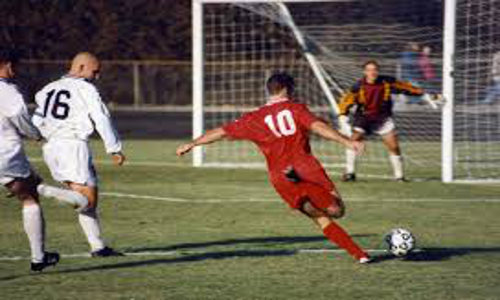

In [47]:
display(img.resize((500,300)))